In [1]:
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from tqdm import tqdm
import json
import os
import random
import gc
import glob
import shutil
import time
from collections import Counter

import torchaudio
from torch import nn, optim
from torch.utils.data import DataLoader, Dataset, WeightedRandomSampler
from transformers import AutoModel
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    roc_auc_score, roc_curve, f1_score, classification_report,
    confusion_matrix, ConfusionMatrixDisplay
)

In [2]:
from pathlib import Path
import torch
import random
import numpy as np

# "Чистые" цифровые
PATH_MLADDC_T2 = Path("/kaggle/input/mladdc-t2/T2")
PATH_SLAVIC_COMBINED = Path("/kaggle/input/m-ailabs-mlaadru-uk-pl/m_ailabs_mlaad")
PATH_PYARA_BASE = Path("/kaggle/input/pyara/final_dataset")
PYARA_METADATA_FILE = PATH_PYARA_BASE / "final_dataset.tsv"

# Replay-ориентированные
PATH_REPLAYDF = Path("/kaggle/input/replaydf/ReplayDF")
PATH_ASV21_REPLAY_BALANCED = Path("/kaggle/input/ready-to-input-for-training/combined_folder")
PATH_FLEURS_HS = Path("/kaggle/input/fleurs-hs/fleurs-hs")
PATH_FOR_REREC_BASE = Path("/kaggle/input/the-fake-or-real-dataset/for-rerec/for-rerecorded")

BASE_MODEL_CHECKPOINT_PATH = Path("/kaggle/input/final-checkpoint/pytorch/default/1/checkpoint_final_all_data_v2.pth")

FINAL_ALL_MODEL_SAVE_PATH = Path("/kaggle/working/best_wavlm_final_all_data_v2.pth")
FINAL_ALL_CHECKPOINT_PATH = Path("/kaggle/working/checkpoint_final_all_data_v2.pth")
FINAL_ALL_HISTORY_SAVE_PATH = Path("/kaggle/working/history_final_all_data_v2.json")
PLOTS_ALL_SAVE_DIR = Path("/kaggle/working/final_all_data_plots_v2")
PLOTS_ALL_SAVE_DIR.mkdir(parents=True, exist_ok=True)

MODEL_CHECKPOINT_HF = "microsoft/wavlm-base"
SAMPLE_RATE = 16000
MAX_LENGTH_SECONDS = 4
NUM_SAMPLES = MAX_LENGTH_SECONDS * SAMPLE_RATE

FINAL_ALL_BATCH_SIZE = 32 
FINAL_ALL_NUM_EPOCHS = 5  
FINAL_ALL_LEARNING_RATE = 1e-6 
FINAL_ALL_WEIGHT_DECAY = 0.01
GRADIENT_ACCUMULATION_STEPS = 2 
NUM_WORKERS = 2

FINAL_ALL_VAL_SIZE = 0.15  # 15% на валидацию
FINAL_ALL_TEST_SIZE = 0.15 # 15% на тест

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Используемое устройство: {device}")
if device.type == 'cuda':
    print(f"Имя GPU: {torch.cuda.get_device_name(0)}")
    torch.backends.cudnn.benchmark = True

seed = 42
random.seed(seed); np.random.seed(seed); torch.manual_seed(seed)
if torch.cuda.is_available(): torch.cuda.manual_seed_all(seed)
print(f"Установлен random seed: {seed}")

Используемое устройство: cuda
Имя GPU: Tesla P100-PCIE-16GB
Установлен random seed: 42


In [4]:
critical_paths_to_check = {
    "Base Model Checkpoint": BASE_MODEL_CHECKPOINT_PATH,
    "MLADDC Base Path": PATH_MLADDC_T2,
    "Slavic Combined Base Path": PATH_SLAVIC_COMBINED,
    "Pyara Base Path": PATH_PYARA_BASE,
    "Pyara Metadata File": PYARA_METADATA_FILE,
    "ReplayDF Base Path": PATH_REPLAYDF,
    "ASV21 Replay Balanced Path": PATH_ASV21_REPLAY_BALANCED,
    "Fleurs-HS Base Path": PATH_FLEURS_HS,
    "FoR-rerec Base Path": PATH_FOR_REREC_BASE,
}
all_paths_ok = True
for name, path_obj in critical_paths_to_check.items():
    if not path_obj.exists():
        print(f"ПРЕДУПРЕЖДЕНИЕ: Путь '{name}' не найден: {path_obj}")
        all_paths_ok = False
    else:
        print(f"Путь '{name}' найден: {path_obj}")

if not all_paths_ok:
    print("\n!!! ВНИМАНИЕ: Не все пути к датасетам или базовой модели найдены. Проверьте конфигурацию. !!!")

Путь 'Base Model Checkpoint' найден: /kaggle/input/final-checkpoint/pytorch/default/1/checkpoint_final_all_data_v2.pth
Путь 'MLADDC Base Path' найден: /kaggle/input/mladdc-t2/T2
Путь 'Slavic Combined Base Path' найден: /kaggle/input/m-ailabs-mlaadru-uk-pl/m_ailabs_mlaad
Путь 'Pyara Base Path' найден: /kaggle/input/pyara/final_dataset
Путь 'Pyara Metadata File' найден: /kaggle/input/pyara/final_dataset/final_dataset.tsv
Путь 'ReplayDF Base Path' найден: /kaggle/input/replaydf/ReplayDF
Путь 'ASV21 Replay Balanced Path' найден: /kaggle/input/ready-to-input-for-training/combined_folder
Путь 'Fleurs-HS Base Path' найден: /kaggle/input/fleurs-hs/fleurs-hs
Путь 'FoR-rerec Base Path' найден: /kaggle/input/the-fake-or-real-dataset/for-rerec/for-rerecorded


In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix

plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.rcParams['axes.unicode_minus'] = False

def EER(y_true, y_score):
    fpr, tpr, thresholds = roc_curve(y_true, y_score, pos_label=1)
    fnr = 1 - tpr
    eer_index = np.nanargmin(np.absolute(fnr - fpr))
    eer = fpr[eer_index]
    return eer

def plot_training_history(history, title_prefix="", save_path=None):
    train_losses = history.get('train_loss', [])
    val_losses = history.get('val_loss', [])
    train_accs = history.get('train_acc', [])
    val_accs = history.get('val_acc', [])
    train_eers = history.get('train_eer', [])
    val_eers = history.get('val_eer', [])
    if not train_losses: print("Нет данных для plot_training_history."); return
    epochs = range(1, len(train_losses) + 1)
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))
    axs[0].plot(epochs, train_losses, 'bo-', label='Ошибка обучения'); axs[0].plot(epochs, val_losses, 'ro-', label='Ошибка валидации')
    axs[0].set_title(f'{title_prefix} Потери'); axs[0].set_xlabel('Эпохи'); axs[0].set_ylabel('Потери'); axs[0].legend(); axs[0].grid(True)
    axs[1].plot(epochs, train_accs, 'go-', label='Тренировочная Accuracy'); axs[1].plot(epochs, val_accs, 'mo-', label='Валидационная Accuracy')
    axs[1].set_title(f'{title_prefix} Accuracy'); axs[1].set_xlabel('Эпохи'); axs[1].set_ylabel('Accuracy (%)'); axs[1].legend(); axs[1].grid(True)
    axs[2].plot(epochs, train_eers, 'co-', label='Тренировочная EER'); axs[2].plot(epochs, val_eers, 'yo-', label='Валидационная EER')
    axs[2].set_title(f'{title_prefix} EER'); axs[2].set_xlabel('Эпохи'); axs[2].set_ylabel('EER'); axs[2].legend(); axs[2].grid(True)
    plt.tight_layout()
    if save_path: plt.savefig(save_path); print(f"График истории сохранен: {save_path}")
    plt.show()


def plot_confusion_matrix_custom(cm, class_names=['Подлинник', 'Фейк'], title='Матрица ошибок', save_path=None):
    plt.figure(figsize=(6, 5)); sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title(title); plt.ylabel('Истинная метка'); plt.xlabel('Предсказанная метка'); plt.tight_layout()
    if save_path: plt.savefig(save_path); print(f"Матрица ошибок сохранена: {save_path}")
    plt.show()

def plot_roc_curve_custom(y_true, y_scores, title='ROC кривая', save_path=None):
    if len(np.unique(y_true)) < 2: print(f"Нет данных для ROC '{title}'."); plt.figure(figsize=(7, 6)); plt.text(0.5, 0.5, 'Нет данных', ha='center'); plt.title(title); plt.show(); return
    if y_scores is None or len(y_scores) != len(y_true): print(f"Некорректные y_scores для '{title}'."); plt.figure(figsize=(7, 6)); plt.text(0.5, 0.5, 'Ошибка y_scores'); plt.title(title); plt.show(); return
    fpr, tpr, _ = roc_curve(y_true, y_scores, pos_label=1); auc_score = roc_auc_score(y_true, y_scores); eer_val = EER(y_true, y_scores)
    plt.figure(figsize=(7, 6)); plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC (AUC={auc_score:.2f}, EER={eer_val:.4f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--'); fnr = 1 - tpr; eer_idx = np.nanargmin(np.absolute(fnr - fpr))
    plt.plot(fpr[eer_idx], tpr[eer_idx], marker='o', markersize=8, color="red", label=f'Точка EER ({fpr[eer_idx]:.2f}, {tpr[eer_idx]:.2f})')
    plt.xlim([0.0, 1.0]); plt.ylim([0.0, 1.05]); plt.xlabel('FPR'); plt.ylabel('TPR'); plt.title(title); plt.legend(loc="lower right"); plt.grid(True); plt.tight_layout()
    if save_path: plt.savefig(save_path); print(f"ROC-кривая сохранена: {save_path}")
    plt.show()


In [6]:
class CustomWavLMForClassification(nn.Module):
    def __init__(self, checkpoint_hf=MODEL_CHECKPOINT_HF, num_labels=1):
        super(CustomWavLMForClassification, self).__init__()
        print(f"Инициализация CustomWavLMForClassification с HuggingFace чекпоинтом: {checkpoint_hf}")
        self.wavlm = AutoModel.from_pretrained(checkpoint_hf)
        self.hidden_size = self.wavlm.config.hidden_size

        self.pool_output_size = 128
        self.pool = nn.AdaptiveAvgPool1d(self.pool_output_size)
        self.linear = nn.Linear(self.hidden_size * self.pool_output_size, num_labels)

    def forward(self, waveforms):
        target_device = next(self.parameters()).device
        waveforms = waveforms.to(target_device)
        outputs = self.wavlm(input_values=waveforms, return_dict=True)
        features = outputs.last_hidden_state
        x = features.transpose(1, 2)
        x = self.pool(x)
        x = x.reshape(x.shape[0], -1)
        logits = self.linear(x)
        if logits.shape[-1] == 1:
            return logits.squeeze(-1)
        else:
            return logits

In [7]:
def normalize_lang_code(lang_name):
    lang_name = str(lang_name).lower().strip()
    mapping = {
        'russian': 'ru', 'english': 'en', 'polish': 'pl', 'ukrainian': 'uk',
        'french': 'fr', 'german': 'de', 'spanish': 'es', 'swedish': 'sv',
        'portuguese': 'pt', 'japanese': 'ja', 'arabic': 'ar', 'indonesian': 'id',
        'vietnamese': 'vi', 'chinese': 'zh', 'catalan': 'ca', 'basque': 'eu',
        'breton': 'br', 'dutch': 'nl', 'esperanto': 'eo', 'hakka': 'hak',
        'interlingua': 'ia', 'italian': 'it', 'kabyle': 'kab', 'kinyarwanda': 'rw',
        'kyrgyz': 'ky', 'latvian': 'lv', 'maltese': 'mt', 'mongolian': 'mn',
        'persian': 'fa', 'romanian': 'ro', 'sakha': 'sah', 'slovenian': 'sl',
        'tamil': 'ta', 'tatar': 'tt', 'turkish': 'tr', 'welsh': 'cy'
    }
    if ('_' in lang_name or '-' in lang_name) and len(lang_name.split('_')[0].split('-')[0]) == 2:
        return lang_name.split('_')[0].split('-')[0]
    if lang_name in mapping: return mapping[lang_name]
    if len(lang_name) == 2: return lang_name
    return lang_name[:2] if len(lang_name) >= 2 else lang_name

In [8]:
def prepare_mladdc_data(base_mladdc_path):
    all_mladdc_files = []
    print(f"\n--- Сбор данных из MLADDC: {base_mladdc_path} ---")
    lang_corrections = {
        'japenese': 'japanese',
        'portugese': 'portuguese',
        'vitnamese': 'vietnamese'
    }

    known_mladdc_langs = {
        'arabic', 'basque', 'breton', 'catalan', 'chinese', 'dutch',
        'english', 'esperanto', 'french', 'german', 'hakka', 'indonesian',
        'interlingua', 'italian', 'japanese', 'kabyle', 'kinyarwanda', 'kyrgyz',
        'latvian', 'maltese', 'mongolian', 'persian', 'polish', 'portuguese',
        'romanian', 'russian', 'sakha', 'slovenian', 'spanish', 'swedish',
        'tamil', 'tatar', 'turkish', 'ukrainian', 'welsh', 'vietnamese' 
    }


    for split_name in ['train', 'val', 'test']:
        split_path = base_mladdc_path / split_name
        if not split_path.is_dir():
            print(f"  Предупреждение: Директория MLADDC сплита {split_path} не найдена.")
            continue

        print(f"  Обработка MLADDC сплита: {split_name}")
        for label_type, label_val in [("real", 0), ("deepfake", 1)]:
            current_data_path = split_path / label_type
            if not current_data_path.is_dir():
                print(f"    Предупреждение: Директория {current_data_path} не найдена.")
                continue

            for filepath in current_data_path.glob('**/*.wav'):
                filename = filepath.name
                name_without_ext = filename[:-4]
                parts = name_without_ext.split('_')
                language = None

                if len(parts) == 2 and parts[1].isdigit():
                    language = parts[0].lower()
                elif len(parts) > 2 and parts[-1].isdigit(): 
                    language_parts = parts[1:-1]
                    language = "_".join(language_parts).lower()

                if language:
                    language = lang_corrections.get(language, language)
                    if language in known_mladdc_langs or len(language) == 2 : 
                         all_mladdc_files.append({
                            "path": str(filepath),
                            "label": label_val,
                            "language": language if len(language) == 2 else language.split('_')[0],
                            "source": "mladdc"
                        })
                # else:
                #     print(f"      Пропущен файл с нераспознанным языком в MLADDC: {filename}")
    if not all_mladdc_files:
         return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    return pd.DataFrame(all_mladdc_files)

In [9]:
def prepare_slavic_data(prepared_slavic_base_path):
    """Собирает все данные (train, val, test) из уже подготовленного Slavic датасета."""
    all_slavic_files = []
    target_iso_codes = {"pl", "ru", "uk"}
    print(f"\n--- Сбор данных из Slavic Combined: {prepared_slavic_base_path} ---")

    for split_name in ['train', 'val', 'test']:
        split_path = prepared_slavic_base_path / split_name
        if not split_path.is_dir():
            print(f"  Предупреждение: Директория Slavic Combined сплита {split_path} не найдена.")
            continue

        print(f"  Обработка Slavic Combined сплита: {split_name}")
        for label_type, label_val in [("real", 0), ("fake", 1)]:
            current_data_path = split_path / label_type
            if not current_data_path.is_dir():
                print(f"    Предупреждение: Директория {current_data_path} не найдена.")
                continue

            for audio_file in current_data_path.glob('*.wav'): # Предполагаем .wav
                filename_parts = audio_file.name.split('_')
                if len(filename_parts) > 1 and filename_parts[0] in target_iso_codes:
                    lang_code = filename_parts[0]
                    all_slavic_files.append({
                        "path": str(audio_file),
                        "label": label_val,
                        "language": lang_code,
                        "source": "slavic_combined"
                    })
    if not all_slavic_files:
        return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    return pd.DataFrame(all_slavic_files)

In [10]:
def prepare_pyara_data(pyara_base_path, pyara_metadata_file):
    """Собирает данные из Pyara."""
    all_pyara_files = []
    print(f"\n--- Сбор данных из Pyara: {pyara_base_path} ---")

    if not pyara_metadata_file.exists():
        print(f"  Ошибка: Файл метаданных Pyara {pyara_metadata_file} не найден!")
        return pd.DataFrame(columns=['path', 'label', 'language', 'source'])

    try:
        # Используем names, чтобы правильно присвоить имена колонок, пропуская первую строку (заголовок)
        col_names = ['path_relative', 'transcript', 'age_group', 'gender', 'label_str', 'algorithm', 'duration']
        df_pyara_raw = pd.read_csv(
            pyara_metadata_file,
            sep='\t',
            header=None, # Первая строка - заголовок, но мы его пропускаем через skiprows
            names=col_names,
            skiprows=1, # Пропускаем первую строку с заголовками
            on_bad_lines='warn'
        )

        if df_pyara_raw.empty:
            print("  Не удалось прочитать данные из TSV файла Pyara или файл пуст после пропуска заголовка.")
            return pd.DataFrame(columns=['path', 'label', 'language', 'source'])

        # Отбираем нужные колонки и удаляем строки с NaN в них
        df_pyara_proc = df_pyara_raw[['path_relative', 'label_str']].copy()
        df_pyara_proc.dropna(subset=['path_relative', 'label_str'], inplace=True)

        # Конвертируем метки в int (0 или 1)
        # Убедимся, что 'label_str' содержит только '0' или '1' (или то, что можно в них превратить)
        df_pyara_proc = df_pyara_proc[df_pyara_proc['label_str'].isin(['0', '1', 0, 1])]
        df_pyara_proc['label'] = df_pyara_proc['label_str'].astype(int)


        for idx, row in tqdm(df_pyara_proc.iterrows(), total=len(df_pyara_proc), desc="  Обработка файлов Pyara"):
            relative_path_str = str(row['path_relative']).strip().replace('\\', '/')
            full_audio_path = pyara_base_path / relative_path_str

            if full_audio_path.exists() and full_audio_path.is_file():
                all_pyara_files.append({
                    "path": str(full_audio_path),
                    "label": row['label'],
                    "language": "ru", # Все Pyara - русский
                    "source": "pyara"
                })
            # else:
            #     print(f"    Предупреждение: Файл Pyara не найден или не файл: {full_audio_path}")
        if not all_pyara_files:
            return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
        return pd.DataFrame(all_pyara_files)

    except Exception as e:
        print(f"  Критическая ошибка при обработке Pyara: {e}")
        import traceback
        traceback.print_exc()
        return pd.DataFrame(columns=['path', 'label', 'language', 'source'])


In [11]:
def prepare_replaydf_data(replaydf_base_path, target_languages={"en", "pl", "fr", "de", "es", "it"}):
    all_files = []; wav_path = replaydf_base_path / "wav"
    if not wav_path.is_dir(): return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    processed_files_count = 0
    for uid_folder in tqdm(list(wav_path.iterdir()), desc="  ReplayDF UID", leave=False):
        if not uid_folder.is_dir(): continue
        for label_type_folder_name, label_val in [("benign", 0), ("spoof", 1)]:
            attack_type_path = uid_folder / label_type_folder_name
            if not attack_type_path.is_dir(): continue
            for lang_folder in attack_type_path.iterdir():
                if not lang_folder.is_dir(): continue
                lang_code_candidate = normalize_lang_code(lang_folder.name)
                if lang_code_candidate in target_languages:
                    for audio_file in lang_folder.glob('*.wav'):
                        if audio_file.is_file():
                            all_files.append({"path": str(audio_file), "label": label_val, "language": lang_code_candidate, "source": "replaydf"}); processed_files_count += 1
    if not all_files: return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    return pd.DataFrame(all_files)

In [12]:
def prepare_asv21bal_replay_data(base_path):
    data = []
    for label_type, label_val in [("real", 0), ("fake", 1)]:
        current_data_path = base_path / label_type
        if not current_data_path.is_dir(): continue
        for ext in ["*.wav", "*.flac"]:
            for filepath in current_data_path.glob(f'**/{ext}'):
                 data.append({"path": str(filepath), "label": label_val, "language": "en", "source": "asv21bal_replay"})
    if not data: return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    return pd.DataFrame(data)

In [13]:
def prepare_fleurs_hs_pl_data(base_path):
    data = []; lang_path = base_path / "pl_pl"
    if not lang_path.is_dir(): return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    for split in ["dev", "train", "test"]:
        split_path = lang_path / split
        if not split_path.is_dir(): continue
        for label_type, label_val in [("real", 0), ("fake", 1)]:
            current_data_path = split_path / label_type
            if not current_data_path.is_dir(): continue
            for filepath in current_data_path.glob('**/*.wav'): 
                 if filepath.is_file():
                    data.append({"path": str(filepath), "label": label_val, "language": "pl", "source": "fleurs_hs_pl"})
    if not data: return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    return pd.DataFrame(data)

In [14]:
def prepare_for_rerec_data(base_path):
    data = []
    for split in ["training", "validation", "testing"]:
        split_path = base_path / split
        if not split_path.is_dir(): continue
        for label_type, label_val in [("real", 0), ("fake", 1)]:
            current_data_path = split_path / label_type
            if not current_data_path.is_dir(): continue
            for filepath in current_data_path.glob('**/*.wav'):
                 data.append({"path": str(filepath), "label": label_val, "language": "en", "source": "for_rerec"})
    if not data: return pd.DataFrame(columns=['path', 'label', 'language', 'source'])
    return pd.DataFrame(data)


--- Загрузка данных из ВСЕХ источников ---

--- Сбор данных из MLADDC: /kaggle/input/mladdc-t2/T2 ---
  Обработка MLADDC сплита: train


  Обработка MLADDC сплита: val


  Обработка MLADDC сплита: test


Загружено из MLADDC: 136000 файлов

--- Сбор данных из Slavic Combined: /kaggle/input/m-ailabs-mlaadru-uk-pl/m_ailabs_mlaad ---
  Обработка Slavic Combined сплита: train


  Обработка Slavic Combined сплита: val
  Обработка Slavic Combined сплита: test


Загружено из Slavic Combined: 32000 файлов

--- Сбор данных из Pyara: /kaggle/input/pyara/final_dataset ---


  Обработка файлов Pyara:   0%|          | 0/201778 [00:00<?, ?it/s]

  Обработка файлов Pyara:   0%|          | 15/201778 [00:00<22:36, 148.79it/s]

  Обработка файлов Pyara:   0%|          | 33/201778 [00:00<20:19, 165.44it/s]

  Обработка файлов Pyara:   0%|          | 53/201778 [00:00<19:35, 171.54it/s]

  Обработка файлов Pyara:   0%|          | 73/201778 [00:00<19:07, 175.81it/s]

  Обработка файлов Pyara:   0%|          | 92/201778 [00:00<18:54, 177.77it/s]

  Обработка файлов Pyara:   0%|          | 110/201778 [00:00<20:47, 161.70it/s]

  Обработка файлов Pyara:   0%|          | 127/201778 [00:00<20:55, 160.64it/s]

  Обработка файлов Pyara:   0%|          | 144/201778 [00:00<20:53, 160.79it/s]

  Обработка файлов Pyara:   0%|          | 162/201778 [00:00<20:28, 164.12it/s]

  Обработка файлов Pyara:   0%|          | 179/201778 [00:01<20:21, 165.08it/s]

  Обработка файлов Pyara:   0%|          | 198/201778 [00:01<19:45, 170.07it/s]

  Обработка файлов Pyara:   0%|          | 216/201778 [00:01<19:56, 168.49it/s]

  Обработка файлов Pyara:   0%|          | 236/201778 [00:01<19:06, 175.81it/s]

  Обработка файлов Pyara:   0%|          | 257/201778 [00:01<18:18, 183.38it/s]

  Обработка файлов Pyara:   0%|          | 276/201778 [00:01<19:27, 172.64it/s]

  Обработка файлов Pyara:   0%|          | 294/201778 [00:01<19:50, 169.25it/s]

  Обработка файлов Pyara:   0%|          | 313/201778 [00:01<19:15, 174.37it/s]

  Обработка файлов Pyara:   0%|          | 332/201778 [00:01<18:57, 177.02it/s]

  Обработка файлов Pyara:   0%|          | 350/201778 [00:02<18:53, 177.66it/s]

  Обработка файлов Pyara:   0%|          | 370/201778 [00:02<18:23, 182.45it/s]

  Обработка файлов Pyara:   0%|          | 389/201778 [00:02<19:19, 173.67it/s]

  Обработка файлов Pyara:   0%|          | 408/201778 [00:02<18:49, 178.22it/s]

  Обработка файлов Pyara:   0%|          | 426/201778 [00:02<19:44, 169.95it/s]

  Обработка файлов Pyara:   0%|          | 446/201778 [00:02<18:50, 178.08it/s]

  Обработка файлов Pyara:   0%|          | 465/201778 [00:02<18:44, 179.01it/s]

  Обработка файлов Pyara:   0%|          | 484/201778 [00:02<18:59, 176.58it/s]

  Обработка файлов Pyara:   0%|          | 503/201778 [00:02<18:46, 178.63it/s]

  Обработка файлов Pyara:   0%|          | 526/201778 [00:03<17:31, 191.44it/s]

  Обработка файлов Pyara:   0%|          | 546/201778 [00:03<17:43, 189.27it/s]

  Обработка файлов Pyara:   0%|          | 565/201778 [00:03<18:15, 183.68it/s]

  Обработка файлов Pyara:   0%|          | 584/201778 [00:03<19:34, 171.25it/s]

  Обработка файлов Pyara:   0%|          | 604/201778 [00:03<18:55, 177.14it/s]

  Обработка файлов Pyara:   0%|          | 624/201778 [00:03<18:24, 182.14it/s]

  Обработка файлов Pyara:   0%|          | 643/201778 [00:03<18:25, 182.02it/s]

  Обработка файлов Pyara:   0%|          | 662/201778 [00:03<18:35, 180.26it/s]

  Обработка файлов Pyara:   0%|          | 681/201778 [00:03<18:18, 182.98it/s]

  Обработка файлов Pyara:   0%|          | 700/201778 [00:03<18:14, 183.64it/s]

  Обработка файлов Pyara:   0%|          | 720/201778 [00:04<18:06, 185.13it/s]

  Обработка файлов Pyara:   0%|          | 740/201778 [00:04<17:46, 188.52it/s]

  Обработка файлов Pyara:   0%|          | 759/201778 [00:04<18:44, 178.71it/s]

  Обработка файлов Pyara:   0%|          | 777/201778 [00:04<19:16, 173.87it/s]

  Обработка файлов Pyara:   0%|          | 797/201778 [00:04<18:35, 180.11it/s]

  Обработка файлов Pyara:   0%|          | 817/201778 [00:04<18:14, 183.61it/s]

  Обработка файлов Pyara:   0%|          | 836/201778 [00:04<19:06, 175.29it/s]

  Обработка файлов Pyara:   0%|          | 855/201778 [00:04<18:58, 176.46it/s]

  Обработка файлов Pyara:   0%|          | 876/201778 [00:04<18:07, 184.74it/s]

  Обработка файлов Pyara:   0%|          | 895/201778 [00:05<19:27, 172.13it/s]

  Обработка файлов Pyara:   0%|          | 915/201778 [00:05<18:40, 179.18it/s]

  Обработка файлов Pyara:   0%|          | 934/201778 [00:05<19:17, 173.48it/s]

  Обработка файлов Pyara:   0%|          | 955/201778 [00:05<18:40, 179.27it/s]

  Обработка файлов Pyara:   0%|          | 974/201778 [00:05<18:33, 180.40it/s]

  Обработка файлов Pyara:   0%|          | 993/201778 [00:05<18:56, 176.66it/s]

  Обработка файлов Pyara:   1%|          | 1014/201778 [00:05<18:04, 185.08it/s]

  Обработка файлов Pyara:   1%|          | 1033/201778 [00:05<17:59, 186.03it/s]

  Обработка файлов Pyara:   1%|          | 1053/201778 [00:05<17:59, 186.00it/s]

  Обработка файлов Pyara:   1%|          | 1072/201778 [00:06<17:53, 187.05it/s]

  Обработка файлов Pyara:   1%|          | 1091/201778 [00:06<18:39, 179.23it/s]

  Обработка файлов Pyara:   1%|          | 1111/201778 [00:06<18:04, 184.97it/s]

  Обработка файлов Pyara:   1%|          | 1130/201778 [00:06<18:43, 178.63it/s]

  Обработка файлов Pyara:   1%|          | 1149/201778 [00:06<18:31, 180.52it/s]

  Обработка файлов Pyara:   1%|          | 1168/201778 [00:06<19:03, 175.42it/s]

  Обработка файлов Pyara:   1%|          | 1186/201778 [00:06<18:58, 176.25it/s]

  Обработка файлов Pyara:   1%|          | 1204/201778 [00:06<19:22, 172.54it/s]

  Обработка файлов Pyara:   1%|          | 1222/201778 [00:06<19:29, 171.45it/s]

  Обработка файлов Pyara:   1%|          | 1243/201778 [00:07<18:20, 182.28it/s]

  Обработка файлов Pyara:   1%|          | 1262/201778 [00:07<18:26, 181.16it/s]

  Обработка файлов Pyara:   1%|          | 1282/201778 [00:07<18:19, 182.34it/s]

  Обработка файлов Pyara:   1%|          | 1303/201778 [00:07<17:38, 189.46it/s]

  Обработка файлов Pyara:   1%|          | 1322/201778 [00:07<17:47, 187.72it/s]

  Обработка файлов Pyara:   1%|          | 1345/201778 [00:07<16:49, 198.50it/s]

  Обработка файлов Pyara:   1%|          | 1365/201778 [00:07<17:28, 191.15it/s]

  Обработка файлов Pyara:   1%|          | 1385/201778 [00:07<17:42, 188.52it/s]

  Обработка файлов Pyara:   1%|          | 1405/201778 [00:07<17:28, 191.18it/s]

  Обработка файлов Pyara:   1%|          | 1425/201778 [00:07<17:31, 190.56it/s]

  Обработка файлов Pyara:   1%|          | 1445/201778 [00:08<17:44, 188.13it/s]

  Обработка файлов Pyara:   1%|          | 1464/201778 [00:08<17:52, 186.79it/s]

  Обработка файлов Pyara:   1%|          | 1483/201778 [00:08<17:52, 186.79it/s]

  Обработка файлов Pyara:   1%|          | 1502/201778 [00:08<18:21, 181.84it/s]

  Обработка файлов Pyara:   1%|          | 1521/201778 [00:08<18:12, 183.24it/s]

  Обработка файлов Pyara:   1%|          | 1540/201778 [00:08<18:14, 182.95it/s]

  Обработка файлов Pyara:   1%|          | 1559/201778 [00:08<18:40, 178.64it/s]

  Обработка файлов Pyara:   1%|          | 1578/201778 [00:08<18:21, 181.72it/s]

  Обработка файлов Pyara:   1%|          | 1600/201778 [00:08<17:37, 189.25it/s]

  Обработка файлов Pyara:   1%|          | 1619/201778 [00:09<18:11, 183.38it/s]

  Обработка файлов Pyara:   1%|          | 1639/201778 [00:09<17:48, 187.28it/s]

  Обработка файлов Pyara:   1%|          | 1660/201778 [00:09<17:18, 192.74it/s]

  Обработка файлов Pyara:   1%|          | 1680/201778 [00:09<17:19, 192.49it/s]

  Обработка файлов Pyara:   1%|          | 1700/201778 [00:09<17:12, 193.85it/s]

  Обработка файлов Pyara:   1%|          | 1722/201778 [00:09<16:40, 199.98it/s]

  Обработка файлов Pyara:   1%|          | 1743/201778 [00:09<16:51, 197.81it/s]

  Обработка файлов Pyara:   1%|          | 1763/201778 [00:09<17:17, 192.74it/s]

  Обработка файлов Pyara:   1%|          | 1783/201778 [00:09<18:20, 181.77it/s]

  Обработка файлов Pyara:   1%|          | 1802/201778 [00:09<18:22, 181.34it/s]

  Обработка файлов Pyara:   1%|          | 1824/201778 [00:10<17:38, 188.83it/s]

  Обработка файлов Pyara:   1%|          | 1845/201778 [00:10<17:26, 190.97it/s]

  Обработка файлов Pyara:   1%|          | 1865/201778 [00:10<17:31, 190.12it/s]

  Обработка файлов Pyara:   1%|          | 1885/201778 [00:10<17:38, 188.78it/s]

  Обработка файлов Pyara:   1%|          | 1904/201778 [00:10<19:00, 175.28it/s]

  Обработка файлов Pyara:   1%|          | 1923/201778 [00:10<18:37, 178.83it/s]

  Обработка файлов Pyara:   1%|          | 1946/201778 [00:10<17:24, 191.41it/s]

  Обработка файлов Pyara:   1%|          | 1966/201778 [00:10<17:51, 186.49it/s]

  Обработка файлов Pyara:   1%|          | 1987/201778 [00:10<17:28, 190.61it/s]

  Обработка файлов Pyara:   1%|          | 2007/201778 [00:11<17:35, 189.19it/s]

  Обработка файлов Pyara:   1%|          | 2026/201778 [00:11<18:16, 182.12it/s]

  Обработка файлов Pyara:   1%|          | 2045/201778 [00:11<18:29, 179.95it/s]

  Обработка файлов Pyara:   1%|          | 2064/201778 [00:11<18:35, 178.97it/s]

  Обработка файлов Pyara:   1%|          | 2082/201778 [00:11<18:39, 178.34it/s]

  Обработка файлов Pyara:   1%|          | 2101/201778 [00:11<18:32, 179.53it/s]

  Обработка файлов Pyara:   1%|          | 2120/201778 [00:11<18:28, 180.17it/s]

  Обработка файлов Pyara:   1%|          | 2142/201778 [00:11<17:37, 188.77it/s]

  Обработка файлов Pyara:   1%|          | 2163/201778 [00:11<17:17, 192.36it/s]

  Обработка файлов Pyara:   1%|          | 2184/201778 [00:12<16:55, 196.60it/s]

  Обработка файлов Pyara:   1%|          | 2204/201778 [00:12<17:35, 189.07it/s]

  Обработка файлов Pyara:   1%|          | 2226/201778 [00:12<17:15, 192.75it/s]

  Обработка файлов Pyara:   1%|          | 2246/201778 [00:12<18:02, 184.24it/s]

  Обработка файлов Pyara:   1%|          | 2265/201778 [00:12<19:49, 167.66it/s]

  Обработка файлов Pyara:   1%|          | 2285/201778 [00:12<19:21, 171.73it/s]

  Обработка файлов Pyara:   1%|          | 2303/201778 [00:12<22:35, 147.19it/s]

  Обработка файлов Pyara:   1%|          | 2319/201778 [00:12<26:59, 123.19it/s]

  Обработка файлов Pyara:   1%|          | 2333/201778 [00:13<26:43, 124.38it/s]

  Обработка файлов Pyara:   1%|          | 2351/201778 [00:13<24:18, 136.75it/s]

  Обработка файлов Pyara:   1%|          | 2369/201778 [00:13<22:50, 145.55it/s]

  Обработка файлов Pyara:   1%|          | 2386/201778 [00:13<21:57, 151.32it/s]

  Обработка файлов Pyara:   1%|          | 2404/201778 [00:13<20:59, 158.34it/s]

  Обработка файлов Pyara:   1%|          | 2422/201778 [00:13<20:17, 163.75it/s]

  Обработка файлов Pyara:   1%|          | 2445/201778 [00:13<18:20, 181.08it/s]

  Обработка файлов Pyara:   1%|          | 2466/201778 [00:13<17:40, 188.00it/s]

  Обработка файлов Pyara:   1%|          | 2489/201778 [00:13<16:45, 198.29it/s]

  Обработка файлов Pyara:   1%|          | 2510/201778 [00:14<17:24, 190.79it/s]

  Обработка файлов Pyara:   1%|▏         | 2530/201778 [00:14<17:36, 188.54it/s]

  Обработка файлов Pyara:   1%|▏         | 2549/201778 [00:14<17:41, 187.61it/s]

  Обработка файлов Pyara:   1%|▏         | 2570/201778 [00:14<17:13, 192.75it/s]

  Обработка файлов Pyara:   1%|▏         | 2592/201778 [00:14<16:38, 199.53it/s]

  Обработка файлов Pyara:   1%|▏         | 2614/201778 [00:14<16:12, 204.85it/s]

  Обработка файлов Pyara:   1%|▏         | 2635/201778 [00:14<16:38, 199.47it/s]

  Обработка файлов Pyara:   1%|▏         | 2656/201778 [00:14<17:38, 188.15it/s]

  Обработка файлов Pyara:   1%|▏         | 2678/201778 [00:14<16:55, 196.14it/s]

  Обработка файлов Pyara:   1%|▏         | 2700/201778 [00:14<16:22, 202.68it/s]

  Обработка файлов Pyara:   1%|▏         | 2721/201778 [00:15<17:09, 193.32it/s]

  Обработка файлов Pyara:   1%|▏         | 2742/201778 [00:15<16:45, 197.86it/s]

  Обработка файлов Pyara:   1%|▏         | 2762/201778 [00:15<17:22, 190.97it/s]

  Обработка файлов Pyara:   1%|▏         | 2782/201778 [00:15<17:17, 191.81it/s]

  Обработка файлов Pyara:   1%|▏         | 2804/201778 [00:15<16:46, 197.63it/s]

  Обработка файлов Pyara:   1%|▏         | 2824/201778 [00:15<16:59, 195.15it/s]

  Обработка файлов Pyara:   1%|▏         | 2847/201778 [00:15<16:29, 201.11it/s]

  Обработка файлов Pyara:   1%|▏         | 2868/201778 [00:15<16:28, 201.30it/s]

  Обработка файлов Pyara:   1%|▏         | 2889/201778 [00:15<16:59, 195.13it/s]

  Обработка файлов Pyara:   1%|▏         | 2909/201778 [00:16<17:36, 188.22it/s]

  Обработка файлов Pyara:   1%|▏         | 2932/201778 [00:16<16:43, 198.12it/s]

  Обработка файлов Pyara:   1%|▏         | 2952/201778 [00:16<17:23, 190.61it/s]

  Обработка файлов Pyara:   1%|▏         | 2973/201778 [00:16<17:02, 194.42it/s]

  Обработка файлов Pyara:   1%|▏         | 2993/201778 [00:16<17:04, 194.11it/s]

  Обработка файлов Pyara:   1%|▏         | 3014/201778 [00:16<16:58, 195.16it/s]

  Обработка файлов Pyara:   2%|▏         | 3034/201778 [00:16<17:03, 194.09it/s]

  Обработка файлов Pyara:   2%|▏         | 3054/201778 [00:16<18:28, 179.20it/s]

  Обработка файлов Pyara:   2%|▏         | 3076/201778 [00:16<18:03, 183.34it/s]

  Обработка файлов Pyara:   2%|▏         | 3096/201778 [00:17<17:45, 186.42it/s]

  Обработка файлов Pyara:   2%|▏         | 3115/201778 [00:17<18:02, 183.47it/s]

  Обработка файлов Pyara:   2%|▏         | 3135/201778 [00:17<17:39, 187.53it/s]

  Обработка файлов Pyara:   2%|▏         | 3154/201778 [00:17<18:11, 181.97it/s]

  Обработка файлов Pyara:   2%|▏         | 3175/201778 [00:17<17:41, 187.10it/s]

  Обработка файлов Pyara:   2%|▏         | 3198/201778 [00:17<16:44, 197.65it/s]

  Обработка файлов Pyara:   2%|▏         | 3218/201778 [00:17<18:03, 183.19it/s]

  Обработка файлов Pyara:   2%|▏         | 3239/201778 [00:17<17:36, 187.90it/s]

  Обработка файлов Pyara:   2%|▏         | 3258/201778 [00:17<18:21, 180.19it/s]

  Обработка файлов Pyara:   2%|▏         | 3278/201778 [00:18<17:57, 184.24it/s]

  Обработка файлов Pyara:   2%|▏         | 3297/201778 [00:18<17:53, 184.82it/s]

  Обработка файлов Pyara:   2%|▏         | 3316/201778 [00:18<18:20, 180.34it/s]

  Обработка файлов Pyara:   2%|▏         | 3336/201778 [00:18<17:50, 185.35it/s]

  Обработка файлов Pyara:   2%|▏         | 3358/201778 [00:18<16:56, 195.18it/s]

  Обработка файлов Pyara:   2%|▏         | 3379/201778 [00:18<16:34, 199.43it/s]

  Обработка файлов Pyara:   2%|▏         | 3400/201778 [00:18<16:30, 200.32it/s]

  Обработка файлов Pyara:   2%|▏         | 3421/201778 [00:18<17:07, 193.12it/s]

  Обработка файлов Pyara:   2%|▏         | 3445/201778 [00:18<16:06, 205.13it/s]

  Обработка файлов Pyara:   2%|▏         | 3466/201778 [00:18<16:04, 205.71it/s]

  Обработка файлов Pyara:   2%|▏         | 3487/201778 [00:19<16:12, 203.80it/s]

  Обработка файлов Pyara:   2%|▏         | 3508/201778 [00:19<18:20, 180.23it/s]

  Обработка файлов Pyara:   2%|▏         | 3527/201778 [00:19<18:58, 174.09it/s]

  Обработка файлов Pyara:   2%|▏         | 3546/201778 [00:19<18:49, 175.49it/s]

  Обработка файлов Pyara:   2%|▏         | 3568/201778 [00:19<17:37, 187.42it/s]

  Обработка файлов Pyara:   2%|▏         | 3590/201778 [00:19<16:57, 194.78it/s]

  Обработка файлов Pyara:   2%|▏         | 3612/201778 [00:19<16:21, 201.89it/s]

  Обработка файлов Pyara:   2%|▏         | 3633/201778 [00:19<16:39, 198.16it/s]

  Обработка файлов Pyara:   2%|▏         | 3655/201778 [00:19<16:12, 203.69it/s]

  Обработка файлов Pyara:   2%|▏         | 3676/201778 [00:20<16:17, 202.69it/s]

  Обработка файлов Pyara:   2%|▏         | 3701/201778 [00:20<15:29, 213.00it/s]

  Обработка файлов Pyara:   2%|▏         | 3723/201778 [00:20<15:31, 212.61it/s]

  Обработка файлов Pyara:   2%|▏         | 3745/201778 [00:20<16:00, 206.25it/s]

  Обработка файлов Pyara:   2%|▏         | 3766/201778 [00:20<16:26, 200.73it/s]

  Обработка файлов Pyara:   2%|▏         | 3787/201778 [00:20<16:46, 196.62it/s]

  Обработка файлов Pyara:   2%|▏         | 3812/201778 [00:20<15:41, 210.35it/s]

  Обработка файлов Pyara:   2%|▏         | 3834/201778 [00:20<16:19, 202.00it/s]

  Обработка файлов Pyara:   2%|▏         | 3856/201778 [00:20<16:15, 202.87it/s]

  Обработка файлов Pyara:   2%|▏         | 3878/201778 [00:21<16:02, 205.64it/s]

  Обработка файлов Pyara:   2%|▏         | 3899/201778 [00:21<16:43, 197.20it/s]

  Обработка файлов Pyara:   2%|▏         | 3921/201778 [00:21<16:19, 202.00it/s]

  Обработка файлов Pyara:   2%|▏         | 3942/201778 [00:21<16:12, 203.43it/s]

  Обработка файлов Pyara:   2%|▏         | 3964/201778 [00:21<15:52, 207.61it/s]

  Обработка файлов Pyara:   2%|▏         | 3985/201778 [00:21<16:19, 201.88it/s]

  Обработка файлов Pyara:   2%|▏         | 4006/201778 [00:21<16:48, 196.06it/s]

  Обработка файлов Pyara:   2%|▏         | 4026/201778 [00:21<17:17, 190.67it/s]

  Обработка файлов Pyara:   2%|▏         | 4048/201778 [00:21<16:57, 194.39it/s]

  Обработка файлов Pyara:   2%|▏         | 4068/201778 [00:22<17:03, 193.10it/s]

  Обработка файлов Pyara:   2%|▏         | 4088/201778 [00:22<17:00, 193.72it/s]

  Обработка файлов Pyara:   2%|▏         | 4108/201778 [00:22<17:04, 193.02it/s]

  Обработка файлов Pyara:   2%|▏         | 4128/201778 [00:22<17:10, 191.79it/s]

  Обработка файлов Pyara:   2%|▏         | 4148/201778 [00:22<18:11, 181.10it/s]

  Обработка файлов Pyara:   2%|▏         | 4168/201778 [00:22<17:59, 183.03it/s]

  Обработка файлов Pyara:   2%|▏         | 4187/201778 [00:22<17:54, 183.84it/s]

  Обработка файлов Pyara:   2%|▏         | 4207/201778 [00:22<17:39, 186.50it/s]

  Обработка файлов Pyara:   2%|▏         | 4227/201778 [00:22<17:25, 188.94it/s]

  Обработка файлов Pyara:   2%|▏         | 4247/201778 [00:22<17:21, 189.62it/s]

  Обработка файлов Pyara:   2%|▏         | 4270/201778 [00:23<16:33, 198.82it/s]

  Обработка файлов Pyara:   2%|▏         | 4290/201778 [00:23<16:36, 198.28it/s]

  Обработка файлов Pyara:   2%|▏         | 4310/201778 [00:23<17:24, 189.11it/s]

  Обработка файлов Pyara:   2%|▏         | 4329/201778 [00:23<17:49, 184.67it/s]

  Обработка файлов Pyara:   2%|▏         | 4350/201778 [00:23<17:37, 186.69it/s]

  Обработка файлов Pyara:   2%|▏         | 4369/201778 [00:23<17:46, 185.14it/s]

  Обработка файлов Pyara:   2%|▏         | 4390/201778 [00:23<17:10, 191.61it/s]

  Обработка файлов Pyara:   2%|▏         | 4410/201778 [00:23<17:24, 188.92it/s]

  Обработка файлов Pyara:   2%|▏         | 4430/201778 [00:23<17:24, 188.99it/s]

  Обработка файлов Pyara:   2%|▏         | 4449/201778 [00:24<19:13, 171.07it/s]

  Обработка файлов Pyara:   2%|▏         | 4469/201778 [00:24<18:27, 178.15it/s]

  Обработка файлов Pyara:   2%|▏         | 4488/201778 [00:24<18:07, 181.37it/s]

  Обработка файлов Pyara:   2%|▏         | 4512/201778 [00:24<16:43, 196.62it/s]

  Обработка файлов Pyara:   2%|▏         | 4533/201778 [00:24<16:30, 199.05it/s]

  Обработка файлов Pyara:   2%|▏         | 4554/201778 [00:24<16:54, 194.34it/s]

  Обработка файлов Pyara:   2%|▏         | 4577/201778 [00:24<16:15, 202.17it/s]

  Обработка файлов Pyara:   2%|▏         | 4601/201778 [00:24<15:35, 210.86it/s]

  Обработка файлов Pyara:   2%|▏         | 4623/201778 [00:24<15:37, 210.19it/s]

  Обработка файлов Pyara:   2%|▏         | 4645/201778 [00:25<16:29, 199.16it/s]

  Обработка файлов Pyara:   2%|▏         | 4669/201778 [00:25<15:40, 209.58it/s]

  Обработка файлов Pyara:   2%|▏         | 4691/201778 [00:25<16:08, 203.59it/s]

  Обработка файлов Pyara:   2%|▏         | 4712/201778 [00:25<16:17, 201.54it/s]

  Обработка файлов Pyara:   2%|▏         | 4736/201778 [00:25<15:31, 211.48it/s]

  Обработка файлов Pyara:   2%|▏         | 4759/201778 [00:25<15:12, 215.97it/s]

  Обработка файлов Pyara:   2%|▏         | 4781/201778 [00:25<15:21, 213.77it/s]

  Обработка файлов Pyara:   2%|▏         | 4803/201778 [00:25<15:27, 212.28it/s]

  Обработка файлов Pyara:   2%|▏         | 4827/201778 [00:25<14:55, 219.95it/s]

  Обработка файлов Pyara:   2%|▏         | 4850/201778 [00:25<15:02, 218.19it/s]

  Обработка файлов Pyara:   2%|▏         | 4872/201778 [00:26<15:49, 207.37it/s]

  Обработка файлов Pyara:   2%|▏         | 4893/201778 [00:26<16:26, 199.65it/s]

  Обработка файлов Pyara:   2%|▏         | 4915/201778 [00:26<16:12, 202.38it/s]

  Обработка файлов Pyara:   2%|▏         | 4939/201778 [00:26<15:38, 209.75it/s]

  Обработка файлов Pyara:   2%|▏         | 4963/201778 [00:26<15:08, 216.65it/s]

  Обработка файлов Pyara:   2%|▏         | 4985/201778 [00:26<16:21, 200.40it/s]

  Обработка файлов Pyara:   2%|▏         | 5006/201778 [00:26<16:25, 199.71it/s]

  Обработка файлов Pyara:   2%|▏         | 5029/201778 [00:26<15:57, 205.58it/s]

  Обработка файлов Pyara:   3%|▎         | 5050/201778 [00:26<15:52, 206.61it/s]

  Обработка файлов Pyara:   3%|▎         | 5074/201778 [00:27<15:19, 213.94it/s]

  Обработка файлов Pyara:   3%|▎         | 5096/201778 [00:27<15:41, 208.92it/s]

  Обработка файлов Pyara:   3%|▎         | 5117/201778 [00:27<15:47, 207.61it/s]

  Обработка файлов Pyara:   3%|▎         | 5138/201778 [00:27<15:59, 204.89it/s]

  Обработка файлов Pyara:   3%|▎         | 5159/201778 [00:27<16:11, 202.29it/s]

  Обработка файлов Pyara:   3%|▎         | 5182/201778 [00:27<15:44, 208.12it/s]

  Обработка файлов Pyara:   3%|▎         | 5203/201778 [00:27<16:19, 200.62it/s]

  Обработка файлов Pyara:   3%|▎         | 5225/201778 [00:27<15:54, 205.91it/s]

  Обработка файлов Pyara:   3%|▎         | 5246/201778 [00:27<15:59, 204.81it/s]

  Обработка файлов Pyara:   3%|▎         | 5267/201778 [00:28<16:34, 197.69it/s]

  Обработка файлов Pyara:   3%|▎         | 5290/201778 [00:28<15:57, 205.24it/s]

  Обработка файлов Pyara:   3%|▎         | 5314/201778 [00:28<15:13, 214.96it/s]

  Обработка файлов Pyara:   3%|▎         | 5336/201778 [00:28<15:43, 208.19it/s]

  Обработка файлов Pyara:   3%|▎         | 5359/201778 [00:28<15:26, 211.94it/s]

  Обработка файлов Pyara:   3%|▎         | 5381/201778 [00:28<16:48, 194.68it/s]

  Обработка файлов Pyara:   3%|▎         | 5405/201778 [00:28<15:51, 206.48it/s]

  Обработка файлов Pyara:   3%|▎         | 5426/201778 [00:28<16:05, 203.42it/s]

  Обработка файлов Pyara:   3%|▎         | 5447/201778 [00:28<16:09, 202.56it/s]

  Обработка файлов Pyara:   3%|▎         | 5468/201778 [00:29<16:19, 200.50it/s]

  Обработка файлов Pyara:   3%|▎         | 5491/201778 [00:29<15:49, 206.83it/s]

  Обработка файлов Pyara:   3%|▎         | 5512/201778 [00:29<15:53, 205.89it/s]

  Обработка файлов Pyara:   3%|▎         | 5533/201778 [00:29<16:15, 201.23it/s]

  Обработка файлов Pyara:   3%|▎         | 5556/201778 [00:29<15:43, 207.87it/s]

  Обработка файлов Pyara:   3%|▎         | 5577/201778 [00:29<15:43, 207.85it/s]

  Обработка файлов Pyara:   3%|▎         | 5600/201778 [00:29<15:36, 209.52it/s]

  Обработка файлов Pyara:   3%|▎         | 5621/201778 [00:29<15:55, 205.33it/s]

  Обработка файлов Pyara:   3%|▎         | 5642/201778 [00:29<16:28, 198.39it/s]

  Обработка файлов Pyara:   3%|▎         | 5662/201778 [00:29<16:28, 198.39it/s]

  Обработка файлов Pyara:   3%|▎         | 5683/201778 [00:30<16:20, 199.97it/s]

  Обработка файлов Pyara:   3%|▎         | 5705/201778 [00:30<15:53, 205.61it/s]

  Обработка файлов Pyara:   3%|▎         | 5730/201778 [00:30<15:06, 216.21it/s]

  Обработка файлов Pyara:   3%|▎         | 5752/201778 [00:30<15:36, 209.36it/s]

  Обработка файлов Pyara:   3%|▎         | 5773/201778 [00:30<15:41, 208.15it/s]

  Обработка файлов Pyara:   3%|▎         | 5794/201778 [00:30<15:42, 207.84it/s]

  Обработка файлов Pyara:   3%|▎         | 5816/201778 [00:30<15:31, 210.47it/s]

  Обработка файлов Pyara:   3%|▎         | 5838/201778 [00:30<15:46, 207.01it/s]

  Обработка файлов Pyara:   3%|▎         | 5859/201778 [00:30<16:14, 201.02it/s]

  Обработка файлов Pyara:   3%|▎         | 5882/201778 [00:31<15:54, 205.19it/s]

  Обработка файлов Pyara:   3%|▎         | 5903/201778 [00:31<17:22, 187.82it/s]

  Обработка файлов Pyara:   3%|▎         | 5924/201778 [00:31<16:59, 192.12it/s]

  Обработка файлов Pyara:   3%|▎         | 5944/201778 [00:31<18:02, 180.84it/s]

  Обработка файлов Pyara:   3%|▎         | 5964/201778 [00:31<17:36, 185.39it/s]

  Обработка файлов Pyara:   3%|▎         | 5984/201778 [00:31<17:14, 189.19it/s]

  Обработка файлов Pyara:   3%|▎         | 6005/201778 [00:31<16:59, 191.99it/s]

  Обработка файлов Pyara:   3%|▎         | 6025/201778 [00:31<17:02, 191.52it/s]

  Обработка файлов Pyara:   3%|▎         | 6045/201778 [00:31<17:09, 190.19it/s]

  Обработка файлов Pyara:   3%|▎         | 6065/201778 [00:32<17:04, 190.97it/s]

  Обработка файлов Pyara:   3%|▎         | 6085/201778 [00:32<19:02, 171.26it/s]

  Обработка файлов Pyara:   3%|▎         | 6105/201778 [00:32<18:18, 178.19it/s]

  Обработка файлов Pyara:   3%|▎         | 6125/201778 [00:32<17:47, 183.30it/s]

  Обработка файлов Pyara:   3%|▎         | 6145/201778 [00:32<17:22, 187.62it/s]

  Обработка файлов Pyara:   3%|▎         | 6166/201778 [00:32<16:52, 193.26it/s]

  Обработка файлов Pyara:   3%|▎         | 6186/201778 [00:32<16:48, 193.95it/s]

  Обработка файлов Pyara:   3%|▎         | 6212/201778 [00:32<15:26, 211.04it/s]

  Обработка файлов Pyara:   3%|▎         | 6235/201778 [00:32<15:12, 214.26it/s]

  Обработка файлов Pyara:   3%|▎         | 6257/201778 [00:32<15:56, 204.40it/s]

  Обработка файлов Pyara:   3%|▎         | 6279/201778 [00:33<15:36, 208.74it/s]

  Обработка файлов Pyara:   3%|▎         | 6300/201778 [00:33<15:38, 208.37it/s]

  Обработка файлов Pyara:   3%|▎         | 6321/201778 [00:33<15:49, 205.91it/s]

  Обработка файлов Pyara:   3%|▎         | 6342/201778 [00:33<16:03, 202.93it/s]

  Обработка файлов Pyara:   3%|▎         | 6364/201778 [00:33<15:47, 206.15it/s]

  Обработка файлов Pyara:   3%|▎         | 6385/201778 [00:33<15:46, 206.41it/s]

  Обработка файлов Pyara:   3%|▎         | 6406/201778 [00:33<15:42, 207.34it/s]

  Обработка файлов Pyara:   3%|▎         | 6430/201778 [00:33<15:02, 216.36it/s]

  Обработка файлов Pyara:   3%|▎         | 6452/201778 [00:33<15:08, 215.09it/s]

  Обработка файлов Pyara:   3%|▎         | 6474/201778 [00:34<15:22, 211.73it/s]

  Обработка файлов Pyara:   3%|▎         | 6499/201778 [00:34<14:42, 221.34it/s]

  Обработка файлов Pyara:   3%|▎         | 6522/201778 [00:34<14:59, 217.07it/s]

  Обработка файлов Pyara:   3%|▎         | 6544/201778 [00:34<15:09, 214.72it/s]

  Обработка файлов Pyara:   3%|▎         | 6569/201778 [00:34<14:42, 221.14it/s]

  Обработка файлов Pyara:   3%|▎         | 6592/201778 [00:34<15:02, 216.38it/s]

  Обработка файлов Pyara:   3%|▎         | 6614/201778 [00:34<15:11, 214.18it/s]

  Обработка файлов Pyara:   3%|▎         | 6638/201778 [00:34<14:49, 219.30it/s]

  Обработка файлов Pyara:   3%|▎         | 6660/201778 [00:34<15:27, 210.26it/s]

  Обработка файлов Pyara:   3%|▎         | 6682/201778 [00:35<16:04, 202.34it/s]

  Обработка файлов Pyara:   3%|▎         | 6704/201778 [00:35<15:41, 207.13it/s]

  Обработка файлов Pyara:   3%|▎         | 6726/201778 [00:35<15:31, 209.41it/s]

  Обработка файлов Pyara:   3%|▎         | 6748/201778 [00:35<15:26, 210.50it/s]

  Обработка файлов Pyara:   3%|▎         | 6770/201778 [00:35<15:22, 211.46it/s]

  Обработка файлов Pyara:   3%|▎         | 6792/201778 [00:35<15:15, 212.99it/s]

  Обработка файлов Pyara:   3%|▎         | 6814/201778 [00:35<16:06, 201.70it/s]

  Обработка файлов Pyara:   3%|▎         | 6838/201778 [00:35<15:34, 208.68it/s]

  Обработка файлов Pyara:   3%|▎         | 6859/201778 [00:35<17:23, 186.76it/s]

  Обработка файлов Pyara:   3%|▎         | 6882/201778 [00:35<16:25, 197.75it/s]

  Обработка файлов Pyara:   3%|▎         | 6903/201778 [00:36<16:21, 198.49it/s]

  Обработка файлов Pyara:   3%|▎         | 6924/201778 [00:36<16:19, 199.02it/s]

  Обработка файлов Pyara:   3%|▎         | 6946/201778 [00:36<15:52, 204.58it/s]

  Обработка файлов Pyara:   3%|▎         | 6968/201778 [00:36<15:40, 207.24it/s]

  Обработка файлов Pyara:   3%|▎         | 6992/201778 [00:36<15:03, 215.50it/s]

  Обработка файлов Pyara:   3%|▎         | 7014/201778 [00:36<15:34, 208.39it/s]

  Обработка файлов Pyara:   3%|▎         | 7035/201778 [00:36<16:04, 201.89it/s]

  Обработка файлов Pyara:   3%|▎         | 7059/201778 [00:36<15:18, 212.01it/s]

  Обработка файлов Pyara:   4%|▎         | 7084/201778 [00:36<14:37, 221.76it/s]

  Обработка файлов Pyara:   4%|▎         | 7108/201778 [00:37<14:25, 225.01it/s]

  Обработка файлов Pyara:   4%|▎         | 7132/201778 [00:37<14:17, 227.10it/s]

  Обработка файлов Pyara:   4%|▎         | 7155/201778 [00:37<15:27, 209.94it/s]

  Обработка файлов Pyara:   4%|▎         | 7177/201778 [00:37<15:16, 212.36it/s]

  Обработка файлов Pyara:   4%|▎         | 7201/201778 [00:37<15:03, 215.45it/s]

  Обработка файлов Pyara:   4%|▎         | 7223/201778 [00:37<16:19, 198.67it/s]

  Обработка файлов Pyara:   4%|▎         | 7248/201778 [00:37<15:33, 208.34it/s]

  Обработка файлов Pyara:   4%|▎         | 7270/201778 [00:37<17:02, 190.21it/s]

  Обработка файлов Pyara:   4%|▎         | 7290/201778 [00:38<19:51, 163.21it/s]

  Обработка файлов Pyara:   4%|▎         | 7308/201778 [00:38<21:18, 152.07it/s]

  Обработка файлов Pyara:   4%|▎         | 7332/201778 [00:38<18:45, 172.76it/s]

  Обработка файлов Pyara:   4%|▎         | 7352/201778 [00:38<18:02, 179.54it/s]

  Обработка файлов Pyara:   4%|▎         | 7371/201778 [00:38<17:46, 182.20it/s]

  Обработка файлов Pyara:   4%|▎         | 7392/201778 [00:38<17:13, 188.10it/s]

  Обработка файлов Pyara:   4%|▎         | 7414/201778 [00:38<16:51, 192.25it/s]

  Обработка файлов Pyara:   4%|▎         | 7435/201778 [00:38<16:35, 195.30it/s]

  Обработка файлов Pyara:   4%|▎         | 7456/201778 [00:38<16:15, 199.13it/s]

  Обработка файлов Pyara:   4%|▎         | 7480/201778 [00:38<15:26, 209.63it/s]

  Обработка файлов Pyara:   4%|▎         | 7502/201778 [00:39<15:31, 208.64it/s]

  Обработка файлов Pyara:   4%|▎         | 7523/201778 [00:39<15:50, 204.41it/s]

  Обработка файлов Pyara:   4%|▎         | 7546/201778 [00:39<15:24, 210.20it/s]

  Обработка файлов Pyara:   4%|▍         | 7568/201778 [00:39<15:21, 210.83it/s]

  Обработка файлов Pyara:   4%|▍         | 7591/201778 [00:39<15:01, 215.30it/s]

  Обработка файлов Pyara:   4%|▍         | 7613/201778 [00:39<15:16, 211.80it/s]

  Обработка файлов Pyara:   4%|▍         | 7637/201778 [00:39<14:48, 218.54it/s]

  Обработка файлов Pyara:   4%|▍         | 7660/201778 [00:39<14:36, 221.43it/s]

  Обработка файлов Pyara:   4%|▍         | 7683/201778 [00:39<14:51, 217.66it/s]

  Обработка файлов Pyara:   4%|▍         | 7705/201778 [00:40<15:14, 212.12it/s]

  Обработка файлов Pyara:   4%|▍         | 7730/201778 [00:40<14:46, 218.97it/s]

  Обработка файлов Pyara:   4%|▍         | 7752/201778 [00:40<15:29, 208.67it/s]

  Обработка файлов Pyara:   4%|▍         | 7773/201778 [00:40<18:25, 175.45it/s]

  Обработка файлов Pyara:   4%|▍         | 7792/201778 [00:40<21:46, 148.46it/s]

  Обработка файлов Pyara:   4%|▍         | 7812/201778 [00:40<20:13, 159.90it/s]

  Обработка файлов Pyara:   4%|▍         | 7837/201778 [00:40<17:46, 181.82it/s]

  Обработка файлов Pyara:   4%|▍         | 7858/201778 [00:40<17:23, 185.90it/s]

  Обработка файлов Pyara:   4%|▍         | 7878/201778 [00:41<18:59, 170.11it/s]

  Обработка файлов Pyara:   4%|▍         | 7899/201778 [00:41<18:15, 176.99it/s]

  Обработка файлов Pyara:   4%|▍         | 7919/201778 [00:41<17:42, 182.49it/s]

  Обработка файлов Pyara:   4%|▍         | 7938/201778 [00:41<18:06, 178.38it/s]

  Обработка файлов Pyara:   4%|▍         | 7960/201778 [00:41<17:05, 188.93it/s]

  Обработка файлов Pyara:   4%|▍         | 7980/201778 [00:41<16:49, 192.00it/s]

  Обработка файлов Pyara:   4%|▍         | 8003/201778 [00:41<16:03, 201.12it/s]

  Обработка файлов Pyara:   4%|▍         | 8024/201778 [00:41<16:38, 194.07it/s]

  Обработка файлов Pyara:   4%|▍         | 8046/201778 [00:41<16:06, 200.54it/s]

  Обработка файлов Pyara:   4%|▍         | 8067/201778 [00:42<16:41, 193.48it/s]

  Обработка файлов Pyara:   4%|▍         | 8091/201778 [00:42<15:39, 206.25it/s]

  Обработка файлов Pyara:   4%|▍         | 8114/201778 [00:42<15:17, 211.17it/s]

  Обработка файлов Pyara:   4%|▍         | 8136/201778 [00:42<15:57, 202.29it/s]

  Обработка файлов Pyara:   4%|▍         | 8157/201778 [00:42<16:37, 194.12it/s]

  Обработка файлов Pyara:   4%|▍         | 8177/201778 [00:42<16:48, 191.90it/s]

  Обработка файлов Pyara:   4%|▍         | 8197/201778 [00:42<16:47, 192.14it/s]

  Обработка файлов Pyara:   4%|▍         | 8217/201778 [00:42<16:57, 190.27it/s]

  Обработка файлов Pyara:   4%|▍         | 8237/201778 [00:42<17:06, 188.53it/s]

  Обработка файлов Pyara:   4%|▍         | 8256/201778 [00:42<17:10, 187.76it/s]

  Обработка файлов Pyara:   4%|▍         | 8275/201778 [00:43<17:35, 183.40it/s]

  Обработка файлов Pyara:   4%|▍         | 8294/201778 [00:43<18:30, 174.23it/s]

  Обработка файлов Pyara:   4%|▍         | 8316/201778 [00:43<17:21, 185.75it/s]

  Обработка файлов Pyara:   4%|▍         | 8335/201778 [00:43<17:21, 185.69it/s]

  Обработка файлов Pyara:   4%|▍         | 8354/201778 [00:43<17:33, 183.65it/s]

  Обработка файлов Pyara:   4%|▍         | 8376/201778 [00:43<16:38, 193.70it/s]

  Обработка файлов Pyara:   4%|▍         | 8399/201778 [00:43<15:52, 202.98it/s]

  Обработка файлов Pyara:   4%|▍         | 8423/201778 [00:43<15:09, 212.49it/s]

  Обработка файлов Pyara:   4%|▍         | 8445/201778 [00:43<15:23, 209.42it/s]

  Обработка файлов Pyara:   4%|▍         | 8467/201778 [00:44<15:22, 209.50it/s]

  Обработка файлов Pyara:   4%|▍         | 8488/201778 [00:44<16:06, 200.07it/s]

  Обработка файлов Pyara:   4%|▍         | 8509/201778 [00:44<16:20, 197.06it/s]

  Обработка файлов Pyara:   4%|▍         | 8535/201778 [00:44<15:08, 212.64it/s]

  Обработка файлов Pyara:   4%|▍         | 8559/201778 [00:44<15:01, 214.34it/s]

  Обработка файлов Pyara:   4%|▍         | 8582/201778 [00:44<14:53, 216.29it/s]

  Обработка файлов Pyara:   4%|▍         | 8604/201778 [00:44<14:56, 215.54it/s]

  Обработка файлов Pyara:   4%|▍         | 8626/201778 [00:44<14:56, 215.40it/s]

  Обработка файлов Pyara:   4%|▍         | 8651/201778 [00:44<14:17, 225.23it/s]

  Обработка файлов Pyara:   4%|▍         | 8674/201778 [00:45<14:40, 219.40it/s]

  Обработка файлов Pyara:   4%|▍         | 8698/201778 [00:45<14:17, 225.11it/s]

  Обработка файлов Pyara:   4%|▍         | 8722/201778 [00:45<14:07, 227.87it/s]

  Обработка файлов Pyara:   4%|▍         | 8745/201778 [00:45<15:04, 213.34it/s]

  Обработка файлов Pyara:   4%|▍         | 8767/201778 [00:45<15:30, 207.42it/s]

  Обработка файлов Pyara:   4%|▍         | 8788/201778 [00:45<15:38, 205.54it/s]

  Обработка файлов Pyara:   4%|▍         | 8810/201778 [00:45<15:21, 209.49it/s]

  Обработка файлов Pyara:   4%|▍         | 8832/201778 [00:45<15:41, 204.89it/s]

  Обработка файлов Pyara:   4%|▍         | 8854/201778 [00:45<15:24, 208.62it/s]

  Обработка файлов Pyara:   4%|▍         | 8875/201778 [00:46<17:02, 188.71it/s]

  Обработка файлов Pyara:   4%|▍         | 8895/201778 [00:46<17:00, 188.96it/s]

  Обработка файлов Pyara:   4%|▍         | 8915/201778 [00:46<17:49, 180.25it/s]

  Обработка файлов Pyara:   4%|▍         | 8934/201778 [00:46<18:07, 177.34it/s]

  Обработка файлов Pyara:   4%|▍         | 8955/201778 [00:46<17:24, 184.66it/s]

  Обработка файлов Pyara:   4%|▍         | 8977/201778 [00:46<16:45, 191.83it/s]

  Обработка файлов Pyara:   4%|▍         | 8997/201778 [00:46<16:55, 189.90it/s]

  Обработка файлов Pyara:   4%|▍         | 9017/201778 [00:46<17:09, 187.18it/s]

  Обработка файлов Pyara:   4%|▍         | 9039/201778 [00:46<16:29, 194.76it/s]

  Обработка файлов Pyara:   4%|▍         | 9059/201778 [00:46<16:24, 195.73it/s]

  Обработка файлов Pyara:   4%|▍         | 9079/201778 [00:47<16:32, 194.11it/s]

  Обработка файлов Pyara:   5%|▍         | 9099/201778 [00:47<16:50, 190.70it/s]

  Обработка файлов Pyara:   5%|▍         | 9121/201778 [00:47<16:10, 198.54it/s]

  Обработка файлов Pyara:   5%|▍         | 9141/201778 [00:47<17:44, 180.90it/s]

  Обработка файлов Pyara:   5%|▍         | 9163/201778 [00:47<16:48, 190.95it/s]

  Обработка файлов Pyara:   5%|▍         | 9187/201778 [00:47<15:49, 202.82it/s]

  Обработка файлов Pyara:   5%|▍         | 9209/201778 [00:47<15:29, 207.22it/s]

  Обработка файлов Pyara:   5%|▍         | 9230/201778 [00:47<15:58, 200.95it/s]

  Обработка файлов Pyara:   5%|▍         | 9256/201778 [00:47<14:48, 216.76it/s]

  Обработка файлов Pyara:   5%|▍         | 9278/201778 [00:48<14:57, 214.54it/s]

  Обработка файлов Pyara:   5%|▍         | 9300/201778 [00:48<16:37, 192.89it/s]

  Обработка файлов Pyara:   5%|▍         | 9321/201778 [00:48<16:15, 197.36it/s]

  Обработка файлов Pyara:   5%|▍         | 9342/201778 [00:48<19:55, 160.94it/s]

  Обработка файлов Pyara:   5%|▍         | 9360/201778 [00:48<22:19, 143.65it/s]

  Обработка файлов Pyara:   5%|▍         | 9376/201778 [00:48<21:56, 146.17it/s]

  Обработка файлов Pyara:   5%|▍         | 9394/201778 [00:48<20:45, 154.46it/s]

  Обработка файлов Pyara:   5%|▍         | 9420/201778 [00:48<17:48, 180.02it/s]

  Обработка файлов Pyara:   5%|▍         | 9444/201778 [00:49<16:35, 193.12it/s]

  Обработка файлов Pyara:   5%|▍         | 9465/201778 [00:49<17:08, 187.05it/s]

  Обработка файлов Pyara:   5%|▍         | 9488/201778 [00:49<16:09, 198.24it/s]

  Обработка файлов Pyara:   5%|▍         | 9509/201778 [00:49<15:54, 201.42it/s]

  Обработка файлов Pyara:   5%|▍         | 9530/201778 [00:49<16:16, 196.93it/s]

  Обработка файлов Pyara:   5%|▍         | 9551/201778 [00:49<16:08, 198.58it/s]

  Обработка файлов Pyara:   5%|▍         | 9572/201778 [00:49<16:26, 194.88it/s]

  Обработка файлов Pyara:   5%|▍         | 9592/201778 [00:49<16:22, 195.52it/s]

  Обработка файлов Pyara:   5%|▍         | 9612/201778 [00:49<16:30, 193.94it/s]

  Обработка файлов Pyara:   5%|▍         | 9633/201778 [00:50<16:13, 197.47it/s]

  Обработка файлов Pyara:   5%|▍         | 9654/201778 [00:50<16:12, 197.54it/s]

  Обработка файлов Pyara:   5%|▍         | 9674/201778 [00:50<17:26, 183.53it/s]

  Обработка файлов Pyara:   5%|▍         | 9694/201778 [00:50<17:18, 184.97it/s]

  Обработка файлов Pyara:   5%|▍         | 9714/201778 [00:50<17:01, 188.09it/s]

  Обработка файлов Pyara:   5%|▍         | 9735/201778 [00:50<16:37, 192.62it/s]

  Обработка файлов Pyara:   5%|▍         | 9755/201778 [00:50<16:34, 193.00it/s]

  Обработка файлов Pyara:   5%|▍         | 9775/201778 [00:50<17:06, 186.97it/s]

  Обработка файлов Pyara:   5%|▍         | 9794/201778 [00:50<17:08, 186.70it/s]

  Обработка файлов Pyara:   5%|▍         | 9817/201778 [00:50<16:07, 198.36it/s]

  Обработка файлов Pyara:   5%|▍         | 9837/201778 [00:51<16:06, 198.65it/s]

  Обработка файлов Pyara:   5%|▍         | 9861/201778 [00:51<15:12, 210.22it/s]

  Обработка файлов Pyara:   5%|▍         | 9883/201778 [00:51<15:36, 204.99it/s]

  Обработка файлов Pyara:   5%|▍         | 9904/201778 [00:51<15:42, 203.49it/s]

  Обработка файлов Pyara:   5%|▍         | 9925/201778 [00:51<16:09, 197.96it/s]

  Обработка файлов Pyara:   5%|▍         | 9946/201778 [00:51<16:05, 198.60it/s]

  Обработка файлов Pyara:   5%|▍         | 9966/201778 [00:51<16:18, 196.00it/s]

  Обработка файлов Pyara:   5%|▍         | 9986/201778 [00:51<16:20, 195.61it/s]

  Обработка файлов Pyara:   5%|▍         | 10006/201778 [00:51<16:25, 194.69it/s]

  Обработка файлов Pyara:   5%|▍         | 10026/201778 [00:52<16:22, 195.26it/s]

  Обработка файлов Pyara:   5%|▍         | 10049/201778 [00:52<15:37, 204.44it/s]

  Обработка файлов Pyara:   5%|▍         | 10070/201778 [00:52<16:00, 199.49it/s]

  Обработка файлов Pyara:   5%|▌         | 10090/201778 [00:52<16:32, 193.15it/s]

  Обработка файлов Pyara:   5%|▌         | 10110/201778 [00:52<17:55, 178.21it/s]

  Обработка файлов Pyara:   5%|▌         | 10129/201778 [00:52<17:42, 180.40it/s]

  Обработка файлов Pyara:   5%|▌         | 10148/201778 [00:52<17:36, 181.31it/s]

  Обработка файлов Pyara:   5%|▌         | 10171/201778 [00:52<16:29, 193.65it/s]

  Обработка файлов Pyara:   5%|▌         | 10191/201778 [00:52<16:58, 188.10it/s]

  Обработка файлов Pyara:   5%|▌         | 10211/201778 [00:53<16:47, 190.10it/s]

  Обработка файлов Pyara:   5%|▌         | 10235/201778 [00:53<16:06, 198.17it/s]

  Обработка файлов Pyara:   5%|▌         | 10255/201778 [00:53<16:05, 198.29it/s]

  Обработка файлов Pyara:   5%|▌         | 10275/201778 [00:53<16:23, 194.64it/s]

  Обработка файлов Pyara:   5%|▌         | 10295/201778 [00:53<17:28, 182.68it/s]

  Обработка файлов Pyara:   5%|▌         | 10314/201778 [00:53<18:04, 176.57it/s]

  Обработка файлов Pyara:   5%|▌         | 10337/201778 [00:53<16:45, 190.30it/s]

  Обработка файлов Pyara:   5%|▌         | 10358/201778 [00:53<16:18, 195.53it/s]

  Обработка файлов Pyara:   5%|▌         | 10378/201778 [00:53<17:18, 184.33it/s]

  Обработка файлов Pyara:   5%|▌         | 10398/201778 [00:54<17:10, 185.71it/s]

  Обработка файлов Pyara:   5%|▌         | 10422/201778 [00:54<16:06, 197.90it/s]

  Обработка файлов Pyara:   5%|▌         | 10444/201778 [00:54<15:39, 203.73it/s]

  Обработка файлов Pyara:   5%|▌         | 10465/201778 [00:54<17:18, 184.18it/s]

  Обработка файлов Pyara:   5%|▌         | 10484/201778 [00:54<17:32, 181.75it/s]

  Обработка файлов Pyara:   5%|▌         | 10503/201778 [00:54<19:19, 164.93it/s]

  Обработка файлов Pyara:   5%|▌         | 10520/201778 [00:54<21:34, 147.74it/s]

  Обработка файлов Pyara:   5%|▌         | 10540/201778 [00:54<20:19, 156.82it/s]

  Обработка файлов Pyara:   5%|▌         | 10565/201778 [00:54<17:46, 179.36it/s]

  Обработка файлов Pyara:   5%|▌         | 10585/201778 [00:55<17:17, 184.20it/s]

  Обработка файлов Pyara:   5%|▌         | 10609/201778 [00:55<16:05, 198.01it/s]

  Обработка файлов Pyara:   5%|▌         | 10630/201778 [00:55<15:53, 200.40it/s]

  Обработка файлов Pyara:   5%|▌         | 10654/201778 [00:55<15:03, 211.53it/s]

  Обработка файлов Pyara:   5%|▌         | 10676/201778 [00:55<15:26, 206.16it/s]

  Обработка файлов Pyara:   5%|▌         | 10698/201778 [00:55<15:11, 209.72it/s]

  Обработка файлов Pyara:   5%|▌         | 10720/201778 [00:55<15:53, 200.42it/s]

  Обработка файлов Pyara:   5%|▌         | 10744/201778 [00:55<16:33, 192.23it/s]

  Обработка файлов Pyara:   5%|▌         | 10767/201778 [00:55<15:47, 201.52it/s]

  Обработка файлов Pyara:   5%|▌         | 10790/201778 [00:56<15:12, 209.29it/s]

  Обработка файлов Pyara:   5%|▌         | 10813/201778 [00:56<14:50, 214.39it/s]

  Обработка файлов Pyara:   5%|▌         | 10835/201778 [00:56<14:50, 214.40it/s]

  Обработка файлов Pyara:   5%|▌         | 10857/201778 [00:56<15:38, 203.36it/s]

  Обработка файлов Pyara:   5%|▌         | 10878/201778 [00:56<15:58, 199.16it/s]

  Обработка файлов Pyara:   5%|▌         | 10902/201778 [00:56<15:07, 210.40it/s]

  Обработка файлов Pyara:   5%|▌         | 10924/201778 [00:56<16:02, 198.34it/s]

  Обработка файлов Pyara:   5%|▌         | 10945/201778 [00:56<15:48, 201.27it/s]

  Обработка файлов Pyara:   5%|▌         | 10966/201778 [00:56<15:43, 202.25it/s]

  Обработка файлов Pyara:   5%|▌         | 10990/201778 [00:57<15:04, 210.89it/s]

  Обработка файлов Pyara:   5%|▌         | 11012/201778 [00:57<15:11, 209.38it/s]

  Обработка файлов Pyara:   5%|▌         | 11035/201778 [00:57<14:55, 213.07it/s]

  Обработка файлов Pyara:   5%|▌         | 11057/201778 [00:57<14:50, 214.19it/s]

  Обработка файлов Pyara:   5%|▌         | 11079/201778 [00:57<14:58, 212.16it/s]

  Обработка файлов Pyara:   6%|▌         | 11101/201778 [00:57<15:47, 201.17it/s]

  Обработка файлов Pyara:   6%|▌         | 11122/201778 [00:57<16:12, 196.06it/s]

  Обработка файлов Pyara:   6%|▌         | 11144/201778 [00:57<15:50, 200.55it/s]

  Обработка файлов Pyara:   6%|▌         | 11165/201778 [00:57<15:41, 202.50it/s]

  Обработка файлов Pyara:   6%|▌         | 11187/201778 [00:57<15:27, 205.57it/s]

  Обработка файлов Pyara:   6%|▌         | 11211/201778 [00:58<14:50, 214.09it/s]

  Обработка файлов Pyara:   6%|▌         | 11233/201778 [00:58<15:12, 208.88it/s]

  Обработка файлов Pyara:   6%|▌         | 11256/201778 [00:58<14:53, 213.26it/s]

  Обработка файлов Pyara:   6%|▌         | 11278/201778 [00:58<16:25, 193.35it/s]

  Обработка файлов Pyara:   6%|▌         | 11300/201778 [00:58<16:07, 196.96it/s]

  Обработка файлов Pyara:   6%|▌         | 11320/201778 [00:58<18:04, 175.62it/s]

  Обработка файлов Pyara:   6%|▌         | 11339/201778 [00:58<19:05, 166.31it/s]

  Обработка файлов Pyara:   6%|▌         | 11362/201778 [00:58<17:31, 181.14it/s]

  Обработка файлов Pyara:   6%|▌         | 11386/201778 [00:59<16:09, 196.32it/s]

  Обработка файлов Pyara:   6%|▌         | 11407/201778 [00:59<16:21, 194.03it/s]

  Обработка файлов Pyara:   6%|▌         | 11429/201778 [00:59<15:46, 201.12it/s]

  Обработка файлов Pyara:   6%|▌         | 11450/201778 [00:59<16:35, 191.19it/s]

  Обработка файлов Pyara:   6%|▌         | 11473/201778 [00:59<15:42, 201.82it/s]

  Обработка файлов Pyara:   6%|▌         | 11494/201778 [00:59<15:58, 198.54it/s]

  Обработка файлов Pyara:   6%|▌         | 11518/201778 [00:59<15:07, 209.67it/s]

  Обработка файлов Pyara:   6%|▌         | 11540/201778 [00:59<15:42, 201.82it/s]

  Обработка файлов Pyara:   6%|▌         | 11564/201778 [00:59<15:06, 209.78it/s]

  Обработка файлов Pyara:   6%|▌         | 11587/201778 [01:00<14:50, 213.53it/s]

  Обработка файлов Pyara:   6%|▌         | 11609/201778 [01:00<15:00, 211.15it/s]

  Обработка файлов Pyara:   6%|▌         | 11633/201778 [01:00<14:38, 216.46it/s]

  Обработка файлов Pyara:   6%|▌         | 11655/201778 [01:00<15:00, 211.17it/s]

  Обработка файлов Pyara:   6%|▌         | 11677/201778 [01:00<15:01, 210.91it/s]

  Обработка файлов Pyara:   6%|▌         | 11700/201778 [01:00<14:43, 215.13it/s]

  Обработка файлов Pyara:   6%|▌         | 11723/201778 [01:00<14:39, 216.12it/s]

  Обработка файлов Pyara:   6%|▌         | 11745/201778 [01:00<14:41, 215.56it/s]

  Обработка файлов Pyara:   6%|▌         | 11767/201778 [01:00<15:48, 200.42it/s]

  Обработка файлов Pyara:   6%|▌         | 11788/201778 [01:00<15:38, 202.44it/s]

  Обработка файлов Pyara:   6%|▌         | 11809/201778 [01:01<15:50, 199.86it/s]

  Обработка файлов Pyara:   6%|▌         | 11830/201778 [01:01<17:05, 185.24it/s]

  Обработка файлов Pyara:   6%|▌         | 11849/201778 [01:01<17:59, 176.00it/s]

  Обработка файлов Pyara:   6%|▌         | 11871/201778 [01:01<16:52, 187.62it/s]

  Обработка файлов Pyara:   6%|▌         | 11898/201778 [01:01<15:05, 209.67it/s]

  Обработка файлов Pyara:   6%|▌         | 11920/201778 [01:01<14:57, 211.49it/s]

  Обработка файлов Pyara:   6%|▌         | 11945/201778 [01:01<14:16, 221.52it/s]

  Обработка файлов Pyara:   6%|▌         | 11968/201778 [01:01<14:17, 221.39it/s]

  Обработка файлов Pyara:   6%|▌         | 11991/201778 [01:01<14:51, 212.95it/s]

  Обработка файлов Pyara:   6%|▌         | 12015/201778 [01:02<14:21, 220.21it/s]

  Обработка файлов Pyara:   6%|▌         | 12038/201778 [01:02<14:14, 222.03it/s]

  Обработка файлов Pyara:   6%|▌         | 12061/201778 [01:02<14:13, 222.40it/s]

  Обработка файлов Pyara:   6%|▌         | 12084/201778 [01:02<14:05, 224.48it/s]

  Обработка файлов Pyara:   6%|▌         | 12107/201778 [01:02<14:32, 217.33it/s]

  Обработка файлов Pyara:   6%|▌         | 12129/201778 [01:02<15:04, 209.60it/s]

  Обработка файлов Pyara:   6%|▌         | 12151/201778 [01:02<15:12, 207.74it/s]

  Обработка файлов Pyara:   6%|▌         | 12174/201778 [01:02<14:48, 213.46it/s]

  Обработка файлов Pyara:   6%|▌         | 12197/201778 [01:02<14:33, 217.08it/s]

  Обработка файлов Pyara:   6%|▌         | 12223/201778 [01:03<13:47, 229.06it/s]

  Обработка файлов Pyara:   6%|▌         | 12246/201778 [01:03<14:29, 217.93it/s]

  Обработка файлов Pyara:   6%|▌         | 12270/201778 [01:03<14:10, 222.76it/s]

  Обработка файлов Pyara:   6%|▌         | 12293/201778 [01:03<14:44, 214.30it/s]

  Обработка файлов Pyara:   6%|▌         | 12315/201778 [01:03<15:02, 209.99it/s]

  Обработка файлов Pyara:   6%|▌         | 12337/201778 [01:03<17:24, 181.35it/s]

  Обработка файлов Pyara:   6%|▌         | 12356/201778 [01:03<18:11, 173.57it/s]

  Обработка файлов Pyara:   6%|▌         | 12374/201778 [01:03<18:35, 169.77it/s]

  Обработка файлов Pyara:   6%|▌         | 12395/201778 [01:03<17:36, 179.22it/s]

  Обработка файлов Pyara:   6%|▌         | 12417/201778 [01:04<16:39, 189.52it/s]

  Обработка файлов Pyara:   6%|▌         | 12437/201778 [01:04<16:50, 187.29it/s]

  Обработка файлов Pyara:   6%|▌         | 12456/201778 [01:04<17:25, 181.08it/s]

  Обработка файлов Pyara:   6%|▌         | 12475/201778 [01:04<18:26, 171.14it/s]

  Обработка файлов Pyara:   6%|▌         | 12493/201778 [01:04<20:51, 151.22it/s]

  Обработка файлов Pyara:   6%|▌         | 12509/201778 [01:04<21:29, 146.80it/s]

  Обработка файлов Pyara:   6%|▌         | 12526/201778 [01:04<20:47, 151.74it/s]

  Обработка файлов Pyara:   6%|▌         | 12542/201778 [01:04<22:37, 139.42it/s]

  Обработка файлов Pyara:   6%|▌         | 12557/201778 [01:05<22:18, 141.41it/s]

  Обработка файлов Pyara:   6%|▌         | 12576/201778 [01:05<20:42, 152.23it/s]

  Обработка файлов Pyara:   6%|▌         | 12592/201778 [01:05<20:44, 152.01it/s]

  Обработка файлов Pyara:   6%|▌         | 12609/201778 [01:05<20:28, 154.04it/s]

  Обработка файлов Pyara:   6%|▋         | 12625/201778 [01:05<20:35, 153.04it/s]

  Обработка файлов Pyara:   6%|▋         | 12647/201778 [01:05<18:22, 171.60it/s]

  Обработка файлов Pyara:   6%|▋         | 12671/201778 [01:05<16:29, 191.18it/s]

  Обработка файлов Pyara:   6%|▋         | 12695/201778 [01:05<15:23, 204.81it/s]

  Обработка файлов Pyara:   6%|▋         | 12717/201778 [01:05<15:07, 208.42it/s]

  Обработка файлов Pyara:   6%|▋         | 12738/201778 [01:05<16:00, 196.89it/s]

  Обработка файлов Pyara:   6%|▋         | 12762/201778 [01:06<15:05, 208.81it/s]

  Обработка файлов Pyara:   6%|▋         | 12784/201778 [01:06<15:38, 201.34it/s]

  Обработка файлов Pyara:   6%|▋         | 12805/201778 [01:06<15:28, 203.50it/s]

  Обработка файлов Pyara:   6%|▋         | 12829/201778 [01:06<14:47, 212.98it/s]

  Обработка файлов Pyara:   6%|▋         | 12851/201778 [01:06<14:53, 211.45it/s]

  Обработка файлов Pyara:   6%|▋         | 12873/201778 [01:06<16:18, 192.96it/s]

  Обработка файлов Pyara:   6%|▋         | 12894/201778 [01:06<16:19, 192.84it/s]

  Обработка файлов Pyara:   6%|▋         | 12914/201778 [01:06<17:37, 178.65it/s]

  Обработка файлов Pyara:   6%|▋         | 12933/201778 [01:07<18:51, 166.90it/s]

  Обработка файлов Pyara:   6%|▋         | 12955/201778 [01:07<17:33, 179.28it/s]

  Обработка файлов Pyara:   6%|▋         | 12979/201778 [01:07<16:13, 193.87it/s]

  Обработка файлов Pyara:   6%|▋         | 13003/201778 [01:07<15:19, 205.31it/s]

  Обработка файлов Pyara:   6%|▋         | 13029/201778 [01:07<14:25, 218.05it/s]

  Обработка файлов Pyara:   6%|▋         | 13053/201778 [01:07<14:02, 224.01it/s]

  Обработка файлов Pyara:   6%|▋         | 13076/201778 [01:07<14:01, 224.29it/s]

  Обработка файлов Pyara:   6%|▋         | 13099/201778 [01:07<14:19, 219.48it/s]

  Обработка файлов Pyara:   7%|▋         | 13123/201778 [01:07<14:00, 224.35it/s]

  Обработка файлов Pyara:   7%|▋         | 13146/201778 [01:07<14:33, 216.05it/s]

  Обработка файлов Pyara:   7%|▋         | 13168/201778 [01:08<14:46, 212.73it/s]

  Обработка файлов Pyara:   7%|▋         | 13193/201778 [01:08<14:06, 222.72it/s]

  Обработка файлов Pyara:   7%|▋         | 13216/201778 [01:08<14:13, 221.05it/s]

  Обработка файлов Pyara:   7%|▋         | 13242/201778 [01:08<13:33, 231.65it/s]

  Обработка файлов Pyara:   7%|▋         | 13267/201778 [01:08<13:29, 233.00it/s]

  Обработка файлов Pyara:   7%|▋         | 13291/201778 [01:08<14:11, 221.39it/s]

  Обработка файлов Pyara:   7%|▋         | 13314/201778 [01:08<14:47, 212.31it/s]

  Обработка файлов Pyara:   7%|▋         | 13342/201778 [01:08<13:43, 228.81it/s]

  Обработка файлов Pyara:   7%|▋         | 13366/201778 [01:08<13:54, 225.65it/s]

  Обработка файлов Pyara:   7%|▋         | 13390/201778 [01:09<13:42, 229.09it/s]

  Обработка файлов Pyara:   7%|▋         | 13414/201778 [01:09<14:26, 217.43it/s]

  Обработка файлов Pyara:   7%|▋         | 13438/201778 [01:09<14:02, 223.43it/s]

  Обработка файлов Pyara:   7%|▋         | 13461/201778 [01:09<14:00, 224.06it/s]

  Обработка файлов Pyara:   7%|▋         | 13484/201778 [01:09<14:28, 216.68it/s]

  Обработка файлов Pyara:   7%|▋         | 13506/201778 [01:09<14:51, 211.22it/s]

  Обработка файлов Pyara:   7%|▋         | 13528/201778 [01:09<14:57, 209.72it/s]

  Обработка файлов Pyara:   7%|▋         | 13552/201778 [01:09<14:24, 217.79it/s]

  Обработка файлов Pyara:   7%|▋         | 13574/201778 [01:09<16:07, 194.43it/s]

  Обработка файлов Pyara:   7%|▋         | 13598/201778 [01:10<15:16, 205.39it/s]

  Обработка файлов Pyara:   7%|▋         | 13619/201778 [01:10<15:35, 201.08it/s]

  Обработка файлов Pyara:   7%|▋         | 13641/201778 [01:10<15:18, 204.72it/s]

  Обработка файлов Pyara:   7%|▋         | 13662/201778 [01:10<15:40, 199.96it/s]

  Обработка файлов Pyara:   7%|▋         | 13685/201778 [01:10<15:04, 207.93it/s]

  Обработка файлов Pyara:   7%|▋         | 13706/201778 [01:10<15:22, 203.91it/s]

  Обработка файлов Pyara:   7%|▋         | 13729/201778 [01:10<14:58, 209.30it/s]

  Обработка файлов Pyara:   7%|▋         | 13753/201778 [01:10<14:26, 216.90it/s]

  Обработка файлов Pyara:   7%|▋         | 13775/201778 [01:10<14:23, 217.71it/s]

  Обработка файлов Pyara:   7%|▋         | 13798/201778 [01:10<14:09, 221.16it/s]

  Обработка файлов Pyara:   7%|▋         | 13821/201778 [01:11<14:15, 219.61it/s]

  Обработка файлов Pyara:   7%|▋         | 13844/201778 [01:11<14:14, 220.05it/s]

  Обработка файлов Pyara:   7%|▋         | 13867/201778 [01:11<14:21, 218.00it/s]

  Обработка файлов Pyara:   7%|▋         | 13890/201778 [01:11<14:12, 220.44it/s]

  Обработка файлов Pyara:   7%|▋         | 13913/201778 [01:11<14:01, 223.14it/s]

  Обработка файлов Pyara:   7%|▋         | 13936/201778 [01:11<14:05, 222.11it/s]

  Обработка файлов Pyara:   7%|▋         | 13959/201778 [01:11<14:20, 218.34it/s]

  Обработка файлов Pyara:   7%|▋         | 13981/201778 [01:11<14:27, 216.45it/s]

  Обработка файлов Pyara:   7%|▋         | 14006/201778 [01:11<13:52, 225.67it/s]

  Обработка файлов Pyara:   7%|▋         | 14029/201778 [01:12<13:58, 223.93it/s]

  Обработка файлов Pyara:   7%|▋         | 14052/201778 [01:12<14:26, 216.57it/s]

  Обработка файлов Pyara:   7%|▋         | 14074/201778 [01:12<14:27, 216.35it/s]

  Обработка файлов Pyara:   7%|▋         | 14097/201778 [01:12<14:25, 216.94it/s]

  Обработка файлов Pyara:   7%|▋         | 14119/201778 [01:12<16:52, 185.37it/s]

  Обработка файлов Pyara:   7%|▋         | 14140/201778 [01:12<16:24, 190.64it/s]

  Обработка файлов Pyara:   7%|▋         | 14160/201778 [01:12<16:52, 185.24it/s]

  Обработка файлов Pyara:   7%|▋         | 14179/201778 [01:12<17:46, 175.89it/s]

  Обработка файлов Pyara:   7%|▋         | 14199/201778 [01:12<17:21, 180.19it/s]

  Обработка файлов Pyara:   7%|▋         | 14219/201778 [01:13<17:09, 182.26it/s]

  Обработка файлов Pyara:   7%|▋         | 14242/201778 [01:13<16:21, 191.01it/s]

  Обработка файлов Pyara:   7%|▋         | 14262/201778 [01:13<16:15, 192.13it/s]

  Обработка файлов Pyara:   7%|▋         | 14282/201778 [01:13<16:48, 185.83it/s]

  Обработка файлов Pyara:   7%|▋         | 14301/201778 [01:13<17:25, 179.30it/s]

  Обработка файлов Pyara:   7%|▋         | 14320/201778 [01:13<17:56, 174.18it/s]

  Обработка файлов Pyara:   7%|▋         | 14340/201778 [01:13<17:42, 176.43it/s]

  Обработка файлов Pyara:   7%|▋         | 14358/201778 [01:13<18:39, 167.43it/s]

  Обработка файлов Pyara:   7%|▋         | 14375/201778 [01:13<20:49, 149.95it/s]

  Обработка файлов Pyara:   7%|▋         | 14395/201778 [01:14<19:12, 162.61it/s]

  Обработка файлов Pyara:   7%|▋         | 14415/201778 [01:14<18:12, 171.54it/s]

  Обработка файлов Pyara:   7%|▋         | 14433/201778 [01:14<18:59, 164.48it/s]

  Обработка файлов Pyara:   7%|▋         | 14451/201778 [01:14<18:33, 168.25it/s]

  Обработка файлов Pyara:   7%|▋         | 14472/201778 [01:14<17:30, 178.23it/s]

  Обработка файлов Pyara:   7%|▋         | 14496/201778 [01:14<16:05, 194.04it/s]

  Обработка файлов Pyara:   7%|▋         | 14518/201778 [01:14<15:37, 199.76it/s]

  Обработка файлов Pyara:   7%|▋         | 14539/201778 [01:14<15:38, 199.47it/s]

  Обработка файлов Pyara:   7%|▋         | 14560/201778 [01:14<15:37, 199.75it/s]

  Обработка файлов Pyara:   7%|▋         | 14581/201778 [01:15<15:37, 199.74it/s]

  Обработка файлов Pyara:   7%|▋         | 14605/201778 [01:15<14:51, 209.99it/s]

  Обработка файлов Pyara:   7%|▋         | 14627/201778 [01:15<15:16, 204.16it/s]

  Обработка файлов Pyara:   7%|▋         | 14651/201778 [01:15<14:39, 212.74it/s]

  Обработка файлов Pyara:   7%|▋         | 14676/201778 [01:15<14:03, 221.84it/s]

  Обработка файлов Pyara:   7%|▋         | 14699/201778 [01:15<14:24, 216.41it/s]

  Обработка файлов Pyara:   7%|▋         | 14722/201778 [01:15<14:20, 217.34it/s]

  Обработка файлов Pyara:   7%|▋         | 14746/201778 [01:15<13:58, 222.94it/s]

  Обработка файлов Pyara:   7%|▋         | 14769/201778 [01:15<14:22, 216.75it/s]

  Обработка файлов Pyara:   7%|▋         | 14791/201778 [01:15<14:29, 215.08it/s]

  Обработка файлов Pyara:   7%|▋         | 14813/201778 [01:16<14:41, 212.18it/s]

  Обработка файлов Pyara:   7%|▋         | 14835/201778 [01:16<15:02, 207.08it/s]

  Обработка файлов Pyara:   7%|▋         | 14856/201778 [01:16<15:06, 206.28it/s]

  Обработка файлов Pyara:   7%|▋         | 14877/201778 [01:16<15:04, 206.70it/s]

  Обработка файлов Pyara:   7%|▋         | 14898/201778 [01:16<15:38, 199.07it/s]

  Обработка файлов Pyara:   7%|▋         | 14920/201778 [01:16<15:16, 203.92it/s]

  Обработка файлов Pyara:   7%|▋         | 14941/201778 [01:16<15:28, 201.25it/s]

  Обработка файлов Pyara:   7%|▋         | 14966/201778 [01:16<14:34, 213.74it/s]

  Обработка файлов Pyara:   7%|▋         | 14988/201778 [01:16<14:34, 213.59it/s]

  Обработка файлов Pyara:   7%|▋         | 15011/201778 [01:17<14:23, 216.17it/s]

  Обработка файлов Pyara:   7%|▋         | 15033/201778 [01:17<14:27, 215.22it/s]

  Обработка файлов Pyara:   7%|▋         | 15055/201778 [01:17<14:55, 208.59it/s]

  Обработка файлов Pyara:   7%|▋         | 15076/201778 [01:17<15:27, 201.35it/s]

  Обработка файлов Pyara:   7%|▋         | 15100/201778 [01:17<14:44, 210.99it/s]

  Обработка файлов Pyara:   7%|▋         | 15122/201778 [01:17<14:37, 212.83it/s]

  Обработка файлов Pyara:   8%|▊         | 15144/201778 [01:17<14:30, 214.29it/s]

  Обработка файлов Pyara:   8%|▊         | 15169/201778 [01:17<14:07, 220.08it/s]

  Обработка файлов Pyara:   8%|▊         | 15194/201778 [01:17<13:55, 223.29it/s]

  Обработка файлов Pyara:   8%|▊         | 15217/201778 [01:18<14:17, 217.57it/s]

  Обработка файлов Pyara:   8%|▊         | 15240/201778 [01:18<14:07, 220.12it/s]

  Обработка файлов Pyara:   8%|▊         | 15265/201778 [01:18<13:49, 224.73it/s]

  Обработка файлов Pyara:   8%|▊         | 15288/201778 [01:18<13:54, 223.51it/s]

  Обработка файлов Pyara:   8%|▊         | 15311/201778 [01:18<14:46, 210.40it/s]

  Обработка файлов Pyara:   8%|▊         | 15333/201778 [01:18<15:04, 206.13it/s]

  Обработка файлов Pyara:   8%|▊         | 15355/201778 [01:18<15:00, 207.11it/s]

  Обработка файлов Pyara:   8%|▊         | 15378/201778 [01:18<14:34, 213.14it/s]

  Обработка файлов Pyara:   8%|▊         | 15400/201778 [01:18<14:46, 210.34it/s]

  Обработка файлов Pyara:   8%|▊         | 15422/201778 [01:18<15:12, 204.31it/s]

  Обработка файлов Pyara:   8%|▊         | 15443/201778 [01:19<15:26, 201.15it/s]

  Обработка файлов Pyara:   8%|▊         | 15464/201778 [01:19<15:28, 200.68it/s]

  Обработка файлов Pyara:   8%|▊         | 15489/201778 [01:19<14:31, 213.82it/s]

  Обработка файлов Pyara:   8%|▊         | 15512/201778 [01:19<14:18, 216.98it/s]

  Обработка файлов Pyara:   8%|▊         | 15536/201778 [01:19<13:56, 222.64it/s]

  Обработка файлов Pyara:   8%|▊         | 15559/201778 [01:19<13:53, 223.34it/s]

  Обработка файлов Pyara:   8%|▊         | 15583/201778 [01:19<13:43, 225.99it/s]

  Обработка файлов Pyara:   8%|▊         | 15606/201778 [01:19<14:47, 209.87it/s]

  Обработка файлов Pyara:   8%|▊         | 15628/201778 [01:19<15:08, 204.93it/s]

  Обработка файлов Pyara:   8%|▊         | 15651/201778 [01:20<14:45, 210.22it/s]

  Обработка файлов Pyara:   8%|▊         | 15673/201778 [01:20<14:38, 211.80it/s]

  Обработка файлов Pyara:   8%|▊         | 15697/201778 [01:20<14:09, 219.01it/s]

  Обработка файлов Pyara:   8%|▊         | 15723/201778 [01:20<13:38, 227.41it/s]

  Обработка файлов Pyara:   8%|▊         | 15746/201778 [01:20<14:14, 217.82it/s]

  Обработка файлов Pyara:   8%|▊         | 15770/201778 [01:20<14:10, 218.59it/s]

  Обработка файлов Pyara:   8%|▊         | 15793/201778 [01:20<14:09, 218.88it/s]

  Обработка файлов Pyara:   8%|▊         | 15815/201778 [01:20<14:12, 218.24it/s]

  Обработка файлов Pyara:   8%|▊         | 15837/201778 [01:20<14:28, 214.00it/s]

  Обработка файлов Pyara:   8%|▊         | 15859/201778 [01:21<14:58, 206.83it/s]

  Обработка файлов Pyara:   8%|▊         | 15882/201778 [01:21<14:31, 213.28it/s]

  Обработка файлов Pyara:   8%|▊         | 15904/201778 [01:21<14:45, 209.91it/s]

  Обработка файлов Pyara:   8%|▊         | 15930/201778 [01:21<13:53, 223.02it/s]

  Обработка файлов Pyara:   8%|▊         | 15953/201778 [01:21<14:07, 219.31it/s]

  Обработка файлов Pyara:   8%|▊         | 15976/201778 [01:21<14:17, 216.68it/s]

  Обработка файлов Pyara:   8%|▊         | 16000/201778 [01:21<13:56, 222.03it/s]

  Обработка файлов Pyara:   8%|▊         | 16023/201778 [01:21<14:58, 206.76it/s]

  Обработка файлов Pyara:   8%|▊         | 16044/201778 [01:21<15:05, 205.04it/s]

  Обработка файлов Pyara:   8%|▊         | 16066/201778 [01:21<14:48, 208.99it/s]

  Обработка файлов Pyara:   8%|▊         | 16089/201778 [01:22<14:28, 213.74it/s]

  Обработка файлов Pyara:   8%|▊         | 16111/201778 [01:22<14:26, 214.21it/s]

  Обработка файлов Pyara:   8%|▊         | 16133/201778 [01:22<14:45, 209.75it/s]

  Обработка файлов Pyara:   8%|▊         | 16155/201778 [01:22<15:05, 204.96it/s]

  Обработка файлов Pyara:   8%|▊         | 16176/201778 [01:22<15:00, 206.18it/s]

  Обработка файлов Pyara:   8%|▊         | 16201/201778 [01:22<14:15, 216.84it/s]

  Обработка файлов Pyara:   8%|▊         | 16226/201778 [01:22<13:46, 224.41it/s]

  Обработка файлов Pyara:   8%|▊         | 16249/201778 [01:22<14:25, 214.27it/s]

  Обработка файлов Pyara:   8%|▊         | 16274/201778 [01:22<13:50, 223.30it/s]

  Обработка файлов Pyara:   8%|▊         | 16297/201778 [01:23<14:25, 214.33it/s]

  Обработка файлов Pyara:   8%|▊         | 16319/201778 [01:23<14:26, 214.12it/s]

  Обработка файлов Pyara:   8%|▊         | 16343/201778 [01:23<14:00, 220.53it/s]

  Обработка файлов Pyara:   8%|▊         | 16366/201778 [01:23<14:24, 214.42it/s]

  Обработка файлов Pyara:   8%|▊         | 16388/201778 [01:23<14:44, 209.58it/s]

  Обработка файлов Pyara:   8%|▊         | 16410/201778 [01:23<14:49, 208.40it/s]

  Обработка файлов Pyara:   8%|▊         | 16431/201778 [01:23<16:17, 189.54it/s]

  Обработка файлов Pyara:   8%|▊         | 16453/201778 [01:23<15:38, 197.54it/s]

  Обработка файлов Pyara:   8%|▊         | 16476/201778 [01:23<14:59, 206.11it/s]

  Обработка файлов Pyara:   8%|▊         | 16497/201778 [01:24<16:26, 187.77it/s]

  Обработка файлов Pyara:   8%|▊         | 16517/201778 [01:24<16:17, 189.50it/s]

  Обработка файлов Pyara:   8%|▊         | 16539/201778 [01:24<15:37, 197.51it/s]

  Обработка файлов Pyara:   8%|▊         | 16562/201778 [01:24<14:56, 206.57it/s]

  Обработка файлов Pyara:   8%|▊         | 16585/201778 [01:24<14:31, 212.39it/s]

  Обработка файлов Pyara:   8%|▊         | 16607/201778 [01:24<14:55, 206.88it/s]

  Обработка файлов Pyara:   8%|▊         | 16632/201778 [01:24<14:24, 214.07it/s]

  Обработка файлов Pyara:   8%|▊         | 16655/201778 [01:24<14:13, 216.85it/s]

  Обработка файлов Pyara:   8%|▊         | 16680/201778 [01:24<13:51, 222.73it/s]

  Обработка файлов Pyara:   8%|▊         | 16703/201778 [01:25<14:22, 214.49it/s]

  Обработка файлов Pyara:   8%|▊         | 16726/201778 [01:25<14:20, 215.16it/s]

  Обработка файлов Pyara:   8%|▊         | 16749/201778 [01:25<14:07, 218.38it/s]

  Обработка файлов Pyara:   8%|▊         | 16771/201778 [01:25<14:23, 214.37it/s]

  Обработка файлов Pyara:   8%|▊         | 16793/201778 [01:25<14:27, 213.31it/s]

  Обработка файлов Pyara:   8%|▊         | 16817/201778 [01:25<14:05, 218.66it/s]

  Обработка файлов Pyara:   8%|▊         | 16839/201778 [01:25<14:34, 211.40it/s]

  Обработка файлов Pyara:   8%|▊         | 16861/201778 [01:25<14:38, 210.52it/s]

  Обработка файлов Pyara:   8%|▊         | 16884/201778 [01:25<14:23, 214.18it/s]

  Обработка файлов Pyara:   8%|▊         | 16907/201778 [01:25<14:07, 218.18it/s]

  Обработка файлов Pyara:   8%|▊         | 16929/201778 [01:26<14:29, 212.58it/s]

  Обработка файлов Pyara:   8%|▊         | 16951/201778 [01:26<14:24, 213.87it/s]

  Обработка файлов Pyara:   8%|▊         | 16976/201778 [01:26<13:44, 224.23it/s]

  Обработка файлов Pyara:   8%|▊         | 16999/201778 [01:26<14:21, 214.45it/s]

  Обработка файлов Pyara:   8%|▊         | 17023/201778 [01:26<14:08, 217.75it/s]

  Обработка файлов Pyara:   8%|▊         | 17045/201778 [01:26<14:31, 211.85it/s]

  Обработка файлов Pyara:   8%|▊         | 17070/201778 [01:26<13:55, 221.00it/s]

  Обработка файлов Pyara:   8%|▊         | 17095/201778 [01:26<13:43, 224.40it/s]

  Обработка файлов Pyara:   8%|▊         | 17121/201778 [01:26<13:27, 228.75it/s]

  Обработка файлов Pyara:   8%|▊         | 17145/201778 [01:27<13:20, 230.79it/s]

  Обработка файлов Pyara:   9%|▊         | 17169/201778 [01:27<13:23, 229.63it/s]

  Обработка файлов Pyara:   9%|▊         | 17192/201778 [01:27<14:27, 212.89it/s]

  Обработка файлов Pyara:   9%|▊         | 17218/201778 [01:27<13:40, 224.96it/s]

  Обработка файлов Pyara:   9%|▊         | 17241/201778 [01:27<13:45, 223.49it/s]

  Обработка файлов Pyara:   9%|▊         | 17264/201778 [01:27<14:12, 216.46it/s]

  Обработка файлов Pyara:   9%|▊         | 17289/201778 [01:27<13:43, 224.02it/s]

  Обработка файлов Pyara:   9%|▊         | 17312/201778 [01:27<13:51, 221.81it/s]

  Обработка файлов Pyara:   9%|▊         | 17336/201778 [01:27<13:35, 226.28it/s]

  Обработка файлов Pyara:   9%|▊         | 17359/201778 [01:28<13:54, 220.98it/s]

  Обработка файлов Pyara:   9%|▊         | 17385/201778 [01:28<13:28, 228.09it/s]

  Обработка файлов Pyara:   9%|▊         | 17408/201778 [01:28<13:29, 227.72it/s]

  Обработка файлов Pyara:   9%|▊         | 17435/201778 [01:28<12:58, 236.71it/s]

  Обработка файлов Pyara:   9%|▊         | 17459/201778 [01:28<13:28, 227.94it/s]

  Обработка файлов Pyara:   9%|▊         | 17482/201778 [01:28<14:29, 211.91it/s]

  Обработка файлов Pyara:   9%|▊         | 17504/201778 [01:28<15:16, 201.01it/s]

  Обработка файлов Pyara:   9%|▊         | 17525/201778 [01:28<15:40, 195.82it/s]

  Обработка файлов Pyara:   9%|▊         | 17549/201778 [01:28<15:02, 204.21it/s]

  Обработка файлов Pyara:   9%|▊         | 17570/201778 [01:29<15:06, 203.12it/s]

  Обработка файлов Pyara:   9%|▊         | 17595/201778 [01:29<14:16, 214.94it/s]

  Обработка файлов Pyara:   9%|▊         | 17617/201778 [01:29<14:15, 215.18it/s]

  Обработка файлов Pyara:   9%|▊         | 17640/201778 [01:29<14:02, 218.54it/s]

  Обработка файлов Pyara:   9%|▉         | 17663/201778 [01:29<13:56, 220.06it/s]

  Обработка файлов Pyara:   9%|▉         | 17686/201778 [01:29<14:10, 216.38it/s]

  Обработка файлов Pyara:   9%|▉         | 17711/201778 [01:29<13:36, 225.32it/s]

  Обработка файлов Pyara:   9%|▉         | 17734/201778 [01:29<14:01, 218.63it/s]

  Обработка файлов Pyara:   9%|▉         | 17756/201778 [01:29<14:27, 212.08it/s]

  Обработка файлов Pyara:   9%|▉         | 17778/201778 [01:29<14:38, 209.40it/s]

  Обработка файлов Pyara:   9%|▉         | 17802/201778 [01:30<14:09, 216.65it/s]

  Обработка файлов Pyara:   9%|▉         | 17824/201778 [01:30<14:06, 217.25it/s]

  Обработка файлов Pyara:   9%|▉         | 17847/201778 [01:30<13:57, 219.72it/s]

  Обработка файлов Pyara:   9%|▉         | 17871/201778 [01:30<13:40, 224.14it/s]

  Обработка файлов Pyara:   9%|▉         | 17894/201778 [01:30<14:03, 218.07it/s]

  Обработка файлов Pyara:   9%|▉         | 17916/201778 [01:30<14:45, 207.73it/s]

  Обработка файлов Pyara:   9%|▉         | 17939/201778 [01:30<14:26, 212.16it/s]

  Обработка файлов Pyara:   9%|▉         | 17961/201778 [01:30<15:02, 203.68it/s]

  Обработка файлов Pyara:   9%|▉         | 17982/201778 [01:30<15:06, 202.77it/s]

  Обработка файлов Pyara:   9%|▉         | 18003/201778 [01:31<15:08, 202.37it/s]

  Обработка файлов Pyara:   9%|▉         | 18024/201778 [01:31<15:02, 203.59it/s]

  Обработка файлов Pyara:   9%|▉         | 18047/201778 [01:31<14:32, 210.51it/s]

  Обработка файлов Pyara:   9%|▉         | 18069/201778 [01:31<14:49, 206.52it/s]

  Обработка файлов Pyara:   9%|▉         | 18093/201778 [01:31<14:11, 215.71it/s]

  Обработка файлов Pyara:   9%|▉         | 18115/201778 [01:31<14:19, 213.69it/s]

  Обработка файлов Pyara:   9%|▉         | 18139/201778 [01:31<13:58, 219.01it/s]

  Обработка файлов Pyara:   9%|▉         | 18162/201778 [01:31<13:57, 219.24it/s]

  Обработка файлов Pyara:   9%|▉         | 18185/201778 [01:31<14:01, 218.19it/s]

  Обработка файлов Pyara:   9%|▉         | 18208/201778 [01:31<13:57, 219.20it/s]

  Обработка файлов Pyara:   9%|▉         | 18230/201778 [01:32<14:16, 214.27it/s]

  Обработка файлов Pyara:   9%|▉         | 18252/201778 [01:32<14:16, 214.36it/s]

  Обработка файлов Pyara:   9%|▉         | 18275/201778 [01:32<14:44, 207.44it/s]

  Обработка файлов Pyara:   9%|▉         | 18298/201778 [01:32<14:26, 211.69it/s]

  Обработка файлов Pyara:   9%|▉         | 18320/201778 [01:32<14:40, 208.32it/s]

  Обработка файлов Pyara:   9%|▉         | 18341/201778 [01:32<14:42, 207.89it/s]

  Обработка файлов Pyara:   9%|▉         | 18362/201778 [01:32<14:41, 208.13it/s]

  Обработка файлов Pyara:   9%|▉         | 18384/201778 [01:32<14:39, 208.61it/s]

  Обработка файлов Pyara:   9%|▉         | 18408/201778 [01:32<14:15, 214.36it/s]

  Обработка файлов Pyara:   9%|▉         | 18432/201778 [01:33<14:12, 215.05it/s]

  Обработка файлов Pyara:   9%|▉         | 18455/201778 [01:33<13:57, 218.91it/s]

  Обработка файлов Pyara:   9%|▉         | 18477/201778 [01:33<14:47, 206.58it/s]

  Обработка файлов Pyara:   9%|▉         | 18501/201778 [01:33<14:16, 213.95it/s]

  Обработка файлов Pyara:   9%|▉         | 18527/201778 [01:33<13:31, 225.73it/s]

  Обработка файлов Pyara:   9%|▉         | 18550/201778 [01:33<13:55, 219.34it/s]

  Обработка файлов Pyara:   9%|▉         | 18573/201778 [01:33<14:52, 205.21it/s]

  Обработка файлов Pyara:   9%|▉         | 18596/201778 [01:33<14:27, 211.13it/s]

  Обработка файлов Pyara:   9%|▉         | 18620/201778 [01:33<14:02, 217.36it/s]

  Обработка файлов Pyara:   9%|▉         | 18645/201778 [01:34<13:36, 224.20it/s]

  Обработка файлов Pyara:   9%|▉         | 18670/201778 [01:34<13:13, 230.65it/s]

  Обработка файлов Pyara:   9%|▉         | 18694/201778 [01:34<13:35, 224.48it/s]

  Обработка файлов Pyara:   9%|▉         | 18718/201778 [01:34<13:24, 227.41it/s]

  Обработка файлов Pyara:   9%|▉         | 18741/201778 [01:34<13:47, 221.22it/s]

  Обработка файлов Pyara:   9%|▉         | 18765/201778 [01:34<13:38, 223.46it/s]

  Обработка файлов Pyara:   9%|▉         | 18788/201778 [01:34<14:31, 209.98it/s]

  Обработка файлов Pyara:   9%|▉         | 18810/201778 [01:34<15:08, 201.50it/s]

  Обработка файлов Pyara:   9%|▉         | 18833/201778 [01:34<14:37, 208.54it/s]

  Обработка файлов Pyara:   9%|▉         | 18856/201778 [01:34<14:19, 212.78it/s]

  Обработка файлов Pyara:   9%|▉         | 18878/201778 [01:35<14:27, 210.75it/s]

  Обработка файлов Pyara:   9%|▉         | 18900/201778 [01:35<14:40, 207.66it/s]

  Обработка файлов Pyara:   9%|▉         | 18921/201778 [01:35<15:10, 200.83it/s]

  Обработка файлов Pyara:   9%|▉         | 18945/201778 [01:35<14:23, 211.62it/s]

  Обработка файлов Pyara:   9%|▉         | 18967/201778 [01:35<14:28, 210.43it/s]

  Обработка файлов Pyara:   9%|▉         | 18989/201778 [01:35<14:42, 207.21it/s]

  Обработка файлов Pyara:   9%|▉         | 19010/201778 [01:35<14:52, 204.83it/s]

  Обработка файлов Pyara:   9%|▉         | 19034/201778 [01:35<14:28, 210.36it/s]

  Обработка файлов Pyara:   9%|▉         | 19057/201778 [01:35<14:12, 214.43it/s]

  Обработка файлов Pyara:   9%|▉         | 19079/201778 [01:36<14:08, 215.28it/s]

  Обработка файлов Pyara:   9%|▉         | 19102/201778 [01:36<13:59, 217.53it/s]

  Обработка файлов Pyara:   9%|▉         | 19126/201778 [01:36<13:36, 223.70it/s]

  Обработка файлов Pyara:   9%|▉         | 19149/201778 [01:36<13:39, 222.97it/s]

  Обработка файлов Pyara:  10%|▉         | 19175/201778 [01:36<13:07, 231.91it/s]

  Обработка файлов Pyara:  10%|▉         | 19199/201778 [01:36<13:59, 217.46it/s]

  Обработка файлов Pyara:  10%|▉         | 19222/201778 [01:36<13:52, 219.29it/s]

  Обработка файлов Pyara:  10%|▉         | 19245/201778 [01:36<14:17, 212.79it/s]

  Обработка файлов Pyara:  10%|▉         | 19267/201778 [01:36<14:44, 206.27it/s]

  Обработка файлов Pyara:  10%|▉         | 19290/201778 [01:37<14:17, 212.78it/s]

  Обработка файлов Pyara:  10%|▉         | 19313/201778 [01:37<13:59, 217.40it/s]

  Обработка файлов Pyara:  10%|▉         | 19336/201778 [01:37<13:47, 220.42it/s]

  Обработка файлов Pyara:  10%|▉         | 19359/201778 [01:37<14:51, 204.66it/s]

  Обработка файлов Pyara:  10%|▉         | 19380/201778 [01:37<17:34, 172.89it/s]

  Обработка файлов Pyara:  10%|▉         | 19399/201778 [01:37<18:22, 165.41it/s]

  Обработка файлов Pyara:  10%|▉         | 19420/201778 [01:37<17:24, 174.62it/s]

  Обработка файлов Pyara:  10%|▉         | 19444/201778 [01:37<16:04, 189.02it/s]

  Обработка файлов Pyara:  10%|▉         | 19467/201778 [01:37<15:40, 193.79it/s]

  Обработка файлов Pyara:  10%|▉         | 19491/201778 [01:38<14:52, 204.26it/s]

  Обработка файлов Pyara:  10%|▉         | 19512/201778 [01:38<14:53, 204.03it/s]

  Обработка файлов Pyara:  10%|▉         | 19536/201778 [01:38<14:12, 213.75it/s]

  Обработка файлов Pyara:  10%|▉         | 19558/201778 [01:38<14:13, 213.60it/s]

  Обработка файлов Pyara:  10%|▉         | 19580/201778 [01:38<15:13, 199.45it/s]

  Обработка файлов Pyara:  10%|▉         | 19605/201778 [01:38<14:14, 213.26it/s]

  Обработка файлов Pyara:  10%|▉         | 19630/201778 [01:38<13:37, 222.87it/s]

  Обработка файлов Pyara:  10%|▉         | 19653/201778 [01:38<14:03, 215.88it/s]

  Обработка файлов Pyara:  10%|▉         | 19677/201778 [01:38<13:44, 220.83it/s]

  Обработка файлов Pyara:  10%|▉         | 19700/201778 [01:39<13:38, 222.40it/s]

  Обработка файлов Pyara:  10%|▉         | 19723/201778 [01:39<15:19, 197.96it/s]

  Обработка файлов Pyara:  10%|▉         | 19744/201778 [01:39<17:57, 168.89it/s]

  Обработка файлов Pyara:  10%|▉         | 19762/201778 [01:39<20:27, 148.24it/s]

  Обработка файлов Pyara:  10%|▉         | 19778/201778 [01:39<22:00, 137.86it/s]

  Обработка файлов Pyara:  10%|▉         | 19797/201778 [01:39<20:20, 149.16it/s]

  Обработка файлов Pyara:  10%|▉         | 19813/201778 [01:39<20:40, 146.65it/s]

  Обработка файлов Pyara:  10%|▉         | 19836/201778 [01:39<18:12, 166.60it/s]

  Обработка файлов Pyara:  10%|▉         | 19855/201778 [01:40<17:36, 172.16it/s]

  Обработка файлов Pyara:  10%|▉         | 19874/201778 [01:40<17:17, 175.36it/s]

  Обработка файлов Pyara:  10%|▉         | 19896/201778 [01:40<16:11, 187.31it/s]

  Обработка файлов Pyara:  10%|▉         | 19916/201778 [01:40<16:19, 185.61it/s]

  Обработка файлов Pyara:  10%|▉         | 19942/201778 [01:40<14:48, 204.72it/s]

  Обработка файлов Pyara:  10%|▉         | 19964/201778 [01:40<14:53, 203.39it/s]

  Обработка файлов Pyara:  10%|▉         | 19985/201778 [01:40<14:48, 204.60it/s]

  Обработка файлов Pyara:  10%|▉         | 20008/201778 [01:40<14:47, 204.88it/s]

  Обработка файлов Pyara:  10%|▉         | 20029/201778 [01:40<15:13, 198.89it/s]

  Обработка файлов Pyara:  10%|▉         | 20052/201778 [01:41<14:41, 206.12it/s]

  Обработка файлов Pyara:  10%|▉         | 20073/201778 [01:41<14:52, 203.62it/s]

  Обработка файлов Pyara:  10%|▉         | 20094/201778 [01:41<15:19, 197.63it/s]

  Обработка файлов Pyara:  10%|▉         | 20117/201778 [01:41<14:41, 206.02it/s]

  Обработка файлов Pyara:  10%|▉         | 20141/201778 [01:41<14:03, 215.24it/s]

  Обработка файлов Pyara:  10%|▉         | 20163/201778 [01:41<14:08, 213.94it/s]

  Обработка файлов Pyara:  10%|█         | 20186/201778 [01:41<13:55, 217.41it/s]

  Обработка файлов Pyara:  10%|█         | 20208/201778 [01:41<15:30, 195.05it/s]

  Обработка файлов Pyara:  10%|█         | 20228/201778 [01:41<16:22, 184.85it/s]

  Обработка файлов Pyara:  10%|█         | 20248/201778 [01:42<16:08, 187.48it/s]

  Обработка файлов Pyara:  10%|█         | 20271/201778 [01:42<15:13, 198.74it/s]

  Обработка файлов Pyara:  10%|█         | 20298/201778 [01:42<13:58, 216.55it/s]

  Обработка файлов Pyara:  10%|█         | 20320/201778 [01:42<14:13, 212.54it/s]

  Обработка файлов Pyara:  10%|█         | 20344/201778 [01:42<13:46, 219.48it/s]

  Обработка файлов Pyara:  10%|█         | 20367/201778 [01:42<14:26, 209.44it/s]

  Обработка файлов Pyara:  10%|█         | 20390/201778 [01:42<14:10, 213.37it/s]

  Обработка файлов Pyara:  10%|█         | 20412/201778 [01:42<14:17, 211.41it/s]

  Обработка файлов Pyara:  10%|█         | 20434/201778 [01:42<14:53, 202.90it/s]

  Обработка файлов Pyara:  10%|█         | 20456/201778 [01:43<14:34, 207.43it/s]

  Обработка файлов Pyara:  10%|█         | 20477/201778 [01:43<14:57, 201.96it/s]

  Обработка файлов Pyara:  10%|█         | 20498/201778 [01:43<15:33, 194.21it/s]

  Обработка файлов Pyara:  10%|█         | 20518/201778 [01:43<16:30, 183.00it/s]

  Обработка файлов Pyara:  10%|█         | 20537/201778 [01:43<16:22, 184.43it/s]

  Обработка файлов Pyara:  10%|█         | 20557/201778 [01:43<16:14, 186.04it/s]

  Обработка файлов Pyara:  10%|█         | 20580/201778 [01:43<15:14, 198.14it/s]

  Обработка файлов Pyara:  10%|█         | 20602/201778 [01:43<15:05, 200.11it/s]

  Обработка файлов Pyara:  10%|█         | 20623/201778 [01:43<15:30, 194.76it/s]

  Обработка файлов Pyara:  10%|█         | 20646/201778 [01:43<14:48, 203.78it/s]

  Обработка файлов Pyara:  10%|█         | 20669/201778 [01:44<14:26, 209.01it/s]

  Обработка файлов Pyara:  10%|█         | 20690/201778 [01:44<15:09, 199.04it/s]

  Обработка файлов Pyara:  10%|█         | 20712/201778 [01:44<15:05, 199.94it/s]

  Обработка файлов Pyara:  10%|█         | 20733/201778 [01:44<14:58, 201.44it/s]

  Обработка файлов Pyara:  10%|█         | 20758/201778 [01:44<14:10, 212.82it/s]

  Обработка файлов Pyara:  10%|█         | 20780/201778 [01:44<15:03, 200.38it/s]

  Обработка файлов Pyara:  10%|█         | 20804/201778 [01:44<14:18, 210.76it/s]

  Обработка файлов Pyara:  10%|█         | 20826/201778 [01:44<14:45, 204.32it/s]

  Обработка файлов Pyara:  10%|█         | 20850/201778 [01:44<14:06, 213.76it/s]

  Обработка файлов Pyara:  10%|█         | 20876/201778 [01:45<13:25, 224.72it/s]

  Обработка файлов Pyara:  10%|█         | 20899/201778 [01:45<14:03, 214.33it/s]

  Обработка файлов Pyara:  10%|█         | 20921/201778 [01:45<14:34, 206.71it/s]

  Обработка файлов Pyara:  10%|█         | 20942/201778 [01:45<14:41, 205.08it/s]

  Обработка файлов Pyara:  10%|█         | 20964/201778 [01:45<14:28, 208.24it/s]

  Обработка файлов Pyara:  10%|█         | 20986/201778 [01:45<14:15, 211.42it/s]

  Обработка файлов Pyara:  10%|█         | 21008/201778 [01:45<14:25, 208.85it/s]

  Обработка файлов Pyara:  10%|█         | 21029/201778 [01:45<14:41, 205.13it/s]

  Обработка файлов Pyara:  10%|█         | 21050/201778 [01:45<14:36, 206.13it/s]

  Обработка файлов Pyara:  10%|█         | 21072/201778 [01:46<14:30, 207.65it/s]

  Обработка файлов Pyara:  10%|█         | 21093/201778 [01:46<15:24, 195.42it/s]

  Обработка файлов Pyara:  10%|█         | 21114/201778 [01:46<15:08, 198.80it/s]

  Обработка файлов Pyara:  10%|█         | 21135/201778 [01:46<15:29, 194.35it/s]

  Обработка файлов Pyara:  10%|█         | 21155/201778 [01:46<16:16, 184.94it/s]

  Обработка файлов Pyara:  10%|█         | 21178/201778 [01:46<15:15, 197.28it/s]

  Обработка файлов Pyara:  11%|█         | 21199/201778 [01:46<15:20, 196.21it/s]

  Обработка файлов Pyara:  11%|█         | 21219/201778 [01:46<15:48, 190.46it/s]

  Обработка файлов Pyara:  11%|█         | 21242/201778 [01:46<15:03, 199.78it/s]

  Обработка файлов Pyara:  11%|█         | 21263/201778 [01:47<15:40, 191.87it/s]

  Обработка файлов Pyara:  11%|█         | 21283/201778 [01:47<15:36, 192.64it/s]

  Обработка файлов Pyara:  11%|█         | 21305/201778 [01:47<15:17, 196.64it/s]

  Обработка файлов Pyara:  11%|█         | 21328/201778 [01:47<14:43, 204.24it/s]

  Обработка файлов Pyara:  11%|█         | 21349/201778 [01:47<16:09, 186.02it/s]

  Обработка файлов Pyara:  11%|█         | 21372/201778 [01:47<15:14, 197.19it/s]

  Обработка файлов Pyara:  11%|█         | 21393/201778 [01:47<16:44, 179.64it/s]

  Обработка файлов Pyara:  11%|█         | 21413/201778 [01:47<16:20, 183.90it/s]

  Обработка файлов Pyara:  11%|█         | 21432/201778 [01:47<16:14, 185.03it/s]

  Обработка файлов Pyara:  11%|█         | 21451/201778 [01:48<17:28, 171.90it/s]

  Обработка файлов Pyara:  11%|█         | 21469/201778 [01:48<20:16, 148.22it/s]

  Обработка файлов Pyara:  11%|█         | 21492/201778 [01:48<17:53, 167.95it/s]

  Обработка файлов Pyara:  11%|█         | 21514/201778 [01:48<16:38, 180.50it/s]

  Обработка файлов Pyara:  11%|█         | 21534/201778 [01:48<16:18, 184.23it/s]

  Обработка файлов Pyara:  11%|█         | 21558/201778 [01:48<15:02, 199.62it/s]

  Обработка файлов Pyara:  11%|█         | 21582/201778 [01:48<14:25, 208.17it/s]

  Обработка файлов Pyara:  11%|█         | 21605/201778 [01:48<14:19, 209.54it/s]

  Обработка файлов Pyara:  11%|█         | 21629/201778 [01:48<13:54, 215.80it/s]

  Обработка файлов Pyara:  11%|█         | 21651/201778 [01:49<14:52, 201.90it/s]

  Обработка файлов Pyara:  11%|█         | 21672/201778 [01:49<14:45, 203.43it/s]

  Обработка файлов Pyara:  11%|█         | 21693/201778 [01:49<15:39, 191.60it/s]

  Обработка файлов Pyara:  11%|█         | 21715/201778 [01:49<15:09, 198.07it/s]

  Обработка файлов Pyara:  11%|█         | 21737/201778 [01:49<14:46, 203.00it/s]

  Обработка файлов Pyara:  11%|█         | 21759/201778 [01:49<14:29, 207.14it/s]

  Обработка файлов Pyara:  11%|█         | 21780/201778 [01:49<15:58, 187.76it/s]

  Обработка файлов Pyara:  11%|█         | 21800/201778 [01:49<16:05, 186.49it/s]

  Обработка файлов Pyara:  11%|█         | 21819/201778 [01:49<16:49, 178.24it/s]

  Обработка файлов Pyara:  11%|█         | 21841/201778 [01:50<16:00, 187.40it/s]

  Обработка файлов Pyara:  11%|█         | 21860/201778 [01:50<16:44, 179.09it/s]

  Обработка файлов Pyara:  11%|█         | 21879/201778 [01:50<16:37, 180.38it/s]

  Обработка файлов Pyara:  11%|█         | 21898/201778 [01:50<16:52, 177.72it/s]

  Обработка файлов Pyara:  11%|█         | 21916/201778 [01:50<17:02, 175.88it/s]

  Обработка файлов Pyara:  11%|█         | 21934/201778 [01:50<19:54, 150.50it/s]

  Обработка файлов Pyara:  11%|█         | 21955/201778 [01:50<18:06, 165.48it/s]

  Обработка файлов Pyara:  11%|█         | 21974/201778 [01:50<17:42, 169.18it/s]

  Обработка файлов Pyara:  11%|█         | 21993/201778 [01:50<17:44, 168.94it/s]

  Обработка файлов Pyara:  11%|█         | 22015/201778 [01:51<16:24, 182.59it/s]

  Обработка файлов Pyara:  11%|█         | 22037/201778 [01:51<15:44, 190.36it/s]

  Обработка файлов Pyara:  11%|█         | 22057/201778 [01:51<15:56, 187.80it/s]

  Обработка файлов Pyara:  11%|█         | 22076/201778 [01:51<16:15, 184.14it/s]

  Обработка файлов Pyara:  11%|█         | 22096/201778 [01:51<16:04, 186.30it/s]

  Обработка файлов Pyara:  11%|█         | 22119/201778 [01:51<15:11, 197.14it/s]

  Обработка файлов Pyara:  11%|█         | 22139/201778 [01:51<15:40, 191.00it/s]

  Обработка файлов Pyara:  11%|█         | 22161/201778 [01:51<15:04, 198.57it/s]

  Обработка файлов Pyara:  11%|█         | 22184/201778 [01:51<14:32, 205.77it/s]

  Обработка файлов Pyara:  11%|█         | 22208/201778 [01:52<13:57, 214.45it/s]

  Обработка файлов Pyara:  11%|█         | 22230/201778 [01:52<13:54, 215.24it/s]

  Обработка файлов Pyara:  11%|█         | 22252/201778 [01:52<16:08, 185.27it/s]

  Обработка файлов Pyara:  11%|█         | 22273/201778 [01:52<15:37, 191.54it/s]

  Обработка файлов Pyara:  11%|█         | 22295/201778 [01:52<15:00, 199.27it/s]

  Обработка файлов Pyara:  11%|█         | 22316/201778 [01:52<15:32, 192.44it/s]

  Обработка файлов Pyara:  11%|█         | 22337/201778 [01:52<15:11, 196.78it/s]

  Обработка файлов Pyara:  11%|█         | 22359/201778 [01:52<14:55, 200.37it/s]

  Обработка файлов Pyara:  11%|█         | 22381/201778 [01:52<14:38, 204.28it/s]

  Обработка файлов Pyara:  11%|█         | 22402/201778 [01:53<14:47, 202.08it/s]

  Обработка файлов Pyara:  11%|█         | 22426/201778 [01:53<14:07, 211.51it/s]

  Обработка файлов Pyara:  11%|█         | 22449/201778 [01:53<13:48, 216.39it/s]

  Обработка файлов Pyara:  11%|█         | 22471/201778 [01:53<14:27, 206.67it/s]

  Обработка файлов Pyara:  11%|█         | 22492/201778 [01:53<15:06, 197.87it/s]

  Обработка файлов Pyara:  11%|█         | 22513/201778 [01:53<14:55, 200.11it/s]

  Обработка файлов Pyara:  11%|█         | 22534/201778 [01:53<14:48, 201.71it/s]

  Обработка файлов Pyara:  11%|█         | 22557/201778 [01:53<14:20, 208.29it/s]

  Обработка файлов Pyara:  11%|█         | 22578/201778 [01:53<14:55, 200.04it/s]

  Обработка файлов Pyara:  11%|█         | 22599/201778 [01:54<15:05, 197.94it/s]

  Обработка файлов Pyara:  11%|█         | 22622/201778 [01:54<14:31, 205.63it/s]

  Обработка файлов Pyara:  11%|█         | 22644/201778 [01:54<14:14, 209.60it/s]

  Обработка файлов Pyara:  11%|█         | 22666/201778 [01:54<14:49, 201.34it/s]

  Обработка файлов Pyara:  11%|█         | 22687/201778 [01:54<14:42, 202.93it/s]

  Обработка файлов Pyara:  11%|█▏        | 22709/201778 [01:54<14:27, 206.47it/s]

  Обработка файлов Pyara:  11%|█▏        | 22730/201778 [01:54<15:39, 190.61it/s]

  Обработка файлов Pyara:  11%|█▏        | 22750/201778 [01:54<15:28, 192.88it/s]

  Обработка файлов Pyara:  11%|█▏        | 22770/201778 [01:54<15:20, 194.47it/s]

  Обработка файлов Pyara:  11%|█▏        | 22792/201778 [01:54<15:00, 198.83it/s]

  Обработка файлов Pyara:  11%|█▏        | 22813/201778 [01:55<14:47, 201.69it/s]

  Обработка файлов Pyara:  11%|█▏        | 22834/201778 [01:55<15:45, 189.19it/s]

  Обработка файлов Pyara:  11%|█▏        | 22855/201778 [01:55<15:26, 193.16it/s]

  Обработка файлов Pyara:  11%|█▏        | 22875/201778 [01:55<15:30, 192.27it/s]

  Обработка файлов Pyara:  11%|█▏        | 22895/201778 [01:55<15:32, 191.77it/s]

  Обработка файлов Pyara:  11%|█▏        | 22915/201778 [01:55<15:45, 189.11it/s]

  Обработка файлов Pyara:  11%|█▏        | 22936/201778 [01:55<15:25, 193.17it/s]

  Обработка файлов Pyara:  11%|█▏        | 22957/201778 [01:55<15:49, 188.40it/s]

  Обработка файлов Pyara:  11%|█▏        | 22976/201778 [01:55<16:32, 180.23it/s]

  Обработка файлов Pyara:  11%|█▏        | 22995/201778 [01:56<16:48, 177.34it/s]

  Обработка файлов Pyara:  11%|█▏        | 23013/201778 [01:56<16:59, 175.40it/s]

  Обработка файлов Pyara:  11%|█▏        | 23033/201778 [01:56<16:29, 180.63it/s]

  Обработка файлов Pyara:  11%|█▏        | 23057/201778 [01:56<15:12, 195.84it/s]

  Обработка файлов Pyara:  11%|█▏        | 23078/201778 [01:56<14:57, 199.18it/s]

  Обработка файлов Pyara:  11%|█▏        | 23098/201778 [01:56<16:57, 175.59it/s]

  Обработка файлов Pyara:  11%|█▏        | 23117/201778 [01:56<17:44, 167.88it/s]

  Обработка файлов Pyara:  11%|█▏        | 23135/201778 [01:56<17:47, 167.31it/s]

  Обработка файлов Pyara:  11%|█▏        | 23157/201778 [01:56<16:34, 179.67it/s]

  Обработка файлов Pyara:  11%|█▏        | 23176/201778 [01:57<16:28, 180.59it/s]

  Обработка файлов Pyara:  11%|█▏        | 23196/201778 [01:57<16:07, 184.58it/s]

  Обработка файлов Pyara:  12%|█▏        | 23216/201778 [01:57<15:45, 188.94it/s]

  Обработка файлов Pyara:  12%|█▏        | 23236/201778 [01:57<15:50, 187.81it/s]

  Обработка файлов Pyara:  12%|█▏        | 23255/201778 [01:57<15:49, 188.03it/s]

  Обработка файлов Pyara:  12%|█▏        | 23275/201778 [01:57<15:35, 190.91it/s]

  Обработка файлов Pyara:  12%|█▏        | 23297/201778 [01:57<14:58, 198.55it/s]

  Обработка файлов Pyara:  12%|█▏        | 23320/201778 [01:57<14:23, 206.71it/s]

  Обработка файлов Pyara:  12%|█▏        | 23341/201778 [01:57<14:48, 200.94it/s]

  Обработка файлов Pyara:  12%|█▏        | 23362/201778 [01:58<15:12, 195.60it/s]

  Обработка файлов Pyara:  12%|█▏        | 23382/201778 [01:58<15:26, 192.51it/s]

  Обработка файлов Pyara:  12%|█▏        | 23403/201778 [01:58<15:32, 191.31it/s]

  Обработка файлов Pyara:  12%|█▏        | 23424/201778 [01:58<15:15, 194.86it/s]

  Обработка файлов Pyara:  12%|█▏        | 23448/201778 [01:58<14:22, 206.80it/s]

  Обработка файлов Pyara:  12%|█▏        | 23469/201778 [01:58<14:33, 204.22it/s]

  Обработка файлов Pyara:  12%|█▏        | 23492/201778 [01:58<14:05, 210.74it/s]

  Обработка файлов Pyara:  12%|█▏        | 23517/201778 [01:58<13:29, 220.09it/s]

  Обработка файлов Pyara:  12%|█▏        | 23540/201778 [01:58<13:44, 216.17it/s]

  Обработка файлов Pyara:  12%|█▏        | 23562/201778 [01:58<13:41, 216.97it/s]

  Обработка файлов Pyara:  12%|█▏        | 23584/201778 [01:59<14:04, 210.99it/s]

  Обработка файлов Pyara:  12%|█▏        | 23606/201778 [01:59<14:28, 205.23it/s]

  Обработка файлов Pyara:  12%|█▏        | 23627/201778 [01:59<16:03, 184.93it/s]

  Обработка файлов Pyara:  12%|█▏        | 23647/201778 [01:59<15:43, 188.80it/s]

  Обработка файлов Pyara:  12%|█▏        | 23668/201778 [01:59<15:24, 192.61it/s]

  Обработка файлов Pyara:  12%|█▏        | 23691/201778 [01:59<14:44, 201.34it/s]

  Обработка файлов Pyara:  12%|█▏        | 23718/201778 [01:59<13:29, 219.91it/s]

  Обработка файлов Pyara:  12%|█▏        | 23741/201778 [01:59<13:54, 213.24it/s]

  Обработка файлов Pyara:  12%|█▏        | 23767/201778 [01:59<13:10, 225.06it/s]

  Обработка файлов Pyara:  12%|█▏        | 23790/201778 [02:00<13:27, 220.32it/s]

  Обработка файлов Pyara:  12%|█▏        | 23813/201778 [02:00<13:23, 221.54it/s]

  Обработка файлов Pyara:  12%|█▏        | 23837/201778 [02:00<13:05, 226.56it/s]

  Обработка файлов Pyara:  12%|█▏        | 23860/201778 [02:00<13:09, 225.27it/s]

  Обработка файлов Pyara:  12%|█▏        | 23883/201778 [02:00<13:07, 225.94it/s]

  Обработка файлов Pyara:  12%|█▏        | 23906/201778 [02:00<13:40, 216.70it/s]

  Обработка файлов Pyara:  12%|█▏        | 23929/201778 [02:00<13:31, 219.06it/s]

  Обработка файлов Pyara:  12%|█▏        | 23951/201778 [02:00<13:46, 215.23it/s]

  Обработка файлов Pyara:  12%|█▏        | 23974/201778 [02:00<13:36, 217.73it/s]

  Обработка файлов Pyara:  12%|█▏        | 23996/201778 [02:01<13:38, 217.28it/s]

  Обработка файлов Pyara:  12%|█▏        | 24018/201778 [02:01<13:56, 212.53it/s]

  Обработка файлов Pyara:  12%|█▏        | 24040/201778 [02:01<13:51, 213.66it/s]

  Обработка файлов Pyara:  12%|█▏        | 24062/201778 [02:01<13:59, 211.65it/s]

  Обработка файлов Pyara:  12%|█▏        | 24084/201778 [02:01<14:12, 208.39it/s]

  Обработка файлов Pyara:  12%|█▏        | 24108/201778 [02:01<13:47, 214.78it/s]

  Обработка файлов Pyara:  12%|█▏        | 24133/201778 [02:01<13:15, 223.33it/s]

  Обработка файлов Pyara:  12%|█▏        | 24156/201778 [02:01<13:09, 224.86it/s]

  Обработка файлов Pyara:  12%|█▏        | 24179/201778 [02:01<13:21, 221.46it/s]

  Обработка файлов Pyara:  12%|█▏        | 24203/201778 [02:01<13:11, 224.46it/s]

  Обработка файлов Pyara:  12%|█▏        | 24226/201778 [02:02<13:10, 224.59it/s]

  Обработка файлов Pyara:  12%|█▏        | 24249/201778 [02:02<13:39, 216.60it/s]

  Обработка файлов Pyara:  12%|█▏        | 24274/201778 [02:02<13:37, 217.23it/s]

  Обработка файлов Pyara:  12%|█▏        | 24297/201778 [02:02<13:28, 219.45it/s]

  Обработка файлов Pyara:  12%|█▏        | 24320/201778 [02:02<13:26, 219.96it/s]

  Обработка файлов Pyara:  12%|█▏        | 24343/201778 [02:02<13:21, 221.50it/s]

  Обработка файлов Pyara:  12%|█▏        | 24367/201778 [02:02<13:04, 226.03it/s]

  Обработка файлов Pyara:  12%|█▏        | 24391/201778 [02:02<12:51, 229.91it/s]

  Обработка файлов Pyara:  12%|█▏        | 24415/201778 [02:02<12:47, 231.00it/s]

  Обработка файлов Pyara:  12%|█▏        | 24439/201778 [02:03<13:32, 218.19it/s]

  Обработка файлов Pyara:  12%|█▏        | 24467/201778 [02:03<12:38, 233.76it/s]

  Обработка файлов Pyara:  12%|█▏        | 24491/201778 [02:03<12:36, 234.29it/s]

  Обработка файлов Pyara:  12%|█▏        | 24515/201778 [02:03<13:07, 224.97it/s]

  Обработка файлов Pyara:  12%|█▏        | 24538/201778 [02:03<13:39, 216.25it/s]

  Обработка файлов Pyara:  12%|█▏        | 24560/201778 [02:03<13:47, 214.16it/s]

  Обработка файлов Pyara:  12%|█▏        | 24582/201778 [02:03<14:52, 198.58it/s]

  Обработка файлов Pyara:  12%|█▏        | 24608/201778 [02:03<13:44, 214.89it/s]

  Обработка файлов Pyara:  12%|█▏        | 24630/201778 [02:03<13:52, 212.75it/s]

  Обработка файлов Pyara:  12%|█▏        | 24652/201778 [02:03<13:54, 212.23it/s]

  Обработка файлов Pyara:  12%|█▏        | 24675/201778 [02:04<13:43, 215.09it/s]

  Обработка файлов Pyara:  12%|█▏        | 24698/201778 [02:04<13:35, 217.12it/s]

  Обработка файлов Pyara:  12%|█▏        | 24721/201778 [02:04<13:22, 220.63it/s]

  Обработка файлов Pyara:  12%|█▏        | 24744/201778 [02:04<13:30, 218.52it/s]

  Обработка файлов Pyara:  12%|█▏        | 24766/201778 [02:04<13:53, 212.43it/s]

  Обработка файлов Pyara:  12%|█▏        | 24788/201778 [02:04<14:09, 208.34it/s]

  Обработка файлов Pyara:  12%|█▏        | 24810/201778 [02:04<13:59, 210.73it/s]

  Обработка файлов Pyara:  12%|█▏        | 24836/201778 [02:04<13:08, 224.28it/s]

  Обработка файлов Pyara:  12%|█▏        | 24860/201778 [02:04<13:00, 226.63it/s]

  Обработка файлов Pyara:  12%|█▏        | 24883/201778 [02:05<13:22, 220.45it/s]

  Обработка файлов Pyara:  12%|█▏        | 24906/201778 [02:05<13:26, 219.30it/s]

  Обработка файлов Pyara:  12%|█▏        | 24928/201778 [02:05<13:31, 218.04it/s]

  Обработка файлов Pyara:  12%|█▏        | 24950/201778 [02:05<13:39, 215.89it/s]

  Обработка файлов Pyara:  12%|█▏        | 24973/201778 [02:05<13:27, 218.99it/s]

  Обработка файлов Pyara:  12%|█▏        | 24997/201778 [02:05<13:13, 222.85it/s]

  Обработка файлов Pyara:  12%|█▏        | 25020/201778 [02:05<13:47, 213.53it/s]

  Обработка файлов Pyara:  12%|█▏        | 25043/201778 [02:05<13:45, 214.21it/s]

  Обработка файлов Pyara:  12%|█▏        | 25068/201778 [02:05<13:11, 223.14it/s]

  Обработка файлов Pyara:  12%|█▏        | 25095/201778 [02:06<12:36, 233.44it/s]

  Обработка файлов Pyara:  12%|█▏        | 25120/201778 [02:06<12:28, 236.08it/s]

  Обработка файлов Pyara:  12%|█▏        | 25144/201778 [02:06<12:38, 232.81it/s]

  Обработка файлов Pyara:  12%|█▏        | 25169/201778 [02:06<12:24, 237.34it/s]

  Обработка файлов Pyara:  12%|█▏        | 25193/201778 [02:06<12:30, 235.31it/s]

  Обработка файлов Pyara:  12%|█▏        | 25217/201778 [02:06<12:31, 234.89it/s]

  Обработка файлов Pyara:  13%|█▎        | 25242/201778 [02:06<12:23, 237.40it/s]

  Обработка файлов Pyara:  13%|█▎        | 25266/201778 [02:06<12:52, 228.62it/s]

  Обработка файлов Pyara:  13%|█▎        | 25289/201778 [02:06<12:55, 227.72it/s]

  Обработка файлов Pyara:  13%|█▎        | 25312/201778 [02:06<13:05, 224.73it/s]

  Обработка файлов Pyara:  13%|█▎        | 25337/201778 [02:07<12:57, 226.91it/s]

  Обработка файлов Pyara:  13%|█▎        | 25360/201778 [02:07<13:03, 225.20it/s]

  Обработка файлов Pyara:  13%|█▎        | 25383/201778 [02:07<13:20, 220.23it/s]

  Обработка файлов Pyara:  13%|█▎        | 25406/201778 [02:07<13:51, 212.23it/s]

  Обработка файлов Pyara:  13%|█▎        | 25428/201778 [02:07<13:46, 213.47it/s]

  Обработка файлов Pyara:  13%|█▎        | 25453/201778 [02:07<13:07, 223.80it/s]

  Обработка файлов Pyara:  13%|█▎        | 25476/201778 [02:07<13:33, 216.68it/s]

  Обработка файлов Pyara:  13%|█▎        | 25499/201778 [02:07<13:31, 217.27it/s]

  Обработка файлов Pyara:  13%|█▎        | 25523/201778 [02:07<13:10, 222.94it/s]

  Обработка файлов Pyara:  13%|█▎        | 25546/201778 [02:08<13:54, 211.07it/s]

  Обработка файлов Pyara:  13%|█▎        | 25568/201778 [02:08<14:01, 209.41it/s]

  Обработка файлов Pyara:  13%|█▎        | 25590/201778 [02:08<14:13, 206.46it/s]

  Обработка файлов Pyara:  13%|█▎        | 25613/201778 [02:08<13:58, 210.03it/s]

  Обработка файлов Pyara:  13%|█▎        | 25635/201778 [02:08<14:17, 205.45it/s]

  Обработка файлов Pyara:  13%|█▎        | 25659/201778 [02:08<13:44, 213.59it/s]

  Обработка файлов Pyara:  13%|█▎        | 25685/201778 [02:08<13:02, 224.92it/s]

  Обработка файлов Pyara:  13%|█▎        | 25708/201778 [02:08<13:04, 224.45it/s]

  Обработка файлов Pyara:  13%|█▎        | 25732/201778 [02:08<12:55, 227.12it/s]

  Обработка файлов Pyara:  13%|█▎        | 25755/201778 [02:08<13:42, 214.10it/s]

  Обработка файлов Pyara:  13%|█▎        | 25778/201778 [02:09<13:35, 215.84it/s]

  Обработка файлов Pyara:  13%|█▎        | 25804/201778 [02:09<12:52, 227.81it/s]

  Обработка файлов Pyara:  13%|█▎        | 25829/201778 [02:09<12:33, 233.43it/s]

  Обработка файлов Pyara:  13%|█▎        | 25853/201778 [02:09<12:42, 230.68it/s]

  Обработка файлов Pyara:  13%|█▎        | 25877/201778 [02:09<12:40, 231.36it/s]

  Обработка файлов Pyara:  13%|█▎        | 25901/201778 [02:09<12:44, 230.13it/s]

  Обработка файлов Pyara:  13%|█▎        | 25925/201778 [02:09<13:31, 216.64it/s]

  Обработка файлов Pyara:  13%|█▎        | 25947/201778 [02:09<13:39, 214.69it/s]

  Обработка файлов Pyara:  13%|█▎        | 25969/201778 [02:09<13:53, 210.91it/s]

  Обработка файлов Pyara:  13%|█▎        | 25991/201778 [02:10<13:44, 213.24it/s]

  Обработка файлов Pyara:  13%|█▎        | 26013/201778 [02:10<14:55, 196.33it/s]

  Обработка файлов Pyara:  13%|█▎        | 26033/201778 [02:10<15:05, 194.14it/s]

  Обработка файлов Pyara:  13%|█▎        | 26056/201778 [02:10<14:40, 199.55it/s]

  Обработка файлов Pyara:  13%|█▎        | 26080/201778 [02:10<14:11, 206.30it/s]

  Обработка файлов Pyara:  13%|█▎        | 26102/201778 [02:10<13:57, 209.68it/s]

  Обработка файлов Pyara:  13%|█▎        | 26126/201778 [02:10<13:29, 216.99it/s]

  Обработка файлов Pyara:  13%|█▎        | 26150/201778 [02:10<13:06, 223.38it/s]

  Обработка файлов Pyara:  13%|█▎        | 26173/201778 [02:10<13:30, 216.67it/s]

  Обработка файлов Pyara:  13%|█▎        | 26195/201778 [02:11<13:45, 212.68it/s]

  Обработка файлов Pyara:  13%|█▎        | 26217/201778 [02:11<13:40, 213.87it/s]

  Обработка файлов Pyara:  13%|█▎        | 26239/201778 [02:11<13:41, 213.76it/s]

  Обработка файлов Pyara:  13%|█▎        | 26261/201778 [02:11<14:07, 207.01it/s]

  Обработка файлов Pyara:  13%|█▎        | 26284/201778 [02:11<13:46, 212.42it/s]

  Обработка файлов Pyara:  13%|█▎        | 26307/201778 [02:11<13:32, 215.86it/s]

  Обработка файлов Pyara:  13%|█▎        | 26330/201778 [02:11<13:22, 218.54it/s]

  Обработка файлов Pyara:  13%|█▎        | 26354/201778 [02:11<13:11, 221.62it/s]

  Обработка файлов Pyara:  13%|█▎        | 26379/201778 [02:11<12:44, 229.57it/s]

  Обработка файлов Pyara:  13%|█▎        | 26402/201778 [02:11<12:45, 229.03it/s]

  Обработка файлов Pyara:  13%|█▎        | 26426/201778 [02:12<12:49, 227.86it/s]

  Обработка файлов Pyara:  13%|█▎        | 26449/201778 [02:12<13:39, 214.05it/s]

  Обработка файлов Pyara:  13%|█▎        | 26471/201778 [02:12<13:34, 215.14it/s]

  Обработка файлов Pyara:  13%|█▎        | 26493/201778 [02:12<14:24, 202.83it/s]

  Обработка файлов Pyara:  13%|█▎        | 26514/201778 [02:12<14:33, 200.68it/s]

  Обработка файлов Pyara:  13%|█▎        | 26535/201778 [02:12<15:21, 190.27it/s]

  Обработка файлов Pyara:  13%|█▎        | 26562/201778 [02:12<13:54, 209.90it/s]

  Обработка файлов Pyara:  13%|█▎        | 26584/201778 [02:12<13:51, 210.68it/s]

  Обработка файлов Pyara:  13%|█▎        | 26606/201778 [02:12<13:56, 209.33it/s]

  Обработка файлов Pyara:  13%|█▎        | 26628/201778 [02:13<13:48, 211.40it/s]

  Обработка файлов Pyara:  13%|█▎        | 26651/201778 [02:13<13:54, 209.96it/s]

  Обработка файлов Pyara:  13%|█▎        | 26673/201778 [02:13<13:58, 208.90it/s]

  Обработка файлов Pyara:  13%|█▎        | 26694/201778 [02:13<14:00, 208.20it/s]

  Обработка файлов Pyara:  13%|█▎        | 26715/201778 [02:13<14:22, 203.06it/s]

  Обработка файлов Pyara:  13%|█▎        | 26738/201778 [02:13<14:03, 207.52it/s]

  Обработка файлов Pyara:  13%|█▎        | 26760/201778 [02:13<13:55, 209.42it/s]

  Обработка файлов Pyara:  13%|█▎        | 26784/201778 [02:13<13:35, 214.70it/s]

  Обработка файлов Pyara:  13%|█▎        | 26810/201778 [02:13<12:55, 225.72it/s]

  Обработка файлов Pyara:  13%|█▎        | 26833/201778 [02:14<13:13, 220.48it/s]

  Обработка файлов Pyara:  13%|█▎        | 26856/201778 [02:14<13:13, 220.53it/s]

  Обработка файлов Pyara:  13%|█▎        | 26879/201778 [02:14<14:11, 205.29it/s]

  Обработка файлов Pyara:  13%|█▎        | 26900/201778 [02:14<14:26, 201.78it/s]

  Обработка файлов Pyara:  13%|█▎        | 26923/201778 [02:14<14:04, 207.14it/s]

  Обработка файлов Pyara:  13%|█▎        | 26944/201778 [02:14<14:15, 204.45it/s]

  Обработка файлов Pyara:  13%|█▎        | 26965/201778 [02:14<14:08, 205.94it/s]

  Обработка файлов Pyara:  13%|█▎        | 26987/201778 [02:14<14:17, 203.79it/s]

  Обработка файлов Pyara:  13%|█▎        | 27009/201778 [02:14<14:04, 207.03it/s]

  Обработка файлов Pyara:  13%|█▎        | 27031/201778 [02:15<14:02, 207.51it/s]

  Обработка файлов Pyara:  13%|█▎        | 27052/201778 [02:15<14:06, 206.52it/s]

  Обработка файлов Pyara:  13%|█▎        | 27074/201778 [02:15<13:56, 208.91it/s]

  Обработка файлов Pyara:  13%|█▎        | 27095/201778 [02:15<14:34, 199.77it/s]

  Обработка файлов Pyara:  13%|█▎        | 27118/201778 [02:15<13:58, 208.30it/s]

  Обработка файлов Pyara:  13%|█▎        | 27140/201778 [02:15<13:47, 211.09it/s]

  Обработка файлов Pyara:  13%|█▎        | 27162/201778 [02:15<13:52, 209.78it/s]

  Обработка файлов Pyara:  13%|█▎        | 27185/201778 [02:15<13:34, 214.23it/s]

  Обработка файлов Pyara:  13%|█▎        | 27208/201778 [02:15<13:23, 217.14it/s]

  Обработка файлов Pyara:  13%|█▎        | 27235/201778 [02:15<12:33, 231.54it/s]

  Обработка файлов Pyara:  14%|█▎        | 27259/201778 [02:16<13:16, 219.18it/s]

  Обработка файлов Pyara:  14%|█▎        | 27282/201778 [02:16<13:09, 220.89it/s]

  Обработка файлов Pyara:  14%|█▎        | 27305/201778 [02:16<14:17, 203.55it/s]

  Обработка файлов Pyara:  14%|█▎        | 27328/201778 [02:16<13:50, 210.09it/s]

  Обработка файлов Pyara:  14%|█▎        | 27350/201778 [02:16<14:32, 199.81it/s]

  Обработка файлов Pyara:  14%|█▎        | 27371/201778 [02:16<15:14, 190.74it/s]

  Обработка файлов Pyara:  14%|█▎        | 27393/201778 [02:16<14:42, 197.70it/s]

  Обработка файлов Pyara:  14%|█▎        | 27418/201778 [02:16<13:48, 210.40it/s]

  Обработка файлов Pyara:  14%|█▎        | 27441/201778 [02:16<13:28, 215.66it/s]

  Обработка файлов Pyara:  14%|█▎        | 27463/201778 [02:17<13:36, 213.57it/s]

  Обработка файлов Pyara:  14%|█▎        | 27485/201778 [02:17<13:53, 209.21it/s]

  Обработка файлов Pyara:  14%|█▎        | 27507/201778 [02:17<14:00, 207.39it/s]

  Обработка файлов Pyara:  14%|█▎        | 27530/201778 [02:17<13:42, 211.96it/s]

  Обработка файлов Pyara:  14%|█▎        | 27554/201778 [02:17<13:17, 218.51it/s]

  Обработка файлов Pyara:  14%|█▎        | 27579/201778 [02:17<12:49, 226.33it/s]

  Обработка файлов Pyara:  14%|█▎        | 27602/201778 [02:17<13:55, 208.39it/s]

  Обработка файлов Pyara:  14%|█▎        | 27627/201778 [02:17<13:17, 218.41it/s]

  Обработка файлов Pyara:  14%|█▎        | 27650/201778 [02:17<13:09, 220.64it/s]

  Обработка файлов Pyara:  14%|█▎        | 27674/201778 [02:18<12:53, 224.95it/s]

  Обработка файлов Pyara:  14%|█▎        | 27697/201778 [02:18<13:24, 216.43it/s]

  Обработка файлов Pyara:  14%|█▎        | 27719/201778 [02:18<13:31, 214.39it/s]

  Обработка файлов Pyara:  14%|█▎        | 27741/201778 [02:18<13:26, 215.83it/s]

  Обработка файлов Pyara:  14%|█▍        | 27766/201778 [02:18<12:58, 223.51it/s]

  Обработка файлов Pyara:  14%|█▍        | 27791/201778 [02:18<12:36, 229.88it/s]

  Обработка файлов Pyara:  14%|█▍        | 27815/201778 [02:18<13:27, 215.38it/s]

  Обработка файлов Pyara:  14%|█▍        | 27837/201778 [02:18<13:43, 211.19it/s]

  Обработка файлов Pyara:  14%|█▍        | 27859/201778 [02:18<14:04, 205.94it/s]

  Обработка файлов Pyara:  14%|█▍        | 27885/201778 [02:19<13:28, 215.14it/s]

  Обработка файлов Pyara:  14%|█▍        | 27909/201778 [02:19<13:05, 221.32it/s]

  Обработка файлов Pyara:  14%|█▍        | 27932/201778 [02:19<13:08, 220.47it/s]

  Обработка файлов Pyara:  14%|█▍        | 27955/201778 [02:19<13:00, 222.83it/s]

  Обработка файлов Pyara:  14%|█▍        | 27978/201778 [02:19<13:03, 221.76it/s]

  Обработка файлов Pyara:  14%|█▍        | 28001/201778 [02:19<13:44, 210.69it/s]

  Обработка файлов Pyara:  14%|█▍        | 28026/201778 [02:19<13:05, 221.11it/s]

  Обработка файлов Pyara:  14%|█▍        | 28049/201778 [02:19<13:58, 207.19it/s]

  Обработка файлов Pyara:  14%|█▍        | 28070/201778 [02:19<13:57, 207.47it/s]

  Обработка файлов Pyara:  14%|█▍        | 28091/201778 [02:19<14:10, 204.12it/s]

  Обработка файлов Pyara:  14%|█▍        | 28113/201778 [02:20<13:58, 207.10it/s]

  Обработка файлов Pyara:  14%|█▍        | 28136/201778 [02:20<13:38, 212.22it/s]

  Обработка файлов Pyara:  14%|█▍        | 28160/201778 [02:20<13:13, 218.77it/s]

  Обработка файлов Pyara:  14%|█▍        | 28187/201778 [02:20<12:32, 230.82it/s]

  Обработка файлов Pyara:  14%|█▍        | 28211/201778 [02:20<13:22, 216.17it/s]

  Обработка файлов Pyara:  14%|█▍        | 28233/201778 [02:20<13:45, 210.35it/s]

  Обработка файлов Pyara:  14%|█▍        | 28255/201778 [02:20<14:09, 204.15it/s]

  Обработка файлов Pyara:  14%|█▍        | 28279/201778 [02:20<13:46, 210.02it/s]

  Обработка файлов Pyara:  14%|█▍        | 28303/201778 [02:20<13:16, 217.72it/s]

  Обработка файлов Pyara:  14%|█▍        | 28325/201778 [02:21<13:30, 214.01it/s]

  Обработка файлов Pyara:  14%|█▍        | 28347/201778 [02:21<13:30, 214.07it/s]

  Обработка файлов Pyara:  14%|█▍        | 28369/201778 [02:21<13:35, 212.53it/s]

  Обработка файлов Pyara:  14%|█▍        | 28391/201778 [02:21<13:39, 211.62it/s]

  Обработка файлов Pyara:  14%|█▍        | 28413/201778 [02:21<13:50, 208.78it/s]

  Обработка файлов Pyara:  14%|█▍        | 28434/201778 [02:21<13:49, 208.92it/s]

  Обработка файлов Pyara:  14%|█▍        | 28458/201778 [02:21<13:24, 215.35it/s]

  Обработка файлов Pyara:  14%|█▍        | 28480/201778 [02:21<13:29, 214.01it/s]

  Обработка файлов Pyara:  14%|█▍        | 28502/201778 [02:21<13:30, 213.70it/s]

  Обработка файлов Pyara:  14%|█▍        | 28525/201778 [02:21<13:16, 217.49it/s]

  Обработка файлов Pyara:  14%|█▍        | 28549/201778 [02:22<12:53, 223.96it/s]

  Обработка файлов Pyara:  14%|█▍        | 28574/201778 [02:22<12:29, 231.23it/s]

  Обработка файлов Pyara:  14%|█▍        | 28599/201778 [02:22<12:11, 236.63it/s]

  Обработка файлов Pyara:  14%|█▍        | 28623/201778 [02:22<12:15, 235.48it/s]

  Обработка файлов Pyara:  14%|█▍        | 28647/201778 [02:22<12:19, 234.07it/s]

  Обработка файлов Pyara:  14%|█▍        | 28671/201778 [02:22<12:19, 234.06it/s]

  Обработка файлов Pyara:  14%|█▍        | 28695/201778 [02:22<13:24, 215.20it/s]

  Обработка файлов Pyara:  14%|█▍        | 28717/201778 [02:22<13:58, 206.51it/s]

  Обработка файлов Pyara:  14%|█▍        | 28740/201778 [02:22<13:35, 212.19it/s]

  Обработка файлов Pyara:  14%|█▍        | 28762/201778 [02:23<13:55, 207.11it/s]

  Обработка файлов Pyara:  14%|█▍        | 28786/201778 [02:23<13:35, 212.11it/s]

  Обработка файлов Pyara:  14%|█▍        | 28808/201778 [02:23<13:52, 207.70it/s]

  Обработка файлов Pyara:  14%|█▍        | 28829/201778 [02:23<15:27, 186.55it/s]

  Обработка файлов Pyara:  14%|█▍        | 28849/201778 [02:23<17:16, 166.86it/s]

  Обработка файлов Pyara:  14%|█▍        | 28867/201778 [02:23<18:30, 155.64it/s]

  Обработка файлов Pyara:  14%|█▍        | 28893/201778 [02:23<15:59, 180.28it/s]

  Обработка файлов Pyara:  14%|█▍        | 28914/201778 [02:23<15:43, 183.13it/s]

  Обработка файлов Pyara:  14%|█▍        | 28937/201778 [02:24<14:44, 195.38it/s]

  Обработка файлов Pyara:  14%|█▍        | 28960/201778 [02:24<14:05, 204.48it/s]

  Обработка файлов Pyara:  14%|█▍        | 28984/201778 [02:24<13:30, 213.17it/s]

  Обработка файлов Pyara:  14%|█▍        | 29011/201778 [02:24<12:45, 225.56it/s]

  Обработка файлов Pyara:  14%|█▍        | 29034/201778 [02:24<12:46, 225.32it/s]

  Обработка файлов Pyara:  14%|█▍        | 29057/201778 [02:24<12:44, 225.98it/s]

  Обработка файлов Pyara:  14%|█▍        | 29081/201778 [02:24<12:34, 228.78it/s]

  Обработка файлов Pyara:  14%|█▍        | 29104/201778 [02:24<12:58, 221.93it/s]

  Обработка файлов Pyara:  14%|█▍        | 29128/201778 [02:24<12:40, 226.88it/s]

  Обработка файлов Pyara:  14%|█▍        | 29151/201778 [02:24<13:06, 219.59it/s]

  Обработка файлов Pyara:  14%|█▍        | 29174/201778 [02:25<13:40, 210.45it/s]

  Обработка файлов Pyara:  14%|█▍        | 29197/201778 [02:25<13:37, 211.06it/s]

  Обработка файлов Pyara:  14%|█▍        | 29219/201778 [02:25<13:52, 207.33it/s]

  Обработка файлов Pyara:  14%|█▍        | 29241/201778 [02:25<13:44, 209.39it/s]

  Обработка файлов Pyara:  15%|█▍        | 29263/201778 [02:25<13:52, 207.26it/s]

  Обработка файлов Pyara:  15%|█▍        | 29287/201778 [02:25<13:17, 216.22it/s]

  Обработка файлов Pyara:  15%|█▍        | 29310/201778 [02:25<13:06, 219.32it/s]

  Обработка файлов Pyara:  15%|█▍        | 29332/201778 [02:25<13:11, 217.96it/s]

  Обработка файлов Pyara:  15%|█▍        | 29354/201778 [02:25<13:29, 213.03it/s]

  Обработка файлов Pyara:  15%|█▍        | 29378/201778 [02:26<13:12, 217.54it/s]

  Обработка файлов Pyara:  15%|█▍        | 29404/201778 [02:26<12:41, 226.38it/s]

  Обработка файлов Pyara:  15%|█▍        | 29429/201778 [02:26<12:23, 231.71it/s]

  Обработка файлов Pyara:  15%|█▍        | 29453/201778 [02:26<12:59, 221.09it/s]

  Обработка файлов Pyara:  15%|█▍        | 29476/201778 [02:26<13:29, 212.78it/s]

  Обработка файлов Pyara:  15%|█▍        | 29498/201778 [02:26<13:46, 208.39it/s]

  Обработка файлов Pyara:  15%|█▍        | 29522/201778 [02:26<13:14, 216.90it/s]

  Обработка файлов Pyara:  15%|█▍        | 29544/201778 [02:26<13:19, 215.44it/s]

  Обработка файлов Pyara:  15%|█▍        | 29567/201778 [02:26<13:05, 219.27it/s]

  Обработка файлов Pyara:  15%|█▍        | 29590/201778 [02:27<13:12, 217.36it/s]

  Обработка файлов Pyara:  15%|█▍        | 29616/201778 [02:27<12:39, 226.78it/s]

  Обработка файлов Pyara:  15%|█▍        | 29639/201778 [02:27<13:18, 215.56it/s]

  Обработка файлов Pyara:  15%|█▍        | 29662/201778 [02:27<13:07, 218.47it/s]

  Обработка файлов Pyara:  15%|█▍        | 29684/201778 [02:27<13:18, 215.53it/s]

  Обработка файлов Pyara:  15%|█▍        | 29706/201778 [02:27<13:31, 211.93it/s]

  Обработка файлов Pyara:  15%|█▍        | 29729/201778 [02:27<13:20, 214.93it/s]

  Обработка файлов Pyara:  15%|█▍        | 29751/201778 [02:27<13:31, 212.06it/s]

  Обработка файлов Pyara:  15%|█▍        | 29776/201778 [02:27<12:56, 221.58it/s]

  Обработка файлов Pyara:  15%|█▍        | 29799/201778 [02:27<12:49, 223.43it/s]

  Обработка файлов Pyara:  15%|█▍        | 29823/201778 [02:28<12:40, 226.05it/s]

  Обработка файлов Pyara:  15%|█▍        | 29846/201778 [02:28<12:39, 226.24it/s]

  Обработка файлов Pyara:  15%|█▍        | 29869/201778 [02:28<13:10, 217.51it/s]

  Обработка файлов Pyara:  15%|█▍        | 29893/201778 [02:28<12:54, 222.01it/s]

  Обработка файлов Pyara:  15%|█▍        | 29916/201778 [02:28<12:49, 223.39it/s]

  Обработка файлов Pyara:  15%|█▍        | 29939/201778 [02:28<12:58, 220.62it/s]

  Обработка файлов Pyara:  15%|█▍        | 29962/201778 [02:28<13:07, 218.15it/s]

  Обработка файлов Pyara:  15%|█▍        | 29984/201778 [02:28<13:14, 216.25it/s]

  Обработка файлов Pyara:  15%|█▍        | 30008/201778 [02:28<12:50, 223.08it/s]

  Обработка файлов Pyara:  15%|█▍        | 30031/201778 [02:29<12:57, 220.77it/s]

  Обработка файлов Pyara:  15%|█▍        | 30055/201778 [02:29<12:44, 224.67it/s]

  Обработка файлов Pyara:  15%|█▍        | 30078/201778 [02:29<13:18, 215.11it/s]

  Обработка файлов Pyara:  15%|█▍        | 30101/201778 [02:29<13:05, 218.48it/s]

  Обработка файлов Pyara:  15%|█▍        | 30123/201778 [02:29<13:49, 206.92it/s]

  Обработка файлов Pyara:  15%|█▍        | 30144/201778 [02:29<13:48, 207.23it/s]

  Обработка файлов Pyara:  15%|█▍        | 30168/201778 [02:29<13:17, 215.32it/s]

  Обработка файлов Pyara:  15%|█▍        | 30190/201778 [02:29<13:32, 211.10it/s]

  Обработка файлов Pyara:  15%|█▍        | 30214/201778 [02:29<13:19, 214.64it/s]

  Обработка файлов Pyara:  15%|█▍        | 30236/201778 [02:29<13:16, 215.31it/s]

  Обработка файлов Pyara:  15%|█▍        | 30262/201778 [02:30<12:36, 226.80it/s]

  Обработка файлов Pyara:  15%|█▌        | 30285/201778 [02:30<13:13, 216.14it/s]

  Обработка файлов Pyara:  15%|█▌        | 30307/201778 [02:30<13:27, 212.42it/s]

  Обработка файлов Pyara:  15%|█▌        | 30329/201778 [02:30<13:21, 214.01it/s]

  Обработка файлов Pyara:  15%|█▌        | 30354/201778 [02:30<12:52, 221.81it/s]

  Обработка файлов Pyara:  15%|█▌        | 30378/201778 [02:30<12:40, 225.32it/s]

  Обработка файлов Pyara:  15%|█▌        | 30403/201778 [02:30<12:21, 231.20it/s]

  Обработка файлов Pyara:  15%|█▌        | 30427/201778 [02:30<12:50, 222.38it/s]

  Обработка файлов Pyara:  15%|█▌        | 30451/201778 [02:30<12:39, 225.69it/s]

  Обработка файлов Pyara:  15%|█▌        | 30474/201778 [02:31<12:47, 223.13it/s]

  Обработка файлов Pyara:  15%|█▌        | 30497/201778 [02:31<12:48, 223.01it/s]

  Обработка файлов Pyara:  15%|█▌        | 30520/201778 [02:31<13:09, 217.02it/s]

  Обработка файлов Pyara:  15%|█▌        | 30542/201778 [02:31<13:16, 214.99it/s]

  Обработка файлов Pyara:  15%|█▌        | 30564/201778 [02:31<13:15, 215.15it/s]

  Обработка файлов Pyara:  15%|█▌        | 30586/201778 [02:31<13:10, 216.46it/s]

  Обработка файлов Pyara:  15%|█▌        | 30608/201778 [02:31<13:15, 215.17it/s]

  Обработка файлов Pyara:  15%|█▌        | 30631/201778 [02:31<13:10, 216.55it/s]

  Обработка файлов Pyara:  15%|█▌        | 30654/201778 [02:31<12:56, 220.43it/s]

  Обработка файлов Pyara:  15%|█▌        | 30677/201778 [02:31<13:19, 213.93it/s]

  Обработка файлов Pyara:  15%|█▌        | 30701/201778 [02:32<13:01, 219.04it/s]

  Обработка файлов Pyara:  15%|█▌        | 30725/201778 [02:32<12:40, 224.93it/s]

  Обработка файлов Pyara:  15%|█▌        | 30748/201778 [02:32<12:51, 221.68it/s]

  Обработка файлов Pyara:  15%|█▌        | 30772/201778 [02:32<12:50, 222.07it/s]

  Обработка файлов Pyara:  15%|█▌        | 30795/201778 [02:32<13:21, 213.27it/s]

  Обработка файлов Pyara:  15%|█▌        | 30817/201778 [02:32<13:14, 215.10it/s]

  Обработка файлов Pyara:  15%|█▌        | 30842/201778 [02:32<12:45, 223.27it/s]

  Обработка файлов Pyara:  15%|█▌        | 30865/201778 [02:32<13:25, 212.08it/s]

  Обработка файлов Pyara:  15%|█▌        | 30887/201778 [02:32<13:23, 212.56it/s]

  Обработка файлов Pyara:  15%|█▌        | 30912/201778 [02:33<12:53, 220.96it/s]

  Обработка файлов Pyara:  15%|█▌        | 30935/201778 [02:33<13:12, 215.57it/s]

  Обработка файлов Pyara:  15%|█▌        | 30957/201778 [02:33<13:29, 210.93it/s]

  Обработка файлов Pyara:  15%|█▌        | 30979/201778 [02:33<13:51, 205.53it/s]

  Обработка файлов Pyara:  15%|█▌        | 31003/201778 [02:33<13:22, 212.77it/s]

  Обработка файлов Pyara:  15%|█▌        | 31025/201778 [02:33<13:28, 211.23it/s]

  Обработка файлов Pyara:  15%|█▌        | 31049/201778 [02:33<13:03, 217.81it/s]

  Обработка файлов Pyara:  15%|█▌        | 31071/201778 [02:33<13:12, 215.48it/s]

  Обработка файлов Pyara:  15%|█▌        | 31093/201778 [02:33<13:41, 207.69it/s]

  Обработка файлов Pyara:  15%|█▌        | 31114/201778 [02:34<13:41, 207.78it/s]

  Обработка файлов Pyara:  15%|█▌        | 31135/201778 [02:34<13:49, 205.60it/s]

  Обработка файлов Pyara:  15%|█▌        | 31156/201778 [02:34<14:34, 195.18it/s]

  Обработка файлов Pyara:  15%|█▌        | 31176/201778 [02:34<14:30, 195.91it/s]

  Обработка файлов Pyara:  15%|█▌        | 31197/201778 [02:34<14:21, 197.99it/s]

  Обработка файлов Pyara:  15%|█▌        | 31217/201778 [02:34<14:19, 198.41it/s]

  Обработка файлов Pyara:  15%|█▌        | 31237/201778 [02:34<14:32, 195.45it/s]

  Обработка файлов Pyara:  15%|█▌        | 31258/201778 [02:34<14:18, 198.63it/s]

  Обработка файлов Pyara:  16%|█▌        | 31282/201778 [02:34<13:33, 209.54it/s]

  Обработка файлов Pyara:  16%|█▌        | 31303/201778 [02:34<13:34, 209.27it/s]

  Обработка файлов Pyara:  16%|█▌        | 31324/201778 [02:35<13:37, 208.47it/s]

  Обработка файлов Pyara:  16%|█▌        | 31345/201778 [02:35<13:40, 207.66it/s]

  Обработка файлов Pyara:  16%|█▌        | 31367/201778 [02:35<13:30, 210.24it/s]

  Обработка файлов Pyara:  16%|█▌        | 31389/201778 [02:35<13:24, 211.92it/s]

  Обработка файлов Pyara:  16%|█▌        | 31411/201778 [02:35<13:53, 204.30it/s]

  Обработка файлов Pyara:  16%|█▌        | 31432/201778 [02:35<14:06, 201.13it/s]

  Обработка файлов Pyara:  16%|█▌        | 31456/201778 [02:35<13:25, 211.56it/s]

  Обработка файлов Pyara:  16%|█▌        | 31481/201778 [02:35<12:45, 222.34it/s]

  Обработка файлов Pyara:  16%|█▌        | 31504/201778 [02:35<12:49, 221.17it/s]

  Обработка файлов Pyara:  16%|█▌        | 31530/201778 [02:36<12:20, 229.99it/s]

  Обработка файлов Pyara:  16%|█▌        | 31554/201778 [02:36<12:17, 230.78it/s]

  Обработка файлов Pyara:  16%|█▌        | 31578/201778 [02:36<12:32, 226.33it/s]

  Обработка файлов Pyara:  16%|█▌        | 31601/201778 [02:36<12:56, 219.30it/s]

  Обработка файлов Pyara:  16%|█▌        | 31623/201778 [02:36<13:00, 218.12it/s]

  Обработка файлов Pyara:  16%|█▌        | 31645/201778 [02:36<13:40, 207.39it/s]

  Обработка файлов Pyara:  16%|█▌        | 31670/201778 [02:36<12:57, 218.90it/s]

  Обработка файлов Pyara:  16%|█▌        | 31693/201778 [02:36<13:02, 217.29it/s]

  Обработка файлов Pyara:  16%|█▌        | 31716/201778 [02:36<12:55, 219.31it/s]

  Обработка файлов Pyara:  16%|█▌        | 31741/201778 [02:36<12:31, 226.12it/s]

  Обработка файлов Pyara:  16%|█▌        | 31764/201778 [02:37<13:06, 216.14it/s]

  Обработка файлов Pyara:  16%|█▌        | 31786/201778 [02:37<13:03, 216.84it/s]

  Обработка файлов Pyara:  16%|█▌        | 31808/201778 [02:37<13:38, 207.66it/s]

  Обработка файлов Pyara:  16%|█▌        | 31832/201778 [02:37<13:08, 215.47it/s]

  Обработка файлов Pyara:  16%|█▌        | 31854/201778 [02:37<13:57, 202.94it/s]

  Обработка файлов Pyara:  16%|█▌        | 31875/201778 [02:37<14:11, 199.54it/s]

  Обработка файлов Pyara:  16%|█▌        | 31896/201778 [02:37<14:41, 192.68it/s]

  Обработка файлов Pyara:  16%|█▌        | 31921/201778 [02:37<13:41, 206.85it/s]

  Обработка файлов Pyara:  16%|█▌        | 31945/201778 [02:37<13:06, 215.81it/s]

  Обработка файлов Pyara:  16%|█▌        | 31968/201778 [02:38<13:00, 217.57it/s]

  Обработка файлов Pyara:  16%|█▌        | 31990/201778 [02:38<13:05, 216.11it/s]

  Обработка файлов Pyara:  16%|█▌        | 32012/201778 [02:38<14:11, 199.45it/s]

  Обработка файлов Pyara:  16%|█▌        | 32034/201778 [02:38<13:52, 203.83it/s]

  Обработка файлов Pyara:  16%|█▌        | 32056/201778 [02:38<13:37, 207.56it/s]

  Обработка файлов Pyara:  16%|█▌        | 32077/201778 [02:38<14:19, 197.55it/s]

  Обработка файлов Pyara:  16%|█▌        | 32100/201778 [02:38<13:46, 205.19it/s]

  Обработка файлов Pyara:  16%|█▌        | 32124/201778 [02:38<13:12, 214.13it/s]

  Обработка файлов Pyara:  16%|█▌        | 32147/201778 [02:38<12:56, 218.47it/s]

  Обработка файлов Pyara:  16%|█▌        | 32169/201778 [02:39<12:56, 218.39it/s]

  Обработка файлов Pyara:  16%|█▌        | 32191/201778 [02:39<13:23, 211.07it/s]

  Обработка файлов Pyara:  16%|█▌        | 32213/201778 [02:39<13:13, 213.64it/s]

  Обработка файлов Pyara:  16%|█▌        | 32235/201778 [02:39<13:07, 215.30it/s]

  Обработка файлов Pyara:  16%|█▌        | 32257/201778 [02:39<13:39, 206.82it/s]

  Обработка файлов Pyara:  16%|█▌        | 32278/201778 [02:39<13:56, 202.60it/s]

  Обработка файлов Pyara:  16%|█▌        | 32300/201778 [02:39<13:42, 206.02it/s]

  Обработка файлов Pyara:  16%|█▌        | 32322/201778 [02:39<13:26, 210.03it/s]

  Обработка файлов Pyara:  16%|█▌        | 32344/201778 [02:39<13:50, 203.97it/s]

  Обработка файлов Pyara:  16%|█▌        | 32365/201778 [02:39<13:47, 204.81it/s]

  Обработка файлов Pyara:  16%|█▌        | 32386/201778 [02:40<14:09, 199.29it/s]

  Обработка файлов Pyara:  16%|█▌        | 32409/201778 [02:40<13:46, 204.98it/s]

  Обработка файлов Pyara:  16%|█▌        | 32434/201778 [02:40<13:02, 216.55it/s]

  Обработка файлов Pyara:  16%|█▌        | 32456/201778 [02:40<13:11, 213.79it/s]

  Обработка файлов Pyara:  16%|█▌        | 32478/201778 [02:40<13:33, 208.23it/s]

  Обработка файлов Pyara:  16%|█▌        | 32500/201778 [02:40<13:30, 208.88it/s]

  Обработка файлов Pyara:  16%|█▌        | 32524/201778 [02:40<13:03, 216.07it/s]

  Обработка файлов Pyara:  16%|█▌        | 32546/201778 [02:40<13:31, 208.57it/s]

  Обработка файлов Pyara:  16%|█▌        | 32567/201778 [02:40<13:50, 203.74it/s]

  Обработка файлов Pyara:  16%|█▌        | 32589/201778 [02:41<13:34, 207.79it/s]

  Обработка файлов Pyara:  16%|█▌        | 32610/201778 [02:41<13:39, 206.43it/s]

  Обработка файлов Pyara:  16%|█▌        | 32631/201778 [02:41<15:18, 184.23it/s]

  Обработка файлов Pyara:  16%|█▌        | 32650/201778 [02:41<15:22, 183.39it/s]

  Обработка файлов Pyara:  16%|█▌        | 32674/201778 [02:41<14:16, 197.53it/s]

  Обработка файлов Pyara:  16%|█▌        | 32695/201778 [02:41<14:01, 201.01it/s]

  Обработка файлов Pyara:  16%|█▌        | 32718/201778 [02:41<13:33, 207.90it/s]

  Обработка файлов Pyara:  16%|█▌        | 32740/201778 [02:41<13:19, 211.35it/s]

  Обработка файлов Pyara:  16%|█▌        | 32762/201778 [02:41<13:58, 201.54it/s]

  Обработка файлов Pyara:  16%|█▌        | 32786/201778 [02:42<13:21, 210.87it/s]

  Обработка файлов Pyara:  16%|█▋        | 32810/201778 [02:42<12:59, 216.68it/s]

  Обработка файлов Pyara:  16%|█▋        | 32834/201778 [02:42<12:40, 222.14it/s]

  Обработка файлов Pyara:  16%|█▋        | 32857/201778 [02:42<13:17, 211.69it/s]

  Обработка файлов Pyara:  16%|█▋        | 32879/201778 [02:42<14:28, 194.58it/s]

  Обработка файлов Pyara:  16%|█▋        | 32899/201778 [02:42<15:17, 184.01it/s]

  Обработка файлов Pyara:  16%|█▋        | 32918/201778 [02:42<15:24, 182.68it/s]

  Обработка файлов Pyara:  16%|█▋        | 32937/201778 [02:42<15:17, 184.00it/s]

  Обработка файлов Pyara:  16%|█▋        | 32956/201778 [02:42<15:53, 177.02it/s]

  Обработка файлов Pyara:  16%|█▋        | 32978/201778 [02:43<15:00, 187.38it/s]

  Обработка файлов Pyara:  16%|█▋        | 32997/201778 [02:43<15:18, 183.76it/s]

  Обработка файлов Pyara:  16%|█▋        | 33017/201778 [02:43<14:57, 187.99it/s]

  Обработка файлов Pyara:  16%|█▋        | 33038/201778 [02:43<14:40, 191.55it/s]

  Обработка файлов Pyara:  16%|█▋        | 33061/201778 [02:43<13:56, 201.81it/s]

  Обработка файлов Pyara:  16%|█▋        | 33082/201778 [02:43<14:11, 198.10it/s]

  Обработка файлов Pyara:  16%|█▋        | 33104/201778 [02:43<14:00, 200.60it/s]

  Обработка файлов Pyara:  16%|█▋        | 33125/201778 [02:43<14:03, 199.93it/s]

  Обработка файлов Pyara:  16%|█▋        | 33146/201778 [02:43<14:13, 197.49it/s]

  Обработка файлов Pyara:  16%|█▋        | 33167/201778 [02:43<14:04, 199.72it/s]

  Обработка файлов Pyara:  16%|█▋        | 33189/201778 [02:44<13:53, 202.16it/s]

  Обработка файлов Pyara:  16%|█▋        | 33211/201778 [02:44<13:42, 204.95it/s]

  Обработка файлов Pyara:  16%|█▋        | 33232/201778 [02:44<14:25, 194.66it/s]

  Обработка файлов Pyara:  16%|█▋        | 33254/201778 [02:44<13:59, 200.63it/s]

  Обработка файлов Pyara:  16%|█▋        | 33275/201778 [02:44<14:33, 192.80it/s]

  Обработка файлов Pyara:  17%|█▋        | 33298/201778 [02:44<13:52, 202.31it/s]

  Обработка файлов Pyara:  17%|█▋        | 33319/201778 [02:44<13:57, 201.18it/s]

  Обработка файлов Pyara:  17%|█▋        | 33340/201778 [02:44<14:06, 199.05it/s]

  Обработка файлов Pyara:  17%|█▋        | 33363/201778 [02:44<13:30, 207.86it/s]

  Обработка файлов Pyara:  17%|█▋        | 33385/201778 [02:45<13:23, 209.55it/s]

  Обработка файлов Pyara:  17%|█▋        | 33407/201778 [02:45<13:58, 200.84it/s]

  Обработка файлов Pyara:  17%|█▋        | 33428/201778 [02:45<13:55, 201.57it/s]

  Обработка файлов Pyara:  17%|█▋        | 33449/201778 [02:45<15:07, 185.56it/s]

  Обработка файлов Pyara:  17%|█▋        | 33472/201778 [02:45<14:14, 196.92it/s]

  Обработка файлов Pyara:  17%|█▋        | 33494/201778 [02:45<13:52, 202.10it/s]

  Обработка файлов Pyara:  17%|█▋        | 33515/201778 [02:45<13:56, 201.06it/s]

  Обработка файлов Pyara:  17%|█▋        | 33536/201778 [02:45<14:50, 188.87it/s]

  Обработка файлов Pyara:  17%|█▋        | 33556/201778 [02:46<16:35, 169.00it/s]

  Обработка файлов Pyara:  17%|█▋        | 33574/201778 [02:46<17:33, 159.71it/s]

  Обработка файлов Pyara:  17%|█▋        | 33593/201778 [02:46<17:22, 161.27it/s]

  Обработка файлов Pyara:  17%|█▋        | 33613/201778 [02:46<16:32, 169.52it/s]

  Обработка файлов Pyara:  17%|█▋        | 33632/201778 [02:46<16:05, 174.13it/s]

  Обработка файлов Pyara:  17%|█▋        | 33652/201778 [02:46<15:40, 178.68it/s]

  Обработка файлов Pyara:  17%|█▋        | 33673/201778 [02:46<15:03, 185.96it/s]

  Обработка файлов Pyara:  17%|█▋        | 33697/201778 [02:46<13:59, 200.33it/s]

  Обработка файлов Pyara:  17%|█▋        | 33719/201778 [02:46<13:47, 203.13it/s]

  Обработка файлов Pyara:  17%|█▋        | 33740/201778 [02:47<14:30, 193.06it/s]

  Обработка файлов Pyara:  17%|█▋        | 33762/201778 [02:47<14:03, 199.17it/s]

  Обработка файлов Pyara:  17%|█▋        | 33784/201778 [02:47<13:41, 204.41it/s]

  Обработка файлов Pyara:  17%|█▋        | 33806/201778 [02:47<13:29, 207.51it/s]

  Обработка файлов Pyara:  17%|█▋        | 33827/201778 [02:47<13:28, 207.67it/s]

  Обработка файлов Pyara:  17%|█▋        | 33848/201778 [02:47<14:15, 196.27it/s]

  Обработка файлов Pyara:  17%|█▋        | 33869/201778 [02:47<14:03, 199.08it/s]

  Обработка файлов Pyara:  17%|█▋        | 33890/201778 [02:47<14:10, 197.41it/s]

  Обработка файлов Pyara:  17%|█▋        | 33911/201778 [02:47<13:58, 200.14it/s]

  Обработка файлов Pyara:  17%|█▋        | 33932/201778 [02:47<13:55, 201.01it/s]

  Обработка файлов Pyara:  17%|█▋        | 33953/201778 [02:48<14:01, 199.46it/s]

  Обработка файлов Pyara:  17%|█▋        | 33973/201778 [02:48<14:20, 194.99it/s]

  Обработка файлов Pyara:  17%|█▋        | 33998/201778 [02:48<13:22, 208.98it/s]

  Обработка файлов Pyara:  17%|█▋        | 34019/201778 [02:48<13:35, 205.65it/s]

  Обработка файлов Pyara:  17%|█▋        | 34040/201778 [02:48<13:33, 206.07it/s]

  Обработка файлов Pyara:  17%|█▋        | 34064/201778 [02:48<13:08, 212.63it/s]

  Обработка файлов Pyara:  17%|█▋        | 34086/201778 [02:48<13:33, 206.03it/s]

  Обработка файлов Pyara:  17%|█▋        | 34107/201778 [02:48<14:05, 198.24it/s]

  Обработка файлов Pyara:  17%|█▋        | 34128/201778 [02:48<14:11, 196.85it/s]

  Обработка файлов Pyara:  17%|█▋        | 34152/201778 [02:49<13:37, 204.92it/s]

  Обработка файлов Pyara:  17%|█▋        | 34176/201778 [02:49<13:16, 210.52it/s]

  Обработка файлов Pyara:  17%|█▋        | 34198/201778 [02:49<13:12, 211.36it/s]

  Обработка файлов Pyara:  17%|█▋        | 34220/201778 [02:49<14:09, 197.31it/s]

  Обработка файлов Pyara:  17%|█▋        | 34243/201778 [02:49<13:35, 205.41it/s]

  Обработка файлов Pyara:  17%|█▋        | 34264/201778 [02:49<14:41, 189.96it/s]

  Обработка файлов Pyara:  17%|█▋        | 34284/201778 [02:49<15:06, 184.83it/s]

  Обработка файлов Pyara:  17%|█▋        | 34303/201778 [02:49<15:05, 185.00it/s]

  Обработка файлов Pyara:  17%|█▋        | 34322/201778 [02:49<15:16, 182.75it/s]

  Обработка файлов Pyara:  17%|█▋        | 34343/201778 [02:50<14:46, 188.86it/s]

  Обработка файлов Pyara:  17%|█▋        | 34367/201778 [02:50<13:49, 201.81it/s]

  Обработка файлов Pyara:  17%|█▋        | 34388/201778 [02:50<13:54, 200.49it/s]

  Обработка файлов Pyara:  17%|█▋        | 34409/201778 [02:50<14:48, 188.41it/s]

  Обработка файлов Pyara:  17%|█▋        | 34430/201778 [02:50<14:38, 190.58it/s]

  Обработка файлов Pyara:  17%|█▋        | 34450/201778 [02:50<14:54, 187.12it/s]

  Обработка файлов Pyara:  17%|█▋        | 34471/201778 [02:50<15:07, 184.45it/s]

  Обработка файлов Pyara:  17%|█▋        | 34492/201778 [02:50<14:51, 187.57it/s]

  Обработка файлов Pyara:  17%|█▋        | 34515/201778 [02:50<14:03, 198.28it/s]

  Обработка файлов Pyara:  17%|█▋        | 34536/201778 [02:51<13:52, 200.94it/s]

  Обработка файлов Pyara:  17%|█▋        | 34558/201778 [02:51<13:31, 206.04it/s]

  Обработка файлов Pyara:  17%|█▋        | 34583/201778 [02:51<12:44, 218.62it/s]

  Обработка файлов Pyara:  17%|█▋        | 34605/201778 [02:51<13:46, 202.31it/s]

  Обработка файлов Pyara:  17%|█▋        | 34628/201778 [02:51<13:18, 209.22it/s]

  Обработка файлов Pyara:  17%|█▋        | 34652/201778 [02:51<12:58, 214.74it/s]

  Обработка файлов Pyara:  17%|█▋        | 34674/201778 [02:51<13:27, 206.82it/s]

  Обработка файлов Pyara:  17%|█▋        | 34695/201778 [02:51<13:32, 205.63it/s]

  Обработка файлов Pyara:  17%|█▋        | 34716/201778 [02:51<14:00, 198.69it/s]

  Обработка файлов Pyara:  17%|█▋        | 34740/201778 [02:51<13:19, 208.93it/s]

  Обработка файлов Pyara:  17%|█▋        | 34762/201778 [02:52<13:15, 209.98it/s]

  Обработка файлов Pyara:  17%|█▋        | 34786/201778 [02:52<12:49, 217.13it/s]

  Обработка файлов Pyara:  17%|█▋        | 34810/201778 [02:52<12:30, 222.44it/s]

  Обработка файлов Pyara:  17%|█▋        | 34833/201778 [02:52<13:53, 200.25it/s]

  Обработка файлов Pyara:  17%|█▋        | 34854/201778 [02:52<13:53, 200.31it/s]

  Обработка файлов Pyara:  17%|█▋        | 34876/201778 [02:52<13:46, 202.00it/s]

  Обработка файлов Pyara:  17%|█▋        | 34897/201778 [02:52<14:21, 193.60it/s]

  Обработка файлов Pyara:  17%|█▋        | 34922/201778 [02:52<13:22, 207.93it/s]

  Обработка файлов Pyara:  17%|█▋        | 34944/201778 [02:52<13:13, 210.38it/s]

  Обработка файлов Pyara:  17%|█▋        | 34966/201778 [02:53<13:30, 205.87it/s]

  Обработка файлов Pyara:  17%|█▋        | 34987/201778 [02:53<13:32, 205.40it/s]

  Обработка файлов Pyara:  17%|█▋        | 35011/201778 [02:53<13:03, 212.76it/s]

  Обработка файлов Pyara:  17%|█▋        | 35033/201778 [02:53<13:59, 198.64it/s]

  Обработка файлов Pyara:  17%|█▋        | 35055/201778 [02:53<13:39, 203.40it/s]

  Обработка файлов Pyara:  17%|█▋        | 35078/201778 [02:53<13:15, 209.56it/s]

  Обработка файлов Pyara:  17%|█▋        | 35101/201778 [02:53<12:54, 215.32it/s]

  Обработка файлов Pyara:  17%|█▋        | 35124/201778 [02:53<12:47, 217.23it/s]

  Обработка файлов Pyara:  17%|█▋        | 35146/201778 [02:53<13:37, 203.92it/s]

  Обработка файлов Pyara:  17%|█▋        | 35167/201778 [02:54<13:48, 201.05it/s]

  Обработка файлов Pyara:  17%|█▋        | 35188/201778 [02:54<14:19, 193.91it/s]

  Обработка файлов Pyara:  17%|█▋        | 35208/201778 [02:54<16:40, 166.53it/s]

  Обработка файлов Pyara:  17%|█▋        | 35227/201778 [02:54<16:13, 171.05it/s]

  Обработка файлов Pyara:  17%|█▋        | 35251/201778 [02:54<14:44, 188.22it/s]

  Обработка файлов Pyara:  17%|█▋        | 35277/201778 [02:54<13:26, 206.36it/s]

  Обработка файлов Pyara:  17%|█▋        | 35299/201778 [02:54<13:37, 203.73it/s]

  Обработка файлов Pyara:  18%|█▊        | 35320/201778 [02:54<13:40, 202.89it/s]

  Обработка файлов Pyara:  18%|█▊        | 35341/201778 [02:54<14:30, 191.27it/s]

  Обработка файлов Pyara:  18%|█▊        | 35364/201778 [02:55<13:51, 200.13it/s]

  Обработка файлов Pyara:  18%|█▊        | 35385/201778 [02:55<13:41, 202.57it/s]

  Обработка файлов Pyara:  18%|█▊        | 35409/201778 [02:55<13:01, 212.77it/s]

  Обработка файлов Pyara:  18%|█▊        | 35431/201778 [02:55<13:18, 208.36it/s]

  Обработка файлов Pyara:  18%|█▊        | 35456/201778 [02:55<12:36, 219.88it/s]

  Обработка файлов Pyara:  18%|█▊        | 35479/201778 [02:55<12:40, 218.75it/s]

  Обработка файлов Pyara:  18%|█▊        | 35502/201778 [02:55<12:29, 221.83it/s]

  Обработка файлов Pyara:  18%|█▊        | 35526/201778 [02:55<12:15, 226.01it/s]

  Обработка файлов Pyara:  18%|█▊        | 35549/201778 [02:55<12:14, 226.41it/s]

  Обработка файлов Pyara:  18%|█▊        | 35572/201778 [02:56<12:26, 222.70it/s]

  Обработка файлов Pyara:  18%|█▊        | 35597/201778 [02:56<12:07, 228.39it/s]

  Обработка файлов Pyara:  18%|█▊        | 35621/201778 [02:56<12:02, 230.01it/s]

  Обработка файлов Pyara:  18%|█▊        | 35645/201778 [02:56<11:58, 231.26it/s]

  Обработка файлов Pyara:  18%|█▊        | 35669/201778 [02:56<12:31, 221.18it/s]

  Обработка файлов Pyara:  18%|█▊        | 35694/201778 [02:56<12:11, 227.05it/s]

  Обработка файлов Pyara:  18%|█▊        | 35717/201778 [02:56<12:26, 222.41it/s]

  Обработка файлов Pyara:  18%|█▊        | 35742/201778 [02:56<12:06, 228.46it/s]

  Обработка файлов Pyara:  18%|█▊        | 35765/201778 [02:56<12:23, 223.19it/s]

  Обработка файлов Pyara:  18%|█▊        | 35788/201778 [02:56<12:59, 212.97it/s]

  Обработка файлов Pyara:  18%|█▊        | 35810/201778 [02:57<13:10, 209.90it/s]

  Обработка файлов Pyara:  18%|█▊        | 35832/201778 [02:57<13:06, 211.05it/s]

  Обработка файлов Pyara:  18%|█▊        | 35854/201778 [02:57<13:42, 201.65it/s]

  Обработка файлов Pyara:  18%|█▊        | 35877/201778 [02:57<13:12, 209.25it/s]

  Обработка файлов Pyara:  18%|█▊        | 35899/201778 [02:57<13:14, 208.70it/s]

  Обработка файлов Pyara:  18%|█▊        | 35922/201778 [02:57<13:03, 211.67it/s]

  Обработка файлов Pyara:  18%|█▊        | 35944/201778 [02:57<13:03, 211.65it/s]

  Обработка файлов Pyara:  18%|█▊        | 35966/201778 [02:57<13:02, 211.77it/s]

  Обработка файлов Pyara:  18%|█▊        | 35990/201778 [02:57<12:36, 219.06it/s]

  Обработка файлов Pyara:  18%|█▊        | 36012/201778 [02:58<12:54, 214.01it/s]

  Обработка файлов Pyara:  18%|█▊        | 36037/201778 [02:58<12:26, 222.13it/s]

  Обработка файлов Pyara:  18%|█▊        | 36060/201778 [02:58<12:43, 217.07it/s]

  Обработка файлов Pyara:  18%|█▊        | 36084/201778 [02:58<12:28, 221.46it/s]

  Обработка файлов Pyara:  18%|█▊        | 36107/201778 [02:58<12:30, 220.77it/s]

  Обработка файлов Pyara:  18%|█▊        | 36130/201778 [02:58<13:29, 204.74it/s]

  Обработка файлов Pyara:  18%|█▊        | 36151/201778 [02:58<13:32, 203.87it/s]

  Обработка файлов Pyara:  18%|█▊        | 36173/201778 [02:58<13:19, 207.22it/s]

  Обработка файлов Pyara:  18%|█▊        | 36195/201778 [02:58<13:12, 208.92it/s]

  Обработка файлов Pyara:  18%|█▊        | 36216/201778 [02:59<13:23, 205.94it/s]

  Обработка файлов Pyara:  18%|█▊        | 36241/201778 [02:59<12:45, 216.22it/s]

  Обработка файлов Pyara:  18%|█▊        | 36263/201778 [02:59<13:13, 208.51it/s]

  Обработка файлов Pyara:  18%|█▊        | 36287/201778 [02:59<12:57, 212.92it/s]

  Обработка файлов Pyara:  18%|█▊        | 36313/201778 [02:59<12:21, 223.26it/s]

  Обработка файлов Pyara:  18%|█▊        | 36339/201778 [02:59<11:52, 232.09it/s]

  Обработка файлов Pyara:  18%|█▊        | 36363/201778 [02:59<12:41, 217.27it/s]

  Обработка файлов Pyara:  18%|█▊        | 36388/201778 [02:59<12:19, 223.64it/s]

  Обработка файлов Pyara:  18%|█▊        | 36413/201778 [02:59<11:58, 230.18it/s]

  Обработка файлов Pyara:  18%|█▊        | 36437/201778 [03:00<12:41, 217.14it/s]

  Обработка файлов Pyara:  18%|█▊        | 36459/201778 [03:00<12:44, 216.19it/s]

  Обработка файлов Pyara:  18%|█▊        | 36481/201778 [03:00<12:55, 213.19it/s]

  Обработка файлов Pyara:  18%|█▊        | 36507/201778 [03:00<12:17, 224.02it/s]

  Обработка файлов Pyara:  18%|█▊        | 36530/201778 [03:00<12:48, 215.13it/s]

  Обработка файлов Pyara:  18%|█▊        | 36555/201778 [03:00<12:24, 221.89it/s]

  Обработка файлов Pyara:  18%|█▊        | 36578/201778 [03:00<12:31, 219.77it/s]

  Обработка файлов Pyara:  18%|█▊        | 36601/201778 [03:00<12:42, 216.57it/s]

  Обработка файлов Pyara:  18%|█▊        | 36623/201778 [03:00<13:27, 204.41it/s]

  Обработка файлов Pyara:  18%|█▊        | 36645/201778 [03:00<13:11, 208.57it/s]

  Обработка файлов Pyara:  18%|█▊        | 36669/201778 [03:01<12:46, 215.37it/s]

  Обработка файлов Pyara:  18%|█▊        | 36692/201778 [03:01<12:42, 216.44it/s]

  Обработка файлов Pyara:  18%|█▊        | 36715/201778 [03:01<12:34, 218.79it/s]

  Обработка файлов Pyara:  18%|█▊        | 36738/201778 [03:01<12:23, 221.98it/s]

  Обработка файлов Pyara:  18%|█▊        | 36761/201778 [03:01<12:30, 219.90it/s]

  Обработка файлов Pyara:  18%|█▊        | 36784/201778 [03:01<13:19, 206.37it/s]

  Обработка файлов Pyara:  18%|█▊        | 36805/201778 [03:01<13:45, 199.92it/s]

  Обработка файлов Pyara:  18%|█▊        | 36826/201778 [03:01<14:17, 192.47it/s]

  Обработка файлов Pyara:  18%|█▊        | 36848/201778 [03:01<13:45, 199.70it/s]

  Обработка файлов Pyara:  18%|█▊        | 36871/201778 [03:02<13:15, 207.29it/s]

  Обработка файлов Pyara:  18%|█▊        | 36892/201778 [03:02<13:12, 207.96it/s]

  Обработка файлов Pyara:  18%|█▊        | 36915/201778 [03:02<12:53, 213.11it/s]

  Обработка файлов Pyara:  18%|█▊        | 36939/201778 [03:02<12:27, 220.57it/s]

  Обработка файлов Pyara:  18%|█▊        | 36964/201778 [03:02<12:00, 228.65it/s]

  Обработка файлов Pyara:  18%|█▊        | 36987/201778 [03:02<12:18, 223.10it/s]

  Обработка файлов Pyara:  18%|█▊        | 37010/201778 [03:02<12:15, 224.03it/s]

  Обработка файлов Pyara:  18%|█▊        | 37033/201778 [03:02<12:52, 213.34it/s]

  Обработка файлов Pyara:  18%|█▊        | 37055/201778 [03:02<13:53, 197.58it/s]

  Обработка файлов Pyara:  18%|█▊        | 37076/201778 [03:03<13:50, 198.40it/s]

  Обработка файлов Pyara:  18%|█▊        | 37097/201778 [03:03<14:05, 194.71it/s]

  Обработка файлов Pyara:  18%|█▊        | 37118/201778 [03:03<13:50, 198.15it/s]

  Обработка файлов Pyara:  18%|█▊        | 37143/201778 [03:03<13:02, 210.40it/s]

  Обработка файлов Pyara:  18%|█▊        | 37165/201778 [03:03<12:55, 212.29it/s]

  Обработка файлов Pyara:  18%|█▊        | 37192/201778 [03:03<12:04, 227.04it/s]

  Обработка файлов Pyara:  18%|█▊        | 37215/201778 [03:03<12:29, 219.57it/s]

  Обработка файлов Pyara:  18%|█▊        | 37238/201778 [03:03<12:31, 219.02it/s]

  Обработка файлов Pyara:  18%|█▊        | 37261/201778 [03:03<12:26, 220.38it/s]

  Обработка файлов Pyara:  18%|█▊        | 37284/201778 [03:03<13:04, 209.57it/s]

  Обработка файлов Pyara:  18%|█▊        | 37306/201778 [03:04<13:11, 207.83it/s]

  Обработка файлов Pyara:  19%|█▊        | 37330/201778 [03:04<12:52, 212.82it/s]

  Обработка файлов Pyara:  19%|█▊        | 37352/201778 [03:04<12:55, 212.04it/s]

  Обработка файлов Pyara:  19%|█▊        | 37376/201778 [03:04<12:34, 217.98it/s]

  Обработка файлов Pyara:  19%|█▊        | 37398/201778 [03:04<12:40, 216.16it/s]

  Обработка файлов Pyara:  19%|█▊        | 37420/201778 [03:04<13:04, 209.51it/s]

  Обработка файлов Pyara:  19%|█▊        | 37443/201778 [03:04<12:46, 214.48it/s]

  Обработка файлов Pyara:  19%|█▊        | 37465/201778 [03:04<12:43, 215.35it/s]

  Обработка файлов Pyara:  19%|█▊        | 37487/201778 [03:04<13:04, 209.55it/s]

  Обработка файлов Pyara:  19%|█▊        | 37509/201778 [03:05<13:34, 201.71it/s]

  Обработка файлов Pyara:  19%|█▊        | 37531/201778 [03:05<13:20, 205.15it/s]

  Обработка файлов Pyara:  19%|█▊        | 37554/201778 [03:05<12:59, 210.80it/s]

  Обработка файлов Pyara:  19%|█▊        | 37576/201778 [03:05<13:43, 199.43it/s]

  Обработка файлов Pyara:  19%|█▊        | 37598/201778 [03:05<13:32, 201.95it/s]

  Обработка файлов Pyara:  19%|█▊        | 37621/201778 [03:05<13:16, 206.08it/s]

  Обработка файлов Pyara:  19%|█▊        | 37642/201778 [03:05<13:12, 207.09it/s]

  Обработка файлов Pyara:  19%|█▊        | 37665/201778 [03:05<12:51, 212.74it/s]

  Обработка файлов Pyara:  19%|█▊        | 37689/201778 [03:05<12:31, 218.37it/s]

  Обработка файлов Pyara:  19%|█▊        | 37711/201778 [03:06<12:42, 215.25it/s]

  Обработка файлов Pyara:  19%|█▊        | 37733/201778 [03:06<13:33, 201.65it/s]

  Обработка файлов Pyara:  19%|█▊        | 37754/201778 [03:06<13:42, 199.37it/s]

  Обработка файлов Pyara:  19%|█▊        | 37777/201778 [03:06<13:21, 204.53it/s]

  Обработка файлов Pyara:  19%|█▊        | 37798/201778 [03:06<13:22, 204.34it/s]

  Обработка файлов Pyara:  19%|█▊        | 37820/201778 [03:06<13:16, 205.94it/s]

  Обработка файлов Pyara:  19%|█▉        | 37845/201778 [03:06<12:40, 215.49it/s]

  Обработка файлов Pyara:  19%|█▉        | 37867/201778 [03:06<12:38, 215.97it/s]

  Обработка файлов Pyara:  19%|█▉        | 37892/201778 [03:06<12:11, 224.10it/s]

  Обработка файлов Pyara:  19%|█▉        | 37915/201778 [03:06<12:06, 225.51it/s]

  Обработка файлов Pyara:  19%|█▉        | 37938/201778 [03:07<12:12, 223.70it/s]

  Обработка файлов Pyara:  19%|█▉        | 37963/201778 [03:07<11:55, 229.05it/s]

  Обработка файлов Pyara:  19%|█▉        | 37987/201778 [03:07<11:47, 231.60it/s]

  Обработка файлов Pyara:  19%|█▉        | 38011/201778 [03:07<12:31, 217.99it/s]

  Обработка файлов Pyara:  19%|█▉        | 38038/201778 [03:07<11:47, 231.41it/s]

  Обработка файлов Pyara:  19%|█▉        | 38062/201778 [03:07<12:08, 224.64it/s]

  Обработка файлов Pyara:  19%|█▉        | 38086/201778 [03:07<11:59, 227.58it/s]

  Обработка файлов Pyara:  19%|█▉        | 38109/201778 [03:07<12:43, 214.41it/s]

  Обработка файлов Pyara:  19%|█▉        | 38131/201778 [03:07<12:41, 214.92it/s]

  Обработка файлов Pyara:  19%|█▉        | 38153/201778 [03:08<12:59, 209.87it/s]

  Обработка файлов Pyara:  19%|█▉        | 38176/201778 [03:08<12:46, 213.53it/s]

  Обработка файлов Pyara:  19%|█▉        | 38198/201778 [03:08<12:51, 212.02it/s]

  Обработка файлов Pyara:  19%|█▉        | 38220/201778 [03:08<13:01, 209.31it/s]

  Обработка файлов Pyara:  19%|█▉        | 38241/201778 [03:08<13:08, 207.33it/s]

  Обработка файлов Pyara:  19%|█▉        | 38263/201778 [03:08<12:55, 210.89it/s]

  Обработка файлов Pyara:  19%|█▉        | 38285/201778 [03:08<13:11, 206.50it/s]

  Обработка файлов Pyara:  19%|█▉        | 38310/201778 [03:08<12:29, 218.10it/s]

  Обработка файлов Pyara:  19%|█▉        | 38332/201778 [03:08<13:03, 208.60it/s]

  Обработка файлов Pyara:  19%|█▉        | 38354/201778 [03:09<12:54, 210.90it/s]

  Обработка файлов Pyara:  19%|█▉        | 38377/201778 [03:09<12:41, 214.66it/s]

  Обработка файлов Pyara:  19%|█▉        | 38402/201778 [03:09<12:10, 223.79it/s]

  Обработка файлов Pyara:  19%|█▉        | 38425/201778 [03:09<12:23, 219.56it/s]

  Обработка файлов Pyara:  19%|█▉        | 38448/201778 [03:09<12:19, 220.91it/s]

  Обработка файлов Pyara:  19%|█▉        | 38473/201778 [03:09<11:58, 227.21it/s]

  Обработка файлов Pyara:  19%|█▉        | 38496/201778 [03:09<12:08, 224.01it/s]

  Обработка файлов Pyara:  19%|█▉        | 38520/201778 [03:09<12:02, 226.06it/s]

  Обработка файлов Pyara:  19%|█▉        | 38543/201778 [03:09<12:39, 215.00it/s]

  Обработка файлов Pyara:  19%|█▉        | 38565/201778 [03:09<12:47, 212.72it/s]

  Обработка файлов Pyara:  19%|█▉        | 38587/201778 [03:10<12:59, 209.29it/s]

  Обработка файлов Pyara:  19%|█▉        | 38608/201778 [03:10<13:01, 208.86it/s]

  Обработка файлов Pyara:  19%|█▉        | 38629/201778 [03:10<13:16, 204.89it/s]

  Обработка файлов Pyara:  19%|█▉        | 38652/201778 [03:10<12:52, 211.19it/s]

  Обработка файлов Pyara:  19%|█▉        | 38676/201778 [03:10<12:23, 219.44it/s]

  Обработка файлов Pyara:  19%|█▉        | 38699/201778 [03:10<12:34, 216.07it/s]

  Обработка файлов Pyara:  19%|█▉        | 38721/201778 [03:10<13:20, 203.77it/s]

  Обработка файлов Pyara:  19%|█▉        | 38743/201778 [03:10<13:07, 206.97it/s]

  Обработка файлов Pyara:  19%|█▉        | 38766/201778 [03:10<12:43, 213.43it/s]

  Обработка файлов Pyara:  19%|█▉        | 38788/201778 [03:11<13:02, 208.41it/s]

  Обработка файлов Pyara:  19%|█▉        | 38813/201778 [03:11<12:28, 217.80it/s]

  Обработка файлов Pyara:  19%|█▉        | 38839/201778 [03:11<11:55, 227.58it/s]

  Обработка файлов Pyara:  19%|█▉        | 38862/201778 [03:11<11:58, 226.90it/s]

  Обработка файлов Pyara:  19%|█▉        | 38885/201778 [03:11<12:48, 211.88it/s]

  Обработка файлов Pyara:  19%|█▉        | 38907/201778 [03:11<12:50, 211.29it/s]

  Обработка файлов Pyara:  19%|█▉        | 38929/201778 [03:11<12:54, 210.13it/s]

  Обработка файлов Pyara:  19%|█▉        | 38951/201778 [03:11<13:23, 202.74it/s]

  Обработка файлов Pyara:  19%|█▉        | 38974/201778 [03:11<12:58, 209.09it/s]

  Обработка файлов Pyara:  19%|█▉        | 38997/201778 [03:12<12:46, 212.49it/s]

  Обработка файлов Pyara:  19%|█▉        | 39022/201778 [03:12<12:11, 222.62it/s]

  Обработка файлов Pyara:  19%|█▉        | 39046/201778 [03:12<12:00, 225.77it/s]

  Обработка файлов Pyara:  19%|█▉        | 39070/201778 [03:12<11:52, 228.26it/s]

  Обработка файлов Pyara:  19%|█▉        | 39093/201778 [03:12<12:52, 210.57it/s]

  Обработка файлов Pyara:  19%|█▉        | 39115/201778 [03:12<12:48, 211.70it/s]

  Обработка файлов Pyara:  19%|█▉        | 39137/201778 [03:12<12:46, 212.32it/s]

  Обработка файлов Pyara:  19%|█▉        | 39159/201778 [03:12<12:56, 209.40it/s]

  Обработка файлов Pyara:  19%|█▉        | 39181/201778 [03:12<13:27, 201.44it/s]

  Обработка файлов Pyara:  19%|█▉        | 39203/201778 [03:12<13:10, 205.79it/s]

  Обработка файлов Pyara:  19%|█▉        | 39225/201778 [03:13<13:02, 207.70it/s]

  Обработка файлов Pyara:  19%|█▉        | 39247/201778 [03:13<13:05, 206.99it/s]

  Обработка файлов Pyara:  19%|█▉        | 39268/201778 [03:13<13:39, 198.21it/s]

  Обработка файлов Pyara:  19%|█▉        | 39288/201778 [03:13<14:34, 185.71it/s]

  Обработка файлов Pyara:  19%|█▉        | 39307/201778 [03:13<15:14, 177.73it/s]

  Обработка файлов Pyara:  19%|█▉        | 39330/201778 [03:13<14:20, 188.78it/s]

  Обработка файлов Pyara:  20%|█▉        | 39350/201778 [03:13<14:36, 185.41it/s]

  Обработка файлов Pyara:  20%|█▉        | 39370/201778 [03:13<14:23, 188.14it/s]

  Обработка файлов Pyara:  20%|█▉        | 39389/201778 [03:13<14:22, 188.30it/s]

  Обработка файлов Pyara:  20%|█▉        | 39413/201778 [03:14<13:20, 202.94it/s]

  Обработка файлов Pyara:  20%|█▉        | 39434/201778 [03:14<13:57, 193.84it/s]

  Обработка файлов Pyara:  20%|█▉        | 39460/201778 [03:14<12:45, 211.98it/s]

  Обработка файлов Pyara:  20%|█▉        | 39482/201778 [03:14<12:49, 211.03it/s]

  Обработка файлов Pyara:  20%|█▉        | 39504/201778 [03:14<12:53, 209.71it/s]

  Обработка файлов Pyara:  20%|█▉        | 39526/201778 [03:14<13:03, 207.11it/s]

  Обработка файлов Pyara:  20%|█▉        | 39547/201778 [03:14<13:10, 205.32it/s]

  Обработка файлов Pyara:  20%|█▉        | 39571/201778 [03:14<12:39, 213.60it/s]

  Обработка файлов Pyara:  20%|█▉        | 39596/201778 [03:14<12:03, 224.06it/s]

  Обработка файлов Pyara:  20%|█▉        | 39620/201778 [03:15<11:54, 226.88it/s]

  Обработка файлов Pyara:  20%|█▉        | 39646/201778 [03:15<11:30, 234.81it/s]

  Обработка файлов Pyara:  20%|█▉        | 39670/201778 [03:15<12:04, 223.67it/s]

  Обработка файлов Pyara:  20%|█▉        | 39693/201778 [03:15<12:38, 213.65it/s]

  Обработка файлов Pyara:  20%|█▉        | 39716/201778 [03:15<12:22, 218.18it/s]

  Обработка файлов Pyara:  20%|█▉        | 39743/201778 [03:15<11:45, 229.52it/s]

  Обработка файлов Pyara:  20%|█▉        | 39767/201778 [03:15<11:47, 228.98it/s]

  Обработка файлов Pyara:  20%|█▉        | 39790/201778 [03:15<12:30, 215.71it/s]

  Обработка файлов Pyara:  20%|█▉        | 39813/201778 [03:15<12:21, 218.54it/s]

  Обработка файлов Pyara:  20%|█▉        | 39835/201778 [03:16<12:54, 209.15it/s]

  Обработка файлов Pyara:  20%|█▉        | 39857/201778 [03:16<12:44, 211.68it/s]

  Обработка файлов Pyara:  20%|█▉        | 39879/201778 [03:16<14:17, 188.86it/s]

  Обработка файлов Pyara:  20%|█▉        | 39899/201778 [03:16<14:28, 186.35it/s]

  Обработка файлов Pyara:  20%|█▉        | 39922/201778 [03:16<13:42, 196.87it/s]

  Обработка файлов Pyara:  20%|█▉        | 39946/201778 [03:16<12:56, 208.54it/s]

  Обработка файлов Pyara:  20%|█▉        | 39969/201778 [03:16<12:40, 212.75it/s]

  Обработка файлов Pyara:  20%|█▉        | 39991/201778 [03:16<12:40, 212.72it/s]

  Обработка файлов Pyara:  20%|█▉        | 40016/201778 [03:16<12:09, 221.90it/s]

  Обработка файлов Pyara:  20%|█▉        | 40039/201778 [03:17<12:20, 218.40it/s]

  Обработка файлов Pyara:  20%|█▉        | 40061/201778 [03:17<12:25, 217.00it/s]

  Обработка файлов Pyara:  20%|█▉        | 40083/201778 [03:17<12:31, 215.16it/s]

  Обработка файлов Pyara:  20%|█▉        | 40106/201778 [03:17<12:20, 218.36it/s]

  Обработка файлов Pyara:  20%|█▉        | 40130/201778 [03:17<12:06, 222.63it/s]

  Обработка файлов Pyara:  20%|█▉        | 40153/201778 [03:17<12:21, 217.90it/s]

  Обработка файлов Pyara:  20%|█▉        | 40176/201778 [03:17<12:10, 221.28it/s]

  Обработка файлов Pyara:  20%|█▉        | 40199/201778 [03:17<12:06, 222.47it/s]

  Обработка файлов Pyara:  20%|█▉        | 40222/201778 [03:17<13:03, 206.25it/s]

  Обработка файлов Pyara:  20%|█▉        | 40244/201778 [03:17<12:50, 209.54it/s]

  Обработка файлов Pyara:  20%|█▉        | 40266/201778 [03:18<13:05, 205.57it/s]

  Обработка файлов Pyara:  20%|█▉        | 40287/201778 [03:18<13:40, 196.83it/s]

  Обработка файлов Pyara:  20%|█▉        | 40310/201778 [03:18<13:05, 205.44it/s]

  Обработка файлов Pyara:  20%|█▉        | 40331/201778 [03:18<13:09, 204.43it/s]

  Обработка файлов Pyara:  20%|█▉        | 40352/201778 [03:18<13:14, 203.26it/s]

  Обработка файлов Pyara:  20%|██        | 40373/201778 [03:18<13:06, 205.16it/s]

  Обработка файлов Pyara:  20%|██        | 40394/201778 [03:18<13:19, 201.74it/s]

  Обработка файлов Pyara:  20%|██        | 40417/201778 [03:18<12:56, 207.78it/s]

  Обработка файлов Pyara:  20%|██        | 40440/201778 [03:18<12:34, 213.95it/s]

  Обработка файлов Pyara:  20%|██        | 40462/201778 [03:19<12:28, 215.66it/s]

  Обработка файлов Pyara:  20%|██        | 40484/201778 [03:19<12:28, 215.35it/s]

  Обработка файлов Pyara:  20%|██        | 40506/201778 [03:19<12:28, 215.57it/s]

  Обработка файлов Pyara:  20%|██        | 40528/201778 [03:19<13:02, 205.98it/s]

  Обработка файлов Pyara:  20%|██        | 40550/201778 [03:19<12:57, 207.44it/s]

  Обработка файлов Pyara:  20%|██        | 40574/201778 [03:19<12:31, 214.38it/s]

  Обработка файлов Pyara:  20%|██        | 40597/201778 [03:19<12:19, 218.02it/s]

  Обработка файлов Pyara:  20%|██        | 40621/201778 [03:19<12:02, 223.21it/s]

  Обработка файлов Pyara:  20%|██        | 40644/201778 [03:19<11:56, 224.76it/s]

  Обработка файлов Pyara:  20%|██        | 40667/201778 [03:19<11:53, 225.76it/s]

  Обработка файлов Pyara:  20%|██        | 40690/201778 [03:20<11:52, 226.03it/s]

  Обработка файлов Pyara:  20%|██        | 40713/201778 [03:20<11:48, 227.19it/s]

  Обработка файлов Pyara:  20%|██        | 40736/201778 [03:20<12:43, 211.02it/s]

  Обработка файлов Pyara:  20%|██        | 40759/201778 [03:20<12:26, 215.72it/s]

  Обработка файлов Pyara:  20%|██        | 40781/201778 [03:20<12:35, 213.20it/s]

  Обработка файлов Pyara:  20%|██        | 40803/201778 [03:20<13:07, 204.46it/s]

  Обработка файлов Pyara:  20%|██        | 40825/201778 [03:20<12:52, 208.25it/s]

  Обработка файлов Pyara:  20%|██        | 40850/201778 [03:20<12:14, 219.19it/s]

  Обработка файлов Pyara:  20%|██        | 40874/201778 [03:20<11:55, 224.95it/s]

  Обработка файлов Pyara:  20%|██        | 40897/201778 [03:21<12:29, 214.52it/s]

  Обработка файлов Pyara:  20%|██        | 40923/201778 [03:21<11:53, 225.32it/s]

  Обработка файлов Pyara:  20%|██        | 40946/201778 [03:21<11:57, 224.20it/s]

  Обработка файлов Pyara:  20%|██        | 40969/201778 [03:21<11:54, 225.07it/s]

  Обработка файлов Pyara:  20%|██        | 40992/201778 [03:21<11:53, 225.31it/s]

  Обработка файлов Pyara:  20%|██        | 41015/201778 [03:21<12:18, 217.55it/s]

  Обработка файлов Pyara:  20%|██        | 41037/201778 [03:21<13:03, 205.19it/s]

  Обработка файлов Pyara:  20%|██        | 41058/201778 [03:21<13:11, 203.18it/s]

  Обработка файлов Pyara:  20%|██        | 41083/201778 [03:21<12:24, 215.89it/s]

  Обработка файлов Pyara:  20%|██        | 41105/201778 [03:21<12:39, 211.61it/s]

  Обработка файлов Pyara:  20%|██        | 41128/201778 [03:22<12:25, 215.58it/s]

  Обработка файлов Pyara:  20%|██        | 41151/201778 [03:22<12:13, 218.96it/s]

  Обработка файлов Pyara:  20%|██        | 41173/201778 [03:22<13:29, 198.34it/s]

  Обработка файлов Pyara:  20%|██        | 41194/201778 [03:22<13:38, 196.07it/s]

  Обработка файлов Pyara:  20%|██        | 41214/201778 [03:22<13:46, 194.36it/s]

  Обработка файлов Pyara:  20%|██        | 41236/201778 [03:22<13:24, 199.61it/s]

  Обработка файлов Pyara:  20%|██        | 41262/201778 [03:22<12:26, 215.05it/s]

  Обработка файлов Pyara:  20%|██        | 41284/201778 [03:22<12:54, 207.35it/s]

  Обработка файлов Pyara:  20%|██        | 41305/201778 [03:22<13:02, 205.08it/s]

  Обработка файлов Pyara:  20%|██        | 41326/201778 [03:23<12:57, 206.26it/s]

  Обработка файлов Pyara:  20%|██        | 41347/201778 [03:23<13:23, 199.61it/s]

  Обработка файлов Pyara:  21%|██        | 41369/201778 [03:23<13:06, 203.91it/s]

  Обработка файлов Pyara:  21%|██        | 41390/201778 [03:23<13:11, 202.53it/s]

  Обработка файлов Pyara:  21%|██        | 41412/201778 [03:23<12:55, 206.75it/s]

  Обработка файлов Pyara:  21%|██        | 41433/201778 [03:23<13:46, 194.10it/s]

  Обработка файлов Pyara:  21%|██        | 41453/201778 [03:23<13:45, 194.15it/s]

  Обработка файлов Pyara:  21%|██        | 41476/201778 [03:23<13:09, 202.97it/s]

  Обработка файлов Pyara:  21%|██        | 41497/201778 [03:23<13:27, 198.43it/s]

  Обработка файлов Pyara:  21%|██        | 41517/201778 [03:24<14:06, 189.40it/s]

  Обработка файлов Pyara:  21%|██        | 41537/201778 [03:24<14:30, 184.15it/s]

  Обработка файлов Pyara:  21%|██        | 41556/201778 [03:24<15:01, 177.63it/s]

  Обработка файлов Pyara:  21%|██        | 41575/201778 [03:24<14:48, 180.23it/s]

  Обработка файлов Pyara:  21%|██        | 41594/201778 [03:24<15:32, 171.76it/s]

  Обработка файлов Pyara:  21%|██        | 41616/201778 [03:24<14:33, 183.38it/s]

  Обработка файлов Pyara:  21%|██        | 41635/201778 [03:24<14:47, 180.40it/s]

  Обработка файлов Pyara:  21%|██        | 41654/201778 [03:24<15:18, 174.33it/s]

  Обработка файлов Pyara:  21%|██        | 41672/201778 [03:24<16:45, 159.22it/s]

  Обработка файлов Pyara:  21%|██        | 41699/201778 [03:25<14:14, 187.33it/s]

  Обработка файлов Pyara:  21%|██        | 41720/201778 [03:25<14:25, 184.95it/s]

  Обработка файлов Pyara:  21%|██        | 41743/201778 [03:25<13:36, 195.99it/s]

  Обработка файлов Pyara:  21%|██        | 41763/201778 [03:25<13:37, 195.65it/s]

  Обработка файлов Pyara:  21%|██        | 41785/201778 [03:25<13:14, 201.47it/s]

  Обработка файлов Pyara:  21%|██        | 41807/201778 [03:25<13:06, 203.28it/s]

  Обработка файлов Pyara:  21%|██        | 41828/201778 [03:25<13:05, 203.71it/s]

  Обработка файлов Pyara:  21%|██        | 41854/201778 [03:25<12:13, 218.10it/s]

  Обработка файлов Pyara:  21%|██        | 41877/201778 [03:25<12:04, 220.63it/s]

  Обработка файлов Pyara:  21%|██        | 41900/201778 [03:26<11:56, 223.00it/s]

  Обработка файлов Pyara:  21%|██        | 41925/201778 [03:26<11:53, 224.08it/s]

  Обработка файлов Pyara:  21%|██        | 41948/201778 [03:26<11:58, 222.53it/s]

  Обработка файлов Pyara:  21%|██        | 41971/201778 [03:26<12:20, 215.78it/s]

  Обработка файлов Pyara:  21%|██        | 41997/201778 [03:26<11:53, 224.01it/s]

  Обработка файлов Pyara:  21%|██        | 42021/201778 [03:26<11:43, 227.23it/s]

  Обработка файлов Pyara:  21%|██        | 42044/201778 [03:26<12:06, 219.83it/s]

  Обработка файлов Pyara:  21%|██        | 42069/201778 [03:26<11:45, 226.43it/s]

  Обработка файлов Pyara:  21%|██        | 42092/201778 [03:26<11:48, 225.35it/s]

  Обработка файлов Pyara:  21%|██        | 42116/201778 [03:26<11:44, 226.63it/s]

  Обработка файлов Pyara:  21%|██        | 42139/201778 [03:27<12:07, 219.57it/s]

  Обработка файлов Pyara:  21%|██        | 42162/201778 [03:27<12:23, 214.66it/s]

  Обработка файлов Pyara:  21%|██        | 42184/201778 [03:27<12:18, 216.00it/s]

  Обработка файлов Pyara:  21%|██        | 42206/201778 [03:27<12:20, 215.43it/s]

  Обработка файлов Pyara:  21%|██        | 42228/201778 [03:27<13:02, 203.91it/s]

  Обработка файлов Pyara:  21%|██        | 42249/201778 [03:27<13:18, 199.71it/s]

  Обработка файлов Pyara:  21%|██        | 42270/201778 [03:27<13:34, 195.82it/s]

  Обработка файлов Pyara:  21%|██        | 42290/201778 [03:27<13:46, 192.95it/s]

  Обработка файлов Pyara:  21%|██        | 42310/201778 [03:27<13:47, 192.62it/s]

  Обработка файлов Pyara:  21%|██        | 42330/201778 [03:28<13:59, 190.00it/s]

  Обработка файлов Pyara:  21%|██        | 42350/201778 [03:28<14:16, 186.11it/s]

  Обработка файлов Pyara:  21%|██        | 42371/201778 [03:28<13:53, 191.16it/s]

  Обработка файлов Pyara:  21%|██        | 42392/201778 [03:28<13:36, 195.27it/s]

  Обработка файлов Pyara:  21%|██        | 42413/201778 [03:28<13:31, 196.33it/s]

  Обработка файлов Pyara:  21%|██        | 42433/201778 [03:28<13:56, 190.47it/s]

  Обработка файлов Pyara:  21%|██        | 42453/201778 [03:28<14:30, 182.96it/s]

  Обработка файлов Pyara:  21%|██        | 42474/201778 [03:28<14:03, 188.96it/s]

  Обработка файлов Pyara:  21%|██        | 42495/201778 [03:28<13:45, 192.86it/s]

  Обработка файлов Pyara:  21%|██        | 42515/201778 [03:29<13:42, 193.69it/s]

  Обработка файлов Pyara:  21%|██        | 42535/201778 [03:29<13:48, 192.09it/s]

  Обработка файлов Pyara:  21%|██        | 42555/201778 [03:29<14:26, 183.73it/s]

  Обработка файлов Pyara:  21%|██        | 42577/201778 [03:29<13:48, 192.24it/s]

  Обработка файлов Pyara:  21%|██        | 42598/201778 [03:29<13:33, 195.73it/s]

  Обработка файлов Pyara:  21%|██        | 42621/201778 [03:29<12:58, 204.44it/s]

  Обработка файлов Pyara:  21%|██        | 42643/201778 [03:29<12:42, 208.61it/s]

  Обработка файлов Pyara:  21%|██        | 42664/201778 [03:29<12:54, 205.34it/s]

  Обработка файлов Pyara:  21%|██        | 42688/201778 [03:29<12:22, 214.20it/s]

  Обработка файлов Pyara:  21%|██        | 42710/201778 [03:29<12:36, 210.25it/s]

  Обработка файлов Pyara:  21%|██        | 42734/201778 [03:30<12:07, 218.57it/s]

  Обработка файлов Pyara:  21%|██        | 42756/201778 [03:30<13:30, 196.32it/s]

  Обработка файлов Pyara:  21%|██        | 42780/201778 [03:30<12:45, 207.82it/s]

  Обработка файлов Pyara:  21%|██        | 42802/201778 [03:30<12:56, 204.86it/s]

  Обработка файлов Pyara:  21%|██        | 42824/201778 [03:30<13:01, 203.51it/s]

  Обработка файлов Pyara:  21%|██        | 42847/201778 [03:30<12:33, 210.80it/s]

  Обработка файлов Pyara:  21%|██        | 42869/201778 [03:30<13:54, 190.52it/s]

  Обработка файлов Pyara:  21%|██▏       | 42889/201778 [03:30<14:24, 183.85it/s]

  Обработка файлов Pyara:  21%|██▏       | 42909/201778 [03:31<14:04, 188.09it/s]

  Обработка файлов Pyara:  21%|██▏       | 42929/201778 [03:31<13:50, 191.30it/s]

  Обработка файлов Pyara:  21%|██▏       | 42952/201778 [03:31<13:09, 201.07it/s]

  Обработка файлов Pyara:  21%|██▏       | 42973/201778 [03:31<13:17, 199.16it/s]

  Обработка файлов Pyara:  21%|██▏       | 42996/201778 [03:31<12:44, 207.73it/s]

  Обработка файлов Pyara:  21%|██▏       | 43017/201778 [03:31<13:04, 202.26it/s]

  Обработка файлов Pyara:  21%|██▏       | 43038/201778 [03:31<14:34, 181.50it/s]

  Обработка файлов Pyara:  21%|██▏       | 43062/201778 [03:31<13:31, 195.54it/s]

  Обработка файлов Pyara:  21%|██▏       | 43083/201778 [03:31<13:51, 190.83it/s]

  Обработка файлов Pyara:  21%|██▏       | 43105/201778 [03:31<13:26, 196.74it/s]

  Обработка файлов Pyara:  21%|██▏       | 43126/201778 [03:32<13:20, 198.29it/s]

  Обработка файлов Pyara:  21%|██▏       | 43147/201778 [03:32<14:00, 188.84it/s]

  Обработка файлов Pyara:  21%|██▏       | 43169/201778 [03:32<13:28, 196.07it/s]

  Обработка файлов Pyara:  21%|██▏       | 43190/201778 [03:32<13:18, 198.50it/s]

  Обработка файлов Pyara:  21%|██▏       | 43211/201778 [03:32<13:13, 199.91it/s]

  Обработка файлов Pyara:  21%|██▏       | 43232/201778 [03:32<13:10, 200.59it/s]

  Обработка файлов Pyara:  21%|██▏       | 43258/201778 [03:32<12:11, 216.60it/s]

  Обработка файлов Pyara:  21%|██▏       | 43280/201778 [03:32<13:10, 200.46it/s]

  Обработка файлов Pyara:  21%|██▏       | 43303/201778 [03:32<12:56, 204.01it/s]

  Обработка файлов Pyara:  21%|██▏       | 43326/201778 [03:33<12:38, 208.88it/s]

  Обработка файлов Pyara:  21%|██▏       | 43348/201778 [03:33<12:39, 208.61it/s]

  Обработка файлов Pyara:  21%|██▏       | 43369/201778 [03:33<12:59, 203.28it/s]

  Обработка файлов Pyara:  22%|██▏       | 43392/201778 [03:33<12:35, 209.73it/s]

  Обработка файлов Pyara:  22%|██▏       | 43418/201778 [03:33<11:48, 223.51it/s]

  Обработка файлов Pyara:  22%|██▏       | 43441/201778 [03:33<12:44, 206.99it/s]

  Обработка файлов Pyara:  22%|██▏       | 43463/201778 [03:33<13:04, 201.71it/s]

  Обработка файлов Pyara:  22%|██▏       | 43486/201778 [03:33<12:47, 206.29it/s]

  Обработка файлов Pyara:  22%|██▏       | 43508/201778 [03:33<12:45, 206.84it/s]

  Обработка файлов Pyara:  22%|██▏       | 43530/201778 [03:34<12:50, 205.49it/s]

  Обработка файлов Pyara:  22%|██▏       | 43552/201778 [03:34<12:48, 205.78it/s]

  Обработка файлов Pyara:  22%|██▏       | 43573/201778 [03:34<13:13, 199.30it/s]

  Обработка файлов Pyara:  22%|██▏       | 43593/201778 [03:34<13:20, 197.66it/s]

  Обработка файлов Pyara:  22%|██▏       | 43613/201778 [03:34<13:38, 193.24it/s]

  Обработка файлов Pyara:  22%|██▏       | 43637/201778 [03:34<12:49, 205.44it/s]

  Обработка файлов Pyara:  22%|██▏       | 43658/201778 [03:34<13:16, 198.58it/s]

  Обработка файлов Pyara:  22%|██▏       | 43682/201778 [03:34<12:47, 205.99it/s]

  Обработка файлов Pyara:  22%|██▏       | 43703/201778 [03:34<12:52, 204.75it/s]

  Обработка файлов Pyara:  22%|██▏       | 43725/201778 [03:35<12:40, 207.94it/s]

  Обработка файлов Pyara:  22%|██▏       | 43746/201778 [03:35<13:01, 202.17it/s]

  Обработка файлов Pyara:  22%|██▏       | 43767/201778 [03:35<13:11, 199.76it/s]

  Обработка файлов Pyara:  22%|██▏       | 43793/201778 [03:35<12:14, 215.21it/s]

  Обработка файлов Pyara:  22%|██▏       | 43816/201778 [03:35<12:12, 215.79it/s]

  Обработка файлов Pyara:  22%|██▏       | 43838/201778 [03:35<13:12, 199.23it/s]

  Обработка файлов Pyara:  22%|██▏       | 43859/201778 [03:35<13:22, 196.87it/s]

  Обработка файлов Pyara:  22%|██▏       | 43879/201778 [03:35<13:44, 191.52it/s]

  Обработка файлов Pyara:  22%|██▏       | 43899/201778 [03:35<13:38, 192.93it/s]

  Обработка файлов Pyara:  22%|██▏       | 43920/201778 [03:36<13:23, 196.57it/s]

  Обработка файлов Pyara:  22%|██▏       | 43940/201778 [03:36<14:34, 180.57it/s]

  Обработка файлов Pyara:  22%|██▏       | 43959/201778 [03:36<14:22, 183.06it/s]

  Обработка файлов Pyara:  22%|██▏       | 43980/201778 [03:36<14:13, 184.96it/s]

  Обработка файлов Pyara:  22%|██▏       | 44000/201778 [03:36<13:56, 188.60it/s]

  Обработка файлов Pyara:  22%|██▏       | 44025/201778 [03:36<12:52, 204.21it/s]

  Обработка файлов Pyara:  22%|██▏       | 44046/201778 [03:36<12:46, 205.80it/s]

  Обработка файлов Pyara:  22%|██▏       | 44068/201778 [03:36<12:55, 203.33it/s]

  Обработка файлов Pyara:  22%|██▏       | 44089/201778 [03:36<13:12, 198.98it/s]

  Обработка файлов Pyara:  22%|██▏       | 44112/201778 [03:36<12:39, 207.54it/s]

  Обработка файлов Pyara:  22%|██▏       | 44134/201778 [03:37<12:33, 209.09it/s]

  Обработка файлов Pyara:  22%|██▏       | 44156/201778 [03:37<12:27, 210.97it/s]

  Обработка файлов Pyara:  22%|██▏       | 44178/201778 [03:37<13:16, 197.78it/s]

  Обработка файлов Pyara:  22%|██▏       | 44198/201778 [03:37<14:31, 180.90it/s]

  Обработка файлов Pyara:  22%|██▏       | 44219/201778 [03:37<13:58, 187.92it/s]

  Обработка файлов Pyara:  22%|██▏       | 44241/201778 [03:37<13:29, 194.68it/s]

  Обработка файлов Pyara:  22%|██▏       | 44263/201778 [03:37<13:06, 200.18it/s]

  Обработка файлов Pyara:  22%|██▏       | 44284/201778 [03:37<13:04, 200.75it/s]

  Обработка файлов Pyara:  22%|██▏       | 44305/201778 [03:37<12:59, 201.97it/s]

  Обработка файлов Pyara:  22%|██▏       | 44326/201778 [03:38<13:15, 198.00it/s]

  Обработка файлов Pyara:  22%|██▏       | 44346/201778 [03:38<13:44, 190.88it/s]

  Обработка файлов Pyara:  22%|██▏       | 44372/201778 [03:38<12:33, 208.86it/s]

  Обработка файлов Pyara:  22%|██▏       | 44394/201778 [03:38<12:33, 208.82it/s]

  Обработка файлов Pyara:  22%|██▏       | 44415/201778 [03:38<12:37, 207.64it/s]

  Обработка файлов Pyara:  22%|██▏       | 44436/201778 [03:38<12:58, 202.22it/s]

  Обработка файлов Pyara:  22%|██▏       | 44457/201778 [03:38<13:48, 189.89it/s]

  Обработка файлов Pyara:  22%|██▏       | 44477/201778 [03:38<14:03, 186.56it/s]

  Обработка файлов Pyara:  22%|██▏       | 44497/201778 [03:38<13:47, 189.99it/s]

  Обработка файлов Pyara:  22%|██▏       | 44517/201778 [03:39<14:03, 186.40it/s]

  Обработка файлов Pyara:  22%|██▏       | 44536/201778 [03:39<14:42, 178.22it/s]

  Обработка файлов Pyara:  22%|██▏       | 44554/201778 [03:39<15:27, 169.43it/s]

  Обработка файлов Pyara:  22%|██▏       | 44572/201778 [03:39<16:07, 162.54it/s]

  Обработка файлов Pyara:  22%|██▏       | 44590/201778 [03:39<15:41, 166.99it/s]

  Обработка файлов Pyara:  22%|██▏       | 44613/201778 [03:39<14:18, 182.99it/s]

  Обработка файлов Pyara:  22%|██▏       | 44633/201778 [03:39<14:00, 186.95it/s]

  Обработка файлов Pyara:  22%|██▏       | 44657/201778 [03:39<12:57, 202.04it/s]

  Обработка файлов Pyara:  22%|██▏       | 44680/201778 [03:39<12:40, 206.58it/s]

  Обработка файлов Pyara:  22%|██▏       | 44701/201778 [03:40<12:41, 206.36it/s]

  Обработка файлов Pyara:  22%|██▏       | 44722/201778 [03:40<12:39, 206.70it/s]

  Обработка файлов Pyara:  22%|██▏       | 44743/201778 [03:40<12:53, 203.08it/s]

  Обработка файлов Pyara:  22%|██▏       | 44767/201778 [03:40<12:17, 213.02it/s]

  Обработка файлов Pyara:  22%|██▏       | 44789/201778 [03:40<12:51, 203.49it/s]

  Обработка файлов Pyara:  22%|██▏       | 44810/201778 [03:40<12:53, 202.96it/s]

  Обработка файлов Pyara:  22%|██▏       | 44831/201778 [03:40<13:39, 191.45it/s]

  Обработка файлов Pyara:  22%|██▏       | 44851/201778 [03:40<13:42, 190.88it/s]

  Обработка файлов Pyara:  22%|██▏       | 44871/201778 [03:40<13:51, 188.64it/s]

  Обработка файлов Pyara:  22%|██▏       | 44896/201778 [03:41<12:48, 204.19it/s]

  Обработка файлов Pyara:  22%|██▏       | 44917/201778 [03:41<13:06, 199.45it/s]

  Обработка файлов Pyara:  22%|██▏       | 44938/201778 [03:41<13:19, 196.07it/s]

  Обработка файлов Pyara:  22%|██▏       | 44960/201778 [03:41<13:01, 200.78it/s]

  Обработка файлов Pyara:  22%|██▏       | 44981/201778 [03:41<12:54, 202.43it/s]

  Обработка файлов Pyara:  22%|██▏       | 45002/201778 [03:41<13:19, 196.09it/s]

  Обработка файлов Pyara:  22%|██▏       | 45022/201778 [03:41<13:41, 190.74it/s]

  Обработка файлов Pyara:  22%|██▏       | 45042/201778 [03:41<14:00, 186.39it/s]

  Обработка файлов Pyara:  22%|██▏       | 45063/201778 [03:41<13:38, 191.40it/s]

  Обработка файлов Pyara:  22%|██▏       | 45083/201778 [03:41<13:59, 186.72it/s]

  Обработка файлов Pyara:  22%|██▏       | 45103/201778 [03:42<14:01, 186.19it/s]

  Обработка файлов Pyara:  22%|██▏       | 45124/201778 [03:42<13:40, 191.04it/s]

  Обработка файлов Pyara:  22%|██▏       | 45145/201778 [03:42<13:30, 193.21it/s]

  Обработка файлов Pyara:  22%|██▏       | 45166/201778 [03:42<13:27, 193.83it/s]

  Обработка файлов Pyara:  22%|██▏       | 45186/201778 [03:42<13:52, 188.16it/s]

  Обработка файлов Pyara:  22%|██▏       | 45207/201778 [03:42<13:31, 192.85it/s]

  Обработка файлов Pyara:  22%|██▏       | 45227/201778 [03:42<13:28, 193.63it/s]

  Обработка файлов Pyara:  22%|██▏       | 45249/201778 [03:42<13:00, 200.49it/s]

  Обработка файлов Pyara:  22%|██▏       | 45271/201778 [03:42<12:39, 206.09it/s]

  Обработка файлов Pyara:  22%|██▏       | 45292/201778 [03:43<13:24, 194.56it/s]

  Обработка файлов Pyara:  22%|██▏       | 45312/201778 [03:43<14:01, 185.95it/s]

  Обработка файлов Pyara:  22%|██▏       | 45337/201778 [03:43<12:55, 201.64it/s]

  Обработка файлов Pyara:  22%|██▏       | 45358/201778 [03:43<14:09, 184.10it/s]

  Обработка файлов Pyara:  22%|██▏       | 45377/201778 [03:43<14:37, 178.26it/s]

  Обработка файлов Pyara:  22%|██▏       | 45397/201778 [03:43<14:22, 181.30it/s]

  Обработка файлов Pyara:  23%|██▎       | 45419/201778 [03:43<13:37, 191.23it/s]

  Обработка файлов Pyara:  23%|██▎       | 45439/201778 [03:43<13:50, 188.34it/s]

  Обработка файлов Pyara:  23%|██▎       | 45463/201778 [03:43<13:06, 198.77it/s]

  Обработка файлов Pyara:  23%|██▎       | 45484/201778 [03:44<13:08, 198.30it/s]

  Обработка файлов Pyara:  23%|██▎       | 45504/201778 [03:44<13:27, 193.55it/s]

  Обработка файлов Pyara:  23%|██▎       | 45524/201778 [03:44<13:27, 193.58it/s]

  Обработка файлов Pyara:  23%|██▎       | 45547/201778 [03:44<12:46, 203.92it/s]

  Обработка файлов Pyara:  23%|██▎       | 45571/201778 [03:44<12:16, 212.09it/s]

  Обработка файлов Pyara:  23%|██▎       | 45593/201778 [03:44<13:42, 189.89it/s]

  Обработка файлов Pyara:  23%|██▎       | 45613/201778 [03:44<13:56, 186.71it/s]

  Обработка файлов Pyara:  23%|██▎       | 45635/201778 [03:44<13:25, 193.86it/s]

  Обработка файлов Pyara:  23%|██▎       | 45655/201778 [03:44<13:22, 194.60it/s]

  Обработка файлов Pyara:  23%|██▎       | 45677/201778 [03:45<12:56, 200.91it/s]

  Обработка файлов Pyara:  23%|██▎       | 45701/201778 [03:45<12:22, 210.34it/s]

  Обработка файлов Pyara:  23%|██▎       | 45723/201778 [03:45<13:05, 198.64it/s]

  Обработка файлов Pyara:  23%|██▎       | 45744/201778 [03:45<14:14, 182.50it/s]

  Обработка файлов Pyara:  23%|██▎       | 45763/201778 [03:45<14:40, 177.25it/s]

  Обработка файлов Pyara:  23%|██▎       | 45782/201778 [03:45<14:35, 178.20it/s]

  Обработка файлов Pyara:  23%|██▎       | 45801/201778 [03:45<15:03, 172.71it/s]

  Обработка файлов Pyara:  23%|██▎       | 45819/201778 [03:45<15:15, 170.31it/s]

  Обработка файлов Pyara:  23%|██▎       | 45837/201778 [03:45<15:43, 165.31it/s]

  Обработка файлов Pyara:  23%|██▎       | 45856/201778 [03:46<15:12, 170.78it/s]

  Обработка файлов Pyara:  23%|██▎       | 45880/201778 [03:46<13:46, 188.64it/s]

  Обработка файлов Pyara:  23%|██▎       | 45900/201778 [03:46<14:06, 184.20it/s]

  Обработка файлов Pyara:  23%|██▎       | 45919/201778 [03:46<14:06, 184.02it/s]

  Обработка файлов Pyara:  23%|██▎       | 45941/201778 [03:46<13:28, 192.71it/s]

  Обработка файлов Pyara:  23%|██▎       | 45961/201778 [03:46<13:20, 194.61it/s]

  Обработка файлов Pyara:  23%|██▎       | 45981/201778 [03:46<13:28, 192.73it/s]

  Обработка файлов Pyara:  23%|██▎       | 46003/201778 [03:46<13:05, 198.28it/s]

  Обработка файлов Pyara:  23%|██▎       | 46024/201778 [03:46<12:58, 199.98it/s]

  Обработка файлов Pyara:  23%|██▎       | 46045/201778 [03:47<13:52, 186.99it/s]

  Обработка файлов Pyara:  23%|██▎       | 46066/201778 [03:47<13:27, 192.83it/s]

  Обработка файлов Pyara:  23%|██▎       | 46086/201778 [03:47<13:47, 188.15it/s]

  Обработка файлов Pyara:  23%|██▎       | 46107/201778 [03:47<13:25, 193.22it/s]

  Обработка файлов Pyara:  23%|██▎       | 46129/201778 [03:47<13:05, 198.20it/s]

  Обработка файлов Pyara:  23%|██▎       | 46149/201778 [03:47<13:19, 194.64it/s]

  Обработка файлов Pyara:  23%|██▎       | 46169/201778 [03:47<13:47, 188.11it/s]

  Обработка файлов Pyara:  23%|██▎       | 46191/201778 [03:47<13:25, 193.23it/s]

  Обработка файлов Pyara:  23%|██▎       | 46211/201778 [03:47<13:49, 187.55it/s]

  Обработка файлов Pyara:  23%|██▎       | 46231/201778 [03:48<13:40, 189.58it/s]

  Обработка файлов Pyara:  23%|██▎       | 46251/201778 [03:48<13:48, 187.76it/s]

  Обработка файлов Pyara:  23%|██▎       | 46270/201778 [03:48<13:54, 186.44it/s]

  Обработка файлов Pyara:  23%|██▎       | 46289/201778 [03:48<14:14, 181.99it/s]

  Обработка файлов Pyara:  23%|██▎       | 46311/201778 [03:48<13:27, 192.53it/s]

  Обработка файлов Pyara:  23%|██▎       | 46331/201778 [03:48<13:35, 190.52it/s]

  Обработка файлов Pyara:  23%|██▎       | 46351/201778 [03:48<14:32, 178.16it/s]

  Обработка файлов Pyara:  23%|██▎       | 46370/201778 [03:48<15:10, 170.61it/s]

  Обработка файлов Pyara:  23%|██▎       | 46388/201778 [03:48<16:01, 161.59it/s]

  Обработка файлов Pyara:  23%|██▎       | 46405/201778 [03:49<16:17, 158.87it/s]

  Обработка файлов Pyara:  23%|██▎       | 46424/201778 [03:49<15:39, 165.42it/s]

  Обработка файлов Pyara:  23%|██▎       | 46446/201778 [03:49<14:26, 179.18it/s]

  Обработка файлов Pyara:  23%|██▎       | 46465/201778 [03:49<14:44, 175.59it/s]

  Обработка файлов Pyara:  23%|██▎       | 46483/201778 [03:49<15:09, 170.73it/s]

  Обработка файлов Pyara:  23%|██▎       | 46501/201778 [03:49<15:11, 170.27it/s]

  Обработка файлов Pyara:  23%|██▎       | 46520/201778 [03:49<14:58, 172.85it/s]

  Обработка файлов Pyara:  23%|██▎       | 46538/201778 [03:49<14:55, 173.44it/s]

  Обработка файлов Pyara:  23%|██▎       | 46556/201778 [03:49<15:24, 167.88it/s]

  Обработка файлов Pyara:  23%|██▎       | 46582/201778 [03:50<13:28, 191.87it/s]

  Обработка файлов Pyara:  23%|██▎       | 46602/201778 [03:50<14:01, 184.47it/s]

  Обработка файлов Pyara:  23%|██▎       | 46624/201778 [03:50<13:34, 190.57it/s]

  Обработка файлов Pyara:  23%|██▎       | 46644/201778 [03:50<13:29, 191.72it/s]

  Обработка файлов Pyara:  23%|██▎       | 46664/201778 [03:50<13:35, 190.15it/s]

  Обработка файлов Pyara:  23%|██▎       | 46686/201778 [03:50<13:00, 198.60it/s]

  Обработка файлов Pyara:  23%|██▎       | 46707/201778 [03:50<12:56, 199.75it/s]

  Обработка файлов Pyara:  23%|██▎       | 46729/201778 [03:50<12:44, 202.79it/s]

  Обработка файлов Pyara:  23%|██▎       | 46751/201778 [03:50<12:28, 207.01it/s]

  Обработка файлов Pyara:  23%|██▎       | 46773/201778 [03:50<12:22, 208.85it/s]

  Обработка файлов Pyara:  23%|██▎       | 46794/201778 [03:51<12:21, 208.94it/s]

  Обработка файлов Pyara:  23%|██▎       | 46815/201778 [03:51<12:40, 203.70it/s]

  Обработка файлов Pyara:  23%|██▎       | 46838/201778 [03:51<12:27, 207.29it/s]

  Обработка файлов Pyara:  23%|██▎       | 46859/201778 [03:51<12:34, 205.32it/s]

  Обработка файлов Pyara:  23%|██▎       | 46884/201778 [03:51<12:08, 212.55it/s]

  Обработка файлов Pyara:  23%|██▎       | 46906/201778 [03:51<12:12, 211.52it/s]

  Обработка файлов Pyara:  23%|██▎       | 46932/201778 [03:51<11:44, 219.73it/s]

  Обработка файлов Pyara:  23%|██▎       | 46954/201778 [03:51<11:51, 217.65it/s]

  Обработка файлов Pyara:  23%|██▎       | 46979/201778 [03:51<11:23, 226.55it/s]

  Обработка файлов Pyara:  23%|██▎       | 47002/201778 [03:52<11:38, 221.56it/s]

  Обработка файлов Pyara:  23%|██▎       | 47025/201778 [03:52<12:00, 214.84it/s]

  Обработка файлов Pyara:  23%|██▎       | 47047/201778 [03:52<12:38, 204.03it/s]

  Обработка файлов Pyara:  23%|██▎       | 47068/201778 [03:52<12:37, 204.36it/s]

  Обработка файлов Pyara:  23%|██▎       | 47089/201778 [03:52<12:49, 201.07it/s]

  Обработка файлов Pyara:  23%|██▎       | 47112/201778 [03:52<12:19, 209.22it/s]

  Обработка файлов Pyara:  23%|██▎       | 47134/201778 [03:52<13:23, 192.37it/s]

  Обработка файлов Pyara:  23%|██▎       | 47158/201778 [03:52<12:50, 200.58it/s]

  Обработка файлов Pyara:  23%|██▎       | 47179/201778 [03:52<13:02, 197.53it/s]

  Обработка файлов Pyara:  23%|██▎       | 47200/201778 [03:53<12:57, 198.87it/s]

  Обработка файлов Pyara:  23%|██▎       | 47221/201778 [03:53<12:47, 201.26it/s]

  Обработка файлов Pyara:  23%|██▎       | 47247/201778 [03:53<11:52, 216.78it/s]

  Обработка файлов Pyara:  23%|██▎       | 47269/201778 [03:53<12:10, 211.48it/s]

  Обработка файлов Pyara:  23%|██▎       | 47291/201778 [03:53<14:16, 180.28it/s]

  Обработка файлов Pyara:  23%|██▎       | 47313/201778 [03:53<13:44, 187.34it/s]

  Обработка файлов Pyara:  23%|██▎       | 47333/201778 [03:53<13:30, 190.67it/s]

  Обработка файлов Pyara:  23%|██▎       | 47353/201778 [03:53<13:51, 185.75it/s]

  Обработка файлов Pyara:  23%|██▎       | 47372/201778 [03:53<13:50, 185.86it/s]

  Обработка файлов Pyara:  23%|██▎       | 47392/201778 [03:54<13:40, 188.20it/s]

  Обработка файлов Pyara:  23%|██▎       | 47414/201778 [03:54<13:06, 196.24it/s]

  Обработка файлов Pyara:  24%|██▎       | 47434/201778 [03:54<13:46, 186.85it/s]

  Обработка файлов Pyara:  24%|██▎       | 47456/201778 [03:54<13:09, 195.47it/s]

  Обработка файлов Pyara:  24%|██▎       | 47477/201778 [03:54<13:00, 197.73it/s]

  Обработка файлов Pyara:  24%|██▎       | 47497/201778 [03:54<13:10, 195.14it/s]

  Обработка файлов Pyara:  24%|██▎       | 47518/201778 [03:54<13:05, 196.33it/s]

  Обработка файлов Pyara:  24%|██▎       | 47539/201778 [03:54<12:50, 200.16it/s]

  Обработка файлов Pyara:  24%|██▎       | 47561/201778 [03:54<12:31, 205.12it/s]

  Обработка файлов Pyara:  24%|██▎       | 47586/201778 [03:54<11:49, 217.29it/s]

  Обработка файлов Pyara:  24%|██▎       | 47608/201778 [03:55<12:20, 208.26it/s]

  Обработка файлов Pyara:  24%|██▎       | 47629/201778 [03:55<12:22, 207.57it/s]

  Обработка файлов Pyara:  24%|██▎       | 47652/201778 [03:55<12:06, 212.16it/s]

  Обработка файлов Pyara:  24%|██▎       | 47674/201778 [03:55<12:36, 203.79it/s]

  Обработка файлов Pyara:  24%|██▎       | 47696/201778 [03:55<12:21, 207.87it/s]

  Обработка файлов Pyara:  24%|██▎       | 47717/201778 [03:55<14:14, 180.20it/s]

  Обработка файлов Pyara:  24%|██▎       | 47736/201778 [03:55<15:08, 169.62it/s]

  Обработка файлов Pyara:  24%|██▎       | 47760/201778 [03:55<13:53, 184.80it/s]

  Обработка файлов Pyara:  24%|██▎       | 47781/201778 [03:56<13:32, 189.54it/s]

  Обработка файлов Pyara:  24%|██▎       | 47804/201778 [03:56<12:54, 198.89it/s]

  Обработка файлов Pyara:  24%|██▎       | 47826/201778 [03:56<12:40, 202.31it/s]

  Обработка файлов Pyara:  24%|██▎       | 47847/201778 [03:56<12:42, 201.99it/s]

  Обработка файлов Pyara:  24%|██▎       | 47869/201778 [03:56<12:24, 206.79it/s]

  Обработка файлов Pyara:  24%|██▎       | 47893/201778 [03:56<11:54, 215.37it/s]

  Обработка файлов Pyara:  24%|██▎       | 47917/201778 [03:56<11:36, 221.00it/s]

  Обработка файлов Pyara:  24%|██▍       | 47940/201778 [03:56<12:07, 211.49it/s]

  Обработка файлов Pyara:  24%|██▍       | 47962/201778 [03:56<12:20, 207.65it/s]

  Обработка файлов Pyara:  24%|██▍       | 47987/201778 [03:56<11:41, 219.27it/s]

  Обработка файлов Pyara:  24%|██▍       | 48015/201778 [03:57<10:54, 234.77it/s]

  Обработка файлов Pyara:  24%|██▍       | 48039/201778 [03:57<11:48, 217.02it/s]

  Обработка файлов Pyara:  24%|██▍       | 48062/201778 [03:57<13:03, 196.17it/s]

  Обработка файлов Pyara:  24%|██▍       | 48083/201778 [03:57<12:53, 198.61it/s]

  Обработка файлов Pyara:  24%|██▍       | 48104/201778 [03:57<12:53, 198.74it/s]

  Обработка файлов Pyara:  24%|██▍       | 48129/201778 [03:57<12:07, 211.07it/s]

  Обработка файлов Pyara:  24%|██▍       | 48151/201778 [03:57<12:15, 208.84it/s]

  Обработка файлов Pyara:  24%|██▍       | 48173/201778 [03:57<12:42, 201.39it/s]

  Обработка файлов Pyara:  24%|██▍       | 48195/201778 [03:57<12:24, 206.28it/s]

  Обработка файлов Pyara:  24%|██▍       | 48220/201778 [03:58<11:48, 216.85it/s]

  Обработка файлов Pyara:  24%|██▍       | 48244/201778 [03:58<11:33, 221.42it/s]

  Обработка файлов Pyara:  24%|██▍       | 48267/201778 [03:58<11:37, 219.97it/s]

  Обработка файлов Pyara:  24%|██▍       | 48290/201778 [03:58<11:56, 214.29it/s]

  Обработка файлов Pyara:  24%|██▍       | 48312/201778 [03:58<12:13, 209.20it/s]

  Обработка файлов Pyara:  24%|██▍       | 48334/201778 [03:58<12:17, 207.92it/s]

  Обработка файлов Pyara:  24%|██▍       | 48357/201778 [03:58<11:57, 213.84it/s]

  Обработка файлов Pyara:  24%|██▍       | 48379/201778 [03:58<11:56, 214.13it/s]

  Обработка файлов Pyara:  24%|██▍       | 48401/201778 [03:58<12:14, 208.77it/s]

  Обработка файлов Pyara:  24%|██▍       | 48422/201778 [03:59<12:27, 205.11it/s]

  Обработка файлов Pyara:  24%|██▍       | 48443/201778 [03:59<12:27, 205.06it/s]

  Обработка файлов Pyara:  24%|██▍       | 48464/201778 [03:59<13:01, 196.30it/s]

  Обработка файлов Pyara:  24%|██▍       | 48489/201778 [03:59<12:11, 209.57it/s]

  Обработка файлов Pyara:  24%|██▍       | 48511/201778 [03:59<12:06, 211.05it/s]

  Обработка файлов Pyara:  24%|██▍       | 48533/201778 [03:59<12:06, 210.85it/s]

  Обработка файлов Pyara:  24%|██▍       | 48555/201778 [03:59<11:58, 213.23it/s]

  Обработка файлов Pyara:  24%|██▍       | 48580/201778 [03:59<11:26, 223.11it/s]

  Обработка файлов Pyara:  24%|██▍       | 48603/201778 [03:59<11:32, 221.15it/s]

  Обработка файлов Pyara:  24%|██▍       | 48626/201778 [03:59<11:37, 219.66it/s]

  Обработка файлов Pyara:  24%|██▍       | 48649/201778 [04:00<11:29, 222.06it/s]

  Обработка файлов Pyara:  24%|██▍       | 48672/201778 [04:00<12:12, 208.91it/s]

  Обработка файлов Pyara:  24%|██▍       | 48694/201778 [04:00<12:14, 208.41it/s]

  Обработка файлов Pyara:  24%|██▍       | 48716/201778 [04:00<12:21, 206.37it/s]

  Обработка файлов Pyara:  24%|██▍       | 48741/201778 [04:00<11:42, 217.96it/s]

  Обработка файлов Pyara:  24%|██▍       | 48763/201778 [04:00<12:16, 207.65it/s]

  Обработка файлов Pyara:  24%|██▍       | 48784/201778 [04:00<14:48, 172.27it/s]

  Обработка файлов Pyara:  24%|██▍       | 48803/201778 [04:00<15:26, 165.08it/s]

  Обработка файлов Pyara:  24%|██▍       | 48823/201778 [04:01<15:04, 169.06it/s]

  Обработка файлов Pyara:  24%|██▍       | 48841/201778 [04:01<15:38, 162.88it/s]

  Обработка файлов Pyara:  24%|██▍       | 48864/201778 [04:01<14:12, 179.27it/s]

  Обработка файлов Pyara:  24%|██▍       | 48887/201778 [04:01<13:21, 190.76it/s]

  Обработка файлов Pyara:  24%|██▍       | 48911/201778 [04:01<12:30, 203.79it/s]

  Обработка файлов Pyara:  24%|██▍       | 48934/201778 [04:01<12:07, 210.05it/s]

  Обработка файлов Pyara:  24%|██▍       | 48956/201778 [04:01<12:02, 211.55it/s]

  Обработка файлов Pyara:  24%|██▍       | 48979/201778 [04:01<11:56, 213.18it/s]

  Обработка файлов Pyara:  24%|██▍       | 49001/201778 [04:01<12:19, 206.54it/s]

  Обработка файлов Pyara:  24%|██▍       | 49023/201778 [04:02<12:20, 206.24it/s]

  Обработка файлов Pyara:  24%|██▍       | 49047/201778 [04:02<11:51, 214.63it/s]

  Обработка файлов Pyara:  24%|██▍       | 49072/201778 [04:02<11:22, 223.60it/s]

  Обработка файлов Pyara:  24%|██▍       | 49096/201778 [04:02<11:14, 226.46it/s]

  Обработка файлов Pyara:  24%|██▍       | 49119/201778 [04:02<11:34, 219.96it/s]

  Обработка файлов Pyara:  24%|██▍       | 49142/201778 [04:02<11:45, 216.30it/s]

  Обработка файлов Pyara:  24%|██▍       | 49164/201778 [04:02<11:57, 212.59it/s]

  Обработка файлов Pyara:  24%|██▍       | 49188/201778 [04:02<11:36, 219.05it/s]

  Обработка файлов Pyara:  24%|██▍       | 49210/201778 [04:02<13:33, 187.46it/s]

  Обработка файлов Pyara:  24%|██▍       | 49230/201778 [04:03<15:01, 169.17it/s]

  Обработка файлов Pyara:  24%|██▍       | 49248/201778 [04:03<15:50, 160.54it/s]

  Обработка файлов Pyara:  24%|██▍       | 49266/201778 [04:03<15:24, 164.97it/s]

  Обработка файлов Pyara:  24%|██▍       | 49285/201778 [04:03<14:49, 171.34it/s]

  Обработка файлов Pyara:  24%|██▍       | 49305/201778 [04:03<14:33, 174.65it/s]

  Обработка файлов Pyara:  24%|██▍       | 49330/201778 [04:03<13:03, 194.67it/s]

  Обработка файлов Pyara:  24%|██▍       | 49352/201778 [04:03<12:35, 201.68it/s]

  Обработка файлов Pyara:  24%|██▍       | 49373/201778 [04:03<12:38, 200.87it/s]

  Обработка файлов Pyara:  24%|██▍       | 49394/201778 [04:03<14:17, 177.74it/s]

  Обработка файлов Pyara:  24%|██▍       | 49414/201778 [04:04<14:01, 181.11it/s]

  Обработка файлов Pyara:  24%|██▍       | 49433/201778 [04:04<14:02, 180.73it/s]

  Обработка файлов Pyara:  25%|██▍       | 49452/201778 [04:04<13:52, 183.01it/s]

  Обработка файлов Pyara:  25%|██▍       | 49471/201778 [04:04<14:12, 178.61it/s]

  Обработка файлов Pyara:  25%|██▍       | 49490/201778 [04:04<14:05, 180.07it/s]

  Обработка файлов Pyara:  25%|██▍       | 49510/201778 [04:04<13:45, 184.40it/s]

  Обработка файлов Pyara:  25%|██▍       | 49531/201778 [04:04<13:17, 190.94it/s]

  Обработка файлов Pyara:  25%|██▍       | 49551/201778 [04:04<13:49, 183.52it/s]

  Обработка файлов Pyara:  25%|██▍       | 49570/201778 [04:04<14:05, 179.96it/s]

  Обработка файлов Pyara:  25%|██▍       | 49589/201778 [04:05<14:20, 176.91it/s]

  Обработка файлов Pyara:  25%|██▍       | 49609/201778 [04:05<13:53, 182.56it/s]

  Обработка файлов Pyara:  25%|██▍       | 49628/201778 [04:05<13:51, 182.92it/s]

  Обработка файлов Pyara:  25%|██▍       | 49648/201778 [04:05<13:36, 186.28it/s]

  Обработка файлов Pyara:  25%|██▍       | 49667/201778 [04:05<13:48, 183.55it/s]

  Обработка файлов Pyara:  25%|██▍       | 49686/201778 [04:05<13:52, 182.78it/s]

  Обработка файлов Pyara:  25%|██▍       | 49705/201778 [04:05<14:25, 175.73it/s]

  Обработка файлов Pyara:  25%|██▍       | 49723/201778 [04:05<15:14, 166.23it/s]

  Обработка файлов Pyara:  25%|██▍       | 49740/201778 [04:05<15:31, 163.29it/s]

  Обработка файлов Pyara:  25%|██▍       | 49760/201778 [04:06<14:40, 172.58it/s]

  Обработка файлов Pyara:  25%|██▍       | 49778/201778 [04:06<15:13, 166.38it/s]

  Обработка файлов Pyara:  25%|██▍       | 49795/201778 [04:06<15:48, 160.15it/s]

  Обработка файлов Pyara:  25%|██▍       | 49813/201778 [04:06<15:20, 165.16it/s]

  Обработка файлов Pyara:  25%|██▍       | 49830/201778 [04:06<16:26, 154.03it/s]

  Обработка файлов Pyara:  25%|██▍       | 49846/201778 [04:06<17:10, 147.44it/s]

  Обработка файлов Pyara:  25%|██▍       | 49864/201778 [04:06<17:06, 148.06it/s]

  Обработка файлов Pyara:  25%|██▍       | 49879/201778 [04:06<17:10, 147.45it/s]

  Обработка файлов Pyara:  25%|██▍       | 49894/201778 [04:06<17:30, 144.52it/s]

  Обработка файлов Pyara:  25%|██▍       | 49909/201778 [04:07<17:30, 144.58it/s]

  Обработка файлов Pyara:  25%|██▍       | 49926/201778 [04:07<17:07, 147.72it/s]

  Обработка файлов Pyara:  25%|██▍       | 49943/201778 [04:07<16:39, 151.98it/s]

  Обработка файлов Pyara:  25%|██▍       | 49965/201778 [04:07<14:51, 170.21it/s]

  Обработка файлов Pyara:  25%|██▍       | 49984/201778 [04:07<14:41, 172.16it/s]

  Обработка файлов Pyara:  25%|██▍       | 50002/201778 [04:07<15:38, 161.80it/s]

  Обработка файлов Pyara:  25%|██▍       | 50021/201778 [04:07<15:16, 165.55it/s]

  Обработка файлов Pyara:  25%|██▍       | 50038/201778 [04:07<15:57, 158.40it/s]

  Обработка файлов Pyara:  25%|██▍       | 50058/201778 [04:07<14:57, 169.08it/s]

  Обработка файлов Pyara:  25%|██▍       | 50076/201778 [04:08<17:00, 148.65it/s]

  Обработка файлов Pyara:  25%|██▍       | 50097/201778 [04:08<15:35, 162.18it/s]

  Обработка файлов Pyara:  25%|██▍       | 50114/201778 [04:08<15:52, 159.16it/s]

  Обработка файлов Pyara:  25%|██▍       | 50134/201778 [04:08<14:58, 168.82it/s]

  Обработка файлов Pyara:  25%|██▍       | 50152/201778 [04:08<15:48, 159.87it/s]

  Обработка файлов Pyara:  25%|██▍       | 50169/201778 [04:08<17:16, 146.33it/s]

  Обработка файлов Pyara:  25%|██▍       | 50185/201778 [04:08<17:46, 142.16it/s]

  Обработка файлов Pyara:  25%|██▍       | 50206/201778 [04:08<16:08, 156.56it/s]

  Обработка файлов Pyara:  25%|██▍       | 50222/201778 [04:08<16:10, 156.16it/s]

  Обработка файлов Pyara:  25%|██▍       | 50238/201778 [04:09<16:17, 154.98it/s]

  Обработка файлов Pyara:  25%|██▍       | 50254/201778 [04:09<16:45, 150.76it/s]

  Обработка файлов Pyara:  25%|██▍       | 50270/201778 [04:09<17:47, 141.98it/s]

  Обработка файлов Pyara:  25%|██▍       | 50285/201778 [04:09<18:30, 136.41it/s]

  Обработка файлов Pyara:  25%|██▍       | 50299/201778 [04:09<18:49, 134.10it/s]

  Обработка файлов Pyara:  25%|██▍       | 50317/201778 [04:09<17:28, 144.46it/s]

  Обработка файлов Pyara:  25%|██▍       | 50337/201778 [04:09<15:48, 159.65it/s]

  Обработка файлов Pyara:  25%|██▍       | 50358/201778 [04:09<14:37, 172.60it/s]

  Обработка файлов Pyara:  25%|██▍       | 50376/201778 [04:09<15:33, 162.18it/s]

  Обработка файлов Pyara:  25%|██▍       | 50393/201778 [04:10<15:54, 158.68it/s]

  Обработка файлов Pyara:  25%|██▍       | 50410/201778 [04:10<15:52, 158.96it/s]

  Обработка файлов Pyara:  25%|██▍       | 50427/201778 [04:10<16:51, 149.64it/s]

  Обработка файлов Pyara:  25%|██▍       | 50443/201778 [04:10<16:58, 148.52it/s]

  Обработка файлов Pyara:  25%|██▌       | 50464/201778 [04:10<15:29, 162.81it/s]

  Обработка файлов Pyara:  25%|██▌       | 50487/201778 [04:10<14:27, 174.49it/s]

  Обработка файлов Pyara:  25%|██▌       | 50505/201778 [04:10<14:54, 169.03it/s]

  Обработка файлов Pyara:  25%|██▌       | 50524/201778 [04:10<14:26, 174.61it/s]

  Обработка файлов Pyara:  25%|██▌       | 50542/201778 [04:11<15:26, 163.23it/s]

  Обработка файлов Pyara:  25%|██▌       | 50561/201778 [04:11<14:52, 169.36it/s]

  Обработка файлов Pyara:  25%|██▌       | 50579/201778 [04:11<15:19, 164.51it/s]

  Обработка файлов Pyara:  25%|██▌       | 50596/201778 [04:11<15:28, 162.87it/s]

  Обработка файлов Pyara:  25%|██▌       | 50613/201778 [04:11<15:37, 161.28it/s]

  Обработка файлов Pyara:  25%|██▌       | 50630/201778 [04:11<15:51, 158.87it/s]

  Обработка файлов Pyara:  25%|██▌       | 50653/201778 [04:11<14:05, 178.74it/s]

  Обработка файлов Pyara:  25%|██▌       | 50673/201778 [04:11<13:46, 182.89it/s]

  Обработка файлов Pyara:  25%|██▌       | 50692/201778 [04:11<15:08, 166.37it/s]

  Обработка файлов Pyara:  25%|██▌       | 50711/201778 [04:12<14:57, 168.30it/s]

  Обработка файлов Pyara:  25%|██▌       | 50733/201778 [04:12<14:02, 179.35it/s]

  Обработка файлов Pyara:  25%|██▌       | 50753/201778 [04:12<13:42, 183.67it/s]

  Обработка файлов Pyara:  25%|██▌       | 50773/201778 [04:12<13:29, 186.55it/s]

  Обработка файлов Pyara:  25%|██▌       | 50792/201778 [04:12<13:31, 186.07it/s]

  Обработка файлов Pyara:  25%|██▌       | 50812/201778 [04:12<13:24, 187.76it/s]

  Обработка файлов Pyara:  25%|██▌       | 50833/201778 [04:12<13:01, 193.25it/s]

  Обработка файлов Pyara:  25%|██▌       | 50853/201778 [04:12<13:51, 181.43it/s]

  Обработка файлов Pyara:  25%|██▌       | 50872/201778 [04:12<13:49, 181.93it/s]

  Обработка файлов Pyara:  25%|██▌       | 50891/201778 [04:12<13:39, 184.10it/s]

  Обработка файлов Pyara:  25%|██▌       | 50912/201778 [04:13<13:11, 190.55it/s]

  Обработка файлов Pyara:  25%|██▌       | 50932/201778 [04:13<13:02, 192.79it/s]

  Обработка файлов Pyara:  25%|██▌       | 50952/201778 [04:13<13:21, 188.13it/s]

  Обработка файлов Pyara:  25%|██▌       | 50974/201778 [04:13<12:58, 193.70it/s]

  Обработка файлов Pyara:  25%|██▌       | 50994/201778 [04:13<12:55, 194.44it/s]

  Обработка файлов Pyara:  25%|██▌       | 51014/201778 [04:13<13:07, 191.50it/s]

  Обработка файлов Pyara:  25%|██▌       | 51038/201778 [04:13<12:13, 205.43it/s]

  Обработка файлов Pyara:  25%|██▌       | 51059/201778 [04:13<12:38, 198.65it/s]

  Обработка файлов Pyara:  25%|██▌       | 51079/201778 [04:13<12:58, 193.62it/s]

  Обработка файлов Pyara:  25%|██▌       | 51103/201778 [04:14<12:11, 205.85it/s]

  Обработка файлов Pyara:  25%|██▌       | 51124/201778 [04:14<12:31, 200.51it/s]

  Обработка файлов Pyara:  25%|██▌       | 51147/201778 [04:14<12:03, 208.25it/s]

  Обработка файлов Pyara:  25%|██▌       | 51168/201778 [04:14<12:27, 201.60it/s]

  Обработка файлов Pyara:  25%|██▌       | 51189/201778 [04:14<12:41, 197.72it/s]

  Обработка файлов Pyara:  25%|██▌       | 51210/201778 [04:14<12:29, 200.86it/s]

  Обработка файлов Pyara:  25%|██▌       | 51232/201778 [04:14<12:10, 206.04it/s]

  Обработка файлов Pyara:  25%|██▌       | 51253/201778 [04:14<12:11, 205.75it/s]

  Обработка файлов Pyara:  25%|██▌       | 51274/201778 [04:14<12:39, 198.23it/s]

  Обработка файлов Pyara:  25%|██▌       | 51295/201778 [04:14<12:39, 198.21it/s]

  Обработка файлов Pyara:  25%|██▌       | 51317/201778 [04:15<12:19, 203.49it/s]

  Обработка файлов Pyara:  25%|██▌       | 51338/201778 [04:15<12:54, 194.24it/s]

  Обработка файлов Pyara:  25%|██▌       | 51362/201778 [04:15<12:13, 204.95it/s]

  Обработка файлов Pyara:  25%|██▌       | 51383/201778 [04:15<12:22, 202.55it/s]

  Обработка файлов Pyara:  25%|██▌       | 51404/201778 [04:15<12:39, 197.92it/s]

  Обработка файлов Pyara:  25%|██▌       | 51424/201778 [04:15<13:10, 190.10it/s]

  Обработка файлов Pyara:  25%|██▌       | 51446/201778 [04:15<12:42, 197.25it/s]

  Обработка файлов Pyara:  26%|██▌       | 51466/201778 [04:15<13:05, 191.38it/s]

  Обработка файлов Pyara:  26%|██▌       | 51486/201778 [04:15<13:29, 185.66it/s]

  Обработка файлов Pyara:  26%|██▌       | 51507/201778 [04:16<13:01, 192.29it/s]

  Обработка файлов Pyara:  26%|██▌       | 51530/201778 [04:16<12:27, 200.93it/s]

  Обработка файлов Pyara:  26%|██▌       | 51551/201778 [04:16<12:33, 199.47it/s]

  Обработка файлов Pyara:  26%|██▌       | 51575/201778 [04:16<11:56, 209.71it/s]

  Обработка файлов Pyara:  26%|██▌       | 51597/201778 [04:16<12:22, 202.19it/s]

  Обработка файлов Pyara:  26%|██▌       | 51620/201778 [04:16<12:04, 207.18it/s]

  Обработка файлов Pyara:  26%|██▌       | 51641/201778 [04:16<12:03, 207.62it/s]

  Обработка файлов Pyara:  26%|██▌       | 51662/201778 [04:16<12:28, 200.48it/s]

  Обработка файлов Pyara:  26%|██▌       | 51683/201778 [04:16<12:27, 200.72it/s]

  Обработка файлов Pyara:  26%|██▌       | 51705/201778 [04:17<12:09, 205.60it/s]

  Обработка файлов Pyara:  26%|██▌       | 51726/201778 [04:17<12:44, 196.34it/s]

  Обработка файлов Pyara:  26%|██▌       | 51746/201778 [04:17<13:25, 186.25it/s]

  Обработка файлов Pyara:  26%|██▌       | 51765/201778 [04:17<13:35, 184.01it/s]

  Обработка файлов Pyara:  26%|██▌       | 51789/201778 [04:17<12:43, 196.52it/s]

  Обработка файлов Pyara:  26%|██▌       | 51811/201778 [04:17<12:23, 201.68it/s]

  Обработка файлов Pyara:  26%|██▌       | 51832/201778 [04:17<12:46, 195.66it/s]

  Обработка файлов Pyara:  26%|██▌       | 51852/201778 [04:17<13:11, 189.31it/s]

  Обработка файлов Pyara:  26%|██▌       | 51875/201778 [04:17<12:35, 198.39it/s]

  Обработка файлов Pyara:  26%|██▌       | 51897/201778 [04:18<12:16, 203.47it/s]

  Обработка файлов Pyara:  26%|██▌       | 51919/201778 [04:18<12:07, 206.08it/s]

  Обработка файлов Pyara:  26%|██▌       | 51940/201778 [04:18<12:19, 202.72it/s]

  Обработка файлов Pyara:  26%|██▌       | 51961/201778 [04:18<12:14, 203.97it/s]

  Обработка файлов Pyara:  26%|██▌       | 51983/201778 [04:18<12:05, 206.46it/s]

  Обработка файлов Pyara:  26%|██▌       | 52004/201778 [04:18<12:13, 204.28it/s]

  Обработка файлов Pyara:  26%|██▌       | 52025/201778 [04:18<12:45, 195.59it/s]

  Обработка файлов Pyara:  26%|██▌       | 52046/201778 [04:18<12:35, 198.13it/s]

  Обработка файлов Pyara:  26%|██▌       | 52066/201778 [04:18<13:48, 180.72it/s]

  Обработка файлов Pyara:  26%|██▌       | 52091/201778 [04:18<12:33, 198.59it/s]

  Обработка файлов Pyara:  26%|██▌       | 52112/201778 [04:19<13:46, 181.00it/s]

  Обработка файлов Pyara:  26%|██▌       | 52134/201778 [04:19<13:18, 187.34it/s]

  Обработка файлов Pyara:  26%|██▌       | 52154/201778 [04:19<13:42, 181.99it/s]

  Обработка файлов Pyara:  26%|██▌       | 52173/201778 [04:19<13:33, 183.99it/s]

  Обработка файлов Pyara:  26%|██▌       | 52194/201778 [04:19<13:04, 190.62it/s]

  Обработка файлов Pyara:  26%|██▌       | 52214/201778 [04:19<13:00, 191.68it/s]

  Обработка файлов Pyara:  26%|██▌       | 52235/201778 [04:19<12:43, 195.99it/s]

  Обработка файлов Pyara:  26%|██▌       | 52255/201778 [04:19<12:53, 193.25it/s]

  Обработка файлов Pyara:  26%|██▌       | 52275/201778 [04:19<12:55, 192.73it/s]

  Обработка файлов Pyara:  26%|██▌       | 52299/201778 [04:20<12:07, 205.39it/s]

  Обработка файлов Pyara:  26%|██▌       | 52322/201778 [04:20<11:45, 211.99it/s]

  Обработка файлов Pyara:  26%|██▌       | 52344/201778 [04:20<11:47, 211.18it/s]

  Обработка файлов Pyara:  26%|██▌       | 52367/201778 [04:20<11:33, 215.31it/s]

  Обработка файлов Pyara:  26%|██▌       | 52389/201778 [04:20<13:43, 181.45it/s]

  Обработка файлов Pyara:  26%|██▌       | 52409/201778 [04:20<14:30, 171.67it/s]

  Обработка файлов Pyara:  26%|██▌       | 52427/201778 [04:20<14:54, 166.99it/s]

  Обработка файлов Pyara:  26%|██▌       | 52450/201778 [04:20<13:40, 182.02it/s]

  Обработка файлов Pyara:  26%|██▌       | 52471/201778 [04:21<13:11, 188.72it/s]

  Обработка файлов Pyara:  26%|██▌       | 52493/201778 [04:21<12:38, 196.75it/s]

  Обработка файлов Pyara:  26%|██▌       | 52516/201778 [04:21<12:12, 203.86it/s]

  Обработка файлов Pyara:  26%|██▌       | 52537/201778 [04:21<12:07, 205.15it/s]

  Обработка файлов Pyara:  26%|██▌       | 52558/201778 [04:21<12:41, 195.96it/s]

  Обработка файлов Pyara:  26%|██▌       | 52578/201778 [04:21<12:50, 193.73it/s]

  Обработка файлов Pyara:  26%|██▌       | 52598/201778 [04:21<12:56, 192.24it/s]

  Обработка файлов Pyara:  26%|██▌       | 52620/201778 [04:21<12:29, 199.11it/s]

  Обработка файлов Pyara:  26%|██▌       | 52641/201778 [04:21<13:17, 186.94it/s]

  Обработка файлов Pyara:  26%|██▌       | 52660/201778 [04:21<13:29, 184.11it/s]

  Обработка файлов Pyara:  26%|██▌       | 52680/201778 [04:22<13:15, 187.39it/s]

  Обработка файлов Pyara:  26%|██▌       | 52702/201778 [04:22<12:47, 194.25it/s]

  Обработка файлов Pyara:  26%|██▌       | 52729/201778 [04:22<11:35, 214.30it/s]

  Обработка файлов Pyara:  26%|██▌       | 52751/201778 [04:22<12:02, 206.20it/s]

  Обработка файлов Pyara:  26%|██▌       | 52773/201778 [04:22<11:56, 208.02it/s]

  Обработка файлов Pyara:  26%|██▌       | 52797/201778 [04:22<11:28, 216.24it/s]

  Обработка файлов Pyara:  26%|██▌       | 52819/201778 [04:22<11:33, 214.82it/s]

  Обработка файлов Pyara:  26%|██▌       | 52841/201778 [04:22<12:00, 206.67it/s]

  Обработка файлов Pyara:  26%|██▌       | 52862/201778 [04:22<12:21, 200.75it/s]

  Обработка файлов Pyara:  26%|██▌       | 52886/201778 [04:23<11:43, 211.77it/s]

  Обработка файлов Pyara:  26%|██▌       | 52912/201778 [04:23<11:00, 225.28it/s]

  Обработка файлов Pyara:  26%|██▌       | 52935/201778 [04:23<11:02, 224.80it/s]

  Обработка файлов Pyara:  26%|██▌       | 52958/201778 [04:23<12:04, 205.37it/s]

  Обработка файлов Pyara:  26%|██▋       | 52980/201778 [04:23<11:53, 208.44it/s]

  Обработка файлов Pyara:  26%|██▋       | 53002/201778 [04:23<11:51, 208.98it/s]

  Обработка файлов Pyara:  26%|██▋       | 53025/201778 [04:23<11:36, 213.48it/s]

  Обработка файлов Pyara:  26%|██▋       | 53047/201778 [04:23<12:34, 197.02it/s]

  Обработка файлов Pyara:  26%|██▋       | 53068/201778 [04:23<12:35, 196.84it/s]

  Обработка файлов Pyara:  26%|██▋       | 53092/201778 [04:24<12:00, 206.44it/s]

  Обработка файлов Pyara:  26%|██▋       | 53113/201778 [04:24<12:47, 193.76it/s]

  Обработка файлов Pyara:  26%|██▋       | 53135/201778 [04:24<12:21, 200.50it/s]

  Обработка файлов Pyara:  26%|██▋       | 53159/201778 [04:24<11:42, 211.42it/s]

  Обработка файлов Pyara:  26%|██▋       | 53181/201778 [04:24<11:38, 212.76it/s]

  Обработка файлов Pyara:  26%|██▋       | 53203/201778 [04:24<11:42, 211.56it/s]

  Обработка файлов Pyara:  26%|██▋       | 53225/201778 [04:24<11:41, 211.85it/s]

  Обработка файлов Pyara:  26%|██▋       | 53247/201778 [04:24<11:38, 212.79it/s]

  Обработка файлов Pyara:  26%|██▋       | 53271/201778 [04:24<11:18, 218.73it/s]

  Обработка файлов Pyara:  26%|██▋       | 53293/201778 [04:24<11:30, 215.14it/s]

  Обработка файлов Pyara:  26%|██▋       | 53315/201778 [04:25<11:54, 207.78it/s]

  Обработка файлов Pyara:  26%|██▋       | 53336/201778 [04:25<12:25, 199.13it/s]

  Обработка файлов Pyara:  26%|██▋       | 53357/201778 [04:25<12:15, 201.74it/s]

  Обработка файлов Pyara:  26%|██▋       | 53380/201778 [04:25<11:57, 206.82it/s]

  Обработка файлов Pyara:  26%|██▋       | 53401/201778 [04:25<12:00, 206.02it/s]

  Обработка файлов Pyara:  26%|██▋       | 53422/201778 [04:25<12:04, 204.81it/s]

  Обработка файлов Pyara:  26%|██▋       | 53444/201778 [04:25<11:55, 207.26it/s]

  Обработка файлов Pyara:  26%|██▋       | 53465/201778 [04:25<12:17, 200.99it/s]

  Обработка файлов Pyara:  27%|██▋       | 53487/201778 [04:25<12:15, 201.53it/s]

  Обработка файлов Pyara:  27%|██▋       | 53511/201778 [04:26<11:40, 211.60it/s]

  Обработка файлов Pyara:  27%|██▋       | 53533/201778 [04:26<11:36, 212.82it/s]

  Обработка файлов Pyara:  27%|██▋       | 53555/201778 [04:26<12:13, 202.18it/s]

  Обработка файлов Pyara:  27%|██▋       | 53579/201778 [04:26<11:41, 211.27it/s]

  Обработка файлов Pyara:  27%|██▋       | 53601/201778 [04:26<11:48, 209.17it/s]

  Обработка файлов Pyara:  27%|██▋       | 53623/201778 [04:26<12:14, 201.75it/s]

  Обработка файлов Pyara:  27%|██▋       | 53644/201778 [04:26<12:15, 201.48it/s]

  Обработка файлов Pyara:  27%|██▋       | 53667/201778 [04:26<11:57, 206.37it/s]

  Обработка файлов Pyara:  27%|██▋       | 53690/201778 [04:26<11:44, 210.23it/s]

  Обработка файлов Pyara:  27%|██▋       | 53712/201778 [04:27<11:48, 209.01it/s]

  Обработка файлов Pyara:  27%|██▋       | 53733/201778 [04:27<11:56, 206.66it/s]

  Обработка файлов Pyara:  27%|██▋       | 53755/201778 [04:27<11:44, 210.05it/s]

  Обработка файлов Pyara:  27%|██▋       | 53777/201778 [04:27<12:03, 204.53it/s]

  Обработка файлов Pyara:  27%|██▋       | 53800/201778 [04:27<11:44, 209.93it/s]

  Обработка файлов Pyara:  27%|██▋       | 53822/201778 [04:27<11:47, 209.25it/s]

  Обработка файлов Pyara:  27%|██▋       | 53843/201778 [04:27<11:50, 208.15it/s]

  Обработка файлов Pyara:  27%|██▋       | 53868/201778 [04:27<11:14, 219.36it/s]

  Обработка файлов Pyara:  27%|██▋       | 53891/201778 [04:27<11:05, 222.07it/s]

  Обработка файлов Pyara:  27%|██▋       | 53914/201778 [04:27<11:18, 217.92it/s]

  Обработка файлов Pyara:  27%|██▋       | 53936/201778 [04:28<11:22, 216.69it/s]

  Обработка файлов Pyara:  27%|██▋       | 53958/201778 [04:28<12:06, 203.59it/s]

  Обработка файлов Pyara:  27%|██▋       | 53985/201778 [04:28<11:05, 222.12it/s]

  Обработка файлов Pyara:  27%|██▋       | 54008/201778 [04:28<11:19, 217.59it/s]

  Обработка файлов Pyara:  27%|██▋       | 54030/201778 [04:28<11:17, 218.15it/s]

  Обработка файлов Pyara:  27%|██▋       | 54052/201778 [04:28<11:34, 212.61it/s]

  Обработка файлов Pyara:  27%|██▋       | 54074/201778 [04:28<11:44, 209.67it/s]

  Обработка файлов Pyara:  27%|██▋       | 54098/201778 [04:28<11:20, 217.01it/s]

  Обработка файлов Pyara:  27%|██▋       | 54120/201778 [04:28<11:39, 211.16it/s]

  Обработка файлов Pyara:  27%|██▋       | 54143/201778 [04:29<11:27, 214.71it/s]

  Обработка файлов Pyara:  27%|██▋       | 54165/201778 [04:29<11:31, 213.57it/s]

  Обработка файлов Pyara:  27%|██▋       | 54188/201778 [04:29<11:20, 216.82it/s]

  Обработка файлов Pyara:  27%|██▋       | 54210/201778 [04:29<11:33, 212.87it/s]

  Обработка файлов Pyara:  27%|██▋       | 54232/201778 [04:29<11:45, 209.25it/s]

  Обработка файлов Pyara:  27%|██▋       | 54253/201778 [04:29<12:15, 200.61it/s]

  Обработка файлов Pyara:  27%|██▋       | 54274/201778 [04:29<12:10, 202.00it/s]

  Обработка файлов Pyara:  27%|██▋       | 54298/201778 [04:29<11:36, 211.70it/s]

  Обработка файлов Pyara:  27%|██▋       | 54320/201778 [04:29<11:34, 212.25it/s]

  Обработка файлов Pyara:  27%|██▋       | 54342/201778 [04:30<11:55, 206.20it/s]

  Обработка файлов Pyara:  27%|██▋       | 54363/201778 [04:30<12:06, 202.92it/s]

  Обработка файлов Pyara:  27%|██▋       | 54384/201778 [04:30<12:00, 204.71it/s]

  Обработка файлов Pyara:  27%|██▋       | 54405/201778 [04:30<12:16, 200.17it/s]

  Обработка файлов Pyara:  27%|██▋       | 54427/201778 [04:30<12:02, 203.85it/s]

  Обработка файлов Pyara:  27%|██▋       | 54448/201778 [04:30<12:02, 203.92it/s]

  Обработка файлов Pyara:  27%|██▋       | 54471/201778 [04:30<11:44, 209.19it/s]

  Обработка файлов Pyara:  27%|██▋       | 54494/201778 [04:30<11:26, 214.66it/s]

  Обработка файлов Pyara:  27%|██▋       | 54516/201778 [04:30<11:27, 214.34it/s]

  Обработка файлов Pyara:  27%|██▋       | 54538/201778 [04:30<12:00, 204.37it/s]

  Обработка файлов Pyara:  27%|██▋       | 54561/201778 [04:31<11:37, 211.15it/s]

  Обработка файлов Pyara:  27%|██▋       | 54584/201778 [04:31<11:20, 216.39it/s]

  Обработка файлов Pyara:  27%|██▋       | 54607/201778 [04:31<11:12, 218.94it/s]

  Обработка файлов Pyara:  27%|██▋       | 54629/201778 [04:31<11:51, 206.80it/s]

  Обработка файлов Pyara:  27%|██▋       | 54651/201778 [04:31<11:47, 207.82it/s]

  Обработка файлов Pyara:  27%|██▋       | 54676/201778 [04:31<11:11, 219.22it/s]

  Обработка файлов Pyara:  27%|██▋       | 54699/201778 [04:31<11:16, 217.56it/s]

  Обработка файлов Pyara:  27%|██▋       | 54721/201778 [04:31<11:18, 216.79it/s]

  Обработка файлов Pyara:  27%|██▋       | 54743/201778 [04:31<12:06, 202.43it/s]

  Обработка файлов Pyara:  27%|██▋       | 54765/201778 [04:32<11:58, 204.57it/s]

  Обработка файлов Pyara:  27%|██▋       | 54786/201778 [04:32<12:12, 200.77it/s]

  Обработка файлов Pyara:  27%|██▋       | 54809/201778 [04:32<11:47, 207.81it/s]

  Обработка файлов Pyara:  27%|██▋       | 54830/201778 [04:32<12:18, 198.90it/s]

  Обработка файлов Pyara:  27%|██▋       | 54852/201778 [04:32<11:59, 204.24it/s]

  Обработка файлов Pyara:  27%|██▋       | 54876/201778 [04:32<11:33, 211.89it/s]

  Обработка файлов Pyara:  27%|██▋       | 54898/201778 [04:32<11:34, 211.47it/s]

  Обработка файлов Pyara:  27%|██▋       | 54922/201778 [04:32<11:15, 217.41it/s]

  Обработка файлов Pyara:  27%|██▋       | 54944/201778 [04:32<11:20, 215.92it/s]

  Обработка файлов Pyara:  27%|██▋       | 54966/201778 [04:32<11:23, 214.93it/s]

  Обработка файлов Pyara:  27%|██▋       | 54988/201778 [04:33<11:27, 213.60it/s]

  Обработка файлов Pyara:  27%|██▋       | 55012/201778 [04:33<11:04, 220.73it/s]

  Обработка файлов Pyara:  27%|██▋       | 55035/201778 [04:33<10:57, 223.02it/s]

  Обработка файлов Pyara:  27%|██▋       | 55058/201778 [04:33<11:17, 216.45it/s]

  Обработка файлов Pyara:  27%|██▋       | 55080/201778 [04:33<11:28, 213.01it/s]

  Обработка файлов Pyara:  27%|██▋       | 55102/201778 [04:33<11:52, 206.00it/s]

  Обработка файлов Pyara:  27%|██▋       | 55123/201778 [04:33<11:52, 205.84it/s]

  Обработка файлов Pyara:  27%|██▋       | 55145/201778 [04:33<11:57, 204.47it/s]

  Обработка файлов Pyara:  27%|██▋       | 55166/201778 [04:33<13:08, 186.03it/s]

  Обработка файлов Pyara:  27%|██▋       | 55185/201778 [04:34<13:11, 185.23it/s]

  Обработка файлов Pyara:  27%|██▋       | 55204/201778 [04:34<13:52, 176.11it/s]

  Обработка файлов Pyara:  27%|██▋       | 55222/201778 [04:34<15:19, 159.35it/s]

  Обработка файлов Pyara:  27%|██▋       | 55244/201778 [04:34<14:02, 173.83it/s]

  Обработка файлов Pyara:  27%|██▋       | 55265/201778 [04:34<13:22, 182.47it/s]

  Обработка файлов Pyara:  27%|██▋       | 55287/201778 [04:34<12:46, 191.10it/s]

  Обработка файлов Pyara:  27%|██▋       | 55310/201778 [04:34<12:05, 201.85it/s]

  Обработка файлов Pyara:  27%|██▋       | 55331/201778 [04:34<12:48, 190.47it/s]

  Обработка файлов Pyara:  27%|██▋       | 55354/201778 [04:34<12:13, 199.69it/s]

  Обработка файлов Pyara:  27%|██▋       | 55378/201778 [04:35<11:38, 209.46it/s]

  Обработка файлов Pyara:  27%|██▋       | 55400/201778 [04:35<11:37, 210.00it/s]

  Обработка файлов Pyara:  27%|██▋       | 55422/201778 [04:35<11:37, 209.70it/s]

  Обработка файлов Pyara:  27%|██▋       | 55444/201778 [04:35<11:49, 206.37it/s]

  Обработка файлов Pyara:  27%|██▋       | 55465/201778 [04:35<11:52, 205.40it/s]

  Обработка файлов Pyara:  27%|██▋       | 55486/201778 [04:35<12:11, 199.93it/s]

  Обработка файлов Pyara:  28%|██▊       | 55509/201778 [04:35<11:51, 205.68it/s]

  Обработка файлов Pyara:  28%|██▊       | 55530/201778 [04:35<11:55, 204.39it/s]

  Обработка файлов Pyara:  28%|██▊       | 55552/201778 [04:35<12:00, 203.04it/s]

  Обработка файлов Pyara:  28%|██▊       | 55575/201778 [04:36<11:33, 210.67it/s]

  Обработка файлов Pyara:  28%|██▊       | 55597/201778 [04:36<11:38, 209.33it/s]

  Обработка файлов Pyara:  28%|██▊       | 55622/201778 [04:36<11:04, 219.93it/s]

  Обработка файлов Pyara:  28%|██▊       | 55645/201778 [04:36<11:31, 211.26it/s]

  Обработка файлов Pyara:  28%|██▊       | 55667/201778 [04:36<11:40, 208.47it/s]

  Обработка файлов Pyara:  28%|██▊       | 55691/201778 [04:36<11:12, 217.20it/s]

  Обработка файлов Pyara:  28%|██▊       | 55713/201778 [04:36<11:10, 217.98it/s]

  Обработка файлов Pyara:  28%|██▊       | 55735/201778 [04:36<11:36, 209.65it/s]

  Обработка файлов Pyara:  28%|██▊       | 55757/201778 [04:36<12:37, 192.71it/s]

  Обработка файлов Pyara:  28%|██▊       | 55777/201778 [04:37<13:03, 186.41it/s]

  Обработка файлов Pyara:  28%|██▊       | 55802/201778 [04:37<12:02, 202.16it/s]

  Обработка файлов Pyara:  28%|██▊       | 55823/201778 [04:37<11:56, 203.66it/s]

  Обработка файлов Pyara:  28%|██▊       | 55844/201778 [04:37<12:51, 189.12it/s]

  Обработка файлов Pyara:  28%|██▊       | 55864/201778 [04:37<14:01, 173.35it/s]

  Обработка файлов Pyara:  28%|██▊       | 55886/201778 [04:37<13:19, 182.49it/s]

  Обработка файлов Pyara:  28%|██▊       | 55908/201778 [04:37<12:39, 192.17it/s]

  Обработка файлов Pyara:  28%|██▊       | 55928/201778 [04:37<12:38, 192.34it/s]

  Обработка файлов Pyara:  28%|██▊       | 55952/201778 [04:37<12:00, 202.43it/s]

  Обработка файлов Pyara:  28%|██▊       | 55973/201778 [04:38<13:11, 184.28it/s]

  Обработка файлов Pyara:  28%|██▊       | 55992/201778 [04:38<13:08, 184.98it/s]

  Обработка файлов Pyara:  28%|██▊       | 56015/201778 [04:38<12:28, 194.72it/s]

  Обработка файлов Pyara:  28%|██▊       | 56037/201778 [04:38<12:14, 198.46it/s]

  Обработка файлов Pyara:  28%|██▊       | 56058/201778 [04:38<12:25, 195.50it/s]

  Обработка файлов Pyara:  28%|██▊       | 56078/201778 [04:38<12:49, 189.39it/s]

  Обработка файлов Pyara:  28%|██▊       | 56098/201778 [04:38<12:50, 189.02it/s]

  Обработка файлов Pyara:  28%|██▊       | 56119/201778 [04:38<12:30, 194.13it/s]

  Обработка файлов Pyara:  28%|██▊       | 56140/201778 [04:38<12:17, 197.48it/s]

  Обработка файлов Pyara:  28%|██▊       | 56163/201778 [04:39<11:53, 204.02it/s]

  Обработка файлов Pyara:  28%|██▊       | 56184/201778 [04:39<11:57, 203.04it/s]

  Обработка файлов Pyara:  28%|██▊       | 56205/201778 [04:39<12:56, 187.50it/s]

  Обработка файлов Pyara:  28%|██▊       | 56224/201778 [04:39<13:25, 180.61it/s]

  Обработка файлов Pyara:  28%|██▊       | 56243/201778 [04:39<13:16, 182.75it/s]

  Обработка файлов Pyara:  28%|██▊       | 56266/201778 [04:39<12:25, 195.17it/s]

  Обработка файлов Pyara:  28%|██▊       | 56286/201778 [04:39<12:24, 195.47it/s]

  Обработка файлов Pyara:  28%|██▊       | 56308/201778 [04:39<12:03, 201.17it/s]

  Обработка файлов Pyara:  28%|██▊       | 56330/201778 [04:39<11:47, 205.62it/s]

  Обработка файлов Pyara:  28%|██▊       | 56351/201778 [04:39<11:57, 202.82it/s]

  Обработка файлов Pyara:  28%|██▊       | 56372/201778 [04:40<12:13, 198.24it/s]

  Обработка файлов Pyara:  28%|██▊       | 56394/201778 [04:40<11:56, 202.92it/s]

  Обработка файлов Pyara:  28%|██▊       | 56415/201778 [04:40<12:12, 198.31it/s]

  Обработка файлов Pyara:  28%|██▊       | 56438/201778 [04:40<11:45, 206.09it/s]

  Обработка файлов Pyara:  28%|██▊       | 56461/201778 [04:40<11:26, 211.72it/s]

  Обработка файлов Pyara:  28%|██▊       | 56483/201778 [04:40<11:46, 205.66it/s]

  Обработка файлов Pyara:  28%|██▊       | 56504/201778 [04:40<12:07, 199.60it/s]

  Обработка файлов Pyara:  28%|██▊       | 56526/201778 [04:40<11:50, 204.33it/s]

  Обработка файлов Pyara:  28%|██▊       | 56547/201778 [04:40<11:53, 203.50it/s]

  Обработка файлов Pyara:  28%|██▊       | 56568/201778 [04:41<11:51, 204.16it/s]

  Обработка файлов Pyara:  28%|██▊       | 56589/201778 [04:41<12:27, 194.30it/s]

  Обработка файлов Pyara:  28%|██▊       | 56609/201778 [04:41<12:36, 191.87it/s]

  Обработка файлов Pyara:  28%|██▊       | 56633/201778 [04:41<12:08, 199.16it/s]

  Обработка файлов Pyara:  28%|██▊       | 56655/201778 [04:41<11:49, 204.56it/s]

  Обработка файлов Pyara:  28%|██▊       | 56676/201778 [04:41<12:05, 199.97it/s]

  Обработка файлов Pyara:  28%|██▊       | 56700/201778 [04:41<11:32, 209.36it/s]

  Обработка файлов Pyara:  28%|██▊       | 56722/201778 [04:41<11:40, 207.12it/s]

  Обработка файлов Pyara:  28%|██▊       | 56743/201778 [04:41<11:45, 205.57it/s]

  Обработка файлов Pyara:  28%|██▊       | 56765/201778 [04:42<11:33, 209.08it/s]

  Обработка файлов Pyara:  28%|██▊       | 56786/201778 [04:42<11:34, 208.88it/s]

  Обработка файлов Pyara:  28%|██▊       | 56807/201778 [04:42<11:50, 203.92it/s]

  Обработка файлов Pyara:  28%|██▊       | 56832/201778 [04:42<11:13, 215.34it/s]

  Обработка файлов Pyara:  28%|██▊       | 56856/201778 [04:42<10:59, 219.81it/s]

  Обработка файлов Pyara:  28%|██▊       | 56879/201778 [04:42<11:11, 215.66it/s]

  Обработка файлов Pyara:  28%|██▊       | 56901/201778 [04:42<11:21, 212.64it/s]

  Обработка файлов Pyara:  28%|██▊       | 56923/201778 [04:42<11:50, 203.97it/s]

  Обработка файлов Pyara:  28%|██▊       | 56944/201778 [04:42<12:28, 193.39it/s]

  Обработка файлов Pyara:  28%|██▊       | 56964/201778 [04:43<12:46, 188.95it/s]

  Обработка файлов Pyara:  28%|██▊       | 56983/201778 [04:43<12:49, 188.12it/s]

  Обработка файлов Pyara:  28%|██▊       | 57002/201778 [04:43<13:10, 183.21it/s]

  Обработка файлов Pyara:  28%|██▊       | 57022/201778 [04:43<12:57, 186.21it/s]

  Обработка файлов Pyara:  28%|██▊       | 57041/201778 [04:43<13:06, 184.04it/s]

  Обработка файлов Pyara:  28%|██▊       | 57063/201778 [04:43<12:41, 190.09it/s]

  Обработка файлов Pyara:  28%|██▊       | 57084/201778 [04:43<12:20, 195.38it/s]

  Обработка файлов Pyara:  28%|██▊       | 57105/201778 [04:43<12:09, 198.44it/s]

  Обработка файлов Pyara:  28%|██▊       | 57126/201778 [04:43<11:57, 201.71it/s]

  Обработка файлов Pyara:  28%|██▊       | 57147/201778 [04:43<11:53, 202.66it/s]

  Обработка файлов Pyara:  28%|██▊       | 57170/201778 [04:44<11:33, 208.58it/s]

  Обработка файлов Pyara:  28%|██▊       | 57191/201778 [04:44<11:46, 204.64it/s]

  Обработка файлов Pyara:  28%|██▊       | 57213/201778 [04:44<11:48, 203.97it/s]

  Обработка файлов Pyara:  28%|██▊       | 57234/201778 [04:44<11:52, 202.85it/s]

  Обработка файлов Pyara:  28%|██▊       | 57258/201778 [04:44<11:16, 213.55it/s]

  Обработка файлов Pyara:  28%|██▊       | 57280/201778 [04:44<11:44, 205.00it/s]

  Обработка файлов Pyara:  28%|██▊       | 57301/201778 [04:44<12:46, 188.54it/s]

  Обработка файлов Pyara:  28%|██▊       | 57321/201778 [04:44<12:44, 189.04it/s]

  Обработка файлов Pyara:  28%|██▊       | 57343/201778 [04:44<12:20, 194.92it/s]

  Обработка файлов Pyara:  28%|██▊       | 57365/201778 [04:45<12:02, 199.96it/s]

  Обработка файлов Pyara:  28%|██▊       | 57386/201778 [04:45<12:00, 200.44it/s]

  Обработка файлов Pyara:  28%|██▊       | 57408/201778 [04:45<11:43, 205.15it/s]

  Обработка файлов Pyara:  28%|██▊       | 57429/201778 [04:45<11:39, 206.23it/s]

  Обработка файлов Pyara:  28%|██▊       | 57452/201778 [04:45<11:22, 211.36it/s]

  Обработка файлов Pyara:  28%|██▊       | 57477/201778 [04:45<10:52, 221.22it/s]

  Обработка файлов Pyara:  28%|██▊       | 57500/201778 [04:45<11:00, 218.32it/s]

  Обработка файлов Pyara:  29%|██▊       | 57522/201778 [04:45<11:42, 205.32it/s]

  Обработка файлов Pyara:  29%|██▊       | 57543/201778 [04:45<12:52, 186.62it/s]

  Обработка файлов Pyara:  29%|██▊       | 57563/201778 [04:46<12:54, 186.11it/s]

  Обработка файлов Pyara:  29%|██▊       | 57582/201778 [04:46<13:09, 182.66it/s]

  Обработка файлов Pyara:  29%|██▊       | 57601/201778 [04:46<13:09, 182.60it/s]

  Обработка файлов Pyara:  29%|██▊       | 57620/201778 [04:46<13:20, 180.14it/s]

  Обработка файлов Pyara:  29%|██▊       | 57639/201778 [04:46<13:13, 181.67it/s]

  Обработка файлов Pyara:  29%|██▊       | 57660/201778 [04:46<12:47, 187.83it/s]

  Обработка файлов Pyara:  29%|██▊       | 57680/201778 [04:46<12:44, 188.39it/s]

  Обработка файлов Pyara:  29%|██▊       | 57700/201778 [04:46<12:37, 190.10it/s]

  Обработка файлов Pyara:  29%|██▊       | 57723/201778 [04:46<11:56, 201.07it/s]

  Обработка файлов Pyara:  29%|██▊       | 57744/201778 [04:46<12:26, 192.93it/s]

  Обработка файлов Pyara:  29%|██▊       | 57766/201778 [04:47<12:01, 199.73it/s]

  Обработка файлов Pyara:  29%|██▊       | 57788/201778 [04:47<11:47, 203.58it/s]

  Обработка файлов Pyara:  29%|██▊       | 57809/201778 [04:47<12:01, 199.51it/s]

  Обработка файлов Pyara:  29%|██▊       | 57830/201778 [04:47<12:14, 195.93it/s]

  Обработка файлов Pyara:  29%|██▊       | 57850/201778 [04:47<12:11, 196.66it/s]

  Обработка файлов Pyara:  29%|██▊       | 57870/201778 [04:47<12:24, 193.28it/s]

  Обработка файлов Pyara:  29%|██▊       | 57891/201778 [04:47<12:08, 197.62it/s]

  Обработка файлов Pyara:  29%|██▊       | 57911/201778 [04:47<12:07, 197.64it/s]

  Обработка файлов Pyara:  29%|██▊       | 57931/201778 [04:47<13:11, 181.85it/s]

  Обработка файлов Pyara:  29%|██▊       | 57952/201778 [04:48<12:39, 189.36it/s]

  Обработка файлов Pyara:  29%|██▊       | 57976/201778 [04:48<11:49, 202.56it/s]

  Обработка файлов Pyara:  29%|██▊       | 57997/201778 [04:48<12:25, 192.92it/s]

  Обработка файлов Pyara:  29%|██▉       | 58017/201778 [04:48<12:56, 185.13it/s]

  Обработка файлов Pyara:  29%|██▉       | 58036/201778 [04:48<13:45, 174.21it/s]

  Обработка файлов Pyara:  29%|██▉       | 58055/201778 [04:48<13:33, 176.62it/s]

  Обработка файлов Pyara:  29%|██▉       | 58074/201778 [04:48<13:22, 179.16it/s]

  Обработка файлов Pyara:  29%|██▉       | 58093/201778 [04:48<13:35, 176.24it/s]

  Обработка файлов Pyara:  29%|██▉       | 58111/201778 [04:48<13:51, 172.85it/s]

  Обработка файлов Pyara:  29%|██▉       | 58129/201778 [04:49<14:02, 170.45it/s]

  Обработка файлов Pyara:  29%|██▉       | 58150/201778 [04:49<13:17, 180.20it/s]

  Обработка файлов Pyara:  29%|██▉       | 58170/201778 [04:49<13:13, 181.06it/s]

  Обработка файлов Pyara:  29%|██▉       | 58193/201778 [04:49<12:18, 194.50it/s]

  Обработка файлов Pyara:  29%|██▉       | 58213/201778 [04:49<12:17, 194.64it/s]

  Обработка файлов Pyara:  29%|██▉       | 58235/201778 [04:49<11:53, 201.11it/s]

  Обработка файлов Pyara:  29%|██▉       | 58256/201778 [04:49<12:20, 193.72it/s]

  Обработка файлов Pyara:  29%|██▉       | 58276/201778 [04:49<12:14, 195.24it/s]

  Обработка файлов Pyara:  29%|██▉       | 58298/201778 [04:49<11:49, 202.12it/s]

  Обработка файлов Pyara:  29%|██▉       | 58321/201778 [04:49<11:28, 208.50it/s]

  Обработка файлов Pyara:  29%|██▉       | 58342/201778 [04:50<11:33, 206.93it/s]

  Обработка файлов Pyara:  29%|██▉       | 58363/201778 [04:50<11:59, 199.42it/s]

  Обработка файлов Pyara:  29%|██▉       | 58384/201778 [04:50<12:07, 197.15it/s]

  Обработка файлов Pyara:  29%|██▉       | 58404/201778 [04:50<12:27, 191.80it/s]

  Обработка файлов Pyara:  29%|██▉       | 58424/201778 [04:50<12:48, 186.44it/s]

  Обработка файлов Pyara:  29%|██▉       | 58446/201778 [04:50<12:13, 195.40it/s]

  Обработка файлов Pyara:  29%|██▉       | 58466/201778 [04:50<12:26, 191.99it/s]

  Обработка файлов Pyara:  29%|██▉       | 58488/201778 [04:50<12:06, 197.14it/s]

  Обработка файлов Pyara:  29%|██▉       | 58510/201778 [04:50<11:49, 201.80it/s]

  Обработка файлов Pyara:  29%|██▉       | 58531/201778 [04:51<11:47, 202.49it/s]

  Обработка файлов Pyara:  29%|██▉       | 58552/201778 [04:51<11:53, 200.65it/s]

  Обработка файлов Pyara:  29%|██▉       | 58577/201778 [04:51<11:10, 213.71it/s]

  Обработка файлов Pyara:  29%|██▉       | 58599/201778 [04:51<11:49, 201.67it/s]

  Обработка файлов Pyara:  29%|██▉       | 58620/201778 [04:51<12:19, 193.65it/s]

  Обработка файлов Pyara:  29%|██▉       | 58643/201778 [04:51<11:45, 202.86it/s]

  Обработка файлов Pyara:  29%|██▉       | 58664/201778 [04:51<11:46, 202.66it/s]

  Обработка файлов Pyara:  29%|██▉       | 58685/201778 [04:51<12:07, 196.78it/s]

  Обработка файлов Pyara:  29%|██▉       | 58705/201778 [04:51<12:11, 195.55it/s]

  Обработка файлов Pyara:  29%|██▉       | 58725/201778 [04:52<12:30, 190.59it/s]

  Обработка файлов Pyara:  29%|██▉       | 58747/201778 [04:52<12:01, 198.37it/s]

  Обработка файлов Pyara:  29%|██▉       | 58772/201778 [04:52<11:22, 209.64it/s]

  Обработка файлов Pyara:  29%|██▉       | 58794/201778 [04:52<11:20, 210.26it/s]

  Обработка файлов Pyara:  29%|██▉       | 58816/201778 [04:52<11:12, 212.46it/s]

  Обработка файлов Pyara:  29%|██▉       | 58838/201778 [04:52<11:10, 213.33it/s]

  Обработка файлов Pyara:  29%|██▉       | 58860/201778 [04:52<11:12, 212.44it/s]

  Обработка файлов Pyara:  29%|██▉       | 58882/201778 [04:52<11:37, 204.79it/s]

  Обработка файлов Pyara:  29%|██▉       | 58903/201778 [04:52<11:43, 203.04it/s]

  Обработка файлов Pyara:  29%|██▉       | 58925/201778 [04:52<11:32, 206.38it/s]

  Обработка файлов Pyara:  29%|██▉       | 58947/201778 [04:53<11:33, 206.07it/s]

  Обработка файлов Pyara:  29%|██▉       | 58968/201778 [04:53<11:59, 198.57it/s]

  Обработка файлов Pyara:  29%|██▉       | 58988/201778 [04:53<12:20, 192.84it/s]

  Обработка файлов Pyara:  29%|██▉       | 59008/201778 [04:53<12:29, 190.50it/s]

  Обработка файлов Pyara:  29%|██▉       | 59030/201778 [04:53<12:05, 196.69it/s]

  Обработка файлов Pyara:  29%|██▉       | 59050/201778 [04:53<12:21, 192.55it/s]

  Обработка файлов Pyara:  29%|██▉       | 59070/201778 [04:53<12:40, 187.73it/s]

  Обработка файлов Pyara:  29%|██▉       | 59089/201778 [04:53<13:04, 181.91it/s]

  Обработка файлов Pyara:  29%|██▉       | 59108/201778 [04:54<14:23, 165.30it/s]

  Обработка файлов Pyara:  29%|██▉       | 59131/201778 [04:54<13:06, 181.33it/s]

  Обработка файлов Pyara:  29%|██▉       | 59154/201778 [04:54<12:18, 193.03it/s]

  Обработка файлов Pyara:  29%|██▉       | 59177/201778 [04:54<11:43, 202.83it/s]

  Обработка файлов Pyara:  29%|██▉       | 59199/201778 [04:54<11:29, 206.93it/s]

  Обработка файлов Pyara:  29%|██▉       | 59222/201778 [04:54<11:20, 209.57it/s]

  Обработка файлов Pyara:  29%|██▉       | 59246/201778 [04:54<10:55, 217.30it/s]

  Обработка файлов Pyara:  29%|██▉       | 59268/201778 [04:54<11:06, 213.83it/s]

  Обработка файлов Pyara:  29%|██▉       | 59292/201778 [04:54<10:57, 216.59it/s]

  Обработка файлов Pyara:  29%|██▉       | 59314/201778 [04:54<10:55, 217.21it/s]

  Обработка файлов Pyara:  29%|██▉       | 59337/201778 [04:55<10:45, 220.58it/s]

  Обработка файлов Pyara:  29%|██▉       | 59360/201778 [04:55<11:11, 211.93it/s]

  Обработка файлов Pyara:  29%|██▉       | 59383/201778 [04:55<10:58, 216.20it/s]

  Обработка файлов Pyara:  29%|██▉       | 59405/201778 [04:55<11:18, 209.76it/s]

  Обработка файлов Pyara:  29%|██▉       | 59427/201778 [04:55<11:31, 205.84it/s]

  Обработка файлов Pyara:  29%|██▉       | 59448/201778 [04:55<12:05, 196.23it/s]

  Обработка файлов Pyara:  29%|██▉       | 59468/201778 [04:55<12:18, 192.68it/s]

  Обработка файлов Pyara:  29%|██▉       | 59488/201778 [04:55<12:19, 192.45it/s]

  Обработка файлов Pyara:  29%|██▉       | 59512/201778 [04:55<11:40, 203.15it/s]

  Обработка файлов Pyara:  30%|██▉       | 59533/201778 [04:56<11:36, 204.37it/s]

  Обработка файлов Pyara:  30%|██▉       | 59554/201778 [04:56<11:42, 202.46it/s]

  Обработка файлов Pyara:  30%|██▉       | 59578/201778 [04:56<11:10, 212.24it/s]

  Обработка файлов Pyara:  30%|██▉       | 59602/201778 [04:56<10:47, 219.51it/s]

  Обработка файлов Pyara:  30%|██▉       | 59625/201778 [04:56<10:55, 216.98it/s]

  Обработка файлов Pyara:  30%|██▉       | 59647/201778 [04:56<11:00, 215.08it/s]

  Обработка файлов Pyara:  30%|██▉       | 59673/201778 [04:56<10:26, 226.97it/s]

  Обработка файлов Pyara:  30%|██▉       | 59696/201778 [04:56<10:45, 220.21it/s]

  Обработка файлов Pyara:  30%|██▉       | 59719/201778 [04:56<11:04, 213.90it/s]

  Обработка файлов Pyara:  30%|██▉       | 59741/201778 [04:56<11:01, 214.62it/s]

  Обработка файлов Pyara:  30%|██▉       | 59763/201778 [04:57<11:03, 214.00it/s]

  Обработка файлов Pyara:  30%|██▉       | 59785/201778 [04:57<11:27, 206.61it/s]

  Обработка файлов Pyara:  30%|██▉       | 59806/201778 [04:57<12:40, 186.64it/s]

  Обработка файлов Pyara:  30%|██▉       | 59827/201778 [04:57<12:24, 190.73it/s]

  Обработка файлов Pyara:  30%|██▉       | 59847/201778 [04:57<12:15, 193.03it/s]

  Обработка файлов Pyara:  30%|██▉       | 59870/201778 [04:57<11:44, 201.44it/s]

  Обработка файлов Pyara:  30%|██▉       | 59891/201778 [04:57<11:43, 201.76it/s]

  Обработка файлов Pyara:  30%|██▉       | 59912/201778 [04:57<11:40, 202.47it/s]

  Обработка файлов Pyara:  30%|██▉       | 59933/201778 [04:57<11:52, 198.96it/s]

  Обработка файлов Pyara:  30%|██▉       | 59954/201778 [04:58<11:47, 200.39it/s]

  Обработка файлов Pyara:  30%|██▉       | 59976/201778 [04:58<11:35, 203.99it/s]

  Обработка файлов Pyara:  30%|██▉       | 59997/201778 [04:58<11:34, 204.13it/s]

  Обработка файлов Pyara:  30%|██▉       | 60019/201778 [04:58<11:24, 206.99it/s]

  Обработка файлов Pyara:  30%|██▉       | 60040/201778 [04:58<11:49, 199.88it/s]

  Обработка файлов Pyara:  30%|██▉       | 60061/201778 [04:58<11:47, 200.23it/s]

  Обработка файлов Pyara:  30%|██▉       | 60082/201778 [04:58<11:43, 201.33it/s]

  Обработка файлов Pyara:  30%|██▉       | 60103/201778 [04:58<11:39, 202.59it/s]

  Обработка файлов Pyara:  30%|██▉       | 60124/201778 [04:58<11:52, 198.86it/s]

  Обработка файлов Pyara:  30%|██▉       | 60146/201778 [04:59<11:41, 202.04it/s]

  Обработка файлов Pyara:  30%|██▉       | 60168/201778 [04:59<11:24, 206.93it/s]

  Обработка файлов Pyara:  30%|██▉       | 60189/201778 [04:59<11:51, 198.89it/s]

  Обработка файлов Pyara:  30%|██▉       | 60209/201778 [04:59<11:58, 197.01it/s]

  Обработка файлов Pyara:  30%|██▉       | 60230/201778 [04:59<11:52, 198.72it/s]

  Обработка файлов Pyara:  30%|██▉       | 60250/201778 [04:59<12:10, 193.78it/s]

  Обработка файлов Pyara:  30%|██▉       | 60271/201778 [04:59<11:53, 198.35it/s]

  Обработка файлов Pyara:  30%|██▉       | 60294/201778 [04:59<11:41, 201.63it/s]

  Обработка файлов Pyara:  30%|██▉       | 60320/201778 [04:59<10:56, 215.50it/s]

  Обработка файлов Pyara:  30%|██▉       | 60342/201778 [04:59<11:04, 212.79it/s]

  Обработка файлов Pyara:  30%|██▉       | 60364/201778 [05:00<11:16, 209.19it/s]

  Обработка файлов Pyara:  30%|██▉       | 60385/201778 [05:00<11:21, 207.36it/s]

  Обработка файлов Pyara:  30%|██▉       | 60409/201778 [05:00<10:55, 215.83it/s]

  Обработка файлов Pyara:  30%|██▉       | 60433/201778 [05:00<10:36, 222.21it/s]

  Обработка файлов Pyara:  30%|██▉       | 60456/201778 [05:00<10:56, 215.14it/s]

  Обработка файлов Pyara:  30%|██▉       | 60478/201778 [05:00<11:04, 212.59it/s]

  Обработка файлов Pyara:  30%|██▉       | 60500/201778 [05:00<11:18, 208.23it/s]

  Обработка файлов Pyara:  30%|██▉       | 60521/201778 [05:00<11:21, 207.32it/s]

  Обработка файлов Pyara:  30%|███       | 60542/201778 [05:00<11:39, 201.90it/s]

  Обработка файлов Pyara:  30%|███       | 60563/201778 [05:01<11:43, 200.71it/s]

  Обработка файлов Pyara:  30%|███       | 60584/201778 [05:01<11:42, 201.01it/s]

  Обработка файлов Pyara:  30%|███       | 60605/201778 [05:01<11:43, 200.77it/s]

  Обработка файлов Pyara:  30%|███       | 60626/201778 [05:01<12:01, 195.69it/s]

  Обработка файлов Pyara:  30%|███       | 60646/201778 [05:01<12:17, 191.49it/s]

  Обработка файлов Pyara:  30%|███       | 60667/201778 [05:01<12:12, 192.76it/s]

  Обработка файлов Pyara:  30%|███       | 60687/201778 [05:01<12:05, 194.55it/s]

  Обработка файлов Pyara:  30%|███       | 60708/201778 [05:01<11:55, 197.12it/s]

  Обработка файлов Pyara:  30%|███       | 60730/201778 [05:01<11:32, 203.55it/s]

  Обработка файлов Pyara:  30%|███       | 60755/201778 [05:01<10:52, 216.23it/s]

  Обработка файлов Pyara:  30%|███       | 60778/201778 [05:02<10:45, 218.30it/s]

  Обработка файлов Pyara:  30%|███       | 60800/201778 [05:02<10:44, 218.74it/s]

  Обработка файлов Pyara:  30%|███       | 60824/201778 [05:02<10:32, 222.71it/s]

  Обработка файлов Pyara:  30%|███       | 60847/201778 [05:02<10:45, 218.48it/s]

  Обработка файлов Pyara:  30%|███       | 60869/201778 [05:02<10:44, 218.57it/s]

  Обработка файлов Pyara:  30%|███       | 60893/201778 [05:02<10:29, 223.98it/s]

  Обработка файлов Pyara:  30%|███       | 60916/201778 [05:02<10:57, 214.29it/s]

  Обработка файлов Pyara:  30%|███       | 60940/201778 [05:02<10:37, 220.98it/s]

  Обработка файлов Pyara:  30%|███       | 60963/201778 [05:02<10:44, 218.44it/s]

  Обработка файлов Pyara:  30%|███       | 60985/201778 [05:03<10:57, 214.14it/s]

  Обработка файлов Pyara:  30%|███       | 61007/201778 [05:03<10:53, 215.26it/s]

  Обработка файлов Pyara:  30%|███       | 61029/201778 [05:03<11:11, 209.66it/s]

  Обработка файлов Pyara:  30%|███       | 61051/201778 [05:03<11:16, 207.96it/s]

  Обработка файлов Pyara:  30%|███       | 61073/201778 [05:03<11:14, 208.62it/s]

  Обработка файлов Pyara:  30%|███       | 61094/201778 [05:03<11:28, 204.39it/s]

  Обработка файлов Pyara:  30%|███       | 61116/201778 [05:03<11:28, 204.43it/s]

  Обработка файлов Pyara:  30%|███       | 61137/201778 [05:03<11:47, 198.82it/s]

  Обработка файлов Pyara:  30%|███       | 61159/201778 [05:03<11:29, 203.86it/s]

  Обработка файлов Pyara:  30%|███       | 61180/201778 [05:04<12:18, 190.28it/s]

  Обработка файлов Pyara:  30%|███       | 61202/201778 [05:04<11:49, 198.09it/s]

  Обработка файлов Pyara:  30%|███       | 61223/201778 [05:04<11:56, 196.09it/s]

  Обработка файлов Pyara:  30%|███       | 61247/201778 [05:04<11:29, 203.81it/s]

  Обработка файлов Pyara:  30%|███       | 61272/201778 [05:04<10:49, 216.29it/s]

  Обработка файлов Pyara:  30%|███       | 61294/201778 [05:04<10:58, 213.35it/s]

  Обработка файлов Pyara:  30%|███       | 61317/201778 [05:04<11:16, 207.48it/s]

  Обработка файлов Pyara:  30%|███       | 61338/201778 [05:04<11:34, 202.27it/s]

  Обработка файлов Pyara:  30%|███       | 61359/201778 [05:04<12:41, 184.32it/s]

  Обработка файлов Pyara:  30%|███       | 61378/201778 [05:05<12:59, 180.22it/s]

  Обработка файлов Pyara:  30%|███       | 61397/201778 [05:05<12:54, 181.16it/s]

  Обработка файлов Pyara:  30%|███       | 61418/201778 [05:05<12:25, 188.33it/s]

  Обработка файлов Pyara:  30%|███       | 61438/201778 [05:05<12:13, 191.32it/s]

  Обработка файлов Pyara:  30%|███       | 61463/201778 [05:05<11:25, 204.81it/s]

  Обработка файлов Pyara:  30%|███       | 61484/201778 [05:05<12:08, 192.48it/s]

  Обработка файлов Pyara:  30%|███       | 61504/201778 [05:05<12:07, 192.70it/s]

  Обработка файлов Pyara:  30%|███       | 61527/201778 [05:05<11:36, 201.41it/s]

  Обработка файлов Pyara:  31%|███       | 61549/201778 [05:05<11:23, 205.08it/s]

  Обработка файлов Pyara:  31%|███       | 61570/201778 [05:05<11:27, 204.04it/s]

  Обработка файлов Pyara:  31%|███       | 61591/201778 [05:06<11:30, 202.96it/s]

  Обработка файлов Pyara:  31%|███       | 61613/201778 [05:06<11:22, 205.42it/s]

  Обработка файлов Pyara:  31%|███       | 61636/201778 [05:06<11:01, 211.94it/s]

  Обработка файлов Pyara:  31%|███       | 61662/201778 [05:06<10:31, 221.93it/s]

  Обработка файлов Pyara:  31%|███       | 61685/201778 [05:06<10:37, 219.73it/s]

  Обработка файлов Pyara:  31%|███       | 61707/201778 [05:06<10:56, 213.21it/s]

  Обработка файлов Pyara:  31%|███       | 61729/201778 [05:06<11:15, 207.33it/s]

  Обработка файлов Pyara:  31%|███       | 61751/201778 [05:06<11:04, 210.86it/s]

  Обработка файлов Pyara:  31%|███       | 61776/201778 [05:06<10:34, 220.75it/s]

  Обработка файлов Pyara:  31%|███       | 61799/201778 [05:07<10:31, 221.75it/s]

  Обработка файлов Pyara:  31%|███       | 61822/201778 [05:07<10:43, 217.59it/s]

  Обработка файлов Pyara:  31%|███       | 61845/201778 [05:07<10:33, 221.05it/s]

  Обработка файлов Pyara:  31%|███       | 61868/201778 [05:07<10:27, 223.11it/s]

  Обработка файлов Pyara:  31%|███       | 61891/201778 [05:07<11:14, 207.52it/s]

  Обработка файлов Pyara:  31%|███       | 61913/201778 [05:07<11:04, 210.33it/s]

  Обработка файлов Pyara:  31%|███       | 61937/201778 [05:07<10:43, 217.38it/s]

  Обработка файлов Pyara:  31%|███       | 61959/201778 [05:07<10:51, 214.77it/s]

  Обработка файлов Pyara:  31%|███       | 61981/201778 [05:07<11:17, 206.34it/s]

  Обработка файлов Pyara:  31%|███       | 62002/201778 [05:07<11:30, 202.54it/s]

  Обработка файлов Pyara:  31%|███       | 62023/201778 [05:08<12:45, 182.56it/s]

  Обработка файлов Pyara:  31%|███       | 62046/201778 [05:08<11:57, 194.80it/s]

  Обработка файлов Pyara:  31%|███       | 62066/201778 [05:08<12:20, 188.57it/s]

  Обработка файлов Pyara:  31%|███       | 62088/201778 [05:08<12:09, 191.48it/s]

  Обработка файлов Pyara:  31%|███       | 62113/201778 [05:08<11:18, 205.80it/s]

  Обработка файлов Pyara:  31%|███       | 62134/201778 [05:08<11:34, 201.11it/s]

  Обработка файлов Pyara:  31%|███       | 62155/201778 [05:08<11:55, 195.20it/s]

  Обработка файлов Pyara:  31%|███       | 62177/201778 [05:08<11:35, 200.83it/s]

  Обработка файлов Pyara:  31%|███       | 62198/201778 [05:09<11:47, 197.31it/s]

  Обработка файлов Pyara:  31%|███       | 62218/201778 [05:09<11:52, 195.93it/s]

  Обработка файлов Pyara:  31%|███       | 62243/201778 [05:09<11:07, 209.19it/s]

  Обработка файлов Pyara:  31%|███       | 62269/201778 [05:09<10:28, 222.05it/s]

  Обработка файлов Pyara:  31%|███       | 62292/201778 [05:09<11:21, 204.61it/s]

  Обработка файлов Pyara:  31%|███       | 62313/201778 [05:09<11:26, 203.12it/s]

  Обработка файлов Pyara:  31%|███       | 62335/201778 [05:09<11:19, 205.25it/s]

  Обработка файлов Pyara:  31%|███       | 62356/201778 [05:09<11:50, 196.19it/s]

  Обработка файлов Pyara:  31%|███       | 62376/201778 [05:09<13:57, 166.42it/s]

  Обработка файлов Pyara:  31%|███       | 62396/201778 [05:10<13:21, 174.00it/s]

  Обработка файлов Pyara:  31%|███       | 62420/201778 [05:10<12:13, 190.04it/s]

  Обработка файлов Pyara:  31%|███       | 62440/201778 [05:10<12:04, 192.38it/s]

  Обработка файлов Pyara:  31%|███       | 62462/201778 [05:10<11:37, 199.61it/s]

  Обработка файлов Pyara:  31%|███       | 62483/201778 [05:10<12:01, 193.02it/s]

  Обработка файлов Pyara:  31%|███       | 62503/201778 [05:10<12:03, 192.50it/s]

  Обработка файлов Pyara:  31%|███       | 62524/201778 [05:10<11:49, 196.17it/s]

  Обработка файлов Pyara:  31%|███       | 62546/201778 [05:10<11:32, 200.98it/s]

  Обработка файлов Pyara:  31%|███       | 62567/201778 [05:10<11:35, 200.19it/s]

  Обработка файлов Pyara:  31%|███       | 62591/201778 [05:10<11:03, 209.83it/s]

  Обработка файлов Pyara:  31%|███       | 62615/201778 [05:11<10:44, 216.06it/s]

  Обработка файлов Pyara:  31%|███       | 62637/201778 [05:11<10:59, 210.86it/s]

  Обработка файлов Pyara:  31%|███       | 62661/201778 [05:11<10:39, 217.45it/s]

  Обработка файлов Pyara:  31%|███       | 62683/201778 [05:11<11:23, 203.48it/s]

  Обработка файлов Pyara:  31%|███       | 62704/201778 [05:11<11:21, 203.95it/s]

  Обработка файлов Pyara:  31%|███       | 62725/201778 [05:11<11:17, 205.10it/s]

  Обработка файлов Pyara:  31%|███       | 62749/201778 [05:11<10:49, 214.05it/s]

  Обработка файлов Pyara:  31%|███       | 62771/201778 [05:11<11:09, 207.58it/s]

  Обработка файлов Pyara:  31%|███       | 62796/201778 [05:11<10:39, 217.38it/s]

  Обработка файлов Pyara:  31%|███       | 62818/201778 [05:12<11:16, 205.29it/s]

  Обработка файлов Pyara:  31%|███       | 62839/201778 [05:12<11:40, 198.24it/s]

  Обработка файлов Pyara:  31%|███       | 62859/201778 [05:12<11:53, 194.78it/s]

  Обработка файлов Pyara:  31%|███       | 62879/201778 [05:12<12:11, 189.88it/s]

  Обработка файлов Pyara:  31%|███       | 62900/201778 [05:12<11:55, 194.20it/s]

  Обработка файлов Pyara:  31%|███       | 62920/201778 [05:12<12:36, 183.67it/s]

  Обработка файлов Pyara:  31%|███       | 62939/201778 [05:12<12:54, 179.27it/s]

  Обработка файлов Pyara:  31%|███       | 62958/201778 [05:12<14:07, 163.75it/s]

  Обработка файлов Pyara:  31%|███       | 62980/201778 [05:12<13:02, 177.43it/s]

  Обработка файлов Pyara:  31%|███       | 63002/201778 [05:13<12:28, 185.50it/s]

  Обработка файлов Pyara:  31%|███       | 63023/201778 [05:13<12:17, 188.02it/s]

  Обработка файлов Pyara:  31%|███       | 63046/201778 [05:13<11:36, 199.33it/s]

  Обработка файлов Pyara:  31%|███▏      | 63067/201778 [05:13<12:29, 185.13it/s]

  Обработка файлов Pyara:  31%|███▏      | 63088/201778 [05:13<12:02, 191.85it/s]

  Обработка файлов Pyara:  31%|███▏      | 63109/201778 [05:13<11:46, 196.28it/s]

  Обработка файлов Pyara:  31%|███▏      | 63132/201778 [05:13<11:19, 203.93it/s]

  Обработка файлов Pyara:  31%|███▏      | 63157/201778 [05:13<10:42, 215.63it/s]

  Обработка файлов Pyara:  31%|███▏      | 63179/201778 [05:13<10:41, 215.99it/s]

  Обработка файлов Pyara:  31%|███▏      | 63202/201778 [05:14<10:48, 213.84it/s]

  Обработка файлов Pyara:  31%|███▏      | 63225/201778 [05:14<10:37, 217.46it/s]

  Обработка файлов Pyara:  31%|███▏      | 63247/201778 [05:14<11:00, 209.70it/s]

  Обработка файлов Pyara:  31%|███▏      | 63272/201778 [05:14<10:31, 219.48it/s]

  Обработка файлов Pyara:  31%|███▏      | 63297/201778 [05:14<10:08, 227.49it/s]

  Обработка файлов Pyara:  31%|███▏      | 63320/201778 [05:14<10:41, 215.70it/s]

  Обработка файлов Pyara:  31%|███▏      | 63342/201778 [05:14<11:06, 207.59it/s]

  Обработка файлов Pyara:  31%|███▏      | 63367/201778 [05:14<10:31, 219.15it/s]

  Обработка файлов Pyara:  31%|███▏      | 63390/201778 [05:14<11:20, 203.50it/s]

  Обработка файлов Pyara:  31%|███▏      | 63411/201778 [05:15<11:48, 195.37it/s]

  Обработка файлов Pyara:  31%|███▏      | 63432/201778 [05:15<11:34, 199.22it/s]

  Обработка файлов Pyara:  31%|███▏      | 63453/201778 [05:15<11:33, 199.59it/s]

  Обработка файлов Pyara:  31%|███▏      | 63475/201778 [05:15<11:31, 200.11it/s]

  Обработка файлов Pyara:  31%|███▏      | 63496/201778 [05:15<11:23, 202.20it/s]

  Обработка файлов Pyara:  31%|███▏      | 63517/201778 [05:15<11:18, 203.80it/s]

  Обработка файлов Pyara:  31%|███▏      | 63538/201778 [05:15<11:15, 204.66it/s]

  Обработка файлов Pyara:  31%|███▏      | 63560/201778 [05:15<11:01, 209.05it/s]

  Обработка файлов Pyara:  32%|███▏      | 63582/201778 [05:15<11:00, 209.09it/s]

  Обработка файлов Pyara:  32%|███▏      | 63603/201778 [05:15<11:04, 208.07it/s]

  Обработка файлов Pyara:  32%|███▏      | 63624/201778 [05:16<11:06, 207.43it/s]

  Обработка файлов Pyara:  32%|███▏      | 63649/201778 [05:16<10:31, 218.65it/s]

  Обработка файлов Pyara:  32%|███▏      | 63671/201778 [05:16<10:58, 209.69it/s]

  Обработка файлов Pyara:  32%|███▏      | 63694/201778 [05:16<10:45, 213.95it/s]

  Обработка файлов Pyara:  32%|███▏      | 63716/201778 [05:16<10:56, 210.21it/s]

  Обработка файлов Pyara:  32%|███▏      | 63738/201778 [05:16<11:17, 203.81it/s]

  Обработка файлов Pyara:  32%|███▏      | 63763/201778 [05:16<10:43, 214.62it/s]

  Обработка файлов Pyara:  32%|███▏      | 63785/201778 [05:16<10:55, 210.67it/s]

  Обработка файлов Pyara:  32%|███▏      | 63807/201778 [05:16<11:20, 202.84it/s]

  Обработка файлов Pyara:  32%|███▏      | 63830/201778 [05:17<11:03, 208.01it/s]

  Обработка файлов Pyara:  32%|███▏      | 63851/201778 [05:17<11:58, 192.00it/s]

  Обработка файлов Pyara:  32%|███▏      | 63877/201778 [05:17<10:55, 210.37it/s]

  Обработка файлов Pyara:  32%|███▏      | 63902/201778 [05:17<10:23, 221.05it/s]

  Обработка файлов Pyara:  32%|███▏      | 63927/201778 [05:17<10:02, 228.76it/s]

  Обработка файлов Pyara:  32%|███▏      | 63951/201778 [05:17<10:17, 223.22it/s]

  Обработка файлов Pyara:  32%|███▏      | 63974/201778 [05:17<10:22, 221.43it/s]

  Обработка файлов Pyara:  32%|███▏      | 63997/201778 [05:17<10:48, 212.37it/s]

  Обработка файлов Pyara:  32%|███▏      | 64019/201778 [05:17<10:44, 213.90it/s]

  Обработка файлов Pyara:  32%|███▏      | 64041/201778 [05:18<11:25, 200.92it/s]

  Обработка файлов Pyara:  32%|███▏      | 64064/201778 [05:18<11:01, 208.21it/s]

  Обработка файлов Pyara:  32%|███▏      | 64086/201778 [05:18<10:53, 210.75it/s]

  Обработка файлов Pyara:  32%|███▏      | 64110/201778 [05:18<10:39, 215.42it/s]

  Обработка файлов Pyara:  32%|███▏      | 64132/201778 [05:18<10:59, 208.86it/s]

  Обработка файлов Pyara:  32%|███▏      | 64156/201778 [05:18<10:39, 215.11it/s]

  Обработка файлов Pyara:  32%|███▏      | 64178/201778 [05:18<10:53, 210.70it/s]

  Обработка файлов Pyara:  32%|███▏      | 64200/201778 [05:18<10:57, 209.21it/s]

  Обработка файлов Pyara:  32%|███▏      | 64221/201778 [05:18<11:04, 206.89it/s]

  Обработка файлов Pyara:  32%|███▏      | 64242/201778 [05:19<11:15, 203.63it/s]

  Обработка файлов Pyara:  32%|███▏      | 64264/201778 [05:19<11:14, 203.89it/s]

  Обработка файлов Pyara:  32%|███▏      | 64285/201778 [05:19<11:37, 197.05it/s]

  Обработка файлов Pyara:  32%|███▏      | 64309/201778 [05:19<11:00, 208.19it/s]

  Обработка файлов Pyara:  32%|███▏      | 64331/201778 [05:19<10:50, 211.34it/s]

  Обработка файлов Pyara:  32%|███▏      | 64353/201778 [05:19<11:01, 207.65it/s]

  Обработка файлов Pyara:  32%|███▏      | 64374/201778 [05:19<11:05, 206.39it/s]

  Обработка файлов Pyara:  32%|███▏      | 64395/201778 [05:19<11:09, 205.17it/s]

  Обработка файлов Pyara:  32%|███▏      | 64416/201778 [05:19<11:36, 197.16it/s]

  Обработка файлов Pyara:  32%|███▏      | 64438/201778 [05:19<11:14, 203.49it/s]

  Обработка файлов Pyara:  32%|███▏      | 64459/201778 [05:20<11:25, 200.34it/s]

  Обработка файлов Pyara:  32%|███▏      | 64480/201778 [05:20<11:21, 201.34it/s]

  Обработка файлов Pyara:  32%|███▏      | 64501/201778 [05:20<11:28, 199.52it/s]

  Обработка файлов Pyara:  32%|███▏      | 64521/201778 [05:20<11:50, 193.32it/s]

  Обработка файлов Pyara:  32%|███▏      | 64541/201778 [05:20<11:43, 195.03it/s]

  Обработка файлов Pyara:  32%|███▏      | 64564/201778 [05:20<11:10, 204.55it/s]

  Обработка файлов Pyara:  32%|███▏      | 64585/201778 [05:20<11:15, 203.22it/s]

  Обработка файлов Pyara:  32%|███▏      | 64606/201778 [05:20<11:46, 194.13it/s]

  Обработка файлов Pyara:  32%|███▏      | 64626/201778 [05:20<12:17, 186.09it/s]

  Обработка файлов Pyara:  32%|███▏      | 64648/201778 [05:21<11:44, 194.58it/s]

  Обработка файлов Pyara:  32%|███▏      | 64671/201778 [05:21<11:10, 204.43it/s]

  Обработка файлов Pyara:  32%|███▏      | 64692/201778 [05:21<11:14, 203.22it/s]

  Обработка файлов Pyara:  32%|███▏      | 64713/201778 [05:21<11:10, 204.31it/s]

  Обработка файлов Pyara:  32%|███▏      | 64734/201778 [05:21<11:29, 198.82it/s]

  Обработка файлов Pyara:  32%|███▏      | 64754/201778 [05:21<11:38, 196.30it/s]

  Обработка файлов Pyara:  32%|███▏      | 64779/201778 [05:21<10:55, 209.15it/s]

  Обработка файлов Pyara:  32%|███▏      | 64800/201778 [05:21<11:06, 205.58it/s]

  Обработка файлов Pyara:  32%|███▏      | 64821/201778 [05:21<11:24, 200.07it/s]

  Обработка файлов Pyara:  32%|███▏      | 64842/201778 [05:22<11:42, 194.87it/s]

  Обработка файлов Pyara:  32%|███▏      | 64865/201778 [05:22<11:12, 203.45it/s]

  Обработка файлов Pyara:  32%|███▏      | 64887/201778 [05:22<10:57, 208.06it/s]

  Обработка файлов Pyara:  32%|███▏      | 64911/201778 [05:22<10:39, 213.98it/s]

  Обработка файлов Pyara:  32%|███▏      | 64933/201778 [05:22<10:47, 211.20it/s]

  Обработка файлов Pyara:  32%|███▏      | 64955/201778 [05:22<10:47, 211.23it/s]

  Обработка файлов Pyara:  32%|███▏      | 64977/201778 [05:22<10:55, 208.75it/s]

  Обработка файлов Pyara:  32%|███▏      | 64998/201778 [05:22<11:02, 206.45it/s]

  Обработка файлов Pyara:  32%|███▏      | 65019/201778 [05:22<11:20, 201.05it/s]

  Обработка файлов Pyara:  32%|███▏      | 65041/201778 [05:22<11:04, 205.74it/s]

  Обработка файлов Pyara:  32%|███▏      | 65062/201778 [05:23<11:11, 203.72it/s]

  Обработка файлов Pyara:  32%|███▏      | 65085/201778 [05:23<10:54, 208.74it/s]

  Обработка файлов Pyara:  32%|███▏      | 65106/201778 [05:23<10:58, 207.53it/s]

  Обработка файлов Pyara:  32%|███▏      | 65127/201778 [05:23<12:15, 185.88it/s]

  Обработка файлов Pyara:  32%|███▏      | 65146/201778 [05:23<12:11, 186.69it/s]

  Обработка файлов Pyara:  32%|███▏      | 65167/201778 [05:23<11:48, 192.88it/s]

  Обработка файлов Pyara:  32%|███▏      | 65187/201778 [05:23<11:41, 194.70it/s]

  Обработка файлов Pyara:  32%|███▏      | 65207/201778 [05:23<11:40, 194.97it/s]

  Обработка файлов Pyara:  32%|███▏      | 65228/201778 [05:23<11:40, 194.90it/s]

  Обработка файлов Pyara:  32%|███▏      | 65248/201778 [05:24<11:42, 194.42it/s]

  Обработка файлов Pyara:  32%|███▏      | 65268/201778 [05:24<11:46, 193.16it/s]

  Обработка файлов Pyara:  32%|███▏      | 65288/201778 [05:24<13:11, 172.55it/s]

  Обработка файлов Pyara:  32%|███▏      | 65306/201778 [05:24<13:15, 171.61it/s]

  Обработка файлов Pyara:  32%|███▏      | 65328/201778 [05:24<12:25, 182.97it/s]

  Обработка файлов Pyara:  32%|███▏      | 65350/201778 [05:24<11:46, 193.20it/s]

  Обработка файлов Pyara:  32%|███▏      | 65370/201778 [05:24<12:07, 187.56it/s]

  Обработка файлов Pyara:  32%|███▏      | 65391/201778 [05:24<11:49, 192.29it/s]

  Обработка файлов Pyara:  32%|███▏      | 65411/201778 [05:24<11:52, 191.40it/s]

  Обработка файлов Pyara:  32%|███▏      | 65431/201778 [05:25<11:55, 190.58it/s]

  Обработка файлов Pyara:  32%|███▏      | 65451/201778 [05:25<12:00, 189.18it/s]

  Обработка файлов Pyara:  32%|███▏      | 65471/201778 [05:25<11:59, 189.33it/s]

  Обработка файлов Pyara:  32%|███▏      | 65492/201778 [05:25<11:46, 193.00it/s]

  Обработка файлов Pyara:  32%|███▏      | 65513/201778 [05:25<11:28, 197.79it/s]

  Обработка файлов Pyara:  32%|███▏      | 65537/201778 [05:25<10:49, 209.67it/s]

  Обработка файлов Pyara:  32%|███▏      | 65560/201778 [05:25<10:33, 215.12it/s]

  Обработка файлов Pyara:  33%|███▎      | 65584/201778 [05:25<10:16, 221.05it/s]

  Обработка файлов Pyara:  33%|███▎      | 65607/201778 [05:25<11:32, 196.61it/s]

  Обработка файлов Pyara:  33%|███▎      | 65628/201778 [05:26<12:07, 187.17it/s]

  Обработка файлов Pyara:  33%|███▎      | 65650/201778 [05:26<11:51, 191.25it/s]

  Обработка файлов Pyara:  33%|███▎      | 65671/201778 [05:26<11:37, 195.27it/s]

  Обработка файлов Pyara:  33%|███▎      | 65691/201778 [05:26<11:49, 191.77it/s]

  Обработка файлов Pyara:  33%|███▎      | 65713/201778 [05:26<11:23, 199.20it/s]

  Обработка файлов Pyara:  33%|███▎      | 65734/201778 [05:26<11:20, 199.95it/s]

  Обработка файлов Pyara:  33%|███▎      | 65755/201778 [05:26<11:21, 199.62it/s]

  Обработка файлов Pyara:  33%|███▎      | 65777/201778 [05:26<11:06, 204.17it/s]

  Обработка файлов Pyara:  33%|███▎      | 65798/201778 [05:26<11:12, 202.27it/s]

  Обработка файлов Pyara:  33%|███▎      | 65819/201778 [05:26<11:05, 204.41it/s]

  Обработка файлов Pyara:  33%|███▎      | 65840/201778 [05:27<11:03, 204.74it/s]

  Обработка файлов Pyara:  33%|███▎      | 65862/201778 [05:27<10:54, 207.69it/s]

  Обработка файлов Pyara:  33%|███▎      | 65883/201778 [05:27<11:06, 203.76it/s]

  Обработка файлов Pyara:  33%|███▎      | 65905/201778 [05:27<10:53, 207.90it/s]

  Обработка файлов Pyara:  33%|███▎      | 65926/201778 [05:27<11:11, 202.25it/s]

  Обработка файлов Pyara:  33%|███▎      | 65950/201778 [05:27<10:41, 211.59it/s]

  Обработка файлов Pyara:  33%|███▎      | 65972/201778 [05:27<10:47, 209.66it/s]

  Обработка файлов Pyara:  33%|███▎      | 65997/201778 [05:27<10:16, 220.30it/s]

  Обработка файлов Pyara:  33%|███▎      | 66022/201778 [05:27<10:02, 225.29it/s]

  Обработка файлов Pyara:  33%|███▎      | 66045/201778 [05:27<10:07, 223.57it/s]

  Обработка файлов Pyara:  33%|███▎      | 66070/201778 [05:28<09:53, 228.80it/s]

  Обработка файлов Pyara:  33%|███▎      | 66093/201778 [05:28<10:24, 217.21it/s]

  Обработка файлов Pyara:  33%|███▎      | 66115/201778 [05:28<10:45, 210.23it/s]

  Обработка файлов Pyara:  33%|███▎      | 66137/201778 [05:28<10:40, 211.88it/s]

  Обработка файлов Pyara:  33%|███▎      | 66159/201778 [05:28<10:45, 210.03it/s]

  Обработка файлов Pyara:  33%|███▎      | 66181/201778 [05:28<11:10, 202.26it/s]

  Обработка файлов Pyara:  33%|███▎      | 66202/201778 [05:28<11:15, 200.66it/s]

  Обработка файлов Pyara:  33%|███▎      | 66227/201778 [05:28<10:35, 213.44it/s]

  Обработка файлов Pyara:  33%|███▎      | 66249/201778 [05:28<11:01, 204.94it/s]

  Обработка файлов Pyara:  33%|███▎      | 66270/201778 [05:29<11:02, 204.46it/s]

  Обработка файлов Pyara:  33%|███▎      | 66291/201778 [05:29<11:58, 188.47it/s]

  Обработка файлов Pyara:  33%|███▎      | 66312/201778 [05:29<11:38, 193.85it/s]

  Обработка файлов Pyara:  33%|███▎      | 66336/201778 [05:29<11:04, 203.84it/s]

  Обработка файлов Pyara:  33%|███▎      | 66358/201778 [05:29<10:55, 206.72it/s]

  Обработка файлов Pyara:  33%|███▎      | 66379/201778 [05:29<10:52, 207.48it/s]

  Обработка файлов Pyara:  33%|███▎      | 66403/201778 [05:29<10:29, 215.06it/s]

  Обработка файлов Pyara:  33%|███▎      | 66425/201778 [05:29<11:07, 202.74it/s]

  Обработка файлов Pyara:  33%|███▎      | 66446/201778 [05:29<11:05, 203.22it/s]

  Обработка файлов Pyara:  33%|███▎      | 66467/201778 [05:30<11:11, 201.46it/s]

  Обработка файлов Pyara:  33%|███▎      | 66491/201778 [05:30<10:39, 211.57it/s]

  Обработка файлов Pyara:  33%|███▎      | 66518/201778 [05:30<10:01, 224.73it/s]

  Обработка файлов Pyara:  33%|███▎      | 66541/201778 [05:30<10:08, 222.13it/s]

  Обработка файлов Pyara:  33%|███▎      | 66564/201778 [05:30<10:30, 214.36it/s]

  Обработка файлов Pyara:  33%|███▎      | 66590/201778 [05:30<09:57, 226.09it/s]

  Обработка файлов Pyara:  33%|███▎      | 66613/201778 [05:30<10:36, 212.21it/s]

  Обработка файлов Pyara:  33%|███▎      | 66635/201778 [05:30<10:43, 209.90it/s]

  Обработка файлов Pyara:  33%|███▎      | 66657/201778 [05:30<11:11, 201.26it/s]

  Обработка файлов Pyara:  33%|███▎      | 66678/201778 [05:31<11:11, 201.16it/s]

  Обработка файлов Pyara:  33%|███▎      | 66701/201778 [05:31<10:53, 206.68it/s]

  Обработка файлов Pyara:  33%|███▎      | 66724/201778 [05:31<10:36, 212.19it/s]

  Обработка файлов Pyara:  33%|███▎      | 66748/201778 [05:31<10:18, 218.49it/s]

  Обработка файлов Pyara:  33%|███▎      | 66770/201778 [05:31<11:03, 203.59it/s]

  Обработка файлов Pyara:  33%|███▎      | 66791/201778 [05:31<11:57, 188.22it/s]

  Обработка файлов Pyara:  33%|███▎      | 66811/201778 [05:31<11:52, 189.56it/s]

  Обработка файлов Pyara:  33%|███▎      | 66833/201778 [05:31<11:26, 196.66it/s]

  Обработка файлов Pyara:  33%|███▎      | 66855/201778 [05:31<11:06, 202.51it/s]

  Обработка файлов Pyara:  33%|███▎      | 66877/201778 [05:32<10:51, 207.03it/s]

  Обработка файлов Pyara:  33%|███▎      | 66898/201778 [05:32<10:51, 207.11it/s]

  Обработка файлов Pyara:  33%|███▎      | 66919/201778 [05:32<11:18, 198.77it/s]

  Обработка файлов Pyara:  33%|███▎      | 66941/201778 [05:32<11:02, 203.63it/s]

  Обработка файлов Pyara:  33%|███▎      | 66962/201778 [05:32<11:29, 195.53it/s]

  Обработка файлов Pyara:  33%|███▎      | 66986/201778 [05:32<10:55, 205.78it/s]

  Обработка файлов Pyara:  33%|███▎      | 67011/201778 [05:32<10:17, 218.35it/s]

  Обработка файлов Pyara:  33%|███▎      | 67034/201778 [05:32<10:09, 221.16it/s]

  Обработка файлов Pyara:  33%|███▎      | 67057/201778 [05:32<10:28, 214.38it/s]

  Обработка файлов Pyara:  33%|███▎      | 67079/201778 [05:32<10:32, 212.98it/s]

  Обработка файлов Pyara:  33%|███▎      | 67103/201778 [05:33<10:14, 219.05it/s]

  Обработка файлов Pyara:  33%|███▎      | 67126/201778 [05:33<10:13, 219.55it/s]

  Обработка файлов Pyara:  33%|███▎      | 67149/201778 [05:33<10:55, 205.36it/s]

  Обработка файлов Pyara:  33%|███▎      | 67170/201778 [05:33<10:52, 206.43it/s]

  Обработка файлов Pyara:  33%|███▎      | 67192/201778 [05:33<10:43, 209.01it/s]

  Обработка файлов Pyara:  33%|███▎      | 67215/201778 [05:33<10:27, 214.37it/s]

  Обработка файлов Pyara:  33%|███▎      | 67237/201778 [05:33<10:27, 214.25it/s]

  Обработка файлов Pyara:  33%|███▎      | 67259/201778 [05:33<10:31, 212.94it/s]

  Обработка файлов Pyara:  33%|███▎      | 67281/201778 [05:33<10:45, 208.45it/s]

  Обработка файлов Pyara:  33%|███▎      | 67302/201778 [05:34<11:12, 199.99it/s]

  Обработка файлов Pyara:  33%|███▎      | 67323/201778 [05:34<11:06, 201.59it/s]

  Обработка файлов Pyara:  33%|███▎      | 67344/201778 [05:34<11:33, 193.78it/s]

  Обработка файлов Pyara:  33%|███▎      | 67364/201778 [05:34<11:50, 189.18it/s]

  Обработка файлов Pyara:  33%|███▎      | 67385/201778 [05:34<11:30, 194.53it/s]

  Обработка файлов Pyara:  33%|███▎      | 67407/201778 [05:34<11:06, 201.67it/s]

  Обработка файлов Pyara:  33%|███▎      | 67430/201778 [05:34<10:45, 208.18it/s]

  Обработка файлов Pyara:  33%|███▎      | 67454/201778 [05:34<10:18, 217.34it/s]

  Обработка файлов Pyara:  33%|███▎      | 67476/201778 [05:34<10:15, 218.04it/s]

  Обработка файлов Pyara:  33%|███▎      | 67498/201778 [05:35<10:28, 213.64it/s]

  Обработка файлов Pyara:  33%|███▎      | 67520/201778 [05:35<11:00, 203.16it/s]

  Обработка файлов Pyara:  33%|███▎      | 67541/201778 [05:35<11:04, 202.13it/s]

  Обработка файлов Pyara:  33%|███▎      | 67564/201778 [05:35<10:39, 209.74it/s]

  Обработка файлов Pyara:  33%|███▎      | 67586/201778 [05:35<11:56, 187.34it/s]

  Обработка файлов Pyara:  34%|███▎      | 67606/201778 [05:35<13:24, 166.75it/s]

  Обработка файлов Pyara:  34%|███▎      | 67624/201778 [05:35<14:27, 154.64it/s]

  Обработка файлов Pyara:  34%|███▎      | 67643/201778 [05:35<13:47, 162.14it/s]

  Обработка файлов Pyara:  34%|███▎      | 67664/201778 [05:35<12:48, 174.46it/s]

  Обработка файлов Pyara:  34%|███▎      | 67684/201778 [05:36<12:20, 180.98it/s]

  Обработка файлов Pyara:  34%|███▎      | 67706/201778 [05:36<11:49, 188.89it/s]

  Обработка файлов Pyara:  34%|███▎      | 67729/201778 [05:36<11:20, 197.08it/s]

  Обработка файлов Pyara:  34%|███▎      | 67751/201778 [05:36<11:00, 202.86it/s]

  Обработка файлов Pyara:  34%|███▎      | 67772/201778 [05:36<11:27, 194.96it/s]

  Обработка файлов Pyara:  34%|███▎      | 67794/201778 [05:36<11:18, 197.36it/s]

  Обработка файлов Pyara:  34%|███▎      | 67817/201778 [05:36<10:51, 205.53it/s]

  Обработка файлов Pyara:  34%|███▎      | 67838/201778 [05:36<11:17, 197.74it/s]

  Обработка файлов Pyara:  34%|███▎      | 67858/201778 [05:36<11:50, 188.43it/s]

  Обработка файлов Pyara:  34%|███▎      | 67879/201778 [05:37<11:29, 194.16it/s]

  Обработка файлов Pyara:  34%|███▎      | 67901/201778 [05:37<11:06, 200.72it/s]

  Обработка файлов Pyara:  34%|███▎      | 67922/201778 [05:37<12:01, 185.51it/s]

  Обработка файлов Pyara:  34%|███▎      | 67944/201778 [05:37<11:35, 192.34it/s]

  Обработка файлов Pyara:  34%|███▎      | 67967/201778 [05:37<11:11, 199.24it/s]

  Обработка файлов Pyara:  34%|███▎      | 67988/201778 [05:37<11:20, 196.54it/s]

  Обработка файлов Pyara:  34%|███▎      | 68010/201778 [05:37<11:16, 197.60it/s]

  Обработка файлов Pyara:  34%|███▎      | 68033/201778 [05:37<10:58, 203.20it/s]

  Обработка файлов Pyara:  34%|███▎      | 68056/201778 [05:37<10:41, 208.57it/s]

  Обработка файлов Pyara:  34%|███▎      | 68077/201778 [05:38<10:46, 206.70it/s]

  Обработка файлов Pyara:  34%|███▎      | 68099/201778 [05:38<10:35, 210.27it/s]

  Обработка файлов Pyara:  34%|███▍      | 68121/201778 [05:38<11:16, 197.49it/s]

  Обработка файлов Pyara:  34%|███▍      | 68143/201778 [05:38<11:01, 201.96it/s]

  Обработка файлов Pyara:  34%|███▍      | 68165/201778 [05:38<10:55, 203.77it/s]

  Обработка файлов Pyara:  34%|███▍      | 68187/201778 [05:38<10:50, 205.47it/s]

  Обработка файлов Pyara:  34%|███▍      | 68211/201778 [05:38<10:26, 213.05it/s]

  Обработка файлов Pyara:  34%|███▍      | 68233/201778 [05:38<10:32, 211.07it/s]

  Обработка файлов Pyara:  34%|███▍      | 68259/201778 [05:38<09:56, 223.79it/s]

  Обработка файлов Pyara:  34%|███▍      | 68282/201778 [05:38<10:05, 220.47it/s]

  Обработка файлов Pyara:  34%|███▍      | 68305/201778 [05:39<10:05, 220.61it/s]

  Обработка файлов Pyara:  34%|███▍      | 68328/201778 [05:39<09:58, 222.86it/s]

  Обработка файлов Pyara:  34%|███▍      | 68351/201778 [05:39<09:58, 222.84it/s]

  Обработка файлов Pyara:  34%|███▍      | 68374/201778 [05:39<10:14, 217.21it/s]

  Обработка файлов Pyara:  34%|███▍      | 68396/201778 [05:39<10:33, 210.41it/s]

  Обработка файлов Pyara:  34%|███▍      | 68418/201778 [05:39<10:32, 210.93it/s]

  Обработка файлов Pyara:  34%|███▍      | 68440/201778 [05:39<10:51, 204.70it/s]

  Обработка файлов Pyara:  34%|███▍      | 68461/201778 [05:39<10:57, 202.76it/s]

  Обработка файлов Pyara:  34%|███▍      | 68482/201778 [05:39<11:08, 199.41it/s]

  Обработка файлов Pyara:  34%|███▍      | 68502/201778 [05:40<11:20, 195.98it/s]

  Обработка файлов Pyara:  34%|███▍      | 68523/201778 [05:40<11:11, 198.49it/s]

  Обработка файлов Pyara:  34%|███▍      | 68544/201778 [05:40<11:04, 200.50it/s]

  Обработка файлов Pyara:  34%|███▍      | 68566/201778 [05:40<10:59, 201.95it/s]

  Обработка файлов Pyara:  34%|███▍      | 68587/201778 [05:40<11:11, 198.38it/s]

  Обработка файлов Pyara:  34%|███▍      | 68607/201778 [05:40<12:03, 183.98it/s]

  Обработка файлов Pyara:  34%|███▍      | 68626/201778 [05:40<11:57, 185.47it/s]

  Обработка файлов Pyara:  34%|███▍      | 68647/201778 [05:40<11:37, 190.98it/s]

  Обработка файлов Pyara:  34%|███▍      | 68667/201778 [05:40<11:42, 189.51it/s]

  Обработка файлов Pyara:  34%|███▍      | 68687/201778 [05:41<11:50, 187.37it/s]

  Обработка файлов Pyara:  34%|███▍      | 68708/201778 [05:41<11:33, 191.93it/s]

  Обработка файлов Pyara:  34%|███▍      | 68731/201778 [05:41<10:58, 201.96it/s]

  Обработка файлов Pyara:  34%|███▍      | 68752/201778 [05:41<11:06, 199.70it/s]

  Обработка файлов Pyara:  34%|███▍      | 68773/201778 [05:41<11:14, 197.10it/s]

  Обработка файлов Pyara:  34%|███▍      | 68793/201778 [05:41<11:23, 194.54it/s]

  Обработка файлов Pyara:  34%|███▍      | 68813/201778 [05:41<12:05, 183.25it/s]

  Обработка файлов Pyara:  34%|███▍      | 68836/201778 [05:41<11:25, 193.80it/s]

  Обработка файлов Pyara:  34%|███▍      | 68858/201778 [05:41<11:19, 195.64it/s]

  Обработка файлов Pyara:  34%|███▍      | 68881/201778 [05:42<10:48, 205.08it/s]

  Обработка файлов Pyara:  34%|███▍      | 68904/201778 [05:42<10:31, 210.26it/s]

  Обработка файлов Pyara:  34%|███▍      | 68926/201778 [05:42<10:45, 205.70it/s]

  Обработка файлов Pyara:  34%|███▍      | 68947/201778 [05:42<11:06, 199.31it/s]

  Обработка файлов Pyara:  34%|███▍      | 68971/201778 [05:42<10:35, 209.06it/s]

  Обработка файлов Pyara:  34%|███▍      | 68993/201778 [05:42<11:07, 198.89it/s]

  Обработка файлов Pyara:  34%|███▍      | 69014/201778 [05:42<11:32, 191.73it/s]

  Обработка файлов Pyara:  34%|███▍      | 69035/201778 [05:42<11:15, 196.64it/s]

  Обработка файлов Pyara:  34%|███▍      | 69056/201778 [05:42<11:08, 198.42it/s]

  Обработка файлов Pyara:  34%|███▍      | 69076/201778 [05:43<11:48, 187.31it/s]

  Обработка файлов Pyara:  34%|███▍      | 69099/201778 [05:43<11:11, 197.55it/s]

  Обработка файлов Pyara:  34%|███▍      | 69119/201778 [05:43<11:37, 190.32it/s]

  Обработка файлов Pyara:  34%|███▍      | 69141/201778 [05:43<11:13, 196.99it/s]

  Обработка файлов Pyara:  34%|███▍      | 69161/201778 [05:43<11:55, 185.32it/s]

  Обработка файлов Pyara:  34%|███▍      | 69181/201778 [05:43<11:41, 189.06it/s]

  Обработка файлов Pyara:  34%|███▍      | 69201/201778 [05:43<12:15, 180.27it/s]

  Обработка файлов Pyara:  34%|███▍      | 69225/201778 [05:43<11:18, 195.46it/s]

  Обработка файлов Pyara:  34%|███▍      | 69245/201778 [05:43<11:13, 196.64it/s]

  Обработка файлов Pyara:  34%|███▍      | 69267/201778 [05:43<10:56, 201.71it/s]

  Обработка файлов Pyara:  34%|███▍      | 69288/201778 [05:44<10:51, 203.22it/s]

  Обработка файлов Pyara:  34%|███▍      | 69309/201778 [05:44<10:54, 202.45it/s]

  Обработка файлов Pyara:  34%|███▍      | 69334/201778 [05:44<10:19, 213.89it/s]

  Обработка файлов Pyara:  34%|███▍      | 69356/201778 [05:44<10:14, 215.34it/s]

  Обработка файлов Pyara:  34%|███▍      | 69381/201778 [05:44<10:04, 219.15it/s]

  Обработка файлов Pyara:  34%|███▍      | 69403/201778 [05:44<10:17, 214.28it/s]

  Обработка файлов Pyara:  34%|███▍      | 69425/201778 [05:44<10:54, 202.10it/s]

  Обработка файлов Pyara:  34%|███▍      | 69446/201778 [05:44<11:02, 199.68it/s]

  Обработка файлов Pyara:  34%|███▍      | 69468/201778 [05:44<10:45, 204.94it/s]

  Обработка файлов Pyara:  34%|███▍      | 69489/201778 [05:45<10:58, 200.79it/s]

  Обработка файлов Pyara:  34%|███▍      | 69514/201778 [05:45<10:19, 213.56it/s]

  Обработка файлов Pyara:  34%|███▍      | 69538/201778 [05:45<10:02, 219.66it/s]

  Обработка файлов Pyara:  34%|███▍      | 69561/201778 [05:45<10:12, 216.04it/s]

  Обработка файлов Pyara:  34%|███▍      | 69583/201778 [05:45<10:25, 211.49it/s]

  Обработка файлов Pyara:  34%|███▍      | 69606/201778 [05:45<10:14, 215.10it/s]

  Обработка файлов Pyara:  35%|███▍      | 69629/201778 [05:45<10:06, 217.76it/s]

  Обработка файлов Pyara:  35%|███▍      | 69651/201778 [05:45<10:12, 215.54it/s]

  Обработка файлов Pyara:  35%|███▍      | 69673/201778 [05:45<11:30, 191.41it/s]

  Обработка файлов Pyara:  35%|███▍      | 69693/201778 [05:46<11:30, 191.36it/s]

  Обработка файлов Pyara:  35%|███▍      | 69713/201778 [05:46<11:34, 190.27it/s]

  Обработка файлов Pyara:  35%|███▍      | 69733/201778 [05:46<12:24, 177.47it/s]

  Обработка файлов Pyara:  35%|███▍      | 69752/201778 [05:46<12:42, 173.17it/s]

  Обработка файлов Pyara:  35%|███▍      | 69770/201778 [05:46<12:45, 172.53it/s]

  Обработка файлов Pyara:  35%|███▍      | 69790/201778 [05:46<12:29, 176.16it/s]

  Обработка файлов Pyara:  35%|███▍      | 69808/201778 [05:46<13:12, 166.63it/s]

  Обработка файлов Pyara:  35%|███▍      | 69828/201778 [05:46<12:42, 173.06it/s]

  Обработка файлов Pyara:  35%|███▍      | 69850/201778 [05:46<12:06, 181.65it/s]

  Обработка файлов Pyara:  35%|███▍      | 69873/201778 [05:47<11:27, 191.80it/s]

  Обработка файлов Pyara:  35%|███▍      | 69893/201778 [05:47<11:29, 191.25it/s]

  Обработка файлов Pyara:  35%|███▍      | 69913/201778 [05:47<11:27, 191.89it/s]

  Обработка файлов Pyara:  35%|███▍      | 69933/201778 [05:47<11:42, 187.72it/s]

  Обработка файлов Pyara:  35%|███▍      | 69955/201778 [05:47<11:10, 196.49it/s]

  Обработка файлов Pyara:  35%|███▍      | 69975/201778 [05:47<11:12, 195.87it/s]

  Обработка файлов Pyara:  35%|███▍      | 69995/201778 [05:47<11:18, 194.32it/s]

  Обработка файлов Pyara:  35%|███▍      | 70019/201778 [05:47<10:41, 205.27it/s]

  Обработка файлов Pyara:  35%|███▍      | 70040/201778 [05:47<10:40, 205.69it/s]

  Обработка файлов Pyara:  35%|███▍      | 70062/201778 [05:47<10:32, 208.09it/s]

  Обработка файлов Pyara:  35%|███▍      | 70083/201778 [05:48<10:55, 200.99it/s]

  Обработка файлов Pyara:  35%|███▍      | 70104/201778 [05:48<11:26, 191.93it/s]

  Обработка файлов Pyara:  35%|███▍      | 70124/201778 [05:48<11:41, 187.61it/s]

  Обработка файлов Pyara:  35%|███▍      | 70146/201778 [05:48<11:12, 195.60it/s]

  Обработка файлов Pyara:  35%|███▍      | 70170/201778 [05:48<10:46, 203.65it/s]

  Обработка файлов Pyara:  35%|███▍      | 70191/201778 [05:48<10:46, 203.43it/s]

  Обработка файлов Pyara:  35%|███▍      | 70212/201778 [05:48<11:09, 196.58it/s]

  Обработка файлов Pyara:  35%|███▍      | 70234/201778 [05:48<10:48, 202.96it/s]

  Обработка файлов Pyara:  35%|███▍      | 70256/201778 [05:48<10:41, 205.13it/s]

  Обработка файлов Pyara:  35%|███▍      | 70277/201778 [05:49<11:21, 193.02it/s]

  Обработка файлов Pyara:  35%|███▍      | 70297/201778 [05:49<11:36, 188.78it/s]

  Обработка файлов Pyara:  35%|███▍      | 70317/201778 [05:49<11:30, 190.26it/s]

  Обработка файлов Pyara:  35%|███▍      | 70337/201778 [05:49<11:49, 185.13it/s]

  Обработка файлов Pyara:  35%|███▍      | 70359/201778 [05:49<11:19, 193.53it/s]

  Обработка файлов Pyara:  35%|███▍      | 70381/201778 [05:49<10:56, 200.21it/s]

  Обработка файлов Pyara:  35%|███▍      | 70402/201778 [05:49<10:59, 199.20it/s]

  Обработка файлов Pyara:  35%|███▍      | 70424/201778 [05:49<10:42, 204.59it/s]

  Обработка файлов Pyara:  35%|███▍      | 70447/201778 [05:49<10:21, 211.37it/s]

  Обработка файлов Pyara:  35%|███▍      | 70469/201778 [05:50<10:20, 211.77it/s]

  Обработка файлов Pyara:  35%|███▍      | 70491/201778 [05:50<10:25, 209.80it/s]

  Обработка файлов Pyara:  35%|███▍      | 70513/201778 [05:50<11:02, 198.15it/s]

  Обработка файлов Pyara:  35%|███▍      | 70536/201778 [05:50<10:43, 203.84it/s]

  Обработка файлов Pyara:  35%|███▍      | 70557/201778 [05:50<11:09, 196.04it/s]

  Обработка файлов Pyara:  35%|███▍      | 70577/201778 [05:50<11:21, 192.43it/s]

  Обработка файлов Pyara:  35%|███▍      | 70597/201778 [05:50<11:15, 194.16it/s]

  Обработка файлов Pyara:  35%|███▌      | 70623/201778 [05:50<10:18, 212.04it/s]

  Обработка файлов Pyara:  35%|███▌      | 70645/201778 [05:50<10:13, 213.73it/s]

  Обработка файлов Pyara:  35%|███▌      | 70667/201778 [05:51<10:29, 208.34it/s]

  Обработка файлов Pyara:  35%|███▌      | 70688/201778 [05:51<10:47, 202.52it/s]

  Обработка файлов Pyara:  35%|███▌      | 70709/201778 [05:51<10:50, 201.40it/s]

  Обработка файлов Pyara:  35%|███▌      | 70730/201778 [05:51<11:02, 197.90it/s]

  Обработка файлов Pyara:  35%|███▌      | 70753/201778 [05:51<10:33, 206.90it/s]

  Обработка файлов Pyara:  35%|███▌      | 70774/201778 [05:51<10:49, 201.76it/s]

  Обработка файлов Pyara:  35%|███▌      | 70795/201778 [05:51<11:09, 195.53it/s]

  Обработка файлов Pyara:  35%|███▌      | 70815/201778 [05:51<11:23, 191.48it/s]

  Обработка файлов Pyara:  35%|███▌      | 70838/201778 [05:51<10:48, 201.96it/s]

  Обработка файлов Pyara:  35%|███▌      | 70859/201778 [05:52<11:21, 192.17it/s]

  Обработка файлов Pyara:  35%|███▌      | 70882/201778 [05:52<10:51, 201.05it/s]

  Обработка файлов Pyara:  35%|███▌      | 70903/201778 [05:52<10:55, 199.75it/s]

  Обработка файлов Pyara:  35%|███▌      | 70925/201778 [05:52<10:52, 200.42it/s]

  Обработка файлов Pyara:  35%|███▌      | 70948/201778 [05:52<10:29, 207.96it/s]

  Обработка файлов Pyara:  35%|███▌      | 70970/201778 [05:52<10:21, 210.47it/s]

  Обработка файлов Pyara:  35%|███▌      | 70993/201778 [05:52<10:11, 214.00it/s]

  Обработка файлов Pyara:  35%|███▌      | 71019/201778 [05:52<09:40, 225.26it/s]

  Обработка файлов Pyara:  35%|███▌      | 71043/201778 [05:52<09:34, 227.63it/s]

  Обработка файлов Pyara:  35%|███▌      | 71068/201778 [05:52<09:24, 231.36it/s]

  Обработка файлов Pyara:  35%|███▌      | 71093/201778 [05:53<09:24, 231.53it/s]

  Обработка файлов Pyara:  35%|███▌      | 71117/201778 [05:53<09:44, 223.50it/s]

  Обработка файлов Pyara:  35%|███▌      | 71140/201778 [05:53<09:57, 218.72it/s]

  Обработка файлов Pyara:  35%|███▌      | 71162/201778 [05:53<09:58, 218.23it/s]

  Обработка файлов Pyara:  35%|███▌      | 71184/201778 [05:53<10:37, 204.70it/s]

  Обработка файлов Pyara:  35%|███▌      | 71209/201778 [05:53<10:05, 215.70it/s]

  Обработка файлов Pyara:  35%|███▌      | 71231/201778 [05:53<10:32, 206.30it/s]

  Обработка файлов Pyara:  35%|███▌      | 71253/201778 [05:53<10:37, 204.90it/s]

  Обработка файлов Pyara:  35%|███▌      | 71274/201778 [05:53<11:20, 191.64it/s]

  Обработка файлов Pyara:  35%|███▌      | 71294/201778 [05:54<11:32, 188.40it/s]

  Обработка файлов Pyara:  35%|███▌      | 71313/201778 [05:54<12:10, 178.62it/s]

  Обработка файлов Pyara:  35%|███▌      | 71331/201778 [05:54<12:59, 167.43it/s]

  Обработка файлов Pyara:  35%|███▌      | 71349/201778 [05:54<13:10, 165.08it/s]

  Обработка файлов Pyara:  35%|███▌      | 71370/201778 [05:54<12:44, 170.61it/s]

  Обработка файлов Pyara:  35%|███▌      | 71388/201778 [05:54<13:14, 164.11it/s]

  Обработка файлов Pyara:  35%|███▌      | 71405/201778 [05:54<14:08, 153.62it/s]

  Обработка файлов Pyara:  35%|███▌      | 71424/201778 [05:54<13:24, 162.04it/s]

  Обработка файлов Pyara:  35%|███▌      | 71447/201778 [05:54<12:13, 177.72it/s]

  Обработка файлов Pyara:  35%|███▌      | 71469/201778 [05:55<11:30, 188.72it/s]

  Обработка файлов Pyara:  35%|███▌      | 71489/201778 [05:55<12:27, 174.23it/s]

  Обработка файлов Pyara:  35%|███▌      | 71509/201778 [05:55<12:03, 179.98it/s]

  Обработка файлов Pyara:  35%|███▌      | 71533/201778 [05:55<11:03, 196.27it/s]

  Обработка файлов Pyara:  35%|███▌      | 71553/201778 [05:55<11:28, 189.24it/s]

  Обработка файлов Pyara:  35%|███▌      | 71577/201778 [05:55<10:40, 203.33it/s]

  Обработка файлов Pyara:  35%|███▌      | 71598/201778 [05:55<10:49, 200.50it/s]

  Обработка файлов Pyara:  35%|███▌      | 71619/201778 [05:55<10:41, 202.81it/s]

  Обработка файлов Pyara:  36%|███▌      | 71640/201778 [05:55<10:56, 198.17it/s]

  Обработка файлов Pyara:  36%|███▌      | 71660/201778 [05:56<11:26, 189.42it/s]

  Обработка файлов Pyara:  36%|███▌      | 71680/201778 [05:56<11:34, 187.29it/s]

  Обработка файлов Pyara:  36%|███▌      | 71699/201778 [05:56<11:38, 186.23it/s]

  Обработка файлов Pyara:  36%|███▌      | 71719/201778 [05:56<11:28, 188.87it/s]

  Обработка файлов Pyara:  36%|███▌      | 71738/201778 [05:56<11:35, 186.87it/s]

  Обработка файлов Pyara:  36%|███▌      | 71759/201778 [05:56<11:26, 189.31it/s]

  Обработка файлов Pyara:  36%|███▌      | 71783/201778 [05:56<10:39, 203.20it/s]

  Обработка файлов Pyara:  36%|███▌      | 71806/201778 [05:56<10:23, 208.61it/s]

  Обработка файлов Pyara:  36%|███▌      | 71828/201778 [05:56<10:20, 209.36it/s]

  Обработка файлов Pyara:  36%|███▌      | 71851/201778 [05:57<10:04, 214.90it/s]

  Обработка файлов Pyara:  36%|███▌      | 71873/201778 [05:57<10:07, 213.99it/s]

  Обработка файлов Pyara:  36%|███▌      | 71897/201778 [05:57<09:57, 217.22it/s]

  Обработка файлов Pyara:  36%|███▌      | 71919/201778 [05:57<09:56, 217.58it/s]

  Обработка файлов Pyara:  36%|███▌      | 71941/201778 [05:57<10:17, 210.31it/s]

  Обработка файлов Pyara:  36%|███▌      | 71963/201778 [05:57<10:14, 211.11it/s]

  Обработка файлов Pyara:  36%|███▌      | 71985/201778 [05:57<10:14, 211.08it/s]

  Обработка файлов Pyara:  36%|███▌      | 72007/201778 [05:57<10:57, 197.30it/s]

  Обработка файлов Pyara:  36%|███▌      | 72028/201778 [05:57<10:47, 200.35it/s]

  Обработка файлов Pyara:  36%|███▌      | 72049/201778 [05:57<10:52, 198.71it/s]

  Обработка файлов Pyara:  36%|███▌      | 72069/201778 [05:58<11:19, 190.82it/s]

  Обработка файлов Pyara:  36%|███▌      | 72094/201778 [05:58<10:31, 205.29it/s]

  Обработка файлов Pyara:  36%|███▌      | 72116/201778 [05:58<10:25, 207.45it/s]

  Обработка файлов Pyara:  36%|███▌      | 72139/201778 [05:58<10:11, 212.01it/s]

  Обработка файлов Pyara:  36%|███▌      | 72161/201778 [05:58<10:18, 209.73it/s]

  Обработка файлов Pyara:  36%|███▌      | 72183/201778 [05:58<10:12, 211.56it/s]

  Обработка файлов Pyara:  36%|███▌      | 72206/201778 [05:58<10:00, 215.65it/s]

  Обработка файлов Pyara:  36%|███▌      | 72231/201778 [05:58<09:36, 224.55it/s]

  Обработка файлов Pyara:  36%|███▌      | 72254/201778 [05:58<09:36, 224.49it/s]

  Обработка файлов Pyara:  36%|███▌      | 72277/201778 [05:59<09:33, 225.88it/s]

  Обработка файлов Pyara:  36%|███▌      | 72301/201778 [05:59<09:26, 228.58it/s]

  Обработка файлов Pyara:  36%|███▌      | 72324/201778 [05:59<09:40, 223.07it/s]

  Обработка файлов Pyara:  36%|███▌      | 72348/201778 [05:59<09:31, 226.47it/s]

  Обработка файлов Pyara:  36%|███▌      | 72371/201778 [05:59<10:11, 211.68it/s]

  Обработка файлов Pyara:  36%|███▌      | 72393/201778 [05:59<10:27, 206.25it/s]

  Обработка файлов Pyara:  36%|███▌      | 72414/201778 [05:59<10:34, 203.85it/s]

  Обработка файлов Pyara:  36%|███▌      | 72437/201778 [05:59<10:16, 209.93it/s]

  Обработка файлов Pyara:  36%|███▌      | 72460/201778 [05:59<10:02, 214.79it/s]

  Обработка файлов Pyara:  36%|███▌      | 72483/201778 [06:00<10:04, 214.06it/s]

  Обработка файлов Pyara:  36%|███▌      | 72505/201778 [06:00<10:21, 207.87it/s]

  Обработка файлов Pyara:  36%|███▌      | 72529/201778 [06:00<09:59, 215.73it/s]

  Обработка файлов Pyara:  36%|███▌      | 72551/201778 [06:00<10:04, 213.64it/s]

  Обработка файлов Pyara:  36%|███▌      | 72573/201778 [06:00<10:08, 212.30it/s]

  Обработка файлов Pyara:  36%|███▌      | 72595/201778 [06:00<10:18, 208.98it/s]

  Обработка файлов Pyara:  36%|███▌      | 72617/201778 [06:00<10:12, 210.95it/s]

  Обработка файлов Pyara:  36%|███▌      | 72639/201778 [06:00<10:31, 204.58it/s]

  Обработка файлов Pyara:  36%|███▌      | 72660/201778 [06:00<10:29, 204.98it/s]

  Обработка файлов Pyara:  36%|███▌      | 72681/201778 [06:00<10:30, 204.81it/s]

  Обработка файлов Pyara:  36%|███▌      | 72704/201778 [06:01<10:09, 211.69it/s]

  Обработка файлов Pyara:  36%|███▌      | 72727/201778 [06:01<10:00, 214.81it/s]

  Обработка файлов Pyara:  36%|███▌      | 72749/201778 [06:01<10:04, 213.47it/s]

  Обработка файлов Pyara:  36%|███▌      | 72771/201778 [06:01<10:22, 207.39it/s]

  Обработка файлов Pyara:  36%|███▌      | 72793/201778 [06:01<10:14, 210.06it/s]

  Обработка файлов Pyara:  36%|███▌      | 72815/201778 [06:01<10:38, 201.91it/s]

  Обработка файлов Pyara:  36%|███▌      | 72836/201778 [06:01<10:32, 203.91it/s]

  Обработка файлов Pyara:  36%|███▌      | 72861/201778 [06:01<09:54, 216.99it/s]

  Обработка файлов Pyara:  36%|███▌      | 72883/201778 [06:01<10:01, 214.31it/s]

  Обработка файлов Pyara:  36%|███▌      | 72906/201778 [06:02<09:55, 216.46it/s]

  Обработка файлов Pyara:  36%|███▌      | 72931/201778 [06:02<09:30, 225.70it/s]

  Обработка файлов Pyara:  36%|███▌      | 72954/201778 [06:02<09:37, 223.22it/s]

  Обработка файлов Pyara:  36%|███▌      | 72982/201778 [06:02<08:59, 238.92it/s]

  Обработка файлов Pyara:  36%|███▌      | 73006/201778 [06:02<09:05, 235.90it/s]

  Обработка файлов Pyara:  36%|███▌      | 73030/201778 [06:02<09:22, 229.06it/s]

  Обработка файлов Pyara:  36%|███▌      | 73055/201778 [06:02<09:16, 231.46it/s]

  Обработка файлов Pyara:  36%|███▌      | 73079/201778 [06:02<09:21, 229.30it/s]

  Обработка файлов Pyara:  36%|███▌      | 73102/201778 [06:02<09:47, 219.13it/s]

  Обработка файлов Pyara:  36%|███▌      | 73125/201778 [06:02<09:44, 220.28it/s]

  Обработка файлов Pyara:  36%|███▋      | 73148/201778 [06:03<09:50, 217.94it/s]

  Обработка файлов Pyara:  36%|███▋      | 73171/201778 [06:03<09:49, 218.31it/s]

  Обработка файлов Pyara:  36%|███▋      | 73193/201778 [06:03<09:51, 217.52it/s]

  Обработка файлов Pyara:  36%|███▋      | 73215/201778 [06:03<09:57, 215.13it/s]

  Обработка файлов Pyara:  36%|███▋      | 73237/201778 [06:03<10:08, 211.40it/s]

  Обработка файлов Pyara:  36%|███▋      | 73259/201778 [06:03<10:18, 207.85it/s]

  Обработка файлов Pyara:  36%|███▋      | 73280/201778 [06:03<10:16, 208.42it/s]

  Обработка файлов Pyara:  36%|███▋      | 73301/201778 [06:03<10:31, 203.38it/s]

  Обработка файлов Pyara:  36%|███▋      | 73323/201778 [06:03<10:17, 208.02it/s]

  Обработка файлов Pyara:  36%|███▋      | 73346/201778 [06:04<10:03, 212.93it/s]

  Обработка файлов Pyara:  36%|███▋      | 73368/201778 [06:04<10:03, 212.85it/s]

  Обработка файлов Pyara:  36%|███▋      | 73391/201778 [06:04<09:53, 216.25it/s]

  Обработка файлов Pyara:  36%|███▋      | 73414/201778 [06:04<09:42, 220.26it/s]

  Обработка файлов Pyara:  36%|███▋      | 73438/201778 [06:04<09:27, 225.97it/s]

  Обработка файлов Pyara:  36%|███▋      | 73462/201778 [06:04<09:22, 227.99it/s]

  Обработка файлов Pyara:  36%|███▋      | 73485/201778 [06:04<09:33, 223.89it/s]

  Обработка файлов Pyara:  36%|███▋      | 73508/201778 [06:04<09:47, 218.37it/s]

  Обработка файлов Pyara:  36%|███▋      | 73530/201778 [06:04<09:47, 218.28it/s]

  Обработка файлов Pyara:  36%|███▋      | 73552/201778 [06:04<10:11, 209.85it/s]

  Обработка файлов Pyara:  36%|███▋      | 73576/201778 [06:05<09:53, 216.16it/s]

  Обработка файлов Pyara:  36%|███▋      | 73598/201778 [06:05<10:34, 201.89it/s]

  Обработка файлов Pyara:  36%|███▋      | 73620/201778 [06:05<10:19, 206.86it/s]

  Обработка файлов Pyara:  36%|███▋      | 73643/201778 [06:05<10:04, 211.89it/s]

  Обработка файлов Pyara:  37%|███▋      | 73668/201778 [06:05<09:42, 219.98it/s]

  Обработка файлов Pyara:  37%|███▋      | 73691/201778 [06:05<09:54, 215.29it/s]

  Обработка файлов Pyara:  37%|███▋      | 73714/201778 [06:05<09:48, 217.79it/s]

  Обработка файлов Pyara:  37%|███▋      | 73737/201778 [06:05<09:44, 219.12it/s]

  Обработка файлов Pyara:  37%|███▋      | 73760/201778 [06:05<09:36, 222.06it/s]

  Обработка файлов Pyara:  37%|███▋      | 73785/201778 [06:06<09:27, 225.58it/s]

  Обработка файлов Pyara:  37%|███▋      | 73808/201778 [06:06<10:23, 205.17it/s]

  Обработка файлов Pyara:  37%|███▋      | 73829/201778 [06:06<10:37, 200.59it/s]

  Обработка файлов Pyara:  37%|███▋      | 73850/201778 [06:06<12:52, 165.58it/s]

  Обработка файлов Pyara:  37%|███▋      | 73868/201778 [06:06<12:48, 166.54it/s]

  Обработка файлов Pyara:  37%|███▋      | 73892/201778 [06:06<11:35, 183.81it/s]

  Обработка файлов Pyara:  37%|███▋      | 73914/201778 [06:06<11:06, 191.72it/s]

  Обработка файлов Pyara:  37%|███▋      | 73938/201778 [06:06<10:29, 203.07it/s]

  Обработка файлов Pyara:  37%|███▋      | 73960/201778 [06:06<10:20, 206.04it/s]

  Обработка файлов Pyara:  37%|███▋      | 73982/201778 [06:07<10:09, 209.80it/s]

  Обработка файлов Pyara:  37%|███▋      | 74004/201778 [06:07<10:18, 206.58it/s]

  Обработка файлов Pyara:  37%|███▋      | 74025/201778 [06:07<10:24, 204.42it/s]

  Обработка файлов Pyara:  37%|███▋      | 74046/201778 [06:07<10:22, 205.08it/s]

  Обработка файлов Pyara:  37%|███▋      | 74067/201778 [06:07<10:34, 201.18it/s]

  Обработка файлов Pyara:  37%|███▋      | 74089/201778 [06:07<10:22, 205.11it/s]

  Обработка файлов Pyara:  37%|███▋      | 74112/201778 [06:07<10:02, 211.99it/s]

  Обработка файлов Pyara:  37%|███▋      | 74134/201778 [06:07<09:55, 214.25it/s]

  Обработка файлов Pyara:  37%|███▋      | 74158/201778 [06:07<09:45, 218.09it/s]

  Обработка файлов Pyara:  37%|███▋      | 74181/201778 [06:08<09:37, 221.10it/s]

  Обработка файлов Pyara:  37%|███▋      | 74206/201778 [06:08<09:25, 225.58it/s]

  Обработка файлов Pyara:  37%|███▋      | 74229/201778 [06:08<09:28, 224.39it/s]

  Обработка файлов Pyara:  37%|███▋      | 74252/201778 [06:08<09:32, 222.71it/s]

  Обработка файлов Pyara:  37%|███▋      | 74275/201778 [06:08<10:03, 211.33it/s]

  Обработка файлов Pyara:  37%|███▋      | 74297/201778 [06:08<10:16, 206.68it/s]

  Обработка файлов Pyara:  37%|███▋      | 74319/201778 [06:08<10:05, 210.35it/s]

  Обработка файлов Pyara:  37%|███▋      | 74341/201778 [06:08<10:15, 206.90it/s]

  Обработка файлов Pyara:  37%|███▋      | 74366/201778 [06:08<09:52, 215.21it/s]

  Обработка файлов Pyara:  37%|███▋      | 74391/201778 [06:08<09:32, 222.42it/s]

  Обработка файлов Pyara:  37%|███▋      | 74416/201778 [06:09<09:13, 229.97it/s]

  Обработка файлов Pyara:  37%|███▋      | 74440/201778 [06:09<10:20, 205.25it/s]

  Обработка файлов Pyara:  37%|███▋      | 74465/201778 [06:09<09:49, 215.86it/s]

  Обработка файлов Pyara:  37%|███▋      | 74488/201778 [06:09<09:50, 215.68it/s]

  Обработка файлов Pyara:  37%|███▋      | 74511/201778 [06:09<09:47, 216.65it/s]

  Обработка файлов Pyara:  37%|███▋      | 74535/201778 [06:09<09:30, 223.01it/s]

  Обработка файлов Pyara:  37%|███▋      | 74558/201778 [06:09<09:37, 220.37it/s]

  Обработка файлов Pyara:  37%|███▋      | 74581/201778 [06:09<09:32, 222.01it/s]

  Обработка файлов Pyara:  37%|███▋      | 74605/201778 [06:09<09:24, 225.40it/s]

  Обработка файлов Pyara:  37%|███▋      | 74628/201778 [06:10<09:28, 223.55it/s]

  Обработка файлов Pyara:  37%|███▋      | 74651/201778 [06:10<09:26, 224.59it/s]

  Обработка файлов Pyara:  37%|███▋      | 74674/201778 [06:10<10:17, 205.69it/s]

  Обработка файлов Pyara:  37%|███▋      | 74698/201778 [06:10<09:54, 213.80it/s]

  Обработка файлов Pyara:  37%|███▋      | 74721/201778 [06:10<09:45, 217.19it/s]

  Обработка файлов Pyara:  37%|███▋      | 74743/201778 [06:10<10:03, 210.37it/s]

  Обработка файлов Pyara:  37%|███▋      | 74765/201778 [06:10<09:57, 212.61it/s]

  Обработка файлов Pyara:  37%|███▋      | 74790/201778 [06:10<09:31, 222.32it/s]

  Обработка файлов Pyara:  37%|███▋      | 74813/201778 [06:10<09:34, 221.10it/s]

  Обработка файлов Pyara:  37%|███▋      | 74837/201778 [06:11<09:21, 225.97it/s]

  Обработка файлов Pyara:  37%|███▋      | 74860/201778 [06:11<10:05, 209.44it/s]

  Обработка файлов Pyara:  37%|███▋      | 74882/201778 [06:11<10:21, 204.28it/s]

  Обработка файлов Pyara:  37%|███▋      | 74903/201778 [06:11<11:07, 190.04it/s]

  Обработка файлов Pyara:  37%|███▋      | 74923/201778 [06:11<12:27, 169.77it/s]

  Обработка файлов Pyara:  37%|███▋      | 74943/201778 [06:11<11:58, 176.52it/s]

  Обработка файлов Pyara:  37%|███▋      | 74964/201778 [06:11<11:24, 185.32it/s]

  Обработка файлов Pyara:  37%|███▋      | 74987/201778 [06:11<10:42, 197.37it/s]

  Обработка файлов Pyara:  37%|███▋      | 75009/201778 [06:11<10:28, 201.63it/s]

  Обработка файлов Pyara:  37%|███▋      | 75031/201778 [06:12<10:17, 205.22it/s]

  Обработка файлов Pyara:  37%|███▋      | 75056/201778 [06:12<09:45, 216.36it/s]

  Обработка файлов Pyara:  37%|███▋      | 75078/201778 [06:12<09:54, 213.07it/s]

  Обработка файлов Pyara:  37%|███▋      | 75102/201778 [06:12<09:33, 220.71it/s]

  Обработка файлов Pyara:  37%|███▋      | 75125/201778 [06:12<10:04, 209.56it/s]

  Обработка файлов Pyara:  37%|███▋      | 75147/201778 [06:12<11:27, 184.21it/s]

  Обработка файлов Pyara:  37%|███▋      | 75167/201778 [06:12<11:21, 185.71it/s]

  Обработка файлов Pyara:  37%|███▋      | 75187/201778 [06:12<11:11, 188.63it/s]

  Обработка файлов Pyara:  37%|███▋      | 75207/201778 [06:12<11:31, 183.04it/s]

  Обработка файлов Pyara:  37%|███▋      | 75226/201778 [06:13<11:29, 183.51it/s]

  Обработка файлов Pyara:  37%|███▋      | 75245/201778 [06:13<11:37, 181.37it/s]

  Обработка файлов Pyara:  37%|███▋      | 75266/201778 [06:13<11:08, 189.27it/s]

  Обработка файлов Pyara:  37%|███▋      | 75289/201778 [06:13<10:32, 199.84it/s]

  Обработка файлов Pyara:  37%|███▋      | 75313/201778 [06:13<10:04, 209.14it/s]

  Обработка файлов Pyara:  37%|███▋      | 75335/201778 [06:13<09:57, 211.71it/s]

  Обработка файлов Pyara:  37%|███▋      | 75357/201778 [06:13<09:53, 213.03it/s]

  Обработка файлов Pyara:  37%|███▋      | 75379/201778 [06:13<10:00, 210.51it/s]

  Обработка файлов Pyara:  37%|███▋      | 75401/201778 [06:13<10:42, 196.81it/s]

  Обработка файлов Pyara:  37%|███▋      | 75422/201778 [06:14<10:34, 199.08it/s]

  Обработка файлов Pyara:  37%|███▋      | 75447/201778 [06:14<10:04, 208.93it/s]

  Обработка файлов Pyara:  37%|███▋      | 75469/201778 [06:14<10:26, 201.49it/s]

  Обработка файлов Pyara:  37%|███▋      | 75491/201778 [06:14<10:12, 206.24it/s]

  Обработка файлов Pyara:  37%|███▋      | 75512/201778 [06:14<10:14, 205.59it/s]

  Обработка файлов Pyara:  37%|███▋      | 75536/201778 [06:14<09:47, 214.80it/s]

  Обработка файлов Pyara:  37%|███▋      | 75559/201778 [06:14<09:41, 216.95it/s]

  Обработка файлов Pyara:  37%|███▋      | 75583/201778 [06:14<09:31, 221.00it/s]

  Обработка файлов Pyara:  37%|███▋      | 75608/201778 [06:14<09:11, 228.66it/s]

  Обработка файлов Pyara:  37%|███▋      | 75632/201778 [06:14<09:04, 231.74it/s]

  Обработка файлов Pyara:  37%|███▋      | 75656/201778 [06:15<09:44, 215.61it/s]

  Обработка файлов Pyara:  38%|███▊      | 75678/201778 [06:15<09:48, 214.12it/s]

  Обработка файлов Pyara:  38%|███▊      | 75700/201778 [06:15<09:55, 211.71it/s]

  Обработка файлов Pyara:  38%|███▊      | 75724/201778 [06:15<09:38, 218.00it/s]

  Обработка файлов Pyara:  38%|███▊      | 75749/201778 [06:15<09:17, 225.88it/s]

  Обработка файлов Pyara:  38%|███▊      | 75773/201778 [06:15<09:14, 227.10it/s]

  Обработка файлов Pyara:  38%|███▊      | 75796/201778 [06:15<09:36, 218.34it/s]

  Обработка файлов Pyara:  38%|███▊      | 75820/201778 [06:15<09:25, 222.90it/s]

  Обработка файлов Pyara:  38%|███▊      | 75843/201778 [06:15<09:40, 217.01it/s]

  Обработка файлов Pyara:  38%|███▊      | 75865/201778 [06:16<09:44, 215.38it/s]

  Обработка файлов Pyara:  38%|███▊      | 75889/201778 [06:16<09:38, 217.75it/s]

  Обработка файлов Pyara:  38%|███▊      | 75915/201778 [06:16<09:26, 222.14it/s]

  Обработка файлов Pyara:  38%|███▊      | 75938/201778 [06:16<10:15, 204.48it/s]

  Обработка файлов Pyara:  38%|███▊      | 75959/201778 [06:16<10:16, 203.97it/s]

  Обработка файлов Pyara:  38%|███▊      | 75980/201778 [06:16<10:19, 202.92it/s]

  Обработка файлов Pyara:  38%|███▊      | 76001/201778 [06:16<10:14, 204.75it/s]

  Обработка файлов Pyara:  38%|███▊      | 76027/201778 [06:16<09:38, 217.40it/s]

  Обработка файлов Pyara:  38%|███▊      | 76051/201778 [06:16<09:22, 223.53it/s]

  Обработка файлов Pyara:  38%|███▊      | 76074/201778 [06:17<09:28, 221.20it/s]

  Обработка файлов Pyara:  38%|███▊      | 76097/201778 [06:17<09:41, 216.02it/s]

  Обработка файлов Pyara:  38%|███▊      | 76123/201778 [06:17<09:12, 227.45it/s]

  Обработка файлов Pyara:  38%|███▊      | 76146/201778 [06:17<09:28, 221.07it/s]

  Обработка файлов Pyara:  38%|███▊      | 76169/201778 [06:17<09:37, 217.57it/s]

  Обработка файлов Pyara:  38%|███▊      | 76193/201778 [06:17<09:22, 223.28it/s]

  Обработка файлов Pyara:  38%|███▊      | 76217/201778 [06:17<09:14, 226.29it/s]

  Обработка файлов Pyara:  38%|███▊      | 76241/201778 [06:17<09:08, 228.87it/s]

  Обработка файлов Pyara:  38%|███▊      | 76265/201778 [06:17<09:01, 231.87it/s]

  Обработка файлов Pyara:  38%|███▊      | 76289/201778 [06:17<09:04, 230.57it/s]

  Обработка файлов Pyara:  38%|███▊      | 76313/201778 [06:18<09:18, 224.45it/s]

  Обработка файлов Pyara:  38%|███▊      | 76336/201778 [06:18<09:24, 222.30it/s]

  Обработка файлов Pyara:  38%|███▊      | 76361/201778 [06:18<09:07, 229.14it/s]

  Обработка файлов Pyara:  38%|███▊      | 76384/201778 [06:18<09:28, 220.51it/s]

  Обработка файлов Pyara:  38%|███▊      | 76407/201778 [06:18<09:26, 221.14it/s]

  Обработка файлов Pyara:  38%|███▊      | 76430/201778 [06:18<09:43, 214.93it/s]

  Обработка файлов Pyara:  38%|███▊      | 76453/201778 [06:18<09:34, 218.31it/s]

  Обработка файлов Pyara:  38%|███▊      | 76475/201778 [06:18<10:01, 208.47it/s]

  Обработка файлов Pyara:  38%|███▊      | 76500/201778 [06:18<09:42, 214.97it/s]

  Обработка файлов Pyara:  38%|███▊      | 76522/201778 [06:19<09:48, 212.99it/s]

  Обработка файлов Pyara:  38%|███▊      | 76544/201778 [06:19<10:03, 207.68it/s]

  Обработка файлов Pyara:  38%|███▊      | 76565/201778 [06:19<10:20, 201.86it/s]

  Обработка файлов Pyara:  38%|███▊      | 76588/201778 [06:19<10:05, 206.70it/s]

  Обработка файлов Pyara:  38%|███▊      | 76609/201778 [06:19<10:15, 203.33it/s]

  Обработка файлов Pyara:  38%|███▊      | 76631/201778 [06:19<10:06, 206.32it/s]

  Обработка файлов Pyara:  38%|███▊      | 76653/201778 [06:19<09:59, 208.86it/s]

  Обработка файлов Pyara:  38%|███▊      | 76678/201778 [06:19<09:32, 218.33it/s]

  Обработка файлов Pyara:  38%|███▊      | 76702/201778 [06:19<09:17, 224.40it/s]

  Обработка файлов Pyara:  38%|███▊      | 76727/201778 [06:20<09:03, 230.19it/s]

  Обработка файлов Pyara:  38%|███▊      | 76751/201778 [06:20<09:07, 228.20it/s]

  Обработка файлов Pyara:  38%|███▊      | 76774/201778 [06:20<10:03, 207.23it/s]

  Обработка файлов Pyara:  38%|███▊      | 76796/201778 [06:20<10:21, 201.01it/s]

  Обработка файлов Pyara:  38%|███▊      | 76820/201778 [06:20<09:52, 210.78it/s]

  Обработка файлов Pyara:  38%|███▊      | 76842/201778 [06:20<09:53, 210.47it/s]

  Обработка файлов Pyara:  38%|███▊      | 76865/201778 [06:20<09:42, 214.43it/s]

  Обработка файлов Pyara:  38%|███▊      | 76888/201778 [06:20<09:33, 217.77it/s]

  Обработка файлов Pyara:  38%|███▊      | 76910/201778 [06:20<09:39, 215.65it/s]

  Обработка файлов Pyara:  38%|███▊      | 76936/201778 [06:20<09:08, 227.43it/s]

  Обработка файлов Pyara:  38%|███▊      | 76959/201778 [06:21<09:13, 225.60it/s]

  Обработка файлов Pyara:  38%|███▊      | 76982/201778 [06:21<09:13, 225.51it/s]

  Обработка файлов Pyara:  38%|███▊      | 77005/201778 [06:21<09:33, 217.72it/s]

  Обработка файлов Pyara:  38%|███▊      | 77027/201778 [06:21<09:35, 216.58it/s]

  Обработка файлов Pyara:  38%|███▊      | 77053/201778 [06:21<09:07, 227.69it/s]

  Обработка файлов Pyara:  38%|███▊      | 77076/201778 [06:21<09:07, 227.80it/s]

  Обработка файлов Pyara:  38%|███▊      | 77099/201778 [06:21<09:18, 223.30it/s]

  Обработка файлов Pyara:  38%|███▊      | 77122/201778 [06:21<09:23, 221.11it/s]

  Обработка файлов Pyara:  38%|███▊      | 77146/201778 [06:21<09:13, 225.26it/s]

  Обработка файлов Pyara:  38%|███▊      | 77169/201778 [06:22<09:37, 215.89it/s]

  Обработка файлов Pyara:  38%|███▊      | 77191/201778 [06:22<09:38, 215.52it/s]

  Обработка файлов Pyara:  38%|███▊      | 77217/201778 [06:22<09:09, 226.82it/s]

  Обработка файлов Pyara:  38%|███▊      | 77240/201778 [06:22<09:44, 213.04it/s]

  Обработка файлов Pyara:  38%|███▊      | 77262/201778 [06:22<09:41, 214.07it/s]

  Обработка файлов Pyara:  38%|███▊      | 77284/201778 [06:22<09:39, 214.89it/s]

  Обработка файлов Pyara:  38%|███▊      | 77306/201778 [06:22<09:45, 212.60it/s]

  Обработка файлов Pyara:  38%|███▊      | 77328/201778 [06:22<09:46, 212.09it/s]

  Обработка файлов Pyara:  38%|███▊      | 77350/201778 [06:22<09:59, 207.65it/s]

  Обработка файлов Pyara:  38%|███▊      | 77371/201778 [06:23<10:10, 203.77it/s]

  Обработка файлов Pyara:  38%|███▊      | 77392/201778 [06:23<10:22, 199.68it/s]

  Обработка файлов Pyara:  38%|███▊      | 77413/201778 [06:23<10:16, 201.58it/s]

  Обработка файлов Pyara:  38%|███▊      | 77439/201778 [06:23<09:35, 216.01it/s]

  Обработка файлов Pyara:  38%|███▊      | 77462/201778 [06:23<09:28, 218.86it/s]

  Обработка файлов Pyara:  38%|███▊      | 77485/201778 [06:23<09:24, 220.02it/s]

  Обработка файлов Pyara:  38%|███▊      | 77508/201778 [06:23<10:43, 193.12it/s]

  Обработка файлов Pyara:  38%|███▊      | 77528/201778 [06:23<10:56, 189.23it/s]

  Обработка файлов Pyara:  38%|███▊      | 77550/201778 [06:23<10:31, 196.60it/s]

  Обработка файлов Pyara:  38%|███▊      | 77571/201778 [06:24<10:51, 190.77it/s]

  Обработка файлов Pyara:  38%|███▊      | 77591/201778 [06:24<11:24, 181.47it/s]

  Обработка файлов Pyara:  38%|███▊      | 77611/201778 [06:24<11:10, 185.17it/s]

  Обработка файлов Pyara:  38%|███▊      | 77634/201778 [06:24<10:33, 196.02it/s]

  Обработка файлов Pyara:  38%|███▊      | 77656/201778 [06:24<10:18, 200.63it/s]

  Обработка файлов Pyara:  38%|███▊      | 77679/201778 [06:24<09:55, 208.49it/s]

  Обработка файлов Pyara:  39%|███▊      | 77701/201778 [06:24<09:55, 208.28it/s]

  Обработка файлов Pyara:  39%|███▊      | 77724/201778 [06:24<09:40, 213.67it/s]

  Обработка файлов Pyara:  39%|███▊      | 77746/201778 [06:24<09:51, 209.68it/s]

  Обработка файлов Pyara:  39%|███▊      | 77768/201778 [06:24<09:55, 208.33it/s]

  Обработка файлов Pyara:  39%|███▊      | 77791/201778 [06:25<09:49, 210.37it/s]

  Обработка файлов Pyara:  39%|███▊      | 77813/201778 [06:25<09:56, 207.78it/s]

  Обработка файлов Pyara:  39%|███▊      | 77837/201778 [06:25<09:36, 214.88it/s]

  Обработка файлов Pyara:  39%|███▊      | 77859/201778 [06:25<09:46, 211.24it/s]

  Обработка файлов Pyara:  39%|███▊      | 77882/201778 [06:25<09:34, 215.55it/s]

  Обработка файлов Pyara:  39%|███▊      | 77905/201778 [06:25<09:31, 216.92it/s]

  Обработка файлов Pyara:  39%|███▊      | 77927/201778 [06:25<09:33, 215.96it/s]

  Обработка файлов Pyara:  39%|███▊      | 77949/201778 [06:25<09:36, 214.97it/s]

  Обработка файлов Pyara:  39%|███▊      | 77971/201778 [06:25<10:07, 203.89it/s]

  Обработка файлов Pyara:  39%|███▊      | 77993/201778 [06:26<10:08, 203.55it/s]

  Обработка файлов Pyara:  39%|███▊      | 78014/201778 [06:26<10:07, 203.63it/s]

  Обработка файлов Pyara:  39%|███▊      | 78039/201778 [06:26<09:34, 215.52it/s]

  Обработка файлов Pyara:  39%|███▊      | 78063/201778 [06:26<09:18, 221.42it/s]

  Обработка файлов Pyara:  39%|███▊      | 78086/201778 [06:26<09:17, 221.68it/s]

  Обработка файлов Pyara:  39%|███▊      | 78109/201778 [06:26<09:35, 214.76it/s]

  Обработка файлов Pyara:  39%|███▊      | 78131/201778 [06:26<10:18, 199.97it/s]

  Обработка файлов Pyara:  39%|███▊      | 78153/201778 [06:26<10:04, 204.55it/s]

  Обработка файлов Pyara:  39%|███▊      | 78174/201778 [06:26<10:30, 195.92it/s]

  Обработка файлов Pyara:  39%|███▉      | 78194/201778 [06:27<10:33, 195.21it/s]

  Обработка файлов Pyara:  39%|███▉      | 78215/201778 [06:27<10:24, 197.88it/s]

  Обработка файлов Pyara:  39%|███▉      | 78237/201778 [06:27<10:07, 203.24it/s]

  Обработка файлов Pyara:  39%|███▉      | 78258/201778 [06:27<10:06, 203.59it/s]

  Обработка файлов Pyara:  39%|███▉      | 78282/201778 [06:27<09:40, 212.85it/s]

  Обработка файлов Pyara:  39%|███▉      | 78304/201778 [06:27<09:50, 209.07it/s]

  Обработка файлов Pyara:  39%|███▉      | 78325/201778 [06:27<09:54, 207.63it/s]

  Обработка файлов Pyara:  39%|███▉      | 78346/201778 [06:27<13:04, 157.40it/s]

  Обработка файлов Pyara:  39%|███▉      | 78368/201778 [06:27<11:56, 172.26it/s]

  Обработка файлов Pyara:  39%|███▉      | 78391/201778 [06:28<11:00, 186.86it/s]

  Обработка файлов Pyara:  39%|███▉      | 78413/201778 [06:28<10:33, 194.70it/s]

  Обработка файлов Pyara:  39%|███▉      | 78436/201778 [06:28<10:09, 202.32it/s]

  Обработка файлов Pyara:  39%|███▉      | 78460/201778 [06:28<09:43, 211.48it/s]

  Обработка файлов Pyara:  39%|███▉      | 78482/201778 [06:28<09:45, 210.69it/s]

  Обработка файлов Pyara:  39%|███▉      | 78504/201778 [06:28<10:04, 204.02it/s]

  Обработка файлов Pyara:  39%|███▉      | 78527/201778 [06:28<09:43, 211.09it/s]

  Обработка файлов Pyara:  39%|███▉      | 78549/201778 [06:28<09:46, 210.24it/s]

  Обработка файлов Pyara:  39%|███▉      | 78571/201778 [06:28<09:50, 208.66it/s]

  Обработка файлов Pyara:  39%|███▉      | 78595/201778 [06:28<09:28, 216.87it/s]

  Обработка файлов Pyara:  39%|███▉      | 78618/201778 [06:29<09:22, 218.89it/s]

  Обработка файлов Pyara:  39%|███▉      | 78642/201778 [06:29<09:18, 220.65it/s]

  Обработка файлов Pyara:  39%|███▉      | 78665/201778 [06:29<09:38, 212.99it/s]

  Обработка файлов Pyara:  39%|███▉      | 78687/201778 [06:29<09:49, 208.81it/s]

  Обработка файлов Pyara:  39%|███▉      | 78711/201778 [06:29<09:26, 217.37it/s]

  Обработка файлов Pyara:  39%|███▉      | 78735/201778 [06:29<09:11, 223.22it/s]

  Обработка файлов Pyara:  39%|███▉      | 78758/201778 [06:29<09:09, 223.96it/s]

  Обработка файлов Pyara:  39%|███▉      | 78781/201778 [06:29<09:10, 223.50it/s]

  Обработка файлов Pyara:  39%|███▉      | 78805/201778 [06:29<09:03, 226.26it/s]

  Обработка файлов Pyara:  39%|███▉      | 78828/201778 [06:30<09:10, 223.52it/s]

  Обработка файлов Pyara:  39%|███▉      | 78854/201778 [06:30<08:47, 233.10it/s]

  Обработка файлов Pyara:  39%|███▉      | 78878/201778 [06:30<09:01, 226.76it/s]

  Обработка файлов Pyara:  39%|███▉      | 78901/201778 [06:30<09:06, 224.67it/s]

  Обработка файлов Pyara:  39%|███▉      | 78924/201778 [06:30<09:41, 211.44it/s]

  Обработка файлов Pyara:  39%|███▉      | 78947/201778 [06:30<09:33, 214.24it/s]

  Обработка файлов Pyara:  39%|███▉      | 78970/201778 [06:30<09:22, 218.30it/s]

  Обработка файлов Pyara:  39%|███▉      | 78996/201778 [06:30<08:55, 229.35it/s]

  Обработка файлов Pyara:  39%|███▉      | 79020/201778 [06:30<09:33, 214.20it/s]

  Обработка файлов Pyara:  39%|███▉      | 79042/201778 [06:31<09:54, 206.53it/s]

  Обработка файлов Pyara:  39%|███▉      | 79065/201778 [06:31<09:45, 209.60it/s]

  Обработка файлов Pyara:  39%|███▉      | 79087/201778 [06:31<09:38, 212.11it/s]

  Обработка файлов Pyara:  39%|███▉      | 79109/201778 [06:31<09:41, 210.86it/s]

  Обработка файлов Pyara:  39%|███▉      | 79131/201778 [06:31<09:40, 211.42it/s]

  Обработка файлов Pyara:  39%|███▉      | 79153/201778 [06:31<09:46, 208.96it/s]

  Обработка файлов Pyara:  39%|███▉      | 79175/201778 [06:31<09:41, 210.81it/s]

  Обработка файлов Pyara:  39%|███▉      | 79199/201778 [06:31<09:21, 218.44it/s]

  Обработка файлов Pyara:  39%|███▉      | 79223/201778 [06:31<09:09, 223.16it/s]

  Обработка файлов Pyara:  39%|███▉      | 79247/201778 [06:31<09:01, 226.25it/s]

  Обработка файлов Pyara:  39%|███▉      | 79270/201778 [06:32<09:21, 218.16it/s]

  Обработка файлов Pyara:  39%|███▉      | 79292/201778 [06:32<09:28, 215.57it/s]

  Обработка файлов Pyara:  39%|███▉      | 79318/201778 [06:32<08:58, 227.42it/s]

  Обработка файлов Pyara:  39%|███▉      | 79341/201778 [06:32<09:02, 225.62it/s]

  Обработка файлов Pyara:  39%|███▉      | 79367/201778 [06:32<08:57, 227.78it/s]

  Обработка файлов Pyara:  39%|███▉      | 79390/201778 [06:32<09:02, 225.40it/s]

  Обработка файлов Pyara:  39%|███▉      | 79413/201778 [06:32<09:15, 220.34it/s]

  Обработка файлов Pyara:  39%|███▉      | 79436/201778 [06:32<09:28, 215.08it/s]

  Обработка файлов Pyara:  39%|███▉      | 79459/201778 [06:32<09:21, 217.74it/s]

  Обработка файлов Pyara:  39%|███▉      | 79483/201778 [06:33<09:09, 222.58it/s]

  Обработка файлов Pyara:  39%|███▉      | 79506/201778 [06:33<09:22, 217.34it/s]

  Обработка файлов Pyara:  39%|███▉      | 79529/201778 [06:33<09:15, 220.07it/s]

  Обработка файлов Pyara:  39%|███▉      | 79552/201778 [06:33<09:23, 216.98it/s]

  Обработка файлов Pyara:  39%|███▉      | 79577/201778 [06:33<09:03, 224.74it/s]

  Обработка файлов Pyara:  39%|███▉      | 79600/201778 [06:33<09:15, 219.76it/s]

  Обработка файлов Pyara:  39%|███▉      | 79625/201778 [06:33<09:00, 226.19it/s]

  Обработка файлов Pyara:  39%|███▉      | 79648/201778 [06:33<09:05, 223.90it/s]

  Обработка файлов Pyara:  39%|███▉      | 79671/201778 [06:33<09:25, 215.82it/s]

  Обработка файлов Pyara:  39%|███▉      | 79693/201778 [06:34<09:39, 210.54it/s]

  Обработка файлов Pyara:  40%|███▉      | 79715/201778 [06:34<09:51, 206.39it/s]

  Обработка файлов Pyara:  40%|███▉      | 79738/201778 [06:34<09:33, 212.76it/s]

  Обработка файлов Pyara:  40%|███▉      | 79763/201778 [06:34<09:07, 222.85it/s]

  Обработка файлов Pyara:  40%|███▉      | 79786/201778 [06:34<09:20, 217.79it/s]

  Обработка файлов Pyara:  40%|███▉      | 79809/201778 [06:34<09:12, 220.67it/s]

  Обработка файлов Pyara:  40%|███▉      | 79832/201778 [06:34<09:18, 218.33it/s]

  Обработка файлов Pyara:  40%|███▉      | 79854/201778 [06:34<09:25, 215.59it/s]

  Обработка файлов Pyara:  40%|███▉      | 79876/201778 [06:34<09:32, 212.93it/s]

  Обработка файлов Pyara:  40%|███▉      | 79904/201778 [06:34<08:53, 228.37it/s]

  Обработка файлов Pyara:  40%|███▉      | 79927/201778 [06:35<09:09, 221.57it/s]

  Обработка файлов Pyara:  40%|███▉      | 79950/201778 [06:35<09:13, 220.20it/s]

  Обработка файлов Pyara:  40%|███▉      | 79973/201778 [06:35<09:08, 221.89it/s]

  Обработка файлов Pyara:  40%|███▉      | 79999/201778 [06:35<08:46, 231.30it/s]

  Обработка файлов Pyara:  40%|███▉      | 80023/201778 [06:35<08:56, 227.08it/s]

  Обработка файлов Pyara:  40%|███▉      | 80046/201778 [06:35<09:01, 224.86it/s]

  Обработка файлов Pyara:  40%|███▉      | 80071/201778 [06:35<08:48, 230.39it/s]

  Обработка файлов Pyara:  40%|███▉      | 80095/201778 [06:35<10:12, 198.62it/s]

  Обработка файлов Pyara:  40%|███▉      | 80121/201778 [06:35<09:32, 212.46it/s]

  Обработка файлов Pyara:  40%|███▉      | 80143/201778 [06:36<09:59, 203.02it/s]

  Обработка файлов Pyara:  40%|███▉      | 80164/201778 [06:36<10:26, 194.11it/s]

  Обработка файлов Pyara:  40%|███▉      | 80188/201778 [06:36<09:51, 205.56it/s]

  Обработка файлов Pyara:  40%|███▉      | 80211/201778 [06:36<09:51, 205.64it/s]

  Обработка файлов Pyara:  40%|███▉      | 80234/201778 [06:36<09:39, 209.91it/s]

  Обработка файлов Pyara:  40%|███▉      | 80256/201778 [06:36<09:36, 210.79it/s]

  Обработка файлов Pyara:  40%|███▉      | 80280/201778 [06:36<09:17, 218.02it/s]

  Обработка файлов Pyara:  40%|███▉      | 80302/201778 [06:36<09:49, 206.15it/s]

  Обработка файлов Pyara:  40%|███▉      | 80323/201778 [06:37<11:37, 174.21it/s]

  Обработка файлов Pyara:  40%|███▉      | 80342/201778 [06:37<12:30, 161.74it/s]

  Обработка файлов Pyara:  40%|███▉      | 80359/201778 [06:37<12:57, 156.09it/s]

  Обработка файлов Pyara:  40%|███▉      | 80379/201778 [06:37<12:07, 166.78it/s]

  Обработка файлов Pyara:  40%|███▉      | 80401/201778 [06:37<11:11, 180.68it/s]

  Обработка файлов Pyara:  40%|███▉      | 80423/201778 [06:37<10:38, 190.08it/s]

  Обработка файлов Pyara:  40%|███▉      | 80446/201778 [06:37<10:05, 200.50it/s]

  Обработка файлов Pyara:  40%|███▉      | 80469/201778 [06:37<09:43, 207.82it/s]

  Обработка файлов Pyara:  40%|███▉      | 80494/201778 [06:37<09:12, 219.37it/s]

  Обработка файлов Pyara:  40%|███▉      | 80517/201778 [06:38<09:27, 213.73it/s]

  Обработка файлов Pyara:  40%|███▉      | 80539/201778 [06:38<09:26, 213.93it/s]

  Обработка файлов Pyara:  40%|███▉      | 80561/201778 [06:38<09:33, 211.26it/s]

  Обработка файлов Pyara:  40%|███▉      | 80584/201778 [06:38<09:25, 214.40it/s]

  Обработка файлов Pyara:  40%|███▉      | 80609/201778 [06:38<09:04, 222.44it/s]

  Обработка файлов Pyara:  40%|███▉      | 80632/201778 [06:38<09:05, 221.92it/s]

  Обработка файлов Pyara:  40%|███▉      | 80655/201778 [06:38<09:26, 213.92it/s]

  Обработка файлов Pyara:  40%|███▉      | 80678/201778 [06:38<09:19, 216.53it/s]

  Обработка файлов Pyara:  40%|███▉      | 80702/201778 [06:38<09:07, 221.25it/s]

  Обработка файлов Pyara:  40%|████      | 80725/201778 [06:38<09:20, 216.00it/s]

  Обработка файлов Pyara:  40%|████      | 80749/201778 [06:39<09:04, 222.33it/s]

  Обработка файлов Pyara:  40%|████      | 80773/201778 [06:39<08:52, 227.08it/s]

  Обработка файлов Pyara:  40%|████      | 80796/201778 [06:39<09:09, 220.04it/s]

  Обработка файлов Pyara:  40%|████      | 80819/201778 [06:39<09:04, 222.26it/s]

  Обработка файлов Pyara:  40%|████      | 80842/201778 [06:39<09:26, 213.40it/s]

  Обработка файлов Pyara:  40%|████      | 80866/201778 [06:39<09:11, 219.24it/s]

  Обработка файлов Pyara:  40%|████      | 80891/201778 [06:39<08:55, 225.62it/s]

  Обработка файлов Pyara:  40%|████      | 80914/201778 [06:39<09:06, 221.30it/s]

  Обработка файлов Pyara:  40%|████      | 80937/201778 [06:39<09:34, 210.17it/s]

  Обработка файлов Pyara:  40%|████      | 80959/201778 [06:40<10:01, 200.97it/s]

  Обработка файлов Pyara:  40%|████      | 80982/201778 [06:40<09:44, 206.84it/s]

  Обработка файлов Pyara:  40%|████      | 81005/201778 [06:40<09:26, 213.00it/s]

  Обработка файлов Pyara:  40%|████      | 81027/201778 [06:40<09:47, 205.49it/s]

  Обработка файлов Pyara:  40%|████      | 81053/201778 [06:40<09:09, 219.51it/s]

  Обработка файлов Pyara:  40%|████      | 81079/201778 [06:40<08:44, 230.18it/s]

  Обработка файлов Pyara:  40%|████      | 81103/201778 [06:40<08:38, 232.75it/s]

  Обработка файлов Pyara:  40%|████      | 81127/201778 [06:40<09:06, 220.75it/s]

  Обработка файлов Pyara:  40%|████      | 81150/201778 [06:40<10:11, 197.25it/s]

  Обработка файлов Pyara:  40%|████      | 81172/201778 [06:41<09:58, 201.56it/s]

  Обработка файлов Pyara:  40%|████      | 81193/201778 [06:41<10:30, 191.13it/s]

  Обработка файлов Pyara:  40%|████      | 81215/201778 [06:41<10:12, 196.92it/s]

  Обработка файлов Pyara:  40%|████      | 81238/201778 [06:41<09:55, 202.38it/s]

  Обработка файлов Pyara:  40%|████      | 81262/201778 [06:41<09:30, 211.34it/s]

  Обработка файлов Pyara:  40%|████      | 81287/201778 [06:41<09:05, 220.69it/s]

  Обработка файлов Pyara:  40%|████      | 81310/201778 [06:41<09:25, 213.01it/s]

  Обработка файлов Pyara:  40%|████      | 81334/201778 [06:41<09:06, 220.39it/s]

  Обработка файлов Pyara:  40%|████      | 81357/201778 [06:41<09:29, 211.30it/s]

  Обработка файлов Pyara:  40%|████      | 81379/201778 [06:42<09:48, 204.70it/s]

  Обработка файлов Pyara:  40%|████      | 81400/201778 [06:42<09:51, 203.43it/s]

  Обработка файлов Pyara:  40%|████      | 81421/201778 [06:42<09:59, 200.78it/s]

  Обработка файлов Pyara:  40%|████      | 81444/201778 [06:42<09:36, 208.66it/s]

  Обработка файлов Pyara:  40%|████      | 81465/201778 [06:42<09:40, 207.24it/s]

  Обработка файлов Pyara:  40%|████      | 81486/201778 [06:42<10:00, 200.44it/s]

  Обработка файлов Pyara:  40%|████      | 81507/201778 [06:42<10:02, 199.52it/s]

  Обработка файлов Pyara:  40%|████      | 81528/201778 [06:42<10:05, 198.68it/s]

  Обработка файлов Pyara:  40%|████      | 81548/201778 [06:42<10:11, 196.59it/s]

  Обработка файлов Pyara:  40%|████      | 81569/201778 [06:42<10:01, 200.00it/s]

  Обработка файлов Pyara:  40%|████      | 81590/201778 [06:43<10:21, 193.33it/s]

  Обработка файлов Pyara:  40%|████      | 81612/201778 [06:43<10:02, 199.59it/s]

  Обработка файлов Pyara:  40%|████      | 81633/201778 [06:43<09:57, 201.13it/s]

  Обработка файлов Pyara:  40%|████      | 81654/201778 [06:43<10:26, 191.59it/s]

  Обработка файлов Pyara:  40%|████      | 81676/201778 [06:43<10:05, 198.23it/s]

  Обработка файлов Pyara:  40%|████      | 81696/201778 [06:43<10:39, 187.74it/s]

  Обработка файлов Pyara:  40%|████      | 81715/201778 [06:43<10:43, 186.57it/s]

  Обработка файлов Pyara:  41%|████      | 81737/201778 [06:43<10:18, 194.15it/s]

  Обработка файлов Pyara:  41%|████      | 81761/201778 [06:43<09:41, 206.23it/s]

  Обработка файлов Pyara:  41%|████      | 81782/201778 [06:44<09:55, 201.67it/s]

  Обработка файлов Pyara:  41%|████      | 81804/201778 [06:44<09:46, 204.61it/s]

  Обработка файлов Pyara:  41%|████      | 81825/201778 [06:44<09:56, 200.99it/s]

  Обработка файлов Pyara:  41%|████      | 81846/201778 [06:44<10:03, 198.72it/s]

  Обработка файлов Pyara:  41%|████      | 81866/201778 [06:44<10:09, 196.67it/s]

  Обработка файлов Pyara:  41%|████      | 81888/201778 [06:44<09:49, 203.26it/s]

  Обработка файлов Pyara:  41%|████      | 81913/201778 [06:44<09:19, 214.34it/s]

  Обработка файлов Pyara:  41%|████      | 81935/201778 [06:44<10:02, 198.91it/s]

  Обработка файлов Pyara:  41%|████      | 81958/201778 [06:44<09:42, 205.71it/s]

  Обработка файлов Pyara:  41%|████      | 81979/201778 [06:45<09:49, 203.39it/s]

  Обработка файлов Pyara:  41%|████      | 82001/201778 [06:45<09:51, 202.67it/s]

  Обработка файлов Pyara:  41%|████      | 82026/201778 [06:45<09:18, 214.57it/s]

  Обработка файлов Pyara:  41%|████      | 82048/201778 [06:45<09:36, 207.74it/s]

  Обработка файлов Pyara:  41%|████      | 82069/201778 [06:45<09:40, 206.23it/s]

  Обработка файлов Pyara:  41%|████      | 82090/201778 [06:45<09:53, 201.62it/s]

  Обработка файлов Pyara:  41%|████      | 82113/201778 [06:45<09:34, 208.21it/s]

  Обработка файлов Pyara:  41%|████      | 82134/201778 [06:45<09:36, 207.49it/s]

  Обработка файлов Pyara:  41%|████      | 82158/201778 [06:45<09:15, 215.38it/s]

  Обработка файлов Pyara:  41%|████      | 82185/201778 [06:45<08:41, 229.11it/s]

  Обработка файлов Pyara:  41%|████      | 82208/201778 [06:46<09:10, 217.02it/s]

  Обработка файлов Pyara:  41%|████      | 82230/201778 [06:46<09:09, 217.68it/s]

  Обработка файлов Pyara:  41%|████      | 82252/201778 [06:46<09:14, 215.68it/s]

  Обработка файлов Pyara:  41%|████      | 82275/201778 [06:46<09:07, 218.13it/s]

  Обработка файлов Pyara:  41%|████      | 82297/201778 [06:46<09:41, 205.51it/s]

  Обработка файлов Pyara:  41%|████      | 82320/201778 [06:46<09:32, 208.66it/s]

  Обработка файлов Pyara:  41%|████      | 82341/201778 [06:46<09:31, 208.92it/s]

  Обработка файлов Pyara:  41%|████      | 82362/201778 [06:46<09:33, 208.05it/s]

  Обработка файлов Pyara:  41%|████      | 82386/201778 [06:46<09:13, 215.68it/s]

  Обработка файлов Pyara:  41%|████      | 82411/201778 [06:47<08:52, 224.30it/s]

  Обработка файлов Pyara:  41%|████      | 82434/201778 [06:47<09:20, 212.95it/s]

  Обработка файлов Pyara:  41%|████      | 82459/201778 [06:47<08:57, 222.00it/s]

  Обработка файлов Pyara:  41%|████      | 82482/201778 [06:47<09:24, 211.26it/s]

  Обработка файлов Pyara:  41%|████      | 82504/201778 [06:47<09:20, 212.90it/s]

  Обработка файлов Pyara:  41%|████      | 82529/201778 [06:47<08:58, 221.61it/s]

  Обработка файлов Pyara:  41%|████      | 82554/201778 [06:47<08:41, 228.69it/s]

  Обработка файлов Pyara:  41%|████      | 82577/201778 [06:47<09:03, 219.20it/s]

  Обработка файлов Pyara:  41%|████      | 82603/201778 [06:47<08:44, 227.07it/s]

  Обработка файлов Pyara:  41%|████      | 82626/201778 [06:48<08:59, 221.03it/s]

  Обработка файлов Pyara:  41%|████      | 82649/201778 [06:48<08:59, 220.76it/s]

  Обработка файлов Pyara:  41%|████      | 82672/201778 [06:48<09:04, 218.84it/s]

  Обработка файлов Pyara:  41%|████      | 82695/201778 [06:48<08:59, 220.91it/s]

  Обработка файлов Pyara:  41%|████      | 82718/201778 [06:48<09:12, 215.45it/s]

  Обработка файлов Pyara:  41%|████      | 82745/201778 [06:48<08:42, 227.67it/s]

  Обработка файлов Pyara:  41%|████      | 82768/201778 [06:48<08:49, 224.60it/s]

  Обработка файлов Pyara:  41%|████      | 82791/201778 [06:48<09:33, 207.56it/s]

  Обработка файлов Pyara:  41%|████      | 82813/201778 [06:48<10:05, 196.44it/s]

  Обработка файлов Pyara:  41%|████      | 82833/201778 [06:49<10:05, 196.59it/s]

  Обработка файлов Pyara:  41%|████      | 82859/201778 [06:49<09:17, 213.29it/s]

  Обработка файлов Pyara:  41%|████      | 82881/201778 [06:49<09:23, 211.12it/s]

  Обработка файлов Pyara:  41%|████      | 82904/201778 [06:49<09:12, 215.25it/s]

  Обработка файлов Pyara:  41%|████      | 82928/201778 [06:49<08:58, 220.54it/s]

  Обработка файлов Pyara:  41%|████      | 82951/201778 [06:49<09:19, 212.31it/s]

  Обработка файлов Pyara:  41%|████      | 82974/201778 [06:49<09:07, 217.08it/s]

  Обработка файлов Pyara:  41%|████      | 82996/201778 [06:49<09:45, 202.92it/s]

  Обработка файлов Pyara:  41%|████      | 83019/201778 [06:49<09:28, 209.08it/s]

  Обработка файлов Pyara:  41%|████      | 83041/201778 [06:50<09:31, 207.75it/s]

  Обработка файлов Pyara:  41%|████      | 83063/201778 [06:50<09:27, 209.29it/s]

  Обработка файлов Pyara:  41%|████      | 83085/201778 [06:50<09:29, 208.56it/s]

  Обработка файлов Pyara:  41%|████      | 83107/201778 [06:50<09:24, 210.27it/s]

  Обработка файлов Pyara:  41%|████      | 83130/201778 [06:50<09:09, 215.87it/s]

  Обработка файлов Pyara:  41%|████      | 83153/201778 [06:50<08:59, 219.90it/s]

  Обработка файлов Pyara:  41%|████      | 83176/201778 [06:50<08:54, 221.82it/s]

  Обработка файлов Pyara:  41%|████      | 83199/201778 [06:50<09:14, 213.86it/s]

  Обработка файлов Pyara:  41%|████      | 83221/201778 [06:50<09:28, 208.51it/s]

  Обработка файлов Pyara:  41%|████▏     | 83242/201778 [06:50<10:01, 197.01it/s]

  Обработка файлов Pyara:  41%|████▏     | 83267/201778 [06:51<09:21, 211.01it/s]

  Обработка файлов Pyara:  41%|████▏     | 83289/201778 [06:51<10:20, 190.96it/s]

  Обработка файлов Pyara:  41%|████▏     | 83312/201778 [06:51<09:49, 200.94it/s]

  Обработка файлов Pyara:  41%|████▏     | 83334/201778 [06:51<09:37, 204.92it/s]

  Обработка файлов Pyara:  41%|████▏     | 83356/201778 [06:51<09:27, 208.85it/s]

  Обработка файлов Pyara:  41%|████▏     | 83379/201778 [06:51<09:19, 211.70it/s]

  Обработка файлов Pyara:  41%|████▏     | 83401/201778 [06:51<09:52, 199.63it/s]

  Обработка файлов Pyara:  41%|████▏     | 83424/201778 [06:51<09:35, 205.48it/s]

  Обработка файлов Pyara:  41%|████▏     | 83445/201778 [06:51<09:48, 200.93it/s]

  Обработка файлов Pyara:  41%|████▏     | 83466/201778 [06:52<09:43, 202.70it/s]

  Обработка файлов Pyara:  41%|████▏     | 83487/201778 [06:52<09:50, 200.31it/s]

  Обработка файлов Pyara:  41%|████▏     | 83508/201778 [06:52<09:56, 198.21it/s]

  Обработка файлов Pyara:  41%|████▏     | 83532/201778 [06:52<09:23, 209.84it/s]

  Обработка файлов Pyara:  41%|████▏     | 83554/201778 [06:52<09:22, 210.29it/s]

  Обработка файлов Pyara:  41%|████▏     | 83576/201778 [06:52<09:30, 207.06it/s]

  Обработка файлов Pyara:  41%|████▏     | 83597/201778 [06:52<09:40, 203.63it/s]

  Обработка файлов Pyara:  41%|████▏     | 83618/201778 [06:52<10:41, 184.06it/s]

  Обработка файлов Pyara:  41%|████▏     | 83637/201778 [06:52<11:14, 175.05it/s]

  Обработка файлов Pyara:  41%|████▏     | 83658/201778 [06:53<10:41, 184.16it/s]

  Обработка файлов Pyara:  41%|████▏     | 83678/201778 [06:53<10:30, 187.22it/s]

  Обработка файлов Pyara:  41%|████▏     | 83697/201778 [06:53<10:55, 180.05it/s]

  Обработка файлов Pyara:  41%|████▏     | 83716/201778 [06:53<10:50, 181.59it/s]

  Обработка файлов Pyara:  41%|████▏     | 83735/201778 [06:53<10:49, 181.73it/s]

  Обработка файлов Pyara:  42%|████▏     | 83757/201778 [06:53<10:18, 190.76it/s]

  Обработка файлов Pyara:  42%|████▏     | 83778/201778 [06:53<10:08, 193.79it/s]

  Обработка файлов Pyara:  42%|████▏     | 83800/201778 [06:53<09:50, 199.85it/s]

  Обработка файлов Pyara:  42%|████▏     | 83823/201778 [06:53<09:27, 207.88it/s]

  Обработка файлов Pyara:  42%|████▏     | 83844/201778 [06:54<09:50, 199.81it/s]

  Обработка файлов Pyara:  42%|████▏     | 83865/201778 [06:54<10:21, 189.84it/s]

  Обработка файлов Pyara:  42%|████▏     | 83885/201778 [06:54<10:19, 190.26it/s]

  Обработка файлов Pyara:  42%|████▏     | 83907/201778 [06:54<09:55, 197.98it/s]

  Обработка файлов Pyara:  42%|████▏     | 83930/201778 [06:54<09:32, 205.73it/s]

  Обработка файлов Pyara:  42%|████▏     | 83951/201778 [06:54<09:49, 199.83it/s]

  Обработка файлов Pyara:  42%|████▏     | 83972/201778 [06:54<10:04, 194.90it/s]

  Обработка файлов Pyara:  42%|████▏     | 83997/201778 [06:54<09:25, 208.31it/s]

  Обработка файлов Pyara:  42%|████▏     | 84020/201778 [06:54<09:18, 210.81it/s]

  Обработка файлов Pyara:  42%|████▏     | 84046/201778 [06:54<08:47, 223.07it/s]

  Обработка файлов Pyara:  42%|████▏     | 84069/201778 [06:55<08:44, 224.24it/s]

  Обработка файлов Pyara:  42%|████▏     | 84092/201778 [06:55<09:03, 216.68it/s]

  Обработка файлов Pyara:  42%|████▏     | 84115/201778 [06:55<08:59, 217.98it/s]

  Обработка файлов Pyara:  42%|████▏     | 84139/201778 [06:55<08:45, 224.01it/s]

  Обработка файлов Pyara:  42%|████▏     | 84163/201778 [06:55<08:36, 227.87it/s]

  Обработка файлов Pyara:  42%|████▏     | 84186/201778 [06:55<09:07, 214.60it/s]

  Обработка файлов Pyara:  42%|████▏     | 84208/201778 [06:55<09:07, 214.82it/s]

  Обработка файлов Pyara:  42%|████▏     | 84230/201778 [06:55<09:24, 208.40it/s]

  Обработка файлов Pyara:  42%|████▏     | 84251/201778 [06:55<09:38, 203.06it/s]

  Обработка файлов Pyara:  42%|████▏     | 84275/201778 [06:56<09:13, 212.32it/s]

  Обработка файлов Pyara:  42%|████▏     | 84297/201778 [06:56<09:13, 212.14it/s]

  Обработка файлов Pyara:  42%|████▏     | 84320/201778 [06:56<09:04, 215.81it/s]

  Обработка файлов Pyara:  42%|████▏     | 84342/201778 [06:56<10:05, 193.96it/s]

  Обработка файлов Pyara:  42%|████▏     | 84365/201778 [06:56<09:48, 199.58it/s]

  Обработка файлов Pyara:  42%|████▏     | 84388/201778 [06:56<09:30, 205.77it/s]

  Обработка файлов Pyara:  42%|████▏     | 84410/201778 [06:56<09:24, 207.93it/s]

  Обработка файлов Pyara:  42%|████▏     | 84431/201778 [06:56<09:30, 205.75it/s]

  Обработка файлов Pyara:  42%|████▏     | 84454/201778 [06:56<09:13, 212.00it/s]

  Обработка файлов Pyara:  42%|████▏     | 84476/201778 [06:57<09:11, 212.81it/s]

  Обработка файлов Pyara:  42%|████▏     | 84498/201778 [06:57<10:10, 192.20it/s]

  Обработка файлов Pyara:  42%|████▏     | 84519/201778 [06:57<10:02, 194.47it/s]

  Обработка файлов Pyara:  42%|████▏     | 84539/201778 [06:57<10:16, 190.22it/s]

  Обработка файлов Pyara:  42%|████▏     | 84559/201778 [06:57<10:44, 181.93it/s]

  Обработка файлов Pyara:  42%|████▏     | 84579/201778 [06:57<10:31, 185.67it/s]

  Обработка файлов Pyara:  42%|████▏     | 84598/201778 [06:57<10:58, 177.93it/s]

  Обработка файлов Pyara:  42%|████▏     | 84618/201778 [06:57<10:40, 182.88it/s]

  Обработка файлов Pyara:  42%|████▏     | 84637/201778 [06:57<11:30, 169.59it/s]

  Обработка файлов Pyara:  42%|████▏     | 84660/201778 [06:58<10:36, 184.11it/s]

  Обработка файлов Pyara:  42%|████▏     | 84679/201778 [06:58<10:31, 185.42it/s]

  Обработка файлов Pyara:  42%|████▏     | 84700/201778 [06:58<10:09, 191.94it/s]

  Обработка файлов Pyara:  42%|████▏     | 84721/201778 [06:58<09:56, 196.09it/s]

  Обработка файлов Pyara:  42%|████▏     | 84741/201778 [06:58<10:02, 194.39it/s]

  Обработка файлов Pyara:  42%|████▏     | 84763/201778 [06:58<09:51, 197.97it/s]

  Обработка файлов Pyara:  42%|████▏     | 84785/201778 [06:58<09:40, 201.69it/s]

  Обработка файлов Pyara:  42%|████▏     | 84806/201778 [06:58<09:51, 197.84it/s]

  Обработка файлов Pyara:  42%|████▏     | 84829/201778 [06:58<09:29, 205.51it/s]

  Обработка файлов Pyara:  42%|████▏     | 84853/201778 [06:58<09:05, 214.17it/s]

  Обработка файлов Pyara:  42%|████▏     | 84875/201778 [06:59<09:05, 214.24it/s]

  Обработка файлов Pyara:  42%|████▏     | 84897/201778 [06:59<09:01, 215.66it/s]

  Обработка файлов Pyara:  42%|████▏     | 84919/201778 [06:59<10:23, 187.56it/s]

  Обработка файлов Pyara:  42%|████▏     | 84939/201778 [06:59<10:22, 187.66it/s]

  Обработка файлов Pyara:  42%|████▏     | 84959/201778 [06:59<10:23, 187.28it/s]

  Обработка файлов Pyara:  42%|████▏     | 84982/201778 [06:59<09:51, 197.53it/s]

  Обработка файлов Pyara:  42%|████▏     | 85004/201778 [06:59<09:36, 202.48it/s]

  Обработка файлов Pyara:  42%|████▏     | 85025/201778 [06:59<10:03, 193.40it/s]

  Обработка файлов Pyara:  42%|████▏     | 85046/201778 [07:00<10:07, 192.14it/s]

  Обработка файлов Pyara:  42%|████▏     | 85066/201778 [07:00<10:28, 185.82it/s]

  Обработка файлов Pyara:  42%|████▏     | 85085/201778 [07:00<11:34, 168.02it/s]

  Обработка файлов Pyara:  42%|████▏     | 85103/201778 [07:00<12:31, 155.32it/s]

  Обработка файлов Pyara:  42%|████▏     | 85121/201778 [07:00<12:09, 159.92it/s]

  Обработка файлов Pyara:  42%|████▏     | 85142/201778 [07:00<11:18, 171.84it/s]

  Обработка файлов Pyara:  42%|████▏     | 85164/201778 [07:00<10:40, 181.99it/s]

  Обработка файлов Pyara:  42%|████▏     | 85185/201778 [07:00<10:14, 189.62it/s]

  Обработка файлов Pyara:  42%|████▏     | 85205/201778 [07:00<11:26, 169.71it/s]

  Обработка файлов Pyara:  42%|████▏     | 85223/201778 [07:01<11:36, 167.33it/s]

  Обработка файлов Pyara:  42%|████▏     | 85241/201778 [07:01<11:43, 165.74it/s]

  Обработка файлов Pyara:  42%|████▏     | 85262/201778 [07:01<10:57, 177.32it/s]

  Обработка файлов Pyara:  42%|████▏     | 85282/201778 [07:01<10:42, 181.26it/s]

  Обработка файлов Pyara:  42%|████▏     | 85301/201778 [07:01<11:49, 164.06it/s]

  Обработка файлов Pyara:  42%|████▏     | 85320/201778 [07:01<11:35, 167.32it/s]

  Обработка файлов Pyara:  42%|████▏     | 85342/201778 [07:01<10:44, 180.63it/s]

  Обработка файлов Pyara:  42%|████▏     | 85365/201778 [07:01<10:02, 193.37it/s]

  Обработка файлов Pyara:  42%|████▏     | 85389/201778 [07:01<09:24, 206.12it/s]

  Обработка файлов Pyara:  42%|████▏     | 85414/201778 [07:02<09:01, 214.88it/s]

  Обработка файлов Pyara:  42%|████▏     | 85439/201778 [07:02<08:39, 223.82it/s]

  Обработка файлов Pyara:  42%|████▏     | 85462/201778 [07:02<08:59, 215.75it/s]

  Обработка файлов Pyara:  42%|████▏     | 85485/201778 [07:02<08:53, 217.89it/s]

  Обработка файлов Pyara:  42%|████▏     | 85507/201778 [07:02<09:08, 212.06it/s]

  Обработка файлов Pyara:  42%|████▏     | 85529/201778 [07:02<09:14, 209.75it/s]

  Обработка файлов Pyara:  42%|████▏     | 85554/201778 [07:02<08:46, 220.63it/s]

  Обработка файлов Pyara:  42%|████▏     | 85577/201778 [07:02<08:45, 221.03it/s]

  Обработка файлов Pyara:  42%|████▏     | 85600/201778 [07:02<09:12, 210.25it/s]

  Обработка файлов Pyara:  42%|████▏     | 85622/201778 [07:03<10:07, 191.22it/s]

  Обработка файлов Pyara:  42%|████▏     | 85642/201778 [07:03<10:31, 183.97it/s]

  Обработка файлов Pyara:  42%|████▏     | 85666/201778 [07:03<09:47, 197.63it/s]

  Обработка файлов Pyara:  42%|████▏     | 85689/201778 [07:03<09:26, 204.97it/s]

  Обработка файлов Pyara:  42%|████▏     | 85710/201778 [07:03<09:29, 203.97it/s]

  Обработка файлов Pyara:  42%|████▏     | 85731/201778 [07:03<09:29, 203.80it/s]

  Обработка файлов Pyara:  42%|████▏     | 85753/201778 [07:03<09:23, 205.92it/s]

  Обработка файлов Pyara:  43%|████▎     | 85778/201778 [07:03<08:52, 217.71it/s]

  Обработка файлов Pyara:  43%|████▎     | 85800/201778 [07:03<09:35, 201.38it/s]

  Обработка файлов Pyara:  43%|████▎     | 85823/201778 [07:04<09:20, 207.03it/s]

  Обработка файлов Pyara:  43%|████▎     | 85845/201778 [07:04<09:11, 210.19it/s]

  Обработка файлов Pyara:  43%|████▎     | 85867/201778 [07:04<09:07, 211.71it/s]

  Обработка файлов Pyara:  43%|████▎     | 85889/201778 [07:04<09:14, 209.15it/s]

  Обработка файлов Pyara:  43%|████▎     | 85911/201778 [07:04<09:22, 205.90it/s]

  Обработка файлов Pyara:  43%|████▎     | 85934/201778 [07:04<09:08, 211.09it/s]

  Обработка файлов Pyara:  43%|████▎     | 85957/201778 [07:04<08:55, 216.32it/s]

  Обработка файлов Pyara:  43%|████▎     | 85979/201778 [07:04<09:01, 213.82it/s]

  Обработка файлов Pyara:  43%|████▎     | 86001/201778 [07:04<08:59, 214.47it/s]

  Обработка файлов Pyara:  43%|████▎     | 86023/201778 [07:04<09:03, 212.80it/s]

  Обработка файлов Pyara:  43%|████▎     | 86047/201778 [07:05<08:46, 219.75it/s]

  Обработка файлов Pyara:  43%|████▎     | 86070/201778 [07:05<08:48, 218.78it/s]

  Обработка файлов Pyara:  43%|████▎     | 86092/201778 [07:05<09:08, 210.91it/s]

  Обработка файлов Pyara:  43%|████▎     | 86116/201778 [07:05<08:48, 218.74it/s]

  Обработка файлов Pyara:  43%|████▎     | 86139/201778 [07:05<08:41, 221.79it/s]

  Обработка файлов Pyara:  43%|████▎     | 86162/201778 [07:05<08:37, 223.45it/s]

  Обработка файлов Pyara:  43%|████▎     | 86185/201778 [07:05<08:37, 223.43it/s]

  Обработка файлов Pyara:  43%|████▎     | 86210/201778 [07:05<08:28, 227.28it/s]

  Обработка файлов Pyara:  43%|████▎     | 86233/201778 [07:05<08:37, 223.23it/s]

  Обработка файлов Pyara:  43%|████▎     | 86258/201778 [07:06<08:20, 230.94it/s]

  Обработка файлов Pyara:  43%|████▎     | 86282/201778 [07:06<08:30, 226.03it/s]

  Обработка файлов Pyara:  43%|████▎     | 86305/201778 [07:06<08:36, 223.39it/s]

  Обработка файлов Pyara:  43%|████▎     | 86328/201778 [07:06<08:51, 217.06it/s]

  Обработка файлов Pyara:  43%|████▎     | 86350/201778 [07:06<09:11, 209.15it/s]

  Обработка файлов Pyara:  43%|████▎     | 86375/201778 [07:06<08:46, 219.12it/s]

  Обработка файлов Pyara:  43%|████▎     | 86398/201778 [07:06<08:50, 217.39it/s]

  Обработка файлов Pyara:  43%|████▎     | 86420/201778 [07:06<08:51, 217.07it/s]

  Обработка файлов Pyara:  43%|████▎     | 86443/201778 [07:06<08:48, 218.05it/s]

  Обработка файлов Pyara:  43%|████▎     | 86467/201778 [07:06<08:35, 223.75it/s]

  Обработка файлов Pyara:  43%|████▎     | 86490/201778 [07:07<08:49, 217.86it/s]

  Обработка файлов Pyara:  43%|████▎     | 86512/201778 [07:07<08:58, 214.12it/s]

  Обработка файлов Pyara:  43%|████▎     | 86534/201778 [07:07<09:12, 208.55it/s]

  Обработка файлов Pyara:  43%|████▎     | 86556/201778 [07:07<09:08, 209.97it/s]

  Обработка файлов Pyara:  43%|████▎     | 86578/201778 [07:07<09:19, 205.88it/s]

  Обработка файлов Pyara:  43%|████▎     | 86601/201778 [07:07<09:07, 210.53it/s]

  Обработка файлов Pyara:  43%|████▎     | 86623/201778 [07:07<10:22, 185.08it/s]

  Обработка файлов Pyara:  43%|████▎     | 86643/201778 [07:07<10:25, 184.11it/s]

  Обработка файлов Pyara:  43%|████▎     | 86662/201778 [07:08<11:17, 169.96it/s]

  Обработка файлов Pyara:  43%|████▎     | 86683/201778 [07:08<10:55, 175.51it/s]

  Обработка файлов Pyara:  43%|████▎     | 86707/201778 [07:08<09:59, 191.83it/s]

  Обработка файлов Pyara:  43%|████▎     | 86728/201778 [07:08<09:45, 196.62it/s]

  Обработка файлов Pyara:  43%|████▎     | 86751/201778 [07:08<09:22, 204.35it/s]

  Обработка файлов Pyara:  43%|████▎     | 86776/201778 [07:08<08:51, 216.44it/s]

  Обработка файлов Pyara:  43%|████▎     | 86799/201778 [07:08<08:45, 218.93it/s]

  Обработка файлов Pyara:  43%|████▎     | 86822/201778 [07:08<08:46, 218.17it/s]

  Обработка файлов Pyara:  43%|████▎     | 86844/201778 [07:08<08:46, 218.22it/s]

  Обработка файлов Pyara:  43%|████▎     | 86870/201778 [07:08<08:19, 230.13it/s]

  Обработка файлов Pyara:  43%|████▎     | 86894/201778 [07:09<08:43, 219.56it/s]

  Обработка файлов Pyara:  43%|████▎     | 86917/201778 [07:09<08:38, 221.67it/s]

  Обработка файлов Pyara:  43%|████▎     | 86942/201778 [07:09<08:23, 227.90it/s]

  Обработка файлов Pyara:  43%|████▎     | 86965/201778 [07:09<08:25, 227.14it/s]

  Обработка файлов Pyara:  43%|████▎     | 86988/201778 [07:09<08:32, 224.05it/s]

  Обработка файлов Pyara:  43%|████▎     | 87012/201778 [07:09<08:25, 227.08it/s]

  Обработка файлов Pyara:  43%|████▎     | 87036/201778 [07:09<08:20, 229.30it/s]

  Обработка файлов Pyara:  43%|████▎     | 87060/201778 [07:09<08:18, 230.30it/s]

  Обработка файлов Pyara:  43%|████▎     | 87086/201778 [07:09<08:05, 236.42it/s]

  Обработка файлов Pyara:  43%|████▎     | 87110/201778 [07:09<08:04, 236.48it/s]

  Обработка файлов Pyara:  43%|████▎     | 87135/201778 [07:10<08:01, 238.07it/s]

  Обработка файлов Pyara:  43%|████▎     | 87159/201778 [07:10<08:14, 231.90it/s]

  Обработка файлов Pyara:  43%|████▎     | 87185/201778 [07:10<07:58, 239.41it/s]

  Обработка файлов Pyara:  43%|████▎     | 87209/201778 [07:10<08:09, 233.89it/s]

  Обработка файлов Pyara:  43%|████▎     | 87233/201778 [07:10<08:32, 223.60it/s]

  Обработка файлов Pyara:  43%|████▎     | 87257/201778 [07:10<08:26, 226.01it/s]

  Обработка файлов Pyara:  43%|████▎     | 87281/201778 [07:10<08:21, 228.25it/s]

  Обработка файлов Pyara:  43%|████▎     | 87305/201778 [07:10<08:19, 229.12it/s]

  Обработка файлов Pyara:  43%|████▎     | 87328/201778 [07:10<08:31, 223.94it/s]

  Обработка файлов Pyara:  43%|████▎     | 87352/201778 [07:11<08:24, 226.71it/s]

  Обработка файлов Pyara:  43%|████▎     | 87375/201778 [07:11<08:24, 226.94it/s]

  Обработка файлов Pyara:  43%|████▎     | 87398/201778 [07:11<08:32, 223.12it/s]

  Обработка файлов Pyara:  43%|████▎     | 87421/201778 [07:11<08:33, 222.54it/s]

  Обработка файлов Pyara:  43%|████▎     | 87446/201778 [07:11<08:19, 228.97it/s]

  Обработка файлов Pyara:  43%|████▎     | 87470/201778 [07:11<08:17, 229.70it/s]

  Обработка файлов Pyara:  43%|████▎     | 87494/201778 [07:11<08:12, 232.12it/s]

  Обработка файлов Pyara:  43%|████▎     | 87518/201778 [07:11<08:36, 221.19it/s]

  Обработка файлов Pyara:  43%|████▎     | 87542/201778 [07:11<08:28, 224.74it/s]

  Обработка файлов Pyara:  43%|████▎     | 87567/201778 [07:11<08:13, 231.37it/s]

  Обработка файлов Pyara:  43%|████▎     | 87591/201778 [07:12<08:11, 232.39it/s]

  Обработка файлов Pyara:  43%|████▎     | 87615/201778 [07:12<08:12, 231.85it/s]

  Обработка файлов Pyara:  43%|████▎     | 87639/201778 [07:12<08:26, 225.53it/s]

  Обработка файлов Pyara:  43%|████▎     | 87662/201778 [07:12<10:06, 188.08it/s]

  Обработка файлов Pyara:  43%|████▎     | 87682/201778 [07:12<10:25, 182.55it/s]

  Обработка файлов Pyara:  43%|████▎     | 87701/201778 [07:12<11:28, 165.74it/s]

  Обработка файлов Pyara:  43%|████▎     | 87719/201778 [07:12<11:24, 166.62it/s]

  Обработка файлов Pyara:  43%|████▎     | 87741/201778 [07:12<10:38, 178.72it/s]

  Обработка файлов Pyara:  43%|████▎     | 87761/201778 [07:13<10:18, 184.22it/s]

  Обработка файлов Pyara:  44%|████▎     | 87780/201778 [07:13<10:19, 184.07it/s]

  Обработка файлов Pyara:  44%|████▎     | 87800/201778 [07:13<10:06, 187.93it/s]

  Обработка файлов Pyara:  44%|████▎     | 87822/201778 [07:13<09:39, 196.72it/s]

  Обработка файлов Pyara:  44%|████▎     | 87846/201778 [07:13<09:07, 207.91it/s]

  Обработка файлов Pyara:  44%|████▎     | 87868/201778 [07:13<09:00, 210.78it/s]

  Обработка файлов Pyara:  44%|████▎     | 87891/201778 [07:13<08:47, 215.84it/s]

  Обработка файлов Pyara:  44%|████▎     | 87913/201778 [07:13<08:57, 211.90it/s]

  Обработка файлов Pyara:  44%|████▎     | 87936/201778 [07:13<08:50, 214.76it/s]

  Обработка файлов Pyara:  44%|████▎     | 87960/201778 [07:13<08:52, 213.76it/s]

  Обработка файлов Pyara:  44%|████▎     | 87982/201778 [07:14<08:55, 212.40it/s]

  Обработка файлов Pyara:  44%|████▎     | 88004/201778 [07:14<09:03, 209.39it/s]

  Обработка файлов Pyara:  44%|████▎     | 88026/201778 [07:14<08:55, 212.40it/s]

  Обработка файлов Pyara:  44%|████▎     | 88049/201778 [07:14<08:49, 214.76it/s]

  Обработка файлов Pyara:  44%|████▎     | 88071/201778 [07:14<08:59, 210.83it/s]

  Обработка файлов Pyara:  44%|████▎     | 88093/201778 [07:14<09:08, 207.35it/s]

  Обработка файлов Pyara:  44%|████▎     | 88116/201778 [07:14<08:55, 212.10it/s]

  Обработка файлов Pyara:  44%|████▎     | 88138/201778 [07:14<09:26, 200.53it/s]

  Обработка файлов Pyara:  44%|████▎     | 88159/201778 [07:14<09:43, 194.64it/s]

  Обработка файлов Pyara:  44%|████▎     | 88179/201778 [07:15<11:13, 168.79it/s]

  Обработка файлов Pyara:  44%|████▎     | 88200/201778 [07:15<10:36, 178.51it/s]

  Обработка файлов Pyara:  44%|████▎     | 88226/201778 [07:15<09:41, 195.11it/s]

  Обработка файлов Pyara:  44%|████▎     | 88253/201778 [07:15<08:52, 213.16it/s]

  Обработка файлов Pyara:  44%|████▎     | 88276/201778 [07:15<08:48, 214.92it/s]

  Обработка файлов Pyara:  44%|████▍     | 88300/201778 [07:15<08:36, 219.91it/s]

  Обработка файлов Pyara:  44%|████▍     | 88323/201778 [07:15<08:33, 220.99it/s]

  Обработка файлов Pyara:  44%|████▍     | 88346/201778 [07:15<08:59, 210.31it/s]

  Обработка файлов Pyara:  44%|████▍     | 88368/201778 [07:15<08:56, 211.43it/s]

  Обработка файлов Pyara:  44%|████▍     | 88393/201778 [07:16<08:30, 222.03it/s]

  Обработка файлов Pyara:  44%|████▍     | 88416/201778 [07:16<08:49, 213.97it/s]

  Обработка файлов Pyara:  44%|████▍     | 88439/201778 [07:16<08:39, 218.11it/s]

  Обработка файлов Pyara:  44%|████▍     | 88461/201778 [07:16<08:44, 216.09it/s]

  Обработка файлов Pyara:  44%|████▍     | 88483/201778 [07:16<08:58, 210.48it/s]

  Обработка файлов Pyara:  44%|████▍     | 88505/201778 [07:16<08:57, 210.70it/s]

  Обработка файлов Pyara:  44%|████▍     | 88527/201778 [07:16<08:52, 212.71it/s]

  Обработка файлов Pyara:  44%|████▍     | 88549/201778 [07:16<08:49, 213.74it/s]

  Обработка файлов Pyara:  44%|████▍     | 88571/201778 [07:16<08:53, 212.29it/s]

  Обработка файлов Pyara:  44%|████▍     | 88596/201778 [07:17<08:31, 221.33it/s]

  Обработка файлов Pyara:  44%|████▍     | 88619/201778 [07:17<08:33, 220.52it/s]

  Обработка файлов Pyara:  44%|████▍     | 88642/201778 [07:17<08:40, 217.36it/s]

  Обработка файлов Pyara:  44%|████▍     | 88666/201778 [07:17<08:28, 222.32it/s]

  Обработка файлов Pyara:  44%|████▍     | 88690/201778 [07:17<08:23, 224.55it/s]

  Обработка файлов Pyara:  44%|████▍     | 88713/201778 [07:17<08:32, 220.82it/s]

  Обработка файлов Pyara:  44%|████▍     | 88739/201778 [07:17<08:10, 230.60it/s]

  Обработка файлов Pyara:  44%|████▍     | 88763/201778 [07:17<09:06, 206.63it/s]

  Обработка файлов Pyara:  44%|████▍     | 88785/201778 [07:17<11:03, 170.42it/s]

  Обработка файлов Pyara:  44%|████▍     | 88804/201778 [07:18<10:54, 172.62it/s]

  Обработка файлов Pyara:  44%|████▍     | 88825/201778 [07:18<10:23, 181.12it/s]

  Обработка файлов Pyara:  44%|████▍     | 88846/201778 [07:18<10:02, 187.48it/s]

  Обработка файлов Pyara:  44%|████▍     | 88871/201778 [07:18<09:13, 203.80it/s]

  Обработка файлов Pyara:  44%|████▍     | 88892/201778 [07:18<09:10, 205.04it/s]

  Обработка файлов Pyara:  44%|████▍     | 88913/201778 [07:18<09:55, 189.60it/s]

  Обработка файлов Pyara:  44%|████▍     | 88933/201778 [07:18<09:51, 190.71it/s]

  Обработка файлов Pyara:  44%|████▍     | 88958/201778 [07:18<09:05, 206.78it/s]

  Обработка файлов Pyara:  44%|████▍     | 88982/201778 [07:18<08:42, 215.73it/s]

  Обработка файлов Pyara:  44%|████▍     | 89006/201778 [07:19<08:32, 219.86it/s]

  Обработка файлов Pyara:  44%|████▍     | 89029/201778 [07:19<08:37, 217.82it/s]

  Обработка файлов Pyara:  44%|████▍     | 89054/201778 [07:19<08:20, 225.03it/s]

  Обработка файлов Pyara:  44%|████▍     | 89080/201778 [07:19<08:05, 232.18it/s]

  Обработка файлов Pyara:  44%|████▍     | 89104/201778 [07:19<08:14, 227.65it/s]

  Обработка файлов Pyara:  44%|████▍     | 89127/201778 [07:19<08:34, 218.92it/s]

  Обработка файлов Pyara:  44%|████▍     | 89149/201778 [07:19<08:34, 219.08it/s]

  Обработка файлов Pyara:  44%|████▍     | 89171/201778 [07:19<08:39, 216.86it/s]

  Обработка файлов Pyara:  44%|████▍     | 89193/201778 [07:19<09:03, 207.29it/s]

  Обработка файлов Pyara:  44%|████▍     | 89214/201778 [07:20<09:21, 200.37it/s]

  Обработка файлов Pyara:  44%|████▍     | 89235/201778 [07:20<10:21, 181.08it/s]

  Обработка файлов Pyara:  44%|████▍     | 89255/201778 [07:20<10:18, 182.07it/s]

  Обработка файлов Pyara:  44%|████▍     | 89274/201778 [07:20<10:25, 179.93it/s]

  Обработка файлов Pyara:  44%|████▍     | 89300/201778 [07:20<09:26, 198.72it/s]

  Обработка файлов Pyara:  44%|████▍     | 89325/201778 [07:20<08:53, 210.94it/s]

  Обработка файлов Pyara:  44%|████▍     | 89347/201778 [07:20<08:51, 211.62it/s]

  Обработка файлов Pyara:  44%|████▍     | 89369/201778 [07:20<09:23, 199.64it/s]

  Обработка файлов Pyara:  44%|████▍     | 89394/201778 [07:20<08:47, 212.98it/s]

  Обработка файлов Pyara:  44%|████▍     | 89418/201778 [07:21<08:33, 219.01it/s]

  Обработка файлов Pyara:  44%|████▍     | 89443/201778 [07:21<08:33, 218.56it/s]

  Обработка файлов Pyara:  44%|████▍     | 89466/201778 [07:21<08:47, 212.97it/s]

  Обработка файлов Pyara:  44%|████▍     | 89488/201778 [07:21<08:56, 209.16it/s]

  Обработка файлов Pyara:  44%|████▍     | 89511/201778 [07:21<08:49, 211.88it/s]

  Обработка файлов Pyara:  44%|████▍     | 89533/201778 [07:21<08:55, 209.62it/s]

  Обработка файлов Pyara:  44%|████▍     | 89558/201778 [07:21<08:29, 220.33it/s]

  Обработка файлов Pyara:  44%|████▍     | 89581/201778 [07:21<09:07, 204.78it/s]

  Обработка файлов Pyara:  44%|████▍     | 89602/201778 [07:21<10:22, 180.11it/s]

  Обработка файлов Pyara:  44%|████▍     | 89621/201778 [07:22<10:44, 173.95it/s]

  Обработка файлов Pyara:  44%|████▍     | 89639/201778 [07:22<10:57, 170.55it/s]

  Обработка файлов Pyara:  44%|████▍     | 89657/201778 [07:22<11:05, 168.45it/s]

  Обработка файлов Pyara:  44%|████▍     | 89676/201778 [07:22<10:48, 172.80it/s]

  Обработка файлов Pyara:  44%|████▍     | 89697/201778 [07:22<10:15, 182.18it/s]

  Обработка файлов Pyara:  44%|████▍     | 89719/201778 [07:22<09:50, 189.87it/s]

  Обработка файлов Pyara:  44%|████▍     | 89739/201778 [07:22<10:02, 185.99it/s]

  Обработка файлов Pyara:  44%|████▍     | 89758/201778 [07:22<10:02, 185.92it/s]

  Обработка файлов Pyara:  44%|████▍     | 89780/201778 [07:22<09:38, 193.44it/s]

  Обработка файлов Pyara:  45%|████▍     | 89801/201778 [07:23<09:27, 197.49it/s]

  Обработка файлов Pyara:  45%|████▍     | 89825/201778 [07:23<09:01, 206.62it/s]

  Обработка файлов Pyara:  45%|████▍     | 89848/201778 [07:23<08:45, 213.08it/s]

  Обработка файлов Pyara:  45%|████▍     | 89870/201778 [07:23<08:51, 210.46it/s]

  Обработка файлов Pyara:  45%|████▍     | 89892/201778 [07:23<09:03, 205.77it/s]

  Обработка файлов Pyara:  45%|████▍     | 89913/201778 [07:23<09:04, 205.37it/s]

  Обработка файлов Pyara:  45%|████▍     | 89934/201778 [07:23<09:21, 199.20it/s]

  Обработка файлов Pyara:  45%|████▍     | 89954/201778 [07:23<10:15, 181.68it/s]

  Обработка файлов Pyara:  45%|████▍     | 89973/201778 [07:23<11:10, 166.66it/s]

  Обработка файлов Pyara:  45%|████▍     | 89991/201778 [07:24<11:31, 161.61it/s]

  Обработка файлов Pyara:  45%|████▍     | 90009/201778 [07:24<11:17, 165.06it/s]

  Обработка файлов Pyara:  45%|████▍     | 90032/201778 [07:24<10:12, 182.31it/s]

  Обработка файлов Pyara:  45%|████▍     | 90054/201778 [07:24<09:43, 191.44it/s]

  Обработка файлов Pyara:  45%|████▍     | 90076/201778 [07:24<09:22, 198.68it/s]

  Обработка файлов Pyara:  45%|████▍     | 90099/201778 [07:24<08:58, 207.30it/s]

  Обработка файлов Pyara:  45%|████▍     | 90120/201778 [07:24<09:00, 206.71it/s]

  Обработка файлов Pyara:  45%|████▍     | 90142/201778 [07:24<08:51, 210.05it/s]

  Обработка файлов Pyara:  45%|████▍     | 90165/201778 [07:24<08:38, 215.13it/s]

  Обработка файлов Pyara:  45%|████▍     | 90187/201778 [07:24<08:46, 212.06it/s]

  Обработка файлов Pyara:  45%|████▍     | 90209/201778 [07:25<08:43, 212.99it/s]

  Обработка файлов Pyara:  45%|████▍     | 90234/201778 [07:25<08:27, 219.60it/s]

  Обработка файлов Pyara:  45%|████▍     | 90257/201778 [07:25<08:22, 221.84it/s]

  Обработка файлов Pyara:  45%|████▍     | 90284/201778 [07:25<07:57, 233.64it/s]

  Обработка файлов Pyara:  45%|████▍     | 90308/201778 [07:25<08:00, 231.78it/s]

  Обработка файлов Pyara:  45%|████▍     | 90334/201778 [07:25<07:44, 239.94it/s]

  Обработка файлов Pyara:  45%|████▍     | 90359/201778 [07:25<08:20, 222.47it/s]

  Обработка файлов Pyara:  45%|████▍     | 90382/201778 [07:25<08:53, 208.69it/s]

  Обработка файлов Pyara:  45%|████▍     | 90404/201778 [07:26<09:51, 188.38it/s]

  Обработка файлов Pyara:  45%|████▍     | 90424/201778 [07:26<09:44, 190.65it/s]

  Обработка файлов Pyara:  45%|████▍     | 90444/201778 [07:26<10:19, 179.62it/s]

  Обработка файлов Pyara:  45%|████▍     | 90467/201778 [07:26<09:39, 191.94it/s]

  Обработка файлов Pyara:  45%|████▍     | 90489/201778 [07:26<09:20, 198.67it/s]

  Обработка файлов Pyara:  45%|████▍     | 90510/201778 [07:26<09:19, 199.05it/s]

  Обработка файлов Pyara:  45%|████▍     | 90535/201778 [07:26<08:44, 212.18it/s]

  Обработка файлов Pyara:  45%|████▍     | 90561/201778 [07:26<08:14, 224.73it/s]

  Обработка файлов Pyara:  45%|████▍     | 90584/201778 [07:26<08:16, 223.94it/s]

  Обработка файлов Pyara:  45%|████▍     | 90609/201778 [07:26<08:00, 231.34it/s]

  Обработка файлов Pyara:  45%|████▍     | 90633/201778 [07:27<08:00, 231.54it/s]

  Обработка файлов Pyara:  45%|████▍     | 90658/201778 [07:27<07:49, 236.56it/s]

  Обработка файлов Pyara:  45%|████▍     | 90682/201778 [07:27<07:54, 234.04it/s]

  Обработка файлов Pyara:  45%|████▍     | 90706/201778 [07:27<07:52, 235.04it/s]

  Обработка файлов Pyara:  45%|████▍     | 90730/201778 [07:27<07:55, 233.33it/s]

  Обработка файлов Pyara:  45%|████▍     | 90754/201778 [07:27<07:55, 233.41it/s]

  Обработка файлов Pyara:  45%|████▍     | 90778/201778 [07:27<08:16, 223.67it/s]

  Обработка файлов Pyara:  45%|████▌     | 90801/201778 [07:27<09:02, 204.38it/s]

  Обработка файлов Pyara:  45%|████▌     | 90822/201778 [07:27<09:26, 195.92it/s]

  Обработка файлов Pyara:  45%|████▌     | 90842/201778 [07:28<10:10, 181.59it/s]

  Обработка файлов Pyara:  45%|████▌     | 90861/201778 [07:28<10:29, 176.16it/s]

  Обработка файлов Pyara:  45%|████▌     | 90879/201778 [07:28<10:52, 170.05it/s]

  Обработка файлов Pyara:  45%|████▌     | 90902/201778 [07:28<10:02, 184.04it/s]

  Обработка файлов Pyara:  45%|████▌     | 90928/201778 [07:28<09:23, 196.70it/s]

  Обработка файлов Pyara:  45%|████▌     | 90953/201778 [07:28<08:55, 207.12it/s]

  Обработка файлов Pyara:  45%|████▌     | 90974/201778 [07:28<09:06, 202.69it/s]

  Обработка файлов Pyara:  45%|████▌     | 90997/201778 [07:28<08:49, 209.04it/s]

  Обработка файлов Pyara:  45%|████▌     | 91020/201778 [07:28<08:35, 214.82it/s]

  Обработка файлов Pyara:  45%|████▌     | 91043/201778 [07:29<08:31, 216.53it/s]

  Обработка файлов Pyara:  45%|████▌     | 91066/201778 [07:29<08:26, 218.70it/s]

  Обработка файлов Pyara:  45%|████▌     | 91092/201778 [07:29<08:01, 229.79it/s]

  Обработка файлов Pyara:  45%|████▌     | 91116/201778 [07:29<08:52, 207.99it/s]

  Обработка файлов Pyara:  45%|████▌     | 91138/201778 [07:29<08:57, 205.85it/s]

  Обработка файлов Pyara:  45%|████▌     | 91159/201778 [07:29<09:18, 198.04it/s]

  Обработка файлов Pyara:  45%|████▌     | 91180/201778 [07:29<09:37, 191.63it/s]

  Обработка файлов Pyara:  45%|████▌     | 91201/201778 [07:29<09:29, 194.28it/s]

  Обработка файлов Pyara:  45%|████▌     | 91222/201778 [07:29<09:20, 197.23it/s]

  Обработка файлов Pyara:  45%|████▌     | 91243/201778 [07:30<09:14, 199.22it/s]

  Обработка файлов Pyara:  45%|████▌     | 91264/201778 [07:30<09:12, 200.16it/s]

  Обработка файлов Pyara:  45%|████▌     | 91288/201778 [07:30<08:43, 210.98it/s]

  Обработка файлов Pyara:  45%|████▌     | 91312/201778 [07:30<08:26, 218.01it/s]

  Обработка файлов Pyara:  45%|████▌     | 91335/201778 [07:30<08:19, 221.15it/s]

  Обработка файлов Pyara:  45%|████▌     | 91358/201778 [07:30<08:18, 221.31it/s]

  Обработка файлов Pyara:  45%|████▌     | 91382/201778 [07:30<08:12, 224.15it/s]

  Обработка файлов Pyara:  45%|████▌     | 91406/201778 [07:30<08:06, 226.92it/s]

  Обработка файлов Pyara:  45%|████▌     | 91432/201778 [07:30<07:54, 232.33it/s]

  Обработка файлов Pyara:  45%|████▌     | 91456/201778 [07:31<08:20, 220.27it/s]

  Обработка файлов Pyara:  45%|████▌     | 91479/201778 [07:31<08:46, 209.62it/s]

  Обработка файлов Pyara:  45%|████▌     | 91501/201778 [07:31<09:30, 193.20it/s]

  Обработка файлов Pyara:  45%|████▌     | 91521/201778 [07:31<10:03, 182.64it/s]

  Обработка файлов Pyara:  45%|████▌     | 91540/201778 [07:31<10:16, 178.68it/s]

  Обработка файлов Pyara:  45%|████▌     | 91559/201778 [07:31<10:25, 176.23it/s]

  Обработка файлов Pyara:  45%|████▌     | 91579/201778 [07:31<10:21, 177.42it/s]

  Обработка файлов Pyara:  45%|████▌     | 91602/201778 [07:31<09:44, 188.62it/s]

  Обработка файлов Pyara:  45%|████▌     | 91625/201778 [07:31<09:10, 199.96it/s]

  Обработка файлов Pyara:  45%|████▌     | 91648/201778 [07:32<08:50, 207.46it/s]

  Обработка файлов Pyara:  45%|████▌     | 91669/201778 [07:32<09:09, 200.27it/s]

  Обработка файлов Pyara:  45%|████▌     | 91692/201778 [07:32<08:51, 207.19it/s]

  Обработка файлов Pyara:  45%|████▌     | 91714/201778 [07:32<08:50, 207.40it/s]

  Обработка файлов Pyara:  45%|████▌     | 91735/201778 [07:32<09:05, 201.54it/s]

  Обработка файлов Pyara:  45%|████▌     | 91759/201778 [07:32<08:38, 212.27it/s]

  Обработка файлов Pyara:  45%|████▌     | 91782/201778 [07:32<08:32, 214.56it/s]

  Обработка файлов Pyara:  45%|████▌     | 91807/201778 [07:32<08:12, 223.24it/s]

  Обработка файлов Pyara:  46%|████▌     | 91830/201778 [07:32<08:18, 220.36it/s]

  Обработка файлов Pyara:  46%|████▌     | 91853/201778 [07:32<08:23, 218.26it/s]

  Обработка файлов Pyara:  46%|████▌     | 91875/201778 [07:33<09:55, 184.67it/s]

  Обработка файлов Pyara:  46%|████▌     | 91895/201778 [07:33<10:39, 171.91it/s]

  Обработка файлов Pyara:  46%|████▌     | 91913/201778 [07:33<10:35, 172.88it/s]

  Обработка файлов Pyara:  46%|████▌     | 91934/201778 [07:33<10:05, 181.27it/s]

  Обработка файлов Pyara:  46%|████▌     | 91955/201778 [07:33<09:46, 187.36it/s]

  Обработка файлов Pyara:  46%|████▌     | 91979/201778 [07:33<09:04, 201.75it/s]

  Обработка файлов Pyara:  46%|████▌     | 92001/201778 [07:33<08:56, 204.76it/s]

  Обработка файлов Pyara:  46%|████▌     | 92025/201778 [07:33<08:33, 213.57it/s]

  Обработка файлов Pyara:  46%|████▌     | 92048/201778 [07:34<08:27, 216.35it/s]

  Обработка файлов Pyara:  46%|████▌     | 92070/201778 [07:34<08:29, 215.15it/s]

  Обработка файлов Pyara:  46%|████▌     | 92092/201778 [07:34<08:53, 205.54it/s]

  Обработка файлов Pyara:  46%|████▌     | 92116/201778 [07:34<08:33, 213.63it/s]

  Обработка файлов Pyara:  46%|████▌     | 92138/201778 [07:34<08:38, 211.28it/s]

  Обработка файлов Pyara:  46%|████▌     | 92162/201778 [07:34<08:20, 219.22it/s]

  Обработка файлов Pyara:  46%|████▌     | 92185/201778 [07:34<08:19, 219.42it/s]

  Обработка файлов Pyara:  46%|████▌     | 92209/201778 [07:34<08:11, 223.10it/s]

  Обработка файлов Pyara:  46%|████▌     | 92232/201778 [07:34<08:39, 211.00it/s]

  Обработка файлов Pyara:  46%|████▌     | 92254/201778 [07:34<08:46, 207.95it/s]

  Обработка файлов Pyara:  46%|████▌     | 92276/201778 [07:35<08:48, 207.39it/s]

  Обработка файлов Pyara:  46%|████▌     | 92300/201778 [07:35<08:28, 215.16it/s]

  Обработка файлов Pyara:  46%|████▌     | 92322/201778 [07:35<08:36, 211.89it/s]

  Обработка файлов Pyara:  46%|████▌     | 92345/201778 [07:35<08:24, 216.86it/s]

  Обработка файлов Pyara:  46%|████▌     | 92370/201778 [07:35<08:08, 223.84it/s]

  Обработка файлов Pyara:  46%|████▌     | 92393/201778 [07:35<09:20, 195.22it/s]

  Обработка файлов Pyara:  46%|████▌     | 92414/201778 [07:35<09:45, 186.82it/s]

  Обработка файлов Pyara:  46%|████▌     | 92434/201778 [07:35<09:57, 183.07it/s]

  Обработка файлов Pyara:  46%|████▌     | 92454/201778 [07:35<09:46, 186.35it/s]

  Обработка файлов Pyara:  46%|████▌     | 92473/201778 [07:36<09:47, 186.07it/s]

  Обработка файлов Pyara:  46%|████▌     | 92493/201778 [07:36<09:38, 188.78it/s]

  Обработка файлов Pyara:  46%|████▌     | 92513/201778 [07:36<10:27, 174.10it/s]

  Обработка файлов Pyara:  46%|████▌     | 92533/201778 [07:36<10:04, 180.64it/s]

  Обработка файлов Pyara:  46%|████▌     | 92556/201778 [07:36<09:22, 194.23it/s]

  Обработка файлов Pyara:  46%|████▌     | 92580/201778 [07:36<08:50, 205.74it/s]

  Обработка файлов Pyara:  46%|████▌     | 92602/201778 [07:36<08:45, 207.72it/s]

  Обработка файлов Pyara:  46%|████▌     | 92626/201778 [07:36<08:27, 214.94it/s]

  Обработка файлов Pyara:  46%|████▌     | 92648/201778 [07:36<08:29, 214.15it/s]

  Обработка файлов Pyara:  46%|████▌     | 92671/201778 [07:37<08:24, 216.24it/s]

  Обработка файлов Pyara:  46%|████▌     | 92693/201778 [07:37<08:26, 215.31it/s]

  Обработка файлов Pyara:  46%|████▌     | 92717/201778 [07:37<08:11, 221.73it/s]

  Обработка файлов Pyara:  46%|████▌     | 92741/201778 [07:37<08:03, 225.29it/s]

  Обработка файлов Pyara:  46%|████▌     | 92764/201778 [07:37<08:33, 212.32it/s]

  Обработка файлов Pyara:  46%|████▌     | 92786/201778 [07:37<09:54, 183.43it/s]

  Обработка файлов Pyara:  46%|████▌     | 92808/201778 [07:37<09:30, 190.91it/s]

  Обработка файлов Pyara:  46%|████▌     | 92829/201778 [07:37<09:24, 193.01it/s]

  Обработка файлов Pyara:  46%|████▌     | 92849/201778 [07:37<09:23, 193.31it/s]

  Обработка файлов Pyara:  46%|████▌     | 92869/201778 [07:38<09:46, 185.61it/s]

  Обработка файлов Pyara:  46%|████▌     | 92890/201778 [07:38<09:28, 191.65it/s]

  Обработка файлов Pyara:  46%|████▌     | 92913/201778 [07:38<09:03, 200.31it/s]

  Обработка файлов Pyara:  46%|████▌     | 92934/201778 [07:38<09:04, 199.83it/s]

  Обработка файлов Pyara:  46%|████▌     | 92956/201778 [07:38<08:51, 204.66it/s]

  Обработка файлов Pyara:  46%|████▌     | 92980/201778 [07:38<08:30, 213.24it/s]

  Обработка файлов Pyara:  46%|████▌     | 93002/201778 [07:38<08:58, 201.98it/s]

  Обработка файлов Pyara:  46%|████▌     | 93026/201778 [07:38<08:45, 206.86it/s]

  Обработка файлов Pyara:  46%|████▌     | 93047/201778 [07:38<08:48, 205.73it/s]

  Обработка файлов Pyara:  46%|████▌     | 93068/201778 [07:39<08:50, 204.97it/s]

  Обработка файлов Pyara:  46%|████▌     | 93092/201778 [07:39<08:30, 213.04it/s]

  Обработка файлов Pyara:  46%|████▌     | 93116/201778 [07:39<08:17, 218.21it/s]

  Обработка файлов Pyara:  46%|████▌     | 93141/201778 [07:39<08:00, 226.18it/s]

  Обработка файлов Pyara:  46%|████▌     | 93164/201778 [07:39<08:29, 213.09it/s]

  Обработка файлов Pyara:  46%|████▌     | 93186/201778 [07:39<09:23, 192.70it/s]

  Обработка файлов Pyara:  46%|████▌     | 93206/201778 [07:39<09:57, 181.63it/s]

  Обработка файлов Pyara:  46%|████▌     | 93225/201778 [07:39<10:04, 179.47it/s]

  Обработка файлов Pyara:  46%|████▌     | 93244/201778 [07:39<10:05, 179.39it/s]

  Обработка файлов Pyara:  46%|████▌     | 93266/201778 [07:40<09:32, 189.59it/s]

  Обработка файлов Pyara:  46%|████▌     | 93291/201778 [07:40<08:49, 204.73it/s]

  Обработка файлов Pyara:  46%|████▌     | 93312/201778 [07:40<09:13, 195.83it/s]

  Обработка файлов Pyara:  46%|████▋     | 93332/201778 [07:40<09:35, 188.27it/s]

  Обработка файлов Pyara:  46%|████▋     | 93351/201778 [07:40<09:58, 181.16it/s]

  Обработка файлов Pyara:  46%|████▋     | 93370/201778 [07:40<10:57, 164.93it/s]

  Обработка файлов Pyara:  46%|████▋     | 93387/201778 [07:40<11:37, 155.43it/s]

  Обработка файлов Pyara:  46%|████▋     | 93405/201778 [07:40<11:21, 159.05it/s]

  Обработка файлов Pyara:  46%|████▋     | 93425/201778 [07:40<10:42, 168.65it/s]

  Обработка файлов Pyara:  46%|████▋     | 93448/201778 [07:41<09:44, 185.20it/s]

  Обработка файлов Pyara:  46%|████▋     | 93471/201778 [07:41<09:12, 196.09it/s]

  Обработка файлов Pyara:  46%|████▋     | 93494/201778 [07:41<08:49, 204.54it/s]

  Обработка файлов Pyara:  46%|████▋     | 93517/201778 [07:41<08:34, 210.48it/s]

  Обработка файлов Pyara:  46%|████▋     | 93539/201778 [07:41<08:34, 210.23it/s]

  Обработка файлов Pyara:  46%|████▋     | 93561/201778 [07:41<08:31, 211.47it/s]

  Обработка файлов Pyara:  46%|████▋     | 93584/201778 [07:41<08:20, 216.35it/s]

  Обработка файлов Pyara:  46%|████▋     | 93608/201778 [07:41<08:04, 223.15it/s]

  Обработка файлов Pyara:  46%|████▋     | 93631/201778 [07:41<08:17, 217.55it/s]

  Обработка файлов Pyara:  46%|████▋     | 93655/201778 [07:42<08:03, 223.78it/s]

  Обработка файлов Pyara:  46%|████▋     | 93679/201778 [07:42<07:57, 226.51it/s]

  Обработка файлов Pyara:  46%|████▋     | 93702/201778 [07:42<08:13, 218.99it/s]

  Обработка файлов Pyara:  46%|████▋     | 93724/201778 [07:42<08:35, 209.58it/s]

  Обработка файлов Pyara:  46%|████▋     | 93748/201778 [07:42<08:21, 215.38it/s]

  Обработка файлов Pyara:  46%|████▋     | 93770/201778 [07:42<08:37, 208.69it/s]

  Обработка файлов Pyara:  46%|████▋     | 93791/201778 [07:42<08:38, 208.12it/s]

  Обработка файлов Pyara:  46%|████▋     | 93812/201778 [07:42<08:59, 199.98it/s]

  Обработка файлов Pyara:  47%|████▋     | 93833/201778 [07:42<08:52, 202.76it/s]

  Обработка файлов Pyara:  47%|████▋     | 93854/201778 [07:42<09:13, 194.96it/s]

  Обработка файлов Pyara:  47%|████▋     | 93875/201778 [07:43<09:09, 196.42it/s]

  Обработка файлов Pyara:  47%|████▋     | 93895/201778 [07:43<10:39, 168.79it/s]

  Обработка файлов Pyara:  47%|████▋     | 93913/201778 [07:43<11:20, 158.51it/s]

  Обработка файлов Pyara:  47%|████▋     | 93930/201778 [07:43<12:35, 142.83it/s]

  Обработка файлов Pyara:  47%|████▋     | 93947/201778 [07:43<12:12, 147.30it/s]

  Обработка файлов Pyara:  47%|████▋     | 93965/201778 [07:43<11:52, 151.40it/s]

  Обработка файлов Pyara:  47%|████▋     | 93981/201778 [07:43<11:59, 149.88it/s]

  Обработка файлов Pyara:  47%|████▋     | 94004/201778 [07:43<10:40, 168.31it/s]

  Обработка файлов Pyara:  47%|████▋     | 94028/201778 [07:44<09:39, 186.04it/s]

  Обработка файлов Pyara:  47%|████▋     | 94051/201778 [07:44<09:04, 197.87it/s]

  Обработка файлов Pyara:  47%|████▋     | 94075/201778 [07:44<08:36, 208.61it/s]

  Обработка файлов Pyara:  47%|████▋     | 94097/201778 [07:44<08:31, 210.48it/s]

  Обработка файлов Pyara:  47%|████▋     | 94119/201778 [07:44<08:32, 210.26it/s]

  Обработка файлов Pyara:  47%|████▋     | 94141/201778 [07:44<08:33, 209.72it/s]

  Обработка файлов Pyara:  47%|████▋     | 94163/201778 [07:44<08:42, 205.80it/s]

  Обработка файлов Pyara:  47%|████▋     | 94184/201778 [07:44<08:42, 206.11it/s]

  Обработка файлов Pyara:  47%|████▋     | 94205/201778 [07:44<08:46, 204.29it/s]

  Обработка файлов Pyara:  47%|████▋     | 94226/201778 [07:45<09:16, 193.09it/s]

  Обработка файлов Pyara:  47%|████▋     | 94246/201778 [07:45<09:47, 183.09it/s]

  Обработка файлов Pyara:  47%|████▋     | 94266/201778 [07:45<09:33, 187.31it/s]

  Обработка файлов Pyara:  47%|████▋     | 94285/201778 [07:45<10:31, 170.13it/s]

  Обработка файлов Pyara:  47%|████▋     | 94303/201778 [07:45<10:40, 167.77it/s]

  Обработка файлов Pyara:  47%|████▋     | 94321/201778 [07:45<11:14, 159.21it/s]

  Обработка файлов Pyara:  47%|████▋     | 94344/201778 [07:45<10:04, 177.70it/s]

  Обработка файлов Pyara:  47%|████▋     | 94363/201778 [07:45<10:13, 174.98it/s]

  Обработка файлов Pyara:  47%|████▋     | 94385/201778 [07:45<09:34, 186.85it/s]

  Обработка файлов Pyara:  47%|████▋     | 94406/201778 [07:46<09:20, 191.67it/s]

  Обработка файлов Pyara:  47%|████▋     | 94431/201778 [07:46<08:38, 207.06it/s]

  Обработка файлов Pyara:  47%|████▋     | 94452/201778 [07:46<08:41, 205.93it/s]

  Обработка файлов Pyara:  47%|████▋     | 94476/201778 [07:46<08:17, 215.54it/s]

  Обработка файлов Pyara:  47%|████▋     | 94498/201778 [07:46<08:15, 216.36it/s]

  Обработка файлов Pyara:  47%|████▋     | 94522/201778 [07:46<08:00, 223.26it/s]

  Обработка файлов Pyara:  47%|████▋     | 94546/201778 [07:46<07:56, 225.03it/s]

  Обработка файлов Pyara:  47%|████▋     | 94569/201778 [07:46<08:04, 221.18it/s]

  Обработка файлов Pyara:  47%|████▋     | 94592/201778 [07:46<08:34, 208.42it/s]

  Обработка файлов Pyara:  47%|████▋     | 94614/201778 [07:47<08:31, 209.50it/s]

  Обработка файлов Pyara:  47%|████▋     | 94636/201778 [07:47<08:56, 199.67it/s]

  Обработка файлов Pyara:  47%|████▋     | 94657/201778 [07:47<09:26, 189.23it/s]

  Обработка файлов Pyara:  47%|████▋     | 94677/201778 [07:47<09:58, 179.02it/s]

  Обработка файлов Pyara:  47%|████▋     | 94696/201778 [07:47<10:21, 172.42it/s]

  Обработка файлов Pyara:  47%|████▋     | 94714/201778 [07:47<10:38, 167.62it/s]

  Обработка файлов Pyara:  47%|████▋     | 94731/201778 [07:47<11:21, 157.07it/s]

  Обработка файлов Pyara:  47%|████▋     | 94748/201778 [07:47<11:08, 160.00it/s]

  Обработка файлов Pyara:  47%|████▋     | 94769/201778 [07:47<10:33, 169.04it/s]

  Обработка файлов Pyara:  47%|████▋     | 94791/201778 [07:48<09:50, 181.32it/s]

  Обработка файлов Pyara:  47%|████▋     | 94810/201778 [07:48<10:06, 176.33it/s]

  Обработка файлов Pyara:  47%|████▋     | 94831/201778 [07:48<09:36, 185.63it/s]

  Обработка файлов Pyara:  47%|████▋     | 94850/201778 [07:48<10:07, 175.87it/s]

  Обработка файлов Pyara:  47%|████▋     | 94870/201778 [07:48<09:46, 182.26it/s]

  Обработка файлов Pyara:  47%|████▋     | 94891/201778 [07:48<09:26, 188.80it/s]

  Обработка файлов Pyara:  47%|████▋     | 94914/201778 [07:48<08:56, 199.26it/s]

  Обработка файлов Pyara:  47%|████▋     | 94935/201778 [07:48<08:54, 200.01it/s]

  Обработка файлов Pyara:  47%|████▋     | 94956/201778 [07:48<09:38, 184.79it/s]

  Обработка файлов Pyara:  47%|████▋     | 94975/201778 [07:49<10:38, 167.34it/s]

  Обработка файлов Pyara:  47%|████▋     | 94996/201778 [07:49<10:00, 177.93it/s]

  Обработка файлов Pyara:  47%|████▋     | 95020/201778 [07:49<09:24, 188.99it/s]

  Обработка файлов Pyara:  47%|████▋     | 95040/201778 [07:49<10:12, 174.35it/s]

  Обработка файлов Pyara:  47%|████▋     | 95058/201778 [07:49<11:04, 160.66it/s]

  Обработка файлов Pyara:  47%|████▋     | 95077/201778 [07:49<10:57, 162.27it/s]

  Обработка файлов Pyara:  47%|████▋     | 95094/201778 [07:49<10:55, 162.65it/s]

  Обработка файлов Pyara:  47%|████▋     | 95111/201778 [07:49<11:30, 154.55it/s]

  Обработка файлов Pyara:  47%|████▋     | 95130/201778 [07:50<10:55, 162.69it/s]

  Обработка файлов Pyara:  47%|████▋     | 95151/201778 [07:50<10:11, 174.23it/s]

  Обработка файлов Pyara:  47%|████▋     | 95173/201778 [07:50<09:30, 186.94it/s]

  Обработка файлов Pyara:  47%|████▋     | 95196/201778 [07:50<09:01, 196.87it/s]

  Обработка файлов Pyara:  47%|████▋     | 95218/201778 [07:50<08:46, 202.45it/s]

  Обработка файлов Pyara:  47%|████▋     | 95243/201778 [07:50<08:22, 211.87it/s]

  Обработка файлов Pyara:  47%|████▋     | 95265/201778 [07:50<08:25, 210.89it/s]

  Обработка файлов Pyara:  47%|████▋     | 95288/201778 [07:50<08:19, 213.37it/s]

  Обработка файлов Pyara:  47%|████▋     | 95310/201778 [07:50<08:21, 212.11it/s]

  Обработка файлов Pyara:  47%|████▋     | 95333/201778 [07:50<08:11, 216.49it/s]

  Обработка файлов Pyara:  47%|████▋     | 95355/201778 [07:51<08:15, 214.68it/s]

  Обработка файлов Pyara:  47%|████▋     | 95377/201778 [07:51<08:25, 210.50it/s]

  Обработка файлов Pyara:  47%|████▋     | 95399/201778 [07:51<08:32, 207.64it/s]

  Обработка файлов Pyara:  47%|████▋     | 95424/201778 [07:51<08:07, 218.31it/s]

  Обработка файлов Pyara:  47%|████▋     | 95446/201778 [07:51<08:27, 209.65it/s]

  Обработка файлов Pyara:  47%|████▋     | 95468/201778 [07:51<08:32, 207.33it/s]

  Обработка файлов Pyara:  47%|████▋     | 95490/201778 [07:51<08:29, 208.49it/s]

  Обработка файлов Pyara:  47%|████▋     | 95511/201778 [07:51<09:38, 183.74it/s]

  Обработка файлов Pyara:  47%|████▋     | 95530/201778 [07:51<09:44, 181.78it/s]

  Обработка файлов Pyara:  47%|████▋     | 95549/201778 [07:52<10:20, 171.18it/s]

  Обработка файлов Pyara:  47%|████▋     | 95567/201778 [07:52<10:39, 166.19it/s]

  Обработка файлов Pyara:  47%|████▋     | 95587/201778 [07:52<10:10, 173.97it/s]

  Обработка файлов Pyara:  47%|████▋     | 95608/201778 [07:52<09:40, 182.84it/s]

  Обработка файлов Pyara:  47%|████▋     | 95629/201778 [07:52<09:25, 187.74it/s]

  Обработка файлов Pyara:  47%|████▋     | 95654/201778 [07:52<08:44, 202.41it/s]

  Обработка файлов Pyara:  47%|████▋     | 95678/201778 [07:52<08:19, 212.41it/s]

  Обработка файлов Pyara:  47%|████▋     | 95702/201778 [07:52<08:06, 217.85it/s]

  Обработка файлов Pyara:  47%|████▋     | 95725/201778 [07:52<08:04, 219.11it/s]

  Обработка файлов Pyara:  47%|████▋     | 95747/201778 [07:53<08:26, 209.19it/s]

  Обработка файлов Pyara:  47%|████▋     | 95772/201778 [07:53<08:01, 220.06it/s]

  Обработка файлов Pyara:  47%|████▋     | 95795/201778 [07:53<07:55, 222.70it/s]

  Обработка файлов Pyara:  47%|████▋     | 95818/201778 [07:53<08:25, 209.60it/s]

  Обработка файлов Pyara:  47%|████▋     | 95844/201778 [07:53<07:55, 222.97it/s]

  Обработка файлов Pyara:  48%|████▊     | 95867/201778 [07:53<08:07, 217.24it/s]

  Обработка файлов Pyara:  48%|████▊     | 95889/201778 [07:53<08:25, 209.58it/s]

  Обработка файлов Pyara:  48%|████▊     | 95911/201778 [07:53<08:41, 202.85it/s]

  Обработка файлов Pyara:  48%|████▊     | 95935/201778 [07:53<08:21, 210.88it/s]

  Обработка файлов Pyara:  48%|████▊     | 95957/201778 [07:54<08:40, 203.34it/s]

  Обработка файлов Pyara:  48%|████▊     | 95978/201778 [07:54<09:02, 195.04it/s]

  Обработка файлов Pyara:  48%|████▊     | 95998/201778 [07:54<09:07, 193.04it/s]

  Обработка файлов Pyara:  48%|████▊     | 96018/201778 [07:54<09:05, 193.78it/s]

  Обработка файлов Pyara:  48%|████▊     | 96040/201778 [07:54<08:52, 198.50it/s]

  Обработка файлов Pyara:  48%|████▊     | 96060/201778 [07:54<09:12, 191.50it/s]

  Обработка файлов Pyara:  48%|████▊     | 96080/201778 [07:54<09:40, 181.94it/s]

  Обработка файлов Pyara:  48%|████▊     | 96099/201778 [07:54<09:57, 176.97it/s]

  Обработка файлов Pyara:  48%|████▊     | 96117/201778 [07:54<10:06, 174.33it/s]

  Обработка файлов Pyara:  48%|████▊     | 96139/201778 [07:55<09:29, 185.50it/s]

  Обработка файлов Pyara:  48%|████▊     | 96158/201778 [07:55<10:03, 174.91it/s]

  Обработка файлов Pyara:  48%|████▊     | 96176/201778 [07:55<10:22, 169.59it/s]

  Обработка файлов Pyara:  48%|████▊     | 96194/201778 [07:55<11:06, 158.42it/s]

  Обработка файлов Pyara:  48%|████▊     | 96211/201778 [07:55<11:28, 153.30it/s]

  Обработка файлов Pyara:  48%|████▊     | 96231/201778 [07:55<10:41, 164.63it/s]

  Обработка файлов Pyara:  48%|████▊     | 96254/201778 [07:55<09:39, 182.21it/s]

  Обработка файлов Pyara:  48%|████▊     | 96278/201778 [07:55<08:52, 197.98it/s]

  Обработка файлов Pyara:  48%|████▊     | 96302/201778 [07:55<08:23, 209.35it/s]

  Обработка файлов Pyara:  48%|████▊     | 96325/201778 [07:56<08:11, 214.52it/s]

  Обработка файлов Pyara:  48%|████▊     | 96347/201778 [07:56<08:29, 206.79it/s]

  Обработка файлов Pyara:  48%|████▊     | 96368/201778 [07:56<08:28, 207.14it/s]

  Обработка файлов Pyara:  48%|████▊     | 96391/201778 [07:56<08:15, 212.55it/s]

  Обработка файлов Pyara:  48%|████▊     | 96413/201778 [07:56<08:18, 211.34it/s]

  Обработка файлов Pyara:  48%|████▊     | 96436/201778 [07:56<08:11, 214.27it/s]

  Обработка файлов Pyara:  48%|████▊     | 96461/201778 [07:56<07:50, 223.94it/s]

  Обработка файлов Pyara:  48%|████▊     | 96484/201778 [07:56<07:55, 221.57it/s]

  Обработка файлов Pyara:  48%|████▊     | 96507/201778 [07:56<07:52, 223.02it/s]

  Обработка файлов Pyara:  48%|████▊     | 96533/201778 [07:56<07:33, 232.00it/s]

  Обработка файлов Pyara:  48%|████▊     | 96557/201778 [07:57<07:40, 228.30it/s]

  Обработка файлов Pyara:  48%|████▊     | 96580/201778 [07:57<07:55, 221.13it/s]

  Обработка файлов Pyara:  48%|████▊     | 96603/201778 [07:57<07:59, 219.39it/s]

  Обработка файлов Pyara:  48%|████▊     | 96626/201778 [07:57<07:56, 220.59it/s]

  Обработка файлов Pyara:  48%|████▊     | 96649/201778 [07:57<07:55, 221.21it/s]

  Обработка файлов Pyara:  48%|████▊     | 96672/201778 [07:57<08:10, 214.12it/s]

  Обработка файлов Pyara:  48%|████▊     | 96695/201778 [07:57<08:08, 214.94it/s]

  Обработка файлов Pyara:  48%|████▊     | 96717/201778 [07:57<08:05, 216.31it/s]

  Обработка файлов Pyara:  48%|████▊     | 96740/201778 [07:57<07:59, 219.17it/s]

  Обработка файлов Pyara:  48%|████▊     | 96764/201778 [07:58<07:54, 221.47it/s]

  Обработка файлов Pyara:  48%|████▊     | 96788/201778 [07:58<07:44, 226.22it/s]

  Обработка файлов Pyara:  48%|████▊     | 96811/201778 [07:58<07:59, 219.01it/s]

  Обработка файлов Pyara:  48%|████▊     | 96834/201778 [07:58<07:55, 220.72it/s]

  Обработка файлов Pyara:  48%|████▊     | 96857/201778 [07:58<08:03, 216.97it/s]

  Обработка файлов Pyara:  48%|████▊     | 96881/201778 [07:58<07:52, 221.85it/s]

  Обработка файлов Pyara:  48%|████▊     | 96905/201778 [07:58<07:42, 226.51it/s]

  Обработка файлов Pyara:  48%|████▊     | 96932/201778 [07:58<07:20, 238.22it/s]

  Обработка файлов Pyara:  48%|████▊     | 96956/201778 [07:58<07:32, 231.41it/s]

  Обработка файлов Pyara:  48%|████▊     | 96980/201778 [07:58<07:36, 229.66it/s]

  Обработка файлов Pyara:  48%|████▊     | 97004/201778 [07:59<08:32, 204.55it/s]

  Обработка файлов Pyara:  48%|████▊     | 97025/201778 [07:59<08:52, 196.82it/s]

  Обработка файлов Pyara:  48%|████▊     | 97046/201778 [07:59<09:20, 186.84it/s]

  Обработка файлов Pyara:  48%|████▊     | 97066/201778 [07:59<09:13, 189.32it/s]

  Обработка файлов Pyara:  48%|████▊     | 97088/201778 [07:59<08:53, 196.35it/s]

  Обработка файлов Pyara:  48%|████▊     | 97109/201778 [07:59<08:43, 199.79it/s]

  Обработка файлов Pyara:  48%|████▊     | 97130/201778 [07:59<08:48, 198.06it/s]

  Обработка файлов Pyara:  48%|████▊     | 97150/201778 [07:59<09:01, 193.07it/s]

  Обработка файлов Pyara:  48%|████▊     | 97173/201778 [07:59<08:34, 203.25it/s]

  Обработка файлов Pyara:  48%|████▊     | 97194/201778 [08:00<08:35, 202.91it/s]

  Обработка файлов Pyara:  48%|████▊     | 97222/201778 [08:00<07:48, 223.06it/s]

  Обработка файлов Pyara:  48%|████▊     | 97247/201778 [08:00<07:35, 229.67it/s]

  Обработка файлов Pyara:  48%|████▊     | 97271/201778 [08:00<07:48, 223.14it/s]

  Обработка файлов Pyara:  48%|████▊     | 97294/201778 [08:00<08:03, 215.90it/s]

  Обработка файлов Pyara:  48%|████▊     | 97316/201778 [08:00<08:54, 195.47it/s]

  Обработка файлов Pyara:  48%|████▊     | 97336/201778 [08:00<09:07, 190.89it/s]

  Обработка файлов Pyara:  48%|████▊     | 97356/201778 [08:00<09:21, 185.86it/s]

  Обработка файлов Pyara:  48%|████▊     | 97375/201778 [08:01<09:48, 177.35it/s]

  Обработка файлов Pyara:  48%|████▊     | 97393/201778 [08:01<09:57, 174.63it/s]

  Обработка файлов Pyara:  48%|████▊     | 97414/201778 [08:01<09:29, 183.10it/s]

  Обработка файлов Pyara:  48%|████▊     | 97438/201778 [08:01<08:46, 198.32it/s]

  Обработка файлов Pyara:  48%|████▊     | 97461/201778 [08:01<08:24, 206.66it/s]

  Обработка файлов Pyara:  48%|████▊     | 97484/201778 [08:01<08:10, 212.45it/s]

  Обработка файлов Pyara:  48%|████▊     | 97507/201778 [08:01<08:04, 215.21it/s]

  Обработка файлов Pyara:  48%|████▊     | 97531/201778 [08:01<07:51, 221.05it/s]

  Обработка файлов Pyara:  48%|████▊     | 97555/201778 [08:01<07:42, 225.30it/s]

  Обработка файлов Pyara:  48%|████▊     | 97578/201778 [08:01<07:40, 226.06it/s]

  Обработка файлов Pyara:  48%|████▊     | 97604/201778 [08:02<07:26, 233.50it/s]

  Обработка файлов Pyara:  48%|████▊     | 97628/201778 [08:02<07:42, 225.31it/s]

  Обработка файлов Pyara:  48%|████▊     | 97652/201778 [08:02<07:40, 226.31it/s]

  Обработка файлов Pyara:  48%|████▊     | 97675/201778 [08:02<08:18, 208.88it/s]

  Обработка файлов Pyara:  48%|████▊     | 97697/201778 [08:02<09:01, 192.23it/s]

  Обработка файлов Pyara:  48%|████▊     | 97718/201778 [08:02<08:59, 192.85it/s]

  Обработка файлов Pyara:  48%|████▊     | 97738/201778 [08:02<08:54, 194.73it/s]

  Обработка файлов Pyara:  48%|████▊     | 97758/201778 [08:02<10:00, 173.15it/s]

  Обработка файлов Pyara:  48%|████▊     | 97780/201778 [08:02<09:22, 185.04it/s]

  Обработка файлов Pyara:  48%|████▊     | 97806/201778 [08:03<08:30, 203.82it/s]

  Обработка файлов Pyara:  48%|████▊     | 97827/201778 [08:03<08:37, 200.88it/s]

  Обработка файлов Pyara:  48%|████▊     | 97851/201778 [08:03<08:13, 210.69it/s]

  Обработка файлов Pyara:  49%|████▊     | 97873/201778 [08:03<08:11, 211.45it/s]

  Обработка файлов Pyara:  49%|████▊     | 97896/201778 [08:03<08:07, 213.04it/s]

  Обработка файлов Pyara:  49%|████▊     | 97918/201778 [08:03<08:27, 204.49it/s]

  Обработка файлов Pyara:  49%|████▊     | 97942/201778 [08:03<08:09, 212.33it/s]

  Обработка файлов Pyara:  49%|████▊     | 97964/201778 [08:03<08:04, 214.23it/s]

  Обработка файлов Pyara:  49%|████▊     | 97987/201778 [08:03<07:55, 218.34it/s]

  Обработка файлов Pyara:  49%|████▊     | 98009/201778 [08:04<08:07, 213.06it/s]

  Обработка файлов Pyara:  49%|████▊     | 98031/201778 [08:04<08:22, 206.61it/s]

  Обработка файлов Pyara:  49%|████▊     | 98052/201778 [08:04<08:44, 197.74it/s]

  Обработка файлов Pyara:  49%|████▊     | 98075/201778 [08:04<08:27, 204.47it/s]

  Обработка файлов Pyara:  49%|████▊     | 98096/201778 [08:04<09:01, 191.58it/s]

  Обработка файлов Pyara:  49%|████▊     | 98118/201778 [08:04<08:45, 197.32it/s]

  Обработка файлов Pyara:  49%|████▊     | 98142/201778 [08:04<08:17, 208.16it/s]

  Обработка файлов Pyara:  49%|████▊     | 98164/201778 [08:04<08:58, 192.46it/s]

  Обработка файлов Pyara:  49%|████▊     | 98184/201778 [08:04<08:53, 194.10it/s]

  Обработка файлов Pyara:  49%|████▊     | 98204/201778 [08:05<09:48, 176.11it/s]

  Обработка файлов Pyara:  49%|████▊     | 98223/201778 [08:05<09:41, 178.14it/s]

  Обработка файлов Pyara:  49%|████▊     | 98242/201778 [08:05<09:39, 178.60it/s]

  Обработка файлов Pyara:  49%|████▊     | 98261/201778 [08:05<09:31, 181.06it/s]

  Обработка файлов Pyara:  49%|████▊     | 98281/201778 [08:05<09:18, 185.38it/s]

  Обработка файлов Pyara:  49%|████▊     | 98302/201778 [08:05<09:00, 191.60it/s]

  Обработка файлов Pyara:  49%|████▊     | 98322/201778 [08:05<08:55, 193.14it/s]

  Обработка файлов Pyara:  49%|████▊     | 98346/201778 [08:05<08:24, 204.90it/s]

  Обработка файлов Pyara:  49%|████▉     | 98368/201778 [08:05<08:26, 204.32it/s]

  Обработка файлов Pyara:  49%|████▉     | 98392/201778 [08:06<08:05, 212.89it/s]

  Обработка файлов Pyara:  49%|████▉     | 98415/201778 [08:06<07:59, 215.54it/s]

  Обработка файлов Pyara:  49%|████▉     | 98437/201778 [08:06<08:03, 213.63it/s]

  Обработка файлов Pyara:  49%|████▉     | 98461/201778 [08:06<07:47, 220.96it/s]

  Обработка файлов Pyara:  49%|████▉     | 98484/201778 [08:06<07:50, 219.74it/s]

  Обработка файлов Pyara:  49%|████▉     | 98508/201778 [08:06<07:39, 224.83it/s]

  Обработка файлов Pyara:  49%|████▉     | 98531/201778 [08:06<07:49, 220.01it/s]

  Обработка файлов Pyara:  49%|████▉     | 98555/201778 [08:06<07:37, 225.48it/s]

  Обработка файлов Pyara:  49%|████▉     | 98579/201778 [08:06<07:30, 229.10it/s]

  Обработка файлов Pyara:  49%|████▉     | 98605/201778 [08:06<07:19, 234.50it/s]

  Обработка файлов Pyara:  49%|████▉     | 98629/201778 [08:07<07:24, 232.14it/s]

  Обработка файлов Pyara:  49%|████▉     | 98653/201778 [08:07<08:09, 210.89it/s]

  Обработка файлов Pyara:  49%|████▉     | 98675/201778 [08:07<09:22, 183.24it/s]

  Обработка файлов Pyara:  49%|████▉     | 98695/201778 [08:07<09:52, 174.00it/s]

  Обработка файлов Pyara:  49%|████▉     | 98713/201778 [08:07<10:19, 166.28it/s]

  Обработка файлов Pyara:  49%|████▉     | 98736/201778 [08:07<09:30, 180.56it/s]

  Обработка файлов Pyara:  49%|████▉     | 98757/201778 [08:07<09:11, 186.95it/s]

  Обработка файлов Pyara:  49%|████▉     | 98784/201778 [08:07<08:12, 209.03it/s]

  Обработка файлов Pyara:  49%|████▉     | 98806/201778 [08:08<08:07, 211.27it/s]

  Обработка файлов Pyara:  49%|████▉     | 98830/201778 [08:08<07:56, 215.93it/s]

  Обработка файлов Pyara:  49%|████▉     | 98852/201778 [08:08<08:49, 194.45it/s]

  Обработка файлов Pyara:  49%|████▉     | 98872/201778 [08:08<09:06, 188.38it/s]

  Обработка файлов Pyara:  49%|████▉     | 98897/201778 [08:08<08:26, 203.20it/s]

  Обработка файлов Pyara:  49%|████▉     | 98918/201778 [08:08<08:43, 196.66it/s]

  Обработка файлов Pyara:  49%|████▉     | 98939/201778 [08:08<08:38, 198.30it/s]

  Обработка файлов Pyara:  49%|████▉     | 98965/201778 [08:08<08:02, 212.91it/s]

  Обработка файлов Pyara:  49%|████▉     | 98988/201778 [08:08<07:55, 216.02it/s]

  Обработка файлов Pyara:  49%|████▉     | 99011/201778 [08:09<07:49, 219.11it/s]

  Обработка файлов Pyara:  49%|████▉     | 99034/201778 [08:09<07:49, 218.65it/s]

  Обработка файлов Pyara:  49%|████▉     | 99056/201778 [08:09<07:49, 218.86it/s]

  Обработка файлов Pyara:  49%|████▉     | 99078/201778 [08:09<08:46, 195.24it/s]

  Обработка файлов Pyara:  49%|████▉     | 99099/201778 [08:09<08:42, 196.59it/s]

  Обработка файлов Pyara:  49%|████▉     | 99120/201778 [08:09<08:51, 193.11it/s]

  Обработка файлов Pyara:  49%|████▉     | 99140/201778 [08:09<09:35, 178.47it/s]

  Обработка файлов Pyara:  49%|████▉     | 99164/201778 [08:09<08:48, 194.17it/s]

  Обработка файлов Pyara:  49%|████▉     | 99190/201778 [08:09<08:13, 208.05it/s]

  Обработка файлов Pyara:  49%|████▉     | 99218/201778 [08:10<07:32, 226.53it/s]

  Обработка файлов Pyara:  49%|████▉     | 99242/201778 [08:10<07:42, 221.62it/s]

  Обработка файлов Pyara:  49%|████▉     | 99265/201778 [08:10<07:44, 220.77it/s]

  Обработка файлов Pyara:  49%|████▉     | 99288/201778 [08:10<07:49, 218.14it/s]

  Обработка файлов Pyara:  49%|████▉     | 99310/201778 [08:10<08:14, 207.29it/s]

  Обработка файлов Pyara:  49%|████▉     | 99333/201778 [08:10<07:59, 213.50it/s]

  Обработка файлов Pyara:  49%|████▉     | 99355/201778 [08:10<08:07, 210.20it/s]

  Обработка файлов Pyara:  49%|████▉     | 99377/201778 [08:10<08:09, 209.20it/s]

  Обработка файлов Pyara:  49%|████▉     | 99398/201778 [08:10<08:29, 200.92it/s]

  Обработка файлов Pyara:  49%|████▉     | 99419/201778 [08:11<08:51, 192.72it/s]

  Обработка файлов Pyara:  49%|████▉     | 99439/201778 [08:11<09:19, 182.75it/s]

  Обработка файлов Pyara:  49%|████▉     | 99458/201778 [08:11<09:25, 180.78it/s]

  Обработка файлов Pyara:  49%|████▉     | 99477/201778 [08:11<09:32, 178.63it/s]

  Обработка файлов Pyara:  49%|████▉     | 99496/201778 [08:11<09:25, 181.02it/s]

  Обработка файлов Pyara:  49%|████▉     | 99520/201778 [08:11<08:40, 196.39it/s]

  Обработка файлов Pyara:  49%|████▉     | 99545/201778 [08:11<08:17, 205.51it/s]

  Обработка файлов Pyara:  49%|████▉     | 99570/201778 [08:11<07:49, 217.79it/s]

  Обработка файлов Pyara:  49%|████▉     | 99592/201778 [08:11<08:12, 207.47it/s]

  Обработка файлов Pyara:  49%|████▉     | 99613/201778 [08:11<08:12, 207.30it/s]

  Обработка файлов Pyara:  49%|████▉     | 99637/201778 [08:12<07:53, 215.68it/s]

  Обработка файлов Pyara:  49%|████▉     | 99659/201778 [08:12<07:52, 216.03it/s]

  Обработка файлов Pyara:  49%|████▉     | 99681/201778 [08:12<08:25, 201.84it/s]

  Обработка файлов Pyara:  49%|████▉     | 99702/201778 [08:12<08:46, 193.97it/s]

  Обработка файлов Pyara:  49%|████▉     | 99725/201778 [08:12<08:27, 201.20it/s]

  Обработка файлов Pyara:  49%|████▉     | 99748/201778 [08:12<08:14, 206.15it/s]

  Обработка файлов Pyara:  49%|████▉     | 99769/201778 [08:12<08:28, 200.63it/s]

  Обработка файлов Pyara:  49%|████▉     | 99790/201778 [08:12<08:57, 189.88it/s]

  Обработка файлов Pyara:  49%|████▉     | 99810/201778 [08:13<09:30, 178.75it/s]

  Обработка файлов Pyara:  49%|████▉     | 99829/201778 [08:13<10:10, 166.94it/s]

  Обработка файлов Pyara:  49%|████▉     | 99848/201778 [08:13<09:55, 171.29it/s]

  Обработка файлов Pyara:  49%|████▉     | 99867/201778 [08:13<09:41, 175.35it/s]

  Обработка файлов Pyara:  50%|████▉     | 99887/201778 [08:13<09:26, 179.95it/s]

  Обработка файлов Pyara:  50%|████▉     | 99908/201778 [08:13<09:07, 186.08it/s]

  Обработка файлов Pyara:  50%|████▉     | 99927/201778 [08:13<09:12, 184.41it/s]

  Обработка файлов Pyara:  50%|████▉     | 99949/201778 [08:13<08:48, 192.54it/s]

  Обработка файлов Pyara:  50%|████▉     | 99971/201778 [08:13<08:31, 198.97it/s]

  Обработка файлов Pyara:  50%|████▉     | 99991/201778 [08:13<08:36, 196.97it/s]

  Обработка файлов Pyara:  50%|████▉     | 100014/201778 [08:14<08:15, 205.30it/s]

  Обработка файлов Pyara:  50%|████▉     | 100038/201778 [08:14<07:53, 214.98it/s]

  Обработка файлов Pyara:  50%|████▉     | 100061/201778 [08:14<07:48, 217.30it/s]

  Обработка файлов Pyara:  50%|████▉     | 100083/201778 [08:14<07:58, 212.53it/s]

  Обработка файлов Pyara:  50%|████▉     | 100105/201778 [08:14<08:34, 197.63it/s]

  Обработка файлов Pyara:  50%|████▉     | 100125/201778 [08:14<09:29, 178.47it/s]

  Обработка файлов Pyara:  50%|████▉     | 100144/201778 [08:14<10:21, 163.40it/s]

  Обработка файлов Pyara:  50%|████▉     | 100162/201778 [08:14<10:11, 166.28it/s]

  Обработка файлов Pyara:  50%|████▉     | 100179/201778 [08:15<10:08, 166.94it/s]

  Обработка файлов Pyara:  50%|████▉     | 100200/201778 [08:15<09:33, 177.11it/s]

  Обработка файлов Pyara:  50%|████▉     | 100220/201778 [08:15<09:16, 182.62it/s]

  Обработка файлов Pyara:  50%|████▉     | 100243/201778 [08:15<08:45, 193.07it/s]

  Обработка файлов Pyara:  50%|████▉     | 100266/201778 [08:15<08:32, 198.26it/s]

  Обработка файлов Pyara:  50%|████▉     | 100289/201778 [08:15<08:15, 204.99it/s]

  Обработка файлов Pyara:  50%|████▉     | 100310/201778 [08:15<08:13, 205.67it/s]

  Обработка файлов Pyara:  50%|████▉     | 100331/201778 [08:15<08:52, 190.62it/s]

  Обработка файлов Pyara:  50%|████▉     | 100351/201778 [08:15<09:37, 175.77it/s]

  Обработка файлов Pyara:  50%|████▉     | 100369/201778 [08:16<10:05, 167.57it/s]

  Обработка файлов Pyara:  50%|████▉     | 100387/201778 [08:16<09:57, 169.78it/s]

  Обработка файлов Pyara:  50%|████▉     | 100405/201778 [08:16<10:16, 164.49it/s]

  Обработка файлов Pyara:  50%|████▉     | 100425/201778 [08:16<09:46, 172.70it/s]

  Обработка файлов Pyara:  50%|████▉     | 100445/201778 [08:16<09:22, 180.05it/s]

  Обработка файлов Pyara:  50%|████▉     | 100465/201778 [08:16<09:07, 185.07it/s]

  Обработка файлов Pyara:  50%|████▉     | 100484/201778 [08:16<09:04, 186.18it/s]

  Обработка файлов Pyara:  50%|████▉     | 100503/201778 [08:16<09:26, 178.92it/s]

  Обработка файлов Pyara:  50%|████▉     | 100522/201778 [08:16<09:44, 173.13it/s]

  Обработка файлов Pyara:  50%|████▉     | 100540/201778 [08:16<09:50, 171.51it/s]

  Обработка файлов Pyara:  50%|████▉     | 100560/201778 [08:17<09:27, 178.29it/s]

  Обработка файлов Pyara:  50%|████▉     | 100583/201778 [08:17<08:48, 191.63it/s]

  Обработка файлов Pyara:  50%|████▉     | 100605/201778 [08:17<08:29, 198.43it/s]

  Обработка файлов Pyara:  50%|████▉     | 100627/201778 [08:17<08:16, 203.92it/s]

  Обработка файлов Pyara:  50%|████▉     | 100650/201778 [08:17<08:00, 210.56it/s]

  Обработка файлов Pyara:  50%|████▉     | 100674/201778 [08:17<07:46, 216.84it/s]

  Обработка файлов Pyara:  50%|████▉     | 100696/201778 [08:17<08:09, 206.57it/s]

  Обработка файлов Pyara:  50%|████▉     | 100718/201778 [08:17<08:01, 210.07it/s]

  Обработка файлов Pyara:  50%|████▉     | 100740/201778 [08:17<08:17, 203.17it/s]

  Обработка файлов Pyara:  50%|████▉     | 100762/201778 [08:18<08:07, 207.21it/s]

  Обработка файлов Pyara:  50%|████▉     | 100786/201778 [08:18<07:48, 215.63it/s]

  Обработка файлов Pyara:  50%|████▉     | 100808/201778 [08:18<07:46, 216.62it/s]

  Обработка файлов Pyara:  50%|████▉     | 100830/201778 [08:18<07:44, 217.53it/s]

  Обработка файлов Pyara:  50%|████▉     | 100852/201778 [08:18<07:47, 216.03it/s]

  Обработка файлов Pyara:  50%|████▉     | 100874/201778 [08:18<08:08, 206.76it/s]

  Обработка файлов Pyara:  50%|█████     | 100898/201778 [08:18<07:50, 214.55it/s]

  Обработка файлов Pyara:  50%|█████     | 100920/201778 [08:18<07:56, 211.76it/s]

  Обработка файлов Pyara:  50%|█████     | 100942/201778 [08:18<07:56, 211.82it/s]

  Обработка файлов Pyara:  50%|█████     | 100964/201778 [08:18<07:51, 213.62it/s]

  Обработка файлов Pyara:  50%|█████     | 100986/201778 [08:19<07:48, 215.03it/s]

  Обработка файлов Pyara:  50%|█████     | 101008/201778 [08:19<07:48, 214.88it/s]

  Обработка файлов Pyara:  50%|█████     | 101030/201778 [08:19<08:02, 208.71it/s]

  Обработка файлов Pyara:  50%|█████     | 101051/201778 [08:19<08:10, 205.53it/s]

  Обработка файлов Pyara:  50%|█████     | 101072/201778 [08:19<08:34, 195.80it/s]

  Обработка файлов Pyara:  50%|█████     | 101094/201778 [08:19<08:19, 201.65it/s]

  Обработка файлов Pyara:  50%|█████     | 101115/201778 [08:19<08:42, 192.53it/s]

  Обработка файлов Pyara:  50%|█████     | 101135/201778 [08:19<09:07, 183.90it/s]

  Обработка файлов Pyara:  50%|█████     | 101154/201778 [08:19<09:02, 185.37it/s]

  Обработка файлов Pyara:  50%|█████     | 101173/201778 [08:20<09:10, 182.80it/s]

  Обработка файлов Pyara:  50%|█████     | 101192/201778 [08:20<09:25, 177.93it/s]

  Обработка файлов Pyara:  50%|█████     | 101213/201778 [08:20<09:03, 185.03it/s]

  Обработка файлов Pyara:  50%|█████     | 101236/201778 [08:20<08:30, 196.96it/s]

  Обработка файлов Pyara:  50%|█████     | 101259/201778 [08:20<08:14, 203.45it/s]

  Обработка файлов Pyara:  50%|█████     | 101280/201778 [08:20<08:14, 203.04it/s]

  Обработка файлов Pyara:  50%|█████     | 101304/201778 [08:20<07:51, 213.20it/s]

  Обработка файлов Pyara:  50%|█████     | 101326/201778 [08:20<07:53, 211.93it/s]

  Обработка файлов Pyara:  50%|█████     | 101349/201778 [08:20<07:47, 214.67it/s]

  Обработка файлов Pyara:  50%|█████     | 101371/201778 [08:21<07:49, 213.71it/s]

  Обработка файлов Pyara:  50%|█████     | 101395/201778 [08:21<07:33, 221.32it/s]

  Обработка файлов Pyara:  50%|█████     | 101418/201778 [08:21<07:34, 220.74it/s]

  Обработка файлов Pyara:  50%|█████     | 101441/201778 [08:21<07:46, 215.15it/s]

  Обработка файлов Pyara:  50%|█████     | 101463/201778 [08:21<07:50, 213.08it/s]

  Обработка файлов Pyara:  50%|█████     | 101486/201778 [08:21<07:42, 216.72it/s]

  Обработка файлов Pyara:  50%|█████     | 101510/201778 [08:21<07:38, 218.70it/s]

  Обработка файлов Pyara:  50%|█████     | 101532/201778 [08:21<07:39, 218.19it/s]

  Обработка файлов Pyara:  50%|█████     | 101554/201778 [08:21<07:46, 215.06it/s]

  Обработка файлов Pyara:  50%|█████     | 101576/201778 [08:21<07:48, 213.80it/s]

  Обработка файлов Pyara:  50%|█████     | 101598/201778 [08:22<07:57, 209.78it/s]

  Обработка файлов Pyara:  50%|█████     | 101621/201778 [08:22<07:46, 214.63it/s]

  Обработка файлов Pyara:  50%|█████     | 101645/201778 [08:22<07:34, 220.44it/s]

  Обработка файлов Pyara:  50%|█████     | 101669/201778 [08:22<07:29, 222.85it/s]

  Обработка файлов Pyara:  50%|█████     | 101692/201778 [08:22<07:29, 222.76it/s]

  Обработка файлов Pyara:  50%|█████     | 101715/201778 [08:22<07:46, 214.57it/s]

  Обработка файлов Pyara:  50%|█████     | 101737/201778 [08:22<07:51, 212.26it/s]

  Обработка файлов Pyara:  50%|█████     | 101759/201778 [08:22<08:05, 206.07it/s]

  Обработка файлов Pyara:  50%|█████     | 101780/201778 [08:22<10:04, 165.38it/s]

  Обработка файлов Pyara:  50%|█████     | 101798/201778 [08:23<09:58, 167.11it/s]

  Обработка файлов Pyara:  50%|█████     | 101822/201778 [08:23<09:02, 184.31it/s]

  Обработка файлов Pyara:  50%|█████     | 101842/201778 [08:23<09:32, 174.67it/s]

  Обработка файлов Pyara:  50%|█████     | 101863/201778 [08:23<09:08, 182.01it/s]

  Обработка файлов Pyara:  50%|█████     | 101882/201778 [08:23<09:07, 182.50it/s]

  Обработка файлов Pyara:  51%|█████     | 101904/201778 [08:23<08:47, 189.50it/s]

  Обработка файлов Pyara:  51%|█████     | 101925/201778 [08:23<08:34, 194.00it/s]

  Обработка файлов Pyara:  51%|█████     | 101948/201778 [08:23<08:19, 199.76it/s]

  Обработка файлов Pyara:  51%|█████     | 101972/201778 [08:23<07:56, 209.43it/s]

  Обработка файлов Pyara:  51%|█████     | 101994/201778 [08:24<08:12, 202.65it/s]

  Обработка файлов Pyara:  51%|█████     | 102017/201778 [08:24<08:00, 207.66it/s]

  Обработка файлов Pyara:  51%|█████     | 102042/201778 [08:24<07:38, 217.52it/s]

  Обработка файлов Pyara:  51%|█████     | 102064/201778 [08:24<08:10, 203.47it/s]

  Обработка файлов Pyara:  51%|█████     | 102085/201778 [08:24<08:12, 202.52it/s]

  Обработка файлов Pyara:  51%|█████     | 102106/201778 [08:24<09:11, 180.84it/s]

  Обработка файлов Pyara:  51%|█████     | 102127/201778 [08:24<08:52, 187.25it/s]

  Обработка файлов Pyara:  51%|█████     | 102147/201778 [08:24<08:52, 186.99it/s]

  Обработка файлов Pyara:  51%|█████     | 102166/201778 [08:25<09:44, 170.57it/s]

  Обработка файлов Pyara:  51%|█████     | 102184/201778 [08:25<10:18, 160.91it/s]

  Обработка файлов Pyara:  51%|█████     | 102209/201778 [08:25<09:04, 183.02it/s]

  Обработка файлов Pyara:  51%|█████     | 102233/201778 [08:25<08:26, 196.72it/s]

  Обработка файлов Pyara:  51%|█████     | 102258/201778 [08:25<07:55, 209.46it/s]

  Обработка файлов Pyara:  51%|█████     | 102280/201778 [08:25<07:52, 210.67it/s]

  Обработка файлов Pyara:  51%|█████     | 102302/201778 [08:25<07:56, 208.88it/s]

  Обработка файлов Pyara:  51%|█████     | 102327/201778 [08:25<07:32, 219.92it/s]

  Обработка файлов Pyara:  51%|█████     | 102350/201778 [08:25<07:26, 222.76it/s]

  Обработка файлов Pyara:  51%|█████     | 102373/201778 [08:25<07:23, 224.01it/s]

  Обработка файлов Pyara:  51%|█████     | 102396/201778 [08:26<07:52, 210.43it/s]

  Обработка файлов Pyara:  51%|█████     | 102418/201778 [08:26<08:18, 199.14it/s]

  Обработка файлов Pyara:  51%|█████     | 102440/201778 [08:26<08:07, 203.92it/s]

  Обработка файлов Pyara:  51%|█████     | 102464/201778 [08:26<07:50, 211.21it/s]

  Обработка файлов Pyara:  51%|█████     | 102486/201778 [08:26<07:48, 211.73it/s]

  Обработка файлов Pyara:  51%|█████     | 102508/201778 [08:26<07:59, 206.93it/s]

  Обработка файлов Pyara:  51%|█████     | 102529/201778 [08:26<08:03, 205.27it/s]

  Обработка файлов Pyara:  51%|█████     | 102550/201778 [08:26<08:20, 198.23it/s]

  Обработка файлов Pyara:  51%|█████     | 102570/201778 [08:26<08:56, 184.79it/s]

  Обработка файлов Pyara:  51%|█████     | 102590/201778 [08:27<08:45, 188.80it/s]

  Обработка файлов Pyara:  51%|█████     | 102610/201778 [08:27<08:44, 189.25it/s]

  Обработка файлов Pyara:  51%|█████     | 102630/201778 [08:27<08:37, 191.75it/s]

  Обработка файлов Pyara:  51%|█████     | 102653/201778 [08:27<08:35, 192.31it/s]

  Обработка файлов Pyara:  51%|█████     | 102677/201778 [08:27<08:09, 202.34it/s]

  Обработка файлов Pyara:  51%|█████     | 102701/201778 [08:27<07:55, 208.56it/s]

  Обработка файлов Pyara:  51%|█████     | 102726/201778 [08:27<07:40, 215.29it/s]

  Обработка файлов Pyara:  51%|█████     | 102750/201778 [08:27<07:27, 221.10it/s]

  Обработка файлов Pyara:  51%|█████     | 102773/201778 [08:27<07:56, 207.77it/s]

  Обработка файлов Pyara:  51%|█████     | 102795/201778 [08:28<07:51, 209.95it/s]

  Обработка файлов Pyara:  51%|█████     | 102818/201778 [08:28<07:40, 214.93it/s]

  Обработка файлов Pyara:  51%|█████     | 102840/201778 [08:28<07:44, 213.17it/s]

  Обработка файлов Pyara:  51%|█████     | 102864/201778 [08:28<07:30, 219.78it/s]

  Обработка файлов Pyara:  51%|█████     | 102887/201778 [08:28<07:49, 210.76it/s]

  Обработка файлов Pyara:  51%|█████     | 102909/201778 [08:28<07:47, 211.51it/s]

  Обработка файлов Pyara:  51%|█████     | 102931/201778 [08:28<07:54, 208.49it/s]

  Обработка файлов Pyara:  51%|█████     | 102956/201778 [08:28<07:31, 218.88it/s]

  Обработка файлов Pyara:  51%|█████     | 102978/201778 [08:28<07:33, 217.89it/s]

  Обработка файлов Pyara:  51%|█████     | 103000/201778 [08:29<07:54, 208.06it/s]

  Обработка файлов Pyara:  51%|█████     | 103021/201778 [08:29<08:01, 205.16it/s]

  Обработка файлов Pyara:  51%|█████     | 103045/201778 [08:29<07:42, 213.42it/s]

  Обработка файлов Pyara:  51%|█████     | 103067/201778 [08:29<08:00, 205.39it/s]

  Обработка файлов Pyara:  51%|█████     | 103088/201778 [08:29<08:47, 187.06it/s]

  Обработка файлов Pyara:  51%|█████     | 103108/201778 [08:29<08:38, 190.20it/s]

  Обработка файлов Pyara:  51%|█████     | 103128/201778 [08:29<09:18, 176.63it/s]

  Обработка файлов Pyara:  51%|█████     | 103147/201778 [08:29<09:20, 175.92it/s]

  Обработка файлов Pyara:  51%|█████     | 103166/201778 [08:29<09:14, 177.81it/s]

  Обработка файлов Pyara:  51%|█████     | 103184/201778 [08:30<09:26, 173.89it/s]

  Обработка файлов Pyara:  51%|█████     | 103202/201778 [08:30<09:48, 167.58it/s]

  Обработка файлов Pyara:  51%|█████     | 103226/201778 [08:30<08:50, 185.78it/s]

  Обработка файлов Pyara:  51%|█████     | 103248/201778 [08:30<08:27, 194.15it/s]

  Обработка файлов Pyara:  51%|█████     | 103268/201778 [08:30<08:44, 187.82it/s]

  Обработка файлов Pyara:  51%|█████     | 103289/201778 [08:30<08:31, 192.36it/s]

  Обработка файлов Pyara:  51%|█████     | 103309/201778 [08:30<09:08, 179.42it/s]

  Обработка файлов Pyara:  51%|█████     | 103328/201778 [08:30<09:17, 176.59it/s]

  Обработка файлов Pyara:  51%|█████     | 103346/201778 [08:30<09:37, 170.55it/s]

  Обработка файлов Pyara:  51%|█████     | 103365/201778 [08:31<09:19, 175.76it/s]

  Обработка файлов Pyara:  51%|█████     | 103383/201778 [08:31<09:55, 165.12it/s]

  Обработка файлов Pyara:  51%|█████     | 103400/201778 [08:31<10:04, 162.63it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103418/201778 [08:31<09:47, 167.32it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103436/201778 [08:31<09:53, 165.70it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103458/201778 [08:31<09:04, 180.71it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103477/201778 [08:31<09:26, 173.54it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103495/201778 [08:31<09:45, 167.97it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103512/201778 [08:31<10:06, 162.06it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103529/201778 [08:32<10:22, 157.77it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103550/201778 [08:32<09:41, 168.94it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103571/201778 [08:32<09:09, 178.84it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103593/201778 [08:32<08:35, 190.36it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103613/201778 [08:32<09:02, 180.89it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103634/201778 [08:32<08:42, 187.71it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103655/201778 [08:32<08:28, 193.14it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103675/201778 [08:32<08:41, 188.05it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103699/201778 [08:32<08:11, 199.62it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103720/201778 [08:33<08:06, 201.45it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103745/201778 [08:33<07:38, 213.65it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103767/201778 [08:33<07:45, 210.35it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103789/201778 [08:33<08:42, 187.42it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103809/201778 [08:33<10:13, 159.57it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103826/201778 [08:33<11:20, 143.94it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103842/201778 [08:33<11:04, 147.42it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103858/201778 [08:33<11:09, 146.29it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103876/201778 [08:34<10:35, 154.06it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103895/201778 [08:34<09:58, 163.65it/s]

  Обработка файлов Pyara:  51%|█████▏    | 103913/201778 [08:34<09:54, 164.58it/s]

  Обработка файлов Pyara:  52%|█████▏    | 103934/201778 [08:34<09:21, 174.40it/s]

  Обработка файлов Pyara:  52%|█████▏    | 103952/201778 [08:34<09:36, 169.57it/s]

  Обработка файлов Pyara:  52%|█████▏    | 103975/201778 [08:34<08:57, 182.07it/s]

  Обработка файлов Pyara:  52%|█████▏    | 103999/201778 [08:34<08:17, 196.47it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104021/201778 [08:34<08:05, 201.36it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104042/201778 [08:34<08:12, 198.28it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104064/201778 [08:34<08:03, 202.04it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104085/201778 [08:35<08:05, 201.16it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104106/201778 [08:35<08:09, 199.73it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104127/201778 [08:35<08:33, 190.20it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104147/201778 [08:35<08:39, 187.85it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104166/201778 [08:35<09:02, 179.79it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104185/201778 [08:35<09:21, 173.74it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104203/201778 [08:35<09:58, 162.91it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104220/201778 [08:35<09:55, 163.90it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104243/201778 [08:35<08:59, 180.73it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104266/201778 [08:36<08:25, 192.93it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104289/201778 [08:36<08:12, 197.91it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104312/201778 [08:36<08:00, 202.90it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104333/201778 [08:36<08:42, 186.67it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104352/201778 [08:36<09:07, 177.94it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104371/201778 [08:36<09:05, 178.52it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104390/201778 [08:36<09:06, 178.25it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104414/201778 [08:36<08:20, 194.58it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104435/201778 [08:36<08:12, 197.62it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104457/201778 [08:37<08:00, 202.62it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104480/201778 [08:37<07:46, 208.53it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104501/201778 [08:37<08:17, 195.63it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104521/201778 [08:37<08:33, 189.46it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104541/201778 [08:37<08:49, 183.69it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104560/201778 [08:37<09:34, 169.16it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104583/201778 [08:37<08:46, 184.55it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104605/201778 [08:37<08:22, 193.29it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104626/201778 [08:37<08:15, 196.23it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104649/201778 [08:38<07:56, 203.99it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104670/201778 [08:38<08:03, 200.75it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104691/201778 [08:38<08:08, 198.75it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104714/201778 [08:38<07:51, 205.66it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104735/201778 [08:38<07:53, 205.05it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104756/201778 [08:38<08:04, 200.06it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104779/201778 [08:38<07:45, 208.49it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104800/201778 [08:38<07:51, 205.80it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104821/201778 [08:38<08:15, 195.76it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104844/201778 [08:39<07:55, 204.05it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104866/201778 [08:39<07:51, 205.62it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104887/201778 [08:39<08:40, 186.19it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104906/201778 [08:39<09:46, 165.22it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104924/201778 [08:39<10:16, 157.12it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104946/201778 [08:39<09:20, 172.66it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104966/201778 [08:39<08:58, 179.63it/s]

  Обработка файлов Pyara:  52%|█████▏    | 104990/201778 [08:39<08:15, 195.37it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105011/201778 [08:39<08:05, 199.27it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105032/201778 [08:40<08:06, 199.01it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105053/201778 [08:40<08:36, 187.33it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105076/201778 [08:40<08:08, 197.89it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105097/201778 [08:40<08:15, 195.13it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105117/201778 [08:40<09:11, 175.25it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105135/201778 [08:40<09:45, 165.16it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105156/201778 [08:40<09:07, 176.52it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105175/201778 [08:40<09:18, 173.00it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105193/201778 [08:40<09:25, 170.91it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105211/201778 [08:41<09:21, 171.87it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105229/201778 [08:41<09:34, 168.09it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105249/201778 [08:41<09:18, 172.86it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105267/201778 [08:41<09:15, 173.62it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105289/201778 [08:41<08:40, 185.45it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105309/201778 [08:41<08:57, 179.42it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105332/201778 [08:41<08:18, 193.33it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105354/201778 [08:41<08:00, 200.62it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105375/201778 [08:41<07:59, 201.08it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105397/201778 [08:42<07:50, 205.04it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105419/201778 [08:42<07:43, 208.02it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105440/201778 [08:42<08:08, 197.29it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105461/201778 [08:42<08:02, 199.43it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105482/201778 [08:42<08:18, 193.16it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105502/201778 [08:42<08:52, 180.66it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105526/201778 [08:42<08:13, 195.14it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105546/201778 [08:42<08:27, 189.57it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105569/201778 [08:42<07:59, 200.45it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105593/201778 [08:43<07:35, 211.26it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105615/201778 [08:43<07:40, 209.03it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105640/201778 [08:43<07:18, 219.01it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105663/201778 [08:43<07:31, 213.06it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105685/201778 [08:43<07:42, 207.83it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105711/201778 [08:43<07:23, 216.68it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105733/201778 [08:43<07:54, 202.21it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105755/201778 [08:43<07:49, 204.56it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105776/201778 [08:43<07:50, 204.00it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105797/201778 [08:44<08:12, 194.93it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105817/201778 [08:44<08:25, 189.90it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105837/201778 [08:44<08:52, 180.10it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105856/201778 [08:44<09:17, 171.95it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105874/201778 [08:44<09:31, 167.84it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105891/201778 [08:44<09:32, 167.57it/s]

  Обработка файлов Pyara:  52%|█████▏    | 105911/201778 [08:44<09:12, 173.58it/s]

  Обработка файлов Pyara:  53%|█████▎    | 105934/201778 [08:44<08:31, 187.34it/s]

  Обработка файлов Pyara:  53%|█████▎    | 105955/201778 [08:44<08:16, 193.00it/s]

  Обработка файлов Pyara:  53%|█████▎    | 105976/201778 [08:45<08:17, 192.73it/s]

  Обработка файлов Pyara:  53%|█████▎    | 105996/201778 [08:45<08:36, 185.50it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106015/201778 [08:45<09:06, 175.21it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106035/201778 [08:45<08:57, 178.23it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106053/201778 [08:45<09:36, 165.92it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106077/201778 [08:45<08:39, 184.07it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106100/201778 [08:45<08:09, 195.37it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106121/201778 [08:45<08:06, 196.68it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106142/201778 [08:45<08:00, 198.83it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106163/201778 [08:46<08:09, 195.31it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106183/201778 [08:46<08:15, 192.76it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106203/201778 [08:46<08:35, 185.58it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106222/201778 [08:46<08:47, 181.23it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106241/201778 [08:46<09:41, 164.22it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106258/201778 [08:46<10:13, 155.79it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106274/201778 [08:46<10:31, 151.27it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106290/201778 [08:46<11:09, 142.57it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106309/201778 [08:46<10:28, 151.91it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106331/201778 [08:47<09:32, 166.59it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106348/201778 [08:47<09:34, 166.06it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106366/201778 [08:47<09:35, 165.73it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106387/201778 [08:47<08:56, 177.76it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106409/201778 [08:47<08:25, 188.82it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106430/201778 [08:47<08:12, 193.54it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106453/201778 [08:47<07:47, 204.01it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106476/201778 [08:47<07:37, 208.33it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106498/201778 [08:47<07:32, 210.47it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106522/201778 [08:48<07:15, 218.55it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106546/201778 [08:48<07:18, 217.16it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106569/201778 [08:48<07:17, 217.79it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106591/201778 [08:48<07:52, 201.29it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106612/201778 [08:48<08:08, 195.00it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106632/201778 [08:48<08:09, 194.42it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106652/201778 [08:48<09:22, 169.21it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106670/201778 [08:48<09:40, 163.93it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106687/201778 [08:48<09:39, 163.95it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106704/201778 [08:49<11:00, 144.03it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106723/201778 [08:49<10:16, 154.30it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106747/201778 [08:49<09:01, 175.46it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106767/201778 [08:49<08:46, 180.46it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106787/201778 [08:49<08:32, 185.48it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106811/201778 [08:49<08:03, 196.23it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106832/201778 [08:49<08:00, 197.60it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106852/201778 [08:49<07:59, 198.00it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106873/201778 [08:49<07:55, 199.59it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106897/201778 [08:50<07:37, 207.52it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106918/201778 [08:50<07:40, 205.85it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106939/201778 [08:50<07:46, 203.29it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106963/201778 [08:50<07:28, 211.58it/s]

  Обработка файлов Pyara:  53%|█████▎    | 106985/201778 [08:50<08:14, 191.59it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107005/201778 [08:50<08:47, 179.60it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107024/201778 [08:50<08:45, 180.41it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107043/201778 [08:50<09:06, 173.46it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107061/201778 [08:50<09:06, 173.40it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107080/201778 [08:51<09:02, 174.63it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107098/201778 [08:51<09:10, 171.91it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107117/201778 [08:51<09:00, 175.27it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107140/201778 [08:51<08:23, 187.81it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107160/201778 [08:51<08:18, 189.82it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107182/201778 [08:51<08:01, 196.55it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107202/201778 [08:51<08:18, 189.69it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107224/201778 [08:51<08:13, 191.50it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107245/201778 [08:51<08:05, 194.57it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107266/201778 [08:52<07:56, 198.28it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107286/201778 [08:52<08:05, 194.65it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107308/201778 [08:52<07:52, 200.13it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107329/201778 [08:52<08:22, 188.05it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107348/201778 [08:52<08:37, 182.35it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107367/201778 [08:52<09:47, 160.83it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107388/201778 [08:52<09:05, 173.18it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107407/201778 [08:52<08:58, 175.19it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107425/201778 [08:52<09:01, 174.15it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107443/201778 [08:53<10:03, 156.29it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107460/201778 [08:53<09:53, 158.82it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107477/201778 [08:53<10:09, 154.67it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107497/201778 [08:53<09:35, 163.76it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107514/201778 [08:53<10:17, 152.62it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107530/201778 [08:53<10:32, 148.98it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107547/201778 [08:53<10:15, 153.07it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107567/201778 [08:53<09:35, 163.79it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107589/201778 [08:53<08:47, 178.49it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107609/201778 [08:54<08:35, 182.60it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107628/201778 [08:54<09:08, 171.62it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107652/201778 [08:54<08:18, 188.82it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107674/201778 [08:54<07:58, 196.64it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107695/201778 [08:54<07:52, 199.26it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107717/201778 [08:54<07:39, 204.56it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107738/201778 [08:54<07:41, 203.72it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107759/201778 [08:54<08:24, 186.54it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107778/201778 [08:54<08:49, 177.60it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107797/201778 [08:55<08:49, 177.53it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107815/201778 [08:55<08:55, 175.43it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107837/201778 [08:55<08:23, 186.45it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107860/201778 [08:55<08:01, 195.09it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107885/201778 [08:55<07:33, 206.92it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107906/201778 [08:55<08:01, 194.97it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107927/201778 [08:55<07:53, 198.10it/s]

  Обработка файлов Pyara:  53%|█████▎    | 107947/201778 [08:55<08:15, 189.21it/s]

  Обработка файлов Pyara:  54%|█████▎    | 107972/201778 [08:55<07:38, 204.38it/s]

  Обработка файлов Pyara:  54%|█████▎    | 107994/201778 [08:56<07:33, 206.90it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108015/201778 [08:56<07:32, 207.36it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108036/201778 [08:56<07:46, 200.90it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108060/201778 [08:56<07:22, 211.80it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108082/201778 [08:56<07:21, 212.02it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108104/201778 [08:56<07:34, 206.15it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108125/201778 [08:56<07:51, 198.47it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108150/201778 [08:56<07:21, 212.08it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108172/201778 [08:56<07:48, 199.85it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108194/201778 [08:57<07:40, 203.09it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108217/201778 [08:57<07:29, 208.05it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108238/201778 [08:57<07:38, 204.06it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108262/201778 [08:57<07:24, 210.60it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108284/201778 [08:57<07:36, 204.99it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108305/201778 [08:57<08:22, 185.99it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108324/201778 [08:57<08:26, 184.65it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108344/201778 [08:57<08:23, 185.70it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108363/201778 [08:57<08:20, 186.75it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108382/201778 [08:58<08:17, 187.54it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108401/201778 [08:58<08:22, 185.95it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108421/201778 [08:58<08:25, 184.72it/s]

  Обработка файлов Pyara:  54%|█████▎    | 108440/201778 [08:58<08:28, 183.64it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108459/201778 [08:58<08:51, 175.57it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108477/201778 [08:58<08:51, 175.57it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108497/201778 [08:58<08:31, 182.49it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108516/201778 [08:58<08:36, 180.54it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108535/201778 [08:58<08:41, 178.78it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108555/201778 [08:58<08:34, 181.15it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108574/201778 [08:59<08:40, 179.19it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108592/201778 [08:59<08:57, 173.44it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108610/201778 [08:59<08:53, 174.72it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108631/201778 [08:59<08:27, 183.37it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108654/201778 [08:59<08:01, 193.52it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108674/201778 [08:59<08:04, 192.14it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108694/201778 [08:59<08:29, 182.58it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108713/201778 [08:59<08:42, 178.25it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108735/201778 [08:59<08:13, 188.50it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108758/201778 [09:00<07:45, 199.62it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108780/201778 [09:00<07:34, 204.39it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108801/201778 [09:00<07:42, 200.88it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108822/201778 [09:00<07:56, 194.90it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108842/201778 [09:00<08:39, 178.83it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108867/201778 [09:00<07:53, 196.14it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108887/201778 [09:00<07:59, 193.75it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108907/201778 [09:00<08:04, 191.70it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108927/201778 [09:00<08:01, 192.99it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108947/201778 [09:01<08:03, 191.98it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108970/201778 [09:01<07:49, 197.88it/s]

  Обработка файлов Pyara:  54%|█████▍    | 108991/201778 [09:01<07:46, 198.79it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109012/201778 [09:01<08:01, 192.59it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109034/201778 [09:01<07:43, 200.08it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109059/201778 [09:01<07:15, 212.81it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109082/201778 [09:01<07:08, 216.09it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109104/201778 [09:01<07:19, 210.69it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109126/201778 [09:01<07:22, 209.54it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109148/201778 [09:01<07:18, 211.23it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109171/201778 [09:02<07:08, 216.15it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109193/201778 [09:02<07:22, 209.06it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109215/201778 [09:02<07:17, 211.43it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109238/201778 [09:02<07:10, 214.94it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109260/201778 [09:02<07:21, 209.61it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109285/201778 [09:02<07:00, 219.88it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109310/201778 [09:02<06:47, 226.81it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109335/201778 [09:02<06:43, 228.85it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109358/201778 [09:02<06:59, 220.08it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109381/201778 [09:03<07:04, 217.90it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109403/201778 [09:03<07:19, 210.19it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109425/201778 [09:03<07:28, 205.77it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109447/201778 [09:03<07:21, 209.11it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109468/201778 [09:03<07:23, 207.93it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109489/201778 [09:03<07:31, 204.48it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109510/201778 [09:03<08:39, 177.63it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109531/201778 [09:03<08:20, 184.16it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109554/201778 [09:03<07:55, 194.14it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109574/201778 [09:04<08:50, 173.71it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109597/201778 [09:04<08:12, 187.35it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109617/201778 [09:04<08:17, 185.30it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109641/201778 [09:04<07:40, 200.07it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109662/201778 [09:04<07:34, 202.50it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109683/201778 [09:04<07:39, 200.34it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109706/201778 [09:04<07:24, 207.13it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109729/201778 [09:04<07:12, 212.72it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109751/201778 [09:04<07:27, 205.47it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109775/201778 [09:05<07:10, 213.90it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109798/201778 [09:05<07:02, 217.56it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109820/201778 [09:05<07:01, 218.26it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109842/201778 [09:05<07:38, 200.32it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109863/201778 [09:05<07:34, 202.06it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109885/201778 [09:05<07:31, 203.48it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109906/201778 [09:05<08:05, 189.12it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109926/201778 [09:05<08:00, 191.21it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109946/201778 [09:05<08:00, 190.92it/s]

  Обработка файлов Pyara:  54%|█████▍    | 109966/201778 [09:06<08:14, 185.60it/s]

  Обработка файлов Pyara:  55%|█████▍    | 109988/201778 [09:06<07:53, 193.77it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110012/201778 [09:06<07:27, 205.21it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110033/201778 [09:06<07:50, 194.87it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110056/201778 [09:06<07:38, 200.23it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110077/201778 [09:06<07:40, 199.03it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110097/201778 [09:06<07:42, 198.05it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110119/201778 [09:06<07:30, 203.61it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110143/201778 [09:06<07:10, 212.74it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110165/201778 [09:07<07:21, 207.50it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110186/201778 [09:07<07:56, 192.38it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110206/201778 [09:07<07:54, 193.05it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110226/201778 [09:07<08:07, 187.94it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110246/201778 [09:07<08:15, 184.85it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110267/201778 [09:07<08:03, 189.44it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110287/201778 [09:07<08:24, 181.52it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110309/201778 [09:07<07:57, 191.50it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110329/201778 [09:07<07:55, 192.44it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110350/201778 [09:07<07:43, 197.38it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110370/201778 [09:08<07:57, 191.60it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110392/201778 [09:08<07:39, 198.96it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110418/201778 [09:08<07:05, 214.63it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110440/201778 [09:08<07:13, 210.52it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110462/201778 [09:08<07:25, 205.19it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110483/201778 [09:08<07:27, 204.04it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110505/201778 [09:08<07:23, 205.79it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110526/201778 [09:08<07:27, 203.93it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110550/201778 [09:08<07:10, 212.07it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110572/201778 [09:09<07:18, 207.92it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110593/201778 [09:09<07:17, 208.45it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110616/201778 [09:09<07:05, 214.33it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110639/201778 [09:09<06:57, 218.28it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110664/201778 [09:09<06:44, 225.42it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110689/201778 [09:09<06:40, 227.52it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110713/201778 [09:09<06:37, 229.25it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110736/201778 [09:09<06:57, 218.03it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110758/201778 [09:09<07:27, 203.26it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110779/201778 [09:10<07:36, 199.56it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110802/201778 [09:10<07:23, 205.18it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110823/201778 [09:10<07:28, 202.77it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110847/201778 [09:10<07:10, 211.28it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110869/201778 [09:10<07:09, 211.45it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110891/201778 [09:10<07:22, 205.26it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110912/201778 [09:10<08:06, 186.80it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110937/201778 [09:10<07:31, 201.18it/s]

  Обработка файлов Pyara:  55%|█████▍    | 110958/201778 [09:10<07:31, 200.93it/s]

  Обработка файлов Pyara:  55%|█████▌    | 110979/201778 [09:11<07:32, 200.59it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111000/201778 [09:11<07:46, 194.51it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111022/201778 [09:11<07:33, 200.33it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111043/201778 [09:11<07:59, 189.12it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111064/201778 [09:11<07:50, 192.72it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111087/201778 [09:11<07:27, 202.59it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111109/201778 [09:11<07:18, 206.62it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111132/201778 [09:11<07:07, 212.08it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111154/201778 [09:11<07:19, 206.09it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111175/201778 [09:12<07:52, 191.86it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111195/201778 [09:12<08:00, 188.60it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111215/201778 [09:12<08:16, 182.24it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111235/201778 [09:12<08:07, 185.91it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111254/201778 [09:12<08:04, 186.92it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111273/201778 [09:12<08:05, 186.44it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111292/201778 [09:12<08:11, 184.11it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111311/201778 [09:12<08:11, 183.95it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111330/201778 [09:12<08:31, 176.99it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111348/201778 [09:12<08:52, 169.81it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111366/201778 [09:13<09:23, 160.36it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111388/201778 [09:13<08:41, 173.23it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111406/201778 [09:13<08:41, 173.25it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111424/201778 [09:13<08:39, 173.88it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111446/201778 [09:13<08:04, 186.33it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111466/201778 [09:13<07:56, 189.65it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111487/201778 [09:13<07:50, 191.99it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111507/201778 [09:13<07:45, 194.08it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111527/201778 [09:13<07:56, 189.29it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111547/201778 [09:14<07:52, 191.10it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111567/201778 [09:14<07:47, 192.84it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111592/201778 [09:14<07:12, 208.75it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111613/201778 [09:14<07:24, 202.65it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111634/201778 [09:14<07:33, 198.71it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111655/201778 [09:14<07:29, 200.46it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111676/201778 [09:14<07:37, 196.91it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111698/201778 [09:14<07:23, 203.32it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111720/201778 [09:14<07:17, 205.99it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111742/201778 [09:14<07:10, 208.94it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111763/201778 [09:15<07:15, 206.69it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111784/201778 [09:15<07:20, 204.13it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111805/201778 [09:15<07:35, 197.66it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111826/201778 [09:15<07:29, 199.99it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111847/201778 [09:15<07:55, 189.24it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111867/201778 [09:15<07:54, 189.68it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111887/201778 [09:15<08:13, 182.18it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111906/201778 [09:15<08:25, 177.77it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111924/201778 [09:15<08:31, 175.59it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111942/201778 [09:16<08:42, 171.85it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111961/201778 [09:16<08:29, 176.44it/s]

  Обработка файлов Pyara:  55%|█████▌    | 111979/201778 [09:16<08:38, 173.24it/s]

  Обработка файлов Pyara:  56%|█████▌    | 111997/201778 [09:16<08:42, 171.84it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112017/201778 [09:16<08:19, 179.53it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112038/201778 [09:16<07:56, 188.28it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112057/201778 [09:16<08:34, 174.47it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112079/201778 [09:16<07:59, 186.99it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112101/201778 [09:16<07:41, 194.39it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112121/201778 [09:17<07:46, 192.05it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112143/201778 [09:17<07:29, 199.27it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112164/201778 [09:17<07:47, 191.59it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112187/201778 [09:17<07:27, 200.25it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112208/201778 [09:17<07:52, 189.47it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112231/201778 [09:17<07:30, 198.71it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112252/201778 [09:17<07:34, 196.90it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112274/201778 [09:17<07:23, 202.01it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112296/201778 [09:17<07:12, 206.80it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112319/201778 [09:18<07:01, 212.10it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112341/201778 [09:18<06:58, 213.78it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112363/201778 [09:18<07:35, 196.12it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112383/201778 [09:18<07:49, 190.35it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112403/201778 [09:18<07:46, 191.75it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112423/201778 [09:18<07:46, 191.51it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112443/201778 [09:18<07:52, 188.90it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112463/201778 [09:18<07:45, 191.71it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112486/201778 [09:18<07:22, 201.95it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112509/201778 [09:19<07:12, 206.18it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112530/201778 [09:19<07:13, 206.06it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112553/201778 [09:19<07:04, 210.36it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112575/201778 [09:19<07:01, 211.50it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112597/201778 [09:19<07:23, 201.19it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112618/201778 [09:19<07:52, 188.55it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112638/201778 [09:19<07:48, 190.42it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112658/201778 [09:19<07:44, 191.81it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112681/201778 [09:19<07:23, 201.06it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112703/201778 [09:19<07:14, 205.13it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112727/201778 [09:20<06:55, 214.33it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112749/201778 [09:20<07:25, 199.74it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112770/201778 [09:20<09:03, 163.79it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112794/201778 [09:20<08:08, 182.04it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112819/201778 [09:20<07:34, 195.77it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112840/201778 [09:20<07:44, 191.49it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112860/201778 [09:20<08:20, 177.57it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112879/201778 [09:20<08:36, 172.00it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112897/201778 [09:21<08:55, 166.07it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112919/201778 [09:21<08:15, 179.48it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112940/201778 [09:21<07:55, 186.96it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112964/201778 [09:21<07:22, 200.93it/s]

  Обработка файлов Pyara:  56%|█████▌    | 112988/201778 [09:21<06:59, 211.76it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113010/201778 [09:21<06:58, 212.15it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113032/201778 [09:21<07:02, 209.87it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113054/201778 [09:21<07:00, 211.10it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113079/201778 [09:21<06:43, 219.76it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113102/201778 [09:22<06:49, 216.35it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113124/201778 [09:22<06:50, 215.99it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113146/201778 [09:22<07:09, 206.32it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113167/201778 [09:22<07:16, 203.16it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113188/201778 [09:22<07:50, 188.21it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113208/201778 [09:22<08:02, 183.75it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113232/201778 [09:22<07:28, 197.49it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113252/201778 [09:22<07:59, 184.45it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113271/201778 [09:22<08:06, 181.89it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113290/201778 [09:23<08:19, 177.22it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113312/201778 [09:23<07:53, 186.77it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113332/201778 [09:23<08:00, 184.22it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113353/201778 [09:23<07:49, 188.54it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113372/201778 [09:23<07:49, 188.32it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113392/201778 [09:23<07:42, 190.96it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113412/201778 [09:23<08:23, 175.52it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113433/201778 [09:23<08:01, 183.65it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113457/201778 [09:23<07:24, 198.54it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113478/201778 [09:24<07:45, 189.76it/s]

  Обработка файлов Pyara:  56%|█████▌    | 113498/201778 [09:24<07:54, 186.14it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113519/201778 [09:24<07:40, 191.62it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113539/201778 [09:24<07:52, 186.93it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113558/201778 [09:24<08:00, 183.70it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113580/201778 [09:24<07:38, 192.35it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113600/201778 [09:24<07:49, 187.99it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113622/201778 [09:24<07:31, 195.20it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113642/201778 [09:24<07:38, 192.25it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113666/201778 [09:24<07:10, 204.58it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113688/201778 [09:25<07:05, 207.04it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113709/201778 [09:25<07:04, 207.63it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113733/201778 [09:25<06:50, 214.47it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113757/201778 [09:25<06:38, 220.64it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113780/201778 [09:25<07:39, 191.51it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113801/201778 [09:25<07:29, 195.61it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113822/201778 [09:25<08:15, 177.51it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113841/201778 [09:25<08:19, 175.95it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113861/201778 [09:26<08:15, 177.55it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113880/201778 [09:26<08:12, 178.39it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113900/201778 [09:26<08:00, 182.98it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113920/201778 [09:26<07:54, 185.16it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113940/201778 [09:26<07:53, 185.45it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113959/201778 [09:26<08:08, 179.86it/s]

  Обработка файлов Pyara:  56%|█████▋    | 113981/201778 [09:26<07:43, 189.56it/s]

  Обработка файлов Pyara:  56%|█████▋    | 114001/201778 [09:26<07:39, 191.20it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114024/201778 [09:26<07:14, 202.06it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114050/201778 [09:26<06:40, 218.90it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114073/201778 [09:27<06:54, 211.50it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114095/201778 [09:27<07:15, 201.25it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114118/201778 [09:27<07:06, 205.30it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114139/201778 [09:27<07:17, 200.44it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114160/201778 [09:27<07:14, 201.57it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114181/201778 [09:27<07:27, 195.62it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114204/201778 [09:27<07:07, 204.85it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114226/201778 [09:27<07:01, 207.76it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114247/201778 [09:27<07:23, 197.56it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114271/201778 [09:28<06:58, 208.99it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114293/201778 [09:28<06:59, 208.57it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114314/201778 [09:28<07:19, 199.15it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114335/201778 [09:28<07:40, 189.86it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114355/201778 [09:28<07:38, 190.66it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114377/201778 [09:28<07:23, 197.18it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114402/201778 [09:28<06:57, 209.47it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114424/201778 [09:28<06:56, 209.50it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114446/201778 [09:28<07:04, 205.49it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114468/201778 [09:29<06:59, 208.26it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114490/201778 [09:29<06:55, 210.32it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114512/201778 [09:29<06:56, 209.62it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114533/201778 [09:29<07:06, 204.69it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114555/201778 [09:29<06:57, 208.87it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114578/201778 [09:29<06:47, 214.21it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114600/201778 [09:29<06:55, 209.72it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114627/201778 [09:29<06:24, 226.53it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114650/201778 [09:29<06:26, 225.69it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114673/201778 [09:29<06:36, 219.58it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114696/201778 [09:30<06:46, 214.17it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114718/201778 [09:30<07:15, 199.71it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114739/201778 [09:30<07:13, 200.84it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114761/201778 [09:30<07:05, 204.44it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114782/201778 [09:30<07:06, 204.06it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114805/201778 [09:30<06:56, 208.66it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114826/201778 [09:30<06:59, 207.44it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114847/201778 [09:30<06:59, 207.06it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114870/201778 [09:30<06:47, 213.02it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114892/201778 [09:31<06:48, 212.69it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114914/201778 [09:31<06:53, 209.83it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114938/201778 [09:31<06:40, 216.84it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114961/201778 [09:31<06:37, 218.64it/s]

  Обработка файлов Pyara:  57%|█████▋    | 114983/201778 [09:31<06:54, 209.22it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115005/201778 [09:31<07:01, 205.63it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115029/201778 [09:31<06:46, 213.39it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115052/201778 [09:31<06:38, 217.66it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115074/201778 [09:31<06:39, 217.20it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115096/201778 [09:32<06:41, 215.63it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115118/201778 [09:32<06:42, 215.35it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115140/201778 [09:32<06:42, 215.00it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115162/201778 [09:32<06:59, 206.34it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115183/201778 [09:32<07:10, 201.04it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115208/201778 [09:32<06:45, 213.40it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115230/201778 [09:32<06:51, 210.21it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115252/201778 [09:32<06:58, 206.74it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115279/201778 [09:32<06:28, 222.40it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115302/201778 [09:32<06:27, 223.27it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115325/201778 [09:33<06:33, 219.78it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115348/201778 [09:33<06:35, 218.61it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115370/201778 [09:33<06:36, 217.75it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115392/201778 [09:33<06:43, 213.91it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115414/201778 [09:33<06:54, 208.40it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115438/201778 [09:33<06:37, 217.05it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115460/201778 [09:33<06:41, 215.16it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115483/201778 [09:33<06:37, 217.10it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115505/201778 [09:33<07:05, 202.94it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115529/201778 [09:34<06:45, 212.83it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115551/201778 [09:34<06:51, 209.40it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115573/201778 [09:34<07:10, 200.37it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115594/201778 [09:34<07:20, 195.45it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115614/201778 [09:34<07:29, 191.69it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115634/201778 [09:34<08:09, 176.04it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115653/201778 [09:34<08:00, 179.20it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115672/201778 [09:34<08:01, 178.91it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115695/201778 [09:34<07:27, 192.41it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115718/201778 [09:35<07:07, 201.20it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115740/201778 [09:35<06:59, 205.09it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115763/201778 [09:35<06:47, 211.08it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115785/201778 [09:35<06:42, 213.40it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115810/201778 [09:35<06:24, 223.74it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115833/201778 [09:35<06:32, 218.97it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115855/201778 [09:35<06:51, 208.82it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115877/201778 [09:35<07:42, 185.74it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115897/201778 [09:35<07:49, 183.01it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115916/201778 [09:36<07:56, 180.17it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115935/201778 [09:36<07:56, 180.12it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115954/201778 [09:36<07:55, 180.56it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115976/201778 [09:36<07:29, 190.87it/s]

  Обработка файлов Pyara:  57%|█████▋    | 115996/201778 [09:36<07:32, 189.74it/s]

  Обработка файлов Pyara:  57%|█████▋    | 116016/201778 [09:36<07:34, 188.50it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116036/201778 [09:36<07:30, 190.17it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116057/201778 [09:36<07:27, 191.76it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116080/201778 [09:36<07:05, 201.52it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116104/201778 [09:36<06:45, 211.31it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116130/201778 [09:37<06:20, 224.88it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116153/201778 [09:37<06:42, 212.95it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116177/201778 [09:37<06:30, 218.98it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116200/201778 [09:37<06:41, 213.14it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116222/201778 [09:37<07:11, 198.13it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116243/201778 [09:37<07:29, 190.37it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116268/201778 [09:37<06:54, 206.09it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116289/201778 [09:37<06:52, 207.09it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116312/201778 [09:37<06:41, 213.06it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116334/201778 [09:38<06:54, 206.04it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116355/201778 [09:38<07:49, 181.76it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116374/201778 [09:38<08:11, 173.92it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116392/201778 [09:38<08:22, 169.83it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116415/201778 [09:38<07:43, 184.17it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116439/201778 [09:38<07:10, 198.26it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116460/201778 [09:38<08:04, 176.18it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116479/201778 [09:38<08:06, 175.47it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116499/201778 [09:39<07:52, 180.55it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116518/201778 [09:39<08:19, 170.68it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116537/201778 [09:39<08:07, 174.98it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116558/201778 [09:39<07:45, 183.19it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116577/201778 [09:39<07:46, 182.45it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116597/201778 [09:39<07:38, 185.72it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116619/201778 [09:39<07:19, 193.58it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116639/201778 [09:39<07:35, 186.82it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116658/201778 [09:39<07:42, 184.08it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116677/201778 [09:40<08:18, 170.57it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116695/201778 [09:40<08:48, 160.95it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116719/201778 [09:40<07:51, 180.44it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116742/201778 [09:40<07:19, 193.70it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116762/201778 [09:40<07:28, 189.46it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116782/201778 [09:40<08:02, 176.23it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116804/201778 [09:40<07:34, 186.77it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116825/201778 [09:40<07:33, 187.43it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116844/201778 [09:40<07:45, 182.38it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116865/201778 [09:41<07:27, 189.65it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116885/201778 [09:41<07:21, 192.40it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116905/201778 [09:41<07:28, 189.42it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116925/201778 [09:41<07:34, 186.62it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116944/201778 [09:41<07:58, 177.15it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116964/201778 [09:41<07:44, 182.75it/s]

  Обработка файлов Pyara:  58%|█████▊    | 116983/201778 [09:41<07:40, 184.05it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117002/201778 [09:41<08:01, 176.05it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117020/201778 [09:41<07:58, 177.01it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117038/201778 [09:42<08:15, 171.05it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117061/201778 [09:42<07:32, 187.18it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117081/201778 [09:42<07:33, 186.94it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117102/201778 [09:42<07:21, 191.79it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117122/201778 [09:42<07:28, 188.87it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117143/201778 [09:42<07:15, 194.20it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117163/201778 [09:42<08:01, 175.66it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117185/201778 [09:42<07:31, 187.34it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117205/201778 [09:42<07:24, 190.43it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117225/201778 [09:42<07:25, 189.91it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117245/201778 [09:43<07:34, 185.79it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117269/201778 [09:43<07:01, 200.65it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117290/201778 [09:43<06:57, 202.60it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117311/201778 [09:43<06:58, 201.93it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117332/201778 [09:43<07:06, 197.85it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117352/201778 [09:43<07:25, 189.60it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117372/201778 [09:43<07:57, 176.69it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117394/201778 [09:43<07:31, 186.81it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117413/201778 [09:43<08:00, 175.48it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117434/201778 [09:44<07:44, 181.69it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117453/201778 [09:44<07:47, 180.22it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117474/201778 [09:44<07:41, 182.63it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117493/201778 [09:44<07:49, 179.40it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117514/201778 [09:44<07:29, 187.31it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117536/201778 [09:44<07:09, 196.17it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117560/201778 [09:44<06:48, 206.37it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117581/201778 [09:44<07:31, 186.30it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117602/201778 [09:44<07:19, 191.67it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117622/201778 [09:45<07:25, 188.93it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117644/201778 [09:45<07:10, 195.52it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117664/201778 [09:45<07:25, 188.82it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117685/201778 [09:45<07:16, 192.59it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117705/201778 [09:45<07:34, 184.95it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117725/201778 [09:45<07:26, 188.31it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117746/201778 [09:45<07:13, 193.98it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117766/201778 [09:45<07:30, 186.49it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117789/201778 [09:45<07:04, 197.64it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117809/201778 [09:46<07:06, 196.98it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117829/201778 [09:46<07:26, 188.02it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117848/201778 [09:46<07:31, 186.04it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117870/201778 [09:46<07:18, 191.43it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117891/201778 [09:46<07:09, 195.24it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117911/201778 [09:46<07:14, 193.04it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117931/201778 [09:46<07:19, 190.60it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117951/201778 [09:46<07:44, 180.57it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117971/201778 [09:46<07:33, 184.74it/s]

  Обработка файлов Pyara:  58%|█████▊    | 117992/201778 [09:47<07:20, 190.07it/s]

  Обработка файлов Pyara:  58%|█████▊    | 118012/201778 [09:47<07:14, 192.70it/s]

  Обработка файлов Pyara:  58%|█████▊    | 118032/201778 [09:47<07:38, 182.78it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118053/201778 [09:47<07:25, 188.11it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118072/201778 [09:47<07:25, 187.95it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118094/201778 [09:47<07:07, 195.63it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118114/201778 [09:47<07:17, 191.27it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118135/201778 [09:47<07:06, 196.30it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118155/201778 [09:47<07:38, 182.39it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118175/201778 [09:48<07:35, 183.62it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118194/201778 [09:48<08:30, 163.76it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118211/201778 [09:48<08:35, 162.09it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118230/201778 [09:48<08:17, 168.10it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118251/201778 [09:48<07:45, 179.26it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118271/201778 [09:48<07:35, 183.45it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118291/201778 [09:48<07:24, 187.84it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118310/201778 [09:48<07:33, 183.97it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118330/201778 [09:48<07:46, 178.84it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118354/201778 [09:49<07:07, 195.05it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118374/201778 [09:49<07:45, 179.25it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118393/201778 [09:49<07:44, 179.55it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118414/201778 [09:49<07:27, 186.30it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118435/201778 [09:49<07:18, 190.17it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118457/201778 [09:49<07:00, 198.06it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118477/201778 [09:49<07:14, 191.74it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118497/201778 [09:49<07:21, 188.82it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118520/201778 [09:49<06:57, 199.50it/s]

  Обработка файлов Pyara:  59%|█████▊    | 118541/201778 [09:49<06:53, 201.25it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118566/201778 [09:50<06:29, 213.37it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118588/201778 [09:50<06:37, 209.21it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118609/201778 [09:50<06:54, 200.77it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118630/201778 [09:50<07:02, 196.75it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118650/201778 [09:50<07:03, 196.28it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118675/201778 [09:50<06:39, 208.22it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118698/201778 [09:50<06:29, 213.13it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118720/201778 [09:50<06:37, 209.13it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118742/201778 [09:50<06:39, 207.73it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118763/201778 [09:51<07:27, 185.71it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118782/201778 [09:51<07:35, 182.37it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118801/201778 [09:51<07:40, 180.20it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118820/201778 [09:51<08:29, 162.81it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118837/201778 [09:51<08:24, 164.43it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118855/201778 [09:51<08:15, 167.28it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118877/201778 [09:51<07:39, 180.54it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118898/201778 [09:51<07:20, 188.29it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118919/201778 [09:51<07:10, 192.40it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118943/201778 [09:52<06:52, 200.97it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118965/201778 [09:52<06:44, 204.94it/s]

  Обработка файлов Pyara:  59%|█████▉    | 118986/201778 [09:52<06:47, 202.95it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119008/201778 [09:52<06:41, 206.40it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119029/201778 [09:52<06:54, 199.52it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119053/201778 [09:52<06:36, 208.68it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119077/201778 [09:52<06:21, 216.75it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119099/201778 [09:52<06:32, 210.78it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119121/201778 [09:52<06:34, 209.46it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119143/201778 [09:53<06:31, 210.95it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119165/201778 [09:53<06:45, 203.74it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119189/201778 [09:53<06:28, 212.82it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119211/201778 [09:53<06:31, 211.05it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119234/201778 [09:53<06:23, 215.04it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119256/201778 [09:53<06:40, 206.08it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119277/201778 [09:53<07:39, 179.45it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119296/201778 [09:53<07:35, 181.11it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119316/201778 [09:53<07:24, 185.58it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119335/201778 [09:54<07:29, 183.59it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119357/201778 [09:54<07:05, 193.72it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119380/201778 [09:54<06:47, 202.35it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119403/201778 [09:54<06:35, 208.20it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119424/201778 [09:54<06:50, 200.41it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119447/201778 [09:54<06:37, 207.26it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119468/201778 [09:54<06:38, 206.43it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119490/201778 [09:54<06:32, 209.44it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119512/201778 [09:54<06:44, 203.62it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119534/201778 [09:54<06:38, 206.30it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119555/201778 [09:55<07:39, 178.81it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119578/201778 [09:55<07:09, 191.52it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119602/201778 [09:55<06:47, 201.71it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119623/201778 [09:55<06:50, 200.25it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119644/201778 [09:55<06:46, 202.10it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119666/201778 [09:55<06:38, 206.29it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119688/201778 [09:55<06:34, 207.95it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119709/201778 [09:55<06:49, 200.32it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119730/201778 [09:55<06:59, 195.38it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119750/201778 [09:56<07:08, 191.53it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119770/201778 [09:56<07:18, 186.99it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119793/201778 [09:56<06:53, 198.06it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119813/201778 [09:56<07:01, 194.29it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119833/201778 [09:56<07:12, 189.30it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119853/201778 [09:56<07:10, 190.16it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119873/201778 [09:56<07:10, 190.32it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119893/201778 [09:56<07:30, 181.67it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119912/201778 [09:56<07:34, 179.95it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119932/201778 [09:57<07:22, 185.08it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119951/201778 [09:57<08:24, 162.24it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119970/201778 [09:57<08:04, 169.01it/s]

  Обработка файлов Pyara:  59%|█████▉    | 119988/201778 [09:57<08:02, 169.60it/s]

  Обработка файлов Pyara:  59%|█████▉    | 120010/201778 [09:57<07:29, 181.71it/s]

  Обработка файлов Pyara:  59%|█████▉    | 120029/201778 [09:57<07:38, 178.11it/s]

  Обработка файлов Pyara:  59%|█████▉    | 120049/201778 [09:57<07:25, 183.31it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120071/201778 [09:57<07:02, 193.50it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120091/201778 [09:57<07:28, 182.01it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120111/201778 [09:58<07:19, 185.68it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120134/201778 [09:58<06:57, 195.62it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120158/201778 [09:58<06:35, 206.55it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120179/201778 [09:58<06:36, 205.98it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120200/201778 [09:58<06:44, 201.79it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120221/201778 [09:58<07:09, 189.78it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120241/201778 [09:58<07:20, 185.26it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120260/201778 [09:58<07:18, 185.94it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120279/201778 [09:58<07:46, 174.72it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120297/201778 [09:59<08:18, 163.55it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120314/201778 [09:59<08:32, 158.89it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120338/201778 [09:59<07:35, 178.90it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120359/201778 [09:59<07:15, 186.94it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120378/201778 [09:59<07:30, 180.62it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120400/201778 [09:59<07:07, 190.54it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120420/201778 [09:59<07:26, 182.38it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120442/201778 [09:59<07:19, 185.00it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120465/201778 [09:59<06:56, 195.08it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120485/201778 [10:00<06:57, 194.55it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120505/201778 [10:00<07:27, 181.47it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120524/201778 [10:00<07:34, 178.94it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120546/201778 [10:00<07:18, 185.23it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120566/201778 [10:00<07:13, 187.54it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120587/201778 [10:00<07:05, 190.63it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120610/201778 [10:00<06:44, 200.58it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120631/201778 [10:00<07:04, 191.20it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120655/201778 [10:00<06:39, 202.87it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120677/201778 [10:01<06:31, 207.41it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120698/201778 [10:01<07:11, 187.97it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120718/201778 [10:01<07:24, 182.26it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120737/201778 [10:01<08:37, 156.64it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120755/201778 [10:01<08:24, 160.53it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120773/201778 [10:01<08:12, 164.41it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120790/201778 [10:01<08:23, 160.84it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120808/201778 [10:01<08:08, 165.77it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120829/201778 [10:01<07:42, 175.13it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120851/201778 [10:02<07:17, 184.88it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120874/201778 [10:02<06:50, 197.01it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120895/201778 [10:02<06:45, 199.56it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120918/201778 [10:02<06:43, 200.17it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120940/201778 [10:02<06:33, 205.25it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120961/201778 [10:02<07:20, 183.29it/s]

  Обработка файлов Pyara:  60%|█████▉    | 120980/201778 [10:02<07:47, 172.79it/s]

  Обработка файлов Pyara:  60%|█████▉    | 121001/201778 [10:02<07:29, 179.86it/s]

  Обработка файлов Pyara:  60%|█████▉    | 121020/201778 [10:03<08:46, 153.49it/s]

  Обработка файлов Pyara:  60%|█████▉    | 121037/201778 [10:03<09:16, 145.15it/s]

  Обработка файлов Pyara:  60%|█████▉    | 121059/201778 [10:03<08:15, 163.01it/s]

  Обработка файлов Pyara:  60%|██████    | 121080/201778 [10:03<07:44, 173.84it/s]

  Обработка файлов Pyara:  60%|██████    | 121104/201778 [10:03<07:08, 188.26it/s]

  Обработка файлов Pyara:  60%|██████    | 121128/201778 [10:03<06:41, 200.68it/s]

  Обработка файлов Pyara:  60%|██████    | 121149/201778 [10:03<06:36, 203.17it/s]

  Обработка файлов Pyara:  60%|██████    | 121172/201778 [10:03<06:26, 208.66it/s]

  Обработка файлов Pyara:  60%|██████    | 121194/201778 [10:03<06:32, 205.51it/s]

  Обработка файлов Pyara:  60%|██████    | 121215/201778 [10:04<06:38, 202.18it/s]

  Обработка файлов Pyara:  60%|██████    | 121236/201778 [10:04<06:44, 198.97it/s]

  Обработка файлов Pyara:  60%|██████    | 121257/201778 [10:04<07:08, 187.74it/s]

  Обработка файлов Pyara:  60%|██████    | 121276/201778 [10:04<07:09, 187.22it/s]

  Обработка файлов Pyara:  60%|██████    | 121295/201778 [10:04<07:15, 184.84it/s]

  Обработка файлов Pyara:  60%|██████    | 121314/201778 [10:04<07:25, 180.56it/s]

  Обработка файлов Pyara:  60%|██████    | 121335/201778 [10:04<07:09, 187.08it/s]

  Обработка файлов Pyara:  60%|██████    | 121354/201778 [10:04<07:16, 184.24it/s]

  Обработка файлов Pyara:  60%|██████    | 121373/201778 [10:04<07:48, 171.78it/s]

  Обработка файлов Pyara:  60%|██████    | 121395/201778 [10:05<07:25, 180.56it/s]

  Обработка файлов Pyara:  60%|██████    | 121417/201778 [10:05<07:03, 189.81it/s]

  Обработка файлов Pyara:  60%|██████    | 121442/201778 [10:05<06:32, 204.54it/s]

  Обработка файлов Pyara:  60%|██████    | 121466/201778 [10:05<06:17, 212.81it/s]

  Обработка файлов Pyara:  60%|██████    | 121488/201778 [10:05<06:26, 207.82it/s]

  Обработка файлов Pyara:  60%|██████    | 121509/201778 [10:05<06:57, 192.30it/s]

  Обработка файлов Pyara:  60%|██████    | 121529/201778 [10:05<07:25, 180.22it/s]

  Обработка файлов Pyara:  60%|██████    | 121553/201778 [10:05<06:51, 194.91it/s]

  Обработка файлов Pyara:  60%|██████    | 121573/201778 [10:05<07:16, 183.80it/s]

  Обработка файлов Pyara:  60%|██████    | 121594/201778 [10:06<07:01, 190.37it/s]

  Обработка файлов Pyara:  60%|██████    | 121614/201778 [10:06<06:57, 191.91it/s]

  Обработка файлов Pyara:  60%|██████    | 121636/201778 [10:06<06:43, 198.55it/s]

  Обработка файлов Pyara:  60%|██████    | 121657/201778 [10:06<07:18, 182.62it/s]

  Обработка файлов Pyara:  60%|██████    | 121680/201778 [10:06<06:56, 192.36it/s]

  Обработка файлов Pyara:  60%|██████    | 121700/201778 [10:06<07:49, 170.65it/s]

  Обработка файлов Pyara:  60%|██████    | 121719/201778 [10:06<07:38, 174.45it/s]

  Обработка файлов Pyara:  60%|██████    | 121737/201778 [10:06<08:00, 166.73it/s]

  Обработка файлов Pyara:  60%|██████    | 121758/201778 [10:06<07:30, 177.46it/s]

  Обработка файлов Pyara:  60%|██████    | 121777/201778 [10:07<07:29, 177.83it/s]

  Обработка файлов Pyara:  60%|██████    | 121796/201778 [10:07<07:31, 177.17it/s]

  Обработка файлов Pyara:  60%|██████    | 121815/201778 [10:07<07:22, 180.64it/s]

  Обработка файлов Pyara:  60%|██████    | 121834/201778 [10:07<07:21, 181.08it/s]

  Обработка файлов Pyara:  60%|██████    | 121855/201778 [10:07<07:06, 187.51it/s]

  Обработка файлов Pyara:  60%|██████    | 121877/201778 [10:07<06:48, 195.38it/s]

  Обработка файлов Pyara:  60%|██████    | 121899/201778 [10:07<06:47, 196.20it/s]

  Обработка файлов Pyara:  60%|██████    | 121919/201778 [10:07<07:20, 181.32it/s]

  Обработка файлов Pyara:  60%|██████    | 121938/201778 [10:07<07:28, 178.04it/s]

  Обработка файлов Pyara:  60%|██████    | 121956/201778 [10:08<07:33, 176.10it/s]

  Обработка файлов Pyara:  60%|██████    | 121975/201778 [10:08<07:25, 179.18it/s]

  Обработка файлов Pyara:  60%|██████    | 121994/201778 [10:08<07:21, 180.69it/s]

  Обработка файлов Pyara:  60%|██████    | 122013/201778 [10:08<07:34, 175.40it/s]

  Обработка файлов Pyara:  60%|██████    | 122031/201778 [10:08<07:34, 175.30it/s]

  Обработка файлов Pyara:  60%|██████    | 122052/201778 [10:08<07:12, 184.43it/s]

  Обработка файлов Pyara:  60%|██████    | 122075/201778 [10:08<06:44, 196.87it/s]

  Обработка файлов Pyara:  61%|██████    | 122098/201778 [10:08<06:27, 205.66it/s]

  Обработка файлов Pyara:  61%|██████    | 122121/201778 [10:08<06:15, 211.95it/s]

  Обработка файлов Pyara:  61%|██████    | 122143/201778 [10:08<06:12, 214.01it/s]

  Обработка файлов Pyara:  61%|██████    | 122166/201778 [10:09<06:05, 218.09it/s]

  Обработка файлов Pyara:  61%|██████    | 122189/201778 [10:09<06:01, 220.14it/s]

  Обработка файлов Pyara:  61%|██████    | 122212/201778 [10:09<06:23, 207.71it/s]

  Обработка файлов Pyara:  61%|██████    | 122235/201778 [10:09<06:14, 212.45it/s]

  Обработка файлов Pyara:  61%|██████    | 122261/201778 [10:09<05:53, 224.73it/s]

  Обработка файлов Pyara:  61%|██████    | 122284/201778 [10:09<06:01, 219.63it/s]

  Обработка файлов Pyara:  61%|██████    | 122307/201778 [10:09<05:58, 221.87it/s]

  Обработка файлов Pyara:  61%|██████    | 122330/201778 [10:09<06:12, 213.19it/s]

  Обработка файлов Pyara:  61%|██████    | 122353/201778 [10:09<06:05, 217.14it/s]

  Обработка файлов Pyara:  61%|██████    | 122375/201778 [10:10<06:24, 206.59it/s]

  Обработка файлов Pyara:  61%|██████    | 122397/201778 [10:10<06:19, 209.16it/s]

  Обработка файлов Pyara:  61%|██████    | 122419/201778 [10:10<06:14, 211.83it/s]

  Обработка файлов Pyara:  61%|██████    | 122441/201778 [10:10<06:11, 213.29it/s]

  Обработка файлов Pyara:  61%|██████    | 122463/201778 [10:10<06:26, 205.44it/s]

  Обработка файлов Pyara:  61%|██████    | 122484/201778 [10:10<06:41, 197.32it/s]

  Обработка файлов Pyara:  61%|██████    | 122506/201778 [10:10<06:29, 203.48it/s]

  Обработка файлов Pyara:  61%|██████    | 122527/201778 [10:10<07:07, 185.54it/s]

  Обработка файлов Pyara:  61%|██████    | 122549/201778 [10:10<06:55, 190.84it/s]

  Обработка файлов Pyara:  61%|██████    | 122569/201778 [10:11<06:58, 189.49it/s]

  Обработка файлов Pyara:  61%|██████    | 122590/201778 [10:11<06:46, 194.99it/s]

  Обработка файлов Pyara:  61%|██████    | 122615/201778 [10:11<06:16, 210.19it/s]

  Обработка файлов Pyara:  61%|██████    | 122637/201778 [10:11<06:43, 195.96it/s]

  Обработка файлов Pyara:  61%|██████    | 122657/201778 [10:11<08:00, 164.69it/s]

  Обработка файлов Pyara:  61%|██████    | 122675/201778 [10:11<08:04, 163.22it/s]

  Обработка файлов Pyara:  61%|██████    | 122696/201778 [10:11<07:34, 174.08it/s]

  Обработка файлов Pyara:  61%|██████    | 122718/201778 [10:11<07:10, 183.52it/s]

  Обработка файлов Pyara:  61%|██████    | 122739/201778 [10:11<06:58, 189.07it/s]

  Обработка файлов Pyara:  61%|██████    | 122759/201778 [10:12<07:20, 179.30it/s]

  Обработка файлов Pyara:  61%|██████    | 122778/201778 [10:12<07:28, 176.04it/s]

  Обработка файлов Pyara:  61%|██████    | 122797/201778 [10:12<07:22, 178.31it/s]

  Обработка файлов Pyara:  61%|██████    | 122816/201778 [10:12<07:23, 177.99it/s]

  Обработка файлов Pyara:  61%|██████    | 122834/201778 [10:12<08:36, 152.87it/s]

  Обработка файлов Pyara:  61%|██████    | 122850/201778 [10:12<08:39, 151.85it/s]

  Обработка файлов Pyara:  61%|██████    | 122868/201778 [10:12<08:20, 157.80it/s]

  Обработка файлов Pyara:  61%|██████    | 122888/201778 [10:12<07:49, 167.92it/s]

  Обработка файлов Pyara:  61%|██████    | 122913/201778 [10:13<06:58, 188.41it/s]

  Обработка файлов Pyara:  61%|██████    | 122935/201778 [10:13<06:44, 194.96it/s]

  Обработка файлов Pyara:  61%|██████    | 122956/201778 [10:13<06:38, 198.00it/s]

  Обработка файлов Pyara:  61%|██████    | 122976/201778 [10:13<06:58, 188.16it/s]

  Обработка файлов Pyara:  61%|██████    | 122999/201778 [10:13<06:37, 198.40it/s]

  Обработка файлов Pyara:  61%|██████    | 123022/201778 [10:13<06:23, 205.39it/s]

  Обработка файлов Pyara:  61%|██████    | 123043/201778 [10:13<06:24, 204.54it/s]

  Обработка файлов Pyara:  61%|██████    | 123064/201778 [10:13<06:39, 197.12it/s]

  Обработка файлов Pyara:  61%|██████    | 123086/201778 [10:13<06:32, 200.69it/s]

  Обработка файлов Pyara:  61%|██████    | 123107/201778 [10:13<06:38, 197.58it/s]

  Обработка файлов Pyara:  61%|██████    | 123128/201778 [10:14<06:31, 201.10it/s]

  Обработка файлов Pyara:  61%|██████    | 123152/201778 [10:14<06:14, 209.94it/s]

  Обработка файлов Pyara:  61%|██████    | 123174/201778 [10:14<06:17, 208.47it/s]

  Обработка файлов Pyara:  61%|██████    | 123195/201778 [10:14<06:25, 203.71it/s]

  Обработка файлов Pyara:  61%|██████    | 123216/201778 [10:14<06:33, 199.66it/s]

  Обработка файлов Pyara:  61%|██████    | 123237/201778 [10:14<06:28, 202.12it/s]

  Обработка файлов Pyara:  61%|██████    | 123258/201778 [10:14<06:47, 192.53it/s]

  Обработка файлов Pyara:  61%|██████    | 123281/201778 [10:14<06:39, 196.63it/s]

  Обработка файлов Pyara:  61%|██████    | 123301/201778 [10:14<07:10, 182.13it/s]

  Обработка файлов Pyara:  61%|██████    | 123321/201778 [10:15<06:59, 186.92it/s]

  Обработка файлов Pyara:  61%|██████    | 123342/201778 [10:15<06:49, 191.46it/s]

  Обработка файлов Pyara:  61%|██████    | 123363/201778 [10:15<06:40, 196.01it/s]

  Обработка файлов Pyara:  61%|██████    | 123383/201778 [10:15<06:54, 189.26it/s]

  Обработка файлов Pyara:  61%|██████    | 123404/201778 [10:15<06:46, 192.92it/s]

  Обработка файлов Pyara:  61%|██████    | 123424/201778 [10:15<06:44, 193.73it/s]

  Обработка файлов Pyara:  61%|██████    | 123444/201778 [10:15<07:10, 181.87it/s]

  Обработка файлов Pyara:  61%|██████    | 123465/201778 [10:15<06:53, 189.19it/s]

  Обработка файлов Pyara:  61%|██████    | 123490/201778 [10:15<06:20, 205.64it/s]

  Обработка файлов Pyara:  61%|██████    | 123511/201778 [10:16<06:40, 195.42it/s]

  Обработка файлов Pyara:  61%|██████    | 123532/201778 [10:16<06:39, 195.69it/s]

  Обработка файлов Pyara:  61%|██████    | 123552/201778 [10:16<06:46, 192.25it/s]

  Обработка файлов Pyara:  61%|██████    | 123573/201778 [10:16<06:36, 197.03it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123593/201778 [10:16<06:52, 189.60it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123613/201778 [10:16<07:06, 183.38it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123633/201778 [10:16<06:57, 187.35it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123657/201778 [10:16<06:29, 200.59it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123679/201778 [10:16<06:23, 203.79it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123700/201778 [10:17<06:27, 201.40it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123721/201778 [10:17<06:25, 202.39it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123742/201778 [10:17<06:36, 196.72it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123762/201778 [10:17<06:46, 191.84it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123786/201778 [10:17<06:21, 204.20it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123807/201778 [10:17<07:25, 174.91it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123826/201778 [10:17<07:39, 169.71it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123844/201778 [10:17<07:33, 171.72it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123862/201778 [10:17<08:11, 158.61it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123879/201778 [10:18<08:05, 160.53it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123896/201778 [10:18<08:04, 160.61it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123913/201778 [10:18<08:33, 151.58it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123934/201778 [10:18<07:56, 163.52it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123953/201778 [10:18<07:41, 168.54it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123971/201778 [10:18<09:28, 136.98it/s]

  Обработка файлов Pyara:  61%|██████▏   | 123991/201778 [10:18<08:38, 150.15it/s]

  Обработка файлов Pyara:  61%|██████▏   | 124012/201778 [10:18<07:54, 163.99it/s]

  Обработка файлов Pyara:  61%|██████▏   | 124036/201778 [10:19<07:05, 182.83it/s]

  Обработка файлов Pyara:  61%|██████▏   | 124056/201778 [10:19<07:02, 183.99it/s]

  Обработка файлов Pyara:  61%|██████▏   | 124076/201778 [10:19<07:05, 182.76it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124097/201778 [10:19<06:51, 188.88it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124117/201778 [10:19<07:09, 180.97it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124137/201778 [10:19<06:57, 185.97it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124156/201778 [10:19<06:59, 184.82it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124176/201778 [10:19<06:51, 188.39it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124202/201778 [10:19<06:18, 204.97it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124223/201778 [10:19<06:23, 202.29it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124245/201778 [10:20<06:15, 206.74it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124268/201778 [10:20<06:09, 209.92it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124290/201778 [10:20<06:22, 202.74it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124312/201778 [10:20<06:18, 204.81it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124333/201778 [10:20<06:17, 205.41it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124355/201778 [10:20<06:10, 209.03it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124376/201778 [10:20<06:14, 206.93it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124397/201778 [10:20<06:23, 201.74it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124418/201778 [10:20<06:36, 195.24it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124441/201778 [10:21<06:20, 203.15it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124462/201778 [10:21<06:34, 196.14it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124487/201778 [10:21<06:10, 208.35it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124508/201778 [10:21<06:19, 203.37it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124529/201778 [10:21<06:33, 196.12it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124552/201778 [10:21<06:16, 205.11it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124573/201778 [10:21<06:32, 196.49it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124593/201778 [10:21<06:52, 187.34it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124614/201778 [10:21<06:39, 193.29it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124637/201778 [10:22<06:19, 203.19it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124658/201778 [10:22<06:23, 201.13it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124679/201778 [10:22<06:33, 195.84it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124699/201778 [10:22<06:53, 186.63it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124720/201778 [10:22<06:54, 185.97it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124743/201778 [10:22<06:35, 194.80it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124763/201778 [10:22<06:49, 188.29it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124782/201778 [10:22<07:06, 180.49it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124801/201778 [10:22<07:01, 182.48it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124825/201778 [10:23<06:30, 197.03it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124845/201778 [10:23<06:33, 195.61it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124865/201778 [10:23<06:47, 188.64it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124884/201778 [10:23<07:22, 173.90it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124902/201778 [10:23<07:26, 172.12it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124920/201778 [10:23<07:24, 172.77it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124941/201778 [10:23<07:03, 181.41it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124960/201778 [10:23<07:10, 178.45it/s]

  Обработка файлов Pyara:  62%|██████▏   | 124981/201778 [10:23<06:51, 186.59it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125000/201778 [10:24<06:55, 184.82it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125019/201778 [10:24<06:59, 182.80it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125038/201778 [10:24<07:00, 182.60it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125059/201778 [10:24<06:45, 189.00it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125079/201778 [10:24<06:39, 191.75it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125099/201778 [10:24<06:48, 187.48it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125120/201778 [10:24<06:37, 193.08it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125140/201778 [10:24<06:39, 191.95it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125161/201778 [10:24<06:32, 195.05it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125184/201778 [10:24<06:13, 205.17it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125211/201778 [10:25<05:49, 218.84it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125235/201778 [10:25<05:41, 224.07it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125260/201778 [10:25<05:34, 228.89it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125283/201778 [10:25<05:33, 229.18it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125306/201778 [10:25<05:57, 214.04it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125329/201778 [10:25<05:51, 217.33it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125351/201778 [10:25<05:57, 213.57it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125376/201778 [10:25<05:44, 221.87it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125399/201778 [10:25<05:48, 219.15it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125422/201778 [10:26<05:46, 220.48it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125445/201778 [10:26<06:01, 211.38it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125469/201778 [10:26<05:50, 217.58it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125491/201778 [10:26<05:58, 212.52it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125513/201778 [10:26<06:02, 210.45it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125535/201778 [10:26<06:05, 208.36it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125557/201778 [10:26<06:00, 211.64it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125580/201778 [10:26<05:56, 213.90it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125602/201778 [10:26<05:55, 214.33it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125624/201778 [10:26<05:59, 211.94it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125646/201778 [10:27<05:58, 212.51it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125670/201778 [10:27<05:46, 219.34it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125693/201778 [10:27<05:42, 222.42it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125718/201778 [10:27<05:30, 230.02it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125742/201778 [10:27<05:31, 229.67it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125765/201778 [10:27<05:39, 223.86it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125788/201778 [10:27<05:48, 217.96it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125810/201778 [10:27<05:55, 213.61it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125833/201778 [10:27<05:48, 218.11it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125860/201778 [10:28<05:28, 231.03it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125884/201778 [10:28<05:32, 228.21it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125907/201778 [10:28<05:56, 212.98it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125929/201778 [10:28<06:39, 189.82it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125949/201778 [10:28<06:39, 189.93it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125969/201778 [10:28<06:46, 186.62it/s]

  Обработка файлов Pyara:  62%|██████▏   | 125988/201778 [10:28<06:46, 186.58it/s]

  Обработка файлов Pyara:  62%|██████▏   | 126007/201778 [10:28<07:03, 178.98it/s]

  Обработка файлов Pyara:  62%|██████▏   | 126026/201778 [10:28<07:00, 180.30it/s]

  Обработка файлов Pyara:  62%|██████▏   | 126049/201778 [10:29<06:30, 193.89it/s]

  Обработка файлов Pyara:  62%|██████▏   | 126069/201778 [10:29<07:09, 176.25it/s]

  Обработка файлов Pyara:  62%|██████▏   | 126088/201778 [10:29<07:14, 174.03it/s]

  Обработка файлов Pyara:  62%|██████▏   | 126109/201778 [10:29<06:52, 183.59it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126135/201778 [10:29<06:15, 201.62it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126158/201778 [10:29<06:03, 208.24it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126180/201778 [10:29<06:04, 207.22it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126206/201778 [10:29<05:44, 219.25it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126230/201778 [10:29<05:38, 223.38it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126253/201778 [10:30<05:39, 222.76it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126277/201778 [10:30<05:31, 227.72it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126302/201778 [10:30<05:37, 223.61it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126325/201778 [10:30<05:50, 215.51it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126347/201778 [10:30<05:51, 214.54it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126370/201778 [10:30<05:46, 217.90it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126393/201778 [10:30<05:43, 219.20it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126415/201778 [10:30<05:53, 213.11it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126438/201778 [10:30<05:52, 213.82it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126462/201778 [10:30<05:51, 214.09it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126487/201778 [10:31<05:37, 222.94it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126510/201778 [10:31<05:36, 223.85it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126533/201778 [10:31<05:45, 217.94it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126556/201778 [10:31<05:44, 218.33it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126578/201778 [10:31<06:02, 207.38it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126600/201778 [10:31<06:04, 206.48it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126625/201778 [10:31<05:43, 218.72it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126648/201778 [10:31<05:53, 212.48it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126671/201778 [10:31<05:48, 215.67it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126693/201778 [10:32<05:50, 214.00it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126715/201778 [10:32<05:48, 215.10it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126737/201778 [10:32<05:52, 212.72it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126763/201778 [10:32<05:32, 225.69it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126786/201778 [10:32<05:37, 222.14it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126810/201778 [10:32<05:36, 222.79it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126833/201778 [10:32<05:54, 211.21it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126855/201778 [10:32<05:50, 213.49it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126877/201778 [10:32<05:53, 211.76it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126899/201778 [10:33<06:01, 206.98it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126920/201778 [10:33<06:18, 197.96it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126942/201778 [10:33<06:15, 199.05it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126962/201778 [10:33<06:44, 184.88it/s]

  Обработка файлов Pyara:  63%|██████▎   | 126985/201778 [10:33<06:21, 196.02it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127011/201778 [10:33<05:52, 211.81it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127033/201778 [10:33<05:58, 208.61it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127057/201778 [10:33<05:44, 216.92it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127079/201778 [10:33<05:43, 217.63it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127104/201778 [10:33<05:29, 226.82it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127127/201778 [10:34<05:43, 217.12it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127149/201778 [10:34<05:45, 216.20it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127171/201778 [10:34<05:49, 213.71it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127195/201778 [10:34<05:38, 220.06it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127219/201778 [10:34<05:31, 224.88it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127243/201778 [10:34<05:30, 225.74it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127266/201778 [10:34<05:37, 221.09it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127289/201778 [10:34<05:41, 217.93it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127313/201778 [10:34<05:32, 223.96it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127340/201778 [10:35<05:19, 232.65it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127364/201778 [10:35<05:31, 224.38it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127388/201778 [10:35<05:27, 226.89it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127411/201778 [10:35<05:33, 222.83it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127435/201778 [10:35<05:26, 227.38it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127458/201778 [10:35<05:42, 217.01it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127483/201778 [10:35<05:28, 226.10it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127506/201778 [10:35<05:45, 214.72it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127529/201778 [10:35<05:42, 216.96it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127552/201778 [10:36<05:38, 219.54it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127578/201778 [10:36<05:21, 230.71it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127602/201778 [10:36<05:40, 218.01it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127625/201778 [10:36<05:59, 206.31it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127648/201778 [10:36<05:49, 211.91it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127671/201778 [10:36<05:44, 215.01it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127693/201778 [10:36<05:47, 212.97it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127715/201778 [10:36<05:59, 206.28it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127739/201778 [10:36<05:45, 214.59it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127761/201778 [10:37<06:09, 200.16it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127782/201778 [10:37<06:10, 199.96it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127804/201778 [10:37<06:03, 203.40it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127827/201778 [10:37<05:58, 206.00it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127849/201778 [10:37<05:54, 208.66it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127870/201778 [10:37<05:57, 206.50it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127892/201778 [10:37<05:55, 207.98it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127916/201778 [10:37<05:46, 213.13it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127938/201778 [10:37<05:44, 214.34it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127961/201778 [10:37<05:38, 218.17it/s]

  Обработка файлов Pyara:  63%|██████▎   | 127983/201778 [10:38<05:41, 216.00it/s]

  Обработка файлов Pyara:  63%|██████▎   | 128005/201778 [10:38<05:43, 214.85it/s]

  Обработка файлов Pyara:  63%|██████▎   | 128028/201778 [10:38<05:37, 218.42it/s]

  Обработка файлов Pyara:  63%|██████▎   | 128052/201778 [10:38<05:30, 223.07it/s]

  Обработка файлов Pyara:  63%|██████▎   | 128075/201778 [10:38<05:35, 219.87it/s]

  Обработка файлов Pyara:  63%|██████▎   | 128098/201778 [10:38<05:41, 216.04it/s]

  Обработка файлов Pyara:  63%|██████▎   | 128122/201778 [10:38<05:34, 220.48it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128145/201778 [10:38<05:30, 222.98it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128169/201778 [10:38<05:23, 227.78it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128194/201778 [10:38<05:15, 233.17it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128218/201778 [10:39<05:21, 228.94it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128241/201778 [10:39<05:24, 226.89it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128264/201778 [10:39<05:33, 220.40it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128287/201778 [10:39<05:34, 219.76it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128310/201778 [10:39<05:40, 215.63it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128336/201778 [10:39<05:24, 226.61it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128359/201778 [10:39<05:30, 222.22it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128383/201778 [10:39<05:23, 226.79it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128406/201778 [10:39<05:51, 208.60it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128430/201778 [10:40<05:37, 217.04it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128453/201778 [10:40<05:32, 220.40it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128476/201778 [10:40<05:42, 214.22it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128500/201778 [10:40<05:35, 218.20it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128525/201778 [10:40<05:24, 225.95it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128548/201778 [10:40<05:37, 216.73it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128571/201778 [10:40<05:32, 220.34it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128594/201778 [10:40<05:47, 210.54it/s]

  Обработка файлов Pyara:  64%|██████▎   | 128616/201778 [10:40<05:56, 205.27it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128637/201778 [10:41<06:12, 196.35it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128661/201778 [10:41<05:52, 207.29it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128685/201778 [10:41<05:41, 214.19it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128708/201778 [10:41<05:37, 216.74it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128731/201778 [10:41<05:31, 220.24it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128755/201778 [10:41<05:25, 224.60it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128778/201778 [10:41<05:57, 204.38it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128801/201778 [10:41<05:48, 209.30it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128825/201778 [10:41<05:38, 215.75it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128847/201778 [10:42<05:37, 215.83it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128870/201778 [10:42<05:33, 218.78it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128893/201778 [10:42<05:30, 220.65it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128916/201778 [10:42<05:32, 219.21it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128939/201778 [10:42<05:28, 221.40it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128962/201778 [10:42<05:34, 217.59it/s]

  Обработка файлов Pyara:  64%|██████▍   | 128984/201778 [10:42<05:41, 213.24it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129006/201778 [10:42<05:47, 209.67it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129028/201778 [10:42<05:42, 212.54it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129050/201778 [10:42<05:45, 210.32it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129072/201778 [10:43<05:52, 206.22it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129095/201778 [10:43<05:42, 212.02it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129119/201778 [10:43<05:32, 218.51it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129143/201778 [10:43<05:27, 221.93it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129166/201778 [10:43<05:27, 221.44it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129189/201778 [10:43<05:24, 223.52it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129212/201778 [10:43<05:26, 222.11it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129235/201778 [10:43<05:44, 210.49it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129257/201778 [10:43<05:44, 210.50it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129279/201778 [10:44<05:51, 206.49it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129300/201778 [10:44<05:51, 206.45it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129321/201778 [10:44<05:56, 203.06it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129342/201778 [10:44<06:20, 190.33it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129362/201778 [10:44<06:15, 192.93it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129383/201778 [10:44<06:08, 196.59it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129403/201778 [10:44<06:09, 195.84it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129423/201778 [10:44<06:08, 196.20it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129445/201778 [10:44<05:56, 202.62it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129468/201778 [10:44<05:44, 209.60it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129490/201778 [10:45<05:47, 208.13it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129514/201778 [10:45<05:37, 214.32it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129536/201778 [10:45<06:02, 199.49it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129557/201778 [10:45<05:56, 202.34it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129578/201778 [10:45<06:05, 197.52it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129601/201778 [10:45<05:50, 206.07it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129623/201778 [10:45<05:46, 208.25it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129647/201778 [10:45<05:37, 213.94it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129669/201778 [10:45<05:35, 215.02it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129691/201778 [10:46<05:48, 206.90it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129713/201778 [10:46<05:46, 208.21it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129738/201778 [10:46<05:29, 218.55it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129762/201778 [10:46<05:21, 224.26it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129786/201778 [10:46<05:15, 228.08it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129809/201778 [10:46<05:34, 215.15it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129831/201778 [10:46<05:34, 214.86it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129853/201778 [10:46<05:54, 202.86it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129876/201778 [10:46<05:49, 205.82it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129897/201778 [10:47<05:54, 202.96it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129918/201778 [10:47<05:52, 203.73it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129939/201778 [10:47<06:00, 199.55it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129960/201778 [10:47<06:04, 196.92it/s]

  Обработка файлов Pyara:  64%|██████▍   | 129982/201778 [10:47<05:54, 202.60it/s]

  Обработка файлов Pyara:  64%|██████▍   | 130004/201778 [10:47<05:48, 205.75it/s]

  Обработка файлов Pyara:  64%|██████▍   | 130025/201778 [10:47<05:50, 204.70it/s]

  Обработка файлов Pyara:  64%|██████▍   | 130046/201778 [10:47<06:06, 195.75it/s]

  Обработка файлов Pyara:  64%|██████▍   | 130067/201778 [10:47<06:02, 197.62it/s]

  Обработка файлов Pyara:  64%|██████▍   | 130091/201778 [10:47<05:42, 209.47it/s]

  Обработка файлов Pyara:  64%|██████▍   | 130113/201778 [10:48<05:39, 210.91it/s]

  Обработка файлов Pyara:  64%|██████▍   | 130135/201778 [10:48<06:00, 199.00it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130156/201778 [10:48<06:03, 197.22it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130176/201778 [10:48<06:04, 196.24it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130199/201778 [10:48<05:50, 204.25it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130221/201778 [10:48<05:45, 207.40it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130243/201778 [10:48<05:40, 209.92it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130265/201778 [10:48<06:07, 194.56it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130287/201778 [10:48<05:56, 200.60it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130308/201778 [10:49<06:05, 195.48it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130328/201778 [10:49<06:10, 192.97it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130351/201778 [10:49<05:53, 202.10it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130374/201778 [10:49<05:40, 209.86it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130397/201778 [10:49<05:33, 213.75it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130420/201778 [10:49<05:28, 216.98it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130443/201778 [10:49<05:24, 220.16it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130466/201778 [10:49<05:42, 208.01it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130488/201778 [10:49<05:40, 209.54it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130511/201778 [10:50<05:31, 214.79it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130533/201778 [10:50<05:50, 203.50it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130555/201778 [10:50<05:43, 207.61it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130578/201778 [10:50<05:35, 212.39it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130603/201778 [10:50<05:22, 220.79it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130626/201778 [10:50<05:18, 223.37it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130649/201778 [10:50<05:18, 223.57it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130672/201778 [10:50<05:25, 218.52it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130694/201778 [10:50<05:30, 215.05it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130716/201778 [10:51<05:42, 207.67it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130737/201778 [10:51<05:44, 205.95it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130758/201778 [10:51<05:52, 201.70it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130779/201778 [10:51<06:18, 187.74it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130799/201778 [10:51<06:14, 189.34it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130823/201778 [10:51<05:48, 203.34it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130845/201778 [10:51<05:44, 206.15it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130868/201778 [10:51<05:32, 212.98it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130890/201778 [10:51<05:33, 212.25it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130913/201778 [10:51<05:28, 215.76it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130937/201778 [10:52<05:21, 220.54it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130960/201778 [10:52<05:19, 221.72it/s]

  Обработка файлов Pyara:  65%|██████▍   | 130983/201778 [10:52<05:20, 220.67it/s]

  Обработка файлов Pyara:  65%|██████▍   | 131007/201778 [10:52<05:16, 223.67it/s]

  Обработка файлов Pyara:  65%|██████▍   | 131030/201778 [10:52<05:25, 217.34it/s]

  Обработка файлов Pyara:  65%|██████▍   | 131054/201778 [10:52<05:17, 222.81it/s]

  Обработка файлов Pyara:  65%|██████▍   | 131077/201778 [10:52<05:16, 223.42it/s]

  Обработка файлов Pyara:  65%|██████▍   | 131100/201778 [10:52<05:22, 219.20it/s]

  Обработка файлов Pyara:  65%|██████▍   | 131125/201778 [10:52<05:12, 225.82it/s]

  Обработка файлов Pyara:  65%|██████▍   | 131148/201778 [10:53<05:15, 224.22it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131171/201778 [10:53<05:22, 219.02it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131193/201778 [10:53<05:29, 214.01it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131215/201778 [10:53<05:34, 210.91it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131237/201778 [10:53<06:01, 195.34it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131258/201778 [10:53<05:53, 199.22it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131279/201778 [10:53<05:56, 197.80it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131302/201778 [10:53<05:42, 206.03it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131323/201778 [10:53<06:09, 190.80it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131343/201778 [10:54<06:12, 189.25it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131366/201778 [10:54<05:55, 198.02it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131388/201778 [10:54<05:45, 203.63it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131411/201778 [10:54<05:34, 210.23it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131433/201778 [10:54<05:39, 207.48it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131455/201778 [10:54<05:37, 208.42it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131476/201778 [10:54<05:38, 207.88it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131499/201778 [10:54<05:29, 213.54it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131523/201778 [10:54<05:21, 218.63it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131545/201778 [10:54<05:23, 216.77it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131569/201778 [10:55<05:16, 221.97it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131593/201778 [10:55<05:12, 224.51it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131616/201778 [10:55<05:13, 223.60it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131639/201778 [10:55<05:17, 221.10it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131662/201778 [10:55<05:14, 222.92it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131685/201778 [10:55<05:11, 224.80it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131708/201778 [10:55<05:10, 225.44it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131731/201778 [10:55<05:24, 216.03it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131753/201778 [10:55<05:58, 195.26it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131777/201778 [10:56<05:40, 205.79it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131800/201778 [10:56<05:30, 211.90it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131822/201778 [10:56<05:29, 212.26it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131844/201778 [10:56<05:26, 214.08it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131866/201778 [10:56<05:29, 212.32it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131889/201778 [10:56<05:22, 216.40it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131911/201778 [10:56<05:21, 216.99it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131933/201778 [10:56<05:22, 216.62it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131955/201778 [10:56<05:47, 200.66it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131976/201778 [10:56<05:51, 198.72it/s]

  Обработка файлов Pyara:  65%|██████▌   | 131997/201778 [10:57<05:55, 196.13it/s]

  Обработка файлов Pyara:  65%|██████▌   | 132022/201778 [10:57<05:33, 209.06it/s]

  Обработка файлов Pyara:  65%|██████▌   | 132044/201778 [10:57<05:42, 203.42it/s]

  Обработка файлов Pyara:  65%|██████▌   | 132066/201778 [10:57<05:36, 206.94it/s]

  Обработка файлов Pyara:  65%|██████▌   | 132091/201778 [10:57<05:23, 215.75it/s]

  Обработка файлов Pyara:  65%|██████▌   | 132113/201778 [10:57<05:40, 204.75it/s]

  Обработка файлов Pyara:  65%|██████▌   | 132135/201778 [10:57<05:34, 208.51it/s]

  Обработка файлов Pyara:  65%|██████▌   | 132156/201778 [10:57<05:34, 208.05it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132178/201778 [10:57<05:31, 210.07it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132201/201778 [10:58<05:24, 214.20it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132226/201778 [10:58<05:12, 222.33it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132249/201778 [10:58<05:13, 221.73it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132272/201778 [10:58<05:20, 217.13it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132299/201778 [10:58<05:01, 230.72it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132323/201778 [10:58<05:11, 223.18it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132346/201778 [10:58<05:33, 208.46it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132368/201778 [10:58<05:28, 211.09it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132393/201778 [10:58<05:12, 221.88it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132417/201778 [10:59<05:08, 225.11it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132441/201778 [10:59<05:05, 227.01it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132465/201778 [10:59<05:03, 228.62it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132489/201778 [10:59<04:58, 231.85it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132513/201778 [10:59<05:12, 221.74it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132537/201778 [10:59<05:05, 226.68it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132561/201778 [10:59<05:00, 230.03it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132585/201778 [10:59<05:01, 229.47it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132610/201778 [10:59<04:56, 232.98it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132634/201778 [10:59<05:05, 226.12it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132657/201778 [11:00<05:04, 226.91it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132681/201778 [11:00<05:03, 227.31it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132706/201778 [11:00<04:55, 233.46it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132730/201778 [11:00<04:59, 230.16it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132754/201778 [11:00<05:03, 227.68it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132777/201778 [11:00<05:19, 216.21it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132799/201778 [11:00<05:33, 206.86it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132823/201778 [11:00<05:22, 213.78it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132845/201778 [11:00<05:24, 212.17it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132867/201778 [11:01<05:46, 198.72it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132888/201778 [11:01<05:49, 197.14it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132913/201778 [11:01<05:28, 209.73it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132937/201778 [11:01<05:17, 216.79it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132961/201778 [11:01<05:09, 222.38it/s]

  Обработка файлов Pyara:  66%|██████▌   | 132984/201778 [11:01<05:15, 218.15it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133006/201778 [11:01<05:15, 217.70it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133028/201778 [11:01<05:19, 214.97it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133051/201778 [11:01<05:14, 218.80it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133073/201778 [11:01<05:17, 216.60it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133095/201778 [11:02<05:30, 207.63it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133116/201778 [11:02<06:05, 187.60it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133136/201778 [11:02<06:01, 190.03it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133162/201778 [11:02<05:30, 207.71it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133186/201778 [11:02<05:17, 215.80it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133209/201778 [11:02<05:14, 218.09it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133232/201778 [11:02<05:20, 213.66it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133257/201778 [11:02<05:08, 222.31it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133280/201778 [11:02<05:16, 216.37it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133302/201778 [11:03<05:15, 217.30it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133327/201778 [11:03<05:09, 221.04it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133353/201778 [11:03<04:59, 228.77it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133376/201778 [11:03<05:11, 219.37it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133401/201778 [11:03<05:01, 226.87it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133424/201778 [11:03<05:03, 224.90it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133447/201778 [11:03<05:07, 222.09it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133471/201778 [11:03<05:03, 225.36it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133494/201778 [11:03<05:01, 226.27it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133517/201778 [11:04<05:03, 224.82it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133540/201778 [11:04<05:14, 217.26it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133562/201778 [11:04<05:17, 214.85it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133584/201778 [11:04<05:30, 206.63it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133606/201778 [11:04<05:25, 209.68it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133629/201778 [11:04<05:20, 212.90it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133652/201778 [11:04<05:14, 216.95it/s]

  Обработка файлов Pyara:  66%|██████▌   | 133675/201778 [11:04<05:11, 218.45it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133697/201778 [11:04<05:28, 207.50it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133718/201778 [11:05<06:09, 184.42it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133737/201778 [11:05<06:07, 185.02it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133756/201778 [11:05<06:11, 183.35it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133775/201778 [11:05<06:20, 178.89it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133794/201778 [11:05<06:15, 180.95it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133813/201778 [11:05<06:10, 183.22it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133836/201778 [11:05<05:48, 194.92it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133858/201778 [11:05<05:38, 200.84it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133881/201778 [11:05<05:30, 205.38it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133903/201778 [11:05<05:25, 208.61it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133927/201778 [11:06<05:13, 216.35it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133949/201778 [11:06<05:15, 215.10it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133974/201778 [11:06<05:01, 225.14it/s]

  Обработка файлов Pyara:  66%|██████▋   | 133997/201778 [11:06<05:20, 211.70it/s]

  Обработка файлов Pyara:  66%|██████▋   | 134019/201778 [11:06<05:46, 195.76it/s]

  Обработка файлов Pyara:  66%|██████▋   | 134043/201778 [11:06<05:27, 206.58it/s]

  Обработка файлов Pyara:  66%|██████▋   | 134065/201778 [11:06<05:23, 209.51it/s]

  Обработка файлов Pyara:  66%|██████▋   | 134090/201778 [11:06<05:07, 220.10it/s]

  Обработка файлов Pyara:  66%|██████▋   | 134115/201778 [11:06<04:57, 227.59it/s]

  Обработка файлов Pyara:  66%|██████▋   | 134139/201778 [11:07<04:53, 230.70it/s]

  Обработка файлов Pyara:  66%|██████▋   | 134163/201778 [11:07<04:56, 227.93it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134188/201778 [11:07<05:03, 222.90it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134211/201778 [11:07<05:06, 220.50it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134236/201778 [11:07<04:56, 227.98it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134259/201778 [11:07<05:06, 220.50it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134283/201778 [11:07<05:00, 224.78it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134306/201778 [11:07<05:05, 221.05it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134329/201778 [11:07<05:04, 221.72it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134355/201778 [11:08<04:51, 231.68it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134379/201778 [11:08<04:51, 231.25it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134403/201778 [11:08<04:58, 225.69it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134427/201778 [11:08<05:00, 223.92it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134450/201778 [11:08<05:12, 215.26it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134472/201778 [11:08<05:16, 212.82it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134496/201778 [11:08<05:05, 220.24it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134519/201778 [11:08<05:13, 214.38it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134542/201778 [11:08<05:10, 216.38it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134564/201778 [11:09<06:41, 167.31it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134588/201778 [11:09<06:05, 183.91it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134614/201778 [11:09<05:36, 199.35it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134637/201778 [11:09<05:24, 206.59it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134662/201778 [11:09<05:09, 216.61it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134686/201778 [11:09<05:02, 221.95it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134710/201778 [11:09<04:56, 226.28it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134736/201778 [11:09<04:50, 230.45it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134760/201778 [11:09<04:48, 232.54it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134784/201778 [11:10<04:52, 229.27it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134808/201778 [11:10<05:01, 221.91it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134831/201778 [11:10<05:08, 216.97it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134853/201778 [11:10<05:18, 209.86it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134877/201778 [11:10<05:09, 216.29it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134903/201778 [11:10<04:54, 227.24it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134926/201778 [11:10<05:03, 220.27it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134951/201778 [11:10<04:53, 227.79it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134974/201778 [11:10<04:56, 225.48it/s]

  Обработка файлов Pyara:  67%|██████▋   | 134998/201778 [11:11<04:58, 223.95it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135021/201778 [11:11<05:06, 217.92it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135043/201778 [11:11<05:07, 216.92it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135067/201778 [11:11<04:59, 222.45it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135090/201778 [11:11<05:10, 214.97it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135113/201778 [11:11<05:11, 214.06it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135135/201778 [11:11<05:09, 215.00it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135158/201778 [11:11<05:06, 217.56it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135182/201778 [11:11<04:59, 222.43it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135208/201778 [11:11<04:49, 230.32it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135232/201778 [11:12<04:56, 224.26it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135255/201778 [11:12<04:57, 223.80it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135278/201778 [11:12<04:59, 222.21it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135301/201778 [11:12<05:12, 212.47it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135323/201778 [11:12<05:25, 203.95it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135344/201778 [11:12<05:36, 197.68it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135364/201778 [11:12<05:38, 196.30it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135384/201778 [11:12<05:38, 196.20it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135405/201778 [11:12<05:32, 199.67it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135426/201778 [11:13<05:52, 188.50it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135446/201778 [11:13<05:52, 188.01it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135469/201778 [11:13<05:33, 199.13it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135491/201778 [11:13<05:25, 203.73it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135516/201778 [11:13<05:09, 214.07it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135538/201778 [11:13<05:11, 212.84it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135560/201778 [11:13<05:32, 199.01it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135581/201778 [11:13<05:37, 196.38it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135604/201778 [11:13<05:25, 203.57it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135629/201778 [11:14<05:07, 215.35it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135651/201778 [11:14<05:11, 212.53it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135673/201778 [11:14<05:15, 209.22it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135695/201778 [11:14<05:15, 209.64it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135718/201778 [11:14<05:06, 215.30it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135740/201778 [11:14<05:15, 209.08it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135765/201778 [11:14<05:01, 218.86it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135788/201778 [11:14<04:59, 220.29it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135811/201778 [11:14<05:08, 213.89it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135836/201778 [11:14<05:02, 217.83it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135858/201778 [11:15<05:08, 213.33it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135881/201778 [11:15<05:02, 217.96it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135903/201778 [11:15<06:04, 180.49it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135924/201778 [11:15<05:53, 186.27it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135944/201778 [11:15<06:19, 173.70it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135963/201778 [11:15<06:24, 171.24it/s]

  Обработка файлов Pyara:  67%|██████▋   | 135983/201778 [11:15<06:08, 178.41it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136004/201778 [11:15<05:53, 186.19it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136023/201778 [11:16<06:17, 174.38it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136049/201778 [11:16<05:34, 196.47it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136074/201778 [11:16<05:14, 208.87it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136096/201778 [11:16<05:23, 203.11it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136118/201778 [11:16<05:18, 206.34it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136142/201778 [11:16<05:07, 213.78it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136164/201778 [11:16<05:18, 205.72it/s]

  Обработка файлов Pyara:  67%|██████▋   | 136189/201778 [11:16<05:03, 216.37it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136211/201778 [11:16<05:11, 210.75it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136233/201778 [11:17<05:28, 199.58it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136257/201778 [11:17<05:14, 208.59it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136279/201778 [11:17<05:12, 209.90it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136302/201778 [11:17<05:06, 213.85it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136324/201778 [11:17<05:10, 210.98it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136346/201778 [11:17<05:11, 209.73it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136370/201778 [11:17<05:02, 216.54it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136394/201778 [11:17<04:54, 221.80it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136417/201778 [11:17<05:20, 203.72it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136442/201778 [11:18<05:02, 216.23it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136465/201778 [11:18<04:57, 219.38it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136490/201778 [11:18<04:50, 224.93it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136513/201778 [11:18<04:52, 222.80it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136536/201778 [11:18<04:51, 223.45it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136559/201778 [11:18<04:51, 224.09it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136582/201778 [11:18<04:50, 224.68it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136610/201778 [11:18<04:31, 240.33it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136635/201778 [11:18<04:34, 237.21it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136659/201778 [11:18<04:58, 218.22it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136682/201778 [11:19<05:14, 206.98it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136703/201778 [11:19<05:28, 198.32it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136726/201778 [11:19<05:17, 205.06it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136752/201778 [11:19<04:57, 218.47it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136775/201778 [11:19<05:11, 208.74it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136800/201778 [11:19<04:57, 218.55it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136824/201778 [11:19<04:49, 224.49it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136847/201778 [11:19<04:51, 222.75it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136872/201778 [11:19<04:42, 229.53it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136896/201778 [11:20<04:44, 228.45it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136919/201778 [11:20<04:50, 223.17it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136942/201778 [11:20<04:50, 223.52it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136965/201778 [11:20<04:54, 220.31it/s]

  Обработка файлов Pyara:  68%|██████▊   | 136988/201778 [11:20<05:00, 215.57it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137010/201778 [11:20<05:21, 201.18it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137031/201778 [11:20<05:21, 201.28it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137054/201778 [11:20<05:12, 207.43it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137076/201778 [11:20<05:09, 209.12it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137098/201778 [11:21<05:07, 210.47it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137125/201778 [11:21<04:49, 223.30it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137148/201778 [11:21<05:06, 210.63it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137170/201778 [11:21<05:27, 197.30it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137190/201778 [11:21<05:43, 187.94it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137216/201778 [11:21<05:13, 205.75it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137240/201778 [11:21<05:03, 212.80it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137263/201778 [11:21<04:58, 215.83it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137287/201778 [11:21<04:53, 219.72it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137310/201778 [11:22<05:12, 206.19it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137331/201778 [11:22<05:12, 206.44it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137353/201778 [11:22<05:09, 208.33it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137376/201778 [11:22<05:02, 212.98it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137398/201778 [11:22<05:05, 210.44it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137421/201778 [11:22<04:59, 215.04it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137443/201778 [11:22<04:59, 214.93it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137465/201778 [11:22<05:01, 213.28it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137487/201778 [11:22<05:05, 210.46it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137510/201778 [11:22<05:00, 213.84it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137532/201778 [11:23<04:59, 214.77it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137554/201778 [11:23<05:05, 210.27it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137576/201778 [11:23<05:09, 207.33it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137599/201778 [11:23<05:02, 211.94it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137625/201778 [11:23<04:47, 223.28it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137648/201778 [11:23<04:48, 222.26it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137671/201778 [11:23<04:54, 217.38it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137693/201778 [11:23<05:00, 213.56it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137715/201778 [11:23<04:58, 214.93it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137739/201778 [11:24<04:49, 221.51it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137762/201778 [11:24<04:50, 220.15it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137787/201778 [11:24<04:41, 227.54it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137810/201778 [11:24<04:58, 214.25it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137833/201778 [11:24<04:52, 218.59it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137856/201778 [11:24<04:54, 216.77it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137880/201778 [11:24<04:48, 221.61it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137904/201778 [11:24<04:43, 225.67it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137927/201778 [11:24<04:41, 226.55it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137950/201778 [11:24<04:49, 220.34it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137974/201778 [11:25<04:44, 224.35it/s]

  Обработка файлов Pyara:  68%|██████▊   | 137997/201778 [11:25<04:43, 224.96it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138020/201778 [11:25<04:56, 215.24it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138042/201778 [11:25<04:55, 215.85it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138064/201778 [11:25<05:19, 199.20it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138085/201778 [11:25<05:17, 200.31it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138106/201778 [11:25<05:27, 194.61it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138126/201778 [11:25<05:27, 194.49it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138146/201778 [11:25<05:28, 193.98it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138167/201778 [11:26<05:25, 195.71it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138187/201778 [11:26<05:33, 190.75it/s]

  Обработка файлов Pyara:  68%|██████▊   | 138207/201778 [11:26<05:43, 184.88it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138226/201778 [11:26<05:57, 177.67it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138250/201778 [11:26<05:31, 191.82it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138271/201778 [11:26<05:23, 196.60it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138293/201778 [11:26<05:16, 200.31it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138316/201778 [11:26<05:05, 208.04it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138340/201778 [11:26<04:55, 214.72it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138364/201778 [11:27<04:46, 221.52it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138387/201778 [11:27<04:56, 214.01it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138409/201778 [11:27<04:59, 211.77it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138433/201778 [11:27<04:49, 218.93it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138457/201778 [11:27<04:43, 223.01it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138480/201778 [11:27<04:42, 223.76it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138503/201778 [11:27<05:01, 209.73it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138525/201778 [11:27<04:59, 211.35it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138549/201778 [11:27<04:52, 215.86it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138571/201778 [11:28<05:00, 210.12it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138594/201778 [11:28<04:53, 215.58it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138616/201778 [11:28<04:58, 211.82it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138641/201778 [11:28<04:46, 220.08it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138664/201778 [11:28<04:46, 220.18it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138687/201778 [11:28<04:54, 214.50it/s]

  Обработка файлов Pyara:  69%|██████▊   | 138711/201778 [11:28<04:47, 219.35it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138733/201778 [11:28<04:52, 215.46it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138756/201778 [11:28<04:47, 219.26it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138779/201778 [11:28<04:45, 220.42it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138802/201778 [11:29<04:57, 211.78it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138824/201778 [11:29<05:09, 203.31it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138845/201778 [11:29<05:11, 201.77it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138870/201778 [11:29<04:54, 213.87it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138895/201778 [11:29<04:41, 223.76it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138918/201778 [11:29<04:41, 223.18it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138941/201778 [11:29<05:01, 208.22it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138965/201778 [11:29<04:51, 215.63it/s]

  Обработка файлов Pyara:  69%|██████▉   | 138988/201778 [11:29<04:49, 217.18it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139010/201778 [11:30<05:01, 208.52it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139033/201778 [11:30<04:53, 213.70it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139055/201778 [11:30<05:43, 182.45it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139075/201778 [11:30<05:55, 176.45it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139094/201778 [11:30<06:12, 168.09it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139116/201778 [11:30<05:48, 179.88it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139139/201778 [11:30<05:30, 189.36it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139164/201778 [11:30<05:07, 203.95it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139186/201778 [11:30<05:03, 206.49it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139210/201778 [11:31<04:52, 213.92it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139232/201778 [11:31<04:53, 213.44it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139254/201778 [11:31<04:55, 211.88it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139276/201778 [11:31<05:06, 203.85it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139297/201778 [11:31<05:08, 202.38it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139319/201778 [11:31<05:01, 207.14it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139340/201778 [11:31<05:18, 195.80it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139360/201778 [11:31<05:58, 173.89it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139382/201778 [11:32<05:47, 179.52it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139401/201778 [11:32<05:48, 179.19it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139420/201778 [11:32<06:01, 172.51it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139440/201778 [11:32<05:49, 178.54it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139462/201778 [11:32<05:29, 189.37it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139482/201778 [11:32<05:28, 189.73it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139502/201778 [11:32<05:46, 179.66it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139524/201778 [11:32<05:27, 190.06it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139550/201778 [11:32<04:58, 208.46it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139572/201778 [11:32<04:56, 210.11it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139595/201778 [11:33<04:50, 213.96it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139618/201778 [11:33<04:45, 217.47it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139640/201778 [11:33<04:46, 216.56it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139662/201778 [11:33<04:49, 214.73it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139685/201778 [11:33<04:44, 218.21it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139708/201778 [11:33<04:41, 220.30it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139731/201778 [11:33<04:45, 217.30it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139753/201778 [11:33<05:10, 199.61it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139774/201778 [11:33<05:43, 180.55it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139796/201778 [11:34<05:26, 190.10it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139816/201778 [11:34<05:29, 188.05it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139836/201778 [11:34<05:38, 183.19it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139856/201778 [11:34<05:30, 187.12it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139877/201778 [11:34<05:24, 190.99it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139900/201778 [11:34<05:11, 198.80it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139923/201778 [11:34<04:59, 206.73it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139945/201778 [11:34<04:54, 209.94it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139968/201778 [11:34<04:47, 215.03it/s]

  Обработка файлов Pyara:  69%|██████▉   | 139992/201778 [11:35<04:38, 222.23it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140017/201778 [11:35<04:28, 230.15it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140041/201778 [11:35<04:30, 228.43it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140066/201778 [11:35<04:23, 233.78it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140090/201778 [11:35<04:32, 226.00it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140113/201778 [11:35<04:34, 224.39it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140136/201778 [11:35<04:36, 223.34it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140159/201778 [11:35<04:35, 223.29it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140182/201778 [11:35<04:43, 217.54it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140205/201778 [11:35<04:41, 218.98it/s]

  Обработка файлов Pyara:  69%|██████▉   | 140227/201778 [11:36<04:41, 218.81it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140249/201778 [11:36<04:50, 211.79it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140271/201778 [11:36<04:52, 210.40it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140293/201778 [11:36<04:49, 212.41it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140315/201778 [11:36<04:53, 209.27it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140338/201778 [11:36<04:45, 214.96it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140362/201778 [11:36<04:37, 221.23it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140385/201778 [11:36<04:44, 215.84it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140407/201778 [11:36<04:42, 216.88it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140429/201778 [11:37<04:44, 215.40it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140451/201778 [11:37<04:43, 216.02it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140474/201778 [11:37<04:45, 214.62it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140496/201778 [11:37<05:01, 203.45it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140519/201778 [11:37<04:51, 210.27it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140545/201778 [11:37<04:34, 222.84it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140568/201778 [11:37<04:36, 221.35it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140591/201778 [11:37<04:57, 205.35it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140614/201778 [11:37<04:48, 211.69it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140636/201778 [11:37<04:52, 209.08it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140660/201778 [11:38<04:43, 215.86it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140684/201778 [11:38<04:35, 221.83it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140707/201778 [11:38<04:40, 217.97it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140729/201778 [11:38<04:49, 211.04it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140751/201778 [11:38<05:05, 199.61it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140776/201778 [11:38<04:47, 212.06it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140800/201778 [11:38<04:41, 216.44it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140823/201778 [11:38<04:37, 219.41it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140846/201778 [11:38<04:37, 219.19it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140872/201778 [11:39<04:25, 229.10it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140895/201778 [11:39<04:28, 226.47it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140920/201778 [11:39<04:21, 232.44it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140944/201778 [11:39<04:23, 231.14it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140968/201778 [11:39<04:53, 207.37it/s]

  Обработка файлов Pyara:  70%|██████▉   | 140990/201778 [11:39<05:04, 199.93it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141011/201778 [11:39<05:03, 199.98it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141032/201778 [11:39<05:13, 193.89it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141052/201778 [11:39<05:18, 190.39it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141072/201778 [11:40<05:16, 192.02it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141092/201778 [11:40<05:22, 187.90it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141113/201778 [11:40<05:13, 193.25it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141134/201778 [11:40<05:09, 196.10it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141156/201778 [11:40<04:59, 202.70it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141177/201778 [11:40<04:56, 204.23it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141198/201778 [11:40<04:55, 205.32it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141221/201778 [11:40<04:51, 207.82it/s]

  Обработка файлов Pyara:  70%|██████▉   | 141242/201778 [11:40<05:14, 192.73it/s]

  Обработка файлов Pyara:  70%|███████   | 141264/201778 [11:41<05:07, 196.70it/s]

  Обработка файлов Pyara:  70%|███████   | 141284/201778 [11:41<05:09, 195.24it/s]

  Обработка файлов Pyara:  70%|███████   | 141304/201778 [11:41<05:28, 183.86it/s]

  Обработка файлов Pyara:  70%|███████   | 141325/201778 [11:41<05:18, 189.80it/s]

  Обработка файлов Pyara:  70%|███████   | 141345/201778 [11:41<05:16, 190.83it/s]

  Обработка файлов Pyara:  70%|███████   | 141365/201778 [11:41<05:26, 185.09it/s]

  Обработка файлов Pyara:  70%|███████   | 141388/201778 [11:41<05:08, 195.72it/s]

  Обработка файлов Pyara:  70%|███████   | 141410/201778 [11:41<04:58, 202.08it/s]

  Обработка файлов Pyara:  70%|███████   | 141431/201778 [11:41<05:15, 191.10it/s]

  Обработка файлов Pyara:  70%|███████   | 141455/201778 [11:42<04:57, 202.96it/s]

  Обработка файлов Pyara:  70%|███████   | 141476/201778 [11:42<04:59, 201.21it/s]

  Обработка файлов Pyara:  70%|███████   | 141497/201778 [11:42<05:05, 197.53it/s]

  Обработка файлов Pyara:  70%|███████   | 141520/201778 [11:42<04:57, 202.52it/s]

  Обработка файлов Pyara:  70%|███████   | 141541/201778 [11:42<04:56, 203.21it/s]

  Обработка файлов Pyara:  70%|███████   | 141564/201778 [11:42<04:53, 205.33it/s]

  Обработка файлов Pyara:  70%|███████   | 141585/201778 [11:42<04:52, 205.63it/s]

  Обработка файлов Pyara:  70%|███████   | 141606/201778 [11:42<05:07, 195.45it/s]

  Обработка файлов Pyara:  70%|███████   | 141627/201778 [11:42<05:03, 198.40it/s]

  Обработка файлов Pyara:  70%|███████   | 141652/201778 [11:42<04:43, 211.93it/s]

  Обработка файлов Pyara:  70%|███████   | 141676/201778 [11:43<04:37, 216.62it/s]

  Обработка файлов Pyara:  70%|███████   | 141698/201778 [11:43<04:36, 217.44it/s]

  Обработка файлов Pyara:  70%|███████   | 141720/201778 [11:43<04:43, 211.69it/s]

  Обработка файлов Pyara:  70%|███████   | 141742/201778 [11:43<04:48, 208.42it/s]

  Обработка файлов Pyara:  70%|███████   | 141763/201778 [11:43<04:54, 204.12it/s]

  Обработка файлов Pyara:  70%|███████   | 141784/201778 [11:43<04:58, 200.90it/s]

  Обработка файлов Pyara:  70%|███████   | 141806/201778 [11:43<04:52, 204.89it/s]

  Обработка файлов Pyara:  70%|███████   | 141827/201778 [11:43<05:01, 198.84it/s]

  Обработка файлов Pyara:  70%|███████   | 141847/201778 [11:43<05:04, 197.13it/s]

  Обработка файлов Pyara:  70%|███████   | 141867/201778 [11:44<05:05, 196.13it/s]

  Обработка файлов Pyara:  70%|███████   | 141888/201778 [11:44<05:01, 198.41it/s]

  Обработка файлов Pyara:  70%|███████   | 141909/201778 [11:44<04:57, 200.91it/s]

  Обработка файлов Pyara:  70%|███████   | 141933/201778 [11:44<04:44, 210.60it/s]

  Обработка файлов Pyara:  70%|███████   | 141957/201778 [11:44<04:32, 219.16it/s]

  Обработка файлов Pyara:  70%|███████   | 141979/201778 [11:44<04:38, 214.77it/s]

  Обработка файлов Pyara:  70%|███████   | 142001/201778 [11:44<04:57, 200.83it/s]

  Обработка файлов Pyara:  70%|███████   | 142023/201778 [11:44<04:58, 200.41it/s]

  Обработка файлов Pyara:  70%|███████   | 142046/201778 [11:44<04:48, 206.97it/s]

  Обработка файлов Pyara:  70%|███████   | 142069/201778 [11:44<04:41, 212.47it/s]

  Обработка файлов Pyara:  70%|███████   | 142091/201778 [11:45<04:46, 208.06it/s]

  Обработка файлов Pyara:  70%|███████   | 142113/201778 [11:45<04:44, 209.46it/s]

  Обработка файлов Pyara:  70%|███████   | 142135/201778 [11:45<04:53, 203.42it/s]

  Обработка файлов Pyara:  70%|███████   | 142158/201778 [11:45<04:43, 210.20it/s]

  Обработка файлов Pyara:  70%|███████   | 142180/201778 [11:45<04:49, 205.76it/s]

  Обработка файлов Pyara:  70%|███████   | 142201/201778 [11:45<04:59, 198.68it/s]

  Обработка файлов Pyara:  70%|███████   | 142223/201778 [11:45<05:00, 197.89it/s]

  Обработка файлов Pyara:  70%|███████   | 142246/201778 [11:45<04:50, 205.07it/s]

  Обработка файлов Pyara:  71%|███████   | 142270/201778 [11:45<04:37, 214.17it/s]

  Обработка файлов Pyara:  71%|███████   | 142292/201778 [11:46<04:36, 215.19it/s]

  Обработка файлов Pyara:  71%|███████   | 142316/201778 [11:46<04:28, 221.49it/s]

  Обработка файлов Pyara:  71%|███████   | 142339/201778 [11:46<04:25, 223.50it/s]

  Обработка файлов Pyara:  71%|███████   | 142362/201778 [11:46<04:28, 221.00it/s]

  Обработка файлов Pyara:  71%|███████   | 142385/201778 [11:46<04:44, 208.75it/s]

  Обработка файлов Pyara:  71%|███████   | 142407/201778 [11:46<04:40, 211.37it/s]

  Обработка файлов Pyara:  71%|███████   | 142429/201778 [11:46<04:44, 208.82it/s]

  Обработка файлов Pyara:  71%|███████   | 142450/201778 [11:46<04:48, 205.72it/s]

  Обработка файлов Pyara:  71%|███████   | 142473/201778 [11:46<04:41, 210.49it/s]

  Обработка файлов Pyara:  71%|███████   | 142495/201778 [11:47<04:56, 200.23it/s]

  Обработка файлов Pyara:  71%|███████   | 142516/201778 [11:47<05:06, 193.37it/s]

  Обработка файлов Pyara:  71%|███████   | 142540/201778 [11:47<04:47, 205.73it/s]

  Обработка файлов Pyara:  71%|███████   | 142561/201778 [11:47<04:48, 205.48it/s]

  Обработка файлов Pyara:  71%|███████   | 142584/201778 [11:47<04:39, 211.79it/s]

  Обработка файлов Pyara:  71%|███████   | 142606/201778 [11:47<04:47, 205.98it/s]

  Обработка файлов Pyara:  71%|███████   | 142627/201778 [11:47<04:54, 201.02it/s]

  Обработка файлов Pyara:  71%|███████   | 142648/201778 [11:47<04:51, 202.70it/s]

  Обработка файлов Pyara:  71%|███████   | 142671/201778 [11:47<04:41, 209.71it/s]

  Обработка файлов Pyara:  71%|███████   | 142696/201778 [11:48<04:30, 218.17it/s]

  Обработка файлов Pyara:  71%|███████   | 142721/201778 [11:48<04:21, 226.12it/s]

  Обработка файлов Pyara:  71%|███████   | 142744/201778 [11:48<04:27, 220.35it/s]

  Обработка файлов Pyara:  71%|███████   | 142767/201778 [11:48<04:41, 209.96it/s]

  Обработка файлов Pyara:  71%|███████   | 142789/201778 [11:48<04:51, 202.09it/s]

  Обработка файлов Pyara:  71%|███████   | 142811/201778 [11:48<04:46, 205.97it/s]

  Обработка файлов Pyara:  71%|███████   | 142834/201778 [11:48<04:37, 212.33it/s]

  Обработка файлов Pyara:  71%|███████   | 142857/201778 [11:48<04:32, 216.03it/s]

  Обработка файлов Pyara:  71%|███████   | 142882/201778 [11:48<04:23, 223.66it/s]

  Обработка файлов Pyara:  71%|███████   | 142905/201778 [11:48<04:25, 221.73it/s]

  Обработка файлов Pyara:  71%|███████   | 142931/201778 [11:49<04:14, 231.03it/s]

  Обработка файлов Pyara:  71%|███████   | 142956/201778 [11:49<04:56, 198.57it/s]

  Обработка файлов Pyara:  71%|███████   | 142979/201778 [11:49<04:46, 205.13it/s]

  Обработка файлов Pyara:  71%|███████   | 143001/201778 [11:49<04:43, 207.44it/s]

  Обработка файлов Pyara:  71%|███████   | 143023/201778 [11:49<04:43, 207.09it/s]

  Обработка файлов Pyara:  71%|███████   | 143045/201778 [11:49<04:52, 200.74it/s]

  Обработка файлов Pyara:  71%|███████   | 143066/201778 [11:49<04:49, 202.69it/s]

  Обработка файлов Pyara:  71%|███████   | 143087/201778 [11:49<04:52, 200.92it/s]

  Обработка файлов Pyara:  71%|███████   | 143111/201778 [11:49<04:38, 210.74it/s]

  Обработка файлов Pyara:  71%|███████   | 143133/201778 [11:50<04:38, 210.79it/s]

  Обработка файлов Pyara:  71%|███████   | 143157/201778 [11:50<04:28, 218.21it/s]

  Обработка файлов Pyara:  71%|███████   | 143179/201778 [11:50<04:33, 214.24it/s]

  Обработка файлов Pyara:  71%|███████   | 143202/201778 [11:50<04:28, 217.84it/s]

  Обработка файлов Pyara:  71%|███████   | 143224/201778 [11:50<04:35, 212.60it/s]

  Обработка файлов Pyara:  71%|███████   | 143246/201778 [11:50<04:38, 210.26it/s]

  Обработка файлов Pyara:  71%|███████   | 143268/201778 [11:50<04:34, 213.02it/s]

  Обработка файлов Pyara:  71%|███████   | 143290/201778 [11:50<04:39, 209.38it/s]

  Обработка файлов Pyara:  71%|███████   | 143313/201778 [11:50<04:34, 212.97it/s]

  Обработка файлов Pyara:  71%|███████   | 143335/201778 [11:51<04:42, 207.10it/s]

  Обработка файлов Pyara:  71%|███████   | 143357/201778 [11:51<04:39, 209.35it/s]

  Обработка файлов Pyara:  71%|███████   | 143378/201778 [11:51<04:43, 205.68it/s]

  Обработка файлов Pyara:  71%|███████   | 143403/201778 [11:51<04:37, 210.01it/s]

  Обработка файлов Pyara:  71%|███████   | 143428/201778 [11:51<04:26, 219.22it/s]

  Обработка файлов Pyara:  71%|███████   | 143453/201778 [11:51<04:16, 227.64it/s]

  Обработка файлов Pyara:  71%|███████   | 143476/201778 [11:51<04:26, 219.08it/s]

  Обработка файлов Pyara:  71%|███████   | 143499/201778 [11:51<04:39, 208.61it/s]

  Обработка файлов Pyara:  71%|███████   | 143521/201778 [11:51<04:47, 202.98it/s]

  Обработка файлов Pyara:  71%|███████   | 143543/201778 [11:52<04:42, 205.91it/s]

  Обработка файлов Pyara:  71%|███████   | 143566/201778 [11:52<04:34, 211.99it/s]

  Обработка файлов Pyara:  71%|███████   | 143588/201778 [11:52<04:38, 208.62it/s]

  Обработка файлов Pyara:  71%|███████   | 143614/201778 [11:52<04:20, 222.92it/s]

  Обработка файлов Pyara:  71%|███████   | 143637/201778 [11:52<04:24, 219.70it/s]

  Обработка файлов Pyara:  71%|███████   | 143660/201778 [11:52<04:28, 216.23it/s]

  Обработка файлов Pyara:  71%|███████   | 143682/201778 [11:52<04:49, 200.66it/s]

  Обработка файлов Pyara:  71%|███████   | 143705/201778 [11:52<04:39, 207.87it/s]

  Обработка файлов Pyara:  71%|███████   | 143727/201778 [11:52<04:37, 209.50it/s]

  Обработка файлов Pyara:  71%|███████   | 143751/201778 [11:52<04:26, 217.65it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143775/201778 [11:53<04:20, 223.08it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143801/201778 [11:53<04:08, 233.16it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143827/201778 [11:53<04:02, 238.78it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143851/201778 [11:53<04:10, 231.50it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143875/201778 [11:53<04:24, 219.09it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143899/201778 [11:53<04:18, 223.59it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143922/201778 [11:53<04:36, 209.19it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143944/201778 [11:53<04:45, 202.30it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143965/201778 [11:53<04:48, 200.14it/s]

  Обработка файлов Pyara:  71%|███████▏  | 143987/201778 [11:54<04:41, 205.35it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144008/201778 [11:54<05:06, 188.67it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144032/201778 [11:54<04:45, 201.92it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144053/201778 [11:54<04:47, 200.73it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144078/201778 [11:54<04:30, 213.44it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144100/201778 [11:54<04:28, 214.73it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144125/201778 [11:54<04:17, 224.30it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144150/201778 [11:54<04:14, 226.58it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144175/201778 [11:54<04:09, 231.30it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144200/201778 [11:55<04:05, 234.76it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144224/201778 [11:55<04:06, 233.92it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144248/201778 [11:55<04:12, 227.99it/s]

  Обработка файлов Pyara:  71%|███████▏  | 144271/201778 [11:55<04:18, 222.78it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144296/201778 [11:55<04:11, 228.98it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144321/201778 [11:55<04:06, 233.34it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144345/201778 [11:55<04:29, 213.42it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144367/201778 [11:55<04:32, 210.41it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144389/201778 [11:55<04:35, 208.49it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144411/201778 [11:56<04:36, 207.55it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144432/201778 [11:56<04:41, 203.63it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144453/201778 [11:56<05:01, 189.99it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144475/201778 [11:56<04:52, 196.04it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144500/201778 [11:56<04:31, 210.79it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144524/201778 [11:56<04:22, 218.06it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144547/201778 [11:56<04:21, 218.85it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144570/201778 [11:56<04:18, 221.38it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144593/201778 [11:56<04:33, 209.15it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144616/201778 [11:57<04:32, 210.09it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144639/201778 [11:57<04:25, 215.14it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144661/201778 [11:57<04:27, 213.29it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144684/201778 [11:57<04:22, 217.80it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144706/201778 [11:57<04:22, 217.44it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144730/201778 [11:57<04:15, 223.17it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144755/201778 [11:57<04:07, 230.18it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144779/201778 [11:57<04:11, 227.03it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144802/201778 [11:57<04:11, 226.12it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144825/201778 [11:57<04:15, 222.71it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144848/201778 [11:58<04:26, 213.98it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144870/201778 [11:58<04:27, 212.92it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144893/201778 [11:58<04:21, 217.50it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144915/201778 [11:58<04:23, 216.14it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144937/201778 [11:58<04:25, 213.74it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144962/201778 [11:58<04:15, 222.36it/s]

  Обработка файлов Pyara:  72%|███████▏  | 144986/201778 [11:58<04:10, 226.28it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145009/201778 [11:58<04:11, 226.05it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145032/201778 [11:58<04:19, 218.96it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145054/201778 [11:59<04:28, 211.55it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145076/201778 [11:59<04:26, 213.04it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145098/201778 [11:59<04:24, 214.03it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145120/201778 [11:59<04:23, 214.83it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145142/201778 [11:59<04:27, 212.12it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145165/201778 [11:59<04:21, 216.28it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145187/201778 [11:59<04:27, 211.80it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145211/201778 [11:59<04:20, 217.35it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145233/201778 [11:59<04:20, 216.77it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145255/201778 [11:59<04:24, 214.05it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145277/201778 [12:00<04:27, 211.17it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145299/201778 [12:00<04:24, 213.56it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145323/201778 [12:00<04:17, 219.58it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145348/201778 [12:00<04:12, 223.05it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145371/201778 [12:00<04:12, 223.06it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145394/201778 [12:00<04:16, 220.09it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145418/201778 [12:00<04:10, 224.98it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145441/201778 [12:00<04:09, 225.79it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145464/201778 [12:00<04:17, 218.54it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145486/201778 [12:00<04:19, 216.87it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145508/201778 [12:01<04:18, 217.65it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145530/201778 [12:01<04:19, 216.83it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145554/201778 [12:01<04:14, 221.25it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145577/201778 [12:01<04:26, 211.23it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145601/201778 [12:01<04:18, 217.56it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145623/201778 [12:01<04:28, 209.47it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145645/201778 [12:01<04:30, 207.74it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145666/201778 [12:01<04:43, 198.12it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145686/201778 [12:01<04:43, 197.89it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145707/201778 [12:02<04:39, 200.26it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145731/201778 [12:02<04:26, 210.59it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145753/201778 [12:02<05:02, 185.01it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145776/201778 [12:02<04:45, 196.12it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145799/201778 [12:02<04:35, 203.29it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145820/201778 [12:02<04:44, 196.88it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145841/201778 [12:02<04:42, 197.99it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145865/201778 [12:02<04:28, 208.22it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145887/201778 [12:02<04:49, 193.10it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145907/201778 [12:03<05:00, 185.96it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145931/201778 [12:03<04:38, 200.41it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145956/201778 [12:03<04:20, 213.89it/s]

  Обработка файлов Pyara:  72%|███████▏  | 145978/201778 [12:03<04:44, 195.79it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146000/201778 [12:03<04:37, 200.92it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146028/201778 [12:03<04:12, 220.99it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146053/201778 [12:03<04:05, 227.42it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146078/201778 [12:03<03:59, 232.88it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146102/201778 [12:03<04:16, 216.93it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146125/201778 [12:04<04:23, 210.93it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146147/201778 [12:04<04:38, 199.66it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146170/201778 [12:04<04:28, 207.30it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146194/201778 [12:04<04:18, 214.78it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146216/201778 [12:04<04:21, 212.56it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146238/201778 [12:04<04:23, 210.93it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146260/201778 [12:04<04:45, 194.19it/s]

  Обработка файлов Pyara:  72%|███████▏  | 146280/201778 [12:04<04:51, 190.51it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146300/201778 [12:04<04:55, 187.65it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146321/201778 [12:05<04:46, 193.46it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146345/201778 [12:05<04:31, 204.33it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146367/201778 [12:05<04:26, 207.55it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146388/201778 [12:05<04:36, 200.25it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146409/201778 [12:05<04:50, 190.38it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146432/201778 [12:05<04:35, 200.68it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146453/201778 [12:05<04:38, 198.63it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146478/201778 [12:05<04:26, 207.61it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146501/201778 [12:05<04:18, 213.46it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146523/201778 [12:06<05:00, 183.69it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146543/201778 [12:06<05:21, 172.02it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146561/201778 [12:06<05:29, 167.62it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146581/201778 [12:06<05:18, 173.19it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146599/201778 [12:06<05:18, 173.36it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146617/201778 [12:06<05:16, 174.49it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146636/201778 [12:06<05:11, 177.08it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146656/201778 [12:06<05:03, 181.80it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146678/201778 [12:06<04:48, 190.95it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146700/201778 [12:07<04:38, 197.97it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146724/201778 [12:07<04:24, 208.07it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146745/201778 [12:07<04:28, 205.27it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146766/201778 [12:07<04:30, 203.35it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146792/201778 [12:07<04:12, 217.74it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146815/201778 [12:07<04:08, 221.18it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146838/201778 [12:07<04:07, 222.02it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146861/201778 [12:07<04:13, 216.84it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146883/201778 [12:07<04:21, 210.18it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146905/201778 [12:08<04:33, 200.76it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146926/201778 [12:08<04:33, 200.72it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146947/201778 [12:08<04:31, 201.74it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146972/201778 [12:08<04:17, 213.10it/s]

  Обработка файлов Pyara:  73%|███████▎  | 146994/201778 [12:08<04:20, 209.95it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147016/201778 [12:08<04:26, 205.56it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147038/201778 [12:08<04:23, 207.93it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147064/201778 [12:08<04:07, 220.92it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147089/201778 [12:08<04:00, 227.00it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147112/201778 [12:08<04:06, 221.45it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147135/201778 [12:09<04:25, 205.66it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147156/201778 [12:09<04:33, 199.51it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147177/201778 [12:09<04:33, 199.98it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147202/201778 [12:09<04:16, 212.94it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147224/201778 [12:09<04:18, 210.77it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147248/201778 [12:09<04:09, 218.31it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147270/201778 [12:09<04:20, 209.44it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147292/201778 [12:09<05:01, 180.92it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147317/201778 [12:10<04:36, 196.68it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147343/201778 [12:10<04:17, 211.52it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147366/201778 [12:10<04:11, 216.32it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147389/201778 [12:10<04:38, 195.16it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147410/201778 [12:10<04:46, 189.49it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147434/201778 [12:10<04:29, 201.58it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147461/201778 [12:10<04:07, 219.46it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147485/201778 [12:10<04:01, 224.60it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147508/201778 [12:10<04:36, 196.19it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147529/201778 [12:11<04:56, 182.99it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147554/201778 [12:11<04:31, 199.41it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147578/201778 [12:11<04:19, 209.00it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147600/201778 [12:11<04:18, 209.59it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147622/201778 [12:11<04:50, 186.54it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147648/201778 [12:11<04:24, 204.73it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147670/201778 [12:11<04:36, 195.78it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147694/201778 [12:11<04:28, 201.59it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147715/201778 [12:12<04:36, 195.75it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147735/201778 [12:12<04:44, 189.91it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147756/201778 [12:12<04:37, 194.52it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147777/201778 [12:12<04:36, 195.60it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147797/201778 [12:12<04:37, 194.51it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147822/201778 [12:12<04:16, 210.05it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147844/201778 [12:12<04:24, 203.96it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147868/201778 [12:12<04:14, 211.97it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147890/201778 [12:12<04:26, 202.29it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147911/201778 [12:12<04:25, 203.10it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147932/201778 [12:13<04:23, 204.63it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147953/201778 [12:13<04:32, 197.57it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147974/201778 [12:13<04:30, 198.75it/s]

  Обработка файлов Pyara:  73%|███████▎  | 147998/201778 [12:13<04:20, 206.08it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148022/201778 [12:13<04:11, 213.97it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148044/201778 [12:13<04:20, 205.93it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148065/201778 [12:13<04:36, 194.26it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148085/201778 [12:13<04:46, 187.09it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148107/201778 [12:13<04:39, 192.19it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148128/201778 [12:14<04:33, 196.46it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148149/201778 [12:14<04:29, 198.96it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148170/201778 [12:14<04:34, 195.62it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148190/201778 [12:14<05:01, 177.61it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148213/201778 [12:14<04:40, 190.72it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148237/201778 [12:14<04:26, 200.55it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148259/201778 [12:14<04:22, 203.81it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148282/201778 [12:14<04:13, 210.90it/s]

  Обработка файлов Pyara:  73%|███████▎  | 148304/201778 [12:14<04:13, 210.94it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148326/201778 [12:15<04:27, 199.57it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148347/201778 [12:15<04:25, 200.89it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148368/201778 [12:15<04:31, 197.01it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148391/201778 [12:15<04:21, 204.03it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148417/201778 [12:15<04:05, 217.72it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148439/201778 [12:15<04:13, 210.32it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148461/201778 [12:15<04:36, 192.69it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148482/201778 [12:15<04:31, 196.03it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148502/201778 [12:15<04:52, 181.84it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148521/201778 [12:16<04:57, 179.12it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148540/201778 [12:16<04:56, 179.29it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148563/201778 [12:16<04:38, 191.31it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148584/201778 [12:16<04:31, 195.88it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148604/201778 [12:16<04:30, 196.27it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148627/201778 [12:16<04:21, 203.19it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148648/201778 [12:16<04:30, 196.34it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148668/201778 [12:16<04:36, 192.42it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148688/201778 [12:16<04:53, 181.00it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148709/201778 [12:17<04:43, 186.95it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148728/201778 [12:17<04:51, 182.05it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148750/201778 [12:17<04:37, 190.99it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148771/201778 [12:17<04:31, 195.52it/s]

  Обработка файлов Pyara:  74%|███████▎  | 148792/201778 [12:17<04:28, 197.41it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148812/201778 [12:17<04:32, 194.23it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148832/201778 [12:17<04:32, 194.35it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148852/201778 [12:17<04:39, 189.66it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148872/201778 [12:17<04:40, 188.52it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148891/201778 [12:18<04:41, 187.70it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148911/201778 [12:18<04:40, 188.23it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148934/201778 [12:18<04:26, 198.05it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148954/201778 [12:18<04:26, 198.14it/s]

  Обработка файлов Pyara:  74%|███████▍  | 148979/201778 [12:18<04:09, 211.89it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149001/201778 [12:18<04:06, 214.15it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149025/201778 [12:18<04:06, 214.35it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149047/201778 [12:18<04:05, 214.48it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149070/201778 [12:18<04:02, 217.59it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149092/201778 [12:18<04:03, 215.95it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149115/201778 [12:19<03:59, 219.96it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149142/201778 [12:19<03:46, 232.57it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149166/201778 [12:19<04:04, 214.97it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149189/201778 [12:19<03:59, 219.14it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149212/201778 [12:19<04:01, 218.10it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149235/201778 [12:19<03:58, 220.75it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149258/201778 [12:19<04:03, 215.33it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149280/201778 [12:19<04:07, 211.80it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149303/201778 [12:19<04:05, 214.11it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149327/201778 [12:20<03:58, 219.51it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149350/201778 [12:20<04:05, 213.79it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149374/201778 [12:20<03:59, 218.53it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149401/201778 [12:20<03:45, 232.55it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149425/201778 [12:20<04:01, 216.95it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149447/201778 [12:20<04:03, 214.73it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149469/201778 [12:20<04:05, 213.19it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149493/201778 [12:20<04:00, 217.04it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149522/201778 [12:20<03:40, 236.51it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149547/201778 [12:20<03:38, 238.52it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149571/201778 [12:21<03:39, 237.96it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149596/201778 [12:21<03:36, 241.07it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149621/201778 [12:21<03:35, 242.36it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149646/201778 [12:21<03:38, 238.92it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149670/201778 [12:21<04:00, 216.79it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149693/201778 [12:21<04:06, 211.25it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149715/201778 [12:21<04:20, 200.00it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149736/201778 [12:21<04:17, 202.38it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149757/201778 [12:21<04:18, 201.13it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149778/201778 [12:22<04:18, 201.29it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149799/201778 [12:22<04:15, 203.56it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149820/201778 [12:22<04:13, 205.29it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149841/201778 [12:22<04:25, 195.98it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149862/201778 [12:22<04:20, 199.46it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149884/201778 [12:22<04:14, 203.79it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149905/201778 [12:22<04:17, 201.79it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149926/201778 [12:22<04:27, 193.54it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149947/201778 [12:22<04:22, 197.49it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149973/201778 [12:23<04:01, 214.77it/s]

  Обработка файлов Pyara:  74%|███████▍  | 149999/201778 [12:23<03:49, 226.08it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150023/201778 [12:23<03:45, 229.60it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150048/201778 [12:23<03:41, 234.04it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150072/201778 [12:23<03:55, 219.53it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150095/201778 [12:23<04:12, 204.29it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150116/201778 [12:23<04:52, 176.37it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150140/201778 [12:23<04:29, 191.70it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150161/201778 [12:23<04:44, 181.13it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150184/201778 [12:24<04:28, 192.27it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150204/201778 [12:24<04:35, 186.95it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150225/201778 [12:24<04:27, 192.76it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150245/201778 [12:24<04:30, 190.63it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150271/201778 [12:24<04:06, 208.61it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150293/201778 [12:24<04:33, 188.15it/s]

  Обработка файлов Pyara:  74%|███████▍  | 150313/201778 [12:24<04:38, 184.80it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150336/201778 [12:24<04:24, 194.84it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150361/201778 [12:24<04:05, 209.13it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150384/201778 [12:25<03:59, 214.85it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150411/201778 [12:25<03:47, 225.99it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150436/201778 [12:25<03:44, 228.28it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150459/201778 [12:25<03:50, 222.80it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150485/201778 [12:25<03:40, 232.17it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150509/201778 [12:25<03:39, 233.05it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150533/201778 [12:25<03:54, 218.58it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150558/201778 [12:25<03:47, 224.85it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150582/201778 [12:25<03:45, 226.79it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150609/201778 [12:26<03:36, 236.42it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150633/201778 [12:26<03:37, 234.87it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150657/201778 [12:26<03:38, 234.21it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150681/201778 [12:26<03:40, 231.96it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150705/201778 [12:26<03:42, 229.34it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150728/201778 [12:26<03:46, 225.15it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150751/201778 [12:26<03:53, 218.22it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150773/201778 [12:26<03:59, 213.09it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150796/201778 [12:26<03:54, 217.10it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150818/201778 [12:27<05:09, 164.92it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150839/201778 [12:27<04:53, 173.47it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150864/201778 [12:27<04:31, 187.56it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150888/201778 [12:27<04:15, 199.36it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150909/201778 [12:27<04:25, 191.95it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150932/201778 [12:27<04:12, 201.04it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150953/201778 [12:27<04:13, 200.52it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150975/201778 [12:27<04:07, 205.11it/s]

  Обработка файлов Pyara:  75%|███████▍  | 150996/201778 [12:27<04:12, 201.36it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151017/201778 [12:28<05:17, 160.08it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151035/201778 [12:28<05:15, 160.70it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151053/201778 [12:28<05:17, 160.01it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151074/201778 [12:28<04:53, 172.64it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151096/201778 [12:28<04:33, 185.15it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151116/201778 [12:28<04:46, 177.07it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151136/201778 [12:28<04:37, 182.38it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151155/201778 [12:28<04:36, 182.99it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151174/201778 [12:29<04:46, 176.63it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151199/201778 [12:29<04:19, 194.57it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151220/201778 [12:29<04:16, 197.08it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151244/201778 [12:29<04:02, 208.69it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151267/201778 [12:29<03:56, 213.98it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151289/201778 [12:29<04:07, 204.02it/s]

  Обработка файлов Pyara:  75%|███████▍  | 151313/201778 [12:29<03:57, 212.82it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151335/201778 [12:29<04:11, 200.83it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151356/201778 [12:29<05:07, 163.88it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151378/201778 [12:30<04:46, 176.01it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151402/201778 [12:30<04:22, 192.08it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151428/201778 [12:30<03:59, 209.94it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151450/201778 [12:30<03:59, 210.52it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151472/201778 [12:30<03:56, 212.76it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151494/201778 [12:30<04:02, 207.76it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151520/201778 [12:30<03:47, 220.47it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151543/201778 [12:30<03:50, 217.47it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151565/201778 [12:30<03:54, 214.45it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151587/201778 [12:31<04:22, 191.20it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151607/201778 [12:31<04:26, 188.23it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151627/201778 [12:31<05:10, 161.67it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151650/201778 [12:31<04:41, 178.19it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151675/201778 [12:31<04:15, 195.97it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151696/201778 [12:31<04:15, 196.04it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151720/201778 [12:31<04:00, 207.92it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151742/201778 [12:31<04:02, 206.46it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151764/201778 [12:31<04:06, 202.56it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151785/201778 [12:32<04:11, 199.10it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151810/201778 [12:32<03:55, 212.11it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151834/201778 [12:32<03:48, 218.14it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151858/201778 [12:32<03:44, 222.17it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151883/201778 [12:32<03:39, 227.18it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151906/201778 [12:32<03:41, 225.12it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151929/201778 [12:32<03:41, 224.63it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151952/201778 [12:32<04:00, 207.02it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151975/201778 [12:32<03:54, 212.26it/s]

  Обработка файлов Pyara:  75%|███████▌  | 151999/201778 [12:33<03:47, 219.25it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152022/201778 [12:33<03:47, 218.72it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152045/201778 [12:33<03:48, 217.70it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152068/201778 [12:33<03:49, 216.48it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152090/201778 [12:33<03:57, 209.09it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152114/201778 [12:33<03:53, 212.88it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152139/201778 [12:33<03:44, 221.59it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152162/201778 [12:33<03:54, 211.24it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152184/201778 [12:33<03:54, 211.63it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152210/201778 [12:34<03:40, 224.98it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152233/201778 [12:34<03:45, 219.32it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152256/201778 [12:34<03:53, 211.67it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152278/201778 [12:34<04:00, 205.65it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152301/201778 [12:34<03:57, 208.64it/s]

  Обработка файлов Pyara:  75%|███████▌  | 152324/201778 [12:34<03:52, 212.56it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152347/201778 [12:34<03:48, 216.50it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152371/201778 [12:34<03:41, 222.70it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152394/201778 [12:34<03:40, 223.67it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152417/201778 [12:34<03:40, 223.38it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152443/201778 [12:35<03:32, 232.66it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152468/201778 [12:35<03:28, 236.47it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152492/201778 [12:35<03:41, 222.56it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152515/201778 [12:35<03:43, 220.32it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152538/201778 [12:35<03:42, 221.28it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152561/201778 [12:35<03:44, 219.19it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152583/201778 [12:35<03:47, 216.46it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152607/201778 [12:35<03:44, 218.88it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152630/201778 [12:35<03:43, 220.19it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152653/201778 [12:36<03:50, 213.45it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152675/201778 [12:36<04:01, 203.37it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152696/201778 [12:36<04:01, 203.33it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152718/201778 [12:36<03:56, 207.62it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152739/201778 [12:36<04:24, 185.16it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152762/201778 [12:36<04:12, 194.31it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152786/201778 [12:36<04:02, 202.22it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152807/201778 [12:36<04:00, 203.90it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152829/201778 [12:36<03:55, 208.12it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152850/201778 [12:37<03:54, 208.24it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152873/201778 [12:37<03:49, 213.22it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152896/201778 [12:37<03:46, 215.67it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152920/201778 [12:37<03:41, 220.22it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152943/201778 [12:37<04:00, 202.89it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152964/201778 [12:37<04:02, 200.93it/s]

  Обработка файлов Pyara:  76%|███████▌  | 152987/201778 [12:37<03:54, 208.43it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153009/201778 [12:37<03:50, 211.60it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153031/201778 [12:37<03:48, 213.10it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153053/201778 [12:37<03:47, 214.31it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153075/201778 [12:38<04:00, 202.47it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153096/201778 [12:38<04:01, 201.29it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153117/201778 [12:38<03:59, 203.16it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153140/201778 [12:38<03:52, 209.39it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153162/201778 [12:38<04:07, 196.75it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153182/201778 [12:38<04:17, 188.98it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153202/201778 [12:38<04:25, 182.99it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153222/201778 [12:38<04:20, 186.26it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153242/201778 [12:38<04:16, 189.20it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153265/201778 [12:39<04:07, 195.76it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153286/201778 [12:39<04:04, 198.57it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153306/201778 [12:39<04:13, 191.10it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153328/201778 [12:39<04:06, 196.63it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153348/201778 [12:39<04:15, 189.35it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153372/201778 [12:39<04:01, 200.12it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153394/201778 [12:39<03:56, 204.87it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153418/201778 [12:39<03:47, 212.68it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153440/201778 [12:39<03:55, 205.01it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153461/201778 [12:40<03:56, 204.16it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153483/201778 [12:40<03:55, 205.10it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153507/201778 [12:40<03:45, 213.85it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153532/201778 [12:40<03:39, 220.02it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153556/201778 [12:40<03:35, 224.08it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153580/201778 [12:40<03:31, 227.40it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153603/201778 [12:40<03:43, 215.16it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153625/201778 [12:40<03:42, 216.03it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153647/201778 [12:40<03:50, 209.12it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153669/201778 [12:41<03:58, 201.54it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153691/201778 [12:41<03:56, 203.44it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153712/201778 [12:41<03:58, 201.52it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153734/201778 [12:41<03:54, 204.92it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153757/201778 [12:41<03:49, 208.87it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153780/201778 [12:41<03:45, 212.91it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153802/201778 [12:41<03:45, 212.60it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153824/201778 [12:41<03:49, 208.94it/s]

  Обработка файлов Pyara:  76%|███████▌  | 153845/201778 [12:41<03:52, 205.89it/s]

  Обработка файлов Pyara:  76%|███████▋  | 153869/201778 [12:41<03:42, 215.67it/s]

  Обработка файлов Pyara:  76%|███████▋  | 153891/201778 [12:42<03:47, 210.60it/s]

  Обработка файлов Pyara:  76%|███████▋  | 153913/201778 [12:42<03:53, 204.59it/s]

  Обработка файлов Pyara:  76%|███████▋  | 153934/201778 [12:42<04:07, 193.59it/s]

  Обработка файлов Pyara:  76%|███████▋  | 153956/201778 [12:42<04:00, 199.03it/s]

  Обработка файлов Pyara:  76%|███████▋  | 153977/201778 [12:42<04:05, 195.08it/s]

  Обработка файлов Pyara:  76%|███████▋  | 153998/201778 [12:42<04:01, 198.17it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154022/201778 [12:42<03:50, 206.88it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154043/201778 [12:42<03:52, 205.52it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154064/201778 [12:42<03:51, 205.79it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154085/201778 [12:43<03:52, 205.11it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154106/201778 [12:43<03:57, 200.97it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154127/201778 [12:43<04:00, 198.03it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154150/201778 [12:43<03:51, 205.86it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154171/201778 [12:43<03:51, 205.24it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154192/201778 [12:43<03:51, 205.19it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154214/201778 [12:43<03:48, 207.95it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154236/201778 [12:43<03:45, 211.04it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154260/201778 [12:43<03:37, 218.31it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154282/201778 [12:43<03:45, 210.38it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154306/201778 [12:44<03:41, 214.33it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154330/201778 [12:44<03:35, 219.83it/s]

  Обработка файлов Pyara:  76%|███████▋  | 154353/201778 [12:44<03:46, 209.72it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154376/201778 [12:44<03:42, 213.31it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154398/201778 [12:44<03:53, 203.33it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154423/201778 [12:44<03:41, 213.74it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154445/201778 [12:44<03:45, 210.27it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154469/201778 [12:44<03:39, 215.45it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154491/201778 [12:44<03:38, 216.41it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154513/201778 [12:45<03:48, 206.71it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154534/201778 [12:45<04:01, 195.39it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154554/201778 [12:45<04:01, 195.23it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154575/201778 [12:45<03:58, 198.31it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154597/201778 [12:45<03:51, 203.92it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154619/201778 [12:45<03:57, 198.63it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154639/201778 [12:45<04:01, 194.99it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154663/201778 [12:45<03:47, 207.41it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154684/201778 [12:45<03:47, 206.95it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154705/201778 [12:46<03:59, 196.96it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154725/201778 [12:46<04:00, 195.94it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154745/201778 [12:46<04:04, 192.68it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154765/201778 [12:46<04:18, 181.83it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154785/201778 [12:46<04:13, 185.54it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154804/201778 [12:46<04:31, 172.86it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154822/201778 [12:46<04:29, 174.06it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154848/201778 [12:46<03:58, 196.86it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154870/201778 [12:46<03:52, 201.98it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154891/201778 [12:47<03:50, 203.37it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154915/201778 [12:47<03:46, 207.14it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154936/201778 [12:47<03:55, 198.91it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154958/201778 [12:47<03:50, 203.27it/s]

  Обработка файлов Pyara:  77%|███████▋  | 154981/201778 [12:47<03:43, 209.69it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155005/201778 [12:47<03:35, 217.00it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155027/201778 [12:47<03:42, 210.55it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155049/201778 [12:47<03:50, 202.47it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155070/201778 [12:47<03:54, 199.10it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155091/201778 [12:48<03:52, 200.92it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155112/201778 [12:48<03:55, 197.84it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155132/201778 [12:48<03:57, 196.34it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155152/201778 [12:48<03:58, 195.32it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155172/201778 [12:48<04:23, 176.87it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155194/201778 [12:48<04:09, 186.81it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155213/201778 [12:48<04:44, 163.75it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155231/201778 [12:48<04:43, 164.35it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155250/201778 [12:48<04:38, 167.25it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155268/201778 [12:49<05:37, 137.94it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155283/201778 [12:49<05:59, 129.36it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155297/201778 [12:49<06:10, 125.53it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155311/201778 [12:49<06:03, 127.80it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155326/201778 [12:49<05:52, 131.67it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155343/201778 [12:49<05:30, 140.66it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155360/201778 [12:49<05:28, 141.35it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155375/201778 [12:49<05:42, 135.44it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155389/201778 [12:50<05:53, 131.30it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155414/201778 [12:50<04:53, 158.11it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155430/201778 [12:50<05:13, 147.91it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155448/201778 [12:50<05:02, 153.00it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155468/201778 [12:50<04:42, 163.84it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155491/201778 [12:50<04:14, 181.79it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155514/201778 [12:50<03:59, 193.11it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155534/201778 [12:50<03:58, 193.82it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155554/201778 [12:50<03:58, 193.90it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155577/201778 [12:51<03:46, 204.32it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155599/201778 [12:51<03:41, 208.19it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155623/201778 [12:51<03:35, 214.54it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155645/201778 [12:51<03:34, 215.30it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155671/201778 [12:51<03:22, 227.60it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155697/201778 [12:51<03:14, 237.03it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155721/201778 [12:51<03:25, 224.33it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155744/201778 [12:51<03:27, 222.07it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155769/201778 [12:51<03:21, 227.91it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155793/201778 [12:51<03:19, 230.15it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155817/201778 [12:52<03:21, 228.15it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155842/201778 [12:52<03:17, 233.10it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155867/201778 [12:52<03:13, 236.98it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155892/201778 [12:52<03:11, 239.73it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155917/201778 [12:52<03:13, 237.47it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155941/201778 [12:52<03:26, 221.46it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155964/201778 [12:52<03:28, 220.26it/s]

  Обработка файлов Pyara:  77%|███████▋  | 155987/201778 [12:52<03:39, 208.87it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156011/201778 [12:52<03:32, 215.06it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156033/201778 [12:53<03:40, 207.28it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156054/201778 [12:53<03:56, 193.19it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156074/201778 [12:53<04:07, 184.75it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156093/201778 [12:53<04:12, 180.63it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156112/201778 [12:53<04:11, 181.75it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156131/201778 [12:53<04:17, 177.42it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156149/201778 [12:53<04:28, 170.16it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156172/201778 [12:53<04:09, 183.08it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156191/201778 [12:54<04:43, 160.99it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156208/201778 [12:54<04:47, 158.74it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156225/201778 [12:54<04:48, 157.86it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156242/201778 [12:54<05:14, 144.93it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156261/201778 [12:54<04:52, 155.41it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156278/201778 [12:54<04:52, 155.76it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156297/201778 [12:54<04:39, 162.57it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156314/201778 [12:54<04:59, 151.66it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156330/201778 [12:54<05:16, 143.67it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156345/201778 [12:55<05:20, 141.83it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156360/201778 [12:55<05:24, 140.15it/s]

  Обработка файлов Pyara:  77%|███████▋  | 156375/201778 [12:55<05:25, 139.67it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156390/201778 [12:55<05:19, 141.95it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156406/201778 [12:55<05:09, 146.59it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156428/201778 [12:55<04:31, 166.96it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156454/201778 [12:55<03:55, 192.22it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156475/201778 [12:55<03:50, 196.64it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156495/201778 [12:55<03:56, 191.11it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156518/201778 [12:56<03:46, 199.57it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156539/201778 [12:56<03:56, 190.94it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156559/201778 [12:56<03:55, 191.74it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156583/201778 [12:56<03:41, 204.21it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156607/201778 [12:56<03:31, 213.82it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156631/201778 [12:56<03:29, 215.62it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156653/201778 [12:56<03:36, 208.40it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156675/201778 [12:56<03:33, 210.82it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156697/201778 [12:56<03:34, 210.43it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156719/201778 [12:56<03:40, 203.93it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156740/201778 [12:57<03:41, 203.41it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156761/201778 [12:57<03:45, 199.34it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156784/201778 [12:57<03:38, 205.51it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156805/201778 [12:57<03:52, 193.29it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156825/201778 [12:57<03:56, 190.24it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156845/201778 [12:57<04:04, 184.15it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156864/201778 [12:57<04:32, 164.77it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156883/201778 [12:57<04:26, 168.26it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156901/201778 [12:58<04:49, 154.98it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156922/201778 [12:58<04:26, 168.63it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156947/201778 [12:58<03:55, 190.19it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156967/201778 [12:58<03:56, 189.37it/s]

  Обработка файлов Pyara:  78%|███████▊  | 156987/201778 [12:58<04:06, 181.97it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157006/201778 [12:58<04:09, 179.39it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157027/201778 [12:58<03:59, 186.94it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157046/201778 [12:58<03:59, 187.16it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157065/201778 [12:58<04:02, 184.22it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157084/201778 [12:59<04:21, 170.79it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157105/201778 [12:59<04:10, 178.00it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157124/201778 [12:59<04:10, 178.17it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157142/201778 [12:59<04:21, 170.98it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157160/201778 [12:59<04:24, 168.40it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157177/201778 [12:59<04:29, 165.51it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157194/201778 [12:59<05:35, 132.94it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157209/201778 [12:59<05:28, 135.82it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157225/201778 [12:59<05:16, 140.92it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157242/201778 [13:00<05:03, 146.79it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157258/201778 [13:00<05:47, 128.29it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157272/201778 [13:00<05:48, 127.75it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157290/201778 [13:00<05:17, 140.12it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157309/201778 [13:00<04:51, 152.66it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157329/201778 [13:00<04:31, 163.66it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157351/201778 [13:00<04:08, 178.59it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157377/201778 [13:00<03:41, 200.80it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157402/201778 [13:00<03:27, 214.08it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157425/201778 [13:01<03:23, 217.50it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157449/201778 [13:01<03:18, 223.67it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157472/201778 [13:01<03:20, 221.43it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157495/201778 [13:01<03:37, 203.98it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157516/201778 [13:01<03:56, 187.06it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157540/201778 [13:01<03:44, 196.91it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157561/201778 [13:01<04:11, 175.70it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157580/201778 [13:01<04:43, 155.73it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157597/201778 [13:02<04:47, 153.91it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157613/201778 [13:02<04:47, 153.77it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157637/201778 [13:02<04:10, 176.06it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157656/201778 [13:02<04:22, 167.90it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157680/201778 [13:02<03:56, 186.53it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157703/201778 [13:02<03:42, 197.82it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157728/201778 [13:02<03:28, 211.01it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157752/201778 [13:02<03:22, 217.14it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157775/201778 [13:02<03:28, 211.53it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157797/201778 [13:03<03:27, 212.07it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157820/201778 [13:03<03:22, 216.90it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157842/201778 [13:03<03:24, 214.67it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157865/201778 [13:03<03:22, 216.81it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157888/201778 [13:03<03:19, 220.06it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157911/201778 [13:03<03:20, 218.60it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157937/201778 [13:03<03:10, 229.71it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157961/201778 [13:03<03:25, 213.25it/s]

  Обработка файлов Pyara:  78%|███████▊  | 157983/201778 [13:03<03:36, 201.94it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158004/201778 [13:04<03:41, 197.70it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158028/201778 [13:04<03:30, 207.66it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158051/201778 [13:04<03:25, 212.52it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158074/201778 [13:04<03:21, 217.35it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158097/201778 [13:04<03:18, 219.83it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158120/201778 [13:04<03:20, 217.24it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158142/201778 [13:04<03:20, 217.36it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158164/201778 [13:04<03:21, 216.30it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158187/201778 [13:04<03:19, 218.28it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158210/201778 [13:04<03:18, 219.96it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158234/201778 [13:05<03:14, 223.74it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158257/201778 [13:05<03:16, 221.95it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158280/201778 [13:05<03:22, 214.74it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158302/201778 [13:05<03:29, 207.83it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158324/201778 [13:05<03:28, 208.88it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158345/201778 [13:05<03:33, 203.90it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158366/201778 [13:05<03:34, 202.75it/s]

  Обработка файлов Pyara:  78%|███████▊  | 158390/201778 [13:05<03:24, 212.09it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158412/201778 [13:05<03:40, 196.72it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158432/201778 [13:06<03:39, 197.60it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158452/201778 [13:06<03:46, 191.64it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158472/201778 [13:06<04:11, 172.12it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158490/201778 [13:06<04:14, 170.03it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158510/201778 [13:06<04:04, 177.26it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158529/201778 [13:06<04:14, 170.08it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158550/201778 [13:06<04:00, 179.39it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158571/201778 [13:06<03:50, 187.65it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158596/201778 [13:06<03:32, 203.45it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158619/201778 [13:07<03:25, 209.85it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158641/201778 [13:07<03:26, 208.91it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158663/201778 [13:07<03:23, 211.42it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158685/201778 [13:07<03:27, 207.94it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158706/201778 [13:07<03:27, 207.59it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158729/201778 [13:07<03:22, 212.56it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158751/201778 [13:07<03:20, 214.10it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158773/201778 [13:07<03:36, 198.81it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158795/201778 [13:07<03:31, 203.28it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158816/201778 [13:07<03:33, 201.19it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158840/201778 [13:08<03:22, 211.97it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158862/201778 [13:08<03:26, 207.55it/s]

  Обработка файлов Pyara:  79%|███████▊  | 158883/201778 [13:08<03:32, 202.07it/s]

  Обработка файлов Pyara:  79%|███████▉  | 158904/201778 [13:08<03:44, 190.74it/s]

  Обработка файлов Pyara:  79%|███████▉  | 158925/201778 [13:08<03:38, 195.72it/s]

  Обработка файлов Pyara:  79%|███████▉  | 158945/201778 [13:08<03:43, 191.47it/s]

  Обработка файлов Pyara:  79%|███████▉  | 158965/201778 [13:08<04:14, 167.96it/s]

  Обработка файлов Pyara:  79%|███████▉  | 158983/201778 [13:08<04:19, 165.13it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159000/201778 [13:09<04:25, 161.20it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159018/201778 [13:09<04:22, 163.05it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159037/201778 [13:09<04:11, 169.66it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159057/201778 [13:09<04:03, 175.39it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159078/201778 [13:09<03:52, 183.83it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159097/201778 [13:09<03:54, 181.66it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159118/201778 [13:09<03:45, 188.89it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159137/201778 [13:09<03:48, 186.72it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159156/201778 [13:09<03:58, 178.78it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159176/201778 [13:09<03:52, 183.16it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159199/201778 [13:10<03:37, 195.33it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159220/201778 [13:10<03:35, 197.83it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159243/201778 [13:10<03:27, 204.54it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159264/201778 [13:10<03:31, 201.40it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159288/201778 [13:10<03:20, 211.62it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159313/201778 [13:10<03:11, 221.54it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159336/201778 [13:10<03:21, 211.14it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159360/201778 [13:10<03:16, 216.02it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159385/201778 [13:10<03:08, 224.36it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159408/201778 [13:11<03:15, 216.68it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159431/201778 [13:11<03:14, 218.02it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159456/201778 [13:11<03:08, 224.49it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159479/201778 [13:11<03:15, 216.64it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159501/201778 [13:11<03:14, 216.90it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159523/201778 [13:11<03:34, 197.35it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159545/201778 [13:11<03:29, 201.58it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159566/201778 [13:11<03:30, 200.72it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159589/201778 [13:11<03:23, 206.83it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159610/201778 [13:12<03:28, 202.44it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159631/201778 [13:12<03:30, 199.80it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159652/201778 [13:12<03:37, 193.72it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159676/201778 [13:12<03:28, 202.20it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159697/201778 [13:12<03:40, 190.44it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159717/201778 [13:12<03:49, 183.20it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159736/201778 [13:12<03:57, 177.12it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159757/201778 [13:12<03:47, 185.04it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159779/201778 [13:12<03:36, 194.37it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159799/201778 [13:13<03:40, 190.67it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159823/201778 [13:13<03:25, 204.21it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159844/201778 [13:13<03:30, 199.43it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159865/201778 [13:13<04:01, 173.33it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159884/201778 [13:13<03:57, 176.06it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159903/201778 [13:13<04:04, 171.50it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159921/201778 [13:13<04:11, 166.67it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159942/201778 [13:13<03:57, 176.34it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159962/201778 [13:13<03:49, 181.97it/s]

  Обработка файлов Pyara:  79%|███████▉  | 159988/201778 [13:14<03:28, 200.77it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160010/201778 [13:14<03:24, 204.63it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160031/201778 [13:14<03:24, 204.64it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160058/201778 [13:14<03:07, 221.98it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160081/201778 [13:14<03:06, 223.63it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160105/201778 [13:14<03:03, 227.08it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160128/201778 [13:14<03:03, 226.46it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160152/201778 [13:14<03:03, 226.29it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160175/201778 [13:14<03:07, 221.51it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160198/201778 [13:14<03:09, 219.49it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160220/201778 [13:15<03:11, 216.96it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160242/201778 [13:15<03:14, 213.31it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160264/201778 [13:15<03:13, 214.92it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160286/201778 [13:15<03:14, 213.14it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160308/201778 [13:15<03:13, 214.58it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160330/201778 [13:15<03:34, 192.80it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160351/201778 [13:15<03:31, 196.33it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160372/201778 [13:15<03:28, 198.89it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160393/201778 [13:15<03:30, 196.15it/s]

  Обработка файлов Pyara:  79%|███████▉  | 160413/201778 [13:16<03:47, 181.56it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160432/201778 [13:16<04:09, 165.44it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160451/201778 [13:16<04:01, 171.35it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160469/201778 [13:16<04:00, 171.45it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160487/201778 [13:16<04:02, 170.29it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160506/201778 [13:16<03:56, 174.33it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160532/201778 [13:16<03:28, 197.88it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160553/201778 [13:16<03:42, 184.92it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160572/201778 [13:16<03:41, 185.84it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160594/201778 [13:17<03:32, 193.54it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160616/201778 [13:17<03:26, 199.81it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160638/201778 [13:17<03:21, 204.30it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160659/201778 [13:17<03:21, 204.41it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160680/201778 [13:17<03:23, 201.98it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160701/201778 [13:17<03:28, 196.79it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160721/201778 [13:17<03:33, 192.54it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160746/201778 [13:17<03:17, 207.43it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160767/201778 [13:17<03:25, 199.87it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160793/201778 [13:18<03:10, 215.68it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160815/201778 [13:18<03:15, 209.36it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160837/201778 [13:18<03:13, 211.40it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160859/201778 [13:18<03:12, 212.98it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160881/201778 [13:18<03:11, 214.03it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160903/201778 [13:18<03:30, 194.56it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160928/201778 [13:18<03:15, 208.43it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160950/201778 [13:18<03:16, 207.76it/s]

  Обработка файлов Pyara:  80%|███████▉  | 160977/201778 [13:18<03:02, 223.13it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161000/201778 [13:19<03:03, 222.03it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161023/201778 [13:19<03:13, 210.62it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161045/201778 [13:19<03:30, 193.43it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161068/201778 [13:19<03:23, 200.03it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161089/201778 [13:19<03:36, 188.13it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161109/201778 [13:19<03:35, 188.35it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161131/201778 [13:19<03:28, 194.90it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161152/201778 [13:19<03:25, 197.91it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161172/201778 [13:19<03:29, 193.64it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161192/201778 [13:20<03:31, 191.98it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161213/201778 [13:20<03:26, 196.15it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161233/201778 [13:20<03:29, 193.66it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161255/201778 [13:20<03:21, 200.94it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161278/201778 [13:20<03:14, 208.73it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161300/201778 [13:20<03:12, 210.06it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161322/201778 [13:20<03:15, 207.32it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161343/201778 [13:20<03:15, 207.01it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161364/201778 [13:20<03:17, 204.15it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161388/201778 [13:20<03:09, 213.50it/s]

  Обработка файлов Pyara:  80%|███████▉  | 161410/201778 [13:21<03:16, 205.91it/s]

  Обработка файлов Pyara:  80%|████████  | 161431/201778 [13:21<03:19, 202.12it/s]

  Обработка файлов Pyara:  80%|████████  | 161453/201778 [13:21<03:15, 206.36it/s]

  Обработка файлов Pyara:  80%|████████  | 161474/201778 [13:21<03:20, 200.58it/s]

  Обработка файлов Pyara:  80%|████████  | 161496/201778 [13:21<03:21, 199.75it/s]

  Обработка файлов Pyara:  80%|████████  | 161519/201778 [13:21<03:15, 205.52it/s]

  Обработка файлов Pyara:  80%|████████  | 161540/201778 [13:21<03:15, 205.69it/s]

  Обработка файлов Pyara:  80%|████████  | 161565/201778 [13:21<03:05, 216.21it/s]

  Обработка файлов Pyara:  80%|████████  | 161587/201778 [13:21<03:36, 185.75it/s]

  Обработка файлов Pyara:  80%|████████  | 161608/201778 [13:22<03:30, 190.81it/s]

  Обработка файлов Pyara:  80%|████████  | 161629/201778 [13:22<03:26, 194.60it/s]

  Обработка файлов Pyara:  80%|████████  | 161651/201778 [13:22<03:19, 201.19it/s]

  Обработка файлов Pyara:  80%|████████  | 161673/201778 [13:22<03:17, 202.60it/s]

  Обработка файлов Pyara:  80%|████████  | 161694/201778 [13:22<03:18, 201.56it/s]

  Обработка файлов Pyara:  80%|████████  | 161715/201778 [13:22<03:28, 192.06it/s]

  Обработка файлов Pyara:  80%|████████  | 161739/201778 [13:22<03:16, 203.60it/s]

  Обработка файлов Pyara:  80%|████████  | 161760/201778 [13:22<03:26, 193.66it/s]

  Обработка файлов Pyara:  80%|████████  | 161781/201778 [13:22<03:21, 198.08it/s]

  Обработка файлов Pyara:  80%|████████  | 161807/201778 [13:23<03:06, 214.00it/s]

  Обработка файлов Pyara:  80%|████████  | 161829/201778 [13:23<03:20, 199.23it/s]

  Обработка файлов Pyara:  80%|████████  | 161850/201778 [13:23<03:39, 181.77it/s]

  Обработка файлов Pyara:  80%|████████  | 161869/201778 [13:23<03:51, 172.72it/s]

  Обработка файлов Pyara:  80%|████████  | 161887/201778 [13:23<03:52, 171.38it/s]

  Обработка файлов Pyara:  80%|████████  | 161906/201778 [13:23<03:46, 176.34it/s]

  Обработка файлов Pyara:  80%|████████  | 161928/201778 [13:23<03:33, 186.78it/s]

  Обработка файлов Pyara:  80%|████████  | 161949/201778 [13:23<03:26, 192.81it/s]

  Обработка файлов Pyara:  80%|████████  | 161970/201778 [13:23<03:22, 196.84it/s]

  Обработка файлов Pyara:  80%|████████  | 161994/201778 [13:24<03:10, 208.55it/s]

  Обработка файлов Pyara:  80%|████████  | 162019/201778 [13:24<03:03, 216.14it/s]

  Обработка файлов Pyara:  80%|████████  | 162041/201778 [13:24<03:05, 214.57it/s]

  Обработка файлов Pyara:  80%|████████  | 162063/201778 [13:24<03:05, 213.98it/s]

  Обработка файлов Pyara:  80%|████████  | 162087/201778 [13:24<03:00, 219.76it/s]

  Обработка файлов Pyara:  80%|████████  | 162113/201778 [13:24<02:51, 231.29it/s]

  Обработка файлов Pyara:  80%|████████  | 162138/201778 [13:24<02:48, 235.71it/s]

  Обработка файлов Pyara:  80%|████████  | 162162/201778 [13:24<02:47, 235.92it/s]

  Обработка файлов Pyara:  80%|████████  | 162187/201778 [13:24<02:45, 238.53it/s]

  Обработка файлов Pyara:  80%|████████  | 162211/201778 [13:24<02:49, 233.35it/s]

  Обработка файлов Pyara:  80%|████████  | 162237/201778 [13:25<02:44, 239.68it/s]

  Обработка файлов Pyara:  80%|████████  | 162262/201778 [13:25<02:43, 241.83it/s]

  Обработка файлов Pyara:  80%|████████  | 162287/201778 [13:25<02:43, 240.90it/s]

  Обработка файлов Pyara:  80%|████████  | 162312/201778 [13:25<02:47, 235.16it/s]

  Обработка файлов Pyara:  80%|████████  | 162336/201778 [13:25<02:49, 232.08it/s]

  Обработка файлов Pyara:  80%|████████  | 162360/201778 [13:25<02:54, 225.36it/s]

  Обработка файлов Pyara:  80%|████████  | 162384/201778 [13:25<02:51, 229.35it/s]

  Обработка файлов Pyara:  80%|████████  | 162407/201778 [13:25<02:54, 225.86it/s]

  Обработка файлов Pyara:  80%|████████  | 162430/201778 [13:25<02:59, 219.26it/s]

  Обработка файлов Pyara:  81%|████████  | 162454/201778 [13:26<02:57, 221.27it/s]

  Обработка файлов Pyara:  81%|████████  | 162478/201778 [13:26<02:54, 225.50it/s]

  Обработка файлов Pyara:  81%|████████  | 162501/201778 [13:26<02:54, 224.46it/s]

  Обработка файлов Pyara:  81%|████████  | 162524/201778 [13:26<02:59, 218.94it/s]

  Обработка файлов Pyara:  81%|████████  | 162549/201778 [13:26<02:55, 223.45it/s]

  Обработка файлов Pyara:  81%|████████  | 162572/201778 [13:26<02:57, 220.69it/s]

  Обработка файлов Pyara:  81%|████████  | 162595/201778 [13:26<03:01, 216.29it/s]

  Обработка файлов Pyara:  81%|████████  | 162618/201778 [13:26<02:59, 218.57it/s]

  Обработка файлов Pyara:  81%|████████  | 162643/201778 [13:26<02:52, 227.47it/s]

  Обработка файлов Pyara:  81%|████████  | 162666/201778 [13:27<02:54, 223.99it/s]

  Обработка файлов Pyara:  81%|████████  | 162690/201778 [13:27<02:51, 228.19it/s]

  Обработка файлов Pyara:  81%|████████  | 162713/201778 [13:27<02:52, 226.36it/s]

  Обработка файлов Pyara:  81%|████████  | 162736/201778 [13:27<03:00, 215.74it/s]

  Обработка файлов Pyara:  81%|████████  | 162758/201778 [13:27<03:03, 213.14it/s]

  Обработка файлов Pyara:  81%|████████  | 162782/201778 [13:27<02:57, 219.88it/s]

  Обработка файлов Pyara:  81%|████████  | 162806/201778 [13:27<02:54, 223.24it/s]

  Обработка файлов Pyara:  81%|████████  | 162829/201778 [13:27<03:01, 214.25it/s]

  Обработка файлов Pyara:  81%|████████  | 162854/201778 [13:27<02:55, 222.17it/s]

  Обработка файлов Pyara:  81%|████████  | 162877/201778 [13:27<02:54, 223.06it/s]

  Обработка файлов Pyara:  81%|████████  | 162902/201778 [13:28<02:50, 228.65it/s]

  Обработка файлов Pyara:  81%|████████  | 162925/201778 [13:28<02:52, 225.07it/s]

  Обработка файлов Pyara:  81%|████████  | 162948/201778 [13:28<02:51, 226.48it/s]

  Обработка файлов Pyara:  81%|████████  | 162972/201778 [13:28<02:49, 228.41it/s]

  Обработка файлов Pyara:  81%|████████  | 162996/201778 [13:28<02:49, 228.97it/s]

  Обработка файлов Pyara:  81%|████████  | 163019/201778 [13:28<02:57, 218.51it/s]

  Обработка файлов Pyara:  81%|████████  | 163044/201778 [13:28<02:50, 226.57it/s]

  Обработка файлов Pyara:  81%|████████  | 163071/201778 [13:28<02:42, 237.61it/s]

  Обработка файлов Pyara:  81%|████████  | 163096/201778 [13:28<02:41, 239.81it/s]

  Обработка файлов Pyara:  81%|████████  | 163121/201778 [13:29<02:44, 235.07it/s]

  Обработка файлов Pyara:  81%|████████  | 163145/201778 [13:29<02:43, 235.72it/s]

  Обработка файлов Pyara:  81%|████████  | 163169/201778 [13:29<02:47, 230.63it/s]

  Обработка файлов Pyara:  81%|████████  | 163193/201778 [13:29<02:51, 225.26it/s]

  Обработка файлов Pyara:  81%|████████  | 163216/201778 [13:29<02:50, 226.02it/s]

  Обработка файлов Pyara:  81%|████████  | 163239/201778 [13:29<02:50, 226.43it/s]

  Обработка файлов Pyara:  81%|████████  | 163262/201778 [13:29<02:51, 224.03it/s]

  Обработка файлов Pyara:  81%|████████  | 163286/201778 [13:29<02:49, 226.50it/s]

  Обработка файлов Pyara:  81%|████████  | 163311/201778 [13:29<02:46, 231.29it/s]

  Обработка файлов Pyara:  81%|████████  | 163335/201778 [13:29<02:44, 233.39it/s]

  Обработка файлов Pyara:  81%|████████  | 163359/201778 [13:30<02:45, 231.61it/s]

  Обработка файлов Pyara:  81%|████████  | 163383/201778 [13:30<02:48, 227.49it/s]

  Обработка файлов Pyara:  81%|████████  | 163407/201778 [13:30<02:48, 227.94it/s]

  Обработка файлов Pyara:  81%|████████  | 163430/201778 [13:30<03:01, 211.44it/s]

  Обработка файлов Pyara:  81%|████████  | 163455/201778 [13:30<02:54, 220.21it/s]

  Обработка файлов Pyara:  81%|████████  | 163481/201778 [13:30<02:45, 231.26it/s]

  Обработка файлов Pyara:  81%|████████  | 163506/201778 [13:30<02:44, 232.67it/s]

  Обработка файлов Pyara:  81%|████████  | 163531/201778 [13:30<02:44, 232.86it/s]

  Обработка файлов Pyara:  81%|████████  | 163556/201778 [13:30<02:41, 236.15it/s]

  Обработка файлов Pyara:  81%|████████  | 163580/201778 [13:31<02:48, 226.64it/s]

  Обработка файлов Pyara:  81%|████████  | 163603/201778 [13:31<02:48, 227.22it/s]

  Обработка файлов Pyara:  81%|████████  | 163626/201778 [13:31<02:55, 217.38it/s]

  Обработка файлов Pyara:  81%|████████  | 163652/201778 [13:31<02:47, 227.72it/s]

  Обработка файлов Pyara:  81%|████████  | 163675/201778 [13:31<02:48, 226.26it/s]

  Обработка файлов Pyara:  81%|████████  | 163699/201778 [13:31<02:46, 229.23it/s]

  Обработка файлов Pyara:  81%|████████  | 163722/201778 [13:31<03:02, 208.68it/s]

  Обработка файлов Pyara:  81%|████████  | 163744/201778 [13:31<03:30, 180.34it/s]

  Обработка файлов Pyara:  81%|████████  | 163763/201778 [13:32<03:52, 163.63it/s]

  Обработка файлов Pyara:  81%|████████  | 163782/201778 [13:32<03:53, 162.72it/s]

  Обработка файлов Pyara:  81%|████████  | 163799/201778 [13:32<04:01, 157.27it/s]

  Обработка файлов Pyara:  81%|████████  | 163824/201778 [13:32<03:30, 180.50it/s]

  Обработка файлов Pyara:  81%|████████  | 163849/201778 [13:32<03:12, 197.08it/s]

  Обработка файлов Pyara:  81%|████████  | 163874/201778 [13:32<02:59, 211.09it/s]

  Обработка файлов Pyara:  81%|████████  | 163896/201778 [13:32<03:06, 203.61it/s]

  Обработка файлов Pyara:  81%|████████  | 163917/201778 [13:32<03:04, 205.23it/s]

  Обработка файлов Pyara:  81%|████████  | 163938/201778 [13:32<03:09, 199.21it/s]

  Обработка файлов Pyara:  81%|████████▏ | 163959/201778 [13:32<03:12, 196.46it/s]

  Обработка файлов Pyara:  81%|████████▏ | 163984/201778 [13:33<02:59, 210.57it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164006/201778 [13:33<03:14, 194.43it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164026/201778 [13:33<03:15, 192.75it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164046/201778 [13:33<03:46, 166.65it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164064/201778 [13:33<03:55, 160.19it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164083/201778 [13:33<03:48, 165.10it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164104/201778 [13:33<03:34, 175.36it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164129/201778 [13:33<03:14, 193.94it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164154/201778 [13:34<03:00, 207.88it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164176/201778 [13:34<03:07, 200.55it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164197/201778 [13:34<03:10, 197.44it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164222/201778 [13:34<02:58, 210.74it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164246/201778 [13:34<02:52, 217.85it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164268/201778 [13:34<02:58, 209.90it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164291/201778 [13:34<02:55, 213.68it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164314/201778 [13:34<02:51, 218.11it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164336/201778 [13:34<02:51, 217.97it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164358/201778 [13:34<02:56, 212.18it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164380/201778 [13:35<03:02, 205.33it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164401/201778 [13:35<03:01, 206.22it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164422/201778 [13:35<03:06, 200.45it/s]

  Обработка файлов Pyara:  81%|████████▏ | 164443/201778 [13:35<03:07, 199.02it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164466/201778 [13:35<03:00, 206.48it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164487/201778 [13:35<03:04, 201.79it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164509/201778 [13:35<03:01, 204.90it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164531/201778 [13:35<02:58, 208.22it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164554/201778 [13:35<02:55, 212.62it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164577/201778 [13:36<02:52, 215.86it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164601/201778 [13:36<02:48, 220.92it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164624/201778 [13:36<02:53, 213.88it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164646/201778 [13:36<02:54, 212.29it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164670/201778 [13:36<02:48, 219.96it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164693/201778 [13:36<02:47, 221.72it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164716/201778 [13:36<02:50, 217.39it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164738/201778 [13:36<02:51, 215.45it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164760/201778 [13:36<02:51, 215.97it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164782/201778 [13:37<03:14, 190.67it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164802/201778 [13:37<03:20, 184.18it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164821/201778 [13:37<03:19, 185.10it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164842/201778 [13:37<03:13, 190.69it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164862/201778 [13:37<03:13, 191.01it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164883/201778 [13:37<03:08, 195.35it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164904/201778 [13:37<03:05, 199.15it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164925/201778 [13:37<03:08, 195.38it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164945/201778 [13:37<03:19, 184.38it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164965/201778 [13:38<03:16, 187.14it/s]

  Обработка файлов Pyara:  82%|████████▏ | 164986/201778 [13:38<03:10, 193.15it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165006/201778 [13:38<03:14, 188.89it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165028/201778 [13:38<03:07, 196.41it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165051/201778 [13:38<03:06, 197.16it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165072/201778 [13:38<03:03, 199.78it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165094/201778 [13:38<02:59, 204.70it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165118/201778 [13:38<02:52, 213.06it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165140/201778 [13:38<02:51, 214.10it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165162/201778 [13:38<02:51, 213.32it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165186/201778 [13:39<02:47, 218.92it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165210/201778 [13:39<02:42, 224.83it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165233/201778 [13:39<02:43, 223.32it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165256/201778 [13:39<02:48, 216.43it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165278/201778 [13:39<03:07, 194.53it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165298/201778 [13:39<03:10, 191.00it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165318/201778 [13:39<03:10, 191.67it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165338/201778 [13:39<03:12, 189.27it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165358/201778 [13:39<03:18, 183.75it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165379/201778 [13:40<03:11, 190.35it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165400/201778 [13:40<03:06, 194.54it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165421/201778 [13:40<03:04, 196.88it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165445/201778 [13:40<02:54, 207.87it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165467/201778 [13:40<02:53, 209.73it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165490/201778 [13:40<02:50, 213.32it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165513/201778 [13:40<02:47, 216.51it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165537/201778 [13:40<02:42, 223.20it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165560/201778 [13:40<02:41, 224.81it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165583/201778 [13:40<02:44, 219.99it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165606/201778 [13:41<02:45, 218.79it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165628/201778 [13:41<02:46, 216.82it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165650/201778 [13:41<02:55, 205.51it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165671/201778 [13:41<02:57, 203.11it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165692/201778 [13:41<03:05, 194.90it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165714/201778 [13:41<03:00, 199.30it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165735/201778 [13:41<03:05, 194.45it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165756/201778 [13:41<03:04, 195.27it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165777/201778 [13:41<03:00, 199.35it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165798/201778 [13:42<03:00, 198.89it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165823/201778 [13:42<02:51, 209.74it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165846/201778 [13:42<02:48, 212.93it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165868/201778 [13:42<02:52, 207.98it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165889/201778 [13:42<02:54, 205.22it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165912/201778 [13:42<02:48, 212.30it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165934/201778 [13:42<03:01, 197.14it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165958/201778 [13:42<02:52, 207.92it/s]

  Обработка файлов Pyara:  82%|████████▏ | 165980/201778 [13:42<02:53, 206.66it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166003/201778 [13:43<02:48, 212.14it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166025/201778 [13:43<03:00, 198.10it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166046/201778 [13:43<02:57, 200.75it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166067/201778 [13:43<03:01, 196.84it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166088/201778 [13:43<03:00, 198.15it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166111/201778 [13:43<02:52, 206.59it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166132/201778 [13:43<02:52, 206.65it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166153/201778 [13:43<02:58, 199.03it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166174/201778 [13:43<03:06, 190.75it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166197/201778 [13:44<02:58, 199.20it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166218/201778 [13:44<02:56, 201.70it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166244/201778 [13:44<02:43, 217.12it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166266/201778 [13:44<02:49, 209.94it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166288/201778 [13:44<02:50, 208.62it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166311/201778 [13:44<02:46, 212.89it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166337/201778 [13:44<02:37, 225.37it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166360/201778 [13:44<02:37, 225.50it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166383/201778 [13:44<02:38, 223.05it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166406/201778 [13:44<02:44, 215.28it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166428/201778 [13:45<02:46, 212.14it/s]

  Обработка файлов Pyara:  82%|████████▏ | 166450/201778 [13:45<02:48, 209.07it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166474/201778 [13:45<02:42, 217.43it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166498/201778 [13:45<02:39, 221.53it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166521/201778 [13:45<02:58, 197.63it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166543/201778 [13:45<02:53, 202.90it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166564/201778 [13:45<02:58, 197.62it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166585/201778 [13:45<03:05, 189.76it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166605/201778 [13:46<03:12, 183.09it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166624/201778 [13:46<03:21, 174.47it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166642/201778 [13:46<03:20, 175.51it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166660/201778 [13:46<03:37, 161.58it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166677/201778 [13:46<03:42, 157.86it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166693/201778 [13:46<04:09, 140.88it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166709/201778 [13:46<04:04, 143.39it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166724/201778 [13:46<04:19, 134.85it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166739/201778 [13:46<04:14, 137.88it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166756/201778 [13:47<04:03, 143.58it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166773/201778 [13:47<03:54, 149.58it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166789/201778 [13:47<04:01, 144.73it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166804/201778 [13:47<04:06, 141.90it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166819/201778 [13:47<04:06, 142.06it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166837/201778 [13:47<03:51, 151.05it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166855/201778 [13:47<03:42, 157.14it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166871/201778 [13:47<04:07, 140.78it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166886/201778 [13:47<04:12, 138.34it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166904/201778 [13:48<03:54, 148.87it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166920/201778 [13:48<04:03, 143.36it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166935/201778 [13:48<04:16, 136.10it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166950/201778 [13:48<04:12, 137.86it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166965/201778 [13:48<04:11, 138.39it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166983/201778 [13:48<03:55, 147.85it/s]

  Обработка файлов Pyara:  83%|████████▎ | 166998/201778 [13:48<03:55, 147.53it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167014/201778 [13:48<03:55, 147.77it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167029/201778 [13:48<03:54, 147.88it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167044/201778 [13:49<04:03, 142.60it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167063/201778 [13:49<03:42, 156.03it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167079/201778 [13:49<04:02, 143.15it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167095/201778 [13:49<03:59, 144.91it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167110/201778 [13:49<04:08, 139.68it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167125/201778 [13:49<04:21, 132.66it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167144/201778 [13:49<03:55, 147.11it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167159/201778 [13:49<03:56, 146.60it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167174/201778 [13:49<03:56, 146.04it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167190/201778 [13:50<03:55, 146.92it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167205/201778 [13:50<03:58, 144.99it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167221/201778 [13:50<03:56, 146.12it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167237/201778 [13:50<03:52, 148.41it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167252/201778 [13:50<04:05, 140.44it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167267/201778 [13:50<04:05, 140.33it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167284/201778 [13:50<03:53, 147.61it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167300/201778 [13:50<03:51, 148.90it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167315/201778 [13:50<04:05, 140.16it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167337/201778 [13:51<03:33, 161.59it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167354/201778 [13:51<03:32, 161.95it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167371/201778 [13:51<03:57, 144.65it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167386/201778 [13:51<04:20, 132.17it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167400/201778 [13:51<04:30, 127.06it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167416/201778 [13:51<04:21, 131.51it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167436/201778 [13:51<03:53, 147.17it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167452/201778 [13:51<03:55, 145.79it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167468/201778 [13:51<03:50, 148.65it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167484/201778 [13:52<03:50, 149.01it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167500/201778 [13:52<03:53, 146.93it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167517/201778 [13:52<03:46, 151.16it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167533/201778 [13:52<03:54, 146.00it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167548/201778 [13:52<03:58, 143.24it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167566/201778 [13:52<03:47, 150.11it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167583/201778 [13:52<03:40, 155.23it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167599/201778 [13:52<03:59, 142.53it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167614/201778 [13:53<04:15, 133.78it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167629/201778 [13:53<04:09, 137.07it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167643/201778 [13:53<04:19, 131.60it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167658/201778 [13:53<04:15, 133.45it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167673/201778 [13:53<04:08, 137.33it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167687/201778 [13:53<04:17, 132.61it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167701/201778 [13:53<04:37, 122.60it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167718/201778 [13:53<04:19, 131.35it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167732/201778 [13:53<04:39, 121.77it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167749/201778 [13:54<04:14, 133.60it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167766/201778 [13:54<03:59, 142.08it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167781/201778 [13:54<04:04, 138.81it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167796/201778 [13:54<04:26, 127.34it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167815/201778 [13:54<03:57, 143.00it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167830/201778 [13:54<04:21, 129.58it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167845/201778 [13:54<04:15, 132.63it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167861/201778 [13:54<04:05, 138.23it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167876/201778 [13:54<04:14, 133.21it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167892/201778 [13:55<04:02, 140.01it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167913/201778 [13:55<03:33, 158.25it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167932/201778 [13:55<03:23, 166.59it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167954/201778 [13:55<03:07, 180.66it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167974/201778 [13:55<03:08, 178.89it/s]

  Обработка файлов Pyara:  83%|████████▎ | 167993/201778 [13:55<03:07, 180.53it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168012/201778 [13:55<03:06, 181.15it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168033/201778 [13:55<02:59, 188.36it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168056/201778 [13:55<02:52, 195.91it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168076/201778 [13:56<02:54, 193.34it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168096/201778 [13:56<03:00, 186.41it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168115/201778 [13:56<03:09, 177.67it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168133/201778 [13:56<03:10, 177.06it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168151/201778 [13:56<03:09, 177.43it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168170/201778 [13:56<03:07, 179.48it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168189/201778 [13:56<03:04, 182.33it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168208/201778 [13:56<03:10, 176.61it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168226/201778 [13:56<03:14, 172.52it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168244/201778 [13:57<03:29, 159.80it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168261/201778 [13:57<03:28, 160.69it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168283/201778 [13:57<03:10, 175.90it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168302/201778 [13:57<03:08, 177.53it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168321/201778 [13:57<03:09, 176.95it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168339/201778 [13:57<03:13, 173.16it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168362/201778 [13:57<02:57, 188.10it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168381/201778 [13:57<02:59, 186.38it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168400/201778 [13:57<03:03, 181.95it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168419/201778 [13:57<03:08, 177.33it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168439/201778 [13:58<03:01, 183.53it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168459/201778 [13:58<02:59, 186.03it/s]

  Обработка файлов Pyara:  83%|████████▎ | 168479/201778 [13:58<02:55, 189.21it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168504/201778 [13:58<02:41, 205.51it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168525/201778 [13:58<02:48, 196.82it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168545/201778 [13:58<02:53, 191.95it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168565/201778 [13:58<03:01, 183.07it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168584/201778 [13:58<03:01, 183.25it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168605/201778 [13:58<02:57, 186.50it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168628/201778 [13:59<02:48, 197.13it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168648/201778 [13:59<02:57, 186.53it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168667/201778 [13:59<02:58, 185.06it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168690/201778 [13:59<02:50, 194.13it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168711/201778 [13:59<02:47, 197.72it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168731/201778 [13:59<02:53, 190.95it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168751/201778 [13:59<03:15, 169.05it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168775/201778 [13:59<02:56, 186.76it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168795/201778 [13:59<02:53, 189.62it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168815/201778 [14:00<02:55, 188.33it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168835/201778 [14:00<03:01, 181.89it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168854/201778 [14:00<03:08, 174.86it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168872/201778 [14:00<03:07, 175.17it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168892/201778 [14:00<03:02, 179.84it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168916/201778 [14:00<02:48, 195.22it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168936/201778 [14:00<02:52, 190.70it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168956/201778 [14:00<02:51, 191.93it/s]

  Обработка файлов Pyara:  84%|████████▎ | 168976/201778 [14:00<03:03, 178.62it/s]

  Обработка файлов Pyara:  84%|████████▍ | 168995/201778 [14:01<03:04, 177.40it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169013/201778 [14:01<03:09, 172.59it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169035/201778 [14:01<02:58, 183.29it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169055/201778 [14:01<02:57, 184.04it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169076/201778 [14:01<02:51, 190.27it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169097/201778 [14:01<02:47, 195.54it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169118/201778 [14:01<02:43, 199.33it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169142/201778 [14:01<02:35, 209.40it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169163/201778 [14:01<02:40, 203.78it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169184/201778 [14:02<02:42, 200.43it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169205/201778 [14:02<02:47, 194.59it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169225/201778 [14:02<02:59, 181.22it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169247/201778 [14:02<02:54, 186.10it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169268/201778 [14:02<02:49, 191.62it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169288/201778 [14:02<02:56, 183.73it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169309/201778 [14:02<02:50, 190.29it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169329/201778 [14:02<02:53, 187.02it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169348/201778 [14:02<02:54, 186.37it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169368/201778 [14:03<02:50, 189.98it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169388/201778 [14:03<02:53, 186.90it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169407/201778 [14:03<02:56, 183.57it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169429/201778 [14:03<02:47, 193.49it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169451/201778 [14:03<02:40, 200.95it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169472/201778 [14:03<02:42, 199.38it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169492/201778 [14:03<02:49, 190.25it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169513/201778 [14:03<02:45, 194.56it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169536/201778 [14:03<02:39, 202.44it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169557/201778 [14:03<02:41, 199.02it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169578/201778 [14:04<02:40, 200.09it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169599/201778 [14:04<02:43, 196.96it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169619/201778 [14:04<02:47, 191.92it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169639/201778 [14:04<02:45, 194.13it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169659/201778 [14:04<02:48, 191.04it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169679/201778 [14:04<02:57, 181.34it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169698/201778 [14:04<02:55, 183.31it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169718/201778 [14:04<02:50, 187.87it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169739/201778 [14:04<02:45, 194.15it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169759/201778 [14:05<02:43, 195.24it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169781/201778 [14:05<02:39, 200.41it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169802/201778 [14:05<02:39, 200.12it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169823/201778 [14:05<02:38, 201.93it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169844/201778 [14:05<02:47, 190.20it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169864/201778 [14:05<02:45, 192.37it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169887/201778 [14:05<02:38, 201.55it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169908/201778 [14:05<02:51, 186.06it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169927/201778 [14:05<02:55, 181.81it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169947/201778 [14:06<02:51, 185.48it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169967/201778 [14:06<02:48, 188.37it/s]

  Обработка файлов Pyara:  84%|████████▍ | 169987/201778 [14:06<02:47, 190.19it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170008/201778 [14:06<02:43, 193.93it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170030/201778 [14:06<02:40, 198.37it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170050/201778 [14:06<02:48, 188.31it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170069/201778 [14:06<02:50, 185.59it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170088/201778 [14:06<03:02, 173.54it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170107/201778 [14:06<03:02, 173.92it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170125/201778 [14:07<03:01, 174.56it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170143/201778 [14:07<03:03, 172.18it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170165/201778 [14:07<02:51, 184.82it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170186/201778 [14:07<02:46, 190.20it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170207/201778 [14:07<02:41, 195.20it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170227/201778 [14:07<02:47, 188.09it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170249/201778 [14:07<02:40, 196.85it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170269/201778 [14:07<02:42, 194.25it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170291/201778 [14:07<02:37, 200.08it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170313/201778 [14:07<02:33, 204.54it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170334/201778 [14:08<02:43, 192.04it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170356/201778 [14:08<02:40, 195.66it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170376/201778 [14:08<02:40, 196.00it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170396/201778 [14:08<02:46, 188.53it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170415/201778 [14:08<02:49, 184.61it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170434/201778 [14:08<02:51, 182.38it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170453/201778 [14:08<03:03, 170.35it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170474/201778 [14:08<02:54, 179.73it/s]

  Обработка файлов Pyara:  84%|████████▍ | 170493/201778 [14:08<02:57, 176.19it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170517/201778 [14:09<02:41, 193.65it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170537/201778 [14:09<02:41, 193.17it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170557/201778 [14:09<02:46, 187.31it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170581/201778 [14:09<02:35, 201.13it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170602/201778 [14:09<02:43, 190.99it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170623/201778 [14:09<02:42, 191.61it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170643/201778 [14:09<02:55, 177.27it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170662/201778 [14:09<02:57, 175.23it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170683/201778 [14:09<02:49, 183.58it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170704/201778 [14:10<02:43, 190.00it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170726/201778 [14:10<02:37, 197.64it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170746/201778 [14:10<02:40, 193.19it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170766/201778 [14:10<02:46, 185.96it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170790/201778 [14:10<02:35, 199.75it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170811/201778 [14:10<02:33, 201.51it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170834/201778 [14:10<02:36, 197.56it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170858/201778 [14:10<02:28, 208.68it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170881/201778 [14:10<02:24, 213.43it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170905/201778 [14:11<02:19, 220.94it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170928/201778 [14:11<02:28, 207.06it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170949/201778 [14:11<02:28, 207.04it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170970/201778 [14:11<02:34, 199.80it/s]

  Обработка файлов Pyara:  85%|████████▍ | 170991/201778 [14:11<02:32, 201.45it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171013/201778 [14:11<02:29, 206.35it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171037/201778 [14:11<02:22, 215.78it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171059/201778 [14:11<02:22, 215.67it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171081/201778 [14:11<02:26, 209.70it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171103/201778 [14:11<02:29, 205.72it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171124/201778 [14:12<02:29, 205.35it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171145/201778 [14:12<02:29, 204.87it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171166/201778 [14:12<02:30, 203.69it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171187/201778 [14:12<02:36, 196.04it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171207/201778 [14:12<02:48, 181.97it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171226/201778 [14:12<02:47, 182.47it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171248/201778 [14:12<02:40, 190.53it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171268/201778 [14:12<02:44, 185.41it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171288/201778 [14:12<02:42, 188.13it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171309/201778 [14:13<02:37, 193.11it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171329/201778 [14:13<02:39, 191.31it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171351/201778 [14:13<02:33, 198.36it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171371/201778 [14:13<02:34, 197.28it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171392/201778 [14:13<02:31, 200.05it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171413/201778 [14:13<02:31, 200.47it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171437/201778 [14:13<02:24, 209.46it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171458/201778 [14:13<02:28, 204.86it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171480/201778 [14:13<02:28, 203.63it/s]

  Обработка файлов Pyara:  85%|████████▍ | 171501/201778 [14:14<02:27, 204.93it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171522/201778 [14:14<02:27, 204.62it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171544/201778 [14:14<02:26, 206.31it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171567/201778 [14:14<02:23, 210.47it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171592/201778 [14:14<02:17, 220.33it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171616/201778 [14:14<02:14, 224.86it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171639/201778 [14:14<02:18, 217.44it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171661/201778 [14:14<02:18, 216.88it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171685/201778 [14:14<02:15, 222.40it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171708/201778 [14:14<02:17, 218.18it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171732/201778 [14:15<02:15, 222.12it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171755/201778 [14:15<02:20, 214.02it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171777/201778 [14:15<02:23, 209.02it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171800/201778 [14:15<02:19, 214.69it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171822/201778 [14:15<02:24, 207.61it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171844/201778 [14:15<02:22, 209.91it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171866/201778 [14:15<02:21, 210.97it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171888/201778 [14:15<02:24, 206.23it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171912/201778 [14:15<02:19, 214.66it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171934/201778 [14:16<02:19, 214.32it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171956/201778 [14:16<02:24, 206.59it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171977/201778 [14:16<02:27, 201.44it/s]

  Обработка файлов Pyara:  85%|████████▌ | 171998/201778 [14:16<02:29, 199.82it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172019/201778 [14:16<02:40, 185.88it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172040/201778 [14:16<02:35, 190.91it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172060/201778 [14:16<02:38, 187.41it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172079/201778 [14:16<02:39, 186.32it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172100/201778 [14:16<02:33, 192.90it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172120/201778 [14:17<02:34, 191.55it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172144/201778 [14:17<02:25, 204.17it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172167/201778 [14:17<02:22, 208.28it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172191/201778 [14:17<02:16, 217.39it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172214/201778 [14:17<02:14, 219.85it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172240/201778 [14:17<02:08, 230.61it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172264/201778 [14:17<02:07, 231.99it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172288/201778 [14:17<02:11, 223.79it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172311/201778 [14:17<02:14, 218.42it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172333/201778 [14:17<02:22, 206.49it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172354/201778 [14:18<02:22, 206.37it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172375/201778 [14:18<02:33, 191.67it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172398/201778 [14:18<02:27, 199.84it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172419/201778 [14:18<02:27, 198.55it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172440/201778 [14:18<02:28, 197.29it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172460/201778 [14:18<02:31, 193.11it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172480/201778 [14:18<02:33, 191.31it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172500/201778 [14:18<02:36, 186.70it/s]

  Обработка файлов Pyara:  85%|████████▌ | 172519/201778 [14:18<02:48, 173.75it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172537/201778 [14:19<02:54, 167.83it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172554/201778 [14:19<02:57, 164.81it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172574/201778 [14:19<02:53, 168.06it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172591/201778 [14:19<03:05, 157.16it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172609/201778 [14:19<03:00, 161.98it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172626/201778 [14:19<03:01, 161.01it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172643/201778 [14:19<03:01, 160.59it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172665/201778 [14:19<02:45, 175.88it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172683/201778 [14:19<02:44, 176.71it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172702/201778 [14:20<02:47, 174.07it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172720/201778 [14:20<02:57, 163.89it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172739/201778 [14:20<02:51, 169.38it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172759/201778 [14:20<02:43, 177.40it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172777/201778 [14:20<02:49, 171.48it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172795/201778 [14:20<02:51, 168.95it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172812/201778 [14:20<02:51, 169.15it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172835/201778 [14:20<02:36, 184.74it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172855/201778 [14:20<02:34, 187.14it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172874/201778 [14:21<02:42, 177.87it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172895/201778 [14:21<02:36, 184.74it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172914/201778 [14:21<02:45, 174.66it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172932/201778 [14:21<02:48, 171.27it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172951/201778 [14:21<02:46, 172.77it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172969/201778 [14:21<02:45, 173.69it/s]

  Обработка файлов Pyara:  86%|████████▌ | 172987/201778 [14:21<02:45, 174.38it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173005/201778 [14:21<02:46, 172.36it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173025/201778 [14:21<02:45, 174.06it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173044/201778 [14:22<02:41, 177.90it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173063/201778 [14:22<02:38, 181.22it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173082/201778 [14:22<02:42, 176.14it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173100/201778 [14:22<02:42, 176.56it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173119/201778 [14:22<02:39, 179.86it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173139/201778 [14:22<02:35, 184.02it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173164/201778 [14:22<02:20, 203.24it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173189/201778 [14:22<02:12, 215.93it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173214/201778 [14:22<02:06, 225.75it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173237/201778 [14:22<02:07, 223.82it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173260/201778 [14:23<02:06, 224.88it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173283/201778 [14:23<02:09, 220.05it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173306/201778 [14:23<02:11, 216.92it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173328/201778 [14:23<02:27, 192.80it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173348/201778 [14:23<02:36, 181.83it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173368/201778 [14:23<02:33, 185.15it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173391/201778 [14:23<02:27, 192.58it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173411/201778 [14:23<02:28, 190.41it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173431/201778 [14:24<02:36, 180.61it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173454/201778 [14:24<02:26, 193.43it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173477/201778 [14:24<02:19, 203.46it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173500/201778 [14:24<02:15, 209.05it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173524/201778 [14:24<02:11, 215.32it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173550/201778 [14:24<02:05, 224.71it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173574/201778 [14:24<02:04, 227.23it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173597/201778 [14:24<02:05, 223.81it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173620/201778 [14:24<02:13, 210.57it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173643/201778 [14:24<02:10, 215.02it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173666/201778 [14:25<02:09, 217.69it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173689/201778 [14:25<02:07, 220.47it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173712/201778 [14:25<02:11, 213.77it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173734/201778 [14:25<02:12, 212.38it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173756/201778 [14:25<02:14, 207.58it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173778/201778 [14:25<02:16, 205.68it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173799/201778 [14:25<02:16, 204.72it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173820/201778 [14:25<02:19, 199.79it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173843/201778 [14:25<02:15, 206.68it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173864/201778 [14:26<02:18, 200.90it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173885/201778 [14:26<02:17, 202.98it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173906/201778 [14:26<02:22, 195.23it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173931/201778 [14:26<02:13, 208.69it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173954/201778 [14:26<02:10, 213.04it/s]

  Обработка файлов Pyara:  86%|████████▌ | 173976/201778 [14:26<02:13, 208.99it/s]

  Обработка файлов Pyara:  86%|████████▌ | 174001/201778 [14:26<02:06, 219.44it/s]

  Обработка файлов Pyara:  86%|████████▌ | 174024/201778 [14:26<02:07, 216.83it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174047/201778 [14:26<02:07, 218.17it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174069/201778 [14:26<02:07, 217.93it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174091/201778 [14:27<02:09, 213.57it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174116/201778 [14:27<02:03, 223.36it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174139/201778 [14:27<02:02, 225.04it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174162/201778 [14:27<02:04, 221.45it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174185/201778 [14:27<02:03, 223.91it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174208/201778 [14:27<02:05, 219.79it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174231/201778 [14:27<02:10, 210.94it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174253/201778 [14:27<02:11, 208.96it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174277/201778 [14:27<02:07, 215.65it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174299/201778 [14:28<02:11, 208.58it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174323/201778 [14:28<02:07, 214.89it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174345/201778 [14:28<02:13, 206.22it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174371/201778 [14:28<02:03, 221.13it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174395/201778 [14:28<02:01, 226.23it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174418/201778 [14:28<02:02, 224.05it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174441/201778 [14:28<02:04, 219.05it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174463/201778 [14:28<02:11, 208.49it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174484/201778 [14:28<02:11, 207.58it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174506/201778 [14:29<02:11, 207.70it/s]

  Обработка файлов Pyara:  86%|████████▋ | 174529/201778 [14:29<02:08, 211.33it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174552/201778 [14:29<02:07, 213.30it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174577/201778 [14:29<02:02, 222.54it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174600/201778 [14:29<02:12, 204.97it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174621/201778 [14:29<02:13, 203.66it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174642/201778 [14:29<02:13, 203.94it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174668/201778 [14:29<02:08, 211.05it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174690/201778 [14:29<02:07, 211.67it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174712/201778 [14:29<02:07, 211.58it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174734/201778 [14:30<02:16, 198.68it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174758/201778 [14:30<02:09, 209.14it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174780/201778 [14:30<02:21, 190.43it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174801/201778 [14:30<02:18, 194.73it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174822/201778 [14:30<02:16, 197.52it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174847/201778 [14:30<02:07, 211.94it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174869/201778 [14:30<02:12, 203.45it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174890/201778 [14:30<02:12, 203.67it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174913/201778 [14:30<02:07, 210.14it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174935/201778 [14:31<02:08, 209.13it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174958/201778 [14:31<02:05, 214.08it/s]

  Обработка файлов Pyara:  87%|████████▋ | 174980/201778 [14:31<02:07, 210.71it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175002/201778 [14:31<02:05, 212.52it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175030/201778 [14:31<01:56, 229.43it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175055/201778 [14:31<01:54, 233.20it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175079/201778 [14:31<01:57, 226.42it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175102/201778 [14:31<02:00, 222.07it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175125/201778 [14:31<02:06, 210.03it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175148/201778 [14:32<02:04, 214.69it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175170/201778 [14:32<02:04, 213.69it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175194/201778 [14:32<02:01, 219.41it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175217/201778 [14:32<02:00, 220.57it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175242/201778 [14:32<01:55, 228.79it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175267/201778 [14:32<01:53, 233.63it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175291/201778 [14:32<01:53, 232.94it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175315/201778 [14:32<01:54, 231.91it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175339/201778 [14:32<01:58, 223.80it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175362/201778 [14:33<02:02, 215.94it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175384/201778 [14:33<02:06, 208.41it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175406/201778 [14:33<02:05, 209.83it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175428/201778 [14:33<02:04, 211.20it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175452/201778 [14:33<02:01, 217.41it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175474/201778 [14:33<02:03, 213.51it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175496/201778 [14:33<02:05, 208.99it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175518/201778 [14:33<02:03, 211.93it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175540/201778 [14:33<02:04, 210.88it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175564/201778 [14:33<02:00, 218.24it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175586/201778 [14:34<02:04, 210.12it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175608/201778 [14:34<02:05, 208.70it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175629/201778 [14:34<02:10, 201.10it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175650/201778 [14:34<02:09, 201.37it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175675/201778 [14:34<02:01, 215.18it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175697/201778 [14:34<02:01, 215.39it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175719/201778 [14:34<02:02, 212.63it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175741/201778 [14:34<02:02, 212.16it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175763/201778 [14:34<02:02, 212.95it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175785/201778 [14:35<02:01, 214.08it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175807/201778 [14:35<02:03, 211.14it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175829/201778 [14:35<02:08, 202.45it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175850/201778 [14:35<02:09, 200.57it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175874/201778 [14:35<02:03, 210.51it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175897/201778 [14:35<01:59, 215.81it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175922/201778 [14:35<01:54, 224.84it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175945/201778 [14:35<01:55, 223.32it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175968/201778 [14:35<01:56, 222.44it/s]

  Обработка файлов Pyara:  87%|████████▋ | 175991/201778 [14:35<01:55, 223.71it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176014/201778 [14:36<01:56, 222.01it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176037/201778 [14:36<01:58, 216.79it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176059/201778 [14:36<02:00, 212.77it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176085/201778 [14:36<01:54, 223.95it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176110/201778 [14:36<01:52, 228.75it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176133/201778 [14:36<01:53, 226.36it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176156/201778 [14:36<02:00, 213.02it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176178/201778 [14:36<01:59, 214.88it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176200/201778 [14:36<01:59, 213.89it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176222/201778 [14:37<01:59, 213.10it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176244/201778 [14:37<02:02, 208.83it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176265/201778 [14:37<02:15, 188.36it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176285/201778 [14:37<02:13, 191.37it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176308/201778 [14:37<02:06, 202.04it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176329/201778 [14:37<02:05, 202.01it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176352/201778 [14:37<02:02, 207.90it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176373/201778 [14:37<02:05, 201.64it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176394/201778 [14:37<02:06, 200.07it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176416/201778 [14:38<02:05, 201.53it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176437/201778 [14:38<02:04, 203.53it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176458/201778 [14:38<02:05, 201.59it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176479/201778 [14:38<03:03, 137.63it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176500/201778 [14:38<02:45, 152.52it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176518/201778 [14:38<02:42, 155.91it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176536/201778 [14:38<02:36, 161.00it/s]

  Обработка файлов Pyara:  87%|████████▋ | 176554/201778 [14:38<02:35, 162.39it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176578/201778 [14:39<02:17, 182.80it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176599/201778 [14:39<02:12, 189.96it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176619/201778 [14:39<03:20, 125.73it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176638/201778 [14:39<03:02, 137.61it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176659/201778 [14:39<02:43, 153.89it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176679/201778 [14:39<02:32, 164.92it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176700/201778 [14:39<02:22, 175.57it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176721/201778 [14:39<02:16, 183.38it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176741/201778 [14:40<02:55, 142.34it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176759/201778 [14:40<02:46, 150.15it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176776/201778 [14:40<02:42, 153.41it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176797/201778 [14:40<02:29, 166.66it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176815/201778 [14:40<02:35, 160.65it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176838/201778 [14:40<02:19, 178.26it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176859/201778 [14:40<02:14, 185.88it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176879/201778 [14:40<02:12, 188.42it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176899/201778 [14:40<02:17, 180.31it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176918/201778 [14:41<02:18, 179.77it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176939/201778 [14:41<02:15, 182.97it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176958/201778 [14:41<02:14, 184.05it/s]

  Обработка файлов Pyara:  88%|████████▊ | 176982/201778 [14:41<02:05, 198.31it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177002/201778 [14:41<02:12, 187.37it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177025/201778 [14:41<02:05, 197.75it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177045/201778 [14:41<02:06, 195.24it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177065/201778 [14:41<02:05, 196.27it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177085/201778 [14:41<02:11, 188.44it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177104/201778 [14:42<02:23, 171.85it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177122/201778 [14:42<02:23, 172.38it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177140/201778 [14:42<02:22, 172.37it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177162/201778 [14:42<02:15, 181.78it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177182/201778 [14:42<02:14, 183.48it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177201/201778 [14:42<02:14, 183.14it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177221/201778 [14:42<02:11, 187.01it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177241/201778 [14:42<02:09, 189.53it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177260/201778 [14:42<02:15, 181.59it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177279/201778 [14:43<02:18, 177.33it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177297/201778 [14:43<02:25, 168.70it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177320/201778 [14:43<02:13, 183.31it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177340/201778 [14:43<02:15, 179.92it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177359/201778 [14:43<02:17, 178.19it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177378/201778 [14:43<02:18, 176.08it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177396/201778 [14:43<02:27, 165.57it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177416/201778 [14:43<02:19, 174.85it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177434/201778 [14:43<02:19, 174.48it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177454/201778 [14:44<02:20, 172.82it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177480/201778 [14:44<02:04, 195.75it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177503/201778 [14:44<01:58, 204.02it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177524/201778 [14:44<02:04, 194.41it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177544/201778 [14:44<02:06, 191.98it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177565/201778 [14:44<02:03, 196.33it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177585/201778 [14:44<02:07, 189.07it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177605/201778 [14:44<02:05, 191.98it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177629/201778 [14:44<01:58, 204.38it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177652/201778 [14:45<01:54, 211.15it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177674/201778 [14:45<01:55, 209.45it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177696/201778 [14:45<02:01, 197.41it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177717/201778 [14:45<02:00, 199.97it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177738/201778 [14:45<01:58, 202.63it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177759/201778 [14:45<02:07, 187.79it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177779/201778 [14:45<02:19, 172.28it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177802/201778 [14:45<02:08, 187.02it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177823/201778 [14:45<02:04, 192.52it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177843/201778 [14:46<02:04, 191.94it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177863/201778 [14:46<02:06, 189.72it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177884/201778 [14:46<02:02, 194.64it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177904/201778 [14:46<02:04, 191.51it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177924/201778 [14:46<02:08, 186.25it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177946/201778 [14:46<02:02, 194.94it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177966/201778 [14:46<02:12, 179.36it/s]

  Обработка файлов Pyara:  88%|████████▊ | 177987/201778 [14:46<02:07, 186.46it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178010/201778 [14:46<02:00, 197.87it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178031/201778 [14:47<02:03, 193.05it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178053/201778 [14:47<02:00, 196.83it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178075/201778 [14:47<01:57, 201.84it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178097/201778 [14:47<01:54, 206.21it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178118/201778 [14:47<02:04, 189.79it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178138/201778 [14:47<02:04, 189.13it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178159/201778 [14:47<02:01, 193.69it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178179/201778 [14:47<02:07, 184.43it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178198/201778 [14:47<02:13, 177.00it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178221/201778 [14:48<02:03, 189.98it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178242/201778 [14:48<02:01, 194.41it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178263/201778 [14:48<01:58, 198.82it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178284/201778 [14:48<01:58, 198.10it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178304/201778 [14:48<02:01, 192.86it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178326/201778 [14:48<01:57, 199.55it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178347/201778 [14:48<02:00, 194.89it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178367/201778 [14:48<02:04, 188.48it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178387/201778 [14:48<02:02, 191.23it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178407/201778 [14:48<02:06, 185.39it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178427/201778 [14:49<02:03, 189.12it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178446/201778 [14:49<02:04, 187.09it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178465/201778 [14:49<02:07, 182.67it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178484/201778 [14:49<02:19, 167.07it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178505/201778 [14:49<02:10, 178.01it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178531/201778 [14:49<01:55, 200.55it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178552/201778 [14:49<01:57, 197.34it/s]

  Обработка файлов Pyara:  88%|████████▊ | 178573/201778 [14:49<01:57, 198.05it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178594/201778 [14:49<01:55, 201.05it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178616/201778 [14:50<01:52, 206.43it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178637/201778 [14:50<01:56, 199.34it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178658/201778 [14:50<02:01, 189.66it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178678/201778 [14:50<02:06, 182.04it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178699/201778 [14:50<02:01, 189.20it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178723/201778 [14:50<01:54, 201.63it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178746/201778 [14:50<01:51, 207.43it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178769/201778 [14:50<01:48, 212.71it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178791/201778 [14:50<01:47, 213.80it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178815/201778 [14:51<01:54, 200.72it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178836/201778 [14:51<02:02, 186.76it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178857/201778 [14:51<01:58, 192.74it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178878/201778 [14:51<01:56, 196.40it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178898/201778 [14:51<02:03, 184.56it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178918/201778 [14:51<02:02, 186.89it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178938/201778 [14:51<02:00, 189.44it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178958/201778 [14:51<02:03, 185.31it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178977/201778 [14:51<02:02, 186.28it/s]

  Обработка файлов Pyara:  89%|████████▊ | 178999/201778 [14:52<01:57, 194.55it/s]

  Обработка файлов Pyara:  89%|████████▊ | 179019/201778 [14:52<01:57, 193.07it/s]

  Обработка файлов Pyara:  89%|████████▊ | 179039/201778 [14:52<01:59, 190.41it/s]

  Обработка файлов Pyara:  89%|████████▊ | 179059/201778 [14:52<02:05, 181.34it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179078/201778 [14:52<02:05, 181.31it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179097/201778 [14:52<02:05, 180.78it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179116/201778 [14:52<02:14, 168.04it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179136/201778 [14:52<02:10, 173.11it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179154/201778 [14:52<02:13, 168.92it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179172/201778 [14:53<02:45, 136.66it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179191/201778 [14:53<02:31, 149.18it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179212/201778 [14:53<02:18, 163.26it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179230/201778 [14:53<02:18, 162.30it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179250/201778 [14:53<02:12, 169.73it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179268/201778 [14:53<02:11, 170.77it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179289/201778 [14:53<02:04, 180.12it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179309/201778 [14:53<02:01, 185.65it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179329/201778 [14:53<01:59, 188.55it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179349/201778 [14:54<02:01, 184.78it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179368/201778 [14:54<02:02, 183.23it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179387/201778 [14:54<02:09, 172.29it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179405/201778 [14:54<02:15, 165.63it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179423/201778 [14:54<02:12, 169.02it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179445/201778 [14:54<02:01, 183.07it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179466/201778 [14:54<01:57, 189.48it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179486/201778 [14:54<01:56, 190.67it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179506/201778 [14:54<02:06, 175.72it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179524/201778 [14:55<02:11, 169.58it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179547/201778 [14:55<01:59, 185.89it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179570/201778 [14:55<01:54, 194.13it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179590/201778 [14:55<01:53, 195.64it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179610/201778 [14:55<01:54, 194.35it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179630/201778 [14:55<01:57, 187.88it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179652/201778 [14:55<01:54, 193.39it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179672/201778 [14:55<01:57, 188.73it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179696/201778 [14:55<01:49, 201.52it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179717/201778 [14:56<01:50, 199.06it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179739/201778 [14:56<01:47, 204.26it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179762/201778 [14:56<01:46, 205.78it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179785/201778 [14:56<01:45, 208.74it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179808/201778 [14:56<01:42, 213.72it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179831/201778 [14:56<01:41, 216.06it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179853/201778 [14:56<01:56, 189.00it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179873/201778 [14:56<01:54, 191.52it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179895/201778 [14:56<01:49, 199.08it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179916/201778 [14:57<01:55, 188.92it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179939/201778 [14:57<01:49, 198.61it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179960/201778 [14:57<01:54, 190.76it/s]

  Обработка файлов Pyara:  89%|████████▉ | 179985/201778 [14:57<01:45, 206.17it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180007/201778 [14:57<01:43, 209.73it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180032/201778 [14:57<01:39, 218.98it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180055/201778 [14:57<01:41, 214.41it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180077/201778 [14:57<01:41, 213.31it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180099/201778 [14:57<01:45, 204.77it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180123/201778 [14:58<01:41, 213.20it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180145/201778 [14:58<01:41, 212.89it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180167/201778 [14:58<01:40, 214.90it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180189/201778 [14:58<01:40, 215.57it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180211/201778 [14:58<01:43, 207.55it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180233/201778 [14:58<01:42, 210.23it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180255/201778 [14:58<01:42, 209.21it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180279/201778 [14:58<01:38, 218.07it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180301/201778 [14:58<01:38, 218.15it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180323/201778 [14:58<01:38, 217.33it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180345/201778 [14:59<01:41, 211.40it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180367/201778 [14:59<01:42, 208.19it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180392/201778 [14:59<01:37, 220.01it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180415/201778 [14:59<01:39, 214.92it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180437/201778 [14:59<01:40, 213.41it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180460/201778 [14:59<01:37, 218.07it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180482/201778 [14:59<01:40, 211.72it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180505/201778 [14:59<01:38, 215.98it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180527/201778 [14:59<01:38, 215.65it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180549/201778 [14:59<01:41, 208.81it/s]

  Обработка файлов Pyara:  89%|████████▉ | 180572/201778 [15:00<01:39, 213.61it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180595/201778 [15:00<01:37, 217.72it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180617/201778 [15:00<01:38, 215.14it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180639/201778 [15:00<01:40, 211.32it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180663/201778 [15:00<01:36, 218.26it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180685/201778 [15:00<01:38, 213.88it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180707/201778 [15:00<01:38, 213.02it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180729/201778 [15:00<01:40, 210.32it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180753/201778 [15:00<01:36, 218.25it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180778/201778 [15:01<01:32, 226.02it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180801/201778 [15:01<01:34, 223.09it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180824/201778 [15:01<01:35, 219.08it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180846/201778 [15:01<01:38, 212.18it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180868/201778 [15:01<01:38, 211.88it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180891/201778 [15:01<01:36, 216.19it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180913/201778 [15:01<01:48, 191.91it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180933/201778 [15:01<02:00, 173.07it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180951/201778 [15:02<02:14, 155.05it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180968/201778 [15:02<02:27, 140.94it/s]

  Обработка файлов Pyara:  90%|████████▉ | 180986/201778 [15:02<02:19, 149.25it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181002/201778 [15:02<02:19, 148.44it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181026/201778 [15:02<02:00, 171.65it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181050/201778 [15:02<01:49, 188.58it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181073/201778 [15:02<01:44, 197.77it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181095/201778 [15:02<01:43, 200.76it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181119/201778 [15:02<01:38, 209.78it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181141/201778 [15:03<01:42, 200.78it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181164/201778 [15:03<01:39, 206.74it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181186/201778 [15:03<01:38, 208.60it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181208/201778 [15:03<01:42, 201.28it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181231/201778 [15:03<01:38, 207.90it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181255/201778 [15:03<01:34, 216.92it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181277/201778 [15:03<01:35, 214.61it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181299/201778 [15:03<01:39, 206.71it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181322/201778 [15:03<01:36, 212.46it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181344/201778 [15:03<01:36, 211.11it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181368/201778 [15:04<01:33, 218.41it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181392/201778 [15:04<01:32, 219.52it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181415/201778 [15:04<01:32, 219.20it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181438/201778 [15:04<01:32, 220.46it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181461/201778 [15:04<01:31, 222.05it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181484/201778 [15:04<01:31, 222.36it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181507/201778 [15:04<01:35, 212.06it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181529/201778 [15:04<01:35, 211.01it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181553/201778 [15:04<01:32, 219.24it/s]

  Обработка файлов Pyara:  90%|████████▉ | 181577/201778 [15:05<01:30, 222.37it/s]

  Обработка файлов Pyara:  90%|█████████ | 181602/201778 [15:05<01:27, 229.70it/s]

  Обработка файлов Pyara:  90%|█████████ | 181626/201778 [15:05<01:28, 227.00it/s]

  Обработка файлов Pyara:  90%|█████████ | 181649/201778 [15:05<01:32, 218.00it/s]

  Обработка файлов Pyara:  90%|█████████ | 181674/201778 [15:05<01:28, 226.52it/s]

  Обработка файлов Pyara:  90%|█████████ | 181697/201778 [15:05<01:29, 224.16it/s]

  Обработка файлов Pyara:  90%|█████████ | 181720/201778 [15:05<01:31, 219.13it/s]

  Обработка файлов Pyara:  90%|█████████ | 181745/201778 [15:05<01:28, 226.06it/s]

  Обработка файлов Pyara:  90%|█████████ | 181768/201778 [15:05<01:29, 223.25it/s]

  Обработка файлов Pyara:  90%|█████████ | 181791/201778 [15:05<01:34, 211.80it/s]

  Обработка файлов Pyara:  90%|█████████ | 181814/201778 [15:06<01:32, 215.87it/s]

  Обработка файлов Pyara:  90%|█████████ | 181837/201778 [15:06<01:31, 218.02it/s]

  Обработка файлов Pyara:  90%|█████████ | 181859/201778 [15:06<01:32, 216.21it/s]

  Обработка файлов Pyara:  90%|█████████ | 181883/201778 [15:06<01:30, 220.95it/s]

  Обработка файлов Pyara:  90%|█████████ | 181906/201778 [15:06<01:30, 219.31it/s]

  Обработка файлов Pyara:  90%|█████████ | 181929/201778 [15:06<01:30, 218.31it/s]

  Обработка файлов Pyara:  90%|█████████ | 181953/201778 [15:06<01:28, 222.84it/s]

  Обработка файлов Pyara:  90%|█████████ | 181976/201778 [15:06<01:30, 219.53it/s]

  Обработка файлов Pyara:  90%|█████████ | 181998/201778 [15:06<01:30, 219.25it/s]

  Обработка файлов Pyara:  90%|█████████ | 182023/201778 [15:07<01:27, 226.78it/s]

  Обработка файлов Pyara:  90%|█████████ | 182046/201778 [15:07<01:26, 227.27it/s]

  Обработка файлов Pyara:  90%|█████████ | 182069/201778 [15:07<01:26, 227.45it/s]

  Обработка файлов Pyara:  90%|█████████ | 182092/201778 [15:07<01:28, 222.20it/s]

  Обработка файлов Pyara:  90%|█████████ | 182117/201778 [15:07<01:25, 229.27it/s]

  Обработка файлов Pyara:  90%|█████████ | 182140/201778 [15:07<01:26, 227.13it/s]

  Обработка файлов Pyara:  90%|█████████ | 182163/201778 [15:07<01:26, 227.17it/s]

  Обработка файлов Pyara:  90%|█████████ | 182188/201778 [15:07<01:24, 230.77it/s]

  Обработка файлов Pyara:  90%|█████████ | 182212/201778 [15:07<01:25, 229.55it/s]

  Обработка файлов Pyara:  90%|█████████ | 182238/201778 [15:07<01:22, 237.83it/s]

  Обработка файлов Pyara:  90%|█████████ | 182262/201778 [15:08<01:23, 234.06it/s]

  Обработка файлов Pyara:  90%|█████████ | 182286/201778 [15:08<01:26, 225.11it/s]

  Обработка файлов Pyara:  90%|█████████ | 182309/201778 [15:08<01:28, 219.48it/s]

  Обработка файлов Pyara:  90%|█████████ | 182333/201778 [15:08<01:26, 225.05it/s]

  Обработка файлов Pyara:  90%|█████████ | 182356/201778 [15:08<01:28, 220.26it/s]

  Обработка файлов Pyara:  90%|█████████ | 182379/201778 [15:08<01:30, 215.08it/s]

  Обработка файлов Pyara:  90%|█████████ | 182401/201778 [15:08<01:32, 209.52it/s]

  Обработка файлов Pyara:  90%|█████████ | 182427/201778 [15:08<01:26, 223.44it/s]

  Обработка файлов Pyara:  90%|█████████ | 182450/201778 [15:08<01:27, 220.10it/s]

  Обработка файлов Pyara:  90%|█████████ | 182473/201778 [15:09<01:33, 206.52it/s]

  Обработка файлов Pyara:  90%|█████████ | 182495/201778 [15:09<01:32, 207.84it/s]

  Обработка файлов Pyara:  90%|█████████ | 182519/201778 [15:09<01:28, 216.43it/s]

  Обработка файлов Pyara:  90%|█████████ | 182541/201778 [15:09<01:34, 204.33it/s]

  Обработка файлов Pyara:  90%|█████████ | 182563/201778 [15:09<01:32, 207.67it/s]

  Обработка файлов Pyara:  90%|█████████ | 182588/201778 [15:09<01:28, 216.13it/s]

  Обработка файлов Pyara:  91%|█████████ | 182612/201778 [15:09<01:26, 222.25it/s]

  Обработка файлов Pyara:  91%|█████████ | 182635/201778 [15:09<01:30, 211.66it/s]

  Обработка файлов Pyara:  91%|█████████ | 182660/201778 [15:09<01:26, 220.85it/s]

  Обработка файлов Pyara:  91%|█████████ | 182683/201778 [15:10<01:27, 218.04it/s]

  Обработка файлов Pyara:  91%|█████████ | 182706/201778 [15:10<01:26, 219.72it/s]

  Обработка файлов Pyara:  91%|█████████ | 182729/201778 [15:10<01:28, 216.44it/s]

  Обработка файлов Pyara:  91%|█████████ | 182751/201778 [15:10<01:28, 214.91it/s]

  Обработка файлов Pyara:  91%|█████████ | 182773/201778 [15:10<01:28, 215.09it/s]

  Обработка файлов Pyara:  91%|█████████ | 182795/201778 [15:10<01:27, 216.39it/s]

  Обработка файлов Pyara:  91%|█████████ | 182819/201778 [15:10<01:25, 220.67it/s]

  Обработка файлов Pyara:  91%|█████████ | 182843/201778 [15:10<01:24, 224.98it/s]

  Обработка файлов Pyara:  91%|█████████ | 182866/201778 [15:10<01:26, 217.68it/s]

  Обработка файлов Pyara:  91%|█████████ | 182888/201778 [15:10<01:27, 215.16it/s]

  Обработка файлов Pyara:  91%|█████████ | 182911/201778 [15:11<01:27, 215.07it/s]

  Обработка файлов Pyara:  91%|█████████ | 182933/201778 [15:11<01:33, 202.52it/s]

  Обработка файлов Pyara:  91%|█████████ | 182954/201778 [15:11<01:39, 189.82it/s]

  Обработка файлов Pyara:  91%|█████████ | 182974/201778 [15:11<01:43, 181.21it/s]

  Обработка файлов Pyara:  91%|█████████ | 182993/201778 [15:11<01:52, 166.66it/s]

  Обработка файлов Pyara:  91%|█████████ | 183014/201778 [15:11<01:46, 175.38it/s]

  Обработка файлов Pyara:  91%|█████████ | 183032/201778 [15:11<01:55, 162.98it/s]

  Обработка файлов Pyara:  91%|█████████ | 183049/201778 [15:11<02:03, 151.25it/s]

  Обработка файлов Pyara:  91%|█████████ | 183065/201778 [15:12<02:05, 149.19it/s]

  Обработка файлов Pyara:  91%|█████████ | 183081/201778 [15:12<02:05, 148.50it/s]

  Обработка файлов Pyara:  91%|█████████ | 183096/201778 [15:12<02:09, 144.39it/s]

  Обработка файлов Pyara:  91%|█████████ | 183111/201778 [15:12<02:27, 126.47it/s]

  Обработка файлов Pyara:  91%|█████████ | 183125/201778 [15:12<02:36, 119.55it/s]

  Обработка файлов Pyara:  91%|█████████ | 183139/201778 [15:12<02:30, 124.14it/s]

  Обработка файлов Pyara:  91%|█████████ | 183153/201778 [15:12<02:28, 125.60it/s]

  Обработка файлов Pyara:  91%|█████████ | 183166/201778 [15:12<02:32, 121.68it/s]

  Обработка файлов Pyara:  91%|█████████ | 183179/201778 [15:13<02:31, 122.83it/s]

  Обработка файлов Pyara:  91%|█████████ | 183196/201778 [15:13<02:21, 131.57it/s]

  Обработка файлов Pyara:  91%|█████████ | 183210/201778 [15:13<02:27, 126.13it/s]

  Обработка файлов Pyara:  91%|█████████ | 183225/201778 [15:13<02:21, 131.07it/s]

  Обработка файлов Pyara:  91%|█████████ | 183239/201778 [15:13<02:26, 126.86it/s]

  Обработка файлов Pyara:  91%|█████████ | 183252/201778 [15:13<02:32, 121.35it/s]

  Обработка файлов Pyara:  91%|█████████ | 183267/201778 [15:13<02:24, 127.87it/s]

  Обработка файлов Pyara:  91%|█████████ | 183284/201778 [15:13<02:14, 137.65it/s]

  Обработка файлов Pyara:  91%|█████████ | 183307/201778 [15:13<01:53, 163.02it/s]

  Обработка файлов Pyara:  91%|█████████ | 183326/201778 [15:14<01:48, 170.64it/s]

  Обработка файлов Pyara:  91%|█████████ | 183345/201778 [15:14<01:47, 170.79it/s]

  Обработка файлов Pyara:  91%|█████████ | 183370/201778 [15:14<01:36, 191.75it/s]

  Обработка файлов Pyara:  91%|█████████ | 183391/201778 [15:14<01:36, 191.26it/s]

  Обработка файлов Pyara:  91%|█████████ | 183413/201778 [15:14<01:33, 197.36it/s]

  Обработка файлов Pyara:  91%|█████████ | 183438/201778 [15:14<01:26, 211.10it/s]

  Обработка файлов Pyara:  91%|█████████ | 183460/201778 [15:14<01:26, 211.93it/s]

  Обработка файлов Pyara:  91%|█████████ | 183484/201778 [15:14<01:23, 218.34it/s]

  Обработка файлов Pyara:  91%|█████████ | 183506/201778 [15:14<01:24, 217.11it/s]

  Обработка файлов Pyara:  91%|█████████ | 183530/201778 [15:14<01:21, 223.29it/s]

  Обработка файлов Pyara:  91%|█████████ | 183553/201778 [15:15<01:21, 222.76it/s]

  Обработка файлов Pyara:  91%|█████████ | 183576/201778 [15:15<01:23, 218.07it/s]

  Обработка файлов Pyara:  91%|█████████ | 183598/201778 [15:15<01:26, 209.73it/s]

  Обработка файлов Pyara:  91%|█████████ | 183621/201778 [15:15<01:25, 213.48it/s]

  Обработка файлов Pyara:  91%|█████████ | 183643/201778 [15:15<01:27, 208.22it/s]

  Обработка файлов Pyara:  91%|█████████ | 183666/201778 [15:15<01:24, 213.32it/s]

  Обработка файлов Pyara:  91%|█████████ | 183688/201778 [15:15<01:27, 207.32it/s]

  Обработка файлов Pyara:  91%|█████████ | 183715/201778 [15:15<01:20, 223.14it/s]

  Обработка файлов Pyara:  91%|█████████ | 183738/201778 [15:15<01:22, 217.58it/s]

  Обработка файлов Pyara:  91%|█████████ | 183762/201778 [15:16<01:21, 222.19it/s]

  Обработка файлов Pyara:  91%|█████████ | 183785/201778 [15:16<01:26, 207.22it/s]

  Обработка файлов Pyara:  91%|█████████ | 183806/201778 [15:16<01:27, 206.31it/s]

  Обработка файлов Pyara:  91%|█████████ | 183827/201778 [15:16<01:29, 200.44it/s]

  Обработка файлов Pyara:  91%|█████████ | 183852/201778 [15:16<01:23, 214.24it/s]

  Обработка файлов Pyara:  91%|█████████ | 183875/201778 [15:16<01:22, 216.69it/s]

  Обработка файлов Pyara:  91%|█████████ | 183897/201778 [15:16<01:27, 204.94it/s]

  Обработка файлов Pyara:  91%|█████████ | 183920/201778 [15:16<01:25, 209.49it/s]

  Обработка файлов Pyara:  91%|█████████ | 183942/201778 [15:16<01:25, 208.44it/s]

  Обработка файлов Pyara:  91%|█████████ | 183967/201778 [15:17<01:21, 218.40it/s]

  Обработка файлов Pyara:  91%|█████████ | 183990/201778 [15:17<01:20, 220.02it/s]

  Обработка файлов Pyara:  91%|█████████ | 184014/201778 [15:17<01:19, 222.77it/s]

  Обработка файлов Pyara:  91%|█████████ | 184037/201778 [15:17<01:19, 222.77it/s]

  Обработка файлов Pyara:  91%|█████████ | 184061/201778 [15:17<01:18, 226.07it/s]

  Обработка файлов Pyara:  91%|█████████ | 184084/201778 [15:17<01:26, 205.61it/s]

  Обработка файлов Pyara:  91%|█████████ | 184107/201778 [15:17<01:23, 211.00it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184129/201778 [15:17<01:24, 209.81it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184154/201778 [15:17<01:19, 220.86it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184180/201778 [15:17<01:16, 230.48it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184204/201778 [15:18<01:15, 231.85it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184228/201778 [15:18<01:21, 215.39it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184250/201778 [15:18<01:24, 206.38it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184272/201778 [15:18<01:23, 208.93it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184294/201778 [15:18<01:24, 207.99it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184316/201778 [15:18<01:24, 207.11it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184340/201778 [15:18<01:21, 214.40it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184364/201778 [15:18<01:19, 220.31it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184388/201778 [15:18<01:17, 225.74it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184411/201778 [15:19<01:18, 221.45it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184434/201778 [15:19<01:19, 219.11it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184456/201778 [15:19<01:20, 215.21it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184478/201778 [15:19<01:25, 202.64it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184501/201778 [15:19<01:23, 207.45it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184522/201778 [15:19<01:24, 205.20it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184544/201778 [15:19<01:22, 208.12it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184568/201778 [15:19<01:19, 216.90it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184591/201778 [15:19<01:20, 214.82it/s]

  Обработка файлов Pyara:  91%|█████████▏| 184613/201778 [15:20<01:24, 202.11it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184638/201778 [15:20<01:19, 214.29it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184664/201778 [15:20<01:15, 226.29it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184687/201778 [15:20<01:15, 226.05it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184710/201778 [15:20<01:18, 217.23it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184732/201778 [15:20<01:19, 214.60it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184755/201778 [15:20<01:17, 218.30it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184781/201778 [15:20<01:14, 228.85it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184804/201778 [15:20<01:14, 228.85it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184827/201778 [15:20<01:16, 222.62it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184850/201778 [15:21<01:16, 220.06it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184873/201778 [15:21<01:20, 209.87it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184895/201778 [15:21<01:19, 212.15it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184917/201778 [15:21<01:25, 198.32it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184941/201778 [15:21<01:20, 208.42it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184963/201778 [15:21<01:21, 205.63it/s]

  Обработка файлов Pyara:  92%|█████████▏| 184985/201778 [15:21<01:20, 207.90it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185008/201778 [15:21<01:18, 213.69it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185031/201778 [15:21<01:16, 217.66it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185053/201778 [15:22<01:16, 217.22it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185075/201778 [15:22<01:17, 216.82it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185097/201778 [15:22<01:18, 212.31it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185119/201778 [15:22<01:18, 212.28it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185142/201778 [15:22<01:17, 214.40it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185164/201778 [15:22<01:20, 206.02it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185187/201778 [15:22<01:22, 201.52it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185213/201778 [15:22<01:16, 216.33it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185236/201778 [15:22<01:16, 216.22it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185258/201778 [15:23<01:21, 202.84it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185282/201778 [15:23<01:17, 212.75it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185309/201778 [15:23<01:13, 224.71it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185334/201778 [15:23<01:11, 230.34it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185358/201778 [15:23<01:14, 220.29it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185381/201778 [15:23<01:17, 211.60it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185404/201778 [15:23<01:17, 211.01it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185426/201778 [15:23<01:22, 198.67it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185447/201778 [15:23<01:26, 188.42it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185467/201778 [15:24<01:31, 179.03it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185489/201778 [15:24<01:26, 189.25it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185512/201778 [15:24<01:22, 198.20it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185533/201778 [15:24<01:22, 196.36it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185556/201778 [15:24<01:19, 204.35it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185577/201778 [15:24<01:19, 205.05it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185602/201778 [15:24<01:14, 217.88it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185626/201778 [15:24<01:12, 222.59it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185649/201778 [15:24<01:13, 220.76it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185672/201778 [15:25<01:17, 206.54it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185697/201778 [15:25<01:13, 218.38it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185720/201778 [15:25<01:14, 214.63it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185742/201778 [15:25<01:15, 212.73it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185766/201778 [15:25<01:12, 220.44it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185789/201778 [15:25<01:13, 218.25it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185811/201778 [15:25<01:13, 216.08it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185833/201778 [15:25<01:15, 211.26it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185858/201778 [15:25<01:11, 221.12it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185881/201778 [15:25<01:12, 219.80it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185904/201778 [15:26<01:18, 201.19it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185926/201778 [15:26<01:17, 204.41it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185949/201778 [15:26<01:15, 210.61it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185973/201778 [15:26<01:13, 215.82it/s]

  Обработка файлов Pyara:  92%|█████████▏| 185998/201778 [15:26<01:10, 225.15it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186021/201778 [15:26<01:11, 220.97it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186045/201778 [15:26<01:10, 224.70it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186068/201778 [15:26<01:11, 220.85it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186093/201778 [15:26<01:08, 228.88it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186116/201778 [15:27<01:08, 228.51it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186139/201778 [15:27<01:11, 219.39it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186162/201778 [15:27<01:13, 211.82it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186185/201778 [15:27<01:12, 216.56it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186207/201778 [15:27<01:12, 213.81it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186230/201778 [15:27<01:11, 217.29it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186252/201778 [15:27<01:13, 210.59it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186274/201778 [15:27<01:14, 208.68it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186295/201778 [15:27<01:15, 206.19it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186318/201778 [15:28<01:12, 212.74it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186340/201778 [15:28<01:13, 209.52it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186363/201778 [15:28<01:12, 213.79it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186385/201778 [15:28<01:13, 209.18it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186407/201778 [15:28<01:13, 210.53it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186429/201778 [15:28<01:15, 202.94it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186450/201778 [15:28<01:17, 198.55it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186474/201778 [15:28<01:14, 206.65it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186498/201778 [15:28<01:10, 215.37it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186522/201778 [15:28<01:10, 216.80it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186546/201778 [15:29<01:09, 219.03it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186568/201778 [15:29<01:10, 214.51it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186590/201778 [15:29<01:14, 204.39it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186611/201778 [15:29<01:14, 203.48it/s]

  Обработка файлов Pyara:  92%|█████████▏| 186633/201778 [15:29<01:13, 206.00it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186654/201778 [15:29<01:15, 200.20it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186675/201778 [15:29<01:16, 196.57it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186698/201778 [15:29<01:14, 203.66it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186720/201778 [15:29<01:12, 206.68it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186746/201778 [15:30<01:08, 219.53it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186769/201778 [15:30<01:10, 212.56it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186794/201778 [15:30<01:07, 221.38it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186820/201778 [15:30<01:04, 231.49it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186844/201778 [15:30<01:10, 213.25it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186866/201778 [15:30<01:09, 213.93it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186888/201778 [15:30<01:10, 211.00it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186912/201778 [15:30<01:07, 219.06it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186935/201778 [15:30<01:09, 213.73it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186958/201778 [15:31<01:07, 217.97it/s]

  Обработка файлов Pyara:  93%|█████████▎| 186984/201778 [15:31<01:04, 229.14it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187008/201778 [15:31<01:04, 227.29it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187031/201778 [15:31<01:07, 217.62it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187053/201778 [15:31<01:08, 214.57it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187076/201778 [15:31<01:08, 215.44it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187101/201778 [15:31<01:05, 223.81it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187124/201778 [15:31<01:05, 225.22it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187147/201778 [15:31<01:08, 213.81it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187169/201778 [15:32<01:07, 215.14it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187192/201778 [15:32<01:07, 215.88it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187214/201778 [15:32<01:11, 204.21it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187237/201778 [15:32<01:09, 210.50it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187260/201778 [15:32<01:07, 214.22it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187282/201778 [15:32<01:08, 212.25it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187305/201778 [15:32<01:06, 217.06it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187329/201778 [15:32<01:04, 222.68it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187352/201778 [15:32<01:05, 220.51it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187379/201778 [15:32<01:01, 233.08it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187403/201778 [15:33<01:03, 227.20it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187426/201778 [15:33<01:03, 224.58it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187449/201778 [15:33<01:09, 207.15it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187472/201778 [15:33<01:07, 211.82it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187494/201778 [15:33<01:06, 214.03it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187516/201778 [15:33<01:08, 207.70it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187542/201778 [15:33<01:04, 221.05it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187565/201778 [15:33<01:05, 217.57it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187587/201778 [15:33<01:05, 218.03it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187613/201778 [15:34<01:01, 228.74it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187636/201778 [15:34<01:02, 227.72it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187659/201778 [15:34<01:04, 218.07it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187681/201778 [15:34<01:07, 208.44it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187705/201778 [15:34<01:04, 216.78it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187727/201778 [15:34<01:06, 210.75it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187749/201778 [15:34<01:08, 206.09it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187771/201778 [15:34<01:07, 206.54it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187792/201778 [15:34<01:07, 206.86it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187814/201778 [15:35<01:06, 210.56it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187836/201778 [15:35<01:09, 201.72it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187857/201778 [15:35<01:08, 202.84it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187882/201778 [15:35<01:04, 214.14it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187904/201778 [15:35<01:07, 204.92it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187927/201778 [15:35<01:05, 211.38it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187949/201778 [15:35<01:04, 213.58it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187971/201778 [15:35<01:06, 208.39it/s]

  Обработка файлов Pyara:  93%|█████████▎| 187992/201778 [15:35<01:06, 208.59it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188013/201778 [15:35<01:06, 206.65it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188034/201778 [15:36<01:07, 203.55it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188055/201778 [15:36<01:08, 199.75it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188076/201778 [15:36<01:08, 201.13it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188097/201778 [15:36<01:09, 197.42it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188120/201778 [15:36<01:06, 205.26it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188142/201778 [15:36<01:05, 207.69it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188163/201778 [15:36<01:05, 207.44it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188185/201778 [15:36<01:04, 209.43it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188207/201778 [15:36<01:04, 210.94it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188229/201778 [15:37<01:03, 213.01it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188251/201778 [15:37<01:03, 212.56it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188273/201778 [15:37<01:08, 198.33it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188294/201778 [15:37<01:10, 192.47it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188314/201778 [15:37<01:13, 183.30it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188335/201778 [15:37<01:10, 190.12it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188358/201778 [15:37<01:06, 200.42it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188382/201778 [15:37<01:03, 209.57it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188404/201778 [15:37<01:04, 208.92it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188426/201778 [15:38<01:04, 207.26it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188450/201778 [15:38<01:02, 214.28it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188472/201778 [15:38<01:02, 214.38it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188497/201778 [15:38<00:59, 224.05it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188520/201778 [15:38<01:00, 219.62it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188543/201778 [15:38<01:00, 219.16it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188565/201778 [15:38<01:03, 207.88it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188588/201778 [15:38<01:01, 213.19it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188610/201778 [15:38<01:01, 213.11it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188636/201778 [15:38<00:58, 224.43it/s]

  Обработка файлов Pyara:  93%|█████████▎| 188659/201778 [15:39<00:59, 222.22it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188682/201778 [15:39<00:58, 222.03it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188705/201778 [15:39<00:58, 224.24it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188730/201778 [15:39<00:57, 227.22it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188753/201778 [15:39<00:58, 221.43it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188776/201778 [15:39<00:58, 220.62it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188799/201778 [15:39<01:00, 214.59it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188821/201778 [15:39<01:01, 212.24it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188843/201778 [15:39<01:07, 190.46it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188864/201778 [15:40<01:06, 193.81it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188886/201778 [15:40<01:04, 200.68it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188909/201778 [15:40<01:02, 207.42it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188933/201778 [15:40<01:00, 214.02it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188955/201778 [15:40<01:01, 210.03it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188977/201778 [15:40<01:00, 211.00it/s]

  Обработка файлов Pyara:  94%|█████████▎| 188999/201778 [15:40<01:00, 210.42it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189021/201778 [15:40<01:01, 208.05it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189042/201778 [15:40<01:07, 188.26it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189062/201778 [15:41<01:08, 185.43it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189081/201778 [15:41<01:08, 186.42it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189102/201778 [15:41<01:06, 191.72it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189122/201778 [15:41<01:05, 193.18it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189143/201778 [15:41<01:04, 196.29it/s]

  Обработка файлов Pyara:  94%|█████████▎| 189166/201778 [15:41<01:02, 203.25it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189187/201778 [15:41<01:04, 194.18it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189208/201778 [15:41<01:03, 196.68it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189231/201778 [15:41<01:01, 202.42it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189254/201778 [15:41<01:00, 208.55it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189275/201778 [15:42<01:01, 202.43it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189296/201778 [15:42<01:02, 200.10it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189318/201778 [15:42<01:01, 203.64it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189339/201778 [15:42<01:02, 200.41it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189361/201778 [15:42<01:00, 205.52it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189382/201778 [15:42<01:04, 193.65it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189402/201778 [15:42<01:04, 193.07it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189424/201778 [15:42<01:02, 198.77it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189445/201778 [15:42<01:01, 200.56it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189466/201778 [15:43<01:01, 200.13it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189487/201778 [15:43<01:06, 185.65it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189506/201778 [15:43<01:07, 181.66it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189525/201778 [15:43<01:08, 177.79it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189543/201778 [15:43<01:08, 178.00it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189561/201778 [15:43<01:09, 176.96it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189583/201778 [15:43<01:05, 187.58it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189602/201778 [15:43<01:07, 180.15it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189626/201778 [15:43<01:01, 196.05it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189646/201778 [15:44<01:04, 187.57it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189666/201778 [15:44<01:04, 188.26it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189685/201778 [15:44<01:05, 184.60it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189704/201778 [15:44<01:08, 175.61it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189725/201778 [15:44<01:06, 180.70it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189746/201778 [15:44<01:03, 188.54it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189769/201778 [15:44<01:00, 196.93it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189792/201778 [15:44<00:58, 203.67it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189813/201778 [15:44<01:00, 197.88it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189833/201778 [15:45<01:00, 195.90it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189855/201778 [15:45<00:59, 201.57it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189880/201778 [15:45<00:55, 213.38it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189902/201778 [15:45<01:04, 185.32it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189922/201778 [15:45<01:03, 187.76it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189942/201778 [15:45<01:04, 184.17it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189961/201778 [15:45<01:06, 178.69it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189980/201778 [15:45<01:08, 171.02it/s]

  Обработка файлов Pyara:  94%|█████████▍| 189998/201778 [15:45<01:09, 169.64it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190016/201778 [15:46<01:09, 168.58it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190040/201778 [15:46<01:02, 186.38it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190059/201778 [15:46<01:08, 169.91it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190077/201778 [15:46<01:09, 167.17it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190096/201778 [15:46<01:08, 169.78it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190116/201778 [15:46<01:05, 177.23it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190138/201778 [15:46<01:02, 187.27it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190159/201778 [15:46<01:00, 192.30it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190180/201778 [15:46<00:58, 196.73it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190200/201778 [15:47<01:01, 188.06it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190219/201778 [15:47<01:02, 183.55it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190238/201778 [15:47<01:03, 180.73it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190257/201778 [15:47<01:04, 178.28it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190275/201778 [15:47<01:08, 167.96it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190295/201778 [15:47<01:05, 175.34it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190315/201778 [15:47<01:03, 180.18it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190334/201778 [15:47<01:02, 182.51it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190353/201778 [15:47<01:02, 183.71it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190372/201778 [15:48<01:06, 170.94it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190390/201778 [15:48<01:06, 171.71it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190408/201778 [15:48<01:07, 168.33it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190429/201778 [15:48<01:04, 176.96it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190448/201778 [15:48<01:02, 180.20it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190469/201778 [15:48<01:00, 186.87it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190488/201778 [15:48<01:02, 181.03it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190507/201778 [15:48<01:02, 180.30it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190526/201778 [15:48<01:03, 176.73it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190551/201778 [15:48<00:57, 196.81it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190574/201778 [15:49<00:55, 202.42it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190597/201778 [15:49<00:53, 207.54it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190618/201778 [15:49<00:55, 202.71it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190639/201778 [15:49<00:59, 187.36it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190658/201778 [15:49<01:00, 183.47it/s]

  Обработка файлов Pyara:  94%|█████████▍| 190679/201778 [15:49<00:58, 190.67it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190699/201778 [15:49<00:58, 188.15it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190722/201778 [15:49<00:55, 198.37it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190742/201778 [15:49<00:56, 195.57it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190762/201778 [15:50<00:59, 185.96it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190783/201778 [15:50<00:57, 190.00it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190803/201778 [15:50<00:59, 185.46it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190827/201778 [15:50<00:54, 199.36it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190848/201778 [15:50<00:54, 199.22it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190871/201778 [15:50<00:52, 206.41it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190892/201778 [15:50<00:57, 189.63it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190912/201778 [15:50<01:10, 155.22it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190933/201778 [15:51<01:05, 164.74it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190953/201778 [15:51<01:02, 172.79it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190973/201778 [15:51<01:00, 179.52it/s]

  Обработка файлов Pyara:  95%|█████████▍| 190994/201778 [15:51<00:57, 186.12it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191014/201778 [15:51<01:03, 169.47it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191032/201778 [15:51<01:18, 136.32it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191051/201778 [15:51<01:13, 146.61it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191074/201778 [15:51<01:04, 165.59it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191096/201778 [15:52<00:59, 178.26it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191118/201778 [15:52<00:56, 188.50it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191138/201778 [15:52<00:57, 186.49it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191158/201778 [15:52<01:02, 170.58it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191176/201778 [15:52<01:02, 169.19it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191196/201778 [15:52<01:00, 176.27it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191216/201778 [15:52<00:58, 181.40it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191240/201778 [15:52<00:53, 196.21it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191264/201778 [15:52<00:50, 207.88it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191288/201778 [15:53<00:49, 212.07it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191310/201778 [15:53<00:51, 202.64it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191331/201778 [15:53<01:04, 162.07it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191349/201778 [15:53<01:03, 163.06it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191367/201778 [15:53<01:02, 166.75it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191385/201778 [15:53<01:01, 167.72it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191407/201778 [15:53<00:57, 180.44it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191426/201778 [15:53<00:57, 179.53it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191447/201778 [15:53<00:55, 187.63it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191467/201778 [15:54<00:57, 179.82it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191486/201778 [15:54<00:56, 181.63it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191505/201778 [15:54<00:58, 175.06it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191527/201778 [15:54<00:54, 187.12it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191546/201778 [15:54<00:58, 174.79it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191564/201778 [15:54<00:58, 174.16it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191582/201778 [15:54<01:01, 164.70it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191605/201778 [15:54<00:56, 180.39it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191624/201778 [15:54<00:59, 170.86it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191642/201778 [15:55<01:07, 151.19it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191658/201778 [15:55<01:08, 147.46it/s]

  Обработка файлов Pyara:  95%|█████████▍| 191681/201778 [15:55<01:00, 168.14it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191704/201778 [15:55<00:55, 182.96it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191727/201778 [15:55<00:51, 194.55it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191752/201778 [15:55<00:48, 208.38it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191774/201778 [15:55<00:47, 210.57it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191796/201778 [15:55<00:47, 210.45it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191818/201778 [15:55<00:47, 208.80it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191843/201778 [15:56<00:45, 218.70it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191865/201778 [15:56<00:45, 217.29it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191887/201778 [15:56<00:45, 216.35it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191910/201778 [15:56<00:44, 219.40it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191932/201778 [15:56<00:45, 218.39it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191957/201778 [15:56<00:43, 224.64it/s]

  Обработка файлов Pyara:  95%|█████████▌| 191980/201778 [15:56<00:44, 222.45it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192003/201778 [15:56<00:43, 222.84it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192026/201778 [15:56<00:45, 212.17it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192051/201778 [15:57<00:43, 221.70it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192074/201778 [15:57<00:45, 213.60it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192096/201778 [15:57<00:45, 211.90it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192118/201778 [15:57<00:46, 209.94it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192140/201778 [15:57<00:46, 208.33it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192163/201778 [15:57<00:44, 214.47it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192185/201778 [15:57<00:45, 210.10it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192207/201778 [15:57<00:46, 207.58it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192229/201778 [15:57<00:45, 210.86it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192253/201778 [15:57<00:43, 218.24it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192275/201778 [15:58<00:44, 214.06it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192297/201778 [15:58<00:48, 197.09it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192320/201778 [15:58<00:45, 206.06it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192345/201778 [15:58<00:43, 217.71it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192368/201778 [15:58<00:44, 212.72it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192390/201778 [15:58<00:43, 213.96it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192412/201778 [15:58<00:46, 201.50it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192434/201778 [15:58<00:45, 206.47it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192458/201778 [15:58<00:44, 211.72it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192480/201778 [15:59<00:43, 212.10it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192502/201778 [15:59<00:44, 207.39it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192523/201778 [15:59<00:45, 202.51it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192544/201778 [15:59<00:45, 202.07it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192568/201778 [15:59<00:43, 211.81it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192590/201778 [15:59<00:43, 211.68it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192614/201778 [15:59<00:42, 216.35it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192637/201778 [15:59<00:41, 218.87it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192664/201778 [15:59<00:39, 232.04it/s]

  Обработка файлов Pyara:  95%|█████████▌| 192688/201778 [16:00<00:40, 222.41it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192711/201778 [16:00<00:41, 217.25it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192737/201778 [16:00<00:39, 227.46it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192760/201778 [16:00<00:40, 224.11it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192783/201778 [16:00<00:41, 218.55it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192805/201778 [16:00<00:43, 207.22it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192827/201778 [16:00<00:43, 208.06it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192849/201778 [16:00<00:42, 208.81it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192870/201778 [16:00<00:42, 207.89it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192891/201778 [16:00<00:43, 205.89it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192912/201778 [16:01<00:45, 194.47it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192936/201778 [16:01<00:42, 205.66it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192957/201778 [16:01<00:45, 193.97it/s]

  Обработка файлов Pyara:  96%|█████████▌| 192979/201778 [16:01<00:44, 199.97it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193001/201778 [16:01<00:43, 202.17it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193022/201778 [16:01<00:43, 200.21it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193043/201778 [16:01<00:43, 202.81it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193066/201778 [16:01<00:41, 209.81it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193088/201778 [16:01<00:41, 208.12it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193109/201778 [16:02<00:43, 200.69it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193133/201778 [16:02<00:40, 210.99it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193155/201778 [16:02<00:41, 208.32it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193176/201778 [16:02<00:42, 201.43it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193201/201778 [16:02<00:40, 213.49it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193223/201778 [16:02<00:39, 214.55it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193245/201778 [16:02<00:39, 213.70it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193267/201778 [16:02<00:41, 205.18it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193288/201778 [16:02<00:42, 202.06it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193309/201778 [16:03<00:41, 202.84it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193333/201778 [16:03<00:39, 212.92it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193358/201778 [16:03<00:37, 223.51it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193381/201778 [16:03<00:37, 222.05it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193404/201778 [16:03<00:38, 217.49it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193426/201778 [16:03<00:39, 213.99it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193448/201778 [16:03<00:38, 214.42it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193470/201778 [16:03<00:40, 205.56it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193492/201778 [16:03<00:39, 207.16it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193515/201778 [16:03<00:38, 212.30it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193538/201778 [16:04<00:38, 215.45it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193561/201778 [16:04<00:37, 219.44it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193583/201778 [16:04<00:39, 208.74it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193604/201778 [16:04<00:39, 208.20it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193626/201778 [16:04<00:38, 209.53it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193648/201778 [16:04<00:38, 211.65it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193670/201778 [16:04<00:38, 212.85it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193693/201778 [16:04<00:37, 215.20it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193715/201778 [16:04<00:38, 207.67it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193737/201778 [16:05<00:38, 210.42it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193759/201778 [16:05<00:38, 206.70it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193782/201778 [16:05<00:37, 210.64it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193804/201778 [16:05<00:39, 200.26it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193825/201778 [16:05<00:40, 197.89it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193845/201778 [16:05<00:40, 197.05it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193867/201778 [16:05<00:39, 202.54it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193889/201778 [16:05<00:38, 203.50it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193910/201778 [16:05<00:40, 195.21it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193934/201778 [16:06<00:38, 206.38it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193955/201778 [16:06<00:38, 201.43it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193976/201778 [16:06<00:38, 200.52it/s]

  Обработка файлов Pyara:  96%|█████████▌| 193997/201778 [16:06<00:38, 201.54it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194018/201778 [16:06<00:39, 195.60it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194041/201778 [16:06<00:37, 204.67it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194065/201778 [16:06<00:36, 212.64it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194087/201778 [16:06<00:36, 211.01it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194111/201778 [16:06<00:35, 218.89it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194137/201778 [16:06<00:33, 229.58it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194161/201778 [16:07<00:34, 219.35it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194184/201778 [16:07<00:35, 216.56it/s]

  Обработка файлов Pyara:  96%|█████████▌| 194206/201778 [16:07<00:35, 214.62it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194228/201778 [16:07<00:35, 214.31it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194253/201778 [16:07<00:33, 222.68it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194277/201778 [16:07<00:32, 227.53it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194300/201778 [16:07<00:34, 216.45it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194322/201778 [16:07<00:36, 205.03it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194343/201778 [16:07<00:36, 201.60it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194366/201778 [16:08<00:35, 208.75it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194388/201778 [16:08<00:35, 207.81it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194412/201778 [16:08<00:34, 215.30it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194435/201778 [16:08<00:33, 219.03it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194457/201778 [16:08<00:33, 215.89it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194482/201778 [16:08<00:32, 224.90it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194505/201778 [16:08<00:32, 222.27it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194528/201778 [16:08<00:33, 218.41it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194550/201778 [16:08<00:33, 217.60it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194574/201778 [16:08<00:32, 223.40it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194597/201778 [16:09<00:32, 223.29it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194620/201778 [16:09<00:34, 206.23it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194641/201778 [16:09<00:35, 202.96it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194665/201778 [16:09<00:33, 210.76it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194688/201778 [16:09<00:32, 215.91it/s]

  Обработка файлов Pyara:  96%|█████████▋| 194711/201778 [16:09<00:32, 219.63it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194734/201778 [16:09<00:32, 218.51it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194756/201778 [16:09<00:32, 216.76it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194781/201778 [16:09<00:31, 225.06it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194804/201778 [16:10<00:34, 203.31it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194826/201778 [16:10<00:33, 206.27it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194847/201778 [16:10<00:34, 200.49it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194869/201778 [16:10<00:33, 204.89it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194891/201778 [16:10<00:33, 208.06it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194913/201778 [16:10<00:32, 210.89it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194935/201778 [16:10<00:33, 203.17it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194956/201778 [16:10<00:34, 200.37it/s]

  Обработка файлов Pyara:  97%|█████████▋| 194981/201778 [16:10<00:31, 213.89it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195004/201778 [16:11<00:31, 214.96it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195030/201778 [16:11<00:29, 225.84it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195053/201778 [16:11<00:30, 218.19it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195075/201778 [16:11<00:31, 213.95it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195098/201778 [16:11<00:30, 216.87it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195122/201778 [16:11<00:30, 220.83it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195146/201778 [16:11<00:29, 224.44it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195169/201778 [16:11<00:29, 221.17it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195192/201778 [16:11<00:31, 210.97it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195216/201778 [16:12<00:30, 215.33it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195238/201778 [16:12<00:33, 195.60it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195260/201778 [16:12<00:32, 201.57it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195282/201778 [16:12<00:32, 202.50it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195303/201778 [16:12<00:33, 190.70it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195323/201778 [16:12<00:33, 190.87it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195347/201778 [16:12<00:31, 202.01it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195368/201778 [16:12<00:34, 185.72it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195388/201778 [16:12<00:33, 188.92it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195410/201778 [16:13<00:32, 196.94it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195433/201778 [16:13<00:31, 202.59it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195454/201778 [16:13<00:30, 204.54it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195475/201778 [16:13<00:30, 204.76it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195496/201778 [16:13<00:33, 189.89it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195516/201778 [16:13<00:33, 184.46it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195535/201778 [16:13<00:33, 185.15it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195554/201778 [16:13<00:33, 186.29it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195574/201778 [16:13<00:33, 187.28it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195595/201778 [16:13<00:31, 193.55it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195616/201778 [16:14<00:31, 196.85it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195640/201778 [16:14<00:29, 208.09it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195663/201778 [16:14<00:28, 212.69it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195685/201778 [16:14<00:28, 214.07it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195707/201778 [16:14<00:29, 203.94it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195728/201778 [16:14<00:31, 193.38it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195748/201778 [16:14<00:31, 194.00it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195769/201778 [16:14<00:30, 195.29it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195789/201778 [16:14<00:31, 189.95it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195809/201778 [16:15<00:31, 190.91it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195829/201778 [16:15<00:31, 191.45it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195849/201778 [16:15<00:31, 189.47it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195868/201778 [16:15<00:31, 188.13it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195889/201778 [16:15<00:30, 193.63it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195911/201778 [16:15<00:29, 199.90it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195935/201778 [16:15<00:27, 210.48it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195957/201778 [16:15<00:27, 208.31it/s]

  Обработка файлов Pyara:  97%|█████████▋| 195980/201778 [16:15<00:27, 213.80it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196002/201778 [16:16<00:27, 211.69it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196026/201778 [16:16<00:26, 218.56it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196049/201778 [16:16<00:26, 220.02it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196072/201778 [16:16<00:25, 220.35it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196095/201778 [16:16<00:26, 212.65it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196117/201778 [16:16<00:28, 201.64it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196138/201778 [16:16<00:28, 195.01it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196160/201778 [16:16<00:27, 201.50it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196181/201778 [16:16<00:27, 202.67it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196202/201778 [16:17<00:29, 190.38it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196222/201778 [16:17<00:29, 187.46it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196246/201778 [16:17<00:27, 201.17it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196267/201778 [16:17<00:28, 196.06it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196290/201778 [16:17<00:26, 204.82it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196311/201778 [16:17<00:28, 192.21it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196331/201778 [16:17<00:28, 190.37it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196356/201778 [16:17<00:26, 205.23it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196377/201778 [16:17<00:27, 200.02it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196400/201778 [16:17<00:25, 207.15it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196424/201778 [16:18<00:24, 216.17it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196446/201778 [16:18<00:25, 210.46it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196469/201778 [16:18<00:24, 215.57it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196491/201778 [16:18<00:24, 213.44it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196513/201778 [16:18<00:25, 208.69it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196534/201778 [16:18<00:25, 207.70it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196555/201778 [16:18<00:25, 201.94it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196577/201778 [16:18<00:25, 206.17it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196598/201778 [16:18<00:25, 199.33it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196620/201778 [16:19<00:25, 199.79it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196644/201778 [16:19<00:24, 210.36it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196666/201778 [16:19<00:25, 197.14it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196690/201778 [16:19<00:24, 208.22it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196712/201778 [16:19<00:25, 199.45it/s]

  Обработка файлов Pyara:  97%|█████████▋| 196733/201778 [16:19<00:25, 195.65it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196753/201778 [16:19<00:26, 188.96it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196775/201778 [16:19<00:25, 194.68it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196795/201778 [16:19<00:25, 194.46it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196819/201778 [16:20<00:23, 207.29it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196840/201778 [16:20<00:23, 206.30it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196861/201778 [16:20<00:25, 195.22it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196884/201778 [16:20<00:24, 200.92it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196905/201778 [16:20<00:25, 194.72it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196930/201778 [16:20<00:23, 208.38it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196951/201778 [16:20<00:23, 204.03it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196972/201778 [16:20<00:23, 202.33it/s]

  Обработка файлов Pyara:  98%|█████████▊| 196993/201778 [16:20<00:25, 188.87it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197014/201778 [16:21<00:24, 194.18it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197034/201778 [16:21<00:25, 187.87it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197059/201778 [16:21<00:23, 203.76it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197080/201778 [16:21<00:24, 190.86it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197102/201778 [16:21<00:23, 198.76it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197124/201778 [16:21<00:22, 204.03it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197145/201778 [16:21<00:22, 205.31it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197166/201778 [16:21<00:22, 201.74it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197189/201778 [16:21<00:21, 209.56it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197211/201778 [16:21<00:22, 206.61it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197232/201778 [16:22<00:22, 201.68it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197253/201778 [16:22<00:23, 191.04it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197273/201778 [16:22<00:23, 189.60it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197297/201778 [16:22<00:22, 200.34it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197321/201778 [16:22<00:21, 210.39it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197343/201778 [16:22<00:20, 212.25it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197365/201778 [16:22<00:20, 212.15it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197388/201778 [16:22<00:20, 214.93it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197413/201778 [16:22<00:19, 221.57it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197437/201778 [16:23<00:19, 226.64it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197460/201778 [16:23<00:19, 220.88it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197483/201778 [16:23<00:19, 221.32it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197506/201778 [16:23<00:19, 216.71it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197528/201778 [16:23<00:19, 217.36it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197550/201778 [16:23<00:20, 207.39it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197571/201778 [16:23<00:20, 201.44it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197592/201778 [16:23<00:21, 198.45it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197614/201778 [16:23<00:20, 204.06it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197635/201778 [16:24<00:20, 203.01it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197659/201778 [16:24<00:19, 211.79it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197681/201778 [16:24<00:19, 207.23it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197702/201778 [16:24<00:19, 205.70it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197724/201778 [16:24<00:19, 208.56it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197745/201778 [16:24<00:20, 201.44it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197766/201778 [16:24<00:20, 196.86it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197787/201778 [16:24<00:20, 198.36it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197808/201778 [16:24<00:19, 200.99it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197834/201778 [16:24<00:18, 217.06it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197858/201778 [16:25<00:17, 222.74it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197881/201778 [16:25<00:18, 212.47it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197903/201778 [16:25<00:18, 210.53it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197926/201778 [16:25<00:17, 214.77it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197953/201778 [16:25<00:16, 228.29it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197976/201778 [16:25<00:18, 208.17it/s]

  Обработка файлов Pyara:  98%|█████████▊| 197998/201778 [16:25<00:18, 208.85it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198022/201778 [16:25<00:17, 216.10it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198044/201778 [16:25<00:17, 215.49it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198068/201778 [16:26<00:16, 220.76it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198091/201778 [16:26<00:17, 213.99it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198113/201778 [16:26<00:17, 210.14it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198135/201778 [16:26<00:17, 211.03it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198159/201778 [16:26<00:16, 217.97it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198181/201778 [16:26<00:17, 210.74it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198203/201778 [16:26<00:16, 212.49it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198225/201778 [16:26<00:16, 211.23it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198248/201778 [16:26<00:16, 215.90it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198270/201778 [16:27<00:16, 210.81it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198292/201778 [16:27<00:17, 203.35it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198318/201778 [16:27<00:15, 218.53it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198340/201778 [16:27<00:15, 217.48it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198362/201778 [16:27<00:15, 215.14it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198384/201778 [16:27<00:16, 204.38it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198407/201778 [16:27<00:15, 211.45it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198429/201778 [16:27<00:15, 210.11it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198451/201778 [16:27<00:16, 207.18it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198472/201778 [16:28<00:16, 196.87it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198497/201778 [16:28<00:15, 209.66it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198519/201778 [16:28<00:16, 203.50it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198543/201778 [16:28<00:15, 212.22it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198566/201778 [16:28<00:14, 215.98it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198588/201778 [16:28<00:14, 212.83it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198612/201778 [16:28<00:14, 214.35it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198636/201778 [16:28<00:14, 219.94it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198659/201778 [16:28<00:14, 217.82it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198681/201778 [16:28<00:14, 207.96it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198707/201778 [16:29<00:13, 220.57it/s]

  Обработка файлов Pyara:  98%|█████████▊| 198730/201778 [16:29<00:13, 220.32it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198753/201778 [16:29<00:13, 217.28it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198775/201778 [16:29<00:13, 217.84it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198798/201778 [16:29<00:13, 220.72it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198823/201778 [16:29<00:12, 227.52it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198846/201778 [16:29<00:13, 217.11it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198869/201778 [16:29<00:13, 216.88it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198891/201778 [16:29<00:13, 214.48it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198913/201778 [16:30<00:13, 209.03it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198937/201778 [16:30<00:13, 216.79it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198959/201778 [16:30<00:13, 214.38it/s]

  Обработка файлов Pyara:  99%|█████████▊| 198981/201778 [16:30<00:13, 214.75it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199006/201778 [16:30<00:12, 224.83it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199029/201778 [16:30<00:13, 209.91it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199051/201778 [16:30<00:12, 212.05it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199073/201778 [16:30<00:13, 207.13it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199094/201778 [16:30<00:13, 202.79it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199115/201778 [16:31<00:13, 202.46it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199136/201778 [16:31<00:13, 202.18it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199157/201778 [16:31<00:13, 197.85it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199178/201778 [16:31<00:13, 198.07it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199203/201778 [16:31<00:12, 209.62it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199226/201778 [16:31<00:11, 213.42it/s]

  Обработка файлов Pyara:  99%|█████████▊| 199248/201778 [16:31<00:11, 212.46it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199271/201778 [16:31<00:11, 216.29it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199293/201778 [16:31<00:11, 216.73it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199318/201778 [16:31<00:10, 224.39it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199341/201778 [16:32<00:10, 225.02it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199364/201778 [16:32<00:11, 216.87it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199391/201778 [16:32<00:10, 231.65it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199417/201778 [16:32<00:09, 236.62it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199441/201778 [16:32<00:10, 227.28it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199464/201778 [16:32<00:10, 221.11it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199488/201778 [16:32<00:10, 218.58it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199510/201778 [16:32<00:10, 216.05it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199532/201778 [16:32<00:10, 205.66it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199556/201778 [16:33<00:10, 214.25it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199578/201778 [16:33<00:10, 206.86it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199599/201778 [16:33<00:10, 206.78it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199620/201778 [16:33<00:10, 204.04it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199641/201778 [16:33<00:10, 204.56it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199663/201778 [16:33<00:10, 207.60it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199687/201778 [16:33<00:09, 216.97it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199709/201778 [16:33<00:09, 209.73it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199731/201778 [16:33<00:09, 210.08it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199753/201778 [16:33<00:10, 202.22it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199776/201778 [16:34<00:09, 208.95it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199802/201778 [16:34<00:08, 221.53it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199825/201778 [16:34<00:08, 217.59it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199847/201778 [16:34<00:09, 209.93it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199869/201778 [16:34<00:09, 210.69it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199892/201778 [16:34<00:08, 215.09it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199916/201778 [16:34<00:08, 220.21it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199939/201778 [16:34<00:08, 207.83it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199962/201778 [16:34<00:08, 213.08it/s]

  Обработка файлов Pyara:  99%|█████████▉| 199984/201778 [16:35<00:08, 214.68it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200006/201778 [16:35<00:08, 215.45it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200029/201778 [16:35<00:08, 218.01it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200051/201778 [16:35<00:07, 216.25it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200073/201778 [16:35<00:08, 203.12it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200094/201778 [16:35<00:08, 204.35it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200115/201778 [16:35<00:08, 203.12it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200137/201778 [16:35<00:07, 205.47it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200161/201778 [16:35<00:07, 210.05it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200184/201778 [16:36<00:07, 213.97it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200208/201778 [16:36<00:07, 217.04it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200233/201778 [16:36<00:06, 224.50it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200260/201778 [16:36<00:06, 234.86it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200284/201778 [16:36<00:06, 219.58it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200309/201778 [16:36<00:06, 227.65it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200332/201778 [16:36<00:06, 227.45it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200355/201778 [16:36<00:06, 218.41it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200378/201778 [16:36<00:06, 217.48it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200402/201778 [16:36<00:06, 222.76it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200425/201778 [16:37<00:06, 220.29it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200448/201778 [16:37<00:06, 220.06it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200471/201778 [16:37<00:06, 215.19it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200494/201778 [16:37<00:05, 214.73it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200518/201778 [16:37<00:05, 214.39it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200543/201778 [16:37<00:05, 223.21it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200566/201778 [16:37<00:05, 214.94it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200592/201778 [16:37<00:05, 226.10it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200615/201778 [16:37<00:05, 211.40it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200640/201778 [16:38<00:05, 218.93it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200663/201778 [16:38<00:05, 214.94it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200685/201778 [16:38<00:05, 214.42it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200707/201778 [16:38<00:05, 203.71it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200731/201778 [16:38<00:04, 212.62it/s]

  Обработка файлов Pyara:  99%|█████████▉| 200754/201778 [16:38<00:04, 216.65it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200780/201778 [16:38<00:04, 226.60it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200806/201778 [16:38<00:04, 232.48it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200830/201778 [16:38<00:04, 234.29it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200854/201778 [16:39<00:04, 224.87it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200877/201778 [16:39<00:04, 216.25it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200899/201778 [16:39<00:04, 213.49it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200921/201778 [16:39<00:04, 210.28it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200946/201778 [16:39<00:03, 221.26it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200969/201778 [16:39<00:03, 218.00it/s]

  Обработка файлов Pyara: 100%|█████████▉| 200991/201778 [16:39<00:03, 211.08it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201015/201778 [16:39<00:03, 217.40it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201037/201778 [16:39<00:03, 196.41it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201062/201778 [16:40<00:03, 209.77it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201084/201778 [16:40<00:03, 205.04it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201106/201778 [16:40<00:03, 209.03it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201128/201778 [16:40<00:03, 199.82it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201149/201778 [16:40<00:03, 201.29it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201170/201778 [16:40<00:03, 195.22it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201190/201778 [16:40<00:03, 191.40it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201214/201778 [16:40<00:02, 203.33it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201235/201778 [16:40<00:02, 192.39it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201258/201778 [16:41<00:02, 201.46it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201279/201778 [16:41<00:02, 195.51it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201299/201778 [16:41<00:02, 188.40it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201319/201778 [16:41<00:02, 191.18it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201339/201778 [16:41<00:02, 186.08it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201362/201778 [16:41<00:02, 195.48it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201382/201778 [16:41<00:02, 194.86it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201402/201778 [16:41<00:01, 191.75it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201422/201778 [16:41<00:01, 188.04it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201444/201778 [16:42<00:01, 195.48it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201467/201778 [16:42<00:01, 204.92it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201488/201778 [16:42<00:01, 199.30it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201509/201778 [16:42<00:01, 201.03it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201530/201778 [16:42<00:01, 203.11it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201554/201778 [16:42<00:01, 213.68it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201576/201778 [16:42<00:01, 200.51it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201597/201778 [16:42<00:00, 192.22it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201618/201778 [16:42<00:00, 195.78it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201641/201778 [16:42<00:00, 201.25it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201664/201778 [16:43<00:00, 206.56it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201685/201778 [16:43<00:00, 201.17it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201707/201778 [16:43<00:00, 205.43it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201728/201778 [16:43<00:00, 197.10it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201751/201778 [16:43<00:00, 202.85it/s]

  Обработка файлов Pyara: 100%|█████████▉| 201774/201778 [16:43<00:00, 209.61it/s]

  Обработка файлов Pyara: 100%|██████████| 201778/201778 [16:43<00:00, 201.05it/s]

Загружено из Pyara: 201778 файлов


  ReplayDF UID:   0%|          | 0/110 [00:00<?, ?it/s]

  ReplayDF UID:   1%|          | 1/110 [00:00<00:22,  4.75it/s]

  ReplayDF UID:   2%|▏         | 2/110 [00:00<00:23,  4.56it/s]

  ReplayDF UID:   3%|▎         | 3/110 [00:00<00:25,  4.26it/s]

  ReplayDF UID:   4%|▎         | 4/110 [00:00<00:25,  4.08it/s]

  ReplayDF UID:   5%|▍         | 5/110 [00:01<00:26,  4.01it/s]

  ReplayDF UID:   5%|▌         | 6/110 [00:01<00:26,  3.99it/s]

  ReplayDF UID:   6%|▋         | 7/110 [00:01<00:25,  4.03it/s]

  ReplayDF UID:   7%|▋         | 8/110 [00:01<00:25,  4.08it/s]

  ReplayDF UID:   8%|▊         | 9/110 [00:02<00:25,  3.94it/s]

  ReplayDF UID:   9%|▉         | 10/110 [00:02<00:25,  3.89it/s]

  ReplayDF UID:  10%|█         | 11/110 [00:02<00:26,  3.72it/s]

  ReplayDF UID:  11%|█         | 12/110 [00:03<00:26,  3.69it/s]

  ReplayDF UID:  12%|█▏        | 13/110 [00:03<00:27,  3.50it/s]

  ReplayDF UID:  13%|█▎        | 14/110 [00:03<00:25,  3.72it/s]

  ReplayDF UID:  14%|█▎        | 15/110 [00:03<00:24,  3.88it/s]

  ReplayDF UID:  15%|█▍        | 16/110 [00:04<00:23,  4.04it/s]

  ReplayDF UID:  15%|█▌        | 17/110 [00:04<00:23,  3.97it/s]

  ReplayDF UID:  16%|█▋        | 18/110 [00:04<00:22,  4.03it/s]

  ReplayDF UID:  17%|█▋        | 19/110 [00:04<00:23,  3.94it/s]

  ReplayDF UID:  18%|█▊        | 20/110 [00:05<00:21,  4.14it/s]

  ReplayDF UID:  19%|█▉        | 21/110 [00:05<00:21,  4.20it/s]

  ReplayDF UID:  20%|██        | 22/110 [00:05<00:20,  4.21it/s]

  ReplayDF UID:  21%|██        | 23/110 [00:05<00:20,  4.29it/s]

  ReplayDF UID:  22%|██▏       | 24/110 [00:05<00:20,  4.27it/s]

  ReplayDF UID:  23%|██▎       | 25/110 [00:06<00:19,  4.36it/s]

  ReplayDF UID:  24%|██▎       | 26/110 [00:06<00:19,  4.20it/s]

  ReplayDF UID:  25%|██▍       | 27/110 [00:06<00:20,  4.07it/s]

  ReplayDF UID:  25%|██▌       | 28/110 [00:06<00:21,  3.90it/s]

  ReplayDF UID:  26%|██▋       | 29/110 [00:07<00:20,  3.96it/s]

  ReplayDF UID:  27%|██▋       | 30/110 [00:07<00:19,  4.02it/s]

  ReplayDF UID:  28%|██▊       | 31/110 [00:07<00:19,  4.10it/s]

  ReplayDF UID:  29%|██▉       | 32/110 [00:07<00:19,  3.97it/s]

  ReplayDF UID:  30%|███       | 33/110 [00:08<00:19,  4.02it/s]

  ReplayDF UID:  31%|███       | 34/110 [00:08<00:19,  3.94it/s]

  ReplayDF UID:  32%|███▏      | 35/110 [00:08<00:18,  4.07it/s]

  ReplayDF UID:  33%|███▎      | 36/110 [00:08<00:18,  4.09it/s]

  ReplayDF UID:  34%|███▎      | 37/110 [00:09<00:18,  4.05it/s]

  ReplayDF UID:  35%|███▍      | 38/110 [00:09<00:18,  3.82it/s]

  ReplayDF UID:  35%|███▌      | 39/110 [00:09<00:19,  3.72it/s]

  ReplayDF UID:  36%|███▋      | 40/110 [00:10<00:18,  3.69it/s]

  ReplayDF UID:  37%|███▋      | 41/110 [00:10<00:19,  3.51it/s]

  ReplayDF UID:  38%|███▊      | 42/110 [00:10<00:18,  3.72it/s]

  ReplayDF UID:  39%|███▉      | 43/110 [00:10<00:17,  3.85it/s]

  ReplayDF UID:  40%|████      | 44/110 [00:11<00:17,  3.88it/s]

  ReplayDF UID:  41%|████      | 45/110 [00:11<00:16,  4.02it/s]

  ReplayDF UID:  42%|████▏     | 46/110 [00:11<00:15,  4.14it/s]

  ReplayDF UID:  43%|████▎     | 47/110 [00:11<00:14,  4.20it/s]

  ReplayDF UID:  44%|████▎     | 48/110 [00:12<00:14,  4.16it/s]

  ReplayDF UID:  45%|████▍     | 49/110 [00:12<00:14,  4.16it/s]

  ReplayDF UID:  45%|████▌     | 50/110 [00:12<00:14,  4.09it/s]

  ReplayDF UID:  46%|████▋     | 51/110 [00:12<00:14,  4.20it/s]

  ReplayDF UID:  47%|████▋     | 52/110 [00:13<00:14,  4.00it/s]

  ReplayDF UID:  48%|████▊     | 53/110 [00:13<00:14,  4.04it/s]

  ReplayDF UID:  49%|████▉     | 54/110 [00:13<00:13,  4.11it/s]

  ReplayDF UID:  50%|█████     | 55/110 [00:13<00:13,  4.14it/s]

  ReplayDF UID:  51%|█████     | 56/110 [00:13<00:12,  4.17it/s]

  ReplayDF UID:  52%|█████▏    | 57/110 [00:14<00:12,  4.11it/s]

  ReplayDF UID:  53%|█████▎    | 58/110 [00:14<00:12,  4.08it/s]

  ReplayDF UID:  54%|█████▎    | 59/110 [00:14<00:12,  4.02it/s]

  ReplayDF UID:  55%|█████▍    | 60/110 [00:14<00:12,  4.02it/s]

  ReplayDF UID:  55%|█████▌    | 61/110 [00:15<00:12,  4.05it/s]

  ReplayDF UID:  56%|█████▋    | 62/110 [00:15<00:11,  4.03it/s]

  ReplayDF UID:  57%|█████▋    | 63/110 [00:15<00:11,  4.10it/s]

  ReplayDF UID:  58%|█████▊    | 64/110 [00:15<00:11,  4.13it/s]

  ReplayDF UID:  59%|█████▉    | 65/110 [00:16<00:10,  4.30it/s]

  ReplayDF UID:  60%|██████    | 66/110 [00:16<00:09,  4.42it/s]

  ReplayDF UID:  61%|██████    | 67/110 [00:16<00:09,  4.40it/s]

  ReplayDF UID:  62%|██████▏   | 68/110 [00:16<00:09,  4.23it/s]

  ReplayDF UID:  63%|██████▎   | 69/110 [00:17<00:09,  4.16it/s]

  ReplayDF UID:  64%|██████▎   | 70/110 [00:17<00:09,  4.17it/s]

  ReplayDF UID:  65%|██████▍   | 71/110 [00:17<00:09,  4.24it/s]

  ReplayDF UID:  65%|██████▌   | 72/110 [00:17<00:09,  4.20it/s]

  ReplayDF UID:  66%|██████▋   | 73/110 [00:18<00:09,  4.05it/s]

  ReplayDF UID:  67%|██████▋   | 74/110 [00:18<00:08,  4.09it/s]

  ReplayDF UID:  68%|██████▊   | 75/110 [00:18<00:08,  4.23it/s]

  ReplayDF UID:  69%|██████▉   | 76/110 [00:18<00:07,  4.35it/s]

  ReplayDF UID:  70%|███████   | 77/110 [00:18<00:07,  4.29it/s]

  ReplayDF UID:  71%|███████   | 78/110 [00:19<00:07,  4.26it/s]

  ReplayDF UID:  72%|███████▏  | 79/110 [00:19<00:07,  4.24it/s]

  ReplayDF UID:  73%|███████▎  | 80/110 [00:19<00:06,  4.30it/s]

  ReplayDF UID:  74%|███████▎  | 81/110 [00:19<00:06,  4.24it/s]

  ReplayDF UID:  75%|███████▍  | 82/110 [00:20<00:06,  4.30it/s]

  ReplayDF UID:  75%|███████▌  | 83/110 [00:20<00:06,  4.30it/s]

  ReplayDF UID:  76%|███████▋  | 84/110 [00:20<00:05,  4.37it/s]

  ReplayDF UID:  77%|███████▋  | 85/110 [00:20<00:05,  4.34it/s]

  ReplayDF UID:  78%|███████▊  | 86/110 [00:21<00:05,  4.27it/s]

  ReplayDF UID:  79%|███████▉  | 87/110 [00:21<00:05,  4.18it/s]

  ReplayDF UID:  80%|████████  | 88/110 [00:21<00:05,  4.19it/s]

  ReplayDF UID:  81%|████████  | 89/110 [00:21<00:05,  4.19it/s]

  ReplayDF UID:  82%|████████▏ | 90/110 [00:22<00:04,  4.26it/s]

  ReplayDF UID:  83%|████████▎ | 91/110 [00:22<00:04,  4.44it/s]

  ReplayDF UID:  84%|████████▎ | 92/110 [00:22<00:04,  4.44it/s]

  ReplayDF UID:  85%|████████▍ | 93/110 [00:22<00:03,  4.35it/s]

  ReplayDF UID:  85%|████████▌ | 94/110 [00:22<00:03,  4.27it/s]

  ReplayDF UID:  86%|████████▋ | 95/110 [00:23<00:03,  4.07it/s]

  ReplayDF UID:  87%|████████▋ | 96/110 [00:23<00:03,  3.96it/s]

  ReplayDF UID:  88%|████████▊ | 97/110 [00:23<00:03,  4.03it/s]

  ReplayDF UID:  89%|████████▉ | 98/110 [00:23<00:03,  3.98it/s]

  ReplayDF UID:  90%|█████████ | 99/110 [00:24<00:02,  4.06it/s]

  ReplayDF UID:  91%|█████████ | 100/110 [00:24<00:02,  3.78it/s]

  ReplayDF UID:  92%|█████████▏| 101/110 [00:24<00:02,  3.84it/s]

  ReplayDF UID:  93%|█████████▎| 102/110 [00:25<00:02,  3.97it/s]

  ReplayDF UID:  94%|█████████▎| 103/110 [00:25<00:01,  4.06it/s]

  ReplayDF UID:  95%|█████████▍| 104/110 [00:25<00:01,  4.04it/s]

  ReplayDF UID:  95%|█████████▌| 105/110 [00:25<00:01,  4.10it/s]

  ReplayDF UID:  96%|█████████▋| 106/110 [00:25<00:00,  4.16it/s]

  ReplayDF UID:  97%|█████████▋| 107/110 [00:26<00:00,  4.01it/s]

  ReplayDF UID:  98%|█████████▊| 108/110 [00:26<00:00,  3.93it/s]

  ReplayDF UID:  99%|█████████▉| 109/110 [00:26<00:00,  3.92it/s]

  ReplayDF UID: 100%|██████████| 110/110 [00:26<00:00,  4.02it/s]

Загружено из ReplayDF: 8800 файлов
  Языки в ReplayDF: ['pl' 'en']


Загружено из ASVspoof 2021 Balanced Replay: 110468 файлов


Загружено из Fleurs-HS (Polish): 7874 файлов
  Метки в Fleurs-HS: [0 1]


Загружено из FoR-rerec: 13268 файлов
Добавляется MLADDC с 136000 файлами.
Добавляется SlavicCombined с 32000 файлами.
Добавляется Pyara с 201778 файлами.
Добавляется ReplayDF с 8800 файлами.
Добавляется ASV21Replay с 110468 файлами.
Добавляется FleursHS с 7874 файлами.
Добавляется FoR-rerec с 13268 файлами.

--- Общий сырой датасет (до удаления дубликатов) ---
Всего файлов: 510188
Всего файлов после удаления дубликатов путей: 510188



Статистика объединенного сырого датасета:
Распределение по источникам:
source
pyara              201778
mladdc             136000
asv21bal_replay    110468
slavic_combined     32000
for_rerec           13268
replaydf             8800
fleurs_hs_pl         7874
Name: count, dtype: int64

Распределение по языкам (топ 20):
language
ru    223778
en    140136
pl     24274
fr     12000
sv     12000
de     12000
es     12000
pt     12000
ar     12000
ja     12000
vi     12000
id     12000
uk     10000
zh      4000
Name: count, dtype: int64

Распределение по меткам:
label
1    292787
0    217401
Name: count, dtype: int64
label
1    0.573881
0    0.426119
Name: proportion, dtype: float64

--- EDA для Сырого Объединенного Датасета ---


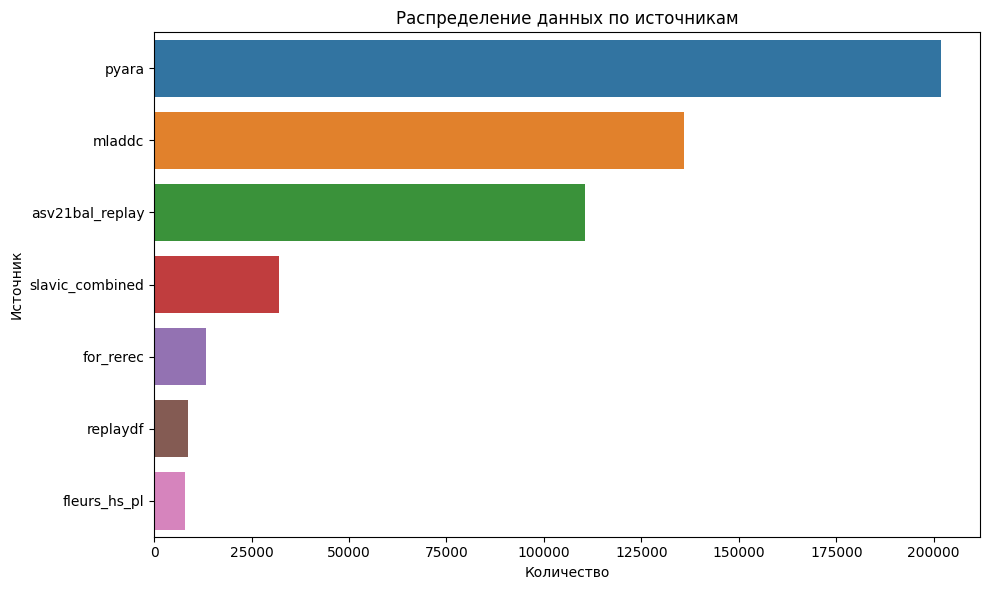

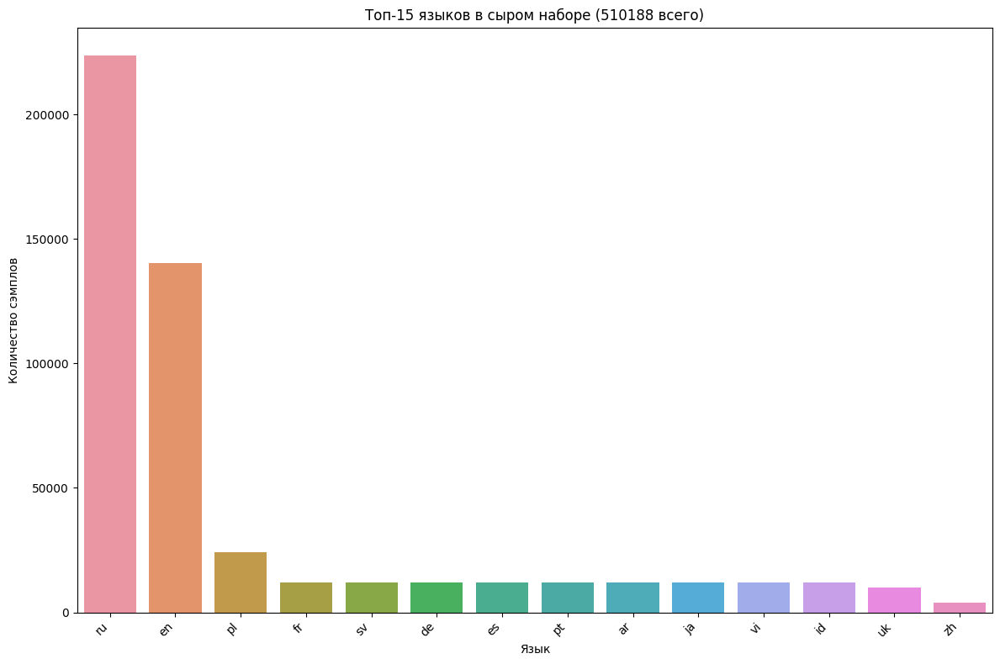

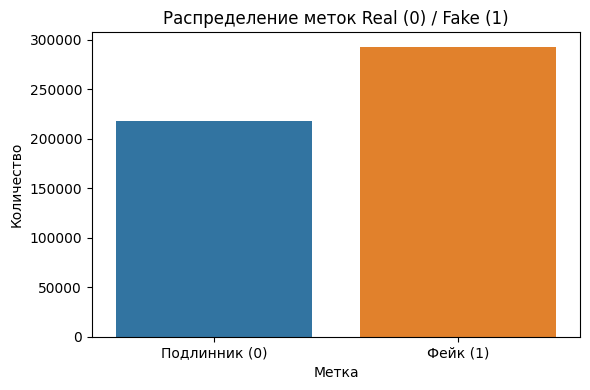

10594

In [15]:
print("--- Загрузка данных из ВСЕХ источников ---")
df_mladdc = prepare_mladdc_data(PATH_MLADDC_T2)
print(f"Загружено из MLADDC: {len(df_mladdc)} файлов")

df_slavic = prepare_slavic_data(PATH_SLAVIC_COMBINED)
print(f"Загружено из Slavic Combined: {len(df_slavic)} файлов")

df_pyara = prepare_pyara_data(PATH_PYARA_BASE, PYARA_METADATA_FILE)
print(f"Загружено из Pyara: {len(df_pyara)} файлов")

target_replay_langs = {"en", "pl"} 
df_replay = prepare_replaydf_data(PATH_REPLAYDF, target_languages=target_replay_langs)
print(f"Загружено из ReplayDF: {len(df_replay)} файлов")
if not df_replay.empty: print(f"  Языки в ReplayDF: {df_replay['language'].unique()}")

df_asv21_replay = prepare_asv21bal_replay_data(PATH_ASV21_REPLAY_BALANCED)
print(f"Загружено из ASVspoof 2021 Balanced Replay: {len(df_asv21_replay)} файлов")

df_fleurs = prepare_fleurs_hs_pl_data(PATH_FLEURS_HS)
print(f"Загружено из Fleurs-HS (Polish): {len(df_fleurs)} файлов")
if not df_fleurs.empty: print(f"  Метки в Fleurs-HS: {df_fleurs['label'].unique()}")

df_for = prepare_for_rerec_data(PATH_FOR_REREC_BASE)
print(f"Загружено из FoR-rerec: {len(df_for)} файлов")

# Объединение всех DataFrame'ов
all_dataframes_list = []
for df_name, df_source in [
    ("MLADDC", df_mladdc), ("SlavicCombined", df_slavic), ("Pyara", df_pyara),
    ("ReplayDF", df_replay), ("ASV21Replay", df_asv21_replay),
    ("FleursHS", df_fleurs), ("FoR-rerec", df_for)
]:
    if df_source is not None and not df_source.empty:
        print(f"Добавляется {df_name} с {len(df_source)} файлами.")
        all_dataframes_list.append(df_source)
    else:
        print(f"Датасет {df_name} пуст или не загружен, пропускается.")

if not all_dataframes_list:
    print("ОШИБКА: Ни один датасет не был успешно загружен. Проверьте пути и функции подготовки.")
    df_all_raw_combined = pd.DataFrame(columns=['path', 'label', 'language', 'source'])
else:
    df_all_raw_combined = pd.concat(all_dataframes_list, ignore_index=True)
    print(f"\n--- Общий сырой датасет (до удаления дубликатов) ---")
    print(f"Всего файлов: {len(df_all_raw_combined)}")
    
    df_all_raw_combined.drop_duplicates(subset=['path'], keep='first', inplace=True)
    print(f"Всего файлов после удаления дубликатов путей: {len(df_all_raw_combined)}")

    # Финальная проверка нормализации языков (на всякий случай, хотя она должна быть в prepare_... функциях)
    df_all_raw_combined['language'] = df_all_raw_combined['language'].apply(normalize_lang_code)

    print("\nСтатистика объединенного сырого датасета:")
    print("Распределение по источникам:")
    print(df_all_raw_combined['source'].value_counts())
    print("\nРаспределение по языкам (топ 20):")
    print(df_all_raw_combined['language'].value_counts().nlargest(20))
    print("\nРаспределение по меткам:")
    print(df_all_raw_combined['label'].value_counts())
    print(df_all_raw_combined['label'].value_counts(normalize=True))

    # EDA для df_all_raw_combined
    print("\n--- EDA для Сырого Объединенного Датасета ---")
    
    plt.figure(figsize=(10, 6))
    sns.countplot(y='source', data=df_all_raw_combined, order=df_all_raw_combined['source'].value_counts().index)
    plt.title('Распределение данных по источникам')
    plt.xlabel('Количество')
    plt.ylabel('Источник')
    plt.tight_layout()
    plt.savefig(PLOTS_ALL_SAVE_DIR / "eda_raw_source_distribution.png")
    plt.show()

    plt.figure(figsize=(12, 8))
    top_n_langs_raw = 15
    lang_counts_raw_plot = df_all_raw_combined['language'].value_counts().nlargest(top_n_langs_raw)
    sns.barplot(x=lang_counts_raw_plot.index, y=lang_counts_raw_plot.values)
    plt.title(f'Топ-{top_n_langs_raw} языков в сыром наборе ({len(df_all_raw_combined)} всего)')
    plt.xticks(rotation=45, ha="right")
    plt.ylabel('Количество сэмплов')
    plt.xlabel('Язык')
    plt.tight_layout()
    plt.savefig(PLOTS_ALL_SAVE_DIR / "eda_raw_language_distribution.png")
    plt.show()

    plt.figure(figsize=(6, 4))
    sns.countplot(x='label', data=df_all_raw_combined)
    plt.title('Распределение меток Real (0) / Fake (1)')
    plt.xlabel('Метка')
    plt.ylabel('Количество')
    plt.xticks([0,1], ['Подлинник (0)', 'Фейк (1)'])
    plt.tight_layout()
    plt.savefig(PLOTS_ALL_SAVE_DIR / "eda_raw_label_distribution.png")
    plt.show()

gc.collect()

In [16]:
train_df_for_model, val_df_for_model, test_df_for_model = [pd.DataFrame(columns=['path', 'label', 'language', 'source'])] * 3

if 'df_all_raw_combined' in locals() and not df_all_raw_combined.empty:
    print(f"\n--- Разделение df_all_raw_combined (размер: {len(df_all_raw_combined)}) на сплиты ---")

    current_df_to_split = df_all_raw_combined.copy() # Используем этот DataFrame
    
    # Временная колонка для стратификации (по языку и метке)
    current_df_to_split['stratify_col'] = current_df_to_split['language'] + "_" + current_df_to_split['label'].astype(str)
    
    stratify_on = None
    if current_df_to_split['stratify_col'].nunique() > 1 and \
       current_df_to_split['stratify_col'].value_counts().min() >= 2:
        stratify_on = current_df_to_split['stratify_col']
        print("Стратификация будет по языку и метке.")
    elif current_df_to_split['label'].nunique() > 1 and \
         current_df_to_split['label'].value_counts().min() >= 2:
        stratify_on = current_df_to_split['label']
        print("Стратификация будет только по метке.")
    else:
        print("Невозможно выполнить стратификацию, разделение без нее.")

    # 1. Отделяем тестовый набор
    if len(current_df_to_split) * FINAL_ALL_TEST_SIZE >= 2 and FINAL_ALL_TEST_SIZE > 0:
        remaining_df, test_df_for_model = train_test_split(
            current_df_to_split,
            test_size=FINAL_ALL_TEST_SIZE, # Используем FINAL_ALL_TEST_SIZE из Ячейки 2
            random_state=seed,
            stratify=stratify_on
        )
    else:
        print(f"  Недостаточно данных для тестового сплита или FINAL_ALL_TEST_SIZE=0.")
        remaining_df = current_df_to_split.copy()
        # test_df_for_model остается пустым

    # 2. Отделяем валидационный набор из оставшихся
    stratify_on_remaining = None
    if 'stratify_col' in remaining_df.columns: # Проверяем наличие колонки
        if remaining_df['stratify_col'].nunique() > 1 and \
           remaining_df['stratify_col'].value_counts().min() >= 2:
            stratify_on_remaining = remaining_df['stratify_col']
        elif remaining_df['label'].nunique() > 1 and \
             remaining_df['label'].value_counts().min() >= 2:
            stratify_on_remaining = remaining_df['label']
            
    if len(remaining_df) > 0 and FINAL_ALL_VAL_SIZE > 0:
        denominator = (1.0 - FINAL_ALL_TEST_SIZE) if FINAL_ALL_TEST_SIZE < 1.0 and FINAL_ALL_TEST_SIZE > 0 else 1.0
        if denominator <= 0: denominator = 1.0

        relative_val = FINAL_ALL_VAL_SIZE / denominator
        
        if len(remaining_df) * relative_val >= 2 and relative_val > 0 and relative_val < 1:
            train_df_for_model, val_df_for_model = train_test_split(
                remaining_df,
                test_size=relative_val,
                random_state=seed,
                stratify=stratify_on_remaining
            )
        else:
            print(f"  Недостаточно данных/некорректный размер для валидационного сплита. Train будет всем остатком.")
            train_df_for_model = remaining_df.copy()
    else:
        print(f"  Оставшийся DataFrame пуст или FINAL_ALL_VAL_SIZE=0. Train будет всем остатком.")
        train_df_for_model = remaining_df.copy()

    # Удаляем временную колонку стратификации
    for df_ in [train_df_for_model, val_df_for_model, test_df_for_model, current_df_to_split]:
        if 'stratify_col' in df_.columns:
            df_.drop(columns=['stratify_col'], inplace=True, errors='ignore')

    print(f"\nРазмеры финальных сплитов для модели:")
    print(f"Train: {len(train_df_for_model)}")
    print(f"Validation: {len(val_df_for_model)}")
    print(f"Test: {len(test_df_for_model)}")

    if not train_df_for_model.empty:
        train_df_for_model.to_csv("/kaggle/working/train_df_final_combined.csv", index=False)
        print("train_df_final_combined.csv сохранен.")
    if not val_df_for_model.empty:
        val_df_for_model.to_csv("/kaggle/working/val_df_final_combined.csv", index=False)
        print("val_df_final_combined.csv сохранен.")
    if not test_df_for_model.empty:
        test_df_for_model.to_csv("/kaggle/working/test_df_final_combined.csv", index=False)
        print("test_df_final_combined.csv сохранен.")

    for name, df_ in [("Train Model", train_df_for_model), ("Val Model", val_df_for_model), ("Test Model", test_df_for_model)]:
        if not df_.empty:
            print(f"\nКлассы в {name}:"); print(df_['label'].value_counts(normalize=True))
            print(f"Языки в {name} (топ 10):"); print(df_['language'].value_counts(normalize=True).nlargest(10))
else:
    print("Ошибка: df_all_balanced_final не найден или пуст. Разделение на сплиты невозможно.")

gc.collect()


--- Разделение df_all_raw_combined (размер: 510188) на сплиты ---


Стратификация будет по языку и метке.



Размеры финальных сплитов для модели:
Train: 357130
Validation: 76529
Test: 76529


train_df_final_combined.csv сохранен.


val_df_final_combined.csv сохранен.


test_df_final_combined.csv сохранен.

Классы в Train Model:
label
1    0.573883
0    0.426117
Name: proportion, dtype: float64
Языки в Train Model (топ 10):
language
ru    0.438616
en    0.274679
pl    0.047577
ar    0.023521
vi    0.023521
de    0.023521
es    0.023521
pt    0.023521
id    0.023521
sv    0.023521
Name: proportion, dtype: float64

Классы в Val Model:
label
1    0.573874
0    0.426126
Name: proportion, dtype: float64
Языки в Val Model (топ 10):
language
ru    0.438631
en    0.274667
pl    0.047577
pt    0.023520
fr    0.023520
de    0.023520
ja    0.023520
ar    0.023520
vi    0.023520
id    0.023520
Name: proportion, dtype: float64

Классы в Test Model:
label
1    0.573874
0    0.426126
Name: proportion, dtype: float64
Языки в Test Model (топ 10):
language
ru    0.438618
en    0.274667
pl    0.047590
ja    0.023520
pt    0.023520
es    0.023520
sv    0.023520
vi    0.023520
id    0.023520
de    0.023520
Name: proportion, dtype: float64


0

In [17]:
class CombinedAudioDataset(Dataset):
    def __init__(self, dataframe, num_samples, target_sample_rate=SAMPLE_RATE, transform=None):
        super().__init__()
        if not isinstance(dataframe, pd.DataFrame) or not {'path', 'label'}.issubset(dataframe.columns):
             raise ValueError("Input 'dataframe' должен быть pandas DataFrame с колонками 'path' и 'label'.")

        self.paths = dataframe['path'].tolist()
        self.labels = dataframe['label'].tolist()
        self.num_samples = num_samples
        self.target_sample_rate = target_sample_rate
        self.transform = transform
        self.resampler_cache = {}

        # Отладочная информация
        # dataset_name_for_debug = "Unknown"
        # if 'train_df_combined' in globals() and dataframe.equals(train_df_combined): dataset_name_for_debug = "Train_Combined"
        # elif 'val_df_combined' in globals() and dataframe.equals(val_df_combined): dataset_name_for_debug = "Val_Combined"
        # elif 'test_df_combined' in globals() and dataframe.equals(test_df_combined): dataset_name_for_debug = "Test_Combined"
        # print(f"\n--- CombinedAudioDataset Инициализация для {dataset_name_for_debug} ---")
        # print(f"  Получено {len(self.labels)} меток.")
        # if self.labels:
        #     unique_labels, counts = np.unique(self.labels, return_counts=True)
        #     print(f"  Уникальные метки в self.labels: {unique_labels}, Количество: {counts}")

        print(f"CombinedAudioDataset создан с {len(self.paths)} сэмплами.")


    def __len__(self):
        return len(self.paths)

    def __getitem__(self, index):
        audio_path = self.paths[index]
        label = self.labels[index]
        try:
            signal, sr = torchaudio.load(audio_path)
            if sr != self.target_sample_rate:
                if sr not in self.resampler_cache:
                    self.resampler_cache[sr] = torchaudio.transforms.Resample(sr, self.target_sample_rate, dtype=signal.dtype)
                signal = self.resampler_cache[sr](signal)
            if signal.shape[0] > 1:
                signal = torch.mean(signal, dim=0, keepdim=True)
            signal = self._cut_or_pad(signal)
            signal = signal.squeeze(0) # Убираем размерность канала -> [num_samples]
            if self.transform:
                signal = self.transform(signal.unsqueeze(0)).squeeze(0)
            return signal, label
        except Exception as e:
            # print(f"Ошибка загрузки/обработки файла {audio_path}: {e}") # Раскомментировать для отладки
            return None, None # Важно для collate_fn

    def _cut_or_pad(self, signal):
        length = signal.shape[1]
        if length > self.num_samples:
            max_start = length - self.num_samples
            start = random.randint(0, max_start)
            signal = signal[:, start:start + self.num_samples]
        elif length < self.num_samples:
            pad_last_dim = (0, self.num_samples - length)
            signal = torch.nn.functional.pad(signal, pad_last_dim)
        return signal

In [18]:
def collate_fn_custom(batch):
    batch = [b for b in batch if b is not None and b[0] is not None and b[1] is not None]
    if not batch:
        return None, None # Если батч пуст после фильтрации

    signals, labels = zip(*batch)
    try:
        signals = torch.stack(signals)
    except Exception as e:
        print(f"Ошибка при стакинге сигналов в collate_fn: {e}")
        return None, None
    labels = torch.tensor(labels, dtype=torch.float)
    return signals, labels

In [19]:
train_loader_final_combined, val_loader_final_combined, test_loader_final_combined = None, None, None
sampler_final_combined_train = None

if 'train_df_for_model' in locals() and not train_df_for_model.empty:
    train_dataset_final_combined = CombinedAudioDataset(train_df_for_model, NUM_SAMPLES, SAMPLE_RATE)
    print(f"\nTrain Dataset (final combined) создан: {len(train_dataset_final_combined)} сэмплов.")
    
    if train_dataset_final_combined and len(train_dataset_final_combined.labels) > 0:
        labels_arr = np.array(train_dataset_final_combined.labels).astype(int)
        counts = np.bincount(labels_arr)
        if len(counts) > 1 and np.all(counts > 0):
            weights_val = len(labels_arr) / (len(counts) * counts)
            sample_w = weights_val[labels_arr]
            sampler_final_combined_train = WeightedRandomSampler(torch.from_numpy(sample_w).double(), len(sample_w), replacement=True)
            print(f"Для Final Combined Train используется WeightedRandomSampler. Веса: {weights_val}")
        else:
            print(f"WeightedRandomSampler для Final Combined Train не используется. Распределение: {counts}")
            
    train_loader_final_combined = DataLoader(
        train_dataset_final_combined, batch_size=FINAL_ALL_BATCH_SIZE, sampler=sampler_final_combined_train,
        collate_fn=collate_fn_custom, num_workers=NUM_WORKERS, pin_memory=(device.type == 'cuda'),
        shuffle=(sampler_final_combined_train is None), drop_last=(sampler_final_combined_train is not None)
    )
    if train_loader_final_combined: print(f"Train DataLoader (final combined) создан: ~{len(train_loader_final_combined)} батчей.")
else:
    print("train_df_for_model пуст. Train DataLoader (final combined) не создан.")

if 'val_df_for_model' in locals() and not val_df_for_model.empty:
    val_dataset_final_combined = CombinedAudioDataset(val_df_for_model, NUM_SAMPLES, SAMPLE_RATE)
    val_loader_final_combined = DataLoader(
        val_dataset_final_combined, batch_size=FINAL_ALL_BATCH_SIZE, shuffle=False,
        collate_fn=collate_fn_custom, num_workers=NUM_WORKERS, pin_memory=(device.type == 'cuda')
    )
    if val_loader_final_combined: print(f"Validation DataLoader (final combined) создан: {len(val_loader_final_combined)} батчей.")
else:
    print("val_df_for_model пуст. Validation DataLoader (final combined) не создан.")

if 'test_df_for_model' in locals() and not test_df_for_model.empty:
    test_dataset_final_combined = CombinedAudioDataset(test_df_for_model, NUM_SAMPLES, SAMPLE_RATE)
    test_loader_final_combined = DataLoader(
        test_dataset_final_combined, batch_size=FINAL_ALL_BATCH_SIZE, shuffle=False,
        collate_fn=collate_fn_custom, num_workers=NUM_WORKERS, pin_memory=(device.type == 'cuda')
    )
    if test_loader_final_combined: print(f"Test DataLoader (final combined) создан: {len(test_loader_final_combined)} батчей.")
else:
    print("test_df_for_model пуст. Test DataLoader (final combined) не создан.")

gc.collect()

CombinedAudioDataset создан с 357130 сэмплами.

Train Dataset (final combined) создан: 357130 сэмплов.
Для Final Combined Train используется WeightedRandomSampler. Веса: [1.17338792 0.87125703]
Train DataLoader (final combined) создан: ~11160 батчей.
CombinedAudioDataset создан с 76529 сэмплами.
Validation DataLoader (final combined) создан: 2392 батчей.
CombinedAudioDataset создан с 76529 сэмплами.
Test DataLoader (final combined) создан: 2392 батчей.


0

In [20]:
model_final_all_data = CustomWavLMForClassification(checkpoint_hf=MODEL_CHECKPOINT_HF).to(device)

# Загружаем веса из вашей ЛУЧШЕЙ ПРЕДЫДУЩЕЙ МОДЕЛИ
if BASE_MODEL_CHECKPOINT_PATH.exists(): 
    print(f"\nЗагрузка весов из базовой модели: {BASE_MODEL_CHECKPOINT_PATH}")
    try:
        base_model_state = torch.load(BASE_MODEL_CHECKPOINT_PATH, map_location=device, weights_only=False) # weights_only=False для совместимости
        if 'model_state_dict' in base_model_state:
            model_final_all_data.load_state_dict(base_model_state['model_state_dict'], strict=False)
        else:
            model_final_all_data.load_state_dict(base_model_state, strict=False)
        print(f"Веса из {BASE_MODEL_CHECKPOINT_PATH} успешно загружены в модель для финального обучения.")
    except Exception as e:
        print(f"Ошибка при загрузке весов из {BASE_MODEL_CHECKPOINT_PATH}: {e}")
        print("Модель будет использовать веса, инициализированные из Hugging Face.")
else:
    print(f"Файл базовой модели {BASE_MODEL_CHECKPOINT_PATH} не найден. Модель будет с Hugging Face весами.")

criterion_final_all = nn.BCEWithLogitsLoss()
if 'train_df_for_model' in locals() and not train_df_for_model.empty:
    real_c = (train_df_for_model['label'] == 0).sum()
    fake_c = (train_df_for_model['label'] == 1).sum()
    if fake_c > 0 and real_c > 0:
        pos_w = real_c / fake_c
        if not (0.95 < pos_w < 1.05): 
            criterion_final_all = nn.BCEWithLogitsLoss(pos_weight=torch.tensor([pos_w], device=device))
            print(f"Для Final All Data используется BCEWithLogitsLoss с pos_weight = {pos_w:.4f}")
        else:
            print(f"Для Final All Data используется BCEWithLogitsLoss (pos_weight ~1.0).")

optimizer_final_all = optim.AdamW(model_final_all_data.parameters(), lr=FINAL_ALL_LEARNING_RATE, weight_decay=FINAL_ALL_WEIGHT_DECAY)
scaler_final_all = torch.cuda.amp.GradScaler(enabled=(device.type == 'cuda'))
scheduler_final_all = optim.lr_scheduler.ReduceLROnPlateau(optimizer_final_all, mode='min', factor=0.2, patience=1, verbose=True)

print(f"\nМодель готова к дообучению на ФИНАЛЬНОМ ОБЪЕДИНЕННОМ датасете.")

Инициализация CustomWavLMForClassification с HuggingFace чекпоинтом: microsoft/wavlm-base


config.json:   0%|          | 0.00/2.24k [00:00<?, ?B/s]

2025-06-04 07:50:25.357456: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749023425.540917      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749023425.593430      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


pytorch_model.bin:   0%|          | 0.00/378M [00:00<?, ?B/s]


Загрузка весов из базовой модели: /kaggle/input/final-checkpoint/pytorch/default/1/checkpoint_final_all_data_v2.pth


model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

Веса из /kaggle/input/final-checkpoint/pytorch/default/1/checkpoint_final_all_data_v2.pth успешно загружены в модель для финального обучения.
Для Final All Data используется BCEWithLogitsLoss с pos_weight = 0.7425

Модель готова к дообучению на ФИНАЛЬНОМ ОБЪЕДИНЕННОМ датасете.


/tmp/ipykernel_19/429576339.py:32: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler_final_all = torch.cuda.amp.GradScaler(enabled=(device.type == 'cuda'))


In [21]:
def train_epoch_custom(model, dataloader, criterion, optimizer, device, scaler, accumulation_steps, current_epoch_display=""):
    model.train()
    train_loss_epoch = 0.0
    train_outputs_epoch = []
    train_labels_epoch = []
    batches_processed_train = 0
    desc_str = f"Тренировка Эпоха {current_epoch_display}"
    train_pbar = tqdm(enumerate(dataloader), total=len(dataloader), desc=desc_str, leave=False)
    optimizer.zero_grad()

    for i, batch in train_pbar:
        if batch is None or batch[0] is None or batch[1] is None:
            # print(f"Пропущен невалидный батч {i} в train_epoch_custom")
            continue
        waveforms, labels = batch # collate_fn_custom уже вернул тензоры
        waveforms = waveforms.to(device)
        labels = labels.to(device)

        with torch.autocast(device_type=device.type, dtype=torch.float16 if device.type == 'cuda' else torch.bfloat16, enabled=scaler.is_enabled()):
            outputs = model(waveforms)
            loss = criterion(outputs, labels)

        if torch.isnan(loss):
            print(f"Внимание: NaN лосс на трейне, батч {i}. Пропуск обновления.")
            optimizer.zero_grad()
            if device.type == 'cuda': torch.cuda.empty_cache()
            continue

        loss_scaled = loss / accumulation_steps
        if scaler.is_enabled():
            scaler.scale(loss_scaled).backward()
        else:
            loss_scaled.backward()

        train_outputs_epoch.extend(outputs.detach().cpu().numpy())
        train_labels_epoch.extend(labels.detach().cpu().numpy())
        train_loss_epoch += loss.item()
        batches_processed_train += 1

        if (i + 1) % accumulation_steps == 0 or (i + 1) == len(dataloader):
            if scaler.is_enabled(): scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            if scaler.is_enabled():
                scaler.step(optimizer)
                scaler.update()
            else:
                optimizer.step()
            optimizer.zero_grad()

        train_pbar.set_postfix(loss=f'{loss.item():.4f}', lr=f'{optimizer.param_groups[0]["lr"]:.1e}')
        del waveforms, labels, outputs, loss, loss_scaled
        if i % 200 == 0: gc.collect(); torch.cuda.empty_cache() # Чаще чистим для больших датасетов

    if batches_processed_train == 0:
        print("Внимание: Ни один батч не был обработан в train_epoch_custom.")
        return 0.0, 0.0, 1.0

    avg_train_loss = train_loss_epoch / batches_processed_train
    train_labels_np = np.array(train_labels_epoch)
    train_outputs_np = np.array(train_outputs_epoch)

    if len(train_labels_np) == 0: return 0.0, 0.0, 1.0
    train_preds_binary = (train_outputs_np > 0).astype(int)
    train_acc = np.mean(train_preds_binary == train_labels_np) * 100
    train_eer_val = 1.0
    if len(np.unique(train_labels_np)) > 1 :
        try: train_eer_val = EER(train_labels_np, train_outputs_np)
        except ValueError as e: print(f"Ошибка EER на трейне: {e}")
    return avg_train_loss, train_acc, train_eer_val

def validate_custom(model, dataloader, criterion, device, desc_prefix="Валидация"):
    model.eval()
    val_loss_epoch = 0.0
    val_outputs_epoch = []
    val_labels_epoch = []
    batches_processed_val = 0
    val_pbar = tqdm(dataloader, desc=desc_prefix, leave=False)

    with torch.no_grad():
        for batch in val_pbar:
            if batch is None or batch[0] is None or batch[1] is None: continue
            waveforms, labels = batch
            waveforms = waveforms.to(device)
            labels = labels.to(device)
            with torch.autocast(device_type=device.type, dtype=torch.float16 if device.type == 'cuda' else torch.bfloat16, enabled=(device.type == 'cuda')):
                outputs = model(waveforms)
                try: loss = criterion(outputs, labels)
                except Exception as e: loss = torch.tensor(float('nan'))
            if torch.isnan(loss):
                 print(f"Внимание: NaN лосс на {desc_prefix}. Пропуск батча.")
                 continue
            val_outputs_epoch.extend(outputs.cpu().numpy())
            val_labels_epoch.extend(labels.cpu().numpy())
            val_loss_epoch += loss.item()
            batches_processed_val += 1
            val_pbar.set_postfix(loss=f'{loss.item():.4f}')
            del waveforms, labels, outputs, loss
            if device.type == 'cuda': torch.cuda.empty_cache()

    if batches_processed_val == 0:
        print(f"Внимание: Ни один батч не был обработан в {desc_prefix}.")
        return 0.0, 0.0, 1.0, np.array([]), np.array([])

    avg_val_loss = val_loss_epoch / batches_processed_val
    val_labels_np = np.array(val_labels_epoch)
    val_outputs_np = np.array(val_outputs_epoch)

    if len(val_labels_np) == 0: return 0.0, 0.0, 1.0, np.array([]), np.array([])
    val_preds_binary = (val_outputs_np > 0).astype(int)
    val_acc = np.mean(val_preds_binary == val_labels_np) * 100
    val_eer_val = 1.0
    if len(np.unique(val_labels_np)) > 1:
        try: val_eer_val = EER(val_labels_np, val_outputs_np)
        except ValueError as e: print(f"Ошибка EER на {desc_prefix}: {e}")
    return avg_val_loss, val_acc, val_eer_val, val_labels_np, val_outputs_np

print("Функции обучения и валидации определены.")


Функции обучения и валидации определены.


In [22]:
if 'train_loader_final_combined' in locals() and train_loader_final_combined and \
   'val_loader_final_combined' in locals() and val_loader_final_combined and \
   'model_final_all_data' in locals():
    
    print("\n--- Начало ФИНАЛЬНОГО дообучения модели на ВСЕХ данных ---")
    start_epoch_final_all = 0
    best_val_eer_final_all = float('inf') 
    history_final_all = {'train_loss': [], 'val_loss': [], 'train_acc': [], 'val_acc': [], 'train_eer': [], 'val_eer': []}

    if FINAL_ALL_CHECKPOINT_PATH.exists():
        print(f"Найден чекпоинт: {FINAL_ALL_CHECKPOINT_PATH}")
        try:
            checkpoint = torch.load(FINAL_ALL_CHECKPOINT_PATH, map_location=device)
            model_final_all_data.load_state_dict(checkpoint['model_state_dict'])
            optimizer_final_all.load_state_dict(checkpoint['optimizer_state_dict'])
            scheduler_final_all.load_state_dict(checkpoint['scheduler_state_dict'])
            if scaler_final_all and 'scaler_state_dict' in checkpoint and checkpoint['scaler_state_dict']:
                 scaler_final_all.load_state_dict(checkpoint['scaler_state_dict'])
            start_epoch_final_all = checkpoint.get('epoch', 0)
            best_val_eer_final_all = checkpoint.get('best_val_eer', float('inf'))
            history_final_all = checkpoint.get('history', history_final_all)
            print(f"Чекпоинт загружен. Продолжение с эпохи {start_epoch_final_all + 1}.")
        except Exception as e:
            print(f"Ошибка загрузки чекпоинта: {e}. Обучение с нуля.")
            start_epoch_final_all = 0; best_val_eer_final_all = float('inf')
            history_final_all = {'train_loss': [], 'val_loss': [], 'train_acc': [], 'val_acc': [], 'train_eer': [], 'val_eer': []}
    else:
        print(f"Чекпоинт {FINAL_ALL_CHECKPOINT_PATH} не найден. Обучение с нуля.")

    for epoch_idx in range(start_epoch_final_all, FINAL_ALL_NUM_EPOCHS):
        current_epoch = epoch_idx + 1
        print(f"\n--- FINAL ALL Fine-tuning: Эпоха {current_epoch}/{FINAL_ALL_NUM_EPOCHS} ---")
        
        avg_train_loss, train_acc, train_eer = train_epoch_custom(
            model_final_all_data, train_loader_final_combined, criterion_final_all, 
            optimizer_final_all, device, scaler_final_all, 
            GRADIENT_ACCUMULATION_STEPS, current_epoch
        )
        # ... (обновление history_final_all для train) ...
        if len(history_final_all['train_loss']) > epoch_idx:
            history_final_all['train_loss'][epoch_idx] = avg_train_loss; history_final_all['train_acc'][epoch_idx] = train_acc; history_final_all['train_eer'][epoch_idx] = train_eer
        else:
            history_final_all['train_loss'].append(avg_train_loss); history_final_all['train_acc'].append(train_acc); history_final_all['train_eer'].append(train_eer)

        avg_val_loss, val_acc, val_eer, _, _ = validate_custom(
            model_final_all_data, val_loader_final_combined, criterion_final_all, device,
            desc_prefix=f"Валидация Final All Эпоха {current_epoch}"
        )
        # ... (обновление history_final_all для val) ...
        if len(history_final_all['val_loss']) > epoch_idx:
            history_final_all['val_loss'][epoch_idx] = avg_val_loss; history_final_all['val_acc'][epoch_idx] = val_acc; history_final_all['val_eer'][epoch_idx] = val_eer
        else:
            history_final_all['val_loss'].append(avg_val_loss); history_final_all['val_acc'].append(val_acc); history_final_all['val_eer'].append(val_eer)
        
        print(f"Итоги Эпохи {current_epoch} (Final All): T(L:{avg_train_loss:.4f} A:{train_acc:.2f}% EER:{train_eer:.4f}), V(L:{avg_val_loss:.4f} A:{val_acc:.2f}% EER:{val_eer:.4f})")
        scheduler_final_all.step(val_eer)

        if val_eer < best_val_eer_final_all:
            best_val_eer_final_all = val_eer
            print(f"  ---> Новый лучший Val EER (Final All): {best_val_eer_final_all:.4f}. Сохранение...")
            torch.save(model_final_all_data.state_dict(), FINAL_ALL_MODEL_SAVE_PATH)
        
        checkpoint_save_data_all = {
            'epoch': epoch_idx + 1, 'model_state_dict': model_final_all_data.state_dict(),
            'optimizer_state_dict': optimizer_final_all.state_dict(),
            'scheduler_state_dict': scheduler_final_all.state_dict(),
            'scaler_state_dict': scaler_final_all.state_dict() if scaler_final_all else None,
            'best_val_eer': best_val_eer_final_all, 'history': history_final_all
        }
        torch.save(checkpoint_save_data_all, FINAL_ALL_CHECKPOINT_PATH)
        print(f"Чекпоинт (Final All) сохранен: {FINAL_ALL_CHECKPOINT_PATH}")

    print("\n--- ФИНАЛЬНОЕ Дообучение на ВСЕХ данных завершено ---")
    with open(FINAL_ALL_HISTORY_SAVE_PATH, 'w') as f: json.dump(history_final_all, f, indent=4)
    if history_final_all.get('train_loss'): 
        plot_training_history(
            history_final_all, 
            title_prefix="Final All Data Fine-tuning",
            save_path = PLOTS_ALL_SAVE_DIR / f"{FINAL_ALL_HISTORY_SAVE_PATH.stem}_summary.png"
        )
else:
    print("ФИНАЛЬНОЕ Обучение не запущено (нет train_loader_final_combined или val_loader_final_combined).")
gc.collect(); torch.cuda.empty_cache()


--- Начало ФИНАЛЬНОГО дообучения модели на ВСЕХ данных ---
Чекпоинт /kaggle/working/checkpoint_final_all_data_v2.pth не найден. Обучение с нуля.

--- FINAL ALL Fine-tuning: Эпоха 1/5 ---


Тренировка Эпоха 1:   0%|          | 0/11160 [00:00<?, ?it/s]

Тренировка Эпоха 1:   0%|          | 0/11160 [00:38<?, ?it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 1/11160 [00:39<122:39:38, 39.57s/it, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 1/11160 [00:40<122:39:38, 39.57s/it, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 2/11160 [00:40<52:24:23, 16.91s/it, loss=0.0857, lr=1.0e-06] 

Тренировка Эпоха 1:   0%|          | 2/11160 [00:41<52:24:23, 16.91s/it, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 3/11160 [00:41<29:50:43,  9.63s/it, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 3/11160 [00:42<29:50:43,  9.63s/it, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 4/11160 [00:42<19:15:22,  6.21s/it, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 4/11160 [00:43<19:15:22,  6.21s/it, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 5/11160 [00:43<13:23:35,  4.32s/it, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 5/11160 [00:44<13:23:35,  4.32s/it, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 6/11160 [00:44<9:56:21,  3.21s/it, loss=0.0649, lr=1.0e-06] 

Тренировка Эпоха 1:   0%|          | 6/11160 [00:45<9:56:21,  3.21s/it, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 7/11160 [00:45<7:40:21,  2.48s/it, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 7/11160 [00:46<7:40:21,  2.48s/it, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 8/11160 [00:46<6:09:30,  1.99s/it, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 8/11160 [00:47<6:09:30,  1.99s/it, loss=0.2488, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 9/11160 [00:47<5:10:08,  1.67s/it, loss=0.2488, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 9/11160 [00:48<5:10:08,  1.67s/it, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 10/11160 [00:48<4:28:32,  1.45s/it, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 10/11160 [00:49<4:28:32,  1.45s/it, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 11/11160 [00:49<4:01:17,  1.30s/it, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 11/11160 [00:50<4:01:17,  1.30s/it, loss=0.2189, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 12/11160 [00:50<3:37:16,  1.17s/it, loss=0.2189, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 12/11160 [00:51<3:37:16,  1.17s/it, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 13/11160 [00:51<3:25:48,  1.11s/it, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 13/11160 [00:52<3:25:48,  1.11s/it, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 14/11160 [00:52<3:13:34,  1.04s/it, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 14/11160 [00:52<3:13:34,  1.04s/it, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 15/11160 [00:52<3:03:36,  1.01it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 15/11160 [00:53<3:03:36,  1.01it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 16/11160 [00:53<3:03:42,  1.01it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 16/11160 [00:54<3:03:42,  1.01it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 17/11160 [00:54<2:59:35,  1.03it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 17/11160 [00:55<2:59:35,  1.03it/s, loss=0.2059, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 18/11160 [00:55<3:00:53,  1.03it/s, loss=0.2059, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 18/11160 [00:56<3:00:53,  1.03it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 19/11160 [00:56<3:00:26,  1.03it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 19/11160 [00:57<3:00:26,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 20/11160 [00:57<2:58:40,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 20/11160 [00:58<2:58:40,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 21/11160 [00:58<2:56:04,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 21/11160 [00:59<2:56:04,  1.05it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 22/11160 [00:59<2:52:52,  1.07it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 22/11160 [01:00<2:52:52,  1.07it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 23/11160 [01:00<2:54:46,  1.06it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 23/11160 [01:01<2:54:46,  1.06it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 24/11160 [01:01<2:57:35,  1.05it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 24/11160 [01:02<2:57:35,  1.05it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 25/11160 [01:02<2:58:04,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 25/11160 [01:03<2:58:04,  1.04it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 26/11160 [01:03<2:57:06,  1.05it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 26/11160 [01:04<2:57:06,  1.05it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 27/11160 [01:04<2:57:45,  1.04it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 27/11160 [01:05<2:57:45,  1.04it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 28/11160 [01:05<2:56:44,  1.05it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 28/11160 [01:06<2:56:44,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 29/11160 [01:06<2:54:41,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 29/11160 [01:07<2:54:41,  1.06it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 30/11160 [01:07<2:53:42,  1.07it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 30/11160 [01:08<2:53:42,  1.07it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 31/11160 [01:08<2:52:33,  1.07it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 31/11160 [01:09<2:52:33,  1.07it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 32/11160 [01:09<2:53:04,  1.07it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 32/11160 [01:10<2:53:04,  1.07it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 33/11160 [01:10<2:54:53,  1.06it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 33/11160 [01:10<2:54:53,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 34/11160 [01:10<2:54:43,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 34/11160 [01:11<2:54:43,  1.06it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 35/11160 [01:11<2:53:15,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 35/11160 [01:12<2:53:15,  1.07it/s, loss=0.3040, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 36/11160 [01:12<2:56:22,  1.05it/s, loss=0.3040, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 36/11160 [01:13<2:56:22,  1.05it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 37/11160 [01:13<2:51:34,  1.08it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 37/11160 [01:14<2:51:34,  1.08it/s, loss=0.3305, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 38/11160 [01:14<2:52:15,  1.08it/s, loss=0.3305, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 38/11160 [01:15<2:52:15,  1.08it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 39/11160 [01:15<2:51:31,  1.08it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 39/11160 [01:16<2:51:31,  1.08it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 40/11160 [01:16<2:55:09,  1.06it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 40/11160 [01:17<2:55:09,  1.06it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 41/11160 [01:17<2:53:33,  1.07it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 41/11160 [01:18<2:53:33,  1.07it/s, loss=0.2108, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 42/11160 [01:18<2:53:45,  1.07it/s, loss=0.2108, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 42/11160 [01:19<2:53:45,  1.07it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 43/11160 [01:19<2:55:19,  1.06it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 43/11160 [01:20<2:55:19,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 44/11160 [01:20<2:57:49,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 44/11160 [01:21<2:57:49,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 45/11160 [01:21<2:52:38,  1.07it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 45/11160 [01:22<2:52:38,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 46/11160 [01:22<2:55:52,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 46/11160 [01:23<2:55:52,  1.05it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 47/11160 [01:23<2:53:59,  1.06it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 47/11160 [01:24<2:53:59,  1.06it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 48/11160 [01:24<2:56:49,  1.05it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 48/11160 [01:25<2:56:49,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 49/11160 [01:25<2:54:35,  1.06it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 49/11160 [01:25<2:54:35,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 50/11160 [01:25<2:51:32,  1.08it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 50/11160 [01:26<2:51:32,  1.08it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 51/11160 [01:26<2:53:44,  1.07it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 51/11160 [01:27<2:53:44,  1.07it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 52/11160 [01:27<2:53:51,  1.06it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 52/11160 [01:28<2:53:51,  1.06it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 53/11160 [01:28<2:52:31,  1.07it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 53/11160 [01:29<2:52:31,  1.07it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 54/11160 [01:29<2:55:44,  1.05it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 54/11160 [01:30<2:55:44,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 55/11160 [01:30<2:56:42,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:   0%|          | 55/11160 [01:31<2:56:42,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 56/11160 [01:31<2:58:43,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 56/11160 [01:32<2:58:43,  1.04it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 57/11160 [01:32<2:58:43,  1.04it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 57/11160 [01:33<2:58:43,  1.04it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 58/11160 [01:33<3:00:06,  1.03it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 58/11160 [01:34<3:00:06,  1.03it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 59/11160 [01:34<2:59:41,  1.03it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 59/11160 [01:35<2:59:41,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 60/11160 [01:35<3:00:47,  1.02it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 60/11160 [01:36<3:00:47,  1.02it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 61/11160 [01:36<3:00:05,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 61/11160 [01:37<3:00:05,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 62/11160 [01:37<2:58:19,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 62/11160 [01:38<2:58:19,  1.04it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 63/11160 [01:38<2:58:27,  1.04it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 63/11160 [01:39<2:58:27,  1.04it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 64/11160 [01:39<2:57:05,  1.04it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 64/11160 [01:40<2:57:05,  1.04it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 65/11160 [01:40<2:57:33,  1.04it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 65/11160 [01:41<2:57:33,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 66/11160 [01:41<2:59:13,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 66/11160 [01:42<2:59:13,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 67/11160 [01:42<2:56:16,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 67/11160 [01:43<2:56:16,  1.05it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 68/11160 [01:43<2:55:38,  1.05it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 68/11160 [01:44<2:55:38,  1.05it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 69/11160 [01:44<2:56:31,  1.05it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 69/11160 [01:45<2:56:31,  1.05it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 70/11160 [01:45<2:58:31,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 70/11160 [01:46<2:58:31,  1.04it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 71/11160 [01:46<2:58:37,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 71/11160 [01:47<2:58:37,  1.03it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 72/11160 [01:47<3:00:04,  1.03it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 72/11160 [01:48<3:00:04,  1.03it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 73/11160 [01:48<2:59:45,  1.03it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 73/11160 [01:49<2:59:45,  1.03it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 74/11160 [01:49<3:00:42,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 74/11160 [01:50<3:00:42,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 75/11160 [01:50<3:00:08,  1.03it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 75/11160 [01:51<3:00:08,  1.03it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 76/11160 [01:51<3:00:22,  1.02it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 76/11160 [01:52<3:00:22,  1.02it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 77/11160 [01:52<2:57:10,  1.04it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 77/11160 [01:52<2:57:10,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 78/11160 [01:52<2:56:16,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 78/11160 [01:53<2:56:16,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 79/11160 [01:53<2:56:56,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 79/11160 [01:54<2:56:56,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 80/11160 [01:54<2:56:00,  1.05it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 80/11160 [01:55<2:56:00,  1.05it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 81/11160 [01:55<2:51:10,  1.08it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 81/11160 [01:56<2:51:10,  1.08it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 82/11160 [01:56<2:49:08,  1.09it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 82/11160 [01:57<2:49:08,  1.09it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 83/11160 [01:57<2:49:10,  1.09it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 83/11160 [01:58<2:49:10,  1.09it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 84/11160 [01:58<2:53:21,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 84/11160 [01:59<2:53:21,  1.06it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 85/11160 [01:59<2:49:18,  1.09it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 85/11160 [02:00<2:49:18,  1.09it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 86/11160 [02:00<2:53:25,  1.06it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 86/11160 [02:01<2:53:25,  1.06it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 87/11160 [02:01<2:52:03,  1.07it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 87/11160 [02:02<2:52:03,  1.07it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 88/11160 [02:02<2:55:13,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 88/11160 [02:03<2:55:13,  1.05it/s, loss=0.2027, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 89/11160 [02:03<2:50:35,  1.08it/s, loss=0.2027, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 89/11160 [02:04<2:50:35,  1.08it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 90/11160 [02:04<2:48:40,  1.09it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 90/11160 [02:05<2:48:40,  1.09it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 91/11160 [02:05<2:51:35,  1.08it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 91/11160 [02:05<2:51:35,  1.08it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 92/11160 [02:05<2:54:56,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 92/11160 [02:06<2:54:56,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 93/11160 [02:06<2:55:55,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 93/11160 [02:07<2:55:55,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 94/11160 [02:07<2:55:10,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 94/11160 [02:08<2:55:10,  1.05it/s, loss=0.2739, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 95/11160 [02:08<2:56:06,  1.05it/s, loss=0.2739, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 95/11160 [02:09<2:56:06,  1.05it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 96/11160 [02:09<2:55:22,  1.05it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 96/11160 [02:10<2:55:22,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 97/11160 [02:10<2:50:40,  1.08it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 97/11160 [02:11<2:50:40,  1.08it/s, loss=0.2404, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 98/11160 [02:11<2:54:20,  1.06it/s, loss=0.2404, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 98/11160 [02:12<2:54:20,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 99/11160 [02:12<2:52:41,  1.07it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 99/11160 [02:13<2:52:41,  1.07it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 100/11160 [02:13<2:52:58,  1.07it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 100/11160 [02:14<2:52:58,  1.07it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 101/11160 [02:14<2:51:45,  1.07it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 101/11160 [02:15<2:51:45,  1.07it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 102/11160 [02:15<2:52:16,  1.07it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 102/11160 [02:16<2:52:16,  1.07it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 103/11160 [02:16<2:54:03,  1.06it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 103/11160 [02:17<2:54:03,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 104/11160 [02:17<2:56:43,  1.04it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 104/11160 [02:18<2:56:43,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 105/11160 [02:18<2:57:12,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 105/11160 [02:19<2:57:12,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 106/11160 [02:19<2:56:02,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 106/11160 [02:20<2:56:02,  1.05it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 107/11160 [02:20<2:48:21,  1.09it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 107/11160 [02:21<2:48:21,  1.09it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 108/11160 [02:21<2:52:36,  1.07it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 108/11160 [02:22<2:52:36,  1.07it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 109/11160 [02:22<2:54:14,  1.06it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 109/11160 [02:23<2:54:14,  1.06it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 110/11160 [02:23<2:56:54,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 110/11160 [02:23<2:56:54,  1.04it/s, loss=0.2931, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 111/11160 [02:23<2:54:26,  1.06it/s, loss=0.2931, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 111/11160 [02:24<2:54:26,  1.06it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 112/11160 [02:24<2:54:05,  1.06it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 112/11160 [02:25<2:54:05,  1.06it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 113/11160 [02:25<2:52:28,  1.07it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 113/11160 [02:26<2:52:28,  1.07it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 114/11160 [02:26<2:52:44,  1.07it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 114/11160 [02:27<2:52:44,  1.07it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 115/11160 [02:27<2:48:41,  1.09it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 115/11160 [02:28<2:48:41,  1.09it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 116/11160 [02:28<2:52:43,  1.07it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 116/11160 [02:29<2:52:43,  1.07it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 117/11160 [02:29<2:54:18,  1.06it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 117/11160 [02:30<2:54:18,  1.06it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 118/11160 [02:30<2:56:43,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 118/11160 [02:31<2:56:43,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 119/11160 [02:31<2:57:05,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 119/11160 [02:32<2:57:05,  1.04it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 120/11160 [02:32<2:55:57,  1.05it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 120/11160 [02:33<2:55:57,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 121/11160 [02:33<2:56:30,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 121/11160 [02:34<2:56:30,  1.04it/s, loss=0.2970, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 122/11160 [02:34<2:55:29,  1.05it/s, loss=0.2970, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 122/11160 [02:35<2:55:29,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 123/11160 [02:35<2:56:12,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 123/11160 [02:36<2:56:12,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 124/11160 [02:36<2:58:02,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 124/11160 [02:37<2:58:02,  1.03it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 125/11160 [02:37<2:57:54,  1.03it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 125/11160 [02:38<2:57:54,  1.03it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 126/11160 [02:38<2:56:23,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 126/11160 [02:39<2:56:23,  1.04it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 127/11160 [02:39<2:53:59,  1.06it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 127/11160 [02:40<2:53:59,  1.06it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 128/11160 [02:40<2:53:50,  1.06it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 128/11160 [02:41<2:53:50,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 129/11160 [02:41<2:52:13,  1.07it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 129/11160 [02:41<2:52:13,  1.07it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 130/11160 [02:41<2:52:31,  1.07it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 130/11160 [02:42<2:52:31,  1.07it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 131/11160 [02:42<2:48:32,  1.09it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 131/11160 [02:43<2:48:32,  1.09it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 132/11160 [02:43<2:52:38,  1.06it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 132/11160 [02:44<2:52:38,  1.06it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 133/11160 [02:44<2:45:45,  1.11it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 133/11160 [02:45<2:45:45,  1.11it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 134/11160 [02:45<2:50:41,  1.08it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 134/11160 [02:46<2:50:41,  1.08it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 135/11160 [02:46<2:50:03,  1.08it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 135/11160 [02:47<2:50:03,  1.08it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 136/11160 [02:47<2:51:11,  1.07it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 136/11160 [02:48<2:51:11,  1.07it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 137/11160 [02:48<2:50:26,  1.08it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 137/11160 [02:49<2:50:26,  1.08it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 138/11160 [02:49<2:51:11,  1.07it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 138/11160 [02:50<2:51:11,  1.07it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 139/11160 [02:50<2:50:25,  1.08it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:   1%|          | 139/11160 [02:51<2:50:25,  1.08it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 140/11160 [02:51<2:53:53,  1.06it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 140/11160 [02:52<2:53:53,  1.06it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 141/11160 [02:52<2:54:53,  1.05it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 141/11160 [02:53<2:54:53,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 142/11160 [02:53<2:56:58,  1.04it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 142/11160 [02:54<2:56:58,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 143/11160 [02:54<2:57:07,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 143/11160 [02:55<2:57:07,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 144/11160 [02:55<2:55:59,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 144/11160 [02:56<2:55:59,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 145/11160 [02:56<2:53:40,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 145/11160 [02:56<2:53:40,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 146/11160 [02:56<2:53:23,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 146/11160 [02:57<2:53:23,  1.06it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 147/11160 [02:57<2:54:33,  1.05it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 147/11160 [02:58<2:54:33,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 148/11160 [02:58<2:54:00,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 148/11160 [02:59<2:54:00,  1.05it/s, loss=0.2564, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 149/11160 [02:59<2:49:24,  1.08it/s, loss=0.2564, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 149/11160 [03:00<2:49:24,  1.08it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 150/11160 [03:00<2:53:06,  1.06it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 150/11160 [03:01<2:53:06,  1.06it/s, loss=0.3337, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 151/11160 [03:01<2:48:50,  1.09it/s, loss=0.3337, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 151/11160 [03:02<2:48:50,  1.09it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 152/11160 [03:02<2:52:43,  1.06it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 152/11160 [03:03<2:52:43,  1.06it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 153/11160 [03:03<2:51:21,  1.07it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 153/11160 [03:04<2:51:21,  1.07it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 154/11160 [03:04<2:54:32,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 154/11160 [03:05<2:54:32,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 155/11160 [03:05<2:52:34,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 155/11160 [03:06<2:52:34,  1.06it/s, loss=0.3282, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 156/11160 [03:06<2:52:31,  1.06it/s, loss=0.3282, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 156/11160 [03:07<2:52:31,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 157/11160 [03:07<2:51:08,  1.07it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 157/11160 [03:08<2:51:08,  1.07it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 158/11160 [03:08<2:54:16,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 158/11160 [03:09<2:54:16,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 159/11160 [03:09<2:55:07,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 159/11160 [03:10<2:55:07,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 160/11160 [03:10<2:54:18,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 160/11160 [03:11<2:54:18,  1.05it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 161/11160 [03:11<2:55:07,  1.05it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 161/11160 [03:12<2:55:07,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 162/11160 [03:12<2:57:07,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 162/11160 [03:13<2:57:07,  1.03it/s, loss=0.2198, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 163/11160 [03:13<2:57:08,  1.03it/s, loss=0.2198, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 163/11160 [03:14<2:57:08,  1.03it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 164/11160 [03:14<2:58:25,  1.03it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 164/11160 [03:15<2:58:25,  1.03it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 165/11160 [03:15<2:58:00,  1.03it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 165/11160 [03:16<2:58:00,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 166/11160 [03:16<2:59:04,  1.02it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 166/11160 [03:17<2:59:04,  1.02it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 167/11160 [03:17<2:58:24,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:   1%|▏         | 167/11160 [03:17<2:58:24,  1.03it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 168/11160 [03:17<2:56:33,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 168/11160 [03:18<2:56:33,  1.04it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 169/11160 [03:18<2:53:51,  1.05it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 169/11160 [03:19<2:53:51,  1.05it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 170/11160 [03:19<2:56:11,  1.04it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 170/11160 [03:20<2:56:11,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 171/11160 [03:20<2:56:26,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 171/11160 [03:21<2:56:26,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 172/11160 [03:21<2:55:10,  1.05it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 172/11160 [03:22<2:55:10,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 173/11160 [03:22<2:55:45,  1.04it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 173/11160 [03:23<2:55:45,  1.04it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 174/11160 [03:23<2:57:33,  1.03it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 174/11160 [03:24<2:57:33,  1.03it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 175/11160 [03:24<2:57:24,  1.03it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 175/11160 [03:25<2:57:24,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 176/11160 [03:25<2:58:38,  1.02it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 176/11160 [03:26<2:58:38,  1.02it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 177/11160 [03:26<2:58:24,  1.03it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 177/11160 [03:27<2:58:24,  1.03it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 178/11160 [03:27<2:59:19,  1.02it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 178/11160 [03:28<2:59:19,  1.02it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 179/11160 [03:28<2:55:45,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 179/11160 [03:29<2:55:45,  1.04it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 180/11160 [03:29<2:57:21,  1.03it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 180/11160 [03:30<2:57:21,  1.03it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 181/11160 [03:30<2:54:24,  1.05it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 181/11160 [03:31<2:54:24,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 182/11160 [03:31<2:56:31,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 182/11160 [03:32<2:56:31,  1.04it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 183/11160 [03:32<2:51:06,  1.07it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 183/11160 [03:33<2:51:06,  1.07it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 184/11160 [03:33<2:54:09,  1.05it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 184/11160 [03:34<2:54:09,  1.05it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 185/11160 [03:34<2:54:56,  1.05it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 185/11160 [03:35<2:54:56,  1.05it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 186/11160 [03:35<2:56:49,  1.03it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 186/11160 [03:36<2:56:49,  1.03it/s, loss=0.4018, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 187/11160 [03:36<2:56:50,  1.03it/s, loss=0.4018, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 187/11160 [03:37<2:56:50,  1.03it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 188/11160 [03:37<2:52:39,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 188/11160 [03:38<2:52:39,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 189/11160 [03:38<2:53:52,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 189/11160 [03:38<2:53:52,  1.05it/s, loss=0.3542, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 190/11160 [03:38<2:50:34,  1.07it/s, loss=0.3542, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 190/11160 [03:39<2:50:34,  1.07it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 191/11160 [03:39<2:52:28,  1.06it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 191/11160 [03:40<2:52:28,  1.06it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 192/11160 [03:40<2:55:02,  1.04it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 192/11160 [03:41<2:55:02,  1.04it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 193/11160 [03:41<2:55:34,  1.04it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 193/11160 [03:42<2:55:34,  1.04it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 194/11160 [03:42<2:51:48,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 194/11160 [03:43<2:51:48,  1.06it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 195/11160 [03:43<2:50:32,  1.07it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 195/11160 [03:44<2:50:32,  1.07it/s, loss=0.2266, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 196/11160 [03:44<2:53:45,  1.05it/s, loss=0.2266, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 196/11160 [03:45<2:53:45,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 197/11160 [03:45<2:54:34,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 197/11160 [03:46<2:54:34,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 198/11160 [03:46<2:53:44,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 198/11160 [03:47<2:53:44,  1.05it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 199/11160 [03:47<2:51:48,  1.06it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 199/11160 [03:48<2:51:48,  1.06it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 200/11160 [03:48<2:51:49,  1.06it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 200/11160 [03:49<2:51:49,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 201/11160 [03:49<3:21:09,  1.10s/it, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 201/11160 [03:50<3:21:09,  1.10s/it, loss=0.3465, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 202/11160 [03:50<3:15:39,  1.07s/it, loss=0.3465, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 202/11160 [03:51<3:15:39,  1.07s/it, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 203/11160 [03:51<3:09:52,  1.04s/it, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 203/11160 [03:52<3:09:52,  1.04s/it, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 204/11160 [03:52<3:07:12,  1.03s/it, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 204/11160 [03:53<3:07:12,  1.03s/it, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 205/11160 [03:53<3:01:18,  1.01it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 205/11160 [03:54<3:01:18,  1.01it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 206/11160 [03:54<3:01:17,  1.01it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 206/11160 [03:55<3:01:17,  1.01it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 207/11160 [03:55<2:57:06,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 207/11160 [03:56<2:57:06,  1.03it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 208/11160 [03:56<2:58:15,  1.02it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 208/11160 [03:57<2:58:15,  1.02it/s, loss=0.3691, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 209/11160 [03:57<2:55:00,  1.04it/s, loss=0.3691, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 209/11160 [03:58<2:55:00,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 210/11160 [03:58<2:54:05,  1.05it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 210/11160 [03:59<2:54:05,  1.05it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 211/11160 [03:59<2:52:06,  1.06it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 211/11160 [04:00<2:52:06,  1.06it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 212/11160 [04:00<2:52:00,  1.06it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 212/11160 [04:01<2:52:00,  1.06it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 213/11160 [04:01<2:53:21,  1.05it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 213/11160 [04:02<2:53:21,  1.05it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 214/11160 [04:02<2:55:39,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 214/11160 [04:03<2:55:39,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 215/11160 [04:03<2:55:54,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 215/11160 [04:04<2:55:54,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 216/11160 [04:04<2:54:37,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 216/11160 [04:05<2:54:37,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 217/11160 [04:05<2:52:22,  1.06it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 217/11160 [04:06<2:52:22,  1.06it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 218/11160 [04:06<2:54:50,  1.04it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 218/11160 [04:07<2:54:50,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 219/11160 [04:07<2:55:21,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 219/11160 [04:08<2:55:21,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 220/11160 [04:08<2:57:01,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 220/11160 [04:09<2:57:01,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 221/11160 [04:09<2:54:03,  1.05it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 221/11160 [04:10<2:54:03,  1.05it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 222/11160 [04:10<2:56:04,  1.04it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 222/11160 [04:11<2:56:04,  1.04it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 223/11160 [04:11<2:56:04,  1.04it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 223/11160 [04:12<2:56:04,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 224/11160 [04:12<2:57:31,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 224/11160 [04:13<2:57:31,  1.03it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 225/11160 [04:13<2:57:15,  1.03it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 225/11160 [04:14<2:57:15,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 226/11160 [04:14<2:58:17,  1.02it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 226/11160 [04:14<2:58:17,  1.02it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 227/11160 [04:14<2:57:37,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 227/11160 [04:15<2:57:37,  1.03it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 228/11160 [04:15<2:53:01,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 228/11160 [04:16<2:53:01,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 229/11160 [04:16<2:53:54,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 229/11160 [04:17<2:53:54,  1.05it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 230/11160 [04:17<2:55:52,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 230/11160 [04:18<2:55:52,  1.04it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 231/11160 [04:18<2:53:11,  1.05it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 231/11160 [04:19<2:53:11,  1.05it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 232/11160 [04:19<2:55:25,  1.04it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 232/11160 [04:20<2:55:25,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 233/11160 [04:20<2:55:42,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 233/11160 [04:21<2:55:42,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 234/11160 [04:21<2:57:07,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 234/11160 [04:22<2:57:07,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 235/11160 [04:22<2:56:48,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 235/11160 [04:23<2:56:48,  1.03it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 236/11160 [04:23<2:55:10,  1.04it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 236/11160 [04:24<2:55:10,  1.04it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 237/11160 [04:24<2:52:46,  1.05it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 237/11160 [04:25<2:52:46,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 238/11160 [04:25<2:52:23,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 238/11160 [04:26<2:52:23,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 239/11160 [04:26<2:50:47,  1.07it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 239/11160 [04:27<2:50:47,  1.07it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 240/11160 [04:27<2:53:39,  1.05it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 240/11160 [04:28<2:53:39,  1.05it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 241/11160 [04:28<2:54:18,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 241/11160 [04:29<2:54:18,  1.04it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 242/11160 [04:29<2:56:17,  1.03it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 242/11160 [04:30<2:56:17,  1.03it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 243/11160 [04:30<2:56:11,  1.03it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 243/11160 [04:31<2:56:11,  1.03it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 244/11160 [04:31<2:57:24,  1.03it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 244/11160 [04:32<2:57:24,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 245/11160 [04:32<2:56:55,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 245/11160 [04:33<2:56:55,  1.03it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 246/11160 [04:33<2:55:08,  1.04it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 246/11160 [04:34<2:55:08,  1.04it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 247/11160 [04:34<2:52:34,  1.05it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 247/11160 [04:35<2:52:34,  1.05it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 248/11160 [04:35<2:54:55,  1.04it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 248/11160 [04:36<2:54:55,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 249/11160 [04:36<2:55:15,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 249/11160 [04:37<2:55:15,  1.04it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 250/11160 [04:37<2:56:42,  1.03it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 250/11160 [04:37<2:56:42,  1.03it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 251/11160 [04:37<2:53:38,  1.05it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 251/11160 [04:38<2:53:38,  1.05it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 252/11160 [04:38<2:52:47,  1.05it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 252/11160 [04:39<2:52:47,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 253/11160 [04:39<2:53:39,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 253/11160 [04:40<2:53:39,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 254/11160 [04:40<2:55:39,  1.03it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 254/11160 [04:41<2:55:39,  1.03it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 255/11160 [04:41<2:52:52,  1.05it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 255/11160 [04:42<2:52:52,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 256/11160 [04:42<2:54:15,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 256/11160 [04:43<2:54:15,  1.04it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 257/11160 [04:43<2:54:38,  1.04it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 257/11160 [04:44<2:54:38,  1.04it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 258/11160 [04:44<2:56:13,  1.03it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 258/11160 [04:45<2:56:13,  1.03it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 259/11160 [04:45<2:53:15,  1.05it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 259/11160 [04:46<2:53:15,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 260/11160 [04:46<2:55:13,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 260/11160 [04:47<2:55:13,  1.04it/s, loss=0.2393, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 261/11160 [04:47<2:55:20,  1.04it/s, loss=0.2393, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 261/11160 [04:48<2:55:20,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 262/11160 [04:48<2:56:41,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 262/11160 [04:49<2:56:41,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 263/11160 [04:49<2:53:34,  1.05it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 263/11160 [04:50<2:53:34,  1.05it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 264/11160 [04:50<2:49:59,  1.07it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 264/11160 [04:51<2:49:59,  1.07it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 265/11160 [04:51<2:51:34,  1.06it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 265/11160 [04:52<2:51:34,  1.06it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 266/11160 [04:52<2:54:05,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 266/11160 [04:53<2:54:05,  1.04it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 267/11160 [04:53<2:54:29,  1.04it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 267/11160 [04:54<2:54:29,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 268/11160 [04:54<2:56:09,  1.03it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 268/11160 [04:55<2:56:09,  1.03it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 269/11160 [04:55<2:53:10,  1.05it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 269/11160 [04:56<2:53:10,  1.05it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 270/11160 [04:56<2:52:30,  1.05it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 270/11160 [04:57<2:52:30,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 271/11160 [04:57<2:53:20,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 271/11160 [04:58<2:53:20,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 272/11160 [04:58<2:55:16,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 272/11160 [04:59<2:55:16,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 273/11160 [04:59<2:52:34,  1.05it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 273/11160 [05:00<2:52:34,  1.05it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 274/11160 [05:00<2:51:58,  1.06it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 274/11160 [05:00<2:51:58,  1.06it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 275/11160 [05:00<2:50:13,  1.07it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 275/11160 [05:01<2:50:13,  1.07it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 276/11160 [05:01<2:53:06,  1.05it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 276/11160 [05:02<2:53:06,  1.05it/s, loss=0.4461, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 277/11160 [05:02<2:48:19,  1.08it/s, loss=0.4461, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 277/11160 [05:03<2:48:19,  1.08it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 278/11160 [05:03<2:51:46,  1.06it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▏         | 278/11160 [05:04<2:51:46,  1.06it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▎         | 279/11160 [05:04<2:52:48,  1.05it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:   2%|▎         | 279/11160 [05:05<2:52:48,  1.05it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 280/11160 [05:05<2:54:51,  1.04it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 280/11160 [05:06<2:54:51,  1.04it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 281/11160 [05:06<2:52:14,  1.05it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 281/11160 [05:07<2:52:14,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 282/11160 [05:07<2:54:30,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 282/11160 [05:08<2:54:30,  1.04it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 283/11160 [05:08<2:51:53,  1.05it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 283/11160 [05:09<2:51:53,  1.05it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 284/11160 [05:09<2:51:28,  1.06it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 284/11160 [05:10<2:51:28,  1.06it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 285/11160 [05:10<2:52:34,  1.05it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 285/11160 [05:11<2:52:34,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 286/11160 [05:11<2:51:54,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 286/11160 [05:12<2:51:54,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 287/11160 [05:12<2:52:49,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 287/11160 [05:13<2:52:49,  1.05it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 288/11160 [05:13<2:52:14,  1.05it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 288/11160 [05:14<2:52:14,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 289/11160 [05:14<2:50:21,  1.06it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 289/11160 [05:15<2:50:21,  1.06it/s, loss=0.2689, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 290/11160 [05:15<2:50:21,  1.06it/s, loss=0.2689, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 290/11160 [05:16<2:50:21,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 291/11160 [05:16<2:51:52,  1.05it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 291/11160 [05:17<2:51:52,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 292/11160 [05:17<2:54:06,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 292/11160 [05:18<2:54:06,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 293/11160 [05:18<2:54:25,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 293/11160 [05:19<2:54:25,  1.04it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 294/11160 [05:19<2:55:59,  1.03it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 294/11160 [05:20<2:55:59,  1.03it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 295/11160 [05:20<2:55:44,  1.03it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 295/11160 [05:20<2:55:44,  1.03it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 296/11160 [05:20<2:51:22,  1.06it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 296/11160 [05:21<2:51:22,  1.06it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 297/11160 [05:21<2:52:29,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 297/11160 [05:22<2:52:29,  1.05it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 298/11160 [05:22<2:54:34,  1.04it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 298/11160 [05:23<2:54:34,  1.04it/s, loss=0.1969, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 299/11160 [05:23<2:54:37,  1.04it/s, loss=0.1969, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 299/11160 [05:24<2:54:37,  1.04it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 300/11160 [05:24<2:55:10,  1.03it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 300/11160 [05:25<2:55:10,  1.03it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 301/11160 [05:25<2:49:36,  1.07it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 301/11160 [05:26<2:49:36,  1.07it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 302/11160 [05:26<2:52:31,  1.05it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 302/11160 [05:27<2:52:31,  1.05it/s, loss=0.2314, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 303/11160 [05:27<2:47:44,  1.08it/s, loss=0.2314, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 303/11160 [05:28<2:47:44,  1.08it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 304/11160 [05:28<2:48:24,  1.07it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 304/11160 [05:29<2:48:24,  1.07it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 305/11160 [05:29<2:47:40,  1.08it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 305/11160 [05:30<2:47:40,  1.08it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 306/11160 [05:30<2:48:25,  1.07it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 306/11160 [05:31<2:48:25,  1.07it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 307/11160 [05:31<2:44:48,  1.10it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 307/11160 [05:32<2:44:48,  1.10it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 308/11160 [05:32<2:49:17,  1.07it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 308/11160 [05:33<2:49:17,  1.07it/s, loss=0.3249, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 309/11160 [05:33<2:48:20,  1.07it/s, loss=0.3249, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 309/11160 [05:34<2:48:20,  1.07it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 310/11160 [05:34<2:48:56,  1.07it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 310/11160 [05:35<2:48:56,  1.07it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 311/11160 [05:35<2:50:36,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 311/11160 [05:35<2:50:36,  1.06it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 312/11160 [05:35<2:50:25,  1.06it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 312/11160 [05:36<2:50:25,  1.06it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 313/11160 [05:36<2:48:54,  1.07it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 313/11160 [05:37<2:48:54,  1.07it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 314/11160 [05:37<2:49:13,  1.07it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 314/11160 [05:38<2:49:13,  1.07it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 315/11160 [05:38<2:45:23,  1.09it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 315/11160 [05:39<2:45:23,  1.09it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 316/11160 [05:39<2:49:33,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 316/11160 [05:40<2:49:33,  1.07it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 317/11160 [05:40<2:48:22,  1.07it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 317/11160 [05:41<2:48:22,  1.07it/s, loss=0.3197, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 318/11160 [05:41<2:51:31,  1.05it/s, loss=0.3197, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 318/11160 [05:42<2:51:31,  1.05it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 319/11160 [05:42<2:52:27,  1.05it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 319/11160 [05:43<2:52:27,  1.05it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 320/11160 [05:43<2:51:40,  1.05it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 320/11160 [05:44<2:51:40,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 321/11160 [05:44<2:52:32,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 321/11160 [05:45<2:52:32,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 322/11160 [05:45<2:51:44,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 322/11160 [05:46<2:51:44,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 323/11160 [05:46<2:49:48,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 323/11160 [05:47<2:49:48,  1.06it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 324/11160 [05:47<2:52:35,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 324/11160 [05:48<2:52:35,  1.05it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 325/11160 [05:48<2:50:24,  1.06it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 325/11160 [05:49<2:50:24,  1.06it/s, loss=0.3440, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 326/11160 [05:49<2:52:54,  1.04it/s, loss=0.3440, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 326/11160 [05:50<2:52:54,  1.04it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 327/11160 [05:50<2:50:34,  1.06it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 327/11160 [05:51<2:50:34,  1.06it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 328/11160 [05:51<2:50:20,  1.06it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 328/11160 [05:52<2:50:20,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 329/11160 [05:52<2:51:35,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 329/11160 [05:53<2:51:35,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 330/11160 [05:53<2:53:42,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 330/11160 [05:54<2:53:42,  1.04it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 331/11160 [05:54<2:53:56,  1.04it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 331/11160 [05:54<2:53:56,  1.04it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 332/11160 [05:54<2:52:38,  1.05it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 332/11160 [05:55<2:52:38,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 333/11160 [05:55<2:50:25,  1.06it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 333/11160 [05:56<2:50:25,  1.06it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 334/11160 [05:56<2:50:06,  1.06it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 334/11160 [05:57<2:50:06,  1.06it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 335/11160 [05:57<2:51:23,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 335/11160 [05:58<2:51:23,  1.05it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 336/11160 [05:58<2:53:36,  1.04it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 336/11160 [05:59<2:53:36,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 337/11160 [05:59<2:51:02,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 337/11160 [06:00<2:51:02,  1.05it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 338/11160 [06:00<2:50:35,  1.06it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 338/11160 [06:01<2:50:35,  1.06it/s, loss=0.2695, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 339/11160 [06:01<2:48:54,  1.07it/s, loss=0.2695, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 339/11160 [06:02<2:48:54,  1.07it/s, loss=0.3889, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 340/11160 [06:02<2:51:49,  1.05it/s, loss=0.3889, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 340/11160 [06:03<2:51:49,  1.05it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 341/11160 [06:03<2:49:48,  1.06it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 341/11160 [06:04<2:49:48,  1.06it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 342/11160 [06:04<2:44:16,  1.10it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 342/11160 [06:05<2:44:16,  1.10it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 343/11160 [06:05<2:47:16,  1.08it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 343/11160 [06:06<2:47:16,  1.08it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 344/11160 [06:06<2:48:02,  1.07it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 344/11160 [06:07<2:48:02,  1.07it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 345/11160 [06:07<2:49:53,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 345/11160 [06:08<2:49:53,  1.06it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 346/11160 [06:08<2:49:53,  1.06it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 346/11160 [06:09<2:49:53,  1.06it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 347/11160 [06:09<2:48:29,  1.07it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 347/11160 [06:09<2:48:29,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 348/11160 [06:09<2:48:42,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 348/11160 [06:10<2:48:42,  1.07it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 349/11160 [06:10<2:50:24,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 349/11160 [06:11<2:50:24,  1.06it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 350/11160 [06:11<2:50:02,  1.06it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 350/11160 [06:12<2:50:02,  1.06it/s, loss=0.2245, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 351/11160 [06:12<2:45:46,  1.09it/s, loss=0.2245, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 351/11160 [06:13<2:45:46,  1.09it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 352/11160 [06:13<2:44:08,  1.10it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 352/11160 [06:14<2:44:08,  1.10it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 353/11160 [06:14<2:47:08,  1.08it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 353/11160 [06:15<2:47:08,  1.08it/s, loss=0.2374, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 354/11160 [06:15<2:47:49,  1.07it/s, loss=0.2374, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 354/11160 [06:16<2:47:49,  1.07it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 355/11160 [06:16<2:46:59,  1.08it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 355/11160 [06:17<2:46:59,  1.08it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 356/11160 [06:17<2:47:41,  1.07it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 356/11160 [06:18<2:47:41,  1.07it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 357/11160 [06:18<2:49:36,  1.06it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 357/11160 [06:19<2:49:36,  1.06it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 358/11160 [06:19<2:46:49,  1.08it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 358/11160 [06:20<2:46:49,  1.08it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 359/11160 [06:20<2:43:28,  1.10it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 359/11160 [06:20<2:43:28,  1.10it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 360/11160 [06:20<2:42:29,  1.11it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 360/11160 [06:21<2:42:29,  1.11it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 361/11160 [06:21<2:46:00,  1.08it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 361/11160 [06:22<2:46:00,  1.08it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 362/11160 [06:22<2:49:43,  1.06it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 362/11160 [06:23<2:49:43,  1.06it/s, loss=0.2287, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 363/11160 [06:23<2:45:30,  1.09it/s, loss=0.2287, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 363/11160 [06:24<2:45:30,  1.09it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 364/11160 [06:24<2:46:31,  1.08it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 364/11160 [06:25<2:46:31,  1.08it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 365/11160 [06:25<2:48:42,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 365/11160 [06:26<2:48:42,  1.07it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 366/11160 [06:26<2:51:33,  1.05it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 366/11160 [06:27<2:51:33,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 367/11160 [06:27<2:49:30,  1.06it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 367/11160 [06:28<2:49:30,  1.06it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 368/11160 [06:28<2:52:04,  1.05it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 368/11160 [06:29<2:52:04,  1.05it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 369/11160 [06:29<2:52:34,  1.04it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 369/11160 [06:30<2:52:34,  1.04it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 370/11160 [06:30<2:51:32,  1.05it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 370/11160 [06:31<2:51:32,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 371/11160 [06:31<2:49:30,  1.06it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 371/11160 [06:32<2:49:30,  1.06it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 372/11160 [06:32<2:52:07,  1.04it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 372/11160 [06:33<2:52:07,  1.04it/s, loss=0.2892, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 373/11160 [06:33<2:52:35,  1.04it/s, loss=0.2892, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 373/11160 [06:34<2:52:35,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 374/11160 [06:34<2:51:35,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 374/11160 [06:35<2:51:35,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 375/11160 [06:35<2:49:35,  1.06it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 375/11160 [06:36<2:49:35,  1.06it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 376/11160 [06:36<2:52:12,  1.04it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 376/11160 [06:37<2:52:12,  1.04it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 377/11160 [06:37<2:49:55,  1.06it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 377/11160 [06:38<2:49:55,  1.06it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 378/11160 [06:38<2:49:36,  1.06it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 378/11160 [06:39<2:49:36,  1.06it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 379/11160 [06:39<2:50:45,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 379/11160 [06:40<2:50:45,  1.05it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 380/11160 [06:40<2:52:55,  1.04it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 380/11160 [06:40<2:52:55,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 381/11160 [06:40<2:50:24,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 381/11160 [06:41<2:50:24,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 382/11160 [06:41<2:52:38,  1.04it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 382/11160 [06:42<2:52:38,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 383/11160 [06:42<2:52:52,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 383/11160 [06:43<2:52:52,  1.04it/s, loss=0.2543, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 384/11160 [06:43<2:51:36,  1.05it/s, loss=0.2543, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 384/11160 [06:44<2:51:36,  1.05it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 385/11160 [06:44<2:52:10,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 385/11160 [06:45<2:52:10,  1.04it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 386/11160 [06:45<2:51:09,  1.05it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 386/11160 [06:46<2:51:09,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 387/11160 [06:46<2:51:52,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 387/11160 [06:47<2:51:52,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 388/11160 [06:47<2:53:34,  1.03it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 388/11160 [06:48<2:53:34,  1.03it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 389/11160 [06:48<2:50:50,  1.05it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 389/11160 [06:49<2:50:50,  1.05it/s, loss=0.2420, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 390/11160 [06:49<2:52:54,  1.04it/s, loss=0.2420, lr=1.0e-06]

Тренировка Эпоха 1:   3%|▎         | 390/11160 [06:50<2:52:54,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 391/11160 [06:50<2:53:01,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 391/11160 [06:51<2:53:01,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 392/11160 [06:51<2:51:39,  1.05it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 392/11160 [06:52<2:51:39,  1.05it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 393/11160 [06:52<2:52:12,  1.04it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 393/11160 [06:53<2:52:12,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 394/11160 [06:53<2:51:08,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 394/11160 [06:54<2:51:08,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 395/11160 [06:54<2:51:44,  1.04it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 395/11160 [06:55<2:51:44,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 396/11160 [06:55<2:53:29,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 396/11160 [06:56<2:53:29,  1.03it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 397/11160 [06:56<2:53:22,  1.03it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 397/11160 [06:57<2:53:22,  1.03it/s, loss=0.3185, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 398/11160 [06:57<2:54:36,  1.03it/s, loss=0.3185, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 398/11160 [06:58<2:54:36,  1.03it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 399/11160 [06:58<2:51:29,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 399/11160 [06:59<2:51:29,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 400/11160 [06:59<2:53:15,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 400/11160 [07:00<2:53:15,  1.04it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 401/11160 [07:00<3:22:19,  1.13s/it, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 401/11160 [07:01<3:22:19,  1.13s/it, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 402/11160 [07:01<3:15:30,  1.09s/it, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 402/11160 [07:02<3:15:30,  1.09s/it, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 403/11160 [07:02<3:06:09,  1.04s/it, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 403/11160 [07:03<3:06:09,  1.04s/it, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 404/11160 [07:03<3:03:30,  1.02s/it, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 404/11160 [07:04<3:03:30,  1.02s/it, loss=0.2580, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 405/11160 [07:04<2:55:00,  1.02it/s, loss=0.2580, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 405/11160 [07:05<2:55:00,  1.02it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 406/11160 [07:05<2:52:59,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 406/11160 [07:06<2:52:59,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 407/11160 [07:06<2:50:20,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 407/11160 [07:07<2:50:20,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 408/11160 [07:07<2:52:32,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 408/11160 [07:08<2:52:32,  1.04it/s, loss=0.2351, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 409/11160 [07:08<2:52:45,  1.04it/s, loss=0.2351, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 409/11160 [07:09<2:52:45,  1.04it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 410/11160 [07:09<2:54:06,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 410/11160 [07:10<2:54:06,  1.03it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 411/11160 [07:10<2:51:02,  1.05it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 411/11160 [07:11<2:51:02,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 412/11160 [07:11<2:52:56,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 412/11160 [07:12<2:52:56,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 413/11160 [07:12<2:52:59,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 413/11160 [07:13<2:52:59,  1.04it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 414/11160 [07:13<2:51:31,  1.04it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 414/11160 [07:14<2:51:31,  1.04it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 415/11160 [07:14<2:46:29,  1.08it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 415/11160 [07:14<2:46:29,  1.08it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 416/11160 [07:14<2:46:57,  1.07it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 416/11160 [07:15<2:46:57,  1.07it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 417/11160 [07:15<2:48:41,  1.06it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 417/11160 [07:16<2:48:41,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 418/11160 [07:16<2:48:33,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▎         | 418/11160 [07:17<2:48:33,  1.06it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 419/11160 [07:17<2:44:26,  1.09it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 419/11160 [07:18<2:44:26,  1.09it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 420/11160 [07:18<2:42:45,  1.10it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 420/11160 [07:19<2:42:45,  1.10it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 421/11160 [07:19<2:40:22,  1.12it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 421/11160 [07:20<2:40:22,  1.12it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 422/11160 [07:20<2:45:25,  1.08it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 422/11160 [07:21<2:45:25,  1.08it/s, loss=0.3061, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 423/11160 [07:21<2:47:40,  1.07it/s, loss=0.3061, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 423/11160 [07:22<2:47:40,  1.07it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 424/11160 [07:22<2:47:59,  1.07it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 424/11160 [07:23<2:47:59,  1.07it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 425/11160 [07:23<2:49:24,  1.06it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 425/11160 [07:24<2:49:24,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 426/11160 [07:24<2:48:59,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 426/11160 [07:25<2:48:59,  1.06it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 427/11160 [07:25<2:50:06,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 427/11160 [07:26<2:50:06,  1.05it/s, loss=0.3748, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 428/11160 [07:26<2:44:04,  1.09it/s, loss=0.3748, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 428/11160 [07:27<2:44:04,  1.09it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 429/11160 [07:27<2:46:41,  1.07it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 429/11160 [07:27<2:46:41,  1.07it/s, loss=0.3581, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 430/11160 [07:27<2:41:41,  1.11it/s, loss=0.3581, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 430/11160 [07:28<2:41:41,  1.11it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 431/11160 [07:28<2:44:56,  1.08it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 431/11160 [07:29<2:44:56,  1.08it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 432/11160 [07:29<2:45:51,  1.08it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 432/11160 [07:30<2:45:51,  1.08it/s, loss=0.2745, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 433/11160 [07:30<2:47:55,  1.06it/s, loss=0.2745, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 433/11160 [07:31<2:47:55,  1.06it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 434/11160 [07:31<2:47:56,  1.06it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 434/11160 [07:32<2:47:56,  1.06it/s, loss=0.2602, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 435/11160 [07:32<2:46:39,  1.07it/s, loss=0.2602, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 435/11160 [07:33<2:46:39,  1.07it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 436/11160 [07:33<2:47:05,  1.07it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 436/11160 [07:34<2:47:05,  1.07it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 437/11160 [07:34<2:43:20,  1.09it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 437/11160 [07:35<2:43:20,  1.09it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 438/11160 [07:35<2:42:04,  1.10it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 438/11160 [07:36<2:42:04,  1.10it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 439/11160 [07:36<2:45:09,  1.08it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 439/11160 [07:37<2:45:09,  1.08it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 440/11160 [07:37<2:48:49,  1.06it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 440/11160 [07:38<2:48:49,  1.06it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 441/11160 [07:38<2:47:15,  1.07it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 441/11160 [07:39<2:47:15,  1.07it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 442/11160 [07:39<2:47:30,  1.07it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 442/11160 [07:40<2:47:30,  1.07it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 443/11160 [07:40<2:46:16,  1.07it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 443/11160 [07:41<2:46:16,  1.07it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 444/11160 [07:41<2:49:25,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 444/11160 [07:42<2:49:25,  1.05it/s, loss=0.2155, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 445/11160 [07:42<2:50:22,  1.05it/s, loss=0.2155, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 445/11160 [07:43<2:50:22,  1.05it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 446/11160 [07:43<2:52:17,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 446/11160 [07:43<2:52:17,  1.04it/s, loss=0.3418, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 447/11160 [07:43<2:46:57,  1.07it/s, loss=0.3418, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 447/11160 [07:44<2:46:57,  1.07it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 448/11160 [07:44<2:49:57,  1.05it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 448/11160 [07:45<2:49:57,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 449/11160 [07:45<2:50:37,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 449/11160 [07:46<2:50:37,  1.05it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 450/11160 [07:46<2:49:50,  1.05it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 450/11160 [07:47<2:49:50,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 451/11160 [07:47<2:47:59,  1.06it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 451/11160 [07:48<2:47:59,  1.06it/s, loss=0.2385, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 452/11160 [07:48<2:50:34,  1.05it/s, loss=0.2385, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 452/11160 [07:49<2:50:34,  1.05it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 453/11160 [07:49<2:48:21,  1.06it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 453/11160 [07:50<2:48:21,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 454/11160 [07:50<2:50:48,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 454/11160 [07:51<2:50:48,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 455/11160 [07:51<2:48:34,  1.06it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 455/11160 [07:52<2:48:34,  1.06it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 456/11160 [07:52<2:51:01,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 456/11160 [07:53<2:51:01,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 457/11160 [07:53<2:51:24,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 457/11160 [07:54<2:51:24,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 458/11160 [07:54<2:50:14,  1.05it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 458/11160 [07:55<2:50:14,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 459/11160 [07:55<2:50:49,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 459/11160 [07:56<2:50:49,  1.04it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 460/11160 [07:56<2:49:48,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 460/11160 [07:57<2:49:48,  1.05it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 461/11160 [07:57<2:45:06,  1.08it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 461/11160 [07:58<2:45:06,  1.08it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 462/11160 [07:58<2:45:56,  1.07it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 462/11160 [07:59<2:45:56,  1.07it/s, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 463/11160 [07:59<2:45:12,  1.08it/s, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 463/11160 [08:00<2:45:12,  1.08it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 464/11160 [08:00<2:48:33,  1.06it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 464/11160 [08:00<2:48:33,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 465/11160 [08:00<2:46:54,  1.07it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 465/11160 [08:01<2:46:54,  1.07it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 466/11160 [08:01<2:49:44,  1.05it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 466/11160 [08:02<2:49:44,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 467/11160 [08:02<2:50:24,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 467/11160 [08:03<2:50:24,  1.05it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 468/11160 [08:03<2:52:18,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 468/11160 [08:04<2:52:18,  1.03it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 469/11160 [08:04<2:49:36,  1.05it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 469/11160 [08:05<2:49:36,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 470/11160 [08:05<2:48:58,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 470/11160 [08:06<2:48:58,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 471/11160 [08:06<2:49:53,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 471/11160 [08:07<2:49:53,  1.05it/s, loss=0.2233, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 472/11160 [08:07<2:46:26,  1.07it/s, loss=0.2233, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 472/11160 [08:08<2:46:26,  1.07it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 473/11160 [08:08<2:48:06,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 473/11160 [08:09<2:48:06,  1.06it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 474/11160 [08:09<2:50:35,  1.04it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 474/11160 [08:10<2:50:35,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 475/11160 [08:10<2:51:01,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 475/11160 [08:11<2:51:01,  1.04it/s, loss=0.2352, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 476/11160 [08:11<2:49:57,  1.05it/s, loss=0.2352, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 476/11160 [08:12<2:49:57,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 477/11160 [08:12<2:50:31,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 477/11160 [08:13<2:50:31,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 478/11160 [08:13<2:52:14,  1.03it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 478/11160 [08:14<2:52:14,  1.03it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 479/11160 [08:14<2:49:27,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 479/11160 [08:15<2:49:27,  1.05it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 480/11160 [08:15<2:51:27,  1.04it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 480/11160 [08:16<2:51:27,  1.04it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 481/11160 [08:16<2:46:10,  1.07it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 481/11160 [08:17<2:46:10,  1.07it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 482/11160 [08:17<2:49:10,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 482/11160 [08:18<2:49:10,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 483/11160 [08:18<2:49:58,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 483/11160 [08:19<2:49:58,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 484/11160 [08:19<2:49:07,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 484/11160 [08:19<2:49:07,  1.05it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 485/11160 [08:19<2:47:17,  1.06it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 485/11160 [08:20<2:47:17,  1.06it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 486/11160 [08:20<2:50:00,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 486/11160 [08:21<2:50:00,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 487/11160 [08:21<2:50:32,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 487/11160 [08:22<2:50:32,  1.04it/s, loss=0.3357, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 488/11160 [08:22<2:52:17,  1.03it/s, loss=0.3357, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 488/11160 [08:23<2:52:17,  1.03it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 489/11160 [08:23<2:49:27,  1.05it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 489/11160 [08:24<2:49:27,  1.05it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 490/11160 [08:24<2:51:25,  1.04it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 490/11160 [08:25<2:51:25,  1.04it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 491/11160 [08:25<2:48:47,  1.05it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 491/11160 [08:26<2:48:47,  1.05it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 492/11160 [08:26<2:45:41,  1.07it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 492/11160 [08:27<2:45:41,  1.07it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 493/11160 [08:27<2:47:31,  1.06it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 493/11160 [08:28<2:47:31,  1.06it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 494/11160 [08:28<2:47:23,  1.06it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 494/11160 [08:29<2:47:23,  1.06it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 495/11160 [08:29<2:46:00,  1.07it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 495/11160 [08:30<2:46:00,  1.07it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 496/11160 [08:30<2:49:05,  1.05it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 496/11160 [08:31<2:49:05,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 497/11160 [08:31<2:49:52,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 497/11160 [08:32<2:49:52,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 498/11160 [08:32<2:51:41,  1.04it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 498/11160 [08:33<2:51:41,  1.04it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 499/11160 [08:33<2:49:01,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 499/11160 [08:34<2:49:01,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 500/11160 [08:34<2:51:03,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 500/11160 [08:35<2:51:03,  1.04it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 501/11160 [08:35<2:51:13,  1.04it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 501/11160 [08:36<2:51:13,  1.04it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 502/11160 [08:36<2:52:37,  1.03it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:   4%|▍         | 502/11160 [08:37<2:52:37,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 503/11160 [08:37<2:52:16,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 503/11160 [08:38<2:52:16,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 504/11160 [08:38<2:53:20,  1.02it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 504/11160 [08:39<2:53:20,  1.02it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 505/11160 [08:39<2:52:49,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 505/11160 [08:40<2:52:49,  1.03it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 506/11160 [08:40<2:53:47,  1.02it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 506/11160 [08:41<2:53:47,  1.02it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 507/11160 [08:41<2:53:09,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 507/11160 [08:42<2:53:09,  1.03it/s, loss=0.2902, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 508/11160 [08:42<2:54:00,  1.02it/s, loss=0.2902, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 508/11160 [08:43<2:54:00,  1.02it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 509/11160 [08:43<2:53:16,  1.02it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 509/11160 [08:44<2:53:16,  1.02it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 510/11160 [08:44<2:54:03,  1.02it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 510/11160 [08:45<2:54:03,  1.02it/s, loss=0.2572, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 511/11160 [08:45<2:53:18,  1.02it/s, loss=0.2572, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 511/11160 [08:46<2:53:18,  1.02it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 512/11160 [08:46<2:54:08,  1.02it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 512/11160 [08:47<2:54:08,  1.02it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 513/11160 [08:47<2:53:20,  1.02it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 513/11160 [08:47<2:53:20,  1.02it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 514/11160 [08:47<2:51:25,  1.04it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 514/11160 [08:48<2:51:25,  1.04it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 515/11160 [08:48<2:51:26,  1.03it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 515/11160 [08:49<2:51:26,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 516/11160 [08:49<2:52:46,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 516/11160 [08:50<2:52:46,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 517/11160 [08:50<2:49:42,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 517/11160 [08:51<2:49:42,  1.05it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 518/11160 [08:51<2:51:29,  1.03it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 518/11160 [08:52<2:51:29,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 519/11160 [08:52<2:51:23,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 519/11160 [08:53<2:51:23,  1.03it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 520/11160 [08:53<2:52:45,  1.03it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 520/11160 [08:54<2:52:45,  1.03it/s, loss=0.2579, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 521/11160 [08:54<2:49:38,  1.05it/s, loss=0.2579, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 521/11160 [08:55<2:49:38,  1.05it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 522/11160 [08:55<2:51:26,  1.03it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 522/11160 [08:56<2:51:26,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 523/11160 [08:56<2:51:21,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 523/11160 [08:57<2:51:21,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 524/11160 [08:57<2:52:40,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 524/11160 [08:58<2:52:40,  1.03it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 525/11160 [08:58<2:52:15,  1.03it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 525/11160 [08:59<2:52:15,  1.03it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 526/11160 [08:59<2:53:12,  1.02it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 526/11160 [09:00<2:53:12,  1.02it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 527/11160 [09:00<2:52:37,  1.03it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 527/11160 [09:01<2:52:37,  1.03it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 528/11160 [09:01<2:48:07,  1.05it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 528/11160 [09:02<2:48:07,  1.05it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 529/11160 [09:02<2:43:41,  1.08it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 529/11160 [09:03<2:43:41,  1.08it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 530/11160 [09:03<2:44:38,  1.08it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 530/11160 [09:04<2:44:38,  1.08it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 531/11160 [09:04<2:46:42,  1.06it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 531/11160 [09:05<2:46:42,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 532/11160 [09:05<2:49:17,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 532/11160 [09:06<2:49:17,  1.05it/s, loss=0.2396, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 533/11160 [09:06<2:49:49,  1.04it/s, loss=0.2396, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 533/11160 [09:07<2:49:49,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 534/11160 [09:07<2:48:50,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 534/11160 [09:08<2:48:50,  1.05it/s, loss=0.2845, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 535/11160 [09:08<2:49:29,  1.04it/s, loss=0.2845, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 535/11160 [09:09<2:49:29,  1.04it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 536/11160 [09:09<2:51:13,  1.03it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 536/11160 [09:10<2:51:13,  1.03it/s, loss=0.2577, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 537/11160 [09:10<2:48:29,  1.05it/s, loss=0.2577, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 537/11160 [09:10<2:48:29,  1.05it/s, loss=0.2556, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 538/11160 [09:10<2:45:14,  1.07it/s, loss=0.2556, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 538/11160 [09:11<2:45:14,  1.07it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 539/11160 [09:11<2:41:39,  1.10it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 539/11160 [09:12<2:41:39,  1.10it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 540/11160 [09:12<2:45:46,  1.07it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 540/11160 [09:13<2:45:46,  1.07it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 541/11160 [09:13<2:47:22,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 541/11160 [09:14<2:47:22,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 542/11160 [09:14<2:49:45,  1.04it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 542/11160 [09:15<2:49:45,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 543/11160 [09:15<2:50:06,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 543/11160 [09:16<2:50:06,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 544/11160 [09:16<2:51:40,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 544/11160 [09:17<2:51:40,  1.03it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 545/11160 [09:17<2:46:03,  1.07it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 545/11160 [09:18<2:46:03,  1.07it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 546/11160 [09:18<2:43:27,  1.08it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 546/11160 [09:19<2:43:27,  1.08it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 547/11160 [09:19<2:45:39,  1.07it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 547/11160 [09:20<2:45:39,  1.07it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 548/11160 [09:20<2:48:31,  1.05it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 548/11160 [09:21<2:48:31,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 549/11160 [09:21<2:49:13,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 549/11160 [09:22<2:49:13,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 550/11160 [09:22<2:50:59,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 550/11160 [09:23<2:50:59,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 551/11160 [09:23<2:50:55,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 551/11160 [09:24<2:50:55,  1.03it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 552/11160 [09:24<2:52:08,  1.03it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 552/11160 [09:25<2:52:08,  1.03it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 553/11160 [09:25<2:51:44,  1.03it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 553/11160 [09:26<2:51:44,  1.03it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 554/11160 [09:26<2:50:09,  1.04it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 554/11160 [09:27<2:50:09,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 555/11160 [09:27<2:50:26,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 555/11160 [09:28<2:50:26,  1.04it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 556/11160 [09:28<2:49:10,  1.04it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 556/11160 [09:29<2:49:10,  1.04it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 557/11160 [09:29<2:49:36,  1.04it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▍         | 557/11160 [09:30<2:49:36,  1.04it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 558/11160 [09:30<2:51:13,  1.03it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 558/11160 [09:31<2:51:13,  1.03it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 559/11160 [09:31<2:51:00,  1.03it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 559/11160 [09:31<2:51:00,  1.03it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 560/11160 [09:31<2:49:28,  1.04it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 560/11160 [09:32<2:49:28,  1.04it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 561/11160 [09:32<2:47:10,  1.06it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 561/11160 [09:33<2:47:10,  1.06it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 562/11160 [09:33<2:49:30,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 562/11160 [09:34<2:49:30,  1.04it/s, loss=0.2370, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 563/11160 [09:34<2:47:09,  1.06it/s, loss=0.2370, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 563/11160 [09:35<2:47:09,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 564/11160 [09:35<2:46:50,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 564/11160 [09:36<2:46:50,  1.06it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 565/11160 [09:36<2:45:20,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 565/11160 [09:37<2:45:20,  1.07it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 566/11160 [09:37<2:45:30,  1.07it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 566/11160 [09:38<2:45:30,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 567/11160 [09:38<2:44:22,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 567/11160 [09:39<2:44:22,  1.07it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 568/11160 [09:39<2:42:10,  1.09it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 568/11160 [09:40<2:42:10,  1.09it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 569/11160 [09:40<2:44:39,  1.07it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 569/11160 [09:41<2:44:39,  1.07it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 570/11160 [09:41<2:47:38,  1.05it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 570/11160 [09:42<2:47:38,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 571/11160 [09:42<2:48:30,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 571/11160 [09:43<2:48:30,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 572/11160 [09:43<2:50:23,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 572/11160 [09:44<2:50:23,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 573/11160 [09:44<2:50:25,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 573/11160 [09:45<2:50:25,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 574/11160 [09:45<2:51:48,  1.03it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 574/11160 [09:46<2:51:48,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 575/11160 [09:46<2:51:26,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 575/11160 [09:47<2:51:26,  1.03it/s, loss=0.2519, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 576/11160 [09:47<2:52:27,  1.02it/s, loss=0.2519, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 576/11160 [09:48<2:52:27,  1.02it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 577/11160 [09:48<2:51:50,  1.03it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 577/11160 [09:49<2:51:50,  1.03it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 578/11160 [09:49<2:49:59,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 578/11160 [09:49<2:49:59,  1.04it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 579/11160 [09:49<2:42:04,  1.09it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 579/11160 [09:50<2:42:04,  1.09it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 580/11160 [09:50<2:45:49,  1.06it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 580/11160 [09:51<2:45:49,  1.06it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 581/11160 [09:51<2:41:49,  1.09it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 581/11160 [09:52<2:41:49,  1.09it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 582/11160 [09:52<2:45:37,  1.06it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 582/11160 [09:53<2:45:37,  1.06it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 583/11160 [09:53<2:41:36,  1.09it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 583/11160 [09:54<2:41:36,  1.09it/s, loss=0.3150, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 584/11160 [09:54<2:45:28,  1.07it/s, loss=0.3150, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 584/11160 [09:55<2:45:28,  1.07it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 585/11160 [09:55<2:46:55,  1.06it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 585/11160 [09:56<2:46:55,  1.06it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 586/11160 [09:56<2:49:09,  1.04it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 586/11160 [09:57<2:49:09,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 587/11160 [09:57<2:44:11,  1.07it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 587/11160 [09:58<2:44:11,  1.07it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 588/11160 [09:58<2:47:17,  1.05it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 588/11160 [09:59<2:47:17,  1.05it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 589/11160 [09:59<2:42:51,  1.08it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 589/11160 [10:00<2:42:51,  1.08it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 590/11160 [10:00<2:46:19,  1.06it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 590/11160 [10:01<2:46:19,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 591/11160 [10:01<2:47:29,  1.05it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 591/11160 [10:02<2:47:29,  1.05it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 592/11160 [10:02<2:46:58,  1.05it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 592/11160 [10:03<2:46:58,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 593/11160 [10:03<2:47:54,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 593/11160 [10:04<2:47:54,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 594/11160 [10:04<2:49:50,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 594/11160 [10:05<2:49:50,  1.04it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 595/11160 [10:05<2:47:13,  1.05it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 595/11160 [10:06<2:47:13,  1.05it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 596/11160 [10:06<2:49:21,  1.04it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 596/11160 [10:07<2:49:21,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 597/11160 [10:07<2:46:51,  1.06it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 597/11160 [10:07<2:46:51,  1.06it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 598/11160 [10:07<2:46:27,  1.06it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 598/11160 [10:08<2:46:27,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 599/11160 [10:08<2:47:32,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 599/11160 [10:09<2:47:32,  1.05it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 600/11160 [10:09<2:49:33,  1.04it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 600/11160 [10:10<2:49:33,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 601/11160 [10:11<3:17:36,  1.12s/it, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 601/11160 [10:12<3:17:36,  1.12s/it, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 602/11160 [10:12<3:08:29,  1.07s/it, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 602/11160 [10:13<3:08:29,  1.07s/it, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 603/11160 [10:13<3:02:55,  1.04s/it, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 603/11160 [10:14<3:02:55,  1.04s/it, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 604/11160 [10:14<3:00:18,  1.02s/it, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 604/11160 [10:15<3:00:18,  1.02s/it, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 605/11160 [10:15<2:54:34,  1.01it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 605/11160 [10:16<2:54:34,  1.01it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 606/11160 [10:16<2:54:29,  1.01it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 606/11160 [10:17<2:54:29,  1.01it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 607/11160 [10:17<2:53:09,  1.02it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 607/11160 [10:18<2:53:09,  1.02it/s, loss=0.2269, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 608/11160 [10:18<2:53:30,  1.01it/s, loss=0.2269, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 608/11160 [10:19<2:53:30,  1.01it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 609/11160 [10:19<2:52:22,  1.02it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 609/11160 [10:20<2:52:22,  1.02it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 610/11160 [10:20<2:52:56,  1.02it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 610/11160 [10:21<2:52:56,  1.02it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 611/11160 [10:21<2:52:00,  1.02it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 611/11160 [10:22<2:52:00,  1.02it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 612/11160 [10:22<2:52:39,  1.02it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 612/11160 [10:23<2:52:39,  1.02it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 613/11160 [10:23<2:51:46,  1.02it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:   5%|▌         | 613/11160 [10:24<2:51:46,  1.02it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 614/11160 [10:24<2:52:27,  1.02it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 614/11160 [10:24<2:52:27,  1.02it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 615/11160 [10:24<2:46:17,  1.06it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 615/11160 [10:25<2:46:17,  1.06it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 616/11160 [10:25<2:48:32,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 616/11160 [10:26<2:48:32,  1.04it/s, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 617/11160 [10:26<2:48:51,  1.04it/s, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 617/11160 [10:27<2:48:51,  1.04it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 618/11160 [10:27<2:50:23,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 618/11160 [10:28<2:50:23,  1.03it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 619/11160 [10:28<2:44:51,  1.07it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 619/11160 [10:29<2:44:51,  1.07it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 620/11160 [10:29<2:47:34,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 620/11160 [10:30<2:47:34,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 621/11160 [10:30<2:48:11,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 621/11160 [10:31<2:48:11,  1.04it/s, loss=0.1758, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 622/11160 [10:31<2:49:54,  1.03it/s, loss=0.1758, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 622/11160 [10:32<2:49:54,  1.03it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 623/11160 [10:32<2:49:50,  1.03it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 623/11160 [10:33<2:49:50,  1.03it/s, loss=0.2330, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 624/11160 [10:33<2:48:24,  1.04it/s, loss=0.2330, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 624/11160 [10:34<2:48:24,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 625/11160 [10:34<2:46:05,  1.06it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 625/11160 [10:35<2:46:05,  1.06it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 626/11160 [10:35<2:45:52,  1.06it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 626/11160 [10:36<2:45:52,  1.06it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 627/11160 [10:36<2:47:03,  1.05it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 627/11160 [10:37<2:47:03,  1.05it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 628/11160 [10:37<2:49:03,  1.04it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 628/11160 [10:38<2:49:03,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 629/11160 [10:38<2:49:15,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 629/11160 [10:39<2:49:15,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 630/11160 [10:39<2:50:37,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 630/11160 [10:40<2:50:37,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 631/11160 [10:40<2:50:18,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 631/11160 [10:41<2:50:18,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 632/11160 [10:41<2:51:19,  1.02it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 632/11160 [10:42<2:51:19,  1.02it/s, loss=0.2956, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 633/11160 [10:42<2:45:27,  1.06it/s, loss=0.2956, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 633/11160 [10:43<2:45:27,  1.06it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 634/11160 [10:43<2:47:56,  1.04it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 634/11160 [10:43<2:47:56,  1.04it/s, loss=0.3299, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 635/11160 [10:43<2:40:25,  1.09it/s, loss=0.3299, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 635/11160 [10:44<2:40:25,  1.09it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 636/11160 [10:44<2:41:42,  1.08it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 636/11160 [10:45<2:41:42,  1.08it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 637/11160 [10:45<2:43:59,  1.07it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 637/11160 [10:46<2:43:59,  1.07it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 638/11160 [10:46<2:46:51,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 638/11160 [10:47<2:46:51,  1.05it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 639/11160 [10:47<2:47:40,  1.05it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 639/11160 [10:48<2:47:40,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 640/11160 [10:48<2:49:29,  1.03it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 640/11160 [10:49<2:49:29,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 641/11160 [10:49<2:49:25,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 641/11160 [10:50<2:49:25,  1.03it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 642/11160 [10:50<2:48:03,  1.04it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 642/11160 [10:51<2:48:03,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 643/11160 [10:51<2:48:27,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 643/11160 [10:52<2:48:27,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 644/11160 [10:52<2:47:18,  1.05it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 644/11160 [10:53<2:47:18,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 645/11160 [10:53<2:45:13,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 645/11160 [10:54<2:45:13,  1.06it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 646/11160 [10:54<2:45:03,  1.06it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 646/11160 [10:55<2:45:03,  1.06it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 647/11160 [10:55<2:46:18,  1.05it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 647/11160 [10:56<2:46:18,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 648/11160 [10:56<2:48:28,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 648/11160 [10:57<2:48:28,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 649/11160 [10:57<2:48:45,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 649/11160 [10:58<2:48:45,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 650/11160 [10:58<2:47:33,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 650/11160 [10:59<2:47:33,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 651/11160 [10:59<2:48:01,  1.04it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 651/11160 [11:00<2:48:01,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 652/11160 [11:00<2:49:40,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 652/11160 [11:01<2:49:40,  1.03it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 653/11160 [11:01<2:46:51,  1.05it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 653/11160 [11:02<2:46:51,  1.05it/s, loss=0.3390, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 654/11160 [11:02<2:40:47,  1.09it/s, loss=0.3390, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 654/11160 [11:02<2:40:47,  1.09it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 655/11160 [11:03<2:40:38,  1.09it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 655/11160 [11:03<2:40:38,  1.09it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 656/11160 [11:03<2:44:24,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 656/11160 [11:04<2:44:24,  1.06it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 657/11160 [11:04<2:45:47,  1.06it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 657/11160 [11:05<2:45:47,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 658/11160 [11:05<2:45:25,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 658/11160 [11:06<2:45:25,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 659/11160 [11:06<2:46:32,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 659/11160 [11:07<2:46:32,  1.05it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 660/11160 [11:07<2:48:33,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 660/11160 [11:08<2:48:33,  1.04it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 661/11160 [11:08<2:48:40,  1.04it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 661/11160 [11:09<2:48:40,  1.04it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 662/11160 [11:09<2:50:03,  1.03it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 662/11160 [11:10<2:50:03,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 663/11160 [11:10<2:49:44,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 663/11160 [11:11<2:49:44,  1.03it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 664/11160 [11:11<2:50:44,  1.02it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 664/11160 [11:12<2:50:44,  1.02it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 665/11160 [11:12<2:47:34,  1.04it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 665/11160 [11:13<2:47:34,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 666/11160 [11:13<2:49:14,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 666/11160 [11:14<2:49:14,  1.03it/s, loss=0.2862, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 667/11160 [11:14<2:49:09,  1.03it/s, loss=0.2862, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 667/11160 [11:15<2:49:09,  1.03it/s, loss=0.2462, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 668/11160 [11:15<2:47:42,  1.04it/s, loss=0.2462, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 668/11160 [11:16<2:47:42,  1.04it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 669/11160 [11:16<2:48:06,  1.04it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 669/11160 [11:17<2:48:06,  1.04it/s, loss=0.2835, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 670/11160 [11:17<2:47:05,  1.05it/s, loss=0.2835, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 670/11160 [11:18<2:47:05,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 671/11160 [11:18<2:47:37,  1.04it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 671/11160 [11:19<2:47:37,  1.04it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 672/11160 [11:19<2:46:38,  1.05it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 672/11160 [11:20<2:46:38,  1.05it/s, loss=0.2605, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 673/11160 [11:20<2:39:27,  1.10it/s, loss=0.2605, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 673/11160 [11:21<2:39:27,  1.10it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 674/11160 [11:21<2:43:32,  1.07it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 674/11160 [11:22<2:43:32,  1.07it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 675/11160 [11:22<2:42:24,  1.08it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 675/11160 [11:22<2:42:24,  1.08it/s, loss=0.3168, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 676/11160 [11:22<2:37:42,  1.11it/s, loss=0.3168, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 676/11160 [11:23<2:37:42,  1.11it/s, loss=0.3969, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 677/11160 [11:23<2:41:04,  1.08it/s, loss=0.3969, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 677/11160 [11:24<2:41:04,  1.08it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 678/11160 [11:24<2:42:01,  1.08it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 678/11160 [11:25<2:42:01,  1.08it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 679/11160 [11:25<2:41:19,  1.08it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 679/11160 [11:26<2:41:19,  1.08it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 680/11160 [11:26<2:39:30,  1.09it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 680/11160 [11:27<2:39:30,  1.09it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 681/11160 [11:27<2:42:15,  1.08it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 681/11160 [11:28<2:42:15,  1.08it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 682/11160 [11:28<2:45:27,  1.06it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 682/11160 [11:29<2:45:27,  1.06it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 683/11160 [11:29<2:43:44,  1.07it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 683/11160 [11:30<2:43:44,  1.07it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 684/11160 [11:30<2:41:09,  1.08it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 684/11160 [11:31<2:41:09,  1.08it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 685/11160 [11:31<2:43:23,  1.07it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 685/11160 [11:32<2:43:23,  1.07it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 686/11160 [11:32<2:46:16,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 686/11160 [11:33<2:46:16,  1.05it/s, loss=0.3784, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 687/11160 [11:33<2:41:45,  1.08it/s, loss=0.3784, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 687/11160 [11:34<2:41:45,  1.08it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 688/11160 [11:34<2:45:08,  1.06it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 688/11160 [11:35<2:45:08,  1.06it/s, loss=0.3833, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 689/11160 [11:35<2:46:08,  1.05it/s, loss=0.3833, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 689/11160 [11:36<2:46:08,  1.05it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 690/11160 [11:36<2:45:30,  1.05it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 690/11160 [11:36<2:45:30,  1.05it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 691/11160 [11:36<2:38:34,  1.10it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 691/11160 [11:37<2:38:34,  1.10it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 692/11160 [11:37<2:40:08,  1.09it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 692/11160 [11:38<2:40:08,  1.09it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 693/11160 [11:38<2:42:37,  1.07it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 693/11160 [11:39<2:42:37,  1.07it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 694/11160 [11:39<2:42:57,  1.07it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 694/11160 [11:40<2:42:57,  1.07it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 695/11160 [11:40<2:44:37,  1.06it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 695/11160 [11:41<2:44:37,  1.06it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 696/11160 [11:41<2:41:45,  1.08it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 696/11160 [11:42<2:41:45,  1.08it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 697/11160 [11:42<2:43:44,  1.06it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▌         | 697/11160 [11:43<2:43:44,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 698/11160 [11:43<2:46:24,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 698/11160 [11:44<2:46:24,  1.05it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 699/11160 [11:44<2:47:00,  1.04it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 699/11160 [11:45<2:47:00,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 700/11160 [11:45<2:46:10,  1.05it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 700/11160 [11:46<2:46:10,  1.05it/s, loss=0.2456, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 701/11160 [11:46<2:44:17,  1.06it/s, loss=0.2456, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 701/11160 [11:47<2:44:17,  1.06it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 702/11160 [11:47<2:46:55,  1.04it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 702/11160 [11:48<2:46:55,  1.04it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 703/11160 [11:48<2:47:21,  1.04it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 703/11160 [11:49<2:47:21,  1.04it/s, loss=0.2646, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 704/11160 [11:49<2:48:55,  1.03it/s, loss=0.2646, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 704/11160 [11:50<2:48:55,  1.03it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 705/11160 [11:50<2:46:04,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 705/11160 [11:51<2:46:04,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 706/11160 [11:51<2:42:43,  1.07it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 706/11160 [11:52<2:42:43,  1.07it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 707/11160 [11:52<2:44:25,  1.06it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 707/11160 [11:53<2:44:25,  1.06it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 708/11160 [11:53<2:46:48,  1.04it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 708/11160 [11:54<2:46:48,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 709/11160 [11:54<2:47:16,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 709/11160 [11:54<2:47:16,  1.04it/s, loss=0.3229, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 710/11160 [11:54<2:40:57,  1.08it/s, loss=0.3229, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 710/11160 [11:55<2:40:57,  1.08it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 711/11160 [11:55<2:40:36,  1.08it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 711/11160 [11:56<2:40:36,  1.08it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 712/11160 [11:56<2:41:34,  1.08it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 712/11160 [11:57<2:41:34,  1.08it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 713/11160 [11:57<2:40:56,  1.08it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 713/11160 [11:58<2:40:56,  1.08it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 714/11160 [11:58<2:44:25,  1.06it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 714/11160 [11:59<2:44:25,  1.06it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 715/11160 [11:59<2:45:32,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 715/11160 [12:00<2:45:32,  1.05it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 716/11160 [12:00<2:47:35,  1.04it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 716/11160 [12:01<2:47:35,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 717/11160 [12:01<2:45:05,  1.05it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 717/11160 [12:02<2:45:05,  1.05it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 718/11160 [12:02<2:44:39,  1.06it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 718/11160 [12:03<2:44:39,  1.06it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 719/11160 [12:03<2:45:43,  1.05it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 719/11160 [12:04<2:45:43,  1.05it/s, loss=0.4023, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 720/11160 [12:04<2:42:29,  1.07it/s, loss=0.4023, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 720/11160 [12:05<2:42:29,  1.07it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 721/11160 [12:05<2:44:07,  1.06it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 721/11160 [12:06<2:44:07,  1.06it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 722/11160 [12:06<2:46:33,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 722/11160 [12:07<2:46:33,  1.04it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 723/11160 [12:07<2:44:22,  1.06it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 723/11160 [12:08<2:44:22,  1.06it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 724/11160 [12:08<2:46:47,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 724/11160 [12:09<2:46:47,  1.04it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 725/11160 [12:09<2:47:06,  1.04it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:   6%|▋         | 725/11160 [12:10<2:47:06,  1.04it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 726/11160 [12:10<2:45:57,  1.05it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 726/11160 [12:11<2:45:57,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 727/11160 [12:11<2:46:33,  1.04it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 727/11160 [12:12<2:46:33,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 728/11160 [12:12<2:48:14,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 728/11160 [12:13<2:48:14,  1.03it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 729/11160 [12:13<2:48:09,  1.03it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 729/11160 [12:14<2:48:09,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 730/11160 [12:14<2:49:21,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 730/11160 [12:14<2:49:21,  1.03it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 731/11160 [12:14<2:46:15,  1.05it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 731/11160 [12:15<2:46:15,  1.05it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 732/11160 [12:15<2:45:22,  1.05it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 732/11160 [12:16<2:45:22,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 733/11160 [12:16<2:46:06,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 733/11160 [12:17<2:46:06,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 734/11160 [12:17<2:47:53,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 734/11160 [12:18<2:47:53,  1.03it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 735/11160 [12:18<2:47:52,  1.04it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 735/11160 [12:19<2:47:52,  1.04it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 736/11160 [12:19<2:49:06,  1.03it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 736/11160 [12:20<2:49:06,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 737/11160 [12:20<2:48:44,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 737/11160 [12:21<2:48:44,  1.03it/s, loss=0.2981, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 738/11160 [12:21<2:47:07,  1.04it/s, loss=0.2981, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 738/11160 [12:22<2:47:07,  1.04it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 739/11160 [12:22<2:44:46,  1.05it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 739/11160 [12:23<2:44:46,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 740/11160 [12:23<2:46:59,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 740/11160 [12:24<2:46:59,  1.04it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 741/11160 [12:24<2:47:14,  1.04it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 741/11160 [12:25<2:47:14,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 742/11160 [12:25<2:48:36,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 742/11160 [12:26<2:48:36,  1.03it/s, loss=0.2587, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 743/11160 [12:26<2:45:40,  1.05it/s, loss=0.2587, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 743/11160 [12:27<2:45:40,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 744/11160 [12:27<2:47:32,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 744/11160 [12:28<2:47:32,  1.04it/s, loss=0.2726, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 745/11160 [12:28<2:37:05,  1.10it/s, loss=0.2726, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 745/11160 [12:29<2:37:05,  1.10it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 746/11160 [12:29<2:41:30,  1.07it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 746/11160 [12:30<2:41:30,  1.07it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 747/11160 [12:30<2:43:22,  1.06it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 747/11160 [12:31<2:43:22,  1.06it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 748/11160 [12:31<2:40:49,  1.08it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 748/11160 [12:32<2:40:49,  1.08it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 749/11160 [12:32<2:37:36,  1.10it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 749/11160 [12:32<2:37:36,  1.10it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 750/11160 [12:32<2:39:10,  1.09it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 750/11160 [12:33<2:39:10,  1.09it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 751/11160 [12:33<2:41:41,  1.07it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 751/11160 [12:34<2:41:41,  1.07it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 752/11160 [12:34<2:39:30,  1.09it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 752/11160 [12:35<2:39:30,  1.09it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 753/11160 [12:35<2:41:57,  1.07it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 753/11160 [12:36<2:41:57,  1.07it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 754/11160 [12:36<2:44:55,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 754/11160 [12:37<2:44:55,  1.05it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 755/11160 [12:37<2:45:41,  1.05it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 755/11160 [12:38<2:45:41,  1.05it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 756/11160 [12:38<2:44:54,  1.05it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 756/11160 [12:39<2:44:54,  1.05it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 757/11160 [12:39<2:45:44,  1.05it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 757/11160 [12:40<2:45:44,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 758/11160 [12:40<2:47:33,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 758/11160 [12:41<2:47:33,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 759/11160 [12:41<2:42:15,  1.07it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 759/11160 [12:42<2:42:15,  1.07it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 760/11160 [12:42<2:42:32,  1.07it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 760/11160 [12:43<2:42:32,  1.07it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 761/11160 [12:43<2:43:59,  1.06it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 761/11160 [12:44<2:43:59,  1.06it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 762/11160 [12:44<2:46:16,  1.04it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 762/11160 [12:45<2:46:16,  1.04it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 763/11160 [12:45<2:46:36,  1.04it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 763/11160 [12:46<2:46:36,  1.04it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 764/11160 [12:46<2:45:31,  1.05it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 764/11160 [12:47<2:45:31,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 765/11160 [12:47<2:43:27,  1.06it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 765/11160 [12:48<2:43:27,  1.06it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 766/11160 [12:48<2:43:15,  1.06it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 766/11160 [12:49<2:43:15,  1.06it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 767/11160 [12:49<2:44:29,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 767/11160 [12:50<2:44:29,  1.05it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 768/11160 [12:50<2:41:26,  1.07it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 768/11160 [12:50<2:41:26,  1.07it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 769/11160 [12:50<2:43:14,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 769/11160 [12:51<2:43:14,  1.06it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 770/11160 [12:51<2:43:06,  1.06it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 770/11160 [12:52<2:43:06,  1.06it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 771/11160 [12:52<2:44:23,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 771/11160 [12:53<2:44:23,  1.05it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 772/11160 [12:53<2:46:33,  1.04it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 772/11160 [12:54<2:46:33,  1.04it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 773/11160 [12:54<2:44:17,  1.05it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 773/11160 [12:55<2:44:17,  1.05it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 774/11160 [12:55<2:46:26,  1.04it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 774/11160 [12:56<2:46:26,  1.04it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 775/11160 [12:56<2:44:05,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 775/11160 [12:57<2:44:05,  1.05it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 776/11160 [12:57<2:43:39,  1.06it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 776/11160 [12:58<2:43:39,  1.06it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 777/11160 [12:58<2:44:41,  1.05it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 777/11160 [12:59<2:44:41,  1.05it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 778/11160 [12:59<2:46:38,  1.04it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 778/11160 [13:00<2:46:38,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 779/11160 [13:00<2:41:31,  1.07it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 779/11160 [13:01<2:41:31,  1.07it/s, loss=0.1983, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 780/11160 [13:01<2:41:49,  1.07it/s, loss=0.1983, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 780/11160 [13:02<2:41:49,  1.07it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 781/11160 [13:02<2:40:45,  1.08it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 781/11160 [13:03<2:40:45,  1.08it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 782/11160 [13:03<2:41:24,  1.07it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 782/11160 [13:04<2:41:24,  1.07it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 783/11160 [13:04<2:40:32,  1.08it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 783/11160 [13:05<2:40:32,  1.08it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 784/11160 [13:05<2:41:14,  1.07it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 784/11160 [13:06<2:41:14,  1.07it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 785/11160 [13:06<2:40:23,  1.08it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 785/11160 [13:07<2:40:23,  1.08it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 786/11160 [13:07<2:43:37,  1.06it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 786/11160 [13:07<2:43:37,  1.06it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 787/11160 [13:07<2:42:03,  1.07it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 787/11160 [13:08<2:42:03,  1.07it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 788/11160 [13:08<2:39:34,  1.08it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 788/11160 [13:09<2:39:34,  1.08it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 789/11160 [13:09<2:36:34,  1.10it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 789/11160 [13:10<2:36:34,  1.10it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 790/11160 [13:10<2:38:21,  1.09it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 790/11160 [13:11<2:38:21,  1.09it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 791/11160 [13:11<2:38:20,  1.09it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 791/11160 [13:12<2:38:20,  1.09it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 792/11160 [13:12<2:42:13,  1.07it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 792/11160 [13:13<2:42:13,  1.07it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 793/11160 [13:13<2:43:42,  1.06it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 793/11160 [13:14<2:43:42,  1.06it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 794/11160 [13:14<2:45:52,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 794/11160 [13:15<2:45:52,  1.04it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 795/11160 [13:15<2:43:33,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 795/11160 [13:16<2:43:33,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 796/11160 [13:16<2:45:46,  1.04it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 796/11160 [13:17<2:45:46,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 797/11160 [13:17<2:46:06,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 797/11160 [13:18<2:46:06,  1.04it/s, loss=0.1936, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 798/11160 [13:18<2:42:23,  1.06it/s, loss=0.1936, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 798/11160 [13:19<2:42:23,  1.06it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 799/11160 [13:19<2:43:47,  1.05it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 799/11160 [13:20<2:43:47,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 800/11160 [13:20<2:43:20,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 800/11160 [13:21<2:43:20,  1.06it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 801/11160 [13:21<3:10:35,  1.10s/it, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 801/11160 [13:22<3:10:35,  1.10s/it, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 802/11160 [13:22<3:05:10,  1.07s/it, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 802/11160 [13:23<3:05:10,  1.07s/it, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 803/11160 [13:23<2:57:02,  1.03s/it, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 803/11160 [13:24<2:57:02,  1.03s/it, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 804/11160 [13:24<2:55:09,  1.01s/it, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 804/11160 [13:25<2:55:09,  1.01s/it, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 805/11160 [13:25<2:52:43,  1.00s/it, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 805/11160 [13:26<2:52:43,  1.00s/it, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 806/11160 [13:26<2:52:25,  1.00it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 806/11160 [13:27<2:52:25,  1.00it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 807/11160 [13:27<2:48:07,  1.03it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 807/11160 [13:28<2:48:07,  1.03it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 808/11160 [13:28<2:48:57,  1.02it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 808/11160 [13:29<2:48:57,  1.02it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 809/11160 [13:29<2:45:37,  1.04it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 809/11160 [13:30<2:45:37,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 810/11160 [13:30<2:47:11,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 810/11160 [13:31<2:47:11,  1.03it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 811/11160 [13:31<2:47:00,  1.03it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 811/11160 [13:32<2:47:00,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 812/11160 [13:32<2:48:13,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 812/11160 [13:33<2:48:13,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 813/11160 [13:33<2:47:42,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 813/11160 [13:34<2:47:42,  1.03it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 814/11160 [13:34<2:48:37,  1.02it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 814/11160 [13:35<2:48:37,  1.02it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 815/11160 [13:35<2:47:57,  1.03it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 815/11160 [13:36<2:47:57,  1.03it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 816/11160 [13:36<2:49:04,  1.02it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 816/11160 [13:37<2:49:04,  1.02it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 817/11160 [13:37<2:45:43,  1.04it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 817/11160 [13:38<2:45:43,  1.04it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 818/11160 [13:38<2:47:14,  1.03it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 818/11160 [13:38<2:47:14,  1.03it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 819/11160 [13:38<2:41:45,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 819/11160 [13:39<2:41:45,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 820/11160 [13:39<2:44:23,  1.05it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 820/11160 [13:40<2:44:23,  1.05it/s, loss=0.2178, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 821/11160 [13:40<2:45:01,  1.04it/s, loss=0.2178, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 821/11160 [13:41<2:45:01,  1.04it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 822/11160 [13:41<2:44:10,  1.05it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 822/11160 [13:42<2:44:10,  1.05it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 823/11160 [13:42<2:44:53,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 823/11160 [13:43<2:44:53,  1.04it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 824/11160 [13:43<2:46:37,  1.03it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 824/11160 [13:44<2:46:37,  1.03it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 825/11160 [13:44<2:46:35,  1.03it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 825/11160 [13:45<2:46:35,  1.03it/s, loss=0.2853, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 826/11160 [13:45<2:45:07,  1.04it/s, loss=0.2853, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 826/11160 [13:46<2:45:07,  1.04it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 827/11160 [13:46<2:45:29,  1.04it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 827/11160 [13:47<2:45:29,  1.04it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 828/11160 [13:47<2:47:01,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 828/11160 [13:48<2:47:01,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 829/11160 [13:48<2:46:47,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 829/11160 [13:49<2:46:47,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 830/11160 [13:49<2:45:17,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 830/11160 [13:50<2:45:17,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 831/11160 [13:50<2:42:57,  1.06it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 831/11160 [13:51<2:42:57,  1.06it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 832/11160 [13:51<2:45:13,  1.04it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 832/11160 [13:52<2:45:13,  1.04it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 833/11160 [13:52<2:42:52,  1.06it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 833/11160 [13:53<2:42:52,  1.06it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 834/11160 [13:53<2:45:09,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 834/11160 [13:54<2:45:09,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 835/11160 [13:54<2:42:53,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 835/11160 [13:55<2:42:53,  1.06it/s, loss=0.2530, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 836/11160 [13:55<2:39:53,  1.08it/s, loss=0.2530, lr=1.0e-06]

Тренировка Эпоха 1:   7%|▋         | 836/11160 [13:56<2:39:53,  1.08it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 837/11160 [13:56<2:41:43,  1.06it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 837/11160 [13:57<2:41:43,  1.06it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 838/11160 [13:57<2:44:23,  1.05it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 838/11160 [13:58<2:44:23,  1.05it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 839/11160 [13:58<2:45:00,  1.04it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 839/11160 [13:59<2:45:00,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 840/11160 [13:59<2:46:35,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 840/11160 [14:00<2:46:35,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 841/11160 [14:00<2:46:27,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 841/11160 [14:01<2:46:27,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 842/11160 [14:01<2:47:34,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 842/11160 [14:01<2:47:34,  1.03it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 843/11160 [14:01<2:44:32,  1.05it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 843/11160 [14:02<2:44:32,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 844/11160 [14:02<2:46:19,  1.03it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 844/11160 [14:03<2:46:19,  1.03it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 845/11160 [14:03<2:46:13,  1.03it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 845/11160 [14:04<2:46:13,  1.03it/s, loss=0.2222, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 846/11160 [14:04<2:47:23,  1.03it/s, loss=0.2222, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 846/11160 [14:05<2:47:23,  1.03it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 847/11160 [14:05<2:46:58,  1.03it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 847/11160 [14:06<2:46:58,  1.03it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 848/11160 [14:06<2:48:00,  1.02it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 848/11160 [14:07<2:48:00,  1.02it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 849/11160 [14:07<2:44:49,  1.04it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 849/11160 [14:08<2:44:49,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 850/11160 [14:08<2:46:24,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 850/11160 [14:09<2:46:24,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 851/11160 [14:09<2:41:06,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 851/11160 [14:10<2:41:06,  1.07it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 852/11160 [14:10<2:41:18,  1.07it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 852/11160 [14:11<2:41:18,  1.07it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 853/11160 [14:11<2:37:30,  1.09it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 853/11160 [14:12<2:37:30,  1.09it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 854/11160 [14:12<2:41:16,  1.07it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 854/11160 [14:13<2:41:16,  1.07it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 855/11160 [14:13<2:42:38,  1.06it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 855/11160 [14:14<2:42:38,  1.06it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 856/11160 [14:14<2:44:51,  1.04it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 856/11160 [14:15<2:44:51,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 857/11160 [14:15<2:45:07,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 857/11160 [14:16<2:45:07,  1.04it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 858/11160 [14:16<2:46:33,  1.03it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 858/11160 [14:17<2:46:33,  1.03it/s, loss=0.2657, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 859/11160 [14:17<2:41:09,  1.07it/s, loss=0.2657, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 859/11160 [14:18<2:41:09,  1.07it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 860/11160 [14:18<2:43:52,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 860/11160 [14:19<2:43:52,  1.05it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 861/11160 [14:19<2:41:53,  1.06it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 861/11160 [14:20<2:41:53,  1.06it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 862/11160 [14:20<2:41:37,  1.06it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 862/11160 [14:21<2:41:37,  1.06it/s, loss=0.2299, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 863/11160 [14:21<2:40:17,  1.07it/s, loss=0.2299, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 863/11160 [14:21<2:40:17,  1.07it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 864/11160 [14:21<2:40:29,  1.07it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 864/11160 [14:22<2:40:29,  1.07it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 865/11160 [14:22<2:39:30,  1.08it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 865/11160 [14:23<2:39:30,  1.08it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 866/11160 [14:23<2:42:37,  1.05it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 866/11160 [14:24<2:42:37,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 867/11160 [14:24<2:43:33,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 867/11160 [14:25<2:43:33,  1.05it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 868/11160 [14:25<2:42:50,  1.05it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 868/11160 [14:26<2:42:50,  1.05it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 869/11160 [14:26<2:41:03,  1.06it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 869/11160 [14:27<2:41:03,  1.06it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 870/11160 [14:27<2:43:45,  1.05it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 870/11160 [14:28<2:43:45,  1.05it/s, loss=0.2414, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 871/11160 [14:28<2:44:20,  1.04it/s, loss=0.2414, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 871/11160 [14:29<2:44:20,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 872/11160 [14:29<2:46:00,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 872/11160 [14:30<2:46:00,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 873/11160 [14:30<2:45:55,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 873/11160 [14:31<2:45:55,  1.03it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 874/11160 [14:31<2:39:19,  1.08it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 874/11160 [14:32<2:39:19,  1.08it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 875/11160 [14:32<2:35:59,  1.10it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 875/11160 [14:33<2:35:59,  1.10it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 876/11160 [14:33<2:37:28,  1.09it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 876/11160 [14:34<2:37:28,  1.09it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 877/11160 [14:34<2:39:53,  1.07it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 877/11160 [14:35<2:39:53,  1.07it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 878/11160 [14:35<2:42:54,  1.05it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 878/11160 [14:36<2:42:54,  1.05it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 879/11160 [14:36<2:43:45,  1.05it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 879/11160 [14:37<2:43:45,  1.05it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 880/11160 [14:37<2:42:58,  1.05it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 880/11160 [14:38<2:42:58,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 881/11160 [14:38<2:43:53,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 881/11160 [14:39<2:43:53,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 882/11160 [14:39<2:45:37,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 882/11160 [14:40<2:45:37,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 883/11160 [14:40<2:45:34,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 883/11160 [14:40<2:45:34,  1.03it/s, loss=0.3200, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 884/11160 [14:40<2:39:05,  1.08it/s, loss=0.3200, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 884/11160 [14:41<2:39:05,  1.08it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 885/11160 [14:41<2:41:03,  1.06it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 885/11160 [14:42<2:41:03,  1.06it/s, loss=0.2426, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 886/11160 [14:42<2:41:00,  1.06it/s, loss=0.2426, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 886/11160 [14:43<2:41:00,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 887/11160 [14:43<2:42:18,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 887/11160 [14:44<2:42:18,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 888/11160 [14:44<2:44:30,  1.04it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 888/11160 [14:45<2:44:30,  1.04it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 889/11160 [14:45<2:42:12,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 889/11160 [14:46<2:42:12,  1.06it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 890/11160 [14:46<2:44:27,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 890/11160 [14:47<2:44:27,  1.04it/s, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 891/11160 [14:47<2:39:35,  1.07it/s, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 891/11160 [14:48<2:39:35,  1.07it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 892/11160 [14:48<2:37:25,  1.09it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 892/11160 [14:49<2:37:25,  1.09it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 893/11160 [14:49<2:39:50,  1.07it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 893/11160 [14:50<2:39:50,  1.07it/s, loss=0.2159, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 894/11160 [14:50<2:40:08,  1.07it/s, loss=0.2159, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 894/11160 [14:51<2:40:08,  1.07it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 895/11160 [14:51<2:41:39,  1.06it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 895/11160 [14:52<2:41:39,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 896/11160 [14:52<2:43:59,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 896/11160 [14:53<2:43:59,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 897/11160 [14:53<2:44:22,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 897/11160 [14:54<2:44:22,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 898/11160 [14:54<2:43:22,  1.05it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 898/11160 [14:55<2:43:22,  1.05it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 899/11160 [14:55<2:41:18,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 899/11160 [14:55<2:41:18,  1.06it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 900/11160 [14:55<2:38:30,  1.08it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 900/11160 [14:56<2:38:30,  1.08it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 901/11160 [14:56<2:37:55,  1.08it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 901/11160 [14:57<2:37:55,  1.08it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 902/11160 [14:57<2:41:18,  1.06it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 902/11160 [14:58<2:41:18,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 903/11160 [14:58<2:42:24,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 903/11160 [14:59<2:42:24,  1.05it/s, loss=0.2770, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 904/11160 [14:59<2:41:54,  1.06it/s, loss=0.2770, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 904/11160 [15:00<2:41:54,  1.06it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 905/11160 [15:00<2:40:22,  1.07it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 905/11160 [15:01<2:40:22,  1.07it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 906/11160 [15:01<2:43:03,  1.05it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 906/11160 [15:02<2:43:03,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 907/11160 [15:02<2:43:42,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 907/11160 [15:03<2:43:42,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 908/11160 [15:03<2:45:21,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 908/11160 [15:04<2:45:21,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 909/11160 [15:04<2:45:13,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 909/11160 [15:05<2:45:13,  1.03it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 910/11160 [15:05<2:46:26,  1.03it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 910/11160 [15:06<2:46:26,  1.03it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 911/11160 [15:06<2:43:25,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 911/11160 [15:07<2:43:25,  1.05it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 912/11160 [15:07<2:42:40,  1.05it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 912/11160 [15:08<2:42:40,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 913/11160 [15:08<2:43:24,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 913/11160 [15:09<2:43:24,  1.05it/s, loss=0.2222, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 914/11160 [15:09<2:45:05,  1.03it/s, loss=0.2222, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 914/11160 [15:10<2:45:05,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 915/11160 [15:10<2:44:59,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 915/11160 [15:11<2:44:59,  1.03it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 916/11160 [15:11<2:43:37,  1.04it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 916/11160 [15:12<2:43:37,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 917/11160 [15:12<2:44:00,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 917/11160 [15:13<2:44:00,  1.04it/s, loss=0.2866, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 918/11160 [15:13<2:45:32,  1.03it/s, loss=0.2866, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 918/11160 [15:14<2:45:32,  1.03it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 919/11160 [15:14<2:42:44,  1.05it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 919/11160 [15:15<2:42:44,  1.05it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 920/11160 [15:15<2:44:37,  1.04it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 920/11160 [15:16<2:44:37,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 921/11160 [15:16<2:44:45,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 921/11160 [15:17<2:44:45,  1.04it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 922/11160 [15:17<2:43:27,  1.04it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 922/11160 [15:18<2:43:27,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 923/11160 [15:18<2:43:51,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 923/11160 [15:19<2:43:51,  1.04it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 924/11160 [15:19<2:42:49,  1.05it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 924/11160 [15:19<2:42:49,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 925/11160 [15:19<2:43:21,  1.04it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 925/11160 [15:20<2:43:21,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 926/11160 [15:20<2:39:54,  1.07it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 926/11160 [15:21<2:39:54,  1.07it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 927/11160 [15:21<2:41:21,  1.06it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 927/11160 [15:22<2:41:21,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 928/11160 [15:22<2:41:04,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 928/11160 [15:23<2:41:04,  1.06it/s, loss=0.4811, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 929/11160 [15:23<2:39:35,  1.07it/s, loss=0.4811, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 929/11160 [15:24<2:39:35,  1.07it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 930/11160 [15:24<2:39:44,  1.07it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 930/11160 [15:25<2:39:44,  1.07it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 931/11160 [15:25<2:41:12,  1.06it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 931/11160 [15:26<2:41:12,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 932/11160 [15:26<2:40:55,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 932/11160 [15:27<2:40:55,  1.06it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 933/11160 [15:27<2:42:03,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 933/11160 [15:28<2:42:03,  1.05it/s, loss=0.2400, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 934/11160 [15:28<2:41:34,  1.05it/s, loss=0.2400, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 934/11160 [15:29<2:41:34,  1.05it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 935/11160 [15:29<2:39:54,  1.07it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 935/11160 [15:30<2:39:54,  1.07it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 936/11160 [15:30<2:42:31,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 936/11160 [15:31<2:42:31,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 937/11160 [15:31<2:40:33,  1.06it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 937/11160 [15:32<2:40:33,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 938/11160 [15:32<2:42:59,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 938/11160 [15:33<2:42:59,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 939/11160 [15:33<2:43:31,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 939/11160 [15:34<2:43:31,  1.04it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 940/11160 [15:34<2:45:07,  1.03it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 940/11160 [15:35<2:45:07,  1.03it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 941/11160 [15:35<2:44:55,  1.03it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 941/11160 [15:36<2:44:55,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 942/11160 [15:36<2:46:00,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 942/11160 [15:37<2:46:00,  1.03it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 943/11160 [15:37<2:40:22,  1.06it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 943/11160 [15:37<2:40:22,  1.06it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 944/11160 [15:37<2:40:17,  1.06it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 944/11160 [15:38<2:40:17,  1.06it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 945/11160 [15:38<2:38:54,  1.07it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 945/11160 [15:39<2:38:54,  1.07it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 946/11160 [15:39<2:41:46,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 946/11160 [15:40<2:41:46,  1.05it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 947/11160 [15:40<2:42:33,  1.05it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 947/11160 [15:41<2:42:33,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 948/11160 [15:41<2:44:18,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:   8%|▊         | 948/11160 [15:42<2:44:18,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 949/11160 [15:42<2:44:20,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 949/11160 [15:43<2:44:20,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 950/11160 [15:43<2:45:36,  1.03it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 950/11160 [15:44<2:45:36,  1.03it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 951/11160 [15:44<2:42:42,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 951/11160 [15:45<2:42:42,  1.05it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 952/11160 [15:45<2:39:20,  1.07it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 952/11160 [15:46<2:39:20,  1.07it/s, loss=0.2333, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 953/11160 [15:46<2:38:16,  1.07it/s, loss=0.2333, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 953/11160 [15:47<2:38:16,  1.07it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 954/11160 [15:47<2:41:21,  1.05it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 954/11160 [15:48<2:41:21,  1.05it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 955/11160 [15:48<2:42:17,  1.05it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 955/11160 [15:49<2:42:17,  1.05it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 956/11160 [15:49<2:44:09,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 956/11160 [15:50<2:44:09,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 957/11160 [15:50<2:41:36,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 957/11160 [15:51<2:41:36,  1.05it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 958/11160 [15:51<2:43:37,  1.04it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 958/11160 [15:52<2:43:37,  1.04it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 959/11160 [15:52<2:43:50,  1.04it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 959/11160 [15:53<2:43:50,  1.04it/s, loss=0.2149, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 960/11160 [15:53<2:40:10,  1.06it/s, loss=0.2149, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 960/11160 [15:54<2:40:10,  1.06it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 961/11160 [15:54<2:38:51,  1.07it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 961/11160 [15:55<2:38:51,  1.07it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 962/11160 [15:55<2:39:08,  1.07it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 962/11160 [15:56<2:39:08,  1.07it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 963/11160 [15:56<2:38:08,  1.07it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 963/11160 [15:56<2:38:08,  1.07it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 964/11160 [15:56<2:41:10,  1.05it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 964/11160 [15:57<2:41:10,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 965/11160 [15:57<2:42:04,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 965/11160 [15:58<2:42:04,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 966/11160 [15:58<2:41:20,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 966/11160 [15:59<2:41:20,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 967/11160 [15:59<2:42:08,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 967/11160 [16:00<2:42:08,  1.05it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 968/11160 [16:00<2:43:59,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 968/11160 [16:01<2:43:59,  1.04it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 969/11160 [16:01<2:43:59,  1.04it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 969/11160 [16:02<2:43:59,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 970/11160 [16:02<2:42:43,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 970/11160 [16:03<2:42:43,  1.04it/s, loss=0.2470, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 971/11160 [16:03<2:43:07,  1.04it/s, loss=0.2470, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 971/11160 [16:04<2:43:07,  1.04it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 972/11160 [16:04<2:44:45,  1.03it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 972/11160 [16:05<2:44:45,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 973/11160 [16:05<2:41:58,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 973/11160 [16:06<2:41:58,  1.05it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 974/11160 [16:06<2:41:18,  1.05it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 974/11160 [16:07<2:41:18,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 975/11160 [16:07<2:42:06,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 975/11160 [16:08<2:42:06,  1.05it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 976/11160 [16:08<2:38:47,  1.07it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▊         | 976/11160 [16:09<2:38:47,  1.07it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 977/11160 [16:09<2:40:19,  1.06it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 977/11160 [16:10<2:40:19,  1.06it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 978/11160 [16:10<2:42:37,  1.04it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 978/11160 [16:11<2:42:37,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 979/11160 [16:11<2:43:01,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 979/11160 [16:12<2:43:01,  1.04it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 980/11160 [16:12<2:44:32,  1.03it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 980/11160 [16:13<2:44:32,  1.03it/s, loss=0.4139, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 981/11160 [16:13<2:36:37,  1.08it/s, loss=0.4139, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 981/11160 [16:14<2:36:37,  1.08it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 982/11160 [16:14<2:37:29,  1.08it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 982/11160 [16:15<2:37:29,  1.08it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 983/11160 [16:15<2:36:51,  1.08it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 983/11160 [16:16<2:36:51,  1.08it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 984/11160 [16:16<2:40:14,  1.06it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 984/11160 [16:16<2:40:14,  1.06it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 985/11160 [16:16<2:41:17,  1.05it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 985/11160 [16:17<2:41:17,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 986/11160 [16:17<2:40:43,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 986/11160 [16:18<2:40:43,  1.06it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 987/11160 [16:18<2:36:32,  1.08it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 987/11160 [16:19<2:36:32,  1.08it/s, loss=0.3638, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 988/11160 [16:19<2:34:51,  1.09it/s, loss=0.3638, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 988/11160 [16:20<2:34:51,  1.09it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 989/11160 [16:20<2:34:55,  1.09it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 989/11160 [16:21<2:34:55,  1.09it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 990/11160 [16:21<2:36:12,  1.09it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 990/11160 [16:22<2:36:12,  1.09it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 991/11160 [16:22<2:33:22,  1.11it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 991/11160 [16:23<2:33:22,  1.11it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 992/11160 [16:23<2:35:08,  1.09it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 992/11160 [16:24<2:35:08,  1.09it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 993/11160 [16:24<2:35:06,  1.09it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 993/11160 [16:25<2:35:06,  1.09it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 994/11160 [16:25<2:38:56,  1.07it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 994/11160 [16:26<2:38:56,  1.07it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 995/11160 [16:26<2:40:19,  1.06it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 995/11160 [16:27<2:40:19,  1.06it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 996/11160 [16:27<2:39:58,  1.06it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 996/11160 [16:28<2:39:58,  1.06it/s, loss=0.2601, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 997/11160 [16:28<2:41:08,  1.05it/s, loss=0.2601, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 997/11160 [16:29<2:41:08,  1.05it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 998/11160 [16:29<2:40:40,  1.05it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 998/11160 [16:29<2:40:40,  1.05it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 999/11160 [16:29<2:38:56,  1.07it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 999/11160 [16:30<2:38:56,  1.07it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1000/11160 [16:30<2:41:34,  1.05it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1000/11160 [16:31<2:41:34,  1.05it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1001/11160 [16:32<3:04:14,  1.09s/it, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1001/11160 [16:33<3:04:14,  1.09s/it, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1002/11160 [16:33<2:59:46,  1.06s/it, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1002/11160 [16:34<2:59:46,  1.06s/it, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1003/11160 [16:34<2:49:48,  1.00s/it, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1003/11160 [16:35<2:49:48,  1.00s/it, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1004/11160 [16:35<2:49:12,  1.00it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1004/11160 [16:36<2:49:12,  1.00it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1005/11160 [16:36<2:44:57,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1005/11160 [16:37<2:44:57,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1006/11160 [16:37<2:45:47,  1.02it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1006/11160 [16:38<2:45:47,  1.02it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1007/11160 [16:38<2:45:09,  1.02it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1007/11160 [16:39<2:45:09,  1.02it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1008/11160 [16:39<2:45:53,  1.02it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1008/11160 [16:40<2:45:53,  1.02it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1009/11160 [16:40<2:45:06,  1.02it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1009/11160 [16:41<2:45:06,  1.02it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1010/11160 [16:41<2:45:57,  1.02it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1010/11160 [16:42<2:45:57,  1.02it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1011/11160 [16:42<2:45:15,  1.02it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1011/11160 [16:42<2:45:15,  1.02it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1012/11160 [16:42<2:40:50,  1.05it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1012/11160 [16:43<2:40:50,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1013/11160 [16:43<2:39:04,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1013/11160 [16:44<2:39:04,  1.06it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1014/11160 [16:44<2:41:34,  1.05it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1014/11160 [16:45<2:41:34,  1.05it/s, loss=0.1813, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1015/11160 [16:45<2:36:59,  1.08it/s, loss=0.1813, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1015/11160 [16:46<2:36:59,  1.08it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1016/11160 [16:46<2:37:33,  1.07it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1016/11160 [16:47<2:37:33,  1.07it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1017/11160 [16:47<2:34:11,  1.10it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1017/11160 [16:48<2:34:11,  1.10it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1018/11160 [16:48<2:33:05,  1.10it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1018/11160 [16:49<2:33:05,  1.10it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1019/11160 [16:49<2:33:36,  1.10it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1019/11160 [16:50<2:33:36,  1.10it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1020/11160 [16:50<2:37:46,  1.07it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1020/11160 [16:51<2:37:46,  1.07it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1021/11160 [16:51<2:39:27,  1.06it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1021/11160 [16:52<2:39:27,  1.06it/s, loss=0.2232, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1022/11160 [16:52<2:39:18,  1.06it/s, loss=0.2232, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1022/11160 [16:53<2:39:18,  1.06it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1023/11160 [16:53<2:40:26,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1023/11160 [16:54<2:40:26,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1024/11160 [16:54<2:42:30,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1024/11160 [16:55<2:42:30,  1.04it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1025/11160 [16:55<2:40:08,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1025/11160 [16:56<2:40:08,  1.05it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1026/11160 [16:56<2:42:17,  1.04it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1026/11160 [16:57<2:42:17,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1027/11160 [16:57<2:42:33,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1027/11160 [16:58<2:42:33,  1.04it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1028/11160 [16:58<2:43:59,  1.03it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1028/11160 [16:58<2:43:59,  1.03it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1029/11160 [16:58<2:43:44,  1.03it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1029/11160 [16:59<2:43:44,  1.03it/s, loss=0.2353, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1030/11160 [16:59<2:42:13,  1.04it/s, loss=0.2353, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1030/11160 [17:00<2:42:13,  1.04it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1031/11160 [17:00<2:39:58,  1.06it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1031/11160 [17:01<2:39:58,  1.06it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1032/11160 [17:01<2:39:39,  1.06it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1032/11160 [17:02<2:39:39,  1.06it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1033/11160 [17:02<2:40:39,  1.05it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1033/11160 [17:03<2:40:39,  1.05it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1034/11160 [17:03<2:42:39,  1.04it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1034/11160 [17:04<2:42:39,  1.04it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1035/11160 [17:04<2:40:17,  1.05it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1035/11160 [17:05<2:40:17,  1.05it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1036/11160 [17:05<2:37:14,  1.07it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1036/11160 [17:06<2:37:14,  1.07it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1037/11160 [17:06<2:38:58,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1037/11160 [17:07<2:38:58,  1.06it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1038/11160 [17:07<2:39:26,  1.06it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1038/11160 [17:08<2:39:26,  1.06it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1039/11160 [17:08<2:40:42,  1.05it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1039/11160 [17:09<2:40:42,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1040/11160 [17:09<2:42:39,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1040/11160 [17:10<2:42:39,  1.04it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1041/11160 [17:10<2:40:10,  1.05it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1041/11160 [17:11<2:40:10,  1.05it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1042/11160 [17:11<2:42:13,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1042/11160 [17:12<2:42:13,  1.04it/s, loss=0.2819, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1043/11160 [17:12<2:37:22,  1.07it/s, loss=0.2819, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1043/11160 [17:13<2:37:22,  1.07it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1044/11160 [17:13<2:40:17,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1044/11160 [17:14<2:40:17,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1045/11160 [17:14<2:41:05,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1045/11160 [17:15<2:41:05,  1.05it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1046/11160 [17:15<2:42:52,  1.03it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1046/11160 [17:16<2:42:52,  1.03it/s, loss=0.2451, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1047/11160 [17:16<2:40:18,  1.05it/s, loss=0.2451, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1047/11160 [17:17<2:40:18,  1.05it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1048/11160 [17:17<2:42:19,  1.04it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1048/11160 [17:18<2:42:19,  1.04it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1049/11160 [17:18<2:42:28,  1.04it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1049/11160 [17:19<2:42:28,  1.04it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1050/11160 [17:19<2:43:55,  1.03it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1050/11160 [17:19<2:43:55,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1051/11160 [17:19<2:43:36,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1051/11160 [17:20<2:43:36,  1.03it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1052/11160 [17:20<2:42:02,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1052/11160 [17:21<2:42:02,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1053/11160 [17:21<2:42:15,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1053/11160 [17:22<2:42:15,  1.04it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1054/11160 [17:22<2:43:37,  1.03it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1054/11160 [17:23<2:43:37,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1055/11160 [17:23<2:43:20,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1055/11160 [17:24<2:43:20,  1.03it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1056/11160 [17:24<2:41:53,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1056/11160 [17:25<2:41:53,  1.04it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1057/11160 [17:25<2:37:00,  1.07it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1057/11160 [17:26<2:37:00,  1.07it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1058/11160 [17:26<2:34:49,  1.09it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1058/11160 [17:27<2:34:49,  1.09it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1059/11160 [17:27<2:37:14,  1.07it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1059/11160 [17:28<2:37:14,  1.07it/s, loss=0.2836, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1060/11160 [17:28<2:40:06,  1.05it/s, loss=0.2836, lr=1.0e-06]

Тренировка Эпоха 1:   9%|▉         | 1060/11160 [17:29<2:40:06,  1.05it/s, loss=0.2564, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1061/11160 [17:29<2:38:19,  1.06it/s, loss=0.2564, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1061/11160 [17:30<2:38:19,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1062/11160 [17:30<2:35:50,  1.08it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1062/11160 [17:31<2:35:50,  1.08it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1063/11160 [17:31<2:37:52,  1.07it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1063/11160 [17:32<2:37:52,  1.07it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1064/11160 [17:32<2:37:59,  1.07it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1064/11160 [17:33<2:37:59,  1.07it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1065/11160 [17:33<2:31:46,  1.11it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1065/11160 [17:33<2:31:46,  1.11it/s, loss=0.2067, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1066/11160 [17:33<2:31:10,  1.11it/s, loss=0.2067, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1066/11160 [17:34<2:31:10,  1.11it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1067/11160 [17:34<2:34:38,  1.09it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1067/11160 [17:35<2:34:38,  1.09it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1068/11160 [17:35<2:38:14,  1.06it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1068/11160 [17:36<2:38:14,  1.06it/s, loss=0.2366, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1069/11160 [17:36<2:37:07,  1.07it/s, loss=0.2366, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1069/11160 [17:37<2:37:07,  1.07it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1070/11160 [17:37<2:34:56,  1.09it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1070/11160 [17:38<2:34:56,  1.09it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1071/11160 [17:38<2:37:12,  1.07it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1071/11160 [17:39<2:37:12,  1.07it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1072/11160 [17:39<2:40:02,  1.05it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1072/11160 [17:40<2:40:02,  1.05it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1073/11160 [17:40<2:40:46,  1.05it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1073/11160 [17:41<2:40:46,  1.05it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1074/11160 [17:41<2:42:29,  1.03it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1074/11160 [17:42<2:42:29,  1.03it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1075/11160 [17:42<2:42:28,  1.03it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1075/11160 [17:43<2:42:28,  1.03it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1076/11160 [17:43<2:38:38,  1.06it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1076/11160 [17:44<2:38:38,  1.06it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1077/11160 [17:44<2:39:47,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1077/11160 [17:45<2:39:47,  1.05it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1078/11160 [17:45<2:39:20,  1.05it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1078/11160 [17:46<2:39:20,  1.05it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1079/11160 [17:46<2:37:42,  1.07it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1079/11160 [17:47<2:37:42,  1.07it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1080/11160 [17:47<2:40:21,  1.05it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1080/11160 [17:48<2:40:21,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1081/11160 [17:48<2:38:27,  1.06it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1081/11160 [17:49<2:38:27,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1082/11160 [17:49<2:38:15,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1082/11160 [17:49<2:38:15,  1.06it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1083/11160 [17:49<2:34:23,  1.09it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1083/11160 [17:50<2:34:23,  1.09it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1084/11160 [17:50<2:38:00,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1084/11160 [17:51<2:38:00,  1.06it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1085/11160 [17:51<2:39:18,  1.05it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1085/11160 [17:52<2:39:18,  1.05it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1086/11160 [17:52<2:38:52,  1.06it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1086/11160 [17:53<2:38:52,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1087/11160 [17:53<2:37:20,  1.07it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1087/11160 [17:54<2:37:20,  1.07it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1088/11160 [17:54<2:40:01,  1.05it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1088/11160 [17:55<2:40:01,  1.05it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1089/11160 [17:55<2:35:37,  1.08it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1089/11160 [17:56<2:35:37,  1.08it/s, loss=0.2722, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1090/11160 [17:56<2:38:48,  1.06it/s, loss=0.2722, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1090/11160 [17:57<2:38:48,  1.06it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1091/11160 [17:57<2:37:14,  1.07it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1091/11160 [17:58<2:37:14,  1.07it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1092/11160 [17:58<2:39:54,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1092/11160 [17:59<2:39:54,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1093/11160 [17:59<2:38:04,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1093/11160 [18:00<2:38:04,  1.06it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1094/11160 [18:00<2:40:33,  1.04it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1094/11160 [18:01<2:40:33,  1.04it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1095/11160 [18:01<2:41:01,  1.04it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1095/11160 [18:02<2:41:01,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1096/11160 [18:02<2:40:01,  1.05it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1096/11160 [18:03<2:40:01,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1097/11160 [18:03<2:40:38,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1097/11160 [18:04<2:40:38,  1.04it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1098/11160 [18:04<2:39:44,  1.05it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1098/11160 [18:05<2:39:44,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1099/11160 [18:05<2:40:25,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1099/11160 [18:06<2:40:25,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1100/11160 [18:06<2:37:07,  1.07it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1100/11160 [18:07<2:37:07,  1.07it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1101/11160 [18:07<2:36:04,  1.07it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1101/11160 [18:07<2:36:04,  1.07it/s, loss=0.2166, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1102/11160 [18:07<2:33:57,  1.09it/s, loss=0.2166, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1102/11160 [18:08<2:33:57,  1.09it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1103/11160 [18:08<2:33:51,  1.09it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1103/11160 [18:09<2:33:51,  1.09it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1104/11160 [18:09<2:37:31,  1.06it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1104/11160 [18:10<2:37:31,  1.06it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1105/11160 [18:10<2:36:21,  1.07it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1105/11160 [18:11<2:36:21,  1.07it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1106/11160 [18:11<2:36:46,  1.07it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1106/11160 [18:12<2:36:46,  1.07it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1107/11160 [18:12<2:38:17,  1.06it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1107/11160 [18:13<2:38:17,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1108/11160 [18:13<2:38:04,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1108/11160 [18:14<2:38:04,  1.06it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1109/11160 [18:14<2:34:08,  1.09it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1109/11160 [18:15<2:34:08,  1.09it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1110/11160 [18:15<2:35:14,  1.08it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1110/11160 [18:16<2:35:14,  1.08it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1111/11160 [18:16<2:34:42,  1.08it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1111/11160 [18:17<2:34:42,  1.08it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1112/11160 [18:17<2:35:49,  1.07it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1112/11160 [18:18<2:35:49,  1.07it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1113/11160 [18:18<2:35:07,  1.08it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1113/11160 [18:19<2:35:07,  1.08it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1114/11160 [18:19<2:38:18,  1.06it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1114/11160 [18:20<2:38:18,  1.06it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1115/11160 [18:20<2:39:21,  1.05it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  10%|▉         | 1115/11160 [18:21<2:39:21,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1116/11160 [18:21<2:41:14,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1116/11160 [18:22<2:41:14,  1.04it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1117/11160 [18:22<2:36:19,  1.07it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1117/11160 [18:23<2:36:19,  1.07it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1118/11160 [18:23<2:39:08,  1.05it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1118/11160 [18:23<2:39:08,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1119/11160 [18:23<2:39:51,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1119/11160 [18:24<2:39:51,  1.05it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1120/11160 [18:24<2:41:37,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1120/11160 [18:25<2:41:37,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1121/11160 [18:25<2:41:36,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1121/11160 [18:26<2:41:36,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1122/11160 [18:26<2:42:53,  1.03it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1122/11160 [18:27<2:42:53,  1.03it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1123/11160 [18:27<2:42:30,  1.03it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1123/11160 [18:28<2:42:30,  1.03it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1124/11160 [18:28<2:43:27,  1.02it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1124/11160 [18:29<2:43:27,  1.02it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1125/11160 [18:29<2:40:19,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1125/11160 [18:30<2:40:19,  1.04it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1126/11160 [18:30<2:41:56,  1.03it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1126/11160 [18:31<2:41:56,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1127/11160 [18:31<2:39:17,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1127/11160 [18:32<2:39:17,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1128/11160 [18:32<2:38:38,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1128/11160 [18:33<2:38:38,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1129/11160 [18:33<2:39:33,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1129/11160 [18:34<2:39:33,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1130/11160 [18:34<2:41:21,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1130/11160 [18:35<2:41:21,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1131/11160 [18:35<2:41:20,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1131/11160 [18:36<2:41:20,  1.04it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1132/11160 [18:36<2:42:36,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1132/11160 [18:37<2:42:36,  1.03it/s, loss=0.3135, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1133/11160 [18:37<2:37:16,  1.06it/s, loss=0.3135, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1133/11160 [18:38<2:37:16,  1.06it/s, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1134/11160 [18:38<2:39:47,  1.05it/s, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1134/11160 [18:39<2:39:47,  1.05it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1135/11160 [18:39<2:40:18,  1.04it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1135/11160 [18:40<2:40:18,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1136/11160 [18:40<2:39:17,  1.05it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1136/11160 [18:41<2:39:17,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1137/11160 [18:41<2:37:24,  1.06it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1137/11160 [18:42<2:37:24,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1138/11160 [18:42<2:39:55,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1138/11160 [18:43<2:39:55,  1.04it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1139/11160 [18:43<2:37:50,  1.06it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1139/11160 [18:44<2:37:50,  1.06it/s, loss=0.2535, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1140/11160 [18:44<2:37:36,  1.06it/s, loss=0.2535, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1140/11160 [18:45<2:37:36,  1.06it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1141/11160 [18:45<2:38:45,  1.05it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1141/11160 [18:45<2:38:45,  1.05it/s, loss=0.2872, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1142/11160 [18:45<2:35:40,  1.07it/s, loss=0.2872, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1142/11160 [18:46<2:35:40,  1.07it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1143/11160 [18:46<2:34:48,  1.08it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1143/11160 [18:47<2:34:48,  1.08it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1144/11160 [18:47<2:35:28,  1.07it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1144/11160 [18:48<2:35:28,  1.07it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1145/11160 [18:48<2:34:41,  1.08it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1145/11160 [18:49<2:34:41,  1.08it/s, loss=0.3004, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1146/11160 [18:49<2:32:49,  1.09it/s, loss=0.3004, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1146/11160 [18:50<2:32:49,  1.09it/s, loss=0.2216, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1147/11160 [18:50<2:35:22,  1.07it/s, loss=0.2216, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1147/11160 [18:51<2:35:22,  1.07it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1148/11160 [18:51<2:38:27,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1148/11160 [18:52<2:38:27,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1149/11160 [18:52<2:39:17,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1149/11160 [18:53<2:39:17,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1150/11160 [18:53<2:38:35,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1150/11160 [18:54<2:38:35,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1151/11160 [18:54<2:39:22,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1151/11160 [18:55<2:39:22,  1.05it/s, loss=0.2710, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1152/11160 [18:55<2:38:34,  1.05it/s, loss=0.2710, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1152/11160 [18:56<2:38:34,  1.05it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1153/11160 [18:56<2:36:48,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1153/11160 [18:57<2:36:48,  1.06it/s, loss=0.2763, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1154/11160 [18:57<2:39:24,  1.05it/s, loss=0.2763, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1154/11160 [18:58<2:39:24,  1.05it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1155/11160 [18:58<2:39:52,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1155/11160 [18:59<2:39:52,  1.04it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1156/11160 [18:59<2:38:56,  1.05it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1156/11160 [19:00<2:38:56,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1157/11160 [19:00<2:39:33,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1157/11160 [19:01<2:39:33,  1.04it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1158/11160 [19:01<2:38:42,  1.05it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1158/11160 [19:02<2:38:42,  1.05it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1159/11160 [19:02<2:39:25,  1.05it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1159/11160 [19:03<2:39:25,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1160/11160 [19:03<2:41:08,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1160/11160 [19:03<2:41:08,  1.03it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1161/11160 [19:03<2:38:33,  1.05it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1161/11160 [19:04<2:38:33,  1.05it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1162/11160 [19:04<2:35:25,  1.07it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1162/11160 [19:05<2:35:25,  1.07it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1163/11160 [19:05<2:37:03,  1.06it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1163/11160 [19:06<2:37:03,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1164/11160 [19:06<2:39:26,  1.04it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1164/11160 [19:07<2:39:26,  1.04it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1165/11160 [19:07<2:39:51,  1.04it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1165/11160 [19:08<2:39:51,  1.04it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1166/11160 [19:08<2:41:21,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1166/11160 [19:09<2:41:21,  1.03it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1167/11160 [19:09<2:41:16,  1.03it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1167/11160 [19:10<2:41:16,  1.03it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1168/11160 [19:10<2:39:51,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1168/11160 [19:11<2:39:51,  1.04it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1169/11160 [19:11<2:40:10,  1.04it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1169/11160 [19:12<2:40:10,  1.04it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1170/11160 [19:12<2:39:02,  1.05it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1170/11160 [19:13<2:39:02,  1.05it/s, loss=0.2254, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1171/11160 [19:13<2:37:08,  1.06it/s, loss=0.2254, lr=1.0e-06]

Тренировка Эпоха 1:  10%|█         | 1171/11160 [19:14<2:37:08,  1.06it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1172/11160 [19:14<2:39:27,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1172/11160 [19:15<2:39:27,  1.04it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1173/11160 [19:15<2:37:23,  1.06it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1173/11160 [19:16<2:37:23,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1174/11160 [19:16<2:37:01,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1174/11160 [19:17<2:37:01,  1.06it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1175/11160 [19:17<2:38:08,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1175/11160 [19:18<2:38:08,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1176/11160 [19:18<2:40:12,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1176/11160 [19:19<2:40:12,  1.04it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1177/11160 [19:19<2:40:25,  1.04it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1177/11160 [19:20<2:40:25,  1.04it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1178/11160 [19:20<2:39:13,  1.04it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1178/11160 [19:21<2:39:13,  1.04it/s, loss=0.2720, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1179/11160 [19:21<2:39:40,  1.04it/s, loss=0.2720, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1179/11160 [19:22<2:39:40,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1180/11160 [19:22<2:41:11,  1.03it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1180/11160 [19:23<2:41:11,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1181/11160 [19:23<2:40:59,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1181/11160 [19:24<2:40:59,  1.03it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1182/11160 [19:24<2:42:04,  1.03it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1182/11160 [19:25<2:42:04,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1183/11160 [19:25<2:41:37,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1183/11160 [19:26<2:41:37,  1.03it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1184/11160 [19:26<2:42:32,  1.02it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1184/11160 [19:27<2:42:32,  1.02it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1185/11160 [19:27<2:39:26,  1.04it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1185/11160 [19:27<2:39:26,  1.04it/s, loss=0.1976, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1186/11160 [19:27<2:38:26,  1.05it/s, loss=0.1976, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1186/11160 [19:28<2:38:26,  1.05it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1187/11160 [19:28<2:39:03,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1187/11160 [19:29<2:39:03,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1188/11160 [19:29<2:40:42,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1188/11160 [19:30<2:40:42,  1.03it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1189/11160 [19:30<2:40:40,  1.03it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1189/11160 [19:31<2:40:40,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1190/11160 [19:31<2:41:50,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1190/11160 [19:32<2:41:50,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1191/11160 [19:32<2:41:24,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1191/11160 [19:33<2:41:24,  1.03it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1192/11160 [19:33<2:39:52,  1.04it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1192/11160 [19:34<2:39:52,  1.04it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1193/11160 [19:34<2:37:30,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1193/11160 [19:35<2:37:30,  1.05it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1194/11160 [19:35<2:39:34,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1194/11160 [19:36<2:39:34,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1195/11160 [19:36<2:39:52,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1195/11160 [19:37<2:39:52,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1196/11160 [19:37<2:38:48,  1.05it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1196/11160 [19:38<2:38:48,  1.05it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1197/11160 [19:38<2:39:16,  1.04it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1197/11160 [19:39<2:39:16,  1.04it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1198/11160 [19:39<2:35:47,  1.07it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1198/11160 [19:40<2:35:47,  1.07it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1199/11160 [19:40<2:37:08,  1.06it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1199/11160 [19:41<2:37:08,  1.06it/s, loss=0.2897, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1200/11160 [19:41<2:39:19,  1.04it/s, loss=0.2897, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1200/11160 [19:42<2:39:19,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1201/11160 [19:42<3:01:31,  1.09s/it, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1201/11160 [19:43<3:01:31,  1.09s/it, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1202/11160 [19:43<2:54:24,  1.05s/it, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1202/11160 [19:44<2:54:24,  1.05s/it, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1203/11160 [19:44<2:50:13,  1.03s/it, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1203/11160 [19:45<2:50:13,  1.03s/it, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1204/11160 [19:45<2:48:28,  1.02s/it, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1204/11160 [19:46<2:48:28,  1.02s/it, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1205/11160 [19:46<2:43:31,  1.01it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1205/11160 [19:47<2:43:31,  1.01it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1206/11160 [19:47<2:43:46,  1.01it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1206/11160 [19:48<2:43:46,  1.01it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1207/11160 [19:48<2:42:45,  1.02it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1207/11160 [19:49<2:42:45,  1.02it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1208/11160 [19:49<2:43:11,  1.02it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1208/11160 [19:50<2:43:11,  1.02it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1209/11160 [19:50<2:42:18,  1.02it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1209/11160 [19:51<2:42:18,  1.02it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1210/11160 [19:51<2:40:26,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1210/11160 [19:52<2:40:26,  1.03it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1211/11160 [19:52<2:40:21,  1.03it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1211/11160 [19:53<2:40:21,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1212/11160 [19:53<2:41:32,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1212/11160 [19:54<2:41:32,  1.03it/s, loss=0.2673, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1213/11160 [19:54<2:36:04,  1.06it/s, loss=0.2673, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1213/11160 [19:55<2:36:04,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1214/11160 [19:55<2:36:00,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1214/11160 [19:56<2:36:00,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1215/11160 [19:56<2:32:12,  1.09it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1215/11160 [19:57<2:32:12,  1.09it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1216/11160 [19:57<2:35:47,  1.06it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1216/11160 [19:58<2:35:47,  1.06it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1217/11160 [19:58<2:34:34,  1.07it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1217/11160 [19:59<2:34:34,  1.07it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1218/11160 [19:59<2:37:27,  1.05it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1218/11160 [19:59<2:37:27,  1.05it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1219/11160 [19:59<2:35:45,  1.06it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1219/11160 [20:00<2:35:45,  1.06it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1220/11160 [20:00<2:33:17,  1.08it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1220/11160 [20:01<2:33:17,  1.08it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1221/11160 [20:01<2:32:52,  1.08it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1221/11160 [20:02<2:32:52,  1.08it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1222/11160 [20:02<2:36:20,  1.06it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1222/11160 [20:03<2:36:20,  1.06it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1223/11160 [20:03<2:34:56,  1.07it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1223/11160 [20:04<2:34:56,  1.07it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1224/11160 [20:04<2:35:11,  1.07it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1224/11160 [20:05<2:35:11,  1.07it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1225/11160 [20:05<2:34:07,  1.07it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1225/11160 [20:06<2:34:07,  1.07it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1226/11160 [20:06<2:37:03,  1.05it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1226/11160 [20:07<2:37:03,  1.05it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1227/11160 [20:07<2:37:59,  1.05it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1227/11160 [20:08<2:37:59,  1.05it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1228/11160 [20:08<2:37:17,  1.05it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1228/11160 [20:09<2:37:17,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1229/11160 [20:09<2:38:05,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1229/11160 [20:10<2:38:05,  1.05it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1230/11160 [20:10<2:37:22,  1.05it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1230/11160 [20:11<2:37:22,  1.05it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1231/11160 [20:11<2:38:05,  1.05it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1231/11160 [20:12<2:38:05,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1232/11160 [20:12<2:37:19,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1232/11160 [20:13<2:37:19,  1.05it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1233/11160 [20:13<2:35:33,  1.06it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1233/11160 [20:14<2:35:33,  1.06it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1234/11160 [20:14<2:38:03,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1234/11160 [20:14<2:38:03,  1.05it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1235/11160 [20:14<2:33:33,  1.08it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1235/11160 [20:15<2:33:33,  1.08it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1236/11160 [20:15<2:34:13,  1.07it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1236/11160 [20:16<2:34:13,  1.07it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1237/11160 [20:16<2:31:00,  1.10it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1237/11160 [20:17<2:31:00,  1.10it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1238/11160 [20:17<2:34:52,  1.07it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1238/11160 [20:18<2:34:52,  1.07it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1239/11160 [20:18<2:36:21,  1.06it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1239/11160 [20:19<2:36:21,  1.06it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1240/11160 [20:19<2:38:36,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1240/11160 [20:20<2:38:36,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1241/11160 [20:20<2:38:55,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1241/11160 [20:21<2:38:55,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1242/11160 [20:21<2:37:54,  1.05it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1242/11160 [20:22<2:37:54,  1.05it/s, loss=0.1878, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1243/11160 [20:22<2:35:57,  1.06it/s, loss=0.1878, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1243/11160 [20:23<2:35:57,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1244/11160 [20:23<2:35:59,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1244/11160 [20:24<2:35:59,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1245/11160 [20:24<2:34:35,  1.07it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1245/11160 [20:25<2:34:35,  1.07it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1246/11160 [20:25<2:37:18,  1.05it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1246/11160 [20:26<2:37:18,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1247/11160 [20:26<2:37:59,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1247/11160 [20:27<2:37:59,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1248/11160 [20:27<2:37:11,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1248/11160 [20:28<2:37:11,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1249/11160 [20:28<2:37:57,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1249/11160 [20:29<2:37:57,  1.05it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1250/11160 [20:29<2:39:37,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1250/11160 [20:30<2:39:37,  1.03it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1251/11160 [20:30<2:37:06,  1.05it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1251/11160 [20:31<2:37:06,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1252/11160 [20:31<2:39:00,  1.04it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1252/11160 [20:32<2:39:00,  1.04it/s, loss=0.3049, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1253/11160 [20:32<2:36:41,  1.05it/s, loss=0.3049, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1253/11160 [20:33<2:36:41,  1.05it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1254/11160 [20:33<2:36:19,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1254/11160 [20:34<2:36:19,  1.06it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1255/11160 [20:34<2:37:18,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█         | 1255/11160 [20:34<2:37:18,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1256/11160 [20:34<2:36:38,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1256/11160 [20:35<2:36:38,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1257/11160 [20:35<2:37:29,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1257/11160 [20:36<2:37:29,  1.05it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1258/11160 [20:36<2:36:47,  1.05it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1258/11160 [20:37<2:36:47,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1259/11160 [20:37<2:37:34,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1259/11160 [20:38<2:37:34,  1.05it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1260/11160 [20:38<2:39:20,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1260/11160 [20:39<2:39:20,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1261/11160 [20:39<2:36:52,  1.05it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1261/11160 [20:40<2:36:52,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1262/11160 [20:40<2:38:47,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1262/11160 [20:41<2:38:47,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1263/11160 [20:41<2:38:59,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1263/11160 [20:42<2:38:59,  1.04it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1264/11160 [20:42<2:40:18,  1.03it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1264/11160 [20:43<2:40:18,  1.03it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1265/11160 [20:43<2:40:02,  1.03it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1265/11160 [20:44<2:40:02,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1266/11160 [20:44<2:41:03,  1.02it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1266/11160 [20:45<2:41:03,  1.02it/s, loss=0.2604, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1267/11160 [20:45<2:40:32,  1.03it/s, loss=0.2604, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1267/11160 [20:46<2:40:32,  1.03it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1268/11160 [20:46<2:41:21,  1.02it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1268/11160 [20:47<2:41:21,  1.02it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1269/11160 [20:47<2:40:43,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1269/11160 [20:48<2:40:43,  1.03it/s, loss=0.3627, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1270/11160 [20:48<2:41:45,  1.02it/s, loss=0.3627, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1270/11160 [20:49<2:41:45,  1.02it/s, loss=0.2937, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1271/11160 [20:49<2:38:31,  1.04it/s, loss=0.2937, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1271/11160 [20:50<2:38:31,  1.04it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1272/11160 [20:50<2:39:55,  1.03it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1272/11160 [20:51<2:39:55,  1.03it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1273/11160 [20:51<2:39:43,  1.03it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1273/11160 [20:52<2:39:43,  1.03it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1274/11160 [20:52<2:40:46,  1.02it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1274/11160 [20:53<2:40:46,  1.02it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1275/11160 [20:53<2:37:47,  1.04it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1275/11160 [20:54<2:37:47,  1.04it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1276/11160 [20:54<2:39:24,  1.03it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1276/11160 [20:55<2:39:24,  1.03it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1277/11160 [20:55<2:36:53,  1.05it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1277/11160 [20:56<2:36:53,  1.05it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1278/11160 [20:56<2:36:21,  1.05it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1278/11160 [20:57<2:36:21,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1279/11160 [20:57<2:37:09,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1279/11160 [20:58<2:37:09,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1280/11160 [20:58<2:38:57,  1.04it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1280/11160 [20:59<2:38:57,  1.04it/s, loss=0.2096, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1281/11160 [20:59<2:38:58,  1.04it/s, loss=0.2096, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1281/11160 [21:00<2:38:58,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1282/11160 [21:00<2:40:14,  1.03it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1282/11160 [21:00<2:40:14,  1.03it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1283/11160 [21:00<2:34:52,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  11%|█▏        | 1283/11160 [21:01<2:34:52,  1.06it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1284/11160 [21:01<2:34:50,  1.06it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1284/11160 [21:02<2:34:50,  1.06it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1285/11160 [21:02<2:36:06,  1.05it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1285/11160 [21:03<2:36:06,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1286/11160 [21:03<2:35:43,  1.06it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1286/11160 [21:04<2:35:43,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1287/11160 [21:04<2:36:42,  1.05it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1287/11160 [21:05<2:36:42,  1.05it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1288/11160 [21:05<2:38:33,  1.04it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1288/11160 [21:06<2:38:33,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1289/11160 [21:06<2:33:41,  1.07it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1289/11160 [21:07<2:33:41,  1.07it/s, loss=0.2707, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1290/11160 [21:07<2:31:33,  1.09it/s, loss=0.2707, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1290/11160 [21:08<2:31:33,  1.09it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1291/11160 [21:08<2:33:48,  1.07it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1291/11160 [21:09<2:33:48,  1.07it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1292/11160 [21:09<2:34:03,  1.07it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1292/11160 [21:10<2:34:03,  1.07it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1293/11160 [21:10<2:35:28,  1.06it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1293/11160 [21:11<2:35:28,  1.06it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1294/11160 [21:11<2:37:43,  1.04it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1294/11160 [21:12<2:37:43,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1295/11160 [21:12<2:38:04,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1295/11160 [21:13<2:38:04,  1.04it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1296/11160 [21:13<2:39:30,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1296/11160 [21:14<2:39:30,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1297/11160 [21:14<2:39:19,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1297/11160 [21:15<2:39:19,  1.03it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1298/11160 [21:15<2:35:25,  1.06it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1298/11160 [21:16<2:35:25,  1.06it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1299/11160 [21:16<2:33:53,  1.07it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1299/11160 [21:17<2:33:53,  1.07it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1300/11160 [21:17<2:36:32,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1300/11160 [21:18<2:36:32,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1301/11160 [21:18<2:34:44,  1.06it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1301/11160 [21:18<2:34:44,  1.06it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1302/11160 [21:18<2:34:44,  1.06it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1302/11160 [21:19<2:34:44,  1.06it/s, loss=0.3104, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1303/11160 [21:19<2:33:28,  1.07it/s, loss=0.3104, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1303/11160 [21:20<2:33:28,  1.07it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1304/11160 [21:20<2:33:49,  1.07it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1304/11160 [21:21<2:33:49,  1.07it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1305/11160 [21:21<2:35:16,  1.06it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1305/11160 [21:22<2:35:16,  1.06it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1306/11160 [21:22<2:32:33,  1.08it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1306/11160 [21:23<2:32:33,  1.08it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1307/11160 [21:23<2:34:23,  1.06it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1307/11160 [21:24<2:34:23,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1308/11160 [21:24<2:34:25,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1308/11160 [21:25<2:34:25,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1309/11160 [21:25<2:35:41,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1309/11160 [21:26<2:35:41,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1310/11160 [21:26<2:37:45,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1310/11160 [21:27<2:37:45,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1311/11160 [21:27<2:38:01,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1311/11160 [21:28<2:38:01,  1.04it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1312/11160 [21:28<2:36:57,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1312/11160 [21:29<2:36:57,  1.05it/s, loss=0.3345, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1313/11160 [21:29<2:29:59,  1.09it/s, loss=0.3345, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1313/11160 [21:30<2:29:59,  1.09it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1314/11160 [21:30<2:33:46,  1.07it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1314/11160 [21:31<2:33:46,  1.07it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1315/11160 [21:31<2:35:13,  1.06it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1315/11160 [21:32<2:35:13,  1.06it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1316/11160 [21:32<2:37:24,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1316/11160 [21:33<2:37:24,  1.04it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1317/11160 [21:33<2:35:14,  1.06it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1317/11160 [21:34<2:35:14,  1.06it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1318/11160 [21:34<2:37:23,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1318/11160 [21:35<2:37:23,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1319/11160 [21:35<2:37:41,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1319/11160 [21:35<2:37:41,  1.04it/s, loss=0.2730, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1320/11160 [21:35<2:34:11,  1.06it/s, loss=0.2730, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1320/11160 [21:36<2:34:11,  1.06it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1321/11160 [21:36<2:35:29,  1.05it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1321/11160 [21:37<2:35:29,  1.05it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1322/11160 [21:37<2:32:39,  1.07it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1322/11160 [21:38<2:32:39,  1.07it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1323/11160 [21:38<2:31:54,  1.08it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1323/11160 [21:39<2:31:54,  1.08it/s, loss=0.2492, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1324/11160 [21:39<2:30:04,  1.09it/s, loss=0.2492, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1324/11160 [21:40<2:30:04,  1.09it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1325/11160 [21:40<2:32:34,  1.07it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1325/11160 [21:41<2:32:34,  1.07it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1326/11160 [21:41<2:35:32,  1.05it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1326/11160 [21:42<2:35:32,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1327/11160 [21:42<2:36:23,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1327/11160 [21:43<2:36:23,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1328/11160 [21:43<2:38:23,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1328/11160 [21:44<2:38:23,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1329/11160 [21:44<2:38:24,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1329/11160 [21:45<2:38:24,  1.03it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1330/11160 [21:45<2:37:09,  1.04it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1330/11160 [21:46<2:37:09,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1331/11160 [21:46<2:37:31,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1331/11160 [21:47<2:37:31,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1332/11160 [21:47<2:36:30,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1332/11160 [21:48<2:36:30,  1.05it/s, loss=0.2598, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1333/11160 [21:48<2:34:34,  1.06it/s, loss=0.2598, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1333/11160 [21:49<2:34:34,  1.06it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1334/11160 [21:49<2:36:56,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1334/11160 [21:50<2:36:56,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1335/11160 [21:50<2:37:18,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1335/11160 [21:51<2:37:18,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1336/11160 [21:51<2:36:18,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1336/11160 [21:52<2:36:18,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1337/11160 [21:52<2:31:56,  1.08it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1337/11160 [21:53<2:31:56,  1.08it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1338/11160 [21:53<2:35:02,  1.06it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1338/11160 [21:54<2:35:02,  1.06it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1339/11160 [21:54<2:35:56,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1339/11160 [21:54<2:35:56,  1.05it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1340/11160 [21:54<2:30:23,  1.09it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1340/11160 [21:55<2:30:23,  1.09it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1341/11160 [21:55<2:32:41,  1.07it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1341/11160 [21:56<2:32:41,  1.07it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1342/11160 [21:56<2:33:01,  1.07it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1342/11160 [21:57<2:33:01,  1.07it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1343/11160 [21:57<2:34:34,  1.06it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1343/11160 [21:58<2:34:34,  1.06it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1344/11160 [21:58<2:34:20,  1.06it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1344/11160 [21:59<2:34:20,  1.06it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1345/11160 [21:59<2:35:24,  1.05it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1345/11160 [22:00<2:35:24,  1.05it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1346/11160 [22:00<2:37:23,  1.04it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1346/11160 [22:01<2:37:23,  1.04it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1347/11160 [22:01<2:37:33,  1.04it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1347/11160 [22:02<2:37:33,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1348/11160 [22:02<2:38:54,  1.03it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1348/11160 [22:03<2:38:54,  1.03it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1349/11160 [22:03<2:36:10,  1.05it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1349/11160 [22:04<2:36:10,  1.05it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1350/11160 [22:04<2:37:54,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1350/11160 [22:05<2:37:54,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1351/11160 [22:05<2:37:53,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1351/11160 [22:06<2:37:53,  1.04it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1352/11160 [22:06<2:36:38,  1.04it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1352/11160 [22:07<2:36:38,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1353/11160 [22:07<2:34:31,  1.06it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1353/11160 [22:08<2:34:31,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1354/11160 [22:08<2:34:17,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1354/11160 [22:09<2:34:17,  1.06it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1355/11160 [22:09<2:35:24,  1.05it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1355/11160 [22:10<2:35:24,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1356/11160 [22:10<2:32:27,  1.07it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1356/11160 [22:10<2:32:27,  1.07it/s, loss=0.3058, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1357/11160 [22:10<2:29:05,  1.10it/s, loss=0.3058, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1357/11160 [22:11<2:29:05,  1.10it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1358/11160 [22:11<2:32:54,  1.07it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1358/11160 [22:12<2:32:54,  1.07it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1359/11160 [22:12<2:34:21,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1359/11160 [22:13<2:34:21,  1.06it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1360/11160 [22:13<2:36:35,  1.04it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1360/11160 [22:14<2:36:35,  1.04it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1361/11160 [22:14<2:36:56,  1.04it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1361/11160 [22:15<2:36:56,  1.04it/s, loss=0.2704, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1362/11160 [22:15<2:38:22,  1.03it/s, loss=0.2704, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1362/11160 [22:16<2:38:22,  1.03it/s, loss=0.2867, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1363/11160 [22:16<2:38:13,  1.03it/s, loss=0.2867, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1363/11160 [22:17<2:38:13,  1.03it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1364/11160 [22:17<2:39:17,  1.02it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1364/11160 [22:18<2:39:17,  1.02it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1365/11160 [22:18<2:38:49,  1.03it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1365/11160 [22:19<2:38:49,  1.03it/s, loss=0.3145, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1366/11160 [22:19<2:39:40,  1.02it/s, loss=0.3145, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1366/11160 [22:20<2:39:40,  1.02it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1367/11160 [22:20<2:39:03,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1367/11160 [22:21<2:39:03,  1.03it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1368/11160 [22:21<2:37:22,  1.04it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1368/11160 [22:22<2:37:22,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1369/11160 [22:22<2:35:07,  1.05it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1369/11160 [22:23<2:35:07,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1370/11160 [22:23<2:34:39,  1.06it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1370/11160 [22:24<2:34:39,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1371/11160 [22:24<2:35:32,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1371/11160 [22:25<2:35:32,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1372/11160 [22:25<2:37:21,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1372/11160 [22:26<2:37:21,  1.04it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1373/11160 [22:26<2:37:27,  1.04it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1373/11160 [22:27<2:37:27,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1374/11160 [22:27<2:33:47,  1.06it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1374/11160 [22:28<2:33:47,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1375/11160 [22:28<2:34:57,  1.05it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1375/11160 [22:29<2:34:57,  1.05it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1376/11160 [22:29<2:34:28,  1.06it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1376/11160 [22:30<2:34:28,  1.06it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1377/11160 [22:30<2:35:23,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1377/11160 [22:31<2:35:23,  1.05it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1378/11160 [22:31<2:37:12,  1.04it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1378/11160 [22:32<2:37:12,  1.04it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1379/11160 [22:32<2:37:16,  1.04it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1379/11160 [22:33<2:37:16,  1.04it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1380/11160 [22:33<2:38:30,  1.03it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1380/11160 [22:34<2:38:30,  1.03it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1381/11160 [22:34<2:38:15,  1.03it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1381/11160 [22:35<2:38:15,  1.03it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1382/11160 [22:35<2:36:44,  1.04it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1382/11160 [22:36<2:36:44,  1.04it/s, loss=0.2637, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1383/11160 [22:36<2:36:55,  1.04it/s, loss=0.2637, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1383/11160 [22:37<2:36:55,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1384/11160 [22:37<2:38:16,  1.03it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1384/11160 [22:38<2:38:16,  1.03it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1385/11160 [22:38<2:38:00,  1.03it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1385/11160 [22:39<2:38:00,  1.03it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1386/11160 [22:39<2:39:03,  1.02it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1386/11160 [22:39<2:39:03,  1.02it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1387/11160 [22:39<2:38:34,  1.03it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1387/11160 [22:40<2:38:34,  1.03it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1388/11160 [22:40<2:36:59,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1388/11160 [22:41<2:36:59,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1389/11160 [22:41<2:37:02,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1389/11160 [22:42<2:37:02,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1390/11160 [22:42<2:38:16,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1390/11160 [22:43<2:38:16,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1391/11160 [22:43<2:35:35,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1391/11160 [22:44<2:35:35,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1392/11160 [22:44<2:37:22,  1.03it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1392/11160 [22:45<2:37:22,  1.03it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1393/11160 [22:45<2:37:20,  1.03it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1393/11160 [22:46<2:37:20,  1.03it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1394/11160 [22:46<2:38:30,  1.03it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▏        | 1394/11160 [22:47<2:38:30,  1.03it/s, loss=0.2672, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▎        | 1395/11160 [22:47<2:38:09,  1.03it/s, loss=0.2672, lr=1.0e-06]

Тренировка Эпоха 1:  12%|█▎        | 1395/11160 [22:48<2:38:09,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1396/11160 [22:48<2:36:36,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1396/11160 [22:49<2:36:36,  1.04it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1397/11160 [22:49<2:31:54,  1.07it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1397/11160 [22:50<2:31:54,  1.07it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1398/11160 [22:50<2:29:45,  1.09it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1398/11160 [22:51<2:29:45,  1.09it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1399/11160 [22:51<2:29:34,  1.09it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1399/11160 [22:52<2:29:34,  1.09it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1400/11160 [22:52<2:33:06,  1.06it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1400/11160 [22:53<2:33:06,  1.06it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1401/11160 [22:53<2:57:12,  1.09s/it, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1401/11160 [22:54<2:57:12,  1.09s/it, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1402/11160 [22:54<2:50:28,  1.05s/it, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1402/11160 [22:55<2:50:28,  1.05s/it, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1403/11160 [22:55<2:46:26,  1.02s/it, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1403/11160 [22:56<2:46:26,  1.02s/it, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1404/11160 [22:56<2:44:52,  1.01s/it, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1404/11160 [22:57<2:44:52,  1.01s/it, loss=0.2543, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1405/11160 [22:57<2:37:37,  1.03it/s, loss=0.2543, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1405/11160 [22:58<2:37:37,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1406/11160 [22:58<2:36:13,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1406/11160 [22:59<2:36:13,  1.04it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1407/11160 [22:59<2:36:26,  1.04it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1407/11160 [23:00<2:36:26,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1408/11160 [23:00<2:30:26,  1.08it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1408/11160 [23:01<2:30:26,  1.08it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1409/11160 [23:01<2:27:32,  1.10it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1409/11160 [23:02<2:27:32,  1.10it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1410/11160 [23:02<2:26:43,  1.11it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1410/11160 [23:03<2:26:43,  1.11it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1411/11160 [23:03<2:29:47,  1.08it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1411/11160 [23:03<2:29:47,  1.08it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1412/11160 [23:03<2:30:41,  1.08it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1412/11160 [23:04<2:30:41,  1.08it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1413/11160 [23:04<2:32:32,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1413/11160 [23:05<2:32:32,  1.06it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1414/11160 [23:05<2:35:05,  1.05it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1414/11160 [23:06<2:35:05,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1415/11160 [23:06<2:35:38,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1415/11160 [23:07<2:35:38,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1416/11160 [23:07<2:34:47,  1.05it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1416/11160 [23:08<2:34:47,  1.05it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1417/11160 [23:08<2:32:54,  1.06it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1417/11160 [23:09<2:32:54,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1418/11160 [23:09<2:35:14,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1418/11160 [23:10<2:35:14,  1.05it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1419/11160 [23:10<2:35:44,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1419/11160 [23:11<2:35:44,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1420/11160 [23:11<2:37:16,  1.03it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1420/11160 [23:12<2:37:16,  1.03it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1421/11160 [23:12<2:34:41,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1421/11160 [23:13<2:34:41,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1422/11160 [23:13<2:34:01,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1422/11160 [23:14<2:34:01,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1423/11160 [23:14<2:34:55,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1423/11160 [23:15<2:34:55,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1424/11160 [23:15<2:36:38,  1.04it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1424/11160 [23:16<2:36:38,  1.04it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1425/11160 [23:16<2:34:11,  1.05it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1425/11160 [23:17<2:34:11,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1426/11160 [23:17<2:36:09,  1.04it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1426/11160 [23:18<2:36:09,  1.04it/s, loss=0.3885, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1427/11160 [23:18<2:29:01,  1.09it/s, loss=0.3885, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1427/11160 [23:19<2:29:01,  1.09it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1428/11160 [23:19<2:32:31,  1.06it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1428/11160 [23:20<2:32:31,  1.06it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1429/11160 [23:20<2:33:44,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1429/11160 [23:21<2:33:44,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1430/11160 [23:21<2:33:23,  1.06it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1430/11160 [23:22<2:33:23,  1.06it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1431/11160 [23:22<2:34:22,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1431/11160 [23:23<2:34:22,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1432/11160 [23:23<2:36:13,  1.04it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1432/11160 [23:24<2:36:13,  1.04it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1433/11160 [23:24<2:36:22,  1.04it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1433/11160 [23:25<2:36:22,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1434/11160 [23:25<2:37:37,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1434/11160 [23:25<2:37:37,  1.03it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1435/11160 [23:25<2:34:52,  1.05it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1435/11160 [23:26<2:34:52,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1436/11160 [23:26<2:36:33,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1436/11160 [23:27<2:36:33,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1437/11160 [23:27<2:36:32,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1437/11160 [23:28<2:36:32,  1.04it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1438/11160 [23:28<2:37:46,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1438/11160 [23:29<2:37:46,  1.03it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1439/11160 [23:29<2:32:28,  1.06it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1439/11160 [23:30<2:32:28,  1.06it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1440/11160 [23:30<2:34:51,  1.05it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1440/11160 [23:31<2:34:51,  1.05it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1441/11160 [23:31<2:35:23,  1.04it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1441/11160 [23:32<2:35:23,  1.04it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1442/11160 [23:32<2:36:54,  1.03it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1442/11160 [23:33<2:36:54,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1443/11160 [23:33<2:36:45,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1443/11160 [23:34<2:36:45,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1444/11160 [23:34<2:37:51,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1444/11160 [23:35<2:37:51,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1445/11160 [23:35<2:37:23,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1445/11160 [23:36<2:37:23,  1.03it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1446/11160 [23:36<2:38:18,  1.02it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1446/11160 [23:37<2:38:18,  1.02it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1447/11160 [23:37<2:37:43,  1.03it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1447/11160 [23:38<2:37:43,  1.03it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1448/11160 [23:38<2:38:29,  1.02it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1448/11160 [23:39<2:38:29,  1.02it/s, loss=0.2449, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1449/11160 [23:39<2:35:22,  1.04it/s, loss=0.2449, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1449/11160 [23:40<2:35:22,  1.04it/s, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1450/11160 [23:40<2:34:23,  1.05it/s, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1450/11160 [23:41<2:34:23,  1.05it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1451/11160 [23:41<2:32:30,  1.06it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1451/11160 [23:42<2:32:30,  1.06it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1452/11160 [23:42<2:32:22,  1.06it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1452/11160 [23:43<2:32:22,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1453/11160 [23:43<2:33:34,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1453/11160 [23:44<2:33:34,  1.05it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1454/11160 [23:44<2:35:35,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1454/11160 [23:45<2:35:35,  1.04it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1455/11160 [23:45<2:33:26,  1.05it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1455/11160 [23:46<2:33:26,  1.05it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1456/11160 [23:46<2:35:32,  1.04it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1456/11160 [23:47<2:35:32,  1.04it/s, loss=0.2231, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1457/11160 [23:47<2:33:18,  1.05it/s, loss=0.2231, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1457/11160 [23:47<2:33:18,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1458/11160 [23:47<2:30:42,  1.07it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1458/11160 [23:48<2:30:42,  1.07it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1459/11160 [23:48<2:29:55,  1.08it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1459/11160 [23:49<2:29:55,  1.08it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1460/11160 [23:49<2:30:31,  1.07it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1460/11160 [23:50<2:30:31,  1.07it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1461/11160 [23:50<2:29:45,  1.08it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1461/11160 [23:51<2:29:45,  1.08it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1462/11160 [23:51<2:30:25,  1.07it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1462/11160 [23:52<2:30:25,  1.07it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1463/11160 [23:52<2:32:13,  1.06it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1463/11160 [23:53<2:32:13,  1.06it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1464/11160 [23:53<2:34:38,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1464/11160 [23:54<2:34:38,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1465/11160 [23:54<2:32:39,  1.06it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1465/11160 [23:55<2:32:39,  1.06it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1466/11160 [23:55<2:32:28,  1.06it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1466/11160 [23:56<2:32:28,  1.06it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1467/11160 [23:56<2:28:38,  1.09it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1467/11160 [23:57<2:28:38,  1.09it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1468/11160 [23:57<2:32:04,  1.06it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1468/11160 [23:58<2:32:04,  1.06it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1469/11160 [23:58<2:33:17,  1.05it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1469/11160 [23:59<2:33:17,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1470/11160 [23:59<2:35:19,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1470/11160 [24:00<2:35:19,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1471/11160 [24:00<2:35:33,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1471/11160 [24:01<2:35:33,  1.04it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1472/11160 [24:01<2:36:55,  1.03it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1472/11160 [24:02<2:36:55,  1.03it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1473/11160 [24:02<2:31:43,  1.06it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1473/11160 [24:03<2:31:43,  1.06it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1474/11160 [24:03<2:31:47,  1.06it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1474/11160 [24:04<2:31:47,  1.06it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1475/11160 [24:04<2:33:02,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1475/11160 [24:05<2:33:02,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1476/11160 [24:05<2:35:09,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1476/11160 [24:05<2:35:09,  1.04it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1477/11160 [24:05<2:35:25,  1.04it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1477/11160 [24:06<2:35:25,  1.04it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1478/11160 [24:06<2:31:59,  1.06it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1478/11160 [24:07<2:31:59,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1479/11160 [24:07<2:33:13,  1.05it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1479/11160 [24:08<2:33:13,  1.05it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1480/11160 [24:08<2:32:45,  1.06it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1480/11160 [24:09<2:32:45,  1.06it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1481/11160 [24:09<2:33:44,  1.05it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1481/11160 [24:10<2:33:44,  1.05it/s, loss=0.3013, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1482/11160 [24:10<2:35:30,  1.04it/s, loss=0.3013, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1482/11160 [24:11<2:35:30,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1483/11160 [24:11<2:33:09,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1483/11160 [24:12<2:33:09,  1.05it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1484/11160 [24:12<2:35:07,  1.04it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1484/11160 [24:13<2:35:07,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1485/11160 [24:13<2:32:55,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1485/11160 [24:14<2:32:55,  1.05it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1486/11160 [24:14<2:34:57,  1.04it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1486/11160 [24:15<2:34:57,  1.04it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1487/11160 [24:15<2:32:42,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1487/11160 [24:16<2:32:42,  1.06it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1488/11160 [24:16<2:32:21,  1.06it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1488/11160 [24:17<2:32:21,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1489/11160 [24:17<2:33:23,  1.05it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1489/11160 [24:18<2:33:23,  1.05it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1490/11160 [24:18<2:35:15,  1.04it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1490/11160 [24:19<2:35:15,  1.04it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1491/11160 [24:19<2:32:57,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1491/11160 [24:20<2:32:57,  1.05it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1492/11160 [24:20<2:27:40,  1.09it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1492/11160 [24:21<2:27:40,  1.09it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1493/11160 [24:21<2:30:06,  1.07it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1493/11160 [24:22<2:30:06,  1.07it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1494/11160 [24:22<2:32:57,  1.05it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1494/11160 [24:23<2:32:57,  1.05it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1495/11160 [24:23<2:31:19,  1.06it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1495/11160 [24:23<2:31:19,  1.06it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1496/11160 [24:23<2:31:21,  1.06it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1496/11160 [24:24<2:31:21,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1497/11160 [24:24<2:30:13,  1.07it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1497/11160 [24:25<2:30:13,  1.07it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1498/11160 [24:25<2:30:29,  1.07it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1498/11160 [24:26<2:30:29,  1.07it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1499/11160 [24:26<2:32:00,  1.06it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1499/11160 [24:27<2:32:00,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1500/11160 [24:27<2:34:16,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1500/11160 [24:28<2:34:16,  1.04it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1501/11160 [24:28<2:34:41,  1.04it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1501/11160 [24:29<2:34:41,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1502/11160 [24:29<2:33:44,  1.05it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1502/11160 [24:30<2:33:44,  1.05it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1503/11160 [24:30<2:34:31,  1.04it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1503/11160 [24:31<2:34:31,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1504/11160 [24:31<2:33:36,  1.05it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1504/11160 [24:32<2:33:36,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1505/11160 [24:32<2:34:10,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1505/11160 [24:33<2:34:10,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1506/11160 [24:33<2:33:18,  1.05it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  13%|█▎        | 1506/11160 [24:34<2:33:18,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1507/11160 [24:34<2:33:56,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1507/11160 [24:35<2:33:56,  1.05it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1508/11160 [24:35<2:33:11,  1.05it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1508/11160 [24:36<2:33:11,  1.05it/s, loss=0.2768, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1509/11160 [24:36<2:29:06,  1.08it/s, loss=0.2768, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1509/11160 [24:37<2:29:06,  1.08it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1510/11160 [24:37<2:29:49,  1.07it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1510/11160 [24:38<2:29:49,  1.07it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1511/11160 [24:38<2:31:28,  1.06it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1511/11160 [24:39<2:31:28,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1512/11160 [24:39<2:31:24,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1512/11160 [24:40<2:31:24,  1.06it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1513/11160 [24:40<2:32:34,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1513/11160 [24:41<2:32:34,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1514/11160 [24:41<2:34:37,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1514/11160 [24:42<2:34:37,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1515/11160 [24:42<2:34:48,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1515/11160 [24:42<2:34:48,  1.04it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1516/11160 [24:42<2:33:43,  1.05it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1516/11160 [24:43<2:33:43,  1.05it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1517/11160 [24:43<2:31:46,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1517/11160 [24:44<2:31:46,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1518/11160 [24:44<2:31:35,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1518/11160 [24:45<2:31:35,  1.06it/s, loss=0.3056, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1519/11160 [24:45<2:30:13,  1.07it/s, loss=0.3056, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1519/11160 [24:46<2:30:13,  1.07it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1520/11160 [24:46<2:32:53,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1520/11160 [24:47<2:32:53,  1.05it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1521/11160 [24:47<2:31:10,  1.06it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1521/11160 [24:48<2:31:10,  1.06it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1522/11160 [24:48<2:33:35,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1522/11160 [24:49<2:33:35,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1523/11160 [24:49<2:34:03,  1.04it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1523/11160 [24:50<2:34:03,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1524/11160 [24:50<2:35:33,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1524/11160 [24:51<2:35:33,  1.03it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1525/11160 [24:51<2:35:27,  1.03it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1525/11160 [24:52<2:35:27,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1526/11160 [24:52<2:34:09,  1.04it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1526/11160 [24:53<2:34:09,  1.04it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1527/11160 [24:53<2:34:32,  1.04it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1527/11160 [24:54<2:34:32,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1528/11160 [24:54<2:35:53,  1.03it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1528/11160 [24:55<2:35:53,  1.03it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1529/11160 [24:55<2:33:15,  1.05it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1529/11160 [24:56<2:33:15,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1530/11160 [24:56<2:35:03,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1530/11160 [24:57<2:35:03,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1531/11160 [24:57<2:35:03,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1531/11160 [24:58<2:35:03,  1.03it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1532/11160 [24:58<2:33:50,  1.04it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1532/11160 [24:59<2:33:50,  1.04it/s, loss=0.3175, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1533/11160 [24:59<2:34:12,  1.04it/s, loss=0.3175, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1533/11160 [25:00<2:34:12,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1534/11160 [25:00<2:33:21,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▎        | 1534/11160 [25:01<2:33:21,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1535/11160 [25:01<2:31:26,  1.06it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1535/11160 [25:02<2:31:26,  1.06it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1536/11160 [25:02<2:33:39,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1536/11160 [25:03<2:33:39,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1537/11160 [25:03<2:31:37,  1.06it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1537/11160 [25:03<2:31:37,  1.06it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1538/11160 [25:03<2:31:21,  1.06it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1538/11160 [25:04<2:31:21,  1.06it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1539/11160 [25:04<2:32:26,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1539/11160 [25:05<2:32:26,  1.05it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1540/11160 [25:05<2:34:23,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1540/11160 [25:06<2:34:23,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1541/11160 [25:06<2:34:30,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1541/11160 [25:07<2:34:30,  1.04it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1542/11160 [25:07<2:33:25,  1.04it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1542/11160 [25:08<2:33:25,  1.04it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1543/11160 [25:08<2:33:51,  1.04it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1543/11160 [25:09<2:33:51,  1.04it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1544/11160 [25:09<2:30:35,  1.06it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1544/11160 [25:10<2:30:35,  1.06it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1545/11160 [25:10<2:26:59,  1.09it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1545/11160 [25:11<2:26:59,  1.09it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1546/11160 [25:11<2:30:31,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1546/11160 [25:12<2:30:31,  1.06it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1547/11160 [25:12<2:26:57,  1.09it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1547/11160 [25:13<2:26:57,  1.09it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1548/11160 [25:13<2:30:27,  1.06it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1548/11160 [25:14<2:30:27,  1.06it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1549/11160 [25:14<2:29:20,  1.07it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1549/11160 [25:15<2:29:20,  1.07it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1550/11160 [25:15<2:32:14,  1.05it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1550/11160 [25:16<2:32:14,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1551/11160 [25:16<2:33:01,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1551/11160 [25:17<2:33:01,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1552/11160 [25:17<2:34:44,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1552/11160 [25:18<2:34:44,  1.03it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1553/11160 [25:18<2:27:29,  1.09it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1553/11160 [25:19<2:27:29,  1.09it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1554/11160 [25:19<2:28:24,  1.08it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1554/11160 [25:19<2:28:24,  1.08it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1555/11160 [25:19<2:30:17,  1.07it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1555/11160 [25:20<2:30:17,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1556/11160 [25:20<2:30:21,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1556/11160 [25:21<2:30:21,  1.06it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1557/11160 [25:21<2:31:37,  1.06it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1557/11160 [25:22<2:31:37,  1.06it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1558/11160 [25:22<2:33:43,  1.04it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1558/11160 [25:23<2:33:43,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1559/11160 [25:23<2:34:02,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1559/11160 [25:24<2:34:02,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1560/11160 [25:24<2:32:55,  1.05it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1560/11160 [25:25<2:32:55,  1.05it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1561/11160 [25:25<2:30:59,  1.06it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1561/11160 [25:26<2:30:59,  1.06it/s, loss=0.2855, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1562/11160 [25:26<2:33:12,  1.04it/s, loss=0.2855, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1562/11160 [25:27<2:33:12,  1.04it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1563/11160 [25:27<2:33:38,  1.04it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1563/11160 [25:28<2:33:38,  1.04it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1564/11160 [25:28<2:32:39,  1.05it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1564/11160 [25:29<2:32:39,  1.05it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1565/11160 [25:29<2:25:56,  1.10it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1565/11160 [25:30<2:25:56,  1.10it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1566/11160 [25:30<2:29:41,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1566/11160 [25:31<2:29:41,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1567/11160 [25:31<2:31:07,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1567/11160 [25:32<2:31:07,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1568/11160 [25:32<2:33:21,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1568/11160 [25:33<2:33:21,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1569/11160 [25:33<2:28:51,  1.07it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1569/11160 [25:34<2:28:51,  1.07it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1570/11160 [25:34<2:29:19,  1.07it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1570/11160 [25:35<2:29:19,  1.07it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1571/11160 [25:35<2:30:52,  1.06it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1571/11160 [25:36<2:30:52,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1572/11160 [25:36<2:33:08,  1.04it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1572/11160 [25:37<2:33:08,  1.04it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1573/11160 [25:37<2:31:05,  1.06it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1573/11160 [25:38<2:31:05,  1.06it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1574/11160 [25:38<2:33:11,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1574/11160 [25:39<2:33:11,  1.04it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1575/11160 [25:39<2:33:34,  1.04it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1575/11160 [25:39<2:33:34,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1576/11160 [25:39<2:32:33,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1576/11160 [25:40<2:32:33,  1.05it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1577/11160 [25:40<2:30:42,  1.06it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1577/11160 [25:41<2:30:42,  1.06it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1578/11160 [25:41<2:28:10,  1.08it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1578/11160 [25:42<2:28:10,  1.08it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1579/11160 [25:42<2:30:00,  1.06it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1579/11160 [25:43<2:30:00,  1.06it/s, loss=0.2233, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1580/11160 [25:43<2:30:02,  1.06it/s, loss=0.2233, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1580/11160 [25:44<2:30:02,  1.06it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1581/11160 [25:44<2:31:20,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1581/11160 [25:45<2:31:20,  1.05it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1582/11160 [25:45<2:33:22,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1582/11160 [25:46<2:33:22,  1.04it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1583/11160 [25:46<2:33:39,  1.04it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1583/11160 [25:47<2:33:39,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1584/11160 [25:47<2:32:37,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1584/11160 [25:48<2:32:37,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1585/11160 [25:48<2:30:40,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1585/11160 [25:49<2:30:40,  1.06it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1586/11160 [25:49<2:32:54,  1.04it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1586/11160 [25:50<2:32:54,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1587/11160 [25:50<2:33:18,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1587/11160 [25:51<2:33:18,  1.04it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1588/11160 [25:51<2:34:45,  1.03it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1588/11160 [25:52<2:34:45,  1.03it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1589/11160 [25:52<2:32:09,  1.05it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1589/11160 [25:53<2:32:09,  1.05it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1590/11160 [25:53<2:33:56,  1.04it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1590/11160 [25:54<2:33:56,  1.04it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1591/11160 [25:54<2:33:59,  1.04it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1591/11160 [25:55<2:33:59,  1.04it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1592/11160 [25:55<2:35:10,  1.03it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1592/11160 [25:56<2:35:10,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1593/11160 [25:56<2:32:28,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1593/11160 [25:57<2:32:28,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1594/11160 [25:57<2:34:05,  1.03it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1594/11160 [25:58<2:34:05,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1595/11160 [25:58<2:34:11,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1595/11160 [25:59<2:34:11,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1596/11160 [25:59<2:35:20,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1596/11160 [26:00<2:35:20,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1597/11160 [26:00<2:34:55,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1597/11160 [26:01<2:34:55,  1.03it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1598/11160 [26:01<2:33:32,  1.04it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1598/11160 [26:02<2:33:32,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1599/11160 [26:02<2:33:42,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1599/11160 [26:03<2:33:42,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1600/11160 [26:03<2:35:00,  1.03it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1600/11160 [26:03<2:35:00,  1.03it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1601/11160 [26:04<3:01:38,  1.14s/it, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1601/11160 [26:05<3:01:38,  1.14s/it, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1602/11160 [26:05<2:55:03,  1.10s/it, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1602/11160 [26:06<2:55:03,  1.10s/it, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1603/11160 [26:06<2:48:44,  1.06s/it, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1603/11160 [26:07<2:48:44,  1.06s/it, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1604/11160 [26:07<2:45:26,  1.04s/it, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1604/11160 [26:08<2:45:26,  1.04s/it, loss=0.2770, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1605/11160 [26:08<2:39:36,  1.00s/it, loss=0.2770, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1605/11160 [26:09<2:39:36,  1.00s/it, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1606/11160 [26:09<2:39:05,  1.00it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1606/11160 [26:10<2:39:05,  1.00it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1607/11160 [26:10<2:37:30,  1.01it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1607/11160 [26:11<2:37:30,  1.01it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1608/11160 [26:11<2:37:34,  1.01it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1608/11160 [26:12<2:37:34,  1.01it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1609/11160 [26:12<2:36:27,  1.02it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1609/11160 [26:13<2:36:27,  1.02it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1610/11160 [26:13<2:36:49,  1.01it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1610/11160 [26:14<2:36:49,  1.01it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1611/11160 [26:14<2:35:52,  1.02it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1611/11160 [26:15<2:35:52,  1.02it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1612/11160 [26:15<2:34:04,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1612/11160 [26:16<2:34:04,  1.03it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1613/11160 [26:16<2:33:58,  1.03it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1613/11160 [26:17<2:33:58,  1.03it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1614/11160 [26:17<2:35:02,  1.03it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1614/11160 [26:18<2:35:02,  1.03it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1615/11160 [26:18<2:32:14,  1.04it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1615/11160 [26:19<2:32:14,  1.04it/s, loss=0.2617, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1616/11160 [26:19<2:33:50,  1.03it/s, loss=0.2617, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1616/11160 [26:20<2:33:50,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1617/11160 [26:20<2:31:25,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1617/11160 [26:20<2:31:25,  1.05it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1618/11160 [26:20<2:28:30,  1.07it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  14%|█▍        | 1618/11160 [26:21<2:28:30,  1.07it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1619/11160 [26:21<2:30:02,  1.06it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1619/11160 [26:22<2:30:02,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1620/11160 [26:22<2:29:54,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1620/11160 [26:23<2:29:54,  1.06it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1621/11160 [26:23<2:28:39,  1.07it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1621/11160 [26:24<2:28:39,  1.07it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1622/11160 [26:24<2:24:08,  1.10it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1622/11160 [26:25<2:24:08,  1.10it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1623/11160 [26:25<2:26:58,  1.08it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1623/11160 [26:26<2:26:58,  1.08it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1624/11160 [26:26<2:25:18,  1.09it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1624/11160 [26:27<2:25:18,  1.09it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1625/11160 [26:27<2:25:23,  1.09it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1625/11160 [26:28<2:25:23,  1.09it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1626/11160 [26:28<2:26:39,  1.08it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1626/11160 [26:29<2:26:39,  1.08it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1627/11160 [26:29<2:26:19,  1.09it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1627/11160 [26:30<2:26:19,  1.09it/s, loss=0.4037, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1628/11160 [26:30<2:29:36,  1.06it/s, loss=0.4037, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1628/11160 [26:31<2:29:36,  1.06it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1629/11160 [26:31<2:25:58,  1.09it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1629/11160 [26:31<2:25:58,  1.09it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1630/11160 [26:31<2:27:00,  1.08it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1630/11160 [26:32<2:27:00,  1.08it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1631/11160 [26:32<2:28:55,  1.07it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1631/11160 [26:33<2:28:55,  1.07it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1632/11160 [26:33<2:31:27,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1632/11160 [26:34<2:31:27,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1633/11160 [26:34<2:32:01,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1633/11160 [26:35<2:32:01,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1634/11160 [26:35<2:32:10,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1634/11160 [26:36<2:32:10,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1635/11160 [26:36<2:32:34,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1635/11160 [26:37<2:32:34,  1.04it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1636/11160 [26:37<2:31:38,  1.05it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1636/11160 [26:38<2:31:38,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1637/11160 [26:38<2:32:12,  1.04it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1637/11160 [26:39<2:32:12,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1638/11160 [26:39<2:33:47,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1638/11160 [26:40<2:33:47,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1639/11160 [26:40<2:33:42,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1639/11160 [26:41<2:33:42,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1640/11160 [26:41<2:34:48,  1.02it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1640/11160 [26:42<2:34:48,  1.02it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1641/11160 [26:42<2:34:22,  1.03it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1641/11160 [26:43<2:34:22,  1.03it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1642/11160 [26:43<2:35:18,  1.02it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1642/11160 [26:44<2:35:18,  1.02it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1643/11160 [26:44<2:34:44,  1.03it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1643/11160 [26:45<2:34:44,  1.03it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1644/11160 [26:45<2:35:30,  1.02it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1644/11160 [26:46<2:35:30,  1.02it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1645/11160 [26:46<2:32:31,  1.04it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1645/11160 [26:47<2:32:31,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1646/11160 [26:47<2:34:03,  1.03it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1646/11160 [26:48<2:34:03,  1.03it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1647/11160 [26:48<2:31:25,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1647/11160 [26:49<2:31:25,  1.05it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1648/11160 [26:49<2:33:08,  1.04it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1648/11160 [26:50<2:33:08,  1.04it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1649/11160 [26:50<2:30:44,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1649/11160 [26:51<2:30:44,  1.05it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1650/11160 [26:51<2:32:39,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1650/11160 [26:52<2:32:39,  1.04it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1651/11160 [26:52<2:30:24,  1.05it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1651/11160 [26:53<2:30:24,  1.05it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1652/11160 [26:53<2:32:26,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1652/11160 [26:54<2:32:26,  1.04it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1653/11160 [26:54<2:32:36,  1.04it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1653/11160 [26:55<2:32:36,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1654/11160 [26:55<2:33:57,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1654/11160 [26:56<2:33:57,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1655/11160 [26:56<2:33:41,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1655/11160 [26:57<2:33:41,  1.03it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1656/11160 [26:57<2:34:38,  1.02it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1656/11160 [26:58<2:34:38,  1.02it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1657/11160 [26:58<2:31:52,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1657/11160 [26:58<2:31:52,  1.04it/s, loss=0.2575, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1658/11160 [26:58<2:26:17,  1.08it/s, loss=0.2575, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1658/11160 [26:59<2:26:17,  1.08it/s, loss=0.2659, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1659/11160 [26:59<2:25:57,  1.08it/s, loss=0.2659, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1659/11160 [27:00<2:25:57,  1.08it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1660/11160 [27:00<2:29:16,  1.06it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1660/11160 [27:01<2:29:16,  1.06it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1661/11160 [27:01<2:28:01,  1.07it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1661/11160 [27:02<2:28:01,  1.07it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1662/11160 [27:02<2:25:53,  1.09it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1662/11160 [27:03<2:25:53,  1.09it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1663/11160 [27:03<2:28:05,  1.07it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1663/11160 [27:04<2:28:05,  1.07it/s, loss=0.3085, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1664/11160 [27:04<2:25:58,  1.08it/s, loss=0.3085, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1664/11160 [27:05<2:25:58,  1.08it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1665/11160 [27:05<2:28:06,  1.07it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1665/11160 [27:06<2:28:06,  1.07it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1666/11160 [27:06<2:30:42,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1666/11160 [27:07<2:30:42,  1.05it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1667/11160 [27:07<2:26:37,  1.08it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1667/11160 [27:08<2:26:37,  1.08it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1668/11160 [27:08<2:27:27,  1.07it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1668/11160 [27:09<2:27:27,  1.07it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1669/11160 [27:09<2:29:05,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1669/11160 [27:10<2:29:05,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1670/11160 [27:10<2:31:22,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1670/11160 [27:11<2:31:22,  1.04it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1671/11160 [27:11<2:31:49,  1.04it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1671/11160 [27:12<2:31:49,  1.04it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1672/11160 [27:12<2:28:32,  1.06it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1672/11160 [27:13<2:28:32,  1.06it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1673/11160 [27:13<2:27:26,  1.07it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▍        | 1673/11160 [27:14<2:27:26,  1.07it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1674/11160 [27:14<2:30:14,  1.05it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1674/11160 [27:14<2:30:14,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1675/11160 [27:14<2:31:00,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1675/11160 [27:15<2:31:00,  1.05it/s, loss=0.3805, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1676/11160 [27:15<2:30:17,  1.05it/s, loss=0.3805, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1676/11160 [27:16<2:30:17,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1677/11160 [27:16<2:31:03,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1677/11160 [27:17<2:31:03,  1.05it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1678/11160 [27:17<2:25:37,  1.09it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1678/11160 [27:18<2:25:37,  1.09it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1679/11160 [27:18<2:27:45,  1.07it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1679/11160 [27:19<2:27:45,  1.07it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1680/11160 [27:19<2:28:03,  1.07it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1680/11160 [27:20<2:28:03,  1.07it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1681/11160 [27:20<2:29:30,  1.06it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1681/11160 [27:21<2:29:30,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1682/11160 [27:21<2:29:19,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1682/11160 [27:22<2:29:19,  1.06it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1683/11160 [27:22<2:30:19,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1683/11160 [27:23<2:30:19,  1.05it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1684/11160 [27:23<2:29:48,  1.05it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1684/11160 [27:24<2:29:48,  1.05it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1685/11160 [27:24<2:28:14,  1.07it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1685/11160 [27:25<2:28:14,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1686/11160 [27:25<2:30:43,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1686/11160 [27:26<2:30:43,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1687/11160 [27:26<2:31:16,  1.04it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1687/11160 [27:27<2:31:16,  1.04it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1688/11160 [27:27<2:30:27,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1688/11160 [27:28<2:30:27,  1.05it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1689/11160 [27:28<2:31:06,  1.04it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1689/11160 [27:29<2:31:06,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1690/11160 [27:29<2:30:18,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1690/11160 [27:30<2:30:18,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1691/11160 [27:30<2:30:58,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1691/11160 [27:31<2:30:58,  1.05it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1692/11160 [27:31<2:32:35,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1692/11160 [27:32<2:32:35,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1693/11160 [27:32<2:30:09,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1693/11160 [27:33<2:30:09,  1.05it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1694/11160 [27:33<2:32:01,  1.04it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1694/11160 [27:33<2:32:01,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1695/11160 [27:33<2:29:44,  1.05it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1695/11160 [27:34<2:29:44,  1.05it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1696/11160 [27:34<2:29:18,  1.06it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1696/11160 [27:35<2:29:18,  1.06it/s, loss=0.2623, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1697/11160 [27:35<2:25:28,  1.08it/s, loss=0.2623, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1697/11160 [27:36<2:25:28,  1.08it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1698/11160 [27:36<2:26:22,  1.08it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1698/11160 [27:37<2:26:22,  1.08it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1699/11160 [27:37<2:28:14,  1.06it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1699/11160 [27:38<2:28:14,  1.06it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1700/11160 [27:38<2:25:53,  1.08it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1700/11160 [27:39<2:25:53,  1.08it/s, loss=0.2488, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1701/11160 [27:39<2:23:07,  1.10it/s, loss=0.2488, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1701/11160 [27:40<2:23:07,  1.10it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1702/11160 [27:40<2:27:12,  1.07it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1702/11160 [27:41<2:27:12,  1.07it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1703/11160 [27:41<2:28:44,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1703/11160 [27:42<2:28:44,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1704/11160 [27:42<2:30:59,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1704/11160 [27:43<2:30:59,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1705/11160 [27:43<2:31:23,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1705/11160 [27:44<2:31:23,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1706/11160 [27:44<2:30:30,  1.05it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1706/11160 [27:45<2:30:30,  1.05it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1707/11160 [27:45<2:28:38,  1.06it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1707/11160 [27:46<2:28:38,  1.06it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1708/11160 [27:46<2:28:30,  1.06it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1708/11160 [27:47<2:28:30,  1.06it/s, loss=0.2367, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1709/11160 [27:47<2:27:16,  1.07it/s, loss=0.2367, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1709/11160 [27:48<2:27:16,  1.07it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1710/11160 [27:48<2:29:59,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1710/11160 [27:49<2:29:59,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1711/11160 [27:49<2:30:37,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1711/11160 [27:49<2:30:37,  1.05it/s, loss=0.2554, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1712/11160 [27:49<2:27:34,  1.07it/s, loss=0.2554, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1712/11160 [27:50<2:27:34,  1.07it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1713/11160 [27:50<2:26:35,  1.07it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1713/11160 [27:51<2:26:35,  1.07it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1714/11160 [27:51<2:29:25,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1714/11160 [27:52<2:29:25,  1.05it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1715/11160 [27:52<2:30:12,  1.05it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1715/11160 [27:53<2:30:12,  1.05it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1716/11160 [27:53<2:31:56,  1.04it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1716/11160 [27:54<2:31:56,  1.04it/s, loss=0.2966, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1717/11160 [27:54<2:27:10,  1.07it/s, loss=0.2966, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1717/11160 [27:55<2:27:10,  1.07it/s, loss=0.2588, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1718/11160 [27:55<2:29:44,  1.05it/s, loss=0.2588, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1718/11160 [27:56<2:29:44,  1.05it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1719/11160 [27:56<2:28:06,  1.06it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1719/11160 [27:57<2:28:06,  1.06it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1720/11160 [27:57<2:30:27,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1720/11160 [27:58<2:30:27,  1.05it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1721/11160 [27:58<2:30:55,  1.04it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1721/11160 [27:59<2:30:55,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1722/11160 [27:59<2:30:00,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1722/11160 [28:00<2:30:00,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1723/11160 [28:00<2:25:52,  1.08it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1723/11160 [28:01<2:25:52,  1.08it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1724/11160 [28:01<2:28:55,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1724/11160 [28:02<2:28:55,  1.06it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1725/11160 [28:02<2:27:27,  1.07it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1725/11160 [28:03<2:27:27,  1.07it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1726/11160 [28:03<2:29:54,  1.05it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1726/11160 [28:04<2:29:54,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1727/11160 [28:04<2:30:30,  1.04it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1727/11160 [28:05<2:30:30,  1.04it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1728/11160 [28:05<2:32:02,  1.03it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1728/11160 [28:06<2:32:02,  1.03it/s, loss=0.2183, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1729/11160 [28:06<2:31:59,  1.03it/s, loss=0.2183, lr=1.0e-06]

Тренировка Эпоха 1:  15%|█▌        | 1729/11160 [28:07<2:31:59,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1730/11160 [28:07<2:33:07,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1730/11160 [28:08<2:33:07,  1.03it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1731/11160 [28:08<2:32:42,  1.03it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1731/11160 [28:09<2:32:42,  1.03it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1732/11160 [28:09<2:33:35,  1.02it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1732/11160 [28:10<2:33:35,  1.02it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1733/11160 [28:10<2:33:04,  1.03it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1733/11160 [28:11<2:33:04,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1734/11160 [28:11<2:33:53,  1.02it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1734/11160 [28:11<2:33:53,  1.02it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1735/11160 [28:11<2:30:54,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1735/11160 [28:12<2:30:54,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1736/11160 [28:12<2:32:22,  1.03it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1736/11160 [28:13<2:32:22,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1737/11160 [28:13<2:32:10,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1737/11160 [28:14<2:32:10,  1.03it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1738/11160 [28:14<2:33:14,  1.02it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1738/11160 [28:15<2:33:14,  1.02it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1739/11160 [28:15<2:32:49,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1739/11160 [28:16<2:32:49,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1740/11160 [28:16<2:31:14,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1740/11160 [28:17<2:31:14,  1.04it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1741/11160 [28:17<2:28:59,  1.05it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1741/11160 [28:18<2:28:59,  1.05it/s, loss=0.2113, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1742/11160 [28:18<2:26:17,  1.07it/s, loss=0.2113, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1742/11160 [28:19<2:26:17,  1.07it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1743/11160 [28:19<2:27:56,  1.06it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1743/11160 [28:20<2:27:56,  1.06it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1744/11160 [28:20<2:30:13,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1744/11160 [28:21<2:30:13,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1745/11160 [28:21<2:30:41,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1745/11160 [28:22<2:30:41,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1746/11160 [28:22<2:29:44,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1746/11160 [28:23<2:29:44,  1.05it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1747/11160 [28:23<2:30:17,  1.04it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1747/11160 [28:24<2:30:17,  1.04it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1748/11160 [28:24<2:29:27,  1.05it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1748/11160 [28:25<2:29:27,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1749/11160 [28:25<2:27:42,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1749/11160 [28:26<2:27:42,  1.06it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1750/11160 [28:26<2:30:00,  1.05it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1750/11160 [28:27<2:30:00,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1751/11160 [28:27<2:30:30,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1751/11160 [28:28<2:30:30,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1752/11160 [28:28<2:29:35,  1.05it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1752/11160 [28:29<2:29:35,  1.05it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1753/11160 [28:29<2:27:46,  1.06it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1753/11160 [28:30<2:27:46,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1754/11160 [28:30<2:30:00,  1.05it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1754/11160 [28:31<2:30:00,  1.05it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1755/11160 [28:31<2:30:25,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1755/11160 [28:32<2:30:25,  1.04it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1756/11160 [28:32<2:31:52,  1.03it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1756/11160 [28:33<2:31:52,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1757/11160 [28:33<2:31:46,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1757/11160 [28:34<2:31:46,  1.03it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1758/11160 [28:34<2:32:49,  1.03it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1758/11160 [28:35<2:32:49,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1759/11160 [28:35<2:32:24,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1759/11160 [28:35<2:32:24,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1760/11160 [28:35<2:28:32,  1.05it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1760/11160 [28:36<2:28:32,  1.05it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1761/11160 [28:36<2:24:37,  1.08it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1761/11160 [28:37<2:24:37,  1.08it/s, loss=0.3060, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1762/11160 [28:37<2:27:47,  1.06it/s, loss=0.3060, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1762/11160 [28:38<2:27:47,  1.06it/s, loss=0.2477, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1763/11160 [28:38<2:28:52,  1.05it/s, loss=0.2477, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1763/11160 [28:39<2:28:52,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1764/11160 [28:39<2:30:46,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1764/11160 [28:40<2:30:46,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1765/11160 [28:40<2:28:33,  1.05it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1765/11160 [28:41<2:28:33,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1766/11160 [28:41<2:30:38,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1766/11160 [28:42<2:30:38,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1767/11160 [28:42<2:30:50,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1767/11160 [28:43<2:30:50,  1.04it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1768/11160 [28:43<2:32:07,  1.03it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1768/11160 [28:44<2:32:07,  1.03it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1769/11160 [28:44<2:27:10,  1.06it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1769/11160 [28:45<2:27:10,  1.06it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1770/11160 [28:45<2:29:32,  1.05it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1770/11160 [28:46<2:29:32,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1771/11160 [28:46<2:30:02,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1771/11160 [28:47<2:30:02,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1772/11160 [28:47<2:31:35,  1.03it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1772/11160 [28:48<2:31:35,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1773/11160 [28:48<2:29:07,  1.05it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1773/11160 [28:49<2:29:07,  1.05it/s, loss=0.3007, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1774/11160 [28:49<2:26:06,  1.07it/s, loss=0.3007, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1774/11160 [28:50<2:26:06,  1.07it/s, loss=0.2240, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1775/11160 [28:50<2:25:15,  1.08it/s, loss=0.2240, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1775/11160 [28:51<2:25:15,  1.08it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1776/11160 [28:51<2:28:07,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1776/11160 [28:52<2:28:07,  1.06it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1777/11160 [28:52<2:29:03,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1777/11160 [28:53<2:29:03,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1778/11160 [28:53<2:30:47,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1778/11160 [28:54<2:30:47,  1.04it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1779/11160 [28:54<2:30:53,  1.04it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1779/11160 [28:54<2:30:53,  1.04it/s, loss=0.2858, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1780/11160 [28:54<2:29:43,  1.04it/s, loss=0.2858, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1780/11160 [28:55<2:29:43,  1.04it/s, loss=0.2832, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1781/11160 [28:55<2:23:04,  1.09it/s, loss=0.2832, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1781/11160 [28:56<2:23:04,  1.09it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1782/11160 [28:56<2:26:37,  1.07it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1782/11160 [28:57<2:26:37,  1.07it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1783/11160 [28:57<2:27:55,  1.06it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1783/11160 [28:58<2:27:55,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1784/11160 [28:58<2:27:37,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1784/11160 [28:59<2:27:37,  1.06it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1785/11160 [28:59<2:28:37,  1.05it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1785/11160 [29:00<2:28:37,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1786/11160 [29:00<2:30:29,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1786/11160 [29:01<2:30:29,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1787/11160 [29:01<2:28:15,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1787/11160 [29:02<2:28:15,  1.05it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1788/11160 [29:02<2:30:14,  1.04it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1788/11160 [29:03<2:30:14,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1789/11160 [29:03<2:28:05,  1.05it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1789/11160 [29:04<2:28:05,  1.05it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1790/11160 [29:04<2:30:05,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1790/11160 [29:05<2:30:05,  1.04it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1791/11160 [29:05<2:25:34,  1.07it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1791/11160 [29:06<2:25:34,  1.07it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1792/11160 [29:06<2:25:55,  1.07it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1792/11160 [29:07<2:25:55,  1.07it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1793/11160 [29:07<2:22:40,  1.09it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1793/11160 [29:08<2:22:40,  1.09it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1794/11160 [29:08<2:26:17,  1.07it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1794/11160 [29:09<2:26:17,  1.07it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1795/11160 [29:09<2:27:39,  1.06it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1795/11160 [29:10<2:27:39,  1.06it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1796/11160 [29:10<2:27:22,  1.06it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1796/11160 [29:10<2:27:22,  1.06it/s, loss=0.2955, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1797/11160 [29:10<2:28:22,  1.05it/s, loss=0.2955, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1797/11160 [29:11<2:28:22,  1.05it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1798/11160 [29:11<2:25:32,  1.07it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1798/11160 [29:12<2:25:32,  1.07it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1799/11160 [29:12<2:27:07,  1.06it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1799/11160 [29:13<2:27:07,  1.06it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1800/11160 [29:13<2:27:03,  1.06it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1800/11160 [29:14<2:27:03,  1.06it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1801/11160 [29:15<2:49:59,  1.09s/it, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1801/11160 [29:16<2:49:59,  1.09s/it, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1802/11160 [29:16<2:43:26,  1.05s/it, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1802/11160 [29:17<2:43:26,  1.05s/it, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1803/11160 [29:17<2:34:55,  1.01it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1803/11160 [29:17<2:34:55,  1.01it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1804/11160 [29:17<2:32:29,  1.02it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1804/11160 [29:18<2:32:29,  1.02it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1805/11160 [29:18<2:27:13,  1.06it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1805/11160 [29:19<2:27:13,  1.06it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1806/11160 [29:19<2:29:21,  1.04it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1806/11160 [29:20<2:29:21,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1807/11160 [29:20<2:29:43,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1807/11160 [29:21<2:29:43,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1808/11160 [29:21<2:31:10,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1808/11160 [29:22<2:31:10,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1809/11160 [29:22<2:31:01,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1809/11160 [29:23<2:31:01,  1.03it/s, loss=0.2517, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1810/11160 [29:23<2:27:20,  1.06it/s, loss=0.2517, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1810/11160 [29:24<2:27:20,  1.06it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1811/11160 [29:24<2:25:56,  1.07it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1811/11160 [29:25<2:25:56,  1.07it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1812/11160 [29:25<2:28:30,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1812/11160 [29:26<2:28:30,  1.05it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1813/11160 [29:26<2:26:45,  1.06it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▌        | 1813/11160 [29:27<2:26:45,  1.06it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1814/11160 [29:27<2:29:00,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1814/11160 [29:28<2:29:00,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1815/11160 [29:28<2:29:28,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1815/11160 [29:29<2:29:28,  1.04it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1816/11160 [29:29<2:28:34,  1.05it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1816/11160 [29:30<2:28:34,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1817/11160 [29:30<2:29:06,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1817/11160 [29:31<2:29:06,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1818/11160 [29:31<2:28:21,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1818/11160 [29:32<2:28:21,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1819/11160 [29:32<2:26:38,  1.06it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1819/11160 [29:33<2:26:38,  1.06it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1820/11160 [29:33<2:26:36,  1.06it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1820/11160 [29:34<2:26:36,  1.06it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1821/11160 [29:34<2:25:24,  1.07it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1821/11160 [29:35<2:25:24,  1.07it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1822/11160 [29:35<2:28:02,  1.05it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1822/11160 [29:35<2:28:02,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1823/11160 [29:35<2:26:22,  1.06it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1823/11160 [29:36<2:26:22,  1.06it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1824/11160 [29:36<2:28:43,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1824/11160 [29:37<2:28:43,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1825/11160 [29:37<2:24:30,  1.08it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1825/11160 [29:38<2:24:30,  1.08it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1826/11160 [29:38<2:27:23,  1.06it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1826/11160 [29:39<2:27:23,  1.06it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1827/11160 [29:39<2:28:17,  1.05it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1827/11160 [29:40<2:28:17,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1828/11160 [29:40<2:25:22,  1.07it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1828/11160 [29:41<2:25:22,  1.07it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1829/11160 [29:41<2:26:52,  1.06it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1829/11160 [29:42<2:26:52,  1.06it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1830/11160 [29:42<2:29:04,  1.04it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1830/11160 [29:43<2:29:04,  1.04it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1831/11160 [29:43<2:24:45,  1.07it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1831/11160 [29:44<2:24:45,  1.07it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1832/11160 [29:44<2:20:25,  1.11it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1832/11160 [29:45<2:20:25,  1.11it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1833/11160 [29:45<2:23:21,  1.08it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1833/11160 [29:46<2:23:21,  1.08it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1834/11160 [29:46<2:26:34,  1.06it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1834/11160 [29:47<2:26:34,  1.06it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1835/11160 [29:47<2:25:21,  1.07it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1835/11160 [29:48<2:25:21,  1.07it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1836/11160 [29:48<2:23:14,  1.08it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1836/11160 [29:49<2:23:14,  1.08it/s, loss=0.2919, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1837/11160 [29:49<2:22:57,  1.09it/s, loss=0.2919, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1837/11160 [29:50<2:22:57,  1.09it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1838/11160 [29:50<2:26:14,  1.06it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1838/11160 [29:50<2:26:14,  1.06it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1839/11160 [29:50<2:25:02,  1.07it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1839/11160 [29:51<2:25:02,  1.07it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1840/11160 [29:51<2:25:19,  1.07it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1840/11160 [29:52<2:25:19,  1.07it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1841/11160 [29:52<2:26:46,  1.06it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  16%|█▋        | 1841/11160 [29:53<2:26:46,  1.06it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1842/11160 [29:53<2:26:34,  1.06it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1842/11160 [29:54<2:26:34,  1.06it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1843/11160 [29:54<2:27:38,  1.05it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1843/11160 [29:55<2:27:38,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1844/11160 [29:55<2:29:31,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1844/11160 [29:56<2:29:31,  1.04it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1845/11160 [29:56<2:27:20,  1.05it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1845/11160 [29:57<2:27:20,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1846/11160 [29:57<2:29:14,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1846/11160 [29:58<2:29:14,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1847/11160 [29:58<2:27:07,  1.06it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1847/11160 [29:59<2:27:07,  1.06it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1848/11160 [29:59<2:29:06,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1848/11160 [30:00<2:29:06,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1849/11160 [30:00<2:24:41,  1.07it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1849/11160 [30:01<2:24:41,  1.07it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1850/11160 [30:01<2:22:46,  1.09it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1850/11160 [30:02<2:22:46,  1.09it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1851/11160 [30:02<2:22:33,  1.09it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1851/11160 [30:03<2:22:33,  1.09it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1852/11160 [30:03<2:23:34,  1.08it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1852/11160 [30:04<2:23:34,  1.08it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1853/11160 [30:04<2:23:06,  1.08it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1853/11160 [30:05<2:23:06,  1.08it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1854/11160 [30:05<2:26:17,  1.06it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1854/11160 [30:05<2:26:17,  1.06it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1855/11160 [30:05<2:20:18,  1.11it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1855/11160 [30:06<2:20:18,  1.11it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1856/11160 [30:06<2:21:52,  1.09it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1856/11160 [30:07<2:21:52,  1.09it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1857/11160 [30:07<2:21:54,  1.09it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1857/11160 [30:08<2:21:54,  1.09it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1858/11160 [30:08<2:23:05,  1.08it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1858/11160 [30:09<2:23:05,  1.08it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1859/11160 [30:09<2:25:08,  1.07it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1859/11160 [30:10<2:25:08,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1860/11160 [30:10<2:25:24,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1860/11160 [30:11<2:25:24,  1.07it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1861/11160 [30:11<2:26:43,  1.06it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1861/11160 [30:12<2:26:43,  1.06it/s, loss=0.3115, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1862/11160 [30:12<2:26:26,  1.06it/s, loss=0.3115, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1862/11160 [30:13<2:26:26,  1.06it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1863/11160 [30:13<2:27:27,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1863/11160 [30:14<2:27:27,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1864/11160 [30:14<2:29:19,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1864/11160 [30:15<2:29:19,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1865/11160 [30:15<2:29:25,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1865/11160 [30:16<2:29:25,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1866/11160 [30:16<2:30:38,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1866/11160 [30:17<2:30:38,  1.03it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1867/11160 [30:17<2:28:04,  1.05it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1867/11160 [30:18<2:28:04,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1868/11160 [30:18<2:29:44,  1.03it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1868/11160 [30:19<2:29:44,  1.03it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1869/11160 [30:19<2:27:22,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1869/11160 [30:20<2:27:22,  1.05it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1870/11160 [30:20<2:26:51,  1.05it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1870/11160 [30:21<2:26:51,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1871/11160 [30:21<2:27:44,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1871/11160 [30:22<2:27:44,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1872/11160 [30:22<2:27:08,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1872/11160 [30:23<2:27:08,  1.05it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1873/11160 [30:23<2:27:52,  1.05it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1873/11160 [30:24<2:27:52,  1.05it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1874/11160 [30:24<2:29:30,  1.04it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1874/11160 [30:25<2:29:30,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1875/11160 [30:25<2:29:30,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1875/11160 [30:26<2:29:30,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1876/11160 [30:26<2:30:39,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1876/11160 [30:26<2:30:39,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1877/11160 [30:26<2:27:57,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1877/11160 [30:27<2:27:57,  1.05it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1878/11160 [30:27<2:29:34,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1878/11160 [30:28<2:29:34,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1879/11160 [30:28<2:27:14,  1.05it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1879/11160 [30:29<2:27:14,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1880/11160 [30:29<2:29:02,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1880/11160 [30:30<2:29:02,  1.04it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1881/11160 [30:30<2:29:11,  1.04it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1881/11160 [30:31<2:29:11,  1.04it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1882/11160 [30:31<2:30:25,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1882/11160 [30:32<2:30:25,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1883/11160 [30:32<2:30:08,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1883/11160 [30:33<2:30:08,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1884/11160 [30:33<2:31:06,  1.02it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1884/11160 [30:34<2:31:06,  1.02it/s, loss=0.2597, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1885/11160 [30:34<2:28:13,  1.04it/s, loss=0.2597, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1885/11160 [30:35<2:28:13,  1.04it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1886/11160 [30:35<2:27:21,  1.05it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1886/11160 [30:36<2:27:21,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1887/11160 [30:36<2:27:59,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1887/11160 [30:37<2:27:59,  1.04it/s, loss=0.2465, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1888/11160 [30:37<2:25:03,  1.07it/s, loss=0.2465, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1888/11160 [30:38<2:25:03,  1.07it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1889/11160 [30:38<2:26:23,  1.06it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1889/11160 [30:39<2:26:23,  1.06it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1890/11160 [30:39<2:26:03,  1.06it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1890/11160 [30:40<2:26:03,  1.06it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1891/11160 [30:40<2:27:02,  1.05it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1891/11160 [30:41<2:27:02,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1892/11160 [30:41<2:28:53,  1.04it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1892/11160 [30:42<2:28:53,  1.04it/s, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1893/11160 [30:42<2:26:40,  1.05it/s, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1893/11160 [30:43<2:26:40,  1.05it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1894/11160 [30:43<2:26:16,  1.06it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1894/11160 [30:44<2:26:16,  1.06it/s, loss=0.2325, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1895/11160 [30:44<2:24:51,  1.07it/s, loss=0.2325, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1895/11160 [30:45<2:24:51,  1.07it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1896/11160 [30:45<2:24:55,  1.07it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1896/11160 [30:46<2:24:55,  1.07it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1897/11160 [30:46<2:26:13,  1.06it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1897/11160 [30:46<2:26:13,  1.06it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1898/11160 [30:46<2:25:57,  1.06it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1898/11160 [30:47<2:25:57,  1.06it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1899/11160 [30:47<2:26:56,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1899/11160 [30:48<2:26:56,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1900/11160 [30:48<2:28:50,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1900/11160 [30:49<2:28:50,  1.04it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1901/11160 [30:49<2:28:56,  1.04it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1901/11160 [30:50<2:28:56,  1.04it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1902/11160 [30:50<2:27:47,  1.04it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1902/11160 [30:51<2:27:47,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1903/11160 [30:51<2:25:48,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1903/11160 [30:52<2:25:48,  1.06it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1904/11160 [30:52<2:27:56,  1.04it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1904/11160 [30:53<2:27:56,  1.04it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1905/11160 [30:53<2:28:20,  1.04it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1905/11160 [30:54<2:28:20,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1906/11160 [30:54<2:29:42,  1.03it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1906/11160 [30:55<2:29:42,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1907/11160 [30:55<2:27:08,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1907/11160 [30:56<2:27:08,  1.05it/s, loss=0.1798, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1908/11160 [30:56<2:28:50,  1.04it/s, loss=0.1798, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1908/11160 [30:57<2:28:50,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1909/11160 [30:57<2:28:53,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1909/11160 [30:58<2:28:53,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1910/11160 [30:58<2:30:03,  1.03it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1910/11160 [30:59<2:30:03,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1911/11160 [30:59<2:29:45,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1911/11160 [31:00<2:29:45,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1912/11160 [31:00<2:30:39,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1912/11160 [31:01<2:30:39,  1.02it/s, loss=0.3912, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1913/11160 [31:01<2:23:09,  1.08it/s, loss=0.3912, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1913/11160 [31:02<2:23:09,  1.08it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1914/11160 [31:02<2:25:58,  1.06it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1914/11160 [31:03<2:25:58,  1.06it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1915/11160 [31:03<2:24:30,  1.07it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1915/11160 [31:04<2:24:30,  1.07it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1916/11160 [31:04<2:26:59,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1916/11160 [31:05<2:26:59,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1917/11160 [31:05<2:27:35,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1917/11160 [31:06<2:27:35,  1.04it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1918/11160 [31:06<2:29:06,  1.03it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1918/11160 [31:07<2:29:06,  1.03it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1919/11160 [31:07<2:26:42,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1919/11160 [31:08<2:26:42,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1920/11160 [31:08<2:26:06,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1920/11160 [31:08<2:26:06,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1921/11160 [31:08<2:24:34,  1.07it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1921/11160 [31:09<2:24:34,  1.07it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1922/11160 [31:09<2:26:57,  1.05it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1922/11160 [31:10<2:26:57,  1.05it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1923/11160 [31:10<2:25:12,  1.06it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1923/11160 [31:11<2:25:12,  1.06it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1924/11160 [31:11<2:27:25,  1.04it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1924/11160 [31:12<2:27:25,  1.04it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1925/11160 [31:12<2:25:27,  1.06it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1925/11160 [31:13<2:25:27,  1.06it/s, loss=0.2646, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1926/11160 [31:13<2:27:33,  1.04it/s, loss=0.2646, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1926/11160 [31:14<2:27:33,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1927/11160 [31:14<2:20:58,  1.09it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1927/11160 [31:15<2:20:58,  1.09it/s, loss=0.2529, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1928/11160 [31:15<2:17:24,  1.12it/s, loss=0.2529, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1928/11160 [31:16<2:17:24,  1.12it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1929/11160 [31:16<2:20:48,  1.09it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1929/11160 [31:17<2:20:48,  1.09it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1930/11160 [31:17<2:22:11,  1.08it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1930/11160 [31:18<2:22:11,  1.08it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1931/11160 [31:18<2:21:50,  1.08it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1931/11160 [31:19<2:21:50,  1.08it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1932/11160 [31:19<2:25:01,  1.06it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1932/11160 [31:20<2:25:01,  1.06it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1933/11160 [31:20<2:23:49,  1.07it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1933/11160 [31:21<2:23:49,  1.07it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1934/11160 [31:21<2:24:05,  1.07it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1934/11160 [31:21<2:24:05,  1.07it/s, loss=0.3829, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1935/11160 [31:21<2:20:49,  1.09it/s, loss=0.3829, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1935/11160 [31:22<2:20:49,  1.09it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1936/11160 [31:22<2:21:58,  1.08it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1936/11160 [31:23<2:21:58,  1.08it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1937/11160 [31:23<2:23:55,  1.07it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1937/11160 [31:24<2:23:55,  1.07it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1938/11160 [31:24<2:24:08,  1.07it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1938/11160 [31:25<2:24:08,  1.07it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1939/11160 [31:25<2:25:29,  1.06it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1939/11160 [31:26<2:25:29,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1940/11160 [31:26<2:25:11,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1940/11160 [31:27<2:25:11,  1.06it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1941/11160 [31:27<2:26:12,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1941/11160 [31:28<2:26:12,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1942/11160 [31:28<2:28:01,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1942/11160 [31:29<2:28:01,  1.04it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1943/11160 [31:29<2:28:09,  1.04it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1943/11160 [31:30<2:28:09,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1944/11160 [31:30<2:27:03,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1944/11160 [31:31<2:27:03,  1.04it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1945/11160 [31:31<2:27:28,  1.04it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1945/11160 [31:32<2:27:28,  1.04it/s, loss=0.1804, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1946/11160 [31:32<2:28:50,  1.03it/s, loss=0.1804, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1946/11160 [31:33<2:28:50,  1.03it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1947/11160 [31:33<2:26:20,  1.05it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1947/11160 [31:34<2:26:20,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1948/11160 [31:34<2:25:44,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1948/11160 [31:35<2:25:44,  1.05it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1949/11160 [31:35<2:26:31,  1.05it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1949/11160 [31:36<2:26:31,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1950/11160 [31:36<2:28:10,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1950/11160 [31:37<2:28:10,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1951/11160 [31:37<2:25:56,  1.05it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1951/11160 [31:38<2:25:56,  1.05it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1952/11160 [31:38<2:27:50,  1.04it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  17%|█▋        | 1952/11160 [31:39<2:27:50,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1953/11160 [31:39<2:27:57,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1953/11160 [31:40<2:27:57,  1.04it/s, loss=0.1897, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1954/11160 [31:40<2:26:51,  1.04it/s, loss=0.1897, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1954/11160 [31:41<2:26:51,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1955/11160 [31:41<2:24:57,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1955/11160 [31:42<2:24:57,  1.06it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1956/11160 [31:42<2:24:45,  1.06it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1956/11160 [31:42<2:24:45,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1957/11160 [31:42<2:23:28,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1957/11160 [31:43<2:23:28,  1.07it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1958/11160 [31:43<2:26:02,  1.05it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1958/11160 [31:44<2:26:02,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1959/11160 [31:44<2:26:41,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1959/11160 [31:45<2:26:41,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1960/11160 [31:45<2:25:53,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1960/11160 [31:46<2:25:53,  1.05it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1961/11160 [31:46<2:26:34,  1.05it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1961/11160 [31:47<2:26:34,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1962/11160 [31:47<2:28:10,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1962/11160 [31:48<2:28:10,  1.03it/s, loss=0.2063, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1963/11160 [31:48<2:28:09,  1.03it/s, loss=0.2063, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1963/11160 [31:49<2:28:09,  1.03it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1964/11160 [31:49<2:29:18,  1.03it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1964/11160 [31:50<2:29:18,  1.03it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1965/11160 [31:50<2:28:59,  1.03it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1965/11160 [31:51<2:28:59,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1966/11160 [31:51<2:29:50,  1.02it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1966/11160 [31:52<2:29:50,  1.02it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1967/11160 [31:52<2:29:20,  1.03it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1967/11160 [31:53<2:29:20,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1968/11160 [31:53<2:27:43,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1968/11160 [31:54<2:27:43,  1.04it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1969/11160 [31:54<2:25:31,  1.05it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1969/11160 [31:55<2:25:31,  1.05it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1970/11160 [31:55<2:27:21,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1970/11160 [31:56<2:27:21,  1.04it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1971/11160 [31:56<2:27:33,  1.04it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1971/11160 [31:57<2:27:33,  1.04it/s, loss=0.2603, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1972/11160 [31:57<2:28:55,  1.03it/s, loss=0.2603, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1972/11160 [31:58<2:28:55,  1.03it/s, loss=0.2054, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1973/11160 [31:58<2:28:38,  1.03it/s, loss=0.2054, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1973/11160 [31:59<2:28:38,  1.03it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1974/11160 [31:59<2:27:14,  1.04it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1974/11160 [32:00<2:27:14,  1.04it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1975/11160 [32:00<2:25:07,  1.05it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1975/11160 [32:01<2:25:07,  1.05it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1976/11160 [32:01<2:24:46,  1.06it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1976/11160 [32:02<2:24:46,  1.06it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1977/11160 [32:02<2:23:23,  1.07it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1977/11160 [32:03<2:23:23,  1.07it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1978/11160 [32:03<2:25:51,  1.05it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1978/11160 [32:04<2:25:51,  1.05it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1979/11160 [32:04<2:26:26,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1979/11160 [32:05<2:26:26,  1.04it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1980/11160 [32:05<2:27:58,  1.03it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1980/11160 [32:06<2:27:58,  1.03it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1981/11160 [32:06<2:27:55,  1.03it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1981/11160 [32:07<2:27:55,  1.03it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1982/11160 [32:07<2:29:00,  1.03it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1982/11160 [32:07<2:29:00,  1.03it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1983/11160 [32:07<2:26:19,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1983/11160 [32:08<2:26:19,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1984/11160 [32:08<2:27:51,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1984/11160 [32:09<2:27:51,  1.03it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1985/11160 [32:09<2:27:51,  1.03it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1985/11160 [32:10<2:27:51,  1.03it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1986/11160 [32:10<2:26:38,  1.04it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1986/11160 [32:11<2:26:38,  1.04it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1987/11160 [32:11<2:26:58,  1.04it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1987/11160 [32:12<2:26:58,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1988/11160 [32:12<2:28:19,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1988/11160 [32:13<2:28:19,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1989/11160 [32:13<2:28:09,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1989/11160 [32:14<2:28:09,  1.03it/s, loss=0.2756, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1990/11160 [32:14<2:24:30,  1.06it/s, loss=0.2756, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1990/11160 [32:15<2:24:30,  1.06it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1991/11160 [32:15<2:25:25,  1.05it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1991/11160 [32:16<2:25:25,  1.05it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1992/11160 [32:16<2:27:12,  1.04it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1992/11160 [32:17<2:27:12,  1.04it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1993/11160 [32:17<2:27:22,  1.04it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1993/11160 [32:18<2:27:22,  1.04it/s, loss=0.3734, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1994/11160 [32:18<2:23:59,  1.06it/s, loss=0.3734, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1994/11160 [32:19<2:23:59,  1.06it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1995/11160 [32:19<2:25:07,  1.05it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1995/11160 [32:20<2:25:07,  1.05it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1996/11160 [32:20<2:22:22,  1.07it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1996/11160 [32:21<2:22:22,  1.07it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1997/11160 [32:21<2:23:56,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1997/11160 [32:22<2:23:56,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1998/11160 [32:22<2:26:08,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1998/11160 [32:23<2:26:08,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1999/11160 [32:23<2:22:01,  1.08it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 1999/11160 [32:24<2:22:01,  1.08it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2000/11160 [32:24<2:24:50,  1.05it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2000/11160 [32:25<2:24:50,  1.05it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2001/11160 [32:25<2:44:52,  1.08s/it, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2001/11160 [32:26<2:44:52,  1.08s/it, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2002/11160 [32:26<2:38:54,  1.04s/it, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2002/11160 [32:27<2:38:54,  1.04s/it, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2003/11160 [32:27<2:35:30,  1.02s/it, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2003/11160 [32:28<2:35:30,  1.02s/it, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2004/11160 [32:28<2:34:15,  1.01s/it, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2004/11160 [32:29<2:34:15,  1.01s/it, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2005/11160 [32:29<2:32:14,  1.00it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2005/11160 [32:30<2:32:14,  1.00it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2006/11160 [32:30<2:25:00,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2006/11160 [32:31<2:25:00,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2007/11160 [32:31<2:21:06,  1.08it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2007/11160 [32:32<2:21:06,  1.08it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2008/11160 [32:32<2:19:27,  1.09it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2008/11160 [32:33<2:19:27,  1.09it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2009/11160 [32:33<2:21:51,  1.08it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2009/11160 [32:33<2:21:51,  1.08it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2010/11160 [32:33<2:22:21,  1.07it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2010/11160 [32:34<2:22:21,  1.07it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2011/11160 [32:34<2:23:51,  1.06it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2011/11160 [32:35<2:23:51,  1.06it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2012/11160 [32:35<2:26:07,  1.04it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2012/11160 [32:36<2:26:07,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2013/11160 [32:36<2:26:33,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2013/11160 [32:37<2:26:33,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2014/11160 [32:37<2:27:57,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2014/11160 [32:38<2:27:57,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2015/11160 [32:38<2:20:56,  1.08it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2015/11160 [32:39<2:20:56,  1.08it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2016/11160 [32:39<2:21:45,  1.08it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2016/11160 [32:40<2:21:45,  1.08it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2017/11160 [32:40<2:23:28,  1.06it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2017/11160 [32:41<2:23:28,  1.06it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2018/11160 [32:41<2:21:10,  1.08it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2018/11160 [32:42<2:21:10,  1.08it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2019/11160 [32:42<2:23:03,  1.06it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2019/11160 [32:43<2:23:03,  1.06it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2020/11160 [32:43<2:25:30,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2020/11160 [32:44<2:25:30,  1.05it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2021/11160 [32:44<2:21:30,  1.08it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2021/11160 [32:45<2:21:30,  1.08it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2022/11160 [32:45<2:24:26,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2022/11160 [32:46<2:24:26,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2023/11160 [32:46<2:25:22,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2023/11160 [32:47<2:25:22,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2024/11160 [32:47<2:27:09,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2024/11160 [32:48<2:27:09,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2025/11160 [32:48<2:27:15,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2025/11160 [32:49<2:27:15,  1.03it/s, loss=0.3147, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2026/11160 [32:49<2:26:04,  1.04it/s, loss=0.3147, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2026/11160 [32:50<2:26:04,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2027/11160 [32:50<2:24:07,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2027/11160 [32:51<2:24:07,  1.06it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2028/11160 [32:51<2:23:52,  1.06it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2028/11160 [32:51<2:23:52,  1.06it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2029/11160 [32:51<2:20:18,  1.08it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2029/11160 [32:52<2:20:18,  1.08it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2030/11160 [32:52<2:23:32,  1.06it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2030/11160 [32:53<2:23:32,  1.06it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2031/11160 [32:53<2:22:18,  1.07it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2031/11160 [32:54<2:22:18,  1.07it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2032/11160 [32:54<2:24:55,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2032/11160 [32:55<2:24:55,  1.05it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2033/11160 [32:55<2:25:37,  1.04it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2033/11160 [32:56<2:25:37,  1.04it/s, loss=0.2945, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2034/11160 [32:56<2:27:12,  1.03it/s, loss=0.2945, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2034/11160 [32:57<2:27:12,  1.03it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2035/11160 [32:57<2:27:12,  1.03it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2035/11160 [32:58<2:27:12,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2036/11160 [32:58<2:23:40,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2036/11160 [32:59<2:23:40,  1.06it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2037/11160 [32:59<2:22:22,  1.07it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2037/11160 [33:00<2:22:22,  1.07it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2038/11160 [33:00<2:20:23,  1.08it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2038/11160 [33:01<2:20:23,  1.08it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2039/11160 [33:01<2:22:27,  1.07it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2039/11160 [33:02<2:22:27,  1.07it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2040/11160 [33:02<2:24:59,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2040/11160 [33:03<2:24:59,  1.05it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2041/11160 [33:03<2:25:37,  1.04it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2041/11160 [33:04<2:25:37,  1.04it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2042/11160 [33:04<2:24:54,  1.05it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2042/11160 [33:05<2:24:54,  1.05it/s, loss=0.2465, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2043/11160 [33:05<2:25:31,  1.04it/s, loss=0.2465, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2043/11160 [33:06<2:25:31,  1.04it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2044/11160 [33:06<2:24:46,  1.05it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2044/11160 [33:07<2:24:46,  1.05it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2045/11160 [33:07<2:23:09,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2045/11160 [33:08<2:23:09,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2046/11160 [33:08<2:23:12,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2046/11160 [33:09<2:23:12,  1.06it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2047/11160 [33:09<2:24:19,  1.05it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2047/11160 [33:10<2:24:19,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2048/11160 [33:10<2:26:16,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2048/11160 [33:10<2:26:16,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2049/11160 [33:10<2:24:11,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2049/11160 [33:11<2:24:11,  1.05it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2050/11160 [33:11<2:23:52,  1.06it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2050/11160 [33:12<2:23:52,  1.06it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2051/11160 [33:12<2:24:49,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2051/11160 [33:13<2:24:49,  1.05it/s, loss=0.3615, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2052/11160 [33:13<2:21:57,  1.07it/s, loss=0.3615, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2052/11160 [33:14<2:21:57,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2053/11160 [33:14<2:23:26,  1.06it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2053/11160 [33:15<2:23:26,  1.06it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2054/11160 [33:15<2:23:17,  1.06it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2054/11160 [33:16<2:23:17,  1.06it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2055/11160 [33:16<2:22:05,  1.07it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2055/11160 [33:17<2:22:05,  1.07it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2056/11160 [33:17<2:24:38,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2056/11160 [33:18<2:24:38,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2057/11160 [33:18<2:25:20,  1.04it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2057/11160 [33:19<2:25:20,  1.04it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2058/11160 [33:19<2:24:37,  1.05it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2058/11160 [33:20<2:24:37,  1.05it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2059/11160 [33:20<2:25:18,  1.04it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2059/11160 [33:21<2:25:18,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2060/11160 [33:21<2:24:36,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2060/11160 [33:22<2:24:36,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2061/11160 [33:22<2:25:16,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2061/11160 [33:23<2:25:16,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2062/11160 [33:23<2:24:35,  1.05it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2062/11160 [33:24<2:24:35,  1.05it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2063/11160 [33:24<2:25:20,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2063/11160 [33:25<2:25:20,  1.04it/s, loss=0.2278, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2064/11160 [33:25<2:26:50,  1.03it/s, loss=0.2278, lr=1.0e-06]

Тренировка Эпоха 1:  18%|█▊        | 2064/11160 [33:26<2:26:50,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2065/11160 [33:26<2:26:49,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2065/11160 [33:27<2:26:49,  1.03it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2066/11160 [33:27<2:27:54,  1.02it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2066/11160 [33:28<2:27:54,  1.02it/s, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2067/11160 [33:28<2:25:15,  1.04it/s, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2067/11160 [33:29<2:25:15,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2068/11160 [33:29<2:26:49,  1.03it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2068/11160 [33:30<2:26:49,  1.03it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2069/11160 [33:30<2:24:33,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2069/11160 [33:31<2:24:33,  1.05it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2070/11160 [33:31<2:26:20,  1.04it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2070/11160 [33:32<2:26:20,  1.04it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2071/11160 [33:32<2:26:25,  1.03it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2071/11160 [33:33<2:26:25,  1.03it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2072/11160 [33:33<2:27:32,  1.03it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2072/11160 [33:33<2:27:32,  1.03it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2073/11160 [33:33<2:24:54,  1.05it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2073/11160 [33:34<2:24:54,  1.05it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2074/11160 [33:34<2:26:31,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2074/11160 [33:35<2:26:31,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2075/11160 [33:35<2:26:31,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2075/11160 [33:36<2:26:31,  1.03it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2076/11160 [33:36<2:27:37,  1.03it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2076/11160 [33:37<2:27:37,  1.03it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2077/11160 [33:37<2:22:45,  1.06it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2077/11160 [33:38<2:22:45,  1.06it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2078/11160 [33:38<2:25:00,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2078/11160 [33:39<2:25:00,  1.04it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2079/11160 [33:39<2:25:25,  1.04it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2079/11160 [33:40<2:25:25,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2080/11160 [33:40<2:24:32,  1.05it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2080/11160 [33:41<2:24:32,  1.05it/s, loss=0.4538, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2081/11160 [33:41<2:25:05,  1.04it/s, loss=0.4538, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2081/11160 [33:42<2:25:05,  1.04it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2082/11160 [33:42<2:22:01,  1.07it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2082/11160 [33:43<2:22:01,  1.07it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2083/11160 [33:43<2:23:19,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2083/11160 [33:44<2:23:19,  1.06it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2084/11160 [33:44<2:25:22,  1.04it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2084/11160 [33:45<2:25:22,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2085/11160 [33:45<2:25:40,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2085/11160 [33:46<2:25:40,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2086/11160 [33:46<2:26:59,  1.03it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2086/11160 [33:47<2:26:59,  1.03it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2087/11160 [33:47<2:26:48,  1.03it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2087/11160 [33:48<2:26:48,  1.03it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2088/11160 [33:48<2:25:31,  1.04it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2088/11160 [33:49<2:25:31,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2089/11160 [33:49<2:25:44,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2089/11160 [33:50<2:25:44,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2090/11160 [33:50<2:24:44,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2090/11160 [33:51<2:24:44,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2091/11160 [33:51<2:25:14,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2091/11160 [33:52<2:25:14,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2092/11160 [33:52<2:26:42,  1.03it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▊        | 2092/11160 [33:53<2:26:42,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2093/11160 [33:53<2:26:37,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2093/11160 [33:54<2:26:37,  1.03it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2094/11160 [33:54<2:25:20,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2094/11160 [33:55<2:25:20,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2095/11160 [33:55<2:23:16,  1.05it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2095/11160 [33:56<2:23:16,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2096/11160 [33:56<2:25:11,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2096/11160 [33:57<2:25:11,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2097/11160 [33:57<2:25:27,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2097/11160 [33:57<2:25:27,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2098/11160 [33:57<2:24:34,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2098/11160 [33:58<2:24:34,  1.04it/s, loss=0.2790, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2099/11160 [33:58<2:22:43,  1.06it/s, loss=0.2790, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2099/11160 [33:59<2:22:43,  1.06it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2100/11160 [33:59<2:24:49,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2100/11160 [34:00<2:24:49,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2101/11160 [34:00<2:25:14,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2101/11160 [34:01<2:25:14,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2102/11160 [34:01<2:26:40,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2102/11160 [34:02<2:26:40,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2103/11160 [34:02<2:26:26,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2103/11160 [34:03<2:26:26,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2104/11160 [34:03<2:27:25,  1.02it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2104/11160 [34:04<2:27:25,  1.02it/s, loss=0.3117, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2105/11160 [34:04<2:20:12,  1.08it/s, loss=0.3117, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2105/11160 [34:05<2:20:12,  1.08it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2106/11160 [34:05<2:23:08,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2106/11160 [34:06<2:23:08,  1.05it/s, loss=0.2901, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2107/11160 [34:06<2:21:43,  1.06it/s, loss=0.2901, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2107/11160 [34:07<2:21:43,  1.06it/s, loss=0.2767, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2108/11160 [34:07<2:17:13,  1.10it/s, loss=0.2767, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2108/11160 [34:08<2:17:13,  1.10it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2109/11160 [34:08<2:19:55,  1.08it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2109/11160 [34:09<2:19:55,  1.08it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2110/11160 [34:09<2:22:53,  1.06it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2110/11160 [34:10<2:22:53,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2111/11160 [34:10<2:23:49,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2111/11160 [34:11<2:23:49,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2112/11160 [34:11<2:25:34,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2112/11160 [34:12<2:25:34,  1.04it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2113/11160 [34:12<2:25:43,  1.03it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2113/11160 [34:13<2:25:43,  1.03it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2114/11160 [34:13<2:22:25,  1.06it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2114/11160 [34:14<2:22:25,  1.06it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2115/11160 [34:14<2:23:33,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2115/11160 [34:15<2:23:33,  1.05it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2116/11160 [34:15<2:25:23,  1.04it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2116/11160 [34:16<2:25:23,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2117/11160 [34:16<2:25:31,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2117/11160 [34:17<2:25:31,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2118/11160 [34:17<2:26:41,  1.03it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2118/11160 [34:18<2:26:41,  1.03it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2119/11160 [34:18<2:24:06,  1.05it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2119/11160 [34:18<2:24:06,  1.05it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2120/11160 [34:18<2:21:11,  1.07it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2120/11160 [34:19<2:21:11,  1.07it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2121/11160 [34:19<2:22:39,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2121/11160 [34:20<2:22:39,  1.06it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2122/11160 [34:20<2:20:06,  1.08it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2122/11160 [34:21<2:20:06,  1.08it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2123/11160 [34:21<2:21:48,  1.06it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2123/11160 [34:22<2:21:48,  1.06it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2124/11160 [34:22<2:21:50,  1.06it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2124/11160 [34:23<2:21:50,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2125/11160 [34:23<2:23:00,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2125/11160 [34:24<2:23:00,  1.05it/s, loss=0.1550, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2126/11160 [34:24<2:24:54,  1.04it/s, loss=0.1550, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2126/11160 [34:25<2:24:54,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2127/11160 [34:25<2:22:49,  1.05it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2127/11160 [34:26<2:22:49,  1.05it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2128/11160 [34:26<2:22:30,  1.06it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2128/11160 [34:27<2:22:30,  1.06it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2129/11160 [34:27<2:21:09,  1.07it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2129/11160 [34:28<2:21:09,  1.07it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2130/11160 [34:28<2:23:43,  1.05it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2130/11160 [34:29<2:23:43,  1.05it/s, loss=0.2739, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2131/11160 [34:29<2:24:24,  1.04it/s, loss=0.2739, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2131/11160 [34:30<2:24:24,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2132/11160 [34:30<2:23:42,  1.05it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2132/11160 [34:31<2:23:42,  1.05it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2133/11160 [34:31<2:24:19,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2133/11160 [34:32<2:24:19,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2134/11160 [34:32<2:23:30,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2134/11160 [34:33<2:23:30,  1.05it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2135/11160 [34:33<2:24:04,  1.04it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2135/11160 [34:34<2:24:04,  1.04it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2136/11160 [34:34<2:25:37,  1.03it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2136/11160 [34:35<2:25:37,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2137/11160 [34:35<2:25:36,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2137/11160 [34:36<2:25:36,  1.03it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2138/11160 [34:36<2:26:40,  1.03it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2138/11160 [34:37<2:26:40,  1.03it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2139/11160 [34:37<2:26:20,  1.03it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2139/11160 [34:38<2:26:20,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2140/11160 [34:38<2:27:14,  1.02it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2140/11160 [34:39<2:27:14,  1.02it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2141/11160 [34:39<2:24:26,  1.04it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2141/11160 [34:40<2:24:26,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2142/11160 [34:40<2:25:48,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2142/11160 [34:40<2:25:48,  1.03it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2143/11160 [34:40<2:25:42,  1.03it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2143/11160 [34:41<2:25:42,  1.03it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2144/11160 [34:41<2:22:09,  1.06it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2144/11160 [34:42<2:22:09,  1.06it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2145/11160 [34:42<2:23:07,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2145/11160 [34:43<2:23:07,  1.05it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2146/11160 [34:43<2:22:38,  1.05it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2146/11160 [34:44<2:22:38,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2147/11160 [34:44<2:23:26,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2147/11160 [34:45<2:23:26,  1.05it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2148/11160 [34:45<2:25:07,  1.03it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2148/11160 [34:46<2:25:07,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2149/11160 [34:46<2:22:56,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2149/11160 [34:47<2:22:56,  1.05it/s, loss=0.4284, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2150/11160 [34:47<2:24:46,  1.04it/s, loss=0.4284, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2150/11160 [34:48<2:24:46,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2151/11160 [34:48<2:22:38,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2151/11160 [34:49<2:22:38,  1.05it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2152/11160 [34:49<2:24:35,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2152/11160 [34:50<2:24:35,  1.04it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2153/11160 [34:50<2:22:31,  1.05it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2153/11160 [34:51<2:22:31,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2154/11160 [34:51<2:24:30,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2154/11160 [34:52<2:24:30,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2155/11160 [34:52<2:24:46,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2155/11160 [34:53<2:24:46,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2156/11160 [34:53<2:23:50,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2156/11160 [34:54<2:23:50,  1.04it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2157/11160 [34:54<2:24:16,  1.04it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2157/11160 [34:55<2:24:16,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2158/11160 [34:55<2:25:42,  1.03it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2158/11160 [34:56<2:25:42,  1.03it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2159/11160 [34:56<2:25:37,  1.03it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2159/11160 [34:57<2:25:37,  1.03it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2160/11160 [34:57<2:22:06,  1.06it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2160/11160 [34:58<2:22:06,  1.06it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2161/11160 [34:58<2:20:45,  1.07it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2161/11160 [34:59<2:20:45,  1.07it/s, loss=0.2021, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2162/11160 [34:59<2:20:51,  1.06it/s, loss=0.2021, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2162/11160 [34:59<2:20:51,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2163/11160 [34:59<2:19:49,  1.07it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2163/11160 [35:00<2:19:49,  1.07it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2164/11160 [35:00<2:20:11,  1.07it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2164/11160 [35:01<2:20:11,  1.07it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2165/11160 [35:01<2:21:46,  1.06it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2165/11160 [35:02<2:21:46,  1.06it/s, loss=0.2918, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2166/11160 [35:02<2:23:51,  1.04it/s, loss=0.2918, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2166/11160 [35:03<2:23:51,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2167/11160 [35:03<2:24:16,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2167/11160 [35:04<2:24:16,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2168/11160 [35:04<2:23:19,  1.05it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2168/11160 [35:05<2:23:19,  1.05it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2169/11160 [35:05<2:19:17,  1.08it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2169/11160 [35:06<2:19:17,  1.08it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2170/11160 [35:06<2:22:03,  1.05it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2170/11160 [35:07<2:22:03,  1.05it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2171/11160 [35:07<2:18:23,  1.08it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2171/11160 [35:08<2:18:23,  1.08it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2172/11160 [35:08<2:21:27,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2172/11160 [35:09<2:21:27,  1.06it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2173/11160 [35:09<2:20:15,  1.07it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2173/11160 [35:10<2:20:15,  1.07it/s, loss=0.2712, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2174/11160 [35:10<2:20:23,  1.07it/s, loss=0.2712, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2174/11160 [35:11<2:20:23,  1.07it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2175/11160 [35:11<2:21:45,  1.06it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2175/11160 [35:12<2:21:45,  1.06it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2176/11160 [35:12<2:21:33,  1.06it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 1:  19%|█▉        | 2176/11160 [35:13<2:21:33,  1.06it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2177/11160 [35:13<2:18:01,  1.08it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2177/11160 [35:14<2:18:01,  1.08it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2178/11160 [35:14<2:21:13,  1.06it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2178/11160 [35:15<2:21:13,  1.06it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2179/11160 [35:15<2:22:21,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2179/11160 [35:16<2:22:21,  1.05it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2180/11160 [35:16<2:24:11,  1.04it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2180/11160 [35:17<2:24:11,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2181/11160 [35:17<2:22:06,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2181/11160 [35:17<2:22:06,  1.05it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2182/11160 [35:17<2:21:44,  1.06it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2182/11160 [35:18<2:21:44,  1.06it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2183/11160 [35:18<2:20:27,  1.07it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2183/11160 [35:19<2:20:27,  1.07it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2184/11160 [35:19<2:22:52,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2184/11160 [35:20<2:22:52,  1.05it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2185/11160 [35:20<2:23:29,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2185/11160 [35:21<2:23:29,  1.04it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2186/11160 [35:21<2:22:44,  1.05it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2186/11160 [35:22<2:22:44,  1.05it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2187/11160 [35:22<2:23:21,  1.04it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2187/11160 [35:23<2:23:21,  1.04it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2188/11160 [35:23<2:22:37,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2188/11160 [35:24<2:22:37,  1.05it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2189/11160 [35:24<2:23:16,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2189/11160 [35:25<2:23:16,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2190/11160 [35:25<2:24:47,  1.03it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2190/11160 [35:26<2:24:47,  1.03it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2191/11160 [35:26<2:24:43,  1.03it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2191/11160 [35:27<2:24:43,  1.03it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2192/11160 [35:27<2:21:13,  1.06it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2192/11160 [35:28<2:21:13,  1.06it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2193/11160 [35:28<2:22:13,  1.05it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2193/11160 [35:29<2:22:13,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2194/11160 [35:29<2:24:02,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2194/11160 [35:30<2:24:02,  1.04it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2195/11160 [35:30<2:24:09,  1.04it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2195/11160 [35:31<2:24:09,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2196/11160 [35:31<2:23:06,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2196/11160 [35:32<2:23:06,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2197/11160 [35:32<2:21:20,  1.06it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2197/11160 [35:33<2:21:20,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2198/11160 [35:33<2:23:30,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2198/11160 [35:34<2:23:30,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2199/11160 [35:34<2:23:50,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2199/11160 [35:35<2:23:50,  1.04it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2200/11160 [35:35<2:22:59,  1.04it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2200/11160 [35:36<2:22:59,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2201/11160 [35:36<2:44:48,  1.10s/it, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2201/11160 [35:37<2:44:48,  1.10s/it, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2202/11160 [35:37<2:40:18,  1.07s/it, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2202/11160 [35:38<2:40:18,  1.07s/it, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2203/11160 [35:38<2:33:17,  1.03s/it, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2203/11160 [35:39<2:33:17,  1.03s/it, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2204/11160 [35:39<2:29:29,  1.00s/it, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2204/11160 [35:40<2:29:29,  1.00s/it, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2205/11160 [35:40<2:27:57,  1.01it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2205/11160 [35:41<2:27:57,  1.01it/s, loss=0.3296, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2206/11160 [35:41<2:25:43,  1.02it/s, loss=0.3296, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2206/11160 [35:42<2:25:43,  1.02it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2207/11160 [35:42<2:25:18,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2207/11160 [35:43<2:25:18,  1.03it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2208/11160 [35:43<2:26:08,  1.02it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2208/11160 [35:44<2:26:08,  1.02it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2209/11160 [35:44<2:25:38,  1.02it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2209/11160 [35:45<2:25:38,  1.02it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2210/11160 [35:45<2:26:19,  1.02it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2210/11160 [35:46<2:26:19,  1.02it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2211/11160 [35:46<2:25:45,  1.02it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2211/11160 [35:47<2:25:45,  1.02it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2212/11160 [35:47<2:24:13,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2212/11160 [35:48<2:24:13,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2213/11160 [35:48<2:24:19,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2213/11160 [35:49<2:24:19,  1.03it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2214/11160 [35:49<2:23:08,  1.04it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2214/11160 [35:50<2:23:08,  1.04it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2215/11160 [35:50<2:23:27,  1.04it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2215/11160 [35:51<2:23:27,  1.04it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2216/11160 [35:51<2:20:18,  1.06it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2216/11160 [35:52<2:20:18,  1.06it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2217/11160 [35:52<2:21:33,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2217/11160 [35:53<2:21:33,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2218/11160 [35:53<2:23:28,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2218/11160 [35:53<2:23:28,  1.04it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2219/11160 [35:53<2:23:43,  1.04it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2219/11160 [35:54<2:23:43,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2220/11160 [35:54<2:24:58,  1.03it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2220/11160 [35:55<2:24:58,  1.03it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2221/11160 [35:55<2:24:45,  1.03it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2221/11160 [35:56<2:24:45,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2222/11160 [35:56<2:25:36,  1.02it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2222/11160 [35:57<2:25:36,  1.02it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2223/11160 [35:57<2:22:52,  1.04it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2223/11160 [35:58<2:22:52,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2224/11160 [35:58<2:24:20,  1.03it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2224/11160 [35:59<2:24:20,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2225/11160 [35:59<2:24:19,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2225/11160 [36:00<2:24:19,  1.03it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2226/11160 [36:00<2:25:22,  1.02it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2226/11160 [36:01<2:25:22,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2227/11160 [36:01<2:22:44,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2227/11160 [36:02<2:22:44,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2228/11160 [36:02<2:24:14,  1.03it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2228/11160 [36:03<2:24:14,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2229/11160 [36:03<2:21:57,  1.05it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2229/11160 [36:04<2:21:57,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2230/11160 [36:04<2:21:30,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2230/11160 [36:05<2:21:30,  1.05it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2231/11160 [36:05<2:20:08,  1.06it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 1:  20%|█▉        | 2231/11160 [36:06<2:20:08,  1.06it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2232/11160 [36:06<2:20:11,  1.06it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2232/11160 [36:07<2:20:11,  1.06it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2233/11160 [36:07<2:21:20,  1.05it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2233/11160 [36:08<2:21:20,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2234/11160 [36:08<2:21:00,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2234/11160 [36:09<2:21:00,  1.06it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2235/11160 [36:09<2:21:52,  1.05it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2235/11160 [36:10<2:21:52,  1.05it/s, loss=0.2717, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2236/11160 [36:10<2:16:51,  1.09it/s, loss=0.2717, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2236/11160 [36:11<2:16:51,  1.09it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2237/11160 [36:11<2:19:02,  1.07it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2237/11160 [36:12<2:19:02,  1.07it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2238/11160 [36:12<2:21:37,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2238/11160 [36:13<2:21:37,  1.05it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2239/11160 [36:13<2:22:17,  1.04it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2239/11160 [36:14<2:22:17,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2240/11160 [36:14<2:23:50,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2240/11160 [36:15<2:23:50,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2241/11160 [36:15<2:23:51,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2241/11160 [36:16<2:23:51,  1.03it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2242/11160 [36:16<2:24:57,  1.03it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2242/11160 [36:17<2:24:57,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2243/11160 [36:17<2:24:37,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2243/11160 [36:18<2:24:37,  1.03it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2244/11160 [36:18<2:25:30,  1.02it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2244/11160 [36:18<2:25:30,  1.02it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2245/11160 [36:18<2:25:00,  1.02it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2245/11160 [36:19<2:25:00,  1.02it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2246/11160 [36:19<2:25:43,  1.02it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2246/11160 [36:20<2:25:43,  1.02it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2247/11160 [36:20<2:25:08,  1.02it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2247/11160 [36:21<2:25:08,  1.02it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2248/11160 [36:21<2:23:33,  1.03it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2248/11160 [36:22<2:23:33,  1.03it/s, loss=0.2980, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2249/11160 [36:22<2:23:35,  1.03it/s, loss=0.2980, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2249/11160 [36:23<2:23:35,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2250/11160 [36:23<2:22:28,  1.04it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2250/11160 [36:24<2:22:28,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2251/11160 [36:24<2:22:52,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2251/11160 [36:25<2:22:52,  1.04it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2252/11160 [36:25<2:21:57,  1.05it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2252/11160 [36:26<2:21:57,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2253/11160 [36:26<2:22:29,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2253/11160 [36:27<2:22:29,  1.04it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2254/11160 [36:27<2:23:56,  1.03it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2254/11160 [36:28<2:23:56,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2255/11160 [36:28<2:23:47,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2255/11160 [36:29<2:23:47,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2256/11160 [36:29<2:22:35,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2256/11160 [36:30<2:22:35,  1.04it/s, loss=0.2054, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2257/11160 [36:30<2:18:21,  1.07it/s, loss=0.2054, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2257/11160 [36:31<2:18:21,  1.07it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2258/11160 [36:31<2:18:44,  1.07it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2258/11160 [36:32<2:18:44,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2259/11160 [36:32<2:20:16,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2259/11160 [36:33<2:20:16,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2260/11160 [36:33<2:17:51,  1.08it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2260/11160 [36:34<2:17:51,  1.08it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2261/11160 [36:34<2:19:34,  1.06it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2261/11160 [36:35<2:19:34,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2262/11160 [36:35<2:21:53,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2262/11160 [36:36<2:21:53,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2263/11160 [36:36<2:20:12,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2263/11160 [36:37<2:20:12,  1.06it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2264/11160 [36:37<2:17:51,  1.08it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2264/11160 [36:37<2:17:51,  1.08it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2265/11160 [36:37<2:19:32,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2265/11160 [36:38<2:19:32,  1.06it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2266/11160 [36:38<2:21:48,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2266/11160 [36:39<2:21:48,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2267/11160 [36:39<2:20:03,  1.06it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2267/11160 [36:40<2:20:03,  1.06it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2268/11160 [36:40<2:19:52,  1.06it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2268/11160 [36:41<2:19:52,  1.06it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2269/11160 [36:41<2:18:38,  1.07it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2269/11160 [36:42<2:18:38,  1.07it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2270/11160 [36:42<2:16:41,  1.08it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2270/11160 [36:43<2:16:41,  1.08it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2271/11160 [36:43<2:18:45,  1.07it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2271/11160 [36:44<2:18:45,  1.07it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2272/11160 [36:44<2:21:14,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2272/11160 [36:45<2:21:14,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2273/11160 [36:45<2:19:43,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2273/11160 [36:46<2:19:43,  1.06it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2274/11160 [36:46<2:21:55,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2274/11160 [36:47<2:21:55,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2275/11160 [36:47<2:22:20,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2275/11160 [36:48<2:22:20,  1.04it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2276/11160 [36:48<2:19:13,  1.06it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2276/11160 [36:49<2:19:13,  1.06it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2277/11160 [36:49<2:20:25,  1.05it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2277/11160 [36:50<2:20:25,  1.05it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2278/11160 [36:50<2:20:08,  1.06it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2278/11160 [36:51<2:20:08,  1.06it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2279/11160 [36:51<2:21:04,  1.05it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2279/11160 [36:52<2:21:04,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2280/11160 [36:52<2:22:49,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2280/11160 [36:53<2:22:49,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2281/11160 [36:53<2:20:43,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2281/11160 [36:54<2:20:43,  1.05it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2282/11160 [36:54<2:22:31,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2282/11160 [36:55<2:22:31,  1.04it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2283/11160 [36:55<2:18:13,  1.07it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2283/11160 [36:56<2:18:13,  1.07it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2284/11160 [36:56<2:20:46,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2284/11160 [36:56<2:20:46,  1.05it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2285/11160 [36:56<2:21:29,  1.05it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2285/11160 [36:57<2:21:29,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2286/11160 [36:57<2:20:50,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2286/11160 [36:58<2:20:50,  1.05it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2287/11160 [36:58<2:17:03,  1.08it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 1:  20%|██        | 2287/11160 [36:59<2:17:03,  1.08it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2288/11160 [36:59<2:17:43,  1.07it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2288/11160 [37:00<2:17:43,  1.07it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2289/11160 [37:00<2:19:21,  1.06it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2289/11160 [37:01<2:19:21,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2290/11160 [37:01<2:19:19,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2290/11160 [37:02<2:19:19,  1.06it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2291/11160 [37:02<2:16:01,  1.09it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2291/11160 [37:03<2:16:01,  1.09it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2292/11160 [37:03<2:16:58,  1.08it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2292/11160 [37:04<2:16:58,  1.08it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2293/11160 [37:04<2:16:33,  1.08it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2293/11160 [37:05<2:16:33,  1.08it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2294/11160 [37:05<2:19:36,  1.06it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2294/11160 [37:06<2:19:36,  1.06it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2295/11160 [37:06<2:20:40,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2295/11160 [37:07<2:20:40,  1.05it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2296/11160 [37:07<2:22:24,  1.04it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2296/11160 [37:08<2:22:24,  1.04it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2297/11160 [37:08<2:22:38,  1.04it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2297/11160 [37:09<2:22:38,  1.04it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2298/11160 [37:09<2:21:37,  1.04it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2298/11160 [37:10<2:21:37,  1.04it/s, loss=0.3123, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2299/11160 [37:10<2:19:46,  1.06it/s, loss=0.3123, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2299/11160 [37:11<2:19:46,  1.06it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2300/11160 [37:11<2:19:38,  1.06it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2300/11160 [37:12<2:19:38,  1.06it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2301/11160 [37:12<2:18:24,  1.07it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2301/11160 [37:12<2:18:24,  1.07it/s, loss=0.2039, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2302/11160 [37:12<2:18:38,  1.06it/s, loss=0.2039, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2302/11160 [37:13<2:18:38,  1.06it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2303/11160 [37:13<2:19:59,  1.05it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2303/11160 [37:14<2:19:59,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2304/11160 [37:14<2:21:58,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2304/11160 [37:15<2:21:58,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2305/11160 [37:15<2:22:14,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2305/11160 [37:16<2:22:14,  1.04it/s, loss=0.2342, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2306/11160 [37:16<2:19:02,  1.06it/s, loss=0.2342, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2306/11160 [37:17<2:19:02,  1.06it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2307/11160 [37:17<2:20:09,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2307/11160 [37:18<2:20:09,  1.05it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2308/11160 [37:18<2:21:59,  1.04it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2308/11160 [37:19<2:21:59,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2309/11160 [37:19<2:22:12,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2309/11160 [37:20<2:22:12,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2310/11160 [37:20<2:23:30,  1.03it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2310/11160 [37:21<2:23:30,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2311/11160 [37:21<2:21:05,  1.05it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2311/11160 [37:22<2:21:05,  1.05it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2312/11160 [37:22<2:22:38,  1.03it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2312/11160 [37:23<2:22:38,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2313/11160 [37:23<2:22:39,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2313/11160 [37:24<2:22:39,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2314/11160 [37:24<2:23:46,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2314/11160 [37:25<2:23:46,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2315/11160 [37:25<2:23:24,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2315/11160 [37:26<2:23:24,  1.03it/s, loss=0.2096, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2316/11160 [37:26<2:24:15,  1.02it/s, loss=0.2096, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2316/11160 [37:27<2:24:15,  1.02it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2317/11160 [37:27<2:23:48,  1.02it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2317/11160 [37:28<2:23:48,  1.02it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2318/11160 [37:28<2:24:33,  1.02it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2318/11160 [37:29<2:24:33,  1.02it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2319/11160 [37:29<2:24:01,  1.02it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2319/11160 [37:30<2:24:01,  1.02it/s, loss=0.2553, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2320/11160 [37:30<2:17:57,  1.07it/s, loss=0.2553, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2320/11160 [37:31<2:17:57,  1.07it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2321/11160 [37:31<2:17:12,  1.07it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2321/11160 [37:32<2:17:12,  1.07it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2322/11160 [37:32<2:19:52,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2322/11160 [37:33<2:19:52,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2323/11160 [37:33<2:20:42,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2323/11160 [37:34<2:20:42,  1.05it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2324/11160 [37:34<2:22:21,  1.03it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2324/11160 [37:35<2:22:21,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2325/11160 [37:35<2:20:09,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2325/11160 [37:36<2:20:09,  1.05it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2326/11160 [37:36<2:19:48,  1.05it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2326/11160 [37:37<2:19:48,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2327/11160 [37:37<2:20:38,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2327/11160 [37:38<2:20:38,  1.05it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2328/11160 [37:38<2:22:16,  1.03it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2328/11160 [37:38<2:22:16,  1.03it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2329/11160 [37:38<2:13:25,  1.10it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2329/11160 [37:39<2:13:25,  1.10it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2330/11160 [37:39<2:17:19,  1.07it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2330/11160 [37:40<2:17:19,  1.07it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2331/11160 [37:40<2:18:53,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2331/11160 [37:41<2:18:53,  1.06it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2332/11160 [37:41<2:21:02,  1.04it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2332/11160 [37:42<2:21:02,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2333/11160 [37:42<2:21:25,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2333/11160 [37:43<2:21:25,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2334/11160 [37:43<2:22:45,  1.03it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2334/11160 [37:44<2:22:45,  1.03it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2335/11160 [37:44<2:20:27,  1.05it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2335/11160 [37:45<2:20:27,  1.05it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2336/11160 [37:45<2:22:12,  1.03it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2336/11160 [37:46<2:22:12,  1.03it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2337/11160 [37:46<2:20:02,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2337/11160 [37:47<2:20:02,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2338/11160 [37:47<2:19:46,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2338/11160 [37:48<2:19:46,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2339/11160 [37:48<2:20:34,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2339/11160 [37:49<2:20:34,  1.05it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2340/11160 [37:49<2:22:06,  1.03it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2340/11160 [37:50<2:22:06,  1.03it/s, loss=0.2514, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2341/11160 [37:50<2:19:55,  1.05it/s, loss=0.2514, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2341/11160 [37:51<2:19:55,  1.05it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2342/11160 [37:51<2:17:18,  1.07it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2342/11160 [37:52<2:17:18,  1.07it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2343/11160 [37:52<2:16:36,  1.08it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2343/11160 [37:53<2:16:36,  1.08it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2344/11160 [37:53<2:17:04,  1.07it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2344/11160 [37:54<2:17:04,  1.07it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2345/11160 [37:54<2:18:37,  1.06it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2345/11160 [37:55<2:18:37,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2346/11160 [37:55<2:18:31,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2346/11160 [37:55<2:18:31,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2347/11160 [37:55<2:19:41,  1.05it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2347/11160 [37:56<2:19:41,  1.05it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2348/11160 [37:56<2:21:32,  1.04it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2348/11160 [37:57<2:21:32,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2349/11160 [37:57<2:21:45,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2349/11160 [37:58<2:21:45,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2350/11160 [37:58<2:22:53,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2350/11160 [37:59<2:22:53,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2351/11160 [37:59<2:22:34,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2351/11160 [38:00<2:22:34,  1.03it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2352/11160 [38:00<2:21:17,  1.04it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2352/11160 [38:01<2:21:17,  1.04it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2353/11160 [38:01<2:21:36,  1.04it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2353/11160 [38:02<2:21:36,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2354/11160 [38:02<2:22:53,  1.03it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2354/11160 [38:03<2:22:53,  1.03it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2355/11160 [38:03<2:22:38,  1.03it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2355/11160 [38:04<2:22:38,  1.03it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2356/11160 [38:04<2:21:18,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2356/11160 [38:05<2:21:18,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2357/11160 [38:05<2:17:02,  1.07it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2357/11160 [38:06<2:17:02,  1.07it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2358/11160 [38:06<2:19:36,  1.05it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2358/11160 [38:07<2:19:36,  1.05it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2359/11160 [38:07<2:20:20,  1.05it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2359/11160 [38:08<2:20:20,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2360/11160 [38:08<2:17:28,  1.07it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2360/11160 [38:09<2:17:28,  1.07it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2361/11160 [38:09<2:18:54,  1.06it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2361/11160 [38:10<2:18:54,  1.06it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2362/11160 [38:10<2:18:41,  1.06it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2362/11160 [38:11<2:18:41,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2363/11160 [38:11<2:19:40,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2363/11160 [38:12<2:19:40,  1.05it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2364/11160 [38:12<2:21:27,  1.04it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2364/11160 [38:13<2:21:27,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2365/11160 [38:13<2:21:35,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2365/11160 [38:14<2:21:35,  1.04it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2366/11160 [38:14<2:20:32,  1.04it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2366/11160 [38:15<2:20:32,  1.04it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2367/11160 [38:15<2:20:59,  1.04it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2367/11160 [38:16<2:20:59,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2368/11160 [38:16<2:22:18,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2368/11160 [38:17<2:22:18,  1.03it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2369/11160 [38:17<2:22:11,  1.03it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2369/11160 [38:18<2:22:11,  1.03it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2370/11160 [38:18<2:20:55,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2370/11160 [38:19<2:20:55,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2371/11160 [38:19<2:21:14,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██        | 2371/11160 [38:20<2:21:14,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2372/11160 [38:20<2:20:15,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2372/11160 [38:20<2:20:15,  1.04it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2373/11160 [38:20<2:20:43,  1.04it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2373/11160 [38:21<2:20:43,  1.04it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2374/11160 [38:21<2:19:53,  1.05it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2374/11160 [38:22<2:19:53,  1.05it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2375/11160 [38:22<2:18:14,  1.06it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2375/11160 [38:23<2:18:14,  1.06it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2376/11160 [38:23<2:15:51,  1.08it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2376/11160 [38:24<2:15:51,  1.08it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2377/11160 [38:24<2:17:33,  1.06it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2377/11160 [38:25<2:17:33,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2378/11160 [38:25<2:17:36,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2378/11160 [38:26<2:17:36,  1.06it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2379/11160 [38:26<2:16:34,  1.07it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2379/11160 [38:27<2:16:34,  1.07it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2380/11160 [38:27<2:17:00,  1.07it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2380/11160 [38:28<2:17:00,  1.07it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2381/11160 [38:28<2:18:24,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2381/11160 [38:29<2:18:24,  1.06it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2382/11160 [38:29<2:20:30,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2382/11160 [38:30<2:20:30,  1.04it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2383/11160 [38:30<2:18:37,  1.06it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2383/11160 [38:31<2:18:37,  1.06it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2384/11160 [38:31<2:16:04,  1.07it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2384/11160 [38:32<2:16:04,  1.07it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2385/11160 [38:32<2:17:46,  1.06it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2385/11160 [38:33<2:17:46,  1.06it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2386/11160 [38:33<2:17:47,  1.06it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2386/11160 [38:34<2:17:47,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2387/11160 [38:34<2:18:53,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2387/11160 [38:35<2:18:53,  1.05it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2388/11160 [38:35<2:18:32,  1.06it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2388/11160 [38:36<2:18:32,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2389/11160 [38:36<2:19:29,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2389/11160 [38:37<2:19:29,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2390/11160 [38:37<2:21:12,  1.04it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2390/11160 [38:37<2:21:12,  1.04it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2391/11160 [38:37<2:19:03,  1.05it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2391/11160 [38:38<2:19:03,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2392/11160 [38:38<2:18:39,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2392/11160 [38:39<2:18:39,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2393/11160 [38:39<2:19:30,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2393/11160 [38:40<2:19:30,  1.05it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2394/11160 [38:40<2:21:10,  1.03it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2394/11160 [38:41<2:21:10,  1.03it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2395/11160 [38:41<2:16:49,  1.07it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2395/11160 [38:42<2:16:49,  1.07it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2396/11160 [38:42<2:19:17,  1.05it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2396/11160 [38:43<2:19:17,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2397/11160 [38:43<2:19:54,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2397/11160 [38:44<2:19:54,  1.04it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2398/11160 [38:44<2:16:57,  1.07it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2398/11160 [38:45<2:16:57,  1.07it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2399/11160 [38:45<2:18:14,  1.06it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  21%|██▏       | 2399/11160 [38:46<2:18:14,  1.06it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2400/11160 [38:46<2:20:11,  1.04it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2400/11160 [38:47<2:20:11,  1.04it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2401/11160 [38:47<2:41:31,  1.11s/it, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2401/11160 [38:48<2:41:31,  1.11s/it, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2402/11160 [38:48<2:36:55,  1.08s/it, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2402/11160 [38:49<2:36:55,  1.08s/it, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2403/11160 [38:49<2:29:59,  1.03s/it, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2403/11160 [38:50<2:29:59,  1.03s/it, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2404/11160 [38:50<2:28:25,  1.02s/it, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2404/11160 [38:51<2:28:25,  1.02s/it, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2405/11160 [38:51<2:26:20,  1.00s/it, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2405/11160 [38:52<2:26:20,  1.00s/it, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2406/11160 [38:52<2:25:52,  1.00it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2406/11160 [38:53<2:25:52,  1.00it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2407/11160 [38:53<2:24:27,  1.01it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2407/11160 [38:54<2:24:27,  1.01it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2408/11160 [38:54<2:22:20,  1.02it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2408/11160 [38:55<2:22:20,  1.02it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2409/11160 [38:55<2:22:01,  1.03it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2409/11160 [38:56<2:22:01,  1.03it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2410/11160 [38:56<2:22:48,  1.02it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2410/11160 [38:57<2:22:48,  1.02it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2411/11160 [38:57<2:22:19,  1.02it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2411/11160 [38:58<2:22:19,  1.02it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2412/11160 [38:58<2:20:51,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2412/11160 [38:59<2:20:51,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2413/11160 [38:59<2:20:56,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2413/11160 [39:00<2:20:56,  1.03it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2414/11160 [39:00<2:22:05,  1.03it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2414/11160 [39:01<2:22:05,  1.03it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2415/11160 [39:01<2:21:47,  1.03it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2415/11160 [39:02<2:21:47,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2416/11160 [39:02<2:22:36,  1.02it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2416/11160 [39:03<2:22:36,  1.02it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2417/11160 [39:03<2:22:09,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2417/11160 [39:04<2:22:09,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2418/11160 [39:04<2:20:43,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2418/11160 [39:05<2:20:43,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2419/11160 [39:05<2:20:49,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2419/11160 [39:06<2:20:49,  1.03it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2420/11160 [39:06<2:22:04,  1.03it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2420/11160 [39:07<2:22:04,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2421/11160 [39:07<2:21:45,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2421/11160 [39:08<2:21:45,  1.03it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2422/11160 [39:08<2:20:31,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2422/11160 [39:09<2:20:31,  1.04it/s, loss=0.2730, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2423/11160 [39:09<2:20:38,  1.04it/s, loss=0.2730, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2423/11160 [39:10<2:20:38,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2424/11160 [39:10<2:21:48,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2424/11160 [39:11<2:21:48,  1.03it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2425/11160 [39:11<2:21:34,  1.03it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2425/11160 [39:12<2:21:34,  1.03it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2426/11160 [39:12<2:20:11,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2426/11160 [39:13<2:20:11,  1.04it/s, loss=0.2747, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2427/11160 [39:13<2:15:58,  1.07it/s, loss=0.2747, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2427/11160 [39:14<2:15:58,  1.07it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2428/11160 [39:14<2:18:37,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2428/11160 [39:15<2:18:37,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2429/11160 [39:15<2:17:06,  1.06it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2429/11160 [39:16<2:17:06,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2430/11160 [39:16<2:19:20,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2430/11160 [39:16<2:19:20,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2431/11160 [39:16<2:19:49,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2431/11160 [39:17<2:19:49,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2432/11160 [39:17<2:21:13,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2432/11160 [39:18<2:21:13,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2433/11160 [39:18<2:21:04,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2433/11160 [39:19<2:21:04,  1.03it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2434/11160 [39:19<2:22:01,  1.02it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2434/11160 [39:20<2:22:01,  1.02it/s, loss=0.1752, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2435/11160 [39:20<2:21:39,  1.03it/s, loss=0.1752, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2435/11160 [39:21<2:21:39,  1.03it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2436/11160 [39:21<2:20:15,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2436/11160 [39:22<2:20:15,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2437/11160 [39:22<2:20:25,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2437/11160 [39:23<2:20:25,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2438/11160 [39:23<2:19:24,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2438/11160 [39:24<2:19:24,  1.04it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2439/11160 [39:24<2:17:35,  1.06it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2439/11160 [39:25<2:17:35,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2440/11160 [39:25<2:17:21,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2440/11160 [39:26<2:17:21,  1.06it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2441/11160 [39:26<2:18:22,  1.05it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2441/11160 [39:27<2:18:22,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2442/11160 [39:27<2:20:04,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2442/11160 [39:28<2:20:04,  1.04it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2443/11160 [39:28<2:18:03,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2443/11160 [39:29<2:18:03,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2444/11160 [39:29<2:19:52,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2444/11160 [39:30<2:19:52,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2445/11160 [39:30<2:17:54,  1.05it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2445/11160 [39:31<2:17:54,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2446/11160 [39:31<2:19:49,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2446/11160 [39:32<2:19:49,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2447/11160 [39:32<2:20:04,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2447/11160 [39:33<2:20:04,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2448/11160 [39:33<2:21:17,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2448/11160 [39:34<2:21:17,  1.03it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2449/11160 [39:34<2:21:04,  1.03it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2449/11160 [39:35<2:21:04,  1.03it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2450/11160 [39:35<2:21:57,  1.02it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2450/11160 [39:36<2:21:57,  1.02it/s, loss=0.2649, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2451/11160 [39:36<2:17:08,  1.06it/s, loss=0.2649, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2451/11160 [39:37<2:17:08,  1.06it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2452/11160 [39:37<2:14:46,  1.08it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2452/11160 [39:38<2:14:46,  1.08it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2453/11160 [39:38<2:16:29,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2453/11160 [39:39<2:16:29,  1.06it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2454/11160 [39:39<2:18:43,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2454/11160 [39:39<2:18:43,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2455/11160 [39:39<2:17:05,  1.06it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2455/11160 [39:40<2:17:05,  1.06it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2456/11160 [39:40<2:19:15,  1.04it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2456/11160 [39:41<2:19:15,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2457/11160 [39:41<2:17:21,  1.06it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2457/11160 [39:42<2:17:21,  1.06it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2458/11160 [39:42<2:19:18,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2458/11160 [39:43<2:19:18,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2459/11160 [39:43<2:19:38,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2459/11160 [39:44<2:19:38,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2460/11160 [39:44<2:18:39,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2460/11160 [39:45<2:18:39,  1.05it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2461/11160 [39:45<2:19:09,  1.04it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2461/11160 [39:46<2:19:09,  1.04it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2462/11160 [39:46<2:18:23,  1.05it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2462/11160 [39:47<2:18:23,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2463/11160 [39:47<2:18:56,  1.04it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2463/11160 [39:48<2:18:56,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2464/11160 [39:48<2:20:26,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2464/11160 [39:49<2:20:26,  1.03it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2465/11160 [39:49<2:18:11,  1.05it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2465/11160 [39:50<2:18:11,  1.05it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2466/11160 [39:50<2:19:53,  1.04it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2466/11160 [39:51<2:19:53,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2467/11160 [39:51<2:19:57,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2467/11160 [39:52<2:19:57,  1.04it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2468/11160 [39:52<2:16:40,  1.06it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2468/11160 [39:53<2:16:40,  1.06it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2469/11160 [39:53<2:17:46,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2469/11160 [39:54<2:17:46,  1.05it/s, loss=0.3019, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2470/11160 [39:54<2:17:22,  1.05it/s, loss=0.3019, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2470/11160 [39:55<2:17:22,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2471/11160 [39:55<2:13:49,  1.08it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2471/11160 [39:56<2:13:49,  1.08it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2472/11160 [39:56<2:16:43,  1.06it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2472/11160 [39:57<2:16:43,  1.06it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2473/11160 [39:57<2:17:44,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2473/11160 [39:58<2:17:44,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2474/11160 [39:58<2:19:32,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2474/11160 [39:59<2:19:32,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2475/11160 [39:59<2:19:44,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2475/11160 [40:00<2:19:44,  1.04it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2476/11160 [40:00<2:18:40,  1.04it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2476/11160 [40:01<2:18:40,  1.04it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2477/11160 [40:01<2:19:07,  1.04it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2477/11160 [40:02<2:19:07,  1.04it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2478/11160 [40:02<2:20:25,  1.03it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2478/11160 [40:02<2:20:25,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2479/11160 [40:02<2:18:04,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2479/11160 [40:03<2:18:04,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2480/11160 [40:03<2:19:42,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2480/11160 [40:04<2:19:42,  1.04it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2481/11160 [40:04<2:19:50,  1.03it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2481/11160 [40:05<2:19:50,  1.03it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2482/11160 [40:05<2:20:56,  1.03it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2482/11160 [40:06<2:20:56,  1.03it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2483/11160 [40:06<2:16:21,  1.06it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2483/11160 [40:07<2:16:21,  1.06it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2484/11160 [40:07<2:18:33,  1.04it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2484/11160 [40:08<2:18:33,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2485/11160 [40:08<2:16:47,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2485/11160 [40:09<2:16:47,  1.06it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2486/11160 [40:09<2:16:34,  1.06it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2486/11160 [40:10<2:16:34,  1.06it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2487/11160 [40:10<2:15:22,  1.07it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2487/11160 [40:11<2:15:22,  1.07it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2488/11160 [40:11<2:17:45,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2488/11160 [40:12<2:17:45,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2489/11160 [40:12<2:13:58,  1.08it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2489/11160 [40:13<2:13:58,  1.08it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2490/11160 [40:13<2:14:34,  1.07it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2490/11160 [40:14<2:14:34,  1.07it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2491/11160 [40:14<2:16:12,  1.06it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2491/11160 [40:15<2:16:12,  1.06it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2492/11160 [40:15<2:16:09,  1.06it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2492/11160 [40:16<2:16:09,  1.06it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2493/11160 [40:16<2:17:16,  1.05it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2493/11160 [40:17<2:17:16,  1.05it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2494/11160 [40:17<2:16:58,  1.05it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2494/11160 [40:18<2:16:58,  1.05it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2495/11160 [40:18<2:15:39,  1.06it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2495/11160 [40:18<2:15:39,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2496/11160 [40:18<2:13:35,  1.08it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2496/11160 [40:19<2:13:35,  1.08it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2497/11160 [40:19<2:13:16,  1.08it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2497/11160 [40:20<2:13:16,  1.08it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2498/11160 [40:20<2:16:13,  1.06it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2498/11160 [40:21<2:16:13,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2499/11160 [40:21<2:17:18,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2499/11160 [40:22<2:17:18,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2500/11160 [40:22<2:16:53,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2500/11160 [40:23<2:16:53,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2501/11160 [40:23<2:17:47,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2501/11160 [40:24<2:17:47,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2502/11160 [40:24<2:19:24,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2502/11160 [40:25<2:19:24,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2503/11160 [40:25<2:19:29,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2503/11160 [40:26<2:19:29,  1.03it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2504/11160 [40:26<2:20:33,  1.03it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2504/11160 [40:27<2:20:33,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2505/11160 [40:27<2:20:17,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2505/11160 [40:28<2:20:17,  1.03it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2506/11160 [40:28<2:21:05,  1.02it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2506/11160 [40:29<2:21:05,  1.02it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2507/11160 [40:29<2:18:25,  1.04it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2507/11160 [40:30<2:18:25,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2508/11160 [40:30<2:19:49,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2508/11160 [40:31<2:19:49,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2509/11160 [40:31<2:19:44,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2509/11160 [40:32<2:19:44,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2510/11160 [40:32<2:20:46,  1.02it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▏       | 2510/11160 [40:33<2:20:46,  1.02it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▎       | 2511/11160 [40:33<2:16:06,  1.06it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  22%|██▎       | 2511/11160 [40:34<2:16:06,  1.06it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2512/11160 [40:34<2:15:59,  1.06it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2512/11160 [40:35<2:15:59,  1.06it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2513/11160 [40:35<2:17:00,  1.05it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2513/11160 [40:36<2:17:00,  1.05it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2514/11160 [40:36<2:16:38,  1.05it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2514/11160 [40:37<2:16:38,  1.05it/s, loss=0.2257, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2515/11160 [40:37<2:10:54,  1.10it/s, loss=0.2257, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2515/11160 [40:38<2:10:54,  1.10it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2516/11160 [40:38<2:12:17,  1.09it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2516/11160 [40:38<2:12:17,  1.09it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2517/11160 [40:38<2:14:26,  1.07it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2517/11160 [40:39<2:14:26,  1.07it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2518/11160 [40:39<2:14:52,  1.07it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2518/11160 [40:40<2:14:52,  1.07it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2519/11160 [40:40<2:14:02,  1.07it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2519/11160 [40:41<2:14:02,  1.07it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2520/11160 [40:41<2:14:33,  1.07it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2520/11160 [40:42<2:14:33,  1.07it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2521/11160 [40:42<2:13:50,  1.08it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2521/11160 [40:43<2:13:50,  1.08it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2522/11160 [40:43<2:16:35,  1.05it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2522/11160 [40:44<2:16:35,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2523/11160 [40:44<2:17:23,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2523/11160 [40:45<2:17:23,  1.05it/s, loss=0.2824, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2524/11160 [40:45<2:19:01,  1.04it/s, loss=0.2824, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2524/11160 [40:46<2:19:01,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2525/11160 [40:46<2:19:04,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2525/11160 [40:47<2:19:04,  1.03it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2526/11160 [40:47<2:18:00,  1.04it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2526/11160 [40:48<2:18:00,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2527/11160 [40:48<2:18:23,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2527/11160 [40:49<2:18:23,  1.04it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2528/11160 [40:49<2:17:36,  1.05it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2528/11160 [40:50<2:17:36,  1.05it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2529/11160 [40:50<2:15:55,  1.06it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2529/11160 [40:51<2:15:55,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2530/11160 [40:51<2:18:00,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2530/11160 [40:52<2:18:00,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2531/11160 [40:52<2:18:22,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2531/11160 [40:53<2:18:22,  1.04it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2532/11160 [40:53<2:19:40,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2532/11160 [40:54<2:19:40,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2533/11160 [40:54<2:19:31,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2533/11160 [40:55<2:19:31,  1.03it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2534/11160 [40:55<2:20:27,  1.02it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2534/11160 [40:56<2:20:27,  1.02it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2535/11160 [40:56<2:17:50,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2535/11160 [40:57<2:17:50,  1.04it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2536/11160 [40:57<2:19:18,  1.03it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2536/11160 [40:58<2:19:18,  1.03it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2537/11160 [40:58<2:19:13,  1.03it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2537/11160 [40:59<2:19:13,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2538/11160 [40:59<2:20:15,  1.02it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2538/11160 [41:00<2:20:15,  1.02it/s, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2539/11160 [41:00<2:19:57,  1.03it/s, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2539/11160 [41:01<2:19:57,  1.03it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2540/11160 [41:01<2:20:43,  1.02it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2540/11160 [41:02<2:20:43,  1.02it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2541/11160 [41:02<2:20:13,  1.02it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2541/11160 [41:03<2:20:13,  1.02it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2542/11160 [41:03<2:18:44,  1.04it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2542/11160 [41:04<2:18:44,  1.04it/s, loss=0.3374, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2543/11160 [41:04<2:18:46,  1.03it/s, loss=0.3374, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2543/11160 [41:05<2:18:46,  1.03it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2544/11160 [41:05<2:19:54,  1.03it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2544/11160 [41:05<2:19:54,  1.03it/s, loss=0.2647, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2545/11160 [41:05<2:19:37,  1.03it/s, loss=0.2647, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2545/11160 [41:06<2:19:37,  1.03it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2546/11160 [41:06<2:18:20,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2546/11160 [41:07<2:18:20,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2547/11160 [41:07<2:18:30,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2547/11160 [41:08<2:18:30,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2548/11160 [41:08<2:17:36,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2548/11160 [41:09<2:17:36,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2549/11160 [41:09<2:17:59,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2549/11160 [41:10<2:17:59,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2550/11160 [41:10<2:19:18,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2550/11160 [41:11<2:19:18,  1.03it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2551/11160 [41:11<2:16:59,  1.05it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2551/11160 [41:12<2:16:59,  1.05it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2552/11160 [41:12<2:18:36,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2552/11160 [41:13<2:18:36,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2553/11160 [41:13<2:18:42,  1.03it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2553/11160 [41:14<2:18:42,  1.03it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2554/11160 [41:14<2:17:39,  1.04it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2554/11160 [41:15<2:17:39,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2555/11160 [41:15<2:13:38,  1.07it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2555/11160 [41:16<2:13:38,  1.07it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2556/11160 [41:16<2:16:14,  1.05it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2556/11160 [41:17<2:16:14,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2557/11160 [41:17<2:17:02,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2557/11160 [41:18<2:17:02,  1.05it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2558/11160 [41:18<2:16:27,  1.05it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2558/11160 [41:19<2:16:27,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2559/11160 [41:19<2:17:07,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2559/11160 [41:20<2:17:07,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2560/11160 [41:20<2:16:29,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2560/11160 [41:21<2:16:29,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2561/11160 [41:21<2:14:57,  1.06it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2561/11160 [41:22<2:14:57,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2562/11160 [41:22<2:14:57,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2562/11160 [41:23<2:14:57,  1.06it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2563/11160 [41:23<2:16:06,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2563/11160 [41:24<2:16:06,  1.05it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2564/11160 [41:24<2:15:47,  1.05it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2564/11160 [41:25<2:15:47,  1.05it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2565/11160 [41:25<2:16:39,  1.05it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2565/11160 [41:25<2:16:39,  1.05it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2566/11160 [41:25<2:16:10,  1.05it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2566/11160 [41:26<2:16:10,  1.05it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2567/11160 [41:26<2:12:37,  1.08it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2567/11160 [41:27<2:12:37,  1.08it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2568/11160 [41:27<2:15:29,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2568/11160 [41:28<2:15:29,  1.06it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2569/11160 [41:28<2:14:13,  1.07it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2569/11160 [41:29<2:14:13,  1.07it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2570/11160 [41:29<2:14:25,  1.07it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2570/11160 [41:30<2:14:25,  1.07it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2571/11160 [41:30<2:13:29,  1.07it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2571/11160 [41:31<2:13:29,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2572/11160 [41:31<2:16:03,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2572/11160 [41:32<2:16:03,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2573/11160 [41:32<2:16:49,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2573/11160 [41:33<2:16:49,  1.05it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2574/11160 [41:33<2:18:20,  1.03it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2574/11160 [41:34<2:18:20,  1.03it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2575/11160 [41:34<2:14:02,  1.07it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2575/11160 [41:35<2:14:02,  1.07it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2576/11160 [41:35<2:14:16,  1.07it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2576/11160 [41:36<2:14:16,  1.07it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2577/11160 [41:36<2:13:23,  1.07it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2577/11160 [41:37<2:13:23,  1.07it/s, loss=0.2322, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2578/11160 [41:37<2:16:02,  1.05it/s, loss=0.2322, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2578/11160 [41:38<2:16:02,  1.05it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2579/11160 [41:38<2:16:47,  1.05it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2579/11160 [41:39<2:16:47,  1.05it/s, loss=0.2457, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2580/11160 [41:39<2:18:16,  1.03it/s, loss=0.2457, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2580/11160 [41:40<2:18:16,  1.03it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2581/11160 [41:40<2:18:18,  1.03it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2581/11160 [41:41<2:18:18,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2582/11160 [41:41<2:17:14,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2582/11160 [41:42<2:17:14,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2583/11160 [41:42<2:15:29,  1.06it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2583/11160 [41:43<2:15:29,  1.06it/s, loss=0.3257, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2584/11160 [41:43<2:15:17,  1.06it/s, loss=0.3257, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2584/11160 [41:43<2:15:17,  1.06it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2585/11160 [41:43<2:11:53,  1.08it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2585/11160 [41:44<2:11:53,  1.08it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2586/11160 [41:44<2:14:51,  1.06it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2586/11160 [41:45<2:14:51,  1.06it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2587/11160 [41:45<2:15:55,  1.05it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2587/11160 [41:46<2:15:55,  1.05it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2588/11160 [41:46<2:17:41,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2588/11160 [41:47<2:17:41,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2589/11160 [41:47<2:17:52,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2589/11160 [41:48<2:17:52,  1.04it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2590/11160 [41:48<2:19:01,  1.03it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2590/11160 [41:49<2:19:01,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2591/11160 [41:49<2:18:46,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2591/11160 [41:50<2:18:46,  1.03it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2592/11160 [41:50<2:19:42,  1.02it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2592/11160 [41:51<2:19:42,  1.02it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2593/11160 [41:51<2:19:17,  1.03it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2593/11160 [41:52<2:19:17,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2594/11160 [41:52<2:20:04,  1.02it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2594/11160 [41:53<2:20:04,  1.02it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2595/11160 [41:53<2:19:33,  1.02it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2595/11160 [41:54<2:19:33,  1.02it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2596/11160 [41:54<2:20:11,  1.02it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2596/11160 [41:55<2:20:11,  1.02it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2597/11160 [41:55<2:19:35,  1.02it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2597/11160 [41:56<2:19:35,  1.02it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2598/11160 [41:56<2:20:14,  1.02it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2598/11160 [41:57<2:20:14,  1.02it/s, loss=0.3136, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2599/11160 [41:57<2:17:26,  1.04it/s, loss=0.3136, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2599/11160 [41:58<2:17:26,  1.04it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2600/11160 [41:58<2:16:32,  1.04it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2600/11160 [41:59<2:16:32,  1.04it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2601/11160 [41:59<2:37:35,  1.10s/it, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2601/11160 [42:00<2:37:35,  1.10s/it, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2602/11160 [42:00<2:31:04,  1.06s/it, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2602/11160 [42:01<2:31:04,  1.06s/it, loss=0.3143, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2603/11160 [42:01<2:25:00,  1.02s/it, loss=0.3143, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2603/11160 [42:02<2:25:00,  1.02s/it, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2604/11160 [42:02<2:23:59,  1.01s/it, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2604/11160 [42:03<2:23:59,  1.01s/it, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2605/11160 [42:03<2:22:14,  1.00it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2605/11160 [42:04<2:22:14,  1.00it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2606/11160 [42:04<2:19:53,  1.02it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2606/11160 [42:05<2:19:53,  1.02it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2607/11160 [42:05<2:17:10,  1.04it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2607/11160 [42:06<2:17:10,  1.04it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2608/11160 [42:06<2:18:26,  1.03it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2608/11160 [42:07<2:18:26,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2609/11160 [42:07<2:16:09,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2609/11160 [42:08<2:16:09,  1.05it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2610/11160 [42:08<2:17:43,  1.03it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2610/11160 [42:09<2:17:43,  1.03it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2611/11160 [42:09<2:17:46,  1.03it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2611/11160 [42:10<2:17:46,  1.03it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2612/11160 [42:10<2:14:31,  1.06it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2612/11160 [42:11<2:14:31,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2613/11160 [42:11<2:15:31,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2613/11160 [42:12<2:15:31,  1.05it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2614/11160 [42:12<2:15:09,  1.05it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2614/11160 [42:13<2:15:09,  1.05it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2615/11160 [42:13<2:13:52,  1.06it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2615/11160 [42:14<2:13:52,  1.06it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2616/11160 [42:14<2:14:00,  1.06it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2616/11160 [42:15<2:14:00,  1.06it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2617/11160 [42:15<2:13:00,  1.07it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2617/11160 [42:16<2:13:00,  1.07it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2618/11160 [42:16<2:15:30,  1.05it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2618/11160 [42:17<2:15:30,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2619/11160 [42:17<2:16:10,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2619/11160 [42:18<2:16:10,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2620/11160 [42:18<2:17:39,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2620/11160 [42:19<2:17:39,  1.03it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2621/11160 [42:19<2:17:41,  1.03it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2621/11160 [42:20<2:17:41,  1.03it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2622/11160 [42:20<2:18:45,  1.03it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  23%|██▎       | 2622/11160 [42:21<2:18:45,  1.03it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2623/11160 [42:21<2:18:29,  1.03it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2623/11160 [42:21<2:18:29,  1.03it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2624/11160 [42:21<2:19:18,  1.02it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2624/11160 [42:22<2:19:18,  1.02it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2625/11160 [42:22<2:18:48,  1.02it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2625/11160 [42:23<2:18:48,  1.02it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2626/11160 [42:23<2:19:35,  1.02it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2626/11160 [42:24<2:19:35,  1.02it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2627/11160 [42:24<2:14:43,  1.06it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2627/11160 [42:25<2:14:43,  1.06it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2628/11160 [42:25<2:12:20,  1.07it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2628/11160 [42:26<2:12:20,  1.07it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2629/11160 [42:26<2:13:54,  1.06it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2629/11160 [42:27<2:13:54,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2630/11160 [42:27<2:16:05,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2630/11160 [42:28<2:16:05,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2631/11160 [42:28<2:16:35,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2631/11160 [42:29<2:16:35,  1.04it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2632/11160 [42:29<2:17:56,  1.03it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2632/11160 [42:30<2:17:56,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2633/11160 [42:30<2:17:50,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2633/11160 [42:31<2:17:50,  1.03it/s, loss=0.2340, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2634/11160 [42:31<2:18:47,  1.02it/s, loss=0.2340, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2634/11160 [42:32<2:18:47,  1.02it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2635/11160 [42:32<2:18:25,  1.03it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2635/11160 [42:33<2:18:25,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2636/11160 [42:33<2:19:11,  1.02it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2636/11160 [42:34<2:19:11,  1.02it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2637/11160 [42:34<2:16:29,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2637/11160 [42:35<2:16:29,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2638/11160 [42:35<2:17:50,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2638/11160 [42:36<2:17:50,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2639/11160 [42:36<2:17:47,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2639/11160 [42:37<2:17:47,  1.03it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2640/11160 [42:37<2:16:35,  1.04it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2640/11160 [42:38<2:16:35,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2641/11160 [42:38<2:16:51,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2641/11160 [42:39<2:16:51,  1.04it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2642/11160 [42:39<2:18:01,  1.03it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2642/11160 [42:40<2:18:01,  1.03it/s, loss=0.2886, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2643/11160 [42:40<2:17:50,  1.03it/s, loss=0.2886, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2643/11160 [42:41<2:17:50,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2644/11160 [42:41<2:16:33,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2644/11160 [42:42<2:16:33,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2645/11160 [42:42<2:16:48,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2645/11160 [42:43<2:16:48,  1.04it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2646/11160 [42:43<2:13:42,  1.06it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2646/11160 [42:44<2:13:42,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2647/11160 [42:44<2:14:46,  1.05it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2647/11160 [42:44<2:14:46,  1.05it/s, loss=0.4321, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2648/11160 [42:44<2:12:18,  1.07it/s, loss=0.4321, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2648/11160 [42:45<2:12:18,  1.07it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2649/11160 [42:45<2:13:48,  1.06it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2649/11160 [42:46<2:13:48,  1.06it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2650/11160 [42:46<2:13:44,  1.06it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▎       | 2650/11160 [42:47<2:13:44,  1.06it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2651/11160 [42:47<2:14:48,  1.05it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2651/11160 [42:48<2:14:48,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2652/11160 [42:48<2:14:26,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2652/11160 [42:49<2:14:26,  1.05it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2653/11160 [42:49<2:10:56,  1.08it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2653/11160 [42:50<2:10:56,  1.08it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2654/11160 [42:50<2:11:37,  1.08it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2654/11160 [42:51<2:11:37,  1.08it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2655/11160 [42:51<2:13:17,  1.06it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2655/11160 [42:52<2:13:17,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2656/11160 [42:52<2:13:21,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2656/11160 [42:53<2:13:21,  1.06it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2657/11160 [42:53<2:12:21,  1.07it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2657/11160 [42:54<2:12:21,  1.07it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2658/11160 [42:54<2:12:43,  1.07it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2658/11160 [42:55<2:12:43,  1.07it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2659/11160 [42:55<2:14:14,  1.06it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2659/11160 [42:56<2:14:14,  1.06it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2660/11160 [42:56<2:14:07,  1.06it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2660/11160 [42:57<2:14:07,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2661/11160 [42:57<2:15:06,  1.05it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2661/11160 [42:58<2:15:06,  1.05it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2662/11160 [42:58<2:14:39,  1.05it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2662/11160 [42:59<2:14:39,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2663/11160 [42:59<2:13:18,  1.06it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2663/11160 [43:00<2:13:18,  1.06it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2664/11160 [43:00<2:15:33,  1.04it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2664/11160 [43:01<2:15:33,  1.04it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2665/11160 [43:01<2:16:03,  1.04it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2665/11160 [43:02<2:16:03,  1.04it/s, loss=0.2796, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2666/11160 [43:02<2:17:20,  1.03it/s, loss=0.2796, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2666/11160 [43:02<2:17:20,  1.03it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2667/11160 [43:02<2:15:04,  1.05it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2667/11160 [43:03<2:15:04,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2668/11160 [43:03<2:16:43,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2668/11160 [43:04<2:16:43,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2669/11160 [43:04<2:16:48,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2669/11160 [43:05<2:16:48,  1.03it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2670/11160 [43:05<2:17:55,  1.03it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2670/11160 [43:06<2:17:55,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2671/11160 [43:06<2:17:36,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2671/11160 [43:07<2:17:36,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2672/11160 [43:07<2:16:17,  1.04it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2672/11160 [43:08<2:16:17,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2673/11160 [43:08<2:16:27,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2673/11160 [43:09<2:16:27,  1.04it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2674/11160 [43:09<2:17:37,  1.03it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2674/11160 [43:10<2:17:37,  1.03it/s, loss=0.1983, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2675/11160 [43:10<2:15:19,  1.05it/s, loss=0.1983, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2675/11160 [43:11<2:15:19,  1.05it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2676/11160 [43:11<2:16:57,  1.03it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2676/11160 [43:12<2:16:57,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2677/11160 [43:12<2:12:40,  1.07it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2677/11160 [43:13<2:12:40,  1.07it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2678/11160 [43:13<2:14:56,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2678/11160 [43:14<2:14:56,  1.05it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2679/11160 [43:14<2:13:26,  1.06it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2679/11160 [43:15<2:13:26,  1.06it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2680/11160 [43:15<2:13:28,  1.06it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2680/11160 [43:16<2:13:28,  1.06it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2681/11160 [43:16<2:12:20,  1.07it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2681/11160 [43:17<2:12:20,  1.07it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2682/11160 [43:17<2:12:35,  1.07it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2682/11160 [43:18<2:12:35,  1.07it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2683/11160 [43:18<2:11:42,  1.07it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2683/11160 [43:19<2:11:42,  1.07it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2684/11160 [43:19<2:14:14,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2684/11160 [43:20<2:14:14,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2685/11160 [43:20<2:12:51,  1.06it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2685/11160 [43:21<2:12:51,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2686/11160 [43:21<2:15:05,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2686/11160 [43:22<2:15:05,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2687/11160 [43:22<2:15:36,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2687/11160 [43:23<2:15:36,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2688/11160 [43:23<2:16:58,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2688/11160 [43:24<2:16:58,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2689/11160 [43:24<2:16:54,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2689/11160 [43:25<2:16:54,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2690/11160 [43:25<2:15:42,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2690/11160 [43:25<2:15:42,  1.04it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2691/11160 [43:25<2:13:51,  1.05it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2691/11160 [43:26<2:13:51,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2692/11160 [43:26<2:13:33,  1.06it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2692/11160 [43:27<2:13:33,  1.06it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2693/11160 [43:27<2:12:22,  1.07it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2693/11160 [43:28<2:12:22,  1.07it/s, loss=0.2707, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2694/11160 [43:28<2:14:40,  1.05it/s, loss=0.2707, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2694/11160 [43:29<2:14:40,  1.05it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2695/11160 [43:29<2:10:56,  1.08it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2695/11160 [43:30<2:10:56,  1.08it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2696/11160 [43:30<2:13:39,  1.06it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2696/11160 [43:31<2:13:39,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2697/11160 [43:31<2:14:35,  1.05it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2697/11160 [43:32<2:14:35,  1.05it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2698/11160 [43:32<2:16:12,  1.04it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2698/11160 [43:33<2:16:12,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2699/11160 [43:33<2:16:18,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2699/11160 [43:34<2:16:18,  1.03it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2700/11160 [43:34<2:15:14,  1.04it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2700/11160 [43:35<2:15:14,  1.04it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2701/11160 [43:35<2:13:25,  1.06it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2701/11160 [43:36<2:13:25,  1.06it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2702/11160 [43:36<2:15:19,  1.04it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2702/11160 [43:37<2:15:19,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2703/11160 [43:37<2:15:44,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2703/11160 [43:38<2:15:44,  1.04it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2704/11160 [43:38<2:14:54,  1.04it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2704/11160 [43:39<2:14:54,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2705/11160 [43:39<2:13:13,  1.06it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2705/11160 [43:40<2:13:13,  1.06it/s, loss=0.3904, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2706/11160 [43:40<2:08:52,  1.09it/s, loss=0.3904, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2706/11160 [43:41<2:08:52,  1.09it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2707/11160 [43:41<2:11:12,  1.07it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2707/11160 [43:42<2:11:12,  1.07it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2708/11160 [43:42<2:13:46,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2708/11160 [43:43<2:13:46,  1.05it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2709/11160 [43:43<2:14:34,  1.05it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2709/11160 [43:43<2:14:34,  1.05it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2710/11160 [43:43<2:14:00,  1.05it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2710/11160 [43:44<2:14:00,  1.05it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2711/11160 [43:44<2:14:43,  1.05it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2711/11160 [43:45<2:14:43,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2712/11160 [43:45<2:16:12,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2712/11160 [43:46<2:16:12,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2713/11160 [43:46<2:16:13,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2713/11160 [43:47<2:16:13,  1.03it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2714/11160 [43:47<2:15:07,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2714/11160 [43:48<2:15:07,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2715/11160 [43:48<2:15:27,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2715/11160 [43:49<2:15:27,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2716/11160 [43:49<2:16:43,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2716/11160 [43:50<2:16:43,  1.03it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2717/11160 [43:50<2:14:26,  1.05it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2717/11160 [43:51<2:14:26,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2718/11160 [43:51<2:16:01,  1.03it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2718/11160 [43:52<2:16:01,  1.03it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2719/11160 [43:52<2:16:01,  1.03it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2719/11160 [43:53<2:16:01,  1.03it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2720/11160 [43:53<2:14:57,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2720/11160 [43:54<2:14:57,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2721/11160 [43:54<2:15:21,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2721/11160 [43:55<2:15:21,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2722/11160 [43:55<2:14:29,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2722/11160 [43:56<2:14:29,  1.05it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2723/11160 [43:56<2:14:57,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2723/11160 [43:57<2:14:57,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2724/11160 [43:57<2:16:36,  1.03it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2724/11160 [43:58<2:16:36,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2725/11160 [43:58<2:16:26,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2725/11160 [43:59<2:16:26,  1.03it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2726/11160 [43:59<2:15:14,  1.04it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2726/11160 [44:00<2:15:14,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2727/11160 [44:00<2:15:27,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2727/11160 [44:01<2:15:27,  1.04it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2728/11160 [44:01<2:14:32,  1.04it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2728/11160 [44:02<2:14:32,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2729/11160 [44:02<2:15:02,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2729/11160 [44:03<2:15:02,  1.04it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2730/11160 [44:03<2:16:23,  1.03it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2730/11160 [44:04<2:16:23,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2731/11160 [44:04<2:16:16,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2731/11160 [44:05<2:16:16,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2732/11160 [44:05<2:12:58,  1.06it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2732/11160 [44:06<2:12:58,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2733/11160 [44:06<2:13:52,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2733/11160 [44:07<2:13:52,  1.05it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2734/11160 [44:07<2:15:31,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  24%|██▍       | 2734/11160 [44:08<2:15:31,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2735/11160 [44:08<2:15:38,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2735/11160 [44:08<2:15:38,  1.04it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2736/11160 [44:08<2:12:28,  1.06it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2736/11160 [44:09<2:12:28,  1.06it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2737/11160 [44:09<2:13:30,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2737/11160 [44:10<2:13:30,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2738/11160 [44:10<2:15:16,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2738/11160 [44:11<2:15:16,  1.04it/s, loss=0.2033, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2739/11160 [44:11<2:13:18,  1.05it/s, loss=0.2033, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2739/11160 [44:12<2:13:18,  1.05it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2740/11160 [44:12<2:12:59,  1.06it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2740/11160 [44:13<2:12:59,  1.06it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2741/11160 [44:13<2:13:49,  1.05it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2741/11160 [44:14<2:13:49,  1.05it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2742/11160 [44:14<2:15:28,  1.04it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2742/11160 [44:15<2:15:28,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2743/11160 [44:15<2:15:31,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2743/11160 [44:16<2:15:31,  1.04it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2744/11160 [44:16<2:16:37,  1.03it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2744/11160 [44:17<2:16:37,  1.03it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2745/11160 [44:17<2:16:18,  1.03it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2745/11160 [44:18<2:16:18,  1.03it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2746/11160 [44:18<2:15:03,  1.04it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2746/11160 [44:19<2:15:03,  1.04it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2747/11160 [44:19<2:15:13,  1.04it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2747/11160 [44:20<2:15:13,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2748/11160 [44:20<2:12:09,  1.06it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2748/11160 [44:21<2:12:09,  1.06it/s, loss=0.2457, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2749/11160 [44:21<2:08:59,  1.09it/s, loss=0.2457, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2749/11160 [44:22<2:08:59,  1.09it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2750/11160 [44:22<2:09:55,  1.08it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2750/11160 [44:23<2:09:55,  1.08it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2751/11160 [44:23<2:09:36,  1.08it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2751/11160 [44:24<2:09:36,  1.08it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2752/11160 [44:24<2:12:26,  1.06it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2752/11160 [44:25<2:12:26,  1.06it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2753/11160 [44:25<2:13:23,  1.05it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2753/11160 [44:26<2:13:23,  1.05it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2754/11160 [44:26<2:15:05,  1.04it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2754/11160 [44:27<2:15:05,  1.04it/s, loss=0.2800, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2755/11160 [44:27<2:15:16,  1.04it/s, loss=0.2800, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2755/11160 [44:28<2:15:16,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2756/11160 [44:28<2:16:25,  1.03it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2756/11160 [44:28<2:16:25,  1.03it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2757/11160 [44:28<2:11:52,  1.06it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2757/11160 [44:29<2:11:52,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2758/11160 [44:29<2:14:00,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2758/11160 [44:30<2:14:00,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2759/11160 [44:30<2:12:30,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2759/11160 [44:31<2:12:30,  1.06it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2760/11160 [44:31<2:14:30,  1.04it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2760/11160 [44:32<2:14:30,  1.04it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2761/11160 [44:32<2:12:44,  1.05it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2761/11160 [44:33<2:12:44,  1.05it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2762/11160 [44:33<2:14:36,  1.04it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2762/11160 [44:34<2:14:36,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2763/11160 [44:34<2:14:50,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2763/11160 [44:35<2:14:50,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2764/11160 [44:35<2:16:01,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2764/11160 [44:36<2:16:01,  1.03it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2765/11160 [44:36<2:15:49,  1.03it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2765/11160 [44:37<2:15:49,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2766/11160 [44:37<2:14:37,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2766/11160 [44:38<2:14:37,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2767/11160 [44:38<2:14:51,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2767/11160 [44:39<2:14:51,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2768/11160 [44:39<2:16:06,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2768/11160 [44:40<2:16:06,  1.03it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2769/11160 [44:40<2:11:41,  1.06it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2769/11160 [44:41<2:11:41,  1.06it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2770/11160 [44:41<2:13:52,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2770/11160 [44:42<2:13:52,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2771/11160 [44:42<2:14:19,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2771/11160 [44:43<2:14:19,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2772/11160 [44:43<2:13:35,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2772/11160 [44:44<2:13:35,  1.05it/s, loss=0.2164, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2773/11160 [44:44<2:14:04,  1.04it/s, loss=0.2164, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2773/11160 [44:45<2:14:04,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2774/11160 [44:45<2:13:24,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2774/11160 [44:46<2:13:24,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2775/11160 [44:46<2:14:00,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2775/11160 [44:47<2:14:00,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2776/11160 [44:47<2:13:18,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2776/11160 [44:48<2:13:18,  1.05it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2777/11160 [44:48<2:11:45,  1.06it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2777/11160 [44:49<2:11:45,  1.06it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2778/11160 [44:49<2:11:44,  1.06it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2778/11160 [44:50<2:11:44,  1.06it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2779/11160 [44:50<2:12:49,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2779/11160 [44:51<2:12:49,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2780/11160 [44:51<2:12:28,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2780/11160 [44:51<2:12:28,  1.05it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2781/11160 [44:51<2:13:16,  1.05it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2781/11160 [44:52<2:13:16,  1.05it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2782/11160 [44:52<2:14:52,  1.04it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2782/11160 [44:53<2:14:52,  1.04it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2783/11160 [44:53<2:12:48,  1.05it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2783/11160 [44:54<2:12:48,  1.05it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2784/11160 [44:54<2:14:30,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2784/11160 [44:55<2:14:30,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2785/11160 [44:55<2:14:38,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2785/11160 [44:56<2:14:38,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2786/11160 [44:56<2:15:53,  1.03it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2786/11160 [44:57<2:15:53,  1.03it/s, loss=0.4114, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2787/11160 [44:57<2:15:38,  1.03it/s, loss=0.4114, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2787/11160 [44:58<2:15:38,  1.03it/s, loss=0.2401, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2788/11160 [44:58<2:16:29,  1.02it/s, loss=0.2401, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2788/11160 [44:59<2:16:29,  1.02it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2789/11160 [44:59<2:16:02,  1.03it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▍       | 2789/11160 [45:00<2:16:02,  1.03it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2790/11160 [45:00<2:14:47,  1.03it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2790/11160 [45:01<2:14:47,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2791/11160 [45:01<2:14:52,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2791/11160 [45:02<2:14:52,  1.03it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2792/11160 [45:02<2:15:58,  1.03it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2792/11160 [45:03<2:15:58,  1.03it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2793/11160 [45:03<2:15:42,  1.03it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2793/11160 [45:04<2:15:42,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2794/11160 [45:04<2:12:20,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2794/11160 [45:05<2:12:20,  1.05it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2795/11160 [45:05<2:13:07,  1.05it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2795/11160 [45:06<2:13:07,  1.05it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2796/11160 [45:06<2:14:44,  1.03it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2796/11160 [45:07<2:14:44,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2797/11160 [45:07<2:14:47,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2797/11160 [45:08<2:14:47,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2798/11160 [45:08<2:15:49,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2798/11160 [45:09<2:15:49,  1.03it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2799/11160 [45:09<2:13:24,  1.04it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2799/11160 [45:10<2:13:24,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2800/11160 [45:10<2:10:35,  1.07it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2800/11160 [45:11<2:10:35,  1.07it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2801/11160 [45:11<2:32:21,  1.09s/it, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2801/11160 [45:12<2:32:21,  1.09s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2802/11160 [45:12<2:28:33,  1.07s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2802/11160 [45:13<2:28:33,  1.07s/it, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2803/11160 [45:13<2:24:26,  1.04s/it, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2803/11160 [45:14<2:24:26,  1.04s/it, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2804/11160 [45:14<2:22:35,  1.02s/it, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2804/11160 [45:15<2:22:35,  1.02s/it, loss=0.2298, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2805/11160 [45:15<2:20:15,  1.01s/it, loss=0.2298, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2805/11160 [45:16<2:20:15,  1.01s/it, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2806/11160 [45:16<2:17:32,  1.01it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2806/11160 [45:17<2:17:32,  1.01it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2807/11160 [45:17<2:14:39,  1.03it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2807/11160 [45:18<2:14:39,  1.03it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2808/11160 [45:18<2:13:43,  1.04it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2808/11160 [45:19<2:13:43,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2809/11160 [45:19<2:14:01,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2809/11160 [45:20<2:14:01,  1.04it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2810/11160 [45:20<2:15:13,  1.03it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2810/11160 [45:21<2:15:13,  1.03it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2811/11160 [45:21<2:12:55,  1.05it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2811/11160 [45:22<2:12:55,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2812/11160 [45:22<2:14:33,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2812/11160 [45:23<2:14:33,  1.03it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2813/11160 [45:23<2:10:20,  1.07it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2813/11160 [45:24<2:10:20,  1.07it/s, loss=0.3697, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2814/11160 [45:24<2:10:33,  1.07it/s, loss=0.3697, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2814/11160 [45:25<2:10:33,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2815/11160 [45:25<2:11:47,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2815/11160 [45:26<2:11:47,  1.06it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2816/11160 [45:26<2:11:33,  1.06it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2816/11160 [45:27<2:11:33,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2817/11160 [45:27<2:12:28,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2817/11160 [45:28<2:12:28,  1.05it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2818/11160 [45:28<2:14:10,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2818/11160 [45:28<2:14:10,  1.04it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2819/11160 [45:28<2:12:11,  1.05it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2819/11160 [45:29<2:12:11,  1.05it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2820/11160 [45:29<2:13:58,  1.04it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2820/11160 [45:30<2:13:58,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2821/11160 [45:30<2:14:05,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2821/11160 [45:31<2:14:05,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2822/11160 [45:31<2:15:18,  1.03it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2822/11160 [45:32<2:15:18,  1.03it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2823/11160 [45:32<2:15:06,  1.03it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2823/11160 [45:33<2:15:06,  1.03it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2824/11160 [45:33<2:13:56,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2824/11160 [45:34<2:13:56,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2825/11160 [45:34<2:14:05,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2825/11160 [45:35<2:14:05,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2826/11160 [45:35<2:13:06,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2826/11160 [45:36<2:13:06,  1.04it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2827/11160 [45:36<2:13:32,  1.04it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2827/11160 [45:37<2:13:32,  1.04it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2828/11160 [45:37<2:12:42,  1.05it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2828/11160 [45:38<2:12:42,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2829/11160 [45:38<2:13:10,  1.04it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2829/11160 [45:39<2:13:10,  1.04it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2830/11160 [45:39<2:12:23,  1.05it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2830/11160 [45:40<2:12:23,  1.05it/s, loss=0.2398, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2831/11160 [45:40<2:12:57,  1.04it/s, loss=0.2398, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2831/11160 [45:41<2:12:57,  1.04it/s, loss=0.2538, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2832/11160 [45:41<2:12:21,  1.05it/s, loss=0.2538, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2832/11160 [45:42<2:12:21,  1.05it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2833/11160 [45:42<2:10:55,  1.06it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2833/11160 [45:43<2:10:55,  1.06it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2834/11160 [45:43<2:12:57,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2834/11160 [45:44<2:12:57,  1.04it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2835/11160 [45:44<2:13:19,  1.04it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2835/11160 [45:45<2:13:19,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2836/11160 [45:45<2:10:26,  1.06it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2836/11160 [45:46<2:10:26,  1.06it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2837/11160 [45:46<2:11:34,  1.05it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2837/11160 [45:47<2:11:34,  1.05it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2838/11160 [45:47<2:13:22,  1.04it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2838/11160 [45:48<2:13:22,  1.04it/s, loss=0.2769, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2839/11160 [45:48<2:09:26,  1.07it/s, loss=0.2769, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2839/11160 [45:49<2:09:26,  1.07it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2840/11160 [45:49<2:09:52,  1.07it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2840/11160 [45:49<2:09:52,  1.07it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2841/11160 [45:49<2:11:14,  1.06it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2841/11160 [45:50<2:11:14,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2842/11160 [45:50<2:08:58,  1.07it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2842/11160 [45:51<2:08:58,  1.07it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2843/11160 [45:51<2:08:26,  1.08it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2843/11160 [45:52<2:08:26,  1.08it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2844/11160 [45:52<2:09:09,  1.07it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2844/11160 [45:53<2:09:09,  1.07it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2845/11160 [45:53<2:08:33,  1.08it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 1:  25%|██▌       | 2845/11160 [45:54<2:08:33,  1.08it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2846/11160 [45:54<2:11:15,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2846/11160 [45:55<2:11:15,  1.06it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2847/11160 [45:55<2:12:06,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2847/11160 [45:56<2:12:06,  1.05it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2848/11160 [45:56<2:13:42,  1.04it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2848/11160 [45:57<2:13:42,  1.04it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2849/11160 [45:57<2:09:41,  1.07it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2849/11160 [45:58<2:09:41,  1.07it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2850/11160 [45:58<2:11:58,  1.05it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2850/11160 [45:59<2:11:58,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2851/11160 [45:59<2:12:36,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2851/11160 [46:00<2:12:36,  1.04it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2852/11160 [46:00<2:14:04,  1.03it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2852/11160 [46:01<2:14:04,  1.03it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2853/11160 [46:01<2:14:05,  1.03it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2853/11160 [46:02<2:14:05,  1.03it/s, loss=0.3022, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2854/11160 [46:02<2:13:03,  1.04it/s, loss=0.3022, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2854/11160 [46:03<2:13:03,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2855/11160 [46:03<2:13:24,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2855/11160 [46:04<2:13:24,  1.04it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2856/11160 [46:04<2:14:34,  1.03it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2856/11160 [46:05<2:14:34,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2857/11160 [46:05<2:12:16,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2857/11160 [46:06<2:12:16,  1.05it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2858/11160 [46:06<2:11:40,  1.05it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2858/11160 [46:07<2:11:40,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2859/11160 [46:07<2:12:22,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2859/11160 [46:08<2:12:22,  1.05it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2860/11160 [46:08<2:13:56,  1.03it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2860/11160 [46:09<2:13:56,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2861/11160 [46:09<2:13:58,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2861/11160 [46:10<2:13:58,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2862/11160 [46:10<2:12:51,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2862/11160 [46:10<2:12:51,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2863/11160 [46:11<2:13:10,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2863/11160 [46:11<2:13:10,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2864/11160 [46:11<2:12:23,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2864/11160 [46:12<2:12:23,  1.04it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2865/11160 [46:12<2:12:49,  1.04it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2865/11160 [46:13<2:12:49,  1.04it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2866/11160 [46:13<2:14:09,  1.03it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2866/11160 [46:14<2:14:09,  1.03it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2867/11160 [46:14<2:14:03,  1.03it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2867/11160 [46:15<2:14:03,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2868/11160 [46:15<2:15:00,  1.02it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2868/11160 [46:16<2:15:00,  1.02it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2869/11160 [46:16<2:12:32,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2869/11160 [46:17<2:12:32,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2870/11160 [46:17<2:13:55,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2870/11160 [46:18<2:13:55,  1.03it/s, loss=0.2120, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2871/11160 [46:18<2:11:49,  1.05it/s, loss=0.2120, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2871/11160 [46:19<2:11:49,  1.05it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2872/11160 [46:19<2:13:23,  1.04it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2872/11160 [46:20<2:13:23,  1.04it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2873/11160 [46:20<2:11:23,  1.05it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2873/11160 [46:21<2:11:23,  1.05it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2874/11160 [46:21<2:13:04,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2874/11160 [46:22<2:13:04,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2875/11160 [46:22<2:13:19,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2875/11160 [46:23<2:13:19,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2876/11160 [46:23<2:14:28,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2876/11160 [46:24<2:14:28,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2877/11160 [46:24<2:14:14,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2877/11160 [46:25<2:14:14,  1.03it/s, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2878/11160 [46:25<2:15:05,  1.02it/s, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2878/11160 [46:26<2:15:05,  1.02it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2879/11160 [46:26<2:14:38,  1.03it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2879/11160 [46:27<2:14:38,  1.03it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2880/11160 [46:27<2:13:20,  1.03it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2880/11160 [46:28<2:13:20,  1.03it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2881/11160 [46:28<2:09:16,  1.07it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2881/11160 [46:29<2:09:16,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2882/11160 [46:29<2:11:35,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2882/11160 [46:30<2:11:35,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2883/11160 [46:30<2:12:08,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2883/11160 [46:31<2:12:08,  1.04it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2884/11160 [46:31<2:13:35,  1.03it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2884/11160 [46:32<2:13:35,  1.03it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2885/11160 [46:32<2:13:36,  1.03it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2885/11160 [46:33<2:13:36,  1.03it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2886/11160 [46:33<2:12:32,  1.04it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2886/11160 [46:34<2:12:32,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2887/11160 [46:34<2:10:43,  1.05it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2887/11160 [46:35<2:10:43,  1.05it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2888/11160 [46:35<2:12:33,  1.04it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2888/11160 [46:36<2:12:33,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2889/11160 [46:36<2:12:52,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2889/11160 [46:36<2:12:52,  1.04it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2890/11160 [46:36<2:12:02,  1.04it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2890/11160 [46:37<2:12:02,  1.04it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2891/11160 [46:37<2:08:15,  1.07it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2891/11160 [46:38<2:08:15,  1.07it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2892/11160 [46:38<2:08:37,  1.07it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2892/11160 [46:39<2:08:37,  1.07it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2893/11160 [46:39<2:10:04,  1.06it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2893/11160 [46:40<2:10:04,  1.06it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2894/11160 [46:40<2:12:04,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2894/11160 [46:41<2:12:04,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2895/11160 [46:41<2:12:29,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2895/11160 [46:42<2:12:29,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2896/11160 [46:42<2:11:39,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2896/11160 [46:43<2:11:39,  1.05it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2897/11160 [46:43<2:10:05,  1.06it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2897/11160 [46:44<2:10:05,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2898/11160 [46:44<2:09:58,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2898/11160 [46:45<2:09:58,  1.06it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2899/11160 [46:45<2:10:56,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2899/11160 [46:46<2:10:56,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2900/11160 [46:46<2:12:39,  1.04it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2900/11160 [46:47<2:12:39,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2901/11160 [46:47<2:10:45,  1.05it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2901/11160 [46:48<2:10:45,  1.05it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2902/11160 [46:48<2:10:26,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2902/11160 [46:49<2:10:26,  1.06it/s, loss=0.3121, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2903/11160 [46:49<2:07:08,  1.08it/s, loss=0.3121, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2903/11160 [46:50<2:07:08,  1.08it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2904/11160 [46:50<2:10:05,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2904/11160 [46:51<2:10:05,  1.06it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2905/11160 [46:51<2:11:00,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2905/11160 [46:52<2:11:00,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2906/11160 [46:52<2:12:41,  1.04it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2906/11160 [46:53<2:12:41,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2907/11160 [46:53<2:12:51,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2907/11160 [46:54<2:12:51,  1.04it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2908/11160 [46:54<2:13:56,  1.03it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2908/11160 [46:55<2:13:56,  1.03it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2909/11160 [46:55<2:13:41,  1.03it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2909/11160 [46:56<2:13:41,  1.03it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2910/11160 [46:56<2:10:23,  1.05it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2910/11160 [46:56<2:10:23,  1.05it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2911/11160 [46:56<2:09:06,  1.06it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2911/11160 [46:57<2:09:06,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2912/11160 [46:57<2:09:15,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2912/11160 [46:58<2:09:15,  1.06it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2913/11160 [46:58<2:10:23,  1.05it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2913/11160 [46:59<2:10:23,  1.05it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2914/11160 [46:59<2:12:13,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2914/11160 [47:00<2:12:13,  1.04it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2915/11160 [47:00<2:10:22,  1.05it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2915/11160 [47:01<2:10:22,  1.05it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2916/11160 [47:01<2:12:07,  1.04it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2916/11160 [47:02<2:12:07,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2917/11160 [47:02<2:12:22,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2917/11160 [47:03<2:12:22,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2918/11160 [47:03<2:11:27,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2918/11160 [47:04<2:11:27,  1.04it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2919/11160 [47:04<2:09:47,  1.06it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2919/11160 [47:05<2:09:47,  1.06it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2920/11160 [47:05<2:07:30,  1.08it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2920/11160 [47:06<2:07:30,  1.08it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2921/11160 [47:06<2:09:06,  1.06it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2921/11160 [47:07<2:09:06,  1.06it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2922/11160 [47:07<2:11:22,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2922/11160 [47:08<2:11:22,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2923/11160 [47:08<2:11:52,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2923/11160 [47:09<2:11:52,  1.04it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2924/11160 [47:09<2:11:05,  1.05it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2924/11160 [47:10<2:11:05,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2925/11160 [47:10<2:11:36,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2925/11160 [47:11<2:11:36,  1.04it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2926/11160 [47:11<2:10:51,  1.05it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2926/11160 [47:12<2:10:51,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2927/11160 [47:12<2:11:24,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2927/11160 [47:13<2:11:24,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2928/11160 [47:13<2:12:49,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2928/11160 [47:14<2:12:49,  1.03it/s, loss=0.5316, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2929/11160 [47:14<2:06:36,  1.08it/s, loss=0.5316, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▌       | 2929/11160 [47:14<2:06:36,  1.08it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2930/11160 [47:14<2:07:26,  1.08it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2930/11160 [47:15<2:07:26,  1.08it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2931/11160 [47:15<2:06:56,  1.08it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2931/11160 [47:16<2:06:56,  1.08it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2932/11160 [47:16<2:09:40,  1.06it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2932/11160 [47:17<2:09:40,  1.06it/s, loss=0.4285, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2933/11160 [47:17<2:10:35,  1.05it/s, loss=0.4285, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2933/11160 [47:18<2:10:35,  1.05it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2934/11160 [47:18<2:08:08,  1.07it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2934/11160 [47:19<2:08:08,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2935/11160 [47:19<2:07:31,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2935/11160 [47:20<2:07:31,  1.07it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2936/11160 [47:20<2:10:03,  1.05it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2936/11160 [47:21<2:10:03,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2937/11160 [47:21<2:10:50,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2937/11160 [47:22<2:10:50,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2938/11160 [47:22<2:12:22,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2938/11160 [47:23<2:12:22,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2939/11160 [47:23<2:12:25,  1.03it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2939/11160 [47:24<2:12:25,  1.03it/s, loss=0.1758, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2940/11160 [47:24<2:13:31,  1.03it/s, loss=0.1758, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2940/11160 [47:25<2:13:31,  1.03it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2941/11160 [47:25<2:11:11,  1.04it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2941/11160 [47:26<2:11:11,  1.04it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2942/11160 [47:26<2:10:35,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2942/11160 [47:27<2:10:35,  1.05it/s, loss=0.3563, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2943/11160 [47:27<2:09:15,  1.06it/s, loss=0.3563, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2943/11160 [47:28<2:09:15,  1.06it/s, loss=0.1798, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2944/11160 [47:28<2:11:21,  1.04it/s, loss=0.1798, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2944/11160 [47:29<2:11:21,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2945/11160 [47:29<2:11:41,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2945/11160 [47:30<2:11:41,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2946/11160 [47:30<2:12:55,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2946/11160 [47:31<2:12:55,  1.03it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2947/11160 [47:31<2:12:46,  1.03it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2947/11160 [47:32<2:12:46,  1.03it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2948/11160 [47:32<2:11:35,  1.04it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2948/11160 [47:33<2:11:35,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2949/11160 [47:33<2:11:51,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2949/11160 [47:34<2:11:51,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2950/11160 [47:34<2:08:54,  1.06it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2950/11160 [47:35<2:08:54,  1.06it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2951/11160 [47:35<2:09:58,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2951/11160 [47:35<2:09:58,  1.05it/s, loss=0.4704, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2952/11160 [47:35<2:09:39,  1.06it/s, loss=0.4704, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2952/11160 [47:36<2:09:39,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2953/11160 [47:36<2:08:24,  1.07it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2953/11160 [47:37<2:08:24,  1.07it/s, loss=0.3192, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2954/11160 [47:37<2:10:35,  1.05it/s, loss=0.3192, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2954/11160 [47:38<2:10:35,  1.05it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2955/11160 [47:38<2:11:10,  1.04it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2955/11160 [47:39<2:11:10,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2956/11160 [47:39<2:12:34,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2956/11160 [47:40<2:12:34,  1.03it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2957/11160 [47:40<2:06:15,  1.08it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  26%|██▋       | 2957/11160 [47:41<2:06:15,  1.08it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2958/11160 [47:41<2:06:54,  1.08it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2958/11160 [47:42<2:06:54,  1.08it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2959/11160 [47:42<2:08:29,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2959/11160 [47:43<2:08:29,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2960/11160 [47:43<2:08:35,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2960/11160 [47:44<2:08:35,  1.06it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2961/11160 [47:44<2:09:41,  1.05it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2961/11160 [47:45<2:09:41,  1.05it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2962/11160 [47:45<2:11:26,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2962/11160 [47:46<2:11:26,  1.04it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2963/11160 [47:46<2:11:43,  1.04it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2963/11160 [47:47<2:11:43,  1.04it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2964/11160 [47:47<2:10:49,  1.04it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2964/11160 [47:48<2:10:49,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2965/11160 [47:48<2:11:14,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2965/11160 [47:49<2:11:14,  1.04it/s, loss=0.4890, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2966/11160 [47:49<2:06:19,  1.08it/s, loss=0.4890, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2966/11160 [47:50<2:06:19,  1.08it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2967/11160 [47:50<2:08:03,  1.07it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2967/11160 [47:51<2:08:03,  1.07it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2968/11160 [47:51<2:06:05,  1.08it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2968/11160 [47:52<2:06:05,  1.08it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2969/11160 [47:52<2:07:56,  1.07it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2969/11160 [47:53<2:07:56,  1.07it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2970/11160 [47:53<2:10:14,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2970/11160 [47:53<2:10:14,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2971/11160 [47:53<2:10:50,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2971/11160 [47:54<2:10:50,  1.04it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2972/11160 [47:54<2:12:11,  1.03it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2972/11160 [47:55<2:12:11,  1.03it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2973/11160 [47:55<2:10:04,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2973/11160 [47:56<2:10:04,  1.05it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2974/11160 [47:56<2:11:38,  1.04it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2974/11160 [47:57<2:11:38,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2975/11160 [47:57<2:11:43,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2975/11160 [47:58<2:11:43,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2976/11160 [47:58<2:12:49,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2976/11160 [47:59<2:12:49,  1.03it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2977/11160 [47:59<2:12:37,  1.03it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2977/11160 [48:00<2:12:37,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2978/11160 [48:00<2:13:29,  1.02it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2978/11160 [48:01<2:13:29,  1.02it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2979/11160 [48:01<2:11:00,  1.04it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2979/11160 [48:02<2:11:00,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2980/11160 [48:02<2:12:16,  1.03it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2980/11160 [48:03<2:12:16,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2981/11160 [48:03<2:12:11,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2981/11160 [48:04<2:12:11,  1.03it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2982/11160 [48:04<2:13:05,  1.02it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2982/11160 [48:05<2:13:05,  1.02it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2983/11160 [48:05<2:12:42,  1.03it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2983/11160 [48:06<2:12:42,  1.03it/s, loss=0.3594, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2984/11160 [48:06<2:13:29,  1.02it/s, loss=0.3594, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2984/11160 [48:07<2:13:29,  1.02it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2985/11160 [48:07<2:10:59,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2985/11160 [48:08<2:10:59,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2986/11160 [48:08<2:12:18,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2986/11160 [48:09<2:12:18,  1.03it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2987/11160 [48:09<2:08:04,  1.06it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2987/11160 [48:10<2:08:04,  1.06it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2988/11160 [48:10<2:10:17,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2988/11160 [48:11<2:10:17,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2989/11160 [48:11<2:10:51,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2989/11160 [48:12<2:10:51,  1.04it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2990/11160 [48:12<2:12:09,  1.03it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2990/11160 [48:13<2:12:09,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2991/11160 [48:13<2:12:05,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2991/11160 [48:14<2:12:05,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2992/11160 [48:14<2:10:57,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2992/11160 [48:15<2:10:57,  1.04it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2993/11160 [48:15<2:11:12,  1.04it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2993/11160 [48:16<2:11:12,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2994/11160 [48:16<2:08:17,  1.06it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2994/11160 [48:17<2:08:17,  1.06it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2995/11160 [48:17<2:09:19,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2995/11160 [48:18<2:09:19,  1.05it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2996/11160 [48:18<2:11:05,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2996/11160 [48:18<2:11:05,  1.04it/s, loss=0.3436, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2997/11160 [48:18<2:05:07,  1.09it/s, loss=0.3436, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2997/11160 [48:19<2:05:07,  1.09it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2998/11160 [48:19<2:08:09,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2998/11160 [48:20<2:08:09,  1.06it/s, loss=0.3128, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2999/11160 [48:20<2:09:11,  1.05it/s, loss=0.3128, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 2999/11160 [48:21<2:09:11,  1.05it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3000/11160 [48:21<2:10:58,  1.04it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3000/11160 [48:22<2:10:58,  1.04it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3001/11160 [48:23<2:31:02,  1.11s/it, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3001/11160 [48:24<2:31:02,  1.11s/it, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3002/11160 [48:24<2:24:35,  1.06s/it, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3002/11160 [48:25<2:24:35,  1.06s/it, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3003/11160 [48:25<2:18:36,  1.02s/it, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3003/11160 [48:26<2:18:36,  1.02s/it, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3004/11160 [48:26<2:15:27,  1.00it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3004/11160 [48:27<2:15:27,  1.00it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3005/11160 [48:27<2:14:16,  1.01it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3005/11160 [48:28<2:14:16,  1.01it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3006/11160 [48:28<2:14:29,  1.01it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3006/11160 [48:29<2:14:29,  1.01it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3007/11160 [48:29<2:13:46,  1.02it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3007/11160 [48:30<2:13:46,  1.02it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3008/11160 [48:30<2:14:12,  1.01it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3008/11160 [48:31<2:14:12,  1.01it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3009/11160 [48:31<2:11:23,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3009/11160 [48:31<2:11:23,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3010/11160 [48:31<2:10:27,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3010/11160 [48:32<2:10:27,  1.04it/s, loss=0.4270, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3011/11160 [48:32<2:02:37,  1.11it/s, loss=0.4270, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3011/11160 [48:33<2:02:37,  1.11it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3012/11160 [48:33<2:06:18,  1.08it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3012/11160 [48:34<2:06:18,  1.08it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3013/11160 [48:34<2:07:49,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3013/11160 [48:35<2:07:49,  1.06it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3014/11160 [48:35<2:09:50,  1.05it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3014/11160 [48:36<2:09:50,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3015/11160 [48:36<2:08:12,  1.06it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3015/11160 [48:37<2:08:12,  1.06it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3016/11160 [48:37<2:10:10,  1.04it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3016/11160 [48:38<2:10:10,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3017/11160 [48:38<2:10:31,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3017/11160 [48:39<2:10:31,  1.04it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3018/11160 [48:39<2:09:44,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3018/11160 [48:40<2:09:44,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3019/11160 [48:40<2:10:15,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3019/11160 [48:41<2:10:15,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3020/11160 [48:41<2:11:33,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3020/11160 [48:42<2:11:33,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3021/11160 [48:42<2:09:32,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3021/11160 [48:43<2:09:32,  1.05it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3022/11160 [48:43<2:09:07,  1.05it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3022/11160 [48:44<2:09:07,  1.05it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3023/11160 [48:44<2:09:47,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3023/11160 [48:45<2:09:47,  1.04it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3024/11160 [48:45<2:09:12,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3024/11160 [48:46<2:09:12,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3025/11160 [48:46<2:09:50,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3025/11160 [48:47<2:09:50,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3026/11160 [48:47<2:11:15,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3026/11160 [48:48<2:11:15,  1.03it/s, loss=0.2446, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3027/11160 [48:48<2:09:11,  1.05it/s, loss=0.2446, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3027/11160 [48:49<2:09:11,  1.05it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3028/11160 [48:49<2:10:49,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3028/11160 [48:50<2:10:49,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3029/11160 [48:50<2:08:52,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3029/11160 [48:50<2:08:52,  1.05it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3030/11160 [48:50<2:08:35,  1.05it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3030/11160 [48:51<2:08:35,  1.05it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3031/11160 [48:51<2:09:21,  1.05it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3031/11160 [48:52<2:09:21,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3032/11160 [48:52<2:08:52,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3032/11160 [48:53<2:08:52,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3033/11160 [48:53<2:09:35,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3033/11160 [48:54<2:09:35,  1.05it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3034/11160 [48:54<2:11:03,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3034/11160 [48:55<2:11:03,  1.03it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3035/11160 [48:55<2:11:04,  1.03it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3035/11160 [48:56<2:11:04,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3036/11160 [48:56<2:08:02,  1.06it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3036/11160 [48:57<2:08:02,  1.06it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3037/11160 [48:57<2:08:58,  1.05it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3037/11160 [48:58<2:08:58,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3038/11160 [48:58<2:10:32,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3038/11160 [48:59<2:10:32,  1.04it/s, loss=0.3246, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3039/11160 [48:59<2:08:38,  1.05it/s, loss=0.3246, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3039/11160 [49:00<2:08:38,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3040/11160 [49:00<2:08:20,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3040/11160 [49:01<2:08:20,  1.05it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3041/11160 [49:01<2:07:05,  1.06it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3041/11160 [49:02<2:07:05,  1.06it/s, loss=0.2938, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3042/11160 [49:02<2:05:10,  1.08it/s, loss=0.2938, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3042/11160 [49:03<2:05:10,  1.08it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3043/11160 [49:03<2:04:54,  1.08it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3043/11160 [49:04<2:04:54,  1.08it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3044/11160 [49:04<2:07:44,  1.06it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3044/11160 [49:05<2:07:44,  1.06it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3045/11160 [49:05<2:08:41,  1.05it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3045/11160 [49:06<2:08:41,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3046/11160 [49:06<2:10:17,  1.04it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3046/11160 [49:07<2:10:17,  1.04it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3047/11160 [49:07<2:10:29,  1.04it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3047/11160 [49:08<2:10:29,  1.04it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3048/11160 [49:08<2:07:29,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3048/11160 [49:09<2:07:29,  1.06it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3049/11160 [49:09<2:08:32,  1.05it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3049/11160 [49:09<2:08:32,  1.05it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3050/11160 [49:09<2:06:07,  1.07it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3050/11160 [49:10<2:06:07,  1.07it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3051/11160 [49:10<2:07:34,  1.06it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3051/11160 [49:11<2:07:34,  1.06it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3052/11160 [49:11<2:07:31,  1.06it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3052/11160 [49:12<2:07:31,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3053/11160 [49:12<2:08:31,  1.05it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3053/11160 [49:13<2:08:31,  1.05it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3054/11160 [49:13<2:08:15,  1.05it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3054/11160 [49:14<2:08:15,  1.05it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3055/11160 [49:14<2:09:02,  1.05it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3055/11160 [49:15<2:09:02,  1.05it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3056/11160 [49:15<2:08:30,  1.05it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3056/11160 [49:16<2:08:30,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3057/11160 [49:16<2:07:07,  1.06it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3057/11160 [49:17<2:07:07,  1.06it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3058/11160 [49:17<2:05:07,  1.08it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3058/11160 [49:18<2:05:07,  1.08it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3059/11160 [49:18<2:06:50,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3059/11160 [49:19<2:06:50,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3060/11160 [49:19<2:07:00,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3060/11160 [49:20<2:07:00,  1.06it/s, loss=0.2585, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3061/11160 [49:20<2:04:04,  1.09it/s, loss=0.2585, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3061/11160 [49:21<2:04:04,  1.09it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3062/11160 [49:21<2:03:00,  1.10it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3062/11160 [49:22<2:03:00,  1.10it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3063/11160 [49:22<2:05:18,  1.08it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3063/11160 [49:23<2:05:18,  1.08it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3064/11160 [49:23<2:07:53,  1.06it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3064/11160 [49:24<2:07:53,  1.06it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3065/11160 [49:24<2:06:39,  1.07it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3065/11160 [49:24<2:06:39,  1.07it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3066/11160 [49:24<2:06:52,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3066/11160 [49:25<2:06:52,  1.06it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3067/11160 [49:25<2:07:56,  1.05it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3067/11160 [49:26<2:07:56,  1.05it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3068/11160 [49:26<2:07:41,  1.06it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  27%|██▋       | 3068/11160 [49:27<2:07:41,  1.06it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3069/11160 [49:27<2:08:35,  1.05it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3069/11160 [49:28<2:08:35,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3070/11160 [49:28<2:08:08,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3070/11160 [49:29<2:08:08,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3071/11160 [49:29<2:06:51,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3071/11160 [49:30<2:06:51,  1.06it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3072/11160 [49:30<2:04:58,  1.08it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3072/11160 [49:31<2:04:58,  1.08it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3073/11160 [49:31<2:04:38,  1.08it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3073/11160 [49:32<2:04:38,  1.08it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3074/11160 [49:32<2:03:20,  1.09it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3074/11160 [49:33<2:03:20,  1.09it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3075/11160 [49:33<2:05:32,  1.07it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3075/11160 [49:34<2:05:32,  1.07it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3076/11160 [49:34<2:05:58,  1.07it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3076/11160 [49:35<2:05:58,  1.07it/s, loss=0.2394, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3077/11160 [49:35<2:03:13,  1.09it/s, loss=0.2394, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3077/11160 [49:36<2:03:13,  1.09it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3078/11160 [49:36<2:06:23,  1.07it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3078/11160 [49:37<2:06:23,  1.07it/s, loss=0.3181, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3079/11160 [49:37<2:03:30,  1.09it/s, loss=0.3181, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3079/11160 [49:38<2:03:30,  1.09it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3080/11160 [49:38<2:06:36,  1.06it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3080/11160 [49:39<2:06:36,  1.06it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3081/11160 [49:39<2:07:46,  1.05it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3081/11160 [49:40<2:07:46,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3082/11160 [49:40<2:09:32,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3082/11160 [49:40<2:09:32,  1.04it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3083/11160 [49:40<2:07:43,  1.05it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3083/11160 [49:41<2:07:43,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3084/11160 [49:41<2:09:28,  1.04it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3084/11160 [49:42<2:09:28,  1.04it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3085/11160 [49:42<2:05:39,  1.07it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3085/11160 [49:43<2:05:39,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3086/11160 [49:43<2:06:01,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3086/11160 [49:44<2:06:01,  1.07it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3087/11160 [49:44<2:05:12,  1.07it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3087/11160 [49:45<2:05:12,  1.07it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3088/11160 [49:45<2:05:49,  1.07it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3088/11160 [49:46<2:05:49,  1.07it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3089/11160 [49:46<2:07:08,  1.06it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3089/11160 [49:47<2:07:08,  1.06it/s, loss=0.4580, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3090/11160 [49:47<2:09:05,  1.04it/s, loss=0.4580, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3090/11160 [49:48<2:09:05,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3091/11160 [49:48<2:05:19,  1.07it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3091/11160 [49:49<2:05:19,  1.07it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3092/11160 [49:49<2:07:47,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3092/11160 [49:50<2:07:47,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3093/11160 [49:50<2:06:29,  1.06it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3093/11160 [49:51<2:06:29,  1.06it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3094/11160 [49:51<2:06:35,  1.06it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3094/11160 [49:52<2:06:35,  1.06it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3095/11160 [49:52<2:03:38,  1.09it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3095/11160 [49:53<2:03:38,  1.09it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3096/11160 [49:53<2:06:32,  1.06it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3096/11160 [49:54<2:06:32,  1.06it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3097/11160 [49:54<2:07:36,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3097/11160 [49:55<2:07:36,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3098/11160 [49:55<2:07:17,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3098/11160 [49:55<2:07:17,  1.06it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3099/11160 [49:55<2:06:05,  1.07it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3099/11160 [49:56<2:06:05,  1.07it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3100/11160 [49:56<2:06:11,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3100/11160 [49:57<2:06:11,  1.06it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3101/11160 [49:57<2:03:16,  1.09it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3101/11160 [49:58<2:03:16,  1.09it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3102/11160 [49:58<2:04:14,  1.08it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3102/11160 [49:59<2:04:14,  1.08it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3103/11160 [49:59<2:03:57,  1.08it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3103/11160 [50:00<2:03:57,  1.08it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3104/11160 [50:00<2:06:46,  1.06it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3104/11160 [50:01<2:06:46,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3105/11160 [50:01<2:05:43,  1.07it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3105/11160 [50:02<2:05:43,  1.07it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3106/11160 [50:02<2:05:57,  1.07it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3106/11160 [50:03<2:05:57,  1.07it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3107/11160 [50:03<2:07:05,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3107/11160 [50:04<2:07:05,  1.06it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3108/11160 [50:04<2:08:56,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3108/11160 [50:05<2:08:56,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3109/11160 [50:05<2:07:11,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3109/11160 [50:06<2:07:11,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3110/11160 [50:06<2:06:56,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3110/11160 [50:07<2:06:56,  1.06it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3111/11160 [50:07<2:05:47,  1.07it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3111/11160 [50:08<2:05:47,  1.07it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3112/11160 [50:08<2:05:55,  1.07it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3112/11160 [50:09<2:05:55,  1.07it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3113/11160 [50:09<2:03:03,  1.09it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3113/11160 [50:10<2:03:03,  1.09it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3114/11160 [50:10<2:06:09,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3114/11160 [50:10<2:06:09,  1.06it/s, loss=0.2019, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3115/11160 [50:10<2:05:14,  1.07it/s, loss=0.2019, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3115/11160 [50:11<2:05:14,  1.07it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3116/11160 [50:11<2:07:35,  1.05it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3116/11160 [50:12<2:07:35,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3117/11160 [50:12<2:08:17,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3117/11160 [50:13<2:08:17,  1.04it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3118/11160 [50:13<2:09:41,  1.03it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3118/11160 [50:14<2:09:41,  1.03it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3119/11160 [50:14<2:09:41,  1.03it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3119/11160 [50:15<2:09:41,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3120/11160 [50:15<2:08:40,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3120/11160 [50:16<2:08:40,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3121/11160 [50:16<2:09:01,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3121/11160 [50:17<2:09:01,  1.04it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3122/11160 [50:17<2:06:16,  1.06it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3122/11160 [50:18<2:06:16,  1.06it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3123/11160 [50:18<2:07:17,  1.05it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3123/11160 [50:19<2:07:17,  1.05it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3124/11160 [50:19<2:07:00,  1.05it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3124/11160 [50:20<2:07:00,  1.05it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3125/11160 [50:20<2:07:49,  1.05it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3125/11160 [50:21<2:07:49,  1.05it/s, loss=0.3906, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3126/11160 [50:21<2:09:19,  1.04it/s, loss=0.3906, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3126/11160 [50:22<2:09:19,  1.04it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3127/11160 [50:22<2:09:24,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3127/11160 [50:23<2:09:24,  1.03it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3128/11160 [50:23<2:10:25,  1.03it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3128/11160 [50:24<2:10:25,  1.03it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3129/11160 [50:24<2:06:05,  1.06it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3129/11160 [50:25<2:06:05,  1.06it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3130/11160 [50:25<2:06:00,  1.06it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3130/11160 [50:26<2:06:00,  1.06it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3131/11160 [50:26<2:07:04,  1.05it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3131/11160 [50:27<2:07:04,  1.05it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3132/11160 [50:27<2:06:48,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3132/11160 [50:28<2:06:48,  1.06it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3133/11160 [50:28<2:05:36,  1.07it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3133/11160 [50:29<2:05:36,  1.07it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3134/11160 [50:29<2:03:40,  1.08it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3134/11160 [50:29<2:03:40,  1.08it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3135/11160 [50:29<2:01:23,  1.10it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3135/11160 [50:30<2:01:23,  1.10it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3136/11160 [50:30<2:04:48,  1.07it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3136/11160 [50:31<2:04:48,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3137/11160 [50:31<2:06:15,  1.06it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3137/11160 [50:32<2:06:15,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3138/11160 [50:32<2:08:10,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3138/11160 [50:33<2:08:10,  1.04it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3139/11160 [50:33<2:06:29,  1.06it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3139/11160 [50:34<2:06:29,  1.06it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3140/11160 [50:34<2:08:21,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3140/11160 [50:35<2:08:21,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3141/11160 [50:35<2:08:40,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3141/11160 [50:36<2:08:40,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3142/11160 [50:36<2:07:52,  1.05it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3142/11160 [50:37<2:07:52,  1.05it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3143/11160 [50:37<2:06:19,  1.06it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3143/11160 [50:38<2:06:19,  1.06it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3144/11160 [50:38<2:04:12,  1.08it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3144/11160 [50:39<2:04:12,  1.08it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3145/11160 [50:39<2:03:45,  1.08it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3145/11160 [50:40<2:03:45,  1.08it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3146/11160 [50:40<2:04:23,  1.07it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3146/11160 [50:41<2:04:23,  1.07it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3147/11160 [50:41<2:05:52,  1.06it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3147/11160 [50:42<2:05:52,  1.06it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3148/11160 [50:42<2:05:56,  1.06it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3148/11160 [50:43<2:05:56,  1.06it/s, loss=0.3276, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3149/11160 [50:43<2:04:57,  1.07it/s, loss=0.3276, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3149/11160 [50:44<2:04:57,  1.07it/s, loss=0.3456, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3150/11160 [50:44<2:07:10,  1.05it/s, loss=0.3456, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3150/11160 [50:45<2:07:10,  1.05it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3151/11160 [50:45<2:05:46,  1.06it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3151/11160 [50:46<2:05:46,  1.06it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3152/11160 [50:46<2:05:44,  1.06it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3152/11160 [50:47<2:05:44,  1.06it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3153/11160 [50:47<2:06:45,  1.05it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3153/11160 [50:48<2:06:45,  1.05it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3154/11160 [50:48<2:08:29,  1.04it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3154/11160 [50:49<2:08:29,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3155/11160 [50:49<2:08:45,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3155/11160 [50:49<2:08:45,  1.04it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3156/11160 [50:49<2:09:50,  1.03it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3156/11160 [50:50<2:09:50,  1.03it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3157/11160 [50:50<2:07:36,  1.05it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3157/11160 [50:51<2:07:36,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3158/11160 [50:51<2:06:59,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3158/11160 [50:52<2:06:59,  1.05it/s, loss=0.2670, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3159/11160 [50:52<2:07:37,  1.04it/s, loss=0.2670, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3159/11160 [50:53<2:07:37,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3160/11160 [50:53<2:09:01,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3160/11160 [50:54<2:09:01,  1.03it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3161/11160 [50:54<2:07:01,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3161/11160 [50:55<2:07:01,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3162/11160 [50:55<2:08:38,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3162/11160 [50:56<2:08:38,  1.04it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3163/11160 [50:56<2:06:46,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3163/11160 [50:57<2:06:46,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3164/11160 [50:57<2:06:22,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3164/11160 [50:58<2:06:22,  1.05it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3165/11160 [50:58<2:07:10,  1.05it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3165/11160 [50:59<2:07:10,  1.05it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3166/11160 [50:59<2:06:42,  1.05it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3166/11160 [51:00<2:06:42,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3167/11160 [51:00<2:05:19,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3167/11160 [51:01<2:05:19,  1.06it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3168/11160 [51:01<2:05:23,  1.06it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3168/11160 [51:02<2:05:23,  1.06it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3169/11160 [51:02<2:04:27,  1.07it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3169/11160 [51:03<2:04:27,  1.07it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3170/11160 [51:03<2:04:44,  1.07it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3170/11160 [51:04<2:04:44,  1.07it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3171/11160 [51:04<2:01:55,  1.09it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3171/11160 [51:05<2:01:55,  1.09it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3172/11160 [51:05<2:04:59,  1.07it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3172/11160 [51:06<2:04:59,  1.07it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3173/11160 [51:06<2:06:09,  1.06it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3173/11160 [51:06<2:06:09,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3174/11160 [51:06<2:05:59,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3174/11160 [51:07<2:05:59,  1.06it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3175/11160 [51:07<2:06:50,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3175/11160 [51:08<2:06:50,  1.05it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3176/11160 [51:08<2:06:22,  1.05it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3176/11160 [51:09<2:06:22,  1.05it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3177/11160 [51:09<2:05:06,  1.06it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3177/11160 [51:10<2:05:06,  1.06it/s, loss=0.2593, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3178/11160 [51:10<2:03:08,  1.08it/s, loss=0.2593, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3178/11160 [51:11<2:03:08,  1.08it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3179/11160 [51:11<2:02:47,  1.08it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3179/11160 [51:12<2:02:47,  1.08it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3180/11160 [51:12<2:05:34,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  28%|██▊       | 3180/11160 [51:13<2:05:34,  1.06it/s, loss=0.2822, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3181/11160 [51:13<2:02:27,  1.09it/s, loss=0.2822, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3181/11160 [51:14<2:02:27,  1.09it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3182/11160 [51:14<2:03:15,  1.08it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3182/11160 [51:15<2:03:15,  1.08it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3183/11160 [51:15<2:00:51,  1.10it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3183/11160 [51:16<2:00:51,  1.10it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3184/11160 [51:16<2:00:10,  1.11it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3184/11160 [51:17<2:00:10,  1.11it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3185/11160 [51:17<2:02:43,  1.08it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3185/11160 [51:18<2:02:43,  1.08it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3186/11160 [51:18<2:05:30,  1.06it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3186/11160 [51:19<2:05:30,  1.06it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3187/11160 [51:19<2:06:30,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3187/11160 [51:20<2:06:30,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3188/11160 [51:20<2:06:15,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3188/11160 [51:21<2:06:15,  1.05it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3189/11160 [51:21<2:06:58,  1.05it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3189/11160 [51:21<2:06:58,  1.05it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3190/11160 [51:21<2:02:24,  1.09it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3190/11160 [51:22<2:02:24,  1.09it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3191/11160 [51:22<2:04:14,  1.07it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3191/11160 [51:23<2:04:14,  1.07it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3192/11160 [51:23<2:06:29,  1.05it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3192/11160 [51:24<2:06:29,  1.05it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3193/11160 [51:24<2:03:04,  1.08it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3193/11160 [51:25<2:03:04,  1.08it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3194/11160 [51:25<2:01:37,  1.09it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3194/11160 [51:26<2:01:37,  1.09it/s, loss=0.3200, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3195/11160 [51:26<2:03:41,  1.07it/s, loss=0.3200, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3195/11160 [51:27<2:03:41,  1.07it/s, loss=0.2952, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3196/11160 [51:27<2:04:07,  1.07it/s, loss=0.2952, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3196/11160 [51:28<2:04:07,  1.07it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3197/11160 [51:28<2:05:27,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3197/11160 [51:29<2:05:27,  1.06it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3198/11160 [51:29<2:05:21,  1.06it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3198/11160 [51:30<2:05:21,  1.06it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3199/11160 [51:30<2:02:13,  1.09it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3199/11160 [51:31<2:02:13,  1.09it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3200/11160 [51:31<1:58:59,  1.11it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3200/11160 [51:32<1:58:59,  1.11it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3201/11160 [51:32<2:18:48,  1.05s/it, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3201/11160 [51:33<2:18:48,  1.05s/it, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3202/11160 [51:33<2:15:02,  1.02s/it, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3202/11160 [51:34<2:15:02,  1.02s/it, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3203/11160 [51:34<2:13:04,  1.00s/it, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3203/11160 [51:35<2:13:04,  1.00s/it, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3204/11160 [51:35<2:12:37,  1.00s/it, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3204/11160 [51:36<2:12:37,  1.00s/it, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3205/11160 [51:36<2:11:20,  1.01it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3205/11160 [51:37<2:11:20,  1.01it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3206/11160 [51:37<2:07:31,  1.04it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3206/11160 [51:38<2:07:31,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3207/11160 [51:38<2:07:49,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3207/11160 [51:39<2:07:49,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3208/11160 [51:39<2:08:56,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▊       | 3208/11160 [51:40<2:08:56,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3209/11160 [51:40<2:08:44,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3209/11160 [51:41<2:08:44,  1.03it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3210/11160 [51:41<2:09:34,  1.02it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3210/11160 [51:42<2:09:34,  1.02it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3211/11160 [51:42<2:07:10,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3211/11160 [51:43<2:07:10,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3212/11160 [51:43<2:08:29,  1.03it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3212/11160 [51:44<2:08:29,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3213/11160 [51:44<2:06:23,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3213/11160 [51:44<2:06:23,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3214/11160 [51:44<2:03:54,  1.07it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3214/11160 [51:45<2:03:54,  1.07it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3215/11160 [51:45<2:03:15,  1.07it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3215/11160 [51:46<2:03:15,  1.07it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3216/11160 [51:46<2:01:46,  1.09it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3216/11160 [51:47<2:01:46,  1.09it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3217/11160 [51:47<2:01:43,  1.09it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3217/11160 [51:48<2:01:43,  1.09it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3218/11160 [51:48<1:58:39,  1.12it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3218/11160 [51:49<1:58:39,  1.12it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3219/11160 [51:49<1:57:32,  1.13it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3219/11160 [51:50<1:57:32,  1.13it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3220/11160 [51:50<2:01:35,  1.09it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3220/11160 [51:51<2:01:35,  1.09it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3221/11160 [51:51<2:01:31,  1.09it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3221/11160 [51:52<2:01:31,  1.09it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3222/11160 [51:52<2:04:28,  1.06it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3222/11160 [51:53<2:04:28,  1.06it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3223/11160 [51:53<2:05:51,  1.05it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3223/11160 [51:54<2:05:51,  1.05it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3224/11160 [51:54<2:07:29,  1.04it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3224/11160 [51:55<2:07:29,  1.04it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3225/11160 [51:55<2:03:39,  1.07it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3225/11160 [51:56<2:03:39,  1.07it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3226/11160 [51:56<2:04:03,  1.07it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3226/11160 [51:57<2:04:03,  1.07it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3227/11160 [51:57<2:05:16,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3227/11160 [51:58<2:05:16,  1.06it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3228/11160 [51:58<2:07:02,  1.04it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3228/11160 [51:59<2:07:02,  1.04it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3229/11160 [51:59<2:07:19,  1.04it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3229/11160 [51:59<2:07:19,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3230/11160 [51:59<2:06:29,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3230/11160 [52:00<2:06:29,  1.04it/s, loss=0.2792, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3231/11160 [52:00<2:04:56,  1.06it/s, loss=0.2792, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3231/11160 [52:01<2:04:56,  1.06it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3232/11160 [52:01<2:06:51,  1.04it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3232/11160 [52:02<2:06:51,  1.04it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3233/11160 [52:02<2:05:11,  1.06it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3233/11160 [52:03<2:05:11,  1.06it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3234/11160 [52:03<2:06:57,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3234/11160 [52:04<2:06:57,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3235/11160 [52:04<2:07:15,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3235/11160 [52:05<2:07:15,  1.04it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3236/11160 [52:05<2:08:25,  1.03it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3236/11160 [52:06<2:08:25,  1.03it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3237/11160 [52:06<2:06:13,  1.05it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3237/11160 [52:07<2:06:13,  1.05it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3238/11160 [52:07<2:07:38,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3238/11160 [52:08<2:07:38,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3239/11160 [52:08<2:07:40,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3239/11160 [52:09<2:07:40,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3240/11160 [52:09<2:08:41,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3240/11160 [52:10<2:08:41,  1.03it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3241/11160 [52:10<2:04:23,  1.06it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3241/11160 [52:11<2:04:23,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3242/11160 [52:11<2:06:22,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3242/11160 [52:12<2:06:22,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3243/11160 [52:12<2:06:50,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3243/11160 [52:13<2:06:50,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3244/11160 [52:13<2:06:06,  1.05it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3244/11160 [52:14<2:06:06,  1.05it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3245/11160 [52:14<2:06:38,  1.04it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3245/11160 [52:15<2:06:38,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3246/11160 [52:15<2:07:53,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3246/11160 [52:16<2:07:53,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3247/11160 [52:16<2:07:49,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3247/11160 [52:17<2:07:49,  1.03it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3248/11160 [52:17<2:06:44,  1.04it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3248/11160 [52:18<2:06:44,  1.04it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3249/11160 [52:18<2:07:01,  1.04it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3249/11160 [52:19<2:07:01,  1.04it/s, loss=0.3421, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3250/11160 [52:19<2:06:14,  1.04it/s, loss=0.3421, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3250/11160 [52:20<2:06:14,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3251/11160 [52:20<2:02:40,  1.07it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3251/11160 [52:20<2:02:40,  1.07it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3252/11160 [52:20<2:03:09,  1.07it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3252/11160 [52:21<2:03:09,  1.07it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3253/11160 [52:21<2:02:33,  1.08it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3253/11160 [52:22<2:02:33,  1.08it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3254/11160 [52:22<2:05:04,  1.05it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3254/11160 [52:23<2:05:04,  1.05it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3255/11160 [52:23<2:01:51,  1.08it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3255/11160 [52:24<2:01:51,  1.08it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3256/11160 [52:24<2:04:32,  1.06it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3256/11160 [52:25<2:04:32,  1.06it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3257/11160 [52:25<2:03:26,  1.07it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3257/11160 [52:26<2:03:26,  1.07it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3258/11160 [52:26<2:03:37,  1.07it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3258/11160 [52:27<2:03:37,  1.07it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3259/11160 [52:27<2:04:45,  1.06it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3259/11160 [52:28<2:04:45,  1.06it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3260/11160 [52:28<2:00:36,  1.09it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3260/11160 [52:29<2:00:36,  1.09it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3261/11160 [52:29<2:02:41,  1.07it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3261/11160 [52:30<2:02:41,  1.07it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3262/11160 [52:30<2:05:07,  1.05it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3262/11160 [52:31<2:05:07,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3263/11160 [52:31<2:05:52,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3263/11160 [52:32<2:05:52,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3264/11160 [52:32<2:05:20,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3264/11160 [52:33<2:05:20,  1.05it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3265/11160 [52:33<2:05:55,  1.04it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3265/11160 [52:34<2:05:55,  1.04it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3266/11160 [52:34<2:07:19,  1.03it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3266/11160 [52:35<2:07:19,  1.03it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3267/11160 [52:35<2:05:21,  1.05it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3267/11160 [52:36<2:05:21,  1.05it/s, loss=0.2428, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3268/11160 [52:36<2:06:55,  1.04it/s, loss=0.2428, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3268/11160 [52:37<2:06:55,  1.04it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3269/11160 [52:37<2:07:02,  1.04it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3269/11160 [52:38<2:07:02,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3270/11160 [52:38<2:08:08,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3270/11160 [52:39<2:08:08,  1.03it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3271/11160 [52:39<2:05:57,  1.04it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3271/11160 [52:40<2:05:57,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3272/11160 [52:40<2:07:19,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3272/11160 [52:41<2:07:19,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3273/11160 [52:41<2:07:17,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3273/11160 [52:41<2:07:17,  1.03it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3274/11160 [52:42<2:08:13,  1.03it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3274/11160 [52:42<2:08:13,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3275/11160 [52:42<2:07:53,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3275/11160 [52:43<2:07:53,  1.03it/s, loss=0.3083, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3276/11160 [52:43<2:08:39,  1.02it/s, loss=0.3083, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3276/11160 [52:44<2:08:39,  1.02it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3277/11160 [52:44<2:08:17,  1.02it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3277/11160 [52:45<2:08:17,  1.02it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3278/11160 [52:45<2:08:57,  1.02it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3278/11160 [52:46<2:08:57,  1.02it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3279/11160 [52:46<2:08:25,  1.02it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3279/11160 [52:47<2:08:25,  1.02it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3280/11160 [52:47<2:08:59,  1.02it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3280/11160 [52:48<2:08:59,  1.02it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3281/11160 [52:48<2:06:27,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3281/11160 [52:49<2:06:27,  1.04it/s, loss=0.3246, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3282/11160 [52:49<2:05:38,  1.05it/s, loss=0.3246, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3282/11160 [52:50<2:05:38,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3283/11160 [52:50<2:02:07,  1.08it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3283/11160 [52:51<2:02:07,  1.08it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3284/11160 [52:51<2:04:34,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3284/11160 [52:52<2:04:34,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3285/11160 [52:52<2:05:21,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3285/11160 [52:53<2:05:21,  1.05it/s, loss=0.2108, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3286/11160 [52:53<2:06:52,  1.03it/s, loss=0.2108, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3286/11160 [52:54<2:06:52,  1.03it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3287/11160 [52:54<2:06:55,  1.03it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3287/11160 [52:55<2:06:55,  1.03it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3288/11160 [52:55<2:06:06,  1.04it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3288/11160 [52:56<2:06:06,  1.04it/s, loss=0.2364, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3289/11160 [52:56<2:06:26,  1.04it/s, loss=0.2364, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3289/11160 [52:57<2:06:26,  1.04it/s, loss=0.3132, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3290/11160 [52:57<2:03:36,  1.06it/s, loss=0.3132, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3290/11160 [52:58<2:03:36,  1.06it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3291/11160 [52:58<2:04:39,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3291/11160 [52:59<2:04:39,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3292/11160 [52:59<2:06:17,  1.04it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  29%|██▉       | 3292/11160 [53:00<2:06:17,  1.04it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3293/11160 [53:00<2:00:33,  1.09it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3293/11160 [53:01<2:00:33,  1.09it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3294/11160 [53:01<2:01:25,  1.08it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3294/11160 [53:02<2:01:25,  1.08it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3295/11160 [53:02<2:03:06,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3295/11160 [53:02<2:03:06,  1.06it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3296/11160 [53:02<2:03:12,  1.06it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3296/11160 [53:03<2:03:12,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3297/11160 [53:03<2:04:17,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3297/11160 [53:04<2:04:17,  1.05it/s, loss=0.2582, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3298/11160 [53:04<2:04:02,  1.06it/s, loss=0.2582, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3298/11160 [53:05<2:04:02,  1.06it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3299/11160 [53:05<2:04:55,  1.05it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3299/11160 [53:06<2:04:55,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3300/11160 [53:06<2:06:26,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3300/11160 [53:07<2:06:26,  1.04it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3301/11160 [53:07<2:06:34,  1.03it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3301/11160 [53:08<2:06:34,  1.03it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3302/11160 [53:08<2:07:35,  1.03it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3302/11160 [53:09<2:07:35,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3303/11160 [53:09<2:07:18,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3303/11160 [53:10<2:07:18,  1.03it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3304/11160 [53:10<2:04:09,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3304/11160 [53:11<2:04:09,  1.05it/s, loss=0.2057, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3305/11160 [53:11<2:04:56,  1.05it/s, loss=0.2057, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3305/11160 [53:12<2:04:56,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3306/11160 [53:12<2:06:28,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3306/11160 [53:13<2:06:28,  1.03it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3307/11160 [53:13<2:04:36,  1.05it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3307/11160 [53:14<2:04:36,  1.05it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3308/11160 [53:14<2:06:14,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3308/11160 [53:15<2:06:14,  1.04it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3309/11160 [53:15<2:04:22,  1.05it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3309/11160 [53:16<2:04:22,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3310/11160 [53:16<2:04:00,  1.06it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3310/11160 [53:17<2:04:00,  1.06it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3311/11160 [53:17<2:04:46,  1.05it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3311/11160 [53:18<2:04:46,  1.05it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3312/11160 [53:18<2:02:19,  1.07it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3312/11160 [53:19<2:02:19,  1.07it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3313/11160 [53:19<2:01:34,  1.08it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3313/11160 [53:20<2:01:34,  1.08it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3314/11160 [53:20<2:04:04,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3314/11160 [53:21<2:04:04,  1.05it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3315/11160 [53:21<2:02:52,  1.06it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3315/11160 [53:21<2:02:52,  1.06it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3316/11160 [53:21<2:01:04,  1.08it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3316/11160 [53:22<2:01:04,  1.08it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3317/11160 [53:22<1:58:45,  1.10it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3317/11160 [53:23<1:58:45,  1.10it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3318/11160 [53:23<2:02:03,  1.07it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3318/11160 [53:24<2:02:03,  1.07it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3319/11160 [53:24<2:03:24,  1.06it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3319/11160 [53:25<2:03:24,  1.06it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3320/11160 [53:25<2:05:18,  1.04it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3320/11160 [53:26<2:05:18,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3321/11160 [53:26<2:05:40,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3321/11160 [53:27<2:05:40,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3322/11160 [53:27<2:06:52,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3322/11160 [53:28<2:06:52,  1.03it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3323/11160 [53:28<2:06:42,  1.03it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3323/11160 [53:29<2:06:42,  1.03it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3324/11160 [53:29<2:05:38,  1.04it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3324/11160 [53:30<2:05:38,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3325/11160 [53:30<2:05:52,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3325/11160 [53:31<2:05:52,  1.04it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3326/11160 [53:31<2:05:03,  1.04it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3326/11160 [53:32<2:05:03,  1.04it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3327/11160 [53:32<2:03:29,  1.06it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3327/11160 [53:33<2:03:29,  1.06it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3328/11160 [53:33<2:03:19,  1.06it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3328/11160 [53:34<2:03:19,  1.06it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3329/11160 [53:34<2:04:13,  1.05it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3329/11160 [53:35<2:04:13,  1.05it/s, loss=0.2870, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3330/11160 [53:35<2:03:53,  1.05it/s, loss=0.2870, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3330/11160 [53:36<2:03:53,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3331/11160 [53:36<2:04:38,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3331/11160 [53:37<2:04:38,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3332/11160 [53:37<2:04:08,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3332/11160 [53:38<2:04:08,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3333/11160 [53:38<2:04:45,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3333/11160 [53:39<2:04:45,  1.05it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3334/11160 [53:39<2:06:11,  1.03it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3334/11160 [53:40<2:06:11,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3335/11160 [53:40<2:06:13,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3335/11160 [53:41<2:06:13,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3336/11160 [53:41<2:07:14,  1.02it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3336/11160 [53:42<2:07:14,  1.02it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3337/11160 [53:42<2:04:54,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3337/11160 [53:43<2:04:54,  1.04it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3338/11160 [53:43<2:06:15,  1.03it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3338/11160 [53:43<2:06:15,  1.03it/s, loss=0.2613, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3339/11160 [53:43<2:02:18,  1.07it/s, loss=0.2613, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3339/11160 [53:44<2:02:18,  1.07it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3340/11160 [53:44<2:04:27,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3340/11160 [53:45<2:04:27,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3341/11160 [53:45<2:04:57,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3341/11160 [53:46<2:04:57,  1.04it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3342/11160 [53:46<2:06:18,  1.03it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3342/11160 [53:47<2:06:18,  1.03it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3343/11160 [53:47<2:06:16,  1.03it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3343/11160 [53:48<2:06:16,  1.03it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3344/11160 [53:48<2:07:14,  1.02it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3344/11160 [53:49<2:07:14,  1.02it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3345/11160 [53:49<2:06:53,  1.03it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3345/11160 [53:50<2:06:53,  1.03it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3346/11160 [53:50<2:07:36,  1.02it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3346/11160 [53:51<2:07:36,  1.02it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3347/11160 [53:51<2:07:06,  1.02it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  30%|██▉       | 3347/11160 [53:52<2:07:06,  1.02it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3348/11160 [53:52<2:07:47,  1.02it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3348/11160 [53:53<2:07:47,  1.02it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3349/11160 [53:53<2:07:17,  1.02it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3349/11160 [53:54<2:07:17,  1.02it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3350/11160 [53:54<2:03:59,  1.05it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3350/11160 [53:55<2:03:59,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3351/11160 [53:55<2:00:41,  1.08it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3351/11160 [53:56<2:00:41,  1.08it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3352/11160 [53:56<1:59:21,  1.09it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3352/11160 [53:57<1:59:21,  1.09it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3353/11160 [53:57<2:01:21,  1.07it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3353/11160 [53:58<2:01:21,  1.07it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3354/11160 [53:58<2:03:44,  1.05it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3354/11160 [53:59<2:03:44,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3355/11160 [53:59<2:04:26,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3355/11160 [54:00<2:04:26,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3356/11160 [54:00<2:05:50,  1.03it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3356/11160 [54:01<2:05:50,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3357/11160 [54:01<2:05:53,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3357/11160 [54:02<2:05:53,  1.03it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3358/11160 [54:02<2:06:52,  1.02it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3358/11160 [54:03<2:06:52,  1.02it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3359/11160 [54:03<2:06:35,  1.03it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3359/11160 [54:04<2:06:35,  1.03it/s, loss=0.2135, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3360/11160 [54:04<2:07:21,  1.02it/s, loss=0.2135, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3360/11160 [54:05<2:07:21,  1.02it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3361/11160 [54:05<2:06:52,  1.02it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3361/11160 [54:06<2:06:52,  1.02it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3362/11160 [54:06<2:07:32,  1.02it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3362/11160 [54:07<2:07:32,  1.02it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3363/11160 [54:07<2:05:00,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3363/11160 [54:08<2:05:00,  1.04it/s, loss=0.3510, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3364/11160 [54:08<2:06:12,  1.03it/s, loss=0.3510, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3364/11160 [54:09<2:06:12,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3365/11160 [54:09<2:06:07,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3365/11160 [54:10<2:06:07,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3366/11160 [54:10<2:05:03,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3366/11160 [54:11<2:05:03,  1.04it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3367/11160 [54:11<2:05:15,  1.04it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3367/11160 [54:11<2:05:15,  1.04it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3368/11160 [54:12<2:04:25,  1.04it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3368/11160 [54:12<2:04:25,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3369/11160 [54:12<2:00:52,  1.07it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3369/11160 [54:13<2:00:52,  1.07it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3370/11160 [54:13<2:03:15,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3370/11160 [54:14<2:03:15,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3371/11160 [54:14<2:03:57,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3371/11160 [54:15<2:03:57,  1.05it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3372/11160 [54:15<2:03:29,  1.05it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3372/11160 [54:16<2:03:29,  1.05it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3373/11160 [54:16<2:02:08,  1.06it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3373/11160 [54:17<2:02:08,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3374/11160 [54:17<2:04:08,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3374/11160 [54:18<2:04:08,  1.05it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3375/11160 [54:18<2:02:37,  1.06it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3375/11160 [54:19<2:02:37,  1.06it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3376/11160 [54:19<2:04:29,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3376/11160 [54:20<2:04:29,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3377/11160 [54:20<2:04:49,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3377/11160 [54:21<2:04:49,  1.04it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3378/11160 [54:21<2:02:08,  1.06it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3378/11160 [54:22<2:02:08,  1.06it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3379/11160 [54:22<2:01:14,  1.07it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3379/11160 [54:23<2:01:14,  1.07it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3380/11160 [54:23<2:01:29,  1.07it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3380/11160 [54:24<2:01:29,  1.07it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3381/11160 [54:24<2:02:44,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3381/11160 [54:25<2:02:44,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3382/11160 [54:25<2:02:30,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3382/11160 [54:26<2:02:30,  1.06it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3383/11160 [54:26<2:01:23,  1.07it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3383/11160 [54:27<2:01:23,  1.07it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3384/11160 [54:27<2:03:32,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3384/11160 [54:28<2:03:32,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3385/11160 [54:28<2:04:08,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3385/11160 [54:29<2:04:08,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3386/11160 [54:29<2:03:29,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3386/11160 [54:30<2:03:29,  1.05it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3387/11160 [54:30<2:04:05,  1.04it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3387/11160 [54:31<2:04:05,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3388/11160 [54:31<2:05:27,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3388/11160 [54:31<2:05:27,  1.03it/s, loss=0.2097, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3389/11160 [54:31<2:03:26,  1.05it/s, loss=0.2097, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3389/11160 [54:32<2:03:26,  1.05it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3390/11160 [54:32<2:01:03,  1.07it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3390/11160 [54:33<2:01:03,  1.07it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3391/11160 [54:33<1:56:29,  1.11it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3391/11160 [54:34<1:56:29,  1.11it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3392/11160 [54:34<2:00:08,  1.08it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3392/11160 [54:35<2:00:08,  1.08it/s, loss=0.2575, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3393/11160 [54:35<1:59:44,  1.08it/s, loss=0.2575, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3393/11160 [54:36<1:59:44,  1.08it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3394/11160 [54:36<2:00:23,  1.08it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3394/11160 [54:37<2:00:23,  1.08it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3395/11160 [54:37<2:01:50,  1.06it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3395/11160 [54:38<2:01:50,  1.06it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3396/11160 [54:38<2:03:52,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3396/11160 [54:39<2:03:52,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3397/11160 [54:39<2:04:17,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3397/11160 [54:40<2:04:17,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3398/11160 [54:40<2:01:40,  1.06it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3398/11160 [54:41<2:01:40,  1.06it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3399/11160 [54:41<2:02:49,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3399/11160 [54:42<2:02:49,  1.05it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3400/11160 [54:42<2:00:36,  1.07it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3400/11160 [54:43<2:00:36,  1.07it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3401/11160 [54:43<2:21:21,  1.09s/it, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3401/11160 [54:44<2:21:21,  1.09s/it, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3402/11160 [54:44<2:17:51,  1.07s/it, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3402/11160 [54:45<2:17:51,  1.07s/it, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3403/11160 [54:45<2:14:05,  1.04s/it, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  30%|███       | 3403/11160 [54:46<2:14:05,  1.04s/it, loss=0.1978, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3404/11160 [54:46<2:12:22,  1.02s/it, loss=0.1978, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3404/11160 [54:47<2:12:22,  1.02s/it, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3405/11160 [54:47<2:08:14,  1.01it/s, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3405/11160 [54:48<2:08:14,  1.01it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3406/11160 [54:48<2:06:17,  1.02it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3406/11160 [54:49<2:06:17,  1.02it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3407/11160 [54:49<2:05:55,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3407/11160 [54:50<2:05:55,  1.03it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3408/11160 [54:50<2:02:46,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3408/11160 [54:51<2:02:46,  1.05it/s, loss=0.2518, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3409/11160 [54:51<2:01:29,  1.06it/s, loss=0.2518, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3409/11160 [54:52<2:01:29,  1.06it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3410/11160 [54:52<2:01:38,  1.06it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3410/11160 [54:53<2:01:38,  1.06it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3411/11160 [54:53<2:00:44,  1.07it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3411/11160 [54:54<2:00:44,  1.07it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3412/11160 [54:54<2:02:58,  1.05it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3412/11160 [54:55<2:02:58,  1.05it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3413/11160 [54:55<2:03:36,  1.04it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3413/11160 [54:55<2:03:36,  1.04it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3414/11160 [54:55<2:01:05,  1.07it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3414/11160 [54:56<2:01:05,  1.07it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3415/11160 [54:56<2:00:16,  1.07it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3415/11160 [54:57<2:00:16,  1.07it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3416/11160 [54:57<2:02:38,  1.05it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3416/11160 [54:58<2:02:38,  1.05it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3417/11160 [54:58<2:03:19,  1.05it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3417/11160 [54:59<2:03:19,  1.05it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3418/11160 [54:59<2:04:45,  1.03it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3418/11160 [55:00<2:04:45,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3419/11160 [55:00<2:04:51,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3419/11160 [55:01<2:04:51,  1.03it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3420/11160 [55:01<2:05:52,  1.02it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3420/11160 [55:02<2:05:52,  1.02it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3421/11160 [55:02<2:03:37,  1.04it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3421/11160 [55:03<2:03:37,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3422/11160 [55:03<2:04:58,  1.03it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3422/11160 [55:04<2:04:58,  1.03it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3423/11160 [55:04<2:02:59,  1.05it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3423/11160 [55:05<2:02:59,  1.05it/s, loss=0.3270, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3424/11160 [55:05<2:02:31,  1.05it/s, loss=0.3270, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3424/11160 [55:06<2:02:31,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3425/11160 [55:06<2:01:15,  1.06it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3425/11160 [55:07<2:01:15,  1.06it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3426/11160 [55:07<2:01:21,  1.06it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3426/11160 [55:08<2:01:21,  1.06it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3427/11160 [55:08<2:02:24,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3427/11160 [55:09<2:02:24,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3428/11160 [55:09<2:04:05,  1.04it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3428/11160 [55:10<2:04:05,  1.04it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3429/11160 [55:10<2:02:18,  1.05it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3429/11160 [55:11<2:02:18,  1.05it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3430/11160 [55:11<2:03:59,  1.04it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3430/11160 [55:12<2:03:59,  1.04it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3431/11160 [55:12<2:04:13,  1.04it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3431/11160 [55:13<2:04:13,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3432/11160 [55:13<2:05:20,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3432/11160 [55:14<2:05:20,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3433/11160 [55:14<2:05:07,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3433/11160 [55:15<2:05:07,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3434/11160 [55:15<2:05:55,  1.02it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3434/11160 [55:16<2:05:55,  1.02it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3435/11160 [55:16<2:03:30,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3435/11160 [55:17<2:03:30,  1.04it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3436/11160 [55:17<2:00:52,  1.06it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3436/11160 [55:18<2:00:52,  1.06it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3437/11160 [55:18<2:01:58,  1.06it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3437/11160 [55:18<2:01:58,  1.06it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3438/11160 [55:18<2:01:41,  1.06it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3438/11160 [55:19<2:01:41,  1.06it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3439/11160 [55:19<2:02:30,  1.05it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3439/11160 [55:20<2:02:30,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3440/11160 [55:20<2:00:05,  1.07it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3440/11160 [55:21<2:00:05,  1.07it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3441/11160 [55:21<2:01:20,  1.06it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3441/11160 [55:22<2:01:20,  1.06it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3442/11160 [55:22<1:59:18,  1.08it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3442/11160 [55:23<1:59:18,  1.08it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3443/11160 [55:23<2:00:48,  1.06it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3443/11160 [55:24<2:00:48,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3444/11160 [55:24<2:02:48,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3444/11160 [55:25<2:02:48,  1.05it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3445/11160 [55:25<2:03:15,  1.04it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3445/11160 [55:26<2:03:15,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3446/11160 [55:26<2:00:39,  1.07it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3446/11160 [55:27<2:00:39,  1.07it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3447/11160 [55:27<1:59:52,  1.07it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3447/11160 [55:28<1:59:52,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3448/11160 [55:28<2:02:10,  1.05it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3448/11160 [55:29<2:02:10,  1.05it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3449/11160 [55:29<2:02:48,  1.05it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3449/11160 [55:30<2:02:48,  1.05it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3450/11160 [55:30<2:04:11,  1.03it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3450/11160 [55:31<2:04:11,  1.03it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3451/11160 [55:31<2:04:12,  1.03it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3451/11160 [55:32<2:04:12,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3452/11160 [55:32<2:03:15,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3452/11160 [55:33<2:03:15,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3453/11160 [55:33<2:03:33,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3453/11160 [55:34<2:03:33,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3454/11160 [55:34<2:02:54,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3454/11160 [55:35<2:02:54,  1.04it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3455/11160 [55:35<2:01:22,  1.06it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3455/11160 [55:35<2:01:22,  1.06it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3456/11160 [55:35<1:59:15,  1.08it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3456/11160 [55:36<1:59:15,  1.08it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3457/11160 [55:36<1:58:47,  1.08it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3457/11160 [55:37<1:58:47,  1.08it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3458/11160 [55:37<2:01:20,  1.06it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3458/11160 [55:38<2:01:20,  1.06it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3459/11160 [55:38<1:58:17,  1.08it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3459/11160 [55:39<1:58:17,  1.08it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3460/11160 [55:39<1:57:08,  1.10it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3460/11160 [55:40<1:57:08,  1.10it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3461/11160 [55:40<1:59:19,  1.08it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3461/11160 [55:41<1:59:19,  1.08it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3462/11160 [55:41<2:01:40,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3462/11160 [55:42<2:01:40,  1.05it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3463/11160 [55:42<2:00:27,  1.06it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3463/11160 [55:43<2:00:27,  1.06it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3464/11160 [55:43<2:00:33,  1.06it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3464/11160 [55:44<2:00:33,  1.06it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3465/11160 [55:44<1:59:40,  1.07it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3465/11160 [55:45<1:59:40,  1.07it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3466/11160 [55:45<2:00:01,  1.07it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3466/11160 [55:46<2:00:01,  1.07it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3467/11160 [55:46<2:01:15,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3467/11160 [55:47<2:01:15,  1.06it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3468/11160 [55:47<2:01:07,  1.06it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3468/11160 [55:48<2:01:07,  1.06it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3469/11160 [55:48<2:00:04,  1.07it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3469/11160 [55:49<2:00:04,  1.07it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3470/11160 [55:49<2:02:13,  1.05it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3470/11160 [55:49<2:02:13,  1.05it/s, loss=0.5748, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3471/11160 [55:49<1:56:57,  1.10it/s, loss=0.5748, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3471/11160 [55:50<1:56:57,  1.10it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3472/11160 [55:50<1:58:01,  1.09it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3472/11160 [55:51<1:58:01,  1.09it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3473/11160 [55:51<1:55:55,  1.11it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3473/11160 [55:52<1:55:55,  1.11it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3474/11160 [55:52<1:59:18,  1.07it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3474/11160 [55:53<1:59:18,  1.07it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3475/11160 [55:53<2:00:43,  1.06it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3475/11160 [55:54<2:00:43,  1.06it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3476/11160 [55:54<2:02:40,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3476/11160 [55:55<2:02:40,  1.04it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3477/11160 [55:55<2:01:06,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3477/11160 [55:56<2:01:06,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3478/11160 [55:56<2:02:53,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3478/11160 [55:57<2:02:53,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3479/11160 [55:57<2:03:10,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3479/11160 [55:58<2:03:10,  1.04it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3480/11160 [55:58<2:00:28,  1.06it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3480/11160 [55:59<2:00:28,  1.06it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3481/11160 [55:59<1:57:39,  1.09it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3481/11160 [56:00<1:57:39,  1.09it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3482/11160 [56:00<2:00:32,  1.06it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3482/11160 [56:01<2:00:32,  1.06it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3483/11160 [56:01<2:01:31,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3483/11160 [56:02<2:01:31,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3484/11160 [56:02<2:03:10,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3484/11160 [56:03<2:03:10,  1.04it/s, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3485/11160 [56:03<1:55:38,  1.11it/s, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3485/11160 [56:04<1:55:38,  1.11it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3486/11160 [56:04<1:57:08,  1.09it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3486/11160 [56:05<1:57:08,  1.09it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3487/11160 [56:05<1:59:12,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███       | 3487/11160 [56:05<1:59:12,  1.07it/s, loss=0.2835, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3488/11160 [56:05<1:59:38,  1.07it/s, loss=0.2835, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3488/11160 [56:06<1:59:38,  1.07it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3489/11160 [56:06<1:58:56,  1.07it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3489/11160 [56:07<1:58:56,  1.07it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3490/11160 [56:07<2:01:18,  1.05it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3490/11160 [56:08<2:01:18,  1.05it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3491/11160 [56:08<2:00:04,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3491/11160 [56:09<2:00:04,  1.06it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3492/11160 [56:09<2:00:09,  1.06it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3492/11160 [56:10<2:00:09,  1.06it/s, loss=0.2623, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3493/11160 [56:10<1:59:16,  1.07it/s, loss=0.2623, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3493/11160 [56:11<1:59:16,  1.07it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3494/11160 [56:11<1:57:44,  1.09it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3494/11160 [56:12<1:57:44,  1.09it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3495/11160 [56:12<1:57:36,  1.09it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3495/11160 [56:13<1:57:36,  1.09it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3496/11160 [56:13<2:00:24,  1.06it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3496/11160 [56:14<2:00:24,  1.06it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3497/11160 [56:14<1:59:26,  1.07it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3497/11160 [56:15<1:59:26,  1.07it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3498/11160 [56:15<1:59:42,  1.07it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3498/11160 [56:16<1:59:42,  1.07it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3499/11160 [56:16<2:00:55,  1.06it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3499/11160 [56:17<2:00:55,  1.06it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3500/11160 [56:17<2:02:40,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3500/11160 [56:18<2:02:40,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3501/11160 [56:18<2:03:00,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3501/11160 [56:19<2:03:00,  1.04it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3502/11160 [56:19<2:04:07,  1.03it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3502/11160 [56:20<2:04:07,  1.03it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3503/11160 [56:20<2:03:57,  1.03it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3503/11160 [56:21<2:03:57,  1.03it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3504/11160 [56:21<2:02:53,  1.04it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3504/11160 [56:22<2:02:53,  1.04it/s, loss=0.2849, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3505/11160 [56:22<2:03:06,  1.04it/s, loss=0.2849, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3505/11160 [56:23<2:03:06,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3506/11160 [56:23<2:02:14,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3506/11160 [56:23<2:02:14,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3507/11160 [56:23<2:00:39,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3507/11160 [56:24<2:00:39,  1.06it/s, loss=0.2773, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3508/11160 [56:24<2:00:29,  1.06it/s, loss=0.2773, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3508/11160 [56:25<2:00:29,  1.06it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3509/11160 [56:25<2:01:23,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3509/11160 [56:26<2:01:23,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3510/11160 [56:26<2:02:56,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3510/11160 [56:27<2:02:56,  1.04it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3511/11160 [56:27<1:59:14,  1.07it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3511/11160 [56:28<1:59:14,  1.07it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3512/11160 [56:28<1:59:29,  1.07it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3512/11160 [56:29<1:59:29,  1.07it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3513/11160 [56:29<1:58:43,  1.07it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3513/11160 [56:30<1:58:43,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3514/11160 [56:30<2:01:02,  1.05it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3514/11160 [56:31<2:01:02,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3515/11160 [56:31<2:01:42,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  31%|███▏      | 3515/11160 [56:32<2:01:42,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3516/11160 [56:32<2:01:15,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3516/11160 [56:33<2:01:15,  1.05it/s, loss=0.2387, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3517/11160 [56:33<2:01:53,  1.05it/s, loss=0.2387, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3517/11160 [56:34<2:01:53,  1.05it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3518/11160 [56:34<2:01:19,  1.05it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3518/11160 [56:35<2:01:19,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3519/11160 [56:35<2:01:52,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3519/11160 [56:36<2:01:52,  1.04it/s, loss=0.2434, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3520/11160 [56:36<2:01:25,  1.05it/s, loss=0.2434, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3520/11160 [56:37<2:01:25,  1.05it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3521/11160 [56:37<2:01:58,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3521/11160 [56:38<2:01:58,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3522/11160 [56:38<2:01:23,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3522/11160 [56:39<2:01:23,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3523/11160 [56:39<2:01:57,  1.04it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3523/11160 [56:40<2:01:57,  1.04it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3524/11160 [56:40<2:01:22,  1.05it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3524/11160 [56:41<2:01:22,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3525/11160 [56:41<2:01:56,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3525/11160 [56:42<2:01:56,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3526/11160 [56:42<2:03:13,  1.03it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3526/11160 [56:43<2:03:13,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3527/11160 [56:43<2:03:11,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3527/11160 [56:44<2:03:11,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3528/11160 [56:44<2:04:05,  1.02it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3528/11160 [56:45<2:04:05,  1.02it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3529/11160 [56:45<2:03:49,  1.03it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3529/11160 [56:46<2:03:49,  1.03it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3530/11160 [56:46<2:04:34,  1.02it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3530/11160 [56:47<2:04:34,  1.02it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3531/11160 [56:47<2:04:08,  1.02it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3531/11160 [56:47<2:04:08,  1.02it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3532/11160 [56:47<2:02:49,  1.04it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3532/11160 [56:48<2:02:49,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3533/11160 [56:48<2:02:53,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3533/11160 [56:49<2:02:53,  1.03it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3534/11160 [56:49<2:03:53,  1.03it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3534/11160 [56:50<2:03:53,  1.03it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3535/11160 [56:50<2:01:41,  1.04it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3535/11160 [56:51<2:01:41,  1.04it/s, loss=0.2200, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3536/11160 [56:51<2:01:03,  1.05it/s, loss=0.2200, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3536/11160 [56:52<2:01:03,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3537/11160 [56:52<2:01:41,  1.04it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3537/11160 [56:53<2:01:41,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3538/11160 [56:53<2:03:01,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3538/11160 [56:54<2:03:01,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3539/11160 [56:54<2:03:03,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3539/11160 [56:55<2:03:03,  1.03it/s, loss=0.3120, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3540/11160 [56:55<2:03:59,  1.02it/s, loss=0.3120, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3540/11160 [56:56<2:03:59,  1.02it/s, loss=0.2563, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3541/11160 [56:56<2:01:46,  1.04it/s, loss=0.2563, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3541/11160 [56:57<2:01:46,  1.04it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3542/11160 [56:57<2:02:59,  1.03it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3542/11160 [56:58<2:02:59,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3543/11160 [56:58<2:02:56,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3543/11160 [56:59<2:02:56,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3544/11160 [56:59<2:03:50,  1.02it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3544/11160 [57:00<2:03:50,  1.02it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3545/11160 [57:00<2:01:39,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3545/11160 [57:01<2:01:39,  1.04it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3546/11160 [57:01<2:02:58,  1.03it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3546/11160 [57:02<2:02:58,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3547/11160 [57:02<2:01:00,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3547/11160 [57:03<2:01:00,  1.05it/s, loss=0.3616, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3548/11160 [57:03<1:58:36,  1.07it/s, loss=0.3616, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3548/11160 [57:04<1:58:36,  1.07it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3549/11160 [57:04<1:57:54,  1.08it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3549/11160 [57:05<1:57:54,  1.08it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3550/11160 [57:05<1:58:19,  1.07it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3550/11160 [57:06<1:58:19,  1.07it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3551/11160 [57:06<1:57:42,  1.08it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3551/11160 [57:07<1:57:42,  1.08it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3552/11160 [57:07<2:00:04,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3552/11160 [57:07<2:00:04,  1.06it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3553/11160 [57:07<1:58:54,  1.07it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3553/11160 [57:08<1:58:54,  1.07it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3554/11160 [57:08<2:00:59,  1.05it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3554/11160 [57:09<2:00:59,  1.05it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3555/11160 [57:09<1:59:32,  1.06it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3555/11160 [57:10<1:59:32,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3556/11160 [57:10<1:59:27,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3556/11160 [57:11<1:59:27,  1.06it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3557/11160 [57:11<1:58:24,  1.07it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3557/11160 [57:12<1:58:24,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3558/11160 [57:12<1:58:39,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3558/11160 [57:13<1:58:39,  1.07it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3559/11160 [57:13<1:57:51,  1.07it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3559/11160 [57:14<1:57:51,  1.07it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3560/11160 [57:14<2:00:07,  1.05it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3560/11160 [57:15<2:00:07,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3561/11160 [57:15<1:58:54,  1.07it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3561/11160 [57:16<1:58:54,  1.07it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3562/11160 [57:16<2:00:52,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3562/11160 [57:17<2:00:52,  1.05it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3563/11160 [57:17<2:01:20,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3563/11160 [57:18<2:01:20,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3564/11160 [57:18<2:02:39,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3564/11160 [57:19<2:02:39,  1.03it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3565/11160 [57:19<2:02:35,  1.03it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3565/11160 [57:20<2:02:35,  1.03it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3566/11160 [57:20<2:03:29,  1.02it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3566/11160 [57:21<2:03:29,  1.02it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3567/11160 [57:21<2:03:08,  1.03it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3567/11160 [57:22<2:03:08,  1.03it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3568/11160 [57:22<2:03:52,  1.02it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3568/11160 [57:23<2:03:52,  1.02it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3569/11160 [57:23<2:03:26,  1.02it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3569/11160 [57:24<2:03:26,  1.02it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3570/11160 [57:24<2:02:04,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3570/11160 [57:25<2:02:04,  1.04it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3571/11160 [57:25<2:00:16,  1.05it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3571/11160 [57:26<2:00:16,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3572/11160 [57:26<2:01:51,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3572/11160 [57:27<2:01:51,  1.04it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3573/11160 [57:27<2:01:58,  1.04it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3573/11160 [57:28<2:01:58,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3574/11160 [57:28<2:03:02,  1.03it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3574/11160 [57:29<2:03:02,  1.03it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3575/11160 [57:29<2:02:45,  1.03it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3575/11160 [57:30<2:02:45,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3576/11160 [57:30<1:59:42,  1.06it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3576/11160 [57:30<1:59:42,  1.06it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3577/11160 [57:30<2:00:30,  1.05it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3577/11160 [57:31<2:00:30,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3578/11160 [57:31<2:01:55,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3578/11160 [57:32<2:01:55,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3579/11160 [57:32<2:02:01,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3579/11160 [57:33<2:02:01,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3580/11160 [57:33<2:01:03,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3580/11160 [57:34<2:01:03,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3581/11160 [57:34<1:59:28,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3581/11160 [57:35<1:59:28,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3582/11160 [57:35<2:01:11,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3582/11160 [57:36<2:01:11,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3583/11160 [57:36<2:01:25,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3583/11160 [57:37<2:01:25,  1.04it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3584/11160 [57:37<2:02:33,  1.03it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3584/11160 [57:38<2:02:33,  1.03it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3585/11160 [57:38<1:56:44,  1.08it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3585/11160 [57:39<1:56:44,  1.08it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3586/11160 [57:39<1:59:18,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3586/11160 [57:40<1:59:18,  1.06it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3587/11160 [57:40<2:00:10,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3587/11160 [57:41<2:00:10,  1.05it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3588/11160 [57:41<2:01:41,  1.04it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3588/11160 [57:42<2:01:41,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3589/11160 [57:42<2:01:47,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3589/11160 [57:43<2:01:47,  1.04it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3590/11160 [57:43<2:00:51,  1.04it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3590/11160 [57:44<2:00:51,  1.04it/s, loss=0.2745, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3591/11160 [57:44<2:01:10,  1.04it/s, loss=0.2745, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3591/11160 [57:45<2:01:10,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3592/11160 [57:45<2:02:17,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3592/11160 [57:46<2:02:17,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3593/11160 [57:46<2:02:11,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3593/11160 [57:47<2:02:11,  1.03it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3594/11160 [57:47<2:03:02,  1.02it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3594/11160 [57:48<2:03:02,  1.02it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3595/11160 [57:48<2:00:49,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3595/11160 [57:49<2:00:49,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3596/11160 [57:49<2:02:03,  1.03it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3596/11160 [57:50<2:02:03,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3597/11160 [57:50<2:02:00,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3597/11160 [57:51<2:02:00,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3598/11160 [57:51<2:02:50,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3598/11160 [57:52<2:02:50,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3599/11160 [57:52<2:02:30,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3599/11160 [57:53<2:02:30,  1.03it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3600/11160 [57:53<2:01:18,  1.04it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3600/11160 [57:54<2:01:18,  1.04it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3601/11160 [57:54<2:17:46,  1.09s/it, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3601/11160 [57:55<2:17:46,  1.09s/it, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3602/11160 [57:55<2:12:20,  1.05s/it, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3602/11160 [57:56<2:12:20,  1.05s/it, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3603/11160 [57:56<2:09:09,  1.03s/it, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3603/11160 [57:57<2:09:09,  1.03s/it, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3604/11160 [57:57<2:07:57,  1.02s/it, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3604/11160 [57:58<2:07:57,  1.02s/it, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3605/11160 [57:58<2:04:10,  1.01it/s, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3605/11160 [57:59<2:04:10,  1.01it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3606/11160 [57:59<2:04:20,  1.01it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3606/11160 [58:00<2:04:20,  1.01it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3607/11160 [58:00<2:01:36,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3607/11160 [58:01<2:01:36,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3608/11160 [58:01<2:02:32,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3608/11160 [58:02<2:02:32,  1.03it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3609/11160 [58:02<2:00:22,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3609/11160 [58:03<2:00:22,  1.05it/s, loss=0.3873, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3610/11160 [58:03<2:01:39,  1.03it/s, loss=0.3873, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3610/11160 [58:04<2:01:39,  1.03it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3611/11160 [58:04<1:59:43,  1.05it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3611/11160 [58:05<1:59:43,  1.05it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3612/11160 [58:05<2:01:11,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3612/11160 [58:06<2:01:11,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3613/11160 [58:06<2:01:18,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3613/11160 [58:06<2:01:18,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3614/11160 [58:06<2:00:26,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3614/11160 [58:07<2:00:26,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3615/11160 [58:07<2:00:49,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3615/11160 [58:08<2:00:49,  1.04it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3616/11160 [58:08<2:01:58,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3616/11160 [58:09<2:01:58,  1.03it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3617/11160 [58:09<1:58:01,  1.07it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3617/11160 [58:10<1:58:01,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3618/11160 [58:10<2:00:03,  1.05it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3618/11160 [58:11<2:00:03,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3619/11160 [58:11<1:56:46,  1.08it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3619/11160 [58:12<1:56:46,  1.08it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3620/11160 [58:12<1:59:08,  1.05it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3620/11160 [58:13<1:59:08,  1.05it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3621/11160 [58:13<1:56:02,  1.08it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3621/11160 [58:14<1:56:02,  1.08it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3622/11160 [58:14<1:58:35,  1.06it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3622/11160 [58:15<1:58:35,  1.06it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3623/11160 [58:15<1:57:32,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3623/11160 [58:16<1:57:32,  1.07it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3624/11160 [58:16<1:55:47,  1.08it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3624/11160 [58:17<1:55:47,  1.08it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3625/11160 [58:17<1:55:32,  1.09it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3625/11160 [58:18<1:55:32,  1.09it/s, loss=0.3734, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3626/11160 [58:18<1:54:28,  1.10it/s, loss=0.3734, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▏      | 3626/11160 [58:19<1:54:28,  1.10it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▎      | 3627/11160 [58:19<1:54:37,  1.10it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  32%|███▎      | 3627/11160 [58:19<1:54:37,  1.10it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3628/11160 [58:19<1:53:47,  1.10it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3628/11160 [58:20<1:53:47,  1.10it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3629/11160 [58:20<1:56:02,  1.08it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3629/11160 [58:21<1:56:02,  1.08it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3630/11160 [58:21<1:56:40,  1.08it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3630/11160 [58:22<1:56:40,  1.08it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3631/11160 [58:22<1:58:01,  1.06it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3631/11160 [58:23<1:58:01,  1.06it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3632/11160 [58:23<1:59:59,  1.05it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3632/11160 [58:24<1:59:59,  1.05it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3633/11160 [58:24<2:00:21,  1.04it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3633/11160 [58:25<2:00:21,  1.04it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3634/11160 [58:25<1:59:37,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3634/11160 [58:26<1:59:37,  1.05it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3635/11160 [58:26<1:58:13,  1.06it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3635/11160 [58:27<1:58:13,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3636/11160 [58:27<1:58:07,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3636/11160 [58:28<1:58:07,  1.06it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3637/11160 [58:28<1:59:05,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3637/11160 [58:29<1:59:05,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3638/11160 [58:29<2:00:38,  1.04it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3638/11160 [58:30<2:00:38,  1.04it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3639/11160 [58:30<2:00:47,  1.04it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3639/11160 [58:31<2:00:47,  1.04it/s, loss=0.2300, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3640/11160 [58:31<1:59:55,  1.05it/s, loss=0.2300, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3640/11160 [58:32<1:59:55,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3641/11160 [58:32<1:58:23,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3641/11160 [58:33<1:58:23,  1.06it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3642/11160 [58:33<1:58:14,  1.06it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3642/11160 [58:34<1:58:14,  1.06it/s, loss=0.3034, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3643/11160 [58:34<1:57:12,  1.07it/s, loss=0.3034, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3643/11160 [58:35<1:57:12,  1.07it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3644/11160 [58:35<1:59:17,  1.05it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3644/11160 [58:36<1:59:17,  1.05it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3645/11160 [58:36<1:59:49,  1.05it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3645/11160 [58:37<1:59:49,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3646/11160 [58:37<1:59:12,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3646/11160 [58:38<1:59:12,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3647/11160 [58:38<1:59:46,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3647/11160 [58:39<1:59:46,  1.05it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3648/11160 [58:39<1:59:10,  1.05it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3648/11160 [58:39<1:59:10,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3649/11160 [58:39<1:59:44,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3649/11160 [58:40<1:59:44,  1.05it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3650/11160 [58:40<2:01:02,  1.03it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3650/11160 [58:41<2:01:02,  1.03it/s, loss=0.3232, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3651/11160 [58:41<2:01:01,  1.03it/s, loss=0.3232, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3651/11160 [58:42<2:01:01,  1.03it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3652/11160 [58:42<2:02:00,  1.03it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3652/11160 [58:43<2:02:00,  1.03it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3653/11160 [58:43<2:01:41,  1.03it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3653/11160 [58:44<2:01:41,  1.03it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3654/11160 [58:44<2:00:29,  1.04it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3654/11160 [58:45<2:00:29,  1.04it/s, loss=0.3252, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3655/11160 [58:45<1:58:42,  1.05it/s, loss=0.3252, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3655/11160 [58:46<1:58:42,  1.05it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3656/11160 [58:46<1:58:23,  1.06it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3656/11160 [58:47<1:58:23,  1.06it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3657/11160 [58:47<1:59:08,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3657/11160 [58:48<1:59:08,  1.05it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3658/11160 [58:48<1:54:57,  1.09it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3658/11160 [58:49<1:54:57,  1.09it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3659/11160 [58:49<1:54:50,  1.09it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3659/11160 [58:50<1:54:50,  1.09it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3660/11160 [58:50<1:53:46,  1.10it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3660/11160 [58:51<1:53:46,  1.10it/s, loss=0.2552, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3661/11160 [58:51<1:52:07,  1.11it/s, loss=0.2552, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3661/11160 [58:52<1:52:07,  1.11it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3662/11160 [58:52<1:49:57,  1.14it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3662/11160 [58:52<1:49:57,  1.14it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3663/11160 [58:52<1:49:24,  1.14it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3663/11160 [58:53<1:49:24,  1.14it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3664/11160 [58:53<1:51:48,  1.12it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3664/11160 [58:54<1:51:48,  1.12it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3665/11160 [58:54<1:52:38,  1.11it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3665/11160 [58:55<1:52:38,  1.11it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3666/11160 [58:55<1:54:08,  1.09it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3666/11160 [58:56<1:54:08,  1.09it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3667/11160 [58:56<1:56:07,  1.08it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3667/11160 [58:57<1:56:07,  1.08it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3668/11160 [58:57<1:58:25,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3668/11160 [58:58<1:58:25,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3669/11160 [58:58<1:59:04,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3669/11160 [58:59<1:59:04,  1.05it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3670/11160 [58:59<1:58:36,  1.05it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3670/11160 [59:00<1:58:36,  1.05it/s, loss=0.2718, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3671/11160 [59:00<1:59:14,  1.05it/s, loss=0.2718, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3671/11160 [59:01<1:59:14,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3672/11160 [59:01<2:00:35,  1.03it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3672/11160 [59:02<2:00:35,  1.03it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3673/11160 [59:02<1:58:41,  1.05it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3673/11160 [59:03<1:58:41,  1.05it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3674/11160 [59:03<1:56:25,  1.07it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3674/11160 [59:04<1:56:25,  1.07it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3675/11160 [59:04<1:57:40,  1.06it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3675/11160 [59:05<1:57:40,  1.06it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3676/11160 [59:05<1:57:38,  1.06it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3676/11160 [59:06<1:57:38,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3677/11160 [59:06<1:56:40,  1.07it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3677/11160 [59:07<1:56:40,  1.07it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3678/11160 [59:07<1:56:54,  1.07it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3678/11160 [59:08<1:56:54,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3679/11160 [59:08<1:58:00,  1.06it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3679/11160 [59:09<1:58:00,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3680/11160 [59:09<1:59:38,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3680/11160 [59:10<1:59:38,  1.04it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3681/11160 [59:10<1:59:53,  1.04it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3681/11160 [59:10<1:59:53,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3682/11160 [59:10<1:59:04,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3682/11160 [59:11<1:59:04,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3683/11160 [59:11<1:57:36,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3683/11160 [59:12<1:57:36,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3684/11160 [59:12<1:59:22,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3684/11160 [59:13<1:59:22,  1.04it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3685/11160 [59:13<1:57:49,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3685/11160 [59:14<1:57:49,  1.06it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3686/11160 [59:14<1:57:40,  1.06it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3686/11160 [59:15<1:57:40,  1.06it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3687/11160 [59:15<1:58:31,  1.05it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3687/11160 [59:16<1:58:31,  1.05it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3688/11160 [59:16<1:59:59,  1.04it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3688/11160 [59:17<1:59:59,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3689/11160 [59:17<1:58:13,  1.05it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3689/11160 [59:18<1:58:13,  1.05it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3690/11160 [59:18<1:56:02,  1.07it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3690/11160 [59:19<1:56:02,  1.07it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3691/11160 [59:19<1:57:19,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3691/11160 [59:20<1:57:19,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3692/11160 [59:20<1:59:08,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3692/11160 [59:21<1:59:08,  1.04it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3693/11160 [59:21<1:59:29,  1.04it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3693/11160 [59:22<1:59:29,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3694/11160 [59:22<2:00:40,  1.03it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3694/11160 [59:23<2:00:40,  1.03it/s, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3695/11160 [59:23<2:00:32,  1.03it/s, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3695/11160 [59:24<2:00:32,  1.03it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3696/11160 [59:24<2:01:22,  1.02it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3696/11160 [59:25<2:01:22,  1.02it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3697/11160 [59:25<2:01:02,  1.03it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3697/11160 [59:26<2:01:02,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3698/11160 [59:26<2:01:42,  1.02it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3698/11160 [59:27<2:01:42,  1.02it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3699/11160 [59:27<1:57:28,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3699/11160 [59:28<1:57:28,  1.06it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3700/11160 [59:28<1:57:24,  1.06it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3700/11160 [59:29<1:57:24,  1.06it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3701/11160 [59:29<1:56:20,  1.07it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3701/11160 [59:30<1:56:20,  1.07it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3702/11160 [59:30<1:58:21,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3702/11160 [59:30<1:58:21,  1.05it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3703/11160 [59:30<1:57:02,  1.06it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3703/11160 [59:31<1:57:02,  1.06it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3704/11160 [59:31<1:58:53,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3704/11160 [59:32<1:58:53,  1.05it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3705/11160 [59:32<1:55:32,  1.08it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3705/11160 [59:33<1:55:32,  1.08it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3706/11160 [59:33<1:57:49,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3706/11160 [59:34<1:57:49,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3707/11160 [59:34<1:58:29,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3707/11160 [59:35<1:58:29,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3708/11160 [59:35<1:59:52,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3708/11160 [59:36<1:59:52,  1.04it/s, loss=0.2834, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3709/11160 [59:36<1:58:05,  1.05it/s, loss=0.2834, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3709/11160 [59:37<1:58:05,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3710/11160 [59:37<1:59:35,  1.04it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3710/11160 [59:38<1:59:35,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3711/11160 [59:38<1:59:43,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3711/11160 [59:39<1:59:43,  1.04it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3712/11160 [59:39<1:58:51,  1.04it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3712/11160 [59:40<1:58:51,  1.04it/s, loss=0.2164, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3713/11160 [59:40<1:55:27,  1.07it/s, loss=0.2164, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3713/11160 [59:41<1:55:27,  1.07it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3714/11160 [59:41<1:55:51,  1.07it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3714/11160 [59:42<1:55:51,  1.07it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3715/11160 [59:42<1:55:10,  1.08it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3715/11160 [59:43<1:55:10,  1.08it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3716/11160 [59:43<1:57:31,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3716/11160 [59:44<1:57:31,  1.06it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3717/11160 [59:44<1:56:24,  1.07it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3717/11160 [59:45<1:56:24,  1.07it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3718/11160 [59:45<1:56:31,  1.06it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3718/11160 [59:46<1:56:31,  1.06it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3719/11160 [59:46<1:57:33,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3719/11160 [59:47<1:57:33,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3720/11160 [59:47<1:59:11,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3720/11160 [59:48<1:59:11,  1.04it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3721/11160 [59:48<1:57:32,  1.05it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3721/11160 [59:49<1:57:32,  1.05it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3722/11160 [59:49<1:59:09,  1.04it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3722/11160 [59:49<1:59:09,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3723/11160 [59:49<1:59:21,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3723/11160 [59:50<1:59:21,  1.04it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3724/11160 [59:50<1:58:31,  1.05it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3724/11160 [59:51<1:58:31,  1.05it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3725/11160 [59:51<1:57:01,  1.06it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3725/11160 [59:52<1:57:01,  1.06it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3726/11160 [59:52<1:58:47,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3726/11160 [59:53<1:58:47,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3727/11160 [59:53<1:57:10,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3727/11160 [59:54<1:57:10,  1.06it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3728/11160 [59:54<1:56:57,  1.06it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3728/11160 [59:55<1:56:57,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3729/11160 [59:55<1:54:02,  1.09it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3729/11160 [59:56<1:54:02,  1.09it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3730/11160 [59:56<1:54:49,  1.08it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3730/11160 [59:57<1:54:49,  1.08it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3731/11160 [59:57<1:52:32,  1.10it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3731/11160 [59:58<1:52:32,  1.10it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3732/11160 [59:58<1:56:10,  1.07it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3732/11160 [59:59<1:56:10,  1.07it/s, loss=0.2343, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3733/11160 [59:59<1:57:12,  1.06it/s, loss=0.2343, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3733/11160 [1:00:00<1:57:12,  1.06it/s, loss=0.2471, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3734/11160 [1:00:00<1:58:50,  1.04it/s, loss=0.2471, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3734/11160 [1:00:01<1:58:50,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3735/11160 [1:00:01<1:59:05,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3735/11160 [1:00:02<1:59:05,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3736/11160 [1:00:02<2:00:09,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3736/11160 [1:00:03<2:00:09,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3737/11160 [1:00:03<1:58:08,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3737/11160 [1:00:04<1:58:08,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3738/11160 [1:00:04<1:59:32,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  33%|███▎      | 3738/11160 [1:00:05<1:59:32,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3739/11160 [1:00:05<1:59:34,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3739/11160 [1:00:06<1:59:34,  1.03it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3740/11160 [1:00:06<1:58:36,  1.04it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3740/11160 [1:00:06<1:58:36,  1.04it/s, loss=0.3498, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3741/11160 [1:00:06<1:55:11,  1.07it/s, loss=0.3498, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3741/11160 [1:00:07<1:55:11,  1.07it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3742/11160 [1:00:07<1:55:34,  1.07it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3742/11160 [1:00:08<1:55:34,  1.07it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3743/11160 [1:00:08<1:56:46,  1.06it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3743/11160 [1:00:09<1:56:46,  1.06it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3744/11160 [1:00:09<1:58:28,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3744/11160 [1:00:10<1:58:28,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3745/11160 [1:00:10<1:58:44,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3745/11160 [1:00:11<1:58:44,  1.04it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3746/11160 [1:00:11<1:57:59,  1.05it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3746/11160 [1:00:12<1:57:59,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3747/11160 [1:00:12<1:58:26,  1.04it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3747/11160 [1:00:13<1:58:26,  1.04it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3748/11160 [1:00:13<1:59:37,  1.03it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3748/11160 [1:00:14<1:59:37,  1.03it/s, loss=0.2266, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3749/11160 [1:00:14<1:57:39,  1.05it/s, loss=0.2266, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3749/11160 [1:00:15<1:57:39,  1.05it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3750/11160 [1:00:15<1:59:04,  1.04it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3750/11160 [1:00:16<1:59:04,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3751/11160 [1:00:16<1:59:10,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3751/11160 [1:00:17<1:59:10,  1.04it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3752/11160 [1:00:17<2:00:10,  1.03it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3752/11160 [1:00:18<2:00:10,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3753/11160 [1:00:18<1:59:57,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3753/11160 [1:00:19<1:59:57,  1.03it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3754/11160 [1:00:19<2:00:41,  1.02it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3754/11160 [1:00:20<2:00:41,  1.02it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3755/11160 [1:00:20<1:58:27,  1.04it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3755/11160 [1:00:21<1:58:27,  1.04it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3756/11160 [1:00:21<1:57:48,  1.05it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3756/11160 [1:00:22<1:57:48,  1.05it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3757/11160 [1:00:22<1:56:23,  1.06it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3757/11160 [1:00:23<1:56:23,  1.06it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3758/11160 [1:00:23<1:58:10,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3758/11160 [1:00:24<1:58:10,  1.04it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3759/11160 [1:00:24<1:56:36,  1.06it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3759/11160 [1:00:25<1:56:36,  1.06it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3760/11160 [1:00:25<1:54:33,  1.08it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3760/11160 [1:00:26<1:54:33,  1.08it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3761/11160 [1:00:26<1:55:56,  1.06it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3761/11160 [1:00:27<1:55:56,  1.06it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3762/11160 [1:00:27<1:55:58,  1.06it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3762/11160 [1:00:27<1:55:58,  1.06it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3763/11160 [1:00:27<1:53:12,  1.09it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3763/11160 [1:00:28<1:53:12,  1.09it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3764/11160 [1:00:28<1:55:52,  1.06it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3764/11160 [1:00:29<1:55:52,  1.06it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3765/11160 [1:00:29<1:56:50,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3765/11160 [1:00:30<1:56:50,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3766/11160 [1:00:30<1:58:27,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▎      | 3766/11160 [1:00:31<1:58:27,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3767/11160 [1:00:31<1:58:42,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3767/11160 [1:00:32<1:58:42,  1.04it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3768/11160 [1:00:32<1:59:42,  1.03it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3768/11160 [1:00:33<1:59:42,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3769/11160 [1:00:33<1:57:41,  1.05it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3769/11160 [1:00:34<1:57:41,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3770/11160 [1:00:34<1:59:04,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3770/11160 [1:00:35<1:59:04,  1.03it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3771/11160 [1:00:35<1:53:28,  1.09it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3771/11160 [1:00:36<1:53:28,  1.09it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3772/11160 [1:00:36<1:52:13,  1.10it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3772/11160 [1:00:37<1:52:13,  1.10it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3773/11160 [1:00:37<1:52:22,  1.10it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3773/11160 [1:00:38<1:52:22,  1.10it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3774/11160 [1:00:38<1:53:23,  1.09it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3774/11160 [1:00:39<1:53:23,  1.09it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3775/11160 [1:00:39<1:55:04,  1.07it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3775/11160 [1:00:40<1:55:04,  1.07it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3776/11160 [1:00:40<1:55:23,  1.07it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3776/11160 [1:00:41<1:55:23,  1.07it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3777/11160 [1:00:41<1:56:28,  1.06it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3777/11160 [1:00:42<1:56:28,  1.06it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3778/11160 [1:00:42<1:56:16,  1.06it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3778/11160 [1:00:42<1:56:16,  1.06it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3779/11160 [1:00:42<1:53:21,  1.09it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3779/11160 [1:00:43<1:53:21,  1.09it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3780/11160 [1:00:43<1:55:59,  1.06it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3780/11160 [1:00:44<1:55:59,  1.06it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3781/11160 [1:00:44<1:56:51,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3781/11160 [1:00:45<1:56:51,  1.05it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3782/11160 [1:00:45<1:58:21,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3782/11160 [1:00:46<1:58:21,  1.04it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3783/11160 [1:00:46<1:58:31,  1.04it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3783/11160 [1:00:47<1:58:31,  1.04it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3784/11160 [1:00:47<1:57:39,  1.04it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3784/11160 [1:00:48<1:57:39,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3785/11160 [1:00:48<1:58:03,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3785/11160 [1:00:49<1:58:03,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3786/11160 [1:00:49<1:59:11,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3786/11160 [1:00:50<1:59:11,  1.03it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3787/11160 [1:00:50<1:59:04,  1.03it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3787/11160 [1:00:51<1:59:04,  1.03it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3788/11160 [1:00:51<1:59:52,  1.02it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3788/11160 [1:00:52<1:59:52,  1.02it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3789/11160 [1:00:52<1:57:41,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3789/11160 [1:00:53<1:57:41,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3790/11160 [1:00:53<1:58:54,  1.03it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3790/11160 [1:00:54<1:58:54,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3791/11160 [1:00:54<1:58:50,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3791/11160 [1:00:55<1:58:50,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3792/11160 [1:00:55<1:59:42,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3792/11160 [1:00:56<1:59:42,  1.03it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3793/11160 [1:00:56<1:57:32,  1.04it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3793/11160 [1:00:57<1:57:32,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3794/11160 [1:00:57<1:57:03,  1.05it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3794/11160 [1:00:58<1:57:03,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3795/11160 [1:00:58<1:55:39,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3795/11160 [1:00:59<1:55:39,  1.06it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3796/11160 [1:00:59<1:57:28,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3796/11160 [1:01:00<1:57:28,  1.04it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3797/11160 [1:01:00<1:57:52,  1.04it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3797/11160 [1:01:01<1:57:52,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3798/11160 [1:01:01<1:59:00,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3798/11160 [1:01:02<1:59:00,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3799/11160 [1:01:02<1:58:53,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3799/11160 [1:01:03<1:58:53,  1.03it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3800/11160 [1:01:03<1:59:41,  1.02it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3800/11160 [1:01:04<1:59:41,  1.02it/s, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3801/11160 [1:01:04<2:17:34,  1.12s/it, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3801/11160 [1:01:05<2:17:34,  1.12s/it, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3802/11160 [1:01:05<2:13:09,  1.09s/it, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3802/11160 [1:01:06<2:13:09,  1.09s/it, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3803/11160 [1:01:06<2:05:05,  1.02s/it, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3803/11160 [1:01:07<2:05:05,  1.02s/it, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3804/11160 [1:01:07<2:02:15,  1.00it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3804/11160 [1:01:08<2:02:15,  1.00it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3805/11160 [1:01:08<1:59:19,  1.03it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3805/11160 [1:01:09<1:59:19,  1.03it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3806/11160 [1:01:09<2:00:03,  1.02it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3806/11160 [1:01:10<2:00:03,  1.02it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3807/11160 [1:01:10<1:57:44,  1.04it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3807/11160 [1:01:11<1:57:44,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3808/11160 [1:01:11<1:58:50,  1.03it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3808/11160 [1:01:12<1:58:50,  1.03it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3809/11160 [1:01:12<1:58:42,  1.03it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3809/11160 [1:01:13<1:58:42,  1.03it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3810/11160 [1:01:13<1:57:41,  1.04it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3810/11160 [1:01:14<1:57:41,  1.04it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3811/11160 [1:01:14<1:56:03,  1.06it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3811/11160 [1:01:15<1:56:03,  1.06it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3812/11160 [1:01:15<1:55:47,  1.06it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3812/11160 [1:01:16<1:55:47,  1.06it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3813/11160 [1:01:16<1:56:34,  1.05it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3813/11160 [1:01:17<1:56:34,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3814/11160 [1:01:17<1:58:01,  1.04it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3814/11160 [1:01:18<1:58:01,  1.04it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3815/11160 [1:01:18<1:56:21,  1.05it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3815/11160 [1:01:18<1:56:21,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3816/11160 [1:01:18<1:54:07,  1.07it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3816/11160 [1:01:19<1:54:07,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3817/11160 [1:01:19<1:55:27,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3817/11160 [1:01:20<1:55:27,  1.06it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3818/11160 [1:01:20<1:57:14,  1.04it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3818/11160 [1:01:21<1:57:14,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3819/11160 [1:01:21<1:57:44,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3819/11160 [1:01:22<1:57:44,  1.04it/s, loss=0.4242, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3820/11160 [1:01:22<1:56:56,  1.05it/s, loss=0.4242, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3820/11160 [1:01:23<1:56:56,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3821/11160 [1:01:23<1:55:28,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3821/11160 [1:01:24<1:55:28,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3822/11160 [1:01:24<1:57:11,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3822/11160 [1:01:25<1:57:11,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3823/11160 [1:01:25<1:57:30,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3823/11160 [1:01:26<1:57:30,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3824/11160 [1:01:26<1:58:38,  1.03it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3824/11160 [1:01:27<1:58:38,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3825/11160 [1:01:27<1:56:40,  1.05it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3825/11160 [1:01:28<1:56:40,  1.05it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3826/11160 [1:01:28<1:54:20,  1.07it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3826/11160 [1:01:29<1:54:20,  1.07it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3827/11160 [1:01:29<1:49:58,  1.11it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3827/11160 [1:01:30<1:49:58,  1.11it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3828/11160 [1:01:30<1:51:32,  1.10it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3828/11160 [1:01:31<1:51:32,  1.10it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3829/11160 [1:01:31<1:53:34,  1.08it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3829/11160 [1:01:32<1:53:34,  1.08it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3830/11160 [1:01:32<1:52:13,  1.09it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3830/11160 [1:01:33<1:52:13,  1.09it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3831/11160 [1:01:33<1:54:02,  1.07it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3831/11160 [1:01:34<1:54:02,  1.07it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3832/11160 [1:01:34<1:54:22,  1.07it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3832/11160 [1:01:34<1:54:22,  1.07it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3833/11160 [1:01:35<1:55:30,  1.06it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3833/11160 [1:01:35<1:55:30,  1.06it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3834/11160 [1:01:35<1:57:09,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3834/11160 [1:01:36<1:57:09,  1.04it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3835/11160 [1:01:36<1:55:35,  1.06it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3835/11160 [1:01:37<1:55:35,  1.06it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3836/11160 [1:01:37<1:55:28,  1.06it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3836/11160 [1:01:38<1:55:28,  1.06it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3837/11160 [1:01:38<1:54:23,  1.07it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3837/11160 [1:01:39<1:54:23,  1.07it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3838/11160 [1:01:39<1:54:34,  1.07it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3838/11160 [1:01:40<1:54:34,  1.07it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3839/11160 [1:01:40<1:55:35,  1.06it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3839/11160 [1:01:41<1:55:35,  1.06it/s, loss=0.2404, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3840/11160 [1:01:41<1:55:21,  1.06it/s, loss=0.2404, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3840/11160 [1:01:42<1:55:21,  1.06it/s, loss=0.1752, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3841/11160 [1:01:42<1:56:09,  1.05it/s, loss=0.1752, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3841/11160 [1:01:43<1:56:09,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3842/11160 [1:01:43<1:57:36,  1.04it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3842/11160 [1:01:44<1:57:36,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3843/11160 [1:01:44<1:57:41,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3843/11160 [1:01:45<1:57:41,  1.04it/s, loss=0.2976, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3844/11160 [1:01:45<1:58:38,  1.03it/s, loss=0.2976, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3844/11160 [1:01:46<1:58:38,  1.03it/s, loss=0.2849, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3845/11160 [1:01:46<1:52:54,  1.08it/s, loss=0.2849, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3845/11160 [1:01:47<1:52:54,  1.08it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3846/11160 [1:01:47<1:55:17,  1.06it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3846/11160 [1:01:48<1:55:17,  1.06it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3847/11160 [1:01:48<1:56:06,  1.05it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3847/11160 [1:01:49<1:56:06,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3848/11160 [1:01:49<1:55:43,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3848/11160 [1:01:50<1:55:43,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3849/11160 [1:01:50<1:54:32,  1.06it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3849/11160 [1:01:51<1:54:32,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3850/11160 [1:01:51<1:56:26,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  34%|███▍      | 3850/11160 [1:01:52<1:56:26,  1.05it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3851/11160 [1:01:52<1:56:52,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3851/11160 [1:01:53<1:56:52,  1.04it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3852/11160 [1:01:53<1:58:04,  1.03it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3852/11160 [1:01:54<1:58:04,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3853/11160 [1:01:54<1:58:00,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3853/11160 [1:01:55<1:58:00,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3854/11160 [1:01:55<1:57:00,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3854/11160 [1:01:55<1:57:00,  1.04it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3855/11160 [1:01:55<1:55:25,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3855/11160 [1:01:56<1:55:25,  1.05it/s, loss=0.2435, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3856/11160 [1:01:56<1:55:08,  1.06it/s, loss=0.2435, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3856/11160 [1:01:57<1:55:08,  1.06it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3857/11160 [1:01:57<1:55:54,  1.05it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3857/11160 [1:01:58<1:55:54,  1.05it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3858/11160 [1:01:58<1:53:41,  1.07it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3858/11160 [1:01:59<1:53:41,  1.07it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3859/11160 [1:01:59<1:54:53,  1.06it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3859/11160 [1:02:00<1:54:53,  1.06it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3860/11160 [1:02:00<1:54:45,  1.06it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3860/11160 [1:02:01<1:54:45,  1.06it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3861/11160 [1:02:01<1:53:48,  1.07it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3861/11160 [1:02:02<1:53:48,  1.07it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3862/11160 [1:02:02<1:55:51,  1.05it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3862/11160 [1:02:03<1:55:51,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3863/11160 [1:02:03<1:56:22,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3863/11160 [1:02:04<1:56:22,  1.05it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3864/11160 [1:02:04<1:57:39,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3864/11160 [1:02:05<1:57:39,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3865/11160 [1:02:05<1:55:46,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3865/11160 [1:02:06<1:55:46,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3866/11160 [1:02:06<1:57:11,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3866/11160 [1:02:07<1:57:11,  1.04it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3867/11160 [1:02:07<1:57:20,  1.04it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3867/11160 [1:02:08<1:57:20,  1.04it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3868/11160 [1:02:08<1:58:20,  1.03it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3868/11160 [1:02:09<1:58:20,  1.03it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3869/11160 [1:02:09<1:56:15,  1.05it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3869/11160 [1:02:10<1:56:15,  1.05it/s, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3870/11160 [1:02:10<1:55:39,  1.05it/s, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3870/11160 [1:02:11<1:55:39,  1.05it/s, loss=0.2865, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3871/11160 [1:02:11<1:52:32,  1.08it/s, loss=0.2865, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3871/11160 [1:02:12<1:52:32,  1.08it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3872/11160 [1:02:12<1:53:04,  1.07it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3872/11160 [1:02:13<1:53:04,  1.07it/s, loss=0.2219, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3873/11160 [1:02:13<1:54:24,  1.06it/s, loss=0.2219, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3873/11160 [1:02:14<1:54:24,  1.06it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3874/11160 [1:02:14<1:56:13,  1.04it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3874/11160 [1:02:14<1:56:13,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3875/11160 [1:02:14<1:56:36,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3875/11160 [1:02:15<1:56:36,  1.04it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3876/11160 [1:02:15<1:57:45,  1.03it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3876/11160 [1:02:16<1:57:45,  1.03it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3877/11160 [1:02:16<1:57:40,  1.03it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3877/11160 [1:02:17<1:57:40,  1.03it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3878/11160 [1:02:17<1:56:39,  1.04it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3878/11160 [1:02:18<1:56:39,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3879/11160 [1:02:18<1:56:51,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3879/11160 [1:02:19<1:56:51,  1.04it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3880/11160 [1:02:19<1:57:52,  1.03it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3880/11160 [1:02:20<1:57:52,  1.03it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3881/11160 [1:02:20<1:57:41,  1.03it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3881/11160 [1:02:21<1:57:41,  1.03it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3882/11160 [1:02:21<1:58:28,  1.02it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3882/11160 [1:02:22<1:58:28,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3883/11160 [1:02:22<1:58:08,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3883/11160 [1:02:23<1:58:08,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3884/11160 [1:02:23<1:58:48,  1.02it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3884/11160 [1:02:24<1:58:48,  1.02it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3885/11160 [1:02:24<1:58:26,  1.02it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3885/11160 [1:02:25<1:58:26,  1.02it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3886/11160 [1:02:25<1:58:59,  1.02it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3886/11160 [1:02:26<1:58:59,  1.02it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3887/11160 [1:02:26<1:58:28,  1.02it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3887/11160 [1:02:27<1:58:28,  1.02it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3888/11160 [1:02:27<1:58:59,  1.02it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3888/11160 [1:02:28<1:58:59,  1.02it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3889/11160 [1:02:28<1:58:27,  1.02it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3889/11160 [1:02:29<1:58:27,  1.02it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3890/11160 [1:02:29<1:58:56,  1.02it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3890/11160 [1:02:30<1:58:56,  1.02it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3891/11160 [1:02:30<1:58:23,  1.02it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3891/11160 [1:02:31<1:58:23,  1.02it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3892/11160 [1:02:31<1:58:56,  1.02it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3892/11160 [1:02:32<1:58:56,  1.02it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3893/11160 [1:02:32<1:56:34,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3893/11160 [1:02:33<1:56:34,  1.04it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3894/11160 [1:02:33<1:55:55,  1.04it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3894/11160 [1:02:34<1:55:55,  1.04it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3895/11160 [1:02:34<1:56:18,  1.04it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3895/11160 [1:02:35<1:56:18,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3896/11160 [1:02:35<1:57:24,  1.03it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3896/11160 [1:02:36<1:57:24,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3897/11160 [1:02:36<1:55:27,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3897/11160 [1:02:37<1:55:27,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3898/11160 [1:02:37<1:56:48,  1.04it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3898/11160 [1:02:38<1:56:48,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3899/11160 [1:02:38<1:56:54,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3899/11160 [1:02:39<1:56:54,  1.04it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3900/11160 [1:02:39<1:57:48,  1.03it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3900/11160 [1:02:40<1:57:48,  1.03it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3901/11160 [1:02:40<1:57:34,  1.03it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3901/11160 [1:02:41<1:57:34,  1.03it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3902/11160 [1:02:41<1:56:28,  1.04it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3902/11160 [1:02:42<1:56:28,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3903/11160 [1:02:42<1:56:38,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3903/11160 [1:02:43<1:56:38,  1.04it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3904/11160 [1:02:43<1:57:38,  1.03it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3904/11160 [1:02:44<1:57:38,  1.03it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3905/11160 [1:02:44<1:57:25,  1.03it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▍      | 3905/11160 [1:02:45<1:57:25,  1.03it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3906/11160 [1:02:45<1:58:09,  1.02it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3906/11160 [1:02:46<1:58:09,  1.02it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3907/11160 [1:02:46<1:54:07,  1.06it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3907/11160 [1:02:46<1:54:07,  1.06it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3908/11160 [1:02:46<1:55:52,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3908/11160 [1:02:47<1:55:52,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3909/11160 [1:02:47<1:56:10,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3909/11160 [1:02:48<1:56:10,  1.04it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3910/11160 [1:02:48<1:57:16,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3910/11160 [1:02:49<1:57:16,  1.03it/s, loss=0.3111, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3911/11160 [1:02:49<1:57:10,  1.03it/s, loss=0.3111, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3911/11160 [1:02:50<1:57:10,  1.03it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3912/11160 [1:02:50<1:56:06,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3912/11160 [1:02:51<1:56:06,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3913/11160 [1:02:51<1:56:21,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3913/11160 [1:02:52<1:56:21,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3914/11160 [1:02:52<1:57:23,  1.03it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3914/11160 [1:02:53<1:57:23,  1.03it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3915/11160 [1:02:53<1:55:20,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3915/11160 [1:02:54<1:55:20,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3916/11160 [1:02:54<1:56:40,  1.03it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3916/11160 [1:02:55<1:56:40,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3917/11160 [1:02:55<1:56:44,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3917/11160 [1:02:56<1:56:44,  1.03it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3918/11160 [1:02:56<1:55:46,  1.04it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3918/11160 [1:02:57<1:55:46,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3919/11160 [1:02:57<1:56:04,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3919/11160 [1:02:58<1:56:04,  1.04it/s, loss=0.3392, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3920/11160 [1:02:58<1:55:22,  1.05it/s, loss=0.3392, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3920/11160 [1:02:59<1:55:22,  1.05it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3921/11160 [1:02:59<1:52:07,  1.08it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3921/11160 [1:03:00<1:52:07,  1.08it/s, loss=0.3320, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3922/11160 [1:03:00<1:54:22,  1.05it/s, loss=0.3320, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3922/11160 [1:03:01<1:54:22,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3923/11160 [1:03:01<1:53:15,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3923/11160 [1:03:02<1:53:15,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3924/11160 [1:03:02<1:51:26,  1.08it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3924/11160 [1:03:03<1:51:26,  1.08it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3925/11160 [1:03:03<1:51:12,  1.08it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3925/11160 [1:03:04<1:51:12,  1.08it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3926/11160 [1:03:04<1:53:43,  1.06it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3926/11160 [1:03:05<1:53:43,  1.06it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3927/11160 [1:03:05<1:54:34,  1.05it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3927/11160 [1:03:06<1:54:34,  1.05it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3928/11160 [1:03:06<1:56:02,  1.04it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3928/11160 [1:03:07<1:56:02,  1.04it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3929/11160 [1:03:07<1:54:23,  1.05it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3929/11160 [1:03:07<1:54:23,  1.05it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3930/11160 [1:03:08<1:55:54,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3930/11160 [1:03:08<1:55:54,  1.04it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3931/11160 [1:03:08<1:54:15,  1.05it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3931/11160 [1:03:09<1:54:15,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3932/11160 [1:03:09<1:55:50,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3932/11160 [1:03:10<1:55:50,  1.04it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3933/11160 [1:03:10<1:55:59,  1.04it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3933/11160 [1:03:11<1:55:59,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3934/11160 [1:03:11<1:55:12,  1.05it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3934/11160 [1:03:12<1:55:12,  1.05it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3935/11160 [1:03:12<1:55:36,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3935/11160 [1:03:13<1:55:36,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3936/11160 [1:03:13<1:54:54,  1.05it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3936/11160 [1:03:14<1:54:54,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3937/11160 [1:03:14<1:55:20,  1.04it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3937/11160 [1:03:15<1:55:20,  1.04it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3938/11160 [1:03:15<1:56:33,  1.03it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3938/11160 [1:03:16<1:56:33,  1.03it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3939/11160 [1:03:16<1:56:31,  1.03it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3939/11160 [1:03:17<1:56:31,  1.03it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3940/11160 [1:03:17<1:55:34,  1.04it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3940/11160 [1:03:18<1:55:34,  1.04it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3941/11160 [1:03:18<1:53:58,  1.06it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3941/11160 [1:03:19<1:53:58,  1.06it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3942/11160 [1:03:19<1:53:40,  1.06it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3942/11160 [1:03:20<1:53:40,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3943/11160 [1:03:20<1:54:30,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3943/11160 [1:03:21<1:54:30,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3944/11160 [1:03:21<1:55:56,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3944/11160 [1:03:22<1:55:56,  1.04it/s, loss=0.3151, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3945/11160 [1:03:22<1:56:02,  1.04it/s, loss=0.3151, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3945/11160 [1:03:23<1:56:02,  1.04it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3946/11160 [1:03:23<1:56:59,  1.03it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3946/11160 [1:03:24<1:56:59,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3947/11160 [1:03:24<1:56:46,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3947/11160 [1:03:25<1:56:46,  1.03it/s, loss=0.2186, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3948/11160 [1:03:25<1:55:42,  1.04it/s, loss=0.2186, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3948/11160 [1:03:26<1:55:42,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3949/11160 [1:03:26<1:55:53,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3949/11160 [1:03:27<1:55:53,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3950/11160 [1:03:27<1:56:56,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3950/11160 [1:03:28<1:56:56,  1.03it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3951/11160 [1:03:28<1:56:43,  1.03it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3951/11160 [1:03:29<1:56:43,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3952/11160 [1:03:29<1:57:27,  1.02it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3952/11160 [1:03:30<1:57:27,  1.02it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3953/11160 [1:03:30<1:55:13,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3953/11160 [1:03:31<1:55:13,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3954/11160 [1:03:31<1:56:21,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3954/11160 [1:03:32<1:56:21,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3955/11160 [1:03:32<1:56:17,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3955/11160 [1:03:33<1:56:17,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3956/11160 [1:03:33<1:57:07,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3956/11160 [1:03:33<1:57:07,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3957/11160 [1:03:33<1:55:01,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3957/11160 [1:03:34<1:55:01,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3958/11160 [1:03:34<1:54:26,  1.05it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3958/11160 [1:03:35<1:54:26,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3959/11160 [1:03:35<1:54:57,  1.04it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3959/11160 [1:03:36<1:54:57,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3960/11160 [1:03:36<1:56:11,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3960/11160 [1:03:37<1:56:11,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3961/11160 [1:03:37<1:56:08,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  35%|███▌      | 3961/11160 [1:03:38<1:56:08,  1.03it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3962/11160 [1:03:38<1:53:21,  1.06it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3962/11160 [1:03:39<1:53:21,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3963/11160 [1:03:39<1:54:11,  1.05it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3963/11160 [1:03:40<1:54:11,  1.05it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3964/11160 [1:03:40<1:53:48,  1.05it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3964/11160 [1:03:41<1:53:48,  1.05it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3965/11160 [1:03:41<1:52:37,  1.06it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3965/11160 [1:03:42<1:52:37,  1.06it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3966/11160 [1:03:42<1:52:45,  1.06it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3966/11160 [1:03:43<1:52:45,  1.06it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3967/11160 [1:03:43<1:53:45,  1.05it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3967/11160 [1:03:44<1:53:45,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3968/11160 [1:03:44<1:53:29,  1.06it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3968/11160 [1:03:45<1:53:29,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3969/11160 [1:03:45<1:54:12,  1.05it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3969/11160 [1:03:46<1:54:12,  1.05it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3970/11160 [1:03:46<1:55:35,  1.04it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3970/11160 [1:03:47<1:55:35,  1.04it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3971/11160 [1:03:47<1:55:43,  1.04it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3971/11160 [1:03:48<1:55:43,  1.04it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3972/11160 [1:03:48<1:56:41,  1.03it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3972/11160 [1:03:49<1:56:41,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3973/11160 [1:03:49<1:56:27,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3973/11160 [1:03:50<1:56:27,  1.03it/s, loss=0.3925, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3974/11160 [1:03:50<1:49:54,  1.09it/s, loss=0.3925, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3974/11160 [1:03:51<1:49:54,  1.09it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3975/11160 [1:03:51<1:49:53,  1.09it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3975/11160 [1:03:52<1:49:53,  1.09it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3976/11160 [1:03:52<1:52:31,  1.06it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3976/11160 [1:03:52<1:52:31,  1.06it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3977/11160 [1:03:52<1:51:42,  1.07it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3977/11160 [1:03:53<1:51:42,  1.07it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3978/11160 [1:03:53<1:53:47,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3978/11160 [1:03:54<1:53:47,  1.05it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3979/11160 [1:03:54<1:50:45,  1.08it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3979/11160 [1:03:55<1:50:45,  1.08it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3980/11160 [1:03:55<1:53:08,  1.06it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3980/11160 [1:03:56<1:53:08,  1.06it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3981/11160 [1:03:56<1:50:20,  1.08it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3981/11160 [1:03:57<1:50:20,  1.08it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3982/11160 [1:03:57<1:51:01,  1.08it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3982/11160 [1:03:58<1:51:01,  1.08it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3983/11160 [1:03:58<1:50:39,  1.08it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3983/11160 [1:03:59<1:50:39,  1.08it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3984/11160 [1:03:59<1:51:19,  1.07it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3984/11160 [1:04:00<1:51:19,  1.07it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3985/11160 [1:04:00<1:52:39,  1.06it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3985/11160 [1:04:01<1:52:39,  1.06it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3986/11160 [1:04:01<1:54:27,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3986/11160 [1:04:02<1:54:27,  1.04it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3987/11160 [1:04:02<1:52:58,  1.06it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3987/11160 [1:04:03<1:52:58,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3988/11160 [1:04:03<1:54:40,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3988/11160 [1:04:04<1:54:40,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3989/11160 [1:04:04<1:54:57,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3989/11160 [1:04:05<1:54:57,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3990/11160 [1:04:05<1:52:44,  1.06it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3990/11160 [1:04:06<1:52:44,  1.06it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3991/11160 [1:04:06<1:52:04,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3991/11160 [1:04:07<1:52:04,  1.07it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3992/11160 [1:04:07<1:52:11,  1.06it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3992/11160 [1:04:08<1:52:11,  1.06it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3993/11160 [1:04:08<1:53:12,  1.06it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3993/11160 [1:04:08<1:53:12,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3994/11160 [1:04:08<1:52:58,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3994/11160 [1:04:09<1:52:58,  1.06it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3995/11160 [1:04:09<1:53:45,  1.05it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3995/11160 [1:04:10<1:53:45,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3996/11160 [1:04:10<1:55:10,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3996/11160 [1:04:11<1:55:10,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3997/11160 [1:04:11<1:53:27,  1.05it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3997/11160 [1:04:12<1:53:27,  1.05it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3998/11160 [1:04:12<1:53:08,  1.06it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3998/11160 [1:04:13<1:53:08,  1.06it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3999/11160 [1:04:13<1:53:50,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 3999/11160 [1:04:14<1:53:50,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4000/11160 [1:04:14<1:55:13,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4000/11160 [1:04:15<1:55:13,  1.04it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4001/11160 [1:04:16<2:12:57,  1.11s/it, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4001/11160 [1:04:17<2:12:57,  1.11s/it, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4002/11160 [1:04:17<2:07:07,  1.07s/it, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4002/11160 [1:04:18<2:07:07,  1.07s/it, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4003/11160 [1:04:18<2:03:39,  1.04s/it, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4003/11160 [1:04:19<2:03:39,  1.04s/it, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4004/11160 [1:04:19<2:02:02,  1.02s/it, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4004/11160 [1:04:19<2:02:02,  1.02s/it, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4005/11160 [1:04:19<1:56:25,  1.02it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4005/11160 [1:04:20<1:56:25,  1.02it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4006/11160 [1:04:20<1:53:22,  1.05it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4006/11160 [1:04:21<1:53:22,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4007/11160 [1:04:21<1:52:08,  1.06it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4007/11160 [1:04:22<1:52:08,  1.06it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4008/11160 [1:04:22<1:52:11,  1.06it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4008/11160 [1:04:23<1:52:11,  1.06it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4009/11160 [1:04:23<1:53:07,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4009/11160 [1:04:24<1:53:07,  1.05it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4010/11160 [1:04:24<1:51:05,  1.07it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4010/11160 [1:04:25<1:51:05,  1.07it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4011/11160 [1:04:25<1:52:21,  1.06it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4011/11160 [1:04:26<1:52:21,  1.06it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4012/11160 [1:04:26<1:54:04,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4012/11160 [1:04:27<1:54:04,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4013/11160 [1:04:27<1:54:23,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4013/11160 [1:04:28<1:54:23,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4014/11160 [1:04:28<1:51:54,  1.06it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4014/11160 [1:04:29<1:51:54,  1.06it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4015/11160 [1:04:29<1:52:55,  1.05it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4015/11160 [1:04:30<1:52:55,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4016/11160 [1:04:30<1:54:31,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4016/11160 [1:04:31<1:54:31,  1.04it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4017/11160 [1:04:31<1:54:45,  1.04it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4017/11160 [1:04:32<1:54:45,  1.04it/s, loss=0.2007, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4018/11160 [1:04:32<1:52:08,  1.06it/s, loss=0.2007, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4018/11160 [1:04:33<1:52:08,  1.06it/s, loss=0.2961, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4019/11160 [1:04:33<1:53:03,  1.05it/s, loss=0.2961, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4019/11160 [1:04:34<1:53:03,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4020/11160 [1:04:34<1:54:32,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4020/11160 [1:04:35<1:54:32,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4021/11160 [1:04:35<1:54:43,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4021/11160 [1:04:36<1:54:43,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4022/11160 [1:04:36<1:55:40,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4022/11160 [1:04:37<1:55:40,  1.03it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4023/11160 [1:04:37<1:55:28,  1.03it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4023/11160 [1:04:38<1:55:28,  1.03it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4024/11160 [1:04:38<1:56:15,  1.02it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4024/11160 [1:04:39<1:56:15,  1.02it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4025/11160 [1:04:39<1:55:52,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4025/11160 [1:04:40<1:55:52,  1.03it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4026/11160 [1:04:40<1:56:29,  1.02it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4026/11160 [1:04:41<1:56:29,  1.02it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4027/11160 [1:04:41<1:56:04,  1.02it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4027/11160 [1:04:42<1:56:04,  1.02it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4028/11160 [1:04:42<1:56:38,  1.02it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4028/11160 [1:04:42<1:56:38,  1.02it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4029/11160 [1:04:42<1:54:22,  1.04it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4029/11160 [1:04:43<1:54:22,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4030/11160 [1:04:43<1:53:37,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4030/11160 [1:04:44<1:53:37,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4031/11160 [1:04:44<1:54:02,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4031/11160 [1:04:45<1:54:02,  1.04it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4032/11160 [1:04:45<1:55:10,  1.03it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4032/11160 [1:04:46<1:55:10,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4033/11160 [1:04:46<1:55:06,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4033/11160 [1:04:47<1:55:06,  1.03it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4034/11160 [1:04:47<1:55:54,  1.02it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4034/11160 [1:04:48<1:55:54,  1.02it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4035/11160 [1:04:48<1:53:47,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4035/11160 [1:04:49<1:53:47,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4036/11160 [1:04:49<1:54:58,  1.03it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4036/11160 [1:04:50<1:54:58,  1.03it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4037/11160 [1:04:50<1:54:56,  1.03it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4037/11160 [1:04:51<1:54:56,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4038/11160 [1:04:51<1:55:47,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4038/11160 [1:04:52<1:55:47,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4039/11160 [1:04:52<1:55:30,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4039/11160 [1:04:53<1:55:30,  1.03it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4040/11160 [1:04:53<1:54:22,  1.04it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4040/11160 [1:04:54<1:54:22,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4041/11160 [1:04:54<1:52:40,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4041/11160 [1:04:55<1:52:40,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4042/11160 [1:04:55<1:54:09,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4042/11160 [1:04:56<1:54:09,  1.04it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4043/11160 [1:04:56<1:52:32,  1.05it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4043/11160 [1:04:57<1:52:32,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4044/11160 [1:04:57<1:52:17,  1.06it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4044/11160 [1:04:58<1:52:17,  1.06it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4045/11160 [1:04:58<1:53:13,  1.05it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▌      | 4045/11160 [1:04:59<1:53:13,  1.05it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4046/11160 [1:04:59<1:54:30,  1.04it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4046/11160 [1:05:00<1:54:30,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4047/11160 [1:05:00<1:54:33,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4047/11160 [1:05:01<1:54:33,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4048/11160 [1:05:01<1:55:29,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4048/11160 [1:05:02<1:55:29,  1.03it/s, loss=0.2368, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4049/11160 [1:05:02<1:53:25,  1.04it/s, loss=0.2368, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4049/11160 [1:05:03<1:53:25,  1.04it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4050/11160 [1:05:03<1:54:39,  1.03it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4050/11160 [1:05:04<1:54:39,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4051/11160 [1:05:04<1:52:50,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4051/11160 [1:05:05<1:52:50,  1.05it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4052/11160 [1:05:05<1:54:14,  1.04it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4052/11160 [1:05:06<1:54:14,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4053/11160 [1:05:06<1:54:21,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4053/11160 [1:05:07<1:54:21,  1.04it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4054/11160 [1:05:07<1:53:29,  1.04it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4054/11160 [1:05:07<1:53:29,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4055/11160 [1:05:07<1:53:47,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4055/11160 [1:05:08<1:53:47,  1.04it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4056/11160 [1:05:08<1:54:52,  1.03it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4056/11160 [1:05:09<1:54:52,  1.03it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4057/11160 [1:05:09<1:52:58,  1.05it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4057/11160 [1:05:10<1:52:58,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4058/11160 [1:05:10<1:54:17,  1.04it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4058/11160 [1:05:11<1:54:17,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4059/11160 [1:05:11<1:54:22,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4059/11160 [1:05:12<1:54:22,  1.03it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4060/11160 [1:05:12<1:53:27,  1.04it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4060/11160 [1:05:13<1:53:27,  1.04it/s, loss=0.2687, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4061/11160 [1:05:13<1:51:58,  1.06it/s, loss=0.2687, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4061/11160 [1:05:14<1:51:58,  1.06it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4062/11160 [1:05:14<1:51:46,  1.06it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4062/11160 [1:05:15<1:51:46,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4063/11160 [1:05:15<1:50:44,  1.07it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4063/11160 [1:05:16<1:50:44,  1.07it/s, loss=0.3458, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4064/11160 [1:05:16<1:50:54,  1.07it/s, loss=0.3458, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4064/11160 [1:05:17<1:50:54,  1.07it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4065/11160 [1:05:17<1:51:57,  1.06it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4065/11160 [1:05:18<1:51:57,  1.06it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4066/11160 [1:05:18<1:49:59,  1.07it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4066/11160 [1:05:19<1:49:59,  1.07it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4067/11160 [1:05:19<1:49:30,  1.08it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4067/11160 [1:05:20<1:49:30,  1.08it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4068/11160 [1:05:20<1:51:49,  1.06it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4068/11160 [1:05:21<1:51:49,  1.06it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4069/11160 [1:05:21<1:52:34,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4069/11160 [1:05:22<1:52:34,  1.05it/s, loss=0.4144, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4070/11160 [1:05:22<1:50:24,  1.07it/s, loss=0.4144, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4070/11160 [1:05:23<1:50:24,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4071/11160 [1:05:23<1:51:34,  1.06it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4071/11160 [1:05:24<1:51:34,  1.06it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4072/11160 [1:05:24<1:53:16,  1.04it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4072/11160 [1:05:25<1:53:16,  1.04it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4073/11160 [1:05:25<1:51:47,  1.06it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  36%|███▋      | 4073/11160 [1:05:26<1:51:47,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4074/11160 [1:05:26<1:53:23,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4074/11160 [1:05:26<1:53:23,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4075/11160 [1:05:26<1:53:38,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4075/11160 [1:05:27<1:53:38,  1.04it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4076/11160 [1:05:27<1:54:41,  1.03it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4076/11160 [1:05:28<1:54:41,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4077/11160 [1:05:28<1:52:44,  1.05it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4077/11160 [1:05:29<1:52:44,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4078/11160 [1:05:29<1:50:23,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4078/11160 [1:05:30<1:50:23,  1.07it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4079/11160 [1:05:30<1:51:30,  1.06it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4079/11160 [1:05:31<1:51:30,  1.06it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4080/11160 [1:05:31<1:53:10,  1.04it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4080/11160 [1:05:32<1:53:10,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4081/11160 [1:05:32<1:51:39,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4081/11160 [1:05:33<1:51:39,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4082/11160 [1:05:33<1:51:28,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4082/11160 [1:05:34<1:51:28,  1.06it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4083/11160 [1:05:34<1:50:30,  1.07it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4083/11160 [1:05:35<1:50:30,  1.07it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4084/11160 [1:05:35<1:52:27,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4084/11160 [1:05:36<1:52:27,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4085/11160 [1:05:36<1:51:11,  1.06it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4085/11160 [1:05:37<1:51:11,  1.06it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4086/11160 [1:05:37<1:53:08,  1.04it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4086/11160 [1:05:38<1:53:08,  1.04it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4087/11160 [1:05:38<1:53:25,  1.04it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4087/11160 [1:05:39<1:53:25,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4088/11160 [1:05:39<1:54:28,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4088/11160 [1:05:40<1:54:28,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4089/11160 [1:05:40<1:52:33,  1.05it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4089/11160 [1:05:41<1:52:33,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4090/11160 [1:05:41<1:53:54,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4090/11160 [1:05:42<1:53:54,  1.03it/s, loss=0.2440, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4091/11160 [1:05:42<1:53:57,  1.03it/s, loss=0.2440, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4091/11160 [1:05:43<1:53:57,  1.03it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4092/11160 [1:05:43<1:53:03,  1.04it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4092/11160 [1:05:44<1:53:03,  1.04it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4093/11160 [1:05:44<1:53:20,  1.04it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4093/11160 [1:05:45<1:53:20,  1.04it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4094/11160 [1:05:45<1:54:21,  1.03it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4094/11160 [1:05:46<1:54:21,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4095/11160 [1:05:46<1:54:14,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4095/11160 [1:05:47<1:54:14,  1.03it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4096/11160 [1:05:47<1:55:00,  1.02it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4096/11160 [1:05:48<1:55:00,  1.02it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4097/11160 [1:05:48<1:54:43,  1.03it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4097/11160 [1:05:49<1:54:43,  1.03it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4098/11160 [1:05:49<1:53:33,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4098/11160 [1:05:49<1:53:33,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4099/11160 [1:05:49<1:51:51,  1.05it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4099/11160 [1:05:50<1:51:51,  1.05it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4100/11160 [1:05:50<1:51:33,  1.05it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4100/11160 [1:05:51<1:51:33,  1.05it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4101/11160 [1:05:51<1:48:40,  1.08it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4101/11160 [1:05:52<1:48:40,  1.08it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4102/11160 [1:05:52<1:51:04,  1.06it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4102/11160 [1:05:53<1:51:04,  1.06it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4103/11160 [1:05:53<1:51:52,  1.05it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4103/11160 [1:05:54<1:51:52,  1.05it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4104/11160 [1:05:54<1:53:20,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4104/11160 [1:05:55<1:53:20,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4105/11160 [1:05:55<1:53:26,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4105/11160 [1:05:56<1:53:26,  1.04it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4106/11160 [1:05:56<1:54:23,  1.03it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4106/11160 [1:05:57<1:54:23,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4107/11160 [1:05:57<1:54:11,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4107/11160 [1:05:58<1:54:11,  1.03it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4108/11160 [1:05:58<1:51:21,  1.06it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4108/11160 [1:05:59<1:51:21,  1.06it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4109/11160 [1:05:59<1:48:31,  1.08it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4109/11160 [1:06:00<1:48:31,  1.08it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4110/11160 [1:06:00<1:50:55,  1.06it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4110/11160 [1:06:01<1:50:55,  1.06it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4111/11160 [1:06:01<1:51:46,  1.05it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4111/11160 [1:06:02<1:51:46,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4112/11160 [1:06:02<1:51:26,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4112/11160 [1:06:03<1:51:26,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4113/11160 [1:06:03<1:52:05,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4113/11160 [1:06:04<1:52:05,  1.05it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4114/11160 [1:06:04<1:51:37,  1.05it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4114/11160 [1:06:05<1:51:37,  1.05it/s, loss=0.2397, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4115/11160 [1:06:05<1:52:13,  1.05it/s, loss=0.2397, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4115/11160 [1:06:06<1:52:13,  1.05it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4116/11160 [1:06:06<1:50:02,  1.07it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4116/11160 [1:06:07<1:50:02,  1.07it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4117/11160 [1:06:07<1:51:09,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4117/11160 [1:06:08<1:51:09,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4118/11160 [1:06:08<1:52:45,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4118/11160 [1:06:09<1:52:45,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4119/11160 [1:06:09<1:53:02,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4119/11160 [1:06:09<1:53:02,  1.04it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4120/11160 [1:06:09<1:52:19,  1.04it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4120/11160 [1:06:10<1:52:19,  1.04it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4121/11160 [1:06:10<1:52:39,  1.04it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4121/11160 [1:06:11<1:52:39,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4122/11160 [1:06:11<1:52:00,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4122/11160 [1:06:12<1:52:00,  1.05it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4123/11160 [1:06:12<1:52:27,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4123/11160 [1:06:13<1:52:27,  1.04it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4124/11160 [1:06:13<1:51:50,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4124/11160 [1:06:14<1:51:50,  1.05it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4125/11160 [1:06:14<1:50:31,  1.06it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4125/11160 [1:06:15<1:50:31,  1.06it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4126/11160 [1:06:15<1:52:16,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4126/11160 [1:06:16<1:52:16,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4127/11160 [1:06:16<1:50:51,  1.06it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4127/11160 [1:06:17<1:50:51,  1.06it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4128/11160 [1:06:17<1:48:58,  1.08it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4128/11160 [1:06:18<1:48:58,  1.08it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4129/11160 [1:06:18<1:50:16,  1.06it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4129/11160 [1:06:19<1:50:16,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4130/11160 [1:06:19<1:52:04,  1.05it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4130/11160 [1:06:20<1:52:04,  1.05it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4131/11160 [1:06:20<1:52:29,  1.04it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4131/11160 [1:06:21<1:52:29,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4132/11160 [1:06:21<1:51:51,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4132/11160 [1:06:22<1:51:51,  1.05it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4133/11160 [1:06:22<1:50:30,  1.06it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4133/11160 [1:06:23<1:50:30,  1.06it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4134/11160 [1:06:23<1:52:11,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4134/11160 [1:06:24<1:52:11,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4135/11160 [1:06:24<1:52:30,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4135/11160 [1:06:25<1:52:30,  1.04it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4136/11160 [1:06:25<1:51:49,  1.05it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4136/11160 [1:06:26<1:51:49,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4137/11160 [1:06:26<1:52:13,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4137/11160 [1:06:27<1:52:13,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4138/11160 [1:06:27<1:49:49,  1.07it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4138/11160 [1:06:28<1:49:49,  1.07it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4139/11160 [1:06:28<1:50:53,  1.06it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4139/11160 [1:06:29<1:50:53,  1.06it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4140/11160 [1:06:29<1:52:25,  1.04it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4140/11160 [1:06:29<1:52:25,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4141/11160 [1:06:29<1:50:52,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4141/11160 [1:06:30<1:50:52,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4142/11160 [1:06:30<1:52:22,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4142/11160 [1:06:31<1:52:22,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4143/11160 [1:06:31<1:50:47,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4143/11160 [1:06:32<1:50:47,  1.06it/s, loss=0.2035, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4144/11160 [1:06:32<1:50:32,  1.06it/s, loss=0.2035, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4144/11160 [1:06:33<1:50:32,  1.06it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4145/11160 [1:06:33<1:51:18,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4145/11160 [1:06:34<1:51:18,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4146/11160 [1:06:34<1:52:44,  1.04it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4146/11160 [1:06:35<1:52:44,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4147/11160 [1:06:35<1:51:05,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4147/11160 [1:06:36<1:51:05,  1.05it/s, loss=0.2164, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4148/11160 [1:06:36<1:50:47,  1.05it/s, loss=0.2164, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4148/11160 [1:06:37<1:50:47,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4149/11160 [1:06:37<1:51:31,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4149/11160 [1:06:38<1:51:31,  1.05it/s, loss=0.2183, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4150/11160 [1:06:38<1:51:05,  1.05it/s, loss=0.2183, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4150/11160 [1:06:39<1:51:05,  1.05it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4151/11160 [1:06:39<1:51:40,  1.05it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4151/11160 [1:06:40<1:51:40,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4152/11160 [1:06:40<1:52:56,  1.03it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4152/11160 [1:06:41<1:52:56,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4153/11160 [1:06:41<1:49:24,  1.07it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4153/11160 [1:06:42<1:49:24,  1.07it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4154/11160 [1:06:42<1:51:20,  1.05it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4154/11160 [1:06:43<1:51:20,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4155/11160 [1:06:43<1:51:49,  1.04it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4155/11160 [1:06:44<1:51:49,  1.04it/s, loss=0.2771, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4156/11160 [1:06:44<1:53:01,  1.03it/s, loss=0.2771, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4156/11160 [1:06:45<1:53:01,  1.03it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4157/11160 [1:06:45<1:51:12,  1.05it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4157/11160 [1:06:46<1:51:12,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4158/11160 [1:06:46<1:52:35,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4158/11160 [1:06:47<1:52:35,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4159/11160 [1:06:47<1:52:40,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4159/11160 [1:06:48<1:52:40,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4160/11160 [1:06:48<1:51:51,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4160/11160 [1:06:49<1:51:51,  1.04it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4161/11160 [1:06:49<1:50:21,  1.06it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4161/11160 [1:06:49<1:50:21,  1.06it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4162/11160 [1:06:49<1:50:13,  1.06it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4162/11160 [1:06:50<1:50:13,  1.06it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4163/11160 [1:06:50<1:50:57,  1.05it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4163/11160 [1:06:51<1:50:57,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4164/11160 [1:06:51<1:50:37,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4164/11160 [1:06:52<1:50:37,  1.05it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4165/11160 [1:06:52<1:51:15,  1.05it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4165/11160 [1:06:53<1:51:15,  1.05it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4166/11160 [1:06:53<1:52:34,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4166/11160 [1:06:54<1:52:34,  1.04it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4167/11160 [1:06:54<1:50:50,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4167/11160 [1:06:55<1:50:50,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4168/11160 [1:06:55<1:52:17,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4168/11160 [1:06:56<1:52:17,  1.04it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4169/11160 [1:06:56<1:52:25,  1.04it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4169/11160 [1:06:57<1:52:25,  1.04it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4170/11160 [1:06:57<1:49:49,  1.06it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4170/11160 [1:06:58<1:49:49,  1.06it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4171/11160 [1:06:58<1:47:10,  1.09it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4171/11160 [1:06:59<1:47:10,  1.09it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4172/11160 [1:06:59<1:47:54,  1.08it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4172/11160 [1:07:00<1:47:54,  1.08it/s, loss=0.2606, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4173/11160 [1:07:00<1:47:35,  1.08it/s, loss=0.2606, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4173/11160 [1:07:01<1:47:35,  1.08it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4174/11160 [1:07:01<1:49:58,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4174/11160 [1:07:02<1:49:58,  1.06it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4175/11160 [1:07:02<1:48:58,  1.07it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4175/11160 [1:07:03<1:48:58,  1.07it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4176/11160 [1:07:03<1:50:53,  1.05it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4176/11160 [1:07:04<1:50:53,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4177/11160 [1:07:04<1:49:38,  1.06it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4177/11160 [1:07:05<1:49:38,  1.06it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4178/11160 [1:07:05<1:49:35,  1.06it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4178/11160 [1:07:06<1:49:35,  1.06it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4179/11160 [1:07:06<1:50:28,  1.05it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4179/11160 [1:07:07<1:50:28,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4180/11160 [1:07:07<1:51:56,  1.04it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4180/11160 [1:07:08<1:51:56,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4181/11160 [1:07:08<1:52:06,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4181/11160 [1:07:09<1:52:06,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4182/11160 [1:07:09<1:53:06,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4182/11160 [1:07:09<1:53:06,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4183/11160 [1:07:09<1:51:07,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4183/11160 [1:07:10<1:51:07,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4184/11160 [1:07:10<1:52:22,  1.03it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  37%|███▋      | 4184/11160 [1:07:11<1:52:22,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4185/11160 [1:07:11<1:52:25,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4185/11160 [1:07:12<1:52:25,  1.03it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4186/11160 [1:07:12<1:51:29,  1.04it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4186/11160 [1:07:13<1:51:29,  1.04it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4187/11160 [1:07:13<1:51:45,  1.04it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4187/11160 [1:07:14<1:51:45,  1.04it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4188/11160 [1:07:14<1:52:48,  1.03it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4188/11160 [1:07:15<1:52:48,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4189/11160 [1:07:15<1:52:41,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4189/11160 [1:07:16<1:52:41,  1.03it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4190/11160 [1:07:16<1:49:57,  1.06it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4190/11160 [1:07:17<1:49:57,  1.06it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4191/11160 [1:07:17<1:50:43,  1.05it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4191/11160 [1:07:18<1:50:43,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4192/11160 [1:07:18<1:52:03,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4192/11160 [1:07:19<1:52:03,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4193/11160 [1:07:19<1:50:22,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4193/11160 [1:07:20<1:50:22,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4194/11160 [1:07:20<1:51:47,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4194/11160 [1:07:21<1:51:47,  1.04it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4195/11160 [1:07:21<1:50:09,  1.05it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4195/11160 [1:07:22<1:50:09,  1.05it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4196/11160 [1:07:22<1:51:38,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4196/11160 [1:07:23<1:51:38,  1.04it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4197/11160 [1:07:23<1:51:51,  1.04it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4197/11160 [1:07:24<1:51:51,  1.04it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4198/11160 [1:07:24<1:51:05,  1.04it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4198/11160 [1:07:25<1:51:05,  1.04it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4199/11160 [1:07:25<1:49:43,  1.06it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4199/11160 [1:07:26<1:49:43,  1.06it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4200/11160 [1:07:26<1:49:34,  1.06it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4200/11160 [1:07:27<1:49:34,  1.06it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4201/11160 [1:07:27<2:06:23,  1.09s/it, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4201/11160 [1:07:28<2:06:23,  1.09s/it, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4202/11160 [1:07:28<1:59:47,  1.03s/it, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4202/11160 [1:07:29<1:59:47,  1.03s/it, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4203/11160 [1:07:29<1:53:58,  1.02it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4203/11160 [1:07:30<1:53:58,  1.02it/s, loss=0.3827, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4204/11160 [1:07:30<1:50:44,  1.05it/s, loss=0.3827, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4204/11160 [1:07:31<1:50:44,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4205/11160 [1:07:31<1:51:10,  1.04it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4205/11160 [1:07:32<1:51:10,  1.04it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4206/11160 [1:07:32<1:50:33,  1.05it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4206/11160 [1:07:33<1:50:33,  1.05it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4207/11160 [1:07:33<1:49:14,  1.06it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4207/11160 [1:07:34<1:49:14,  1.06it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4208/11160 [1:07:34<1:50:57,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4208/11160 [1:07:35<1:50:57,  1.04it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4209/11160 [1:07:35<1:51:18,  1.04it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4209/11160 [1:07:36<1:51:18,  1.04it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4210/11160 [1:07:36<1:50:36,  1.05it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4210/11160 [1:07:36<1:50:36,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4211/11160 [1:07:36<1:51:00,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4211/11160 [1:07:37<1:51:00,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4212/11160 [1:07:37<1:52:09,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4212/11160 [1:07:38<1:52:09,  1.03it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4213/11160 [1:07:38<1:50:19,  1.05it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4213/11160 [1:07:39<1:50:19,  1.05it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4214/11160 [1:07:39<1:49:53,  1.05it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4214/11160 [1:07:40<1:49:53,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4215/11160 [1:07:40<1:50:33,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4215/11160 [1:07:41<1:50:33,  1.05it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4216/11160 [1:07:41<1:46:36,  1.09it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4216/11160 [1:07:42<1:46:36,  1.09it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4217/11160 [1:07:42<1:48:14,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4217/11160 [1:07:43<1:48:14,  1.07it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4218/11160 [1:07:43<1:50:12,  1.05it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4218/11160 [1:07:44<1:50:12,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4219/11160 [1:07:44<1:50:44,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4219/11160 [1:07:45<1:50:44,  1.04it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4220/11160 [1:07:45<1:51:57,  1.03it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4220/11160 [1:07:46<1:51:57,  1.03it/s, loss=0.2393, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4221/11160 [1:07:46<1:51:56,  1.03it/s, loss=0.2393, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4221/11160 [1:07:47<1:51:56,  1.03it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4222/11160 [1:07:47<1:52:52,  1.02it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4222/11160 [1:07:48<1:52:52,  1.02it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4223/11160 [1:07:48<1:52:35,  1.03it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4223/11160 [1:07:49<1:52:35,  1.03it/s, loss=0.2026, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4224/11160 [1:07:49<1:53:14,  1.02it/s, loss=0.2026, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4224/11160 [1:07:50<1:53:14,  1.02it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4225/11160 [1:07:50<1:51:04,  1.04it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4225/11160 [1:07:51<1:51:04,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4226/11160 [1:07:51<1:50:23,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4226/11160 [1:07:52<1:50:23,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4227/11160 [1:07:52<1:50:48,  1.04it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4227/11160 [1:07:53<1:50:48,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4228/11160 [1:07:53<1:51:57,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4228/11160 [1:07:54<1:51:57,  1.03it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4229/11160 [1:07:54<1:50:10,  1.05it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4229/11160 [1:07:55<1:50:10,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4230/11160 [1:07:55<1:51:29,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4230/11160 [1:07:56<1:51:29,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4231/11160 [1:07:56<1:51:33,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4231/11160 [1:07:57<1:51:33,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4232/11160 [1:07:57<1:50:42,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4232/11160 [1:07:58<1:50:42,  1.04it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4233/11160 [1:07:58<1:51:01,  1.04it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4233/11160 [1:07:59<1:51:01,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4234/11160 [1:07:59<1:52:03,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4234/11160 [1:07:59<1:52:03,  1.03it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4235/11160 [1:08:00<1:50:12,  1.05it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4235/11160 [1:08:00<1:50:12,  1.05it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4236/11160 [1:08:00<1:51:27,  1.04it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4236/11160 [1:08:01<1:51:27,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4237/11160 [1:08:01<1:51:32,  1.03it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4237/11160 [1:08:02<1:51:32,  1.03it/s, loss=0.3802, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4238/11160 [1:08:02<1:50:39,  1.04it/s, loss=0.3802, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4238/11160 [1:08:03<1:50:39,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4239/11160 [1:08:03<1:50:56,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4239/11160 [1:08:04<1:50:56,  1.04it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4240/11160 [1:08:04<1:51:59,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4240/11160 [1:08:05<1:51:59,  1.03it/s, loss=0.2175, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4241/11160 [1:08:05<1:50:06,  1.05it/s, loss=0.2175, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4241/11160 [1:08:06<1:50:06,  1.05it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4242/11160 [1:08:06<1:51:23,  1.04it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4242/11160 [1:08:07<1:51:23,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4243/11160 [1:08:07<1:49:42,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4243/11160 [1:08:08<1:49:42,  1.05it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4244/11160 [1:08:08<1:51:03,  1.04it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4244/11160 [1:08:09<1:51:03,  1.04it/s, loss=0.3907, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4245/11160 [1:08:09<1:51:12,  1.04it/s, loss=0.3907, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4245/11160 [1:08:10<1:51:12,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4246/11160 [1:08:10<1:50:23,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4246/11160 [1:08:11<1:50:23,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4247/11160 [1:08:11<1:48:57,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4247/11160 [1:08:12<1:48:57,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4248/11160 [1:08:12<1:47:06,  1.08it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4248/11160 [1:08:13<1:47:06,  1.08it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4249/11160 [1:08:13<1:48:24,  1.06it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4249/11160 [1:08:14<1:48:24,  1.06it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4250/11160 [1:08:14<1:46:39,  1.08it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4250/11160 [1:08:15<1:46:39,  1.08it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4251/11160 [1:08:15<1:48:05,  1.07it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4251/11160 [1:08:16<1:48:05,  1.07it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4252/11160 [1:08:16<1:48:09,  1.06it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4252/11160 [1:08:17<1:48:09,  1.06it/s, loss=0.2666, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4253/11160 [1:08:17<1:49:06,  1.06it/s, loss=0.2666, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4253/11160 [1:08:18<1:49:06,  1.06it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4254/11160 [1:08:18<1:50:36,  1.04it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4254/11160 [1:08:19<1:50:36,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4255/11160 [1:08:19<1:50:49,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4255/11160 [1:08:20<1:50:49,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4256/11160 [1:08:20<1:51:48,  1.03it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4256/11160 [1:08:21<1:51:48,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4257/11160 [1:08:21<1:51:37,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4257/11160 [1:08:22<1:51:37,  1.03it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4258/11160 [1:08:22<1:52:24,  1.02it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4258/11160 [1:08:22<1:52:24,  1.02it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4259/11160 [1:08:22<1:46:50,  1.08it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4259/11160 [1:08:23<1:46:50,  1.08it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4260/11160 [1:08:23<1:49:03,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4260/11160 [1:08:24<1:49:03,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4261/11160 [1:08:24<1:49:44,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4261/11160 [1:08:25<1:49:44,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4262/11160 [1:08:25<1:51:03,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4262/11160 [1:08:26<1:51:03,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4263/11160 [1:08:26<1:49:21,  1.05it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4263/11160 [1:08:27<1:49:21,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4264/11160 [1:08:27<1:50:46,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4264/11160 [1:08:28<1:50:46,  1.04it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4265/11160 [1:08:28<1:50:53,  1.04it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4265/11160 [1:08:29<1:50:53,  1.04it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4266/11160 [1:08:29<1:50:04,  1.04it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4266/11160 [1:08:30<1:50:04,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4267/11160 [1:08:30<1:48:38,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4267/11160 [1:08:31<1:48:38,  1.06it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4268/11160 [1:08:31<1:50:12,  1.04it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4268/11160 [1:08:32<1:50:12,  1.04it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4269/11160 [1:08:32<1:50:28,  1.04it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4269/11160 [1:08:33<1:50:28,  1.04it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4270/11160 [1:08:33<1:49:45,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4270/11160 [1:08:34<1:49:45,  1.05it/s, loss=0.2380, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4271/11160 [1:08:34<1:48:25,  1.06it/s, loss=0.2380, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4271/11160 [1:08:35<1:48:25,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4272/11160 [1:08:35<1:48:18,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4272/11160 [1:08:36<1:48:18,  1.06it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4273/11160 [1:08:36<1:49:09,  1.05it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4273/11160 [1:08:37<1:49:09,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4274/11160 [1:08:37<1:50:34,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4274/11160 [1:08:38<1:50:34,  1.04it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4275/11160 [1:08:38<1:50:42,  1.04it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4275/11160 [1:08:39<1:50:42,  1.04it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4276/11160 [1:08:39<1:49:53,  1.04it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4276/11160 [1:08:40<1:49:53,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4277/11160 [1:08:40<1:50:12,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4277/11160 [1:08:41<1:50:12,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4278/11160 [1:08:41<1:49:30,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4278/11160 [1:08:42<1:49:30,  1.05it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4279/11160 [1:08:42<1:48:13,  1.06it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4279/11160 [1:08:42<1:48:13,  1.06it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4280/11160 [1:08:42<1:46:25,  1.08it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4280/11160 [1:08:43<1:46:25,  1.08it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4281/11160 [1:08:43<1:47:46,  1.06it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4281/11160 [1:08:44<1:47:46,  1.06it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4282/11160 [1:08:44<1:47:51,  1.06it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4282/11160 [1:08:45<1:47:51,  1.06it/s, loss=0.2359, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4283/11160 [1:08:45<1:48:45,  1.05it/s, loss=0.2359, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4283/11160 [1:08:46<1:48:45,  1.05it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4284/11160 [1:08:46<1:50:14,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4284/11160 [1:08:47<1:50:14,  1.04it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4285/11160 [1:08:47<1:48:41,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4285/11160 [1:08:48<1:48:41,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4286/11160 [1:08:48<1:48:24,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4286/11160 [1:08:49<1:48:24,  1.06it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4287/11160 [1:08:49<1:45:39,  1.08it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4287/11160 [1:08:50<1:45:39,  1.08it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4288/11160 [1:08:50<1:44:36,  1.09it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4288/11160 [1:08:51<1:44:36,  1.09it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4289/11160 [1:08:51<1:44:41,  1.09it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4289/11160 [1:08:52<1:44:41,  1.09it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4290/11160 [1:08:52<1:45:36,  1.08it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4290/11160 [1:08:53<1:45:36,  1.08it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4291/11160 [1:08:53<1:47:09,  1.07it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4291/11160 [1:08:54<1:47:09,  1.07it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4292/11160 [1:08:54<1:49:04,  1.05it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4292/11160 [1:08:55<1:49:04,  1.05it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4293/11160 [1:08:55<1:47:50,  1.06it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4293/11160 [1:08:56<1:47:50,  1.06it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4294/11160 [1:08:56<1:49:35,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4294/11160 [1:08:57<1:49:35,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4295/11160 [1:08:57<1:49:53,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4295/11160 [1:08:58<1:49:53,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4296/11160 [1:08:58<1:49:14,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  38%|███▊      | 4296/11160 [1:08:58<1:49:14,  1.05it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4297/11160 [1:08:58<1:49:42,  1.04it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4297/11160 [1:08:59<1:49:42,  1.04it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4298/11160 [1:08:59<1:50:48,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4298/11160 [1:09:00<1:50:48,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4299/11160 [1:09:00<1:50:45,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4299/11160 [1:09:01<1:50:45,  1.03it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4300/11160 [1:09:01<1:51:33,  1.02it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4300/11160 [1:09:02<1:51:33,  1.02it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4301/11160 [1:09:02<1:51:15,  1.03it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4301/11160 [1:09:03<1:51:15,  1.03it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4302/11160 [1:09:03<1:51:52,  1.02it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4302/11160 [1:09:04<1:51:52,  1.02it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4303/11160 [1:09:04<1:51:29,  1.03it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4303/11160 [1:09:05<1:51:29,  1.03it/s, loss=0.3302, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4304/11160 [1:09:05<1:52:00,  1.02it/s, loss=0.3302, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4304/11160 [1:09:06<1:52:00,  1.02it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4305/11160 [1:09:06<1:51:33,  1.02it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4305/11160 [1:09:07<1:51:33,  1.02it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4306/11160 [1:09:07<1:52:03,  1.02it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4306/11160 [1:09:08<1:52:03,  1.02it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4307/11160 [1:09:08<1:49:49,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4307/11160 [1:09:09<1:49:49,  1.04it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4308/11160 [1:09:09<1:50:51,  1.03it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4308/11160 [1:09:10<1:50:51,  1.03it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4309/11160 [1:09:10<1:50:47,  1.03it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4309/11160 [1:09:11<1:50:47,  1.03it/s, loss=0.2692, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4310/11160 [1:09:11<1:51:33,  1.02it/s, loss=0.2692, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4310/11160 [1:09:12<1:51:33,  1.02it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4311/11160 [1:09:12<1:51:15,  1.03it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4311/11160 [1:09:13<1:51:15,  1.03it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4312/11160 [1:09:13<1:48:23,  1.05it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4312/11160 [1:09:14<1:48:23,  1.05it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4313/11160 [1:09:14<1:45:33,  1.08it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4313/11160 [1:09:15<1:45:33,  1.08it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4314/11160 [1:09:15<1:47:51,  1.06it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4314/11160 [1:09:16<1:47:51,  1.06it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4315/11160 [1:09:16<1:48:39,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4315/11160 [1:09:17<1:48:39,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4316/11160 [1:09:17<1:50:01,  1.04it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4316/11160 [1:09:18<1:50:01,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4317/11160 [1:09:18<1:50:09,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4317/11160 [1:09:19<1:50:09,  1.04it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4318/11160 [1:09:19<1:51:03,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4318/11160 [1:09:20<1:51:03,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4319/11160 [1:09:20<1:49:05,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4319/11160 [1:09:21<1:49:05,  1.05it/s, loss=0.2932, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4320/11160 [1:09:21<1:48:31,  1.05it/s, loss=0.2932, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4320/11160 [1:09:22<1:48:31,  1.05it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4321/11160 [1:09:22<1:47:19,  1.06it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4321/11160 [1:09:23<1:47:19,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4322/11160 [1:09:23<1:49:01,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4322/11160 [1:09:24<1:49:01,  1.05it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4323/11160 [1:09:24<1:49:24,  1.04it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4323/11160 [1:09:25<1:49:24,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4324/11160 [1:09:25<1:48:44,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▊      | 4324/11160 [1:09:25<1:48:44,  1.05it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4325/11160 [1:09:25<1:49:13,  1.04it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4325/11160 [1:09:26<1:49:13,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4326/11160 [1:09:26<1:48:36,  1.05it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4326/11160 [1:09:27<1:48:36,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4327/11160 [1:09:27<1:49:02,  1.04it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4327/11160 [1:09:28<1:49:02,  1.04it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4328/11160 [1:09:28<1:50:12,  1.03it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4328/11160 [1:09:29<1:50:12,  1.03it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4329/11160 [1:09:29<1:50:11,  1.03it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4329/11160 [1:09:30<1:50:11,  1.03it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4330/11160 [1:09:30<1:51:01,  1.03it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4330/11160 [1:09:31<1:51:01,  1.03it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4331/11160 [1:09:31<1:49:03,  1.04it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4331/11160 [1:09:32<1:49:03,  1.04it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4332/11160 [1:09:32<1:50:14,  1.03it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4332/11160 [1:09:33<1:50:14,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4333/11160 [1:09:33<1:50:11,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4333/11160 [1:09:34<1:50:11,  1.03it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4334/11160 [1:09:34<1:47:37,  1.06it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4334/11160 [1:09:35<1:47:37,  1.06it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4335/11160 [1:09:35<1:46:42,  1.07it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4335/11160 [1:09:36<1:46:42,  1.07it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4336/11160 [1:09:36<1:43:22,  1.10it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4336/11160 [1:09:37<1:43:22,  1.10it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4337/11160 [1:09:37<1:43:41,  1.10it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4337/11160 [1:09:38<1:43:41,  1.10it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4338/11160 [1:09:38<1:46:24,  1.07it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4338/11160 [1:09:39<1:46:24,  1.07it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4339/11160 [1:09:39<1:47:31,  1.06it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4339/11160 [1:09:40<1:47:31,  1.06it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4340/11160 [1:09:40<1:47:25,  1.06it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4340/11160 [1:09:41<1:47:25,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4341/11160 [1:09:41<1:46:28,  1.07it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4341/11160 [1:09:42<1:46:28,  1.07it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4342/11160 [1:09:42<1:46:41,  1.07it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4342/11160 [1:09:42<1:46:41,  1.07it/s, loss=0.2767, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4343/11160 [1:09:42<1:46:00,  1.07it/s, loss=0.2767, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4343/11160 [1:09:43<1:46:00,  1.07it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4344/11160 [1:09:43<1:48:01,  1.05it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4344/11160 [1:09:44<1:48:01,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4345/11160 [1:09:44<1:46:52,  1.06it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4345/11160 [1:09:45<1:46:52,  1.06it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4346/11160 [1:09:45<1:45:08,  1.08it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4346/11160 [1:09:46<1:45:08,  1.08it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4347/11160 [1:09:46<1:46:34,  1.07it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4347/11160 [1:09:47<1:46:34,  1.07it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4348/11160 [1:09:47<1:48:22,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4348/11160 [1:09:48<1:48:22,  1.05it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4349/11160 [1:09:48<1:48:50,  1.04it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4349/11160 [1:09:49<1:48:50,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4350/11160 [1:09:49<1:49:57,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4350/11160 [1:09:50<1:49:57,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4351/11160 [1:09:50<1:48:10,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4351/11160 [1:09:51<1:48:10,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4352/11160 [1:09:51<1:49:29,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4352/11160 [1:09:52<1:49:29,  1.04it/s, loss=0.2426, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4353/11160 [1:09:52<1:49:34,  1.04it/s, loss=0.2426, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4353/11160 [1:09:53<1:49:34,  1.04it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4354/11160 [1:09:53<1:50:25,  1.03it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4354/11160 [1:09:54<1:50:25,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4355/11160 [1:09:54<1:50:10,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4355/11160 [1:09:55<1:50:10,  1.03it/s, loss=0.2180, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4356/11160 [1:09:55<1:45:45,  1.07it/s, loss=0.2180, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4356/11160 [1:09:56<1:45:45,  1.07it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4357/11160 [1:09:56<1:46:57,  1.06it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4357/11160 [1:09:57<1:46:57,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4358/11160 [1:09:57<1:45:11,  1.08it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4358/11160 [1:09:58<1:45:11,  1.08it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4359/11160 [1:09:58<1:44:48,  1.08it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4359/11160 [1:09:59<1:44:48,  1.08it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4360/11160 [1:09:59<1:47:03,  1.06it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4360/11160 [1:10:00<1:47:03,  1.06it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4361/11160 [1:10:00<1:44:22,  1.09it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4361/11160 [1:10:01<1:44:22,  1.09it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4362/11160 [1:10:01<1:46:44,  1.06it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4362/11160 [1:10:01<1:46:44,  1.06it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4363/11160 [1:10:01<1:47:37,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4363/11160 [1:10:02<1:47:37,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4364/11160 [1:10:02<1:47:18,  1.06it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4364/11160 [1:10:03<1:47:18,  1.06it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4365/11160 [1:10:03<1:48:00,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4365/11160 [1:10:04<1:48:00,  1.05it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4366/11160 [1:10:04<1:49:16,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4366/11160 [1:10:05<1:49:16,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4367/11160 [1:10:05<1:49:20,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4367/11160 [1:10:06<1:49:20,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4368/11160 [1:10:06<1:50:11,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4368/11160 [1:10:07<1:50:11,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4369/11160 [1:10:07<1:49:58,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4369/11160 [1:10:08<1:49:58,  1.03it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4370/11160 [1:10:08<1:50:39,  1.02it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4370/11160 [1:10:09<1:50:39,  1.02it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4371/11160 [1:10:09<1:50:17,  1.03it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4371/11160 [1:10:10<1:50:17,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4372/11160 [1:10:10<1:49:08,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4372/11160 [1:10:11<1:49:08,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4373/11160 [1:10:11<1:47:29,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4373/11160 [1:10:12<1:47:29,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4374/11160 [1:10:12<1:48:52,  1.04it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4374/11160 [1:10:13<1:48:52,  1.04it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4375/11160 [1:10:13<1:49:00,  1.04it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4375/11160 [1:10:14<1:49:00,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4376/11160 [1:10:14<1:49:58,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4376/11160 [1:10:15<1:49:58,  1.03it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4377/11160 [1:10:15<1:49:47,  1.03it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4377/11160 [1:10:16<1:49:47,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4378/11160 [1:10:16<1:50:30,  1.02it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4378/11160 [1:10:17<1:50:30,  1.02it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4379/11160 [1:10:17<1:50:10,  1.03it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4379/11160 [1:10:18<1:50:10,  1.03it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4380/11160 [1:10:18<1:49:08,  1.04it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4380/11160 [1:10:19<1:49:08,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4381/11160 [1:10:19<1:45:48,  1.07it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4381/11160 [1:10:20<1:45:48,  1.07it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4382/11160 [1:10:20<1:46:00,  1.07it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4382/11160 [1:10:21<1:46:00,  1.07it/s, loss=0.1691, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4383/11160 [1:10:21<1:46:58,  1.06it/s, loss=0.1691, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4383/11160 [1:10:22<1:46:58,  1.06it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4384/11160 [1:10:22<1:48:29,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4384/11160 [1:10:23<1:48:29,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4385/11160 [1:10:23<1:46:59,  1.06it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4385/11160 [1:10:24<1:46:59,  1.06it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4386/11160 [1:10:24<1:46:46,  1.06it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4386/11160 [1:10:24<1:46:46,  1.06it/s, loss=0.3067, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4387/11160 [1:10:24<1:44:05,  1.08it/s, loss=0.3067, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4387/11160 [1:10:25<1:44:05,  1.08it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4388/11160 [1:10:25<1:46:26,  1.06it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4388/11160 [1:10:26<1:46:26,  1.06it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4389/11160 [1:10:26<1:47:16,  1.05it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4389/11160 [1:10:27<1:47:16,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4390/11160 [1:10:27<1:46:54,  1.06it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4390/11160 [1:10:28<1:46:54,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4391/11160 [1:10:28<1:47:37,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4391/11160 [1:10:29<1:47:37,  1.05it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4392/11160 [1:10:29<1:48:54,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4392/11160 [1:10:30<1:48:54,  1.04it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4393/11160 [1:10:30<1:47:17,  1.05it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4393/11160 [1:10:31<1:47:17,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4394/11160 [1:10:31<1:46:57,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4394/11160 [1:10:32<1:46:57,  1.05it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4395/11160 [1:10:32<1:47:36,  1.05it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4395/11160 [1:10:33<1:47:36,  1.05it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4396/11160 [1:10:33<1:45:29,  1.07it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4396/11160 [1:10:34<1:45:29,  1.07it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4397/11160 [1:10:34<1:44:52,  1.07it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4397/11160 [1:10:35<1:44:52,  1.07it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4398/11160 [1:10:35<1:45:18,  1.07it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4398/11160 [1:10:36<1:45:18,  1.07it/s, loss=0.3148, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4399/11160 [1:10:36<1:46:26,  1.06it/s, loss=0.3148, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4399/11160 [1:10:37<1:46:26,  1.06it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4400/11160 [1:10:37<1:48:04,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4400/11160 [1:10:38<1:48:04,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4401/11160 [1:10:38<2:03:21,  1.10s/it, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4401/11160 [1:10:39<2:03:21,  1.10s/it, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4402/11160 [1:10:39<2:00:13,  1.07s/it, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4402/11160 [1:10:40<2:00:13,  1.07s/it, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4403/11160 [1:10:40<1:56:51,  1.04s/it, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4403/11160 [1:10:41<1:56:51,  1.04s/it, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4404/11160 [1:10:41<1:53:37,  1.01s/it, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4404/11160 [1:10:42<1:53:37,  1.01s/it, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4405/11160 [1:10:42<1:52:12,  1.00it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4405/11160 [1:10:43<1:52:12,  1.00it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4406/11160 [1:10:43<1:52:02,  1.00it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4406/11160 [1:10:44<1:52:02,  1.00it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4407/11160 [1:10:44<1:49:21,  1.03it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4407/11160 [1:10:45<1:49:21,  1.03it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4408/11160 [1:10:45<1:48:18,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  39%|███▉      | 4408/11160 [1:10:46<1:48:18,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4409/11160 [1:10:46<1:48:27,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4409/11160 [1:10:47<1:48:27,  1.04it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4410/11160 [1:10:47<1:49:28,  1.03it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4410/11160 [1:10:48<1:49:28,  1.03it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4411/11160 [1:10:48<1:49:16,  1.03it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4411/11160 [1:10:49<1:49:16,  1.03it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4412/11160 [1:10:49<1:50:00,  1.02it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4412/11160 [1:10:50<1:50:00,  1.02it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4413/11160 [1:10:50<1:46:14,  1.06it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4413/11160 [1:10:51<1:46:14,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4414/11160 [1:10:51<1:47:54,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4414/11160 [1:10:52<1:47:54,  1.04it/s, loss=0.3249, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4415/11160 [1:10:52<1:48:11,  1.04it/s, loss=0.3249, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4415/11160 [1:10:53<1:48:11,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4416/11160 [1:10:53<1:49:10,  1.03it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4416/11160 [1:10:54<1:49:10,  1.03it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4417/11160 [1:10:54<1:47:18,  1.05it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4417/11160 [1:10:55<1:47:18,  1.05it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4418/11160 [1:10:55<1:48:33,  1.04it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4418/11160 [1:10:56<1:48:33,  1.04it/s, loss=0.4435, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4419/11160 [1:10:56<1:48:36,  1.03it/s, loss=0.4435, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4419/11160 [1:10:57<1:48:36,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4420/11160 [1:10:57<1:49:25,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4420/11160 [1:10:58<1:49:25,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4421/11160 [1:10:58<1:49:12,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4421/11160 [1:10:59<1:49:12,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4422/11160 [1:10:59<1:49:51,  1.02it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4422/11160 [1:10:59<1:49:51,  1.02it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4423/11160 [1:10:59<1:46:03,  1.06it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4423/11160 [1:11:00<1:46:03,  1.06it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4424/11160 [1:11:00<1:45:55,  1.06it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4424/11160 [1:11:01<1:45:55,  1.06it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4425/11160 [1:11:01<1:45:01,  1.07it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4425/11160 [1:11:02<1:45:01,  1.07it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4426/11160 [1:11:02<1:45:13,  1.07it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4426/11160 [1:11:03<1:45:13,  1.07it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4427/11160 [1:11:03<1:46:12,  1.06it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4427/11160 [1:11:04<1:46:12,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4428/11160 [1:11:04<1:47:44,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4428/11160 [1:11:05<1:47:44,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4429/11160 [1:11:05<1:47:58,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4429/11160 [1:11:06<1:47:58,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4430/11160 [1:11:06<1:48:57,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4430/11160 [1:11:07<1:48:57,  1.03it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4431/11160 [1:11:07<1:48:48,  1.03it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4431/11160 [1:11:08<1:48:48,  1.03it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4432/11160 [1:11:08<1:49:33,  1.02it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4432/11160 [1:11:09<1:49:33,  1.02it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4433/11160 [1:11:09<1:49:12,  1.03it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4433/11160 [1:11:10<1:49:12,  1.03it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4434/11160 [1:11:10<1:49:48,  1.02it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4434/11160 [1:11:11<1:49:48,  1.02it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4435/11160 [1:11:11<1:47:40,  1.04it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4435/11160 [1:11:12<1:47:40,  1.04it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4436/11160 [1:11:12<1:47:00,  1.05it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4436/11160 [1:11:13<1:47:00,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4437/11160 [1:11:13<1:45:44,  1.06it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4437/11160 [1:11:14<1:45:44,  1.06it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4438/11160 [1:11:14<1:47:21,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4438/11160 [1:11:15<1:47:21,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4439/11160 [1:11:15<1:47:39,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4439/11160 [1:11:16<1:47:39,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4440/11160 [1:11:16<1:48:40,  1.03it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4440/11160 [1:11:17<1:48:40,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4441/11160 [1:11:17<1:48:35,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4441/11160 [1:11:18<1:48:35,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4442/11160 [1:11:18<1:49:23,  1.02it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4442/11160 [1:11:19<1:49:23,  1.02it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4443/11160 [1:11:19<1:47:22,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4443/11160 [1:11:20<1:47:22,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4444/11160 [1:11:20<1:48:27,  1.03it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4444/11160 [1:11:21<1:48:27,  1.03it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4445/11160 [1:11:21<1:46:43,  1.05it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4445/11160 [1:11:22<1:46:43,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4446/11160 [1:11:22<1:48:01,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4446/11160 [1:11:23<1:48:01,  1.04it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4447/11160 [1:11:23<1:48:04,  1.04it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4447/11160 [1:11:23<1:48:04,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4448/11160 [1:11:23<1:47:14,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4448/11160 [1:11:24<1:47:14,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4449/11160 [1:11:24<1:47:33,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4449/11160 [1:11:25<1:47:33,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4450/11160 [1:11:25<1:46:55,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4450/11160 [1:11:26<1:46:55,  1.05it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4451/11160 [1:11:26<1:47:20,  1.04it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4451/11160 [1:11:27<1:47:20,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4452/11160 [1:11:27<1:46:44,  1.05it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4452/11160 [1:11:28<1:46:44,  1.05it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4453/11160 [1:11:28<1:47:08,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4453/11160 [1:11:29<1:47:08,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4454/11160 [1:11:29<1:46:34,  1.05it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4454/11160 [1:11:30<1:46:34,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4455/11160 [1:11:30<1:47:02,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4455/11160 [1:11:31<1:47:02,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4456/11160 [1:11:31<1:48:09,  1.03it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4456/11160 [1:11:32<1:48:09,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4457/11160 [1:11:32<1:44:47,  1.07it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4457/11160 [1:11:33<1:44:47,  1.07it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4458/11160 [1:11:33<1:44:52,  1.07it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4458/11160 [1:11:34<1:44:52,  1.07it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4459/11160 [1:11:34<1:45:50,  1.06it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4459/11160 [1:11:35<1:45:50,  1.06it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4460/11160 [1:11:35<1:47:18,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4460/11160 [1:11:36<1:47:18,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4461/11160 [1:11:36<1:45:48,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4461/11160 [1:11:37<1:45:48,  1.06it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4462/11160 [1:11:37<1:47:15,  1.04it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4462/11160 [1:11:38<1:47:15,  1.04it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4463/11160 [1:11:38<1:45:51,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 1:  40%|███▉      | 4463/11160 [1:11:39<1:45:51,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4464/11160 [1:11:39<1:47:20,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4464/11160 [1:11:40<1:47:20,  1.04it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4465/11160 [1:11:40<1:47:31,  1.04it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4465/11160 [1:11:41<1:47:31,  1.04it/s, loss=0.3215, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4466/11160 [1:11:41<1:48:33,  1.03it/s, loss=0.3215, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4466/11160 [1:11:42<1:48:33,  1.03it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4467/11160 [1:11:42<1:48:24,  1.03it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4467/11160 [1:11:43<1:48:24,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4468/11160 [1:11:43<1:49:04,  1.02it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4468/11160 [1:11:44<1:49:04,  1.02it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4469/11160 [1:11:44<1:46:59,  1.04it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4469/11160 [1:11:45<1:46:59,  1.04it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4470/11160 [1:11:45<1:48:04,  1.03it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4470/11160 [1:11:46<1:48:04,  1.03it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4471/11160 [1:11:46<1:47:59,  1.03it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4471/11160 [1:11:47<1:47:59,  1.03it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4472/11160 [1:11:47<1:48:45,  1.02it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4472/11160 [1:11:48<1:48:45,  1.02it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4473/11160 [1:11:48<1:48:29,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4473/11160 [1:11:48<1:48:29,  1.03it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4474/11160 [1:11:48<1:45:45,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4474/11160 [1:11:49<1:45:45,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4475/11160 [1:11:49<1:46:24,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4475/11160 [1:11:50<1:46:24,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4476/11160 [1:11:50<1:44:15,  1.07it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4476/11160 [1:11:51<1:44:15,  1.07it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4477/11160 [1:11:51<1:45:21,  1.06it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4477/11160 [1:11:52<1:45:21,  1.06it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4478/11160 [1:11:52<1:47:00,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4478/11160 [1:11:53<1:47:00,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4479/11160 [1:11:53<1:47:15,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4479/11160 [1:11:54<1:47:15,  1.04it/s, loss=0.2868, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4480/11160 [1:11:54<1:48:10,  1.03it/s, loss=0.2868, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4480/11160 [1:11:55<1:48:10,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4481/11160 [1:11:55<1:48:01,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4481/11160 [1:11:56<1:48:01,  1.03it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4482/11160 [1:11:56<1:47:02,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4482/11160 [1:11:57<1:47:02,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4483/11160 [1:11:57<1:47:12,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4483/11160 [1:11:58<1:47:12,  1.04it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4484/11160 [1:11:58<1:48:09,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4484/11160 [1:11:59<1:48:09,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4485/11160 [1:11:59<1:48:02,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4485/11160 [1:12:00<1:48:02,  1.03it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4486/11160 [1:12:00<1:48:44,  1.02it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4486/11160 [1:12:01<1:48:44,  1.02it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4487/11160 [1:12:01<1:48:22,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4487/11160 [1:12:02<1:48:22,  1.03it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4488/11160 [1:12:02<1:45:35,  1.05it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4488/11160 [1:12:03<1:45:35,  1.05it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4489/11160 [1:12:03<1:46:12,  1.05it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4489/11160 [1:12:04<1:46:12,  1.05it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4490/11160 [1:12:04<1:45:44,  1.05it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4490/11160 [1:12:05<1:45:44,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4491/11160 [1:12:05<1:46:17,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4491/11160 [1:12:06<1:46:17,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4492/11160 [1:12:06<1:47:29,  1.03it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4492/11160 [1:12:07<1:47:29,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4493/11160 [1:12:07<1:47:29,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4493/11160 [1:12:08<1:47:29,  1.03it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4494/11160 [1:12:08<1:46:38,  1.04it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4494/11160 [1:12:09<1:46:38,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4495/11160 [1:12:09<1:45:14,  1.06it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4495/11160 [1:12:10<1:45:14,  1.06it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4496/11160 [1:12:10<1:46:43,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4496/11160 [1:12:11<1:46:43,  1.04it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4497/11160 [1:12:11<1:45:15,  1.06it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4497/11160 [1:12:12<1:45:15,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4498/11160 [1:12:12<1:46:42,  1.04it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4498/11160 [1:12:12<1:46:42,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4499/11160 [1:12:12<1:46:55,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4499/11160 [1:12:13<1:46:55,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4500/11160 [1:12:13<1:46:12,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4500/11160 [1:12:14<1:46:12,  1.05it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4501/11160 [1:12:14<1:46:32,  1.04it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4501/11160 [1:12:15<1:46:32,  1.04it/s, loss=0.2707, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4502/11160 [1:12:15<1:42:32,  1.08it/s, loss=0.2707, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4502/11160 [1:12:16<1:42:32,  1.08it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4503/11160 [1:12:16<1:43:59,  1.07it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4503/11160 [1:12:17<1:43:59,  1.07it/s, loss=0.3309, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4504/11160 [1:12:17<1:45:46,  1.05it/s, loss=0.3309, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4504/11160 [1:12:18<1:45:46,  1.05it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4505/11160 [1:12:18<1:46:14,  1.04it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4505/11160 [1:12:19<1:46:14,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4506/11160 [1:12:19<1:47:22,  1.03it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4506/11160 [1:12:20<1:47:22,  1.03it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4507/11160 [1:12:20<1:45:40,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4507/11160 [1:12:21<1:45:40,  1.05it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4508/11160 [1:12:21<1:45:17,  1.05it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4508/11160 [1:12:22<1:45:17,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4509/11160 [1:12:22<1:45:54,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4509/11160 [1:12:23<1:45:54,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4510/11160 [1:12:23<1:45:32,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4510/11160 [1:12:24<1:45:32,  1.05it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4511/11160 [1:12:24<1:46:04,  1.04it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4511/11160 [1:12:25<1:46:04,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4512/11160 [1:12:25<1:47:11,  1.03it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4512/11160 [1:12:26<1:47:11,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4513/11160 [1:12:26<1:47:10,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4513/11160 [1:12:27<1:47:10,  1.03it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4514/11160 [1:12:27<1:46:19,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4514/11160 [1:12:28<1:46:19,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4515/11160 [1:12:28<1:43:13,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4515/11160 [1:12:29<1:43:13,  1.07it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4516/11160 [1:12:29<1:45:12,  1.05it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4516/11160 [1:12:30<1:45:12,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4517/11160 [1:12:30<1:45:47,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4517/11160 [1:12:31<1:45:47,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4518/11160 [1:12:31<1:46:58,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4518/11160 [1:12:32<1:46:58,  1.03it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4519/11160 [1:12:32<1:47:03,  1.03it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  40%|████      | 4519/11160 [1:12:33<1:47:03,  1.03it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4520/11160 [1:12:33<1:46:12,  1.04it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4520/11160 [1:12:33<1:46:12,  1.04it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4521/11160 [1:12:33<1:44:46,  1.06it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4521/11160 [1:12:34<1:44:46,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4522/11160 [1:12:34<1:44:35,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4522/11160 [1:12:35<1:44:35,  1.06it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4523/11160 [1:12:35<1:45:19,  1.05it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4523/11160 [1:12:36<1:45:19,  1.05it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4524/11160 [1:12:36<1:46:39,  1.04it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4524/11160 [1:12:37<1:46:39,  1.04it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4525/11160 [1:12:37<1:45:06,  1.05it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4525/11160 [1:12:38<1:45:06,  1.05it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4526/11160 [1:12:38<1:46:30,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4526/11160 [1:12:39<1:46:30,  1.04it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4527/11160 [1:12:39<1:46:38,  1.04it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4527/11160 [1:12:40<1:46:38,  1.04it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4528/11160 [1:12:40<1:47:31,  1.03it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4528/11160 [1:12:41<1:47:31,  1.03it/s, loss=0.2872, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4529/11160 [1:12:41<1:47:19,  1.03it/s, loss=0.2872, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4529/11160 [1:12:42<1:47:19,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4530/11160 [1:12:42<1:48:01,  1.02it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4530/11160 [1:12:43<1:48:01,  1.02it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4531/11160 [1:12:43<1:46:01,  1.04it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4531/11160 [1:12:44<1:46:01,  1.04it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4532/11160 [1:12:44<1:42:05,  1.08it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4532/11160 [1:12:45<1:42:05,  1.08it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4533/11160 [1:12:45<1:43:30,  1.07it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4533/11160 [1:12:46<1:43:30,  1.07it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4534/11160 [1:12:46<1:41:59,  1.08it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4534/11160 [1:12:47<1:41:59,  1.08it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4535/11160 [1:12:47<1:43:29,  1.07it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4535/11160 [1:12:48<1:43:29,  1.07it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4536/11160 [1:12:48<1:45:17,  1.05it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4536/11160 [1:12:49<1:45:17,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4537/11160 [1:12:49<1:45:44,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4537/11160 [1:12:50<1:45:44,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4538/11160 [1:12:50<1:46:53,  1.03it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4538/11160 [1:12:51<1:46:53,  1.03it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4539/11160 [1:12:51<1:45:08,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4539/11160 [1:12:52<1:45:08,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4540/11160 [1:12:52<1:46:25,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4540/11160 [1:12:53<1:46:25,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4541/11160 [1:12:53<1:46:31,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4541/11160 [1:12:54<1:46:31,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4542/11160 [1:12:54<1:47:22,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4542/11160 [1:12:55<1:47:22,  1.03it/s, loss=0.2850, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4543/11160 [1:12:55<1:47:09,  1.03it/s, loss=0.2850, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4543/11160 [1:12:56<1:47:09,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4544/11160 [1:12:56<1:47:55,  1.02it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4544/11160 [1:12:57<1:47:55,  1.02it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4545/11160 [1:12:57<1:47:34,  1.02it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4545/11160 [1:12:57<1:47:34,  1.02it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4546/11160 [1:12:57<1:48:07,  1.02it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4546/11160 [1:12:58<1:48:07,  1.02it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4547/11160 [1:12:58<1:45:59,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4547/11160 [1:12:59<1:45:59,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4548/11160 [1:12:59<1:46:58,  1.03it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4548/11160 [1:13:00<1:46:58,  1.03it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4549/11160 [1:13:00<1:46:53,  1.03it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4549/11160 [1:13:01<1:46:53,  1.03it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4550/11160 [1:13:01<1:45:57,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4550/11160 [1:13:02<1:45:57,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4551/11160 [1:13:02<1:46:13,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4551/11160 [1:13:03<1:46:13,  1.04it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4552/11160 [1:13:03<1:40:26,  1.10it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4552/11160 [1:13:04<1:40:26,  1.10it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4553/11160 [1:13:04<1:40:36,  1.09it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4553/11160 [1:13:05<1:40:36,  1.09it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4554/11160 [1:13:05<1:43:10,  1.07it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4554/11160 [1:13:06<1:43:10,  1.07it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4555/11160 [1:13:06<1:40:52,  1.09it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4555/11160 [1:13:07<1:40:52,  1.09it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4556/11160 [1:13:07<1:43:23,  1.06it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4556/11160 [1:13:08<1:43:23,  1.06it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4557/11160 [1:13:08<1:41:00,  1.09it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4557/11160 [1:13:09<1:41:00,  1.09it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4558/11160 [1:13:09<1:43:29,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4558/11160 [1:13:10<1:43:29,  1.06it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4559/11160 [1:13:10<1:44:22,  1.05it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4559/11160 [1:13:11<1:44:22,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4560/11160 [1:13:11<1:44:06,  1.06it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4560/11160 [1:13:12<1:44:06,  1.06it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4561/11160 [1:13:12<1:44:48,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4561/11160 [1:13:13<1:44:48,  1.05it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4562/11160 [1:13:13<1:46:03,  1.04it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4562/11160 [1:13:14<1:46:03,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4563/11160 [1:13:14<1:46:08,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4563/11160 [1:13:15<1:46:08,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4564/11160 [1:13:15<1:47:01,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4564/11160 [1:13:16<1:47:01,  1.03it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4565/11160 [1:13:16<1:46:50,  1.03it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4565/11160 [1:13:16<1:46:50,  1.03it/s, loss=0.2579, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4566/11160 [1:13:16<1:44:09,  1.06it/s, loss=0.2579, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4566/11160 [1:13:17<1:44:09,  1.06it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4567/11160 [1:13:17<1:43:08,  1.07it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4567/11160 [1:13:18<1:43:08,  1.07it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4568/11160 [1:13:18<1:43:13,  1.06it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4568/11160 [1:13:19<1:43:13,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4569/11160 [1:13:19<1:40:48,  1.09it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4569/11160 [1:13:20<1:40:48,  1.09it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4570/11160 [1:13:20<1:43:18,  1.06it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4570/11160 [1:13:21<1:43:18,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4571/11160 [1:13:21<1:44:10,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4571/11160 [1:13:22<1:44:10,  1.05it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4572/11160 [1:13:22<1:45:34,  1.04it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4572/11160 [1:13:23<1:45:34,  1.04it/s, loss=0.3278, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4573/11160 [1:13:23<1:44:06,  1.05it/s, loss=0.3278, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4573/11160 [1:13:24<1:44:06,  1.05it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4574/11160 [1:13:24<1:43:52,  1.06it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4574/11160 [1:13:25<1:43:52,  1.06it/s, loss=0.2720, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4575/11160 [1:13:25<1:44:35,  1.05it/s, loss=0.2720, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4575/11160 [1:13:26<1:44:35,  1.05it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4576/11160 [1:13:26<1:44:11,  1.05it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4576/11160 [1:13:27<1:44:11,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4577/11160 [1:13:27<1:43:09,  1.06it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4577/11160 [1:13:28<1:43:09,  1.06it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4578/11160 [1:13:28<1:43:11,  1.06it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4578/11160 [1:13:29<1:43:11,  1.06it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4579/11160 [1:13:29<1:44:03,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4579/11160 [1:13:30<1:44:03,  1.05it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4580/11160 [1:13:30<1:45:27,  1.04it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4580/11160 [1:13:31<1:45:27,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4581/11160 [1:13:31<1:45:39,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4581/11160 [1:13:32<1:45:39,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4582/11160 [1:13:32<1:46:36,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4582/11160 [1:13:33<1:46:36,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4583/11160 [1:13:33<1:46:26,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4583/11160 [1:13:34<1:46:26,  1.03it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4584/11160 [1:13:34<1:47:10,  1.02it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4584/11160 [1:13:35<1:47:10,  1.02it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4585/11160 [1:13:35<1:46:50,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4585/11160 [1:13:36<1:46:50,  1.03it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4586/11160 [1:13:36<1:47:23,  1.02it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4586/11160 [1:13:36<1:47:23,  1.02it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4587/11160 [1:13:36<1:45:18,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4587/11160 [1:13:37<1:45:18,  1.04it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4588/11160 [1:13:37<1:46:18,  1.03it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4588/11160 [1:13:38<1:46:18,  1.03it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4589/11160 [1:13:38<1:42:53,  1.06it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4589/11160 [1:13:39<1:42:53,  1.06it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4590/11160 [1:13:39<1:44:37,  1.05it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4590/11160 [1:13:40<1:44:37,  1.05it/s, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4591/11160 [1:13:40<1:41:42,  1.08it/s, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4591/11160 [1:13:41<1:41:42,  1.08it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4592/11160 [1:13:41<1:40:24,  1.09it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4592/11160 [1:13:42<1:40:24,  1.09it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4593/11160 [1:13:42<1:42:03,  1.07it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4593/11160 [1:13:43<1:42:03,  1.07it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4594/11160 [1:13:43<1:44:00,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4594/11160 [1:13:44<1:44:00,  1.05it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4595/11160 [1:13:44<1:44:33,  1.05it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4595/11160 [1:13:45<1:44:33,  1.05it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4596/11160 [1:13:45<1:44:06,  1.05it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4596/11160 [1:13:46<1:44:06,  1.05it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4597/11160 [1:13:46<1:41:23,  1.08it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4597/11160 [1:13:47<1:41:23,  1.08it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4598/11160 [1:13:47<1:43:31,  1.06it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4598/11160 [1:13:48<1:43:31,  1.06it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4599/11160 [1:13:48<1:44:14,  1.05it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4599/11160 [1:13:49<1:44:14,  1.05it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4600/11160 [1:13:49<1:43:49,  1.05it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4600/11160 [1:13:50<1:43:49,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4601/11160 [1:13:50<2:00:11,  1.10s/it, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4601/11160 [1:13:51<2:00:11,  1.10s/it, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4602/11160 [1:13:51<1:55:19,  1.06s/it, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4602/11160 [1:13:52<1:55:19,  1.06s/it, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4603/11160 [1:13:52<1:49:10,  1.00it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████      | 4603/11160 [1:13:53<1:49:10,  1.00it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4604/11160 [1:13:53<1:47:16,  1.02it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4604/11160 [1:13:54<1:47:16,  1.02it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4605/11160 [1:13:54<1:46:46,  1.02it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4605/11160 [1:13:55<1:46:46,  1.02it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4606/11160 [1:13:55<1:45:35,  1.03it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4606/11160 [1:13:56<1:45:35,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4607/11160 [1:13:56<1:45:36,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4607/11160 [1:13:57<1:45:36,  1.03it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4608/11160 [1:13:57<1:46:28,  1.03it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4608/11160 [1:13:58<1:46:28,  1.03it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4609/11160 [1:13:58<1:46:13,  1.03it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4609/11160 [1:13:59<1:46:13,  1.03it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4610/11160 [1:13:59<1:46:53,  1.02it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4610/11160 [1:14:00<1:46:53,  1.02it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4611/11160 [1:14:00<1:43:14,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4611/11160 [1:14:01<1:43:14,  1.06it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4612/11160 [1:14:01<1:44:44,  1.04it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4612/11160 [1:14:02<1:44:44,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4613/11160 [1:14:02<1:43:21,  1.06it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4613/11160 [1:14:03<1:43:21,  1.06it/s, loss=0.2749, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4614/11160 [1:14:03<1:44:52,  1.04it/s, loss=0.2749, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4614/11160 [1:14:03<1:44:52,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4615/11160 [1:14:03<1:43:25,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4615/11160 [1:14:04<1:43:25,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4616/11160 [1:14:04<1:43:11,  1.06it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4616/11160 [1:14:05<1:43:11,  1.06it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4617/11160 [1:14:05<1:42:19,  1.07it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4617/11160 [1:14:06<1:42:19,  1.07it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4618/11160 [1:14:06<1:40:46,  1.08it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4618/11160 [1:14:07<1:40:46,  1.08it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4619/11160 [1:14:07<1:40:39,  1.08it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4619/11160 [1:14:08<1:40:39,  1.08it/s, loss=0.2629, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4620/11160 [1:14:08<1:41:16,  1.08it/s, loss=0.2629, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4620/11160 [1:14:09<1:41:16,  1.08it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4621/11160 [1:14:09<1:40:55,  1.08it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4621/11160 [1:14:10<1:40:55,  1.08it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4622/11160 [1:14:10<1:41:25,  1.07it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4622/11160 [1:14:11<1:41:25,  1.07it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4623/11160 [1:14:11<1:40:56,  1.08it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4623/11160 [1:14:12<1:40:56,  1.08it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4624/11160 [1:14:12<1:43:04,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4624/11160 [1:14:13<1:43:04,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4625/11160 [1:14:13<1:43:45,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4625/11160 [1:14:14<1:43:45,  1.05it/s, loss=0.2373, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4626/11160 [1:14:14<1:41:45,  1.07it/s, loss=0.2373, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4626/11160 [1:14:15<1:41:45,  1.07it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4627/11160 [1:14:15<1:39:31,  1.09it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4627/11160 [1:14:16<1:39:31,  1.09it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4628/11160 [1:14:16<1:42:03,  1.07it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4628/11160 [1:14:16<1:42:03,  1.07it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4629/11160 [1:14:16<1:41:25,  1.07it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4629/11160 [1:14:17<1:41:25,  1.07it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4630/11160 [1:14:17<1:43:25,  1.05it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4630/11160 [1:14:18<1:43:25,  1.05it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4631/11160 [1:14:18<1:42:19,  1.06it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  41%|████▏     | 4631/11160 [1:14:19<1:42:19,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4632/11160 [1:14:19<1:44:00,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4632/11160 [1:14:20<1:44:00,  1.05it/s, loss=0.2027, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4633/11160 [1:14:20<1:41:04,  1.08it/s, loss=0.2027, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4633/11160 [1:14:21<1:41:04,  1.08it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4634/11160 [1:14:21<1:41:29,  1.07it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4634/11160 [1:14:22<1:41:29,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4635/11160 [1:14:22<1:42:37,  1.06it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4635/11160 [1:14:23<1:42:37,  1.06it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4636/11160 [1:14:23<1:44:13,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4636/11160 [1:14:24<1:44:13,  1.04it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4637/11160 [1:14:24<1:44:29,  1.04it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4637/11160 [1:14:25<1:44:29,  1.04it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4638/11160 [1:14:25<1:45:30,  1.03it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4638/11160 [1:14:26<1:45:30,  1.03it/s, loss=0.2307, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4639/11160 [1:14:26<1:43:46,  1.05it/s, loss=0.2307, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4639/11160 [1:14:27<1:43:46,  1.05it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4640/11160 [1:14:27<1:45:01,  1.03it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4640/11160 [1:14:28<1:45:01,  1.03it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4641/11160 [1:14:28<1:43:22,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4641/11160 [1:14:29<1:43:22,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4642/11160 [1:14:29<1:43:01,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4642/11160 [1:14:30<1:43:01,  1.05it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4643/11160 [1:14:30<1:43:40,  1.05it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4643/11160 [1:14:31<1:43:40,  1.05it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4644/11160 [1:14:31<1:44:54,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4644/11160 [1:14:32<1:44:54,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4645/11160 [1:14:32<1:41:42,  1.07it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4645/11160 [1:14:33<1:41:42,  1.07it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4646/11160 [1:14:33<1:41:50,  1.07it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4646/11160 [1:14:34<1:41:50,  1.07it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4647/11160 [1:14:34<1:42:49,  1.06it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4647/11160 [1:14:35<1:42:49,  1.06it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4648/11160 [1:14:35<1:44:16,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4648/11160 [1:14:36<1:44:16,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4649/11160 [1:14:36<1:44:31,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4649/11160 [1:14:36<1:44:31,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4650/11160 [1:14:36<1:42:12,  1.06it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4650/11160 [1:14:37<1:42:12,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4651/11160 [1:14:37<1:43:03,  1.05it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4651/11160 [1:14:38<1:43:03,  1.05it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4652/11160 [1:14:38<1:44:26,  1.04it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4652/11160 [1:14:39<1:44:26,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4653/11160 [1:14:39<1:41:17,  1.07it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4653/11160 [1:14:40<1:41:17,  1.07it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4654/11160 [1:14:40<1:43:08,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4654/11160 [1:14:41<1:43:08,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4655/11160 [1:14:41<1:43:42,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4655/11160 [1:14:42<1:43:42,  1.05it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4656/11160 [1:14:42<1:44:52,  1.03it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4656/11160 [1:14:43<1:44:52,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4657/11160 [1:14:43<1:44:54,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4657/11160 [1:14:44<1:44:54,  1.03it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4658/11160 [1:14:44<1:44:01,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4658/11160 [1:14:45<1:44:01,  1.04it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4659/11160 [1:14:45<1:42:39,  1.06it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4659/11160 [1:14:46<1:42:39,  1.06it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4660/11160 [1:14:46<1:44:06,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4660/11160 [1:14:47<1:44:06,  1.04it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4661/11160 [1:14:47<1:42:40,  1.05it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4661/11160 [1:14:48<1:42:40,  1.05it/s, loss=0.2930, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4662/11160 [1:14:48<1:44:05,  1.04it/s, loss=0.2930, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4662/11160 [1:14:49<1:44:05,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4663/11160 [1:14:49<1:44:16,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4663/11160 [1:14:50<1:44:16,  1.04it/s, loss=0.3122, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4664/11160 [1:14:50<1:45:13,  1.03it/s, loss=0.3122, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4664/11160 [1:14:51<1:45:13,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4665/11160 [1:14:51<1:45:06,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4665/11160 [1:14:52<1:45:06,  1.03it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4666/11160 [1:14:52<1:42:32,  1.06it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4666/11160 [1:14:53<1:42:32,  1.06it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4667/11160 [1:14:53<1:43:11,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4667/11160 [1:14:54<1:43:11,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4668/11160 [1:14:54<1:44:24,  1.04it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4668/11160 [1:14:55<1:44:24,  1.04it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4669/11160 [1:14:55<1:44:29,  1.04it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4669/11160 [1:14:56<1:44:29,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4670/11160 [1:14:56<1:45:19,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4670/11160 [1:14:57<1:45:19,  1.03it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4671/11160 [1:14:57<1:40:10,  1.08it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4671/11160 [1:14:58<1:40:10,  1.08it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4672/11160 [1:14:58<1:42:19,  1.06it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4672/11160 [1:14:58<1:42:19,  1.06it/s, loss=0.2019, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4673/11160 [1:14:58<1:41:25,  1.07it/s, loss=0.2019, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4673/11160 [1:14:59<1:41:25,  1.07it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4674/11160 [1:14:59<1:41:33,  1.06it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4674/11160 [1:15:00<1:41:33,  1.06it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4675/11160 [1:15:00<1:39:10,  1.09it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4675/11160 [1:15:01<1:39:10,  1.09it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4676/11160 [1:15:01<1:39:57,  1.08it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4676/11160 [1:15:02<1:39:57,  1.08it/s, loss=0.3296, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4677/11160 [1:15:02<1:41:23,  1.07it/s, loss=0.3296, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4677/11160 [1:15:03<1:41:23,  1.07it/s, loss=0.2752, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4678/11160 [1:15:03<1:43:07,  1.05it/s, loss=0.2752, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4678/11160 [1:15:04<1:43:07,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4679/11160 [1:15:04<1:41:55,  1.06it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4679/11160 [1:15:05<1:41:55,  1.06it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4680/11160 [1:15:05<1:41:54,  1.06it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4680/11160 [1:15:06<1:41:54,  1.06it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4681/11160 [1:15:06<1:41:05,  1.07it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4681/11160 [1:15:07<1:41:05,  1.07it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4682/11160 [1:15:07<1:41:19,  1.07it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4682/11160 [1:15:08<1:41:19,  1.07it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4683/11160 [1:15:08<1:42:20,  1.05it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4683/11160 [1:15:09<1:42:20,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4684/11160 [1:15:09<1:43:44,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4684/11160 [1:15:10<1:43:44,  1.04it/s, loss=0.1147, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4685/11160 [1:15:10<1:43:55,  1.04it/s, loss=0.1147, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4685/11160 [1:15:11<1:43:55,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4686/11160 [1:15:11<1:44:50,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4686/11160 [1:15:12<1:44:50,  1.03it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4687/11160 [1:15:12<1:43:04,  1.05it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4687/11160 [1:15:13<1:43:04,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4688/11160 [1:15:13<1:42:38,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4688/11160 [1:15:14<1:42:38,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4689/11160 [1:15:14<1:43:10,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4689/11160 [1:15:15<1:43:10,  1.05it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4690/11160 [1:15:15<1:41:02,  1.07it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4690/11160 [1:15:15<1:41:02,  1.07it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4691/11160 [1:15:15<1:42:01,  1.06it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4691/11160 [1:15:16<1:42:01,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4692/11160 [1:15:16<1:41:54,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4692/11160 [1:15:17<1:41:54,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4693/11160 [1:15:17<1:42:39,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4693/11160 [1:15:18<1:42:39,  1.05it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4694/11160 [1:15:18<1:43:56,  1.04it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4694/11160 [1:15:19<1:43:56,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4695/11160 [1:15:19<1:44:03,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4695/11160 [1:15:20<1:44:03,  1.04it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4696/11160 [1:15:20<1:41:39,  1.06it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4696/11160 [1:15:21<1:41:39,  1.06it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4697/11160 [1:15:21<1:42:29,  1.05it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4697/11160 [1:15:22<1:42:29,  1.05it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4698/11160 [1:15:22<1:43:47,  1.04it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4698/11160 [1:15:23<1:43:47,  1.04it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4699/11160 [1:15:23<1:42:16,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4699/11160 [1:15:24<1:42:16,  1.05it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4700/11160 [1:15:24<1:43:36,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4700/11160 [1:15:25<1:43:36,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4701/11160 [1:15:25<1:43:44,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4701/11160 [1:15:26<1:43:44,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4702/11160 [1:15:26<1:41:26,  1.06it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4702/11160 [1:15:27<1:41:26,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4703/11160 [1:15:27<1:42:15,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4703/11160 [1:15:28<1:42:15,  1.05it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4704/11160 [1:15:28<1:43:36,  1.04it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4704/11160 [1:15:29<1:43:36,  1.04it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4705/11160 [1:15:29<1:42:10,  1.05it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4705/11160 [1:15:30<1:42:10,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4706/11160 [1:15:30<1:41:56,  1.06it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4706/11160 [1:15:31<1:41:56,  1.06it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4707/11160 [1:15:31<1:42:35,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4707/11160 [1:15:32<1:42:35,  1.05it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4708/11160 [1:15:32<1:43:49,  1.04it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4708/11160 [1:15:33<1:43:49,  1.04it/s, loss=0.2552, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4709/11160 [1:15:33<1:43:55,  1.03it/s, loss=0.2552, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4709/11160 [1:15:34<1:43:55,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4710/11160 [1:15:34<1:44:45,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4710/11160 [1:15:35<1:44:45,  1.03it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4711/11160 [1:15:35<1:44:31,  1.03it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4711/11160 [1:15:36<1:44:31,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4712/11160 [1:15:36<1:45:07,  1.02it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4712/11160 [1:15:37<1:45:07,  1.02it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4713/11160 [1:15:37<1:41:34,  1.06it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4713/11160 [1:15:38<1:41:34,  1.06it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4714/11160 [1:15:38<1:43:05,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4714/11160 [1:15:38<1:43:05,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4715/11160 [1:15:38<1:41:43,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4715/11160 [1:15:39<1:41:43,  1.06it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4716/11160 [1:15:39<1:41:34,  1.06it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4716/11160 [1:15:40<1:41:34,  1.06it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4717/11160 [1:15:40<1:42:17,  1.05it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4717/11160 [1:15:41<1:42:17,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4718/11160 [1:15:41<1:43:32,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4718/11160 [1:15:42<1:43:32,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4719/11160 [1:15:42<1:43:38,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4719/11160 [1:15:43<1:43:38,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4720/11160 [1:15:43<1:44:28,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4720/11160 [1:15:44<1:44:28,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4721/11160 [1:15:44<1:44:17,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4721/11160 [1:15:45<1:44:17,  1.03it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4722/11160 [1:15:45<1:44:56,  1.02it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4722/11160 [1:15:46<1:44:56,  1.02it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4723/11160 [1:15:46<1:42:56,  1.04it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4723/11160 [1:15:47<1:42:56,  1.04it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4724/11160 [1:15:47<1:42:23,  1.05it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4724/11160 [1:15:48<1:42:23,  1.05it/s, loss=0.3133, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4725/11160 [1:15:48<1:39:32,  1.08it/s, loss=0.3133, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4725/11160 [1:15:49<1:39:32,  1.08it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4726/11160 [1:15:49<1:40:00,  1.07it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4726/11160 [1:15:50<1:40:00,  1.07it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4727/11160 [1:15:50<1:39:29,  1.08it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4727/11160 [1:15:51<1:39:29,  1.08it/s, loss=0.3335, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4728/11160 [1:15:51<1:41:31,  1.06it/s, loss=0.3335, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4728/11160 [1:15:52<1:41:31,  1.06it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4729/11160 [1:15:52<1:42:11,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4729/11160 [1:15:53<1:42:11,  1.05it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4730/11160 [1:15:53<1:41:48,  1.05it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4730/11160 [1:15:54<1:41:48,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4731/11160 [1:15:54<1:42:21,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4731/11160 [1:15:55<1:42:21,  1.05it/s, loss=0.2319, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4732/11160 [1:15:55<1:43:31,  1.03it/s, loss=0.2319, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4732/11160 [1:15:56<1:43:31,  1.03it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4733/11160 [1:15:56<1:43:34,  1.03it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4733/11160 [1:15:57<1:43:34,  1.03it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4734/11160 [1:15:57<1:42:46,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4734/11160 [1:15:58<1:42:46,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4735/11160 [1:15:58<1:41:24,  1.06it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4735/11160 [1:15:59<1:41:24,  1.06it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4736/11160 [1:15:59<1:41:19,  1.06it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4736/11160 [1:15:59<1:41:19,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4737/11160 [1:15:59<1:40:27,  1.07it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4737/11160 [1:16:00<1:40:27,  1.07it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4738/11160 [1:16:00<1:42:11,  1.05it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4738/11160 [1:16:01<1:42:11,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4739/11160 [1:16:01<1:42:33,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4739/11160 [1:16:02<1:42:33,  1.04it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4740/11160 [1:16:02<1:43:39,  1.03it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4740/11160 [1:16:03<1:43:39,  1.03it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4741/11160 [1:16:03<1:43:37,  1.03it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4741/11160 [1:16:04<1:43:37,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4742/11160 [1:16:04<1:44:24,  1.02it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▏     | 4742/11160 [1:16:05<1:44:24,  1.02it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▎     | 4743/11160 [1:16:05<1:44:08,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  42%|████▎     | 4743/11160 [1:16:06<1:44:08,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4744/11160 [1:16:06<1:44:45,  1.02it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4744/11160 [1:16:07<1:44:45,  1.02it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4745/11160 [1:16:07<1:44:21,  1.02it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4745/11160 [1:16:08<1:44:21,  1.02it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4746/11160 [1:16:08<1:44:51,  1.02it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4746/11160 [1:16:09<1:44:51,  1.02it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4747/11160 [1:16:09<1:44:26,  1.02it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4747/11160 [1:16:10<1:44:26,  1.02it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4748/11160 [1:16:10<1:43:18,  1.03it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4748/11160 [1:16:11<1:43:18,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4749/11160 [1:16:11<1:43:19,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4749/11160 [1:16:12<1:43:19,  1.03it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4750/11160 [1:16:12<1:42:30,  1.04it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4750/11160 [1:16:13<1:42:30,  1.04it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4751/11160 [1:16:13<1:42:45,  1.04it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4751/11160 [1:16:14<1:42:45,  1.04it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4752/11160 [1:16:14<1:42:06,  1.05it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4752/11160 [1:16:15<1:42:06,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4753/11160 [1:16:15<1:42:28,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4753/11160 [1:16:16<1:42:28,  1.04it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4754/11160 [1:16:16<1:43:31,  1.03it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4754/11160 [1:16:17<1:43:31,  1.03it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4755/11160 [1:16:17<1:38:37,  1.08it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4755/11160 [1:16:18<1:38:37,  1.08it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4756/11160 [1:16:18<1:40:52,  1.06it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4756/11160 [1:16:19<1:40:52,  1.06it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4757/11160 [1:16:19<1:41:35,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4757/11160 [1:16:20<1:41:35,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4758/11160 [1:16:20<1:41:17,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4758/11160 [1:16:21<1:41:17,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4759/11160 [1:16:21<1:40:16,  1.06it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4759/11160 [1:16:22<1:40:16,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4760/11160 [1:16:22<1:40:20,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4760/11160 [1:16:23<1:40:20,  1.06it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4761/11160 [1:16:23<1:41:14,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4761/11160 [1:16:24<1:41:14,  1.05it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4762/11160 [1:16:24<1:42:36,  1.04it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4762/11160 [1:16:24<1:42:36,  1.04it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4763/11160 [1:16:24<1:42:45,  1.04it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4763/11160 [1:16:25<1:42:45,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4764/11160 [1:16:25<1:42:02,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4764/11160 [1:16:26<1:42:02,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4765/11160 [1:16:26<1:42:21,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4765/11160 [1:16:27<1:42:21,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4766/11160 [1:16:27<1:43:21,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4766/11160 [1:16:28<1:43:21,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4767/11160 [1:16:28<1:41:40,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4767/11160 [1:16:29<1:41:40,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4768/11160 [1:16:29<1:39:38,  1.07it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4768/11160 [1:16:30<1:39:38,  1.07it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4769/11160 [1:16:30<1:40:41,  1.06it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4769/11160 [1:16:31<1:40:41,  1.06it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4770/11160 [1:16:31<1:40:35,  1.06it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4770/11160 [1:16:32<1:40:35,  1.06it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4771/11160 [1:16:32<1:39:41,  1.07it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4771/11160 [1:16:33<1:39:41,  1.07it/s, loss=0.2875, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4772/11160 [1:16:33<1:38:17,  1.08it/s, loss=0.2875, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4772/11160 [1:16:34<1:38:17,  1.08it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4773/11160 [1:16:34<1:36:32,  1.10it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4773/11160 [1:16:35<1:36:32,  1.10it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4774/11160 [1:16:35<1:37:40,  1.09it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4774/11160 [1:16:36<1:37:40,  1.09it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4775/11160 [1:16:36<1:37:39,  1.09it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4775/11160 [1:16:37<1:37:39,  1.09it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4776/11160 [1:16:37<1:40:04,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4776/11160 [1:16:38<1:40:04,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4777/11160 [1:16:38<1:39:22,  1.07it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4777/11160 [1:16:38<1:39:22,  1.07it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4778/11160 [1:16:38<1:39:37,  1.07it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4778/11160 [1:16:39<1:39:37,  1.07it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4779/11160 [1:16:39<1:39:01,  1.07it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4779/11160 [1:16:40<1:39:01,  1.07it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4780/11160 [1:16:40<1:40:57,  1.05it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4780/11160 [1:16:41<1:40:57,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4781/11160 [1:16:41<1:41:32,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4781/11160 [1:16:42<1:41:32,  1.05it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4782/11160 [1:16:42<1:41:08,  1.05it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4782/11160 [1:16:43<1:41:08,  1.05it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4783/11160 [1:16:43<1:38:26,  1.08it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4783/11160 [1:16:44<1:38:26,  1.08it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4784/11160 [1:16:44<1:40:30,  1.06it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4784/11160 [1:16:45<1:40:30,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4785/11160 [1:16:45<1:41:12,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4785/11160 [1:16:46<1:41:12,  1.05it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4786/11160 [1:16:46<1:39:16,  1.07it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4786/11160 [1:16:47<1:39:16,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4787/11160 [1:16:47<1:40:20,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4787/11160 [1:16:48<1:40:20,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4788/11160 [1:16:48<1:41:52,  1.04it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4788/11160 [1:16:49<1:41:52,  1.04it/s, loss=0.2898, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4789/11160 [1:16:49<1:37:19,  1.09it/s, loss=0.2898, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4789/11160 [1:16:50<1:37:19,  1.09it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4790/11160 [1:16:50<1:39:46,  1.06it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4790/11160 [1:16:51<1:39:46,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4791/11160 [1:16:51<1:39:06,  1.07it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4791/11160 [1:16:52<1:39:06,  1.07it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4792/11160 [1:16:52<1:39:22,  1.07it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4792/11160 [1:16:53<1:39:22,  1.07it/s, loss=0.2334, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4793/11160 [1:16:53<1:38:46,  1.07it/s, loss=0.2334, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4793/11160 [1:16:54<1:38:46,  1.07it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4794/11160 [1:16:54<1:40:42,  1.05it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4794/11160 [1:16:55<1:40:42,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4795/11160 [1:16:55<1:41:16,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4795/11160 [1:16:56<1:41:16,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4796/11160 [1:16:56<1:42:28,  1.03it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4796/11160 [1:16:57<1:42:28,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4797/11160 [1:16:57<1:42:34,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4797/11160 [1:16:58<1:42:34,  1.03it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4798/11160 [1:16:58<1:43:25,  1.03it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4798/11160 [1:16:58<1:43:25,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4799/11160 [1:16:58<1:43:11,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4799/11160 [1:16:59<1:43:11,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4800/11160 [1:16:59<1:42:10,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4800/11160 [1:17:00<1:42:10,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4801/11160 [1:17:01<1:57:33,  1.11s/it, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4801/11160 [1:17:02<1:57:33,  1.11s/it, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4802/11160 [1:17:02<1:52:32,  1.06s/it, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4802/11160 [1:17:03<1:52:32,  1.06s/it, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4803/11160 [1:17:03<1:47:54,  1.02s/it, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4803/11160 [1:17:04<1:47:54,  1.02s/it, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4804/11160 [1:17:04<1:47:04,  1.01s/it, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4804/11160 [1:17:05<1:47:04,  1.01s/it, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4805/11160 [1:17:05<1:45:42,  1.00it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4805/11160 [1:17:06<1:45:42,  1.00it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4806/11160 [1:17:06<1:43:55,  1.02it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4806/11160 [1:17:07<1:43:55,  1.02it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4807/11160 [1:17:07<1:43:28,  1.02it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4807/11160 [1:17:08<1:43:28,  1.02it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4808/11160 [1:17:08<1:42:24,  1.03it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4808/11160 [1:17:09<1:42:24,  1.03it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4809/11160 [1:17:09<1:42:29,  1.03it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4809/11160 [1:17:10<1:42:29,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4810/11160 [1:17:10<1:43:13,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4810/11160 [1:17:10<1:43:13,  1.03it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4811/11160 [1:17:10<1:39:46,  1.06it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4811/11160 [1:17:11<1:39:46,  1.06it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4812/11160 [1:17:11<1:39:46,  1.06it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4812/11160 [1:17:12<1:39:46,  1.06it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4813/11160 [1:17:12<1:40:32,  1.05it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4813/11160 [1:17:13<1:40:32,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4814/11160 [1:17:13<1:41:51,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4814/11160 [1:17:14<1:41:51,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4815/11160 [1:17:14<1:41:58,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4815/11160 [1:17:15<1:41:58,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4816/11160 [1:17:15<1:42:51,  1.03it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4816/11160 [1:17:16<1:42:51,  1.03it/s, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4817/11160 [1:17:16<1:39:28,  1.06it/s, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4817/11160 [1:17:17<1:39:28,  1.06it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4818/11160 [1:17:17<1:39:30,  1.06it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4818/11160 [1:17:18<1:39:30,  1.06it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4819/11160 [1:17:18<1:40:21,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4819/11160 [1:17:19<1:40:21,  1.05it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4820/11160 [1:17:19<1:40:10,  1.05it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4820/11160 [1:17:20<1:40:10,  1.05it/s, loss=0.3234, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4821/11160 [1:17:20<1:40:48,  1.05it/s, loss=0.3234, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4821/11160 [1:17:21<1:40:48,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4822/11160 [1:17:21<1:42:00,  1.04it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4822/11160 [1:17:22<1:42:00,  1.04it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4823/11160 [1:17:22<1:40:26,  1.05it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4823/11160 [1:17:23<1:40:26,  1.05it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4824/11160 [1:17:23<1:40:09,  1.05it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4824/11160 [1:17:24<1:40:09,  1.05it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4825/11160 [1:17:24<1:39:09,  1.06it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4825/11160 [1:17:25<1:39:09,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4826/11160 [1:17:25<1:39:13,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4826/11160 [1:17:26<1:39:13,  1.06it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4827/11160 [1:17:26<1:38:31,  1.07it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4827/11160 [1:17:27<1:38:31,  1.07it/s, loss=0.2562, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4828/11160 [1:17:27<1:40:23,  1.05it/s, loss=0.2562, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4828/11160 [1:17:27<1:40:23,  1.05it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4829/11160 [1:17:27<1:39:18,  1.06it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4829/11160 [1:17:28<1:39:18,  1.06it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4830/11160 [1:17:28<1:40:53,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4830/11160 [1:17:29<1:40:53,  1.05it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4831/11160 [1:17:29<1:39:39,  1.06it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4831/11160 [1:17:30<1:39:39,  1.06it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4832/11160 [1:17:30<1:41:08,  1.04it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4832/11160 [1:17:31<1:41:08,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4833/11160 [1:17:31<1:41:26,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4833/11160 [1:17:32<1:41:26,  1.04it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4834/11160 [1:17:32<1:42:25,  1.03it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4834/11160 [1:17:33<1:42:25,  1.03it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4835/11160 [1:17:33<1:42:19,  1.03it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4835/11160 [1:17:34<1:42:19,  1.03it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4836/11160 [1:17:34<1:39:48,  1.06it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4836/11160 [1:17:35<1:39:48,  1.06it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4837/11160 [1:17:35<1:40:28,  1.05it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4837/11160 [1:17:36<1:40:28,  1.05it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4838/11160 [1:17:36<1:40:07,  1.05it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4838/11160 [1:17:37<1:40:07,  1.05it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4839/11160 [1:17:37<1:40:41,  1.05it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4839/11160 [1:17:38<1:40:41,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4840/11160 [1:17:38<1:41:49,  1.03it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4840/11160 [1:17:39<1:41:49,  1.03it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4841/11160 [1:17:39<1:41:50,  1.03it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4841/11160 [1:17:40<1:41:50,  1.03it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4842/11160 [1:17:40<1:42:42,  1.03it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4842/11160 [1:17:41<1:42:42,  1.03it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4843/11160 [1:17:41<1:40:54,  1.04it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4843/11160 [1:17:42<1:40:54,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4844/11160 [1:17:42<1:38:50,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4844/11160 [1:17:43<1:38:50,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4845/11160 [1:17:43<1:39:44,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4845/11160 [1:17:44<1:39:44,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4846/11160 [1:17:44<1:41:10,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4846/11160 [1:17:45<1:41:10,  1.04it/s, loss=0.2928, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4847/11160 [1:17:45<1:41:20,  1.04it/s, loss=0.2928, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4847/11160 [1:17:46<1:41:20,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4848/11160 [1:17:46<1:42:18,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4848/11160 [1:17:47<1:42:18,  1.03it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4849/11160 [1:17:47<1:42:10,  1.03it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4849/11160 [1:17:48<1:42:10,  1.03it/s, loss=0.3070, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4850/11160 [1:17:48<1:42:49,  1.02it/s, loss=0.3070, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4850/11160 [1:17:49<1:42:49,  1.02it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4851/11160 [1:17:49<1:42:30,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4851/11160 [1:17:50<1:42:30,  1.03it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4852/11160 [1:17:50<1:41:25,  1.04it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4852/11160 [1:17:51<1:41:25,  1.04it/s, loss=0.2337, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4853/11160 [1:17:51<1:41:30,  1.04it/s, loss=0.2337, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4853/11160 [1:17:51<1:41:30,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4854/11160 [1:17:52<1:39:11,  1.06it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  43%|████▎     | 4854/11160 [1:17:52<1:39:11,  1.06it/s, loss=0.2626, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4855/11160 [1:17:52<1:38:21,  1.07it/s, loss=0.2626, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4855/11160 [1:17:53<1:38:21,  1.07it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4856/11160 [1:17:53<1:36:56,  1.08it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4856/11160 [1:17:54<1:36:56,  1.08it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4857/11160 [1:17:54<1:38:21,  1.07it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4857/11160 [1:17:55<1:38:21,  1.07it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4858/11160 [1:17:55<1:40:07,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4858/11160 [1:17:56<1:40:07,  1.05it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4859/11160 [1:17:56<1:35:48,  1.10it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4859/11160 [1:17:57<1:35:48,  1.10it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4860/11160 [1:17:57<1:36:45,  1.09it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4860/11160 [1:17:58<1:36:45,  1.09it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4861/11160 [1:17:58<1:38:13,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4861/11160 [1:17:59<1:38:13,  1.07it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4862/11160 [1:17:59<1:39:59,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4862/11160 [1:18:00<1:39:59,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4863/11160 [1:18:00<1:40:25,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4863/11160 [1:18:01<1:40:25,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4864/11160 [1:18:01<1:39:59,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4864/11160 [1:18:02<1:39:59,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4865/11160 [1:18:02<1:40:29,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4865/11160 [1:18:03<1:40:29,  1.04it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4866/11160 [1:18:03<1:41:34,  1.03it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4866/11160 [1:18:04<1:41:34,  1.03it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4867/11160 [1:18:04<1:40:00,  1.05it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4867/11160 [1:18:05<1:40:00,  1.05it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4868/11160 [1:18:05<1:39:36,  1.05it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4868/11160 [1:18:06<1:39:36,  1.05it/s, loss=0.2818, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4869/11160 [1:18:06<1:36:59,  1.08it/s, loss=0.2818, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4869/11160 [1:18:07<1:36:59,  1.08it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4870/11160 [1:18:07<1:39:05,  1.06it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4870/11160 [1:18:07<1:39:05,  1.06it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4871/11160 [1:18:07<1:36:38,  1.08it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4871/11160 [1:18:08<1:36:38,  1.08it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4872/11160 [1:18:08<1:38:50,  1.06it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4872/11160 [1:18:09<1:38:50,  1.06it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4873/11160 [1:18:09<1:36:23,  1.09it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4873/11160 [1:18:10<1:36:23,  1.09it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4874/11160 [1:18:10<1:37:02,  1.08it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4874/11160 [1:18:11<1:37:02,  1.08it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4875/11160 [1:18:11<1:35:09,  1.10it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4875/11160 [1:18:12<1:35:09,  1.10it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4876/11160 [1:18:12<1:37:55,  1.07it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4876/11160 [1:18:13<1:37:55,  1.07it/s, loss=0.2428, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4877/11160 [1:18:13<1:37:21,  1.08it/s, loss=0.2428, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4877/11160 [1:18:14<1:37:21,  1.08it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4878/11160 [1:18:14<1:39:19,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4878/11160 [1:18:15<1:39:19,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4879/11160 [1:18:15<1:38:22,  1.06it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4879/11160 [1:18:16<1:38:22,  1.06it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4880/11160 [1:18:16<1:40:04,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4880/11160 [1:18:17<1:40:04,  1.05it/s, loss=0.3224, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4881/11160 [1:18:17<1:35:39,  1.09it/s, loss=0.3224, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4881/11160 [1:18:18<1:35:39,  1.09it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4882/11160 [1:18:18<1:34:54,  1.10it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▎     | 4882/11160 [1:18:19<1:34:54,  1.10it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4883/11160 [1:18:19<1:33:37,  1.12it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4883/11160 [1:18:20<1:33:37,  1.12it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4884/11160 [1:18:20<1:36:38,  1.08it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4884/11160 [1:18:20<1:36:38,  1.08it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4885/11160 [1:18:20<1:33:14,  1.12it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4885/11160 [1:18:21<1:33:14,  1.12it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4886/11160 [1:18:21<1:34:49,  1.10it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4886/11160 [1:18:22<1:34:49,  1.10it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4887/11160 [1:18:22<1:33:36,  1.12it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4887/11160 [1:18:23<1:33:36,  1.12it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4888/11160 [1:18:23<1:36:39,  1.08it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4888/11160 [1:18:24<1:36:39,  1.08it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4889/11160 [1:18:24<1:38:00,  1.07it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4889/11160 [1:18:25<1:38:00,  1.07it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4890/11160 [1:18:25<1:38:07,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4890/11160 [1:18:26<1:38:07,  1.06it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4891/11160 [1:18:26<1:35:52,  1.09it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4891/11160 [1:18:27<1:35:52,  1.09it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4892/11160 [1:18:27<1:38:15,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4892/11160 [1:18:28<1:38:15,  1.06it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4893/11160 [1:18:28<1:39:08,  1.05it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4893/11160 [1:18:29<1:39:08,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4894/11160 [1:18:29<1:40:28,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4894/11160 [1:18:30<1:40:28,  1.04it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4895/11160 [1:18:30<1:40:40,  1.04it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4895/11160 [1:18:31<1:40:40,  1.04it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4896/11160 [1:18:31<1:38:22,  1.06it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4896/11160 [1:18:32<1:38:22,  1.06it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4897/11160 [1:18:32<1:37:34,  1.07it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4897/11160 [1:18:33<1:37:34,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4898/11160 [1:18:33<1:39:22,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4898/11160 [1:18:34<1:39:22,  1.05it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4899/11160 [1:18:34<1:39:52,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4899/11160 [1:18:35<1:39:52,  1.04it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4900/11160 [1:18:35<1:40:58,  1.03it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4900/11160 [1:18:36<1:40:58,  1.03it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4901/11160 [1:18:36<1:40:57,  1.03it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4901/11160 [1:18:37<1:40:57,  1.03it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4902/11160 [1:18:37<1:41:43,  1.03it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4902/11160 [1:18:38<1:41:43,  1.03it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4903/11160 [1:18:38<1:41:30,  1.03it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4903/11160 [1:18:39<1:41:30,  1.03it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4904/11160 [1:18:39<1:42:03,  1.02it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4904/11160 [1:18:39<1:42:03,  1.02it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4905/11160 [1:18:39<1:41:43,  1.02it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4905/11160 [1:18:40<1:41:43,  1.02it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4906/11160 [1:18:40<1:42:13,  1.02it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4906/11160 [1:18:41<1:42:13,  1.02it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4907/11160 [1:18:41<1:40:17,  1.04it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4907/11160 [1:18:42<1:40:17,  1.04it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4908/11160 [1:18:42<1:41:15,  1.03it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4908/11160 [1:18:43<1:41:15,  1.03it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4909/11160 [1:18:43<1:41:08,  1.03it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4909/11160 [1:18:44<1:41:08,  1.03it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4910/11160 [1:18:44<1:41:47,  1.02it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4910/11160 [1:18:45<1:41:47,  1.02it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4911/11160 [1:18:45<1:41:29,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4911/11160 [1:18:46<1:41:29,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4912/11160 [1:18:46<1:40:27,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4912/11160 [1:18:47<1:40:27,  1.04it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4913/11160 [1:18:47<1:38:57,  1.05it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4913/11160 [1:18:48<1:38:57,  1.05it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4914/11160 [1:18:48<1:40:18,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4914/11160 [1:18:49<1:40:18,  1.04it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4915/11160 [1:18:49<1:40:24,  1.04it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4915/11160 [1:18:50<1:40:24,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4916/11160 [1:18:50<1:39:42,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4916/11160 [1:18:51<1:39:42,  1.04it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4917/11160 [1:18:51<1:38:24,  1.06it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4917/11160 [1:18:52<1:38:24,  1.06it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4918/11160 [1:18:52<1:36:43,  1.08it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4918/11160 [1:18:53<1:36:43,  1.08it/s, loss=0.2408, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4919/11160 [1:18:53<1:37:56,  1.06it/s, loss=0.2408, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4919/11160 [1:18:54<1:37:56,  1.06it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4920/11160 [1:18:54<1:37:58,  1.06it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4920/11160 [1:18:55<1:37:58,  1.06it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4921/11160 [1:18:55<1:37:11,  1.07it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4921/11160 [1:18:56<1:37:11,  1.07it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4922/11160 [1:18:56<1:37:25,  1.07it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4922/11160 [1:18:57<1:37:25,  1.07it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4923/11160 [1:18:57<1:38:23,  1.06it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4923/11160 [1:18:58<1:38:23,  1.06it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4924/11160 [1:18:58<1:39:50,  1.04it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4924/11160 [1:18:59<1:39:50,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4925/11160 [1:18:59<1:38:29,  1.06it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4925/11160 [1:19:00<1:38:29,  1.06it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4926/11160 [1:19:00<1:39:51,  1.04it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4926/11160 [1:19:00<1:39:51,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4927/11160 [1:19:00<1:40:05,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4927/11160 [1:19:01<1:40:05,  1.04it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4928/11160 [1:19:01<1:39:26,  1.04it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4928/11160 [1:19:02<1:39:26,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4929/11160 [1:19:02<1:39:47,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4929/11160 [1:19:03<1:39:47,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4930/11160 [1:19:03<1:40:47,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4930/11160 [1:19:04<1:40:47,  1.03it/s, loss=0.2779, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4931/11160 [1:19:04<1:40:45,  1.03it/s, loss=0.2779, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4931/11160 [1:19:05<1:40:45,  1.03it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4932/11160 [1:19:05<1:39:51,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4932/11160 [1:19:06<1:39:51,  1.04it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4933/11160 [1:19:06<1:40:03,  1.04it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4933/11160 [1:19:07<1:40:03,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4934/11160 [1:19:07<1:40:58,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4934/11160 [1:19:08<1:40:58,  1.03it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4935/11160 [1:19:08<1:40:49,  1.03it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4935/11160 [1:19:09<1:40:49,  1.03it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4936/11160 [1:19:09<1:41:25,  1.02it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4936/11160 [1:19:10<1:41:25,  1.02it/s, loss=0.2823, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4937/11160 [1:19:10<1:37:59,  1.06it/s, loss=0.2823, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4937/11160 [1:19:11<1:37:59,  1.06it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4938/11160 [1:19:11<1:39:31,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4938/11160 [1:19:12<1:39:31,  1.04it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4939/11160 [1:19:12<1:39:44,  1.04it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4939/11160 [1:19:13<1:39:44,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4940/11160 [1:19:13<1:39:06,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4940/11160 [1:19:14<1:39:06,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4941/11160 [1:19:14<1:39:28,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4941/11160 [1:19:15<1:39:28,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4942/11160 [1:19:15<1:40:29,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4942/11160 [1:19:16<1:40:29,  1.03it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4943/11160 [1:19:16<1:37:17,  1.07it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4943/11160 [1:19:17<1:37:17,  1.07it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4944/11160 [1:19:17<1:38:59,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4944/11160 [1:19:18<1:38:59,  1.05it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4945/11160 [1:19:18<1:39:23,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4945/11160 [1:19:19<1:39:23,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4946/11160 [1:19:19<1:38:50,  1.05it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4946/11160 [1:19:20<1:38:50,  1.05it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4947/11160 [1:19:20<1:36:07,  1.08it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4947/11160 [1:19:21<1:36:07,  1.08it/s, loss=0.2351, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4948/11160 [1:19:21<1:38:07,  1.06it/s, loss=0.2351, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4948/11160 [1:19:22<1:38:07,  1.06it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4949/11160 [1:19:22<1:38:45,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4949/11160 [1:19:23<1:38:45,  1.05it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4950/11160 [1:19:23<1:38:20,  1.05it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4950/11160 [1:19:23<1:38:20,  1.05it/s, loss=0.3015, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4951/11160 [1:19:23<1:37:18,  1.06it/s, loss=0.3015, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4951/11160 [1:19:24<1:37:18,  1.06it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4952/11160 [1:19:24<1:37:20,  1.06it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4952/11160 [1:19:25<1:37:20,  1.06it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4953/11160 [1:19:25<1:36:35,  1.07it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4953/11160 [1:19:26<1:36:35,  1.07it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4954/11160 [1:19:26<1:38:23,  1.05it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4954/11160 [1:19:27<1:38:23,  1.05it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4955/11160 [1:19:27<1:37:23,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4955/11160 [1:19:28<1:37:23,  1.06it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4956/11160 [1:19:28<1:38:58,  1.04it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4956/11160 [1:19:29<1:38:58,  1.04it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4957/11160 [1:19:29<1:37:45,  1.06it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4957/11160 [1:19:30<1:37:45,  1.06it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4958/11160 [1:19:30<1:39:15,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4958/11160 [1:19:31<1:39:15,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4959/11160 [1:19:31<1:37:55,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4959/11160 [1:19:32<1:37:55,  1.06it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4960/11160 [1:19:32<1:34:37,  1.09it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4960/11160 [1:19:33<1:34:37,  1.09it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4961/11160 [1:19:33<1:36:14,  1.07it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4961/11160 [1:19:34<1:36:14,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4962/11160 [1:19:34<1:38:05,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4962/11160 [1:19:35<1:38:05,  1.05it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4963/11160 [1:19:35<1:38:38,  1.05it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4963/11160 [1:19:36<1:38:38,  1.05it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4964/11160 [1:19:36<1:38:12,  1.05it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4964/11160 [1:19:37<1:38:12,  1.05it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4965/11160 [1:19:37<1:38:44,  1.05it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4965/11160 [1:19:38<1:38:44,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4966/11160 [1:19:38<1:39:49,  1.03it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  44%|████▍     | 4966/11160 [1:19:39<1:39:49,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4967/11160 [1:19:39<1:39:51,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4967/11160 [1:19:40<1:39:51,  1.03it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4968/11160 [1:19:40<1:40:37,  1.03it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4968/11160 [1:19:41<1:40:37,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4969/11160 [1:19:41<1:40:24,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4969/11160 [1:19:42<1:40:24,  1.03it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4970/11160 [1:19:42<1:37:55,  1.05it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4970/11160 [1:19:42<1:37:55,  1.05it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4971/11160 [1:19:42<1:36:57,  1.06it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4971/11160 [1:19:43<1:36:57,  1.06it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4972/11160 [1:19:43<1:38:33,  1.05it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4972/11160 [1:19:44<1:38:33,  1.05it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4973/11160 [1:19:44<1:38:54,  1.04it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4973/11160 [1:19:45<1:38:54,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4974/11160 [1:19:45<1:38:23,  1.05it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4974/11160 [1:19:46<1:38:23,  1.05it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4975/11160 [1:19:46<1:38:54,  1.04it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4975/11160 [1:19:47<1:38:54,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4976/11160 [1:19:47<1:39:55,  1.03it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4976/11160 [1:19:48<1:39:55,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4977/11160 [1:19:48<1:39:53,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4977/11160 [1:19:49<1:39:53,  1.03it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4978/11160 [1:19:49<1:40:36,  1.02it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4978/11160 [1:19:50<1:40:36,  1.02it/s, loss=0.2284, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4979/11160 [1:19:50<1:40:18,  1.03it/s, loss=0.2284, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4979/11160 [1:19:51<1:40:18,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4980/11160 [1:19:51<1:40:55,  1.02it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4980/11160 [1:19:52<1:40:55,  1.02it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4981/11160 [1:19:52<1:39:00,  1.04it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4981/11160 [1:19:53<1:39:00,  1.04it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4982/11160 [1:19:53<1:39:58,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4982/11160 [1:19:54<1:39:58,  1.03it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4983/11160 [1:19:54<1:38:21,  1.05it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4983/11160 [1:19:55<1:38:21,  1.05it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4984/11160 [1:19:55<1:39:30,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4984/11160 [1:19:56<1:39:30,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4985/11160 [1:19:56<1:39:31,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4985/11160 [1:19:57<1:39:31,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4986/11160 [1:19:57<1:38:49,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4986/11160 [1:19:58<1:38:49,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4987/11160 [1:19:58<1:39:02,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4987/11160 [1:19:59<1:39:02,  1.04it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4988/11160 [1:19:59<1:38:25,  1.05it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4988/11160 [1:20:00<1:38:25,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4989/11160 [1:20:00<1:38:44,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4989/11160 [1:20:01<1:38:44,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4990/11160 [1:20:01<1:38:12,  1.05it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4990/11160 [1:20:02<1:38:12,  1.05it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4991/11160 [1:20:02<1:35:30,  1.08it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4991/11160 [1:20:03<1:35:30,  1.08it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4992/11160 [1:20:03<1:34:20,  1.09it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4992/11160 [1:20:04<1:34:20,  1.09it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4993/11160 [1:20:04<1:35:56,  1.07it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4993/11160 [1:20:04<1:35:56,  1.07it/s, loss=0.2866, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4994/11160 [1:20:04<1:34:37,  1.09it/s, loss=0.2866, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4994/11160 [1:20:05<1:34:37,  1.09it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4995/11160 [1:20:05<1:36:05,  1.07it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4995/11160 [1:20:06<1:36:05,  1.07it/s, loss=0.1813, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4996/11160 [1:20:06<1:36:16,  1.07it/s, loss=0.1813, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4996/11160 [1:20:07<1:36:16,  1.07it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4997/11160 [1:20:07<1:35:39,  1.07it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4997/11160 [1:20:08<1:35:39,  1.07it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4998/11160 [1:20:08<1:36:03,  1.07it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4998/11160 [1:20:09<1:36:03,  1.07it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4999/11160 [1:20:09<1:37:02,  1.06it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 4999/11160 [1:20:10<1:37:02,  1.06it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5000/11160 [1:20:10<1:38:30,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5000/11160 [1:20:11<1:38:30,  1.04it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5001/11160 [1:20:12<1:52:29,  1.10s/it, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5001/11160 [1:20:13<1:52:29,  1.10s/it, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5002/11160 [1:20:13<1:49:36,  1.07s/it, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5002/11160 [1:20:14<1:49:36,  1.07s/it, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5003/11160 [1:20:14<1:46:31,  1.04s/it, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5003/11160 [1:20:14<1:46:31,  1.04s/it, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5004/11160 [1:20:14<1:43:33,  1.01s/it, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5004/11160 [1:20:15<1:43:33,  1.01s/it, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5005/11160 [1:20:15<1:40:41,  1.02it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5005/11160 [1:20:16<1:40:41,  1.02it/s, loss=0.1985, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5006/11160 [1:20:16<1:41:06,  1.01it/s, loss=0.1985, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5006/11160 [1:20:17<1:41:06,  1.01it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5007/11160 [1:20:17<1:39:01,  1.04it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5007/11160 [1:20:18<1:39:01,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5008/11160 [1:20:18<1:39:50,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5008/11160 [1:20:19<1:39:50,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5009/11160 [1:20:19<1:39:39,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5009/11160 [1:20:20<1:39:39,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5010/11160 [1:20:20<1:37:08,  1.06it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5010/11160 [1:20:21<1:37:08,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5011/11160 [1:20:21<1:36:13,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5011/11160 [1:20:22<1:36:13,  1.06it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5012/11160 [1:20:22<1:37:51,  1.05it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5012/11160 [1:20:23<1:37:51,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5013/11160 [1:20:23<1:38:14,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5013/11160 [1:20:24<1:38:14,  1.04it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5014/11160 [1:20:24<1:39:15,  1.03it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5014/11160 [1:20:25<1:39:15,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5015/11160 [1:20:25<1:37:39,  1.05it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5015/11160 [1:20:26<1:37:39,  1.05it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5016/11160 [1:20:26<1:38:50,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5016/11160 [1:20:27<1:38:50,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5017/11160 [1:20:27<1:38:56,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5017/11160 [1:20:28<1:38:56,  1.03it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5018/11160 [1:20:28<1:38:14,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5018/11160 [1:20:29<1:38:14,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5019/11160 [1:20:29<1:38:27,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5019/11160 [1:20:30<1:38:27,  1.04it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5020/11160 [1:20:30<1:39:25,  1.03it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5020/11160 [1:20:31<1:39:25,  1.03it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5021/11160 [1:20:31<1:36:13,  1.06it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▍     | 5021/11160 [1:20:32<1:36:13,  1.06it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5022/11160 [1:20:32<1:36:19,  1.06it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5022/11160 [1:20:32<1:36:19,  1.06it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5023/11160 [1:20:32<1:34:02,  1.09it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5023/11160 [1:20:33<1:34:02,  1.09it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5024/11160 [1:20:33<1:34:42,  1.08it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5024/11160 [1:20:34<1:34:42,  1.08it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5025/11160 [1:20:34<1:34:27,  1.08it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5025/11160 [1:20:35<1:34:27,  1.08it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5026/11160 [1:20:35<1:36:33,  1.06it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5026/11160 [1:20:36<1:36:33,  1.06it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5027/11160 [1:20:36<1:37:19,  1.05it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5027/11160 [1:20:37<1:37:19,  1.05it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5028/11160 [1:20:37<1:38:35,  1.04it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5028/11160 [1:20:38<1:38:35,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5029/11160 [1:20:38<1:38:41,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5029/11160 [1:20:39<1:38:41,  1.04it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5030/11160 [1:20:39<1:39:28,  1.03it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5030/11160 [1:20:40<1:39:28,  1.03it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5031/11160 [1:20:40<1:39:15,  1.03it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5031/11160 [1:20:41<1:39:15,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5032/11160 [1:20:41<1:39:52,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5032/11160 [1:20:42<1:39:52,  1.02it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5033/11160 [1:20:42<1:39:32,  1.03it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5033/11160 [1:20:43<1:39:32,  1.03it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5034/11160 [1:20:43<1:38:32,  1.04it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5034/11160 [1:20:44<1:38:32,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5035/11160 [1:20:44<1:38:38,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5035/11160 [1:20:45<1:38:38,  1.03it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5036/11160 [1:20:45<1:37:53,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5036/11160 [1:20:46<1:37:53,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5037/11160 [1:20:46<1:38:08,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5037/11160 [1:20:47<1:38:08,  1.04it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5038/11160 [1:20:47<1:37:37,  1.05it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5038/11160 [1:20:48<1:37:37,  1.05it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5039/11160 [1:20:48<1:36:25,  1.06it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5039/11160 [1:20:49<1:36:25,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5040/11160 [1:20:49<1:36:22,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5040/11160 [1:20:50<1:36:22,  1.06it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5041/11160 [1:20:50<1:37:03,  1.05it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5041/11160 [1:20:51<1:37:03,  1.05it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5042/11160 [1:20:51<1:35:10,  1.07it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5042/11160 [1:20:52<1:35:10,  1.07it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5043/11160 [1:20:52<1:34:40,  1.08it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5043/11160 [1:20:52<1:34:40,  1.08it/s, loss=0.2972, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5044/11160 [1:20:52<1:33:32,  1.09it/s, loss=0.2972, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5044/11160 [1:20:53<1:33:32,  1.09it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5045/11160 [1:20:53<1:35:04,  1.07it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5045/11160 [1:20:54<1:35:04,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5046/11160 [1:20:54<1:35:24,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5046/11160 [1:20:55<1:35:24,  1.07it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5047/11160 [1:20:55<1:33:16,  1.09it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5047/11160 [1:20:56<1:33:16,  1.09it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5048/11160 [1:20:56<1:35:37,  1.07it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5048/11160 [1:20:57<1:35:37,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5049/11160 [1:20:57<1:35:00,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5049/11160 [1:20:58<1:35:00,  1.07it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5050/11160 [1:20:58<1:36:48,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5050/11160 [1:20:59<1:36:48,  1.05it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5051/11160 [1:20:59<1:34:14,  1.08it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5051/11160 [1:21:00<1:34:14,  1.08it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5052/11160 [1:21:00<1:33:09,  1.09it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5052/11160 [1:21:01<1:33:09,  1.09it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5053/11160 [1:21:01<1:34:46,  1.07it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5053/11160 [1:21:02<1:34:46,  1.07it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5054/11160 [1:21:02<1:36:37,  1.05it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5054/11160 [1:21:03<1:36:37,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5055/11160 [1:21:03<1:35:38,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5055/11160 [1:21:04<1:35:38,  1.06it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5056/11160 [1:21:04<1:35:39,  1.06it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5056/11160 [1:21:05<1:35:39,  1.06it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5057/11160 [1:21:05<1:36:30,  1.05it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5057/11160 [1:21:06<1:36:30,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5058/11160 [1:21:06<1:34:45,  1.07it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5058/11160 [1:21:07<1:34:45,  1.07it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5059/11160 [1:21:07<1:35:49,  1.06it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5059/11160 [1:21:08<1:35:49,  1.06it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5060/11160 [1:21:08<1:35:48,  1.06it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5060/11160 [1:21:08<1:35:48,  1.06it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5061/11160 [1:21:08<1:36:35,  1.05it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5061/11160 [1:21:09<1:36:35,  1.05it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5062/11160 [1:21:09<1:34:47,  1.07it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5062/11160 [1:21:10<1:34:47,  1.07it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5063/11160 [1:21:10<1:35:50,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5063/11160 [1:21:11<1:35:50,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5064/11160 [1:21:11<1:37:21,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5064/11160 [1:21:12<1:37:21,  1.04it/s, loss=0.3635, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5065/11160 [1:21:12<1:36:08,  1.06it/s, loss=0.3635, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5065/11160 [1:21:13<1:36:08,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5066/11160 [1:21:13<1:36:00,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5066/11160 [1:21:14<1:36:00,  1.06it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5067/11160 [1:21:14<1:36:40,  1.05it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5067/11160 [1:21:15<1:36:40,  1.05it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5068/11160 [1:21:15<1:36:23,  1.05it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5068/11160 [1:21:16<1:36:23,  1.05it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5069/11160 [1:21:16<1:37:00,  1.05it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5069/11160 [1:21:17<1:37:00,  1.05it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5070/11160 [1:21:17<1:36:39,  1.05it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5070/11160 [1:21:18<1:36:39,  1.05it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5071/11160 [1:21:18<1:37:09,  1.04it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5071/11160 [1:21:19<1:37:09,  1.04it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5072/11160 [1:21:19<1:36:39,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5072/11160 [1:21:20<1:36:39,  1.05it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5073/11160 [1:21:20<1:35:37,  1.06it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5073/11160 [1:21:21<1:35:37,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5074/11160 [1:21:21<1:37:13,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5074/11160 [1:21:22<1:37:13,  1.04it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5075/11160 [1:21:22<1:32:55,  1.09it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5075/11160 [1:21:23<1:32:55,  1.09it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5076/11160 [1:21:23<1:33:44,  1.08it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5076/11160 [1:21:24<1:33:44,  1.08it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5077/11160 [1:21:24<1:33:29,  1.08it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  45%|████▌     | 5077/11160 [1:21:25<1:33:29,  1.08it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5078/11160 [1:21:25<1:35:40,  1.06it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5078/11160 [1:21:25<1:35:40,  1.06it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5079/11160 [1:21:26<1:36:27,  1.05it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5079/11160 [1:21:26<1:36:27,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5080/11160 [1:21:26<1:37:40,  1.04it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5080/11160 [1:21:27<1:37:40,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5081/11160 [1:21:27<1:36:15,  1.05it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5081/11160 [1:21:28<1:36:15,  1.05it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5082/11160 [1:21:28<1:37:32,  1.04it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5082/11160 [1:21:29<1:37:32,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5083/11160 [1:21:29<1:36:08,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5083/11160 [1:21:30<1:36:08,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5084/11160 [1:21:30<1:35:58,  1.06it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5084/11160 [1:21:31<1:35:58,  1.06it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5085/11160 [1:21:31<1:35:01,  1.07it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5085/11160 [1:21:32<1:35:01,  1.07it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5086/11160 [1:21:32<1:36:39,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5086/11160 [1:21:33<1:36:39,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5087/11160 [1:21:33<1:37:05,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5087/11160 [1:21:34<1:37:05,  1.04it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5088/11160 [1:21:34<1:38:03,  1.03it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5088/11160 [1:21:35<1:38:03,  1.03it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5089/11160 [1:21:35<1:38:03,  1.03it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5089/11160 [1:21:36<1:38:03,  1.03it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5090/11160 [1:21:36<1:38:43,  1.02it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5090/11160 [1:21:37<1:38:43,  1.02it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5091/11160 [1:21:37<1:36:54,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5091/11160 [1:21:38<1:36:54,  1.04it/s, loss=0.2887, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5092/11160 [1:21:38<1:34:54,  1.07it/s, loss=0.2887, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5092/11160 [1:21:39<1:34:54,  1.07it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5093/11160 [1:21:39<1:35:50,  1.05it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5093/11160 [1:21:40<1:35:50,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5094/11160 [1:21:40<1:35:38,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5094/11160 [1:21:41<1:35:38,  1.06it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5095/11160 [1:21:41<1:34:45,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5095/11160 [1:21:42<1:34:45,  1.07it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5096/11160 [1:21:42<1:34:54,  1.06it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5096/11160 [1:21:43<1:34:54,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5097/11160 [1:21:43<1:35:47,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5097/11160 [1:21:44<1:35:47,  1.05it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5098/11160 [1:21:44<1:35:36,  1.06it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5098/11160 [1:21:45<1:35:36,  1.06it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5099/11160 [1:21:45<1:36:15,  1.05it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5099/11160 [1:21:45<1:36:15,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5100/11160 [1:21:45<1:34:23,  1.07it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5100/11160 [1:21:46<1:34:23,  1.07it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5101/11160 [1:21:46<1:35:23,  1.06it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5101/11160 [1:21:47<1:35:23,  1.06it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5102/11160 [1:21:47<1:35:17,  1.06it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5102/11160 [1:21:48<1:35:17,  1.06it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5103/11160 [1:21:48<1:34:30,  1.07it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5103/11160 [1:21:49<1:34:30,  1.07it/s, loss=0.2195, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5104/11160 [1:21:49<1:36:11,  1.05it/s, loss=0.2195, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5104/11160 [1:21:50<1:36:11,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5105/11160 [1:21:50<1:36:41,  1.04it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5105/11160 [1:21:51<1:36:41,  1.04it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5106/11160 [1:21:51<1:37:48,  1.03it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5106/11160 [1:21:52<1:37:48,  1.03it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5107/11160 [1:21:52<1:36:12,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5107/11160 [1:21:53<1:36:12,  1.05it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5108/11160 [1:21:53<1:37:21,  1.04it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5108/11160 [1:21:54<1:37:21,  1.04it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5109/11160 [1:21:54<1:37:27,  1.03it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5109/11160 [1:21:55<1:37:27,  1.03it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5110/11160 [1:21:55<1:38:13,  1.03it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5110/11160 [1:21:56<1:38:13,  1.03it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5111/11160 [1:21:56<1:38:00,  1.03it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5111/11160 [1:21:57<1:38:00,  1.03it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5112/11160 [1:21:57<1:38:39,  1.02it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5112/11160 [1:21:58<1:38:39,  1.02it/s, loss=0.6429, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5113/11160 [1:21:58<1:32:15,  1.09it/s, loss=0.6429, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5113/11160 [1:21:59<1:32:15,  1.09it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5114/11160 [1:21:59<1:31:27,  1.10it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5114/11160 [1:22:00<1:31:27,  1.10it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5115/11160 [1:22:00<1:33:17,  1.08it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5115/11160 [1:22:01<1:33:17,  1.08it/s, loss=0.1933, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5116/11160 [1:22:01<1:35:18,  1.06it/s, loss=0.1933, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5116/11160 [1:22:02<1:35:18,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5117/11160 [1:22:02<1:35:57,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5117/11160 [1:22:03<1:35:57,  1.05it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5118/11160 [1:22:03<1:37:09,  1.04it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5118/11160 [1:22:04<1:37:09,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5119/11160 [1:22:04<1:35:45,  1.05it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5119/11160 [1:22:05<1:35:45,  1.05it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5120/11160 [1:22:05<1:35:30,  1.05it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5120/11160 [1:22:05<1:35:30,  1.05it/s, loss=0.2136, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5121/11160 [1:22:05<1:36:07,  1.05it/s, loss=0.2136, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5121/11160 [1:22:06<1:36:07,  1.05it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5122/11160 [1:22:06<1:34:12,  1.07it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5122/11160 [1:22:07<1:34:12,  1.07it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5123/11160 [1:22:07<1:33:38,  1.07it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5123/11160 [1:22:08<1:33:38,  1.07it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5124/11160 [1:22:08<1:33:56,  1.07it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5124/11160 [1:22:09<1:33:56,  1.07it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5125/11160 [1:22:09<1:34:57,  1.06it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5125/11160 [1:22:10<1:34:57,  1.06it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5126/11160 [1:22:10<1:34:52,  1.06it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5126/11160 [1:22:11<1:34:52,  1.06it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5127/11160 [1:22:11<1:35:36,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5127/11160 [1:22:12<1:35:36,  1.05it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5128/11160 [1:22:12<1:36:48,  1.04it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5128/11160 [1:22:13<1:36:48,  1.04it/s, loss=0.3518, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5129/11160 [1:22:13<1:32:22,  1.09it/s, loss=0.3518, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5129/11160 [1:22:14<1:32:22,  1.09it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5130/11160 [1:22:14<1:31:30,  1.10it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5130/11160 [1:22:15<1:31:30,  1.10it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5131/11160 [1:22:15<1:33:12,  1.08it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5131/11160 [1:22:16<1:33:12,  1.08it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5132/11160 [1:22:16<1:35:08,  1.06it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5132/11160 [1:22:17<1:35:08,  1.06it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5133/11160 [1:22:17<1:32:43,  1.08it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5133/11160 [1:22:18<1:32:43,  1.08it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5134/11160 [1:22:18<1:31:44,  1.09it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5134/11160 [1:22:18<1:31:44,  1.09it/s, loss=0.3420, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5135/11160 [1:22:18<1:33:24,  1.08it/s, loss=0.3420, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5135/11160 [1:22:19<1:33:24,  1.08it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5136/11160 [1:22:19<1:35:15,  1.05it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5136/11160 [1:22:20<1:35:15,  1.05it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5137/11160 [1:22:20<1:34:18,  1.06it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5137/11160 [1:22:21<1:34:18,  1.06it/s, loss=0.2401, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5138/11160 [1:22:21<1:32:54,  1.08it/s, loss=0.2401, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5138/11160 [1:22:22<1:32:54,  1.08it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5139/11160 [1:22:22<1:34:12,  1.07it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5139/11160 [1:22:23<1:34:12,  1.07it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5140/11160 [1:22:23<1:34:20,  1.06it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5140/11160 [1:22:24<1:34:20,  1.06it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5141/11160 [1:22:24<1:33:38,  1.07it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5141/11160 [1:22:25<1:33:38,  1.07it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5142/11160 [1:22:25<1:33:54,  1.07it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5142/11160 [1:22:26<1:33:54,  1.07it/s, loss=0.2135, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5143/11160 [1:22:26<1:34:53,  1.06it/s, loss=0.2135, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5143/11160 [1:22:27<1:34:53,  1.06it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5144/11160 [1:22:27<1:36:15,  1.04it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5144/11160 [1:22:28<1:36:15,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5145/11160 [1:22:28<1:36:29,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5145/11160 [1:22:29<1:36:29,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5146/11160 [1:22:29<1:35:53,  1.05it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5146/11160 [1:22:30<1:35:53,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5147/11160 [1:22:30<1:36:12,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5147/11160 [1:22:31<1:36:12,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5148/11160 [1:22:31<1:37:09,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5148/11160 [1:22:32<1:37:09,  1.03it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5149/11160 [1:22:32<1:35:35,  1.05it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5149/11160 [1:22:33<1:35:35,  1.05it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5150/11160 [1:22:33<1:33:42,  1.07it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5150/11160 [1:22:34<1:33:42,  1.07it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5151/11160 [1:22:34<1:34:43,  1.06it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5151/11160 [1:22:35<1:34:43,  1.06it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5152/11160 [1:22:35<1:31:36,  1.09it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5152/11160 [1:22:35<1:31:36,  1.09it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5153/11160 [1:22:35<1:33:14,  1.07it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5153/11160 [1:22:36<1:33:14,  1.07it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5154/11160 [1:22:36<1:35:03,  1.05it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5154/11160 [1:22:37<1:35:03,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5155/11160 [1:22:37<1:35:36,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5155/11160 [1:22:38<1:35:36,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5156/11160 [1:22:38<1:36:41,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5156/11160 [1:22:39<1:36:41,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5157/11160 [1:22:39<1:35:13,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5157/11160 [1:22:40<1:35:13,  1.05it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5158/11160 [1:22:40<1:36:24,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5158/11160 [1:22:41<1:36:24,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5159/11160 [1:22:41<1:35:00,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5159/11160 [1:22:42<1:35:00,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5160/11160 [1:22:42<1:36:15,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5160/11160 [1:22:43<1:36:15,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5161/11160 [1:22:43<1:36:24,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▌     | 5161/11160 [1:22:44<1:36:24,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5162/11160 [1:22:44<1:37:16,  1.03it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5162/11160 [1:22:45<1:37:16,  1.03it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5163/11160 [1:22:45<1:37:07,  1.03it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5163/11160 [1:22:46<1:37:07,  1.03it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5164/11160 [1:22:46<1:37:44,  1.02it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5164/11160 [1:22:47<1:37:44,  1.02it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5165/11160 [1:22:47<1:37:26,  1.03it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5165/11160 [1:22:48<1:37:26,  1.03it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5166/11160 [1:22:48<1:36:26,  1.04it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5166/11160 [1:22:49<1:36:26,  1.04it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5167/11160 [1:22:49<1:34:57,  1.05it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5167/11160 [1:22:50<1:34:57,  1.05it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5168/11160 [1:22:50<1:36:10,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5168/11160 [1:22:51<1:36:10,  1.04it/s, loss=0.2415, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5169/11160 [1:22:51<1:34:47,  1.05it/s, loss=0.2415, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5169/11160 [1:22:52<1:34:47,  1.05it/s, loss=0.2519, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5170/11160 [1:22:52<1:34:32,  1.06it/s, loss=0.2519, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5170/11160 [1:22:53<1:34:32,  1.06it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5171/11160 [1:22:53<1:35:10,  1.05it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5171/11160 [1:22:54<1:35:10,  1.05it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5172/11160 [1:22:54<1:34:48,  1.05it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5172/11160 [1:22:55<1:34:48,  1.05it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5173/11160 [1:22:55<1:35:21,  1.05it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5173/11160 [1:22:56<1:35:21,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5174/11160 [1:22:56<1:36:27,  1.03it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5174/11160 [1:22:57<1:36:27,  1.03it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5175/11160 [1:22:57<1:36:30,  1.03it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5175/11160 [1:22:58<1:36:30,  1.03it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5176/11160 [1:22:58<1:37:13,  1.03it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5176/11160 [1:22:59<1:37:13,  1.03it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5177/11160 [1:22:59<1:37:01,  1.03it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5177/11160 [1:23:00<1:37:01,  1.03it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5178/11160 [1:23:00<1:37:34,  1.02it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5178/11160 [1:23:01<1:37:34,  1.02it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5179/11160 [1:23:01<1:37:14,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5179/11160 [1:23:02<1:37:14,  1.03it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5180/11160 [1:23:02<1:37:44,  1.02it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5180/11160 [1:23:03<1:37:44,  1.02it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5181/11160 [1:23:03<1:35:50,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5181/11160 [1:23:04<1:35:50,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5182/11160 [1:23:04<1:36:47,  1.03it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5182/11160 [1:23:05<1:36:47,  1.03it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5183/11160 [1:23:05<1:36:41,  1.03it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5183/11160 [1:23:05<1:36:41,  1.03it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5184/11160 [1:23:05<1:35:51,  1.04it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5184/11160 [1:23:06<1:35:51,  1.04it/s, loss=0.2854, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5185/11160 [1:23:06<1:34:31,  1.05it/s, loss=0.2854, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5185/11160 [1:23:07<1:34:31,  1.05it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5186/11160 [1:23:07<1:35:50,  1.04it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5186/11160 [1:23:08<1:35:50,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5187/11160 [1:23:08<1:35:59,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5187/11160 [1:23:09<1:35:59,  1.04it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5188/11160 [1:23:09<1:35:18,  1.04it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5188/11160 [1:23:10<1:35:18,  1.04it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5189/11160 [1:23:10<1:35:38,  1.04it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 1:  46%|████▋     | 5189/11160 [1:23:11<1:35:38,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5190/11160 [1:23:11<1:35:01,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5190/11160 [1:23:12<1:35:01,  1.05it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5191/11160 [1:23:12<1:35:24,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5191/11160 [1:23:13<1:35:24,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5192/11160 [1:23:13<1:34:53,  1.05it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5192/11160 [1:23:14<1:34:53,  1.05it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5193/11160 [1:23:14<1:33:46,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5193/11160 [1:23:15<1:33:46,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5194/11160 [1:23:15<1:33:44,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5194/11160 [1:23:16<1:33:44,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5195/11160 [1:23:16<1:34:29,  1.05it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5195/11160 [1:23:17<1:34:29,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5196/11160 [1:23:17<1:35:52,  1.04it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5196/11160 [1:23:18<1:35:52,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5197/11160 [1:23:18<1:35:59,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5197/11160 [1:23:19<1:35:59,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5198/11160 [1:23:19<1:36:45,  1.03it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5198/11160 [1:23:20<1:36:45,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5199/11160 [1:23:20<1:36:34,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5199/11160 [1:23:21<1:36:34,  1.03it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5200/11160 [1:23:21<1:34:10,  1.05it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5200/11160 [1:23:22<1:34:10,  1.05it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5201/11160 [1:23:22<1:47:37,  1.08s/it, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5201/11160 [1:23:23<1:47:37,  1.08s/it, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5202/11160 [1:23:23<1:45:12,  1.06s/it, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5202/11160 [1:23:24<1:45:12,  1.06s/it, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5203/11160 [1:23:24<1:39:28,  1.00s/it, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5203/11160 [1:23:25<1:39:28,  1.00s/it, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5204/11160 [1:23:25<1:37:40,  1.02it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5204/11160 [1:23:26<1:37:40,  1.02it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5205/11160 [1:23:26<1:35:46,  1.04it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5205/11160 [1:23:27<1:35:46,  1.04it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5206/11160 [1:23:27<1:36:37,  1.03it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5206/11160 [1:23:28<1:36:37,  1.03it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5207/11160 [1:23:28<1:34:58,  1.04it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5207/11160 [1:23:29<1:34:58,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5208/11160 [1:23:29<1:34:30,  1.05it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5208/11160 [1:23:30<1:34:30,  1.05it/s, loss=0.2890, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5209/11160 [1:23:30<1:31:58,  1.08it/s, loss=0.2890, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5209/11160 [1:23:31<1:31:58,  1.08it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5210/11160 [1:23:31<1:33:54,  1.06it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5210/11160 [1:23:32<1:33:54,  1.06it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5211/11160 [1:23:32<1:33:01,  1.07it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5211/11160 [1:23:32<1:33:01,  1.07it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5212/11160 [1:23:32<1:33:04,  1.07it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5212/11160 [1:23:33<1:33:04,  1.07it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5213/11160 [1:23:33<1:33:55,  1.06it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5213/11160 [1:23:34<1:33:55,  1.06it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5214/11160 [1:23:34<1:35:15,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5214/11160 [1:23:35<1:35:15,  1.04it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5215/11160 [1:23:35<1:35:26,  1.04it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5215/11160 [1:23:36<1:35:26,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5216/11160 [1:23:36<1:36:18,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5216/11160 [1:23:37<1:36:18,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5217/11160 [1:23:37<1:36:09,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5217/11160 [1:23:38<1:36:09,  1.03it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5218/11160 [1:23:38<1:36:47,  1.02it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5218/11160 [1:23:39<1:36:47,  1.02it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5219/11160 [1:23:39<1:34:59,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5219/11160 [1:23:40<1:34:59,  1.04it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5220/11160 [1:23:40<1:34:25,  1.05it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5220/11160 [1:23:41<1:34:25,  1.05it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5221/11160 [1:23:41<1:34:50,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5221/11160 [1:23:42<1:34:50,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5222/11160 [1:23:42<1:34:22,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5222/11160 [1:23:43<1:34:22,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5223/11160 [1:23:43<1:33:19,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5223/11160 [1:23:44<1:33:19,  1.06it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5224/11160 [1:23:44<1:34:45,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5224/11160 [1:23:45<1:34:45,  1.04it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5225/11160 [1:23:45<1:33:34,  1.06it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5225/11160 [1:23:46<1:33:34,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5226/11160 [1:23:46<1:34:56,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5226/11160 [1:23:47<1:34:56,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5227/11160 [1:23:47<1:32:09,  1.07it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5227/11160 [1:23:48<1:32:09,  1.07it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5228/11160 [1:23:48<1:30:58,  1.09it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5228/11160 [1:23:49<1:30:58,  1.09it/s, loss=0.1937, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5229/11160 [1:23:49<1:32:22,  1.07it/s, loss=0.1937, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5229/11160 [1:23:50<1:32:22,  1.07it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5230/11160 [1:23:50<1:34:05,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5230/11160 [1:23:51<1:34:05,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5231/11160 [1:23:51<1:34:32,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5231/11160 [1:23:52<1:34:32,  1.05it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5232/11160 [1:23:52<1:35:38,  1.03it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5232/11160 [1:23:53<1:35:38,  1.03it/s, loss=0.3064, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5233/11160 [1:23:53<1:35:37,  1.03it/s, loss=0.3064, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5233/11160 [1:23:54<1:35:37,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5234/11160 [1:23:54<1:34:52,  1.04it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5234/11160 [1:23:54<1:34:52,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5235/11160 [1:23:54<1:35:08,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5235/11160 [1:23:55<1:35:08,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5236/11160 [1:23:55<1:36:01,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5236/11160 [1:23:56<1:36:01,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5237/11160 [1:23:56<1:34:20,  1.05it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5237/11160 [1:23:57<1:34:20,  1.05it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5238/11160 [1:23:57<1:35:26,  1.03it/s, loss=0.2411, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5238/11160 [1:23:58<1:35:26,  1.03it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5239/11160 [1:23:58<1:35:31,  1.03it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5239/11160 [1:23:59<1:35:31,  1.03it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5240/11160 [1:23:59<1:34:43,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5240/11160 [1:24:00<1:34:43,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5241/11160 [1:24:00<1:34:57,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5241/11160 [1:24:01<1:34:57,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5242/11160 [1:24:01<1:35:49,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5242/11160 [1:24:02<1:35:49,  1.03it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5243/11160 [1:24:02<1:35:42,  1.03it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5243/11160 [1:24:03<1:35:42,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5244/11160 [1:24:03<1:36:20,  1.02it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5244/11160 [1:24:04<1:36:20,  1.02it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5245/11160 [1:24:04<1:34:34,  1.04it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5245/11160 [1:24:05<1:34:34,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5246/11160 [1:24:05<1:35:32,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5246/11160 [1:24:06<1:35:32,  1.03it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5247/11160 [1:24:06<1:31:01,  1.08it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5247/11160 [1:24:07<1:31:01,  1.08it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5248/11160 [1:24:07<1:33:09,  1.06it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5248/11160 [1:24:08<1:33:09,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5249/11160 [1:24:08<1:33:51,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5249/11160 [1:24:09<1:33:51,  1.05it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5250/11160 [1:24:09<1:33:31,  1.05it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5250/11160 [1:24:10<1:33:31,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5251/11160 [1:24:10<1:34:04,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5251/11160 [1:24:11<1:34:04,  1.05it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5252/11160 [1:24:11<1:35:12,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5252/11160 [1:24:12<1:35:12,  1.03it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5253/11160 [1:24:12<1:33:44,  1.05it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5253/11160 [1:24:13<1:33:44,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5254/11160 [1:24:13<1:34:56,  1.04it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5254/11160 [1:24:14<1:34:56,  1.04it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5255/11160 [1:24:14<1:33:34,  1.05it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5255/11160 [1:24:15<1:33:34,  1.05it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5256/11160 [1:24:15<1:34:50,  1.04it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5256/11160 [1:24:16<1:34:50,  1.04it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5257/11160 [1:24:16<1:31:57,  1.07it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5257/11160 [1:24:16<1:31:57,  1.07it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5258/11160 [1:24:16<1:32:10,  1.07it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5258/11160 [1:24:17<1:32:10,  1.07it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5259/11160 [1:24:17<1:31:36,  1.07it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5259/11160 [1:24:18<1:31:36,  1.07it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5260/11160 [1:24:18<1:31:55,  1.07it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5260/11160 [1:24:19<1:31:55,  1.07it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5261/11160 [1:24:19<1:32:53,  1.06it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5261/11160 [1:24:20<1:32:53,  1.06it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5262/11160 [1:24:20<1:34:17,  1.04it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5262/11160 [1:24:21<1:34:17,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5263/11160 [1:24:21<1:34:33,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5263/11160 [1:24:22<1:34:33,  1.04it/s, loss=0.3639, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5264/11160 [1:24:22<1:35:26,  1.03it/s, loss=0.3639, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5264/11160 [1:24:23<1:35:26,  1.03it/s, loss=0.2229, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5265/11160 [1:24:23<1:35:20,  1.03it/s, loss=0.2229, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5265/11160 [1:24:24<1:35:20,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5266/11160 [1:24:24<1:35:57,  1.02it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5266/11160 [1:24:25<1:35:57,  1.02it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5267/11160 [1:24:25<1:34:12,  1.04it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5267/11160 [1:24:26<1:34:12,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5268/11160 [1:24:26<1:32:13,  1.06it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5268/11160 [1:24:27<1:32:13,  1.06it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5269/11160 [1:24:27<1:33:04,  1.05it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5269/11160 [1:24:28<1:33:04,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5270/11160 [1:24:28<1:34:22,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5270/11160 [1:24:29<1:34:22,  1.04it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5271/11160 [1:24:29<1:31:37,  1.07it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5271/11160 [1:24:30<1:31:37,  1.07it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5272/11160 [1:24:30<1:33:23,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5272/11160 [1:24:31<1:33:23,  1.05it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5273/11160 [1:24:31<1:32:23,  1.06it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5273/11160 [1:24:32<1:32:23,  1.06it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5274/11160 [1:24:32<1:32:22,  1.06it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5274/11160 [1:24:33<1:32:22,  1.06it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5275/11160 [1:24:33<1:31:41,  1.07it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5275/11160 [1:24:34<1:31:41,  1.07it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5276/11160 [1:24:34<1:33:22,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5276/11160 [1:24:35<1:33:22,  1.05it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5277/11160 [1:24:35<1:32:18,  1.06it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5277/11160 [1:24:35<1:32:18,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5278/11160 [1:24:35<1:32:19,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5278/11160 [1:24:36<1:32:19,  1.06it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5279/11160 [1:24:36<1:33:05,  1.05it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5279/11160 [1:24:37<1:33:05,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5280/11160 [1:24:37<1:34:20,  1.04it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5280/11160 [1:24:38<1:34:20,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5281/11160 [1:24:38<1:34:29,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5281/11160 [1:24:39<1:34:29,  1.04it/s, loss=0.2195, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5282/11160 [1:24:39<1:32:19,  1.06it/s, loss=0.2195, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5282/11160 [1:24:40<1:32:19,  1.06it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5283/11160 [1:24:40<1:31:35,  1.07it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5283/11160 [1:24:41<1:31:35,  1.07it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5284/11160 [1:24:41<1:31:47,  1.07it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5284/11160 [1:24:42<1:31:47,  1.07it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5285/11160 [1:24:42<1:32:41,  1.06it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5285/11160 [1:24:43<1:32:41,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5286/11160 [1:24:43<1:34:01,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5286/11160 [1:24:44<1:34:01,  1.04it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5287/11160 [1:24:44<1:32:46,  1.06it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5287/11160 [1:24:45<1:32:46,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5288/11160 [1:24:45<1:32:35,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5288/11160 [1:24:46<1:32:35,  1.06it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5289/11160 [1:24:46<1:33:17,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5289/11160 [1:24:47<1:33:17,  1.05it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5290/11160 [1:24:47<1:34:33,  1.03it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5290/11160 [1:24:48<1:34:33,  1.03it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5291/11160 [1:24:48<1:34:35,  1.03it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5291/11160 [1:24:49<1:34:35,  1.03it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5292/11160 [1:24:49<1:32:22,  1.06it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5292/11160 [1:24:50<1:32:22,  1.06it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5293/11160 [1:24:50<1:33:04,  1.05it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5293/11160 [1:24:51<1:33:04,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5294/11160 [1:24:51<1:34:15,  1.04it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5294/11160 [1:24:52<1:34:15,  1.04it/s, loss=0.1803, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5295/11160 [1:24:52<1:32:53,  1.05it/s, loss=0.1803, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5295/11160 [1:24:53<1:32:53,  1.05it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5296/11160 [1:24:53<1:34:06,  1.04it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5296/11160 [1:24:54<1:34:06,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5297/11160 [1:24:54<1:34:14,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5297/11160 [1:24:55<1:34:14,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5298/11160 [1:24:55<1:35:01,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5298/11160 [1:24:56<1:35:01,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5299/11160 [1:24:56<1:34:53,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5299/11160 [1:24:57<1:34:53,  1.03it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5300/11160 [1:24:57<1:35:30,  1.02it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  47%|████▋     | 5300/11160 [1:24:58<1:35:30,  1.02it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5301/11160 [1:24:58<1:35:12,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5301/11160 [1:24:58<1:35:12,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5302/11160 [1:24:58<1:34:17,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5302/11160 [1:24:59<1:34:17,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5303/11160 [1:24:59<1:34:23,  1.03it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5303/11160 [1:25:00<1:34:23,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5304/11160 [1:25:00<1:35:09,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5304/11160 [1:25:01<1:35:09,  1.03it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5305/11160 [1:25:01<1:34:57,  1.03it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5305/11160 [1:25:02<1:34:57,  1.03it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5306/11160 [1:25:02<1:34:05,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5306/11160 [1:25:03<1:34:05,  1.04it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5307/11160 [1:25:03<1:32:43,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5307/11160 [1:25:04<1:32:43,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5308/11160 [1:25:04<1:32:29,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5308/11160 [1:25:05<1:32:29,  1.05it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5309/11160 [1:25:05<1:33:04,  1.05it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5309/11160 [1:25:06<1:33:04,  1.05it/s, loss=0.2751, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5310/11160 [1:25:06<1:32:43,  1.05it/s, loss=0.2751, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5310/11160 [1:25:07<1:32:43,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5311/11160 [1:25:07<1:31:48,  1.06it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5311/11160 [1:25:08<1:31:48,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5312/11160 [1:25:08<1:33:19,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5312/11160 [1:25:09<1:33:19,  1.04it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5313/11160 [1:25:09<1:33:36,  1.04it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5313/11160 [1:25:10<1:33:36,  1.04it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5314/11160 [1:25:10<1:34:31,  1.03it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5314/11160 [1:25:11<1:34:31,  1.03it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5315/11160 [1:25:11<1:34:27,  1.03it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5315/11160 [1:25:12<1:34:27,  1.03it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5316/11160 [1:25:12<1:33:39,  1.04it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5316/11160 [1:25:13<1:33:39,  1.04it/s, loss=0.3112, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5317/11160 [1:25:13<1:32:22,  1.05it/s, loss=0.3112, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5317/11160 [1:25:14<1:32:22,  1.05it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5318/11160 [1:25:14<1:33:42,  1.04it/s, loss=0.2548, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5318/11160 [1:25:15<1:33:42,  1.04it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5319/11160 [1:25:15<1:30:57,  1.07it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5319/11160 [1:25:16<1:30:57,  1.07it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5320/11160 [1:25:16<1:32:38,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5320/11160 [1:25:17<1:32:38,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5321/11160 [1:25:17<1:33:05,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5321/11160 [1:25:18<1:33:05,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5322/11160 [1:25:18<1:34:10,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5322/11160 [1:25:19<1:34:10,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5323/11160 [1:25:19<1:32:40,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5323/11160 [1:25:20<1:32:40,  1.05it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5324/11160 [1:25:20<1:32:22,  1.05it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5324/11160 [1:25:20<1:32:22,  1.05it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5325/11160 [1:25:20<1:29:58,  1.08it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5325/11160 [1:25:21<1:29:58,  1.08it/s, loss=0.3431, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5326/11160 [1:25:21<1:30:25,  1.08it/s, loss=0.3431, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5326/11160 [1:25:22<1:30:25,  1.08it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5327/11160 [1:25:22<1:30:04,  1.08it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5327/11160 [1:25:23<1:30:04,  1.08it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5328/11160 [1:25:23<1:30:29,  1.07it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5328/11160 [1:25:24<1:30:29,  1.07it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5329/11160 [1:25:24<1:30:06,  1.08it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5329/11160 [1:25:25<1:30:06,  1.08it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5330/11160 [1:25:25<1:32:00,  1.06it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5330/11160 [1:25:26<1:32:00,  1.06it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5331/11160 [1:25:26<1:32:36,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5331/11160 [1:25:27<1:32:36,  1.05it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5332/11160 [1:25:27<1:30:53,  1.07it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5332/11160 [1:25:28<1:30:53,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5333/11160 [1:25:28<1:31:49,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5333/11160 [1:25:29<1:31:49,  1.06it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5334/11160 [1:25:29<1:33:10,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5334/11160 [1:25:30<1:33:10,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5335/11160 [1:25:30<1:33:25,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5335/11160 [1:25:31<1:33:25,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5336/11160 [1:25:31<1:34:18,  1.03it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5336/11160 [1:25:32<1:34:18,  1.03it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5337/11160 [1:25:32<1:32:45,  1.05it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5337/11160 [1:25:33<1:32:45,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5338/11160 [1:25:33<1:33:53,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5338/11160 [1:25:34<1:33:53,  1.03it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5339/11160 [1:25:34<1:32:23,  1.05it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5339/11160 [1:25:35<1:32:23,  1.05it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5340/11160 [1:25:35<1:33:33,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5340/11160 [1:25:36<1:33:33,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5341/11160 [1:25:36<1:33:37,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5341/11160 [1:25:37<1:33:37,  1.04it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5342/11160 [1:25:37<1:34:24,  1.03it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5342/11160 [1:25:38<1:34:24,  1.03it/s, loss=0.2405, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5343/11160 [1:25:38<1:32:45,  1.05it/s, loss=0.2405, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5343/11160 [1:25:39<1:32:45,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5344/11160 [1:25:39<1:33:47,  1.03it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5344/11160 [1:25:40<1:33:47,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5345/11160 [1:25:40<1:33:47,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5345/11160 [1:25:41<1:33:47,  1.03it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5346/11160 [1:25:41<1:34:30,  1.03it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5346/11160 [1:25:41<1:34:30,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5347/11160 [1:25:41<1:32:49,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5347/11160 [1:25:42<1:32:49,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5348/11160 [1:25:42<1:33:47,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5348/11160 [1:25:43<1:33:47,  1.03it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5349/11160 [1:25:43<1:32:18,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5349/11160 [1:25:44<1:32:18,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5350/11160 [1:25:44<1:32:02,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5350/11160 [1:25:45<1:32:02,  1.05it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5351/11160 [1:25:45<1:29:37,  1.08it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5351/11160 [1:25:46<1:29:37,  1.08it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5352/11160 [1:25:46<1:30:04,  1.07it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5352/11160 [1:25:47<1:30:04,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5353/11160 [1:25:47<1:31:10,  1.06it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5353/11160 [1:25:48<1:31:10,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5354/11160 [1:25:48<1:31:10,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5354/11160 [1:25:49<1:31:10,  1.06it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5355/11160 [1:25:49<1:31:55,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5355/11160 [1:25:50<1:31:55,  1.05it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5356/11160 [1:25:50<1:33:08,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5356/11160 [1:25:51<1:33:08,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5357/11160 [1:25:51<1:33:17,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5357/11160 [1:25:52<1:33:17,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5358/11160 [1:25:52<1:34:05,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5358/11160 [1:25:53<1:34:05,  1.03it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5359/11160 [1:25:53<1:33:57,  1.03it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5359/11160 [1:25:54<1:33:57,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5360/11160 [1:25:54<1:34:32,  1.02it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5360/11160 [1:25:55<1:34:32,  1.02it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5361/11160 [1:25:55<1:32:46,  1.04it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5361/11160 [1:25:56<1:32:46,  1.04it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5362/11160 [1:25:56<1:32:15,  1.05it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5362/11160 [1:25:57<1:32:15,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5363/11160 [1:25:57<1:32:37,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5363/11160 [1:25:58<1:32:37,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5364/11160 [1:25:58<1:30:40,  1.07it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5364/11160 [1:25:59<1:30:40,  1.07it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5365/11160 [1:25:59<1:30:01,  1.07it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5365/11160 [1:26:00<1:30:01,  1.07it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5366/11160 [1:26:00<1:31:45,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5366/11160 [1:26:00<1:31:45,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5367/11160 [1:26:00<1:30:47,  1.06it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5367/11160 [1:26:01<1:30:47,  1.06it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5368/11160 [1:26:01<1:30:50,  1.06it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5368/11160 [1:26:02<1:30:50,  1.06it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5369/11160 [1:26:02<1:31:36,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5369/11160 [1:26:03<1:31:36,  1.05it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5370/11160 [1:26:03<1:31:24,  1.06it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5370/11160 [1:26:04<1:31:24,  1.06it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5371/11160 [1:26:04<1:32:03,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5371/11160 [1:26:05<1:32:03,  1.05it/s, loss=0.2884, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5372/11160 [1:26:05<1:33:11,  1.04it/s, loss=0.2884, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5372/11160 [1:26:06<1:33:11,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5373/11160 [1:26:06<1:33:15,  1.03it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5373/11160 [1:26:07<1:33:15,  1.03it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5374/11160 [1:26:07<1:33:57,  1.03it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5374/11160 [1:26:08<1:33:57,  1.03it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5375/11160 [1:26:08<1:33:45,  1.03it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5375/11160 [1:26:09<1:33:45,  1.03it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5376/11160 [1:26:09<1:34:18,  1.02it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5376/11160 [1:26:10<1:34:18,  1.02it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5377/11160 [1:26:10<1:34:01,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5377/11160 [1:26:11<1:34:01,  1.03it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5378/11160 [1:26:11<1:33:03,  1.04it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5378/11160 [1:26:12<1:33:03,  1.04it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5379/11160 [1:26:12<1:33:07,  1.03it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5379/11160 [1:26:13<1:33:07,  1.03it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5380/11160 [1:26:13<1:33:51,  1.03it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5380/11160 [1:26:14<1:33:51,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5381/11160 [1:26:14<1:32:13,  1.04it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5381/11160 [1:26:15<1:32:13,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5382/11160 [1:26:15<1:33:16,  1.03it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5382/11160 [1:26:16<1:33:16,  1.03it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5383/11160 [1:26:16<1:31:47,  1.05it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5383/11160 [1:26:17<1:31:47,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5384/11160 [1:26:17<1:32:54,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5384/11160 [1:26:18<1:32:54,  1.04it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5385/11160 [1:26:18<1:33:00,  1.03it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5385/11160 [1:26:19<1:33:00,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5386/11160 [1:26:19<1:33:43,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5386/11160 [1:26:20<1:33:43,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5387/11160 [1:26:20<1:33:31,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5387/11160 [1:26:21<1:33:31,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5388/11160 [1:26:21<1:34:05,  1.02it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5388/11160 [1:26:22<1:34:05,  1.02it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5389/11160 [1:26:22<1:33:46,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5389/11160 [1:26:23<1:33:46,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5390/11160 [1:26:23<1:32:49,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5390/11160 [1:26:24<1:32:49,  1.04it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5391/11160 [1:26:24<1:31:25,  1.05it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5391/11160 [1:26:25<1:31:25,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5392/11160 [1:26:25<1:32:37,  1.04it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5392/11160 [1:26:26<1:32:37,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5393/11160 [1:26:26<1:32:46,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5393/11160 [1:26:27<1:32:46,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5394/11160 [1:26:27<1:33:31,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5394/11160 [1:26:28<1:33:31,  1.03it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5395/11160 [1:26:28<1:31:54,  1.05it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5395/11160 [1:26:29<1:31:54,  1.05it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5396/11160 [1:26:29<1:32:55,  1.03it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5396/11160 [1:26:29<1:32:55,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5397/11160 [1:26:29<1:32:55,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5397/11160 [1:26:30<1:32:55,  1.03it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5398/11160 [1:26:30<1:33:37,  1.03it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5398/11160 [1:26:31<1:33:37,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5399/11160 [1:26:31<1:33:24,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5399/11160 [1:26:32<1:33:24,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5400/11160 [1:26:32<1:33:57,  1.02it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5400/11160 [1:26:33<1:33:57,  1.02it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5401/11160 [1:26:34<1:47:52,  1.12s/it, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5401/11160 [1:26:35<1:47:52,  1.12s/it, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5402/11160 [1:26:35<1:42:54,  1.07s/it, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5402/11160 [1:26:36<1:42:54,  1.07s/it, loss=0.2380, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5403/11160 [1:26:36<1:37:04,  1.01s/it, loss=0.2380, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5403/11160 [1:26:37<1:37:04,  1.01s/it, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5404/11160 [1:26:37<1:36:44,  1.01s/it, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5404/11160 [1:26:38<1:36:44,  1.01s/it, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5405/11160 [1:26:38<1:34:08,  1.02it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5405/11160 [1:26:39<1:34:08,  1.02it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5406/11160 [1:26:39<1:33:00,  1.03it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5406/11160 [1:26:40<1:33:00,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5407/11160 [1:26:40<1:32:56,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5407/11160 [1:26:40<1:32:56,  1.03it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5408/11160 [1:26:40<1:32:08,  1.04it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5408/11160 [1:26:41<1:32:08,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5409/11160 [1:26:41<1:32:20,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5409/11160 [1:26:42<1:32:20,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5410/11160 [1:26:42<1:33:09,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5410/11160 [1:26:43<1:33:09,  1.03it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5411/11160 [1:26:43<1:33:02,  1.03it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5411/11160 [1:26:44<1:33:02,  1.03it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5412/11160 [1:26:44<1:30:44,  1.06it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 1:  48%|████▊     | 5412/11160 [1:26:45<1:30:44,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5413/11160 [1:26:45<1:31:21,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5413/11160 [1:26:46<1:31:21,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5414/11160 [1:26:46<1:32:28,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5414/11160 [1:26:47<1:32:28,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5415/11160 [1:26:47<1:32:31,  1.03it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5415/11160 [1:26:48<1:32:31,  1.03it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5416/11160 [1:26:48<1:31:48,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5416/11160 [1:26:49<1:31:48,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5417/11160 [1:26:49<1:30:36,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5417/11160 [1:26:50<1:30:36,  1.06it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5418/11160 [1:26:50<1:29:01,  1.08it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5418/11160 [1:26:51<1:29:01,  1.08it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5419/11160 [1:26:51<1:30:08,  1.06it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5419/11160 [1:26:52<1:30:08,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5420/11160 [1:26:52<1:31:35,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5420/11160 [1:26:53<1:31:35,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5421/11160 [1:26:53<1:31:50,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5421/11160 [1:26:54<1:31:50,  1.04it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5422/11160 [1:26:54<1:29:52,  1.06it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5422/11160 [1:26:55<1:29:52,  1.06it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5423/11160 [1:26:55<1:27:47,  1.09it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5423/11160 [1:26:56<1:27:47,  1.09it/s, loss=0.4506, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5424/11160 [1:26:56<1:29:53,  1.06it/s, loss=0.4506, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5424/11160 [1:26:57<1:29:53,  1.06it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5425/11160 [1:26:57<1:29:13,  1.07it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5425/11160 [1:26:58<1:29:13,  1.07it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5426/11160 [1:26:58<1:30:53,  1.05it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5426/11160 [1:26:59<1:30:53,  1.05it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5427/11160 [1:26:59<1:31:23,  1.05it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5427/11160 [1:27:00<1:31:23,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5428/11160 [1:27:00<1:32:25,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5428/11160 [1:27:00<1:32:25,  1.03it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5429/11160 [1:27:00<1:30:57,  1.05it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5429/11160 [1:27:01<1:30:57,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5430/11160 [1:27:01<1:30:40,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5430/11160 [1:27:02<1:30:40,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5431/11160 [1:27:02<1:31:11,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5431/11160 [1:27:03<1:31:11,  1.05it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5432/11160 [1:27:03<1:30:47,  1.05it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5432/11160 [1:27:04<1:30:47,  1.05it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5433/11160 [1:27:04<1:29:50,  1.06it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5433/11160 [1:27:05<1:29:50,  1.06it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5434/11160 [1:27:05<1:31:17,  1.05it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5434/11160 [1:27:06<1:31:17,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5435/11160 [1:27:06<1:28:45,  1.07it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5435/11160 [1:27:07<1:28:45,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5436/11160 [1:27:07<1:29:08,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5436/11160 [1:27:08<1:29:08,  1.07it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5437/11160 [1:27:08<1:28:44,  1.07it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5437/11160 [1:27:09<1:28:44,  1.07it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5438/11160 [1:27:09<1:30:32,  1.05it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5438/11160 [1:27:10<1:30:32,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5439/11160 [1:27:10<1:31:03,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5439/11160 [1:27:11<1:31:03,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5440/11160 [1:27:11<1:32:08,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▊     | 5440/11160 [1:27:12<1:32:08,  1.03it/s, loss=0.3747, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5441/11160 [1:27:12<1:29:17,  1.07it/s, loss=0.3747, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5441/11160 [1:27:13<1:29:17,  1.07it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5442/11160 [1:27:13<1:30:53,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5442/11160 [1:27:14<1:30:53,  1.05it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5443/11160 [1:27:14<1:28:25,  1.08it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5443/11160 [1:27:15<1:28:25,  1.08it/s, loss=0.3979, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5444/11160 [1:27:15<1:30:15,  1.06it/s, loss=0.3979, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5444/11160 [1:27:16<1:30:15,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5445/11160 [1:27:16<1:30:50,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5445/11160 [1:27:17<1:30:50,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5446/11160 [1:27:17<1:31:56,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5446/11160 [1:27:18<1:31:56,  1.04it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5447/11160 [1:27:18<1:32:01,  1.03it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5447/11160 [1:27:19<1:32:01,  1.03it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5448/11160 [1:27:19<1:31:19,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5448/11160 [1:27:19<1:31:19,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5449/11160 [1:27:19<1:31:35,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5449/11160 [1:27:20<1:31:35,  1.04it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5450/11160 [1:27:20<1:32:27,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5450/11160 [1:27:21<1:32:27,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5451/11160 [1:27:21<1:32:21,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5451/11160 [1:27:22<1:32:21,  1.03it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5452/11160 [1:27:22<1:32:59,  1.02it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5452/11160 [1:27:23<1:32:59,  1.02it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5453/11160 [1:27:23<1:32:42,  1.03it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5453/11160 [1:27:24<1:32:42,  1.03it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5454/11160 [1:27:24<1:31:44,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5454/11160 [1:27:25<1:31:44,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5455/11160 [1:27:25<1:31:48,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5455/11160 [1:27:26<1:31:48,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5456/11160 [1:27:26<1:32:35,  1.03it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5456/11160 [1:27:27<1:32:35,  1.03it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5457/11160 [1:27:27<1:31:00,  1.04it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5457/11160 [1:27:28<1:31:00,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5458/11160 [1:27:28<1:31:59,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5458/11160 [1:27:29<1:31:59,  1.03it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5459/11160 [1:27:29<1:31:59,  1.03it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5459/11160 [1:27:30<1:31:59,  1.03it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5460/11160 [1:27:30<1:31:13,  1.04it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5460/11160 [1:27:31<1:31:13,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5461/11160 [1:27:31<1:31:24,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5461/11160 [1:27:32<1:31:24,  1.04it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5462/11160 [1:27:32<1:32:15,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5462/11160 [1:27:33<1:32:15,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5463/11160 [1:27:33<1:30:42,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5463/11160 [1:27:34<1:30:42,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5464/11160 [1:27:34<1:30:18,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5464/11160 [1:27:35<1:30:18,  1.05it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5465/11160 [1:27:35<1:29:20,  1.06it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5465/11160 [1:27:36<1:29:20,  1.06it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5466/11160 [1:27:36<1:27:58,  1.08it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5466/11160 [1:27:37<1:27:58,  1.08it/s, loss=0.2746, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5467/11160 [1:27:37<1:26:16,  1.10it/s, loss=0.2746, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5467/11160 [1:27:38<1:26:16,  1.10it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5468/11160 [1:27:38<1:28:39,  1.07it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5468/11160 [1:27:39<1:28:39,  1.07it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5469/11160 [1:27:39<1:29:35,  1.06it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5469/11160 [1:27:40<1:29:35,  1.06it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5470/11160 [1:27:40<1:30:57,  1.04it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5470/11160 [1:27:41<1:30:57,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5471/11160 [1:27:41<1:31:12,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5471/11160 [1:27:42<1:31:12,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5472/11160 [1:27:42<1:30:37,  1.05it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5472/11160 [1:27:42<1:30:37,  1.05it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5473/11160 [1:27:42<1:30:58,  1.04it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5473/11160 [1:27:43<1:30:58,  1.04it/s, loss=0.2722, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5474/11160 [1:27:43<1:31:55,  1.03it/s, loss=0.2722, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5474/11160 [1:27:44<1:31:55,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5475/11160 [1:27:44<1:31:52,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5475/11160 [1:27:45<1:31:52,  1.03it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5476/11160 [1:27:45<1:31:05,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5476/11160 [1:27:46<1:31:05,  1.04it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5477/11160 [1:27:46<1:29:49,  1.05it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5477/11160 [1:27:47<1:29:49,  1.05it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5478/11160 [1:27:47<1:31:05,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5478/11160 [1:27:48<1:31:05,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5479/11160 [1:27:48<1:29:49,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5479/11160 [1:27:49<1:29:49,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5480/11160 [1:27:49<1:29:37,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5480/11160 [1:27:50<1:29:37,  1.06it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5481/11160 [1:27:50<1:30:14,  1.05it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5481/11160 [1:27:51<1:30:14,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5482/11160 [1:27:51<1:29:53,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5482/11160 [1:27:52<1:29:53,  1.05it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5483/11160 [1:27:52<1:30:24,  1.05it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5483/11160 [1:27:53<1:30:24,  1.05it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5484/11160 [1:27:53<1:30:03,  1.05it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5484/11160 [1:27:54<1:30:03,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5485/11160 [1:27:54<1:30:32,  1.04it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5485/11160 [1:27:55<1:30:32,  1.04it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5486/11160 [1:27:55<1:31:34,  1.03it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5486/11160 [1:27:56<1:31:34,  1.03it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5487/11160 [1:27:56<1:30:06,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5487/11160 [1:27:57<1:30:06,  1.05it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5488/11160 [1:27:57<1:31:12,  1.04it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5488/11160 [1:27:58<1:31:12,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5489/11160 [1:27:58<1:29:58,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5489/11160 [1:27:59<1:29:58,  1.05it/s, loss=0.2084, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5490/11160 [1:27:59<1:26:52,  1.09it/s, loss=0.2084, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5490/11160 [1:28:00<1:26:52,  1.09it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5491/11160 [1:28:00<1:26:50,  1.09it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5491/11160 [1:28:00<1:26:50,  1.09it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5492/11160 [1:28:00<1:27:29,  1.08it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5492/11160 [1:28:01<1:27:29,  1.08it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5493/11160 [1:28:01<1:28:38,  1.07it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5493/11160 [1:28:02<1:28:38,  1.07it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5494/11160 [1:28:02<1:28:45,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5494/11160 [1:28:03<1:28:45,  1.06it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5495/11160 [1:28:03<1:29:34,  1.05it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5495/11160 [1:28:04<1:29:34,  1.05it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5496/11160 [1:28:04<1:29:22,  1.06it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5496/11160 [1:28:05<1:29:22,  1.06it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5497/11160 [1:28:05<1:28:33,  1.07it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5497/11160 [1:28:06<1:28:33,  1.07it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5498/11160 [1:28:06<1:30:04,  1.05it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5498/11160 [1:28:07<1:30:04,  1.05it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5499/11160 [1:28:07<1:27:35,  1.08it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5499/11160 [1:28:08<1:27:35,  1.08it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5500/11160 [1:28:08<1:29:21,  1.06it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5500/11160 [1:28:09<1:29:21,  1.06it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5501/11160 [1:28:09<1:28:31,  1.07it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5501/11160 [1:28:10<1:28:31,  1.07it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5502/11160 [1:28:10<1:30:05,  1.05it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5502/11160 [1:28:11<1:30:05,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5503/11160 [1:28:11<1:29:02,  1.06it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5503/11160 [1:28:12<1:29:02,  1.06it/s, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5504/11160 [1:28:12<1:29:02,  1.06it/s, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5504/11160 [1:28:13<1:29:02,  1.06it/s, loss=0.2793, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5505/11160 [1:28:13<1:25:25,  1.10it/s, loss=0.2793, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5505/11160 [1:28:14<1:25:25,  1.10it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5506/11160 [1:28:14<1:25:03,  1.11it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5506/11160 [1:28:14<1:25:03,  1.11it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5507/11160 [1:28:14<1:25:30,  1.10it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5507/11160 [1:28:15<1:25:30,  1.10it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5508/11160 [1:28:15<1:26:25,  1.09it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5508/11160 [1:28:16<1:26:25,  1.09it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5509/11160 [1:28:16<1:26:25,  1.09it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5509/11160 [1:28:17<1:26:25,  1.09it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5510/11160 [1:28:17<1:28:32,  1.06it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5510/11160 [1:28:18<1:28:32,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5511/11160 [1:28:18<1:29:19,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5511/11160 [1:28:19<1:29:19,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5512/11160 [1:28:19<1:30:34,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5512/11160 [1:28:20<1:30:34,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5513/11160 [1:28:20<1:30:46,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5513/11160 [1:28:21<1:30:46,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5514/11160 [1:28:21<1:31:34,  1.03it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5514/11160 [1:28:22<1:31:34,  1.03it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5515/11160 [1:28:22<1:28:34,  1.06it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5515/11160 [1:28:23<1:28:34,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5516/11160 [1:28:23<1:28:34,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5516/11160 [1:28:24<1:28:34,  1.06it/s, loss=0.2067, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5517/11160 [1:28:24<1:29:18,  1.05it/s, loss=0.2067, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5517/11160 [1:28:25<1:29:18,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5518/11160 [1:28:25<1:29:05,  1.06it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5518/11160 [1:28:26<1:29:05,  1.06it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5519/11160 [1:28:26<1:29:39,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5519/11160 [1:28:27<1:29:39,  1.05it/s, loss=0.3042, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5520/11160 [1:28:27<1:29:23,  1.05it/s, loss=0.3042, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5520/11160 [1:28:28<1:29:23,  1.05it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5521/11160 [1:28:28<1:27:03,  1.08it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5521/11160 [1:28:29<1:27:03,  1.08it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5522/11160 [1:28:29<1:28:55,  1.06it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5522/11160 [1:28:30<1:28:55,  1.06it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5523/11160 [1:28:30<1:29:32,  1.05it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5523/11160 [1:28:31<1:29:32,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5524/11160 [1:28:31<1:30:39,  1.04it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  49%|████▉     | 5524/11160 [1:28:32<1:30:39,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5525/11160 [1:28:32<1:29:20,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5525/11160 [1:28:33<1:29:20,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5526/11160 [1:28:33<1:30:30,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5526/11160 [1:28:34<1:30:30,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5527/11160 [1:28:34<1:30:37,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5527/11160 [1:28:35<1:30:37,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5528/11160 [1:28:35<1:31:22,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5528/11160 [1:28:35<1:31:22,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5529/11160 [1:28:35<1:29:46,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5529/11160 [1:28:36<1:29:46,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5530/11160 [1:28:36<1:29:22,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5530/11160 [1:28:37<1:29:22,  1.05it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5531/11160 [1:28:37<1:29:49,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5531/11160 [1:28:38<1:29:49,  1.04it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5532/11160 [1:28:38<1:30:49,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5532/11160 [1:28:39<1:30:49,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5533/11160 [1:28:39<1:30:48,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5533/11160 [1:28:40<1:30:48,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5534/11160 [1:28:40<1:31:29,  1.02it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5534/11160 [1:28:41<1:31:29,  1.02it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5535/11160 [1:28:41<1:31:18,  1.03it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5535/11160 [1:28:42<1:31:18,  1.03it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5536/11160 [1:28:42<1:31:51,  1.02it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5536/11160 [1:28:43<1:31:51,  1.02it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5537/11160 [1:28:43<1:30:06,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5537/11160 [1:28:44<1:30:06,  1.04it/s, loss=0.1937, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5538/11160 [1:28:44<1:30:57,  1.03it/s, loss=0.1937, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5538/11160 [1:28:45<1:30:57,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5539/11160 [1:28:45<1:30:53,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5539/11160 [1:28:46<1:30:53,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5540/11160 [1:28:46<1:30:05,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5540/11160 [1:28:47<1:30:05,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5541/11160 [1:28:47<1:30:17,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5541/11160 [1:28:48<1:30:17,  1.04it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5542/11160 [1:28:48<1:28:18,  1.06it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5542/11160 [1:28:49<1:28:18,  1.06it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5543/11160 [1:28:49<1:27:36,  1.07it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5543/11160 [1:28:50<1:27:36,  1.07it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5544/11160 [1:28:50<1:29:10,  1.05it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5544/11160 [1:28:51<1:29:10,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5545/11160 [1:28:51<1:29:36,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5545/11160 [1:28:52<1:29:36,  1.04it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5546/11160 [1:28:52<1:30:36,  1.03it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5546/11160 [1:28:53<1:30:36,  1.03it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5547/11160 [1:28:53<1:29:10,  1.05it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5547/11160 [1:28:54<1:29:10,  1.05it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5548/11160 [1:28:54<1:30:15,  1.04it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5548/11160 [1:28:55<1:30:15,  1.04it/s, loss=0.2319, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5549/11160 [1:28:55<1:27:31,  1.07it/s, loss=0.2319, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5549/11160 [1:28:56<1:27:31,  1.07it/s, loss=0.2834, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5550/11160 [1:28:56<1:29:07,  1.05it/s, loss=0.2834, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5550/11160 [1:28:57<1:29:07,  1.05it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5551/11160 [1:28:57<1:29:31,  1.04it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5551/11160 [1:28:58<1:29:31,  1.04it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5552/11160 [1:28:58<1:30:31,  1.03it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5552/11160 [1:28:59<1:30:31,  1.03it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5553/11160 [1:28:59<1:30:31,  1.03it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5553/11160 [1:29:00<1:30:31,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5554/11160 [1:29:00<1:29:47,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5554/11160 [1:29:00<1:29:47,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5555/11160 [1:29:00<1:30:02,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5555/11160 [1:29:01<1:30:02,  1.04it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5556/11160 [1:29:01<1:29:24,  1.04it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5556/11160 [1:29:02<1:29:24,  1.04it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5557/11160 [1:29:02<1:26:52,  1.08it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5557/11160 [1:29:03<1:26:52,  1.08it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5558/11160 [1:29:03<1:27:11,  1.07it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5558/11160 [1:29:04<1:27:11,  1.07it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5559/11160 [1:29:04<1:28:08,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5559/11160 [1:29:05<1:28:08,  1.06it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5560/11160 [1:29:05<1:29:31,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5560/11160 [1:29:06<1:29:31,  1.04it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5561/11160 [1:29:06<1:28:20,  1.06it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5561/11160 [1:29:07<1:28:20,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5562/11160 [1:29:07<1:28:12,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5562/11160 [1:29:08<1:28:12,  1.06it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5563/11160 [1:29:08<1:27:25,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5563/11160 [1:29:09<1:27:25,  1.07it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5564/11160 [1:29:09<1:27:32,  1.07it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5564/11160 [1:29:10<1:27:32,  1.07it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5565/11160 [1:29:10<1:28:23,  1.05it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5565/11160 [1:29:11<1:28:23,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5566/11160 [1:29:11<1:29:38,  1.04it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5566/11160 [1:29:12<1:29:38,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5567/11160 [1:29:12<1:28:24,  1.05it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5567/11160 [1:29:13<1:28:24,  1.05it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5568/11160 [1:29:13<1:28:13,  1.06it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5568/11160 [1:29:14<1:28:13,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5569/11160 [1:29:14<1:28:49,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5569/11160 [1:29:15<1:28:49,  1.05it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5570/11160 [1:29:15<1:29:55,  1.04it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5570/11160 [1:29:16<1:29:55,  1.04it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5571/11160 [1:29:16<1:30:01,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5571/11160 [1:29:17<1:30:01,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5572/11160 [1:29:17<1:30:44,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5572/11160 [1:29:18<1:30:44,  1.03it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5573/11160 [1:29:18<1:30:36,  1.03it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5573/11160 [1:29:19<1:30:36,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5574/11160 [1:29:19<1:31:08,  1.02it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5574/11160 [1:29:20<1:31:08,  1.02it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5575/11160 [1:29:20<1:29:25,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5575/11160 [1:29:20<1:29:25,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5576/11160 [1:29:20<1:27:29,  1.06it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5576/11160 [1:29:21<1:27:29,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5577/11160 [1:29:21<1:28:15,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5577/11160 [1:29:22<1:28:15,  1.05it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5578/11160 [1:29:22<1:28:06,  1.06it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5578/11160 [1:29:23<1:28:06,  1.06it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5579/11160 [1:29:23<1:28:40,  1.05it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  50%|████▉     | 5579/11160 [1:29:24<1:28:40,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5580/11160 [1:29:24<1:29:46,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5580/11160 [1:29:25<1:29:46,  1.04it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5581/11160 [1:29:25<1:28:25,  1.05it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5581/11160 [1:29:26<1:28:25,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5582/11160 [1:29:26<1:29:36,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5582/11160 [1:29:27<1:29:36,  1.04it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5583/11160 [1:29:27<1:29:44,  1.04it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5583/11160 [1:29:28<1:29:44,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5584/11160 [1:29:28<1:30:29,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5584/11160 [1:29:29<1:30:29,  1.03it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5585/11160 [1:29:29<1:28:57,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5585/11160 [1:29:30<1:28:57,  1.04it/s, loss=0.2825, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5586/11160 [1:29:30<1:27:08,  1.07it/s, loss=0.2825, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5586/11160 [1:29:31<1:27:08,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5587/11160 [1:29:31<1:27:58,  1.06it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5587/11160 [1:29:32<1:27:58,  1.06it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5588/11160 [1:29:32<1:27:49,  1.06it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5588/11160 [1:29:33<1:27:49,  1.06it/s, loss=0.2536, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5589/11160 [1:29:33<1:27:04,  1.07it/s, loss=0.2536, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5589/11160 [1:29:34<1:27:04,  1.07it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5590/11160 [1:29:34<1:28:37,  1.05it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5590/11160 [1:29:35<1:28:37,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5591/11160 [1:29:35<1:29:00,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5591/11160 [1:29:36<1:29:00,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5592/11160 [1:29:36<1:29:56,  1.03it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5592/11160 [1:29:37<1:29:56,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5593/11160 [1:29:37<1:29:54,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5593/11160 [1:29:38<1:29:54,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5594/11160 [1:29:38<1:30:34,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5594/11160 [1:29:39<1:30:34,  1.02it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5595/11160 [1:29:39<1:28:55,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5595/11160 [1:29:40<1:28:55,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5596/11160 [1:29:40<1:29:51,  1.03it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5596/11160 [1:29:41<1:29:51,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5597/11160 [1:29:41<1:29:49,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5597/11160 [1:29:42<1:29:49,  1.03it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5598/11160 [1:29:42<1:30:29,  1.02it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5598/11160 [1:29:43<1:30:29,  1.02it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5599/11160 [1:29:43<1:28:53,  1.04it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5599/11160 [1:29:44<1:28:53,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5600/11160 [1:29:44<1:29:49,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5600/11160 [1:29:45<1:29:49,  1.03it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5601/11160 [1:29:45<1:44:01,  1.12s/it, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5601/11160 [1:29:46<1:44:01,  1.12s/it, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5602/11160 [1:29:46<1:36:30,  1.04s/it, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5602/11160 [1:29:47<1:36:30,  1.04s/it, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5603/11160 [1:29:47<1:34:28,  1.02s/it, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5603/11160 [1:29:48<1:34:28,  1.02s/it, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5604/11160 [1:29:48<1:33:49,  1.01s/it, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5604/11160 [1:29:49<1:33:49,  1.01s/it, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5605/11160 [1:29:49<1:32:34,  1.00it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5605/11160 [1:29:50<1:32:34,  1.00it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5606/11160 [1:29:50<1:32:23,  1.00it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5606/11160 [1:29:51<1:32:23,  1.00it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5607/11160 [1:29:51<1:31:32,  1.01it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5607/11160 [1:29:52<1:31:32,  1.01it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5608/11160 [1:29:52<1:31:39,  1.01it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5608/11160 [1:29:53<1:31:39,  1.01it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5609/11160 [1:29:53<1:31:02,  1.02it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5609/11160 [1:29:54<1:31:02,  1.02it/s, loss=0.2492, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5610/11160 [1:29:54<1:29:53,  1.03it/s, loss=0.2492, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5610/11160 [1:29:55<1:29:53,  1.03it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5611/11160 [1:29:55<1:29:48,  1.03it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5611/11160 [1:29:56<1:29:48,  1.03it/s, loss=0.3169, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5612/11160 [1:29:56<1:30:24,  1.02it/s, loss=0.3169, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5612/11160 [1:29:57<1:30:24,  1.02it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5613/11160 [1:29:57<1:30:07,  1.03it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5613/11160 [1:29:58<1:30:07,  1.03it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5614/11160 [1:29:58<1:30:37,  1.02it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5614/11160 [1:29:59<1:30:37,  1.02it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5615/11160 [1:29:59<1:28:53,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5615/11160 [1:29:59<1:28:53,  1.04it/s, loss=0.2176, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5616/11160 [1:29:59<1:28:18,  1.05it/s, loss=0.2176, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5616/11160 [1:30:00<1:28:18,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5617/11160 [1:30:00<1:27:15,  1.06it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5617/11160 [1:30:01<1:27:15,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5618/11160 [1:30:01<1:28:35,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5618/11160 [1:30:02<1:28:35,  1.04it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5619/11160 [1:30:02<1:27:26,  1.06it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5619/11160 [1:30:03<1:27:26,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5620/11160 [1:30:03<1:27:18,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5620/11160 [1:30:04<1:27:18,  1.06it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5621/11160 [1:30:04<1:26:32,  1.07it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5621/11160 [1:30:05<1:26:32,  1.07it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5622/11160 [1:30:05<1:28:04,  1.05it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5622/11160 [1:30:06<1:28:04,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5623/11160 [1:30:06<1:27:04,  1.06it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5623/11160 [1:30:07<1:27:04,  1.06it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5624/11160 [1:30:07<1:27:07,  1.06it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5624/11160 [1:30:08<1:27:07,  1.06it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5625/11160 [1:30:08<1:27:47,  1.05it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5625/11160 [1:30:09<1:27:47,  1.05it/s, loss=0.2494, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5626/11160 [1:30:09<1:26:11,  1.07it/s, loss=0.2494, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5626/11160 [1:30:10<1:26:11,  1.07it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5627/11160 [1:30:10<1:27:09,  1.06it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5627/11160 [1:30:11<1:27:09,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5628/11160 [1:30:11<1:28:30,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5628/11160 [1:30:12<1:28:30,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5629/11160 [1:30:12<1:27:19,  1.06it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5629/11160 [1:30:13<1:27:19,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5630/11160 [1:30:13<1:27:11,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5630/11160 [1:30:14<1:27:11,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5631/11160 [1:30:14<1:27:49,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5631/11160 [1:30:15<1:27:49,  1.05it/s, loss=0.4167, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5632/11160 [1:30:15<1:27:31,  1.05it/s, loss=0.4167, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5632/11160 [1:30:16<1:27:31,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5633/11160 [1:30:16<1:26:39,  1.06it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5633/11160 [1:30:17<1:26:39,  1.06it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5634/11160 [1:30:17<1:28:09,  1.04it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5634/11160 [1:30:17<1:28:09,  1.04it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5635/11160 [1:30:17<1:27:02,  1.06it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 1:  50%|█████     | 5635/11160 [1:30:18<1:27:02,  1.06it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5636/11160 [1:30:18<1:28:20,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5636/11160 [1:30:19<1:28:20,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5637/11160 [1:30:19<1:28:34,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5637/11160 [1:30:20<1:28:34,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5638/11160 [1:30:20<1:28:00,  1.05it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5638/11160 [1:30:21<1:28:00,  1.05it/s, loss=0.2027, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5639/11160 [1:30:21<1:26:58,  1.06it/s, loss=0.2027, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5639/11160 [1:30:22<1:26:58,  1.06it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5640/11160 [1:30:22<1:28:18,  1.04it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5640/11160 [1:30:23<1:28:18,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5641/11160 [1:30:23<1:28:32,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5641/11160 [1:30:24<1:28:32,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5642/11160 [1:30:24<1:26:35,  1.06it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5642/11160 [1:30:25<1:26:35,  1.06it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5643/11160 [1:30:25<1:25:57,  1.07it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5643/11160 [1:30:26<1:25:57,  1.07it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5644/11160 [1:30:26<1:24:44,  1.08it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5644/11160 [1:30:27<1:24:44,  1.08it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5645/11160 [1:30:27<1:26:02,  1.07it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5645/11160 [1:30:28<1:26:02,  1.07it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5646/11160 [1:30:28<1:26:15,  1.07it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5646/11160 [1:30:29<1:26:15,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5647/11160 [1:30:29<1:25:42,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5647/11160 [1:30:30<1:25:42,  1.07it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5648/11160 [1:30:30<1:27:23,  1.05it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5648/11160 [1:30:31<1:27:23,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5649/11160 [1:30:31<1:27:51,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5649/11160 [1:30:32<1:27:51,  1.05it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5650/11160 [1:30:32<1:28:54,  1.03it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5650/11160 [1:30:33<1:28:54,  1.03it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5651/11160 [1:30:33<1:27:32,  1.05it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5651/11160 [1:30:34<1:27:32,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5652/11160 [1:30:34<1:28:39,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5652/11160 [1:30:35<1:28:39,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5653/11160 [1:30:35<1:28:43,  1.03it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5653/11160 [1:30:36<1:28:43,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5654/11160 [1:30:36<1:28:02,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5654/11160 [1:30:37<1:28:02,  1.04it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5655/11160 [1:30:37<1:28:15,  1.04it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5655/11160 [1:30:38<1:28:15,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5656/11160 [1:30:38<1:29:06,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5656/11160 [1:30:38<1:29:06,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5657/11160 [1:30:38<1:29:00,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5657/11160 [1:30:39<1:29:00,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5658/11160 [1:30:39<1:28:16,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5658/11160 [1:30:40<1:28:16,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5659/11160 [1:30:40<1:27:02,  1.05it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5659/11160 [1:30:41<1:27:02,  1.05it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5660/11160 [1:30:41<1:26:50,  1.06it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5660/11160 [1:30:42<1:26:50,  1.06it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5661/11160 [1:30:42<1:24:39,  1.08it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5661/11160 [1:30:43<1:24:39,  1.08it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5662/11160 [1:30:43<1:25:10,  1.08it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5662/11160 [1:30:44<1:25:10,  1.08it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5663/11160 [1:30:44<1:26:15,  1.06it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5663/11160 [1:30:45<1:26:15,  1.06it/s, loss=0.2791, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5664/11160 [1:30:45<1:27:41,  1.04it/s, loss=0.2791, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5664/11160 [1:30:46<1:27:41,  1.04it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5665/11160 [1:30:46<1:28:00,  1.04it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5665/11160 [1:30:47<1:28:00,  1.04it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5666/11160 [1:30:47<1:28:55,  1.03it/s, loss=0.2205, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5666/11160 [1:30:48<1:28:55,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5667/11160 [1:30:48<1:28:59,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5667/11160 [1:30:49<1:28:59,  1.03it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5668/11160 [1:30:49<1:29:36,  1.02it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5668/11160 [1:30:50<1:29:36,  1.02it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5669/11160 [1:30:50<1:29:19,  1.02it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5669/11160 [1:30:51<1:29:19,  1.02it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5670/11160 [1:30:51<1:28:24,  1.03it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5670/11160 [1:30:52<1:28:24,  1.03it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5671/11160 [1:30:52<1:28:28,  1.03it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5671/11160 [1:30:53<1:28:28,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5672/11160 [1:30:53<1:27:46,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5672/11160 [1:30:54<1:27:46,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5673/11160 [1:30:54<1:28:01,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5673/11160 [1:30:55<1:28:01,  1.04it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5674/11160 [1:30:55<1:28:50,  1.03it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5674/11160 [1:30:56<1:28:50,  1.03it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5675/11160 [1:30:56<1:26:00,  1.06it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5675/11160 [1:30:57<1:26:00,  1.06it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5676/11160 [1:30:57<1:25:59,  1.06it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5676/11160 [1:30:57<1:25:59,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5677/11160 [1:30:57<1:23:59,  1.09it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5677/11160 [1:30:58<1:23:59,  1.09it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5678/11160 [1:30:58<1:24:36,  1.08it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5678/11160 [1:30:59<1:24:36,  1.08it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5679/11160 [1:30:59<1:24:22,  1.08it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5679/11160 [1:31:00<1:24:22,  1.08it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5680/11160 [1:31:00<1:26:15,  1.06it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5680/11160 [1:31:01<1:26:15,  1.06it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5681/11160 [1:31:01<1:25:29,  1.07it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5681/11160 [1:31:02<1:25:29,  1.07it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5682/11160 [1:31:02<1:27:01,  1.05it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5682/11160 [1:31:03<1:27:01,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5683/11160 [1:31:03<1:24:40,  1.08it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5683/11160 [1:31:04<1:24:40,  1.08it/s, loss=0.2958, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5684/11160 [1:31:04<1:22:15,  1.11it/s, loss=0.2958, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5684/11160 [1:31:05<1:22:15,  1.11it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5685/11160 [1:31:05<1:24:07,  1.08it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5685/11160 [1:31:06<1:24:07,  1.08it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5686/11160 [1:31:06<1:26:07,  1.06it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5686/11160 [1:31:07<1:26:07,  1.06it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5687/11160 [1:31:07<1:25:24,  1.07it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5687/11160 [1:31:08<1:25:24,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5688/11160 [1:31:08<1:25:30,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5688/11160 [1:31:09<1:25:30,  1.07it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5689/11160 [1:31:09<1:26:20,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5689/11160 [1:31:10<1:26:20,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5690/11160 [1:31:10<1:26:13,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5690/11160 [1:31:11<1:26:13,  1.06it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5691/11160 [1:31:11<1:26:50,  1.05it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5691/11160 [1:31:12<1:26:50,  1.05it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5692/11160 [1:31:12<1:27:55,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5692/11160 [1:31:12<1:27:55,  1.04it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5693/11160 [1:31:12<1:25:13,  1.07it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5693/11160 [1:31:13<1:25:13,  1.07it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5694/11160 [1:31:13<1:26:47,  1.05it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5694/11160 [1:31:14<1:26:47,  1.05it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5695/11160 [1:31:14<1:25:49,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5695/11160 [1:31:15<1:25:49,  1.06it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5696/11160 [1:31:15<1:27:11,  1.04it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5696/11160 [1:31:16<1:27:11,  1.04it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5697/11160 [1:31:16<1:27:29,  1.04it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5697/11160 [1:31:17<1:27:29,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5698/11160 [1:31:17<1:26:57,  1.05it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5698/11160 [1:31:18<1:26:57,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5699/11160 [1:31:18<1:27:19,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5699/11160 [1:31:19<1:27:19,  1.04it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5700/11160 [1:31:19<1:28:15,  1.03it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5700/11160 [1:31:20<1:28:15,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5701/11160 [1:31:20<1:28:20,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5701/11160 [1:31:21<1:28:20,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5702/11160 [1:31:21<1:27:32,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5702/11160 [1:31:22<1:27:32,  1.04it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5703/11160 [1:31:22<1:26:17,  1.05it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5703/11160 [1:31:23<1:26:17,  1.05it/s, loss=0.4062, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5704/11160 [1:31:23<1:24:42,  1.07it/s, loss=0.4062, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5704/11160 [1:31:24<1:24:42,  1.07it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5705/11160 [1:31:24<1:25:41,  1.06it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5705/11160 [1:31:25<1:25:41,  1.06it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5706/11160 [1:31:25<1:23:00,  1.10it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5706/11160 [1:31:26<1:23:00,  1.10it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5707/11160 [1:31:26<1:23:08,  1.09it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5707/11160 [1:31:27<1:23:08,  1.09it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5708/11160 [1:31:27<1:23:51,  1.08it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5708/11160 [1:31:28<1:23:51,  1.08it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5709/11160 [1:31:28<1:23:43,  1.09it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5709/11160 [1:31:29<1:23:43,  1.09it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5710/11160 [1:31:29<1:25:38,  1.06it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5710/11160 [1:31:30<1:25:38,  1.06it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5711/11160 [1:31:30<1:26:20,  1.05it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5711/11160 [1:31:30<1:26:20,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5712/11160 [1:31:30<1:26:05,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5712/11160 [1:31:31<1:26:05,  1.05it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5713/11160 [1:31:31<1:22:32,  1.10it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5713/11160 [1:31:32<1:22:32,  1.10it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5714/11160 [1:31:32<1:23:27,  1.09it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5714/11160 [1:31:33<1:23:27,  1.09it/s, loss=0.2631, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5715/11160 [1:31:33<1:22:01,  1.11it/s, loss=0.2631, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5715/11160 [1:31:34<1:22:01,  1.11it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5716/11160 [1:31:34<1:24:29,  1.07it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5716/11160 [1:31:35<1:24:29,  1.07it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5717/11160 [1:31:35<1:25:30,  1.06it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5717/11160 [1:31:36<1:25:30,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5718/11160 [1:31:36<1:26:54,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5718/11160 [1:31:37<1:26:54,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5719/11160 [1:31:37<1:27:10,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████     | 5719/11160 [1:31:38<1:27:10,  1.04it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5720/11160 [1:31:38<1:26:40,  1.05it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5720/11160 [1:31:39<1:26:40,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5721/11160 [1:31:39<1:26:59,  1.04it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5721/11160 [1:31:40<1:26:59,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5722/11160 [1:31:40<1:26:32,  1.05it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5722/11160 [1:31:41<1:26:32,  1.05it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5723/11160 [1:31:41<1:26:52,  1.04it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5723/11160 [1:31:42<1:26:52,  1.04it/s, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5724/11160 [1:31:42<1:25:03,  1.07it/s, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5724/11160 [1:31:43<1:25:03,  1.07it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5725/11160 [1:31:43<1:23:07,  1.09it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5725/11160 [1:31:44<1:23:07,  1.09it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5726/11160 [1:31:44<1:25:14,  1.06it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5726/11160 [1:31:45<1:25:14,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5727/11160 [1:31:45<1:25:58,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5727/11160 [1:31:46<1:25:58,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5728/11160 [1:31:46<1:27:08,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5728/11160 [1:31:47<1:27:08,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5729/11160 [1:31:47<1:27:18,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5729/11160 [1:31:48<1:27:18,  1.04it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5730/11160 [1:31:48<1:28:04,  1.03it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5730/11160 [1:31:49<1:28:04,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5731/11160 [1:31:49<1:27:56,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5731/11160 [1:31:50<1:27:56,  1.03it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5732/11160 [1:31:50<1:28:30,  1.02it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5732/11160 [1:31:50<1:28:30,  1.02it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5733/11160 [1:31:50<1:28:13,  1.03it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5733/11160 [1:31:51<1:28:13,  1.03it/s, loss=0.4059, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5734/11160 [1:31:51<1:28:43,  1.02it/s, loss=0.4059, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5734/11160 [1:31:52<1:28:43,  1.02it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5735/11160 [1:31:52<1:28:24,  1.02it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5735/11160 [1:31:53<1:28:24,  1.02it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5736/11160 [1:31:53<1:26:03,  1.05it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5736/11160 [1:31:54<1:26:03,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5737/11160 [1:31:54<1:26:32,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5737/11160 [1:31:55<1:26:32,  1.04it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5738/11160 [1:31:55<1:27:30,  1.03it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5738/11160 [1:31:56<1:27:30,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5739/11160 [1:31:56<1:26:08,  1.05it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5739/11160 [1:31:57<1:26:08,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5740/11160 [1:31:57<1:27:11,  1.04it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5740/11160 [1:31:58<1:27:11,  1.04it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5741/11160 [1:31:58<1:27:17,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5741/11160 [1:31:59<1:27:17,  1.03it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5742/11160 [1:31:59<1:26:39,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5742/11160 [1:32:00<1:26:39,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5743/11160 [1:32:00<1:26:52,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5743/11160 [1:32:01<1:26:52,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5744/11160 [1:32:01<1:24:58,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5744/11160 [1:32:02<1:24:58,  1.06it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5745/11160 [1:32:02<1:25:42,  1.05it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5745/11160 [1:32:03<1:25:42,  1.05it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5746/11160 [1:32:03<1:25:31,  1.06it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5746/11160 [1:32:04<1:25:31,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5747/11160 [1:32:04<1:26:05,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  51%|█████▏    | 5747/11160 [1:32:05<1:26:05,  1.05it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5748/11160 [1:32:05<1:27:08,  1.04it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5748/11160 [1:32:06<1:27:08,  1.04it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5749/11160 [1:32:06<1:25:50,  1.05it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5749/11160 [1:32:07<1:25:50,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5750/11160 [1:32:07<1:26:59,  1.04it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5750/11160 [1:32:08<1:26:59,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5751/11160 [1:32:08<1:27:05,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5751/11160 [1:32:09<1:27:05,  1.04it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5752/11160 [1:32:09<1:27:49,  1.03it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5752/11160 [1:32:10<1:27:49,  1.03it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5753/11160 [1:32:10<1:26:16,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5753/11160 [1:32:11<1:26:16,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5754/11160 [1:32:11<1:24:26,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5754/11160 [1:32:12<1:24:26,  1.07it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5755/11160 [1:32:12<1:25:17,  1.06it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5755/11160 [1:32:13<1:25:17,  1.06it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5756/11160 [1:32:13<1:26:33,  1.04it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5756/11160 [1:32:13<1:26:33,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5757/11160 [1:32:13<1:26:46,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5757/11160 [1:32:14<1:26:46,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5758/11160 [1:32:14<1:24:51,  1.06it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5758/11160 [1:32:15<1:24:51,  1.06it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5759/11160 [1:32:15<1:25:33,  1.05it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5759/11160 [1:32:16<1:25:33,  1.05it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5760/11160 [1:32:16<1:23:59,  1.07it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5760/11160 [1:32:17<1:23:59,  1.07it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5761/11160 [1:32:17<1:24:56,  1.06it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5761/11160 [1:32:18<1:24:56,  1.06it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5762/11160 [1:32:18<1:26:16,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5762/11160 [1:32:19<1:26:16,  1.04it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5763/11160 [1:32:19<1:25:10,  1.06it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5763/11160 [1:32:20<1:25:10,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5764/11160 [1:32:20<1:26:24,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5764/11160 [1:32:21<1:26:24,  1.04it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5765/11160 [1:32:21<1:26:36,  1.04it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5765/11160 [1:32:22<1:26:36,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5766/11160 [1:32:22<1:26:02,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5766/11160 [1:32:23<1:26:02,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5767/11160 [1:32:23<1:24:58,  1.06it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5767/11160 [1:32:24<1:24:58,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5768/11160 [1:32:24<1:24:53,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5768/11160 [1:32:25<1:24:53,  1.06it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5769/11160 [1:32:25<1:25:30,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5769/11160 [1:32:26<1:25:30,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5770/11160 [1:32:26<1:25:14,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5770/11160 [1:32:27<1:25:14,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5771/11160 [1:32:27<1:25:47,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5771/11160 [1:32:28<1:25:47,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5772/11160 [1:32:28<1:26:58,  1.03it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5772/11160 [1:32:29<1:26:58,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5773/11160 [1:32:29<1:26:59,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5773/11160 [1:32:30<1:26:59,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5774/11160 [1:32:30<1:27:37,  1.02it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5774/11160 [1:32:31<1:27:37,  1.02it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5775/11160 [1:32:31<1:27:24,  1.03it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5775/11160 [1:32:32<1:27:24,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5776/11160 [1:32:32<1:26:33,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5776/11160 [1:32:33<1:26:33,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5777/11160 [1:32:33<1:26:39,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5777/11160 [1:32:34<1:26:39,  1.04it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5778/11160 [1:32:34<1:27:23,  1.03it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5778/11160 [1:32:35<1:27:23,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5779/11160 [1:32:35<1:27:14,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5779/11160 [1:32:36<1:27:14,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5780/11160 [1:32:36<1:27:47,  1.02it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5780/11160 [1:32:37<1:27:47,  1.02it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5781/11160 [1:32:37<1:27:29,  1.02it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5781/11160 [1:32:38<1:27:29,  1.02it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5782/11160 [1:32:38<1:27:57,  1.02it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5782/11160 [1:32:38<1:27:57,  1.02it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5783/11160 [1:32:39<1:27:35,  1.02it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5783/11160 [1:32:39<1:27:35,  1.02it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5784/11160 [1:32:39<1:26:43,  1.03it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5784/11160 [1:32:40<1:26:43,  1.03it/s, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5785/11160 [1:32:40<1:24:04,  1.07it/s, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5785/11160 [1:32:41<1:24:04,  1.07it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5786/11160 [1:32:41<1:25:33,  1.05it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5786/11160 [1:32:42<1:25:33,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5787/11160 [1:32:42<1:25:55,  1.04it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5787/11160 [1:32:43<1:25:55,  1.04it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5788/11160 [1:32:43<1:26:47,  1.03it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5788/11160 [1:32:44<1:26:47,  1.03it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5789/11160 [1:32:44<1:26:45,  1.03it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5789/11160 [1:32:45<1:26:45,  1.03it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5790/11160 [1:32:45<1:27:23,  1.02it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5790/11160 [1:32:46<1:27:23,  1.02it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5791/11160 [1:32:46<1:25:47,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5791/11160 [1:32:47<1:25:47,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5792/11160 [1:32:47<1:26:41,  1.03it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5792/11160 [1:32:48<1:26:41,  1.03it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5793/11160 [1:32:48<1:25:17,  1.05it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5793/11160 [1:32:49<1:25:17,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5794/11160 [1:32:49<1:26:20,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5794/11160 [1:32:50<1:26:20,  1.04it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5795/11160 [1:32:50<1:26:27,  1.03it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5795/11160 [1:32:51<1:26:27,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5796/11160 [1:32:51<1:27:08,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5796/11160 [1:32:52<1:27:08,  1.03it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5797/11160 [1:32:52<1:26:58,  1.03it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5797/11160 [1:32:53<1:26:58,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5798/11160 [1:32:53<1:27:30,  1.02it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5798/11160 [1:32:54<1:27:30,  1.02it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5799/11160 [1:32:54<1:27:12,  1.02it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5799/11160 [1:32:55<1:27:12,  1.02it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5800/11160 [1:32:55<1:27:40,  1.02it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5800/11160 [1:32:56<1:27:40,  1.02it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5801/11160 [1:32:56<1:38:51,  1.11s/it, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5801/11160 [1:32:57<1:38:51,  1.11s/it, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5802/11160 [1:32:57<1:36:05,  1.08s/it, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5802/11160 [1:32:58<1:36:05,  1.08s/it, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5803/11160 [1:32:58<1:33:11,  1.04s/it, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5803/11160 [1:32:59<1:33:11,  1.04s/it, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5804/11160 [1:32:59<1:31:50,  1.03s/it, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5804/11160 [1:33:00<1:31:50,  1.03s/it, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5805/11160 [1:33:00<1:28:51,  1.00it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5805/11160 [1:33:01<1:28:51,  1.00it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5806/11160 [1:33:01<1:27:25,  1.02it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5806/11160 [1:33:02<1:27:25,  1.02it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5807/11160 [1:33:02<1:27:05,  1.02it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5807/11160 [1:33:03<1:27:05,  1.02it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5808/11160 [1:33:03<1:26:11,  1.03it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5808/11160 [1:33:04<1:26:11,  1.03it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5809/11160 [1:33:04<1:24:55,  1.05it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5809/11160 [1:33:05<1:24:55,  1.05it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5810/11160 [1:33:05<1:23:19,  1.07it/s, loss=0.2608, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5810/11160 [1:33:06<1:23:19,  1.07it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5811/11160 [1:33:06<1:24:13,  1.06it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5811/11160 [1:33:07<1:24:13,  1.06it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5812/11160 [1:33:07<1:25:31,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5812/11160 [1:33:08<1:25:31,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5813/11160 [1:33:08<1:25:47,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5813/11160 [1:33:09<1:25:47,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5814/11160 [1:33:09<1:25:15,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5814/11160 [1:33:10<1:25:15,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5815/11160 [1:33:10<1:25:33,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5815/11160 [1:33:11<1:25:33,  1.04it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5816/11160 [1:33:11<1:26:24,  1.03it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5816/11160 [1:33:12<1:26:24,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5817/11160 [1:33:12<1:25:00,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5817/11160 [1:33:13<1:25:00,  1.05it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5818/11160 [1:33:13<1:26:00,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5818/11160 [1:33:14<1:26:00,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5819/11160 [1:33:14<1:26:03,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5819/11160 [1:33:15<1:26:03,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5820/11160 [1:33:15<1:25:26,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5820/11160 [1:33:16<1:25:26,  1.04it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5821/11160 [1:33:16<1:25:40,  1.04it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5821/11160 [1:33:17<1:25:40,  1.04it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5822/11160 [1:33:17<1:26:28,  1.03it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5822/11160 [1:33:17<1:26:28,  1.03it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5823/11160 [1:33:17<1:23:41,  1.06it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5823/11160 [1:33:18<1:23:41,  1.06it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5824/11160 [1:33:18<1:25:04,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5824/11160 [1:33:19<1:25:04,  1.05it/s, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5825/11160 [1:33:19<1:25:22,  1.04it/s, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5825/11160 [1:33:20<1:25:22,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5826/11160 [1:33:20<1:26:14,  1.03it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5826/11160 [1:33:21<1:26:14,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5827/11160 [1:33:21<1:26:11,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5827/11160 [1:33:22<1:26:11,  1.03it/s, loss=0.3620, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5828/11160 [1:33:22<1:26:46,  1.02it/s, loss=0.3620, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5828/11160 [1:33:23<1:26:46,  1.02it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5829/11160 [1:33:23<1:25:11,  1.04it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5829/11160 [1:33:24<1:25:11,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5830/11160 [1:33:24<1:26:04,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5830/11160 [1:33:25<1:26:04,  1.03it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5831/11160 [1:33:25<1:26:03,  1.03it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5831/11160 [1:33:26<1:26:03,  1.03it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5832/11160 [1:33:26<1:26:45,  1.02it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5832/11160 [1:33:27<1:26:45,  1.02it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5833/11160 [1:33:27<1:26:31,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5833/11160 [1:33:28<1:26:31,  1.03it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5834/11160 [1:33:28<1:24:19,  1.05it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5834/11160 [1:33:29<1:24:19,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5835/11160 [1:33:29<1:23:28,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5835/11160 [1:33:30<1:23:28,  1.06it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5836/11160 [1:33:30<1:22:09,  1.08it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5836/11160 [1:33:31<1:22:09,  1.08it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5837/11160 [1:33:31<1:21:57,  1.08it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5837/11160 [1:33:32<1:21:57,  1.08it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5838/11160 [1:33:32<1:23:46,  1.06it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5838/11160 [1:33:33<1:23:46,  1.06it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5839/11160 [1:33:33<1:24:23,  1.05it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5839/11160 [1:33:34<1:24:23,  1.05it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5840/11160 [1:33:34<1:25:28,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5840/11160 [1:33:35<1:25:28,  1.04it/s, loss=0.2726, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5841/11160 [1:33:35<1:25:36,  1.04it/s, loss=0.2726, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5841/11160 [1:33:36<1:25:36,  1.04it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5842/11160 [1:33:36<1:26:21,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5842/11160 [1:33:37<1:26:21,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5843/11160 [1:33:37<1:23:29,  1.06it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5843/11160 [1:33:38<1:23:29,  1.06it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5844/11160 [1:33:38<1:24:48,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5844/11160 [1:33:39<1:24:48,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5845/11160 [1:33:39<1:25:05,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5845/11160 [1:33:40<1:25:05,  1.04it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5846/11160 [1:33:40<1:25:59,  1.03it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5846/11160 [1:33:40<1:25:59,  1.03it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5847/11160 [1:33:40<1:25:56,  1.03it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5847/11160 [1:33:41<1:25:56,  1.03it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5848/11160 [1:33:41<1:26:30,  1.02it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5848/11160 [1:33:42<1:26:30,  1.02it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5849/11160 [1:33:42<1:26:16,  1.03it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5849/11160 [1:33:43<1:26:16,  1.03it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5850/11160 [1:33:43<1:26:45,  1.02it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5850/11160 [1:33:44<1:26:45,  1.02it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5851/11160 [1:33:44<1:25:07,  1.04it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5851/11160 [1:33:45<1:25:07,  1.04it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5852/11160 [1:33:45<1:24:37,  1.05it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5852/11160 [1:33:46<1:24:37,  1.05it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5853/11160 [1:33:46<1:24:55,  1.04it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5853/11160 [1:33:47<1:24:55,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5854/11160 [1:33:47<1:25:47,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5854/11160 [1:33:48<1:25:47,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5855/11160 [1:33:48<1:23:04,  1.06it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5855/11160 [1:33:49<1:23:04,  1.06it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5856/11160 [1:33:49<1:23:06,  1.06it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5856/11160 [1:33:50<1:23:06,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5857/11160 [1:33:50<1:23:52,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5857/11160 [1:33:51<1:23:52,  1.05it/s, loss=0.2645, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5858/11160 [1:33:51<1:23:39,  1.06it/s, loss=0.2645, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▏    | 5858/11160 [1:33:52<1:23:39,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▎    | 5859/11160 [1:33:52<1:24:13,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  52%|█████▎    | 5859/11160 [1:33:53<1:24:13,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5860/11160 [1:33:53<1:25:15,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5860/11160 [1:33:54<1:25:15,  1.04it/s, loss=0.2021, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5861/11160 [1:33:54<1:23:57,  1.05it/s, loss=0.2021, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5861/11160 [1:33:55<1:23:57,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5862/11160 [1:33:55<1:25:03,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5862/11160 [1:33:56<1:25:03,  1.04it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5863/11160 [1:33:56<1:25:11,  1.04it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5863/11160 [1:33:57<1:25:11,  1.04it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5864/11160 [1:33:57<1:24:40,  1.04it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5864/11160 [1:33:58<1:24:40,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5865/11160 [1:33:58<1:24:56,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5865/11160 [1:33:59<1:24:56,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5866/11160 [1:33:59<1:25:43,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5866/11160 [1:34:00<1:25:43,  1.03it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5867/11160 [1:34:00<1:24:19,  1.05it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5867/11160 [1:34:01<1:24:19,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5868/11160 [1:34:01<1:22:40,  1.07it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5868/11160 [1:34:01<1:22:40,  1.07it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5869/11160 [1:34:01<1:22:09,  1.07it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5869/11160 [1:34:02<1:22:09,  1.07it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5870/11160 [1:34:02<1:21:07,  1.09it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5870/11160 [1:34:03<1:21:07,  1.09it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5871/11160 [1:34:03<1:21:04,  1.09it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5871/11160 [1:34:04<1:21:04,  1.09it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5872/11160 [1:34:04<1:22:59,  1.06it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5872/11160 [1:34:05<1:22:59,  1.06it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5873/11160 [1:34:05<1:23:40,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5873/11160 [1:34:06<1:23:40,  1.05it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5874/11160 [1:34:06<1:24:48,  1.04it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5874/11160 [1:34:07<1:24:48,  1.04it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5875/11160 [1:34:07<1:24:56,  1.04it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5875/11160 [1:34:08<1:24:56,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5876/11160 [1:34:08<1:24:20,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5876/11160 [1:34:09<1:24:20,  1.04it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5877/11160 [1:34:09<1:24:37,  1.04it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5877/11160 [1:34:10<1:24:37,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5878/11160 [1:34:10<1:25:27,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5878/11160 [1:34:11<1:25:27,  1.03it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5879/11160 [1:34:11<1:24:03,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5879/11160 [1:34:12<1:24:03,  1.05it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5880/11160 [1:34:12<1:25:01,  1.04it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5880/11160 [1:34:13<1:25:01,  1.04it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5881/11160 [1:34:13<1:23:42,  1.05it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5881/11160 [1:34:14<1:23:42,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5882/11160 [1:34:14<1:24:48,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5882/11160 [1:34:15<1:24:48,  1.04it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5883/11160 [1:34:15<1:23:33,  1.05it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5883/11160 [1:34:16<1:23:33,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5884/11160 [1:34:16<1:24:41,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5884/11160 [1:34:17<1:24:41,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5885/11160 [1:34:17<1:24:52,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5885/11160 [1:34:18<1:24:52,  1.04it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5886/11160 [1:34:18<1:25:39,  1.03it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5886/11160 [1:34:19<1:25:39,  1.03it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5887/11160 [1:34:19<1:24:07,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5887/11160 [1:34:20<1:24:07,  1.04it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5888/11160 [1:34:20<1:23:42,  1.05it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5888/11160 [1:34:21<1:23:42,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5889/11160 [1:34:21<1:24:07,  1.04it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5889/11160 [1:34:22<1:24:07,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5890/11160 [1:34:22<1:25:02,  1.03it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5890/11160 [1:34:22<1:25:02,  1.03it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5891/11160 [1:34:22<1:22:22,  1.07it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5891/11160 [1:34:23<1:22:22,  1.07it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5892/11160 [1:34:23<1:22:30,  1.06it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5892/11160 [1:34:24<1:22:30,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5893/11160 [1:34:24<1:23:15,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5893/11160 [1:34:25<1:23:15,  1.05it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5894/11160 [1:34:25<1:24:25,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5894/11160 [1:34:26<1:24:25,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5895/11160 [1:34:26<1:24:37,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5895/11160 [1:34:27<1:24:37,  1.04it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5896/11160 [1:34:27<1:25:22,  1.03it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5896/11160 [1:34:28<1:25:22,  1.03it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5897/11160 [1:34:28<1:25:17,  1.03it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5897/11160 [1:34:29<1:25:17,  1.03it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5898/11160 [1:34:29<1:25:50,  1.02it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5898/11160 [1:34:30<1:25:50,  1.02it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5899/11160 [1:34:30<1:25:34,  1.02it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5899/11160 [1:34:31<1:25:34,  1.02it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5900/11160 [1:34:31<1:24:40,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5900/11160 [1:34:32<1:24:40,  1.04it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5901/11160 [1:34:32<1:24:43,  1.03it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5901/11160 [1:34:33<1:24:43,  1.03it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5902/11160 [1:34:33<1:24:05,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5902/11160 [1:34:34<1:24:05,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5903/11160 [1:34:34<1:24:20,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5903/11160 [1:34:35<1:24:20,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5904/11160 [1:34:35<1:22:29,  1.06it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5904/11160 [1:34:36<1:22:29,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5905/11160 [1:34:36<1:23:10,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5905/11160 [1:34:37<1:23:10,  1.05it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5906/11160 [1:34:37<1:24:18,  1.04it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5906/11160 [1:34:38<1:24:18,  1.04it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5907/11160 [1:34:38<1:23:09,  1.05it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5907/11160 [1:34:39<1:23:09,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5908/11160 [1:34:39<1:24:19,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5908/11160 [1:34:40<1:24:19,  1.04it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5909/11160 [1:34:40<1:23:07,  1.05it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5909/11160 [1:34:41<1:23:07,  1.05it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5910/11160 [1:34:41<1:24:12,  1.04it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5910/11160 [1:34:42<1:24:12,  1.04it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5911/11160 [1:34:42<1:21:42,  1.07it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5911/11160 [1:34:43<1:21:42,  1.07it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5912/11160 [1:34:43<1:19:17,  1.10it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5912/11160 [1:34:43<1:19:17,  1.10it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5913/11160 [1:34:43<1:20:53,  1.08it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5913/11160 [1:34:44<1:20:53,  1.08it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5914/11160 [1:34:44<1:22:40,  1.06it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5914/11160 [1:34:45<1:22:40,  1.06it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5915/11160 [1:34:45<1:23:15,  1.05it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5915/11160 [1:34:46<1:23:15,  1.05it/s, loss=0.2447, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5916/11160 [1:34:46<1:24:17,  1.04it/s, loss=0.2447, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5916/11160 [1:34:47<1:24:17,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5917/11160 [1:34:47<1:24:23,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5917/11160 [1:34:48<1:24:23,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5918/11160 [1:34:48<1:23:46,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5918/11160 [1:34:49<1:23:46,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5919/11160 [1:34:49<1:24:00,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5919/11160 [1:34:50<1:24:00,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5920/11160 [1:34:50<1:24:47,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5920/11160 [1:34:51<1:24:47,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5921/11160 [1:34:51<1:23:23,  1.05it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5921/11160 [1:34:52<1:23:23,  1.05it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5922/11160 [1:34:52<1:23:02,  1.05it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5922/11160 [1:34:53<1:23:02,  1.05it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5923/11160 [1:34:53<1:23:28,  1.05it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5923/11160 [1:34:54<1:23:28,  1.05it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5924/11160 [1:34:54<1:21:46,  1.07it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5924/11160 [1:34:55<1:21:46,  1.07it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5925/11160 [1:34:55<1:21:15,  1.07it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5925/11160 [1:34:56<1:21:15,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5926/11160 [1:34:56<1:21:31,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5926/11160 [1:34:57<1:21:31,  1.07it/s, loss=0.3687, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5927/11160 [1:34:57<1:19:46,  1.09it/s, loss=0.3687, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5927/11160 [1:34:58<1:19:46,  1.09it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5928/11160 [1:34:58<1:20:30,  1.08it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5928/11160 [1:34:59<1:20:30,  1.08it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5929/11160 [1:34:59<1:21:41,  1.07it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5929/11160 [1:35:00<1:21:41,  1.07it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5930/11160 [1:35:00<1:21:49,  1.07it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5930/11160 [1:35:01<1:21:49,  1.07it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5931/11160 [1:35:01<1:22:36,  1.06it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5931/11160 [1:35:02<1:22:36,  1.06it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5932/11160 [1:35:02<1:22:27,  1.06it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5932/11160 [1:35:02<1:22:27,  1.06it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5933/11160 [1:35:02<1:23:01,  1.05it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5933/11160 [1:35:03<1:23:01,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5934/11160 [1:35:03<1:21:24,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5934/11160 [1:35:04<1:21:24,  1.07it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5935/11160 [1:35:04<1:22:15,  1.06it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5935/11160 [1:35:05<1:22:15,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5936/11160 [1:35:05<1:23:33,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5936/11160 [1:35:06<1:23:33,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5937/11160 [1:35:06<1:23:48,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5937/11160 [1:35:07<1:23:48,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5938/11160 [1:35:07<1:23:16,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5938/11160 [1:35:08<1:23:16,  1.05it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5939/11160 [1:35:08<1:23:33,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5939/11160 [1:35:09<1:23:33,  1.04it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5940/11160 [1:35:09<1:24:23,  1.03it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5940/11160 [1:35:10<1:24:23,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5941/11160 [1:35:10<1:23:00,  1.05it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5941/11160 [1:35:11<1:23:00,  1.05it/s, loss=0.2654, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5942/11160 [1:35:11<1:18:40,  1.11it/s, loss=0.2654, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5942/11160 [1:35:12<1:18:40,  1.11it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5943/11160 [1:35:12<1:20:19,  1.08it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5943/11160 [1:35:13<1:20:19,  1.08it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5944/11160 [1:35:13<1:20:47,  1.08it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5944/11160 [1:35:14<1:20:47,  1.08it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5945/11160 [1:35:14<1:19:09,  1.10it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5945/11160 [1:35:15<1:19:09,  1.10it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5946/11160 [1:35:15<1:21:17,  1.07it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5946/11160 [1:35:16<1:21:17,  1.07it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5947/11160 [1:35:16<1:22:06,  1.06it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5947/11160 [1:35:17<1:22:06,  1.06it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5948/11160 [1:35:17<1:22:01,  1.06it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5948/11160 [1:35:18<1:22:01,  1.06it/s, loss=0.2012, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5949/11160 [1:35:18<1:22:38,  1.05it/s, loss=0.2012, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5949/11160 [1:35:19<1:22:38,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5950/11160 [1:35:19<1:23:42,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5950/11160 [1:35:20<1:23:42,  1.04it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5951/11160 [1:35:20<1:23:48,  1.04it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5951/11160 [1:35:20<1:23:48,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5952/11160 [1:35:20<1:21:55,  1.06it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5952/11160 [1:35:21<1:21:55,  1.06it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5953/11160 [1:35:21<1:22:34,  1.05it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5953/11160 [1:35:22<1:22:34,  1.05it/s, loss=0.2696, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5954/11160 [1:35:22<1:22:19,  1.05it/s, loss=0.2696, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5954/11160 [1:35:23<1:22:19,  1.05it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5955/11160 [1:35:23<1:22:50,  1.05it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5955/11160 [1:35:24<1:22:50,  1.05it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5956/11160 [1:35:24<1:23:52,  1.03it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5956/11160 [1:35:25<1:23:52,  1.03it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5957/11160 [1:35:25<1:22:36,  1.05it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5957/11160 [1:35:26<1:22:36,  1.05it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5958/11160 [1:35:26<1:23:40,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5958/11160 [1:35:27<1:23:40,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5959/11160 [1:35:27<1:22:26,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5959/11160 [1:35:28<1:22:26,  1.05it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5960/11160 [1:35:28<1:23:30,  1.04it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5960/11160 [1:35:29<1:23:30,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5961/11160 [1:35:29<1:23:37,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5961/11160 [1:35:30<1:23:37,  1.04it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5962/11160 [1:35:30<1:24:18,  1.03it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5962/11160 [1:35:31<1:24:18,  1.03it/s, loss=0.3341, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5963/11160 [1:35:31<1:24:11,  1.03it/s, loss=0.3341, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5963/11160 [1:35:32<1:24:11,  1.03it/s, loss=0.2253, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5964/11160 [1:35:32<1:24:45,  1.02it/s, loss=0.2253, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5964/11160 [1:35:33<1:24:45,  1.02it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5965/11160 [1:35:33<1:24:27,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5965/11160 [1:35:34<1:24:27,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5966/11160 [1:35:34<1:24:53,  1.02it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5966/11160 [1:35:35<1:24:53,  1.02it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5967/11160 [1:35:35<1:24:34,  1.02it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5967/11160 [1:35:36<1:24:34,  1.02it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5968/11160 [1:35:36<1:22:21,  1.05it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5968/11160 [1:35:37<1:22:21,  1.05it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5969/11160 [1:35:37<1:22:45,  1.05it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5969/11160 [1:35:38<1:22:45,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5970/11160 [1:35:38<1:22:24,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  53%|█████▎    | 5970/11160 [1:35:39<1:22:24,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5971/11160 [1:35:39<1:22:48,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5971/11160 [1:35:40<1:22:48,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5972/11160 [1:35:40<1:23:44,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5972/11160 [1:35:41<1:23:44,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5973/11160 [1:35:41<1:21:08,  1.07it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5973/11160 [1:35:42<1:21:08,  1.07it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5974/11160 [1:35:42<1:21:12,  1.06it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5974/11160 [1:35:43<1:21:12,  1.06it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5975/11160 [1:35:43<1:21:55,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5975/11160 [1:35:44<1:21:55,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5976/11160 [1:35:44<1:23:04,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5976/11160 [1:35:44<1:23:04,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5977/11160 [1:35:44<1:23:15,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5977/11160 [1:35:45<1:23:15,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5978/11160 [1:35:45<1:22:42,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5978/11160 [1:35:46<1:22:42,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5979/11160 [1:35:46<1:21:39,  1.06it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5979/11160 [1:35:47<1:21:39,  1.06it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5980/11160 [1:35:47<1:21:32,  1.06it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5980/11160 [1:35:48<1:21:32,  1.06it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5981/11160 [1:35:48<1:22:07,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5981/11160 [1:35:49<1:22:07,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5982/11160 [1:35:49<1:21:52,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5982/11160 [1:35:50<1:21:52,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5983/11160 [1:35:50<1:22:23,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5983/11160 [1:35:51<1:22:23,  1.05it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5984/11160 [1:35:51<1:22:03,  1.05it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5984/11160 [1:35:52<1:22:03,  1.05it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5985/11160 [1:35:52<1:22:28,  1.05it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5985/11160 [1:35:53<1:22:28,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5986/11160 [1:35:53<1:23:24,  1.03it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5986/11160 [1:35:54<1:23:24,  1.03it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5987/11160 [1:35:54<1:23:25,  1.03it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5987/11160 [1:35:55<1:23:25,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5988/11160 [1:35:55<1:24:03,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5988/11160 [1:35:56<1:24:03,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5989/11160 [1:35:56<1:22:33,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5989/11160 [1:35:57<1:22:33,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5990/11160 [1:35:57<1:23:26,  1.03it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5990/11160 [1:35:58<1:23:26,  1.03it/s, loss=0.2974, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5991/11160 [1:35:58<1:23:26,  1.03it/s, loss=0.2974, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5991/11160 [1:35:59<1:23:26,  1.03it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5992/11160 [1:35:59<1:24:02,  1.02it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5992/11160 [1:36:00<1:24:02,  1.02it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5993/11160 [1:36:00<1:23:50,  1.03it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5993/11160 [1:36:01<1:23:50,  1.03it/s, loss=0.2858, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5994/11160 [1:36:01<1:21:44,  1.05it/s, loss=0.2858, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5994/11160 [1:36:02<1:21:44,  1.05it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5995/11160 [1:36:02<1:19:38,  1.08it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5995/11160 [1:36:03<1:19:38,  1.08it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5996/11160 [1:36:03<1:20:08,  1.07it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5996/11160 [1:36:03<1:20:08,  1.07it/s, loss=0.2462, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5997/11160 [1:36:03<1:19:48,  1.08it/s, loss=0.2462, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5997/11160 [1:36:04<1:19:48,  1.08it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5998/11160 [1:36:04<1:18:55,  1.09it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▎    | 5998/11160 [1:36:05<1:18:55,  1.09it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 5999/11160 [1:36:05<1:18:55,  1.09it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 5999/11160 [1:36:06<1:18:55,  1.09it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6000/11160 [1:36:06<1:20:52,  1.06it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6000/11160 [1:36:07<1:20:52,  1.06it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6001/11160 [1:36:08<1:35:07,  1.11s/it, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6001/11160 [1:36:09<1:35:07,  1.11s/it, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6002/11160 [1:36:09<1:29:51,  1.05s/it, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6002/11160 [1:36:10<1:29:51,  1.05s/it, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6003/11160 [1:36:10<1:27:52,  1.02s/it, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6003/11160 [1:36:11<1:27:52,  1.02s/it, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6004/11160 [1:36:11<1:24:29,  1.02it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6004/11160 [1:36:11<1:24:29,  1.02it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6005/11160 [1:36:11<1:22:48,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6005/11160 [1:36:12<1:22:48,  1.04it/s, loss=0.4535, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6006/11160 [1:36:12<1:20:56,  1.06it/s, loss=0.4535, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6006/11160 [1:36:13<1:20:56,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6007/11160 [1:36:13<1:19:01,  1.09it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6007/11160 [1:36:14<1:19:01,  1.09it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6008/11160 [1:36:14<1:18:17,  1.10it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6008/11160 [1:36:15<1:18:17,  1.10it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6009/11160 [1:36:15<1:19:43,  1.08it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6009/11160 [1:36:16<1:19:43,  1.08it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6010/11160 [1:36:16<1:21:22,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6010/11160 [1:36:17<1:21:22,  1.05it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6011/11160 [1:36:17<1:21:53,  1.05it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6011/11160 [1:36:18<1:21:53,  1.05it/s, loss=0.2511, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6012/11160 [1:36:18<1:22:54,  1.03it/s, loss=0.2511, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6012/11160 [1:36:19<1:22:54,  1.03it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6013/11160 [1:36:19<1:22:58,  1.03it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6013/11160 [1:36:20<1:22:58,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6014/11160 [1:36:20<1:23:37,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6014/11160 [1:36:21<1:23:37,  1.03it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6015/11160 [1:36:21<1:20:51,  1.06it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6015/11160 [1:36:22<1:20:51,  1.06it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6016/11160 [1:36:22<1:22:10,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6016/11160 [1:36:23<1:22:10,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6017/11160 [1:36:23<1:22:25,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6017/11160 [1:36:24<1:22:25,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6018/11160 [1:36:24<1:21:54,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6018/11160 [1:36:25<1:21:54,  1.05it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6019/11160 [1:36:25<1:22:13,  1.04it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6019/11160 [1:36:26<1:22:13,  1.04it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6020/11160 [1:36:26<1:23:04,  1.03it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6020/11160 [1:36:27<1:23:04,  1.03it/s, loss=0.2831, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6021/11160 [1:36:27<1:20:27,  1.06it/s, loss=0.2831, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6021/11160 [1:36:28<1:20:27,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6022/11160 [1:36:28<1:21:51,  1.05it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6022/11160 [1:36:28<1:21:51,  1.05it/s, loss=0.2975, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6023/11160 [1:36:28<1:18:16,  1.09it/s, loss=0.2975, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6023/11160 [1:36:29<1:18:16,  1.09it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6024/11160 [1:36:29<1:17:38,  1.10it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6024/11160 [1:36:30<1:17:38,  1.10it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6025/11160 [1:36:30<1:19:11,  1.08it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6025/11160 [1:36:31<1:19:11,  1.08it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6026/11160 [1:36:31<1:20:54,  1.06it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6026/11160 [1:36:32<1:20:54,  1.06it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6027/11160 [1:36:32<1:21:28,  1.05it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6027/11160 [1:36:33<1:21:28,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6028/11160 [1:36:33<1:19:56,  1.07it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6028/11160 [1:36:34<1:19:56,  1.07it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6029/11160 [1:36:34<1:20:50,  1.06it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6029/11160 [1:36:35<1:20:50,  1.06it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6030/11160 [1:36:35<1:20:48,  1.06it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6030/11160 [1:36:36<1:20:48,  1.06it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6031/11160 [1:36:36<1:21:25,  1.05it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6031/11160 [1:36:37<1:21:25,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6032/11160 [1:36:37<1:22:26,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6032/11160 [1:36:38<1:22:26,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6033/11160 [1:36:38<1:22:32,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6033/11160 [1:36:39<1:22:32,  1.04it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6034/11160 [1:36:39<1:23:12,  1.03it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6034/11160 [1:36:40<1:23:12,  1.03it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6035/11160 [1:36:40<1:23:03,  1.03it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6035/11160 [1:36:41<1:23:03,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6036/11160 [1:36:41<1:22:16,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6036/11160 [1:36:42<1:22:16,  1.04it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6037/11160 [1:36:42<1:21:06,  1.05it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6037/11160 [1:36:43<1:21:06,  1.05it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6038/11160 [1:36:43<1:20:50,  1.06it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6038/11160 [1:36:44<1:20:50,  1.06it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6039/11160 [1:36:44<1:20:05,  1.07it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6039/11160 [1:36:45<1:20:05,  1.07it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6040/11160 [1:36:45<1:20:10,  1.06it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6040/11160 [1:36:46<1:20:10,  1.06it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6041/11160 [1:36:46<1:20:54,  1.05it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6041/11160 [1:36:47<1:20:54,  1.05it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6042/11160 [1:36:47<1:22:05,  1.04it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6042/11160 [1:36:47<1:22:05,  1.04it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6043/11160 [1:36:47<1:19:40,  1.07it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6043/11160 [1:36:48<1:19:40,  1.07it/s, loss=0.2911, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6044/11160 [1:36:48<1:19:53,  1.07it/s, loss=0.2911, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6044/11160 [1:36:49<1:19:53,  1.07it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6045/11160 [1:36:49<1:19:24,  1.07it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6045/11160 [1:36:50<1:19:24,  1.07it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6046/11160 [1:36:50<1:20:58,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6046/11160 [1:36:51<1:20:58,  1.05it/s, loss=0.2641, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6047/11160 [1:36:51<1:21:25,  1.05it/s, loss=0.2641, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6047/11160 [1:36:52<1:21:25,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6048/11160 [1:36:52<1:22:23,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6048/11160 [1:36:53<1:22:23,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6049/11160 [1:36:53<1:22:25,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6049/11160 [1:36:54<1:22:25,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6050/11160 [1:36:54<1:23:02,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6050/11160 [1:36:55<1:23:02,  1.03it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6051/11160 [1:36:55<1:22:53,  1.03it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6051/11160 [1:36:56<1:22:53,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6052/11160 [1:36:56<1:23:22,  1.02it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6052/11160 [1:36:57<1:23:22,  1.02it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6053/11160 [1:36:57<1:21:48,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6053/11160 [1:36:58<1:21:48,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6054/11160 [1:36:58<1:21:19,  1.05it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6054/11160 [1:36:59<1:21:19,  1.05it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6055/11160 [1:36:59<1:21:40,  1.04it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6055/11160 [1:37:00<1:21:40,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6056/11160 [1:37:00<1:21:16,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6056/11160 [1:37:01<1:21:16,  1.05it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6057/11160 [1:37:01<1:20:19,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6057/11160 [1:37:02<1:20:19,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6058/11160 [1:37:02<1:20:16,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6058/11160 [1:37:03<1:20:16,  1.06it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6059/11160 [1:37:03<1:19:37,  1.07it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6059/11160 [1:37:04<1:19:37,  1.07it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6060/11160 [1:37:04<1:21:03,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6060/11160 [1:37:05<1:21:03,  1.05it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6061/11160 [1:37:05<1:21:25,  1.04it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6061/11160 [1:37:06<1:21:25,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6062/11160 [1:37:06<1:21:00,  1.05it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6062/11160 [1:37:07<1:21:00,  1.05it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6063/11160 [1:37:07<1:21:24,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6063/11160 [1:37:08<1:21:24,  1.04it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6064/11160 [1:37:08<1:22:18,  1.03it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6064/11160 [1:37:09<1:22:18,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6065/11160 [1:37:09<1:22:18,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6065/11160 [1:37:10<1:22:18,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6066/11160 [1:37:10<1:21:36,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6066/11160 [1:37:10<1:21:36,  1.04it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6067/11160 [1:37:10<1:21:47,  1.04it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6067/11160 [1:37:11<1:21:47,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6068/11160 [1:37:11<1:21:17,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6068/11160 [1:37:12<1:21:17,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6069/11160 [1:37:12<1:21:34,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6069/11160 [1:37:13<1:21:34,  1.04it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6070/11160 [1:37:13<1:22:22,  1.03it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6070/11160 [1:37:14<1:22:22,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6071/11160 [1:37:14<1:22:19,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6071/11160 [1:37:15<1:22:19,  1.03it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6072/11160 [1:37:15<1:22:53,  1.02it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6072/11160 [1:37:16<1:22:53,  1.02it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6073/11160 [1:37:16<1:21:21,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6073/11160 [1:37:17<1:21:21,  1.04it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6074/11160 [1:37:17<1:20:56,  1.05it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6074/11160 [1:37:18<1:20:56,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6075/11160 [1:37:18<1:21:18,  1.04it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6075/11160 [1:37:19<1:21:18,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6076/11160 [1:37:19<1:22:09,  1.03it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6076/11160 [1:37:20<1:22:09,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6077/11160 [1:37:20<1:20:50,  1.05it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6077/11160 [1:37:21<1:20:50,  1.05it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6078/11160 [1:37:21<1:21:49,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6078/11160 [1:37:22<1:21:49,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6079/11160 [1:37:22<1:21:51,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6079/11160 [1:37:23<1:21:51,  1.03it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6080/11160 [1:37:23<1:21:13,  1.04it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6080/11160 [1:37:24<1:21:13,  1.04it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6081/11160 [1:37:24<1:20:09,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6081/11160 [1:37:25<1:20:09,  1.06it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6082/11160 [1:37:25<1:21:17,  1.04it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 1:  54%|█████▍    | 6082/11160 [1:37:26<1:21:17,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6083/11160 [1:37:26<1:21:29,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6083/11160 [1:37:27<1:21:29,  1.04it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6084/11160 [1:37:27<1:22:14,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6084/11160 [1:37:28<1:22:14,  1.03it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6085/11160 [1:37:28<1:22:09,  1.03it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6085/11160 [1:37:29<1:22:09,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6086/11160 [1:37:29<1:22:41,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6086/11160 [1:37:30<1:22:41,  1.02it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6087/11160 [1:37:30<1:21:08,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6087/11160 [1:37:31<1:21:08,  1.04it/s, loss=0.2588, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6088/11160 [1:37:31<1:19:25,  1.06it/s, loss=0.2588, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6088/11160 [1:37:32<1:19:25,  1.06it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6089/11160 [1:37:32<1:18:52,  1.07it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6089/11160 [1:37:33<1:18:52,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6090/11160 [1:37:33<1:19:06,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6090/11160 [1:37:33<1:19:06,  1.07it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6091/11160 [1:37:33<1:19:56,  1.06it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6091/11160 [1:37:34<1:19:56,  1.06it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6092/11160 [1:37:34<1:21:07,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6092/11160 [1:37:35<1:21:07,  1.04it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6093/11160 [1:37:35<1:20:01,  1.06it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6093/11160 [1:37:36<1:20:01,  1.06it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6094/11160 [1:37:36<1:21:09,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6094/11160 [1:37:37<1:21:09,  1.04it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6095/11160 [1:37:37<1:20:00,  1.06it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6095/11160 [1:37:38<1:20:00,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6096/11160 [1:37:38<1:21:09,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6096/11160 [1:37:39<1:21:09,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6097/11160 [1:37:39<1:21:19,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6097/11160 [1:37:40<1:21:19,  1.04it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6098/11160 [1:37:40<1:22:02,  1.03it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6098/11160 [1:37:41<1:22:02,  1.03it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6099/11160 [1:37:41<1:21:55,  1.03it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6099/11160 [1:37:42<1:21:55,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6100/11160 [1:37:42<1:21:09,  1.04it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6100/11160 [1:37:43<1:21:09,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6101/11160 [1:37:43<1:20:01,  1.05it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6101/11160 [1:37:44<1:20:01,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6102/11160 [1:37:44<1:21:09,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6102/11160 [1:37:45<1:21:09,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6103/11160 [1:37:45<1:21:17,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6103/11160 [1:37:46<1:21:17,  1.04it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6104/11160 [1:37:46<1:20:43,  1.04it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6104/11160 [1:37:47<1:20:43,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6105/11160 [1:37:47<1:20:59,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6105/11160 [1:37:48<1:20:59,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6106/11160 [1:37:48<1:21:49,  1.03it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6106/11160 [1:37:49<1:21:49,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6107/11160 [1:37:49<1:21:43,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6107/11160 [1:37:50<1:21:43,  1.03it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6108/11160 [1:37:50<1:21:01,  1.04it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6108/11160 [1:37:51<1:21:01,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6109/11160 [1:37:51<1:19:54,  1.05it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6109/11160 [1:37:52<1:19:54,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6110/11160 [1:37:52<1:19:43,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6110/11160 [1:37:53<1:19:43,  1.06it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6111/11160 [1:37:53<1:20:15,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6111/11160 [1:37:54<1:20:15,  1.05it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6112/11160 [1:37:54<1:21:13,  1.04it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6112/11160 [1:37:55<1:21:13,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6113/11160 [1:37:55<1:20:01,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6113/11160 [1:37:56<1:20:01,  1.05it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6114/11160 [1:37:56<1:21:05,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6114/11160 [1:37:57<1:21:05,  1.04it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6115/11160 [1:37:57<1:19:56,  1.05it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6115/11160 [1:37:57<1:19:56,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6116/11160 [1:37:57<1:19:46,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6116/11160 [1:37:58<1:19:46,  1.05it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6117/11160 [1:37:58<1:19:00,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6117/11160 [1:37:59<1:19:00,  1.06it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6118/11160 [1:37:59<1:20:19,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6118/11160 [1:38:00<1:20:19,  1.05it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6119/11160 [1:38:00<1:20:38,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6119/11160 [1:38:01<1:20:38,  1.04it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6120/11160 [1:38:01<1:20:12,  1.05it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6120/11160 [1:38:02<1:20:12,  1.05it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6121/11160 [1:38:02<1:20:32,  1.04it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6121/11160 [1:38:03<1:20:32,  1.04it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6122/11160 [1:38:03<1:21:23,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6122/11160 [1:38:04<1:21:23,  1.03it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6123/11160 [1:38:04<1:20:05,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6123/11160 [1:38:05<1:20:05,  1.05it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6124/11160 [1:38:05<1:19:47,  1.05it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6124/11160 [1:38:06<1:19:47,  1.05it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6125/11160 [1:38:06<1:18:58,  1.06it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6125/11160 [1:38:07<1:18:58,  1.06it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6126/11160 [1:38:07<1:17:44,  1.08it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6126/11160 [1:38:08<1:17:44,  1.08it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6127/11160 [1:38:08<1:18:48,  1.06it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6127/11160 [1:38:09<1:18:48,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6128/11160 [1:38:09<1:17:36,  1.08it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6128/11160 [1:38:10<1:17:36,  1.08it/s, loss=0.2579, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6129/11160 [1:38:10<1:17:28,  1.08it/s, loss=0.2579, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6129/11160 [1:38:11<1:17:28,  1.08it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6130/11160 [1:38:11<1:19:15,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6130/11160 [1:38:12<1:19:15,  1.06it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6131/11160 [1:38:12<1:19:49,  1.05it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6131/11160 [1:38:13<1:19:49,  1.05it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6132/11160 [1:38:13<1:19:34,  1.05it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6132/11160 [1:38:13<1:19:34,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6133/11160 [1:38:13<1:17:29,  1.08it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6133/11160 [1:38:14<1:17:29,  1.08it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6134/11160 [1:38:14<1:19:12,  1.06it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6134/11160 [1:38:15<1:19:12,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6135/11160 [1:38:15<1:17:12,  1.08it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6135/11160 [1:38:16<1:17:12,  1.08it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6136/11160 [1:38:16<1:18:59,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6136/11160 [1:38:17<1:18:59,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6137/11160 [1:38:17<1:18:21,  1.07it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▍    | 6137/11160 [1:38:18<1:18:21,  1.07it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6138/11160 [1:38:18<1:17:13,  1.08it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6138/11160 [1:38:19<1:17:13,  1.08it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6139/11160 [1:38:19<1:18:21,  1.07it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6139/11160 [1:38:20<1:18:21,  1.07it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6140/11160 [1:38:20<1:18:29,  1.07it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6140/11160 [1:38:21<1:18:29,  1.07it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6141/11160 [1:38:21<1:19:14,  1.06it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6141/11160 [1:38:22<1:19:14,  1.06it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6142/11160 [1:38:22<1:20:21,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6142/11160 [1:38:23<1:20:21,  1.04it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6143/11160 [1:38:23<1:20:32,  1.04it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6143/11160 [1:38:24<1:20:32,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6144/11160 [1:38:24<1:21:16,  1.03it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6144/11160 [1:38:25<1:21:16,  1.03it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6145/11160 [1:38:25<1:21:10,  1.03it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6145/11160 [1:38:26<1:21:10,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6146/11160 [1:38:26<1:20:26,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6146/11160 [1:38:27<1:20:26,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6147/11160 [1:38:27<1:20:34,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6147/11160 [1:38:28<1:20:34,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6148/11160 [1:38:28<1:21:20,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6148/11160 [1:38:29<1:21:20,  1.03it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6149/11160 [1:38:29<1:21:12,  1.03it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6149/11160 [1:38:30<1:21:12,  1.03it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6150/11160 [1:38:30<1:21:41,  1.02it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6150/11160 [1:38:31<1:21:41,  1.02it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6151/11160 [1:38:31<1:21:27,  1.02it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6151/11160 [1:38:32<1:21:27,  1.02it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6152/11160 [1:38:32<1:20:36,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6152/11160 [1:38:33<1:20:36,  1.04it/s, loss=0.2446, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6153/11160 [1:38:33<1:19:22,  1.05it/s, loss=0.2446, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6153/11160 [1:38:34<1:19:22,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6154/11160 [1:38:34<1:19:09,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6154/11160 [1:38:35<1:19:09,  1.05it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6155/11160 [1:38:35<1:19:39,  1.05it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6155/11160 [1:38:35<1:19:39,  1.05it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6156/11160 [1:38:35<1:18:05,  1.07it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6156/11160 [1:38:36<1:18:05,  1.07it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6157/11160 [1:38:36<1:16:22,  1.09it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6157/11160 [1:38:37<1:16:22,  1.09it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6158/11160 [1:38:37<1:17:01,  1.08it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6158/11160 [1:38:38<1:17:01,  1.08it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6159/11160 [1:38:38<1:18:09,  1.07it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6159/11160 [1:38:39<1:18:09,  1.07it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6160/11160 [1:38:39<1:18:17,  1.06it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6160/11160 [1:38:40<1:18:17,  1.06it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6161/11160 [1:38:40<1:19:02,  1.05it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6161/11160 [1:38:41<1:19:02,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6162/11160 [1:38:41<1:18:58,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6162/11160 [1:38:42<1:18:58,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6163/11160 [1:38:42<1:19:29,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6163/11160 [1:38:43<1:19:29,  1.05it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6164/11160 [1:38:43<1:20:27,  1.03it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6164/11160 [1:38:44<1:20:27,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6165/11160 [1:38:44<1:19:13,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6165/11160 [1:38:45<1:19:13,  1.05it/s, loss=0.2310, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6166/11160 [1:38:45<1:20:14,  1.04it/s, loss=0.2310, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6166/11160 [1:38:46<1:20:14,  1.04it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6167/11160 [1:38:46<1:19:04,  1.05it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6167/11160 [1:38:47<1:19:04,  1.05it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6168/11160 [1:38:47<1:18:51,  1.06it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6168/11160 [1:38:48<1:18:51,  1.06it/s, loss=0.2744, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6169/11160 [1:38:48<1:18:06,  1.07it/s, loss=0.2744, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6169/11160 [1:38:49<1:18:06,  1.07it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6170/11160 [1:38:49<1:19:26,  1.05it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6170/11160 [1:38:50<1:19:26,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6171/11160 [1:38:50<1:19:47,  1.04it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6171/11160 [1:38:51<1:19:47,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6172/11160 [1:38:51<1:20:36,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6172/11160 [1:38:52<1:20:36,  1.03it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6173/11160 [1:38:52<1:20:34,  1.03it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6173/11160 [1:38:53<1:20:34,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6174/11160 [1:38:53<1:19:51,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6174/11160 [1:38:54<1:19:51,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6175/11160 [1:38:54<1:20:01,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6175/11160 [1:38:55<1:20:01,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6176/11160 [1:38:55<1:20:44,  1.03it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6176/11160 [1:38:56<1:20:44,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6177/11160 [1:38:56<1:20:39,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6177/11160 [1:38:57<1:20:39,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6178/11160 [1:38:57<1:21:11,  1.02it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6178/11160 [1:38:58<1:21:11,  1.02it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6179/11160 [1:38:58<1:20:56,  1.03it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6179/11160 [1:38:58<1:20:56,  1.03it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6180/11160 [1:38:58<1:20:07,  1.04it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6180/11160 [1:38:59<1:20:07,  1.04it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6181/11160 [1:38:59<1:20:11,  1.03it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6181/11160 [1:39:00<1:20:11,  1.03it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6182/11160 [1:39:00<1:20:51,  1.03it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6182/11160 [1:39:01<1:20:51,  1.03it/s, loss=0.3030, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6183/11160 [1:39:01<1:20:41,  1.03it/s, loss=0.3030, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6183/11160 [1:39:02<1:20:41,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6184/11160 [1:39:02<1:19:56,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6184/11160 [1:39:03<1:19:56,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6185/11160 [1:39:03<1:18:47,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6185/11160 [1:39:04<1:18:47,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6186/11160 [1:39:04<1:18:37,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6186/11160 [1:39:05<1:18:37,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6187/11160 [1:39:05<1:19:09,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6187/11160 [1:39:06<1:19:09,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6188/11160 [1:39:06<1:18:52,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6188/11160 [1:39:07<1:18:52,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6189/11160 [1:39:07<1:18:01,  1.06it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6189/11160 [1:39:08<1:18:01,  1.06it/s, loss=0.2431, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6190/11160 [1:39:08<1:16:48,  1.08it/s, loss=0.2431, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6190/11160 [1:39:09<1:16:48,  1.08it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6191/11160 [1:39:09<1:17:51,  1.06it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6191/11160 [1:39:10<1:17:51,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6192/11160 [1:39:10<1:19:10,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6192/11160 [1:39:11<1:19:10,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6193/11160 [1:39:11<1:18:13,  1.06it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  55%|█████▌    | 6193/11160 [1:39:12<1:18:13,  1.06it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6194/11160 [1:39:12<1:18:10,  1.06it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6194/11160 [1:39:13<1:18:10,  1.06it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6195/11160 [1:39:13<1:18:49,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6195/11160 [1:39:14<1:18:49,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6196/11160 [1:39:14<1:19:51,  1.04it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6196/11160 [1:39:15<1:19:51,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6197/11160 [1:39:15<1:18:40,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6197/11160 [1:39:16<1:18:40,  1.05it/s, loss=0.3473, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6198/11160 [1:39:16<1:18:27,  1.05it/s, loss=0.3473, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6198/11160 [1:39:17<1:18:27,  1.05it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6199/11160 [1:39:17<1:18:57,  1.05it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6199/11160 [1:39:17<1:18:57,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6200/11160 [1:39:17<1:18:40,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6200/11160 [1:39:18<1:18:40,  1.05it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6201/11160 [1:39:19<1:30:50,  1.10s/it, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6201/11160 [1:39:20<1:30:50,  1.10s/it, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6202/11160 [1:39:20<1:28:27,  1.07s/it, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6202/11160 [1:39:21<1:28:27,  1.07s/it, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6203/11160 [1:39:21<1:25:54,  1.04s/it, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6203/11160 [1:39:22<1:25:54,  1.04s/it, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6204/11160 [1:39:22<1:23:28,  1.01s/it, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6204/11160 [1:39:23<1:23:28,  1.01s/it, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6205/11160 [1:39:23<1:21:09,  1.02it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6205/11160 [1:39:24<1:21:09,  1.02it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6206/11160 [1:39:24<1:20:08,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6206/11160 [1:39:25<1:20:08,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6207/11160 [1:39:25<1:18:49,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6207/11160 [1:39:26<1:18:49,  1.05it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6208/11160 [1:39:26<1:18:30,  1.05it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6208/11160 [1:39:27<1:18:30,  1.05it/s, loss=0.2585, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6209/11160 [1:39:27<1:18:55,  1.05it/s, loss=0.2585, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6209/11160 [1:39:27<1:18:55,  1.05it/s, loss=0.2189, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6210/11160 [1:39:27<1:17:19,  1.07it/s, loss=0.2189, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6210/11160 [1:39:28<1:17:19,  1.07it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6211/11160 [1:39:28<1:16:53,  1.07it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6211/11160 [1:39:29<1:16:53,  1.07it/s, loss=0.2806, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6212/11160 [1:39:29<1:18:25,  1.05it/s, loss=0.2806, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6212/11160 [1:39:30<1:18:25,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6213/11160 [1:39:30<1:16:21,  1.08it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6213/11160 [1:39:31<1:16:21,  1.08it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6214/11160 [1:39:31<1:18:01,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6214/11160 [1:39:32<1:18:01,  1.06it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6215/11160 [1:39:32<1:18:33,  1.05it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6215/11160 [1:39:33<1:18:33,  1.05it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6216/11160 [1:39:33<1:19:30,  1.04it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6216/11160 [1:39:34<1:19:30,  1.04it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6217/11160 [1:39:34<1:18:21,  1.05it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6217/11160 [1:39:35<1:18:21,  1.05it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6218/11160 [1:39:35<1:18:12,  1.05it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6218/11160 [1:39:36<1:18:12,  1.05it/s, loss=0.2210, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6219/11160 [1:39:36<1:17:26,  1.06it/s, loss=0.2210, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6219/11160 [1:39:37<1:17:26,  1.06it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6220/11160 [1:39:37<1:18:48,  1.04it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6220/11160 [1:39:38<1:18:48,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6221/11160 [1:39:38<1:16:36,  1.07it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6221/11160 [1:39:39<1:16:36,  1.07it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6222/11160 [1:39:39<1:16:52,  1.07it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6222/11160 [1:39:40<1:16:52,  1.07it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6223/11160 [1:39:40<1:16:28,  1.08it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6223/11160 [1:39:41<1:16:28,  1.08it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6224/11160 [1:39:41<1:18:01,  1.05it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6224/11160 [1:39:42<1:18:01,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6225/11160 [1:39:42<1:18:31,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6225/11160 [1:39:43<1:18:31,  1.05it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6226/11160 [1:39:43<1:19:27,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6226/11160 [1:39:44<1:19:27,  1.03it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6227/11160 [1:39:44<1:18:17,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6227/11160 [1:39:45<1:18:17,  1.05it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6228/11160 [1:39:45<1:19:19,  1.04it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6228/11160 [1:39:45<1:19:19,  1.04it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6229/11160 [1:39:45<1:18:09,  1.05it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6229/11160 [1:39:46<1:18:09,  1.05it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6230/11160 [1:39:46<1:17:52,  1.06it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6230/11160 [1:39:47<1:17:52,  1.06it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6231/11160 [1:39:47<1:18:23,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6231/11160 [1:39:48<1:18:23,  1.05it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6232/11160 [1:39:48<1:19:20,  1.04it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6232/11160 [1:39:49<1:19:20,  1.04it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6233/11160 [1:39:49<1:18:07,  1.05it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6233/11160 [1:39:50<1:18:07,  1.05it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6234/11160 [1:39:50<1:17:57,  1.05it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6234/11160 [1:39:51<1:17:57,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6235/11160 [1:39:51<1:18:26,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6235/11160 [1:39:52<1:18:26,  1.05it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6236/11160 [1:39:52<1:18:09,  1.05it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6236/11160 [1:39:53<1:18:09,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6237/11160 [1:39:53<1:18:34,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6237/11160 [1:39:54<1:18:34,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6238/11160 [1:39:54<1:18:10,  1.05it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6238/11160 [1:39:55<1:18:10,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6239/11160 [1:39:55<1:18:33,  1.04it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6239/11160 [1:39:56<1:18:33,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6240/11160 [1:39:56<1:18:09,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6240/11160 [1:39:57<1:18:09,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6241/11160 [1:39:57<1:18:32,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6241/11160 [1:39:58<1:18:32,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6242/11160 [1:39:58<1:18:12,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6242/11160 [1:39:59<1:18:12,  1.05it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6243/11160 [1:39:59<1:18:35,  1.04it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6243/11160 [1:40:00<1:18:35,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6244/11160 [1:40:00<1:19:24,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6244/11160 [1:40:01<1:19:24,  1.03it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6245/11160 [1:40:01<1:16:55,  1.06it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6245/11160 [1:40:02<1:16:55,  1.06it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6246/11160 [1:40:02<1:18:16,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6246/11160 [1:40:03<1:18:16,  1.05it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6247/11160 [1:40:03<1:18:35,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6247/11160 [1:40:04<1:18:35,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6248/11160 [1:40:04<1:19:25,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6248/11160 [1:40:05<1:19:25,  1.03it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6249/11160 [1:40:05<1:18:07,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6249/11160 [1:40:06<1:18:07,  1.05it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6250/11160 [1:40:06<1:19:03,  1.04it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6250/11160 [1:40:07<1:19:03,  1.04it/s, loss=0.2136, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6251/11160 [1:40:07<1:19:06,  1.03it/s, loss=0.2136, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6251/11160 [1:40:08<1:19:06,  1.03it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6252/11160 [1:40:08<1:19:45,  1.03it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6252/11160 [1:40:09<1:19:45,  1.03it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6253/11160 [1:40:09<1:19:36,  1.03it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6253/11160 [1:40:10<1:19:36,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6254/11160 [1:40:10<1:20:07,  1.02it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6254/11160 [1:40:10<1:20:07,  1.02it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6255/11160 [1:40:10<1:18:35,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6255/11160 [1:40:11<1:18:35,  1.04it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6256/11160 [1:40:11<1:19:22,  1.03it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6256/11160 [1:40:12<1:19:22,  1.03it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6257/11160 [1:40:12<1:19:17,  1.03it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6257/11160 [1:40:13<1:19:17,  1.03it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6258/11160 [1:40:13<1:17:23,  1.06it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6258/11160 [1:40:14<1:17:23,  1.06it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6259/11160 [1:40:14<1:15:25,  1.08it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6259/11160 [1:40:15<1:15:25,  1.08it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6260/11160 [1:40:15<1:17:09,  1.06it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6260/11160 [1:40:16<1:17:09,  1.06it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6261/11160 [1:40:16<1:16:31,  1.07it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6261/11160 [1:40:17<1:16:31,  1.07it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6262/11160 [1:40:17<1:16:40,  1.06it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6262/11160 [1:40:18<1:16:40,  1.06it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6263/11160 [1:40:18<1:14:54,  1.09it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6263/11160 [1:40:19<1:14:54,  1.09it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6264/11160 [1:40:19<1:14:18,  1.10it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6264/11160 [1:40:20<1:14:18,  1.10it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6265/11160 [1:40:20<1:14:30,  1.09it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6265/11160 [1:40:21<1:14:30,  1.09it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6266/11160 [1:40:21<1:14:01,  1.10it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6266/11160 [1:40:22<1:14:01,  1.10it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6267/11160 [1:40:22<1:14:17,  1.10it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6267/11160 [1:40:22<1:14:17,  1.10it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6268/11160 [1:40:22<1:13:48,  1.10it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6268/11160 [1:40:23<1:13:48,  1.10it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6269/11160 [1:40:23<1:12:51,  1.12it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6269/11160 [1:40:24<1:12:51,  1.12it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6270/11160 [1:40:24<1:15:15,  1.08it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6270/11160 [1:40:25<1:15:15,  1.08it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6271/11160 [1:40:25<1:15:06,  1.08it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6271/11160 [1:40:26<1:15:06,  1.08it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6272/11160 [1:40:26<1:14:20,  1.10it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6272/11160 [1:40:27<1:14:20,  1.10it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6273/11160 [1:40:27<1:14:28,  1.09it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6273/11160 [1:40:28<1:14:28,  1.09it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6274/11160 [1:40:28<1:16:23,  1.07it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6274/11160 [1:40:29<1:16:23,  1.07it/s, loss=0.3951, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6275/11160 [1:40:29<1:15:53,  1.07it/s, loss=0.3951, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6275/11160 [1:40:30<1:15:53,  1.07it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6276/11160 [1:40:30<1:17:24,  1.05it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6276/11160 [1:40:31<1:17:24,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6277/11160 [1:40:31<1:17:49,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▌    | 6277/11160 [1:40:32<1:17:49,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6278/11160 [1:40:32<1:17:27,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6278/11160 [1:40:33<1:17:27,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6279/11160 [1:40:33<1:17:51,  1.04it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6279/11160 [1:40:34<1:17:51,  1.04it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6280/11160 [1:40:34<1:18:43,  1.03it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6280/11160 [1:40:35<1:18:43,  1.03it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6281/11160 [1:40:35<1:17:28,  1.05it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6281/11160 [1:40:36<1:17:28,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6282/11160 [1:40:36<1:17:12,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6282/11160 [1:40:37<1:17:12,  1.05it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6283/11160 [1:40:37<1:16:26,  1.06it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6283/11160 [1:40:37<1:16:26,  1.06it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6284/11160 [1:40:37<1:16:29,  1.06it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6284/11160 [1:40:38<1:16:29,  1.06it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6285/11160 [1:40:38<1:15:54,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6285/11160 [1:40:39<1:15:54,  1.07it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6286/11160 [1:40:39<1:16:05,  1.07it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6286/11160 [1:40:40<1:16:05,  1.07it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6287/11160 [1:40:40<1:16:51,  1.06it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6287/11160 [1:40:41<1:16:51,  1.06it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6288/11160 [1:40:41<1:17:57,  1.04it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6288/11160 [1:40:42<1:17:57,  1.04it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6289/11160 [1:40:42<1:18:08,  1.04it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6289/11160 [1:40:43<1:18:08,  1.04it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6290/11160 [1:40:43<1:17:39,  1.05it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6290/11160 [1:40:44<1:17:39,  1.05it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6291/11160 [1:40:44<1:17:58,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6291/11160 [1:40:45<1:17:58,  1.04it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6292/11160 [1:40:45<1:18:50,  1.03it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6292/11160 [1:40:46<1:18:50,  1.03it/s, loss=0.2916, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6293/11160 [1:40:46<1:18:48,  1.03it/s, loss=0.2916, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6293/11160 [1:40:47<1:18:48,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6294/11160 [1:40:47<1:18:06,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6294/11160 [1:40:48<1:18:06,  1.04it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6295/11160 [1:40:48<1:18:15,  1.04it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6295/11160 [1:40:49<1:18:15,  1.04it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6296/11160 [1:40:49<1:17:42,  1.04it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6296/11160 [1:40:50<1:17:42,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6297/11160 [1:40:50<1:17:55,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6297/11160 [1:40:51<1:17:55,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6298/11160 [1:40:51<1:18:41,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6298/11160 [1:40:52<1:18:41,  1.03it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6299/11160 [1:40:52<1:17:22,  1.05it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6299/11160 [1:40:53<1:17:22,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6300/11160 [1:40:53<1:18:17,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6300/11160 [1:40:54<1:18:17,  1.03it/s, loss=0.2365, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6301/11160 [1:40:54<1:15:51,  1.07it/s, loss=0.2365, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6301/11160 [1:40:55<1:15:51,  1.07it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6302/11160 [1:40:55<1:17:12,  1.05it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6302/11160 [1:40:56<1:17:12,  1.05it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6303/11160 [1:40:56<1:16:21,  1.06it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6303/11160 [1:40:57<1:16:21,  1.06it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6304/11160 [1:40:57<1:17:36,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6304/11160 [1:40:58<1:17:36,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6305/11160 [1:40:58<1:17:52,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  56%|█████▋    | 6305/11160 [1:40:59<1:17:52,  1.04it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6306/11160 [1:40:59<1:18:35,  1.03it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6306/11160 [1:41:00<1:18:35,  1.03it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6307/11160 [1:41:00<1:17:17,  1.05it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6307/11160 [1:41:00<1:17:17,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6308/11160 [1:41:00<1:16:59,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6308/11160 [1:41:01<1:16:59,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6309/11160 [1:41:01<1:16:10,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6309/11160 [1:41:02<1:16:10,  1.06it/s, loss=0.3014, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6310/11160 [1:41:02<1:14:58,  1.08it/s, loss=0.3014, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6310/11160 [1:41:03<1:14:58,  1.08it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6311/11160 [1:41:03<1:15:58,  1.06it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6311/11160 [1:41:04<1:15:58,  1.06it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6312/11160 [1:41:04<1:16:00,  1.06it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6312/11160 [1:41:05<1:16:00,  1.06it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6313/11160 [1:41:05<1:16:41,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6313/11160 [1:41:06<1:16:41,  1.05it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6314/11160 [1:41:06<1:17:46,  1.04it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6314/11160 [1:41:07<1:17:46,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6315/11160 [1:41:07<1:17:54,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6315/11160 [1:41:08<1:17:54,  1.04it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6316/11160 [1:41:08<1:18:36,  1.03it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6316/11160 [1:41:09<1:18:36,  1.03it/s, loss=0.2546, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6317/11160 [1:41:09<1:18:28,  1.03it/s, loss=0.2546, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6317/11160 [1:41:10<1:18:28,  1.03it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6318/11160 [1:41:10<1:17:44,  1.04it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6318/11160 [1:41:11<1:17:44,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6319/11160 [1:41:11<1:17:51,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6319/11160 [1:41:12<1:17:51,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6320/11160 [1:41:12<1:16:09,  1.06it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6320/11160 [1:41:13<1:16:09,  1.06it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6321/11160 [1:41:13<1:16:46,  1.05it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6321/11160 [1:41:14<1:16:46,  1.05it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6322/11160 [1:41:14<1:17:48,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6322/11160 [1:41:15<1:17:48,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6323/11160 [1:41:15<1:17:53,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6323/11160 [1:41:16<1:17:53,  1.03it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6324/11160 [1:41:16<1:16:04,  1.06it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6324/11160 [1:41:17<1:16:04,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6325/11160 [1:41:17<1:16:40,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6325/11160 [1:41:18<1:16:40,  1.05it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6326/11160 [1:41:18<1:17:40,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6326/11160 [1:41:19<1:17:40,  1.04it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6327/11160 [1:41:19<1:17:46,  1.04it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6327/11160 [1:41:20<1:17:46,  1.04it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6328/11160 [1:41:20<1:16:00,  1.06it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6328/11160 [1:41:20<1:16:00,  1.06it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6329/11160 [1:41:20<1:15:25,  1.07it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6329/11160 [1:41:21<1:15:25,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6330/11160 [1:41:21<1:16:48,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6330/11160 [1:41:22<1:16:48,  1.05it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6331/11160 [1:41:22<1:14:41,  1.08it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6331/11160 [1:41:23<1:14:41,  1.08it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6332/11160 [1:41:23<1:16:14,  1.06it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6332/11160 [1:41:24<1:16:14,  1.06it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6333/11160 [1:41:24<1:15:31,  1.07it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6333/11160 [1:41:25<1:15:31,  1.07it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6334/11160 [1:41:25<1:15:35,  1.06it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6334/11160 [1:41:26<1:15:35,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6335/11160 [1:41:26<1:16:17,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6335/11160 [1:41:27<1:16:17,  1.05it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6336/11160 [1:41:27<1:16:08,  1.06it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6336/11160 [1:41:28<1:16:08,  1.06it/s, loss=0.2701, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6337/11160 [1:41:28<1:16:40,  1.05it/s, loss=0.2701, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6337/11160 [1:41:29<1:16:40,  1.05it/s, loss=0.2853, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6338/11160 [1:41:29<1:15:12,  1.07it/s, loss=0.2853, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6338/11160 [1:41:30<1:15:12,  1.07it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6339/11160 [1:41:30<1:16:00,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6339/11160 [1:41:31<1:16:00,  1.06it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6340/11160 [1:41:31<1:17:08,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6340/11160 [1:41:32<1:17:08,  1.04it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6341/11160 [1:41:32<1:17:21,  1.04it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6341/11160 [1:41:33<1:17:21,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6342/11160 [1:41:33<1:18:05,  1.03it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6342/11160 [1:41:34<1:18:05,  1.03it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6343/11160 [1:41:34<1:18:00,  1.03it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6343/11160 [1:41:35<1:18:00,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6344/11160 [1:41:35<1:18:31,  1.02it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6344/11160 [1:41:36<1:18:31,  1.02it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6345/11160 [1:41:36<1:17:03,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6345/11160 [1:41:37<1:17:03,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6346/11160 [1:41:37<1:16:37,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6346/11160 [1:41:38<1:16:37,  1.05it/s, loss=0.2171, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6347/11160 [1:41:38<1:16:56,  1.04it/s, loss=0.2171, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6347/11160 [1:41:39<1:16:56,  1.04it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6348/11160 [1:41:39<1:15:19,  1.06it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6348/11160 [1:41:40<1:15:19,  1.06it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6349/11160 [1:41:40<1:14:49,  1.07it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6349/11160 [1:41:41<1:14:49,  1.07it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6350/11160 [1:41:41<1:16:16,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6350/11160 [1:41:41<1:16:16,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6351/11160 [1:41:41<1:15:26,  1.06it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6351/11160 [1:41:42<1:15:26,  1.06it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6352/11160 [1:41:42<1:14:17,  1.08it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6352/11160 [1:41:43<1:14:17,  1.08it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6353/11160 [1:41:43<1:14:04,  1.08it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6353/11160 [1:41:44<1:14:04,  1.08it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6354/11160 [1:41:44<1:15:42,  1.06it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6354/11160 [1:41:45<1:15:42,  1.06it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6355/11160 [1:41:45<1:16:16,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6355/11160 [1:41:46<1:16:16,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6356/11160 [1:41:46<1:16:03,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6356/11160 [1:41:47<1:16:03,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6357/11160 [1:41:47<1:16:30,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6357/11160 [1:41:48<1:16:30,  1.05it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6358/11160 [1:41:48<1:17:24,  1.03it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6358/11160 [1:41:49<1:17:24,  1.03it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6359/11160 [1:41:49<1:16:13,  1.05it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6359/11160 [1:41:50<1:16:13,  1.05it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6360/11160 [1:41:50<1:15:57,  1.05it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6360/11160 [1:41:51<1:15:57,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6361/11160 [1:41:51<1:16:25,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6361/11160 [1:41:52<1:16:25,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6362/11160 [1:41:52<1:17:18,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6362/11160 [1:41:53<1:17:18,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6363/11160 [1:41:53<1:16:07,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6363/11160 [1:41:54<1:16:07,  1.05it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6364/11160 [1:41:54<1:15:55,  1.05it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6364/11160 [1:41:55<1:15:55,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6365/11160 [1:41:55<1:16:23,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6365/11160 [1:41:56<1:16:23,  1.05it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6366/11160 [1:41:56<1:17:15,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6366/11160 [1:41:57<1:17:15,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6367/11160 [1:41:57<1:16:05,  1.05it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6367/11160 [1:41:58<1:16:05,  1.05it/s, loss=0.3188, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6368/11160 [1:41:58<1:14:43,  1.07it/s, loss=0.3188, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6368/11160 [1:41:59<1:14:43,  1.07it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6369/11160 [1:41:59<1:15:30,  1.06it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6369/11160 [1:41:59<1:15:30,  1.06it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6370/11160 [1:41:59<1:15:24,  1.06it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6370/11160 [1:42:00<1:15:24,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6371/11160 [1:42:00<1:15:59,  1.05it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6371/11160 [1:42:01<1:15:59,  1.05it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6372/11160 [1:42:01<1:16:57,  1.04it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6372/11160 [1:42:02<1:16:57,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6373/11160 [1:42:02<1:15:52,  1.05it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6373/11160 [1:42:03<1:15:52,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6374/11160 [1:42:03<1:15:40,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6374/11160 [1:42:04<1:15:40,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6375/11160 [1:42:04<1:14:55,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6375/11160 [1:42:05<1:14:55,  1.06it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6376/11160 [1:42:05<1:16:11,  1.05it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6376/11160 [1:42:06<1:16:11,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6377/11160 [1:42:06<1:16:29,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6377/11160 [1:42:07<1:16:29,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6378/11160 [1:42:07<1:17:18,  1.03it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6378/11160 [1:42:08<1:17:18,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6379/11160 [1:42:08<1:17:15,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6379/11160 [1:42:09<1:17:15,  1.03it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6380/11160 [1:42:09<1:17:48,  1.02it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6380/11160 [1:42:10<1:17:48,  1.02it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6381/11160 [1:42:10<1:16:24,  1.04it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6381/11160 [1:42:11<1:16:24,  1.04it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6382/11160 [1:42:11<1:17:11,  1.03it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6382/11160 [1:42:12<1:17:11,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6383/11160 [1:42:12<1:17:10,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6383/11160 [1:42:13<1:17:10,  1.03it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6384/11160 [1:42:13<1:17:42,  1.02it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6384/11160 [1:42:14<1:17:42,  1.02it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6385/11160 [1:42:14<1:17:31,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6385/11160 [1:42:15<1:17:31,  1.03it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6386/11160 [1:42:15<1:17:57,  1.02it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6386/11160 [1:42:16<1:17:57,  1.02it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6387/11160 [1:42:16<1:17:40,  1.02it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6387/11160 [1:42:17<1:17:40,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6388/11160 [1:42:17<1:18:05,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6388/11160 [1:42:18<1:18:05,  1.02it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6389/11160 [1:42:18<1:17:47,  1.02it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6389/11160 [1:42:19<1:17:47,  1.02it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6390/11160 [1:42:19<1:18:11,  1.02it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6390/11160 [1:42:20<1:18:11,  1.02it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6391/11160 [1:42:20<1:16:37,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6391/11160 [1:42:21<1:16:37,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6392/11160 [1:42:21<1:16:05,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6392/11160 [1:42:22<1:16:05,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6393/11160 [1:42:22<1:16:21,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6393/11160 [1:42:23<1:16:21,  1.04it/s, loss=0.2516, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6394/11160 [1:42:23<1:15:54,  1.05it/s, loss=0.2516, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6394/11160 [1:42:24<1:15:54,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6395/11160 [1:42:24<1:15:00,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6395/11160 [1:42:25<1:15:00,  1.06it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6396/11160 [1:42:25<1:14:56,  1.06it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6396/11160 [1:42:25<1:14:56,  1.06it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6397/11160 [1:42:25<1:14:19,  1.07it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6397/11160 [1:42:26<1:14:19,  1.07it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6398/11160 [1:42:26<1:15:40,  1.05it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6398/11160 [1:42:27<1:15:40,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6399/11160 [1:42:27<1:16:01,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6399/11160 [1:42:28<1:16:01,  1.04it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6400/11160 [1:42:28<1:16:51,  1.03it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6400/11160 [1:42:29<1:16:51,  1.03it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6401/11160 [1:42:30<1:27:30,  1.10s/it, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6401/11160 [1:42:31<1:27:30,  1.10s/it, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6402/11160 [1:42:31<1:23:56,  1.06s/it, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6402/11160 [1:42:32<1:23:56,  1.06s/it, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6403/11160 [1:42:32<1:21:47,  1.03s/it, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6403/11160 [1:42:33<1:21:47,  1.03s/it, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6404/11160 [1:42:33<1:19:39,  1.00s/it, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6404/11160 [1:42:34<1:19:39,  1.00s/it, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6405/11160 [1:42:34<1:18:48,  1.01it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6405/11160 [1:42:35<1:18:48,  1.01it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6406/11160 [1:42:35<1:17:32,  1.02it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6406/11160 [1:42:36<1:17:32,  1.02it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6407/11160 [1:42:36<1:16:07,  1.04it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6407/11160 [1:42:36<1:16:07,  1.04it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6408/11160 [1:42:36<1:15:40,  1.05it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6408/11160 [1:42:37<1:15:40,  1.05it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6409/11160 [1:42:37<1:14:45,  1.06it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6409/11160 [1:42:38<1:14:45,  1.06it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6410/11160 [1:42:38<1:14:43,  1.06it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6410/11160 [1:42:39<1:14:43,  1.06it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6411/11160 [1:42:39<1:15:21,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6411/11160 [1:42:40<1:15:21,  1.05it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6412/11160 [1:42:40<1:16:20,  1.04it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6412/11160 [1:42:41<1:16:20,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6413/11160 [1:42:41<1:16:26,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6413/11160 [1:42:42<1:16:26,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6414/11160 [1:42:42<1:17:04,  1.03it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6414/11160 [1:42:43<1:17:04,  1.03it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6415/11160 [1:42:43<1:15:43,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6415/11160 [1:42:44<1:15:43,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6416/11160 [1:42:44<1:16:33,  1.03it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▋    | 6416/11160 [1:42:45<1:16:33,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▊    | 6417/11160 [1:42:45<1:16:34,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  57%|█████▊    | 6417/11160 [1:42:46<1:16:34,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6418/11160 [1:42:46<1:17:08,  1.02it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6418/11160 [1:42:47<1:17:08,  1.02it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6419/11160 [1:42:47<1:16:57,  1.03it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6419/11160 [1:42:48<1:16:57,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6420/11160 [1:42:48<1:16:13,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6420/11160 [1:42:49<1:16:13,  1.04it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6421/11160 [1:42:49<1:16:18,  1.04it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6421/11160 [1:42:50<1:16:18,  1.04it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6422/11160 [1:42:50<1:15:44,  1.04it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6422/11160 [1:42:51<1:15:44,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6423/11160 [1:42:51<1:14:43,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6423/11160 [1:42:52<1:14:43,  1.06it/s, loss=0.2255, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6424/11160 [1:42:52<1:13:25,  1.08it/s, loss=0.2255, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6424/11160 [1:42:53<1:13:25,  1.08it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6425/11160 [1:42:53<1:14:20,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6425/11160 [1:42:54<1:14:20,  1.06it/s, loss=0.3231, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6426/11160 [1:42:54<1:14:22,  1.06it/s, loss=0.3231, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6426/11160 [1:42:55<1:14:22,  1.06it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6427/11160 [1:42:55<1:13:47,  1.07it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6427/11160 [1:42:56<1:13:47,  1.07it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6428/11160 [1:42:56<1:15:08,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6428/11160 [1:42:57<1:15:08,  1.05it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6429/11160 [1:42:57<1:15:30,  1.04it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6429/11160 [1:42:58<1:15:30,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6430/11160 [1:42:58<1:16:21,  1.03it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6430/11160 [1:42:59<1:16:21,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6431/11160 [1:42:59<1:16:21,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6431/11160 [1:43:00<1:16:21,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6432/11160 [1:43:00<1:16:55,  1.02it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6432/11160 [1:43:00<1:16:55,  1.02it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6433/11160 [1:43:00<1:16:44,  1.03it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6433/11160 [1:43:01<1:16:44,  1.03it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6434/11160 [1:43:01<1:14:46,  1.05it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6434/11160 [1:43:02<1:14:46,  1.05it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6435/11160 [1:43:02<1:15:14,  1.05it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6435/11160 [1:43:03<1:15:14,  1.05it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6436/11160 [1:43:03<1:16:07,  1.03it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6436/11160 [1:43:04<1:16:07,  1.03it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6437/11160 [1:43:04<1:14:58,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6437/11160 [1:43:05<1:14:58,  1.05it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6438/11160 [1:43:05<1:15:56,  1.04it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6438/11160 [1:43:06<1:15:56,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6439/11160 [1:43:06<1:16:00,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6439/11160 [1:43:07<1:16:00,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6440/11160 [1:43:07<1:16:38,  1.03it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6440/11160 [1:43:08<1:16:38,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6441/11160 [1:43:08<1:16:31,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6441/11160 [1:43:09<1:16:31,  1.03it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6442/11160 [1:43:09<1:15:47,  1.04it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6442/11160 [1:43:10<1:15:47,  1.04it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6443/11160 [1:43:10<1:14:44,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6443/11160 [1:43:11<1:14:44,  1.05it/s, loss=0.2529, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6444/11160 [1:43:11<1:15:45,  1.04it/s, loss=0.2529, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6444/11160 [1:43:12<1:15:45,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6445/11160 [1:43:12<1:15:51,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6445/11160 [1:43:13<1:15:51,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6446/11160 [1:43:13<1:16:29,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6446/11160 [1:43:14<1:16:29,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6447/11160 [1:43:14<1:16:22,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6447/11160 [1:43:15<1:16:22,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6448/11160 [1:43:15<1:16:52,  1.02it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6448/11160 [1:43:16<1:16:52,  1.02it/s, loss=0.3041, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6449/11160 [1:43:16<1:16:37,  1.02it/s, loss=0.3041, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6449/11160 [1:43:17<1:16:37,  1.02it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6450/11160 [1:43:17<1:17:05,  1.02it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6450/11160 [1:43:18<1:17:05,  1.02it/s, loss=0.2876, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6451/11160 [1:43:18<1:16:45,  1.02it/s, loss=0.2876, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6451/11160 [1:43:19<1:16:45,  1.02it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6452/11160 [1:43:19<1:17:06,  1.02it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6452/11160 [1:43:20<1:17:06,  1.02it/s, loss=0.2188, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6453/11160 [1:43:20<1:16:47,  1.02it/s, loss=0.2188, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6453/11160 [1:43:21<1:16:47,  1.02it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6454/11160 [1:43:21<1:15:55,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6454/11160 [1:43:22<1:15:55,  1.03it/s, loss=0.3252, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6455/11160 [1:43:22<1:14:43,  1.05it/s, loss=0.3252, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6455/11160 [1:43:23<1:14:43,  1.05it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6456/11160 [1:43:23<1:13:18,  1.07it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6456/11160 [1:43:24<1:13:18,  1.07it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6457/11160 [1:43:24<1:14:08,  1.06it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6457/11160 [1:43:25<1:14:08,  1.06it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6458/11160 [1:43:25<1:14:03,  1.06it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6458/11160 [1:43:26<1:14:03,  1.06it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6459/11160 [1:43:26<1:14:36,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6459/11160 [1:43:26<1:14:36,  1.05it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6460/11160 [1:43:26<1:14:23,  1.05it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6460/11160 [1:43:27<1:14:23,  1.05it/s, loss=0.2666, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6461/11160 [1:43:27<1:12:26,  1.08it/s, loss=0.2666, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6461/11160 [1:43:28<1:12:26,  1.08it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6462/11160 [1:43:28<1:12:49,  1.08it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6462/11160 [1:43:29<1:12:49,  1.08it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6463/11160 [1:43:29<1:11:20,  1.10it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6463/11160 [1:43:30<1:11:20,  1.10it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6464/11160 [1:43:30<1:12:03,  1.09it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6464/11160 [1:43:31<1:12:03,  1.09it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6465/11160 [1:43:31<1:13:11,  1.07it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6465/11160 [1:43:32<1:13:11,  1.07it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6466/11160 [1:43:32<1:14:33,  1.05it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6466/11160 [1:43:33<1:14:33,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6467/11160 [1:43:33<1:14:54,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6467/11160 [1:43:34<1:14:54,  1.04it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6468/11160 [1:43:34<1:13:22,  1.07it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6468/11160 [1:43:35<1:13:22,  1.07it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6469/11160 [1:43:35<1:12:54,  1.07it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6469/11160 [1:43:36<1:12:54,  1.07it/s, loss=0.2637, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6470/11160 [1:43:36<1:14:18,  1.05it/s, loss=0.2637, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6470/11160 [1:43:37<1:14:18,  1.05it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6471/11160 [1:43:37<1:13:32,  1.06it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6471/11160 [1:43:38<1:13:32,  1.06it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6472/11160 [1:43:38<1:12:23,  1.08it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6472/11160 [1:43:38<1:12:23,  1.08it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6473/11160 [1:43:38<1:09:50,  1.12it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6473/11160 [1:43:39<1:09:50,  1.12it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6474/11160 [1:43:39<1:10:58,  1.10it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6474/11160 [1:43:40<1:10:58,  1.10it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6475/11160 [1:43:40<1:12:22,  1.08it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6475/11160 [1:43:41<1:12:22,  1.08it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6476/11160 [1:43:41<1:12:43,  1.07it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6476/11160 [1:43:42<1:12:43,  1.07it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6477/11160 [1:43:42<1:13:35,  1.06it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6477/11160 [1:43:43<1:13:35,  1.06it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6478/11160 [1:43:43<1:14:46,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6478/11160 [1:43:44<1:14:46,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6479/11160 [1:43:44<1:15:00,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6479/11160 [1:43:45<1:15:00,  1.04it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6480/11160 [1:43:45<1:14:33,  1.05it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6480/11160 [1:43:46<1:14:33,  1.05it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6481/11160 [1:43:46<1:13:40,  1.06it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6481/11160 [1:43:47<1:13:40,  1.06it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6482/11160 [1:43:47<1:14:48,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6482/11160 [1:43:48<1:14:48,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6483/11160 [1:43:48<1:15:04,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6483/11160 [1:43:49<1:15:04,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6484/11160 [1:43:49<1:13:26,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6484/11160 [1:43:50<1:13:26,  1.06it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6485/11160 [1:43:50<1:12:52,  1.07it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6485/11160 [1:43:51<1:12:52,  1.07it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6486/11160 [1:43:51<1:13:02,  1.07it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6486/11160 [1:43:52<1:13:02,  1.07it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6487/11160 [1:43:52<1:12:33,  1.07it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6487/11160 [1:43:53<1:12:33,  1.07it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6488/11160 [1:43:53<1:13:59,  1.05it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6488/11160 [1:43:54<1:13:59,  1.05it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6489/11160 [1:43:54<1:14:24,  1.05it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6489/11160 [1:43:55<1:14:24,  1.05it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6490/11160 [1:43:55<1:12:55,  1.07it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6490/11160 [1:43:56<1:12:55,  1.07it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6491/11160 [1:43:56<1:13:42,  1.06it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6491/11160 [1:43:57<1:13:42,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6492/11160 [1:43:57<1:14:48,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6492/11160 [1:43:58<1:14:48,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6493/11160 [1:43:58<1:15:00,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6493/11160 [1:43:58<1:15:00,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6494/11160 [1:43:58<1:14:33,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6494/11160 [1:43:59<1:14:33,  1.04it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6495/11160 [1:43:59<1:14:47,  1.04it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6495/11160 [1:44:00<1:14:47,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6496/11160 [1:44:00<1:15:30,  1.03it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6496/11160 [1:44:01<1:15:30,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6497/11160 [1:44:01<1:15:25,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6497/11160 [1:44:02<1:15:25,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6498/11160 [1:44:02<1:15:57,  1.02it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6498/11160 [1:44:03<1:15:57,  1.02it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6499/11160 [1:44:03<1:15:44,  1.03it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6499/11160 [1:44:04<1:15:44,  1.03it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6500/11160 [1:44:04<1:14:58,  1.04it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6500/11160 [1:44:05<1:14:58,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6501/11160 [1:44:05<1:13:51,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6501/11160 [1:44:06<1:13:51,  1.05it/s, loss=0.3036, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6502/11160 [1:44:06<1:13:39,  1.05it/s, loss=0.3036, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6502/11160 [1:44:07<1:13:39,  1.05it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6503/11160 [1:44:07<1:14:07,  1.05it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6503/11160 [1:44:08<1:14:07,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6504/11160 [1:44:08<1:15:00,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6504/11160 [1:44:09<1:15:00,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6505/11160 [1:44:09<1:12:40,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6505/11160 [1:44:10<1:12:40,  1.07it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6506/11160 [1:44:10<1:13:58,  1.05it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6506/11160 [1:44:11<1:13:58,  1.05it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6507/11160 [1:44:11<1:13:08,  1.06it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6507/11160 [1:44:12<1:13:08,  1.06it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6508/11160 [1:44:12<1:14:19,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6508/11160 [1:44:13<1:14:19,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6509/11160 [1:44:13<1:14:33,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6509/11160 [1:44:14<1:14:33,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6510/11160 [1:44:14<1:15:17,  1.03it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6510/11160 [1:44:15<1:15:17,  1.03it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6511/11160 [1:44:15<1:15:14,  1.03it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6511/11160 [1:44:16<1:15:14,  1.03it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6512/11160 [1:44:16<1:14:32,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6512/11160 [1:44:17<1:14:32,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6513/11160 [1:44:17<1:14:42,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6513/11160 [1:44:18<1:14:42,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6514/11160 [1:44:18<1:15:21,  1.03it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6514/11160 [1:44:19<1:15:21,  1.03it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6515/11160 [1:44:19<1:12:55,  1.06it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6515/11160 [1:44:20<1:12:55,  1.06it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6516/11160 [1:44:20<1:12:56,  1.06it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6516/11160 [1:44:20<1:12:56,  1.06it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6517/11160 [1:44:20<1:11:12,  1.09it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6517/11160 [1:44:21<1:11:12,  1.09it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6518/11160 [1:44:21<1:12:56,  1.06it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6518/11160 [1:44:22<1:12:56,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6519/11160 [1:44:22<1:13:32,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6519/11160 [1:44:23<1:13:32,  1.05it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6520/11160 [1:44:23<1:14:31,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6520/11160 [1:44:24<1:14:31,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6521/11160 [1:44:24<1:13:28,  1.05it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6521/11160 [1:44:25<1:13:28,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6522/11160 [1:44:25<1:14:29,  1.04it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6522/11160 [1:44:26<1:14:29,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6523/11160 [1:44:26<1:13:25,  1.05it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6523/11160 [1:44:27<1:13:25,  1.05it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6524/11160 [1:44:27<1:14:24,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6524/11160 [1:44:28<1:14:24,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6525/11160 [1:44:28<1:14:32,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6525/11160 [1:44:29<1:14:32,  1.04it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6526/11160 [1:44:29<1:14:04,  1.04it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6526/11160 [1:44:30<1:14:04,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6527/11160 [1:44:30<1:14:17,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6527/11160 [1:44:31<1:14:17,  1.04it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6528/11160 [1:44:31<1:15:00,  1.03it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 1:  58%|█████▊    | 6528/11160 [1:44:32<1:15:00,  1.03it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6529/11160 [1:44:32<1:13:45,  1.05it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6529/11160 [1:44:33<1:13:45,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6530/11160 [1:44:33<1:14:39,  1.03it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6530/11160 [1:44:34<1:14:39,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6531/11160 [1:44:34<1:14:41,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6531/11160 [1:44:35<1:14:41,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6532/11160 [1:44:35<1:14:07,  1.04it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6532/11160 [1:44:36<1:14:07,  1.04it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6533/11160 [1:44:36<1:13:07,  1.05it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6533/11160 [1:44:37<1:13:07,  1.05it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6534/11160 [1:44:37<1:12:58,  1.06it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6534/11160 [1:44:38<1:12:58,  1.06it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6535/11160 [1:44:38<1:13:29,  1.05it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6535/11160 [1:44:39<1:13:29,  1.05it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6536/11160 [1:44:39<1:14:24,  1.04it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6536/11160 [1:44:40<1:14:24,  1.04it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6537/11160 [1:44:40<1:13:17,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6537/11160 [1:44:41<1:13:17,  1.05it/s, loss=0.4101, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6538/11160 [1:44:41<1:13:05,  1.05it/s, loss=0.4101, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6538/11160 [1:44:42<1:13:05,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6539/11160 [1:44:42<1:12:22,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6539/11160 [1:44:42<1:12:22,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6540/11160 [1:44:43<1:13:35,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6540/11160 [1:44:43<1:13:35,  1.05it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6541/11160 [1:44:43<1:12:44,  1.06it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6541/11160 [1:44:44<1:12:44,  1.06it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6542/11160 [1:44:44<1:11:30,  1.08it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6542/11160 [1:44:45<1:11:30,  1.08it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6543/11160 [1:44:45<1:12:24,  1.06it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6543/11160 [1:44:46<1:12:24,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6544/11160 [1:44:46<1:13:36,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6544/11160 [1:44:47<1:13:36,  1.05it/s, loss=0.2664, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6545/11160 [1:44:47<1:13:52,  1.04it/s, loss=0.2664, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6545/11160 [1:44:48<1:13:52,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6546/11160 [1:44:48<1:14:36,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6546/11160 [1:44:49<1:14:36,  1.03it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6547/11160 [1:44:49<1:14:32,  1.03it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6547/11160 [1:44:50<1:14:32,  1.03it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6548/11160 [1:44:50<1:12:47,  1.06it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6548/11160 [1:44:51<1:12:47,  1.06it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6549/11160 [1:44:51<1:13:17,  1.05it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6549/11160 [1:44:52<1:13:17,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6550/11160 [1:44:52<1:11:52,  1.07it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6550/11160 [1:44:53<1:11:52,  1.07it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6551/11160 [1:44:53<1:12:39,  1.06it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6551/11160 [1:44:54<1:12:39,  1.06it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6552/11160 [1:44:54<1:13:43,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6552/11160 [1:44:55<1:13:43,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6553/11160 [1:44:55<1:13:56,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6553/11160 [1:44:56<1:13:56,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6554/11160 [1:44:56<1:14:37,  1.03it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6554/11160 [1:44:57<1:14:37,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6555/11160 [1:44:57<1:13:22,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6555/11160 [1:44:58<1:13:22,  1.05it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6556/11160 [1:44:58<1:14:15,  1.03it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▊    | 6556/11160 [1:44:59<1:14:15,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6557/11160 [1:44:59<1:14:17,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6557/11160 [1:45:00<1:14:17,  1.03it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6558/11160 [1:45:00<1:14:52,  1.02it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6558/11160 [1:45:01<1:14:52,  1.02it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6559/11160 [1:45:01<1:14:43,  1.03it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6559/11160 [1:45:02<1:14:43,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6560/11160 [1:45:02<1:15:06,  1.02it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6560/11160 [1:45:03<1:15:06,  1.02it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6561/11160 [1:45:03<1:14:51,  1.02it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6561/11160 [1:45:04<1:14:51,  1.02it/s, loss=0.2479, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6562/11160 [1:45:04<1:14:05,  1.03it/s, loss=0.2479, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6562/11160 [1:45:05<1:14:05,  1.03it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6563/11160 [1:45:05<1:12:58,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6563/11160 [1:45:06<1:12:58,  1.05it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6564/11160 [1:45:06<1:13:56,  1.04it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6564/11160 [1:45:06<1:13:56,  1.04it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6565/11160 [1:45:06<1:12:51,  1.05it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6565/11160 [1:45:07<1:12:51,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6566/11160 [1:45:07<1:12:39,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6566/11160 [1:45:08<1:12:39,  1.05it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6567/11160 [1:45:08<1:11:57,  1.06it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6567/11160 [1:45:09<1:11:57,  1.06it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6568/11160 [1:45:09<1:13:11,  1.05it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6568/11160 [1:45:10<1:13:11,  1.05it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6569/11160 [1:45:10<1:13:28,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6569/11160 [1:45:11<1:13:28,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6570/11160 [1:45:11<1:13:03,  1.05it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6570/11160 [1:45:12<1:13:03,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6571/11160 [1:45:12<1:13:21,  1.04it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6571/11160 [1:45:13<1:13:21,  1.04it/s, loss=0.2691, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6572/11160 [1:45:13<1:11:48,  1.06it/s, loss=0.2691, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6572/11160 [1:45:14<1:11:48,  1.06it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6573/11160 [1:45:14<1:11:18,  1.07it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6573/11160 [1:45:15<1:11:18,  1.07it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6574/11160 [1:45:15<1:12:39,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6574/11160 [1:45:16<1:12:39,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6575/11160 [1:45:16<1:13:04,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6575/11160 [1:45:17<1:13:04,  1.05it/s, loss=0.2684, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6576/11160 [1:45:17<1:13:56,  1.03it/s, loss=0.2684, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6576/11160 [1:45:18<1:13:56,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6577/11160 [1:45:18<1:13:56,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6577/11160 [1:45:19<1:13:56,  1.03it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6578/11160 [1:45:19<1:11:00,  1.08it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6578/11160 [1:45:20<1:11:00,  1.08it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6579/11160 [1:45:20<1:11:53,  1.06it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6579/11160 [1:45:21<1:11:53,  1.06it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6580/11160 [1:45:21<1:10:44,  1.08it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6580/11160 [1:45:22<1:10:44,  1.08it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6581/11160 [1:45:22<1:10:30,  1.08it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6581/11160 [1:45:23<1:10:30,  1.08it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6582/11160 [1:45:23<1:12:06,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6582/11160 [1:45:23<1:12:06,  1.06it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6583/11160 [1:45:23<1:11:28,  1.07it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6583/11160 [1:45:24<1:11:28,  1.07it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6584/11160 [1:45:24<1:12:43,  1.05it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6584/11160 [1:45:25<1:12:43,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6585/11160 [1:45:25<1:13:04,  1.04it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6585/11160 [1:45:26<1:13:04,  1.04it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6586/11160 [1:45:26<1:13:50,  1.03it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6586/11160 [1:45:27<1:13:50,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6587/11160 [1:45:27<1:12:40,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6587/11160 [1:45:28<1:12:40,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6588/11160 [1:45:28<1:12:24,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6588/11160 [1:45:29<1:12:24,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6589/11160 [1:45:29<1:12:48,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6589/11160 [1:45:30<1:12:48,  1.05it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6590/11160 [1:45:30<1:13:39,  1.03it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6590/11160 [1:45:31<1:13:39,  1.03it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6591/11160 [1:45:31<1:13:42,  1.03it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6591/11160 [1:45:32<1:13:42,  1.03it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6592/11160 [1:45:32<1:11:59,  1.06it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6592/11160 [1:45:33<1:11:59,  1.06it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6593/11160 [1:45:33<1:12:31,  1.05it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6593/11160 [1:45:34<1:12:31,  1.05it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6594/11160 [1:45:34<1:13:25,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6594/11160 [1:45:35<1:13:25,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6595/11160 [1:45:35<1:13:30,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6595/11160 [1:45:36<1:13:30,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6596/11160 [1:45:36<1:14:07,  1.03it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6596/11160 [1:45:37<1:14:07,  1.03it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6597/11160 [1:45:37<1:12:50,  1.04it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6597/11160 [1:45:38<1:12:50,  1.04it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6598/11160 [1:45:38<1:13:39,  1.03it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6598/11160 [1:45:39<1:13:39,  1.03it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6599/11160 [1:45:39<1:12:30,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6599/11160 [1:45:40<1:12:30,  1.05it/s, loss=0.2705, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6600/11160 [1:45:40<1:11:04,  1.07it/s, loss=0.2705, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6600/11160 [1:45:41<1:11:04,  1.07it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6601/11160 [1:45:41<1:21:53,  1.08s/it, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6601/11160 [1:45:42<1:21:53,  1.08s/it, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6602/11160 [1:45:42<1:19:02,  1.04s/it, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6602/11160 [1:45:43<1:19:02,  1.04s/it, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6603/11160 [1:45:43<1:16:13,  1.00s/it, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6603/11160 [1:45:44<1:16:13,  1.00s/it, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6604/11160 [1:45:44<1:15:59,  1.00s/it, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6604/11160 [1:45:45<1:15:59,  1.00s/it, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6605/11160 [1:45:45<1:15:15,  1.01it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6605/11160 [1:45:46<1:15:15,  1.01it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6606/11160 [1:45:46<1:13:00,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6606/11160 [1:45:47<1:13:00,  1.04it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6607/11160 [1:45:47<1:12:02,  1.05it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6607/11160 [1:45:48<1:12:02,  1.05it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6608/11160 [1:45:48<1:13:01,  1.04it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6608/11160 [1:45:49<1:13:01,  1.04it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6609/11160 [1:45:49<1:10:51,  1.07it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6609/11160 [1:45:50<1:10:51,  1.07it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6610/11160 [1:45:50<1:12:13,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6610/11160 [1:45:51<1:12:13,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6611/11160 [1:45:51<1:12:36,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6611/11160 [1:45:52<1:12:36,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6612/11160 [1:45:52<1:13:28,  1.03it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6612/11160 [1:45:53<1:13:28,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6613/11160 [1:45:53<1:13:27,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6613/11160 [1:45:54<1:13:27,  1.03it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6614/11160 [1:45:54<1:12:50,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6614/11160 [1:45:55<1:12:50,  1.04it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6615/11160 [1:45:55<1:12:58,  1.04it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6615/11160 [1:45:56<1:12:58,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6616/11160 [1:45:56<1:13:38,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6616/11160 [1:45:56<1:13:38,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6617/11160 [1:45:56<1:13:32,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6617/11160 [1:45:57<1:13:32,  1.03it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6618/11160 [1:45:57<1:12:52,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6618/11160 [1:45:58<1:12:52,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6619/11160 [1:45:58<1:12:58,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6619/11160 [1:45:59<1:12:58,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6620/11160 [1:45:59<1:13:37,  1.03it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6620/11160 [1:46:00<1:13:37,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6621/11160 [1:46:00<1:13:31,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6621/11160 [1:46:01<1:13:31,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6622/11160 [1:46:01<1:12:50,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6622/11160 [1:46:02<1:12:50,  1.04it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6623/11160 [1:46:02<1:12:57,  1.04it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6623/11160 [1:46:03<1:12:57,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6624/11160 [1:46:03<1:12:30,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6624/11160 [1:46:04<1:12:30,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6625/11160 [1:46:04<1:10:26,  1.07it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6625/11160 [1:46:05<1:10:26,  1.07it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6626/11160 [1:46:05<1:11:52,  1.05it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6626/11160 [1:46:06<1:11:52,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6627/11160 [1:46:06<1:11:09,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6627/11160 [1:46:07<1:11:09,  1.06it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6628/11160 [1:46:07<1:11:18,  1.06it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6628/11160 [1:46:08<1:11:18,  1.06it/s, loss=0.1742, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6629/11160 [1:46:08<1:11:54,  1.05it/s, loss=0.1742, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6629/11160 [1:46:09<1:11:54,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6630/11160 [1:46:09<1:11:42,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6630/11160 [1:46:10<1:11:42,  1.05it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6631/11160 [1:46:10<1:12:08,  1.05it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6631/11160 [1:46:11<1:12:08,  1.05it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6632/11160 [1:46:11<1:12:57,  1.03it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6632/11160 [1:46:12<1:12:57,  1.03it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6633/11160 [1:46:12<1:12:59,  1.03it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6633/11160 [1:46:13<1:12:59,  1.03it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6634/11160 [1:46:13<1:13:32,  1.03it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6634/11160 [1:46:14<1:13:32,  1.03it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6635/11160 [1:46:14<1:13:23,  1.03it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6635/11160 [1:46:15<1:13:23,  1.03it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6636/11160 [1:46:15<1:12:43,  1.04it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6636/11160 [1:46:16<1:12:43,  1.04it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6637/11160 [1:46:16<1:11:41,  1.05it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6637/11160 [1:46:17<1:11:41,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6638/11160 [1:46:17<1:10:21,  1.07it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6638/11160 [1:46:17<1:10:21,  1.07it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6639/11160 [1:46:17<1:11:07,  1.06it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6639/11160 [1:46:18<1:11:07,  1.06it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6640/11160 [1:46:18<1:11:04,  1.06it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  59%|█████▉    | 6640/11160 [1:46:19<1:11:04,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6641/11160 [1:46:19<1:11:37,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6641/11160 [1:46:20<1:11:37,  1.05it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6642/11160 [1:46:20<1:11:24,  1.05it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6642/11160 [1:46:21<1:11:24,  1.05it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6643/11160 [1:46:21<1:11:51,  1.05it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6643/11160 [1:46:22<1:11:51,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6644/11160 [1:46:22<1:11:34,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6644/11160 [1:46:23<1:11:34,  1.05it/s, loss=0.3197, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6645/11160 [1:46:23<1:09:41,  1.08it/s, loss=0.3197, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6645/11160 [1:46:24<1:09:41,  1.08it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6646/11160 [1:46:24<1:11:08,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6646/11160 [1:46:25<1:11:08,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6647/11160 [1:46:25<1:11:39,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6647/11160 [1:46:26<1:11:39,  1.05it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6648/11160 [1:46:26<1:11:25,  1.05it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6648/11160 [1:46:27<1:11:25,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6649/11160 [1:46:27<1:11:50,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6649/11160 [1:46:28<1:11:50,  1.05it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6650/11160 [1:46:28<1:11:31,  1.05it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6650/11160 [1:46:29<1:11:31,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6651/11160 [1:46:29<1:11:54,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6651/11160 [1:46:30<1:11:54,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6652/11160 [1:46:30<1:12:43,  1.03it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6652/11160 [1:46:31<1:12:43,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6653/11160 [1:46:31<1:11:35,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6653/11160 [1:46:32<1:11:35,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6654/11160 [1:46:32<1:12:28,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6654/11160 [1:46:33<1:12:28,  1.04it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6655/11160 [1:46:33<1:12:33,  1.03it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6655/11160 [1:46:34<1:12:33,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6656/11160 [1:46:34<1:13:08,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6656/11160 [1:46:35<1:13:08,  1.03it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6657/11160 [1:46:35<1:12:59,  1.03it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6657/11160 [1:46:36<1:12:59,  1.03it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6658/11160 [1:46:36<1:13:26,  1.02it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6658/11160 [1:46:37<1:13:26,  1.02it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6659/11160 [1:46:37<1:13:13,  1.02it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6659/11160 [1:46:38<1:13:13,  1.02it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6660/11160 [1:46:38<1:12:28,  1.03it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6660/11160 [1:46:39<1:12:28,  1.03it/s, loss=0.3506, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6661/11160 [1:46:39<1:11:21,  1.05it/s, loss=0.3506, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6661/11160 [1:46:39<1:11:21,  1.05it/s, loss=0.3867, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6662/11160 [1:46:39<1:10:01,  1.07it/s, loss=0.3867, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6662/11160 [1:46:40<1:10:01,  1.07it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6663/11160 [1:46:40<1:10:49,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6663/11160 [1:46:41<1:10:49,  1.06it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6664/11160 [1:46:41<1:10:45,  1.06it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6664/11160 [1:46:42<1:10:45,  1.06it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6665/11160 [1:46:42<1:07:53,  1.10it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6665/11160 [1:46:43<1:07:53,  1.10it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6666/11160 [1:46:43<1:08:41,  1.09it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6666/11160 [1:46:44<1:08:41,  1.09it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6667/11160 [1:46:44<1:07:32,  1.11it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6667/11160 [1:46:45<1:07:32,  1.11it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6668/11160 [1:46:45<1:08:26,  1.09it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6668/11160 [1:46:46<1:08:26,  1.09it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6669/11160 [1:46:46<1:09:39,  1.07it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6669/11160 [1:46:47<1:09:39,  1.07it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6670/11160 [1:46:47<1:11:04,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6670/11160 [1:46:48<1:11:04,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6671/11160 [1:46:48<1:11:31,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6671/11160 [1:46:49<1:11:31,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6672/11160 [1:46:49<1:12:22,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6672/11160 [1:46:50<1:12:22,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6673/11160 [1:46:50<1:11:15,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6673/11160 [1:46:51<1:11:15,  1.05it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6674/11160 [1:46:51<1:12:09,  1.04it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6674/11160 [1:46:52<1:12:09,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6675/11160 [1:46:52<1:12:14,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6675/11160 [1:46:53<1:12:14,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6676/11160 [1:46:53<1:11:39,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6676/11160 [1:46:54<1:11:39,  1.04it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6677/11160 [1:46:54<1:11:52,  1.04it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6677/11160 [1:46:55<1:11:52,  1.04it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6678/11160 [1:46:55<1:10:19,  1.06it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6678/11160 [1:46:55<1:10:19,  1.06it/s, loss=0.2671, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6679/11160 [1:46:55<1:09:47,  1.07it/s, loss=0.2671, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6679/11160 [1:46:56<1:09:47,  1.07it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6680/11160 [1:46:56<1:11:04,  1.05it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6680/11160 [1:46:57<1:11:04,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6681/11160 [1:46:57<1:10:18,  1.06it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6681/11160 [1:46:58<1:10:18,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6682/11160 [1:46:58<1:11:28,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6682/11160 [1:46:59<1:11:28,  1.04it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6683/11160 [1:46:59<1:10:34,  1.06it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6683/11160 [1:47:00<1:10:34,  1.06it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6684/11160 [1:47:00<1:11:40,  1.04it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6684/11160 [1:47:01<1:11:40,  1.04it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6685/11160 [1:47:01<1:11:50,  1.04it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6685/11160 [1:47:02<1:11:50,  1.04it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6686/11160 [1:47:02<1:11:23,  1.04it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6686/11160 [1:47:03<1:11:23,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6687/11160 [1:47:03<1:11:38,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6687/11160 [1:47:04<1:11:38,  1.04it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6688/11160 [1:47:04<1:10:06,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6688/11160 [1:47:05<1:10:06,  1.06it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6689/11160 [1:47:05<1:10:43,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6689/11160 [1:47:06<1:10:43,  1.05it/s, loss=0.1976, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6690/11160 [1:47:06<1:11:42,  1.04it/s, loss=0.1976, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6690/11160 [1:47:07<1:11:42,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6691/11160 [1:47:07<1:11:51,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6691/11160 [1:47:08<1:11:51,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6692/11160 [1:47:08<1:11:20,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6692/11160 [1:47:09<1:11:20,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6693/11160 [1:47:09<1:11:36,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6693/11160 [1:47:10<1:11:36,  1.04it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6694/11160 [1:47:10<1:12:16,  1.03it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6694/11160 [1:47:11<1:12:16,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6695/11160 [1:47:11<1:12:13,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  60%|█████▉    | 6695/11160 [1:47:12<1:12:13,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6696/11160 [1:47:12<1:12:42,  1.02it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6696/11160 [1:47:13<1:12:42,  1.02it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6697/11160 [1:47:13<1:11:23,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6697/11160 [1:47:14<1:11:23,  1.04it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6698/11160 [1:47:14<1:10:59,  1.05it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6698/11160 [1:47:15<1:10:59,  1.05it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6699/11160 [1:47:15<1:10:09,  1.06it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6699/11160 [1:47:16<1:10:09,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6700/11160 [1:47:16<1:10:04,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6700/11160 [1:47:17<1:10:04,  1.06it/s, loss=0.2958, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6701/11160 [1:47:17<1:10:38,  1.05it/s, loss=0.2958, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6701/11160 [1:47:18<1:10:38,  1.05it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6702/11160 [1:47:18<1:10:26,  1.05it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6702/11160 [1:47:18<1:10:26,  1.05it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6703/11160 [1:47:18<1:09:45,  1.06it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6703/11160 [1:47:19<1:09:45,  1.06it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6704/11160 [1:47:19<1:08:40,  1.08it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6704/11160 [1:47:20<1:08:40,  1.08it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6705/11160 [1:47:20<1:08:31,  1.08it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6705/11160 [1:47:21<1:08:31,  1.08it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6706/11160 [1:47:21<1:10:03,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6706/11160 [1:47:22<1:10:03,  1.06it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6707/11160 [1:47:22<1:09:28,  1.07it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6707/11160 [1:47:23<1:09:28,  1.07it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6708/11160 [1:47:23<1:10:44,  1.05it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6708/11160 [1:47:24<1:10:44,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6709/11160 [1:47:24<1:09:56,  1.06it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6709/11160 [1:47:25<1:09:56,  1.06it/s, loss=0.3575, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6710/11160 [1:47:25<1:11:04,  1.04it/s, loss=0.3575, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6710/11160 [1:47:26<1:11:04,  1.04it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6711/11160 [1:47:26<1:11:18,  1.04it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6711/11160 [1:47:27<1:11:18,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6712/11160 [1:47:27<1:09:46,  1.06it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6712/11160 [1:47:28<1:09:46,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6713/11160 [1:47:28<1:09:17,  1.07it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6713/11160 [1:47:29<1:09:17,  1.07it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6714/11160 [1:47:29<1:10:35,  1.05it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6714/11160 [1:47:30<1:10:35,  1.05it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6715/11160 [1:47:30<1:10:57,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6715/11160 [1:47:31<1:10:57,  1.04it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6716/11160 [1:47:31<1:11:44,  1.03it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6716/11160 [1:47:32<1:11:44,  1.03it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6717/11160 [1:47:32<1:10:36,  1.05it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6717/11160 [1:47:33<1:10:36,  1.05it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6718/11160 [1:47:33<1:11:27,  1.04it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6718/11160 [1:47:34<1:11:27,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6719/11160 [1:47:34<1:11:31,  1.03it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6719/11160 [1:47:35<1:11:31,  1.03it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6720/11160 [1:47:35<1:09:53,  1.06it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6720/11160 [1:47:36<1:09:53,  1.06it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6721/11160 [1:47:36<1:10:25,  1.05it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6721/11160 [1:47:36<1:10:25,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6722/11160 [1:47:36<1:10:13,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6722/11160 [1:47:37<1:10:13,  1.05it/s, loss=0.4472, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6723/11160 [1:47:37<1:09:31,  1.06it/s, loss=0.4472, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6723/11160 [1:47:38<1:09:31,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6724/11160 [1:47:38<1:09:33,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6724/11160 [1:47:39<1:09:33,  1.06it/s, loss=0.2541, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6725/11160 [1:47:39<1:09:02,  1.07it/s, loss=0.2541, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6725/11160 [1:47:40<1:09:02,  1.07it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6726/11160 [1:47:40<1:10:23,  1.05it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6726/11160 [1:47:41<1:10:23,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6727/11160 [1:47:41<1:08:28,  1.08it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6727/11160 [1:47:42<1:08:28,  1.08it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6728/11160 [1:47:42<1:09:55,  1.06it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6728/11160 [1:47:43<1:09:55,  1.06it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6729/11160 [1:47:43<1:10:25,  1.05it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6729/11160 [1:47:44<1:10:25,  1.05it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6730/11160 [1:47:44<1:11:19,  1.04it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6730/11160 [1:47:45<1:11:19,  1.04it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6731/11160 [1:47:45<1:08:00,  1.09it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6731/11160 [1:47:46<1:08:00,  1.09it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6732/11160 [1:47:46<1:09:36,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6732/11160 [1:47:47<1:09:36,  1.06it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6733/11160 [1:47:47<1:09:03,  1.07it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6733/11160 [1:47:48<1:09:03,  1.07it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6734/11160 [1:47:48<1:10:23,  1.05it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6734/11160 [1:47:49<1:10:23,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6735/11160 [1:47:49<1:10:43,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6735/11160 [1:47:50<1:10:43,  1.04it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6736/11160 [1:47:50<1:11:28,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6736/11160 [1:47:51<1:11:28,  1.03it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6737/11160 [1:47:51<1:11:26,  1.03it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6737/11160 [1:47:52<1:11:26,  1.03it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6738/11160 [1:47:52<1:11:58,  1.02it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6738/11160 [1:47:53<1:11:58,  1.02it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6739/11160 [1:47:53<1:10:40,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6739/11160 [1:47:54<1:10:40,  1.04it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6740/11160 [1:47:54<1:09:11,  1.06it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6740/11160 [1:47:54<1:09:11,  1.06it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6741/11160 [1:47:54<1:08:44,  1.07it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6741/11160 [1:47:55<1:08:44,  1.07it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6742/11160 [1:47:55<1:10:04,  1.05it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6742/11160 [1:47:56<1:10:04,  1.05it/s, loss=0.2820, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6743/11160 [1:47:56<1:09:18,  1.06it/s, loss=0.2820, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6743/11160 [1:47:57<1:09:18,  1.06it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6744/11160 [1:47:57<1:09:18,  1.06it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6744/11160 [1:47:58<1:09:18,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6745/11160 [1:47:58<1:09:54,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6745/11160 [1:47:59<1:09:54,  1.05it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6746/11160 [1:47:59<1:09:48,  1.05it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6746/11160 [1:48:00<1:09:48,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6747/11160 [1:48:00<1:10:13,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6747/11160 [1:48:01<1:10:13,  1.05it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6748/11160 [1:48:01<1:11:03,  1.03it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6748/11160 [1:48:02<1:11:03,  1.03it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6749/11160 [1:48:02<1:11:05,  1.03it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6749/11160 [1:48:03<1:11:05,  1.03it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6750/11160 [1:48:03<1:10:33,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6750/11160 [1:48:04<1:10:33,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6751/11160 [1:48:04<1:10:44,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  60%|██████    | 6751/11160 [1:48:05<1:10:44,  1.04it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6752/11160 [1:48:05<1:11:25,  1.03it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6752/11160 [1:48:06<1:11:25,  1.03it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6753/11160 [1:48:06<1:10:12,  1.05it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6753/11160 [1:48:07<1:10:12,  1.05it/s, loss=0.3830, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6754/11160 [1:48:07<1:11:05,  1.03it/s, loss=0.3830, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6754/11160 [1:48:08<1:11:05,  1.03it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6755/11160 [1:48:08<1:11:05,  1.03it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6755/11160 [1:48:09<1:11:05,  1.03it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6756/11160 [1:48:09<1:11:37,  1.02it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6756/11160 [1:48:10<1:11:37,  1.02it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6757/11160 [1:48:10<1:10:21,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6757/11160 [1:48:11<1:10:21,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6758/11160 [1:48:11<1:11:07,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6758/11160 [1:48:12<1:11:07,  1.03it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6759/11160 [1:48:12<1:11:08,  1.03it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6759/11160 [1:48:13<1:11:08,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6760/11160 [1:48:13<1:11:40,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6760/11160 [1:48:14<1:11:40,  1.02it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6761/11160 [1:48:14<1:11:29,  1.03it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6761/11160 [1:48:15<1:11:29,  1.03it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6762/11160 [1:48:15<1:09:40,  1.05it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6762/11160 [1:48:16<1:09:40,  1.05it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6763/11160 [1:48:16<1:10:03,  1.05it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6763/11160 [1:48:17<1:10:03,  1.05it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6764/11160 [1:48:17<1:09:47,  1.05it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6764/11160 [1:48:18<1:09:47,  1.05it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6765/11160 [1:48:18<1:10:09,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6765/11160 [1:48:19<1:10:09,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6766/11160 [1:48:19<1:10:54,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6766/11160 [1:48:20<1:10:54,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6767/11160 [1:48:20<1:10:53,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6767/11160 [1:48:21<1:10:53,  1.03it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6768/11160 [1:48:21<1:11:26,  1.02it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6768/11160 [1:48:21<1:11:26,  1.02it/s, loss=0.2721, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6769/11160 [1:48:21<1:09:04,  1.06it/s, loss=0.2721, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6769/11160 [1:48:22<1:09:04,  1.06it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6770/11160 [1:48:22<1:10:11,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6770/11160 [1:48:23<1:10:11,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6771/11160 [1:48:23<1:10:22,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6771/11160 [1:48:24<1:10:22,  1.04it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6772/11160 [1:48:24<1:11:03,  1.03it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6772/11160 [1:48:25<1:11:03,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6773/11160 [1:48:25<1:10:59,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6773/11160 [1:48:26<1:10:59,  1.03it/s, loss=0.2180, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6774/11160 [1:48:26<1:10:21,  1.04it/s, loss=0.2180, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6774/11160 [1:48:27<1:10:21,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6775/11160 [1:48:27<1:08:16,  1.07it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6775/11160 [1:48:28<1:08:16,  1.07it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6776/11160 [1:48:28<1:07:17,  1.09it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6776/11160 [1:48:29<1:07:17,  1.09it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6777/11160 [1:48:29<1:08:20,  1.07it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6777/11160 [1:48:30<1:08:20,  1.07it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6778/11160 [1:48:30<1:08:29,  1.07it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6778/11160 [1:48:31<1:08:29,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6779/11160 [1:48:31<1:08:04,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6779/11160 [1:48:32<1:08:04,  1.07it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6780/11160 [1:48:32<1:09:26,  1.05it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6780/11160 [1:48:33<1:09:26,  1.05it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6781/11160 [1:48:33<1:09:49,  1.05it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6781/11160 [1:48:34<1:09:49,  1.05it/s, loss=0.2495, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6782/11160 [1:48:34<1:08:25,  1.07it/s, loss=0.2495, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6782/11160 [1:48:35<1:08:25,  1.07it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6783/11160 [1:48:35<1:08:00,  1.07it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6783/11160 [1:48:36<1:08:00,  1.07it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6784/11160 [1:48:36<1:09:20,  1.05it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6784/11160 [1:48:37<1:09:20,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6785/11160 [1:48:37<1:08:36,  1.06it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6785/11160 [1:48:37<1:08:36,  1.06it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6786/11160 [1:48:37<1:08:37,  1.06it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6786/11160 [1:48:38<1:08:37,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6787/11160 [1:48:38<1:09:12,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6787/11160 [1:48:39<1:09:12,  1.05it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6788/11160 [1:48:39<1:09:03,  1.06it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6788/11160 [1:48:40<1:09:03,  1.06it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6789/11160 [1:48:40<1:09:29,  1.05it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6789/11160 [1:48:41<1:09:29,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6790/11160 [1:48:41<1:09:14,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6790/11160 [1:48:42<1:09:14,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6791/11160 [1:48:42<1:09:37,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6791/11160 [1:48:43<1:09:37,  1.05it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6792/11160 [1:48:43<1:10:25,  1.03it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6792/11160 [1:48:44<1:10:25,  1.03it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6793/11160 [1:48:44<1:09:21,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6793/11160 [1:48:45<1:09:21,  1.05it/s, loss=0.2505, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6794/11160 [1:48:45<1:08:05,  1.07it/s, loss=0.2505, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6794/11160 [1:48:46<1:08:05,  1.07it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6795/11160 [1:48:46<1:06:37,  1.09it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6795/11160 [1:48:47<1:06:37,  1.09it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6796/11160 [1:48:47<1:06:06,  1.10it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6796/11160 [1:48:48<1:06:06,  1.10it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6797/11160 [1:48:48<1:06:17,  1.10it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6797/11160 [1:48:49<1:06:17,  1.10it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6798/11160 [1:48:49<1:06:59,  1.09it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6798/11160 [1:48:50<1:06:59,  1.09it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6799/11160 [1:48:50<1:08:01,  1.07it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6799/11160 [1:48:51<1:08:01,  1.07it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6800/11160 [1:48:51<1:09:17,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6800/11160 [1:48:52<1:09:17,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6801/11160 [1:48:52<1:20:38,  1.11s/it, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6801/11160 [1:48:53<1:20:38,  1.11s/it, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6802/11160 [1:48:53<1:18:18,  1.08s/it, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6802/11160 [1:48:54<1:18:18,  1.08s/it, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6803/11160 [1:48:54<1:14:48,  1.03s/it, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6803/11160 [1:48:55<1:14:48,  1.03s/it, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6804/11160 [1:48:55<1:11:47,  1.01it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6804/11160 [1:48:56<1:11:47,  1.01it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6805/11160 [1:48:56<1:11:22,  1.02it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6805/11160 [1:48:57<1:11:22,  1.02it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6806/11160 [1:48:57<1:11:37,  1.01it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6806/11160 [1:48:58<1:11:37,  1.01it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6807/11160 [1:48:58<1:10:07,  1.03it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6807/11160 [1:48:59<1:10:07,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6808/11160 [1:48:59<1:10:41,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6808/11160 [1:49:00<1:10:41,  1.03it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6809/11160 [1:49:00<1:10:35,  1.03it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6809/11160 [1:49:01<1:10:35,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6810/11160 [1:49:01<1:11:00,  1.02it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6810/11160 [1:49:02<1:11:00,  1.02it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6811/11160 [1:49:02<1:10:47,  1.02it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6811/11160 [1:49:03<1:10:47,  1.02it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6812/11160 [1:49:03<1:11:10,  1.02it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6812/11160 [1:49:04<1:11:10,  1.02it/s, loss=0.2827, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6813/11160 [1:49:04<1:10:54,  1.02it/s, loss=0.2827, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6813/11160 [1:49:05<1:10:54,  1.02it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6814/11160 [1:49:05<1:11:12,  1.02it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6814/11160 [1:49:06<1:11:12,  1.02it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6815/11160 [1:49:06<1:09:48,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6815/11160 [1:49:07<1:09:48,  1.04it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6816/11160 [1:49:07<1:09:23,  1.04it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6816/11160 [1:49:08<1:09:23,  1.04it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6817/11160 [1:49:08<1:09:38,  1.04it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6817/11160 [1:49:08<1:09:38,  1.04it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6818/11160 [1:49:08<1:07:00,  1.08it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6818/11160 [1:49:09<1:07:00,  1.08it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6819/11160 [1:49:09<1:07:57,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6819/11160 [1:49:10<1:07:57,  1.06it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6820/11160 [1:49:10<1:09:08,  1.05it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6820/11160 [1:49:11<1:09:08,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6821/11160 [1:49:11<1:08:19,  1.06it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6821/11160 [1:49:12<1:08:19,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6822/11160 [1:49:12<1:08:15,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6822/11160 [1:49:13<1:08:15,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6823/11160 [1:49:13<1:08:48,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6823/11160 [1:49:14<1:08:48,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6824/11160 [1:49:14<1:09:41,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6824/11160 [1:49:15<1:09:41,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6825/11160 [1:49:15<1:09:47,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6825/11160 [1:49:16<1:09:47,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6826/11160 [1:49:16<1:09:18,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6826/11160 [1:49:17<1:09:18,  1.04it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6827/11160 [1:49:17<1:09:31,  1.04it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6827/11160 [1:49:18<1:09:31,  1.04it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6828/11160 [1:49:18<1:10:10,  1.03it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6828/11160 [1:49:19<1:10:10,  1.03it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6829/11160 [1:49:19<1:08:59,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6829/11160 [1:49:20<1:08:59,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6830/11160 [1:49:20<1:08:41,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6830/11160 [1:49:21<1:08:41,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6831/11160 [1:49:21<1:09:03,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6831/11160 [1:49:22<1:09:03,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6832/11160 [1:49:22<1:07:37,  1.07it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6832/11160 [1:49:23<1:07:37,  1.07it/s, loss=0.3139, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6833/11160 [1:49:23<1:06:05,  1.09it/s, loss=0.3139, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6833/11160 [1:49:24<1:06:05,  1.09it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6834/11160 [1:49:24<1:07:45,  1.06it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6834/11160 [1:49:25<1:07:45,  1.06it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6835/11160 [1:49:25<1:08:22,  1.05it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████    | 6835/11160 [1:49:26<1:08:22,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6836/11160 [1:49:26<1:09:20,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6836/11160 [1:49:27<1:09:20,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6837/11160 [1:49:27<1:09:28,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6837/11160 [1:49:28<1:09:28,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6838/11160 [1:49:28<1:10:06,  1.03it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6838/11160 [1:49:29<1:10:06,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6839/11160 [1:49:29<1:08:55,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6839/11160 [1:49:30<1:08:55,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6840/11160 [1:49:30<1:09:41,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6840/11160 [1:49:30<1:09:41,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6841/11160 [1:49:30<1:09:41,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6841/11160 [1:49:31<1:09:41,  1.03it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6842/11160 [1:49:31<1:09:08,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6842/11160 [1:49:32<1:09:08,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6843/11160 [1:49:32<1:08:11,  1.06it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6843/11160 [1:49:33<1:08:11,  1.06it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6844/11160 [1:49:33<1:09:09,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6844/11160 [1:49:34<1:09:09,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6845/11160 [1:49:34<1:09:19,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6845/11160 [1:49:35<1:09:19,  1.04it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6846/11160 [1:49:35<1:09:57,  1.03it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6846/11160 [1:49:36<1:09:57,  1.03it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6847/11160 [1:49:36<1:09:52,  1.03it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6847/11160 [1:49:37<1:09:52,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6848/11160 [1:49:37<1:10:19,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6848/11160 [1:49:38<1:10:19,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6849/11160 [1:49:38<1:10:06,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6849/11160 [1:49:39<1:10:06,  1.02it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6850/11160 [1:49:39<1:07:12,  1.07it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6850/11160 [1:49:40<1:07:12,  1.07it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6851/11160 [1:49:40<1:06:49,  1.07it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6851/11160 [1:49:41<1:06:49,  1.07it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6852/11160 [1:49:41<1:08:08,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6852/11160 [1:49:42<1:08:08,  1.05it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6853/11160 [1:49:42<1:08:33,  1.05it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6853/11160 [1:49:43<1:08:33,  1.05it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6854/11160 [1:49:43<1:09:21,  1.03it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6854/11160 [1:49:44<1:09:21,  1.03it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6855/11160 [1:49:44<1:09:24,  1.03it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6855/11160 [1:49:45<1:09:24,  1.03it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6856/11160 [1:49:45<1:09:57,  1.03it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6856/11160 [1:49:46<1:09:57,  1.03it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6857/11160 [1:49:46<1:07:38,  1.06it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6857/11160 [1:49:47<1:07:38,  1.06it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6858/11160 [1:49:47<1:07:38,  1.06it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6858/11160 [1:49:48<1:07:38,  1.06it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6859/11160 [1:49:48<1:08:12,  1.05it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6859/11160 [1:49:49<1:08:12,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6860/11160 [1:49:49<1:09:06,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6860/11160 [1:49:50<1:09:06,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6861/11160 [1:49:50<1:08:06,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6861/11160 [1:49:51<1:08:06,  1.05it/s, loss=0.2799, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6862/11160 [1:49:51<1:07:55,  1.05it/s, loss=0.2799, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6862/11160 [1:49:51<1:07:55,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6863/11160 [1:49:51<1:07:16,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  61%|██████▏   | 6863/11160 [1:49:52<1:07:16,  1.06it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6864/11160 [1:49:52<1:07:18,  1.06it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6864/11160 [1:49:53<1:07:18,  1.06it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6865/11160 [1:49:53<1:07:54,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6865/11160 [1:49:54<1:07:54,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6866/11160 [1:49:54<1:07:46,  1.06it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6866/11160 [1:49:55<1:07:46,  1.06it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6867/11160 [1:49:55<1:07:10,  1.07it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6867/11160 [1:49:56<1:07:10,  1.07it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6868/11160 [1:49:56<1:08:18,  1.05it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6868/11160 [1:49:57<1:08:18,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6869/11160 [1:49:57<1:07:31,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6869/11160 [1:49:58<1:07:31,  1.06it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6870/11160 [1:49:58<1:08:32,  1.04it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6870/11160 [1:49:59<1:08:32,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6871/11160 [1:49:59<1:07:39,  1.06it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6871/11160 [1:50:00<1:07:39,  1.06it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6872/11160 [1:50:00<1:07:33,  1.06it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6872/11160 [1:50:01<1:07:33,  1.06it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6873/11160 [1:50:01<1:06:58,  1.07it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6873/11160 [1:50:02<1:06:58,  1.07it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6874/11160 [1:50:02<1:07:03,  1.07it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6874/11160 [1:50:03<1:07:03,  1.07it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6875/11160 [1:50:03<1:07:42,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6875/11160 [1:50:04<1:07:42,  1.05it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6876/11160 [1:50:04<1:08:40,  1.04it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6876/11160 [1:50:05<1:08:40,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6877/11160 [1:50:05<1:08:48,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6877/11160 [1:50:06<1:08:48,  1.04it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6878/11160 [1:50:06<1:08:23,  1.04it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6878/11160 [1:50:07<1:08:23,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6879/11160 [1:50:07<1:08:38,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6879/11160 [1:50:08<1:08:38,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6880/11160 [1:50:08<1:09:17,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6880/11160 [1:50:09<1:09:17,  1.03it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6881/11160 [1:50:09<1:08:07,  1.05it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6881/11160 [1:50:10<1:08:07,  1.05it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6882/11160 [1:50:10<1:07:50,  1.05it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6882/11160 [1:50:11<1:07:50,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6883/11160 [1:50:11<1:08:12,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6883/11160 [1:50:11<1:08:12,  1.05it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6884/11160 [1:50:11<1:06:51,  1.07it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6884/11160 [1:50:12<1:06:51,  1.07it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6885/11160 [1:50:12<1:07:32,  1.06it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6885/11160 [1:50:13<1:07:32,  1.06it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6886/11160 [1:50:13<1:08:30,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6886/11160 [1:50:14<1:08:30,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6887/11160 [1:50:14<1:08:39,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6887/11160 [1:50:15<1:08:39,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6888/11160 [1:50:15<1:09:16,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6888/11160 [1:50:16<1:09:16,  1.03it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6889/11160 [1:50:16<1:09:11,  1.03it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6889/11160 [1:50:17<1:09:11,  1.03it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6890/11160 [1:50:17<1:09:40,  1.02it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6890/11160 [1:50:18<1:09:40,  1.02it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6891/11160 [1:50:18<1:09:26,  1.02it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6891/11160 [1:50:19<1:09:26,  1.02it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6892/11160 [1:50:19<1:08:42,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6892/11160 [1:50:20<1:08:42,  1.04it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6893/11160 [1:50:20<1:06:37,  1.07it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6893/11160 [1:50:21<1:06:37,  1.07it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6894/11160 [1:50:21<1:07:50,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6894/11160 [1:50:22<1:07:50,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6895/11160 [1:50:22<1:08:08,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6895/11160 [1:50:23<1:08:08,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6896/11160 [1:50:23<1:08:51,  1.03it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6896/11160 [1:50:24<1:08:51,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6897/11160 [1:50:24<1:07:45,  1.05it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6897/11160 [1:50:25<1:07:45,  1.05it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6898/11160 [1:50:25<1:07:30,  1.05it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6898/11160 [1:50:26<1:07:30,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6899/11160 [1:50:26<1:07:55,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6899/11160 [1:50:27<1:07:55,  1.05it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6900/11160 [1:50:27<1:07:47,  1.05it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6900/11160 [1:50:28<1:07:47,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6901/11160 [1:50:28<1:07:02,  1.06it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6901/11160 [1:50:29<1:07:02,  1.06it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6902/11160 [1:50:29<1:07:00,  1.06it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6902/11160 [1:50:30<1:07:00,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6903/11160 [1:50:30<1:06:27,  1.07it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6903/11160 [1:50:31<1:06:27,  1.07it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6904/11160 [1:50:31<1:07:38,  1.05it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6904/11160 [1:50:31<1:07:38,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6905/11160 [1:50:31<1:05:48,  1.08it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6905/11160 [1:50:32<1:05:48,  1.08it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6906/11160 [1:50:32<1:07:12,  1.05it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6906/11160 [1:50:33<1:07:12,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6907/11160 [1:50:33<1:07:37,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6907/11160 [1:50:34<1:07:37,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6908/11160 [1:50:34<1:08:28,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6908/11160 [1:50:35<1:08:28,  1.03it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6909/11160 [1:50:35<1:08:30,  1.03it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6909/11160 [1:50:36<1:08:30,  1.03it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6910/11160 [1:50:36<1:07:59,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6910/11160 [1:50:37<1:07:59,  1.04it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6911/11160 [1:50:37<1:06:01,  1.07it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6911/11160 [1:50:38<1:06:01,  1.07it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6912/11160 [1:50:38<1:07:18,  1.05it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6912/11160 [1:50:39<1:07:18,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6913/11160 [1:50:39<1:05:33,  1.08it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6913/11160 [1:50:40<1:05:33,  1.08it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6914/11160 [1:50:40<1:05:52,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6914/11160 [1:50:41<1:05:52,  1.07it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6915/11160 [1:50:41<1:06:40,  1.06it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6915/11160 [1:50:42<1:06:40,  1.06it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6916/11160 [1:50:42<1:07:44,  1.04it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6916/11160 [1:50:43<1:07:44,  1.04it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6917/11160 [1:50:43<1:07:58,  1.04it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6917/11160 [1:50:44<1:07:58,  1.04it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6918/11160 [1:50:44<1:07:35,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6918/11160 [1:50:45<1:07:35,  1.05it/s, loss=0.3161, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6919/11160 [1:50:45<1:07:52,  1.04it/s, loss=0.3161, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6919/11160 [1:50:46<1:07:52,  1.04it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6920/11160 [1:50:46<1:08:34,  1.03it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6920/11160 [1:50:47<1:08:34,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6921/11160 [1:50:47<1:08:31,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6921/11160 [1:50:48<1:08:31,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6922/11160 [1:50:48<1:09:04,  1.02it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6922/11160 [1:50:49<1:09:04,  1.02it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6923/11160 [1:50:49<1:08:53,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6923/11160 [1:50:50<1:08:53,  1.03it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6924/11160 [1:50:50<1:09:15,  1.02it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6924/11160 [1:50:51<1:09:15,  1.02it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6925/11160 [1:50:51<1:08:59,  1.02it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6925/11160 [1:50:52<1:08:59,  1.02it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6926/11160 [1:50:52<1:08:15,  1.03it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6926/11160 [1:50:53<1:08:15,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6927/11160 [1:50:53<1:08:16,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6927/11160 [1:50:54<1:08:16,  1.03it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6928/11160 [1:50:54<1:07:45,  1.04it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6928/11160 [1:50:55<1:07:45,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6929/11160 [1:50:55<1:07:55,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6929/11160 [1:50:56<1:07:55,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6930/11160 [1:50:56<1:07:28,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6930/11160 [1:50:56<1:07:28,  1.04it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6931/11160 [1:50:56<1:05:35,  1.07it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6931/11160 [1:50:57<1:05:35,  1.07it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6932/11160 [1:50:57<1:05:49,  1.07it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6932/11160 [1:50:58<1:05:49,  1.07it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6933/11160 [1:50:58<1:06:32,  1.06it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6933/11160 [1:50:59<1:06:32,  1.06it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6934/11160 [1:50:59<1:06:31,  1.06it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6934/11160 [1:51:00<1:06:31,  1.06it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6935/11160 [1:51:00<1:07:01,  1.05it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6935/11160 [1:51:01<1:07:01,  1.05it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6936/11160 [1:51:01<1:07:52,  1.04it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6936/11160 [1:51:02<1:07:52,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6937/11160 [1:51:02<1:06:53,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6937/11160 [1:51:03<1:06:53,  1.05it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6938/11160 [1:51:03<1:06:43,  1.05it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6938/11160 [1:51:04<1:06:43,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6939/11160 [1:51:04<1:07:09,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6939/11160 [1:51:05<1:07:09,  1.05it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6940/11160 [1:51:05<1:07:56,  1.04it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6940/11160 [1:51:06<1:07:56,  1.04it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6941/11160 [1:51:06<1:07:59,  1.03it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6941/11160 [1:51:07<1:07:59,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6942/11160 [1:51:07<1:08:32,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6942/11160 [1:51:08<1:08:32,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6943/11160 [1:51:08<1:08:24,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6943/11160 [1:51:09<1:08:24,  1.03it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6944/11160 [1:51:09<1:05:39,  1.07it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6944/11160 [1:51:10<1:05:39,  1.07it/s, loss=0.2358, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6945/11160 [1:51:10<1:05:18,  1.08it/s, loss=0.2358, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6945/11160 [1:51:11<1:05:18,  1.08it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6946/11160 [1:51:11<1:05:32,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6946/11160 [1:51:12<1:05:32,  1.07it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6947/11160 [1:51:12<1:06:16,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6947/11160 [1:51:13<1:06:16,  1.06it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6948/11160 [1:51:13<1:07:19,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6948/11160 [1:51:14<1:07:19,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6949/11160 [1:51:14<1:07:31,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6949/11160 [1:51:15<1:07:31,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6950/11160 [1:51:15<1:07:05,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6950/11160 [1:51:16<1:07:05,  1.05it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6951/11160 [1:51:16<1:07:19,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6951/11160 [1:51:16<1:07:19,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6952/11160 [1:51:16<1:06:59,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6952/11160 [1:51:17<1:06:59,  1.05it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6953/11160 [1:51:17<1:06:13,  1.06it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6953/11160 [1:51:18<1:06:13,  1.06it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6954/11160 [1:51:18<1:06:09,  1.06it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6954/11160 [1:51:19<1:06:09,  1.06it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6955/11160 [1:51:19<1:06:41,  1.05it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6955/11160 [1:51:20<1:06:41,  1.05it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6956/11160 [1:51:20<1:06:30,  1.05it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6956/11160 [1:51:21<1:06:30,  1.05it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6957/11160 [1:51:21<1:06:54,  1.05it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6957/11160 [1:51:22<1:06:54,  1.05it/s, loss=0.3478, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6958/11160 [1:51:22<1:04:31,  1.09it/s, loss=0.3478, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6958/11160 [1:51:23<1:04:31,  1.09it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6959/11160 [1:51:23<1:05:31,  1.07it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6959/11160 [1:51:24<1:05:31,  1.07it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6960/11160 [1:51:24<1:06:45,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6960/11160 [1:51:25<1:06:45,  1.05it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6961/11160 [1:51:25<1:07:03,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6961/11160 [1:51:26<1:07:03,  1.04it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6962/11160 [1:51:26<1:07:46,  1.03it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6962/11160 [1:51:27<1:07:46,  1.03it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6963/11160 [1:51:27<1:07:46,  1.03it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6963/11160 [1:51:28<1:07:46,  1.03it/s, loss=0.2050, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6964/11160 [1:51:28<1:06:10,  1.06it/s, loss=0.2050, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6964/11160 [1:51:29<1:06:10,  1.06it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6965/11160 [1:51:29<1:05:33,  1.07it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6965/11160 [1:51:30<1:05:33,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6966/11160 [1:51:30<1:05:38,  1.06it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6966/11160 [1:51:31<1:05:38,  1.06it/s, loss=0.2605, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6967/11160 [1:51:31<1:05:12,  1.07it/s, loss=0.2605, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6967/11160 [1:51:32<1:05:12,  1.07it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6968/11160 [1:51:32<1:06:27,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6968/11160 [1:51:33<1:06:27,  1.05it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6969/11160 [1:51:33<1:05:47,  1.06it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6969/11160 [1:51:34<1:05:47,  1.06it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6970/11160 [1:51:34<1:06:52,  1.04it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6970/11160 [1:51:34<1:06:52,  1.04it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6971/11160 [1:51:34<1:07:06,  1.04it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6971/11160 [1:51:35<1:07:06,  1.04it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6972/11160 [1:51:35<1:07:46,  1.03it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6972/11160 [1:51:36<1:07:46,  1.03it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6973/11160 [1:51:36<1:07:42,  1.03it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6973/11160 [1:51:37<1:07:42,  1.03it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6974/11160 [1:51:37<1:07:08,  1.04it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▏   | 6974/11160 [1:51:38<1:07:08,  1.04it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▎   | 6975/11160 [1:51:38<1:07:16,  1.04it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 1:  62%|██████▎   | 6975/11160 [1:51:39<1:07:16,  1.04it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6976/11160 [1:51:39<1:07:52,  1.03it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6976/11160 [1:51:40<1:07:52,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6977/11160 [1:51:40<1:05:38,  1.06it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6977/11160 [1:51:41<1:05:38,  1.06it/s, loss=0.2304, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6978/11160 [1:51:41<1:04:34,  1.08it/s, loss=0.2304, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6978/11160 [1:51:42<1:04:34,  1.08it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6979/11160 [1:51:42<1:05:27,  1.06it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6979/11160 [1:51:43<1:05:27,  1.06it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6980/11160 [1:51:43<1:06:35,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6980/11160 [1:51:44<1:06:35,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6981/11160 [1:51:44<1:04:45,  1.08it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6981/11160 [1:51:45<1:04:45,  1.08it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6982/11160 [1:51:45<1:03:57,  1.09it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6982/11160 [1:51:46<1:03:57,  1.09it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6983/11160 [1:51:46<1:03:56,  1.09it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6983/11160 [1:51:47<1:03:56,  1.09it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6984/11160 [1:51:47<1:04:27,  1.08it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6984/11160 [1:51:48<1:04:27,  1.08it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6985/11160 [1:51:48<1:04:17,  1.08it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6985/11160 [1:51:49<1:04:17,  1.08it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6986/11160 [1:51:49<1:05:43,  1.06it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6986/11160 [1:51:50<1:05:43,  1.06it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6987/11160 [1:51:50<1:05:09,  1.07it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6987/11160 [1:51:51<1:05:09,  1.07it/s, loss=0.1933, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6988/11160 [1:51:51<1:06:22,  1.05it/s, loss=0.1933, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6988/11160 [1:51:52<1:06:22,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6989/11160 [1:51:52<1:06:42,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6989/11160 [1:51:52<1:06:42,  1.04it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6990/11160 [1:51:52<1:06:22,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6990/11160 [1:51:53<1:06:22,  1.05it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6991/11160 [1:51:53<1:05:34,  1.06it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6991/11160 [1:51:54<1:05:34,  1.06it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6992/11160 [1:51:54<1:06:35,  1.04it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6992/11160 [1:51:55<1:06:35,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6993/11160 [1:51:55<1:06:46,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6993/11160 [1:51:56<1:06:46,  1.04it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6994/11160 [1:51:56<1:07:25,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6994/11160 [1:51:57<1:07:25,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6995/11160 [1:51:57<1:06:19,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6995/11160 [1:51:58<1:06:19,  1.05it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6996/11160 [1:51:58<1:06:02,  1.05it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6996/11160 [1:51:59<1:06:02,  1.05it/s, loss=0.2581, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6997/11160 [1:51:59<1:05:19,  1.06it/s, loss=0.2581, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6997/11160 [1:52:00<1:05:19,  1.06it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6998/11160 [1:52:00<1:06:23,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6998/11160 [1:52:01<1:06:23,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6999/11160 [1:52:01<1:06:37,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 6999/11160 [1:52:02<1:06:37,  1.04it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7000/11160 [1:52:02<1:06:15,  1.05it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7000/11160 [1:52:03<1:06:15,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7001/11160 [1:52:03<1:17:19,  1.12s/it, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7001/11160 [1:52:05<1:17:19,  1.12s/it, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7002/11160 [1:52:05<1:15:01,  1.08s/it, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7002/11160 [1:52:05<1:15:01,  1.08s/it, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7003/11160 [1:52:05<1:12:39,  1.05s/it, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7003/11160 [1:52:06<1:12:39,  1.05s/it, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7004/11160 [1:52:06<1:11:29,  1.03s/it, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7004/11160 [1:52:07<1:11:29,  1.03s/it, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7005/11160 [1:52:07<1:08:02,  1.02it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7005/11160 [1:52:08<1:08:02,  1.02it/s, loss=0.2238, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7006/11160 [1:52:08<1:08:15,  1.01it/s, loss=0.2238, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7006/11160 [1:52:09<1:08:15,  1.01it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7007/11160 [1:52:09<1:07:55,  1.02it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7007/11160 [1:52:10<1:07:55,  1.02it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7008/11160 [1:52:10<1:07:06,  1.03it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7008/11160 [1:52:11<1:07:06,  1.03it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7009/11160 [1:52:11<1:06:01,  1.05it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7009/11160 [1:52:12<1:06:01,  1.05it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7010/11160 [1:52:12<1:03:41,  1.09it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7010/11160 [1:52:13<1:03:41,  1.09it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7011/11160 [1:52:13<1:02:34,  1.11it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7011/11160 [1:52:14<1:02:34,  1.11it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7012/11160 [1:52:14<1:04:24,  1.07it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7012/11160 [1:52:15<1:04:24,  1.07it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7013/11160 [1:52:15<1:05:10,  1.06it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7013/11160 [1:52:16<1:05:10,  1.06it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7014/11160 [1:52:16<1:06:14,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7014/11160 [1:52:17<1:06:14,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7015/11160 [1:52:17<1:06:27,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7015/11160 [1:52:18<1:06:27,  1.04it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7016/11160 [1:52:18<1:07:08,  1.03it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7016/11160 [1:52:19<1:07:08,  1.03it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7017/11160 [1:52:19<1:07:03,  1.03it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7017/11160 [1:52:20<1:07:03,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7018/11160 [1:52:20<1:07:31,  1.02it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7018/11160 [1:52:21<1:07:31,  1.02it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7019/11160 [1:52:21<1:06:17,  1.04it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7019/11160 [1:52:22<1:06:17,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7020/11160 [1:52:22<1:06:59,  1.03it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7020/11160 [1:52:23<1:06:59,  1.03it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7021/11160 [1:52:23<1:04:50,  1.06it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7021/11160 [1:52:23<1:04:50,  1.06it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7022/11160 [1:52:23<1:03:51,  1.08it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7022/11160 [1:52:24<1:03:51,  1.08it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7023/11160 [1:52:24<1:04:46,  1.06it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7023/11160 [1:52:25<1:04:46,  1.06it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7024/11160 [1:52:25<1:05:52,  1.05it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7024/11160 [1:52:26<1:05:52,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7025/11160 [1:52:26<1:05:05,  1.06it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7025/11160 [1:52:27<1:05:05,  1.06it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7026/11160 [1:52:27<1:06:05,  1.04it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7026/11160 [1:52:28<1:06:05,  1.04it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7027/11160 [1:52:28<1:05:13,  1.06it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7027/11160 [1:52:29<1:05:13,  1.06it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7028/11160 [1:52:29<1:06:10,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7028/11160 [1:52:30<1:06:10,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7029/11160 [1:52:30<1:06:20,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7029/11160 [1:52:31<1:06:20,  1.04it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7030/11160 [1:52:31<1:06:59,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7030/11160 [1:52:32<1:06:59,  1.03it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7031/11160 [1:52:32<1:05:54,  1.04it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7031/11160 [1:52:33<1:05:54,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7032/11160 [1:52:33<1:06:39,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7032/11160 [1:52:34<1:06:39,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7033/11160 [1:52:34<1:06:39,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7033/11160 [1:52:35<1:06:39,  1.03it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7034/11160 [1:52:35<1:07:07,  1.02it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7034/11160 [1:52:36<1:07:07,  1.02it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7035/11160 [1:52:36<1:06:58,  1.03it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7035/11160 [1:52:37<1:06:58,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7036/11160 [1:52:37<1:07:21,  1.02it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7036/11160 [1:52:38<1:07:21,  1.02it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7037/11160 [1:52:38<1:06:04,  1.04it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7037/11160 [1:52:39<1:06:04,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7038/11160 [1:52:39<1:06:45,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7038/11160 [1:52:40<1:06:45,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7039/11160 [1:52:40<1:06:41,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7039/11160 [1:52:41<1:06:41,  1.03it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7040/11160 [1:52:41<1:07:08,  1.02it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7040/11160 [1:52:42<1:07:08,  1.02it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7041/11160 [1:52:42<1:06:55,  1.03it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7041/11160 [1:52:43<1:06:55,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7042/11160 [1:52:43<1:07:17,  1.02it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7042/11160 [1:52:44<1:07:17,  1.02it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7043/11160 [1:52:44<1:05:58,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7043/11160 [1:52:45<1:05:58,  1.04it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7044/11160 [1:52:45<1:06:37,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7044/11160 [1:52:46<1:06:37,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7045/11160 [1:52:46<1:06:33,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7045/11160 [1:52:47<1:06:33,  1.03it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7046/11160 [1:52:47<1:07:02,  1.02it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7046/11160 [1:52:48<1:07:02,  1.02it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7047/11160 [1:52:48<1:06:51,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7047/11160 [1:52:49<1:06:51,  1.03it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7048/11160 [1:52:49<1:06:10,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7048/11160 [1:52:50<1:06:10,  1.04it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7049/11160 [1:52:50<1:05:12,  1.05it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7049/11160 [1:52:51<1:05:12,  1.05it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7050/11160 [1:52:51<1:06:03,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7050/11160 [1:52:52<1:06:03,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7051/11160 [1:52:52<1:06:08,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7051/11160 [1:52:53<1:06:08,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7052/11160 [1:52:53<1:06:41,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7052/11160 [1:52:53<1:06:41,  1.03it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7053/11160 [1:52:53<1:06:33,  1.03it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7053/11160 [1:52:54<1:06:33,  1.03it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7054/11160 [1:52:54<1:07:00,  1.02it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7054/11160 [1:52:55<1:07:00,  1.02it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7055/11160 [1:52:55<1:06:48,  1.02it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7055/11160 [1:52:56<1:06:48,  1.02it/s, loss=0.2332, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7056/11160 [1:52:56<1:06:06,  1.03it/s, loss=0.2332, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7056/11160 [1:52:57<1:06:06,  1.03it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7057/11160 [1:52:57<1:05:09,  1.05it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7057/11160 [1:52:58<1:05:09,  1.05it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7058/11160 [1:52:58<1:05:58,  1.04it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7058/11160 [1:52:59<1:05:58,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7059/11160 [1:52:59<1:05:00,  1.05it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7059/11160 [1:53:00<1:05:00,  1.05it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7060/11160 [1:53:00<1:05:51,  1.04it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7060/11160 [1:53:01<1:05:51,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7061/11160 [1:53:01<1:05:56,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7061/11160 [1:53:02<1:05:56,  1.04it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7062/11160 [1:53:02<1:06:30,  1.03it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7062/11160 [1:53:03<1:06:30,  1.03it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7063/11160 [1:53:03<1:06:23,  1.03it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7063/11160 [1:53:04<1:06:23,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7064/11160 [1:53:04<1:05:45,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7064/11160 [1:53:05<1:05:45,  1.04it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7065/11160 [1:53:05<1:05:52,  1.04it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7065/11160 [1:53:06<1:05:52,  1.04it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7066/11160 [1:53:06<1:05:25,  1.04it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7066/11160 [1:53:07<1:05:25,  1.04it/s, loss=0.2460, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7067/11160 [1:53:07<1:03:32,  1.07it/s, loss=0.2460, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7067/11160 [1:53:08<1:03:32,  1.07it/s, loss=0.2627, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7068/11160 [1:53:08<1:03:45,  1.07it/s, loss=0.2627, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7068/11160 [1:53:09<1:03:45,  1.07it/s, loss=0.3145, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7069/11160 [1:53:09<1:04:26,  1.06it/s, loss=0.3145, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7069/11160 [1:53:10<1:04:26,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7070/11160 [1:53:10<1:03:21,  1.08it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7070/11160 [1:53:11<1:03:21,  1.08it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7071/11160 [1:53:11<1:03:07,  1.08it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7071/11160 [1:53:12<1:03:07,  1.08it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7072/11160 [1:53:12<1:03:27,  1.07it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7072/11160 [1:53:13<1:03:27,  1.07it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7073/11160 [1:53:13<1:04:13,  1.06it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7073/11160 [1:53:14<1:04:13,  1.06it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7074/11160 [1:53:14<1:05:14,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7074/11160 [1:53:14<1:05:14,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7075/11160 [1:53:14<1:03:22,  1.07it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7075/11160 [1:53:15<1:03:22,  1.07it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7076/11160 [1:53:15<1:03:36,  1.07it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7076/11160 [1:53:16<1:03:36,  1.07it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7077/11160 [1:53:16<1:04:17,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7077/11160 [1:53:17<1:04:17,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7078/11160 [1:53:17<1:05:16,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7078/11160 [1:53:18<1:05:16,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7079/11160 [1:53:18<1:04:24,  1.06it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7079/11160 [1:53:19<1:04:24,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7080/11160 [1:53:19<1:04:19,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7080/11160 [1:53:20<1:04:19,  1.06it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7081/11160 [1:53:20<1:02:42,  1.08it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7081/11160 [1:53:21<1:02:42,  1.08it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7082/11160 [1:53:21<1:04:08,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7082/11160 [1:53:22<1:04:08,  1.06it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7083/11160 [1:53:22<1:03:35,  1.07it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7083/11160 [1:53:23<1:03:35,  1.07it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7084/11160 [1:53:23<1:03:42,  1.07it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7084/11160 [1:53:24<1:03:42,  1.07it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7085/11160 [1:53:24<1:03:18,  1.07it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7085/11160 [1:53:25<1:03:18,  1.07it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7086/11160 [1:53:25<1:03:32,  1.07it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  63%|██████▎   | 7086/11160 [1:53:26<1:03:32,  1.07it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7087/11160 [1:53:26<1:04:12,  1.06it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7087/11160 [1:53:27<1:04:12,  1.06it/s, loss=0.2831, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7088/11160 [1:53:27<1:04:08,  1.06it/s, loss=0.2831, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7088/11160 [1:53:28<1:04:08,  1.06it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7089/11160 [1:53:28<1:04:38,  1.05it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7089/11160 [1:53:29<1:04:38,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7090/11160 [1:53:29<1:05:26,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7090/11160 [1:53:30<1:05:26,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7091/11160 [1:53:30<1:05:31,  1.03it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7091/11160 [1:53:31<1:05:31,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7092/11160 [1:53:31<1:06:04,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7092/11160 [1:53:32<1:06:04,  1.03it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7093/11160 [1:53:32<1:05:57,  1.03it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7093/11160 [1:53:33<1:05:57,  1.03it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7094/11160 [1:53:33<1:06:21,  1.02it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7094/11160 [1:53:33<1:06:21,  1.02it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7095/11160 [1:53:33<1:04:05,  1.06it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7095/11160 [1:53:34<1:04:05,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7096/11160 [1:53:34<1:05:02,  1.04it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7096/11160 [1:53:35<1:05:02,  1.04it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7097/11160 [1:53:35<1:03:08,  1.07it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7097/11160 [1:53:36<1:03:08,  1.07it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7098/11160 [1:53:36<1:04:22,  1.05it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7098/11160 [1:53:37<1:04:22,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7099/11160 [1:53:37<1:04:43,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7099/11160 [1:53:38<1:04:43,  1.05it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7100/11160 [1:53:38<1:04:27,  1.05it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7100/11160 [1:53:39<1:04:27,  1.05it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7101/11160 [1:53:39<1:04:48,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7101/11160 [1:53:40<1:04:48,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7102/11160 [1:53:40<1:05:32,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7102/11160 [1:53:41<1:05:32,  1.03it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7103/11160 [1:53:41<1:04:29,  1.05it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7103/11160 [1:53:42<1:04:29,  1.05it/s, loss=0.3047, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7104/11160 [1:53:42<1:04:15,  1.05it/s, loss=0.3047, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7104/11160 [1:53:43<1:04:15,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7105/11160 [1:53:43<1:03:35,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7105/11160 [1:53:44<1:03:35,  1.06it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7106/11160 [1:53:44<1:04:37,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7106/11160 [1:53:45<1:04:37,  1.05it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7107/11160 [1:53:45<1:03:50,  1.06it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7107/11160 [1:53:46<1:03:50,  1.06it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7108/11160 [1:53:46<1:04:47,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7108/11160 [1:53:47<1:04:47,  1.04it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7109/11160 [1:53:47<1:04:58,  1.04it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7109/11160 [1:53:48<1:04:58,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7110/11160 [1:53:48<1:05:36,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7110/11160 [1:53:49<1:05:36,  1.03it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7111/11160 [1:53:49<1:05:31,  1.03it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7111/11160 [1:53:50<1:05:31,  1.03it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7112/11160 [1:53:50<1:04:58,  1.04it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7112/11160 [1:53:51<1:04:58,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7113/11160 [1:53:51<1:05:04,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7113/11160 [1:53:52<1:05:04,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7114/11160 [1:53:52<1:05:39,  1.03it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▎   | 7114/11160 [1:53:53<1:05:39,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7115/11160 [1:53:53<1:05:34,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7115/11160 [1:53:54<1:05:34,  1.03it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7116/11160 [1:53:54<1:04:59,  1.04it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7116/11160 [1:53:55<1:04:59,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7117/11160 [1:53:55<1:05:05,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7117/11160 [1:53:55<1:05:05,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7118/11160 [1:53:55<1:04:36,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7118/11160 [1:53:56<1:04:36,  1.04it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7119/11160 [1:53:56<1:04:46,  1.04it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7119/11160 [1:53:57<1:04:46,  1.04it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7120/11160 [1:53:57<1:05:23,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7120/11160 [1:53:58<1:05:23,  1.03it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7121/11160 [1:53:58<1:05:21,  1.03it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7121/11160 [1:53:59<1:05:21,  1.03it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7122/11160 [1:53:59<1:04:47,  1.04it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7122/11160 [1:54:00<1:04:47,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7123/11160 [1:54:00<1:04:54,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7123/11160 [1:54:01<1:04:54,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7124/11160 [1:54:01<1:04:26,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7124/11160 [1:54:02<1:04:26,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7125/11160 [1:54:02<1:04:38,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7125/11160 [1:54:03<1:04:38,  1.04it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7126/11160 [1:54:03<1:04:15,  1.05it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7126/11160 [1:54:04<1:04:15,  1.05it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7127/11160 [1:54:04<1:03:28,  1.06it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7127/11160 [1:54:05<1:03:28,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7128/11160 [1:54:05<1:02:25,  1.08it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7128/11160 [1:54:06<1:02:25,  1.08it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7129/11160 [1:54:06<1:02:12,  1.08it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7129/11160 [1:54:07<1:02:12,  1.08it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7130/11160 [1:54:07<1:03:34,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7130/11160 [1:54:08<1:03:34,  1.06it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7131/11160 [1:54:08<1:04:02,  1.05it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7131/11160 [1:54:09<1:04:02,  1.05it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7132/11160 [1:54:09<1:02:47,  1.07it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7132/11160 [1:54:10<1:02:47,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7133/11160 [1:54:10<1:02:26,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7133/11160 [1:54:11<1:02:26,  1.07it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7134/11160 [1:54:11<1:03:41,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7134/11160 [1:54:12<1:03:41,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7135/11160 [1:54:12<1:03:03,  1.06it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7135/11160 [1:54:13<1:03:03,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7136/11160 [1:54:13<1:03:05,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7136/11160 [1:54:13<1:03:05,  1.06it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7137/11160 [1:54:13<1:02:37,  1.07it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7137/11160 [1:54:14<1:02:37,  1.07it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7138/11160 [1:54:14<1:03:48,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7138/11160 [1:54:15<1:03:48,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7139/11160 [1:54:15<1:02:04,  1.08it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7139/11160 [1:54:16<1:02:04,  1.08it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7140/11160 [1:54:16<1:03:24,  1.06it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7140/11160 [1:54:17<1:03:24,  1.06it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7141/11160 [1:54:17<1:02:48,  1.07it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7141/11160 [1:54:18<1:02:48,  1.07it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7142/11160 [1:54:18<1:03:55,  1.05it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7142/11160 [1:54:19<1:03:55,  1.05it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7143/11160 [1:54:19<1:03:11,  1.06it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7143/11160 [1:54:20<1:03:11,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7144/11160 [1:54:20<1:03:10,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7144/11160 [1:54:21<1:03:10,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7145/11160 [1:54:21<1:03:40,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7145/11160 [1:54:22<1:03:40,  1.05it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7146/11160 [1:54:22<1:03:30,  1.05it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7146/11160 [1:54:23<1:03:30,  1.05it/s, loss=0.2172, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7147/11160 [1:54:23<1:03:54,  1.05it/s, loss=0.2172, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7147/11160 [1:54:24<1:03:54,  1.05it/s, loss=0.2300, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7148/11160 [1:54:24<1:03:38,  1.05it/s, loss=0.2300, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7148/11160 [1:54:25<1:03:38,  1.05it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7149/11160 [1:54:25<1:02:56,  1.06it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7149/11160 [1:54:26<1:02:56,  1.06it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7150/11160 [1:54:26<1:03:57,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7150/11160 [1:54:27<1:03:57,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7151/11160 [1:54:27<1:03:08,  1.06it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7151/11160 [1:54:28<1:03:08,  1.06it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7152/11160 [1:54:28<1:02:05,  1.08it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7152/11160 [1:54:29<1:02:05,  1.08it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7153/11160 [1:54:29<1:02:54,  1.06it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7153/11160 [1:54:30<1:02:54,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7154/11160 [1:54:30<1:03:55,  1.04it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7154/11160 [1:54:31<1:03:55,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7155/11160 [1:54:31<1:04:08,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7155/11160 [1:54:32<1:04:08,  1.04it/s, loss=0.2392, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7156/11160 [1:54:32<1:04:46,  1.03it/s, loss=0.2392, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7156/11160 [1:54:33<1:04:46,  1.03it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7157/11160 [1:54:33<1:04:44,  1.03it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7157/11160 [1:54:33<1:04:44,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7158/11160 [1:54:33<1:04:12,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7158/11160 [1:54:34<1:04:12,  1.04it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7159/11160 [1:54:34<1:03:20,  1.05it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7159/11160 [1:54:35<1:03:20,  1.05it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7160/11160 [1:54:35<1:04:12,  1.04it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7160/11160 [1:54:36<1:04:12,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7161/11160 [1:54:36<1:03:17,  1.05it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7161/11160 [1:54:37<1:03:17,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7162/11160 [1:54:37<1:04:07,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7162/11160 [1:54:38<1:04:07,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7163/11160 [1:54:38<1:04:13,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7163/11160 [1:54:39<1:04:13,  1.04it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7164/11160 [1:54:39<1:04:48,  1.03it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7164/11160 [1:54:40<1:04:48,  1.03it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7165/11160 [1:54:40<1:03:42,  1.05it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7165/11160 [1:54:41<1:03:42,  1.05it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7166/11160 [1:54:41<1:04:25,  1.03it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7166/11160 [1:54:42<1:04:25,  1.03it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7167/11160 [1:54:42<1:03:25,  1.05it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7167/11160 [1:54:43<1:03:25,  1.05it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7168/11160 [1:54:43<1:03:12,  1.05it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7168/11160 [1:54:44<1:03:12,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7169/11160 [1:54:44<1:03:34,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7169/11160 [1:54:45<1:03:34,  1.05it/s, loss=0.4795, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7170/11160 [1:54:45<1:03:18,  1.05it/s, loss=0.4795, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7170/11160 [1:54:46<1:03:18,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7171/11160 [1:54:46<1:02:36,  1.06it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7171/11160 [1:54:47<1:02:36,  1.06it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7172/11160 [1:54:47<1:03:37,  1.04it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7172/11160 [1:54:48<1:03:37,  1.04it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7173/11160 [1:54:48<1:03:50,  1.04it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7173/11160 [1:54:49<1:03:50,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7174/11160 [1:54:49<1:04:28,  1.03it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7174/11160 [1:54:50<1:04:28,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7175/11160 [1:54:50<1:04:25,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7175/11160 [1:54:51<1:04:25,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7176/11160 [1:54:51<1:03:53,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7176/11160 [1:54:52<1:03:53,  1.04it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7177/11160 [1:54:52<1:04:01,  1.04it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7177/11160 [1:54:53<1:04:01,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7178/11160 [1:54:53<1:03:35,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7178/11160 [1:54:53<1:03:35,  1.04it/s, loss=0.4542, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7179/11160 [1:54:53<59:46,  1.11it/s, loss=0.4542, lr=1.0e-06]  

Тренировка Эпоха 1:  64%|██████▍   | 7179/11160 [1:54:54<59:46,  1.11it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7180/11160 [1:54:54<59:32,  1.11it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7180/11160 [1:54:55<59:32,  1.11it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7181/11160 [1:54:55<1:00:57,  1.09it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7181/11160 [1:54:56<1:00:57,  1.09it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7182/11160 [1:54:56<1:02:25,  1.06it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7182/11160 [1:54:57<1:02:25,  1.06it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7183/11160 [1:54:57<1:02:57,  1.05it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7183/11160 [1:54:58<1:02:57,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7184/11160 [1:54:58<1:01:49,  1.07it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7184/11160 [1:54:59<1:01:49,  1.07it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7185/11160 [1:54:59<1:01:32,  1.08it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7185/11160 [1:55:00<1:01:32,  1.08it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7186/11160 [1:55:00<1:01:49,  1.07it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7186/11160 [1:55:01<1:01:49,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7187/11160 [1:55:01<1:02:31,  1.06it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7187/11160 [1:55:02<1:02:31,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7188/11160 [1:55:02<1:02:30,  1.06it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7188/11160 [1:55:03<1:02:30,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7189/11160 [1:55:03<1:02:57,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7189/11160 [1:55:04<1:02:57,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7190/11160 [1:55:04<1:03:47,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7190/11160 [1:55:05<1:03:47,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7191/11160 [1:55:05<1:03:51,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7191/11160 [1:55:06<1:03:51,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7192/11160 [1:55:06<1:04:25,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7192/11160 [1:55:07<1:04:25,  1.03it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7193/11160 [1:55:07<1:04:17,  1.03it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7193/11160 [1:55:08<1:04:17,  1.03it/s, loss=0.1752, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7194/11160 [1:55:08<1:04:42,  1.02it/s, loss=0.1752, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7194/11160 [1:55:09<1:04:42,  1.02it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7195/11160 [1:55:09<1:04:29,  1.02it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7195/11160 [1:55:10<1:04:29,  1.02it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7196/11160 [1:55:10<1:03:48,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7196/11160 [1:55:11<1:03:48,  1.04it/s, loss=0.2461, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7197/11160 [1:55:11<1:03:50,  1.03it/s, loss=0.2461, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7197/11160 [1:55:12<1:03:50,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7198/11160 [1:55:12<1:04:22,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  64%|██████▍   | 7198/11160 [1:55:13<1:04:22,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7199/11160 [1:55:13<1:03:14,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7199/11160 [1:55:14<1:03:14,  1.04it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7200/11160 [1:55:14<1:02:55,  1.05it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7200/11160 [1:55:14<1:02:55,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7201/11160 [1:55:15<1:11:55,  1.09s/it, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7201/11160 [1:55:16<1:11:55,  1.09s/it, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7202/11160 [1:55:16<1:10:13,  1.06s/it, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7202/11160 [1:55:17<1:10:13,  1.06s/it, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7203/11160 [1:55:17<1:08:20,  1.04s/it, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7203/11160 [1:55:18<1:08:20,  1.04s/it, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7204/11160 [1:55:18<1:07:30,  1.02s/it, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7204/11160 [1:55:19<1:07:30,  1.02s/it, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7205/11160 [1:55:19<1:06:23,  1.01s/it, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7205/11160 [1:55:20<1:06:23,  1.01s/it, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7206/11160 [1:55:20<1:04:11,  1.03it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7206/11160 [1:55:21<1:04:11,  1.03it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7207/11160 [1:55:21<1:03:05,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7207/11160 [1:55:22<1:03:05,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7208/11160 [1:55:22<1:03:47,  1.03it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7208/11160 [1:55:23<1:03:47,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7209/11160 [1:55:23<1:02:46,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7209/11160 [1:55:24<1:02:46,  1.05it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7210/11160 [1:55:24<1:02:33,  1.05it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7210/11160 [1:55:24<1:02:33,  1.05it/s, loss=0.3436, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7211/11160 [1:55:24<59:56,  1.10it/s, loss=0.3436, lr=1.0e-06]  

Тренировка Эпоха 1:  65%|██████▍   | 7211/11160 [1:55:25<59:56,  1.10it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7212/11160 [1:55:25<1:00:31,  1.09it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7212/11160 [1:55:26<1:00:31,  1.09it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7213/11160 [1:55:26<1:00:29,  1.09it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7213/11160 [1:55:27<1:00:29,  1.09it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7214/11160 [1:55:27<1:01:56,  1.06it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7214/11160 [1:55:28<1:01:56,  1.06it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7215/11160 [1:55:28<1:02:26,  1.05it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7215/11160 [1:55:29<1:02:26,  1.05it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7216/11160 [1:55:29<1:02:18,  1.05it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7216/11160 [1:55:30<1:02:18,  1.05it/s, loss=0.2451, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7217/11160 [1:55:30<1:01:42,  1.07it/s, loss=0.2451, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7217/11160 [1:55:31<1:01:42,  1.07it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7218/11160 [1:55:31<1:02:45,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7218/11160 [1:55:32<1:02:45,  1.05it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7219/11160 [1:55:32<1:01:00,  1.08it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7219/11160 [1:55:33<1:01:00,  1.08it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7220/11160 [1:55:33<1:01:16,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7220/11160 [1:55:34<1:01:16,  1.07it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7221/11160 [1:55:34<1:01:57,  1.06it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7221/11160 [1:55:35<1:01:57,  1.06it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7222/11160 [1:55:35<1:02:55,  1.04it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7222/11160 [1:55:36<1:02:55,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7223/11160 [1:55:36<1:03:07,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7223/11160 [1:55:37<1:03:07,  1.04it/s, loss=0.2800, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7224/11160 [1:55:37<1:02:43,  1.05it/s, loss=0.2800, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7224/11160 [1:55:38<1:02:43,  1.05it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7225/11160 [1:55:38<1:01:57,  1.06it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7225/11160 [1:55:39<1:01:57,  1.06it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7226/11160 [1:55:39<1:02:55,  1.04it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7226/11160 [1:55:40<1:02:55,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7227/11160 [1:55:40<1:02:05,  1.06it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7227/11160 [1:55:41<1:02:05,  1.06it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7228/11160 [1:55:41<1:03:00,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7228/11160 [1:55:42<1:03:00,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7229/11160 [1:55:42<1:03:08,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7229/11160 [1:55:42<1:03:08,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7230/11160 [1:55:42<1:02:42,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7230/11160 [1:55:43<1:02:42,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7231/11160 [1:55:43<1:00:55,  1.07it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7231/11160 [1:55:44<1:00:55,  1.07it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7232/11160 [1:55:44<1:02:07,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7232/11160 [1:55:45<1:02:07,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7233/11160 [1:55:45<1:02:29,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7233/11160 [1:55:46<1:02:29,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7234/11160 [1:55:46<1:03:13,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7234/11160 [1:55:47<1:03:13,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7235/11160 [1:55:47<1:03:15,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7235/11160 [1:55:48<1:03:15,  1.03it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7236/11160 [1:55:48<1:02:45,  1.04it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7236/11160 [1:55:49<1:02:45,  1.04it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7237/11160 [1:55:49<1:01:55,  1.06it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7237/11160 [1:55:50<1:01:55,  1.06it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7238/11160 [1:55:50<1:02:50,  1.04it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7238/11160 [1:55:51<1:02:50,  1.04it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7239/11160 [1:55:51<1:02:57,  1.04it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7239/11160 [1:55:52<1:02:57,  1.04it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7240/11160 [1:55:52<1:02:34,  1.04it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7240/11160 [1:55:53<1:02:34,  1.04it/s, loss=0.3218, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7241/11160 [1:55:53<1:02:46,  1.04it/s, loss=0.3218, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7241/11160 [1:55:54<1:02:46,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7242/11160 [1:55:54<1:03:22,  1.03it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7242/11160 [1:55:55<1:03:22,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7243/11160 [1:55:55<1:03:19,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7243/11160 [1:55:56<1:03:19,  1.03it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7244/11160 [1:55:56<1:02:46,  1.04it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7244/11160 [1:55:57<1:02:46,  1.04it/s, loss=0.2097, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7245/11160 [1:55:57<1:02:54,  1.04it/s, loss=0.2097, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7245/11160 [1:55:58<1:02:54,  1.04it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7246/11160 [1:55:58<1:02:28,  1.04it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7246/11160 [1:55:59<1:02:28,  1.04it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7247/11160 [1:55:59<1:00:43,  1.07it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7247/11160 [1:56:00<1:00:43,  1.07it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7248/11160 [1:56:00<1:01:55,  1.05it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7248/11160 [1:56:01<1:01:55,  1.05it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7249/11160 [1:56:01<1:01:18,  1.06it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7249/11160 [1:56:02<1:01:18,  1.06it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7250/11160 [1:56:02<1:01:22,  1.06it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7250/11160 [1:56:02<1:01:22,  1.06it/s, loss=0.2828, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7251/11160 [1:56:02<58:55,  1.11it/s, loss=0.2828, lr=1.0e-06]  

Тренировка Эпоха 1:  65%|██████▍   | 7251/11160 [1:56:03<58:55,  1.11it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7252/11160 [1:56:03<59:43,  1.09it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7252/11160 [1:56:04<59:43,  1.09it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7253/11160 [1:56:04<1:00:43,  1.07it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▍   | 7253/11160 [1:56:05<1:00:43,  1.07it/s, loss=0.2272, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7254/11160 [1:56:05<59:56,  1.09it/s, loss=0.2272, lr=1.0e-06]  

Тренировка Эпоха 1:  65%|██████▌   | 7254/11160 [1:56:06<59:56,  1.09it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7255/11160 [1:56:06<1:00:51,  1.07it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7255/11160 [1:56:07<1:00:51,  1.07it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7256/11160 [1:56:07<1:01:01,  1.07it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7256/11160 [1:56:08<1:01:01,  1.07it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7257/11160 [1:56:08<1:01:38,  1.06it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7257/11160 [1:56:09<1:01:38,  1.06it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7258/11160 [1:56:09<1:01:33,  1.06it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7258/11160 [1:56:10<1:01:33,  1.06it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7259/11160 [1:56:10<1:00:00,  1.08it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7259/11160 [1:56:11<1:00:00,  1.08it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7260/11160 [1:56:11<59:23,  1.09it/s, loss=0.1384, lr=1.0e-06]  

Тренировка Эпоха 1:  65%|██████▌   | 7260/11160 [1:56:12<59:23,  1.09it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7261/11160 [1:56:12<59:29,  1.09it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7261/11160 [1:56:13<59:29,  1.09it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7262/11160 [1:56:13<1:00:01,  1.08it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7262/11160 [1:56:14<1:00:01,  1.08it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7263/11160 [1:56:14<1:00:54,  1.07it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7263/11160 [1:56:15<1:00:54,  1.07it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7264/11160 [1:56:15<1:01:58,  1.05it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7264/11160 [1:56:16<1:01:58,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7265/11160 [1:56:16<1:02:14,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7265/11160 [1:56:16<1:02:14,  1.04it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7266/11160 [1:56:16<59:56,  1.08it/s, loss=0.1544, lr=1.0e-06]  

Тренировка Эпоха 1:  65%|██████▌   | 7266/11160 [1:56:17<59:56,  1.08it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7267/11160 [1:56:17<1:00:49,  1.07it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7267/11160 [1:56:18<1:00:49,  1.07it/s, loss=0.2536, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7268/11160 [1:56:18<1:00:55,  1.06it/s, loss=0.2536, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7268/11160 [1:56:19<1:00:55,  1.06it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7269/11160 [1:56:19<1:01:31,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7269/11160 [1:56:20<1:01:31,  1.05it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7270/11160 [1:56:20<1:02:22,  1.04it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7270/11160 [1:56:21<1:02:22,  1.04it/s, loss=0.1933, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7271/11160 [1:56:21<1:02:28,  1.04it/s, loss=0.1933, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7271/11160 [1:56:22<1:02:28,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7272/11160 [1:56:22<1:03:01,  1.03it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7272/11160 [1:56:23<1:03:01,  1.03it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7273/11160 [1:56:23<1:00:58,  1.06it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7273/11160 [1:56:24<1:00:58,  1.06it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7274/11160 [1:56:24<1:01:58,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7274/11160 [1:56:25<1:01:58,  1.05it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7275/11160 [1:56:25<1:01:12,  1.06it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7275/11160 [1:56:26<1:01:12,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7276/11160 [1:56:26<1:01:06,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7276/11160 [1:56:27<1:01:06,  1.06it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7277/11160 [1:56:27<1:01:35,  1.05it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7277/11160 [1:56:28<1:01:35,  1.05it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7278/11160 [1:56:28<1:02:24,  1.04it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7278/11160 [1:56:29<1:02:24,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7279/11160 [1:56:29<1:01:29,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7279/11160 [1:56:30<1:01:29,  1.05it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7280/11160 [1:56:30<1:02:20,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7280/11160 [1:56:31<1:02:20,  1.04it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7281/11160 [1:56:31<1:02:25,  1.04it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7281/11160 [1:56:32<1:02:25,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7282/11160 [1:56:32<1:02:57,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7282/11160 [1:56:33<1:02:57,  1.03it/s, loss=0.2405, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7283/11160 [1:56:33<59:54,  1.08it/s, loss=0.2405, lr=1.0e-06]  

Тренировка Эпоха 1:  65%|██████▌   | 7283/11160 [1:56:34<59:54,  1.08it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7284/11160 [1:56:34<1:01:10,  1.06it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7284/11160 [1:56:35<1:01:10,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7285/11160 [1:56:35<1:00:35,  1.07it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7285/11160 [1:56:35<1:00:35,  1.07it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7286/11160 [1:56:35<1:00:40,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7286/11160 [1:56:36<1:00:40,  1.06it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7287/11160 [1:56:36<1:00:14,  1.07it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7287/11160 [1:56:37<1:00:14,  1.07it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7288/11160 [1:56:37<1:01:23,  1.05it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7288/11160 [1:56:38<1:01:23,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7289/11160 [1:56:38<1:00:44,  1.06it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7289/11160 [1:56:39<1:00:44,  1.06it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7290/11160 [1:56:39<1:01:41,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7290/11160 [1:56:40<1:01:41,  1.05it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7291/11160 [1:56:40<1:01:56,  1.04it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7291/11160 [1:56:41<1:01:56,  1.04it/s, loss=0.1847, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7292/11160 [1:56:41<1:01:33,  1.05it/s, loss=0.1847, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7292/11160 [1:56:42<1:01:33,  1.05it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7293/11160 [1:56:42<1:01:48,  1.04it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7293/11160 [1:56:43<1:01:48,  1.04it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7294/11160 [1:56:43<1:00:29,  1.07it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7294/11160 [1:56:44<1:00:29,  1.07it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7295/11160 [1:56:44<1:01:01,  1.06it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7295/11160 [1:56:45<1:01:01,  1.06it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7296/11160 [1:56:45<1:01:54,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7296/11160 [1:56:46<1:01:54,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7297/11160 [1:56:46<1:02:02,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7297/11160 [1:56:47<1:02:02,  1.04it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7298/11160 [1:56:47<1:00:42,  1.06it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7298/11160 [1:56:48<1:00:42,  1.06it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7299/11160 [1:56:48<59:14,  1.09it/s, loss=0.1214, lr=1.0e-06]  

Тренировка Эпоха 1:  65%|██████▌   | 7299/11160 [1:56:49<59:14,  1.09it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7300/11160 [1:56:49<1:00:37,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7300/11160 [1:56:50<1:00:37,  1.06it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7301/11160 [1:56:50<1:01:07,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7301/11160 [1:56:51<1:01:07,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7302/11160 [1:56:51<1:01:55,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7302/11160 [1:56:52<1:01:55,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7303/11160 [1:56:52<1:02:00,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7303/11160 [1:56:53<1:02:00,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7304/11160 [1:56:53<1:02:31,  1.03it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7304/11160 [1:56:54<1:02:31,  1.03it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7305/11160 [1:56:54<1:01:28,  1.05it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7305/11160 [1:56:55<1:01:28,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7306/11160 [1:56:55<1:02:12,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7306/11160 [1:56:56<1:02:12,  1.03it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7307/11160 [1:56:56<1:01:14,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7307/11160 [1:56:56<1:01:14,  1.05it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7308/11160 [1:56:56<1:01:58,  1.04it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7308/11160 [1:56:57<1:01:58,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7309/11160 [1:56:57<1:02:02,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:  65%|██████▌   | 7309/11160 [1:56:58<1:02:02,  1.03it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7310/11160 [1:56:58<1:02:32,  1.03it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7310/11160 [1:56:59<1:02:32,  1.03it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7311/11160 [1:56:59<1:01:25,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7311/11160 [1:57:00<1:01:25,  1.04it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7312/11160 [1:57:00<1:02:05,  1.03it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7312/11160 [1:57:01<1:02:05,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7313/11160 [1:57:01<1:02:04,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7313/11160 [1:57:02<1:02:04,  1.03it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7314/11160 [1:57:02<1:00:36,  1.06it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7314/11160 [1:57:03<1:00:36,  1.06it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7315/11160 [1:57:03<1:01:02,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7315/11160 [1:57:04<1:01:02,  1.05it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7316/11160 [1:57:04<59:52,  1.07it/s, loss=0.1139, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7316/11160 [1:57:05<59:52,  1.07it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7317/11160 [1:57:05<1:00:31,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7317/11160 [1:57:06<1:00:31,  1.06it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7318/11160 [1:57:06<1:01:27,  1.04it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7318/11160 [1:57:07<1:01:27,  1.04it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7319/11160 [1:57:07<59:42,  1.07it/s, loss=0.2361, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7319/11160 [1:57:08<59:42,  1.07it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7320/11160 [1:57:08<1:00:54,  1.05it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7320/11160 [1:57:09<1:00:54,  1.05it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7321/11160 [1:57:09<1:01:13,  1.05it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7321/11160 [1:57:10<1:01:13,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7322/11160 [1:57:10<1:00:56,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7322/11160 [1:57:11<1:00:56,  1.05it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7323/11160 [1:57:11<1:01:13,  1.04it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7323/11160 [1:57:12<1:01:13,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7324/11160 [1:57:12<1:01:54,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7324/11160 [1:57:13<1:01:54,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7325/11160 [1:57:13<1:01:54,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7325/11160 [1:57:14<1:01:54,  1.03it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7326/11160 [1:57:14<1:01:24,  1.04it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7326/11160 [1:57:15<1:01:24,  1.04it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7327/11160 [1:57:15<59:35,  1.07it/s, loss=0.1125, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7327/11160 [1:57:16<59:35,  1.07it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7328/11160 [1:57:16<1:00:44,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7328/11160 [1:57:16<1:00:44,  1.05it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7329/11160 [1:57:16<59:08,  1.08it/s, loss=0.0946, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7329/11160 [1:57:17<59:08,  1.08it/s, loss=0.2373, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7330/11160 [1:57:17<59:25,  1.07it/s, loss=0.2373, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7330/11160 [1:57:18<59:25,  1.07it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7331/11160 [1:57:18<1:00:08,  1.06it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7331/11160 [1:57:19<1:00:08,  1.06it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7332/11160 [1:57:19<1:00:07,  1.06it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7332/11160 [1:57:20<1:00:07,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7333/11160 [1:57:20<1:00:36,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7333/11160 [1:57:21<1:00:36,  1.05it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7334/11160 [1:57:21<1:01:27,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7334/11160 [1:57:22<1:01:27,  1.04it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7335/11160 [1:57:22<1:01:33,  1.04it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7335/11160 [1:57:23<1:01:33,  1.04it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7336/11160 [1:57:23<1:00:08,  1.06it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7336/11160 [1:57:24<1:00:08,  1.06it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7337/11160 [1:57:24<59:38,  1.07it/s, loss=0.1796, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7337/11160 [1:57:25<59:38,  1.07it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7338/11160 [1:57:25<59:44,  1.07it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7338/11160 [1:57:26<59:44,  1.07it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7339/11160 [1:57:26<59:21,  1.07it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7339/11160 [1:57:27<59:21,  1.07it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7340/11160 [1:57:27<57:37,  1.11it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7340/11160 [1:57:28<57:37,  1.11it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7341/11160 [1:57:28<56:55,  1.12it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7341/11160 [1:57:29<56:55,  1.12it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7342/11160 [1:57:29<57:50,  1.10it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7342/11160 [1:57:30<57:50,  1.10it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7343/11160 [1:57:30<58:58,  1.08it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7343/11160 [1:57:31<58:58,  1.08it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7344/11160 [1:57:31<1:00:13,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7344/11160 [1:57:31<1:00:13,  1.06it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7345/11160 [1:57:31<57:44,  1.10it/s, loss=0.1819, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7345/11160 [1:57:32<57:44,  1.10it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7346/11160 [1:57:32<59:20,  1.07it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7346/11160 [1:57:33<59:20,  1.07it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7347/11160 [1:57:33<58:05,  1.09it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7347/11160 [1:57:34<58:05,  1.09it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7348/11160 [1:57:34<59:37,  1.07it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7348/11160 [1:57:35<59:37,  1.07it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7349/11160 [1:57:35<59:14,  1.07it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7349/11160 [1:57:36<59:14,  1.07it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7350/11160 [1:57:36<1:00:22,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7350/11160 [1:57:37<1:00:22,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7351/11160 [1:57:37<1:00:42,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7351/11160 [1:57:38<1:00:42,  1.05it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7352/11160 [1:57:38<1:01:24,  1.03it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7352/11160 [1:57:39<1:01:24,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7353/11160 [1:57:39<1:01:26,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7353/11160 [1:57:40<1:01:26,  1.03it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7354/11160 [1:57:40<1:00:56,  1.04it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7354/11160 [1:57:41<1:00:56,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7355/11160 [1:57:41<1:01:05,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7355/11160 [1:57:42<1:01:05,  1.04it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7356/11160 [1:57:42<1:00:41,  1.04it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7356/11160 [1:57:43<1:00:41,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7357/11160 [1:57:43<59:55,  1.06it/s, loss=0.1013, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7357/11160 [1:57:44<59:55,  1.06it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7358/11160 [1:57:44<1:00:48,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7358/11160 [1:57:45<1:00:48,  1.04it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7359/11160 [1:57:45<1:00:01,  1.06it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7359/11160 [1:57:46<1:00:01,  1.06it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7360/11160 [1:57:46<1:00:53,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7360/11160 [1:57:47<1:00:53,  1.04it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7361/11160 [1:57:47<59:06,  1.07it/s, loss=0.0805, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7361/11160 [1:57:48<59:06,  1.07it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7362/11160 [1:57:48<1:00:12,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7362/11160 [1:57:48<1:00:12,  1.05it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7363/11160 [1:57:48<58:36,  1.08it/s, loss=0.1989, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7363/11160 [1:57:49<58:36,  1.08it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7364/11160 [1:57:49<59:50,  1.06it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7364/11160 [1:57:50<59:50,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7365/11160 [1:57:50<59:18,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7365/11160 [1:57:51<59:18,  1.07it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7366/11160 [1:57:51<1:00:22,  1.05it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7366/11160 [1:57:52<1:00:22,  1.05it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7367/11160 [1:57:52<1:00:38,  1.04it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7367/11160 [1:57:53<1:00:38,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7368/11160 [1:57:53<1:01:15,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7368/11160 [1:57:54<1:01:15,  1.03it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7369/11160 [1:57:54<59:19,  1.07it/s, loss=0.1135, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7369/11160 [1:57:55<59:19,  1.07it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7370/11160 [1:57:55<1:00:20,  1.05it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7370/11160 [1:57:56<1:00:20,  1.05it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7371/11160 [1:57:56<59:37,  1.06it/s, loss=0.1405, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7371/11160 [1:57:57<59:37,  1.06it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7372/11160 [1:57:57<58:41,  1.08it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7372/11160 [1:57:58<58:41,  1.08it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7373/11160 [1:57:58<57:30,  1.10it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7373/11160 [1:57:59<57:30,  1.10it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7374/11160 [1:57:59<58:05,  1.09it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7374/11160 [1:58:00<58:05,  1.09it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7375/11160 [1:58:00<58:59,  1.07it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7375/11160 [1:58:01<58:59,  1.07it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7376/11160 [1:58:01<1:00:05,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7376/11160 [1:58:02<1:00:05,  1.05it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7377/11160 [1:58:02<1:00:23,  1.04it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7377/11160 [1:58:03<1:00:23,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7378/11160 [1:58:03<1:01:02,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7378/11160 [1:58:04<1:01:02,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7379/11160 [1:58:04<1:01:01,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7379/11160 [1:58:05<1:01:01,  1.03it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7380/11160 [1:58:05<1:00:31,  1.04it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7380/11160 [1:58:06<1:00:31,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7381/11160 [1:58:06<1:00:39,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7381/11160 [1:58:06<1:00:39,  1.04it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7382/11160 [1:58:06<59:19,  1.06it/s, loss=0.1687, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7382/11160 [1:58:07<59:19,  1.06it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7383/11160 [1:58:07<58:51,  1.07it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7383/11160 [1:58:08<58:51,  1.07it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7384/11160 [1:58:08<59:58,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7384/11160 [1:58:09<59:58,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7385/11160 [1:58:09<1:00:16,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7385/11160 [1:58:10<1:00:16,  1.04it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7386/11160 [1:58:10<1:00:00,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7386/11160 [1:58:11<1:00:00,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7387/11160 [1:58:11<1:00:18,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7387/11160 [1:58:12<1:00:18,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7388/11160 [1:58:12<1:00:00,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7388/11160 [1:58:13<1:00:00,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7389/11160 [1:58:13<1:00:18,  1.04it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7389/11160 [1:58:14<1:00:18,  1.04it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7390/11160 [1:58:14<1:00:56,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7390/11160 [1:58:15<1:00:56,  1.03it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7391/11160 [1:58:15<1:00:54,  1.03it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7391/11160 [1:58:16<1:00:54,  1.03it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7392/11160 [1:58:16<1:00:23,  1.04it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7392/11160 [1:58:17<1:00:23,  1.04it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▌   | 7393/11160 [1:58:17<59:35,  1.05it/s, loss=0.2076, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▌   | 7393/11160 [1:58:18<59:35,  1.05it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7394/11160 [1:58:18<1:00:26,  1.04it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7394/11160 [1:58:19<1:00:26,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7395/11160 [1:58:19<1:00:32,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7395/11160 [1:58:20<1:00:32,  1.04it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7396/11160 [1:58:20<1:01:04,  1.03it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7396/11160 [1:58:21<1:01:04,  1.03it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7397/11160 [1:58:21<1:00:58,  1.03it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7397/11160 [1:58:22<1:00:58,  1.03it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7398/11160 [1:58:22<1:01:22,  1.02it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7398/11160 [1:58:23<1:01:22,  1.02it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7399/11160 [1:58:23<1:01:11,  1.02it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7399/11160 [1:58:24<1:01:11,  1.02it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7400/11160 [1:58:24<1:01:29,  1.02it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7400/11160 [1:58:25<1:01:29,  1.02it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7401/11160 [1:58:25<1:10:41,  1.13s/it, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7401/11160 [1:58:26<1:10:41,  1.13s/it, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7402/11160 [1:58:26<1:08:20,  1.09s/it, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7402/11160 [1:58:27<1:08:20,  1.09s/it, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7403/11160 [1:58:27<1:05:04,  1.04s/it, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7403/11160 [1:58:28<1:05:04,  1.04s/it, loss=0.3344, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7404/11160 [1:58:28<1:04:11,  1.03s/it, loss=0.3344, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7404/11160 [1:58:29<1:04:11,  1.03s/it, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7405/11160 [1:58:29<1:02:10,  1.01it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7405/11160 [1:58:30<1:02:10,  1.01it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7406/11160 [1:58:30<1:02:09,  1.01it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7406/11160 [1:58:31<1:02:09,  1.01it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7407/11160 [1:58:31<1:01:40,  1.01it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7407/11160 [1:58:32<1:01:40,  1.01it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7408/11160 [1:58:32<1:00:52,  1.03it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7408/11160 [1:58:33<1:00:52,  1.03it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7409/11160 [1:58:33<1:00:47,  1.03it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7409/11160 [1:58:34<1:00:47,  1.03it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7410/11160 [1:58:34<1:01:10,  1.02it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7410/11160 [1:58:35<1:01:10,  1.02it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7411/11160 [1:58:35<1:00:58,  1.02it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7411/11160 [1:58:36<1:00:58,  1.02it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7412/11160 [1:58:36<59:24,  1.05it/s, loss=0.0612, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▋   | 7412/11160 [1:58:37<59:24,  1.05it/s, loss=0.2504, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7413/11160 [1:58:37<58:48,  1.06it/s, loss=0.2504, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7413/11160 [1:58:38<58:48,  1.06it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7414/11160 [1:58:38<59:46,  1.04it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7414/11160 [1:58:39<59:46,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7415/11160 [1:58:39<59:02,  1.06it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7415/11160 [1:58:40<59:02,  1.06it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7416/11160 [1:58:40<59:55,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7416/11160 [1:58:41<59:55,  1.04it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7417/11160 [1:58:41<59:07,  1.06it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7417/11160 [1:58:42<59:07,  1.06it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7418/11160 [1:58:42<59:57,  1.04it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7418/11160 [1:58:43<59:57,  1.04it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7419/11160 [1:58:43<1:00:06,  1.04it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7419/11160 [1:58:44<1:00:06,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7420/11160 [1:58:44<59:42,  1.04it/s, loss=0.1212, lr=1.0e-06]  

Тренировка Эпоха 1:  66%|██████▋   | 7420/11160 [1:58:45<59:42,  1.04it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7421/11160 [1:58:45<58:56,  1.06it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:  66%|██████▋   | 7421/11160 [1:58:46<58:56,  1.06it/s, loss=0.2303, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7422/11160 [1:58:46<59:49,  1.04it/s, loss=0.2303, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7422/11160 [1:58:46<59:49,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7423/11160 [1:58:46<59:59,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7423/11160 [1:58:47<59:59,  1.04it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7424/11160 [1:58:47<58:39,  1.06it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7424/11160 [1:58:48<58:39,  1.06it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7425/11160 [1:58:48<59:08,  1.05it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7425/11160 [1:58:49<59:08,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7426/11160 [1:58:49<59:56,  1.04it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7426/11160 [1:58:50<59:56,  1.04it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7427/11160 [1:58:50<59:04,  1.05it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7427/11160 [1:58:51<59:04,  1.05it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7428/11160 [1:58:51<59:51,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7428/11160 [1:58:52<59:51,  1.04it/s, loss=0.3303, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7429/11160 [1:58:52<59:59,  1.04it/s, loss=0.3303, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7429/11160 [1:58:53<59:59,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7430/11160 [1:58:53<1:00:30,  1.03it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7430/11160 [1:58:54<1:00:30,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7431/11160 [1:58:54<1:00:25,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7431/11160 [1:58:55<1:00:25,  1.03it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7432/11160 [1:58:55<1:00:47,  1.02it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7432/11160 [1:58:56<1:00:47,  1.02it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7433/11160 [1:58:56<1:00:37,  1.02it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7433/11160 [1:58:57<1:00:37,  1.02it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7434/11160 [1:58:57<59:59,  1.04it/s, loss=0.1228, lr=1.0e-06]  

Тренировка Эпоха 1:  67%|██████▋   | 7434/11160 [1:58:58<59:59,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7435/11160 [1:58:58<59:06,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7435/11160 [1:58:59<59:06,  1.05it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7436/11160 [1:58:59<59:53,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7436/11160 [1:59:00<59:53,  1.04it/s, loss=0.3932, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7437/11160 [1:59:00<59:57,  1.03it/s, loss=0.3932, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7437/11160 [1:59:01<59:57,  1.03it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7438/11160 [1:59:01<1:00:26,  1.03it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7438/11160 [1:59:02<1:00:26,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7439/11160 [1:59:02<1:00:20,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7439/11160 [1:59:03<1:00:20,  1.03it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7440/11160 [1:59:03<1:00:41,  1.02it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7440/11160 [1:59:04<1:00:41,  1.02it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7441/11160 [1:59:04<1:00:29,  1.02it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7441/11160 [1:59:05<1:00:29,  1.02it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7442/11160 [1:59:05<59:53,  1.03it/s, loss=0.1787, lr=1.0e-06]  

Тренировка Эпоха 1:  67%|██████▋   | 7442/11160 [1:59:06<59:53,  1.03it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7443/11160 [1:59:06<59:01,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7443/11160 [1:59:07<59:01,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7444/11160 [1:59:07<58:49,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7444/11160 [1:59:08<58:49,  1.05it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7445/11160 [1:59:08<58:12,  1.06it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7445/11160 [1:59:09<58:12,  1.06it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7446/11160 [1:59:09<59:11,  1.05it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7446/11160 [1:59:10<59:11,  1.05it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7447/11160 [1:59:10<58:28,  1.06it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7447/11160 [1:59:10<58:28,  1.06it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7448/11160 [1:59:10<57:30,  1.08it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7448/11160 [1:59:11<57:30,  1.08it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7449/11160 [1:59:11<58:14,  1.06it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7449/11160 [1:59:12<58:14,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7450/11160 [1:59:12<59:11,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7450/11160 [1:59:13<59:11,  1.04it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7451/11160 [1:59:13<59:24,  1.04it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7451/11160 [1:59:14<59:24,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7452/11160 [1:59:14<59:03,  1.05it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7452/11160 [1:59:15<59:03,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7453/11160 [1:59:15<59:17,  1.04it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7453/11160 [1:59:16<59:17,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7454/11160 [1:59:16<58:57,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7454/11160 [1:59:17<58:57,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7455/11160 [1:59:17<57:19,  1.08it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7455/11160 [1:59:18<57:19,  1.08it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7456/11160 [1:59:18<58:29,  1.06it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7456/11160 [1:59:19<58:29,  1.06it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7457/11160 [1:59:19<58:53,  1.05it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7457/11160 [1:59:20<58:53,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7458/11160 [1:59:20<58:40,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7458/11160 [1:59:21<58:40,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7459/11160 [1:59:21<58:05,  1.06it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7459/11160 [1:59:22<58:05,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7460/11160 [1:59:22<58:07,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7460/11160 [1:59:23<58:07,  1.06it/s, loss=0.3324, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7461/11160 [1:59:23<58:36,  1.05it/s, loss=0.3324, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7461/11160 [1:59:24<58:36,  1.05it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7462/11160 [1:59:24<59:24,  1.04it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7462/11160 [1:59:25<59:24,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7463/11160 [1:59:25<59:28,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7463/11160 [1:59:26<59:28,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7464/11160 [1:59:26<59:59,  1.03it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7464/11160 [1:59:27<59:59,  1.03it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7465/11160 [1:59:27<58:58,  1.04it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7465/11160 [1:59:28<58:58,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7466/11160 [1:59:28<58:45,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7466/11160 [1:59:29<58:45,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7467/11160 [1:59:29<59:00,  1.04it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7467/11160 [1:59:30<59:00,  1.04it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7468/11160 [1:59:30<58:41,  1.05it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7468/11160 [1:59:31<58:41,  1.05it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7469/11160 [1:59:31<58:57,  1.04it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7469/11160 [1:59:32<58:57,  1.04it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7470/11160 [1:59:32<59:36,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7470/11160 [1:59:32<59:36,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7471/11160 [1:59:32<59:34,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7471/11160 [1:59:33<59:34,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7472/11160 [1:59:33<1:00:00,  1.02it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7472/11160 [1:59:34<1:00:00,  1.02it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7473/11160 [1:59:34<58:55,  1.04it/s, loss=0.0521, lr=1.0e-06]  

Тренировка Эпоха 1:  67%|██████▋   | 7473/11160 [1:59:35<58:55,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7474/11160 [1:59:35<59:34,  1.03it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7474/11160 [1:59:36<59:34,  1.03it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7475/11160 [1:59:36<59:35,  1.03it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7475/11160 [1:59:37<59:35,  1.03it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7476/11160 [1:59:37<1:00:00,  1.02it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7476/11160 [1:59:38<1:00:00,  1.02it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7477/11160 [1:59:38<58:54,  1.04it/s, loss=0.1160, lr=1.0e-06]  

Тренировка Эпоха 1:  67%|██████▋   | 7477/11160 [1:59:39<58:54,  1.04it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7478/11160 [1:59:39<59:32,  1.03it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7478/11160 [1:59:40<59:32,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7479/11160 [1:59:40<59:29,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7479/11160 [1:59:41<59:29,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7480/11160 [1:59:41<59:54,  1.02it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7480/11160 [1:59:42<59:54,  1.02it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7481/11160 [1:59:42<59:44,  1.03it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7481/11160 [1:59:43<59:44,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7482/11160 [1:59:43<59:09,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7482/11160 [1:59:44<59:09,  1.04it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7483/11160 [1:59:44<58:15,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7483/11160 [1:59:45<58:15,  1.05it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7484/11160 [1:59:45<58:05,  1.05it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7484/11160 [1:59:46<58:05,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7485/11160 [1:59:46<57:31,  1.06it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7485/11160 [1:59:47<57:31,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7486/11160 [1:59:47<57:33,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7486/11160 [1:59:48<57:33,  1.06it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7487/11160 [1:59:48<58:05,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7487/11160 [1:59:49<58:05,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7488/11160 [1:59:49<58:54,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7488/11160 [1:59:50<58:54,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7489/11160 [1:59:50<59:02,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7489/11160 [1:59:51<59:02,  1.04it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7490/11160 [1:59:51<58:40,  1.04it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7490/11160 [1:59:52<58:40,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7491/11160 [1:59:52<58:48,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7491/11160 [1:59:53<58:48,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7492/11160 [1:59:53<59:23,  1.03it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7492/11160 [1:59:54<59:23,  1.03it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7493/11160 [1:59:54<58:25,  1.05it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7493/11160 [1:59:55<58:25,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7494/11160 [1:59:55<58:10,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7494/11160 [1:59:56<58:10,  1.05it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7495/11160 [1:59:56<58:29,  1.04it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7495/11160 [1:59:57<58:29,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7496/11160 [1:59:57<59:08,  1.03it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7496/11160 [1:59:57<59:08,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7497/11160 [1:59:57<58:12,  1.05it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7497/11160 [1:59:58<58:12,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7498/11160 [1:59:58<58:56,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7498/11160 [1:59:59<58:56,  1.04it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7499/11160 [1:59:59<58:59,  1.03it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7499/11160 [2:00:00<58:59,  1.03it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7500/11160 [2:00:00<58:32,  1.04it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7500/11160 [2:00:01<58:32,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7501/11160 [2:00:01<58:41,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7501/11160 [2:00:02<58:41,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7502/11160 [2:00:02<58:19,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7502/11160 [2:00:03<58:19,  1.05it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7503/11160 [2:00:03<56:41,  1.08it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7503/11160 [2:00:04<56:41,  1.08it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7504/11160 [2:00:04<56:55,  1.07it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7504/11160 [2:00:05<56:55,  1.07it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7505/11160 [2:00:05<56:38,  1.08it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7505/11160 [2:00:06<56:38,  1.08it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7506/11160 [2:00:06<57:49,  1.05it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7506/11160 [2:00:07<57:49,  1.05it/s, loss=0.2406, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7507/11160 [2:00:07<57:15,  1.06it/s, loss=0.2406, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7507/11160 [2:00:08<57:15,  1.06it/s, loss=0.2797, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7508/11160 [2:00:08<57:19,  1.06it/s, loss=0.2797, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7508/11160 [2:00:09<57:19,  1.06it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7509/11160 [2:00:09<56:52,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7509/11160 [2:00:10<56:52,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7510/11160 [2:00:10<56:59,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7510/11160 [2:00:11<56:59,  1.07it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7511/11160 [2:00:11<57:33,  1.06it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7511/11160 [2:00:12<57:33,  1.06it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7512/11160 [2:00:12<58:24,  1.04it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7512/11160 [2:00:13<58:24,  1.04it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7513/11160 [2:00:13<57:37,  1.05it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7513/11160 [2:00:14<57:37,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7514/11160 [2:00:14<58:27,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7514/11160 [2:00:15<58:27,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7515/11160 [2:00:15<58:34,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7515/11160 [2:00:16<58:34,  1.04it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7516/11160 [2:00:16<59:05,  1.03it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7516/11160 [2:00:17<59:05,  1.03it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7517/11160 [2:00:17<59:01,  1.03it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7517/11160 [2:00:17<59:01,  1.03it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7518/11160 [2:00:17<58:28,  1.04it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7518/11160 [2:00:18<58:28,  1.04it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7519/11160 [2:00:18<57:39,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7519/11160 [2:00:19<57:39,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7520/11160 [2:00:19<57:31,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7520/11160 [2:00:20<57:31,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7521/11160 [2:00:20<56:03,  1.08it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7521/11160 [2:00:21<56:03,  1.08it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7522/11160 [2:00:21<56:23,  1.08it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7522/11160 [2:00:22<56:23,  1.08it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7523/11160 [2:00:22<55:15,  1.10it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7523/11160 [2:00:23<55:15,  1.10it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7524/11160 [2:00:23<56:45,  1.07it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7524/11160 [2:00:24<56:45,  1.07it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7525/11160 [2:00:24<57:20,  1.06it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7525/11160 [2:00:25<57:20,  1.06it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7526/11160 [2:00:25<58:11,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7526/11160 [2:00:26<58:11,  1.04it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7527/11160 [2:00:26<58:19,  1.04it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7527/11160 [2:00:27<58:19,  1.04it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7528/11160 [2:00:27<58:58,  1.03it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7528/11160 [2:00:28<58:58,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7529/11160 [2:00:28<58:52,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7529/11160 [2:00:29<58:52,  1.03it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7530/11160 [2:00:29<56:29,  1.07it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7530/11160 [2:00:30<56:29,  1.07it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7531/11160 [2:00:30<57:07,  1.06it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7531/11160 [2:00:31<57:07,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7532/11160 [2:00:31<58:00,  1.04it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  67%|██████▋   | 7532/11160 [2:00:32<58:00,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7533/11160 [2:00:32<58:10,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7533/11160 [2:00:33<58:10,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7534/11160 [2:00:33<58:43,  1.03it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7534/11160 [2:00:34<58:43,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7535/11160 [2:00:34<58:38,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7535/11160 [2:00:34<58:38,  1.03it/s, loss=0.3768, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7536/11160 [2:00:34<55:24,  1.09it/s, loss=0.3768, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7536/11160 [2:00:35<55:24,  1.09it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7537/11160 [2:00:35<55:26,  1.09it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7537/11160 [2:00:36<55:26,  1.09it/s, loss=0.3340, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7538/11160 [2:00:36<56:47,  1.06it/s, loss=0.3340, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7538/11160 [2:00:37<56:47,  1.06it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7539/11160 [2:00:37<57:15,  1.05it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7539/11160 [2:00:38<57:15,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7540/11160 [2:00:38<57:08,  1.06it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7540/11160 [2:00:39<57:08,  1.06it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7541/11160 [2:00:39<56:36,  1.07it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7541/11160 [2:00:40<56:36,  1.07it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7542/11160 [2:00:40<57:34,  1.05it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7542/11160 [2:00:41<57:34,  1.05it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7543/11160 [2:00:41<55:59,  1.08it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7543/11160 [2:00:42<55:59,  1.08it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7544/11160 [2:00:42<57:08,  1.05it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7544/11160 [2:00:43<57:08,  1.05it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7545/11160 [2:00:43<56:35,  1.06it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7545/11160 [2:00:44<56:35,  1.06it/s, loss=0.2343, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7546/11160 [2:00:44<57:34,  1.05it/s, loss=0.2343, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7546/11160 [2:00:45<57:34,  1.05it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7547/11160 [2:00:45<57:47,  1.04it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7547/11160 [2:00:46<57:47,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7548/11160 [2:00:46<57:29,  1.05it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7548/11160 [2:00:47<57:29,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7549/11160 [2:00:47<56:48,  1.06it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7549/11160 [2:00:48<56:48,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7550/11160 [2:00:48<56:49,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7550/11160 [2:00:49<56:49,  1.06it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7551/11160 [2:00:49<57:17,  1.05it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7551/11160 [2:00:50<57:17,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7552/11160 [2:00:50<58:00,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7552/11160 [2:00:51<58:00,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7553/11160 [2:00:51<58:05,  1.03it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7553/11160 [2:00:52<58:05,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7554/11160 [2:00:52<58:33,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7554/11160 [2:00:53<58:33,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7555/11160 [2:00:53<58:25,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7555/11160 [2:00:54<58:25,  1.03it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7556/11160 [2:00:54<58:50,  1.02it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7556/11160 [2:00:55<58:50,  1.02it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7557/11160 [2:00:55<57:43,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7557/11160 [2:00:55<57:43,  1.04it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7558/11160 [2:00:55<56:27,  1.06it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7558/11160 [2:00:56<56:27,  1.06it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7559/11160 [2:00:56<56:59,  1.05it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7559/11160 [2:00:57<56:59,  1.05it/s, loss=0.2992, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7560/11160 [2:00:57<55:57,  1.07it/s, loss=0.2992, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7560/11160 [2:00:58<55:57,  1.07it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7561/11160 [2:00:58<56:35,  1.06it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7561/11160 [2:00:59<56:35,  1.06it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7562/11160 [2:00:59<55:40,  1.08it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7562/11160 [2:01:00<55:40,  1.08it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7563/11160 [2:01:00<56:23,  1.06it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7563/11160 [2:01:01<56:23,  1.06it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7564/11160 [2:01:01<56:25,  1.06it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7564/11160 [2:01:02<56:25,  1.06it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7565/11160 [2:01:02<56:00,  1.07it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7565/11160 [2:01:03<56:00,  1.07it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7566/11160 [2:01:03<57:02,  1.05it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7566/11160 [2:01:04<57:02,  1.05it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7567/11160 [2:01:04<57:19,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7567/11160 [2:01:05<57:19,  1.04it/s, loss=0.2650, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7568/11160 [2:01:05<57:59,  1.03it/s, loss=0.2650, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7568/11160 [2:01:06<57:59,  1.03it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7569/11160 [2:01:06<57:04,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7569/11160 [2:01:07<57:04,  1.05it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7570/11160 [2:01:07<56:52,  1.05it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7570/11160 [2:01:08<56:52,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7571/11160 [2:01:08<56:16,  1.06it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7571/11160 [2:01:09<56:16,  1.06it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7572/11160 [2:01:09<56:19,  1.06it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7572/11160 [2:01:10<56:19,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7573/11160 [2:01:10<56:47,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7573/11160 [2:01:11<56:47,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7574/11160 [2:01:11<57:33,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7574/11160 [2:01:12<57:33,  1.04it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7575/11160 [2:01:12<57:38,  1.04it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7575/11160 [2:01:13<57:38,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7576/11160 [2:01:13<56:20,  1.06it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7576/11160 [2:01:13<56:20,  1.06it/s, loss=0.3143, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7577/11160 [2:01:13<55:52,  1.07it/s, loss=0.3143, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7577/11160 [2:01:14<55:52,  1.07it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7578/11160 [2:01:14<56:53,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7578/11160 [2:01:15<56:53,  1.05it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7579/11160 [2:01:15<57:10,  1.04it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7579/11160 [2:01:16<57:10,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7580/11160 [2:01:16<57:47,  1.03it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7580/11160 [2:01:17<57:47,  1.03it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7581/11160 [2:01:17<56:51,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7581/11160 [2:01:18<56:51,  1.05it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7582/11160 [2:01:18<57:33,  1.04it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7582/11160 [2:01:19<57:33,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7583/11160 [2:01:19<57:38,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7583/11160 [2:01:20<57:38,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7584/11160 [2:01:20<58:05,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7584/11160 [2:01:21<58:05,  1.03it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7585/11160 [2:01:21<57:05,  1.04it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7585/11160 [2:01:22<57:05,  1.04it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7586/11160 [2:01:22<57:43,  1.03it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7586/11160 [2:01:23<57:43,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7587/11160 [2:01:23<57:42,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7587/11160 [2:01:24<57:42,  1.03it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7588/11160 [2:01:24<58:07,  1.02it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7588/11160 [2:01:25<58:07,  1.02it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7589/11160 [2:01:25<57:59,  1.03it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7589/11160 [2:01:26<57:59,  1.03it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7590/11160 [2:01:26<58:19,  1.02it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7590/11160 [2:01:27<58:19,  1.02it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7591/11160 [2:01:27<58:06,  1.02it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7591/11160 [2:01:28<58:06,  1.02it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7592/11160 [2:01:28<57:29,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7592/11160 [2:01:29<57:29,  1.03it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7593/11160 [2:01:29<56:37,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7593/11160 [2:01:30<56:37,  1.05it/s, loss=0.3396, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7594/11160 [2:01:30<57:21,  1.04it/s, loss=0.3396, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7594/11160 [2:01:31<57:21,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7595/11160 [2:01:31<57:25,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7595/11160 [2:01:32<57:25,  1.03it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7596/11160 [2:01:32<57:00,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7596/11160 [2:01:33<57:00,  1.04it/s, loss=0.2450, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7597/11160 [2:01:33<57:10,  1.04it/s, loss=0.2450, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7597/11160 [2:01:34<57:10,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7598/11160 [2:01:34<56:49,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7598/11160 [2:01:35<56:49,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7599/11160 [2:01:35<56:08,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7599/11160 [2:01:36<56:08,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7600/11160 [2:01:36<56:04,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7600/11160 [2:01:36<56:04,  1.06it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7601/11160 [2:01:37<1:03:51,  1.08s/it, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7601/11160 [2:01:38<1:03:51,  1.08s/it, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7602/11160 [2:01:38<1:01:38,  1.04s/it, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7602/11160 [2:01:39<1:01:38,  1.04s/it, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7603/11160 [2:01:39<1:00:22,  1.02s/it, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7603/11160 [2:01:40<1:00:22,  1.02s/it, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7604/11160 [2:01:40<59:01,  1.00it/s, loss=0.2053, lr=1.0e-06]  

Тренировка Эпоха 1:  68%|██████▊   | 7604/11160 [2:01:41<59:01,  1.00it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7605/11160 [2:01:41<57:37,  1.03it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7605/11160 [2:01:42<57:37,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7606/11160 [2:01:42<57:59,  1.02it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7606/11160 [2:01:43<57:59,  1.02it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7607/11160 [2:01:43<56:52,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7607/11160 [2:01:44<56:52,  1.04it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7608/11160 [2:01:44<57:26,  1.03it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7608/11160 [2:01:45<57:26,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7609/11160 [2:01:45<55:37,  1.06it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7609/11160 [2:01:45<55:37,  1.06it/s, loss=0.3350, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7610/11160 [2:01:45<54:44,  1.08it/s, loss=0.3350, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7610/11160 [2:01:46<54:44,  1.08it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7611/11160 [2:01:46<55:29,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7611/11160 [2:01:47<55:29,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7612/11160 [2:01:47<56:28,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7612/11160 [2:01:48<56:28,  1.05it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7613/11160 [2:01:48<55:48,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7613/11160 [2:01:49<55:48,  1.06it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7614/11160 [2:01:49<56:40,  1.04it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7614/11160 [2:01:50<56:40,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7615/11160 [2:01:50<54:08,  1.09it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7615/11160 [2:01:51<54:08,  1.09it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7616/11160 [2:01:51<55:31,  1.06it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7616/11160 [2:01:52<55:31,  1.06it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7617/11160 [2:01:52<56:01,  1.05it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7617/11160 [2:01:53<56:01,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7618/11160 [2:01:53<56:48,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7618/11160 [2:01:54<56:48,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7619/11160 [2:01:54<56:54,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7619/11160 [2:01:55<56:54,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7620/11160 [2:01:55<57:24,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7620/11160 [2:01:56<57:24,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7621/11160 [2:01:56<57:19,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7621/11160 [2:01:57<57:19,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7622/11160 [2:01:57<56:51,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7622/11160 [2:01:58<56:51,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7623/11160 [2:01:58<55:06,  1.07it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7623/11160 [2:01:59<55:06,  1.07it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7624/11160 [2:01:59<54:20,  1.08it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7624/11160 [2:02:00<54:20,  1.08it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7625/11160 [2:02:00<55:10,  1.07it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7625/11160 [2:02:01<55:10,  1.07it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7626/11160 [2:02:01<56:09,  1.05it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7626/11160 [2:02:02<56:09,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7627/11160 [2:02:02<56:24,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7627/11160 [2:02:03<56:24,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7628/11160 [2:02:03<56:07,  1.05it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7628/11160 [2:02:04<56:07,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7629/11160 [2:02:04<56:22,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7629/11160 [2:02:05<56:22,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7630/11160 [2:02:05<56:59,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7630/11160 [2:02:06<56:59,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7631/11160 [2:02:06<56:58,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7631/11160 [2:02:06<56:58,  1.03it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7632/11160 [2:02:06<56:30,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7632/11160 [2:02:07<56:30,  1.04it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7633/11160 [2:02:07<54:52,  1.07it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7633/11160 [2:02:08<54:52,  1.07it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7634/11160 [2:02:08<55:03,  1.07it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7634/11160 [2:02:09<55:03,  1.07it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7635/11160 [2:02:09<55:36,  1.06it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7635/11160 [2:02:10<55:36,  1.06it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7636/11160 [2:02:10<56:25,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7636/11160 [2:02:11<56:25,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7637/11160 [2:02:11<56:33,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7637/11160 [2:02:12<56:33,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7638/11160 [2:02:12<57:04,  1.03it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7638/11160 [2:02:13<57:04,  1.03it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7639/11160 [2:02:13<56:06,  1.05it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7639/11160 [2:02:14<56:06,  1.05it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7640/11160 [2:02:14<54:05,  1.08it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7640/11160 [2:02:15<54:05,  1.08it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7641/11160 [2:02:15<54:54,  1.07it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7641/11160 [2:02:16<54:54,  1.07it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7642/11160 [2:02:16<55:54,  1.05it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7642/11160 [2:02:17<55:54,  1.05it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7643/11160 [2:02:17<55:16,  1.06it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7643/11160 [2:02:18<55:16,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7644/11160 [2:02:18<56:12,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  68%|██████▊   | 7644/11160 [2:02:19<56:12,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7645/11160 [2:02:19<56:21,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7645/11160 [2:02:20<56:21,  1.04it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7646/11160 [2:02:20<56:02,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7646/11160 [2:02:21<56:02,  1.05it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7647/11160 [2:02:21<56:15,  1.04it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7647/11160 [2:02:22<56:15,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7648/11160 [2:02:22<56:49,  1.03it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7648/11160 [2:02:23<56:49,  1.03it/s, loss=0.3717, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7649/11160 [2:02:23<55:54,  1.05it/s, loss=0.3717, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7649/11160 [2:02:24<55:54,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7650/11160 [2:02:24<54:47,  1.07it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7650/11160 [2:02:24<54:47,  1.07it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7651/11160 [2:02:24<54:29,  1.07it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7651/11160 [2:02:25<54:29,  1.07it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7652/11160 [2:02:25<55:33,  1.05it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7652/11160 [2:02:26<55:33,  1.05it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7653/11160 [2:02:26<55:51,  1.05it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7653/11160 [2:02:27<55:51,  1.05it/s, loss=0.2933, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7654/11160 [2:02:27<56:32,  1.03it/s, loss=0.2933, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7654/11160 [2:02:28<56:32,  1.03it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7655/11160 [2:02:28<55:40,  1.05it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7655/11160 [2:02:29<55:40,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7656/11160 [2:02:29<54:36,  1.07it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7656/11160 [2:02:30<54:36,  1.07it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7657/11160 [2:02:30<55:11,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7657/11160 [2:02:31<55:11,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7658/11160 [2:02:31<54:14,  1.08it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7658/11160 [2:02:32<54:14,  1.08it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7659/11160 [2:02:32<54:01,  1.08it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7659/11160 [2:02:33<54:01,  1.08it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7660/11160 [2:02:33<55:11,  1.06it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7660/11160 [2:02:34<55:11,  1.06it/s, loss=0.3140, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7661/11160 [2:02:34<55:35,  1.05it/s, loss=0.3140, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7661/11160 [2:02:35<55:35,  1.05it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7662/11160 [2:02:35<55:23,  1.05it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7662/11160 [2:02:36<55:23,  1.05it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7663/11160 [2:02:36<53:02,  1.10it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7663/11160 [2:02:37<53:02,  1.10it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7664/11160 [2:02:37<54:30,  1.07it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7664/11160 [2:02:38<54:30,  1.07it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7665/11160 [2:02:38<55:05,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7665/11160 [2:02:39<55:05,  1.06it/s, loss=0.2340, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7666/11160 [2:02:39<55:53,  1.04it/s, loss=0.2340, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7666/11160 [2:02:40<55:53,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7667/11160 [2:02:40<55:08,  1.06it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7667/11160 [2:02:41<55:08,  1.06it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7668/11160 [2:02:41<54:09,  1.07it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7668/11160 [2:02:41<54:09,  1.07it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7669/11160 [2:02:41<54:49,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7669/11160 [2:02:42<54:49,  1.06it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7670/11160 [2:02:42<54:49,  1.06it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7670/11160 [2:02:43<54:49,  1.06it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7671/11160 [2:02:43<53:29,  1.09it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7671/11160 [2:02:44<53:29,  1.09it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7672/11160 [2:02:44<52:05,  1.12it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▊   | 7672/11160 [2:02:45<52:05,  1.12it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7673/11160 [2:02:45<52:28,  1.11it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7673/11160 [2:02:46<52:28,  1.11it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7674/11160 [2:02:46<53:08,  1.09it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7674/11160 [2:02:47<53:08,  1.09it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7675/11160 [2:02:47<54:04,  1.07it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7675/11160 [2:02:48<54:04,  1.07it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7676/11160 [2:02:48<54:18,  1.07it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7676/11160 [2:02:49<54:18,  1.07it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7677/11160 [2:02:49<54:53,  1.06it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7677/11160 [2:02:50<54:53,  1.06it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7678/11160 [2:02:50<53:57,  1.08it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7678/11160 [2:02:51<53:57,  1.08it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7679/11160 [2:02:51<54:37,  1.06it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7679/11160 [2:02:52<54:37,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7680/11160 [2:02:52<55:31,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7680/11160 [2:02:53<55:31,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7681/11160 [2:02:53<54:50,  1.06it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7681/11160 [2:02:54<54:50,  1.06it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7682/11160 [2:02:54<55:40,  1.04it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7682/11160 [2:02:55<55:40,  1.04it/s, loss=0.3082, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7683/11160 [2:02:55<54:58,  1.05it/s, loss=0.3082, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7683/11160 [2:02:56<54:58,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7684/11160 [2:02:56<55:46,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7684/11160 [2:02:56<55:46,  1.04it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7685/11160 [2:02:56<55:00,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7685/11160 [2:02:57<55:00,  1.05it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7686/11160 [2:02:57<55:45,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7686/11160 [2:02:58<55:45,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7687/11160 [2:02:58<55:49,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7687/11160 [2:02:59<55:49,  1.04it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7688/11160 [2:02:59<56:20,  1.03it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7688/11160 [2:03:00<56:20,  1.03it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7689/11160 [2:03:00<56:14,  1.03it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7689/11160 [2:03:01<56:14,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7690/11160 [2:03:01<56:36,  1.02it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7690/11160 [2:03:02<56:36,  1.02it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7691/11160 [2:03:02<55:33,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7691/11160 [2:03:03<55:33,  1.04it/s, loss=0.3440, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7692/11160 [2:03:03<55:14,  1.05it/s, loss=0.3440, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7692/11160 [2:03:04<55:14,  1.05it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7693/11160 [2:03:04<54:35,  1.06it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7693/11160 [2:03:05<54:35,  1.06it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7694/11160 [2:03:05<55:24,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7694/11160 [2:03:06<55:24,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7695/11160 [2:03:06<55:35,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7695/11160 [2:03:07<55:35,  1.04it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7696/11160 [2:03:07<55:13,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7696/11160 [2:03:08<55:13,  1.05it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7697/11160 [2:03:08<55:25,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7697/11160 [2:03:09<55:25,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7698/11160 [2:03:09<55:08,  1.05it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7698/11160 [2:03:10<55:08,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7699/11160 [2:03:10<55:21,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7699/11160 [2:03:11<55:21,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7700/11160 [2:03:11<55:56,  1.03it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7700/11160 [2:03:12<55:56,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7701/11160 [2:03:12<55:54,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7701/11160 [2:03:13<55:54,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7702/11160 [2:03:13<55:26,  1.04it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7702/11160 [2:03:14<55:26,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7703/11160 [2:03:14<55:32,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7703/11160 [2:03:15<55:32,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7704/11160 [2:03:15<55:12,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7704/11160 [2:03:16<55:12,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7705/11160 [2:03:16<55:22,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7705/11160 [2:03:17<55:22,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7706/11160 [2:03:17<55:03,  1.05it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7706/11160 [2:03:18<55:03,  1.05it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7707/11160 [2:03:18<55:16,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7707/11160 [2:03:19<55:16,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7708/11160 [2:03:19<54:58,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7708/11160 [2:03:20<54:58,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7709/11160 [2:03:20<54:19,  1.06it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7709/11160 [2:03:20<54:19,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7710/11160 [2:03:20<54:16,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7710/11160 [2:03:21<54:16,  1.06it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7711/11160 [2:03:21<54:42,  1.05it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7711/11160 [2:03:22<54:42,  1.05it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7712/11160 [2:03:22<54:33,  1.05it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7712/11160 [2:03:23<54:33,  1.05it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7713/11160 [2:03:23<54:00,  1.06it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7713/11160 [2:03:24<54:00,  1.06it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7714/11160 [2:03:24<54:02,  1.06it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7714/11160 [2:03:25<54:02,  1.06it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7715/11160 [2:03:25<54:32,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7715/11160 [2:03:26<54:32,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7716/11160 [2:03:26<54:26,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7716/11160 [2:03:27<54:26,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7717/11160 [2:03:27<54:48,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7717/11160 [2:03:28<54:48,  1.05it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7718/11160 [2:03:28<55:27,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7718/11160 [2:03:29<55:27,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7719/11160 [2:03:29<54:35,  1.05it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7719/11160 [2:03:30<54:35,  1.05it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7720/11160 [2:03:30<54:25,  1.05it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7720/11160 [2:03:31<54:25,  1.05it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7721/11160 [2:03:31<53:52,  1.06it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7721/11160 [2:03:32<53:52,  1.06it/s, loss=0.2892, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7722/11160 [2:03:32<53:54,  1.06it/s, loss=0.2892, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7722/11160 [2:03:33<53:54,  1.06it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7723/11160 [2:03:33<53:31,  1.07it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7723/11160 [2:03:34<53:31,  1.07it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7724/11160 [2:03:34<53:41,  1.07it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7724/11160 [2:03:35<53:41,  1.07it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7725/11160 [2:03:35<54:13,  1.06it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7725/11160 [2:03:36<54:13,  1.06it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7726/11160 [2:03:36<55:00,  1.04it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7726/11160 [2:03:37<55:00,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7727/11160 [2:03:37<54:15,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7727/11160 [2:03:38<54:15,  1.05it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7728/11160 [2:03:38<55:00,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7728/11160 [2:03:39<55:00,  1.04it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7729/11160 [2:03:39<54:16,  1.05it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7729/11160 [2:03:40<54:16,  1.05it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7730/11160 [2:03:40<55:02,  1.04it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7730/11160 [2:03:40<55:02,  1.04it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7731/11160 [2:03:40<54:15,  1.05it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7731/11160 [2:03:41<54:15,  1.05it/s, loss=0.3241, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7732/11160 [2:03:41<53:16,  1.07it/s, loss=0.3241, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7732/11160 [2:03:42<53:16,  1.07it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7733/11160 [2:03:42<53:02,  1.08it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7733/11160 [2:03:43<53:02,  1.08it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7734/11160 [2:03:43<54:08,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7734/11160 [2:03:44<54:08,  1.05it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7735/11160 [2:03:44<53:37,  1.06it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7735/11160 [2:03:45<53:37,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7736/11160 [2:03:45<54:31,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7736/11160 [2:03:46<54:31,  1.05it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7737/11160 [2:03:46<53:00,  1.08it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7737/11160 [2:03:47<53:00,  1.08it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7738/11160 [2:03:47<53:17,  1.07it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7738/11160 [2:03:48<53:17,  1.07it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7739/11160 [2:03:48<53:53,  1.06it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7739/11160 [2:03:49<53:53,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7740/11160 [2:03:49<53:50,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7740/11160 [2:03:50<53:50,  1.06it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7741/11160 [2:03:50<54:14,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7741/11160 [2:03:51<54:14,  1.05it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7742/11160 [2:03:51<54:56,  1.04it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7742/11160 [2:03:52<54:56,  1.04it/s, loss=0.2651, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7743/11160 [2:03:52<55:01,  1.04it/s, loss=0.2651, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7743/11160 [2:03:53<55:01,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7744/11160 [2:03:53<55:29,  1.03it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7744/11160 [2:03:54<55:29,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7745/11160 [2:03:54<55:23,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7745/11160 [2:03:55<55:23,  1.03it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7746/11160 [2:03:55<55:43,  1.02it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7746/11160 [2:03:56<55:43,  1.02it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7747/11160 [2:03:56<55:32,  1.02it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7747/11160 [2:03:57<55:32,  1.02it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7748/11160 [2:03:57<53:16,  1.07it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7748/11160 [2:03:58<53:16,  1.07it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7749/11160 [2:03:58<53:50,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7749/11160 [2:03:59<53:50,  1.06it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7750/11160 [2:03:59<54:37,  1.04it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7750/11160 [2:04:00<54:37,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7751/11160 [2:04:00<54:44,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7751/11160 [2:04:01<54:44,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7752/11160 [2:04:01<55:14,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7752/11160 [2:04:01<55:14,  1.03it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7753/11160 [2:04:01<53:26,  1.06it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7753/11160 [2:04:02<53:26,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7754/11160 [2:04:02<54:19,  1.04it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7754/11160 [2:04:03<54:19,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7755/11160 [2:04:03<54:30,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7755/11160 [2:04:04<54:30,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7756/11160 [2:04:04<54:11,  1.05it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 1:  69%|██████▉   | 7756/11160 [2:04:05<54:11,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7757/11160 [2:04:05<54:24,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7757/11160 [2:04:06<54:24,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7758/11160 [2:04:06<54:59,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7758/11160 [2:04:07<54:59,  1.03it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7759/11160 [2:04:07<54:59,  1.03it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7759/11160 [2:04:08<54:59,  1.03it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7760/11160 [2:04:08<55:22,  1.02it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7760/11160 [2:04:09<55:22,  1.02it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7761/11160 [2:04:09<55:12,  1.03it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7761/11160 [2:04:10<55:12,  1.03it/s, loss=0.2021, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7762/11160 [2:04:10<54:38,  1.04it/s, loss=0.2021, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7762/11160 [2:04:11<54:38,  1.04it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7763/11160 [2:04:11<54:41,  1.04it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7763/11160 [2:04:12<54:41,  1.04it/s, loss=0.2479, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7764/11160 [2:04:12<54:17,  1.04it/s, loss=0.2479, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7764/11160 [2:04:13<54:17,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7765/11160 [2:04:13<54:27,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7765/11160 [2:04:14<54:27,  1.04it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7766/11160 [2:04:14<54:59,  1.03it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7766/11160 [2:04:15<54:59,  1.03it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7767/11160 [2:04:15<54:03,  1.05it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7767/11160 [2:04:16<54:03,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7768/11160 [2:04:16<53:50,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7768/11160 [2:04:17<53:50,  1.05it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7769/11160 [2:04:17<54:08,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7769/11160 [2:04:18<54:08,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7770/11160 [2:04:18<53:53,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7770/11160 [2:04:19<53:53,  1.05it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7771/11160 [2:04:19<54:08,  1.04it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7771/11160 [2:04:20<54:08,  1.04it/s, loss=0.2172, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7772/11160 [2:04:20<53:53,  1.05it/s, loss=0.2172, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7772/11160 [2:04:21<53:53,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7773/11160 [2:04:21<53:16,  1.06it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7773/11160 [2:04:22<53:16,  1.06it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7774/11160 [2:04:22<54:07,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7774/11160 [2:04:23<54:07,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7775/11160 [2:04:23<53:25,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7775/11160 [2:04:24<53:25,  1.06it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7776/11160 [2:04:24<54:12,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7776/11160 [2:04:24<54:12,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7777/11160 [2:04:24<54:21,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7777/11160 [2:04:25<54:21,  1.04it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7778/11160 [2:04:25<53:07,  1.06it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7778/11160 [2:04:26<53:07,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7779/11160 [2:04:26<53:33,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7779/11160 [2:04:27<53:33,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7780/11160 [2:04:27<53:25,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7780/11160 [2:04:28<53:25,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7781/11160 [2:04:28<53:46,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7781/11160 [2:04:29<53:46,  1.05it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7782/11160 [2:04:29<54:24,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7782/11160 [2:04:30<54:24,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7783/11160 [2:04:30<54:28,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7783/11160 [2:04:31<54:28,  1.03it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7784/11160 [2:04:31<54:01,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7784/11160 [2:04:32<54:01,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7785/11160 [2:04:32<54:10,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7785/11160 [2:04:33<54:10,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7786/11160 [2:04:33<54:41,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7786/11160 [2:04:34<54:41,  1.03it/s, loss=0.2753, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7787/11160 [2:04:34<54:36,  1.03it/s, loss=0.2753, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7787/11160 [2:04:35<54:36,  1.03it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7788/11160 [2:04:35<54:58,  1.02it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7788/11160 [2:04:36<54:58,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7789/11160 [2:04:36<54:47,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7789/11160 [2:04:37<54:47,  1.03it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7790/11160 [2:04:37<52:32,  1.07it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7790/11160 [2:04:38<52:32,  1.07it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7791/11160 [2:04:38<53:06,  1.06it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7791/11160 [2:04:39<53:06,  1.06it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7792/11160 [2:04:39<53:52,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7792/11160 [2:04:40<53:52,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7793/11160 [2:04:40<54:01,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7793/11160 [2:04:41<54:01,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7794/11160 [2:04:41<54:31,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7794/11160 [2:04:42<54:31,  1.03it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7795/11160 [2:04:42<52:45,  1.06it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7795/11160 [2:04:43<52:45,  1.06it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7796/11160 [2:04:43<52:50,  1.06it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7796/11160 [2:04:44<52:50,  1.06it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7797/11160 [2:04:44<52:26,  1.07it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7797/11160 [2:04:45<52:26,  1.07it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7798/11160 [2:04:45<53:24,  1.05it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7798/11160 [2:04:45<53:24,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7799/11160 [2:04:45<51:57,  1.08it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7799/11160 [2:04:46<51:57,  1.08it/s, loss=0.5316, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7800/11160 [2:04:46<52:12,  1.07it/s, loss=0.5316, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7800/11160 [2:04:47<52:12,  1.07it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7801/11160 [2:04:48<1:00:47,  1.09s/it, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7801/11160 [2:04:49<1:00:47,  1.09s/it, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7802/11160 [2:04:49<59:24,  1.06s/it, loss=0.0396, lr=1.0e-06]  

Тренировка Эпоха 1:  70%|██████▉   | 7802/11160 [2:04:50<59:24,  1.06s/it, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7803/11160 [2:04:50<57:49,  1.03s/it, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7803/11160 [2:04:51<57:49,  1.03s/it, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7804/11160 [2:04:51<57:08,  1.02s/it, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7804/11160 [2:04:52<57:08,  1.02s/it, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7805/11160 [2:04:52<56:15,  1.01s/it, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7805/11160 [2:04:53<56:15,  1.01s/it, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7806/11160 [2:04:53<55:11,  1.01it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7806/11160 [2:04:54<55:11,  1.01it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7807/11160 [2:04:54<54:02,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7807/11160 [2:04:55<54:02,  1.03it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7808/11160 [2:04:55<53:37,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7808/11160 [2:04:55<53:37,  1.04it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7809/11160 [2:04:55<52:55,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7809/11160 [2:04:56<52:55,  1.06it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7810/11160 [2:04:56<53:39,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7810/11160 [2:04:57<53:39,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7811/11160 [2:04:57<52:55,  1.05it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 1:  70%|██████▉   | 7811/11160 [2:04:58<52:55,  1.05it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7812/11160 [2:04:58<52:49,  1.06it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7812/11160 [2:04:59<52:49,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7813/11160 [2:04:59<53:11,  1.05it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7813/11160 [2:05:00<53:11,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7814/11160 [2:05:00<53:51,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7814/11160 [2:05:01<53:51,  1.04it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7815/11160 [2:05:01<53:54,  1.03it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7815/11160 [2:05:02<53:54,  1.03it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7816/11160 [2:05:02<54:20,  1.03it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7816/11160 [2:05:03<54:20,  1.03it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7817/11160 [2:05:03<52:32,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7817/11160 [2:05:04<52:32,  1.06it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7818/11160 [2:05:04<53:21,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7818/11160 [2:05:05<53:21,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7819/11160 [2:05:05<53:31,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7819/11160 [2:05:06<53:31,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7820/11160 [2:05:06<54:02,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7820/11160 [2:05:07<54:02,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7821/11160 [2:05:07<54:00,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7821/11160 [2:05:08<54:00,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7822/11160 [2:05:08<53:31,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7822/11160 [2:05:09<53:31,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7823/11160 [2:05:09<53:37,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7823/11160 [2:05:10<53:37,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7824/11160 [2:05:10<54:06,  1.03it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7824/11160 [2:05:11<54:06,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7825/11160 [2:05:11<53:10,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7825/11160 [2:05:12<53:10,  1.05it/s, loss=0.2342, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7826/11160 [2:05:12<52:06,  1.07it/s, loss=0.2342, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7826/11160 [2:05:13<52:06,  1.07it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7827/11160 [2:05:13<52:37,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7827/11160 [2:05:14<52:37,  1.06it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7828/11160 [2:05:14<52:33,  1.06it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7828/11160 [2:05:15<52:33,  1.06it/s, loss=0.3533, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7829/11160 [2:05:15<50:24,  1.10it/s, loss=0.3533, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7829/11160 [2:05:15<50:24,  1.10it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7830/11160 [2:05:15<51:49,  1.07it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7830/11160 [2:05:16<51:49,  1.07it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7831/11160 [2:05:16<52:23,  1.06it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7831/11160 [2:05:17<52:23,  1.06it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7832/11160 [2:05:17<52:21,  1.06it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7832/11160 [2:05:18<52:21,  1.06it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7833/11160 [2:05:18<51:05,  1.09it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7833/11160 [2:05:19<51:05,  1.09it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7834/11160 [2:05:19<50:33,  1.10it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7834/11160 [2:05:20<50:33,  1.10it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7835/11160 [2:05:20<51:29,  1.08it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7835/11160 [2:05:21<51:29,  1.08it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7836/11160 [2:05:21<52:32,  1.05it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7836/11160 [2:05:22<52:32,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7837/11160 [2:05:22<52:02,  1.06it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7837/11160 [2:05:23<52:02,  1.06it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7838/11160 [2:05:23<52:55,  1.05it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7838/11160 [2:05:24<52:55,  1.05it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7839/11160 [2:05:24<53:08,  1.04it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7839/11160 [2:05:25<53:08,  1.04it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7840/11160 [2:05:25<52:49,  1.05it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7840/11160 [2:05:26<52:49,  1.05it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7841/11160 [2:05:26<53:02,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7841/11160 [2:05:27<53:02,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7842/11160 [2:05:27<52:46,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7842/11160 [2:05:28<52:46,  1.05it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7843/11160 [2:05:28<52:10,  1.06it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7843/11160 [2:05:29<52:10,  1.06it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7844/11160 [2:05:29<52:07,  1.06it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7844/11160 [2:05:30<52:07,  1.06it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7845/11160 [2:05:30<51:42,  1.07it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7845/11160 [2:05:31<51:42,  1.07it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7846/11160 [2:05:31<51:49,  1.07it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7846/11160 [2:05:32<51:49,  1.07it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7847/11160 [2:05:32<52:18,  1.06it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7847/11160 [2:05:33<52:18,  1.06it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7848/11160 [2:05:33<52:19,  1.05it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7848/11160 [2:05:33<52:19,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7849/11160 [2:05:33<50:59,  1.08it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7849/11160 [2:05:34<50:59,  1.08it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7850/11160 [2:05:34<51:15,  1.08it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7850/11160 [2:05:35<51:15,  1.08it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7851/11160 [2:05:35<51:54,  1.06it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7851/11160 [2:05:36<51:54,  1.06it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7852/11160 [2:05:36<52:45,  1.05it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7852/11160 [2:05:37<52:45,  1.05it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7853/11160 [2:05:37<52:06,  1.06it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7853/11160 [2:05:38<52:06,  1.06it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7854/11160 [2:05:38<52:53,  1.04it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7854/11160 [2:05:39<52:53,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7855/11160 [2:05:39<52:11,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7855/11160 [2:05:40<52:11,  1.06it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7856/11160 [2:05:40<52:56,  1.04it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7856/11160 [2:05:41<52:56,  1.04it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7857/11160 [2:05:41<51:22,  1.07it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7857/11160 [2:05:42<51:22,  1.07it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7858/11160 [2:05:42<51:30,  1.07it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7858/11160 [2:05:43<51:30,  1.07it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7859/11160 [2:05:43<50:23,  1.09it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7859/11160 [2:05:44<50:23,  1.09it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7860/11160 [2:05:44<50:49,  1.08it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7860/11160 [2:05:45<50:49,  1.08it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7861/11160 [2:05:45<50:42,  1.08it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7861/11160 [2:05:46<50:42,  1.08it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7862/11160 [2:05:46<51:02,  1.08it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7862/11160 [2:05:47<51:02,  1.08it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7863/11160 [2:05:47<51:42,  1.06it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7863/11160 [2:05:48<51:42,  1.06it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7864/11160 [2:05:48<52:32,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7864/11160 [2:05:49<52:32,  1.05it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7865/11160 [2:05:49<52:44,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7865/11160 [2:05:49<52:44,  1.04it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7866/11160 [2:05:49<52:26,  1.05it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7866/11160 [2:05:50<52:26,  1.05it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7867/11160 [2:05:50<50:59,  1.08it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  70%|███████   | 7867/11160 [2:05:51<50:59,  1.08it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7868/11160 [2:05:51<52:02,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7868/11160 [2:05:52<52:02,  1.05it/s, loss=0.2284, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7869/11160 [2:05:52<51:31,  1.06it/s, loss=0.2284, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7869/11160 [2:05:53<51:31,  1.06it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7870/11160 [2:05:53<50:43,  1.08it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7870/11160 [2:05:54<50:43,  1.08it/s, loss=0.1969, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7871/11160 [2:05:54<50:36,  1.08it/s, loss=0.1969, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7871/11160 [2:05:55<50:36,  1.08it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7872/11160 [2:05:55<50:54,  1.08it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7872/11160 [2:05:56<50:54,  1.08it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7873/11160 [2:05:56<51:34,  1.06it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7873/11160 [2:05:57<51:34,  1.06it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7874/11160 [2:05:57<52:28,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7874/11160 [2:05:58<52:28,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7875/11160 [2:05:58<52:38,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7875/11160 [2:05:59<52:38,  1.04it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7876/11160 [2:05:59<53:08,  1.03it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7876/11160 [2:06:00<53:08,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7877/11160 [2:06:00<53:06,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7877/11160 [2:06:01<53:06,  1.03it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7878/11160 [2:06:01<53:28,  1.02it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7878/11160 [2:06:02<53:28,  1.02it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7879/11160 [2:06:02<52:29,  1.04it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7879/11160 [2:06:03<52:29,  1.04it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7880/11160 [2:06:03<53:01,  1.03it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7880/11160 [2:06:04<53:01,  1.03it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7881/11160 [2:06:04<53:00,  1.03it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7881/11160 [2:06:05<53:00,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7882/11160 [2:06:05<53:23,  1.02it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7882/11160 [2:06:06<53:23,  1.02it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7883/11160 [2:06:06<51:36,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7883/11160 [2:06:07<51:36,  1.06it/s, loss=0.1915, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7884/11160 [2:06:07<52:24,  1.04it/s, loss=0.1915, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7884/11160 [2:06:08<52:24,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7885/11160 [2:06:08<52:33,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7885/11160 [2:06:09<52:33,  1.04it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7886/11160 [2:06:09<52:12,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7886/11160 [2:06:10<52:12,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7887/11160 [2:06:10<52:23,  1.04it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7887/11160 [2:06:11<52:23,  1.04it/s, loss=0.3069, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7888/11160 [2:06:11<52:55,  1.03it/s, loss=0.3069, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7888/11160 [2:06:11<52:55,  1.03it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7889/11160 [2:06:11<52:03,  1.05it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7889/11160 [2:06:12<52:03,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7890/11160 [2:06:12<51:51,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7890/11160 [2:06:13<51:51,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7891/11160 [2:06:13<51:18,  1.06it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7891/11160 [2:06:14<51:18,  1.06it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7892/11160 [2:06:14<51:19,  1.06it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7892/11160 [2:06:15<51:19,  1.06it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7893/11160 [2:06:15<50:56,  1.07it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7893/11160 [2:06:16<50:56,  1.07it/s, loss=0.2949, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7894/11160 [2:06:16<51:04,  1.07it/s, loss=0.2949, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7894/11160 [2:06:17<51:04,  1.07it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7895/11160 [2:06:17<51:34,  1.06it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7895/11160 [2:06:18<51:34,  1.06it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7896/11160 [2:06:18<51:28,  1.06it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7896/11160 [2:06:19<51:28,  1.06it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7897/11160 [2:06:19<51:50,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7897/11160 [2:06:20<51:50,  1.05it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7898/11160 [2:06:20<52:28,  1.04it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7898/11160 [2:06:21<52:28,  1.04it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7899/11160 [2:06:21<51:42,  1.05it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7899/11160 [2:06:22<51:42,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7900/11160 [2:06:22<52:23,  1.04it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7900/11160 [2:06:23<52:23,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7901/11160 [2:06:23<49:59,  1.09it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7901/11160 [2:06:24<49:59,  1.09it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7902/11160 [2:06:24<51:09,  1.06it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7902/11160 [2:06:25<51:09,  1.06it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7903/11160 [2:06:25<51:35,  1.05it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7903/11160 [2:06:26<51:35,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7904/11160 [2:06:26<52:16,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7904/11160 [2:06:27<52:16,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7905/11160 [2:06:27<52:21,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7905/11160 [2:06:28<52:21,  1.04it/s, loss=0.3678, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7906/11160 [2:06:28<52:00,  1.04it/s, loss=0.3678, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7906/11160 [2:06:29<52:00,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7907/11160 [2:06:29<52:09,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7907/11160 [2:06:30<52:09,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7908/11160 [2:06:30<52:39,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7908/11160 [2:06:30<52:39,  1.03it/s, loss=0.2863, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7909/11160 [2:06:30<51:46,  1.05it/s, loss=0.2863, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7909/11160 [2:06:31<51:46,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7910/11160 [2:06:31<51:32,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7910/11160 [2:06:32<51:32,  1.05it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7911/11160 [2:06:32<50:59,  1.06it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7911/11160 [2:06:33<50:59,  1.06it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7912/11160 [2:06:33<51:50,  1.04it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7912/11160 [2:06:34<51:50,  1.04it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7913/11160 [2:06:34<52:01,  1.04it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7913/11160 [2:06:35<52:01,  1.04it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7914/11160 [2:06:35<52:32,  1.03it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7914/11160 [2:06:36<52:32,  1.03it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7915/11160 [2:06:36<51:39,  1.05it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7915/11160 [2:06:37<51:39,  1.05it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7916/11160 [2:06:37<52:15,  1.03it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7916/11160 [2:06:38<52:15,  1.03it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7917/11160 [2:06:38<50:37,  1.07it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7917/11160 [2:06:39<50:37,  1.07it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7918/11160 [2:06:39<50:42,  1.07it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7918/11160 [2:06:40<50:42,  1.07it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7919/11160 [2:06:40<51:11,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7919/11160 [2:06:41<51:11,  1.06it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7920/11160 [2:06:41<51:55,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7920/11160 [2:06:42<51:55,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7921/11160 [2:06:42<50:24,  1.07it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7921/11160 [2:06:43<50:24,  1.07it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7922/11160 [2:06:43<51:21,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7922/11160 [2:06:44<51:21,  1.05it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7923/11160 [2:06:44<50:47,  1.06it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7923/11160 [2:06:45<50:47,  1.06it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7924/11160 [2:06:45<50:48,  1.06it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7924/11160 [2:06:46<50:48,  1.06it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7925/11160 [2:06:46<50:26,  1.07it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7925/11160 [2:06:47<50:26,  1.07it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7926/11160 [2:06:47<51:23,  1.05it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7926/11160 [2:06:48<51:23,  1.05it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7927/11160 [2:06:48<50:48,  1.06it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7927/11160 [2:06:49<50:48,  1.06it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7928/11160 [2:06:49<51:36,  1.04it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7928/11160 [2:06:49<51:36,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7929/11160 [2:06:49<51:46,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7929/11160 [2:06:50<51:46,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7930/11160 [2:06:50<51:27,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7930/11160 [2:06:51<51:27,  1.05it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7931/11160 [2:06:51<50:49,  1.06it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7931/11160 [2:06:52<50:49,  1.06it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7932/11160 [2:06:52<49:59,  1.08it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7932/11160 [2:06:53<49:59,  1.08it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7933/11160 [2:06:53<50:39,  1.06it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7933/11160 [2:06:54<50:39,  1.06it/s, loss=0.2313, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7934/11160 [2:06:54<51:29,  1.04it/s, loss=0.2313, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7934/11160 [2:06:55<51:29,  1.04it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7935/11160 [2:06:55<50:50,  1.06it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7935/11160 [2:06:56<50:50,  1.06it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7936/11160 [2:06:56<51:35,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7936/11160 [2:06:57<51:35,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7937/11160 [2:06:57<51:44,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7937/11160 [2:06:58<51:44,  1.04it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7938/11160 [2:06:58<51:23,  1.04it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7938/11160 [2:06:59<51:23,  1.04it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7939/11160 [2:06:59<51:35,  1.04it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7939/11160 [2:07:00<51:35,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7940/11160 [2:07:00<52:06,  1.03it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7940/11160 [2:07:01<52:06,  1.03it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7941/11160 [2:07:01<52:04,  1.03it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7941/11160 [2:07:02<52:04,  1.03it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7942/11160 [2:07:02<51:37,  1.04it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7942/11160 [2:07:03<51:37,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7943/11160 [2:07:03<51:43,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7943/11160 [2:07:04<51:43,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7944/11160 [2:07:04<52:10,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7944/11160 [2:07:05<52:10,  1.03it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7945/11160 [2:07:05<52:06,  1.03it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7945/11160 [2:07:06<52:06,  1.03it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7946/11160 [2:07:06<51:36,  1.04it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7946/11160 [2:07:07<51:36,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7947/11160 [2:07:07<50:52,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7947/11160 [2:07:08<50:52,  1.05it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7948/11160 [2:07:08<51:35,  1.04it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7948/11160 [2:07:09<51:35,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7949/11160 [2:07:09<50:50,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7949/11160 [2:07:10<50:50,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7950/11160 [2:07:10<51:31,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7950/11160 [2:07:11<51:31,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7951/11160 [2:07:11<50:48,  1.05it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████   | 7951/11160 [2:07:11<50:48,  1.05it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7952/11160 [2:07:11<50:42,  1.05it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7952/11160 [2:07:12<50:42,  1.05it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7953/11160 [2:07:12<50:16,  1.06it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7953/11160 [2:07:13<50:16,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7954/11160 [2:07:13<51:06,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7954/11160 [2:07:14<51:06,  1.05it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7955/11160 [2:07:14<50:30,  1.06it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7955/11160 [2:07:15<50:30,  1.06it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7956/11160 [2:07:15<51:16,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7956/11160 [2:07:16<51:16,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7957/11160 [2:07:16<50:35,  1.06it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7957/11160 [2:07:17<50:35,  1.06it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7958/11160 [2:07:17<50:28,  1.06it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7958/11160 [2:07:18<50:28,  1.06it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7959/11160 [2:07:18<50:50,  1.05it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7959/11160 [2:07:19<50:50,  1.05it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7960/11160 [2:07:19<50:39,  1.05it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7960/11160 [2:07:20<50:39,  1.05it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7961/11160 [2:07:20<49:19,  1.08it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7961/11160 [2:07:21<49:19,  1.08it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7962/11160 [2:07:21<50:25,  1.06it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7962/11160 [2:07:22<50:25,  1.06it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7963/11160 [2:07:22<50:46,  1.05it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7963/11160 [2:07:23<50:46,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7964/11160 [2:07:23<49:47,  1.07it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7964/11160 [2:07:24<49:47,  1.07it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7965/11160 [2:07:24<49:31,  1.08it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7965/11160 [2:07:25<49:31,  1.08it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7966/11160 [2:07:25<50:31,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7966/11160 [2:07:26<50:31,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7967/11160 [2:07:26<49:12,  1.08it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7967/11160 [2:07:27<49:12,  1.08it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7968/11160 [2:07:27<50:18,  1.06it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7968/11160 [2:07:28<50:18,  1.06it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7969/11160 [2:07:28<50:39,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7969/11160 [2:07:28<50:39,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7970/11160 [2:07:28<50:30,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7970/11160 [2:07:29<50:30,  1.05it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7971/11160 [2:07:29<50:47,  1.05it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7971/11160 [2:07:30<50:47,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7972/11160 [2:07:30<51:23,  1.03it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7972/11160 [2:07:31<51:23,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7973/11160 [2:07:31<51:24,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7973/11160 [2:07:32<51:24,  1.03it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7974/11160 [2:07:32<51:00,  1.04it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7974/11160 [2:07:33<51:00,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7975/11160 [2:07:33<51:07,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7975/11160 [2:07:34<51:07,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7976/11160 [2:07:34<51:36,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7976/11160 [2:07:35<51:36,  1.03it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7977/11160 [2:07:35<50:44,  1.05it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7977/11160 [2:07:36<50:44,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7978/11160 [2:07:36<51:19,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7978/11160 [2:07:37<51:19,  1.03it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7979/11160 [2:07:37<49:44,  1.07it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  71%|███████▏  | 7979/11160 [2:07:38<49:44,  1.07it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7980/11160 [2:07:38<50:37,  1.05it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7980/11160 [2:07:39<50:37,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7981/11160 [2:07:39<50:50,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7981/11160 [2:07:40<50:50,  1.04it/s, loss=0.2416, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7982/11160 [2:07:40<50:34,  1.05it/s, loss=0.2416, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7982/11160 [2:07:41<50:34,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7983/11160 [2:07:41<50:48,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7983/11160 [2:07:42<50:48,  1.04it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7984/11160 [2:07:42<50:32,  1.05it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7984/11160 [2:07:43<50:32,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7985/11160 [2:07:43<50:45,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7985/11160 [2:07:44<50:45,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7986/11160 [2:07:44<51:17,  1.03it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7986/11160 [2:07:45<51:17,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7987/11160 [2:07:45<51:16,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7987/11160 [2:07:46<51:16,  1.03it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7988/11160 [2:07:46<51:39,  1.02it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7988/11160 [2:07:47<51:39,  1.02it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7989/11160 [2:07:47<51:32,  1.03it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7989/11160 [2:07:48<51:32,  1.03it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7990/11160 [2:07:48<51:49,  1.02it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7990/11160 [2:07:49<51:49,  1.02it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7991/11160 [2:07:49<51:38,  1.02it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7991/11160 [2:07:50<51:38,  1.02it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7992/11160 [2:07:50<51:52,  1.02it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7992/11160 [2:07:51<51:52,  1.02it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7993/11160 [2:07:51<51:38,  1.02it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7993/11160 [2:07:52<51:38,  1.02it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7994/11160 [2:07:52<51:52,  1.02it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7994/11160 [2:07:53<51:52,  1.02it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7995/11160 [2:07:53<50:51,  1.04it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7995/11160 [2:07:54<50:51,  1.04it/s, loss=0.2439, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7996/11160 [2:07:54<51:18,  1.03it/s, loss=0.2439, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7996/11160 [2:07:55<51:18,  1.03it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7997/11160 [2:07:55<50:26,  1.05it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7997/11160 [2:07:56<50:26,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7998/11160 [2:07:56<51:00,  1.03it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7998/11160 [2:07:56<51:00,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7999/11160 [2:07:56<50:12,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 7999/11160 [2:07:57<50:12,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8000/11160 [2:07:57<50:02,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8000/11160 [2:07:58<50:02,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8001/11160 [2:07:59<57:50,  1.10s/it, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8001/11160 [2:08:00<57:50,  1.10s/it, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8002/11160 [2:08:00<55:32,  1.06s/it, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8002/11160 [2:08:01<55:32,  1.06s/it, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8003/11160 [2:08:01<54:10,  1.03s/it, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8003/11160 [2:08:02<54:10,  1.03s/it, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8004/11160 [2:08:02<52:48,  1.00s/it, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8004/11160 [2:08:03<52:48,  1.00s/it, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8005/11160 [2:08:03<51:26,  1.02it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8005/11160 [2:08:04<51:26,  1.02it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8006/11160 [2:08:04<50:50,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8006/11160 [2:08:05<50:50,  1.03it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8007/11160 [2:08:05<50:52,  1.03it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8007/11160 [2:08:06<50:52,  1.03it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8008/11160 [2:08:06<51:14,  1.03it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8008/11160 [2:08:07<51:14,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8009/11160 [2:08:07<51:09,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8009/11160 [2:08:08<51:09,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8010/11160 [2:08:08<51:27,  1.02it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8010/11160 [2:08:09<51:27,  1.02it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8011/11160 [2:08:09<51:16,  1.02it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8011/11160 [2:08:09<51:16,  1.02it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8012/11160 [2:08:09<50:45,  1.03it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8012/11160 [2:08:10<50:45,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8013/11160 [2:08:10<50:49,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8013/11160 [2:08:11<50:49,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8014/11160 [2:08:11<51:11,  1.02it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8014/11160 [2:08:12<51:11,  1.02it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8015/11160 [2:08:12<50:16,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8015/11160 [2:08:13<50:16,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8016/11160 [2:08:13<50:47,  1.03it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8016/11160 [2:08:14<50:47,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8017/11160 [2:08:14<50:46,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8017/11160 [2:08:15<50:46,  1.03it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8018/11160 [2:08:15<50:21,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8018/11160 [2:08:16<50:21,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8019/11160 [2:08:16<49:39,  1.05it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8019/11160 [2:08:17<49:39,  1.05it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8020/11160 [2:08:17<49:35,  1.06it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8020/11160 [2:08:18<49:35,  1.06it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8021/11160 [2:08:18<49:07,  1.07it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8021/11160 [2:08:19<49:07,  1.07it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8022/11160 [2:08:19<49:57,  1.05it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8022/11160 [2:08:20<49:57,  1.05it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8023/11160 [2:08:20<50:10,  1.04it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8023/11160 [2:08:21<50:10,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8024/11160 [2:08:21<49:07,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8024/11160 [2:08:22<49:07,  1.06it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8025/11160 [2:08:22<49:34,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8025/11160 [2:08:23<49:34,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8026/11160 [2:08:23<49:28,  1.06it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8026/11160 [2:08:24<49:28,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8027/11160 [2:08:24<49:47,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8027/11160 [2:08:25<49:47,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8028/11160 [2:08:25<50:24,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8028/11160 [2:08:26<50:24,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8029/11160 [2:08:26<49:40,  1.05it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8029/11160 [2:08:27<49:40,  1.05it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8030/11160 [2:08:27<49:32,  1.05it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8030/11160 [2:08:28<49:32,  1.05it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8031/11160 [2:08:28<49:49,  1.05it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8031/11160 [2:08:29<49:49,  1.05it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8032/11160 [2:08:29<50:24,  1.03it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8032/11160 [2:08:29<50:24,  1.03it/s, loss=0.3177, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8033/11160 [2:08:29<48:51,  1.07it/s, loss=0.3177, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8033/11160 [2:08:30<48:51,  1.07it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8034/11160 [2:08:30<49:42,  1.05it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8034/11160 [2:08:31<49:42,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8035/11160 [2:08:31<49:55,  1.04it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8035/11160 [2:08:32<49:55,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8036/11160 [2:08:32<50:26,  1.03it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8036/11160 [2:08:33<50:26,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8037/11160 [2:08:33<49:37,  1.05it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8037/11160 [2:08:34<49:37,  1.05it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8038/11160 [2:08:34<48:39,  1.07it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8038/11160 [2:08:35<48:39,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8039/11160 [2:08:35<49:10,  1.06it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8039/11160 [2:08:36<49:10,  1.06it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8040/11160 [2:08:36<49:54,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8040/11160 [2:08:37<49:54,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8041/11160 [2:08:37<50:02,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8041/11160 [2:08:38<50:02,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8042/11160 [2:08:38<50:29,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8042/11160 [2:08:39<50:29,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8043/11160 [2:08:39<49:39,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8043/11160 [2:08:40<49:39,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8044/11160 [2:08:40<49:28,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8044/11160 [2:08:41<49:28,  1.05it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8045/11160 [2:08:41<48:57,  1.06it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8045/11160 [2:08:42<48:57,  1.06it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8046/11160 [2:08:42<49:44,  1.04it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8046/11160 [2:08:43<49:44,  1.04it/s, loss=0.3007, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8047/11160 [2:08:43<49:07,  1.06it/s, loss=0.3007, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8047/11160 [2:08:44<49:07,  1.06it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8048/11160 [2:08:44<49:50,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8048/11160 [2:08:45<49:50,  1.04it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8049/11160 [2:08:45<49:09,  1.05it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8049/11160 [2:08:46<49:09,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8050/11160 [2:08:46<49:51,  1.04it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8050/11160 [2:08:47<49:51,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8051/11160 [2:08:47<49:58,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8051/11160 [2:08:48<49:58,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8052/11160 [2:08:48<50:26,  1.03it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8052/11160 [2:08:49<50:26,  1.03it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8053/11160 [2:08:49<49:34,  1.04it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8053/11160 [2:08:50<49:34,  1.04it/s, loss=0.3118, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8054/11160 [2:08:50<49:20,  1.05it/s, loss=0.3118, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8054/11160 [2:08:51<49:20,  1.05it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8055/11160 [2:08:51<49:33,  1.04it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8055/11160 [2:08:52<49:33,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8056/11160 [2:08:52<50:05,  1.03it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8056/11160 [2:08:52<50:05,  1.03it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8057/11160 [2:08:52<48:31,  1.07it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8057/11160 [2:08:53<48:31,  1.07it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8058/11160 [2:08:53<49:21,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8058/11160 [2:08:54<49:21,  1.05it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8059/11160 [2:08:54<48:47,  1.06it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8059/11160 [2:08:55<48:47,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8060/11160 [2:08:55<49:32,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8060/11160 [2:08:56<49:32,  1.04it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8061/11160 [2:08:56<48:54,  1.06it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8061/11160 [2:08:57<48:54,  1.06it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8062/11160 [2:08:57<48:49,  1.06it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8062/11160 [2:08:58<48:49,  1.06it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8063/11160 [2:08:58<48:24,  1.07it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8063/11160 [2:08:59<48:24,  1.07it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8064/11160 [2:08:59<48:30,  1.06it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8064/11160 [2:09:00<48:30,  1.06it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8065/11160 [2:09:00<48:55,  1.05it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8065/11160 [2:09:01<48:55,  1.05it/s, loss=0.3616, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8066/11160 [2:09:01<48:04,  1.07it/s, loss=0.3616, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8066/11160 [2:09:02<48:04,  1.07it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8067/11160 [2:09:02<48:37,  1.06it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8067/11160 [2:09:03<48:37,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8068/11160 [2:09:03<49:23,  1.04it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8068/11160 [2:09:04<49:23,  1.04it/s, loss=0.3443, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8069/11160 [2:09:04<49:32,  1.04it/s, loss=0.3443, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8069/11160 [2:09:05<49:32,  1.04it/s, loss=0.3803, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8070/11160 [2:09:05<49:15,  1.05it/s, loss=0.3803, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8070/11160 [2:09:06<49:15,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8071/11160 [2:09:06<49:26,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8071/11160 [2:09:07<49:26,  1.04it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8072/11160 [2:09:07<49:11,  1.05it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8072/11160 [2:09:08<49:11,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8073/11160 [2:09:08<49:25,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8073/11160 [2:09:09<49:25,  1.04it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8074/11160 [2:09:09<49:54,  1.03it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8074/11160 [2:09:10<49:54,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8075/11160 [2:09:10<49:53,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8075/11160 [2:09:11<49:53,  1.03it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8076/11160 [2:09:11<49:26,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8076/11160 [2:09:11<49:26,  1.04it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8077/11160 [2:09:11<47:59,  1.07it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8077/11160 [2:09:12<47:59,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8078/11160 [2:09:12<48:55,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8078/11160 [2:09:13<48:55,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8079/11160 [2:09:13<48:24,  1.06it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8079/11160 [2:09:14<48:24,  1.06it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8080/11160 [2:09:14<49:11,  1.04it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8080/11160 [2:09:15<49:11,  1.04it/s, loss=0.3415, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8081/11160 [2:09:15<47:00,  1.09it/s, loss=0.3415, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8081/11160 [2:09:16<47:00,  1.09it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8082/11160 [2:09:16<48:12,  1.06it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8082/11160 [2:09:17<48:12,  1.06it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8083/11160 [2:09:17<48:40,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8083/11160 [2:09:18<48:40,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8084/11160 [2:09:18<48:34,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8084/11160 [2:09:19<48:34,  1.06it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8085/11160 [2:09:19<47:21,  1.08it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8085/11160 [2:09:20<47:21,  1.08it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8086/11160 [2:09:20<46:50,  1.09it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8086/11160 [2:09:21<46:50,  1.09it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8087/11160 [2:09:21<47:41,  1.07it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8087/11160 [2:09:22<47:41,  1.07it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8088/11160 [2:09:22<48:37,  1.05it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8088/11160 [2:09:23<48:37,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8089/11160 [2:09:23<48:08,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8089/11160 [2:09:24<48:08,  1.06it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8090/11160 [2:09:24<48:57,  1.05it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▏  | 8090/11160 [2:09:25<48:57,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▎  | 8091/11160 [2:09:25<49:07,  1.04it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  72%|███████▎  | 8091/11160 [2:09:26<49:07,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8092/11160 [2:09:26<49:37,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8092/11160 [2:09:27<49:37,  1.03it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8093/11160 [2:09:27<48:02,  1.06it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8093/11160 [2:09:27<48:02,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8094/11160 [2:09:27<48:04,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8094/11160 [2:09:28<48:04,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8095/11160 [2:09:28<48:29,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8095/11160 [2:09:29<48:29,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8096/11160 [2:09:29<49:10,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8096/11160 [2:09:30<49:10,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8097/11160 [2:09:30<48:28,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8097/11160 [2:09:31<48:28,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8098/11160 [2:09:31<49:08,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8098/11160 [2:09:32<49:08,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8099/11160 [2:09:32<48:26,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8099/11160 [2:09:33<48:26,  1.05it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8100/11160 [2:09:33<49:07,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8100/11160 [2:09:34<49:07,  1.04it/s, loss=0.4481, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8101/11160 [2:09:34<46:06,  1.11it/s, loss=0.4481, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8101/11160 [2:09:35<46:06,  1.11it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8102/11160 [2:09:35<46:40,  1.09it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8102/11160 [2:09:36<46:40,  1.09it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8103/11160 [2:09:36<46:42,  1.09it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8103/11160 [2:09:37<46:42,  1.09it/s, loss=0.2180, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8104/11160 [2:09:37<47:08,  1.08it/s, loss=0.2180, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8104/11160 [2:09:38<47:08,  1.08it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8105/11160 [2:09:38<46:15,  1.10it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8105/11160 [2:09:39<46:15,  1.10it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8106/11160 [2:09:39<45:13,  1.13it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8106/11160 [2:09:40<45:13,  1.13it/s, loss=0.3890, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8107/11160 [2:09:40<46:27,  1.10it/s, loss=0.3890, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8107/11160 [2:09:41<46:27,  1.10it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8108/11160 [2:09:41<47:44,  1.07it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8108/11160 [2:09:41<47:44,  1.07it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8109/11160 [2:09:41<47:26,  1.07it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8109/11160 [2:09:42<47:26,  1.07it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8110/11160 [2:09:42<48:22,  1.05it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8110/11160 [2:09:43<48:22,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8111/11160 [2:09:43<48:37,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8111/11160 [2:09:44<48:37,  1.05it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8112/11160 [2:09:44<49:10,  1.03it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8112/11160 [2:09:45<49:10,  1.03it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8113/11160 [2:09:45<48:25,  1.05it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8113/11160 [2:09:46<48:25,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8114/11160 [2:09:46<49:03,  1.03it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8114/11160 [2:09:47<49:03,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8115/11160 [2:09:47<49:05,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8115/11160 [2:09:48<49:05,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8116/11160 [2:09:48<49:28,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8116/11160 [2:09:49<49:28,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8117/11160 [2:09:49<48:37,  1.04it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8117/11160 [2:09:50<48:37,  1.04it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8118/11160 [2:09:50<49:08,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8118/11160 [2:09:51<49:08,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8119/11160 [2:09:51<49:07,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8119/11160 [2:09:52<49:07,  1.03it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8120/11160 [2:09:52<48:43,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8120/11160 [2:09:53<48:43,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8121/11160 [2:09:53<48:49,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8121/11160 [2:09:54<48:49,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8122/11160 [2:09:54<49:15,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8122/11160 [2:09:55<49:15,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8123/11160 [2:09:55<48:24,  1.05it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8123/11160 [2:09:56<48:24,  1.05it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8124/11160 [2:09:56<47:26,  1.07it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8124/11160 [2:09:57<47:26,  1.07it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8125/11160 [2:09:57<47:54,  1.06it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8125/11160 [2:09:58<47:54,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8126/11160 [2:09:58<48:37,  1.04it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8126/11160 [2:09:59<48:37,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8127/11160 [2:09:59<48:43,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8127/11160 [2:10:00<48:43,  1.04it/s, loss=0.2993, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8128/11160 [2:10:00<49:10,  1.03it/s, loss=0.2993, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8128/11160 [2:10:01<49:10,  1.03it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8129/11160 [2:10:01<49:06,  1.03it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8129/11160 [2:10:02<49:06,  1.03it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8130/11160 [2:10:02<48:39,  1.04it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8130/11160 [2:10:03<48:39,  1.04it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8131/11160 [2:10:03<48:44,  1.04it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8131/11160 [2:10:04<48:44,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8132/11160 [2:10:04<48:22,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8132/11160 [2:10:05<48:22,  1.04it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8133/11160 [2:10:05<47:46,  1.06it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8133/11160 [2:10:06<47:46,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8134/11160 [2:10:06<48:27,  1.04it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8134/11160 [2:10:07<48:27,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8135/11160 [2:10:07<48:35,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8135/11160 [2:10:07<48:35,  1.04it/s, loss=0.2659, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8136/11160 [2:10:07<48:15,  1.04it/s, loss=0.2659, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8136/11160 [2:10:08<48:15,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8137/11160 [2:10:08<47:39,  1.06it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8137/11160 [2:10:09<47:39,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8138/11160 [2:10:09<48:22,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8138/11160 [2:10:10<48:22,  1.04it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8139/11160 [2:10:10<48:29,  1.04it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8139/11160 [2:10:11<48:29,  1.04it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8140/11160 [2:10:11<48:12,  1.04it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8140/11160 [2:10:12<48:12,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8141/11160 [2:10:12<48:21,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8141/11160 [2:10:13<48:21,  1.04it/s, loss=0.2269, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8142/11160 [2:10:13<48:05,  1.05it/s, loss=0.2269, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8142/11160 [2:10:14<48:05,  1.05it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8143/11160 [2:10:14<48:17,  1.04it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8143/11160 [2:10:15<48:17,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8144/11160 [2:10:15<48:46,  1.03it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8144/11160 [2:10:16<48:46,  1.03it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8145/11160 [2:10:16<48:45,  1.03it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8145/11160 [2:10:17<48:45,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8146/11160 [2:10:17<48:20,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8146/11160 [2:10:18<48:20,  1.04it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8147/11160 [2:10:18<46:54,  1.07it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8147/11160 [2:10:19<46:54,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8148/11160 [2:10:19<47:00,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8148/11160 [2:10:20<47:00,  1.07it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8149/11160 [2:10:20<47:29,  1.06it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8149/11160 [2:10:21<47:29,  1.06it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8150/11160 [2:10:21<47:25,  1.06it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8150/11160 [2:10:22<47:25,  1.06it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8151/11160 [2:10:22<47:46,  1.05it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8151/11160 [2:10:23<47:46,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8152/11160 [2:10:23<48:23,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8152/11160 [2:10:24<48:23,  1.04it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8153/11160 [2:10:24<48:26,  1.03it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8153/11160 [2:10:25<48:26,  1.03it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8154/11160 [2:10:25<48:50,  1.03it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8154/11160 [2:10:26<48:50,  1.03it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8155/11160 [2:10:26<48:43,  1.03it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8155/11160 [2:10:27<48:43,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8156/11160 [2:10:27<49:02,  1.02it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8156/11160 [2:10:28<49:02,  1.02it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8157/11160 [2:10:28<48:52,  1.02it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8157/11160 [2:10:29<48:52,  1.02it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8158/11160 [2:10:29<49:06,  1.02it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8158/11160 [2:10:30<49:06,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8159/11160 [2:10:30<48:55,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8159/11160 [2:10:31<48:55,  1.02it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8160/11160 [2:10:31<49:08,  1.02it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8160/11160 [2:10:32<49:08,  1.02it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8161/11160 [2:10:32<48:09,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8161/11160 [2:10:32<48:09,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8162/11160 [2:10:32<47:50,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8162/11160 [2:10:33<47:50,  1.04it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8163/11160 [2:10:33<47:59,  1.04it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8163/11160 [2:10:34<47:59,  1.04it/s, loss=0.3741, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8164/11160 [2:10:34<47:00,  1.06it/s, loss=0.3741, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8164/11160 [2:10:35<47:00,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8165/11160 [2:10:35<46:40,  1.07it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8165/11160 [2:10:36<46:40,  1.07it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8166/11160 [2:10:36<47:33,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8166/11160 [2:10:37<47:33,  1.05it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8167/11160 [2:10:37<47:02,  1.06it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8167/11160 [2:10:38<47:02,  1.06it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8168/11160 [2:10:38<47:47,  1.04it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8168/11160 [2:10:39<47:47,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8169/11160 [2:10:39<47:10,  1.06it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8169/11160 [2:10:40<47:10,  1.06it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8170/11160 [2:10:40<47:52,  1.04it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8170/11160 [2:10:41<47:52,  1.04it/s, loss=0.2383, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8171/11160 [2:10:41<46:28,  1.07it/s, loss=0.2383, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8171/11160 [2:10:42<46:28,  1.07it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8172/11160 [2:10:42<45:50,  1.09it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8172/11160 [2:10:43<45:50,  1.09it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8173/11160 [2:10:43<45:49,  1.09it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8173/11160 [2:10:44<45:49,  1.09it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8174/11160 [2:10:44<46:55,  1.06it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8174/11160 [2:10:45<46:55,  1.06it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8175/11160 [2:10:45<46:33,  1.07it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8175/11160 [2:10:46<46:33,  1.07it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8176/11160 [2:10:46<47:24,  1.05it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8176/11160 [2:10:47<47:24,  1.05it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8177/11160 [2:10:47<46:53,  1.06it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8177/11160 [2:10:48<46:53,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8178/11160 [2:10:48<47:41,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8178/11160 [2:10:49<47:41,  1.04it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8179/11160 [2:10:49<47:50,  1.04it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8179/11160 [2:10:50<47:50,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8180/11160 [2:10:50<48:17,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8180/11160 [2:10:50<48:17,  1.03it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8181/11160 [2:10:50<47:29,  1.05it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8181/11160 [2:10:51<47:29,  1.05it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8182/11160 [2:10:51<48:02,  1.03it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8182/11160 [2:10:52<48:02,  1.03it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8183/11160 [2:10:52<47:18,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8183/11160 [2:10:53<47:18,  1.05it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8184/11160 [2:10:53<47:08,  1.05it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8184/11160 [2:10:54<47:08,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8185/11160 [2:10:54<46:39,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8185/11160 [2:10:55<46:39,  1.06it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8186/11160 [2:10:55<47:25,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8186/11160 [2:10:56<47:25,  1.05it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8187/11160 [2:10:56<46:05,  1.08it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8187/11160 [2:10:57<46:05,  1.08it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8188/11160 [2:10:57<47:00,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8188/11160 [2:10:58<47:00,  1.05it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8189/11160 [2:10:58<47:19,  1.05it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8189/11160 [2:10:59<47:19,  1.05it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8190/11160 [2:10:59<47:51,  1.03it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8190/11160 [2:11:00<47:51,  1.03it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8191/11160 [2:11:00<47:53,  1.03it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8191/11160 [2:11:01<47:53,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8192/11160 [2:11:01<48:15,  1.02it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8192/11160 [2:11:02<48:15,  1.02it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8193/11160 [2:11:02<48:09,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8193/11160 [2:11:03<48:09,  1.03it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8194/11160 [2:11:03<48:26,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8194/11160 [2:11:04<48:26,  1.02it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8195/11160 [2:11:04<47:31,  1.04it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8195/11160 [2:11:05<47:31,  1.04it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8196/11160 [2:11:05<47:59,  1.03it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8196/11160 [2:11:06<47:59,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8197/11160 [2:11:06<47:58,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8197/11160 [2:11:07<47:58,  1.03it/s, loss=0.2899, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8198/11160 [2:11:07<46:48,  1.05it/s, loss=0.2899, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8198/11160 [2:11:08<46:48,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8199/11160 [2:11:08<47:06,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8199/11160 [2:11:09<47:06,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8200/11160 [2:11:09<47:41,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8200/11160 [2:11:10<47:41,  1.03it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8201/11160 [2:11:10<55:04,  1.12s/it, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8201/11160 [2:11:11<55:04,  1.12s/it, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8202/11160 [2:11:11<53:23,  1.08s/it, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  73%|███████▎  | 8202/11160 [2:11:12<53:23,  1.08s/it, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8203/11160 [2:11:12<50:56,  1.03s/it, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8203/11160 [2:11:13<50:56,  1.03s/it, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8204/11160 [2:11:13<50:20,  1.02s/it, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8204/11160 [2:11:14<50:20,  1.02s/it, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8205/11160 [2:11:14<49:32,  1.01s/it, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8205/11160 [2:11:15<49:32,  1.01s/it, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8206/11160 [2:11:15<49:21,  1.00s/it, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8206/11160 [2:11:16<49:21,  1.00s/it, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8207/11160 [2:11:16<48:07,  1.02it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8207/11160 [2:11:17<48:07,  1.02it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8208/11160 [2:11:17<47:39,  1.03it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8208/11160 [2:11:18<47:39,  1.03it/s, loss=0.3945, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8209/11160 [2:11:18<46:55,  1.05it/s, loss=0.3945, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8209/11160 [2:11:19<46:55,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8210/11160 [2:11:19<47:30,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8210/11160 [2:11:20<47:30,  1.03it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8211/11160 [2:11:20<46:50,  1.05it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8211/11160 [2:11:21<46:50,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8212/11160 [2:11:21<45:57,  1.07it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8212/11160 [2:11:22<45:57,  1.07it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8213/11160 [2:11:22<45:43,  1.07it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8213/11160 [2:11:23<45:43,  1.07it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8214/11160 [2:11:23<46:38,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8214/11160 [2:11:23<46:38,  1.05it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8215/11160 [2:11:23<45:25,  1.08it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8215/11160 [2:11:24<45:25,  1.08it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8216/11160 [2:11:24<46:24,  1.06it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8216/11160 [2:11:25<46:24,  1.06it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8217/11160 [2:11:25<46:44,  1.05it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8217/11160 [2:11:26<46:44,  1.05it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8218/11160 [2:11:26<46:36,  1.05it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8218/11160 [2:11:27<46:36,  1.05it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8219/11160 [2:11:27<46:08,  1.06it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8219/11160 [2:11:28<46:08,  1.06it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8220/11160 [2:11:28<46:54,  1.04it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8220/11160 [2:11:29<46:54,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8221/11160 [2:11:29<47:04,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8221/11160 [2:11:30<47:04,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8222/11160 [2:11:30<46:48,  1.05it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8222/11160 [2:11:31<46:48,  1.05it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8223/11160 [2:11:31<45:31,  1.08it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8223/11160 [2:11:32<45:31,  1.08it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8224/11160 [2:11:32<44:58,  1.09it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8224/11160 [2:11:33<44:58,  1.09it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8225/11160 [2:11:33<44:56,  1.09it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8225/11160 [2:11:34<44:56,  1.09it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8226/11160 [2:11:34<46:01,  1.06it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8226/11160 [2:11:35<46:01,  1.06it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8227/11160 [2:11:35<44:55,  1.09it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8227/11160 [2:11:36<44:55,  1.09it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8228/11160 [2:11:36<45:14,  1.08it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8228/11160 [2:11:37<45:14,  1.08it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8229/11160 [2:11:37<44:22,  1.10it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8229/11160 [2:11:38<44:22,  1.10it/s, loss=0.2070, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8230/11160 [2:11:38<45:38,  1.07it/s, loss=0.2070, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▎  | 8230/11160 [2:11:39<45:38,  1.07it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8231/11160 [2:11:39<46:08,  1.06it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8231/11160 [2:11:39<46:08,  1.06it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8232/11160 [2:11:39<46:06,  1.06it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8232/11160 [2:11:40<46:06,  1.06it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8233/11160 [2:11:40<46:27,  1.05it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8233/11160 [2:11:41<46:27,  1.05it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8234/11160 [2:11:41<45:34,  1.07it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8234/11160 [2:11:42<45:34,  1.07it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8235/11160 [2:11:42<46:03,  1.06it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8235/11160 [2:11:43<46:03,  1.06it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8236/11160 [2:11:43<46:45,  1.04it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8236/11160 [2:11:44<46:45,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8237/11160 [2:11:44<46:54,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8237/11160 [2:11:45<46:54,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8238/11160 [2:11:45<47:21,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8238/11160 [2:11:46<47:21,  1.03it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8239/11160 [2:11:46<46:33,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8239/11160 [2:11:47<46:33,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8240/11160 [2:11:47<46:20,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8240/11160 [2:11:48<46:20,  1.05it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8241/11160 [2:11:48<46:36,  1.04it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8241/11160 [2:11:49<46:36,  1.04it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8242/11160 [2:11:49<46:23,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8242/11160 [2:11:50<46:23,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8243/11160 [2:11:50<45:52,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8243/11160 [2:11:51<45:52,  1.06it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8244/11160 [2:11:51<46:35,  1.04it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8244/11160 [2:11:52<46:35,  1.04it/s, loss=0.3313, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8245/11160 [2:11:52<45:16,  1.07it/s, loss=0.3313, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8245/11160 [2:11:53<45:16,  1.07it/s, loss=0.2280, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8246/11160 [2:11:53<46:10,  1.05it/s, loss=0.2280, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8246/11160 [2:11:54<46:10,  1.05it/s, loss=0.2057, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8247/11160 [2:11:54<46:25,  1.05it/s, loss=0.2057, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8247/11160 [2:11:55<46:25,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8248/11160 [2:11:55<46:57,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8248/11160 [2:11:56<46:57,  1.03it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8249/11160 [2:11:56<46:58,  1.03it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8249/11160 [2:11:57<46:58,  1.03it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8250/11160 [2:11:57<47:19,  1.02it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8250/11160 [2:11:58<47:19,  1.02it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8251/11160 [2:11:58<45:45,  1.06it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8251/11160 [2:11:59<45:45,  1.06it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8252/11160 [2:11:59<46:28,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8252/11160 [2:12:00<46:28,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8253/11160 [2:12:00<46:38,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8253/11160 [2:12:01<46:38,  1.04it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8254/11160 [2:12:01<47:05,  1.03it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8254/11160 [2:12:01<47:05,  1.03it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8255/11160 [2:12:01<46:17,  1.05it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8255/11160 [2:12:02<46:17,  1.05it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8256/11160 [2:12:02<46:05,  1.05it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8256/11160 [2:12:03<46:05,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8257/11160 [2:12:03<46:19,  1.04it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8257/11160 [2:12:04<46:19,  1.04it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8258/11160 [2:12:04<46:07,  1.05it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8258/11160 [2:12:05<46:07,  1.05it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8259/11160 [2:12:05<46:22,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8259/11160 [2:12:06<46:22,  1.04it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8260/11160 [2:12:06<46:07,  1.05it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8260/11160 [2:12:07<46:07,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8261/11160 [2:12:07<45:35,  1.06it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8261/11160 [2:12:08<45:35,  1.06it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8262/11160 [2:12:08<46:18,  1.04it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8262/11160 [2:12:09<46:18,  1.04it/s, loss=0.2383, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8263/11160 [2:12:09<44:58,  1.07it/s, loss=0.2383, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8263/11160 [2:12:10<44:58,  1.07it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8264/11160 [2:12:10<45:52,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8264/11160 [2:12:11<45:52,  1.05it/s, loss=0.2287, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8265/11160 [2:12:11<44:40,  1.08it/s, loss=0.2287, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8265/11160 [2:12:12<44:40,  1.08it/s, loss=0.3009, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8266/11160 [2:12:12<44:55,  1.07it/s, loss=0.3009, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8266/11160 [2:12:13<44:55,  1.07it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8267/11160 [2:12:13<45:27,  1.06it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8267/11160 [2:12:14<45:27,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8268/11160 [2:12:14<46:11,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8268/11160 [2:12:15<46:11,  1.04it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8269/11160 [2:12:15<46:20,  1.04it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8269/11160 [2:12:16<46:20,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8270/11160 [2:12:16<46:48,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8270/11160 [2:12:17<46:48,  1.03it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8271/11160 [2:12:17<46:46,  1.03it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8271/11160 [2:12:18<46:46,  1.03it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8272/11160 [2:12:18<47:04,  1.02it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8272/11160 [2:12:19<47:04,  1.02it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8273/11160 [2:12:19<46:55,  1.03it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8273/11160 [2:12:20<46:55,  1.03it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8274/11160 [2:12:20<46:28,  1.04it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8274/11160 [2:12:21<46:28,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8275/11160 [2:12:21<46:29,  1.03it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8275/11160 [2:12:22<46:29,  1.03it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8276/11160 [2:12:22<46:53,  1.03it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8276/11160 [2:12:23<46:53,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8277/11160 [2:12:23<46:46,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8277/11160 [2:12:24<46:46,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8278/11160 [2:12:24<46:19,  1.04it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8278/11160 [2:12:24<46:19,  1.04it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8279/11160 [2:12:24<45:39,  1.05it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8279/11160 [2:12:25<45:39,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8280/11160 [2:12:25<46:17,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8280/11160 [2:12:26<46:17,  1.04it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8281/11160 [2:12:26<46:20,  1.04it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8281/11160 [2:12:27<46:20,  1.04it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8282/11160 [2:12:27<46:02,  1.04it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8282/11160 [2:12:28<46:02,  1.04it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8283/11160 [2:12:28<45:26,  1.06it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8283/11160 [2:12:29<45:26,  1.06it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8284/11160 [2:12:29<46:04,  1.04it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8284/11160 [2:12:30<46:04,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8285/11160 [2:12:30<46:11,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8285/11160 [2:12:31<46:11,  1.04it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8286/11160 [2:12:31<45:52,  1.04it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8286/11160 [2:12:32<45:52,  1.04it/s, loss=0.3414, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8287/11160 [2:12:32<44:34,  1.07it/s, loss=0.3414, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8287/11160 [2:12:33<44:34,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8288/11160 [2:12:33<44:45,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8288/11160 [2:12:34<44:45,  1.07it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8289/11160 [2:12:34<45:14,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8289/11160 [2:12:35<45:14,  1.06it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8290/11160 [2:12:35<44:28,  1.08it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8290/11160 [2:12:36<44:28,  1.08it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8291/11160 [2:12:36<45:01,  1.06it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8291/11160 [2:12:37<45:01,  1.06it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8292/11160 [2:12:37<45:45,  1.04it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8292/11160 [2:12:38<45:45,  1.04it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8293/11160 [2:12:38<45:57,  1.04it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8293/11160 [2:12:39<45:57,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8294/11160 [2:12:39<45:40,  1.05it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8294/11160 [2:12:40<45:40,  1.05it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8295/11160 [2:12:40<45:51,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8295/11160 [2:12:41<45:51,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8296/11160 [2:12:41<46:19,  1.03it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8296/11160 [2:12:42<46:19,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8297/11160 [2:12:42<46:17,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8297/11160 [2:12:43<46:17,  1.03it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8298/11160 [2:12:43<45:54,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8298/11160 [2:12:44<45:54,  1.04it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8299/11160 [2:12:44<45:18,  1.05it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8299/11160 [2:12:45<45:18,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8300/11160 [2:12:45<45:55,  1.04it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8300/11160 [2:12:46<45:55,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8301/11160 [2:12:46<46:00,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8301/11160 [2:12:47<46:00,  1.04it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8302/11160 [2:12:47<46:23,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8302/11160 [2:12:47<46:23,  1.03it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8303/11160 [2:12:47<45:35,  1.04it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8303/11160 [2:12:48<45:35,  1.04it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8304/11160 [2:12:48<46:06,  1.03it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8304/11160 [2:12:49<46:06,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8305/11160 [2:12:49<44:39,  1.07it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8305/11160 [2:12:50<44:39,  1.07it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8306/11160 [2:12:50<43:59,  1.08it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8306/11160 [2:12:51<43:59,  1.08it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8307/11160 [2:12:51<44:38,  1.07it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8307/11160 [2:12:52<44:38,  1.07it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8308/11160 [2:12:52<45:24,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8308/11160 [2:12:53<45:24,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8309/11160 [2:12:53<45:36,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8309/11160 [2:12:54<45:36,  1.04it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8310/11160 [2:12:54<46:07,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8310/11160 [2:12:55<46:07,  1.03it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8311/11160 [2:12:55<46:05,  1.03it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8311/11160 [2:12:56<46:05,  1.03it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8312/11160 [2:12:56<45:41,  1.04it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8312/11160 [2:12:57<45:41,  1.04it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8313/11160 [2:12:57<45:48,  1.04it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8313/11160 [2:12:58<45:48,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8314/11160 [2:12:58<45:28,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  74%|███████▍  | 8314/11160 [2:12:59<45:28,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8315/11160 [2:12:59<45:37,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8315/11160 [2:13:00<45:37,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8316/11160 [2:13:00<46:03,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8316/11160 [2:13:01<46:03,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8317/11160 [2:13:01<45:17,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8317/11160 [2:13:02<45:17,  1.05it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8318/11160 [2:13:02<44:24,  1.07it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8318/11160 [2:13:03<44:24,  1.07it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8319/11160 [2:13:03<44:52,  1.06it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8319/11160 [2:13:04<44:52,  1.06it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8320/11160 [2:13:04<44:51,  1.06it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8320/11160 [2:13:05<44:51,  1.06it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8321/11160 [2:13:05<45:10,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8321/11160 [2:13:06<45:10,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8322/11160 [2:13:06<45:00,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8322/11160 [2:13:07<45:00,  1.05it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8323/11160 [2:13:07<45:14,  1.05it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8323/11160 [2:13:08<45:14,  1.05it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8324/11160 [2:13:08<45:44,  1.03it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8324/11160 [2:13:08<45:44,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8325/11160 [2:13:08<45:45,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8325/11160 [2:13:09<45:45,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8326/11160 [2:13:09<46:06,  1.02it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8326/11160 [2:13:10<46:06,  1.02it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8327/11160 [2:13:10<46:00,  1.03it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8327/11160 [2:13:11<46:00,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8328/11160 [2:13:11<46:16,  1.02it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8328/11160 [2:13:12<46:16,  1.02it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8329/11160 [2:13:12<45:23,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8329/11160 [2:13:13<45:23,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8330/11160 [2:13:13<45:08,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8330/11160 [2:13:14<45:08,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8331/11160 [2:13:14<45:18,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8331/11160 [2:13:15<45:18,  1.04it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8332/11160 [2:13:15<44:19,  1.06it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8332/11160 [2:13:16<44:19,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8333/11160 [2:13:16<44:00,  1.07it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8333/11160 [2:13:17<44:00,  1.07it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8334/11160 [2:13:17<44:08,  1.07it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8334/11160 [2:13:18<44:08,  1.07it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8335/11160 [2:13:18<43:53,  1.07it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8335/11160 [2:13:19<43:53,  1.07it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8336/11160 [2:13:19<44:46,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8336/11160 [2:13:20<44:46,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8337/11160 [2:13:20<44:19,  1.06it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8337/11160 [2:13:21<44:19,  1.06it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8338/11160 [2:13:21<45:03,  1.04it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8338/11160 [2:13:22<45:03,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8339/11160 [2:13:22<45:12,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8339/11160 [2:13:23<45:12,  1.04it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8340/11160 [2:13:23<45:38,  1.03it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8340/11160 [2:13:24<45:38,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8341/11160 [2:13:24<45:36,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8341/11160 [2:13:25<45:36,  1.03it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8342/11160 [2:13:25<45:55,  1.02it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8342/11160 [2:13:26<45:55,  1.02it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8343/11160 [2:13:26<45:05,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8343/11160 [2:13:27<45:05,  1.04it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8344/11160 [2:13:27<45:32,  1.03it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8344/11160 [2:13:28<45:32,  1.03it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8345/11160 [2:13:28<45:31,  1.03it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8345/11160 [2:13:29<45:31,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8346/11160 [2:13:29<45:50,  1.02it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8346/11160 [2:13:30<45:50,  1.02it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8347/11160 [2:13:30<45:42,  1.03it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8347/11160 [2:13:31<45:42,  1.03it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8348/11160 [2:13:31<45:16,  1.04it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8348/11160 [2:13:32<45:16,  1.04it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8349/11160 [2:13:32<45:19,  1.03it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8349/11160 [2:13:33<45:19,  1.03it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8350/11160 [2:13:33<45:41,  1.02it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8350/11160 [2:13:34<45:41,  1.02it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8351/11160 [2:13:34<45:37,  1.03it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8351/11160 [2:13:34<45:37,  1.03it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8352/11160 [2:13:34<45:10,  1.04it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8352/11160 [2:13:35<45:10,  1.04it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8353/11160 [2:13:35<45:13,  1.03it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8353/11160 [2:13:36<45:13,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8354/11160 [2:13:36<45:34,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8354/11160 [2:13:37<45:34,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8355/11160 [2:13:37<45:29,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8355/11160 [2:13:38<45:29,  1.03it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8356/11160 [2:13:38<45:03,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8356/11160 [2:13:39<45:03,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8357/11160 [2:13:39<45:06,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8357/11160 [2:13:40<45:06,  1.04it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8358/11160 [2:13:40<44:47,  1.04it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8358/11160 [2:13:41<44:47,  1.04it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8359/11160 [2:13:41<44:12,  1.06it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8359/11160 [2:13:42<44:12,  1.06it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8360/11160 [2:13:42<44:09,  1.06it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8360/11160 [2:13:43<44:09,  1.06it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8361/11160 [2:13:43<44:28,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8361/11160 [2:13:44<44:28,  1.05it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8362/11160 [2:13:44<45:01,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8362/11160 [2:13:45<45:01,  1.04it/s, loss=0.2261, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8363/11160 [2:13:45<45:04,  1.03it/s, loss=0.2261, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8363/11160 [2:13:46<45:04,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8364/11160 [2:13:46<45:25,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8364/11160 [2:13:47<45:25,  1.03it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8365/11160 [2:13:47<44:38,  1.04it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8365/11160 [2:13:48<44:38,  1.04it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8366/11160 [2:13:48<44:26,  1.05it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8366/11160 [2:13:49<44:26,  1.05it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8367/11160 [2:13:49<43:14,  1.08it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8367/11160 [2:13:50<43:14,  1.08it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8368/11160 [2:13:50<44:08,  1.05it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8368/11160 [2:13:51<44:08,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8369/11160 [2:13:51<44:25,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▍  | 8369/11160 [2:13:52<44:25,  1.05it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8370/11160 [2:13:52<44:57,  1.03it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8370/11160 [2:13:53<44:57,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8371/11160 [2:13:53<44:17,  1.05it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8371/11160 [2:13:54<44:17,  1.05it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8372/11160 [2:13:54<44:51,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8372/11160 [2:13:55<44:51,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8373/11160 [2:13:55<44:54,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8373/11160 [2:13:56<44:54,  1.03it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8374/11160 [2:13:56<45:16,  1.03it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8374/11160 [2:13:57<45:16,  1.03it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8375/11160 [2:13:57<45:12,  1.03it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8375/11160 [2:13:58<45:12,  1.03it/s, loss=0.2615, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8376/11160 [2:13:58<44:47,  1.04it/s, loss=0.2615, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8376/11160 [2:13:58<44:47,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8377/11160 [2:13:58<44:09,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8377/11160 [2:13:59<44:09,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8378/11160 [2:13:59<44:43,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8378/11160 [2:14:00<44:43,  1.04it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8379/11160 [2:14:00<43:22,  1.07it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8379/11160 [2:14:01<43:22,  1.07it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8380/11160 [2:14:01<44:10,  1.05it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8380/11160 [2:14:02<44:10,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8381/11160 [2:14:02<43:41,  1.06it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8381/11160 [2:14:03<43:41,  1.06it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8382/11160 [2:14:03<44:22,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8382/11160 [2:14:04<44:22,  1.04it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8383/11160 [2:14:04<44:30,  1.04it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8383/11160 [2:14:05<44:30,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8384/11160 [2:14:05<44:16,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8384/11160 [2:14:06<44:16,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8385/11160 [2:14:06<44:26,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8385/11160 [2:14:07<44:26,  1.04it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8386/11160 [2:14:07<44:53,  1.03it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8386/11160 [2:14:08<44:53,  1.03it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8387/11160 [2:14:08<44:09,  1.05it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8387/11160 [2:14:09<44:09,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8388/11160 [2:14:09<43:59,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8388/11160 [2:14:10<43:59,  1.05it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8389/11160 [2:14:10<44:13,  1.04it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8389/11160 [2:14:11<44:13,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8390/11160 [2:14:11<44:42,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8390/11160 [2:14:12<44:42,  1.03it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8391/11160 [2:14:12<43:19,  1.07it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8391/11160 [2:14:13<43:19,  1.07it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8392/11160 [2:14:13<44:04,  1.05it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8392/11160 [2:14:14<44:04,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8393/11160 [2:14:14<44:16,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8393/11160 [2:14:15<44:16,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8394/11160 [2:14:15<44:02,  1.05it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8394/11160 [2:14:16<44:02,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8395/11160 [2:14:16<43:32,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8395/11160 [2:14:17<43:32,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8396/11160 [2:14:17<44:12,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8396/11160 [2:14:18<44:12,  1.04it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8397/11160 [2:14:18<44:20,  1.04it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8397/11160 [2:14:19<44:20,  1.04it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8398/11160 [2:14:19<44:45,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8398/11160 [2:14:20<44:45,  1.03it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8399/11160 [2:14:20<43:59,  1.05it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8399/11160 [2:14:21<43:59,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8400/11160 [2:14:21<44:29,  1.03it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8400/11160 [2:14:21<44:29,  1.03it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8401/11160 [2:14:22<50:48,  1.10s/it, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8401/11160 [2:14:23<50:48,  1.10s/it, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8402/11160 [2:14:23<49:24,  1.07s/it, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8402/11160 [2:14:24<49:24,  1.07s/it, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8403/11160 [2:14:24<47:56,  1.04s/it, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8403/11160 [2:14:25<47:56,  1.04s/it, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8404/11160 [2:14:25<47:14,  1.03s/it, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8404/11160 [2:14:26<47:14,  1.03s/it, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8405/11160 [2:14:26<45:01,  1.02it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8405/11160 [2:14:27<45:01,  1.02it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8406/11160 [2:14:27<44:31,  1.03it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8406/11160 [2:14:28<44:31,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8407/11160 [2:14:28<44:31,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8407/11160 [2:14:29<44:31,  1.03it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8408/11160 [2:14:29<44:08,  1.04it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8408/11160 [2:14:30<44:08,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8409/11160 [2:14:30<44:13,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8409/11160 [2:14:31<44:13,  1.04it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8410/11160 [2:14:31<43:56,  1.04it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8410/11160 [2:14:32<43:56,  1.04it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8411/11160 [2:14:32<44:04,  1.04it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8411/11160 [2:14:32<44:04,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8412/11160 [2:14:32<43:50,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8412/11160 [2:14:33<43:50,  1.04it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8413/11160 [2:14:33<43:19,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8413/11160 [2:14:34<43:19,  1.06it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8414/11160 [2:14:34<43:58,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8414/11160 [2:14:35<43:58,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8415/11160 [2:14:35<44:04,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8415/11160 [2:14:36<44:04,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8416/11160 [2:14:36<44:29,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8416/11160 [2:14:37<44:29,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8417/11160 [2:14:37<44:25,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8417/11160 [2:14:38<44:25,  1.03it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8418/11160 [2:14:38<44:01,  1.04it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8418/11160 [2:14:39<44:01,  1.04it/s, loss=0.2582, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8419/11160 [2:14:39<43:23,  1.05it/s, loss=0.2582, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8419/11160 [2:14:40<43:23,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8420/11160 [2:14:40<43:17,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8420/11160 [2:14:41<43:17,  1.05it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8421/11160 [2:14:41<42:53,  1.06it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8421/11160 [2:14:42<42:53,  1.06it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8422/11160 [2:14:42<43:37,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8422/11160 [2:14:43<43:37,  1.05it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8423/11160 [2:14:43<43:49,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8423/11160 [2:14:44<43:49,  1.04it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8424/11160 [2:14:44<44:16,  1.03it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8424/11160 [2:14:45<44:16,  1.03it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8425/11160 [2:14:45<42:52,  1.06it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 1:  75%|███████▌  | 8425/11160 [2:14:46<42:52,  1.06it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8426/11160 [2:14:46<42:55,  1.06it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8426/11160 [2:14:47<42:55,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8427/11160 [2:14:47<43:18,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8427/11160 [2:14:48<43:18,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8428/11160 [2:14:48<43:54,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8428/11160 [2:14:49<43:54,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8429/11160 [2:14:49<43:16,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8429/11160 [2:14:50<43:16,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8430/11160 [2:14:50<43:11,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8430/11160 [2:14:51<43:11,  1.05it/s, loss=0.2797, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8431/11160 [2:14:51<42:05,  1.08it/s, loss=0.2797, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8431/11160 [2:14:51<42:05,  1.08it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8432/11160 [2:14:51<41:38,  1.09it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8432/11160 [2:14:52<41:38,  1.09it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8433/11160 [2:14:52<42:21,  1.07it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8433/11160 [2:14:53<42:21,  1.07it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8434/11160 [2:14:53<43:10,  1.05it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8434/11160 [2:14:54<43:10,  1.05it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8435/11160 [2:14:54<42:43,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8435/11160 [2:14:55<42:43,  1.06it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8436/11160 [2:14:55<43:27,  1.04it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8436/11160 [2:14:56<43:27,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8437/11160 [2:14:56<42:55,  1.06it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8437/11160 [2:14:57<42:55,  1.06it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8438/11160 [2:14:57<43:33,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8438/11160 [2:14:58<43:33,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8439/11160 [2:14:58<43:40,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8439/11160 [2:14:59<43:40,  1.04it/s, loss=0.3057, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8440/11160 [2:14:59<42:42,  1.06it/s, loss=0.3057, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8440/11160 [2:15:00<42:42,  1.06it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8441/11160 [2:15:00<41:42,  1.09it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8441/11160 [2:15:01<41:42,  1.09it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8442/11160 [2:15:01<42:02,  1.08it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8442/11160 [2:15:02<42:02,  1.08it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8443/11160 [2:15:02<41:56,  1.08it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8443/11160 [2:15:03<41:56,  1.08it/s, loss=0.3296, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8444/11160 [2:15:03<42:10,  1.07it/s, loss=0.3296, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8444/11160 [2:15:04<42:10,  1.07it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8445/11160 [2:15:04<42:40,  1.06it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8445/11160 [2:15:05<42:40,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8446/11160 [2:15:05<42:40,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8446/11160 [2:15:06<42:40,  1.06it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8447/11160 [2:15:06<43:01,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8447/11160 [2:15:07<43:01,  1.05it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8448/11160 [2:15:07<43:35,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8448/11160 [2:15:08<43:35,  1.04it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8449/11160 [2:15:08<42:56,  1.05it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8449/11160 [2:15:08<42:56,  1.05it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8450/11160 [2:15:08<42:08,  1.07it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8450/11160 [2:15:09<42:08,  1.07it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8451/11160 [2:15:09<42:38,  1.06it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8451/11160 [2:15:10<42:38,  1.06it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8452/11160 [2:15:10<42:37,  1.06it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8452/11160 [2:15:11<42:37,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8453/11160 [2:15:11<42:57,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8453/11160 [2:15:12<42:57,  1.05it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8454/11160 [2:15:12<43:31,  1.04it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8454/11160 [2:15:13<43:31,  1.04it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8455/11160 [2:15:13<41:31,  1.09it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8455/11160 [2:15:14<41:31,  1.09it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8456/11160 [2:15:14<42:29,  1.06it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8456/11160 [2:15:15<42:29,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8457/11160 [2:15:15<42:50,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8457/11160 [2:15:16<42:50,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8458/11160 [2:15:16<43:24,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8458/11160 [2:15:17<43:24,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8459/11160 [2:15:17<43:28,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8459/11160 [2:15:18<43:28,  1.04it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8460/11160 [2:15:18<43:10,  1.04it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8460/11160 [2:15:19<43:10,  1.04it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8461/11160 [2:15:19<43:18,  1.04it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8461/11160 [2:15:20<43:18,  1.04it/s, loss=0.2225, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8462/11160 [2:15:20<42:22,  1.06it/s, loss=0.2225, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8462/11160 [2:15:21<42:22,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8463/11160 [2:15:21<42:03,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8463/11160 [2:15:22<42:03,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8464/11160 [2:15:22<42:50,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8464/11160 [2:15:23<42:50,  1.05it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8465/11160 [2:15:23<43:03,  1.04it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8465/11160 [2:15:24<43:03,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8466/11160 [2:15:24<43:32,  1.03it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8466/11160 [2:15:25<43:32,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8467/11160 [2:15:25<43:31,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8467/11160 [2:15:26<43:31,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8468/11160 [2:15:26<42:28,  1.06it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8468/11160 [2:15:27<42:28,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8469/11160 [2:15:27<42:47,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8469/11160 [2:15:27<42:47,  1.05it/s, loss=0.2113, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8470/11160 [2:15:27<41:58,  1.07it/s, loss=0.2113, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8470/11160 [2:15:28<41:58,  1.07it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8471/11160 [2:15:28<42:24,  1.06it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8471/11160 [2:15:29<42:24,  1.06it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8472/11160 [2:15:29<42:21,  1.06it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8472/11160 [2:15:30<42:21,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8473/11160 [2:15:30<41:59,  1.07it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8473/11160 [2:15:31<41:59,  1.07it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8474/11160 [2:15:31<42:45,  1.05it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8474/11160 [2:15:32<42:45,  1.05it/s, loss=0.2384, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8475/11160 [2:15:32<42:58,  1.04it/s, loss=0.2384, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8475/11160 [2:15:33<42:58,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8476/11160 [2:15:33<42:44,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8476/11160 [2:15:34<42:44,  1.05it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8477/11160 [2:15:34<42:54,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8477/11160 [2:15:35<42:54,  1.04it/s, loss=0.3156, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8478/11160 [2:15:35<42:40,  1.05it/s, loss=0.3156, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8478/11160 [2:15:36<42:40,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8479/11160 [2:15:36<42:51,  1.04it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8479/11160 [2:15:37<42:51,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8480/11160 [2:15:37<43:19,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8480/11160 [2:15:38<43:19,  1.03it/s, loss=0.3115, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8481/11160 [2:15:38<42:36,  1.05it/s, loss=0.3115, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8481/11160 [2:15:39<42:36,  1.05it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8482/11160 [2:15:39<42:27,  1.05it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8482/11160 [2:15:40<42:27,  1.05it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8483/11160 [2:15:40<42:41,  1.05it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8483/11160 [2:15:41<42:41,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8484/11160 [2:15:41<42:31,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8484/11160 [2:15:42<42:31,  1.05it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8485/11160 [2:15:42<42:03,  1.06it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8485/11160 [2:15:43<42:03,  1.06it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8486/11160 [2:15:43<41:24,  1.08it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8486/11160 [2:15:44<41:24,  1.08it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8487/11160 [2:15:44<41:16,  1.08it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8487/11160 [2:15:45<41:16,  1.08it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8488/11160 [2:15:45<41:29,  1.07it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8488/11160 [2:15:46<41:29,  1.07it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8489/11160 [2:15:46<41:59,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8489/11160 [2:15:47<41:59,  1.06it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8490/11160 [2:15:47<42:39,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8490/11160 [2:15:47<42:39,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8491/11160 [2:15:47<41:27,  1.07it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8491/11160 [2:15:48<41:27,  1.07it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8492/11160 [2:15:48<42:16,  1.05it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8492/11160 [2:15:49<42:16,  1.05it/s, loss=0.2874, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8493/11160 [2:15:49<41:50,  1.06it/s, loss=0.2874, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8493/11160 [2:15:50<41:50,  1.06it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8494/11160 [2:15:50<40:29,  1.10it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8494/11160 [2:15:51<40:29,  1.10it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8495/11160 [2:15:51<41:15,  1.08it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8495/11160 [2:15:52<41:15,  1.08it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8496/11160 [2:15:52<42:06,  1.05it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8496/11160 [2:15:53<42:06,  1.05it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8497/11160 [2:15:53<41:41,  1.06it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8497/11160 [2:15:54<41:41,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8498/11160 [2:15:54<42:23,  1.05it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8498/11160 [2:15:55<42:23,  1.05it/s, loss=0.2653, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8499/11160 [2:15:55<42:33,  1.04it/s, loss=0.2653, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8499/11160 [2:15:56<42:33,  1.04it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8500/11160 [2:15:56<42:22,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8500/11160 [2:15:57<42:22,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8501/11160 [2:15:57<42:34,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8501/11160 [2:15:58<42:34,  1.04it/s, loss=0.3581, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8502/11160 [2:15:58<43:01,  1.03it/s, loss=0.3581, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8502/11160 [2:15:59<43:01,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8503/11160 [2:15:59<43:00,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8503/11160 [2:16:00<43:00,  1.03it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8504/11160 [2:16:00<43:18,  1.02it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8504/11160 [2:16:01<43:18,  1.02it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8505/11160 [2:16:01<43:12,  1.02it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8505/11160 [2:16:02<43:12,  1.02it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8506/11160 [2:16:02<42:45,  1.03it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8506/11160 [2:16:03<42:45,  1.03it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8507/11160 [2:16:03<42:06,  1.05it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8507/11160 [2:16:04<42:06,  1.05it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8508/11160 [2:16:04<41:59,  1.05it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8508/11160 [2:16:05<41:59,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8509/11160 [2:16:05<42:16,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▌  | 8509/11160 [2:16:06<42:16,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8510/11160 [2:16:06<42:04,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8510/11160 [2:16:07<42:04,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8511/11160 [2:16:07<42:16,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8511/11160 [2:16:07<42:16,  1.04it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8512/11160 [2:16:07<42:03,  1.05it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8512/11160 [2:16:08<42:03,  1.05it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8513/11160 [2:16:08<40:15,  1.10it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8513/11160 [2:16:09<40:15,  1.10it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8514/11160 [2:16:09<41:19,  1.07it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8514/11160 [2:16:10<41:19,  1.07it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8515/11160 [2:16:10<41:44,  1.06it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8515/11160 [2:16:11<41:44,  1.06it/s, loss=0.2040, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8516/11160 [2:16:11<42:20,  1.04it/s, loss=0.2040, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8516/11160 [2:16:12<42:20,  1.04it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8517/11160 [2:16:12<42:26,  1.04it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8517/11160 [2:16:13<42:26,  1.04it/s, loss=0.2397, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8518/11160 [2:16:13<42:49,  1.03it/s, loss=0.2397, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8518/11160 [2:16:14<42:49,  1.03it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8519/11160 [2:16:14<41:26,  1.06it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8519/11160 [2:16:15<41:26,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8520/11160 [2:16:15<41:26,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8520/11160 [2:16:16<41:26,  1.06it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8521/11160 [2:16:16<41:06,  1.07it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8521/11160 [2:16:17<41:06,  1.07it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8522/11160 [2:16:17<41:57,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8522/11160 [2:16:18<41:57,  1.05it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8523/11160 [2:16:18<42:08,  1.04it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8523/11160 [2:16:19<42:08,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8524/11160 [2:16:19<42:35,  1.03it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8524/11160 [2:16:20<42:35,  1.03it/s, loss=0.2775, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8525/11160 [2:16:20<41:14,  1.07it/s, loss=0.2775, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8525/11160 [2:16:21<41:14,  1.07it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8526/11160 [2:16:21<41:57,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8526/11160 [2:16:22<41:57,  1.05it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8527/11160 [2:16:22<42:07,  1.04it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8527/11160 [2:16:23<42:07,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8528/11160 [2:16:23<41:53,  1.05it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8528/11160 [2:16:24<41:53,  1.05it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8529/11160 [2:16:24<42:03,  1.04it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8529/11160 [2:16:25<42:03,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8530/11160 [2:16:25<41:50,  1.05it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8530/11160 [2:16:26<41:50,  1.05it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8531/11160 [2:16:26<41:22,  1.06it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8531/11160 [2:16:26<41:22,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8532/11160 [2:16:26<41:21,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8532/11160 [2:16:27<41:21,  1.06it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8533/11160 [2:16:27<41:00,  1.07it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8533/11160 [2:16:28<41:00,  1.07it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8534/11160 [2:16:28<41:45,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8534/11160 [2:16:29<41:45,  1.05it/s, loss=0.4798, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8535/11160 [2:16:29<39:18,  1.11it/s, loss=0.4798, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8535/11160 [2:16:30<39:18,  1.11it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8536/11160 [2:16:30<39:54,  1.10it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8536/11160 [2:16:31<39:54,  1.10it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8537/11160 [2:16:31<40:38,  1.08it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 1:  76%|███████▋  | 8537/11160 [2:16:32<40:38,  1.08it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8538/11160 [2:16:32<41:28,  1.05it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8538/11160 [2:16:33<41:28,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8539/11160 [2:16:33<41:44,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8539/11160 [2:16:34<41:44,  1.05it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8540/11160 [2:16:34<40:55,  1.07it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8540/11160 [2:16:35<40:55,  1.07it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8541/11160 [2:16:35<41:21,  1.06it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8541/11160 [2:16:36<41:21,  1.06it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8542/11160 [2:16:36<41:58,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8542/11160 [2:16:37<41:58,  1.04it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8543/11160 [2:16:37<42:03,  1.04it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8543/11160 [2:16:38<42:03,  1.04it/s, loss=0.2498, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8544/11160 [2:16:38<41:46,  1.04it/s, loss=0.2498, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8544/11160 [2:16:39<41:46,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8545/11160 [2:16:39<41:54,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8545/11160 [2:16:40<41:54,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8546/11160 [2:16:40<41:38,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8546/11160 [2:16:41<41:38,  1.05it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8547/11160 [2:16:41<41:49,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8547/11160 [2:16:42<41:49,  1.04it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8548/11160 [2:16:42<41:37,  1.05it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8548/11160 [2:16:43<41:37,  1.05it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8549/11160 [2:16:43<41:08,  1.06it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8549/11160 [2:16:43<41:08,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8550/11160 [2:16:43<40:27,  1.08it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8550/11160 [2:16:44<40:27,  1.08it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8551/11160 [2:16:44<39:38,  1.10it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8551/11160 [2:16:45<39:38,  1.10it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8552/11160 [2:16:45<40:41,  1.07it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8552/11160 [2:16:46<40:41,  1.07it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8553/11160 [2:16:46<41:07,  1.06it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8553/11160 [2:16:47<41:07,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8554/11160 [2:16:47<40:24,  1.07it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8554/11160 [2:16:48<40:24,  1.07it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8555/11160 [2:16:48<40:55,  1.06it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8555/11160 [2:16:49<40:55,  1.06it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8556/11160 [2:16:49<40:15,  1.08it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8556/11160 [2:16:50<40:15,  1.08it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8557/11160 [2:16:50<40:48,  1.06it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8557/11160 [2:16:51<40:48,  1.06it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8558/11160 [2:16:51<41:28,  1.05it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8558/11160 [2:16:52<41:28,  1.05it/s, loss=0.2539, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8559/11160 [2:16:52<40:58,  1.06it/s, loss=0.2539, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8559/11160 [2:16:53<40:58,  1.06it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8560/11160 [2:16:53<40:17,  1.08it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8560/11160 [2:16:54<40:17,  1.08it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8561/11160 [2:16:54<40:09,  1.08it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8561/11160 [2:16:55<40:09,  1.08it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8562/11160 [2:16:55<40:21,  1.07it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8562/11160 [2:16:56<40:21,  1.07it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8563/11160 [2:16:56<40:10,  1.08it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8563/11160 [2:16:57<40:10,  1.08it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8564/11160 [2:16:57<40:21,  1.07it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8564/11160 [2:16:58<40:21,  1.07it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8565/11160 [2:16:58<40:49,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8565/11160 [2:16:59<40:49,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8566/11160 [2:16:59<41:28,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8566/11160 [2:16:59<41:28,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8567/11160 [2:16:59<41:35,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8567/11160 [2:17:00<41:35,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8568/11160 [2:17:00<41:59,  1.03it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8568/11160 [2:17:01<41:59,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8569/11160 [2:17:01<41:56,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8569/11160 [2:17:02<41:56,  1.03it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8570/11160 [2:17:02<42:13,  1.02it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8570/11160 [2:17:03<42:13,  1.02it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8571/11160 [2:17:03<42:06,  1.02it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8571/11160 [2:17:04<42:06,  1.02it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8572/11160 [2:17:04<42:19,  1.02it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8572/11160 [2:17:05<42:19,  1.02it/s, loss=0.2371, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8573/11160 [2:17:05<40:50,  1.06it/s, loss=0.2371, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8573/11160 [2:17:06<40:50,  1.06it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8574/11160 [2:17:06<41:25,  1.04it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8574/11160 [2:17:07<41:25,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8575/11160 [2:17:07<40:53,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8575/11160 [2:17:08<40:53,  1.05it/s, loss=0.2813, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8576/11160 [2:17:08<41:28,  1.04it/s, loss=0.2813, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8576/11160 [2:17:09<41:28,  1.04it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8577/11160 [2:17:09<41:32,  1.04it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8577/11160 [2:17:10<41:32,  1.04it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8578/11160 [2:17:10<41:54,  1.03it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8578/11160 [2:17:11<41:54,  1.03it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8579/11160 [2:17:11<41:10,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8579/11160 [2:17:12<41:10,  1.04it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8580/11160 [2:17:12<41:37,  1.03it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8580/11160 [2:17:13<41:37,  1.03it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8581/11160 [2:17:13<41:37,  1.03it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8581/11160 [2:17:14<41:37,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8582/11160 [2:17:14<41:17,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8582/11160 [2:17:15<41:17,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8583/11160 [2:17:15<40:44,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8583/11160 [2:17:16<40:44,  1.05it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8584/11160 [2:17:16<41:18,  1.04it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8584/11160 [2:17:17<41:18,  1.04it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8585/11160 [2:17:17<41:24,  1.04it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8585/11160 [2:17:18<41:24,  1.04it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8586/11160 [2:17:18<41:49,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8586/11160 [2:17:19<41:49,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8587/11160 [2:17:19<41:45,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8587/11160 [2:17:20<41:45,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8588/11160 [2:17:20<41:22,  1.04it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8588/11160 [2:17:21<41:22,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8589/11160 [2:17:21<41:23,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8589/11160 [2:17:22<41:23,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8590/11160 [2:17:22<41:44,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8590/11160 [2:17:23<41:44,  1.03it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8591/11160 [2:17:23<39:43,  1.08it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8591/11160 [2:17:23<39:43,  1.08it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8592/11160 [2:17:23<39:56,  1.07it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8592/11160 [2:17:24<39:56,  1.07it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8593/11160 [2:17:24<40:24,  1.06it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8593/11160 [2:17:25<40:24,  1.06it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8594/11160 [2:17:25<41:02,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8594/11160 [2:17:26<41:02,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8595/11160 [2:17:26<41:09,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8595/11160 [2:17:27<41:09,  1.04it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8596/11160 [2:17:27<41:32,  1.03it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8596/11160 [2:17:28<41:32,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8597/11160 [2:17:28<41:29,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8597/11160 [2:17:29<41:29,  1.03it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8598/11160 [2:17:29<41:46,  1.02it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8598/11160 [2:17:30<41:46,  1.02it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8599/11160 [2:17:30<41:39,  1.02it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8599/11160 [2:17:31<41:39,  1.02it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8600/11160 [2:17:31<41:14,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8600/11160 [2:17:32<41:14,  1.03it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8601/11160 [2:17:33<47:47,  1.12s/it, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8601/11160 [2:17:34<47:47,  1.12s/it, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8602/11160 [2:17:34<46:18,  1.09s/it, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8602/11160 [2:17:35<46:18,  1.09s/it, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8603/11160 [2:17:35<44:48,  1.05s/it, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8603/11160 [2:17:36<44:48,  1.05s/it, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8604/11160 [2:17:36<44:03,  1.03s/it, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8604/11160 [2:17:37<44:03,  1.03s/it, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8605/11160 [2:17:37<43:12,  1.01s/it, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8605/11160 [2:17:38<43:12,  1.01s/it, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8606/11160 [2:17:38<42:57,  1.01s/it, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8606/11160 [2:17:39<42:57,  1.01s/it, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8607/11160 [2:17:39<42:26,  1.00it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8607/11160 [2:17:40<42:26,  1.00it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8608/11160 [2:17:40<42:23,  1.00it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8608/11160 [2:17:41<42:23,  1.00it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8609/11160 [2:17:41<42:02,  1.01it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8609/11160 [2:17:42<42:02,  1.01it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8610/11160 [2:17:42<42:05,  1.01it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8610/11160 [2:17:43<42:05,  1.01it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8611/11160 [2:17:43<41:49,  1.02it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8611/11160 [2:17:44<41:49,  1.02it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8612/11160 [2:17:44<41:56,  1.01it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8612/11160 [2:17:45<41:56,  1.01it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8613/11160 [2:17:45<41:41,  1.02it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8613/11160 [2:17:46<41:41,  1.02it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8614/11160 [2:17:46<41:11,  1.03it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8614/11160 [2:17:46<41:11,  1.03it/s, loss=0.2272, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8615/11160 [2:17:46<39:52,  1.06it/s, loss=0.2272, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8615/11160 [2:17:47<39:52,  1.06it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8616/11160 [2:17:47<40:33,  1.05it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8616/11160 [2:17:48<40:33,  1.05it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8617/11160 [2:17:48<38:46,  1.09it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8617/11160 [2:17:49<38:46,  1.09it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8618/11160 [2:17:49<39:47,  1.06it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8618/11160 [2:17:50<39:47,  1.06it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8619/11160 [2:17:50<40:11,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8619/11160 [2:17:51<40:11,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8620/11160 [2:17:51<40:44,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8620/11160 [2:17:52<40:44,  1.04it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8621/11160 [2:17:52<40:10,  1.05it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8621/11160 [2:17:53<40:10,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8622/11160 [2:17:53<40:43,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8622/11160 [2:17:54<40:43,  1.04it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8623/11160 [2:17:54<40:47,  1.04it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8623/11160 [2:17:55<40:47,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8624/11160 [2:17:55<41:09,  1.03it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8624/11160 [2:17:56<41:09,  1.03it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8625/11160 [2:17:56<41:05,  1.03it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8625/11160 [2:17:57<41:05,  1.03it/s, loss=0.2690, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8626/11160 [2:17:57<40:46,  1.04it/s, loss=0.2690, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8626/11160 [2:17:58<40:46,  1.04it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8627/11160 [2:17:58<40:11,  1.05it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8627/11160 [2:17:59<40:11,  1.05it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8628/11160 [2:17:59<40:42,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8628/11160 [2:18:00<40:42,  1.04it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8629/11160 [2:18:00<40:45,  1.03it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8629/11160 [2:18:01<40:45,  1.03it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8630/11160 [2:18:01<39:50,  1.06it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8630/11160 [2:18:02<39:50,  1.06it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8631/11160 [2:18:02<40:08,  1.05it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8631/11160 [2:18:03<40:08,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8632/11160 [2:18:03<40:03,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8632/11160 [2:18:04<40:03,  1.05it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8633/11160 [2:18:04<40:17,  1.05it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8633/11160 [2:18:05<40:17,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8634/11160 [2:18:05<40:45,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8634/11160 [2:18:06<40:45,  1.03it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8635/11160 [2:18:06<40:45,  1.03it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8635/11160 [2:18:07<40:45,  1.03it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8636/11160 [2:18:07<41:05,  1.02it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8636/11160 [2:18:08<41:05,  1.02it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8637/11160 [2:18:08<40:21,  1.04it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8637/11160 [2:18:09<40:21,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8638/11160 [2:18:09<40:47,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8638/11160 [2:18:09<40:47,  1.03it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8639/11160 [2:18:09<40:07,  1.05it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8639/11160 [2:18:10<40:07,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8640/11160 [2:18:10<39:58,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8640/11160 [2:18:11<39:58,  1.05it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8641/11160 [2:18:11<40:11,  1.04it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8641/11160 [2:18:12<40:11,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8642/11160 [2:18:12<40:39,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8642/11160 [2:18:13<40:39,  1.03it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8643/11160 [2:18:13<40:01,  1.05it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8643/11160 [2:18:14<40:01,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8644/11160 [2:18:14<39:54,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8644/11160 [2:18:15<39:54,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8645/11160 [2:18:15<39:28,  1.06it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8645/11160 [2:18:16<39:28,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8646/11160 [2:18:16<40:06,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8646/11160 [2:18:17<40:06,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8647/11160 [2:18:17<40:15,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8647/11160 [2:18:18<40:15,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8648/11160 [2:18:18<40:39,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  77%|███████▋  | 8648/11160 [2:18:19<40:39,  1.03it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8649/11160 [2:18:19<40:00,  1.05it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8649/11160 [2:18:20<40:00,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8650/11160 [2:18:20<40:28,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8650/11160 [2:18:21<40:28,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8651/11160 [2:18:21<40:29,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8651/11160 [2:18:22<40:29,  1.03it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8652/11160 [2:18:22<40:48,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8652/11160 [2:18:23<40:48,  1.02it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8653/11160 [2:18:23<40:42,  1.03it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8653/11160 [2:18:24<40:42,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8654/11160 [2:18:24<40:56,  1.02it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8654/11160 [2:18:25<40:56,  1.02it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8655/11160 [2:18:25<40:47,  1.02it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8655/11160 [2:18:26<40:47,  1.02it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8656/11160 [2:18:26<40:22,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8656/11160 [2:18:27<40:22,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8657/11160 [2:18:27<39:45,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8657/11160 [2:18:28<39:45,  1.05it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8658/11160 [2:18:28<39:01,  1.07it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8658/11160 [2:18:29<39:01,  1.07it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8659/11160 [2:18:29<39:27,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8659/11160 [2:18:30<39:27,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8660/11160 [2:18:30<39:25,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8660/11160 [2:18:31<39:25,  1.06it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8661/11160 [2:18:31<39:42,  1.05it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8661/11160 [2:18:32<39:42,  1.05it/s, loss=0.1917, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8662/11160 [2:18:32<40:11,  1.04it/s, loss=0.1917, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8662/11160 [2:18:33<40:11,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8663/11160 [2:18:33<40:14,  1.03it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8663/11160 [2:18:33<40:14,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8664/11160 [2:18:34<40:33,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8664/11160 [2:18:34<40:33,  1.03it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8665/11160 [2:18:34<39:51,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8665/11160 [2:18:35<39:51,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8666/11160 [2:18:35<40:16,  1.03it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8666/11160 [2:18:36<40:16,  1.03it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8667/11160 [2:18:36<40:15,  1.03it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8667/11160 [2:18:37<40:15,  1.03it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8668/11160 [2:18:37<39:56,  1.04it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8668/11160 [2:18:38<39:56,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8669/11160 [2:18:38<40:02,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8669/11160 [2:18:39<40:02,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8670/11160 [2:18:39<39:47,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8670/11160 [2:18:40<39:47,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8671/11160 [2:18:40<39:55,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8671/11160 [2:18:41<39:55,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8672/11160 [2:18:41<39:03,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8672/11160 [2:18:42<39:03,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8673/11160 [2:18:42<39:23,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8673/11160 [2:18:43<39:23,  1.05it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8674/11160 [2:18:43<38:01,  1.09it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8674/11160 [2:18:44<38:01,  1.09it/s, loss=0.2479, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8675/11160 [2:18:44<38:02,  1.09it/s, loss=0.2479, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8675/11160 [2:18:45<38:02,  1.09it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8676/11160 [2:18:45<38:57,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8676/11160 [2:18:46<38:57,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8677/11160 [2:18:46<39:18,  1.05it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8677/11160 [2:18:47<39:18,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8678/11160 [2:18:47<39:51,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8678/11160 [2:18:48<39:51,  1.04it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8679/11160 [2:18:48<38:40,  1.07it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8679/11160 [2:18:49<38:40,  1.07it/s, loss=0.3177, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8680/11160 [2:18:49<39:24,  1.05it/s, loss=0.3177, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8680/11160 [2:18:50<39:24,  1.05it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8681/11160 [2:18:50<38:57,  1.06it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8681/11160 [2:18:51<38:57,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8682/11160 [2:18:51<39:34,  1.04it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8682/11160 [2:18:52<39:34,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8683/11160 [2:18:52<39:43,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8683/11160 [2:18:53<39:43,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8684/11160 [2:18:53<40:06,  1.03it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8684/11160 [2:18:53<40:06,  1.03it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8685/11160 [2:18:53<39:26,  1.05it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8685/11160 [2:18:54<39:26,  1.05it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8686/11160 [2:18:54<39:17,  1.05it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8686/11160 [2:18:55<39:17,  1.05it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8687/11160 [2:18:55<38:51,  1.06it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8687/11160 [2:18:56<38:51,  1.06it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8688/11160 [2:18:56<39:28,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8688/11160 [2:18:57<39:28,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8689/11160 [2:18:57<39:36,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8689/11160 [2:18:58<39:36,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8690/11160 [2:18:58<39:22,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8690/11160 [2:18:59<39:22,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8691/11160 [2:18:59<38:54,  1.06it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8691/11160 [2:19:00<38:54,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8692/11160 [2:19:00<38:53,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8692/11160 [2:19:01<38:53,  1.06it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8693/11160 [2:19:01<39:10,  1.05it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8693/11160 [2:19:02<39:10,  1.05it/s, loss=0.2161, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8694/11160 [2:19:02<37:47,  1.09it/s, loss=0.2161, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8694/11160 [2:19:03<37:47,  1.09it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8695/11160 [2:19:03<38:25,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8695/11160 [2:19:04<38:25,  1.07it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8696/11160 [2:19:04<39:07,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8696/11160 [2:19:05<39:07,  1.05it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8697/11160 [2:19:05<38:42,  1.06it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8697/11160 [2:19:06<38:42,  1.06it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8698/11160 [2:19:06<39:18,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8698/11160 [2:19:07<39:18,  1.04it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8699/11160 [2:19:07<38:12,  1.07it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8699/11160 [2:19:08<38:12,  1.07it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8700/11160 [2:19:08<38:58,  1.05it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8700/11160 [2:19:09<38:58,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8701/11160 [2:19:09<38:34,  1.06it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8701/11160 [2:19:10<38:34,  1.06it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8702/11160 [2:19:10<38:35,  1.06it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8702/11160 [2:19:10<38:35,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8703/11160 [2:19:10<38:18,  1.07it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8703/11160 [2:19:11<38:18,  1.07it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8704/11160 [2:19:11<39:01,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8704/11160 [2:19:12<39:01,  1.05it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8705/11160 [2:19:12<38:35,  1.06it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8705/11160 [2:19:13<38:35,  1.06it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8706/11160 [2:19:13<38:35,  1.06it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8706/11160 [2:19:14<38:35,  1.06it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8707/11160 [2:19:14<38:54,  1.05it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8707/11160 [2:19:15<38:54,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8708/11160 [2:19:15<39:24,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8708/11160 [2:19:16<39:24,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8709/11160 [2:19:16<38:49,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8709/11160 [2:19:17<38:49,  1.05it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8710/11160 [2:19:17<39:21,  1.04it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8710/11160 [2:19:18<39:21,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8711/11160 [2:19:18<39:25,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8711/11160 [2:19:19<39:25,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8712/11160 [2:19:19<39:45,  1.03it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8712/11160 [2:19:20<39:45,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8713/11160 [2:19:20<39:40,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8713/11160 [2:19:21<39:40,  1.03it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8714/11160 [2:19:21<39:55,  1.02it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8714/11160 [2:19:22<39:55,  1.02it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8715/11160 [2:19:22<39:47,  1.02it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8715/11160 [2:19:23<39:47,  1.02it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8716/11160 [2:19:23<39:59,  1.02it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8716/11160 [2:19:24<39:59,  1.02it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8717/11160 [2:19:24<39:51,  1.02it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8717/11160 [2:19:25<39:51,  1.02it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8718/11160 [2:19:25<40:02,  1.02it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8718/11160 [2:19:26<40:02,  1.02it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8719/11160 [2:19:26<39:50,  1.02it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8719/11160 [2:19:27<39:50,  1.02it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8720/11160 [2:19:27<40:02,  1.02it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8720/11160 [2:19:28<40:02,  1.02it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8721/11160 [2:19:28<38:36,  1.05it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8721/11160 [2:19:29<38:36,  1.05it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8722/11160 [2:19:29<39:08,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8722/11160 [2:19:30<39:08,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8723/11160 [2:19:30<39:12,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8723/11160 [2:19:31<39:12,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8724/11160 [2:19:31<39:33,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8724/11160 [2:19:32<39:33,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8725/11160 [2:19:32<39:29,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8725/11160 [2:19:33<39:29,  1.03it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8726/11160 [2:19:33<39:45,  1.02it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8726/11160 [2:19:34<39:45,  1.02it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8727/11160 [2:19:34<39:36,  1.02it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8727/11160 [2:19:35<39:36,  1.02it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8728/11160 [2:19:35<39:49,  1.02it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8728/11160 [2:19:36<39:49,  1.02it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8729/11160 [2:19:36<39:39,  1.02it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8729/11160 [2:19:37<39:39,  1.02it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8730/11160 [2:19:37<39:49,  1.02it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8730/11160 [2:19:38<39:49,  1.02it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8731/11160 [2:19:38<39:02,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8731/11160 [2:19:39<39:02,  1.04it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8732/11160 [2:19:39<39:22,  1.03it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8732/11160 [2:19:40<39:22,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8733/11160 [2:19:40<38:42,  1.04it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8733/11160 [2:19:41<38:42,  1.04it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8734/11160 [2:19:41<39:09,  1.03it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8734/11160 [2:19:41<39:09,  1.03it/s, loss=0.2438, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8735/11160 [2:19:41<37:55,  1.07it/s, loss=0.2438, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8735/11160 [2:19:42<37:55,  1.07it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8736/11160 [2:19:42<38:35,  1.05it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8736/11160 [2:19:43<38:35,  1.05it/s, loss=0.2267, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8737/11160 [2:19:43<38:08,  1.06it/s, loss=0.2267, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8737/11160 [2:19:44<38:08,  1.06it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8738/11160 [2:19:44<38:09,  1.06it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8738/11160 [2:19:45<38:09,  1.06it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8739/11160 [2:19:45<38:26,  1.05it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8739/11160 [2:19:46<38:26,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8740/11160 [2:19:46<38:56,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8740/11160 [2:19:47<38:56,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8741/11160 [2:19:47<38:58,  1.03it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8741/11160 [2:19:48<38:58,  1.03it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8742/11160 [2:19:48<39:18,  1.03it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8742/11160 [2:19:49<39:18,  1.03it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8743/11160 [2:19:49<38:37,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8743/11160 [2:19:50<38:37,  1.04it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8744/11160 [2:19:50<37:12,  1.08it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8744/11160 [2:19:51<37:12,  1.08it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8745/11160 [2:19:51<37:44,  1.07it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8745/11160 [2:19:52<37:44,  1.07it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8746/11160 [2:19:52<37:49,  1.06it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8746/11160 [2:19:53<37:49,  1.06it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8747/11160 [2:19:53<38:10,  1.05it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8747/11160 [2:19:54<38:10,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8748/11160 [2:19:54<38:41,  1.04it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8748/11160 [2:19:55<38:41,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8749/11160 [2:19:55<38:46,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8749/11160 [2:19:56<38:46,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8750/11160 [2:19:56<39:06,  1.03it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8750/11160 [2:19:57<39:06,  1.03it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8751/11160 [2:19:57<39:02,  1.03it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8751/11160 [2:19:58<39:02,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8752/11160 [2:19:58<39:17,  1.02it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8752/11160 [2:19:59<39:17,  1.02it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8753/11160 [2:19:59<39:10,  1.02it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8753/11160 [2:20:00<39:10,  1.02it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8754/11160 [2:20:00<39:21,  1.02it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8754/11160 [2:20:01<39:21,  1.02it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8755/11160 [2:20:01<39:11,  1.02it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8755/11160 [2:20:02<39:11,  1.02it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8756/11160 [2:20:02<39:22,  1.02it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8756/11160 [2:20:03<39:22,  1.02it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8757/11160 [2:20:03<39:11,  1.02it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8757/11160 [2:20:04<39:11,  1.02it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8758/11160 [2:20:04<39:21,  1.02it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8758/11160 [2:20:05<39:21,  1.02it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8759/11160 [2:20:05<39:11,  1.02it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8759/11160 [2:20:06<39:11,  1.02it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8760/11160 [2:20:06<38:44,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  78%|███████▊  | 8760/11160 [2:20:07<38:44,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8761/11160 [2:20:07<38:08,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8761/11160 [2:20:07<38:08,  1.05it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8762/11160 [2:20:07<38:00,  1.05it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8762/11160 [2:20:08<38:00,  1.05it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8763/11160 [2:20:08<38:12,  1.05it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8763/11160 [2:20:09<38:12,  1.05it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8764/11160 [2:20:09<38:38,  1.03it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8764/11160 [2:20:10<38:38,  1.03it/s, loss=0.2241, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8765/11160 [2:20:10<38:03,  1.05it/s, loss=0.2241, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8765/11160 [2:20:11<38:03,  1.05it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8766/11160 [2:20:11<37:18,  1.07it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8766/11160 [2:20:12<37:18,  1.07it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8767/11160 [2:20:12<37:43,  1.06it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8767/11160 [2:20:13<37:43,  1.06it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8768/11160 [2:20:13<38:16,  1.04it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8768/11160 [2:20:14<38:16,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8769/11160 [2:20:14<37:45,  1.06it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8769/11160 [2:20:15<37:45,  1.06it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8770/11160 [2:20:15<38:17,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8770/11160 [2:20:16<38:17,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8771/11160 [2:20:16<37:46,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8771/11160 [2:20:17<37:46,  1.05it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8772/11160 [2:20:17<38:18,  1.04it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8772/11160 [2:20:18<38:18,  1.04it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8773/11160 [2:20:18<38:24,  1.04it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8773/11160 [2:20:19<38:24,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8774/11160 [2:20:19<38:46,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8774/11160 [2:20:20<38:46,  1.03it/s, loss=0.4032, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8775/11160 [2:20:20<38:04,  1.04it/s, loss=0.4032, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8775/11160 [2:20:21<38:04,  1.04it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8776/11160 [2:20:21<38:28,  1.03it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8776/11160 [2:20:22<38:28,  1.03it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8777/11160 [2:20:22<37:52,  1.05it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8777/11160 [2:20:23<37:52,  1.05it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8778/11160 [2:20:23<38:21,  1.04it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8778/11160 [2:20:24<38:21,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8779/11160 [2:20:24<38:22,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8779/11160 [2:20:25<38:22,  1.03it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8780/11160 [2:20:25<38:41,  1.03it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8780/11160 [2:20:26<38:41,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8781/11160 [2:20:26<37:59,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8781/11160 [2:20:27<37:59,  1.04it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8782/11160 [2:20:27<37:46,  1.05it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8782/11160 [2:20:28<37:46,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8783/11160 [2:20:28<37:58,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8783/11160 [2:20:29<37:58,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8784/11160 [2:20:29<38:23,  1.03it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8784/11160 [2:20:30<38:23,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8785/11160 [2:20:30<38:22,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8785/11160 [2:20:31<38:22,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8786/11160 [2:20:31<38:02,  1.04it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8786/11160 [2:20:31<38:02,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8787/11160 [2:20:31<38:07,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8787/11160 [2:20:32<38:07,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8788/11160 [2:20:32<37:16,  1.06it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▊  | 8788/11160 [2:20:33<37:16,  1.06it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8789/11160 [2:20:33<36:59,  1.07it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8789/11160 [2:20:34<36:59,  1.07it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8790/11160 [2:20:34<36:29,  1.08it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8790/11160 [2:20:35<36:29,  1.08it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8791/11160 [2:20:35<37:02,  1.07it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8791/11160 [2:20:36<37:02,  1.07it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8792/11160 [2:20:36<37:41,  1.05it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8792/11160 [2:20:37<37:41,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8793/11160 [2:20:37<37:51,  1.04it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8793/11160 [2:20:38<37:51,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8794/11160 [2:20:38<38:15,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8794/11160 [2:20:39<38:15,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8795/11160 [2:20:39<38:13,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8795/11160 [2:20:40<38:13,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8796/11160 [2:20:40<37:54,  1.04it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8796/11160 [2:20:41<37:54,  1.04it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8797/11160 [2:20:41<37:23,  1.05it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8797/11160 [2:20:42<37:23,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8798/11160 [2:20:42<36:43,  1.07it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8798/11160 [2:20:43<36:43,  1.07it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8799/11160 [2:20:43<37:08,  1.06it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8799/11160 [2:20:44<37:08,  1.06it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8800/11160 [2:20:44<37:07,  1.06it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8800/11160 [2:20:45<37:07,  1.06it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8801/11160 [2:20:45<42:46,  1.09s/it, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8801/11160 [2:20:46<42:46,  1.09s/it, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8802/11160 [2:20:46<41:09,  1.05s/it, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8802/11160 [2:20:47<41:09,  1.05s/it, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8803/11160 [2:20:47<39:38,  1.01s/it, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8803/11160 [2:20:48<39:38,  1.01s/it, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8804/11160 [2:20:48<38:19,  1.02it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8804/11160 [2:20:49<38:19,  1.02it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8805/11160 [2:20:49<38:14,  1.03it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8805/11160 [2:20:50<38:14,  1.03it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8806/11160 [2:20:50<37:51,  1.04it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8806/11160 [2:20:51<37:51,  1.04it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8807/11160 [2:20:51<37:53,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8807/11160 [2:20:52<37:53,  1.03it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8808/11160 [2:20:52<36:24,  1.08it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8808/11160 [2:20:53<36:24,  1.08it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8809/11160 [2:20:53<36:52,  1.06it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8809/11160 [2:20:54<36:52,  1.06it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8810/11160 [2:20:54<37:29,  1.04it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8810/11160 [2:20:55<37:29,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8811/11160 [2:20:55<37:36,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8811/11160 [2:20:56<37:36,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8812/11160 [2:20:56<37:59,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8812/11160 [2:20:57<37:59,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8813/11160 [2:20:57<37:57,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8813/11160 [2:20:57<37:57,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8814/11160 [2:20:57<37:03,  1.06it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8814/11160 [2:20:58<37:03,  1.06it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8815/11160 [2:20:58<37:18,  1.05it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8815/11160 [2:20:59<37:18,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8816/11160 [2:20:59<37:45,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8816/11160 [2:21:00<37:45,  1.03it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8817/11160 [2:21:00<37:47,  1.03it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8817/11160 [2:21:01<37:47,  1.03it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8818/11160 [2:21:01<37:29,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8818/11160 [2:21:02<37:29,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8819/11160 [2:21:02<37:35,  1.04it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8819/11160 [2:21:03<37:35,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8820/11160 [2:21:03<37:20,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8820/11160 [2:21:04<37:20,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8821/11160 [2:21:04<37:28,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8821/11160 [2:21:05<37:28,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8822/11160 [2:21:05<37:50,  1.03it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8822/11160 [2:21:06<37:50,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8823/11160 [2:21:06<37:49,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8823/11160 [2:21:07<37:49,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8824/11160 [2:21:07<38:04,  1.02it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8824/11160 [2:21:08<38:04,  1.02it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8825/11160 [2:21:08<37:22,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8825/11160 [2:21:09<37:22,  1.04it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8826/11160 [2:21:09<37:45,  1.03it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8826/11160 [2:21:10<37:45,  1.03it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8827/11160 [2:21:10<37:43,  1.03it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8827/11160 [2:21:11<37:43,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8828/11160 [2:21:11<38:00,  1.02it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8828/11160 [2:21:12<38:00,  1.02it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8829/11160 [2:21:12<37:53,  1.03it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8829/11160 [2:21:13<37:53,  1.03it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8830/11160 [2:21:13<38:05,  1.02it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8830/11160 [2:21:14<38:05,  1.02it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8831/11160 [2:21:14<37:21,  1.04it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8831/11160 [2:21:15<37:21,  1.04it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8832/11160 [2:21:15<37:42,  1.03it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8832/11160 [2:21:16<37:42,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8833/11160 [2:21:16<37:39,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8833/11160 [2:21:17<37:39,  1.03it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8834/11160 [2:21:17<37:19,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8834/11160 [2:21:18<37:19,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8835/11160 [2:21:18<37:25,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8835/11160 [2:21:19<37:25,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8836/11160 [2:21:19<37:10,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8836/11160 [2:21:20<37:10,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8837/11160 [2:21:20<36:07,  1.07it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8837/11160 [2:21:21<36:07,  1.07it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8838/11160 [2:21:21<36:51,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8838/11160 [2:21:22<36:51,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8839/11160 [2:21:22<36:27,  1.06it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8839/11160 [2:21:23<36:27,  1.06it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8840/11160 [2:21:23<36:27,  1.06it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8840/11160 [2:21:23<36:27,  1.06it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8841/11160 [2:21:23<36:11,  1.07it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8841/11160 [2:21:24<36:11,  1.07it/s, loss=0.3652, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8842/11160 [2:21:24<36:51,  1.05it/s, loss=0.3652, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8842/11160 [2:21:25<36:51,  1.05it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8843/11160 [2:21:25<37:01,  1.04it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8843/11160 [2:21:26<37:01,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8844/11160 [2:21:26<36:49,  1.05it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8844/11160 [2:21:27<36:49,  1.05it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8845/11160 [2:21:27<36:59,  1.04it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8845/11160 [2:21:28<36:59,  1.04it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8846/11160 [2:21:28<36:48,  1.05it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8846/11160 [2:21:29<36:48,  1.05it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8847/11160 [2:21:29<36:22,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8847/11160 [2:21:30<36:22,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8848/11160 [2:21:30<36:55,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8848/11160 [2:21:31<36:55,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8849/11160 [2:21:31<36:27,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8849/11160 [2:21:32<36:27,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8850/11160 [2:21:32<36:24,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8850/11160 [2:21:33<36:24,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8851/11160 [2:21:33<36:05,  1.07it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8851/11160 [2:21:34<36:05,  1.07it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8852/11160 [2:21:34<36:44,  1.05it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8852/11160 [2:21:35<36:44,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8853/11160 [2:21:35<36:53,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8853/11160 [2:21:36<36:53,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8854/11160 [2:21:36<35:31,  1.08it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8854/11160 [2:21:37<35:31,  1.08it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8855/11160 [2:21:37<36:01,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8855/11160 [2:21:38<36:01,  1.07it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8856/11160 [2:21:38<35:31,  1.08it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8856/11160 [2:21:39<35:31,  1.08it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8857/11160 [2:21:39<35:26,  1.08it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8857/11160 [2:21:40<35:26,  1.08it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8858/11160 [2:21:40<36:14,  1.06it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8858/11160 [2:21:41<36:14,  1.06it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8859/11160 [2:21:41<36:30,  1.05it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8859/11160 [2:21:41<36:30,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8860/11160 [2:21:41<36:24,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8860/11160 [2:21:42<36:24,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8861/11160 [2:21:42<36:37,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8861/11160 [2:21:43<36:37,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8862/11160 [2:21:43<37:04,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8862/11160 [2:21:44<37:04,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8863/11160 [2:21:44<37:04,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8863/11160 [2:21:45<37:04,  1.03it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8864/11160 [2:21:45<37:20,  1.02it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8864/11160 [2:21:46<37:20,  1.02it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8865/11160 [2:21:46<37:16,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8865/11160 [2:21:47<37:16,  1.03it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8866/11160 [2:21:47<36:53,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8866/11160 [2:21:48<36:53,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8867/11160 [2:21:48<36:56,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8867/11160 [2:21:49<36:56,  1.03it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8868/11160 [2:21:49<36:39,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8868/11160 [2:21:50<36:39,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8869/11160 [2:21:50<36:45,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8869/11160 [2:21:51<36:45,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8870/11160 [2:21:51<37:06,  1.03it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8870/11160 [2:21:52<37:06,  1.03it/s, loss=0.2907, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8871/11160 [2:21:52<36:29,  1.05it/s, loss=0.2907, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8871/11160 [2:21:53<36:29,  1.05it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8872/11160 [2:21:53<36:19,  1.05it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:  79%|███████▉  | 8872/11160 [2:21:54<36:19,  1.05it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8873/11160 [2:21:54<35:55,  1.06it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8873/11160 [2:21:55<35:55,  1.06it/s, loss=0.2229, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8874/11160 [2:21:55<36:30,  1.04it/s, loss=0.2229, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8874/11160 [2:21:56<36:30,  1.04it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8875/11160 [2:21:56<36:03,  1.06it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8875/11160 [2:21:57<36:03,  1.06it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8876/11160 [2:21:57<36:01,  1.06it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8876/11160 [2:21:58<36:01,  1.06it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8877/11160 [2:21:58<35:42,  1.07it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8877/11160 [2:21:59<35:42,  1.07it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8878/11160 [2:21:59<36:19,  1.05it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8878/11160 [2:22:00<36:19,  1.05it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8879/11160 [2:22:00<35:19,  1.08it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8879/11160 [2:22:01<35:19,  1.08it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8880/11160 [2:22:01<36:02,  1.05it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8880/11160 [2:22:02<36:02,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8881/11160 [2:22:02<36:16,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8881/11160 [2:22:03<36:16,  1.05it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8882/11160 [2:22:03<36:43,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8882/11160 [2:22:03<36:43,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8883/11160 [2:22:03<36:09,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8883/11160 [2:22:04<36:09,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8884/11160 [2:22:04<36:36,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8884/11160 [2:22:05<36:36,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8885/11160 [2:22:05<36:38,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8885/11160 [2:22:06<36:38,  1.03it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8886/11160 [2:22:06<36:57,  1.03it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8886/11160 [2:22:07<36:57,  1.03it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8887/11160 [2:22:07<36:17,  1.04it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8887/11160 [2:22:08<36:17,  1.04it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8888/11160 [2:22:08<36:07,  1.05it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8888/11160 [2:22:09<36:07,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8889/11160 [2:22:09<36:18,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8889/11160 [2:22:10<36:18,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8890/11160 [2:22:10<35:33,  1.06it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8890/11160 [2:22:11<35:33,  1.06it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8891/11160 [2:22:11<35:53,  1.05it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8891/11160 [2:22:12<35:53,  1.05it/s, loss=0.2325, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8892/11160 [2:22:12<35:49,  1.06it/s, loss=0.2325, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8892/11160 [2:22:13<35:49,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8893/11160 [2:22:13<35:28,  1.07it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8893/11160 [2:22:14<35:28,  1.07it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8894/11160 [2:22:14<35:31,  1.06it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8894/11160 [2:22:15<35:31,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8895/11160 [2:22:15<35:52,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8895/11160 [2:22:16<35:52,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8896/11160 [2:22:16<36:22,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8896/11160 [2:22:17<36:22,  1.04it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8897/11160 [2:22:17<36:25,  1.04it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8897/11160 [2:22:18<36:25,  1.04it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8898/11160 [2:22:18<36:09,  1.04it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8898/11160 [2:22:19<36:09,  1.04it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8899/11160 [2:22:19<36:16,  1.04it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8899/11160 [2:22:20<36:16,  1.04it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8900/11160 [2:22:20<36:37,  1.03it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8900/11160 [2:22:21<36:37,  1.03it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8901/11160 [2:22:21<36:00,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8901/11160 [2:22:22<36:00,  1.05it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8902/11160 [2:22:22<36:24,  1.03it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8902/11160 [2:22:23<36:24,  1.03it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8903/11160 [2:22:23<35:50,  1.05it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8903/11160 [2:22:24<35:50,  1.05it/s, loss=0.3027, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8904/11160 [2:22:24<36:18,  1.04it/s, loss=0.3027, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8904/11160 [2:22:25<36:18,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8905/11160 [2:22:25<36:20,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8905/11160 [2:22:26<36:20,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8906/11160 [2:22:26<36:37,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8906/11160 [2:22:27<36:37,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8907/11160 [2:22:27<36:33,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8907/11160 [2:22:28<36:33,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8908/11160 [2:22:28<36:47,  1.02it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8908/11160 [2:22:28<36:47,  1.02it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8909/11160 [2:22:28<36:05,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8909/11160 [2:22:29<36:05,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8910/11160 [2:22:29<35:18,  1.06it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8910/11160 [2:22:30<35:18,  1.06it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8911/11160 [2:22:30<35:37,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8911/11160 [2:22:31<35:37,  1.05it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8912/11160 [2:22:31<36:06,  1.04it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8912/11160 [2:22:32<36:06,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8913/11160 [2:22:32<36:09,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8913/11160 [2:22:33<36:09,  1.04it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8914/11160 [2:22:33<36:28,  1.03it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8914/11160 [2:22:34<36:28,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8915/11160 [2:22:34<36:24,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8915/11160 [2:22:35<36:24,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8916/11160 [2:22:35<36:37,  1.02it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8916/11160 [2:22:36<36:37,  1.02it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8917/11160 [2:22:36<36:31,  1.02it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8917/11160 [2:22:37<36:31,  1.02it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8918/11160 [2:22:37<35:34,  1.05it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8918/11160 [2:22:38<35:34,  1.05it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8919/11160 [2:22:38<35:10,  1.06it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8919/11160 [2:22:39<35:10,  1.06it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8920/11160 [2:22:39<35:11,  1.06it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8920/11160 [2:22:40<35:11,  1.06it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8921/11160 [2:22:40<35:28,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8921/11160 [2:22:41<35:28,  1.05it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8922/11160 [2:22:41<35:56,  1.04it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8922/11160 [2:22:42<35:56,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8923/11160 [2:22:42<36:00,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8923/11160 [2:22:43<36:00,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8924/11160 [2:22:43<36:18,  1.03it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8924/11160 [2:22:44<36:18,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8925/11160 [2:22:44<36:14,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8925/11160 [2:22:45<36:14,  1.03it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8926/11160 [2:22:45<35:53,  1.04it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8926/11160 [2:22:46<35:53,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8927/11160 [2:22:46<35:57,  1.03it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  80%|███████▉  | 8927/11160 [2:22:47<35:57,  1.03it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8928/11160 [2:22:47<35:07,  1.06it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8928/11160 [2:22:48<35:07,  1.06it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8929/11160 [2:22:48<35:24,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8929/11160 [2:22:49<35:24,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8930/11160 [2:22:49<35:51,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8930/11160 [2:22:50<35:51,  1.04it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8931/11160 [2:22:50<34:46,  1.07it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8931/11160 [2:22:51<34:46,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8932/11160 [2:22:51<35:25,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8932/11160 [2:22:51<35:25,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8933/11160 [2:22:51<35:34,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8933/11160 [2:22:52<35:34,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8934/11160 [2:22:52<35:57,  1.03it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8934/11160 [2:22:53<35:57,  1.03it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8935/11160 [2:22:53<35:57,  1.03it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8935/11160 [2:22:54<35:57,  1.03it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8936/11160 [2:22:54<36:14,  1.02it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8936/11160 [2:22:55<36:14,  1.02it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8937/11160 [2:22:55<36:08,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8937/11160 [2:22:56<36:08,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8938/11160 [2:22:56<35:47,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8938/11160 [2:22:57<35:47,  1.03it/s, loss=0.3853, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8939/11160 [2:22:57<35:48,  1.03it/s, loss=0.3853, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8939/11160 [2:22:58<35:48,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8940/11160 [2:22:58<35:33,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8940/11160 [2:22:59<35:33,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8941/11160 [2:22:59<35:39,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8941/11160 [2:23:00<35:39,  1.04it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8942/11160 [2:23:00<35:58,  1.03it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8942/11160 [2:23:01<35:58,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8943/11160 [2:23:01<35:55,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8943/11160 [2:23:02<35:55,  1.03it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8944/11160 [2:23:02<35:01,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8944/11160 [2:23:03<35:01,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8945/11160 [2:23:03<34:41,  1.06it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8945/11160 [2:23:04<34:41,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8946/11160 [2:23:04<35:16,  1.05it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8946/11160 [2:23:05<35:16,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8947/11160 [2:23:05<35:24,  1.04it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8947/11160 [2:23:06<35:24,  1.04it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8948/11160 [2:23:06<34:05,  1.08it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8948/11160 [2:23:07<34:05,  1.08it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8949/11160 [2:23:07<34:35,  1.07it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8949/11160 [2:23:08<34:35,  1.07it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8950/11160 [2:23:08<35:12,  1.05it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8950/11160 [2:23:09<35:12,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8951/11160 [2:23:09<35:20,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8951/11160 [2:23:10<35:20,  1.04it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8952/11160 [2:23:10<35:09,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8952/11160 [2:23:11<35:09,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8953/11160 [2:23:11<35:18,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8953/11160 [2:23:12<35:18,  1.04it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8954/11160 [2:23:12<35:06,  1.05it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8954/11160 [2:23:13<35:06,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8955/11160 [2:23:13<35:15,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8955/11160 [2:23:14<35:15,  1.04it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8956/11160 [2:23:14<35:04,  1.05it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8956/11160 [2:23:14<35:04,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8957/11160 [2:23:14<34:39,  1.06it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8957/11160 [2:23:15<34:39,  1.06it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8958/11160 [2:23:15<35:11,  1.04it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8958/11160 [2:23:16<35:11,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8959/11160 [2:23:16<35:18,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8959/11160 [2:23:17<35:18,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8960/11160 [2:23:17<35:38,  1.03it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8960/11160 [2:23:18<35:38,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8961/11160 [2:23:18<35:36,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8961/11160 [2:23:19<35:36,  1.03it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8962/11160 [2:23:19<35:16,  1.04it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8962/11160 [2:23:20<35:16,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8963/11160 [2:23:20<35:20,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8963/11160 [2:23:21<35:20,  1.04it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8964/11160 [2:23:21<35:04,  1.04it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8964/11160 [2:23:22<35:04,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8965/11160 [2:23:22<35:11,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8965/11160 [2:23:23<35:11,  1.04it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8966/11160 [2:23:23<34:25,  1.06it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8966/11160 [2:23:24<34:25,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8967/11160 [2:23:24<34:09,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8967/11160 [2:23:25<34:09,  1.07it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8968/11160 [2:23:25<34:14,  1.07it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8968/11160 [2:23:26<34:14,  1.07it/s, loss=0.2313, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8969/11160 [2:23:26<34:01,  1.07it/s, loss=0.2313, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8969/11160 [2:23:27<34:01,  1.07it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8970/11160 [2:23:27<34:42,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8970/11160 [2:23:28<34:42,  1.05it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8971/11160 [2:23:28<34:54,  1.05it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8971/11160 [2:23:29<34:54,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8972/11160 [2:23:29<35:18,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8972/11160 [2:23:30<35:18,  1.03it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8973/11160 [2:23:30<35:17,  1.03it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8973/11160 [2:23:31<35:17,  1.03it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8974/11160 [2:23:31<35:00,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8974/11160 [2:23:32<35:00,  1.04it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8975/11160 [2:23:32<33:57,  1.07it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8975/11160 [2:23:33<33:57,  1.07it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8976/11160 [2:23:33<34:37,  1.05it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8976/11160 [2:23:33<34:37,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8977/11160 [2:23:33<33:42,  1.08it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8977/11160 [2:23:34<33:42,  1.08it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8978/11160 [2:23:34<34:27,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8978/11160 [2:23:35<34:27,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8979/11160 [2:23:35<34:40,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8979/11160 [2:23:36<34:40,  1.05it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8980/11160 [2:23:36<33:59,  1.07it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8980/11160 [2:23:37<33:59,  1.07it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8981/11160 [2:23:37<33:16,  1.09it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8981/11160 [2:23:38<33:16,  1.09it/s, loss=0.2161, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8982/11160 [2:23:38<34:06,  1.06it/s, loss=0.2161, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8982/11160 [2:23:39<34:06,  1.06it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8983/11160 [2:23:39<34:25,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  80%|████████  | 8983/11160 [2:23:40<34:25,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8984/11160 [2:23:40<34:21,  1.06it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8984/11160 [2:23:41<34:21,  1.06it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8985/11160 [2:23:41<34:35,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8985/11160 [2:23:42<34:35,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8986/11160 [2:23:42<35:00,  1.03it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8986/11160 [2:23:43<35:00,  1.03it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8987/11160 [2:23:43<34:28,  1.05it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8987/11160 [2:23:44<34:28,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8988/11160 [2:23:44<34:55,  1.04it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8988/11160 [2:23:45<34:55,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8989/11160 [2:23:45<34:24,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8989/11160 [2:23:46<34:24,  1.05it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8990/11160 [2:23:46<34:51,  1.04it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8990/11160 [2:23:47<34:51,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8991/11160 [2:23:47<34:54,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8991/11160 [2:23:48<34:54,  1.04it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8992/11160 [2:23:48<34:39,  1.04it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8992/11160 [2:23:49<34:39,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8993/11160 [2:23:49<34:44,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8993/11160 [2:23:50<34:44,  1.04it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8994/11160 [2:23:50<35:05,  1.03it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8994/11160 [2:23:51<35:05,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8995/11160 [2:23:51<35:02,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8995/11160 [2:23:52<35:02,  1.03it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8996/11160 [2:23:52<34:11,  1.05it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8996/11160 [2:23:53<34:11,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8997/11160 [2:23:53<34:24,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8997/11160 [2:23:54<34:24,  1.05it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8998/11160 [2:23:54<33:45,  1.07it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8998/11160 [2:23:54<33:45,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8999/11160 [2:23:54<33:33,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 8999/11160 [2:23:55<33:33,  1.07it/s, loss=0.3017, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9000/11160 [2:23:55<34:12,  1.05it/s, loss=0.3017, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9000/11160 [2:23:56<34:12,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9001/11160 [2:23:57<39:52,  1.11s/it, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9001/11160 [2:23:58<39:52,  1.11s/it, loss=0.2858, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9002/11160 [2:23:58<38:45,  1.08s/it, loss=0.2858, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9002/11160 [2:23:59<38:45,  1.08s/it, loss=0.2043, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9003/11160 [2:23:59<37:01,  1.03s/it, loss=0.2043, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9003/11160 [2:24:00<37:01,  1.03s/it, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9004/11160 [2:24:00<36:38,  1.02s/it, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9004/11160 [2:24:01<36:38,  1.02s/it, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9005/11160 [2:24:01<36:05,  1.00s/it, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9005/11160 [2:24:02<36:05,  1.00s/it, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9006/11160 [2:24:02<35:57,  1.00s/it, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9006/11160 [2:24:03<35:57,  1.00s/it, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9007/11160 [2:24:03<35:36,  1.01it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9007/11160 [2:24:04<35:36,  1.01it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9008/11160 [2:24:04<35:37,  1.01it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9008/11160 [2:24:05<35:37,  1.01it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9009/11160 [2:24:05<34:48,  1.03it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9009/11160 [2:24:06<34:48,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9010/11160 [2:24:06<35:02,  1.02it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9010/11160 [2:24:07<35:02,  1.02it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9011/11160 [2:24:07<34:56,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9011/11160 [2:24:08<34:56,  1.03it/s, loss=0.2365, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9012/11160 [2:24:08<34:34,  1.04it/s, loss=0.2365, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9012/11160 [2:24:09<34:34,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9013/11160 [2:24:09<34:36,  1.03it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9013/11160 [2:24:10<34:36,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9014/11160 [2:24:10<34:52,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9014/11160 [2:24:11<34:52,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9015/11160 [2:24:11<34:49,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9015/11160 [2:24:11<34:49,  1.03it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9016/11160 [2:24:11<33:56,  1.05it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9016/11160 [2:24:12<33:56,  1.05it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9017/11160 [2:24:12<33:04,  1.08it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9017/11160 [2:24:13<33:04,  1.08it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9018/11160 [2:24:13<33:47,  1.06it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9018/11160 [2:24:14<33:47,  1.06it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9019/11160 [2:24:14<33:29,  1.07it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9019/11160 [2:24:15<33:29,  1.07it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9020/11160 [2:24:15<33:32,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9020/11160 [2:24:16<33:32,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9021/11160 [2:24:16<33:17,  1.07it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9021/11160 [2:24:17<33:17,  1.07it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9022/11160 [2:24:17<33:55,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9022/11160 [2:24:18<33:55,  1.05it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9023/11160 [2:24:18<34:05,  1.04it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9023/11160 [2:24:19<34:05,  1.04it/s, loss=0.3138, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9024/11160 [2:24:19<34:28,  1.03it/s, loss=0.3138, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9024/11160 [2:24:20<34:28,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9025/11160 [2:24:20<34:28,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9025/11160 [2:24:21<34:28,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9026/11160 [2:24:21<34:43,  1.02it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9026/11160 [2:24:22<34:43,  1.02it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9027/11160 [2:24:22<34:38,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9027/11160 [2:24:23<34:38,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9028/11160 [2:24:23<34:18,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9028/11160 [2:24:24<34:18,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9029/11160 [2:24:24<34:20,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9029/11160 [2:24:25<34:20,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9030/11160 [2:24:25<34:04,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9030/11160 [2:24:26<34:04,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9031/11160 [2:24:26<34:09,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9031/11160 [2:24:27<34:09,  1.04it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9032/11160 [2:24:27<34:30,  1.03it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9032/11160 [2:24:28<34:30,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9033/11160 [2:24:28<34:27,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9033/11160 [2:24:29<34:27,  1.03it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9034/11160 [2:24:29<34:08,  1.04it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9034/11160 [2:24:30<34:08,  1.04it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9035/11160 [2:24:30<34:13,  1.03it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9035/11160 [2:24:31<34:13,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9036/11160 [2:24:31<34:30,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9036/11160 [2:24:32<34:30,  1.03it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9037/11160 [2:24:32<34:26,  1.03it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9037/11160 [2:24:33<34:26,  1.03it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9038/11160 [2:24:33<34:38,  1.02it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9038/11160 [2:24:34<34:38,  1.02it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9039/11160 [2:24:34<34:32,  1.02it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9039/11160 [2:24:35<34:32,  1.02it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9040/11160 [2:24:35<34:42,  1.02it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9040/11160 [2:24:36<34:42,  1.02it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9041/11160 [2:24:36<34:33,  1.02it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9041/11160 [2:24:36<34:33,  1.02it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9042/11160 [2:24:36<33:37,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9042/11160 [2:24:37<33:37,  1.05it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9043/11160 [2:24:37<33:15,  1.06it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9043/11160 [2:24:38<33:15,  1.06it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9044/11160 [2:24:38<32:43,  1.08it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9044/11160 [2:24:39<32:43,  1.08it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9045/11160 [2:24:39<32:05,  1.10it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9045/11160 [2:24:40<32:05,  1.10it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9046/11160 [2:24:40<31:53,  1.10it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9046/11160 [2:24:41<31:53,  1.10it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9047/11160 [2:24:41<32:01,  1.10it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9047/11160 [2:24:42<32:01,  1.10it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9048/11160 [2:24:42<32:22,  1.09it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9048/11160 [2:24:43<32:22,  1.09it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9049/11160 [2:24:43<31:49,  1.11it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9049/11160 [2:24:44<31:49,  1.11it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9050/11160 [2:24:44<32:45,  1.07it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9050/11160 [2:24:45<32:45,  1.07it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9051/11160 [2:24:45<33:08,  1.06it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9051/11160 [2:24:46<33:08,  1.06it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9052/11160 [2:24:46<33:40,  1.04it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9052/11160 [2:24:47<33:40,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9053/11160 [2:24:47<33:46,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9053/11160 [2:24:48<33:46,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9054/11160 [2:24:48<34:05,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9054/11160 [2:24:49<34:05,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9055/11160 [2:24:49<34:03,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9055/11160 [2:24:50<34:03,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9056/11160 [2:24:50<34:18,  1.02it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9056/11160 [2:24:51<34:18,  1.02it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9057/11160 [2:24:51<34:11,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9057/11160 [2:24:52<34:11,  1.03it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9058/11160 [2:24:52<34:22,  1.02it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9058/11160 [2:24:53<34:22,  1.02it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9059/11160 [2:24:53<34:15,  1.02it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9059/11160 [2:24:54<34:15,  1.02it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9060/11160 [2:24:54<34:24,  1.02it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9060/11160 [2:24:54<34:24,  1.02it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9061/11160 [2:24:54<33:10,  1.05it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9061/11160 [2:24:55<33:10,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9062/11160 [2:24:55<33:38,  1.04it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9062/11160 [2:24:56<33:38,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9063/11160 [2:24:56<33:42,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9063/11160 [2:24:57<33:42,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9064/11160 [2:24:57<33:28,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9064/11160 [2:24:58<33:28,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9065/11160 [2:24:58<33:35,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9065/11160 [2:24:59<33:35,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9066/11160 [2:24:59<33:55,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9066/11160 [2:25:00<33:55,  1.03it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9067/11160 [2:25:00<33:20,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████  | 9067/11160 [2:25:01<33:20,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9068/11160 [2:25:01<33:44,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9068/11160 [2:25:02<33:44,  1.03it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9069/11160 [2:25:02<33:45,  1.03it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9069/11160 [2:25:03<33:45,  1.03it/s, loss=0.3737, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9070/11160 [2:25:03<33:28,  1.04it/s, loss=0.3737, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9070/11160 [2:25:04<33:28,  1.04it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9071/11160 [2:25:04<32:29,  1.07it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9071/11160 [2:25:05<32:29,  1.07it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9072/11160 [2:25:05<32:35,  1.07it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9072/11160 [2:25:06<32:35,  1.07it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9073/11160 [2:25:06<32:24,  1.07it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9073/11160 [2:25:07<32:24,  1.07it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9074/11160 [2:25:07<32:31,  1.07it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9074/11160 [2:25:08<32:31,  1.07it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9075/11160 [2:25:08<32:21,  1.07it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9075/11160 [2:25:09<32:21,  1.07it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9076/11160 [2:25:09<33:00,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9076/11160 [2:25:10<33:00,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9077/11160 [2:25:10<32:40,  1.06it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9077/11160 [2:25:11<32:40,  1.06it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9078/11160 [2:25:11<32:42,  1.06it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9078/11160 [2:25:11<32:42,  1.06it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9079/11160 [2:25:11<31:54,  1.09it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9079/11160 [2:25:12<31:54,  1.09it/s, loss=0.2406, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9080/11160 [2:25:12<32:40,  1.06it/s, loss=0.2406, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9080/11160 [2:25:13<32:40,  1.06it/s, loss=0.2617, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9081/11160 [2:25:13<32:56,  1.05it/s, loss=0.2617, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9081/11160 [2:25:14<32:56,  1.05it/s, loss=0.4018, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9082/11160 [2:25:14<33:22,  1.04it/s, loss=0.4018, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9082/11160 [2:25:15<33:22,  1.04it/s, loss=0.2687, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9083/11160 [2:25:15<32:53,  1.05it/s, loss=0.2687, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9083/11160 [2:25:16<32:53,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9084/11160 [2:25:16<33:19,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9084/11160 [2:25:17<33:19,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9085/11160 [2:25:17<31:48,  1.09it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9085/11160 [2:25:18<31:48,  1.09it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9086/11160 [2:25:18<32:35,  1.06it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9086/11160 [2:25:19<32:35,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9087/11160 [2:25:19<32:20,  1.07it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9087/11160 [2:25:20<32:20,  1.07it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9088/11160 [2:25:20<32:55,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9088/11160 [2:25:21<32:55,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9089/11160 [2:25:21<32:33,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9089/11160 [2:25:22<32:33,  1.06it/s, loss=0.2652, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9090/11160 [2:25:22<33:05,  1.04it/s, loss=0.2652, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9090/11160 [2:25:23<33:05,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9091/11160 [2:25:23<33:10,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9091/11160 [2:25:24<33:10,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9092/11160 [2:25:24<33:29,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9092/11160 [2:25:25<33:29,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9093/11160 [2:25:25<33:26,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9093/11160 [2:25:26<33:26,  1.03it/s, loss=0.2744, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9094/11160 [2:25:26<32:38,  1.06it/s, loss=0.2744, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9094/11160 [2:25:27<32:38,  1.06it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9095/11160 [2:25:27<32:50,  1.05it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1:  81%|████████▏ | 9095/11160 [2:25:28<32:50,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9096/11160 [2:25:28<32:43,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9096/11160 [2:25:29<32:43,  1.05it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9097/11160 [2:25:29<32:54,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9097/11160 [2:25:30<32:54,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9098/11160 [2:25:30<33:16,  1.03it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9098/11160 [2:25:31<33:16,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9099/11160 [2:25:31<33:17,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9099/11160 [2:25:32<33:17,  1.03it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9100/11160 [2:25:32<33:34,  1.02it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9100/11160 [2:25:33<33:34,  1.02it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9101/11160 [2:25:33<32:58,  1.04it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9101/11160 [2:25:34<32:58,  1.04it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9102/11160 [2:25:34<32:47,  1.05it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9102/11160 [2:25:35<32:47,  1.05it/s, loss=0.2190, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9103/11160 [2:25:35<32:55,  1.04it/s, loss=0.2190, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9103/11160 [2:25:35<32:55,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9104/11160 [2:25:35<32:45,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9104/11160 [2:25:36<32:45,  1.05it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9105/11160 [2:25:36<31:50,  1.08it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9105/11160 [2:25:37<31:50,  1.08it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9106/11160 [2:25:37<32:30,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9106/11160 [2:25:38<32:30,  1.05it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9107/11160 [2:25:38<32:42,  1.05it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9107/11160 [2:25:39<32:42,  1.05it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9108/11160 [2:25:39<32:34,  1.05it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9108/11160 [2:25:40<32:34,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9109/11160 [2:25:40<32:45,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9109/11160 [2:25:41<32:45,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9110/11160 [2:25:41<33:07,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9110/11160 [2:25:42<33:07,  1.03it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9111/11160 [2:25:42<32:35,  1.05it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9111/11160 [2:25:43<32:35,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9112/11160 [2:25:43<32:28,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9112/11160 [2:25:44<32:28,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9113/11160 [2:25:44<32:38,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9113/11160 [2:25:45<32:38,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9114/11160 [2:25:45<33:00,  1.03it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9114/11160 [2:25:46<33:00,  1.03it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9115/11160 [2:25:46<33:00,  1.03it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9115/11160 [2:25:47<33:00,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9116/11160 [2:25:47<33:17,  1.02it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9116/11160 [2:25:48<33:17,  1.02it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9117/11160 [2:25:48<33:12,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9117/11160 [2:25:49<33:12,  1.03it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9118/11160 [2:25:49<32:52,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9118/11160 [2:25:50<32:52,  1.04it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9119/11160 [2:25:50<32:54,  1.03it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9119/11160 [2:25:51<32:54,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9120/11160 [2:25:51<32:38,  1.04it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9120/11160 [2:25:52<32:38,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9121/11160 [2:25:52<32:43,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9121/11160 [2:25:53<32:43,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9122/11160 [2:25:53<32:31,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9122/11160 [2:25:54<32:31,  1.04it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9123/11160 [2:25:54<32:37,  1.04it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9123/11160 [2:25:55<32:37,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9124/11160 [2:25:55<32:26,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9124/11160 [2:25:56<32:26,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9125/11160 [2:25:56<32:04,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9125/11160 [2:25:57<32:04,  1.06it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9126/11160 [2:25:57<32:01,  1.06it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9126/11160 [2:25:57<32:01,  1.06it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9127/11160 [2:25:57<32:16,  1.05it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9127/11160 [2:25:58<32:16,  1.05it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9128/11160 [2:25:58<32:09,  1.05it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9128/11160 [2:25:59<32:09,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9129/11160 [2:25:59<32:21,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9129/11160 [2:26:00<32:21,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9130/11160 [2:26:00<32:44,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9130/11160 [2:26:01<32:44,  1.03it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9131/11160 [2:26:01<32:45,  1.03it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9131/11160 [2:26:02<32:45,  1.03it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9132/11160 [2:26:02<32:59,  1.02it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9132/11160 [2:26:03<32:59,  1.02it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9133/11160 [2:26:03<32:55,  1.03it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9133/11160 [2:26:04<32:55,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9134/11160 [2:26:04<33:08,  1.02it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9134/11160 [2:26:05<33:08,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9135/11160 [2:26:05<33:01,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9135/11160 [2:26:06<33:01,  1.02it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9136/11160 [2:26:06<33:09,  1.02it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9136/11160 [2:26:07<33:09,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9137/11160 [2:26:07<33:01,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9137/11160 [2:26:08<33:01,  1.02it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9138/11160 [2:26:08<33:09,  1.02it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9138/11160 [2:26:09<33:09,  1.02it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9139/11160 [2:26:09<32:59,  1.02it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9139/11160 [2:26:10<32:59,  1.02it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9140/11160 [2:26:10<33:07,  1.02it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9140/11160 [2:26:11<33:07,  1.02it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9141/11160 [2:26:11<32:28,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9141/11160 [2:26:12<32:28,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9142/11160 [2:26:12<32:15,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9142/11160 [2:26:13<32:15,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9143/11160 [2:26:13<32:20,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9143/11160 [2:26:14<32:20,  1.04it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9144/11160 [2:26:14<32:39,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9144/11160 [2:26:15<32:39,  1.03it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9145/11160 [2:26:15<31:36,  1.06it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9145/11160 [2:26:16<31:36,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9146/11160 [2:26:16<32:07,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9146/11160 [2:26:17<32:07,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9147/11160 [2:26:17<32:14,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9147/11160 [2:26:18<32:14,  1.04it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9148/11160 [2:26:18<32:03,  1.05it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9148/11160 [2:26:19<32:03,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9149/11160 [2:26:19<31:40,  1.06it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9149/11160 [2:26:20<31:40,  1.06it/s, loss=0.2702, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9150/11160 [2:26:20<31:09,  1.08it/s, loss=0.2702, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9150/11160 [2:26:21<31:09,  1.08it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9151/11160 [2:26:21<31:32,  1.06it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9151/11160 [2:26:22<31:32,  1.06it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9152/11160 [2:26:22<31:32,  1.06it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9152/11160 [2:26:23<31:32,  1.06it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9153/11160 [2:26:23<31:47,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9153/11160 [2:26:23<31:47,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9154/11160 [2:26:23<31:42,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9154/11160 [2:26:24<31:42,  1.05it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9155/11160 [2:26:24<31:54,  1.05it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9155/11160 [2:26:25<31:54,  1.05it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9156/11160 [2:26:25<32:16,  1.03it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9156/11160 [2:26:26<32:16,  1.03it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9157/11160 [2:26:26<31:47,  1.05it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9157/11160 [2:26:27<31:47,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9158/11160 [2:26:27<32:13,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9158/11160 [2:26:28<32:13,  1.04it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9159/11160 [2:26:28<31:44,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9159/11160 [2:26:29<31:44,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9160/11160 [2:26:29<32:09,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9160/11160 [2:26:30<32:09,  1.04it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9161/11160 [2:26:30<31:40,  1.05it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9161/11160 [2:26:31<31:40,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9162/11160 [2:26:31<31:04,  1.07it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9162/11160 [2:26:32<31:04,  1.07it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9163/11160 [2:26:32<30:55,  1.08it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9163/11160 [2:26:33<30:55,  1.08it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9164/11160 [2:26:33<31:34,  1.05it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9164/11160 [2:26:34<31:34,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9165/11160 [2:26:34<31:46,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9165/11160 [2:26:35<31:46,  1.05it/s, loss=0.2868, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9166/11160 [2:26:35<30:37,  1.08it/s, loss=0.2868, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9166/11160 [2:26:36<30:37,  1.08it/s, loss=0.2938, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9167/11160 [2:26:36<31:10,  1.07it/s, loss=0.2938, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9167/11160 [2:26:37<31:10,  1.07it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9168/11160 [2:26:37<31:44,  1.05it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9168/11160 [2:26:38<31:44,  1.05it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9169/11160 [2:26:38<31:21,  1.06it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9169/11160 [2:26:39<31:21,  1.06it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9170/11160 [2:26:39<30:49,  1.08it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9170/11160 [2:26:40<30:49,  1.08it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9171/11160 [2:26:40<31:12,  1.06it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9171/11160 [2:26:41<31:12,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9172/11160 [2:26:41<31:43,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9172/11160 [2:26:41<31:43,  1.04it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9173/11160 [2:26:41<31:19,  1.06it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9173/11160 [2:26:42<31:19,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9174/11160 [2:26:42<31:47,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9174/11160 [2:26:43<31:47,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9175/11160 [2:26:43<31:52,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9175/11160 [2:26:44<31:52,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9176/11160 [2:26:44<32:09,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9176/11160 [2:26:45<32:09,  1.03it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9177/11160 [2:26:45<32:06,  1.03it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9177/11160 [2:26:46<32:06,  1.03it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9178/11160 [2:26:46<32:19,  1.02it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9178/11160 [2:26:47<32:19,  1.02it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9179/11160 [2:26:47<31:43,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9179/11160 [2:26:48<31:43,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9180/11160 [2:26:48<32:02,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9180/11160 [2:26:49<32:02,  1.03it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9181/11160 [2:26:49<31:31,  1.05it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9181/11160 [2:26:50<31:31,  1.05it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9182/11160 [2:26:50<31:53,  1.03it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9182/11160 [2:26:51<31:53,  1.03it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9183/11160 [2:26:51<31:24,  1.05it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9183/11160 [2:26:52<31:24,  1.05it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9184/11160 [2:26:52<31:48,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9184/11160 [2:26:53<31:48,  1.04it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9185/11160 [2:26:53<31:50,  1.03it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9185/11160 [2:26:54<31:50,  1.03it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9186/11160 [2:26:54<31:36,  1.04it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9186/11160 [2:26:55<31:36,  1.04it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9187/11160 [2:26:55<31:41,  1.04it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9187/11160 [2:26:56<31:41,  1.04it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9188/11160 [2:26:56<31:57,  1.03it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9188/11160 [2:26:57<31:57,  1.03it/s, loss=0.2963, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9189/11160 [2:26:57<31:26,  1.05it/s, loss=0.2963, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9189/11160 [2:26:58<31:26,  1.05it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9190/11160 [2:26:58<31:17,  1.05it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9190/11160 [2:26:59<31:17,  1.05it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9191/11160 [2:26:59<30:56,  1.06it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9191/11160 [2:27:00<30:56,  1.06it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9192/11160 [2:27:00<30:56,  1.06it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9192/11160 [2:27:01<30:56,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9193/11160 [2:27:01<31:11,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9193/11160 [2:27:02<31:11,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9194/11160 [2:27:02<31:36,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9194/11160 [2:27:03<31:36,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9195/11160 [2:27:03<31:38,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9195/11160 [2:27:04<31:38,  1.03it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9196/11160 [2:27:04<31:54,  1.03it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9196/11160 [2:27:05<31:54,  1.03it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9197/11160 [2:27:05<30:21,  1.08it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9197/11160 [2:27:05<30:21,  1.08it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9198/11160 [2:27:05<30:00,  1.09it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9198/11160 [2:27:06<30:00,  1.09it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9199/11160 [2:27:06<30:31,  1.07it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9199/11160 [2:27:07<30:31,  1.07it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9200/11160 [2:27:07<30:37,  1.07it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9200/11160 [2:27:08<30:37,  1.07it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9201/11160 [2:27:09<35:18,  1.08s/it, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9201/11160 [2:27:10<35:18,  1.08s/it, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9202/11160 [2:27:10<34:02,  1.04s/it, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9202/11160 [2:27:11<34:02,  1.04s/it, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9203/11160 [2:27:11<32:48,  1.01s/it, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9203/11160 [2:27:12<32:48,  1.01s/it, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9204/11160 [2:27:12<32:41,  1.00s/it, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9204/11160 [2:27:13<32:41,  1.00s/it, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9205/11160 [2:27:13<32:20,  1.01it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9205/11160 [2:27:14<32:20,  1.01it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9206/11160 [2:27:14<31:51,  1.02it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▏ | 9206/11160 [2:27:14<31:51,  1.02it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▎ | 9207/11160 [2:27:14<31:17,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 1:  82%|████████▎ | 9207/11160 [2:27:15<31:17,  1.04it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9208/11160 [2:27:15<31:06,  1.05it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9208/11160 [2:27:16<31:06,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9209/11160 [2:27:16<31:13,  1.04it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9209/11160 [2:27:17<31:13,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9210/11160 [2:27:17<31:32,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9210/11160 [2:27:18<31:32,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9211/11160 [2:27:18<31:30,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9211/11160 [2:27:19<31:30,  1.03it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9212/11160 [2:27:19<31:44,  1.02it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9212/11160 [2:27:20<31:44,  1.02it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9213/11160 [2:27:20<30:40,  1.06it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9213/11160 [2:27:21<30:40,  1.06it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9214/11160 [2:27:21<31:08,  1.04it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9214/11160 [2:27:22<31:08,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9215/11160 [2:27:22<31:16,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9215/11160 [2:27:23<31:16,  1.04it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9216/11160 [2:27:23<31:33,  1.03it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9216/11160 [2:27:24<31:33,  1.03it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9217/11160 [2:27:24<31:29,  1.03it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9217/11160 [2:27:25<31:29,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9218/11160 [2:27:25<31:12,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9218/11160 [2:27:26<31:12,  1.04it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9219/11160 [2:27:26<30:16,  1.07it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9219/11160 [2:27:27<30:16,  1.07it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9220/11160 [2:27:27<30:52,  1.05it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9220/11160 [2:27:28<30:52,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9221/11160 [2:27:28<31:01,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9221/11160 [2:27:29<31:01,  1.04it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9222/11160 [2:27:29<31:20,  1.03it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9222/11160 [2:27:30<31:20,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9223/11160 [2:27:30<30:49,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9223/11160 [2:27:31<30:49,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9224/11160 [2:27:31<30:43,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9224/11160 [2:27:32<30:43,  1.05it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9225/11160 [2:27:32<30:53,  1.04it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9225/11160 [2:27:33<30:53,  1.04it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9226/11160 [2:27:33<31:13,  1.03it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9226/11160 [2:27:34<31:13,  1.03it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9227/11160 [2:27:34<30:44,  1.05it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9227/11160 [2:27:35<30:44,  1.05it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9228/11160 [2:27:35<30:08,  1.07it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9228/11160 [2:27:36<30:08,  1.07it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9229/11160 [2:27:36<30:26,  1.06it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9229/11160 [2:27:36<30:26,  1.06it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9230/11160 [2:27:37<30:54,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9230/11160 [2:27:37<30:54,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9231/11160 [2:27:37<30:57,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9231/11160 [2:27:38<30:57,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9232/11160 [2:27:38<30:46,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9232/11160 [2:27:39<30:46,  1.04it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9233/11160 [2:27:39<29:55,  1.07it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9233/11160 [2:27:40<29:55,  1.07it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9234/11160 [2:27:40<30:30,  1.05it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9234/11160 [2:27:41<30:30,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9235/11160 [2:27:41<30:41,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9235/11160 [2:27:42<30:41,  1.05it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9236/11160 [2:27:42<31:02,  1.03it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9236/11160 [2:27:43<31:02,  1.03it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9237/11160 [2:27:43<30:32,  1.05it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9237/11160 [2:27:44<30:32,  1.05it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9238/11160 [2:27:44<30:26,  1.05it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9238/11160 [2:27:45<30:26,  1.05it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9239/11160 [2:27:45<30:08,  1.06it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9239/11160 [2:27:46<30:08,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9240/11160 [2:27:46<30:38,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9240/11160 [2:27:47<30:38,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9241/11160 [2:27:47<30:15,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9241/11160 [2:27:48<30:15,  1.06it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9242/11160 [2:27:48<30:43,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9242/11160 [2:27:49<30:43,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9243/11160 [2:27:49<30:47,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9243/11160 [2:27:50<30:47,  1.04it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9244/11160 [2:27:50<30:35,  1.04it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9244/11160 [2:27:51<30:35,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9245/11160 [2:27:51<30:42,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9245/11160 [2:27:52<30:42,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9246/11160 [2:27:52<31:00,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9246/11160 [2:27:53<31:00,  1.03it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9247/11160 [2:27:53<30:58,  1.03it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9247/11160 [2:27:54<30:58,  1.03it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9248/11160 [2:27:54<31:11,  1.02it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9248/11160 [2:27:55<31:11,  1.02it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9249/11160 [2:27:55<31:05,  1.02it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9249/11160 [2:27:56<31:05,  1.02it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9250/11160 [2:27:56<30:45,  1.03it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9250/11160 [2:27:57<30:45,  1.03it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9251/11160 [2:27:57<30:46,  1.03it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9251/11160 [2:27:58<30:46,  1.03it/s, loss=0.2230, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9252/11160 [2:27:58<31:02,  1.02it/s, loss=0.2230, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9252/11160 [2:27:59<31:02,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9253/11160 [2:27:59<30:57,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9253/11160 [2:28:00<30:57,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9254/11160 [2:28:00<31:07,  1.02it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9254/11160 [2:28:01<31:07,  1.02it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9255/11160 [2:28:01<31:01,  1.02it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9255/11160 [2:28:02<31:01,  1.02it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9256/11160 [2:28:02<30:41,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9256/11160 [2:28:03<30:41,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9257/11160 [2:28:03<30:42,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9257/11160 [2:28:03<30:42,  1.03it/s, loss=0.2397, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9258/11160 [2:28:03<30:27,  1.04it/s, loss=0.2397, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9258/11160 [2:28:04<30:27,  1.04it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9259/11160 [2:28:04<30:31,  1.04it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9259/11160 [2:28:05<30:31,  1.04it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9260/11160 [2:28:05<30:19,  1.04it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9260/11160 [2:28:06<30:19,  1.04it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9261/11160 [2:28:06<30:25,  1.04it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9261/11160 [2:28:07<30:25,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9262/11160 [2:28:07<30:43,  1.03it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9262/11160 [2:28:08<30:43,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9263/11160 [2:28:08<30:41,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9263/11160 [2:28:09<30:41,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9264/11160 [2:28:09<30:54,  1.02it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9264/11160 [2:28:10<30:54,  1.02it/s, loss=0.2099, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9265/11160 [2:28:10<30:49,  1.02it/s, loss=0.2099, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9265/11160 [2:28:11<30:49,  1.02it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9266/11160 [2:28:11<30:31,  1.03it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9266/11160 [2:28:12<30:31,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9267/11160 [2:28:12<30:32,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9267/11160 [2:28:13<30:32,  1.03it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9268/11160 [2:28:13<30:19,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9268/11160 [2:28:14<30:19,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9269/11160 [2:28:14<29:54,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9269/11160 [2:28:15<29:54,  1.05it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9270/11160 [2:28:15<30:20,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9270/11160 [2:28:16<30:20,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9271/11160 [2:28:16<30:23,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9271/11160 [2:28:17<30:23,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9272/11160 [2:28:17<30:38,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9272/11160 [2:28:18<30:38,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9273/11160 [2:28:18<30:35,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9273/11160 [2:28:19<30:35,  1.03it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9274/11160 [2:28:19<30:18,  1.04it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9274/11160 [2:28:20<30:18,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9275/11160 [2:28:20<30:20,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9275/11160 [2:28:21<30:20,  1.04it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9276/11160 [2:28:21<30:36,  1.03it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9276/11160 [2:28:22<30:36,  1.03it/s, loss=0.2212, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9277/11160 [2:28:22<30:32,  1.03it/s, loss=0.2212, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9277/11160 [2:28:23<30:32,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9278/11160 [2:28:23<30:43,  1.02it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9278/11160 [2:28:24<30:43,  1.02it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9279/11160 [2:28:24<29:40,  1.06it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9279/11160 [2:28:25<29:40,  1.06it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9280/11160 [2:28:25<30:07,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9280/11160 [2:28:26<30:07,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9281/11160 [2:28:26<29:42,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9281/11160 [2:28:27<29:42,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9282/11160 [2:28:27<29:39,  1.06it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9282/11160 [2:28:28<29:39,  1.06it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9283/11160 [2:28:28<29:23,  1.06it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9283/11160 [2:28:28<29:23,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9284/11160 [2:28:28<29:24,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9284/11160 [2:28:29<29:24,  1.06it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9285/11160 [2:28:29<29:40,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9285/11160 [2:28:30<29:40,  1.05it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9286/11160 [2:28:30<30:04,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9286/11160 [2:28:31<30:04,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9287/11160 [2:28:31<30:07,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9287/11160 [2:28:32<30:07,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9288/11160 [2:28:32<30:22,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9288/11160 [2:28:33<30:22,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9289/11160 [2:28:33<29:50,  1.04it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9289/11160 [2:28:34<29:50,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9290/11160 [2:28:34<29:14,  1.07it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9290/11160 [2:28:35<29:14,  1.07it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9291/11160 [2:28:35<29:31,  1.06it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9291/11160 [2:28:36<29:31,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9292/11160 [2:28:36<29:56,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9292/11160 [2:28:37<29:56,  1.04it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9293/11160 [2:28:37<30:00,  1.04it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9293/11160 [2:28:38<30:00,  1.04it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9294/11160 [2:28:38<30:16,  1.03it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9294/11160 [2:28:39<30:16,  1.03it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9295/11160 [2:28:39<30:13,  1.03it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9295/11160 [2:28:40<30:13,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9296/11160 [2:28:40<29:57,  1.04it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9296/11160 [2:28:41<29:57,  1.04it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9297/11160 [2:28:41<29:30,  1.05it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9297/11160 [2:28:42<29:30,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9298/11160 [2:28:42<29:56,  1.04it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9298/11160 [2:28:43<29:56,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9299/11160 [2:28:43<29:58,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9299/11160 [2:28:44<29:58,  1.03it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9300/11160 [2:28:44<30:13,  1.03it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9300/11160 [2:28:45<30:13,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9301/11160 [2:28:45<30:09,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9301/11160 [2:28:46<30:09,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9302/11160 [2:28:46<29:52,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9302/11160 [2:28:47<29:52,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9303/11160 [2:28:47<29:26,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9303/11160 [2:28:48<29:26,  1.05it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9304/11160 [2:28:48<28:25,  1.09it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9304/11160 [2:28:49<28:25,  1.09it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9305/11160 [2:28:49<28:53,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9305/11160 [2:28:50<28:53,  1.07it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9306/11160 [2:28:50<29:26,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9306/11160 [2:28:51<29:26,  1.05it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9307/11160 [2:28:51<29:35,  1.04it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9307/11160 [2:28:52<29:35,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9308/11160 [2:28:52<29:54,  1.03it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9308/11160 [2:28:52<29:54,  1.03it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9309/11160 [2:28:52<28:58,  1.06it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9309/11160 [2:28:53<28:58,  1.06it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9310/11160 [2:28:53<29:00,  1.06it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9310/11160 [2:28:54<29:00,  1.06it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9311/11160 [2:28:54<29:16,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9311/11160 [2:28:55<29:16,  1.05it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9312/11160 [2:28:55<29:12,  1.05it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9312/11160 [2:28:56<29:12,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9313/11160 [2:28:56<29:23,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9313/11160 [2:28:57<29:23,  1.05it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9314/11160 [2:28:57<29:44,  1.03it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9314/11160 [2:28:58<29:44,  1.03it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9315/11160 [2:28:58<29:17,  1.05it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9315/11160 [2:28:59<29:17,  1.05it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9316/11160 [2:28:59<29:12,  1.05it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9316/11160 [2:29:00<29:12,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9317/11160 [2:29:00<29:22,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9317/11160 [2:29:01<29:22,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9318/11160 [2:29:01<29:42,  1.03it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  83%|████████▎ | 9318/11160 [2:29:02<29:42,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9319/11160 [2:29:02<29:43,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9319/11160 [2:29:03<29:43,  1.03it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9320/11160 [2:29:03<29:29,  1.04it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9320/11160 [2:29:04<29:29,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9321/11160 [2:29:04<28:09,  1.09it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9321/11160 [2:29:05<28:09,  1.09it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9322/11160 [2:29:05<28:50,  1.06it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9322/11160 [2:29:06<28:50,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9323/11160 [2:29:06<29:05,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9323/11160 [2:29:07<29:05,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9324/11160 [2:29:07<29:29,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9324/11160 [2:29:08<29:29,  1.04it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9325/11160 [2:29:08<29:03,  1.05it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9325/11160 [2:29:09<29:03,  1.05it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9326/11160 [2:29:09<29:27,  1.04it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9326/11160 [2:29:10<29:27,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9327/11160 [2:29:10<29:01,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9327/11160 [2:29:11<29:01,  1.05it/s, loss=0.2950, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9328/11160 [2:29:11<28:57,  1.05it/s, loss=0.2950, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9328/11160 [2:29:11<28:57,  1.05it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9329/11160 [2:29:11<29:07,  1.05it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9329/11160 [2:29:12<29:07,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9330/11160 [2:29:12<28:34,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9330/11160 [2:29:13<28:34,  1.07it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9331/11160 [2:29:13<28:52,  1.06it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9331/11160 [2:29:14<28:52,  1.06it/s, loss=0.2597, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9332/11160 [2:29:14<29:18,  1.04it/s, loss=0.2597, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9332/11160 [2:29:15<29:18,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9333/11160 [2:29:15<29:21,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9333/11160 [2:29:16<29:21,  1.04it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9334/11160 [2:29:16<29:37,  1.03it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9334/11160 [2:29:17<29:37,  1.03it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9335/11160 [2:29:17<29:06,  1.05it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9335/11160 [2:29:18<29:06,  1.05it/s, loss=0.3026, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9336/11160 [2:29:18<29:25,  1.03it/s, loss=0.3026, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9336/11160 [2:29:19<29:25,  1.03it/s, loss=0.2917, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9337/11160 [2:29:19<28:58,  1.05it/s, loss=0.2917, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9337/11160 [2:29:20<28:58,  1.05it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9338/11160 [2:29:20<29:20,  1.04it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9338/11160 [2:29:21<29:20,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9339/11160 [2:29:21<28:53,  1.05it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9339/11160 [2:29:22<28:53,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9340/11160 [2:29:22<28:48,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9340/11160 [2:29:23<28:48,  1.05it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9341/11160 [2:29:23<28:31,  1.06it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9341/11160 [2:29:24<28:31,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9342/11160 [2:29:24<28:59,  1.04it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9342/11160 [2:29:25<28:59,  1.04it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9343/11160 [2:29:25<28:38,  1.06it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9343/11160 [2:29:26<28:38,  1.06it/s, loss=0.2551, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9344/11160 [2:29:26<28:08,  1.08it/s, loss=0.2551, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9344/11160 [2:29:27<28:08,  1.08it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9345/11160 [2:29:27<28:30,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9345/11160 [2:29:28<28:30,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9346/11160 [2:29:28<28:57,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▎ | 9346/11160 [2:29:29<28:57,  1.04it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9347/11160 [2:29:29<29:03,  1.04it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9347/11160 [2:29:30<29:03,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9348/11160 [2:29:30<29:20,  1.03it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9348/11160 [2:29:31<29:20,  1.03it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9349/11160 [2:29:31<28:24,  1.06it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9349/11160 [2:29:32<28:24,  1.06it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9350/11160 [2:29:32<28:52,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9350/11160 [2:29:32<28:52,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9351/11160 [2:29:33<28:57,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9351/11160 [2:29:33<28:57,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9352/11160 [2:29:33<29:15,  1.03it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9352/11160 [2:29:34<29:15,  1.03it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9353/11160 [2:29:34<29:13,  1.03it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9353/11160 [2:29:35<29:13,  1.03it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9354/11160 [2:29:35<28:32,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9354/11160 [2:29:36<28:32,  1.05it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9355/11160 [2:29:36<27:47,  1.08it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9355/11160 [2:29:37<27:47,  1.08it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9356/11160 [2:29:37<27:57,  1.08it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9356/11160 [2:29:38<27:57,  1.08it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9357/11160 [2:29:38<28:17,  1.06it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9357/11160 [2:29:39<28:17,  1.06it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9358/11160 [2:29:39<28:18,  1.06it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9358/11160 [2:29:40<28:18,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9359/11160 [2:29:40<28:05,  1.07it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9359/11160 [2:29:41<28:05,  1.07it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9360/11160 [2:29:41<28:36,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9360/11160 [2:29:42<28:36,  1.05it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9361/11160 [2:29:42<28:45,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9361/11160 [2:29:43<28:45,  1.04it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9362/11160 [2:29:43<29:03,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9362/11160 [2:29:44<29:03,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9363/11160 [2:29:44<28:08,  1.06it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9363/11160 [2:29:45<28:08,  1.06it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9364/11160 [2:29:45<28:10,  1.06it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9364/11160 [2:29:46<28:10,  1.06it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9365/11160 [2:29:46<27:30,  1.09it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9365/11160 [2:29:47<27:30,  1.09it/s, loss=0.2103, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9366/11160 [2:29:47<27:43,  1.08it/s, loss=0.2103, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9366/11160 [2:29:48<27:43,  1.08it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9367/11160 [2:29:48<28:06,  1.06it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9367/11160 [2:29:49<28:06,  1.06it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9368/11160 [2:29:49<28:34,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9368/11160 [2:29:50<28:34,  1.05it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9369/11160 [2:29:50<28:41,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9369/11160 [2:29:50<28:41,  1.04it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9370/11160 [2:29:50<28:30,  1.05it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9370/11160 [2:29:51<28:30,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9371/11160 [2:29:51<28:37,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9371/11160 [2:29:52<28:37,  1.04it/s, loss=0.2040, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9372/11160 [2:29:52<28:27,  1.05it/s, loss=0.2040, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9372/11160 [2:29:53<28:27,  1.05it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9373/11160 [2:29:53<28:35,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9373/11160 [2:29:54<28:35,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9374/11160 [2:29:54<28:25,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9374/11160 [2:29:55<28:25,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9375/11160 [2:29:55<28:05,  1.06it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9375/11160 [2:29:56<28:05,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9376/11160 [2:29:56<28:32,  1.04it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9376/11160 [2:29:57<28:32,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9377/11160 [2:29:57<28:36,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9377/11160 [2:29:58<28:36,  1.04it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9378/11160 [2:29:58<28:52,  1.03it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9378/11160 [2:29:59<28:52,  1.03it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9379/11160 [2:29:59<28:50,  1.03it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9379/11160 [2:30:00<28:50,  1.03it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9380/11160 [2:30:00<29:01,  1.02it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9380/11160 [2:30:01<29:01,  1.02it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9381/11160 [2:30:01<28:55,  1.02it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9381/11160 [2:30:02<28:55,  1.02it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9382/11160 [2:30:02<29:05,  1.02it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9382/11160 [2:30:03<29:05,  1.02it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9383/11160 [2:30:03<28:31,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9383/11160 [2:30:04<28:31,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9384/11160 [2:30:04<28:47,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9384/11160 [2:30:05<28:47,  1.03it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9385/11160 [2:30:05<28:17,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9385/11160 [2:30:06<28:17,  1.05it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9386/11160 [2:30:06<28:11,  1.05it/s, loss=0.1981, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9386/11160 [2:30:07<28:11,  1.05it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9387/11160 [2:30:07<28:19,  1.04it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9387/11160 [2:30:08<28:19,  1.04it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9388/11160 [2:30:08<28:37,  1.03it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9388/11160 [2:30:09<28:37,  1.03it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9389/11160 [2:30:09<28:37,  1.03it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9389/11160 [2:30:10<28:37,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9390/11160 [2:30:10<28:49,  1.02it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9390/11160 [2:30:11<28:49,  1.02it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9391/11160 [2:30:11<27:50,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9391/11160 [2:30:12<27:50,  1.06it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9392/11160 [2:30:12<27:48,  1.06it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9392/11160 [2:30:13<27:48,  1.06it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9393/11160 [2:30:13<27:08,  1.09it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9393/11160 [2:30:13<27:08,  1.09it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9394/11160 [2:30:13<27:18,  1.08it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9394/11160 [2:30:14<27:18,  1.08it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9395/11160 [2:30:14<27:12,  1.08it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9395/11160 [2:30:15<27:12,  1.08it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9396/11160 [2:30:15<27:48,  1.06it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9396/11160 [2:30:16<27:48,  1.06it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9397/11160 [2:30:16<27:35,  1.07it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9397/11160 [2:30:17<27:35,  1.07it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9398/11160 [2:30:17<27:38,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9398/11160 [2:30:18<27:38,  1.06it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9399/11160 [2:30:18<26:32,  1.11it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9399/11160 [2:30:19<26:32,  1.11it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9400/11160 [2:30:19<27:19,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9400/11160 [2:30:20<27:19,  1.07it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9401/11160 [2:30:21<32:04,  1.09s/it, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9401/11160 [2:30:22<32:04,  1.09s/it, loss=0.2990, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9402/11160 [2:30:22<31:16,  1.07s/it, loss=0.2990, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9402/11160 [2:30:22<31:16,  1.07s/it, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9403/11160 [2:30:22<29:30,  1.01s/it, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9403/11160 [2:30:23<29:30,  1.01s/it, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9404/11160 [2:30:23<28:02,  1.04it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9404/11160 [2:30:24<28:02,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9405/11160 [2:30:24<28:07,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9405/11160 [2:30:25<28:07,  1.04it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9406/11160 [2:30:25<28:24,  1.03it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9406/11160 [2:30:26<28:24,  1.03it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9407/11160 [2:30:26<28:21,  1.03it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9407/11160 [2:30:27<28:21,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9408/11160 [2:30:27<28:32,  1.02it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9408/11160 [2:30:28<28:32,  1.02it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9409/11160 [2:30:28<28:27,  1.03it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9409/11160 [2:30:29<28:27,  1.03it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9410/11160 [2:30:29<28:10,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9410/11160 [2:30:30<28:10,  1.04it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9411/11160 [2:30:30<28:11,  1.03it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9411/11160 [2:30:31<28:11,  1.03it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9412/11160 [2:30:31<27:58,  1.04it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9412/11160 [2:30:32<27:58,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9413/11160 [2:30:32<28:01,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9413/11160 [2:30:33<28:01,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9414/11160 [2:30:33<27:52,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9414/11160 [2:30:34<27:52,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9415/11160 [2:30:34<27:58,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9415/11160 [2:30:35<27:58,  1.04it/s, loss=0.1991, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9416/11160 [2:30:35<28:14,  1.03it/s, loss=0.1991, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9416/11160 [2:30:36<28:14,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9417/11160 [2:30:36<28:12,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9417/11160 [2:30:37<28:12,  1.03it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9418/11160 [2:30:37<28:24,  1.02it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9418/11160 [2:30:38<28:24,  1.02it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9419/11160 [2:30:38<28:18,  1.02it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9419/11160 [2:30:39<28:18,  1.02it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9420/11160 [2:30:39<28:27,  1.02it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9420/11160 [2:30:40<28:27,  1.02it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9421/11160 [2:30:40<28:20,  1.02it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9421/11160 [2:30:41<28:20,  1.02it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9422/11160 [2:30:41<28:27,  1.02it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9422/11160 [2:30:42<28:27,  1.02it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9423/11160 [2:30:42<28:20,  1.02it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9423/11160 [2:30:43<28:20,  1.02it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9424/11160 [2:30:43<28:27,  1.02it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9424/11160 [2:30:44<28:27,  1.02it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9425/11160 [2:30:44<28:19,  1.02it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9425/11160 [2:30:45<28:19,  1.02it/s, loss=0.2774, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9426/11160 [2:30:45<27:59,  1.03it/s, loss=0.2774, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9426/11160 [2:30:46<27:59,  1.03it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9427/11160 [2:30:46<27:59,  1.03it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9427/11160 [2:30:47<27:59,  1.03it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9428/11160 [2:30:47<28:12,  1.02it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9428/11160 [2:30:48<28:12,  1.02it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9429/11160 [2:30:48<28:08,  1.03it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9429/11160 [2:30:49<28:08,  1.03it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9430/11160 [2:30:49<28:17,  1.02it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  84%|████████▍ | 9430/11160 [2:30:50<28:17,  1.02it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9431/11160 [2:30:50<28:11,  1.02it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9431/11160 [2:30:50<28:11,  1.02it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9432/11160 [2:30:50<27:52,  1.03it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9432/11160 [2:30:51<27:52,  1.03it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9433/11160 [2:30:51<27:52,  1.03it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9433/11160 [2:30:52<27:52,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9434/11160 [2:30:52<28:04,  1.02it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9434/11160 [2:30:53<28:04,  1.02it/s, loss=0.1444, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9435/11160 [2:30:53<28:00,  1.03it/s, loss=0.1444, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9435/11160 [2:30:54<28:00,  1.03it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9436/11160 [2:30:54<27:44,  1.04it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9436/11160 [2:30:55<27:44,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9437/11160 [2:30:55<27:19,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9437/11160 [2:30:56<27:19,  1.05it/s, loss=0.2795, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9438/11160 [2:30:56<27:41,  1.04it/s, loss=0.2795, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9438/11160 [2:30:57<27:41,  1.04it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9439/11160 [2:30:57<27:42,  1.04it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9439/11160 [2:30:58<27:42,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9440/11160 [2:30:58<27:31,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9440/11160 [2:30:59<27:31,  1.04it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9441/11160 [2:30:59<27:08,  1.06it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9441/11160 [2:31:00<27:08,  1.06it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9442/11160 [2:31:00<27:31,  1.04it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9442/11160 [2:31:01<27:31,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9443/11160 [2:31:01<27:34,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9443/11160 [2:31:02<27:34,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9444/11160 [2:31:02<27:49,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9444/11160 [2:31:03<27:49,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9445/11160 [2:31:03<27:47,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9445/11160 [2:31:04<27:47,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9446/11160 [2:31:04<27:31,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9446/11160 [2:31:05<27:31,  1.04it/s, loss=0.2530, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9447/11160 [2:31:05<27:09,  1.05it/s, loss=0.2530, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9447/11160 [2:31:06<27:09,  1.05it/s, loss=0.3465, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9448/11160 [2:31:06<27:04,  1.05it/s, loss=0.3465, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9448/11160 [2:31:07<27:04,  1.05it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9449/11160 [2:31:07<27:14,  1.05it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9449/11160 [2:31:08<27:14,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9450/11160 [2:31:08<27:08,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9450/11160 [2:31:09<27:08,  1.05it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9451/11160 [2:31:09<27:17,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9451/11160 [2:31:10<27:17,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9452/11160 [2:31:10<27:34,  1.03it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9452/11160 [2:31:11<27:34,  1.03it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9453/11160 [2:31:11<27:34,  1.03it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9453/11160 [2:31:12<27:34,  1.03it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9454/11160 [2:31:12<27:20,  1.04it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9454/11160 [2:31:13<27:20,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9455/11160 [2:31:13<26:58,  1.05it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9455/11160 [2:31:14<26:58,  1.05it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9456/11160 [2:31:14<27:20,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9456/11160 [2:31:15<27:20,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9457/11160 [2:31:15<27:23,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9457/11160 [2:31:16<27:23,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9458/11160 [2:31:16<27:37,  1.03it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9458/11160 [2:31:16<27:37,  1.03it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9459/11160 [2:31:16<27:34,  1.03it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9459/11160 [2:31:17<27:34,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9460/11160 [2:31:17<27:44,  1.02it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9460/11160 [2:31:18<27:44,  1.02it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9461/11160 [2:31:18<26:48,  1.06it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9461/11160 [2:31:19<26:48,  1.06it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9462/11160 [2:31:19<27:12,  1.04it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9462/11160 [2:31:20<27:12,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9463/11160 [2:31:20<27:19,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9463/11160 [2:31:21<27:19,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9464/11160 [2:31:21<27:06,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9464/11160 [2:31:22<27:06,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9465/11160 [2:31:22<27:12,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9465/11160 [2:31:23<27:12,  1.04it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9466/11160 [2:31:23<27:27,  1.03it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9466/11160 [2:31:24<27:27,  1.03it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9467/11160 [2:31:24<27:25,  1.03it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9467/11160 [2:31:25<27:25,  1.03it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9468/11160 [2:31:25<27:09,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9468/11160 [2:31:26<27:09,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9469/11160 [2:31:26<27:11,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9469/11160 [2:31:27<27:11,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9470/11160 [2:31:27<27:00,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9470/11160 [2:31:28<27:00,  1.04it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9471/11160 [2:31:28<27:04,  1.04it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9471/11160 [2:31:29<27:04,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9472/11160 [2:31:29<27:20,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9472/11160 [2:31:30<27:20,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9473/11160 [2:31:30<26:52,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9473/11160 [2:31:31<26:52,  1.05it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9474/11160 [2:31:31<27:12,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9474/11160 [2:31:32<27:12,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9475/11160 [2:31:32<26:46,  1.05it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9475/11160 [2:31:33<26:46,  1.05it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9476/11160 [2:31:33<26:14,  1.07it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9476/11160 [2:31:34<26:14,  1.07it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9477/11160 [2:31:34<26:05,  1.07it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9477/11160 [2:31:35<26:05,  1.07it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9478/11160 [2:31:35<26:11,  1.07it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9478/11160 [2:31:36<26:11,  1.07it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9479/11160 [2:31:36<26:03,  1.08it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9479/11160 [2:31:36<26:03,  1.08it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9480/11160 [2:31:36<26:10,  1.07it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9480/11160 [2:31:37<26:10,  1.07it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9481/11160 [2:31:37<26:27,  1.06it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9481/11160 [2:31:38<26:27,  1.06it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9482/11160 [2:31:38<26:50,  1.04it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9482/11160 [2:31:39<26:50,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9483/11160 [2:31:39<26:29,  1.06it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9483/11160 [2:31:40<26:29,  1.06it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9484/11160 [2:31:40<26:51,  1.04it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9484/11160 [2:31:41<26:51,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9485/11160 [2:31:41<26:54,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▍ | 9485/11160 [2:31:42<26:54,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9486/11160 [2:31:42<26:43,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9486/11160 [2:31:43<26:43,  1.04it/s, loss=0.3112, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9487/11160 [2:31:43<25:57,  1.07it/s, loss=0.3112, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9487/11160 [2:31:44<25:57,  1.07it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9488/11160 [2:31:44<26:04,  1.07it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9488/11160 [2:31:45<26:04,  1.07it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9489/11160 [2:31:45<26:20,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9489/11160 [2:31:46<26:20,  1.06it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9490/11160 [2:31:46<26:43,  1.04it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9490/11160 [2:31:47<26:43,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9491/11160 [2:31:47<26:47,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9491/11160 [2:31:48<26:47,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9492/11160 [2:31:48<27:03,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9492/11160 [2:31:49<27:03,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9493/11160 [2:31:49<25:44,  1.08it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9493/11160 [2:31:50<25:44,  1.08it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9494/11160 [2:31:50<26:18,  1.06it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9494/11160 [2:31:51<26:18,  1.06it/s, loss=0.2224, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9495/11160 [2:31:51<26:03,  1.06it/s, loss=0.2224, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9495/11160 [2:31:52<26:03,  1.06it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9496/11160 [2:31:52<26:31,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9496/11160 [2:31:53<26:31,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9497/11160 [2:31:53<26:38,  1.04it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9497/11160 [2:31:54<26:38,  1.04it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9498/11160 [2:31:54<26:28,  1.05it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9498/11160 [2:31:55<26:28,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9499/11160 [2:31:55<26:09,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9499/11160 [2:31:56<26:09,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9500/11160 [2:31:56<26:32,  1.04it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9500/11160 [2:31:56<26:32,  1.04it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9501/11160 [2:31:57<26:11,  1.06it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9501/11160 [2:31:57<26:11,  1.06it/s, loss=0.2434, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9502/11160 [2:31:57<26:08,  1.06it/s, loss=0.2434, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9502/11160 [2:31:58<26:08,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9503/11160 [2:31:58<26:19,  1.05it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9503/11160 [2:31:59<26:19,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9504/11160 [2:31:59<26:38,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9504/11160 [2:32:00<26:38,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9505/11160 [2:32:00<26:39,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9505/11160 [2:32:01<26:39,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9506/11160 [2:32:01<26:27,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9506/11160 [2:32:02<26:27,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9507/11160 [2:32:02<26:05,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9507/11160 [2:32:03<26:05,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9508/11160 [2:32:03<26:28,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9508/11160 [2:32:04<26:28,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9509/11160 [2:32:04<26:31,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9509/11160 [2:32:05<26:31,  1.04it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9510/11160 [2:32:05<25:56,  1.06it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9510/11160 [2:32:06<25:56,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9511/11160 [2:32:06<26:09,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9511/11160 [2:32:07<26:09,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9512/11160 [2:32:07<26:29,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9512/11160 [2:32:08<26:29,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9513/11160 [2:32:08<26:31,  1.03it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9513/11160 [2:32:09<26:31,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9514/11160 [2:32:09<26:44,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9514/11160 [2:32:10<26:44,  1.03it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9515/11160 [2:32:10<25:51,  1.06it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9515/11160 [2:32:11<25:51,  1.06it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9516/11160 [2:32:11<26:16,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9516/11160 [2:32:12<26:16,  1.04it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9517/11160 [2:32:12<25:31,  1.07it/s, loss=0.2192, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9517/11160 [2:32:13<25:31,  1.07it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9518/11160 [2:32:13<26:01,  1.05it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9518/11160 [2:32:14<26:01,  1.05it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9519/11160 [2:32:14<26:10,  1.05it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9519/11160 [2:32:15<26:10,  1.05it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9520/11160 [2:32:15<26:27,  1.03it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9520/11160 [2:32:16<26:27,  1.03it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9521/11160 [2:32:16<26:02,  1.05it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9521/11160 [2:32:17<26:02,  1.05it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9522/11160 [2:32:17<25:56,  1.05it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9522/11160 [2:32:18<25:56,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9523/11160 [2:32:18<25:40,  1.06it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9523/11160 [2:32:18<25:40,  1.06it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9524/11160 [2:32:18<25:41,  1.06it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9524/11160 [2:32:19<25:41,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9525/11160 [2:32:19<25:54,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9525/11160 [2:32:20<25:54,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9526/11160 [2:32:20<26:14,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9526/11160 [2:32:21<26:14,  1.04it/s, loss=0.2790, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9527/11160 [2:32:21<25:27,  1.07it/s, loss=0.2790, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9527/11160 [2:32:22<25:27,  1.07it/s, loss=0.3437, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9528/11160 [2:32:22<25:30,  1.07it/s, loss=0.3437, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9528/11160 [2:32:23<25:30,  1.07it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9529/11160 [2:32:23<25:45,  1.06it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9529/11160 [2:32:24<25:45,  1.06it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9530/11160 [2:32:24<26:08,  1.04it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9530/11160 [2:32:25<26:08,  1.04it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9531/11160 [2:32:25<26:10,  1.04it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9531/11160 [2:32:26<26:10,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9532/11160 [2:32:26<26:00,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9532/11160 [2:32:27<26:00,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9533/11160 [2:32:27<25:40,  1.06it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9533/11160 [2:32:28<25:40,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9534/11160 [2:32:28<25:13,  1.07it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9534/11160 [2:32:29<25:13,  1.07it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9535/11160 [2:32:29<25:31,  1.06it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9535/11160 [2:32:30<25:31,  1.06it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9536/11160 [2:32:30<25:07,  1.08it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9536/11160 [2:32:31<25:07,  1.08it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9537/11160 [2:32:31<25:26,  1.06it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9537/11160 [2:32:32<25:26,  1.06it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9538/11160 [2:32:32<25:51,  1.05it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9538/11160 [2:32:33<25:51,  1.05it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9539/11160 [2:32:33<25:57,  1.04it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9539/11160 [2:32:34<25:57,  1.04it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9540/11160 [2:32:34<26:13,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9540/11160 [2:32:35<26:13,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9541/11160 [2:32:35<26:11,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  85%|████████▌ | 9541/11160 [2:32:36<26:11,  1.03it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9542/11160 [2:32:36<26:21,  1.02it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9542/11160 [2:32:37<26:21,  1.02it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9543/11160 [2:32:37<26:16,  1.03it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9543/11160 [2:32:38<26:16,  1.03it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9544/11160 [2:32:38<26:25,  1.02it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9544/11160 [2:32:39<26:25,  1.02it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9545/11160 [2:32:39<26:19,  1.02it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9545/11160 [2:32:40<26:19,  1.02it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9546/11160 [2:32:40<26:01,  1.03it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9546/11160 [2:32:40<26:01,  1.03it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9547/11160 [2:32:40<25:12,  1.07it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9547/11160 [2:32:41<25:12,  1.07it/s, loss=0.3429, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9548/11160 [2:32:41<24:49,  1.08it/s, loss=0.3429, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9548/11160 [2:32:42<24:49,  1.08it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9549/11160 [2:32:42<25:10,  1.07it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9549/11160 [2:32:43<25:10,  1.07it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9550/11160 [2:32:43<25:12,  1.06it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9550/11160 [2:32:44<25:12,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9551/11160 [2:32:44<25:26,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9551/11160 [2:32:45<25:26,  1.05it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9552/11160 [2:32:45<25:23,  1.06it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9552/11160 [2:32:46<25:23,  1.06it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9553/11160 [2:32:46<25:08,  1.07it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9553/11160 [2:32:47<25:08,  1.07it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9554/11160 [2:32:47<25:34,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9554/11160 [2:32:48<25:34,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9555/11160 [2:32:48<25:40,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9555/11160 [2:32:49<25:40,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9556/11160 [2:32:49<25:07,  1.06it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9556/11160 [2:32:50<25:07,  1.06it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9557/11160 [2:32:50<25:21,  1.05it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9557/11160 [2:32:51<25:21,  1.05it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9558/11160 [2:32:51<25:42,  1.04it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9558/11160 [2:32:52<25:42,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9559/11160 [2:32:52<25:44,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9559/11160 [2:32:53<25:44,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9560/11160 [2:32:53<25:58,  1.03it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9560/11160 [2:32:54<25:58,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9561/11160 [2:32:54<25:55,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9561/11160 [2:32:55<25:55,  1.03it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9562/11160 [2:32:55<25:41,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9562/11160 [2:32:56<25:41,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9563/11160 [2:32:56<25:44,  1.03it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9563/11160 [2:32:57<25:44,  1.03it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9564/11160 [2:32:57<25:07,  1.06it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9564/11160 [2:32:58<25:07,  1.06it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9565/11160 [2:32:58<25:18,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9565/11160 [2:32:59<25:18,  1.05it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9566/11160 [2:32:59<25:37,  1.04it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9566/11160 [2:33:00<25:37,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9567/11160 [2:33:00<25:39,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9567/11160 [2:33:01<25:39,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9568/11160 [2:33:01<25:27,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9568/11160 [2:33:01<25:27,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9569/11160 [2:33:01<25:07,  1.06it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9569/11160 [2:33:02<25:07,  1.06it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9570/11160 [2:33:02<25:28,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9570/11160 [2:33:03<25:28,  1.04it/s, loss=0.4628, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9571/11160 [2:33:03<23:54,  1.11it/s, loss=0.4628, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9571/11160 [2:33:04<23:54,  1.11it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9572/11160 [2:33:04<24:13,  1.09it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9572/11160 [2:33:05<24:13,  1.09it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9573/11160 [2:33:05<24:14,  1.09it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9573/11160 [2:33:06<24:14,  1.09it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9574/11160 [2:33:06<24:51,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9574/11160 [2:33:07<24:51,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9575/11160 [2:33:07<24:41,  1.07it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9575/11160 [2:33:08<24:41,  1.07it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9576/11160 [2:33:08<25:09,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9576/11160 [2:33:09<25:09,  1.05it/s, loss=0.3897, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9577/11160 [2:33:09<25:16,  1.04it/s, loss=0.3897, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9577/11160 [2:33:10<25:16,  1.04it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9578/11160 [2:33:10<25:08,  1.05it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9578/11160 [2:33:11<25:08,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9579/11160 [2:33:11<25:15,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9579/11160 [2:33:12<25:15,  1.04it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9580/11160 [2:33:12<25:09,  1.05it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9580/11160 [2:33:13<25:09,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9581/11160 [2:33:13<24:51,  1.06it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9581/11160 [2:33:14<24:51,  1.06it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9582/11160 [2:33:14<25:16,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9582/11160 [2:33:15<25:16,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9583/11160 [2:33:15<24:55,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9583/11160 [2:33:16<24:55,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9584/11160 [2:33:16<25:16,  1.04it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9584/11160 [2:33:17<25:16,  1.04it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9585/11160 [2:33:17<24:55,  1.05it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9585/11160 [2:33:18<24:55,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9586/11160 [2:33:18<25:15,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9586/11160 [2:33:19<25:15,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9587/11160 [2:33:19<25:17,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9587/11160 [2:33:19<25:17,  1.04it/s, loss=0.3923, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9588/11160 [2:33:19<24:19,  1.08it/s, loss=0.3923, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9588/11160 [2:33:20<24:19,  1.08it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9589/11160 [2:33:20<24:14,  1.08it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9589/11160 [2:33:21<24:14,  1.08it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9590/11160 [2:33:21<24:21,  1.07it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9590/11160 [2:33:22<24:21,  1.07it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9591/11160 [2:33:22<24:38,  1.06it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9591/11160 [2:33:23<24:38,  1.06it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9592/11160 [2:33:23<24:38,  1.06it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9592/11160 [2:33:24<24:38,  1.06it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9593/11160 [2:33:24<24:51,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9593/11160 [2:33:25<24:51,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9594/11160 [2:33:25<23:59,  1.09it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9594/11160 [2:33:26<23:59,  1.09it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9595/11160 [2:33:26<23:58,  1.09it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9595/11160 [2:33:27<23:58,  1.09it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9596/11160 [2:33:27<24:10,  1.08it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9596/11160 [2:33:28<24:10,  1.08it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9597/11160 [2:33:28<24:06,  1.08it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9597/11160 [2:33:29<24:06,  1.08it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9598/11160 [2:33:29<24:37,  1.06it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9598/11160 [2:33:30<24:37,  1.06it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9599/11160 [2:33:30<24:47,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9599/11160 [2:33:31<24:47,  1.05it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9600/11160 [2:33:31<24:42,  1.05it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9600/11160 [2:33:32<24:42,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9601/11160 [2:33:32<28:47,  1.11s/it, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9601/11160 [2:33:33<28:47,  1.11s/it, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9602/11160 [2:33:33<27:34,  1.06s/it, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9602/11160 [2:33:34<27:34,  1.06s/it, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9603/11160 [2:33:34<26:03,  1.00s/it, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9603/11160 [2:33:35<26:03,  1.00s/it, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9604/11160 [2:33:35<25:57,  1.00s/it, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9604/11160 [2:33:36<25:57,  1.00s/it, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9605/11160 [2:33:36<25:42,  1.01it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9605/11160 [2:33:37<25:42,  1.01it/s, loss=0.2514, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9606/11160 [2:33:37<24:56,  1.04it/s, loss=0.2514, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9606/11160 [2:33:38<24:56,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9607/11160 [2:33:38<24:59,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9607/11160 [2:33:39<24:59,  1.04it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9608/11160 [2:33:39<25:12,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9608/11160 [2:33:40<25:12,  1.03it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9609/11160 [2:33:40<24:46,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9609/11160 [2:33:41<24:46,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9610/11160 [2:33:41<25:02,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9610/11160 [2:33:42<25:02,  1.03it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9611/11160 [2:33:42<24:37,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9611/11160 [2:33:43<24:37,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9612/11160 [2:33:43<24:55,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9612/11160 [2:33:44<24:55,  1.04it/s, loss=0.2714, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9613/11160 [2:33:44<24:32,  1.05it/s, loss=0.2714, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9613/11160 [2:33:45<24:32,  1.05it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9614/11160 [2:33:45<24:52,  1.04it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9614/11160 [2:33:45<24:52,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9615/11160 [2:33:45<24:29,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9615/11160 [2:33:46<24:29,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9616/11160 [2:33:46<24:25,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9616/11160 [2:33:47<24:25,  1.05it/s, loss=0.2546, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9617/11160 [2:33:47<24:11,  1.06it/s, loss=0.2546, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9617/11160 [2:33:48<24:11,  1.06it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9618/11160 [2:33:48<24:36,  1.04it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9618/11160 [2:33:49<24:36,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9619/11160 [2:33:49<24:41,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9619/11160 [2:33:50<24:41,  1.04it/s, loss=0.2261, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9620/11160 [2:33:50<24:32,  1.05it/s, loss=0.2261, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9620/11160 [2:33:51<24:32,  1.05it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9621/11160 [2:33:51<24:38,  1.04it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9621/11160 [2:33:52<24:38,  1.04it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9622/11160 [2:33:52<24:52,  1.03it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9622/11160 [2:33:53<24:52,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9623/11160 [2:33:53<24:51,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9623/11160 [2:33:54<24:51,  1.03it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9624/11160 [2:33:54<24:38,  1.04it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9624/11160 [2:33:55<24:38,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9625/11160 [2:33:55<24:17,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▌ | 9625/11160 [2:33:56<24:17,  1.05it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9626/11160 [2:33:56<24:15,  1.05it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9626/11160 [2:33:57<24:15,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9627/11160 [2:33:57<24:25,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9627/11160 [2:33:58<24:25,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9628/11160 [2:33:58<24:19,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9628/11160 [2:33:59<24:19,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9629/11160 [2:33:59<24:27,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9629/11160 [2:34:00<24:27,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9630/11160 [2:34:00<24:42,  1.03it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9630/11160 [2:34:01<24:42,  1.03it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9631/11160 [2:34:01<24:18,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9631/11160 [2:34:02<24:18,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9632/11160 [2:34:02<24:35,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9632/11160 [2:34:03<24:35,  1.04it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9633/11160 [2:34:03<24:36,  1.03it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9633/11160 [2:34:04<24:36,  1.03it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9634/11160 [2:34:04<24:25,  1.04it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9634/11160 [2:34:05<24:25,  1.04it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9635/11160 [2:34:05<24:29,  1.04it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9635/11160 [2:34:06<24:29,  1.04it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9636/11160 [2:34:06<24:43,  1.03it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9636/11160 [2:34:07<24:43,  1.03it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9637/11160 [2:34:07<24:40,  1.03it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9637/11160 [2:34:08<24:40,  1.03it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9638/11160 [2:34:08<24:49,  1.02it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9638/11160 [2:34:09<24:49,  1.02it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9639/11160 [2:34:09<24:44,  1.02it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9639/11160 [2:34:10<24:44,  1.02it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9640/11160 [2:34:10<24:28,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9640/11160 [2:34:10<24:28,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9641/11160 [2:34:10<24:29,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9641/11160 [2:34:11<24:29,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9642/11160 [2:34:11<24:41,  1.02it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9642/11160 [2:34:12<24:41,  1.02it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9643/11160 [2:34:12<24:15,  1.04it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9643/11160 [2:34:13<24:15,  1.04it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9644/11160 [2:34:13<24:06,  1.05it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9644/11160 [2:34:14<24:06,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9645/11160 [2:34:14<24:12,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9645/11160 [2:34:15<24:12,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9646/11160 [2:34:15<24:27,  1.03it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9646/11160 [2:34:16<24:27,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9647/11160 [2:34:16<24:26,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9647/11160 [2:34:17<24:26,  1.03it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9648/11160 [2:34:17<24:36,  1.02it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9648/11160 [2:34:18<24:36,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9649/11160 [2:34:18<24:09,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9649/11160 [2:34:19<24:09,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9650/11160 [2:34:19<24:24,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9650/11160 [2:34:20<24:24,  1.03it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9651/11160 [2:34:20<24:00,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9651/11160 [2:34:21<24:00,  1.05it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9652/11160 [2:34:21<24:16,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9652/11160 [2:34:22<24:16,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9653/11160 [2:34:22<24:17,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 1:  86%|████████▋ | 9653/11160 [2:34:23<24:17,  1.03it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9654/11160 [2:34:23<24:05,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9654/11160 [2:34:24<24:05,  1.04it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9655/11160 [2:34:24<23:46,  1.05it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9655/11160 [2:34:25<23:46,  1.05it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9656/11160 [2:34:25<24:06,  1.04it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9656/11160 [2:34:26<24:06,  1.04it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9657/11160 [2:34:26<23:46,  1.05it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9657/11160 [2:34:27<23:46,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9658/11160 [2:34:27<24:05,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9658/11160 [2:34:28<24:05,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9659/11160 [2:34:28<23:46,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9659/11160 [2:34:29<23:46,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9660/11160 [2:34:29<23:43,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9660/11160 [2:34:30<23:43,  1.05it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9661/11160 [2:34:30<23:29,  1.06it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9661/11160 [2:34:31<23:29,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9662/11160 [2:34:31<23:53,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9662/11160 [2:34:32<23:53,  1.05it/s, loss=0.2151, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9663/11160 [2:34:32<23:58,  1.04it/s, loss=0.2151, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9663/11160 [2:34:33<23:58,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9664/11160 [2:34:33<24:12,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9664/11160 [2:34:33<24:12,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9665/11160 [2:34:33<23:48,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9665/11160 [2:34:34<23:48,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9666/11160 [2:34:34<24:04,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9666/11160 [2:34:35<24:04,  1.03it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9667/11160 [2:34:35<24:04,  1.03it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9667/11160 [2:34:36<24:04,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9668/11160 [2:34:36<23:53,  1.04it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9668/11160 [2:34:37<23:53,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9669/11160 [2:34:37<23:57,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9669/11160 [2:34:38<23:57,  1.04it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9670/11160 [2:34:38<24:09,  1.03it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9670/11160 [2:34:39<24:09,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9671/11160 [2:34:39<24:07,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9671/11160 [2:34:40<24:07,  1.03it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9672/11160 [2:34:40<23:53,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9672/11160 [2:34:41<23:53,  1.04it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9673/11160 [2:34:41<23:10,  1.07it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9673/11160 [2:34:42<23:10,  1.07it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9674/11160 [2:34:42<22:50,  1.08it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9674/11160 [2:34:43<22:50,  1.08it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9675/11160 [2:34:43<23:11,  1.07it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9675/11160 [2:34:44<23:11,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9676/11160 [2:34:44<23:13,  1.06it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9676/11160 [2:34:45<23:13,  1.06it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9677/11160 [2:34:45<23:26,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9677/11160 [2:34:46<23:26,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9678/11160 [2:34:46<23:23,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9678/11160 [2:34:47<23:23,  1.06it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9679/11160 [2:34:47<23:32,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9679/11160 [2:34:48<23:32,  1.05it/s, loss=0.2572, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9680/11160 [2:34:48<23:27,  1.05it/s, loss=0.2572, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9680/11160 [2:34:49<23:27,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9681/11160 [2:34:49<23:35,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9681/11160 [2:34:50<23:35,  1.04it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9682/11160 [2:34:50<23:52,  1.03it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9682/11160 [2:34:51<23:52,  1.03it/s, loss=0.3108, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9683/11160 [2:34:51<23:29,  1.05it/s, loss=0.3108, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9683/11160 [2:34:52<23:29,  1.05it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9684/11160 [2:34:52<23:23,  1.05it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9684/11160 [2:34:53<23:23,  1.05it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9685/11160 [2:34:53<23:31,  1.05it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9685/11160 [2:34:54<23:31,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9686/11160 [2:34:54<23:25,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9686/11160 [2:34:54<23:25,  1.05it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9687/11160 [2:34:54<22:47,  1.08it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9687/11160 [2:34:55<22:47,  1.08it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9688/11160 [2:34:55<23:15,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9688/11160 [2:34:56<23:15,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9689/11160 [2:34:56<23:24,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9689/11160 [2:34:57<23:24,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9690/11160 [2:34:57<23:40,  1.03it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9690/11160 [2:34:58<23:40,  1.03it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9691/11160 [2:34:58<22:56,  1.07it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9691/11160 [2:34:59<22:56,  1.07it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9692/11160 [2:34:59<23:21,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9692/11160 [2:35:00<23:21,  1.05it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9693/11160 [2:35:00<23:04,  1.06it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9693/11160 [2:35:01<23:04,  1.06it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9694/11160 [2:35:01<22:41,  1.08it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9694/11160 [2:35:02<22:41,  1.08it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9695/11160 [2:35:02<22:58,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9695/11160 [2:35:03<22:58,  1.06it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9696/11160 [2:35:03<23:20,  1.05it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9696/11160 [2:35:04<23:20,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9697/11160 [2:35:04<23:25,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9697/11160 [2:35:05<23:25,  1.04it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9698/11160 [2:35:05<23:39,  1.03it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9698/11160 [2:35:06<23:39,  1.03it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9699/11160 [2:35:06<23:38,  1.03it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9699/11160 [2:35:07<23:38,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9700/11160 [2:35:07<23:48,  1.02it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9700/11160 [2:35:08<23:48,  1.02it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9701/11160 [2:35:08<23:43,  1.02it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9701/11160 [2:35:09<23:43,  1.02it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9702/11160 [2:35:09<23:07,  1.05it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9702/11160 [2:35:10<23:07,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9703/11160 [2:35:10<23:14,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9703/11160 [2:35:11<23:14,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9704/11160 [2:35:11<23:29,  1.03it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9704/11160 [2:35:12<23:29,  1.03it/s, loss=0.3377, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9705/11160 [2:35:12<23:07,  1.05it/s, loss=0.3377, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9705/11160 [2:35:13<23:07,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9706/11160 [2:35:13<23:23,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9706/11160 [2:35:14<23:23,  1.04it/s, loss=0.1785, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9707/11160 [2:35:14<22:40,  1.07it/s, loss=0.1785, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9707/11160 [2:35:14<22:40,  1.07it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9708/11160 [2:35:14<22:42,  1.07it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9708/11160 [2:35:15<22:42,  1.07it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9709/11160 [2:35:15<22:55,  1.06it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9709/11160 [2:35:16<22:55,  1.06it/s, loss=0.2471, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9710/11160 [2:35:16<23:14,  1.04it/s, loss=0.2471, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9710/11160 [2:35:17<23:14,  1.04it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9711/11160 [2:35:17<23:17,  1.04it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9711/11160 [2:35:18<23:17,  1.04it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9712/11160 [2:35:18<23:29,  1.03it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9712/11160 [2:35:19<23:29,  1.03it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9713/11160 [2:35:19<23:27,  1.03it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9713/11160 [2:35:20<23:27,  1.03it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9714/11160 [2:35:20<23:13,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9714/11160 [2:35:21<23:13,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9715/11160 [2:35:21<22:31,  1.07it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9715/11160 [2:35:22<22:31,  1.07it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9716/11160 [2:35:22<22:56,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9716/11160 [2:35:23<22:56,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9717/11160 [2:35:23<23:02,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9717/11160 [2:35:24<23:02,  1.04it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9718/11160 [2:35:24<22:56,  1.05it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9718/11160 [2:35:25<22:56,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9719/11160 [2:35:25<23:02,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9719/11160 [2:35:26<23:02,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9720/11160 [2:35:26<23:17,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9720/11160 [2:35:27<23:17,  1.03it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9721/11160 [2:35:27<22:54,  1.05it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9721/11160 [2:35:28<22:54,  1.05it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9722/11160 [2:35:28<23:11,  1.03it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9722/11160 [2:35:29<23:11,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9723/11160 [2:35:29<22:27,  1.07it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9723/11160 [2:35:30<22:27,  1.07it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9724/11160 [2:35:30<22:28,  1.07it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9724/11160 [2:35:31<22:28,  1.07it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9725/11160 [2:35:31<22:41,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9725/11160 [2:35:32<22:41,  1.05it/s, loss=0.2356, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9726/11160 [2:35:32<22:59,  1.04it/s, loss=0.2356, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9726/11160 [2:35:33<22:59,  1.04it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9727/11160 [2:35:33<22:40,  1.05it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9727/11160 [2:35:34<22:40,  1.05it/s, loss=0.3558, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9728/11160 [2:35:34<21:53,  1.09it/s, loss=0.3558, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9728/11160 [2:35:34<21:53,  1.09it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9729/11160 [2:35:34<22:15,  1.07it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9729/11160 [2:35:35<22:15,  1.07it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9730/11160 [2:35:35<22:18,  1.07it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9730/11160 [2:35:36<22:18,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9731/11160 [2:35:36<22:31,  1.06it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9731/11160 [2:35:37<22:31,  1.06it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9732/11160 [2:35:37<22:51,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9732/11160 [2:35:38<22:51,  1.04it/s, loss=0.2130, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9733/11160 [2:35:38<22:11,  1.07it/s, loss=0.2130, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9733/11160 [2:35:39<22:11,  1.07it/s, loss=0.2097, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9734/11160 [2:35:39<22:37,  1.05it/s, loss=0.2097, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9734/11160 [2:35:40<22:37,  1.05it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9735/11160 [2:35:40<22:44,  1.04it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9735/11160 [2:35:41<22:44,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9736/11160 [2:35:41<22:37,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9736/11160 [2:35:42<22:37,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9737/11160 [2:35:42<22:43,  1.04it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9737/11160 [2:35:43<22:43,  1.04it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9738/11160 [2:35:43<22:36,  1.05it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9738/11160 [2:35:44<22:36,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9739/11160 [2:35:44<22:20,  1.06it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9739/11160 [2:35:45<22:20,  1.06it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9740/11160 [2:35:45<22:20,  1.06it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9740/11160 [2:35:46<22:20,  1.06it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9741/11160 [2:35:46<22:09,  1.07it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9741/11160 [2:35:47<22:09,  1.07it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9742/11160 [2:35:47<22:32,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9742/11160 [2:35:48<22:32,  1.05it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9743/11160 [2:35:48<21:34,  1.09it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9743/11160 [2:35:49<21:34,  1.09it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9744/11160 [2:35:49<21:46,  1.08it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9744/11160 [2:35:50<21:46,  1.08it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9745/11160 [2:35:50<21:43,  1.09it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9745/11160 [2:35:51<21:43,  1.09it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9746/11160 [2:35:51<22:14,  1.06it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9746/11160 [2:35:51<22:14,  1.06it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9747/11160 [2:35:51<22:02,  1.07it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9747/11160 [2:35:52<22:02,  1.07it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9748/11160 [2:35:52<22:26,  1.05it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9748/11160 [2:35:53<22:26,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9749/11160 [2:35:53<22:10,  1.06it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9749/11160 [2:35:54<22:10,  1.06it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9750/11160 [2:35:54<21:49,  1.08it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9750/11160 [2:35:55<21:49,  1.08it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9751/11160 [2:35:55<22:05,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9751/11160 [2:35:56<22:05,  1.06it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9752/11160 [2:35:56<22:27,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9752/11160 [2:35:57<22:27,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9753/11160 [2:35:57<22:31,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9753/11160 [2:35:58<22:31,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9754/11160 [2:35:58<22:03,  1.06it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9754/11160 [2:35:59<22:03,  1.06it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9755/11160 [2:35:59<21:52,  1.07it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9755/11160 [2:36:00<21:52,  1.07it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9756/11160 [2:36:00<21:55,  1.07it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9756/11160 [2:36:01<21:55,  1.07it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9757/11160 [2:36:01<21:47,  1.07it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9757/11160 [2:36:02<21:47,  1.07it/s, loss=0.2694, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9758/11160 [2:36:02<21:30,  1.09it/s, loss=0.2694, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9758/11160 [2:36:03<21:30,  1.09it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9759/11160 [2:36:03<21:29,  1.09it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9759/11160 [2:36:04<21:29,  1.09it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9760/11160 [2:36:04<21:38,  1.08it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9760/11160 [2:36:05<21:38,  1.08it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9761/11160 [2:36:05<21:55,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9761/11160 [2:36:06<21:55,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9762/11160 [2:36:06<21:56,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9762/11160 [2:36:06<21:56,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9763/11160 [2:36:06<21:45,  1.07it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9763/11160 [2:36:07<21:45,  1.07it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9764/11160 [2:36:07<22:09,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 1:  87%|████████▋ | 9764/11160 [2:36:08<22:09,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9765/11160 [2:36:08<22:15,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9765/11160 [2:36:09<22:15,  1.04it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9766/11160 [2:36:09<22:30,  1.03it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9766/11160 [2:36:10<22:30,  1.03it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9767/11160 [2:36:10<22:29,  1.03it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9767/11160 [2:36:11<22:29,  1.03it/s, loss=0.2358, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9768/11160 [2:36:11<22:39,  1.02it/s, loss=0.2358, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9768/11160 [2:36:12<22:39,  1.02it/s, loss=0.2470, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9769/11160 [2:36:12<22:35,  1.03it/s, loss=0.2470, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9769/11160 [2:36:13<22:35,  1.03it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9770/11160 [2:36:13<22:42,  1.02it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9770/11160 [2:36:14<22:42,  1.02it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9771/11160 [2:36:14<22:16,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9771/11160 [2:36:15<22:16,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9772/11160 [2:36:15<22:28,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9772/11160 [2:36:16<22:28,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9773/11160 [2:36:16<22:26,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9773/11160 [2:36:17<22:26,  1.03it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9774/11160 [2:36:17<22:35,  1.02it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9774/11160 [2:36:18<22:35,  1.02it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9775/11160 [2:36:18<22:10,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9775/11160 [2:36:19<22:10,  1.04it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9776/11160 [2:36:19<22:23,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9776/11160 [2:36:20<22:23,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9777/11160 [2:36:20<22:22,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9777/11160 [2:36:21<22:22,  1.03it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9778/11160 [2:36:21<22:31,  1.02it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9778/11160 [2:36:22<22:31,  1.02it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9779/11160 [2:36:22<22:27,  1.02it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9779/11160 [2:36:23<22:27,  1.02it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9780/11160 [2:36:23<22:13,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9780/11160 [2:36:24<22:13,  1.03it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9781/11160 [2:36:24<21:53,  1.05it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9781/11160 [2:36:25<21:53,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9782/11160 [2:36:25<22:09,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9782/11160 [2:36:26<22:09,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9783/11160 [2:36:26<21:50,  1.05it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9783/11160 [2:36:27<21:50,  1.05it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9784/11160 [2:36:27<22:06,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9784/11160 [2:36:28<22:06,  1.04it/s, loss=0.4246, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9785/11160 [2:36:28<21:28,  1.07it/s, loss=0.4246, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9785/11160 [2:36:29<21:28,  1.07it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9786/11160 [2:36:29<21:09,  1.08it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9786/11160 [2:36:30<21:09,  1.08it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9787/11160 [2:36:30<20:45,  1.10it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9787/11160 [2:36:30<20:45,  1.10it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9788/11160 [2:36:30<21:01,  1.09it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9788/11160 [2:36:31<21:01,  1.09it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9789/11160 [2:36:31<21:21,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9789/11160 [2:36:32<21:21,  1.07it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9790/11160 [2:36:32<21:25,  1.07it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9790/11160 [2:36:33<21:25,  1.07it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9791/11160 [2:36:33<21:16,  1.07it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9791/11160 [2:36:34<21:16,  1.07it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9792/11160 [2:36:34<21:41,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9792/11160 [2:36:35<21:41,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9793/11160 [2:36:35<21:49,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9793/11160 [2:36:36<21:49,  1.04it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9794/11160 [2:36:36<21:01,  1.08it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9794/11160 [2:36:37<21:01,  1.08it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9795/11160 [2:36:37<21:19,  1.07it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9795/11160 [2:36:38<21:19,  1.07it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9796/11160 [2:36:38<21:41,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9796/11160 [2:36:39<21:41,  1.05it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9797/11160 [2:36:39<21:26,  1.06it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9797/11160 [2:36:40<21:26,  1.06it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9798/11160 [2:36:40<21:25,  1.06it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9798/11160 [2:36:41<21:25,  1.06it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9799/11160 [2:36:41<21:35,  1.05it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9799/11160 [2:36:42<21:35,  1.05it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9800/11160 [2:36:42<21:52,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9800/11160 [2:36:43<21:52,  1.04it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9801/11160 [2:36:43<24:58,  1.10s/it, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9801/11160 [2:36:44<24:58,  1.10s/it, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9802/11160 [2:36:44<23:37,  1.04s/it, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9802/11160 [2:36:45<23:37,  1.04s/it, loss=0.2640, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9803/11160 [2:36:45<22:45,  1.01s/it, loss=0.2640, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9803/11160 [2:36:46<22:45,  1.01s/it, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9804/11160 [2:36:46<21:38,  1.04it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9804/11160 [2:36:47<21:38,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9805/11160 [2:36:47<21:42,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9805/11160 [2:36:48<21:42,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9806/11160 [2:36:48<21:55,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9806/11160 [2:36:49<21:55,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9807/11160 [2:36:49<21:33,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9807/11160 [2:36:50<21:33,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9808/11160 [2:36:50<21:28,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9808/11160 [2:36:51<21:28,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9809/11160 [2:36:51<20:53,  1.08it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9809/11160 [2:36:52<20:53,  1.08it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9810/11160 [2:36:52<20:59,  1.07it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9810/11160 [2:36:53<20:59,  1.07it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9811/11160 [2:36:53<21:13,  1.06it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9811/11160 [2:36:54<21:13,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9812/11160 [2:36:54<21:32,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9812/11160 [2:36:55<21:32,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9813/11160 [2:36:55<21:36,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9813/11160 [2:36:56<21:36,  1.04it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9814/11160 [2:36:56<21:28,  1.04it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9814/11160 [2:36:56<21:28,  1.04it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9815/11160 [2:36:56<21:11,  1.06it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9815/11160 [2:36:57<21:11,  1.06it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9816/11160 [2:36:57<21:30,  1.04it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9816/11160 [2:36:58<21:30,  1.04it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9817/11160 [2:36:58<21:33,  1.04it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9817/11160 [2:36:59<21:33,  1.04it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9818/11160 [2:36:59<21:45,  1.03it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9818/11160 [2:37:00<21:45,  1.03it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9819/11160 [2:37:00<21:43,  1.03it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9819/11160 [2:37:01<21:43,  1.03it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9820/11160 [2:37:01<21:51,  1.02it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9820/11160 [2:37:02<21:51,  1.02it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9821/11160 [2:37:02<21:27,  1.04it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9821/11160 [2:37:03<21:27,  1.04it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9822/11160 [2:37:03<21:19,  1.05it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9822/11160 [2:37:04<21:19,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9823/11160 [2:37:04<20:44,  1.07it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9823/11160 [2:37:05<20:44,  1.07it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9824/11160 [2:37:05<20:48,  1.07it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9824/11160 [2:37:06<20:48,  1.07it/s, loss=0.2241, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9825/11160 [2:37:06<21:02,  1.06it/s, loss=0.2241, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9825/11160 [2:37:07<21:02,  1.06it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9826/11160 [2:37:07<20:22,  1.09it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9826/11160 [2:37:08<20:22,  1.09it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9827/11160 [2:37:08<20:44,  1.07it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9827/11160 [2:37:09<20:44,  1.07it/s, loss=0.3057, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9828/11160 [2:37:09<21:08,  1.05it/s, loss=0.3057, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9828/11160 [2:37:10<21:08,  1.05it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9829/11160 [2:37:10<21:14,  1.04it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9829/11160 [2:37:11<21:14,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9830/11160 [2:37:11<20:48,  1.07it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9830/11160 [2:37:12<20:48,  1.07it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9831/11160 [2:37:12<21:00,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9831/11160 [2:37:13<21:00,  1.05it/s, loss=0.3126, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9832/11160 [2:37:13<21:17,  1.04it/s, loss=0.3126, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9832/11160 [2:37:14<21:17,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9833/11160 [2:37:14<21:20,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9833/11160 [2:37:14<21:20,  1.04it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9834/11160 [2:37:14<20:30,  1.08it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9834/11160 [2:37:15<20:30,  1.08it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9835/11160 [2:37:15<20:46,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9835/11160 [2:37:16<20:46,  1.06it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9836/11160 [2:37:16<21:06,  1.05it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9836/11160 [2:37:17<21:06,  1.05it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9837/11160 [2:37:17<21:11,  1.04it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9837/11160 [2:37:18<21:11,  1.04it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9838/11160 [2:37:18<21:03,  1.05it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9838/11160 [2:37:19<21:03,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9839/11160 [2:37:19<21:08,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9839/11160 [2:37:20<21:08,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9840/11160 [2:37:20<21:01,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9840/11160 [2:37:21<21:01,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9841/11160 [2:37:21<20:45,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9841/11160 [2:37:22<20:45,  1.06it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9842/11160 [2:37:22<21:04,  1.04it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9842/11160 [2:37:23<21:04,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9843/11160 [2:37:23<20:47,  1.06it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9843/11160 [2:37:24<20:47,  1.06it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9844/11160 [2:37:24<20:46,  1.06it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9844/11160 [2:37:25<20:46,  1.06it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9845/11160 [2:37:25<20:54,  1.05it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9845/11160 [2:37:26<20:54,  1.05it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9846/11160 [2:37:26<20:49,  1.05it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9846/11160 [2:37:27<20:49,  1.05it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9847/11160 [2:37:27<20:35,  1.06it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9847/11160 [2:37:28<20:35,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9848/11160 [2:37:28<20:35,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9848/11160 [2:37:29<20:35,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9849/11160 [2:37:29<20:06,  1.09it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9849/11160 [2:37:30<20:06,  1.09it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9850/11160 [2:37:30<20:34,  1.06it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9850/11160 [2:37:30<20:34,  1.06it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9851/11160 [2:37:30<19:45,  1.10it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9851/11160 [2:37:31<19:45,  1.10it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9852/11160 [2:37:31<19:59,  1.09it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9852/11160 [2:37:32<19:59,  1.09it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9853/11160 [2:37:32<20:00,  1.09it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9853/11160 [2:37:33<20:00,  1.09it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9854/11160 [2:37:33<20:29,  1.06it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9854/11160 [2:37:34<20:29,  1.06it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9855/11160 [2:37:34<20:39,  1.05it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9855/11160 [2:37:35<20:39,  1.05it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9856/11160 [2:37:35<20:36,  1.05it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9856/11160 [2:37:36<20:36,  1.05it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9857/11160 [2:37:36<20:04,  1.08it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9857/11160 [2:37:37<20:04,  1.08it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9858/11160 [2:37:37<20:30,  1.06it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9858/11160 [2:37:38<20:30,  1.06it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9859/11160 [2:37:38<20:39,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9859/11160 [2:37:39<20:39,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9860/11160 [2:37:39<20:35,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9860/11160 [2:37:40<20:35,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9861/11160 [2:37:40<20:42,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9861/11160 [2:37:41<20:42,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9862/11160 [2:37:41<20:36,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9862/11160 [2:37:42<20:36,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9863/11160 [2:37:42<20:42,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9863/11160 [2:37:43<20:42,  1.04it/s, loss=0.1976, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9864/11160 [2:37:43<20:55,  1.03it/s, loss=0.1976, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9864/11160 [2:37:44<20:55,  1.03it/s, loss=0.2767, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9865/11160 [2:37:44<20:55,  1.03it/s, loss=0.2767, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9865/11160 [2:37:45<20:55,  1.03it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9866/11160 [2:37:45<20:44,  1.04it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9866/11160 [2:37:46<20:44,  1.04it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9867/11160 [2:37:46<20:28,  1.05it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9867/11160 [2:37:47<20:28,  1.05it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9868/11160 [2:37:47<20:45,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9868/11160 [2:37:48<20:45,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9869/11160 [2:37:48<20:46,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9869/11160 [2:37:49<20:46,  1.04it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9870/11160 [2:37:49<20:56,  1.03it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9870/11160 [2:37:50<20:56,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9871/11160 [2:37:50<20:53,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9871/11160 [2:37:51<20:53,  1.03it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9872/11160 [2:37:51<21:00,  1.02it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9872/11160 [2:37:52<21:00,  1.02it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9873/11160 [2:37:52<20:37,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9873/11160 [2:37:53<20:37,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9874/11160 [2:37:53<20:48,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9874/11160 [2:37:54<20:48,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9875/11160 [2:37:54<20:47,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9875/11160 [2:37:55<20:47,  1.03it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9876/11160 [2:37:55<20:55,  1.02it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 1:  88%|████████▊ | 9876/11160 [2:37:56<20:55,  1.02it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9877/11160 [2:37:56<20:51,  1.03it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9877/11160 [2:37:56<20:51,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9878/11160 [2:37:56<20:38,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9878/11160 [2:37:57<20:38,  1.04it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9879/11160 [2:37:57<20:20,  1.05it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9879/11160 [2:37:58<20:20,  1.05it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9880/11160 [2:37:58<20:16,  1.05it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9880/11160 [2:37:59<20:16,  1.05it/s, loss=0.2954, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9881/11160 [2:37:59<20:23,  1.04it/s, loss=0.2954, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9881/11160 [2:38:00<20:23,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9882/11160 [2:38:00<19:58,  1.07it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9882/11160 [2:38:01<19:58,  1.07it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9883/11160 [2:38:01<19:11,  1.11it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9883/11160 [2:38:02<19:11,  1.11it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9884/11160 [2:38:02<19:46,  1.08it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9884/11160 [2:38:03<19:46,  1.08it/s, loss=0.2149, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9885/11160 [2:38:03<19:41,  1.08it/s, loss=0.2149, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9885/11160 [2:38:04<19:41,  1.08it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9886/11160 [2:38:04<19:47,  1.07it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9886/11160 [2:38:05<19:47,  1.07it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9887/11160 [2:38:05<19:42,  1.08it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9887/11160 [2:38:06<19:42,  1.08it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9888/11160 [2:38:06<20:06,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9888/11160 [2:38:07<20:06,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9889/11160 [2:38:07<20:13,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9889/11160 [2:38:08<20:13,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9890/11160 [2:38:08<20:08,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9890/11160 [2:38:09<20:08,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9891/11160 [2:38:09<19:36,  1.08it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9891/11160 [2:38:10<19:36,  1.08it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9892/11160 [2:38:10<20:01,  1.06it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9892/11160 [2:38:11<20:01,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9893/11160 [2:38:11<20:09,  1.05it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9893/11160 [2:38:11<20:09,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9894/11160 [2:38:11<20:05,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9894/11160 [2:38:12<20:05,  1.05it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9895/11160 [2:38:12<20:10,  1.04it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9895/11160 [2:38:13<20:10,  1.04it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9896/11160 [2:38:13<19:27,  1.08it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9896/11160 [2:38:14<19:27,  1.08it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9897/11160 [2:38:14<19:44,  1.07it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9897/11160 [2:38:15<19:44,  1.07it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9898/11160 [2:38:15<20:04,  1.05it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9898/11160 [2:38:16<20:04,  1.05it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9899/11160 [2:38:16<19:50,  1.06it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9899/11160 [2:38:17<19:50,  1.06it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9900/11160 [2:38:17<19:49,  1.06it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9900/11160 [2:38:18<19:49,  1.06it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9901/11160 [2:38:18<19:39,  1.07it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9901/11160 [2:38:19<19:39,  1.07it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9902/11160 [2:38:19<20:00,  1.05it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9902/11160 [2:38:20<20:00,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9903/11160 [2:38:20<19:46,  1.06it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9903/11160 [2:38:21<19:46,  1.06it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9904/11160 [2:38:21<19:27,  1.08it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▊ | 9904/11160 [2:38:22<19:27,  1.08it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9905/11160 [2:38:22<19:41,  1.06it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9905/11160 [2:38:23<19:41,  1.06it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9906/11160 [2:38:23<20:00,  1.04it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9906/11160 [2:38:24<20:00,  1.04it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9907/11160 [2:38:24<19:45,  1.06it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9907/11160 [2:38:25<19:45,  1.06it/s, loss=0.2475, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9908/11160 [2:38:25<19:24,  1.07it/s, loss=0.2475, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9908/11160 [2:38:26<19:24,  1.07it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9909/11160 [2:38:26<19:38,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9909/11160 [2:38:27<19:38,  1.06it/s, loss=0.2084, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9910/11160 [2:38:27<19:38,  1.06it/s, loss=0.2084, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9910/11160 [2:38:27<19:38,  1.06it/s, loss=0.2185, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9911/11160 [2:38:27<19:29,  1.07it/s, loss=0.2185, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9911/11160 [2:38:28<19:29,  1.07it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9912/11160 [2:38:28<19:31,  1.06it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9912/11160 [2:38:29<19:31,  1.06it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9913/11160 [2:38:29<19:42,  1.05it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9913/11160 [2:38:30<19:42,  1.05it/s, loss=0.2879, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9914/11160 [2:38:30<19:22,  1.07it/s, loss=0.2879, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9914/11160 [2:38:31<19:22,  1.07it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9915/11160 [2:38:31<19:35,  1.06it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9915/11160 [2:38:32<19:35,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9916/11160 [2:38:32<19:53,  1.04it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9916/11160 [2:38:33<19:53,  1.04it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9917/11160 [2:38:33<19:56,  1.04it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9917/11160 [2:38:34<19:56,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9918/11160 [2:38:34<20:08,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9918/11160 [2:38:35<20:08,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9919/11160 [2:38:35<20:06,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9919/11160 [2:38:36<20:06,  1.03it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9920/11160 [2:38:36<20:13,  1.02it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9920/11160 [2:38:37<20:13,  1.02it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9921/11160 [2:38:37<20:09,  1.02it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9921/11160 [2:38:38<20:09,  1.02it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9922/11160 [2:38:38<20:15,  1.02it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9922/11160 [2:38:39<20:15,  1.02it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9923/11160 [2:38:39<19:51,  1.04it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9923/11160 [2:38:40<19:51,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9924/11160 [2:38:40<19:43,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9924/11160 [2:38:41<19:43,  1.04it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9925/11160 [2:38:41<19:28,  1.06it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9925/11160 [2:38:42<19:28,  1.06it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9926/11160 [2:38:42<19:27,  1.06it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9926/11160 [2:38:43<19:27,  1.06it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9927/11160 [2:38:43<19:16,  1.07it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9927/11160 [2:38:44<19:16,  1.07it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9928/11160 [2:38:44<19:36,  1.05it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9928/11160 [2:38:45<19:36,  1.05it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9929/11160 [2:38:45<19:41,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9929/11160 [2:38:46<19:41,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9930/11160 [2:38:46<19:53,  1.03it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9930/11160 [2:38:47<19:53,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9931/11160 [2:38:47<19:52,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9931/11160 [2:38:48<19:52,  1.03it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9932/11160 [2:38:48<20:00,  1.02it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9932/11160 [2:38:49<20:00,  1.02it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9933/11160 [2:38:49<19:37,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9933/11160 [2:38:50<19:37,  1.04it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9934/11160 [2:38:50<19:31,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9934/11160 [2:38:51<19:31,  1.05it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9935/11160 [2:38:51<19:16,  1.06it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9935/11160 [2:38:51<19:16,  1.06it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9936/11160 [2:38:51<19:16,  1.06it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9936/11160 [2:38:52<19:16,  1.06it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9937/11160 [2:38:52<18:47,  1.08it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9937/11160 [2:38:53<18:47,  1.08it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9938/11160 [2:38:53<19:13,  1.06it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9938/11160 [2:38:54<19:13,  1.06it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9939/11160 [2:38:54<19:03,  1.07it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9939/11160 [2:38:55<19:03,  1.07it/s, loss=0.2219, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9940/11160 [2:38:55<19:04,  1.07it/s, loss=0.2219, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9940/11160 [2:38:56<19:04,  1.07it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9941/11160 [2:38:56<19:15,  1.06it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9941/11160 [2:38:57<19:15,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9942/11160 [2:38:57<19:12,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9942/11160 [2:38:58<19:12,  1.06it/s, loss=0.2171, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9943/11160 [2:38:58<19:01,  1.07it/s, loss=0.2171, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9943/11160 [2:38:59<19:01,  1.07it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9944/11160 [2:38:59<19:21,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9944/11160 [2:39:00<19:21,  1.05it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9945/11160 [2:39:00<19:25,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9945/11160 [2:39:01<19:25,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9946/11160 [2:39:01<19:37,  1.03it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9946/11160 [2:39:02<19:37,  1.03it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9947/11160 [2:39:02<19:18,  1.05it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9947/11160 [2:39:03<19:18,  1.05it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9948/11160 [2:39:03<18:36,  1.09it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9948/11160 [2:39:04<18:36,  1.09it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9949/11160 [2:39:04<18:34,  1.09it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9949/11160 [2:39:05<18:34,  1.09it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9950/11160 [2:39:05<18:42,  1.08it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9950/11160 [2:39:06<18:42,  1.08it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9951/11160 [2:39:06<18:56,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9951/11160 [2:39:07<18:56,  1.06it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9952/11160 [2:39:07<19:15,  1.05it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9952/11160 [2:39:08<19:15,  1.05it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9953/11160 [2:39:08<19:19,  1.04it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9953/11160 [2:39:09<19:19,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9954/11160 [2:39:09<19:30,  1.03it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9954/11160 [2:39:09<19:30,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9955/11160 [2:39:10<19:29,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9955/11160 [2:39:10<19:29,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9956/11160 [2:39:10<19:36,  1.02it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9956/11160 [2:39:11<19:36,  1.02it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9957/11160 [2:39:11<19:33,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9957/11160 [2:39:12<19:33,  1.03it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9958/11160 [2:39:12<19:39,  1.02it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9958/11160 [2:39:13<19:39,  1.02it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9959/11160 [2:39:13<19:34,  1.02it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9959/11160 [2:39:14<19:34,  1.02it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9960/11160 [2:39:14<19:39,  1.02it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9960/11160 [2:39:15<19:39,  1.02it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9961/11160 [2:39:15<19:33,  1.02it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9961/11160 [2:39:16<19:33,  1.02it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9962/11160 [2:39:16<19:20,  1.03it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9962/11160 [2:39:17<19:20,  1.03it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9963/11160 [2:39:17<19:02,  1.05it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9963/11160 [2:39:18<19:02,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9964/11160 [2:39:18<18:57,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9964/11160 [2:39:19<18:57,  1.05it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9965/11160 [2:39:19<18:45,  1.06it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9965/11160 [2:39:20<18:45,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9966/11160 [2:39:20<19:03,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9966/11160 [2:39:21<19:03,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9967/11160 [2:39:21<19:07,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9967/11160 [2:39:22<19:07,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9968/11160 [2:39:22<19:18,  1.03it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9968/11160 [2:39:23<19:18,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9969/11160 [2:39:23<18:58,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9969/11160 [2:39:24<18:58,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9970/11160 [2:39:24<19:11,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9970/11160 [2:39:25<19:11,  1.03it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9971/11160 [2:39:25<19:10,  1.03it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9971/11160 [2:39:26<19:10,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9972/11160 [2:39:26<19:19,  1.02it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9972/11160 [2:39:27<19:19,  1.02it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9973/11160 [2:39:27<19:16,  1.03it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9973/11160 [2:39:28<19:16,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9974/11160 [2:39:28<19:05,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9974/11160 [2:39:29<19:05,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9975/11160 [2:39:29<18:47,  1.05it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9975/11160 [2:39:30<18:47,  1.05it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9976/11160 [2:39:30<19:02,  1.04it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9976/11160 [2:39:31<19:02,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9977/11160 [2:39:31<19:03,  1.03it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9977/11160 [2:39:32<19:03,  1.03it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9978/11160 [2:39:32<18:55,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9978/11160 [2:39:33<18:55,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9979/11160 [2:39:33<18:21,  1.07it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9979/11160 [2:39:34<18:21,  1.07it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9980/11160 [2:39:34<18:42,  1.05it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9980/11160 [2:39:35<18:42,  1.05it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9981/11160 [2:39:35<18:48,  1.05it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9981/11160 [2:39:35<18:48,  1.05it/s, loss=0.3895, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9982/11160 [2:39:35<18:24,  1.07it/s, loss=0.3895, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9982/11160 [2:39:36<18:24,  1.07it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9983/11160 [2:39:36<18:35,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9983/11160 [2:39:37<18:35,  1.06it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9984/11160 [2:39:37<18:50,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9984/11160 [2:39:38<18:50,  1.04it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9985/11160 [2:39:38<18:35,  1.05it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9985/11160 [2:39:39<18:35,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9986/11160 [2:39:39<18:32,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9986/11160 [2:39:40<18:32,  1.05it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9987/11160 [2:39:40<18:40,  1.05it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9987/11160 [2:39:41<18:40,  1.05it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9988/11160 [2:39:41<18:52,  1.03it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1:  89%|████████▉ | 9988/11160 [2:39:42<18:52,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9989/11160 [2:39:42<18:52,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9989/11160 [2:39:43<18:52,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9990/11160 [2:39:43<18:43,  1.04it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9990/11160 [2:39:44<18:43,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9991/11160 [2:39:44<18:46,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9991/11160 [2:39:45<18:46,  1.04it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9992/11160 [2:39:45<18:56,  1.03it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9992/11160 [2:39:46<18:56,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9993/11160 [2:39:46<18:36,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9993/11160 [2:39:47<18:36,  1.04it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9994/11160 [2:39:47<18:49,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9994/11160 [2:39:48<18:49,  1.03it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9995/11160 [2:39:48<18:31,  1.05it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9995/11160 [2:39:49<18:31,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9996/11160 [2:39:49<18:44,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9996/11160 [2:39:50<18:44,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9997/11160 [2:39:50<18:26,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9997/11160 [2:39:51<18:26,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9998/11160 [2:39:51<18:41,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9998/11160 [2:39:52<18:41,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9999/11160 [2:39:52<18:42,  1.03it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 9999/11160 [2:39:53<18:42,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10000/11160 [2:39:53<18:50,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10000/11160 [2:39:54<18:50,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10001/11160 [2:39:54<21:26,  1.11s/it, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10001/11160 [2:39:55<21:26,  1.11s/it, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10002/11160 [2:39:55<20:49,  1.08s/it, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10002/11160 [2:39:56<20:49,  1.08s/it, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10003/11160 [2:39:56<19:52,  1.03s/it, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10003/11160 [2:39:57<19:52,  1.03s/it, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10004/11160 [2:39:57<19:38,  1.02s/it, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10004/11160 [2:39:58<19:38,  1.02s/it, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10005/11160 [2:39:58<19:03,  1.01it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10005/11160 [2:39:59<19:03,  1.01it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10006/11160 [2:39:59<19:04,  1.01it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10006/11160 [2:40:00<19:04,  1.01it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10007/11160 [2:40:00<18:56,  1.01it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10007/11160 [2:40:01<18:56,  1.01it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10008/11160 [2:40:01<18:58,  1.01it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10008/11160 [2:40:02<18:58,  1.01it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10009/11160 [2:40:02<18:16,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10009/11160 [2:40:03<18:16,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10010/11160 [2:40:03<18:12,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10010/11160 [2:40:04<18:12,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10011/11160 [2:40:04<17:43,  1.08it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10011/11160 [2:40:05<17:43,  1.08it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10012/11160 [2:40:05<17:48,  1.07it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10012/11160 [2:40:06<17:48,  1.07it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10013/11160 [2:40:06<18:01,  1.06it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10013/11160 [2:40:07<18:01,  1.06it/s, loss=0.3682, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10014/11160 [2:40:07<18:00,  1.06it/s, loss=0.3682, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10014/11160 [2:40:08<18:00,  1.06it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10015/11160 [2:40:08<17:51,  1.07it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10015/11160 [2:40:08<17:51,  1.07it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10016/11160 [2:40:09<18:11,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10016/11160 [2:40:09<18:11,  1.05it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10017/11160 [2:40:09<18:15,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10017/11160 [2:40:10<18:15,  1.04it/s, loss=0.2309, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10018/11160 [2:40:10<18:09,  1.05it/s, loss=0.2309, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10018/11160 [2:40:11<18:09,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10019/11160 [2:40:11<18:14,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10019/11160 [2:40:12<18:14,  1.04it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10020/11160 [2:40:12<18:25,  1.03it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10020/11160 [2:40:13<18:25,  1.03it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10021/11160 [2:40:13<18:07,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10021/11160 [2:40:14<18:07,  1.05it/s, loss=0.3235, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10022/11160 [2:40:14<18:03,  1.05it/s, loss=0.3235, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10022/11160 [2:40:15<18:03,  1.05it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10023/11160 [2:40:15<17:51,  1.06it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10023/11160 [2:40:16<17:51,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10024/11160 [2:40:16<18:08,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10024/11160 [2:40:17<18:08,  1.04it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10025/11160 [2:40:17<17:55,  1.06it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10025/11160 [2:40:18<17:55,  1.06it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10026/11160 [2:40:18<18:10,  1.04it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10026/11160 [2:40:19<18:10,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10027/11160 [2:40:19<17:55,  1.05it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10027/11160 [2:40:20<17:55,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10028/11160 [2:40:20<17:53,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10028/11160 [2:40:21<17:53,  1.05it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10029/11160 [2:40:21<18:00,  1.05it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10029/11160 [2:40:22<18:00,  1.05it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10030/11160 [2:40:22<18:12,  1.03it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10030/11160 [2:40:23<18:12,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10031/11160 [2:40:23<18:12,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10031/11160 [2:40:24<18:12,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10032/11160 [2:40:24<18:03,  1.04it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10032/11160 [2:40:25<18:03,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10033/11160 [2:40:25<18:05,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10033/11160 [2:40:26<18:05,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10034/11160 [2:40:26<18:15,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10034/11160 [2:40:27<18:15,  1.03it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10035/11160 [2:40:27<17:56,  1.04it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10035/11160 [2:40:28<17:56,  1.04it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10036/11160 [2:40:28<17:51,  1.05it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10036/11160 [2:40:29<17:51,  1.05it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10037/11160 [2:40:29<17:56,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10037/11160 [2:40:30<17:56,  1.04it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10038/11160 [2:40:30<18:07,  1.03it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10038/11160 [2:40:31<18:07,  1.03it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10039/11160 [2:40:31<17:49,  1.05it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10039/11160 [2:40:31<17:49,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10040/11160 [2:40:31<17:44,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10040/11160 [2:40:32<17:44,  1.05it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10041/11160 [2:40:32<17:50,  1.05it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10041/11160 [2:40:33<17:50,  1.05it/s, loss=0.1895, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10042/11160 [2:40:33<17:12,  1.08it/s, loss=0.1895, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10042/11160 [2:40:34<17:12,  1.08it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10043/11160 [2:40:34<17:27,  1.07it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  90%|████████▉ | 10043/11160 [2:40:35<17:27,  1.07it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10044/11160 [2:40:35<17:45,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10044/11160 [2:40:36<17:45,  1.05it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10045/11160 [2:40:36<17:49,  1.04it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10045/11160 [2:40:37<17:49,  1.04it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10046/11160 [2:40:37<18:00,  1.03it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10046/11160 [2:40:38<18:00,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10047/11160 [2:40:38<17:59,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10047/11160 [2:40:39<17:59,  1.03it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10048/11160 [2:40:39<17:33,  1.06it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10048/11160 [2:40:40<17:33,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10049/11160 [2:40:40<17:40,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10049/11160 [2:40:41<17:40,  1.05it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10050/11160 [2:40:41<17:36,  1.05it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10050/11160 [2:40:42<17:36,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10051/11160 [2:40:42<17:41,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10051/11160 [2:40:43<17:41,  1.04it/s, loss=0.2599, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10052/11160 [2:40:43<17:19,  1.07it/s, loss=0.2599, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10052/11160 [2:40:44<17:19,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10053/11160 [2:40:44<17:12,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10053/11160 [2:40:45<17:12,  1.07it/s, loss=0.3108, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10054/11160 [2:40:45<17:14,  1.07it/s, loss=0.3108, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10054/11160 [2:40:46<17:14,  1.07it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10055/11160 [2:40:46<17:25,  1.06it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10055/11160 [2:40:47<17:25,  1.06it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10056/11160 [2:40:47<17:40,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10056/11160 [2:40:48<17:40,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10057/11160 [2:40:48<17:42,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10057/11160 [2:40:49<17:42,  1.04it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10058/11160 [2:40:49<17:52,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10058/11160 [2:40:50<17:52,  1.03it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10059/11160 [2:40:50<17:17,  1.06it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10059/11160 [2:40:50<17:17,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10060/11160 [2:40:50<17:17,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10060/11160 [2:40:51<17:17,  1.06it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10061/11160 [2:40:51<17:25,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10061/11160 [2:40:52<17:25,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10062/11160 [2:40:52<17:22,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10062/11160 [2:40:53<17:22,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10063/11160 [2:40:53<17:28,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10063/11160 [2:40:54<17:28,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10064/11160 [2:40:54<17:40,  1.03it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10064/11160 [2:40:55<17:40,  1.03it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10065/11160 [2:40:55<17:23,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10065/11160 [2:40:56<17:23,  1.05it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10066/11160 [2:40:56<16:45,  1.09it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10066/11160 [2:40:57<16:45,  1.09it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10067/11160 [2:40:57<16:44,  1.09it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10067/11160 [2:40:58<16:44,  1.09it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10068/11160 [2:40:58<16:52,  1.08it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10068/11160 [2:40:59<16:52,  1.08it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10069/11160 [2:40:59<17:05,  1.06it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10069/11160 [2:41:00<17:05,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10070/11160 [2:41:00<17:05,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10070/11160 [2:41:01<17:05,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10071/11160 [2:41:01<17:14,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10071/11160 [2:41:02<17:14,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10072/11160 [2:41:02<17:11,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10072/11160 [2:41:03<17:11,  1.05it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10073/11160 [2:41:03<17:01,  1.06it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10073/11160 [2:41:04<17:01,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10074/11160 [2:41:04<17:18,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10074/11160 [2:41:05<17:18,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10075/11160 [2:41:05<17:22,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10075/11160 [2:41:06<17:22,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10076/11160 [2:41:06<17:32,  1.03it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10076/11160 [2:41:07<17:32,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10077/11160 [2:41:07<17:30,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10077/11160 [2:41:08<17:30,  1.03it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10078/11160 [2:41:08<17:21,  1.04it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10078/11160 [2:41:09<17:21,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10079/11160 [2:41:09<17:06,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10079/11160 [2:41:10<17:06,  1.05it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10080/11160 [2:41:10<17:20,  1.04it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10080/11160 [2:41:10<17:20,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10081/11160 [2:41:10<17:21,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10081/11160 [2:41:11<17:21,  1.04it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10082/11160 [2:41:11<17:30,  1.03it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10082/11160 [2:41:12<17:30,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10083/11160 [2:41:12<17:11,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10083/11160 [2:41:13<17:11,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10084/11160 [2:41:13<17:22,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10084/11160 [2:41:14<17:22,  1.03it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10085/11160 [2:41:14<17:05,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10085/11160 [2:41:15<17:05,  1.05it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10086/11160 [2:41:15<17:01,  1.05it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10086/11160 [2:41:16<17:01,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10087/11160 [2:41:16<16:50,  1.06it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10087/11160 [2:41:17<16:50,  1.06it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10088/11160 [2:41:17<17:06,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10088/11160 [2:41:18<17:06,  1.04it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10089/11160 [2:41:18<16:53,  1.06it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10089/11160 [2:41:19<16:53,  1.06it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10090/11160 [2:41:19<17:07,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10090/11160 [2:41:20<17:07,  1.04it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10091/11160 [2:41:20<17:10,  1.04it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10091/11160 [2:41:21<17:10,  1.04it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10092/11160 [2:41:21<17:19,  1.03it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10092/11160 [2:41:22<17:19,  1.03it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10093/11160 [2:41:22<17:17,  1.03it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10093/11160 [2:41:23<17:17,  1.03it/s, loss=0.3056, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10094/11160 [2:41:23<16:50,  1.05it/s, loss=0.3056, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10094/11160 [2:41:24<16:50,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10095/11160 [2:41:24<16:57,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10095/11160 [2:41:25<16:57,  1.05it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10096/11160 [2:41:25<17:08,  1.03it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10096/11160 [2:41:26<17:08,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10097/11160 [2:41:26<17:09,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10097/11160 [2:41:27<17:09,  1.03it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10098/11160 [2:41:27<17:00,  1.04it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10098/11160 [2:41:28<17:00,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10099/11160 [2:41:28<16:46,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  90%|█████████ | 10099/11160 [2:41:29<16:46,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10100/11160 [2:41:29<17:00,  1.04it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10100/11160 [2:41:30<17:00,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10101/11160 [2:41:30<17:01,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10101/11160 [2:41:31<17:01,  1.04it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10102/11160 [2:41:31<16:53,  1.04it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10102/11160 [2:41:32<16:53,  1.04it/s, loss=0.2529, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10103/11160 [2:41:32<16:56,  1.04it/s, loss=0.2529, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10103/11160 [2:41:32<16:56,  1.04it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10104/11160 [2:41:32<16:34,  1.06it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10104/11160 [2:41:33<16:34,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10105/11160 [2:41:33<16:27,  1.07it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10105/11160 [2:41:34<16:27,  1.07it/s, loss=0.2772, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10106/11160 [2:41:34<16:44,  1.05it/s, loss=0.2772, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10106/11160 [2:41:35<16:44,  1.05it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10107/11160 [2:41:35<16:32,  1.06it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10107/11160 [2:41:36<16:32,  1.06it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10108/11160 [2:41:36<16:32,  1.06it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10108/11160 [2:41:37<16:32,  1.06it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10109/11160 [2:41:37<16:40,  1.05it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10109/11160 [2:41:38<16:40,  1.05it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10110/11160 [2:41:38<16:04,  1.09it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10110/11160 [2:41:39<16:04,  1.09it/s, loss=0.3633, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10111/11160 [2:41:39<16:03,  1.09it/s, loss=0.3633, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10111/11160 [2:41:40<16:03,  1.09it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10112/11160 [2:41:40<16:26,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10112/11160 [2:41:41<16:26,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10113/11160 [2:41:41<16:34,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10113/11160 [2:41:42<16:34,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10114/11160 [2:41:42<16:33,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10114/11160 [2:41:43<16:33,  1.05it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10115/11160 [2:41:43<16:23,  1.06it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10115/11160 [2:41:44<16:23,  1.06it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10116/11160 [2:41:44<16:23,  1.06it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10116/11160 [2:41:45<16:23,  1.06it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10117/11160 [2:41:45<16:31,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10117/11160 [2:41:46<16:31,  1.05it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10118/11160 [2:41:46<16:44,  1.04it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10118/11160 [2:41:47<16:44,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10119/11160 [2:41:47<16:45,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10119/11160 [2:41:48<16:45,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10120/11160 [2:41:48<16:53,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10120/11160 [2:41:49<16:53,  1.03it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10121/11160 [2:41:49<16:51,  1.03it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10121/11160 [2:41:50<16:51,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10122/11160 [2:41:50<16:41,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10122/11160 [2:41:50<16:41,  1.04it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10123/11160 [2:41:50<16:10,  1.07it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10123/11160 [2:41:51<16:10,  1.07it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10124/11160 [2:41:51<16:28,  1.05it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10124/11160 [2:41:52<16:28,  1.05it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10125/11160 [2:41:52<16:32,  1.04it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10125/11160 [2:41:53<16:32,  1.04it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10126/11160 [2:41:53<16:26,  1.05it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10126/11160 [2:41:54<16:26,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10127/11160 [2:41:54<16:15,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10127/11160 [2:41:55<16:15,  1.06it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10128/11160 [2:41:55<16:25,  1.05it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10128/11160 [2:41:56<16:25,  1.05it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10129/11160 [2:41:56<16:13,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10129/11160 [2:41:57<16:13,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10130/11160 [2:41:57<16:28,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10130/11160 [2:41:58<16:28,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10131/11160 [2:41:58<16:14,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10131/11160 [2:41:59<16:14,  1.06it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10132/11160 [2:41:59<16:28,  1.04it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10132/11160 [2:42:00<16:28,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10133/11160 [2:42:00<16:29,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10133/11160 [2:42:01<16:29,  1.04it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10134/11160 [2:42:01<16:38,  1.03it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10134/11160 [2:42:02<16:38,  1.03it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10135/11160 [2:42:02<16:36,  1.03it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10135/11160 [2:42:03<16:36,  1.03it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10136/11160 [2:42:03<16:42,  1.02it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10136/11160 [2:42:04<16:42,  1.02it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10137/11160 [2:42:04<16:23,  1.04it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10137/11160 [2:42:05<16:23,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10138/11160 [2:42:05<16:16,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10138/11160 [2:42:06<16:16,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10139/11160 [2:42:06<16:04,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10139/11160 [2:42:07<16:04,  1.06it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10140/11160 [2:42:07<16:19,  1.04it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10140/11160 [2:42:08<16:19,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10141/11160 [2:42:08<16:06,  1.05it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10141/11160 [2:42:09<16:06,  1.05it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10142/11160 [2:42:09<15:48,  1.07it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10142/11160 [2:42:10<15:48,  1.07it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10143/11160 [2:42:10<15:28,  1.10it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10143/11160 [2:42:11<15:28,  1.10it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10144/11160 [2:42:11<15:52,  1.07it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10144/11160 [2:42:11<15:52,  1.07it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10145/11160 [2:42:11<16:01,  1.06it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10145/11160 [2:42:12<16:01,  1.06it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10146/11160 [2:42:12<15:59,  1.06it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10146/11160 [2:42:13<15:59,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10147/11160 [2:42:13<15:50,  1.07it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10147/11160 [2:42:14<15:50,  1.07it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10148/11160 [2:42:14<15:51,  1.06it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10148/11160 [2:42:15<15:51,  1.06it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10149/11160 [2:42:15<15:43,  1.07it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10149/11160 [2:42:16<15:43,  1.07it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10150/11160 [2:42:16<16:01,  1.05it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10150/11160 [2:42:17<16:01,  1.05it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10151/11160 [2:42:17<15:50,  1.06it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10151/11160 [2:42:18<15:50,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10152/11160 [2:42:18<15:50,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10152/11160 [2:42:19<15:50,  1.06it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10153/11160 [2:42:19<15:57,  1.05it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10153/11160 [2:42:20<15:57,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10154/11160 [2:42:20<16:10,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10154/11160 [2:42:21<16:10,  1.04it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10155/11160 [2:42:21<15:55,  1.05it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10155/11160 [2:42:22<15:55,  1.05it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10156/11160 [2:42:22<16:08,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10156/11160 [2:42:23<16:08,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10157/11160 [2:42:23<15:39,  1.07it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10157/11160 [2:42:24<15:39,  1.07it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10158/11160 [2:42:24<15:40,  1.07it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10158/11160 [2:42:25<15:40,  1.07it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10159/11160 [2:42:25<15:18,  1.09it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10159/11160 [2:42:26<15:18,  1.09it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10160/11160 [2:42:26<15:41,  1.06it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10160/11160 [2:42:27<15:41,  1.06it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10161/11160 [2:42:27<15:49,  1.05it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10161/11160 [2:42:28<15:49,  1.05it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10162/11160 [2:42:28<16:01,  1.04it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10162/11160 [2:42:28<16:01,  1.04it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10163/11160 [2:42:28<15:32,  1.07it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10163/11160 [2:42:29<15:32,  1.07it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10164/11160 [2:42:29<15:49,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10164/11160 [2:42:30<15:49,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10165/11160 [2:42:30<15:38,  1.06it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10165/11160 [2:42:31<15:38,  1.06it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10166/11160 [2:42:31<15:52,  1.04it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10166/11160 [2:42:32<15:52,  1.04it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10167/11160 [2:42:32<15:55,  1.04it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10167/11160 [2:42:33<15:55,  1.04it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10168/11160 [2:42:33<16:03,  1.03it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10168/11160 [2:42:34<16:03,  1.03it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10169/11160 [2:42:34<15:47,  1.05it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10169/11160 [2:42:35<15:47,  1.05it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10170/11160 [2:42:35<15:58,  1.03it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10170/11160 [2:42:36<15:58,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10171/11160 [2:42:36<15:57,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10171/11160 [2:42:37<15:57,  1.03it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10172/11160 [2:42:37<16:04,  1.02it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10172/11160 [2:42:38<16:04,  1.02it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10173/11160 [2:42:38<15:46,  1.04it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10173/11160 [2:42:39<15:46,  1.04it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10174/11160 [2:42:39<15:56,  1.03it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10174/11160 [2:42:40<15:56,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10175/11160 [2:42:40<15:55,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10175/11160 [2:42:41<15:55,  1.03it/s, loss=0.3937, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10176/11160 [2:42:41<15:32,  1.06it/s, loss=0.3937, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10176/11160 [2:42:42<15:32,  1.06it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10177/11160 [2:42:42<15:08,  1.08it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10177/11160 [2:42:43<15:08,  1.08it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10178/11160 [2:42:43<15:13,  1.07it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10178/11160 [2:42:44<15:13,  1.07it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10179/11160 [2:42:44<14:55,  1.10it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10179/11160 [2:42:45<14:55,  1.10it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10180/11160 [2:42:45<15:18,  1.07it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10180/11160 [2:42:46<15:18,  1.07it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10181/11160 [2:42:46<15:27,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10181/11160 [2:42:47<15:27,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10182/11160 [2:42:47<15:39,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10182/11160 [2:42:47<15:39,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10183/11160 [2:42:47<14:57,  1.09it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████ | 10183/11160 [2:42:48<14:57,  1.09it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10184/11160 [2:42:48<15:03,  1.08it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10184/11160 [2:42:49<15:03,  1.08it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10185/11160 [2:42:49<15:15,  1.06it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10185/11160 [2:42:50<15:15,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10186/11160 [2:42:50<15:31,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10186/11160 [2:42:51<15:31,  1.05it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10187/11160 [2:42:51<15:19,  1.06it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10187/11160 [2:42:52<15:19,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10188/11160 [2:42:52<15:17,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10188/11160 [2:42:53<15:17,  1.06it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10189/11160 [2:42:53<15:24,  1.05it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10189/11160 [2:42:54<15:24,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10190/11160 [2:42:54<15:21,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10190/11160 [2:42:55<15:21,  1.05it/s, loss=0.2333, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10191/11160 [2:42:55<14:56,  1.08it/s, loss=0.2333, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10191/11160 [2:42:56<14:56,  1.08it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10192/11160 [2:42:56<15:15,  1.06it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10192/11160 [2:42:57<15:15,  1.06it/s, loss=0.2232, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10193/11160 [2:42:57<15:21,  1.05it/s, loss=0.2232, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10193/11160 [2:42:58<15:21,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10194/11160 [2:42:58<15:32,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10194/11160 [2:42:59<15:32,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10195/11160 [2:42:59<15:03,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10195/11160 [2:43:00<15:03,  1.07it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10196/11160 [2:43:00<15:05,  1.06it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10196/11160 [2:43:01<15:05,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10197/11160 [2:43:01<15:13,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10197/11160 [2:43:02<15:13,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10198/11160 [2:43:02<15:10,  1.06it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10198/11160 [2:43:03<15:10,  1.06it/s, loss=0.2224, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10199/11160 [2:43:03<14:47,  1.08it/s, loss=0.2224, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10199/11160 [2:43:04<14:47,  1.08it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10200/11160 [2:43:04<15:07,  1.06it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10200/11160 [2:43:05<15:07,  1.06it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10201/11160 [2:43:05<17:35,  1.10s/it, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10201/11160 [2:43:06<17:35,  1.10s/it, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10202/11160 [2:43:06<16:52,  1.06s/it, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10202/11160 [2:43:07<16:52,  1.06s/it, loss=0.2981, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10203/11160 [2:43:07<16:26,  1.03s/it, loss=0.2981, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10203/11160 [2:43:08<16:26,  1.03s/it, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10204/11160 [2:43:08<15:46,  1.01it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10204/11160 [2:43:09<15:46,  1.01it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10205/11160 [2:43:09<15:24,  1.03it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10205/11160 [2:43:10<15:24,  1.03it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10206/11160 [2:43:10<15:16,  1.04it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10206/11160 [2:43:11<15:16,  1.04it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10207/11160 [2:43:11<15:04,  1.05it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10207/11160 [2:43:12<15:04,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10208/11160 [2:43:12<15:16,  1.04it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10208/11160 [2:43:13<15:16,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10209/11160 [2:43:13<15:17,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10209/11160 [2:43:14<15:17,  1.04it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10210/11160 [2:43:14<15:25,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10210/11160 [2:43:15<15:25,  1.03it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10211/11160 [2:43:15<15:23,  1.03it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 1:  91%|█████████▏| 10211/11160 [2:43:16<15:23,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10212/11160 [2:43:16<15:28,  1.02it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10212/11160 [2:43:16<15:28,  1.02it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10213/11160 [2:43:16<15:10,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10213/11160 [2:43:17<15:10,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10214/11160 [2:43:17<15:04,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10214/11160 [2:43:18<15:04,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10215/11160 [2:43:18<14:39,  1.07it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10215/11160 [2:43:19<14:39,  1.07it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10216/11160 [2:43:19<14:41,  1.07it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10216/11160 [2:43:20<14:41,  1.07it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10217/11160 [2:43:20<14:50,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10217/11160 [2:43:21<14:50,  1.06it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10218/11160 [2:43:21<15:04,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10218/11160 [2:43:22<15:04,  1.04it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10219/11160 [2:43:22<15:06,  1.04it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10219/11160 [2:43:23<15:06,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10220/11160 [2:43:23<15:00,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10220/11160 [2:43:24<15:00,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10221/11160 [2:43:24<14:49,  1.06it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10221/11160 [2:43:25<14:49,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10222/11160 [2:43:25<15:01,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10222/11160 [2:43:26<15:01,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10223/11160 [2:43:26<15:03,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10223/11160 [2:43:27<15:03,  1.04it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10224/11160 [2:43:27<15:11,  1.03it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10224/11160 [2:43:28<15:11,  1.03it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10225/11160 [2:43:28<15:09,  1.03it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10225/11160 [2:43:29<15:09,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10226/11160 [2:43:29<15:00,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10226/11160 [2:43:30<15:00,  1.04it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10227/11160 [2:43:30<14:47,  1.05it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10227/11160 [2:43:31<14:47,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10228/11160 [2:43:31<14:58,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10228/11160 [2:43:32<14:58,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10229/11160 [2:43:32<14:59,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10229/11160 [2:43:33<14:59,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10230/11160 [2:43:33<15:06,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10230/11160 [2:43:34<15:06,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10231/11160 [2:43:34<14:50,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10231/11160 [2:43:35<14:50,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10232/11160 [2:43:35<14:59,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10232/11160 [2:43:36<14:59,  1.03it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10233/11160 [2:43:36<14:44,  1.05it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10233/11160 [2:43:37<14:44,  1.05it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10234/11160 [2:43:37<14:55,  1.03it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10234/11160 [2:43:38<14:55,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10235/11160 [2:43:38<14:55,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10235/11160 [2:43:38<14:55,  1.03it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10236/11160 [2:43:38<14:33,  1.06it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10236/11160 [2:43:39<14:33,  1.06it/s, loss=0.2633, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10237/11160 [2:43:39<13:58,  1.10it/s, loss=0.2633, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10237/11160 [2:43:40<13:58,  1.10it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10238/11160 [2:43:40<14:21,  1.07it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10238/11160 [2:43:41<14:21,  1.07it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10239/11160 [2:43:41<14:16,  1.08it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10239/11160 [2:43:42<14:16,  1.08it/s, loss=0.2943, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10240/11160 [2:43:42<14:05,  1.09it/s, loss=0.2943, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10240/11160 [2:43:43<14:05,  1.09it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10241/11160 [2:43:43<14:04,  1.09it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10241/11160 [2:43:44<14:04,  1.09it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10242/11160 [2:43:44<14:24,  1.06it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10242/11160 [2:43:45<14:24,  1.06it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10243/11160 [2:43:45<14:17,  1.07it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10243/11160 [2:43:46<14:17,  1.07it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10244/11160 [2:43:46<14:18,  1.07it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10244/11160 [2:43:47<14:18,  1.07it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10245/11160 [2:43:47<14:27,  1.06it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10245/11160 [2:43:48<14:27,  1.06it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10246/11160 [2:43:48<14:12,  1.07it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10246/11160 [2:43:49<14:12,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10247/11160 [2:43:49<14:07,  1.08it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10247/11160 [2:43:50<14:07,  1.08it/s, loss=0.3195, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10248/11160 [2:43:50<14:10,  1.07it/s, loss=0.3195, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10248/11160 [2:43:51<14:10,  1.07it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10249/11160 [2:43:51<14:06,  1.08it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10249/11160 [2:43:52<14:06,  1.08it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10250/11160 [2:43:52<14:23,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10250/11160 [2:43:52<14:23,  1.05it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10251/11160 [2:43:52<14:14,  1.06it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10251/11160 [2:43:53<14:14,  1.06it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10252/11160 [2:43:53<14:28,  1.05it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10252/11160 [2:43:54<14:28,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10253/11160 [2:43:54<14:31,  1.04it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10253/11160 [2:43:55<14:31,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10254/11160 [2:43:55<14:39,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10254/11160 [2:43:56<14:39,  1.03it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10255/11160 [2:43:56<14:38,  1.03it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10255/11160 [2:43:57<14:38,  1.03it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10256/11160 [2:43:57<14:43,  1.02it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10256/11160 [2:43:58<14:43,  1.02it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10257/11160 [2:43:58<14:41,  1.02it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10257/11160 [2:43:59<14:41,  1.02it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10258/11160 [2:43:59<14:45,  1.02it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10258/11160 [2:44:00<14:45,  1.02it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10259/11160 [2:44:00<14:27,  1.04it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10259/11160 [2:44:01<14:27,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10260/11160 [2:44:01<14:21,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10260/11160 [2:44:02<14:21,  1.04it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10261/11160 [2:44:02<14:10,  1.06it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10261/11160 [2:44:03<14:10,  1.06it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10262/11160 [2:44:03<14:22,  1.04it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10262/11160 [2:44:04<14:22,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10263/11160 [2:44:04<14:10,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10263/11160 [2:44:05<14:10,  1.05it/s, loss=0.2990, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10264/11160 [2:44:05<14:08,  1.06it/s, loss=0.2990, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10264/11160 [2:44:06<14:08,  1.06it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10265/11160 [2:44:06<14:13,  1.05it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10265/11160 [2:44:07<14:13,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10266/11160 [2:44:07<14:24,  1.03it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10266/11160 [2:44:08<14:24,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10267/11160 [2:44:08<14:24,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10267/11160 [2:44:09<14:24,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10268/11160 [2:44:09<14:30,  1.02it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10268/11160 [2:44:10<14:30,  1.02it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10269/11160 [2:44:10<14:28,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10269/11160 [2:44:11<14:28,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10270/11160 [2:44:11<14:32,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10270/11160 [2:44:12<14:32,  1.02it/s, loss=0.1987, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10271/11160 [2:44:12<14:28,  1.02it/s, loss=0.1987, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10271/11160 [2:44:13<14:28,  1.02it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10272/11160 [2:44:13<14:18,  1.03it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10272/11160 [2:44:14<14:18,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10273/11160 [2:44:14<14:05,  1.05it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10273/11160 [2:44:15<14:05,  1.05it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10274/11160 [2:44:15<14:01,  1.05it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10274/11160 [2:44:16<14:01,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10275/11160 [2:44:16<13:52,  1.06it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10275/11160 [2:44:17<13:52,  1.06it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10276/11160 [2:44:17<14:05,  1.05it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10276/11160 [2:44:18<14:05,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10277/11160 [2:44:18<13:54,  1.06it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10277/11160 [2:44:18<13:54,  1.06it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10278/11160 [2:44:18<13:53,  1.06it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10278/11160 [2:44:19<13:53,  1.06it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10279/11160 [2:44:19<13:59,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10279/11160 [2:44:20<13:59,  1.05it/s, loss=0.2358, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10280/11160 [2:44:20<13:55,  1.05it/s, loss=0.2358, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10280/11160 [2:44:21<13:55,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10281/11160 [2:44:21<14:00,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10281/11160 [2:44:22<14:00,  1.05it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10282/11160 [2:44:22<13:43,  1.07it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10282/11160 [2:44:23<13:43,  1.07it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10283/11160 [2:44:23<13:51,  1.06it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10283/11160 [2:44:24<13:51,  1.06it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10284/11160 [2:44:24<13:35,  1.07it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10284/11160 [2:44:25<13:35,  1.07it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10285/11160 [2:44:25<13:45,  1.06it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10285/11160 [2:44:26<13:45,  1.06it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10286/11160 [2:44:26<13:31,  1.08it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10286/11160 [2:44:27<13:31,  1.08it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10287/11160 [2:44:27<13:28,  1.08it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10287/11160 [2:44:28<13:28,  1.08it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10288/11160 [2:44:28<13:46,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10288/11160 [2:44:29<13:46,  1.06it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10289/11160 [2:44:29<13:51,  1.05it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10289/11160 [2:44:30<13:51,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10290/11160 [2:44:30<13:48,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10290/11160 [2:44:31<13:48,  1.05it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10291/11160 [2:44:31<13:53,  1.04it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10291/11160 [2:44:32<13:53,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10292/11160 [2:44:32<13:48,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10292/11160 [2:44:33<13:48,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10293/11160 [2:44:33<13:38,  1.06it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10293/11160 [2:44:34<13:38,  1.06it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10294/11160 [2:44:34<13:51,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10294/11160 [2:44:35<13:51,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10295/11160 [2:44:35<13:40,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10295/11160 [2:44:36<13:40,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10296/11160 [2:44:36<13:51,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10296/11160 [2:44:37<13:51,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10297/11160 [2:44:37<13:52,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10297/11160 [2:44:38<13:52,  1.04it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10298/11160 [2:44:38<13:59,  1.03it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10298/11160 [2:44:38<13:59,  1.03it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10299/11160 [2:44:38<13:44,  1.04it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10299/11160 [2:44:39<13:44,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10300/11160 [2:44:39<13:52,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10300/11160 [2:44:40<13:52,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10301/11160 [2:44:40<13:39,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10301/11160 [2:44:41<13:39,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10302/11160 [2:44:41<13:48,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10302/11160 [2:44:42<13:48,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10303/11160 [2:44:42<13:48,  1.03it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10303/11160 [2:44:43<13:48,  1.03it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10304/11160 [2:44:43<13:55,  1.02it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10304/11160 [2:44:44<13:55,  1.02it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10305/11160 [2:44:44<13:52,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10305/11160 [2:44:45<13:52,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10306/11160 [2:44:45<13:44,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10306/11160 [2:44:46<13:44,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10307/11160 [2:44:46<13:31,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10307/11160 [2:44:47<13:31,  1.05it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10308/11160 [2:44:47<13:15,  1.07it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10308/11160 [2:44:48<13:15,  1.07it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10309/11160 [2:44:48<12:58,  1.09it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10309/11160 [2:44:49<12:58,  1.09it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10310/11160 [2:44:49<13:17,  1.07it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10310/11160 [2:44:50<13:17,  1.07it/s, loss=0.2617, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10311/11160 [2:44:50<13:11,  1.07it/s, loss=0.2617, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10311/11160 [2:44:51<13:11,  1.07it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10312/11160 [2:44:51<13:26,  1.05it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10312/11160 [2:44:52<13:26,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10313/11160 [2:44:52<13:30,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10313/11160 [2:44:53<13:30,  1.05it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10314/11160 [2:44:53<13:26,  1.05it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10314/11160 [2:44:54<13:26,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10315/11160 [2:44:54<13:17,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10315/11160 [2:44:55<13:17,  1.06it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10316/11160 [2:44:55<13:29,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10316/11160 [2:44:56<13:29,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10317/11160 [2:44:56<13:31,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10317/11160 [2:44:57<13:31,  1.04it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10318/11160 [2:44:57<13:38,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10318/11160 [2:44:58<13:38,  1.03it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10319/11160 [2:44:58<13:36,  1.03it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10319/11160 [2:44:59<13:36,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10320/11160 [2:44:59<13:29,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10320/11160 [2:44:59<13:29,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10321/11160 [2:44:59<13:29,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10321/11160 [2:45:00<13:29,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10322/11160 [2:45:00<13:36,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▏| 10322/11160 [2:45:01<13:36,  1.03it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▎| 10323/11160 [2:45:01<13:21,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  92%|█████████▎| 10323/11160 [2:45:02<13:21,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10324/11160 [2:45:02<13:17,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10324/11160 [2:45:03<13:17,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10325/11160 [2:45:03<13:20,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10325/11160 [2:45:04<13:20,  1.04it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10326/11160 [2:45:04<13:16,  1.05it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10326/11160 [2:45:05<13:16,  1.05it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10327/11160 [2:45:05<12:54,  1.08it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10327/11160 [2:45:06<12:54,  1.08it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10328/11160 [2:45:06<12:56,  1.07it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10328/11160 [2:45:07<12:56,  1.07it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10329/11160 [2:45:07<13:04,  1.06it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10329/11160 [2:45:08<13:04,  1.06it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10330/11160 [2:45:08<13:16,  1.04it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10330/11160 [2:45:09<13:16,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10331/11160 [2:45:09<13:18,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10331/11160 [2:45:10<13:18,  1.04it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10332/11160 [2:45:10<13:24,  1.03it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10332/11160 [2:45:11<13:24,  1.03it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10333/11160 [2:45:11<13:10,  1.05it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10333/11160 [2:45:12<13:10,  1.05it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10334/11160 [2:45:12<13:19,  1.03it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10334/11160 [2:45:13<13:19,  1.03it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10335/11160 [2:45:13<13:19,  1.03it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10335/11160 [2:45:14<13:19,  1.03it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10336/11160 [2:45:14<13:12,  1.04it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10336/11160 [2:45:15<13:12,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10337/11160 [2:45:15<13:13,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10337/11160 [2:45:16<13:13,  1.04it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10338/11160 [2:45:16<13:19,  1.03it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10338/11160 [2:45:17<13:19,  1.03it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10339/11160 [2:45:17<13:18,  1.03it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10339/11160 [2:45:18<13:18,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10340/11160 [2:45:18<12:59,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10340/11160 [2:45:19<12:59,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10341/11160 [2:45:19<12:51,  1.06it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10341/11160 [2:45:20<12:51,  1.06it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10342/11160 [2:45:20<12:50,  1.06it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10342/11160 [2:45:20<12:50,  1.06it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10343/11160 [2:45:20<12:44,  1.07it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10343/11160 [2:45:21<12:44,  1.07it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10344/11160 [2:45:21<12:45,  1.07it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10344/11160 [2:45:22<12:45,  1.07it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10345/11160 [2:45:22<12:52,  1.06it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10345/11160 [2:45:23<12:52,  1.06it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10346/11160 [2:45:23<12:38,  1.07it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10346/11160 [2:45:24<12:38,  1.07it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10347/11160 [2:45:24<12:46,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10347/11160 [2:45:25<12:46,  1.06it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10348/11160 [2:45:25<12:58,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10348/11160 [2:45:26<12:58,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10349/11160 [2:45:26<13:00,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10349/11160 [2:45:27<13:00,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10350/11160 [2:45:27<13:06,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10350/11160 [2:45:28<13:06,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10351/11160 [2:45:28<12:53,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10351/11160 [2:45:29<12:53,  1.05it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10352/11160 [2:45:29<13:01,  1.03it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10352/11160 [2:45:30<13:01,  1.03it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10353/11160 [2:45:30<12:48,  1.05it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10353/11160 [2:45:31<12:48,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10354/11160 [2:45:31<12:46,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10354/11160 [2:45:32<12:46,  1.05it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10355/11160 [2:45:32<12:37,  1.06it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10355/11160 [2:45:33<12:37,  1.06it/s, loss=0.3509, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10356/11160 [2:45:33<12:37,  1.06it/s, loss=0.3509, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10356/11160 [2:45:34<12:37,  1.06it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10357/11160 [2:45:34<12:30,  1.07it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10357/11160 [2:45:35<12:30,  1.07it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10358/11160 [2:45:35<12:45,  1.05it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10358/11160 [2:45:36<12:45,  1.05it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10359/11160 [2:45:36<12:48,  1.04it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10359/11160 [2:45:37<12:48,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10360/11160 [2:45:37<12:56,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10360/11160 [2:45:38<12:56,  1.03it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10361/11160 [2:45:38<12:43,  1.05it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10361/11160 [2:45:39<12:43,  1.05it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10362/11160 [2:45:39<12:51,  1.03it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10362/11160 [2:45:40<12:51,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10363/11160 [2:45:40<12:39,  1.05it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10363/11160 [2:45:40<12:39,  1.05it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10364/11160 [2:45:40<12:35,  1.05it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10364/11160 [2:45:41<12:35,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10365/11160 [2:45:41<12:39,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10365/11160 [2:45:42<12:39,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10366/11160 [2:45:42<12:48,  1.03it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10366/11160 [2:45:43<12:48,  1.03it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10367/11160 [2:45:43<12:35,  1.05it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10367/11160 [2:45:44<12:35,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10368/11160 [2:45:44<12:32,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10368/11160 [2:45:45<12:32,  1.05it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10369/11160 [2:45:45<12:24,  1.06it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10369/11160 [2:45:46<12:24,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10370/11160 [2:45:46<12:35,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10370/11160 [2:45:47<12:35,  1.05it/s, loss=0.2494, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10371/11160 [2:45:47<12:25,  1.06it/s, loss=0.2494, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10371/11160 [2:45:48<12:25,  1.06it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10372/11160 [2:45:48<12:36,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10372/11160 [2:45:49<12:36,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10373/11160 [2:45:49<12:25,  1.06it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10373/11160 [2:45:50<12:25,  1.06it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10374/11160 [2:45:50<12:24,  1.06it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10374/11160 [2:45:51<12:24,  1.06it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10375/11160 [2:45:51<12:28,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10375/11160 [2:45:52<12:28,  1.05it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10376/11160 [2:45:52<12:37,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10376/11160 [2:45:53<12:37,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10377/11160 [2:45:53<12:37,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10377/11160 [2:45:54<12:37,  1.03it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10378/11160 [2:45:54<12:31,  1.04it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10378/11160 [2:45:55<12:31,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10379/11160 [2:45:55<12:32,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10379/11160 [2:45:56<12:32,  1.04it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10380/11160 [2:45:56<12:39,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10380/11160 [2:45:57<12:39,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10381/11160 [2:45:57<12:37,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10381/11160 [2:45:58<12:37,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10382/11160 [2:45:58<12:41,  1.02it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10382/11160 [2:45:59<12:41,  1.02it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10383/11160 [2:45:59<12:26,  1.04it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10383/11160 [2:46:00<12:26,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10384/11160 [2:46:00<12:33,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10384/11160 [2:46:01<12:33,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10385/11160 [2:46:01<12:20,  1.05it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10385/11160 [2:46:02<12:20,  1.05it/s, loss=0.2693, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10386/11160 [2:46:02<12:16,  1.05it/s, loss=0.2693, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10386/11160 [2:46:03<12:16,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10387/11160 [2:46:03<12:20,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10387/11160 [2:46:04<12:20,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10388/11160 [2:46:04<12:16,  1.05it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10388/11160 [2:46:04<12:16,  1.05it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10389/11160 [2:46:04<12:07,  1.06it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10389/11160 [2:46:05<12:07,  1.06it/s, loss=0.2256, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10390/11160 [2:46:05<12:18,  1.04it/s, loss=0.2256, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10390/11160 [2:46:06<12:18,  1.04it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10391/11160 [2:46:06<12:08,  1.06it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10391/11160 [2:46:07<12:08,  1.06it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10392/11160 [2:46:07<12:21,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10392/11160 [2:46:08<12:21,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10393/11160 [2:46:08<12:10,  1.05it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10393/11160 [2:46:09<12:10,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10394/11160 [2:46:09<12:19,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10394/11160 [2:46:10<12:19,  1.04it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10395/11160 [2:46:10<12:19,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10395/11160 [2:46:11<12:19,  1.03it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10396/11160 [2:46:11<12:24,  1.03it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10396/11160 [2:46:12<12:24,  1.03it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10397/11160 [2:46:12<12:10,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10397/11160 [2:46:13<12:10,  1.04it/s, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10398/11160 [2:46:13<12:06,  1.05it/s, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10398/11160 [2:46:14<12:06,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10399/11160 [2:46:14<11:57,  1.06it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10399/11160 [2:46:15<11:57,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10400/11160 [2:46:15<11:57,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10400/11160 [2:46:16<11:57,  1.06it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10401/11160 [2:46:16<13:56,  1.10s/it, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10401/11160 [2:46:17<13:56,  1.10s/it, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10402/11160 [2:46:17<13:21,  1.06s/it, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10402/11160 [2:46:18<13:21,  1.06s/it, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10403/11160 [2:46:18<12:49,  1.02s/it, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10403/11160 [2:46:19<12:49,  1.02s/it, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10404/11160 [2:46:19<12:32,  1.01it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10404/11160 [2:46:20<12:32,  1.01it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10405/11160 [2:46:20<12:13,  1.03it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10405/11160 [2:46:21<12:13,  1.03it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10406/11160 [2:46:21<12:17,  1.02it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10406/11160 [2:46:22<12:17,  1.02it/s, loss=0.2482, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10407/11160 [2:46:22<12:14,  1.02it/s, loss=0.2482, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10407/11160 [2:46:23<12:14,  1.02it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10408/11160 [2:46:23<12:06,  1.03it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10408/11160 [2:46:24<12:06,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10409/11160 [2:46:24<12:06,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10409/11160 [2:46:25<12:06,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10410/11160 [2:46:25<12:00,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10410/11160 [2:46:26<12:00,  1.04it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10411/11160 [2:46:26<11:27,  1.09it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10411/11160 [2:46:27<11:27,  1.09it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10412/11160 [2:46:27<11:43,  1.06it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10412/11160 [2:46:28<11:43,  1.06it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10413/11160 [2:46:28<11:49,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10413/11160 [2:46:29<11:49,  1.05it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10414/11160 [2:46:29<11:47,  1.05it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10414/11160 [2:46:30<11:47,  1.05it/s, loss=0.3559, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10415/11160 [2:46:30<11:40,  1.06it/s, loss=0.3559, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10415/11160 [2:46:31<11:40,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10416/11160 [2:46:31<11:51,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10416/11160 [2:46:32<11:51,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10417/11160 [2:46:32<11:53,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10417/11160 [2:46:33<11:53,  1.04it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10418/11160 [2:46:33<11:49,  1.05it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10418/11160 [2:46:34<11:49,  1.05it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10419/11160 [2:46:34<11:52,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10419/11160 [2:46:35<11:52,  1.04it/s, loss=0.2871, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10420/11160 [2:46:35<11:58,  1.03it/s, loss=0.2871, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10420/11160 [2:46:35<11:58,  1.03it/s, loss=0.3515, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10421/11160 [2:46:35<11:35,  1.06it/s, loss=0.3515, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10421/11160 [2:46:36<11:35,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10422/11160 [2:46:36<11:46,  1.05it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10422/11160 [2:46:37<11:46,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10423/11160 [2:46:37<11:48,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10423/11160 [2:46:38<11:48,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10424/11160 [2:46:38<11:54,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10424/11160 [2:46:39<11:54,  1.03it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10425/11160 [2:46:39<11:55,  1.03it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10425/11160 [2:46:40<11:55,  1.03it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10426/11160 [2:46:40<11:59,  1.02it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10426/11160 [2:46:41<11:59,  1.02it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10427/11160 [2:46:41<11:56,  1.02it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10427/11160 [2:46:42<11:56,  1.02it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10428/11160 [2:46:42<11:59,  1.02it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10428/11160 [2:46:43<11:59,  1.02it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10429/11160 [2:46:43<11:33,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10429/11160 [2:46:44<11:33,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10430/11160 [2:46:44<11:42,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10430/11160 [2:46:45<11:42,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10431/11160 [2:46:45<11:43,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10431/11160 [2:46:46<11:43,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10432/11160 [2:46:46<11:48,  1.03it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10432/11160 [2:46:47<11:48,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10433/11160 [2:46:47<11:46,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10433/11160 [2:46:48<11:46,  1.03it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10434/11160 [2:46:48<11:29,  1.05it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 1:  93%|█████████▎| 10434/11160 [2:46:49<11:29,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10435/11160 [2:46:49<11:32,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10435/11160 [2:46:50<11:32,  1.05it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10436/11160 [2:46:50<11:40,  1.03it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10436/11160 [2:46:51<11:40,  1.03it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10437/11160 [2:46:51<11:17,  1.07it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10437/11160 [2:46:52<11:17,  1.07it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10438/11160 [2:46:52<11:29,  1.05it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10438/11160 [2:46:53<11:29,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10439/11160 [2:46:53<11:20,  1.06it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10439/11160 [2:46:54<11:20,  1.06it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10440/11160 [2:46:54<11:19,  1.06it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10440/11160 [2:46:55<11:19,  1.06it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10441/11160 [2:46:55<11:02,  1.09it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10441/11160 [2:46:56<11:02,  1.09it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10442/11160 [2:46:56<11:17,  1.06it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10442/11160 [2:46:57<11:17,  1.06it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10443/11160 [2:46:57<11:21,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10443/11160 [2:46:58<11:21,  1.05it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10444/11160 [2:46:58<11:30,  1.04it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10444/11160 [2:46:58<11:30,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10445/11160 [2:46:58<11:19,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10445/11160 [2:46:59<11:19,  1.05it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10446/11160 [2:46:59<11:28,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10446/11160 [2:47:00<11:28,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10447/11160 [2:47:00<11:28,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10447/11160 [2:47:01<11:28,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10448/11160 [2:47:01<11:22,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10448/11160 [2:47:02<11:22,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10449/11160 [2:47:02<11:13,  1.06it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10449/11160 [2:47:03<11:13,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10450/11160 [2:47:03<11:22,  1.04it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10450/11160 [2:47:04<11:22,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10451/11160 [2:47:04<11:23,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10451/11160 [2:47:05<11:23,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10452/11160 [2:47:05<11:29,  1.03it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10452/11160 [2:47:06<11:29,  1.03it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10453/11160 [2:47:06<11:27,  1.03it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10453/11160 [2:47:07<11:27,  1.03it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10454/11160 [2:47:07<11:31,  1.02it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10454/11160 [2:47:08<11:31,  1.02it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10455/11160 [2:47:08<11:17,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10455/11160 [2:47:09<11:17,  1.04it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10456/11160 [2:47:09<11:23,  1.03it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10456/11160 [2:47:10<11:23,  1.03it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10457/11160 [2:47:10<11:11,  1.05it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10457/11160 [2:47:11<11:11,  1.05it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10458/11160 [2:47:11<11:09,  1.05it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10458/11160 [2:47:12<11:09,  1.05it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10459/11160 [2:47:12<11:01,  1.06it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10459/11160 [2:47:13<11:01,  1.06it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10460/11160 [2:47:13<10:49,  1.08it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10460/11160 [2:47:14<10:49,  1.08it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10461/11160 [2:47:14<10:36,  1.10it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10461/11160 [2:47:15<10:36,  1.10it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10462/11160 [2:47:15<10:42,  1.09it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▎| 10462/11160 [2:47:16<10:42,  1.09it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10463/11160 [2:47:16<10:52,  1.07it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10463/11160 [2:47:16<10:52,  1.07it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10464/11160 [2:47:16<10:42,  1.08it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10464/11160 [2:47:17<10:42,  1.08it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10465/11160 [2:47:17<10:51,  1.07it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10465/11160 [2:47:18<10:51,  1.07it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10466/11160 [2:47:18<10:52,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10466/11160 [2:47:19<10:52,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10467/11160 [2:47:19<10:46,  1.07it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10467/11160 [2:47:20<10:46,  1.07it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10468/11160 [2:47:20<10:58,  1.05it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10468/11160 [2:47:21<10:58,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10469/11160 [2:47:21<11:01,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10469/11160 [2:47:22<11:01,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10470/11160 [2:47:22<11:08,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10470/11160 [2:47:23<11:08,  1.03it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10471/11160 [2:47:23<10:57,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10471/11160 [2:47:24<10:57,  1.05it/s, loss=0.1962, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10472/11160 [2:47:24<10:54,  1.05it/s, loss=0.1962, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10472/11160 [2:47:25<10:54,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10473/11160 [2:47:25<10:47,  1.06it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10473/11160 [2:47:26<10:47,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10474/11160 [2:47:26<10:46,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10474/11160 [2:47:27<10:46,  1.06it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10475/11160 [2:47:27<10:30,  1.09it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10475/11160 [2:47:28<10:30,  1.09it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10476/11160 [2:47:28<10:45,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10476/11160 [2:47:29<10:45,  1.06it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10477/11160 [2:47:29<10:39,  1.07it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10477/11160 [2:47:30<10:39,  1.07it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10478/11160 [2:47:30<10:50,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10478/11160 [2:47:31<10:50,  1.05it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10479/11160 [2:47:31<10:32,  1.08it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10479/11160 [2:47:31<10:32,  1.08it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10480/11160 [2:47:31<10:13,  1.11it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10480/11160 [2:47:32<10:13,  1.11it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10481/11160 [2:47:32<10:26,  1.08it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10481/11160 [2:47:33<10:26,  1.08it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10482/11160 [2:47:33<10:40,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10482/11160 [2:47:34<10:40,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10483/11160 [2:47:34<10:44,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10483/11160 [2:47:35<10:44,  1.05it/s, loss=0.3129, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10484/11160 [2:47:35<10:52,  1.04it/s, loss=0.3129, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10484/11160 [2:47:36<10:52,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10485/11160 [2:47:36<10:52,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10485/11160 [2:47:37<10:52,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10486/11160 [2:47:37<10:56,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10486/11160 [2:47:38<10:56,  1.03it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10487/11160 [2:47:38<10:55,  1.03it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10487/11160 [2:47:39<10:55,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10488/11160 [2:47:39<10:48,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10488/11160 [2:47:40<10:48,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10489/11160 [2:47:40<10:37,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10489/11160 [2:47:41<10:37,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10490/11160 [2:47:41<10:45,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10490/11160 [2:47:42<10:45,  1.04it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10491/11160 [2:47:42<10:36,  1.05it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10491/11160 [2:47:43<10:36,  1.05it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10492/11160 [2:47:43<10:44,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10492/11160 [2:47:44<10:44,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10493/11160 [2:47:44<10:44,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10493/11160 [2:47:45<10:44,  1.03it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10494/11160 [2:47:45<10:39,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10494/11160 [2:47:46<10:39,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10495/11160 [2:47:46<10:30,  1.06it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10495/11160 [2:47:47<10:30,  1.06it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10496/11160 [2:47:47<10:38,  1.04it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10496/11160 [2:47:48<10:38,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10497/11160 [2:47:48<10:39,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10497/11160 [2:47:49<10:39,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10498/11160 [2:47:49<10:44,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10498/11160 [2:47:50<10:44,  1.03it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10499/11160 [2:47:50<10:42,  1.03it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10499/11160 [2:47:51<10:42,  1.03it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10500/11160 [2:47:51<10:46,  1.02it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10500/11160 [2:47:52<10:46,  1.02it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10501/11160 [2:47:52<10:43,  1.02it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10501/11160 [2:47:53<10:43,  1.02it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10502/11160 [2:47:53<10:36,  1.03it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10502/11160 [2:47:54<10:36,  1.03it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10503/11160 [2:47:54<10:35,  1.03it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10503/11160 [2:47:55<10:35,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10504/11160 [2:47:55<10:30,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10504/11160 [2:47:56<10:30,  1.04it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10505/11160 [2:47:56<10:30,  1.04it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10505/11160 [2:47:57<10:30,  1.04it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10506/11160 [2:47:57<10:36,  1.03it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10506/11160 [2:47:58<10:36,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10507/11160 [2:47:58<10:24,  1.05it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10507/11160 [2:47:59<10:24,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10508/11160 [2:47:59<10:30,  1.03it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10508/11160 [2:48:00<10:30,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10509/11160 [2:48:00<10:30,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10509/11160 [2:48:01<10:30,  1.03it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10510/11160 [2:48:01<10:34,  1.02it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10510/11160 [2:48:02<10:34,  1.02it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10511/11160 [2:48:02<10:32,  1.03it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10511/11160 [2:48:02<10:32,  1.03it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10512/11160 [2:48:02<10:15,  1.05it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10512/11160 [2:48:03<10:15,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10513/11160 [2:48:03<09:58,  1.08it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10513/11160 [2:48:04<09:58,  1.08it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10514/11160 [2:48:04<10:11,  1.06it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10514/11160 [2:48:05<10:11,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10515/11160 [2:48:05<10:15,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10515/11160 [2:48:06<10:15,  1.05it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10516/11160 [2:48:06<10:22,  1.04it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10516/11160 [2:48:07<10:22,  1.04it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10517/11160 [2:48:07<10:12,  1.05it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10517/11160 [2:48:08<10:12,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10518/11160 [2:48:08<10:10,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10518/11160 [2:48:09<10:10,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10519/11160 [2:48:09<10:13,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10519/11160 [2:48:10<10:13,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10520/11160 [2:48:10<10:09,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10520/11160 [2:48:11<10:09,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10521/11160 [2:48:11<10:02,  1.06it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10521/11160 [2:48:12<10:02,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10522/11160 [2:48:12<10:11,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10522/11160 [2:48:13<10:11,  1.04it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10523/11160 [2:48:13<10:03,  1.06it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10523/11160 [2:48:14<10:03,  1.06it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10524/11160 [2:48:14<10:11,  1.04it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10524/11160 [2:48:15<10:11,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10525/11160 [2:48:15<10:02,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10525/11160 [2:48:16<10:02,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10526/11160 [2:48:16<10:00,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10526/11160 [2:48:17<10:00,  1.05it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10527/11160 [2:48:17<09:55,  1.06it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10527/11160 [2:48:18<09:55,  1.06it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10528/11160 [2:48:18<10:04,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10528/11160 [2:48:19<10:04,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10529/11160 [2:48:19<09:56,  1.06it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10529/11160 [2:48:20<09:56,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10530/11160 [2:48:20<10:04,  1.04it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10530/11160 [2:48:20<10:04,  1.04it/s, loss=0.2653, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10531/11160 [2:48:20<09:46,  1.07it/s, loss=0.2653, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10531/11160 [2:48:21<09:46,  1.07it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10532/11160 [2:48:21<09:47,  1.07it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10532/11160 [2:48:22<09:47,  1.07it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10533/11160 [2:48:22<09:53,  1.06it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10533/11160 [2:48:23<09:53,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10534/11160 [2:48:23<09:42,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10534/11160 [2:48:24<09:42,  1.07it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10535/11160 [2:48:24<09:49,  1.06it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10535/11160 [2:48:25<09:49,  1.06it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10536/11160 [2:48:25<09:58,  1.04it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10536/11160 [2:48:26<09:58,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10537/11160 [2:48:26<09:59,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10537/11160 [2:48:27<09:59,  1.04it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10538/11160 [2:48:27<10:04,  1.03it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10538/11160 [2:48:28<10:04,  1.03it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10539/11160 [2:48:28<10:03,  1.03it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10539/11160 [2:48:29<10:03,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10540/11160 [2:48:29<09:38,  1.07it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10540/11160 [2:48:30<09:38,  1.07it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10541/11160 [2:48:30<09:44,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10541/11160 [2:48:31<09:44,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10542/11160 [2:48:31<09:52,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10542/11160 [2:48:32<09:52,  1.04it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10543/11160 [2:48:32<09:53,  1.04it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10543/11160 [2:48:33<09:53,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10544/11160 [2:48:33<09:49,  1.05it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10544/11160 [2:48:34<09:49,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10545/11160 [2:48:34<09:41,  1.06it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10545/11160 [2:48:35<09:41,  1.06it/s, loss=0.3490, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10546/11160 [2:48:35<09:40,  1.06it/s, loss=0.3490, lr=1.0e-06]

Тренировка Эпоха 1:  94%|█████████▍| 10546/11160 [2:48:36<09:40,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10547/11160 [2:48:36<09:34,  1.07it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10547/11160 [2:48:37<09:34,  1.07it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10548/11160 [2:48:37<09:44,  1.05it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10548/11160 [2:48:38<09:44,  1.05it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10549/11160 [2:48:38<09:45,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10549/11160 [2:48:39<09:45,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10550/11160 [2:48:39<09:42,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10550/11160 [2:48:40<09:42,  1.05it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10551/11160 [2:48:40<09:44,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10551/11160 [2:48:40<09:44,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10552/11160 [2:48:40<09:49,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10552/11160 [2:48:41<09:49,  1.03it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10553/11160 [2:48:41<09:48,  1.03it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10553/11160 [2:48:42<09:48,  1.03it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10554/11160 [2:48:42<09:52,  1.02it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10554/11160 [2:48:43<09:52,  1.02it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10555/11160 [2:48:43<09:40,  1.04it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10555/11160 [2:48:44<09:40,  1.04it/s, loss=0.1847, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10556/11160 [2:48:44<09:36,  1.05it/s, loss=0.1847, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10556/11160 [2:48:45<09:36,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10557/11160 [2:48:45<09:38,  1.04it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10557/11160 [2:48:46<09:38,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10558/11160 [2:48:46<09:34,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10558/11160 [2:48:47<09:34,  1.05it/s, loss=0.2898, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10559/11160 [2:48:47<09:27,  1.06it/s, loss=0.2898, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10559/11160 [2:48:48<09:27,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10560/11160 [2:48:48<09:26,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10560/11160 [2:48:49<09:26,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10561/11160 [2:48:49<09:30,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10561/11160 [2:48:50<09:30,  1.05it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10562/11160 [2:48:50<09:37,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10562/11160 [2:48:51<09:37,  1.04it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10563/11160 [2:48:51<09:18,  1.07it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10563/11160 [2:48:52<09:18,  1.07it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10564/11160 [2:48:52<09:28,  1.05it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10564/11160 [2:48:53<09:28,  1.05it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10565/11160 [2:48:53<09:21,  1.06it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10565/11160 [2:48:54<09:21,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10566/11160 [2:48:54<09:20,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10566/11160 [2:48:55<09:20,  1.06it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10567/11160 [2:48:55<09:15,  1.07it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10567/11160 [2:48:56<09:15,  1.07it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10568/11160 [2:48:56<09:24,  1.05it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10568/11160 [2:48:57<09:24,  1.05it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10569/11160 [2:48:57<09:18,  1.06it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10569/11160 [2:48:58<09:18,  1.06it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10570/11160 [2:48:58<09:26,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10570/11160 [2:48:58<09:26,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10571/11160 [2:48:59<09:09,  1.07it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10571/11160 [2:48:59<09:09,  1.07it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10572/11160 [2:48:59<09:19,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10572/11160 [2:49:00<09:19,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10573/11160 [2:49:00<09:21,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10573/11160 [2:49:01<09:21,  1.05it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10574/11160 [2:49:01<09:27,  1.03it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10574/11160 [2:49:02<09:27,  1.03it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10575/11160 [2:49:02<09:08,  1.07it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10575/11160 [2:49:03<09:08,  1.07it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10576/11160 [2:49:03<09:17,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10576/11160 [2:49:04<09:17,  1.05it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10577/11160 [2:49:04<09:19,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10577/11160 [2:49:05<09:19,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10578/11160 [2:49:05<09:16,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10578/11160 [2:49:06<09:16,  1.05it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10579/11160 [2:49:06<09:17,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10579/11160 [2:49:07<09:17,  1.04it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10580/11160 [2:49:07<09:14,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10580/11160 [2:49:08<09:14,  1.05it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10581/11160 [2:49:08<08:58,  1.08it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10581/11160 [2:49:09<08:58,  1.08it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10582/11160 [2:49:09<08:59,  1.07it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10582/11160 [2:49:10<08:59,  1.07it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10583/11160 [2:49:10<08:56,  1.08it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10583/11160 [2:49:11<08:56,  1.08it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10584/11160 [2:49:11<08:57,  1.07it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10584/11160 [2:49:12<08:57,  1.07it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10585/11160 [2:49:12<08:54,  1.08it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10585/11160 [2:49:13<08:54,  1.08it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10586/11160 [2:49:13<09:04,  1.05it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10586/11160 [2:49:14<09:04,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10587/11160 [2:49:14<09:07,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10587/11160 [2:49:15<09:07,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10588/11160 [2:49:15<09:04,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10588/11160 [2:49:16<09:04,  1.05it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10589/11160 [2:49:16<08:58,  1.06it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10589/11160 [2:49:17<08:58,  1.06it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10590/11160 [2:49:17<09:06,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10590/11160 [2:49:18<09:06,  1.04it/s, loss=0.3034, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10591/11160 [2:49:18<09:07,  1.04it/s, loss=0.3034, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10591/11160 [2:49:18<09:07,  1.04it/s, loss=0.2587, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10592/11160 [2:49:18<08:55,  1.06it/s, loss=0.2587, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10592/11160 [2:49:19<08:55,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10593/11160 [2:49:19<08:58,  1.05it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10593/11160 [2:49:20<08:58,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10594/11160 [2:49:20<08:57,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10594/11160 [2:49:21<08:57,  1.05it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10595/11160 [2:49:21<08:59,  1.05it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10595/11160 [2:49:22<08:59,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10596/11160 [2:49:22<08:57,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10596/11160 [2:49:23<08:57,  1.05it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10597/11160 [2:49:23<08:59,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10597/11160 [2:49:24<08:59,  1.04it/s, loss=0.2867, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10598/11160 [2:49:24<09:04,  1.03it/s, loss=0.2867, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10598/11160 [2:49:25<09:04,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10599/11160 [2:49:25<09:03,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10599/11160 [2:49:26<09:03,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10600/11160 [2:49:26<09:07,  1.02it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10600/11160 [2:49:27<09:07,  1.02it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10601/11160 [2:49:28<10:22,  1.11s/it, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▍| 10601/11160 [2:49:29<10:22,  1.11s/it, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10602/11160 [2:49:29<09:55,  1.07s/it, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10602/11160 [2:49:30<09:55,  1.07s/it, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10603/11160 [2:49:30<09:29,  1.02s/it, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10603/11160 [2:49:30<09:29,  1.02s/it, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10604/11160 [2:49:30<09:15,  1.00it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10604/11160 [2:49:31<09:15,  1.00it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10605/11160 [2:49:31<09:01,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10605/11160 [2:49:32<09:01,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10606/11160 [2:49:32<08:54,  1.04it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10606/11160 [2:49:33<08:54,  1.04it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10607/11160 [2:49:33<08:46,  1.05it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10607/11160 [2:49:34<08:46,  1.05it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10608/11160 [2:49:34<08:52,  1.04it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10608/11160 [2:49:35<08:52,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10609/11160 [2:49:35<08:43,  1.05it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10609/11160 [2:49:36<08:43,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10610/11160 [2:49:36<08:41,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10610/11160 [2:49:37<08:41,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10611/11160 [2:49:37<08:44,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10611/11160 [2:49:38<08:44,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10612/11160 [2:49:38<08:50,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10612/11160 [2:49:39<08:50,  1.03it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10613/11160 [2:49:39<08:41,  1.05it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10613/11160 [2:49:40<08:41,  1.05it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10614/11160 [2:49:40<08:39,  1.05it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10614/11160 [2:49:41<08:39,  1.05it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10615/11160 [2:49:41<08:41,  1.05it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10615/11160 [2:49:42<08:41,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10616/11160 [2:49:42<08:38,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10616/11160 [2:49:43<08:38,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10617/11160 [2:49:43<08:40,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10617/11160 [2:49:44<08:40,  1.04it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10618/11160 [2:49:44<08:45,  1.03it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10618/11160 [2:49:45<08:45,  1.03it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10619/11160 [2:49:45<08:36,  1.05it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10619/11160 [2:49:46<08:36,  1.05it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10620/11160 [2:49:46<08:25,  1.07it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10620/11160 [2:49:47<08:25,  1.07it/s, loss=0.3409, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10621/11160 [2:49:47<08:30,  1.06it/s, loss=0.3409, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10621/11160 [2:49:48<08:30,  1.06it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10622/11160 [2:49:48<08:36,  1.04it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10622/11160 [2:49:49<08:36,  1.04it/s, loss=0.3207, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10623/11160 [2:49:49<08:29,  1.05it/s, loss=0.3207, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10623/11160 [2:49:49<08:29,  1.05it/s, loss=0.2563, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10624/11160 [2:49:50<08:35,  1.04it/s, loss=0.2563, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10624/11160 [2:49:50<08:35,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10625/11160 [2:49:50<08:36,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10625/11160 [2:49:51<08:36,  1.04it/s, loss=0.2113, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10626/11160 [2:49:51<08:40,  1.03it/s, loss=0.2113, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10626/11160 [2:49:52<08:40,  1.03it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10627/11160 [2:49:52<08:38,  1.03it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10627/11160 [2:49:53<08:38,  1.03it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10628/11160 [2:49:53<08:41,  1.02it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10628/11160 [2:49:54<08:41,  1.02it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10629/11160 [2:49:54<08:38,  1.02it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10629/11160 [2:49:55<08:38,  1.02it/s, loss=0.2103, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10630/11160 [2:49:55<08:32,  1.03it/s, loss=0.2103, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10630/11160 [2:49:56<08:32,  1.03it/s, loss=0.3132, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10631/11160 [2:49:56<08:24,  1.05it/s, loss=0.3132, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10631/11160 [2:49:57<08:24,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10632/11160 [2:49:57<08:30,  1.04it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10632/11160 [2:49:58<08:30,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10633/11160 [2:49:58<08:29,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10633/11160 [2:49:59<08:29,  1.03it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10634/11160 [2:49:59<08:33,  1.03it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10634/11160 [2:50:00<08:33,  1.03it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10635/11160 [2:50:00<08:31,  1.03it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10635/11160 [2:50:01<08:31,  1.03it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10636/11160 [2:50:01<08:33,  1.02it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10636/11160 [2:50:02<08:33,  1.02it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10637/11160 [2:50:02<08:22,  1.04it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10637/11160 [2:50:03<08:22,  1.04it/s, loss=0.2798, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10638/11160 [2:50:03<08:19,  1.05it/s, loss=0.2798, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10638/11160 [2:50:04<08:19,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10639/11160 [2:50:04<08:12,  1.06it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10639/11160 [2:50:05<08:12,  1.06it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10640/11160 [2:50:05<08:11,  1.06it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10640/11160 [2:50:06<08:11,  1.06it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10641/11160 [2:50:06<08:14,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10641/11160 [2:50:07<08:14,  1.05it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10642/11160 [2:50:07<08:20,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10642/11160 [2:50:08<08:20,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10643/11160 [2:50:08<08:19,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10643/11160 [2:50:09<08:19,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10644/11160 [2:50:09<08:23,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10644/11160 [2:50:10<08:23,  1.03it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10645/11160 [2:50:10<08:21,  1.03it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10645/11160 [2:50:11<08:21,  1.03it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10646/11160 [2:50:11<08:15,  1.04it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10646/11160 [2:50:12<08:15,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10647/11160 [2:50:12<08:07,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10647/11160 [2:50:13<08:07,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10648/11160 [2:50:13<08:05,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10648/11160 [2:50:13<08:05,  1.05it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10649/11160 [2:50:13<07:52,  1.08it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10649/11160 [2:50:14<07:52,  1.08it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10650/11160 [2:50:14<07:54,  1.07it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10650/11160 [2:50:15<07:54,  1.07it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10651/11160 [2:50:15<07:59,  1.06it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10651/11160 [2:50:16<07:59,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10652/11160 [2:50:16<07:59,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10652/11160 [2:50:17<07:59,  1.06it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10653/11160 [2:50:17<07:54,  1.07it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10653/11160 [2:50:18<07:54,  1.07it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10654/11160 [2:50:18<08:02,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10654/11160 [2:50:19<08:02,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10655/11160 [2:50:19<07:56,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10655/11160 [2:50:20<07:56,  1.06it/s, loss=0.1878, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10656/11160 [2:50:20<08:03,  1.04it/s, loss=0.1878, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10656/11160 [2:50:21<08:03,  1.04it/s, loss=0.2431, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10657/11160 [2:50:21<07:56,  1.06it/s, loss=0.2431, lr=1.0e-06]

Тренировка Эпоха 1:  95%|█████████▌| 10657/11160 [2:50:22<07:56,  1.06it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10658/11160 [2:50:22<08:02,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10658/11160 [2:50:23<08:02,  1.04it/s, loss=0.3101, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10659/11160 [2:50:23<08:03,  1.04it/s, loss=0.3101, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10659/11160 [2:50:24<08:03,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10660/11160 [2:50:24<07:59,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10660/11160 [2:50:25<07:59,  1.04it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10661/11160 [2:50:25<07:52,  1.06it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10661/11160 [2:50:26<07:52,  1.06it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10662/11160 [2:50:26<07:43,  1.07it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10662/11160 [2:50:27<07:43,  1.07it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10663/11160 [2:50:27<07:33,  1.10it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10663/11160 [2:50:28<07:33,  1.10it/s, loss=0.3110, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10664/11160 [2:50:28<07:37,  1.08it/s, loss=0.3110, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10664/11160 [2:50:28<07:37,  1.08it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10665/11160 [2:50:28<07:21,  1.12it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10665/11160 [2:50:29<07:21,  1.12it/s, loss=0.2497, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10666/11160 [2:50:29<07:35,  1.08it/s, loss=0.2497, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10666/11160 [2:50:30<07:35,  1.08it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10667/11160 [2:50:30<07:34,  1.09it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10667/11160 [2:50:31<07:34,  1.09it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10668/11160 [2:50:31<07:44,  1.06it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10668/11160 [2:50:32<07:44,  1.06it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10669/11160 [2:50:32<07:32,  1.09it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10669/11160 [2:50:33<07:32,  1.09it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10670/11160 [2:50:33<07:34,  1.08it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10670/11160 [2:50:34<07:34,  1.08it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10671/11160 [2:50:34<07:32,  1.08it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10671/11160 [2:50:35<07:32,  1.08it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10672/11160 [2:50:35<07:41,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10672/11160 [2:50:36<07:41,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10673/11160 [2:50:36<07:44,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10673/11160 [2:50:37<07:44,  1.05it/s, loss=0.1912, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10674/11160 [2:50:37<07:49,  1.04it/s, loss=0.1912, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10674/11160 [2:50:38<07:49,  1.04it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10675/11160 [2:50:38<07:48,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10675/11160 [2:50:39<07:48,  1.03it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10676/11160 [2:50:39<07:52,  1.03it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10676/11160 [2:50:40<07:52,  1.03it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10677/11160 [2:50:40<07:50,  1.03it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10677/11160 [2:50:41<07:50,  1.03it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10678/11160 [2:50:41<07:52,  1.02it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10678/11160 [2:50:42<07:52,  1.02it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10679/11160 [2:50:42<07:49,  1.02it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10679/11160 [2:50:43<07:49,  1.02it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10680/11160 [2:50:43<07:44,  1.03it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10680/11160 [2:50:44<07:44,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10681/11160 [2:50:44<07:43,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10681/11160 [2:50:45<07:43,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10682/11160 [2:50:45<07:39,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10682/11160 [2:50:46<07:39,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10683/11160 [2:50:46<07:32,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10683/11160 [2:50:47<07:32,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10684/11160 [2:50:47<07:38,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10684/11160 [2:50:48<07:38,  1.04it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10685/11160 [2:50:48<07:38,  1.04it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10685/11160 [2:50:49<07:38,  1.04it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10686/11160 [2:50:49<07:41,  1.03it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10686/11160 [2:50:50<07:41,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10687/11160 [2:50:50<07:40,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10687/11160 [2:50:51<07:40,  1.03it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10688/11160 [2:50:51<07:35,  1.04it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10688/11160 [2:50:52<07:35,  1.04it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10689/11160 [2:50:52<07:35,  1.03it/s, loss=0.2220, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10689/11160 [2:50:53<07:35,  1.03it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10690/11160 [2:50:53<07:31,  1.04it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10690/11160 [2:50:54<07:31,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10691/11160 [2:50:54<07:31,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10691/11160 [2:50:54<07:31,  1.04it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10692/11160 [2:50:54<07:28,  1.04it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10692/11160 [2:50:55<07:28,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10693/11160 [2:50:55<07:22,  1.06it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10693/11160 [2:50:56<07:22,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10694/11160 [2:50:56<07:27,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10694/11160 [2:50:57<07:27,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10695/11160 [2:50:57<07:21,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10695/11160 [2:50:58<07:21,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10696/11160 [2:50:58<07:26,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10696/11160 [2:50:59<07:26,  1.04it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10697/11160 [2:50:59<07:19,  1.05it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10697/11160 [2:51:00<07:19,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10698/11160 [2:51:00<07:24,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10698/11160 [2:51:01<07:24,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10699/11160 [2:51:01<07:17,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10699/11160 [2:51:02<07:17,  1.05it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10700/11160 [2:51:02<07:09,  1.07it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10700/11160 [2:51:03<07:09,  1.07it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10701/11160 [2:51:03<07:06,  1.08it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10701/11160 [2:51:04<07:06,  1.08it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10702/11160 [2:51:04<07:00,  1.09it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10702/11160 [2:51:05<07:00,  1.09it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10703/11160 [2:51:05<07:07,  1.07it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10703/11160 [2:51:06<07:07,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10704/11160 [2:51:06<07:07,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10704/11160 [2:51:07<07:07,  1.07it/s, loss=0.2473, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10705/11160 [2:51:07<06:57,  1.09it/s, loss=0.2473, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10705/11160 [2:51:08<06:57,  1.09it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10706/11160 [2:51:08<07:06,  1.06it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10706/11160 [2:51:09<07:06,  1.06it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10707/11160 [2:51:09<07:10,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10707/11160 [2:51:10<07:10,  1.05it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10708/11160 [2:51:10<07:08,  1.06it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10708/11160 [2:51:10<07:08,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10709/11160 [2:51:10<07:10,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10709/11160 [2:51:11<07:10,  1.05it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10710/11160 [2:51:11<07:08,  1.05it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10710/11160 [2:51:12<07:08,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10711/11160 [2:51:12<07:02,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10711/11160 [2:51:13<07:02,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10712/11160 [2:51:13<07:09,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10712/11160 [2:51:14<07:09,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10713/11160 [2:51:14<07:10,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10713/11160 [2:51:15<07:10,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10714/11160 [2:51:15<07:13,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10714/11160 [2:51:16<07:13,  1.03it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10715/11160 [2:51:16<07:05,  1.05it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10715/11160 [2:51:17<07:05,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10716/11160 [2:51:17<07:03,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10716/11160 [2:51:18<07:03,  1.05it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10717/11160 [2:51:18<06:57,  1.06it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10717/11160 [2:51:19<06:57,  1.06it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10718/11160 [2:51:19<07:03,  1.04it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10718/11160 [2:51:20<07:03,  1.04it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10719/11160 [2:51:20<07:04,  1.04it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10719/11160 [2:51:21<07:04,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10720/11160 [2:51:21<07:07,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10720/11160 [2:51:22<07:07,  1.03it/s, loss=0.2762, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10721/11160 [2:51:22<06:46,  1.08it/s, loss=0.2762, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10721/11160 [2:51:23<06:46,  1.08it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10722/11160 [2:51:23<06:48,  1.07it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10722/11160 [2:51:24<06:48,  1.07it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10723/11160 [2:51:24<06:52,  1.06it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10723/11160 [2:51:25<06:52,  1.06it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10724/11160 [2:51:25<06:58,  1.04it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10724/11160 [2:51:26<06:58,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10725/11160 [2:51:26<06:51,  1.06it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10725/11160 [2:51:27<06:51,  1.06it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10726/11160 [2:51:27<06:44,  1.07it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10726/11160 [2:51:28<06:44,  1.07it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10727/11160 [2:51:28<06:48,  1.06it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10727/11160 [2:51:29<06:48,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10728/11160 [2:51:29<06:54,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10728/11160 [2:51:30<06:54,  1.04it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10729/11160 [2:51:30<06:54,  1.04it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10729/11160 [2:51:31<06:54,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10730/11160 [2:51:31<06:58,  1.03it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10730/11160 [2:51:31<06:58,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10731/11160 [2:51:32<06:56,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10731/11160 [2:51:32<06:56,  1.03it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10732/11160 [2:51:32<06:58,  1.02it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10732/11160 [2:51:33<06:58,  1.02it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10733/11160 [2:51:33<06:56,  1.02it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10733/11160 [2:51:34<06:56,  1.02it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10734/11160 [2:51:34<06:58,  1.02it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10734/11160 [2:51:35<06:58,  1.02it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10735/11160 [2:51:35<06:42,  1.06it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10735/11160 [2:51:36<06:42,  1.06it/s, loss=0.3392, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10736/11160 [2:51:36<06:35,  1.07it/s, loss=0.3392, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10736/11160 [2:51:37<06:35,  1.07it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10737/11160 [2:51:37<06:38,  1.06it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10737/11160 [2:51:38<06:38,  1.06it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10738/11160 [2:51:38<06:44,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10738/11160 [2:51:39<06:44,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10739/11160 [2:51:39<06:45,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10739/11160 [2:51:40<06:45,  1.04it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10740/11160 [2:51:40<06:48,  1.03it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10740/11160 [2:51:41<06:48,  1.03it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10741/11160 [2:51:41<06:40,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▌| 10741/11160 [2:51:42<06:40,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10742/11160 [2:51:42<06:38,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10742/11160 [2:51:43<06:38,  1.05it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10743/11160 [2:51:43<06:39,  1.04it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10743/11160 [2:51:44<06:39,  1.04it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10744/11160 [2:51:44<06:43,  1.03it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10744/11160 [2:51:45<06:43,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10745/11160 [2:51:45<06:35,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10745/11160 [2:51:46<06:35,  1.05it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10746/11160 [2:51:46<06:33,  1.05it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10746/11160 [2:51:47<06:33,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10747/11160 [2:51:47<06:29,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10747/11160 [2:51:48<06:29,  1.06it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10748/11160 [2:51:48<06:28,  1.06it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10748/11160 [2:51:49<06:28,  1.06it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10749/11160 [2:51:49<06:31,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10749/11160 [2:51:50<06:31,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10750/11160 [2:51:50<06:35,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10750/11160 [2:51:51<06:35,  1.04it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10751/11160 [2:51:51<06:35,  1.03it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10751/11160 [2:51:52<06:35,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10752/11160 [2:51:52<06:37,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10752/11160 [2:51:53<06:37,  1.03it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10753/11160 [2:51:53<06:36,  1.03it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10753/11160 [2:51:54<06:36,  1.03it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10754/11160 [2:51:54<06:25,  1.05it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10754/11160 [2:51:54<06:25,  1.05it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10755/11160 [2:51:54<06:15,  1.08it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10755/11160 [2:51:55<06:15,  1.08it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10756/11160 [2:51:55<06:10,  1.09it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10756/11160 [2:51:56<06:10,  1.09it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10757/11160 [2:51:56<06:16,  1.07it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10757/11160 [2:51:57<06:16,  1.07it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10758/11160 [2:51:57<06:22,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10758/11160 [2:51:58<06:22,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10759/11160 [2:51:58<06:24,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10759/11160 [2:51:59<06:24,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10760/11160 [2:51:59<06:27,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10760/11160 [2:52:00<06:27,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10761/11160 [2:52:00<06:26,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10761/11160 [2:52:01<06:26,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10762/11160 [2:52:01<06:28,  1.02it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10762/11160 [2:52:02<06:28,  1.02it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10763/11160 [2:52:02<06:27,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10763/11160 [2:52:03<06:27,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10764/11160 [2:52:03<06:28,  1.02it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10764/11160 [2:52:04<06:28,  1.02it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10765/11160 [2:52:04<06:20,  1.04it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10765/11160 [2:52:05<06:20,  1.04it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10766/11160 [2:52:05<06:23,  1.03it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10766/11160 [2:52:06<06:23,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10767/11160 [2:52:06<06:21,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10767/11160 [2:52:07<06:21,  1.03it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10768/11160 [2:52:07<06:23,  1.02it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10768/11160 [2:52:08<06:23,  1.02it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10769/11160 [2:52:08<06:15,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 1:  96%|█████████▋| 10769/11160 [2:52:09<06:15,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10770/11160 [2:52:09<06:18,  1.03it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10770/11160 [2:52:10<06:18,  1.03it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10771/11160 [2:52:10<06:05,  1.06it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10771/11160 [2:52:11<06:05,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10772/11160 [2:52:11<06:11,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10772/11160 [2:52:12<06:11,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10773/11160 [2:52:12<06:11,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10773/11160 [2:52:13<06:11,  1.04it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10774/11160 [2:52:13<06:08,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10774/11160 [2:52:14<06:08,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10775/11160 [2:52:14<06:09,  1.04it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10775/11160 [2:52:15<06:09,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10776/11160 [2:52:15<06:12,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10776/11160 [2:52:16<06:12,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10777/11160 [2:52:16<06:11,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10777/11160 [2:52:17<06:11,  1.03it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10778/11160 [2:52:17<06:13,  1.02it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10778/11160 [2:52:18<06:13,  1.02it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10779/11160 [2:52:18<06:11,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10779/11160 [2:52:19<06:11,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10780/11160 [2:52:19<06:12,  1.02it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10780/11160 [2:52:20<06:12,  1.02it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10781/11160 [2:52:20<06:10,  1.02it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10781/11160 [2:52:21<06:10,  1.02it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10782/11160 [2:52:21<06:05,  1.03it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10782/11160 [2:52:21<06:05,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10783/11160 [2:52:21<05:59,  1.05it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10783/11160 [2:52:22<05:59,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10784/11160 [2:52:22<06:03,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10784/11160 [2:52:23<06:03,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10785/11160 [2:52:23<06:02,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10785/11160 [2:52:24<06:02,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10786/11160 [2:52:24<06:04,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10786/11160 [2:52:25<06:04,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10787/11160 [2:52:25<05:57,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10787/11160 [2:52:26<05:57,  1.04it/s, loss=0.3231, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10788/11160 [2:52:26<06:00,  1.03it/s, loss=0.3231, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10788/11160 [2:52:27<06:00,  1.03it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10789/11160 [2:52:27<05:54,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10789/11160 [2:52:28<05:54,  1.05it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10790/11160 [2:52:28<05:57,  1.03it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10790/11160 [2:52:29<05:57,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10791/11160 [2:52:29<05:57,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10791/11160 [2:52:30<05:57,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10792/11160 [2:52:30<05:59,  1.02it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10792/11160 [2:52:31<05:59,  1.02it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10793/11160 [2:52:31<05:57,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10793/11160 [2:52:32<05:57,  1.03it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10794/11160 [2:52:32<05:59,  1.02it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10794/11160 [2:52:33<05:59,  1.02it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10795/11160 [2:52:33<05:51,  1.04it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10795/11160 [2:52:34<05:51,  1.04it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10796/11160 [2:52:34<05:43,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10796/11160 [2:52:35<05:43,  1.06it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10797/11160 [2:52:35<05:39,  1.07it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10797/11160 [2:52:36<05:39,  1.07it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10798/11160 [2:52:36<05:45,  1.05it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10798/11160 [2:52:37<05:45,  1.05it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10799/11160 [2:52:37<05:35,  1.08it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10799/11160 [2:52:38<05:35,  1.08it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10800/11160 [2:52:38<05:35,  1.07it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10800/11160 [2:52:39<05:35,  1.07it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10801/11160 [2:52:39<06:32,  1.09s/it, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10801/11160 [2:52:40<06:32,  1.09s/it, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10802/11160 [2:52:40<06:10,  1.04s/it, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10802/11160 [2:52:41<06:10,  1.04s/it, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10803/11160 [2:52:41<05:57,  1.00s/it, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10803/11160 [2:52:42<05:57,  1.00s/it, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10804/11160 [2:52:42<05:55,  1.00it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10804/11160 [2:52:43<05:55,  1.00it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10805/11160 [2:52:43<05:46,  1.03it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10805/11160 [2:52:44<05:46,  1.03it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10806/11160 [2:52:44<05:47,  1.02it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10806/11160 [2:52:45<05:47,  1.02it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10807/11160 [2:52:45<05:45,  1.02it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10807/11160 [2:52:46<05:45,  1.02it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10808/11160 [2:52:46<05:45,  1.02it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10808/11160 [2:52:47<05:45,  1.02it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10809/11160 [2:52:47<05:43,  1.02it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10809/11160 [2:52:48<05:43,  1.02it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10810/11160 [2:52:48<05:44,  1.02it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10810/11160 [2:52:49<05:44,  1.02it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10811/11160 [2:52:49<05:42,  1.02it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10811/11160 [2:52:50<05:42,  1.02it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10812/11160 [2:52:50<05:42,  1.02it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10812/11160 [2:52:51<05:42,  1.02it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10813/11160 [2:52:51<05:40,  1.02it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10813/11160 [2:52:52<05:40,  1.02it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10814/11160 [2:52:52<05:40,  1.02it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10814/11160 [2:52:53<05:40,  1.02it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10815/11160 [2:52:53<05:38,  1.02it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10815/11160 [2:52:54<05:38,  1.02it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10816/11160 [2:52:54<05:33,  1.03it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10816/11160 [2:52:55<05:33,  1.03it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10817/11160 [2:52:55<05:32,  1.03it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10817/11160 [2:52:56<05:32,  1.03it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10818/11160 [2:52:56<05:23,  1.06it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10818/11160 [2:52:57<05:23,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10819/11160 [2:52:57<05:25,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10819/11160 [2:52:58<05:25,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10820/11160 [2:52:58<05:28,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10820/11160 [2:52:58<05:28,  1.03it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10821/11160 [2:52:58<05:22,  1.05it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10821/11160 [2:52:59<05:22,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10822/11160 [2:52:59<05:26,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10822/11160 [2:53:00<05:26,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10823/11160 [2:53:00<05:20,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10823/11160 [2:53:01<05:20,  1.05it/s, loss=0.2442, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10824/11160 [2:53:01<05:18,  1.05it/s, loss=0.2442, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10824/11160 [2:53:02<05:18,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10825/11160 [2:53:02<05:20,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10825/11160 [2:53:03<05:20,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10826/11160 [2:53:03<05:18,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10826/11160 [2:53:04<05:18,  1.05it/s, loss=0.4456, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10827/11160 [2:53:04<05:13,  1.06it/s, loss=0.4456, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10827/11160 [2:53:05<05:13,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10828/11160 [2:53:05<05:13,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10828/11160 [2:53:06<05:13,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10829/11160 [2:53:06<05:14,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10829/11160 [2:53:07<05:14,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10830/11160 [2:53:07<05:13,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10830/11160 [2:53:08<05:13,  1.05it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10831/11160 [2:53:08<05:09,  1.06it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10831/11160 [2:53:09<05:09,  1.06it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10832/11160 [2:53:09<05:13,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10832/11160 [2:53:10<05:13,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10833/11160 [2:53:10<05:14,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10833/11160 [2:53:11<05:14,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10834/11160 [2:53:11<05:16,  1.03it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10834/11160 [2:53:12<05:16,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10835/11160 [2:53:12<05:15,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10835/11160 [2:53:13<05:15,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10836/11160 [2:53:13<05:16,  1.02it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10836/11160 [2:53:14<05:16,  1.02it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10837/11160 [2:53:14<05:10,  1.04it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10837/11160 [2:53:15<05:10,  1.04it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10838/11160 [2:53:15<05:02,  1.06it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10838/11160 [2:53:16<05:02,  1.06it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10839/11160 [2:53:16<05:04,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10839/11160 [2:53:17<05:04,  1.05it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10840/11160 [2:53:17<04:58,  1.07it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10840/11160 [2:53:17<04:58,  1.07it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10841/11160 [2:53:17<04:56,  1.08it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10841/11160 [2:53:18<04:56,  1.08it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10842/11160 [2:53:18<05:01,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10842/11160 [2:53:19<05:01,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10843/11160 [2:53:19<05:02,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10843/11160 [2:53:20<05:02,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10844/11160 [2:53:20<05:00,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10844/11160 [2:53:21<05:00,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10845/11160 [2:53:21<05:01,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10845/11160 [2:53:22<05:01,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10846/11160 [2:53:22<05:04,  1.03it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10846/11160 [2:53:23<05:04,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10847/11160 [2:53:23<05:03,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10847/11160 [2:53:24<05:03,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10848/11160 [2:53:24<05:04,  1.02it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10848/11160 [2:53:25<05:04,  1.02it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10849/11160 [2:53:25<04:53,  1.06it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10849/11160 [2:53:26<04:53,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10850/11160 [2:53:26<04:57,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10850/11160 [2:53:27<04:57,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10851/11160 [2:53:27<04:52,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10851/11160 [2:53:28<04:52,  1.06it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10852/11160 [2:53:28<04:56,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10852/11160 [2:53:29<04:56,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10853/11160 [2:53:29<04:55,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10853/11160 [2:53:30<04:55,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10854/11160 [2:53:30<04:53,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10854/11160 [2:53:31<04:53,  1.04it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10855/11160 [2:53:31<04:44,  1.07it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10855/11160 [2:53:32<04:44,  1.07it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10856/11160 [2:53:32<04:44,  1.07it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10856/11160 [2:53:33<04:44,  1.07it/s, loss=0.2730, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10857/11160 [2:53:33<04:42,  1.07it/s, loss=0.2730, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10857/11160 [2:53:34<04:42,  1.07it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10858/11160 [2:53:34<04:42,  1.07it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10858/11160 [2:53:35<04:42,  1.07it/s, loss=0.3319, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10859/11160 [2:53:35<04:35,  1.09it/s, loss=0.3319, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10859/11160 [2:53:36<04:35,  1.09it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10860/11160 [2:53:36<04:41,  1.07it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10860/11160 [2:53:36<04:41,  1.07it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10861/11160 [2:53:36<04:43,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10861/11160 [2:53:37<04:43,  1.05it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10862/11160 [2:53:37<04:46,  1.04it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10862/11160 [2:53:38<04:46,  1.04it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10863/11160 [2:53:38<04:46,  1.04it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10863/11160 [2:53:39<04:46,  1.04it/s, loss=0.2255, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10864/11160 [2:53:39<04:43,  1.04it/s, loss=0.2255, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10864/11160 [2:53:40<04:43,  1.04it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10865/11160 [2:53:40<04:39,  1.06it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10865/11160 [2:53:41<04:39,  1.06it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10866/11160 [2:53:41<04:42,  1.04it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10866/11160 [2:53:42<04:42,  1.04it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10867/11160 [2:53:42<04:38,  1.05it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10867/11160 [2:53:43<04:38,  1.05it/s, loss=0.2990, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10868/11160 [2:53:43<04:36,  1.05it/s, loss=0.2990, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10868/11160 [2:53:44<04:36,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10869/11160 [2:53:44<04:33,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10869/11160 [2:53:45<04:33,  1.06it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10870/11160 [2:53:45<04:32,  1.06it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10870/11160 [2:53:46<04:32,  1.06it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10871/11160 [2:53:46<04:34,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10871/11160 [2:53:47<04:34,  1.05it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10872/11160 [2:53:47<04:37,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10872/11160 [2:53:48<04:37,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10873/11160 [2:53:48<04:32,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10873/11160 [2:53:49<04:32,  1.05it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10874/11160 [2:53:49<04:27,  1.07it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10874/11160 [2:53:50<04:27,  1.07it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10875/11160 [2:53:50<04:25,  1.08it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10875/11160 [2:53:51<04:25,  1.08it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10876/11160 [2:53:51<04:29,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10876/11160 [2:53:52<04:29,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10877/11160 [2:53:52<04:26,  1.06it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10877/11160 [2:53:53<04:26,  1.06it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10878/11160 [2:53:53<04:25,  1.06it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10878/11160 [2:53:54<04:25,  1.06it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10879/11160 [2:53:54<04:22,  1.07it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10879/11160 [2:53:54<04:22,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10880/11160 [2:53:54<04:22,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 1:  97%|█████████▋| 10880/11160 [2:53:55<04:22,  1.07it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10881/11160 [2:53:55<04:20,  1.07it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10881/11160 [2:53:56<04:20,  1.07it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10882/11160 [2:53:56<04:20,  1.07it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10882/11160 [2:53:57<04:20,  1.07it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10883/11160 [2:53:57<04:22,  1.06it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10883/11160 [2:53:58<04:22,  1.06it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10884/11160 [2:53:58<04:25,  1.04it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10884/11160 [2:53:59<04:25,  1.04it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10885/11160 [2:53:59<04:12,  1.09it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10885/11160 [2:54:00<04:12,  1.09it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10886/11160 [2:54:00<04:13,  1.08it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10886/11160 [2:54:01<04:13,  1.08it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10887/11160 [2:54:01<04:12,  1.08it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10887/11160 [2:54:02<04:12,  1.08it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10888/11160 [2:54:02<04:13,  1.07it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10888/11160 [2:54:03<04:13,  1.07it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10889/11160 [2:54:03<04:15,  1.06it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10889/11160 [2:54:04<04:15,  1.06it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10890/11160 [2:54:04<04:18,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10890/11160 [2:54:05<04:18,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10891/11160 [2:54:05<04:18,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10891/11160 [2:54:06<04:18,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10892/11160 [2:54:06<04:20,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10892/11160 [2:54:07<04:20,  1.03it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10893/11160 [2:54:07<04:19,  1.03it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10893/11160 [2:54:08<04:19,  1.03it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10894/11160 [2:54:08<04:16,  1.04it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10894/11160 [2:54:09<04:16,  1.04it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10895/11160 [2:54:09<04:11,  1.05it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10895/11160 [2:54:10<04:11,  1.05it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10896/11160 [2:54:10<04:14,  1.04it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10896/11160 [2:54:11<04:14,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10897/11160 [2:54:11<04:14,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10897/11160 [2:54:12<04:14,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10898/11160 [2:54:12<04:15,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10898/11160 [2:54:13<04:15,  1.03it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10899/11160 [2:54:13<04:14,  1.03it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10899/11160 [2:54:14<04:14,  1.03it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10900/11160 [2:54:14<04:14,  1.02it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10900/11160 [2:54:15<04:14,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10901/11160 [2:54:15<04:13,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10901/11160 [2:54:16<04:13,  1.02it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10902/11160 [2:54:16<04:09,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10902/11160 [2:54:16<04:09,  1.03it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10903/11160 [2:54:16<04:04,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10903/11160 [2:54:17<04:04,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10904/11160 [2:54:17<04:03,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10904/11160 [2:54:18<04:03,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10905/11160 [2:54:18<04:03,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10905/11160 [2:54:19<04:03,  1.05it/s, loss=0.3620, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10906/11160 [2:54:19<04:02,  1.05it/s, loss=0.3620, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10906/11160 [2:54:20<04:02,  1.05it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10907/11160 [2:54:20<03:58,  1.06it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10907/11160 [2:54:21<03:58,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10908/11160 [2:54:21<04:01,  1.04it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10908/11160 [2:54:22<04:01,  1.04it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10909/11160 [2:54:22<04:01,  1.04it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10909/11160 [2:54:23<04:01,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10910/11160 [2:54:23<04:03,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10910/11160 [2:54:24<04:03,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10911/11160 [2:54:24<04:01,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10911/11160 [2:54:25<04:01,  1.03it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10912/11160 [2:54:25<04:02,  1.02it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10912/11160 [2:54:26<04:02,  1.02it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10913/11160 [2:54:26<04:01,  1.02it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10913/11160 [2:54:27<04:01,  1.02it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10914/11160 [2:54:27<03:57,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10914/11160 [2:54:28<03:57,  1.03it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10915/11160 [2:54:28<03:49,  1.07it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10915/11160 [2:54:29<03:49,  1.07it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10916/11160 [2:54:29<03:52,  1.05it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10916/11160 [2:54:30<03:52,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10917/11160 [2:54:30<03:53,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10917/11160 [2:54:31<03:53,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10918/11160 [2:54:31<03:54,  1.03it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10918/11160 [2:54:32<03:54,  1.03it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10919/11160 [2:54:32<03:50,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10919/11160 [2:54:33<03:50,  1.05it/s, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10920/11160 [2:54:33<03:52,  1.03it/s, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10920/11160 [2:54:34<03:52,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10921/11160 [2:54:34<03:51,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10921/11160 [2:54:35<03:51,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10922/11160 [2:54:35<03:48,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10922/11160 [2:54:36<03:48,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10923/11160 [2:54:36<03:48,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10923/11160 [2:54:37<03:48,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10924/11160 [2:54:37<03:46,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10924/11160 [2:54:37<03:46,  1.04it/s, loss=0.3862, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10925/11160 [2:54:37<03:38,  1.07it/s, loss=0.3862, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10925/11160 [2:54:38<03:38,  1.07it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10926/11160 [2:54:38<03:42,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10926/11160 [2:54:39<03:42,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10927/11160 [2:54:39<03:42,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10927/11160 [2:54:40<03:42,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10928/11160 [2:54:40<03:44,  1.03it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10928/11160 [2:54:41<03:44,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10929/11160 [2:54:41<03:36,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10929/11160 [2:54:42<03:36,  1.07it/s, loss=0.2384, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10930/11160 [2:54:42<03:32,  1.08it/s, loss=0.2384, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10930/11160 [2:54:43<03:32,  1.08it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10931/11160 [2:54:43<03:31,  1.08it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10931/11160 [2:54:44<03:31,  1.08it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10932/11160 [2:54:44<03:35,  1.06it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10932/11160 [2:54:45<03:35,  1.06it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10933/11160 [2:54:45<03:36,  1.05it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10933/11160 [2:54:46<03:36,  1.05it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10934/11160 [2:54:46<03:38,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10934/11160 [2:54:47<03:38,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10935/11160 [2:54:47<03:37,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10935/11160 [2:54:48<03:37,  1.03it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10936/11160 [2:54:48<03:38,  1.03it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10936/11160 [2:54:49<03:38,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10937/11160 [2:54:49<03:37,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10937/11160 [2:54:50<03:37,  1.03it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10938/11160 [2:54:50<03:30,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10938/11160 [2:54:51<03:30,  1.05it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10939/11160 [2:54:51<03:27,  1.06it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10939/11160 [2:54:52<03:27,  1.06it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10940/11160 [2:54:52<03:30,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10940/11160 [2:54:53<03:30,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10941/11160 [2:54:53<03:30,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10941/11160 [2:54:54<03:30,  1.04it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10942/11160 [2:54:54<03:28,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10942/11160 [2:54:55<03:28,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10943/11160 [2:54:55<03:28,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10943/11160 [2:54:56<03:28,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10944/11160 [2:54:56<03:29,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10944/11160 [2:54:57<03:29,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10945/11160 [2:54:57<03:28,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10945/11160 [2:54:58<03:28,  1.03it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10946/11160 [2:54:58<03:29,  1.02it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10946/11160 [2:54:59<03:29,  1.02it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10947/11160 [2:54:59<03:21,  1.06it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10947/11160 [2:55:00<03:21,  1.06it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10948/11160 [2:55:00<03:20,  1.06it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10948/11160 [2:55:00<03:20,  1.06it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10949/11160 [2:55:00<03:21,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10949/11160 [2:55:01<03:21,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10950/11160 [2:55:01<03:22,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10950/11160 [2:55:02<03:22,  1.04it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10951/11160 [2:55:02<03:22,  1.03it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10951/11160 [2:55:03<03:22,  1.03it/s, loss=0.3899, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10952/11160 [2:55:03<03:10,  1.09it/s, loss=0.3899, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10952/11160 [2:55:04<03:10,  1.09it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10953/11160 [2:55:04<03:12,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10953/11160 [2:55:05<03:12,  1.07it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10954/11160 [2:55:05<03:12,  1.07it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10954/11160 [2:55:06<03:12,  1.07it/s, loss=0.4099, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10955/11160 [2:55:06<03:13,  1.06it/s, loss=0.4099, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10955/11160 [2:55:07<03:13,  1.06it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10956/11160 [2:55:07<03:09,  1.07it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10956/11160 [2:55:08<03:09,  1.07it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10957/11160 [2:55:08<03:08,  1.08it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10957/11160 [2:55:09<03:08,  1.08it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10958/11160 [2:55:09<03:08,  1.07it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10958/11160 [2:55:10<03:08,  1.07it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10959/11160 [2:55:10<03:09,  1.06it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10959/11160 [2:55:11<03:09,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10960/11160 [2:55:11<03:08,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10960/11160 [2:55:12<03:08,  1.06it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10961/11160 [2:55:12<03:06,  1.07it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10961/11160 [2:55:13<03:06,  1.07it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10962/11160 [2:55:13<03:06,  1.06it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10962/11160 [2:55:14<03:06,  1.06it/s, loss=0.2000, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10963/11160 [2:55:14<03:01,  1.09it/s, loss=0.2000, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10963/11160 [2:55:15<03:01,  1.09it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10964/11160 [2:55:15<03:04,  1.06it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10964/11160 [2:55:16<03:04,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10965/11160 [2:55:16<03:05,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10965/11160 [2:55:16<03:05,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10966/11160 [2:55:16<03:04,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10966/11160 [2:55:17<03:04,  1.05it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10967/11160 [2:55:17<03:04,  1.05it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10967/11160 [2:55:18<03:04,  1.05it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10968/11160 [2:55:18<03:02,  1.05it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10968/11160 [2:55:19<03:02,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10969/11160 [2:55:19<03:02,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10969/11160 [2:55:20<03:02,  1.04it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10970/11160 [2:55:20<03:03,  1.03it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10970/11160 [2:55:21<03:03,  1.03it/s, loss=0.2544, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10971/11160 [2:55:21<02:57,  1.07it/s, loss=0.2544, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10971/11160 [2:55:22<02:57,  1.07it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10972/11160 [2:55:22<02:56,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10972/11160 [2:55:23<02:56,  1.06it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10973/11160 [2:55:23<02:57,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10973/11160 [2:55:24<02:57,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10974/11160 [2:55:24<02:59,  1.04it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10974/11160 [2:55:25<02:59,  1.04it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10975/11160 [2:55:25<02:58,  1.04it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10975/11160 [2:55:26<02:58,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10976/11160 [2:55:26<02:59,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10976/11160 [2:55:27<02:59,  1.03it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10977/11160 [2:55:27<02:55,  1.04it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10977/11160 [2:55:28<02:55,  1.04it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10978/11160 [2:55:28<02:50,  1.06it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10978/11160 [2:55:29<02:50,  1.06it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10979/11160 [2:55:29<02:48,  1.07it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10979/11160 [2:55:30<02:48,  1.07it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10980/11160 [2:55:30<02:51,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10980/11160 [2:55:31<02:51,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10981/11160 [2:55:31<02:51,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10981/11160 [2:55:32<02:51,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10982/11160 [2:55:32<02:52,  1.03it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10982/11160 [2:55:33<02:52,  1.03it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10983/11160 [2:55:33<02:48,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10983/11160 [2:55:34<02:48,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10984/11160 [2:55:34<02:50,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10984/11160 [2:55:35<02:50,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10985/11160 [2:55:35<02:46,  1.05it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10985/11160 [2:55:36<02:46,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10986/11160 [2:55:36<02:45,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10986/11160 [2:55:37<02:45,  1.05it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10987/11160 [2:55:37<02:45,  1.05it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10987/11160 [2:55:37<02:45,  1.05it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10988/11160 [2:55:37<02:41,  1.07it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10988/11160 [2:55:38<02:41,  1.07it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10989/11160 [2:55:38<02:42,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10989/11160 [2:55:39<02:42,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10990/11160 [2:55:39<02:40,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10990/11160 [2:55:40<02:40,  1.06it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10991/11160 [2:55:40<02:38,  1.07it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10991/11160 [2:55:41<02:38,  1.07it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10992/11160 [2:55:41<02:38,  1.06it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 1:  98%|█████████▊| 10992/11160 [2:55:42<02:38,  1.06it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10993/11160 [2:55:42<02:38,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10993/11160 [2:55:43<02:38,  1.05it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10994/11160 [2:55:43<02:37,  1.05it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10994/11160 [2:55:44<02:37,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10995/11160 [2:55:44<02:37,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10995/11160 [2:55:45<02:37,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10996/11160 [2:55:45<02:36,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10996/11160 [2:55:46<02:36,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10997/11160 [2:55:46<02:33,  1.06it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10997/11160 [2:55:47<02:33,  1.06it/s, loss=0.3287, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10998/11160 [2:55:47<02:32,  1.06it/s, loss=0.3287, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10998/11160 [2:55:48<02:32,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10999/11160 [2:55:48<02:28,  1.09it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 10999/11160 [2:55:49<02:28,  1.09it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11000/11160 [2:55:49<02:28,  1.08it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11000/11160 [2:55:50<02:28,  1.08it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11001/11160 [2:55:50<02:53,  1.09s/it, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11001/11160 [2:55:51<02:53,  1.09s/it, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11002/11160 [2:55:51<02:48,  1.07s/it, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11002/11160 [2:55:52<02:48,  1.07s/it, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11003/11160 [2:55:52<02:42,  1.04s/it, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11003/11160 [2:55:53<02:42,  1.04s/it, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11004/11160 [2:55:53<02:37,  1.01s/it, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11004/11160 [2:55:54<02:37,  1.01s/it, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11005/11160 [2:55:54<02:32,  1.02it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11005/11160 [2:55:55<02:32,  1.02it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11006/11160 [2:55:55<02:31,  1.01it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11006/11160 [2:55:56<02:31,  1.01it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11007/11160 [2:55:56<02:30,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11007/11160 [2:55:57<02:30,  1.02it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11008/11160 [2:55:57<02:29,  1.01it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11008/11160 [2:55:58<02:29,  1.01it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11009/11160 [2:55:58<02:23,  1.05it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11009/11160 [2:55:59<02:23,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11010/11160 [2:55:59<02:24,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11010/11160 [2:56:00<02:24,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11011/11160 [2:56:00<02:23,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11011/11160 [2:56:01<02:23,  1.04it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11012/11160 [2:56:01<02:24,  1.03it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11012/11160 [2:56:02<02:24,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11013/11160 [2:56:02<02:23,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11013/11160 [2:56:03<02:23,  1.03it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11014/11160 [2:56:03<02:23,  1.02it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11014/11160 [2:56:04<02:23,  1.02it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11015/11160 [2:56:04<02:21,  1.02it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11015/11160 [2:56:05<02:21,  1.02it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11016/11160 [2:56:05<02:21,  1.02it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11016/11160 [2:56:06<02:21,  1.02it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11017/11160 [2:56:06<02:17,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11017/11160 [2:56:07<02:17,  1.04it/s, loss=0.2781, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11018/11160 [2:56:07<02:18,  1.03it/s, loss=0.2781, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11018/11160 [2:56:08<02:18,  1.03it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11019/11160 [2:56:08<02:17,  1.03it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11019/11160 [2:56:09<02:17,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11020/11160 [2:56:09<02:17,  1.02it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▊| 11020/11160 [2:56:10<02:17,  1.02it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11021/11160 [2:56:10<02:15,  1.02it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11021/11160 [2:56:11<02:15,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11022/11160 [2:56:11<02:15,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11022/11160 [2:56:12<02:15,  1.02it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11023/11160 [2:56:12<02:14,  1.02it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11023/11160 [2:56:13<02:14,  1.02it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11024/11160 [2:56:13<02:11,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11024/11160 [2:56:13<02:11,  1.03it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11025/11160 [2:56:13<02:10,  1.03it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11025/11160 [2:56:14<02:10,  1.03it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11026/11160 [2:56:14<02:10,  1.02it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11026/11160 [2:56:15<02:10,  1.02it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11027/11160 [2:56:15<02:05,  1.06it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11027/11160 [2:56:16<02:05,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11028/11160 [2:56:16<02:06,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11028/11160 [2:56:17<02:06,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11029/11160 [2:56:17<02:04,  1.05it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11029/11160 [2:56:18<02:04,  1.05it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11030/11160 [2:56:18<02:05,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11030/11160 [2:56:19<02:05,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11031/11160 [2:56:19<02:04,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11031/11160 [2:56:20<02:04,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11032/11160 [2:56:20<02:02,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11032/11160 [2:56:21<02:02,  1.04it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11033/11160 [2:56:21<02:02,  1.04it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11033/11160 [2:56:22<02:02,  1.04it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11034/11160 [2:56:22<02:00,  1.04it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11034/11160 [2:56:23<02:00,  1.04it/s, loss=0.3974, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11035/11160 [2:56:23<01:58,  1.06it/s, loss=0.3974, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11035/11160 [2:56:24<01:58,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11036/11160 [2:56:24<01:53,  1.09it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11036/11160 [2:56:25<01:53,  1.09it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11037/11160 [2:56:25<01:50,  1.11it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11037/11160 [2:56:26<01:50,  1.11it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11038/11160 [2:56:26<01:51,  1.09it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11038/11160 [2:56:27<01:51,  1.09it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11039/11160 [2:56:27<01:49,  1.11it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11039/11160 [2:56:28<01:49,  1.11it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11040/11160 [2:56:28<01:51,  1.08it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11040/11160 [2:56:29<01:51,  1.08it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11041/11160 [2:56:29<01:52,  1.06it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11041/11160 [2:56:29<01:52,  1.06it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11042/11160 [2:56:29<01:51,  1.06it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11042/11160 [2:56:30<01:51,  1.06it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11043/11160 [2:56:30<01:51,  1.05it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11043/11160 [2:56:31<01:51,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11044/11160 [2:56:31<01:50,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11044/11160 [2:56:32<01:50,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11045/11160 [2:56:32<01:49,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11045/11160 [2:56:33<01:49,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11046/11160 [2:56:33<01:50,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11046/11160 [2:56:34<01:50,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11047/11160 [2:56:34<01:49,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11047/11160 [2:56:35<01:49,  1.03it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11048/11160 [2:56:35<01:45,  1.06it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11048/11160 [2:56:36<01:45,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11049/11160 [2:56:36<01:44,  1.07it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11049/11160 [2:56:37<01:44,  1.07it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11050/11160 [2:56:37<01:43,  1.06it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11050/11160 [2:56:38<01:43,  1.06it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11051/11160 [2:56:38<01:40,  1.09it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11051/11160 [2:56:39<01:40,  1.09it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11052/11160 [2:56:39<01:41,  1.06it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11052/11160 [2:56:40<01:41,  1.06it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11053/11160 [2:56:40<01:38,  1.09it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11053/11160 [2:56:41<01:38,  1.09it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11054/11160 [2:56:41<01:38,  1.08it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11054/11160 [2:56:42<01:38,  1.08it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11055/11160 [2:56:42<01:38,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11055/11160 [2:56:43<01:38,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11056/11160 [2:56:43<01:36,  1.08it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11056/11160 [2:56:44<01:36,  1.08it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11057/11160 [2:56:44<01:36,  1.06it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11057/11160 [2:56:45<01:36,  1.06it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11058/11160 [2:56:45<01:37,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11058/11160 [2:56:46<01:37,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11059/11160 [2:56:46<01:37,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11059/11160 [2:56:47<01:37,  1.04it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11060/11160 [2:56:47<01:37,  1.03it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11060/11160 [2:56:47<01:37,  1.03it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11061/11160 [2:56:47<01:34,  1.05it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11061/11160 [2:56:48<01:34,  1.05it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11062/11160 [2:56:48<01:34,  1.03it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11062/11160 [2:56:49<01:34,  1.03it/s, loss=0.2719, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11063/11160 [2:56:49<01:31,  1.07it/s, loss=0.2719, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11063/11160 [2:56:50<01:31,  1.07it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11064/11160 [2:56:50<01:31,  1.05it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11064/11160 [2:56:51<01:31,  1.05it/s, loss=0.1999, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11065/11160 [2:56:51<01:29,  1.06it/s, loss=0.1999, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11065/11160 [2:56:52<01:29,  1.06it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11066/11160 [2:56:52<01:30,  1.04it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11066/11160 [2:56:53<01:30,  1.04it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11067/11160 [2:56:53<01:28,  1.06it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11067/11160 [2:56:54<01:28,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11068/11160 [2:56:54<01:28,  1.04it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11068/11160 [2:56:55<01:28,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11069/11160 [2:56:55<01:27,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11069/11160 [2:56:56<01:27,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11070/11160 [2:56:56<01:27,  1.03it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11070/11160 [2:56:57<01:27,  1.03it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11071/11160 [2:56:57<01:26,  1.03it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11071/11160 [2:56:58<01:26,  1.03it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11072/11160 [2:56:58<01:24,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11072/11160 [2:56:59<01:24,  1.04it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11073/11160 [2:56:59<01:24,  1.03it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11073/11160 [2:57:00<01:24,  1.03it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11074/11160 [2:57:00<01:23,  1.03it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11074/11160 [2:57:01<01:23,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11075/11160 [2:57:01<01:22,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11075/11160 [2:57:02<01:22,  1.03it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11076/11160 [2:57:02<01:22,  1.02it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11076/11160 [2:57:03<01:22,  1.02it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11077/11160 [2:57:03<01:21,  1.02it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11077/11160 [2:57:04<01:21,  1.02it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11078/11160 [2:57:04<01:20,  1.02it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11078/11160 [2:57:05<01:20,  1.02it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11079/11160 [2:57:05<01:19,  1.02it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11079/11160 [2:57:06<01:19,  1.02it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11080/11160 [2:57:06<01:16,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11080/11160 [2:57:07<01:16,  1.05it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11081/11160 [2:57:07<01:13,  1.08it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11081/11160 [2:57:08<01:13,  1.08it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11082/11160 [2:57:08<01:11,  1.09it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11082/11160 [2:57:09<01:11,  1.09it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11083/11160 [2:57:09<01:11,  1.07it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11083/11160 [2:57:10<01:11,  1.07it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11084/11160 [2:57:10<01:12,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11084/11160 [2:57:10<01:12,  1.05it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11085/11160 [2:57:10<01:10,  1.06it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11085/11160 [2:57:11<01:10,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11086/11160 [2:57:11<01:10,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11086/11160 [2:57:12<01:10,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11087/11160 [2:57:12<01:10,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11087/11160 [2:57:13<01:10,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11088/11160 [2:57:13<01:10,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11088/11160 [2:57:14<01:10,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11089/11160 [2:57:14<01:09,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11089/11160 [2:57:15<01:09,  1.03it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11090/11160 [2:57:15<01:06,  1.05it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11090/11160 [2:57:16<01:06,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11091/11160 [2:57:16<01:05,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11091/11160 [2:57:17<01:05,  1.05it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11092/11160 [2:57:17<01:05,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11092/11160 [2:57:18<01:05,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11093/11160 [2:57:18<01:04,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11093/11160 [2:57:19<01:04,  1.03it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11094/11160 [2:57:19<01:03,  1.04it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11094/11160 [2:57:20<01:03,  1.04it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11095/11160 [2:57:20<01:02,  1.04it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11095/11160 [2:57:21<01:02,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11096/11160 [2:57:21<01:01,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11096/11160 [2:57:22<01:01,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11097/11160 [2:57:22<00:59,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11097/11160 [2:57:23<00:59,  1.06it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11098/11160 [2:57:23<00:59,  1.04it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11098/11160 [2:57:24<00:59,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11099/11160 [2:57:24<00:57,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11099/11160 [2:57:25<00:57,  1.05it/s, loss=0.3447, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11100/11160 [2:57:25<00:57,  1.04it/s, loss=0.3447, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11100/11160 [2:57:26<00:57,  1.04it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11101/11160 [2:57:26<00:56,  1.04it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11101/11160 [2:57:27<00:56,  1.04it/s, loss=0.2043, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11102/11160 [2:57:27<00:53,  1.08it/s, loss=0.2043, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11102/11160 [2:57:28<00:53,  1.08it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11103/11160 [2:57:28<00:52,  1.08it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11103/11160 [2:57:29<00:52,  1.08it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11104/11160 [2:57:29<00:52,  1.07it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 1:  99%|█████████▉| 11104/11160 [2:57:30<00:52,  1.07it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11105/11160 [2:57:30<00:51,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11105/11160 [2:57:31<00:51,  1.06it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11106/11160 [2:57:31<00:51,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11106/11160 [2:57:32<00:51,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11107/11160 [2:57:32<00:50,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11107/11160 [2:57:32<00:50,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11108/11160 [2:57:32<00:49,  1.05it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11108/11160 [2:57:33<00:49,  1.05it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11109/11160 [2:57:33<00:48,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11109/11160 [2:57:34<00:48,  1.06it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11110/11160 [2:57:34<00:48,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11110/11160 [2:57:35<00:48,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11111/11160 [2:57:35<00:47,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11111/11160 [2:57:36<00:47,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11112/11160 [2:57:36<00:46,  1.03it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11112/11160 [2:57:37<00:46,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11113/11160 [2:57:37<00:45,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11113/11160 [2:57:38<00:45,  1.03it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11114/11160 [2:57:38<00:44,  1.04it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11114/11160 [2:57:39<00:44,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11115/11160 [2:57:39<00:43,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11115/11160 [2:57:40<00:43,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11116/11160 [2:57:40<00:42,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11116/11160 [2:57:41<00:42,  1.04it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11117/11160 [2:57:41<00:40,  1.06it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11117/11160 [2:57:42<00:40,  1.06it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11118/11160 [2:57:42<00:39,  1.06it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11118/11160 [2:57:43<00:39,  1.06it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11119/11160 [2:57:43<00:39,  1.05it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11119/11160 [2:57:44<00:39,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11120/11160 [2:57:44<00:38,  1.03it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11120/11160 [2:57:45<00:38,  1.03it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11121/11160 [2:57:45<00:37,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11121/11160 [2:57:46<00:37,  1.05it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11122/11160 [2:57:46<00:35,  1.07it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11122/11160 [2:57:47<00:35,  1.07it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11123/11160 [2:57:47<00:34,  1.06it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11123/11160 [2:57:48<00:34,  1.06it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11124/11160 [2:57:48<00:34,  1.04it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11124/11160 [2:57:49<00:34,  1.04it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11125/11160 [2:57:49<00:33,  1.04it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11125/11160 [2:57:50<00:33,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11126/11160 [2:57:50<00:32,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11126/11160 [2:57:51<00:32,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11127/11160 [2:57:51<00:31,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11127/11160 [2:57:52<00:31,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11128/11160 [2:57:52<00:31,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11128/11160 [2:57:53<00:31,  1.03it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11129/11160 [2:57:53<00:29,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11129/11160 [2:57:53<00:29,  1.05it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11130/11160 [2:57:53<00:28,  1.07it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11130/11160 [2:57:54<00:28,  1.07it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11131/11160 [2:57:54<00:27,  1.06it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11131/11160 [2:57:55<00:27,  1.06it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11132/11160 [2:57:55<00:26,  1.04it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11132/11160 [2:57:56<00:26,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11133/11160 [2:57:56<00:26,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11133/11160 [2:57:57<00:26,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11134/11160 [2:57:57<00:25,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11134/11160 [2:57:58<00:25,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11135/11160 [2:57:58<00:23,  1.06it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11135/11160 [2:57:59<00:23,  1.06it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11136/11160 [2:57:59<00:22,  1.06it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11136/11160 [2:58:00<00:22,  1.06it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11137/11160 [2:58:00<00:21,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11137/11160 [2:58:01<00:21,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11138/11160 [2:58:01<00:21,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11138/11160 [2:58:02<00:21,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11139/11160 [2:58:02<00:20,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11139/11160 [2:58:03<00:20,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11140/11160 [2:58:03<00:19,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11140/11160 [2:58:04<00:19,  1.04it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11141/11160 [2:58:04<00:17,  1.07it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11141/11160 [2:58:05<00:17,  1.07it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11142/11160 [2:58:05<00:17,  1.05it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11142/11160 [2:58:06<00:17,  1.05it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11143/11160 [2:58:06<00:16,  1.05it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11143/11160 [2:58:07<00:16,  1.05it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11144/11160 [2:58:07<00:15,  1.03it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11144/11160 [2:58:08<00:15,  1.03it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11145/11160 [2:58:08<00:14,  1.03it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11145/11160 [2:58:09<00:14,  1.03it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11146/11160 [2:58:09<00:13,  1.07it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11146/11160 [2:58:10<00:13,  1.07it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11147/11160 [2:58:10<00:12,  1.08it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11147/11160 [2:58:11<00:12,  1.08it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11148/11160 [2:58:11<00:11,  1.05it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11148/11160 [2:58:12<00:11,  1.05it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11149/11160 [2:58:12<00:10,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11149/11160 [2:58:13<00:10,  1.06it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11150/11160 [2:58:13<00:09,  1.06it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11150/11160 [2:58:13<00:09,  1.06it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11151/11160 [2:58:13<00:08,  1.07it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11151/11160 [2:58:14<00:08,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11152/11160 [2:58:14<00:07,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11152/11160 [2:58:15<00:07,  1.07it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11153/11160 [2:58:15<00:06,  1.06it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11153/11160 [2:58:16<00:06,  1.06it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11154/11160 [2:58:16<00:05,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11154/11160 [2:58:17<00:05,  1.04it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11155/11160 [2:58:17<00:04,  1.05it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11155/11160 [2:58:18<00:04,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11156/11160 [2:58:18<00:03,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11156/11160 [2:58:19<00:03,  1.04it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11157/11160 [2:58:19<00:02,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11157/11160 [2:58:20<00:02,  1.03it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11158/11160 [2:58:20<00:01,  1.06it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11158/11160 [2:58:21<00:01,  1.06it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11159/11160 [2:58:21<00:00,  1.05it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 1: 100%|█████████▉| 11159/11160 [2:58:22<00:00,  1.05it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 1: 100%|██████████| 11160/11160 [2:58:22<00:00,  1.04it/s, loss=0.0241, lr=1.0e-06]

Валидация Final All Эпоха 1:   0%|          | 0/2392 [00:00<?, ?it/s]

Валидация Final All Эпоха 1:   0%|          | 0/2392 [00:01<?, ?it/s, loss=0.2533]

Валидация Final All Эпоха 1:   0%|          | 1/2392 [00:01<1:10:31,  1.77s/it, loss=0.2533]

Валидация Final All Эпоха 1:   0%|          | 1/2392 [00:02<1:10:31,  1.77s/it, loss=0.3088]

Валидация Final All Эпоха 1:   0%|          | 2/2392 [00:02<37:12,  1.07it/s, loss=0.3088]  

Валидация Final All Эпоха 1:   0%|          | 2/2392 [00:02<37:12,  1.07it/s, loss=0.1801]

Валидация Final All Эпоха 1:   0%|          | 3/2392 [00:02<26:32,  1.50it/s, loss=0.1801]

Валидация Final All Эпоха 1:   0%|          | 3/2392 [00:02<26:32,  1.50it/s, loss=0.1882]

Валидация Final All Эпоха 1:   0%|          | 4/2392 [00:02<21:28,  1.85it/s, loss=0.1882]

Валидация Final All Эпоха 1:   0%|          | 4/2392 [00:03<21:28,  1.85it/s, loss=0.2272]

Валидация Final All Эпоха 1:   0%|          | 5/2392 [00:03<18:41,  2.13it/s, loss=0.2272]

Валидация Final All Эпоха 1:   0%|          | 5/2392 [00:03<18:41,  2.13it/s, loss=0.0213]

Валидация Final All Эпоха 1:   0%|          | 6/2392 [00:03<17:01,  2.34it/s, loss=0.0213]

Валидация Final All Эпоха 1:   0%|          | 6/2392 [00:04<17:01,  2.34it/s, loss=0.1697]

Валидация Final All Эпоха 1:   0%|          | 7/2392 [00:04<18:30,  2.15it/s, loss=0.1697]

Валидация Final All Эпоха 1:   0%|          | 7/2392 [00:04<18:30,  2.15it/s, loss=0.0661]

Валидация Final All Эпоха 1:   0%|          | 8/2392 [00:04<17:00,  2.34it/s, loss=0.0661]

Валидация Final All Эпоха 1:   0%|          | 8/2392 [00:04<17:00,  2.34it/s, loss=0.0674]

Валидация Final All Эпоха 1:   0%|          | 9/2392 [00:04<19:06,  2.08it/s, loss=0.0674]

Валидация Final All Эпоха 1:   0%|          | 9/2392 [00:05<19:06,  2.08it/s, loss=0.1284]

Валидация Final All Эпоха 1:   0%|          | 10/2392 [00:05<17:27,  2.27it/s, loss=0.1284]

Валидация Final All Эпоха 1:   0%|          | 10/2392 [00:05<17:27,  2.27it/s, loss=0.0718]

Валидация Final All Эпоха 1:   0%|          | 11/2392 [00:05<16:18,  2.43it/s, loss=0.0718]

Валидация Final All Эпоха 1:   0%|          | 11/2392 [00:06<16:18,  2.43it/s, loss=0.1896]

Валидация Final All Эпоха 1:   1%|          | 12/2392 [00:06<15:30,  2.56it/s, loss=0.1896]

Валидация Final All Эпоха 1:   1%|          | 12/2392 [00:06<15:30,  2.56it/s, loss=0.1964]

Валидация Final All Эпоха 1:   1%|          | 13/2392 [00:06<16:50,  2.35it/s, loss=0.1964]

Валидация Final All Эпоха 1:   1%|          | 13/2392 [00:06<16:50,  2.35it/s, loss=0.1294]

Валидация Final All Эпоха 1:   1%|          | 14/2392 [00:06<15:53,  2.49it/s, loss=0.1294]

Валидация Final All Эпоха 1:   1%|          | 14/2392 [00:07<15:53,  2.49it/s, loss=0.0415]

Валидация Final All Эпоха 1:   1%|          | 15/2392 [00:07<17:54,  2.21it/s, loss=0.0415]

Валидация Final All Эпоха 1:   1%|          | 15/2392 [00:07<17:54,  2.21it/s, loss=0.2000]

Валидация Final All Эпоха 1:   1%|          | 16/2392 [00:07<16:37,  2.38it/s, loss=0.2000]

Валидация Final All Эпоха 1:   1%|          | 16/2392 [00:08<16:37,  2.38it/s, loss=0.2419]

Валидация Final All Эпоха 1:   1%|          | 17/2392 [00:08<15:43,  2.52it/s, loss=0.2419]

Валидация Final All Эпоха 1:   1%|          | 17/2392 [00:08<15:43,  2.52it/s, loss=0.3141]

Валидация Final All Эпоха 1:   1%|          | 18/2392 [00:08<15:09,  2.61it/s, loss=0.3141]

Валидация Final All Эпоха 1:   1%|          | 18/2392 [00:08<15:09,  2.61it/s, loss=0.1143]

Валидация Final All Эпоха 1:   1%|          | 19/2392 [00:08<15:11,  2.60it/s, loss=0.1143]

Валидация Final All Эпоха 1:   1%|          | 19/2392 [00:09<15:11,  2.60it/s, loss=0.0152]

Валидация Final All Эпоха 1:   1%|          | 20/2392 [00:09<14:44,  2.68it/s, loss=0.0152]

Валидация Final All Эпоха 1:   1%|          | 20/2392 [00:09<14:44,  2.68it/s, loss=0.3504]

Валидация Final All Эпоха 1:   1%|          | 21/2392 [00:09<16:10,  2.44it/s, loss=0.3504]

Валидация Final All Эпоха 1:   1%|          | 21/2392 [00:10<16:10,  2.44it/s, loss=0.1616]

Валидация Final All Эпоха 1:   1%|          | 22/2392 [00:10<15:26,  2.56it/s, loss=0.1616]

Валидация Final All Эпоха 1:   1%|          | 22/2392 [00:10<15:26,  2.56it/s, loss=0.2116]

Валидация Final All Эпоха 1:   1%|          | 23/2392 [00:10<16:52,  2.34it/s, loss=0.2116]

Валидация Final All Эпоха 1:   1%|          | 23/2392 [00:10<16:52,  2.34it/s, loss=0.1556]

Валидация Final All Эпоха 1:   1%|          | 24/2392 [00:10<15:55,  2.48it/s, loss=0.1556]

Валидация Final All Эпоха 1:   1%|          | 24/2392 [00:11<15:55,  2.48it/s, loss=0.0292]

Валидация Final All Эпоха 1:   1%|          | 25/2392 [00:11<16:40,  2.37it/s, loss=0.0292]

Валидация Final All Эпоха 1:   1%|          | 25/2392 [00:11<16:40,  2.37it/s, loss=0.2727]

Валидация Final All Эпоха 1:   1%|          | 26/2392 [00:11<15:46,  2.50it/s, loss=0.2727]

Валидация Final All Эпоха 1:   1%|          | 26/2392 [00:12<15:46,  2.50it/s, loss=0.1978]

Валидация Final All Эпоха 1:   1%|          | 27/2392 [00:12<15:07,  2.61it/s, loss=0.1978]

Валидация Final All Эпоха 1:   1%|          | 27/2392 [00:12<15:07,  2.61it/s, loss=0.0673]

Валидация Final All Эпоха 1:   1%|          | 28/2392 [00:12<14:40,  2.68it/s, loss=0.0673]

Валидация Final All Эпоха 1:   1%|          | 28/2392 [00:12<14:40,  2.68it/s, loss=0.5213]

Валидация Final All Эпоха 1:   1%|          | 29/2392 [00:12<15:03,  2.61it/s, loss=0.5213]

Валидация Final All Эпоха 1:   1%|          | 29/2392 [00:13<15:03,  2.61it/s, loss=0.1211]

Валидация Final All Эпоха 1:   1%|▏         | 30/2392 [00:13<14:37,  2.69it/s, loss=0.1211]

Валидация Final All Эпоха 1:   1%|▏         | 30/2392 [00:13<14:37,  2.69it/s, loss=0.2222]

Валидация Final All Эпоха 1:   1%|▏         | 31/2392 [00:13<14:19,  2.75it/s, loss=0.2222]

Валидация Final All Эпоха 1:   1%|▏         | 31/2392 [00:13<14:19,  2.75it/s, loss=0.2796]

Валидация Final All Эпоха 1:   1%|▏         | 32/2392 [00:13<14:06,  2.79it/s, loss=0.2796]

Валидация Final All Эпоха 1:   1%|▏         | 32/2392 [00:14<14:06,  2.79it/s, loss=0.1726]

Валидация Final All Эпоха 1:   1%|▏         | 33/2392 [00:14<15:11,  2.59it/s, loss=0.1726]

Валидация Final All Эпоха 1:   1%|▏         | 33/2392 [00:14<15:11,  2.59it/s, loss=0.0891]

Валидация Final All Эпоха 1:   1%|▏         | 34/2392 [00:14<14:43,  2.67it/s, loss=0.0891]

Валидация Final All Эпоха 1:   1%|▏         | 34/2392 [00:15<14:43,  2.67it/s, loss=0.0240]

Валидация Final All Эпоха 1:   1%|▏         | 35/2392 [00:15<17:15,  2.28it/s, loss=0.0240]

Валидация Final All Эпоха 1:   1%|▏         | 35/2392 [00:15<17:15,  2.28it/s, loss=0.3217]

Валидация Final All Эпоха 1:   2%|▏         | 36/2392 [00:15<16:08,  2.43it/s, loss=0.3217]

Валидация Final All Эпоха 1:   2%|▏         | 36/2392 [00:15<16:08,  2.43it/s, loss=0.1617]

Валидация Final All Эпоха 1:   2%|▏         | 37/2392 [00:15<15:28,  2.54it/s, loss=0.1617]

Валидация Final All Эпоха 1:   2%|▏         | 37/2392 [00:16<15:28,  2.54it/s, loss=0.4498]

Валидация Final All Эпоха 1:   2%|▏         | 38/2392 [00:16<14:54,  2.63it/s, loss=0.4498]

Валидация Final All Эпоха 1:   2%|▏         | 38/2392 [00:16<14:54,  2.63it/s, loss=0.1763]

Валидация Final All Эпоха 1:   2%|▏         | 39/2392 [00:16<16:19,  2.40it/s, loss=0.1763]

Валидация Final All Эпоха 1:   2%|▏         | 39/2392 [00:17<16:19,  2.40it/s, loss=0.3496]

Валидация Final All Эпоха 1:   2%|▏         | 40/2392 [00:17<15:29,  2.53it/s, loss=0.3496]

Валидация Final All Эпоха 1:   2%|▏         | 40/2392 [00:17<15:29,  2.53it/s, loss=0.4375]

Валидация Final All Эпоха 1:   2%|▏         | 41/2392 [00:17<16:32,  2.37it/s, loss=0.4375]

Валидация Final All Эпоха 1:   2%|▏         | 41/2392 [00:17<16:32,  2.37it/s, loss=0.3041]

Валидация Final All Эпоха 1:   2%|▏         | 42/2392 [00:17<15:40,  2.50it/s, loss=0.3041]

Валидация Final All Эпоха 1:   2%|▏         | 42/2392 [00:18<15:40,  2.50it/s, loss=0.2388]

Валидация Final All Эпоха 1:   2%|▏         | 43/2392 [00:18<15:01,  2.61it/s, loss=0.2388]

Валидация Final All Эпоха 1:   2%|▏         | 43/2392 [00:18<15:01,  2.61it/s, loss=0.3592]

Валидация Final All Эпоха 1:   2%|▏         | 44/2392 [00:18<14:35,  2.68it/s, loss=0.3592]

Валидация Final All Эпоха 1:   2%|▏         | 44/2392 [00:19<14:35,  2.68it/s, loss=0.0361]

Валидация Final All Эпоха 1:   2%|▏         | 45/2392 [00:19<16:19,  2.40it/s, loss=0.0361]

Валидация Final All Эпоха 1:   2%|▏         | 45/2392 [00:19<16:19,  2.40it/s, loss=0.5083]

Валидация Final All Эпоха 1:   2%|▏         | 46/2392 [00:19<15:29,  2.52it/s, loss=0.5083]

Валидация Final All Эпоха 1:   2%|▏         | 46/2392 [00:19<15:29,  2.52it/s, loss=0.3120]

Валидация Final All Эпоха 1:   2%|▏         | 47/2392 [00:19<15:17,  2.56it/s, loss=0.3120]

Валидация Final All Эпоха 1:   2%|▏         | 47/2392 [00:20<15:17,  2.56it/s, loss=0.0572]

Валидация Final All Эпоха 1:   2%|▏         | 48/2392 [00:20<14:45,  2.65it/s, loss=0.0572]

Валидация Final All Эпоха 1:   2%|▏         | 48/2392 [00:20<14:45,  2.65it/s, loss=0.1392]

Валидация Final All Эпоха 1:   2%|▏         | 49/2392 [00:20<17:08,  2.28it/s, loss=0.1392]

Валидация Final All Эпоха 1:   2%|▏         | 49/2392 [00:21<17:08,  2.28it/s, loss=0.0835]

Валидация Final All Эпоха 1:   2%|▏         | 50/2392 [00:21<16:02,  2.43it/s, loss=0.0835]

Валидация Final All Эпоха 1:   2%|▏         | 50/2392 [00:21<16:02,  2.43it/s, loss=0.1229]

Валидация Final All Эпоха 1:   2%|▏         | 51/2392 [00:21<16:18,  2.39it/s, loss=0.1229]

Валидация Final All Эпоха 1:   2%|▏         | 51/2392 [00:21<16:18,  2.39it/s, loss=0.1418]

Валидация Final All Эпоха 1:   2%|▏         | 52/2392 [00:21<15:29,  2.52it/s, loss=0.1418]

Валидация Final All Эпоха 1:   2%|▏         | 52/2392 [00:22<15:29,  2.52it/s, loss=0.0886]

Валидация Final All Эпоха 1:   2%|▏         | 53/2392 [00:22<16:19,  2.39it/s, loss=0.0886]

Валидация Final All Эпоха 1:   2%|▏         | 53/2392 [00:22<16:19,  2.39it/s, loss=0.2405]

Валидация Final All Эпоха 1:   2%|▏         | 54/2392 [00:22<15:28,  2.52it/s, loss=0.2405]

Валидация Final All Эпоха 1:   2%|▏         | 54/2392 [00:23<15:28,  2.52it/s, loss=0.1746]

Валидация Final All Эпоха 1:   2%|▏         | 55/2392 [00:23<16:01,  2.43it/s, loss=0.1746]

Валидация Final All Эпоха 1:   2%|▏         | 55/2392 [00:23<16:01,  2.43it/s, loss=0.0178]

Валидация Final All Эпоха 1:   2%|▏         | 56/2392 [00:23<15:17,  2.54it/s, loss=0.0178]

Валидация Final All Эпоха 1:   2%|▏         | 56/2392 [00:23<15:17,  2.54it/s, loss=0.0725]

Валидация Final All Эпоха 1:   2%|▏         | 57/2392 [00:24<15:27,  2.52it/s, loss=0.0725]

Валидация Final All Эпоха 1:   2%|▏         | 57/2392 [00:24<15:27,  2.52it/s, loss=0.0683]

Валидация Final All Эпоха 1:   2%|▏         | 58/2392 [00:24<14:51,  2.62it/s, loss=0.0683]

Валидация Final All Эпоха 1:   2%|▏         | 58/2392 [00:24<14:51,  2.62it/s, loss=0.1917]

Валидация Final All Эпоха 1:   2%|▏         | 59/2392 [00:24<14:26,  2.69it/s, loss=0.1917]

Валидация Final All Эпоха 1:   2%|▏         | 59/2392 [00:25<14:26,  2.69it/s, loss=0.0147]

Валидация Final All Эпоха 1:   3%|▎         | 60/2392 [00:25<14:08,  2.75it/s, loss=0.0147]

Валидация Final All Эпоха 1:   3%|▎         | 60/2392 [00:25<14:08,  2.75it/s, loss=0.0910]

Валидация Final All Эпоха 1:   3%|▎         | 61/2392 [00:25<14:44,  2.63it/s, loss=0.0910]

Валидация Final All Эпоха 1:   3%|▎         | 61/2392 [00:25<14:44,  2.63it/s, loss=0.2876]

Валидация Final All Эпоха 1:   3%|▎         | 62/2392 [00:25<14:23,  2.70it/s, loss=0.2876]

Валидация Final All Эпоха 1:   3%|▎         | 62/2392 [00:26<14:23,  2.70it/s, loss=0.2688]

Валидация Final All Эпоха 1:   3%|▎         | 63/2392 [00:26<15:29,  2.50it/s, loss=0.2688]

Валидация Final All Эпоха 1:   3%|▎         | 63/2392 [00:26<15:29,  2.50it/s, loss=0.1681]

Валидация Final All Эпоха 1:   3%|▎         | 64/2392 [00:26<14:51,  2.61it/s, loss=0.1681]

Валидация Final All Эпоха 1:   3%|▎         | 64/2392 [00:27<14:51,  2.61it/s, loss=0.3523]

Валидация Final All Эпоха 1:   3%|▎         | 65/2392 [00:27<16:11,  2.40it/s, loss=0.3523]

Валидация Final All Эпоха 1:   3%|▎         | 65/2392 [00:27<16:11,  2.40it/s, loss=0.1496]

Валидация Final All Эпоха 1:   3%|▎         | 66/2392 [00:27<15:22,  2.52it/s, loss=0.1496]

Валидация Final All Эпоха 1:   3%|▎         | 66/2392 [00:27<15:22,  2.52it/s, loss=0.1730]

Валидация Final All Эпоха 1:   3%|▎         | 67/2392 [00:27<14:47,  2.62it/s, loss=0.1730]

Валидация Final All Эпоха 1:   3%|▎         | 67/2392 [00:28<14:47,  2.62it/s, loss=0.1451]

Валидация Final All Эпоха 1:   3%|▎         | 68/2392 [00:28<14:21,  2.70it/s, loss=0.1451]

Валидация Final All Эпоха 1:   3%|▎         | 68/2392 [00:28<14:21,  2.70it/s, loss=0.2423]

Валидация Final All Эпоха 1:   3%|▎         | 69/2392 [00:28<14:03,  2.75it/s, loss=0.2423]

Валидация Final All Эпоха 1:   3%|▎         | 69/2392 [00:28<14:03,  2.75it/s, loss=0.1464]

Валидация Final All Эпоха 1:   3%|▎         | 70/2392 [00:28<13:52,  2.79it/s, loss=0.1464]

Валидация Final All Эпоха 1:   3%|▎         | 70/2392 [00:29<13:52,  2.79it/s, loss=0.0443]

Валидация Final All Эпоха 1:   3%|▎         | 71/2392 [00:29<14:31,  2.66it/s, loss=0.0443]

Валидация Final All Эпоха 1:   3%|▎         | 71/2392 [00:29<14:31,  2.66it/s, loss=0.1884]

Валидация Final All Эпоха 1:   3%|▎         | 72/2392 [00:29<14:12,  2.72it/s, loss=0.1884]

Валидация Final All Эпоха 1:   3%|▎         | 72/2392 [00:29<14:12,  2.72it/s, loss=0.1969]

Валидация Final All Эпоха 1:   3%|▎         | 73/2392 [00:29<13:56,  2.77it/s, loss=0.1969]

Валидация Final All Эпоха 1:   3%|▎         | 73/2392 [00:30<13:56,  2.77it/s, loss=0.0849]

Валидация Final All Эпоха 1:   3%|▎         | 74/2392 [00:30<13:45,  2.81it/s, loss=0.0849]

Валидация Final All Эпоха 1:   3%|▎         | 74/2392 [00:30<13:45,  2.81it/s, loss=0.3922]

Валидация Final All Эпоха 1:   3%|▎         | 75/2392 [00:30<13:38,  2.83it/s, loss=0.3922]

Валидация Final All Эпоха 1:   3%|▎         | 75/2392 [00:30<13:38,  2.83it/s, loss=0.0483]

Валидация Final All Эпоха 1:   3%|▎         | 76/2392 [00:31<13:33,  2.85it/s, loss=0.0483]

Валидация Final All Эпоха 1:   3%|▎         | 76/2392 [00:31<13:33,  2.85it/s, loss=0.0118]

Валидация Final All Эпоха 1:   3%|▎         | 77/2392 [00:31<14:29,  2.66it/s, loss=0.0118]

Валидация Final All Эпоха 1:   3%|▎         | 77/2392 [00:31<14:29,  2.66it/s, loss=0.2869]

Валидация Final All Эпоха 1:   3%|▎         | 78/2392 [00:31<14:41,  2.63it/s, loss=0.2869]

Валидация Final All Эпоха 1:   3%|▎         | 78/2392 [00:32<14:41,  2.63it/s, loss=0.1135]

Валидация Final All Эпоха 1:   3%|▎         | 79/2392 [00:32<14:36,  2.64it/s, loss=0.1135]

Валидация Final All Эпоха 1:   3%|▎         | 79/2392 [00:32<14:36,  2.64it/s, loss=0.0284]

Валидация Final All Эпоха 1:   3%|▎         | 80/2392 [00:32<14:32,  2.65it/s, loss=0.0284]

Валидация Final All Эпоха 1:   3%|▎         | 80/2392 [00:33<14:32,  2.65it/s, loss=0.2294]

Валидация Final All Эпоха 1:   3%|▎         | 81/2392 [00:33<16:12,  2.38it/s, loss=0.2294]

Валидация Final All Эпоха 1:   3%|▎         | 81/2392 [00:33<16:12,  2.38it/s, loss=0.2573]

Валидация Final All Эпоха 1:   3%|▎         | 82/2392 [00:33<15:21,  2.51it/s, loss=0.2573]

Валидация Final All Эпоха 1:   3%|▎         | 82/2392 [00:33<15:21,  2.51it/s, loss=0.3877]

Валидация Final All Эпоха 1:   3%|▎         | 83/2392 [00:33<15:07,  2.55it/s, loss=0.3877]

Валидация Final All Эпоха 1:   3%|▎         | 83/2392 [00:34<15:07,  2.55it/s, loss=0.1380]

Валидация Final All Эпоха 1:   4%|▎         | 84/2392 [00:34<14:34,  2.64it/s, loss=0.1380]

Валидация Final All Эпоха 1:   4%|▎         | 84/2392 [00:34<14:34,  2.64it/s, loss=0.3766]

Валидация Final All Эпоха 1:   4%|▎         | 85/2392 [00:34<17:27,  2.20it/s, loss=0.3766]

Валидация Final All Эпоха 1:   4%|▎         | 85/2392 [00:35<17:27,  2.20it/s, loss=0.0459]

Валидация Final All Эпоха 1:   4%|▎         | 86/2392 [00:35<16:13,  2.37it/s, loss=0.0459]

Валидация Final All Эпоха 1:   4%|▎         | 86/2392 [00:35<16:13,  2.37it/s, loss=0.0980]

Валидация Final All Эпоха 1:   4%|▎         | 87/2392 [00:35<15:21,  2.50it/s, loss=0.0980]

Валидация Final All Эпоха 1:   4%|▎         | 87/2392 [00:35<15:21,  2.50it/s, loss=0.0711]

Валидация Final All Эпоха 1:   4%|▎         | 88/2392 [00:35<15:47,  2.43it/s, loss=0.0711]

Валидация Final All Эпоха 1:   4%|▎         | 88/2392 [00:36<15:47,  2.43it/s, loss=0.1714]

Валидация Final All Эпоха 1:   4%|▎         | 89/2392 [00:36<15:25,  2.49it/s, loss=0.1714]

Валидация Final All Эпоха 1:   4%|▎         | 89/2392 [00:36<15:25,  2.49it/s, loss=0.0657]

Валидация Final All Эпоха 1:   4%|▍         | 90/2392 [00:36<14:46,  2.60it/s, loss=0.0657]

Валидация Final All Эпоха 1:   4%|▍         | 90/2392 [00:37<14:46,  2.60it/s, loss=0.2707]

Валидация Final All Эпоха 1:   4%|▍         | 91/2392 [00:37<16:32,  2.32it/s, loss=0.2707]

Валидация Final All Эпоха 1:   4%|▍         | 91/2392 [00:37<16:32,  2.32it/s, loss=0.1199]

Валидация Final All Эпоха 1:   4%|▍         | 92/2392 [00:37<15:34,  2.46it/s, loss=0.1199]

Валидация Final All Эпоха 1:   4%|▍         | 92/2392 [00:37<15:34,  2.46it/s, loss=0.0695]

Валидация Final All Эпоха 1:   4%|▍         | 93/2392 [00:37<15:46,  2.43it/s, loss=0.0695]

Валидация Final All Эпоха 1:   4%|▍         | 93/2392 [00:38<15:46,  2.43it/s, loss=0.3497]

Валидация Final All Эпоха 1:   4%|▍         | 94/2392 [00:38<15:01,  2.55it/s, loss=0.3497]

Валидация Final All Эпоха 1:   4%|▍         | 94/2392 [00:38<15:01,  2.55it/s, loss=0.0927]

Валидация Final All Эпоха 1:   4%|▍         | 95/2392 [00:38<15:16,  2.51it/s, loss=0.0927]

Валидация Final All Эпоха 1:   4%|▍         | 95/2392 [00:39<15:16,  2.51it/s, loss=0.3183]

Валидация Final All Эпоха 1:   4%|▍         | 96/2392 [00:39<14:39,  2.61it/s, loss=0.3183]

Валидация Final All Эпоха 1:   4%|▍         | 96/2392 [00:39<14:39,  2.61it/s, loss=0.1005]

Валидация Final All Эпоха 1:   4%|▍         | 97/2392 [00:39<15:42,  2.43it/s, loss=0.1005]

Валидация Final All Эпоха 1:   4%|▍         | 97/2392 [00:39<15:42,  2.43it/s, loss=0.1308]

Валидация Final All Эпоха 1:   4%|▍         | 98/2392 [00:39<14:59,  2.55it/s, loss=0.1308]

Валидация Final All Эпоха 1:   4%|▍         | 98/2392 [00:40<14:59,  2.55it/s, loss=0.1435]

Валидация Final All Эпоха 1:   4%|▍         | 99/2392 [00:40<16:10,  2.36it/s, loss=0.1435]

Валидация Final All Эпоха 1:   4%|▍         | 99/2392 [00:40<16:10,  2.36it/s, loss=0.1488]

Валидация Final All Эпоха 1:   4%|▍         | 100/2392 [00:40<15:17,  2.50it/s, loss=0.1488]

Валидация Final All Эпоха 1:   4%|▍         | 100/2392 [00:41<15:17,  2.50it/s, loss=0.0523]

Валидация Final All Эпоха 1:   4%|▍         | 101/2392 [00:41<15:13,  2.51it/s, loss=0.0523]

Валидация Final All Эпоха 1:   4%|▍         | 101/2392 [00:41<15:13,  2.51it/s, loss=0.2424]

Валидация Final All Эпоха 1:   4%|▍         | 102/2392 [00:41<14:36,  2.61it/s, loss=0.2424]

Валидация Final All Эпоха 1:   4%|▍         | 102/2392 [00:41<14:36,  2.61it/s, loss=0.3825]

Валидация Final All Эпоха 1:   4%|▍         | 103/2392 [00:41<14:39,  2.60it/s, loss=0.3825]

Валидация Final All Эпоха 1:   4%|▍         | 103/2392 [00:42<14:39,  2.60it/s, loss=0.0118]

Валидация Final All Эпоха 1:   4%|▍         | 104/2392 [00:42<14:11,  2.69it/s, loss=0.0118]

Валидация Final All Эпоха 1:   4%|▍         | 104/2392 [00:42<14:11,  2.69it/s, loss=0.1268]

Валидация Final All Эпоха 1:   4%|▍         | 105/2392 [00:42<14:45,  2.58it/s, loss=0.1268]

Валидация Final All Эпоха 1:   4%|▍         | 105/2392 [00:42<14:45,  2.58it/s, loss=0.2046]

Валидация Final All Эпоха 1:   4%|▍         | 106/2392 [00:42<14:17,  2.67it/s, loss=0.2046]

Валидация Final All Эпоха 1:   4%|▍         | 106/2392 [00:43<14:17,  2.67it/s, loss=0.0721]

Валидация Final All Эпоха 1:   4%|▍         | 107/2392 [00:43<15:06,  2.52it/s, loss=0.0721]

Валидация Final All Эпоха 1:   4%|▍         | 107/2392 [00:43<15:06,  2.52it/s, loss=0.0957]

Валидация Final All Эпоха 1:   5%|▍         | 108/2392 [00:43<14:32,  2.62it/s, loss=0.0957]

Валидация Final All Эпоха 1:   5%|▍         | 108/2392 [00:44<14:32,  2.62it/s, loss=0.1262]

Валидация Final All Эпоха 1:   5%|▍         | 109/2392 [00:44<17:36,  2.16it/s, loss=0.1262]

Валидация Final All Эпоха 1:   5%|▍         | 109/2392 [00:44<17:36,  2.16it/s, loss=0.4539]

Валидация Final All Эпоха 1:   5%|▍         | 110/2392 [00:44<16:16,  2.34it/s, loss=0.4539]

Валидация Final All Эпоха 1:   5%|▍         | 110/2392 [00:45<16:16,  2.34it/s, loss=0.1246]

Валидация Final All Эпоха 1:   5%|▍         | 111/2392 [00:45<15:36,  2.44it/s, loss=0.1246]

Валидация Final All Эпоха 1:   5%|▍         | 111/2392 [00:45<15:36,  2.44it/s, loss=0.2704]

Валидация Final All Эпоха 1:   5%|▍         | 112/2392 [00:45<14:52,  2.56it/s, loss=0.2704]

Валидация Final All Эпоха 1:   5%|▍         | 112/2392 [00:45<14:52,  2.56it/s, loss=0.1238]

Валидация Final All Эпоха 1:   5%|▍         | 113/2392 [00:45<14:21,  2.64it/s, loss=0.1238]

Валидация Final All Эпоха 1:   5%|▍         | 113/2392 [00:46<14:21,  2.64it/s, loss=0.2543]

Валидация Final All Эпоха 1:   5%|▍         | 114/2392 [00:46<13:59,  2.71it/s, loss=0.2543]

Валидация Final All Эпоха 1:   5%|▍         | 114/2392 [00:46<13:59,  2.71it/s, loss=0.1396]

Валидация Final All Эпоха 1:   5%|▍         | 115/2392 [00:46<15:01,  2.53it/s, loss=0.1396]

Валидация Final All Эпоха 1:   5%|▍         | 115/2392 [00:46<15:01,  2.53it/s, loss=0.0969]

Валидация Final All Эпоха 1:   5%|▍         | 116/2392 [00:46<14:27,  2.62it/s, loss=0.0969]

Валидация Final All Эпоха 1:   5%|▍         | 116/2392 [00:47<14:27,  2.62it/s, loss=0.1012]

Валидация Final All Эпоха 1:   5%|▍         | 117/2392 [00:47<15:54,  2.38it/s, loss=0.1012]

Валидация Final All Эпоха 1:   5%|▍         | 117/2392 [00:47<15:54,  2.38it/s, loss=0.1361]

Валидация Final All Эпоха 1:   5%|▍         | 118/2392 [00:47<15:04,  2.51it/s, loss=0.1361]

Валидация Final All Эпоха 1:   5%|▍         | 118/2392 [00:48<15:04,  2.51it/s, loss=0.1378]

Валидация Final All Эпоха 1:   5%|▍         | 119/2392 [00:48<14:43,  2.57it/s, loss=0.1378]

Валидация Final All Эпоха 1:   5%|▍         | 119/2392 [00:48<14:43,  2.57it/s, loss=0.2583]

Валидация Final All Эпоха 1:   5%|▌         | 120/2392 [00:48<14:13,  2.66it/s, loss=0.2583]

Валидация Final All Эпоха 1:   5%|▌         | 120/2392 [00:48<14:13,  2.66it/s, loss=0.1595]

Валидация Final All Эпоха 1:   5%|▌         | 121/2392 [00:48<14:16,  2.65it/s, loss=0.1595]

Валидация Final All Эпоха 1:   5%|▌         | 121/2392 [00:49<14:16,  2.65it/s, loss=0.1002]

Валидация Final All Эпоха 1:   5%|▌         | 122/2392 [00:49<13:53,  2.72it/s, loss=0.1002]

Валидация Final All Эпоха 1:   5%|▌         | 122/2392 [00:49<13:53,  2.72it/s, loss=0.0643]

Валидация Final All Эпоха 1:   5%|▌         | 123/2392 [00:49<14:46,  2.56it/s, loss=0.0643]

Валидация Final All Эпоха 1:   5%|▌         | 123/2392 [00:50<14:46,  2.56it/s, loss=0.4023]

Валидация Final All Эпоха 1:   5%|▌         | 124/2392 [00:50<14:15,  2.65it/s, loss=0.4023]

Валидация Final All Эпоха 1:   5%|▌         | 124/2392 [00:50<14:15,  2.65it/s, loss=0.1777]

Валидация Final All Эпоха 1:   5%|▌         | 125/2392 [00:50<16:21,  2.31it/s, loss=0.1777]

Валидация Final All Эпоха 1:   5%|▌         | 125/2392 [00:50<16:21,  2.31it/s, loss=0.1851]

Валидация Final All Эпоха 1:   5%|▌         | 126/2392 [00:50<15:22,  2.46it/s, loss=0.1851]

Валидация Final All Эпоха 1:   5%|▌         | 126/2392 [00:51<15:22,  2.46it/s, loss=0.2144]

Валидация Final All Эпоха 1:   5%|▌         | 127/2392 [00:51<15:22,  2.46it/s, loss=0.2144]

Валидация Final All Эпоха 1:   5%|▌         | 127/2392 [00:51<15:22,  2.46it/s, loss=0.1638]

Валидация Final All Эпоха 1:   5%|▌         | 128/2392 [00:51<14:40,  2.57it/s, loss=0.1638]

Валидация Final All Эпоха 1:   5%|▌         | 128/2392 [00:52<14:40,  2.57it/s, loss=0.1727]

Валидация Final All Эпоха 1:   5%|▌         | 129/2392 [00:52<15:38,  2.41it/s, loss=0.1727]

Валидация Final All Эпоха 1:   5%|▌         | 129/2392 [00:52<15:38,  2.41it/s, loss=0.1166]

Валидация Final All Эпоха 1:   5%|▌         | 130/2392 [00:52<14:52,  2.53it/s, loss=0.1166]

Валидация Final All Эпоха 1:   5%|▌         | 130/2392 [00:53<14:52,  2.53it/s, loss=0.5307]

Валидация Final All Эпоха 1:   5%|▌         | 131/2392 [00:53<18:15,  2.06it/s, loss=0.5307]

Валидация Final All Эпоха 1:   5%|▌         | 131/2392 [00:53<18:15,  2.06it/s, loss=0.2062]

Валидация Final All Эпоха 1:   6%|▌         | 132/2392 [00:53<16:40,  2.26it/s, loss=0.2062]

Валидация Final All Эпоха 1:   6%|▌         | 132/2392 [00:53<16:40,  2.26it/s, loss=0.2530]

Валидация Final All Эпоха 1:   6%|▌         | 133/2392 [00:53<15:35,  2.41it/s, loss=0.2530]

Валидация Final All Эпоха 1:   6%|▌         | 133/2392 [00:54<15:35,  2.41it/s, loss=0.0740]

Валидация Final All Эпоха 1:   6%|▌         | 134/2392 [00:54<14:50,  2.53it/s, loss=0.0740]

Валидация Final All Эпоха 1:   6%|▌         | 134/2392 [00:54<14:50,  2.53it/s, loss=0.5549]

Валидация Final All Эпоха 1:   6%|▌         | 135/2392 [00:54<16:14,  2.32it/s, loss=0.5549]

Валидация Final All Эпоха 1:   6%|▌         | 135/2392 [00:55<16:14,  2.32it/s, loss=0.1609]

Валидация Final All Эпоха 1:   6%|▌         | 136/2392 [00:55<15:15,  2.46it/s, loss=0.1609]

Валидация Final All Эпоха 1:   6%|▌         | 136/2392 [00:55<15:15,  2.46it/s, loss=0.1644]

Валидация Final All Эпоха 1:   6%|▌         | 137/2392 [00:55<16:10,  2.32it/s, loss=0.1644]

Валидация Final All Эпоха 1:   6%|▌         | 137/2392 [00:55<16:10,  2.32it/s, loss=0.0974]

Валидация Final All Эпоха 1:   6%|▌         | 138/2392 [00:56<15:14,  2.47it/s, loss=0.0974]

Валидация Final All Эпоха 1:   6%|▌         | 138/2392 [00:56<15:14,  2.47it/s, loss=0.1364]

Валидация Final All Эпоха 1:   6%|▌         | 139/2392 [00:56<16:28,  2.28it/s, loss=0.1364]

Валидация Final All Эпоха 1:   6%|▌         | 139/2392 [00:56<16:28,  2.28it/s, loss=0.0651]

Валидация Final All Эпоха 1:   6%|▌         | 140/2392 [00:56<15:25,  2.43it/s, loss=0.0651]

Валидация Final All Эпоха 1:   6%|▌         | 140/2392 [00:57<15:25,  2.43it/s, loss=0.0208]

Валидация Final All Эпоха 1:   6%|▌         | 141/2392 [00:57<14:51,  2.53it/s, loss=0.0208]

Валидация Final All Эпоха 1:   6%|▌         | 141/2392 [00:57<14:51,  2.53it/s, loss=0.0117]

Валидация Final All Эпоха 1:   6%|▌         | 142/2392 [00:57<14:17,  2.62it/s, loss=0.0117]

Валидация Final All Эпоха 1:   6%|▌         | 142/2392 [00:57<14:17,  2.62it/s, loss=0.1328]

Валидация Final All Эпоха 1:   6%|▌         | 143/2392 [00:57<13:53,  2.70it/s, loss=0.1328]

Валидация Final All Эпоха 1:   6%|▌         | 143/2392 [00:58<13:53,  2.70it/s, loss=0.0986]

Валидация Final All Эпоха 1:   6%|▌         | 144/2392 [00:58<13:36,  2.75it/s, loss=0.0986]

Валидация Final All Эпоха 1:   6%|▌         | 144/2392 [00:58<13:36,  2.75it/s, loss=0.0764]

Валидация Final All Эпоха 1:   6%|▌         | 145/2392 [00:58<13:47,  2.71it/s, loss=0.0764]

Валидация Final All Эпоха 1:   6%|▌         | 145/2392 [00:58<13:47,  2.71it/s, loss=0.0304]

Валидация Final All Эпоха 1:   6%|▌         | 146/2392 [00:58<13:31,  2.77it/s, loss=0.0304]

Валидация Final All Эпоха 1:   6%|▌         | 146/2392 [00:59<13:31,  2.77it/s, loss=0.2066]

Валидация Final All Эпоха 1:   6%|▌         | 147/2392 [00:59<14:49,  2.52it/s, loss=0.2066]

Валидация Final All Эпоха 1:   6%|▌         | 147/2392 [00:59<14:49,  2.52it/s, loss=0.1376]

Валидация Final All Эпоха 1:   6%|▌         | 148/2392 [00:59<14:15,  2.62it/s, loss=0.1376]

Валидация Final All Эпоха 1:   6%|▌         | 148/2392 [01:00<14:15,  2.62it/s, loss=0.1116]

Валидация Final All Эпоха 1:   6%|▌         | 149/2392 [01:00<18:13,  2.05it/s, loss=0.1116]

Валидация Final All Эпоха 1:   6%|▌         | 149/2392 [01:00<18:13,  2.05it/s, loss=0.2460]

Валидация Final All Эпоха 1:   6%|▋         | 150/2392 [01:00<16:37,  2.25it/s, loss=0.2460]

Валидация Final All Эпоха 1:   6%|▋         | 150/2392 [01:01<16:37,  2.25it/s, loss=0.2434]

Валидация Final All Эпоха 1:   6%|▋         | 151/2392 [01:01<16:45,  2.23it/s, loss=0.2434]

Валидация Final All Эпоха 1:   6%|▋         | 151/2392 [01:01<16:45,  2.23it/s, loss=0.2433]

Валидация Final All Эпоха 1:   6%|▋         | 152/2392 [01:01<15:36,  2.39it/s, loss=0.2433]

Валидация Final All Эпоха 1:   6%|▋         | 152/2392 [01:02<15:36,  2.39it/s, loss=0.1782]

Валидация Final All Эпоха 1:   6%|▋         | 153/2392 [01:02<16:38,  2.24it/s, loss=0.1782]

Валидация Final All Эпоха 1:   6%|▋         | 153/2392 [01:02<16:38,  2.24it/s, loss=0.2225]

Валидация Final All Эпоха 1:   6%|▋         | 154/2392 [01:02<15:31,  2.40it/s, loss=0.2225]

Валидация Final All Эпоха 1:   6%|▋         | 154/2392 [01:02<15:31,  2.40it/s, loss=0.0216]

Валидация Final All Эпоха 1:   6%|▋         | 155/2392 [01:03<15:53,  2.35it/s, loss=0.0216]

Валидация Final All Эпоха 1:   6%|▋         | 155/2392 [01:03<15:53,  2.35it/s, loss=0.1449]

Валидация Final All Эпоха 1:   7%|▋         | 156/2392 [01:03<14:58,  2.49it/s, loss=0.1449]

Валидация Final All Эпоха 1:   7%|▋         | 156/2392 [01:03<14:58,  2.49it/s, loss=0.1729]

Валидация Final All Эпоха 1:   7%|▋         | 157/2392 [01:03<14:52,  2.50it/s, loss=0.1729]

Валидация Final All Эпоха 1:   7%|▋         | 157/2392 [01:04<14:52,  2.50it/s, loss=0.2803]

Валидация Final All Эпоха 1:   7%|▋         | 158/2392 [01:04<14:16,  2.61it/s, loss=0.2803]

Валидация Final All Эпоха 1:   7%|▋         | 158/2392 [01:04<14:16,  2.61it/s, loss=0.3797]

Валидация Final All Эпоха 1:   7%|▋         | 159/2392 [01:04<16:06,  2.31it/s, loss=0.3797]

Валидация Final All Эпоха 1:   7%|▋         | 159/2392 [01:04<16:06,  2.31it/s, loss=0.0538]

Валидация Final All Эпоха 1:   7%|▋         | 160/2392 [01:04<15:08,  2.46it/s, loss=0.0538]

Валидация Final All Эпоха 1:   7%|▋         | 160/2392 [01:05<15:08,  2.46it/s, loss=0.0442]

Валидация Final All Эпоха 1:   7%|▋         | 161/2392 [01:05<14:40,  2.53it/s, loss=0.0442]

Валидация Final All Эпоха 1:   7%|▋         | 161/2392 [01:05<14:40,  2.53it/s, loss=0.1743]

Валидация Final All Эпоха 1:   7%|▋         | 162/2392 [01:05<14:08,  2.63it/s, loss=0.1743]

Валидация Final All Эпоха 1:   7%|▋         | 162/2392 [01:06<14:08,  2.63it/s, loss=0.3577]

Валидация Final All Эпоха 1:   7%|▋         | 163/2392 [01:06<16:48,  2.21it/s, loss=0.3577]

Валидация Final All Эпоха 1:   7%|▋         | 163/2392 [01:06<16:48,  2.21it/s, loss=0.0708]

Валидация Final All Эпоха 1:   7%|▋         | 164/2392 [01:06<15:37,  2.38it/s, loss=0.0708]

Валидация Final All Эпоха 1:   7%|▋         | 164/2392 [01:06<15:37,  2.38it/s, loss=0.3454]

Валидация Final All Эпоха 1:   7%|▋         | 165/2392 [01:07<14:46,  2.51it/s, loss=0.3454]

Валидация Final All Эпоха 1:   7%|▋         | 165/2392 [01:07<14:46,  2.51it/s, loss=0.0699]

Валидация Final All Эпоха 1:   7%|▋         | 166/2392 [01:07<14:11,  2.61it/s, loss=0.0699]

Валидация Final All Эпоха 1:   7%|▋         | 166/2392 [01:07<14:11,  2.61it/s, loss=0.5896]

Валидация Final All Эпоха 1:   7%|▋         | 167/2392 [01:07<13:48,  2.69it/s, loss=0.5896]

Валидация Final All Эпоха 1:   7%|▋         | 167/2392 [01:08<13:48,  2.69it/s, loss=0.0380]

Валидация Final All Эпоха 1:   7%|▋         | 168/2392 [01:08<13:31,  2.74it/s, loss=0.0380]

Валидация Final All Эпоха 1:   7%|▋         | 168/2392 [01:08<13:31,  2.74it/s, loss=0.2567]

Валидация Final All Эпоха 1:   7%|▋         | 169/2392 [01:08<15:18,  2.42it/s, loss=0.2567]

Валидация Final All Эпоха 1:   7%|▋         | 169/2392 [01:08<15:18,  2.42it/s, loss=0.2742]

Валидация Final All Эпоха 1:   7%|▋         | 170/2392 [01:08<14:34,  2.54it/s, loss=0.2742]

Валидация Final All Эпоха 1:   7%|▋         | 170/2392 [01:09<14:34,  2.54it/s, loss=0.1371]

Валидация Final All Эпоха 1:   7%|▋         | 171/2392 [01:09<15:32,  2.38it/s, loss=0.1371]

Валидация Final All Эпоха 1:   7%|▋         | 171/2392 [01:09<15:32,  2.38it/s, loss=0.4384]

Валидация Final All Эпоха 1:   7%|▋         | 172/2392 [01:09<14:44,  2.51it/s, loss=0.4384]

Валидация Final All Эпоха 1:   7%|▋         | 172/2392 [01:10<14:44,  2.51it/s, loss=0.2203]

Валидация Final All Эпоха 1:   7%|▋         | 173/2392 [01:10<17:26,  2.12it/s, loss=0.2203]

Валидация Final All Эпоха 1:   7%|▋         | 173/2392 [01:10<17:26,  2.12it/s, loss=0.5278]

Валидация Final All Эпоха 1:   7%|▋         | 174/2392 [01:10<16:02,  2.30it/s, loss=0.5278]

Валидация Final All Эпоха 1:   7%|▋         | 174/2392 [01:11<16:02,  2.30it/s, loss=0.1548]

Валидация Final All Эпоха 1:   7%|▋         | 175/2392 [01:11<15:03,  2.45it/s, loss=0.1548]

Валидация Final All Эпоха 1:   7%|▋         | 175/2392 [01:11<15:03,  2.45it/s, loss=0.1375]

Валидация Final All Эпоха 1:   7%|▋         | 176/2392 [01:11<14:22,  2.57it/s, loss=0.1375]

Валидация Final All Эпоха 1:   7%|▋         | 176/2392 [01:11<14:22,  2.57it/s, loss=0.0353]

Валидация Final All Эпоха 1:   7%|▋         | 177/2392 [01:11<15:40,  2.36it/s, loss=0.0353]

Валидация Final All Эпоха 1:   7%|▋         | 177/2392 [01:12<15:40,  2.36it/s, loss=0.1404]

Валидация Final All Эпоха 1:   7%|▋         | 178/2392 [01:12<14:48,  2.49it/s, loss=0.1404]

Валидация Final All Эпоха 1:   7%|▋         | 178/2392 [01:12<14:48,  2.49it/s, loss=0.1136]

Валидация Final All Эпоха 1:   7%|▋         | 179/2392 [01:12<15:42,  2.35it/s, loss=0.1136]

Валидация Final All Эпоха 1:   7%|▋         | 179/2392 [01:13<15:42,  2.35it/s, loss=0.0588]

Валидация Final All Эпоха 1:   8%|▊         | 180/2392 [01:13<14:49,  2.49it/s, loss=0.0588]

Валидация Final All Эпоха 1:   8%|▊         | 180/2392 [01:13<14:49,  2.49it/s, loss=0.4253]

Валидация Final All Эпоха 1:   8%|▊         | 181/2392 [01:13<18:26,  2.00it/s, loss=0.4253]

Валидация Final All Эпоха 1:   8%|▊         | 181/2392 [01:14<18:26,  2.00it/s, loss=0.1212]

Валидация Final All Эпоха 1:   8%|▊         | 182/2392 [01:14<16:43,  2.20it/s, loss=0.1212]

Валидация Final All Эпоха 1:   8%|▊         | 182/2392 [01:14<16:43,  2.20it/s, loss=0.0865]

Валидация Final All Эпоха 1:   8%|▊         | 183/2392 [01:14<15:31,  2.37it/s, loss=0.0865]

Валидация Final All Эпоха 1:   8%|▊         | 183/2392 [01:14<15:31,  2.37it/s, loss=0.0524]

Валидация Final All Эпоха 1:   8%|▊         | 184/2392 [01:14<14:40,  2.51it/s, loss=0.0524]

Валидация Final All Эпоха 1:   8%|▊         | 184/2392 [01:15<14:40,  2.51it/s, loss=0.2524]

Валидация Final All Эпоха 1:   8%|▊         | 185/2392 [01:15<17:06,  2.15it/s, loss=0.2524]

Валидация Final All Эпоха 1:   8%|▊         | 185/2392 [01:15<17:06,  2.15it/s, loss=0.0353]

Валидация Final All Эпоха 1:   8%|▊         | 186/2392 [01:15<15:47,  2.33it/s, loss=0.0353]

Валидация Final All Эпоха 1:   8%|▊         | 186/2392 [01:16<15:47,  2.33it/s, loss=0.2717]

Валидация Final All Эпоха 1:   8%|▊         | 187/2392 [01:16<14:52,  2.47it/s, loss=0.2717]

Валидация Final All Эпоха 1:   8%|▊         | 187/2392 [01:16<14:52,  2.47it/s, loss=0.2659]

Валидация Final All Эпоха 1:   8%|▊         | 188/2392 [01:16<14:12,  2.59it/s, loss=0.2659]

Валидация Final All Эпоха 1:   8%|▊         | 188/2392 [01:16<14:12,  2.59it/s, loss=0.0437]

Валидация Final All Эпоха 1:   8%|▊         | 189/2392 [01:16<13:45,  2.67it/s, loss=0.0437]

Валидация Final All Эпоха 1:   8%|▊         | 189/2392 [01:17<13:45,  2.67it/s, loss=0.0476]

Валидация Final All Эпоха 1:   8%|▊         | 190/2392 [01:17<13:25,  2.73it/s, loss=0.0476]

Валидация Final All Эпоха 1:   8%|▊         | 190/2392 [01:17<13:25,  2.73it/s, loss=0.3070]

Валидация Final All Эпоха 1:   8%|▊         | 191/2392 [01:17<15:19,  2.39it/s, loss=0.3070]

Валидация Final All Эпоха 1:   8%|▊         | 191/2392 [01:18<15:19,  2.39it/s, loss=0.3711]

Валидация Final All Эпоха 1:   8%|▊         | 192/2392 [01:18<14:32,  2.52it/s, loss=0.3711]

Валидация Final All Эпоха 1:   8%|▊         | 192/2392 [01:18<14:32,  2.52it/s, loss=0.2652]

Валидация Final All Эпоха 1:   8%|▊         | 193/2392 [01:18<14:26,  2.54it/s, loss=0.2652]

Валидация Final All Эпоха 1:   8%|▊         | 193/2392 [01:18<14:26,  2.54it/s, loss=0.0715]

Валидация Final All Эпоха 1:   8%|▊         | 194/2392 [01:18<13:54,  2.63it/s, loss=0.0715]

Валидация Final All Эпоха 1:   8%|▊         | 194/2392 [01:19<13:54,  2.63it/s, loss=0.1639]

Валидация Final All Эпоха 1:   8%|▊         | 195/2392 [01:19<14:12,  2.58it/s, loss=0.1639]

Валидация Final All Эпоха 1:   8%|▊         | 195/2392 [01:19<14:12,  2.58it/s, loss=0.3744]

Валидация Final All Эпоха 1:   8%|▊         | 196/2392 [01:19<13:45,  2.66it/s, loss=0.3744]

Валидация Final All Эпоха 1:   8%|▊         | 196/2392 [01:20<13:45,  2.66it/s, loss=0.0961]

Валидация Final All Эпоха 1:   8%|▊         | 197/2392 [01:20<14:03,  2.60it/s, loss=0.0961]

Валидация Final All Эпоха 1:   8%|▊         | 197/2392 [01:20<14:03,  2.60it/s, loss=0.3199]

Валидация Final All Эпоха 1:   8%|▊         | 198/2392 [01:20<13:38,  2.68it/s, loss=0.3199]

Валидация Final All Эпоха 1:   8%|▊         | 198/2392 [01:20<13:38,  2.68it/s, loss=0.3744]

Валидация Final All Эпоха 1:   8%|▊         | 199/2392 [01:20<14:33,  2.51it/s, loss=0.3744]

Валидация Final All Эпоха 1:   8%|▊         | 199/2392 [01:21<14:33,  2.51it/s, loss=0.0599]

Валидация Final All Эпоха 1:   8%|▊         | 200/2392 [01:21<13:59,  2.61it/s, loss=0.0599]

Валидация Final All Эпоха 1:   8%|▊         | 200/2392 [01:21<13:59,  2.61it/s, loss=0.0534]

Валидация Final All Эпоха 1:   8%|▊         | 201/2392 [01:21<14:46,  2.47it/s, loss=0.0534]

Валидация Final All Эпоха 1:   8%|▊         | 201/2392 [01:21<14:46,  2.47it/s, loss=0.0074]

Валидация Final All Эпоха 1:   8%|▊         | 202/2392 [01:21<14:07,  2.58it/s, loss=0.0074]

Валидация Final All Эпоха 1:   8%|▊         | 202/2392 [01:22<14:07,  2.58it/s, loss=0.2138]

Валидация Final All Эпоха 1:   8%|▊         | 203/2392 [01:22<13:58,  2.61it/s, loss=0.2138]

Валидация Final All Эпоха 1:   8%|▊         | 203/2392 [01:22<13:58,  2.61it/s, loss=0.0522]

Валидация Final All Эпоха 1:   9%|▊         | 204/2392 [01:22<13:33,  2.69it/s, loss=0.0522]

Валидация Final All Эпоха 1:   9%|▊         | 204/2392 [01:23<13:33,  2.69it/s, loss=0.3511]

Валидация Final All Эпоха 1:   9%|▊         | 205/2392 [01:23<16:32,  2.20it/s, loss=0.3511]

Валидация Final All Эпоха 1:   9%|▊         | 205/2392 [01:23<16:32,  2.20it/s, loss=0.1664]

Валидация Final All Эпоха 1:   9%|▊         | 206/2392 [01:23<15:21,  2.37it/s, loss=0.1664]

Валидация Final All Эпоха 1:   9%|▊         | 206/2392 [01:24<15:21,  2.37it/s, loss=0.0232]

Валидация Final All Эпоха 1:   9%|▊         | 207/2392 [01:24<16:22,  2.22it/s, loss=0.0232]

Валидация Final All Эпоха 1:   9%|▊         | 207/2392 [01:24<16:22,  2.22it/s, loss=0.2732]

Валидация Final All Эпоха 1:   9%|▊         | 208/2392 [01:24<15:14,  2.39it/s, loss=0.2732]

Валидация Final All Эпоха 1:   9%|▊         | 208/2392 [01:25<15:14,  2.39it/s, loss=0.1757]

Валидация Final All Эпоха 1:   9%|▊         | 209/2392 [01:25<16:55,  2.15it/s, loss=0.1757]

Валидация Final All Эпоха 1:   9%|▊         | 209/2392 [01:25<16:55,  2.15it/s, loss=0.3323]

Валидация Final All Эпоха 1:   9%|▉         | 210/2392 [01:25<15:38,  2.33it/s, loss=0.3323]

Валидация Final All Эпоха 1:   9%|▉         | 210/2392 [01:25<15:38,  2.33it/s, loss=0.0889]

Валидация Final All Эпоха 1:   9%|▉         | 211/2392 [01:25<14:44,  2.47it/s, loss=0.0889]

Валидация Final All Эпоха 1:   9%|▉         | 211/2392 [01:26<14:44,  2.47it/s, loss=0.2580]

Валидация Final All Эпоха 1:   9%|▉         | 212/2392 [01:26<14:05,  2.58it/s, loss=0.2580]

Валидация Final All Эпоха 1:   9%|▉         | 212/2392 [01:26<14:05,  2.58it/s, loss=0.1660]

Валидация Final All Эпоха 1:   9%|▉         | 213/2392 [01:26<16:23,  2.21it/s, loss=0.1660]

Валидация Final All Эпоха 1:   9%|▉         | 213/2392 [01:27<16:23,  2.21it/s, loss=0.6209]

Валидация Final All Эпоха 1:   9%|▉         | 214/2392 [01:27<15:14,  2.38it/s, loss=0.6209]

Валидация Final All Эпоха 1:   9%|▉         | 214/2392 [01:27<15:14,  2.38it/s, loss=0.2159]

Валидация Final All Эпоха 1:   9%|▉         | 215/2392 [01:27<17:39,  2.05it/s, loss=0.2159]

Валидация Final All Эпоха 1:   9%|▉         | 215/2392 [01:28<17:39,  2.05it/s, loss=0.2402]

Валидация Final All Эпоха 1:   9%|▉         | 216/2392 [01:28<16:07,  2.25it/s, loss=0.2402]

Валидация Final All Эпоха 1:   9%|▉         | 216/2392 [01:28<16:07,  2.25it/s, loss=0.0618]

Валидация Final All Эпоха 1:   9%|▉         | 217/2392 [01:28<16:43,  2.17it/s, loss=0.0618]

Валидация Final All Эпоха 1:   9%|▉         | 217/2392 [01:28<16:43,  2.17it/s, loss=0.1287]

Валидация Final All Эпоха 1:   9%|▉         | 218/2392 [01:28<15:26,  2.35it/s, loss=0.1287]

Валидация Final All Эпоха 1:   9%|▉         | 218/2392 [01:29<15:26,  2.35it/s, loss=0.4065]

Валидация Final All Эпоха 1:   9%|▉         | 219/2392 [01:29<16:40,  2.17it/s, loss=0.4065]

Валидация Final All Эпоха 1:   9%|▉         | 219/2392 [01:29<16:40,  2.17it/s, loss=0.6833]

Валидация Final All Эпоха 1:   9%|▉         | 220/2392 [01:29<15:24,  2.35it/s, loss=0.6833]

Валидация Final All Эпоха 1:   9%|▉         | 220/2392 [01:30<15:24,  2.35it/s, loss=0.1591]

Валидация Final All Эпоха 1:   9%|▉         | 221/2392 [01:30<14:32,  2.49it/s, loss=0.1591]

Валидация Final All Эпоха 1:   9%|▉         | 221/2392 [01:30<14:32,  2.49it/s, loss=0.1678]

Валидация Final All Эпоха 1:   9%|▉         | 222/2392 [01:30<13:57,  2.59it/s, loss=0.1678]

Валидация Final All Эпоха 1:   9%|▉         | 222/2392 [01:31<13:57,  2.59it/s, loss=0.1809]

Валидация Final All Эпоха 1:   9%|▉         | 223/2392 [01:31<17:24,  2.08it/s, loss=0.1809]

Валидация Final All Эпоха 1:   9%|▉         | 223/2392 [01:31<17:24,  2.08it/s, loss=0.0354]

Валидация Final All Эпоха 1:   9%|▉         | 224/2392 [01:31<15:56,  2.27it/s, loss=0.0354]

Валидация Final All Эпоха 1:   9%|▉         | 224/2392 [01:31<15:56,  2.27it/s, loss=0.0707]

Валидация Final All Эпоха 1:   9%|▉         | 225/2392 [01:31<14:53,  2.42it/s, loss=0.0707]

Валидация Final All Эпоха 1:   9%|▉         | 225/2392 [01:32<14:53,  2.42it/s, loss=0.5298]

Валидация Final All Эпоха 1:   9%|▉         | 226/2392 [01:32<14:10,  2.55it/s, loss=0.5298]

Валидация Final All Эпоха 1:   9%|▉         | 226/2392 [01:32<14:10,  2.55it/s, loss=0.2642]

Валидация Final All Эпоха 1:   9%|▉         | 227/2392 [01:32<17:09,  2.10it/s, loss=0.2642]

Валидация Final All Эпоха 1:   9%|▉         | 227/2392 [01:33<17:09,  2.10it/s, loss=0.2212]

Валидация Final All Эпоха 1:  10%|▉         | 228/2392 [01:33<15:44,  2.29it/s, loss=0.2212]

Валидация Final All Эпоха 1:  10%|▉         | 228/2392 [01:33<15:44,  2.29it/s, loss=0.1863]

Валидация Final All Эпоха 1:  10%|▉         | 229/2392 [01:33<16:45,  2.15it/s, loss=0.1863]

Валидация Final All Эпоха 1:  10%|▉         | 229/2392 [01:34<16:45,  2.15it/s, loss=0.1591]

Валидация Final All Эпоха 1:  10%|▉         | 230/2392 [01:34<15:28,  2.33it/s, loss=0.1591]

Валидация Final All Эпоха 1:  10%|▉         | 230/2392 [01:34<15:28,  2.33it/s, loss=0.1444]

Валидация Final All Эпоха 1:  10%|▉         | 231/2392 [01:34<15:42,  2.29it/s, loss=0.1444]

Валидация Final All Эпоха 1:  10%|▉         | 231/2392 [01:34<15:42,  2.29it/s, loss=0.2627]

Валидация Final All Эпоха 1:  10%|▉         | 232/2392 [01:34<14:43,  2.44it/s, loss=0.2627]

Валидация Final All Эпоха 1:  10%|▉         | 232/2392 [01:35<14:43,  2.44it/s, loss=0.5352]

Валидация Final All Эпоха 1:  10%|▉         | 233/2392 [01:35<17:11,  2.09it/s, loss=0.5352]

Валидация Final All Эпоха 1:  10%|▉         | 233/2392 [01:35<17:11,  2.09it/s, loss=0.2107]

Валидация Final All Эпоха 1:  10%|▉         | 234/2392 [01:35<15:45,  2.28it/s, loss=0.2107]

Валидация Final All Эпоха 1:  10%|▉         | 234/2392 [01:36<15:45,  2.28it/s, loss=0.3572]

Валидация Final All Эпоха 1:  10%|▉         | 235/2392 [01:36<16:36,  2.16it/s, loss=0.3572]

Валидация Final All Эпоха 1:  10%|▉         | 235/2392 [01:36<16:36,  2.16it/s, loss=0.1306]

Валидация Final All Эпоха 1:  10%|▉         | 236/2392 [01:36<15:22,  2.34it/s, loss=0.1306]

Валидация Final All Эпоха 1:  10%|▉         | 236/2392 [01:37<15:22,  2.34it/s, loss=0.4646]

Валидация Final All Эпоха 1:  10%|▉         | 237/2392 [01:37<14:29,  2.48it/s, loss=0.4646]

Валидация Final All Эпоха 1:  10%|▉         | 237/2392 [01:37<14:29,  2.48it/s, loss=0.1481]

Валидация Final All Эпоха 1:  10%|▉         | 238/2392 [01:37<13:51,  2.59it/s, loss=0.1481]

Валидация Final All Эпоха 1:  10%|▉         | 238/2392 [01:37<13:51,  2.59it/s, loss=0.2654]

Валидация Final All Эпоха 1:  10%|▉         | 239/2392 [01:37<14:04,  2.55it/s, loss=0.2654]

Валидация Final All Эпоха 1:  10%|▉         | 239/2392 [01:38<14:04,  2.55it/s, loss=0.1990]

Валидация Final All Эпоха 1:  10%|█         | 240/2392 [01:38<13:33,  2.64it/s, loss=0.1990]

Валидация Final All Эпоха 1:  10%|█         | 240/2392 [01:38<13:33,  2.64it/s, loss=0.1157]

Валидация Final All Эпоха 1:  10%|█         | 241/2392 [01:38<13:14,  2.71it/s, loss=0.1157]

Валидация Final All Эпоха 1:  10%|█         | 241/2392 [01:38<13:14,  2.71it/s, loss=0.0889]

Валидация Final All Эпоха 1:  10%|█         | 242/2392 [01:38<12:58,  2.76it/s, loss=0.0889]

Валидация Final All Эпоха 1:  10%|█         | 242/2392 [01:39<12:58,  2.76it/s, loss=0.0588]

Валидация Final All Эпоха 1:  10%|█         | 243/2392 [01:39<13:18,  2.69it/s, loss=0.0588]

Валидация Final All Эпоха 1:  10%|█         | 243/2392 [01:39<13:18,  2.69it/s, loss=0.0784]

Валидация Final All Эпоха 1:  10%|█         | 244/2392 [01:39<13:02,  2.75it/s, loss=0.0784]

Валидация Final All Эпоха 1:  10%|█         | 244/2392 [01:40<13:02,  2.75it/s, loss=0.0154]

Валидация Final All Эпоха 1:  10%|█         | 245/2392 [01:40<14:43,  2.43it/s, loss=0.0154]

Валидация Final All Эпоха 1:  10%|█         | 245/2392 [01:40<14:43,  2.43it/s, loss=0.2261]

Валидация Final All Эпоха 1:  10%|█         | 246/2392 [01:40<14:01,  2.55it/s, loss=0.2261]

Валидация Final All Эпоха 1:  10%|█         | 246/2392 [01:41<14:01,  2.55it/s, loss=0.1383]

Валидация Final All Эпоха 1:  10%|█         | 247/2392 [01:41<15:41,  2.28it/s, loss=0.1383]

Валидация Final All Эпоха 1:  10%|█         | 247/2392 [01:41<15:41,  2.28it/s, loss=0.2140]

Валидация Final All Эпоха 1:  10%|█         | 248/2392 [01:41<14:41,  2.43it/s, loss=0.2140]

Валидация Final All Эпоха 1:  10%|█         | 248/2392 [01:41<14:41,  2.43it/s, loss=0.2010]

Валидация Final All Эпоха 1:  10%|█         | 249/2392 [01:41<14:50,  2.41it/s, loss=0.2010]

Валидация Final All Эпоха 1:  10%|█         | 249/2392 [01:42<14:50,  2.41it/s, loss=0.0386]

Валидация Final All Эпоха 1:  10%|█         | 250/2392 [01:42<14:07,  2.53it/s, loss=0.0386]

Валидация Final All Эпоха 1:  10%|█         | 250/2392 [01:42<14:07,  2.53it/s, loss=0.3780]

Валидация Final All Эпоха 1:  10%|█         | 251/2392 [01:42<14:49,  2.41it/s, loss=0.3780]

Валидация Final All Эпоха 1:  10%|█         | 251/2392 [01:43<14:49,  2.41it/s, loss=0.0582]

Валидация Final All Эпоха 1:  11%|█         | 252/2392 [01:43<14:05,  2.53it/s, loss=0.0582]

Валидация Final All Эпоха 1:  11%|█         | 252/2392 [01:43<14:05,  2.53it/s, loss=0.1757]

Валидация Final All Эпоха 1:  11%|█         | 253/2392 [01:43<13:33,  2.63it/s, loss=0.1757]

Валидация Final All Эпоха 1:  11%|█         | 253/2392 [01:43<13:33,  2.63it/s, loss=0.1837]

Валидация Final All Эпоха 1:  11%|█         | 254/2392 [01:43<13:12,  2.70it/s, loss=0.1837]

Валидация Final All Эпоха 1:  11%|█         | 254/2392 [01:44<13:12,  2.70it/s, loss=0.2405]

Валидация Final All Эпоха 1:  11%|█         | 255/2392 [01:44<13:12,  2.70it/s, loss=0.2405]

Валидация Final All Эпоха 1:  11%|█         | 255/2392 [01:44<13:12,  2.70it/s, loss=0.1415]

Валидация Final All Эпоха 1:  11%|█         | 256/2392 [01:44<12:56,  2.75it/s, loss=0.1415]

Валидация Final All Эпоха 1:  11%|█         | 256/2392 [01:44<12:56,  2.75it/s, loss=0.0309]

Валидация Final All Эпоха 1:  11%|█         | 257/2392 [01:44<12:46,  2.79it/s, loss=0.0309]

Валидация Final All Эпоха 1:  11%|█         | 257/2392 [01:45<12:46,  2.79it/s, loss=0.1221]

Валидация Final All Эпоха 1:  11%|█         | 258/2392 [01:45<12:37,  2.82it/s, loss=0.1221]

Валидация Final All Эпоха 1:  11%|█         | 258/2392 [01:45<12:37,  2.82it/s, loss=0.1033]

Валидация Final All Эпоха 1:  11%|█         | 259/2392 [01:45<12:38,  2.81it/s, loss=0.1033]

Валидация Final All Эпоха 1:  11%|█         | 259/2392 [01:45<12:38,  2.81it/s, loss=0.0119]

Валидация Final All Эпоха 1:  11%|█         | 260/2392 [01:45<12:33,  2.83it/s, loss=0.0119]

Валидация Final All Эпоха 1:  11%|█         | 260/2392 [01:46<12:33,  2.83it/s, loss=0.1563]

Валидация Final All Эпоха 1:  11%|█         | 261/2392 [01:46<13:15,  2.68it/s, loss=0.1563]

Валидация Final All Эпоха 1:  11%|█         | 261/2392 [01:46<13:15,  2.68it/s, loss=0.0139]

Валидация Final All Эпоха 1:  11%|█         | 262/2392 [01:46<12:59,  2.73it/s, loss=0.0139]

Валидация Final All Эпоха 1:  11%|█         | 262/2392 [01:46<12:59,  2.73it/s, loss=0.1154]

Валидация Final All Эпоха 1:  11%|█         | 263/2392 [01:46<12:46,  2.78it/s, loss=0.1154]

Валидация Final All Эпоха 1:  11%|█         | 263/2392 [01:47<12:46,  2.78it/s, loss=0.0221]

Валидация Final All Эпоха 1:  11%|█         | 264/2392 [01:47<13:38,  2.60it/s, loss=0.0221]

Валидация Final All Эпоха 1:  11%|█         | 264/2392 [01:47<13:38,  2.60it/s, loss=0.1075]

Валидация Final All Эпоха 1:  11%|█         | 265/2392 [01:47<13:13,  2.68it/s, loss=0.1075]

Валидация Final All Эпоха 1:  11%|█         | 265/2392 [01:48<13:13,  2.68it/s, loss=0.0857]

Валидация Final All Эпоха 1:  11%|█         | 266/2392 [01:48<13:17,  2.67it/s, loss=0.0857]

Валидация Final All Эпоха 1:  11%|█         | 266/2392 [01:48<13:17,  2.67it/s, loss=0.2035]

Валидация Final All Эпоха 1:  11%|█         | 267/2392 [01:48<12:57,  2.73it/s, loss=0.2035]

Валидация Final All Эпоха 1:  11%|█         | 267/2392 [01:49<12:57,  2.73it/s, loss=0.0306]

Валидация Final All Эпоха 1:  11%|█         | 268/2392 [01:49<15:37,  2.27it/s, loss=0.0306]

Валидация Final All Эпоха 1:  11%|█         | 268/2392 [01:49<15:37,  2.27it/s, loss=0.0121]

Валидация Final All Эпоха 1:  11%|█         | 269/2392 [01:49<14:37,  2.42it/s, loss=0.0121]

Валидация Final All Эпоха 1:  11%|█         | 269/2392 [01:49<14:37,  2.42it/s, loss=0.2883]

Валидация Final All Эпоха 1:  11%|█▏        | 270/2392 [01:49<15:46,  2.24it/s, loss=0.2883]

Валидация Final All Эпоха 1:  11%|█▏        | 270/2392 [01:50<15:46,  2.24it/s, loss=0.6632]

Валидация Final All Эпоха 1:  11%|█▏        | 271/2392 [01:50<14:42,  2.40it/s, loss=0.6632]

Валидация Final All Эпоха 1:  11%|█▏        | 271/2392 [01:50<14:42,  2.40it/s, loss=0.0995]

Валидация Final All Эпоха 1:  11%|█▏        | 272/2392 [01:50<14:42,  2.40it/s, loss=0.0995]

Валидация Final All Эпоха 1:  11%|█▏        | 272/2392 [01:51<14:42,  2.40it/s, loss=0.2012]

Валидация Final All Эпоха 1:  11%|█▏        | 273/2392 [01:51<13:57,  2.53it/s, loss=0.2012]

Валидация Final All Эпоха 1:  11%|█▏        | 273/2392 [01:51<13:57,  2.53it/s, loss=0.1090]

Валидация Final All Эпоха 1:  11%|█▏        | 274/2392 [01:51<14:42,  2.40it/s, loss=0.1090]

Валидация Final All Эпоха 1:  11%|█▏        | 274/2392 [01:51<14:42,  2.40it/s, loss=0.0151]

Валидация Final All Эпоха 1:  11%|█▏        | 275/2392 [01:51<13:57,  2.53it/s, loss=0.0151]

Валидация Final All Эпоха 1:  11%|█▏        | 275/2392 [01:52<13:57,  2.53it/s, loss=0.1391]

Валидация Final All Эпоха 1:  12%|█▏        | 276/2392 [01:52<16:08,  2.18it/s, loss=0.1391]

Валидация Final All Эпоха 1:  12%|█▏        | 276/2392 [01:52<16:08,  2.18it/s, loss=0.1574]

Валидация Final All Эпоха 1:  12%|█▏        | 277/2392 [01:52<14:57,  2.36it/s, loss=0.1574]

Валидация Final All Эпоха 1:  12%|█▏        | 277/2392 [01:53<14:57,  2.36it/s, loss=0.0812]

Валидация Final All Эпоха 1:  12%|█▏        | 278/2392 [01:53<15:34,  2.26it/s, loss=0.0812]

Валидация Final All Эпоха 1:  12%|█▏        | 278/2392 [01:53<15:34,  2.26it/s, loss=0.2774]

Валидация Final All Эпоха 1:  12%|█▏        | 279/2392 [01:53<14:32,  2.42it/s, loss=0.2774]

Валидация Final All Эпоха 1:  12%|█▏        | 279/2392 [01:54<14:32,  2.42it/s, loss=0.0028]

Валидация Final All Эпоха 1:  12%|█▏        | 280/2392 [01:54<15:13,  2.31it/s, loss=0.0028]

Валидация Final All Эпоха 1:  12%|█▏        | 280/2392 [01:54<15:13,  2.31it/s, loss=0.3152]

Валидация Final All Эпоха 1:  12%|█▏        | 281/2392 [01:54<14:19,  2.46it/s, loss=0.3152]

Валидация Final All Эпоха 1:  12%|█▏        | 281/2392 [01:55<14:19,  2.46it/s, loss=0.2396]

Валидация Final All Эпоха 1:  12%|█▏        | 282/2392 [01:55<16:10,  2.18it/s, loss=0.2396]

Валидация Final All Эпоха 1:  12%|█▏        | 282/2392 [01:55<16:10,  2.18it/s, loss=0.1931]

Валидация Final All Эпоха 1:  12%|█▏        | 283/2392 [01:55<14:57,  2.35it/s, loss=0.1931]

Валидация Final All Эпоха 1:  12%|█▏        | 283/2392 [01:55<14:57,  2.35it/s, loss=0.3980]

Валидация Final All Эпоха 1:  12%|█▏        | 284/2392 [01:55<15:01,  2.34it/s, loss=0.3980]

Валидация Final All Эпоха 1:  12%|█▏        | 284/2392 [01:56<15:01,  2.34it/s, loss=0.0859]

Валидация Final All Эпоха 1:  12%|█▏        | 285/2392 [01:56<14:10,  2.48it/s, loss=0.0859]

Валидация Final All Эпоха 1:  12%|█▏        | 285/2392 [01:56<14:10,  2.48it/s, loss=0.1049]

Валидация Final All Эпоха 1:  12%|█▏        | 286/2392 [01:56<13:53,  2.53it/s, loss=0.1049]

Валидация Final All Эпоха 1:  12%|█▏        | 286/2392 [01:56<13:53,  2.53it/s, loss=0.3043]

Валидация Final All Эпоха 1:  12%|█▏        | 287/2392 [01:56<13:21,  2.63it/s, loss=0.3043]

Валидация Final All Эпоха 1:  12%|█▏        | 287/2392 [01:57<13:21,  2.63it/s, loss=0.2128]

Валидация Final All Эпоха 1:  12%|█▏        | 288/2392 [01:57<15:40,  2.24it/s, loss=0.2128]

Валидация Final All Эпоха 1:  12%|█▏        | 288/2392 [01:57<15:40,  2.24it/s, loss=0.1626]

Валидация Final All Эпоха 1:  12%|█▏        | 289/2392 [01:57<14:36,  2.40it/s, loss=0.1626]

Валидация Final All Эпоха 1:  12%|█▏        | 289/2392 [01:58<14:36,  2.40it/s, loss=0.0826]

Валидация Final All Эпоха 1:  12%|█▏        | 290/2392 [01:58<15:14,  2.30it/s, loss=0.0826]

Валидация Final All Эпоха 1:  12%|█▏        | 290/2392 [01:58<15:14,  2.30it/s, loss=0.2702]

Валидация Final All Эпоха 1:  12%|█▏        | 291/2392 [01:58<14:18,  2.45it/s, loss=0.2702]

Валидация Final All Эпоха 1:  12%|█▏        | 291/2392 [01:59<14:18,  2.45it/s, loss=0.2952]

Валидация Final All Эпоха 1:  12%|█▏        | 292/2392 [01:59<14:37,  2.39it/s, loss=0.2952]

Валидация Final All Эпоха 1:  12%|█▏        | 292/2392 [01:59<14:37,  2.39it/s, loss=0.0748]

Валидация Final All Эпоха 1:  12%|█▏        | 293/2392 [01:59<15:04,  2.32it/s, loss=0.0748]

Валидация Final All Эпоха 1:  12%|█▏        | 293/2392 [02:00<15:04,  2.32it/s, loss=0.0436]

Валидация Final All Эпоха 1:  12%|█▏        | 294/2392 [02:00<16:35,  2.11it/s, loss=0.0436]

Валидация Final All Эпоха 1:  12%|█▏        | 294/2392 [02:00<16:35,  2.11it/s, loss=0.1423]

Валидация Final All Эпоха 1:  12%|█▏        | 295/2392 [02:00<17:08,  2.04it/s, loss=0.1423]

Валидация Final All Эпоха 1:  12%|█▏        | 295/2392 [02:01<17:08,  2.04it/s, loss=0.3457]

Валидация Final All Эпоха 1:  12%|█▏        | 296/2392 [02:01<15:37,  2.24it/s, loss=0.3457]

Валидация Final All Эпоха 1:  12%|█▏        | 296/2392 [02:01<15:37,  2.24it/s, loss=0.1642]

Валидация Final All Эпоха 1:  12%|█▏        | 297/2392 [02:01<14:43,  2.37it/s, loss=0.1642]

Валидация Final All Эпоха 1:  12%|█▏        | 297/2392 [02:01<14:43,  2.37it/s, loss=0.0976]

Валидация Final All Эпоха 1:  12%|█▏        | 298/2392 [02:01<14:29,  2.41it/s, loss=0.0976]

Валидация Final All Эпоха 1:  12%|█▏        | 298/2392 [02:02<14:29,  2.41it/s, loss=0.1161]

Валидация Final All Эпоха 1:  12%|█▎        | 299/2392 [02:02<17:01,  2.05it/s, loss=0.1161]

Валидация Final All Эпоха 1:  12%|█▎        | 299/2392 [02:02<17:01,  2.05it/s, loss=0.3300]

Валидация Final All Эпоха 1:  13%|█▎        | 300/2392 [02:02<15:31,  2.25it/s, loss=0.3300]

Валидация Final All Эпоха 1:  13%|█▎        | 300/2392 [02:03<15:31,  2.25it/s, loss=0.0969]

Валидация Final All Эпоха 1:  13%|█▎        | 301/2392 [02:03<16:06,  2.16it/s, loss=0.0969]

Валидация Final All Эпоха 1:  13%|█▎        | 301/2392 [02:03<16:06,  2.16it/s, loss=0.1057]

Валидация Final All Эпоха 1:  13%|█▎        | 302/2392 [02:03<14:52,  2.34it/s, loss=0.1057]

Валидация Final All Эпоха 1:  13%|█▎        | 302/2392 [02:04<14:52,  2.34it/s, loss=0.4908]

Валидация Final All Эпоха 1:  13%|█▎        | 303/2392 [02:04<15:50,  2.20it/s, loss=0.4908]

Валидация Final All Эпоха 1:  13%|█▎        | 303/2392 [02:04<15:50,  2.20it/s, loss=0.1547]

Валидация Final All Эпоха 1:  13%|█▎        | 304/2392 [02:04<14:41,  2.37it/s, loss=0.1547]

Валидация Final All Эпоха 1:  13%|█▎        | 304/2392 [02:05<14:41,  2.37it/s, loss=0.1957]

Валидация Final All Эпоха 1:  13%|█▎        | 305/2392 [02:05<16:07,  2.16it/s, loss=0.1957]

Валидация Final All Эпоха 1:  13%|█▎        | 305/2392 [02:05<16:07,  2.16it/s, loss=0.1516]

Валидация Final All Эпоха 1:  13%|█▎        | 306/2392 [02:05<14:53,  2.33it/s, loss=0.1516]

Валидация Final All Эпоха 1:  13%|█▎        | 306/2392 [02:05<14:53,  2.33it/s, loss=0.6033]

Валидация Final All Эпоха 1:  13%|█▎        | 307/2392 [02:05<14:23,  2.41it/s, loss=0.6033]

Валидация Final All Эпоха 1:  13%|█▎        | 307/2392 [02:06<14:23,  2.41it/s, loss=0.6928]

Валидация Final All Эпоха 1:  13%|█▎        | 308/2392 [02:06<13:41,  2.54it/s, loss=0.6928]

Валидация Final All Эпоха 1:  13%|█▎        | 308/2392 [02:06<13:41,  2.54it/s, loss=0.2926]

Валидация Final All Эпоха 1:  13%|█▎        | 309/2392 [02:06<13:32,  2.56it/s, loss=0.2926]

Валидация Final All Эпоха 1:  13%|█▎        | 309/2392 [02:06<13:32,  2.56it/s, loss=0.1816]

Валидация Final All Эпоха 1:  13%|█▎        | 310/2392 [02:06<13:05,  2.65it/s, loss=0.1816]

Валидация Final All Эпоха 1:  13%|█▎        | 310/2392 [02:07<13:05,  2.65it/s, loss=0.1876]

Валидация Final All Эпоха 1:  13%|█▎        | 311/2392 [02:07<14:05,  2.46it/s, loss=0.1876]

Валидация Final All Эпоха 1:  13%|█▎        | 311/2392 [02:07<14:05,  2.46it/s, loss=0.2659]

Валидация Final All Эпоха 1:  13%|█▎        | 312/2392 [02:07<13:27,  2.58it/s, loss=0.2659]

Валидация Final All Эпоха 1:  13%|█▎        | 312/2392 [02:08<13:27,  2.58it/s, loss=0.2552]

Валидация Final All Эпоха 1:  13%|█▎        | 313/2392 [02:08<15:53,  2.18it/s, loss=0.2552]

Валидация Final All Эпоха 1:  13%|█▎        | 313/2392 [02:08<15:53,  2.18it/s, loss=0.0409]

Валидация Final All Эпоха 1:  13%|█▎        | 314/2392 [02:08<14:43,  2.35it/s, loss=0.0409]

Валидация Final All Эпоха 1:  13%|█▎        | 314/2392 [02:09<14:43,  2.35it/s, loss=0.0280]

Валидация Final All Эпоха 1:  13%|█▎        | 315/2392 [02:09<13:53,  2.49it/s, loss=0.0280]

Валидация Final All Эпоха 1:  13%|█▎        | 315/2392 [02:09<13:53,  2.49it/s, loss=0.3424]

Валидация Final All Эпоха 1:  13%|█▎        | 316/2392 [02:09<13:18,  2.60it/s, loss=0.3424]

Валидация Final All Эпоха 1:  13%|█▎        | 316/2392 [02:09<13:18,  2.60it/s, loss=0.4804]

Валидация Final All Эпоха 1:  13%|█▎        | 317/2392 [02:09<12:53,  2.68it/s, loss=0.4804]

Валидация Final All Эпоха 1:  13%|█▎        | 317/2392 [02:10<12:53,  2.68it/s, loss=0.2874]

Валидация Final All Эпоха 1:  13%|█▎        | 318/2392 [02:10<12:38,  2.74it/s, loss=0.2874]

Валидация Final All Эпоха 1:  13%|█▎        | 318/2392 [02:10<12:38,  2.74it/s, loss=0.0838]

Валидация Final All Эпоха 1:  13%|█▎        | 319/2392 [02:10<12:26,  2.78it/s, loss=0.0838]

Валидация Final All Эпоха 1:  13%|█▎        | 319/2392 [02:10<12:26,  2.78it/s, loss=0.0049]

Валидация Final All Эпоха 1:  13%|█▎        | 320/2392 [02:10<12:17,  2.81it/s, loss=0.0049]

Валидация Final All Эпоха 1:  13%|█▎        | 320/2392 [02:11<12:17,  2.81it/s, loss=0.2748]

Валидация Final All Эпоха 1:  13%|█▎        | 321/2392 [02:11<12:51,  2.69it/s, loss=0.2748]

Валидация Final All Эпоха 1:  13%|█▎        | 321/2392 [02:11<12:51,  2.69it/s, loss=0.0835]

Валидация Final All Эпоха 1:  13%|█▎        | 322/2392 [02:11<12:35,  2.74it/s, loss=0.0835]

Валидация Final All Эпоха 1:  13%|█▎        | 322/2392 [02:12<12:35,  2.74it/s, loss=0.1584]

Валидация Final All Эпоха 1:  14%|█▎        | 323/2392 [02:12<15:31,  2.22it/s, loss=0.1584]

Валидация Final All Эпоха 1:  14%|█▎        | 323/2392 [02:12<15:31,  2.22it/s, loss=0.0857]

Валидация Final All Эпоха 1:  14%|█▎        | 324/2392 [02:12<14:26,  2.39it/s, loss=0.0857]

Валидация Final All Эпоха 1:  14%|█▎        | 324/2392 [02:13<14:26,  2.39it/s, loss=0.0357]

Валидация Final All Эпоха 1:  14%|█▎        | 325/2392 [02:13<16:39,  2.07it/s, loss=0.0357]

Валидация Final All Эпоха 1:  14%|█▎        | 325/2392 [02:13<16:39,  2.07it/s, loss=0.0979]

Валидация Final All Эпоха 1:  14%|█▎        | 326/2392 [02:13<15:13,  2.26it/s, loss=0.0979]

Валидация Final All Эпоха 1:  14%|█▎        | 326/2392 [02:13<15:13,  2.26it/s, loss=0.0461]

Валидация Final All Эпоха 1:  14%|█▎        | 327/2392 [02:13<14:13,  2.42it/s, loss=0.0461]

Валидация Final All Эпоха 1:  14%|█▎        | 327/2392 [02:14<14:13,  2.42it/s, loss=0.1314]

Валидация Final All Эпоха 1:  14%|█▎        | 328/2392 [02:14<13:31,  2.54it/s, loss=0.1314]

Валидация Final All Эпоха 1:  14%|█▎        | 328/2392 [02:14<13:31,  2.54it/s, loss=0.2005]

Валидация Final All Эпоха 1:  14%|█▍        | 329/2392 [02:14<13:38,  2.52it/s, loss=0.2005]

Валидация Final All Эпоха 1:  14%|█▍        | 329/2392 [02:14<13:38,  2.52it/s, loss=0.2264]

Валидация Final All Эпоха 1:  14%|█▍        | 330/2392 [02:14<13:10,  2.61it/s, loss=0.2264]

Валидация Final All Эпоха 1:  14%|█▍        | 330/2392 [02:15<13:10,  2.61it/s, loss=0.6128]

Валидация Final All Эпоха 1:  14%|█▍        | 331/2392 [02:15<14:36,  2.35it/s, loss=0.6128]

Валидация Final All Эпоха 1:  14%|█▍        | 331/2392 [02:15<14:36,  2.35it/s, loss=0.1485]

Валидация Final All Эпоха 1:  14%|█▍        | 332/2392 [02:15<13:47,  2.49it/s, loss=0.1485]

Валидация Final All Эпоха 1:  14%|█▍        | 332/2392 [02:16<13:47,  2.49it/s, loss=0.0268]

Валидация Final All Эпоха 1:  14%|█▍        | 333/2392 [02:16<15:50,  2.17it/s, loss=0.0268]

Валидация Final All Эпоха 1:  14%|█▍        | 333/2392 [02:16<15:50,  2.17it/s, loss=0.1436]

Валидация Final All Эпоха 1:  14%|█▍        | 334/2392 [02:16<14:38,  2.34it/s, loss=0.1436]

Валидация Final All Эпоха 1:  14%|█▍        | 334/2392 [02:17<14:38,  2.34it/s, loss=0.3977]

Валидация Final All Эпоха 1:  14%|█▍        | 335/2392 [02:17<13:47,  2.49it/s, loss=0.3977]

Валидация Final All Эпоха 1:  14%|█▍        | 335/2392 [02:17<13:47,  2.49it/s, loss=0.1526]

Валидация Final All Эпоха 1:  14%|█▍        | 336/2392 [02:17<13:11,  2.60it/s, loss=0.1526]

Валидация Final All Эпоха 1:  14%|█▍        | 336/2392 [02:17<13:11,  2.60it/s, loss=0.2953]

Валидация Final All Эпоха 1:  14%|█▍        | 337/2392 [02:17<13:05,  2.62it/s, loss=0.2953]

Валидация Final All Эпоха 1:  14%|█▍        | 337/2392 [02:18<13:05,  2.62it/s, loss=0.2978]

Валидация Final All Эпоха 1:  14%|█▍        | 338/2392 [02:18<12:42,  2.69it/s, loss=0.2978]

Валидация Final All Эпоха 1:  14%|█▍        | 338/2392 [02:18<12:42,  2.69it/s, loss=0.0985]

Валидация Final All Эпоха 1:  14%|█▍        | 339/2392 [02:18<14:36,  2.34it/s, loss=0.0985]

Валидация Final All Эпоха 1:  14%|█▍        | 339/2392 [02:19<14:36,  2.34it/s, loss=0.1777]

Валидация Final All Эпоха 1:  14%|█▍        | 340/2392 [02:19<13:46,  2.48it/s, loss=0.1777]

Валидация Final All Эпоха 1:  14%|█▍        | 340/2392 [02:19<13:46,  2.48it/s, loss=0.2167]

Валидация Final All Эпоха 1:  14%|█▍        | 341/2392 [02:19<13:15,  2.58it/s, loss=0.2167]

Валидация Final All Эпоха 1:  14%|█▍        | 341/2392 [02:19<13:15,  2.58it/s, loss=0.0370]

Валидация Final All Эпоха 1:  14%|█▍        | 342/2392 [02:19<12:49,  2.66it/s, loss=0.0370]

Валидация Final All Эпоха 1:  14%|█▍        | 342/2392 [02:20<12:49,  2.66it/s, loss=0.2788]

Валидация Final All Эпоха 1:  14%|█▍        | 343/2392 [02:20<13:22,  2.55it/s, loss=0.2788]

Валидация Final All Эпоха 1:  14%|█▍        | 343/2392 [02:20<13:22,  2.55it/s, loss=0.1281]

Валидация Final All Эпоха 1:  14%|█▍        | 344/2392 [02:20<12:53,  2.65it/s, loss=0.1281]

Валидация Final All Эпоха 1:  14%|█▍        | 344/2392 [02:21<12:53,  2.65it/s, loss=0.2316]

Валидация Final All Эпоха 1:  14%|█▍        | 345/2392 [02:21<14:23,  2.37it/s, loss=0.2316]

Валидация Final All Эпоха 1:  14%|█▍        | 345/2392 [02:21<14:23,  2.37it/s, loss=0.4736]

Валидация Final All Эпоха 1:  14%|█▍        | 346/2392 [02:21<13:36,  2.51it/s, loss=0.4736]

Валидация Final All Эпоха 1:  14%|█▍        | 346/2392 [02:21<13:36,  2.51it/s, loss=0.0521]

Валидация Final All Эпоха 1:  15%|█▍        | 347/2392 [02:22<15:39,  2.18it/s, loss=0.0521]

Валидация Final All Эпоха 1:  15%|█▍        | 347/2392 [02:22<15:39,  2.18it/s, loss=0.0633]

Валидация Final All Эпоха 1:  15%|█▍        | 348/2392 [02:22<14:29,  2.35it/s, loss=0.0633]

Валидация Final All Эпоха 1:  15%|█▍        | 348/2392 [02:22<14:29,  2.35it/s, loss=0.1286]

Валидация Final All Эпоха 1:  15%|█▍        | 349/2392 [02:22<14:21,  2.37it/s, loss=0.1286]

Валидация Final All Эпоха 1:  15%|█▍        | 349/2392 [02:23<14:21,  2.37it/s, loss=0.4315]

Валидация Final All Эпоха 1:  15%|█▍        | 350/2392 [02:23<13:34,  2.51it/s, loss=0.4315]

Валидация Final All Эпоха 1:  15%|█▍        | 350/2392 [02:23<13:34,  2.51it/s, loss=0.0637]

Валидация Final All Эпоха 1:  15%|█▍        | 351/2392 [02:23<13:26,  2.53it/s, loss=0.0637]

Валидация Final All Эпоха 1:  15%|█▍        | 351/2392 [02:23<13:26,  2.53it/s, loss=0.0764]

Валидация Final All Эпоха 1:  15%|█▍        | 352/2392 [02:23<12:56,  2.63it/s, loss=0.0764]

Валидация Final All Эпоха 1:  15%|█▍        | 352/2392 [02:24<12:56,  2.63it/s, loss=0.1531]

Валидация Final All Эпоха 1:  15%|█▍        | 353/2392 [02:24<16:32,  2.06it/s, loss=0.1531]

Валидация Final All Эпоха 1:  15%|█▍        | 353/2392 [02:24<16:32,  2.06it/s, loss=0.2101]

Валидация Final All Эпоха 1:  15%|█▍        | 354/2392 [02:24<15:05,  2.25it/s, loss=0.2101]

Валидация Final All Эпоха 1:  15%|█▍        | 354/2392 [02:25<15:05,  2.25it/s, loss=0.2520]

Валидация Final All Эпоха 1:  15%|█▍        | 355/2392 [02:25<14:26,  2.35it/s, loss=0.2520]

Валидация Final All Эпоха 1:  15%|█▍        | 355/2392 [02:25<14:26,  2.35it/s, loss=0.3147]

Валидация Final All Эпоха 1:  15%|█▍        | 356/2392 [02:25<13:37,  2.49it/s, loss=0.3147]

Валидация Final All Эпоха 1:  15%|█▍        | 356/2392 [02:26<13:37,  2.49it/s, loss=0.0619]

Валидация Final All Эпоха 1:  15%|█▍        | 357/2392 [02:26<14:32,  2.33it/s, loss=0.0619]

Валидация Final All Эпоха 1:  15%|█▍        | 357/2392 [02:26<14:32,  2.33it/s, loss=0.2856]

Валидация Final All Эпоха 1:  15%|█▍        | 358/2392 [02:26<13:42,  2.47it/s, loss=0.2856]

Валидация Final All Эпоха 1:  15%|█▍        | 358/2392 [02:27<13:42,  2.47it/s, loss=0.3907]

Валидация Final All Эпоха 1:  15%|█▌        | 359/2392 [02:27<14:54,  2.27it/s, loss=0.3907]

Валидация Final All Эпоха 1:  15%|█▌        | 359/2392 [02:27<14:54,  2.27it/s, loss=0.0939]

Валидация Final All Эпоха 1:  15%|█▌        | 360/2392 [02:27<13:56,  2.43it/s, loss=0.0939]

Валидация Final All Эпоха 1:  15%|█▌        | 360/2392 [02:28<13:56,  2.43it/s, loss=0.1834]

Валидация Final All Эпоха 1:  15%|█▌        | 361/2392 [02:28<18:24,  1.84it/s, loss=0.1834]

Валидация Final All Эпоха 1:  15%|█▌        | 361/2392 [02:28<18:24,  1.84it/s, loss=0.0611]

Валидация Final All Эпоха 1:  15%|█▌        | 362/2392 [02:28<16:23,  2.06it/s, loss=0.0611]

Валидация Final All Эпоха 1:  15%|█▌        | 362/2392 [02:28<16:23,  2.06it/s, loss=0.3519]

Валидация Final All Эпоха 1:  15%|█▌        | 363/2392 [02:28<14:58,  2.26it/s, loss=0.3519]

Валидация Final All Эпоха 1:  15%|█▌        | 363/2392 [02:29<14:58,  2.26it/s, loss=0.2608]

Валидация Final All Эпоха 1:  15%|█▌        | 364/2392 [02:29<13:59,  2.42it/s, loss=0.2608]

Валидация Final All Эпоха 1:  15%|█▌        | 364/2392 [02:29<13:59,  2.42it/s, loss=0.1127]

Валидация Final All Эпоха 1:  15%|█▌        | 365/2392 [02:29<13:18,  2.54it/s, loss=0.1127]

Валидация Final All Эпоха 1:  15%|█▌        | 365/2392 [02:29<13:18,  2.54it/s, loss=0.0124]

Валидация Final All Эпоха 1:  15%|█▌        | 366/2392 [02:29<12:50,  2.63it/s, loss=0.0124]

Валидация Final All Эпоха 1:  15%|█▌        | 366/2392 [02:30<12:50,  2.63it/s, loss=0.4347]

Валидация Final All Эпоха 1:  15%|█▌        | 367/2392 [02:30<13:21,  2.53it/s, loss=0.4347]

Валидация Final All Эпоха 1:  15%|█▌        | 367/2392 [02:30<13:21,  2.53it/s, loss=0.1329]

Валидация Final All Эпоха 1:  15%|█▌        | 368/2392 [02:30<12:52,  2.62it/s, loss=0.1329]

Валидация Final All Эпоха 1:  15%|█▌        | 368/2392 [02:31<12:52,  2.62it/s, loss=0.1573]

Валидация Final All Эпоха 1:  15%|█▌        | 369/2392 [02:31<16:38,  2.03it/s, loss=0.1573]

Валидация Final All Эпоха 1:  15%|█▌        | 369/2392 [02:31<16:38,  2.03it/s, loss=0.1256]

Валидация Final All Эпоха 1:  15%|█▌        | 370/2392 [02:31<15:08,  2.23it/s, loss=0.1256]

Валидация Final All Эпоха 1:  15%|█▌        | 370/2392 [02:32<15:08,  2.23it/s, loss=0.1724]

Валидация Final All Эпоха 1:  16%|█▌        | 371/2392 [02:32<14:05,  2.39it/s, loss=0.1724]

Валидация Final All Эпоха 1:  16%|█▌        | 371/2392 [02:32<14:05,  2.39it/s, loss=0.2056]

Валидация Final All Эпоха 1:  16%|█▌        | 372/2392 [02:32<13:21,  2.52it/s, loss=0.2056]

Валидация Final All Эпоха 1:  16%|█▌        | 372/2392 [02:32<13:21,  2.52it/s, loss=0.1399]

Валидация Final All Эпоха 1:  16%|█▌        | 373/2392 [02:32<12:49,  2.62it/s, loss=0.1399]

Валидация Final All Эпоха 1:  16%|█▌        | 373/2392 [02:33<12:49,  2.62it/s, loss=0.0824]

Валидация Final All Эпоха 1:  16%|█▌        | 374/2392 [02:33<12:28,  2.70it/s, loss=0.0824]

Валидация Final All Эпоха 1:  16%|█▌        | 374/2392 [02:33<12:28,  2.70it/s, loss=0.0892]

Валидация Final All Эпоха 1:  16%|█▌        | 375/2392 [02:33<12:12,  2.75it/s, loss=0.0892]

Валидация Final All Эпоха 1:  16%|█▌        | 375/2392 [02:33<12:12,  2.75it/s, loss=0.1725]

Валидация Final All Эпоха 1:  16%|█▌        | 376/2392 [02:33<12:01,  2.80it/s, loss=0.1725]

Валидация Final All Эпоха 1:  16%|█▌        | 376/2392 [02:34<12:01,  2.80it/s, loss=0.1774]

Валидация Final All Эпоха 1:  16%|█▌        | 377/2392 [02:34<11:54,  2.82it/s, loss=0.1774]

Валидация Final All Эпоха 1:  16%|█▌        | 377/2392 [02:34<11:54,  2.82it/s, loss=0.0718]

Валидация Final All Эпоха 1:  16%|█▌        | 378/2392 [02:34<11:50,  2.84it/s, loss=0.0718]

Валидация Final All Эпоха 1:  16%|█▌        | 378/2392 [02:35<11:50,  2.84it/s, loss=0.0713]

Валидация Final All Эпоха 1:  16%|█▌        | 379/2392 [02:35<12:35,  2.67it/s, loss=0.0713]

Валидация Final All Эпоха 1:  16%|█▌        | 379/2392 [02:35<12:35,  2.67it/s, loss=0.0439]

Валидация Final All Эпоха 1:  16%|█▌        | 380/2392 [02:35<12:16,  2.73it/s, loss=0.0439]

Валидация Final All Эпоха 1:  16%|█▌        | 380/2392 [02:35<12:16,  2.73it/s, loss=0.1161]

Валидация Final All Эпоха 1:  16%|█▌        | 381/2392 [02:35<13:26,  2.49it/s, loss=0.1161]

Валидация Final All Эпоха 1:  16%|█▌        | 381/2392 [02:36<13:26,  2.49it/s, loss=0.1751]

Валидация Final All Эпоха 1:  16%|█▌        | 382/2392 [02:36<12:59,  2.58it/s, loss=0.1751]

Валидация Final All Эпоха 1:  16%|█▌        | 382/2392 [02:37<12:59,  2.58it/s, loss=0.0737]

Валидация Final All Эпоха 1:  16%|█▌        | 383/2392 [02:37<17:24,  1.92it/s, loss=0.0737]

Валидация Final All Эпоха 1:  16%|█▌        | 383/2392 [02:37<17:24,  1.92it/s, loss=0.1877]

Валидация Final All Эпоха 1:  16%|█▌        | 384/2392 [02:37<15:56,  2.10it/s, loss=0.1877]

Валидация Final All Эпоха 1:  16%|█▌        | 384/2392 [02:37<15:56,  2.10it/s, loss=0.1280]

Валидация Final All Эпоха 1:  16%|█▌        | 385/2392 [02:38<17:09,  1.95it/s, loss=0.1280]

Валидация Final All Эпоха 1:  16%|█▌        | 385/2392 [02:38<17:09,  1.95it/s, loss=0.0184]

Валидация Final All Эпоха 1:  16%|█▌        | 386/2392 [02:38<15:38,  2.14it/s, loss=0.0184]

Валидация Final All Эпоха 1:  16%|█▌        | 386/2392 [02:38<15:38,  2.14it/s, loss=0.4846]

Валидация Final All Эпоха 1:  16%|█▌        | 387/2392 [02:38<14:50,  2.25it/s, loss=0.4846]

Валидация Final All Эпоха 1:  16%|█▌        | 387/2392 [02:39<14:50,  2.25it/s, loss=0.1371]

Валидация Final All Эпоха 1:  16%|█▌        | 388/2392 [02:39<13:52,  2.41it/s, loss=0.1371]

Валидация Final All Эпоха 1:  16%|█▌        | 388/2392 [02:39<13:52,  2.41it/s, loss=0.1162]

Валидация Final All Эпоха 1:  16%|█▋        | 389/2392 [02:39<13:58,  2.39it/s, loss=0.1162]

Валидация Final All Эпоха 1:  16%|█▋        | 389/2392 [02:39<13:58,  2.39it/s, loss=0.2639]

Валидация Final All Эпоха 1:  16%|█▋        | 390/2392 [02:39<13:14,  2.52it/s, loss=0.2639]

Валидация Final All Эпоха 1:  16%|█▋        | 390/2392 [02:40<13:14,  2.52it/s, loss=0.1703]

Валидация Final All Эпоха 1:  16%|█▋        | 391/2392 [02:40<16:21,  2.04it/s, loss=0.1703]

Валидация Final All Эпоха 1:  16%|█▋        | 391/2392 [02:40<16:21,  2.04it/s, loss=0.2083]

Валидация Final All Эпоха 1:  16%|█▋        | 392/2392 [02:40<14:54,  2.23it/s, loss=0.2083]

Валидация Final All Эпоха 1:  16%|█▋        | 392/2392 [02:41<14:54,  2.23it/s, loss=0.2973]

Валидация Final All Эпоха 1:  16%|█▋        | 393/2392 [02:41<15:01,  2.22it/s, loss=0.2973]

Валидация Final All Эпоха 1:  16%|█▋        | 393/2392 [02:41<15:01,  2.22it/s, loss=0.0129]

Валидация Final All Эпоха 1:  16%|█▋        | 394/2392 [02:41<13:58,  2.38it/s, loss=0.0129]

Валидация Final All Эпоха 1:  16%|█▋        | 394/2392 [02:42<13:58,  2.38it/s, loss=0.0700]

Валидация Final All Эпоха 1:  17%|█▋        | 395/2392 [02:42<14:30,  2.29it/s, loss=0.0700]

Валидация Final All Эпоха 1:  17%|█▋        | 395/2392 [02:42<14:30,  2.29it/s, loss=0.0417]

Валидация Final All Эпоха 1:  17%|█▋        | 396/2392 [02:42<13:35,  2.45it/s, loss=0.0417]

Валидация Final All Эпоха 1:  17%|█▋        | 396/2392 [02:43<13:35,  2.45it/s, loss=0.0782]

Валидация Final All Эпоха 1:  17%|█▋        | 397/2392 [02:43<14:39,  2.27it/s, loss=0.0782]

Валидация Final All Эпоха 1:  17%|█▋        | 397/2392 [02:43<14:39,  2.27it/s, loss=0.1196]

Валидация Final All Эпоха 1:  17%|█▋        | 398/2392 [02:43<13:43,  2.42it/s, loss=0.1196]

Валидация Final All Эпоха 1:  17%|█▋        | 398/2392 [02:43<13:43,  2.42it/s, loss=0.0643]

Валидация Final All Эпоха 1:  17%|█▋        | 399/2392 [02:43<14:06,  2.36it/s, loss=0.0643]

Валидация Final All Эпоха 1:  17%|█▋        | 399/2392 [02:44<14:06,  2.36it/s, loss=0.3042]

Валидация Final All Эпоха 1:  17%|█▋        | 400/2392 [02:44<13:19,  2.49it/s, loss=0.3042]

Валидация Final All Эпоха 1:  17%|█▋        | 400/2392 [02:44<13:19,  2.49it/s, loss=0.0387]

Валидация Final All Эпоха 1:  17%|█▋        | 401/2392 [02:44<15:35,  2.13it/s, loss=0.0387]

Валидация Final All Эпоха 1:  17%|█▋        | 401/2392 [02:45<15:35,  2.13it/s, loss=0.2340]

Валидация Final All Эпоха 1:  17%|█▋        | 402/2392 [02:45<14:22,  2.31it/s, loss=0.2340]

Валидация Final All Эпоха 1:  17%|█▋        | 402/2392 [02:45<14:22,  2.31it/s, loss=0.1854]

Валидация Final All Эпоха 1:  17%|█▋        | 403/2392 [02:45<15:12,  2.18it/s, loss=0.1854]

Валидация Final All Эпоха 1:  17%|█▋        | 403/2392 [02:46<15:12,  2.18it/s, loss=0.0185]

Валидация Final All Эпоха 1:  17%|█▋        | 404/2392 [02:46<14:04,  2.36it/s, loss=0.0185]

Валидация Final All Эпоха 1:  17%|█▋        | 404/2392 [02:46<14:04,  2.36it/s, loss=0.0369]

Валидация Final All Эпоха 1:  17%|█▋        | 405/2392 [02:46<13:24,  2.47it/s, loss=0.0369]

Валидация Final All Эпоха 1:  17%|█▋        | 405/2392 [02:46<13:24,  2.47it/s, loss=0.1667]

Валидация Final All Эпоха 1:  17%|█▋        | 406/2392 [02:46<12:50,  2.58it/s, loss=0.1667]

Валидация Final All Эпоха 1:  17%|█▋        | 406/2392 [02:47<12:50,  2.58it/s, loss=0.1227]

Валидация Final All Эпоха 1:  17%|█▋        | 407/2392 [02:47<13:27,  2.46it/s, loss=0.1227]

Валидация Final All Эпоха 1:  17%|█▋        | 407/2392 [02:47<13:27,  2.46it/s, loss=0.2175]

Валидация Final All Эпоха 1:  17%|█▋        | 408/2392 [02:47<12:50,  2.57it/s, loss=0.2175]

Валидация Final All Эпоха 1:  17%|█▋        | 408/2392 [02:47<12:50,  2.57it/s, loss=0.1241]

Валидация Final All Эпоха 1:  17%|█▋        | 409/2392 [02:47<12:24,  2.66it/s, loss=0.1241]

Валидация Final All Эпоха 1:  17%|█▋        | 409/2392 [02:48<12:24,  2.66it/s, loss=0.2530]

Валидация Final All Эпоха 1:  17%|█▋        | 410/2392 [02:48<12:07,  2.73it/s, loss=0.2530]

Валидация Final All Эпоха 1:  17%|█▋        | 410/2392 [02:48<12:07,  2.73it/s, loss=0.1557]

Валидация Final All Эпоха 1:  17%|█▋        | 411/2392 [02:48<12:12,  2.70it/s, loss=0.1557]

Валидация Final All Эпоха 1:  17%|█▋        | 411/2392 [02:48<12:12,  2.70it/s, loss=0.4220]

Валидация Final All Эпоха 1:  17%|█▋        | 412/2392 [02:48<11:58,  2.76it/s, loss=0.4220]

Валидация Final All Эпоха 1:  17%|█▋        | 412/2392 [02:49<11:58,  2.76it/s, loss=0.2393]

Валидация Final All Эпоха 1:  17%|█▋        | 413/2392 [02:49<11:59,  2.75it/s, loss=0.2393]

Валидация Final All Эпоха 1:  17%|█▋        | 413/2392 [02:49<11:59,  2.75it/s, loss=0.2566]

Валидация Final All Эпоха 1:  17%|█▋        | 414/2392 [02:49<11:47,  2.79it/s, loss=0.2566]

Валидация Final All Эпоха 1:  17%|█▋        | 414/2392 [02:50<11:47,  2.79it/s, loss=0.1943]

Валидация Final All Эпоха 1:  17%|█▋        | 415/2392 [02:50<13:16,  2.48it/s, loss=0.1943]

Валидация Final All Эпоха 1:  17%|█▋        | 415/2392 [02:50<13:16,  2.48it/s, loss=0.0914]

Валидация Final All Эпоха 1:  17%|█▋        | 416/2392 [02:50<12:41,  2.59it/s, loss=0.0914]

Валидация Final All Эпоха 1:  17%|█▋        | 416/2392 [02:51<12:41,  2.59it/s, loss=0.0184]

Валидация Final All Эпоха 1:  17%|█▋        | 417/2392 [02:51<15:13,  2.16it/s, loss=0.0184]

Валидация Final All Эпоха 1:  17%|█▋        | 417/2392 [02:51<15:13,  2.16it/s, loss=0.0424]

Валидация Final All Эпоха 1:  17%|█▋        | 418/2392 [02:51<14:04,  2.34it/s, loss=0.0424]

Валидация Final All Эпоха 1:  17%|█▋        | 418/2392 [02:51<14:04,  2.34it/s, loss=0.2454]

Валидация Final All Эпоха 1:  18%|█▊        | 419/2392 [02:51<13:39,  2.41it/s, loss=0.2454]

Валидация Final All Эпоха 1:  18%|█▊        | 419/2392 [02:52<13:39,  2.41it/s, loss=0.0094]

Валидация Final All Эпоха 1:  18%|█▊        | 420/2392 [02:52<12:58,  2.53it/s, loss=0.0094]

Валидация Final All Эпоха 1:  18%|█▊        | 420/2392 [02:52<12:58,  2.53it/s, loss=0.0803]

Валидация Final All Эпоха 1:  18%|█▊        | 421/2392 [02:52<12:29,  2.63it/s, loss=0.0803]

Валидация Final All Эпоха 1:  18%|█▊        | 421/2392 [02:52<12:29,  2.63it/s, loss=0.1440]

Валидация Final All Эпоха 1:  18%|█▊        | 422/2392 [02:52<12:08,  2.70it/s, loss=0.1440]

Валидация Final All Эпоха 1:  18%|█▊        | 422/2392 [02:53<12:08,  2.70it/s, loss=0.0795]

Валидация Final All Эпоха 1:  18%|█▊        | 423/2392 [02:53<15:08,  2.17it/s, loss=0.0795]

Валидация Final All Эпоха 1:  18%|█▊        | 423/2392 [02:53<15:08,  2.17it/s, loss=0.1435]

Валидация Final All Эпоха 1:  18%|█▊        | 424/2392 [02:53<14:00,  2.34it/s, loss=0.1435]

Валидация Final All Эпоха 1:  18%|█▊        | 424/2392 [02:54<14:00,  2.34it/s, loss=0.2123]

Валидация Final All Эпоха 1:  18%|█▊        | 425/2392 [02:54<13:20,  2.46it/s, loss=0.2123]

Валидация Final All Эпоха 1:  18%|█▊        | 425/2392 [02:54<13:20,  2.46it/s, loss=0.2329]

Валидация Final All Эпоха 1:  18%|█▊        | 426/2392 [02:54<12:44,  2.57it/s, loss=0.2329]

Валидация Final All Эпоха 1:  18%|█▊        | 426/2392 [02:55<12:44,  2.57it/s, loss=0.1891]

Валидация Final All Эпоха 1:  18%|█▊        | 427/2392 [02:55<14:44,  2.22it/s, loss=0.1891]

Валидация Final All Эпоха 1:  18%|█▊        | 427/2392 [02:55<14:44,  2.22it/s, loss=0.0668]

Валидация Final All Эпоха 1:  18%|█▊        | 428/2392 [02:55<13:43,  2.39it/s, loss=0.0668]

Валидация Final All Эпоха 1:  18%|█▊        | 428/2392 [02:56<13:43,  2.39it/s, loss=0.3905]

Валидация Final All Эпоха 1:  18%|█▊        | 429/2392 [02:56<14:59,  2.18it/s, loss=0.3905]

Валидация Final All Эпоха 1:  18%|█▊        | 429/2392 [02:56<14:59,  2.18it/s, loss=0.0768]

Валидация Final All Эпоха 1:  18%|█▊        | 430/2392 [02:56<13:54,  2.35it/s, loss=0.0768]

Валидация Final All Эпоха 1:  18%|█▊        | 430/2392 [02:56<13:54,  2.35it/s, loss=0.3131]

Валидация Final All Эпоха 1:  18%|█▊        | 431/2392 [02:56<13:31,  2.42it/s, loss=0.3131]

Валидация Final All Эпоха 1:  18%|█▊        | 431/2392 [02:57<13:31,  2.42it/s, loss=0.1808]

Валидация Final All Эпоха 1:  18%|█▊        | 432/2392 [02:57<12:51,  2.54it/s, loss=0.1808]

Валидация Final All Эпоха 1:  18%|█▊        | 432/2392 [02:57<12:51,  2.54it/s, loss=0.6183]

Валидация Final All Эпоха 1:  18%|█▊        | 433/2392 [02:57<12:38,  2.58it/s, loss=0.6183]

Валидация Final All Эпоха 1:  18%|█▊        | 433/2392 [02:57<12:38,  2.58it/s, loss=0.1869]

Валидация Final All Эпоха 1:  18%|█▊        | 434/2392 [02:57<12:13,  2.67it/s, loss=0.1869]

Валидация Final All Эпоха 1:  18%|█▊        | 434/2392 [02:58<12:13,  2.67it/s, loss=0.0240]

Валидация Final All Эпоха 1:  18%|█▊        | 435/2392 [02:58<12:45,  2.56it/s, loss=0.0240]

Валидация Final All Эпоха 1:  18%|█▊        | 435/2392 [02:58<12:45,  2.56it/s, loss=0.0176]

Валидация Final All Эпоха 1:  18%|█▊        | 436/2392 [02:58<12:18,  2.65it/s, loss=0.0176]

Валидация Final All Эпоха 1:  18%|█▊        | 436/2392 [02:59<12:18,  2.65it/s, loss=0.2811]

Валидация Final All Эпоха 1:  18%|█▊        | 437/2392 [02:59<12:59,  2.51it/s, loss=0.2811]

Валидация Final All Эпоха 1:  18%|█▊        | 437/2392 [02:59<12:59,  2.51it/s, loss=0.1682]

Валидация Final All Эпоха 1:  18%|█▊        | 438/2392 [02:59<12:28,  2.61it/s, loss=0.1682]

Валидация Final All Эпоха 1:  18%|█▊        | 438/2392 [02:59<12:28,  2.61it/s, loss=0.3114]

Валидация Final All Эпоха 1:  18%|█▊        | 439/2392 [02:59<12:52,  2.53it/s, loss=0.3114]

Валидация Final All Эпоха 1:  18%|█▊        | 439/2392 [03:00<12:52,  2.53it/s, loss=0.1709]

Валидация Final All Эпоха 1:  18%|█▊        | 440/2392 [03:00<12:23,  2.63it/s, loss=0.1709]

Валидация Final All Эпоха 1:  18%|█▊        | 440/2392 [03:00<12:23,  2.63it/s, loss=0.2077]

Валидация Final All Эпоха 1:  18%|█▊        | 441/2392 [03:00<13:16,  2.45it/s, loss=0.2077]

Валидация Final All Эпоха 1:  18%|█▊        | 441/2392 [03:01<13:16,  2.45it/s, loss=0.1778]

Валидация Final All Эпоха 1:  18%|█▊        | 442/2392 [03:01<12:40,  2.57it/s, loss=0.1778]

Валидация Final All Эпоха 1:  18%|█▊        | 442/2392 [03:01<12:40,  2.57it/s, loss=0.2579]

Валидация Final All Эпоха 1:  19%|█▊        | 443/2392 [03:01<12:14,  2.65it/s, loss=0.2579]

Валидация Final All Эпоха 1:  19%|█▊        | 443/2392 [03:01<12:14,  2.65it/s, loss=0.0277]

Валидация Final All Эпоха 1:  19%|█▊        | 444/2392 [03:01<11:57,  2.72it/s, loss=0.0277]

Валидация Final All Эпоха 1:  19%|█▊        | 444/2392 [03:02<11:57,  2.72it/s, loss=0.2500]

Валидация Final All Эпоха 1:  19%|█▊        | 445/2392 [03:02<12:57,  2.50it/s, loss=0.2500]

Валидация Final All Эпоха 1:  19%|█▊        | 445/2392 [03:02<12:57,  2.50it/s, loss=0.0281]

Валидация Final All Эпоха 1:  19%|█▊        | 446/2392 [03:02<12:27,  2.60it/s, loss=0.0281]

Валидация Final All Эпоха 1:  19%|█▊        | 446/2392 [03:03<12:27,  2.60it/s, loss=0.1987]

Валидация Final All Эпоха 1:  19%|█▊        | 447/2392 [03:03<14:27,  2.24it/s, loss=0.1987]

Валидация Final All Эпоха 1:  19%|█▊        | 447/2392 [03:03<14:27,  2.24it/s, loss=0.0743]

Валидация Final All Эпоха 1:  19%|█▊        | 448/2392 [03:03<13:28,  2.40it/s, loss=0.0743]

Валидация Final All Эпоха 1:  19%|█▊        | 448/2392 [03:03<13:28,  2.40it/s, loss=0.2109]

Валидация Final All Эпоха 1:  19%|█▉        | 449/2392 [03:03<12:54,  2.51it/s, loss=0.2109]

Валидация Final All Эпоха 1:  19%|█▉        | 449/2392 [03:04<12:54,  2.51it/s, loss=0.0370]

Валидация Final All Эпоха 1:  19%|█▉        | 450/2392 [03:04<12:24,  2.61it/s, loss=0.0370]

Валидация Final All Эпоха 1:  19%|█▉        | 450/2392 [03:04<12:24,  2.61it/s, loss=0.3063]

Валидация Final All Эпоха 1:  19%|█▉        | 451/2392 [03:04<12:59,  2.49it/s, loss=0.3063]

Валидация Final All Эпоха 1:  19%|█▉        | 451/2392 [03:05<12:59,  2.49it/s, loss=0.1773]

Валидация Final All Эпоха 1:  19%|█▉        | 452/2392 [03:05<12:27,  2.60it/s, loss=0.1773]

Валидация Final All Эпоха 1:  19%|█▉        | 452/2392 [03:05<12:27,  2.60it/s, loss=0.2521]

Валидация Final All Эпоха 1:  19%|█▉        | 453/2392 [03:05<13:03,  2.47it/s, loss=0.2521]

Валидация Final All Эпоха 1:  19%|█▉        | 453/2392 [03:05<13:03,  2.47it/s, loss=0.3109]

Валидация Final All Эпоха 1:  19%|█▉        | 454/2392 [03:05<12:28,  2.59it/s, loss=0.3109]

Валидация Final All Эпоха 1:  19%|█▉        | 454/2392 [03:06<12:28,  2.59it/s, loss=0.2364]

Валидация Final All Эпоха 1:  19%|█▉        | 455/2392 [03:06<13:51,  2.33it/s, loss=0.2364]

Валидация Final All Эпоха 1:  19%|█▉        | 455/2392 [03:06<13:51,  2.33it/s, loss=0.3383]

Валидация Final All Эпоха 1:  19%|█▉        | 456/2392 [03:06<13:03,  2.47it/s, loss=0.3383]

Валидация Final All Эпоха 1:  19%|█▉        | 456/2392 [03:07<13:03,  2.47it/s, loss=0.2020]

Валидация Final All Эпоха 1:  19%|█▉        | 457/2392 [03:07<14:00,  2.30it/s, loss=0.2020]

Валидация Final All Эпоха 1:  19%|█▉        | 457/2392 [03:07<14:00,  2.30it/s, loss=0.3495]

Валидация Final All Эпоха 1:  19%|█▉        | 458/2392 [03:07<13:12,  2.44it/s, loss=0.3495]

Валидация Final All Эпоха 1:  19%|█▉        | 458/2392 [03:08<13:12,  2.44it/s, loss=0.0282]

Валидация Final All Эпоха 1:  19%|█▉        | 459/2392 [03:08<15:17,  2.11it/s, loss=0.0282]

Валидация Final All Эпоха 1:  19%|█▉        | 459/2392 [03:08<15:17,  2.11it/s, loss=0.1244]

Валидация Final All Эпоха 1:  19%|█▉        | 460/2392 [03:08<14:01,  2.29it/s, loss=0.1244]

Валидация Final All Эпоха 1:  19%|█▉        | 460/2392 [03:08<14:01,  2.29it/s, loss=0.2422]

Валидация Final All Эпоха 1:  19%|█▉        | 461/2392 [03:08<13:19,  2.41it/s, loss=0.2422]

Валидация Final All Эпоха 1:  19%|█▉        | 461/2392 [03:09<13:19,  2.41it/s, loss=0.1394]

Валидация Final All Эпоха 1:  19%|█▉        | 462/2392 [03:09<12:39,  2.54it/s, loss=0.1394]

Валидация Final All Эпоха 1:  19%|█▉        | 462/2392 [03:10<12:39,  2.54it/s, loss=0.0377]

Валидация Final All Эпоха 1:  19%|█▉        | 463/2392 [03:10<16:09,  1.99it/s, loss=0.0377]

Валидация Final All Эпоха 1:  19%|█▉        | 463/2392 [03:10<16:09,  1.99it/s, loss=0.1753]

Валидация Final All Эпоха 1:  19%|█▉        | 464/2392 [03:10<16:21,  1.96it/s, loss=0.1753]

Валидация Final All Эпоха 1:  19%|█▉        | 464/2392 [03:10<16:21,  1.96it/s, loss=0.0373]

Валидация Final All Эпоха 1:  19%|█▉        | 465/2392 [03:11<15:39,  2.05it/s, loss=0.0373]

Валидация Final All Эпоха 1:  19%|█▉        | 465/2392 [03:11<15:39,  2.05it/s, loss=0.1316]

Валидация Final All Эпоха 1:  19%|█▉        | 466/2392 [03:11<14:16,  2.25it/s, loss=0.1316]

Валидация Final All Эпоха 1:  19%|█▉        | 466/2392 [03:11<14:16,  2.25it/s, loss=0.0697]

Валидация Final All Эпоха 1:  20%|█▉        | 467/2392 [03:11<13:34,  2.36it/s, loss=0.0697]

Валидация Final All Эпоха 1:  20%|█▉        | 467/2392 [03:12<13:34,  2.36it/s, loss=0.1058]

Валидация Final All Эпоха 1:  20%|█▉        | 468/2392 [03:12<12:49,  2.50it/s, loss=0.1058]

Валидация Final All Эпоха 1:  20%|█▉        | 468/2392 [03:12<12:49,  2.50it/s, loss=0.1884]

Валидация Final All Эпоха 1:  20%|█▉        | 469/2392 [03:12<16:28,  1.95it/s, loss=0.1884]

Валидация Final All Эпоха 1:  20%|█▉        | 469/2392 [03:13<16:28,  1.95it/s, loss=0.1372]

Валидация Final All Эпоха 1:  20%|█▉        | 470/2392 [03:13<14:50,  2.16it/s, loss=0.1372]

Валидация Final All Эпоха 1:  20%|█▉        | 470/2392 [03:14<14:50,  2.16it/s, loss=0.0653]

Валидация Final All Эпоха 1:  20%|█▉        | 471/2392 [03:14<18:15,  1.75it/s, loss=0.0653]

Валидация Final All Эпоха 1:  20%|█▉        | 471/2392 [03:14<18:15,  1.75it/s, loss=0.3843]

Валидация Final All Эпоха 1:  20%|█▉        | 472/2392 [03:14<16:05,  1.99it/s, loss=0.3843]

Валидация Final All Эпоха 1:  20%|█▉        | 472/2392 [03:14<16:05,  1.99it/s, loss=0.2421]

Валидация Final All Эпоха 1:  20%|█▉        | 473/2392 [03:14<17:15,  1.85it/s, loss=0.2421]

Валидация Final All Эпоха 1:  20%|█▉        | 473/2392 [03:15<17:15,  1.85it/s, loss=0.0211]

Валидация Final All Эпоха 1:  20%|█▉        | 474/2392 [03:15<15:24,  2.07it/s, loss=0.0211]

Валидация Final All Эпоха 1:  20%|█▉        | 474/2392 [03:15<15:24,  2.07it/s, loss=0.0840]

Валидация Final All Эпоха 1:  20%|█▉        | 475/2392 [03:15<16:26,  1.94it/s, loss=0.0840]

Валидация Final All Эпоха 1:  20%|█▉        | 475/2392 [03:16<16:26,  1.94it/s, loss=0.3963]

Валидация Final All Эпоха 1:  20%|█▉        | 476/2392 [03:16<14:50,  2.15it/s, loss=0.3963]

Валидация Final All Эпоха 1:  20%|█▉        | 476/2392 [03:17<14:50,  2.15it/s, loss=0.1366]

Валидация Final All Эпоха 1:  20%|█▉        | 477/2392 [03:17<20:12,  1.58it/s, loss=0.1366]

Валидация Final All Эпоха 1:  20%|█▉        | 477/2392 [03:17<20:12,  1.58it/s, loss=0.1696]

Валидация Final All Эпоха 1:  20%|█▉        | 478/2392 [03:17<17:26,  1.83it/s, loss=0.1696]

Валидация Final All Эпоха 1:  20%|█▉        | 478/2392 [03:17<17:26,  1.83it/s, loss=0.3594]

Валидация Final All Эпоха 1:  20%|██        | 479/2392 [03:18<15:39,  2.04it/s, loss=0.3594]

Валидация Final All Эпоха 1:  20%|██        | 479/2392 [03:18<15:39,  2.04it/s, loss=0.2134]

Валидация Final All Эпоха 1:  20%|██        | 480/2392 [03:18<14:16,  2.23it/s, loss=0.2134]

Валидация Final All Эпоха 1:  20%|██        | 480/2392 [03:18<14:16,  2.23it/s, loss=0.1450]

Валидация Final All Эпоха 1:  20%|██        | 481/2392 [03:18<14:47,  2.15it/s, loss=0.1450]

Валидация Final All Эпоха 1:  20%|██        | 481/2392 [03:19<14:47,  2.15it/s, loss=0.3593]

Валидация Final All Эпоха 1:  20%|██        | 482/2392 [03:19<13:39,  2.33it/s, loss=0.3593]

Валидация Final All Эпоха 1:  20%|██        | 482/2392 [03:19<13:39,  2.33it/s, loss=0.0702]

Валидация Final All Эпоха 1:  20%|██        | 483/2392 [03:19<15:30,  2.05it/s, loss=0.0702]

Валидация Final All Эпоха 1:  20%|██        | 483/2392 [03:20<15:30,  2.05it/s, loss=0.3307]

Валидация Final All Эпоха 1:  20%|██        | 484/2392 [03:20<14:09,  2.25it/s, loss=0.3307]

Валидация Final All Эпоха 1:  20%|██        | 484/2392 [03:20<14:09,  2.25it/s, loss=0.3444]

Валидация Final All Эпоха 1:  20%|██        | 485/2392 [03:20<14:03,  2.26it/s, loss=0.3444]

Валидация Final All Эпоха 1:  20%|██        | 485/2392 [03:20<14:03,  2.26it/s, loss=0.4269]

Валидация Final All Эпоха 1:  20%|██        | 486/2392 [03:20<13:07,  2.42it/s, loss=0.4269]

Валидация Final All Эпоха 1:  20%|██        | 486/2392 [03:21<13:07,  2.42it/s, loss=0.1392]

Валидация Final All Эпоха 1:  20%|██        | 487/2392 [03:21<15:32,  2.04it/s, loss=0.1392]

Валидация Final All Эпоха 1:  20%|██        | 487/2392 [03:21<15:32,  2.04it/s, loss=0.0517]

Валидация Final All Эпоха 1:  20%|██        | 488/2392 [03:21<14:09,  2.24it/s, loss=0.0517]

Валидация Final All Эпоха 1:  20%|██        | 488/2392 [03:22<14:09,  2.24it/s, loss=0.1340]

Валидация Final All Эпоха 1:  20%|██        | 489/2392 [03:22<15:15,  2.08it/s, loss=0.1340]

Валидация Final All Эпоха 1:  20%|██        | 489/2392 [03:22<15:15,  2.08it/s, loss=0.1009]

Валидация Final All Эпоха 1:  20%|██        | 490/2392 [03:22<13:57,  2.27it/s, loss=0.1009]

Валидация Final All Эпоха 1:  20%|██        | 490/2392 [03:23<13:57,  2.27it/s, loss=0.2126]

Валидация Final All Эпоха 1:  21%|██        | 491/2392 [03:23<14:57,  2.12it/s, loss=0.2126]

Валидация Final All Эпоха 1:  21%|██        | 491/2392 [03:23<14:57,  2.12it/s, loss=0.1771]

Валидация Final All Эпоха 1:  21%|██        | 492/2392 [03:23<13:44,  2.30it/s, loss=0.1771]

Валидация Final All Эпоха 1:  21%|██        | 492/2392 [03:24<13:44,  2.30it/s, loss=0.1459]

Валидация Final All Эпоха 1:  21%|██        | 493/2392 [03:24<14:18,  2.21it/s, loss=0.1459]

Валидация Final All Эпоха 1:  21%|██        | 493/2392 [03:24<14:18,  2.21it/s, loss=0.0385]

Валидация Final All Эпоха 1:  21%|██        | 494/2392 [03:24<13:18,  2.38it/s, loss=0.0385]

Валидация Final All Эпоха 1:  21%|██        | 494/2392 [03:25<13:18,  2.38it/s, loss=0.0670]

Валидация Final All Эпоха 1:  21%|██        | 495/2392 [03:25<17:17,  1.83it/s, loss=0.0670]

Валидация Final All Эпоха 1:  21%|██        | 495/2392 [03:25<17:17,  1.83it/s, loss=0.0900]

Валидация Final All Эпоха 1:  21%|██        | 496/2392 [03:25<15:22,  2.06it/s, loss=0.0900]

Валидация Final All Эпоха 1:  21%|██        | 496/2392 [03:26<15:22,  2.06it/s, loss=0.2552]

Валидация Final All Эпоха 1:  21%|██        | 497/2392 [03:26<18:10,  1.74it/s, loss=0.2552]

Валидация Final All Эпоха 1:  21%|██        | 497/2392 [03:26<18:10,  1.74it/s, loss=0.1373]

Валидация Final All Эпоха 1:  21%|██        | 498/2392 [03:26<15:59,  1.97it/s, loss=0.1373]

Валидация Final All Эпоха 1:  21%|██        | 498/2392 [03:27<15:59,  1.97it/s, loss=0.2642]

Валидация Final All Эпоха 1:  21%|██        | 499/2392 [03:27<18:40,  1.69it/s, loss=0.2642]

Валидация Final All Эпоха 1:  21%|██        | 499/2392 [03:28<18:40,  1.69it/s, loss=0.1871]

Валидация Final All Эпоха 1:  21%|██        | 500/2392 [03:28<16:20,  1.93it/s, loss=0.1871]

Валидация Final All Эпоха 1:  21%|██        | 500/2392 [03:28<16:20,  1.93it/s, loss=0.0758]

Валидация Final All Эпоха 1:  21%|██        | 501/2392 [03:28<17:06,  1.84it/s, loss=0.0758]

Валидация Final All Эпоха 1:  21%|██        | 501/2392 [03:28<17:06,  1.84it/s, loss=0.1301]

Валидация Final All Эпоха 1:  21%|██        | 502/2392 [03:29<15:13,  2.07it/s, loss=0.1301]

Валидация Final All Эпоха 1:  21%|██        | 502/2392 [03:29<15:13,  2.07it/s, loss=0.0600]

Валидация Final All Эпоха 1:  21%|██        | 503/2392 [03:29<15:02,  2.09it/s, loss=0.0600]

Валидация Final All Эпоха 1:  21%|██        | 503/2392 [03:29<15:02,  2.09it/s, loss=0.1495]

Валидация Final All Эпоха 1:  21%|██        | 504/2392 [03:29<13:48,  2.28it/s, loss=0.1495]

Валидация Final All Эпоха 1:  21%|██        | 504/2392 [03:30<13:48,  2.28it/s, loss=0.2749]

Валидация Final All Эпоха 1:  21%|██        | 505/2392 [03:30<17:18,  1.82it/s, loss=0.2749]

Валидация Final All Эпоха 1:  21%|██        | 505/2392 [03:30<17:18,  1.82it/s, loss=0.0191]

Валидация Final All Эпоха 1:  21%|██        | 506/2392 [03:30<15:23,  2.04it/s, loss=0.0191]

Валидация Final All Эпоха 1:  21%|██        | 506/2392 [03:31<15:23,  2.04it/s, loss=0.0213]

Валидация Final All Эпоха 1:  21%|██        | 507/2392 [03:31<14:02,  2.24it/s, loss=0.0213]

Валидация Final All Эпоха 1:  21%|██        | 507/2392 [03:31<14:02,  2.24it/s, loss=0.0508]

Валидация Final All Эпоха 1:  21%|██        | 508/2392 [03:31<13:05,  2.40it/s, loss=0.0508]

Валидация Final All Эпоха 1:  21%|██        | 508/2392 [03:32<13:05,  2.40it/s, loss=0.1243]

Валидация Final All Эпоха 1:  21%|██▏       | 509/2392 [03:32<13:40,  2.30it/s, loss=0.1243]

Валидация Final All Эпоха 1:  21%|██▏       | 509/2392 [03:32<13:40,  2.30it/s, loss=0.2846]

Валидация Final All Эпоха 1:  21%|██▏       | 510/2392 [03:32<12:49,  2.45it/s, loss=0.2846]

Валидация Final All Эпоха 1:  21%|██▏       | 510/2392 [03:33<12:49,  2.45it/s, loss=0.2745]

Валидация Final All Эпоха 1:  21%|██▏       | 511/2392 [03:33<15:39,  2.00it/s, loss=0.2745]

Валидация Final All Эпоха 1:  21%|██▏       | 511/2392 [03:33<15:39,  2.00it/s, loss=0.0627]

Валидация Final All Эпоха 1:  21%|██▏       | 512/2392 [03:33<14:15,  2.20it/s, loss=0.0627]

Валидация Final All Эпоха 1:  21%|██▏       | 512/2392 [03:34<14:15,  2.20it/s, loss=0.0779]

Валидация Final All Эпоха 1:  21%|██▏       | 513/2392 [03:34<15:23,  2.03it/s, loss=0.0779]

Валидация Final All Эпоха 1:  21%|██▏       | 513/2392 [03:34<15:23,  2.03it/s, loss=0.1247]

Валидация Final All Эпоха 1:  21%|██▏       | 514/2392 [03:34<14:02,  2.23it/s, loss=0.1247]

Валидация Final All Эпоха 1:  21%|██▏       | 514/2392 [03:34<14:02,  2.23it/s, loss=0.2077]

Валидация Final All Эпоха 1:  22%|██▏       | 515/2392 [03:34<14:01,  2.23it/s, loss=0.2077]

Валидация Final All Эпоха 1:  22%|██▏       | 515/2392 [03:35<14:01,  2.23it/s, loss=0.2795]

Валидация Final All Эпоха 1:  22%|██▏       | 516/2392 [03:35<13:03,  2.39it/s, loss=0.2795]

Валидация Final All Эпоха 1:  22%|██▏       | 516/2392 [03:35<13:03,  2.39it/s, loss=0.1356]

Валидация Final All Эпоха 1:  22%|██▏       | 517/2392 [03:35<14:23,  2.17it/s, loss=0.1356]

Валидация Final All Эпоха 1:  22%|██▏       | 517/2392 [03:36<14:23,  2.17it/s, loss=0.0351]

Валидация Final All Эпоха 1:  22%|██▏       | 518/2392 [03:36<13:27,  2.32it/s, loss=0.0351]

Валидация Final All Эпоха 1:  22%|██▏       | 518/2392 [03:36<13:27,  2.32it/s, loss=0.2534]

Валидация Final All Эпоха 1:  22%|██▏       | 519/2392 [03:36<12:45,  2.45it/s, loss=0.2534]

Валидация Final All Эпоха 1:  22%|██▏       | 519/2392 [03:36<12:45,  2.45it/s, loss=0.2274]

Валидация Final All Эпоха 1:  22%|██▏       | 520/2392 [03:36<12:10,  2.56it/s, loss=0.2274]

Валидация Final All Эпоха 1:  22%|██▏       | 520/2392 [03:37<12:10,  2.56it/s, loss=0.1654]

Валидация Final All Эпоха 1:  22%|██▏       | 521/2392 [03:37<12:05,  2.58it/s, loss=0.1654]

Валидация Final All Эпоха 1:  22%|██▏       | 521/2392 [03:37<12:05,  2.58it/s, loss=0.2243]

Валидация Final All Эпоха 1:  22%|██▏       | 522/2392 [03:37<11:42,  2.66it/s, loss=0.2243]

Валидация Final All Эпоха 1:  22%|██▏       | 522/2392 [03:38<11:42,  2.66it/s, loss=0.2014]

Валидация Final All Эпоха 1:  22%|██▏       | 523/2392 [03:38<12:29,  2.49it/s, loss=0.2014]

Валидация Final All Эпоха 1:  22%|██▏       | 523/2392 [03:38<12:29,  2.49it/s, loss=0.2044]

Валидация Final All Эпоха 1:  22%|██▏       | 524/2392 [03:38<11:58,  2.60it/s, loss=0.2044]

Валидация Final All Эпоха 1:  22%|██▏       | 524/2392 [03:38<11:58,  2.60it/s, loss=0.1138]

Валидация Final All Эпоха 1:  22%|██▏       | 525/2392 [03:38<11:36,  2.68it/s, loss=0.1138]

Валидация Final All Эпоха 1:  22%|██▏       | 525/2392 [03:39<11:36,  2.68it/s, loss=0.1558]

Валидация Final All Эпоха 1:  22%|██▏       | 526/2392 [03:39<11:21,  2.74it/s, loss=0.1558]

Валидация Final All Эпоха 1:  22%|██▏       | 526/2392 [03:39<11:21,  2.74it/s, loss=0.1003]

Валидация Final All Эпоха 1:  22%|██▏       | 527/2392 [03:39<12:17,  2.53it/s, loss=0.1003]

Валидация Final All Эпоха 1:  22%|██▏       | 527/2392 [03:39<12:17,  2.53it/s, loss=0.1220]

Валидация Final All Эпоха 1:  22%|██▏       | 528/2392 [03:39<11:50,  2.62it/s, loss=0.1220]

Валидация Final All Эпоха 1:  22%|██▏       | 528/2392 [03:40<11:50,  2.62it/s, loss=0.2233]

Валидация Final All Эпоха 1:  22%|██▏       | 529/2392 [03:40<12:06,  2.56it/s, loss=0.2233]

Валидация Final All Эпоха 1:  22%|██▏       | 529/2392 [03:40<12:06,  2.56it/s, loss=0.2108]

Валидация Final All Эпоха 1:  22%|██▏       | 530/2392 [03:40<11:42,  2.65it/s, loss=0.2108]

Валидация Final All Эпоха 1:  22%|██▏       | 530/2392 [03:41<11:42,  2.65it/s, loss=0.1150]

Валидация Final All Эпоха 1:  22%|██▏       | 531/2392 [03:41<12:08,  2.55it/s, loss=0.1150]

Валидация Final All Эпоха 1:  22%|██▏       | 531/2392 [03:41<12:08,  2.55it/s, loss=0.1410]

Валидация Final All Эпоха 1:  22%|██▏       | 532/2392 [03:41<11:46,  2.63it/s, loss=0.1410]

Валидация Final All Эпоха 1:  22%|██▏       | 532/2392 [03:41<11:46,  2.63it/s, loss=0.3439]

Валидация Final All Эпоха 1:  22%|██▏       | 533/2392 [03:41<12:57,  2.39it/s, loss=0.3439]

Валидация Final All Эпоха 1:  22%|██▏       | 533/2392 [03:42<12:57,  2.39it/s, loss=0.0243]

Валидация Final All Эпоха 1:  22%|██▏       | 534/2392 [03:42<12:16,  2.52it/s, loss=0.0243]

Валидация Final All Эпоха 1:  22%|██▏       | 534/2392 [03:42<12:16,  2.52it/s, loss=0.0694]

Валидация Final All Эпоха 1:  22%|██▏       | 535/2392 [03:42<13:59,  2.21it/s, loss=0.0694]

Валидация Final All Эпоха 1:  22%|██▏       | 535/2392 [03:43<13:59,  2.21it/s, loss=0.2804]

Валидация Final All Эпоха 1:  22%|██▏       | 536/2392 [03:43<12:59,  2.38it/s, loss=0.2804]

Валидация Final All Эпоха 1:  22%|██▏       | 536/2392 [03:43<12:59,  2.38it/s, loss=0.1303]

Валидация Final All Эпоха 1:  22%|██▏       | 537/2392 [03:43<13:18,  2.32it/s, loss=0.1303]

Валидация Final All Эпоха 1:  22%|██▏       | 537/2392 [03:44<13:18,  2.32it/s, loss=0.0072]

Валидация Final All Эпоха 1:  22%|██▏       | 538/2392 [03:44<12:31,  2.47it/s, loss=0.0072]

Валидация Final All Эпоха 1:  22%|██▏       | 538/2392 [03:44<12:31,  2.47it/s, loss=0.0375]

Валидация Final All Эпоха 1:  23%|██▎       | 539/2392 [03:44<14:16,  2.16it/s, loss=0.0375]

Валидация Final All Эпоха 1:  23%|██▎       | 539/2392 [03:44<14:16,  2.16it/s, loss=0.0544]

Валидация Final All Эпоха 1:  23%|██▎       | 540/2392 [03:45<13:11,  2.34it/s, loss=0.0544]

Валидация Final All Эпоха 1:  23%|██▎       | 540/2392 [03:45<13:11,  2.34it/s, loss=0.4529]

Валидация Final All Эпоха 1:  23%|██▎       | 541/2392 [03:45<13:45,  2.24it/s, loss=0.4529]

Валидация Final All Эпоха 1:  23%|██▎       | 541/2392 [03:45<13:45,  2.24it/s, loss=0.0227]

Валидация Final All Эпоха 1:  23%|██▎       | 542/2392 [03:45<12:50,  2.40it/s, loss=0.0227]

Валидация Final All Эпоха 1:  23%|██▎       | 542/2392 [03:46<12:50,  2.40it/s, loss=0.2179]

Валидация Final All Эпоха 1:  23%|██▎       | 543/2392 [03:46<15:54,  1.94it/s, loss=0.2179]

Валидация Final All Эпоха 1:  23%|██▎       | 543/2392 [03:46<15:54,  1.94it/s, loss=0.0984]

Валидация Final All Эпоха 1:  23%|██▎       | 544/2392 [03:46<14:20,  2.15it/s, loss=0.0984]

Валидация Final All Эпоха 1:  23%|██▎       | 544/2392 [03:47<14:20,  2.15it/s, loss=0.0979]

Валидация Final All Эпоха 1:  23%|██▎       | 545/2392 [03:47<13:13,  2.33it/s, loss=0.0979]

Валидация Final All Эпоха 1:  23%|██▎       | 545/2392 [03:47<13:13,  2.33it/s, loss=0.1713]

Валидация Final All Эпоха 1:  23%|██▎       | 546/2392 [03:47<12:27,  2.47it/s, loss=0.1713]

Валидация Final All Эпоха 1:  23%|██▎       | 546/2392 [03:48<12:27,  2.47it/s, loss=0.2658]

Валидация Final All Эпоха 1:  23%|██▎       | 547/2392 [03:48<13:09,  2.34it/s, loss=0.2658]

Валидация Final All Эпоха 1:  23%|██▎       | 547/2392 [03:48<13:09,  2.34it/s, loss=0.1995]

Валидация Final All Эпоха 1:  23%|██▎       | 548/2392 [03:48<12:23,  2.48it/s, loss=0.1995]

Валидация Final All Эпоха 1:  23%|██▎       | 548/2392 [03:49<12:23,  2.48it/s, loss=0.1590]

Валидация Final All Эпоха 1:  23%|██▎       | 549/2392 [03:49<14:48,  2.07it/s, loss=0.1590]

Валидация Final All Эпоха 1:  23%|██▎       | 549/2392 [03:49<14:48,  2.07it/s, loss=0.3885]

Валидация Final All Эпоха 1:  23%|██▎       | 550/2392 [03:49<13:33,  2.26it/s, loss=0.3885]

Валидация Final All Эпоха 1:  23%|██▎       | 550/2392 [03:49<13:33,  2.26it/s, loss=0.3599]

Валидация Final All Эпоха 1:  23%|██▎       | 551/2392 [03:49<14:19,  2.14it/s, loss=0.3599]

Валидация Final All Эпоха 1:  23%|██▎       | 551/2392 [03:50<14:19,  2.14it/s, loss=0.3629]

Валидация Final All Эпоха 1:  23%|██▎       | 552/2392 [03:50<13:12,  2.32it/s, loss=0.3629]

Валидация Final All Эпоха 1:  23%|██▎       | 552/2392 [03:50<13:12,  2.32it/s, loss=0.0849]

Валидация Final All Эпоха 1:  23%|██▎       | 553/2392 [03:50<14:46,  2.07it/s, loss=0.0849]

Валидация Final All Эпоха 1:  23%|██▎       | 553/2392 [03:51<14:46,  2.07it/s, loss=0.2173]

Валидация Final All Эпоха 1:  23%|██▎       | 554/2392 [03:51<13:32,  2.26it/s, loss=0.2173]

Валидация Final All Эпоха 1:  23%|██▎       | 554/2392 [03:51<13:32,  2.26it/s, loss=0.0524]

Валидация Final All Эпоха 1:  23%|██▎       | 555/2392 [03:51<13:45,  2.23it/s, loss=0.0524]

Валидация Final All Эпоха 1:  23%|██▎       | 555/2392 [03:52<13:45,  2.23it/s, loss=0.2277]

Валидация Final All Эпоха 1:  23%|██▎       | 556/2392 [03:52<12:48,  2.39it/s, loss=0.2277]

Валидация Final All Эпоха 1:  23%|██▎       | 556/2392 [03:52<12:48,  2.39it/s, loss=0.3349]

Валидация Final All Эпоха 1:  23%|██▎       | 557/2392 [03:52<15:28,  1.98it/s, loss=0.3349]

Валидация Final All Эпоха 1:  23%|██▎       | 557/2392 [03:53<15:28,  1.98it/s, loss=0.0456]

Валидация Final All Эпоха 1:  23%|██▎       | 558/2392 [03:53<14:00,  2.18it/s, loss=0.0456]

Валидация Final All Эпоха 1:  23%|██▎       | 558/2392 [03:53<14:00,  2.18it/s, loss=0.3221]

Валидация Final All Эпоха 1:  23%|██▎       | 559/2392 [03:53<12:58,  2.36it/s, loss=0.3221]

Валидация Final All Эпоха 1:  23%|██▎       | 559/2392 [03:53<12:58,  2.36it/s, loss=0.1278]

Валидация Final All Эпоха 1:  23%|██▎       | 560/2392 [03:53<12:14,  2.50it/s, loss=0.1278]

Валидация Final All Эпоха 1:  23%|██▎       | 560/2392 [03:54<12:14,  2.50it/s, loss=0.1063]

Валидация Final All Эпоха 1:  23%|██▎       | 561/2392 [03:54<13:42,  2.23it/s, loss=0.1063]

Валидация Final All Эпоха 1:  23%|██▎       | 561/2392 [03:54<13:42,  2.23it/s, loss=0.1232]

Валидация Final All Эпоха 1:  23%|██▎       | 562/2392 [03:54<12:47,  2.39it/s, loss=0.1232]

Валидация Final All Эпоха 1:  23%|██▎       | 562/2392 [03:55<12:47,  2.39it/s, loss=0.1847]

Валидация Final All Эпоха 1:  24%|██▎       | 563/2392 [03:55<12:19,  2.47it/s, loss=0.1847]

Валидация Final All Эпоха 1:  24%|██▎       | 563/2392 [03:55<12:19,  2.47it/s, loss=0.1075]

Валидация Final All Эпоха 1:  24%|██▎       | 564/2392 [03:55<11:47,  2.58it/s, loss=0.1075]

Валидация Final All Эпоха 1:  24%|██▎       | 564/2392 [03:56<11:47,  2.58it/s, loss=0.2186]

Валидация Final All Эпоха 1:  24%|██▎       | 565/2392 [03:56<13:45,  2.21it/s, loss=0.2186]

Валидация Final All Эпоха 1:  24%|██▎       | 565/2392 [03:56<13:45,  2.21it/s, loss=0.1071]

Валидация Final All Эпоха 1:  24%|██▎       | 566/2392 [03:56<12:47,  2.38it/s, loss=0.1071]

Валидация Final All Эпоха 1:  24%|██▎       | 566/2392 [03:56<12:47,  2.38it/s, loss=0.1918]

Валидация Final All Эпоха 1:  24%|██▎       | 567/2392 [03:56<12:23,  2.46it/s, loss=0.1918]

Валидация Final All Эпоха 1:  24%|██▎       | 567/2392 [03:57<12:23,  2.46it/s, loss=0.2366]

Валидация Final All Эпоха 1:  24%|██▎       | 568/2392 [03:57<11:49,  2.57it/s, loss=0.2366]

Валидация Final All Эпоха 1:  24%|██▎       | 568/2392 [03:57<11:49,  2.57it/s, loss=0.1279]

Валидация Final All Эпоха 1:  24%|██▍       | 569/2392 [03:57<13:18,  2.28it/s, loss=0.1279]

Валидация Final All Эпоха 1:  24%|██▍       | 569/2392 [03:58<13:18,  2.28it/s, loss=0.1940]

Валидация Final All Эпоха 1:  24%|██▍       | 570/2392 [03:58<12:27,  2.44it/s, loss=0.1940]

Валидация Final All Эпоха 1:  24%|██▍       | 570/2392 [03:58<12:27,  2.44it/s, loss=0.2399]

Валидация Final All Эпоха 1:  24%|██▍       | 571/2392 [03:58<13:36,  2.23it/s, loss=0.2399]

Валидация Final All Эпоха 1:  24%|██▍       | 571/2392 [03:58<13:36,  2.23it/s, loss=0.0561]

Валидация Final All Эпоха 1:  24%|██▍       | 572/2392 [03:58<12:39,  2.40it/s, loss=0.0561]

Валидация Final All Эпоха 1:  24%|██▍       | 572/2392 [03:59<12:39,  2.40it/s, loss=0.3084]

Валидация Final All Эпоха 1:  24%|██▍       | 573/2392 [03:59<12:22,  2.45it/s, loss=0.3084]

Валидация Final All Эпоха 1:  24%|██▍       | 573/2392 [03:59<12:22,  2.45it/s, loss=0.0876]

Валидация Final All Эпоха 1:  24%|██▍       | 574/2392 [03:59<11:48,  2.57it/s, loss=0.0876]

Валидация Final All Эпоха 1:  24%|██▍       | 574/2392 [04:00<11:48,  2.57it/s, loss=0.0792]

Валидация Final All Эпоха 1:  24%|██▍       | 575/2392 [04:00<13:07,  2.31it/s, loss=0.0792]

Валидация Final All Эпоха 1:  24%|██▍       | 575/2392 [04:00<13:07,  2.31it/s, loss=0.1662]

Валидация Final All Эпоха 1:  24%|██▍       | 576/2392 [04:00<12:19,  2.46it/s, loss=0.1662]

Валидация Final All Эпоха 1:  24%|██▍       | 576/2392 [04:01<12:19,  2.46it/s, loss=0.1468]

Валидация Final All Эпоха 1:  24%|██▍       | 577/2392 [04:01<13:03,  2.32it/s, loss=0.1468]

Валидация Final All Эпоха 1:  24%|██▍       | 577/2392 [04:01<13:03,  2.32it/s, loss=0.0330]

Валидация Final All Эпоха 1:  24%|██▍       | 578/2392 [04:01<12:16,  2.46it/s, loss=0.0330]

Валидация Final All Эпоха 1:  24%|██▍       | 578/2392 [04:01<12:16,  2.46it/s, loss=0.3350]

Валидация Final All Эпоха 1:  24%|██▍       | 579/2392 [04:01<11:43,  2.58it/s, loss=0.3350]

Валидация Final All Эпоха 1:  24%|██▍       | 579/2392 [04:02<11:43,  2.58it/s, loss=0.0242]

Валидация Final All Эпоха 1:  24%|██▍       | 580/2392 [04:02<11:20,  2.66it/s, loss=0.0242]

Валидация Final All Эпоха 1:  24%|██▍       | 580/2392 [04:02<11:20,  2.66it/s, loss=0.1070]

Валидация Final All Эпоха 1:  24%|██▍       | 581/2392 [04:02<11:34,  2.61it/s, loss=0.1070]

Валидация Final All Эпоха 1:  24%|██▍       | 581/2392 [04:02<11:34,  2.61it/s, loss=0.1219]

Валидация Final All Эпоха 1:  24%|██▍       | 582/2392 [04:02<11:13,  2.69it/s, loss=0.1219]

Валидация Final All Эпоха 1:  24%|██▍       | 582/2392 [04:03<11:13,  2.69it/s, loss=0.2314]

Валидация Final All Эпоха 1:  24%|██▍       | 583/2392 [04:03<13:25,  2.25it/s, loss=0.2314]

Валидация Final All Эпоха 1:  24%|██▍       | 583/2392 [04:03<13:25,  2.25it/s, loss=0.1916]

Валидация Final All Эпоха 1:  24%|██▍       | 584/2392 [04:03<12:31,  2.40it/s, loss=0.1916]

Валидация Final All Эпоха 1:  24%|██▍       | 584/2392 [04:04<12:31,  2.40it/s, loss=0.0708]

Валидация Final All Эпоха 1:  24%|██▍       | 585/2392 [04:04<13:42,  2.20it/s, loss=0.0708]

Валидация Final All Эпоха 1:  24%|██▍       | 585/2392 [04:04<13:42,  2.20it/s, loss=0.1634]

Валидация Final All Эпоха 1:  24%|██▍       | 586/2392 [04:04<12:43,  2.37it/s, loss=0.1634]

Валидация Final All Эпоха 1:  24%|██▍       | 586/2392 [04:05<12:43,  2.37it/s, loss=0.0190]

Валидация Final All Эпоха 1:  25%|██▍       | 587/2392 [04:05<12:16,  2.45it/s, loss=0.0190]

Валидация Final All Эпоха 1:  25%|██▍       | 587/2392 [04:05<12:16,  2.45it/s, loss=0.1392]

Валидация Final All Эпоха 1:  25%|██▍       | 588/2392 [04:05<11:43,  2.56it/s, loss=0.1392]

Валидация Final All Эпоха 1:  25%|██▍       | 588/2392 [04:06<11:43,  2.56it/s, loss=0.0279]

Валидация Final All Эпоха 1:  25%|██▍       | 589/2392 [04:06<13:55,  2.16it/s, loss=0.0279]

Валидация Final All Эпоха 1:  25%|██▍       | 589/2392 [04:06<13:55,  2.16it/s, loss=0.2679]

Валидация Final All Эпоха 1:  25%|██▍       | 590/2392 [04:06<12:51,  2.33it/s, loss=0.2679]

Валидация Final All Эпоха 1:  25%|██▍       | 590/2392 [04:06<12:51,  2.33it/s, loss=0.0091]

Валидация Final All Эпоха 1:  25%|██▍       | 591/2392 [04:06<14:26,  2.08it/s, loss=0.0091]

Валидация Final All Эпоха 1:  25%|██▍       | 591/2392 [04:07<14:26,  2.08it/s, loss=0.1706]

Валидация Final All Эпоха 1:  25%|██▍       | 592/2392 [04:07<13:13,  2.27it/s, loss=0.1706]

Валидация Final All Эпоха 1:  25%|██▍       | 592/2392 [04:07<13:13,  2.27it/s, loss=0.0408]

Валидация Final All Эпоха 1:  25%|██▍       | 593/2392 [04:07<12:23,  2.42it/s, loss=0.0408]

Валидация Final All Эпоха 1:  25%|██▍       | 593/2392 [04:08<12:23,  2.42it/s, loss=0.0321]

Валидация Final All Эпоха 1:  25%|██▍       | 594/2392 [04:08<11:46,  2.54it/s, loss=0.0321]

Валидация Final All Эпоха 1:  25%|██▍       | 594/2392 [04:08<11:46,  2.54it/s, loss=0.0796]

Валидация Final All Эпоха 1:  25%|██▍       | 595/2392 [04:08<11:21,  2.64it/s, loss=0.0796]

Валидация Final All Эпоха 1:  25%|██▍       | 595/2392 [04:08<11:21,  2.64it/s, loss=0.1358]

Валидация Final All Эпоха 1:  25%|██▍       | 596/2392 [04:08<11:04,  2.70it/s, loss=0.1358]

Валидация Final All Эпоха 1:  25%|██▍       | 596/2392 [04:09<11:04,  2.70it/s, loss=0.3395]

Валидация Final All Эпоха 1:  25%|██▍       | 597/2392 [04:09<11:05,  2.70it/s, loss=0.3395]

Валидация Final All Эпоха 1:  25%|██▍       | 597/2392 [04:09<11:05,  2.70it/s, loss=0.2195]

Валидация Final All Эпоха 1:  25%|██▌       | 598/2392 [04:09<10:51,  2.75it/s, loss=0.2195]

Валидация Final All Эпоха 1:  25%|██▌       | 598/2392 [04:09<10:51,  2.75it/s, loss=0.0224]

Валидация Final All Эпоха 1:  25%|██▌       | 599/2392 [04:09<10:42,  2.79it/s, loss=0.0224]

Валидация Final All Эпоха 1:  25%|██▌       | 599/2392 [04:10<10:42,  2.79it/s, loss=0.1052]

Валидация Final All Эпоха 1:  25%|██▌       | 600/2392 [04:10<10:36,  2.82it/s, loss=0.1052]

Валидация Final All Эпоха 1:  25%|██▌       | 600/2392 [04:10<10:36,  2.82it/s, loss=0.1840]

Валидация Final All Эпоха 1:  25%|██▌       | 601/2392 [04:10<10:31,  2.84it/s, loss=0.1840]

Валидация Final All Эпоха 1:  25%|██▌       | 601/2392 [04:10<10:31,  2.84it/s, loss=0.4212]

Валидация Final All Эпоха 1:  25%|██▌       | 602/2392 [04:10<10:28,  2.85it/s, loss=0.4212]

Валидация Final All Эпоха 1:  25%|██▌       | 602/2392 [04:11<10:28,  2.85it/s, loss=0.0067]

Валидация Final All Эпоха 1:  25%|██▌       | 603/2392 [04:11<12:48,  2.33it/s, loss=0.0067]

Валидация Final All Эпоха 1:  25%|██▌       | 603/2392 [04:11<12:48,  2.33it/s, loss=0.0071]

Валидация Final All Эпоха 1:  25%|██▌       | 604/2392 [04:11<12:03,  2.47it/s, loss=0.0071]

Валидация Final All Эпоха 1:  25%|██▌       | 604/2392 [04:12<12:03,  2.47it/s, loss=0.1519]

Валидация Final All Эпоха 1:  25%|██▌       | 605/2392 [04:12<11:31,  2.58it/s, loss=0.1519]

Валидация Final All Эпоха 1:  25%|██▌       | 605/2392 [04:12<11:31,  2.58it/s, loss=0.2391]

Валидация Final All Эпоха 1:  25%|██▌       | 606/2392 [04:12<11:10,  2.66it/s, loss=0.2391]

Валидация Final All Эпоха 1:  25%|██▌       | 606/2392 [04:12<11:10,  2.66it/s, loss=0.2655]

Валидация Final All Эпоха 1:  25%|██▌       | 607/2392 [04:12<10:55,  2.72it/s, loss=0.2655]

Валидация Final All Эпоха 1:  25%|██▌       | 607/2392 [04:13<10:55,  2.72it/s, loss=0.1362]

Валидация Final All Эпоха 1:  25%|██▌       | 608/2392 [04:13<10:43,  2.77it/s, loss=0.1362]

Валидация Final All Эпоха 1:  25%|██▌       | 608/2392 [04:13<10:43,  2.77it/s, loss=0.1253]

Валидация Final All Эпоха 1:  25%|██▌       | 609/2392 [04:13<12:10,  2.44it/s, loss=0.1253]

Валидация Final All Эпоха 1:  25%|██▌       | 609/2392 [04:14<12:10,  2.44it/s, loss=0.1470]

Валидация Final All Эпоха 1:  26%|██▌       | 610/2392 [04:14<11:36,  2.56it/s, loss=0.1470]

Валидация Final All Эпоха 1:  26%|██▌       | 610/2392 [04:14<11:36,  2.56it/s, loss=0.4058]

Валидация Final All Эпоха 1:  26%|██▌       | 611/2392 [04:14<11:31,  2.58it/s, loss=0.4058]

Валидация Final All Эпоха 1:  26%|██▌       | 611/2392 [04:14<11:31,  2.58it/s, loss=0.1258]

Валидация Final All Эпоха 1:  26%|██▌       | 612/2392 [04:14<11:09,  2.66it/s, loss=0.1258]

Валидация Final All Эпоха 1:  26%|██▌       | 612/2392 [04:15<11:09,  2.66it/s, loss=0.2093]

Валидация Final All Эпоха 1:  26%|██▌       | 613/2392 [04:15<13:12,  2.24it/s, loss=0.2093]

Валидация Final All Эпоха 1:  26%|██▌       | 613/2392 [04:15<13:12,  2.24it/s, loss=0.1051]

Валидация Final All Эпоха 1:  26%|██▌       | 614/2392 [04:15<12:19,  2.41it/s, loss=0.1051]

Валидация Final All Эпоха 1:  26%|██▌       | 614/2392 [04:16<12:19,  2.41it/s, loss=0.1548]

Валидация Final All Эпоха 1:  26%|██▌       | 615/2392 [04:16<11:41,  2.53it/s, loss=0.1548]

Валидация Final All Эпоха 1:  26%|██▌       | 615/2392 [04:16<11:41,  2.53it/s, loss=0.0652]

Валидация Final All Эпоха 1:  26%|██▌       | 616/2392 [04:16<11:14,  2.63it/s, loss=0.0652]

Валидация Final All Эпоха 1:  26%|██▌       | 616/2392 [04:16<11:14,  2.63it/s, loss=0.2131]

Валидация Final All Эпоха 1:  26%|██▌       | 617/2392 [04:16<11:16,  2.62it/s, loss=0.2131]

Валидация Final All Эпоха 1:  26%|██▌       | 617/2392 [04:17<11:16,  2.62it/s, loss=0.1552]

Валидация Final All Эпоха 1:  26%|██▌       | 618/2392 [04:17<10:57,  2.70it/s, loss=0.1552]

Валидация Final All Эпоха 1:  26%|██▌       | 618/2392 [04:17<10:57,  2.70it/s, loss=0.2513]

Валидация Final All Эпоха 1:  26%|██▌       | 619/2392 [04:17<11:25,  2.59it/s, loss=0.2513]

Валидация Final All Эпоха 1:  26%|██▌       | 619/2392 [04:17<11:25,  2.59it/s, loss=0.1210]

Валидация Final All Эпоха 1:  26%|██▌       | 620/2392 [04:17<11:04,  2.67it/s, loss=0.1210]

Валидация Final All Эпоха 1:  26%|██▌       | 620/2392 [04:18<11:04,  2.67it/s, loss=0.0046]

Валидация Final All Эпоха 1:  26%|██▌       | 621/2392 [04:18<11:11,  2.64it/s, loss=0.0046]

Валидация Final All Эпоха 1:  26%|██▌       | 621/2392 [04:18<11:11,  2.64it/s, loss=0.1837]

Валидация Final All Эпоха 1:  26%|██▌       | 622/2392 [04:18<11:13,  2.63it/s, loss=0.1837]

Валидация Final All Эпоха 1:  26%|██▌       | 622/2392 [04:19<11:13,  2.63it/s, loss=0.1554]

Валидация Final All Эпоха 1:  26%|██▌       | 623/2392 [04:19<11:52,  2.48it/s, loss=0.1554]

Валидация Final All Эпоха 1:  26%|██▌       | 623/2392 [04:19<11:52,  2.48it/s, loss=0.1782]

Валидация Final All Эпоха 1:  26%|██▌       | 624/2392 [04:19<11:22,  2.59it/s, loss=0.1782]

Валидация Final All Эпоха 1:  26%|██▌       | 624/2392 [04:20<11:22,  2.59it/s, loss=0.0677]

Валидация Final All Эпоха 1:  26%|██▌       | 625/2392 [04:20<14:21,  2.05it/s, loss=0.0677]

Валидация Final All Эпоха 1:  26%|██▌       | 625/2392 [04:20<14:21,  2.05it/s, loss=0.1900]

Валидация Final All Эпоха 1:  26%|██▌       | 626/2392 [04:20<13:06,  2.25it/s, loss=0.1900]

Валидация Final All Эпоха 1:  26%|██▌       | 626/2392 [04:20<13:06,  2.25it/s, loss=0.0862]

Валидация Final All Эпоха 1:  26%|██▌       | 627/2392 [04:20<12:13,  2.41it/s, loss=0.0862]

Валидация Final All Эпоха 1:  26%|██▌       | 627/2392 [04:21<12:13,  2.41it/s, loss=0.2332]

Валидация Final All Эпоха 1:  26%|██▋       | 628/2392 [04:21<12:47,  2.30it/s, loss=0.2332]

Валидация Final All Эпоха 1:  26%|██▋       | 628/2392 [04:21<12:47,  2.30it/s, loss=0.2850]

Валидация Final All Эпоха 1:  26%|██▋       | 629/2392 [04:21<13:04,  2.25it/s, loss=0.2850]

Валидация Final All Эпоха 1:  26%|██▋       | 629/2392 [04:22<13:04,  2.25it/s, loss=0.1134]

Валидация Final All Эпоха 1:  26%|██▋       | 630/2392 [04:22<12:11,  2.41it/s, loss=0.1134]

Валидация Final All Эпоха 1:  26%|██▋       | 630/2392 [04:22<12:11,  2.41it/s, loss=0.2090]

Валидация Final All Эпоха 1:  26%|██▋       | 631/2392 [04:22<12:32,  2.34it/s, loss=0.2090]

Валидация Final All Эпоха 1:  26%|██▋       | 631/2392 [04:23<12:32,  2.34it/s, loss=0.0023]

Валидация Final All Эпоха 1:  26%|██▋       | 632/2392 [04:23<12:44,  2.30it/s, loss=0.0023]

Валидация Final All Эпоха 1:  26%|██▋       | 632/2392 [04:23<12:44,  2.30it/s, loss=0.1108]

Валидация Final All Эпоха 1:  26%|██▋       | 633/2392 [04:23<12:27,  2.35it/s, loss=0.1108]

Валидация Final All Эпоха 1:  26%|██▋       | 633/2392 [04:23<12:27,  2.35it/s, loss=0.0760]

Валидация Final All Эпоха 1:  27%|██▋       | 634/2392 [04:23<11:45,  2.49it/s, loss=0.0760]

Валидация Final All Эпоха 1:  27%|██▋       | 634/2392 [04:24<11:45,  2.49it/s, loss=0.0523]

Валидация Final All Эпоха 1:  27%|██▋       | 635/2392 [04:24<13:00,  2.25it/s, loss=0.0523]

Валидация Final All Эпоха 1:  27%|██▋       | 635/2392 [04:24<13:00,  2.25it/s, loss=0.0274]

Валидация Final All Эпоха 1:  27%|██▋       | 636/2392 [04:24<12:09,  2.41it/s, loss=0.0274]

Валидация Final All Эпоха 1:  27%|██▋       | 636/2392 [04:25<12:09,  2.41it/s, loss=0.3425]

Валидация Final All Эпоха 1:  27%|██▋       | 637/2392 [04:25<12:07,  2.41it/s, loss=0.3425]

Валидация Final All Эпоха 1:  27%|██▋       | 637/2392 [04:25<12:07,  2.41it/s, loss=0.2677]

Валидация Final All Эпоха 1:  27%|██▋       | 638/2392 [04:25<11:31,  2.54it/s, loss=0.2677]

Валидация Final All Эпоха 1:  27%|██▋       | 638/2392 [04:25<11:31,  2.54it/s, loss=0.1436]

Валидация Final All Эпоха 1:  27%|██▋       | 639/2392 [04:25<11:24,  2.56it/s, loss=0.1436]

Валидация Final All Эпоха 1:  27%|██▋       | 639/2392 [04:26<11:24,  2.56it/s, loss=0.1944]

Валидация Final All Эпоха 1:  27%|██▋       | 640/2392 [04:26<11:22,  2.57it/s, loss=0.1944]

Валидация Final All Эпоха 1:  27%|██▋       | 640/2392 [04:26<11:22,  2.57it/s, loss=0.1459]

Валидация Final All Эпоха 1:  27%|██▋       | 641/2392 [04:26<11:16,  2.59it/s, loss=0.1459]

Валидация Final All Эпоха 1:  27%|██▋       | 641/2392 [04:27<11:16,  2.59it/s, loss=0.2853]

Валидация Final All Эпоха 1:  27%|██▋       | 642/2392 [04:27<11:12,  2.60it/s, loss=0.2853]

Валидация Final All Эпоха 1:  27%|██▋       | 642/2392 [04:27<11:12,  2.60it/s, loss=0.0528]

Валидация Final All Эпоха 1:  27%|██▋       | 643/2392 [04:27<11:08,  2.62it/s, loss=0.0528]

Валидация Final All Эпоха 1:  27%|██▋       | 643/2392 [04:28<11:08,  2.62it/s, loss=0.3022]

Валидация Final All Эпоха 1:  27%|██▋       | 644/2392 [04:28<13:20,  2.18it/s, loss=0.3022]

Валидация Final All Эпоха 1:  27%|██▋       | 644/2392 [04:28<13:20,  2.18it/s, loss=0.0410]

Валидация Final All Эпоха 1:  27%|██▋       | 645/2392 [04:28<12:20,  2.36it/s, loss=0.0410]

Валидация Final All Эпоха 1:  27%|██▋       | 645/2392 [04:28<12:20,  2.36it/s, loss=0.2272]

Валидация Final All Эпоха 1:  27%|██▋       | 646/2392 [04:28<11:39,  2.50it/s, loss=0.2272]

Валидация Final All Эпоха 1:  27%|██▋       | 646/2392 [04:29<11:39,  2.50it/s, loss=0.1861]

Валидация Final All Эпоха 1:  27%|██▋       | 647/2392 [04:29<11:52,  2.45it/s, loss=0.1861]

Валидация Final All Эпоха 1:  27%|██▋       | 647/2392 [04:29<11:52,  2.45it/s, loss=0.0503]

Валидация Final All Эпоха 1:  27%|██▋       | 648/2392 [04:29<11:37,  2.50it/s, loss=0.0503]

Валидация Final All Эпоха 1:  27%|██▋       | 648/2392 [04:29<11:37,  2.50it/s, loss=0.0665]

Валидация Final All Эпоха 1:  27%|██▋       | 649/2392 [04:29<11:08,  2.61it/s, loss=0.0665]

Валидация Final All Эпоха 1:  27%|██▋       | 649/2392 [04:30<11:08,  2.61it/s, loss=0.1747]

Валидация Final All Эпоха 1:  27%|██▋       | 650/2392 [04:30<11:15,  2.58it/s, loss=0.1747]

Валидация Final All Эпоха 1:  27%|██▋       | 650/2392 [04:30<11:15,  2.58it/s, loss=0.0191]

Валидация Final All Эпоха 1:  27%|██▋       | 651/2392 [04:30<12:04,  2.40it/s, loss=0.0191]

Валидация Final All Эпоха 1:  27%|██▋       | 651/2392 [04:31<12:04,  2.40it/s, loss=0.3168]

Валидация Final All Эпоха 1:  27%|██▋       | 652/2392 [04:31<11:29,  2.52it/s, loss=0.3168]

Валидация Final All Эпоха 1:  27%|██▋       | 652/2392 [04:31<11:29,  2.52it/s, loss=0.0468]

Валидация Final All Эпоха 1:  27%|██▋       | 653/2392 [04:31<12:04,  2.40it/s, loss=0.0468]

Валидация Final All Эпоха 1:  27%|██▋       | 653/2392 [04:31<12:04,  2.40it/s, loss=0.1348]

Валидация Final All Эпоха 1:  27%|██▋       | 654/2392 [04:31<11:27,  2.53it/s, loss=0.1348]

Валидация Final All Эпоха 1:  27%|██▋       | 654/2392 [04:32<11:27,  2.53it/s, loss=0.0442]

Валидация Final All Эпоха 1:  27%|██▋       | 655/2392 [04:32<12:32,  2.31it/s, loss=0.0442]

Валидация Final All Эпоха 1:  27%|██▋       | 655/2392 [04:32<12:32,  2.31it/s, loss=0.3881]

Валидация Final All Эпоха 1:  27%|██▋       | 656/2392 [04:32<11:46,  2.46it/s, loss=0.3881]

Валидация Final All Эпоха 1:  27%|██▋       | 656/2392 [04:33<11:46,  2.46it/s, loss=0.2782]

Валидация Final All Эпоха 1:  27%|██▋       | 657/2392 [04:33<12:27,  2.32it/s, loss=0.2782]

Валидация Final All Эпоха 1:  27%|██▋       | 657/2392 [04:33<12:27,  2.32it/s, loss=0.1931]

Валидация Final All Эпоха 1:  28%|██▊       | 658/2392 [04:33<11:43,  2.47it/s, loss=0.1931]

Валидация Final All Эпоха 1:  28%|██▊       | 658/2392 [04:34<11:43,  2.47it/s, loss=0.1568]

Валидация Final All Эпоха 1:  28%|██▊       | 659/2392 [04:34<13:53,  2.08it/s, loss=0.1568]

Валидация Final All Эпоха 1:  28%|██▊       | 659/2392 [04:34<13:53,  2.08it/s, loss=0.5969]

Валидация Final All Эпоха 1:  28%|██▊       | 660/2392 [04:34<13:09,  2.20it/s, loss=0.5969]

Валидация Final All Эпоха 1:  28%|██▊       | 660/2392 [04:35<13:09,  2.20it/s, loss=0.1387]

Валидация Final All Эпоха 1:  28%|██▊       | 661/2392 [04:35<14:47,  1.95it/s, loss=0.1387]

Валидация Final All Эпоха 1:  28%|██▊       | 661/2392 [04:35<14:47,  1.95it/s, loss=0.0797]

Валидация Final All Эпоха 1:  28%|██▊       | 662/2392 [04:35<13:21,  2.16it/s, loss=0.0797]

Валидация Final All Эпоха 1:  28%|██▊       | 662/2392 [04:36<13:21,  2.16it/s, loss=0.3299]

Валидация Final All Эпоха 1:  28%|██▊       | 663/2392 [04:36<13:53,  2.08it/s, loss=0.3299]

Валидация Final All Эпоха 1:  28%|██▊       | 663/2392 [04:36<13:53,  2.08it/s, loss=0.2290]

Валидация Final All Эпоха 1:  28%|██▊       | 664/2392 [04:36<12:42,  2.27it/s, loss=0.2290]

Валидация Final All Эпоха 1:  28%|██▊       | 664/2392 [04:36<12:42,  2.27it/s, loss=0.1554]

Валидация Final All Эпоха 1:  28%|██▊       | 665/2392 [04:36<12:37,  2.28it/s, loss=0.1554]

Валидация Final All Эпоха 1:  28%|██▊       | 665/2392 [04:37<12:37,  2.28it/s, loss=0.2756]

Валидация Final All Эпоха 1:  28%|██▊       | 666/2392 [04:37<11:49,  2.43it/s, loss=0.2756]

Валидация Final All Эпоха 1:  28%|██▊       | 666/2392 [04:37<11:49,  2.43it/s, loss=0.1416]

Валидация Final All Эпоха 1:  28%|██▊       | 667/2392 [04:37<12:25,  2.31it/s, loss=0.1416]

Валидация Final All Эпоха 1:  28%|██▊       | 667/2392 [04:38<12:25,  2.31it/s, loss=0.2864]

Валидация Final All Эпоха 1:  28%|██▊       | 668/2392 [04:38<11:40,  2.46it/s, loss=0.2864]

Валидация Final All Эпоха 1:  28%|██▊       | 668/2392 [04:39<11:40,  2.46it/s, loss=0.0479]

Валидация Final All Эпоха 1:  28%|██▊       | 669/2392 [04:39<15:36,  1.84it/s, loss=0.0479]

Валидация Final All Эпоха 1:  28%|██▊       | 669/2392 [04:39<15:36,  1.84it/s, loss=0.3088]

Валидация Final All Эпоха 1:  28%|██▊       | 670/2392 [04:39<13:54,  2.06it/s, loss=0.3088]

Валидация Final All Эпоха 1:  28%|██▊       | 670/2392 [04:39<13:54,  2.06it/s, loss=0.0184]

Валидация Final All Эпоха 1:  28%|██▊       | 671/2392 [04:39<12:43,  2.25it/s, loss=0.0184]

Валидация Final All Эпоха 1:  28%|██▊       | 671/2392 [04:40<12:43,  2.25it/s, loss=0.1502]

Валидация Final All Эпоха 1:  28%|██▊       | 672/2392 [04:40<11:53,  2.41it/s, loss=0.1502]

Валидация Final All Эпоха 1:  28%|██▊       | 672/2392 [04:40<11:53,  2.41it/s, loss=0.0073]

Валидация Final All Эпоха 1:  28%|██▊       | 673/2392 [04:40<12:28,  2.30it/s, loss=0.0073]

Валидация Final All Эпоха 1:  28%|██▊       | 673/2392 [04:40<12:28,  2.30it/s, loss=0.1504]

Валидация Final All Эпоха 1:  28%|██▊       | 674/2392 [04:40<11:42,  2.44it/s, loss=0.1504]

Валидация Final All Эпоха 1:  28%|██▊       | 674/2392 [04:41<11:42,  2.44it/s, loss=0.3422]

Валидация Final All Эпоха 1:  28%|██▊       | 675/2392 [04:41<11:29,  2.49it/s, loss=0.3422]

Валидация Final All Эпоха 1:  28%|██▊       | 675/2392 [04:41<11:29,  2.49it/s, loss=0.3312]

Валидация Final All Эпоха 1:  28%|██▊       | 676/2392 [04:41<11:00,  2.60it/s, loss=0.3312]

Валидация Final All Эпоха 1:  28%|██▊       | 676/2392 [04:41<11:00,  2.60it/s, loss=0.0513]

Валидация Final All Эпоха 1:  28%|██▊       | 677/2392 [04:41<10:47,  2.65it/s, loss=0.0513]

Валидация Final All Эпоха 1:  28%|██▊       | 677/2392 [04:42<10:47,  2.65it/s, loss=0.0926]

Валидация Final All Эпоха 1:  28%|██▊       | 678/2392 [04:42<10:31,  2.72it/s, loss=0.0926]

Валидация Final All Эпоха 1:  28%|██▊       | 678/2392 [04:42<10:31,  2.72it/s, loss=0.2290]

Валидация Final All Эпоха 1:  28%|██▊       | 679/2392 [04:42<11:20,  2.52it/s, loss=0.2290]

Валидация Final All Эпоха 1:  28%|██▊       | 679/2392 [04:43<11:20,  2.52it/s, loss=0.0163]

Валидация Final All Эпоха 1:  28%|██▊       | 680/2392 [04:43<10:54,  2.62it/s, loss=0.0163]

Валидация Final All Эпоха 1:  28%|██▊       | 680/2392 [04:43<10:54,  2.62it/s, loss=0.2056]

Валидация Final All Эпоха 1:  28%|██▊       | 681/2392 [04:43<10:36,  2.69it/s, loss=0.2056]

Валидация Final All Эпоха 1:  28%|██▊       | 681/2392 [04:43<10:36,  2.69it/s, loss=0.0418]

Валидация Final All Эпоха 1:  29%|██▊       | 682/2392 [04:43<10:34,  2.69it/s, loss=0.0418]

Валидация Final All Эпоха 1:  29%|██▊       | 682/2392 [04:44<10:34,  2.69it/s, loss=0.4005]

Валидация Final All Эпоха 1:  29%|██▊       | 683/2392 [04:44<11:40,  2.44it/s, loss=0.4005]

Валидация Final All Эпоха 1:  29%|██▊       | 683/2392 [04:44<11:40,  2.44it/s, loss=0.0494]

Валидация Final All Эпоха 1:  29%|██▊       | 684/2392 [04:44<11:08,  2.55it/s, loss=0.0494]

Валидация Final All Эпоха 1:  29%|██▊       | 684/2392 [04:45<11:08,  2.55it/s, loss=0.0600]

Валидация Final All Эпоха 1:  29%|██▊       | 685/2392 [04:45<10:45,  2.65it/s, loss=0.0600]

Валидация Final All Эпоха 1:  29%|██▊       | 685/2392 [04:45<10:45,  2.65it/s, loss=0.1182]

Валидация Final All Эпоха 1:  29%|██▊       | 686/2392 [04:45<11:06,  2.56it/s, loss=0.1182]

Валидация Final All Эпоха 1:  29%|██▊       | 686/2392 [04:45<11:06,  2.56it/s, loss=0.1046]

Валидация Final All Эпоха 1:  29%|██▊       | 687/2392 [04:45<11:27,  2.48it/s, loss=0.1046]

Валидация Final All Эпоха 1:  29%|██▊       | 687/2392 [04:46<11:27,  2.48it/s, loss=0.0402]

Валидация Final All Эпоха 1:  29%|██▉       | 688/2392 [04:46<11:15,  2.52it/s, loss=0.0402]

Валидация Final All Эпоха 1:  29%|██▉       | 688/2392 [04:46<11:15,  2.52it/s, loss=0.0698]

Валидация Final All Эпоха 1:  29%|██▉       | 689/2392 [04:46<11:05,  2.56it/s, loss=0.0698]

Валидация Final All Эпоха 1:  29%|██▉       | 689/2392 [04:47<11:05,  2.56it/s, loss=0.0891]

Валидация Final All Эпоха 1:  29%|██▉       | 690/2392 [04:47<10:42,  2.65it/s, loss=0.0891]

Валидация Final All Эпоха 1:  29%|██▉       | 690/2392 [04:47<10:42,  2.65it/s, loss=0.1067]

Валидация Final All Эпоха 1:  29%|██▉       | 691/2392 [04:47<10:58,  2.58it/s, loss=0.1067]

Валидация Final All Эпоха 1:  29%|██▉       | 691/2392 [04:47<10:58,  2.58it/s, loss=0.1677]

Валидация Final All Эпоха 1:  29%|██▉       | 692/2392 [04:47<10:36,  2.67it/s, loss=0.1677]

Валидация Final All Эпоха 1:  29%|██▉       | 692/2392 [04:48<10:36,  2.67it/s, loss=0.1742]

Валидация Final All Эпоха 1:  29%|██▉       | 693/2392 [04:48<12:51,  2.20it/s, loss=0.1742]

Валидация Final All Эпоха 1:  29%|██▉       | 693/2392 [04:48<12:51,  2.20it/s, loss=0.2124]

Валидация Final All Эпоха 1:  29%|██▉       | 694/2392 [04:48<11:56,  2.37it/s, loss=0.2124]

Валидация Final All Эпоха 1:  29%|██▉       | 694/2392 [04:49<11:56,  2.37it/s, loss=0.3419]

Валидация Final All Эпоха 1:  29%|██▉       | 695/2392 [04:49<11:17,  2.50it/s, loss=0.3419]

Валидация Final All Эпоха 1:  29%|██▉       | 695/2392 [04:49<11:17,  2.50it/s, loss=0.1977]

Валидация Final All Эпоха 1:  29%|██▉       | 696/2392 [04:49<10:50,  2.61it/s, loss=0.1977]

Валидация Final All Эпоха 1:  29%|██▉       | 696/2392 [04:49<10:50,  2.61it/s, loss=0.1418]

Валидация Final All Эпоха 1:  29%|██▉       | 697/2392 [04:49<10:45,  2.63it/s, loss=0.1418]

Валидация Final All Эпоха 1:  29%|██▉       | 697/2392 [04:50<10:45,  2.63it/s, loss=0.2899]

Валидация Final All Эпоха 1:  29%|██▉       | 698/2392 [04:50<10:27,  2.70it/s, loss=0.2899]

Валидация Final All Эпоха 1:  29%|██▉       | 698/2392 [04:50<10:27,  2.70it/s, loss=0.3838]

Валидация Final All Эпоха 1:  29%|██▉       | 699/2392 [04:50<10:14,  2.75it/s, loss=0.3838]

Валидация Final All Эпоха 1:  29%|██▉       | 699/2392 [04:50<10:14,  2.75it/s, loss=0.2003]

Валидация Final All Эпоха 1:  29%|██▉       | 700/2392 [04:50<10:06,  2.79it/s, loss=0.2003]

Валидация Final All Эпоха 1:  29%|██▉       | 700/2392 [04:51<10:06,  2.79it/s, loss=0.0604]

Валидация Final All Эпоха 1:  29%|██▉       | 701/2392 [04:51<10:15,  2.75it/s, loss=0.0604]

Валидация Final All Эпоха 1:  29%|██▉       | 701/2392 [04:51<10:15,  2.75it/s, loss=0.1807]

Валидация Final All Эпоха 1:  29%|██▉       | 702/2392 [04:51<10:05,  2.79it/s, loss=0.1807]

Валидация Final All Эпоха 1:  29%|██▉       | 702/2392 [04:52<10:05,  2.79it/s, loss=0.3198]

Валидация Final All Эпоха 1:  29%|██▉       | 703/2392 [04:52<12:27,  2.26it/s, loss=0.3198]

Валидация Final All Эпоха 1:  29%|██▉       | 703/2392 [04:52<12:27,  2.26it/s, loss=0.0910]

Валидация Final All Эпоха 1:  29%|██▉       | 704/2392 [04:52<13:11,  2.13it/s, loss=0.0910]

Валидация Final All Эпоха 1:  29%|██▉       | 704/2392 [04:53<13:11,  2.13it/s, loss=0.0742]

Валидация Final All Эпоха 1:  29%|██▉       | 705/2392 [04:53<12:09,  2.31it/s, loss=0.0742]

Валидация Final All Эпоха 1:  29%|██▉       | 705/2392 [04:53<12:09,  2.31it/s, loss=0.1615]

Валидация Final All Эпоха 1:  30%|██▉       | 706/2392 [04:53<12:05,  2.32it/s, loss=0.1615]

Валидация Final All Эпоха 1:  30%|██▉       | 706/2392 [04:53<12:05,  2.32it/s, loss=0.2364]

Валидация Final All Эпоха 1:  30%|██▉       | 707/2392 [04:53<11:21,  2.47it/s, loss=0.2364]

Валидация Final All Эпоха 1:  30%|██▉       | 707/2392 [04:54<11:21,  2.47it/s, loss=0.0458]

Валидация Final All Эпоха 1:  30%|██▉       | 708/2392 [04:54<11:47,  2.38it/s, loss=0.0458]

Валидация Final All Эпоха 1:  30%|██▉       | 708/2392 [04:54<11:47,  2.38it/s, loss=0.1830]

Валидация Final All Эпоха 1:  30%|██▉       | 709/2392 [04:54<11:09,  2.52it/s, loss=0.1830]

Валидация Final All Эпоха 1:  30%|██▉       | 709/2392 [04:55<11:09,  2.52it/s, loss=0.0876]

Валидация Final All Эпоха 1:  30%|██▉       | 710/2392 [04:55<12:16,  2.28it/s, loss=0.0876]

Валидация Final All Эпоха 1:  30%|██▉       | 710/2392 [04:55<12:16,  2.28it/s, loss=0.3364]

Валидация Final All Эпоха 1:  30%|██▉       | 711/2392 [04:55<11:29,  2.44it/s, loss=0.3364]

Валидация Final All Эпоха 1:  30%|██▉       | 711/2392 [04:55<11:29,  2.44it/s, loss=0.3844]

Валидация Final All Эпоха 1:  30%|██▉       | 712/2392 [04:56<11:44,  2.38it/s, loss=0.3844]

Валидация Final All Эпоха 1:  30%|██▉       | 712/2392 [04:56<11:44,  2.38it/s, loss=0.6617]

Валидация Final All Эпоха 1:  30%|██▉       | 713/2392 [04:56<11:06,  2.52it/s, loss=0.6617]

Валидация Final All Эпоха 1:  30%|██▉       | 713/2392 [04:56<11:06,  2.52it/s, loss=0.1296]

Валидация Final All Эпоха 1:  30%|██▉       | 714/2392 [04:56<11:44,  2.38it/s, loss=0.1296]

Валидация Final All Эпоха 1:  30%|██▉       | 714/2392 [04:57<11:44,  2.38it/s, loss=0.1167]

Валидация Final All Эпоха 1:  30%|██▉       | 715/2392 [04:57<11:07,  2.51it/s, loss=0.1167]

Валидация Final All Эпоха 1:  30%|██▉       | 715/2392 [04:57<11:07,  2.51it/s, loss=0.1835]

Валидация Final All Эпоха 1:  30%|██▉       | 716/2392 [04:57<12:53,  2.17it/s, loss=0.1835]

Валидация Final All Эпоха 1:  30%|██▉       | 716/2392 [04:58<12:53,  2.17it/s, loss=0.1646]

Валидация Final All Эпоха 1:  30%|██▉       | 717/2392 [04:58<11:55,  2.34it/s, loss=0.1646]

Валидация Final All Эпоха 1:  30%|██▉       | 717/2392 [04:58<11:55,  2.34it/s, loss=0.0848]

Валидация Final All Эпоха 1:  30%|███       | 718/2392 [04:58<12:07,  2.30it/s, loss=0.0848]

Валидация Final All Эпоха 1:  30%|███       | 718/2392 [04:58<12:07,  2.30it/s, loss=0.1575]

Валидация Final All Эпоха 1:  30%|███       | 719/2392 [04:58<11:22,  2.45it/s, loss=0.1575]

Валидация Final All Эпоха 1:  30%|███       | 719/2392 [04:59<11:22,  2.45it/s, loss=0.0175]

Валидация Final All Эпоха 1:  30%|███       | 720/2392 [04:59<10:50,  2.57it/s, loss=0.0175]

Валидация Final All Эпоха 1:  30%|███       | 720/2392 [04:59<10:50,  2.57it/s, loss=0.1365]

Валидация Final All Эпоха 1:  30%|███       | 721/2392 [04:59<10:28,  2.66it/s, loss=0.1365]

Валидация Final All Эпоха 1:  30%|███       | 721/2392 [05:00<10:28,  2.66it/s, loss=0.1243]

Валидация Final All Эпоха 1:  30%|███       | 722/2392 [05:00<13:36,  2.05it/s, loss=0.1243]

Валидация Final All Эпоха 1:  30%|███       | 722/2392 [05:00<13:36,  2.05it/s, loss=0.1571]

Валидация Final All Эпоха 1:  30%|███       | 723/2392 [05:00<12:24,  2.24it/s, loss=0.1571]

Валидация Final All Эпоха 1:  30%|███       | 723/2392 [05:01<12:24,  2.24it/s, loss=0.0610]

Валидация Final All Эпоха 1:  30%|███       | 724/2392 [05:01<11:53,  2.34it/s, loss=0.0610]

Валидация Final All Эпоха 1:  30%|███       | 724/2392 [05:01<11:53,  2.34it/s, loss=0.1317]

Валидация Final All Эпоха 1:  30%|███       | 725/2392 [05:01<11:12,  2.48it/s, loss=0.1317]

Валидация Final All Эпоха 1:  30%|███       | 725/2392 [05:01<11:12,  2.48it/s, loss=0.2866]

Валидация Final All Эпоха 1:  30%|███       | 726/2392 [05:01<10:43,  2.59it/s, loss=0.2866]

Валидация Final All Эпоха 1:  30%|███       | 726/2392 [05:02<10:43,  2.59it/s, loss=0.1461]

Валидация Final All Эпоха 1:  30%|███       | 727/2392 [05:02<10:22,  2.67it/s, loss=0.1461]

Валидация Final All Эпоха 1:  30%|███       | 727/2392 [05:02<10:22,  2.67it/s, loss=0.3093]

Валидация Final All Эпоха 1:  30%|███       | 728/2392 [05:02<11:28,  2.42it/s, loss=0.3093]

Валидация Final All Эпоха 1:  30%|███       | 728/2392 [05:02<11:28,  2.42it/s, loss=0.1215]

Валидация Final All Эпоха 1:  30%|███       | 729/2392 [05:02<10:53,  2.54it/s, loss=0.1215]

Валидация Final All Эпоха 1:  30%|███       | 729/2392 [05:03<10:53,  2.54it/s, loss=0.1291]

Валидация Final All Эпоха 1:  31%|███       | 730/2392 [05:03<10:29,  2.64it/s, loss=0.1291]

Валидация Final All Эпоха 1:  31%|███       | 730/2392 [05:03<10:29,  2.64it/s, loss=0.1555]

Валидация Final All Эпоха 1:  31%|███       | 731/2392 [05:03<10:12,  2.71it/s, loss=0.1555]

Валидация Final All Эпоха 1:  31%|███       | 731/2392 [05:04<10:12,  2.71it/s, loss=0.3408]

Валидация Final All Эпоха 1:  31%|███       | 732/2392 [05:04<10:01,  2.76it/s, loss=0.3408]

Валидация Final All Эпоха 1:  31%|███       | 732/2392 [05:04<10:01,  2.76it/s, loss=0.0914]

Валидация Final All Эпоха 1:  31%|███       | 733/2392 [05:04<09:53,  2.79it/s, loss=0.0914]

Валидация Final All Эпоха 1:  31%|███       | 733/2392 [05:04<09:53,  2.79it/s, loss=0.2935]

Валидация Final All Эпоха 1:  31%|███       | 734/2392 [05:04<09:48,  2.82it/s, loss=0.2935]

Валидация Final All Эпоха 1:  31%|███       | 734/2392 [05:05<09:48,  2.82it/s, loss=0.1150]

Валидация Final All Эпоха 1:  31%|███       | 735/2392 [05:05<09:43,  2.84it/s, loss=0.1150]

Валидация Final All Эпоха 1:  31%|███       | 735/2392 [05:05<09:43,  2.84it/s, loss=0.1620]

Валидация Final All Эпоха 1:  31%|███       | 736/2392 [05:05<09:40,  2.85it/s, loss=0.1620]

Валидация Final All Эпоха 1:  31%|███       | 736/2392 [05:05<09:40,  2.85it/s, loss=0.2422]

Валидация Final All Эпоха 1:  31%|███       | 737/2392 [05:05<09:38,  2.86it/s, loss=0.2422]

Валидация Final All Эпоха 1:  31%|███       | 737/2392 [05:06<09:38,  2.86it/s, loss=0.0616]

Валидация Final All Эпоха 1:  31%|███       | 738/2392 [05:06<11:48,  2.34it/s, loss=0.0616]

Валидация Final All Эпоха 1:  31%|███       | 738/2392 [05:06<11:48,  2.34it/s, loss=0.4190]

Валидация Final All Эпоха 1:  31%|███       | 739/2392 [05:06<11:07,  2.48it/s, loss=0.4190]

Валидация Final All Эпоха 1:  31%|███       | 739/2392 [05:07<11:07,  2.48it/s, loss=0.2511]

Валидация Final All Эпоха 1:  31%|███       | 740/2392 [05:07<11:53,  2.32it/s, loss=0.2511]

Валидация Final All Эпоха 1:  31%|███       | 740/2392 [05:07<11:53,  2.32it/s, loss=0.0773]

Валидация Final All Эпоха 1:  31%|███       | 741/2392 [05:07<11:10,  2.46it/s, loss=0.0773]

Валидация Final All Эпоха 1:  31%|███       | 741/2392 [05:07<11:10,  2.46it/s, loss=0.0640]

Валидация Final All Эпоха 1:  31%|███       | 742/2392 [05:07<10:39,  2.58it/s, loss=0.0640]

Валидация Final All Эпоха 1:  31%|███       | 742/2392 [05:08<10:39,  2.58it/s, loss=0.2570]

Валидация Final All Эпоха 1:  31%|███       | 743/2392 [05:08<10:19,  2.66it/s, loss=0.2570]

Валидация Final All Эпоха 1:  31%|███       | 743/2392 [05:08<10:19,  2.66it/s, loss=0.2921]

Валидация Final All Эпоха 1:  31%|███       | 744/2392 [05:08<10:43,  2.56it/s, loss=0.2921]

Валидация Final All Эпоха 1:  31%|███       | 744/2392 [05:09<10:43,  2.56it/s, loss=0.1626]

Валидация Final All Эпоха 1:  31%|███       | 745/2392 [05:09<10:21,  2.65it/s, loss=0.1626]

Валидация Final All Эпоха 1:  31%|███       | 745/2392 [05:09<10:21,  2.65it/s, loss=0.1210]

Валидация Final All Эпоха 1:  31%|███       | 746/2392 [05:09<11:38,  2.36it/s, loss=0.1210]

Валидация Final All Эпоха 1:  31%|███       | 746/2392 [05:09<11:38,  2.36it/s, loss=0.2399]

Валидация Final All Эпоха 1:  31%|███       | 747/2392 [05:09<10:59,  2.49it/s, loss=0.2399]

Валидация Final All Эпоха 1:  31%|███       | 747/2392 [05:10<10:59,  2.49it/s, loss=0.0975]

Валидация Final All Эпоха 1:  31%|███▏      | 748/2392 [05:10<12:22,  2.21it/s, loss=0.0975]

Валидация Final All Эпоха 1:  31%|███▏      | 748/2392 [05:10<12:22,  2.21it/s, loss=0.0511]

Валидация Final All Эпоха 1:  31%|███▏      | 749/2392 [05:10<11:30,  2.38it/s, loss=0.0511]

Валидация Final All Эпоха 1:  31%|███▏      | 749/2392 [05:11<11:30,  2.38it/s, loss=0.2772]

Валидация Final All Эпоха 1:  31%|███▏      | 750/2392 [05:11<11:48,  2.32it/s, loss=0.2772]

Валидация Final All Эпоха 1:  31%|███▏      | 750/2392 [05:11<11:48,  2.32it/s, loss=0.2605]

Валидация Final All Эпоха 1:  31%|███▏      | 751/2392 [05:11<11:05,  2.47it/s, loss=0.2605]

Валидация Final All Эпоха 1:  31%|███▏      | 751/2392 [05:12<11:05,  2.47it/s, loss=0.1393]

Валидация Final All Эпоха 1:  31%|███▏      | 752/2392 [05:12<12:26,  2.20it/s, loss=0.1393]

Валидация Final All Эпоха 1:  31%|███▏      | 752/2392 [05:12<12:26,  2.20it/s, loss=0.1310]

Валидация Final All Эпоха 1:  31%|███▏      | 753/2392 [05:12<11:31,  2.37it/s, loss=0.1310]

Валидация Final All Эпоха 1:  31%|███▏      | 753/2392 [05:13<11:31,  2.37it/s, loss=0.3010]

Валидация Final All Эпоха 1:  32%|███▏      | 754/2392 [05:13<12:38,  2.16it/s, loss=0.3010]

Валидация Final All Эпоха 1:  32%|███▏      | 754/2392 [05:13<12:38,  2.16it/s, loss=0.0754]

Валидация Final All Эпоха 1:  32%|███▏      | 755/2392 [05:13<11:41,  2.33it/s, loss=0.0754]

Валидация Final All Эпоха 1:  32%|███▏      | 755/2392 [05:13<11:41,  2.33it/s, loss=0.0659]

Валидация Final All Эпоха 1:  32%|███▏      | 756/2392 [05:13<12:13,  2.23it/s, loss=0.0659]

Валидация Final All Эпоха 1:  32%|███▏      | 756/2392 [05:14<12:13,  2.23it/s, loss=0.3405]

Валидация Final All Эпоха 1:  32%|███▏      | 757/2392 [05:14<11:23,  2.39it/s, loss=0.3405]

Валидация Final All Эпоха 1:  32%|███▏      | 757/2392 [05:14<11:23,  2.39it/s, loss=0.2114]

Валидация Final All Эпоха 1:  32%|███▏      | 758/2392 [05:14<10:47,  2.52it/s, loss=0.2114]

Валидация Final All Эпоха 1:  32%|███▏      | 758/2392 [05:14<10:47,  2.52it/s, loss=0.1436]

Валидация Final All Эпоха 1:  32%|███▏      | 759/2392 [05:14<10:22,  2.62it/s, loss=0.1436]

Валидация Final All Эпоха 1:  32%|███▏      | 759/2392 [05:15<10:22,  2.62it/s, loss=0.2176]

Валидация Final All Эпоха 1:  32%|███▏      | 760/2392 [05:15<11:28,  2.37it/s, loss=0.2176]

Валидация Final All Эпоха 1:  32%|███▏      | 760/2392 [05:15<11:28,  2.37it/s, loss=0.0406]

Валидация Final All Эпоха 1:  32%|███▏      | 761/2392 [05:15<10:51,  2.50it/s, loss=0.0406]

Валидация Final All Эпоха 1:  32%|███▏      | 761/2392 [05:16<10:51,  2.50it/s, loss=0.2862]

Валидация Final All Эпоха 1:  32%|███▏      | 762/2392 [05:16<10:56,  2.48it/s, loss=0.2862]

Валидация Final All Эпоха 1:  32%|███▏      | 762/2392 [05:16<10:56,  2.48it/s, loss=0.0229]

Валидация Final All Эпоха 1:  32%|███▏      | 763/2392 [05:16<10:29,  2.59it/s, loss=0.0229]

Валидация Final All Эпоха 1:  32%|███▏      | 763/2392 [05:16<10:29,  2.59it/s, loss=0.1994]

Валидация Final All Эпоха 1:  32%|███▏      | 764/2392 [05:16<10:31,  2.58it/s, loss=0.1994]

Валидация Final All Эпоха 1:  32%|███▏      | 764/2392 [05:17<10:31,  2.58it/s, loss=0.1460]

Валидация Final All Эпоха 1:  32%|███▏      | 765/2392 [05:17<10:11,  2.66it/s, loss=0.1460]

Валидация Final All Эпоха 1:  32%|███▏      | 765/2392 [05:17<10:11,  2.66it/s, loss=0.5457]

Валидация Final All Эпоха 1:  32%|███▏      | 766/2392 [05:17<11:11,  2.42it/s, loss=0.5457]

Валидация Final All Эпоха 1:  32%|███▏      | 766/2392 [05:18<11:11,  2.42it/s, loss=0.0992]

Валидация Final All Эпоха 1:  32%|███▏      | 767/2392 [05:18<10:38,  2.54it/s, loss=0.0992]

Валидация Final All Эпоха 1:  32%|███▏      | 767/2392 [05:18<10:38,  2.54it/s, loss=0.1430]

Валидация Final All Эпоха 1:  32%|███▏      | 768/2392 [05:18<10:48,  2.50it/s, loss=0.1430]

Валидация Final All Эпоха 1:  32%|███▏      | 768/2392 [05:18<10:48,  2.50it/s, loss=0.2419]

Валидация Final All Эпоха 1:  32%|███▏      | 769/2392 [05:18<10:22,  2.61it/s, loss=0.2419]

Валидация Final All Эпоха 1:  32%|███▏      | 769/2392 [05:19<10:22,  2.61it/s, loss=0.5950]

Валидация Final All Эпоха 1:  32%|███▏      | 770/2392 [05:19<10:48,  2.50it/s, loss=0.5950]

Валидация Final All Эпоха 1:  32%|███▏      | 770/2392 [05:19<10:48,  2.50it/s, loss=0.1950]

Валидация Final All Эпоха 1:  32%|███▏      | 771/2392 [05:19<10:22,  2.61it/s, loss=0.1950]

Валидация Final All Эпоха 1:  32%|███▏      | 771/2392 [05:20<10:22,  2.61it/s, loss=0.0859]

Валидация Final All Эпоха 1:  32%|███▏      | 772/2392 [05:20<11:20,  2.38it/s, loss=0.0859]

Валидация Final All Эпоха 1:  32%|███▏      | 772/2392 [05:20<11:20,  2.38it/s, loss=0.0635]

Валидация Final All Эпоха 1:  32%|███▏      | 773/2392 [05:20<10:44,  2.51it/s, loss=0.0635]

Валидация Final All Эпоха 1:  32%|███▏      | 773/2392 [05:21<10:44,  2.51it/s, loss=0.2284]

Валидация Final All Эпоха 1:  32%|███▏      | 774/2392 [05:21<13:06,  2.06it/s, loss=0.2284]

Валидация Final All Эпоха 1:  32%|███▏      | 774/2392 [05:21<13:06,  2.06it/s, loss=0.0654]

Валидация Final All Эпоха 1:  32%|███▏      | 775/2392 [05:21<11:58,  2.25it/s, loss=0.0654]

Валидация Final All Эпоха 1:  32%|███▏      | 775/2392 [05:21<11:58,  2.25it/s, loss=0.1366]

Валидация Final All Эпоха 1:  32%|███▏      | 776/2392 [05:21<11:11,  2.41it/s, loss=0.1366]

Валидация Final All Эпоха 1:  32%|███▏      | 776/2392 [05:22<11:11,  2.41it/s, loss=0.0045]

Валидация Final All Эпоха 1:  32%|███▏      | 777/2392 [05:22<10:37,  2.53it/s, loss=0.0045]

Валидация Final All Эпоха 1:  32%|███▏      | 777/2392 [05:22<10:37,  2.53it/s, loss=0.1381]

Валидация Final All Эпоха 1:  33%|███▎      | 778/2392 [05:22<10:48,  2.49it/s, loss=0.1381]

Валидация Final All Эпоха 1:  33%|███▎      | 778/2392 [05:23<10:48,  2.49it/s, loss=0.1629]

Валидация Final All Эпоха 1:  33%|███▎      | 779/2392 [05:23<10:21,  2.59it/s, loss=0.1629]

Валидация Final All Эпоха 1:  33%|███▎      | 779/2392 [05:23<10:21,  2.59it/s, loss=0.2549]

Валидация Final All Эпоха 1:  33%|███▎      | 780/2392 [05:23<10:29,  2.56it/s, loss=0.2549]

Валидация Final All Эпоха 1:  33%|███▎      | 780/2392 [05:23<10:29,  2.56it/s, loss=0.2124]

Валидация Final All Эпоха 1:  33%|███▎      | 781/2392 [05:23<10:08,  2.65it/s, loss=0.2124]

Валидация Final All Эпоха 1:  33%|███▎      | 781/2392 [05:24<10:08,  2.65it/s, loss=0.0404]

Валидация Final All Эпоха 1:  33%|███▎      | 782/2392 [05:24<11:24,  2.35it/s, loss=0.0404]

Валидация Final All Эпоха 1:  33%|███▎      | 782/2392 [05:24<11:24,  2.35it/s, loss=0.2730]

Валидация Final All Эпоха 1:  33%|███▎      | 783/2392 [05:24<10:46,  2.49it/s, loss=0.2730]

Валидация Final All Эпоха 1:  33%|███▎      | 783/2392 [05:25<10:46,  2.49it/s, loss=0.0076]

Валидация Final All Эпоха 1:  33%|███▎      | 784/2392 [05:25<10:37,  2.52it/s, loss=0.0076]

Валидация Final All Эпоха 1:  33%|███▎      | 784/2392 [05:25<10:37,  2.52it/s, loss=0.3084]

Валидация Final All Эпоха 1:  33%|███▎      | 785/2392 [05:25<10:13,  2.62it/s, loss=0.3084]

Валидация Final All Эпоха 1:  33%|███▎      | 785/2392 [05:26<10:13,  2.62it/s, loss=0.3249]

Валидация Final All Эпоха 1:  33%|███▎      | 786/2392 [05:26<11:49,  2.26it/s, loss=0.3249]

Валидация Final All Эпоха 1:  33%|███▎      | 786/2392 [05:26<11:49,  2.26it/s, loss=0.0322]

Валидация Final All Эпоха 1:  33%|███▎      | 787/2392 [05:26<11:04,  2.41it/s, loss=0.0322]

Валидация Final All Эпоха 1:  33%|███▎      | 787/2392 [05:26<11:04,  2.41it/s, loss=0.0481]

Валидация Final All Эпоха 1:  33%|███▎      | 788/2392 [05:26<10:31,  2.54it/s, loss=0.0481]

Валидация Final All Эпоха 1:  33%|███▎      | 788/2392 [05:27<10:31,  2.54it/s, loss=0.3379]

Валидация Final All Эпоха 1:  33%|███▎      | 789/2392 [05:27<10:07,  2.64it/s, loss=0.3379]

Валидация Final All Эпоха 1:  33%|███▎      | 789/2392 [05:27<10:07,  2.64it/s, loss=0.2764]

Валидация Final All Эпоха 1:  33%|███▎      | 790/2392 [05:27<11:11,  2.38it/s, loss=0.2764]

Валидация Final All Эпоха 1:  33%|███▎      | 790/2392 [05:27<11:11,  2.38it/s, loss=0.1599]

Валидация Final All Эпоха 1:  33%|███▎      | 791/2392 [05:27<10:35,  2.52it/s, loss=0.1599]

Валидация Final All Эпоха 1:  33%|███▎      | 791/2392 [05:28<10:35,  2.52it/s, loss=0.0500]

Валидация Final All Эпоха 1:  33%|███▎      | 792/2392 [05:28<10:51,  2.46it/s, loss=0.0500]

Валидация Final All Эпоха 1:  33%|███▎      | 792/2392 [05:28<10:51,  2.46it/s, loss=0.2710]

Валидация Final All Эпоха 1:  33%|███▎      | 793/2392 [05:28<10:22,  2.57it/s, loss=0.2710]

Валидация Final All Эпоха 1:  33%|███▎      | 793/2392 [05:29<10:22,  2.57it/s, loss=0.4231]

Валидация Final All Эпоха 1:  33%|███▎      | 794/2392 [05:29<11:13,  2.37it/s, loss=0.4231]

Валидация Final All Эпоха 1:  33%|███▎      | 794/2392 [05:29<11:13,  2.37it/s, loss=0.2708]

Валидация Final All Эпоха 1:  33%|███▎      | 795/2392 [05:29<10:37,  2.51it/s, loss=0.2708]

Валидация Final All Эпоха 1:  33%|███▎      | 795/2392 [05:30<10:37,  2.51it/s, loss=0.1315]

Валидация Final All Эпоха 1:  33%|███▎      | 796/2392 [05:30<11:18,  2.35it/s, loss=0.1315]

Валидация Final All Эпоха 1:  33%|███▎      | 796/2392 [05:30<11:18,  2.35it/s, loss=0.0617]

Валидация Final All Эпоха 1:  33%|███▎      | 797/2392 [05:30<10:40,  2.49it/s, loss=0.0617]

Валидация Final All Эпоха 1:  33%|███▎      | 797/2392 [05:30<10:40,  2.49it/s, loss=0.5199]

Валидация Final All Эпоха 1:  33%|███▎      | 798/2392 [05:30<10:12,  2.60it/s, loss=0.5199]

Валидация Final All Эпоха 1:  33%|███▎      | 798/2392 [05:31<10:12,  2.60it/s, loss=0.2131]

Валидация Final All Эпоха 1:  33%|███▎      | 799/2392 [05:31<09:53,  2.68it/s, loss=0.2131]

Валидация Final All Эпоха 1:  33%|███▎      | 799/2392 [05:31<09:53,  2.68it/s, loss=0.0178]

Валидация Final All Эпоха 1:  33%|███▎      | 800/2392 [05:31<10:54,  2.43it/s, loss=0.0178]

Валидация Final All Эпоха 1:  33%|███▎      | 800/2392 [05:31<10:54,  2.43it/s, loss=0.1111]

Валидация Final All Эпоха 1:  33%|███▎      | 801/2392 [05:31<10:23,  2.55it/s, loss=0.1111]

Валидация Final All Эпоха 1:  33%|███▎      | 801/2392 [05:32<10:23,  2.55it/s, loss=0.1413]

Валидация Final All Эпоха 1:  34%|███▎      | 802/2392 [05:32<10:27,  2.54it/s, loss=0.1413]

Валидация Final All Эпоха 1:  34%|███▎      | 802/2392 [05:32<10:27,  2.54it/s, loss=0.4428]

Валидация Final All Эпоха 1:  34%|███▎      | 803/2392 [05:32<10:04,  2.63it/s, loss=0.4428]

Валидация Final All Эпоха 1:  34%|███▎      | 803/2392 [05:33<10:04,  2.63it/s, loss=0.2400]

Валидация Final All Эпоха 1:  34%|███▎      | 804/2392 [05:33<10:33,  2.51it/s, loss=0.2400]

Валидация Final All Эпоха 1:  34%|███▎      | 804/2392 [05:33<10:33,  2.51it/s, loss=0.4006]

Валидация Final All Эпоха 1:  34%|███▎      | 805/2392 [05:33<10:08,  2.61it/s, loss=0.4006]

Валидация Final All Эпоха 1:  34%|███▎      | 805/2392 [05:33<10:08,  2.61it/s, loss=0.4953]

Валидация Final All Эпоха 1:  34%|███▎      | 806/2392 [05:34<11:24,  2.32it/s, loss=0.4953]

Валидация Final All Эпоха 1:  34%|███▎      | 806/2392 [05:34<11:24,  2.32it/s, loss=0.2420]

Валидация Final All Эпоха 1:  34%|███▎      | 807/2392 [05:34<10:43,  2.46it/s, loss=0.2420]

Валидация Final All Эпоха 1:  34%|███▎      | 807/2392 [05:34<10:43,  2.46it/s, loss=0.3254]

Валидация Final All Эпоха 1:  34%|███▍      | 808/2392 [05:34<12:14,  2.16it/s, loss=0.3254]

Валидация Final All Эпоха 1:  34%|███▍      | 808/2392 [05:35<12:14,  2.16it/s, loss=0.0440]

Валидация Final All Эпоха 1:  34%|███▍      | 809/2392 [05:35<11:17,  2.34it/s, loss=0.0440]

Валидация Final All Эпоха 1:  34%|███▍      | 809/2392 [05:35<11:17,  2.34it/s, loss=0.3044]

Валидация Final All Эпоха 1:  34%|███▍      | 810/2392 [05:35<10:38,  2.48it/s, loss=0.3044]

Валидация Final All Эпоха 1:  34%|███▍      | 810/2392 [05:35<10:38,  2.48it/s, loss=0.1173]

Валидация Final All Эпоха 1:  34%|███▍      | 811/2392 [05:35<10:11,  2.59it/s, loss=0.1173]

Валидация Final All Эпоха 1:  34%|███▍      | 811/2392 [05:36<10:11,  2.59it/s, loss=0.1174]

Валидация Final All Эпоха 1:  34%|███▍      | 812/2392 [05:36<09:51,  2.67it/s, loss=0.1174]

Валидация Final All Эпоха 1:  34%|███▍      | 812/2392 [05:36<09:51,  2.67it/s, loss=0.0757]

Валидация Final All Эпоха 1:  34%|███▍      | 813/2392 [05:36<09:37,  2.73it/s, loss=0.0757]

Валидация Final All Эпоха 1:  34%|███▍      | 813/2392 [05:37<09:37,  2.73it/s, loss=0.4389]

Валидация Final All Эпоха 1:  34%|███▍      | 814/2392 [05:37<09:46,  2.69it/s, loss=0.4389]

Валидация Final All Эпоха 1:  34%|███▍      | 814/2392 [05:37<09:46,  2.69it/s, loss=0.0268]

Валидация Final All Эпоха 1:  34%|███▍      | 815/2392 [05:37<09:35,  2.74it/s, loss=0.0268]

Валидация Final All Эпоха 1:  34%|███▍      | 815/2392 [05:37<09:35,  2.74it/s, loss=0.1902]

Валидация Final All Эпоха 1:  34%|███▍      | 816/2392 [05:37<11:05,  2.37it/s, loss=0.1902]

Валидация Final All Эпоха 1:  34%|███▍      | 816/2392 [05:38<11:05,  2.37it/s, loss=0.0397]

Валидация Final All Эпоха 1:  34%|███▍      | 817/2392 [05:38<10:29,  2.50it/s, loss=0.0397]

Валидация Final All Эпоха 1:  34%|███▍      | 817/2392 [05:38<10:29,  2.50it/s, loss=0.1871]

Валидация Final All Эпоха 1:  34%|███▍      | 818/2392 [05:39<12:46,  2.05it/s, loss=0.1871]

Валидация Final All Эпоха 1:  34%|███▍      | 818/2392 [05:39<12:46,  2.05it/s, loss=0.2128]

Валидация Final All Эпоха 1:  34%|███▍      | 819/2392 [05:39<11:39,  2.25it/s, loss=0.2128]

Валидация Final All Эпоха 1:  34%|███▍      | 819/2392 [05:39<11:39,  2.25it/s, loss=0.1886]

Валидация Final All Эпоха 1:  34%|███▍      | 820/2392 [05:39<12:26,  2.11it/s, loss=0.1886]

Валидация Final All Эпоха 1:  34%|███▍      | 820/2392 [05:40<12:26,  2.11it/s, loss=0.0823]

Валидация Final All Эпоха 1:  34%|███▍      | 821/2392 [05:40<11:24,  2.29it/s, loss=0.0823]

Валидация Final All Эпоха 1:  34%|███▍      | 821/2392 [05:40<11:24,  2.29it/s, loss=0.2087]

Валидация Final All Эпоха 1:  34%|███▍      | 822/2392 [05:40<10:42,  2.44it/s, loss=0.2087]

Валидация Final All Эпоха 1:  34%|███▍      | 822/2392 [05:40<10:42,  2.44it/s, loss=0.1228]

Валидация Final All Эпоха 1:  34%|███▍      | 823/2392 [05:40<10:12,  2.56it/s, loss=0.1228]

Валидация Final All Эпоха 1:  34%|███▍      | 823/2392 [05:41<10:12,  2.56it/s, loss=0.2629]

Валидация Final All Эпоха 1:  34%|███▍      | 824/2392 [05:41<09:51,  2.65it/s, loss=0.2629]

Валидация Final All Эпоха 1:  34%|███▍      | 824/2392 [05:41<09:51,  2.65it/s, loss=0.1340]

Валидация Final All Эпоха 1:  34%|███▍      | 825/2392 [05:41<09:36,  2.72it/s, loss=0.1340]

Валидация Final All Эпоха 1:  34%|███▍      | 825/2392 [05:42<09:36,  2.72it/s, loss=0.0649]

Валидация Final All Эпоха 1:  35%|███▍      | 826/2392 [05:42<12:44,  2.05it/s, loss=0.0649]

Валидация Final All Эпоха 1:  35%|███▍      | 826/2392 [05:42<12:44,  2.05it/s, loss=0.0205]

Валидация Final All Эпоха 1:  35%|███▍      | 827/2392 [05:42<11:37,  2.24it/s, loss=0.0205]

Валидация Final All Эпоха 1:  35%|███▍      | 827/2392 [05:43<11:37,  2.24it/s, loss=0.3342]

Валидация Final All Эпоха 1:  35%|███▍      | 828/2392 [05:43<11:17,  2.31it/s, loss=0.3342]

Валидация Final All Эпоха 1:  35%|███▍      | 828/2392 [05:43<11:17,  2.31it/s, loss=0.4202]

Валидация Final All Эпоха 1:  35%|███▍      | 829/2392 [05:43<10:36,  2.46it/s, loss=0.4202]

Валидация Final All Эпоха 1:  35%|███▍      | 829/2392 [05:43<10:36,  2.46it/s, loss=0.2151]

Валидация Final All Эпоха 1:  35%|███▍      | 830/2392 [05:43<10:07,  2.57it/s, loss=0.2151]

Валидация Final All Эпоха 1:  35%|███▍      | 830/2392 [05:44<10:07,  2.57it/s, loss=0.2189]

Валидация Final All Эпоха 1:  35%|███▍      | 831/2392 [05:44<09:46,  2.66it/s, loss=0.2189]

Валидация Final All Эпоха 1:  35%|███▍      | 831/2392 [05:44<09:46,  2.66it/s, loss=0.0891]

Валидация Final All Эпоха 1:  35%|███▍      | 832/2392 [05:44<10:46,  2.41it/s, loss=0.0891]

Валидация Final All Эпоха 1:  35%|███▍      | 832/2392 [05:45<10:46,  2.41it/s, loss=0.0525]

Валидация Final All Эпоха 1:  35%|███▍      | 833/2392 [05:45<10:13,  2.54it/s, loss=0.0525]

Валидация Final All Эпоха 1:  35%|███▍      | 833/2392 [05:45<10:13,  2.54it/s, loss=0.1253]

Валидация Final All Эпоха 1:  35%|███▍      | 834/2392 [05:45<10:51,  2.39it/s, loss=0.1253]

Валидация Final All Эпоха 1:  35%|███▍      | 834/2392 [05:45<10:51,  2.39it/s, loss=0.1180]

Валидация Final All Эпоха 1:  35%|███▍      | 835/2392 [05:45<10:17,  2.52it/s, loss=0.1180]

Валидация Final All Эпоха 1:  35%|███▍      | 835/2392 [05:46<10:17,  2.52it/s, loss=0.1813]

Валидация Final All Эпоха 1:  35%|███▍      | 836/2392 [05:46<11:14,  2.31it/s, loss=0.1813]

Валидация Final All Эпоха 1:  35%|███▍      | 836/2392 [05:46<11:14,  2.31it/s, loss=0.0855]

Валидация Final All Эпоха 1:  35%|███▍      | 837/2392 [05:46<10:33,  2.45it/s, loss=0.0855]

Валидация Final All Эпоха 1:  35%|███▍      | 837/2392 [05:47<10:33,  2.45it/s, loss=0.1843]

Валидация Final All Эпоха 1:  35%|███▌      | 838/2392 [05:47<10:04,  2.57it/s, loss=0.1843]

Валидация Final All Эпоха 1:  35%|███▌      | 838/2392 [05:47<10:04,  2.57it/s, loss=0.0454]

Валидация Final All Эпоха 1:  35%|███▌      | 839/2392 [05:47<09:43,  2.66it/s, loss=0.0454]

Валидация Final All Эпоха 1:  35%|███▌      | 839/2392 [05:47<09:43,  2.66it/s, loss=0.2383]

Валидация Final All Эпоха 1:  35%|███▌      | 840/2392 [05:47<09:29,  2.73it/s, loss=0.2383]

Валидация Final All Эпоха 1:  35%|███▌      | 840/2392 [05:48<09:29,  2.73it/s, loss=0.4148]

Валидация Final All Эпоха 1:  35%|███▌      | 841/2392 [05:48<09:18,  2.78it/s, loss=0.4148]

Валидация Final All Эпоха 1:  35%|███▌      | 841/2392 [05:48<09:18,  2.78it/s, loss=0.1766]

Валидация Final All Эпоха 1:  35%|███▌      | 842/2392 [05:48<10:41,  2.41it/s, loss=0.1766]

Валидация Final All Эпоха 1:  35%|███▌      | 842/2392 [05:48<10:41,  2.41it/s, loss=0.1719]

Валидация Final All Эпоха 1:  35%|███▌      | 843/2392 [05:48<10:09,  2.54it/s, loss=0.1719]

Валидация Final All Эпоха 1:  35%|███▌      | 843/2392 [05:49<10:09,  2.54it/s, loss=0.2691]

Валидация Final All Эпоха 1:  35%|███▌      | 844/2392 [05:49<11:24,  2.26it/s, loss=0.2691]

Валидация Final All Эпоха 1:  35%|███▌      | 844/2392 [05:49<11:24,  2.26it/s, loss=0.2872]

Валидация Final All Эпоха 1:  35%|███▌      | 845/2392 [05:49<10:40,  2.41it/s, loss=0.2872]

Валидация Final All Эпоха 1:  35%|███▌      | 845/2392 [05:50<10:40,  2.41it/s, loss=0.0986]

Валидация Final All Эпоха 1:  35%|███▌      | 846/2392 [05:50<10:08,  2.54it/s, loss=0.0986]

Валидация Final All Эпоха 1:  35%|███▌      | 846/2392 [05:50<10:08,  2.54it/s, loss=0.1046]

Валидация Final All Эпоха 1:  35%|███▌      | 847/2392 [05:50<09:46,  2.63it/s, loss=0.1046]

Валидация Final All Эпоха 1:  35%|███▌      | 847/2392 [05:51<09:46,  2.63it/s, loss=0.0360]

Валидация Final All Эпоха 1:  35%|███▌      | 848/2392 [05:51<11:00,  2.34it/s, loss=0.0360]

Валидация Final All Эпоха 1:  35%|███▌      | 848/2392 [05:51<11:00,  2.34it/s, loss=0.2156]

Валидация Final All Эпоха 1:  35%|███▌      | 849/2392 [05:51<10:22,  2.48it/s, loss=0.2156]

Валидация Final All Эпоха 1:  35%|███▌      | 849/2392 [05:51<10:22,  2.48it/s, loss=0.2176]

Валидация Final All Эпоха 1:  36%|███▌      | 850/2392 [05:51<10:14,  2.51it/s, loss=0.2176]

Валидация Final All Эпоха 1:  36%|███▌      | 850/2392 [05:52<10:14,  2.51it/s, loss=0.2924]

Валидация Final All Эпоха 1:  36%|███▌      | 851/2392 [05:52<09:49,  2.61it/s, loss=0.2924]

Валидация Final All Эпоха 1:  36%|███▌      | 851/2392 [05:52<09:49,  2.61it/s, loss=0.0978]

Валидация Final All Эпоха 1:  36%|███▌      | 852/2392 [05:52<11:06,  2.31it/s, loss=0.0978]

Валидация Final All Эпоха 1:  36%|███▌      | 852/2392 [05:53<11:06,  2.31it/s, loss=0.0893]

Валидация Final All Эпоха 1:  36%|███▌      | 853/2392 [05:53<10:25,  2.46it/s, loss=0.0893]

Валидация Final All Эпоха 1:  36%|███▌      | 853/2392 [05:53<10:25,  2.46it/s, loss=0.2425]

Валидация Final All Эпоха 1:  36%|███▌      | 854/2392 [05:53<11:18,  2.27it/s, loss=0.2425]

Валидация Final All Эпоха 1:  36%|███▌      | 854/2392 [05:53<11:18,  2.27it/s, loss=0.4712]

Валидация Final All Эпоха 1:  36%|███▌      | 855/2392 [05:53<10:34,  2.42it/s, loss=0.4712]

Валидация Final All Эпоха 1:  36%|███▌      | 855/2392 [05:54<10:34,  2.42it/s, loss=0.0766]

Валидация Final All Эпоха 1:  36%|███▌      | 856/2392 [05:54<10:04,  2.54it/s, loss=0.0766]

Валидация Final All Эпоха 1:  36%|███▌      | 856/2392 [05:54<10:04,  2.54it/s, loss=0.2214]

Валидация Final All Эпоха 1:  36%|███▌      | 857/2392 [05:54<09:42,  2.63it/s, loss=0.2214]

Валидация Final All Эпоха 1:  36%|███▌      | 857/2392 [05:55<09:42,  2.63it/s, loss=0.1657]

Валидация Final All Эпоха 1:  36%|███▌      | 858/2392 [05:55<10:53,  2.35it/s, loss=0.1657]

Валидация Final All Эпоха 1:  36%|███▌      | 858/2392 [05:55<10:53,  2.35it/s, loss=0.2561]

Валидация Final All Эпоха 1:  36%|███▌      | 859/2392 [05:55<10:16,  2.49it/s, loss=0.2561]

Валидация Final All Эпоха 1:  36%|███▌      | 859/2392 [05:56<10:16,  2.49it/s, loss=0.0256]

Валидация Final All Эпоха 1:  36%|███▌      | 860/2392 [05:56<12:08,  2.10it/s, loss=0.0256]

Валидация Final All Эпоха 1:  36%|███▌      | 860/2392 [05:56<12:08,  2.10it/s, loss=0.0686]

Валидация Final All Эпоха 1:  36%|███▌      | 861/2392 [05:56<11:08,  2.29it/s, loss=0.0686]

Валидация Final All Эпоха 1:  36%|███▌      | 861/2392 [05:56<11:08,  2.29it/s, loss=0.5075]

Валидация Final All Эпоха 1:  36%|███▌      | 862/2392 [05:56<11:13,  2.27it/s, loss=0.5075]

Валидация Final All Эпоха 1:  36%|███▌      | 862/2392 [05:57<11:13,  2.27it/s, loss=0.1097]

Валидация Final All Эпоха 1:  36%|███▌      | 863/2392 [05:57<10:29,  2.43it/s, loss=0.1097]

Валидация Final All Эпоха 1:  36%|███▌      | 863/2392 [05:57<10:29,  2.43it/s, loss=0.4171]

Валидация Final All Эпоха 1:  36%|███▌      | 864/2392 [05:57<11:48,  2.16it/s, loss=0.4171]

Валидация Final All Эпоха 1:  36%|███▌      | 864/2392 [05:58<11:48,  2.16it/s, loss=0.1333]

Валидация Final All Эпоха 1:  36%|███▌      | 865/2392 [05:58<10:54,  2.33it/s, loss=0.1333]

Валидация Final All Эпоха 1:  36%|███▌      | 865/2392 [05:58<10:54,  2.33it/s, loss=0.1246]

Валидация Final All Эпоха 1:  36%|███▌      | 866/2392 [05:58<11:13,  2.27it/s, loss=0.1246]

Валидация Final All Эпоха 1:  36%|███▌      | 866/2392 [05:59<11:13,  2.27it/s, loss=0.0897]

Валидация Final All Эпоха 1:  36%|███▌      | 867/2392 [05:59<10:30,  2.42it/s, loss=0.0897]

Валидация Final All Эпоха 1:  36%|███▌      | 867/2392 [05:59<10:30,  2.42it/s, loss=0.1503]

Валидация Final All Эпоха 1:  36%|███▋      | 868/2392 [05:59<11:09,  2.28it/s, loss=0.1503]

Валидация Final All Эпоха 1:  36%|███▋      | 868/2392 [05:59<11:09,  2.28it/s, loss=0.0747]

Валидация Final All Эпоха 1:  36%|███▋      | 869/2392 [05:59<10:27,  2.43it/s, loss=0.0747]

Валидация Final All Эпоха 1:  36%|███▋      | 869/2392 [06:00<10:27,  2.43it/s, loss=0.0096]

Валидация Final All Эпоха 1:  36%|███▋      | 870/2392 [06:00<09:56,  2.55it/s, loss=0.0096]

Валидация Final All Эпоха 1:  36%|███▋      | 870/2392 [06:00<09:56,  2.55it/s, loss=0.0114]

Валидация Final All Эпоха 1:  36%|███▋      | 871/2392 [06:00<09:34,  2.65it/s, loss=0.0114]

Валидация Final All Эпоха 1:  36%|███▋      | 871/2392 [06:01<09:34,  2.65it/s, loss=0.2109]

Валидация Final All Эпоха 1:  36%|███▋      | 872/2392 [06:01<10:34,  2.39it/s, loss=0.2109]

Валидация Final All Эпоха 1:  36%|███▋      | 872/2392 [06:01<10:34,  2.39it/s, loss=0.2231]

Валидация Final All Эпоха 1:  36%|███▋      | 873/2392 [06:01<10:02,  2.52it/s, loss=0.2231]

Валидация Final All Эпоха 1:  36%|███▋      | 873/2392 [06:01<10:02,  2.52it/s, loss=0.2813]

Валидация Final All Эпоха 1:  37%|███▋      | 874/2392 [06:01<10:21,  2.44it/s, loss=0.2813]

Валидация Final All Эпоха 1:  37%|███▋      | 874/2392 [06:02<10:21,  2.44it/s, loss=0.2177]

Валидация Final All Эпоха 1:  37%|███▋      | 875/2392 [06:02<09:52,  2.56it/s, loss=0.2177]

Валидация Final All Эпоха 1:  37%|███▋      | 875/2392 [06:02<09:52,  2.56it/s, loss=0.3564]

Валидация Final All Эпоха 1:  37%|███▋      | 876/2392 [06:02<09:41,  2.61it/s, loss=0.3564]

Валидация Final All Эпоха 1:  37%|███▋      | 876/2392 [06:02<09:41,  2.61it/s, loss=0.1903]

Валидация Final All Эпоха 1:  37%|███▋      | 877/2392 [06:02<09:24,  2.69it/s, loss=0.1903]

Валидация Final All Эпоха 1:  37%|███▋      | 877/2392 [06:03<09:24,  2.69it/s, loss=0.2372]

Валидация Final All Эпоха 1:  37%|███▋      | 878/2392 [06:03<11:07,  2.27it/s, loss=0.2372]

Валидация Final All Эпоха 1:  37%|███▋      | 878/2392 [06:03<11:07,  2.27it/s, loss=0.2638]

Валидация Final All Эпоха 1:  37%|███▋      | 879/2392 [06:03<10:23,  2.43it/s, loss=0.2638]

Валидация Final All Эпоха 1:  37%|███▋      | 879/2392 [06:04<10:23,  2.43it/s, loss=0.1115]

Валидация Final All Эпоха 1:  37%|███▋      | 880/2392 [06:04<11:48,  2.13it/s, loss=0.1115]

Валидация Final All Эпоха 1:  37%|███▋      | 880/2392 [06:04<11:48,  2.13it/s, loss=0.1005]

Валидация Final All Эпоха 1:  37%|███▋      | 881/2392 [06:04<10:52,  2.32it/s, loss=0.1005]

Валидация Final All Эпоха 1:  37%|███▋      | 881/2392 [06:05<10:52,  2.32it/s, loss=0.0156]

Валидация Final All Эпоха 1:  37%|███▋      | 882/2392 [06:05<12:05,  2.08it/s, loss=0.0156]

Валидация Final All Эпоха 1:  37%|███▋      | 882/2392 [06:05<12:05,  2.08it/s, loss=0.0029]

Валидация Final All Эпоха 1:  37%|███▋      | 883/2392 [06:05<11:04,  2.27it/s, loss=0.0029]

Валидация Final All Эпоха 1:  37%|███▋      | 883/2392 [06:06<11:04,  2.27it/s, loss=0.1251]

Валидация Final All Эпоха 1:  37%|███▋      | 884/2392 [06:06<11:06,  2.26it/s, loss=0.1251]

Валидация Final All Эпоха 1:  37%|███▋      | 884/2392 [06:06<11:06,  2.26it/s, loss=0.1512]

Валидация Final All Эпоха 1:  37%|███▋      | 885/2392 [06:06<10:22,  2.42it/s, loss=0.1512]

Валидация Final All Эпоха 1:  37%|███▋      | 885/2392 [06:07<10:22,  2.42it/s, loss=0.4808]

Валидация Final All Эпоха 1:  37%|███▋      | 886/2392 [06:07<11:14,  2.23it/s, loss=0.4808]

Валидация Final All Эпоха 1:  37%|███▋      | 886/2392 [06:07<11:14,  2.23it/s, loss=0.1750]

Валидация Final All Эпоха 1:  37%|███▋      | 887/2392 [06:07<10:27,  2.40it/s, loss=0.1750]

Валидация Final All Эпоха 1:  37%|███▋      | 887/2392 [06:08<10:27,  2.40it/s, loss=0.2036]

Валидация Final All Эпоха 1:  37%|███▋      | 888/2392 [06:08<11:22,  2.20it/s, loss=0.2036]

Валидация Final All Эпоха 1:  37%|███▋      | 888/2392 [06:08<11:22,  2.20it/s, loss=0.1555]

Валидация Final All Эпоха 1:  37%|███▋      | 889/2392 [06:08<10:33,  2.37it/s, loss=0.1555]

Валидация Final All Эпоха 1:  37%|███▋      | 889/2392 [06:08<10:33,  2.37it/s, loss=0.4015]

Валидация Final All Эпоха 1:  37%|███▋      | 890/2392 [06:08<10:37,  2.35it/s, loss=0.4015]

Валидация Final All Эпоха 1:  37%|███▋      | 890/2392 [06:09<10:37,  2.35it/s, loss=0.2015]

Валидация Final All Эпоха 1:  37%|███▋      | 891/2392 [06:09<10:02,  2.49it/s, loss=0.2015]

Валидация Final All Эпоха 1:  37%|███▋      | 891/2392 [06:09<10:02,  2.49it/s, loss=0.0839]

Валидация Final All Эпоха 1:  37%|███▋      | 892/2392 [06:09<13:10,  1.90it/s, loss=0.0839]

Валидация Final All Эпоха 1:  37%|███▋      | 892/2392 [06:10<13:10,  1.90it/s, loss=0.0107]

Валидация Final All Эпоха 1:  37%|███▋      | 893/2392 [06:10<11:49,  2.11it/s, loss=0.0107]

Валидация Final All Эпоха 1:  37%|███▋      | 893/2392 [06:10<11:49,  2.11it/s, loss=0.0366]

Валидация Final All Эпоха 1:  37%|███▋      | 894/2392 [06:10<11:03,  2.26it/s, loss=0.0366]

Валидация Final All Эпоха 1:  37%|███▋      | 894/2392 [06:11<11:03,  2.26it/s, loss=0.1618]

Валидация Final All Эпоха 1:  37%|███▋      | 895/2392 [06:11<10:19,  2.42it/s, loss=0.1618]

Валидация Final All Эпоха 1:  37%|███▋      | 895/2392 [06:11<10:19,  2.42it/s, loss=0.3224]

Валидация Final All Эпоха 1:  37%|███▋      | 896/2392 [06:11<10:30,  2.37it/s, loss=0.3224]

Валидация Final All Эпоха 1:  37%|███▋      | 896/2392 [06:11<10:30,  2.37it/s, loss=0.0337]

Валидация Final All Эпоха 1:  38%|███▊      | 897/2392 [06:11<09:56,  2.51it/s, loss=0.0337]

Валидация Final All Эпоха 1:  38%|███▊      | 897/2392 [06:12<09:56,  2.51it/s, loss=0.1942]

Валидация Final All Эпоха 1:  38%|███▊      | 898/2392 [06:12<09:58,  2.50it/s, loss=0.1942]

Валидация Final All Эпоха 1:  38%|███▊      | 898/2392 [06:12<09:58,  2.50it/s, loss=0.1440]

Валидация Final All Эпоха 1:  38%|███▊      | 899/2392 [06:12<09:34,  2.60it/s, loss=0.1440]

Валидация Final All Эпоха 1:  38%|███▊      | 899/2392 [06:13<09:34,  2.60it/s, loss=0.0200]

Валидация Final All Эпоха 1:  38%|███▊      | 900/2392 [06:13<10:33,  2.36it/s, loss=0.0200]

Валидация Final All Эпоха 1:  38%|███▊      | 900/2392 [06:13<10:33,  2.36it/s, loss=0.1633]

Валидация Final All Эпоха 1:  38%|███▊      | 901/2392 [06:13<09:57,  2.49it/s, loss=0.1633]

Валидация Final All Эпоха 1:  38%|███▊      | 901/2392 [06:14<09:57,  2.49it/s, loss=0.0482]

Валидация Final All Эпоха 1:  38%|███▊      | 902/2392 [06:14<12:53,  1.93it/s, loss=0.0482]

Валидация Final All Эпоха 1:  38%|███▊      | 902/2392 [06:14<12:53,  1.93it/s, loss=0.2042]

Валидация Final All Эпоха 1:  38%|███▊      | 903/2392 [06:14<11:36,  2.14it/s, loss=0.2042]

Валидация Final All Эпоха 1:  38%|███▊      | 903/2392 [06:14<11:36,  2.14it/s, loss=0.1587]

Валидация Final All Эпоха 1:  38%|███▊      | 904/2392 [06:14<10:41,  2.32it/s, loss=0.1587]

Валидация Final All Эпоха 1:  38%|███▊      | 904/2392 [06:15<10:41,  2.32it/s, loss=0.2339]

Валидация Final All Эпоха 1:  38%|███▊      | 905/2392 [06:15<10:02,  2.47it/s, loss=0.2339]

Валидация Final All Эпоха 1:  38%|███▊      | 905/2392 [06:15<10:02,  2.47it/s, loss=0.0257]

Валидация Final All Эпоха 1:  38%|███▊      | 906/2392 [06:15<10:37,  2.33it/s, loss=0.0257]

Валидация Final All Эпоха 1:  38%|███▊      | 906/2392 [06:16<10:37,  2.33it/s, loss=0.2660]

Валидация Final All Эпоха 1:  38%|███▊      | 907/2392 [06:16<10:01,  2.47it/s, loss=0.2660]

Валидация Final All Эпоха 1:  38%|███▊      | 907/2392 [06:16<10:01,  2.47it/s, loss=0.0332]

Валидация Final All Эпоха 1:  38%|███▊      | 908/2392 [06:16<11:45,  2.10it/s, loss=0.0332]

Валидация Final All Эпоха 1:  38%|███▊      | 908/2392 [06:17<11:45,  2.10it/s, loss=0.2338]

Валидация Final All Эпоха 1:  38%|███▊      | 909/2392 [06:17<10:47,  2.29it/s, loss=0.2338]

Валидация Final All Эпоха 1:  38%|███▊      | 909/2392 [06:17<10:47,  2.29it/s, loss=0.0281]

Валидация Final All Эпоха 1:  38%|███▊      | 910/2392 [06:17<12:45,  1.94it/s, loss=0.0281]

Валидация Final All Эпоха 1:  38%|███▊      | 910/2392 [06:18<12:45,  1.94it/s, loss=0.4287]

Валидация Final All Эпоха 1:  38%|███▊      | 911/2392 [06:18<11:29,  2.15it/s, loss=0.4287]

Валидация Final All Эпоха 1:  38%|███▊      | 911/2392 [06:18<11:29,  2.15it/s, loss=0.2082]

Валидация Final All Эпоха 1:  38%|███▊      | 912/2392 [06:18<10:35,  2.33it/s, loss=0.2082]

Валидация Final All Эпоха 1:  38%|███▊      | 912/2392 [06:18<10:35,  2.33it/s, loss=0.1382]

Валидация Final All Эпоха 1:  38%|███▊      | 913/2392 [06:18<09:58,  2.47it/s, loss=0.1382]

Валидация Final All Эпоха 1:  38%|███▊      | 913/2392 [06:19<09:58,  2.47it/s, loss=0.0038]

Валидация Final All Эпоха 1:  38%|███▊      | 914/2392 [06:19<09:31,  2.59it/s, loss=0.0038]

Валидация Final All Эпоха 1:  38%|███▊      | 914/2392 [06:19<09:31,  2.59it/s, loss=0.3144]

Валидация Final All Эпоха 1:  38%|███▊      | 915/2392 [06:19<09:13,  2.67it/s, loss=0.3144]

Валидация Final All Эпоха 1:  38%|███▊      | 915/2392 [06:19<09:13,  2.67it/s, loss=0.1182]

Валидация Final All Эпоха 1:  38%|███▊      | 916/2392 [06:19<09:20,  2.63it/s, loss=0.1182]

Валидация Final All Эпоха 1:  38%|███▊      | 916/2392 [06:20<09:20,  2.63it/s, loss=0.0088]

Валидация Final All Эпоха 1:  38%|███▊      | 917/2392 [06:20<09:05,  2.70it/s, loss=0.0088]

Валидация Final All Эпоха 1:  38%|███▊      | 917/2392 [06:20<09:05,  2.70it/s, loss=0.1052]

Валидация Final All Эпоха 1:  38%|███▊      | 918/2392 [06:20<09:44,  2.52it/s, loss=0.1052]

Валидация Final All Эпоха 1:  38%|███▊      | 918/2392 [06:21<09:44,  2.52it/s, loss=0.2009]

Валидация Final All Эпоха 1:  38%|███▊      | 919/2392 [06:21<09:21,  2.62it/s, loss=0.2009]

Валидация Final All Эпоха 1:  38%|███▊      | 919/2392 [06:21<09:21,  2.62it/s, loss=0.4077]

Валидация Final All Эпоха 1:  38%|███▊      | 920/2392 [06:21<11:40,  2.10it/s, loss=0.4077]

Валидация Final All Эпоха 1:  38%|███▊      | 920/2392 [06:22<11:40,  2.10it/s, loss=0.1731]

Валидация Final All Эпоха 1:  39%|███▊      | 921/2392 [06:22<10:44,  2.28it/s, loss=0.1731]

Валидация Final All Эпоха 1:  39%|███▊      | 921/2392 [06:22<10:44,  2.28it/s, loss=0.1871]

Валидация Final All Эпоха 1:  39%|███▊      | 922/2392 [06:22<10:44,  2.28it/s, loss=0.1871]

Валидация Final All Эпоха 1:  39%|███▊      | 922/2392 [06:22<10:44,  2.28it/s, loss=0.2045]

Валидация Final All Эпоха 1:  39%|███▊      | 923/2392 [06:22<10:03,  2.43it/s, loss=0.2045]

Валидация Final All Эпоха 1:  39%|███▊      | 923/2392 [06:23<10:03,  2.43it/s, loss=0.0887]

Валидация Final All Эпоха 1:  39%|███▊      | 924/2392 [06:23<10:17,  2.38it/s, loss=0.0887]

Валидация Final All Эпоха 1:  39%|███▊      | 924/2392 [06:23<10:17,  2.38it/s, loss=0.2015]

Валидация Final All Эпоха 1:  39%|███▊      | 925/2392 [06:23<09:44,  2.51it/s, loss=0.2015]

Валидация Final All Эпоха 1:  39%|███▊      | 925/2392 [06:24<09:44,  2.51it/s, loss=0.1630]

Валидация Final All Эпоха 1:  39%|███▊      | 926/2392 [06:24<10:28,  2.33it/s, loss=0.1630]

Валидация Final All Эпоха 1:  39%|███▊      | 926/2392 [06:24<10:28,  2.33it/s, loss=0.1766]

Валидация Final All Эпоха 1:  39%|███▉      | 927/2392 [06:24<09:52,  2.47it/s, loss=0.1766]

Валидация Final All Эпоха 1:  39%|███▉      | 927/2392 [06:24<09:52,  2.47it/s, loss=0.1103]

Валидация Final All Эпоха 1:  39%|███▉      | 928/2392 [06:24<09:56,  2.46it/s, loss=0.1103]

Валидация Final All Эпоха 1:  39%|███▉      | 928/2392 [06:25<09:56,  2.46it/s, loss=0.1676]

Валидация Final All Эпоха 1:  39%|███▉      | 929/2392 [06:25<09:28,  2.57it/s, loss=0.1676]

Валидация Final All Эпоха 1:  39%|███▉      | 929/2392 [06:25<09:28,  2.57it/s, loss=0.0465]

Валидация Final All Эпоха 1:  39%|███▉      | 930/2392 [06:26<11:49,  2.06it/s, loss=0.0465]

Валидация Final All Эпоха 1:  39%|███▉      | 930/2392 [06:26<11:49,  2.06it/s, loss=0.1982]

Валидация Final All Эпоха 1:  39%|███▉      | 931/2392 [06:26<10:47,  2.26it/s, loss=0.1982]

Валидация Final All Эпоха 1:  39%|███▉      | 931/2392 [06:26<10:47,  2.26it/s, loss=0.1476]

Валидация Final All Эпоха 1:  39%|███▉      | 932/2392 [06:26<10:04,  2.42it/s, loss=0.1476]

Валидация Final All Эпоха 1:  39%|███▉      | 932/2392 [06:27<10:04,  2.42it/s, loss=0.1125]

Валидация Final All Эпоха 1:  39%|███▉      | 933/2392 [06:27<09:34,  2.54it/s, loss=0.1125]

Валидация Final All Эпоха 1:  39%|███▉      | 933/2392 [06:27<09:34,  2.54it/s, loss=0.0176]

Валидация Final All Эпоха 1:  39%|███▉      | 934/2392 [06:27<10:19,  2.35it/s, loss=0.0176]

Валидация Final All Эпоха 1:  39%|███▉      | 934/2392 [06:27<10:19,  2.35it/s, loss=0.0873]

Валидация Final All Эпоха 1:  39%|███▉      | 935/2392 [06:27<09:45,  2.49it/s, loss=0.0873]

Валидация Final All Эпоха 1:  39%|███▉      | 935/2392 [06:28<09:45,  2.49it/s, loss=0.2173]

Валидация Final All Эпоха 1:  39%|███▉      | 936/2392 [06:28<10:08,  2.39it/s, loss=0.2173]

Валидация Final All Эпоха 1:  39%|███▉      | 936/2392 [06:28<10:08,  2.39it/s, loss=0.2112]

Валидация Final All Эпоха 1:  39%|███▉      | 937/2392 [06:28<09:36,  2.52it/s, loss=0.2112]

Валидация Final All Эпоха 1:  39%|███▉      | 937/2392 [06:29<09:36,  2.52it/s, loss=0.1004]

Валидация Final All Эпоха 1:  39%|███▉      | 938/2392 [06:29<09:59,  2.42it/s, loss=0.1004]

Валидация Final All Эпоха 1:  39%|███▉      | 938/2392 [06:29<09:59,  2.42it/s, loss=0.1594]

Валидация Final All Эпоха 1:  39%|███▉      | 939/2392 [06:29<09:29,  2.55it/s, loss=0.1594]

Валидация Final All Эпоха 1:  39%|███▉      | 939/2392 [06:30<09:29,  2.55it/s, loss=0.3173]

Валидация Final All Эпоха 1:  39%|███▉      | 940/2392 [06:30<10:55,  2.21it/s, loss=0.3173]

Валидация Final All Эпоха 1:  39%|███▉      | 940/2392 [06:30<10:55,  2.21it/s, loss=0.1333]

Валидация Final All Эпоха 1:  39%|███▉      | 941/2392 [06:30<10:09,  2.38it/s, loss=0.1333]

Валидация Final All Эпоха 1:  39%|███▉      | 941/2392 [06:30<10:09,  2.38it/s, loss=0.0942]

Валидация Final All Эпоха 1:  39%|███▉      | 942/2392 [06:30<11:05,  2.18it/s, loss=0.0942]

Валидация Final All Эпоха 1:  39%|███▉      | 942/2392 [06:31<11:05,  2.18it/s, loss=0.2793]

Валидация Final All Эпоха 1:  39%|███▉      | 943/2392 [06:31<10:16,  2.35it/s, loss=0.2793]

Валидация Final All Эпоха 1:  39%|███▉      | 943/2392 [06:31<10:16,  2.35it/s, loss=0.3802]

Валидация Final All Эпоха 1:  39%|███▉      | 944/2392 [06:31<09:41,  2.49it/s, loss=0.3802]

Валидация Final All Эпоха 1:  39%|███▉      | 944/2392 [06:31<09:41,  2.49it/s, loss=0.2894]

Валидация Final All Эпоха 1:  40%|███▉      | 945/2392 [06:32<09:16,  2.60it/s, loss=0.2894]

Валидация Final All Эпоха 1:  40%|███▉      | 945/2392 [06:32<09:16,  2.60it/s, loss=0.0955]

Валидация Final All Эпоха 1:  40%|███▉      | 946/2392 [06:32<09:41,  2.49it/s, loss=0.0955]

Валидация Final All Эпоха 1:  40%|███▉      | 946/2392 [06:32<09:41,  2.49it/s, loss=0.2776]

Валидация Final All Эпоха 1:  40%|███▉      | 947/2392 [06:32<09:16,  2.60it/s, loss=0.2776]

Валидация Final All Эпоха 1:  40%|███▉      | 947/2392 [06:33<09:16,  2.60it/s, loss=0.2316]

Валидация Final All Эпоха 1:  40%|███▉      | 948/2392 [06:33<10:24,  2.31it/s, loss=0.2316]

Валидация Final All Эпоха 1:  40%|███▉      | 948/2392 [06:33<10:24,  2.31it/s, loss=0.0515]

Валидация Final All Эпоха 1:  40%|███▉      | 949/2392 [06:33<09:47,  2.46it/s, loss=0.0515]

Валидация Final All Эпоха 1:  40%|███▉      | 949/2392 [06:34<09:47,  2.46it/s, loss=0.0089]

Валидация Final All Эпоха 1:  40%|███▉      | 950/2392 [06:34<11:22,  2.11it/s, loss=0.0089]

Валидация Final All Эпоха 1:  40%|███▉      | 950/2392 [06:34<11:22,  2.11it/s, loss=0.0769]

Валидация Final All Эпоха 1:  40%|███▉      | 951/2392 [06:34<10:27,  2.30it/s, loss=0.0769]

Валидация Final All Эпоха 1:  40%|███▉      | 951/2392 [06:35<10:27,  2.30it/s, loss=0.1899]

Валидация Final All Эпоха 1:  40%|███▉      | 952/2392 [06:35<11:49,  2.03it/s, loss=0.1899]

Валидация Final All Эпоха 1:  40%|███▉      | 952/2392 [06:35<11:49,  2.03it/s, loss=0.2731]

Валидация Final All Эпоха 1:  40%|███▉      | 953/2392 [06:35<10:46,  2.22it/s, loss=0.2731]

Валидация Final All Эпоха 1:  40%|███▉      | 953/2392 [06:36<10:46,  2.22it/s, loss=0.1216]

Валидация Final All Эпоха 1:  40%|███▉      | 954/2392 [06:36<10:27,  2.29it/s, loss=0.1216]

Валидация Final All Эпоха 1:  40%|███▉      | 954/2392 [06:36<10:27,  2.29it/s, loss=0.1134]

Валидация Final All Эпоха 1:  40%|███▉      | 955/2392 [06:36<09:47,  2.45it/s, loss=0.1134]

Валидация Final All Эпоха 1:  40%|███▉      | 955/2392 [06:36<09:47,  2.45it/s, loss=0.0085]

Валидация Final All Эпоха 1:  40%|███▉      | 956/2392 [06:36<10:26,  2.29it/s, loss=0.0085]

Валидация Final All Эпоха 1:  40%|███▉      | 956/2392 [06:37<10:26,  2.29it/s, loss=0.0594]

Валидация Final All Эпоха 1:  40%|████      | 957/2392 [06:37<09:48,  2.44it/s, loss=0.0594]

Валидация Final All Эпоха 1:  40%|████      | 957/2392 [06:37<09:48,  2.44it/s, loss=0.2593]

Валидация Final All Эпоха 1:  40%|████      | 958/2392 [06:37<09:35,  2.49it/s, loss=0.2593]

Валидация Final All Эпоха 1:  40%|████      | 958/2392 [06:37<09:35,  2.49it/s, loss=0.1457]

Валидация Final All Эпоха 1:  40%|████      | 959/2392 [06:37<09:11,  2.60it/s, loss=0.1457]

Валидация Final All Эпоха 1:  40%|████      | 959/2392 [06:38<09:11,  2.60it/s, loss=0.2469]

Валидация Final All Эпоха 1:  40%|████      | 960/2392 [06:38<09:38,  2.47it/s, loss=0.2469]

Валидация Final All Эпоха 1:  40%|████      | 960/2392 [06:38<09:38,  2.47it/s, loss=0.0731]

Валидация Final All Эпоха 1:  40%|████      | 961/2392 [06:38<09:13,  2.59it/s, loss=0.0731]

Валидация Final All Эпоха 1:  40%|████      | 961/2392 [06:39<09:13,  2.59it/s, loss=0.3087]

Валидация Final All Эпоха 1:  40%|████      | 962/2392 [06:39<09:45,  2.44it/s, loss=0.3087]

Валидация Final All Эпоха 1:  40%|████      | 962/2392 [06:39<09:45,  2.44it/s, loss=0.3143]

Валидация Final All Эпоха 1:  40%|████      | 963/2392 [06:39<09:18,  2.56it/s, loss=0.3143]

Валидация Final All Эпоха 1:  40%|████      | 963/2392 [06:39<09:18,  2.56it/s, loss=0.4163]

Валидация Final All Эпоха 1:  40%|████      | 964/2392 [06:39<09:09,  2.60it/s, loss=0.4163]

Валидация Final All Эпоха 1:  40%|████      | 964/2392 [06:40<09:09,  2.60it/s, loss=0.1261]

Валидация Final All Эпоха 1:  40%|████      | 965/2392 [06:40<08:51,  2.68it/s, loss=0.1261]

Валидация Final All Эпоха 1:  40%|████      | 965/2392 [06:40<08:51,  2.68it/s, loss=0.0795]

Валидация Final All Эпоха 1:  40%|████      | 966/2392 [06:40<09:38,  2.47it/s, loss=0.0795]

Валидация Final All Эпоха 1:  40%|████      | 966/2392 [06:41<09:38,  2.47it/s, loss=0.2538]

Валидация Final All Эпоха 1:  40%|████      | 967/2392 [06:41<09:12,  2.58it/s, loss=0.2538]

Валидация Final All Эпоха 1:  40%|████      | 967/2392 [06:41<09:12,  2.58it/s, loss=0.0365]

Валидация Final All Эпоха 1:  40%|████      | 968/2392 [06:41<09:10,  2.59it/s, loss=0.0365]

Валидация Final All Эпоха 1:  40%|████      | 968/2392 [06:41<09:10,  2.59it/s, loss=0.0855]

Валидация Final All Эпоха 1:  41%|████      | 969/2392 [06:41<08:52,  2.67it/s, loss=0.0855]

Валидация Final All Эпоха 1:  41%|████      | 969/2392 [06:42<08:52,  2.67it/s, loss=0.3360]

Валидация Final All Эпоха 1:  41%|████      | 970/2392 [06:42<08:48,  2.69it/s, loss=0.3360]

Валидация Final All Эпоха 1:  41%|████      | 970/2392 [06:42<08:48,  2.69it/s, loss=0.3053]

Валидация Final All Эпоха 1:  41%|████      | 971/2392 [06:42<08:37,  2.75it/s, loss=0.3053]

Валидация Final All Эпоха 1:  41%|████      | 971/2392 [06:42<08:37,  2.75it/s, loss=0.1478]

Валидация Final All Эпоха 1:  41%|████      | 972/2392 [06:42<09:05,  2.61it/s, loss=0.1478]

Валидация Final All Эпоха 1:  41%|████      | 972/2392 [06:43<09:05,  2.61it/s, loss=0.1444]

Валидация Final All Эпоха 1:  41%|████      | 973/2392 [06:43<08:49,  2.68it/s, loss=0.1444]

Валидация Final All Эпоха 1:  41%|████      | 973/2392 [06:43<08:49,  2.68it/s, loss=0.0137]

Валидация Final All Эпоха 1:  41%|████      | 974/2392 [06:43<09:55,  2.38it/s, loss=0.0137]

Валидация Final All Эпоха 1:  41%|████      | 974/2392 [06:44<09:55,  2.38it/s, loss=0.2736]

Валидация Final All Эпоха 1:  41%|████      | 975/2392 [06:44<09:23,  2.52it/s, loss=0.2736]

Валидация Final All Эпоха 1:  41%|████      | 975/2392 [06:44<09:23,  2.52it/s, loss=0.1942]

Валидация Final All Эпоха 1:  41%|████      | 976/2392 [06:44<10:31,  2.24it/s, loss=0.1942]

Валидация Final All Эпоха 1:  41%|████      | 976/2392 [06:45<10:31,  2.24it/s, loss=0.0279]

Валидация Final All Эпоха 1:  41%|████      | 977/2392 [06:45<09:49,  2.40it/s, loss=0.0279]

Валидация Final All Эпоха 1:  41%|████      | 977/2392 [06:45<09:49,  2.40it/s, loss=0.0380]

Валидация Final All Эпоха 1:  41%|████      | 978/2392 [06:45<12:41,  1.86it/s, loss=0.0380]

Валидация Final All Эпоха 1:  41%|████      | 978/2392 [06:46<12:41,  1.86it/s, loss=0.3605]

Валидация Final All Эпоха 1:  41%|████      | 979/2392 [06:46<11:19,  2.08it/s, loss=0.3605]

Валидация Final All Эпоха 1:  41%|████      | 979/2392 [06:46<11:19,  2.08it/s, loss=0.0484]

Валидация Final All Эпоха 1:  41%|████      | 980/2392 [06:46<10:21,  2.27it/s, loss=0.0484]

Валидация Final All Эпоха 1:  41%|████      | 980/2392 [06:46<10:21,  2.27it/s, loss=0.1824]

Валидация Final All Эпоха 1:  41%|████      | 981/2392 [06:46<09:41,  2.43it/s, loss=0.1824]

Валидация Final All Эпоха 1:  41%|████      | 981/2392 [06:47<09:41,  2.43it/s, loss=0.4468]

Валидация Final All Эпоха 1:  41%|████      | 982/2392 [06:47<09:13,  2.55it/s, loss=0.4468]

Валидация Final All Эпоха 1:  41%|████      | 982/2392 [06:47<09:13,  2.55it/s, loss=0.3383]

Валидация Final All Эпоха 1:  41%|████      | 983/2392 [06:47<08:53,  2.64it/s, loss=0.3383]

Валидация Final All Эпоха 1:  41%|████      | 983/2392 [06:48<08:53,  2.64it/s, loss=0.0636]

Валидация Final All Эпоха 1:  41%|████      | 984/2392 [06:48<10:15,  2.29it/s, loss=0.0636]

Валидация Final All Эпоха 1:  41%|████      | 984/2392 [06:48<10:15,  2.29it/s, loss=0.0424]

Валидация Final All Эпоха 1:  41%|████      | 985/2392 [06:48<09:36,  2.44it/s, loss=0.0424]

Валидация Final All Эпоха 1:  41%|████      | 985/2392 [06:49<09:36,  2.44it/s, loss=0.0319]

Валидация Final All Эпоха 1:  41%|████      | 986/2392 [06:49<11:59,  1.96it/s, loss=0.0319]

Валидация Final All Эпоха 1:  41%|████      | 986/2392 [06:49<11:59,  1.96it/s, loss=0.0850]

Валидация Final All Эпоха 1:  41%|████▏     | 987/2392 [06:49<10:49,  2.16it/s, loss=0.0850]

Валидация Final All Эпоха 1:  41%|████▏     | 987/2392 [06:50<10:49,  2.16it/s, loss=0.0453]

Валидация Final All Эпоха 1:  41%|████▏     | 988/2392 [06:50<10:59,  2.13it/s, loss=0.0453]

Валидация Final All Эпоха 1:  41%|████▏     | 988/2392 [06:50<10:59,  2.13it/s, loss=0.0700]

Валидация Final All Эпоха 1:  41%|████▏     | 989/2392 [06:50<10:07,  2.31it/s, loss=0.0700]

Валидация Final All Эпоха 1:  41%|████▏     | 989/2392 [06:50<10:07,  2.31it/s, loss=0.1073]

Валидация Final All Эпоха 1:  41%|████▏     | 990/2392 [06:50<09:30,  2.46it/s, loss=0.1073]

Валидация Final All Эпоха 1:  41%|████▏     | 990/2392 [06:51<09:30,  2.46it/s, loss=0.0347]

Валидация Final All Эпоха 1:  41%|████▏     | 991/2392 [06:51<09:04,  2.57it/s, loss=0.0347]

Валидация Final All Эпоха 1:  41%|████▏     | 991/2392 [06:51<09:04,  2.57it/s, loss=0.1702]

Валидация Final All Эпоха 1:  41%|████▏     | 992/2392 [06:51<08:46,  2.66it/s, loss=0.1702]

Валидация Final All Эпоха 1:  41%|████▏     | 992/2392 [06:51<08:46,  2.66it/s, loss=0.2781]

Валидация Final All Эпоха 1:  42%|████▏     | 993/2392 [06:51<08:32,  2.73it/s, loss=0.2781]

Валидация Final All Эпоха 1:  42%|████▏     | 993/2392 [06:52<08:32,  2.73it/s, loss=0.1963]

Валидация Final All Эпоха 1:  42%|████▏     | 994/2392 [06:52<09:52,  2.36it/s, loss=0.1963]

Валидация Final All Эпоха 1:  42%|████▏     | 994/2392 [06:52<09:52,  2.36it/s, loss=0.4823]

Валидация Final All Эпоха 1:  42%|████▏     | 995/2392 [06:52<09:19,  2.50it/s, loss=0.4823]

Валидация Final All Эпоха 1:  42%|████▏     | 995/2392 [06:53<09:19,  2.50it/s, loss=0.0100]

Валидация Final All Эпоха 1:  42%|████▏     | 996/2392 [06:53<09:54,  2.35it/s, loss=0.0100]

Валидация Final All Эпоха 1:  42%|████▏     | 996/2392 [06:53<09:54,  2.35it/s, loss=0.0921]

Валидация Final All Эпоха 1:  42%|████▏     | 997/2392 [06:53<09:20,  2.49it/s, loss=0.0921]

Валидация Final All Эпоха 1:  42%|████▏     | 997/2392 [06:54<09:20,  2.49it/s, loss=0.1275]

Валидация Final All Эпоха 1:  42%|████▏     | 998/2392 [06:54<10:17,  2.26it/s, loss=0.1275]

Валидация Final All Эпоха 1:  42%|████▏     | 998/2392 [06:54<10:17,  2.26it/s, loss=0.1202]

Валидация Final All Эпоха 1:  42%|████▏     | 999/2392 [06:54<09:37,  2.41it/s, loss=0.1202]

Валидация Final All Эпоха 1:  42%|████▏     | 999/2392 [06:55<09:37,  2.41it/s, loss=0.1744]

Валидация Final All Эпоха 1:  42%|████▏     | 1000/2392 [06:55<10:22,  2.24it/s, loss=0.1744]

Валидация Final All Эпоха 1:  42%|████▏     | 1000/2392 [06:55<10:22,  2.24it/s, loss=0.2038]

Валидация Final All Эпоха 1:  42%|████▏     | 1001/2392 [06:55<09:39,  2.40it/s, loss=0.2038]

Валидация Final All Эпоха 1:  42%|████▏     | 1001/2392 [06:56<09:39,  2.40it/s, loss=0.2422]

Валидация Final All Эпоха 1:  42%|████▏     | 1002/2392 [06:56<11:20,  2.04it/s, loss=0.2422]

Валидация Final All Эпоха 1:  42%|████▏     | 1002/2392 [06:56<11:20,  2.04it/s, loss=0.2028]

Валидация Final All Эпоха 1:  42%|████▏     | 1003/2392 [06:56<10:20,  2.24it/s, loss=0.2028]

Валидация Final All Эпоха 1:  42%|████▏     | 1003/2392 [06:56<10:20,  2.24it/s, loss=0.2642]

Валидация Final All Эпоха 1:  42%|████▏     | 1004/2392 [06:56<09:38,  2.40it/s, loss=0.2642]

Валидация Final All Эпоха 1:  42%|████▏     | 1004/2392 [06:57<09:38,  2.40it/s, loss=0.0944]

Валидация Final All Эпоха 1:  42%|████▏     | 1005/2392 [06:57<09:09,  2.53it/s, loss=0.0944]

Валидация Final All Эпоха 1:  42%|████▏     | 1005/2392 [06:57<09:09,  2.53it/s, loss=0.1683]

Валидация Final All Эпоха 1:  42%|████▏     | 1006/2392 [06:57<09:26,  2.44it/s, loss=0.1683]

Валидация Final All Эпоха 1:  42%|████▏     | 1006/2392 [06:57<09:26,  2.44it/s, loss=0.1884]

Валидация Final All Эпоха 1:  42%|████▏     | 1007/2392 [06:57<08:59,  2.57it/s, loss=0.1884]

Валидация Final All Эпоха 1:  42%|████▏     | 1007/2392 [06:58<08:59,  2.57it/s, loss=0.0930]

Валидация Final All Эпоха 1:  42%|████▏     | 1008/2392 [06:58<10:23,  2.22it/s, loss=0.0930]

Валидация Final All Эпоха 1:  42%|████▏     | 1008/2392 [06:58<10:23,  2.22it/s, loss=0.1815]

Валидация Final All Эпоха 1:  42%|████▏     | 1009/2392 [06:58<09:39,  2.39it/s, loss=0.1815]

Валидация Final All Эпоха 1:  42%|████▏     | 1009/2392 [06:59<09:39,  2.39it/s, loss=0.6109]

Валидация Final All Эпоха 1:  42%|████▏     | 1010/2392 [06:59<09:08,  2.52it/s, loss=0.6109]

Валидация Final All Эпоха 1:  42%|████▏     | 1010/2392 [06:59<09:08,  2.52it/s, loss=0.3088]

Валидация Final All Эпоха 1:  42%|████▏     | 1011/2392 [06:59<08:47,  2.62it/s, loss=0.3088]

Валидация Final All Эпоха 1:  42%|████▏     | 1011/2392 [06:59<08:47,  2.62it/s, loss=0.1374]

Валидация Final All Эпоха 1:  42%|████▏     | 1012/2392 [06:59<09:26,  2.43it/s, loss=0.1374]

Валидация Final All Эпоха 1:  42%|████▏     | 1012/2392 [07:00<09:26,  2.43it/s, loss=0.3282]

Валидация Final All Эпоха 1:  42%|████▏     | 1013/2392 [07:00<08:59,  2.56it/s, loss=0.3282]

Валидация Final All Эпоха 1:  42%|████▏     | 1013/2392 [07:00<08:59,  2.56it/s, loss=0.1677]

Валидация Final All Эпоха 1:  42%|████▏     | 1014/2392 [07:00<08:47,  2.61it/s, loss=0.1677]

Валидация Final All Эпоха 1:  42%|████▏     | 1014/2392 [07:01<08:47,  2.61it/s, loss=0.2520]

Валидация Final All Эпоха 1:  42%|████▏     | 1015/2392 [07:01<08:32,  2.69it/s, loss=0.2520]

Валидация Final All Эпоха 1:  42%|████▏     | 1015/2392 [07:01<08:32,  2.69it/s, loss=0.1578]

Валидация Final All Эпоха 1:  42%|████▏     | 1016/2392 [07:01<10:42,  2.14it/s, loss=0.1578]

Валидация Final All Эпоха 1:  42%|████▏     | 1016/2392 [07:02<10:42,  2.14it/s, loss=0.2517]

Валидация Final All Эпоха 1:  43%|████▎     | 1017/2392 [07:02<09:52,  2.32it/s, loss=0.2517]

Валидация Final All Эпоха 1:  43%|████▎     | 1017/2392 [07:02<09:52,  2.32it/s, loss=0.0976]

Валидация Final All Эпоха 1:  43%|████▎     | 1018/2392 [07:02<09:46,  2.34it/s, loss=0.0976]

Валидация Final All Эпоха 1:  43%|████▎     | 1018/2392 [07:02<09:46,  2.34it/s, loss=0.4105]

Валидация Final All Эпоха 1:  43%|████▎     | 1019/2392 [07:02<09:13,  2.48it/s, loss=0.4105]

Валидация Final All Эпоха 1:  43%|████▎     | 1019/2392 [07:03<09:13,  2.48it/s, loss=0.2188]

Валидация Final All Эпоха 1:  43%|████▎     | 1020/2392 [07:03<09:23,  2.44it/s, loss=0.2188]

Валидация Final All Эпоха 1:  43%|████▎     | 1020/2392 [07:03<09:23,  2.44it/s, loss=0.4989]

Валидация Final All Эпоха 1:  43%|████▎     | 1021/2392 [07:03<08:56,  2.56it/s, loss=0.4989]

Валидация Final All Эпоха 1:  43%|████▎     | 1021/2392 [07:04<08:56,  2.56it/s, loss=0.1615]

Валидация Final All Эпоха 1:  43%|████▎     | 1022/2392 [07:04<09:00,  2.54it/s, loss=0.1615]

Валидация Final All Эпоха 1:  43%|████▎     | 1022/2392 [07:04<09:00,  2.54it/s, loss=0.0147]

Валидация Final All Эпоха 1:  43%|████▎     | 1023/2392 [07:04<08:39,  2.64it/s, loss=0.0147]

Валидация Final All Эпоха 1:  43%|████▎     | 1023/2392 [07:04<08:39,  2.64it/s, loss=0.0924]

Валидация Final All Эпоха 1:  43%|████▎     | 1024/2392 [07:04<09:29,  2.40it/s, loss=0.0924]

Валидация Final All Эпоха 1:  43%|████▎     | 1024/2392 [07:05<09:29,  2.40it/s, loss=0.1243]

Валидация Final All Эпоха 1:  43%|████▎     | 1025/2392 [07:05<09:30,  2.39it/s, loss=0.1243]

Валидация Final All Эпоха 1:  43%|████▎     | 1025/2392 [07:05<09:30,  2.39it/s, loss=0.1199]

Валидация Final All Эпоха 1:  43%|████▎     | 1026/2392 [07:05<10:32,  2.16it/s, loss=0.1199]

Валидация Final All Эпоха 1:  43%|████▎     | 1026/2392 [07:06<10:32,  2.16it/s, loss=0.4235]

Валидация Final All Эпоха 1:  43%|████▎     | 1027/2392 [07:06<09:45,  2.33it/s, loss=0.4235]

Валидация Final All Эпоха 1:  43%|████▎     | 1027/2392 [07:06<09:45,  2.33it/s, loss=0.4541]

Валидация Final All Эпоха 1:  43%|████▎     | 1028/2392 [07:06<09:11,  2.47it/s, loss=0.4541]

Валидация Final All Эпоха 1:  43%|████▎     | 1028/2392 [07:06<09:11,  2.47it/s, loss=0.0503]

Валидация Final All Эпоха 1:  43%|████▎     | 1029/2392 [07:06<09:13,  2.46it/s, loss=0.0503]

Валидация Final All Эпоха 1:  43%|████▎     | 1029/2392 [07:07<09:13,  2.46it/s, loss=0.3306]

Валидация Final All Эпоха 1:  43%|████▎     | 1030/2392 [07:07<09:32,  2.38it/s, loss=0.3306]

Валидация Final All Эпоха 1:  43%|████▎     | 1030/2392 [07:07<09:32,  2.38it/s, loss=0.2063]

Валидация Final All Эпоха 1:  43%|████▎     | 1031/2392 [07:07<09:18,  2.44it/s, loss=0.2063]

Валидация Final All Эпоха 1:  43%|████▎     | 1031/2392 [07:08<09:18,  2.44it/s, loss=0.1394]

Валидация Final All Эпоха 1:  43%|████▎     | 1032/2392 [07:08<08:51,  2.56it/s, loss=0.1394]

Валидация Final All Эпоха 1:  43%|████▎     | 1032/2392 [07:08<08:51,  2.56it/s, loss=0.0202]

Валидация Final All Эпоха 1:  43%|████▎     | 1033/2392 [07:08<10:10,  2.23it/s, loss=0.0202]

Валидация Final All Эпоха 1:  43%|████▎     | 1033/2392 [07:09<10:10,  2.23it/s, loss=0.1139]

Валидация Final All Эпоха 1:  43%|████▎     | 1034/2392 [07:09<09:28,  2.39it/s, loss=0.1139]

Валидация Final All Эпоха 1:  43%|████▎     | 1034/2392 [07:09<09:28,  2.39it/s, loss=0.2494]

Валидация Final All Эпоха 1:  43%|████▎     | 1035/2392 [07:09<09:11,  2.46it/s, loss=0.2494]

Валидация Final All Эпоха 1:  43%|████▎     | 1035/2392 [07:09<09:11,  2.46it/s, loss=0.1037]

Валидация Final All Эпоха 1:  43%|████▎     | 1036/2392 [07:09<08:47,  2.57it/s, loss=0.1037]

Валидация Final All Эпоха 1:  43%|████▎     | 1036/2392 [07:10<08:47,  2.57it/s, loss=0.2145]

Валидация Final All Эпоха 1:  43%|████▎     | 1037/2392 [07:10<09:20,  2.42it/s, loss=0.2145]

Валидация Final All Эпоха 1:  43%|████▎     | 1037/2392 [07:10<09:20,  2.42it/s, loss=0.1707]

Валидация Final All Эпоха 1:  43%|████▎     | 1038/2392 [07:10<08:52,  2.54it/s, loss=0.1707]

Валидация Final All Эпоха 1:  43%|████▎     | 1038/2392 [07:11<08:52,  2.54it/s, loss=0.1777]

Валидация Final All Эпоха 1:  43%|████▎     | 1039/2392 [07:11<09:25,  2.39it/s, loss=0.1777]

Валидация Final All Эпоха 1:  43%|████▎     | 1039/2392 [07:11<09:25,  2.39it/s, loss=0.1631]

Валидация Final All Эпоха 1:  43%|████▎     | 1040/2392 [07:11<09:08,  2.46it/s, loss=0.1631]

Валидация Final All Эпоха 1:  43%|████▎     | 1040/2392 [07:11<09:08,  2.46it/s, loss=0.0106]

Валидация Final All Эпоха 1:  44%|████▎     | 1041/2392 [07:11<09:39,  2.33it/s, loss=0.0106]

Валидация Final All Эпоха 1:  44%|████▎     | 1041/2392 [07:12<09:39,  2.33it/s, loss=0.0303]

Валидация Final All Эпоха 1:  44%|████▎     | 1042/2392 [07:12<09:05,  2.47it/s, loss=0.0303]

Валидация Final All Эпоха 1:  44%|████▎     | 1042/2392 [07:12<09:05,  2.47it/s, loss=0.3581]

Валидация Final All Эпоха 1:  44%|████▎     | 1043/2392 [07:12<10:21,  2.17it/s, loss=0.3581]

Валидация Final All Эпоха 1:  44%|████▎     | 1043/2392 [07:13<10:21,  2.17it/s, loss=0.3674]

Валидация Final All Эпоха 1:  44%|████▎     | 1044/2392 [07:13<09:35,  2.34it/s, loss=0.3674]

Валидация Final All Эпоха 1:  44%|████▎     | 1044/2392 [07:13<09:35,  2.34it/s, loss=0.1473]

Валидация Final All Эпоха 1:  44%|████▎     | 1045/2392 [07:13<09:19,  2.41it/s, loss=0.1473]

Валидация Final All Эпоха 1:  44%|████▎     | 1045/2392 [07:13<09:19,  2.41it/s, loss=0.3947]

Валидация Final All Эпоха 1:  44%|████▎     | 1046/2392 [07:13<08:50,  2.54it/s, loss=0.3947]

Валидация Final All Эпоха 1:  44%|████▎     | 1046/2392 [07:14<08:50,  2.54it/s, loss=0.1958]

Валидация Final All Эпоха 1:  44%|████▍     | 1047/2392 [07:14<10:02,  2.23it/s, loss=0.1958]

Валидация Final All Эпоха 1:  44%|████▍     | 1047/2392 [07:14<10:02,  2.23it/s, loss=0.1176]

Валидация Final All Эпоха 1:  44%|████▍     | 1048/2392 [07:14<09:22,  2.39it/s, loss=0.1176]

Валидация Final All Эпоха 1:  44%|████▍     | 1048/2392 [07:15<09:22,  2.39it/s, loss=0.1384]

Валидация Final All Эпоха 1:  44%|████▍     | 1049/2392 [07:15<09:12,  2.43it/s, loss=0.1384]

Валидация Final All Эпоха 1:  44%|████▍     | 1049/2392 [07:15<09:12,  2.43it/s, loss=0.3792]

Валидация Final All Эпоха 1:  44%|████▍     | 1050/2392 [07:15<08:46,  2.55it/s, loss=0.3792]

Валидация Final All Эпоха 1:  44%|████▍     | 1050/2392 [07:16<08:46,  2.55it/s, loss=0.1482]

Валидация Final All Эпоха 1:  44%|████▍     | 1051/2392 [07:16<10:14,  2.18it/s, loss=0.1482]

Валидация Final All Эпоха 1:  44%|████▍     | 1051/2392 [07:16<10:14,  2.18it/s, loss=0.0857]

Валидация Final All Эпоха 1:  44%|████▍     | 1052/2392 [07:16<09:28,  2.36it/s, loss=0.0857]

Валидация Final All Эпоха 1:  44%|████▍     | 1052/2392 [07:17<09:28,  2.36it/s, loss=0.0862]

Валидация Final All Эпоха 1:  44%|████▍     | 1053/2392 [07:17<11:08,  2.00it/s, loss=0.0862]

Валидация Final All Эпоха 1:  44%|████▍     | 1053/2392 [07:17<11:08,  2.00it/s, loss=0.2132]

Валидация Final All Эпоха 1:  44%|████▍     | 1054/2392 [07:17<10:06,  2.21it/s, loss=0.2132]

Валидация Final All Эпоха 1:  44%|████▍     | 1054/2392 [07:18<10:06,  2.21it/s, loss=0.1088]

Валидация Final All Эпоха 1:  44%|████▍     | 1055/2392 [07:18<11:29,  1.94it/s, loss=0.1088]

Валидация Final All Эпоха 1:  44%|████▍     | 1055/2392 [07:18<11:29,  1.94it/s, loss=0.2270]

Валидация Final All Эпоха 1:  44%|████▍     | 1056/2392 [07:18<10:20,  2.15it/s, loss=0.2270]

Валидация Final All Эпоха 1:  44%|████▍     | 1056/2392 [07:19<10:20,  2.15it/s, loss=0.2490]

Валидация Final All Эпоха 1:  44%|████▍     | 1057/2392 [07:19<10:13,  2.17it/s, loss=0.2490]

Валидация Final All Эпоха 1:  44%|████▍     | 1057/2392 [07:19<10:13,  2.17it/s, loss=0.2136]

Валидация Final All Эпоха 1:  44%|████▍     | 1058/2392 [07:19<09:28,  2.35it/s, loss=0.2136]

Валидация Final All Эпоха 1:  44%|████▍     | 1058/2392 [07:19<09:28,  2.35it/s, loss=0.0376]

Валидация Final All Эпоха 1:  44%|████▍     | 1059/2392 [07:19<09:50,  2.26it/s, loss=0.0376]

Валидация Final All Эпоха 1:  44%|████▍     | 1059/2392 [07:20<09:50,  2.26it/s, loss=0.3346]

Валидация Final All Эпоха 1:  44%|████▍     | 1060/2392 [07:20<09:11,  2.41it/s, loss=0.3346]

Валидация Final All Эпоха 1:  44%|████▍     | 1060/2392 [07:20<09:11,  2.41it/s, loss=0.2153]

Валидация Final All Эпоха 1:  44%|████▍     | 1061/2392 [07:20<09:30,  2.33it/s, loss=0.2153]

Валидация Final All Эпоха 1:  44%|████▍     | 1061/2392 [07:21<09:30,  2.33it/s, loss=0.1796]

Валидация Final All Эпоха 1:  44%|████▍     | 1062/2392 [07:21<08:57,  2.47it/s, loss=0.1796]

Валидация Final All Эпоха 1:  44%|████▍     | 1062/2392 [07:21<08:57,  2.47it/s, loss=0.2288]

Валидация Final All Эпоха 1:  44%|████▍     | 1063/2392 [07:21<10:23,  2.13it/s, loss=0.2288]

Валидация Final All Эпоха 1:  44%|████▍     | 1063/2392 [07:22<10:23,  2.13it/s, loss=0.5671]

Валидация Final All Эпоха 1:  44%|████▍     | 1064/2392 [07:22<09:34,  2.31it/s, loss=0.5671]

Валидация Final All Эпоха 1:  44%|████▍     | 1064/2392 [07:22<09:34,  2.31it/s, loss=0.3492]

Валидация Final All Эпоха 1:  45%|████▍     | 1065/2392 [07:22<08:59,  2.46it/s, loss=0.3492]

Валидация Final All Эпоха 1:  45%|████▍     | 1065/2392 [07:22<08:59,  2.46it/s, loss=0.2581]

Валидация Final All Эпоха 1:  45%|████▍     | 1066/2392 [07:22<08:35,  2.57it/s, loss=0.2581]

Валидация Final All Эпоха 1:  45%|████▍     | 1066/2392 [07:23<08:35,  2.57it/s, loss=0.2292]

Валидация Final All Эпоха 1:  45%|████▍     | 1067/2392 [07:23<10:06,  2.18it/s, loss=0.2292]

Валидация Final All Эпоха 1:  45%|████▍     | 1067/2392 [07:23<10:06,  2.18it/s, loss=0.0488]

Валидация Final All Эпоха 1:  45%|████▍     | 1068/2392 [07:23<09:21,  2.36it/s, loss=0.0488]

Валидация Final All Эпоха 1:  45%|████▍     | 1068/2392 [07:24<09:21,  2.36it/s, loss=0.0654]

Валидация Final All Эпоха 1:  45%|████▍     | 1069/2392 [07:24<10:56,  2.01it/s, loss=0.0654]

Валидация Final All Эпоха 1:  45%|████▍     | 1069/2392 [07:24<10:56,  2.01it/s, loss=0.2270]

Валидация Final All Эпоха 1:  45%|████▍     | 1070/2392 [07:24<09:56,  2.22it/s, loss=0.2270]

Валидация Final All Эпоха 1:  45%|████▍     | 1070/2392 [07:25<09:56,  2.22it/s, loss=0.3506]

Валидация Final All Эпоха 1:  45%|████▍     | 1071/2392 [07:25<10:08,  2.17it/s, loss=0.3506]

Валидация Final All Эпоха 1:  45%|████▍     | 1071/2392 [07:25<10:08,  2.17it/s, loss=0.2306]

Валидация Final All Эпоха 1:  45%|████▍     | 1072/2392 [07:25<09:23,  2.34it/s, loss=0.2306]

Валидация Final All Эпоха 1:  45%|████▍     | 1072/2392 [07:26<09:23,  2.34it/s, loss=0.1379]

Валидация Final All Эпоха 1:  45%|████▍     | 1073/2392 [07:26<10:00,  2.20it/s, loss=0.1379]

Валидация Final All Эпоха 1:  45%|████▍     | 1073/2392 [07:26<10:00,  2.20it/s, loss=0.4545]

Валидация Final All Эпоха 1:  45%|████▍     | 1074/2392 [07:26<09:17,  2.37it/s, loss=0.4545]

Валидация Final All Эпоха 1:  45%|████▍     | 1074/2392 [07:26<09:17,  2.37it/s, loss=0.0244]

Валидация Final All Эпоха 1:  45%|████▍     | 1075/2392 [07:26<10:08,  2.16it/s, loss=0.0244]

Валидация Final All Эпоха 1:  45%|████▍     | 1075/2392 [07:27<10:08,  2.16it/s, loss=0.1484]

Валидация Final All Эпоха 1:  45%|████▍     | 1076/2392 [07:27<09:23,  2.33it/s, loss=0.1484]

Валидация Final All Эпоха 1:  45%|████▍     | 1076/2392 [07:27<09:23,  2.33it/s, loss=0.1185]

Валидация Final All Эпоха 1:  45%|████▌     | 1077/2392 [07:27<08:51,  2.47it/s, loss=0.1185]

Валидация Final All Эпоха 1:  45%|████▌     | 1077/2392 [07:27<08:51,  2.47it/s, loss=0.0489]

Валидация Final All Эпоха 1:  45%|████▌     | 1078/2392 [07:27<08:28,  2.58it/s, loss=0.0489]

Валидация Final All Эпоха 1:  45%|████▌     | 1078/2392 [07:28<08:28,  2.58it/s, loss=0.0296]

Валидация Final All Эпоха 1:  45%|████▌     | 1079/2392 [07:28<09:24,  2.33it/s, loss=0.0296]

Валидация Final All Эпоха 1:  45%|████▌     | 1079/2392 [07:28<09:24,  2.33it/s, loss=0.1778]

Валидация Final All Эпоха 1:  45%|████▌     | 1080/2392 [07:28<08:51,  2.47it/s, loss=0.1778]

Валидация Final All Эпоха 1:  45%|████▌     | 1080/2392 [07:29<08:51,  2.47it/s, loss=0.1254]

Валидация Final All Эпоха 1:  45%|████▌     | 1081/2392 [07:29<10:32,  2.07it/s, loss=0.1254]

Валидация Final All Эпоха 1:  45%|████▌     | 1081/2392 [07:29<10:32,  2.07it/s, loss=0.0754]

Валидация Final All Эпоха 1:  45%|████▌     | 1082/2392 [07:29<09:37,  2.27it/s, loss=0.0754]

Валидация Final All Эпоха 1:  45%|████▌     | 1082/2392 [07:30<09:37,  2.27it/s, loss=0.0362]

Валидация Final All Эпоха 1:  45%|████▌     | 1083/2392 [07:30<09:07,  2.39it/s, loss=0.0362]

Валидация Final All Эпоха 1:  45%|████▌     | 1083/2392 [07:30<09:07,  2.39it/s, loss=0.1289]

Валидация Final All Эпоха 1:  45%|████▌     | 1084/2392 [07:30<08:38,  2.52it/s, loss=0.1289]

Валидация Final All Эпоха 1:  45%|████▌     | 1084/2392 [07:30<08:38,  2.52it/s, loss=0.2299]

Валидация Final All Эпоха 1:  45%|████▌     | 1085/2392 [07:30<08:23,  2.60it/s, loss=0.2299]

Валидация Final All Эпоха 1:  45%|████▌     | 1085/2392 [07:31<08:23,  2.60it/s, loss=0.0397]

Валидация Final All Эпоха 1:  45%|████▌     | 1086/2392 [07:31<08:08,  2.68it/s, loss=0.0397]

Валидация Final All Эпоха 1:  45%|████▌     | 1086/2392 [07:31<08:08,  2.68it/s, loss=0.1968]

Валидация Final All Эпоха 1:  45%|████▌     | 1087/2392 [07:31<09:24,  2.31it/s, loss=0.1968]

Валидация Final All Эпоха 1:  45%|████▌     | 1087/2392 [07:32<09:24,  2.31it/s, loss=0.1065]

Валидация Final All Эпоха 1:  45%|████▌     | 1088/2392 [07:32<08:49,  2.46it/s, loss=0.1065]

Валидация Final All Эпоха 1:  45%|████▌     | 1088/2392 [07:32<08:49,  2.46it/s, loss=0.2552]

Валидация Final All Эпоха 1:  46%|████▌     | 1089/2392 [07:32<09:29,  2.29it/s, loss=0.2552]

Валидация Final All Эпоха 1:  46%|████▌     | 1089/2392 [07:33<09:29,  2.29it/s, loss=0.0075]

Валидация Final All Эпоха 1:  46%|████▌     | 1090/2392 [07:33<08:54,  2.44it/s, loss=0.0075]

Валидация Final All Эпоха 1:  46%|████▌     | 1090/2392 [07:33<08:54,  2.44it/s, loss=0.0897]

Валидация Final All Эпоха 1:  46%|████▌     | 1091/2392 [07:33<09:25,  2.30it/s, loss=0.0897]

Валидация Final All Эпоха 1:  46%|████▌     | 1091/2392 [07:33<09:25,  2.30it/s, loss=0.0294]

Валидация Final All Эпоха 1:  46%|████▌     | 1092/2392 [07:33<08:50,  2.45it/s, loss=0.0294]

Валидация Final All Эпоха 1:  46%|████▌     | 1092/2392 [07:34<08:50,  2.45it/s, loss=0.3242]

Валидация Final All Эпоха 1:  46%|████▌     | 1093/2392 [07:34<08:38,  2.51it/s, loss=0.3242]

Валидация Final All Эпоха 1:  46%|████▌     | 1093/2392 [07:34<08:38,  2.51it/s, loss=0.1553]

Валидация Final All Эпоха 1:  46%|████▌     | 1094/2392 [07:34<08:17,  2.61it/s, loss=0.1553]

Валидация Final All Эпоха 1:  46%|████▌     | 1094/2392 [07:35<08:17,  2.61it/s, loss=0.1150]

Валидация Final All Эпоха 1:  46%|████▌     | 1095/2392 [07:35<10:20,  2.09it/s, loss=0.1150]

Валидация Final All Эпоха 1:  46%|████▌     | 1095/2392 [07:35<10:20,  2.09it/s, loss=0.3184]

Валидация Final All Эпоха 1:  46%|████▌     | 1096/2392 [07:35<09:29,  2.28it/s, loss=0.3184]

Валидация Final All Эпоха 1:  46%|████▌     | 1096/2392 [07:36<09:29,  2.28it/s, loss=0.1937]

Валидация Final All Эпоха 1:  46%|████▌     | 1097/2392 [07:36<08:52,  2.43it/s, loss=0.1937]

Валидация Final All Эпоха 1:  46%|████▌     | 1097/2392 [07:36<08:52,  2.43it/s, loss=0.2732]

Валидация Final All Эпоха 1:  46%|████▌     | 1098/2392 [07:36<08:27,  2.55it/s, loss=0.2732]

Валидация Final All Эпоха 1:  46%|████▌     | 1098/2392 [07:36<08:27,  2.55it/s, loss=0.1425]

Валидация Final All Эпоха 1:  46%|████▌     | 1099/2392 [07:36<09:28,  2.28it/s, loss=0.1425]

Валидация Final All Эпоха 1:  46%|████▌     | 1099/2392 [07:37<09:28,  2.28it/s, loss=0.1956]

Валидация Final All Эпоха 1:  46%|████▌     | 1100/2392 [07:37<08:51,  2.43it/s, loss=0.1956]

Валидация Final All Эпоха 1:  46%|████▌     | 1100/2392 [07:37<08:51,  2.43it/s, loss=0.1866]

Валидация Final All Эпоха 1:  46%|████▌     | 1101/2392 [07:37<09:16,  2.32it/s, loss=0.1866]

Валидация Final All Эпоха 1:  46%|████▌     | 1101/2392 [07:38<09:16,  2.32it/s, loss=0.0868]

Валидация Final All Эпоха 1:  46%|████▌     | 1102/2392 [07:38<08:43,  2.46it/s, loss=0.0868]

Валидация Final All Эпоха 1:  46%|████▌     | 1102/2392 [07:38<08:43,  2.46it/s, loss=0.3058]

Валидация Final All Эпоха 1:  46%|████▌     | 1103/2392 [07:38<09:57,  2.16it/s, loss=0.3058]

Валидация Final All Эпоха 1:  46%|████▌     | 1103/2392 [07:39<09:57,  2.16it/s, loss=0.3341]

Валидация Final All Эпоха 1:  46%|████▌     | 1104/2392 [07:39<09:11,  2.33it/s, loss=0.3341]

Валидация Final All Эпоха 1:  46%|████▌     | 1104/2392 [07:39<09:11,  2.33it/s, loss=0.4612]

Валидация Final All Эпоха 1:  46%|████▌     | 1105/2392 [07:39<08:40,  2.47it/s, loss=0.4612]

Валидация Final All Эпоха 1:  46%|████▌     | 1105/2392 [07:39<08:40,  2.47it/s, loss=0.1945]

Валидация Final All Эпоха 1:  46%|████▌     | 1106/2392 [07:39<08:17,  2.59it/s, loss=0.1945]

Валидация Final All Эпоха 1:  46%|████▌     | 1106/2392 [07:40<08:17,  2.59it/s, loss=0.1734]

Валидация Final All Эпоха 1:  46%|████▋     | 1107/2392 [07:40<08:01,  2.67it/s, loss=0.1734]

Валидация Final All Эпоха 1:  46%|████▋     | 1107/2392 [07:40<08:01,  2.67it/s, loss=0.3639]

Валидация Final All Эпоха 1:  46%|████▋     | 1108/2392 [07:40<07:50,  2.73it/s, loss=0.3639]

Валидация Final All Эпоха 1:  46%|████▋     | 1108/2392 [07:40<07:50,  2.73it/s, loss=0.0039]

Валидация Final All Эпоха 1:  46%|████▋     | 1109/2392 [07:40<07:55,  2.70it/s, loss=0.0039]

Валидация Final All Эпоха 1:  46%|████▋     | 1109/2392 [07:41<07:55,  2.70it/s, loss=0.0705]

Валидация Final All Эпоха 1:  46%|████▋     | 1110/2392 [07:41<07:45,  2.75it/s, loss=0.0705]

Валидация Final All Эпоха 1:  46%|████▋     | 1110/2392 [07:41<07:45,  2.75it/s, loss=0.1090]

Валидация Final All Эпоха 1:  46%|████▋     | 1111/2392 [07:41<08:13,  2.60it/s, loss=0.1090]

Валидация Final All Эпоха 1:  46%|████▋     | 1111/2392 [07:41<08:13,  2.60it/s, loss=0.1101]

Валидация Final All Эпоха 1:  46%|████▋     | 1112/2392 [07:41<07:58,  2.67it/s, loss=0.1101]

Валидация Final All Эпоха 1:  46%|████▋     | 1112/2392 [07:42<07:58,  2.67it/s, loss=0.3594]

Валидация Final All Эпоха 1:  47%|████▋     | 1113/2392 [07:42<09:10,  2.32it/s, loss=0.3594]

Валидация Final All Эпоха 1:  47%|████▋     | 1113/2392 [07:42<09:10,  2.32it/s, loss=0.1163]

Валидация Final All Эпоха 1:  47%|████▋     | 1114/2392 [07:42<08:38,  2.47it/s, loss=0.1163]

Валидация Final All Эпоха 1:  47%|████▋     | 1114/2392 [07:43<08:38,  2.47it/s, loss=0.0414]

Валидация Final All Эпоха 1:  47%|████▋     | 1115/2392 [07:43<08:15,  2.58it/s, loss=0.0414]

Валидация Final All Эпоха 1:  47%|████▋     | 1115/2392 [07:43<08:15,  2.58it/s, loss=0.1004]

Валидация Final All Эпоха 1:  47%|████▋     | 1116/2392 [07:43<07:58,  2.66it/s, loss=0.1004]

Валидация Final All Эпоха 1:  47%|████▋     | 1116/2392 [07:43<07:58,  2.66it/s, loss=0.0452]

Валидация Final All Эпоха 1:  47%|████▋     | 1117/2392 [07:43<08:16,  2.57it/s, loss=0.0452]

Валидация Final All Эпоха 1:  47%|████▋     | 1117/2392 [07:44<08:16,  2.57it/s, loss=0.1064]

Валидация Final All Эпоха 1:  47%|████▋     | 1118/2392 [07:44<07:59,  2.66it/s, loss=0.1064]

Валидация Final All Эпоха 1:  47%|████▋     | 1118/2392 [07:44<07:59,  2.66it/s, loss=0.2513]

Валидация Final All Эпоха 1:  47%|████▋     | 1119/2392 [07:44<08:49,  2.41it/s, loss=0.2513]

Валидация Final All Эпоха 1:  47%|████▋     | 1119/2392 [07:45<08:49,  2.41it/s, loss=0.2037]

Валидация Final All Эпоха 1:  47%|████▋     | 1120/2392 [07:45<08:22,  2.53it/s, loss=0.2037]

Валидация Final All Эпоха 1:  47%|████▋     | 1120/2392 [07:45<08:22,  2.53it/s, loss=0.0876]

Валидация Final All Эпоха 1:  47%|████▋     | 1121/2392 [07:45<09:23,  2.26it/s, loss=0.0876]

Валидация Final All Эпоха 1:  47%|████▋     | 1121/2392 [07:46<09:23,  2.26it/s, loss=0.1898]

Валидация Final All Эпоха 1:  47%|████▋     | 1122/2392 [07:46<08:45,  2.42it/s, loss=0.1898]

Валидация Final All Эпоха 1:  47%|████▋     | 1122/2392 [07:46<08:45,  2.42it/s, loss=0.2663]

Валидация Final All Эпоха 1:  47%|████▋     | 1123/2392 [07:46<08:19,  2.54it/s, loss=0.2663]

Валидация Final All Эпоха 1:  47%|████▋     | 1123/2392 [07:46<08:19,  2.54it/s, loss=0.1254]

Валидация Final All Эпоха 1:  47%|████▋     | 1124/2392 [07:46<08:01,  2.63it/s, loss=0.1254]

Валидация Final All Эпоха 1:  47%|████▋     | 1124/2392 [07:47<08:01,  2.63it/s, loss=0.3290]

Валидация Final All Эпоха 1:  47%|████▋     | 1125/2392 [07:47<08:23,  2.52it/s, loss=0.3290]

Валидация Final All Эпоха 1:  47%|████▋     | 1125/2392 [07:47<08:23,  2.52it/s, loss=0.1152]

Валидация Final All Эпоха 1:  47%|████▋     | 1126/2392 [07:47<08:04,  2.61it/s, loss=0.1152]

Валидация Final All Эпоха 1:  47%|████▋     | 1126/2392 [07:48<08:04,  2.61it/s, loss=0.0719]

Валидация Final All Эпоха 1:  47%|████▋     | 1127/2392 [07:48<08:59,  2.35it/s, loss=0.0719]

Валидация Final All Эпоха 1:  47%|████▋     | 1127/2392 [07:48<08:59,  2.35it/s, loss=0.1386]

Валидация Final All Эпоха 1:  47%|████▋     | 1128/2392 [07:48<08:28,  2.48it/s, loss=0.1386]

Валидация Final All Эпоха 1:  47%|████▋     | 1128/2392 [07:49<08:28,  2.48it/s, loss=0.3339]

Валидация Final All Эпоха 1:  47%|████▋     | 1129/2392 [07:49<09:54,  2.13it/s, loss=0.3339]

Валидация Final All Эпоха 1:  47%|████▋     | 1129/2392 [07:49<09:54,  2.13it/s, loss=0.5100]

Валидация Final All Эпоха 1:  47%|████▋     | 1130/2392 [07:49<09:07,  2.31it/s, loss=0.5100]

Валидация Final All Эпоха 1:  47%|████▋     | 1130/2392 [07:49<09:07,  2.31it/s, loss=0.1525]

Валидация Final All Эпоха 1:  47%|████▋     | 1131/2392 [07:49<08:47,  2.39it/s, loss=0.1525]

Валидация Final All Эпоха 1:  47%|████▋     | 1131/2392 [07:50<08:47,  2.39it/s, loss=0.2261]

Валидация Final All Эпоха 1:  47%|████▋     | 1132/2392 [07:50<08:19,  2.52it/s, loss=0.2261]

Валидация Final All Эпоха 1:  47%|████▋     | 1132/2392 [07:50<08:19,  2.52it/s, loss=0.3776]

Валидация Final All Эпоха 1:  47%|████▋     | 1133/2392 [07:50<09:07,  2.30it/s, loss=0.3776]

Валидация Final All Эпоха 1:  47%|████▋     | 1133/2392 [07:50<09:07,  2.30it/s, loss=0.3225]

Валидация Final All Эпоха 1:  47%|████▋     | 1134/2392 [07:50<08:33,  2.45it/s, loss=0.3225]

Валидация Final All Эпоха 1:  47%|████▋     | 1134/2392 [07:51<08:33,  2.45it/s, loss=0.1946]

Валидация Final All Эпоха 1:  47%|████▋     | 1135/2392 [07:51<09:34,  2.19it/s, loss=0.1946]

Валидация Final All Эпоха 1:  47%|████▋     | 1135/2392 [07:51<09:34,  2.19it/s, loss=0.0396]

Валидация Final All Эпоха 1:  47%|████▋     | 1136/2392 [07:51<08:51,  2.36it/s, loss=0.0396]

Валидация Final All Эпоха 1:  47%|████▋     | 1136/2392 [07:52<08:51,  2.36it/s, loss=0.1011]

Валидация Final All Эпоха 1:  48%|████▊     | 1137/2392 [07:52<10:26,  2.00it/s, loss=0.1011]

Валидация Final All Эпоха 1:  48%|████▊     | 1137/2392 [07:52<10:26,  2.00it/s, loss=0.0480]

Валидация Final All Эпоха 1:  48%|████▊     | 1138/2392 [07:52<09:28,  2.20it/s, loss=0.0480]

Валидация Final All Эпоха 1:  48%|████▊     | 1138/2392 [07:53<09:28,  2.20it/s, loss=0.4506]

Валидация Final All Эпоха 1:  48%|████▊     | 1139/2392 [07:53<08:48,  2.37it/s, loss=0.4506]

Валидация Final All Эпоха 1:  48%|████▊     | 1139/2392 [07:53<08:48,  2.37it/s, loss=0.3042]

Валидация Final All Эпоха 1:  48%|████▊     | 1140/2392 [07:53<08:20,  2.50it/s, loss=0.3042]

Валидация Final All Эпоха 1:  48%|████▊     | 1140/2392 [07:54<08:20,  2.50it/s, loss=0.0595]

Валидация Final All Эпоха 1:  48%|████▊     | 1141/2392 [07:54<08:42,  2.40it/s, loss=0.0595]

Валидация Final All Эпоха 1:  48%|████▊     | 1141/2392 [07:54<08:42,  2.40it/s, loss=0.2972]

Валидация Final All Эпоха 1:  48%|████▊     | 1142/2392 [07:54<08:14,  2.53it/s, loss=0.2972]

Валидация Final All Эпоха 1:  48%|████▊     | 1142/2392 [07:54<08:14,  2.53it/s, loss=0.2578]

Валидация Final All Эпоха 1:  48%|████▊     | 1143/2392 [07:54<09:02,  2.30it/s, loss=0.2578]

Валидация Final All Эпоха 1:  48%|████▊     | 1143/2392 [07:55<09:02,  2.30it/s, loss=0.1602]

Валидация Final All Эпоха 1:  48%|████▊     | 1144/2392 [07:55<08:29,  2.45it/s, loss=0.1602]

Валидация Final All Эпоха 1:  48%|████▊     | 1144/2392 [07:55<08:29,  2.45it/s, loss=0.1109]

Валидация Final All Эпоха 1:  48%|████▊     | 1145/2392 [07:55<08:06,  2.56it/s, loss=0.1109]

Валидация Final All Эпоха 1:  48%|████▊     | 1145/2392 [07:55<08:06,  2.56it/s, loss=0.1524]

Валидация Final All Эпоха 1:  48%|████▊     | 1146/2392 [07:55<07:49,  2.66it/s, loss=0.1524]

Валидация Final All Эпоха 1:  48%|████▊     | 1146/2392 [07:56<07:49,  2.66it/s, loss=0.3344]

Валидация Final All Эпоха 1:  48%|████▊     | 1147/2392 [07:56<10:16,  2.02it/s, loss=0.3344]

Валидация Final All Эпоха 1:  48%|████▊     | 1147/2392 [07:57<10:16,  2.02it/s, loss=0.0986]

Валидация Final All Эпоха 1:  48%|████▊     | 1148/2392 [07:57<09:20,  2.22it/s, loss=0.0986]

Валидация Final All Эпоха 1:  48%|████▊     | 1148/2392 [07:57<09:20,  2.22it/s, loss=0.0917]

Валидация Final All Эпоха 1:  48%|████▊     | 1149/2392 [07:57<09:02,  2.29it/s, loss=0.0917]

Валидация Final All Эпоха 1:  48%|████▊     | 1149/2392 [07:57<09:02,  2.29it/s, loss=0.2311]

Валидация Final All Эпоха 1:  48%|████▊     | 1150/2392 [07:57<08:28,  2.44it/s, loss=0.2311]

Валидация Final All Эпоха 1:  48%|████▊     | 1150/2392 [07:58<08:28,  2.44it/s, loss=0.1777]

Валидация Final All Эпоха 1:  48%|████▊     | 1151/2392 [07:58<08:04,  2.56it/s, loss=0.1777]

Валидация Final All Эпоха 1:  48%|████▊     | 1151/2392 [07:58<08:04,  2.56it/s, loss=0.3522]

Валидация Final All Эпоха 1:  48%|████▊     | 1152/2392 [07:58<07:47,  2.65it/s, loss=0.3522]

Валидация Final All Эпоха 1:  48%|████▊     | 1152/2392 [07:59<07:47,  2.65it/s, loss=0.0983]

Валидация Final All Эпоха 1:  48%|████▊     | 1153/2392 [07:59<09:55,  2.08it/s, loss=0.0983]

Валидация Final All Эпоха 1:  48%|████▊     | 1153/2392 [07:59<09:55,  2.08it/s, loss=0.3510]

Валидация Final All Эпоха 1:  48%|████▊     | 1154/2392 [07:59<09:05,  2.27it/s, loss=0.3510]

Валидация Final All Эпоха 1:  48%|████▊     | 1154/2392 [07:59<09:05,  2.27it/s, loss=0.1022]

Валидация Final All Эпоха 1:  48%|████▊     | 1155/2392 [07:59<08:29,  2.43it/s, loss=0.1022]

Валидация Final All Эпоха 1:  48%|████▊     | 1155/2392 [08:00<08:29,  2.43it/s, loss=0.2709]

Валидация Final All Эпоха 1:  48%|████▊     | 1156/2392 [08:00<08:04,  2.55it/s, loss=0.2709]

Валидация Final All Эпоха 1:  48%|████▊     | 1156/2392 [08:00<08:04,  2.55it/s, loss=0.4863]

Валидация Final All Эпоха 1:  48%|████▊     | 1157/2392 [08:00<08:26,  2.44it/s, loss=0.4863]

Валидация Final All Эпоха 1:  48%|████▊     | 1157/2392 [08:01<08:26,  2.44it/s, loss=0.0199]

Валидация Final All Эпоха 1:  48%|████▊     | 1158/2392 [08:01<08:02,  2.56it/s, loss=0.0199]

Валидация Final All Эпоха 1:  48%|████▊     | 1158/2392 [08:01<08:02,  2.56it/s, loss=0.0316]

Валидация Final All Эпоха 1:  48%|████▊     | 1159/2392 [08:01<08:17,  2.48it/s, loss=0.0316]

Валидация Final All Эпоха 1:  48%|████▊     | 1159/2392 [08:01<08:17,  2.48it/s, loss=0.2318]

Валидация Final All Эпоха 1:  48%|████▊     | 1160/2392 [08:01<07:56,  2.59it/s, loss=0.2318]

Валидация Final All Эпоха 1:  48%|████▊     | 1160/2392 [08:02<07:56,  2.59it/s, loss=0.0702]

Валидация Final All Эпоха 1:  49%|████▊     | 1161/2392 [08:02<08:11,  2.51it/s, loss=0.0702]

Валидация Final All Эпоха 1:  49%|████▊     | 1161/2392 [08:02<08:11,  2.51it/s, loss=0.1682]

Валидация Final All Эпоха 1:  49%|████▊     | 1162/2392 [08:02<07:51,  2.61it/s, loss=0.1682]

Валидация Final All Эпоха 1:  49%|████▊     | 1162/2392 [08:03<07:51,  2.61it/s, loss=0.1619]

Валидация Final All Эпоха 1:  49%|████▊     | 1163/2392 [08:03<08:05,  2.53it/s, loss=0.1619]

Валидация Final All Эпоха 1:  49%|████▊     | 1163/2392 [08:03<08:05,  2.53it/s, loss=0.1238]

Валидация Final All Эпоха 1:  49%|████▊     | 1164/2392 [08:03<07:47,  2.63it/s, loss=0.1238]

Валидация Final All Эпоха 1:  49%|████▊     | 1164/2392 [08:04<07:47,  2.63it/s, loss=0.0787]

Валидация Final All Эпоха 1:  49%|████▊     | 1165/2392 [08:04<09:28,  2.16it/s, loss=0.0787]

Валидация Final All Эпоха 1:  49%|████▊     | 1165/2392 [08:04<09:28,  2.16it/s, loss=0.0461]

Валидация Final All Эпоха 1:  49%|████▊     | 1166/2392 [08:04<08:46,  2.33it/s, loss=0.0461]

Валидация Final All Эпоха 1:  49%|████▊     | 1166/2392 [08:04<08:46,  2.33it/s, loss=0.1140]

Валидация Final All Эпоха 1:  49%|████▉     | 1167/2392 [08:04<08:29,  2.40it/s, loss=0.1140]

Валидация Final All Эпоха 1:  49%|████▉     | 1167/2392 [08:05<08:29,  2.40it/s, loss=0.2667]

Валидация Final All Эпоха 1:  49%|████▉     | 1168/2392 [08:05<08:03,  2.53it/s, loss=0.2667]

Валидация Final All Эпоха 1:  49%|████▉     | 1168/2392 [08:05<08:03,  2.53it/s, loss=0.2332]

Валидация Final All Эпоха 1:  49%|████▉     | 1169/2392 [08:05<08:16,  2.46it/s, loss=0.2332]

Валидация Final All Эпоха 1:  49%|████▉     | 1169/2392 [08:05<08:16,  2.46it/s, loss=0.2188]

Валидация Final All Эпоха 1:  49%|████▉     | 1170/2392 [08:05<07:53,  2.58it/s, loss=0.2188]

Валидация Final All Эпоха 1:  49%|████▉     | 1170/2392 [08:06<07:53,  2.58it/s, loss=0.6030]

Валидация Final All Эпоха 1:  49%|████▉     | 1171/2392 [08:06<08:47,  2.32it/s, loss=0.6030]

Валидация Final All Эпоха 1:  49%|████▉     | 1171/2392 [08:06<08:47,  2.32it/s, loss=0.0784]

Валидация Final All Эпоха 1:  49%|████▉     | 1172/2392 [08:06<08:15,  2.46it/s, loss=0.0784]

Валидация Final All Эпоха 1:  49%|████▉     | 1172/2392 [08:07<08:15,  2.46it/s, loss=0.1292]

Валидация Final All Эпоха 1:  49%|████▉     | 1173/2392 [08:07<09:14,  2.20it/s, loss=0.1292]

Валидация Final All Эпоха 1:  49%|████▉     | 1173/2392 [08:07<09:14,  2.20it/s, loss=0.0081]

Валидация Final All Эпоха 1:  49%|████▉     | 1174/2392 [08:07<08:34,  2.37it/s, loss=0.0081]

Валидация Final All Эпоха 1:  49%|████▉     | 1174/2392 [08:08<08:34,  2.37it/s, loss=0.1237]

Валидация Final All Эпоха 1:  49%|████▉     | 1175/2392 [08:08<09:50,  2.06it/s, loss=0.1237]

Валидация Final All Эпоха 1:  49%|████▉     | 1175/2392 [08:08<09:50,  2.06it/s, loss=0.0938]

Валидация Final All Эпоха 1:  49%|████▉     | 1176/2392 [08:08<08:59,  2.25it/s, loss=0.0938]

Валидация Final All Эпоха 1:  49%|████▉     | 1176/2392 [08:09<08:59,  2.25it/s, loss=0.0518]

Валидация Final All Эпоха 1:  49%|████▉     | 1177/2392 [08:09<08:48,  2.30it/s, loss=0.0518]

Валидация Final All Эпоха 1:  49%|████▉     | 1177/2392 [08:09<08:48,  2.30it/s, loss=0.2227]

Валидация Final All Эпоха 1:  49%|████▉     | 1178/2392 [08:09<08:15,  2.45it/s, loss=0.2227]

Валидация Final All Эпоха 1:  49%|████▉     | 1178/2392 [08:09<08:15,  2.45it/s, loss=0.5199]

Валидация Final All Эпоха 1:  49%|████▉     | 1179/2392 [08:09<08:51,  2.28it/s, loss=0.5199]

Валидация Final All Эпоха 1:  49%|████▉     | 1179/2392 [08:10<08:51,  2.28it/s, loss=0.3901]

Валидация Final All Эпоха 1:  49%|████▉     | 1180/2392 [08:10<08:17,  2.44it/s, loss=0.3901]

Валидация Final All Эпоха 1:  49%|████▉     | 1180/2392 [08:10<08:17,  2.44it/s, loss=0.0905]

Валидация Final All Эпоха 1:  49%|████▉     | 1181/2392 [08:10<08:26,  2.39it/s, loss=0.0905]

Валидация Final All Эпоха 1:  49%|████▉     | 1181/2392 [08:11<08:26,  2.39it/s, loss=0.3431]

Валидация Final All Эпоха 1:  49%|████▉     | 1182/2392 [08:11<07:59,  2.52it/s, loss=0.3431]

Валидация Final All Эпоха 1:  49%|████▉     | 1182/2392 [08:11<07:59,  2.52it/s, loss=0.1188]

Валидация Final All Эпоха 1:  49%|████▉     | 1183/2392 [08:11<08:23,  2.40it/s, loss=0.1188]

Валидация Final All Эпоха 1:  49%|████▉     | 1183/2392 [08:11<08:23,  2.40it/s, loss=0.0154]

Валидация Final All Эпоха 1:  49%|████▉     | 1184/2392 [08:11<07:57,  2.53it/s, loss=0.0154]

Валидация Final All Эпоха 1:  49%|████▉     | 1184/2392 [08:12<07:57,  2.53it/s, loss=0.0654]

Валидация Final All Эпоха 1:  50%|████▉     | 1185/2392 [08:12<07:52,  2.56it/s, loss=0.0654]

Валидация Final All Эпоха 1:  50%|████▉     | 1185/2392 [08:12<07:52,  2.56it/s, loss=0.1981]

Валидация Final All Эпоха 1:  50%|████▉     | 1186/2392 [08:12<07:36,  2.64it/s, loss=0.1981]

Валидация Final All Эпоха 1:  50%|████▉     | 1186/2392 [08:13<07:36,  2.64it/s, loss=0.2732]

Валидация Final All Эпоха 1:  50%|████▉     | 1187/2392 [08:13<09:00,  2.23it/s, loss=0.2732]

Валидация Final All Эпоха 1:  50%|████▉     | 1187/2392 [08:13<09:00,  2.23it/s, loss=0.0656]

Валидация Final All Эпоха 1:  50%|████▉     | 1188/2392 [08:13<08:23,  2.39it/s, loss=0.0656]

Валидация Final All Эпоха 1:  50%|████▉     | 1188/2392 [08:14<08:23,  2.39it/s, loss=0.1613]

Валидация Final All Эпоха 1:  50%|████▉     | 1189/2392 [08:14<08:21,  2.40it/s, loss=0.1613]

Валидация Final All Эпоха 1:  50%|████▉     | 1189/2392 [08:14<08:21,  2.40it/s, loss=0.3533]

Валидация Final All Эпоха 1:  50%|████▉     | 1190/2392 [08:14<07:55,  2.53it/s, loss=0.3533]

Валидация Final All Эпоха 1:  50%|████▉     | 1190/2392 [08:14<07:55,  2.53it/s, loss=0.0706]

Валидация Final All Эпоха 1:  50%|████▉     | 1191/2392 [08:14<08:02,  2.49it/s, loss=0.0706]

Валидация Final All Эпоха 1:  50%|████▉     | 1191/2392 [08:15<08:02,  2.49it/s, loss=0.2641]

Валидация Final All Эпоха 1:  50%|████▉     | 1192/2392 [08:15<07:41,  2.60it/s, loss=0.2641]

Валидация Final All Эпоха 1:  50%|████▉     | 1192/2392 [08:15<07:41,  2.60it/s, loss=0.0557]

Валидация Final All Эпоха 1:  50%|████▉     | 1193/2392 [08:15<08:18,  2.40it/s, loss=0.0557]

Валидация Final All Эпоха 1:  50%|████▉     | 1193/2392 [08:15<08:18,  2.40it/s, loss=0.0323]

Валидация Final All Эпоха 1:  50%|████▉     | 1194/2392 [08:15<07:53,  2.53it/s, loss=0.0323]

Валидация Final All Эпоха 1:  50%|████▉     | 1194/2392 [08:16<07:53,  2.53it/s, loss=0.1590]

Валидация Final All Эпоха 1:  50%|████▉     | 1195/2392 [08:16<08:00,  2.49it/s, loss=0.1590]

Валидация Final All Эпоха 1:  50%|████▉     | 1195/2392 [08:16<08:00,  2.49it/s, loss=0.3401]

Валидация Final All Эпоха 1:  50%|█████     | 1196/2392 [08:16<07:40,  2.60it/s, loss=0.3401]

Валидация Final All Эпоха 1:  50%|█████     | 1196/2392 [08:17<07:40,  2.60it/s, loss=0.1247]

Валидация Final All Эпоха 1:  50%|█████     | 1197/2392 [08:17<09:03,  2.20it/s, loss=0.1247]

Валидация Final All Эпоха 1:  50%|█████     | 1197/2392 [08:17<09:03,  2.20it/s, loss=0.0014]

Валидация Final All Эпоха 1:  50%|█████     | 1198/2392 [08:17<08:23,  2.37it/s, loss=0.0014]

Валидация Final All Эпоха 1:  50%|█████     | 1198/2392 [08:18<08:23,  2.37it/s, loss=0.0383]

Валидация Final All Эпоха 1:  50%|█████     | 1199/2392 [08:18<08:47,  2.26it/s, loss=0.0383]

Валидация Final All Эпоха 1:  50%|█████     | 1199/2392 [08:18<08:47,  2.26it/s, loss=0.2553]

Валидация Final All Эпоха 1:  50%|█████     | 1200/2392 [08:18<08:13,  2.42it/s, loss=0.2553]

Валидация Final All Эпоха 1:  50%|█████     | 1200/2392 [08:18<08:13,  2.42it/s, loss=0.2244]

Валидация Final All Эпоха 1:  50%|█████     | 1201/2392 [08:18<07:56,  2.50it/s, loss=0.2244]

Валидация Final All Эпоха 1:  50%|█████     | 1201/2392 [08:19<07:56,  2.50it/s, loss=0.3844]

Валидация Final All Эпоха 1:  50%|█████     | 1202/2392 [08:19<07:37,  2.60it/s, loss=0.3844]

Валидация Final All Эпоха 1:  50%|█████     | 1202/2392 [08:19<07:37,  2.60it/s, loss=0.3064]

Валидация Final All Эпоха 1:  50%|█████     | 1203/2392 [08:19<08:58,  2.21it/s, loss=0.3064]

Валидация Final All Эпоха 1:  50%|█████     | 1203/2392 [08:20<08:58,  2.21it/s, loss=0.1499]

Валидация Final All Эпоха 1:  50%|█████     | 1204/2392 [08:20<08:20,  2.37it/s, loss=0.1499]

Валидация Final All Эпоха 1:  50%|█████     | 1204/2392 [08:20<08:20,  2.37it/s, loss=0.0505]

Валидация Final All Эпоха 1:  50%|█████     | 1205/2392 [08:20<08:19,  2.38it/s, loss=0.0505]

Валидация Final All Эпоха 1:  50%|█████     | 1205/2392 [08:20<08:19,  2.38it/s, loss=0.1163]

Валидация Final All Эпоха 1:  50%|█████     | 1206/2392 [08:20<07:52,  2.51it/s, loss=0.1163]

Валидация Final All Эпоха 1:  50%|█████     | 1206/2392 [08:21<07:52,  2.51it/s, loss=0.0535]

Валидация Final All Эпоха 1:  50%|█████     | 1207/2392 [08:21<09:42,  2.04it/s, loss=0.0535]

Валидация Final All Эпоха 1:  50%|█████     | 1207/2392 [08:22<09:42,  2.04it/s, loss=0.1727]

Валидация Final All Эпоха 1:  51%|█████     | 1208/2392 [08:22<08:50,  2.23it/s, loss=0.1727]

Валидация Final All Эпоха 1:  51%|█████     | 1208/2392 [08:22<08:50,  2.23it/s, loss=0.0734]

Валидация Final All Эпоха 1:  51%|█████     | 1209/2392 [08:22<09:39,  2.04it/s, loss=0.0734]

Валидация Final All Эпоха 1:  51%|█████     | 1209/2392 [08:22<09:39,  2.04it/s, loss=0.1431]

Валидация Final All Эпоха 1:  51%|█████     | 1210/2392 [08:22<08:48,  2.24it/s, loss=0.1431]

Валидация Final All Эпоха 1:  51%|█████     | 1210/2392 [08:23<08:48,  2.24it/s, loss=0.0215]

Валидация Final All Эпоха 1:  51%|█████     | 1211/2392 [08:23<08:12,  2.40it/s, loss=0.0215]

Валидация Final All Эпоха 1:  51%|█████     | 1211/2392 [08:23<08:12,  2.40it/s, loss=0.1126]

Валидация Final All Эпоха 1:  51%|█████     | 1212/2392 [08:23<07:47,  2.53it/s, loss=0.1126]

Валидация Final All Эпоха 1:  51%|█████     | 1212/2392 [08:24<07:47,  2.53it/s, loss=0.1146]

Валидация Final All Эпоха 1:  51%|█████     | 1213/2392 [08:24<10:52,  1.81it/s, loss=0.1146]

Валидация Final All Эпоха 1:  51%|█████     | 1213/2392 [08:24<10:52,  1.81it/s, loss=0.0587]

Валидация Final All Эпоха 1:  51%|█████     | 1214/2392 [08:24<09:38,  2.03it/s, loss=0.0587]

Валидация Final All Эпоха 1:  51%|█████     | 1214/2392 [08:25<09:38,  2.03it/s, loss=0.0612]

Валидация Final All Эпоха 1:  51%|█████     | 1215/2392 [08:25<08:47,  2.23it/s, loss=0.0612]

Валидация Final All Эпоха 1:  51%|█████     | 1215/2392 [08:25<08:47,  2.23it/s, loss=0.2595]

Валидация Final All Эпоха 1:  51%|█████     | 1216/2392 [08:25<08:11,  2.39it/s, loss=0.2595]

Валидация Final All Эпоха 1:  51%|█████     | 1216/2392 [08:25<08:11,  2.39it/s, loss=0.1900]

Валидация Final All Эпоха 1:  51%|█████     | 1217/2392 [08:25<07:45,  2.52it/s, loss=0.1900]

Валидация Final All Эпоха 1:  51%|█████     | 1217/2392 [08:26<07:45,  2.52it/s, loss=0.0119]

Валидация Final All Эпоха 1:  51%|█████     | 1218/2392 [08:26<07:27,  2.62it/s, loss=0.0119]

Валидация Final All Эпоха 1:  51%|█████     | 1218/2392 [08:26<07:27,  2.62it/s, loss=0.2568]

Валидация Final All Эпоха 1:  51%|█████     | 1219/2392 [08:26<09:02,  2.16it/s, loss=0.2568]

Валидация Final All Эпоха 1:  51%|█████     | 1219/2392 [08:27<09:02,  2.16it/s, loss=0.1950]

Валидация Final All Эпоха 1:  51%|█████     | 1220/2392 [08:27<08:21,  2.34it/s, loss=0.1950]

Валидация Final All Эпоха 1:  51%|█████     | 1220/2392 [08:27<08:21,  2.34it/s, loss=0.1162]

Валидация Final All Эпоха 1:  51%|█████     | 1221/2392 [08:27<08:15,  2.36it/s, loss=0.1162]

Валидация Final All Эпоха 1:  51%|█████     | 1221/2392 [08:28<08:15,  2.36it/s, loss=0.0196]

Валидация Final All Эпоха 1:  51%|█████     | 1222/2392 [08:28<07:48,  2.50it/s, loss=0.0196]

Валидация Final All Эпоха 1:  51%|█████     | 1222/2392 [08:28<07:48,  2.50it/s, loss=0.0737]

Валидация Final All Эпоха 1:  51%|█████     | 1223/2392 [08:28<07:34,  2.57it/s, loss=0.0737]

Валидация Final All Эпоха 1:  51%|█████     | 1223/2392 [08:28<07:34,  2.57it/s, loss=0.1137]

Валидация Final All Эпоха 1:  51%|█████     | 1224/2392 [08:28<07:19,  2.66it/s, loss=0.1137]

Валидация Final All Эпоха 1:  51%|█████     | 1224/2392 [08:29<07:19,  2.66it/s, loss=0.2511]

Валидация Final All Эпоха 1:  51%|█████     | 1225/2392 [08:29<09:24,  2.07it/s, loss=0.2511]

Валидация Final All Эпоха 1:  51%|█████     | 1225/2392 [08:29<09:24,  2.07it/s, loss=0.0486]

Валидация Final All Эпоха 1:  51%|█████▏    | 1226/2392 [08:29<08:35,  2.26it/s, loss=0.0486]

Валидация Final All Эпоха 1:  51%|█████▏    | 1226/2392 [08:30<08:35,  2.26it/s, loss=0.0312]

Валидация Final All Эпоха 1:  51%|█████▏    | 1227/2392 [08:30<08:01,  2.42it/s, loss=0.0312]

Валидация Final All Эпоха 1:  51%|█████▏    | 1227/2392 [08:30<08:01,  2.42it/s, loss=0.0064]

Валидация Final All Эпоха 1:  51%|█████▏    | 1228/2392 [08:30<07:38,  2.54it/s, loss=0.0064]

Валидация Final All Эпоха 1:  51%|█████▏    | 1228/2392 [08:30<07:38,  2.54it/s, loss=0.2810]

Валидация Final All Эпоха 1:  51%|█████▏    | 1229/2392 [08:30<07:33,  2.56it/s, loss=0.2810]

Валидация Final All Эпоха 1:  51%|█████▏    | 1229/2392 [08:31<07:33,  2.56it/s, loss=0.0246]

Валидация Final All Эпоха 1:  51%|█████▏    | 1230/2392 [08:31<07:17,  2.65it/s, loss=0.0246]

Валидация Final All Эпоха 1:  51%|█████▏    | 1230/2392 [08:31<07:17,  2.65it/s, loss=0.0685]

Валидация Final All Эпоха 1:  51%|█████▏    | 1231/2392 [08:31<08:14,  2.35it/s, loss=0.0685]

Валидация Final All Эпоха 1:  51%|█████▏    | 1231/2392 [08:32<08:14,  2.35it/s, loss=0.3172]

Валидация Final All Эпоха 1:  52%|█████▏    | 1232/2392 [08:32<07:46,  2.49it/s, loss=0.3172]

Валидация Final All Эпоха 1:  52%|█████▏    | 1232/2392 [08:32<07:46,  2.49it/s, loss=0.2710]

Валидация Final All Эпоха 1:  52%|█████▏    | 1233/2392 [08:32<08:35,  2.25it/s, loss=0.2710]

Валидация Final All Эпоха 1:  52%|█████▏    | 1233/2392 [08:33<08:35,  2.25it/s, loss=0.0918]

Валидация Final All Эпоха 1:  52%|█████▏    | 1234/2392 [08:33<08:01,  2.41it/s, loss=0.0918]

Валидация Final All Эпоха 1:  52%|█████▏    | 1234/2392 [08:33<08:01,  2.41it/s, loss=0.2515]

Валидация Final All Эпоха 1:  52%|█████▏    | 1235/2392 [08:33<07:36,  2.54it/s, loss=0.2515]

Валидация Final All Эпоха 1:  52%|█████▏    | 1235/2392 [08:33<07:36,  2.54it/s, loss=0.0313]

Валидация Final All Эпоха 1:  52%|█████▏    | 1236/2392 [08:33<07:19,  2.63it/s, loss=0.0313]

Валидация Final All Эпоха 1:  52%|█████▏    | 1236/2392 [08:34<07:19,  2.63it/s, loss=0.0547]

Валидация Final All Эпоха 1:  52%|█████▏    | 1237/2392 [08:34<08:31,  2.26it/s, loss=0.0547]

Валидация Final All Эпоха 1:  52%|█████▏    | 1237/2392 [08:34<08:31,  2.26it/s, loss=0.0334]

Валидация Final All Эпоха 1:  52%|█████▏    | 1238/2392 [08:34<07:57,  2.41it/s, loss=0.0334]

Валидация Final All Эпоха 1:  52%|█████▏    | 1238/2392 [08:35<07:57,  2.41it/s, loss=0.1748]

Валидация Final All Эпоха 1:  52%|█████▏    | 1239/2392 [08:35<07:56,  2.42it/s, loss=0.1748]

Валидация Final All Эпоха 1:  52%|█████▏    | 1239/2392 [08:35<07:56,  2.42it/s, loss=0.1606]

Валидация Final All Эпоха 1:  52%|█████▏    | 1240/2392 [08:35<07:32,  2.54it/s, loss=0.1606]

Валидация Final All Эпоха 1:  52%|█████▏    | 1240/2392 [08:35<07:32,  2.54it/s, loss=0.0374]

Валидация Final All Эпоха 1:  52%|█████▏    | 1241/2392 [08:35<07:53,  2.43it/s, loss=0.0374]

Валидация Final All Эпоха 1:  52%|█████▏    | 1241/2392 [08:36<07:53,  2.43it/s, loss=0.0482]

Валидация Final All Эпоха 1:  52%|█████▏    | 1242/2392 [08:36<07:30,  2.55it/s, loss=0.0482]

Валидация Final All Эпоха 1:  52%|█████▏    | 1242/2392 [08:36<07:30,  2.55it/s, loss=0.4427]

Валидация Final All Эпоха 1:  52%|█████▏    | 1243/2392 [08:36<08:17,  2.31it/s, loss=0.4427]

Валидация Final All Эпоха 1:  52%|█████▏    | 1243/2392 [08:37<08:17,  2.31it/s, loss=0.1308]

Валидация Final All Эпоха 1:  52%|█████▏    | 1244/2392 [08:37<07:47,  2.46it/s, loss=0.1308]

Валидация Final All Эпоха 1:  52%|█████▏    | 1244/2392 [08:37<07:47,  2.46it/s, loss=0.2812]

Валидация Final All Эпоха 1:  52%|█████▏    | 1245/2392 [08:37<08:32,  2.24it/s, loss=0.2812]

Валидация Final All Эпоха 1:  52%|█████▏    | 1245/2392 [08:37<08:32,  2.24it/s, loss=0.1370]

Валидация Final All Эпоха 1:  52%|█████▏    | 1246/2392 [08:38<07:57,  2.40it/s, loss=0.1370]

Валидация Final All Эпоха 1:  52%|█████▏    | 1246/2392 [08:38<07:57,  2.40it/s, loss=0.0529]

Валидация Final All Эпоха 1:  52%|█████▏    | 1247/2392 [08:38<08:46,  2.17it/s, loss=0.0529]

Валидация Final All Эпоха 1:  52%|█████▏    | 1247/2392 [08:38<08:46,  2.17it/s, loss=0.1447]

Валидация Final All Эпоха 1:  52%|█████▏    | 1248/2392 [08:38<08:07,  2.35it/s, loss=0.1447]

Валидация Final All Эпоха 1:  52%|█████▏    | 1248/2392 [08:39<08:07,  2.35it/s, loss=0.0170]

Валидация Final All Эпоха 1:  52%|█████▏    | 1249/2392 [08:39<09:41,  1.96it/s, loss=0.0170]

Валидация Final All Эпоха 1:  52%|█████▏    | 1249/2392 [08:39<09:41,  1.96it/s, loss=0.1018]

Валидация Final All Эпоха 1:  52%|█████▏    | 1250/2392 [08:39<08:46,  2.17it/s, loss=0.1018]

Валидация Final All Эпоха 1:  52%|█████▏    | 1250/2392 [08:40<08:46,  2.17it/s, loss=0.1393]

Валидация Final All Эпоха 1:  52%|█████▏    | 1251/2392 [08:40<08:21,  2.27it/s, loss=0.1393]

Валидация Final All Эпоха 1:  52%|█████▏    | 1251/2392 [08:40<08:21,  2.27it/s, loss=0.1393]

Валидация Final All Эпоха 1:  52%|█████▏    | 1252/2392 [08:40<07:49,  2.43it/s, loss=0.1393]

Валидация Final All Эпоха 1:  52%|█████▏    | 1252/2392 [08:41<07:49,  2.43it/s, loss=0.0185]

Валидация Final All Эпоха 1:  52%|█████▏    | 1253/2392 [08:41<08:40,  2.19it/s, loss=0.0185]

Валидация Final All Эпоха 1:  52%|█████▏    | 1253/2392 [08:41<08:40,  2.19it/s, loss=0.0871]

Валидация Final All Эпоха 1:  52%|█████▏    | 1254/2392 [08:41<08:02,  2.36it/s, loss=0.0871]

Валидация Final All Эпоха 1:  52%|█████▏    | 1254/2392 [08:42<08:02,  2.36it/s, loss=0.0528]

Валидация Final All Эпоха 1:  52%|█████▏    | 1255/2392 [08:42<08:27,  2.24it/s, loss=0.0528]

Валидация Final All Эпоха 1:  52%|█████▏    | 1255/2392 [08:42<08:27,  2.24it/s, loss=0.2396]

Валидация Final All Эпоха 1:  53%|█████▎    | 1256/2392 [08:42<07:52,  2.40it/s, loss=0.2396]

Валидация Final All Эпоха 1:  53%|█████▎    | 1256/2392 [08:42<07:52,  2.40it/s, loss=0.2439]

Валидация Final All Эпоха 1:  53%|█████▎    | 1257/2392 [08:42<07:48,  2.42it/s, loss=0.2439]

Валидация Final All Эпоха 1:  53%|█████▎    | 1257/2392 [08:43<07:48,  2.42it/s, loss=0.1253]

Валидация Final All Эпоха 1:  53%|█████▎    | 1258/2392 [08:43<07:25,  2.54it/s, loss=0.1253]

Валидация Final All Эпоха 1:  53%|█████▎    | 1258/2392 [08:43<07:25,  2.54it/s, loss=0.0105]

Валидация Final All Эпоха 1:  53%|█████▎    | 1259/2392 [08:43<07:47,  2.42it/s, loss=0.0105]

Валидация Final All Эпоха 1:  53%|█████▎    | 1259/2392 [08:44<07:47,  2.42it/s, loss=0.0148]

Валидация Final All Эпоха 1:  53%|█████▎    | 1260/2392 [08:44<07:24,  2.55it/s, loss=0.0148]

Валидация Final All Эпоха 1:  53%|█████▎    | 1260/2392 [08:44<07:24,  2.55it/s, loss=0.0037]

Валидация Final All Эпоха 1:  53%|█████▎    | 1261/2392 [08:44<08:40,  2.17it/s, loss=0.0037]

Валидация Final All Эпоха 1:  53%|█████▎    | 1261/2392 [08:44<08:40,  2.17it/s, loss=0.1831]

Валидация Final All Эпоха 1:  53%|█████▎    | 1262/2392 [08:44<08:01,  2.35it/s, loss=0.1831]

Валидация Final All Эпоха 1:  53%|█████▎    | 1262/2392 [08:45<08:01,  2.35it/s, loss=0.1941]

Валидация Final All Эпоха 1:  53%|█████▎    | 1263/2392 [08:45<07:33,  2.49it/s, loss=0.1941]

Валидация Final All Эпоха 1:  53%|█████▎    | 1263/2392 [08:45<07:33,  2.49it/s, loss=0.2630]

Валидация Final All Эпоха 1:  53%|█████▎    | 1264/2392 [08:45<07:14,  2.60it/s, loss=0.2630]

Валидация Final All Эпоха 1:  53%|█████▎    | 1264/2392 [08:46<07:14,  2.60it/s, loss=0.1679]

Валидация Final All Эпоха 1:  53%|█████▎    | 1265/2392 [08:46<07:36,  2.47it/s, loss=0.1679]

Валидация Final All Эпоха 1:  53%|█████▎    | 1265/2392 [08:46<07:36,  2.47it/s, loss=0.1004]

Валидация Final All Эпоха 1:  53%|█████▎    | 1266/2392 [08:46<07:15,  2.58it/s, loss=0.1004]

Валидация Final All Эпоха 1:  53%|█████▎    | 1266/2392 [08:46<07:15,  2.58it/s, loss=0.2011]

Валидация Final All Эпоха 1:  53%|█████▎    | 1267/2392 [08:46<07:05,  2.65it/s, loss=0.2011]

Валидация Final All Эпоха 1:  53%|█████▎    | 1267/2392 [08:47<07:05,  2.65it/s, loss=0.0653]

Валидация Final All Эпоха 1:  53%|█████▎    | 1268/2392 [08:47<06:53,  2.72it/s, loss=0.0653]

Валидация Final All Эпоха 1:  53%|█████▎    | 1268/2392 [08:47<06:53,  2.72it/s, loss=0.1748]

Валидация Final All Эпоха 1:  53%|█████▎    | 1269/2392 [08:47<06:49,  2.75it/s, loss=0.1748]

Валидация Final All Эпоха 1:  53%|█████▎    | 1269/2392 [08:47<06:49,  2.75it/s, loss=0.0888]

Валидация Final All Эпоха 1:  53%|█████▎    | 1270/2392 [08:47<06:42,  2.79it/s, loss=0.0888]

Валидация Final All Эпоха 1:  53%|█████▎    | 1270/2392 [08:48<06:42,  2.79it/s, loss=0.3445]

Валидация Final All Эпоха 1:  53%|█████▎    | 1271/2392 [08:48<07:21,  2.54it/s, loss=0.3445]

Валидация Final All Эпоха 1:  53%|█████▎    | 1271/2392 [08:48<07:21,  2.54it/s, loss=0.3033]

Валидация Final All Эпоха 1:  53%|█████▎    | 1272/2392 [08:48<07:04,  2.64it/s, loss=0.3033]

Валидация Final All Эпоха 1:  53%|█████▎    | 1272/2392 [08:49<07:04,  2.64it/s, loss=0.0937]

Валидация Final All Эпоха 1:  53%|█████▎    | 1273/2392 [08:49<07:41,  2.42it/s, loss=0.0937]

Валидация Final All Эпоха 1:  53%|█████▎    | 1273/2392 [08:49<07:41,  2.42it/s, loss=0.0088]

Валидация Final All Эпоха 1:  53%|█████▎    | 1274/2392 [08:49<07:19,  2.55it/s, loss=0.0088]

Валидация Final All Эпоха 1:  53%|█████▎    | 1274/2392 [08:49<07:19,  2.55it/s, loss=0.2534]

Валидация Final All Эпоха 1:  53%|█████▎    | 1275/2392 [08:49<07:36,  2.45it/s, loss=0.2534]

Валидация Final All Эпоха 1:  53%|█████▎    | 1275/2392 [08:50<07:36,  2.45it/s, loss=0.3397]

Валидация Final All Эпоха 1:  53%|█████▎    | 1276/2392 [08:50<07:15,  2.56it/s, loss=0.3397]

Валидация Final All Эпоха 1:  53%|█████▎    | 1276/2392 [08:50<07:15,  2.56it/s, loss=0.0259]

Валидация Final All Эпоха 1:  53%|█████▎    | 1277/2392 [08:50<08:00,  2.32it/s, loss=0.0259]

Валидация Final All Эпоха 1:  53%|█████▎    | 1277/2392 [08:51<08:00,  2.32it/s, loss=0.1172]

Валидация Final All Эпоха 1:  53%|█████▎    | 1278/2392 [08:51<07:31,  2.47it/s, loss=0.1172]

Валидация Final All Эпоха 1:  53%|█████▎    | 1278/2392 [08:51<07:31,  2.47it/s, loss=0.3210]

Валидация Final All Эпоха 1:  53%|█████▎    | 1279/2392 [08:51<08:30,  2.18it/s, loss=0.3210]

Валидация Final All Эпоха 1:  53%|█████▎    | 1279/2392 [08:52<08:30,  2.18it/s, loss=0.1625]

Валидация Final All Эпоха 1:  54%|█████▎    | 1280/2392 [08:52<07:53,  2.35it/s, loss=0.1625]

Валидация Final All Эпоха 1:  54%|█████▎    | 1280/2392 [08:52<07:53,  2.35it/s, loss=0.0680]

Валидация Final All Эпоха 1:  54%|█████▎    | 1281/2392 [08:52<09:08,  2.03it/s, loss=0.0680]

Валидация Final All Эпоха 1:  54%|█████▎    | 1281/2392 [08:53<09:08,  2.03it/s, loss=0.4077]

Валидация Final All Эпоха 1:  54%|█████▎    | 1282/2392 [08:53<08:18,  2.22it/s, loss=0.4077]

Валидация Final All Эпоха 1:  54%|█████▎    | 1282/2392 [08:53<08:18,  2.22it/s, loss=0.1521]

Валидация Final All Эпоха 1:  54%|█████▎    | 1283/2392 [08:53<07:53,  2.34it/s, loss=0.1521]

Валидация Final All Эпоха 1:  54%|█████▎    | 1283/2392 [08:53<07:53,  2.34it/s, loss=0.0137]

Валидация Final All Эпоха 1:  54%|█████▎    | 1284/2392 [08:53<07:26,  2.48it/s, loss=0.0137]

Валидация Final All Эпоха 1:  54%|█████▎    | 1284/2392 [08:54<07:26,  2.48it/s, loss=0.1389]

Валидация Final All Эпоха 1:  54%|█████▎    | 1285/2392 [08:54<07:12,  2.56it/s, loss=0.1389]

Валидация Final All Эпоха 1:  54%|█████▎    | 1285/2392 [08:54<07:12,  2.56it/s, loss=0.0056]

Валидация Final All Эпоха 1:  54%|█████▍    | 1286/2392 [08:54<06:57,  2.65it/s, loss=0.0056]

Валидация Final All Эпоха 1:  54%|█████▍    | 1286/2392 [08:55<06:57,  2.65it/s, loss=0.2560]

Валидация Final All Эпоха 1:  54%|█████▍    | 1287/2392 [08:55<08:46,  2.10it/s, loss=0.2560]

Валидация Final All Эпоха 1:  54%|█████▍    | 1287/2392 [08:55<08:46,  2.10it/s, loss=0.1460]

Валидация Final All Эпоха 1:  54%|█████▍    | 1288/2392 [08:55<08:02,  2.29it/s, loss=0.1460]

Валидация Final All Эпоха 1:  54%|█████▍    | 1288/2392 [08:55<08:02,  2.29it/s, loss=0.0103]

Валидация Final All Эпоха 1:  54%|█████▍    | 1289/2392 [08:55<07:31,  2.44it/s, loss=0.0103]

Валидация Final All Эпоха 1:  54%|█████▍    | 1289/2392 [08:56<07:31,  2.44it/s, loss=0.0443]

Валидация Final All Эпоха 1:  54%|█████▍    | 1290/2392 [08:56<07:10,  2.56it/s, loss=0.0443]

Валидация Final All Эпоха 1:  54%|█████▍    | 1290/2392 [08:56<07:10,  2.56it/s, loss=0.0626]

Валидация Final All Эпоха 1:  54%|█████▍    | 1291/2392 [08:56<08:22,  2.19it/s, loss=0.0626]

Валидация Final All Эпоха 1:  54%|█████▍    | 1291/2392 [08:57<08:22,  2.19it/s, loss=0.0644]

Валидация Final All Эпоха 1:  54%|█████▍    | 1292/2392 [08:57<07:46,  2.36it/s, loss=0.0644]

Валидация Final All Эпоха 1:  54%|█████▍    | 1292/2392 [08:57<07:46,  2.36it/s, loss=0.0445]

Валидация Final All Эпоха 1:  54%|█████▍    | 1293/2392 [08:57<07:43,  2.37it/s, loss=0.0445]

Валидация Final All Эпоха 1:  54%|█████▍    | 1293/2392 [08:58<07:43,  2.37it/s, loss=0.1519]

Валидация Final All Эпоха 1:  54%|█████▍    | 1294/2392 [08:58<07:18,  2.50it/s, loss=0.1519]

Валидация Final All Эпоха 1:  54%|█████▍    | 1294/2392 [08:58<07:18,  2.50it/s, loss=0.0727]

Валидация Final All Эпоха 1:  54%|█████▍    | 1295/2392 [08:58<07:26,  2.46it/s, loss=0.0727]

Валидация Final All Эпоха 1:  54%|█████▍    | 1295/2392 [08:58<07:26,  2.46it/s, loss=0.1526]

Валидация Final All Эпоха 1:  54%|█████▍    | 1296/2392 [08:58<07:05,  2.57it/s, loss=0.1526]

Валидация Final All Эпоха 1:  54%|█████▍    | 1296/2392 [08:59<07:05,  2.57it/s, loss=0.2506]

Валидация Final All Эпоха 1:  54%|█████▍    | 1297/2392 [08:59<07:30,  2.43it/s, loss=0.2506]

Валидация Final All Эпоха 1:  54%|█████▍    | 1297/2392 [08:59<07:30,  2.43it/s, loss=0.2004]

Валидация Final All Эпоха 1:  54%|█████▍    | 1298/2392 [08:59<07:08,  2.55it/s, loss=0.2004]

Валидация Final All Эпоха 1:  54%|█████▍    | 1298/2392 [09:00<07:08,  2.55it/s, loss=0.0570]

Валидация Final All Эпоха 1:  54%|█████▍    | 1299/2392 [09:00<07:59,  2.28it/s, loss=0.0570]

Валидация Final All Эпоха 1:  54%|█████▍    | 1299/2392 [09:00<07:59,  2.28it/s, loss=0.3355]

Валидация Final All Эпоха 1:  54%|█████▍    | 1300/2392 [09:00<07:28,  2.43it/s, loss=0.3355]

Валидация Final All Эпоха 1:  54%|█████▍    | 1300/2392 [09:00<07:28,  2.43it/s, loss=0.3543]

Валидация Final All Эпоха 1:  54%|█████▍    | 1301/2392 [09:00<07:31,  2.42it/s, loss=0.3543]

Валидация Final All Эпоха 1:  54%|█████▍    | 1301/2392 [09:01<07:31,  2.42it/s, loss=0.1454]

Валидация Final All Эпоха 1:  54%|█████▍    | 1302/2392 [09:01<07:09,  2.54it/s, loss=0.1454]

Валидация Final All Эпоха 1:  54%|█████▍    | 1302/2392 [09:01<07:09,  2.54it/s, loss=0.0611]

Валидация Final All Эпоха 1:  54%|█████▍    | 1303/2392 [09:01<07:30,  2.42it/s, loss=0.0611]

Валидация Final All Эпоха 1:  54%|█████▍    | 1303/2392 [09:02<07:30,  2.42it/s, loss=0.2270]

Валидация Final All Эпоха 1:  55%|█████▍    | 1304/2392 [09:02<07:08,  2.54it/s, loss=0.2270]

Валидация Final All Эпоха 1:  55%|█████▍    | 1304/2392 [09:02<07:08,  2.54it/s, loss=0.1570]

Валидация Final All Эпоха 1:  55%|█████▍    | 1305/2392 [09:02<08:29,  2.13it/s, loss=0.1570]

Валидация Final All Эпоха 1:  55%|█████▍    | 1305/2392 [09:03<08:29,  2.13it/s, loss=0.1811]

Валидация Final All Эпоха 1:  55%|█████▍    | 1306/2392 [09:03<07:49,  2.31it/s, loss=0.1811]

Валидация Final All Эпоха 1:  55%|█████▍    | 1306/2392 [09:03<07:49,  2.31it/s, loss=0.1115]

Валидация Final All Эпоха 1:  55%|█████▍    | 1307/2392 [09:03<07:21,  2.46it/s, loss=0.1115]

Валидация Final All Эпоха 1:  55%|█████▍    | 1307/2392 [09:03<07:21,  2.46it/s, loss=0.0991]

Валидация Final All Эпоха 1:  55%|█████▍    | 1308/2392 [09:03<07:01,  2.57it/s, loss=0.0991]

Валидация Final All Эпоха 1:  55%|█████▍    | 1308/2392 [09:04<07:01,  2.57it/s, loss=0.0874]

Валидация Final All Эпоха 1:  55%|█████▍    | 1309/2392 [09:04<07:23,  2.44it/s, loss=0.0874]

Валидация Final All Эпоха 1:  55%|█████▍    | 1309/2392 [09:04<07:23,  2.44it/s, loss=0.2746]

Валидация Final All Эпоха 1:  55%|█████▍    | 1310/2392 [09:04<07:02,  2.56it/s, loss=0.2746]

Валидация Final All Эпоха 1:  55%|█████▍    | 1310/2392 [09:04<07:02,  2.56it/s, loss=0.3035]

Валидация Final All Эпоха 1:  55%|█████▍    | 1311/2392 [09:04<06:56,  2.60it/s, loss=0.3035]

Валидация Final All Эпоха 1:  55%|█████▍    | 1311/2392 [09:05<06:56,  2.60it/s, loss=0.1814]

Валидация Final All Эпоха 1:  55%|█████▍    | 1312/2392 [09:05<06:54,  2.61it/s, loss=0.1814]

Валидация Final All Эпоха 1:  55%|█████▍    | 1312/2392 [09:05<06:54,  2.61it/s, loss=0.1652]

Валидация Final All Эпоха 1:  55%|█████▍    | 1313/2392 [09:05<07:46,  2.31it/s, loss=0.1652]

Валидация Final All Эпоха 1:  55%|█████▍    | 1313/2392 [09:06<07:46,  2.31it/s, loss=0.4109]

Валидация Final All Эпоха 1:  55%|█████▍    | 1314/2392 [09:06<07:18,  2.46it/s, loss=0.4109]

Валидация Final All Эпоха 1:  55%|█████▍    | 1314/2392 [09:06<07:18,  2.46it/s, loss=0.0423]

Валидация Final All Эпоха 1:  55%|█████▍    | 1315/2392 [09:06<07:38,  2.35it/s, loss=0.0423]

Валидация Final All Эпоха 1:  55%|█████▍    | 1315/2392 [09:07<07:38,  2.35it/s, loss=0.0946]

Валидация Final All Эпоха 1:  55%|█████▌    | 1316/2392 [09:07<07:12,  2.49it/s, loss=0.0946]

Валидация Final All Эпоха 1:  55%|█████▌    | 1316/2392 [09:07<07:12,  2.49it/s, loss=0.1186]

Валидация Final All Эпоха 1:  55%|█████▌    | 1317/2392 [09:07<07:05,  2.52it/s, loss=0.1186]

Валидация Final All Эпоха 1:  55%|█████▌    | 1317/2392 [09:07<07:05,  2.52it/s, loss=0.3254]

Валидация Final All Эпоха 1:  55%|█████▌    | 1318/2392 [09:07<06:49,  2.62it/s, loss=0.3254]

Валидация Final All Эпоха 1:  55%|█████▌    | 1318/2392 [09:08<06:49,  2.62it/s, loss=0.2345]

Валидация Final All Эпоха 1:  55%|█████▌    | 1319/2392 [09:08<08:09,  2.19it/s, loss=0.2345]

Валидация Final All Эпоха 1:  55%|█████▌    | 1319/2392 [09:08<08:09,  2.19it/s, loss=0.2948]

Валидация Final All Эпоха 1:  55%|█████▌    | 1320/2392 [09:08<07:33,  2.36it/s, loss=0.2948]

Валидация Final All Эпоха 1:  55%|█████▌    | 1320/2392 [09:09<07:33,  2.36it/s, loss=0.3975]

Валидация Final All Эпоха 1:  55%|█████▌    | 1321/2392 [09:09<07:57,  2.24it/s, loss=0.3975]

Валидация Final All Эпоха 1:  55%|█████▌    | 1321/2392 [09:09<07:57,  2.24it/s, loss=0.4054]

Валидация Final All Эпоха 1:  55%|█████▌    | 1322/2392 [09:09<07:25,  2.40it/s, loss=0.4054]

Валидация Final All Эпоха 1:  55%|█████▌    | 1322/2392 [09:10<07:25,  2.40it/s, loss=0.2983]

Валидация Final All Эпоха 1:  55%|█████▌    | 1323/2392 [09:10<07:41,  2.32it/s, loss=0.2983]

Валидация Final All Эпоха 1:  55%|█████▌    | 1323/2392 [09:10<07:41,  2.32it/s, loss=0.0977]

Валидация Final All Эпоха 1:  55%|█████▌    | 1324/2392 [09:10<07:14,  2.46it/s, loss=0.0977]

Валидация Final All Эпоха 1:  55%|█████▌    | 1324/2392 [09:10<07:14,  2.46it/s, loss=0.2410]

Валидация Final All Эпоха 1:  55%|█████▌    | 1325/2392 [09:10<07:41,  2.31it/s, loss=0.2410]

Валидация Final All Эпоха 1:  55%|█████▌    | 1325/2392 [09:11<07:41,  2.31it/s, loss=0.1529]

Валидация Final All Эпоха 1:  55%|█████▌    | 1326/2392 [09:11<07:13,  2.46it/s, loss=0.1529]

Валидация Final All Эпоха 1:  55%|█████▌    | 1326/2392 [09:11<07:13,  2.46it/s, loss=0.1077]

Валидация Final All Эпоха 1:  55%|█████▌    | 1327/2392 [09:11<07:35,  2.34it/s, loss=0.1077]

Валидация Final All Эпоха 1:  55%|█████▌    | 1327/2392 [09:12<07:35,  2.34it/s, loss=0.1028]

Валидация Final All Эпоха 1:  56%|█████▌    | 1328/2392 [09:12<07:09,  2.48it/s, loss=0.1028]

Валидация Final All Эпоха 1:  56%|█████▌    | 1328/2392 [09:12<07:09,  2.48it/s, loss=0.0414]

Валидация Final All Эпоха 1:  56%|█████▌    | 1329/2392 [09:12<08:07,  2.18it/s, loss=0.0414]

Валидация Final All Эпоха 1:  56%|█████▌    | 1329/2392 [09:13<08:07,  2.18it/s, loss=0.2067]

Валидация Final All Эпоха 1:  56%|█████▌    | 1330/2392 [09:13<07:47,  2.27it/s, loss=0.2067]

Валидация Final All Эпоха 1:  56%|█████▌    | 1330/2392 [09:13<07:47,  2.27it/s, loss=0.1403]

Валидация Final All Эпоха 1:  56%|█████▌    | 1331/2392 [09:13<08:52,  1.99it/s, loss=0.1403]

Валидация Final All Эпоха 1:  56%|█████▌    | 1331/2392 [09:14<08:52,  1.99it/s, loss=0.3548]

Валидация Final All Эпоха 1:  56%|█████▌    | 1332/2392 [09:14<08:02,  2.20it/s, loss=0.3548]

Валидация Final All Эпоха 1:  56%|█████▌    | 1332/2392 [09:14<08:02,  2.20it/s, loss=0.2109]

Валидация Final All Эпоха 1:  56%|█████▌    | 1333/2392 [09:14<07:38,  2.31it/s, loss=0.2109]

Валидация Final All Эпоха 1:  56%|█████▌    | 1333/2392 [09:14<07:38,  2.31it/s, loss=0.2921]

Валидация Final All Эпоха 1:  56%|█████▌    | 1334/2392 [09:14<07:10,  2.46it/s, loss=0.2921]

Валидация Final All Эпоха 1:  56%|█████▌    | 1334/2392 [09:15<07:10,  2.46it/s, loss=0.2896]

Валидация Final All Эпоха 1:  56%|█████▌    | 1335/2392 [09:15<07:35,  2.32it/s, loss=0.2896]

Валидация Final All Эпоха 1:  56%|█████▌    | 1335/2392 [09:15<07:35,  2.32it/s, loss=0.2271]

Валидация Final All Эпоха 1:  56%|█████▌    | 1336/2392 [09:15<07:08,  2.46it/s, loss=0.2271]

Валидация Final All Эпоха 1:  56%|█████▌    | 1336/2392 [09:15<07:08,  2.46it/s, loss=0.2627]

Валидация Final All Эпоха 1:  56%|█████▌    | 1337/2392 [09:15<07:04,  2.49it/s, loss=0.2627]

Валидация Final All Эпоха 1:  56%|█████▌    | 1337/2392 [09:16<07:04,  2.49it/s, loss=0.1277]

Валидация Final All Эпоха 1:  56%|█████▌    | 1338/2392 [09:16<06:46,  2.59it/s, loss=0.1277]

Валидация Final All Эпоха 1:  56%|█████▌    | 1338/2392 [09:16<06:46,  2.59it/s, loss=0.2603]

Валидация Final All Эпоха 1:  56%|█████▌    | 1339/2392 [09:16<07:29,  2.34it/s, loss=0.2603]

Валидация Final All Эпоха 1:  56%|█████▌    | 1339/2392 [09:17<07:29,  2.34it/s, loss=0.0031]

Валидация Final All Эпоха 1:  56%|█████▌    | 1340/2392 [09:17<07:08,  2.46it/s, loss=0.0031]

Валидация Final All Эпоха 1:  56%|█████▌    | 1340/2392 [09:17<07:08,  2.46it/s, loss=0.0132]

Валидация Final All Эпоха 1:  56%|█████▌    | 1341/2392 [09:17<07:16,  2.41it/s, loss=0.0132]

Валидация Final All Эпоха 1:  56%|█████▌    | 1341/2392 [09:18<07:16,  2.41it/s, loss=0.0124]

Валидация Final All Эпоха 1:  56%|█████▌    | 1342/2392 [09:18<07:25,  2.36it/s, loss=0.0124]

Валидация Final All Эпоха 1:  56%|█████▌    | 1342/2392 [09:18<07:25,  2.36it/s, loss=0.0116]

Валидация Final All Эпоха 1:  56%|█████▌    | 1343/2392 [09:18<07:00,  2.50it/s, loss=0.0116]

Валидация Final All Эпоха 1:  56%|█████▌    | 1343/2392 [09:18<07:00,  2.50it/s, loss=0.2883]

Валидация Final All Эпоха 1:  56%|█████▌    | 1344/2392 [09:18<07:35,  2.30it/s, loss=0.2883]

Валидация Final All Эпоха 1:  56%|█████▌    | 1344/2392 [09:19<07:35,  2.30it/s, loss=0.1574]

Валидация Final All Эпоха 1:  56%|█████▌    | 1345/2392 [09:19<07:07,  2.45it/s, loss=0.1574]

Валидация Final All Эпоха 1:  56%|█████▌    | 1345/2392 [09:19<07:07,  2.45it/s, loss=0.1544]

Валидация Final All Эпоха 1:  56%|█████▋    | 1346/2392 [09:19<06:58,  2.50it/s, loss=0.1544]

Валидация Final All Эпоха 1:  56%|█████▋    | 1346/2392 [09:20<06:58,  2.50it/s, loss=0.0115]

Валидация Final All Эпоха 1:  56%|█████▋    | 1347/2392 [09:20<07:29,  2.32it/s, loss=0.0115]

Валидация Final All Эпоха 1:  56%|█████▋    | 1347/2392 [09:20<07:29,  2.32it/s, loss=0.1678]

Валидация Final All Эпоха 1:  56%|█████▋    | 1348/2392 [09:20<07:03,  2.46it/s, loss=0.1678]

Валидация Final All Эпоха 1:  56%|█████▋    | 1348/2392 [09:20<07:03,  2.46it/s, loss=0.0978]

Валидация Final All Эпоха 1:  56%|█████▋    | 1349/2392 [09:20<07:11,  2.42it/s, loss=0.0978]

Валидация Final All Эпоха 1:  56%|█████▋    | 1349/2392 [09:21<07:11,  2.42it/s, loss=0.1053]

Валидация Final All Эпоха 1:  56%|█████▋    | 1350/2392 [09:21<07:35,  2.29it/s, loss=0.1053]

Валидация Final All Эпоха 1:  56%|█████▋    | 1350/2392 [09:21<07:35,  2.29it/s, loss=0.0103]

Валидация Final All Эпоха 1:  56%|█████▋    | 1351/2392 [09:21<07:06,  2.44it/s, loss=0.0103]

Валидация Final All Эпоха 1:  56%|█████▋    | 1351/2392 [09:22<07:06,  2.44it/s, loss=0.2317]

Валидация Final All Эпоха 1:  57%|█████▋    | 1352/2392 [09:22<06:54,  2.51it/s, loss=0.2317]

Валидация Final All Эпоха 1:  57%|█████▋    | 1352/2392 [09:22<06:54,  2.51it/s, loss=0.2820]

Валидация Final All Эпоха 1:  57%|█████▋    | 1353/2392 [09:22<07:31,  2.30it/s, loss=0.2820]

Валидация Final All Эпоха 1:  57%|█████▋    | 1353/2392 [09:23<07:31,  2.30it/s, loss=0.2768]

Валидация Final All Эпоха 1:  57%|█████▋    | 1354/2392 [09:23<07:03,  2.45it/s, loss=0.2768]

Валидация Final All Эпоха 1:  57%|█████▋    | 1354/2392 [09:23<07:03,  2.45it/s, loss=0.1833]

Валидация Final All Эпоха 1:  57%|█████▋    | 1355/2392 [09:23<07:11,  2.40it/s, loss=0.1833]

Валидация Final All Эпоха 1:  57%|█████▋    | 1355/2392 [09:23<07:11,  2.40it/s, loss=0.2280]

Валидация Final All Эпоха 1:  57%|█████▋    | 1356/2392 [09:23<06:49,  2.53it/s, loss=0.2280]

Валидация Final All Эпоха 1:  57%|█████▋    | 1356/2392 [09:24<06:49,  2.53it/s, loss=0.0506]

Валидация Final All Эпоха 1:  57%|█████▋    | 1357/2392 [09:24<08:31,  2.02it/s, loss=0.0506]

Валидация Final All Эпоха 1:  57%|█████▋    | 1357/2392 [09:24<08:31,  2.02it/s, loss=0.2054]

Валидация Final All Эпоха 1:  57%|█████▋    | 1358/2392 [09:24<07:45,  2.22it/s, loss=0.2054]

Валидация Final All Эпоха 1:  57%|█████▋    | 1358/2392 [09:25<07:45,  2.22it/s, loss=0.1904]

Валидация Final All Эпоха 1:  57%|█████▋    | 1359/2392 [09:25<07:51,  2.19it/s, loss=0.1904]

Валидация Final All Эпоха 1:  57%|█████▋    | 1359/2392 [09:25<07:51,  2.19it/s, loss=0.0306]

Валидация Final All Эпоха 1:  57%|█████▋    | 1360/2392 [09:25<07:17,  2.36it/s, loss=0.0306]

Валидация Final All Эпоха 1:  57%|█████▋    | 1360/2392 [09:26<07:17,  2.36it/s, loss=0.2534]

Валидация Final All Эпоха 1:  57%|█████▋    | 1361/2392 [09:26<07:33,  2.27it/s, loss=0.2534]

Валидация Final All Эпоха 1:  57%|█████▋    | 1361/2392 [09:26<07:33,  2.27it/s, loss=0.0279]

Валидация Final All Эпоха 1:  57%|█████▋    | 1362/2392 [09:26<07:04,  2.43it/s, loss=0.0279]

Валидация Final All Эпоха 1:  57%|█████▋    | 1362/2392 [09:26<07:04,  2.43it/s, loss=0.1136]

Валидация Final All Эпоха 1:  57%|█████▋    | 1363/2392 [09:26<07:06,  2.42it/s, loss=0.1136]

Валидация Final All Эпоха 1:  57%|█████▋    | 1363/2392 [09:27<07:06,  2.42it/s, loss=0.0517]

Валидация Final All Эпоха 1:  57%|█████▋    | 1364/2392 [09:27<06:44,  2.54it/s, loss=0.0517]

Валидация Final All Эпоха 1:  57%|█████▋    | 1364/2392 [09:27<06:44,  2.54it/s, loss=0.1790]

Валидация Final All Эпоха 1:  57%|█████▋    | 1365/2392 [09:27<06:58,  2.46it/s, loss=0.1790]

Валидация Final All Эпоха 1:  57%|█████▋    | 1365/2392 [09:28<06:58,  2.46it/s, loss=0.0683]

Валидация Final All Эпоха 1:  57%|█████▋    | 1366/2392 [09:28<06:38,  2.57it/s, loss=0.0683]

Валидация Final All Эпоха 1:  57%|█████▋    | 1366/2392 [09:28<06:38,  2.57it/s, loss=0.3111]

Валидация Final All Эпоха 1:  57%|█████▋    | 1367/2392 [09:28<07:50,  2.18it/s, loss=0.3111]

Валидация Final All Эпоха 1:  57%|█████▋    | 1367/2392 [09:29<07:50,  2.18it/s, loss=0.1628]

Валидация Final All Эпоха 1:  57%|█████▋    | 1368/2392 [09:29<07:15,  2.35it/s, loss=0.1628]

Валидация Final All Эпоха 1:  57%|█████▋    | 1368/2392 [09:29<07:15,  2.35it/s, loss=0.1796]

Валидация Final All Эпоха 1:  57%|█████▋    | 1369/2392 [09:29<07:04,  2.41it/s, loss=0.1796]

Валидация Final All Эпоха 1:  57%|█████▋    | 1369/2392 [09:29<07:04,  2.41it/s, loss=0.2290]

Валидация Final All Эпоха 1:  57%|█████▋    | 1370/2392 [09:29<06:43,  2.54it/s, loss=0.2290]

Валидация Final All Эпоха 1:  57%|█████▋    | 1370/2392 [09:30<06:43,  2.54it/s, loss=0.2544]

Валидация Final All Эпоха 1:  57%|█████▋    | 1371/2392 [09:30<06:38,  2.56it/s, loss=0.2544]

Валидация Final All Эпоха 1:  57%|█████▋    | 1371/2392 [09:30<06:38,  2.56it/s, loss=0.1690]

Валидация Final All Эпоха 1:  57%|█████▋    | 1372/2392 [09:30<06:24,  2.65it/s, loss=0.1690]

Валидация Final All Эпоха 1:  57%|█████▋    | 1372/2392 [09:31<06:24,  2.65it/s, loss=0.1365]

Валидация Final All Эпоха 1:  57%|█████▋    | 1373/2392 [09:31<07:39,  2.22it/s, loss=0.1365]

Валидация Final All Эпоха 1:  57%|█████▋    | 1373/2392 [09:31<07:39,  2.22it/s, loss=0.3010]

Валидация Final All Эпоха 1:  57%|█████▋    | 1374/2392 [09:31<07:12,  2.35it/s, loss=0.3010]

Валидация Final All Эпоха 1:  57%|█████▋    | 1374/2392 [09:31<07:12,  2.35it/s, loss=0.0706]

Валидация Final All Эпоха 1:  57%|█████▋    | 1375/2392 [09:31<06:51,  2.47it/s, loss=0.0706]

Валидация Final All Эпоха 1:  57%|█████▋    | 1375/2392 [09:32<06:51,  2.47it/s, loss=0.3158]

Валидация Final All Эпоха 1:  58%|█████▊    | 1376/2392 [09:32<06:33,  2.58it/s, loss=0.3158]

Валидация Final All Эпоха 1:  58%|█████▊    | 1376/2392 [09:32<06:33,  2.58it/s, loss=0.1343]

Валидация Final All Эпоха 1:  58%|█████▊    | 1377/2392 [09:32<06:20,  2.67it/s, loss=0.1343]

Валидация Final All Эпоха 1:  58%|█████▊    | 1377/2392 [09:32<06:20,  2.67it/s, loss=0.1705]

Валидация Final All Эпоха 1:  58%|█████▊    | 1378/2392 [09:32<06:14,  2.71it/s, loss=0.1705]

Валидация Final All Эпоха 1:  58%|█████▊    | 1378/2392 [09:33<06:14,  2.71it/s, loss=0.5356]

Валидация Final All Эпоха 1:  58%|█████▊    | 1379/2392 [09:33<06:45,  2.50it/s, loss=0.5356]

Валидация Final All Эпоха 1:  58%|█████▊    | 1379/2392 [09:33<06:45,  2.50it/s, loss=0.2554]

Валидация Final All Эпоха 1:  58%|█████▊    | 1380/2392 [09:33<07:10,  2.35it/s, loss=0.2554]

Валидация Final All Эпоха 1:  58%|█████▊    | 1380/2392 [09:34<07:10,  2.35it/s, loss=0.2263]

Валидация Final All Эпоха 1:  58%|█████▊    | 1381/2392 [09:34<06:45,  2.49it/s, loss=0.2263]

Валидация Final All Эпоха 1:  58%|█████▊    | 1381/2392 [09:34<06:45,  2.49it/s, loss=0.1516]

Валидация Final All Эпоха 1:  58%|█████▊    | 1382/2392 [09:34<06:38,  2.54it/s, loss=0.1516]

Валидация Final All Эпоха 1:  58%|█████▊    | 1382/2392 [09:34<06:38,  2.54it/s, loss=0.1448]

Валидация Final All Эпоха 1:  58%|█████▊    | 1383/2392 [09:34<06:33,  2.57it/s, loss=0.1448]

Валидация Final All Эпоха 1:  58%|█████▊    | 1383/2392 [09:35<06:33,  2.57it/s, loss=0.2618]

Валидация Final All Эпоха 1:  58%|█████▊    | 1384/2392 [09:35<07:23,  2.27it/s, loss=0.2618]

Валидация Final All Эпоха 1:  58%|█████▊    | 1384/2392 [09:35<07:23,  2.27it/s, loss=0.3006]

Валидация Final All Эпоха 1:  58%|█████▊    | 1385/2392 [09:35<07:29,  2.24it/s, loss=0.3006]

Валидация Final All Эпоха 1:  58%|█████▊    | 1385/2392 [09:36<07:29,  2.24it/s, loss=0.1503]

Валидация Final All Эпоха 1:  58%|█████▊    | 1386/2392 [09:36<06:58,  2.40it/s, loss=0.1503]

Валидация Final All Эпоха 1:  58%|█████▊    | 1386/2392 [09:36<06:58,  2.40it/s, loss=0.1109]

Валидация Final All Эпоха 1:  58%|█████▊    | 1387/2392 [09:36<06:37,  2.53it/s, loss=0.1109]

Валидация Final All Эпоха 1:  58%|█████▊    | 1387/2392 [09:37<06:37,  2.53it/s, loss=0.1701]

Валидация Final All Эпоха 1:  58%|█████▊    | 1388/2392 [09:37<06:22,  2.63it/s, loss=0.1701]

Валидация Final All Эпоха 1:  58%|█████▊    | 1388/2392 [09:37<06:22,  2.63it/s, loss=0.2996]

Валидация Final All Эпоха 1:  58%|█████▊    | 1389/2392 [09:37<06:31,  2.56it/s, loss=0.2996]

Валидация Final All Эпоха 1:  58%|█████▊    | 1389/2392 [09:37<06:31,  2.56it/s, loss=0.3210]

Валидация Final All Эпоха 1:  58%|█████▊    | 1390/2392 [09:37<06:17,  2.65it/s, loss=0.3210]

Валидация Final All Эпоха 1:  58%|█████▊    | 1390/2392 [09:38<06:17,  2.65it/s, loss=0.1972]

Валидация Final All Эпоха 1:  58%|█████▊    | 1391/2392 [09:38<06:33,  2.54it/s, loss=0.1972]

Валидация Final All Эпоха 1:  58%|█████▊    | 1391/2392 [09:38<06:33,  2.54it/s, loss=0.2054]

Валидация Final All Эпоха 1:  58%|█████▊    | 1392/2392 [09:38<06:49,  2.44it/s, loss=0.2054]

Валидация Final All Эпоха 1:  58%|█████▊    | 1392/2392 [09:39<06:49,  2.44it/s, loss=0.2406]

Валидация Final All Эпоха 1:  58%|█████▊    | 1393/2392 [09:39<06:29,  2.56it/s, loss=0.2406]

Валидация Final All Эпоха 1:  58%|█████▊    | 1393/2392 [09:39<06:29,  2.56it/s, loss=0.0579]

Валидация Final All Эпоха 1:  58%|█████▊    | 1394/2392 [09:39<06:20,  2.62it/s, loss=0.0579]

Валидация Final All Эпоха 1:  58%|█████▊    | 1394/2392 [09:39<06:20,  2.62it/s, loss=0.3722]

Валидация Final All Эпоха 1:  58%|█████▊    | 1395/2392 [09:39<06:11,  2.68it/s, loss=0.3722]

Валидация Final All Эпоха 1:  58%|█████▊    | 1395/2392 [09:40<06:11,  2.68it/s, loss=0.1079]

Валидация Final All Эпоха 1:  58%|█████▊    | 1396/2392 [09:40<06:16,  2.64it/s, loss=0.1079]

Валидация Final All Эпоха 1:  58%|█████▊    | 1396/2392 [09:40<06:16,  2.64it/s, loss=0.2460]

Валидация Final All Эпоха 1:  58%|█████▊    | 1397/2392 [09:40<06:18,  2.63it/s, loss=0.2460]

Валидация Final All Эпоха 1:  58%|█████▊    | 1397/2392 [09:40<06:18,  2.63it/s, loss=0.6069]

Валидация Final All Эпоха 1:  58%|█████▊    | 1398/2392 [09:40<06:33,  2.53it/s, loss=0.6069]

Валидация Final All Эпоха 1:  58%|█████▊    | 1398/2392 [09:41<06:33,  2.53it/s, loss=0.1156]

Валидация Final All Эпоха 1:  58%|█████▊    | 1399/2392 [09:41<06:18,  2.63it/s, loss=0.1156]

Валидация Final All Эпоха 1:  58%|█████▊    | 1399/2392 [09:41<06:18,  2.63it/s, loss=0.3118]

Валидация Final All Эпоха 1:  59%|█████▊    | 1400/2392 [09:41<06:51,  2.41it/s, loss=0.3118]

Валидация Final All Эпоха 1:  59%|█████▊    | 1400/2392 [09:42<06:51,  2.41it/s, loss=0.0288]

Валидация Final All Эпоха 1:  59%|█████▊    | 1401/2392 [09:42<06:35,  2.51it/s, loss=0.0288]

Валидация Final All Эпоха 1:  59%|█████▊    | 1401/2392 [09:42<06:35,  2.51it/s, loss=0.4164]

Валидация Final All Эпоха 1:  59%|█████▊    | 1402/2392 [09:42<06:19,  2.61it/s, loss=0.4164]

Валидация Final All Эпоха 1:  59%|█████▊    | 1402/2392 [09:43<06:19,  2.61it/s, loss=0.2627]

Валидация Final All Эпоха 1:  59%|█████▊    | 1403/2392 [09:43<07:39,  2.15it/s, loss=0.2627]

Валидация Final All Эпоха 1:  59%|█████▊    | 1403/2392 [09:43<07:39,  2.15it/s, loss=0.0484]

Валидация Final All Эпоха 1:  59%|█████▊    | 1404/2392 [09:43<07:03,  2.33it/s, loss=0.0484]

Валидация Final All Эпоха 1:  59%|█████▊    | 1404/2392 [09:43<07:03,  2.33it/s, loss=0.2503]

Валидация Final All Эпоха 1:  59%|█████▊    | 1405/2392 [09:43<07:01,  2.34it/s, loss=0.2503]

Валидация Final All Эпоха 1:  59%|█████▊    | 1405/2392 [09:44<07:01,  2.34it/s, loss=0.0265]

Валидация Final All Эпоха 1:  59%|█████▉    | 1406/2392 [09:44<06:36,  2.49it/s, loss=0.0265]

Валидация Final All Эпоха 1:  59%|█████▉    | 1406/2392 [09:44<06:36,  2.49it/s, loss=0.3017]

Валидация Final All Эпоха 1:  59%|█████▉    | 1407/2392 [09:44<07:01,  2.34it/s, loss=0.3017]

Валидация Final All Эпоха 1:  59%|█████▉    | 1407/2392 [09:45<07:01,  2.34it/s, loss=0.3112]

Валидация Final All Эпоха 1:  59%|█████▉    | 1408/2392 [09:45<07:11,  2.28it/s, loss=0.3112]

Валидация Final All Эпоха 1:  59%|█████▉    | 1408/2392 [09:45<07:11,  2.28it/s, loss=0.1556]

Валидация Final All Эпоха 1:  59%|█████▉    | 1409/2392 [09:45<06:44,  2.43it/s, loss=0.1556]

Валидация Final All Эпоха 1:  59%|█████▉    | 1409/2392 [09:45<06:44,  2.43it/s, loss=0.0110]

Валидация Final All Эпоха 1:  59%|█████▉    | 1410/2392 [09:45<06:25,  2.55it/s, loss=0.0110]

Валидация Final All Эпоха 1:  59%|█████▉    | 1410/2392 [09:46<06:25,  2.55it/s, loss=0.3480]

Валидация Final All Эпоха 1:  59%|█████▉    | 1411/2392 [09:46<07:43,  2.11it/s, loss=0.3480]

Валидация Final All Эпоха 1:  59%|█████▉    | 1411/2392 [09:46<07:43,  2.11it/s, loss=0.5404]

Валидация Final All Эпоха 1:  59%|█████▉    | 1412/2392 [09:46<07:06,  2.30it/s, loss=0.5404]

Валидация Final All Эпоха 1:  59%|█████▉    | 1412/2392 [09:47<07:06,  2.30it/s, loss=0.0498]

Валидация Final All Эпоха 1:  59%|█████▉    | 1413/2392 [09:47<07:05,  2.30it/s, loss=0.0498]

Валидация Final All Эпоха 1:  59%|█████▉    | 1413/2392 [09:47<07:05,  2.30it/s, loss=0.0710]

Валидация Final All Эпоха 1:  59%|█████▉    | 1414/2392 [09:47<06:38,  2.45it/s, loss=0.0710]

Валидация Final All Эпоха 1:  59%|█████▉    | 1414/2392 [09:48<06:38,  2.45it/s, loss=0.2128]

Валидация Final All Эпоха 1:  59%|█████▉    | 1415/2392 [09:48<06:58,  2.33it/s, loss=0.2128]

Валидация Final All Эпоха 1:  59%|█████▉    | 1415/2392 [09:48<06:58,  2.33it/s, loss=0.3759]

Валидация Final All Эпоха 1:  59%|█████▉    | 1416/2392 [09:48<06:34,  2.47it/s, loss=0.3759]

Валидация Final All Эпоха 1:  59%|█████▉    | 1416/2392 [09:48<06:34,  2.47it/s, loss=0.2204]

Валидация Final All Эпоха 1:  59%|█████▉    | 1417/2392 [09:48<06:21,  2.56it/s, loss=0.2204]

Валидация Final All Эпоха 1:  59%|█████▉    | 1417/2392 [09:49<06:21,  2.56it/s, loss=0.2359]

Валидация Final All Эпоха 1:  59%|█████▉    | 1418/2392 [09:49<06:07,  2.65it/s, loss=0.2359]

Валидация Final All Эпоха 1:  59%|█████▉    | 1418/2392 [09:49<06:07,  2.65it/s, loss=0.2198]

Валидация Final All Эпоха 1:  59%|█████▉    | 1419/2392 [09:49<06:15,  2.59it/s, loss=0.2198]

Валидация Final All Эпоха 1:  59%|█████▉    | 1419/2392 [09:49<06:15,  2.59it/s, loss=0.0803]

Валидация Final All Эпоха 1:  59%|█████▉    | 1420/2392 [09:49<06:03,  2.68it/s, loss=0.0803]

Валидация Final All Эпоха 1:  59%|█████▉    | 1420/2392 [09:50<06:03,  2.68it/s, loss=0.0555]

Валидация Final All Эпоха 1:  59%|█████▉    | 1421/2392 [09:50<06:36,  2.45it/s, loss=0.0555]

Валидация Final All Эпоха 1:  59%|█████▉    | 1421/2392 [09:50<06:36,  2.45it/s, loss=0.2641]

Валидация Final All Эпоха 1:  59%|█████▉    | 1422/2392 [09:50<06:18,  2.56it/s, loss=0.2641]

Валидация Final All Эпоха 1:  59%|█████▉    | 1422/2392 [09:51<06:18,  2.56it/s, loss=0.3614]

Валидация Final All Эпоха 1:  59%|█████▉    | 1423/2392 [09:51<06:36,  2.44it/s, loss=0.3614]

Валидация Final All Эпоха 1:  59%|█████▉    | 1423/2392 [09:51<06:36,  2.44it/s, loss=0.0658]

Валидация Final All Эпоха 1:  60%|█████▉    | 1424/2392 [09:51<06:18,  2.56it/s, loss=0.0658]

Валидация Final All Эпоха 1:  60%|█████▉    | 1424/2392 [09:52<06:18,  2.56it/s, loss=0.2948]

Валидация Final All Эпоха 1:  60%|█████▉    | 1425/2392 [09:52<07:06,  2.26it/s, loss=0.2948]

Валидация Final All Эпоха 1:  60%|█████▉    | 1425/2392 [09:52<07:06,  2.26it/s, loss=0.3193]

Валидация Final All Эпоха 1:  60%|█████▉    | 1426/2392 [09:52<06:38,  2.42it/s, loss=0.3193]

Валидация Final All Эпоха 1:  60%|█████▉    | 1426/2392 [09:52<06:38,  2.42it/s, loss=0.2329]

Валидация Final All Эпоха 1:  60%|█████▉    | 1427/2392 [09:52<06:19,  2.55it/s, loss=0.2329]

Валидация Final All Эпоха 1:  60%|█████▉    | 1427/2392 [09:53<06:19,  2.55it/s, loss=0.1884]

Валидация Final All Эпоха 1:  60%|█████▉    | 1428/2392 [09:53<06:05,  2.64it/s, loss=0.1884]

Валидация Final All Эпоха 1:  60%|█████▉    | 1428/2392 [09:53<06:05,  2.64it/s, loss=0.1800]

Валидация Final All Эпоха 1:  60%|█████▉    | 1429/2392 [09:53<06:47,  2.36it/s, loss=0.1800]

Валидация Final All Эпоха 1:  60%|█████▉    | 1429/2392 [09:54<06:47,  2.36it/s, loss=0.2498]

Валидация Final All Эпоха 1:  60%|█████▉    | 1430/2392 [09:54<06:24,  2.50it/s, loss=0.2498]

Валидация Final All Эпоха 1:  60%|█████▉    | 1430/2392 [09:54<06:24,  2.50it/s, loss=0.1390]

Валидация Final All Эпоха 1:  60%|█████▉    | 1431/2392 [09:54<07:16,  2.20it/s, loss=0.1390]

Валидация Final All Эпоха 1:  60%|█████▉    | 1431/2392 [09:54<07:16,  2.20it/s, loss=0.2316]

Валидация Final All Эпоха 1:  60%|█████▉    | 1432/2392 [09:55<06:46,  2.36it/s, loss=0.2316]

Валидация Final All Эпоха 1:  60%|█████▉    | 1432/2392 [09:55<06:46,  2.36it/s, loss=0.1742]

Валидация Final All Эпоха 1:  60%|█████▉    | 1433/2392 [09:55<07:21,  2.17it/s, loss=0.1742]

Валидация Final All Эпоха 1:  60%|█████▉    | 1433/2392 [09:55<07:21,  2.17it/s, loss=0.1379]

Валидация Final All Эпоха 1:  60%|█████▉    | 1434/2392 [09:55<06:48,  2.35it/s, loss=0.1379]

Валидация Final All Эпоха 1:  60%|█████▉    | 1434/2392 [09:56<06:48,  2.35it/s, loss=0.1649]

Валидация Final All Эпоха 1:  60%|█████▉    | 1435/2392 [09:56<06:35,  2.42it/s, loss=0.1649]

Валидация Final All Эпоха 1:  60%|█████▉    | 1435/2392 [09:56<06:35,  2.42it/s, loss=0.3112]

Валидация Final All Эпоха 1:  60%|██████    | 1436/2392 [09:56<06:15,  2.54it/s, loss=0.3112]

Валидация Final All Эпоха 1:  60%|██████    | 1436/2392 [09:57<06:15,  2.54it/s, loss=0.3605]

Валидация Final All Эпоха 1:  60%|██████    | 1437/2392 [09:57<07:04,  2.25it/s, loss=0.3605]

Валидация Final All Эпоха 1:  60%|██████    | 1437/2392 [09:57<07:04,  2.25it/s, loss=0.1811]

Валидация Final All Эпоха 1:  60%|██████    | 1438/2392 [09:57<06:36,  2.41it/s, loss=0.1811]

Валидация Final All Эпоха 1:  60%|██████    | 1438/2392 [09:58<06:36,  2.41it/s, loss=0.0275]

Валидация Final All Эпоха 1:  60%|██████    | 1439/2392 [09:58<06:56,  2.29it/s, loss=0.0275]

Валидация Final All Эпоха 1:  60%|██████    | 1439/2392 [09:58<06:56,  2.29it/s, loss=0.2262]

Валидация Final All Эпоха 1:  60%|██████    | 1440/2392 [09:58<06:29,  2.44it/s, loss=0.2262]

Валидация Final All Эпоха 1:  60%|██████    | 1440/2392 [09:59<06:29,  2.44it/s, loss=0.1655]

Валидация Final All Эпоха 1:  60%|██████    | 1441/2392 [09:59<07:36,  2.08it/s, loss=0.1655]

Валидация Final All Эпоха 1:  60%|██████    | 1441/2392 [09:59<07:36,  2.08it/s, loss=0.0743]

Валидация Final All Эпоха 1:  60%|██████    | 1442/2392 [09:59<06:58,  2.27it/s, loss=0.0743]

Валидация Final All Эпоха 1:  60%|██████    | 1442/2392 [09:59<06:58,  2.27it/s, loss=0.2202]

Валидация Final All Эпоха 1:  60%|██████    | 1443/2392 [09:59<06:30,  2.43it/s, loss=0.2202]

Валидация Final All Эпоха 1:  60%|██████    | 1443/2392 [10:00<06:30,  2.43it/s, loss=0.0247]

Валидация Final All Эпоха 1:  60%|██████    | 1444/2392 [10:00<06:11,  2.55it/s, loss=0.0247]

Валидация Final All Эпоха 1:  60%|██████    | 1444/2392 [10:00<06:11,  2.55it/s, loss=0.2626]

Валидация Final All Эпоха 1:  60%|██████    | 1445/2392 [10:00<07:33,  2.09it/s, loss=0.2626]

Валидация Final All Эпоха 1:  60%|██████    | 1445/2392 [10:01<07:33,  2.09it/s, loss=0.1349]

Валидация Final All Эпоха 1:  60%|██████    | 1446/2392 [10:01<06:55,  2.28it/s, loss=0.1349]

Валидация Final All Эпоха 1:  60%|██████    | 1446/2392 [10:01<06:55,  2.28it/s, loss=0.1839]

Валидация Final All Эпоха 1:  60%|██████    | 1447/2392 [10:01<06:28,  2.43it/s, loss=0.1839]

Валидация Final All Эпоха 1:  60%|██████    | 1447/2392 [10:01<06:28,  2.43it/s, loss=0.0843]

Валидация Final All Эпоха 1:  61%|██████    | 1448/2392 [10:01<06:10,  2.55it/s, loss=0.0843]

Валидация Final All Эпоха 1:  61%|██████    | 1448/2392 [10:02<06:10,  2.55it/s, loss=0.0053]

Валидация Final All Эпоха 1:  61%|██████    | 1449/2392 [10:02<06:53,  2.28it/s, loss=0.0053]

Валидация Final All Эпоха 1:  61%|██████    | 1449/2392 [10:02<06:53,  2.28it/s, loss=0.2020]

Валидация Final All Эпоха 1:  61%|██████    | 1450/2392 [10:02<06:26,  2.43it/s, loss=0.2020]

Валидация Final All Эпоха 1:  61%|██████    | 1450/2392 [10:03<06:26,  2.43it/s, loss=0.0932]

Валидация Final All Эпоха 1:  61%|██████    | 1451/2392 [10:03<07:18,  2.14it/s, loss=0.0932]

Валидация Final All Эпоха 1:  61%|██████    | 1451/2392 [10:03<07:18,  2.14it/s, loss=0.6599]

Валидация Final All Эпоха 1:  61%|██████    | 1452/2392 [10:03<06:44,  2.33it/s, loss=0.6599]

Валидация Final All Эпоха 1:  61%|██████    | 1452/2392 [10:04<06:44,  2.33it/s, loss=0.2894]

Валидация Final All Эпоха 1:  61%|██████    | 1453/2392 [10:04<07:34,  2.07it/s, loss=0.2894]

Валидация Final All Эпоха 1:  61%|██████    | 1453/2392 [10:04<07:34,  2.07it/s, loss=0.2599]

Валидация Final All Эпоха 1:  61%|██████    | 1454/2392 [10:04<06:54,  2.26it/s, loss=0.2599]

Валидация Final All Эпоха 1:  61%|██████    | 1454/2392 [10:05<06:54,  2.26it/s, loss=0.1012]

Валидация Final All Эпоха 1:  61%|██████    | 1455/2392 [10:05<07:44,  2.02it/s, loss=0.1012]

Валидация Final All Эпоха 1:  61%|██████    | 1455/2392 [10:05<07:44,  2.02it/s, loss=0.4268]

Валидация Final All Эпоха 1:  61%|██████    | 1456/2392 [10:05<07:02,  2.21it/s, loss=0.4268]

Валидация Final All Эпоха 1:  61%|██████    | 1456/2392 [10:05<07:02,  2.21it/s, loss=0.1144]

Валидация Final All Эпоха 1:  61%|██████    | 1457/2392 [10:05<06:40,  2.33it/s, loss=0.1144]

Валидация Final All Эпоха 1:  61%|██████    | 1457/2392 [10:06<06:40,  2.33it/s, loss=0.1592]

Валидация Final All Эпоха 1:  61%|██████    | 1458/2392 [10:06<06:17,  2.47it/s, loss=0.1592]

Валидация Final All Эпоха 1:  61%|██████    | 1458/2392 [10:06<06:17,  2.47it/s, loss=0.1420]

Валидация Final All Эпоха 1:  61%|██████    | 1459/2392 [10:06<07:36,  2.04it/s, loss=0.1420]

Валидация Final All Эпоха 1:  61%|██████    | 1459/2392 [10:07<07:36,  2.04it/s, loss=0.0340]

Валидация Final All Эпоха 1:  61%|██████    | 1460/2392 [10:07<06:56,  2.24it/s, loss=0.0340]

Валидация Final All Эпоха 1:  61%|██████    | 1460/2392 [10:07<06:56,  2.24it/s, loss=0.0543]

Валидация Final All Эпоха 1:  61%|██████    | 1461/2392 [10:07<06:27,  2.40it/s, loss=0.0543]

Валидация Final All Эпоха 1:  61%|██████    | 1461/2392 [10:07<06:27,  2.40it/s, loss=0.3000]

Валидация Final All Эпоха 1:  61%|██████    | 1462/2392 [10:07<06:07,  2.53it/s, loss=0.3000]

Валидация Final All Эпоха 1:  61%|██████    | 1462/2392 [10:08<06:07,  2.53it/s, loss=0.1930]

Валидация Final All Эпоха 1:  61%|██████    | 1463/2392 [10:08<07:16,  2.13it/s, loss=0.1930]

Валидация Final All Эпоха 1:  61%|██████    | 1463/2392 [10:08<07:16,  2.13it/s, loss=0.1260]

Валидация Final All Эпоха 1:  61%|██████    | 1464/2392 [10:08<06:41,  2.31it/s, loss=0.1260]

Валидация Final All Эпоха 1:  61%|██████    | 1464/2392 [10:09<06:41,  2.31it/s, loss=0.3668]

Валидация Final All Эпоха 1:  61%|██████    | 1465/2392 [10:09<06:51,  2.25it/s, loss=0.3668]

Валидация Final All Эпоха 1:  61%|██████    | 1465/2392 [10:09<06:51,  2.25it/s, loss=0.1801]

Валидация Final All Эпоха 1:  61%|██████▏   | 1466/2392 [10:09<06:23,  2.41it/s, loss=0.1801]

Валидация Final All Эпоха 1:  61%|██████▏   | 1466/2392 [10:10<06:23,  2.41it/s, loss=0.1143]

Валидация Final All Эпоха 1:  61%|██████▏   | 1467/2392 [10:10<06:55,  2.23it/s, loss=0.1143]

Валидация Final All Эпоха 1:  61%|██████▏   | 1467/2392 [10:10<06:55,  2.23it/s, loss=0.1872]

Валидация Final All Эпоха 1:  61%|██████▏   | 1468/2392 [10:10<06:26,  2.39it/s, loss=0.1872]

Валидация Final All Эпоха 1:  61%|██████▏   | 1468/2392 [10:11<06:26,  2.39it/s, loss=0.0895]

Валидация Final All Эпоха 1:  61%|██████▏   | 1469/2392 [10:11<07:13,  2.13it/s, loss=0.0895]

Валидация Final All Эпоха 1:  61%|██████▏   | 1469/2392 [10:11<07:13,  2.13it/s, loss=0.0547]

Валидация Final All Эпоха 1:  61%|██████▏   | 1470/2392 [10:11<06:38,  2.31it/s, loss=0.0547]

Валидация Final All Эпоха 1:  61%|██████▏   | 1470/2392 [10:12<06:38,  2.31it/s, loss=0.4882]

Валидация Final All Эпоха 1:  61%|██████▏   | 1471/2392 [10:12<06:42,  2.29it/s, loss=0.4882]

Валидация Final All Эпоха 1:  61%|██████▏   | 1471/2392 [10:12<06:42,  2.29it/s, loss=0.2012]

Валидация Final All Эпоха 1:  62%|██████▏   | 1472/2392 [10:12<06:16,  2.44it/s, loss=0.2012]

Валидация Final All Эпоха 1:  62%|██████▏   | 1472/2392 [10:13<06:16,  2.44it/s, loss=0.3465]

Валидация Final All Эпоха 1:  62%|██████▏   | 1473/2392 [10:13<07:15,  2.11it/s, loss=0.3465]

Валидация Final All Эпоха 1:  62%|██████▏   | 1473/2392 [10:13<07:15,  2.11it/s, loss=0.1169]

Валидация Final All Эпоха 1:  62%|██████▏   | 1474/2392 [10:13<06:39,  2.30it/s, loss=0.1169]

Валидация Final All Эпоха 1:  62%|██████▏   | 1474/2392 [10:13<06:39,  2.30it/s, loss=0.2466]

Валидация Final All Эпоха 1:  62%|██████▏   | 1475/2392 [10:13<06:14,  2.45it/s, loss=0.2466]

Валидация Final All Эпоха 1:  62%|██████▏   | 1475/2392 [10:14<06:14,  2.45it/s, loss=0.1511]

Валидация Final All Эпоха 1:  62%|██████▏   | 1476/2392 [10:14<05:57,  2.57it/s, loss=0.1511]

Валидация Final All Эпоха 1:  62%|██████▏   | 1476/2392 [10:14<05:57,  2.57it/s, loss=0.0633]

Валидация Final All Эпоха 1:  62%|██████▏   | 1477/2392 [10:14<06:17,  2.43it/s, loss=0.0633]

Валидация Final All Эпоха 1:  62%|██████▏   | 1477/2392 [10:14<06:17,  2.43it/s, loss=0.2244]

Валидация Final All Эпоха 1:  62%|██████▏   | 1478/2392 [10:14<05:58,  2.55it/s, loss=0.2244]

Валидация Final All Эпоха 1:  62%|██████▏   | 1478/2392 [10:15<05:58,  2.55it/s, loss=0.4411]

Валидация Final All Эпоха 1:  62%|██████▏   | 1479/2392 [10:15<07:12,  2.11it/s, loss=0.4411]

Валидация Final All Эпоха 1:  62%|██████▏   | 1479/2392 [10:15<07:12,  2.11it/s, loss=0.0784]

Валидация Final All Эпоха 1:  62%|██████▏   | 1480/2392 [10:15<06:36,  2.30it/s, loss=0.0784]

Валидация Final All Эпоха 1:  62%|██████▏   | 1480/2392 [10:16<06:36,  2.30it/s, loss=0.0791]

Валидация Final All Эпоха 1:  62%|██████▏   | 1481/2392 [10:16<07:14,  2.10it/s, loss=0.0791]

Валидация Final All Эпоха 1:  62%|██████▏   | 1481/2392 [10:16<07:14,  2.10it/s, loss=0.1017]

Валидация Final All Эпоха 1:  62%|██████▏   | 1482/2392 [10:16<06:38,  2.28it/s, loss=0.1017]

Валидация Final All Эпоха 1:  62%|██████▏   | 1482/2392 [10:17<06:38,  2.28it/s, loss=0.2954]

Валидация Final All Эпоха 1:  62%|██████▏   | 1483/2392 [10:17<06:38,  2.28it/s, loss=0.2954]

Валидация Final All Эпоха 1:  62%|██████▏   | 1483/2392 [10:17<06:38,  2.28it/s, loss=0.1455]

Валидация Final All Эпоха 1:  62%|██████▏   | 1484/2392 [10:17<06:13,  2.43it/s, loss=0.1455]

Валидация Final All Эпоха 1:  62%|██████▏   | 1484/2392 [10:18<06:13,  2.43it/s, loss=0.3348]

Валидация Final All Эпоха 1:  62%|██████▏   | 1485/2392 [10:18<07:06,  2.13it/s, loss=0.3348]

Валидация Final All Эпоха 1:  62%|██████▏   | 1485/2392 [10:18<07:06,  2.13it/s, loss=0.1231]

Валидация Final All Эпоха 1:  62%|██████▏   | 1486/2392 [10:18<06:32,  2.31it/s, loss=0.1231]

Валидация Final All Эпоха 1:  62%|██████▏   | 1486/2392 [10:19<06:32,  2.31it/s, loss=0.1037]

Валидация Final All Эпоха 1:  62%|██████▏   | 1487/2392 [10:19<07:08,  2.11it/s, loss=0.1037]

Валидация Final All Эпоха 1:  62%|██████▏   | 1487/2392 [10:19<07:08,  2.11it/s, loss=0.2202]

Валидация Final All Эпоха 1:  62%|██████▏   | 1488/2392 [10:19<06:33,  2.30it/s, loss=0.2202]

Валидация Final All Эпоха 1:  62%|██████▏   | 1488/2392 [10:20<06:33,  2.30it/s, loss=0.0666]

Валидация Final All Эпоха 1:  62%|██████▏   | 1489/2392 [10:20<07:07,  2.11it/s, loss=0.0666]

Валидация Final All Эпоха 1:  62%|██████▏   | 1489/2392 [10:20<07:07,  2.11it/s, loss=0.4489]

Валидация Final All Эпоха 1:  62%|██████▏   | 1490/2392 [10:20<06:32,  2.30it/s, loss=0.4489]

Валидация Final All Эпоха 1:  62%|██████▏   | 1490/2392 [10:20<06:32,  2.30it/s, loss=0.0777]

Валидация Final All Эпоха 1:  62%|██████▏   | 1491/2392 [10:20<06:08,  2.45it/s, loss=0.0777]

Валидация Final All Эпоха 1:  62%|██████▏   | 1491/2392 [10:21<06:08,  2.45it/s, loss=0.0574]

Валидация Final All Эпоха 1:  62%|██████▏   | 1492/2392 [10:21<05:51,  2.56it/s, loss=0.0574]

Валидация Final All Эпоха 1:  62%|██████▏   | 1492/2392 [10:21<05:51,  2.56it/s, loss=0.1415]

Валидация Final All Эпоха 1:  62%|██████▏   | 1493/2392 [10:21<06:18,  2.37it/s, loss=0.1415]

Валидация Final All Эпоха 1:  62%|██████▏   | 1493/2392 [10:21<06:18,  2.37it/s, loss=0.1959]

Валидация Final All Эпоха 1:  62%|██████▏   | 1494/2392 [10:21<05:58,  2.51it/s, loss=0.1959]

Валидация Final All Эпоха 1:  62%|██████▏   | 1494/2392 [10:22<05:58,  2.51it/s, loss=0.1618]

Валидация Final All Эпоха 1:  62%|██████▎   | 1495/2392 [10:22<06:01,  2.48it/s, loss=0.1618]

Валидация Final All Эпоха 1:  62%|██████▎   | 1495/2392 [10:22<06:01,  2.48it/s, loss=0.1804]

Валидация Final All Эпоха 1:  63%|██████▎   | 1496/2392 [10:22<05:45,  2.59it/s, loss=0.1804]

Валидация Final All Эпоха 1:  63%|██████▎   | 1496/2392 [10:23<05:45,  2.59it/s, loss=0.0708]

Валидация Final All Эпоха 1:  63%|██████▎   | 1497/2392 [10:23<06:29,  2.30it/s, loss=0.0708]

Валидация Final All Эпоха 1:  63%|██████▎   | 1497/2392 [10:23<06:29,  2.30it/s, loss=0.2345]

Валидация Final All Эпоха 1:  63%|██████▎   | 1498/2392 [10:23<06:05,  2.44it/s, loss=0.2345]

Валидация Final All Эпоха 1:  63%|██████▎   | 1498/2392 [10:24<06:05,  2.44it/s, loss=0.2010]

Валидация Final All Эпоха 1:  63%|██████▎   | 1499/2392 [10:24<07:06,  2.09it/s, loss=0.2010]

Валидация Final All Эпоха 1:  63%|██████▎   | 1499/2392 [10:24<07:06,  2.09it/s, loss=0.2345]

Валидация Final All Эпоха 1:  63%|██████▎   | 1500/2392 [10:24<06:31,  2.28it/s, loss=0.2345]

Валидация Final All Эпоха 1:  63%|██████▎   | 1500/2392 [10:24<06:31,  2.28it/s, loss=0.2323]

Валидация Final All Эпоха 1:  63%|██████▎   | 1501/2392 [10:24<06:05,  2.43it/s, loss=0.2323]

Валидация Final All Эпоха 1:  63%|██████▎   | 1501/2392 [10:25<06:05,  2.43it/s, loss=0.5178]

Валидация Final All Эпоха 1:  63%|██████▎   | 1502/2392 [10:25<05:48,  2.55it/s, loss=0.5178]

Валидация Final All Эпоха 1:  63%|██████▎   | 1502/2392 [10:25<05:48,  2.55it/s, loss=0.1198]

Валидация Final All Эпоха 1:  63%|██████▎   | 1503/2392 [10:25<06:40,  2.22it/s, loss=0.1198]

Валидация Final All Эпоха 1:  63%|██████▎   | 1503/2392 [10:26<06:40,  2.22it/s, loss=0.0787]

Валидация Final All Эпоха 1:  63%|██████▎   | 1504/2392 [10:26<06:12,  2.39it/s, loss=0.0787]

Валидация Final All Эпоха 1:  63%|██████▎   | 1504/2392 [10:26<06:12,  2.39it/s, loss=0.3208]

Валидация Final All Эпоха 1:  63%|██████▎   | 1505/2392 [10:26<05:52,  2.52it/s, loss=0.3208]

Валидация Final All Эпоха 1:  63%|██████▎   | 1505/2392 [10:26<05:52,  2.52it/s, loss=0.1934]

Валидация Final All Эпоха 1:  63%|██████▎   | 1506/2392 [10:26<05:38,  2.62it/s, loss=0.1934]

Валидация Final All Эпоха 1:  63%|██████▎   | 1506/2392 [10:27<05:38,  2.62it/s, loss=0.3344]

Валидация Final All Эпоха 1:  63%|██████▎   | 1507/2392 [10:27<05:29,  2.69it/s, loss=0.3344]

Валидация Final All Эпоха 1:  63%|██████▎   | 1507/2392 [10:27<05:29,  2.69it/s, loss=0.0628]

Валидация Final All Эпоха 1:  63%|██████▎   | 1508/2392 [10:27<05:22,  2.74it/s, loss=0.0628]

Валидация Final All Эпоха 1:  63%|██████▎   | 1508/2392 [10:28<05:22,  2.74it/s, loss=0.0944]

Валидация Final All Эпоха 1:  63%|██████▎   | 1509/2392 [10:28<05:46,  2.55it/s, loss=0.0944]

Валидация Final All Эпоха 1:  63%|██████▎   | 1509/2392 [10:28<05:46,  2.55it/s, loss=0.1325]

Валидация Final All Эпоха 1:  63%|██████▎   | 1510/2392 [10:28<05:34,  2.64it/s, loss=0.1325]

Валидация Final All Эпоха 1:  63%|██████▎   | 1510/2392 [10:28<05:34,  2.64it/s, loss=0.0107]

Валидация Final All Эпоха 1:  63%|██████▎   | 1511/2392 [10:28<06:03,  2.42it/s, loss=0.0107]

Валидация Final All Эпоха 1:  63%|██████▎   | 1511/2392 [10:29<06:03,  2.42it/s, loss=0.1737]

Валидация Final All Эпоха 1:  63%|██████▎   | 1512/2392 [10:29<05:45,  2.54it/s, loss=0.1737]

Валидация Final All Эпоха 1:  63%|██████▎   | 1512/2392 [10:29<05:45,  2.54it/s, loss=0.1980]

Валидация Final All Эпоха 1:  63%|██████▎   | 1513/2392 [10:29<06:07,  2.39it/s, loss=0.1980]

Валидация Final All Эпоха 1:  63%|██████▎   | 1513/2392 [10:30<06:07,  2.39it/s, loss=0.2974]

Валидация Final All Эпоха 1:  63%|██████▎   | 1514/2392 [10:30<05:48,  2.52it/s, loss=0.2974]

Валидация Final All Эпоха 1:  63%|██████▎   | 1514/2392 [10:30<05:48,  2.52it/s, loss=0.1622]

Валидация Final All Эпоха 1:  63%|██████▎   | 1515/2392 [10:30<05:50,  2.50it/s, loss=0.1622]

Валидация Final All Эпоха 1:  63%|██████▎   | 1515/2392 [10:30<05:50,  2.50it/s, loss=0.1206]

Валидация Final All Эпоха 1:  63%|██████▎   | 1516/2392 [10:30<05:35,  2.61it/s, loss=0.1206]

Валидация Final All Эпоха 1:  63%|██████▎   | 1516/2392 [10:31<05:35,  2.61it/s, loss=0.1628]

Валидация Final All Эпоха 1:  63%|██████▎   | 1517/2392 [10:31<05:59,  2.44it/s, loss=0.1628]

Валидация Final All Эпоха 1:  63%|██████▎   | 1517/2392 [10:31<05:59,  2.44it/s, loss=0.1719]

Валидация Final All Эпоха 1:  63%|██████▎   | 1518/2392 [10:31<05:42,  2.55it/s, loss=0.1719]

Валидация Final All Эпоха 1:  63%|██████▎   | 1518/2392 [10:31<05:42,  2.55it/s, loss=0.0583]

Валидация Final All Эпоха 1:  64%|██████▎   | 1519/2392 [10:31<05:35,  2.60it/s, loss=0.0583]

Валидация Final All Эпоха 1:  64%|██████▎   | 1519/2392 [10:32<05:35,  2.60it/s, loss=0.1533]

Валидация Final All Эпоха 1:  64%|██████▎   | 1520/2392 [10:32<05:25,  2.68it/s, loss=0.1533]

Валидация Final All Эпоха 1:  64%|██████▎   | 1520/2392 [10:32<05:25,  2.68it/s, loss=0.3566]

Валидация Final All Эпоха 1:  64%|██████▎   | 1521/2392 [10:32<06:00,  2.42it/s, loss=0.3566]

Валидация Final All Эпоха 1:  64%|██████▎   | 1521/2392 [10:33<06:00,  2.42it/s, loss=0.1454]

Валидация Final All Эпоха 1:  64%|██████▎   | 1522/2392 [10:33<05:41,  2.54it/s, loss=0.1454]

Валидация Final All Эпоха 1:  64%|██████▎   | 1522/2392 [10:33<05:41,  2.54it/s, loss=0.0133]

Валидация Final All Эпоха 1:  64%|██████▎   | 1523/2392 [10:33<05:35,  2.59it/s, loss=0.0133]

Валидация Final All Эпоха 1:  64%|██████▎   | 1523/2392 [10:33<05:35,  2.59it/s, loss=0.0945]

Валидация Final All Эпоха 1:  64%|██████▎   | 1524/2392 [10:33<05:24,  2.67it/s, loss=0.0945]

Валидация Final All Эпоха 1:  64%|██████▎   | 1524/2392 [10:34<05:24,  2.67it/s, loss=0.1823]

Валидация Final All Эпоха 1:  64%|██████▍   | 1525/2392 [10:34<05:42,  2.53it/s, loss=0.1823]

Валидация Final All Эпоха 1:  64%|██████▍   | 1525/2392 [10:34<05:42,  2.53it/s, loss=0.2411]

Валидация Final All Эпоха 1:  64%|██████▍   | 1526/2392 [10:34<05:29,  2.63it/s, loss=0.2411]

Валидация Final All Эпоха 1:  64%|██████▍   | 1526/2392 [10:35<05:29,  2.63it/s, loss=0.2090]

Валидация Final All Эпоха 1:  64%|██████▍   | 1527/2392 [10:35<05:27,  2.64it/s, loss=0.2090]

Валидация Final All Эпоха 1:  64%|██████▍   | 1527/2392 [10:35<05:27,  2.64it/s, loss=0.0689]

Валидация Final All Эпоха 1:  64%|██████▍   | 1528/2392 [10:35<05:18,  2.71it/s, loss=0.0689]

Валидация Final All Эпоха 1:  64%|██████▍   | 1528/2392 [10:35<05:18,  2.71it/s, loss=0.1019]

Валидация Final All Эпоха 1:  64%|██████▍   | 1529/2392 [10:35<05:53,  2.44it/s, loss=0.1019]

Валидация Final All Эпоха 1:  64%|██████▍   | 1529/2392 [10:36<05:53,  2.44it/s, loss=0.0805]

Валидация Final All Эпоха 1:  64%|██████▍   | 1530/2392 [10:36<05:36,  2.56it/s, loss=0.0805]

Валидация Final All Эпоха 1:  64%|██████▍   | 1530/2392 [10:36<05:36,  2.56it/s, loss=0.1473]

Валидация Final All Эпоха 1:  64%|██████▍   | 1531/2392 [10:36<05:45,  2.49it/s, loss=0.1473]

Валидация Final All Эпоха 1:  64%|██████▍   | 1531/2392 [10:36<05:45,  2.49it/s, loss=0.2175]

Валидация Final All Эпоха 1:  64%|██████▍   | 1532/2392 [10:37<05:30,  2.60it/s, loss=0.2175]

Валидация Final All Эпоха 1:  64%|██████▍   | 1532/2392 [10:37<05:30,  2.60it/s, loss=0.2566]

Валидация Final All Эпоха 1:  64%|██████▍   | 1533/2392 [10:37<06:29,  2.21it/s, loss=0.2566]

Валидация Final All Эпоха 1:  64%|██████▍   | 1533/2392 [10:37<06:29,  2.21it/s, loss=0.1323]

Валидация Final All Эпоха 1:  64%|██████▍   | 1534/2392 [10:37<06:01,  2.37it/s, loss=0.1323]

Валидация Final All Эпоха 1:  64%|██████▍   | 1534/2392 [10:38<06:01,  2.37it/s, loss=0.1592]

Валидация Final All Эпоха 1:  64%|██████▍   | 1535/2392 [10:38<06:36,  2.16it/s, loss=0.1592]

Валидация Final All Эпоха 1:  64%|██████▍   | 1535/2392 [10:38<06:36,  2.16it/s, loss=0.2454]

Валидация Final All Эпоха 1:  64%|██████▍   | 1536/2392 [10:38<06:06,  2.34it/s, loss=0.2454]

Валидация Final All Эпоха 1:  64%|██████▍   | 1536/2392 [10:39<06:06,  2.34it/s, loss=0.3328]

Валидация Final All Эпоха 1:  64%|██████▍   | 1537/2392 [10:39<05:45,  2.48it/s, loss=0.3328]

Валидация Final All Эпоха 1:  64%|██████▍   | 1537/2392 [10:39<05:45,  2.48it/s, loss=0.1050]

Валидация Final All Эпоха 1:  64%|██████▍   | 1538/2392 [10:39<05:29,  2.59it/s, loss=0.1050]

Валидация Final All Эпоха 1:  64%|██████▍   | 1538/2392 [10:40<05:29,  2.59it/s, loss=0.0579]

Валидация Final All Эпоха 1:  64%|██████▍   | 1539/2392 [10:40<06:01,  2.36it/s, loss=0.0579]

Валидация Final All Эпоха 1:  64%|██████▍   | 1539/2392 [10:40<06:01,  2.36it/s, loss=0.1239]

Валидация Final All Эпоха 1:  64%|██████▍   | 1540/2392 [10:40<05:42,  2.49it/s, loss=0.1239]

Валидация Final All Эпоха 1:  64%|██████▍   | 1540/2392 [10:40<05:42,  2.49it/s, loss=0.2810]

Валидация Final All Эпоха 1:  64%|██████▍   | 1541/2392 [10:40<05:41,  2.49it/s, loss=0.2810]

Валидация Final All Эпоха 1:  64%|██████▍   | 1541/2392 [10:41<05:41,  2.49it/s, loss=0.2324]

Валидация Final All Эпоха 1:  64%|██████▍   | 1542/2392 [10:41<05:27,  2.60it/s, loss=0.2324]

Валидация Final All Эпоха 1:  64%|██████▍   | 1542/2392 [10:41<05:27,  2.60it/s, loss=0.3224]

Валидация Final All Эпоха 1:  65%|██████▍   | 1543/2392 [10:41<05:25,  2.61it/s, loss=0.3224]

Валидация Final All Эпоха 1:  65%|██████▍   | 1543/2392 [10:41<05:25,  2.61it/s, loss=0.2771]

Валидация Final All Эпоха 1:  65%|██████▍   | 1544/2392 [10:41<05:15,  2.69it/s, loss=0.2771]

Валидация Final All Эпоха 1:  65%|██████▍   | 1544/2392 [10:42<05:15,  2.69it/s, loss=0.0402]

Валидация Final All Эпоха 1:  65%|██████▍   | 1545/2392 [10:42<05:27,  2.59it/s, loss=0.0402]

Валидация Final All Эпоха 1:  65%|██████▍   | 1545/2392 [10:42<05:27,  2.59it/s, loss=0.1373]

Валидация Final All Эпоха 1:  65%|██████▍   | 1546/2392 [10:42<05:16,  2.67it/s, loss=0.1373]

Валидация Final All Эпоха 1:  65%|██████▍   | 1546/2392 [10:43<05:16,  2.67it/s, loss=0.2733]

Валидация Final All Эпоха 1:  65%|██████▍   | 1547/2392 [10:43<05:13,  2.70it/s, loss=0.2733]

Валидация Final All Эпоха 1:  65%|██████▍   | 1547/2392 [10:43<05:13,  2.70it/s, loss=0.1462]

Валидация Final All Эпоха 1:  65%|██████▍   | 1548/2392 [10:43<05:23,  2.61it/s, loss=0.1462]

Валидация Final All Эпоха 1:  65%|██████▍   | 1548/2392 [10:43<05:23,  2.61it/s, loss=0.3072]

Валидация Final All Эпоха 1:  65%|██████▍   | 1549/2392 [10:43<05:31,  2.55it/s, loss=0.3072]

Валидация Final All Эпоха 1:  65%|██████▍   | 1549/2392 [10:44<05:31,  2.55it/s, loss=0.1766]

Валидация Final All Эпоха 1:  65%|██████▍   | 1550/2392 [10:44<05:18,  2.64it/s, loss=0.1766]

Валидация Final All Эпоха 1:  65%|██████▍   | 1550/2392 [10:44<05:18,  2.64it/s, loss=0.1642]

Валидация Final All Эпоха 1:  65%|██████▍   | 1551/2392 [10:44<05:41,  2.46it/s, loss=0.1642]

Валидация Final All Эпоха 1:  65%|██████▍   | 1551/2392 [10:45<05:41,  2.46it/s, loss=0.3300]

Валидация Final All Эпоха 1:  65%|██████▍   | 1552/2392 [10:45<05:26,  2.57it/s, loss=0.3300]

Валидация Final All Эпоха 1:  65%|██████▍   | 1552/2392 [10:45<05:26,  2.57it/s, loss=0.4431]

Валидация Final All Эпоха 1:  65%|██████▍   | 1553/2392 [10:45<05:15,  2.66it/s, loss=0.4431]

Валидация Final All Эпоха 1:  65%|██████▍   | 1553/2392 [10:45<05:15,  2.66it/s, loss=0.1792]

Валидация Final All Эпоха 1:  65%|██████▍   | 1554/2392 [10:45<05:12,  2.68it/s, loss=0.1792]

Валидация Final All Эпоха 1:  65%|██████▍   | 1554/2392 [10:46<05:12,  2.68it/s, loss=0.2062]

Валидация Final All Эпоха 1:  65%|██████▌   | 1555/2392 [10:46<05:22,  2.60it/s, loss=0.2062]

Валидация Final All Эпоха 1:  65%|██████▌   | 1555/2392 [10:46<05:22,  2.60it/s, loss=0.0200]

Валидация Final All Эпоха 1:  65%|██████▌   | 1556/2392 [10:46<05:12,  2.68it/s, loss=0.0200]

Валидация Final All Эпоха 1:  65%|██████▌   | 1556/2392 [10:46<05:12,  2.68it/s, loss=0.0801]

Валидация Final All Эпоха 1:  65%|██████▌   | 1557/2392 [10:46<05:42,  2.44it/s, loss=0.0801]

Валидация Final All Эпоха 1:  65%|██████▌   | 1557/2392 [10:47<05:42,  2.44it/s, loss=0.0214]

Валидация Final All Эпоха 1:  65%|██████▌   | 1558/2392 [10:47<05:43,  2.43it/s, loss=0.0214]

Валидация Final All Эпоха 1:  65%|██████▌   | 1558/2392 [10:48<05:43,  2.43it/s, loss=0.0706]

Валидация Final All Эпоха 1:  65%|██████▌   | 1559/2392 [10:48<06:48,  2.04it/s, loss=0.0706]

Валидация Final All Эпоха 1:  65%|██████▌   | 1559/2392 [10:48<06:48,  2.04it/s, loss=0.0748]

Валидация Final All Эпоха 1:  65%|██████▌   | 1560/2392 [10:48<06:11,  2.24it/s, loss=0.0748]

Валидация Final All Эпоха 1:  65%|██████▌   | 1560/2392 [10:48<06:11,  2.24it/s, loss=0.1284]

Валидация Final All Эпоха 1:  65%|██████▌   | 1561/2392 [10:48<05:50,  2.37it/s, loss=0.1284]

Валидация Final All Эпоха 1:  65%|██████▌   | 1561/2392 [10:49<05:50,  2.37it/s, loss=0.1308]

Валидация Final All Эпоха 1:  65%|██████▌   | 1562/2392 [10:49<06:06,  2.26it/s, loss=0.1308]

Валидация Final All Эпоха 1:  65%|██████▌   | 1562/2392 [10:49<06:06,  2.26it/s, loss=0.0581]

Валидация Final All Эпоха 1:  65%|██████▌   | 1563/2392 [10:49<06:03,  2.28it/s, loss=0.0581]

Валидация Final All Эпоха 1:  65%|██████▌   | 1563/2392 [10:50<06:03,  2.28it/s, loss=0.2407]

Валидация Final All Эпоха 1:  65%|██████▌   | 1564/2392 [10:50<06:00,  2.30it/s, loss=0.2407]

Валидация Final All Эпоха 1:  65%|██████▌   | 1564/2392 [10:50<06:00,  2.30it/s, loss=0.4886]

Валидация Final All Эпоха 1:  65%|██████▌   | 1565/2392 [10:50<05:46,  2.39it/s, loss=0.4886]

Валидация Final All Эпоха 1:  65%|██████▌   | 1565/2392 [10:50<05:46,  2.39it/s, loss=0.2372]

Валидация Final All Эпоха 1:  65%|██████▌   | 1566/2392 [10:50<05:36,  2.46it/s, loss=0.2372]

Валидация Final All Эпоха 1:  65%|██████▌   | 1566/2392 [10:51<05:36,  2.46it/s, loss=0.1983]

Валидация Final All Эпоха 1:  66%|██████▌   | 1567/2392 [10:51<05:32,  2.48it/s, loss=0.1983]

Валидация Final All Эпоха 1:  66%|██████▌   | 1567/2392 [10:51<05:32,  2.48it/s, loss=0.0130]

Валидация Final All Эпоха 1:  66%|██████▌   | 1568/2392 [10:51<05:17,  2.60it/s, loss=0.0130]

Валидация Final All Эпоха 1:  66%|██████▌   | 1568/2392 [10:52<05:17,  2.60it/s, loss=0.1115]

Валидация Final All Эпоха 1:  66%|██████▌   | 1569/2392 [10:52<06:02,  2.27it/s, loss=0.1115]

Валидация Final All Эпоха 1:  66%|██████▌   | 1569/2392 [10:52<06:02,  2.27it/s, loss=0.1116]

Валидация Final All Эпоха 1:  66%|██████▌   | 1570/2392 [10:52<05:38,  2.43it/s, loss=0.1116]

Валидация Final All Эпоха 1:  66%|██████▌   | 1570/2392 [10:53<05:38,  2.43it/s, loss=0.0921]

Валидация Final All Эпоха 1:  66%|██████▌   | 1571/2392 [10:53<06:04,  2.25it/s, loss=0.0921]

Валидация Final All Эпоха 1:  66%|██████▌   | 1571/2392 [10:53<06:04,  2.25it/s, loss=0.5502]

Валидация Final All Эпоха 1:  66%|██████▌   | 1572/2392 [10:53<05:40,  2.41it/s, loss=0.5502]

Валидация Final All Эпоха 1:  66%|██████▌   | 1572/2392 [10:53<05:40,  2.41it/s, loss=0.0352]

Валидация Final All Эпоха 1:  66%|██████▌   | 1573/2392 [10:53<05:23,  2.54it/s, loss=0.0352]

Валидация Final All Эпоха 1:  66%|██████▌   | 1573/2392 [10:54<05:23,  2.54it/s, loss=0.0241]

Валидация Final All Эпоха 1:  66%|██████▌   | 1574/2392 [10:54<05:36,  2.43it/s, loss=0.0241]

Валидация Final All Эпоха 1:  66%|██████▌   | 1574/2392 [10:54<05:36,  2.43it/s, loss=0.1256]

Валидация Final All Эпоха 1:  66%|██████▌   | 1575/2392 [10:54<05:30,  2.47it/s, loss=0.1256]

Валидация Final All Эпоха 1:  66%|██████▌   | 1575/2392 [10:54<05:30,  2.47it/s, loss=0.1947]

Валидация Final All Эпоха 1:  66%|██████▌   | 1576/2392 [10:54<05:16,  2.58it/s, loss=0.1947]

Валидация Final All Эпоха 1:  66%|██████▌   | 1576/2392 [10:55<05:16,  2.58it/s, loss=0.3748]

Валидация Final All Эпоха 1:  66%|██████▌   | 1577/2392 [10:55<05:48,  2.34it/s, loss=0.3748]

Валидация Final All Эпоха 1:  66%|██████▌   | 1577/2392 [10:55<05:48,  2.34it/s, loss=0.1452]

Валидация Final All Эпоха 1:  66%|██████▌   | 1578/2392 [10:55<05:28,  2.48it/s, loss=0.1452]

Валидация Final All Эпоха 1:  66%|██████▌   | 1578/2392 [10:56<05:28,  2.48it/s, loss=0.1949]

Валидация Final All Эпоха 1:  66%|██████▌   | 1579/2392 [10:56<05:22,  2.52it/s, loss=0.1949]

Валидация Final All Эпоха 1:  66%|██████▌   | 1579/2392 [10:56<05:22,  2.52it/s, loss=0.1580]

Валидация Final All Эпоха 1:  66%|██████▌   | 1580/2392 [10:56<05:09,  2.62it/s, loss=0.1580]

Валидация Final All Эпоха 1:  66%|██████▌   | 1580/2392 [10:56<05:09,  2.62it/s, loss=0.0673]

Валидация Final All Эпоха 1:  66%|██████▌   | 1581/2392 [10:56<05:00,  2.70it/s, loss=0.0673]

Валидация Final All Эпоха 1:  66%|██████▌   | 1581/2392 [10:57<05:00,  2.70it/s, loss=0.5314]

Валидация Final All Эпоха 1:  66%|██████▌   | 1582/2392 [10:57<04:54,  2.75it/s, loss=0.5314]

Валидация Final All Эпоха 1:  66%|██████▌   | 1582/2392 [10:57<04:54,  2.75it/s, loss=0.3380]

Валидация Final All Эпоха 1:  66%|██████▌   | 1583/2392 [10:57<05:38,  2.39it/s, loss=0.3380]

Валидация Final All Эпоха 1:  66%|██████▌   | 1583/2392 [10:58<05:38,  2.39it/s, loss=0.6031]

Валидация Final All Эпоха 1:  66%|██████▌   | 1584/2392 [10:58<05:20,  2.52it/s, loss=0.6031]

Валидация Final All Эпоха 1:  66%|██████▌   | 1584/2392 [10:58<05:20,  2.52it/s, loss=0.1815]

Валидация Final All Эпоха 1:  66%|██████▋   | 1585/2392 [10:58<05:07,  2.62it/s, loss=0.1815]

Валидация Final All Эпоха 1:  66%|██████▋   | 1585/2392 [10:58<05:07,  2.62it/s, loss=0.1928]

Валидация Final All Эпоха 1:  66%|██████▋   | 1586/2392 [10:58<05:06,  2.63it/s, loss=0.1928]

Валидация Final All Эпоха 1:  66%|██████▋   | 1586/2392 [10:59<05:06,  2.63it/s, loss=0.1940]

Валидация Final All Эпоха 1:  66%|██████▋   | 1587/2392 [10:59<05:22,  2.50it/s, loss=0.1940]

Валидация Final All Эпоха 1:  66%|██████▋   | 1587/2392 [10:59<05:22,  2.50it/s, loss=0.1420]

Валидация Final All Эпоха 1:  66%|██████▋   | 1588/2392 [10:59<05:49,  2.30it/s, loss=0.1420]

Валидация Final All Эпоха 1:  66%|██████▋   | 1588/2392 [11:00<05:49,  2.30it/s, loss=0.1541]

Валидация Final All Эпоха 1:  66%|██████▋   | 1589/2392 [11:00<06:04,  2.20it/s, loss=0.1541]

Валидация Final All Эпоха 1:  66%|██████▋   | 1589/2392 [11:00<06:04,  2.20it/s, loss=0.0094]

Валидация Final All Эпоха 1:  66%|██████▋   | 1590/2392 [11:00<06:04,  2.20it/s, loss=0.0094]

Валидация Final All Эпоха 1:  66%|██████▋   | 1590/2392 [11:01<06:04,  2.20it/s, loss=0.0494]

Валидация Final All Эпоха 1:  67%|██████▋   | 1591/2392 [11:01<06:10,  2.16it/s, loss=0.0494]

Валидация Final All Эпоха 1:  67%|██████▋   | 1591/2392 [11:01<06:10,  2.16it/s, loss=0.1415]

Валидация Final All Эпоха 1:  67%|██████▋   | 1592/2392 [11:01<05:50,  2.28it/s, loss=0.1415]

Валидация Final All Эпоха 1:  67%|██████▋   | 1592/2392 [11:01<05:50,  2.28it/s, loss=0.2913]

Валидация Final All Эпоха 1:  67%|██████▋   | 1593/2392 [11:02<05:36,  2.38it/s, loss=0.2913]

Валидация Final All Эпоха 1:  67%|██████▋   | 1593/2392 [11:02<05:36,  2.38it/s, loss=0.1825]

Валидация Final All Эпоха 1:  67%|██████▋   | 1594/2392 [11:02<06:04,  2.19it/s, loss=0.1825]

Валидация Final All Эпоха 1:  67%|██████▋   | 1594/2392 [11:02<06:04,  2.19it/s, loss=0.1140]

Валидация Final All Эпоха 1:  67%|██████▋   | 1595/2392 [11:02<05:41,  2.33it/s, loss=0.1140]

Валидация Final All Эпоха 1:  67%|██████▋   | 1595/2392 [11:03<05:41,  2.33it/s, loss=0.0901]

Валидация Final All Эпоха 1:  67%|██████▋   | 1596/2392 [11:03<05:24,  2.45it/s, loss=0.0901]

Валидация Final All Эпоха 1:  67%|██████▋   | 1596/2392 [11:03<05:24,  2.45it/s, loss=0.0959]

Валидация Final All Эпоха 1:  67%|██████▋   | 1597/2392 [11:03<05:11,  2.55it/s, loss=0.0959]

Валидация Final All Эпоха 1:  67%|██████▋   | 1597/2392 [11:04<05:11,  2.55it/s, loss=0.0136]

Валидация Final All Эпоха 1:  67%|██████▋   | 1598/2392 [11:04<05:54,  2.24it/s, loss=0.0136]

Валидация Final All Эпоха 1:  67%|██████▋   | 1598/2392 [11:04<05:54,  2.24it/s, loss=0.0127]

Валидация Final All Эпоха 1:  67%|██████▋   | 1599/2392 [11:04<05:30,  2.40it/s, loss=0.0127]

Валидация Final All Эпоха 1:  67%|██████▋   | 1599/2392 [11:04<05:30,  2.40it/s, loss=0.1859]

Валидация Final All Эпоха 1:  67%|██████▋   | 1600/2392 [11:04<05:35,  2.36it/s, loss=0.1859]

Валидация Final All Эпоха 1:  67%|██████▋   | 1600/2392 [11:05<05:35,  2.36it/s, loss=0.3068]

Валидация Final All Эпоха 1:  67%|██████▋   | 1601/2392 [11:05<05:21,  2.46it/s, loss=0.3068]

Валидация Final All Эпоха 1:  67%|██████▋   | 1601/2392 [11:05<05:21,  2.46it/s, loss=0.2858]

Валидация Final All Эпоха 1:  67%|██████▋   | 1602/2392 [11:05<05:41,  2.31it/s, loss=0.2858]

Валидация Final All Эпоха 1:  67%|██████▋   | 1602/2392 [11:06<05:41,  2.31it/s, loss=0.1983]

Валидация Final All Эпоха 1:  67%|██████▋   | 1603/2392 [11:06<05:47,  2.27it/s, loss=0.1983]

Валидация Final All Эпоха 1:  67%|██████▋   | 1603/2392 [11:06<05:47,  2.27it/s, loss=0.3510]

Валидация Final All Эпоха 1:  67%|██████▋   | 1604/2392 [11:06<05:44,  2.29it/s, loss=0.3510]

Валидация Final All Эпоха 1:  67%|██████▋   | 1604/2392 [11:07<05:44,  2.29it/s, loss=0.2531]

Валидация Final All Эпоха 1:  67%|██████▋   | 1605/2392 [11:07<05:24,  2.43it/s, loss=0.2531]

Валидация Final All Эпоха 1:  67%|██████▋   | 1605/2392 [11:07<05:24,  2.43it/s, loss=0.0650]

Валидация Final All Эпоха 1:  67%|██████▋   | 1606/2392 [11:07<05:20,  2.45it/s, loss=0.0650]

Валидация Final All Эпоха 1:  67%|██████▋   | 1606/2392 [11:07<05:20,  2.45it/s, loss=0.0385]

Валидация Final All Эпоха 1:  67%|██████▋   | 1607/2392 [11:07<05:06,  2.56it/s, loss=0.0385]

Валидация Final All Эпоха 1:  67%|██████▋   | 1607/2392 [11:08<05:06,  2.56it/s, loss=0.2515]

Валидация Final All Эпоха 1:  67%|██████▋   | 1608/2392 [11:08<05:47,  2.25it/s, loss=0.2515]

Валидация Final All Эпоха 1:  67%|██████▋   | 1608/2392 [11:08<05:47,  2.25it/s, loss=0.1261]

Валидация Final All Эпоха 1:  67%|██████▋   | 1609/2392 [11:08<05:25,  2.41it/s, loss=0.1261]

Валидация Final All Эпоха 1:  67%|██████▋   | 1609/2392 [11:09<05:25,  2.41it/s, loss=0.0065]

Валидация Final All Эпоха 1:  67%|██████▋   | 1610/2392 [11:09<05:50,  2.23it/s, loss=0.0065]

Валидация Final All Эпоха 1:  67%|██████▋   | 1610/2392 [11:09<05:50,  2.23it/s, loss=0.2273]

Валидация Final All Эпоха 1:  67%|██████▋   | 1611/2392 [11:09<05:25,  2.40it/s, loss=0.2273]

Валидация Final All Эпоха 1:  67%|██████▋   | 1611/2392 [11:10<05:25,  2.40it/s, loss=0.1909]

Валидация Final All Эпоха 1:  67%|██████▋   | 1612/2392 [11:10<05:59,  2.17it/s, loss=0.1909]

Валидация Final All Эпоха 1:  67%|██████▋   | 1612/2392 [11:10<05:59,  2.17it/s, loss=0.1424]

Валидация Final All Эпоха 1:  67%|██████▋   | 1613/2392 [11:10<05:32,  2.34it/s, loss=0.1424]

Валидация Final All Эпоха 1:  67%|██████▋   | 1613/2392 [11:10<05:32,  2.34it/s, loss=0.1119]

Валидация Final All Эпоха 1:  67%|██████▋   | 1614/2392 [11:10<05:23,  2.41it/s, loss=0.1119]

Валидация Final All Эпоха 1:  67%|██████▋   | 1614/2392 [11:11<05:23,  2.41it/s, loss=0.1005]

Валидация Final All Эпоха 1:  68%|██████▊   | 1615/2392 [11:11<05:06,  2.53it/s, loss=0.1005]

Валидация Final All Эпоха 1:  68%|██████▊   | 1615/2392 [11:11<05:06,  2.53it/s, loss=0.0266]

Валидация Final All Эпоха 1:  68%|██████▊   | 1616/2392 [11:11<05:23,  2.40it/s, loss=0.0266]

Валидация Final All Эпоха 1:  68%|██████▊   | 1616/2392 [11:12<05:23,  2.40it/s, loss=0.2619]

Валидация Final All Эпоха 1:  68%|██████▊   | 1617/2392 [11:12<05:06,  2.53it/s, loss=0.2619]

Валидация Final All Эпоха 1:  68%|██████▊   | 1617/2392 [11:12<05:06,  2.53it/s, loss=0.4394]

Валидация Final All Эпоха 1:  68%|██████▊   | 1618/2392 [11:12<05:32,  2.33it/s, loss=0.4394]

Валидация Final All Эпоха 1:  68%|██████▊   | 1618/2392 [11:12<05:32,  2.33it/s, loss=0.1336]

Валидация Final All Эпоха 1:  68%|██████▊   | 1619/2392 [11:12<05:13,  2.47it/s, loss=0.1336]

Валидация Final All Эпоха 1:  68%|██████▊   | 1619/2392 [11:13<05:13,  2.47it/s, loss=0.2432]

Валидация Final All Эпоха 1:  68%|██████▊   | 1620/2392 [11:13<05:36,  2.29it/s, loss=0.2432]

Валидация Final All Эпоха 1:  68%|██████▊   | 1620/2392 [11:13<05:36,  2.29it/s, loss=0.0377]

Валидация Final All Эпоха 1:  68%|██████▊   | 1621/2392 [11:13<05:15,  2.44it/s, loss=0.0377]

Валидация Final All Эпоха 1:  68%|██████▊   | 1621/2392 [11:14<05:15,  2.44it/s, loss=0.0364]

Валидация Final All Эпоха 1:  68%|██████▊   | 1622/2392 [11:14<05:00,  2.56it/s, loss=0.0364]

Валидация Final All Эпоха 1:  68%|██████▊   | 1622/2392 [11:14<05:00,  2.56it/s, loss=0.3204]

Валидация Final All Эпоха 1:  68%|██████▊   | 1623/2392 [11:14<05:21,  2.39it/s, loss=0.3204]

Валидация Final All Эпоха 1:  68%|██████▊   | 1623/2392 [11:15<05:21,  2.39it/s, loss=0.3909]

Валидация Final All Эпоха 1:  68%|██████▊   | 1624/2392 [11:15<05:33,  2.30it/s, loss=0.3909]

Валидация Final All Эпоха 1:  68%|██████▊   | 1624/2392 [11:15<05:33,  2.30it/s, loss=0.1067]

Валидация Final All Эпоха 1:  68%|██████▊   | 1625/2392 [11:15<05:12,  2.45it/s, loss=0.1067]

Валидация Final All Эпоха 1:  68%|██████▊   | 1625/2392 [11:15<05:12,  2.45it/s, loss=0.1494]

Валидация Final All Эпоха 1:  68%|██████▊   | 1626/2392 [11:15<05:09,  2.48it/s, loss=0.1494]

Валидация Final All Эпоха 1:  68%|██████▊   | 1626/2392 [11:16<05:09,  2.48it/s, loss=0.2035]

Валидация Final All Эпоха 1:  68%|██████▊   | 1627/2392 [11:16<05:16,  2.42it/s, loss=0.2035]

Валидация Final All Эпоха 1:  68%|██████▊   | 1627/2392 [11:16<05:16,  2.42it/s, loss=0.0020]

Валидация Final All Эпоха 1:  68%|██████▊   | 1628/2392 [11:16<05:24,  2.36it/s, loss=0.0020]

Валидация Final All Эпоха 1:  68%|██████▊   | 1628/2392 [11:17<05:24,  2.36it/s, loss=0.3111]

Валидация Final All Эпоха 1:  68%|██████▊   | 1629/2392 [11:17<05:14,  2.43it/s, loss=0.3111]

Валидация Final All Эпоха 1:  68%|██████▊   | 1629/2392 [11:17<05:14,  2.43it/s, loss=0.4345]

Валидация Final All Эпоха 1:  68%|██████▊   | 1630/2392 [11:17<04:58,  2.55it/s, loss=0.4345]

Валидация Final All Эпоха 1:  68%|██████▊   | 1630/2392 [11:17<04:58,  2.55it/s, loss=0.1291]

Валидация Final All Эпоха 1:  68%|██████▊   | 1631/2392 [11:17<04:47,  2.64it/s, loss=0.1291]

Валидация Final All Эпоха 1:  68%|██████▊   | 1631/2392 [11:18<04:47,  2.64it/s, loss=0.1987]

Валидация Final All Эпоха 1:  68%|██████▊   | 1632/2392 [11:18<04:46,  2.65it/s, loss=0.1987]

Валидация Final All Эпоха 1:  68%|██████▊   | 1632/2392 [11:18<04:46,  2.65it/s, loss=0.1294]

Валидация Final All Эпоха 1:  68%|██████▊   | 1633/2392 [11:18<04:42,  2.68it/s, loss=0.1294]

Валидация Final All Эпоха 1:  68%|██████▊   | 1633/2392 [11:18<04:42,  2.68it/s, loss=0.3660]

Валидация Final All Эпоха 1:  68%|██████▊   | 1634/2392 [11:18<04:45,  2.66it/s, loss=0.3660]

Валидация Final All Эпоха 1:  68%|██████▊   | 1634/2392 [11:19<04:45,  2.66it/s, loss=0.1676]

Валидация Final All Эпоха 1:  68%|██████▊   | 1635/2392 [11:19<04:46,  2.64it/s, loss=0.1676]

Валидация Final All Эпоха 1:  68%|██████▊   | 1635/2392 [11:19<04:46,  2.64it/s, loss=0.2092]

Валидация Final All Эпоха 1:  68%|██████▊   | 1636/2392 [11:19<05:31,  2.28it/s, loss=0.2092]

Валидация Final All Эпоха 1:  68%|██████▊   | 1636/2392 [11:20<05:31,  2.28it/s, loss=0.2771]

Валидация Final All Эпоха 1:  68%|██████▊   | 1637/2392 [11:20<05:10,  2.43it/s, loss=0.2771]

Валидация Final All Эпоха 1:  68%|██████▊   | 1637/2392 [11:20<05:10,  2.43it/s, loss=0.3502]

Валидация Final All Эпоха 1:  68%|██████▊   | 1638/2392 [11:20<05:07,  2.46it/s, loss=0.3502]

Валидация Final All Эпоха 1:  68%|██████▊   | 1638/2392 [11:21<05:07,  2.46it/s, loss=0.1577]

Валидация Final All Эпоха 1:  69%|██████▊   | 1639/2392 [11:21<05:49,  2.15it/s, loss=0.1577]

Валидация Final All Эпоха 1:  69%|██████▊   | 1639/2392 [11:21<05:49,  2.15it/s, loss=0.3484]

Валидация Final All Эпоха 1:  69%|██████▊   | 1640/2392 [11:21<06:05,  2.06it/s, loss=0.3484]

Валидация Final All Эпоха 1:  69%|██████▊   | 1640/2392 [11:22<06:05,  2.06it/s, loss=0.2404]

Валидация Final All Эпоха 1:  69%|██████▊   | 1641/2392 [11:22<05:48,  2.15it/s, loss=0.2404]

Валидация Final All Эпоха 1:  69%|██████▊   | 1641/2392 [11:22<05:48,  2.15it/s, loss=0.0767]

Валидация Final All Эпоха 1:  69%|██████▊   | 1642/2392 [11:22<05:21,  2.33it/s, loss=0.0767]

Валидация Final All Эпоха 1:  69%|██████▊   | 1642/2392 [11:22<05:21,  2.33it/s, loss=0.0982]

Валидация Final All Эпоха 1:  69%|██████▊   | 1643/2392 [11:22<05:10,  2.41it/s, loss=0.0982]

Валидация Final All Эпоха 1:  69%|██████▊   | 1643/2392 [11:23<05:10,  2.41it/s, loss=0.0448]

Валидация Final All Эпоха 1:  69%|██████▊   | 1644/2392 [11:23<05:51,  2.13it/s, loss=0.0448]

Валидация Final All Эпоха 1:  69%|██████▊   | 1644/2392 [11:23<05:51,  2.13it/s, loss=0.0769]

Валидация Final All Эпоха 1:  69%|██████▉   | 1645/2392 [11:23<05:23,  2.31it/s, loss=0.0769]

Валидация Final All Эпоха 1:  69%|██████▉   | 1645/2392 [11:24<05:23,  2.31it/s, loss=0.0182]

Валидация Final All Эпоха 1:  69%|██████▉   | 1646/2392 [11:24<05:06,  2.44it/s, loss=0.0182]

Валидация Final All Эпоха 1:  69%|██████▉   | 1646/2392 [11:24<05:06,  2.44it/s, loss=0.0092]

Валидация Final All Эпоха 1:  69%|██████▉   | 1647/2392 [11:24<04:51,  2.56it/s, loss=0.0092]

Валидация Final All Эпоха 1:  69%|██████▉   | 1647/2392 [11:25<04:51,  2.56it/s, loss=0.3805]

Валидация Final All Эпоха 1:  69%|██████▉   | 1648/2392 [11:25<05:42,  2.17it/s, loss=0.3805]

Валидация Final All Эпоха 1:  69%|██████▉   | 1648/2392 [11:25<05:42,  2.17it/s, loss=0.1979]

Валидация Final All Эпоха 1:  69%|██████▉   | 1649/2392 [11:25<05:16,  2.35it/s, loss=0.1979]

Валидация Final All Эпоха 1:  69%|██████▉   | 1649/2392 [11:25<05:16,  2.35it/s, loss=0.0629]

Валидация Final All Эпоха 1:  69%|██████▉   | 1650/2392 [11:25<04:58,  2.49it/s, loss=0.0629]

Валидация Final All Эпоха 1:  69%|██████▉   | 1650/2392 [11:26<04:58,  2.49it/s, loss=0.2559]

Валидация Final All Эпоха 1:  69%|██████▉   | 1651/2392 [11:26<04:45,  2.59it/s, loss=0.2559]

Валидация Final All Эпоха 1:  69%|██████▉   | 1651/2392 [11:26<04:45,  2.59it/s, loss=0.1264]

Валидация Final All Эпоха 1:  69%|██████▉   | 1652/2392 [11:26<04:36,  2.68it/s, loss=0.1264]

Валидация Final All Эпоха 1:  69%|██████▉   | 1652/2392 [11:26<04:36,  2.68it/s, loss=0.4022]

Валидация Final All Эпоха 1:  69%|██████▉   | 1653/2392 [11:26<04:30,  2.74it/s, loss=0.4022]

Валидация Final All Эпоха 1:  69%|██████▉   | 1653/2392 [11:27<04:30,  2.74it/s, loss=0.4519]

Валидация Final All Эпоха 1:  69%|██████▉   | 1654/2392 [11:27<04:48,  2.56it/s, loss=0.4519]

Валидация Final All Эпоха 1:  69%|██████▉   | 1654/2392 [11:27<04:48,  2.56it/s, loss=0.2001]

Валидация Final All Эпоха 1:  69%|██████▉   | 1655/2392 [11:27<04:45,  2.58it/s, loss=0.2001]

Валидация Final All Эпоха 1:  69%|██████▉   | 1655/2392 [11:28<04:45,  2.58it/s, loss=0.1054]

Валидация Final All Эпоха 1:  69%|██████▉   | 1656/2392 [11:28<05:03,  2.43it/s, loss=0.1054]

Валидация Final All Эпоха 1:  69%|██████▉   | 1656/2392 [11:28<05:03,  2.43it/s, loss=0.1297]

Валидация Final All Эпоха 1:  69%|██████▉   | 1657/2392 [11:28<04:48,  2.55it/s, loss=0.1297]

Валидация Final All Эпоха 1:  69%|██████▉   | 1657/2392 [11:29<04:48,  2.55it/s, loss=0.1017]

Валидация Final All Эпоха 1:  69%|██████▉   | 1658/2392 [11:29<05:09,  2.37it/s, loss=0.1017]

Валидация Final All Эпоха 1:  69%|██████▉   | 1658/2392 [11:29<05:09,  2.37it/s, loss=0.2855]

Валидация Final All Эпоха 1:  69%|██████▉   | 1659/2392 [11:29<04:52,  2.51it/s, loss=0.2855]

Валидация Final All Эпоха 1:  69%|██████▉   | 1659/2392 [11:29<04:52,  2.51it/s, loss=0.0359]

Валидация Final All Эпоха 1:  69%|██████▉   | 1660/2392 [11:29<04:40,  2.61it/s, loss=0.0359]

Валидация Final All Эпоха 1:  69%|██████▉   | 1660/2392 [11:30<04:40,  2.61it/s, loss=0.3922]

Валидация Final All Эпоха 1:  69%|██████▉   | 1661/2392 [11:30<04:51,  2.50it/s, loss=0.3922]

Валидация Final All Эпоха 1:  69%|██████▉   | 1661/2392 [11:30<04:51,  2.50it/s, loss=0.1493]

Валидация Final All Эпоха 1:  69%|██████▉   | 1662/2392 [11:30<05:11,  2.35it/s, loss=0.1493]

Валидация Final All Эпоха 1:  69%|██████▉   | 1662/2392 [11:31<05:11,  2.35it/s, loss=0.0647]

Валидация Final All Эпоха 1:  70%|██████▉   | 1663/2392 [11:31<04:55,  2.47it/s, loss=0.0647]

Валидация Final All Эпоха 1:  70%|██████▉   | 1663/2392 [11:31<04:55,  2.47it/s, loss=0.0047]

Валидация Final All Эпоха 1:  70%|██████▉   | 1664/2392 [11:31<04:59,  2.43it/s, loss=0.0047]

Валидация Final All Эпоха 1:  70%|██████▉   | 1664/2392 [11:31<04:59,  2.43it/s, loss=0.4004]

Валидация Final All Эпоха 1:  70%|██████▉   | 1665/2392 [11:31<05:25,  2.24it/s, loss=0.4004]

Валидация Final All Эпоха 1:  70%|██████▉   | 1665/2392 [11:32<05:25,  2.24it/s, loss=0.1881]

Валидация Final All Эпоха 1:  70%|██████▉   | 1666/2392 [11:32<05:02,  2.40it/s, loss=0.1881]

Валидация Final All Эпоха 1:  70%|██████▉   | 1666/2392 [11:32<05:02,  2.40it/s, loss=0.0791]

Валидация Final All Эпоха 1:  70%|██████▉   | 1667/2392 [11:32<05:45,  2.10it/s, loss=0.0791]

Валидация Final All Эпоха 1:  70%|██████▉   | 1667/2392 [11:33<05:45,  2.10it/s, loss=0.0834]

Валидация Final All Эпоха 1:  70%|██████▉   | 1668/2392 [11:33<05:16,  2.29it/s, loss=0.0834]

Валидация Final All Эпоха 1:  70%|██████▉   | 1668/2392 [11:33<05:16,  2.29it/s, loss=0.2274]

Валидация Final All Эпоха 1:  70%|██████▉   | 1669/2392 [11:33<05:04,  2.38it/s, loss=0.2274]

Валидация Final All Эпоха 1:  70%|██████▉   | 1669/2392 [11:34<05:04,  2.38it/s, loss=0.1088]

Валидация Final All Эпоха 1:  70%|██████▉   | 1670/2392 [11:34<04:56,  2.44it/s, loss=0.1088]

Валидация Final All Эпоха 1:  70%|██████▉   | 1670/2392 [11:34<04:56,  2.44it/s, loss=0.2693]

Валидация Final All Эпоха 1:  70%|██████▉   | 1671/2392 [11:34<05:21,  2.24it/s, loss=0.2693]

Валидация Final All Эпоха 1:  70%|██████▉   | 1671/2392 [11:34<05:21,  2.24it/s, loss=0.2051]

Валидация Final All Эпоха 1:  70%|██████▉   | 1672/2392 [11:34<04:59,  2.40it/s, loss=0.2051]

Валидация Final All Эпоха 1:  70%|██████▉   | 1672/2392 [11:35<04:59,  2.40it/s, loss=0.0926]

Валидация Final All Эпоха 1:  70%|██████▉   | 1673/2392 [11:35<04:57,  2.42it/s, loss=0.0926]

Валидация Final All Эпоха 1:  70%|██████▉   | 1673/2392 [11:35<04:57,  2.42it/s, loss=0.1875]

Валидация Final All Эпоха 1:  70%|██████▉   | 1674/2392 [11:35<04:42,  2.54it/s, loss=0.1875]

Валидация Final All Эпоха 1:  70%|██████▉   | 1674/2392 [11:36<04:42,  2.54it/s, loss=0.2453]

Валидация Final All Эпоха 1:  70%|███████   | 1675/2392 [11:36<05:16,  2.26it/s, loss=0.2453]

Валидация Final All Эпоха 1:  70%|███████   | 1675/2392 [11:36<05:16,  2.26it/s, loss=0.0860]

Валидация Final All Эпоха 1:  70%|███████   | 1676/2392 [11:36<04:56,  2.42it/s, loss=0.0860]

Валидация Final All Эпоха 1:  70%|███████   | 1676/2392 [11:37<04:56,  2.42it/s, loss=0.0903]

Валидация Final All Эпоха 1:  70%|███████   | 1677/2392 [11:37<05:08,  2.32it/s, loss=0.0903]

Валидация Final All Эпоха 1:  70%|███████   | 1677/2392 [11:37<05:08,  2.32it/s, loss=0.1494]

Валидация Final All Эпоха 1:  70%|███████   | 1678/2392 [11:37<04:50,  2.46it/s, loss=0.1494]

Валидация Final All Эпоха 1:  70%|███████   | 1678/2392 [11:37<04:50,  2.46it/s, loss=0.4149]

Валидация Final All Эпоха 1:  70%|███████   | 1679/2392 [11:37<04:41,  2.54it/s, loss=0.4149]

Валидация Final All Эпоха 1:  70%|███████   | 1679/2392 [11:38<04:41,  2.54it/s, loss=0.0162]

Валидация Final All Эпоха 1:  70%|███████   | 1680/2392 [11:38<04:30,  2.63it/s, loss=0.0162]

Валидация Final All Эпоха 1:  70%|███████   | 1680/2392 [11:38<04:30,  2.63it/s, loss=0.0537]

Валидация Final All Эпоха 1:  70%|███████   | 1681/2392 [11:38<04:53,  2.43it/s, loss=0.0537]

Валидация Final All Эпоха 1:  70%|███████   | 1681/2392 [11:38<04:53,  2.43it/s, loss=0.1375]

Валидация Final All Эпоха 1:  70%|███████   | 1682/2392 [11:38<04:38,  2.55it/s, loss=0.1375]

Валидация Final All Эпоха 1:  70%|███████   | 1682/2392 [11:39<04:38,  2.55it/s, loss=0.1342]

Валидация Final All Эпоха 1:  70%|███████   | 1683/2392 [11:39<04:28,  2.64it/s, loss=0.1342]

Валидация Final All Эпоха 1:  70%|███████   | 1683/2392 [11:39<04:28,  2.64it/s, loss=0.2109]

Валидация Final All Эпоха 1:  70%|███████   | 1684/2392 [11:39<04:21,  2.71it/s, loss=0.2109]

Валидация Final All Эпоха 1:  70%|███████   | 1684/2392 [11:39<04:21,  2.71it/s, loss=0.1155]

Валидация Final All Эпоха 1:  70%|███████   | 1685/2392 [11:39<04:16,  2.76it/s, loss=0.1155]

Валидация Final All Эпоха 1:  70%|███████   | 1685/2392 [11:40<04:16,  2.76it/s, loss=0.1832]

Валидация Final All Эпоха 1:  70%|███████   | 1686/2392 [11:40<04:12,  2.80it/s, loss=0.1832]

Валидация Final All Эпоха 1:  70%|███████   | 1686/2392 [11:40<04:12,  2.80it/s, loss=0.0683]

Валидация Final All Эпоха 1:  71%|███████   | 1687/2392 [11:40<04:19,  2.72it/s, loss=0.0683]

Валидация Final All Эпоха 1:  71%|███████   | 1687/2392 [11:41<04:19,  2.72it/s, loss=0.0352]

Валидация Final All Эпоха 1:  71%|███████   | 1688/2392 [11:41<04:22,  2.68it/s, loss=0.0352]

Валидация Final All Эпоха 1:  71%|███████   | 1688/2392 [11:41<04:22,  2.68it/s, loss=0.2840]

Валидация Final All Эпоха 1:  71%|███████   | 1689/2392 [11:41<04:46,  2.46it/s, loss=0.2840]

Валидация Final All Эпоха 1:  71%|███████   | 1689/2392 [11:41<04:46,  2.46it/s, loss=0.0075]

Валидация Final All Эпоха 1:  71%|███████   | 1690/2392 [11:41<04:32,  2.57it/s, loss=0.0075]

Валидация Final All Эпоха 1:  71%|███████   | 1690/2392 [11:42<04:32,  2.57it/s, loss=0.2261]

Валидация Final All Эпоха 1:  71%|███████   | 1691/2392 [11:42<05:00,  2.33it/s, loss=0.2261]

Валидация Final All Эпоха 1:  71%|███████   | 1691/2392 [11:42<05:00,  2.33it/s, loss=0.1498]

Валидация Final All Эпоха 1:  71%|███████   | 1692/2392 [11:42<04:43,  2.47it/s, loss=0.1498]

Валидация Final All Эпоха 1:  71%|███████   | 1692/2392 [11:43<04:43,  2.47it/s, loss=0.0600]

Валидация Final All Эпоха 1:  71%|███████   | 1693/2392 [11:43<04:55,  2.37it/s, loss=0.0600]

Валидация Final All Эпоха 1:  71%|███████   | 1693/2392 [11:43<04:55,  2.37it/s, loss=0.0662]

Валидация Final All Эпоха 1:  71%|███████   | 1694/2392 [11:43<04:39,  2.50it/s, loss=0.0662]

Валидация Final All Эпоха 1:  71%|███████   | 1694/2392 [11:44<04:39,  2.50it/s, loss=0.0932]

Валидация Final All Эпоха 1:  71%|███████   | 1695/2392 [11:44<05:20,  2.18it/s, loss=0.0932]

Валидация Final All Эпоха 1:  71%|███████   | 1695/2392 [11:44<05:20,  2.18it/s, loss=0.1003]

Валидация Final All Эпоха 1:  71%|███████   | 1696/2392 [11:44<04:56,  2.35it/s, loss=0.1003]

Валидация Final All Эпоха 1:  71%|███████   | 1696/2392 [11:44<04:56,  2.35it/s, loss=0.2994]

Валидация Final All Эпоха 1:  71%|███████   | 1697/2392 [11:44<04:42,  2.46it/s, loss=0.2994]

Валидация Final All Эпоха 1:  71%|███████   | 1697/2392 [11:45<04:42,  2.46it/s, loss=0.1204]

Валидация Final All Эпоха 1:  71%|███████   | 1698/2392 [11:45<04:29,  2.57it/s, loss=0.1204]

Валидация Final All Эпоха 1:  71%|███████   | 1698/2392 [11:45<04:29,  2.57it/s, loss=0.1773]

Валидация Final All Эпоха 1:  71%|███████   | 1699/2392 [11:45<04:55,  2.34it/s, loss=0.1773]

Валидация Final All Эпоха 1:  71%|███████   | 1699/2392 [11:46<04:55,  2.34it/s, loss=0.0975]

Валидация Final All Эпоха 1:  71%|███████   | 1700/2392 [11:46<04:38,  2.48it/s, loss=0.0975]

Валидация Final All Эпоха 1:  71%|███████   | 1700/2392 [11:46<04:38,  2.48it/s, loss=0.0844]

Валидация Final All Эпоха 1:  71%|███████   | 1701/2392 [11:46<04:49,  2.39it/s, loss=0.0844]

Валидация Final All Эпоха 1:  71%|███████   | 1701/2392 [11:46<04:49,  2.39it/s, loss=0.2724]

Валидация Final All Эпоха 1:  71%|███████   | 1702/2392 [11:46<04:33,  2.52it/s, loss=0.2724]

Валидация Final All Эпоха 1:  71%|███████   | 1702/2392 [11:47<04:33,  2.52it/s, loss=0.4154]

Валидация Final All Эпоха 1:  71%|███████   | 1703/2392 [11:47<04:28,  2.57it/s, loss=0.4154]

Валидация Final All Эпоха 1:  71%|███████   | 1703/2392 [11:47<04:28,  2.57it/s, loss=0.1482]

Валидация Final All Эпоха 1:  71%|███████   | 1704/2392 [11:47<04:18,  2.66it/s, loss=0.1482]

Валидация Final All Эпоха 1:  71%|███████   | 1704/2392 [11:48<04:18,  2.66it/s, loss=0.1387]

Валидация Final All Эпоха 1:  71%|███████▏  | 1705/2392 [11:48<04:41,  2.44it/s, loss=0.1387]

Валидация Final All Эпоха 1:  71%|███████▏  | 1705/2392 [11:48<04:41,  2.44it/s, loss=0.3051]

Валидация Final All Эпоха 1:  71%|███████▏  | 1706/2392 [11:48<04:28,  2.56it/s, loss=0.3051]

Валидация Final All Эпоха 1:  71%|███████▏  | 1706/2392 [11:49<04:28,  2.56it/s, loss=0.0819]

Валидация Final All Эпоха 1:  71%|███████▏  | 1707/2392 [11:49<05:21,  2.13it/s, loss=0.0819]

Валидация Final All Эпоха 1:  71%|███████▏  | 1707/2392 [11:49<05:21,  2.13it/s, loss=0.2865]

Валидация Final All Эпоха 1:  71%|███████▏  | 1708/2392 [11:49<04:55,  2.31it/s, loss=0.2865]

Валидация Final All Эпоха 1:  71%|███████▏  | 1708/2392 [11:49<04:55,  2.31it/s, loss=0.2520]

Валидация Final All Эпоха 1:  71%|███████▏  | 1709/2392 [11:49<04:51,  2.34it/s, loss=0.2520]

Валидация Final All Эпоха 1:  71%|███████▏  | 1709/2392 [11:50<04:51,  2.34it/s, loss=0.3055]

Валидация Final All Эпоха 1:  71%|███████▏  | 1710/2392 [11:50<04:34,  2.48it/s, loss=0.3055]

Валидация Final All Эпоха 1:  71%|███████▏  | 1710/2392 [11:50<04:34,  2.48it/s, loss=0.0042]

Валидация Final All Эпоха 1:  72%|███████▏  | 1711/2392 [11:50<04:48,  2.36it/s, loss=0.0042]

Валидация Final All Эпоха 1:  72%|███████▏  | 1711/2392 [11:51<04:48,  2.36it/s, loss=0.1555]

Валидация Final All Эпоха 1:  72%|███████▏  | 1712/2392 [11:51<04:32,  2.49it/s, loss=0.1555]

Валидация Final All Эпоха 1:  72%|███████▏  | 1712/2392 [11:51<04:32,  2.49it/s, loss=0.2715]

Валидация Final All Эпоха 1:  72%|███████▏  | 1713/2392 [11:51<04:55,  2.29it/s, loss=0.2715]

Валидация Final All Эпоха 1:  72%|███████▏  | 1713/2392 [11:51<04:55,  2.29it/s, loss=0.0902]

Валидация Final All Эпоха 1:  72%|███████▏  | 1714/2392 [11:51<04:37,  2.44it/s, loss=0.0902]

Валидация Final All Эпоха 1:  72%|███████▏  | 1714/2392 [11:52<04:37,  2.44it/s, loss=0.2608]

Валидация Final All Эпоха 1:  72%|███████▏  | 1715/2392 [11:52<04:43,  2.39it/s, loss=0.2608]

Валидация Final All Эпоха 1:  72%|███████▏  | 1715/2392 [11:52<04:43,  2.39it/s, loss=0.2766]

Валидация Final All Эпоха 1:  72%|███████▏  | 1716/2392 [11:52<04:28,  2.51it/s, loss=0.2766]

Валидация Final All Эпоха 1:  72%|███████▏  | 1716/2392 [11:53<04:28,  2.51it/s, loss=0.0676]

Валидация Final All Эпоха 1:  72%|███████▏  | 1717/2392 [11:53<05:22,  2.09it/s, loss=0.0676]

Валидация Final All Эпоха 1:  72%|███████▏  | 1717/2392 [11:53<05:22,  2.09it/s, loss=0.1864]

Валидация Final All Эпоха 1:  72%|███████▏  | 1718/2392 [11:53<04:55,  2.28it/s, loss=0.1864]

Валидация Final All Эпоха 1:  72%|███████▏  | 1718/2392 [11:54<04:55,  2.28it/s, loss=0.0235]

Валидация Final All Эпоха 1:  72%|███████▏  | 1719/2392 [11:54<05:24,  2.08it/s, loss=0.0235]

Валидация Final All Эпоха 1:  72%|███████▏  | 1719/2392 [11:54<05:24,  2.08it/s, loss=0.3134]

Валидация Final All Эпоха 1:  72%|███████▏  | 1720/2392 [11:54<04:56,  2.26it/s, loss=0.3134]

Валидация Final All Эпоха 1:  72%|███████▏  | 1720/2392 [11:55<04:56,  2.26it/s, loss=0.3019]

Валидация Final All Эпоха 1:  72%|███████▏  | 1721/2392 [11:55<04:51,  2.30it/s, loss=0.3019]

Валидация Final All Эпоха 1:  72%|███████▏  | 1721/2392 [11:55<04:51,  2.30it/s, loss=0.0594]

Валидация Final All Эпоха 1:  72%|███████▏  | 1722/2392 [11:55<04:33,  2.45it/s, loss=0.0594]

Валидация Final All Эпоха 1:  72%|███████▏  | 1722/2392 [11:55<04:33,  2.45it/s, loss=0.1772]

Валидация Final All Эпоха 1:  72%|███████▏  | 1723/2392 [11:55<04:52,  2.29it/s, loss=0.1772]

Валидация Final All Эпоха 1:  72%|███████▏  | 1723/2392 [11:56<04:52,  2.29it/s, loss=0.0397]

Валидация Final All Эпоха 1:  72%|███████▏  | 1724/2392 [11:56<04:33,  2.44it/s, loss=0.0397]

Валидация Final All Эпоха 1:  72%|███████▏  | 1724/2392 [11:56<04:33,  2.44it/s, loss=0.0529]

Валидация Final All Эпоха 1:  72%|███████▏  | 1725/2392 [11:56<05:27,  2.04it/s, loss=0.0529]

Валидация Final All Эпоха 1:  72%|███████▏  | 1725/2392 [11:57<05:27,  2.04it/s, loss=0.1507]

Валидация Final All Эпоха 1:  72%|███████▏  | 1726/2392 [11:57<04:57,  2.24it/s, loss=0.1507]

Валидация Final All Эпоха 1:  72%|███████▏  | 1726/2392 [11:57<04:57,  2.24it/s, loss=0.0927]

Валидация Final All Эпоха 1:  72%|███████▏  | 1727/2392 [11:57<04:37,  2.40it/s, loss=0.0927]

Валидация Final All Эпоха 1:  72%|███████▏  | 1727/2392 [11:57<04:37,  2.40it/s, loss=0.3544]

Валидация Final All Эпоха 1:  72%|███████▏  | 1728/2392 [11:57<04:22,  2.53it/s, loss=0.3544]

Валидация Final All Эпоха 1:  72%|███████▏  | 1728/2392 [11:58<04:22,  2.53it/s, loss=0.2335]

Валидация Final All Эпоха 1:  72%|███████▏  | 1729/2392 [11:58<04:22,  2.52it/s, loss=0.2335]

Валидация Final All Эпоха 1:  72%|███████▏  | 1729/2392 [11:58<04:22,  2.52it/s, loss=0.1085]

Валидация Final All Эпоха 1:  72%|███████▏  | 1730/2392 [11:58<04:12,  2.62it/s, loss=0.1085]

Валидация Final All Эпоха 1:  72%|███████▏  | 1730/2392 [11:59<04:12,  2.62it/s, loss=0.1776]

Валидация Final All Эпоха 1:  72%|███████▏  | 1731/2392 [11:59<05:26,  2.02it/s, loss=0.1776]

Валидация Final All Эпоха 1:  72%|███████▏  | 1731/2392 [11:59<05:26,  2.02it/s, loss=0.1089]

Валидация Final All Эпоха 1:  72%|███████▏  | 1732/2392 [11:59<04:56,  2.23it/s, loss=0.1089]

Валидация Final All Эпоха 1:  72%|███████▏  | 1732/2392 [12:00<04:56,  2.23it/s, loss=0.1087]

Валидация Final All Эпоха 1:  72%|███████▏  | 1733/2392 [12:00<04:38,  2.37it/s, loss=0.1087]

Валидация Final All Эпоха 1:  72%|███████▏  | 1733/2392 [12:00<04:38,  2.37it/s, loss=0.0914]

Валидация Final All Эпоха 1:  72%|███████▏  | 1734/2392 [12:00<04:23,  2.50it/s, loss=0.0914]

Валидация Final All Эпоха 1:  72%|███████▏  | 1734/2392 [12:00<04:23,  2.50it/s, loss=0.1380]

Валидация Final All Эпоха 1:  73%|███████▎  | 1735/2392 [12:00<04:29,  2.43it/s, loss=0.1380]

Валидация Final All Эпоха 1:  73%|███████▎  | 1735/2392 [12:01<04:29,  2.43it/s, loss=0.1373]

Валидация Final All Эпоха 1:  73%|███████▎  | 1736/2392 [12:01<04:16,  2.55it/s, loss=0.1373]

Валидация Final All Эпоха 1:  73%|███████▎  | 1736/2392 [12:01<04:16,  2.55it/s, loss=0.0779]

Валидация Final All Эпоха 1:  73%|███████▎  | 1737/2392 [12:01<04:20,  2.52it/s, loss=0.0779]

Валидация Final All Эпоха 1:  73%|███████▎  | 1737/2392 [12:02<04:20,  2.52it/s, loss=0.2020]

Валидация Final All Эпоха 1:  73%|███████▎  | 1738/2392 [12:02<04:10,  2.62it/s, loss=0.2020]

Валидация Final All Эпоха 1:  73%|███████▎  | 1738/2392 [12:02<04:10,  2.62it/s, loss=0.0088]

Валидация Final All Эпоха 1:  73%|███████▎  | 1739/2392 [12:02<04:27,  2.44it/s, loss=0.0088]

Валидация Final All Эпоха 1:  73%|███████▎  | 1739/2392 [12:02<04:27,  2.44it/s, loss=0.2262]

Валидация Final All Эпоха 1:  73%|███████▎  | 1740/2392 [12:02<04:14,  2.56it/s, loss=0.2262]

Валидация Final All Эпоха 1:  73%|███████▎  | 1740/2392 [12:03<04:14,  2.56it/s, loss=0.0398]

Валидация Final All Эпоха 1:  73%|███████▎  | 1741/2392 [12:03<05:05,  2.13it/s, loss=0.0398]

Валидация Final All Эпоха 1:  73%|███████▎  | 1741/2392 [12:03<05:05,  2.13it/s, loss=0.2203]

Валидация Final All Эпоха 1:  73%|███████▎  | 1742/2392 [12:03<04:40,  2.31it/s, loss=0.2203]

Валидация Final All Эпоха 1:  73%|███████▎  | 1742/2392 [12:04<04:40,  2.31it/s, loss=0.2966]

Валидация Final All Эпоха 1:  73%|███████▎  | 1743/2392 [12:04<04:53,  2.21it/s, loss=0.2966]

Валидация Final All Эпоха 1:  73%|███████▎  | 1743/2392 [12:04<04:53,  2.21it/s, loss=0.2166]

Валидация Final All Эпоха 1:  73%|███████▎  | 1744/2392 [12:04<04:32,  2.38it/s, loss=0.2166]

Валидация Final All Эпоха 1:  73%|███████▎  | 1744/2392 [12:05<04:32,  2.38it/s, loss=0.1562]

Валидация Final All Эпоха 1:  73%|███████▎  | 1745/2392 [12:05<04:36,  2.34it/s, loss=0.1562]

Валидация Final All Эпоха 1:  73%|███████▎  | 1745/2392 [12:05<04:36,  2.34it/s, loss=0.1913]

Валидация Final All Эпоха 1:  73%|███████▎  | 1746/2392 [12:05<04:20,  2.48it/s, loss=0.1913]

Валидация Final All Эпоха 1:  73%|███████▎  | 1746/2392 [12:05<04:20,  2.48it/s, loss=0.1925]

Валидация Final All Эпоха 1:  73%|███████▎  | 1747/2392 [12:05<04:21,  2.47it/s, loss=0.1925]

Валидация Final All Эпоха 1:  73%|███████▎  | 1747/2392 [12:06<04:21,  2.47it/s, loss=0.0536]

Валидация Final All Эпоха 1:  73%|███████▎  | 1748/2392 [12:06<04:09,  2.58it/s, loss=0.0536]

Валидация Final All Эпоха 1:  73%|███████▎  | 1748/2392 [12:06<04:09,  2.58it/s, loss=0.1077]

Валидация Final All Эпоха 1:  73%|███████▎  | 1749/2392 [12:06<04:01,  2.66it/s, loss=0.1077]

Валидация Final All Эпоха 1:  73%|███████▎  | 1749/2392 [12:06<04:01,  2.66it/s, loss=0.0448]

Валидация Final All Эпоха 1:  73%|███████▎  | 1750/2392 [12:06<03:55,  2.73it/s, loss=0.0448]

Валидация Final All Эпоха 1:  73%|███████▎  | 1750/2392 [12:07<03:55,  2.73it/s, loss=0.0773]

Валидация Final All Эпоха 1:  73%|███████▎  | 1751/2392 [12:07<04:17,  2.49it/s, loss=0.0773]

Валидация Final All Эпоха 1:  73%|███████▎  | 1751/2392 [12:07<04:17,  2.49it/s, loss=0.1315]

Валидация Final All Эпоха 1:  73%|███████▎  | 1752/2392 [12:07<04:06,  2.60it/s, loss=0.1315]

Валидация Final All Эпоха 1:  73%|███████▎  | 1752/2392 [12:08<04:06,  2.60it/s, loss=0.2525]

Валидация Final All Эпоха 1:  73%|███████▎  | 1753/2392 [12:08<04:05,  2.60it/s, loss=0.2525]

Валидация Final All Эпоха 1:  73%|███████▎  | 1753/2392 [12:08<04:05,  2.60it/s, loss=0.0595]

Валидация Final All Эпоха 1:  73%|███████▎  | 1754/2392 [12:08<03:58,  2.68it/s, loss=0.0595]

Валидация Final All Эпоха 1:  73%|███████▎  | 1754/2392 [12:09<03:58,  2.68it/s, loss=0.0627]

Валидация Final All Эпоха 1:  73%|███████▎  | 1755/2392 [12:09<04:30,  2.36it/s, loss=0.0627]

Валидация Final All Эпоха 1:  73%|███████▎  | 1755/2392 [12:09<04:30,  2.36it/s, loss=0.3517]

Валидация Final All Эпоха 1:  73%|███████▎  | 1756/2392 [12:09<04:15,  2.49it/s, loss=0.3517]

Валидация Final All Эпоха 1:  73%|███████▎  | 1756/2392 [12:09<04:15,  2.49it/s, loss=0.0180]

Валидация Final All Эпоха 1:  73%|███████▎  | 1757/2392 [12:09<04:04,  2.60it/s, loss=0.0180]

Валидация Final All Эпоха 1:  73%|███████▎  | 1757/2392 [12:10<04:04,  2.60it/s, loss=0.1691]

Валидация Final All Эпоха 1:  73%|███████▎  | 1758/2392 [12:10<03:56,  2.68it/s, loss=0.1691]

Валидация Final All Эпоха 1:  73%|███████▎  | 1758/2392 [12:10<03:56,  2.68it/s, loss=0.1170]

Валидация Final All Эпоха 1:  74%|███████▎  | 1759/2392 [12:10<04:05,  2.58it/s, loss=0.1170]

Валидация Final All Эпоха 1:  74%|███████▎  | 1759/2392 [12:10<04:05,  2.58it/s, loss=0.0783]

Валидация Final All Эпоха 1:  74%|███████▎  | 1760/2392 [12:10<03:56,  2.67it/s, loss=0.0783]

Валидация Final All Эпоха 1:  74%|███████▎  | 1760/2392 [12:11<03:56,  2.67it/s, loss=0.3626]

Валидация Final All Эпоха 1:  74%|███████▎  | 1761/2392 [12:11<05:04,  2.07it/s, loss=0.3626]

Валидация Final All Эпоха 1:  74%|███████▎  | 1761/2392 [12:11<05:04,  2.07it/s, loss=0.0847]

Валидация Final All Эпоха 1:  74%|███████▎  | 1762/2392 [12:11<04:38,  2.27it/s, loss=0.0847]

Валидация Final All Эпоха 1:  74%|███████▎  | 1762/2392 [12:12<04:38,  2.27it/s, loss=0.4256]

Валидация Final All Эпоха 1:  74%|███████▎  | 1763/2392 [12:12<04:19,  2.42it/s, loss=0.4256]

Валидация Final All Эпоха 1:  74%|███████▎  | 1763/2392 [12:12<04:19,  2.42it/s, loss=0.0880]

Валидация Final All Эпоха 1:  74%|███████▎  | 1764/2392 [12:12<04:07,  2.54it/s, loss=0.0880]

Валидация Final All Эпоха 1:  74%|███████▎  | 1764/2392 [12:13<04:07,  2.54it/s, loss=0.1869]

Валидация Final All Эпоха 1:  74%|███████▍  | 1765/2392 [12:13<04:32,  2.30it/s, loss=0.1869]

Валидация Final All Эпоха 1:  74%|███████▍  | 1765/2392 [12:13<04:32,  2.30it/s, loss=0.1082]

Валидация Final All Эпоха 1:  74%|███████▍  | 1766/2392 [12:13<04:15,  2.45it/s, loss=0.1082]

Валидация Final All Эпоха 1:  74%|███████▍  | 1766/2392 [12:13<04:15,  2.45it/s, loss=0.3506]

Валидация Final All Эпоха 1:  74%|███████▍  | 1767/2392 [12:13<04:03,  2.57it/s, loss=0.3506]

Валидация Final All Эпоха 1:  74%|███████▍  | 1767/2392 [12:14<04:03,  2.57it/s, loss=0.0412]

Валидация Final All Эпоха 1:  74%|███████▍  | 1768/2392 [12:14<03:54,  2.66it/s, loss=0.0412]

Валидация Final All Эпоха 1:  74%|███████▍  | 1768/2392 [12:14<03:54,  2.66it/s, loss=0.0503]

Валидация Final All Эпоха 1:  74%|███████▍  | 1769/2392 [12:14<04:12,  2.47it/s, loss=0.0503]

Валидация Final All Эпоха 1:  74%|███████▍  | 1769/2392 [12:15<04:12,  2.47it/s, loss=0.2781]

Валидация Final All Эпоха 1:  74%|███████▍  | 1770/2392 [12:15<04:01,  2.58it/s, loss=0.2781]

Валидация Final All Эпоха 1:  74%|███████▍  | 1770/2392 [12:15<04:01,  2.58it/s, loss=0.1083]

Валидация Final All Эпоха 1:  74%|███████▍  | 1771/2392 [12:15<04:00,  2.58it/s, loss=0.1083]

Валидация Final All Эпоха 1:  74%|███████▍  | 1771/2392 [12:15<04:00,  2.58it/s, loss=0.1471]

Валидация Final All Эпоха 1:  74%|███████▍  | 1772/2392 [12:15<03:52,  2.67it/s, loss=0.1471]

Валидация Final All Эпоха 1:  74%|███████▍  | 1772/2392 [12:16<03:52,  2.67it/s, loss=0.4606]

Валидация Final All Эпоха 1:  74%|███████▍  | 1773/2392 [12:16<04:14,  2.44it/s, loss=0.4606]

Валидация Final All Эпоха 1:  74%|███████▍  | 1773/2392 [12:16<04:14,  2.44it/s, loss=0.1435]

Валидация Final All Эпоха 1:  74%|███████▍  | 1774/2392 [12:16<04:01,  2.56it/s, loss=0.1435]

Валидация Final All Эпоха 1:  74%|███████▍  | 1774/2392 [12:17<04:01,  2.56it/s, loss=0.1733]

Валидация Final All Эпоха 1:  74%|███████▍  | 1775/2392 [12:17<04:19,  2.38it/s, loss=0.1733]

Валидация Final All Эпоха 1:  74%|███████▍  | 1775/2392 [12:17<04:19,  2.38it/s, loss=0.0143]

Валидация Final All Эпоха 1:  74%|███████▍  | 1776/2392 [12:17<04:04,  2.52it/s, loss=0.0143]

Валидация Final All Эпоха 1:  74%|███████▍  | 1776/2392 [12:17<04:04,  2.52it/s, loss=0.2918]

Валидация Final All Эпоха 1:  74%|███████▍  | 1777/2392 [12:17<04:05,  2.51it/s, loss=0.2918]

Валидация Final All Эпоха 1:  74%|███████▍  | 1777/2392 [12:18<04:05,  2.51it/s, loss=0.0354]

Валидация Final All Эпоха 1:  74%|███████▍  | 1778/2392 [12:18<03:55,  2.61it/s, loss=0.0354]

Валидация Final All Эпоха 1:  74%|███████▍  | 1778/2392 [12:18<03:55,  2.61it/s, loss=0.2502]

Валидация Final All Эпоха 1:  74%|███████▍  | 1779/2392 [12:18<03:58,  2.57it/s, loss=0.2502]

Валидация Final All Эпоха 1:  74%|███████▍  | 1779/2392 [12:18<03:58,  2.57it/s, loss=0.0340]

Валидация Final All Эпоха 1:  74%|███████▍  | 1780/2392 [12:18<03:50,  2.66it/s, loss=0.0340]

Валидация Final All Эпоха 1:  74%|███████▍  | 1780/2392 [12:19<03:50,  2.66it/s, loss=0.0570]

Валидация Final All Эпоха 1:  74%|███████▍  | 1781/2392 [12:19<04:20,  2.35it/s, loss=0.0570]

Валидация Final All Эпоха 1:  74%|███████▍  | 1781/2392 [12:19<04:20,  2.35it/s, loss=0.0709]

Валидация Final All Эпоха 1:  74%|███████▍  | 1782/2392 [12:19<04:05,  2.49it/s, loss=0.0709]

Валидация Final All Эпоха 1:  74%|███████▍  | 1782/2392 [12:20<04:05,  2.49it/s, loss=0.2002]

Валидация Final All Эпоха 1:  75%|███████▍  | 1783/2392 [12:20<04:02,  2.51it/s, loss=0.2002]

Валидация Final All Эпоха 1:  75%|███████▍  | 1783/2392 [12:20<04:02,  2.51it/s, loss=0.2422]

Валидация Final All Эпоха 1:  75%|███████▍  | 1784/2392 [12:20<03:52,  2.61it/s, loss=0.2422]

Валидация Final All Эпоха 1:  75%|███████▍  | 1784/2392 [12:21<03:52,  2.61it/s, loss=0.0755]

Валидация Final All Эпоха 1:  75%|███████▍  | 1785/2392 [12:21<04:25,  2.28it/s, loss=0.0755]

Валидация Final All Эпоха 1:  75%|███████▍  | 1785/2392 [12:21<04:25,  2.28it/s, loss=0.0235]

Валидация Final All Эпоха 1:  75%|███████▍  | 1786/2392 [12:21<04:08,  2.44it/s, loss=0.0235]

Валидация Final All Эпоха 1:  75%|███████▍  | 1786/2392 [12:21<04:08,  2.44it/s, loss=0.0069]

Валидация Final All Эпоха 1:  75%|███████▍  | 1787/2392 [12:21<04:12,  2.40it/s, loss=0.0069]

Валидация Final All Эпоха 1:  75%|███████▍  | 1787/2392 [12:22<04:12,  2.40it/s, loss=0.0747]

Валидация Final All Эпоха 1:  75%|███████▍  | 1788/2392 [12:22<03:58,  2.53it/s, loss=0.0747]

Валидация Final All Эпоха 1:  75%|███████▍  | 1788/2392 [12:22<03:58,  2.53it/s, loss=0.0850]

Валидация Final All Эпоха 1:  75%|███████▍  | 1789/2392 [12:22<04:07,  2.44it/s, loss=0.0850]

Валидация Final All Эпоха 1:  75%|███████▍  | 1789/2392 [12:23<04:07,  2.44it/s, loss=0.1597]

Валидация Final All Эпоха 1:  75%|███████▍  | 1790/2392 [12:23<03:55,  2.56it/s, loss=0.1597]

Валидация Final All Эпоха 1:  75%|███████▍  | 1790/2392 [12:23<03:55,  2.56it/s, loss=0.0412]

Валидация Final All Эпоха 1:  75%|███████▍  | 1791/2392 [12:23<04:32,  2.21it/s, loss=0.0412]

Валидация Final All Эпоха 1:  75%|███████▍  | 1791/2392 [12:24<04:32,  2.21it/s, loss=0.1380]

Валидация Final All Эпоха 1:  75%|███████▍  | 1792/2392 [12:24<04:12,  2.38it/s, loss=0.1380]

Валидация Final All Эпоха 1:  75%|███████▍  | 1792/2392 [12:24<04:12,  2.38it/s, loss=0.1675]

Валидация Final All Эпоха 1:  75%|███████▍  | 1793/2392 [12:24<04:36,  2.16it/s, loss=0.1675]

Валидация Final All Эпоха 1:  75%|███████▍  | 1793/2392 [12:24<04:36,  2.16it/s, loss=0.1954]

Валидация Final All Эпоха 1:  75%|███████▌  | 1794/2392 [12:24<04:15,  2.34it/s, loss=0.1954]

Валидация Final All Эпоха 1:  75%|███████▌  | 1794/2392 [12:25<04:15,  2.34it/s, loss=0.1417]

Валидация Final All Эпоха 1:  75%|███████▌  | 1795/2392 [12:25<05:02,  1.98it/s, loss=0.1417]

Валидация Final All Эпоха 1:  75%|███████▌  | 1795/2392 [12:25<05:02,  1.98it/s, loss=0.0509]

Валидация Final All Эпоха 1:  75%|███████▌  | 1796/2392 [12:25<04:33,  2.18it/s, loss=0.0509]

Валидация Final All Эпоха 1:  75%|███████▌  | 1796/2392 [12:26<04:33,  2.18it/s, loss=0.4055]

Валидация Final All Эпоха 1:  75%|███████▌  | 1797/2392 [12:26<04:12,  2.36it/s, loss=0.4055]

Валидация Final All Эпоха 1:  75%|███████▌  | 1797/2392 [12:26<04:12,  2.36it/s, loss=0.1436]

Валидация Final All Эпоха 1:  75%|███████▌  | 1798/2392 [12:26<03:58,  2.49it/s, loss=0.1436]

Валидация Final All Эпоха 1:  75%|███████▌  | 1798/2392 [12:27<03:58,  2.49it/s, loss=0.1760]

Валидация Final All Эпоха 1:  75%|███████▌  | 1799/2392 [12:27<04:30,  2.19it/s, loss=0.1760]

Валидация Final All Эпоха 1:  75%|███████▌  | 1799/2392 [12:27<04:30,  2.19it/s, loss=0.4297]

Валидация Final All Эпоха 1:  75%|███████▌  | 1800/2392 [12:27<04:10,  2.36it/s, loss=0.4297]

Валидация Final All Эпоха 1:  75%|███████▌  | 1800/2392 [12:28<04:10,  2.36it/s, loss=0.0111]

Валидация Final All Эпоха 1:  75%|███████▌  | 1801/2392 [12:28<04:21,  2.26it/s, loss=0.0111]

Валидация Final All Эпоха 1:  75%|███████▌  | 1801/2392 [12:28<04:21,  2.26it/s, loss=0.4844]

Валидация Final All Эпоха 1:  75%|███████▌  | 1802/2392 [12:28<04:03,  2.42it/s, loss=0.4844]

Валидация Final All Эпоха 1:  75%|███████▌  | 1802/2392 [12:28<04:03,  2.42it/s, loss=0.0463]

Валидация Final All Эпоха 1:  75%|███████▌  | 1803/2392 [12:28<04:23,  2.24it/s, loss=0.0463]

Валидация Final All Эпоха 1:  75%|███████▌  | 1803/2392 [12:29<04:23,  2.24it/s, loss=0.2630]

Валидация Final All Эпоха 1:  75%|███████▌  | 1804/2392 [12:29<04:05,  2.40it/s, loss=0.2630]

Валидация Final All Эпоха 1:  75%|███████▌  | 1804/2392 [12:29<04:05,  2.40it/s, loss=0.3575]

Валидация Final All Эпоха 1:  75%|███████▌  | 1805/2392 [12:29<03:59,  2.45it/s, loss=0.3575]

Валидация Final All Эпоха 1:  75%|███████▌  | 1805/2392 [12:30<03:59,  2.45it/s, loss=0.6236]

Валидация Final All Эпоха 1:  76%|███████▌  | 1806/2392 [12:30<03:48,  2.56it/s, loss=0.6236]

Валидация Final All Эпоха 1:  76%|███████▌  | 1806/2392 [12:30<03:48,  2.56it/s, loss=0.0834]

Валидация Final All Эпоха 1:  76%|███████▌  | 1807/2392 [12:30<04:04,  2.40it/s, loss=0.0834]

Валидация Final All Эпоха 1:  76%|███████▌  | 1807/2392 [12:30<04:04,  2.40it/s, loss=0.1322]

Валидация Final All Эпоха 1:  76%|███████▌  | 1808/2392 [12:30<03:51,  2.52it/s, loss=0.1322]

Валидация Final All Эпоха 1:  76%|███████▌  | 1808/2392 [12:31<03:51,  2.52it/s, loss=0.4276]

Валидация Final All Эпоха 1:  76%|███████▌  | 1809/2392 [12:31<03:42,  2.62it/s, loss=0.4276]

Валидация Final All Эпоха 1:  76%|███████▌  | 1809/2392 [12:31<03:42,  2.62it/s, loss=0.1822]

Валидация Final All Эпоха 1:  76%|███████▌  | 1810/2392 [12:31<03:36,  2.69it/s, loss=0.1822]

Валидация Final All Эпоха 1:  76%|███████▌  | 1810/2392 [12:31<03:36,  2.69it/s, loss=0.0088]

Валидация Final All Эпоха 1:  76%|███████▌  | 1811/2392 [12:31<03:37,  2.67it/s, loss=0.0088]

Валидация Final All Эпоха 1:  76%|███████▌  | 1811/2392 [12:32<03:37,  2.67it/s, loss=0.0096]

Валидация Final All Эпоха 1:  76%|███████▌  | 1812/2392 [12:32<03:32,  2.73it/s, loss=0.0096]

Валидация Final All Эпоха 1:  76%|███████▌  | 1812/2392 [12:32<03:32,  2.73it/s, loss=0.4324]

Валидация Final All Эпоха 1:  76%|███████▌  | 1813/2392 [12:32<03:51,  2.50it/s, loss=0.4324]

Валидация Final All Эпоха 1:  76%|███████▌  | 1813/2392 [12:33<03:51,  2.50it/s, loss=0.3678]

Валидация Final All Эпоха 1:  76%|███████▌  | 1814/2392 [12:33<03:41,  2.61it/s, loss=0.3678]

Валидация Final All Эпоха 1:  76%|███████▌  | 1814/2392 [12:33<03:41,  2.61it/s, loss=0.3667]

Валидация Final All Эпоха 1:  76%|███████▌  | 1815/2392 [12:33<03:37,  2.66it/s, loss=0.3667]

Валидация Final All Эпоха 1:  76%|███████▌  | 1815/2392 [12:33<03:37,  2.66it/s, loss=0.2110]

Валидация Final All Эпоха 1:  76%|███████▌  | 1816/2392 [12:33<03:31,  2.72it/s, loss=0.2110]

Валидация Final All Эпоха 1:  76%|███████▌  | 1816/2392 [12:34<03:31,  2.72it/s, loss=0.4189]

Валидация Final All Эпоха 1:  76%|███████▌  | 1817/2392 [12:34<03:52,  2.47it/s, loss=0.4189]

Валидация Final All Эпоха 1:  76%|███████▌  | 1817/2392 [12:34<03:52,  2.47it/s, loss=0.1510]

Валидация Final All Эпоха 1:  76%|███████▌  | 1818/2392 [12:34<03:42,  2.58it/s, loss=0.1510]

Валидация Final All Эпоха 1:  76%|███████▌  | 1818/2392 [12:35<03:42,  2.58it/s, loss=0.1265]

Валидация Final All Эпоха 1:  76%|███████▌  | 1819/2392 [12:35<04:39,  2.05it/s, loss=0.1265]

Валидация Final All Эпоха 1:  76%|███████▌  | 1819/2392 [12:35<04:39,  2.05it/s, loss=0.0839]

Валидация Final All Эпоха 1:  76%|███████▌  | 1820/2392 [12:35<04:14,  2.24it/s, loss=0.0839]

Валидация Final All Эпоха 1:  76%|███████▌  | 1820/2392 [12:36<04:14,  2.24it/s, loss=0.4187]

Валидация Final All Эпоха 1:  76%|███████▌  | 1821/2392 [12:36<04:05,  2.33it/s, loss=0.4187]

Валидация Final All Эпоха 1:  76%|███████▌  | 1821/2392 [12:36<04:05,  2.33it/s, loss=0.0932]

Валидация Final All Эпоха 1:  76%|███████▌  | 1822/2392 [12:36<03:51,  2.47it/s, loss=0.0932]

Валидация Final All Эпоха 1:  76%|███████▌  | 1822/2392 [12:36<03:51,  2.47it/s, loss=0.2081]

Валидация Final All Эпоха 1:  76%|███████▌  | 1823/2392 [12:36<04:05,  2.32it/s, loss=0.2081]

Валидация Final All Эпоха 1:  76%|███████▌  | 1823/2392 [12:37<04:05,  2.32it/s, loss=0.0337]

Валидация Final All Эпоха 1:  76%|███████▋  | 1824/2392 [12:37<03:50,  2.46it/s, loss=0.0337]

Валидация Final All Эпоха 1:  76%|███████▋  | 1824/2392 [12:37<03:50,  2.46it/s, loss=0.2393]

Валидация Final All Эпоха 1:  76%|███████▋  | 1825/2392 [12:37<03:52,  2.43it/s, loss=0.2393]

Валидация Final All Эпоха 1:  76%|███████▋  | 1825/2392 [12:38<03:52,  2.43it/s, loss=0.0207]

Валидация Final All Эпоха 1:  76%|███████▋  | 1826/2392 [12:38<03:41,  2.56it/s, loss=0.0207]

Валидация Final All Эпоха 1:  76%|███████▋  | 1826/2392 [12:38<03:41,  2.56it/s, loss=0.1077]

Валидация Final All Эпоха 1:  76%|███████▋  | 1827/2392 [12:38<03:39,  2.58it/s, loss=0.1077]

Валидация Final All Эпоха 1:  76%|███████▋  | 1827/2392 [12:38<03:39,  2.58it/s, loss=0.3617]

Валидация Final All Эпоха 1:  76%|███████▋  | 1828/2392 [12:38<03:31,  2.66it/s, loss=0.3617]

Валидация Final All Эпоха 1:  76%|███████▋  | 1828/2392 [12:39<03:31,  2.66it/s, loss=0.3094]

Валидация Final All Эпоха 1:  76%|███████▋  | 1829/2392 [12:39<04:13,  2.22it/s, loss=0.3094]

Валидация Final All Эпоха 1:  76%|███████▋  | 1829/2392 [12:39<04:13,  2.22it/s, loss=0.2085]

Валидация Final All Эпоха 1:  77%|███████▋  | 1830/2392 [12:39<03:55,  2.38it/s, loss=0.2085]

Валидация Final All Эпоха 1:  77%|███████▋  | 1830/2392 [12:40<03:55,  2.38it/s, loss=0.1179]

Валидация Final All Эпоха 1:  77%|███████▋  | 1831/2392 [12:40<04:30,  2.07it/s, loss=0.1179]

Валидация Final All Эпоха 1:  77%|███████▋  | 1831/2392 [12:40<04:30,  2.07it/s, loss=0.2165]

Валидация Final All Эпоха 1:  77%|███████▋  | 1832/2392 [12:40<04:07,  2.26it/s, loss=0.2165]

Валидация Final All Эпоха 1:  77%|███████▋  | 1832/2392 [12:41<04:07,  2.26it/s, loss=0.0119]

Валидация Final All Эпоха 1:  77%|███████▋  | 1833/2392 [12:41<03:51,  2.42it/s, loss=0.0119]

Валидация Final All Эпоха 1:  77%|███████▋  | 1833/2392 [12:41<03:51,  2.42it/s, loss=0.1786]

Валидация Final All Эпоха 1:  77%|███████▋  | 1834/2392 [12:41<03:39,  2.54it/s, loss=0.1786]

Валидация Final All Эпоха 1:  77%|███████▋  | 1834/2392 [12:41<03:39,  2.54it/s, loss=0.1630]

Валидация Final All Эпоха 1:  77%|███████▋  | 1835/2392 [12:41<03:40,  2.52it/s, loss=0.1630]

Валидация Final All Эпоха 1:  77%|███████▋  | 1835/2392 [12:42<03:40,  2.52it/s, loss=0.2505]

Валидация Final All Эпоха 1:  77%|███████▋  | 1836/2392 [12:42<03:31,  2.62it/s, loss=0.2505]

Валидация Final All Эпоха 1:  77%|███████▋  | 1836/2392 [12:42<03:31,  2.62it/s, loss=0.1688]

Валидация Final All Эпоха 1:  77%|███████▋  | 1837/2392 [12:42<04:09,  2.22it/s, loss=0.1688]

Валидация Final All Эпоха 1:  77%|███████▋  | 1837/2392 [12:43<04:09,  2.22it/s, loss=0.0208]

Валидация Final All Эпоха 1:  77%|███████▋  | 1838/2392 [12:43<03:51,  2.39it/s, loss=0.0208]

Валидация Final All Эпоха 1:  77%|███████▋  | 1838/2392 [12:43<03:51,  2.39it/s, loss=0.1510]

Валидация Final All Эпоха 1:  77%|███████▋  | 1839/2392 [12:43<03:43,  2.47it/s, loss=0.1510]

Валидация Final All Эпоха 1:  77%|███████▋  | 1839/2392 [12:43<03:43,  2.47it/s, loss=0.1005]

Валидация Final All Эпоха 1:  77%|███████▋  | 1840/2392 [12:43<03:33,  2.58it/s, loss=0.1005]

Валидация Final All Эпоха 1:  77%|███████▋  | 1840/2392 [12:44<03:33,  2.58it/s, loss=0.1936]

Валидация Final All Эпоха 1:  77%|███████▋  | 1841/2392 [12:44<03:53,  2.36it/s, loss=0.1936]

Валидация Final All Эпоха 1:  77%|███████▋  | 1841/2392 [12:44<03:53,  2.36it/s, loss=0.0226]

Валидация Final All Эпоха 1:  77%|███████▋  | 1842/2392 [12:44<03:40,  2.50it/s, loss=0.0226]

Валидация Final All Эпоха 1:  77%|███████▋  | 1842/2392 [12:45<03:40,  2.50it/s, loss=0.1103]

Валидация Final All Эпоха 1:  77%|███████▋  | 1843/2392 [12:45<04:11,  2.18it/s, loss=0.1103]

Валидация Final All Эпоха 1:  77%|███████▋  | 1843/2392 [12:45<04:11,  2.18it/s, loss=0.1145]

Валидация Final All Эпоха 1:  77%|███████▋  | 1844/2392 [12:45<03:52,  2.35it/s, loss=0.1145]

Валидация Final All Эпоха 1:  77%|███████▋  | 1844/2392 [12:45<03:52,  2.35it/s, loss=0.0491]

Валидация Final All Эпоха 1:  77%|███████▋  | 1845/2392 [12:45<03:39,  2.49it/s, loss=0.0491]

Валидация Final All Эпоха 1:  77%|███████▋  | 1845/2392 [12:46<03:39,  2.49it/s, loss=0.2524]

Валидация Final All Эпоха 1:  77%|███████▋  | 1846/2392 [12:46<03:30,  2.60it/s, loss=0.2524]

Валидация Final All Эпоха 1:  77%|███████▋  | 1846/2392 [12:46<03:30,  2.60it/s, loss=0.2214]

Валидация Final All Эпоха 1:  77%|███████▋  | 1847/2392 [12:46<03:23,  2.68it/s, loss=0.2214]

Валидация Final All Эпоха 1:  77%|███████▋  | 1847/2392 [12:47<03:23,  2.68it/s, loss=0.1778]

Валидация Final All Эпоха 1:  77%|███████▋  | 1848/2392 [12:47<03:18,  2.73it/s, loss=0.1778]

Валидация Final All Эпоха 1:  77%|███████▋  | 1848/2392 [12:47<03:18,  2.73it/s, loss=0.1476]

Валидация Final All Эпоха 1:  77%|███████▋  | 1849/2392 [12:47<03:15,  2.78it/s, loss=0.1476]

Валидация Final All Эпоха 1:  77%|███████▋  | 1849/2392 [12:47<03:15,  2.78it/s, loss=0.1486]

Валидация Final All Эпоха 1:  77%|███████▋  | 1850/2392 [12:47<03:12,  2.81it/s, loss=0.1486]

Валидация Final All Эпоха 1:  77%|███████▋  | 1850/2392 [12:48<03:12,  2.81it/s, loss=0.2836]

Валидация Final All Эпоха 1:  77%|███████▋  | 1851/2392 [12:48<03:28,  2.60it/s, loss=0.2836]

Валидация Final All Эпоха 1:  77%|███████▋  | 1851/2392 [12:48<03:28,  2.60it/s, loss=0.0371]

Валидация Final All Эпоха 1:  77%|███████▋  | 1852/2392 [12:48<03:21,  2.68it/s, loss=0.0371]

Валидация Final All Эпоха 1:  77%|███████▋  | 1852/2392 [12:49<03:21,  2.68it/s, loss=0.2478]

Валидация Final All Эпоха 1:  77%|███████▋  | 1853/2392 [12:49<03:48,  2.35it/s, loss=0.2478]

Валидация Final All Эпоха 1:  77%|███████▋  | 1853/2392 [12:49<03:48,  2.35it/s, loss=0.1590]

Валидация Final All Эпоха 1:  78%|███████▊  | 1854/2392 [12:49<03:35,  2.49it/s, loss=0.1590]

Валидация Final All Эпоха 1:  78%|███████▊  | 1854/2392 [12:50<03:35,  2.49it/s, loss=0.3036]

Валидация Final All Эпоха 1:  78%|███████▊  | 1855/2392 [12:50<04:06,  2.17it/s, loss=0.3036]

Валидация Final All Эпоха 1:  78%|███████▊  | 1855/2392 [12:50<04:06,  2.17it/s, loss=0.2304]

Валидация Final All Эпоха 1:  78%|███████▊  | 1856/2392 [12:50<03:48,  2.35it/s, loss=0.2304]

Валидация Final All Эпоха 1:  78%|███████▊  | 1856/2392 [12:50<03:48,  2.35it/s, loss=0.0177]

Валидация Final All Эпоха 1:  78%|███████▊  | 1857/2392 [12:50<03:58,  2.25it/s, loss=0.0177]

Валидация Final All Эпоха 1:  78%|███████▊  | 1857/2392 [12:51<03:58,  2.25it/s, loss=0.1593]

Валидация Final All Эпоха 1:  78%|███████▊  | 1858/2392 [12:51<03:41,  2.41it/s, loss=0.1593]

Валидация Final All Эпоха 1:  78%|███████▊  | 1858/2392 [12:51<03:41,  2.41it/s, loss=0.0051]

Валидация Final All Эпоха 1:  78%|███████▊  | 1859/2392 [12:51<04:00,  2.22it/s, loss=0.0051]

Валидация Final All Эпоха 1:  78%|███████▊  | 1859/2392 [12:52<04:00,  2.22it/s, loss=0.2967]

Валидация Final All Эпоха 1:  78%|███████▊  | 1860/2392 [12:52<03:43,  2.38it/s, loss=0.2967]

Валидация Final All Эпоха 1:  78%|███████▊  | 1860/2392 [12:52<03:43,  2.38it/s, loss=0.0598]

Валидация Final All Эпоха 1:  78%|███████▊  | 1861/2392 [12:52<03:50,  2.31it/s, loss=0.0598]

Валидация Final All Эпоха 1:  78%|███████▊  | 1861/2392 [12:52<03:50,  2.31it/s, loss=0.4282]

Валидация Final All Эпоха 1:  78%|███████▊  | 1862/2392 [12:52<03:35,  2.46it/s, loss=0.4282]

Валидация Final All Эпоха 1:  78%|███████▊  | 1862/2392 [12:53<03:35,  2.46it/s, loss=0.0166]

Валидация Final All Эпоха 1:  78%|███████▊  | 1863/2392 [12:53<03:37,  2.43it/s, loss=0.0166]

Валидация Final All Эпоха 1:  78%|███████▊  | 1863/2392 [12:53<03:37,  2.43it/s, loss=0.2375]

Валидация Final All Эпоха 1:  78%|███████▊  | 1864/2392 [12:53<03:26,  2.55it/s, loss=0.2375]

Валидация Final All Эпоха 1:  78%|███████▊  | 1864/2392 [12:54<03:26,  2.55it/s, loss=0.1810]

Валидация Final All Эпоха 1:  78%|███████▊  | 1865/2392 [12:54<03:21,  2.62it/s, loss=0.1810]

Валидация Final All Эпоха 1:  78%|███████▊  | 1865/2392 [12:54<03:21,  2.62it/s, loss=0.1664]

Валидация Final All Эпоха 1:  78%|███████▊  | 1866/2392 [12:54<03:15,  2.69it/s, loss=0.1664]

Валидация Final All Эпоха 1:  78%|███████▊  | 1866/2392 [12:54<03:15,  2.69it/s, loss=0.0235]

Валидация Final All Эпоха 1:  78%|███████▊  | 1867/2392 [12:54<03:37,  2.41it/s, loss=0.0235]

Валидация Final All Эпоха 1:  78%|███████▊  | 1867/2392 [12:55<03:37,  2.41it/s, loss=0.1076]

Валидация Final All Эпоха 1:  78%|███████▊  | 1868/2392 [12:55<03:26,  2.54it/s, loss=0.1076]

Валидация Final All Эпоха 1:  78%|███████▊  | 1868/2392 [12:55<03:26,  2.54it/s, loss=0.0574]

Валидация Final All Эпоха 1:  78%|███████▊  | 1869/2392 [12:55<03:33,  2.45it/s, loss=0.0574]

Валидация Final All Эпоха 1:  78%|███████▊  | 1869/2392 [12:56<03:33,  2.45it/s, loss=0.2308]

Валидация Final All Эпоха 1:  78%|███████▊  | 1870/2392 [12:56<03:23,  2.57it/s, loss=0.2308]

Валидация Final All Эпоха 1:  78%|███████▊  | 1870/2392 [12:56<03:23,  2.57it/s, loss=0.0191]

Валидация Final All Эпоха 1:  78%|███████▊  | 1871/2392 [12:56<03:36,  2.40it/s, loss=0.0191]

Валидация Final All Эпоха 1:  78%|███████▊  | 1871/2392 [12:56<03:36,  2.40it/s, loss=0.1832]

Валидация Final All Эпоха 1:  78%|███████▊  | 1872/2392 [12:56<03:25,  2.53it/s, loss=0.1832]

Валидация Final All Эпоха 1:  78%|███████▊  | 1872/2392 [12:57<03:25,  2.53it/s, loss=0.3116]

Валидация Final All Эпоха 1:  78%|███████▊  | 1873/2392 [12:57<03:26,  2.51it/s, loss=0.3116]

Валидация Final All Эпоха 1:  78%|███████▊  | 1873/2392 [12:57<03:26,  2.51it/s, loss=0.2108]

Валидация Final All Эпоха 1:  78%|███████▊  | 1874/2392 [12:57<03:18,  2.61it/s, loss=0.2108]

Валидация Final All Эпоха 1:  78%|███████▊  | 1874/2392 [12:58<03:18,  2.61it/s, loss=0.0563]

Валидация Final All Эпоха 1:  78%|███████▊  | 1875/2392 [12:58<03:51,  2.23it/s, loss=0.0563]

Валидация Final All Эпоха 1:  78%|███████▊  | 1875/2392 [12:58<03:51,  2.23it/s, loss=0.0696]

Валидация Final All Эпоха 1:  78%|███████▊  | 1876/2392 [12:58<03:35,  2.40it/s, loss=0.0696]

Валидация Final All Эпоха 1:  78%|███████▊  | 1876/2392 [12:59<03:35,  2.40it/s, loss=0.0572]

Валидация Final All Эпоха 1:  78%|███████▊  | 1877/2392 [12:59<04:09,  2.06it/s, loss=0.0572]

Валидация Final All Эпоха 1:  78%|███████▊  | 1877/2392 [12:59<04:09,  2.06it/s, loss=0.3320]

Валидация Final All Эпоха 1:  79%|███████▊  | 1878/2392 [12:59<03:47,  2.26it/s, loss=0.3320]

Валидация Final All Эпоха 1:  79%|███████▊  | 1878/2392 [12:59<03:47,  2.26it/s, loss=0.1323]

Валидация Final All Эпоха 1:  79%|███████▊  | 1879/2392 [13:00<03:53,  2.20it/s, loss=0.1323]

Валидация Final All Эпоха 1:  79%|███████▊  | 1879/2392 [13:00<03:53,  2.20it/s, loss=0.2088]

Валидация Final All Эпоха 1:  79%|███████▊  | 1880/2392 [13:00<03:36,  2.36it/s, loss=0.2088]

Валидация Final All Эпоха 1:  79%|███████▊  | 1880/2392 [13:00<03:36,  2.36it/s, loss=0.2149]

Валидация Final All Эпоха 1:  79%|███████▊  | 1881/2392 [13:00<03:44,  2.28it/s, loss=0.2149]

Валидация Final All Эпоха 1:  79%|███████▊  | 1881/2392 [13:01<03:44,  2.28it/s, loss=0.2879]

Валидация Final All Эпоха 1:  79%|███████▊  | 1882/2392 [13:01<03:29,  2.43it/s, loss=0.2879]

Валидация Final All Эпоха 1:  79%|███████▊  | 1882/2392 [13:01<03:29,  2.43it/s, loss=0.2421]

Валидация Final All Эпоха 1:  79%|███████▊  | 1883/2392 [13:01<04:22,  1.94it/s, loss=0.2421]

Валидация Final All Эпоха 1:  79%|███████▊  | 1883/2392 [13:02<04:22,  1.94it/s, loss=0.2694]

Валидация Final All Эпоха 1:  79%|███████▉  | 1884/2392 [13:02<03:56,  2.15it/s, loss=0.2694]

Валидация Final All Эпоха 1:  79%|███████▉  | 1884/2392 [13:02<03:56,  2.15it/s, loss=0.0875]

Валидация Final All Эпоха 1:  79%|███████▉  | 1885/2392 [13:02<03:37,  2.33it/s, loss=0.0875]

Валидация Final All Эпоха 1:  79%|███████▉  | 1885/2392 [13:02<03:37,  2.33it/s, loss=0.2381]

Валидация Final All Эпоха 1:  79%|███████▉  | 1886/2392 [13:02<03:24,  2.47it/s, loss=0.2381]

Валидация Final All Эпоха 1:  79%|███████▉  | 1886/2392 [13:03<03:24,  2.47it/s, loss=0.1588]

Валидация Final All Эпоха 1:  79%|███████▉  | 1887/2392 [13:03<03:31,  2.39it/s, loss=0.1588]

Валидация Final All Эпоха 1:  79%|███████▉  | 1887/2392 [13:03<03:31,  2.39it/s, loss=0.0422]

Валидация Final All Эпоха 1:  79%|███████▉  | 1888/2392 [13:03<03:20,  2.52it/s, loss=0.0422]

Валидация Final All Эпоха 1:  79%|███████▉  | 1888/2392 [13:04<03:20,  2.52it/s, loss=0.2446]

Валидация Final All Эпоха 1:  79%|███████▉  | 1889/2392 [13:04<03:15,  2.57it/s, loss=0.2446]

Валидация Final All Эпоха 1:  79%|███████▉  | 1889/2392 [13:04<03:15,  2.57it/s, loss=0.2199]

Валидация Final All Эпоха 1:  79%|███████▉  | 1890/2392 [13:04<03:08,  2.66it/s, loss=0.2199]

Валидация Final All Эпоха 1:  79%|███████▉  | 1890/2392 [13:05<03:08,  2.66it/s, loss=0.2152]

Валидация Final All Эпоха 1:  79%|███████▉  | 1891/2392 [13:05<03:52,  2.16it/s, loss=0.2152]

Валидация Final All Эпоха 1:  79%|███████▉  | 1891/2392 [13:05<03:52,  2.16it/s, loss=0.1225]

Валидация Final All Эпоха 1:  79%|███████▉  | 1892/2392 [13:05<03:34,  2.34it/s, loss=0.1225]

Валидация Final All Эпоха 1:  79%|███████▉  | 1892/2392 [13:05<03:34,  2.34it/s, loss=0.3114]

Валидация Final All Эпоха 1:  79%|███████▉  | 1893/2392 [13:05<03:26,  2.42it/s, loss=0.3114]

Валидация Final All Эпоха 1:  79%|███████▉  | 1893/2392 [13:06<03:26,  2.42it/s, loss=0.6677]

Валидация Final All Эпоха 1:  79%|███████▉  | 1894/2392 [13:06<03:15,  2.54it/s, loss=0.6677]

Валидация Final All Эпоха 1:  79%|███████▉  | 1894/2392 [13:07<03:15,  2.54it/s, loss=0.0475]

Валидация Final All Эпоха 1:  79%|███████▉  | 1895/2392 [13:07<04:38,  1.79it/s, loss=0.0475]

Валидация Final All Эпоха 1:  79%|███████▉  | 1895/2392 [13:07<04:38,  1.79it/s, loss=0.2400]

Валидация Final All Эпоха 1:  79%|███████▉  | 1896/2392 [13:07<04:05,  2.02it/s, loss=0.2400]

Валидация Final All Эпоха 1:  79%|███████▉  | 1896/2392 [13:07<04:05,  2.02it/s, loss=0.3914]

Валидация Final All Эпоха 1:  79%|███████▉  | 1897/2392 [13:08<04:03,  2.03it/s, loss=0.3914]

Валидация Final All Эпоха 1:  79%|███████▉  | 1897/2392 [13:08<04:03,  2.03it/s, loss=0.1027]

Валидация Final All Эпоха 1:  79%|███████▉  | 1898/2392 [13:08<03:41,  2.23it/s, loss=0.1027]

Валидация Final All Эпоха 1:  79%|███████▉  | 1898/2392 [13:08<03:41,  2.23it/s, loss=0.0643]

Валидация Final All Эпоха 1:  79%|███████▉  | 1899/2392 [13:08<03:59,  2.06it/s, loss=0.0643]

Валидация Final All Эпоха 1:  79%|███████▉  | 1899/2392 [13:09<03:59,  2.06it/s, loss=0.2851]

Валидация Final All Эпоха 1:  79%|███████▉  | 1900/2392 [13:09<03:38,  2.25it/s, loss=0.2851]

Валидация Final All Эпоха 1:  79%|███████▉  | 1900/2392 [13:09<03:38,  2.25it/s, loss=0.1377]

Валидация Final All Эпоха 1:  79%|███████▉  | 1901/2392 [13:09<03:23,  2.41it/s, loss=0.1377]

Валидация Final All Эпоха 1:  79%|███████▉  | 1901/2392 [13:09<03:23,  2.41it/s, loss=0.1986]

Валидация Final All Эпоха 1:  80%|███████▉  | 1902/2392 [13:09<03:13,  2.53it/s, loss=0.1986]

Валидация Final All Эпоха 1:  80%|███████▉  | 1902/2392 [13:10<03:13,  2.53it/s, loss=0.1169]

Валидация Final All Эпоха 1:  80%|███████▉  | 1903/2392 [13:10<03:22,  2.41it/s, loss=0.1169]

Валидация Final All Эпоха 1:  80%|███████▉  | 1903/2392 [13:10<03:22,  2.41it/s, loss=0.3750]

Валидация Final All Эпоха 1:  80%|███████▉  | 1904/2392 [13:10<03:12,  2.54it/s, loss=0.3750]

Валидация Final All Эпоха 1:  80%|███████▉  | 1904/2392 [13:11<03:12,  2.54it/s, loss=0.0732]

Валидация Final All Эпоха 1:  80%|███████▉  | 1905/2392 [13:11<03:09,  2.57it/s, loss=0.0732]

Валидация Final All Эпоха 1:  80%|███████▉  | 1905/2392 [13:11<03:09,  2.57it/s, loss=0.0242]

Валидация Final All Эпоха 1:  80%|███████▉  | 1906/2392 [13:11<03:03,  2.65it/s, loss=0.0242]

Валидация Final All Эпоха 1:  80%|███████▉  | 1906/2392 [13:11<03:03,  2.65it/s, loss=0.2807]

Валидация Final All Эпоха 1:  80%|███████▉  | 1907/2392 [13:11<03:18,  2.44it/s, loss=0.2807]

Валидация Final All Эпоха 1:  80%|███████▉  | 1907/2392 [13:12<03:18,  2.44it/s, loss=0.1534]

Валидация Final All Эпоха 1:  80%|███████▉  | 1908/2392 [13:12<03:09,  2.56it/s, loss=0.1534]

Валидация Final All Эпоха 1:  80%|███████▉  | 1908/2392 [13:12<03:09,  2.56it/s, loss=0.3230]

Валидация Final All Эпоха 1:  80%|███████▉  | 1909/2392 [13:12<03:34,  2.25it/s, loss=0.3230]

Валидация Final All Эпоха 1:  80%|███████▉  | 1909/2392 [13:13<03:34,  2.25it/s, loss=0.0590]

Валидация Final All Эпоха 1:  80%|███████▉  | 1910/2392 [13:13<03:19,  2.41it/s, loss=0.0590]

Валидация Final All Эпоха 1:  80%|███████▉  | 1910/2392 [13:13<03:19,  2.41it/s, loss=0.3081]

Валидация Final All Эпоха 1:  80%|███████▉  | 1911/2392 [13:13<03:14,  2.48it/s, loss=0.3081]

Валидация Final All Эпоха 1:  80%|███████▉  | 1911/2392 [13:13<03:14,  2.48it/s, loss=0.0338]

Валидация Final All Эпоха 1:  80%|███████▉  | 1912/2392 [13:13<03:05,  2.59it/s, loss=0.0338]

Валидация Final All Эпоха 1:  80%|███████▉  | 1912/2392 [13:14<03:05,  2.59it/s, loss=0.0555]

Валидация Final All Эпоха 1:  80%|███████▉  | 1913/2392 [13:14<03:30,  2.28it/s, loss=0.0555]

Валидация Final All Эпоха 1:  80%|███████▉  | 1913/2392 [13:14<03:30,  2.28it/s, loss=0.0707]

Валидация Final All Эпоха 1:  80%|████████  | 1914/2392 [13:14<03:16,  2.43it/s, loss=0.0707]

Валидация Final All Эпоха 1:  80%|████████  | 1914/2392 [13:15<03:16,  2.43it/s, loss=0.1933]

Валидация Final All Эпоха 1:  80%|████████  | 1915/2392 [13:15<03:06,  2.55it/s, loss=0.1933]

Валидация Final All Эпоха 1:  80%|████████  | 1915/2392 [13:15<03:06,  2.55it/s, loss=0.1504]

Валидация Final All Эпоха 1:  80%|████████  | 1916/2392 [13:15<02:59,  2.65it/s, loss=0.1504]

Валидация Final All Эпоха 1:  80%|████████  | 1916/2392 [13:16<02:59,  2.65it/s, loss=0.1228]

Валидация Final All Эпоха 1:  80%|████████  | 1917/2392 [13:16<03:40,  2.15it/s, loss=0.1228]

Валидация Final All Эпоха 1:  80%|████████  | 1917/2392 [13:16<03:40,  2.15it/s, loss=0.1386]

Валидация Final All Эпоха 1:  80%|████████  | 1918/2392 [13:16<03:23,  2.33it/s, loss=0.1386]

Валидация Final All Эпоха 1:  80%|████████  | 1918/2392 [13:16<03:23,  2.33it/s, loss=0.1034]

Валидация Final All Эпоха 1:  80%|████████  | 1919/2392 [13:16<03:16,  2.40it/s, loss=0.1034]

Валидация Final All Эпоха 1:  80%|████████  | 1919/2392 [13:17<03:16,  2.40it/s, loss=0.3404]

Валидация Final All Эпоха 1:  80%|████████  | 1920/2392 [13:17<03:06,  2.53it/s, loss=0.3404]

Валидация Final All Эпоха 1:  80%|████████  | 1920/2392 [13:17<03:06,  2.53it/s, loss=0.5649]

Валидация Final All Эпоха 1:  80%|████████  | 1921/2392 [13:17<02:59,  2.62it/s, loss=0.5649]

Валидация Final All Эпоха 1:  80%|████████  | 1921/2392 [13:18<02:59,  2.62it/s, loss=0.1233]

Валидация Final All Эпоха 1:  80%|████████  | 1922/2392 [13:18<02:54,  2.69it/s, loss=0.1233]

Валидация Final All Эпоха 1:  80%|████████  | 1922/2392 [13:18<02:54,  2.69it/s, loss=0.3562]

Валидация Final All Эпоха 1:  80%|████████  | 1923/2392 [13:18<03:07,  2.50it/s, loss=0.3562]

Валидация Final All Эпоха 1:  80%|████████  | 1923/2392 [13:18<03:07,  2.50it/s, loss=0.5801]

Валидация Final All Эпоха 1:  80%|████████  | 1924/2392 [13:18<02:59,  2.61it/s, loss=0.5801]

Валидация Final All Эпоха 1:  80%|████████  | 1924/2392 [13:19<02:59,  2.61it/s, loss=0.1895]

Валидация Final All Эпоха 1:  80%|████████  | 1925/2392 [13:19<03:19,  2.34it/s, loss=0.1895]

Валидация Final All Эпоха 1:  80%|████████  | 1925/2392 [13:19<03:19,  2.34it/s, loss=0.0747]

Валидация Final All Эпоха 1:  81%|████████  | 1926/2392 [13:19<03:07,  2.48it/s, loss=0.0747]

Валидация Final All Эпоха 1:  81%|████████  | 1926/2392 [13:20<03:07,  2.48it/s, loss=0.1364]

Валидация Final All Эпоха 1:  81%|████████  | 1927/2392 [13:20<03:15,  2.38it/s, loss=0.1364]

Валидация Final All Эпоха 1:  81%|████████  | 1927/2392 [13:20<03:15,  2.38it/s, loss=0.0919]

Валидация Final All Эпоха 1:  81%|████████  | 1928/2392 [13:20<03:04,  2.51it/s, loss=0.0919]

Валидация Final All Эпоха 1:  81%|████████  | 1928/2392 [13:21<03:04,  2.51it/s, loss=0.0831]

Валидация Final All Эпоха 1:  81%|████████  | 1929/2392 [13:21<03:18,  2.33it/s, loss=0.0831]

Валидация Final All Эпоха 1:  81%|████████  | 1929/2392 [13:21<03:18,  2.33it/s, loss=0.1330]

Валидация Final All Эпоха 1:  81%|████████  | 1930/2392 [13:21<03:07,  2.47it/s, loss=0.1330]

Валидация Final All Эпоха 1:  81%|████████  | 1930/2392 [13:21<03:07,  2.47it/s, loss=0.0666]

Валидация Final All Эпоха 1:  81%|████████  | 1931/2392 [13:21<03:03,  2.51it/s, loss=0.0666]

Валидация Final All Эпоха 1:  81%|████████  | 1931/2392 [13:22<03:03,  2.51it/s, loss=0.3286]

Валидация Final All Эпоха 1:  81%|████████  | 1932/2392 [13:22<02:55,  2.62it/s, loss=0.3286]

Валидация Final All Эпоха 1:  81%|████████  | 1932/2392 [13:22<02:55,  2.62it/s, loss=0.2922]

Валидация Final All Эпоха 1:  81%|████████  | 1933/2392 [13:22<03:04,  2.49it/s, loss=0.2922]

Валидация Final All Эпоха 1:  81%|████████  | 1933/2392 [13:22<03:04,  2.49it/s, loss=0.2186]

Валидация Final All Эпоха 1:  81%|████████  | 1934/2392 [13:22<02:56,  2.60it/s, loss=0.2186]

Валидация Final All Эпоха 1:  81%|████████  | 1934/2392 [13:23<02:56,  2.60it/s, loss=0.0850]

Валидация Final All Эпоха 1:  81%|████████  | 1935/2392 [13:23<03:39,  2.08it/s, loss=0.0850]

Валидация Final All Эпоха 1:  81%|████████  | 1935/2392 [13:23<03:39,  2.08it/s, loss=0.0427]

Валидация Final All Эпоха 1:  81%|████████  | 1936/2392 [13:23<03:20,  2.27it/s, loss=0.0427]

Валидация Final All Эпоха 1:  81%|████████  | 1936/2392 [13:24<03:20,  2.27it/s, loss=0.3061]

Валидация Final All Эпоха 1:  81%|████████  | 1937/2392 [13:24<03:07,  2.42it/s, loss=0.3061]

Валидация Final All Эпоха 1:  81%|████████  | 1937/2392 [13:24<03:07,  2.42it/s, loss=0.3989]

Валидация Final All Эпоха 1:  81%|████████  | 1938/2392 [13:24<02:58,  2.54it/s, loss=0.3989]

Валидация Final All Эпоха 1:  81%|████████  | 1938/2392 [13:24<02:58,  2.54it/s, loss=0.0920]

Валидация Final All Эпоха 1:  81%|████████  | 1939/2392 [13:24<02:52,  2.63it/s, loss=0.0920]

Валидация Final All Эпоха 1:  81%|████████  | 1939/2392 [13:25<02:52,  2.63it/s, loss=0.3294]

Валидация Final All Эпоха 1:  81%|████████  | 1940/2392 [13:25<02:47,  2.70it/s, loss=0.3294]

Валидация Final All Эпоха 1:  81%|████████  | 1940/2392 [13:25<02:47,  2.70it/s, loss=0.0707]

Валидация Final All Эпоха 1:  81%|████████  | 1941/2392 [13:25<02:45,  2.72it/s, loss=0.0707]

Валидация Final All Эпоха 1:  81%|████████  | 1941/2392 [13:26<02:45,  2.72it/s, loss=0.0458]

Валидация Final All Эпоха 1:  81%|████████  | 1942/2392 [13:26<02:42,  2.77it/s, loss=0.0458]

Валидация Final All Эпоха 1:  81%|████████  | 1942/2392 [13:26<02:42,  2.77it/s, loss=0.0324]

Валидация Final All Эпоха 1:  81%|████████  | 1943/2392 [13:26<02:56,  2.54it/s, loss=0.0324]

Валидация Final All Эпоха 1:  81%|████████  | 1943/2392 [13:26<02:56,  2.54it/s, loss=0.2149]

Валидация Final All Эпоха 1:  81%|████████▏ | 1944/2392 [13:26<02:49,  2.64it/s, loss=0.2149]

Валидация Final All Эпоха 1:  81%|████████▏ | 1944/2392 [13:27<02:49,  2.64it/s, loss=0.0330]

Валидация Final All Эпоха 1:  81%|████████▏ | 1945/2392 [13:27<03:27,  2.16it/s, loss=0.0330]

Валидация Final All Эпоха 1:  81%|████████▏ | 1945/2392 [13:27<03:27,  2.16it/s, loss=0.2511]

Валидация Final All Эпоха 1:  81%|████████▏ | 1946/2392 [13:27<03:11,  2.33it/s, loss=0.2511]

Валидация Final All Эпоха 1:  81%|████████▏ | 1946/2392 [13:28<03:11,  2.33it/s, loss=0.2877]

Валидация Final All Эпоха 1:  81%|████████▏ | 1947/2392 [13:28<03:06,  2.38it/s, loss=0.2877]

Валидация Final All Эпоха 1:  81%|████████▏ | 1947/2392 [13:28<03:06,  2.38it/s, loss=0.1107]

Валидация Final All Эпоха 1:  81%|████████▏ | 1948/2392 [13:28<02:56,  2.52it/s, loss=0.1107]

Валидация Final All Эпоха 1:  81%|████████▏ | 1948/2392 [13:29<02:56,  2.52it/s, loss=0.3416]

Валидация Final All Эпоха 1:  81%|████████▏ | 1949/2392 [13:29<03:32,  2.08it/s, loss=0.3416]

Валидация Final All Эпоха 1:  81%|████████▏ | 1949/2392 [13:29<03:32,  2.08it/s, loss=0.0721]

Валидация Final All Эпоха 1:  82%|████████▏ | 1950/2392 [13:29<03:14,  2.27it/s, loss=0.0721]

Валидация Final All Эпоха 1:  82%|████████▏ | 1950/2392 [13:30<03:14,  2.27it/s, loss=0.0205]

Валидация Final All Эпоха 1:  82%|████████▏ | 1951/2392 [13:30<03:09,  2.32it/s, loss=0.0205]

Валидация Final All Эпоха 1:  82%|████████▏ | 1951/2392 [13:30<03:09,  2.32it/s, loss=0.0773]

Валидация Final All Эпоха 1:  82%|████████▏ | 1952/2392 [13:30<02:58,  2.47it/s, loss=0.0773]

Валидация Final All Эпоха 1:  82%|████████▏ | 1952/2392 [13:30<02:58,  2.47it/s, loss=0.0714]

Валидация Final All Эпоха 1:  82%|████████▏ | 1953/2392 [13:30<03:20,  2.19it/s, loss=0.0714]

Валидация Final All Эпоха 1:  82%|████████▏ | 1953/2392 [13:31<03:20,  2.19it/s, loss=0.3184]

Валидация Final All Эпоха 1:  82%|████████▏ | 1954/2392 [13:31<03:05,  2.36it/s, loss=0.3184]

Валидация Final All Эпоха 1:  82%|████████▏ | 1954/2392 [13:31<03:05,  2.36it/s, loss=0.1069]

Валидация Final All Эпоха 1:  82%|████████▏ | 1955/2392 [13:31<03:17,  2.21it/s, loss=0.1069]

Валидация Final All Эпоха 1:  82%|████████▏ | 1955/2392 [13:32<03:17,  2.21it/s, loss=0.2956]

Валидация Final All Эпоха 1:  82%|████████▏ | 1956/2392 [13:32<03:03,  2.38it/s, loss=0.2956]

Валидация Final All Эпоха 1:  82%|████████▏ | 1956/2392 [13:32<03:03,  2.38it/s, loss=0.0014]

Валидация Final All Эпоха 1:  82%|████████▏ | 1957/2392 [13:32<03:19,  2.18it/s, loss=0.0014]

Валидация Final All Эпоха 1:  82%|████████▏ | 1957/2392 [13:33<03:19,  2.18it/s, loss=0.1228]

Валидация Final All Эпоха 1:  82%|████████▏ | 1958/2392 [13:33<03:04,  2.36it/s, loss=0.1228]

Валидация Final All Эпоха 1:  82%|████████▏ | 1958/2392 [13:33<03:04,  2.36it/s, loss=0.1931]

Валидация Final All Эпоха 1:  82%|████████▏ | 1959/2392 [13:33<03:01,  2.39it/s, loss=0.1931]

Валидация Final All Эпоха 1:  82%|████████▏ | 1959/2392 [13:33<03:01,  2.39it/s, loss=0.2248]

Валидация Final All Эпоха 1:  82%|████████▏ | 1960/2392 [13:33<02:51,  2.52it/s, loss=0.2248]

Валидация Final All Эпоха 1:  82%|████████▏ | 1960/2392 [13:34<02:51,  2.52it/s, loss=0.1051]

Валидация Final All Эпоха 1:  82%|████████▏ | 1961/2392 [13:34<03:01,  2.37it/s, loss=0.1051]

Валидация Final All Эпоха 1:  82%|████████▏ | 1961/2392 [13:34<03:01,  2.37it/s, loss=0.4636]

Валидация Final All Эпоха 1:  82%|████████▏ | 1962/2392 [13:34<02:51,  2.51it/s, loss=0.4636]

Валидация Final All Эпоха 1:  82%|████████▏ | 1962/2392 [13:34<02:51,  2.51it/s, loss=0.0152]

Валидация Final All Эпоха 1:  82%|████████▏ | 1963/2392 [13:35<02:48,  2.55it/s, loss=0.0152]

Валидация Final All Эпоха 1:  82%|████████▏ | 1963/2392 [13:35<02:48,  2.55it/s, loss=0.2486]

Валидация Final All Эпоха 1:  82%|████████▏ | 1964/2392 [13:35<02:41,  2.64it/s, loss=0.2486]

Валидация Final All Эпоха 1:  82%|████████▏ | 1964/2392 [13:35<02:41,  2.64it/s, loss=0.2993]

Валидация Final All Эпоха 1:  82%|████████▏ | 1965/2392 [13:35<02:43,  2.61it/s, loss=0.2993]

Валидация Final All Эпоха 1:  82%|████████▏ | 1965/2392 [13:36<02:43,  2.61it/s, loss=0.1855]

Валидация Final All Эпоха 1:  82%|████████▏ | 1966/2392 [13:36<02:38,  2.69it/s, loss=0.1855]

Валидация Final All Эпоха 1:  82%|████████▏ | 1966/2392 [13:36<02:38,  2.69it/s, loss=0.0925]

Валидация Final All Эпоха 1:  82%|████████▏ | 1967/2392 [13:36<02:54,  2.43it/s, loss=0.0925]

Валидация Final All Эпоха 1:  82%|████████▏ | 1967/2392 [13:36<02:54,  2.43it/s, loss=0.1355]

Валидация Final All Эпоха 1:  82%|████████▏ | 1968/2392 [13:36<02:45,  2.55it/s, loss=0.1355]

Валидация Final All Эпоха 1:  82%|████████▏ | 1968/2392 [13:37<02:45,  2.55it/s, loss=0.4058]

Валидация Final All Эпоха 1:  82%|████████▏ | 1969/2392 [13:37<02:44,  2.58it/s, loss=0.4058]

Валидация Final All Эпоха 1:  82%|████████▏ | 1969/2392 [13:37<02:44,  2.58it/s, loss=0.0154]

Валидация Final All Эпоха 1:  82%|████████▏ | 1970/2392 [13:37<02:38,  2.66it/s, loss=0.0154]

Валидация Final All Эпоха 1:  82%|████████▏ | 1970/2392 [13:38<02:38,  2.66it/s, loss=0.1070]

Валидация Final All Эпоха 1:  82%|████████▏ | 1971/2392 [13:38<03:38,  1.93it/s, loss=0.1070]

Валидация Final All Эпоха 1:  82%|████████▏ | 1971/2392 [13:38<03:38,  1.93it/s, loss=0.4420]

Валидация Final All Эпоха 1:  82%|████████▏ | 1972/2392 [13:38<03:16,  2.14it/s, loss=0.4420]

Валидация Final All Эпоха 1:  82%|████████▏ | 1972/2392 [13:39<03:16,  2.14it/s, loss=0.0363]

Валидация Final All Эпоха 1:  82%|████████▏ | 1973/2392 [13:39<03:00,  2.32it/s, loss=0.0363]

Валидация Final All Эпоха 1:  82%|████████▏ | 1973/2392 [13:39<03:00,  2.32it/s, loss=0.1691]

Валидация Final All Эпоха 1:  83%|████████▎ | 1974/2392 [13:39<02:49,  2.47it/s, loss=0.1691]

Валидация Final All Эпоха 1:  83%|████████▎ | 1974/2392 [13:39<02:49,  2.47it/s, loss=0.1306]

Валидация Final All Эпоха 1:  83%|████████▎ | 1975/2392 [13:39<02:41,  2.58it/s, loss=0.1306]

Валидация Final All Эпоха 1:  83%|████████▎ | 1975/2392 [13:40<02:41,  2.58it/s, loss=0.2552]

Валидация Final All Эпоха 1:  83%|████████▎ | 1976/2392 [13:40<02:36,  2.67it/s, loss=0.2552]

Валидация Final All Эпоха 1:  83%|████████▎ | 1976/2392 [13:40<02:36,  2.67it/s, loss=0.1541]

Валидация Final All Эпоха 1:  83%|████████▎ | 1977/2392 [13:40<02:41,  2.58it/s, loss=0.1541]

Валидация Final All Эпоха 1:  83%|████████▎ | 1977/2392 [13:41<02:41,  2.58it/s, loss=0.1387]

Валидация Final All Эпоха 1:  83%|████████▎ | 1978/2392 [13:41<02:35,  2.66it/s, loss=0.1387]

Валидация Final All Эпоха 1:  83%|████████▎ | 1978/2392 [13:41<02:35,  2.66it/s, loss=0.1455]

Валидация Final All Эпоха 1:  83%|████████▎ | 1979/2392 [13:41<02:36,  2.64it/s, loss=0.1455]

Валидация Final All Эпоха 1:  83%|████████▎ | 1979/2392 [13:41<02:36,  2.64it/s, loss=0.1602]

Валидация Final All Эпоха 1:  83%|████████▎ | 1980/2392 [13:41<02:31,  2.71it/s, loss=0.1602]

Валидация Final All Эпоха 1:  83%|████████▎ | 1980/2392 [13:42<02:31,  2.71it/s, loss=0.1347]

Валидация Final All Эпоха 1:  83%|████████▎ | 1981/2392 [13:42<02:42,  2.52it/s, loss=0.1347]

Валидация Final All Эпоха 1:  83%|████████▎ | 1981/2392 [13:42<02:42,  2.52it/s, loss=0.1417]

Валидация Final All Эпоха 1:  83%|████████▎ | 1982/2392 [13:42<02:36,  2.63it/s, loss=0.1417]

Валидация Final All Эпоха 1:  83%|████████▎ | 1982/2392 [13:42<02:36,  2.63it/s, loss=0.0972]

Валидация Final All Эпоха 1:  83%|████████▎ | 1983/2392 [13:42<02:40,  2.54it/s, loss=0.0972]

Валидация Final All Эпоха 1:  83%|████████▎ | 1983/2392 [13:43<02:40,  2.54it/s, loss=0.1992]

Валидация Final All Эпоха 1:  83%|████████▎ | 1984/2392 [13:43<02:34,  2.64it/s, loss=0.1992]

Валидация Final All Эпоха 1:  83%|████████▎ | 1984/2392 [13:43<02:34,  2.64it/s, loss=0.1717]

Валидация Final All Эпоха 1:  83%|████████▎ | 1985/2392 [13:43<02:31,  2.68it/s, loss=0.1717]

Валидация Final All Эпоха 1:  83%|████████▎ | 1985/2392 [13:44<02:31,  2.68it/s, loss=0.1348]

Валидация Final All Эпоха 1:  83%|████████▎ | 1986/2392 [13:44<02:28,  2.74it/s, loss=0.1348]

Валидация Final All Эпоха 1:  83%|████████▎ | 1986/2392 [13:44<02:28,  2.74it/s, loss=0.0930]

Валидация Final All Эпоха 1:  83%|████████▎ | 1987/2392 [13:44<02:34,  2.63it/s, loss=0.0930]

Валидация Final All Эпоха 1:  83%|████████▎ | 1987/2392 [13:44<02:34,  2.63it/s, loss=0.1753]

Валидация Final All Эпоха 1:  83%|████████▎ | 1988/2392 [13:44<02:29,  2.70it/s, loss=0.1753]

Валидация Final All Эпоха 1:  83%|████████▎ | 1988/2392 [13:45<02:29,  2.70it/s, loss=0.0563]

Валидация Final All Эпоха 1:  83%|████████▎ | 1989/2392 [13:45<02:38,  2.54it/s, loss=0.0563]

Валидация Final All Эпоха 1:  83%|████████▎ | 1989/2392 [13:45<02:38,  2.54it/s, loss=0.2596]

Валидация Final All Эпоха 1:  83%|████████▎ | 1990/2392 [13:45<02:32,  2.64it/s, loss=0.2596]

Валидация Final All Эпоха 1:  83%|████████▎ | 1990/2392 [13:45<02:32,  2.64it/s, loss=0.1215]

Валидация Final All Эпоха 1:  83%|████████▎ | 1991/2392 [13:45<02:27,  2.71it/s, loss=0.1215]

Валидация Final All Эпоха 1:  83%|████████▎ | 1991/2392 [13:46<02:27,  2.71it/s, loss=0.1183]

Валидация Final All Эпоха 1:  83%|████████▎ | 1992/2392 [13:46<02:56,  2.27it/s, loss=0.1183]

Валидация Final All Эпоха 1:  83%|████████▎ | 1992/2392 [13:46<02:56,  2.27it/s, loss=0.3812]

Валидация Final All Эпоха 1:  83%|████████▎ | 1993/2392 [13:46<02:44,  2.42it/s, loss=0.3812]

Валидация Final All Эпоха 1:  83%|████████▎ | 1993/2392 [13:47<02:44,  2.42it/s, loss=0.1368]

Валидация Final All Эпоха 1:  83%|████████▎ | 1994/2392 [13:47<02:36,  2.55it/s, loss=0.1368]

Валидация Final All Эпоха 1:  83%|████████▎ | 1994/2392 [13:47<02:36,  2.55it/s, loss=0.0303]

Валидация Final All Эпоха 1:  83%|████████▎ | 1995/2392 [13:47<02:35,  2.55it/s, loss=0.0303]

Валидация Final All Эпоха 1:  83%|████████▎ | 1995/2392 [13:47<02:35,  2.55it/s, loss=0.0064]

Валидация Final All Эпоха 1:  83%|████████▎ | 1996/2392 [13:47<02:30,  2.64it/s, loss=0.0064]

Валидация Final All Эпоха 1:  83%|████████▎ | 1996/2392 [13:48<02:30,  2.64it/s, loss=0.0545]

Валидация Final All Эпоха 1:  83%|████████▎ | 1997/2392 [13:48<02:38,  2.49it/s, loss=0.0545]

Валидация Final All Эпоха 1:  83%|████████▎ | 1997/2392 [13:48<02:38,  2.49it/s, loss=0.1938]

Валидация Final All Эпоха 1:  84%|████████▎ | 1998/2392 [13:48<02:31,  2.60it/s, loss=0.1938]

Валидация Final All Эпоха 1:  84%|████████▎ | 1998/2392 [13:49<02:31,  2.60it/s, loss=0.1484]

Валидация Final All Эпоха 1:  84%|████████▎ | 1999/2392 [13:49<03:00,  2.18it/s, loss=0.1484]

Валидация Final All Эпоха 1:  84%|████████▎ | 1999/2392 [13:49<03:00,  2.18it/s, loss=0.2579]

Валидация Final All Эпоха 1:  84%|████████▎ | 2000/2392 [13:49<02:46,  2.35it/s, loss=0.2579]

Валидация Final All Эпоха 1:  84%|████████▎ | 2000/2392 [13:50<02:46,  2.35it/s, loss=0.0162]

Валидация Final All Эпоха 1:  84%|████████▎ | 2001/2392 [13:50<03:03,  2.13it/s, loss=0.0162]

Валидация Final All Эпоха 1:  84%|████████▎ | 2001/2392 [13:50<03:03,  2.13it/s, loss=0.3339]

Валидация Final All Эпоха 1:  84%|████████▎ | 2002/2392 [13:50<02:53,  2.25it/s, loss=0.3339]

Валидация Final All Эпоха 1:  84%|████████▎ | 2002/2392 [13:51<02:53,  2.25it/s, loss=0.0107]

Валидация Final All Эпоха 1:  84%|████████▎ | 2003/2392 [13:51<02:44,  2.37it/s, loss=0.0107]

Валидация Final All Эпоха 1:  84%|████████▎ | 2003/2392 [13:51<02:44,  2.37it/s, loss=0.1611]

Валидация Final All Эпоха 1:  84%|████████▍ | 2004/2392 [13:51<02:40,  2.42it/s, loss=0.1611]

Валидация Final All Эпоха 1:  84%|████████▍ | 2004/2392 [13:52<02:40,  2.42it/s, loss=0.0397]

Валидация Final All Эпоха 1:  84%|████████▍ | 2005/2392 [13:52<03:17,  1.96it/s, loss=0.0397]

Валидация Final All Эпоха 1:  84%|████████▍ | 2005/2392 [13:52<03:17,  1.96it/s, loss=0.0394]

Валидация Final All Эпоха 1:  84%|████████▍ | 2006/2392 [13:52<02:58,  2.17it/s, loss=0.0394]

Валидация Final All Эпоха 1:  84%|████████▍ | 2006/2392 [13:53<02:58,  2.17it/s, loss=0.2539]

Валидация Final All Эпоха 1:  84%|████████▍ | 2007/2392 [13:53<02:57,  2.17it/s, loss=0.2539]

Валидация Final All Эпоха 1:  84%|████████▍ | 2007/2392 [13:53<02:57,  2.17it/s, loss=0.1742]

Валидация Final All Эпоха 1:  84%|████████▍ | 2008/2392 [13:53<02:46,  2.31it/s, loss=0.1742]

Валидация Final All Эпоха 1:  84%|████████▍ | 2008/2392 [13:53<02:46,  2.31it/s, loss=0.3349]

Валидация Final All Эпоха 1:  84%|████████▍ | 2009/2392 [13:53<02:52,  2.22it/s, loss=0.3349]

Валидация Final All Эпоха 1:  84%|████████▍ | 2009/2392 [13:54<02:52,  2.22it/s, loss=0.0859]

Валидация Final All Эпоха 1:  84%|████████▍ | 2010/2392 [13:54<02:51,  2.23it/s, loss=0.0859]

Валидация Final All Эпоха 1:  84%|████████▍ | 2010/2392 [13:54<02:51,  2.23it/s, loss=0.1347]

Валидация Final All Эпоха 1:  84%|████████▍ | 2011/2392 [13:54<02:46,  2.29it/s, loss=0.1347]

Валидация Final All Эпоха 1:  84%|████████▍ | 2011/2392 [13:55<02:46,  2.29it/s, loss=0.1229]

Валидация Final All Эпоха 1:  84%|████████▍ | 2012/2392 [13:55<02:36,  2.43it/s, loss=0.1229]

Валидация Final All Эпоха 1:  84%|████████▍ | 2012/2392 [13:55<02:36,  2.43it/s, loss=0.1730]

Валидация Final All Эпоха 1:  84%|████████▍ | 2013/2392 [13:55<02:45,  2.29it/s, loss=0.1730]

Валидация Final All Эпоха 1:  84%|████████▍ | 2013/2392 [13:55<02:45,  2.29it/s, loss=0.3385]

Валидация Final All Эпоха 1:  84%|████████▍ | 2014/2392 [13:55<02:34,  2.44it/s, loss=0.3385]

Валидация Final All Эпоха 1:  84%|████████▍ | 2014/2392 [13:56<02:34,  2.44it/s, loss=0.1609]

Валидация Final All Эпоха 1:  84%|████████▍ | 2015/2392 [13:56<02:44,  2.29it/s, loss=0.1609]

Валидация Final All Эпоха 1:  84%|████████▍ | 2015/2392 [13:56<02:44,  2.29it/s, loss=0.0228]

Валидация Final All Эпоха 1:  84%|████████▍ | 2016/2392 [13:56<02:33,  2.44it/s, loss=0.0228]

Валидация Final All Эпоха 1:  84%|████████▍ | 2016/2392 [13:57<02:33,  2.44it/s, loss=0.2448]

Валидация Final All Эпоха 1:  84%|████████▍ | 2017/2392 [13:57<02:55,  2.14it/s, loss=0.2448]

Валидация Final All Эпоха 1:  84%|████████▍ | 2017/2392 [13:57<02:55,  2.14it/s, loss=0.1446]

Валидация Final All Эпоха 1:  84%|████████▍ | 2018/2392 [13:57<02:41,  2.32it/s, loss=0.1446]

Валидация Final All Эпоха 1:  84%|████████▍ | 2018/2392 [13:58<02:41,  2.32it/s, loss=0.1304]

Валидация Final All Эпоха 1:  84%|████████▍ | 2019/2392 [13:58<03:13,  1.93it/s, loss=0.1304]

Валидация Final All Эпоха 1:  84%|████████▍ | 2019/2392 [13:58<03:13,  1.93it/s, loss=0.2692]

Валидация Final All Эпоха 1:  84%|████████▍ | 2020/2392 [13:58<02:53,  2.14it/s, loss=0.2692]

Валидация Final All Эпоха 1:  84%|████████▍ | 2020/2392 [13:59<02:53,  2.14it/s, loss=0.1603]

Валидация Final All Эпоха 1:  84%|████████▍ | 2021/2392 [13:59<03:02,  2.04it/s, loss=0.1603]

Валидация Final All Эпоха 1:  84%|████████▍ | 2021/2392 [13:59<03:02,  2.04it/s, loss=0.0331]

Валидация Final All Эпоха 1:  85%|████████▍ | 2022/2392 [13:59<02:45,  2.23it/s, loss=0.0331]

Валидация Final All Эпоха 1:  85%|████████▍ | 2022/2392 [14:00<02:45,  2.23it/s, loss=0.0873]

Валидация Final All Эпоха 1:  85%|████████▍ | 2023/2392 [14:00<02:38,  2.33it/s, loss=0.0873]

Валидация Final All Эпоха 1:  85%|████████▍ | 2023/2392 [14:00<02:38,  2.33it/s, loss=0.1386]

Валидация Final All Эпоха 1:  85%|████████▍ | 2024/2392 [14:00<02:29,  2.47it/s, loss=0.1386]

Валидация Final All Эпоха 1:  85%|████████▍ | 2024/2392 [14:01<02:29,  2.47it/s, loss=0.0431]

Валидация Final All Эпоха 1:  85%|████████▍ | 2025/2392 [14:01<03:05,  1.98it/s, loss=0.0431]

Валидация Final All Эпоха 1:  85%|████████▍ | 2025/2392 [14:01<03:05,  1.98it/s, loss=0.0267]

Валидация Final All Эпоха 1:  85%|████████▍ | 2026/2392 [14:01<02:47,  2.19it/s, loss=0.0267]

Валидация Final All Эпоха 1:  85%|████████▍ | 2026/2392 [14:02<02:47,  2.19it/s, loss=0.1747]

Валидация Final All Эпоха 1:  85%|████████▍ | 2027/2392 [14:02<03:30,  1.73it/s, loss=0.1747]

Валидация Final All Эпоха 1:  85%|████████▍ | 2027/2392 [14:02<03:30,  1.73it/s, loss=0.4374]

Валидация Final All Эпоха 1:  85%|████████▍ | 2028/2392 [14:02<03:04,  1.97it/s, loss=0.4374]

Валидация Final All Эпоха 1:  85%|████████▍ | 2028/2392 [14:03<03:04,  1.97it/s, loss=0.1475]

Валидация Final All Эпоха 1:  85%|████████▍ | 2029/2392 [14:03<02:59,  2.02it/s, loss=0.1475]

Валидация Final All Эпоха 1:  85%|████████▍ | 2029/2392 [14:03<02:59,  2.02it/s, loss=0.0428]

Валидация Final All Эпоха 1:  85%|████████▍ | 2030/2392 [14:03<02:43,  2.22it/s, loss=0.0428]

Валидация Final All Эпоха 1:  85%|████████▍ | 2030/2392 [14:04<02:43,  2.22it/s, loss=0.2452]

Валидация Final All Эпоха 1:  85%|████████▍ | 2031/2392 [14:04<03:04,  1.96it/s, loss=0.2452]

Валидация Final All Эпоха 1:  85%|████████▍ | 2031/2392 [14:04<03:04,  1.96it/s, loss=0.2019]

Валидация Final All Эпоха 1:  85%|████████▍ | 2032/2392 [14:04<02:45,  2.17it/s, loss=0.2019]

Валидация Final All Эпоха 1:  85%|████████▍ | 2032/2392 [14:05<02:45,  2.17it/s, loss=0.3448]

Валидация Final All Эпоха 1:  85%|████████▍ | 2033/2392 [14:05<02:53,  2.07it/s, loss=0.3448]

Валидация Final All Эпоха 1:  85%|████████▍ | 2033/2392 [14:05<02:53,  2.07it/s, loss=0.1341]

Валидация Final All Эпоха 1:  85%|████████▌ | 2034/2392 [14:05<02:38,  2.26it/s, loss=0.1341]

Валидация Final All Эпоха 1:  85%|████████▌ | 2034/2392 [14:05<02:38,  2.26it/s, loss=0.0471]

Валидация Final All Эпоха 1:  85%|████████▌ | 2035/2392 [14:05<02:27,  2.42it/s, loss=0.0471]

Валидация Final All Эпоха 1:  85%|████████▌ | 2035/2392 [14:06<02:27,  2.42it/s, loss=0.4604]

Валидация Final All Эпоха 1:  85%|████████▌ | 2036/2392 [14:06<02:19,  2.54it/s, loss=0.4604]

Валидация Final All Эпоха 1:  85%|████████▌ | 2036/2392 [14:06<02:19,  2.54it/s, loss=0.0523]

Валидация Final All Эпоха 1:  85%|████████▌ | 2037/2392 [14:06<02:29,  2.38it/s, loss=0.0523]

Валидация Final All Эпоха 1:  85%|████████▌ | 2037/2392 [14:06<02:29,  2.38it/s, loss=0.1862]

Валидация Final All Эпоха 1:  85%|████████▌ | 2038/2392 [14:06<02:20,  2.51it/s, loss=0.1862]

Валидация Final All Эпоха 1:  85%|████████▌ | 2038/2392 [14:07<02:20,  2.51it/s, loss=0.1319]

Валидация Final All Эпоха 1:  85%|████████▌ | 2039/2392 [14:07<02:28,  2.38it/s, loss=0.1319]

Валидация Final All Эпоха 1:  85%|████████▌ | 2039/2392 [14:07<02:28,  2.38it/s, loss=0.2490]

Валидация Final All Эпоха 1:  85%|████████▌ | 2040/2392 [14:07<02:20,  2.51it/s, loss=0.2490]

Валидация Final All Эпоха 1:  85%|████████▌ | 2040/2392 [14:08<02:20,  2.51it/s, loss=0.0547]

Валидация Final All Эпоха 1:  85%|████████▌ | 2041/2392 [14:08<02:42,  2.15it/s, loss=0.0547]

Валидация Final All Эпоха 1:  85%|████████▌ | 2041/2392 [14:08<02:42,  2.15it/s, loss=0.1313]

Валидация Final All Эпоха 1:  85%|████████▌ | 2042/2392 [14:08<02:30,  2.33it/s, loss=0.1313]

Валидация Final All Эпоха 1:  85%|████████▌ | 2042/2392 [14:09<02:30,  2.33it/s, loss=0.1589]

Валидация Final All Эпоха 1:  85%|████████▌ | 2043/2392 [14:09<02:43,  2.14it/s, loss=0.1589]

Валидация Final All Эпоха 1:  85%|████████▌ | 2043/2392 [14:09<02:43,  2.14it/s, loss=0.1880]

Валидация Final All Эпоха 1:  85%|████████▌ | 2044/2392 [14:09<02:30,  2.31it/s, loss=0.1880]

Валидация Final All Эпоха 1:  85%|████████▌ | 2044/2392 [14:10<02:30,  2.31it/s, loss=0.1846]

Валидация Final All Эпоха 1:  85%|████████▌ | 2045/2392 [14:10<03:19,  1.74it/s, loss=0.1846]

Валидация Final All Эпоха 1:  85%|████████▌ | 2045/2392 [14:10<03:19,  1.74it/s, loss=0.2670]

Валидация Final All Эпоха 1:  86%|████████▌ | 2046/2392 [14:10<02:54,  1.98it/s, loss=0.2670]

Валидация Final All Эпоха 1:  86%|████████▌ | 2046/2392 [14:11<02:54,  1.98it/s, loss=0.2153]

Валидация Final All Эпоха 1:  86%|████████▌ | 2047/2392 [14:11<03:05,  1.86it/s, loss=0.2153]

Валидация Final All Эпоха 1:  86%|████████▌ | 2047/2392 [14:11<03:05,  1.86it/s, loss=0.0601]

Валидация Final All Эпоха 1:  86%|████████▌ | 2048/2392 [14:11<02:45,  2.08it/s, loss=0.0601]

Валидация Final All Эпоха 1:  86%|████████▌ | 2048/2392 [14:12<02:45,  2.08it/s, loss=0.1747]

Валидация Final All Эпоха 1:  86%|████████▌ | 2049/2392 [14:12<02:52,  1.99it/s, loss=0.1747]

Валидация Final All Эпоха 1:  86%|████████▌ | 2049/2392 [14:12<02:52,  1.99it/s, loss=0.1958]

Валидация Final All Эпоха 1:  86%|████████▌ | 2050/2392 [14:12<02:35,  2.19it/s, loss=0.1958]

Валидация Final All Эпоха 1:  86%|████████▌ | 2050/2392 [14:13<02:35,  2.19it/s, loss=0.2617]

Валидация Final All Эпоха 1:  86%|████████▌ | 2051/2392 [14:13<02:32,  2.24it/s, loss=0.2617]

Валидация Final All Эпоха 1:  86%|████████▌ | 2051/2392 [14:13<02:32,  2.24it/s, loss=0.0896]

Валидация Final All Эпоха 1:  86%|████████▌ | 2052/2392 [14:13<02:21,  2.40it/s, loss=0.0896]

Валидация Final All Эпоха 1:  86%|████████▌ | 2052/2392 [14:14<02:21,  2.40it/s, loss=0.0484]

Валидация Final All Эпоха 1:  86%|████████▌ | 2053/2392 [14:14<02:41,  2.10it/s, loss=0.0484]

Валидация Final All Эпоха 1:  86%|████████▌ | 2053/2392 [14:14<02:41,  2.10it/s, loss=0.2205]

Валидация Final All Эпоха 1:  86%|████████▌ | 2054/2392 [14:14<02:27,  2.29it/s, loss=0.2205]

Валидация Final All Эпоха 1:  86%|████████▌ | 2054/2392 [14:15<02:27,  2.29it/s, loss=0.0787]

Валидация Final All Эпоха 1:  86%|████████▌ | 2055/2392 [14:15<02:44,  2.04it/s, loss=0.0787]

Валидация Final All Эпоха 1:  86%|████████▌ | 2055/2392 [14:15<02:44,  2.04it/s, loss=0.3497]

Валидация Final All Эпоха 1:  86%|████████▌ | 2056/2392 [14:15<02:29,  2.24it/s, loss=0.3497]

Валидация Final All Эпоха 1:  86%|████████▌ | 2056/2392 [14:16<02:29,  2.24it/s, loss=0.2205]

Валидация Final All Эпоха 1:  86%|████████▌ | 2057/2392 [14:16<03:11,  1.75it/s, loss=0.2205]

Валидация Final All Эпоха 1:  86%|████████▌ | 2057/2392 [14:16<03:11,  1.75it/s, loss=0.4252]

Валидация Final All Эпоха 1:  86%|████████▌ | 2058/2392 [14:16<02:48,  1.98it/s, loss=0.4252]

Валидация Final All Эпоха 1:  86%|████████▌ | 2058/2392 [14:17<02:48,  1.98it/s, loss=0.1786]

Валидация Final All Эпоха 1:  86%|████████▌ | 2059/2392 [14:17<02:53,  1.92it/s, loss=0.1786]

Валидация Final All Эпоха 1:  86%|████████▌ | 2059/2392 [14:17<02:53,  1.92it/s, loss=0.2161]

Валидация Final All Эпоха 1:  86%|████████▌ | 2060/2392 [14:17<02:35,  2.14it/s, loss=0.2161]

Валидация Final All Эпоха 1:  86%|████████▌ | 2060/2392 [14:17<02:35,  2.14it/s, loss=0.0975]

Валидация Final All Эпоха 1:  86%|████████▌ | 2061/2392 [14:17<02:26,  2.26it/s, loss=0.0975]

Валидация Final All Эпоха 1:  86%|████████▌ | 2061/2392 [14:18<02:26,  2.26it/s, loss=0.0228]

Валидация Final All Эпоха 1:  86%|████████▌ | 2062/2392 [14:18<02:16,  2.41it/s, loss=0.0228]

Валидация Final All Эпоха 1:  86%|████████▌ | 2062/2392 [14:18<02:16,  2.41it/s, loss=0.0506]

Валидация Final All Эпоха 1:  86%|████████▌ | 2063/2392 [14:18<02:34,  2.13it/s, loss=0.0506]

Валидация Final All Эпоха 1:  86%|████████▌ | 2063/2392 [14:19<02:34,  2.13it/s, loss=0.2124]

Валидация Final All Эпоха 1:  86%|████████▋ | 2064/2392 [14:19<02:21,  2.32it/s, loss=0.2124]

Валидация Final All Эпоха 1:  86%|████████▋ | 2064/2392 [14:19<02:21,  2.32it/s, loss=0.2598]

Валидация Final All Эпоха 1:  86%|████████▋ | 2065/2392 [14:19<02:23,  2.27it/s, loss=0.2598]

Валидация Final All Эпоха 1:  86%|████████▋ | 2065/2392 [14:19<02:23,  2.27it/s, loss=0.0044]

Валидация Final All Эпоха 1:  86%|████████▋ | 2066/2392 [14:19<02:14,  2.43it/s, loss=0.0044]

Валидация Final All Эпоха 1:  86%|████████▋ | 2066/2392 [14:20<02:14,  2.43it/s, loss=0.2056]

Валидация Final All Эпоха 1:  86%|████████▋ | 2067/2392 [14:20<02:52,  1.88it/s, loss=0.2056]

Валидация Final All Эпоха 1:  86%|████████▋ | 2067/2392 [14:21<02:52,  1.88it/s, loss=0.0724]

Валидация Final All Эпоха 1:  86%|████████▋ | 2068/2392 [14:21<02:34,  2.10it/s, loss=0.0724]

Валидация Final All Эпоха 1:  86%|████████▋ | 2068/2392 [14:21<02:34,  2.10it/s, loss=0.1492]

Валидация Final All Эпоха 1:  86%|████████▋ | 2069/2392 [14:21<02:28,  2.17it/s, loss=0.1492]

Валидация Final All Эпоха 1:  86%|████████▋ | 2069/2392 [14:21<02:28,  2.17it/s, loss=0.2608]

Валидация Final All Эпоха 1:  87%|████████▋ | 2070/2392 [14:21<02:17,  2.35it/s, loss=0.2608]

Валидация Final All Эпоха 1:  87%|████████▋ | 2070/2392 [14:22<02:17,  2.35it/s, loss=0.1948]

Валидация Final All Эпоха 1:  87%|████████▋ | 2071/2392 [14:22<02:34,  2.08it/s, loss=0.1948]

Валидация Final All Эпоха 1:  87%|████████▋ | 2071/2392 [14:22<02:34,  2.08it/s, loss=0.1284]

Валидация Final All Эпоха 1:  87%|████████▋ | 2072/2392 [14:22<02:20,  2.27it/s, loss=0.1284]

Валидация Final All Эпоха 1:  87%|████████▋ | 2072/2392 [14:23<02:20,  2.27it/s, loss=0.1848]

Валидация Final All Эпоха 1:  87%|████████▋ | 2073/2392 [14:23<02:39,  2.00it/s, loss=0.1848]

Валидация Final All Эпоха 1:  87%|████████▋ | 2073/2392 [14:23<02:39,  2.00it/s, loss=0.1591]

Валидация Final All Эпоха 1:  87%|████████▋ | 2074/2392 [14:23<02:28,  2.14it/s, loss=0.1591]

Валидация Final All Эпоха 1:  87%|████████▋ | 2074/2392 [14:24<02:28,  2.14it/s, loss=0.0464]

Валидация Final All Эпоха 1:  87%|████████▋ | 2075/2392 [14:24<02:32,  2.08it/s, loss=0.0464]

Валидация Final All Эпоха 1:  87%|████████▋ | 2075/2392 [14:24<02:32,  2.08it/s, loss=0.1217]

Валидация Final All Эпоха 1:  87%|████████▋ | 2076/2392 [14:24<02:19,  2.27it/s, loss=0.1217]

Валидация Final All Эпоха 1:  87%|████████▋ | 2076/2392 [14:25<02:19,  2.27it/s, loss=0.3470]

Валидация Final All Эпоха 1:  87%|████████▋ | 2077/2392 [14:25<02:58,  1.76it/s, loss=0.3470]

Валидация Final All Эпоха 1:  87%|████████▋ | 2077/2392 [14:25<02:58,  1.76it/s, loss=0.1107]

Валидация Final All Эпоха 1:  87%|████████▋ | 2078/2392 [14:25<02:37,  2.00it/s, loss=0.1107]

Валидация Final All Эпоха 1:  87%|████████▋ | 2078/2392 [14:26<02:37,  2.00it/s, loss=0.0854]

Валидация Final All Эпоха 1:  87%|████████▋ | 2079/2392 [14:26<02:34,  2.03it/s, loss=0.0854]

Валидация Final All Эпоха 1:  87%|████████▋ | 2079/2392 [14:26<02:34,  2.03it/s, loss=0.2825]

Валидация Final All Эпоха 1:  87%|████████▋ | 2080/2392 [14:26<02:19,  2.23it/s, loss=0.2825]

Валидация Final All Эпоха 1:  87%|████████▋ | 2080/2392 [14:27<02:19,  2.23it/s, loss=0.1236]

Валидация Final All Эпоха 1:  87%|████████▋ | 2081/2392 [14:27<02:13,  2.33it/s, loss=0.1236]

Валидация Final All Эпоха 1:  87%|████████▋ | 2081/2392 [14:27<02:13,  2.33it/s, loss=0.1815]

Валидация Final All Эпоха 1:  87%|████████▋ | 2082/2392 [14:27<02:05,  2.48it/s, loss=0.1815]

Валидация Final All Эпоха 1:  87%|████████▋ | 2082/2392 [14:28<02:05,  2.48it/s, loss=0.1416]

Валидация Final All Эпоха 1:  87%|████████▋ | 2083/2392 [14:28<02:25,  2.13it/s, loss=0.1416]

Валидация Final All Эпоха 1:  87%|████████▋ | 2083/2392 [14:28<02:25,  2.13it/s, loss=0.3048]

Валидация Final All Эпоха 1:  87%|████████▋ | 2084/2392 [14:28<02:13,  2.31it/s, loss=0.3048]

Валидация Final All Эпоха 1:  87%|████████▋ | 2084/2392 [14:29<02:13,  2.31it/s, loss=0.4505]

Валидация Final All Эпоха 1:  87%|████████▋ | 2085/2392 [14:29<02:21,  2.17it/s, loss=0.4505]

Валидация Final All Эпоха 1:  87%|████████▋ | 2085/2392 [14:29<02:21,  2.17it/s, loss=0.3946]

Валидация Final All Эпоха 1:  87%|████████▋ | 2086/2392 [14:29<02:21,  2.16it/s, loss=0.3946]

Валидация Final All Эпоха 1:  87%|████████▋ | 2086/2392 [14:30<02:21,  2.16it/s, loss=0.2585]

Валидация Final All Эпоха 1:  87%|████████▋ | 2087/2392 [14:30<02:34,  1.97it/s, loss=0.2585]

Валидация Final All Эпоха 1:  87%|████████▋ | 2087/2392 [14:30<02:34,  1.97it/s, loss=0.0108]

Валидация Final All Эпоха 1:  87%|████████▋ | 2088/2392 [14:30<02:19,  2.18it/s, loss=0.0108]

Валидация Final All Эпоха 1:  87%|████████▋ | 2088/2392 [14:30<02:19,  2.18it/s, loss=0.4026]

Валидация Final All Эпоха 1:  87%|████████▋ | 2089/2392 [14:30<02:08,  2.35it/s, loss=0.4026]

Валидация Final All Эпоха 1:  87%|████████▋ | 2089/2392 [14:31<02:08,  2.35it/s, loss=0.2751]

Валидация Final All Эпоха 1:  87%|████████▋ | 2090/2392 [14:31<02:01,  2.49it/s, loss=0.2751]

Валидация Final All Эпоха 1:  87%|████████▋ | 2090/2392 [14:31<02:01,  2.49it/s, loss=0.0323]

Валидация Final All Эпоха 1:  87%|████████▋ | 2091/2392 [14:31<01:55,  2.60it/s, loss=0.0323]

Валидация Final All Эпоха 1:  87%|████████▋ | 2091/2392 [14:31<01:55,  2.60it/s, loss=0.0090]

Валидация Final All Эпоха 1:  87%|████████▋ | 2092/2392 [14:31<01:51,  2.68it/s, loss=0.0090]

Валидация Final All Эпоха 1:  87%|████████▋ | 2092/2392 [14:32<01:51,  2.68it/s, loss=0.3288]

Валидация Final All Эпоха 1:  88%|████████▊ | 2093/2392 [14:32<02:00,  2.49it/s, loss=0.3288]

Валидация Final All Эпоха 1:  88%|████████▊ | 2093/2392 [14:32<02:00,  2.49it/s, loss=0.1260]

Валидация Final All Эпоха 1:  88%|████████▊ | 2094/2392 [14:32<01:54,  2.60it/s, loss=0.1260]

Валидация Final All Эпоха 1:  88%|████████▊ | 2094/2392 [14:33<01:54,  2.60it/s, loss=0.0360]

Валидация Final All Эпоха 1:  88%|████████▊ | 2095/2392 [14:33<01:59,  2.49it/s, loss=0.0360]

Валидация Final All Эпоха 1:  88%|████████▊ | 2095/2392 [14:33<01:59,  2.49it/s, loss=0.1093]

Валидация Final All Эпоха 1:  88%|████████▊ | 2096/2392 [14:33<01:54,  2.59it/s, loss=0.1093]

Валидация Final All Эпоха 1:  88%|████████▊ | 2096/2392 [14:33<01:54,  2.59it/s, loss=0.0395]

Валидация Final All Эпоха 1:  88%|████████▊ | 2097/2392 [14:33<02:04,  2.38it/s, loss=0.0395]

Валидация Final All Эпоха 1:  88%|████████▊ | 2097/2392 [14:34<02:04,  2.38it/s, loss=0.1249]

Валидация Final All Эпоха 1:  88%|████████▊ | 2098/2392 [14:34<01:57,  2.51it/s, loss=0.1249]

Валидация Final All Эпоха 1:  88%|████████▊ | 2098/2392 [14:35<01:57,  2.51it/s, loss=0.1046]

Валидация Final All Эпоха 1:  88%|████████▊ | 2099/2392 [14:35<02:28,  1.98it/s, loss=0.1046]

Валидация Final All Эпоха 1:  88%|████████▊ | 2099/2392 [14:35<02:28,  1.98it/s, loss=0.2234]

Валидация Final All Эпоха 1:  88%|████████▊ | 2100/2392 [14:35<02:13,  2.18it/s, loss=0.2234]

Валидация Final All Эпоха 1:  88%|████████▊ | 2100/2392 [14:35<02:13,  2.18it/s, loss=0.2361]

Валидация Final All Эпоха 1:  88%|████████▊ | 2101/2392 [14:35<02:12,  2.19it/s, loss=0.2361]

Валидация Final All Эпоха 1:  88%|████████▊ | 2101/2392 [14:36<02:12,  2.19it/s, loss=0.2697]

Валидация Final All Эпоха 1:  88%|████████▊ | 2102/2392 [14:36<02:02,  2.37it/s, loss=0.2697]

Валидация Final All Эпоха 1:  88%|████████▊ | 2102/2392 [14:36<02:02,  2.37it/s, loss=0.0303]

Валидация Final All Эпоха 1:  88%|████████▊ | 2103/2392 [14:36<02:05,  2.30it/s, loss=0.0303]

Валидация Final All Эпоха 1:  88%|████████▊ | 2103/2392 [14:36<02:05,  2.30it/s, loss=0.4566]

Валидация Final All Эпоха 1:  88%|████████▊ | 2104/2392 [14:36<01:57,  2.45it/s, loss=0.4566]

Валидация Final All Эпоха 1:  88%|████████▊ | 2104/2392 [14:37<01:57,  2.45it/s, loss=0.3526]

Валидация Final All Эпоха 1:  88%|████████▊ | 2105/2392 [14:37<02:01,  2.37it/s, loss=0.3526]

Валидация Final All Эпоха 1:  88%|████████▊ | 2105/2392 [14:37<02:01,  2.37it/s, loss=0.1755]

Валидация Final All Эпоха 1:  88%|████████▊ | 2106/2392 [14:37<01:54,  2.51it/s, loss=0.1755]

Валидация Final All Эпоха 1:  88%|████████▊ | 2106/2392 [14:38<01:54,  2.51it/s, loss=0.1786]

Валидация Final All Эпоха 1:  88%|████████▊ | 2107/2392 [14:38<02:00,  2.36it/s, loss=0.1786]

Валидация Final All Эпоха 1:  88%|████████▊ | 2107/2392 [14:38<02:00,  2.36it/s, loss=0.0998]

Валидация Final All Эпоха 1:  88%|████████▊ | 2108/2392 [14:38<01:53,  2.50it/s, loss=0.0998]

Валидация Final All Эпоха 1:  88%|████████▊ | 2108/2392 [14:39<01:53,  2.50it/s, loss=0.3681]

Валидация Final All Эпоха 1:  88%|████████▊ | 2109/2392 [14:39<01:53,  2.49it/s, loss=0.3681]

Валидация Final All Эпоха 1:  88%|████████▊ | 2109/2392 [14:39<01:53,  2.49it/s, loss=0.2024]

Валидация Final All Эпоха 1:  88%|████████▊ | 2110/2392 [14:39<01:48,  2.59it/s, loss=0.2024]

Валидация Final All Эпоха 1:  88%|████████▊ | 2110/2392 [14:39<01:48,  2.59it/s, loss=0.1374]

Валидация Final All Эпоха 1:  88%|████████▊ | 2111/2392 [14:39<01:58,  2.37it/s, loss=0.1374]

Валидация Final All Эпоха 1:  88%|████████▊ | 2111/2392 [14:40<01:58,  2.37it/s, loss=0.0632]

Валидация Final All Эпоха 1:  88%|████████▊ | 2112/2392 [14:40<01:51,  2.51it/s, loss=0.0632]

Валидация Final All Эпоха 1:  88%|████████▊ | 2112/2392 [14:40<01:51,  2.51it/s, loss=0.0124]

Валидация Final All Эпоха 1:  88%|████████▊ | 2113/2392 [14:40<01:59,  2.33it/s, loss=0.0124]

Валидация Final All Эпоха 1:  88%|████████▊ | 2113/2392 [14:41<01:59,  2.33it/s, loss=0.4484]

Валидация Final All Эпоха 1:  88%|████████▊ | 2114/2392 [14:41<01:52,  2.47it/s, loss=0.4484]

Валидация Final All Эпоха 1:  88%|████████▊ | 2114/2392 [14:41<01:52,  2.47it/s, loss=0.1099]

Валидация Final All Эпоха 1:  88%|████████▊ | 2115/2392 [14:41<01:55,  2.40it/s, loss=0.1099]

Валидация Final All Эпоха 1:  88%|████████▊ | 2115/2392 [14:41<01:55,  2.40it/s, loss=0.1484]

Валидация Final All Эпоха 1:  88%|████████▊ | 2116/2392 [14:41<01:49,  2.52it/s, loss=0.1484]

Валидация Final All Эпоха 1:  88%|████████▊ | 2116/2392 [14:42<01:49,  2.52it/s, loss=0.1688]

Валидация Final All Эпоха 1:  89%|████████▊ | 2117/2392 [14:42<02:12,  2.07it/s, loss=0.1688]

Валидация Final All Эпоха 1:  89%|████████▊ | 2117/2392 [14:42<02:12,  2.07it/s, loss=0.1458]

Валидация Final All Эпоха 1:  89%|████████▊ | 2118/2392 [14:42<02:01,  2.26it/s, loss=0.1458]

Валидация Final All Эпоха 1:  89%|████████▊ | 2118/2392 [14:43<02:01,  2.26it/s, loss=0.0328]

Валидация Final All Эпоха 1:  89%|████████▊ | 2119/2392 [14:43<01:54,  2.38it/s, loss=0.0328]

Валидация Final All Эпоха 1:  89%|████████▊ | 2119/2392 [14:43<01:54,  2.38it/s, loss=0.0076]

Валидация Final All Эпоха 1:  89%|████████▊ | 2120/2392 [14:43<01:48,  2.51it/s, loss=0.0076]

Валидация Final All Эпоха 1:  89%|████████▊ | 2120/2392 [14:44<01:48,  2.51it/s, loss=0.0440]

Валидация Final All Эпоха 1:  89%|████████▊ | 2121/2392 [14:44<01:53,  2.40it/s, loss=0.0440]

Валидация Final All Эпоха 1:  89%|████████▊ | 2121/2392 [14:44<01:53,  2.40it/s, loss=0.0884]

Валидация Final All Эпоха 1:  89%|████████▊ | 2122/2392 [14:44<01:46,  2.52it/s, loss=0.0884]

Валидация Final All Эпоха 1:  89%|████████▊ | 2122/2392 [14:45<01:46,  2.52it/s, loss=0.2808]

Валидация Final All Эпоха 1:  89%|████████▉ | 2123/2392 [14:45<02:05,  2.15it/s, loss=0.2808]

Валидация Final All Эпоха 1:  89%|████████▉ | 2123/2392 [14:45<02:05,  2.15it/s, loss=0.0399]

Валидация Final All Эпоха 1:  89%|████████▉ | 2124/2392 [14:45<01:55,  2.33it/s, loss=0.0399]

Валидация Final All Эпоха 1:  89%|████████▉ | 2124/2392 [14:45<01:55,  2.33it/s, loss=0.1533]

Валидация Final All Эпоха 1:  89%|████████▉ | 2125/2392 [14:45<01:56,  2.29it/s, loss=0.1533]

Валидация Final All Эпоха 1:  89%|████████▉ | 2125/2392 [14:46<01:56,  2.29it/s, loss=0.2142]

Валидация Final All Эпоха 1:  89%|████████▉ | 2126/2392 [14:46<01:49,  2.43it/s, loss=0.2142]

Валидация Final All Эпоха 1:  89%|████████▉ | 2126/2392 [14:46<01:49,  2.43it/s, loss=0.1271]

Валидация Final All Эпоха 1:  89%|████████▉ | 2127/2392 [14:46<01:46,  2.49it/s, loss=0.1271]

Валидация Final All Эпоха 1:  89%|████████▉ | 2127/2392 [14:46<01:46,  2.49it/s, loss=0.1126]

Валидация Final All Эпоха 1:  89%|████████▉ | 2128/2392 [14:46<01:41,  2.60it/s, loss=0.1126]

Валидация Final All Эпоха 1:  89%|████████▉ | 2128/2392 [14:47<01:41,  2.60it/s, loss=0.1860]

Валидация Final All Эпоха 1:  89%|████████▉ | 2129/2392 [14:47<01:50,  2.39it/s, loss=0.1860]

Валидация Final All Эпоха 1:  89%|████████▉ | 2129/2392 [14:47<01:50,  2.39it/s, loss=0.0099]

Валидация Final All Эпоха 1:  89%|████████▉ | 2130/2392 [14:47<01:43,  2.52it/s, loss=0.0099]

Валидация Final All Эпоха 1:  89%|████████▉ | 2130/2392 [14:48<01:43,  2.52it/s, loss=0.2039]

Валидация Final All Эпоха 1:  89%|████████▉ | 2131/2392 [14:48<01:56,  2.23it/s, loss=0.2039]

Валидация Final All Эпоха 1:  89%|████████▉ | 2131/2392 [14:48<01:56,  2.23it/s, loss=0.3727]

Валидация Final All Эпоха 1:  89%|████████▉ | 2132/2392 [14:48<01:48,  2.39it/s, loss=0.3727]

Валидация Final All Эпоха 1:  89%|████████▉ | 2132/2392 [14:49<01:48,  2.39it/s, loss=0.0417]

Валидация Final All Эпоха 1:  89%|████████▉ | 2133/2392 [14:49<01:42,  2.52it/s, loss=0.0417]

Валидация Final All Эпоха 1:  89%|████████▉ | 2133/2392 [14:49<01:42,  2.52it/s, loss=0.0484]

Валидация Final All Эпоха 1:  89%|████████▉ | 2134/2392 [14:49<01:38,  2.63it/s, loss=0.0484]

Валидация Final All Эпоха 1:  89%|████████▉ | 2134/2392 [14:49<01:38,  2.63it/s, loss=0.1282]

Валидация Final All Эпоха 1:  89%|████████▉ | 2135/2392 [14:49<01:44,  2.45it/s, loss=0.1282]

Валидация Final All Эпоха 1:  89%|████████▉ | 2135/2392 [14:50<01:44,  2.45it/s, loss=0.2491]

Валидация Final All Эпоха 1:  89%|████████▉ | 2136/2392 [14:50<01:39,  2.57it/s, loss=0.2491]

Валидация Final All Эпоха 1:  89%|████████▉ | 2136/2392 [14:50<01:39,  2.57it/s, loss=0.2309]

Валидация Final All Эпоха 1:  89%|████████▉ | 2137/2392 [14:50<01:40,  2.54it/s, loss=0.2309]

Валидация Final All Эпоха 1:  89%|████████▉ | 2137/2392 [14:50<01:40,  2.54it/s, loss=0.1179]

Валидация Final All Эпоха 1:  89%|████████▉ | 2138/2392 [14:50<01:36,  2.64it/s, loss=0.1179]

Валидация Final All Эпоха 1:  89%|████████▉ | 2138/2392 [14:51<01:36,  2.64it/s, loss=0.0117]

Валидация Final All Эпоха 1:  89%|████████▉ | 2139/2392 [14:51<01:41,  2.49it/s, loss=0.0117]

Валидация Final All Эпоха 1:  89%|████████▉ | 2139/2392 [14:51<01:41,  2.49it/s, loss=0.0709]

Валидация Final All Эпоха 1:  89%|████████▉ | 2140/2392 [14:51<01:37,  2.59it/s, loss=0.0709]

Валидация Final All Эпоха 1:  89%|████████▉ | 2140/2392 [14:52<01:37,  2.59it/s, loss=0.0976]

Валидация Final All Эпоха 1:  90%|████████▉ | 2141/2392 [14:52<01:54,  2.19it/s, loss=0.0976]

Валидация Final All Эпоха 1:  90%|████████▉ | 2141/2392 [14:52<01:54,  2.19it/s, loss=0.2050]

Валидация Final All Эпоха 1:  90%|████████▉ | 2142/2392 [14:52<01:45,  2.36it/s, loss=0.2050]

Валидация Final All Эпоха 1:  90%|████████▉ | 2142/2392 [14:53<01:45,  2.36it/s, loss=0.1382]

Валидация Final All Эпоха 1:  90%|████████▉ | 2143/2392 [14:53<01:45,  2.36it/s, loss=0.1382]

Валидация Final All Эпоха 1:  90%|████████▉ | 2143/2392 [14:53<01:45,  2.36it/s, loss=0.1593]

Валидация Final All Эпоха 1:  90%|████████▉ | 2144/2392 [14:53<01:39,  2.50it/s, loss=0.1593]

Валидация Final All Эпоха 1:  90%|████████▉ | 2144/2392 [14:54<01:39,  2.50it/s, loss=0.1703]

Валидация Final All Эпоха 1:  90%|████████▉ | 2145/2392 [14:54<01:49,  2.25it/s, loss=0.1703]

Валидация Final All Эпоха 1:  90%|████████▉ | 2145/2392 [14:54<01:49,  2.25it/s, loss=0.3088]

Валидация Final All Эпоха 1:  90%|████████▉ | 2146/2392 [14:54<01:42,  2.41it/s, loss=0.3088]

Валидация Final All Эпоха 1:  90%|████████▉ | 2146/2392 [14:54<01:42,  2.41it/s, loss=0.2581]

Валидация Final All Эпоха 1:  90%|████████▉ | 2147/2392 [14:55<01:58,  2.07it/s, loss=0.2581]

Валидация Final All Эпоха 1:  90%|████████▉ | 2147/2392 [14:55<01:58,  2.07it/s, loss=0.1389]

Валидация Final All Эпоха 1:  90%|████████▉ | 2148/2392 [14:55<01:47,  2.26it/s, loss=0.1389]

Валидация Final All Эпоха 1:  90%|████████▉ | 2148/2392 [14:55<01:47,  2.26it/s, loss=0.0061]

Валидация Final All Эпоха 1:  90%|████████▉ | 2149/2392 [14:55<01:42,  2.36it/s, loss=0.0061]

Валидация Final All Эпоха 1:  90%|████████▉ | 2149/2392 [14:56<01:42,  2.36it/s, loss=0.3387]

Валидация Final All Эпоха 1:  90%|████████▉ | 2150/2392 [14:56<01:36,  2.50it/s, loss=0.3387]

Валидация Final All Эпоха 1:  90%|████████▉ | 2150/2392 [14:56<01:36,  2.50it/s, loss=0.2520]

Валидация Final All Эпоха 1:  90%|████████▉ | 2151/2392 [14:56<01:37,  2.48it/s, loss=0.2520]

Валидация Final All Эпоха 1:  90%|████████▉ | 2151/2392 [14:56<01:37,  2.48it/s, loss=0.1571]

Валидация Final All Эпоха 1:  90%|████████▉ | 2152/2392 [14:56<01:32,  2.59it/s, loss=0.1571]

Валидация Final All Эпоха 1:  90%|████████▉ | 2152/2392 [14:57<01:32,  2.59it/s, loss=0.1879]

Валидация Final All Эпоха 1:  90%|█████████ | 2153/2392 [14:57<01:32,  2.58it/s, loss=0.1879]

Валидация Final All Эпоха 1:  90%|█████████ | 2153/2392 [14:57<01:32,  2.58it/s, loss=0.0243]

Валидация Final All Эпоха 1:  90%|█████████ | 2154/2392 [14:57<01:29,  2.66it/s, loss=0.0243]

Валидация Final All Эпоха 1:  90%|█████████ | 2154/2392 [14:58<01:29,  2.66it/s, loss=0.1094]

Валидация Final All Эпоха 1:  90%|█████████ | 2155/2392 [14:58<01:37,  2.43it/s, loss=0.1094]

Валидация Final All Эпоха 1:  90%|█████████ | 2155/2392 [14:58<01:37,  2.43it/s, loss=0.1583]

Валидация Final All Эпоха 1:  90%|█████████ | 2156/2392 [14:58<01:32,  2.55it/s, loss=0.1583]

Валидация Final All Эпоха 1:  90%|█████████ | 2156/2392 [14:58<01:32,  2.55it/s, loss=0.2618]

Валидация Final All Эпоха 1:  90%|█████████ | 2157/2392 [14:58<01:28,  2.64it/s, loss=0.2618]

Валидация Final All Эпоха 1:  90%|█████████ | 2157/2392 [14:59<01:28,  2.64it/s, loss=0.2736]

Валидация Final All Эпоха 1:  90%|█████████ | 2158/2392 [14:59<01:26,  2.71it/s, loss=0.2736]

Валидация Final All Эпоха 1:  90%|█████████ | 2158/2392 [14:59<01:26,  2.71it/s, loss=0.0173]

Валидация Final All Эпоха 1:  90%|█████████ | 2159/2392 [14:59<01:40,  2.33it/s, loss=0.0173]

Валидация Final All Эпоха 1:  90%|█████████ | 2159/2392 [15:00<01:40,  2.33it/s, loss=0.0874]

Валидация Final All Эпоха 1:  90%|█████████ | 2160/2392 [15:00<01:33,  2.47it/s, loss=0.0874]

Валидация Final All Эпоха 1:  90%|█████████ | 2160/2392 [15:00<01:33,  2.47it/s, loss=0.1465]

Валидация Final All Эпоха 1:  90%|█████████ | 2161/2392 [15:00<01:56,  1.98it/s, loss=0.1465]

Валидация Final All Эпоха 1:  90%|█████████ | 2161/2392 [15:01<01:56,  1.98it/s, loss=0.0699]

Валидация Final All Эпоха 1:  90%|█████████ | 2162/2392 [15:01<01:45,  2.18it/s, loss=0.0699]

Валидация Final All Эпоха 1:  90%|█████████ | 2162/2392 [15:01<01:45,  2.18it/s, loss=0.1397]

Валидация Final All Эпоха 1:  90%|█████████ | 2163/2392 [15:01<01:37,  2.35it/s, loss=0.1397]

Валидация Final All Эпоха 1:  90%|█████████ | 2163/2392 [15:01<01:37,  2.35it/s, loss=0.3925]

Валидация Final All Эпоха 1:  90%|█████████ | 2164/2392 [15:01<01:31,  2.49it/s, loss=0.3925]

Валидация Final All Эпоха 1:  90%|█████████ | 2164/2392 [15:02<01:31,  2.49it/s, loss=0.1428]

Валидация Final All Эпоха 1:  91%|█████████ | 2165/2392 [15:02<01:32,  2.47it/s, loss=0.1428]

Валидация Final All Эпоха 1:  91%|█████████ | 2165/2392 [15:02<01:32,  2.47it/s, loss=0.1864]

Валидация Final All Эпоха 1:  91%|█████████ | 2166/2392 [15:02<01:27,  2.58it/s, loss=0.1864]

Валидация Final All Эпоха 1:  91%|█████████ | 2166/2392 [15:03<01:27,  2.58it/s, loss=0.1150]

Валидация Final All Эпоха 1:  91%|█████████ | 2167/2392 [15:03<01:34,  2.37it/s, loss=0.1150]

Валидация Final All Эпоха 1:  91%|█████████ | 2167/2392 [15:03<01:34,  2.37it/s, loss=0.2302]

Валидация Final All Эпоха 1:  91%|█████████ | 2168/2392 [15:03<01:29,  2.51it/s, loss=0.2302]

Валидация Final All Эпоха 1:  91%|█████████ | 2168/2392 [15:03<01:29,  2.51it/s, loss=0.1764]

Валидация Final All Эпоха 1:  91%|█████████ | 2169/2392 [15:03<01:25,  2.61it/s, loss=0.1764]

Валидация Final All Эпоха 1:  91%|█████████ | 2169/2392 [15:04<01:25,  2.61it/s, loss=0.2369]

Валидация Final All Эпоха 1:  91%|█████████ | 2170/2392 [15:04<01:25,  2.61it/s, loss=0.2369]

Валидация Final All Эпоха 1:  91%|█████████ | 2170/2392 [15:04<01:25,  2.61it/s, loss=0.1703]

Валидация Final All Эпоха 1:  91%|█████████ | 2171/2392 [15:04<01:33,  2.36it/s, loss=0.1703]

Валидация Final All Эпоха 1:  91%|█████████ | 2171/2392 [15:05<01:33,  2.36it/s, loss=0.0151]

Валидация Final All Эпоха 1:  91%|█████████ | 2172/2392 [15:05<01:28,  2.50it/s, loss=0.0151]

Валидация Final All Эпоха 1:  91%|█████████ | 2172/2392 [15:05<01:28,  2.50it/s, loss=0.2977]

Валидация Final All Эпоха 1:  91%|█████████ | 2173/2392 [15:05<01:24,  2.60it/s, loss=0.2977]

Валидация Final All Эпоха 1:  91%|█████████ | 2173/2392 [15:05<01:24,  2.60it/s, loss=0.4065]

Валидация Final All Эпоха 1:  91%|█████████ | 2174/2392 [15:05<01:21,  2.68it/s, loss=0.4065]

Валидация Final All Эпоха 1:  91%|█████████ | 2174/2392 [15:06<01:21,  2.68it/s, loss=0.2432]

Валидация Final All Эпоха 1:  91%|█████████ | 2175/2392 [15:06<01:23,  2.60it/s, loss=0.2432]

Валидация Final All Эпоха 1:  91%|█████████ | 2175/2392 [15:06<01:23,  2.60it/s, loss=0.0604]

Валидация Final All Эпоха 1:  91%|█████████ | 2176/2392 [15:06<01:20,  2.68it/s, loss=0.0604]

Валидация Final All Эпоха 1:  91%|█████████ | 2176/2392 [15:06<01:20,  2.68it/s, loss=0.0491]

Валидация Final All Эпоха 1:  91%|█████████ | 2177/2392 [15:06<01:25,  2.53it/s, loss=0.0491]

Валидация Final All Эпоха 1:  91%|█████████ | 2177/2392 [15:07<01:25,  2.53it/s, loss=0.2225]

Валидация Final All Эпоха 1:  91%|█████████ | 2178/2392 [15:07<01:21,  2.62it/s, loss=0.2225]

Валидация Final All Эпоха 1:  91%|█████████ | 2178/2392 [15:07<01:21,  2.62it/s, loss=0.1480]

Валидация Final All Эпоха 1:  91%|█████████ | 2179/2392 [15:07<01:31,  2.33it/s, loss=0.1480]

Валидация Final All Эпоха 1:  91%|█████████ | 2179/2392 [15:08<01:31,  2.33it/s, loss=0.0152]

Валидация Final All Эпоха 1:  91%|█████████ | 2180/2392 [15:08<01:25,  2.47it/s, loss=0.0152]

Валидация Final All Эпоха 1:  91%|█████████ | 2180/2392 [15:08<01:25,  2.47it/s, loss=0.0455]

Валидация Final All Эпоха 1:  91%|█████████ | 2181/2392 [15:08<01:38,  2.15it/s, loss=0.0455]

Валидация Final All Эпоха 1:  91%|█████████ | 2181/2392 [15:09<01:38,  2.15it/s, loss=0.0247]

Валидация Final All Эпоха 1:  91%|█████████ | 2182/2392 [15:09<01:30,  2.32it/s, loss=0.0247]

Валидация Final All Эпоха 1:  91%|█████████ | 2182/2392 [15:09<01:30,  2.32it/s, loss=0.2597]

Валидация Final All Эпоха 1:  91%|█████████▏| 2183/2392 [15:09<01:24,  2.47it/s, loss=0.2597]

Валидация Final All Эпоха 1:  91%|█████████▏| 2183/2392 [15:09<01:24,  2.47it/s, loss=0.1729]

Валидация Final All Эпоха 1:  91%|█████████▏| 2184/2392 [15:09<01:27,  2.38it/s, loss=0.1729]

Валидация Final All Эпоха 1:  91%|█████████▏| 2184/2392 [15:10<01:27,  2.38it/s, loss=0.5046]

Валидация Final All Эпоха 1:  91%|█████████▏| 2185/2392 [15:10<01:22,  2.51it/s, loss=0.5046]

Валидация Final All Эпоха 1:  91%|█████████▏| 2185/2392 [15:10<01:22,  2.51it/s, loss=0.1089]

Валидация Final All Эпоха 1:  91%|█████████▏| 2186/2392 [15:10<01:28,  2.33it/s, loss=0.1089]

Валидация Final All Эпоха 1:  91%|█████████▏| 2186/2392 [15:11<01:28,  2.33it/s, loss=0.1005]

Валидация Final All Эпоха 1:  91%|█████████▏| 2187/2392 [15:11<01:23,  2.47it/s, loss=0.1005]

Валидация Final All Эпоха 1:  91%|█████████▏| 2187/2392 [15:11<01:23,  2.47it/s, loss=0.2563]

Валидация Final All Эпоха 1:  91%|█████████▏| 2188/2392 [15:11<01:33,  2.19it/s, loss=0.2563]

Валидация Final All Эпоха 1:  91%|█████████▏| 2188/2392 [15:12<01:33,  2.19it/s, loss=0.3050]

Валидация Final All Эпоха 1:  92%|█████████▏| 2189/2392 [15:12<01:26,  2.36it/s, loss=0.3050]

Валидация Final All Эпоха 1:  92%|█████████▏| 2189/2392 [15:12<01:26,  2.36it/s, loss=0.1474]

Валидация Final All Эпоха 1:  92%|█████████▏| 2190/2392 [15:12<01:21,  2.48it/s, loss=0.1474]

Валидация Final All Эпоха 1:  92%|█████████▏| 2190/2392 [15:12<01:21,  2.48it/s, loss=0.0407]

Валидация Final All Эпоха 1:  92%|█████████▏| 2191/2392 [15:12<01:17,  2.59it/s, loss=0.0407]

Валидация Final All Эпоха 1:  92%|█████████▏| 2191/2392 [15:13<01:17,  2.59it/s, loss=0.2730]

Валидация Final All Эпоха 1:  92%|█████████▏| 2192/2392 [15:13<01:21,  2.46it/s, loss=0.2730]

Валидация Final All Эпоха 1:  92%|█████████▏| 2192/2392 [15:13<01:21,  2.46it/s, loss=0.0900]

Валидация Final All Эпоха 1:  92%|█████████▏| 2193/2392 [15:13<01:21,  2.43it/s, loss=0.0900]

Валидация Final All Эпоха 1:  92%|█████████▏| 2193/2392 [15:14<01:21,  2.43it/s, loss=0.3309]

Валидация Final All Эпоха 1:  92%|█████████▏| 2194/2392 [15:14<01:24,  2.34it/s, loss=0.3309]

Валидация Final All Эпоха 1:  92%|█████████▏| 2194/2392 [15:14<01:24,  2.34it/s, loss=0.4119]

Валидация Final All Эпоха 1:  92%|█████████▏| 2195/2392 [15:14<01:19,  2.48it/s, loss=0.4119]

Валидация Final All Эпоха 1:  92%|█████████▏| 2195/2392 [15:14<01:19,  2.48it/s, loss=0.1210]

Валидация Final All Эпоха 1:  92%|█████████▏| 2196/2392 [15:15<01:30,  2.18it/s, loss=0.1210]

Валидация Final All Эпоха 1:  92%|█████████▏| 2196/2392 [15:15<01:30,  2.18it/s, loss=0.2927]

Валидация Final All Эпоха 1:  92%|█████████▏| 2197/2392 [15:15<01:22,  2.35it/s, loss=0.2927]

Валидация Final All Эпоха 1:  92%|█████████▏| 2197/2392 [15:15<01:22,  2.35it/s, loss=0.0961]

Валидация Final All Эпоха 1:  92%|█████████▏| 2198/2392 [15:15<01:21,  2.38it/s, loss=0.0961]

Валидация Final All Эпоха 1:  92%|█████████▏| 2198/2392 [15:16<01:21,  2.38it/s, loss=0.2649]

Валидация Final All Эпоха 1:  92%|█████████▏| 2199/2392 [15:16<01:21,  2.36it/s, loss=0.2649]

Валидация Final All Эпоха 1:  92%|█████████▏| 2199/2392 [15:16<01:21,  2.36it/s, loss=0.1427]

Валидация Final All Эпоха 1:  92%|█████████▏| 2200/2392 [15:16<01:18,  2.44it/s, loss=0.1427]

Валидация Final All Эпоха 1:  92%|█████████▏| 2200/2392 [15:16<01:18,  2.44it/s, loss=0.1901]

Валидация Final All Эпоха 1:  92%|█████████▏| 2201/2392 [15:16<01:15,  2.54it/s, loss=0.1901]

Валидация Final All Эпоха 1:  92%|█████████▏| 2201/2392 [15:17<01:15,  2.54it/s, loss=0.0179]

Валидация Final All Эпоха 1:  92%|█████████▏| 2202/2392 [15:17<01:12,  2.64it/s, loss=0.0179]

Валидация Final All Эпоха 1:  92%|█████████▏| 2202/2392 [15:17<01:12,  2.64it/s, loss=0.0227]

Валидация Final All Эпоха 1:  92%|█████████▏| 2203/2392 [15:17<01:09,  2.71it/s, loss=0.0227]

Валидация Final All Эпоха 1:  92%|█████████▏| 2203/2392 [15:18<01:09,  2.71it/s, loss=0.0600]

Валидация Final All Эпоха 1:  92%|█████████▏| 2204/2392 [15:18<01:15,  2.49it/s, loss=0.0600]

Валидация Final All Эпоха 1:  92%|█████████▏| 2204/2392 [15:18<01:15,  2.49it/s, loss=0.1539]

Валидация Final All Эпоха 1:  92%|█████████▏| 2205/2392 [15:18<01:12,  2.60it/s, loss=0.1539]

Валидация Final All Эпоха 1:  92%|█████████▏| 2205/2392 [15:18<01:12,  2.60it/s, loss=0.1438]

Валидация Final All Эпоха 1:  92%|█████████▏| 2206/2392 [15:18<01:10,  2.64it/s, loss=0.1438]

Валидация Final All Эпоха 1:  92%|█████████▏| 2206/2392 [15:19<01:10,  2.64it/s, loss=0.1968]

Валидация Final All Эпоха 1:  92%|█████████▏| 2207/2392 [15:19<01:09,  2.66it/s, loss=0.1968]

Валидация Final All Эпоха 1:  92%|█████████▏| 2207/2392 [15:19<01:09,  2.66it/s, loss=0.1859]

Валидация Final All Эпоха 1:  92%|█████████▏| 2208/2392 [15:19<01:13,  2.50it/s, loss=0.1859]

Валидация Final All Эпоха 1:  92%|█████████▏| 2208/2392 [15:20<01:13,  2.50it/s, loss=0.1375]

Валидация Final All Эпоха 1:  92%|█████████▏| 2209/2392 [15:20<01:23,  2.20it/s, loss=0.1375]

Валидация Final All Эпоха 1:  92%|█████████▏| 2209/2392 [15:20<01:23,  2.20it/s, loss=0.1467]

Валидация Final All Эпоха 1:  92%|█████████▏| 2210/2392 [15:20<01:16,  2.37it/s, loss=0.1467]

Валидация Final All Эпоха 1:  92%|█████████▏| 2210/2392 [15:20<01:16,  2.37it/s, loss=0.0745]

Валидация Final All Эпоха 1:  92%|█████████▏| 2211/2392 [15:20<01:16,  2.37it/s, loss=0.0745]

Валидация Final All Эпоха 1:  92%|█████████▏| 2211/2392 [15:21<01:16,  2.37it/s, loss=0.2448]

Валидация Final All Эпоха 1:  92%|█████████▏| 2212/2392 [15:21<01:11,  2.50it/s, loss=0.2448]

Валидация Final All Эпоха 1:  92%|█████████▏| 2212/2392 [15:21<01:11,  2.50it/s, loss=0.1980]

Валидация Final All Эпоха 1:  93%|█████████▎| 2213/2392 [15:21<01:08,  2.61it/s, loss=0.1980]

Валидация Final All Эпоха 1:  93%|█████████▎| 2213/2392 [15:22<01:08,  2.61it/s, loss=0.3384]

Валидация Final All Эпоха 1:  93%|█████████▎| 2214/2392 [15:22<01:06,  2.67it/s, loss=0.3384]

Валидация Final All Эпоха 1:  93%|█████████▎| 2214/2392 [15:22<01:06,  2.67it/s, loss=0.4122]

Валидация Final All Эпоха 1:  93%|█████████▎| 2215/2392 [15:22<01:11,  2.48it/s, loss=0.4122]

Валидация Final All Эпоха 1:  93%|█████████▎| 2215/2392 [15:22<01:11,  2.48it/s, loss=0.5779]

Валидация Final All Эпоха 1:  93%|█████████▎| 2216/2392 [15:22<01:11,  2.44it/s, loss=0.5779]

Валидация Final All Эпоха 1:  93%|█████████▎| 2216/2392 [15:23<01:11,  2.44it/s, loss=0.0190]

Валидация Final All Эпоха 1:  93%|█████████▎| 2217/2392 [15:23<01:15,  2.32it/s, loss=0.0190]

Валидация Final All Эпоха 1:  93%|█████████▎| 2217/2392 [15:23<01:15,  2.32it/s, loss=0.0291]

Валидация Final All Эпоха 1:  93%|█████████▎| 2218/2392 [15:23<01:10,  2.46it/s, loss=0.0291]

Валидация Final All Эпоха 1:  93%|█████████▎| 2218/2392 [15:24<01:10,  2.46it/s, loss=0.2106]

Валидация Final All Эпоха 1:  93%|█████████▎| 2219/2392 [15:24<01:11,  2.43it/s, loss=0.2106]

Валидация Final All Эпоха 1:  93%|█████████▎| 2219/2392 [15:24<01:11,  2.43it/s, loss=0.1521]

Валидация Final All Эпоха 1:  93%|█████████▎| 2220/2392 [15:24<01:07,  2.55it/s, loss=0.1521]

Валидация Final All Эпоха 1:  93%|█████████▎| 2220/2392 [15:24<01:07,  2.55it/s, loss=0.0069]

Валидация Final All Эпоха 1:  93%|█████████▎| 2221/2392 [15:24<01:05,  2.62it/s, loss=0.0069]

Валидация Final All Эпоха 1:  93%|█████████▎| 2221/2392 [15:25<01:05,  2.62it/s, loss=0.1113]

Валидация Final All Эпоха 1:  93%|█████████▎| 2222/2392 [15:25<01:03,  2.69it/s, loss=0.1113]

Валидация Final All Эпоха 1:  93%|█████████▎| 2222/2392 [15:25<01:03,  2.69it/s, loss=0.2186]

Валидация Final All Эпоха 1:  93%|█████████▎| 2223/2392 [15:25<01:11,  2.36it/s, loss=0.2186]

Валидация Final All Эпоха 1:  93%|█████████▎| 2223/2392 [15:26<01:11,  2.36it/s, loss=0.1880]

Валидация Final All Эпоха 1:  93%|█████████▎| 2224/2392 [15:26<01:07,  2.50it/s, loss=0.1880]

Валидация Final All Эпоха 1:  93%|█████████▎| 2224/2392 [15:26<01:07,  2.50it/s, loss=0.2943]

Валидация Final All Эпоха 1:  93%|█████████▎| 2225/2392 [15:26<01:08,  2.43it/s, loss=0.2943]

Валидация Final All Эпоха 1:  93%|█████████▎| 2225/2392 [15:26<01:08,  2.43it/s, loss=0.1255]

Валидация Final All Эпоха 1:  93%|█████████▎| 2226/2392 [15:26<01:05,  2.55it/s, loss=0.1255]

Валидация Final All Эпоха 1:  93%|█████████▎| 2226/2392 [15:27<01:05,  2.55it/s, loss=0.2658]

Валидация Final All Эпоха 1:  93%|█████████▎| 2227/2392 [15:27<01:03,  2.61it/s, loss=0.2658]

Валидация Final All Эпоха 1:  93%|█████████▎| 2227/2392 [15:27<01:03,  2.61it/s, loss=0.2470]

Валидация Final All Эпоха 1:  93%|█████████▎| 2228/2392 [15:27<01:00,  2.69it/s, loss=0.2470]

Валидация Final All Эпоха 1:  93%|█████████▎| 2228/2392 [15:28<01:00,  2.69it/s, loss=0.2870]

Валидация Final All Эпоха 1:  93%|█████████▎| 2229/2392 [15:28<01:08,  2.39it/s, loss=0.2870]

Валидация Final All Эпоха 1:  93%|█████████▎| 2229/2392 [15:28<01:08,  2.39it/s, loss=0.0971]

Валидация Final All Эпоха 1:  93%|█████████▎| 2230/2392 [15:28<01:04,  2.52it/s, loss=0.0971]

Валидация Final All Эпоха 1:  93%|█████████▎| 2230/2392 [15:29<01:04,  2.52it/s, loss=0.3079]

Валидация Final All Эпоха 1:  93%|█████████▎| 2231/2392 [15:29<01:10,  2.27it/s, loss=0.3079]

Валидация Final All Эпоха 1:  93%|█████████▎| 2231/2392 [15:29<01:10,  2.27it/s, loss=0.4337]

Валидация Final All Эпоха 1:  93%|█████████▎| 2232/2392 [15:29<01:05,  2.43it/s, loss=0.4337]

Валидация Final All Эпоха 1:  93%|█████████▎| 2232/2392 [15:29<01:05,  2.43it/s, loss=0.1525]

Валидация Final All Эпоха 1:  93%|█████████▎| 2233/2392 [15:29<01:09,  2.27it/s, loss=0.1525]

Валидация Final All Эпоха 1:  93%|█████████▎| 2233/2392 [15:30<01:09,  2.27it/s, loss=0.2992]

Валидация Final All Эпоха 1:  93%|█████████▎| 2234/2392 [15:30<01:05,  2.43it/s, loss=0.2992]

Валидация Final All Эпоха 1:  93%|█████████▎| 2234/2392 [15:30<01:05,  2.43it/s, loss=0.2523]

Валидация Final All Эпоха 1:  93%|█████████▎| 2235/2392 [15:30<01:08,  2.31it/s, loss=0.2523]

Валидация Final All Эпоха 1:  93%|█████████▎| 2235/2392 [15:31<01:08,  2.31it/s, loss=0.4037]

Валидация Final All Эпоха 1:  93%|█████████▎| 2236/2392 [15:31<01:03,  2.45it/s, loss=0.4037]

Валидация Final All Эпоха 1:  93%|█████████▎| 2236/2392 [15:31<01:03,  2.45it/s, loss=0.2912]

Валидация Final All Эпоха 1:  94%|█████████▎| 2237/2392 [15:31<01:05,  2.36it/s, loss=0.2912]

Валидация Final All Эпоха 1:  94%|█████████▎| 2237/2392 [15:31<01:05,  2.36it/s, loss=0.1626]

Валидация Final All Эпоха 1:  94%|█████████▎| 2238/2392 [15:31<01:07,  2.28it/s, loss=0.1626]

Валидация Final All Эпоха 1:  94%|█████████▎| 2238/2392 [15:32<01:07,  2.28it/s, loss=0.2223]

Валидация Final All Эпоха 1:  94%|█████████▎| 2239/2392 [15:32<01:02,  2.43it/s, loss=0.2223]

Валидация Final All Эпоха 1:  94%|█████████▎| 2239/2392 [15:32<01:02,  2.43it/s, loss=0.1600]

Валидация Final All Эпоха 1:  94%|█████████▎| 2240/2392 [15:32<00:59,  2.55it/s, loss=0.1600]

Валидация Final All Эпоха 1:  94%|█████████▎| 2240/2392 [15:33<00:59,  2.55it/s, loss=0.2619]

Валидация Final All Эпоха 1:  94%|█████████▎| 2241/2392 [15:33<00:58,  2.59it/s, loss=0.2619]

Валидация Final All Эпоха 1:  94%|█████████▎| 2241/2392 [15:33<00:58,  2.59it/s, loss=0.7469]

Валидация Final All Эпоха 1:  94%|█████████▎| 2242/2392 [15:33<00:56,  2.64it/s, loss=0.7469]

Валидация Final All Эпоха 1:  94%|█████████▎| 2242/2392 [15:33<00:56,  2.64it/s, loss=0.2260]

Валидация Final All Эпоха 1:  94%|█████████▍| 2243/2392 [15:33<01:05,  2.29it/s, loss=0.2260]

Валидация Final All Эпоха 1:  94%|█████████▍| 2243/2392 [15:34<01:05,  2.29it/s, loss=0.0937]

Валидация Final All Эпоха 1:  94%|█████████▍| 2244/2392 [15:34<01:00,  2.44it/s, loss=0.0937]

Валидация Final All Эпоха 1:  94%|█████████▍| 2244/2392 [15:34<01:00,  2.44it/s, loss=0.2512]

Валидация Final All Эпоха 1:  94%|█████████▍| 2245/2392 [15:34<00:57,  2.54it/s, loss=0.2512]

Валидация Final All Эпоха 1:  94%|█████████▍| 2245/2392 [15:35<00:57,  2.54it/s, loss=0.2971]

Валидация Final All Эпоха 1:  94%|█████████▍| 2246/2392 [15:35<01:04,  2.25it/s, loss=0.2971]

Валидация Final All Эпоха 1:  94%|█████████▍| 2246/2392 [15:35<01:04,  2.25it/s, loss=0.3026]

Валидация Final All Эпоха 1:  94%|█████████▍| 2247/2392 [15:35<01:00,  2.41it/s, loss=0.3026]

Валидация Final All Эпоха 1:  94%|█████████▍| 2247/2392 [15:35<01:00,  2.41it/s, loss=0.0909]

Валидация Final All Эпоха 1:  94%|█████████▍| 2248/2392 [15:35<00:56,  2.54it/s, loss=0.0909]

Валидация Final All Эпоха 1:  94%|█████████▍| 2248/2392 [15:36<00:56,  2.54it/s, loss=0.0858]

Валидация Final All Эпоха 1:  94%|█████████▍| 2249/2392 [15:36<00:59,  2.40it/s, loss=0.0858]

Валидация Final All Эпоха 1:  94%|█████████▍| 2249/2392 [15:36<00:59,  2.40it/s, loss=0.1354]

Валидация Final All Эпоха 1:  94%|█████████▍| 2250/2392 [15:36<01:01,  2.30it/s, loss=0.1354]

Валидация Final All Эпоха 1:  94%|█████████▍| 2250/2392 [15:37<01:01,  2.30it/s, loss=0.0599]

Валидация Final All Эпоха 1:  94%|█████████▍| 2251/2392 [15:37<01:02,  2.25it/s, loss=0.0599]

Валидация Final All Эпоха 1:  94%|█████████▍| 2251/2392 [15:37<01:02,  2.25it/s, loss=0.2788]

Валидация Final All Эпоха 1:  94%|█████████▍| 2252/2392 [15:37<00:58,  2.41it/s, loss=0.2788]

Валидация Final All Эпоха 1:  94%|█████████▍| 2252/2392 [15:38<00:58,  2.41it/s, loss=0.1085]

Валидация Final All Эпоха 1:  94%|█████████▍| 2253/2392 [15:38<01:01,  2.26it/s, loss=0.1085]

Валидация Final All Эпоха 1:  94%|█████████▍| 2253/2392 [15:38<01:01,  2.26it/s, loss=0.2933]

Валидация Final All Эпоха 1:  94%|█████████▍| 2254/2392 [15:38<00:57,  2.42it/s, loss=0.2933]

Валидация Final All Эпоха 1:  94%|█████████▍| 2254/2392 [15:39<00:57,  2.42it/s, loss=0.0288]

Валидация Final All Эпоха 1:  94%|█████████▍| 2255/2392 [15:39<00:59,  2.29it/s, loss=0.0288]

Валидация Final All Эпоха 1:  94%|█████████▍| 2255/2392 [15:39<00:59,  2.29it/s, loss=0.0762]

Валидация Final All Эпоха 1:  94%|█████████▍| 2256/2392 [15:39<00:55,  2.44it/s, loss=0.0762]

Валидация Final All Эпоха 1:  94%|█████████▍| 2256/2392 [15:39<00:55,  2.44it/s, loss=0.4180]

Валидация Final All Эпоха 1:  94%|█████████▍| 2257/2392 [15:39<00:53,  2.54it/s, loss=0.4180]

Валидация Final All Эпоха 1:  94%|█████████▍| 2257/2392 [15:40<00:53,  2.54it/s, loss=0.2936]

Валидация Final All Эпоха 1:  94%|█████████▍| 2258/2392 [15:40<01:05,  2.04it/s, loss=0.2936]

Валидация Final All Эпоха 1:  94%|█████████▍| 2258/2392 [15:40<01:05,  2.04it/s, loss=0.1754]

Валидация Final All Эпоха 1:  94%|█████████▍| 2259/2392 [15:40<00:59,  2.24it/s, loss=0.1754]

Валидация Final All Эпоха 1:  94%|█████████▍| 2259/2392 [15:41<00:59,  2.24it/s, loss=0.1325]

Валидация Final All Эпоха 1:  94%|█████████▍| 2260/2392 [15:41<01:05,  2.02it/s, loss=0.1325]

Валидация Final All Эпоха 1:  94%|█████████▍| 2260/2392 [15:41<01:05,  2.02it/s, loss=0.0117]

Валидация Final All Эпоха 1:  95%|█████████▍| 2261/2392 [15:41<00:59,  2.22it/s, loss=0.0117]

Валидация Final All Эпоха 1:  95%|█████████▍| 2261/2392 [15:42<00:59,  2.22it/s, loss=0.0192]

Валидация Final All Эпоха 1:  95%|█████████▍| 2262/2392 [15:42<00:54,  2.38it/s, loss=0.0192]

Валидация Final All Эпоха 1:  95%|█████████▍| 2262/2392 [15:42<00:54,  2.38it/s, loss=0.1027]

Валидация Final All Эпоха 1:  95%|█████████▍| 2263/2392 [15:42<01:04,  2.01it/s, loss=0.1027]

Валидация Final All Эпоха 1:  95%|█████████▍| 2263/2392 [15:43<01:04,  2.01it/s, loss=0.3728]

Валидация Final All Эпоха 1:  95%|█████████▍| 2264/2392 [15:43<00:57,  2.21it/s, loss=0.3728]

Валидация Final All Эпоха 1:  95%|█████████▍| 2264/2392 [15:43<00:57,  2.21it/s, loss=0.0567]

Валидация Final All Эпоха 1:  95%|█████████▍| 2265/2392 [15:43<01:05,  1.95it/s, loss=0.0567]

Валидация Final All Эпоха 1:  95%|█████████▍| 2265/2392 [15:44<01:05,  1.95it/s, loss=0.1475]

Валидация Final All Эпоха 1:  95%|█████████▍| 2266/2392 [15:44<00:58,  2.16it/s, loss=0.1475]

Валидация Final All Эпоха 1:  95%|█████████▍| 2266/2392 [15:44<00:58,  2.16it/s, loss=0.1261]

Валидация Final All Эпоха 1:  95%|█████████▍| 2267/2392 [15:44<00:53,  2.34it/s, loss=0.1261]

Валидация Final All Эпоха 1:  95%|█████████▍| 2267/2392 [15:44<00:53,  2.34it/s, loss=0.1375]

Валидация Final All Эпоха 1:  95%|█████████▍| 2268/2392 [15:44<00:50,  2.47it/s, loss=0.1375]

Валидация Final All Эпоха 1:  95%|█████████▍| 2268/2392 [15:45<00:50,  2.47it/s, loss=0.0894]

Валидация Final All Эпоха 1:  95%|█████████▍| 2269/2392 [15:45<01:01,  2.00it/s, loss=0.0894]

Валидация Final All Эпоха 1:  95%|█████████▍| 2269/2392 [15:45<01:01,  2.00it/s, loss=0.0637]

Валидация Final All Эпоха 1:  95%|█████████▍| 2270/2392 [15:45<00:55,  2.20it/s, loss=0.0637]

Валидация Final All Эпоха 1:  95%|█████████▍| 2270/2392 [15:46<00:55,  2.20it/s, loss=0.1087]

Валидация Final All Эпоха 1:  95%|█████████▍| 2271/2392 [15:46<00:55,  2.16it/s, loss=0.1087]

Валидация Final All Эпоха 1:  95%|█████████▍| 2271/2392 [15:46<00:55,  2.16it/s, loss=0.1691]

Валидация Final All Эпоха 1:  95%|█████████▍| 2272/2392 [15:46<00:51,  2.34it/s, loss=0.1691]

Валидация Final All Эпоха 1:  95%|█████████▍| 2272/2392 [15:47<00:51,  2.34it/s, loss=0.2874]

Валидация Final All Эпоха 1:  95%|█████████▌| 2273/2392 [15:47<00:49,  2.40it/s, loss=0.2874]

Валидация Final All Эпоха 1:  95%|█████████▌| 2273/2392 [15:47<00:49,  2.40it/s, loss=0.1645]

Валидация Final All Эпоха 1:  95%|█████████▌| 2274/2392 [15:47<00:46,  2.53it/s, loss=0.1645]

Валидация Final All Эпоха 1:  95%|█████████▌| 2274/2392 [15:48<00:46,  2.53it/s, loss=0.2342]

Валидация Final All Эпоха 1:  95%|█████████▌| 2275/2392 [15:48<00:57,  2.05it/s, loss=0.2342]

Валидация Final All Эпоха 1:  95%|█████████▌| 2275/2392 [15:48<00:57,  2.05it/s, loss=0.4021]

Валидация Final All Эпоха 1:  95%|█████████▌| 2276/2392 [15:48<00:51,  2.24it/s, loss=0.4021]

Валидация Final All Эпоха 1:  95%|█████████▌| 2276/2392 [15:48<00:51,  2.24it/s, loss=0.1395]

Валидация Final All Эпоха 1:  95%|█████████▌| 2277/2392 [15:48<00:47,  2.41it/s, loss=0.1395]

Валидация Final All Эпоха 1:  95%|█████████▌| 2277/2392 [15:49<00:47,  2.41it/s, loss=0.1434]

Валидация Final All Эпоха 1:  95%|█████████▌| 2278/2392 [15:49<00:45,  2.53it/s, loss=0.1434]

Валидация Final All Эпоха 1:  95%|█████████▌| 2278/2392 [15:49<00:45,  2.53it/s, loss=0.3197]

Валидация Final All Эпоха 1:  95%|█████████▌| 2279/2392 [15:49<00:54,  2.07it/s, loss=0.3197]

Валидация Final All Эпоха 1:  95%|█████████▌| 2279/2392 [15:50<00:54,  2.07it/s, loss=0.1375]

Валидация Final All Эпоха 1:  95%|█████████▌| 2280/2392 [15:50<00:49,  2.26it/s, loss=0.1375]

Валидация Final All Эпоха 1:  95%|█████████▌| 2280/2392 [15:50<00:49,  2.26it/s, loss=0.1309]

Валидация Final All Эпоха 1:  95%|█████████▌| 2281/2392 [15:50<00:54,  2.05it/s, loss=0.1309]

Валидация Final All Эпоха 1:  95%|█████████▌| 2281/2392 [15:51<00:54,  2.05it/s, loss=0.1823]

Валидация Final All Эпоха 1:  95%|█████████▌| 2282/2392 [15:51<00:49,  2.24it/s, loss=0.1823]

Валидация Final All Эпоха 1:  95%|█████████▌| 2282/2392 [15:51<00:49,  2.24it/s, loss=0.3772]

Валидация Final All Эпоха 1:  95%|█████████▌| 2283/2392 [15:51<00:51,  2.12it/s, loss=0.3772]

Валидация Final All Эпоха 1:  95%|█████████▌| 2283/2392 [15:52<00:51,  2.12it/s, loss=0.1474]

Валидация Final All Эпоха 1:  95%|█████████▌| 2284/2392 [15:52<00:46,  2.31it/s, loss=0.1474]

Валидация Final All Эпоха 1:  95%|█████████▌| 2284/2392 [15:52<00:46,  2.31it/s, loss=0.2442]

Валидация Final All Эпоха 1:  96%|█████████▌| 2285/2392 [15:52<00:46,  2.32it/s, loss=0.2442]

Валидация Final All Эпоха 1:  96%|█████████▌| 2285/2392 [15:52<00:46,  2.32it/s, loss=0.0750]

Валидация Final All Эпоха 1:  96%|█████████▌| 2286/2392 [15:52<00:42,  2.47it/s, loss=0.0750]

Валидация Final All Эпоха 1:  96%|█████████▌| 2286/2392 [15:53<00:42,  2.47it/s, loss=0.0827]

Валидация Final All Эпоха 1:  96%|█████████▌| 2287/2392 [15:53<00:53,  1.96it/s, loss=0.0827]

Валидация Final All Эпоха 1:  96%|█████████▌| 2287/2392 [15:53<00:53,  1.96it/s, loss=0.0996]

Валидация Final All Эпоха 1:  96%|█████████▌| 2288/2392 [15:53<00:47,  2.17it/s, loss=0.0996]

Валидация Final All Эпоха 1:  96%|█████████▌| 2288/2392 [15:54<00:47,  2.17it/s, loss=0.3268]

Валидация Final All Эпоха 1:  96%|█████████▌| 2289/2392 [15:54<00:45,  2.27it/s, loss=0.3268]

Валидация Final All Эпоха 1:  96%|█████████▌| 2289/2392 [15:54<00:45,  2.27it/s, loss=0.2794]

Валидация Final All Эпоха 1:  96%|█████████▌| 2290/2392 [15:54<00:42,  2.43it/s, loss=0.2794]

Валидация Final All Эпоха 1:  96%|█████████▌| 2290/2392 [15:55<00:42,  2.43it/s, loss=0.0592]

Валидация Final All Эпоха 1:  96%|█████████▌| 2291/2392 [15:55<00:44,  2.27it/s, loss=0.0592]

Валидация Final All Эпоха 1:  96%|█████████▌| 2291/2392 [15:55<00:44,  2.27it/s, loss=0.2984]

Валидация Final All Эпоха 1:  96%|█████████▌| 2292/2392 [15:55<00:41,  2.42it/s, loss=0.2984]

Валидация Final All Эпоха 1:  96%|█████████▌| 2292/2392 [15:56<00:41,  2.42it/s, loss=0.1933]

Валидация Final All Эпоха 1:  96%|█████████▌| 2293/2392 [15:56<00:45,  2.20it/s, loss=0.1933]

Валидация Final All Эпоха 1:  96%|█████████▌| 2293/2392 [15:56<00:45,  2.20it/s, loss=0.2577]

Валидация Final All Эпоха 1:  96%|█████████▌| 2294/2392 [15:56<00:41,  2.36it/s, loss=0.2577]

Валидация Final All Эпоха 1:  96%|█████████▌| 2294/2392 [15:56<00:41,  2.36it/s, loss=0.4283]

Валидация Final All Эпоха 1:  96%|█████████▌| 2295/2392 [15:56<00:42,  2.26it/s, loss=0.4283]

Валидация Final All Эпоха 1:  96%|█████████▌| 2295/2392 [15:57<00:42,  2.26it/s, loss=0.1493]

Валидация Final All Эпоха 1:  96%|█████████▌| 2296/2392 [15:57<00:40,  2.38it/s, loss=0.1493]

Валидация Final All Эпоха 1:  96%|█████████▌| 2296/2392 [15:57<00:40,  2.38it/s, loss=0.0283]

Валидация Final All Эпоха 1:  96%|█████████▌| 2297/2392 [15:57<00:43,  2.21it/s, loss=0.0283]

Валидация Final All Эпоха 1:  96%|█████████▌| 2297/2392 [15:58<00:43,  2.21it/s, loss=0.2422]

Валидация Final All Эпоха 1:  96%|█████████▌| 2298/2392 [15:58<00:39,  2.37it/s, loss=0.2422]

Валидация Final All Эпоха 1:  96%|█████████▌| 2298/2392 [15:58<00:39,  2.37it/s, loss=0.1827]

Валидация Final All Эпоха 1:  96%|█████████▌| 2299/2392 [15:58<00:42,  2.21it/s, loss=0.1827]

Валидация Final All Эпоха 1:  96%|█████████▌| 2299/2392 [15:59<00:42,  2.21it/s, loss=0.0944]

Валидация Final All Эпоха 1:  96%|█████████▌| 2300/2392 [15:59<00:38,  2.38it/s, loss=0.0944]

Валидация Final All Эпоха 1:  96%|█████████▌| 2300/2392 [15:59<00:38,  2.38it/s, loss=0.2837]

Валидация Final All Эпоха 1:  96%|█████████▌| 2301/2392 [15:59<00:36,  2.48it/s, loss=0.2837]

Валидация Final All Эпоха 1:  96%|█████████▌| 2301/2392 [15:59<00:36,  2.48it/s, loss=0.2136]

Валидация Final All Эпоха 1:  96%|█████████▌| 2302/2392 [15:59<00:40,  2.21it/s, loss=0.2136]

Валидация Final All Эпоха 1:  96%|█████████▌| 2302/2392 [16:00<00:40,  2.21it/s, loss=0.1249]

Валидация Final All Эпоха 1:  96%|█████████▋| 2303/2392 [16:00<00:43,  2.07it/s, loss=0.1249]

Валидация Final All Эпоха 1:  96%|█████████▋| 2303/2392 [16:00<00:43,  2.07it/s, loss=0.1216]

Валидация Final All Эпоха 1:  96%|█████████▋| 2304/2392 [16:00<00:38,  2.26it/s, loss=0.1216]

Валидация Final All Эпоха 1:  96%|█████████▋| 2304/2392 [16:01<00:38,  2.26it/s, loss=0.2689]

Валидация Final All Эпоха 1:  96%|█████████▋| 2305/2392 [16:01<00:36,  2.36it/s, loss=0.2689]

Валидация Final All Эпоха 1:  96%|█████████▋| 2305/2392 [16:01<00:36,  2.36it/s, loss=0.0214]

Валидация Final All Эпоха 1:  96%|█████████▋| 2306/2392 [16:01<00:38,  2.24it/s, loss=0.0214]

Валидация Final All Эпоха 1:  96%|█████████▋| 2306/2392 [16:02<00:38,  2.24it/s, loss=0.0484]

Валидация Final All Эпоха 1:  96%|█████████▋| 2307/2392 [16:02<00:35,  2.40it/s, loss=0.0484]

Валидация Final All Эпоха 1:  96%|█████████▋| 2307/2392 [16:02<00:35,  2.40it/s, loss=0.0440]

Валидация Final All Эпоха 1:  96%|█████████▋| 2308/2392 [16:02<00:35,  2.39it/s, loss=0.0440]

Валидация Final All Эпоха 1:  96%|█████████▋| 2308/2392 [16:03<00:35,  2.39it/s, loss=0.1903]

Валидация Final All Эпоха 1:  97%|█████████▋| 2309/2392 [16:03<00:36,  2.25it/s, loss=0.1903]

Валидация Final All Эпоха 1:  97%|█████████▋| 2309/2392 [16:03<00:36,  2.25it/s, loss=0.2516]

Валидация Final All Эпоха 1:  97%|█████████▋| 2310/2392 [16:03<00:39,  2.06it/s, loss=0.2516]

Валидация Final All Эпоха 1:  97%|█████████▋| 2310/2392 [16:03<00:39,  2.06it/s, loss=0.1172]

Валидация Final All Эпоха 1:  97%|█████████▋| 2311/2392 [16:03<00:35,  2.25it/s, loss=0.1172]

Валидация Final All Эпоха 1:  97%|█████████▋| 2311/2392 [16:04<00:35,  2.25it/s, loss=0.0709]

Валидация Final All Эпоха 1:  97%|█████████▋| 2312/2392 [16:04<00:35,  2.24it/s, loss=0.0709]

Валидация Final All Эпоха 1:  97%|█████████▋| 2312/2392 [16:04<00:35,  2.24it/s, loss=0.0744]

Валидация Final All Эпоха 1:  97%|█████████▋| 2313/2392 [16:04<00:34,  2.30it/s, loss=0.0744]

Валидация Final All Эпоха 1:  97%|█████████▋| 2313/2392 [16:05<00:34,  2.30it/s, loss=0.3438]

Валидация Final All Эпоха 1:  97%|█████████▋| 2314/2392 [16:05<00:31,  2.45it/s, loss=0.3438]

Валидация Final All Эпоха 1:  97%|█████████▋| 2314/2392 [16:05<00:31,  2.45it/s, loss=0.3523]

Валидация Final All Эпоха 1:  97%|█████████▋| 2315/2392 [16:05<00:32,  2.36it/s, loss=0.3523]

Валидация Final All Эпоха 1:  97%|█████████▋| 2315/2392 [16:06<00:32,  2.36it/s, loss=0.2638]

Валидация Final All Эпоха 1:  97%|█████████▋| 2316/2392 [16:06<00:33,  2.26it/s, loss=0.2638]

Валидация Final All Эпоха 1:  97%|█████████▋| 2316/2392 [16:06<00:33,  2.26it/s, loss=0.0997]

Валидация Final All Эпоха 1:  97%|█████████▋| 2317/2392 [16:06<00:31,  2.37it/s, loss=0.0997]

Валидация Final All Эпоха 1:  97%|█████████▋| 2317/2392 [16:06<00:31,  2.37it/s, loss=0.3828]

Валидация Final All Эпоха 1:  97%|█████████▋| 2318/2392 [16:06<00:32,  2.31it/s, loss=0.3828]

Валидация Final All Эпоха 1:  97%|█████████▋| 2318/2392 [16:07<00:32,  2.31it/s, loss=0.1526]

Валидация Final All Эпоха 1:  97%|█████████▋| 2319/2392 [16:07<00:34,  2.14it/s, loss=0.1526]

Валидация Final All Эпоха 1:  97%|█████████▋| 2319/2392 [16:07<00:34,  2.14it/s, loss=0.1933]

Валидация Final All Эпоха 1:  97%|█████████▋| 2320/2392 [16:07<00:33,  2.17it/s, loss=0.1933]

Валидация Final All Эпоха 1:  97%|█████████▋| 2320/2392 [16:08<00:33,  2.17it/s, loss=0.1176]

Валидация Final All Эпоха 1:  97%|█████████▋| 2321/2392 [16:08<00:35,  2.00it/s, loss=0.1176]

Валидация Final All Эпоха 1:  97%|█████████▋| 2321/2392 [16:08<00:35,  2.00it/s, loss=0.0061]

Валидация Final All Эпоха 1:  97%|█████████▋| 2322/2392 [16:08<00:33,  2.12it/s, loss=0.0061]

Валидация Final All Эпоха 1:  97%|█████████▋| 2322/2392 [16:09<00:33,  2.12it/s, loss=0.1660]

Валидация Final All Эпоха 1:  97%|█████████▋| 2323/2392 [16:09<00:29,  2.30it/s, loss=0.1660]

Валидация Final All Эпоха 1:  97%|█████████▋| 2323/2392 [16:09<00:29,  2.30it/s, loss=0.0417]

Валидация Final All Эпоха 1:  97%|█████████▋| 2324/2392 [16:09<00:32,  2.07it/s, loss=0.0417]

Валидация Final All Эпоха 1:  97%|█████████▋| 2324/2392 [16:10<00:32,  2.07it/s, loss=0.0909]

Валидация Final All Эпоха 1:  97%|█████████▋| 2325/2392 [16:10<00:29,  2.26it/s, loss=0.0909]

Валидация Final All Эпоха 1:  97%|█████████▋| 2325/2392 [16:10<00:29,  2.26it/s, loss=0.1716]

Валидация Final All Эпоха 1:  97%|█████████▋| 2326/2392 [16:10<00:31,  2.09it/s, loss=0.1716]

Валидация Final All Эпоха 1:  97%|█████████▋| 2326/2392 [16:11<00:31,  2.09it/s, loss=0.2531]

Валидация Final All Эпоха 1:  97%|█████████▋| 2327/2392 [16:11<00:28,  2.28it/s, loss=0.2531]

Валидация Final All Эпоха 1:  97%|█████████▋| 2327/2392 [16:11<00:28,  2.28it/s, loss=0.2439]

Валидация Final All Эпоха 1:  97%|█████████▋| 2328/2392 [16:11<00:29,  2.16it/s, loss=0.2439]

Валидация Final All Эпоха 1:  97%|█████████▋| 2328/2392 [16:11<00:29,  2.16it/s, loss=0.1153]

Валидация Final All Эпоха 1:  97%|█████████▋| 2329/2392 [16:11<00:26,  2.34it/s, loss=0.1153]

Валидация Final All Эпоха 1:  97%|█████████▋| 2329/2392 [16:12<00:26,  2.34it/s, loss=0.4169]

Валидация Final All Эпоха 1:  97%|█████████▋| 2330/2392 [16:12<00:28,  2.18it/s, loss=0.4169]

Валидация Final All Эпоха 1:  97%|█████████▋| 2330/2392 [16:12<00:28,  2.18it/s, loss=0.3524]

Валидация Final All Эпоха 1:  97%|█████████▋| 2331/2392 [16:12<00:25,  2.35it/s, loss=0.3524]

Валидация Final All Эпоха 1:  97%|█████████▋| 2331/2392 [16:13<00:25,  2.35it/s, loss=0.2327]

Валидация Final All Эпоха 1:  97%|█████████▋| 2332/2392 [16:13<00:27,  2.16it/s, loss=0.2327]

Валидация Final All Эпоха 1:  97%|█████████▋| 2332/2392 [16:13<00:27,  2.16it/s, loss=0.2376]

Валидация Final All Эпоха 1:  98%|█████████▊| 2333/2392 [16:13<00:25,  2.28it/s, loss=0.2376]

Валидация Final All Эпоха 1:  98%|█████████▊| 2333/2392 [16:14<00:25,  2.28it/s, loss=0.2567]

Валидация Final All Эпоха 1:  98%|█████████▊| 2334/2392 [16:14<00:28,  2.03it/s, loss=0.2567]

Валидация Final All Эпоха 1:  98%|█████████▊| 2334/2392 [16:14<00:28,  2.03it/s, loss=0.2827]

Валидация Final All Эпоха 1:  98%|█████████▊| 2335/2392 [16:14<00:25,  2.23it/s, loss=0.2827]

Валидация Final All Эпоха 1:  98%|█████████▊| 2335/2392 [16:15<00:25,  2.23it/s, loss=0.1554]

Валидация Final All Эпоха 1:  98%|█████████▊| 2336/2392 [16:15<00:25,  2.16it/s, loss=0.1554]

Валидация Final All Эпоха 1:  98%|█████████▊| 2336/2392 [16:15<00:25,  2.16it/s, loss=0.0696]

Валидация Final All Эпоха 1:  98%|█████████▊| 2337/2392 [16:15<00:23,  2.34it/s, loss=0.0696]

Валидация Final All Эпоха 1:  98%|█████████▊| 2337/2392 [16:16<00:23,  2.34it/s, loss=0.2991]

Валидация Final All Эпоха 1:  98%|█████████▊| 2338/2392 [16:16<00:27,  1.95it/s, loss=0.2991]

Валидация Final All Эпоха 1:  98%|█████████▊| 2338/2392 [16:16<00:27,  1.95it/s, loss=0.3566]

Валидация Final All Эпоха 1:  98%|█████████▊| 2339/2392 [16:16<00:24,  2.16it/s, loss=0.3566]

Валидация Final All Эпоха 1:  98%|█████████▊| 2339/2392 [16:17<00:24,  2.16it/s, loss=0.0380]

Валидация Final All Эпоха 1:  98%|█████████▊| 2340/2392 [16:17<00:24,  2.10it/s, loss=0.0380]

Валидация Final All Эпоха 1:  98%|█████████▊| 2340/2392 [16:17<00:24,  2.10it/s, loss=0.1663]

Валидация Final All Эпоха 1:  98%|█████████▊| 2341/2392 [16:17<00:22,  2.29it/s, loss=0.1663]

Валидация Final All Эпоха 1:  98%|█████████▊| 2341/2392 [16:18<00:22,  2.29it/s, loss=0.1260]

Валидация Final All Эпоха 1:  98%|█████████▊| 2342/2392 [16:18<00:26,  1.91it/s, loss=0.1260]

Валидация Final All Эпоха 1:  98%|█████████▊| 2342/2392 [16:18<00:26,  1.91it/s, loss=0.1446]

Валидация Final All Эпоха 1:  98%|█████████▊| 2343/2392 [16:18<00:23,  2.13it/s, loss=0.1446]

Валидация Final All Эпоха 1:  98%|█████████▊| 2343/2392 [16:18<00:23,  2.13it/s, loss=0.1100]

Валидация Final All Эпоха 1:  98%|█████████▊| 2344/2392 [16:18<00:20,  2.29it/s, loss=0.1100]

Валидация Final All Эпоха 1:  98%|█████████▊| 2344/2392 [16:19<00:20,  2.29it/s, loss=0.1976]

Валидация Final All Эпоха 1:  98%|█████████▊| 2345/2392 [16:19<00:19,  2.44it/s, loss=0.1976]

Валидация Final All Эпоха 1:  98%|█████████▊| 2345/2392 [16:19<00:19,  2.44it/s, loss=0.1033]

Валидация Final All Эпоха 1:  98%|█████████▊| 2346/2392 [16:19<00:19,  2.38it/s, loss=0.1033]

Валидация Final All Эпоха 1:  98%|█████████▊| 2346/2392 [16:20<00:19,  2.38it/s, loss=0.2010]

Валидация Final All Эпоха 1:  98%|█████████▊| 2347/2392 [16:20<00:17,  2.51it/s, loss=0.2010]

Валидация Final All Эпоха 1:  98%|█████████▊| 2347/2392 [16:20<00:17,  2.51it/s, loss=0.1595]

Валидация Final All Эпоха 1:  98%|█████████▊| 2348/2392 [16:20<00:19,  2.31it/s, loss=0.1595]

Валидация Final All Эпоха 1:  98%|█████████▊| 2348/2392 [16:20<00:19,  2.31it/s, loss=0.2447]

Валидация Final All Эпоха 1:  98%|█████████▊| 2349/2392 [16:20<00:17,  2.45it/s, loss=0.2447]

Валидация Final All Эпоха 1:  98%|█████████▊| 2349/2392 [16:21<00:17,  2.45it/s, loss=0.0514]

Валидация Final All Эпоха 1:  98%|█████████▊| 2350/2392 [16:21<00:19,  2.15it/s, loss=0.0514]

Валидация Final All Эпоха 1:  98%|█████████▊| 2350/2392 [16:21<00:19,  2.15it/s, loss=0.0479]

Валидация Final All Эпоха 1:  98%|█████████▊| 2351/2392 [16:21<00:17,  2.33it/s, loss=0.0479]

Валидация Final All Эпоха 1:  98%|█████████▊| 2351/2392 [16:22<00:17,  2.33it/s, loss=0.0180]

Валидация Final All Эпоха 1:  98%|█████████▊| 2352/2392 [16:22<00:17,  2.32it/s, loss=0.0180]

Валидация Final All Эпоха 1:  98%|█████████▊| 2352/2392 [16:22<00:17,  2.32it/s, loss=0.0340]

Валидация Final All Эпоха 1:  98%|█████████▊| 2353/2392 [16:22<00:15,  2.46it/s, loss=0.0340]

Валидация Final All Эпоха 1:  98%|█████████▊| 2353/2392 [16:23<00:15,  2.46it/s, loss=0.2171]

Валидация Final All Эпоха 1:  98%|█████████▊| 2354/2392 [16:23<00:17,  2.17it/s, loss=0.2171]

Валидация Final All Эпоха 1:  98%|█████████▊| 2354/2392 [16:23<00:17,  2.17it/s, loss=0.5124]

Валидация Final All Эпоха 1:  98%|█████████▊| 2355/2392 [16:23<00:15,  2.35it/s, loss=0.5124]

Валидация Final All Эпоха 1:  98%|█████████▊| 2355/2392 [16:24<00:15,  2.35it/s, loss=0.0357]

Валидация Final All Эпоха 1:  98%|█████████▊| 2356/2392 [16:24<00:17,  2.10it/s, loss=0.0357]

Валидация Final All Эпоха 1:  98%|█████████▊| 2356/2392 [16:24<00:17,  2.10it/s, loss=0.0700]

Валидация Final All Эпоха 1:  99%|█████████▊| 2357/2392 [16:24<00:15,  2.28it/s, loss=0.0700]

Валидация Final All Эпоха 1:  99%|█████████▊| 2357/2392 [16:25<00:15,  2.28it/s, loss=0.0775]

Валидация Final All Эпоха 1:  99%|█████████▊| 2358/2392 [16:25<00:15,  2.13it/s, loss=0.0775]

Валидация Final All Эпоха 1:  99%|█████████▊| 2358/2392 [16:25<00:15,  2.13it/s, loss=0.2382]

Валидация Final All Эпоха 1:  99%|█████████▊| 2359/2392 [16:25<00:14,  2.31it/s, loss=0.2382]

Валидация Final All Эпоха 1:  99%|█████████▊| 2359/2392 [16:25<00:14,  2.31it/s, loss=0.2066]

Валидация Final All Эпоха 1:  99%|█████████▊| 2360/2392 [16:25<00:13,  2.46it/s, loss=0.2066]

Валидация Final All Эпоха 1:  99%|█████████▊| 2360/2392 [16:26<00:13,  2.46it/s, loss=0.2790]

Валидация Final All Эпоха 1:  99%|█████████▊| 2361/2392 [16:26<00:12,  2.57it/s, loss=0.2790]

Валидация Final All Эпоха 1:  99%|█████████▊| 2361/2392 [16:26<00:12,  2.57it/s, loss=0.3259]

Валидация Final All Эпоха 1:  99%|█████████▊| 2362/2392 [16:26<00:13,  2.16it/s, loss=0.3259]

Валидация Final All Эпоха 1:  99%|█████████▊| 2362/2392 [16:27<00:13,  2.16it/s, loss=0.2156]

Валидация Final All Эпоха 1:  99%|█████████▉| 2363/2392 [16:27<00:12,  2.34it/s, loss=0.2156]

Валидация Final All Эпоха 1:  99%|█████████▉| 2363/2392 [16:27<00:12,  2.34it/s, loss=0.3366]

Валидация Final All Эпоха 1:  99%|█████████▉| 2364/2392 [16:27<00:12,  2.20it/s, loss=0.3366]

Валидация Final All Эпоха 1:  99%|█████████▉| 2364/2392 [16:27<00:12,  2.20it/s, loss=0.0070]

Валидация Final All Эпоха 1:  99%|█████████▉| 2365/2392 [16:27<00:11,  2.37it/s, loss=0.0070]

Валидация Final All Эпоха 1:  99%|█████████▉| 2365/2392 [16:28<00:11,  2.37it/s, loss=0.1234]

Валидация Final All Эпоха 1:  99%|█████████▉| 2366/2392 [16:28<00:10,  2.51it/s, loss=0.1234]

Валидация Final All Эпоха 1:  99%|█████████▉| 2366/2392 [16:28<00:10,  2.51it/s, loss=0.3149]

Валидация Final All Эпоха 1:  99%|█████████▉| 2367/2392 [16:28<00:09,  2.61it/s, loss=0.3149]

Валидация Final All Эпоха 1:  99%|█████████▉| 2367/2392 [16:29<00:09,  2.61it/s, loss=0.3310]

Валидация Final All Эпоха 1:  99%|█████████▉| 2368/2392 [16:29<00:09,  2.46it/s, loss=0.3310]

Валидация Final All Эпоха 1:  99%|█████████▉| 2368/2392 [16:29<00:09,  2.46it/s, loss=0.1584]

Валидация Final All Эпоха 1:  99%|█████████▉| 2369/2392 [16:29<00:08,  2.57it/s, loss=0.1584]

Валидация Final All Эпоха 1:  99%|█████████▉| 2369/2392 [16:30<00:08,  2.57it/s, loss=0.1592]

Валидация Final All Эпоха 1:  99%|█████████▉| 2370/2392 [16:30<00:09,  2.25it/s, loss=0.1592]

Валидация Final All Эпоха 1:  99%|█████████▉| 2370/2392 [16:30<00:09,  2.25it/s, loss=0.0977]

Валидация Final All Эпоха 1:  99%|█████████▉| 2371/2392 [16:30<00:08,  2.41it/s, loss=0.0977]

Валидация Final All Эпоха 1:  99%|█████████▉| 2371/2392 [16:30<00:08,  2.41it/s, loss=0.2819]

Валидация Final All Эпоха 1:  99%|█████████▉| 2372/2392 [16:30<00:07,  2.53it/s, loss=0.2819]

Валидация Final All Эпоха 1:  99%|█████████▉| 2372/2392 [16:31<00:07,  2.53it/s, loss=0.0563]

Валидация Final All Эпоха 1:  99%|█████████▉| 2373/2392 [16:31<00:07,  2.63it/s, loss=0.0563]

Валидация Final All Эпоха 1:  99%|█████████▉| 2373/2392 [16:31<00:07,  2.63it/s, loss=0.0939]

Валидация Final All Эпоха 1:  99%|█████████▉| 2374/2392 [16:31<00:06,  2.63it/s, loss=0.0939]

Валидация Final All Эпоха 1:  99%|█████████▉| 2374/2392 [16:31<00:06,  2.63it/s, loss=0.6077]

Валидация Final All Эпоха 1:  99%|█████████▉| 2375/2392 [16:31<00:06,  2.71it/s, loss=0.6077]

Валидация Final All Эпоха 1:  99%|█████████▉| 2375/2392 [16:32<00:06,  2.71it/s, loss=0.2247]

Валидация Final All Эпоха 1:  99%|█████████▉| 2376/2392 [16:32<00:05,  2.76it/s, loss=0.2247]

Валидация Final All Эпоха 1:  99%|█████████▉| 2376/2392 [16:32<00:05,  2.76it/s, loss=0.3058]

Валидация Final All Эпоха 1:  99%|█████████▉| 2377/2392 [16:32<00:05,  2.80it/s, loss=0.3058]

Валидация Final All Эпоха 1:  99%|█████████▉| 2377/2392 [16:33<00:05,  2.80it/s, loss=0.0885]

Валидация Final All Эпоха 1:  99%|█████████▉| 2378/2392 [16:33<00:05,  2.45it/s, loss=0.0885]

Валидация Final All Эпоха 1:  99%|█████████▉| 2378/2392 [16:33<00:05,  2.45it/s, loss=0.2233]

Валидация Final All Эпоха 1:  99%|█████████▉| 2379/2392 [16:33<00:05,  2.57it/s, loss=0.2233]

Валидация Final All Эпоха 1:  99%|█████████▉| 2379/2392 [16:33<00:05,  2.57it/s, loss=0.0126]

Валидация Final All Эпоха 1:  99%|█████████▉| 2380/2392 [16:33<00:04,  2.66it/s, loss=0.0126]

Валидация Final All Эпоха 1:  99%|█████████▉| 2380/2392 [16:34<00:04,  2.66it/s, loss=0.1169]

Валидация Final All Эпоха 1: 100%|█████████▉| 2381/2392 [16:34<00:04,  2.72it/s, loss=0.1169]

Валидация Final All Эпоха 1: 100%|█████████▉| 2381/2392 [16:34<00:04,  2.72it/s, loss=0.1832]

Валидация Final All Эпоха 1: 100%|█████████▉| 2382/2392 [16:34<00:03,  2.72it/s, loss=0.1832]

Валидация Final All Эпоха 1: 100%|█████████▉| 2382/2392 [16:34<00:03,  2.72it/s, loss=0.0623]

Валидация Final All Эпоха 1: 100%|█████████▉| 2383/2392 [16:34<00:03,  2.77it/s, loss=0.0623]

Валидация Final All Эпоха 1: 100%|█████████▉| 2383/2392 [16:35<00:03,  2.77it/s, loss=0.0546]

Валидация Final All Эпоха 1: 100%|█████████▉| 2384/2392 [16:35<00:03,  2.64it/s, loss=0.0546]

Валидация Final All Эпоха 1: 100%|█████████▉| 2384/2392 [16:35<00:03,  2.64it/s, loss=0.3939]

Валидация Final All Эпоха 1: 100%|█████████▉| 2385/2392 [16:35<00:02,  2.71it/s, loss=0.3939]

Валидация Final All Эпоха 1: 100%|█████████▉| 2385/2392 [16:35<00:02,  2.71it/s, loss=0.0687]

Валидация Final All Эпоха 1: 100%|█████████▉| 2386/2392 [16:35<00:02,  2.76it/s, loss=0.0687]

Валидация Final All Эпоха 1: 100%|█████████▉| 2386/2392 [16:36<00:02,  2.76it/s, loss=0.4580]

Валидация Final All Эпоха 1: 100%|█████████▉| 2387/2392 [16:36<00:01,  2.80it/s, loss=0.4580]

Валидация Final All Эпоха 1: 100%|█████████▉| 2387/2392 [16:36<00:01,  2.80it/s, loss=0.1476]

Валидация Final All Эпоха 1: 100%|█████████▉| 2388/2392 [16:36<00:01,  2.56it/s, loss=0.1476]

Валидация Final All Эпоха 1: 100%|█████████▉| 2388/2392 [16:37<00:01,  2.56it/s, loss=0.1518]

Валидация Final All Эпоха 1: 100%|█████████▉| 2389/2392 [16:37<00:01,  2.65it/s, loss=0.1518]

Валидация Final All Эпоха 1: 100%|█████████▉| 2389/2392 [16:37<00:01,  2.65it/s, loss=0.1256]

Валидация Final All Эпоха 1: 100%|█████████▉| 2390/2392 [16:37<00:00,  2.40it/s, loss=0.1256]

Валидация Final All Эпоха 1: 100%|█████████▉| 2390/2392 [16:37<00:00,  2.40it/s, loss=0.0932]

Валидация Final All Эпоха 1: 100%|█████████▉| 2391/2392 [16:37<00:00,  2.53it/s, loss=0.0932]

Валидация Final All Эпоха 1: 100%|█████████▉| 2391/2392 [16:39<00:00,  2.53it/s, loss=0.0957]

Валидация Final All Эпоха 1: 100%|██████████| 2392/2392 [16:39<00:00,  1.31it/s, loss=0.0957]

Итоги Эпохи 1 (Final All): T(L:0.1146 A:94.51% EER:0.0550), V(L:0.1782 A:92.48% EER:0.0563)
  ---> Новый лучший Val EER (Final All): 0.0563. Сохранение...


Чекпоинт (Final All) сохранен: /kaggle/working/checkpoint_final_all_data_v2.pth

--- FINAL ALL Fine-tuning: Эпоха 2/5 ---


Тренировка Эпоха 2:   0%|          | 0/11160 [00:00<?, ?it/s]

Тренировка Эпоха 2:   0%|          | 0/11160 [00:01<?, ?it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 1/11160 [00:02<8:54:26,  2.87s/it, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 1/11160 [00:03<8:54:26,  2.87s/it, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 2/11160 [00:03<5:30:08,  1.78s/it, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 2/11160 [00:04<5:30:08,  1.78s/it, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 3/11160 [00:04<4:17:24,  1.38s/it, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 3/11160 [00:05<4:17:24,  1.38s/it, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 4/11160 [00:05<3:45:03,  1.21s/it, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 4/11160 [00:06<3:45:03,  1.21s/it, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 5/11160 [00:06<3:25:38,  1.11s/it, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 5/11160 [00:07<3:25:38,  1.11s/it, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 6/11160 [00:07<3:18:38,  1.07s/it, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 6/11160 [00:08<3:18:38,  1.07s/it, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 7/11160 [00:08<3:12:41,  1.04s/it, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 7/11160 [00:09<3:12:41,  1.04s/it, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 8/11160 [00:09<3:07:12,  1.01s/it, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 8/11160 [00:10<3:07:12,  1.01s/it, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 9/11160 [00:10<3:02:08,  1.02it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 9/11160 [00:11<3:02:08,  1.02it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 10/11160 [00:11<3:03:00,  1.02it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 10/11160 [00:12<3:03:00,  1.02it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 11/11160 [00:12<2:56:28,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 11/11160 [00:13<2:56:28,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 12/11160 [00:13<2:59:04,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 12/11160 [00:14<2:59:04,  1.04it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 13/11160 [00:14<2:56:31,  1.05it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 13/11160 [00:15<2:56:31,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 14/11160 [00:15<2:58:59,  1.04it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 14/11160 [00:16<2:58:59,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 15/11160 [00:16<2:59:24,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 15/11160 [00:17<2:59:24,  1.04it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 16/11160 [00:17<3:01:01,  1.03it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 16/11160 [00:18<3:01:01,  1.03it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 17/11160 [00:18<2:57:54,  1.04it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 17/11160 [00:19<2:57:54,  1.04it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 18/11160 [00:19<3:00:05,  1.03it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 18/11160 [00:20<3:00:05,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 19/11160 [00:20<2:57:42,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 19/11160 [00:21<2:57:42,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 20/11160 [00:21<2:59:57,  1.03it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 20/11160 [00:21<2:59:57,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 21/11160 [00:21<2:57:15,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 21/11160 [00:22<2:57:15,  1.05it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 22/11160 [00:22<2:59:33,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 22/11160 [00:23<2:59:33,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 23/11160 [00:23<2:59:43,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 23/11160 [00:24<2:59:43,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 24/11160 [00:24<3:01:14,  1.02it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 24/11160 [00:25<3:01:14,  1.02it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 25/11160 [00:25<3:00:53,  1.03it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 25/11160 [00:26<3:00:53,  1.03it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 26/11160 [00:26<2:59:13,  1.04it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 26/11160 [00:27<2:59:13,  1.04it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 27/11160 [00:27<2:59:32,  1.03it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 27/11160 [00:28<2:59:32,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 28/11160 [00:28<3:01:03,  1.02it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 28/11160 [00:29<3:01:03,  1.02it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 29/11160 [00:29<2:57:52,  1.04it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 29/11160 [00:30<2:57:52,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 30/11160 [00:30<2:59:50,  1.03it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 30/11160 [00:31<2:59:50,  1.03it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 31/11160 [00:31<2:54:14,  1.06it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 31/11160 [00:32<2:54:14,  1.06it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 32/11160 [00:32<2:54:34,  1.06it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 32/11160 [00:33<2:54:34,  1.06it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 33/11160 [00:33<2:53:20,  1.07it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 33/11160 [00:34<2:53:20,  1.07it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 34/11160 [00:34<2:56:43,  1.05it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 34/11160 [00:35<2:56:43,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 35/11160 [00:35<2:57:44,  1.04it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 35/11160 [00:36<2:57:44,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 36/11160 [00:36<2:59:46,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 36/11160 [00:37<2:59:46,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 37/11160 [00:37<2:59:50,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 37/11160 [00:38<2:59:50,  1.03it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 38/11160 [00:38<2:58:28,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 38/11160 [00:39<2:58:28,  1.04it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 39/11160 [00:39<2:58:56,  1.04it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 39/11160 [00:40<2:58:56,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 40/11160 [00:40<2:57:44,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 40/11160 [00:41<2:57:44,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 41/11160 [00:41<2:55:30,  1.06it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 41/11160 [00:42<2:55:30,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 42/11160 [00:42<2:58:08,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 42/11160 [00:43<2:58:08,  1.04it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 43/11160 [00:43<2:58:38,  1.04it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 43/11160 [00:44<2:58:38,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 44/11160 [00:44<3:00:25,  1.03it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 44/11160 [00:45<3:00:25,  1.03it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 45/11160 [00:45<2:57:25,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 45/11160 [00:46<2:57:25,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 46/11160 [00:46<2:59:27,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 46/11160 [00:46<2:59:27,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 47/11160 [00:46<2:53:56,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 47/11160 [00:47<2:53:56,  1.06it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 48/11160 [00:47<2:54:19,  1.06it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 48/11160 [00:48<2:54:19,  1.06it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 49/11160 [00:48<2:53:08,  1.07it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 49/11160 [00:49<2:53:08,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 50/11160 [00:49<2:56:23,  1.05it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 50/11160 [00:50<2:56:23,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 51/11160 [00:50<2:57:22,  1.04it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 51/11160 [00:51<2:57:22,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 52/11160 [00:51<2:53:48,  1.07it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 52/11160 [00:52<2:53:48,  1.07it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 53/11160 [00:52<2:55:32,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 53/11160 [00:53<2:55:32,  1.05it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 54/11160 [00:53<2:55:17,  1.06it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 54/11160 [00:54<2:55:17,  1.06it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 55/11160 [00:54<2:51:00,  1.08it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:   0%|          | 55/11160 [00:55<2:51:00,  1.08it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 56/11160 [00:55<2:52:10,  1.07it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 56/11160 [00:56<2:52:10,  1.07it/s, loss=0.3238, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 57/11160 [00:56<2:48:46,  1.10it/s, loss=0.3238, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 57/11160 [00:57<2:48:46,  1.10it/s, loss=0.1999, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 58/11160 [00:57<2:53:26,  1.07it/s, loss=0.1999, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 58/11160 [00:58<2:53:26,  1.07it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 59/11160 [00:58<2:52:22,  1.07it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 59/11160 [00:59<2:52:22,  1.07it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 60/11160 [00:59<2:53:05,  1.07it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 60/11160 [01:00<2:53:05,  1.07it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 61/11160 [01:00<2:55:06,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 61/11160 [01:01<2:55:06,  1.06it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 62/11160 [01:01<2:57:44,  1.04it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 62/11160 [01:02<2:57:44,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 63/11160 [01:02<2:58:15,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 63/11160 [01:03<2:58:15,  1.04it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 64/11160 [01:03<2:57:07,  1.04it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 64/11160 [01:03<2:57:07,  1.04it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 65/11160 [01:03<2:57:49,  1.04it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 65/11160 [01:04<2:57:49,  1.04it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 66/11160 [01:04<2:56:51,  1.05it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 66/11160 [01:05<2:56:51,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 67/11160 [01:05<2:57:40,  1.04it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 67/11160 [01:06<2:57:40,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 68/11160 [01:06<2:59:31,  1.03it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 68/11160 [01:07<2:59:31,  1.03it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 69/11160 [01:07<2:56:44,  1.05it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 69/11160 [01:08<2:56:44,  1.05it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 70/11160 [01:08<2:56:11,  1.05it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 70/11160 [01:09<2:56:11,  1.05it/s, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 71/11160 [01:09<2:54:28,  1.06it/s, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 71/11160 [01:10<2:54:28,  1.06it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 72/11160 [01:10<2:54:32,  1.06it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 72/11160 [01:11<2:54:32,  1.06it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 73/11160 [01:11<2:50:27,  1.08it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 73/11160 [01:12<2:50:27,  1.08it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 74/11160 [01:12<2:54:29,  1.06it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 74/11160 [01:13<2:54:29,  1.06it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 75/11160 [01:13<2:55:52,  1.05it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 75/11160 [01:14<2:55:52,  1.05it/s, loss=0.3309, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 76/11160 [01:14<2:52:37,  1.07it/s, loss=0.3309, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 76/11160 [01:15<2:52:37,  1.07it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 77/11160 [01:15<2:51:45,  1.08it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 77/11160 [01:16<2:51:45,  1.08it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 78/11160 [01:16<2:52:29,  1.07it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 78/11160 [01:17<2:52:29,  1.07it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 79/11160 [01:17<2:48:50,  1.09it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 79/11160 [01:18<2:48:50,  1.09it/s, loss=0.2653, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 80/11160 [01:18<2:50:25,  1.08it/s, loss=0.2653, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 80/11160 [01:18<2:50:25,  1.08it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 81/11160 [01:18<2:50:15,  1.08it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 81/11160 [01:19<2:50:15,  1.08it/s, loss=0.2759, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 82/11160 [01:19<2:45:48,  1.11it/s, loss=0.2759, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 82/11160 [01:20<2:45:48,  1.11it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 83/11160 [01:20<2:49:52,  1.09it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 83/11160 [01:21<2:49:52,  1.09it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 84/11160 [01:21<2:54:04,  1.06it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 84/11160 [01:22<2:54:04,  1.06it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 85/11160 [01:22<2:55:37,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 85/11160 [01:23<2:55:37,  1.05it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 86/11160 [01:23<2:55:11,  1.05it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 86/11160 [01:24<2:55:11,  1.05it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 87/11160 [01:24<2:56:19,  1.05it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 87/11160 [01:25<2:56:19,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 88/11160 [01:25<2:58:34,  1.03it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 88/11160 [01:26<2:58:34,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 89/11160 [01:26<2:58:40,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 89/11160 [01:27<2:58:40,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 90/11160 [01:27<3:00:09,  1.02it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 90/11160 [01:28<3:00:09,  1.02it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 91/11160 [01:28<2:59:47,  1.03it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 91/11160 [01:29<2:59:47,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 92/11160 [01:29<3:00:55,  1.02it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 92/11160 [01:30<3:00:55,  1.02it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 93/11160 [01:30<3:00:20,  1.02it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 93/11160 [01:31<3:00:20,  1.02it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 94/11160 [01:31<3:01:14,  1.02it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 94/11160 [01:32<3:01:14,  1.02it/s, loss=0.2845, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 95/11160 [01:32<2:57:44,  1.04it/s, loss=0.2845, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 95/11160 [01:33<2:57:44,  1.04it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 96/11160 [01:33<2:59:33,  1.03it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 96/11160 [01:34<2:59:33,  1.03it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 97/11160 [01:34<2:59:20,  1.03it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 97/11160 [01:35<2:59:20,  1.03it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 98/11160 [01:35<3:00:29,  1.02it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 98/11160 [01:36<3:00:29,  1.02it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 99/11160 [01:36<2:59:56,  1.02it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 99/11160 [01:37<2:59:56,  1.02it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 100/11160 [01:37<2:58:16,  1.03it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 100/11160 [01:38<2:58:16,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 101/11160 [01:38<2:58:33,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 101/11160 [01:39<2:58:33,  1.03it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 102/11160 [01:39<2:57:32,  1.04it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 102/11160 [01:40<2:57:32,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 103/11160 [01:40<2:57:56,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 103/11160 [01:41<2:57:56,  1.04it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 104/11160 [01:41<2:59:49,  1.02it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 104/11160 [01:42<2:59:49,  1.02it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 105/11160 [01:42<2:56:45,  1.04it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 105/11160 [01:43<2:56:45,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 106/11160 [01:43<2:58:45,  1.03it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 106/11160 [01:44<2:58:45,  1.03it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 107/11160 [01:44<2:55:59,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 107/11160 [01:45<2:55:59,  1.05it/s, loss=0.2518, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 108/11160 [01:45<2:55:30,  1.05it/s, loss=0.2518, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 108/11160 [01:45<2:55:30,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 109/11160 [01:45<2:56:30,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 109/11160 [01:46<2:56:30,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 110/11160 [01:46<2:58:30,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 110/11160 [01:47<2:58:30,  1.03it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 111/11160 [01:47<2:58:33,  1.03it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 111/11160 [01:48<2:58:33,  1.03it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 112/11160 [01:48<2:57:17,  1.04it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 112/11160 [01:49<2:57:17,  1.04it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 113/11160 [01:49<2:54:55,  1.05it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 113/11160 [01:50<2:54:55,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 114/11160 [01:50<2:54:37,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 114/11160 [01:51<2:54:37,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 115/11160 [01:51<2:55:52,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 115/11160 [01:52<2:55:52,  1.05it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 116/11160 [01:52<2:55:23,  1.05it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 116/11160 [01:53<2:55:23,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 117/11160 [01:53<2:56:22,  1.04it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 117/11160 [01:54<2:56:22,  1.04it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 118/11160 [01:54<2:58:20,  1.03it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 118/11160 [01:55<2:58:20,  1.03it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 119/11160 [01:55<2:58:27,  1.03it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 119/11160 [01:56<2:58:27,  1.03it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 120/11160 [01:56<2:57:04,  1.04it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 120/11160 [01:57<2:57:04,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 121/11160 [01:57<2:57:30,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 121/11160 [01:58<2:57:30,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 122/11160 [01:58<2:59:14,  1.03it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 122/11160 [01:59<2:59:14,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 123/11160 [01:59<2:58:58,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 123/11160 [02:00<2:58:58,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 124/11160 [02:00<3:00:11,  1.02it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 124/11160 [02:01<3:00:11,  1.02it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 125/11160 [02:01<2:59:39,  1.02it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 125/11160 [02:02<2:59:39,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 126/11160 [02:02<3:00:38,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 126/11160 [02:03<3:00:38,  1.02it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 127/11160 [02:03<3:00:01,  1.02it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 127/11160 [02:04<3:00:01,  1.02it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 128/11160 [02:04<3:00:52,  1.02it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 128/11160 [02:05<3:00:52,  1.02it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 129/11160 [02:05<3:00:06,  1.02it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 129/11160 [02:06<3:00:06,  1.02it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 130/11160 [02:06<3:00:57,  1.02it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 130/11160 [02:07<3:00:57,  1.02it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 131/11160 [02:07<3:00:10,  1.02it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 131/11160 [02:08<3:00:10,  1.02it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 132/11160 [02:08<2:58:10,  1.03it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 132/11160 [02:09<2:58:10,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 133/11160 [02:09<2:58:13,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 133/11160 [02:10<2:58:13,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 134/11160 [02:10<2:54:09,  1.06it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 134/11160 [02:11<2:54:09,  1.06it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 135/11160 [02:11<2:55:26,  1.05it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 135/11160 [02:12<2:55:26,  1.05it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 136/11160 [02:12<2:57:57,  1.03it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 136/11160 [02:13<2:57:57,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 137/11160 [02:13<2:58:19,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 137/11160 [02:14<2:58:19,  1.03it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 138/11160 [02:14<2:57:14,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 138/11160 [02:14<2:57:14,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 139/11160 [02:14<2:54:50,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:   1%|          | 139/11160 [02:15<2:54:50,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 140/11160 [02:15<2:54:25,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 140/11160 [02:16<2:54:25,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 141/11160 [02:16<2:55:32,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 141/11160 [02:17<2:55:32,  1.05it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 142/11160 [02:17<2:57:40,  1.03it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 142/11160 [02:18<2:57:40,  1.03it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 143/11160 [02:18<2:55:05,  1.05it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 143/11160 [02:19<2:55:05,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 144/11160 [02:19<2:57:27,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 144/11160 [02:20<2:57:27,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 145/11160 [02:20<2:57:39,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 145/11160 [02:21<2:57:39,  1.03it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 146/11160 [02:21<2:53:34,  1.06it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 146/11160 [02:22<2:53:34,  1.06it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 147/11160 [02:22<2:54:59,  1.05it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 147/11160 [02:23<2:54:59,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 148/11160 [02:23<2:57:14,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 148/11160 [02:24<2:57:14,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 149/11160 [02:24<2:54:41,  1.05it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 149/11160 [02:25<2:54:41,  1.05it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 150/11160 [02:25<2:54:16,  1.05it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 150/11160 [02:26<2:54:16,  1.05it/s, loss=0.2805, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 151/11160 [02:26<2:49:46,  1.08it/s, loss=0.2805, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 151/11160 [02:27<2:49:46,  1.08it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 152/11160 [02:27<2:53:35,  1.06it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 152/11160 [02:28<2:53:35,  1.06it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 153/11160 [02:28<2:54:53,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 153/11160 [02:29<2:54:53,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 154/11160 [02:29<2:54:33,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 154/11160 [02:30<2:54:33,  1.05it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 155/11160 [02:30<2:52:46,  1.06it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 155/11160 [02:31<2:52:46,  1.06it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 156/11160 [02:31<2:55:39,  1.04it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 156/11160 [02:32<2:55:39,  1.04it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 157/11160 [02:32<2:56:21,  1.04it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 157/11160 [02:33<2:56:21,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 158/11160 [02:33<2:55:27,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 158/11160 [02:34<2:55:27,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 159/11160 [02:34<2:53:25,  1.06it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 159/11160 [02:34<2:53:25,  1.06it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 160/11160 [02:34<2:53:24,  1.06it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 160/11160 [02:35<2:53:24,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 161/11160 [02:35<2:51:56,  1.07it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 161/11160 [02:36<2:51:56,  1.07it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 162/11160 [02:36<2:55:01,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 162/11160 [02:37<2:55:01,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 163/11160 [02:37<2:55:51,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 163/11160 [02:38<2:55:51,  1.04it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 164/11160 [02:38<2:55:02,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 164/11160 [02:39<2:55:02,  1.05it/s, loss=0.2380, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 165/11160 [02:39<2:55:53,  1.04it/s, loss=0.2380, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 165/11160 [02:40<2:55:53,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 166/11160 [02:40<2:57:46,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 166/11160 [02:41<2:57:46,  1.03it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 167/11160 [02:41<2:54:58,  1.05it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 2:   1%|▏         | 167/11160 [02:42<2:54:58,  1.05it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 168/11160 [02:42<2:57:11,  1.03it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 168/11160 [02:43<2:57:11,  1.03it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 169/11160 [02:43<2:57:21,  1.03it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 169/11160 [02:44<2:57:21,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 170/11160 [02:44<2:56:06,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 170/11160 [02:45<2:56:06,  1.04it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 171/11160 [02:45<2:53:50,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 171/11160 [02:46<2:53:50,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 172/11160 [02:46<2:53:37,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 172/11160 [02:47<2:53:37,  1.05it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 173/11160 [02:47<2:49:15,  1.08it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 173/11160 [02:48<2:49:15,  1.08it/s, loss=0.2949, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 174/11160 [02:48<2:47:50,  1.09it/s, loss=0.2949, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 174/11160 [02:49<2:47:50,  1.09it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 175/11160 [02:49<2:45:18,  1.11it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 175/11160 [02:50<2:45:18,  1.11it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 176/11160 [02:50<2:47:40,  1.09it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 176/11160 [02:51<2:47:40,  1.09it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 177/11160 [02:51<2:50:43,  1.07it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 177/11160 [02:51<2:50:43,  1.07it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 178/11160 [02:51<2:48:38,  1.09it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 178/11160 [02:52<2:48:38,  1.09it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 179/11160 [02:52<2:51:21,  1.07it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 179/11160 [02:53<2:51:21,  1.07it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 180/11160 [02:53<2:51:46,  1.07it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 180/11160 [02:54<2:51:46,  1.07it/s, loss=0.3328, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 181/11160 [02:54<2:50:43,  1.07it/s, loss=0.3328, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 181/11160 [02:55<2:50:43,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 182/11160 [02:55<2:51:18,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 182/11160 [02:56<2:51:18,  1.07it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 183/11160 [02:56<2:53:07,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 183/11160 [02:57<2:53:07,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 184/11160 [02:57<2:53:01,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 184/11160 [02:58<2:53:01,  1.06it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 185/11160 [02:58<2:54:21,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 185/11160 [02:59<2:54:21,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 186/11160 [02:59<2:56:36,  1.04it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 186/11160 [03:00<2:56:36,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 187/11160 [03:00<2:56:50,  1.03it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 187/11160 [03:01<2:56:50,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 188/11160 [03:01<2:58:20,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 188/11160 [03:02<2:58:20,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 189/11160 [03:02<2:55:19,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 189/11160 [03:03<2:55:19,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 190/11160 [03:03<2:57:14,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 190/11160 [03:04<2:57:14,  1.03it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 191/11160 [03:04<2:54:28,  1.05it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 191/11160 [03:05<2:54:28,  1.05it/s, loss=0.2810, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 192/11160 [03:05<2:56:39,  1.03it/s, loss=0.2810, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 192/11160 [03:06<2:56:39,  1.03it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 193/11160 [03:06<2:56:53,  1.03it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 193/11160 [03:07<2:56:53,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 194/11160 [03:07<2:58:18,  1.02it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 194/11160 [03:08<2:58:18,  1.02it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 195/11160 [03:08<2:58:04,  1.03it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 195/11160 [03:09<2:58:04,  1.03it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 196/11160 [03:09<2:59:14,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 196/11160 [03:10<2:59:14,  1.02it/s, loss=0.2980, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 197/11160 [03:10<2:53:07,  1.06it/s, loss=0.2980, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 197/11160 [03:11<2:53:07,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 198/11160 [03:11<2:55:43,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 198/11160 [03:12<2:55:43,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 199/11160 [03:12<2:53:24,  1.05it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 199/11160 [03:13<2:53:24,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 200/11160 [03:13<2:55:56,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 200/11160 [03:14<2:55:56,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 201/11160 [03:14<3:28:46,  1.14s/it, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 201/11160 [03:15<3:28:46,  1.14s/it, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 202/11160 [03:15<3:21:14,  1.10s/it, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 202/11160 [03:16<3:21:14,  1.10s/it, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 203/11160 [03:16<3:11:16,  1.05s/it, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 203/11160 [03:17<3:11:16,  1.05s/it, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 204/11160 [03:17<3:08:28,  1.03s/it, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 204/11160 [03:18<3:08:28,  1.03s/it, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 205/11160 [03:18<3:05:07,  1.01s/it, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 205/11160 [03:19<3:05:07,  1.01s/it, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 206/11160 [03:19<3:04:09,  1.01s/it, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 206/11160 [03:20<3:04:09,  1.01s/it, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 207/11160 [03:20<2:56:31,  1.03it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 207/11160 [03:21<2:56:31,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 208/11160 [03:21<2:55:19,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 208/11160 [03:22<2:55:19,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 209/11160 [03:22<2:50:23,  1.07it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 209/11160 [03:23<2:50:23,  1.07it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 210/11160 [03:23<2:51:00,  1.07it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 210/11160 [03:24<2:51:00,  1.07it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 211/11160 [03:24<2:52:56,  1.06it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 211/11160 [03:25<2:52:56,  1.06it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 212/11160 [03:25<2:52:50,  1.06it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 212/11160 [03:26<2:52:50,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 213/11160 [03:26<2:51:19,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 213/11160 [03:27<2:51:19,  1.06it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 214/11160 [03:27<2:54:24,  1.05it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 214/11160 [03:27<2:54:24,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 215/11160 [03:27<2:55:13,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 215/11160 [03:28<2:55:13,  1.04it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 216/11160 [03:28<2:54:22,  1.05it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 216/11160 [03:29<2:54:22,  1.05it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 217/11160 [03:29<2:49:39,  1.08it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 217/11160 [03:30<2:49:39,  1.08it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 218/11160 [03:30<2:53:07,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 218/11160 [03:31<2:53:07,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 219/11160 [03:31<2:54:15,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 219/11160 [03:32<2:54:15,  1.05it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 220/11160 [03:32<2:56:23,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 220/11160 [03:33<2:56:23,  1.03it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 221/11160 [03:33<2:53:47,  1.05it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 221/11160 [03:34<2:53:47,  1.05it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 222/11160 [03:34<2:50:33,  1.07it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 222/11160 [03:35<2:50:33,  1.07it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 223/11160 [03:35<2:52:28,  1.06it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 223/11160 [03:36<2:52:28,  1.06it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 224/11160 [03:36<2:55:12,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 224/11160 [03:37<2:55:12,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 225/11160 [03:37<2:55:43,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 225/11160 [03:38<2:55:43,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 226/11160 [03:38<2:57:24,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 226/11160 [03:39<2:57:24,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 227/11160 [03:39<2:54:27,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 227/11160 [03:40<2:54:27,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 228/11160 [03:40<2:53:45,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 228/11160 [03:41<2:53:45,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 229/11160 [03:41<2:51:51,  1.06it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 229/11160 [03:42<2:51:51,  1.06it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 230/11160 [03:42<2:49:05,  1.08it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 230/11160 [03:43<2:49:05,  1.08it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 231/11160 [03:43<2:51:26,  1.06it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 231/11160 [03:44<2:51:26,  1.06it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 232/11160 [03:44<2:54:23,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 232/11160 [03:45<2:54:23,  1.04it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 233/11160 [03:45<2:52:15,  1.06it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 233/11160 [03:46<2:52:15,  1.06it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 234/11160 [03:46<2:52:10,  1.06it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 234/11160 [03:46<2:52:10,  1.06it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 235/11160 [03:46<2:50:43,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 235/11160 [03:47<2:50:43,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 236/11160 [03:47<2:53:51,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 236/11160 [03:48<2:53:51,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 237/11160 [03:48<2:54:42,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 237/11160 [03:49<2:54:42,  1.04it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 238/11160 [03:49<2:54:02,  1.05it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 238/11160 [03:50<2:54:02,  1.05it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 239/11160 [03:50<2:54:51,  1.04it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 239/11160 [03:51<2:54:51,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 240/11160 [03:51<2:56:46,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 240/11160 [03:52<2:56:46,  1.03it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 241/11160 [03:52<2:56:41,  1.03it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 241/11160 [03:53<2:56:41,  1.03it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 242/11160 [03:53<2:55:19,  1.04it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 242/11160 [03:54<2:55:19,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 243/11160 [03:54<2:52:58,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 243/11160 [03:55<2:52:58,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 244/11160 [03:55<2:55:23,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 244/11160 [03:56<2:55:23,  1.04it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 245/11160 [03:56<2:55:43,  1.04it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 245/11160 [03:57<2:55:43,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 246/11160 [03:57<2:54:28,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 246/11160 [03:58<2:54:28,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 247/11160 [03:58<2:52:16,  1.06it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 247/11160 [03:59<2:52:16,  1.06it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 248/11160 [03:59<2:54:50,  1.04it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 248/11160 [04:00<2:54:50,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 249/11160 [04:00<2:55:20,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 249/11160 [04:01<2:55:20,  1.04it/s, loss=0.3497, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 250/11160 [04:01<2:48:47,  1.08it/s, loss=0.3497, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 250/11160 [04:02<2:48:47,  1.08it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 251/11160 [04:02<2:51:10,  1.06it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 251/11160 [04:03<2:51:10,  1.06it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 252/11160 [04:03<2:54:10,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 252/11160 [04:04<2:54:10,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 253/11160 [04:04<2:52:03,  1.06it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 253/11160 [04:05<2:52:03,  1.06it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 254/11160 [04:05<2:54:40,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 254/11160 [04:06<2:54:40,  1.04it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 255/11160 [04:06<2:55:08,  1.04it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 255/11160 [04:07<2:55:08,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 256/11160 [04:07<2:56:50,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 256/11160 [04:08<2:56:50,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 257/11160 [04:08<2:56:39,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 257/11160 [04:09<2:56:39,  1.03it/s, loss=0.2013, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 258/11160 [04:09<2:55:09,  1.04it/s, loss=0.2013, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 258/11160 [04:09<2:55:09,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 259/11160 [04:09<2:52:45,  1.05it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 259/11160 [04:10<2:52:45,  1.05it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 260/11160 [04:10<2:49:34,  1.07it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 260/11160 [04:11<2:49:34,  1.07it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 261/11160 [04:11<2:51:35,  1.06it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 261/11160 [04:12<2:51:35,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 262/11160 [04:12<2:51:35,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 262/11160 [04:13<2:51:35,  1.06it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 263/11160 [04:13<2:50:14,  1.07it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 263/11160 [04:14<2:50:14,  1.07it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 264/11160 [04:14<2:53:26,  1.05it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 264/11160 [04:15<2:53:26,  1.05it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 265/11160 [04:15<2:54:14,  1.04it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 265/11160 [04:16<2:54:14,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 266/11160 [04:16<2:53:23,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 266/11160 [04:17<2:53:23,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 267/11160 [04:17<2:51:25,  1.06it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 267/11160 [04:18<2:51:25,  1.06it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 268/11160 [04:18<2:54:10,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 268/11160 [04:19<2:54:10,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 269/11160 [04:19<2:54:45,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 269/11160 [04:20<2:54:45,  1.04it/s, loss=0.2857, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 270/11160 [04:20<2:51:10,  1.06it/s, loss=0.2857, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 270/11160 [04:21<2:51:10,  1.06it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 271/11160 [04:21<2:52:38,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 271/11160 [04:22<2:52:38,  1.05it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 272/11160 [04:22<2:52:20,  1.05it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 272/11160 [04:23<2:52:20,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 273/11160 [04:23<2:53:34,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 273/11160 [04:24<2:53:34,  1.05it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 274/11160 [04:24<2:50:15,  1.07it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 274/11160 [04:25<2:50:15,  1.07it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 275/11160 [04:25<2:49:13,  1.07it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 275/11160 [04:26<2:49:13,  1.07it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 276/11160 [04:26<2:52:38,  1.05it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 276/11160 [04:27<2:52:38,  1.05it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 277/11160 [04:27<2:50:51,  1.06it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 277/11160 [04:27<2:50:51,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 278/11160 [04:27<2:51:00,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▏         | 278/11160 [04:28<2:51:00,  1.06it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▎         | 279/11160 [04:28<2:49:46,  1.07it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:   2%|▎         | 279/11160 [04:29<2:49:46,  1.07it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 280/11160 [04:29<2:50:15,  1.07it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 280/11160 [04:30<2:50:15,  1.07it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 281/11160 [04:30<2:51:57,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 281/11160 [04:31<2:51:57,  1.05it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 282/11160 [04:31<2:54:32,  1.04it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 282/11160 [04:32<2:54:32,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 283/11160 [04:32<2:49:25,  1.07it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 283/11160 [04:33<2:49:25,  1.07it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 284/11160 [04:33<2:52:42,  1.05it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 284/11160 [04:34<2:52:42,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 285/11160 [04:34<2:50:52,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 285/11160 [04:35<2:50:52,  1.06it/s, loss=0.3525, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 286/11160 [04:35<2:53:40,  1.04it/s, loss=0.3525, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 286/11160 [04:36<2:53:40,  1.04it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 287/11160 [04:36<2:54:20,  1.04it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 287/11160 [04:37<2:54:20,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 288/11160 [04:37<2:53:22,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 288/11160 [04:38<2:53:22,  1.05it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 289/11160 [04:38<2:54:08,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 289/11160 [04:39<2:54:08,  1.04it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 290/11160 [04:39<2:55:55,  1.03it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 290/11160 [04:40<2:55:55,  1.03it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 291/11160 [04:40<2:47:38,  1.08it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 291/11160 [04:41<2:47:38,  1.08it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 292/11160 [04:41<2:48:38,  1.07it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 292/11160 [04:42<2:48:38,  1.07it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 293/11160 [04:42<2:45:17,  1.10it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 293/11160 [04:43<2:45:17,  1.10it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 294/11160 [04:43<2:49:44,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 294/11160 [04:44<2:49:44,  1.07it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 295/11160 [04:44<2:51:34,  1.06it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 295/11160 [04:45<2:51:34,  1.06it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 296/11160 [04:45<2:54:05,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 296/11160 [04:46<2:54:05,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 297/11160 [04:46<2:54:33,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 297/11160 [04:46<2:54:33,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 298/11160 [04:46<2:50:48,  1.06it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 298/11160 [04:47<2:50:48,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 299/11160 [04:47<2:52:22,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 299/11160 [04:48<2:52:22,  1.05it/s, loss=0.3502, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 300/11160 [04:48<2:54:45,  1.04it/s, loss=0.3502, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 300/11160 [04:49<2:54:45,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 301/11160 [04:49<2:55:04,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 301/11160 [04:50<2:55:04,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 302/11160 [04:50<2:56:33,  1.02it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 302/11160 [04:51<2:56:33,  1.02it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 303/11160 [04:51<2:48:07,  1.08it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 303/11160 [04:52<2:48:07,  1.08it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 304/11160 [04:52<2:51:39,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 304/11160 [04:53<2:51:39,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 305/11160 [04:53<2:50:07,  1.06it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 305/11160 [04:54<2:50:07,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 306/11160 [04:54<2:50:19,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 306/11160 [04:55<2:50:19,  1.06it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 307/11160 [04:55<2:51:51,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 307/11160 [04:56<2:51:51,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 308/11160 [04:56<2:48:54,  1.07it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 308/11160 [04:57<2:48:54,  1.07it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 309/11160 [04:57<2:48:15,  1.07it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 309/11160 [04:58<2:48:15,  1.07it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 310/11160 [04:58<2:51:48,  1.05it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 310/11160 [04:59<2:51:48,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 311/11160 [04:59<2:52:56,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 311/11160 [05:00<2:52:56,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 312/11160 [05:00<2:52:19,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 312/11160 [05:01<2:52:19,  1.05it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 313/11160 [05:01<2:47:44,  1.08it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 313/11160 [05:02<2:47:44,  1.08it/s, loss=0.2810, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 314/11160 [05:02<2:48:42,  1.07it/s, loss=0.2810, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 314/11160 [05:03<2:48:42,  1.07it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 315/11160 [05:03<2:50:41,  1.06it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 315/11160 [05:04<2:50:41,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 316/11160 [05:04<2:53:29,  1.04it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 316/11160 [05:04<2:53:29,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 317/11160 [05:04<2:48:36,  1.07it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 317/11160 [05:05<2:48:36,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 318/11160 [05:05<2:52:02,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 318/11160 [05:06<2:52:02,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 319/11160 [05:06<2:53:01,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 319/11160 [05:07<2:53:01,  1.04it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 320/11160 [05:07<2:55:02,  1.03it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 320/11160 [05:08<2:55:02,  1.03it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 321/11160 [05:08<2:55:07,  1.03it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 321/11160 [05:09<2:55:07,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 322/11160 [05:09<2:56:30,  1.02it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 322/11160 [05:10<2:56:30,  1.02it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 323/11160 [05:10<2:56:07,  1.03it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 323/11160 [05:11<2:56:07,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 324/11160 [05:11<2:57:18,  1.02it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 324/11160 [05:12<2:57:18,  1.02it/s, loss=0.3211, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 325/11160 [05:12<2:53:57,  1.04it/s, loss=0.3211, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 325/11160 [05:13<2:53:57,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 326/11160 [05:13<2:55:41,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 326/11160 [05:14<2:55:41,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 327/11160 [05:14<2:55:29,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 327/11160 [05:15<2:55:29,  1.03it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 328/11160 [05:15<2:56:45,  1.02it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 328/11160 [05:16<2:56:45,  1.02it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 329/11160 [05:16<2:56:17,  1.02it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 329/11160 [05:17<2:56:17,  1.02it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 330/11160 [05:17<2:54:28,  1.03it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 330/11160 [05:18<2:54:28,  1.03it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 331/11160 [05:18<2:49:10,  1.07it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 331/11160 [05:19<2:49:10,  1.07it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 332/11160 [05:19<2:52:15,  1.05it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 332/11160 [05:20<2:52:15,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 333/11160 [05:20<2:53:07,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 333/11160 [05:21<2:53:07,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 334/11160 [05:21<2:52:17,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 334/11160 [05:22<2:52:17,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 335/11160 [05:22<2:53:07,  1.04it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 335/11160 [05:23<2:53:07,  1.04it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 336/11160 [05:23<2:49:37,  1.06it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 336/11160 [05:24<2:49:37,  1.06it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 337/11160 [05:24<2:51:21,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 337/11160 [05:25<2:51:21,  1.05it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 338/11160 [05:25<2:53:50,  1.04it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 338/11160 [05:26<2:53:50,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 339/11160 [05:26<2:54:16,  1.03it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 339/11160 [05:27<2:54:16,  1.03it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 340/11160 [05:27<2:55:50,  1.03it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 340/11160 [05:28<2:55:50,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 341/11160 [05:28<2:55:35,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 341/11160 [05:29<2:55:35,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 342/11160 [05:29<2:56:45,  1.02it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 342/11160 [05:30<2:56:45,  1.02it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 343/11160 [05:30<2:56:11,  1.02it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 343/11160 [05:31<2:56:11,  1.02it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 344/11160 [05:31<2:54:21,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 344/11160 [05:31<2:54:21,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 345/11160 [05:31<2:49:05,  1.07it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 345/11160 [05:32<2:49:05,  1.07it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 346/11160 [05:32<2:52:11,  1.05it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 346/11160 [05:33<2:52:11,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 347/11160 [05:33<2:52:59,  1.04it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 347/11160 [05:34<2:52:59,  1.04it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 348/11160 [05:34<2:54:55,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 348/11160 [05:35<2:54:55,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 349/11160 [05:35<2:52:08,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 349/11160 [05:36<2:52:08,  1.05it/s, loss=0.3948, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 350/11160 [05:36<2:48:44,  1.07it/s, loss=0.3948, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 350/11160 [05:37<2:48:44,  1.07it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 351/11160 [05:37<2:47:52,  1.07it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 351/11160 [05:38<2:47:52,  1.07it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 352/11160 [05:38<2:48:30,  1.07it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 352/11160 [05:39<2:48:30,  1.07it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 353/11160 [05:39<2:50:22,  1.06it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 353/11160 [05:40<2:50:22,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 354/11160 [05:40<2:53:00,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 354/11160 [05:41<2:53:00,  1.04it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 355/11160 [05:41<2:53:31,  1.04it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 355/11160 [05:42<2:53:31,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 356/11160 [05:42<2:52:28,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 356/11160 [05:43<2:52:28,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 357/11160 [05:43<2:53:11,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 357/11160 [05:44<2:53:11,  1.04it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 358/11160 [05:44<2:54:58,  1.03it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 358/11160 [05:45<2:54:58,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 359/11160 [05:45<2:52:08,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 359/11160 [05:46<2:52:08,  1.05it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 360/11160 [05:46<2:51:29,  1.05it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 360/11160 [05:47<2:51:29,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 361/11160 [05:47<2:52:28,  1.04it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 361/11160 [05:48<2:52:28,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 362/11160 [05:48<2:51:42,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 362/11160 [05:49<2:51:42,  1.05it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 363/11160 [05:49<2:52:40,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 363/11160 [05:50<2:52:40,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 364/11160 [05:50<2:49:11,  1.06it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 364/11160 [05:50<2:49:11,  1.06it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 365/11160 [05:50<2:45:21,  1.09it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 365/11160 [05:51<2:45:21,  1.09it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 366/11160 [05:51<2:46:42,  1.08it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 366/11160 [05:52<2:46:42,  1.08it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 367/11160 [05:52<2:46:19,  1.08it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 367/11160 [05:53<2:46:19,  1.08it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 368/11160 [05:53<2:50:04,  1.06it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 368/11160 [05:54<2:50:04,  1.06it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 369/11160 [05:54<2:51:23,  1.05it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 369/11160 [05:55<2:51:23,  1.05it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 370/11160 [05:55<2:53:46,  1.03it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 370/11160 [05:56<2:53:46,  1.03it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 371/11160 [05:56<2:53:59,  1.03it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 371/11160 [05:57<2:53:59,  1.03it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 372/11160 [05:57<2:55:28,  1.02it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 372/11160 [05:58<2:55:28,  1.02it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 373/11160 [05:58<2:49:45,  1.06it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 373/11160 [05:59<2:49:45,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 374/11160 [05:59<2:52:31,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 374/11160 [06:00<2:52:31,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 375/11160 [06:00<2:50:18,  1.06it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 375/11160 [06:01<2:50:18,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 376/11160 [06:01<2:52:55,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 376/11160 [06:02<2:52:55,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 377/11160 [06:02<2:50:36,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 377/11160 [06:03<2:50:36,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 378/11160 [06:03<2:50:18,  1.06it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 378/11160 [06:04<2:50:18,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 379/11160 [06:04<2:51:30,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 379/11160 [06:05<2:51:30,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 380/11160 [06:05<2:53:44,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 380/11160 [06:06<2:53:44,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 381/11160 [06:06<2:53:57,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 381/11160 [06:07<2:53:57,  1.03it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 382/11160 [06:07<2:55:22,  1.02it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 382/11160 [06:08<2:55:22,  1.02it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 383/11160 [06:08<2:54:59,  1.03it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 383/11160 [06:09<2:54:59,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 384/11160 [06:09<2:56:04,  1.02it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 384/11160 [06:10<2:56:04,  1.02it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 385/11160 [06:10<2:52:44,  1.04it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 385/11160 [06:11<2:52:44,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 386/11160 [06:11<2:54:31,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 386/11160 [06:12<2:54:31,  1.03it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 387/11160 [06:12<2:54:27,  1.03it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 387/11160 [06:13<2:54:27,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 388/11160 [06:13<2:55:45,  1.02it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 388/11160 [06:14<2:55:45,  1.02it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 389/11160 [06:14<2:55:15,  1.02it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 389/11160 [06:15<2:55:15,  1.02it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 390/11160 [06:15<2:56:17,  1.02it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:   3%|▎         | 390/11160 [06:16<2:56:17,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 391/11160 [06:16<2:55:38,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 391/11160 [06:17<2:55:38,  1.02it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 392/11160 [06:17<2:53:51,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 392/11160 [06:17<2:53:51,  1.03it/s, loss=0.3033, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 393/11160 [06:17<2:53:54,  1.03it/s, loss=0.3033, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 393/11160 [06:18<2:53:54,  1.03it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 394/11160 [06:18<2:55:21,  1.02it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 394/11160 [06:19<2:55:21,  1.02it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 395/11160 [06:19<2:52:19,  1.04it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 395/11160 [06:20<2:52:19,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 396/11160 [06:20<2:54:07,  1.03it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 396/11160 [06:21<2:54:07,  1.03it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 397/11160 [06:21<2:51:27,  1.05it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 397/11160 [06:22<2:51:27,  1.05it/s, loss=0.2978, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 398/11160 [06:22<2:53:38,  1.03it/s, loss=0.2978, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 398/11160 [06:23<2:53:38,  1.03it/s, loss=0.2655, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 399/11160 [06:23<2:53:47,  1.03it/s, loss=0.2655, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 399/11160 [06:24<2:53:47,  1.03it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 400/11160 [06:24<2:52:26,  1.04it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 400/11160 [06:25<2:52:26,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 401/11160 [06:26<3:24:10,  1.14s/it, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 401/11160 [06:27<3:24:10,  1.14s/it, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 402/11160 [06:27<3:17:04,  1.10s/it, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 402/11160 [06:28<3:17:04,  1.10s/it, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 403/11160 [06:28<3:10:12,  1.06s/it, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 403/11160 [06:29<3:10:12,  1.06s/it, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 404/11160 [06:29<3:06:42,  1.04s/it, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 404/11160 [06:30<3:06:42,  1.04s/it, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 405/11160 [06:30<3:02:53,  1.02s/it, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 405/11160 [06:31<3:02:53,  1.02s/it, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 406/11160 [06:31<3:01:31,  1.01s/it, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 406/11160 [06:32<3:01:31,  1.01s/it, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 407/11160 [06:32<2:59:13,  1.00s/it, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 407/11160 [06:33<2:59:13,  1.00s/it, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 408/11160 [06:33<2:59:05,  1.00it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 408/11160 [06:34<2:59:05,  1.00it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 409/11160 [06:34<2:54:48,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 409/11160 [06:35<2:54:48,  1.03it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 410/11160 [06:35<2:53:04,  1.04it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 410/11160 [06:36<2:53:04,  1.04it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 411/11160 [06:36<2:53:19,  1.03it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 411/11160 [06:36<2:53:19,  1.03it/s, loss=0.3087, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 412/11160 [06:36<2:52:07,  1.04it/s, loss=0.3087, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 412/11160 [06:37<2:52:07,  1.04it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 413/11160 [06:37<2:52:34,  1.04it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 413/11160 [06:38<2:52:34,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 414/11160 [06:38<2:54:16,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 414/11160 [06:39<2:54:16,  1.03it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 415/11160 [06:39<2:54:10,  1.03it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 415/11160 [06:40<2:54:10,  1.03it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 416/11160 [06:40<2:55:24,  1.02it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 416/11160 [06:41<2:55:24,  1.02it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 417/11160 [06:41<2:52:13,  1.04it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 417/11160 [06:42<2:52:13,  1.04it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 418/11160 [06:42<2:53:58,  1.03it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▎         | 418/11160 [06:43<2:53:58,  1.03it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 419/11160 [06:43<2:48:29,  1.06it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 419/11160 [06:44<2:48:29,  1.06it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 420/11160 [06:44<2:51:23,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 420/11160 [06:45<2:51:23,  1.04it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 421/11160 [06:45<2:49:22,  1.06it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 421/11160 [06:46<2:49:22,  1.06it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 422/11160 [06:46<2:51:58,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 422/11160 [06:47<2:51:58,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 423/11160 [06:47<2:52:28,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 423/11160 [06:48<2:52:28,  1.04it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 424/11160 [06:48<2:54:06,  1.03it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 424/11160 [06:49<2:54:06,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 425/11160 [06:49<2:53:58,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 425/11160 [06:50<2:53:58,  1.03it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 426/11160 [06:50<2:52:29,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 426/11160 [06:51<2:52:29,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 427/11160 [06:51<2:52:49,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 427/11160 [06:52<2:52:49,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 428/11160 [06:52<2:54:21,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 428/11160 [06:53<2:54:21,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 429/11160 [06:53<2:51:22,  1.04it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 429/11160 [06:54<2:51:22,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 430/11160 [06:54<2:53:22,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 430/11160 [06:55<2:53:22,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 431/11160 [06:55<2:53:27,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 431/11160 [06:56<2:53:27,  1.03it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 432/11160 [06:56<2:49:20,  1.06it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 432/11160 [06:57<2:49:20,  1.06it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 433/11160 [06:57<2:50:35,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 433/11160 [06:58<2:50:35,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 434/11160 [06:58<2:50:07,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 434/11160 [06:59<2:50:07,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 435/11160 [06:59<2:48:26,  1.06it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 435/11160 [07:00<2:48:26,  1.06it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 436/11160 [07:00<2:51:16,  1.04it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 436/11160 [07:00<2:51:16,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 437/11160 [07:00<2:49:14,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 437/11160 [07:01<2:49:14,  1.06it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 438/11160 [07:01<2:51:47,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 438/11160 [07:02<2:51:47,  1.04it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 439/11160 [07:02<2:52:17,  1.04it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 439/11160 [07:03<2:52:17,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 440/11160 [07:03<2:53:57,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 440/11160 [07:04<2:53:57,  1.03it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 441/11160 [07:04<2:51:02,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 441/11160 [07:05<2:51:02,  1.04it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 442/11160 [07:05<2:50:21,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 442/11160 [07:06<2:50:21,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 443/11160 [07:06<2:51:15,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 443/11160 [07:07<2:51:15,  1.04it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 444/11160 [07:07<2:53:13,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 444/11160 [07:08<2:53:13,  1.03it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 445/11160 [07:08<2:53:15,  1.03it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 445/11160 [07:09<2:53:15,  1.03it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 446/11160 [07:09<2:54:33,  1.02it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 446/11160 [07:10<2:54:33,  1.02it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 447/11160 [07:10<2:54:08,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 447/11160 [07:11<2:54:08,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 448/11160 [07:11<2:55:11,  1.02it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 448/11160 [07:12<2:55:11,  1.02it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 449/11160 [07:12<2:54:36,  1.02it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 449/11160 [07:13<2:54:36,  1.02it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 450/11160 [07:13<2:55:30,  1.02it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 450/11160 [07:14<2:55:30,  1.02it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 451/11160 [07:14<2:54:50,  1.02it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 451/11160 [07:15<2:54:50,  1.02it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 452/11160 [07:15<2:55:39,  1.02it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 452/11160 [07:16<2:55:39,  1.02it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 453/11160 [07:16<2:52:12,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 453/11160 [07:17<2:52:12,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 454/11160 [07:17<2:53:50,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 454/11160 [07:18<2:53:50,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 455/11160 [07:18<2:53:36,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 455/11160 [07:19<2:53:36,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 456/11160 [07:19<2:54:49,  1.02it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 456/11160 [07:20<2:54:49,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 457/11160 [07:20<2:54:18,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 457/11160 [07:21<2:54:18,  1.02it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 458/11160 [07:21<2:55:16,  1.02it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 458/11160 [07:22<2:55:16,  1.02it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 459/11160 [07:22<2:51:54,  1.04it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 459/11160 [07:23<2:51:54,  1.04it/s, loss=0.2598, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 460/11160 [07:23<2:42:42,  1.10it/s, loss=0.2598, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 460/11160 [07:24<2:42:42,  1.10it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 461/11160 [07:24<2:43:07,  1.09it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 461/11160 [07:25<2:43:07,  1.09it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 462/11160 [07:25<2:42:05,  1.10it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 462/11160 [07:25<2:42:05,  1.10it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 463/11160 [07:25<2:42:39,  1.10it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 463/11160 [07:26<2:42:39,  1.10it/s, loss=0.2796, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 464/11160 [07:26<2:44:19,  1.08it/s, loss=0.2796, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 464/11160 [07:27<2:44:19,  1.08it/s, loss=0.3138, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 465/11160 [07:27<2:44:14,  1.09it/s, loss=0.3138, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 465/11160 [07:28<2:44:14,  1.09it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 466/11160 [07:28<2:45:29,  1.08it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 466/11160 [07:29<2:45:29,  1.08it/s, loss=0.5968, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 467/11160 [07:29<2:47:46,  1.06it/s, loss=0.5968, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 467/11160 [07:30<2:47:46,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 468/11160 [07:30<2:48:02,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 468/11160 [07:31<2:48:02,  1.06it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 469/11160 [07:31<2:46:47,  1.07it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 469/11160 [07:32<2:46:47,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 470/11160 [07:32<2:47:13,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 470/11160 [07:33<2:47:13,  1.07it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 471/11160 [07:33<2:48:54,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 471/11160 [07:34<2:48:54,  1.05it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 472/11160 [07:34<2:48:42,  1.06it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 472/11160 [07:35<2:48:42,  1.06it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 473/11160 [07:35<2:49:56,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 473/11160 [07:36<2:49:56,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 474/11160 [07:36<2:49:28,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 474/11160 [07:37<2:49:28,  1.05it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 475/11160 [07:37<2:47:43,  1.06it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 475/11160 [07:38<2:47:43,  1.06it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 476/11160 [07:38<2:50:39,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 476/11160 [07:39<2:50:39,  1.04it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 477/11160 [07:39<2:45:58,  1.07it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 477/11160 [07:40<2:45:58,  1.07it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 478/11160 [07:40<2:49:23,  1.05it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 478/11160 [07:41<2:49:23,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 479/11160 [07:41<2:47:43,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 479/11160 [07:42<2:47:43,  1.06it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 480/11160 [07:42<2:50:33,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 480/11160 [07:42<2:50:33,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 481/11160 [07:42<2:48:31,  1.06it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 481/11160 [07:43<2:48:31,  1.06it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 482/11160 [07:43<2:51:05,  1.04it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 482/11160 [07:44<2:51:05,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 483/11160 [07:44<2:51:32,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 483/11160 [07:45<2:51:32,  1.04it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 484/11160 [07:45<2:53:14,  1.03it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 484/11160 [07:46<2:53:14,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 485/11160 [07:46<2:50:22,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 485/11160 [07:47<2:50:22,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 486/11160 [07:47<2:49:36,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 486/11160 [07:48<2:49:36,  1.05it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 487/11160 [07:48<2:50:29,  1.04it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 487/11160 [07:49<2:50:29,  1.04it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 488/11160 [07:49<2:44:21,  1.08it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 488/11160 [07:50<2:44:21,  1.08it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 489/11160 [07:50<2:46:54,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 489/11160 [07:51<2:46:54,  1.07it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 490/11160 [07:51<2:50:04,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 490/11160 [07:52<2:50:04,  1.05it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 491/11160 [07:52<2:48:10,  1.06it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 491/11160 [07:53<2:48:10,  1.06it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 492/11160 [07:53<2:50:51,  1.04it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 492/11160 [07:54<2:50:51,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 493/11160 [07:54<2:51:21,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 493/11160 [07:55<2:51:21,  1.04it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 494/11160 [07:55<2:47:39,  1.06it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 494/11160 [07:56<2:47:39,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 495/11160 [07:56<2:49:08,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 495/11160 [07:57<2:49:08,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 496/11160 [07:57<2:51:27,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 496/11160 [07:58<2:51:27,  1.04it/s, loss=0.3952, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 497/11160 [07:58<2:49:04,  1.05it/s, loss=0.3952, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 497/11160 [07:59<2:49:04,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 498/11160 [07:59<2:48:40,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 498/11160 [08:00<2:48:40,  1.05it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 499/11160 [08:00<2:49:47,  1.05it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 499/11160 [08:01<2:49:47,  1.05it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 500/11160 [08:01<2:49:14,  1.05it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 500/11160 [08:02<2:49:14,  1.05it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 501/11160 [08:02<2:47:33,  1.06it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 501/11160 [08:02<2:47:33,  1.06it/s, loss=0.2546, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 502/11160 [08:02<2:47:37,  1.06it/s, loss=0.2546, lr=1.0e-06]

Тренировка Эпоха 2:   4%|▍         | 502/11160 [08:03<2:47:37,  1.06it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 503/11160 [08:03<2:46:20,  1.07it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 503/11160 [08:04<2:46:20,  1.07it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 504/11160 [08:04<2:46:42,  1.07it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 504/11160 [08:05<2:46:42,  1.07it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 505/11160 [08:05<2:42:59,  1.09it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 505/11160 [08:06<2:42:59,  1.09it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 506/11160 [08:06<2:47:10,  1.06it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 506/11160 [08:07<2:47:10,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 507/11160 [08:07<2:48:41,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 507/11160 [08:08<2:48:41,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 508/11160 [08:08<2:48:28,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 508/11160 [08:09<2:48:28,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 509/11160 [08:09<2:46:54,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 509/11160 [08:10<2:46:54,  1.06it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 510/11160 [08:10<2:47:11,  1.06it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 510/11160 [08:11<2:47:11,  1.06it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 511/11160 [08:11<2:48:47,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 511/11160 [08:12<2:48:47,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 512/11160 [08:12<2:48:27,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 512/11160 [08:13<2:48:27,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 513/11160 [08:13<2:49:33,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 513/11160 [08:14<2:49:33,  1.05it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 514/11160 [08:14<2:43:30,  1.09it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 514/11160 [08:15<2:43:30,  1.09it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 515/11160 [08:15<2:46:06,  1.07it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 515/11160 [08:16<2:46:06,  1.07it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 516/11160 [08:16<2:49:15,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 516/11160 [08:17<2:49:15,  1.05it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 517/11160 [08:17<2:47:24,  1.06it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 517/11160 [08:18<2:47:24,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 518/11160 [08:18<2:47:25,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 518/11160 [08:18<2:47:25,  1.06it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 519/11160 [08:18<2:46:07,  1.07it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 519/11160 [08:19<2:46:07,  1.07it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 520/11160 [08:19<2:49:14,  1.05it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 520/11160 [08:20<2:49:14,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 521/11160 [08:20<2:50:09,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 521/11160 [08:21<2:50:09,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 522/11160 [08:21<2:52:02,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 522/11160 [08:22<2:52:02,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 523/11160 [08:22<2:52:01,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 523/11160 [08:23<2:52:01,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 524/11160 [08:23<2:50:36,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 524/11160 [08:24<2:50:36,  1.04it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 525/11160 [08:24<2:51:03,  1.04it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 525/11160 [08:25<2:51:03,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 526/11160 [08:25<2:49:54,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 526/11160 [08:26<2:49:54,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 527/11160 [08:26<2:50:31,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 527/11160 [08:27<2:50:31,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 528/11160 [08:27<2:52:13,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 528/11160 [08:28<2:52:13,  1.03it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 529/11160 [08:28<2:52:07,  1.03it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 529/11160 [08:29<2:52:07,  1.03it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 530/11160 [08:29<2:50:44,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 530/11160 [08:30<2:50:44,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 531/11160 [08:30<2:51:04,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 531/11160 [08:31<2:51:04,  1.04it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 532/11160 [08:31<2:49:55,  1.04it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 532/11160 [08:32<2:49:55,  1.04it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 533/11160 [08:32<2:47:54,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 533/11160 [08:33<2:47:54,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 534/11160 [08:33<2:47:53,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 534/11160 [08:34<2:47:53,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 535/11160 [08:34<2:46:32,  1.06it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 535/11160 [08:35<2:46:32,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 536/11160 [08:35<2:46:46,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 536/11160 [08:36<2:46:46,  1.06it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 537/11160 [08:36<2:48:15,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 537/11160 [08:37<2:48:15,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 538/11160 [08:37<2:50:37,  1.04it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 538/11160 [08:38<2:50:37,  1.04it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 539/11160 [08:38<2:51:04,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 539/11160 [08:39<2:51:04,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 540/11160 [08:39<2:49:58,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 540/11160 [08:40<2:49:58,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 541/11160 [08:40<2:50:31,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 541/11160 [08:41<2:50:31,  1.04it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 542/11160 [08:41<2:52:15,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 542/11160 [08:42<2:52:15,  1.03it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 543/11160 [08:42<2:52:12,  1.03it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 543/11160 [08:43<2:52:12,  1.03it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 544/11160 [08:43<2:53:28,  1.02it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 544/11160 [08:44<2:53:28,  1.02it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 545/11160 [08:44<2:50:15,  1.04it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 545/11160 [08:45<2:50:15,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 546/11160 [08:45<2:51:58,  1.03it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 546/11160 [08:45<2:51:58,  1.03it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 547/11160 [08:45<2:49:10,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 547/11160 [08:46<2:49:10,  1.05it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 548/11160 [08:46<2:48:29,  1.05it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 548/11160 [08:47<2:48:29,  1.05it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 549/11160 [08:47<2:49:27,  1.04it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 549/11160 [08:48<2:49:27,  1.04it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 550/11160 [08:48<2:46:07,  1.06it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 550/11160 [08:49<2:46:07,  1.06it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 551/11160 [08:49<2:45:03,  1.07it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 551/11160 [08:50<2:45:03,  1.07it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 552/11160 [08:50<2:48:21,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 552/11160 [08:51<2:48:21,  1.05it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 553/11160 [08:51<2:43:57,  1.08it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 553/11160 [08:52<2:43:57,  1.08it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 554/11160 [08:52<2:47:30,  1.06it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 554/11160 [08:53<2:47:30,  1.06it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 555/11160 [08:53<2:48:41,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 555/11160 [08:54<2:48:41,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 556/11160 [08:54<2:50:52,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 556/11160 [08:55<2:50:52,  1.03it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 557/11160 [08:55<2:48:23,  1.05it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▍         | 557/11160 [08:56<2:48:23,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 558/11160 [08:56<2:48:01,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 558/11160 [08:57<2:48:01,  1.05it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 559/11160 [08:57<2:49:04,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 559/11160 [08:58<2:49:04,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 560/11160 [08:58<2:48:24,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 560/11160 [08:59<2:48:24,  1.05it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 561/11160 [08:59<2:49:20,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 561/11160 [09:00<2:49:20,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 562/11160 [09:00<2:51:17,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 562/11160 [09:01<2:51:17,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 563/11160 [09:01<2:46:01,  1.06it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 563/11160 [09:02<2:46:01,  1.06it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 564/11160 [09:02<2:49:07,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 564/11160 [09:03<2:49:07,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 565/11160 [09:03<2:49:47,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 565/11160 [09:03<2:49:47,  1.04it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 566/11160 [09:03<2:46:11,  1.06it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 566/11160 [09:04<2:46:11,  1.06it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 567/11160 [09:04<2:45:01,  1.07it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 567/11160 [09:05<2:45:01,  1.07it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 568/11160 [09:05<2:45:38,  1.07it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 568/11160 [09:06<2:45:38,  1.07it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 569/11160 [09:06<2:47:18,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 569/11160 [09:07<2:47:18,  1.06it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 570/11160 [09:07<2:49:48,  1.04it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 570/11160 [09:08<2:49:48,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 571/11160 [09:08<2:47:36,  1.05it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 571/11160 [09:09<2:47:36,  1.05it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 572/11160 [09:09<2:50:00,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 572/11160 [09:10<2:50:00,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 573/11160 [09:10<2:47:39,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 573/11160 [09:11<2:47:39,  1.05it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 574/11160 [09:11<2:47:21,  1.05it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 574/11160 [09:12<2:47:21,  1.05it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 575/11160 [09:12<2:48:30,  1.05it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 575/11160 [09:13<2:48:30,  1.05it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 576/11160 [09:13<2:42:35,  1.08it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 576/11160 [09:14<2:42:35,  1.08it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 577/11160 [09:14<2:42:30,  1.09it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 577/11160 [09:15<2:42:30,  1.09it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 578/11160 [09:15<2:46:24,  1.06it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 578/11160 [09:16<2:46:24,  1.06it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 579/11160 [09:16<2:47:51,  1.05it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 579/11160 [09:17<2:47:51,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 580/11160 [09:17<2:50:14,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 580/11160 [09:18<2:50:14,  1.04it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 581/11160 [09:18<2:50:28,  1.03it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 581/11160 [09:19<2:50:28,  1.03it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 582/11160 [09:19<2:52:01,  1.02it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 582/11160 [09:20<2:52:01,  1.02it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 583/11160 [09:20<2:49:02,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 583/11160 [09:21<2:49:02,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 584/11160 [09:21<2:50:53,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 584/11160 [09:22<2:50:53,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 585/11160 [09:22<2:50:57,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 585/11160 [09:23<2:50:57,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 586/11160 [09:23<2:49:38,  1.04it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 586/11160 [09:23<2:49:38,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 587/11160 [09:23<2:44:42,  1.07it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 587/11160 [09:24<2:44:42,  1.07it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 588/11160 [09:24<2:47:55,  1.05it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 588/11160 [09:25<2:47:55,  1.05it/s, loss=0.2364, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 589/11160 [09:25<2:48:51,  1.04it/s, loss=0.2364, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 589/11160 [09:26<2:48:51,  1.04it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 590/11160 [09:26<2:50:48,  1.03it/s, loss=0.2716, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 590/11160 [09:27<2:50:48,  1.03it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 591/11160 [09:27<2:50:50,  1.03it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 591/11160 [09:28<2:50:50,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 592/11160 [09:28<2:52:10,  1.02it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 592/11160 [09:29<2:52:10,  1.02it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 593/11160 [09:29<2:46:24,  1.06it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 593/11160 [09:30<2:46:24,  1.06it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 594/11160 [09:30<2:46:31,  1.06it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 594/11160 [09:31<2:46:31,  1.06it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 595/11160 [09:31<2:45:15,  1.07it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 595/11160 [09:32<2:45:15,  1.07it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 596/11160 [09:32<2:48:16,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 596/11160 [09:33<2:48:16,  1.05it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 597/11160 [09:33<2:49:00,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 597/11160 [09:34<2:49:00,  1.04it/s, loss=0.2613, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 598/11160 [09:34<2:48:15,  1.05it/s, loss=0.2613, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 598/11160 [09:35<2:48:15,  1.05it/s, loss=0.3036, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 599/11160 [09:35<2:49:02,  1.04it/s, loss=0.3036, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 599/11160 [09:36<2:49:02,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 600/11160 [09:36<2:50:57,  1.03it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 600/11160 [09:37<2:50:57,  1.03it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 601/11160 [09:38<3:21:20,  1.14s/it, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 601/11160 [09:39<3:21:20,  1.14s/it, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 602/11160 [09:39<3:14:02,  1.10s/it, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 602/11160 [09:40<3:14:02,  1.10s/it, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 603/11160 [09:40<3:07:04,  1.06s/it, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 603/11160 [09:40<3:07:04,  1.06s/it, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 604/11160 [09:40<3:00:47,  1.03s/it, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 604/11160 [09:41<3:00:47,  1.03s/it, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 605/11160 [09:41<2:55:05,  1.00it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 605/11160 [09:42<2:55:05,  1.00it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 606/11160 [09:42<2:55:04,  1.00it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 606/11160 [09:43<2:55:04,  1.00it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 607/11160 [09:43<2:53:44,  1.01it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 607/11160 [09:44<2:53:44,  1.01it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 608/11160 [09:44<2:54:05,  1.01it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 608/11160 [09:45<2:54:05,  1.01it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 609/11160 [09:45<2:50:22,  1.03it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 609/11160 [09:46<2:50:22,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 610/11160 [09:46<2:51:45,  1.02it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 610/11160 [09:47<2:51:45,  1.02it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 611/11160 [09:47<2:48:43,  1.04it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 611/11160 [09:48<2:48:43,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 612/11160 [09:48<2:50:35,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 612/11160 [09:49<2:50:35,  1.03it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 613/11160 [09:49<2:50:39,  1.03it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 2:   5%|▌         | 613/11160 [09:50<2:50:39,  1.03it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 614/11160 [09:50<2:51:55,  1.02it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 614/11160 [09:51<2:51:55,  1.02it/s, loss=0.2379, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 615/11160 [09:51<2:48:51,  1.04it/s, loss=0.2379, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 615/11160 [09:52<2:48:51,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 616/11160 [09:52<2:42:32,  1.08it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 616/11160 [09:53<2:42:32,  1.08it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 617/11160 [09:53<2:42:16,  1.08it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 617/11160 [09:54<2:42:16,  1.08it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 618/11160 [09:54<2:43:24,  1.08it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 618/11160 [09:55<2:43:24,  1.08it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 619/11160 [09:55<2:45:33,  1.06it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 619/11160 [09:56<2:45:33,  1.06it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 620/11160 [09:56<2:45:46,  1.06it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 620/11160 [09:57<2:45:46,  1.06it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 621/11160 [09:57<2:47:09,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 621/11160 [09:58<2:47:09,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 622/11160 [09:58<2:49:26,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 622/11160 [09:59<2:49:26,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 623/11160 [09:59<2:49:42,  1.03it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 623/11160 [10:00<2:49:42,  1.03it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 624/11160 [10:00<2:51:10,  1.03it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 624/11160 [10:01<2:51:10,  1.03it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 625/11160 [10:01<2:50:57,  1.03it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 625/11160 [10:02<2:50:57,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 626/11160 [10:02<2:52:08,  1.02it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 626/11160 [10:03<2:52:08,  1.02it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 627/11160 [10:03<2:51:38,  1.02it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 627/11160 [10:04<2:51:38,  1.02it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 628/11160 [10:04<2:49:57,  1.03it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 628/11160 [10:04<2:49:57,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 629/11160 [10:04<2:47:27,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 629/11160 [10:05<2:47:27,  1.05it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 630/11160 [10:05<2:49:36,  1.03it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 630/11160 [10:06<2:49:36,  1.03it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 631/11160 [10:06<2:47:07,  1.05it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 631/11160 [10:07<2:47:07,  1.05it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 632/11160 [10:07<2:49:24,  1.04it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 632/11160 [10:08<2:49:24,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 633/11160 [10:08<2:47:01,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 633/11160 [10:09<2:47:01,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 634/11160 [10:09<2:49:23,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 634/11160 [10:10<2:49:23,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 635/11160 [10:10<2:49:38,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 635/11160 [10:11<2:49:38,  1.03it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 636/11160 [10:11<2:45:47,  1.06it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 636/11160 [10:12<2:45:47,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 637/11160 [10:12<2:44:32,  1.07it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 637/11160 [10:13<2:44:32,  1.07it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 638/11160 [10:13<2:44:50,  1.06it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 638/11160 [10:14<2:44:50,  1.06it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 639/11160 [10:14<2:46:25,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 639/11160 [10:15<2:46:25,  1.05it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 640/11160 [10:15<2:48:49,  1.04it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 640/11160 [10:16<2:48:49,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 641/11160 [10:16<2:49:12,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 641/11160 [10:17<2:49:12,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 642/11160 [10:17<2:50:50,  1.03it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 642/11160 [10:18<2:50:50,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 643/11160 [10:18<2:50:42,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 643/11160 [10:19<2:50:42,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 644/11160 [10:19<2:49:09,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 644/11160 [10:20<2:49:09,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 645/11160 [10:20<2:46:44,  1.05it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 645/11160 [10:21<2:46:44,  1.05it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 646/11160 [10:21<2:43:50,  1.07it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 646/11160 [10:22<2:43:50,  1.07it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 647/11160 [10:22<2:45:45,  1.06it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 647/11160 [10:23<2:45:45,  1.06it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 648/11160 [10:23<2:48:23,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 648/11160 [10:24<2:48:23,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 649/11160 [10:24<2:48:53,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 649/11160 [10:25<2:48:53,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 650/11160 [10:25<2:47:50,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 650/11160 [10:26<2:47:50,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 651/11160 [10:26<2:48:32,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 651/11160 [10:26<2:48:32,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 652/11160 [10:26<2:42:18,  1.08it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 652/11160 [10:27<2:42:18,  1.08it/s, loss=0.2679, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 653/11160 [10:27<2:41:57,  1.08it/s, loss=0.2679, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 653/11160 [10:28<2:41:57,  1.08it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 654/11160 [10:28<2:40:20,  1.09it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 654/11160 [10:29<2:40:20,  1.09it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 655/11160 [10:29<2:40:36,  1.09it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 655/11160 [10:30<2:40:36,  1.09it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 656/11160 [10:30<2:41:59,  1.08it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 656/11160 [10:31<2:41:59,  1.08it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 657/11160 [10:31<2:44:23,  1.06it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 657/11160 [10:32<2:44:23,  1.06it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 658/11160 [10:32<2:47:20,  1.05it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 658/11160 [10:33<2:47:20,  1.05it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 659/11160 [10:33<2:45:25,  1.06it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 659/11160 [10:34<2:45:25,  1.06it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 660/11160 [10:34<2:47:59,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 660/11160 [10:35<2:47:59,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 661/11160 [10:35<2:48:31,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 661/11160 [10:36<2:48:31,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 662/11160 [10:36<2:47:32,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 662/11160 [10:37<2:47:32,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 663/11160 [10:37<2:48:10,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 663/11160 [10:38<2:48:10,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 664/11160 [10:38<2:47:15,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 664/11160 [10:39<2:47:15,  1.05it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 665/11160 [10:39<2:48:01,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 665/11160 [10:40<2:48:01,  1.04it/s, loss=0.3222, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 666/11160 [10:40<2:44:36,  1.06it/s, loss=0.3222, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 666/11160 [10:41<2:44:36,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 667/11160 [10:41<2:43:29,  1.07it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 667/11160 [10:42<2:43:29,  1.07it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 668/11160 [10:42<2:46:39,  1.05it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 668/11160 [10:42<2:46:39,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 669/11160 [10:42<2:42:16,  1.08it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 669/11160 [10:43<2:42:16,  1.08it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 670/11160 [10:43<2:45:46,  1.05it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 670/11160 [10:44<2:45:46,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 671/11160 [10:44<2:46:54,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 671/11160 [10:45<2:46:54,  1.05it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 672/11160 [10:45<2:49:02,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 672/11160 [10:46<2:49:02,  1.03it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 673/11160 [10:46<2:49:10,  1.03it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 673/11160 [10:47<2:49:10,  1.03it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 674/11160 [10:47<2:47:58,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 674/11160 [10:48<2:47:58,  1.04it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 675/11160 [10:48<2:45:49,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 675/11160 [10:49<2:45:49,  1.05it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 676/11160 [10:49<2:45:35,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 676/11160 [10:50<2:45:35,  1.06it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 677/11160 [10:50<2:41:30,  1.08it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 677/11160 [10:51<2:41:30,  1.08it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 678/11160 [10:51<2:42:29,  1.08it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 678/11160 [10:52<2:42:29,  1.08it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 679/11160 [10:52<2:41:56,  1.08it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 679/11160 [10:53<2:41:56,  1.08it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 680/11160 [10:53<2:42:55,  1.07it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 680/11160 [10:54<2:42:55,  1.07it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 681/11160 [10:54<2:45:02,  1.06it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 681/11160 [10:55<2:45:02,  1.06it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 682/11160 [10:55<2:47:40,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 682/11160 [10:56<2:47:40,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 683/11160 [10:56<2:48:11,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 683/11160 [10:57<2:48:11,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 684/11160 [10:57<2:49:52,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 684/11160 [10:58<2:49:52,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 685/11160 [10:58<2:49:44,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 685/11160 [10:59<2:49:44,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 686/11160 [10:59<2:48:19,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 686/11160 [11:00<2:48:19,  1.04it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 687/11160 [11:00<2:48:37,  1.04it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 687/11160 [11:00<2:48:37,  1.04it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 688/11160 [11:00<2:42:13,  1.08it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 688/11160 [11:01<2:42:13,  1.08it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 689/11160 [11:01<2:44:20,  1.06it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 689/11160 [11:02<2:44:20,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 690/11160 [11:02<2:41:48,  1.08it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 690/11160 [11:03<2:41:48,  1.08it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 691/11160 [11:03<2:44:04,  1.06it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 691/11160 [11:04<2:44:04,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 692/11160 [11:04<2:46:58,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 692/11160 [11:05<2:46:58,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 693/11160 [11:05<2:44:58,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 693/11160 [11:06<2:44:58,  1.06it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 694/11160 [11:06<2:44:52,  1.06it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 694/11160 [11:07<2:44:52,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 695/11160 [11:07<2:46:11,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 695/11160 [11:08<2:46:11,  1.05it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 696/11160 [11:08<2:45:47,  1.05it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 696/11160 [11:09<2:45:47,  1.05it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 697/11160 [11:09<2:44:13,  1.06it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▌         | 697/11160 [11:10<2:44:13,  1.06it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 698/11160 [11:10<2:47:02,  1.04it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 698/11160 [11:11<2:47:02,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 699/11160 [11:11<2:47:44,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 699/11160 [11:12<2:47:44,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 700/11160 [11:12<2:46:49,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 700/11160 [11:13<2:46:49,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 701/11160 [11:13<2:44:50,  1.06it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 701/11160 [11:14<2:44:50,  1.06it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 702/11160 [11:14<2:47:23,  1.04it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 702/11160 [11:15<2:47:23,  1.04it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 703/11160 [11:15<2:45:14,  1.05it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 703/11160 [11:16<2:45:14,  1.05it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 704/11160 [11:16<2:47:46,  1.04it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 704/11160 [11:17<2:47:46,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 705/11160 [11:17<2:48:11,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 705/11160 [11:18<2:48:11,  1.04it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 706/11160 [11:18<2:49:43,  1.03it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 706/11160 [11:19<2:49:43,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 707/11160 [11:19<2:49:29,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 707/11160 [11:20<2:49:29,  1.03it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 708/11160 [11:20<2:50:34,  1.02it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 708/11160 [11:21<2:50:34,  1.02it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 709/11160 [11:21<2:47:25,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 709/11160 [11:22<2:47:25,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 710/11160 [11:22<2:46:28,  1.05it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 710/11160 [11:22<2:46:28,  1.05it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 711/11160 [11:22<2:44:35,  1.06it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 711/11160 [11:23<2:44:35,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 712/11160 [11:23<2:47:11,  1.04it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 712/11160 [11:24<2:47:11,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 713/11160 [11:24<2:45:06,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 713/11160 [11:25<2:45:06,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 714/11160 [11:25<2:47:41,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 714/11160 [11:26<2:47:41,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 715/11160 [11:26<2:48:09,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 715/11160 [11:27<2:48:09,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 716/11160 [11:27<2:49:41,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 716/11160 [11:28<2:49:41,  1.03it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 717/11160 [11:28<2:46:49,  1.04it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 717/11160 [11:29<2:46:49,  1.04it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 718/11160 [11:29<2:48:43,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 718/11160 [11:30<2:48:43,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 719/11160 [11:30<2:48:45,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 719/11160 [11:31<2:48:45,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 720/11160 [11:31<2:47:25,  1.04it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 720/11160 [11:32<2:47:25,  1.04it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 721/11160 [11:32<2:45:11,  1.05it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 721/11160 [11:33<2:45:11,  1.05it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 722/11160 [11:33<2:44:58,  1.05it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 722/11160 [11:34<2:44:58,  1.05it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 723/11160 [11:34<2:43:27,  1.06it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 723/11160 [11:35<2:43:27,  1.06it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 724/11160 [11:35<2:46:18,  1.05it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 724/11160 [11:36<2:46:18,  1.05it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 725/11160 [11:36<2:44:22,  1.06it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:   6%|▋         | 725/11160 [11:37<2:44:22,  1.06it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 726/11160 [11:37<2:46:57,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 726/11160 [11:38<2:46:57,  1.04it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 727/11160 [11:38<2:47:29,  1.04it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 727/11160 [11:39<2:47:29,  1.04it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 728/11160 [11:39<2:49:08,  1.03it/s, loss=0.2069, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 728/11160 [11:40<2:49:08,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 729/11160 [11:40<2:49:00,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 729/11160 [11:41<2:49:00,  1.03it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 730/11160 [11:41<2:50:15,  1.02it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 730/11160 [11:42<2:50:15,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 731/11160 [11:42<2:49:50,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 731/11160 [11:43<2:49:50,  1.02it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 732/11160 [11:43<2:48:14,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 732/11160 [11:44<2:48:14,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 733/11160 [11:44<2:48:22,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 733/11160 [11:45<2:48:22,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 734/11160 [11:45<2:49:40,  1.02it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 734/11160 [11:46<2:49:40,  1.02it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 735/11160 [11:46<2:46:41,  1.04it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 735/11160 [11:47<2:46:41,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 736/11160 [11:47<2:48:32,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 736/11160 [11:48<2:48:32,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 737/11160 [11:48<2:45:53,  1.05it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 737/11160 [11:49<2:45:53,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 738/11160 [11:49<2:47:58,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 738/11160 [11:49<2:47:58,  1.03it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 739/11160 [11:49<2:45:29,  1.05it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 739/11160 [11:50<2:45:29,  1.05it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 740/11160 [11:50<2:42:24,  1.07it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 740/11160 [11:51<2:42:24,  1.07it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 741/11160 [11:51<2:44:13,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 741/11160 [11:52<2:44:13,  1.06it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 742/11160 [11:52<2:46:52,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 742/11160 [11:53<2:46:52,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 743/11160 [11:53<2:47:21,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 743/11160 [11:54<2:47:21,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 744/11160 [11:54<2:48:57,  1.03it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 744/11160 [11:55<2:48:57,  1.03it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 745/11160 [11:55<2:48:47,  1.03it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 745/11160 [11:56<2:48:47,  1.03it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 746/11160 [11:56<2:49:58,  1.02it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 746/11160 [11:57<2:49:58,  1.02it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 747/11160 [11:57<2:49:31,  1.02it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 747/11160 [11:58<2:49:31,  1.02it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 748/11160 [11:58<2:47:59,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 748/11160 [11:59<2:47:59,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 749/11160 [11:59<2:48:10,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 749/11160 [12:00<2:48:10,  1.03it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 750/11160 [12:00<2:49:30,  1.02it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 750/11160 [12:01<2:49:30,  1.02it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 751/11160 [12:01<2:49:09,  1.03it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 751/11160 [12:02<2:49:09,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 752/11160 [12:02<2:50:14,  1.02it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 752/11160 [12:03<2:50:14,  1.02it/s, loss=0.2568, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 753/11160 [12:03<2:47:00,  1.04it/s, loss=0.2568, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 753/11160 [12:04<2:47:00,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 754/11160 [12:04<2:48:40,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 754/11160 [12:05<2:48:40,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 755/11160 [12:05<2:48:32,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 755/11160 [12:06<2:48:32,  1.03it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 756/11160 [12:06<2:49:44,  1.02it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 756/11160 [12:07<2:49:44,  1.02it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 757/11160 [12:07<2:49:19,  1.02it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 757/11160 [12:08<2:49:19,  1.02it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 758/11160 [12:08<2:50:18,  1.02it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 758/11160 [12:09<2:50:18,  1.02it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 759/11160 [12:09<2:44:27,  1.05it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 759/11160 [12:10<2:44:27,  1.05it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 760/11160 [12:10<2:44:16,  1.06it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 760/11160 [12:11<2:44:16,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 761/11160 [12:11<2:42:47,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 761/11160 [12:12<2:42:47,  1.06it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 762/11160 [12:12<2:45:38,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 762/11160 [12:13<2:45:38,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 763/11160 [12:13<2:43:50,  1.06it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 763/11160 [12:14<2:43:50,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 764/11160 [12:14<2:46:27,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 764/11160 [12:15<2:46:27,  1.04it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 765/11160 [12:15<2:44:19,  1.05it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 765/11160 [12:16<2:44:19,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 766/11160 [12:16<2:46:42,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 766/11160 [12:16<2:46:42,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 767/11160 [12:16<2:47:04,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 767/11160 [12:17<2:47:04,  1.04it/s, loss=0.4896, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 768/11160 [12:17<2:43:27,  1.06it/s, loss=0.4896, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 768/11160 [12:18<2:43:27,  1.06it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 769/11160 [12:18<2:44:54,  1.05it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 769/11160 [12:19<2:44:54,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 770/11160 [12:19<2:47:06,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 770/11160 [12:20<2:47:06,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 771/11160 [12:20<2:47:21,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 771/11160 [12:21<2:47:21,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 772/11160 [12:21<2:48:50,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 772/11160 [12:22<2:48:50,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 773/11160 [12:22<2:48:38,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 773/11160 [12:23<2:48:38,  1.03it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 774/11160 [12:23<2:47:04,  1.04it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 774/11160 [12:24<2:47:04,  1.04it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 775/11160 [12:24<2:42:05,  1.07it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 775/11160 [12:25<2:42:05,  1.07it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 776/11160 [12:25<2:45:02,  1.05it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 776/11160 [12:26<2:45:02,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 777/11160 [12:26<2:43:17,  1.06it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 777/11160 [12:27<2:43:17,  1.06it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 778/11160 [12:27<2:40:40,  1.08it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 778/11160 [12:28<2:40:40,  1.08it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 779/11160 [12:28<2:42:49,  1.06it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 779/11160 [12:29<2:42:49,  1.06it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 780/11160 [12:29<2:45:38,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 780/11160 [12:30<2:45:38,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 781/11160 [12:30<2:46:19,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 781/11160 [12:31<2:46:19,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 782/11160 [12:31<2:48:05,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 782/11160 [12:32<2:48:05,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 783/11160 [12:32<2:48:02,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 783/11160 [12:33<2:48:02,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 784/11160 [12:33<2:49:19,  1.02it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 784/11160 [12:34<2:49:19,  1.02it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 785/11160 [12:34<2:46:14,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 785/11160 [12:35<2:46:14,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 786/11160 [12:35<2:48:00,  1.03it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 786/11160 [12:36<2:48:00,  1.03it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 787/11160 [12:36<2:47:56,  1.03it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 787/11160 [12:37<2:47:56,  1.03it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 788/11160 [12:37<2:46:32,  1.04it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 788/11160 [12:38<2:46:32,  1.04it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 789/11160 [12:38<2:44:14,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 789/11160 [12:39<2:44:14,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 790/11160 [12:39<2:46:33,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 790/11160 [12:39<2:46:33,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 791/11160 [12:39<2:44:16,  1.05it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 791/11160 [12:40<2:44:16,  1.05it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 792/11160 [12:40<2:46:34,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 792/11160 [12:41<2:46:34,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 793/11160 [12:41<2:46:53,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 793/11160 [12:42<2:46:53,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 794/11160 [12:42<2:48:25,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 794/11160 [12:43<2:48:25,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 795/11160 [12:43<2:48:12,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 795/11160 [12:44<2:48:12,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 796/11160 [12:44<2:49:20,  1.02it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 796/11160 [12:45<2:49:20,  1.02it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 797/11160 [12:45<2:46:18,  1.04it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 797/11160 [12:46<2:46:18,  1.04it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 798/11160 [12:46<2:48:01,  1.03it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 798/11160 [12:47<2:48:01,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 799/11160 [12:47<2:45:15,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 799/11160 [12:48<2:45:15,  1.04it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 800/11160 [12:48<2:47:09,  1.03it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 800/11160 [12:49<2:47:09,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 801/11160 [12:50<3:18:02,  1.15s/it, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 801/11160 [12:51<3:18:02,  1.15s/it, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 802/11160 [12:51<3:08:02,  1.09s/it, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 802/11160 [12:52<3:08:02,  1.09s/it, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 803/11160 [12:52<2:56:34,  1.02s/it, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 803/11160 [12:53<2:56:34,  1.02s/it, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 804/11160 [12:53<2:52:25,  1.00it/s, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 804/11160 [12:54<2:52:25,  1.00it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 805/11160 [12:54<2:50:56,  1.01it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 805/11160 [12:55<2:50:56,  1.01it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 806/11160 [12:55<2:51:18,  1.01it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 806/11160 [12:55<2:51:18,  1.01it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 807/11160 [12:55<2:50:11,  1.01it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 807/11160 [12:56<2:50:11,  1.01it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 808/11160 [12:56<2:50:36,  1.01it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 808/11160 [12:57<2:50:36,  1.01it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 809/11160 [12:57<2:49:40,  1.02it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 809/11160 [12:58<2:49:40,  1.02it/s, loss=0.2535, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 810/11160 [12:58<2:47:43,  1.03it/s, loss=0.2535, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 810/11160 [12:59<2:47:43,  1.03it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 811/11160 [12:59<2:44:56,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 811/11160 [13:00<2:44:56,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 812/11160 [13:00<2:46:57,  1.03it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 812/11160 [13:01<2:46:57,  1.03it/s, loss=0.2436, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 813/11160 [13:01<2:44:23,  1.05it/s, loss=0.2436, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 813/11160 [13:02<2:44:23,  1.05it/s, loss=0.1968, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 814/11160 [13:02<2:46:33,  1.04it/s, loss=0.1968, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 814/11160 [13:03<2:46:33,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 815/11160 [13:03<2:46:48,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 815/11160 [13:04<2:46:48,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 816/11160 [13:04<2:48:15,  1.02it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 816/11160 [13:05<2:48:15,  1.02it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 817/11160 [13:05<2:47:59,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 817/11160 [13:06<2:47:59,  1.03it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 818/11160 [13:06<2:46:26,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 818/11160 [13:07<2:46:26,  1.04it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 819/11160 [13:07<2:44:01,  1.05it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 819/11160 [13:08<2:44:01,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 820/11160 [13:08<2:41:00,  1.07it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 820/11160 [13:09<2:41:00,  1.07it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 821/11160 [13:09<2:42:55,  1.06it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 821/11160 [13:10<2:42:55,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 822/11160 [13:10<2:45:28,  1.04it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 822/11160 [13:11<2:45:28,  1.04it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 823/11160 [13:11<2:45:57,  1.04it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 823/11160 [13:12<2:45:57,  1.04it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 824/11160 [13:12<2:47:32,  1.03it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 824/11160 [13:13<2:47:32,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 825/11160 [13:13<2:47:25,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 825/11160 [13:14<2:47:25,  1.03it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 826/11160 [13:14<2:46:04,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 826/11160 [13:15<2:46:04,  1.04it/s, loss=0.2340, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 827/11160 [13:15<2:43:52,  1.05it/s, loss=0.2340, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 827/11160 [13:16<2:43:52,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 828/11160 [13:16<2:43:31,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 828/11160 [13:17<2:43:31,  1.05it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 829/11160 [13:17<2:41:57,  1.06it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 829/11160 [13:18<2:41:57,  1.06it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 830/11160 [13:18<2:44:48,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 830/11160 [13:19<2:44:48,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 831/11160 [13:19<2:45:28,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 831/11160 [13:20<2:45:28,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 832/11160 [13:20<2:47:12,  1.03it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 832/11160 [13:20<2:47:12,  1.03it/s, loss=0.2520, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 833/11160 [13:20<2:44:29,  1.05it/s, loss=0.2520, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 833/11160 [13:21<2:44:29,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 834/11160 [13:21<2:46:30,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 834/11160 [13:22<2:46:30,  1.03it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 835/11160 [13:22<2:44:00,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 835/11160 [13:23<2:44:00,  1.05it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 836/11160 [13:23<2:40:49,  1.07it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:   7%|▋         | 836/11160 [13:24<2:40:49,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 837/11160 [13:24<2:40:01,  1.08it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 837/11160 [13:25<2:40:01,  1.08it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 838/11160 [13:25<2:43:19,  1.05it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 838/11160 [13:26<2:43:19,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 839/11160 [13:26<2:44:23,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 839/11160 [13:27<2:44:23,  1.05it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 840/11160 [13:27<2:43:52,  1.05it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 840/11160 [13:28<2:43:52,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 841/11160 [13:28<2:42:08,  1.06it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 841/11160 [13:29<2:42:08,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 842/11160 [13:29<2:44:49,  1.04it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 842/11160 [13:30<2:44:49,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 843/11160 [13:30<2:45:27,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 843/11160 [13:31<2:45:27,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 844/11160 [13:31<2:44:30,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 844/11160 [13:32<2:44:30,  1.05it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 845/11160 [13:32<2:40:03,  1.07it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 845/11160 [13:33<2:40:03,  1.07it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 846/11160 [13:33<2:40:45,  1.07it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 846/11160 [13:34<2:40:45,  1.07it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 847/11160 [13:34<2:39:57,  1.07it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 847/11160 [13:35<2:39:57,  1.07it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 848/11160 [13:35<2:43:20,  1.05it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 848/11160 [13:36<2:43:20,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 849/11160 [13:36<2:41:46,  1.06it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 849/11160 [13:37<2:41:46,  1.06it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 850/11160 [13:37<2:44:37,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 850/11160 [13:38<2:44:37,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 851/11160 [13:38<2:45:17,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 851/11160 [13:39<2:45:17,  1.04it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 852/11160 [13:39<2:46:59,  1.03it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 852/11160 [13:40<2:46:59,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 853/11160 [13:40<2:46:55,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 853/11160 [13:40<2:46:55,  1.03it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 854/11160 [13:40<2:48:05,  1.02it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 854/11160 [13:41<2:48:05,  1.02it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 855/11160 [13:41<2:45:04,  1.04it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 855/11160 [13:42<2:45:04,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 856/11160 [13:42<2:46:46,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 856/11160 [13:43<2:46:46,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 857/11160 [13:43<2:46:44,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 857/11160 [13:44<2:46:44,  1.03it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 858/11160 [13:44<2:47:57,  1.02it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 858/11160 [13:45<2:47:57,  1.02it/s, loss=0.1758, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 859/11160 [13:45<2:47:33,  1.02it/s, loss=0.1758, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 859/11160 [13:46<2:47:33,  1.02it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 860/11160 [13:46<2:48:32,  1.02it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 860/11160 [13:47<2:48:32,  1.02it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 861/11160 [13:47<2:42:41,  1.06it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 861/11160 [13:48<2:42:41,  1.06it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 862/11160 [13:48<2:45:06,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 862/11160 [13:49<2:45:06,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 863/11160 [13:49<2:45:36,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 863/11160 [13:50<2:45:36,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 864/11160 [13:50<2:47:09,  1.03it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 864/11160 [13:51<2:47:09,  1.03it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 865/11160 [13:51<2:41:41,  1.06it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 865/11160 [13:52<2:41:41,  1.06it/s, loss=0.1849, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 866/11160 [13:52<2:44:28,  1.04it/s, loss=0.1849, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 866/11160 [13:53<2:44:28,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 867/11160 [13:53<2:45:01,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 867/11160 [13:54<2:45:01,  1.04it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 868/11160 [13:54<2:44:06,  1.05it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 868/11160 [13:55<2:44:06,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 869/11160 [13:55<2:44:46,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 869/11160 [13:56<2:44:46,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 870/11160 [13:56<2:46:30,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 870/11160 [13:57<2:46:30,  1.03it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 871/11160 [13:57<2:46:26,  1.03it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 871/11160 [13:58<2:46:26,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 872/11160 [13:58<2:45:07,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 872/11160 [13:59<2:45:07,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 873/11160 [13:59<2:45:32,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 873/11160 [14:00<2:45:32,  1.04it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 874/11160 [14:00<2:44:29,  1.04it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 874/11160 [14:01<2:44:29,  1.04it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 875/11160 [14:01<2:42:30,  1.05it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 875/11160 [14:02<2:42:30,  1.05it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 876/11160 [14:02<2:42:21,  1.06it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 876/11160 [14:03<2:42:21,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 877/11160 [14:03<2:41:00,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 877/11160 [14:03<2:41:00,  1.06it/s, loss=0.3275, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 878/11160 [14:03<2:41:18,  1.06it/s, loss=0.3275, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 878/11160 [14:04<2:41:18,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 879/11160 [14:04<2:42:47,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 879/11160 [14:05<2:42:47,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 880/11160 [14:05<2:45:06,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 880/11160 [14:06<2:45:06,  1.04it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 881/11160 [14:06<2:45:25,  1.04it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 881/11160 [14:07<2:45:25,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 882/11160 [14:07<2:46:57,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 882/11160 [14:08<2:46:57,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 883/11160 [14:08<2:44:10,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 883/11160 [14:09<2:44:10,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 884/11160 [14:09<2:40:50,  1.06it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 884/11160 [14:10<2:40:50,  1.06it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 885/11160 [14:10<2:39:50,  1.07it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 885/11160 [14:11<2:39:50,  1.07it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 886/11160 [14:11<2:42:57,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 886/11160 [14:12<2:42:57,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 887/11160 [14:12<2:43:55,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 887/11160 [14:13<2:43:55,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 888/11160 [14:13<2:45:49,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 888/11160 [14:14<2:45:49,  1.03it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 889/11160 [14:14<2:45:51,  1.03it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 889/11160 [14:15<2:45:51,  1.03it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 890/11160 [14:15<2:39:24,  1.07it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 890/11160 [14:16<2:39:24,  1.07it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 891/11160 [14:16<2:41:25,  1.06it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 891/11160 [14:17<2:41:25,  1.06it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 892/11160 [14:17<2:38:55,  1.08it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 892/11160 [14:18<2:38:55,  1.08it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 893/11160 [14:18<2:38:24,  1.08it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 893/11160 [14:19<2:38:24,  1.08it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 894/11160 [14:19<2:41:58,  1.06it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 894/11160 [14:20<2:41:58,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 895/11160 [14:20<2:43:09,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 895/11160 [14:21<2:43:09,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 896/11160 [14:21<2:45:39,  1.03it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 896/11160 [14:22<2:45:39,  1.03it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 897/11160 [14:22<2:43:10,  1.05it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 897/11160 [14:23<2:43:10,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 898/11160 [14:23<2:45:15,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 898/11160 [14:24<2:45:15,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 899/11160 [14:24<2:42:50,  1.05it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 899/11160 [14:25<2:42:50,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 900/11160 [14:25<2:45:01,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 900/11160 [14:25<2:45:01,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 901/11160 [14:25<2:45:18,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 901/11160 [14:26<2:45:18,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 902/11160 [14:26<2:46:42,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 902/11160 [14:27<2:46:42,  1.03it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 903/11160 [14:27<2:43:51,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 903/11160 [14:28<2:43:51,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 904/11160 [14:28<2:43:04,  1.05it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 904/11160 [14:29<2:43:04,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 905/11160 [14:29<2:43:56,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 905/11160 [14:30<2:43:56,  1.04it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 906/11160 [14:30<2:45:45,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 906/11160 [14:31<2:45:45,  1.03it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 907/11160 [14:31<2:45:47,  1.03it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 907/11160 [14:32<2:45:47,  1.03it/s, loss=0.2257, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 908/11160 [14:32<2:44:24,  1.04it/s, loss=0.2257, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 908/11160 [14:33<2:44:24,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 909/11160 [14:33<2:44:46,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 909/11160 [14:34<2:44:46,  1.04it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 910/11160 [14:34<2:46:17,  1.03it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 910/11160 [14:35<2:46:17,  1.03it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 911/11160 [14:35<2:40:59,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 911/11160 [14:36<2:40:59,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 912/11160 [14:36<2:43:43,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 912/11160 [14:37<2:43:43,  1.04it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 913/11160 [14:37<2:41:43,  1.06it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 913/11160 [14:38<2:41:43,  1.06it/s, loss=0.1836, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 914/11160 [14:38<2:44:09,  1.04it/s, loss=0.1836, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 914/11160 [14:39<2:44:09,  1.04it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 915/11160 [14:39<2:39:26,  1.07it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 915/11160 [14:40<2:39:26,  1.07it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 916/11160 [14:40<2:42:37,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 916/11160 [14:41<2:42:37,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 917/11160 [14:41<2:40:59,  1.06it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 917/11160 [14:42<2:40:59,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 918/11160 [14:42<2:41:05,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 918/11160 [14:43<2:41:05,  1.06it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 919/11160 [14:43<2:42:26,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 919/11160 [14:44<2:42:26,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 920/11160 [14:44<2:42:08,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 920/11160 [14:45<2:42:08,  1.05it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 921/11160 [14:45<2:40:37,  1.06it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 921/11160 [14:46<2:40:37,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 922/11160 [14:46<2:43:26,  1.04it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 922/11160 [14:46<2:43:26,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 923/11160 [14:46<2:44:03,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 923/11160 [14:47<2:44:03,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 924/11160 [14:47<2:43:13,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 924/11160 [14:48<2:43:13,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 925/11160 [14:48<2:41:16,  1.06it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 925/11160 [14:49<2:41:16,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 926/11160 [14:49<2:43:45,  1.04it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 926/11160 [14:50<2:43:45,  1.04it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 927/11160 [14:50<2:39:04,  1.07it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 927/11160 [14:51<2:39:04,  1.07it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 928/11160 [14:51<2:42:20,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 928/11160 [14:52<2:42:20,  1.05it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 929/11160 [14:52<2:40:45,  1.06it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 929/11160 [14:53<2:40:45,  1.06it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 930/11160 [14:53<2:40:58,  1.06it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 930/11160 [14:54<2:40:58,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 931/11160 [14:54<2:42:20,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 931/11160 [14:55<2:42:20,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 932/11160 [14:55<2:44:31,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 932/11160 [14:56<2:44:31,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 933/11160 [14:56<2:44:49,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 933/11160 [14:57<2:44:49,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 934/11160 [14:57<2:46:15,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 934/11160 [14:58<2:46:15,  1.03it/s, loss=0.3109, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 935/11160 [14:58<2:38:13,  1.08it/s, loss=0.3109, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 935/11160 [14:59<2:38:13,  1.08it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 936/11160 [14:59<2:41:41,  1.05it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 936/11160 [15:00<2:41:41,  1.05it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 937/11160 [15:00<2:40:08,  1.06it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 937/11160 [15:01<2:40:08,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 938/11160 [15:01<2:42:56,  1.05it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 938/11160 [15:02<2:42:56,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 939/11160 [15:02<2:41:04,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 939/11160 [15:03<2:41:04,  1.06it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 940/11160 [15:03<2:43:43,  1.04it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 940/11160 [15:04<2:43:43,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 941/11160 [15:04<2:44:12,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 941/11160 [15:05<2:44:12,  1.04it/s, loss=0.2772, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 942/11160 [15:05<2:43:09,  1.04it/s, loss=0.2772, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 942/11160 [15:06<2:43:09,  1.04it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 943/11160 [15:06<2:41:11,  1.06it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 943/11160 [15:06<2:41:11,  1.06it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 944/11160 [15:06<2:41:03,  1.06it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 944/11160 [15:07<2:41:03,  1.06it/s, loss=0.2918, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 945/11160 [15:07<2:42:19,  1.05it/s, loss=0.2918, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 945/11160 [15:08<2:42:19,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 946/11160 [15:08<2:44:25,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 946/11160 [15:09<2:44:25,  1.04it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 947/11160 [15:09<2:39:30,  1.07it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 947/11160 [15:10<2:39:30,  1.07it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 948/11160 [15:10<2:39:54,  1.06it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 2:   8%|▊         | 948/11160 [15:11<2:39:54,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 949/11160 [15:11<2:41:30,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 949/11160 [15:12<2:41:30,  1.05it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 950/11160 [15:12<2:43:52,  1.04it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 950/11160 [15:13<2:43:52,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 951/11160 [15:13<2:44:15,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 951/11160 [15:14<2:44:15,  1.04it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 952/11160 [15:14<2:45:44,  1.03it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 952/11160 [15:15<2:45:44,  1.03it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 953/11160 [15:15<2:42:54,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 953/11160 [15:16<2:42:54,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 954/11160 [15:16<2:44:48,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 954/11160 [15:17<2:44:48,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 955/11160 [15:17<2:42:19,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 955/11160 [15:18<2:42:19,  1.05it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 956/11160 [15:18<2:44:25,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 956/11160 [15:19<2:44:25,  1.03it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 957/11160 [15:19<2:44:35,  1.03it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 957/11160 [15:20<2:44:35,  1.03it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 958/11160 [15:20<2:40:46,  1.06it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 958/11160 [15:21<2:40:46,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 959/11160 [15:21<2:42:01,  1.05it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 959/11160 [15:22<2:42:01,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 960/11160 [15:22<2:41:46,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 960/11160 [15:23<2:41:46,  1.05it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 961/11160 [15:23<2:40:14,  1.06it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 961/11160 [15:24<2:40:14,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 962/11160 [15:24<2:40:22,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 962/11160 [15:25<2:40:22,  1.06it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 963/11160 [15:25<2:41:45,  1.05it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 963/11160 [15:26<2:41:45,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 964/11160 [15:26<2:43:58,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 964/11160 [15:27<2:43:58,  1.04it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 965/11160 [15:27<2:44:16,  1.03it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 965/11160 [15:28<2:44:16,  1.03it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 966/11160 [15:28<2:43:07,  1.04it/s, loss=0.1919, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 966/11160 [15:28<2:43:07,  1.04it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 967/11160 [15:28<2:41:06,  1.05it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 967/11160 [15:29<2:41:06,  1.05it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 968/11160 [15:29<2:43:27,  1.04it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 968/11160 [15:30<2:43:27,  1.04it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 969/11160 [15:30<2:38:38,  1.07it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 969/11160 [15:31<2:38:38,  1.07it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 970/11160 [15:31<2:41:42,  1.05it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 970/11160 [15:32<2:41:42,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 971/11160 [15:32<2:40:03,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 971/11160 [15:33<2:40:03,  1.06it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 972/11160 [15:33<2:40:05,  1.06it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 972/11160 [15:34<2:40:05,  1.06it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 973/11160 [15:34<2:41:26,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 973/11160 [15:35<2:41:26,  1.05it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 974/11160 [15:35<2:43:40,  1.04it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 974/11160 [15:36<2:43:40,  1.04it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 975/11160 [15:36<2:43:59,  1.04it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 975/11160 [15:37<2:43:59,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 976/11160 [15:37<2:45:28,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▊         | 976/11160 [15:38<2:45:28,  1.03it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 977/11160 [15:38<2:42:36,  1.04it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 977/11160 [15:39<2:42:36,  1.04it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 978/11160 [15:39<2:44:30,  1.03it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 978/11160 [15:40<2:44:30,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 979/11160 [15:40<2:44:31,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 979/11160 [15:41<2:44:31,  1.03it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 980/11160 [15:41<2:43:14,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 980/11160 [15:42<2:43:14,  1.04it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 981/11160 [15:42<2:41:07,  1.05it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 981/11160 [15:43<2:41:07,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 982/11160 [15:43<2:38:17,  1.07it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 982/11160 [15:44<2:38:17,  1.07it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 983/11160 [15:44<2:37:35,  1.08it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 983/11160 [15:45<2:37:35,  1.08it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 984/11160 [15:45<2:40:57,  1.05it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 984/11160 [15:46<2:40:57,  1.05it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 985/11160 [15:46<2:42:02,  1.05it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 985/11160 [15:47<2:42:02,  1.05it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 986/11160 [15:47<2:41:34,  1.05it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 986/11160 [15:48<2:41:34,  1.05it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 987/11160 [15:48<2:42:29,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 987/11160 [15:49<2:42:29,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 988/11160 [15:49<2:44:19,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 988/11160 [15:50<2:44:19,  1.03it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 989/11160 [15:50<2:44:24,  1.03it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 989/11160 [15:50<2:44:24,  1.03it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 990/11160 [15:50<2:43:09,  1.04it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 990/11160 [15:51<2:43:09,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 991/11160 [15:51<2:43:35,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 991/11160 [15:52<2:43:35,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 992/11160 [15:52<2:45:05,  1.03it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 992/11160 [15:53<2:45:05,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 993/11160 [15:53<2:44:50,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 993/11160 [15:54<2:44:50,  1.03it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 994/11160 [15:54<2:40:52,  1.05it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 994/11160 [15:55<2:40:52,  1.05it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 995/11160 [15:55<2:42:03,  1.05it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 995/11160 [15:56<2:42:03,  1.05it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 996/11160 [15:56<2:44:04,  1.03it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 996/11160 [15:57<2:44:04,  1.03it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 997/11160 [15:57<2:41:37,  1.05it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 997/11160 [15:58<2:41:37,  1.05it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 998/11160 [15:58<2:41:04,  1.05it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 998/11160 [15:59<2:41:04,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 999/11160 [15:59<2:36:51,  1.08it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 999/11160 [16:00<2:36:51,  1.08it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1000/11160 [16:00<2:37:48,  1.07it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1000/11160 [16:01<2:37:48,  1.07it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1001/11160 [16:01<3:07:14,  1.11s/it, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1001/11160 [16:02<3:07:14,  1.11s/it, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1002/11160 [16:02<3:01:09,  1.07s/it, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1002/11160 [16:03<3:01:09,  1.07s/it, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1003/11160 [16:03<2:56:03,  1.04s/it, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1003/11160 [16:04<2:56:03,  1.04s/it, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1004/11160 [16:04<2:51:13,  1.01s/it, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1004/11160 [16:05<2:51:13,  1.01s/it, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1005/11160 [16:05<2:49:07,  1.00it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1005/11160 [16:06<2:49:07,  1.00it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1006/11160 [16:06<2:48:51,  1.00it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1006/11160 [16:07<2:48:51,  1.00it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1007/11160 [16:07<2:47:23,  1.01it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1007/11160 [16:08<2:47:23,  1.01it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1008/11160 [16:08<2:47:39,  1.01it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1008/11160 [16:09<2:47:39,  1.01it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1009/11160 [16:09<2:43:58,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1009/11160 [16:10<2:43:58,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1010/11160 [16:10<2:42:34,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1010/11160 [16:11<2:42:34,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1011/11160 [16:11<2:43:00,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1011/11160 [16:12<2:43:00,  1.04it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1012/11160 [16:12<2:37:00,  1.08it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1012/11160 [16:13<2:37:00,  1.08it/s, loss=0.2692, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1013/11160 [16:13<2:39:10,  1.06it/s, loss=0.2692, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1013/11160 [16:14<2:39:10,  1.06it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1014/11160 [16:14<2:41:52,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1014/11160 [16:15<2:41:52,  1.04it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1015/11160 [16:15<2:42:31,  1.04it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1015/11160 [16:16<2:42:31,  1.04it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1016/11160 [16:16<2:41:42,  1.05it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1016/11160 [16:17<2:41:42,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1017/11160 [16:17<2:42:24,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1017/11160 [16:18<2:42:24,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1018/11160 [16:18<2:41:45,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1018/11160 [16:19<2:41:45,  1.04it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1019/11160 [16:19<2:39:52,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1019/11160 [16:20<2:39:52,  1.06it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1020/11160 [16:20<2:39:46,  1.06it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1020/11160 [16:20<2:39:46,  1.06it/s, loss=0.1929, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1021/11160 [16:20<2:35:55,  1.08it/s, loss=0.1929, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1021/11160 [16:21<2:35:55,  1.08it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1022/11160 [16:21<2:39:37,  1.06it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1022/11160 [16:22<2:39:37,  1.06it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1023/11160 [16:22<2:40:51,  1.05it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1023/11160 [16:23<2:40:51,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1024/11160 [16:23<2:43:01,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1024/11160 [16:24<2:43:01,  1.04it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1025/11160 [16:24<2:43:18,  1.03it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1025/11160 [16:25<2:43:18,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1026/11160 [16:25<2:44:45,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1026/11160 [16:26<2:44:45,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1027/11160 [16:26<2:44:31,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1027/11160 [16:27<2:44:31,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1028/11160 [16:27<2:45:35,  1.02it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1028/11160 [16:28<2:45:35,  1.02it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1029/11160 [16:28<2:45:06,  1.02it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1029/11160 [16:29<2:45:06,  1.02it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1030/11160 [16:29<2:43:24,  1.03it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1030/11160 [16:30<2:43:24,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1031/11160 [16:30<2:40:54,  1.05it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1031/11160 [16:31<2:40:54,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1032/11160 [16:31<2:40:30,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1032/11160 [16:32<2:40:30,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1033/11160 [16:32<2:38:52,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1033/11160 [16:33<2:38:52,  1.06it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1034/11160 [16:33<2:41:37,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1034/11160 [16:34<2:41:37,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1035/11160 [16:34<2:39:43,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1035/11160 [16:35<2:39:43,  1.06it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1036/11160 [16:35<2:36:59,  1.07it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1036/11160 [16:36<2:36:59,  1.07it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1037/11160 [16:36<2:36:27,  1.08it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1037/11160 [16:37<2:36:27,  1.08it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1038/11160 [16:37<2:39:51,  1.06it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1038/11160 [16:38<2:39:51,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1039/11160 [16:38<2:41:02,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1039/11160 [16:39<2:41:02,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1040/11160 [16:39<2:40:32,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1040/11160 [16:40<2:40:32,  1.05it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1041/11160 [16:40<2:39:00,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1041/11160 [16:41<2:39:00,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1042/11160 [16:41<2:41:36,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1042/11160 [16:42<2:41:36,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1043/11160 [16:42<2:42:14,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1043/11160 [16:43<2:42:14,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1044/11160 [16:43<2:43:53,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1044/11160 [16:43<2:43:53,  1.03it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1045/11160 [16:43<2:38:42,  1.06it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1045/11160 [16:44<2:38:42,  1.06it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1046/11160 [16:44<2:41:26,  1.04it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1046/11160 [16:45<2:41:26,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1047/11160 [16:45<2:42:07,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1047/11160 [16:46<2:42:07,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1048/11160 [16:46<2:38:41,  1.06it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1048/11160 [16:47<2:38:41,  1.06it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1049/11160 [16:47<2:40:09,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1049/11160 [16:48<2:40:09,  1.05it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1050/11160 [16:48<2:39:50,  1.05it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1050/11160 [16:49<2:39:50,  1.05it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1051/11160 [16:49<2:40:55,  1.05it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1051/11160 [16:50<2:40:55,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1052/11160 [16:50<2:42:58,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1052/11160 [16:51<2:42:58,  1.03it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1053/11160 [16:51<2:40:34,  1.05it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1053/11160 [16:52<2:40:34,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1054/11160 [16:52<2:40:01,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1054/11160 [16:53<2:40:01,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1055/11160 [16:53<2:41:02,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1055/11160 [16:54<2:41:02,  1.05it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1056/11160 [16:54<2:40:25,  1.05it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1056/11160 [16:55<2:40:25,  1.05it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1057/11160 [16:55<2:41:17,  1.04it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1057/11160 [16:56<2:41:17,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1058/11160 [16:56<2:43:06,  1.03it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1058/11160 [16:57<2:43:06,  1.03it/s, loss=0.3338, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1059/11160 [16:57<2:40:35,  1.05it/s, loss=0.3338, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1059/11160 [16:58<2:40:35,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1060/11160 [16:58<2:42:39,  1.03it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:   9%|▉         | 1060/11160 [16:59<2:42:39,  1.03it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1061/11160 [16:59<2:42:56,  1.03it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1061/11160 [17:00<2:42:56,  1.03it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1062/11160 [17:00<2:44:15,  1.02it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1062/11160 [17:01<2:44:15,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1063/11160 [17:01<2:44:01,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1063/11160 [17:02<2:44:01,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1064/11160 [17:02<2:45:11,  1.02it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1064/11160 [17:03<2:45:11,  1.02it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1065/11160 [17:03<2:42:03,  1.04it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1065/11160 [17:04<2:42:03,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1066/11160 [17:04<2:41:04,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1066/11160 [17:05<2:41:04,  1.04it/s, loss=0.2389, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1067/11160 [17:05<2:39:10,  1.06it/s, loss=0.2389, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1067/11160 [17:06<2:39:10,  1.06it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1068/11160 [17:06<2:39:03,  1.06it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1068/11160 [17:06<2:39:03,  1.06it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1069/11160 [17:06<2:37:47,  1.07it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1069/11160 [17:07<2:37:47,  1.07it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1070/11160 [17:07<2:40:37,  1.05it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1070/11160 [17:08<2:40:37,  1.05it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1071/11160 [17:08<2:41:21,  1.04it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1071/11160 [17:09<2:41:21,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1072/11160 [17:09<2:43:09,  1.03it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1072/11160 [17:10<2:43:09,  1.03it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1073/11160 [17:10<2:38:01,  1.06it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1073/11160 [17:11<2:38:01,  1.06it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1074/11160 [17:11<2:40:49,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1074/11160 [17:12<2:40:49,  1.05it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1075/11160 [17:12<2:38:53,  1.06it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1075/11160 [17:13<2:38:53,  1.06it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1076/11160 [17:13<2:41:23,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1076/11160 [17:14<2:41:23,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1077/11160 [17:14<2:41:49,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1077/11160 [17:15<2:41:49,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1078/11160 [17:15<2:43:25,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1078/11160 [17:16<2:43:25,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1079/11160 [17:16<2:40:43,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1079/11160 [17:17<2:40:43,  1.05it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1080/11160 [17:17<2:40:06,  1.05it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1080/11160 [17:18<2:40:06,  1.05it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1081/11160 [17:18<2:40:58,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1081/11160 [17:19<2:40:58,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1082/11160 [17:19<2:40:16,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1082/11160 [17:20<2:40:16,  1.05it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1083/11160 [17:20<2:41:05,  1.04it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1083/11160 [17:21<2:41:05,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1084/11160 [17:21<2:40:20,  1.05it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1084/11160 [17:22<2:40:20,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1085/11160 [17:22<2:38:35,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1085/11160 [17:23<2:38:35,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1086/11160 [17:23<2:41:17,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1086/11160 [17:24<2:41:17,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1087/11160 [17:24<2:41:45,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1087/11160 [17:25<2:41:45,  1.04it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1088/11160 [17:25<2:43:19,  1.03it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1088/11160 [17:26<2:43:19,  1.03it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1089/11160 [17:26<2:43:08,  1.03it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1089/11160 [17:27<2:43:08,  1.03it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1090/11160 [17:27<2:44:16,  1.02it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1090/11160 [17:28<2:44:16,  1.02it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1091/11160 [17:28<2:41:19,  1.04it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1091/11160 [17:29<2:41:19,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1092/11160 [17:29<2:40:30,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1092/11160 [17:29<2:40:30,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1093/11160 [17:29<2:36:04,  1.08it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1093/11160 [17:30<2:36:04,  1.08it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1094/11160 [17:30<2:39:25,  1.05it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1094/11160 [17:31<2:39:25,  1.05it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1095/11160 [17:31<2:37:54,  1.06it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1095/11160 [17:32<2:37:54,  1.06it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1096/11160 [17:32<2:40:37,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1096/11160 [17:33<2:40:37,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1097/11160 [17:33<2:38:41,  1.06it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1097/11160 [17:34<2:38:41,  1.06it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1098/11160 [17:34<2:41:06,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1098/11160 [17:35<2:41:06,  1.04it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1099/11160 [17:35<2:39:03,  1.05it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1099/11160 [17:36<2:39:03,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1100/11160 [17:36<2:41:19,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1100/11160 [17:37<2:41:19,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1101/11160 [17:37<2:39:11,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1101/11160 [17:38<2:39:11,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1102/11160 [17:38<2:41:25,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1102/11160 [17:39<2:41:25,  1.04it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1103/11160 [17:39<2:41:48,  1.04it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1103/11160 [17:40<2:41:48,  1.04it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1104/11160 [17:40<2:40:39,  1.04it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1104/11160 [17:41<2:40:39,  1.04it/s, loss=0.2745, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1105/11160 [17:41<2:41:12,  1.04it/s, loss=0.2745, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1105/11160 [17:42<2:41:12,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1106/11160 [17:42<2:42:52,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1106/11160 [17:43<2:42:52,  1.03it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1107/11160 [17:43<2:40:12,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1107/11160 [17:44<2:40:12,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1108/11160 [17:44<2:37:06,  1.07it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1108/11160 [17:45<2:37:06,  1.07it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1109/11160 [17:45<2:33:48,  1.09it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1109/11160 [17:46<2:33:48,  1.09it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1110/11160 [17:46<2:32:41,  1.10it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1110/11160 [17:47<2:32:41,  1.10it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1111/11160 [17:47<2:35:36,  1.08it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1111/11160 [17:47<2:35:36,  1.08it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1112/11160 [17:47<2:36:17,  1.07it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1112/11160 [17:48<2:36:17,  1.07it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1113/11160 [17:48<2:35:35,  1.08it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1113/11160 [17:49<2:35:35,  1.08it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1114/11160 [17:49<2:36:24,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1114/11160 [17:50<2:36:24,  1.07it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1115/11160 [17:50<2:33:06,  1.09it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 2:  10%|▉         | 1115/11160 [17:51<2:33:06,  1.09it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1116/11160 [17:51<2:37:07,  1.07it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1116/11160 [17:52<2:37:07,  1.07it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1117/11160 [17:52<2:33:36,  1.09it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1117/11160 [17:53<2:33:36,  1.09it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1118/11160 [17:53<2:37:29,  1.06it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1118/11160 [17:54<2:37:29,  1.06it/s, loss=0.1742, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1119/11160 [17:54<2:36:24,  1.07it/s, loss=0.1742, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1119/11160 [17:55<2:36:24,  1.07it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1120/11160 [17:55<2:39:29,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1120/11160 [17:56<2:39:29,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1121/11160 [17:56<2:37:45,  1.06it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1121/11160 [17:57<2:37:45,  1.06it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1122/11160 [17:57<2:40:19,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1122/11160 [17:58<2:40:19,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1123/11160 [17:58<2:40:54,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1123/11160 [17:59<2:40:54,  1.04it/s, loss=0.2159, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1124/11160 [17:59<2:40:02,  1.05it/s, loss=0.2159, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1124/11160 [18:00<2:40:02,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1125/11160 [18:00<2:35:34,  1.07it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1125/11160 [18:01<2:35:34,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1126/11160 [18:01<2:38:48,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1126/11160 [18:02<2:38:48,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1127/11160 [18:02<2:39:54,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1127/11160 [18:03<2:39:54,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1128/11160 [18:03<2:39:30,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1128/11160 [18:04<2:39:30,  1.05it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1129/11160 [18:04<2:37:50,  1.06it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1129/11160 [18:05<2:37:50,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1130/11160 [18:05<2:40:24,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1130/11160 [18:05<2:40:24,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1131/11160 [18:05<2:38:22,  1.06it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1131/11160 [18:06<2:38:22,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1132/11160 [18:06<2:40:46,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1132/11160 [18:07<2:40:46,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1133/11160 [18:07<2:41:10,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1133/11160 [18:08<2:41:10,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1134/11160 [18:08<2:40:07,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1134/11160 [18:09<2:40:07,  1.04it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1135/11160 [18:09<2:40:42,  1.04it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1135/11160 [18:10<2:40:42,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1136/11160 [18:10<2:42:21,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1136/11160 [18:11<2:42:21,  1.03it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1137/11160 [18:11<2:39:46,  1.05it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1137/11160 [18:12<2:39:46,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1138/11160 [18:12<2:36:35,  1.07it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1138/11160 [18:13<2:36:35,  1.07it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1139/11160 [18:13<2:38:13,  1.06it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1139/11160 [18:14<2:38:13,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1140/11160 [18:14<2:38:04,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1140/11160 [18:15<2:38:04,  1.06it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1141/11160 [18:15<2:39:16,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1141/11160 [18:16<2:39:16,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1142/11160 [18:16<2:41:21,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1142/11160 [18:17<2:41:21,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1143/11160 [18:17<2:41:36,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1143/11160 [18:18<2:41:36,  1.03it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1144/11160 [18:18<2:42:55,  1.02it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1144/11160 [18:19<2:42:55,  1.02it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1145/11160 [18:19<2:40:03,  1.04it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1145/11160 [18:20<2:40:03,  1.04it/s, loss=0.2213, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1146/11160 [18:20<2:36:46,  1.06it/s, loss=0.2213, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1146/11160 [18:21<2:36:46,  1.06it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1147/11160 [18:21<2:35:49,  1.07it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1147/11160 [18:22<2:35:49,  1.07it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1148/11160 [18:22<2:38:57,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1148/11160 [18:23<2:38:57,  1.05it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1149/11160 [18:23<2:39:49,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1149/11160 [18:24<2:39:49,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1150/11160 [18:24<2:41:40,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1150/11160 [18:25<2:41:40,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1151/11160 [18:25<2:41:45,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1151/11160 [18:26<2:41:45,  1.03it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1152/11160 [18:26<2:40:30,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1152/11160 [18:27<2:40:30,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1153/11160 [18:27<2:40:55,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1153/11160 [18:27<2:40:55,  1.04it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1154/11160 [18:27<2:39:57,  1.04it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1154/11160 [18:28<2:39:57,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1155/11160 [18:28<2:35:28,  1.07it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1155/11160 [18:29<2:35:28,  1.07it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1156/11160 [18:29<2:35:58,  1.07it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1156/11160 [18:30<2:35:58,  1.07it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1157/11160 [18:30<2:27:33,  1.13it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1157/11160 [18:31<2:27:33,  1.13it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1158/11160 [18:31<2:33:03,  1.09it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1158/11160 [18:32<2:33:03,  1.09it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1159/11160 [18:32<2:35:41,  1.07it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1159/11160 [18:33<2:35:41,  1.07it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1160/11160 [18:33<2:38:48,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1160/11160 [18:34<2:38:48,  1.05it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1161/11160 [18:34<2:37:11,  1.06it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1161/11160 [18:35<2:37:11,  1.06it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1162/11160 [18:35<2:39:50,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1162/11160 [18:36<2:39:50,  1.04it/s, loss=0.2099, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1163/11160 [18:36<2:37:49,  1.06it/s, loss=0.2099, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1163/11160 [18:37<2:37:49,  1.06it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1164/11160 [18:37<2:37:39,  1.06it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1164/11160 [18:38<2:37:39,  1.06it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1165/11160 [18:38<2:36:16,  1.07it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1165/11160 [18:39<2:36:16,  1.07it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1166/11160 [18:39<2:39:07,  1.05it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1166/11160 [18:40<2:39:07,  1.05it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1167/11160 [18:40<2:39:49,  1.04it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1167/11160 [18:41<2:39:49,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1168/11160 [18:41<2:41:34,  1.03it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1168/11160 [18:42<2:41:34,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1169/11160 [18:42<2:41:34,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1169/11160 [18:43<2:41:34,  1.03it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1170/11160 [18:43<2:42:45,  1.02it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1170/11160 [18:44<2:42:45,  1.02it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1171/11160 [18:44<2:42:24,  1.03it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:  10%|█         | 1171/11160 [18:45<2:42:24,  1.03it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1172/11160 [18:45<2:43:21,  1.02it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1172/11160 [18:46<2:43:21,  1.02it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1173/11160 [18:46<2:42:49,  1.02it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1173/11160 [18:47<2:42:49,  1.02it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1174/11160 [18:47<2:43:37,  1.02it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1174/11160 [18:48<2:43:37,  1.02it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1175/11160 [18:48<2:42:57,  1.02it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1175/11160 [18:49<2:42:57,  1.02it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1176/11160 [18:49<2:43:42,  1.02it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1176/11160 [18:50<2:43:42,  1.02it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1177/11160 [18:50<2:42:58,  1.02it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1177/11160 [18:51<2:42:58,  1.02it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1178/11160 [18:51<2:43:46,  1.02it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1178/11160 [18:51<2:43:46,  1.02it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1179/11160 [18:51<2:43:03,  1.02it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1179/11160 [18:52<2:43:03,  1.02it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1180/11160 [18:52<2:43:52,  1.02it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1180/11160 [18:53<2:43:52,  1.02it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1181/11160 [18:53<2:43:06,  1.02it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1181/11160 [18:54<2:43:06,  1.02it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1182/11160 [18:54<2:41:21,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1182/11160 [18:55<2:41:21,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1183/11160 [18:55<2:41:23,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1183/11160 [18:56<2:41:23,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1184/11160 [18:56<2:42:34,  1.02it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1184/11160 [18:57<2:42:34,  1.02it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1185/11160 [18:57<2:39:41,  1.04it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1185/11160 [18:58<2:39:41,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1186/11160 [18:58<2:36:20,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1186/11160 [18:59<2:36:20,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1187/11160 [18:59<2:37:47,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1187/11160 [19:00<2:37:47,  1.05it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1188/11160 [19:00<2:40:04,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1188/11160 [19:01<2:40:04,  1.04it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1189/11160 [19:01<2:37:53,  1.05it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1189/11160 [19:02<2:37:53,  1.05it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1190/11160 [19:02<2:40:08,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1190/11160 [19:03<2:40:08,  1.04it/s, loss=0.2520, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1191/11160 [19:03<2:30:25,  1.10it/s, loss=0.2520, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1191/11160 [19:04<2:30:25,  1.10it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1192/11160 [19:04<2:34:58,  1.07it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1192/11160 [19:05<2:34:58,  1.07it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1193/11160 [19:05<2:36:55,  1.06it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1193/11160 [19:06<2:36:55,  1.06it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1194/11160 [19:06<2:39:27,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1194/11160 [19:07<2:39:27,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1195/11160 [19:07<2:39:58,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1195/11160 [19:08<2:39:58,  1.04it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1196/11160 [19:08<2:41:29,  1.03it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1196/11160 [19:09<2:41:29,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1197/11160 [19:09<2:41:24,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1197/11160 [19:10<2:41:24,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1198/11160 [19:10<2:39:58,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1198/11160 [19:11<2:39:58,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1199/11160 [19:11<2:40:19,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1199/11160 [19:12<2:40:19,  1.04it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1200/11160 [19:12<2:41:55,  1.03it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1200/11160 [19:13<2:41:55,  1.03it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1201/11160 [19:13<3:09:01,  1.14s/it, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1201/11160 [19:14<3:09:01,  1.14s/it, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1202/11160 [19:14<2:59:01,  1.08s/it, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1202/11160 [19:15<2:59:01,  1.08s/it, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1203/11160 [19:15<2:51:09,  1.03s/it, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1203/11160 [19:16<2:51:09,  1.03s/it, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1204/11160 [19:16<2:46:49,  1.01s/it, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1204/11160 [19:17<2:46:49,  1.01s/it, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1205/11160 [19:17<2:40:01,  1.04it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1205/11160 [19:18<2:40:01,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1206/11160 [19:18<2:41:30,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1206/11160 [19:19<2:41:30,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1207/11160 [19:19<2:41:18,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1207/11160 [19:20<2:41:18,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1208/11160 [19:20<2:42:23,  1.02it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1208/11160 [19:21<2:42:23,  1.02it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1209/11160 [19:21<2:42:00,  1.02it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1209/11160 [19:22<2:42:00,  1.02it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1210/11160 [19:22<2:43:11,  1.02it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1210/11160 [19:23<2:43:11,  1.02it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1211/11160 [19:23<2:42:32,  1.02it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1211/11160 [19:24<2:42:32,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1212/11160 [19:24<2:43:16,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1212/11160 [19:25<2:43:16,  1.02it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1213/11160 [19:25<2:37:31,  1.05it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1213/11160 [19:26<2:37:31,  1.05it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1214/11160 [19:26<2:39:48,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1214/11160 [19:27<2:39:48,  1.04it/s, loss=0.2394, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1215/11160 [19:27<2:37:34,  1.05it/s, loss=0.2394, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1215/11160 [19:28<2:37:34,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1216/11160 [19:28<2:39:48,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1216/11160 [19:28<2:39:48,  1.04it/s, loss=0.3664, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1217/11160 [19:28<2:37:34,  1.05it/s, loss=0.3664, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1217/11160 [19:29<2:37:34,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1218/11160 [19:29<2:39:48,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1218/11160 [19:30<2:39:48,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1219/11160 [19:30<2:40:05,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1219/11160 [19:31<2:40:05,  1.03it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1220/11160 [19:31<2:38:58,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1220/11160 [19:32<2:38:58,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1221/11160 [19:32<2:39:38,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1221/11160 [19:33<2:39:38,  1.04it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1222/11160 [19:33<2:38:42,  1.04it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1222/11160 [19:34<2:38:42,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1223/11160 [19:34<2:39:19,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1223/11160 [19:35<2:39:19,  1.04it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1224/11160 [19:35<2:35:52,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1224/11160 [19:36<2:35:52,  1.06it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1225/11160 [19:36<2:37:18,  1.05it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1225/11160 [19:37<2:37:18,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1226/11160 [19:37<2:37:04,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1226/11160 [19:38<2:37:04,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1227/11160 [19:38<2:35:35,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1227/11160 [19:39<2:35:35,  1.06it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1228/11160 [19:39<2:35:44,  1.06it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1228/11160 [19:40<2:35:44,  1.06it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1229/11160 [19:40<2:37:15,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1229/11160 [19:41<2:37:15,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1230/11160 [19:41<2:37:00,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1230/11160 [19:42<2:37:00,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1231/11160 [19:42<2:38:06,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1231/11160 [19:43<2:38:06,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1232/11160 [19:43<2:40:04,  1.03it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1232/11160 [19:44<2:40:04,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1233/11160 [19:44<2:37:43,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1233/11160 [19:45<2:37:43,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1234/11160 [19:45<2:39:45,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1234/11160 [19:46<2:39:45,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1235/11160 [19:46<2:40:02,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1235/11160 [19:47<2:40:02,  1.03it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1236/11160 [19:47<2:41:21,  1.03it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1236/11160 [19:48<2:41:21,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1237/11160 [19:48<2:41:05,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1237/11160 [19:49<2:41:05,  1.03it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1238/11160 [19:49<2:42:06,  1.02it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1238/11160 [19:50<2:42:06,  1.02it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1239/11160 [19:50<2:41:35,  1.02it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1239/11160 [19:51<2:41:35,  1.02it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1240/11160 [19:51<2:42:26,  1.02it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1240/11160 [19:52<2:42:26,  1.02it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1241/11160 [19:52<2:41:46,  1.02it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1241/11160 [19:53<2:41:46,  1.02it/s, loss=0.2860, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1242/11160 [19:53<2:40:04,  1.03it/s, loss=0.2860, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1242/11160 [19:53<2:40:04,  1.03it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1243/11160 [19:53<2:40:11,  1.03it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1243/11160 [19:54<2:40:11,  1.03it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1244/11160 [19:54<2:33:57,  1.07it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1244/11160 [19:55<2:33:57,  1.07it/s, loss=0.2489, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1245/11160 [19:55<2:33:22,  1.08it/s, loss=0.2489, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1245/11160 [19:56<2:33:22,  1.08it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1246/11160 [19:56<2:36:40,  1.05it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1246/11160 [19:57<2:36:40,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1247/11160 [19:57<2:35:14,  1.06it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1247/11160 [19:58<2:35:14,  1.06it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1248/11160 [19:58<2:35:27,  1.06it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1248/11160 [19:59<2:35:27,  1.06it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1249/11160 [19:59<2:31:53,  1.09it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1249/11160 [20:00<2:31:53,  1.09it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1250/11160 [20:00<2:35:36,  1.06it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1250/11160 [20:01<2:35:36,  1.06it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1251/11160 [20:01<2:36:58,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1251/11160 [20:02<2:36:58,  1.05it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1252/11160 [20:02<2:39:09,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1252/11160 [20:03<2:39:09,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1253/11160 [20:03<2:34:27,  1.07it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1253/11160 [20:04<2:34:27,  1.07it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1254/11160 [20:04<2:34:51,  1.07it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1254/11160 [20:05<2:34:51,  1.07it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1255/11160 [20:05<2:33:58,  1.07it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█         | 1255/11160 [20:06<2:33:58,  1.07it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1256/11160 [20:06<2:37:20,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1256/11160 [20:07<2:37:20,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1257/11160 [20:07<2:35:40,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1257/11160 [20:08<2:35:40,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1258/11160 [20:08<2:38:16,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1258/11160 [20:09<2:38:16,  1.04it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1259/11160 [20:09<2:38:56,  1.04it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1259/11160 [20:10<2:38:56,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1260/11160 [20:10<2:40:32,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1260/11160 [20:11<2:40:32,  1.03it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1261/11160 [20:11<2:40:21,  1.03it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1261/11160 [20:11<2:40:21,  1.03it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1262/11160 [20:11<2:38:59,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1262/11160 [20:12<2:38:59,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1263/11160 [20:12<2:39:20,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1263/11160 [20:13<2:39:20,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1264/11160 [20:13<2:40:42,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1264/11160 [20:14<2:40:42,  1.03it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1265/11160 [20:14<2:38:00,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1265/11160 [20:15<2:38:00,  1.04it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1266/11160 [20:15<2:39:50,  1.03it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1266/11160 [20:16<2:39:50,  1.03it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1267/11160 [20:16<2:39:54,  1.03it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1267/11160 [20:17<2:39:54,  1.03it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1268/11160 [20:17<2:38:38,  1.04it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1268/11160 [20:18<2:38:38,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1269/11160 [20:18<2:39:01,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1269/11160 [20:19<2:39:01,  1.04it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1270/11160 [20:19<2:40:31,  1.03it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1270/11160 [20:20<2:40:31,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1271/11160 [20:20<2:35:21,  1.06it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1271/11160 [20:21<2:35:21,  1.06it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1272/11160 [20:21<2:32:52,  1.08it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1272/11160 [20:22<2:32:52,  1.08it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1273/11160 [20:22<2:35:02,  1.06it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1273/11160 [20:23<2:35:02,  1.06it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1274/11160 [20:23<2:35:13,  1.06it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1274/11160 [20:24<2:35:13,  1.06it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1275/11160 [20:24<2:36:37,  1.05it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1275/11160 [20:25<2:36:37,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1276/11160 [20:25<2:38:47,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1276/11160 [20:26<2:38:47,  1.04it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1277/11160 [20:26<2:39:04,  1.04it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1277/11160 [20:27<2:39:04,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1278/11160 [20:27<2:40:34,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1278/11160 [20:28<2:40:34,  1.03it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1279/11160 [20:28<2:37:49,  1.04it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1279/11160 [20:29<2:37:49,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1280/11160 [20:29<2:39:40,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1280/11160 [20:30<2:39:40,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1281/11160 [20:30<2:37:15,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1281/11160 [20:31<2:37:15,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1282/11160 [20:31<2:39:13,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1282/11160 [20:32<2:39:13,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1283/11160 [20:32<2:36:54,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  11%|█▏        | 1283/11160 [20:33<2:36:54,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1284/11160 [20:33<2:36:35,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1284/11160 [20:33<2:36:35,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1285/11160 [20:33<2:35:00,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1285/11160 [20:34<2:35:00,  1.06it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1286/11160 [20:34<2:37:34,  1.04it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1286/11160 [20:35<2:37:34,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1287/11160 [20:35<2:38:16,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1287/11160 [20:36<2:38:16,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1288/11160 [20:36<2:37:33,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1288/11160 [20:37<2:37:33,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1289/11160 [20:37<2:35:43,  1.06it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1289/11160 [20:38<2:35:43,  1.06it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1290/11160 [20:38<2:38:09,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1290/11160 [20:39<2:38:09,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1291/11160 [20:39<2:38:39,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1291/11160 [20:40<2:38:39,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1292/11160 [20:40<2:40:09,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1292/11160 [20:41<2:40:09,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1293/11160 [20:41<2:39:58,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1293/11160 [20:42<2:39:58,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1294/11160 [20:42<2:41:04,  1.02it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1294/11160 [20:43<2:41:04,  1.02it/s, loss=0.3538, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1295/11160 [20:43<2:33:06,  1.07it/s, loss=0.3538, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1295/11160 [20:44<2:33:06,  1.07it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1296/11160 [20:44<2:33:47,  1.07it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1296/11160 [20:45<2:33:47,  1.07it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1297/11160 [20:45<2:32:58,  1.07it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1297/11160 [20:46<2:32:58,  1.07it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1298/11160 [20:46<2:36:10,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1298/11160 [20:47<2:36:10,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1299/11160 [20:47<2:37:14,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1299/11160 [20:48<2:37:14,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1300/11160 [20:48<2:39:05,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1300/11160 [20:49<2:39:05,  1.03it/s, loss=0.2930, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1301/11160 [20:49<2:39:10,  1.03it/s, loss=0.2930, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1301/11160 [20:50<2:39:10,  1.03it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1302/11160 [20:50<2:38:00,  1.04it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1302/11160 [20:51<2:38:00,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1303/11160 [20:51<2:38:25,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1303/11160 [20:52<2:38:25,  1.04it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1304/11160 [20:52<2:40:06,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1304/11160 [20:53<2:40:06,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1305/11160 [20:53<2:39:57,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1305/11160 [20:54<2:39:57,  1.03it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1306/11160 [20:54<2:38:31,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1306/11160 [20:55<2:38:31,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1307/11160 [20:55<2:36:17,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1307/11160 [20:56<2:36:17,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1308/11160 [20:56<2:35:57,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1308/11160 [20:57<2:35:57,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1309/11160 [20:57<2:36:56,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1309/11160 [20:58<2:36:56,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1310/11160 [20:58<2:38:53,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1310/11160 [20:58<2:38:53,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1311/11160 [20:58<2:39:01,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1311/11160 [20:59<2:39:01,  1.03it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1312/11160 [20:59<2:37:49,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1312/11160 [21:00<2:37:49,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1313/11160 [21:00<2:38:16,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1313/11160 [21:01<2:38:16,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1314/11160 [21:01<2:39:45,  1.03it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1314/11160 [21:02<2:39:45,  1.03it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1315/11160 [21:02<2:39:37,  1.03it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1315/11160 [21:03<2:39:37,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1316/11160 [21:03<2:40:49,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1316/11160 [21:04<2:40:49,  1.02it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1317/11160 [21:04<2:35:17,  1.06it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1317/11160 [21:05<2:35:17,  1.06it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1318/11160 [21:05<2:35:09,  1.06it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1318/11160 [21:06<2:35:09,  1.06it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1319/11160 [21:06<2:33:47,  1.07it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1319/11160 [21:07<2:33:47,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1320/11160 [21:07<2:36:37,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1320/11160 [21:08<2:36:37,  1.05it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1321/11160 [21:08<2:37:19,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1321/11160 [21:09<2:37:19,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1322/11160 [21:09<2:39:06,  1.03it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1322/11160 [21:10<2:39:06,  1.03it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1323/11160 [21:10<2:36:41,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1323/11160 [21:11<2:36:41,  1.05it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1324/11160 [21:11<2:36:13,  1.05it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1324/11160 [21:12<2:36:13,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1325/11160 [21:12<2:37:10,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1325/11160 [21:13<2:37:10,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1326/11160 [21:13<2:39:01,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1326/11160 [21:14<2:39:01,  1.03it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1327/11160 [21:14<2:36:35,  1.05it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1327/11160 [21:15<2:36:35,  1.05it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1328/11160 [21:15<2:33:37,  1.07it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1328/11160 [21:16<2:33:37,  1.07it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1329/11160 [21:16<2:32:43,  1.07it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1329/11160 [21:17<2:32:43,  1.07it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1330/11160 [21:17<2:35:48,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1330/11160 [21:18<2:35:48,  1.05it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1331/11160 [21:18<2:36:42,  1.05it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1331/11160 [21:19<2:36:42,  1.05it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1332/11160 [21:19<2:38:36,  1.03it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1332/11160 [21:20<2:38:36,  1.03it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1333/11160 [21:20<2:38:44,  1.03it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1333/11160 [21:21<2:38:44,  1.03it/s, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1334/11160 [21:21<2:40:00,  1.02it/s, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1334/11160 [21:22<2:40:00,  1.02it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1335/11160 [21:22<2:39:40,  1.03it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1335/11160 [21:22<2:39:40,  1.03it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1336/11160 [21:22<2:38:17,  1.03it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1336/11160 [21:23<2:38:17,  1.03it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1337/11160 [21:23<2:36:00,  1.05it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1337/11160 [21:24<2:36:00,  1.05it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1338/11160 [21:24<2:38:02,  1.04it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1338/11160 [21:25<2:38:02,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1339/11160 [21:25<2:35:51,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1339/11160 [21:26<2:35:51,  1.05it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1340/11160 [21:26<2:37:59,  1.04it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1340/11160 [21:27<2:37:59,  1.04it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1341/11160 [21:27<2:38:12,  1.03it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1341/11160 [21:28<2:38:12,  1.03it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1342/11160 [21:28<2:37:06,  1.04it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1342/11160 [21:29<2:37:06,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1343/11160 [21:29<2:32:39,  1.07it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1343/11160 [21:30<2:32:39,  1.07it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1344/11160 [21:30<2:35:41,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1344/11160 [21:31<2:35:41,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1345/11160 [21:31<2:31:36,  1.08it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1345/11160 [21:32<2:31:36,  1.08it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1346/11160 [21:32<2:32:23,  1.07it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1346/11160 [21:33<2:32:23,  1.07it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1347/11160 [21:33<2:31:48,  1.08it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1347/11160 [21:34<2:31:48,  1.08it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1348/11160 [21:34<2:35:09,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1348/11160 [21:35<2:35:09,  1.05it/s, loss=0.2734, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1349/11160 [21:35<2:33:40,  1.06it/s, loss=0.2734, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1349/11160 [21:36<2:33:40,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1350/11160 [21:36<2:33:54,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1350/11160 [21:37<2:33:54,  1.06it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1351/11160 [21:37<2:35:18,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1351/11160 [21:38<2:35:18,  1.05it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1352/11160 [21:38<2:32:36,  1.07it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1352/11160 [21:38<2:32:36,  1.07it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1353/11160 [21:38<2:29:27,  1.09it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1353/11160 [21:39<2:29:27,  1.09it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1354/11160 [21:39<2:33:20,  1.07it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1354/11160 [21:40<2:33:20,  1.07it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1355/11160 [21:40<2:34:50,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1355/11160 [21:41<2:34:50,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1356/11160 [21:41<2:34:41,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1356/11160 [21:42<2:34:41,  1.06it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1357/11160 [21:42<2:35:55,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1357/11160 [21:43<2:35:55,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1358/11160 [21:43<2:38:58,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1358/11160 [21:44<2:38:58,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1359/11160 [21:44<2:38:50,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1359/11160 [21:45<2:38:50,  1.03it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1360/11160 [21:45<2:37:27,  1.04it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1360/11160 [21:46<2:37:27,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1361/11160 [21:46<2:35:17,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1361/11160 [21:47<2:35:17,  1.05it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1362/11160 [21:47<2:37:25,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1362/11160 [21:48<2:37:25,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1363/11160 [21:48<2:37:43,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1363/11160 [21:49<2:37:43,  1.04it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1364/11160 [21:49<2:39:11,  1.03it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1364/11160 [21:50<2:39:11,  1.03it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1365/11160 [21:50<2:38:56,  1.03it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1365/11160 [21:51<2:38:56,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1366/11160 [21:51<2:39:58,  1.02it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1366/11160 [21:52<2:39:58,  1.02it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1367/11160 [21:52<2:34:30,  1.06it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1367/11160 [21:53<2:34:30,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1368/11160 [21:53<2:36:53,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1368/11160 [21:54<2:36:53,  1.04it/s, loss=0.2828, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1369/11160 [21:54<2:37:18,  1.04it/s, loss=0.2828, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1369/11160 [21:55<2:37:18,  1.04it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1370/11160 [21:55<2:33:53,  1.06it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1370/11160 [21:56<2:33:53,  1.06it/s, loss=0.2026, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1371/11160 [21:56<2:35:11,  1.05it/s, loss=0.2026, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1371/11160 [21:57<2:35:11,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1372/11160 [21:57<2:37:19,  1.04it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1372/11160 [21:58<2:37:19,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1373/11160 [21:58<2:37:39,  1.03it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1373/11160 [21:59<2:37:39,  1.03it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1374/11160 [21:59<2:36:33,  1.04it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1374/11160 [22:00<2:36:33,  1.04it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1375/11160 [22:00<2:34:32,  1.06it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1375/11160 [22:01<2:34:32,  1.06it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1376/11160 [22:01<2:36:52,  1.04it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1376/11160 [22:02<2:36:52,  1.04it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1377/11160 [22:02<2:37:13,  1.04it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1377/11160 [22:03<2:37:13,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1378/11160 [22:03<2:38:42,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1378/11160 [22:03<2:38:42,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1379/11160 [22:03<2:36:02,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1379/11160 [22:04<2:36:02,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1380/11160 [22:04<2:37:52,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1380/11160 [22:05<2:37:52,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1381/11160 [22:05<2:37:57,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1381/11160 [22:06<2:37:57,  1.03it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1382/11160 [22:06<2:39:11,  1.02it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1382/11160 [22:07<2:39:11,  1.02it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1383/11160 [22:07<2:33:52,  1.06it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1383/11160 [22:08<2:33:52,  1.06it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1384/11160 [22:08<2:36:18,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1384/11160 [22:09<2:36:18,  1.04it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1385/11160 [22:09<2:36:50,  1.04it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1385/11160 [22:10<2:36:50,  1.04it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1386/11160 [22:10<2:38:22,  1.03it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1386/11160 [22:11<2:38:22,  1.03it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1387/11160 [22:11<2:33:22,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1387/11160 [22:12<2:33:22,  1.06it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1388/11160 [22:12<2:36:02,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1388/11160 [22:13<2:36:02,  1.04it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1389/11160 [22:13<2:34:11,  1.06it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1389/11160 [22:14<2:34:11,  1.06it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1390/11160 [22:14<2:36:44,  1.04it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1390/11160 [22:15<2:36:44,  1.04it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1391/11160 [22:15<2:34:49,  1.05it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1391/11160 [22:16<2:34:49,  1.05it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1392/11160 [22:16<2:36:58,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1392/11160 [22:17<2:36:58,  1.04it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1393/11160 [22:17<2:32:17,  1.07it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1393/11160 [22:18<2:32:17,  1.07it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1394/11160 [22:18<2:35:10,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▏        | 1394/11160 [22:19<2:35:10,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▎        | 1395/11160 [22:19<2:31:02,  1.08it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  12%|█▎        | 1395/11160 [22:20<2:31:02,  1.08it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1396/11160 [22:20<2:34:18,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1396/11160 [22:21<2:34:18,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1397/11160 [22:21<2:35:19,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1397/11160 [22:22<2:35:19,  1.05it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1398/11160 [22:22<2:37:19,  1.03it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1398/11160 [22:23<2:37:19,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1399/11160 [22:23<2:37:29,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1399/11160 [22:24<2:37:29,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1400/11160 [22:24<2:38:45,  1.02it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1400/11160 [22:25<2:38:45,  1.02it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1401/11160 [22:25<3:05:40,  1.14s/it, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1401/11160 [22:26<3:05:40,  1.14s/it, loss=0.2050, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1402/11160 [22:26<2:58:02,  1.09s/it, loss=0.2050, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1402/11160 [22:27<2:58:02,  1.09s/it, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1403/11160 [22:27<2:49:29,  1.04s/it, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1403/11160 [22:28<2:49:29,  1.04s/it, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1404/11160 [22:28<2:47:11,  1.03s/it, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1404/11160 [22:29<2:47:11,  1.03s/it, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1405/11160 [22:29<2:41:54,  1.00it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1405/11160 [22:30<2:41:54,  1.00it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1406/11160 [22:30<2:41:48,  1.00it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1406/11160 [22:31<2:41:48,  1.00it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1407/11160 [22:31<2:38:06,  1.03it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1407/11160 [22:32<2:38:06,  1.03it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1408/11160 [22:32<2:39:09,  1.02it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1408/11160 [22:33<2:39:09,  1.02it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1409/11160 [22:33<2:36:16,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1409/11160 [22:34<2:36:16,  1.04it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1410/11160 [22:34<2:37:56,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1410/11160 [22:35<2:37:56,  1.03it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1411/11160 [22:35<2:35:21,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1411/11160 [22:36<2:35:21,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1412/11160 [22:36<2:37:14,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1412/11160 [22:37<2:37:14,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1413/11160 [22:37<2:34:52,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1413/11160 [22:38<2:34:52,  1.05it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1414/11160 [22:38<2:32:01,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1414/11160 [22:38<2:32:01,  1.07it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1415/11160 [22:38<2:31:14,  1.07it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1415/11160 [22:39<2:31:14,  1.07it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1416/11160 [22:39<2:34:19,  1.05it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1416/11160 [22:40<2:34:19,  1.05it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1417/11160 [22:40<2:35:15,  1.05it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1417/11160 [22:41<2:35:15,  1.05it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1418/11160 [22:41<2:37:10,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1418/11160 [22:42<2:37:10,  1.03it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1419/11160 [22:42<2:32:18,  1.07it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1419/11160 [22:43<2:32:18,  1.07it/s, loss=0.3379, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1420/11160 [22:43<2:32:38,  1.06it/s, loss=0.3379, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1420/11160 [22:44<2:32:38,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1421/11160 [22:44<2:34:09,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1421/11160 [22:45<2:34:09,  1.05it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1422/11160 [22:45<2:36:23,  1.04it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1422/11160 [22:46<2:36:23,  1.04it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1423/11160 [22:46<2:36:45,  1.04it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1423/11160 [22:47<2:36:45,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1424/11160 [22:47<2:35:56,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1424/11160 [22:48<2:35:56,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1425/11160 [22:48<2:33:56,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1425/11160 [22:49<2:33:56,  1.05it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1426/11160 [22:49<2:31:14,  1.07it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1426/11160 [22:50<2:31:14,  1.07it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1427/11160 [22:50<2:30:34,  1.08it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1427/11160 [22:51<2:30:34,  1.08it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1428/11160 [22:51<2:33:45,  1.05it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1428/11160 [22:52<2:33:45,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1429/11160 [22:52<2:34:54,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1429/11160 [22:53<2:34:54,  1.05it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1430/11160 [22:53<2:36:45,  1.03it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1430/11160 [22:54<2:36:45,  1.03it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1431/11160 [22:54<2:36:57,  1.03it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1431/11160 [22:55<2:36:57,  1.03it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1432/11160 [22:55<2:38:15,  1.02it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1432/11160 [22:56<2:38:15,  1.02it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1433/11160 [22:56<2:35:28,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1433/11160 [22:57<2:35:28,  1.04it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1434/11160 [22:57<2:37:13,  1.03it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1434/11160 [22:58<2:37:13,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1435/11160 [22:58<2:32:18,  1.06it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1435/11160 [22:59<2:32:18,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1436/11160 [22:59<2:35:02,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1436/11160 [23:00<2:35:02,  1.05it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1437/11160 [23:00<2:35:42,  1.04it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1437/11160 [23:01<2:35:42,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1438/11160 [23:01<2:37:19,  1.03it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1438/11160 [23:01<2:37:19,  1.03it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1439/11160 [23:01<2:34:50,  1.05it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1439/11160 [23:02<2:34:50,  1.05it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1440/11160 [23:02<2:34:21,  1.05it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1440/11160 [23:03<2:34:21,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1441/11160 [23:03<2:35:11,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1441/11160 [23:04<2:35:11,  1.04it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1442/11160 [23:04<2:34:33,  1.05it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1442/11160 [23:05<2:34:33,  1.05it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1443/11160 [23:05<2:32:52,  1.06it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1443/11160 [23:06<2:32:52,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1444/11160 [23:06<2:32:56,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1444/11160 [23:07<2:32:56,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1445/11160 [23:07<2:34:11,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1445/11160 [23:08<2:34:11,  1.05it/s, loss=0.2734, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1446/11160 [23:08<2:33:50,  1.05it/s, loss=0.2734, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1446/11160 [23:09<2:33:50,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1447/11160 [23:09<2:34:53,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1447/11160 [23:10<2:34:53,  1.05it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1448/11160 [23:10<2:36:43,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1448/11160 [23:11<2:36:43,  1.03it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1449/11160 [23:11<2:34:19,  1.05it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1449/11160 [23:12<2:34:19,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1450/11160 [23:12<2:36:16,  1.04it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1450/11160 [23:13<2:36:16,  1.04it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1451/11160 [23:13<2:36:28,  1.03it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1451/11160 [23:14<2:36:28,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1452/11160 [23:14<2:35:19,  1.04it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1452/11160 [23:15<2:35:19,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1453/11160 [23:15<2:35:48,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1453/11160 [23:16<2:35:48,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1454/11160 [23:16<2:37:22,  1.03it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1454/11160 [23:17<2:37:22,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1455/11160 [23:17<2:37:15,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1455/11160 [23:18<2:37:15,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1456/11160 [23:18<2:35:53,  1.04it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1456/11160 [23:19<2:35:53,  1.04it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1457/11160 [23:19<2:33:42,  1.05it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1457/11160 [23:20<2:33:42,  1.05it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1458/11160 [23:20<2:28:25,  1.09it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1458/11160 [23:20<2:28:25,  1.09it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1459/11160 [23:20<2:30:59,  1.07it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1459/11160 [23:21<2:30:59,  1.07it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1460/11160 [23:21<2:31:31,  1.07it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1460/11160 [23:22<2:31:31,  1.07it/s, loss=0.2245, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1461/11160 [23:22<2:33:08,  1.06it/s, loss=0.2245, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1461/11160 [23:23<2:33:08,  1.06it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1462/11160 [23:23<2:35:30,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1462/11160 [23:24<2:35:30,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1463/11160 [23:24<2:33:23,  1.05it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1463/11160 [23:25<2:33:23,  1.05it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1464/11160 [23:25<2:33:02,  1.06it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1464/11160 [23:26<2:33:02,  1.06it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1465/11160 [23:26<2:34:13,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1465/11160 [23:27<2:34:13,  1.05it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1466/11160 [23:27<2:36:07,  1.03it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1466/11160 [23:28<2:36:07,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1467/11160 [23:28<2:31:24,  1.07it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1467/11160 [23:29<2:31:24,  1.07it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1468/11160 [23:29<2:34:06,  1.05it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1468/11160 [23:30<2:34:06,  1.05it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1469/11160 [23:30<2:34:52,  1.04it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1469/11160 [23:31<2:34:52,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1470/11160 [23:31<2:36:33,  1.03it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1470/11160 [23:32<2:36:33,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1471/11160 [23:32<2:36:39,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1471/11160 [23:33<2:36:39,  1.03it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1472/11160 [23:33<2:37:55,  1.02it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1472/11160 [23:34<2:37:55,  1.02it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1473/11160 [23:34<2:35:02,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1473/11160 [23:35<2:35:02,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1474/11160 [23:35<2:36:39,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1474/11160 [23:36<2:36:39,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1475/11160 [23:36<2:34:09,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1475/11160 [23:37<2:34:09,  1.05it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1476/11160 [23:37<2:31:08,  1.07it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1476/11160 [23:38<2:31:08,  1.07it/s, loss=0.2012, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1477/11160 [23:38<2:32:42,  1.06it/s, loss=0.2012, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1477/11160 [23:39<2:32:42,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1478/11160 [23:39<2:35:02,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1478/11160 [23:40<2:35:02,  1.04it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1479/11160 [23:40<2:35:31,  1.04it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1479/11160 [23:41<2:35:31,  1.04it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1480/11160 [23:41<2:34:35,  1.04it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1480/11160 [23:42<2:34:35,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1481/11160 [23:42<2:35:12,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1481/11160 [23:43<2:35:12,  1.04it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1482/11160 [23:43<2:36:45,  1.03it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1482/11160 [23:44<2:36:45,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1483/11160 [23:44<2:36:39,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1483/11160 [23:45<2:36:39,  1.03it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1484/11160 [23:45<2:37:46,  1.02it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1484/11160 [23:45<2:37:46,  1.02it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1485/11160 [23:45<2:34:54,  1.04it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1485/11160 [23:46<2:34:54,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1486/11160 [23:46<2:36:30,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1486/11160 [23:47<2:36:30,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1487/11160 [23:47<2:36:29,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1487/11160 [23:48<2:36:29,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1488/11160 [23:48<2:32:44,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1488/11160 [23:49<2:32:44,  1.06it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1489/11160 [23:49<2:33:55,  1.05it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1489/11160 [23:50<2:33:55,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1490/11160 [23:50<2:31:02,  1.07it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1490/11160 [23:51<2:31:02,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1491/11160 [23:51<2:32:40,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1491/11160 [23:52<2:32:40,  1.06it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1492/11160 [23:52<2:32:35,  1.06it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1492/11160 [23:53<2:32:35,  1.06it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1493/11160 [23:53<2:31:19,  1.06it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1493/11160 [23:54<2:31:19,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1494/11160 [23:54<2:31:36,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1494/11160 [23:55<2:31:36,  1.06it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1495/11160 [23:55<2:33:03,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1495/11160 [23:56<2:33:03,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1496/11160 [23:56<2:35:12,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1496/11160 [23:57<2:35:12,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1497/11160 [23:57<2:35:33,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1497/11160 [23:58<2:35:33,  1.04it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1498/11160 [23:58<2:34:30,  1.04it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1498/11160 [23:59<2:34:30,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1499/11160 [23:59<2:35:00,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1499/11160 [24:00<2:35:00,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1500/11160 [24:00<2:34:06,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1500/11160 [24:01<2:34:06,  1.04it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1501/11160 [24:01<2:32:14,  1.06it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1501/11160 [24:02<2:32:14,  1.06it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1502/11160 [24:02<2:32:09,  1.06it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1502/11160 [24:03<2:32:09,  1.06it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1503/11160 [24:03<2:33:22,  1.05it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1503/11160 [24:04<2:33:22,  1.05it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1504/11160 [24:04<2:35:21,  1.04it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1504/11160 [24:05<2:35:21,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1505/11160 [24:05<2:33:10,  1.05it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1505/11160 [24:06<2:33:10,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1506/11160 [24:06<2:35:12,  1.04it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 2:  13%|█▎        | 1506/11160 [24:06<2:35:12,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1507/11160 [24:06<2:33:01,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1507/11160 [24:07<2:33:01,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1508/11160 [24:07<2:35:09,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1508/11160 [24:08<2:35:09,  1.04it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1509/11160 [24:08<2:32:59,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1509/11160 [24:09<2:32:59,  1.05it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1510/11160 [24:09<2:27:43,  1.09it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1510/11160 [24:10<2:27:43,  1.09it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1511/11160 [24:10<2:30:12,  1.07it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1511/11160 [24:11<2:30:12,  1.07it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1512/11160 [24:11<2:30:42,  1.07it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1512/11160 [24:12<2:30:42,  1.07it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1513/11160 [24:12<2:32:17,  1.06it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1513/11160 [24:13<2:32:17,  1.06it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1514/11160 [24:13<2:34:31,  1.04it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1514/11160 [24:14<2:34:31,  1.04it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1515/11160 [24:14<2:34:57,  1.04it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1515/11160 [24:15<2:34:57,  1.04it/s, loss=0.2321, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1516/11160 [24:15<2:34:00,  1.04it/s, loss=0.2321, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1516/11160 [24:16<2:34:00,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1517/11160 [24:16<2:34:33,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1517/11160 [24:17<2:34:33,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1518/11160 [24:17<2:36:09,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1518/11160 [24:18<2:36:09,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1519/11160 [24:18<2:36:04,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1519/11160 [24:19<2:36:04,  1.03it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1520/11160 [24:19<2:34:45,  1.04it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1520/11160 [24:20<2:34:45,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1521/11160 [24:20<2:32:37,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1521/11160 [24:21<2:32:37,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1522/11160 [24:21<2:32:14,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1522/11160 [24:22<2:32:14,  1.06it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1523/11160 [24:22<2:30:53,  1.06it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1523/11160 [24:23<2:30:53,  1.06it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1524/11160 [24:23<2:33:34,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1524/11160 [24:24<2:33:34,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1525/11160 [24:24<2:34:14,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1525/11160 [24:25<2:34:14,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1526/11160 [24:25<2:33:24,  1.05it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1526/11160 [24:25<2:33:24,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1527/11160 [24:25<2:29:16,  1.08it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1527/11160 [24:26<2:29:16,  1.08it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1528/11160 [24:26<2:30:07,  1.07it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1528/11160 [24:27<2:30:07,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1529/11160 [24:27<2:26:57,  1.09it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1529/11160 [24:28<2:26:57,  1.09it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1530/11160 [24:28<2:28:20,  1.08it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1530/11160 [24:29<2:28:20,  1.08it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1531/11160 [24:29<2:28:05,  1.08it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1531/11160 [24:30<2:28:05,  1.08it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1532/11160 [24:30<2:31:37,  1.06it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1532/11160 [24:31<2:31:37,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1533/11160 [24:31<2:30:24,  1.07it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1533/11160 [24:32<2:30:24,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1534/11160 [24:32<2:33:13,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▎        | 1534/11160 [24:33<2:33:13,  1.05it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1535/11160 [24:33<2:31:29,  1.06it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1535/11160 [24:34<2:31:29,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1536/11160 [24:34<2:33:54,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1536/11160 [24:35<2:33:54,  1.04it/s, loss=0.4544, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1537/11160 [24:35<2:31:57,  1.06it/s, loss=0.4544, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1537/11160 [24:36<2:31:57,  1.06it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1538/11160 [24:36<2:34:11,  1.04it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1538/11160 [24:37<2:34:11,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1539/11160 [24:37<2:34:37,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1539/11160 [24:38<2:34:37,  1.04it/s, loss=0.2580, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1540/11160 [24:38<2:36:06,  1.03it/s, loss=0.2580, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1540/11160 [24:39<2:36:06,  1.03it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1541/11160 [24:39<2:35:57,  1.03it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1541/11160 [24:40<2:35:57,  1.03it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1542/11160 [24:40<2:34:35,  1.04it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1542/11160 [24:41<2:34:35,  1.04it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1543/11160 [24:41<2:32:21,  1.05it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1543/11160 [24:42<2:32:21,  1.05it/s, loss=0.1999, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1544/11160 [24:42<2:34:29,  1.04it/s, loss=0.1999, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1544/11160 [24:43<2:34:29,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1545/11160 [24:43<2:32:20,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1545/11160 [24:44<2:32:20,  1.05it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1546/11160 [24:44<2:34:27,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1546/11160 [24:45<2:34:27,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1547/11160 [24:45<2:32:19,  1.05it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1547/11160 [24:45<2:32:19,  1.05it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1548/11160 [24:45<2:34:22,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1548/11160 [24:46<2:34:22,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1549/11160 [24:46<2:34:40,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1549/11160 [24:47<2:34:40,  1.04it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1550/11160 [24:47<2:33:41,  1.04it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1550/11160 [24:48<2:33:41,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1551/11160 [24:48<2:34:17,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1551/11160 [24:49<2:34:17,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1552/11160 [24:49<2:35:46,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1552/11160 [24:50<2:35:46,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1553/11160 [24:50<2:35:38,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1553/11160 [24:51<2:35:38,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1554/11160 [24:51<2:34:17,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1554/11160 [24:52<2:34:17,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1555/11160 [24:52<2:32:09,  1.05it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1555/11160 [24:53<2:32:09,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1556/11160 [24:53<2:34:20,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1556/11160 [24:54<2:34:20,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1557/11160 [24:54<2:34:37,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1557/11160 [24:55<2:34:37,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1558/11160 [24:55<2:33:30,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1558/11160 [24:56<2:33:30,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1559/11160 [24:56<2:31:34,  1.06it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1559/11160 [24:57<2:31:34,  1.06it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1560/11160 [24:57<2:33:50,  1.04it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1560/11160 [24:58<2:33:50,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1561/11160 [24:58<2:34:20,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1561/11160 [24:59<2:34:20,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1562/11160 [24:59<2:35:55,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1562/11160 [25:00<2:35:55,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1563/11160 [25:00<2:35:40,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1563/11160 [25:01<2:35:40,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1564/11160 [25:01<2:36:40,  1.02it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1564/11160 [25:02<2:36:40,  1.02it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1565/11160 [25:02<2:36:15,  1.02it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1565/11160 [25:03<2:36:15,  1.02it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1566/11160 [25:03<2:37:05,  1.02it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1566/11160 [25:04<2:37:05,  1.02it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1567/11160 [25:04<2:31:30,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1567/11160 [25:05<2:31:30,  1.06it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1568/11160 [25:05<2:33:46,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1568/11160 [25:06<2:33:46,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1569/11160 [25:06<2:34:10,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1569/11160 [25:07<2:34:10,  1.04it/s, loss=0.2911, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1570/11160 [25:07<2:30:47,  1.06it/s, loss=0.2911, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1570/11160 [25:08<2:30:47,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1571/11160 [25:08<2:32:05,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1571/11160 [25:09<2:32:05,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1572/11160 [25:09<2:31:42,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1572/11160 [25:10<2:31:42,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1573/11160 [25:10<2:32:44,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1573/11160 [25:11<2:32:44,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1574/11160 [25:11<2:34:35,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1574/11160 [25:12<2:34:35,  1.03it/s, loss=0.1968, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1575/11160 [25:12<2:34:45,  1.03it/s, loss=0.1968, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1575/11160 [25:12<2:34:45,  1.03it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1576/11160 [25:12<2:33:38,  1.04it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1576/11160 [25:13<2:33:38,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1577/11160 [25:13<2:33:59,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1577/11160 [25:14<2:33:59,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1578/11160 [25:14<2:35:28,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1578/11160 [25:15<2:35:28,  1.03it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1579/11160 [25:15<2:35:18,  1.03it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1579/11160 [25:16<2:35:18,  1.03it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1580/11160 [25:16<2:36:20,  1.02it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1580/11160 [25:17<2:36:20,  1.02it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1581/11160 [25:17<2:35:53,  1.02it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1581/11160 [25:18<2:35:53,  1.02it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1582/11160 [25:18<2:36:45,  1.02it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1582/11160 [25:19<2:36:45,  1.02it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1583/11160 [25:19<2:33:46,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1583/11160 [25:20<2:33:46,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1584/11160 [25:20<2:35:17,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1584/11160 [25:21<2:35:17,  1.03it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1585/11160 [25:21<2:32:44,  1.04it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1585/11160 [25:22<2:32:44,  1.04it/s, loss=0.5357, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1586/11160 [25:22<2:24:44,  1.10it/s, loss=0.5357, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1586/11160 [25:23<2:24:44,  1.10it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1587/11160 [25:23<2:25:16,  1.10it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1587/11160 [25:24<2:25:16,  1.10it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1588/11160 [25:24<2:29:28,  1.07it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1588/11160 [25:25<2:29:28,  1.07it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1589/11160 [25:25<2:28:52,  1.07it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1589/11160 [25:26<2:28:52,  1.07it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1590/11160 [25:26<2:31:47,  1.05it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1590/11160 [25:27<2:31:47,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1591/11160 [25:27<2:32:40,  1.04it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1591/11160 [25:28<2:32:40,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1592/11160 [25:28<2:34:26,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1592/11160 [25:29<2:34:26,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1593/11160 [25:29<2:34:31,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1593/11160 [25:30<2:34:31,  1.03it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1594/11160 [25:30<2:30:54,  1.06it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1594/11160 [25:31<2:30:54,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1595/11160 [25:31<2:32:00,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1595/11160 [25:32<2:32:00,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1596/11160 [25:32<2:34:01,  1.03it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1596/11160 [25:33<2:34:01,  1.03it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1597/11160 [25:33<2:31:48,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1597/11160 [25:33<2:31:48,  1.05it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1598/11160 [25:33<2:31:27,  1.05it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1598/11160 [25:34<2:31:27,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1599/11160 [25:34<2:29:57,  1.06it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1599/11160 [25:35<2:29:57,  1.06it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1600/11160 [25:35<2:27:42,  1.08it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1600/11160 [25:36<2:27:42,  1.08it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1601/11160 [25:37<2:54:20,  1.09s/it, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1601/11160 [25:38<2:54:20,  1.09s/it, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1602/11160 [25:38<2:51:41,  1.08s/it, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1602/11160 [25:39<2:51:41,  1.08s/it, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1603/11160 [25:39<2:46:31,  1.05s/it, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1603/11160 [25:40<2:46:31,  1.05s/it, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1604/11160 [25:40<2:44:06,  1.03s/it, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1604/11160 [25:41<2:44:06,  1.03s/it, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1605/11160 [25:41<2:38:45,  1.00it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1605/11160 [25:42<2:38:45,  1.00it/s, loss=0.3793, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1606/11160 [25:42<2:31:21,  1.05it/s, loss=0.3793, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1606/11160 [25:42<2:31:21,  1.05it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1607/11160 [25:42<2:29:55,  1.06it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1607/11160 [25:43<2:29:55,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1608/11160 [25:43<2:32:29,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1608/11160 [25:44<2:32:29,  1.04it/s, loss=0.2853, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1609/11160 [25:44<2:33:05,  1.04it/s, loss=0.2853, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1609/11160 [25:45<2:33:05,  1.04it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1610/11160 [25:45<2:32:16,  1.05it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1610/11160 [25:46<2:32:16,  1.05it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1611/11160 [25:46<2:32:51,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1611/11160 [25:47<2:32:51,  1.04it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1612/11160 [25:47<2:32:06,  1.05it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1612/11160 [25:48<2:32:06,  1.05it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1613/11160 [25:48<2:32:48,  1.04it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1613/11160 [25:49<2:32:48,  1.04it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1614/11160 [25:49<2:32:04,  1.05it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1614/11160 [25:50<2:32:04,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1615/11160 [25:50<2:32:49,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1615/11160 [25:51<2:32:49,  1.04it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1616/11160 [25:51<2:31:59,  1.05it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1616/11160 [25:52<2:31:59,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1617/11160 [25:52<2:32:39,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1617/11160 [25:53<2:32:39,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1618/11160 [25:53<2:34:19,  1.03it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  14%|█▍        | 1618/11160 [25:54<2:34:19,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1619/11160 [25:54<2:34:18,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1619/11160 [25:55<2:34:18,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1620/11160 [25:55<2:33:02,  1.04it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1620/11160 [25:56<2:33:02,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1621/11160 [25:56<2:33:22,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1621/11160 [25:57<2:33:22,  1.04it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1622/11160 [25:57<2:34:50,  1.03it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1622/11160 [25:58<2:34:50,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1623/11160 [25:58<2:34:36,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1623/11160 [25:59<2:34:36,  1.03it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1624/11160 [25:59<2:35:36,  1.02it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1624/11160 [26:00<2:35:36,  1.02it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1625/11160 [26:00<2:35:09,  1.02it/s, loss=0.2317, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1625/11160 [26:01<2:35:09,  1.02it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1626/11160 [26:01<2:36:01,  1.02it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1626/11160 [26:02<2:36:01,  1.02it/s, loss=0.3502, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1627/11160 [26:02<2:35:28,  1.02it/s, loss=0.3502, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1627/11160 [26:03<2:35:28,  1.02it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1628/11160 [26:03<2:33:50,  1.03it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1628/11160 [26:04<2:33:50,  1.03it/s, loss=0.2281, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1629/11160 [26:04<2:31:38,  1.05it/s, loss=0.2281, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1629/11160 [26:05<2:31:38,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1630/11160 [26:05<2:31:11,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1630/11160 [26:06<2:31:11,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1631/11160 [26:06<2:32:03,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1631/11160 [26:07<2:32:03,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1632/11160 [26:07<2:33:52,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1632/11160 [26:08<2:33:52,  1.03it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1633/11160 [26:08<2:33:52,  1.03it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1633/11160 [26:09<2:33:52,  1.03it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1634/11160 [26:09<2:32:40,  1.04it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1634/11160 [26:09<2:32:40,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1635/11160 [26:09<2:28:11,  1.07it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1635/11160 [26:10<2:28:11,  1.07it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1636/11160 [26:10<2:31:04,  1.05it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1636/11160 [26:11<2:31:04,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1637/11160 [26:11<2:29:33,  1.06it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1637/11160 [26:12<2:29:33,  1.06it/s, loss=0.2415, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1638/11160 [26:12<2:27:12,  1.08it/s, loss=0.2415, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1638/11160 [26:13<2:27:12,  1.08it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1639/11160 [26:13<2:24:28,  1.10it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1639/11160 [26:14<2:24:28,  1.10it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1640/11160 [26:14<2:23:39,  1.10it/s, loss=0.2301, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1640/11160 [26:15<2:23:39,  1.10it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1641/11160 [26:15<2:26:45,  1.08it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1641/11160 [26:16<2:26:45,  1.08it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1642/11160 [26:16<2:25:17,  1.09it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1642/11160 [26:17<2:25:17,  1.09it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1643/11160 [26:17<2:25:28,  1.09it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1643/11160 [26:18<2:25:28,  1.09it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1644/11160 [26:18<2:29:08,  1.06it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1644/11160 [26:19<2:29:08,  1.06it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1645/11160 [26:19<2:30:34,  1.05it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1645/11160 [26:20<2:30:34,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1646/11160 [26:20<2:30:16,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1646/11160 [26:21<2:30:16,  1.06it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1647/11160 [26:21<2:31:22,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1647/11160 [26:22<2:31:22,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1648/11160 [26:22<2:28:29,  1.07it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1648/11160 [26:22<2:28:29,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1649/11160 [26:22<2:25:15,  1.09it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1649/11160 [26:23<2:25:15,  1.09it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1650/11160 [26:23<2:26:36,  1.08it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1650/11160 [26:24<2:26:36,  1.08it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1651/11160 [26:24<2:28:48,  1.07it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1651/11160 [26:25<2:28:48,  1.07it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1652/11160 [26:25<2:31:26,  1.05it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1652/11160 [26:26<2:31:26,  1.05it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1653/11160 [26:26<2:32:06,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1653/11160 [26:27<2:32:06,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1654/11160 [26:27<2:33:49,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1654/11160 [26:28<2:33:49,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1655/11160 [26:28<2:31:30,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1655/11160 [26:29<2:31:30,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1656/11160 [26:29<2:30:53,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1656/11160 [26:30<2:30:53,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1657/11160 [26:30<2:31:42,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1657/11160 [26:31<2:31:42,  1.04it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1658/11160 [26:31<2:31:07,  1.05it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1658/11160 [26:32<2:31:07,  1.05it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1659/11160 [26:32<2:31:55,  1.04it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1659/11160 [26:33<2:31:55,  1.04it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1660/11160 [26:33<2:31:13,  1.05it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1660/11160 [26:34<2:31:13,  1.05it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1661/11160 [26:34<2:31:59,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1661/11160 [26:35<2:31:59,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1662/11160 [26:35<2:31:22,  1.05it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1662/11160 [26:36<2:31:22,  1.05it/s, loss=0.2979, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1663/11160 [26:36<2:32:06,  1.04it/s, loss=0.2979, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1663/11160 [26:37<2:32:06,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1664/11160 [26:37<2:31:15,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1664/11160 [26:38<2:31:15,  1.05it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1665/11160 [26:38<2:27:05,  1.08it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1665/11160 [26:39<2:27:05,  1.08it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1666/11160 [26:39<2:30:08,  1.05it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1666/11160 [26:40<2:30:08,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1667/11160 [26:40<2:28:43,  1.06it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1667/11160 [26:41<2:28:43,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1668/11160 [26:41<2:28:52,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1668/11160 [26:42<2:28:52,  1.06it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1669/11160 [26:42<2:30:15,  1.05it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1669/11160 [26:43<2:30:15,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1670/11160 [26:43<2:32:25,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1670/11160 [26:43<2:32:25,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1671/11160 [26:43<2:30:18,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1671/11160 [26:44<2:30:18,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1672/11160 [26:44<2:30:08,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1672/11160 [26:45<2:30:08,  1.05it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1673/11160 [26:45<2:28:47,  1.06it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▍        | 1673/11160 [26:46<2:28:47,  1.06it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1674/11160 [26:46<2:28:57,  1.06it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1674/11160 [26:47<2:28:57,  1.06it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1675/11160 [26:47<2:27:56,  1.07it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1675/11160 [26:48<2:27:56,  1.07it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1676/11160 [26:48<2:28:18,  1.07it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1676/11160 [26:49<2:28:18,  1.07it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1677/11160 [26:49<2:29:46,  1.06it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1677/11160 [26:50<2:29:46,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1678/11160 [26:50<2:29:39,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1678/11160 [26:51<2:29:39,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1679/11160 [26:51<2:30:46,  1.05it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1679/11160 [26:52<2:30:46,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1680/11160 [26:52<2:30:20,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1680/11160 [26:53<2:30:20,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1681/11160 [26:53<2:31:11,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1681/11160 [26:54<2:31:11,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1682/11160 [26:54<2:30:31,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1682/11160 [26:55<2:30:31,  1.05it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1683/11160 [26:55<2:31:21,  1.04it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1683/11160 [26:56<2:31:21,  1.04it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1684/11160 [26:56<2:33:03,  1.03it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1684/11160 [26:57<2:33:03,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1685/11160 [26:57<2:30:41,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1685/11160 [26:58<2:30:41,  1.05it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1686/11160 [26:58<2:27:48,  1.07it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1686/11160 [26:59<2:27:48,  1.07it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1687/11160 [26:59<2:29:27,  1.06it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1687/11160 [27:00<2:29:27,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1688/11160 [27:00<2:31:53,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1688/11160 [27:01<2:31:53,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1689/11160 [27:01<2:32:16,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1689/11160 [27:02<2:32:16,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1690/11160 [27:02<2:31:18,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1690/11160 [27:02<2:31:18,  1.04it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1691/11160 [27:02<2:29:32,  1.06it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1691/11160 [27:03<2:29:32,  1.06it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1692/11160 [27:03<2:31:44,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1692/11160 [27:04<2:31:44,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1693/11160 [27:04<2:32:06,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1693/11160 [27:05<2:32:06,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1694/11160 [27:05<2:33:32,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1694/11160 [27:06<2:33:32,  1.03it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1695/11160 [27:06<2:30:58,  1.04it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1695/11160 [27:07<2:30:58,  1.04it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1696/11160 [27:07<2:32:47,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1696/11160 [27:08<2:32:47,  1.03it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1697/11160 [27:08<2:32:52,  1.03it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1697/11160 [27:09<2:32:52,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1698/11160 [27:09<2:34:08,  1.02it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1698/11160 [27:10<2:34:08,  1.02it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1699/11160 [27:10<2:33:44,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1699/11160 [27:11<2:33:44,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1700/11160 [27:11<2:32:15,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1700/11160 [27:12<2:32:15,  1.04it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1701/11160 [27:12<2:27:38,  1.07it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1701/11160 [27:13<2:27:38,  1.07it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1702/11160 [27:13<2:30:29,  1.05it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1702/11160 [27:14<2:30:29,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1703/11160 [27:14<2:28:46,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1703/11160 [27:15<2:28:46,  1.06it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1704/11160 [27:15<2:31:11,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1704/11160 [27:16<2:31:11,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1705/11160 [27:16<2:29:19,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1705/11160 [27:17<2:29:19,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1706/11160 [27:17<2:31:32,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1706/11160 [27:18<2:31:32,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1707/11160 [27:18<2:31:56,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1707/11160 [27:19<2:31:56,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1708/11160 [27:19<2:33:27,  1.03it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1708/11160 [27:20<2:33:27,  1.03it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1709/11160 [27:20<2:30:51,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1709/11160 [27:21<2:30:51,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1710/11160 [27:21<2:32:41,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1710/11160 [27:22<2:32:41,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1711/11160 [27:22<2:32:46,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1711/11160 [27:23<2:32:46,  1.03it/s, loss=0.3178, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1712/11160 [27:23<2:33:57,  1.02it/s, loss=0.3178, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1712/11160 [27:24<2:33:57,  1.02it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1713/11160 [27:24<2:33:36,  1.03it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1713/11160 [27:25<2:33:36,  1.03it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1714/11160 [27:25<2:29:45,  1.05it/s, loss=0.2350, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1714/11160 [27:26<2:29:45,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1715/11160 [27:26<2:30:39,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1715/11160 [27:27<2:30:39,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1716/11160 [27:27<2:32:24,  1.03it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1716/11160 [27:28<2:32:24,  1.03it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1717/11160 [27:28<2:32:27,  1.03it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1717/11160 [27:29<2:32:27,  1.03it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1718/11160 [27:29<2:33:41,  1.02it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1718/11160 [27:30<2:33:41,  1.02it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1719/11160 [27:30<2:33:17,  1.03it/s, loss=0.2119, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1719/11160 [27:30<2:33:17,  1.03it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1720/11160 [27:30<2:31:52,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1720/11160 [27:31<2:31:52,  1.04it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1721/11160 [27:31<2:32:07,  1.03it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1721/11160 [27:32<2:32:07,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1722/11160 [27:32<2:33:24,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1722/11160 [27:33<2:33:24,  1.03it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1723/11160 [27:33<2:30:46,  1.04it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1723/11160 [27:34<2:30:46,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1724/11160 [27:34<2:30:01,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1724/11160 [27:35<2:30:01,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1725/11160 [27:35<2:30:47,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1725/11160 [27:36<2:30:47,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1726/11160 [27:36<2:30:04,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1726/11160 [27:37<2:30:04,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1727/11160 [27:37<2:30:46,  1.04it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1727/11160 [27:38<2:30:46,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1728/11160 [27:38<2:30:03,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1728/11160 [27:39<2:30:03,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1729/11160 [27:39<2:30:46,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  15%|█▌        | 1729/11160 [27:40<2:30:46,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1730/11160 [27:40<2:32:35,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1730/11160 [27:41<2:32:35,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1731/11160 [27:41<2:30:09,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1731/11160 [27:42<2:30:09,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1732/11160 [27:42<2:32:01,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1732/11160 [27:43<2:32:01,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1733/11160 [27:43<2:29:46,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1733/11160 [27:44<2:29:46,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1734/11160 [27:44<2:31:41,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1734/11160 [27:45<2:31:41,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1735/11160 [27:45<2:31:52,  1.03it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1735/11160 [27:46<2:31:52,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1736/11160 [27:46<2:33:11,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1736/11160 [27:47<2:33:11,  1.03it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1737/11160 [27:47<2:30:30,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1737/11160 [27:48<2:30:30,  1.04it/s, loss=0.2735, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1738/11160 [27:48<2:27:29,  1.06it/s, loss=0.2735, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1738/11160 [27:49<2:27:29,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1739/11160 [27:49<2:28:56,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1739/11160 [27:50<2:28:56,  1.05it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1740/11160 [27:50<2:31:09,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1740/11160 [27:51<2:31:09,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1741/11160 [27:51<2:29:06,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1741/11160 [27:52<2:29:06,  1.05it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1742/11160 [27:52<2:31:12,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1742/11160 [27:53<2:31:12,  1.04it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1743/11160 [27:53<2:31:33,  1.04it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1743/11160 [27:53<2:31:33,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1744/11160 [27:53<2:30:30,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1744/11160 [27:54<2:30:30,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1745/11160 [27:54<2:31:02,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1745/11160 [27:55<2:31:02,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1746/11160 [27:55<2:32:32,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1746/11160 [27:56<2:32:32,  1.03it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1747/11160 [27:56<2:32:25,  1.03it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1747/11160 [27:57<2:32:25,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1748/11160 [27:57<2:33:32,  1.02it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1748/11160 [27:58<2:33:32,  1.02it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1749/11160 [27:58<2:30:44,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1749/11160 [27:59<2:30:44,  1.04it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1750/11160 [27:59<2:27:31,  1.06it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1750/11160 [28:00<2:27:31,  1.06it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1751/11160 [28:00<2:28:54,  1.05it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1751/11160 [28:01<2:28:54,  1.05it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1752/11160 [28:01<2:31:03,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1752/11160 [28:02<2:31:03,  1.04it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1753/11160 [28:02<2:26:36,  1.07it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1753/11160 [28:03<2:26:36,  1.07it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1754/11160 [28:03<2:27:07,  1.07it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1754/11160 [28:04<2:27:07,  1.07it/s, loss=0.2756, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1755/11160 [28:04<2:21:25,  1.11it/s, loss=0.2756, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1755/11160 [28:05<2:21:25,  1.11it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1756/11160 [28:05<2:23:25,  1.09it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1756/11160 [28:06<2:23:25,  1.09it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1757/11160 [28:06<2:26:01,  1.07it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1757/11160 [28:07<2:26:01,  1.07it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1758/11160 [28:07<2:29:00,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1758/11160 [28:08<2:29:00,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1759/11160 [28:08<2:27:28,  1.06it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1759/11160 [28:09<2:27:28,  1.06it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1760/11160 [28:09<2:27:40,  1.06it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1760/11160 [28:10<2:27:40,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1761/11160 [28:10<2:26:38,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1761/11160 [28:11<2:26:38,  1.07it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1762/11160 [28:11<2:29:25,  1.05it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1762/11160 [28:12<2:29:25,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1763/11160 [28:12<2:30:11,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1763/11160 [28:12<2:30:11,  1.04it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1764/11160 [28:12<2:29:32,  1.05it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1764/11160 [28:13<2:29:32,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1765/11160 [28:13<2:30:23,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1765/11160 [28:14<2:30:23,  1.04it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1766/11160 [28:14<2:31:58,  1.03it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1766/11160 [28:15<2:31:58,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1767/11160 [28:15<2:29:32,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1767/11160 [28:16<2:29:32,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1768/11160 [28:16<2:29:01,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1768/11160 [28:17<2:29:01,  1.05it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1769/11160 [28:17<2:27:28,  1.06it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1769/11160 [28:18<2:27:28,  1.06it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1770/11160 [28:18<2:29:58,  1.04it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1770/11160 [28:19<2:29:58,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1771/11160 [28:19<2:30:35,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1771/11160 [28:20<2:30:35,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1772/11160 [28:20<2:32:04,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1772/11160 [28:21<2:32:04,  1.03it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1773/11160 [28:21<2:32:01,  1.03it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1773/11160 [28:22<2:32:01,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1774/11160 [28:22<2:30:51,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1774/11160 [28:23<2:30:51,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1775/11160 [28:23<2:31:10,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1775/11160 [28:24<2:31:10,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1776/11160 [28:24<2:32:31,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1776/11160 [28:25<2:32:31,  1.03it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1777/11160 [28:25<2:29:56,  1.04it/s, loss=0.2474, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1777/11160 [28:26<2:29:56,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1778/11160 [28:26<2:29:13,  1.05it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1778/11160 [28:27<2:29:13,  1.05it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1779/11160 [28:27<2:29:57,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1779/11160 [28:28<2:29:57,  1.04it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1780/11160 [28:28<2:26:53,  1.06it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1780/11160 [28:29<2:26:53,  1.06it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1781/11160 [28:29<2:23:35,  1.09it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1781/11160 [28:30<2:23:35,  1.09it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1782/11160 [28:30<2:24:41,  1.08it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1782/11160 [28:31<2:24:41,  1.08it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1783/11160 [28:31<2:26:47,  1.06it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1783/11160 [28:31<2:26:47,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1784/11160 [28:32<2:26:58,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1784/11160 [28:32<2:26:58,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1785/11160 [28:32<2:28:24,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1785/11160 [28:33<2:28:24,  1.05it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1786/11160 [28:33<2:25:50,  1.07it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1786/11160 [28:34<2:25:50,  1.07it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1787/11160 [28:34<2:25:15,  1.08it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1787/11160 [28:35<2:25:15,  1.08it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1788/11160 [28:35<2:28:23,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1788/11160 [28:36<2:28:23,  1.05it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1789/11160 [28:36<2:29:16,  1.05it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1789/11160 [28:37<2:29:16,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1790/11160 [28:37<2:28:44,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1790/11160 [28:38<2:28:44,  1.05it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1791/11160 [28:38<2:29:35,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1791/11160 [28:39<2:29:35,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1792/11160 [28:39<2:29:00,  1.05it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1792/11160 [28:40<2:29:00,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1793/11160 [28:40<2:25:01,  1.08it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1793/11160 [28:41<2:25:01,  1.08it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1794/11160 [28:41<2:28:06,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1794/11160 [28:42<2:28:06,  1.05it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1795/11160 [28:42<2:24:24,  1.08it/s, loss=0.3016, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1795/11160 [28:43<2:24:24,  1.08it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1796/11160 [28:43<2:27:42,  1.06it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1796/11160 [28:44<2:27:42,  1.06it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1797/11160 [28:44<2:24:06,  1.08it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1797/11160 [28:45<2:24:06,  1.08it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1798/11160 [28:45<2:25:05,  1.08it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1798/11160 [28:45<2:25:05,  1.08it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1799/11160 [28:45<2:19:50,  1.12it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1799/11160 [28:46<2:19:50,  1.12it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1800/11160 [28:46<2:24:25,  1.08it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1800/11160 [28:47<2:24:25,  1.08it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1801/11160 [28:48<2:50:51,  1.10s/it, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1801/11160 [28:49<2:50:51,  1.10s/it, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1802/11160 [28:49<2:43:23,  1.05s/it, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1802/11160 [28:50<2:43:23,  1.05s/it, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1803/11160 [28:50<2:35:03,  1.01it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1803/11160 [28:51<2:35:03,  1.01it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1804/11160 [28:51<2:35:08,  1.01it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1804/11160 [28:52<2:35:08,  1.01it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1805/11160 [28:52<2:31:35,  1.03it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1805/11160 [28:53<2:31:35,  1.03it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1806/11160 [28:53<2:32:43,  1.02it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1806/11160 [28:54<2:32:43,  1.02it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1807/11160 [28:54<2:32:16,  1.02it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1807/11160 [28:55<2:32:16,  1.02it/s, loss=0.2961, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1808/11160 [28:55<2:33:08,  1.02it/s, loss=0.2961, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1808/11160 [28:56<2:33:08,  1.02it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1809/11160 [28:56<2:30:10,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1809/11160 [28:57<2:30:10,  1.04it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1810/11160 [28:57<2:31:38,  1.03it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1810/11160 [28:57<2:31:38,  1.03it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1811/11160 [28:57<2:29:08,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1811/11160 [28:58<2:29:08,  1.04it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1812/11160 [28:58<2:26:08,  1.07it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1812/11160 [28:59<2:26:08,  1.07it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1813/11160 [28:59<2:27:39,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▌        | 1813/11160 [29:00<2:27:39,  1.06it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1814/11160 [29:00<2:29:50,  1.04it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1814/11160 [29:01<2:29:50,  1.04it/s, loss=0.4392, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1815/11160 [29:01<2:23:07,  1.09it/s, loss=0.4392, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1815/11160 [29:02<2:23:07,  1.09it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1816/11160 [29:02<2:26:40,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1816/11160 [29:03<2:26:40,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1817/11160 [29:03<2:28:01,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1817/11160 [29:04<2:28:01,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1818/11160 [29:04<2:30:05,  1.04it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1818/11160 [29:05<2:30:05,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1819/11160 [29:05<2:30:22,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1819/11160 [29:06<2:30:22,  1.04it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1820/11160 [29:06<2:29:27,  1.04it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1820/11160 [29:07<2:29:27,  1.04it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1821/11160 [29:07<2:25:14,  1.07it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1821/11160 [29:08<2:25:14,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1822/11160 [29:08<2:25:47,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1822/11160 [29:09<2:25:47,  1.07it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1823/11160 [29:09<2:24:59,  1.07it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1823/11160 [29:10<2:24:59,  1.07it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1824/11160 [29:10<2:25:37,  1.07it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1824/11160 [29:11<2:25:37,  1.07it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1825/11160 [29:11<2:27:13,  1.06it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1825/11160 [29:12<2:27:13,  1.06it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1826/11160 [29:12<2:29:31,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1826/11160 [29:13<2:29:31,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1827/11160 [29:13<2:29:57,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1827/11160 [29:14<2:29:57,  1.04it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1828/11160 [29:14<2:28:59,  1.04it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1828/11160 [29:15<2:28:59,  1.04it/s, loss=0.2497, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1829/11160 [29:15<2:27:08,  1.06it/s, loss=0.2497, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1829/11160 [29:16<2:27:08,  1.06it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1830/11160 [29:16<2:29:23,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1830/11160 [29:16<2:29:23,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1831/11160 [29:16<2:29:51,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1831/11160 [29:17<2:29:51,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1832/11160 [29:17<2:31:19,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1832/11160 [29:18<2:31:19,  1.03it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1833/11160 [29:18<2:31:12,  1.03it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1833/11160 [29:19<2:31:12,  1.03it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1834/11160 [29:19<2:32:14,  1.02it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1834/11160 [29:20<2:32:14,  1.02it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1835/11160 [29:20<2:29:29,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1835/11160 [29:21<2:29:29,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1836/11160 [29:21<2:30:59,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1836/11160 [29:22<2:30:59,  1.03it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1837/11160 [29:22<2:30:56,  1.03it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1837/11160 [29:23<2:30:56,  1.03it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1838/11160 [29:23<2:32:03,  1.02it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1838/11160 [29:24<2:32:03,  1.02it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1839/11160 [29:24<2:31:42,  1.02it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1839/11160 [29:25<2:31:42,  1.02it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1840/11160 [29:25<2:32:36,  1.02it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1840/11160 [29:26<2:32:36,  1.02it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1841/11160 [29:26<2:27:19,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  16%|█▋        | 1841/11160 [29:27<2:27:19,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1842/11160 [29:27<2:27:08,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1842/11160 [29:28<2:27:08,  1.06it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1843/11160 [29:28<2:23:28,  1.08it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1843/11160 [29:29<2:23:28,  1.08it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1844/11160 [29:29<2:26:43,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1844/11160 [29:30<2:26:43,  1.06it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1845/11160 [29:30<2:27:52,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1845/11160 [29:31<2:27:52,  1.05it/s, loss=0.2649, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1846/11160 [29:31<2:27:29,  1.05it/s, loss=0.2649, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1846/11160 [29:32<2:27:29,  1.05it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1847/11160 [29:32<2:26:06,  1.06it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1847/11160 [29:33<2:26:06,  1.06it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1848/11160 [29:33<2:28:39,  1.04it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1848/11160 [29:34<2:28:39,  1.04it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1849/11160 [29:34<2:26:54,  1.06it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1849/11160 [29:35<2:26:54,  1.06it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1850/11160 [29:35<2:29:07,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1850/11160 [29:36<2:29:07,  1.04it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1851/11160 [29:36<2:27:10,  1.05it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1851/11160 [29:37<2:27:10,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1852/11160 [29:37<2:29:28,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1852/11160 [29:38<2:29:28,  1.04it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1853/11160 [29:38<2:29:48,  1.04it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1853/11160 [29:39<2:29:48,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1854/11160 [29:39<2:28:48,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1854/11160 [29:40<2:28:48,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1855/11160 [29:40<2:29:15,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1855/11160 [29:41<2:29:15,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1856/11160 [29:41<2:30:43,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1856/11160 [29:41<2:30:43,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1857/11160 [29:41<2:30:38,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1857/11160 [29:42<2:30:38,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1858/11160 [29:42<2:29:20,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1858/11160 [29:43<2:29:20,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1859/11160 [29:43<2:29:38,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1859/11160 [29:44<2:29:38,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1860/11160 [29:44<2:31:00,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1860/11160 [29:45<2:31:00,  1.03it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1861/11160 [29:45<2:26:05,  1.06it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1861/11160 [29:46<2:26:05,  1.06it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1862/11160 [29:46<2:28:31,  1.04it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1862/11160 [29:47<2:28:31,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1863/11160 [29:47<2:26:41,  1.06it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1863/11160 [29:48<2:26:41,  1.06it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1864/11160 [29:48<2:28:54,  1.04it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1864/11160 [29:49<2:28:54,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1865/11160 [29:49<2:26:56,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1865/11160 [29:50<2:26:56,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1866/11160 [29:50<2:26:48,  1.06it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1866/11160 [29:51<2:26:48,  1.06it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1867/11160 [29:51<2:25:32,  1.06it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1867/11160 [29:52<2:25:32,  1.06it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1868/11160 [29:52<2:25:51,  1.06it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1868/11160 [29:53<2:25:51,  1.06it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1869/11160 [29:53<2:24:48,  1.07it/s, loss=0.2046, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1869/11160 [29:54<2:24:48,  1.07it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1870/11160 [29:54<2:25:11,  1.07it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1870/11160 [29:55<2:25:11,  1.07it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1871/11160 [29:55<2:24:18,  1.07it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1871/11160 [29:56<2:24:18,  1.07it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1872/11160 [29:56<2:24:51,  1.07it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1872/11160 [29:57<2:24:51,  1.07it/s, loss=0.2855, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1873/11160 [29:57<2:24:07,  1.07it/s, loss=0.2855, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1873/11160 [29:58<2:24:07,  1.07it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1874/11160 [29:58<2:27:06,  1.05it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1874/11160 [29:58<2:27:06,  1.05it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1875/11160 [29:58<2:23:16,  1.08it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1875/11160 [29:59<2:23:16,  1.08it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1876/11160 [29:59<2:26:33,  1.06it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1876/11160 [30:00<2:26:33,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1877/11160 [30:00<2:25:15,  1.07it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1877/11160 [30:01<2:25:15,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1878/11160 [30:01<2:27:48,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1878/11160 [30:02<2:27:48,  1.05it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1879/11160 [30:02<2:28:27,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1879/11160 [30:03<2:28:27,  1.04it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1880/11160 [30:03<2:30:03,  1.03it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1880/11160 [30:04<2:30:03,  1.03it/s, loss=0.2870, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1881/11160 [30:04<2:25:22,  1.06it/s, loss=0.2870, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1881/11160 [30:05<2:25:22,  1.06it/s, loss=0.2658, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1882/11160 [30:05<2:25:33,  1.06it/s, loss=0.2658, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1882/11160 [30:06<2:25:33,  1.06it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1883/11160 [30:06<2:26:50,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1883/11160 [30:07<2:26:50,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1884/11160 [30:07<2:26:41,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1884/11160 [30:08<2:26:41,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1885/11160 [30:08<2:27:46,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1885/11160 [30:09<2:27:46,  1.05it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1886/11160 [30:09<2:29:32,  1.03it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1886/11160 [30:10<2:29:32,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1887/11160 [30:10<2:27:18,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1887/11160 [30:11<2:27:18,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1888/11160 [30:11<2:26:53,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1888/11160 [30:12<2:26:53,  1.05it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1889/11160 [30:12<2:27:52,  1.04it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1889/11160 [30:13<2:27:52,  1.04it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1890/11160 [30:13<2:29:38,  1.03it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1890/11160 [30:14<2:29:38,  1.03it/s, loss=0.2881, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1891/11160 [30:14<2:22:43,  1.08it/s, loss=0.2881, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1891/11160 [30:15<2:22:43,  1.08it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1892/11160 [30:15<2:26:02,  1.06it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1892/11160 [30:16<2:26:02,  1.06it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1893/11160 [30:16<2:27:09,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1893/11160 [30:17<2:27:09,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1894/11160 [30:17<2:26:47,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1894/11160 [30:17<2:26:47,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1895/11160 [30:17<2:25:18,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1895/11160 [30:18<2:25:18,  1.06it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1896/11160 [30:18<2:27:46,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1896/11160 [30:19<2:27:46,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1897/11160 [30:19<2:28:19,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1897/11160 [30:20<2:28:19,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1898/11160 [30:20<2:29:51,  1.03it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1898/11160 [30:21<2:29:51,  1.03it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1899/11160 [30:21<2:29:50,  1.03it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1899/11160 [30:22<2:29:50,  1.03it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1900/11160 [30:22<2:30:56,  1.02it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1900/11160 [30:23<2:30:56,  1.02it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1901/11160 [30:23<2:30:35,  1.02it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1901/11160 [30:24<2:30:35,  1.02it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1902/11160 [30:24<2:26:48,  1.05it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1902/11160 [30:25<2:26:48,  1.05it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1903/11160 [30:25<2:25:21,  1.06it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1903/11160 [30:26<2:25:21,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1904/11160 [30:26<2:27:51,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1904/11160 [30:27<2:27:51,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1905/11160 [30:27<2:28:22,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1905/11160 [30:28<2:28:22,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1906/11160 [30:28<2:29:52,  1.03it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1906/11160 [30:29<2:29:52,  1.03it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1907/11160 [30:29<2:29:46,  1.03it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1907/11160 [30:30<2:29:46,  1.03it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1908/11160 [30:30<2:30:50,  1.02it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1908/11160 [30:31<2:30:50,  1.02it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1909/11160 [30:31<2:30:26,  1.02it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1909/11160 [30:32<2:30:26,  1.02it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1910/11160 [30:32<2:31:17,  1.02it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1910/11160 [30:33<2:31:17,  1.02it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1911/11160 [30:33<2:26:03,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1911/11160 [30:34<2:26:03,  1.06it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1912/11160 [30:34<2:28:15,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1912/11160 [30:35<2:28:15,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1913/11160 [30:35<2:28:40,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1913/11160 [30:36<2:28:40,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1914/11160 [30:36<2:30:04,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1914/11160 [30:37<2:30:04,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1915/11160 [30:37<2:29:56,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1915/11160 [30:38<2:29:56,  1.03it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1916/11160 [30:38<2:30:54,  1.02it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1916/11160 [30:39<2:30:54,  1.02it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1917/11160 [30:39<2:30:27,  1.02it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1917/11160 [30:40<2:30:27,  1.02it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1918/11160 [30:40<2:29:08,  1.03it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1918/11160 [30:41<2:29:08,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1919/11160 [30:41<2:29:18,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1919/11160 [30:42<2:29:18,  1.03it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1920/11160 [30:42<2:30:30,  1.02it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1920/11160 [30:43<2:30:30,  1.02it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1921/11160 [30:43<2:30:09,  1.03it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1921/11160 [30:44<2:30:09,  1.03it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1922/11160 [30:44<2:31:03,  1.02it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1922/11160 [30:45<2:31:03,  1.02it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1923/11160 [30:45<2:30:31,  1.02it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1923/11160 [30:46<2:30:31,  1.02it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1924/11160 [30:46<2:26:37,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1924/11160 [30:47<2:26:37,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1925/11160 [30:47<2:27:28,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1925/11160 [30:48<2:27:28,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1926/11160 [30:48<2:29:08,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1926/11160 [30:49<2:29:08,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1927/11160 [30:49<2:29:09,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1927/11160 [30:49<2:29:09,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1928/11160 [30:49<2:27:57,  1.04it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1928/11160 [30:50<2:27:57,  1.04it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1929/11160 [30:50<2:26:02,  1.05it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1929/11160 [30:51<2:26:02,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1930/11160 [30:51<2:28:06,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1930/11160 [30:52<2:28:06,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1931/11160 [30:52<2:28:24,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1931/11160 [30:53<2:28:24,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1932/11160 [30:53<2:29:47,  1.03it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1932/11160 [30:54<2:29:47,  1.03it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1933/11160 [30:54<2:27:14,  1.04it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1933/11160 [30:55<2:27:14,  1.04it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1934/11160 [30:55<2:24:23,  1.06it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1934/11160 [30:56<2:24:23,  1.06it/s, loss=0.2991, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1935/11160 [30:56<2:21:15,  1.09it/s, loss=0.2991, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1935/11160 [30:57<2:21:15,  1.09it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1936/11160 [30:57<2:22:26,  1.08it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1936/11160 [30:58<2:22:26,  1.08it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1937/11160 [30:58<2:17:25,  1.12it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1937/11160 [30:59<2:17:25,  1.12it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1938/11160 [30:59<2:19:43,  1.10it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1938/11160 [31:00<2:19:43,  1.10it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1939/11160 [31:00<2:22:31,  1.08it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1939/11160 [31:01<2:22:31,  1.08it/s, loss=0.2473, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1940/11160 [31:01<2:18:38,  1.11it/s, loss=0.2473, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1940/11160 [31:02<2:18:38,  1.11it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1941/11160 [31:02<2:21:49,  1.08it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1941/11160 [31:03<2:21:49,  1.08it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1942/11160 [31:03<2:25:09,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1942/11160 [31:03<2:25:09,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1943/11160 [31:03<2:24:00,  1.07it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1943/11160 [31:04<2:24:00,  1.07it/s, loss=0.2178, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1944/11160 [31:04<2:19:37,  1.10it/s, loss=0.2178, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1944/11160 [31:05<2:19:37,  1.10it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1945/11160 [31:05<2:20:06,  1.10it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1945/11160 [31:06<2:20:06,  1.10it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1946/11160 [31:06<2:21:38,  1.08it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1946/11160 [31:07<2:21:38,  1.08it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1947/11160 [31:07<2:21:29,  1.09it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1947/11160 [31:08<2:21:29,  1.09it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1948/11160 [31:08<2:22:33,  1.08it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1948/11160 [31:09<2:22:33,  1.08it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1949/11160 [31:09<2:24:29,  1.06it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1949/11160 [31:10<2:24:29,  1.06it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1950/11160 [31:10<2:26:56,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1950/11160 [31:11<2:26:56,  1.04it/s, loss=0.3835, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1951/11160 [31:11<2:22:50,  1.07it/s, loss=0.3835, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1951/11160 [31:12<2:22:50,  1.07it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1952/11160 [31:12<2:25:59,  1.05it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 2:  17%|█▋        | 1952/11160 [31:13<2:25:59,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1953/11160 [31:13<2:26:55,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1953/11160 [31:14<2:26:55,  1.04it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1954/11160 [31:14<2:28:48,  1.03it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1954/11160 [31:15<2:28:48,  1.03it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1955/11160 [31:15<2:24:13,  1.06it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1955/11160 [31:16<2:24:13,  1.06it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1956/11160 [31:16<2:26:49,  1.04it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1956/11160 [31:16<2:26:49,  1.04it/s, loss=0.3980, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1957/11160 [31:16<2:18:03,  1.11it/s, loss=0.3980, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1957/11160 [31:17<2:18:03,  1.11it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1958/11160 [31:17<2:22:22,  1.08it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1958/11160 [31:18<2:22:22,  1.08it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1959/11160 [31:18<2:21:56,  1.08it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1959/11160 [31:19<2:21:56,  1.08it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1960/11160 [31:19<2:25:07,  1.06it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1960/11160 [31:20<2:25:07,  1.06it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1961/11160 [31:20<2:21:32,  1.08it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1961/11160 [31:21<2:21:32,  1.08it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1962/11160 [31:21<2:22:24,  1.08it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1962/11160 [31:22<2:22:24,  1.08it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1963/11160 [31:22<2:24:15,  1.06it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1963/11160 [31:23<2:24:15,  1.06it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1964/11160 [31:23<2:22:04,  1.08it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1964/11160 [31:24<2:22:04,  1.08it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1965/11160 [31:24<2:24:00,  1.06it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1965/11160 [31:25<2:24:00,  1.06it/s, loss=0.2504, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1966/11160 [31:25<2:24:11,  1.06it/s, loss=0.2504, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1966/11160 [31:26<2:24:11,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1967/11160 [31:26<2:23:08,  1.07it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1967/11160 [31:27<2:23:08,  1.07it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1968/11160 [31:27<2:25:53,  1.05it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1968/11160 [31:28<2:25:53,  1.05it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1969/11160 [31:28<2:24:19,  1.06it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1969/11160 [31:29<2:24:19,  1.06it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1970/11160 [31:29<2:26:45,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1970/11160 [31:30<2:26:45,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1971/11160 [31:30<2:27:18,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1971/11160 [31:31<2:27:18,  1.04it/s, loss=0.2377, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1972/11160 [31:31<2:28:45,  1.03it/s, loss=0.2377, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1972/11160 [31:32<2:28:45,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1973/11160 [31:32<2:26:20,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1973/11160 [31:33<2:26:20,  1.05it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1974/11160 [31:33<2:25:50,  1.05it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1974/11160 [31:34<2:25:50,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1975/11160 [31:34<2:26:43,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1975/11160 [31:35<2:26:43,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1976/11160 [31:35<2:28:19,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1976/11160 [31:35<2:28:19,  1.03it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1977/11160 [31:35<2:23:44,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1977/11160 [31:36<2:23:44,  1.06it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1978/11160 [31:36<2:24:00,  1.06it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1978/11160 [31:37<2:24:00,  1.06it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1979/11160 [31:37<2:23:04,  1.07it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1979/11160 [31:38<2:23:04,  1.07it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1980/11160 [31:38<2:23:29,  1.07it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1980/11160 [31:39<2:23:29,  1.07it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1981/11160 [31:39<2:20:17,  1.09it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1981/11160 [31:40<2:20:17,  1.09it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1982/11160 [31:40<2:21:29,  1.08it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1982/11160 [31:41<2:21:29,  1.08it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1983/11160 [31:41<2:21:13,  1.08it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1983/11160 [31:42<2:21:13,  1.08it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1984/11160 [31:42<2:24:28,  1.06it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1984/11160 [31:43<2:24:28,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1985/11160 [31:43<2:25:36,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1985/11160 [31:44<2:25:36,  1.05it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1986/11160 [31:44<2:27:35,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1986/11160 [31:45<2:27:35,  1.04it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1987/11160 [31:45<2:27:48,  1.03it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1987/11160 [31:46<2:27:48,  1.03it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1988/11160 [31:46<2:29:05,  1.03it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1988/11160 [31:47<2:29:05,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1989/11160 [31:47<2:28:52,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1989/11160 [31:48<2:28:52,  1.03it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1990/11160 [31:48<2:27:33,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1990/11160 [31:49<2:27:33,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1991/11160 [31:49<2:27:49,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1991/11160 [31:50<2:27:49,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1992/11160 [31:50<2:29:02,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1992/11160 [31:51<2:29:02,  1.03it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1993/11160 [31:51<2:28:49,  1.03it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1993/11160 [31:52<2:28:49,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1994/11160 [31:52<2:27:26,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1994/11160 [31:53<2:27:26,  1.04it/s, loss=0.1991, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1995/11160 [31:53<2:27:42,  1.03it/s, loss=0.1991, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1995/11160 [31:54<2:27:42,  1.03it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1996/11160 [31:54<2:26:38,  1.04it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1996/11160 [31:55<2:26:38,  1.04it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1997/11160 [31:55<2:27:05,  1.04it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1997/11160 [31:56<2:27:05,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1998/11160 [31:56<2:28:30,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1998/11160 [31:57<2:28:30,  1.03it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1999/11160 [31:57<2:28:20,  1.03it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 1999/11160 [31:58<2:28:20,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2000/11160 [31:58<2:29:25,  1.02it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2000/11160 [31:59<2:29:25,  1.02it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2001/11160 [31:59<2:53:44,  1.14s/it, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2001/11160 [32:00<2:53:44,  1.14s/it, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2002/11160 [32:00<2:49:26,  1.11s/it, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2002/11160 [32:01<2:49:26,  1.11s/it, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2003/11160 [32:01<2:40:41,  1.05s/it, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2003/11160 [32:02<2:40:41,  1.05s/it, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2004/11160 [32:02<2:38:01,  1.04s/it, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2004/11160 [32:03<2:38:01,  1.04s/it, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2005/11160 [32:03<2:35:00,  1.02s/it, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2005/11160 [32:04<2:35:00,  1.02s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2006/11160 [32:04<2:34:02,  1.01s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2006/11160 [32:05<2:34:02,  1.01s/it, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2007/11160 [32:05<2:29:52,  1.02it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2007/11160 [32:06<2:29:52,  1.02it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2008/11160 [32:06<2:30:23,  1.01it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2008/11160 [32:07<2:30:23,  1.01it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2009/11160 [32:07<2:29:37,  1.02it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2009/11160 [32:08<2:29:37,  1.02it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2010/11160 [32:08<2:27:54,  1.03it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2010/11160 [32:09<2:27:54,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2011/11160 [32:09<2:23:14,  1.06it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2011/11160 [32:10<2:23:14,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2012/11160 [32:10<2:25:43,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2012/11160 [32:11<2:25:43,  1.05it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2013/11160 [32:11<2:24:07,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2013/11160 [32:12<2:24:07,  1.06it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2014/11160 [32:12<2:24:05,  1.06it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2014/11160 [32:13<2:24:05,  1.06it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2015/11160 [32:13<2:25:14,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2015/11160 [32:13<2:25:14,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2016/11160 [32:13<2:22:34,  1.07it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2016/11160 [32:14<2:22:34,  1.07it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2017/11160 [32:14<2:24:10,  1.06it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2017/11160 [32:15<2:24:10,  1.06it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2018/11160 [32:15<2:24:08,  1.06it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2018/11160 [32:16<2:24:08,  1.06it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2019/11160 [32:16<2:25:13,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2019/11160 [32:17<2:25:13,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2020/11160 [32:17<2:27:06,  1.04it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2020/11160 [32:18<2:27:06,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2021/11160 [32:18<2:27:15,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2021/11160 [32:19<2:27:15,  1.03it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2022/11160 [32:19<2:26:14,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2022/11160 [32:20<2:26:14,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2023/11160 [32:20<2:24:23,  1.05it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2023/11160 [32:21<2:24:23,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2024/11160 [32:21<2:26:28,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2024/11160 [32:22<2:26:28,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2025/11160 [32:22<2:24:33,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2025/11160 [32:23<2:24:33,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2026/11160 [32:23<2:26:34,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2026/11160 [32:24<2:26:34,  1.04it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2027/11160 [32:24<2:24:37,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2027/11160 [32:25<2:24:37,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2028/11160 [32:25<2:24:17,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2028/11160 [32:26<2:24:17,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2029/11160 [32:26<2:25:17,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2029/11160 [32:27<2:25:17,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2030/11160 [32:27<2:27:06,  1.03it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2030/11160 [32:28<2:27:06,  1.03it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2031/11160 [32:28<2:24:54,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2031/11160 [32:29<2:24:54,  1.05it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2032/11160 [32:29<2:26:48,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2032/11160 [32:30<2:26:48,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2033/11160 [32:30<2:27:01,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2033/11160 [32:31<2:27:01,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2034/11160 [32:31<2:28:17,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2034/11160 [32:32<2:28:17,  1.03it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2035/11160 [32:32<2:28:04,  1.03it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2035/11160 [32:33<2:28:04,  1.03it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2036/11160 [32:33<2:29:10,  1.02it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2036/11160 [32:34<2:29:10,  1.02it/s, loss=0.2919, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2037/11160 [32:34<2:26:20,  1.04it/s, loss=0.2919, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2037/11160 [32:35<2:26:20,  1.04it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2038/11160 [32:35<2:27:48,  1.03it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2038/11160 [32:36<2:27:48,  1.03it/s, loss=0.3313, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2039/11160 [32:36<2:25:22,  1.05it/s, loss=0.3313, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2039/11160 [32:36<2:25:22,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2040/11160 [32:36<2:24:45,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2040/11160 [32:37<2:24:45,  1.05it/s, loss=0.3155, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2041/11160 [32:37<2:23:14,  1.06it/s, loss=0.3155, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2041/11160 [32:38<2:23:14,  1.06it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2042/11160 [32:38<2:23:17,  1.06it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2042/11160 [32:39<2:23:17,  1.06it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2043/11160 [32:39<2:22:11,  1.07it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2043/11160 [32:40<2:22:11,  1.07it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2044/11160 [32:40<2:24:51,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2044/11160 [32:41<2:24:51,  1.05it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2045/11160 [32:41<2:21:00,  1.08it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2045/11160 [32:42<2:21:00,  1.08it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2046/11160 [32:42<2:19:27,  1.09it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2046/11160 [32:43<2:19:27,  1.09it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2047/11160 [32:43<2:21:49,  1.07it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2047/11160 [32:44<2:21:49,  1.07it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2048/11160 [32:44<2:24:34,  1.05it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2048/11160 [32:45<2:24:34,  1.05it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2049/11160 [32:45<2:23:06,  1.06it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2049/11160 [32:46<2:23:06,  1.06it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2050/11160 [32:46<2:25:28,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2050/11160 [32:47<2:25:28,  1.04it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2051/11160 [32:47<2:23:42,  1.06it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2051/11160 [32:48<2:23:42,  1.06it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2052/11160 [32:48<2:23:37,  1.06it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2052/11160 [32:49<2:23:37,  1.06it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2053/11160 [32:49<2:20:06,  1.08it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2053/11160 [32:50<2:20:06,  1.08it/s, loss=0.2365, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2054/11160 [32:50<2:23:19,  1.06it/s, loss=0.2365, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2054/11160 [32:51<2:23:19,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2055/11160 [32:51<2:24:26,  1.05it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2055/11160 [32:51<2:24:26,  1.05it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2056/11160 [32:51<2:21:48,  1.07it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2056/11160 [32:52<2:21:48,  1.07it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2057/11160 [32:52<2:23:28,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2057/11160 [32:53<2:23:28,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2058/11160 [32:53<2:25:42,  1.04it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2058/11160 [32:54<2:25:42,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2059/11160 [32:54<2:23:52,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2059/11160 [32:55<2:23:52,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2060/11160 [32:55<2:23:38,  1.06it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2060/11160 [32:56<2:23:38,  1.06it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2061/11160 [32:56<2:22:23,  1.07it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2061/11160 [32:57<2:22:23,  1.07it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2062/11160 [32:57<2:24:52,  1.05it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2062/11160 [32:58<2:24:52,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2063/11160 [32:58<2:25:32,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2063/11160 [32:59<2:25:32,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2064/11160 [32:59<2:27:10,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  18%|█▊        | 2064/11160 [33:00<2:27:10,  1.03it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2065/11160 [33:00<2:27:09,  1.03it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2065/11160 [33:01<2:27:09,  1.03it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2066/11160 [33:01<2:23:34,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2066/11160 [33:02<2:23:34,  1.06it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2067/11160 [33:02<2:24:35,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2067/11160 [33:03<2:24:35,  1.05it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2068/11160 [33:03<2:24:12,  1.05it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2068/11160 [33:04<2:24:12,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2069/11160 [33:04<2:25:01,  1.04it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2069/11160 [33:05<2:25:01,  1.04it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2070/11160 [33:05<2:22:06,  1.07it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2070/11160 [33:06<2:22:06,  1.07it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2071/11160 [33:06<2:21:18,  1.07it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2071/11160 [33:07<2:21:18,  1.07it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2072/11160 [33:07<2:24:09,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2072/11160 [33:08<2:24:09,  1.05it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2073/11160 [33:08<2:22:40,  1.06it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2073/11160 [33:09<2:22:40,  1.06it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2074/11160 [33:09<2:25:04,  1.04it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2074/11160 [33:10<2:25:04,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2075/11160 [33:10<2:25:37,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2075/11160 [33:11<2:25:37,  1.04it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2076/11160 [33:11<2:27:08,  1.03it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2076/11160 [33:12<2:27:08,  1.03it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2077/11160 [33:12<2:27:04,  1.03it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2077/11160 [33:13<2:27:04,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2078/11160 [33:13<2:23:37,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2078/11160 [33:13<2:23:37,  1.05it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2079/11160 [33:13<2:24:37,  1.05it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2079/11160 [33:14<2:24:37,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2080/11160 [33:14<2:26:23,  1.03it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2080/11160 [33:15<2:26:23,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2081/11160 [33:15<2:26:30,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2081/11160 [33:16<2:26:30,  1.03it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2082/11160 [33:16<2:25:27,  1.04it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2082/11160 [33:17<2:25:27,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2083/11160 [33:17<2:23:32,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2083/11160 [33:18<2:23:32,  1.05it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2084/11160 [33:18<2:25:42,  1.04it/s, loss=0.2156, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2084/11160 [33:19<2:25:42,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2085/11160 [33:19<2:23:43,  1.05it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2085/11160 [33:20<2:23:43,  1.05it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2086/11160 [33:20<2:23:28,  1.05it/s, loss=0.1704, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2086/11160 [33:21<2:23:28,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2087/11160 [33:21<2:22:10,  1.06it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2087/11160 [33:22<2:22:10,  1.06it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2088/11160 [33:22<2:24:42,  1.04it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2088/11160 [33:23<2:24:42,  1.04it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2089/11160 [33:23<2:23:01,  1.06it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2089/11160 [33:24<2:23:01,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2090/11160 [33:24<2:25:13,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2090/11160 [33:25<2:25:13,  1.04it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2091/11160 [33:25<2:23:19,  1.05it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2091/11160 [33:26<2:23:19,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2092/11160 [33:26<2:23:09,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▊        | 2092/11160 [33:27<2:23:09,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2093/11160 [33:27<2:24:13,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2093/11160 [33:28<2:24:13,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2094/11160 [33:28<2:23:46,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2094/11160 [33:29<2:23:46,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2095/11160 [33:29<2:24:37,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2095/11160 [33:30<2:24:37,  1.04it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2096/11160 [33:30<2:26:20,  1.03it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2096/11160 [33:31<2:26:20,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2097/11160 [33:31<2:26:23,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2097/11160 [33:32<2:26:23,  1.03it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2098/11160 [33:32<2:25:14,  1.04it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2098/11160 [33:33<2:25:14,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2099/11160 [33:33<2:23:18,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2099/11160 [33:34<2:23:18,  1.05it/s, loss=0.3767, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2100/11160 [33:34<2:25:24,  1.04it/s, loss=0.3767, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2100/11160 [33:35<2:25:24,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2101/11160 [33:35<2:25:44,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2101/11160 [33:36<2:25:44,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2102/11160 [33:36<2:27:04,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2102/11160 [33:36<2:27:04,  1.03it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2103/11160 [33:36<2:24:35,  1.04it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2103/11160 [33:37<2:24:35,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2104/11160 [33:37<2:24:00,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2104/11160 [33:38<2:24:00,  1.05it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2105/11160 [33:38<2:24:46,  1.04it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2105/11160 [33:39<2:24:46,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2106/11160 [33:39<2:26:28,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2106/11160 [33:40<2:26:28,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2107/11160 [33:40<2:26:26,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2107/11160 [33:41<2:26:26,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2108/11160 [33:41<2:27:32,  1.02it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2108/11160 [33:42<2:27:32,  1.02it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2109/11160 [33:42<2:27:11,  1.02it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2109/11160 [33:43<2:27:11,  1.02it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2110/11160 [33:43<2:25:45,  1.03it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2110/11160 [33:44<2:25:45,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2111/11160 [33:44<2:23:35,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2111/11160 [33:45<2:23:35,  1.05it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2112/11160 [33:45<2:25:33,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2112/11160 [33:46<2:25:33,  1.04it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2113/11160 [33:46<2:21:09,  1.07it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2113/11160 [33:47<2:21:09,  1.07it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2114/11160 [33:47<2:21:35,  1.06it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2114/11160 [33:48<2:21:35,  1.06it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2115/11160 [33:48<2:22:59,  1.05it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2115/11160 [33:49<2:22:59,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2116/11160 [33:49<2:25:03,  1.04it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2116/11160 [33:50<2:25:03,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2117/11160 [33:50<2:23:04,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2117/11160 [33:51<2:23:04,  1.05it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2118/11160 [33:51<2:25:10,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2118/11160 [33:52<2:25:10,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2119/11160 [33:52<2:23:12,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2119/11160 [33:53<2:23:12,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2120/11160 [33:53<2:25:17,  1.04it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2120/11160 [33:54<2:25:17,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2121/11160 [33:54<2:25:33,  1.03it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2121/11160 [33:55<2:25:33,  1.03it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2122/11160 [33:55<2:22:18,  1.06it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2122/11160 [33:56<2:22:18,  1.06it/s, loss=0.3691, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2123/11160 [33:56<2:21:10,  1.07it/s, loss=0.3691, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2123/11160 [33:57<2:21:10,  1.07it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2124/11160 [33:57<2:21:31,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2124/11160 [33:57<2:21:31,  1.06it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2125/11160 [33:57<2:22:52,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2125/11160 [33:58<2:22:52,  1.05it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2126/11160 [33:58<2:24:58,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2126/11160 [33:59<2:24:58,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2127/11160 [33:59<2:23:00,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2127/11160 [34:00<2:23:00,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2128/11160 [34:00<2:25:06,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2128/11160 [34:01<2:25:06,  1.04it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2129/11160 [34:01<2:23:04,  1.05it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2129/11160 [34:02<2:23:04,  1.05it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2130/11160 [34:02<2:22:46,  1.05it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2130/11160 [34:03<2:22:46,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2131/11160 [34:03<2:21:25,  1.06it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2131/11160 [34:04<2:21:25,  1.06it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2132/11160 [34:04<2:19:19,  1.08it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2132/11160 [34:05<2:19:19,  1.08it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2133/11160 [34:05<2:21:22,  1.06it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2133/11160 [34:06<2:21:22,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2134/11160 [34:06<2:21:34,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2134/11160 [34:07<2:21:34,  1.06it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2135/11160 [34:07<2:20:36,  1.07it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2135/11160 [34:08<2:20:36,  1.07it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2136/11160 [34:08<2:18:41,  1.08it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2136/11160 [34:09<2:18:41,  1.08it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2137/11160 [34:09<2:20:52,  1.07it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2137/11160 [34:10<2:20:52,  1.07it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2138/11160 [34:10<2:16:39,  1.10it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2138/11160 [34:11<2:16:39,  1.10it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2139/11160 [34:11<2:19:28,  1.08it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2139/11160 [34:12<2:19:28,  1.08it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2140/11160 [34:12<2:22:28,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2140/11160 [34:12<2:22:28,  1.06it/s, loss=0.3947, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2141/11160 [34:12<2:18:55,  1.08it/s, loss=0.3947, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2141/11160 [34:13<2:18:55,  1.08it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2142/11160 [34:13<2:19:54,  1.07it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2142/11160 [34:14<2:19:54,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2143/11160 [34:14<2:19:25,  1.08it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2143/11160 [34:15<2:19:25,  1.08it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2144/11160 [34:15<2:22:28,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2144/11160 [34:16<2:22:28,  1.05it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2145/11160 [34:16<2:23:27,  1.05it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2145/11160 [34:17<2:23:27,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2146/11160 [34:17<2:25:16,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2146/11160 [34:18<2:25:16,  1.03it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2147/11160 [34:18<2:23:07,  1.05it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2147/11160 [34:19<2:23:07,  1.05it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2148/11160 [34:19<2:22:43,  1.05it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2148/11160 [34:20<2:22:43,  1.05it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2149/11160 [34:20<2:19:06,  1.08it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2149/11160 [34:21<2:19:06,  1.08it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2150/11160 [34:21<2:20:05,  1.07it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2150/11160 [34:22<2:20:05,  1.07it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2151/11160 [34:22<2:21:50,  1.06it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2151/11160 [34:23<2:21:50,  1.06it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2152/11160 [34:23<2:24:07,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2152/11160 [34:24<2:24:07,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2153/11160 [34:24<2:22:22,  1.05it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2153/11160 [34:25<2:22:22,  1.05it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2154/11160 [34:25<2:22:14,  1.06it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2154/11160 [34:26<2:22:14,  1.06it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2155/11160 [34:26<2:23:15,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2155/11160 [34:27<2:23:15,  1.05it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2156/11160 [34:27<2:25:06,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2156/11160 [34:28<2:25:06,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2157/11160 [34:28<2:22:59,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2157/11160 [34:29<2:22:59,  1.05it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2158/11160 [34:29<2:22:35,  1.05it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2158/11160 [34:30<2:22:35,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2159/11160 [34:30<2:23:26,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2159/11160 [34:31<2:23:26,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2160/11160 [34:31<2:22:54,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2160/11160 [34:31<2:22:54,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2161/11160 [34:31<2:21:21,  1.06it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2161/11160 [34:32<2:21:21,  1.06it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2162/11160 [34:32<2:19:06,  1.08it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2162/11160 [34:33<2:19:06,  1.08it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2163/11160 [34:33<2:21:02,  1.06it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2163/11160 [34:34<2:21:02,  1.06it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2164/11160 [34:34<2:23:29,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2164/11160 [34:35<2:23:29,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2165/11160 [34:35<2:24:03,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2165/11160 [34:36<2:24:03,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2166/11160 [34:36<2:23:17,  1.05it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2166/11160 [34:37<2:23:17,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2167/11160 [34:37<2:23:55,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2167/11160 [34:38<2:23:55,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2168/11160 [34:38<2:25:27,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2168/11160 [34:39<2:25:27,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2169/11160 [34:39<2:25:23,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2169/11160 [34:40<2:25:23,  1.03it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2170/11160 [34:40<2:24:11,  1.04it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2170/11160 [34:41<2:24:11,  1.04it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2171/11160 [34:41<2:24:30,  1.04it/s, loss=0.2409, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2171/11160 [34:42<2:24:30,  1.04it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2172/11160 [34:42<2:21:22,  1.06it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2172/11160 [34:43<2:21:22,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2173/11160 [34:43<2:22:34,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2173/11160 [34:44<2:22:34,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2174/11160 [34:44<2:24:31,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2174/11160 [34:45<2:24:31,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2175/11160 [34:45<2:24:43,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2175/11160 [34:46<2:24:43,  1.03it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2176/11160 [34:46<2:26:00,  1.03it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  19%|█▉        | 2176/11160 [34:47<2:26:00,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2177/11160 [34:47<2:25:44,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2177/11160 [34:48<2:25:44,  1.03it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2178/11160 [34:48<2:26:46,  1.02it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2178/11160 [34:49<2:26:46,  1.02it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2179/11160 [34:49<2:26:17,  1.02it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2179/11160 [34:50<2:26:17,  1.02it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2180/11160 [34:50<2:27:08,  1.02it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2180/11160 [34:51<2:27:08,  1.02it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2181/11160 [34:51<2:22:01,  1.05it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2181/11160 [34:52<2:22:01,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2182/11160 [34:52<2:21:50,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2182/11160 [34:53<2:21:50,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2183/11160 [34:53<2:22:50,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2183/11160 [34:54<2:22:50,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2184/11160 [34:54<2:24:41,  1.03it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2184/11160 [34:55<2:24:41,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2185/11160 [34:55<2:22:35,  1.05it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2185/11160 [34:56<2:22:35,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2186/11160 [34:56<2:24:26,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2186/11160 [34:57<2:24:26,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2187/11160 [34:57<2:24:40,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2187/11160 [34:57<2:24:40,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2188/11160 [34:57<2:23:40,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2188/11160 [34:58<2:23:40,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2189/11160 [34:58<2:21:52,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2189/11160 [34:59<2:21:52,  1.05it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2190/11160 [34:59<2:21:37,  1.06it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2190/11160 [35:00<2:21:37,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2191/11160 [35:00<2:22:38,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2191/11160 [35:01<2:22:38,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2192/11160 [35:01<2:24:27,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2192/11160 [35:02<2:24:27,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2193/11160 [35:02<2:20:02,  1.07it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2193/11160 [35:03<2:20:02,  1.07it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2194/11160 [35:03<2:20:25,  1.06it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2194/11160 [35:04<2:20:25,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2195/11160 [35:04<2:19:28,  1.07it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2195/11160 [35:05<2:19:28,  1.07it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2196/11160 [35:05<2:19:54,  1.07it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2196/11160 [35:06<2:19:54,  1.07it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2197/11160 [35:06<2:16:51,  1.09it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2197/11160 [35:07<2:16:51,  1.09it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2198/11160 [35:07<2:20:19,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2198/11160 [35:08<2:20:19,  1.06it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2199/11160 [35:08<2:21:42,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2199/11160 [35:09<2:21:42,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2200/11160 [35:09<2:19:13,  1.07it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2200/11160 [35:10<2:19:13,  1.07it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2201/11160 [35:10<2:42:35,  1.09s/it, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2201/11160 [35:11<2:42:35,  1.09s/it, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2202/11160 [35:11<2:40:13,  1.07s/it, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2202/11160 [35:12<2:40:13,  1.07s/it, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2203/11160 [35:12<2:35:37,  1.04s/it, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2203/11160 [35:13<2:35:37,  1.04s/it, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2204/11160 [35:13<2:33:27,  1.03s/it, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2204/11160 [35:14<2:33:27,  1.03s/it, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2205/11160 [35:14<2:30:50,  1.01s/it, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2205/11160 [35:15<2:30:50,  1.01s/it, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2206/11160 [35:15<2:30:04,  1.01s/it, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2206/11160 [35:16<2:30:04,  1.01s/it, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2207/11160 [35:16<2:28:29,  1.00it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2207/11160 [35:17<2:28:29,  1.00it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2208/11160 [35:17<2:28:27,  1.00it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2208/11160 [35:18<2:28:27,  1.00it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2209/11160 [35:18<2:27:19,  1.01it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2209/11160 [35:19<2:27:19,  1.01it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2210/11160 [35:19<2:27:38,  1.01it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2210/11160 [35:20<2:27:38,  1.01it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2211/11160 [35:20<2:24:27,  1.03it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2211/11160 [35:21<2:24:27,  1.03it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2212/11160 [35:21<2:23:26,  1.04it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2212/11160 [35:22<2:23:26,  1.04it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2213/11160 [35:22<2:21:31,  1.05it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2213/11160 [35:23<2:21:31,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2214/11160 [35:23<2:21:18,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2214/11160 [35:24<2:21:18,  1.06it/s, loss=0.3134, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2215/11160 [35:24<2:20:02,  1.06it/s, loss=0.3134, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2215/11160 [35:25<2:20:02,  1.06it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2216/11160 [35:25<2:22:42,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2216/11160 [35:26<2:22:42,  1.04it/s, loss=0.3213, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2217/11160 [35:26<2:16:31,  1.09it/s, loss=0.3213, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2217/11160 [35:26<2:16:31,  1.09it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2218/11160 [35:26<2:15:28,  1.10it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2218/11160 [35:27<2:15:28,  1.10it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2219/11160 [35:27<2:13:41,  1.11it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2219/11160 [35:28<2:13:41,  1.11it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2220/11160 [35:28<2:15:45,  1.10it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2220/11160 [35:29<2:15:45,  1.10it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2221/11160 [35:29<2:16:05,  1.09it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2221/11160 [35:30<2:16:05,  1.09it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2222/11160 [35:30<2:17:26,  1.08it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2222/11160 [35:31<2:17:26,  1.08it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2223/11160 [35:31<2:19:34,  1.07it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2223/11160 [35:32<2:19:34,  1.07it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2224/11160 [35:32<2:19:52,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2224/11160 [35:33<2:19:52,  1.06it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2225/11160 [35:33<2:18:57,  1.07it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2225/11160 [35:34<2:18:57,  1.07it/s, loss=0.2385, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2226/11160 [35:34<2:21:40,  1.05it/s, loss=0.2385, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2226/11160 [35:35<2:21:40,  1.05it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2227/11160 [35:35<2:22:27,  1.05it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2227/11160 [35:36<2:22:27,  1.05it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2228/11160 [35:36<2:24:09,  1.03it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2228/11160 [35:37<2:24:09,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2229/11160 [35:37<2:24:12,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2229/11160 [35:38<2:24:12,  1.03it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2230/11160 [35:38<2:23:07,  1.04it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2230/11160 [35:39<2:23:07,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2231/11160 [35:39<2:23:30,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  20%|█▉        | 2231/11160 [35:40<2:23:30,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2232/11160 [35:40<2:24:52,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2232/11160 [35:41<2:24:52,  1.03it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2233/11160 [35:41<2:24:46,  1.03it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2233/11160 [35:42<2:24:46,  1.03it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2234/11160 [35:42<2:25:42,  1.02it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2234/11160 [35:43<2:25:42,  1.02it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2235/11160 [35:43<2:25:15,  1.02it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2235/11160 [35:44<2:25:15,  1.02it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2236/11160 [35:44<2:26:02,  1.02it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2236/11160 [35:45<2:26:02,  1.02it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2237/11160 [35:45<2:23:15,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2237/11160 [35:46<2:23:15,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2238/11160 [35:46<2:24:37,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2238/11160 [35:47<2:24:37,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2239/11160 [35:47<2:24:31,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2239/11160 [35:48<2:24:31,  1.03it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2240/11160 [35:48<2:25:35,  1.02it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2240/11160 [35:48<2:25:35,  1.02it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2241/11160 [35:48<2:22:53,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2241/11160 [35:49<2:22:53,  1.04it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2242/11160 [35:49<2:24:26,  1.03it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2242/11160 [35:50<2:24:26,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2243/11160 [35:50<2:22:05,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2243/11160 [35:51<2:22:05,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2244/11160 [35:51<2:23:47,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2244/11160 [35:52<2:23:47,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2245/11160 [35:52<2:23:54,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2245/11160 [35:53<2:23:54,  1.03it/s, loss=0.3022, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2246/11160 [35:53<2:22:49,  1.04it/s, loss=0.3022, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2246/11160 [35:54<2:22:49,  1.04it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2247/11160 [35:54<2:23:12,  1.04it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2247/11160 [35:55<2:23:12,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2248/11160 [35:55<2:22:17,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2248/11160 [35:56<2:22:17,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2249/11160 [35:56<2:22:49,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2249/11160 [35:57<2:22:49,  1.04it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2250/11160 [35:57<2:24:19,  1.03it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2250/11160 [35:58<2:24:19,  1.03it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2251/11160 [35:58<2:21:57,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2251/11160 [35:59<2:21:57,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2252/11160 [35:59<2:21:24,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2252/11160 [36:00<2:21:24,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2253/11160 [36:00<2:22:09,  1.04it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2253/11160 [36:01<2:22:09,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2254/11160 [36:01<2:21:31,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2254/11160 [36:02<2:21:31,  1.05it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2255/11160 [36:02<2:22:12,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2255/11160 [36:03<2:22:12,  1.04it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2256/11160 [36:03<2:23:49,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2256/11160 [36:04<2:23:49,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2257/11160 [36:04<2:23:49,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2257/11160 [36:05<2:23:49,  1.03it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2258/11160 [36:05<2:22:43,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2258/11160 [36:06<2:22:43,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2259/11160 [36:06<2:23:08,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2259/11160 [36:07<2:23:08,  1.04it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2260/11160 [36:07<2:24:27,  1.03it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2260/11160 [36:08<2:24:27,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2261/11160 [36:08<2:24:16,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2261/11160 [36:09<2:24:16,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2262/11160 [36:09<2:25:16,  1.02it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2262/11160 [36:10<2:25:16,  1.02it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2263/11160 [36:10<2:22:33,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2263/11160 [36:11<2:22:33,  1.04it/s, loss=0.3272, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2264/11160 [36:11<2:21:44,  1.05it/s, loss=0.3272, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2264/11160 [36:12<2:21:44,  1.05it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2265/11160 [36:12<2:22:22,  1.04it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2265/11160 [36:12<2:22:22,  1.04it/s, loss=0.2566, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2266/11160 [36:12<2:14:59,  1.10it/s, loss=0.2566, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2266/11160 [36:13<2:14:59,  1.10it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2267/11160 [36:13<2:17:40,  1.08it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2267/11160 [36:14<2:17:40,  1.08it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2268/11160 [36:14<2:18:20,  1.07it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2268/11160 [36:15<2:18:20,  1.07it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2269/11160 [36:15<2:19:55,  1.06it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2269/11160 [36:16<2:19:55,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2270/11160 [36:16<2:22:09,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2270/11160 [36:17<2:22:09,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2271/11160 [36:17<2:20:22,  1.06it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2271/11160 [36:18<2:20:22,  1.06it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2272/11160 [36:18<2:20:12,  1.06it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2272/11160 [36:19<2:20:12,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2273/11160 [36:19<2:21:13,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2273/11160 [36:20<2:21:13,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2274/11160 [36:20<2:23:03,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2274/11160 [36:21<2:23:03,  1.04it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2275/11160 [36:21<2:23:16,  1.03it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2275/11160 [36:22<2:23:16,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2276/11160 [36:22<2:22:20,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2276/11160 [36:23<2:22:20,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2277/11160 [36:23<2:22:48,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2277/11160 [36:24<2:22:48,  1.04it/s, loss=0.2321, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2278/11160 [36:24<2:21:55,  1.04it/s, loss=0.2321, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2278/11160 [36:25<2:21:55,  1.04it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2279/11160 [36:25<2:17:57,  1.07it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2279/11160 [36:26<2:17:57,  1.07it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2280/11160 [36:26<2:18:23,  1.07it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2280/11160 [36:27<2:18:23,  1.07it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2281/11160 [36:27<2:19:54,  1.06it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2281/11160 [36:28<2:19:54,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2282/11160 [36:28<2:22:07,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2282/11160 [36:29<2:22:07,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2283/11160 [36:29<2:22:37,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2283/11160 [36:30<2:22:37,  1.04it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2284/11160 [36:30<2:23:58,  1.03it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2284/11160 [36:31<2:23:58,  1.03it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2285/11160 [36:31<2:21:34,  1.04it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2285/11160 [36:32<2:21:34,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2286/11160 [36:32<2:23:14,  1.03it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2286/11160 [36:33<2:23:14,  1.03it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2287/11160 [36:33<2:23:21,  1.03it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  20%|██        | 2287/11160 [36:34<2:23:21,  1.03it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2288/11160 [36:34<2:24:27,  1.02it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2288/11160 [36:35<2:24:27,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2289/11160 [36:35<2:24:07,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2289/11160 [36:35<2:24:07,  1.03it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2290/11160 [36:35<2:18:19,  1.07it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2290/11160 [36:36<2:18:19,  1.07it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2291/11160 [36:36<2:19:50,  1.06it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2291/11160 [36:37<2:19:50,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2292/11160 [36:37<2:21:56,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2292/11160 [36:38<2:21:56,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2293/11160 [36:38<2:20:07,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2293/11160 [36:39<2:20:07,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2294/11160 [36:39<2:19:55,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2294/11160 [36:40<2:19:55,  1.06it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2295/11160 [36:40<2:18:41,  1.07it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2295/11160 [36:41<2:18:41,  1.07it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2296/11160 [36:41<2:21:09,  1.05it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2296/11160 [36:42<2:21:09,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2297/11160 [36:42<2:21:44,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2297/11160 [36:43<2:21:44,  1.04it/s, loss=0.1691, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2298/11160 [36:43<2:21:05,  1.05it/s, loss=0.1691, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2298/11160 [36:44<2:21:05,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2299/11160 [36:44<2:21:43,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2299/11160 [36:45<2:21:43,  1.04it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2300/11160 [36:45<2:23:18,  1.03it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2300/11160 [36:46<2:23:18,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2301/11160 [36:46<2:23:17,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2301/11160 [36:47<2:23:17,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2302/11160 [36:47<2:24:22,  1.02it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2302/11160 [36:48<2:24:22,  1.02it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2303/11160 [36:48<2:21:50,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2303/11160 [36:49<2:21:50,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2304/11160 [36:49<2:21:08,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2304/11160 [36:50<2:21:08,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2305/11160 [36:50<2:21:44,  1.04it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2305/11160 [36:51<2:21:44,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2306/11160 [36:51<2:23:15,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2306/11160 [36:52<2:23:15,  1.03it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2307/11160 [36:52<2:20:58,  1.05it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2307/11160 [36:53<2:20:58,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2308/11160 [36:53<2:22:59,  1.03it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2308/11160 [36:54<2:22:59,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2309/11160 [36:54<2:22:59,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2309/11160 [36:55<2:22:59,  1.03it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2310/11160 [36:55<2:24:10,  1.02it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2310/11160 [36:56<2:24:10,  1.02it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2311/11160 [36:56<2:23:48,  1.03it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2311/11160 [36:57<2:23:48,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2312/11160 [36:57<2:17:59,  1.07it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2312/11160 [36:57<2:17:59,  1.07it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2313/11160 [36:57<2:15:03,  1.09it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2313/11160 [36:58<2:15:03,  1.09it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2314/11160 [36:58<2:18:34,  1.06it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2314/11160 [36:59<2:18:34,  1.06it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2315/11160 [36:59<2:15:29,  1.09it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2315/11160 [37:00<2:15:29,  1.09it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2316/11160 [37:00<2:18:53,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2316/11160 [37:01<2:18:53,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2317/11160 [37:01<2:15:40,  1.09it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2317/11160 [37:02<2:15:40,  1.09it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2318/11160 [37:02<2:18:54,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2318/11160 [37:03<2:18:54,  1.06it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2319/11160 [37:03<2:17:54,  1.07it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2319/11160 [37:04<2:17:54,  1.07it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2320/11160 [37:04<2:20:31,  1.05it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2320/11160 [37:05<2:20:31,  1.05it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2321/11160 [37:05<2:19:00,  1.06it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2321/11160 [37:06<2:19:00,  1.06it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2322/11160 [37:06<2:21:16,  1.04it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2322/11160 [37:07<2:21:16,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2323/11160 [37:07<2:21:45,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2323/11160 [37:08<2:21:45,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2324/11160 [37:08<2:20:59,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2324/11160 [37:09<2:20:59,  1.04it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2325/11160 [37:09<2:19:19,  1.06it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2325/11160 [37:10<2:19:19,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2326/11160 [37:10<2:19:12,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2326/11160 [37:11<2:19:12,  1.06it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2327/11160 [37:11<2:20:17,  1.05it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2327/11160 [37:12<2:20:17,  1.05it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2328/11160 [37:12<2:22:11,  1.04it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2328/11160 [37:13<2:22:11,  1.04it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2329/11160 [37:13<2:22:20,  1.03it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2329/11160 [37:14<2:22:20,  1.03it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2330/11160 [37:14<2:23:35,  1.02it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2330/11160 [37:15<2:23:35,  1.02it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2331/11160 [37:15<2:23:27,  1.03it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2331/11160 [37:16<2:23:27,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2332/11160 [37:16<2:19:54,  1.05it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2332/11160 [37:16<2:19:54,  1.05it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2333/11160 [37:16<2:16:19,  1.08it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2333/11160 [37:17<2:16:19,  1.08it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2334/11160 [37:17<2:19:19,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2334/11160 [37:18<2:19:19,  1.06it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2335/11160 [37:18<2:20:21,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2335/11160 [37:19<2:20:21,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2336/11160 [37:19<2:22:07,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2336/11160 [37:20<2:22:07,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2337/11160 [37:20<2:22:17,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2337/11160 [37:21<2:22:17,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2338/11160 [37:21<2:23:29,  1.02it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2338/11160 [37:22<2:23:29,  1.02it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2339/11160 [37:22<2:23:12,  1.03it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2339/11160 [37:23<2:23:12,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2340/11160 [37:23<2:21:53,  1.04it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2340/11160 [37:24<2:21:53,  1.04it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2341/11160 [37:24<2:22:05,  1.03it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2341/11160 [37:25<2:22:05,  1.03it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2342/11160 [37:25<2:21:05,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2342/11160 [37:26<2:21:05,  1.04it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2343/11160 [37:26<2:19:17,  1.05it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2343/11160 [37:27<2:19:17,  1.05it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2344/11160 [37:27<2:21:20,  1.04it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2344/11160 [37:28<2:21:20,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2345/11160 [37:28<2:17:13,  1.07it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2345/11160 [37:29<2:17:13,  1.07it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2346/11160 [37:29<2:19:54,  1.05it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2346/11160 [37:30<2:19:54,  1.05it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2347/11160 [37:30<2:16:13,  1.08it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2347/11160 [37:31<2:16:13,  1.08it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2348/11160 [37:31<2:16:59,  1.07it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2348/11160 [37:32<2:16:59,  1.07it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2349/11160 [37:32<2:18:40,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2349/11160 [37:33<2:18:40,  1.06it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2350/11160 [37:33<2:16:28,  1.08it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2350/11160 [37:34<2:16:28,  1.08it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2351/11160 [37:34<2:18:19,  1.06it/s, loss=0.1645, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2351/11160 [37:35<2:18:19,  1.06it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2352/11160 [37:35<2:18:24,  1.06it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2352/11160 [37:35<2:18:24,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2353/11160 [37:35<2:17:22,  1.07it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2353/11160 [37:36<2:17:22,  1.07it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2354/11160 [37:36<2:19:57,  1.05it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2354/11160 [37:37<2:19:57,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2355/11160 [37:37<2:16:14,  1.08it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2355/11160 [37:38<2:16:14,  1.08it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2356/11160 [37:38<2:19:09,  1.05it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2356/11160 [37:39<2:19:09,  1.05it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2357/11160 [37:39<2:20:03,  1.05it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2357/11160 [37:40<2:20:03,  1.05it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2358/11160 [37:40<2:19:36,  1.05it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2358/11160 [37:41<2:19:36,  1.05it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2359/11160 [37:41<2:20:27,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2359/11160 [37:42<2:20:27,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2360/11160 [37:42<2:17:38,  1.07it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2360/11160 [37:43<2:17:38,  1.07it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2361/11160 [37:43<2:16:46,  1.07it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2361/11160 [37:44<2:16:46,  1.07it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2362/11160 [37:44<2:17:13,  1.07it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2362/11160 [37:45<2:17:13,  1.07it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2363/11160 [37:45<2:16:29,  1.07it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2363/11160 [37:46<2:16:29,  1.07it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2364/11160 [37:46<2:14:51,  1.09it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2364/11160 [37:47<2:14:51,  1.09it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2365/11160 [37:47<2:12:40,  1.10it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2365/11160 [37:48<2:12:40,  1.10it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2366/11160 [37:48<2:14:29,  1.09it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2366/11160 [37:49<2:14:29,  1.09it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2367/11160 [37:49<2:16:46,  1.07it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2367/11160 [37:49<2:16:46,  1.07it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2368/11160 [37:49<2:17:15,  1.07it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2368/11160 [37:50<2:17:15,  1.07it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2369/11160 [37:50<2:18:42,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2369/11160 [37:51<2:18:42,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2370/11160 [37:51<2:18:36,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2370/11160 [37:52<2:18:36,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2371/11160 [37:52<2:19:37,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██        | 2371/11160 [37:53<2:19:37,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2372/11160 [37:53<2:21:27,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2372/11160 [37:54<2:21:27,  1.04it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2373/11160 [37:54<2:19:23,  1.05it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2373/11160 [37:55<2:19:23,  1.05it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2374/11160 [37:55<2:21:15,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2374/11160 [37:56<2:21:15,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2375/11160 [37:56<2:21:28,  1.03it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2375/11160 [37:57<2:21:28,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2376/11160 [37:57<2:22:42,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2376/11160 [37:58<2:22:42,  1.03it/s, loss=0.2456, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2377/11160 [37:58<2:20:16,  1.04it/s, loss=0.2456, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2377/11160 [37:59<2:20:16,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2378/11160 [37:59<2:21:56,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2378/11160 [38:00<2:21:56,  1.03it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2379/11160 [38:00<2:19:43,  1.05it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2379/11160 [38:01<2:19:43,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2380/11160 [38:01<2:21:29,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2380/11160 [38:02<2:21:29,  1.03it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2381/11160 [38:02<2:17:10,  1.07it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2381/11160 [38:03<2:17:10,  1.07it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2382/11160 [38:03<2:17:23,  1.06it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2382/11160 [38:04<2:17:23,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2383/11160 [38:04<2:18:45,  1.05it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2383/11160 [38:05<2:18:45,  1.05it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2384/11160 [38:05<2:16:21,  1.07it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2384/11160 [38:06<2:16:21,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2385/11160 [38:06<2:17:59,  1.06it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2385/11160 [38:07<2:17:59,  1.06it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2386/11160 [38:07<2:20:15,  1.04it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2386/11160 [38:08<2:20:15,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2387/11160 [38:08<2:20:43,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2387/11160 [38:09<2:20:43,  1.04it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2388/11160 [38:09<2:22:09,  1.03it/s, loss=0.1791, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2388/11160 [38:10<2:22:09,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2389/11160 [38:10<2:22:03,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2389/11160 [38:11<2:22:03,  1.03it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2390/11160 [38:11<2:23:01,  1.02it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2390/11160 [38:12<2:23:01,  1.02it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2391/11160 [38:12<2:22:45,  1.02it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2391/11160 [38:13<2:22:45,  1.02it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2392/11160 [38:13<2:19:07,  1.05it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2392/11160 [38:13<2:19:07,  1.05it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2393/11160 [38:13<2:19:53,  1.04it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2393/11160 [38:14<2:19:53,  1.04it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2394/11160 [38:14<2:21:30,  1.03it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2394/11160 [38:15<2:21:30,  1.03it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2395/11160 [38:15<2:21:35,  1.03it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2395/11160 [38:16<2:21:35,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2396/11160 [38:16<2:18:15,  1.06it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2396/11160 [38:17<2:18:15,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2397/11160 [38:17<2:17:04,  1.07it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2397/11160 [38:18<2:17:04,  1.07it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2398/11160 [38:18<2:19:30,  1.05it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2398/11160 [38:19<2:19:30,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2399/11160 [38:19<2:17:58,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  21%|██▏       | 2399/11160 [38:20<2:17:58,  1.06it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2400/11160 [38:20<2:15:40,  1.08it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2400/11160 [38:21<2:15:40,  1.08it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2401/11160 [38:22<2:39:06,  1.09s/it, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2401/11160 [38:23<2:39:06,  1.09s/it, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2402/11160 [38:23<2:36:55,  1.08s/it, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2402/11160 [38:24<2:36:55,  1.08s/it, loss=0.3228, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2403/11160 [38:24<2:32:21,  1.04s/it, loss=0.3228, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2403/11160 [38:25<2:32:21,  1.04s/it, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2404/11160 [38:25<2:30:13,  1.03s/it, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2404/11160 [38:25<2:30:13,  1.03s/it, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2405/11160 [38:25<2:23:10,  1.02it/s, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2405/11160 [38:26<2:23:10,  1.02it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2406/11160 [38:26<2:23:43,  1.02it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2406/11160 [38:27<2:23:43,  1.02it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2407/11160 [38:27<2:18:39,  1.05it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2407/11160 [38:28<2:18:39,  1.05it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2408/11160 [38:28<2:20:32,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2408/11160 [38:29<2:20:32,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2409/11160 [38:29<2:20:50,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2409/11160 [38:30<2:20:50,  1.04it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2410/11160 [38:30<2:22:06,  1.03it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2410/11160 [38:31<2:22:06,  1.03it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2411/11160 [38:31<2:19:41,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2411/11160 [38:32<2:19:41,  1.04it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2412/11160 [38:32<2:21:16,  1.03it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2412/11160 [38:33<2:21:16,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2413/11160 [38:33<2:21:19,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2413/11160 [38:34<2:21:19,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2414/11160 [38:34<2:22:24,  1.02it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2414/11160 [38:35<2:22:24,  1.02it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2415/11160 [38:35<2:22:10,  1.03it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2415/11160 [38:36<2:22:10,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2416/11160 [38:36<2:20:47,  1.04it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2416/11160 [38:37<2:20:47,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2417/11160 [38:37<2:18:43,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2417/11160 [38:38<2:18:43,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2418/11160 [38:38<2:20:35,  1.04it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2418/11160 [38:39<2:20:35,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2419/11160 [38:39<2:18:36,  1.05it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2419/11160 [38:40<2:18:36,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2420/11160 [38:40<2:18:17,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2420/11160 [38:41<2:18:17,  1.05it/s, loss=0.2596, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2421/11160 [38:41<2:19:13,  1.05it/s, loss=0.2596, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2421/11160 [38:42<2:19:13,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2422/11160 [38:42<2:18:39,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2422/11160 [38:43<2:18:39,  1.05it/s, loss=0.3489, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2423/11160 [38:43<2:17:14,  1.06it/s, loss=0.3489, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2423/11160 [38:44<2:17:14,  1.06it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2424/11160 [38:44<2:19:30,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2424/11160 [38:45<2:19:30,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2425/11160 [38:45<2:20:03,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2425/11160 [38:46<2:20:03,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2426/11160 [38:46<2:21:31,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2426/11160 [38:47<2:21:31,  1.03it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2427/11160 [38:47<2:19:12,  1.05it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2427/11160 [38:48<2:19:12,  1.05it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2428/11160 [38:48<2:20:48,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2428/11160 [38:48<2:20:48,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2429/11160 [38:48<2:18:43,  1.05it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2429/11160 [38:49<2:18:43,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2430/11160 [38:49<2:18:18,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2430/11160 [38:50<2:18:18,  1.05it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2431/11160 [38:50<2:19:08,  1.05it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2431/11160 [38:51<2:19:08,  1.05it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2432/11160 [38:51<2:20:46,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2432/11160 [38:52<2:20:46,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2433/11160 [38:52<2:20:52,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2433/11160 [38:53<2:20:52,  1.03it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2434/11160 [38:53<2:19:47,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2434/11160 [38:54<2:19:47,  1.04it/s, loss=0.2111, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2435/11160 [38:54<2:15:47,  1.07it/s, loss=0.2111, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2435/11160 [38:55<2:15:47,  1.07it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2436/11160 [38:55<2:18:27,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2436/11160 [38:56<2:18:27,  1.05it/s, loss=0.1868, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2437/11160 [38:56<2:17:01,  1.06it/s, loss=0.1868, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2437/11160 [38:57<2:17:01,  1.06it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2438/11160 [38:57<2:19:15,  1.04it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2438/11160 [38:58<2:19:15,  1.04it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2439/11160 [38:58<2:17:36,  1.06it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2439/11160 [38:59<2:17:36,  1.06it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2440/11160 [38:59<2:19:44,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2440/11160 [39:00<2:19:44,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2441/11160 [39:00<2:15:43,  1.07it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2441/11160 [39:01<2:15:43,  1.07it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2442/11160 [39:01<2:09:29,  1.12it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2442/11160 [39:02<2:09:29,  1.12it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2443/11160 [39:02<2:12:56,  1.09it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2443/11160 [39:03<2:12:56,  1.09it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2444/11160 [39:03<2:16:25,  1.06it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2444/11160 [39:04<2:16:25,  1.06it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2445/11160 [39:04<2:15:34,  1.07it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2445/11160 [39:05<2:15:34,  1.07it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2446/11160 [39:05<2:18:20,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2446/11160 [39:05<2:18:20,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2447/11160 [39:05<2:16:54,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2447/11160 [39:06<2:16:54,  1.06it/s, loss=0.2624, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2448/11160 [39:06<2:17:06,  1.06it/s, loss=0.2624, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2448/11160 [39:07<2:17:06,  1.06it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2449/11160 [39:07<2:16:07,  1.07it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2449/11160 [39:08<2:16:07,  1.07it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2450/11160 [39:08<2:18:40,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2450/11160 [39:09<2:18:40,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2451/11160 [39:09<2:19:18,  1.04it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2451/11160 [39:10<2:19:18,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2452/11160 [39:10<2:18:39,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2452/11160 [39:11<2:18:39,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2453/11160 [39:11<2:17:08,  1.06it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2453/11160 [39:12<2:17:08,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2454/11160 [39:12<2:17:05,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2454/11160 [39:13<2:17:05,  1.06it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2455/11160 [39:13<2:18:11,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2455/11160 [39:14<2:18:11,  1.05it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2456/11160 [39:14<2:17:52,  1.05it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2456/11160 [39:15<2:17:52,  1.05it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2457/11160 [39:15<2:16:32,  1.06it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2457/11160 [39:16<2:16:32,  1.06it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2458/11160 [39:16<2:18:57,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2458/11160 [39:17<2:18:57,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2459/11160 [39:17<2:17:18,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2459/11160 [39:18<2:17:18,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2460/11160 [39:18<2:17:18,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2460/11160 [39:19<2:17:18,  1.06it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2461/11160 [39:19<2:16:11,  1.06it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2461/11160 [39:20<2:16:11,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2462/11160 [39:20<2:16:27,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2462/11160 [39:21<2:16:27,  1.06it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2463/11160 [39:21<2:17:44,  1.05it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2463/11160 [39:22<2:17:44,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2464/11160 [39:22<2:17:30,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2464/11160 [39:23<2:17:30,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2465/11160 [39:23<2:18:24,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2465/11160 [39:23<2:18:24,  1.05it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2466/11160 [39:23<2:18:04,  1.05it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2466/11160 [39:24<2:18:04,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2467/11160 [39:24<2:18:50,  1.04it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2467/11160 [39:25<2:18:50,  1.04it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2468/11160 [39:25<2:20:24,  1.03it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2468/11160 [39:26<2:20:24,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2469/11160 [39:26<2:18:12,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2469/11160 [39:27<2:18:12,  1.05it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2470/11160 [39:27<2:17:45,  1.05it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2470/11160 [39:28<2:17:45,  1.05it/s, loss=0.5529, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2471/11160 [39:28<2:11:59,  1.10it/s, loss=0.5529, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2471/11160 [39:29<2:11:59,  1.10it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2472/11160 [39:29<2:15:36,  1.07it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2472/11160 [39:30<2:15:36,  1.07it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2473/11160 [39:30<2:12:39,  1.09it/s, loss=0.2158, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2473/11160 [39:31<2:12:39,  1.09it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2474/11160 [39:31<2:16:04,  1.06it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2474/11160 [39:32<2:16:04,  1.06it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2475/11160 [39:32<2:17:22,  1.05it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2475/11160 [39:33<2:17:22,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2476/11160 [39:33<2:19:20,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2476/11160 [39:34<2:19:20,  1.04it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2477/11160 [39:34<2:17:27,  1.05it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2477/11160 [39:35<2:17:27,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2478/11160 [39:35<2:19:22,  1.04it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2478/11160 [39:36<2:19:22,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2479/11160 [39:36<2:19:39,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2479/11160 [39:37<2:19:39,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2480/11160 [39:37<2:18:51,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2480/11160 [39:38<2:18:51,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2481/11160 [39:38<2:19:17,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2481/11160 [39:39<2:19:17,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2482/11160 [39:39<2:20:51,  1.03it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2482/11160 [39:40<2:20:51,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2483/11160 [39:40<2:20:38,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2483/11160 [39:41<2:20:38,  1.03it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2484/11160 [39:41<2:17:12,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2484/11160 [39:42<2:17:12,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2485/11160 [39:42<2:18:07,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2485/11160 [39:43<2:18:07,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2486/11160 [39:43<2:19:50,  1.03it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2486/11160 [39:43<2:19:50,  1.03it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2487/11160 [39:43<2:17:48,  1.05it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2487/11160 [39:44<2:17:48,  1.05it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2488/11160 [39:44<2:19:47,  1.03it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2488/11160 [39:45<2:19:47,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2489/11160 [39:45<2:19:57,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2489/11160 [39:46<2:19:57,  1.03it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2490/11160 [39:46<2:21:04,  1.02it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2490/11160 [39:47<2:21:04,  1.02it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2491/11160 [39:47<2:16:24,  1.06it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2491/11160 [39:48<2:16:24,  1.06it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2492/11160 [39:48<2:16:27,  1.06it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2492/11160 [39:49<2:16:27,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2493/11160 [39:49<2:15:23,  1.07it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2493/11160 [39:50<2:15:23,  1.07it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2494/11160 [39:50<2:13:29,  1.08it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2494/11160 [39:51<2:13:29,  1.08it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2495/11160 [39:51<2:15:30,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2495/11160 [39:52<2:15:30,  1.07it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2496/11160 [39:52<2:17:56,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2496/11160 [39:53<2:17:56,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2497/11160 [39:53<2:18:35,  1.04it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2497/11160 [39:54<2:18:35,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2498/11160 [39:54<2:20:00,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2498/11160 [39:55<2:20:00,  1.03it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2499/11160 [39:55<2:17:49,  1.05it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2499/11160 [39:56<2:17:49,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2500/11160 [39:56<2:19:32,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2500/11160 [39:57<2:19:32,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2501/11160 [39:57<2:19:39,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2501/11160 [39:58<2:19:39,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2502/11160 [39:58<2:16:26,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2502/11160 [39:59<2:16:26,  1.06it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2503/11160 [39:59<2:17:28,  1.05it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2503/11160 [40:00<2:17:28,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2504/11160 [40:00<2:19:16,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2504/11160 [40:01<2:19:16,  1.04it/s, loss=0.2185, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2505/11160 [40:01<2:15:05,  1.07it/s, loss=0.2185, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2505/11160 [40:02<2:15:05,  1.07it/s, loss=0.3390, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2506/11160 [40:02<2:13:12,  1.08it/s, loss=0.3390, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2506/11160 [40:02<2:13:12,  1.08it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2507/11160 [40:02<2:13:03,  1.08it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2507/11160 [40:03<2:13:03,  1.08it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2508/11160 [40:03<2:16:11,  1.06it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2508/11160 [40:04<2:16:11,  1.06it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2509/11160 [40:04<2:12:53,  1.08it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2509/11160 [40:05<2:12:53,  1.08it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2510/11160 [40:05<2:16:01,  1.06it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▏       | 2510/11160 [40:06<2:16:01,  1.06it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▎       | 2511/11160 [40:06<2:17:08,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  22%|██▎       | 2511/11160 [40:07<2:17:08,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2512/11160 [40:07<2:19:00,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2512/11160 [40:08<2:19:00,  1.04it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2513/11160 [40:08<2:19:18,  1.03it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2513/11160 [40:09<2:19:18,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2514/11160 [40:09<2:18:20,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2514/11160 [40:10<2:18:20,  1.04it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2515/11160 [40:10<2:18:49,  1.04it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2515/11160 [40:11<2:18:49,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2516/11160 [40:11<2:20:10,  1.03it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2516/11160 [40:12<2:20:10,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2517/11160 [40:12<2:20:03,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2517/11160 [40:13<2:20:03,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2518/11160 [40:13<2:21:02,  1.02it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2518/11160 [40:14<2:21:02,  1.02it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2519/11160 [40:14<2:18:29,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2519/11160 [40:15<2:18:29,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2520/11160 [40:15<2:17:46,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2520/11160 [40:16<2:17:46,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2521/11160 [40:16<2:13:55,  1.08it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2521/11160 [40:17<2:13:55,  1.08it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2522/11160 [40:17<2:14:26,  1.07it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2522/11160 [40:18<2:14:26,  1.07it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2523/11160 [40:18<2:11:38,  1.09it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2523/11160 [40:19<2:11:38,  1.09it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2524/11160 [40:19<2:12:55,  1.08it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2524/11160 [40:20<2:12:55,  1.08it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2525/11160 [40:20<2:14:59,  1.07it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2525/11160 [40:21<2:14:59,  1.07it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2526/11160 [40:21<2:15:17,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2526/11160 [40:21<2:15:17,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2527/11160 [40:21<2:16:33,  1.05it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2527/11160 [40:22<2:16:33,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2528/11160 [40:22<2:18:31,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2528/11160 [40:23<2:18:31,  1.04it/s, loss=0.2604, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2529/11160 [40:23<2:16:40,  1.05it/s, loss=0.2604, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2529/11160 [40:24<2:16:40,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2530/11160 [40:24<2:16:28,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2530/11160 [40:25<2:16:28,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2531/11160 [40:25<2:15:12,  1.06it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2531/11160 [40:26<2:15:12,  1.06it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2532/11160 [40:26<2:13:11,  1.08it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2532/11160 [40:27<2:13:11,  1.08it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2533/11160 [40:27<2:15:06,  1.06it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2533/11160 [40:28<2:15:06,  1.06it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2534/11160 [40:28<2:17:28,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2534/11160 [40:29<2:17:28,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2535/11160 [40:29<2:18:05,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2535/11160 [40:30<2:18:05,  1.04it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2536/11160 [40:30<2:19:33,  1.03it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2536/11160 [40:31<2:19:33,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2537/11160 [40:31<2:19:31,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2537/11160 [40:32<2:19:31,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2538/11160 [40:32<2:20:30,  1.02it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2538/11160 [40:33<2:20:30,  1.02it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2539/11160 [40:33<2:20:10,  1.03it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2539/11160 [40:34<2:20:10,  1.03it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2540/11160 [40:34<2:18:50,  1.03it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2540/11160 [40:35<2:18:50,  1.03it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2541/11160 [40:35<2:16:46,  1.05it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2541/11160 [40:36<2:16:46,  1.05it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2542/11160 [40:36<2:16:26,  1.05it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2542/11160 [40:37<2:16:26,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2543/11160 [40:37<2:17:17,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2543/11160 [40:38<2:17:17,  1.05it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2544/11160 [40:38<2:16:52,  1.05it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2544/11160 [40:39<2:16:52,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2545/11160 [40:39<2:15:24,  1.06it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2545/11160 [40:40<2:15:24,  1.06it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2546/11160 [40:40<2:17:36,  1.04it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2546/11160 [40:41<2:17:36,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2547/11160 [40:41<2:18:07,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2547/11160 [40:42<2:18:07,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2548/11160 [40:42<2:15:31,  1.06it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2548/11160 [40:43<2:15:31,  1.06it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2549/11160 [40:43<2:17:11,  1.05it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2549/11160 [40:44<2:17:11,  1.05it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2550/11160 [40:44<2:18:52,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2550/11160 [40:44<2:18:52,  1.03it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2551/11160 [40:44<2:16:44,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2551/11160 [40:45<2:16:44,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2552/11160 [40:45<2:16:19,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2552/11160 [40:46<2:16:19,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2553/11160 [40:46<2:17:10,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2553/11160 [40:47<2:17:10,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2554/11160 [40:47<2:16:40,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2554/11160 [40:48<2:16:40,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2555/11160 [40:48<2:17:26,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2555/11160 [40:49<2:17:26,  1.04it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2556/11160 [40:49<2:16:53,  1.05it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2556/11160 [40:50<2:16:53,  1.05it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2557/11160 [40:50<2:15:21,  1.06it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2557/11160 [40:51<2:15:21,  1.06it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2558/11160 [40:51<2:17:28,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2558/11160 [40:52<2:17:28,  1.04it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2559/11160 [40:52<2:15:49,  1.06it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2559/11160 [40:53<2:15:49,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2560/11160 [40:53<2:17:52,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2560/11160 [40:54<2:17:52,  1.04it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2561/11160 [40:54<2:18:14,  1.04it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2561/11160 [40:55<2:18:14,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2562/11160 [40:55<2:19:31,  1.03it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2562/11160 [40:56<2:19:31,  1.03it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2563/11160 [40:56<2:19:23,  1.03it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2563/11160 [40:57<2:19:23,  1.03it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2564/11160 [40:57<2:20:19,  1.02it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2564/11160 [40:58<2:20:19,  1.02it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2565/11160 [40:58<2:19:53,  1.02it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2565/11160 [40:59<2:19:53,  1.02it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2566/11160 [40:59<2:20:42,  1.02it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2566/11160 [41:00<2:20:42,  1.02it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2567/11160 [41:00<2:20:11,  1.02it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2567/11160 [41:01<2:20:11,  1.02it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2568/11160 [41:01<2:20:48,  1.02it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2568/11160 [41:02<2:20:48,  1.02it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2569/11160 [41:02<2:15:54,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2569/11160 [41:03<2:15:54,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2570/11160 [41:03<2:17:51,  1.04it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2570/11160 [41:04<2:17:51,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2571/11160 [41:04<2:15:57,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2571/11160 [41:05<2:15:57,  1.05it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2572/11160 [41:05<2:17:50,  1.04it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2572/11160 [41:06<2:17:50,  1.04it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2573/11160 [41:06<2:18:06,  1.04it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2573/11160 [41:07<2:18:06,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2574/11160 [41:07<2:17:10,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2574/11160 [41:07<2:17:10,  1.04it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2575/11160 [41:07<2:11:06,  1.09it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2575/11160 [41:08<2:11:06,  1.09it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2576/11160 [41:08<2:14:26,  1.06it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2576/11160 [41:09<2:14:26,  1.06it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2577/11160 [41:09<2:15:42,  1.05it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2577/11160 [41:10<2:15:42,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2578/11160 [41:10<2:17:41,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2578/11160 [41:11<2:17:41,  1.04it/s, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2579/11160 [41:11<2:13:38,  1.07it/s, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2579/11160 [41:12<2:13:38,  1.07it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2580/11160 [41:12<2:16:12,  1.05it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2580/11160 [41:13<2:16:12,  1.05it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2581/11160 [41:13<2:16:59,  1.04it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2581/11160 [41:14<2:16:59,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2582/11160 [41:14<2:18:33,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2582/11160 [41:15<2:18:33,  1.03it/s, loss=0.2312, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2583/11160 [41:15<2:18:34,  1.03it/s, loss=0.2312, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2583/11160 [41:16<2:18:34,  1.03it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2584/11160 [41:16<2:19:40,  1.02it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2584/11160 [41:17<2:19:40,  1.02it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2585/11160 [41:17<2:17:11,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2585/11160 [41:18<2:17:11,  1.04it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2586/11160 [41:18<2:16:33,  1.05it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2586/11160 [41:19<2:16:33,  1.05it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2587/11160 [41:19<2:12:50,  1.08it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2587/11160 [41:20<2:12:50,  1.08it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2588/11160 [41:20<2:13:25,  1.07it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2588/11160 [41:21<2:13:25,  1.07it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2589/11160 [41:21<2:14:56,  1.06it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2589/11160 [41:22<2:14:56,  1.06it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2590/11160 [41:22<2:15:06,  1.06it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2590/11160 [41:23<2:15:06,  1.06it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2591/11160 [41:23<2:16:06,  1.05it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2591/11160 [41:24<2:16:06,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2592/11160 [41:24<2:17:52,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2592/11160 [41:25<2:17:52,  1.04it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2593/11160 [41:25<2:15:51,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2593/11160 [41:26<2:15:51,  1.05it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2594/11160 [41:26<2:17:45,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2594/11160 [41:27<2:17:45,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2595/11160 [41:27<2:15:48,  1.05it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2595/11160 [41:28<2:15:48,  1.05it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2596/11160 [41:28<2:15:28,  1.05it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2596/11160 [41:28<2:15:28,  1.05it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2597/11160 [41:28<2:14:10,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2597/11160 [41:29<2:14:10,  1.06it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2598/11160 [41:29<2:12:11,  1.08it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2598/11160 [41:30<2:12:11,  1.08it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2599/11160 [41:30<2:14:06,  1.06it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2599/11160 [41:31<2:14:06,  1.06it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2600/11160 [41:31<2:14:15,  1.06it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2600/11160 [41:32<2:14:15,  1.06it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2601/11160 [41:33<2:36:49,  1.10s/it, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2601/11160 [41:34<2:36:49,  1.10s/it, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2602/11160 [41:34<2:32:02,  1.07s/it, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2602/11160 [41:35<2:32:02,  1.07s/it, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2603/11160 [41:35<2:27:54,  1.04s/it, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2603/11160 [41:36<2:27:54,  1.04s/it, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2604/11160 [41:36<2:26:04,  1.02s/it, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2604/11160 [41:37<2:26:04,  1.02s/it, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2605/11160 [41:37<2:23:44,  1.01s/it, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2605/11160 [41:38<2:23:44,  1.01s/it, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2606/11160 [41:38<2:23:11,  1.00s/it, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2606/11160 [41:39<2:23:11,  1.00s/it, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2607/11160 [41:39<2:19:32,  1.02it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2607/11160 [41:40<2:19:32,  1.02it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2608/11160 [41:40<2:20:10,  1.02it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2608/11160 [41:40<2:20:10,  1.02it/s, loss=0.2499, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2609/11160 [41:40<2:15:15,  1.05it/s, loss=0.2499, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2609/11160 [41:41<2:15:15,  1.05it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2610/11160 [41:41<2:15:04,  1.06it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2610/11160 [41:42<2:15:04,  1.06it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2611/11160 [41:42<2:13:49,  1.06it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2611/11160 [41:43<2:13:49,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2612/11160 [41:43<2:13:57,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2612/11160 [41:44<2:13:57,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2613/11160 [41:44<2:15:17,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2613/11160 [41:45<2:15:17,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2614/11160 [41:45<2:15:09,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2614/11160 [41:46<2:15:09,  1.05it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2615/11160 [41:46<2:16:04,  1.05it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2615/11160 [41:47<2:16:04,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2616/11160 [41:47<2:17:42,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2616/11160 [41:48<2:17:42,  1.03it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2617/11160 [41:48<2:15:38,  1.05it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2617/11160 [41:49<2:15:38,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2618/11160 [41:49<2:17:25,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2618/11160 [41:50<2:17:25,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2619/11160 [41:50<2:15:28,  1.05it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2619/11160 [41:51<2:15:28,  1.05it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2620/11160 [41:51<2:15:07,  1.05it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2620/11160 [41:52<2:15:07,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2621/11160 [41:52<2:15:57,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2621/11160 [41:53<2:15:57,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2622/11160 [41:53<2:17:37,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  23%|██▎       | 2622/11160 [41:54<2:17:37,  1.03it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2623/11160 [41:54<2:17:46,  1.03it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2623/11160 [41:55<2:17:46,  1.03it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2624/11160 [41:55<2:16:43,  1.04it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2624/11160 [41:56<2:16:43,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2625/11160 [41:56<2:12:44,  1.07it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2625/11160 [41:57<2:12:44,  1.07it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2626/11160 [41:57<2:11:02,  1.09it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2626/11160 [41:57<2:11:02,  1.09it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2627/11160 [41:57<2:13:06,  1.07it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2627/11160 [41:58<2:13:06,  1.07it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2628/11160 [41:58<2:15:38,  1.05it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2628/11160 [41:59<2:15:38,  1.05it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2629/11160 [41:59<2:16:16,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2629/11160 [42:00<2:16:16,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2630/11160 [42:00<2:17:49,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2630/11160 [42:01<2:17:49,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2631/11160 [42:01<2:17:48,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2631/11160 [42:02<2:17:48,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2632/11160 [42:02<2:16:42,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2632/11160 [42:03<2:16:42,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2633/11160 [42:03<2:17:04,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2633/11160 [42:04<2:17:04,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2634/11160 [42:04<2:18:17,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2634/11160 [42:05<2:18:17,  1.03it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2635/11160 [42:05<2:15:59,  1.04it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2635/11160 [42:06<2:15:59,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2636/11160 [42:06<2:17:35,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2636/11160 [42:07<2:17:35,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2637/11160 [42:07<2:15:29,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2637/11160 [42:08<2:15:29,  1.05it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2638/11160 [42:08<2:15:01,  1.05it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2638/11160 [42:09<2:15:01,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2639/11160 [42:09<2:13:40,  1.06it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2639/11160 [42:10<2:13:40,  1.06it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2640/11160 [42:10<2:15:52,  1.05it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2640/11160 [42:11<2:15:52,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2641/11160 [42:11<2:16:22,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2641/11160 [42:12<2:16:22,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2642/11160 [42:12<2:13:33,  1.06it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2642/11160 [42:13<2:13:33,  1.06it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2643/11160 [42:13<2:12:39,  1.07it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2643/11160 [42:14<2:12:39,  1.07it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2644/11160 [42:14<2:15:15,  1.05it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2644/11160 [42:15<2:15:15,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2645/11160 [42:15<2:15:55,  1.04it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2645/11160 [42:16<2:15:55,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2646/11160 [42:16<2:17:33,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2646/11160 [42:17<2:17:33,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2647/11160 [42:17<2:17:36,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2647/11160 [42:18<2:17:36,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2648/11160 [42:18<2:18:39,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2648/11160 [42:19<2:18:39,  1.02it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2649/11160 [42:19<2:18:18,  1.03it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2649/11160 [42:20<2:18:18,  1.03it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2650/11160 [42:20<2:19:05,  1.02it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▎       | 2650/11160 [42:21<2:19:05,  1.02it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2651/11160 [42:21<2:14:20,  1.06it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2651/11160 [42:22<2:14:20,  1.06it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2652/11160 [42:22<2:14:11,  1.06it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2652/11160 [42:22<2:14:11,  1.06it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2653/11160 [42:22<2:15:14,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2653/11160 [42:23<2:15:14,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2654/11160 [42:23<2:16:57,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2654/11160 [42:24<2:16:57,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2655/11160 [42:24<2:14:56,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2655/11160 [42:25<2:14:56,  1.05it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2656/11160 [42:25<2:12:28,  1.07it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2656/11160 [42:26<2:12:28,  1.07it/s, loss=0.4108, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2657/11160 [42:26<2:14:01,  1.06it/s, loss=0.4108, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2657/11160 [42:27<2:14:01,  1.06it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2658/11160 [42:27<2:16:07,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2658/11160 [42:28<2:16:07,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2659/11160 [42:28<2:14:17,  1.06it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2659/11160 [42:29<2:14:17,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2660/11160 [42:29<2:14:03,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2660/11160 [42:30<2:14:03,  1.06it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2661/11160 [42:30<2:15:03,  1.05it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2661/11160 [42:31<2:15:03,  1.05it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2662/11160 [42:31<2:14:38,  1.05it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2662/11160 [42:32<2:14:38,  1.05it/s, loss=0.2369, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2663/11160 [42:32<2:15:28,  1.05it/s, loss=0.2369, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2663/11160 [42:33<2:15:28,  1.05it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2664/11160 [42:33<2:12:48,  1.07it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2664/11160 [42:34<2:12:48,  1.07it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2665/11160 [42:34<2:14:12,  1.05it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2665/11160 [42:35<2:14:12,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2666/11160 [42:35<2:14:03,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2666/11160 [42:36<2:14:03,  1.06it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2667/11160 [42:36<2:12:48,  1.07it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2667/11160 [42:37<2:12:48,  1.07it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2668/11160 [42:37<2:13:05,  1.06it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2668/11160 [42:38<2:13:05,  1.06it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2669/11160 [42:38<2:10:06,  1.09it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2669/11160 [42:38<2:10:06,  1.09it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2670/11160 [42:38<2:11:02,  1.08it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2670/11160 [42:39<2:11:02,  1.08it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2671/11160 [42:39<2:10:41,  1.08it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2671/11160 [42:40<2:10:41,  1.08it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2672/11160 [42:40<2:13:40,  1.06it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2672/11160 [42:41<2:13:40,  1.06it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2673/11160 [42:41<2:14:43,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2673/11160 [42:42<2:14:43,  1.05it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2674/11160 [42:42<2:14:18,  1.05it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2674/11160 [42:43<2:14:18,  1.05it/s, loss=0.2951, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2675/11160 [42:43<2:15:05,  1.05it/s, loss=0.2951, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2675/11160 [42:44<2:15:05,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2676/11160 [42:44<2:16:43,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2676/11160 [42:45<2:16:43,  1.03it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2677/11160 [42:45<2:16:47,  1.03it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2677/11160 [42:46<2:16:47,  1.03it/s, loss=0.4272, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2678/11160 [42:46<2:15:47,  1.04it/s, loss=0.4272, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2678/11160 [42:47<2:15:47,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2679/11160 [42:47<2:13:58,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2679/11160 [42:48<2:13:58,  1.06it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2680/11160 [42:48<2:15:54,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2680/11160 [42:49<2:15:54,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2681/11160 [42:49<2:14:07,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2681/11160 [42:50<2:14:07,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2682/11160 [42:50<2:15:59,  1.04it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2682/11160 [42:51<2:15:59,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2683/11160 [42:51<2:16:18,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2683/11160 [42:52<2:16:18,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2684/11160 [42:52<2:17:32,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2684/11160 [42:53<2:17:32,  1.03it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2685/11160 [42:53<2:15:15,  1.04it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2685/11160 [42:54<2:15:15,  1.04it/s, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2686/11160 [42:54<2:16:49,  1.03it/s, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2686/11160 [42:55<2:16:49,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2687/11160 [42:55<2:14:40,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2687/11160 [42:56<2:14:40,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2688/11160 [42:56<2:16:21,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2688/11160 [42:57<2:16:21,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2689/11160 [42:57<2:14:21,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2689/11160 [42:58<2:14:21,  1.05it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2690/11160 [42:58<2:13:59,  1.05it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2690/11160 [42:59<2:13:59,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2691/11160 [42:59<2:14:50,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2691/11160 [43:00<2:14:50,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2692/11160 [43:00<2:16:27,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2692/11160 [43:01<2:16:27,  1.03it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2693/11160 [43:01<2:16:33,  1.03it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2693/11160 [43:02<2:16:33,  1.03it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2694/11160 [43:02<2:17:42,  1.02it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2694/11160 [43:03<2:17:42,  1.02it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2695/11160 [43:03<2:17:25,  1.03it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2695/11160 [43:04<2:17:25,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2696/11160 [43:04<2:18:16,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2696/11160 [43:05<2:18:16,  1.02it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2697/11160 [43:05<2:17:49,  1.02it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2697/11160 [43:05<2:17:49,  1.02it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2698/11160 [43:05<2:16:24,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2698/11160 [43:06<2:16:24,  1.03it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2699/11160 [43:06<2:16:30,  1.03it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2699/11160 [43:07<2:16:30,  1.03it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2700/11160 [43:07<2:11:09,  1.08it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2700/11160 [43:08<2:11:09,  1.08it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2701/11160 [43:08<2:12:49,  1.06it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2701/11160 [43:09<2:12:49,  1.06it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2702/11160 [43:09<2:15:01,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2702/11160 [43:10<2:15:01,  1.04it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2703/11160 [43:10<2:15:27,  1.04it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2703/11160 [43:11<2:15:27,  1.04it/s, loss=0.2768, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2704/11160 [43:11<2:16:49,  1.03it/s, loss=0.2768, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2704/11160 [43:12<2:16:49,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2705/11160 [43:12<2:14:35,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2705/11160 [43:13<2:14:35,  1.05it/s, loss=0.1743, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2706/11160 [43:13<2:11:54,  1.07it/s, loss=0.1743, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2706/11160 [43:14<2:11:54,  1.07it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2707/11160 [43:14<2:11:11,  1.07it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2707/11160 [43:15<2:11:11,  1.07it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2708/11160 [43:15<2:13:51,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2708/11160 [43:16<2:13:51,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2709/11160 [43:16<2:14:40,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2709/11160 [43:17<2:14:40,  1.05it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2710/11160 [43:17<2:16:16,  1.03it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2710/11160 [43:18<2:16:16,  1.03it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2711/11160 [43:18<2:14:15,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2711/11160 [43:19<2:14:15,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2712/11160 [43:19<2:13:53,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2712/11160 [43:20<2:13:53,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2713/11160 [43:20<2:12:35,  1.06it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2713/11160 [43:21<2:12:35,  1.06it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2714/11160 [43:21<2:14:50,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2714/11160 [43:22<2:14:50,  1.04it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2715/11160 [43:22<2:15:19,  1.04it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2715/11160 [43:23<2:15:19,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2716/11160 [43:23<2:16:44,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2716/11160 [43:24<2:16:44,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2717/11160 [43:24<2:16:39,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2717/11160 [43:25<2:16:39,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2718/11160 [43:25<2:13:20,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2718/11160 [43:25<2:13:20,  1.06it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2719/11160 [43:25<2:14:14,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2719/11160 [43:26<2:14:14,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2720/11160 [43:26<2:15:57,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2720/11160 [43:27<2:15:57,  1.03it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2721/11160 [43:27<2:16:08,  1.03it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2721/11160 [43:28<2:16:08,  1.03it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2722/11160 [43:28<2:17:16,  1.02it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2722/11160 [43:29<2:17:16,  1.02it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2723/11160 [43:29<2:14:49,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2723/11160 [43:30<2:14:49,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2724/11160 [43:30<2:16:19,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2724/11160 [43:31<2:16:19,  1.03it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2725/11160 [43:31<2:16:19,  1.03it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2725/11160 [43:32<2:16:19,  1.03it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2726/11160 [43:32<2:15:13,  1.04it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2726/11160 [43:33<2:15:13,  1.04it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2727/11160 [43:33<2:13:23,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2727/11160 [43:34<2:13:23,  1.05it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2728/11160 [43:34<2:15:13,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2728/11160 [43:35<2:15:13,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2729/11160 [43:35<2:15:31,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2729/11160 [43:36<2:15:31,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2730/11160 [43:36<2:14:40,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2730/11160 [43:37<2:14:40,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2731/11160 [43:37<2:15:10,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2731/11160 [43:38<2:15:10,  1.04it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2732/11160 [43:38<2:14:20,  1.05it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2732/11160 [43:39<2:14:20,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2733/11160 [43:39<2:14:52,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2733/11160 [43:40<2:14:52,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2734/11160 [43:40<2:14:14,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  24%|██▍       | 2734/11160 [43:41<2:14:14,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2735/11160 [43:41<2:14:51,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2735/11160 [43:42<2:14:51,  1.04it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2736/11160 [43:42<2:16:13,  1.03it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2736/11160 [43:43<2:16:13,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2737/11160 [43:43<2:16:13,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2737/11160 [43:44<2:16:13,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2738/11160 [43:44<2:12:56,  1.06it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2738/11160 [43:45<2:12:56,  1.06it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2739/11160 [43:45<2:13:51,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2739/11160 [43:46<2:13:51,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2740/11160 [43:46<2:15:33,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2740/11160 [43:47<2:15:33,  1.04it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2741/11160 [43:47<2:15:42,  1.03it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2741/11160 [43:48<2:15:42,  1.03it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2742/11160 [43:48<2:14:42,  1.04it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2742/11160 [43:49<2:14:42,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2743/11160 [43:49<2:12:57,  1.06it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2743/11160 [43:49<2:12:57,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2744/11160 [43:49<2:12:49,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2744/11160 [43:50<2:12:49,  1.06it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2745/11160 [43:50<2:13:45,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2745/11160 [43:51<2:13:45,  1.05it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2746/11160 [43:51<2:15:32,  1.03it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2746/11160 [43:52<2:15:32,  1.03it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2747/11160 [43:52<2:15:40,  1.03it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2747/11160 [43:53<2:15:40,  1.03it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2748/11160 [43:53<2:14:38,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2748/11160 [43:54<2:14:38,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2749/11160 [43:54<2:14:58,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2749/11160 [43:55<2:14:58,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2750/11160 [43:55<2:16:15,  1.03it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2750/11160 [43:56<2:16:15,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2751/11160 [43:56<2:16:08,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2751/11160 [43:57<2:16:08,  1.03it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2752/11160 [43:57<2:12:49,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2752/11160 [43:58<2:12:49,  1.06it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2753/11160 [43:58<2:09:30,  1.08it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2753/11160 [43:59<2:09:30,  1.08it/s, loss=0.2671, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2754/11160 [43:59<2:12:31,  1.06it/s, loss=0.2671, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2754/11160 [44:00<2:12:31,  1.06it/s, loss=0.2791, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2755/11160 [44:00<2:13:33,  1.05it/s, loss=0.2791, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2755/11160 [44:01<2:13:33,  1.05it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2756/11160 [44:01<2:15:17,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2756/11160 [44:02<2:15:17,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2757/11160 [44:02<2:15:27,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2757/11160 [44:03<2:15:27,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2758/11160 [44:03<2:16:34,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2758/11160 [44:04<2:16:34,  1.03it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2759/11160 [44:04<2:12:02,  1.06it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2759/11160 [44:05<2:12:02,  1.06it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2760/11160 [44:05<2:14:11,  1.04it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2760/11160 [44:06<2:14:11,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2761/11160 [44:06<2:14:36,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2761/11160 [44:07<2:14:36,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2762/11160 [44:07<2:15:58,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2762/11160 [44:08<2:15:58,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2763/11160 [44:08<2:13:43,  1.05it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2763/11160 [44:09<2:13:43,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2764/11160 [44:09<2:15:17,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2764/11160 [44:10<2:15:17,  1.03it/s, loss=0.2153, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2765/11160 [44:10<2:13:16,  1.05it/s, loss=0.2153, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2765/11160 [44:11<2:13:16,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2766/11160 [44:11<2:12:52,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2766/11160 [44:12<2:12:52,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2767/11160 [44:12<2:11:34,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2767/11160 [44:12<2:11:34,  1.06it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2768/11160 [44:12<2:09:36,  1.08it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2768/11160 [44:13<2:09:36,  1.08it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2769/11160 [44:13<2:11:27,  1.06it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2769/11160 [44:14<2:11:27,  1.06it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2770/11160 [44:14<2:13:42,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2770/11160 [44:15<2:13:42,  1.05it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2771/11160 [44:15<2:12:04,  1.06it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2771/11160 [44:16<2:12:04,  1.06it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2772/11160 [44:16<2:14:06,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2772/11160 [44:17<2:14:06,  1.04it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2773/11160 [44:17<2:14:30,  1.04it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2773/11160 [44:18<2:14:30,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2774/11160 [44:18<2:15:50,  1.03it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2774/11160 [44:19<2:15:50,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2775/11160 [44:19<2:15:44,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2775/11160 [44:20<2:15:44,  1.03it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2776/11160 [44:20<2:16:43,  1.02it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2776/11160 [44:21<2:16:43,  1.02it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2777/11160 [44:21<2:16:19,  1.02it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2777/11160 [44:22<2:16:19,  1.02it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2778/11160 [44:22<2:17:09,  1.02it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2778/11160 [44:23<2:17:09,  1.02it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2779/11160 [44:23<2:12:34,  1.05it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2779/11160 [44:24<2:12:34,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2780/11160 [44:24<2:12:21,  1.06it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2780/11160 [44:25<2:12:21,  1.06it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2781/11160 [44:25<2:13:17,  1.05it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2781/11160 [44:26<2:13:17,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2782/11160 [44:26<2:12:50,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2782/11160 [44:27<2:12:50,  1.05it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2783/11160 [44:27<2:13:34,  1.05it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2783/11160 [44:28<2:13:34,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2784/11160 [44:28<2:13:02,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2784/11160 [44:29<2:13:02,  1.05it/s, loss=0.2449, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2785/11160 [44:29<2:13:42,  1.04it/s, loss=0.2449, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2785/11160 [44:30<2:13:42,  1.04it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2786/11160 [44:30<2:15:12,  1.03it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2786/11160 [44:31<2:15:12,  1.03it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2787/11160 [44:31<2:15:13,  1.03it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2787/11160 [44:32<2:15:13,  1.03it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2788/11160 [44:32<2:12:11,  1.06it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2788/11160 [44:33<2:12:11,  1.06it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2789/11160 [44:33<2:13:12,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▍       | 2789/11160 [44:34<2:13:12,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2790/11160 [44:34<2:14:57,  1.03it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2790/11160 [44:34<2:14:57,  1.03it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2791/11160 [44:34<2:10:46,  1.07it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2791/11160 [44:35<2:10:46,  1.07it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2792/11160 [44:35<2:13:06,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2792/11160 [44:36<2:13:06,  1.05it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2793/11160 [44:36<2:13:43,  1.04it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2793/11160 [44:37<2:13:43,  1.04it/s, loss=0.3072, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2794/11160 [44:37<2:15:08,  1.03it/s, loss=0.3072, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2794/11160 [44:38<2:15:08,  1.03it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2795/11160 [44:38<2:13:01,  1.05it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2795/11160 [44:39<2:13:01,  1.05it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2796/11160 [44:39<2:10:26,  1.07it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2796/11160 [44:40<2:10:26,  1.07it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2797/11160 [44:40<2:09:44,  1.07it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2797/11160 [44:41<2:09:44,  1.07it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2798/11160 [44:41<2:12:20,  1.05it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2798/11160 [44:42<2:12:20,  1.05it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2799/11160 [44:42<2:11:02,  1.06it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2799/11160 [44:43<2:11:02,  1.06it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2800/11160 [44:43<2:13:20,  1.04it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2800/11160 [44:44<2:13:20,  1.04it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2801/11160 [44:45<2:36:01,  1.12s/it, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2801/11160 [44:46<2:36:01,  1.12s/it, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2802/11160 [44:46<2:30:27,  1.08s/it, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2802/11160 [44:47<2:30:27,  1.08s/it, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2803/11160 [44:47<2:25:48,  1.05s/it, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2803/11160 [44:48<2:25:48,  1.05s/it, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2804/11160 [44:48<2:23:37,  1.03s/it, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2804/11160 [44:49<2:23:37,  1.03s/it, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2805/11160 [44:49<2:20:59,  1.01s/it, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2805/11160 [44:49<2:20:59,  1.01s/it, loss=0.2259, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2806/11160 [44:50<2:20:15,  1.01s/it, loss=0.2259, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2806/11160 [44:50<2:20:15,  1.01s/it, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2807/11160 [44:50<2:18:42,  1.00it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2807/11160 [44:51<2:18:42,  1.00it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2808/11160 [44:51<2:18:35,  1.00it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2808/11160 [44:52<2:18:35,  1.00it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2809/11160 [44:52<2:17:29,  1.01it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2809/11160 [44:53<2:17:29,  1.01it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2810/11160 [44:53<2:17:45,  1.01it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2810/11160 [44:54<2:17:45,  1.01it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2811/11160 [44:54<2:16:55,  1.02it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2811/11160 [44:55<2:16:55,  1.02it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2812/11160 [44:55<2:17:24,  1.01it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2812/11160 [44:56<2:17:24,  1.01it/s, loss=0.2672, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2813/11160 [44:56<2:14:32,  1.03it/s, loss=0.2672, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2813/11160 [44:57<2:14:32,  1.03it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2814/11160 [44:57<2:13:35,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2814/11160 [44:58<2:13:35,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2815/11160 [44:58<2:13:59,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2815/11160 [44:59<2:13:59,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2816/11160 [44:59<2:15:17,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2816/11160 [45:00<2:15:17,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2817/11160 [45:00<2:13:02,  1.05it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2817/11160 [45:01<2:13:02,  1.05it/s, loss=0.4510, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2818/11160 [45:01<2:12:32,  1.05it/s, loss=0.4510, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2818/11160 [45:02<2:12:32,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2819/11160 [45:02<2:06:53,  1.10it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2819/11160 [45:03<2:06:53,  1.10it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2820/11160 [45:03<2:10:14,  1.07it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2820/11160 [45:04<2:10:14,  1.07it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2821/11160 [45:04<2:11:35,  1.06it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2821/11160 [45:05<2:11:35,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2822/11160 [45:05<2:11:26,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2822/11160 [45:06<2:11:26,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2823/11160 [45:06<2:10:20,  1.07it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2823/11160 [45:07<2:10:20,  1.07it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2824/11160 [45:07<2:12:39,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2824/11160 [45:08<2:12:39,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2825/11160 [45:08<2:13:19,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2825/11160 [45:09<2:13:19,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2826/11160 [45:09<2:12:40,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2826/11160 [45:10<2:12:40,  1.05it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2827/11160 [45:10<2:11:12,  1.06it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2827/11160 [45:11<2:11:12,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2828/11160 [45:11<2:13:17,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2828/11160 [45:11<2:13:17,  1.04it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2829/11160 [45:11<2:11:35,  1.06it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2829/11160 [45:12<2:11:35,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2830/11160 [45:12<2:11:26,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2830/11160 [45:13<2:11:26,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2831/11160 [45:13<2:10:13,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2831/11160 [45:14<2:10:13,  1.07it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2832/11160 [45:14<2:12:31,  1.05it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2832/11160 [45:15<2:12:31,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2833/11160 [45:15<2:11:02,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2833/11160 [45:16<2:11:02,  1.06it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2834/11160 [45:16<2:13:07,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2834/11160 [45:17<2:13:07,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2835/11160 [45:17<2:13:34,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2835/11160 [45:18<2:13:34,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2836/11160 [45:18<2:12:44,  1.05it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2836/11160 [45:19<2:12:44,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2837/11160 [45:19<2:13:19,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2837/11160 [45:20<2:13:19,  1.04it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2838/11160 [45:20<2:14:41,  1.03it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2838/11160 [45:21<2:14:41,  1.03it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2839/11160 [45:21<2:08:18,  1.08it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2839/11160 [45:22<2:08:18,  1.08it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2840/11160 [45:22<2:09:05,  1.07it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2840/11160 [45:23<2:09:05,  1.07it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2841/11160 [45:23<2:10:42,  1.06it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2841/11160 [45:24<2:10:42,  1.06it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2842/11160 [45:24<2:12:51,  1.04it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2842/11160 [45:25<2:12:51,  1.04it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2843/11160 [45:25<2:11:14,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2843/11160 [45:26<2:11:14,  1.06it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2844/11160 [45:26<2:13:16,  1.04it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2844/11160 [45:27<2:13:16,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2845/11160 [45:27<2:13:36,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  25%|██▌       | 2845/11160 [45:28<2:13:36,  1.04it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2846/11160 [45:28<2:14:52,  1.03it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2846/11160 [45:29<2:14:52,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2847/11160 [45:29<2:12:37,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2847/11160 [45:30<2:12:37,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2848/11160 [45:30<2:14:08,  1.03it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2848/11160 [45:31<2:14:08,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2849/11160 [45:31<2:14:11,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2849/11160 [45:32<2:14:11,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2850/11160 [45:32<2:13:08,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2850/11160 [45:32<2:13:08,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2851/11160 [45:32<2:11:22,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2851/11160 [45:33<2:11:22,  1.05it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2852/11160 [45:33<2:11:03,  1.06it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2852/11160 [45:34<2:11:03,  1.06it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2853/11160 [45:34<2:09:54,  1.07it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2853/11160 [45:35<2:09:54,  1.07it/s, loss=0.2712, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2854/11160 [45:35<2:08:06,  1.08it/s, loss=0.2712, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2854/11160 [45:36<2:08:06,  1.08it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2855/11160 [45:36<2:09:59,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2855/11160 [45:37<2:09:59,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2856/11160 [45:37<2:12:18,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2856/11160 [45:38<2:12:18,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2857/11160 [45:38<2:12:52,  1.04it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2857/11160 [45:39<2:12:52,  1.04it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2858/11160 [45:39<2:14:17,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2858/11160 [45:40<2:14:17,  1.03it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2859/11160 [45:40<2:14:14,  1.03it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2859/11160 [45:41<2:14:14,  1.03it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2860/11160 [45:41<2:13:08,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2860/11160 [45:42<2:13:08,  1.04it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2861/11160 [45:42<2:11:24,  1.05it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2861/11160 [45:43<2:11:24,  1.05it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2862/11160 [45:43<2:13:15,  1.04it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2862/11160 [45:44<2:13:15,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2863/11160 [45:44<2:13:35,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2863/11160 [45:45<2:13:35,  1.04it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2864/11160 [45:45<2:12:44,  1.04it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2864/11160 [45:46<2:12:44,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2865/11160 [45:46<2:13:10,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2865/11160 [45:47<2:13:10,  1.04it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2866/11160 [45:47<2:12:19,  1.04it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2866/11160 [45:48<2:12:19,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2867/11160 [45:48<2:10:45,  1.06it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2867/11160 [45:49<2:10:45,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2868/11160 [45:49<2:12:50,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2868/11160 [45:50<2:12:50,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2869/11160 [45:50<2:13:11,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2869/11160 [45:51<2:13:11,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2870/11160 [45:51<2:12:21,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2870/11160 [45:52<2:12:21,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2871/11160 [45:52<2:10:43,  1.06it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2871/11160 [45:53<2:10:43,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2872/11160 [45:53<2:12:43,  1.04it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2872/11160 [45:54<2:12:43,  1.04it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2873/11160 [45:54<2:13:03,  1.04it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2873/11160 [45:54<2:13:03,  1.04it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2874/11160 [45:54<2:12:15,  1.04it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2874/11160 [45:55<2:12:15,  1.04it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2875/11160 [45:55<2:12:47,  1.04it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2875/11160 [45:56<2:12:47,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2876/11160 [45:56<2:14:06,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2876/11160 [45:57<2:14:06,  1.03it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2877/11160 [45:57<2:14:06,  1.03it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2877/11160 [45:58<2:14:06,  1.03it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2878/11160 [45:58<2:15:03,  1.02it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2878/11160 [45:59<2:15:03,  1.02it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2879/11160 [45:59<2:14:39,  1.02it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2879/11160 [46:00<2:14:39,  1.02it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2880/11160 [46:00<2:13:19,  1.04it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2880/11160 [46:01<2:13:19,  1.04it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2881/11160 [46:01<2:13:26,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2881/11160 [46:02<2:13:26,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2882/11160 [46:02<2:12:28,  1.04it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2882/11160 [46:03<2:12:28,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2883/11160 [46:03<2:10:46,  1.05it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2883/11160 [46:04<2:10:46,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2884/11160 [46:04<2:10:36,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2884/11160 [46:05<2:10:36,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2885/11160 [46:05<2:11:32,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2885/11160 [46:06<2:11:32,  1.05it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2886/11160 [46:06<2:13:11,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2886/11160 [46:07<2:13:11,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2887/11160 [46:07<2:09:08,  1.07it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2887/11160 [46:08<2:09:08,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2888/11160 [46:08<2:09:22,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2888/11160 [46:09<2:09:22,  1.07it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2889/11160 [46:09<2:10:37,  1.06it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2889/11160 [46:10<2:10:37,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2890/11160 [46:10<2:12:34,  1.04it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2890/11160 [46:11<2:12:34,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2891/11160 [46:11<2:10:50,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2891/11160 [46:12<2:10:50,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2892/11160 [46:12<2:10:36,  1.06it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2892/11160 [46:13<2:10:36,  1.06it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2893/11160 [46:13<2:11:32,  1.05it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2893/11160 [46:14<2:11:32,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2894/11160 [46:14<2:13:10,  1.03it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2894/11160 [46:15<2:13:10,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2895/11160 [46:15<2:11:12,  1.05it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2895/11160 [46:16<2:11:12,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2896/11160 [46:16<2:10:50,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2896/11160 [46:16<2:10:50,  1.05it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2897/11160 [46:16<2:09:31,  1.06it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2897/11160 [46:17<2:09:31,  1.06it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2898/11160 [46:17<2:09:39,  1.06it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2898/11160 [46:18<2:09:39,  1.06it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2899/11160 [46:18<2:10:50,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2899/11160 [46:19<2:10:50,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2900/11160 [46:19<2:10:32,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2900/11160 [46:20<2:10:32,  1.05it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2901/11160 [46:20<2:11:25,  1.05it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2901/11160 [46:21<2:11:25,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2902/11160 [46:21<2:13:04,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2902/11160 [46:22<2:13:04,  1.03it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2903/11160 [46:22<2:13:08,  1.03it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2903/11160 [46:23<2:13:08,  1.03it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2904/11160 [46:23<2:14:14,  1.02it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2904/11160 [46:24<2:14:14,  1.02it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2905/11160 [46:24<2:11:56,  1.04it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2905/11160 [46:25<2:11:56,  1.04it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2906/11160 [46:25<2:11:22,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2906/11160 [46:26<2:11:22,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2907/11160 [46:26<2:11:58,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2907/11160 [46:27<2:11:58,  1.04it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2908/11160 [46:27<2:11:17,  1.05it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2908/11160 [46:28<2:11:17,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2909/11160 [46:28<2:09:48,  1.06it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2909/11160 [46:29<2:09:48,  1.06it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2910/11160 [46:29<2:11:54,  1.04it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2910/11160 [46:30<2:11:54,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2911/11160 [46:30<2:12:22,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2911/11160 [46:31<2:12:22,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2912/11160 [46:31<2:13:41,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2912/11160 [46:32<2:13:41,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2913/11160 [46:32<2:11:32,  1.04it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2913/11160 [46:33<2:11:32,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2914/11160 [46:33<2:13:02,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2914/11160 [46:34<2:13:02,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2915/11160 [46:34<2:11:00,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2915/11160 [46:35<2:11:00,  1.05it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2916/11160 [46:35<2:10:37,  1.05it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2916/11160 [46:36<2:10:37,  1.05it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2917/11160 [46:36<2:11:24,  1.05it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2917/11160 [46:37<2:11:24,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2918/11160 [46:37<2:10:53,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2918/11160 [46:38<2:10:53,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2919/11160 [46:38<2:11:33,  1.04it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2919/11160 [46:39<2:11:33,  1.04it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2920/11160 [46:39<2:10:58,  1.05it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2920/11160 [46:39<2:10:58,  1.05it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2921/11160 [46:39<2:07:27,  1.08it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2921/11160 [46:40<2:07:27,  1.08it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2922/11160 [46:40<2:08:09,  1.07it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2922/11160 [46:41<2:08:09,  1.07it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2923/11160 [46:41<2:07:31,  1.08it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2923/11160 [46:42<2:07:31,  1.08it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2924/11160 [46:42<2:06:05,  1.09it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2924/11160 [46:43<2:06:05,  1.09it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2925/11160 [46:43<2:06:07,  1.09it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2925/11160 [46:44<2:06:07,  1.09it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2926/11160 [46:44<2:05:11,  1.10it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2926/11160 [46:45<2:05:11,  1.10it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2927/11160 [46:45<2:07:36,  1.08it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2927/11160 [46:46<2:07:36,  1.08it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2928/11160 [46:46<2:06:06,  1.09it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2928/11160 [46:47<2:06:06,  1.09it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2929/11160 [46:47<2:08:09,  1.07it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▌       | 2929/11160 [46:48<2:08:09,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2930/11160 [46:48<2:10:38,  1.05it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2930/11160 [46:49<2:10:38,  1.05it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2931/11160 [46:49<2:11:20,  1.04it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2931/11160 [46:50<2:11:20,  1.04it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2932/11160 [46:50<2:08:40,  1.07it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2932/11160 [46:51<2:08:40,  1.07it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2933/11160 [46:51<2:09:54,  1.06it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2933/11160 [46:52<2:09:54,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2934/11160 [46:52<2:09:43,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2934/11160 [46:53<2:09:43,  1.06it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2935/11160 [46:53<2:10:43,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2935/11160 [46:54<2:10:43,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2936/11160 [46:54<2:12:23,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2936/11160 [46:54<2:12:23,  1.04it/s, loss=0.3745, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2937/11160 [46:54<2:08:21,  1.07it/s, loss=0.3745, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2937/11160 [46:55<2:08:21,  1.07it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2938/11160 [46:55<2:10:42,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2938/11160 [46:56<2:10:42,  1.05it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2939/11160 [46:56<2:11:21,  1.04it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2939/11160 [46:57<2:11:21,  1.04it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2940/11160 [46:57<2:12:49,  1.03it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2940/11160 [46:58<2:12:49,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2941/11160 [46:58<2:12:49,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2941/11160 [46:59<2:12:49,  1.03it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2942/11160 [46:59<2:13:50,  1.02it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2942/11160 [47:00<2:13:50,  1.02it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2943/11160 [47:00<2:13:33,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2943/11160 [47:01<2:13:33,  1.03it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2944/11160 [47:01<2:14:24,  1.02it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2944/11160 [47:02<2:14:24,  1.02it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2945/11160 [47:02<2:11:52,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2945/11160 [47:03<2:11:52,  1.04it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2946/11160 [47:03<2:11:01,  1.04it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2946/11160 [47:04<2:11:01,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2947/11160 [47:04<2:05:18,  1.09it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2947/11160 [47:05<2:05:18,  1.09it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2948/11160 [47:05<2:06:23,  1.08it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2948/11160 [47:06<2:06:23,  1.08it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2949/11160 [47:06<2:04:09,  1.10it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2949/11160 [47:07<2:04:09,  1.10it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2950/11160 [47:07<2:05:34,  1.09it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2950/11160 [47:08<2:05:34,  1.09it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2951/11160 [47:08<2:07:41,  1.07it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2951/11160 [47:09<2:07:41,  1.07it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2952/11160 [47:09<2:08:05,  1.07it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2952/11160 [47:10<2:08:05,  1.07it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2953/11160 [47:10<2:07:20,  1.07it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2953/11160 [47:11<2:07:20,  1.07it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2954/11160 [47:11<2:09:54,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2954/11160 [47:11<2:09:54,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2955/11160 [47:11<2:08:38,  1.06it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2955/11160 [47:12<2:08:38,  1.06it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2956/11160 [47:12<2:08:46,  1.06it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2956/11160 [47:13<2:08:46,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2957/11160 [47:13<2:07:50,  1.07it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  26%|██▋       | 2957/11160 [47:14<2:07:50,  1.07it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2958/11160 [47:14<2:10:18,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2958/11160 [47:15<2:10:18,  1.05it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2959/11160 [47:15<2:08:54,  1.06it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2959/11160 [47:16<2:08:54,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2960/11160 [47:16<2:08:57,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2960/11160 [47:17<2:08:57,  1.06it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2961/11160 [47:17<2:07:57,  1.07it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2961/11160 [47:18<2:07:57,  1.07it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2962/11160 [47:18<2:10:21,  1.05it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2962/11160 [47:19<2:10:21,  1.05it/s, loss=0.2639, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2963/11160 [47:19<2:08:56,  1.06it/s, loss=0.2639, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2963/11160 [47:20<2:08:56,  1.06it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2964/11160 [47:20<2:10:58,  1.04it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2964/11160 [47:21<2:10:58,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2965/11160 [47:21<2:11:26,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2965/11160 [47:22<2:11:26,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2966/11160 [47:22<2:12:43,  1.03it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2966/11160 [47:23<2:12:43,  1.03it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2967/11160 [47:23<2:08:25,  1.06it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2967/11160 [47:24<2:08:25,  1.06it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2968/11160 [47:24<2:10:35,  1.05it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2968/11160 [47:25<2:10:35,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2969/11160 [47:25<2:11:04,  1.04it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2969/11160 [47:26<2:11:04,  1.04it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2970/11160 [47:26<2:12:29,  1.03it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2970/11160 [47:27<2:12:29,  1.03it/s, loss=0.3393, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2971/11160 [47:27<2:06:13,  1.08it/s, loss=0.3393, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2971/11160 [47:28<2:06:13,  1.08it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2972/11160 [47:28<2:09:03,  1.06it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2972/11160 [47:29<2:09:03,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2973/11160 [47:29<2:08:01,  1.07it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2973/11160 [47:29<2:08:01,  1.07it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2974/11160 [47:29<2:06:15,  1.08it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2974/11160 [47:30<2:06:15,  1.08it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2975/11160 [47:30<2:08:09,  1.06it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2975/11160 [47:31<2:08:09,  1.06it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2976/11160 [47:31<2:10:32,  1.04it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2976/11160 [47:32<2:10:32,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2977/11160 [47:32<2:08:59,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2977/11160 [47:33<2:08:59,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2978/11160 [47:33<2:08:52,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2978/11160 [47:34<2:08:52,  1.06it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2979/11160 [47:34<2:09:50,  1.05it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2979/11160 [47:35<2:09:50,  1.05it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2980/11160 [47:35<2:11:34,  1.04it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2980/11160 [47:36<2:11:34,  1.04it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2981/11160 [47:36<2:11:48,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2981/11160 [47:37<2:11:48,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2982/11160 [47:37<2:12:55,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2982/11160 [47:38<2:12:55,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2983/11160 [47:38<2:12:41,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2983/11160 [47:39<2:12:41,  1.03it/s, loss=0.2583, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2984/11160 [47:39<2:09:22,  1.05it/s, loss=0.2583, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2984/11160 [47:40<2:09:22,  1.05it/s, loss=0.2598, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2985/11160 [47:40<2:08:06,  1.06it/s, loss=0.2598, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2985/11160 [47:41<2:08:06,  1.06it/s, loss=0.2099, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2986/11160 [47:41<2:04:02,  1.10it/s, loss=0.2099, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2986/11160 [47:42<2:04:02,  1.10it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2987/11160 [47:42<2:04:25,  1.09it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2987/11160 [47:43<2:04:25,  1.09it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2988/11160 [47:43<2:05:42,  1.08it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2988/11160 [47:44<2:05:42,  1.08it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2989/11160 [47:44<2:05:33,  1.08it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2989/11160 [47:45<2:05:33,  1.08it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2990/11160 [47:45<2:06:27,  1.08it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2990/11160 [47:46<2:06:27,  1.08it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2991/11160 [47:46<2:08:07,  1.06it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2991/11160 [47:47<2:08:07,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2992/11160 [47:47<2:10:16,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2992/11160 [47:47<2:10:16,  1.04it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2993/11160 [47:47<2:10:48,  1.04it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2993/11160 [47:48<2:10:48,  1.04it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2994/11160 [47:48<2:12:14,  1.03it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2994/11160 [47:49<2:12:14,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2995/11160 [47:49<2:10:06,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2995/11160 [47:50<2:10:06,  1.05it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2996/11160 [47:50<2:09:35,  1.05it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2996/11160 [47:51<2:09:35,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2997/11160 [47:51<2:10:16,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2997/11160 [47:52<2:10:16,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2998/11160 [47:52<2:07:40,  1.07it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2998/11160 [47:53<2:07:40,  1.07it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2999/11160 [47:53<2:06:56,  1.07it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 2999/11160 [47:54<2:06:56,  1.07it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3000/11160 [47:54<2:06:44,  1.07it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3000/11160 [47:55<2:06:44,  1.07it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3001/11160 [47:56<2:29:06,  1.10s/it, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3001/11160 [47:57<2:29:06,  1.10s/it, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3002/11160 [47:57<2:26:38,  1.08s/it, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3002/11160 [47:58<2:26:38,  1.08s/it, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3003/11160 [47:58<2:22:11,  1.05s/it, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3003/11160 [47:58<2:22:11,  1.05s/it, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3004/11160 [47:58<2:18:01,  1.02s/it, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3004/11160 [47:59<2:18:01,  1.02s/it, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3005/11160 [47:59<2:14:03,  1.01it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3005/11160 [48:00<2:14:03,  1.01it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3006/11160 [48:00<2:14:24,  1.01it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3006/11160 [48:01<2:14:24,  1.01it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3007/11160 [48:01<2:11:30,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3007/11160 [48:02<2:11:30,  1.03it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3008/11160 [48:02<2:12:32,  1.03it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3008/11160 [48:03<2:12:32,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3009/11160 [48:03<2:12:18,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3009/11160 [48:04<2:12:18,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3010/11160 [48:04<2:13:09,  1.02it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3010/11160 [48:05<2:13:09,  1.02it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3011/11160 [48:05<2:10:38,  1.04it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3011/11160 [48:06<2:10:38,  1.04it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3012/11160 [48:06<2:09:54,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3012/11160 [48:07<2:09:54,  1.05it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3013/11160 [48:07<2:10:28,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3013/11160 [48:08<2:10:28,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3014/11160 [48:08<2:11:49,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3014/11160 [48:09<2:11:49,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3015/11160 [48:09<2:11:45,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3015/11160 [48:10<2:11:45,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3016/11160 [48:10<2:12:40,  1.02it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3016/11160 [48:11<2:12:40,  1.02it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3017/11160 [48:11<2:10:18,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3017/11160 [48:12<2:10:18,  1.04it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3018/11160 [48:12<2:11:37,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3018/11160 [48:13<2:11:37,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3019/11160 [48:13<2:11:36,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3019/11160 [48:14<2:11:36,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3020/11160 [48:14<2:08:26,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3020/11160 [48:15<2:08:26,  1.06it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3021/11160 [48:15<2:09:22,  1.05it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3021/11160 [48:16<2:09:22,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3022/11160 [48:16<2:11:00,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3022/11160 [48:17<2:11:00,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3023/11160 [48:17<2:11:10,  1.03it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3023/11160 [48:18<2:11:10,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3024/11160 [48:18<2:10:12,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3024/11160 [48:19<2:10:12,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3025/11160 [48:19<2:10:32,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3025/11160 [48:20<2:10:32,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3026/11160 [48:20<2:09:50,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3026/11160 [48:21<2:09:50,  1.04it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3027/11160 [48:21<2:08:16,  1.06it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3027/11160 [48:22<2:08:16,  1.06it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3028/11160 [48:22<2:10:13,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3028/11160 [48:23<2:10:13,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3029/11160 [48:23<2:10:34,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3029/11160 [48:23<2:10:34,  1.04it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3030/11160 [48:23<2:07:39,  1.06it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3030/11160 [48:24<2:07:39,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3031/11160 [48:24<2:08:47,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3031/11160 [48:25<2:08:47,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3032/11160 [48:25<2:08:30,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3032/11160 [48:26<2:08:30,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3033/11160 [48:26<2:09:22,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3033/11160 [48:27<2:09:22,  1.05it/s, loss=0.2374, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3034/11160 [48:27<2:08:49,  1.05it/s, loss=0.2374, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3034/11160 [48:28<2:08:49,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3035/11160 [48:28<2:09:33,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3035/11160 [48:29<2:09:33,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3036/11160 [48:29<2:08:58,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3036/11160 [48:30<2:08:58,  1.05it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3037/11160 [48:30<2:07:36,  1.06it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3037/11160 [48:31<2:07:36,  1.06it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3038/11160 [48:31<2:09:42,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3038/11160 [48:32<2:09:42,  1.04it/s, loss=0.3002, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3039/11160 [48:32<2:08:06,  1.06it/s, loss=0.3002, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3039/11160 [48:33<2:08:06,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3040/11160 [48:33<2:08:02,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3040/11160 [48:34<2:08:02,  1.06it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3041/11160 [48:34<2:06:55,  1.07it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3041/11160 [48:35<2:06:55,  1.07it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3042/11160 [48:35<2:09:17,  1.05it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3042/11160 [48:36<2:09:17,  1.05it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3043/11160 [48:36<2:09:51,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3043/11160 [48:37<2:09:51,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3044/11160 [48:37<2:09:11,  1.05it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3044/11160 [48:38<2:09:11,  1.05it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3045/11160 [48:38<2:05:36,  1.08it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3045/11160 [48:39<2:05:36,  1.08it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3046/11160 [48:39<2:06:10,  1.07it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3046/11160 [48:39<2:06:10,  1.07it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3047/11160 [48:39<2:05:37,  1.08it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3047/11160 [48:40<2:05:37,  1.08it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3048/11160 [48:40<2:08:17,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3048/11160 [48:41<2:08:17,  1.05it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3049/11160 [48:41<2:07:08,  1.06it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3049/11160 [48:42<2:07:08,  1.06it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3050/11160 [48:42<2:05:15,  1.08it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3050/11160 [48:43<2:05:15,  1.08it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3051/11160 [48:43<2:02:50,  1.10it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3051/11160 [48:44<2:02:50,  1.10it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3052/11160 [48:44<2:06:16,  1.07it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3052/11160 [48:45<2:06:16,  1.07it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3053/11160 [48:45<2:07:43,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3053/11160 [48:46<2:07:43,  1.06it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3054/11160 [48:46<2:07:38,  1.06it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3054/11160 [48:47<2:07:38,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3055/11160 [48:47<2:06:33,  1.07it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3055/11160 [48:48<2:06:33,  1.07it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3056/11160 [48:48<2:08:53,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3056/11160 [48:49<2:08:53,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3057/11160 [48:49<2:09:31,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3057/11160 [48:50<2:09:31,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3058/11160 [48:50<2:10:54,  1.03it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3058/11160 [48:51<2:10:54,  1.03it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3059/11160 [48:51<2:10:52,  1.03it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3059/11160 [48:52<2:10:52,  1.03it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3060/11160 [48:52<2:11:56,  1.02it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3060/11160 [48:53<2:11:56,  1.02it/s, loss=0.2344, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3061/11160 [48:53<2:09:32,  1.04it/s, loss=0.2344, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3061/11160 [48:54<2:09:32,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3062/11160 [48:54<2:10:57,  1.03it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3062/11160 [48:55<2:10:57,  1.03it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3063/11160 [48:55<2:10:57,  1.03it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3063/11160 [48:56<2:10:57,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3064/11160 [48:56<2:11:53,  1.02it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3064/11160 [48:57<2:11:53,  1.02it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3065/11160 [48:57<2:09:31,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3065/11160 [48:58<2:09:31,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3066/11160 [48:58<2:06:47,  1.06it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3066/11160 [48:59<2:06:47,  1.06it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3067/11160 [48:59<2:05:56,  1.07it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3067/11160 [49:00<2:05:56,  1.07it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3068/11160 [49:00<2:08:22,  1.05it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  27%|██▋       | 3068/11160 [49:00<2:08:22,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3069/11160 [49:00<2:09:04,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3069/11160 [49:01<2:09:04,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3070/11160 [49:01<2:10:33,  1.03it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3070/11160 [49:02<2:10:33,  1.03it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3071/11160 [49:02<2:08:36,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3071/11160 [49:03<2:08:36,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3072/11160 [49:03<2:10:11,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3072/11160 [49:04<2:10:11,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3073/11160 [49:04<2:08:18,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3073/11160 [49:05<2:08:18,  1.05it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3074/11160 [49:05<2:09:57,  1.04it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3074/11160 [49:06<2:09:57,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3075/11160 [49:06<2:10:11,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3075/11160 [49:07<2:10:11,  1.04it/s, loss=0.2940, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3076/11160 [49:07<2:11:20,  1.03it/s, loss=0.2940, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3076/11160 [49:08<2:11:20,  1.03it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3077/11160 [49:08<2:09:03,  1.04it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3077/11160 [49:09<2:09:03,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3078/11160 [49:09<2:08:28,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3078/11160 [49:10<2:08:28,  1.05it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3079/11160 [49:10<2:07:04,  1.06it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3079/11160 [49:11<2:07:04,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3080/11160 [49:11<2:07:05,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3080/11160 [49:12<2:07:05,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3081/11160 [49:12<2:08:06,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3081/11160 [49:13<2:08:06,  1.05it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3082/11160 [49:13<2:09:51,  1.04it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3082/11160 [49:14<2:09:51,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3083/11160 [49:14<2:08:00,  1.05it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3083/11160 [49:15<2:08:00,  1.05it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3084/11160 [49:15<2:09:42,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3084/11160 [49:16<2:09:42,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3085/11160 [49:16<2:05:50,  1.07it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3085/11160 [49:17<2:05:50,  1.07it/s, loss=0.3041, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3086/11160 [49:17<2:08:15,  1.05it/s, loss=0.3041, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3086/11160 [49:18<2:08:15,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3087/11160 [49:18<2:08:54,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3087/11160 [49:19<2:08:54,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3088/11160 [49:19<2:10:20,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3088/11160 [49:20<2:10:20,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3089/11160 [49:20<2:08:18,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3089/11160 [49:21<2:08:18,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3090/11160 [49:21<2:09:55,  1.04it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3090/11160 [49:22<2:09:55,  1.04it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3091/11160 [49:22<2:10:04,  1.03it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3091/11160 [49:23<2:10:04,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3092/11160 [49:23<2:11:08,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3092/11160 [49:24<2:11:08,  1.03it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3093/11160 [49:24<2:08:49,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3093/11160 [49:25<2:08:49,  1.04it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3094/11160 [49:25<2:10:14,  1.03it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3094/11160 [49:25<2:10:14,  1.03it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3095/11160 [49:25<2:10:19,  1.03it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3095/11160 [49:26<2:10:19,  1.03it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3096/11160 [49:26<2:11:20,  1.02it/s, loss=0.2592, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3096/11160 [49:27<2:11:20,  1.02it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3097/11160 [49:27<2:11:02,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3097/11160 [49:28<2:11:02,  1.03it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3098/11160 [49:28<2:09:45,  1.04it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3098/11160 [49:29<2:09:45,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3099/11160 [49:29<2:09:53,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3099/11160 [49:30<2:09:53,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3100/11160 [49:30<2:10:56,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3100/11160 [49:31<2:10:56,  1.03it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3101/11160 [49:31<2:08:42,  1.04it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3101/11160 [49:32<2:08:42,  1.04it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3102/11160 [49:32<2:10:08,  1.03it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3102/11160 [49:33<2:10:08,  1.03it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3103/11160 [49:33<2:10:09,  1.03it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3103/11160 [49:34<2:10:09,  1.03it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3104/11160 [49:34<2:11:08,  1.02it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3104/11160 [49:35<2:11:08,  1.02it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3105/11160 [49:35<2:10:50,  1.03it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3105/11160 [49:36<2:10:50,  1.03it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3106/11160 [49:36<2:07:31,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3106/11160 [49:37<2:07:31,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3107/11160 [49:37<2:04:14,  1.08it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3107/11160 [49:38<2:04:14,  1.08it/s, loss=0.2385, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3108/11160 [49:38<2:05:03,  1.07it/s, loss=0.2385, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3108/11160 [49:39<2:05:03,  1.07it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3109/11160 [49:39<2:06:36,  1.06it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3109/11160 [49:40<2:06:36,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3110/11160 [49:40<2:08:39,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3110/11160 [49:41<2:08:39,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3111/11160 [49:41<2:07:01,  1.06it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3111/11160 [49:42<2:07:01,  1.06it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3112/11160 [49:42<2:06:55,  1.06it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3112/11160 [49:43<2:06:55,  1.06it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3113/11160 [49:43<2:07:50,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3113/11160 [49:44<2:07:50,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3114/11160 [49:44<2:09:29,  1.04it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3114/11160 [49:45<2:09:29,  1.04it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3115/11160 [49:45<2:05:33,  1.07it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3115/11160 [49:46<2:05:33,  1.07it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3116/11160 [49:46<2:05:49,  1.07it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3116/11160 [49:46<2:05:49,  1.07it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3117/11160 [49:46<2:07:01,  1.06it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3117/11160 [49:47<2:07:01,  1.06it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3118/11160 [49:47<2:06:52,  1.06it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3118/11160 [49:48<2:06:52,  1.06it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3119/11160 [49:48<2:07:49,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3119/11160 [49:49<2:07:49,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3120/11160 [49:49<2:07:25,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3120/11160 [49:50<2:07:25,  1.05it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3121/11160 [49:50<2:08:10,  1.05it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3121/11160 [49:51<2:08:10,  1.05it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3122/11160 [49:51<2:09:39,  1.03it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3122/11160 [49:52<2:09:39,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3123/11160 [49:52<2:07:42,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3123/11160 [49:53<2:07:42,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3124/11160 [49:53<2:09:21,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3124/11160 [49:54<2:09:21,  1.04it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3125/11160 [49:54<2:07:26,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3125/11160 [49:55<2:07:26,  1.05it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3126/11160 [49:55<2:09:06,  1.04it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3126/11160 [49:56<2:09:06,  1.04it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3127/11160 [49:56<2:07:16,  1.05it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3127/11160 [49:57<2:07:16,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3128/11160 [49:57<2:09:02,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3128/11160 [49:58<2:09:02,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3129/11160 [49:58<2:09:16,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3129/11160 [49:59<2:09:16,  1.04it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3130/11160 [49:59<2:10:23,  1.03it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3130/11160 [50:00<2:10:23,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3131/11160 [50:00<2:08:06,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3131/11160 [50:01<2:08:06,  1.04it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3132/11160 [50:01<2:09:35,  1.03it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3132/11160 [50:02<2:09:35,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3133/11160 [50:02<2:09:38,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3133/11160 [50:03<2:09:38,  1.03it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3134/11160 [50:03<2:10:37,  1.02it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3134/11160 [50:04<2:10:37,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3135/11160 [50:04<2:10:21,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3135/11160 [50:05<2:10:21,  1.03it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3136/11160 [50:05<2:11:10,  1.02it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3136/11160 [50:06<2:11:10,  1.02it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3137/11160 [50:06<2:08:40,  1.04it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3137/11160 [50:07<2:08:40,  1.04it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3138/11160 [50:07<2:09:57,  1.03it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3138/11160 [50:08<2:09:57,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3139/11160 [50:08<2:09:52,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3139/11160 [50:09<2:09:52,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3140/11160 [50:09<2:10:47,  1.02it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3140/11160 [50:10<2:10:47,  1.02it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3141/11160 [50:10<2:10:26,  1.02it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3141/11160 [50:11<2:10:26,  1.02it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3142/11160 [50:11<2:09:09,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3142/11160 [50:12<2:09:09,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3143/11160 [50:12<2:09:16,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3143/11160 [50:13<2:09:16,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3144/11160 [50:13<2:10:24,  1.02it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3144/11160 [50:14<2:10:24,  1.02it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3145/11160 [50:14<2:08:06,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3145/11160 [50:15<2:08:06,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3146/11160 [50:15<2:09:29,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3146/11160 [50:15<2:09:29,  1.03it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3147/11160 [50:15<2:09:27,  1.03it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3147/11160 [50:16<2:09:27,  1.03it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3148/11160 [50:16<2:10:26,  1.02it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3148/11160 [50:17<2:10:26,  1.02it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3149/11160 [50:17<2:10:10,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3149/11160 [50:18<2:10:10,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3150/11160 [50:18<2:08:53,  1.04it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3150/11160 [50:19<2:08:53,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3151/11160 [50:19<2:09:02,  1.03it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3151/11160 [50:20<2:09:02,  1.03it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3152/11160 [50:20<2:08:06,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3152/11160 [50:21<2:08:06,  1.04it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3153/11160 [50:21<2:06:29,  1.06it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3153/11160 [50:22<2:06:29,  1.06it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3154/11160 [50:22<2:06:23,  1.06it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3154/11160 [50:23<2:06:23,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3155/11160 [50:23<2:07:18,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3155/11160 [50:24<2:07:18,  1.05it/s, loss=0.3015, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3156/11160 [50:24<2:06:53,  1.05it/s, loss=0.3015, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3156/11160 [50:25<2:06:53,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3157/11160 [50:25<2:07:41,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3157/11160 [50:26<2:07:41,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3158/11160 [50:26<2:09:08,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3158/11160 [50:27<2:09:08,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3159/11160 [50:27<2:09:10,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3159/11160 [50:28<2:09:10,  1.03it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3160/11160 [50:28<2:08:08,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3160/11160 [50:29<2:08:08,  1.04it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3161/11160 [50:29<2:02:24,  1.09it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3161/11160 [50:30<2:02:24,  1.09it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3162/11160 [50:30<2:05:29,  1.06it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3162/11160 [50:31<2:05:29,  1.06it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3163/11160 [50:31<2:04:36,  1.07it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3163/11160 [50:32<2:04:36,  1.07it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3164/11160 [50:32<2:06:59,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3164/11160 [50:33<2:06:59,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3165/11160 [50:33<2:07:38,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3165/11160 [50:34<2:07:38,  1.04it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3166/11160 [50:34<2:09:05,  1.03it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3166/11160 [50:35<2:09:05,  1.03it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3167/11160 [50:35<2:09:07,  1.03it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3167/11160 [50:36<2:09:07,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3168/11160 [50:36<2:10:09,  1.02it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3168/11160 [50:37<2:10:09,  1.02it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3169/11160 [50:37<2:07:47,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3169/11160 [50:38<2:07:47,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3170/11160 [50:38<2:09:12,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3170/11160 [50:39<2:09:12,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3171/11160 [50:39<2:09:10,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3171/11160 [50:40<2:09:10,  1.03it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3172/11160 [50:40<2:10:08,  1.02it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3172/11160 [50:40<2:10:08,  1.02it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3173/11160 [50:40<2:07:46,  1.04it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3173/11160 [50:41<2:07:46,  1.04it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3174/11160 [50:41<2:07:11,  1.05it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3174/11160 [50:42<2:07:11,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3175/11160 [50:42<2:05:45,  1.06it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3175/11160 [50:43<2:05:45,  1.06it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3176/11160 [50:43<2:05:42,  1.06it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3176/11160 [50:44<2:05:42,  1.06it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3177/11160 [50:44<2:06:38,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3177/11160 [50:45<2:06:38,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3178/11160 [50:45<2:06:18,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3178/11160 [50:46<2:06:18,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3179/11160 [50:46<2:05:02,  1.06it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3179/11160 [50:47<2:05:02,  1.06it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3180/11160 [50:47<2:07:11,  1.05it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 2:  28%|██▊       | 3180/11160 [50:48<2:07:11,  1.05it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3181/11160 [50:48<2:07:42,  1.04it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3181/11160 [50:49<2:07:42,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3182/11160 [50:49<2:09:02,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3182/11160 [50:50<2:09:02,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3183/11160 [50:50<2:08:58,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3183/11160 [50:51<2:08:58,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3184/11160 [50:51<2:07:54,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3184/11160 [50:52<2:07:54,  1.04it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3185/11160 [50:52<2:06:13,  1.05it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3185/11160 [50:53<2:06:13,  1.05it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3186/11160 [50:53<2:08:03,  1.04it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3186/11160 [50:54<2:08:03,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3187/11160 [50:54<2:06:15,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3187/11160 [50:55<2:06:15,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3188/11160 [50:55<2:03:57,  1.07it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3188/11160 [50:56<2:03:57,  1.07it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3189/11160 [50:56<2:03:23,  1.08it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3189/11160 [50:57<2:03:23,  1.08it/s, loss=0.2442, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3190/11160 [50:57<2:05:59,  1.05it/s, loss=0.2442, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3190/11160 [50:58<2:05:59,  1.05it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3191/11160 [50:58<2:06:49,  1.05it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3191/11160 [50:58<2:06:49,  1.05it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3192/11160 [50:58<2:04:21,  1.07it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3192/11160 [50:59<2:04:21,  1.07it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3193/11160 [50:59<2:03:40,  1.07it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3193/11160 [51:00<2:03:40,  1.07it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3194/11160 [51:00<2:06:08,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3194/11160 [51:01<2:06:08,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3195/11160 [51:01<2:06:53,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3195/11160 [51:02<2:06:53,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3196/11160 [51:02<2:06:23,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3196/11160 [51:03<2:06:23,  1.05it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3197/11160 [51:03<2:07:03,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3197/11160 [51:04<2:07:03,  1.04it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3198/11160 [51:04<2:08:31,  1.03it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3198/11160 [51:05<2:08:31,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3199/11160 [51:05<2:06:30,  1.05it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3199/11160 [51:06<2:06:30,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3200/11160 [51:06<2:08:07,  1.04it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3200/11160 [51:07<2:08:07,  1.04it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3201/11160 [51:08<2:25:30,  1.10s/it, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3201/11160 [51:09<2:25:30,  1.10s/it, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3202/11160 [51:09<2:23:02,  1.08s/it, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3202/11160 [51:10<2:23:02,  1.08s/it, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3203/11160 [51:10<2:18:41,  1.05s/it, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3203/11160 [51:11<2:18:41,  1.05s/it, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3204/11160 [51:11<2:16:36,  1.03s/it, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3204/11160 [51:12<2:16:36,  1.03s/it, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3205/11160 [51:12<2:14:14,  1.01s/it, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3205/11160 [51:13<2:14:14,  1.01s/it, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3206/11160 [51:13<2:13:36,  1.01s/it, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3206/11160 [51:13<2:13:36,  1.01s/it, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3207/11160 [51:13<2:12:08,  1.00it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3207/11160 [51:14<2:12:08,  1.00it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3208/11160 [51:14<2:10:01,  1.02it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▊       | 3208/11160 [51:15<2:10:01,  1.02it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3209/11160 [51:15<2:09:35,  1.02it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3209/11160 [51:16<2:09:35,  1.02it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3210/11160 [51:16<2:08:12,  1.03it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3210/11160 [51:17<2:08:12,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3211/11160 [51:17<2:08:19,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3211/11160 [51:18<2:08:19,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3212/11160 [51:18<2:05:16,  1.06it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3212/11160 [51:19<2:05:16,  1.06it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3213/11160 [51:19<2:06:13,  1.05it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3213/11160 [51:20<2:06:13,  1.05it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3214/11160 [51:20<2:05:51,  1.05it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3214/11160 [51:21<2:05:51,  1.05it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3215/11160 [51:21<2:06:36,  1.05it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3215/11160 [51:22<2:06:36,  1.05it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3216/11160 [51:22<2:06:05,  1.05it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3216/11160 [51:23<2:06:05,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3217/11160 [51:23<2:06:43,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3217/11160 [51:24<2:06:43,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3218/11160 [51:24<2:08:09,  1.03it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3218/11160 [51:25<2:08:09,  1.03it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3219/11160 [51:25<2:08:12,  1.03it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3219/11160 [51:26<2:08:12,  1.03it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3220/11160 [51:26<2:07:11,  1.04it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3220/11160 [51:27<2:07:11,  1.04it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3221/11160 [51:27<2:07:28,  1.04it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3221/11160 [51:28<2:07:28,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3222/11160 [51:28<2:06:43,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3222/11160 [51:29<2:06:43,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3223/11160 [51:29<2:07:12,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3223/11160 [51:30<2:07:12,  1.04it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3224/11160 [51:30<2:06:30,  1.05it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3224/11160 [51:31<2:06:30,  1.05it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3225/11160 [51:31<2:02:58,  1.08it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3225/11160 [51:32<2:02:58,  1.08it/s, loss=0.2452, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3226/11160 [51:32<2:05:31,  1.05it/s, loss=0.2452, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3226/11160 [51:33<2:05:31,  1.05it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3227/11160 [51:33<2:06:17,  1.05it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3227/11160 [51:34<2:06:17,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3228/11160 [51:34<2:07:46,  1.03it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3228/11160 [51:35<2:07:46,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3229/11160 [51:35<2:07:51,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3229/11160 [51:36<2:07:51,  1.03it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3230/11160 [51:36<2:08:57,  1.02it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3230/11160 [51:36<2:08:57,  1.02it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3231/11160 [51:36<2:08:43,  1.03it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3231/11160 [51:37<2:08:43,  1.03it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3232/11160 [51:37<2:09:30,  1.02it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3232/11160 [51:38<2:09:30,  1.02it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3233/11160 [51:38<2:09:04,  1.02it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3233/11160 [51:39<2:09:04,  1.02it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3234/11160 [51:39<2:03:45,  1.07it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3234/11160 [51:40<2:03:45,  1.07it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3235/11160 [51:40<2:03:00,  1.07it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3235/11160 [51:41<2:03:00,  1.07it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3236/11160 [51:41<2:03:29,  1.07it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3236/11160 [51:42<2:03:29,  1.07it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3237/11160 [51:42<2:04:51,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3237/11160 [51:43<2:04:51,  1.06it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3238/11160 [51:43<2:06:45,  1.04it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3238/11160 [51:44<2:06:45,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3239/11160 [51:44<2:07:07,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3239/11160 [51:45<2:07:07,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3240/11160 [51:45<2:08:22,  1.03it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3240/11160 [51:46<2:08:22,  1.03it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3241/11160 [51:46<2:04:14,  1.06it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3241/11160 [51:47<2:04:14,  1.06it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3242/11160 [51:47<2:06:18,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3242/11160 [51:48<2:06:18,  1.04it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3243/11160 [51:48<2:06:47,  1.04it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3243/11160 [51:49<2:06:47,  1.04it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3244/11160 [51:49<2:06:06,  1.05it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3244/11160 [51:50<2:06:06,  1.05it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3245/11160 [51:50<2:06:39,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3245/11160 [51:51<2:06:39,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3246/11160 [51:51<2:04:01,  1.06it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3246/11160 [51:52<2:04:01,  1.06it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3247/11160 [51:52<2:05:11,  1.05it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3247/11160 [51:53<2:05:11,  1.05it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3248/11160 [51:53<2:06:59,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3248/11160 [51:54<2:06:59,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3249/11160 [51:54<2:05:14,  1.05it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3249/11160 [51:55<2:05:14,  1.05it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3250/11160 [51:55<2:07:01,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3250/11160 [51:56<2:07:01,  1.04it/s, loss=0.3241, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3251/11160 [51:56<2:07:15,  1.04it/s, loss=0.3241, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3251/11160 [51:57<2:07:15,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3252/11160 [51:57<2:08:21,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3252/11160 [51:57<2:08:21,  1.03it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3253/11160 [51:58<2:06:12,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3253/11160 [51:58<2:06:12,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3254/11160 [51:58<2:07:41,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3254/11160 [51:59<2:07:41,  1.03it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3255/11160 [51:59<2:05:41,  1.05it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3255/11160 [52:00<2:05:41,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3256/11160 [52:00<2:07:14,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3256/11160 [52:01<2:07:14,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3257/11160 [52:01<2:03:22,  1.07it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3257/11160 [52:02<2:03:22,  1.07it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3258/11160 [52:02<2:03:40,  1.06it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3258/11160 [52:03<2:03:40,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3259/11160 [52:03<2:04:52,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3259/11160 [52:04<2:04:52,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3260/11160 [52:04<2:04:40,  1.06it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3260/11160 [52:05<2:04:40,  1.06it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3261/11160 [52:05<2:05:31,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3261/11160 [52:06<2:05:31,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3262/11160 [52:06<2:07:08,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3262/11160 [52:07<2:07:08,  1.04it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3263/11160 [52:07<2:05:15,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3263/11160 [52:08<2:05:15,  1.05it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3264/11160 [52:08<2:06:56,  1.04it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3264/11160 [52:09<2:06:56,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3265/11160 [52:09<2:07:08,  1.03it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3265/11160 [52:10<2:07:08,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3266/11160 [52:10<2:08:12,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3266/11160 [52:11<2:08:12,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3267/11160 [52:11<2:08:00,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3267/11160 [52:12<2:08:00,  1.03it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3268/11160 [52:12<2:08:48,  1.02it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3268/11160 [52:13<2:08:48,  1.02it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3269/11160 [52:13<2:08:26,  1.02it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3269/11160 [52:14<2:08:26,  1.02it/s, loss=0.1873, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3270/11160 [52:14<2:09:05,  1.02it/s, loss=0.1873, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3270/11160 [52:15<2:09:05,  1.02it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3271/11160 [52:15<2:04:37,  1.06it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3271/11160 [52:16<2:04:37,  1.06it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3272/11160 [52:16<2:04:36,  1.06it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3272/11160 [52:17<2:04:36,  1.06it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3273/11160 [52:17<2:05:31,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3273/11160 [52:18<2:05:31,  1.05it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3274/11160 [52:18<2:05:07,  1.05it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3274/11160 [52:19<2:05:07,  1.05it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3275/11160 [52:19<2:03:51,  1.06it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3275/11160 [52:20<2:03:51,  1.06it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3276/11160 [52:20<2:05:52,  1.04it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3276/11160 [52:20<2:05:52,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3277/11160 [52:20<2:04:20,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3277/11160 [52:21<2:04:20,  1.06it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3278/11160 [52:21<2:06:12,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3278/11160 [52:22<2:06:12,  1.04it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3279/11160 [52:22<2:04:36,  1.05it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3279/11160 [52:23<2:04:36,  1.05it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3280/11160 [52:23<2:06:23,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3280/11160 [52:24<2:06:23,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3281/11160 [52:24<2:06:42,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3281/11160 [52:25<2:06:42,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3282/11160 [52:25<2:07:49,  1.03it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3282/11160 [52:26<2:07:49,  1.03it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3283/11160 [52:26<2:03:39,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3283/11160 [52:27<2:03:39,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3284/11160 [52:27<2:05:41,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3284/11160 [52:28<2:05:41,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3285/11160 [52:28<2:06:11,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3285/11160 [52:29<2:06:11,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3286/11160 [52:29<2:07:27,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3286/11160 [52:30<2:07:27,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3287/11160 [52:30<2:07:23,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3287/11160 [52:31<2:07:23,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3288/11160 [52:31<2:08:18,  1.02it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3288/11160 [52:32<2:08:18,  1.02it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3289/11160 [52:32<2:05:56,  1.04it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3289/11160 [52:33<2:05:56,  1.04it/s, loss=0.2959, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3290/11160 [52:33<2:03:17,  1.06it/s, loss=0.2959, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3290/11160 [52:34<2:03:17,  1.06it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3291/11160 [52:34<2:00:28,  1.09it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3291/11160 [52:35<2:00:28,  1.09it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3292/11160 [52:35<2:03:25,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  29%|██▉       | 3292/11160 [52:36<2:03:25,  1.06it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3293/11160 [52:36<2:04:30,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3293/11160 [52:37<2:04:30,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3294/11160 [52:37<2:06:19,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3294/11160 [52:38<2:06:19,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3295/11160 [52:38<2:02:31,  1.07it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3295/11160 [52:39<2:02:31,  1.07it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3296/11160 [52:39<2:04:51,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3296/11160 [52:40<2:04:51,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3297/11160 [52:40<2:05:31,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3297/11160 [52:41<2:05:31,  1.04it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3298/11160 [52:41<2:04:56,  1.05it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3298/11160 [52:42<2:04:56,  1.05it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3299/11160 [52:42<2:05:33,  1.04it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3299/11160 [52:43<2:05:33,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3300/11160 [52:43<2:06:59,  1.03it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3300/11160 [52:43<2:06:59,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3301/11160 [52:43<2:06:57,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3301/11160 [52:44<2:06:57,  1.03it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3302/11160 [52:44<2:07:56,  1.02it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3302/11160 [52:45<2:07:56,  1.02it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3303/11160 [52:45<2:05:38,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3303/11160 [52:46<2:05:38,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3304/11160 [52:46<2:05:04,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3304/11160 [52:47<2:05:04,  1.05it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3305/11160 [52:47<2:01:38,  1.08it/s, loss=0.2285, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3305/11160 [52:48<2:01:38,  1.08it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3306/11160 [52:48<2:04:10,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3306/11160 [52:49<2:04:10,  1.05it/s, loss=0.4619, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3307/11160 [52:49<1:59:02,  1.10it/s, loss=0.4619, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3307/11160 [52:50<1:59:02,  1.10it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3308/11160 [52:50<2:00:19,  1.09it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3308/11160 [52:51<2:00:19,  1.09it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3309/11160 [52:51<1:58:20,  1.11it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3309/11160 [52:52<1:58:20,  1.11it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3310/11160 [52:52<1:59:57,  1.09it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3310/11160 [52:53<1:59:57,  1.09it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3311/11160 [52:53<2:02:01,  1.07it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3311/11160 [52:54<2:02:01,  1.07it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3312/11160 [52:54<2:02:24,  1.07it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3312/11160 [52:55<2:02:24,  1.07it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3313/11160 [52:55<2:03:44,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3313/11160 [52:56<2:03:44,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3314/11160 [52:56<2:05:34,  1.04it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3314/11160 [52:57<2:05:34,  1.04it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3315/11160 [52:57<2:03:57,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3315/11160 [52:58<2:03:57,  1.05it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3316/11160 [52:58<2:03:45,  1.06it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3316/11160 [52:58<2:03:45,  1.06it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3317/11160 [52:58<2:04:38,  1.05it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3317/11160 [52:59<2:04:38,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3318/11160 [52:59<2:06:14,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3318/11160 [53:00<2:06:14,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3319/11160 [53:00<2:06:23,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3319/11160 [53:01<2:06:23,  1.03it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3320/11160 [53:01<2:07:28,  1.03it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3320/11160 [53:02<2:07:28,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3321/11160 [53:02<2:07:14,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3321/11160 [53:03<2:07:14,  1.03it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3322/11160 [53:03<2:08:03,  1.02it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3322/11160 [53:04<2:08:03,  1.02it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3323/11160 [53:04<2:07:38,  1.02it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3323/11160 [53:05<2:07:38,  1.02it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3324/11160 [53:05<2:06:19,  1.03it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3324/11160 [53:06<2:06:19,  1.03it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3325/11160 [53:06<2:04:22,  1.05it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3325/11160 [53:07<2:04:22,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3326/11160 [53:07<2:06:02,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3326/11160 [53:08<2:06:02,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3327/11160 [53:08<2:06:10,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3327/11160 [53:09<2:06:10,  1.03it/s, loss=0.3883, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3328/11160 [53:09<2:07:13,  1.03it/s, loss=0.3883, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3328/11160 [53:10<2:07:13,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3329/11160 [53:10<2:03:03,  1.06it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3329/11160 [53:11<2:03:03,  1.06it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3330/11160 [53:11<2:05:00,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3330/11160 [53:12<2:05:00,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3331/11160 [53:12<2:05:26,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3331/11160 [53:13<2:05:26,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3332/11160 [53:13<2:04:47,  1.05it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3332/11160 [53:14<2:04:47,  1.05it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3333/11160 [53:14<2:05:17,  1.04it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3333/11160 [53:15<2:05:17,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3334/11160 [53:15<2:06:35,  1.03it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3334/11160 [53:16<2:06:35,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3335/11160 [53:16<2:06:34,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3335/11160 [53:17<2:06:34,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3336/11160 [53:17<2:07:28,  1.02it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3336/11160 [53:18<2:07:28,  1.02it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3337/11160 [53:18<2:03:15,  1.06it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3337/11160 [53:19<2:03:15,  1.06it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3338/11160 [53:19<2:05:11,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3338/11160 [53:20<2:05:11,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3339/11160 [53:20<2:05:36,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3339/11160 [53:21<2:05:36,  1.04it/s, loss=0.2783, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3340/11160 [53:21<2:04:46,  1.04it/s, loss=0.2783, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3340/11160 [53:22<2:04:46,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3341/11160 [53:22<2:05:13,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3341/11160 [53:23<2:05:13,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3342/11160 [53:23<2:06:31,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3342/11160 [53:24<2:06:31,  1.03it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3343/11160 [53:24<2:06:30,  1.03it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3343/11160 [53:25<2:06:30,  1.03it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3344/11160 [53:25<2:05:24,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3344/11160 [53:26<2:05:24,  1.04it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3345/11160 [53:26<2:05:41,  1.04it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3345/11160 [53:26<2:05:41,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3346/11160 [53:26<2:04:49,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3346/11160 [53:27<2:04:49,  1.04it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3347/11160 [53:27<2:03:17,  1.06it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 2:  30%|██▉       | 3347/11160 [53:28<2:03:17,  1.06it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3348/11160 [53:28<2:05:09,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3348/11160 [53:29<2:05:09,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3349/11160 [53:29<2:05:30,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3349/11160 [53:30<2:05:30,  1.04it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3350/11160 [53:30<2:06:40,  1.03it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3350/11160 [53:31<2:06:40,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3351/11160 [53:31<2:06:31,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3351/11160 [53:32<2:06:31,  1.03it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3352/11160 [53:32<2:05:25,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3352/11160 [53:33<2:05:25,  1.04it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3353/11160 [53:33<2:03:39,  1.05it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3353/11160 [53:34<2:03:39,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3354/11160 [53:34<2:05:22,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3354/11160 [53:35<2:05:22,  1.04it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3355/11160 [53:35<2:03:39,  1.05it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3355/11160 [53:36<2:03:39,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3356/11160 [53:36<2:03:22,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3356/11160 [53:37<2:03:22,  1.05it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3357/11160 [53:37<2:04:11,  1.05it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3357/11160 [53:38<2:04:11,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3358/11160 [53:38<2:03:43,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3358/11160 [53:39<2:03:43,  1.05it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3359/11160 [53:39<2:02:29,  1.06it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3359/11160 [53:40<2:02:29,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3360/11160 [53:40<2:00:37,  1.08it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3360/11160 [53:41<2:00:37,  1.08it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3361/11160 [53:41<2:02:16,  1.06it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3361/11160 [53:42<2:02:16,  1.06it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3362/11160 [53:42<2:02:22,  1.06it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3362/11160 [53:43<2:02:22,  1.06it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3363/11160 [53:43<2:03:28,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3363/11160 [53:44<2:03:28,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3364/11160 [53:44<2:05:13,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3364/11160 [53:45<2:05:13,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3365/11160 [53:45<2:03:24,  1.05it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3365/11160 [53:45<2:03:24,  1.05it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3366/11160 [53:45<2:01:08,  1.07it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3366/11160 [53:46<2:01:08,  1.07it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3367/11160 [53:46<2:02:35,  1.06it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3367/11160 [53:47<2:02:35,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3368/11160 [53:47<2:04:33,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3368/11160 [53:48<2:04:33,  1.04it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3369/11160 [53:48<1:59:02,  1.09it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3369/11160 [53:49<1:59:02,  1.09it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3370/11160 [53:49<2:02:04,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3370/11160 [53:50<2:02:04,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3371/11160 [53:50<2:03:12,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3371/11160 [53:51<2:03:12,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3372/11160 [53:51<2:04:59,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3372/11160 [53:52<2:04:59,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3373/11160 [53:52<2:05:13,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3373/11160 [53:53<2:05:13,  1.04it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3374/11160 [53:53<2:06:23,  1.03it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3374/11160 [53:54<2:06:23,  1.03it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3375/11160 [53:54<2:06:13,  1.03it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3375/11160 [53:55<2:06:13,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3376/11160 [53:55<2:05:05,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3376/11160 [53:56<2:05:05,  1.04it/s, loss=0.2352, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3377/11160 [53:56<2:01:21,  1.07it/s, loss=0.2352, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3377/11160 [53:57<2:01:21,  1.07it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3378/11160 [53:57<2:01:40,  1.07it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3378/11160 [53:58<2:01:40,  1.07it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3379/11160 [53:58<2:02:54,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3379/11160 [53:59<2:02:54,  1.06it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3380/11160 [53:59<2:04:42,  1.04it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3380/11160 [54:00<2:04:42,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3381/11160 [54:00<2:04:58,  1.04it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3381/11160 [54:01<2:04:58,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3382/11160 [54:01<2:06:08,  1.03it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3382/11160 [54:02<2:06:08,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3383/11160 [54:02<2:04:01,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3383/11160 [54:03<2:04:01,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3384/11160 [54:03<2:05:31,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3384/11160 [54:04<2:05:31,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3385/11160 [54:04<2:03:37,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3385/11160 [54:05<2:03:37,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3386/11160 [54:05<2:05:09,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3386/11160 [54:06<2:05:09,  1.04it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3387/11160 [54:06<2:05:16,  1.03it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3387/11160 [54:07<2:05:16,  1.03it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3388/11160 [54:07<2:06:18,  1.03it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3388/11160 [54:08<2:06:18,  1.03it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3389/11160 [54:08<2:04:03,  1.04it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3389/11160 [54:08<2:04:03,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3390/11160 [54:08<2:01:35,  1.07it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3390/11160 [54:09<2:01:35,  1.07it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3391/11160 [54:09<2:02:49,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3391/11160 [54:10<2:02:49,  1.05it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3392/11160 [54:10<2:02:38,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3392/11160 [54:11<2:02:38,  1.06it/s, loss=0.3033, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3393/11160 [54:11<1:57:36,  1.10it/s, loss=0.3033, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3393/11160 [54:12<1:57:36,  1.10it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3394/11160 [54:12<1:58:57,  1.09it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3394/11160 [54:13<1:58:57,  1.09it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3395/11160 [54:13<1:56:59,  1.11it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3395/11160 [54:14<1:56:59,  1.11it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3396/11160 [54:14<1:58:35,  1.09it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3396/11160 [54:15<1:58:35,  1.09it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3397/11160 [54:15<2:00:38,  1.07it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3397/11160 [54:16<2:00:38,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3398/11160 [54:16<2:01:04,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3398/11160 [54:17<2:01:04,  1.07it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3399/11160 [54:17<1:58:27,  1.09it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3399/11160 [54:18<1:58:27,  1.09it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3400/11160 [54:18<1:59:37,  1.08it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3400/11160 [54:19<1:59:37,  1.08it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3401/11160 [54:19<2:20:00,  1.08s/it, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3401/11160 [54:20<2:20:00,  1.08s/it, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3402/11160 [54:20<2:16:09,  1.05s/it, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3402/11160 [54:21<2:16:09,  1.05s/it, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3403/11160 [54:21<2:12:53,  1.03s/it, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  30%|███       | 3403/11160 [54:22<2:12:53,  1.03s/it, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3404/11160 [54:22<2:11:36,  1.02s/it, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3404/11160 [54:23<2:11:36,  1.02s/it, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3405/11160 [54:23<2:09:47,  1.00s/it, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3405/11160 [54:24<2:09:47,  1.00s/it, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3406/11160 [54:24<2:07:27,  1.01it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3406/11160 [54:25<2:07:27,  1.01it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3407/11160 [54:25<2:04:52,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3407/11160 [54:26<2:04:52,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3408/11160 [54:26<2:05:55,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3408/11160 [54:27<2:05:55,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3409/11160 [54:27<2:05:43,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3409/11160 [54:28<2:05:43,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3410/11160 [54:28<2:04:35,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3410/11160 [54:29<2:04:35,  1.04it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3411/11160 [54:29<2:04:47,  1.03it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3411/11160 [54:30<2:04:47,  1.03it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3412/11160 [54:30<2:03:51,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3412/11160 [54:31<2:03:51,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3413/11160 [54:31<2:04:16,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3413/11160 [54:32<2:04:16,  1.04it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3414/11160 [54:32<2:03:32,  1.04it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3414/11160 [54:33<2:03:32,  1.04it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3415/11160 [54:33<2:04:03,  1.04it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3415/11160 [54:34<2:04:03,  1.04it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3416/11160 [54:34<2:05:20,  1.03it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3416/11160 [54:35<2:05:20,  1.03it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3417/11160 [54:35<2:05:15,  1.03it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3417/11160 [54:36<2:05:15,  1.03it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3418/11160 [54:36<2:06:11,  1.02it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3418/11160 [54:37<2:06:11,  1.02it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3419/11160 [54:37<2:05:50,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3419/11160 [54:38<2:05:50,  1.03it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3420/11160 [54:38<2:06:33,  1.02it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3420/11160 [54:38<2:06:33,  1.02it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3421/11160 [54:38<2:06:05,  1.02it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3421/11160 [54:39<2:06:05,  1.02it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3422/11160 [54:39<2:06:47,  1.02it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3422/11160 [54:40<2:06:47,  1.02it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3423/11160 [54:40<2:02:22,  1.05it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3423/11160 [54:41<2:02:22,  1.05it/s, loss=0.2543, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3424/11160 [54:41<1:58:17,  1.09it/s, loss=0.2543, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3424/11160 [54:42<1:58:17,  1.09it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3425/11160 [54:42<2:00:22,  1.07it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3425/11160 [54:43<2:00:22,  1.07it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3426/11160 [54:43<2:00:45,  1.07it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3426/11160 [54:44<2:00:45,  1.07it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3427/11160 [54:44<2:02:01,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3427/11160 [54:45<2:02:01,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3428/11160 [54:45<2:03:50,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3428/11160 [54:46<2:03:50,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3429/11160 [54:46<2:02:12,  1.05it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3429/11160 [54:47<2:02:12,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3430/11160 [54:47<2:01:58,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3430/11160 [54:48<2:01:58,  1.06it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3431/11160 [54:48<2:02:51,  1.05it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3431/11160 [54:49<2:02:51,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3432/11160 [54:49<2:04:25,  1.04it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3432/11160 [54:50<2:04:25,  1.04it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3433/11160 [54:50<2:02:35,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3433/11160 [54:51<2:02:35,  1.05it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3434/11160 [54:51<2:02:14,  1.05it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3434/11160 [54:52<2:02:14,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3435/11160 [54:52<2:03:00,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3435/11160 [54:53<2:03:00,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3436/11160 [54:53<2:04:29,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3436/11160 [54:54<2:04:29,  1.03it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3437/11160 [54:54<2:04:35,  1.03it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3437/11160 [54:55<2:04:35,  1.03it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3438/11160 [54:55<2:05:38,  1.02it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3438/11160 [54:56<2:05:38,  1.02it/s, loss=0.2620, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3439/11160 [54:56<2:01:30,  1.06it/s, loss=0.2620, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3439/11160 [54:57<2:01:30,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3440/11160 [54:57<2:03:27,  1.04it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3440/11160 [54:58<2:03:27,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3441/11160 [54:58<2:03:50,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3441/11160 [54:59<2:03:50,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3442/11160 [54:59<2:05:03,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3442/11160 [54:59<2:05:03,  1.03it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3443/11160 [54:59<2:04:56,  1.03it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3443/11160 [55:00<2:04:56,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3444/11160 [55:00<2:05:49,  1.02it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3444/11160 [55:01<2:05:49,  1.02it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3445/11160 [55:01<2:05:28,  1.02it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3445/11160 [55:02<2:05:28,  1.02it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3446/11160 [55:02<2:06:09,  1.02it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3446/11160 [55:03<2:06:09,  1.02it/s, loss=0.3023, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3447/11160 [55:03<1:59:51,  1.07it/s, loss=0.3023, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3447/11160 [55:04<1:59:51,  1.07it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3448/11160 [55:04<2:02:16,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3448/11160 [55:05<2:02:16,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3449/11160 [55:05<1:59:03,  1.08it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3449/11160 [55:06<1:59:03,  1.08it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3450/11160 [55:06<1:59:45,  1.07it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3450/11160 [55:07<1:59:45,  1.07it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3451/11160 [55:07<2:01:10,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3451/11160 [55:08<2:01:10,  1.06it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3452/11160 [55:08<2:01:08,  1.06it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3452/11160 [55:09<2:01:08,  1.06it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3453/11160 [55:09<2:00:13,  1.07it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3453/11160 [55:10<2:00:13,  1.07it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3454/11160 [55:10<2:00:32,  1.07it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3454/11160 [55:11<2:00:32,  1.07it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3455/11160 [55:11<2:01:42,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3455/11160 [55:12<2:01:42,  1.06it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3456/11160 [55:12<2:01:41,  1.06it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3456/11160 [55:13<2:01:41,  1.06it/s, loss=0.2888, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3457/11160 [55:13<2:02:34,  1.05it/s, loss=0.2888, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3457/11160 [55:14<2:02:34,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3458/11160 [55:14<2:02:12,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3458/11160 [55:15<2:02:12,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3459/11160 [55:15<2:02:57,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3459/11160 [55:16<2:02:57,  1.04it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3460/11160 [55:16<2:04:19,  1.03it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3460/11160 [55:17<2:04:19,  1.03it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3461/11160 [55:17<2:02:25,  1.05it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3461/11160 [55:17<2:02:25,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3462/11160 [55:17<2:00:06,  1.07it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3462/11160 [55:18<2:00:06,  1.07it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3463/11160 [55:18<1:59:26,  1.07it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3463/11160 [55:19<1:59:26,  1.07it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3464/11160 [55:19<1:59:54,  1.07it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3464/11160 [55:20<1:59:54,  1.07it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3465/11160 [55:20<1:59:21,  1.07it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3465/11160 [55:21<1:59:21,  1.07it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3466/11160 [55:21<2:01:49,  1.05it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3466/11160 [55:22<2:01:49,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3467/11160 [55:22<2:02:33,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3467/11160 [55:23<2:02:33,  1.05it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3468/11160 [55:23<2:04:07,  1.03it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3468/11160 [55:24<2:04:07,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3469/11160 [55:24<2:02:12,  1.05it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3469/11160 [55:25<2:02:12,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3470/11160 [55:25<2:03:50,  1.03it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3470/11160 [55:26<2:03:50,  1.03it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3471/11160 [55:26<1:58:09,  1.08it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3471/11160 [55:27<1:58:09,  1.08it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3472/11160 [55:27<2:00:54,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3472/11160 [55:28<2:00:54,  1.06it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3473/11160 [55:28<1:59:56,  1.07it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3473/11160 [55:29<1:59:56,  1.07it/s, loss=0.2435, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3474/11160 [55:29<2:02:07,  1.05it/s, loss=0.2435, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3474/11160 [55:30<2:02:07,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3475/11160 [55:30<2:00:46,  1.06it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3475/11160 [55:31<2:00:46,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3476/11160 [55:31<2:00:50,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3476/11160 [55:32<2:00:50,  1.06it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3477/11160 [55:32<2:01:51,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3477/11160 [55:33<2:01:51,  1.05it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3478/11160 [55:33<2:03:32,  1.04it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3478/11160 [55:34<2:03:32,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3479/11160 [55:34<2:03:44,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3479/11160 [55:35<2:03:44,  1.03it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3480/11160 [55:35<2:02:48,  1.04it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3480/11160 [55:36<2:02:48,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3481/11160 [55:36<2:03:11,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3481/11160 [55:37<2:03:11,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3482/11160 [55:37<2:04:23,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3482/11160 [55:37<2:04:23,  1.03it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3483/11160 [55:37<2:02:20,  1.05it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3483/11160 [55:38<2:02:20,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3484/11160 [55:38<2:01:48,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3484/11160 [55:39<2:01:48,  1.05it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3485/11160 [55:39<2:02:29,  1.04it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3485/11160 [55:40<2:02:29,  1.04it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3486/11160 [55:40<2:03:54,  1.03it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3486/11160 [55:41<2:03:54,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3487/11160 [55:41<2:03:56,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███       | 3487/11160 [55:42<2:03:56,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3488/11160 [55:42<2:02:57,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3488/11160 [55:43<2:02:57,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3489/11160 [55:43<2:03:16,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3489/11160 [55:44<2:03:16,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3490/11160 [55:44<2:04:25,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3490/11160 [55:45<2:04:25,  1.03it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3491/11160 [55:45<2:00:24,  1.06it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3491/11160 [55:46<2:00:24,  1.06it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3492/11160 [55:46<2:02:26,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3492/11160 [55:47<2:02:26,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3493/11160 [55:47<2:02:51,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3493/11160 [55:48<2:02:51,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3494/11160 [55:48<2:04:07,  1.03it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3494/11160 [55:49<2:04:07,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3495/11160 [55:49<2:04:02,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3495/11160 [55:50<2:04:02,  1.03it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3496/11160 [55:50<2:04:56,  1.02it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3496/11160 [55:51<2:04:56,  1.02it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3497/11160 [55:51<2:02:39,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3497/11160 [55:52<2:02:39,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3498/11160 [55:52<2:02:00,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3498/11160 [55:53<2:02:00,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3499/11160 [55:53<2:02:31,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3499/11160 [55:54<2:02:31,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3500/11160 [55:54<2:03:50,  1.03it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3500/11160 [55:55<2:03:50,  1.03it/s, loss=0.2286, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3501/11160 [55:55<1:59:56,  1.06it/s, loss=0.2286, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3501/11160 [55:56<1:59:56,  1.06it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3502/11160 [55:56<2:02:06,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3502/11160 [55:57<2:02:06,  1.05it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3503/11160 [55:57<2:02:35,  1.04it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3503/11160 [55:58<2:02:35,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3504/11160 [55:58<2:03:58,  1.03it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3504/11160 [55:59<2:03:58,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3505/11160 [55:59<2:03:53,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3505/11160 [56:00<2:03:53,  1.03it/s, loss=0.2591, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3506/11160 [56:00<2:00:56,  1.05it/s, loss=0.2591, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3506/11160 [56:01<2:00:56,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3507/11160 [56:01<2:01:46,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3507/11160 [56:02<2:01:46,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3508/11160 [56:02<2:01:22,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3508/11160 [56:02<2:01:22,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3509/11160 [56:02<2:02:01,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3509/11160 [56:03<2:02:01,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3510/11160 [56:03<2:01:31,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3510/11160 [56:04<2:01:31,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3511/11160 [56:04<2:02:06,  1.04it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3511/11160 [56:05<2:02:06,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3512/11160 [56:05<2:03:28,  1.03it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3512/11160 [56:06<2:03:28,  1.03it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3513/11160 [56:06<2:03:29,  1.03it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3513/11160 [56:07<2:03:29,  1.03it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3514/11160 [56:07<2:02:34,  1.04it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3514/11160 [56:08<2:02:34,  1.04it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3515/11160 [56:08<2:00:54,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  31%|███▏      | 3515/11160 [56:09<2:00:54,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3516/11160 [56:09<2:02:41,  1.04it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3516/11160 [56:10<2:02:41,  1.04it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3517/11160 [56:10<2:01:00,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3517/11160 [56:11<2:01:00,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3518/11160 [56:11<2:02:40,  1.04it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3518/11160 [56:12<2:02:40,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3519/11160 [56:12<2:02:51,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3519/11160 [56:13<2:02:51,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3520/11160 [56:13<2:03:58,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3520/11160 [56:14<2:03:58,  1.03it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3521/11160 [56:14<2:01:49,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3521/11160 [56:15<2:01:49,  1.05it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3522/11160 [56:15<2:03:14,  1.03it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3522/11160 [56:16<2:03:14,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3523/11160 [56:16<2:01:22,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3523/11160 [56:17<2:01:22,  1.05it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3524/11160 [56:17<2:00:59,  1.05it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3524/11160 [56:18<2:00:59,  1.05it/s, loss=0.2475, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3525/11160 [56:18<1:59:48,  1.06it/s, loss=0.2475, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3525/11160 [56:19<1:59:48,  1.06it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3526/11160 [56:19<2:01:50,  1.04it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3526/11160 [56:20<2:01:50,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3527/11160 [56:20<2:00:23,  1.06it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3527/11160 [56:21<2:00:23,  1.06it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3528/11160 [56:21<2:02:15,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3528/11160 [56:22<2:02:15,  1.04it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3529/11160 [56:22<2:00:40,  1.05it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3529/11160 [56:23<2:00:40,  1.05it/s, loss=0.3004, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3530/11160 [56:23<2:00:30,  1.06it/s, loss=0.3004, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3530/11160 [56:23<2:00:30,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3531/11160 [56:23<1:59:25,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3531/11160 [56:24<1:59:25,  1.06it/s, loss=0.3132, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3532/11160 [56:24<2:01:31,  1.05it/s, loss=0.3132, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3532/11160 [56:25<2:01:31,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3533/11160 [56:25<2:02:02,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3533/11160 [56:26<2:02:02,  1.04it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3534/11160 [56:26<2:03:19,  1.03it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3534/11160 [56:27<2:03:19,  1.03it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3535/11160 [56:27<2:03:15,  1.03it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3535/11160 [56:28<2:03:15,  1.03it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3536/11160 [56:28<2:04:12,  1.02it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3536/11160 [56:29<2:04:12,  1.02it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3537/11160 [56:29<2:03:57,  1.02it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3537/11160 [56:30<2:03:57,  1.02it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3538/11160 [56:30<2:04:38,  1.02it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3538/11160 [56:31<2:04:38,  1.02it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3539/11160 [56:31<2:04:13,  1.02it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3539/11160 [56:32<2:04:13,  1.02it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3540/11160 [56:32<2:00:59,  1.05it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3540/11160 [56:33<2:00:59,  1.05it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3541/11160 [56:33<1:57:46,  1.08it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3541/11160 [56:34<1:57:46,  1.08it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3542/11160 [56:34<2:00:16,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3542/11160 [56:35<2:00:16,  1.06it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3543/11160 [56:35<1:57:16,  1.08it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3543/11160 [56:36<1:57:16,  1.08it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3544/11160 [56:36<1:59:53,  1.06it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3544/11160 [56:37<1:59:53,  1.06it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3545/11160 [56:37<2:00:52,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3545/11160 [56:38<2:00:52,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3546/11160 [56:38<2:00:32,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3546/11160 [56:39<2:00:32,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3547/11160 [56:39<2:01:15,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3547/11160 [56:40<2:01:15,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3548/11160 [56:40<2:02:43,  1.03it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3548/11160 [56:41<2:02:43,  1.03it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3549/11160 [56:41<2:02:47,  1.03it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3549/11160 [56:42<2:02:47,  1.03it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3550/11160 [56:42<2:03:55,  1.02it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3550/11160 [56:43<2:03:55,  1.02it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3551/11160 [56:43<2:03:39,  1.03it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3551/11160 [56:44<2:03:39,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3552/11160 [56:44<2:04:23,  1.02it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3552/11160 [56:45<2:04:23,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3553/11160 [56:45<2:02:00,  1.04it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3553/11160 [56:46<2:02:00,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3554/11160 [56:46<2:03:12,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3554/11160 [56:47<2:03:12,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3555/11160 [56:47<2:03:06,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3555/11160 [56:48<2:03:06,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3556/11160 [56:48<2:03:58,  1.02it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3556/11160 [56:49<2:03:58,  1.02it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3557/11160 [56:49<1:59:50,  1.06it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3557/11160 [56:50<1:59:50,  1.06it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3558/11160 [56:50<2:01:42,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3558/11160 [56:50<2:01:42,  1.04it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3559/11160 [56:50<2:02:02,  1.04it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3559/11160 [56:51<2:02:02,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3560/11160 [56:51<2:01:16,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3560/11160 [56:52<2:01:16,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3561/11160 [56:52<2:01:43,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3561/11160 [56:53<2:01:43,  1.04it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3562/11160 [56:53<2:01:04,  1.05it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3562/11160 [56:54<2:01:04,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3563/11160 [56:54<2:01:36,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3563/11160 [56:55<2:01:36,  1.04it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3564/11160 [56:55<2:02:53,  1.03it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3564/11160 [56:56<2:02:53,  1.03it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3565/11160 [56:56<1:58:58,  1.06it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3565/11160 [56:57<1:58:58,  1.06it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3566/11160 [56:57<1:59:05,  1.06it/s, loss=0.1974, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3566/11160 [56:58<1:59:05,  1.06it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3567/11160 [56:58<2:00:14,  1.05it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3567/11160 [56:59<2:00:14,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3568/11160 [56:59<2:01:54,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3568/11160 [57:00<2:01:54,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3569/11160 [57:00<2:02:06,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3569/11160 [57:01<2:02:06,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3570/11160 [57:01<1:59:21,  1.06it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3570/11160 [57:02<1:59:21,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3571/11160 [57:02<2:00:19,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3571/11160 [57:03<2:00:19,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3572/11160 [57:03<2:01:54,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3572/11160 [57:04<2:01:54,  1.04it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3573/11160 [57:04<2:02:06,  1.04it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3573/11160 [57:05<2:02:06,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3574/11160 [57:05<2:03:11,  1.03it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3574/11160 [57:06<2:03:11,  1.03it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3575/11160 [57:06<2:02:58,  1.03it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3575/11160 [57:07<2:02:58,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3576/11160 [57:07<2:01:49,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3576/11160 [57:08<2:01:49,  1.04it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3577/11160 [57:08<1:58:14,  1.07it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3577/11160 [57:09<1:58:14,  1.07it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3578/11160 [57:09<2:00:27,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3578/11160 [57:10<2:00:27,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3579/11160 [57:10<1:59:06,  1.06it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3579/11160 [57:10<1:59:06,  1.06it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3580/11160 [57:10<1:57:12,  1.08it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3580/11160 [57:11<1:57:12,  1.08it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3581/11160 [57:11<1:58:46,  1.06it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3581/11160 [57:12<1:58:46,  1.06it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3582/11160 [57:12<1:58:51,  1.06it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3582/11160 [57:13<1:58:51,  1.06it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3583/11160 [57:13<1:59:53,  1.05it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3583/11160 [57:14<1:59:53,  1.05it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3584/11160 [57:14<1:59:38,  1.06it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3584/11160 [57:15<1:59:38,  1.06it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3585/11160 [57:15<1:58:32,  1.07it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3585/11160 [57:16<1:58:32,  1.07it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3586/11160 [57:16<1:56:47,  1.08it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3586/11160 [57:17<1:56:47,  1.08it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3587/11160 [57:17<1:56:30,  1.08it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3587/11160 [57:18<1:56:30,  1.08it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3588/11160 [57:18<1:59:10,  1.06it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3588/11160 [57:19<1:59:10,  1.06it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3589/11160 [57:19<2:00:08,  1.05it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3589/11160 [57:20<2:00:08,  1.05it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3590/11160 [57:20<2:01:42,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3590/11160 [57:21<2:01:42,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3591/11160 [57:21<1:59:58,  1.05it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3591/11160 [57:22<1:59:58,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3592/11160 [57:22<2:01:37,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3592/11160 [57:23<2:01:37,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3593/11160 [57:23<1:59:53,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3593/11160 [57:24<1:59:53,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3594/11160 [57:24<2:01:32,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3594/11160 [57:25<2:01:32,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3595/11160 [57:25<1:59:51,  1.05it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3595/11160 [57:26<1:59:51,  1.05it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3596/11160 [57:26<2:01:27,  1.04it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3596/11160 [57:27<2:01:27,  1.04it/s, loss=0.2172, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3597/11160 [57:27<2:01:36,  1.04it/s, loss=0.2172, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3597/11160 [57:28<2:01:36,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3598/11160 [57:28<2:02:44,  1.03it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3598/11160 [57:29<2:02:44,  1.03it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3599/11160 [57:29<2:02:34,  1.03it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3599/11160 [57:30<2:02:34,  1.03it/s, loss=0.3213, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3600/11160 [57:30<2:01:27,  1.04it/s, loss=0.3213, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3600/11160 [57:30<2:01:27,  1.04it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3601/11160 [57:31<2:18:00,  1.10s/it, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3601/11160 [57:32<2:18:00,  1.10s/it, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3602/11160 [57:32<2:15:38,  1.08s/it, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3602/11160 [57:33<2:15:38,  1.08s/it, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3603/11160 [57:33<2:11:36,  1.04s/it, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3603/11160 [57:34<2:11:36,  1.04s/it, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3604/11160 [57:34<2:09:40,  1.03s/it, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3604/11160 [57:35<2:09:40,  1.03s/it, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3605/11160 [57:35<2:05:29,  1.00it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3605/11160 [57:36<2:05:29,  1.00it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3606/11160 [57:36<2:01:30,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3606/11160 [57:37<2:01:30,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3607/11160 [57:37<2:01:43,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3607/11160 [57:38<2:01:43,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3608/11160 [57:38<2:02:45,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3608/11160 [57:39<2:02:45,  1.03it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3609/11160 [57:39<2:00:36,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3609/11160 [57:40<2:00:36,  1.04it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3610/11160 [57:40<2:00:01,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3610/11160 [57:41<2:00:01,  1.05it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3611/11160 [57:41<2:00:37,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3611/11160 [57:42<2:00:37,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3612/11160 [57:42<2:01:56,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3612/11160 [57:42<2:01:56,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3613/11160 [57:42<1:58:08,  1.06it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3613/11160 [57:43<1:58:08,  1.06it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3614/11160 [57:43<2:00:09,  1.05it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3614/11160 [57:44<2:00:09,  1.05it/s, loss=0.5053, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3615/11160 [57:44<1:54:59,  1.09it/s, loss=0.5053, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3615/11160 [57:45<1:54:59,  1.09it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3616/11160 [57:45<1:54:11,  1.10it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3616/11160 [57:46<1:54:11,  1.10it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3617/11160 [57:46<1:56:31,  1.08it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3617/11160 [57:47<1:56:31,  1.08it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3618/11160 [57:47<1:59:02,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3618/11160 [57:48<1:59:02,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3619/11160 [57:48<1:59:53,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3619/11160 [57:49<1:59:53,  1.05it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3620/11160 [57:49<1:59:31,  1.05it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3620/11160 [57:50<1:59:31,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3621/11160 [57:50<2:00:11,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3621/11160 [57:51<2:00:11,  1.05it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3622/11160 [57:51<2:01:35,  1.03it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3622/11160 [57:52<2:01:35,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3623/11160 [57:52<1:59:43,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3623/11160 [57:53<1:59:43,  1.05it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3624/11160 [57:53<2:01:15,  1.04it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3624/11160 [57:54<2:01:15,  1.04it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3625/11160 [57:54<1:57:35,  1.07it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3625/11160 [57:55<1:57:35,  1.07it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3626/11160 [57:55<1:59:49,  1.05it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▏      | 3626/11160 [57:56<1:59:49,  1.05it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▎      | 3627/11160 [57:56<1:58:31,  1.06it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  32%|███▎      | 3627/11160 [57:57<1:58:31,  1.06it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3628/11160 [57:57<2:00:21,  1.04it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3628/11160 [57:58<2:00:21,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3629/11160 [57:58<2:00:47,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3629/11160 [57:59<2:00:47,  1.04it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3630/11160 [57:59<1:58:09,  1.06it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3630/11160 [57:59<1:58:09,  1.06it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3631/11160 [57:59<1:57:16,  1.07it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3631/11160 [58:00<1:57:16,  1.07it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3632/11160 [58:00<1:59:30,  1.05it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3632/11160 [58:01<1:59:30,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3633/11160 [58:01<2:00:08,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3633/11160 [58:02<2:00:08,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3634/11160 [58:02<1:59:37,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3634/11160 [58:03<1:59:37,  1.05it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3635/11160 [58:03<2:00:12,  1.04it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3635/11160 [58:04<2:00:12,  1.04it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3636/11160 [58:04<2:01:34,  1.03it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3636/11160 [58:05<2:01:34,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3637/11160 [58:05<2:01:34,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3637/11160 [58:06<2:01:34,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3638/11160 [58:06<2:00:35,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3638/11160 [58:07<2:00:35,  1.04it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3639/11160 [58:07<2:00:52,  1.04it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3639/11160 [58:08<2:00:52,  1.04it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3640/11160 [58:08<2:01:58,  1.03it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3640/11160 [58:09<2:01:58,  1.03it/s, loss=0.2230, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3641/11160 [58:09<1:59:54,  1.05it/s, loss=0.2230, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3641/11160 [58:10<1:59:54,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3642/11160 [58:10<1:59:22,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3642/11160 [58:11<1:59:22,  1.05it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3643/11160 [58:11<1:59:58,  1.04it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3643/11160 [58:12<1:59:58,  1.04it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3644/11160 [58:12<1:55:40,  1.08it/s, loss=0.2727, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3644/11160 [58:13<1:55:40,  1.08it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3645/11160 [58:13<1:57:25,  1.07it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3645/11160 [58:14<1:57:25,  1.07it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3646/11160 [58:14<1:59:32,  1.05it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3646/11160 [58:15<1:59:32,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3647/11160 [58:15<2:00:05,  1.04it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3647/11160 [58:16<2:00:05,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3648/11160 [58:16<1:59:32,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3648/11160 [58:17<1:59:32,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3649/11160 [58:17<1:56:17,  1.08it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3649/11160 [58:18<1:56:17,  1.08it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3650/11160 [58:18<1:58:40,  1.05it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3650/11160 [58:19<1:58:40,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3651/11160 [58:19<1:57:35,  1.06it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3651/11160 [58:20<1:57:35,  1.06it/s, loss=0.2720, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3652/11160 [58:20<1:59:40,  1.05it/s, loss=0.2720, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3652/11160 [58:21<1:59:40,  1.05it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3653/11160 [58:21<2:00:09,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3653/11160 [58:21<2:00:09,  1.04it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3654/11160 [58:21<1:59:31,  1.05it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3654/11160 [58:22<1:59:31,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3655/11160 [58:22<2:00:03,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3655/11160 [58:23<2:00:03,  1.04it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3656/11160 [58:23<1:59:24,  1.05it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3656/11160 [58:24<1:59:24,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3657/11160 [58:24<1:59:57,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3657/11160 [58:25<1:59:57,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3658/11160 [58:25<2:01:14,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3658/11160 [58:26<2:01:14,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3659/11160 [58:26<2:01:13,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3659/11160 [58:27<2:01:13,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3660/11160 [58:27<2:02:07,  1.02it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3660/11160 [58:28<2:02:07,  1.02it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3661/11160 [58:28<2:01:52,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3661/11160 [58:29<2:01:52,  1.03it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3662/11160 [58:29<2:00:41,  1.04it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3662/11160 [58:30<2:00:41,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3663/11160 [58:30<2:00:47,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3663/11160 [58:31<2:00:47,  1.03it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3664/11160 [58:31<2:01:46,  1.03it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3664/11160 [58:32<2:01:46,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3665/11160 [58:32<1:59:41,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3665/11160 [58:33<1:59:41,  1.04it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3666/11160 [58:33<2:00:59,  1.03it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3666/11160 [58:34<2:00:59,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3667/11160 [58:34<2:01:00,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3667/11160 [58:35<2:01:00,  1.03it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3668/11160 [58:35<2:00:04,  1.04it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3668/11160 [58:36<2:00:04,  1.04it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3669/11160 [58:36<2:00:22,  1.04it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3669/11160 [58:37<2:00:22,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3670/11160 [58:37<1:59:36,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3670/11160 [58:38<1:59:36,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3671/11160 [58:38<2:00:00,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3671/11160 [58:39<2:00:00,  1.04it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3672/11160 [58:39<2:01:14,  1.03it/s, loss=0.2003, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3672/11160 [58:40<2:01:14,  1.03it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3673/11160 [58:40<1:57:21,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3673/11160 [58:41<1:57:21,  1.06it/s, loss=0.1873, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3674/11160 [58:41<1:59:25,  1.04it/s, loss=0.1873, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3674/11160 [58:42<1:59:25,  1.04it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3675/11160 [58:42<1:58:01,  1.06it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3675/11160 [58:43<1:58:01,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3676/11160 [58:43<1:57:57,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3676/11160 [58:44<1:57:57,  1.06it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3677/11160 [58:44<1:57:00,  1.07it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3677/11160 [58:45<1:57:00,  1.07it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3678/11160 [58:45<1:59:05,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3678/11160 [58:46<1:59:05,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3679/11160 [58:46<1:59:36,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3679/11160 [58:47<1:59:36,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3680/11160 [58:47<2:00:55,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3680/11160 [58:47<2:00:55,  1.03it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3681/11160 [58:47<1:59:04,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3681/11160 [58:48<1:59:04,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3682/11160 [58:48<1:58:41,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3682/11160 [58:49<1:58:41,  1.05it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3683/11160 [58:49<1:57:23,  1.06it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3683/11160 [58:50<1:57:23,  1.06it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3684/11160 [58:50<1:57:26,  1.06it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3684/11160 [58:51<1:57:26,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3685/11160 [58:51<1:58:27,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3685/11160 [58:52<1:58:27,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3686/11160 [58:52<1:58:08,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3686/11160 [58:53<1:58:08,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3687/11160 [58:53<1:58:56,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3687/11160 [58:54<1:58:56,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3688/11160 [58:54<2:00:24,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3688/11160 [58:55<2:00:24,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3689/11160 [58:55<1:56:45,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3689/11160 [58:56<1:56:45,  1.07it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3690/11160 [58:56<1:56:59,  1.06it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3690/11160 [58:57<1:56:59,  1.06it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3691/11160 [58:57<1:56:12,  1.07it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3691/11160 [58:58<1:56:12,  1.07it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3692/11160 [58:58<1:58:27,  1.05it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3692/11160 [58:59<1:58:27,  1.05it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3693/11160 [58:59<1:57:13,  1.06it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3693/11160 [59:00<1:57:13,  1.06it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3694/11160 [59:00<1:59:12,  1.04it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3694/11160 [59:01<1:59:12,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3695/11160 [59:01<1:57:41,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3695/11160 [59:02<1:57:41,  1.06it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3696/11160 [59:02<1:55:42,  1.08it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3696/11160 [59:03<1:55:42,  1.08it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3697/11160 [59:03<1:57:09,  1.06it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3697/11160 [59:03<1:57:09,  1.06it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3698/11160 [59:03<1:55:20,  1.08it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3698/11160 [59:04<1:55:20,  1.08it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3699/11160 [59:04<1:53:05,  1.10it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3699/11160 [59:05<1:53:05,  1.10it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3700/11160 [59:05<1:56:14,  1.07it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3700/11160 [59:06<1:56:14,  1.07it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3701/11160 [59:06<1:55:38,  1.08it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3701/11160 [59:07<1:55:38,  1.08it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3702/11160 [59:07<1:54:16,  1.09it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3702/11160 [59:08<1:54:16,  1.09it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3703/11160 [59:08<1:56:17,  1.07it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3703/11160 [59:09<1:56:17,  1.07it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3704/11160 [59:09<1:56:33,  1.07it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3704/11160 [59:10<1:56:33,  1.07it/s, loss=0.3240, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3705/11160 [59:10<1:57:43,  1.06it/s, loss=0.3240, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3705/11160 [59:11<1:57:43,  1.06it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3706/11160 [59:11<1:55:44,  1.07it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3706/11160 [59:12<1:55:44,  1.07it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3707/11160 [59:12<1:57:11,  1.06it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3707/11160 [59:13<1:57:11,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3708/11160 [59:13<1:57:12,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3708/11160 [59:14<1:57:12,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3709/11160 [59:14<1:58:11,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3709/11160 [59:15<1:58:11,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3710/11160 [59:15<1:59:46,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3710/11160 [59:16<1:59:46,  1.04it/s, loss=0.2439, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3711/11160 [59:16<1:58:02,  1.05it/s, loss=0.2439, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3711/11160 [59:17<1:58:02,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3712/11160 [59:17<1:59:37,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3712/11160 [59:18<1:59:37,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3713/11160 [59:18<1:59:48,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3713/11160 [59:19<1:59:48,  1.04it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3714/11160 [59:19<1:58:58,  1.04it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3714/11160 [59:20<1:58:58,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3715/11160 [59:20<1:59:24,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3715/11160 [59:21<1:59:24,  1.04it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3716/11160 [59:21<1:58:43,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3716/11160 [59:21<1:58:43,  1.05it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3717/11160 [59:21<1:51:41,  1.11it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3717/11160 [59:22<1:51:41,  1.11it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3718/11160 [59:22<1:51:19,  1.11it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3718/11160 [59:23<1:51:19,  1.11it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3719/11160 [59:23<1:54:00,  1.09it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3719/11160 [59:24<1:54:00,  1.09it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3720/11160 [59:24<1:56:46,  1.06it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3720/11160 [59:25<1:56:46,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3721/11160 [59:25<1:57:50,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3721/11160 [59:26<1:57:50,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3722/11160 [59:26<1:59:28,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3722/11160 [59:27<1:59:28,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3723/11160 [59:27<1:59:41,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3723/11160 [59:28<1:59:41,  1.04it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3724/11160 [59:28<1:58:50,  1.04it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3724/11160 [59:29<1:58:50,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3725/11160 [59:29<1:57:21,  1.06it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3725/11160 [59:30<1:57:21,  1.06it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3726/11160 [59:30<1:59:04,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3726/11160 [59:31<1:59:04,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3727/11160 [59:31<1:55:34,  1.07it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3727/11160 [59:32<1:55:34,  1.07it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3728/11160 [59:32<1:54:01,  1.09it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3728/11160 [59:33<1:54:01,  1.09it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3729/11160 [59:33<1:53:57,  1.09it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3729/11160 [59:34<1:53:57,  1.09it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3730/11160 [59:34<1:56:39,  1.06it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3730/11160 [59:35<1:56:39,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3731/11160 [59:35<1:57:39,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3731/11160 [59:35<1:57:39,  1.05it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3732/11160 [59:35<1:55:33,  1.07it/s, loss=0.1783, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3732/11160 [59:36<1:55:33,  1.07it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3733/11160 [59:36<1:53:09,  1.09it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3733/11160 [59:37<1:53:09,  1.09it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3734/11160 [59:37<1:54:13,  1.08it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3734/11160 [59:38<1:54:13,  1.08it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3735/11160 [59:38<1:54:05,  1.08it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3735/11160 [59:39<1:54:05,  1.08it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3736/11160 [59:39<1:56:45,  1.06it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3736/11160 [59:40<1:56:45,  1.06it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3737/11160 [59:40<1:57:40,  1.05it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3737/11160 [59:41<1:57:40,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3738/11160 [59:41<1:59:15,  1.04it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 2:  33%|███▎      | 3738/11160 [59:42<1:59:15,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3739/11160 [59:42<1:59:26,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3739/11160 [59:43<1:59:26,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3740/11160 [59:43<2:00:28,  1.03it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3740/11160 [59:44<2:00:28,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3741/11160 [59:44<2:00:19,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3741/11160 [59:45<2:00:19,  1.03it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3742/11160 [59:45<2:01:04,  1.02it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3742/11160 [59:46<2:01:04,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3743/11160 [59:46<1:58:48,  1.04it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3743/11160 [59:47<1:58:48,  1.04it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3744/11160 [59:47<2:00:01,  1.03it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3744/11160 [59:48<2:00:01,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3745/11160 [59:48<1:59:58,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3745/11160 [59:49<1:59:58,  1.03it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3746/11160 [59:49<2:00:50,  1.02it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3746/11160 [59:50<2:00:50,  1.02it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3747/11160 [59:50<2:00:29,  1.03it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3747/11160 [59:51<2:00:29,  1.03it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3748/11160 [59:51<2:01:09,  1.02it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3748/11160 [59:52<2:01:09,  1.02it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3749/11160 [59:52<1:58:50,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3749/11160 [59:53<1:58:50,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3750/11160 [59:53<2:00:04,  1.03it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3750/11160 [59:54<2:00:04,  1.03it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3751/11160 [59:54<1:59:59,  1.03it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3751/11160 [59:55<1:59:59,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3752/11160 [59:55<2:00:49,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3752/11160 [59:56<2:00:49,  1.02it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3753/11160 [59:56<1:58:37,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3753/11160 [59:57<1:58:37,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3754/11160 [59:57<1:59:51,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3754/11160 [59:58<1:59:51,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3755/11160 [59:58<1:57:55,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3755/11160 [59:59<1:57:55,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3756/11160 [59:59<1:59:20,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3756/11160 [1:00:00<1:59:20,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3757/11160 [1:00:00<1:59:29,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3757/11160 [1:00:01<1:59:29,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3758/11160 [1:00:01<2:00:25,  1.02it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3758/11160 [1:00:02<2:00:25,  1.02it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3759/11160 [1:00:02<1:58:18,  1.04it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3759/11160 [1:00:02<1:58:18,  1.04it/s, loss=0.4100, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3760/11160 [1:00:02<1:55:51,  1.06it/s, loss=0.4100, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3760/11160 [1:00:03<1:55:51,  1.06it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3761/11160 [1:00:03<1:56:57,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3761/11160 [1:00:04<1:56:57,  1.05it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3762/11160 [1:00:04<1:58:38,  1.04it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3762/11160 [1:00:05<1:58:38,  1.04it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3763/11160 [1:00:05<1:57:02,  1.05it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3763/11160 [1:00:06<1:57:02,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3764/11160 [1:00:06<1:58:39,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3764/11160 [1:00:07<1:58:39,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3765/11160 [1:00:07<1:58:52,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3765/11160 [1:00:08<1:58:52,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3766/11160 [1:00:08<1:59:58,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▎      | 3766/11160 [1:00:09<1:59:58,  1.03it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3767/11160 [1:00:09<1:57:55,  1.04it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3767/11160 [1:00:10<1:57:55,  1.04it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3768/11160 [1:00:10<1:59:17,  1.03it/s, loss=0.1454, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3768/11160 [1:00:11<1:59:17,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3769/11160 [1:00:11<1:59:19,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3769/11160 [1:00:12<1:59:19,  1.03it/s, loss=0.2303, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3770/11160 [1:00:12<2:00:15,  1.02it/s, loss=0.2303, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3770/11160 [1:00:13<2:00:15,  1.02it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3771/11160 [1:00:13<1:58:07,  1.04it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3771/11160 [1:00:14<1:58:07,  1.04it/s, loss=0.2247, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3772/11160 [1:00:14<1:59:22,  1.03it/s, loss=0.2247, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3772/11160 [1:00:15<1:59:22,  1.03it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3773/11160 [1:00:15<1:57:30,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3773/11160 [1:00:16<1:57:30,  1.05it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3774/11160 [1:00:16<1:57:04,  1.05it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3774/11160 [1:00:17<1:57:04,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3775/11160 [1:00:17<1:55:51,  1.06it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3775/11160 [1:00:18<1:55:51,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3776/11160 [1:00:18<1:55:58,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3776/11160 [1:00:19<1:55:58,  1.06it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3777/11160 [1:00:19<1:57:00,  1.05it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3777/11160 [1:00:20<1:57:00,  1.05it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3778/11160 [1:00:20<1:58:38,  1.04it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3778/11160 [1:00:21<1:58:38,  1.04it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3779/11160 [1:00:21<1:55:06,  1.07it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3779/11160 [1:00:22<1:55:06,  1.07it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3780/11160 [1:00:22<1:55:23,  1.07it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3780/11160 [1:00:22<1:55:23,  1.07it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3781/11160 [1:00:22<1:54:48,  1.07it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3781/11160 [1:00:23<1:54:48,  1.07it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3782/11160 [1:00:23<1:55:10,  1.07it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3782/11160 [1:00:24<1:55:10,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3783/11160 [1:00:24<1:54:29,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3783/11160 [1:00:25<1:54:29,  1.07it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3784/11160 [1:00:25<1:56:48,  1.05it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3784/11160 [1:00:26<1:56:48,  1.05it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3785/11160 [1:00:26<1:57:28,  1.05it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3785/11160 [1:00:27<1:57:28,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3786/11160 [1:00:27<1:58:54,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3786/11160 [1:00:28<1:58:54,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3787/11160 [1:00:28<1:59:00,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3787/11160 [1:00:29<1:59:00,  1.03it/s, loss=0.2657, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3788/11160 [1:00:29<1:56:14,  1.06it/s, loss=0.2657, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3788/11160 [1:00:30<1:56:14,  1.06it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3789/11160 [1:00:30<1:53:22,  1.08it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3789/11160 [1:00:31<1:53:22,  1.08it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3790/11160 [1:00:31<1:54:02,  1.08it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3790/11160 [1:00:32<1:54:02,  1.08it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3791/11160 [1:00:32<1:51:49,  1.10it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3791/11160 [1:00:33<1:51:49,  1.10it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3792/11160 [1:00:33<1:54:56,  1.07it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3792/11160 [1:00:34<1:54:56,  1.07it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3793/11160 [1:00:34<1:54:17,  1.07it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3793/11160 [1:00:35<1:54:17,  1.07it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3794/11160 [1:00:35<1:54:45,  1.07it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3794/11160 [1:00:36<1:54:45,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3795/11160 [1:00:36<1:54:08,  1.08it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3795/11160 [1:00:37<1:54:08,  1.08it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3796/11160 [1:00:37<1:54:35,  1.07it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3796/11160 [1:00:38<1:54:35,  1.07it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3797/11160 [1:00:38<1:55:55,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3797/11160 [1:00:39<1:55:55,  1.06it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3798/11160 [1:00:39<1:57:43,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3798/11160 [1:00:39<1:57:43,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3799/11160 [1:00:39<1:58:06,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3799/11160 [1:00:40<1:58:06,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3800/11160 [1:00:40<1:57:23,  1.05it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3800/11160 [1:00:41<1:57:23,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3801/11160 [1:00:42<2:18:35,  1.13s/it, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3801/11160 [1:00:43<2:18:35,  1.13s/it, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3802/11160 [1:00:43<2:13:33,  1.09s/it, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3802/11160 [1:00:44<2:13:33,  1.09s/it, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3803/11160 [1:00:44<2:07:16,  1.04s/it, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3803/11160 [1:00:45<2:07:16,  1.04s/it, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3804/11160 [1:00:45<2:01:51,  1.01it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3804/11160 [1:00:46<2:01:51,  1.01it/s, loss=0.2419, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3805/11160 [1:00:46<1:59:06,  1.03it/s, loss=0.2419, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3805/11160 [1:00:47<1:59:06,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3806/11160 [1:00:47<1:59:53,  1.02it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3806/11160 [1:00:48<1:59:53,  1.02it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3807/11160 [1:00:48<1:57:43,  1.04it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3807/11160 [1:00:49<1:57:43,  1.04it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3808/11160 [1:00:49<1:57:04,  1.05it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3808/11160 [1:00:49<1:57:04,  1.05it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3809/11160 [1:00:49<1:55:45,  1.06it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3809/11160 [1:00:50<1:55:45,  1.06it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3810/11160 [1:00:50<1:57:30,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3810/11160 [1:00:51<1:57:30,  1.04it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3811/11160 [1:00:51<1:56:02,  1.06it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3811/11160 [1:00:52<1:56:02,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3812/11160 [1:00:52<1:55:52,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3812/11160 [1:00:53<1:55:52,  1.06it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3813/11160 [1:00:53<1:56:43,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3813/11160 [1:00:54<1:56:43,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3814/11160 [1:00:54<1:58:16,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3814/11160 [1:00:55<1:58:16,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3815/11160 [1:00:55<1:56:32,  1.05it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3815/11160 [1:00:56<1:56:32,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3816/11160 [1:00:56<1:56:13,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3816/11160 [1:00:57<1:56:13,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3817/11160 [1:00:57<1:55:05,  1.06it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3817/11160 [1:00:58<1:55:05,  1.06it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3818/11160 [1:00:58<1:57:04,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3818/11160 [1:00:59<1:57:04,  1.05it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3819/11160 [1:00:59<1:57:31,  1.04it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3819/11160 [1:01:00<1:57:31,  1.04it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3820/11160 [1:01:00<1:58:44,  1.03it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3820/11160 [1:01:01<1:58:44,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3821/11160 [1:01:01<1:58:41,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3821/11160 [1:01:02<1:58:41,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3822/11160 [1:01:02<1:59:31,  1.02it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3822/11160 [1:01:03<1:59:31,  1.02it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3823/11160 [1:01:03<1:57:21,  1.04it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3823/11160 [1:01:04<1:57:21,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3824/11160 [1:01:04<1:54:53,  1.06it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3824/11160 [1:01:05<1:54:53,  1.06it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3825/11160 [1:01:05<1:56:00,  1.05it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3825/11160 [1:01:06<1:56:00,  1.05it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3826/11160 [1:01:06<1:57:38,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3826/11160 [1:01:07<1:57:38,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3827/11160 [1:01:07<1:57:51,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3827/11160 [1:01:08<1:57:51,  1.04it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3828/11160 [1:01:08<1:58:56,  1.03it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3828/11160 [1:01:09<1:58:56,  1.03it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3829/11160 [1:01:09<1:56:57,  1.04it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3829/11160 [1:01:10<1:56:57,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3830/11160 [1:01:10<1:56:23,  1.05it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3830/11160 [1:01:10<1:56:23,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3831/11160 [1:01:10<1:55:05,  1.06it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3831/11160 [1:01:11<1:55:05,  1.06it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3832/11160 [1:01:11<1:57:00,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3832/11160 [1:01:12<1:57:00,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3833/11160 [1:01:12<1:57:26,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3833/11160 [1:01:13<1:57:26,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3834/11160 [1:01:13<1:58:40,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3834/11160 [1:01:14<1:58:40,  1.03it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3835/11160 [1:01:14<1:58:36,  1.03it/s, loss=0.2248, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3835/11160 [1:01:15<1:58:36,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3836/11160 [1:01:15<1:59:29,  1.02it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3836/11160 [1:01:16<1:59:29,  1.02it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3837/11160 [1:01:16<1:59:08,  1.02it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3837/11160 [1:01:17<1:59:08,  1.02it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3838/11160 [1:01:17<1:59:48,  1.02it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3838/11160 [1:01:18<1:59:48,  1.02it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3839/11160 [1:01:18<1:59:22,  1.02it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3839/11160 [1:01:19<1:59:22,  1.02it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3840/11160 [1:01:19<1:59:57,  1.02it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3840/11160 [1:01:20<1:59:57,  1.02it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3841/11160 [1:01:20<1:57:37,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3841/11160 [1:01:21<1:57:37,  1.04it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3842/11160 [1:01:21<1:58:39,  1.03it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3842/11160 [1:01:22<1:58:39,  1.03it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3843/11160 [1:01:22<1:58:33,  1.03it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3843/11160 [1:01:23<1:58:33,  1.03it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3844/11160 [1:01:23<1:59:19,  1.02it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3844/11160 [1:01:24<1:59:19,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3845/11160 [1:01:24<1:58:58,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3845/11160 [1:01:25<1:58:58,  1.02it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3846/11160 [1:01:25<1:59:40,  1.02it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3846/11160 [1:01:26<1:59:40,  1.02it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3847/11160 [1:01:26<1:59:16,  1.02it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3847/11160 [1:01:27<1:59:16,  1.02it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3848/11160 [1:01:27<1:59:51,  1.02it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3848/11160 [1:01:28<1:59:51,  1.02it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3849/11160 [1:01:28<1:57:30,  1.04it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3849/11160 [1:01:29<1:57:30,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3850/11160 [1:01:29<1:56:45,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:  34%|███▍      | 3850/11160 [1:01:30<1:56:45,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3851/11160 [1:01:30<1:57:11,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3851/11160 [1:01:31<1:57:11,  1.04it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3852/11160 [1:01:31<1:58:22,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3852/11160 [1:01:32<1:58:22,  1.03it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3853/11160 [1:01:32<1:58:16,  1.03it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3853/11160 [1:01:33<1:58:16,  1.03it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3854/11160 [1:01:33<1:59:08,  1.02it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3854/11160 [1:01:34<1:59:08,  1.02it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3855/11160 [1:01:34<1:56:58,  1.04it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3855/11160 [1:01:35<1:56:58,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3856/11160 [1:01:35<1:54:31,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3856/11160 [1:01:36<1:54:31,  1.06it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3857/11160 [1:01:36<1:55:39,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3857/11160 [1:01:37<1:55:39,  1.05it/s, loss=0.3045, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3858/11160 [1:01:37<1:53:36,  1.07it/s, loss=0.3045, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3858/11160 [1:01:38<1:53:36,  1.07it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3859/11160 [1:01:38<1:53:05,  1.08it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3859/11160 [1:01:38<1:53:05,  1.08it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3860/11160 [1:01:38<1:51:48,  1.09it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3860/11160 [1:01:39<1:51:48,  1.09it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3861/11160 [1:01:39<1:53:41,  1.07it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3861/11160 [1:01:40<1:53:41,  1.07it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3862/11160 [1:01:40<1:54:02,  1.07it/s, loss=0.2905, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3862/11160 [1:01:41<1:54:02,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3863/11160 [1:01:41<1:53:19,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3863/11160 [1:01:42<1:53:19,  1.07it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3864/11160 [1:01:42<1:51:53,  1.09it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3864/11160 [1:01:43<1:51:53,  1.09it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3865/11160 [1:01:43<1:53:41,  1.07it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3865/11160 [1:01:44<1:53:41,  1.07it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3866/11160 [1:01:44<1:55:48,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3866/11160 [1:01:45<1:55:48,  1.05it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3867/11160 [1:01:45<1:56:27,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3867/11160 [1:01:46<1:56:27,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3868/11160 [1:01:46<1:57:44,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3868/11160 [1:01:47<1:57:44,  1.03it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3869/11160 [1:01:47<1:57:43,  1.03it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3869/11160 [1:01:48<1:57:43,  1.03it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3870/11160 [1:01:48<1:58:37,  1.02it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3870/11160 [1:01:49<1:58:37,  1.02it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3871/11160 [1:01:49<1:56:30,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3871/11160 [1:01:50<1:56:30,  1.04it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3872/11160 [1:01:50<1:57:45,  1.03it/s, loss=0.1665, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3872/11160 [1:01:51<1:57:45,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3873/11160 [1:01:51<1:57:46,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3873/11160 [1:01:52<1:57:46,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3874/11160 [1:01:52<1:58:37,  1.02it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3874/11160 [1:01:53<1:58:37,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3875/11160 [1:01:53<1:54:40,  1.06it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3875/11160 [1:01:54<1:54:40,  1.06it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3876/11160 [1:01:54<1:56:33,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3876/11160 [1:01:55<1:56:33,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3877/11160 [1:01:55<1:56:54,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3877/11160 [1:01:56<1:56:54,  1.04it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3878/11160 [1:01:56<1:58:03,  1.03it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3878/11160 [1:01:57<1:58:03,  1.03it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3879/11160 [1:01:57<1:56:06,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3879/11160 [1:01:58<1:56:06,  1.05it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3880/11160 [1:01:58<1:55:36,  1.05it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3880/11160 [1:01:59<1:55:36,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3881/11160 [1:01:59<1:56:13,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3881/11160 [1:02:00<1:56:13,  1.04it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3882/11160 [1:02:00<1:55:41,  1.05it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3882/11160 [1:02:00<1:55:41,  1.05it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3883/11160 [1:02:00<1:52:34,  1.08it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3883/11160 [1:02:01<1:52:34,  1.08it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3884/11160 [1:02:01<1:53:07,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3884/11160 [1:02:02<1:53:07,  1.07it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3885/11160 [1:02:02<1:54:29,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3885/11160 [1:02:03<1:54:29,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3886/11160 [1:02:03<1:54:27,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3886/11160 [1:02:04<1:54:27,  1.06it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3887/11160 [1:02:04<1:53:30,  1.07it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3887/11160 [1:02:05<1:53:30,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3888/11160 [1:02:05<1:53:45,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3888/11160 [1:02:06<1:53:45,  1.07it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3889/11160 [1:02:06<1:53:01,  1.07it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3889/11160 [1:02:07<1:53:01,  1.07it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3890/11160 [1:02:07<1:53:22,  1.07it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3890/11160 [1:02:08<1:53:22,  1.07it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3891/11160 [1:02:08<1:54:36,  1.06it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3891/11160 [1:02:09<1:54:36,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3892/11160 [1:02:09<1:56:21,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3892/11160 [1:02:10<1:56:21,  1.04it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3893/11160 [1:02:10<1:54:48,  1.05it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3893/11160 [1:02:11<1:54:48,  1.05it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3894/11160 [1:02:11<1:52:51,  1.07it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3894/11160 [1:02:12<1:52:51,  1.07it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3895/11160 [1:02:12<1:54:18,  1.06it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3895/11160 [1:02:13<1:54:18,  1.06it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3896/11160 [1:02:13<1:52:29,  1.08it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3896/11160 [1:02:14<1:52:29,  1.08it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3897/11160 [1:02:14<1:53:55,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3897/11160 [1:02:15<1:53:55,  1.06it/s, loss=0.3269, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3898/11160 [1:02:15<1:55:51,  1.04it/s, loss=0.3269, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3898/11160 [1:02:16<1:55:51,  1.04it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3899/11160 [1:02:16<1:56:17,  1.04it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3899/11160 [1:02:17<1:56:17,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3900/11160 [1:02:17<1:55:41,  1.05it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3900/11160 [1:02:17<1:55:41,  1.05it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3901/11160 [1:02:17<1:54:21,  1.06it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3901/11160 [1:02:18<1:54:21,  1.06it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3902/11160 [1:02:18<1:56:07,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3902/11160 [1:02:19<1:56:07,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3903/11160 [1:02:19<1:54:37,  1.06it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3903/11160 [1:02:20<1:54:37,  1.06it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3904/11160 [1:02:20<1:52:35,  1.07it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3904/11160 [1:02:21<1:52:35,  1.07it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3905/11160 [1:02:21<1:53:57,  1.06it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▍      | 3905/11160 [1:02:22<1:53:57,  1.06it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3906/11160 [1:02:22<1:55:48,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3906/11160 [1:02:23<1:55:48,  1.04it/s, loss=0.2512, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3907/11160 [1:02:23<1:54:23,  1.06it/s, loss=0.2512, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3907/11160 [1:02:24<1:54:23,  1.06it/s, loss=0.2218, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3908/11160 [1:02:24<1:54:14,  1.06it/s, loss=0.2218, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3908/11160 [1:02:25<1:54:14,  1.06it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3909/11160 [1:02:25<1:53:16,  1.07it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3909/11160 [1:02:26<1:53:16,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3910/11160 [1:02:26<1:55:18,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3910/11160 [1:02:27<1:55:18,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3911/11160 [1:02:27<1:54:01,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3911/11160 [1:02:28<1:54:01,  1.06it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3912/11160 [1:02:28<1:55:50,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3912/11160 [1:02:29<1:55:50,  1.04it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3913/11160 [1:02:29<1:54:22,  1.06it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3913/11160 [1:02:30<1:54:22,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3914/11160 [1:02:30<1:54:14,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3914/11160 [1:02:31<1:54:14,  1.06it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3915/11160 [1:02:31<1:55:05,  1.05it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3915/11160 [1:02:32<1:55:05,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3916/11160 [1:02:32<1:56:35,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3916/11160 [1:02:33<1:56:35,  1.04it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3917/11160 [1:02:33<1:57:00,  1.03it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3917/11160 [1:02:34<1:57:00,  1.03it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3918/11160 [1:02:34<1:57:56,  1.02it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3918/11160 [1:02:35<1:57:56,  1.02it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3919/11160 [1:02:35<1:57:38,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3919/11160 [1:02:36<1:57:38,  1.03it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3920/11160 [1:02:36<1:56:30,  1.04it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3920/11160 [1:02:37<1:56:30,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3921/11160 [1:02:37<1:56:38,  1.03it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3921/11160 [1:02:38<1:56:38,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3922/11160 [1:02:38<1:57:36,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3922/11160 [1:02:39<1:57:36,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3923/11160 [1:02:39<1:57:23,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3923/11160 [1:02:40<1:57:23,  1.03it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3924/11160 [1:02:40<1:58:06,  1.02it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3924/11160 [1:02:41<1:58:06,  1.02it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3925/11160 [1:02:41<1:57:45,  1.02it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3925/11160 [1:02:42<1:57:45,  1.02it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3926/11160 [1:02:42<1:58:22,  1.02it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3926/11160 [1:02:42<1:58:22,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3927/11160 [1:02:42<1:56:06,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3927/11160 [1:02:43<1:56:06,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3928/11160 [1:02:43<1:57:12,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3928/11160 [1:02:44<1:57:12,  1.03it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3929/11160 [1:02:44<1:57:04,  1.03it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3929/11160 [1:02:45<1:57:04,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3930/11160 [1:02:45<1:57:53,  1.02it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3930/11160 [1:02:46<1:57:53,  1.02it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3931/11160 [1:02:46<1:57:32,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3931/11160 [1:02:47<1:57:32,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3932/11160 [1:02:47<1:56:22,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3932/11160 [1:02:48<1:56:22,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3933/11160 [1:02:48<1:52:51,  1.07it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3933/11160 [1:02:49<1:52:51,  1.07it/s, loss=0.3148, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3934/11160 [1:02:49<1:51:16,  1.08it/s, loss=0.3148, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3934/11160 [1:02:50<1:51:16,  1.08it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3935/11160 [1:02:50<1:51:07,  1.08it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3935/11160 [1:02:51<1:51:07,  1.08it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3936/11160 [1:02:51<1:53:42,  1.06it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3936/11160 [1:02:52<1:53:42,  1.06it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3937/11160 [1:02:52<1:54:36,  1.05it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3937/11160 [1:02:53<1:54:36,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3938/11160 [1:02:53<1:56:06,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3938/11160 [1:02:54<1:56:06,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3939/11160 [1:02:54<1:56:16,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3939/11160 [1:02:55<1:56:16,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3940/11160 [1:02:55<1:57:17,  1.03it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3940/11160 [1:02:56<1:57:17,  1.03it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3941/11160 [1:02:56<1:55:17,  1.04it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3941/11160 [1:02:57<1:55:17,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3942/11160 [1:02:57<1:54:48,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3942/11160 [1:02:58<1:54:48,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3943/11160 [1:02:58<1:53:33,  1.06it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3943/11160 [1:02:59<1:53:33,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3944/11160 [1:02:59<1:55:20,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3944/11160 [1:03:00<1:55:20,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3945/11160 [1:03:00<1:55:43,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3945/11160 [1:03:01<1:55:43,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3946/11160 [1:03:01<1:56:52,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3946/11160 [1:03:02<1:56:52,  1.03it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3947/11160 [1:03:02<1:56:45,  1.03it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3947/11160 [1:03:03<1:56:45,  1.03it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3948/11160 [1:03:03<1:55:51,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3948/11160 [1:03:04<1:55:51,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3949/11160 [1:03:04<1:56:01,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3949/11160 [1:03:05<1:56:01,  1.04it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3950/11160 [1:03:05<1:57:04,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3950/11160 [1:03:05<1:57:04,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3951/11160 [1:03:05<1:56:54,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3951/11160 [1:03:06<1:56:54,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3952/11160 [1:03:06<1:55:50,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3952/11160 [1:03:07<1:55:50,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3953/11160 [1:03:07<1:55:59,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3953/11160 [1:03:08<1:55:59,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3954/11160 [1:03:08<1:55:10,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3954/11160 [1:03:09<1:55:10,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3955/11160 [1:03:09<1:55:34,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3955/11160 [1:03:10<1:55:34,  1.04it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3956/11160 [1:03:10<1:56:39,  1.03it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3956/11160 [1:03:11<1:56:39,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3957/11160 [1:03:11<1:56:31,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3957/11160 [1:03:12<1:56:31,  1.03it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3958/11160 [1:03:12<1:51:49,  1.07it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3958/11160 [1:03:13<1:51:49,  1.07it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3959/11160 [1:03:13<1:53:09,  1.06it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3959/11160 [1:03:14<1:53:09,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3960/11160 [1:03:14<1:53:12,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3960/11160 [1:03:15<1:53:12,  1.06it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3961/11160 [1:03:15<1:54:07,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  35%|███▌      | 3961/11160 [1:03:16<1:54:07,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3962/11160 [1:03:16<1:53:50,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3962/11160 [1:03:17<1:53:50,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3963/11160 [1:03:17<1:52:42,  1.06it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3963/11160 [1:03:18<1:52:42,  1.06it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3964/11160 [1:03:18<1:54:42,  1.05it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3964/11160 [1:03:19<1:54:42,  1.05it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3965/11160 [1:03:19<1:55:11,  1.04it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3965/11160 [1:03:20<1:55:11,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3966/11160 [1:03:20<1:56:23,  1.03it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3966/11160 [1:03:21<1:56:23,  1.03it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3967/11160 [1:03:21<1:56:21,  1.03it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3967/11160 [1:03:22<1:56:21,  1.03it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3968/11160 [1:03:22<1:55:21,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3968/11160 [1:03:23<1:55:21,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3969/11160 [1:03:23<1:55:38,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3969/11160 [1:03:24<1:55:38,  1.04it/s, loss=0.2519, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3970/11160 [1:03:24<1:53:03,  1.06it/s, loss=0.2519, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3970/11160 [1:03:25<1:53:03,  1.06it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3971/11160 [1:03:25<1:53:57,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3971/11160 [1:03:26<1:53:57,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3972/11160 [1:03:26<1:53:42,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3972/11160 [1:03:26<1:53:42,  1.05it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3973/11160 [1:03:26<1:50:46,  1.08it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3973/11160 [1:03:27<1:50:46,  1.08it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3974/11160 [1:03:27<1:53:18,  1.06it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3974/11160 [1:03:28<1:53:18,  1.06it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3975/11160 [1:03:28<1:52:20,  1.07it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3975/11160 [1:03:29<1:52:20,  1.07it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3976/11160 [1:03:29<1:52:36,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3976/11160 [1:03:30<1:52:36,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3977/11160 [1:03:30<1:53:40,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3977/11160 [1:03:31<1:53:40,  1.05it/s, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3978/11160 [1:03:31<1:55:14,  1.04it/s, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3978/11160 [1:03:32<1:55:14,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3979/11160 [1:03:32<1:55:29,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3979/11160 [1:03:33<1:55:29,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3980/11160 [1:03:33<1:56:31,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3980/11160 [1:03:34<1:56:31,  1.03it/s, loss=0.2281, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3981/11160 [1:03:34<1:54:29,  1.05it/s, loss=0.2281, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3981/11160 [1:03:35<1:54:29,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3982/11160 [1:03:35<1:54:00,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3982/11160 [1:03:36<1:54:00,  1.05it/s, loss=0.2690, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3983/11160 [1:03:36<1:54:35,  1.04it/s, loss=0.2690, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3983/11160 [1:03:37<1:54:35,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3984/11160 [1:03:37<1:55:50,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3984/11160 [1:03:38<1:55:50,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3985/11160 [1:03:38<1:52:14,  1.07it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3985/11160 [1:03:39<1:52:14,  1.07it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3986/11160 [1:03:39<1:54:11,  1.05it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3986/11160 [1:03:40<1:54:11,  1.05it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3987/11160 [1:03:40<1:51:02,  1.08it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3987/11160 [1:03:41<1:51:02,  1.08it/s, loss=0.2955, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3988/11160 [1:03:41<1:49:39,  1.09it/s, loss=0.2955, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3988/11160 [1:03:42<1:49:39,  1.09it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3989/11160 [1:03:42<1:51:28,  1.07it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3989/11160 [1:03:43<1:51:28,  1.07it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3990/11160 [1:03:43<1:51:52,  1.07it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3990/11160 [1:03:44<1:51:52,  1.07it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3991/11160 [1:03:44<1:53:02,  1.06it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3991/11160 [1:03:44<1:53:02,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3992/11160 [1:03:44<1:52:56,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3992/11160 [1:03:45<1:52:56,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3993/11160 [1:03:45<1:53:49,  1.05it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3993/11160 [1:03:46<1:53:49,  1.05it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3994/11160 [1:03:46<1:55:17,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3994/11160 [1:03:47<1:55:17,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3995/11160 [1:03:47<1:51:49,  1.07it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3995/11160 [1:03:48<1:51:49,  1.07it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3996/11160 [1:03:48<1:53:50,  1.05it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3996/11160 [1:03:49<1:53:50,  1.05it/s, loss=0.3004, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3997/11160 [1:03:49<1:52:35,  1.06it/s, loss=0.3004, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3997/11160 [1:03:50<1:52:35,  1.06it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3998/11160 [1:03:50<1:52:33,  1.06it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3998/11160 [1:03:51<1:52:33,  1.06it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3999/11160 [1:03:51<1:51:44,  1.07it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 3999/11160 [1:03:52<1:51:44,  1.07it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4000/11160 [1:03:52<1:53:47,  1.05it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4000/11160 [1:03:53<1:53:47,  1.05it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4001/11160 [1:03:54<2:13:28,  1.12s/it, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4001/11160 [1:03:55<2:13:28,  1.12s/it, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4002/11160 [1:03:55<2:10:42,  1.10s/it, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4002/11160 [1:03:56<2:10:42,  1.10s/it, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4003/11160 [1:03:56<2:04:23,  1.04s/it, loss=0.1661, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4003/11160 [1:03:56<2:04:23,  1.04s/it, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4004/11160 [1:03:56<2:00:48,  1.01s/it, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4004/11160 [1:03:57<2:00:48,  1.01s/it, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4005/11160 [1:03:57<1:59:16,  1.00s/it, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4005/11160 [1:03:58<1:59:16,  1.00s/it, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4006/11160 [1:03:58<1:57:14,  1.02it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4006/11160 [1:03:59<1:57:14,  1.02it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4007/11160 [1:03:59<1:56:44,  1.02it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4007/11160 [1:04:00<1:56:44,  1.02it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4008/11160 [1:04:00<1:57:17,  1.02it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4008/11160 [1:04:01<1:57:17,  1.02it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4009/11160 [1:04:01<1:56:46,  1.02it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4009/11160 [1:04:02<1:56:46,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4010/11160 [1:04:02<1:57:16,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4010/11160 [1:04:03<1:57:16,  1.02it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4011/11160 [1:04:03<1:54:56,  1.04it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4011/11160 [1:04:04<1:54:56,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4012/11160 [1:04:04<1:55:57,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4012/11160 [1:04:05<1:55:57,  1.03it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4013/11160 [1:04:05<1:54:00,  1.04it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4013/11160 [1:04:06<1:54:00,  1.04it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4014/11160 [1:04:06<1:55:20,  1.03it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4014/11160 [1:04:07<1:55:20,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4015/11160 [1:04:07<1:53:32,  1.05it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4015/11160 [1:04:08<1:53:32,  1.05it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4016/11160 [1:04:08<1:54:58,  1.04it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4016/11160 [1:04:09<1:54:58,  1.04it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4017/11160 [1:04:09<1:55:07,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4017/11160 [1:04:10<1:55:07,  1.03it/s, loss=0.2965, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4018/11160 [1:04:10<1:54:16,  1.04it/s, loss=0.2965, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4018/11160 [1:04:11<1:54:16,  1.04it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4019/11160 [1:04:11<1:52:50,  1.05it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4019/11160 [1:04:12<1:52:50,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4020/11160 [1:04:12<1:52:48,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4020/11160 [1:04:13<1:52:48,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4021/11160 [1:04:13<1:51:49,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4021/11160 [1:04:14<1:51:49,  1.06it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4022/11160 [1:04:14<1:53:42,  1.05it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4022/11160 [1:04:15<1:53:42,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4023/11160 [1:04:15<1:54:11,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4023/11160 [1:04:16<1:54:11,  1.04it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4024/11160 [1:04:16<1:55:23,  1.03it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4024/11160 [1:04:17<1:55:23,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4025/11160 [1:04:17<1:51:45,  1.06it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4025/11160 [1:04:18<1:51:45,  1.06it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4026/11160 [1:04:18<1:53:44,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4026/11160 [1:04:19<1:53:44,  1.05it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4027/11160 [1:04:19<1:54:09,  1.04it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4027/11160 [1:04:20<1:54:09,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4028/11160 [1:04:20<1:55:21,  1.03it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4028/11160 [1:04:20<1:55:21,  1.03it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4029/11160 [1:04:21<1:55:18,  1.03it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4029/11160 [1:04:21<1:55:18,  1.03it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4030/11160 [1:04:21<1:56:10,  1.02it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4030/11160 [1:04:22<1:56:10,  1.02it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4031/11160 [1:04:22<1:54:08,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4031/11160 [1:04:23<1:54:08,  1.04it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4032/11160 [1:04:23<1:53:37,  1.05it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4032/11160 [1:04:24<1:53:37,  1.05it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4033/11160 [1:04:24<1:54:09,  1.04it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4033/11160 [1:04:25<1:54:09,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4034/11160 [1:04:25<1:55:18,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4034/11160 [1:04:26<1:55:18,  1.03it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4035/11160 [1:04:26<1:55:15,  1.03it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4035/11160 [1:04:27<1:55:15,  1.03it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4036/11160 [1:04:27<1:54:19,  1.04it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4036/11160 [1:04:28<1:54:19,  1.04it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4037/11160 [1:04:28<1:54:32,  1.04it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4037/11160 [1:04:29<1:54:32,  1.04it/s, loss=0.2387, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4038/11160 [1:04:29<1:53:45,  1.04it/s, loss=0.2387, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4038/11160 [1:04:30<1:53:45,  1.04it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4039/11160 [1:04:30<1:54:10,  1.04it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4039/11160 [1:04:31<1:54:10,  1.04it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4040/11160 [1:04:31<1:51:44,  1.06it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4040/11160 [1:04:32<1:51:44,  1.06it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4041/11160 [1:04:32<1:50:58,  1.07it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4041/11160 [1:04:33<1:50:58,  1.07it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4042/11160 [1:04:33<1:51:19,  1.07it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4042/11160 [1:04:34<1:51:19,  1.07it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4043/11160 [1:04:34<1:52:26,  1.05it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4043/11160 [1:04:35<1:52:26,  1.05it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4044/11160 [1:04:35<1:52:16,  1.06it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4044/11160 [1:04:36<1:52:16,  1.06it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4045/11160 [1:04:36<1:51:16,  1.07it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▌      | 4045/11160 [1:04:37<1:51:16,  1.07it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4046/11160 [1:04:37<1:53:17,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4046/11160 [1:04:38<1:53:17,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4047/11160 [1:04:38<1:53:48,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4047/11160 [1:04:39<1:53:48,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4048/11160 [1:04:39<1:55:01,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4048/11160 [1:04:40<1:55:01,  1.03it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4049/11160 [1:04:40<1:54:57,  1.03it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4049/11160 [1:04:41<1:54:57,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4050/11160 [1:04:41<1:54:01,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4050/11160 [1:04:42<1:54:01,  1.04it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4051/11160 [1:04:42<1:54:17,  1.04it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4051/11160 [1:04:43<1:54:17,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4052/11160 [1:04:43<1:53:34,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4052/11160 [1:04:43<1:53:34,  1.04it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4053/11160 [1:04:43<1:50:23,  1.07it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4053/11160 [1:04:44<1:50:23,  1.07it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4054/11160 [1:04:44<1:52:37,  1.05it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4054/11160 [1:04:45<1:52:37,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4055/11160 [1:04:45<1:53:15,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4055/11160 [1:04:46<1:53:15,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4056/11160 [1:04:46<1:54:36,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4056/11160 [1:04:47<1:54:36,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4057/11160 [1:04:47<1:54:40,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4057/11160 [1:04:48<1:54:40,  1.03it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4058/11160 [1:04:48<1:52:00,  1.06it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4058/11160 [1:04:49<1:52:00,  1.06it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4059/11160 [1:04:49<1:51:03,  1.07it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4059/11160 [1:04:50<1:51:03,  1.07it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4060/11160 [1:04:50<1:52:59,  1.05it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4060/11160 [1:04:51<1:52:59,  1.05it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4061/11160 [1:04:51<1:53:31,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4061/11160 [1:04:52<1:53:31,  1.04it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4062/11160 [1:04:52<1:54:42,  1.03it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4062/11160 [1:04:53<1:54:42,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4063/11160 [1:04:53<1:52:57,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4063/11160 [1:04:54<1:52:57,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4064/11160 [1:04:54<1:52:39,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4064/11160 [1:04:55<1:52:39,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4065/11160 [1:04:55<1:51:32,  1.06it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4065/11160 [1:04:56<1:51:32,  1.06it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4066/11160 [1:04:56<1:51:33,  1.06it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4066/11160 [1:04:57<1:51:33,  1.06it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4067/11160 [1:04:57<1:50:41,  1.07it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4067/11160 [1:04:58<1:50:41,  1.07it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4068/11160 [1:04:58<1:52:46,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4068/11160 [1:04:59<1:52:46,  1.05it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4069/11160 [1:04:59<1:53:20,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4069/11160 [1:05:00<1:53:20,  1.04it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4070/11160 [1:05:00<1:54:34,  1.03it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4070/11160 [1:05:01<1:54:34,  1.03it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4071/11160 [1:05:01<1:54:30,  1.03it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4071/11160 [1:05:02<1:54:30,  1.03it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4072/11160 [1:05:02<1:55:25,  1.02it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4072/11160 [1:05:03<1:55:25,  1.02it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4073/11160 [1:05:03<1:53:23,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  36%|███▋      | 4073/11160 [1:05:04<1:53:23,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4074/11160 [1:05:04<1:52:52,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4074/11160 [1:05:04<1:52:52,  1.05it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4075/11160 [1:05:04<1:53:20,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4075/11160 [1:05:05<1:53:20,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4076/11160 [1:05:05<1:54:32,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4076/11160 [1:05:06<1:54:32,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4077/11160 [1:05:06<1:54:30,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4077/11160 [1:05:07<1:54:30,  1.03it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4078/11160 [1:05:07<1:55:18,  1.02it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4078/11160 [1:05:08<1:55:18,  1.02it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4079/11160 [1:05:08<1:53:16,  1.04it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4079/11160 [1:05:09<1:53:16,  1.04it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4080/11160 [1:05:09<1:54:31,  1.03it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4080/11160 [1:05:10<1:54:31,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4081/11160 [1:05:10<1:54:27,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4081/11160 [1:05:11<1:54:27,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4082/11160 [1:05:11<1:55:18,  1.02it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4082/11160 [1:05:12<1:55:18,  1.02it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4083/11160 [1:05:12<1:55:02,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4083/11160 [1:05:13<1:55:02,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4084/11160 [1:05:13<1:55:39,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4084/11160 [1:05:14<1:55:39,  1.02it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4085/11160 [1:05:14<1:53:31,  1.04it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4085/11160 [1:05:15<1:53:31,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4086/11160 [1:05:15<1:54:38,  1.03it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4086/11160 [1:05:16<1:54:38,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4087/11160 [1:05:16<1:54:31,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4087/11160 [1:05:17<1:54:31,  1.03it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4088/11160 [1:05:17<1:53:33,  1.04it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4088/11160 [1:05:18<1:53:33,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4089/11160 [1:05:18<1:53:45,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4089/11160 [1:05:19<1:53:45,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4090/11160 [1:05:19<1:54:46,  1.03it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4090/11160 [1:05:20<1:54:46,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4091/11160 [1:05:20<1:52:49,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4091/11160 [1:05:21<1:52:49,  1.04it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4092/11160 [1:05:21<1:52:20,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4092/11160 [1:05:22<1:52:20,  1.05it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4093/11160 [1:05:22<1:51:05,  1.06it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4093/11160 [1:05:23<1:51:05,  1.06it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4094/11160 [1:05:23<1:51:06,  1.06it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4094/11160 [1:05:24<1:51:06,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4095/11160 [1:05:24<1:52:02,  1.05it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4095/11160 [1:05:25<1:52:02,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4096/11160 [1:05:25<1:53:33,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4096/11160 [1:05:26<1:53:33,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4097/11160 [1:05:26<1:53:46,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4097/11160 [1:05:27<1:53:46,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4098/11160 [1:05:27<1:54:44,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4098/11160 [1:05:28<1:54:44,  1.03it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4099/11160 [1:05:28<1:52:46,  1.04it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4099/11160 [1:05:29<1:52:46,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4100/11160 [1:05:29<1:52:16,  1.05it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4100/11160 [1:05:30<1:52:16,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4101/11160 [1:05:30<1:52:47,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4101/11160 [1:05:31<1:52:47,  1.04it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4102/11160 [1:05:31<1:54:02,  1.03it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4102/11160 [1:05:31<1:54:02,  1.03it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4103/11160 [1:05:31<1:52:14,  1.05it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4103/11160 [1:05:32<1:52:14,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4104/11160 [1:05:32<1:53:38,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4104/11160 [1:05:33<1:53:38,  1.03it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4105/11160 [1:05:33<1:51:57,  1.05it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4105/11160 [1:05:34<1:51:57,  1.05it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4106/11160 [1:05:34<1:53:26,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4106/11160 [1:05:35<1:53:26,  1.04it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4107/11160 [1:05:35<1:51:48,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4107/11160 [1:05:36<1:51:48,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4108/11160 [1:05:36<1:53:19,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4108/11160 [1:05:37<1:53:19,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4109/11160 [1:05:37<1:53:31,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4109/11160 [1:05:38<1:53:31,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4110/11160 [1:05:38<1:50:58,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4110/11160 [1:05:39<1:50:58,  1.06it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4111/11160 [1:05:39<1:48:18,  1.08it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4111/11160 [1:05:40<1:48:18,  1.08it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4112/11160 [1:05:40<1:50:50,  1.06it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4112/11160 [1:05:41<1:50:50,  1.06it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4113/11160 [1:05:41<1:51:45,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4113/11160 [1:05:42<1:51:45,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4114/11160 [1:05:42<1:51:28,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4114/11160 [1:05:43<1:51:28,  1.05it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4115/11160 [1:05:43<1:48:37,  1.08it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4115/11160 [1:05:44<1:48:37,  1.08it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4116/11160 [1:05:44<1:51:03,  1.06it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4116/11160 [1:05:45<1:51:03,  1.06it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4117/11160 [1:05:45<1:51:53,  1.05it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4117/11160 [1:05:46<1:51:53,  1.05it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4118/11160 [1:05:46<1:51:33,  1.05it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4118/11160 [1:05:47<1:51:33,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4119/11160 [1:05:47<1:50:29,  1.06it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4119/11160 [1:05:48<1:50:29,  1.06it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4120/11160 [1:05:48<1:52:21,  1.04it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4120/11160 [1:05:49<1:52:21,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4121/11160 [1:05:49<1:52:48,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4121/11160 [1:05:50<1:52:48,  1.04it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4122/11160 [1:05:50<1:53:56,  1.03it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4122/11160 [1:05:51<1:53:56,  1.03it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4123/11160 [1:05:51<1:53:53,  1.03it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4123/11160 [1:05:52<1:53:53,  1.03it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4124/11160 [1:05:52<1:54:41,  1.02it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4124/11160 [1:05:52<1:54:41,  1.02it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4125/11160 [1:05:52<1:52:37,  1.04it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4125/11160 [1:05:53<1:52:37,  1.04it/s, loss=0.2552, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4126/11160 [1:05:53<1:53:46,  1.03it/s, loss=0.2552, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4126/11160 [1:05:54<1:53:46,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4127/11160 [1:05:54<1:53:45,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4127/11160 [1:05:55<1:53:45,  1.03it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4128/11160 [1:05:55<1:54:37,  1.02it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4128/11160 [1:05:56<1:54:37,  1.02it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4129/11160 [1:05:56<1:50:45,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4129/11160 [1:05:57<1:50:45,  1.06it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4130/11160 [1:05:57<1:52:28,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4130/11160 [1:05:58<1:52:28,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4131/11160 [1:05:58<1:49:16,  1.07it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4131/11160 [1:05:59<1:49:16,  1.07it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4132/11160 [1:05:59<1:51:24,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4132/11160 [1:06:00<1:51:24,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4133/11160 [1:06:00<1:52:04,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4133/11160 [1:06:01<1:52:04,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4134/11160 [1:06:01<1:53:21,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4134/11160 [1:06:02<1:53:21,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4135/11160 [1:06:02<1:53:22,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4135/11160 [1:06:03<1:53:22,  1.03it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4136/11160 [1:06:03<1:54:14,  1.02it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4136/11160 [1:06:04<1:54:14,  1.02it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4137/11160 [1:06:04<1:52:14,  1.04it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4137/11160 [1:06:05<1:52:14,  1.04it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4138/11160 [1:06:05<1:49:53,  1.06it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4138/11160 [1:06:06<1:49:53,  1.06it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4139/11160 [1:06:06<1:50:59,  1.05it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4139/11160 [1:06:07<1:50:59,  1.05it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4140/11160 [1:06:07<1:50:47,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4140/11160 [1:06:08<1:50:47,  1.06it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4141/11160 [1:06:08<1:51:35,  1.05it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4141/11160 [1:06:09<1:51:35,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4142/11160 [1:06:09<1:53:00,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4142/11160 [1:06:10<1:53:00,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4143/11160 [1:06:10<1:53:04,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4143/11160 [1:06:11<1:53:04,  1.03it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4144/11160 [1:06:11<1:52:16,  1.04it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4144/11160 [1:06:12<1:52:16,  1.04it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4145/11160 [1:06:12<1:52:34,  1.04it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4145/11160 [1:06:13<1:52:34,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4146/11160 [1:06:13<1:53:43,  1.03it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4146/11160 [1:06:14<1:53:43,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4147/11160 [1:06:14<1:53:36,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4147/11160 [1:06:15<1:53:36,  1.03it/s, loss=0.3358, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4148/11160 [1:06:15<1:50:50,  1.05it/s, loss=0.3358, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4148/11160 [1:06:16<1:50:50,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4149/11160 [1:06:16<1:51:34,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4149/11160 [1:06:17<1:51:34,  1.05it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4150/11160 [1:06:17<1:52:57,  1.03it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4150/11160 [1:06:17<1:52:57,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4151/11160 [1:06:17<1:53:03,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4151/11160 [1:06:18<1:53:03,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4152/11160 [1:06:18<1:52:11,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4152/11160 [1:06:19<1:52:11,  1.04it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4153/11160 [1:06:19<1:50:43,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4153/11160 [1:06:20<1:50:43,  1.05it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4154/11160 [1:06:20<1:52:20,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4154/11160 [1:06:21<1:52:20,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4155/11160 [1:06:21<1:52:36,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4155/11160 [1:06:22<1:52:36,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4156/11160 [1:06:22<1:53:39,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4156/11160 [1:06:23<1:53:39,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4157/11160 [1:06:23<1:53:31,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4157/11160 [1:06:24<1:53:31,  1.03it/s, loss=0.2256, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4158/11160 [1:06:24<1:50:43,  1.05it/s, loss=0.2256, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4158/11160 [1:06:25<1:50:43,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4159/11160 [1:06:25<1:51:26,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4159/11160 [1:06:26<1:51:26,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4160/11160 [1:06:26<1:52:48,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4160/11160 [1:06:27<1:52:48,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4161/11160 [1:06:27<1:51:05,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4161/11160 [1:06:28<1:51:05,  1.05it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4162/11160 [1:06:28<1:50:47,  1.05it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4162/11160 [1:06:29<1:50:47,  1.05it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4163/11160 [1:06:29<1:49:45,  1.06it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4163/11160 [1:06:30<1:49:45,  1.06it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4164/11160 [1:06:30<1:51:38,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4164/11160 [1:06:31<1:51:38,  1.04it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4165/11160 [1:06:31<1:50:16,  1.06it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4165/11160 [1:06:32<1:50:16,  1.06it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4166/11160 [1:06:32<1:50:18,  1.06it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4166/11160 [1:06:33<1:50:18,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4167/11160 [1:06:33<1:51:09,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4167/11160 [1:06:34<1:51:09,  1.05it/s, loss=0.3564, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4168/11160 [1:06:34<1:50:52,  1.05it/s, loss=0.3564, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4168/11160 [1:06:35<1:50:52,  1.05it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4169/11160 [1:06:35<1:51:34,  1.04it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4169/11160 [1:06:36<1:51:34,  1.04it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4170/11160 [1:06:36<1:51:05,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4170/11160 [1:06:37<1:51:05,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4171/11160 [1:06:37<1:49:53,  1.06it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4171/11160 [1:06:37<1:49:53,  1.06it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4172/11160 [1:06:37<1:48:12,  1.08it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4172/11160 [1:06:38<1:48:12,  1.08it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4173/11160 [1:06:38<1:46:05,  1.10it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4173/11160 [1:06:39<1:46:05,  1.10it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4174/11160 [1:06:39<1:48:59,  1.07it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4174/11160 [1:06:40<1:48:59,  1.07it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4175/11160 [1:06:40<1:50:10,  1.06it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4175/11160 [1:06:41<1:50:10,  1.06it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4176/11160 [1:06:41<1:51:50,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4176/11160 [1:06:42<1:51:50,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4177/11160 [1:06:42<1:52:09,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4177/11160 [1:06:43<1:52:09,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4178/11160 [1:06:43<1:53:14,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4178/11160 [1:06:44<1:53:14,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4179/11160 [1:06:44<1:53:09,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4179/11160 [1:06:45<1:53:09,  1.03it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4180/11160 [1:06:45<1:50:21,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4180/11160 [1:06:46<1:50:21,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4181/11160 [1:06:46<1:51:03,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4181/11160 [1:06:47<1:51:03,  1.05it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4182/11160 [1:06:47<1:52:26,  1.03it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4182/11160 [1:06:48<1:52:26,  1.03it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4183/11160 [1:06:48<1:52:33,  1.03it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4183/11160 [1:06:49<1:52:33,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4184/11160 [1:06:49<1:51:39,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  37%|███▋      | 4184/11160 [1:06:50<1:51:39,  1.04it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4185/11160 [1:06:50<1:51:59,  1.04it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4185/11160 [1:06:51<1:51:59,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4186/11160 [1:06:51<1:51:16,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4186/11160 [1:06:52<1:51:16,  1.04it/s, loss=0.1965, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4187/11160 [1:06:52<1:49:59,  1.06it/s, loss=0.1965, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4187/11160 [1:06:53<1:49:59,  1.06it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4188/11160 [1:06:53<1:50:04,  1.06it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4188/11160 [1:06:54<1:50:04,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4189/11160 [1:06:54<1:50:52,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4189/11160 [1:06:55<1:50:52,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4190/11160 [1:06:55<1:52:17,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4190/11160 [1:06:56<1:52:17,  1.03it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4191/11160 [1:06:56<1:52:22,  1.03it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4191/11160 [1:06:57<1:52:22,  1.03it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4192/11160 [1:06:57<1:53:18,  1.02it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4192/11160 [1:06:58<1:53:18,  1.02it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4193/11160 [1:06:58<1:51:20,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4193/11160 [1:06:58<1:51:20,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4194/11160 [1:06:58<1:49:05,  1.06it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4194/11160 [1:06:59<1:49:05,  1.06it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4195/11160 [1:06:59<1:48:23,  1.07it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4195/11160 [1:07:00<1:48:23,  1.07it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4196/11160 [1:07:00<1:48:49,  1.07it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4196/11160 [1:07:01<1:48:49,  1.07it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4197/11160 [1:07:01<1:49:57,  1.06it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4197/11160 [1:07:02<1:49:57,  1.06it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4198/11160 [1:07:02<1:49:50,  1.06it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4198/11160 [1:07:03<1:49:50,  1.06it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4199/11160 [1:07:03<1:48:51,  1.07it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4199/11160 [1:07:04<1:48:51,  1.07it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4200/11160 [1:07:04<1:49:04,  1.06it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4200/11160 [1:07:05<1:49:04,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4201/11160 [1:07:06<2:07:43,  1.10s/it, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4201/11160 [1:07:07<2:07:43,  1.10s/it, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4202/11160 [1:07:07<2:05:28,  1.08s/it, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4202/11160 [1:07:08<2:05:28,  1.08s/it, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4203/11160 [1:07:08<2:01:32,  1.05s/it, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4203/11160 [1:07:09<2:01:32,  1.05s/it, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4204/11160 [1:07:09<1:59:41,  1.03s/it, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4204/11160 [1:07:09<1:59:41,  1.03s/it, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4205/11160 [1:07:09<1:52:12,  1.03it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4205/11160 [1:07:10<1:52:12,  1.03it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4206/11160 [1:07:10<1:51:23,  1.04it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4206/11160 [1:07:11<1:51:23,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4207/11160 [1:07:11<1:49:53,  1.05it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4207/11160 [1:07:12<1:49:53,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4208/11160 [1:07:12<1:49:42,  1.06it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4208/11160 [1:07:13<1:49:42,  1.06it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4209/11160 [1:07:13<1:50:29,  1.05it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4209/11160 [1:07:14<1:50:29,  1.05it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4210/11160 [1:07:14<1:51:55,  1.03it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4210/11160 [1:07:15<1:51:55,  1.03it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4211/11160 [1:07:15<1:44:59,  1.10it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4211/11160 [1:07:16<1:44:59,  1.10it/s, loss=0.2545, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4212/11160 [1:07:16<1:46:14,  1.09it/s, loss=0.2545, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4212/11160 [1:07:17<1:46:14,  1.09it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4213/11160 [1:07:17<1:48:03,  1.07it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4213/11160 [1:07:18<1:48:03,  1.07it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4214/11160 [1:07:18<1:46:38,  1.09it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4214/11160 [1:07:19<1:46:38,  1.09it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4215/11160 [1:07:19<1:48:20,  1.07it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4215/11160 [1:07:20<1:48:20,  1.07it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4216/11160 [1:07:20<1:48:34,  1.07it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4216/11160 [1:07:21<1:48:34,  1.07it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4217/11160 [1:07:21<1:49:40,  1.06it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4217/11160 [1:07:22<1:49:40,  1.06it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4218/11160 [1:07:22<1:51:16,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4218/11160 [1:07:23<1:51:16,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4219/11160 [1:07:23<1:49:49,  1.05it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4219/11160 [1:07:24<1:49:49,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4220/11160 [1:07:24<1:51:21,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4220/11160 [1:07:24<1:51:21,  1.04it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4221/11160 [1:07:24<1:49:49,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4221/11160 [1:07:25<1:49:49,  1.05it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4222/11160 [1:07:25<1:46:21,  1.09it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4222/11160 [1:07:26<1:46:21,  1.09it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4223/11160 [1:07:26<1:46:22,  1.09it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4223/11160 [1:07:27<1:46:22,  1.09it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4224/11160 [1:07:27<1:45:26,  1.10it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4224/11160 [1:07:28<1:45:26,  1.10it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4225/11160 [1:07:28<1:47:27,  1.08it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4225/11160 [1:07:29<1:47:27,  1.08it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4226/11160 [1:07:29<1:44:29,  1.11it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4226/11160 [1:07:30<1:44:29,  1.11it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4227/11160 [1:07:30<1:46:48,  1.08it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4227/11160 [1:07:31<1:46:48,  1.08it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4228/11160 [1:07:31<1:49:10,  1.06it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4228/11160 [1:07:32<1:49:10,  1.06it/s, loss=0.3178, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4229/11160 [1:07:32<1:44:53,  1.10it/s, loss=0.3178, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4229/11160 [1:07:33<1:44:53,  1.10it/s, loss=0.3408, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4230/11160 [1:07:33<1:44:25,  1.11it/s, loss=0.3408, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4230/11160 [1:07:34<1:44:25,  1.11it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4231/11160 [1:07:34<1:46:43,  1.08it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4231/11160 [1:07:35<1:46:43,  1.08it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4232/11160 [1:07:35<1:49:08,  1.06it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4232/11160 [1:07:36<1:49:08,  1.06it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4233/11160 [1:07:36<1:49:58,  1.05it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4233/11160 [1:07:37<1:49:58,  1.05it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4234/11160 [1:07:37<1:51:25,  1.04it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4234/11160 [1:07:37<1:51:25,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4235/11160 [1:07:37<1:49:48,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4235/11160 [1:07:38<1:49:48,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4236/11160 [1:07:38<1:49:31,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4236/11160 [1:07:39<1:49:31,  1.05it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4237/11160 [1:07:39<1:48:27,  1.06it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4237/11160 [1:07:40<1:48:27,  1.06it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4238/11160 [1:07:40<1:50:19,  1.05it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4238/11160 [1:07:41<1:50:19,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4239/11160 [1:07:41<1:49:01,  1.06it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4239/11160 [1:07:42<1:49:01,  1.06it/s, loss=0.2070, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4240/11160 [1:07:42<1:50:43,  1.04it/s, loss=0.2070, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4240/11160 [1:07:43<1:50:43,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4241/11160 [1:07:43<1:51:01,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4241/11160 [1:07:44<1:51:01,  1.04it/s, loss=0.3242, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4242/11160 [1:07:44<1:50:20,  1.04it/s, loss=0.3242, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4242/11160 [1:07:45<1:50:20,  1.04it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4243/11160 [1:07:45<1:48:59,  1.06it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4243/11160 [1:07:46<1:48:59,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4244/11160 [1:07:46<1:50:39,  1.04it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4244/11160 [1:07:47<1:50:39,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4245/11160 [1:07:47<1:49:13,  1.06it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4245/11160 [1:07:48<1:49:13,  1.06it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4246/11160 [1:07:48<1:50:50,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4246/11160 [1:07:49<1:50:50,  1.04it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4247/11160 [1:07:49<1:49:21,  1.05it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4247/11160 [1:07:50<1:49:21,  1.05it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4248/11160 [1:07:50<1:49:10,  1.06it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4248/11160 [1:07:51<1:49:10,  1.06it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4249/11160 [1:07:51<1:49:55,  1.05it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4249/11160 [1:07:52<1:49:55,  1.05it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4250/11160 [1:07:52<1:47:48,  1.07it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4250/11160 [1:07:53<1:47:48,  1.07it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4251/11160 [1:07:53<1:48:58,  1.06it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4251/11160 [1:07:54<1:48:58,  1.06it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4252/11160 [1:07:54<1:48:53,  1.06it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4252/11160 [1:07:55<1:48:53,  1.06it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4253/11160 [1:07:55<1:49:40,  1.05it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4253/11160 [1:07:56<1:49:40,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4254/11160 [1:07:56<1:51:07,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4254/11160 [1:07:57<1:51:07,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4255/11160 [1:07:57<1:51:17,  1.03it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4255/11160 [1:07:58<1:51:17,  1.03it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4256/11160 [1:07:58<1:50:30,  1.04it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4256/11160 [1:07:58<1:50:30,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4257/11160 [1:07:58<1:50:48,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4257/11160 [1:07:59<1:50:48,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4258/11160 [1:07:59<1:51:52,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4258/11160 [1:08:00<1:51:52,  1.03it/s, loss=0.2754, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4259/11160 [1:08:00<1:49:59,  1.05it/s, loss=0.2754, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4259/11160 [1:08:01<1:49:59,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4260/11160 [1:08:01<1:51:16,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4260/11160 [1:08:02<1:51:16,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4261/11160 [1:08:02<1:51:20,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4261/11160 [1:08:03<1:51:20,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4262/11160 [1:08:03<1:52:19,  1.02it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4262/11160 [1:08:04<1:52:19,  1.02it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4263/11160 [1:08:04<1:52:07,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4263/11160 [1:08:05<1:52:07,  1.03it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4264/11160 [1:08:05<1:52:48,  1.02it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4264/11160 [1:08:06<1:52:48,  1.02it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4265/11160 [1:08:06<1:52:23,  1.02it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4265/11160 [1:08:07<1:52:23,  1.02it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4266/11160 [1:08:07<1:52:56,  1.02it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4266/11160 [1:08:08<1:52:56,  1.02it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4267/11160 [1:08:08<1:52:28,  1.02it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4267/11160 [1:08:09<1:52:28,  1.02it/s, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4268/11160 [1:08:09<1:53:01,  1.02it/s, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4268/11160 [1:08:10<1:53:01,  1.02it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4269/11160 [1:08:10<1:49:01,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4269/11160 [1:08:11<1:49:01,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4270/11160 [1:08:11<1:50:32,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4270/11160 [1:08:12<1:50:32,  1.04it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4271/11160 [1:08:12<1:50:48,  1.04it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4271/11160 [1:08:13<1:50:48,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4272/11160 [1:08:13<1:51:47,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4272/11160 [1:08:14<1:51:47,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4273/11160 [1:08:14<1:48:10,  1.06it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4273/11160 [1:08:15<1:48:10,  1.06it/s, loss=0.2550, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4274/11160 [1:08:15<1:48:13,  1.06it/s, loss=0.2550, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4274/11160 [1:08:16<1:48:13,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4275/11160 [1:08:16<1:47:21,  1.07it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4275/11160 [1:08:17<1:47:21,  1.07it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4276/11160 [1:08:17<1:49:21,  1.05it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4276/11160 [1:08:18<1:49:21,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4277/11160 [1:08:18<1:49:55,  1.04it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4277/11160 [1:08:19<1:49:55,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4278/11160 [1:08:19<1:51:08,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4278/11160 [1:08:20<1:51:08,  1.03it/s, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4279/11160 [1:08:20<1:51:10,  1.03it/s, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4279/11160 [1:08:21<1:51:10,  1.03it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4280/11160 [1:08:21<1:52:00,  1.02it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4280/11160 [1:08:22<1:52:00,  1.02it/s, loss=0.2644, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4281/11160 [1:08:22<1:51:47,  1.03it/s, loss=0.2644, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4281/11160 [1:08:23<1:51:47,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4282/11160 [1:08:23<1:50:43,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4282/11160 [1:08:24<1:50:43,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4283/11160 [1:08:24<1:50:49,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4283/11160 [1:08:25<1:50:49,  1.03it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4284/11160 [1:08:25<1:50:01,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4284/11160 [1:08:26<1:50:01,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4285/11160 [1:08:26<1:50:21,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4285/11160 [1:08:27<1:50:21,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4286/11160 [1:08:27<1:51:25,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4286/11160 [1:08:27<1:51:25,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4287/11160 [1:08:27<1:49:33,  1.05it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4287/11160 [1:08:28<1:49:33,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4288/11160 [1:08:28<1:49:05,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4288/11160 [1:08:29<1:49:05,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4289/11160 [1:08:29<1:47:54,  1.06it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4289/11160 [1:08:30<1:47:54,  1.06it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4290/11160 [1:08:30<1:47:58,  1.06it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4290/11160 [1:08:31<1:47:58,  1.06it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4291/11160 [1:08:31<1:48:51,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4291/11160 [1:08:32<1:48:51,  1.05it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4292/11160 [1:08:32<1:50:20,  1.04it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4292/11160 [1:08:33<1:50:20,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4293/11160 [1:08:33<1:48:49,  1.05it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4293/11160 [1:08:34<1:48:49,  1.05it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4294/11160 [1:08:34<1:48:38,  1.05it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4294/11160 [1:08:35<1:48:38,  1.05it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4295/11160 [1:08:35<1:47:37,  1.06it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4295/11160 [1:08:36<1:47:37,  1.06it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4296/11160 [1:08:36<1:46:01,  1.08it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 2:  38%|███▊      | 4296/11160 [1:08:37<1:46:01,  1.08it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4297/11160 [1:08:37<1:45:44,  1.08it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4297/11160 [1:08:38<1:45:44,  1.08it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4298/11160 [1:08:38<1:47:35,  1.06it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4298/11160 [1:08:39<1:47:35,  1.06it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4299/11160 [1:08:39<1:46:48,  1.07it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4299/11160 [1:08:40<1:46:48,  1.07it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4300/11160 [1:08:40<1:45:23,  1.08it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4300/11160 [1:08:41<1:45:23,  1.08it/s, loss=0.2376, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4301/11160 [1:08:41<1:47:02,  1.07it/s, loss=0.2376, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4301/11160 [1:08:42<1:47:02,  1.07it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4302/11160 [1:08:42<1:49:01,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4302/11160 [1:08:43<1:49:01,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4303/11160 [1:08:43<1:47:47,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4303/11160 [1:08:43<1:47:47,  1.06it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4304/11160 [1:08:44<1:49:30,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4304/11160 [1:08:44<1:49:30,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4305/11160 [1:08:44<1:49:53,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4305/11160 [1:08:45<1:49:53,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4306/11160 [1:08:45<1:51:01,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4306/11160 [1:08:46<1:51:01,  1.03it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4307/11160 [1:08:46<1:50:54,  1.03it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4307/11160 [1:08:47<1:50:54,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4308/11160 [1:08:47<1:51:42,  1.02it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4308/11160 [1:08:48<1:51:42,  1.02it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4309/11160 [1:08:48<1:51:24,  1.02it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4309/11160 [1:08:49<1:51:24,  1.02it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4310/11160 [1:08:49<1:50:17,  1.04it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4310/11160 [1:08:50<1:50:17,  1.04it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4311/11160 [1:08:50<1:48:37,  1.05it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4311/11160 [1:08:51<1:48:37,  1.05it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4312/11160 [1:08:51<1:50:04,  1.04it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4312/11160 [1:08:52<1:50:04,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4313/11160 [1:08:52<1:48:31,  1.05it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4313/11160 [1:08:53<1:48:31,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4314/11160 [1:08:53<1:48:13,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4314/11160 [1:08:54<1:48:13,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4315/11160 [1:08:54<1:48:56,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4315/11160 [1:08:55<1:48:56,  1.05it/s, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4316/11160 [1:08:55<1:48:33,  1.05it/s, loss=0.2699, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4316/11160 [1:08:56<1:48:33,  1.05it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4317/11160 [1:08:56<1:49:10,  1.04it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4317/11160 [1:08:57<1:49:10,  1.04it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4318/11160 [1:08:57<1:50:25,  1.03it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4318/11160 [1:08:58<1:50:25,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4319/11160 [1:08:58<1:48:42,  1.05it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4319/11160 [1:08:59<1:48:42,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4320/11160 [1:08:59<1:50:05,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4320/11160 [1:09:00<1:50:05,  1.04it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4321/11160 [1:09:00<1:50:13,  1.03it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4321/11160 [1:09:01<1:50:13,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4322/11160 [1:09:01<1:49:26,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4322/11160 [1:09:02<1:49:26,  1.04it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4323/11160 [1:09:02<1:49:47,  1.04it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4323/11160 [1:09:03<1:49:47,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4324/11160 [1:09:03<1:49:07,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▊      | 4324/11160 [1:09:04<1:49:07,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4325/11160 [1:09:04<1:49:35,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4325/11160 [1:09:05<1:49:35,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4326/11160 [1:09:05<1:50:45,  1.03it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4326/11160 [1:09:06<1:50:45,  1.03it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4327/11160 [1:09:06<1:48:54,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4327/11160 [1:09:07<1:48:54,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4328/11160 [1:09:07<1:50:12,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4328/11160 [1:09:07<1:50:12,  1.03it/s, loss=0.2831, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4329/11160 [1:09:07<1:46:49,  1.07it/s, loss=0.2831, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4329/11160 [1:09:08<1:46:49,  1.07it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4330/11160 [1:09:08<1:48:42,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4330/11160 [1:09:09<1:48:42,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4331/11160 [1:09:09<1:47:28,  1.06it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4331/11160 [1:09:10<1:47:28,  1.06it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4332/11160 [1:09:10<1:49:07,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4332/11160 [1:09:11<1:49:07,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4333/11160 [1:09:11<1:49:29,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4333/11160 [1:09:12<1:49:29,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4334/11160 [1:09:12<1:50:33,  1.03it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4334/11160 [1:09:13<1:50:33,  1.03it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4335/11160 [1:09:13<1:50:28,  1.03it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4335/11160 [1:09:14<1:50:28,  1.03it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4336/11160 [1:09:14<1:51:12,  1.02it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4336/11160 [1:09:15<1:51:12,  1.02it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4337/11160 [1:09:15<1:50:54,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4337/11160 [1:09:16<1:50:54,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4338/11160 [1:09:16<1:49:48,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4338/11160 [1:09:17<1:49:48,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4339/11160 [1:09:17<1:49:55,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4339/11160 [1:09:18<1:49:55,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4340/11160 [1:09:18<1:50:51,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4340/11160 [1:09:19<1:50:51,  1.03it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4341/11160 [1:09:19<1:50:39,  1.03it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4341/11160 [1:09:20<1:50:39,  1.03it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4342/11160 [1:09:20<1:47:55,  1.05it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4342/11160 [1:09:21<1:47:55,  1.05it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4343/11160 [1:09:21<1:48:35,  1.05it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4343/11160 [1:09:22<1:48:35,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4344/11160 [1:09:22<1:48:11,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4344/11160 [1:09:23<1:48:11,  1.05it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4345/11160 [1:09:23<1:48:45,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4345/11160 [1:09:24<1:48:45,  1.04it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4346/11160 [1:09:24<1:49:59,  1.03it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4346/11160 [1:09:25<1:49:59,  1.03it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4347/11160 [1:09:25<1:48:14,  1.05it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4347/11160 [1:09:26<1:48:14,  1.05it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4348/11160 [1:09:26<1:49:38,  1.04it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4348/11160 [1:09:27<1:49:38,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4349/11160 [1:09:27<1:46:17,  1.07it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4349/11160 [1:09:28<1:46:17,  1.07it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4350/11160 [1:09:28<1:48:14,  1.05it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4350/11160 [1:09:29<1:48:14,  1.05it/s, loss=0.3388, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4351/11160 [1:09:29<1:48:46,  1.04it/s, loss=0.3388, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4351/11160 [1:09:30<1:48:46,  1.04it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4352/11160 [1:09:30<1:49:58,  1.03it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4352/11160 [1:09:31<1:49:58,  1.03it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4353/11160 [1:09:31<1:49:57,  1.03it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4353/11160 [1:09:32<1:49:57,  1.03it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4354/11160 [1:09:32<1:47:20,  1.06it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4354/11160 [1:09:32<1:47:20,  1.06it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4355/11160 [1:09:32<1:44:41,  1.08it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4355/11160 [1:09:33<1:44:41,  1.08it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4356/11160 [1:09:33<1:45:22,  1.08it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4356/11160 [1:09:34<1:45:22,  1.08it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4357/11160 [1:09:34<1:46:45,  1.06it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4357/11160 [1:09:35<1:46:45,  1.06it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4358/11160 [1:09:35<1:45:05,  1.08it/s, loss=0.2331, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4358/11160 [1:09:36<1:45:05,  1.08it/s, loss=0.2062, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4359/11160 [1:09:36<1:43:05,  1.10it/s, loss=0.2062, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4359/11160 [1:09:37<1:43:05,  1.10it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4360/11160 [1:09:37<1:46:00,  1.07it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4360/11160 [1:09:38<1:46:00,  1.07it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4361/11160 [1:09:38<1:47:10,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4361/11160 [1:09:39<1:47:10,  1.06it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4362/11160 [1:09:39<1:48:50,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4362/11160 [1:09:40<1:48:50,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4363/11160 [1:09:40<1:47:24,  1.05it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4363/11160 [1:09:41<1:47:24,  1.05it/s, loss=0.4076, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4364/11160 [1:09:41<1:47:14,  1.06it/s, loss=0.4076, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4364/11160 [1:09:42<1:47:14,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4365/11160 [1:09:42<1:46:15,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4365/11160 [1:09:43<1:46:15,  1.07it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4366/11160 [1:09:43<1:48:09,  1.05it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4366/11160 [1:09:44<1:48:09,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4367/11160 [1:09:44<1:48:41,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4367/11160 [1:09:45<1:48:41,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4368/11160 [1:09:45<1:49:51,  1.03it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4368/11160 [1:09:46<1:49:51,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4369/11160 [1:09:46<1:49:48,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4369/11160 [1:09:47<1:49:48,  1.03it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4370/11160 [1:09:47<1:48:54,  1.04it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4370/11160 [1:09:48<1:48:54,  1.04it/s, loss=0.1962, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4371/11160 [1:09:48<1:49:08,  1.04it/s, loss=0.1962, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4371/11160 [1:09:49<1:49:08,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4372/11160 [1:09:49<1:50:06,  1.03it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4372/11160 [1:09:50<1:50:06,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4373/11160 [1:09:50<1:49:58,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4373/11160 [1:09:51<1:49:58,  1.03it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4374/11160 [1:09:51<1:47:16,  1.05it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4374/11160 [1:09:51<1:47:16,  1.05it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4375/11160 [1:09:52<1:47:58,  1.05it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4375/11160 [1:09:52<1:47:58,  1.05it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4376/11160 [1:09:52<1:49:17,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4376/11160 [1:09:53<1:49:17,  1.03it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4377/11160 [1:09:53<1:47:40,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4377/11160 [1:09:54<1:47:40,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4378/11160 [1:09:54<1:47:22,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4378/11160 [1:09:55<1:47:22,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4379/11160 [1:09:55<1:48:01,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4379/11160 [1:09:56<1:48:01,  1.05it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4380/11160 [1:09:56<1:47:34,  1.05it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4380/11160 [1:09:57<1:47:34,  1.05it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4381/11160 [1:09:57<1:48:08,  1.04it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4381/11160 [1:09:58<1:48:08,  1.04it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4382/11160 [1:09:58<1:49:23,  1.03it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4382/11160 [1:09:59<1:49:23,  1.03it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4383/11160 [1:09:59<1:47:42,  1.05it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4383/11160 [1:10:00<1:47:42,  1.05it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4384/11160 [1:10:00<1:47:21,  1.05it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4384/11160 [1:10:01<1:47:21,  1.05it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4385/11160 [1:10:01<1:47:57,  1.05it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4385/11160 [1:10:02<1:47:57,  1.05it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4386/11160 [1:10:02<1:49:15,  1.03it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4386/11160 [1:10:03<1:49:15,  1.03it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4387/11160 [1:10:03<1:49:17,  1.03it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4387/11160 [1:10:04<1:49:17,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4388/11160 [1:10:04<1:48:26,  1.04it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4388/11160 [1:10:05<1:48:26,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4389/11160 [1:10:05<1:48:43,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4389/11160 [1:10:06<1:48:43,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4390/11160 [1:10:06<1:48:02,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4390/11160 [1:10:07<1:48:02,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4391/11160 [1:10:07<1:44:58,  1.07it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4391/11160 [1:10:08<1:44:58,  1.07it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4392/11160 [1:10:08<1:45:22,  1.07it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4392/11160 [1:10:09<1:45:22,  1.07it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4393/11160 [1:10:09<1:46:34,  1.06it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4393/11160 [1:10:10<1:46:34,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4394/11160 [1:10:10<1:48:14,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4394/11160 [1:10:11<1:48:14,  1.04it/s, loss=0.2453, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4395/11160 [1:10:11<1:46:51,  1.06it/s, loss=0.2453, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4395/11160 [1:10:12<1:46:51,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4396/11160 [1:10:12<1:46:43,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4396/11160 [1:10:12<1:46:43,  1.06it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4397/11160 [1:10:12<1:47:32,  1.05it/s, loss=0.1860, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4397/11160 [1:10:13<1:47:32,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4398/11160 [1:10:13<1:48:55,  1.03it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4398/11160 [1:10:14<1:48:55,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4399/11160 [1:10:14<1:48:59,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4399/11160 [1:10:15<1:48:59,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4400/11160 [1:10:15<1:48:10,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4400/11160 [1:10:16<1:48:10,  1.04it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4401/11160 [1:10:17<2:04:43,  1.11s/it, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4401/11160 [1:10:18<2:04:43,  1.11s/it, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4402/11160 [1:10:18<2:02:14,  1.09s/it, loss=0.1853, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4402/11160 [1:10:19<2:02:14,  1.09s/it, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4403/11160 [1:10:19<1:56:36,  1.04s/it, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4403/11160 [1:10:20<1:56:36,  1.04s/it, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4404/11160 [1:10:20<1:55:13,  1.02s/it, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4404/11160 [1:10:21<1:55:13,  1.02s/it, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4405/11160 [1:10:21<1:51:42,  1.01it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4405/11160 [1:10:22<1:51:42,  1.01it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4406/11160 [1:10:22<1:51:48,  1.01it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4406/11160 [1:10:23<1:51:48,  1.01it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4407/11160 [1:10:23<1:51:05,  1.01it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4407/11160 [1:10:24<1:51:05,  1.01it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4408/11160 [1:10:24<1:49:37,  1.03it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  39%|███▉      | 4408/11160 [1:10:25<1:49:37,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4409/11160 [1:10:25<1:49:26,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4409/11160 [1:10:26<1:49:26,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4410/11160 [1:10:26<1:50:08,  1.02it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4410/11160 [1:10:27<1:50:08,  1.02it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4411/11160 [1:10:27<1:49:48,  1.02it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4411/11160 [1:10:28<1:49:48,  1.02it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4412/11160 [1:10:28<1:50:24,  1.02it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4412/11160 [1:10:28<1:50:24,  1.02it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4413/11160 [1:10:28<1:48:18,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4413/11160 [1:10:29<1:48:18,  1.04it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4414/11160 [1:10:29<1:49:18,  1.03it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4414/11160 [1:10:30<1:49:18,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4415/11160 [1:10:30<1:47:29,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4415/11160 [1:10:31<1:47:29,  1.05it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4416/11160 [1:10:31<1:47:03,  1.05it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4416/11160 [1:10:32<1:47:03,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4417/11160 [1:10:32<1:45:54,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4417/11160 [1:10:33<1:45:54,  1.06it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4418/11160 [1:10:33<1:47:37,  1.04it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4418/11160 [1:10:34<1:47:37,  1.04it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4419/11160 [1:10:34<1:42:51,  1.09it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4419/11160 [1:10:35<1:42:51,  1.09it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4420/11160 [1:10:35<1:45:28,  1.06it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4420/11160 [1:10:36<1:45:28,  1.06it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4421/11160 [1:10:36<1:46:27,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4421/11160 [1:10:37<1:46:27,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4422/11160 [1:10:37<1:48:01,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4422/11160 [1:10:38<1:48:01,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4423/11160 [1:10:38<1:48:16,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4423/11160 [1:10:39<1:48:16,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4424/11160 [1:10:39<1:49:17,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4424/11160 [1:10:40<1:49:17,  1.03it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4425/11160 [1:10:40<1:49:11,  1.03it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4425/11160 [1:10:41<1:49:11,  1.03it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4426/11160 [1:10:41<1:48:21,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4426/11160 [1:10:42<1:48:21,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4427/11160 [1:10:42<1:48:39,  1.03it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4427/11160 [1:10:43<1:48:39,  1.03it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4428/11160 [1:10:43<1:46:06,  1.06it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4428/11160 [1:10:44<1:46:06,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4429/11160 [1:10:44<1:46:54,  1.05it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4429/11160 [1:10:45<1:46:54,  1.05it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4430/11160 [1:10:45<1:48:16,  1.04it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4430/11160 [1:10:46<1:48:16,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4431/11160 [1:10:46<1:48:25,  1.03it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4431/11160 [1:10:47<1:48:25,  1.03it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4432/11160 [1:10:47<1:47:35,  1.04it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4432/11160 [1:10:48<1:47:35,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4433/11160 [1:10:48<1:46:12,  1.06it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4433/11160 [1:10:49<1:46:12,  1.06it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4434/11160 [1:10:49<1:46:05,  1.06it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4434/11160 [1:10:49<1:46:05,  1.06it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4435/11160 [1:10:49<1:46:52,  1.05it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4435/11160 [1:10:50<1:46:52,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4436/11160 [1:10:50<1:46:33,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4436/11160 [1:10:51<1:46:33,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4437/11160 [1:10:51<1:47:08,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4437/11160 [1:10:52<1:47:08,  1.05it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4438/11160 [1:10:52<1:48:27,  1.03it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4438/11160 [1:10:53<1:48:27,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4439/11160 [1:10:53<1:48:31,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4439/11160 [1:10:54<1:48:31,  1.03it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4440/11160 [1:10:54<1:49:21,  1.02it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4440/11160 [1:10:55<1:49:21,  1.02it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4441/11160 [1:10:55<1:49:06,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4441/11160 [1:10:56<1:49:06,  1.03it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4442/11160 [1:10:56<1:49:46,  1.02it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4442/11160 [1:10:57<1:49:46,  1.02it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4443/11160 [1:10:57<1:47:40,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4443/11160 [1:10:58<1:47:40,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4444/11160 [1:10:58<1:48:46,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4444/11160 [1:10:59<1:48:46,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4445/11160 [1:10:59<1:48:42,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4445/11160 [1:11:00<1:48:42,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4446/11160 [1:11:00<1:47:45,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4446/11160 [1:11:01<1:47:45,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4447/11160 [1:11:01<1:47:59,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4447/11160 [1:11:02<1:47:59,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4448/11160 [1:11:02<1:47:15,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4448/11160 [1:11:03<1:47:15,  1.04it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4449/11160 [1:11:03<1:45:55,  1.06it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4449/11160 [1:11:04<1:45:55,  1.06it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4450/11160 [1:11:04<1:47:30,  1.04it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4450/11160 [1:11:05<1:47:30,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4451/11160 [1:11:05<1:47:47,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4451/11160 [1:11:06<1:47:47,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4452/11160 [1:11:06<1:48:46,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4452/11160 [1:11:07<1:48:46,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4453/11160 [1:11:07<1:48:37,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4453/11160 [1:11:08<1:48:37,  1.03it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4454/11160 [1:11:08<1:49:22,  1.02it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4454/11160 [1:11:09<1:49:22,  1.02it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4455/11160 [1:11:09<1:47:19,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4455/11160 [1:11:10<1:47:19,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4456/11160 [1:11:10<1:46:45,  1.05it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4456/11160 [1:11:11<1:46:45,  1.05it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4457/11160 [1:11:11<1:47:13,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4457/11160 [1:11:12<1:47:13,  1.04it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4458/11160 [1:11:12<1:46:39,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4458/11160 [1:11:13<1:46:39,  1.05it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4459/11160 [1:11:13<1:43:46,  1.08it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4459/11160 [1:11:14<1:43:46,  1.08it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4460/11160 [1:11:14<1:46:33,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4460/11160 [1:11:15<1:46:33,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4461/11160 [1:11:15<1:47:18,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4461/11160 [1:11:15<1:47:18,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4462/11160 [1:11:15<1:46:42,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4462/11160 [1:11:16<1:46:42,  1.05it/s, loss=0.2210, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4463/11160 [1:11:16<1:45:27,  1.06it/s, loss=0.2210, lr=1.0e-06]

Тренировка Эпоха 2:  40%|███▉      | 4463/11160 [1:11:17<1:45:27,  1.06it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4464/11160 [1:11:17<1:45:22,  1.06it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4464/11160 [1:11:18<1:45:22,  1.06it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4465/11160 [1:11:18<1:44:31,  1.07it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4465/11160 [1:11:19<1:44:31,  1.07it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4466/11160 [1:11:19<1:46:28,  1.05it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4466/11160 [1:11:20<1:46:28,  1.05it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4467/11160 [1:11:20<1:45:14,  1.06it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4467/11160 [1:11:21<1:45:14,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4468/11160 [1:11:21<1:45:15,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4468/11160 [1:11:22<1:45:15,  1.06it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4469/11160 [1:11:22<1:46:07,  1.05it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4469/11160 [1:11:23<1:46:07,  1.05it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4470/11160 [1:11:23<1:47:32,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4470/11160 [1:11:24<1:47:32,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4471/11160 [1:11:24<1:47:43,  1.03it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4471/11160 [1:11:25<1:47:43,  1.03it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4472/11160 [1:11:25<1:48:40,  1.03it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4472/11160 [1:11:26<1:48:40,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4473/11160 [1:11:26<1:46:47,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4473/11160 [1:11:27<1:46:47,  1.04it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4474/11160 [1:11:27<1:46:16,  1.05it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4474/11160 [1:11:28<1:46:16,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4475/11160 [1:11:28<1:45:08,  1.06it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4475/11160 [1:11:29<1:45:08,  1.06it/s, loss=0.2926, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4476/11160 [1:11:29<1:46:46,  1.04it/s, loss=0.2926, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4476/11160 [1:11:30<1:46:46,  1.04it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4477/11160 [1:11:30<1:47:08,  1.04it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4477/11160 [1:11:31<1:47:08,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4478/11160 [1:11:31<1:48:13,  1.03it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4478/11160 [1:11:32<1:48:13,  1.03it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4479/11160 [1:11:32<1:46:29,  1.05it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4479/11160 [1:11:33<1:46:29,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4480/11160 [1:11:33<1:47:45,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4480/11160 [1:11:34<1:47:45,  1.03it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4481/11160 [1:11:34<1:47:46,  1.03it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4481/11160 [1:11:35<1:47:46,  1.03it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4482/11160 [1:11:35<1:46:57,  1.04it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4482/11160 [1:11:36<1:46:57,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4483/11160 [1:11:36<1:45:33,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4483/11160 [1:11:36<1:45:33,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4484/11160 [1:11:36<1:43:42,  1.07it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4484/11160 [1:11:37<1:43:42,  1.07it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4485/11160 [1:11:37<1:43:14,  1.08it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4485/11160 [1:11:38<1:43:14,  1.08it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4486/11160 [1:11:38<1:45:26,  1.06it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4486/11160 [1:11:39<1:45:26,  1.06it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4487/11160 [1:11:39<1:44:29,  1.06it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4487/11160 [1:11:40<1:44:29,  1.06it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4488/11160 [1:11:40<1:46:17,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4488/11160 [1:11:41<1:46:17,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4489/11160 [1:11:41<1:46:45,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4489/11160 [1:11:42<1:46:45,  1.04it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4490/11160 [1:11:42<1:44:28,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4490/11160 [1:11:43<1:44:28,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4491/11160 [1:11:43<1:43:44,  1.07it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4491/11160 [1:11:44<1:43:44,  1.07it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4492/11160 [1:11:44<1:45:44,  1.05it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4492/11160 [1:11:45<1:45:44,  1.05it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4493/11160 [1:11:45<1:44:42,  1.06it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4493/11160 [1:11:46<1:44:42,  1.06it/s, loss=0.3463, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4494/11160 [1:11:46<1:46:28,  1.04it/s, loss=0.3463, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4494/11160 [1:11:47<1:46:28,  1.04it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4495/11160 [1:11:47<1:45:12,  1.06it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4495/11160 [1:11:48<1:45:12,  1.06it/s, loss=0.3465, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4496/11160 [1:11:48<1:46:44,  1.04it/s, loss=0.3465, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4496/11160 [1:11:49<1:46:44,  1.04it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4497/11160 [1:11:49<1:47:03,  1.04it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4497/11160 [1:11:50<1:47:03,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4498/11160 [1:11:50<1:48:01,  1.03it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4498/11160 [1:11:51<1:48:01,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4499/11160 [1:11:51<1:44:30,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4499/11160 [1:11:52<1:44:30,  1.06it/s, loss=0.3290, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4500/11160 [1:11:52<1:42:53,  1.08it/s, loss=0.3290, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4500/11160 [1:11:52<1:42:53,  1.08it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4501/11160 [1:11:52<1:40:59,  1.10it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4501/11160 [1:11:53<1:40:59,  1.10it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4502/11160 [1:11:53<1:42:06,  1.09it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4502/11160 [1:11:54<1:42:06,  1.09it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4503/11160 [1:11:54<1:42:04,  1.09it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4503/11160 [1:11:55<1:42:04,  1.09it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4504/11160 [1:11:55<1:42:51,  1.08it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4504/11160 [1:11:56<1:42:51,  1.08it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4505/11160 [1:11:56<1:42:34,  1.08it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4505/11160 [1:11:57<1:42:34,  1.08it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4506/11160 [1:11:57<1:43:08,  1.08it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4506/11160 [1:11:58<1:43:08,  1.08it/s, loss=0.3625, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4507/11160 [1:11:58<1:39:24,  1.12it/s, loss=0.3625, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4507/11160 [1:11:59<1:39:24,  1.12it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4508/11160 [1:11:59<1:42:39,  1.08it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4508/11160 [1:12:00<1:42:39,  1.08it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4509/11160 [1:12:00<1:44:07,  1.06it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4509/11160 [1:12:01<1:44:07,  1.06it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4510/11160 [1:12:01<1:44:15,  1.06it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4510/11160 [1:12:02<1:44:15,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4511/11160 [1:12:02<1:45:15,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4511/11160 [1:12:03<1:45:15,  1.05it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4512/11160 [1:12:03<1:46:44,  1.04it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4512/11160 [1:12:04<1:46:44,  1.04it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4513/11160 [1:12:04<1:45:15,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4513/11160 [1:12:05<1:45:15,  1.05it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4514/11160 [1:12:05<1:45:00,  1.05it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4514/11160 [1:12:06<1:45:00,  1.05it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4515/11160 [1:12:06<1:45:43,  1.05it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4515/11160 [1:12:07<1:45:43,  1.05it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4516/11160 [1:12:07<1:47:02,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4516/11160 [1:12:08<1:47:02,  1.03it/s, loss=0.2035, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4517/11160 [1:12:08<1:47:07,  1.03it/s, loss=0.2035, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4517/11160 [1:12:09<1:47:07,  1.03it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4518/11160 [1:12:09<1:46:22,  1.04it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4518/11160 [1:12:10<1:46:22,  1.04it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4519/11160 [1:12:10<1:46:38,  1.04it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 2:  40%|████      | 4519/11160 [1:12:11<1:46:38,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4520/11160 [1:12:11<1:47:38,  1.03it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4520/11160 [1:12:11<1:47:38,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4521/11160 [1:12:11<1:45:51,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4521/11160 [1:12:12<1:45:51,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4522/11160 [1:12:12<1:45:24,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4522/11160 [1:12:13<1:45:24,  1.05it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4523/11160 [1:12:13<1:45:58,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4523/11160 [1:12:14<1:45:58,  1.04it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4524/11160 [1:12:14<1:47:11,  1.03it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4524/11160 [1:12:15<1:47:11,  1.03it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4525/11160 [1:12:15<1:45:30,  1.05it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4525/11160 [1:12:16<1:45:30,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4526/11160 [1:12:16<1:45:10,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4526/11160 [1:12:17<1:45:10,  1.05it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4527/11160 [1:12:17<1:44:09,  1.06it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4527/11160 [1:12:18<1:44:09,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4528/11160 [1:12:18<1:45:55,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4528/11160 [1:12:19<1:45:55,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4529/11160 [1:12:19<1:46:16,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4529/11160 [1:12:20<1:46:16,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4530/11160 [1:12:20<1:45:40,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4530/11160 [1:12:21<1:45:40,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4531/11160 [1:12:21<1:46:07,  1.04it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4531/11160 [1:12:22<1:46:07,  1.04it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4532/11160 [1:12:22<1:47:19,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4532/11160 [1:12:23<1:47:19,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4533/11160 [1:12:23<1:47:16,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4533/11160 [1:12:24<1:47:16,  1.03it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4534/11160 [1:12:24<1:46:22,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4534/11160 [1:12:25<1:46:22,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4535/11160 [1:12:25<1:43:15,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4535/11160 [1:12:26<1:43:15,  1.07it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4536/11160 [1:12:26<1:45:13,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4536/11160 [1:12:27<1:45:13,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4537/11160 [1:12:27<1:44:06,  1.06it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4537/11160 [1:12:28<1:44:06,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4538/11160 [1:12:28<1:44:06,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4538/11160 [1:12:29<1:44:06,  1.06it/s, loss=0.2443, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4539/11160 [1:12:29<1:43:19,  1.07it/s, loss=0.2443, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4539/11160 [1:12:30<1:43:19,  1.07it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4540/11160 [1:12:30<1:45:14,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4540/11160 [1:12:31<1:45:14,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4541/11160 [1:12:31<1:44:05,  1.06it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4541/11160 [1:12:31<1:44:05,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4542/11160 [1:12:31<1:45:43,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4542/11160 [1:12:32<1:45:43,  1.04it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4543/11160 [1:12:32<1:46:04,  1.04it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4543/11160 [1:12:33<1:46:04,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4544/11160 [1:12:33<1:47:05,  1.03it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4544/11160 [1:12:34<1:47:05,  1.03it/s, loss=0.3229, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4545/11160 [1:12:34<1:47:02,  1.03it/s, loss=0.3229, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4545/11160 [1:12:35<1:47:02,  1.03it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4546/11160 [1:12:35<1:46:06,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4546/11160 [1:12:36<1:46:06,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4547/11160 [1:12:36<1:44:39,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4547/11160 [1:12:37<1:44:39,  1.05it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4548/11160 [1:12:37<1:46:08,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4548/11160 [1:12:38<1:46:08,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4549/11160 [1:12:38<1:46:18,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4549/11160 [1:12:39<1:46:18,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4550/11160 [1:12:39<1:45:36,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4550/11160 [1:12:40<1:45:36,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4551/11160 [1:12:40<1:45:57,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4551/11160 [1:12:41<1:45:57,  1.04it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4552/11160 [1:12:41<1:45:24,  1.04it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4552/11160 [1:12:42<1:45:24,  1.04it/s, loss=0.2857, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4553/11160 [1:12:42<1:45:48,  1.04it/s, loss=0.2857, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4553/11160 [1:12:43<1:45:48,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4554/11160 [1:12:43<1:46:55,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4554/11160 [1:12:44<1:46:55,  1.03it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4555/11160 [1:12:44<1:46:49,  1.03it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4555/11160 [1:12:45<1:46:49,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4556/11160 [1:12:45<1:47:34,  1.02it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4556/11160 [1:12:46<1:47:34,  1.02it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4557/11160 [1:12:46<1:43:57,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4557/11160 [1:12:47<1:43:57,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4558/11160 [1:12:47<1:43:56,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4558/11160 [1:12:48<1:43:56,  1.06it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4559/11160 [1:12:48<1:44:46,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4559/11160 [1:12:49<1:44:46,  1.05it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4560/11160 [1:12:49<1:46:09,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4560/11160 [1:12:50<1:46:09,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4561/11160 [1:12:50<1:46:19,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4561/11160 [1:12:51<1:46:19,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4562/11160 [1:12:51<1:45:32,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4562/11160 [1:12:52<1:45:32,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4563/11160 [1:12:52<1:44:11,  1.06it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4563/11160 [1:12:53<1:44:11,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4564/11160 [1:12:53<1:44:05,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4564/11160 [1:12:53<1:44:05,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4565/11160 [1:12:53<1:41:29,  1.08it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4565/11160 [1:12:54<1:41:29,  1.08it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4566/11160 [1:12:54<1:43:48,  1.06it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4566/11160 [1:12:55<1:43:48,  1.06it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4567/11160 [1:12:55<1:39:38,  1.10it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4567/11160 [1:12:56<1:39:38,  1.10it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4568/11160 [1:12:56<1:42:30,  1.07it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4568/11160 [1:12:57<1:42:30,  1.07it/s, loss=0.2955, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4569/11160 [1:12:57<1:42:01,  1.08it/s, loss=0.2955, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4569/11160 [1:12:58<1:42:01,  1.08it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4570/11160 [1:12:58<1:40:52,  1.09it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4570/11160 [1:12:59<1:40:52,  1.09it/s, loss=0.2176, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4571/11160 [1:12:59<1:39:14,  1.11it/s, loss=0.2176, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4571/11160 [1:13:00<1:39:14,  1.11it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4572/11160 [1:13:00<1:42:11,  1.07it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4572/11160 [1:13:01<1:42:11,  1.07it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4573/11160 [1:13:01<1:41:46,  1.08it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4573/11160 [1:13:02<1:41:46,  1.08it/s, loss=0.2324, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4574/11160 [1:13:02<1:42:24,  1.07it/s, loss=0.2324, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4574/11160 [1:13:03<1:42:24,  1.07it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4575/11160 [1:13:03<1:43:37,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4575/11160 [1:13:04<1:43:37,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4576/11160 [1:13:04<1:45:14,  1.04it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4576/11160 [1:13:05<1:45:14,  1.04it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4577/11160 [1:13:05<1:43:54,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4577/11160 [1:13:06<1:43:54,  1.06it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4578/11160 [1:13:06<1:43:43,  1.06it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4578/11160 [1:13:07<1:43:43,  1.06it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4579/11160 [1:13:07<1:42:50,  1.07it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4579/11160 [1:13:08<1:42:50,  1.07it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4580/11160 [1:13:08<1:44:41,  1.05it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4580/11160 [1:13:09<1:44:41,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4581/11160 [1:13:09<1:45:11,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4581/11160 [1:13:09<1:45:11,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4582/11160 [1:13:09<1:44:38,  1.05it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4582/11160 [1:13:10<1:44:38,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4583/11160 [1:13:10<1:45:06,  1.04it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4583/11160 [1:13:11<1:45:06,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4584/11160 [1:13:11<1:44:36,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4584/11160 [1:13:12<1:44:36,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4585/11160 [1:13:12<1:45:05,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4585/11160 [1:13:13<1:45:05,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4586/11160 [1:13:13<1:46:14,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4586/11160 [1:13:14<1:46:14,  1.03it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4587/11160 [1:13:14<1:46:13,  1.03it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4587/11160 [1:13:15<1:46:13,  1.03it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4588/11160 [1:13:15<1:47:01,  1.02it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4588/11160 [1:13:16<1:47:01,  1.02it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4589/11160 [1:13:16<1:45:06,  1.04it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4589/11160 [1:13:17<1:45:06,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4590/11160 [1:13:17<1:46:10,  1.03it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4590/11160 [1:13:18<1:46:10,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4591/11160 [1:13:18<1:44:29,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4591/11160 [1:13:19<1:44:29,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4592/11160 [1:13:19<1:45:47,  1.03it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4592/11160 [1:13:20<1:45:47,  1.03it/s, loss=0.2228, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4593/11160 [1:13:20<1:45:53,  1.03it/s, loss=0.2228, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4593/11160 [1:13:21<1:45:53,  1.03it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4594/11160 [1:13:21<1:45:06,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4594/11160 [1:13:22<1:45:06,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4595/11160 [1:13:22<1:43:43,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4595/11160 [1:13:23<1:43:43,  1.05it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4596/11160 [1:13:23<1:43:30,  1.06it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4596/11160 [1:13:24<1:43:30,  1.06it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4597/11160 [1:13:24<1:42:36,  1.07it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4597/11160 [1:13:25<1:42:36,  1.07it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4598/11160 [1:13:25<1:42:48,  1.06it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4598/11160 [1:13:26<1:42:48,  1.06it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4599/11160 [1:13:26<1:43:47,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4599/11160 [1:13:27<1:43:47,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4600/11160 [1:13:27<1:41:56,  1.07it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4600/11160 [1:13:28<1:41:56,  1.07it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4601/11160 [1:13:28<1:59:53,  1.10s/it, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4601/11160 [1:13:29<1:59:53,  1.10s/it, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4602/11160 [1:13:29<1:57:53,  1.08s/it, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4602/11160 [1:13:30<1:57:53,  1.08s/it, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4603/11160 [1:13:30<1:52:39,  1.03s/it, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████      | 4603/11160 [1:13:31<1:52:39,  1.03s/it, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4604/11160 [1:13:31<1:51:24,  1.02s/it, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4604/11160 [1:13:32<1:51:24,  1.02s/it, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4605/11160 [1:13:32<1:49:44,  1.00s/it, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4605/11160 [1:13:33<1:49:44,  1.00s/it, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4606/11160 [1:13:33<1:47:44,  1.01it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4606/11160 [1:13:34<1:47:44,  1.01it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4607/11160 [1:13:34<1:47:10,  1.02it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4607/11160 [1:13:35<1:47:10,  1.02it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4608/11160 [1:13:35<1:47:35,  1.01it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4608/11160 [1:13:36<1:47:35,  1.01it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4609/11160 [1:13:36<1:47:04,  1.02it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4609/11160 [1:13:37<1:47:04,  1.02it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4610/11160 [1:13:37<1:45:50,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4610/11160 [1:13:38<1:45:50,  1.03it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4611/11160 [1:13:38<1:44:10,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4611/11160 [1:13:39<1:44:10,  1.05it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4612/11160 [1:13:39<1:43:46,  1.05it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4612/11160 [1:13:40<1:43:46,  1.05it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4613/11160 [1:13:40<1:44:23,  1.05it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4613/11160 [1:13:41<1:44:23,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4614/11160 [1:13:41<1:45:36,  1.03it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4614/11160 [1:13:42<1:45:36,  1.03it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4615/11160 [1:13:42<1:45:38,  1.03it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4615/11160 [1:13:43<1:45:38,  1.03it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4616/11160 [1:13:43<1:43:11,  1.06it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4616/11160 [1:13:44<1:43:11,  1.06it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4617/11160 [1:13:44<1:43:58,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4617/11160 [1:13:45<1:43:58,  1.05it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4618/11160 [1:13:45<1:45:17,  1.04it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4618/11160 [1:13:45<1:45:17,  1.04it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4619/11160 [1:13:45<1:43:46,  1.05it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4619/11160 [1:13:46<1:43:46,  1.05it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4620/11160 [1:13:46<1:45:10,  1.04it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4620/11160 [1:13:47<1:45:10,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4621/11160 [1:13:47<1:45:18,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4621/11160 [1:13:48<1:45:18,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4622/11160 [1:13:48<1:46:11,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4622/11160 [1:13:49<1:46:11,  1.03it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4623/11160 [1:13:49<1:46:01,  1.03it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4623/11160 [1:13:50<1:46:01,  1.03it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4624/11160 [1:13:50<1:46:41,  1.02it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4624/11160 [1:13:51<1:46:41,  1.02it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4625/11160 [1:13:51<1:46:22,  1.02it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4625/11160 [1:13:52<1:46:22,  1.02it/s, loss=0.2335, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4626/11160 [1:13:52<1:45:18,  1.03it/s, loss=0.2335, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4626/11160 [1:13:53<1:45:18,  1.03it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4627/11160 [1:13:53<1:43:46,  1.05it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4627/11160 [1:13:54<1:43:46,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4628/11160 [1:13:54<1:41:48,  1.07it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4628/11160 [1:13:55<1:41:48,  1.07it/s, loss=0.2728, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4629/11160 [1:13:55<1:42:55,  1.06it/s, loss=0.2728, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4629/11160 [1:13:56<1:42:55,  1.06it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4630/11160 [1:13:56<1:42:52,  1.06it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4630/11160 [1:13:57<1:42:52,  1.06it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4631/11160 [1:13:57<1:43:39,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  41%|████▏     | 4631/11160 [1:13:58<1:43:39,  1.05it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4632/11160 [1:13:58<1:45:00,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4632/11160 [1:13:59<1:45:00,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4633/11160 [1:13:59<1:45:08,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4633/11160 [1:14:00<1:45:08,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4634/11160 [1:14:00<1:46:01,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4634/11160 [1:14:01<1:46:01,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4635/11160 [1:14:01<1:45:50,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4635/11160 [1:14:02<1:45:50,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4636/11160 [1:14:02<1:46:32,  1.02it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4636/11160 [1:14:03<1:46:32,  1.02it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4637/11160 [1:14:03<1:46:10,  1.02it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4637/11160 [1:14:04<1:46:10,  1.02it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4638/11160 [1:14:04<1:46:46,  1.02it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4638/11160 [1:14:05<1:46:46,  1.02it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4639/11160 [1:14:05<1:44:40,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4639/11160 [1:14:06<1:44:40,  1.04it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4640/11160 [1:14:06<1:44:02,  1.04it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4640/11160 [1:14:07<1:44:02,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4641/11160 [1:14:07<1:44:26,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4641/11160 [1:14:08<1:44:26,  1.04it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4642/11160 [1:14:08<1:42:13,  1.06it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4642/11160 [1:14:09<1:42:13,  1.06it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4643/11160 [1:14:09<1:43:08,  1.05it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4643/11160 [1:14:10<1:43:08,  1.05it/s, loss=0.2091, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4644/11160 [1:14:10<1:44:35,  1.04it/s, loss=0.2091, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4644/11160 [1:14:10<1:44:35,  1.04it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4645/11160 [1:14:10<1:41:30,  1.07it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4645/11160 [1:14:11<1:41:30,  1.07it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4646/11160 [1:14:11<1:41:45,  1.07it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4646/11160 [1:14:12<1:41:45,  1.07it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4647/11160 [1:14:12<1:42:47,  1.06it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4647/11160 [1:14:13<1:42:47,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4648/11160 [1:14:13<1:42:41,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4648/11160 [1:14:14<1:42:41,  1.06it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4649/11160 [1:14:14<1:43:26,  1.05it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4649/11160 [1:14:15<1:43:26,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4650/11160 [1:14:15<1:43:08,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4650/11160 [1:14:16<1:43:08,  1.05it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4651/11160 [1:14:16<1:42:07,  1.06it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4651/11160 [1:14:17<1:42:07,  1.06it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4652/11160 [1:14:17<1:42:09,  1.06it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4652/11160 [1:14:18<1:42:09,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4653/11160 [1:14:18<1:41:24,  1.07it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4653/11160 [1:14:19<1:41:24,  1.07it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4654/11160 [1:14:19<1:41:36,  1.07it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4654/11160 [1:14:20<1:41:36,  1.07it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4655/11160 [1:14:20<1:42:38,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4655/11160 [1:14:21<1:42:38,  1.06it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4656/11160 [1:14:21<1:44:11,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4656/11160 [1:14:22<1:44:11,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4657/11160 [1:14:22<1:42:50,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4657/11160 [1:14:23<1:42:50,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4658/11160 [1:14:23<1:44:32,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4658/11160 [1:14:24<1:44:32,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4659/11160 [1:14:24<1:43:02,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4659/11160 [1:14:25<1:43:02,  1.05it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4660/11160 [1:14:25<1:44:27,  1.04it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4660/11160 [1:14:26<1:44:27,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4661/11160 [1:14:26<1:44:38,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4661/11160 [1:14:27<1:44:38,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4662/11160 [1:14:27<1:45:32,  1.03it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4662/11160 [1:14:28<1:45:32,  1.03it/s, loss=0.2913, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4663/11160 [1:14:28<1:42:04,  1.06it/s, loss=0.2913, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4663/11160 [1:14:29<1:42:04,  1.06it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4664/11160 [1:14:29<1:43:42,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4664/11160 [1:14:29<1:43:42,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4665/11160 [1:14:29<1:42:24,  1.06it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4665/11160 [1:14:30<1:42:24,  1.06it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4666/11160 [1:14:30<1:43:58,  1.04it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4666/11160 [1:14:31<1:43:58,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4667/11160 [1:14:31<1:44:16,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4667/11160 [1:14:32<1:44:16,  1.04it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4668/11160 [1:14:32<1:45:15,  1.03it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4668/11160 [1:14:33<1:45:15,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4669/11160 [1:14:33<1:45:09,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4669/11160 [1:14:34<1:45:09,  1.03it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4670/11160 [1:14:34<1:45:51,  1.02it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4670/11160 [1:14:35<1:45:51,  1.02it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4671/11160 [1:14:35<1:42:15,  1.06it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4671/11160 [1:14:36<1:42:15,  1.06it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4672/11160 [1:14:36<1:43:49,  1.04it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4672/11160 [1:14:37<1:43:49,  1.04it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4673/11160 [1:14:37<1:42:29,  1.05it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4673/11160 [1:14:38<1:42:29,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4674/11160 [1:14:38<1:43:56,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4674/11160 [1:14:39<1:43:56,  1.04it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4675/11160 [1:14:39<1:44:12,  1.04it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4675/11160 [1:14:40<1:44:12,  1.04it/s, loss=0.3601, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4676/11160 [1:14:40<1:40:14,  1.08it/s, loss=0.3601, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4676/11160 [1:14:41<1:40:14,  1.08it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4677/11160 [1:14:41<1:41:38,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4677/11160 [1:14:42<1:41:38,  1.06it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4678/11160 [1:14:42<1:43:21,  1.05it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4678/11160 [1:14:43<1:43:21,  1.05it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4679/11160 [1:14:43<1:42:06,  1.06it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4679/11160 [1:14:44<1:42:06,  1.06it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4680/11160 [1:14:44<1:43:38,  1.04it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4680/11160 [1:14:45<1:43:38,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4681/11160 [1:14:45<1:43:57,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4681/11160 [1:14:46<1:43:57,  1.04it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4682/11160 [1:14:46<1:43:19,  1.04it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4682/11160 [1:14:47<1:43:19,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4683/11160 [1:14:47<1:43:41,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4683/11160 [1:14:48<1:43:41,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4684/11160 [1:14:48<1:44:47,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4684/11160 [1:14:49<1:44:47,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4685/11160 [1:14:49<1:41:27,  1.06it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4685/11160 [1:14:50<1:41:27,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4686/11160 [1:14:50<1:43:12,  1.05it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4686/11160 [1:14:50<1:43:12,  1.05it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4687/11160 [1:14:51<1:41:57,  1.06it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4687/11160 [1:14:51<1:41:57,  1.06it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4688/11160 [1:14:51<1:43:30,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4688/11160 [1:14:52<1:43:30,  1.04it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4689/11160 [1:14:52<1:43:48,  1.04it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4689/11160 [1:14:53<1:43:48,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4690/11160 [1:14:53<1:44:50,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4690/11160 [1:14:54<1:44:50,  1.03it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4691/11160 [1:14:54<1:44:44,  1.03it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4691/11160 [1:14:55<1:44:44,  1.03it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4692/11160 [1:14:55<1:45:33,  1.02it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4692/11160 [1:14:56<1:45:33,  1.02it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4693/11160 [1:14:56<1:45:13,  1.02it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4693/11160 [1:14:57<1:45:13,  1.02it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4694/11160 [1:14:57<1:44:09,  1.03it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4694/11160 [1:14:58<1:44:09,  1.03it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4695/11160 [1:14:58<1:44:14,  1.03it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4695/11160 [1:14:59<1:44:14,  1.03it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4696/11160 [1:14:59<1:41:48,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4696/11160 [1:15:00<1:41:48,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4697/11160 [1:15:00<1:42:32,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4697/11160 [1:15:01<1:42:32,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4698/11160 [1:15:01<1:43:54,  1.04it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4698/11160 [1:15:02<1:43:54,  1.04it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4699/11160 [1:15:02<1:42:23,  1.05it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4699/11160 [1:15:03<1:42:23,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4700/11160 [1:15:03<1:43:47,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4700/11160 [1:15:04<1:43:47,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4701/11160 [1:15:04<1:42:19,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4701/11160 [1:15:05<1:42:19,  1.05it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4702/11160 [1:15:05<1:43:44,  1.04it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4702/11160 [1:15:06<1:43:44,  1.04it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4703/11160 [1:15:06<1:42:15,  1.05it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4703/11160 [1:15:07<1:42:15,  1.05it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4704/11160 [1:15:07<1:42:01,  1.05it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4704/11160 [1:15:08<1:42:01,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4705/11160 [1:15:08<1:41:02,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4705/11160 [1:15:09<1:41:02,  1.06it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4706/11160 [1:15:09<1:41:09,  1.06it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4706/11160 [1:15:10<1:41:09,  1.06it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4707/11160 [1:15:10<1:42:06,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4707/11160 [1:15:11<1:42:06,  1.05it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4708/11160 [1:15:11<1:41:53,  1.06it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4708/11160 [1:15:11<1:41:53,  1.06it/s, loss=0.3062, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4709/11160 [1:15:11<1:37:43,  1.10it/s, loss=0.3062, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4709/11160 [1:15:12<1:37:43,  1.10it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4710/11160 [1:15:12<1:38:50,  1.09it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4710/11160 [1:15:13<1:38:50,  1.09it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4711/11160 [1:15:13<1:40:27,  1.07it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4711/11160 [1:15:14<1:40:27,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4712/11160 [1:15:14<1:40:43,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4712/11160 [1:15:15<1:40:43,  1.07it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4713/11160 [1:15:15<1:40:06,  1.07it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4713/11160 [1:15:16<1:40:06,  1.07it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4714/11160 [1:15:16<1:42:06,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4714/11160 [1:15:17<1:42:06,  1.05it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4715/11160 [1:15:17<1:42:44,  1.05it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4715/11160 [1:15:18<1:42:44,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4716/11160 [1:15:18<1:43:57,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4716/11160 [1:15:19<1:43:57,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4717/11160 [1:15:19<1:43:58,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4717/11160 [1:15:20<1:43:58,  1.03it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4718/11160 [1:15:20<1:41:32,  1.06it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4718/11160 [1:15:21<1:41:32,  1.06it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4719/11160 [1:15:21<1:40:40,  1.07it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4719/11160 [1:15:22<1:40:40,  1.07it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4720/11160 [1:15:22<1:42:27,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4720/11160 [1:15:23<1:42:27,  1.05it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4721/11160 [1:15:23<1:42:55,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4721/11160 [1:15:24<1:42:55,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4722/11160 [1:15:24<1:44:01,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4722/11160 [1:15:25<1:44:01,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4723/11160 [1:15:25<1:43:59,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4723/11160 [1:15:26<1:43:59,  1.03it/s, loss=0.2865, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4724/11160 [1:15:26<1:41:32,  1.06it/s, loss=0.2865, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4724/11160 [1:15:27<1:41:32,  1.06it/s, loss=0.2488, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4725/11160 [1:15:27<1:42:18,  1.05it/s, loss=0.2488, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4725/11160 [1:15:28<1:42:18,  1.05it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4726/11160 [1:15:28<1:41:58,  1.05it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4726/11160 [1:15:29<1:41:58,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4727/11160 [1:15:29<1:40:55,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4727/11160 [1:15:29<1:40:55,  1.06it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4728/11160 [1:15:29<1:37:41,  1.10it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4728/11160 [1:15:30<1:37:41,  1.10it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4729/11160 [1:15:30<1:39:36,  1.08it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4729/11160 [1:15:31<1:39:36,  1.08it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4730/11160 [1:15:31<1:41:40,  1.05it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4730/11160 [1:15:32<1:41:40,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4731/11160 [1:15:32<1:42:18,  1.05it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4731/11160 [1:15:33<1:42:18,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4732/11160 [1:15:33<1:41:56,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4732/11160 [1:15:34<1:41:56,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4733/11160 [1:15:34<1:42:29,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4733/11160 [1:15:35<1:42:29,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4734/11160 [1:15:35<1:43:42,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4734/11160 [1:15:36<1:43:42,  1.03it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4735/11160 [1:15:36<1:42:07,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4735/11160 [1:15:37<1:42:07,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4736/11160 [1:15:37<1:43:24,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4736/11160 [1:15:38<1:43:24,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4737/11160 [1:15:38<1:43:30,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4737/11160 [1:15:39<1:43:30,  1.03it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4738/11160 [1:15:39<1:42:45,  1.04it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4738/11160 [1:15:40<1:42:45,  1.04it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4739/11160 [1:15:40<1:41:27,  1.05it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4739/11160 [1:15:41<1:41:27,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4740/11160 [1:15:41<1:42:55,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4740/11160 [1:15:42<1:42:55,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4741/11160 [1:15:42<1:43:09,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4741/11160 [1:15:43<1:43:09,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4742/11160 [1:15:43<1:44:07,  1.03it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▏     | 4742/11160 [1:15:44<1:44:07,  1.03it/s, loss=0.2580, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▎     | 4743/11160 [1:15:44<1:44:00,  1.03it/s, loss=0.2580, lr=1.0e-06]

Тренировка Эпоха 2:  42%|████▎     | 4743/11160 [1:15:45<1:44:00,  1.03it/s, loss=0.3467, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4744/11160 [1:15:45<1:44:41,  1.02it/s, loss=0.3467, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4744/11160 [1:15:46<1:44:41,  1.02it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4745/11160 [1:15:46<1:42:42,  1.04it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4745/11160 [1:15:47<1:42:42,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4746/11160 [1:15:47<1:43:46,  1.03it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4746/11160 [1:15:48<1:43:46,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4747/11160 [1:15:48<1:43:42,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4747/11160 [1:15:49<1:43:42,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4748/11160 [1:15:49<1:44:32,  1.02it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4748/11160 [1:15:50<1:44:32,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4749/11160 [1:15:50<1:44:15,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4749/11160 [1:15:51<1:44:15,  1.02it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4750/11160 [1:15:51<1:41:36,  1.05it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4750/11160 [1:15:52<1:41:36,  1.05it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4751/11160 [1:15:52<1:42:11,  1.05it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4751/11160 [1:15:53<1:42:11,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4752/11160 [1:15:53<1:43:22,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4752/11160 [1:15:54<1:43:22,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4753/11160 [1:15:54<1:41:45,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4753/11160 [1:15:55<1:41:45,  1.05it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4754/11160 [1:15:55<1:41:27,  1.05it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4754/11160 [1:15:55<1:41:27,  1.05it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4755/11160 [1:15:55<1:40:25,  1.06it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4755/11160 [1:15:56<1:40:25,  1.06it/s, loss=0.3237, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4756/11160 [1:15:56<1:37:14,  1.10it/s, loss=0.3237, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4756/11160 [1:15:57<1:37:14,  1.10it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4757/11160 [1:15:57<1:39:06,  1.08it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4757/11160 [1:15:58<1:39:06,  1.08it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4758/11160 [1:15:58<1:41:12,  1.05it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4758/11160 [1:15:59<1:41:12,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4759/11160 [1:15:59<1:41:52,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4759/11160 [1:16:00<1:41:52,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4760/11160 [1:16:00<1:43:08,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4760/11160 [1:16:01<1:43:08,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4761/11160 [1:16:01<1:43:13,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4761/11160 [1:16:02<1:43:13,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4762/11160 [1:16:02<1:44:03,  1.02it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4762/11160 [1:16:03<1:44:03,  1.02it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4763/11160 [1:16:03<1:42:13,  1.04it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4763/11160 [1:16:04<1:42:13,  1.04it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4764/11160 [1:16:04<1:43:23,  1.03it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4764/11160 [1:16:05<1:43:23,  1.03it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4765/11160 [1:16:05<1:43:22,  1.03it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4765/11160 [1:16:06<1:43:22,  1.03it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4766/11160 [1:16:06<1:44:08,  1.02it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4766/11160 [1:16:07<1:44:08,  1.02it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4767/11160 [1:16:07<1:42:14,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4767/11160 [1:16:08<1:42:14,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4768/11160 [1:16:08<1:43:21,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4768/11160 [1:16:09<1:43:21,  1.03it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4769/11160 [1:16:09<1:38:26,  1.08it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4769/11160 [1:16:10<1:38:26,  1.08it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4770/11160 [1:16:10<1:40:41,  1.06it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4770/11160 [1:16:11<1:40:41,  1.06it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4771/11160 [1:16:11<1:38:14,  1.08it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4771/11160 [1:16:12<1:38:14,  1.08it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4772/11160 [1:16:12<1:40:32,  1.06it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4772/11160 [1:16:13<1:40:32,  1.06it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4773/11160 [1:16:13<1:41:21,  1.05it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4773/11160 [1:16:14<1:41:21,  1.05it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4774/11160 [1:16:14<1:42:40,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4774/11160 [1:16:15<1:42:40,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4775/11160 [1:16:15<1:41:12,  1.05it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4775/11160 [1:16:15<1:41:12,  1.05it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4776/11160 [1:16:15<1:39:18,  1.07it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4776/11160 [1:16:16<1:39:18,  1.07it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4777/11160 [1:16:16<1:38:50,  1.08it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4777/11160 [1:16:17<1:38:50,  1.08it/s, loss=0.2215, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4778/11160 [1:16:17<1:37:42,  1.09it/s, loss=0.2215, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4778/11160 [1:16:18<1:37:42,  1.09it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4779/11160 [1:16:18<1:39:23,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4779/11160 [1:16:19<1:39:23,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4780/11160 [1:16:19<1:39:42,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4780/11160 [1:16:20<1:39:42,  1.07it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4781/11160 [1:16:20<1:39:05,  1.07it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4781/11160 [1:16:21<1:39:05,  1.07it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4782/11160 [1:16:21<1:41:03,  1.05it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4782/11160 [1:16:22<1:41:03,  1.05it/s, loss=0.2278, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4783/11160 [1:16:22<1:41:37,  1.05it/s, loss=0.2278, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4783/11160 [1:16:23<1:41:37,  1.05it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4784/11160 [1:16:23<1:42:49,  1.03it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4784/11160 [1:16:24<1:42:49,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4785/11160 [1:16:24<1:39:36,  1.07it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4785/11160 [1:16:25<1:39:36,  1.07it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4786/11160 [1:16:25<1:39:46,  1.06it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4786/11160 [1:16:26<1:39:46,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4787/11160 [1:16:26<1:40:43,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4787/11160 [1:16:27<1:40:43,  1.05it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4788/11160 [1:16:27<1:40:34,  1.06it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4788/11160 [1:16:28<1:40:34,  1.06it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4789/11160 [1:16:28<1:39:40,  1.07it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4789/11160 [1:16:29<1:39:40,  1.07it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4790/11160 [1:16:29<1:41:25,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4790/11160 [1:16:30<1:41:25,  1.05it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4791/11160 [1:16:30<1:41:55,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4791/11160 [1:16:31<1:41:55,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4792/11160 [1:16:31<1:43:01,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4792/11160 [1:16:32<1:43:01,  1.03it/s, loss=0.1444, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4793/11160 [1:16:32<1:42:58,  1.03it/s, loss=0.1444, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4793/11160 [1:16:33<1:42:58,  1.03it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4794/11160 [1:16:33<1:42:08,  1.04it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4794/11160 [1:16:33<1:42:08,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4795/11160 [1:16:33<1:40:44,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4795/11160 [1:16:34<1:40:44,  1.05it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4796/11160 [1:16:34<1:42:10,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4796/11160 [1:16:35<1:42:10,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4797/11160 [1:16:35<1:42:21,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4797/11160 [1:16:36<1:42:21,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4798/11160 [1:16:36<1:43:15,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4798/11160 [1:16:37<1:43:15,  1.03it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4799/11160 [1:16:37<1:43:06,  1.03it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4799/11160 [1:16:38<1:43:06,  1.03it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4800/11160 [1:16:38<1:42:13,  1.04it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4800/11160 [1:16:39<1:42:13,  1.04it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4801/11160 [1:16:40<1:59:53,  1.13s/it, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4801/11160 [1:16:41<1:59:53,  1.13s/it, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4802/11160 [1:16:41<1:57:09,  1.11s/it, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4802/11160 [1:16:42<1:57:09,  1.11s/it, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4803/11160 [1:16:42<1:52:50,  1.07s/it, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4803/11160 [1:16:43<1:52:50,  1.07s/it, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4804/11160 [1:16:43<1:48:59,  1.03s/it, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4804/11160 [1:16:44<1:48:59,  1.03s/it, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4805/11160 [1:16:44<1:47:05,  1.01s/it, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4805/11160 [1:16:45<1:47:05,  1.01s/it, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4806/11160 [1:16:45<1:44:56,  1.01it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4806/11160 [1:16:46<1:44:56,  1.01it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4807/11160 [1:16:46<1:44:12,  1.02it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4807/11160 [1:16:47<1:44:12,  1.02it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4808/11160 [1:16:47<1:42:54,  1.03it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4808/11160 [1:16:48<1:42:54,  1.03it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4809/11160 [1:16:48<1:42:49,  1.03it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4809/11160 [1:16:49<1:42:49,  1.03it/s, loss=0.2988, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4810/11160 [1:16:49<1:41:55,  1.04it/s, loss=0.2988, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4810/11160 [1:16:50<1:41:55,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4811/11160 [1:16:50<1:42:06,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4811/11160 [1:16:51<1:42:06,  1.04it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4812/11160 [1:16:51<1:43:00,  1.03it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4812/11160 [1:16:51<1:43:00,  1.03it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4813/11160 [1:16:51<1:41:18,  1.04it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4813/11160 [1:16:52<1:41:18,  1.04it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4814/11160 [1:16:52<1:42:28,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4814/11160 [1:16:53<1:42:28,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4815/11160 [1:16:53<1:40:53,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4815/11160 [1:16:54<1:40:53,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4816/11160 [1:16:54<1:42:10,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4816/11160 [1:16:55<1:42:10,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4817/11160 [1:16:55<1:39:02,  1.07it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4817/11160 [1:16:56<1:39:02,  1.07it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4818/11160 [1:16:56<1:40:51,  1.05it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4818/11160 [1:16:57<1:40:51,  1.05it/s, loss=0.2212, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4819/11160 [1:16:57<1:36:30,  1.09it/s, loss=0.2212, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4819/11160 [1:16:58<1:36:30,  1.09it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4820/11160 [1:16:58<1:39:07,  1.07it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4820/11160 [1:16:59<1:39:07,  1.07it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4821/11160 [1:16:59<1:40:07,  1.06it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4821/11160 [1:17:00<1:40:07,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4822/11160 [1:17:00<1:38:23,  1.07it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4822/11160 [1:17:01<1:38:23,  1.07it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4823/11160 [1:17:01<1:39:37,  1.06it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4823/11160 [1:17:02<1:39:37,  1.06it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4824/11160 [1:17:02<1:41:13,  1.04it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4824/11160 [1:17:03<1:41:13,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4825/11160 [1:17:03<1:41:34,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4825/11160 [1:17:04<1:41:34,  1.04it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4826/11160 [1:17:04<1:42:35,  1.03it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4826/11160 [1:17:05<1:42:35,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4827/11160 [1:17:05<1:40:54,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4827/11160 [1:17:06<1:40:54,  1.05it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4828/11160 [1:17:06<1:42:05,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4828/11160 [1:17:07<1:42:05,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4829/11160 [1:17:07<1:42:08,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4829/11160 [1:17:08<1:42:08,  1.03it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4830/11160 [1:17:08<1:42:57,  1.02it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4830/11160 [1:17:09<1:42:57,  1.02it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4831/11160 [1:17:09<1:41:08,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4831/11160 [1:17:10<1:41:08,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4832/11160 [1:17:10<1:42:15,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4832/11160 [1:17:11<1:42:15,  1.03it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4833/11160 [1:17:11<1:40:37,  1.05it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4833/11160 [1:17:12<1:40:37,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4834/11160 [1:17:12<1:41:51,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4834/11160 [1:17:13<1:41:51,  1.04it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4835/11160 [1:17:13<1:41:57,  1.03it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4835/11160 [1:17:13<1:41:57,  1.03it/s, loss=0.4092, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4836/11160 [1:17:13<1:41:15,  1.04it/s, loss=0.4092, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4836/11160 [1:17:14<1:41:15,  1.04it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4837/11160 [1:17:14<1:41:31,  1.04it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4837/11160 [1:17:15<1:41:31,  1.04it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4838/11160 [1:17:15<1:40:52,  1.04it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4838/11160 [1:17:16<1:40:52,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4839/11160 [1:17:16<1:41:13,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4839/11160 [1:17:17<1:41:13,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4840/11160 [1:17:17<1:42:17,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4840/11160 [1:17:18<1:42:17,  1.03it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4841/11160 [1:17:18<1:42:12,  1.03it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4841/11160 [1:17:19<1:42:12,  1.03it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4842/11160 [1:17:19<1:42:55,  1.02it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4842/11160 [1:17:20<1:42:55,  1.02it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4843/11160 [1:17:20<1:41:06,  1.04it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4843/11160 [1:17:21<1:41:06,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4844/11160 [1:17:21<1:42:12,  1.03it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4844/11160 [1:17:22<1:42:12,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4845/11160 [1:17:22<1:42:08,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4845/11160 [1:17:23<1:42:08,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4846/11160 [1:17:23<1:42:51,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4846/11160 [1:17:24<1:42:51,  1.02it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4847/11160 [1:17:24<1:42:35,  1.03it/s, loss=0.2573, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4847/11160 [1:17:25<1:42:35,  1.03it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4848/11160 [1:17:25<1:41:34,  1.04it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4848/11160 [1:17:26<1:41:34,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4849/11160 [1:17:26<1:41:41,  1.03it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4849/11160 [1:17:27<1:41:41,  1.03it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4850/11160 [1:17:27<1:40:57,  1.04it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4850/11160 [1:17:28<1:40:57,  1.04it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4851/11160 [1:17:28<1:41:14,  1.04it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4851/11160 [1:17:29<1:41:14,  1.04it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4852/11160 [1:17:29<1:42:13,  1.03it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4852/11160 [1:17:30<1:42:13,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4853/11160 [1:17:30<1:40:31,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4853/11160 [1:17:31<1:40:31,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4854/11160 [1:17:31<1:38:26,  1.07it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  43%|████▎     | 4854/11160 [1:17:32<1:38:26,  1.07it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4855/11160 [1:17:32<1:39:32,  1.06it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4855/11160 [1:17:33<1:39:32,  1.06it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4856/11160 [1:17:33<1:39:32,  1.06it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4856/11160 [1:17:34<1:39:32,  1.06it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4857/11160 [1:17:34<1:37:01,  1.08it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4857/11160 [1:17:34<1:37:01,  1.08it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4858/11160 [1:17:34<1:34:21,  1.11it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4858/11160 [1:17:35<1:34:21,  1.11it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4859/11160 [1:17:35<1:36:33,  1.09it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4859/11160 [1:17:36<1:36:33,  1.09it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4860/11160 [1:17:36<1:38:56,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4860/11160 [1:17:37<1:38:56,  1.06it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4861/11160 [1:17:37<1:39:48,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4861/11160 [1:17:38<1:39:48,  1.05it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4862/11160 [1:17:38<1:41:11,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4862/11160 [1:17:39<1:41:11,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4863/11160 [1:17:39<1:41:22,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4863/11160 [1:17:40<1:41:22,  1.04it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4864/11160 [1:17:40<1:40:38,  1.04it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4864/11160 [1:17:41<1:40:38,  1.04it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4865/11160 [1:17:41<1:40:56,  1.04it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4865/11160 [1:17:42<1:40:56,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4866/11160 [1:17:42<1:41:56,  1.03it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4866/11160 [1:17:43<1:41:56,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4867/11160 [1:17:43<1:41:51,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4867/11160 [1:17:44<1:41:51,  1.03it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4868/11160 [1:17:44<1:41:01,  1.04it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4868/11160 [1:17:45<1:41:01,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4869/11160 [1:17:45<1:41:11,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4869/11160 [1:17:46<1:41:11,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4870/11160 [1:17:46<1:38:57,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4870/11160 [1:17:47<1:38:57,  1.06it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4871/11160 [1:17:47<1:38:09,  1.07it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4871/11160 [1:17:48<1:38:09,  1.07it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4872/11160 [1:17:48<1:40:01,  1.05it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4872/11160 [1:17:49<1:40:01,  1.05it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4873/11160 [1:17:49<1:40:29,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4873/11160 [1:17:50<1:40:29,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4874/11160 [1:17:50<1:41:35,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4874/11160 [1:17:51<1:41:35,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4875/11160 [1:17:51<1:39:58,  1.05it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4875/11160 [1:17:52<1:39:58,  1.05it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4876/11160 [1:17:52<1:41:18,  1.03it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4876/11160 [1:17:53<1:41:18,  1.03it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4877/11160 [1:17:53<1:41:24,  1.03it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4877/11160 [1:17:54<1:41:24,  1.03it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4878/11160 [1:17:54<1:42:10,  1.02it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4878/11160 [1:17:55<1:42:10,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4879/11160 [1:17:55<1:40:21,  1.04it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4879/11160 [1:17:56<1:40:21,  1.04it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4880/11160 [1:17:56<1:39:50,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4880/11160 [1:17:57<1:39:50,  1.05it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4881/11160 [1:17:57<1:38:44,  1.06it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4881/11160 [1:17:58<1:38:44,  1.06it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4882/11160 [1:17:58<1:40:20,  1.04it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▎     | 4882/11160 [1:17:58<1:40:20,  1.04it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4883/11160 [1:17:58<1:39:06,  1.06it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4883/11160 [1:17:59<1:39:06,  1.06it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4884/11160 [1:17:59<1:40:33,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4884/11160 [1:18:00<1:40:33,  1.04it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4885/11160 [1:18:00<1:39:13,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4885/11160 [1:18:01<1:39:13,  1.05it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4886/11160 [1:18:01<1:40:38,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4886/11160 [1:18:02<1:40:38,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4887/11160 [1:18:02<1:40:51,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4887/11160 [1:18:03<1:40:51,  1.04it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4888/11160 [1:18:03<1:41:49,  1.03it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4888/11160 [1:18:04<1:41:49,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4889/11160 [1:18:04<1:41:39,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4889/11160 [1:18:05<1:41:39,  1.03it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4890/11160 [1:18:05<1:42:21,  1.02it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4890/11160 [1:18:06<1:42:21,  1.02it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4891/11160 [1:18:06<1:42:03,  1.02it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4891/11160 [1:18:07<1:42:03,  1.02it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4892/11160 [1:18:07<1:41:00,  1.03it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4892/11160 [1:18:08<1:41:00,  1.03it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4893/11160 [1:18:08<1:41:06,  1.03it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4893/11160 [1:18:09<1:41:06,  1.03it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4894/11160 [1:18:09<1:40:20,  1.04it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4894/11160 [1:18:10<1:40:20,  1.04it/s, loss=0.2167, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4895/11160 [1:18:10<1:37:26,  1.07it/s, loss=0.2167, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4895/11160 [1:18:11<1:37:26,  1.07it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4896/11160 [1:18:11<1:37:42,  1.07it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4896/11160 [1:18:12<1:37:42,  1.07it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4897/11160 [1:18:12<1:38:45,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4897/11160 [1:18:13<1:38:45,  1.06it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4898/11160 [1:18:13<1:40:14,  1.04it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4898/11160 [1:18:14<1:40:14,  1.04it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4899/11160 [1:18:14<1:40:32,  1.04it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4899/11160 [1:18:15<1:40:32,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4900/11160 [1:18:15<1:41:27,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4900/11160 [1:18:16<1:41:27,  1.03it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4901/11160 [1:18:16<1:39:47,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4901/11160 [1:18:17<1:39:47,  1.05it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4902/11160 [1:18:17<1:40:57,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4902/11160 [1:18:18<1:40:57,  1.03it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4903/11160 [1:18:18<1:41:01,  1.03it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4903/11160 [1:18:19<1:41:01,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4904/11160 [1:18:19<1:41:46,  1.02it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4904/11160 [1:18:20<1:41:46,  1.02it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4905/11160 [1:18:20<1:41:35,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4905/11160 [1:18:21<1:41:35,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4906/11160 [1:18:21<1:42:09,  1.02it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4906/11160 [1:18:22<1:42:09,  1.02it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4907/11160 [1:18:22<1:40:14,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4907/11160 [1:18:23<1:40:14,  1.04it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4908/11160 [1:18:23<1:41:15,  1.03it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4908/11160 [1:18:24<1:41:15,  1.03it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4909/11160 [1:18:24<1:41:09,  1.03it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4909/11160 [1:18:25<1:41:09,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4910/11160 [1:18:25<1:41:52,  1.02it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4910/11160 [1:18:26<1:41:52,  1.02it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4911/11160 [1:18:26<1:41:35,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4911/11160 [1:18:27<1:41:35,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4912/11160 [1:18:27<1:42:10,  1.02it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4912/11160 [1:18:27<1:42:10,  1.02it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4913/11160 [1:18:27<1:38:37,  1.06it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4913/11160 [1:18:28<1:38:37,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4914/11160 [1:18:28<1:40:04,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4914/11160 [1:18:29<1:40:04,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4915/11160 [1:18:29<1:40:19,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4915/11160 [1:18:30<1:40:19,  1.04it/s, loss=0.2731, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4916/11160 [1:18:30<1:38:07,  1.06it/s, loss=0.2731, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4916/11160 [1:18:31<1:38:07,  1.06it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4917/11160 [1:18:31<1:38:58,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4917/11160 [1:18:32<1:38:58,  1.05it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4918/11160 [1:18:32<1:38:43,  1.05it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4918/11160 [1:18:33<1:38:43,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4919/11160 [1:18:33<1:39:21,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4919/11160 [1:18:34<1:39:21,  1.05it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4920/11160 [1:18:34<1:40:32,  1.03it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4920/11160 [1:18:35<1:40:32,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4921/11160 [1:18:35<1:40:38,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4921/11160 [1:18:36<1:40:38,  1.03it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4922/11160 [1:18:36<1:41:28,  1.02it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4922/11160 [1:18:37<1:41:28,  1.02it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4923/11160 [1:18:37<1:39:41,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4923/11160 [1:18:38<1:39:41,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4924/11160 [1:18:38<1:40:47,  1.03it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4924/11160 [1:18:39<1:40:47,  1.03it/s, loss=0.2764, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4925/11160 [1:18:39<1:36:03,  1.08it/s, loss=0.2764, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4925/11160 [1:18:40<1:36:03,  1.08it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4926/11160 [1:18:40<1:38:14,  1.06it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4926/11160 [1:18:41<1:38:14,  1.06it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4927/11160 [1:18:41<1:38:58,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4927/11160 [1:18:42<1:38:58,  1.05it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4928/11160 [1:18:42<1:40:22,  1.03it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4928/11160 [1:18:43<1:40:22,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4929/11160 [1:18:43<1:37:18,  1.07it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4929/11160 [1:18:44<1:37:18,  1.07it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4930/11160 [1:18:44<1:39:05,  1.05it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4930/11160 [1:18:45<1:39:05,  1.05it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4931/11160 [1:18:45<1:39:31,  1.04it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4931/11160 [1:18:46<1:39:31,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4932/11160 [1:18:46<1:39:03,  1.05it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4932/11160 [1:18:47<1:39:03,  1.05it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4933/11160 [1:18:47<1:39:30,  1.04it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4933/11160 [1:18:47<1:39:30,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4934/11160 [1:18:47<1:39:01,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4934/11160 [1:18:48<1:39:01,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4935/11160 [1:18:48<1:39:28,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4935/11160 [1:18:49<1:39:28,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4936/11160 [1:18:49<1:40:33,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4936/11160 [1:18:50<1:40:33,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4937/11160 [1:18:50<1:40:34,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4937/11160 [1:18:51<1:40:34,  1.03it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4938/11160 [1:18:51<1:41:16,  1.02it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4938/11160 [1:18:52<1:41:16,  1.02it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4939/11160 [1:18:52<1:41:05,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4939/11160 [1:18:53<1:41:05,  1.03it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4940/11160 [1:18:53<1:40:06,  1.04it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4940/11160 [1:18:54<1:40:06,  1.04it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4941/11160 [1:18:54<1:40:13,  1.03it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4941/11160 [1:18:55<1:40:13,  1.03it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4942/11160 [1:18:55<1:39:29,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4942/11160 [1:18:56<1:39:29,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4943/11160 [1:18:56<1:38:12,  1.06it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4943/11160 [1:18:57<1:38:12,  1.06it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4944/11160 [1:18:57<1:36:31,  1.07it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4944/11160 [1:18:58<1:36:31,  1.07it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4945/11160 [1:18:58<1:36:08,  1.08it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4945/11160 [1:18:59<1:36:08,  1.08it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4946/11160 [1:18:59<1:38:11,  1.05it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4946/11160 [1:19:00<1:38:11,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4947/11160 [1:19:00<1:38:49,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4947/11160 [1:19:01<1:38:49,  1.05it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4948/11160 [1:19:01<1:40:02,  1.03it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4948/11160 [1:19:02<1:40:02,  1.03it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4949/11160 [1:19:02<1:38:34,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4949/11160 [1:19:03<1:38:34,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4950/11160 [1:19:03<1:38:18,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4950/11160 [1:19:04<1:38:18,  1.05it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4951/11160 [1:19:04<1:38:56,  1.05it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4951/11160 [1:19:05<1:38:56,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4952/11160 [1:19:05<1:40:05,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4952/11160 [1:19:06<1:40:05,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4953/11160 [1:19:06<1:38:35,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4953/11160 [1:19:07<1:38:35,  1.05it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4954/11160 [1:19:07<1:39:52,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4954/11160 [1:19:08<1:39:52,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4955/11160 [1:19:08<1:36:50,  1.07it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4955/11160 [1:19:09<1:36:50,  1.07it/s, loss=0.3431, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4956/11160 [1:19:09<1:38:37,  1.05it/s, loss=0.3431, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4956/11160 [1:19:10<1:38:37,  1.05it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4957/11160 [1:19:10<1:39:04,  1.04it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4957/11160 [1:19:10<1:39:04,  1.04it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4958/11160 [1:19:10<1:38:39,  1.05it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4958/11160 [1:19:11<1:38:39,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4959/11160 [1:19:11<1:35:59,  1.08it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4959/11160 [1:19:12<1:35:59,  1.08it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4960/11160 [1:19:12<1:38:00,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4960/11160 [1:19:13<1:38:00,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4961/11160 [1:19:13<1:37:05,  1.06it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4961/11160 [1:19:14<1:37:05,  1.06it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4962/11160 [1:19:14<1:38:45,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4962/11160 [1:19:15<1:38:45,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4963/11160 [1:19:15<1:39:10,  1.04it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4963/11160 [1:19:16<1:39:10,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4964/11160 [1:19:16<1:40:12,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4964/11160 [1:19:17<1:40:12,  1.03it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4965/11160 [1:19:17<1:38:35,  1.05it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4965/11160 [1:19:18<1:38:35,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4966/11160 [1:19:18<1:39:47,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  44%|████▍     | 4966/11160 [1:19:19<1:39:47,  1.03it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4967/11160 [1:19:19<1:38:16,  1.05it/s, loss=0.1340, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4967/11160 [1:19:20<1:38:16,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4968/11160 [1:19:20<1:36:27,  1.07it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4968/11160 [1:19:21<1:36:27,  1.07it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4969/11160 [1:19:21<1:35:59,  1.07it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4969/11160 [1:19:22<1:35:59,  1.07it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4970/11160 [1:19:22<1:33:15,  1.11it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4970/11160 [1:19:23<1:33:15,  1.11it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4971/11160 [1:19:23<1:33:43,  1.10it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4971/11160 [1:19:24<1:33:43,  1.10it/s, loss=0.2088, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4972/11160 [1:19:24<1:36:22,  1.07it/s, loss=0.2088, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4972/11160 [1:19:24<1:36:22,  1.07it/s, loss=0.3470, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4973/11160 [1:19:24<1:34:18,  1.09it/s, loss=0.3470, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4973/11160 [1:19:25<1:34:18,  1.09it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4974/11160 [1:19:25<1:36:46,  1.07it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4974/11160 [1:19:26<1:36:46,  1.07it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4975/11160 [1:19:26<1:36:14,  1.07it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4975/11160 [1:19:27<1:36:14,  1.07it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4976/11160 [1:19:27<1:38:06,  1.05it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4976/11160 [1:19:28<1:38:06,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4977/11160 [1:19:28<1:35:30,  1.08it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4977/11160 [1:19:29<1:35:30,  1.08it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4978/11160 [1:19:29<1:35:59,  1.07it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4978/11160 [1:19:30<1:35:59,  1.07it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4979/11160 [1:19:30<1:35:35,  1.08it/s, loss=0.1391, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4979/11160 [1:19:31<1:35:35,  1.08it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4980/11160 [1:19:31<1:36:01,  1.07it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4980/11160 [1:19:32<1:36:01,  1.07it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4981/11160 [1:19:32<1:37:11,  1.06it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4981/11160 [1:19:33<1:37:11,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4982/11160 [1:19:33<1:38:44,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4982/11160 [1:19:34<1:38:44,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4983/11160 [1:19:34<1:39:03,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4983/11160 [1:19:35<1:39:03,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4984/11160 [1:19:35<1:38:28,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4984/11160 [1:19:36<1:38:28,  1.05it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4985/11160 [1:19:36<1:38:51,  1.04it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4985/11160 [1:19:37<1:38:51,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4986/11160 [1:19:37<1:36:53,  1.06it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4986/11160 [1:19:38<1:36:53,  1.06it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4987/11160 [1:19:38<1:37:44,  1.05it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4987/11160 [1:19:39<1:37:44,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4988/11160 [1:19:39<1:37:40,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4988/11160 [1:19:40<1:37:40,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4989/11160 [1:19:40<1:36:48,  1.06it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4989/11160 [1:19:41<1:36:48,  1.06it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4990/11160 [1:19:41<1:38:28,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4990/11160 [1:19:42<1:38:28,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4991/11160 [1:19:42<1:38:50,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4991/11160 [1:19:42<1:38:50,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4992/11160 [1:19:42<1:36:44,  1.06it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4992/11160 [1:19:43<1:36:44,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4993/11160 [1:19:43<1:37:37,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4993/11160 [1:19:44<1:37:37,  1.05it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4994/11160 [1:19:44<1:37:25,  1.05it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4994/11160 [1:19:45<1:37:25,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4995/11160 [1:19:45<1:38:05,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4995/11160 [1:19:46<1:38:05,  1.05it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4996/11160 [1:19:46<1:37:43,  1.05it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4996/11160 [1:19:47<1:37:43,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4997/11160 [1:19:47<1:38:15,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4997/11160 [1:19:48<1:38:15,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4998/11160 [1:19:48<1:39:23,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4998/11160 [1:19:49<1:39:23,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4999/11160 [1:19:49<1:39:27,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 4999/11160 [1:19:50<1:39:27,  1.03it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5000/11160 [1:19:50<1:40:15,  1.02it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5000/11160 [1:19:51<1:40:15,  1.02it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5001/11160 [1:19:52<1:57:08,  1.14s/it, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5001/11160 [1:19:53<1:57:08,  1.14s/it, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5002/11160 [1:19:53<1:52:30,  1.10s/it, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5002/11160 [1:19:54<1:52:30,  1.10s/it, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5003/11160 [1:19:54<1:48:36,  1.06s/it, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5003/11160 [1:19:55<1:48:36,  1.06s/it, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5004/11160 [1:19:55<1:45:05,  1.02s/it, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5004/11160 [1:19:56<1:45:05,  1.02s/it, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5005/11160 [1:19:56<1:40:18,  1.02it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5005/11160 [1:19:57<1:40:18,  1.02it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5006/11160 [1:19:57<1:40:47,  1.02it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5006/11160 [1:19:58<1:40:47,  1.02it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5007/11160 [1:19:58<1:40:22,  1.02it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5007/11160 [1:19:59<1:40:22,  1.02it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5008/11160 [1:19:59<1:40:52,  1.02it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5008/11160 [1:19:59<1:40:52,  1.02it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5009/11160 [1:19:59<1:40:26,  1.02it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5009/11160 [1:20:00<1:40:26,  1.02it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5010/11160 [1:20:00<1:40:53,  1.02it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5010/11160 [1:20:01<1:40:53,  1.02it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5011/11160 [1:20:01<1:40:25,  1.02it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5011/11160 [1:20:02<1:40:25,  1.02it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5012/11160 [1:20:02<1:40:53,  1.02it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5012/11160 [1:20:03<1:40:53,  1.02it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5013/11160 [1:20:03<1:37:17,  1.05it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5013/11160 [1:20:04<1:37:17,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5014/11160 [1:20:04<1:38:36,  1.04it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5014/11160 [1:20:05<1:38:36,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5015/11160 [1:20:05<1:38:48,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5015/11160 [1:20:06<1:38:48,  1.04it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5016/11160 [1:20:06<1:39:41,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5016/11160 [1:20:07<1:39:41,  1.03it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5017/11160 [1:20:07<1:39:31,  1.03it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5017/11160 [1:20:08<1:39:31,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5018/11160 [1:20:08<1:40:12,  1.02it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5018/11160 [1:20:09<1:40:12,  1.02it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5019/11160 [1:20:09<1:39:55,  1.02it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5019/11160 [1:20:10<1:39:55,  1.02it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5020/11160 [1:20:10<1:40:33,  1.02it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5020/11160 [1:20:11<1:40:33,  1.02it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5021/11160 [1:20:11<1:38:34,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▍     | 5021/11160 [1:20:12<1:38:34,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5022/11160 [1:20:12<1:37:56,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5022/11160 [1:20:13<1:37:56,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5023/11160 [1:20:13<1:36:43,  1.06it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5023/11160 [1:20:14<1:36:43,  1.06it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5024/11160 [1:20:14<1:38:10,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5024/11160 [1:20:15<1:38:10,  1.04it/s, loss=0.3344, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5025/11160 [1:20:15<1:33:47,  1.09it/s, loss=0.3344, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5025/11160 [1:20:16<1:33:47,  1.09it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5026/11160 [1:20:16<1:36:11,  1.06it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5026/11160 [1:20:17<1:36:11,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5027/11160 [1:20:17<1:35:29,  1.07it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5027/11160 [1:20:18<1:35:29,  1.07it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5028/11160 [1:20:18<1:37:18,  1.05it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5028/11160 [1:20:19<1:37:18,  1.05it/s, loss=0.2688, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5029/11160 [1:20:19<1:37:51,  1.04it/s, loss=0.2688, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5029/11160 [1:20:20<1:37:51,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5030/11160 [1:20:20<1:38:58,  1.03it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5030/11160 [1:20:21<1:38:58,  1.03it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5031/11160 [1:20:21<1:37:24,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5031/11160 [1:20:22<1:37:24,  1.05it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5032/11160 [1:20:22<1:38:37,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5032/11160 [1:20:23<1:38:37,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5033/11160 [1:20:23<1:38:43,  1.03it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5033/11160 [1:20:23<1:38:43,  1.03it/s, loss=0.2748, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5034/11160 [1:20:23<1:36:27,  1.06it/s, loss=0.2748, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5034/11160 [1:20:24<1:36:27,  1.06it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5035/11160 [1:20:24<1:35:39,  1.07it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5035/11160 [1:20:25<1:35:39,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5036/11160 [1:20:25<1:35:50,  1.06it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5036/11160 [1:20:26<1:35:50,  1.06it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5037/11160 [1:20:26<1:35:15,  1.07it/s, loss=0.2264, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5037/11160 [1:20:27<1:35:15,  1.07it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5038/11160 [1:20:27<1:35:31,  1.07it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5038/11160 [1:20:28<1:35:31,  1.07it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5039/11160 [1:20:28<1:34:58,  1.07it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5039/11160 [1:20:29<1:34:58,  1.07it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5040/11160 [1:20:29<1:36:53,  1.05it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5040/11160 [1:20:30<1:36:53,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5041/11160 [1:20:30<1:37:30,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5041/11160 [1:20:31<1:37:30,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5042/11160 [1:20:31<1:38:39,  1.03it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5042/11160 [1:20:32<1:38:39,  1.03it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5043/11160 [1:20:32<1:38:44,  1.03it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5043/11160 [1:20:33<1:38:44,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5044/11160 [1:20:33<1:39:34,  1.02it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5044/11160 [1:20:34<1:39:34,  1.02it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5045/11160 [1:20:34<1:34:39,  1.08it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5045/11160 [1:20:35<1:34:39,  1.08it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5046/11160 [1:20:35<1:36:37,  1.05it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5046/11160 [1:20:36<1:36:37,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5047/11160 [1:20:36<1:35:41,  1.06it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5047/11160 [1:20:37<1:35:41,  1.06it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5048/11160 [1:20:37<1:37:19,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5048/11160 [1:20:38<1:37:19,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5049/11160 [1:20:38<1:36:11,  1.06it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5049/11160 [1:20:39<1:36:11,  1.06it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5050/11160 [1:20:39<1:37:42,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5050/11160 [1:20:40<1:37:42,  1.04it/s, loss=0.1878, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5051/11160 [1:20:40<1:37:59,  1.04it/s, loss=0.1878, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5051/11160 [1:20:41<1:37:59,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5052/11160 [1:20:41<1:38:56,  1.03it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5052/11160 [1:20:42<1:38:56,  1.03it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5053/11160 [1:20:42<1:38:52,  1.03it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5053/11160 [1:20:43<1:38:52,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5054/11160 [1:20:43<1:39:34,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5054/11160 [1:20:43<1:39:34,  1.02it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5055/11160 [1:20:43<1:37:44,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5055/11160 [1:20:44<1:37:44,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5056/11160 [1:20:44<1:37:08,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5056/11160 [1:20:45<1:37:08,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5057/11160 [1:20:45<1:36:02,  1.06it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5057/11160 [1:20:46<1:36:02,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5058/11160 [1:20:46<1:36:00,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5058/11160 [1:20:47<1:36:00,  1.06it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5059/11160 [1:20:47<1:33:39,  1.09it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5059/11160 [1:20:48<1:33:39,  1.09it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5060/11160 [1:20:48<1:35:52,  1.06it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5060/11160 [1:20:49<1:35:52,  1.06it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5061/11160 [1:20:49<1:35:07,  1.07it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5061/11160 [1:20:50<1:35:07,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5062/11160 [1:20:50<1:35:20,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5062/11160 [1:20:51<1:35:20,  1.07it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5063/11160 [1:20:51<1:36:18,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5063/11160 [1:20:52<1:36:18,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5064/11160 [1:20:52<1:36:12,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5064/11160 [1:20:53<1:36:12,  1.06it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5065/11160 [1:20:53<1:36:52,  1.05it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5065/11160 [1:20:54<1:36:52,  1.05it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5066/11160 [1:20:54<1:38:04,  1.04it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5066/11160 [1:20:55<1:38:04,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5067/11160 [1:20:55<1:38:08,  1.03it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5067/11160 [1:20:56<1:38:08,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5068/11160 [1:20:56<1:38:59,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5068/11160 [1:20:57<1:38:59,  1.03it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5069/11160 [1:20:57<1:37:17,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5069/11160 [1:20:58<1:37:17,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5070/11160 [1:20:58<1:38:23,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5070/11160 [1:20:59<1:38:23,  1.03it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5071/11160 [1:20:59<1:35:19,  1.06it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5071/11160 [1:21:00<1:35:19,  1.06it/s, loss=0.3098, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5072/11160 [1:21:00<1:36:58,  1.05it/s, loss=0.3098, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5072/11160 [1:21:01<1:36:58,  1.05it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5073/11160 [1:21:01<1:34:17,  1.08it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5073/11160 [1:21:01<1:34:17,  1.08it/s, loss=0.2929, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5074/11160 [1:21:02<1:36:15,  1.05it/s, loss=0.2929, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5074/11160 [1:21:02<1:36:15,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5075/11160 [1:21:02<1:36:51,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5075/11160 [1:21:03<1:36:51,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5076/11160 [1:21:03<1:36:28,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5076/11160 [1:21:04<1:36:28,  1.05it/s, loss=0.3207, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5077/11160 [1:21:04<1:35:26,  1.06it/s, loss=0.3207, lr=1.0e-06]

Тренировка Эпоха 2:  45%|████▌     | 5077/11160 [1:21:05<1:35:26,  1.06it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5078/11160 [1:21:05<1:37:02,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5078/11160 [1:21:06<1:37:02,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5079/11160 [1:21:06<1:37:25,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5079/11160 [1:21:07<1:37:25,  1.04it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5080/11160 [1:21:07<1:38:24,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5080/11160 [1:21:08<1:38:24,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5081/11160 [1:21:08<1:38:19,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5081/11160 [1:21:09<1:38:19,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5082/11160 [1:21:09<1:37:29,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5082/11160 [1:21:10<1:37:29,  1.04it/s, loss=0.2971, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5083/11160 [1:21:10<1:37:41,  1.04it/s, loss=0.2971, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5083/11160 [1:21:11<1:37:41,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5084/11160 [1:21:11<1:37:03,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5084/11160 [1:21:12<1:37:03,  1.04it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5085/11160 [1:21:12<1:37:26,  1.04it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5085/11160 [1:21:13<1:37:26,  1.04it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5086/11160 [1:21:13<1:38:23,  1.03it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5086/11160 [1:21:14<1:38:23,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5087/11160 [1:21:14<1:35:16,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5087/11160 [1:21:15<1:35:16,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5088/11160 [1:21:15<1:36:54,  1.04it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5088/11160 [1:21:16<1:36:54,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5089/11160 [1:21:16<1:37:17,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5089/11160 [1:21:17<1:37:17,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5090/11160 [1:21:17<1:38:15,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5090/11160 [1:21:18<1:38:15,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5091/11160 [1:21:18<1:38:10,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5091/11160 [1:21:19<1:38:10,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5092/11160 [1:21:19<1:38:51,  1.02it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5092/11160 [1:21:20<1:38:51,  1.02it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5093/11160 [1:21:20<1:37:03,  1.04it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5093/11160 [1:21:21<1:37:03,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5094/11160 [1:21:21<1:38:04,  1.03it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5094/11160 [1:21:22<1:38:04,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5095/11160 [1:21:22<1:38:03,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5095/11160 [1:21:23<1:38:03,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5096/11160 [1:21:23<1:38:47,  1.02it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5096/11160 [1:21:24<1:38:47,  1.02it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5097/11160 [1:21:24<1:36:59,  1.04it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5097/11160 [1:21:25<1:36:59,  1.04it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5098/11160 [1:21:25<1:36:29,  1.05it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5098/11160 [1:21:26<1:36:29,  1.05it/s, loss=0.3072, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5099/11160 [1:21:26<1:35:22,  1.06it/s, loss=0.3072, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5099/11160 [1:21:26<1:35:22,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5100/11160 [1:21:26<1:35:19,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5100/11160 [1:21:27<1:35:19,  1.06it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5101/11160 [1:21:27<1:36:06,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5101/11160 [1:21:28<1:36:06,  1.05it/s, loss=0.3542, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5102/11160 [1:21:28<1:35:50,  1.05it/s, loss=0.3542, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5102/11160 [1:21:29<1:35:50,  1.05it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5103/11160 [1:21:29<1:34:56,  1.06it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5103/11160 [1:21:30<1:34:56,  1.06it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5104/11160 [1:21:30<1:36:31,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5104/11160 [1:21:31<1:36:31,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5105/11160 [1:21:31<1:36:53,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5105/11160 [1:21:32<1:36:53,  1.04it/s, loss=0.2133, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5106/11160 [1:21:32<1:37:54,  1.03it/s, loss=0.2133, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5106/11160 [1:21:33<1:37:54,  1.03it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5107/11160 [1:21:33<1:36:20,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5107/11160 [1:21:34<1:36:20,  1.05it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5108/11160 [1:21:34<1:35:58,  1.05it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5108/11160 [1:21:35<1:35:58,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5109/11160 [1:21:35<1:36:28,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5109/11160 [1:21:36<1:36:28,  1.05it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5110/11160 [1:21:36<1:37:36,  1.03it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5110/11160 [1:21:37<1:37:36,  1.03it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5111/11160 [1:21:37<1:36:06,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5111/11160 [1:21:38<1:36:06,  1.05it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5112/11160 [1:21:38<1:37:20,  1.04it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5112/11160 [1:21:39<1:37:20,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5113/11160 [1:21:39<1:37:26,  1.03it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5113/11160 [1:21:40<1:37:26,  1.03it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5114/11160 [1:21:40<1:35:12,  1.06it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5114/11160 [1:21:41<1:35:12,  1.06it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5115/11160 [1:21:41<1:35:56,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5115/11160 [1:21:42<1:35:56,  1.05it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5116/11160 [1:21:42<1:35:44,  1.05it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5116/11160 [1:21:43<1:35:44,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5117/11160 [1:21:43<1:36:20,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5117/11160 [1:21:44<1:36:20,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5118/11160 [1:21:44<1:35:55,  1.05it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5118/11160 [1:21:45<1:35:55,  1.05it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5119/11160 [1:21:45<1:36:25,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5119/11160 [1:21:46<1:36:25,  1.04it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5120/11160 [1:21:46<1:37:32,  1.03it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5120/11160 [1:21:47<1:37:32,  1.03it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5121/11160 [1:21:47<1:37:32,  1.03it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5121/11160 [1:21:48<1:37:32,  1.03it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5122/11160 [1:21:48<1:38:16,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5122/11160 [1:21:49<1:38:16,  1.02it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5123/11160 [1:21:49<1:36:32,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5123/11160 [1:21:50<1:36:32,  1.04it/s, loss=0.2555, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5124/11160 [1:21:50<1:37:36,  1.03it/s, loss=0.2555, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5124/11160 [1:21:50<1:37:36,  1.03it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5125/11160 [1:21:50<1:36:03,  1.05it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5125/11160 [1:21:51<1:36:03,  1.05it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5126/11160 [1:21:51<1:32:39,  1.09it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5126/11160 [1:21:52<1:32:39,  1.09it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5127/11160 [1:21:52<1:34:06,  1.07it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5127/11160 [1:21:53<1:34:06,  1.07it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5128/11160 [1:21:53<1:35:50,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5128/11160 [1:21:54<1:35:50,  1.05it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5129/11160 [1:21:54<1:34:46,  1.06it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5129/11160 [1:21:55<1:34:46,  1.06it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5130/11160 [1:21:55<1:36:18,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5130/11160 [1:21:56<1:36:18,  1.04it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5131/11160 [1:21:56<1:33:35,  1.07it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5131/11160 [1:21:57<1:33:35,  1.07it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5132/11160 [1:21:57<1:33:59,  1.07it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5132/11160 [1:21:58<1:33:59,  1.07it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5133/11160 [1:21:58<1:35:01,  1.06it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5133/11160 [1:21:59<1:35:01,  1.06it/s, loss=0.3530, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5134/11160 [1:21:59<1:34:57,  1.06it/s, loss=0.3530, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5134/11160 [1:22:00<1:34:57,  1.06it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5135/11160 [1:22:00<1:35:40,  1.05it/s, loss=0.1935, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5135/11160 [1:22:01<1:35:40,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5136/11160 [1:22:01<1:33:56,  1.07it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5136/11160 [1:22:02<1:33:56,  1.07it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5137/11160 [1:22:02<1:35:01,  1.06it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5137/11160 [1:22:03<1:35:01,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5138/11160 [1:22:03<1:36:28,  1.04it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5138/11160 [1:22:04<1:36:28,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5139/11160 [1:22:04<1:36:43,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5139/11160 [1:22:05<1:36:43,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5140/11160 [1:22:05<1:36:06,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5140/11160 [1:22:06<1:36:06,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5141/11160 [1:22:06<1:36:28,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5141/11160 [1:22:07<1:36:28,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5142/11160 [1:22:07<1:34:22,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5142/11160 [1:22:07<1:34:22,  1.06it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5143/11160 [1:22:07<1:35:13,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5143/11160 [1:22:08<1:35:13,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5144/11160 [1:22:08<1:35:01,  1.06it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5144/11160 [1:22:09<1:35:01,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5145/11160 [1:22:09<1:34:09,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5145/11160 [1:22:10<1:34:09,  1.06it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5146/11160 [1:22:10<1:35:47,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5146/11160 [1:22:11<1:35:47,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5147/11160 [1:22:11<1:36:11,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5147/11160 [1:22:12<1:36:11,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5148/11160 [1:22:12<1:37:15,  1.03it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5148/11160 [1:22:13<1:37:15,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5149/11160 [1:22:13<1:35:40,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5149/11160 [1:22:14<1:35:40,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5150/11160 [1:22:14<1:35:19,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5150/11160 [1:22:15<1:35:19,  1.05it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5151/11160 [1:22:15<1:32:50,  1.08it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5151/11160 [1:22:16<1:32:50,  1.08it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5152/11160 [1:22:16<1:33:20,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5152/11160 [1:22:17<1:33:20,  1.07it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5153/11160 [1:22:17<1:32:54,  1.08it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5153/11160 [1:22:18<1:32:54,  1.08it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5154/11160 [1:22:18<1:31:53,  1.09it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5154/11160 [1:22:19<1:31:53,  1.09it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5155/11160 [1:22:19<1:30:25,  1.11it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5155/11160 [1:22:20<1:30:25,  1.11it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5156/11160 [1:22:20<1:33:08,  1.07it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5156/11160 [1:22:21<1:33:08,  1.07it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5157/11160 [1:22:21<1:32:46,  1.08it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5157/11160 [1:22:21<1:32:46,  1.08it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5158/11160 [1:22:21<1:31:44,  1.09it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5158/11160 [1:22:22<1:31:44,  1.09it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5159/11160 [1:22:22<1:33:19,  1.07it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5159/11160 [1:22:23<1:33:19,  1.07it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5160/11160 [1:22:23<1:32:07,  1.09it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5160/11160 [1:22:24<1:32:07,  1.09it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5161/11160 [1:22:24<1:33:37,  1.07it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▌     | 5161/11160 [1:22:25<1:33:37,  1.07it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5162/11160 [1:22:25<1:35:19,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5162/11160 [1:22:26<1:35:19,  1.05it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5163/11160 [1:22:26<1:35:48,  1.04it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5163/11160 [1:22:27<1:35:48,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5164/11160 [1:22:27<1:36:53,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5164/11160 [1:22:28<1:36:53,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5165/11160 [1:22:28<1:33:51,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5165/11160 [1:22:29<1:33:51,  1.06it/s, loss=0.2259, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5166/11160 [1:22:29<1:35:32,  1.05it/s, loss=0.2259, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5166/11160 [1:22:30<1:35:32,  1.05it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5167/11160 [1:22:30<1:32:54,  1.08it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5167/11160 [1:22:31<1:32:54,  1.08it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5168/11160 [1:22:31<1:34:49,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5168/11160 [1:22:32<1:34:49,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5169/11160 [1:22:32<1:35:23,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5169/11160 [1:22:33<1:35:23,  1.05it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5170/11160 [1:22:33<1:36:31,  1.03it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5170/11160 [1:22:34<1:36:31,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5171/11160 [1:22:34<1:36:37,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5171/11160 [1:22:35<1:36:37,  1.03it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5172/11160 [1:22:35<1:35:51,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5172/11160 [1:22:36<1:35:51,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5173/11160 [1:22:36<1:34:34,  1.06it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5173/11160 [1:22:37<1:34:34,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5174/11160 [1:22:37<1:35:55,  1.04it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5174/11160 [1:22:38<1:35:55,  1.04it/s, loss=0.2540, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5175/11160 [1:22:38<1:36:09,  1.04it/s, loss=0.2540, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5175/11160 [1:22:39<1:36:09,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5176/11160 [1:22:39<1:37:04,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5176/11160 [1:22:40<1:37:04,  1.03it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5177/11160 [1:22:40<1:35:24,  1.05it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5177/11160 [1:22:41<1:35:24,  1.05it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5178/11160 [1:22:41<1:33:29,  1.07it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5178/11160 [1:22:41<1:33:29,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5179/11160 [1:22:41<1:32:53,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5179/11160 [1:22:42<1:32:53,  1.07it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5180/11160 [1:22:42<1:34:48,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5180/11160 [1:22:43<1:34:48,  1.05it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5181/11160 [1:22:43<1:35:21,  1.04it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5181/11160 [1:22:44<1:35:21,  1.04it/s, loss=0.5527, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5182/11160 [1:22:44<1:33:29,  1.07it/s, loss=0.5527, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5182/11160 [1:22:45<1:33:29,  1.07it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5183/11160 [1:22:45<1:34:24,  1.06it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5183/11160 [1:22:46<1:34:24,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5184/11160 [1:22:46<1:35:48,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5184/11160 [1:22:47<1:35:48,  1.04it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5185/11160 [1:22:47<1:34:29,  1.05it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5185/11160 [1:22:48<1:34:29,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5186/11160 [1:22:48<1:35:50,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5186/11160 [1:22:49<1:35:50,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5187/11160 [1:22:49<1:34:33,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5187/11160 [1:22:50<1:34:33,  1.05it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5188/11160 [1:22:50<1:35:51,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5188/11160 [1:22:51<1:35:51,  1.04it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5189/11160 [1:22:51<1:33:00,  1.07it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  46%|████▋     | 5189/11160 [1:22:52<1:33:00,  1.07it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5190/11160 [1:22:52<1:33:14,  1.07it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5190/11160 [1:22:53<1:33:14,  1.07it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5191/11160 [1:22:53<1:34:12,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5191/11160 [1:22:54<1:34:12,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5192/11160 [1:22:54<1:35:36,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5192/11160 [1:22:55<1:35:36,  1.04it/s, loss=0.2012, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5193/11160 [1:22:55<1:35:51,  1.04it/s, loss=0.2012, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5193/11160 [1:22:56<1:35:51,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5194/11160 [1:22:56<1:35:13,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5194/11160 [1:22:57<1:35:13,  1.04it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5195/11160 [1:22:57<1:34:04,  1.06it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5195/11160 [1:22:58<1:34:04,  1.06it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5196/11160 [1:22:58<1:33:58,  1.06it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5196/11160 [1:22:59<1:33:58,  1.06it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5197/11160 [1:22:59<1:33:10,  1.07it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5197/11160 [1:22:59<1:33:10,  1.07it/s, loss=0.3841, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5198/11160 [1:23:00<1:31:47,  1.08it/s, loss=0.3841, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5198/11160 [1:23:00<1:31:47,  1.08it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5199/11160 [1:23:00<1:31:38,  1.08it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5199/11160 [1:23:01<1:31:38,  1.08it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5200/11160 [1:23:01<1:32:16,  1.08it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5200/11160 [1:23:02<1:32:16,  1.08it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5201/11160 [1:23:03<1:48:50,  1.10s/it, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5201/11160 [1:23:04<1:48:50,  1.10s/it, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5202/11160 [1:23:04<1:47:04,  1.08s/it, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5202/11160 [1:23:05<1:47:04,  1.08s/it, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5203/11160 [1:23:05<1:43:49,  1.05s/it, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5203/11160 [1:23:06<1:43:49,  1.05s/it, loss=0.3059, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5204/11160 [1:23:06<1:40:46,  1.02s/it, loss=0.3059, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5204/11160 [1:23:07<1:40:46,  1.02s/it, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5205/11160 [1:23:07<1:39:26,  1.00s/it, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5205/11160 [1:23:08<1:39:26,  1.00s/it, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5206/11160 [1:23:08<1:39:11,  1.00it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5206/11160 [1:23:09<1:39:11,  1.00it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5207/11160 [1:23:09<1:38:18,  1.01it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5207/11160 [1:23:10<1:38:18,  1.01it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5208/11160 [1:23:10<1:36:54,  1.02it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5208/11160 [1:23:11<1:36:54,  1.02it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5209/11160 [1:23:11<1:35:09,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5209/11160 [1:23:12<1:35:09,  1.04it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5210/11160 [1:23:12<1:36:10,  1.03it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5210/11160 [1:23:13<1:36:10,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5211/11160 [1:23:13<1:34:40,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5211/11160 [1:23:14<1:34:40,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5212/11160 [1:23:14<1:35:49,  1.03it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5212/11160 [1:23:14<1:35:49,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5213/11160 [1:23:14<1:34:22,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5213/11160 [1:23:15<1:34:22,  1.05it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5214/11160 [1:23:15<1:34:07,  1.05it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5214/11160 [1:23:16<1:34:07,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5215/11160 [1:23:16<1:31:42,  1.08it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5215/11160 [1:23:17<1:31:42,  1.08it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5216/11160 [1:23:17<1:32:12,  1.07it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5216/11160 [1:23:18<1:32:12,  1.07it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5217/11160 [1:23:18<1:31:50,  1.08it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5217/11160 [1:23:19<1:31:50,  1.08it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5218/11160 [1:23:19<1:32:20,  1.07it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5218/11160 [1:23:20<1:32:20,  1.07it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5219/11160 [1:23:20<1:33:27,  1.06it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5219/11160 [1:23:21<1:33:27,  1.06it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5220/11160 [1:23:21<1:35:00,  1.04it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5220/11160 [1:23:22<1:35:00,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5221/11160 [1:23:22<1:33:46,  1.06it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5221/11160 [1:23:23<1:33:46,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5222/11160 [1:23:23<1:33:38,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5222/11160 [1:23:24<1:33:38,  1.06it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5223/11160 [1:23:24<1:34:18,  1.05it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5223/11160 [1:23:25<1:34:18,  1.05it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5224/11160 [1:23:25<1:35:29,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5224/11160 [1:23:26<1:35:29,  1.04it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5225/11160 [1:23:26<1:34:05,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5225/11160 [1:23:27<1:34:05,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5226/11160 [1:23:27<1:35:22,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5226/11160 [1:23:28<1:35:22,  1.04it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5227/11160 [1:23:28<1:34:01,  1.05it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5227/11160 [1:23:29<1:34:01,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5228/11160 [1:23:29<1:33:47,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5228/11160 [1:23:30<1:33:47,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5229/11160 [1:23:30<1:32:53,  1.06it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5229/11160 [1:23:31<1:32:53,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5230/11160 [1:23:31<1:34:30,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5230/11160 [1:23:31<1:34:30,  1.05it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5231/11160 [1:23:31<1:34:54,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5231/11160 [1:23:32<1:34:54,  1.04it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5232/11160 [1:23:32<1:35:54,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5232/11160 [1:23:33<1:35:54,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5233/11160 [1:23:33<1:34:21,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5233/11160 [1:23:34<1:34:21,  1.05it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5234/11160 [1:23:34<1:35:29,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5234/11160 [1:23:35<1:35:29,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5235/11160 [1:23:35<1:35:32,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5235/11160 [1:23:36<1:35:32,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5236/11160 [1:23:36<1:36:18,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5236/11160 [1:23:37<1:36:18,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5237/11160 [1:23:37<1:36:05,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5237/11160 [1:23:38<1:36:05,  1.03it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5238/11160 [1:23:38<1:36:42,  1.02it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5238/11160 [1:23:39<1:36:42,  1.02it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5239/11160 [1:23:39<1:34:54,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5239/11160 [1:23:40<1:34:54,  1.04it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5240/11160 [1:23:40<1:35:52,  1.03it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5240/11160 [1:23:41<1:35:52,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5241/11160 [1:23:41<1:34:17,  1.05it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5241/11160 [1:23:42<1:34:17,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5242/11160 [1:23:42<1:33:54,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5242/11160 [1:23:43<1:33:54,  1.05it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5243/11160 [1:23:43<1:34:25,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5243/11160 [1:23:44<1:34:25,  1.04it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5244/11160 [1:23:44<1:35:30,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5244/11160 [1:23:45<1:35:30,  1.03it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5245/11160 [1:23:45<1:35:32,  1.03it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5245/11160 [1:23:46<1:35:32,  1.03it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5246/11160 [1:23:46<1:33:16,  1.06it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5246/11160 [1:23:47<1:33:16,  1.06it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5247/11160 [1:23:47<1:33:56,  1.05it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5247/11160 [1:23:48<1:33:56,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5248/11160 [1:23:48<1:33:37,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5248/11160 [1:23:49<1:33:37,  1.05it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5249/11160 [1:23:49<1:32:40,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5249/11160 [1:23:50<1:32:40,  1.06it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5250/11160 [1:23:50<1:34:15,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5250/11160 [1:23:51<1:34:15,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5251/11160 [1:23:51<1:34:37,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5251/11160 [1:23:52<1:34:37,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5252/11160 [1:23:52<1:35:36,  1.03it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5252/11160 [1:23:53<1:35:36,  1.03it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5253/11160 [1:23:53<1:35:49,  1.03it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5253/11160 [1:23:53<1:35:49,  1.03it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5254/11160 [1:23:53<1:30:27,  1.09it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5254/11160 [1:23:54<1:30:27,  1.09it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5255/11160 [1:23:54<1:30:27,  1.09it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5255/11160 [1:23:55<1:30:27,  1.09it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5256/11160 [1:23:55<1:31:10,  1.08it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5256/11160 [1:23:56<1:31:10,  1.08it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5257/11160 [1:23:56<1:32:27,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5257/11160 [1:23:57<1:32:27,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5258/11160 [1:23:57<1:32:31,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5258/11160 [1:23:58<1:32:31,  1.06it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5259/11160 [1:23:58<1:33:23,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5259/11160 [1:23:59<1:33:23,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5260/11160 [1:23:59<1:33:10,  1.06it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5260/11160 [1:24:00<1:33:10,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5261/11160 [1:24:00<1:32:19,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5261/11160 [1:24:01<1:32:19,  1.06it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5262/11160 [1:24:01<1:32:24,  1.06it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5262/11160 [1:24:02<1:32:24,  1.06it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5263/11160 [1:24:02<1:33:17,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5263/11160 [1:24:03<1:33:17,  1.05it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5264/11160 [1:24:03<1:31:37,  1.07it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5264/11160 [1:24:04<1:31:37,  1.07it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5265/11160 [1:24:04<1:32:42,  1.06it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5265/11160 [1:24:05<1:32:42,  1.06it/s, loss=0.2186, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5266/11160 [1:24:05<1:28:13,  1.11it/s, loss=0.2186, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5266/11160 [1:24:06<1:28:13,  1.11it/s, loss=0.2063, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5267/11160 [1:24:06<1:28:51,  1.11it/s, loss=0.2063, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5267/11160 [1:24:07<1:28:51,  1.11it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5268/11160 [1:24:07<1:31:29,  1.07it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5268/11160 [1:24:07<1:31:29,  1.07it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5269/11160 [1:24:07<1:29:36,  1.10it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5269/11160 [1:24:08<1:29:36,  1.10it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5270/11160 [1:24:08<1:31:59,  1.07it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5270/11160 [1:24:09<1:31:59,  1.07it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5271/11160 [1:24:09<1:32:57,  1.06it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5271/11160 [1:24:10<1:32:57,  1.06it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5272/11160 [1:24:10<1:34:19,  1.04it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5272/11160 [1:24:11<1:34:19,  1.04it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5273/11160 [1:24:11<1:34:32,  1.04it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5273/11160 [1:24:12<1:34:32,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5274/11160 [1:24:12<1:33:56,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5274/11160 [1:24:13<1:33:56,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5275/11160 [1:24:13<1:34:16,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5275/11160 [1:24:14<1:34:16,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5276/11160 [1:24:14<1:35:14,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5276/11160 [1:24:15<1:35:14,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5277/11160 [1:24:15<1:35:10,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5277/11160 [1:24:16<1:35:10,  1.03it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5278/11160 [1:24:16<1:34:22,  1.04it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5278/11160 [1:24:17<1:34:22,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5279/11160 [1:24:17<1:33:03,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5279/11160 [1:24:18<1:33:03,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5280/11160 [1:24:18<1:34:23,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5280/11160 [1:24:19<1:34:23,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5281/11160 [1:24:19<1:34:33,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5281/11160 [1:24:20<1:34:33,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5282/11160 [1:24:20<1:35:24,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5282/11160 [1:24:21<1:35:24,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5283/11160 [1:24:21<1:35:17,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5283/11160 [1:24:22<1:35:17,  1.03it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5284/11160 [1:24:22<1:35:59,  1.02it/s, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5284/11160 [1:24:23<1:35:59,  1.02it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5285/11160 [1:24:23<1:35:40,  1.02it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5285/11160 [1:24:24<1:35:40,  1.02it/s, loss=0.2325, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5286/11160 [1:24:24<1:33:15,  1.05it/s, loss=0.2325, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5286/11160 [1:24:25<1:33:15,  1.05it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5287/11160 [1:24:25<1:33:46,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5287/11160 [1:24:26<1:33:46,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5288/11160 [1:24:26<1:33:19,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5288/11160 [1:24:27<1:33:19,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5289/11160 [1:24:27<1:33:48,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5289/11160 [1:24:28<1:33:48,  1.04it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5290/11160 [1:24:28<1:34:50,  1.03it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5290/11160 [1:24:29<1:34:50,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5291/11160 [1:24:29<1:34:50,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5291/11160 [1:24:30<1:34:50,  1.03it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5292/11160 [1:24:30<1:35:33,  1.02it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5292/11160 [1:24:31<1:35:33,  1.02it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5293/11160 [1:24:31<1:33:49,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5293/11160 [1:24:32<1:33:49,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5294/11160 [1:24:32<1:31:50,  1.06it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5294/11160 [1:24:33<1:31:50,  1.06it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5295/11160 [1:24:33<1:32:43,  1.05it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5295/11160 [1:24:34<1:32:43,  1.05it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5296/11160 [1:24:34<1:34:03,  1.04it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5296/11160 [1:24:35<1:34:03,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5297/11160 [1:24:35<1:34:15,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5297/11160 [1:24:35<1:34:15,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5298/11160 [1:24:36<1:35:05,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5298/11160 [1:24:36<1:35:05,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5299/11160 [1:24:36<1:34:59,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5299/11160 [1:24:37<1:34:59,  1.03it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5300/11160 [1:24:37<1:35:35,  1.02it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  47%|████▋     | 5300/11160 [1:24:38<1:35:35,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5301/11160 [1:24:38<1:33:48,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5301/11160 [1:24:39<1:33:48,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5302/11160 [1:24:39<1:33:19,  1.05it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5302/11160 [1:24:40<1:33:19,  1.05it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5303/11160 [1:24:40<1:33:45,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5303/11160 [1:24:41<1:33:45,  1.04it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5304/11160 [1:24:41<1:34:44,  1.03it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5304/11160 [1:24:42<1:34:44,  1.03it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5305/11160 [1:24:42<1:34:40,  1.03it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5305/11160 [1:24:43<1:34:40,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5306/11160 [1:24:43<1:35:21,  1.02it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5306/11160 [1:24:44<1:35:21,  1.02it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5307/11160 [1:24:44<1:33:38,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5307/11160 [1:24:45<1:33:38,  1.04it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5308/11160 [1:24:45<1:31:39,  1.06it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5308/11160 [1:24:46<1:31:39,  1.06it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5309/11160 [1:24:46<1:29:32,  1.09it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5309/11160 [1:24:47<1:29:32,  1.09it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5310/11160 [1:24:47<1:30:17,  1.08it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5310/11160 [1:24:48<1:30:17,  1.08it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5311/11160 [1:24:48<1:30:02,  1.08it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5311/11160 [1:24:49<1:30:02,  1.08it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5312/11160 [1:24:49<1:32:07,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5312/11160 [1:24:50<1:32:07,  1.06it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5313/11160 [1:24:50<1:32:50,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5313/11160 [1:24:51<1:32:50,  1.05it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5314/11160 [1:24:51<1:32:35,  1.05it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5314/11160 [1:24:52<1:32:35,  1.05it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5315/11160 [1:24:52<1:31:40,  1.06it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5315/11160 [1:24:53<1:31:40,  1.06it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5316/11160 [1:24:53<1:33:14,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5316/11160 [1:24:54<1:33:14,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5317/11160 [1:24:54<1:32:06,  1.06it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5317/11160 [1:24:55<1:32:06,  1.06it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5318/11160 [1:24:55<1:33:49,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5318/11160 [1:24:55<1:33:49,  1.04it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5319/11160 [1:24:55<1:32:35,  1.05it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5319/11160 [1:24:56<1:32:35,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5320/11160 [1:24:56<1:32:22,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5320/11160 [1:24:57<1:32:22,  1.05it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5321/11160 [1:24:57<1:32:58,  1.05it/s, loss=0.1856, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5321/11160 [1:24:58<1:32:58,  1.05it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5322/11160 [1:24:58<1:34:07,  1.03it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5322/11160 [1:24:59<1:34:07,  1.03it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5323/11160 [1:24:59<1:34:10,  1.03it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5323/11160 [1:25:00<1:34:10,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5324/11160 [1:25:00<1:33:28,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5324/11160 [1:25:01<1:33:28,  1.04it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5325/11160 [1:25:01<1:33:44,  1.04it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5325/11160 [1:25:02<1:33:44,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5326/11160 [1:25:02<1:34:35,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5326/11160 [1:25:03<1:34:35,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5327/11160 [1:25:03<1:34:29,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5327/11160 [1:25:04<1:34:29,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5328/11160 [1:25:04<1:32:11,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5328/11160 [1:25:05<1:32:11,  1.05it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5329/11160 [1:25:05<1:31:17,  1.06it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5329/11160 [1:25:06<1:31:17,  1.06it/s, loss=0.3112, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5330/11160 [1:25:06<1:29:54,  1.08it/s, loss=0.3112, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5330/11160 [1:25:07<1:29:54,  1.08it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5331/11160 [1:25:07<1:31:10,  1.07it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5331/11160 [1:25:08<1:31:10,  1.07it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5332/11160 [1:25:08<1:32:47,  1.05it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5332/11160 [1:25:09<1:32:47,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5333/11160 [1:25:09<1:33:12,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5333/11160 [1:25:10<1:33:12,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5334/11160 [1:25:10<1:31:15,  1.06it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5334/11160 [1:25:11<1:31:15,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5335/11160 [1:25:11<1:32:08,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5335/11160 [1:25:12<1:32:08,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5336/11160 [1:25:12<1:33:27,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5336/11160 [1:25:13<1:33:27,  1.04it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5337/11160 [1:25:13<1:32:15,  1.05it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5337/11160 [1:25:14<1:32:15,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5338/11160 [1:25:14<1:32:05,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5338/11160 [1:25:15<1:32:05,  1.05it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5339/11160 [1:25:15<1:31:14,  1.06it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5339/11160 [1:25:16<1:31:14,  1.06it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5340/11160 [1:25:16<1:32:50,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5340/11160 [1:25:16<1:32:50,  1.04it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5341/11160 [1:25:16<1:30:15,  1.07it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5341/11160 [1:25:17<1:30:15,  1.07it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5342/11160 [1:25:17<1:30:39,  1.07it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5342/11160 [1:25:18<1:30:39,  1.07it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5343/11160 [1:25:18<1:31:37,  1.06it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5343/11160 [1:25:19<1:31:37,  1.06it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5344/11160 [1:25:19<1:33:03,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5344/11160 [1:25:20<1:33:03,  1.04it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5345/11160 [1:25:20<1:30:23,  1.07it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5345/11160 [1:25:21<1:30:23,  1.07it/s, loss=0.3236, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5346/11160 [1:25:21<1:32:12,  1.05it/s, loss=0.3236, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5346/11160 [1:25:22<1:32:12,  1.05it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5347/11160 [1:25:22<1:31:14,  1.06it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5347/11160 [1:25:23<1:31:14,  1.06it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5348/11160 [1:25:23<1:32:44,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5348/11160 [1:25:24<1:32:44,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5349/11160 [1:25:24<1:33:03,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5349/11160 [1:25:25<1:33:03,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5350/11160 [1:25:25<1:34:01,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5350/11160 [1:25:26<1:34:01,  1.03it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5351/11160 [1:25:26<1:32:30,  1.05it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5351/11160 [1:25:27<1:32:30,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5352/11160 [1:25:27<1:33:41,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5352/11160 [1:25:28<1:33:41,  1.03it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5353/11160 [1:25:28<1:33:55,  1.03it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5353/11160 [1:25:29<1:33:55,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5354/11160 [1:25:29<1:33:14,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5354/11160 [1:25:30<1:33:14,  1.04it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5355/11160 [1:25:30<1:31:56,  1.05it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5355/11160 [1:25:31<1:31:56,  1.05it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5356/11160 [1:25:31<1:33:12,  1.04it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5356/11160 [1:25:32<1:33:12,  1.04it/s, loss=0.4050, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5357/11160 [1:25:32<1:33:23,  1.04it/s, loss=0.4050, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5357/11160 [1:25:33<1:33:23,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5358/11160 [1:25:33<1:32:46,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5358/11160 [1:25:34<1:32:46,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5359/11160 [1:25:34<1:33:02,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5359/11160 [1:25:35<1:33:02,  1.04it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5360/11160 [1:25:35<1:33:57,  1.03it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5360/11160 [1:25:36<1:33:57,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5361/11160 [1:25:36<1:33:51,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5361/11160 [1:25:37<1:33:51,  1.03it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5362/11160 [1:25:37<1:34:31,  1.02it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5362/11160 [1:25:38<1:34:31,  1.02it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5363/11160 [1:25:38<1:34:15,  1.03it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5363/11160 [1:25:39<1:34:15,  1.03it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5364/11160 [1:25:39<1:33:17,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5364/11160 [1:25:39<1:33:17,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5365/11160 [1:25:39<1:31:53,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5365/11160 [1:25:40<1:31:53,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5366/11160 [1:25:40<1:31:38,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5366/11160 [1:25:41<1:31:38,  1.05it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5367/11160 [1:25:41<1:32:13,  1.05it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5367/11160 [1:25:42<1:32:13,  1.05it/s, loss=0.4064, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5368/11160 [1:25:42<1:30:24,  1.07it/s, loss=0.4064, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5368/11160 [1:25:43<1:30:24,  1.07it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5369/11160 [1:25:43<1:31:21,  1.06it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5369/11160 [1:25:44<1:31:21,  1.06it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5370/11160 [1:25:44<1:32:42,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5370/11160 [1:25:45<1:32:42,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5371/11160 [1:25:45<1:32:58,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5371/11160 [1:25:46<1:32:58,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5372/11160 [1:25:46<1:32:22,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5372/11160 [1:25:47<1:32:22,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5373/11160 [1:25:47<1:32:42,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5373/11160 [1:25:48<1:32:42,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5374/11160 [1:25:48<1:33:39,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5374/11160 [1:25:49<1:33:39,  1.03it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5375/11160 [1:25:49<1:32:07,  1.05it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5375/11160 [1:25:50<1:32:07,  1.05it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5376/11160 [1:25:50<1:31:45,  1.05it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5376/11160 [1:25:51<1:31:45,  1.05it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5377/11160 [1:25:51<1:29:19,  1.08it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5377/11160 [1:25:52<1:29:19,  1.08it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5378/11160 [1:25:52<1:29:48,  1.07it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5378/11160 [1:25:53<1:29:48,  1.07it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5379/11160 [1:25:53<1:30:53,  1.06it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5379/11160 [1:25:54<1:30:53,  1.06it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5380/11160 [1:25:54<1:32:21,  1.04it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5380/11160 [1:25:55<1:32:21,  1.04it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5381/11160 [1:25:55<1:32:39,  1.04it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5381/11160 [1:25:56<1:32:39,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5382/11160 [1:25:56<1:33:33,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5382/11160 [1:25:57<1:33:33,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5383/11160 [1:25:57<1:33:29,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5383/11160 [1:25:58<1:33:29,  1.03it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5384/11160 [1:25:58<1:34:08,  1.02it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5384/11160 [1:25:59<1:34:08,  1.02it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5385/11160 [1:25:59<1:33:54,  1.02it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5385/11160 [1:26:00<1:33:54,  1.02it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5386/11160 [1:26:00<1:31:34,  1.05it/s, loss=0.1943, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5386/11160 [1:26:00<1:31:34,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5387/11160 [1:26:00<1:30:51,  1.06it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5387/11160 [1:26:01<1:30:51,  1.06it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5388/11160 [1:26:01<1:32:27,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5388/11160 [1:26:02<1:32:27,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5389/11160 [1:26:02<1:31:14,  1.05it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5389/11160 [1:26:03<1:31:14,  1.05it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5390/11160 [1:26:03<1:32:32,  1.04it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5390/11160 [1:26:04<1:32:32,  1.04it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5391/11160 [1:26:04<1:32:42,  1.04it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5391/11160 [1:26:05<1:32:42,  1.04it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5392/11160 [1:26:05<1:33:33,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5392/11160 [1:26:06<1:33:33,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5393/11160 [1:26:06<1:33:24,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5393/11160 [1:26:07<1:33:24,  1.03it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5394/11160 [1:26:07<1:31:08,  1.05it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5394/11160 [1:26:08<1:31:08,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5395/11160 [1:26:08<1:31:46,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5395/11160 [1:26:09<1:31:46,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5396/11160 [1:26:09<1:31:25,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5396/11160 [1:26:10<1:31:25,  1.05it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5397/11160 [1:26:10<1:30:26,  1.06it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5397/11160 [1:26:11<1:30:26,  1.06it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5398/11160 [1:26:11<1:31:57,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5398/11160 [1:26:12<1:31:57,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5399/11160 [1:26:12<1:32:18,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5399/11160 [1:26:13<1:32:18,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5400/11160 [1:26:13<1:31:46,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5400/11160 [1:26:14<1:31:46,  1.05it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5401/11160 [1:26:14<1:47:46,  1.12s/it, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5401/11160 [1:26:15<1:47:46,  1.12s/it, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5402/11160 [1:26:15<1:45:28,  1.10s/it, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5402/11160 [1:26:16<1:45:28,  1.10s/it, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5403/11160 [1:26:16<1:41:43,  1.06s/it, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5403/11160 [1:26:17<1:41:43,  1.06s/it, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5404/11160 [1:26:17<1:38:21,  1.03s/it, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5404/11160 [1:26:18<1:38:21,  1.03s/it, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5405/11160 [1:26:18<1:36:45,  1.01s/it, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5405/11160 [1:26:19<1:36:45,  1.01s/it, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5406/11160 [1:26:19<1:36:17,  1.00s/it, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5406/11160 [1:26:20<1:36:17,  1.00s/it, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5407/11160 [1:26:20<1:35:15,  1.01it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5407/11160 [1:26:21<1:35:15,  1.01it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5408/11160 [1:26:21<1:35:16,  1.01it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5408/11160 [1:26:22<1:35:16,  1.01it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5409/11160 [1:26:22<1:34:35,  1.01it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5409/11160 [1:26:23<1:34:35,  1.01it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5410/11160 [1:26:23<1:33:22,  1.03it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5410/11160 [1:26:24<1:33:22,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5411/11160 [1:26:24<1:31:45,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5411/11160 [1:26:25<1:31:45,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5412/11160 [1:26:25<1:32:49,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  48%|████▊     | 5412/11160 [1:26:26<1:32:49,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5413/11160 [1:26:26<1:32:50,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5413/11160 [1:26:27<1:32:50,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5414/11160 [1:26:27<1:32:05,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5414/11160 [1:26:28<1:32:05,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5415/11160 [1:26:28<1:32:19,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5415/11160 [1:26:29<1:32:19,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5416/11160 [1:26:29<1:33:10,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5416/11160 [1:26:30<1:33:10,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5417/11160 [1:26:30<1:33:03,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5417/11160 [1:26:31<1:33:03,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5418/11160 [1:26:31<1:33:48,  1.02it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5418/11160 [1:26:32<1:33:48,  1.02it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5419/11160 [1:26:32<1:33:28,  1.02it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5419/11160 [1:26:33<1:33:28,  1.02it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5420/11160 [1:26:33<1:31:02,  1.05it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5420/11160 [1:26:34<1:31:02,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5421/11160 [1:26:34<1:31:33,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5421/11160 [1:26:35<1:31:33,  1.04it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5422/11160 [1:26:35<1:32:36,  1.03it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5422/11160 [1:26:36<1:32:36,  1.03it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5423/11160 [1:26:36<1:32:42,  1.03it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5423/11160 [1:26:37<1:32:42,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5424/11160 [1:26:37<1:33:24,  1.02it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5424/11160 [1:26:38<1:33:24,  1.02it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5425/11160 [1:26:38<1:33:13,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5425/11160 [1:26:39<1:33:13,  1.03it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5426/11160 [1:26:39<1:33:44,  1.02it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5426/11160 [1:26:40<1:33:44,  1.02it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5427/11160 [1:26:40<1:33:25,  1.02it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5427/11160 [1:26:41<1:33:25,  1.02it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5428/11160 [1:26:41<1:32:25,  1.03it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5428/11160 [1:26:42<1:32:25,  1.03it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5429/11160 [1:26:42<1:29:31,  1.07it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5429/11160 [1:26:43<1:29:31,  1.07it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5430/11160 [1:26:43<1:31:10,  1.05it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5430/11160 [1:26:44<1:31:10,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5431/11160 [1:26:44<1:31:34,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5431/11160 [1:26:45<1:31:34,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5432/11160 [1:26:45<1:32:35,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5432/11160 [1:26:45<1:32:35,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5433/11160 [1:26:45<1:29:40,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5433/11160 [1:26:46<1:29:40,  1.06it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5434/11160 [1:26:46<1:31:12,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5434/11160 [1:26:47<1:31:12,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5435/11160 [1:26:47<1:31:35,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5435/11160 [1:26:48<1:31:35,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5436/11160 [1:26:48<1:32:33,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5436/11160 [1:26:49<1:32:33,  1.03it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5437/11160 [1:26:49<1:31:05,  1.05it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5437/11160 [1:26:50<1:31:05,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5438/11160 [1:26:50<1:32:12,  1.03it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5438/11160 [1:26:51<1:32:12,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5439/11160 [1:26:51<1:30:49,  1.05it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5439/11160 [1:26:52<1:30:49,  1.05it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5440/11160 [1:26:52<1:32:02,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▊     | 5440/11160 [1:26:53<1:32:02,  1.04it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5441/11160 [1:26:53<1:30:41,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5441/11160 [1:26:54<1:30:41,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5442/11160 [1:26:54<1:31:53,  1.04it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5442/11160 [1:26:55<1:31:53,  1.04it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5443/11160 [1:26:55<1:30:35,  1.05it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5443/11160 [1:26:56<1:30:35,  1.05it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5444/11160 [1:26:56<1:30:22,  1.05it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5444/11160 [1:26:57<1:30:22,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5445/11160 [1:26:57<1:29:29,  1.06it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5445/11160 [1:26:58<1:29:29,  1.06it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5446/11160 [1:26:58<1:29:36,  1.06it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5446/11160 [1:26:59<1:29:36,  1.06it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5447/11160 [1:26:59<1:28:58,  1.07it/s, loss=0.2144, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5447/11160 [1:27:00<1:28:58,  1.07it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5448/11160 [1:27:00<1:30:39,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5448/11160 [1:27:01<1:30:39,  1.05it/s, loss=0.3359, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5449/11160 [1:27:01<1:31:10,  1.04it/s, loss=0.3359, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5449/11160 [1:27:02<1:31:10,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5450/11160 [1:27:02<1:32:19,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5450/11160 [1:27:03<1:32:19,  1.03it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5451/11160 [1:27:03<1:29:34,  1.06it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5451/11160 [1:27:04<1:29:34,  1.06it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5452/11160 [1:27:04<1:31:08,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5452/11160 [1:27:04<1:31:08,  1.04it/s, loss=0.2136, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5453/11160 [1:27:04<1:30:01,  1.06it/s, loss=0.2136, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5453/11160 [1:27:05<1:30:01,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5454/11160 [1:27:05<1:31:21,  1.04it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5454/11160 [1:27:06<1:31:21,  1.04it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5455/11160 [1:27:06<1:31:36,  1.04it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5455/11160 [1:27:07<1:31:36,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5456/11160 [1:27:07<1:32:29,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5456/11160 [1:27:08<1:32:29,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5457/11160 [1:27:08<1:32:23,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5457/11160 [1:27:09<1:32:23,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5458/11160 [1:27:09<1:33:03,  1.02it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5458/11160 [1:27:10<1:33:03,  1.02it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5459/11160 [1:27:10<1:31:19,  1.04it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5459/11160 [1:27:11<1:31:19,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5460/11160 [1:27:11<1:32:13,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5460/11160 [1:27:12<1:32:13,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5461/11160 [1:27:12<1:32:10,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5461/11160 [1:27:13<1:32:10,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5462/11160 [1:27:13<1:31:23,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5462/11160 [1:27:14<1:31:23,  1.04it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5463/11160 [1:27:14<1:30:09,  1.05it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5463/11160 [1:27:15<1:30:09,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5464/11160 [1:27:15<1:29:59,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5464/11160 [1:27:16<1:29:59,  1.05it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5465/11160 [1:27:16<1:29:08,  1.06it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5465/11160 [1:27:17<1:29:08,  1.06it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5466/11160 [1:27:17<1:30:42,  1.05it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5466/11160 [1:27:18<1:30:42,  1.05it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5467/11160 [1:27:18<1:31:04,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5467/11160 [1:27:19<1:31:04,  1.04it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5468/11160 [1:27:19<1:32:03,  1.03it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5468/11160 [1:27:20<1:32:03,  1.03it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5469/11160 [1:27:20<1:30:35,  1.05it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5469/11160 [1:27:21<1:30:35,  1.05it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5470/11160 [1:27:21<1:31:40,  1.03it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5470/11160 [1:27:22<1:31:40,  1.03it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5471/11160 [1:27:22<1:30:20,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5471/11160 [1:27:23<1:30:20,  1.05it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5472/11160 [1:27:23<1:30:02,  1.05it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5472/11160 [1:27:24<1:30:02,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5473/11160 [1:27:24<1:30:32,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5473/11160 [1:27:25<1:30:32,  1.05it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5474/11160 [1:27:25<1:30:11,  1.05it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5474/11160 [1:27:26<1:30:11,  1.05it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5475/11160 [1:27:26<1:30:41,  1.04it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5475/11160 [1:27:27<1:30:41,  1.04it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5476/11160 [1:27:27<1:30:18,  1.05it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5476/11160 [1:27:28<1:30:18,  1.05it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5477/11160 [1:27:28<1:30:44,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5477/11160 [1:27:29<1:30:44,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5478/11160 [1:27:29<1:31:45,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5478/11160 [1:27:30<1:31:45,  1.03it/s, loss=0.2252, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5479/11160 [1:27:30<1:31:44,  1.03it/s, loss=0.2252, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5479/11160 [1:27:31<1:31:44,  1.03it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5480/11160 [1:27:31<1:32:26,  1.02it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5480/11160 [1:27:31<1:32:26,  1.02it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5481/11160 [1:27:31<1:30:46,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5481/11160 [1:27:32<1:30:46,  1.04it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5482/11160 [1:27:32<1:28:50,  1.07it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5482/11160 [1:27:33<1:28:50,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5483/11160 [1:27:33<1:29:41,  1.05it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5483/11160 [1:27:34<1:29:41,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5484/11160 [1:27:34<1:29:41,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5484/11160 [1:27:35<1:29:41,  1.05it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5485/11160 [1:27:35<1:28:51,  1.06it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5485/11160 [1:27:36<1:28:51,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5486/11160 [1:27:36<1:28:57,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5486/11160 [1:27:37<1:28:57,  1.06it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5487/11160 [1:27:37<1:28:19,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5487/11160 [1:27:38<1:28:19,  1.07it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5488/11160 [1:27:38<1:30:00,  1.05it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5488/11160 [1:27:39<1:30:00,  1.05it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5489/11160 [1:27:39<1:27:38,  1.08it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5489/11160 [1:27:40<1:27:38,  1.08it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5490/11160 [1:27:40<1:29:30,  1.06it/s, loss=0.1739, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5490/11160 [1:27:41<1:29:30,  1.06it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5491/11160 [1:27:41<1:30:08,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5491/11160 [1:27:42<1:30:08,  1.05it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5492/11160 [1:27:42<1:31:23,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5492/11160 [1:27:43<1:31:23,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5493/11160 [1:27:43<1:31:27,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5493/11160 [1:27:44<1:31:27,  1.03it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5494/11160 [1:27:44<1:32:10,  1.02it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5494/11160 [1:27:45<1:32:10,  1.02it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5495/11160 [1:27:45<1:30:31,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5495/11160 [1:27:46<1:30:31,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5496/11160 [1:27:46<1:30:08,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5496/11160 [1:27:47<1:30:08,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5497/11160 [1:27:47<1:30:34,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5497/11160 [1:27:48<1:30:34,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5498/11160 [1:27:48<1:31:32,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5498/11160 [1:27:48<1:31:32,  1.03it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5499/11160 [1:27:48<1:28:39,  1.06it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5499/11160 [1:27:49<1:28:39,  1.06it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5500/11160 [1:27:49<1:28:45,  1.06it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5500/11160 [1:27:50<1:28:45,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5501/11160 [1:27:50<1:28:06,  1.07it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5501/11160 [1:27:51<1:28:06,  1.07it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5502/11160 [1:27:51<1:28:22,  1.07it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5502/11160 [1:27:52<1:28:22,  1.07it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5503/11160 [1:27:52<1:29:16,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5503/11160 [1:27:53<1:29:16,  1.06it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5504/11160 [1:27:53<1:29:08,  1.06it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5504/11160 [1:27:54<1:29:08,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5505/11160 [1:27:54<1:29:48,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5505/11160 [1:27:55<1:29:48,  1.05it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5506/11160 [1:27:55<1:30:57,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5506/11160 [1:27:56<1:30:57,  1.04it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5507/11160 [1:27:56<1:29:36,  1.05it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5507/11160 [1:27:57<1:29:36,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5508/11160 [1:27:57<1:29:22,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5508/11160 [1:27:58<1:29:22,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5509/11160 [1:27:58<1:28:34,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5509/11160 [1:27:59<1:28:34,  1.06it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5510/11160 [1:27:59<1:28:41,  1.06it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5510/11160 [1:28:00<1:28:41,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5511/11160 [1:28:00<1:29:30,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5511/11160 [1:28:01<1:29:30,  1.05it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5512/11160 [1:28:01<1:30:43,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5512/11160 [1:28:02<1:30:43,  1.04it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5513/11160 [1:28:02<1:28:02,  1.07it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5513/11160 [1:28:03<1:28:02,  1.07it/s, loss=0.3337, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5514/11160 [1:28:03<1:29:45,  1.05it/s, loss=0.3337, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5514/11160 [1:28:04<1:29:45,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5515/11160 [1:28:04<1:27:20,  1.08it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5515/11160 [1:28:05<1:27:20,  1.08it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5516/11160 [1:28:05<1:29:11,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5516/11160 [1:28:05<1:29:11,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5517/11160 [1:28:05<1:26:56,  1.08it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5517/11160 [1:28:06<1:26:56,  1.08it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5518/11160 [1:28:06<1:28:55,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5518/11160 [1:28:07<1:28:55,  1.06it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5519/11160 [1:28:07<1:29:36,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5519/11160 [1:28:08<1:29:36,  1.05it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5520/11160 [1:28:08<1:29:19,  1.05it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5520/11160 [1:28:09<1:29:19,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5521/11160 [1:28:09<1:29:51,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5521/11160 [1:28:10<1:29:51,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5522/11160 [1:28:10<1:29:29,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5522/11160 [1:28:11<1:29:29,  1.05it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5523/11160 [1:28:11<1:29:58,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5523/11160 [1:28:12<1:29:58,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5524/11160 [1:28:12<1:30:58,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 2:  49%|████▉     | 5524/11160 [1:28:13<1:30:58,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5525/11160 [1:28:13<1:30:59,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5525/11160 [1:28:14<1:30:59,  1.03it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5526/11160 [1:28:14<1:30:16,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5526/11160 [1:28:15<1:30:16,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5527/11160 [1:28:15<1:29:04,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5527/11160 [1:28:16<1:29:04,  1.05it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5528/11160 [1:28:16<1:28:54,  1.06it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5528/11160 [1:28:17<1:28:54,  1.06it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5529/11160 [1:28:17<1:29:32,  1.05it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5529/11160 [1:28:18<1:29:32,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5530/11160 [1:28:18<1:30:39,  1.04it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5530/11160 [1:28:19<1:30:39,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5531/11160 [1:28:19<1:30:44,  1.03it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5531/11160 [1:28:20<1:30:44,  1.03it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5532/11160 [1:28:20<1:30:04,  1.04it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5532/11160 [1:28:21<1:30:04,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5533/11160 [1:28:21<1:30:21,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5533/11160 [1:28:22<1:30:21,  1.04it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5534/11160 [1:28:22<1:31:14,  1.03it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5534/11160 [1:28:23<1:31:14,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5535/11160 [1:28:23<1:31:08,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5535/11160 [1:28:24<1:31:08,  1.03it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5536/11160 [1:28:24<1:31:44,  1.02it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5536/11160 [1:28:25<1:31:44,  1.02it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5537/11160 [1:28:25<1:28:39,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5537/11160 [1:28:26<1:28:39,  1.06it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5538/11160 [1:28:26<1:28:35,  1.06it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5538/11160 [1:28:27<1:28:35,  1.06it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5539/11160 [1:28:27<1:27:50,  1.07it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5539/11160 [1:28:28<1:27:50,  1.07it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5540/11160 [1:28:28<1:29:23,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5540/11160 [1:28:28<1:29:23,  1.05it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5541/11160 [1:28:28<1:28:23,  1.06it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5541/11160 [1:28:29<1:28:23,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5542/11160 [1:28:29<1:26:55,  1.08it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5542/11160 [1:28:30<1:26:55,  1.08it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5543/11160 [1:28:30<1:28:02,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5543/11160 [1:28:31<1:28:02,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5544/11160 [1:28:31<1:29:31,  1.05it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5544/11160 [1:28:32<1:29:31,  1.05it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5545/11160 [1:28:32<1:29:53,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5545/11160 [1:28:33<1:29:53,  1.04it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5546/11160 [1:28:33<1:30:48,  1.03it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5546/11160 [1:28:34<1:30:48,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5547/11160 [1:28:34<1:29:19,  1.05it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5547/11160 [1:28:35<1:29:19,  1.05it/s, loss=0.2633, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5548/11160 [1:28:35<1:30:25,  1.03it/s, loss=0.2633, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5548/11160 [1:28:36<1:30:25,  1.03it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5549/11160 [1:28:36<1:29:04,  1.05it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5549/11160 [1:28:37<1:29:04,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5550/11160 [1:28:37<1:30:16,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5550/11160 [1:28:38<1:30:16,  1.04it/s, loss=0.2537, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5551/11160 [1:28:38<1:27:30,  1.07it/s, loss=0.2537, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5551/11160 [1:28:39<1:27:30,  1.07it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5552/11160 [1:28:39<1:29:06,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5552/11160 [1:28:40<1:29:06,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5553/11160 [1:28:40<1:28:08,  1.06it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5553/11160 [1:28:41<1:28:08,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5554/11160 [1:28:41<1:29:33,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5554/11160 [1:28:42<1:29:33,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5555/11160 [1:28:42<1:29:51,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5555/11160 [1:28:43<1:29:51,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5556/11160 [1:28:43<1:29:20,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5556/11160 [1:28:44<1:29:20,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5557/11160 [1:28:44<1:28:15,  1.06it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5557/11160 [1:28:45<1:28:15,  1.06it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5558/11160 [1:28:45<1:28:15,  1.06it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5558/11160 [1:28:46<1:28:15,  1.06it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5559/11160 [1:28:46<1:26:08,  1.08it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5559/11160 [1:28:47<1:26:08,  1.08it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5560/11160 [1:28:47<1:28:10,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5560/11160 [1:28:47<1:28:10,  1.06it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5561/11160 [1:28:47<1:27:28,  1.07it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5561/11160 [1:28:48<1:27:28,  1.07it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5562/11160 [1:28:48<1:24:45,  1.10it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5562/11160 [1:28:49<1:24:45,  1.10it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5563/11160 [1:28:49<1:26:26,  1.08it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5563/11160 [1:28:50<1:26:26,  1.08it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5564/11160 [1:28:50<1:28:19,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5564/11160 [1:28:51<1:28:19,  1.06it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5565/11160 [1:28:51<1:28:56,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5565/11160 [1:28:52<1:28:56,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5566/11160 [1:28:52<1:30:02,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5566/11160 [1:28:53<1:30:02,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5567/11160 [1:28:53<1:30:08,  1.03it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5567/11160 [1:28:54<1:30:08,  1.03it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5568/11160 [1:28:54<1:30:53,  1.03it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5568/11160 [1:28:55<1:30:53,  1.03it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5569/11160 [1:28:55<1:30:43,  1.03it/s, loss=0.2574, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5569/11160 [1:28:56<1:30:43,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5570/11160 [1:28:56<1:31:18,  1.02it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5570/11160 [1:28:57<1:31:18,  1.02it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5571/11160 [1:28:57<1:31:00,  1.02it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5571/11160 [1:28:58<1:31:00,  1.02it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5572/11160 [1:28:58<1:31:28,  1.02it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5572/11160 [1:28:59<1:31:28,  1.02it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5573/11160 [1:28:59<1:26:51,  1.07it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5573/11160 [1:29:00<1:26:51,  1.07it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5574/11160 [1:29:00<1:28:33,  1.05it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5574/11160 [1:29:01<1:28:33,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5575/11160 [1:29:01<1:29:03,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5575/11160 [1:29:02<1:29:03,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5576/11160 [1:29:02<1:28:40,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5576/11160 [1:29:03<1:28:40,  1.05it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5577/11160 [1:29:03<1:29:07,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5577/11160 [1:29:04<1:29:07,  1.04it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5578/11160 [1:29:04<1:27:22,  1.06it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5578/11160 [1:29:05<1:27:22,  1.06it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5579/11160 [1:29:05<1:25:25,  1.09it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  50%|████▉     | 5579/11160 [1:29:06<1:25:25,  1.09it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5580/11160 [1:29:06<1:27:30,  1.06it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5580/11160 [1:29:07<1:27:30,  1.06it/s, loss=0.2616, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5581/11160 [1:29:07<1:28:17,  1.05it/s, loss=0.2616, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5581/11160 [1:29:08<1:28:17,  1.05it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5582/11160 [1:29:08<1:29:31,  1.04it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5582/11160 [1:29:08<1:29:31,  1.04it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5583/11160 [1:29:08<1:28:17,  1.05it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5583/11160 [1:29:09<1:28:17,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5584/11160 [1:29:09<1:29:29,  1.04it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5584/11160 [1:29:10<1:29:29,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5585/11160 [1:29:10<1:28:15,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5585/11160 [1:29:11<1:28:15,  1.05it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5586/11160 [1:29:11<1:29:29,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5586/11160 [1:29:12<1:29:29,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5587/11160 [1:29:12<1:29:39,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5587/11160 [1:29:13<1:29:39,  1.04it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5588/11160 [1:29:13<1:30:27,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5588/11160 [1:29:14<1:30:27,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5589/11160 [1:29:14<1:30:21,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5589/11160 [1:29:15<1:30:21,  1.03it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5590/11160 [1:29:15<1:29:33,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5590/11160 [1:29:16<1:29:33,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5591/11160 [1:29:16<1:29:44,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5591/11160 [1:29:17<1:29:44,  1.03it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5592/11160 [1:29:17<1:30:29,  1.03it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5592/11160 [1:29:18<1:30:29,  1.03it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5593/11160 [1:29:18<1:30:19,  1.03it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5593/11160 [1:29:19<1:30:19,  1.03it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5594/11160 [1:29:19<1:30:53,  1.02it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5594/11160 [1:29:20<1:30:53,  1.02it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5595/11160 [1:29:20<1:30:37,  1.02it/s, loss=0.2445, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5595/11160 [1:29:21<1:30:37,  1.02it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5596/11160 [1:29:21<1:31:07,  1.02it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5596/11160 [1:29:22<1:31:07,  1.02it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5597/11160 [1:29:22<1:30:45,  1.02it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5597/11160 [1:29:23<1:30:45,  1.02it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5598/11160 [1:29:23<1:31:11,  1.02it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5598/11160 [1:29:24<1:31:11,  1.02it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5599/11160 [1:29:24<1:30:45,  1.02it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5599/11160 [1:29:25<1:30:45,  1.02it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5600/11160 [1:29:25<1:31:12,  1.02it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5600/11160 [1:29:26<1:31:12,  1.02it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5601/11160 [1:29:27<1:46:40,  1.15s/it, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5601/11160 [1:29:28<1:46:40,  1.15s/it, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5602/11160 [1:29:28<1:43:37,  1.12s/it, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5602/11160 [1:29:29<1:43:37,  1.12s/it, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5603/11160 [1:29:29<1:38:03,  1.06s/it, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5603/11160 [1:29:30<1:38:03,  1.06s/it, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5604/11160 [1:29:30<1:36:14,  1.04s/it, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5604/11160 [1:29:31<1:36:14,  1.04s/it, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5605/11160 [1:29:31<1:34:17,  1.02s/it, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5605/11160 [1:29:32<1:34:17,  1.02s/it, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5606/11160 [1:29:32<1:32:14,  1.00it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5606/11160 [1:29:32<1:32:14,  1.00it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5607/11160 [1:29:32<1:30:06,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5607/11160 [1:29:33<1:30:06,  1.03it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5608/11160 [1:29:33<1:27:51,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5608/11160 [1:29:34<1:27:51,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5609/11160 [1:29:34<1:28:25,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5609/11160 [1:29:35<1:28:25,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5610/11160 [1:29:35<1:29:28,  1.03it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5610/11160 [1:29:36<1:29:28,  1.03it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5611/11160 [1:29:36<1:29:31,  1.03it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5611/11160 [1:29:37<1:29:31,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5612/11160 [1:29:37<1:30:14,  1.02it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5612/11160 [1:29:38<1:30:14,  1.02it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5613/11160 [1:29:38<1:28:38,  1.04it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5613/11160 [1:29:39<1:28:38,  1.04it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5614/11160 [1:29:39<1:28:11,  1.05it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5614/11160 [1:29:40<1:28:11,  1.05it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5615/11160 [1:29:40<1:28:38,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5615/11160 [1:29:41<1:28:38,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5616/11160 [1:29:41<1:29:37,  1.03it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5616/11160 [1:29:42<1:29:37,  1.03it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5617/11160 [1:29:42<1:29:38,  1.03it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5617/11160 [1:29:43<1:29:38,  1.03it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5618/11160 [1:29:43<1:30:18,  1.02it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5618/11160 [1:29:44<1:30:18,  1.02it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5619/11160 [1:29:44<1:28:38,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5619/11160 [1:29:45<1:28:38,  1.04it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5620/11160 [1:29:45<1:28:11,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5620/11160 [1:29:46<1:28:11,  1.05it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5621/11160 [1:29:46<1:28:34,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5621/11160 [1:29:47<1:28:34,  1.04it/s, loss=1.7584, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5622/11160 [1:29:47<1:21:04,  1.14it/s, loss=1.7584, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5622/11160 [1:29:47<1:21:04,  1.14it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5623/11160 [1:29:47<1:22:12,  1.12it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5623/11160 [1:29:48<1:22:12,  1.12it/s, loss=0.2996, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5624/11160 [1:29:48<1:25:03,  1.08it/s, loss=0.2996, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5624/11160 [1:29:49<1:25:03,  1.08it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5625/11160 [1:29:49<1:26:22,  1.07it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5625/11160 [1:29:50<1:26:22,  1.07it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5626/11160 [1:29:50<1:26:32,  1.07it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5626/11160 [1:29:51<1:26:32,  1.07it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5627/11160 [1:29:51<1:24:38,  1.09it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5627/11160 [1:29:52<1:24:38,  1.09it/s, loss=0.3049, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5628/11160 [1:29:52<1:26:46,  1.06it/s, loss=0.3049, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5628/11160 [1:29:53<1:26:46,  1.06it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5629/11160 [1:29:53<1:26:09,  1.07it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5629/11160 [1:29:54<1:26:09,  1.07it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5630/11160 [1:29:54<1:27:48,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5630/11160 [1:29:55<1:27:48,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5631/11160 [1:29:55<1:26:53,  1.06it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5631/11160 [1:29:56<1:26:53,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5632/11160 [1:29:56<1:26:54,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5632/11160 [1:29:57<1:26:54,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5633/11160 [1:29:57<1:27:36,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5633/11160 [1:29:58<1:27:36,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5634/11160 [1:29:58<1:28:46,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5634/11160 [1:29:59<1:28:46,  1.04it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5635/11160 [1:29:59<1:28:58,  1.03it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  50%|█████     | 5635/11160 [1:30:00<1:28:58,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5636/11160 [1:30:00<1:29:44,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5636/11160 [1:30:01<1:29:44,  1.03it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5637/11160 [1:30:01<1:28:11,  1.04it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5637/11160 [1:30:02<1:28:11,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5638/11160 [1:30:02<1:27:50,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5638/11160 [1:30:03<1:27:50,  1.05it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5639/11160 [1:30:03<1:26:53,  1.06it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5639/11160 [1:30:04<1:26:53,  1.06it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5640/11160 [1:30:04<1:28:18,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5640/11160 [1:30:05<1:28:18,  1.04it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5641/11160 [1:30:05<1:25:47,  1.07it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5641/11160 [1:30:06<1:25:47,  1.07it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5642/11160 [1:30:06<1:26:07,  1.07it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5642/11160 [1:30:07<1:26:07,  1.07it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5643/11160 [1:30:07<1:27:02,  1.06it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5643/11160 [1:30:08<1:27:02,  1.06it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5644/11160 [1:30:08<1:28:18,  1.04it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5644/11160 [1:30:08<1:28:18,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5645/11160 [1:30:08<1:28:32,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5645/11160 [1:30:09<1:28:32,  1.04it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5646/11160 [1:30:09<1:29:22,  1.03it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5646/11160 [1:30:10<1:29:22,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5647/11160 [1:30:10<1:29:17,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5647/11160 [1:30:11<1:29:17,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5648/11160 [1:30:11<1:27:08,  1.05it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5648/11160 [1:30:12<1:27:08,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5649/11160 [1:30:12<1:27:45,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5649/11160 [1:30:13<1:27:45,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5650/11160 [1:30:13<1:28:50,  1.03it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5650/11160 [1:30:14<1:28:50,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5651/11160 [1:30:14<1:27:28,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5651/11160 [1:30:15<1:27:28,  1.05it/s, loss=0.2436, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5652/11160 [1:30:15<1:25:48,  1.07it/s, loss=0.2436, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5652/11160 [1:30:16<1:25:48,  1.07it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5653/11160 [1:30:16<1:26:46,  1.06it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5653/11160 [1:30:17<1:26:46,  1.06it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5654/11160 [1:30:17<1:28:07,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5654/11160 [1:30:18<1:28:07,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5655/11160 [1:30:18<1:26:57,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5655/11160 [1:30:19<1:26:57,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5656/11160 [1:30:19<1:28:13,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5656/11160 [1:30:20<1:28:13,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5657/11160 [1:30:20<1:27:01,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5657/11160 [1:30:21<1:27:01,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5658/11160 [1:30:21<1:28:14,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5658/11160 [1:30:22<1:28:14,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5659/11160 [1:30:22<1:27:02,  1.05it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5659/11160 [1:30:23<1:27:02,  1.05it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5660/11160 [1:30:23<1:28:17,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5660/11160 [1:30:24<1:28:17,  1.04it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5661/11160 [1:30:24<1:28:28,  1.04it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5661/11160 [1:30:25<1:28:28,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5662/11160 [1:30:25<1:29:16,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5662/11160 [1:30:26<1:29:16,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5663/11160 [1:30:26<1:27:44,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5663/11160 [1:30:27<1:27:44,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5664/11160 [1:30:27<1:28:45,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5664/11160 [1:30:28<1:28:45,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5665/11160 [1:30:28<1:28:46,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5665/11160 [1:30:29<1:28:46,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5666/11160 [1:30:29<1:28:05,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5666/11160 [1:30:30<1:28:05,  1.04it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5667/11160 [1:30:30<1:28:16,  1.04it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5667/11160 [1:30:31<1:28:16,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5668/11160 [1:30:31<1:27:42,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5668/11160 [1:30:32<1:27:42,  1.04it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5669/11160 [1:30:32<1:28:01,  1.04it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5669/11160 [1:30:33<1:28:01,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5670/11160 [1:30:33<1:28:57,  1.03it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5670/11160 [1:30:33<1:28:57,  1.03it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5671/11160 [1:30:33<1:28:53,  1.03it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5671/11160 [1:30:34<1:28:53,  1.03it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5672/11160 [1:30:34<1:29:29,  1.02it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5672/11160 [1:30:35<1:29:29,  1.02it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5673/11160 [1:30:35<1:29:12,  1.03it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5673/11160 [1:30:36<1:29:12,  1.03it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5674/11160 [1:30:36<1:29:41,  1.02it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5674/11160 [1:30:37<1:29:41,  1.02it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5675/11160 [1:30:37<1:29:21,  1.02it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5675/11160 [1:30:38<1:29:21,  1.02it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5676/11160 [1:30:38<1:28:25,  1.03it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5676/11160 [1:30:39<1:28:25,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5677/11160 [1:30:39<1:28:27,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5677/11160 [1:30:40<1:28:27,  1.03it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5678/11160 [1:30:40<1:29:09,  1.02it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5678/11160 [1:30:41<1:29:09,  1.02it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5679/11160 [1:30:41<1:28:59,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5679/11160 [1:30:42<1:28:59,  1.03it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5680/11160 [1:30:42<1:28:10,  1.04it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5680/11160 [1:30:43<1:28:10,  1.04it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5681/11160 [1:30:43<1:28:18,  1.03it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5681/11160 [1:30:44<1:28:18,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5682/11160 [1:30:44<1:29:02,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5682/11160 [1:30:45<1:29:02,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5683/11160 [1:30:45<1:27:29,  1.04it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5683/11160 [1:30:46<1:27:29,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5684/11160 [1:30:46<1:27:03,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5684/11160 [1:30:47<1:27:03,  1.05it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5685/11160 [1:30:47<1:27:29,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5685/11160 [1:30:48<1:27:29,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5686/11160 [1:30:48<1:28:27,  1.03it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5686/11160 [1:30:49<1:28:27,  1.03it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5687/11160 [1:30:49<1:27:03,  1.05it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5687/11160 [1:30:50<1:27:03,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5688/11160 [1:30:50<1:28:09,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5688/11160 [1:30:51<1:28:09,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5689/11160 [1:30:51<1:26:51,  1.05it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5689/11160 [1:30:52<1:26:51,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5690/11160 [1:30:52<1:23:47,  1.09it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5690/11160 [1:30:53<1:23:47,  1.09it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5691/11160 [1:30:53<1:25:11,  1.07it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5691/11160 [1:30:54<1:25:11,  1.07it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5692/11160 [1:30:54<1:24:04,  1.08it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5692/11160 [1:30:54<1:24:04,  1.08it/s, loss=0.2539, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5693/11160 [1:30:54<1:24:01,  1.08it/s, loss=0.2539, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5693/11160 [1:30:55<1:24:01,  1.08it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5694/11160 [1:30:55<1:24:36,  1.08it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5694/11160 [1:30:56<1:24:36,  1.08it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5695/11160 [1:30:56<1:24:19,  1.08it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5695/11160 [1:30:57<1:24:19,  1.08it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5696/11160 [1:30:57<1:24:49,  1.07it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5696/11160 [1:30:58<1:24:49,  1.07it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5697/11160 [1:30:58<1:23:05,  1.10it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5697/11160 [1:30:59<1:23:05,  1.10it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5698/11160 [1:30:59<1:25:19,  1.07it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5698/11160 [1:31:00<1:25:19,  1.07it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5699/11160 [1:31:00<1:26:11,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5699/11160 [1:31:01<1:26:11,  1.06it/s, loss=0.3572, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5700/11160 [1:31:01<1:26:05,  1.06it/s, loss=0.3572, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5700/11160 [1:31:02<1:26:05,  1.06it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5701/11160 [1:31:02<1:26:43,  1.05it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5701/11160 [1:31:03<1:26:43,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5702/11160 [1:31:03<1:26:27,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5702/11160 [1:31:04<1:26:27,  1.05it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5703/11160 [1:31:04<1:26:58,  1.05it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5703/11160 [1:31:05<1:26:58,  1.05it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5704/11160 [1:31:05<1:26:40,  1.05it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5704/11160 [1:31:06<1:26:40,  1.05it/s, loss=0.2695, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5705/11160 [1:31:06<1:25:44,  1.06it/s, loss=0.2695, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5705/11160 [1:31:07<1:25:44,  1.06it/s, loss=0.3660, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5706/11160 [1:31:07<1:27:07,  1.04it/s, loss=0.3660, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5706/11160 [1:31:08<1:27:07,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5707/11160 [1:31:08<1:26:01,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5707/11160 [1:31:09<1:26:01,  1.06it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5708/11160 [1:31:09<1:27:20,  1.04it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5708/11160 [1:31:10<1:27:20,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5709/11160 [1:31:10<1:27:36,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5709/11160 [1:31:11<1:27:36,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5710/11160 [1:31:11<1:27:01,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5710/11160 [1:31:12<1:27:01,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5711/11160 [1:31:12<1:27:20,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5711/11160 [1:31:13<1:27:20,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5712/11160 [1:31:13<1:28:13,  1.03it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5712/11160 [1:31:14<1:28:13,  1.03it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5713/11160 [1:31:14<1:28:08,  1.03it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5713/11160 [1:31:15<1:28:08,  1.03it/s, loss=0.2007, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5714/11160 [1:31:15<1:28:48,  1.02it/s, loss=0.2007, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5714/11160 [1:31:15<1:28:48,  1.02it/s, loss=0.3069, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5715/11160 [1:31:15<1:27:11,  1.04it/s, loss=0.3069, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5715/11160 [1:31:16<1:27:11,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5716/11160 [1:31:16<1:26:42,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5716/11160 [1:31:17<1:26:42,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5717/11160 [1:31:17<1:27:04,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5717/11160 [1:31:18<1:27:04,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5718/11160 [1:31:18<1:28:01,  1.03it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5718/11160 [1:31:19<1:28:01,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5719/11160 [1:31:19<1:26:34,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████     | 5719/11160 [1:31:20<1:26:34,  1.05it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5720/11160 [1:31:20<1:24:52,  1.07it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5720/11160 [1:31:21<1:24:52,  1.07it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5721/11160 [1:31:21<1:24:24,  1.07it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5721/11160 [1:31:22<1:24:24,  1.07it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5722/11160 [1:31:22<1:24:45,  1.07it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5722/11160 [1:31:23<1:24:45,  1.07it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5723/11160 [1:31:23<1:25:42,  1.06it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5723/11160 [1:31:24<1:25:42,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5724/11160 [1:31:24<1:25:38,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5724/11160 [1:31:25<1:25:38,  1.06it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5725/11160 [1:31:25<1:24:55,  1.07it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5725/11160 [1:31:26<1:24:55,  1.07it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5726/11160 [1:31:26<1:26:26,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5726/11160 [1:31:27<1:26:26,  1.05it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5727/11160 [1:31:27<1:25:27,  1.06it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5727/11160 [1:31:28<1:25:27,  1.06it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5728/11160 [1:31:28<1:25:25,  1.06it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5728/11160 [1:31:29<1:25:25,  1.06it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5729/11160 [1:31:29<1:26:08,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5729/11160 [1:31:30<1:26:08,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5730/11160 [1:31:30<1:25:52,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5730/11160 [1:31:31<1:25:52,  1.05it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5731/11160 [1:31:31<1:25:03,  1.06it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5731/11160 [1:31:32<1:25:03,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5732/11160 [1:31:32<1:26:33,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5732/11160 [1:31:33<1:26:33,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5733/11160 [1:31:33<1:26:53,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5733/11160 [1:31:34<1:26:53,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5734/11160 [1:31:34<1:26:27,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5734/11160 [1:31:34<1:26:27,  1.05it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5735/11160 [1:31:34<1:26:48,  1.04it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5735/11160 [1:31:35<1:26:48,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5736/11160 [1:31:35<1:27:44,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5736/11160 [1:31:36<1:27:44,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5737/11160 [1:31:36<1:26:18,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5737/11160 [1:31:37<1:26:18,  1.05it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5738/11160 [1:31:37<1:27:21,  1.03it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5738/11160 [1:31:38<1:27:21,  1.03it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5739/11160 [1:31:38<1:26:03,  1.05it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5739/11160 [1:31:39<1:26:03,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5740/11160 [1:31:39<1:23:05,  1.09it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5740/11160 [1:31:40<1:23:05,  1.09it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5741/11160 [1:31:40<1:24:23,  1.07it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5741/11160 [1:31:41<1:24:23,  1.07it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5742/11160 [1:31:41<1:24:38,  1.07it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5742/11160 [1:31:42<1:24:38,  1.07it/s, loss=0.5103, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5743/11160 [1:31:42<1:21:24,  1.11it/s, loss=0.5103, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5743/11160 [1:31:43<1:21:24,  1.11it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5744/11160 [1:31:43<1:22:34,  1.09it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5744/11160 [1:31:44<1:22:34,  1.09it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5745/11160 [1:31:44<1:24:03,  1.07it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5745/11160 [1:31:45<1:24:03,  1.07it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5746/11160 [1:31:45<1:25:43,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5746/11160 [1:31:46<1:25:43,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5747/11160 [1:31:46<1:24:53,  1.06it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  51%|█████▏    | 5747/11160 [1:31:47<1:24:53,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5748/11160 [1:31:47<1:26:19,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5748/11160 [1:31:48<1:26:19,  1.04it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5749/11160 [1:31:48<1:25:18,  1.06it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5749/11160 [1:31:49<1:25:18,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5750/11160 [1:31:49<1:25:12,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5750/11160 [1:31:50<1:25:12,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5751/11160 [1:31:50<1:25:53,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5751/11160 [1:31:51<1:25:53,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5752/11160 [1:31:51<1:27:00,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5752/11160 [1:31:51<1:27:00,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5753/11160 [1:31:51<1:25:43,  1.05it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5753/11160 [1:31:52<1:25:43,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5754/11160 [1:31:52<1:25:31,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5754/11160 [1:31:53<1:25:31,  1.05it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5755/11160 [1:31:53<1:22:00,  1.10it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5755/11160 [1:31:54<1:22:00,  1.10it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5756/11160 [1:31:54<1:22:53,  1.09it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5756/11160 [1:31:55<1:22:53,  1.09it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5757/11160 [1:31:55<1:21:28,  1.11it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5757/11160 [1:31:56<1:21:28,  1.11it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5758/11160 [1:31:56<1:22:27,  1.09it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5758/11160 [1:31:57<1:22:27,  1.09it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5759/11160 [1:31:57<1:23:56,  1.07it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5759/11160 [1:31:58<1:23:56,  1.07it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5760/11160 [1:31:58<1:24:15,  1.07it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5760/11160 [1:31:59<1:24:15,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5761/11160 [1:31:59<1:25:09,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5761/11160 [1:32:00<1:25:09,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5762/11160 [1:32:00<1:25:03,  1.06it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5762/11160 [1:32:01<1:25:03,  1.06it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5763/11160 [1:32:01<1:24:20,  1.07it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5763/11160 [1:32:02<1:24:20,  1.07it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5764/11160 [1:32:02<1:25:49,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5764/11160 [1:32:03<1:25:49,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5765/11160 [1:32:03<1:24:54,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5765/11160 [1:32:04<1:24:54,  1.06it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5766/11160 [1:32:04<1:24:52,  1.06it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5766/11160 [1:32:05<1:24:52,  1.06it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5767/11160 [1:32:05<1:25:34,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5767/11160 [1:32:05<1:25:34,  1.05it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5768/11160 [1:32:05<1:22:38,  1.09it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5768/11160 [1:32:06<1:22:38,  1.09it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5769/11160 [1:32:06<1:23:59,  1.07it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5769/11160 [1:32:07<1:23:59,  1.07it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5770/11160 [1:32:07<1:25:33,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5770/11160 [1:32:08<1:25:33,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5771/11160 [1:32:08<1:24:39,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5771/11160 [1:32:09<1:24:39,  1.06it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5772/11160 [1:32:09<1:26:02,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5772/11160 [1:32:10<1:26:02,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5773/11160 [1:32:10<1:26:21,  1.04it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5773/11160 [1:32:11<1:26:21,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5774/11160 [1:32:11<1:27:12,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5774/11160 [1:32:12<1:27:12,  1.03it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5775/11160 [1:32:12<1:27:09,  1.03it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5775/11160 [1:32:13<1:27:09,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5776/11160 [1:32:13<1:25:03,  1.05it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5776/11160 [1:32:14<1:25:03,  1.05it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5777/11160 [1:32:14<1:25:37,  1.05it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5777/11160 [1:32:15<1:25:37,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5778/11160 [1:32:15<1:26:42,  1.03it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5778/11160 [1:32:16<1:26:42,  1.03it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5779/11160 [1:32:16<1:26:46,  1.03it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5779/11160 [1:32:17<1:26:46,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5780/11160 [1:32:17<1:27:31,  1.02it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5780/11160 [1:32:18<1:27:31,  1.02it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5781/11160 [1:32:18<1:27:21,  1.03it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5781/11160 [1:32:19<1:27:21,  1.03it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5782/11160 [1:32:19<1:27:52,  1.02it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5782/11160 [1:32:20<1:27:52,  1.02it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5783/11160 [1:32:20<1:27:33,  1.02it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5783/11160 [1:32:21<1:27:33,  1.02it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5784/11160 [1:32:21<1:26:39,  1.03it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5784/11160 [1:32:22<1:26:39,  1.03it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5785/11160 [1:32:22<1:23:58,  1.07it/s, loss=0.2502, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5785/11160 [1:32:23<1:23:58,  1.07it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5786/11160 [1:32:23<1:24:08,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5786/11160 [1:32:24<1:24:08,  1.06it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5787/11160 [1:32:24<1:24:56,  1.05it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5787/11160 [1:32:25<1:24:56,  1.05it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5788/11160 [1:32:25<1:26:08,  1.04it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5788/11160 [1:32:26<1:26:08,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5789/11160 [1:32:26<1:24:59,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5789/11160 [1:32:27<1:24:59,  1.05it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5790/11160 [1:32:27<1:24:49,  1.06it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5790/11160 [1:32:28<1:24:49,  1.06it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5791/11160 [1:32:28<1:25:24,  1.05it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5791/11160 [1:32:29<1:25:24,  1.05it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5792/11160 [1:32:29<1:26:28,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5792/11160 [1:32:29<1:26:28,  1.03it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5793/11160 [1:32:29<1:22:29,  1.08it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5793/11160 [1:32:30<1:22:29,  1.08it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5794/11160 [1:32:30<1:23:02,  1.08it/s, loss=0.1846, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5794/11160 [1:32:31<1:23:02,  1.08it/s, loss=0.2647, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5795/11160 [1:32:31<1:21:23,  1.10it/s, loss=0.2647, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5795/11160 [1:32:32<1:21:23,  1.10it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5796/11160 [1:32:32<1:23:38,  1.07it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5796/11160 [1:32:33<1:23:38,  1.07it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5797/11160 [1:32:33<1:24:33,  1.06it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5797/11160 [1:32:34<1:24:33,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5798/11160 [1:32:34<1:24:29,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5798/11160 [1:32:35<1:24:29,  1.06it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5799/11160 [1:32:35<1:23:45,  1.07it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5799/11160 [1:32:36<1:23:45,  1.07it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5800/11160 [1:32:36<1:22:32,  1.08it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5800/11160 [1:32:37<1:22:32,  1.08it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5801/11160 [1:32:37<1:37:15,  1.09s/it, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5801/11160 [1:32:38<1:37:15,  1.09s/it, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5802/11160 [1:32:38<1:35:51,  1.07s/it, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5802/11160 [1:32:39<1:35:51,  1.07s/it, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5803/11160 [1:32:39<1:33:03,  1.04s/it, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5803/11160 [1:32:40<1:33:03,  1.04s/it, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5804/11160 [1:32:40<1:31:44,  1.03s/it, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5804/11160 [1:32:41<1:31:44,  1.03s/it, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5805/11160 [1:32:41<1:30:09,  1.01s/it, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5805/11160 [1:32:42<1:30:09,  1.01s/it, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5806/11160 [1:32:42<1:28:21,  1.01it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5806/11160 [1:32:43<1:28:21,  1.01it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5807/11160 [1:32:43<1:27:47,  1.02it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5807/11160 [1:32:44<1:27:47,  1.02it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5808/11160 [1:32:44<1:26:41,  1.03it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5808/11160 [1:32:45<1:26:41,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5809/11160 [1:32:45<1:25:16,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5809/11160 [1:32:46<1:25:16,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5810/11160 [1:32:46<1:26:16,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5810/11160 [1:32:47<1:26:16,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5811/11160 [1:32:47<1:26:18,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5811/11160 [1:32:48<1:26:18,  1.03it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5812/11160 [1:32:48<1:24:19,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5812/11160 [1:32:49<1:24:19,  1.06it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5813/11160 [1:32:49<1:23:37,  1.07it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5813/11160 [1:32:50<1:23:37,  1.07it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5814/11160 [1:32:50<1:25:07,  1.05it/s, loss=0.2837, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5814/11160 [1:32:51<1:25:07,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5815/11160 [1:32:51<1:25:31,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5815/11160 [1:32:52<1:25:31,  1.04it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5816/11160 [1:32:52<1:26:30,  1.03it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5816/11160 [1:32:53<1:26:30,  1.03it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5817/11160 [1:32:53<1:25:09,  1.05it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5817/11160 [1:32:54<1:25:09,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5818/11160 [1:32:54<1:26:12,  1.03it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5818/11160 [1:32:55<1:26:12,  1.03it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5819/11160 [1:32:55<1:26:12,  1.03it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5819/11160 [1:32:56<1:26:12,  1.03it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5820/11160 [1:32:56<1:25:33,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5820/11160 [1:32:57<1:25:33,  1.04it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5821/11160 [1:32:57<1:24:25,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5821/11160 [1:32:58<1:24:25,  1.05it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5822/11160 [1:32:58<1:24:16,  1.06it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5822/11160 [1:32:58<1:24:16,  1.06it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5823/11160 [1:32:58<1:23:29,  1.07it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5823/11160 [1:32:59<1:23:29,  1.07it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5824/11160 [1:32:59<1:24:57,  1.05it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5824/11160 [1:33:00<1:24:57,  1.05it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5825/11160 [1:33:00<1:25:19,  1.04it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5825/11160 [1:33:01<1:25:19,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5826/11160 [1:33:01<1:24:53,  1.05it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5826/11160 [1:33:02<1:24:53,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5827/11160 [1:33:02<1:25:16,  1.04it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5827/11160 [1:33:03<1:25:16,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5828/11160 [1:33:03<1:24:50,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5828/11160 [1:33:04<1:24:50,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5829/11160 [1:33:04<1:25:13,  1.04it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5829/11160 [1:33:05<1:25:13,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5830/11160 [1:33:05<1:26:08,  1.03it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5830/11160 [1:33:06<1:26:08,  1.03it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5831/11160 [1:33:06<1:24:46,  1.05it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5831/11160 [1:33:07<1:24:46,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5832/11160 [1:33:07<1:25:49,  1.03it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5832/11160 [1:33:08<1:25:49,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5833/11160 [1:33:08<1:25:53,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5833/11160 [1:33:09<1:25:53,  1.03it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5834/11160 [1:33:09<1:25:13,  1.04it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5834/11160 [1:33:10<1:25:13,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5835/11160 [1:33:10<1:25:28,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5835/11160 [1:33:11<1:25:28,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5836/11160 [1:33:11<1:24:56,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5836/11160 [1:33:12<1:24:56,  1.04it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5837/11160 [1:33:12<1:22:34,  1.07it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5837/11160 [1:33:13<1:22:34,  1.07it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5838/11160 [1:33:13<1:22:53,  1.07it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5838/11160 [1:33:14<1:22:53,  1.07it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5839/11160 [1:33:14<1:22:28,  1.08it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5839/11160 [1:33:15<1:22:28,  1.08it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5840/11160 [1:33:15<1:24:10,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5840/11160 [1:33:16<1:24:10,  1.05it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5841/11160 [1:33:16<1:23:20,  1.06it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5841/11160 [1:33:17<1:23:20,  1.06it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5842/11160 [1:33:17<1:24:45,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5842/11160 [1:33:18<1:24:45,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5843/11160 [1:33:18<1:25:06,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5843/11160 [1:33:19<1:25:06,  1.04it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5844/11160 [1:33:19<1:25:57,  1.03it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5844/11160 [1:33:19<1:25:57,  1.03it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5845/11160 [1:33:19<1:24:35,  1.05it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5845/11160 [1:33:20<1:24:35,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5846/11160 [1:33:20<1:25:37,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5846/11160 [1:33:21<1:25:37,  1.03it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5847/11160 [1:33:21<1:24:19,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5847/11160 [1:33:22<1:24:19,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5848/11160 [1:33:22<1:22:45,  1.07it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5848/11160 [1:33:23<1:22:45,  1.07it/s, loss=0.2453, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5849/11160 [1:33:23<1:23:40,  1.06it/s, loss=0.2453, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5849/11160 [1:33:24<1:23:40,  1.06it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5850/11160 [1:33:24<1:24:58,  1.04it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5850/11160 [1:33:25<1:24:58,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5851/11160 [1:33:25<1:23:50,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5851/11160 [1:33:26<1:23:50,  1.06it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5852/11160 [1:33:26<1:25:04,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5852/11160 [1:33:27<1:25:04,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5853/11160 [1:33:27<1:23:54,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5853/11160 [1:33:28<1:23:54,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5854/11160 [1:33:28<1:25:06,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5854/11160 [1:33:29<1:25:06,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5855/11160 [1:33:29<1:23:54,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5855/11160 [1:33:30<1:23:54,  1.05it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5856/11160 [1:33:30<1:22:24,  1.07it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5856/11160 [1:33:31<1:22:24,  1.07it/s, loss=0.3335, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5857/11160 [1:33:31<1:22:02,  1.08it/s, loss=0.3335, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5857/11160 [1:33:32<1:22:02,  1.08it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5858/11160 [1:33:32<1:22:27,  1.07it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▏    | 5858/11160 [1:33:33<1:22:27,  1.07it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▎    | 5859/11160 [1:33:33<1:23:25,  1.06it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  52%|█████▎    | 5859/11160 [1:33:34<1:23:25,  1.06it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5860/11160 [1:33:34<1:23:22,  1.06it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5860/11160 [1:33:35<1:23:22,  1.06it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5861/11160 [1:33:35<1:22:42,  1.07it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5861/11160 [1:33:36<1:22:42,  1.07it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5862/11160 [1:33:36<1:24:12,  1.05it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5862/11160 [1:33:36<1:24:12,  1.05it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5863/11160 [1:33:36<1:21:56,  1.08it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5863/11160 [1:33:37<1:21:56,  1.08it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5864/11160 [1:33:37<1:20:59,  1.09it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5864/11160 [1:33:38<1:20:59,  1.09it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5865/11160 [1:33:38<1:22:21,  1.07it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5865/11160 [1:33:39<1:22:21,  1.07it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5866/11160 [1:33:39<1:21:16,  1.09it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5866/11160 [1:33:40<1:21:16,  1.09it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5867/11160 [1:33:40<1:22:32,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5867/11160 [1:33:41<1:22:32,  1.07it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5868/11160 [1:33:41<1:24:06,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5868/11160 [1:33:42<1:24:06,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5869/11160 [1:33:42<1:24:30,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5869/11160 [1:33:43<1:24:30,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5870/11160 [1:33:43<1:24:05,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5870/11160 [1:33:44<1:24:05,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5871/11160 [1:33:44<1:23:08,  1.06it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5871/11160 [1:33:45<1:23:08,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5872/11160 [1:33:45<1:24:28,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5872/11160 [1:33:46<1:24:28,  1.04it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5873/11160 [1:33:46<1:22:02,  1.07it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5873/11160 [1:33:47<1:22:02,  1.07it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5874/11160 [1:33:47<1:22:20,  1.07it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5874/11160 [1:33:48<1:22:20,  1.07it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5875/11160 [1:33:48<1:23:14,  1.06it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5875/11160 [1:33:49<1:23:14,  1.06it/s, loss=0.2928, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5876/11160 [1:33:49<1:23:13,  1.06it/s, loss=0.2928, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5876/11160 [1:33:50<1:23:13,  1.06it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5877/11160 [1:33:50<1:23:51,  1.05it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5877/11160 [1:33:51<1:23:51,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5878/11160 [1:33:51<1:24:56,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5878/11160 [1:33:52<1:24:56,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5879/11160 [1:33:52<1:22:22,  1.07it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5879/11160 [1:33:52<1:22:22,  1.07it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5880/11160 [1:33:52<1:22:32,  1.07it/s, loss=0.1979, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5880/11160 [1:33:53<1:22:32,  1.07it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5881/11160 [1:33:53<1:23:22,  1.06it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5881/11160 [1:33:54<1:23:22,  1.06it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5882/11160 [1:33:54<1:24:34,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5882/11160 [1:33:55<1:24:34,  1.04it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5883/11160 [1:33:55<1:23:27,  1.05it/s, loss=0.1611, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5883/11160 [1:33:56<1:23:27,  1.05it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5884/11160 [1:33:56<1:24:37,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5884/11160 [1:33:57<1:24:37,  1.04it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5885/11160 [1:33:57<1:23:27,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5885/11160 [1:33:58<1:23:27,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5886/11160 [1:33:58<1:21:57,  1.07it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5886/11160 [1:33:59<1:21:57,  1.07it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5887/11160 [1:33:59<1:21:34,  1.08it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5887/11160 [1:34:00<1:21:34,  1.08it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5888/11160 [1:34:00<1:23:18,  1.05it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5888/11160 [1:34:01<1:23:18,  1.05it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5889/11160 [1:34:01<1:22:31,  1.06it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5889/11160 [1:34:02<1:22:31,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5890/11160 [1:34:02<1:23:56,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5890/11160 [1:34:03<1:23:56,  1.05it/s, loss=0.2297, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5891/11160 [1:34:03<1:24:18,  1.04it/s, loss=0.2297, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5891/11160 [1:34:04<1:24:18,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5892/11160 [1:34:04<1:25:10,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5892/11160 [1:34:05<1:25:10,  1.03it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5893/11160 [1:34:05<1:22:27,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5893/11160 [1:34:06<1:22:27,  1.06it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5894/11160 [1:34:06<1:23:53,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5894/11160 [1:34:07<1:23:53,  1.05it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5895/11160 [1:34:07<1:24:13,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5895/11160 [1:34:08<1:24:13,  1.04it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5896/11160 [1:34:08<1:25:07,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5896/11160 [1:34:09<1:25:07,  1.03it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5897/11160 [1:34:09<1:25:05,  1.03it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5897/11160 [1:34:10<1:25:05,  1.03it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5898/11160 [1:34:10<1:25:43,  1.02it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5898/11160 [1:34:11<1:25:43,  1.02it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5899/11160 [1:34:11<1:25:30,  1.03it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5899/11160 [1:34:12<1:25:30,  1.03it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5900/11160 [1:34:12<1:25:59,  1.02it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5900/11160 [1:34:13<1:25:59,  1.02it/s, loss=0.2679, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5901/11160 [1:34:13<1:21:44,  1.07it/s, loss=0.2679, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5901/11160 [1:34:13<1:21:44,  1.07it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5902/11160 [1:34:13<1:22:01,  1.07it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5902/11160 [1:34:14<1:22:01,  1.07it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5903/11160 [1:34:14<1:18:56,  1.11it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5903/11160 [1:34:15<1:18:56,  1.11it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5904/11160 [1:34:15<1:20:03,  1.09it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5904/11160 [1:34:16<1:20:03,  1.09it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5905/11160 [1:34:16<1:20:11,  1.09it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5905/11160 [1:34:17<1:20:11,  1.09it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5906/11160 [1:34:17<1:20:54,  1.08it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5906/11160 [1:34:18<1:20:54,  1.08it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5907/11160 [1:34:18<1:20:44,  1.08it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5907/11160 [1:34:19<1:20:44,  1.08it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5908/11160 [1:34:19<1:22:36,  1.06it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5908/11160 [1:34:20<1:22:36,  1.06it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5909/11160 [1:34:20<1:20:36,  1.09it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5909/11160 [1:34:21<1:20:36,  1.09it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5910/11160 [1:34:21<1:22:28,  1.06it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5910/11160 [1:34:22<1:22:28,  1.06it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5911/11160 [1:34:22<1:21:50,  1.07it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5911/11160 [1:34:23<1:21:50,  1.07it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5912/11160 [1:34:23<1:22:03,  1.07it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5912/11160 [1:34:24<1:22:03,  1.07it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5913/11160 [1:34:24<1:21:32,  1.07it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5913/11160 [1:34:25<1:21:32,  1.07it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5914/11160 [1:34:25<1:23:08,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5914/11160 [1:34:26<1:23:08,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5915/11160 [1:34:26<1:23:39,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5915/11160 [1:34:27<1:23:39,  1.04it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5916/11160 [1:34:27<1:23:17,  1.05it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5916/11160 [1:34:28<1:23:17,  1.05it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5917/11160 [1:34:28<1:23:42,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5917/11160 [1:34:29<1:23:42,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5918/11160 [1:34:29<1:24:38,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5918/11160 [1:34:30<1:24:38,  1.03it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5919/11160 [1:34:30<1:24:39,  1.03it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5919/11160 [1:34:30<1:24:39,  1.03it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5920/11160 [1:34:31<1:25:17,  1.02it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5920/11160 [1:34:31<1:25:17,  1.02it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5921/11160 [1:34:31<1:25:04,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5921/11160 [1:34:32<1:25:04,  1.03it/s, loss=0.3225, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5922/11160 [1:34:32<1:24:16,  1.04it/s, loss=0.3225, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5922/11160 [1:34:33<1:24:16,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5923/11160 [1:34:33<1:23:01,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5923/11160 [1:34:34<1:23:01,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5924/11160 [1:34:34<1:22:45,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5924/11160 [1:34:35<1:22:45,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5925/11160 [1:34:35<1:23:16,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5925/11160 [1:34:36<1:23:16,  1.05it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5926/11160 [1:34:36<1:24:17,  1.03it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5926/11160 [1:34:37<1:24:17,  1.03it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5927/11160 [1:34:37<1:24:21,  1.03it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5927/11160 [1:34:38<1:24:21,  1.03it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5928/11160 [1:34:38<1:23:44,  1.04it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5928/11160 [1:34:39<1:23:44,  1.04it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5929/11160 [1:34:39<1:21:18,  1.07it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5929/11160 [1:34:40<1:21:18,  1.07it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5930/11160 [1:34:40<1:21:35,  1.07it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5930/11160 [1:34:41<1:21:35,  1.07it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5931/11160 [1:34:41<1:21:07,  1.07it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5931/11160 [1:34:42<1:21:07,  1.07it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5932/11160 [1:34:42<1:21:28,  1.07it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5932/11160 [1:34:43<1:21:28,  1.07it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5933/11160 [1:34:43<1:21:04,  1.07it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5933/11160 [1:34:44<1:21:04,  1.07it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5934/11160 [1:34:44<1:22:43,  1.05it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5934/11160 [1:34:45<1:22:43,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5935/11160 [1:34:45<1:23:13,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5935/11160 [1:34:46<1:23:13,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5936/11160 [1:34:46<1:22:53,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5936/11160 [1:34:47<1:22:53,  1.05it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5937/11160 [1:34:47<1:20:41,  1.08it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5937/11160 [1:34:48<1:20:41,  1.08it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5938/11160 [1:34:48<1:22:24,  1.06it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5938/11160 [1:34:48<1:22:24,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5939/11160 [1:34:48<1:23:00,  1.05it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5939/11160 [1:34:49<1:23:00,  1.05it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5940/11160 [1:34:49<1:22:43,  1.05it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5940/11160 [1:34:50<1:22:43,  1.05it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5941/11160 [1:34:50<1:21:53,  1.06it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5941/11160 [1:34:51<1:21:53,  1.06it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5942/11160 [1:34:51<1:23:15,  1.04it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5942/11160 [1:34:52<1:23:15,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5943/11160 [1:34:52<1:20:55,  1.07it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5943/11160 [1:34:53<1:20:55,  1.07it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5944/11160 [1:34:53<1:22:32,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5944/11160 [1:34:54<1:22:32,  1.05it/s, loss=0.2085, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5945/11160 [1:34:54<1:23:04,  1.05it/s, loss=0.2085, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5945/11160 [1:34:55<1:23:04,  1.05it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5946/11160 [1:34:55<1:22:43,  1.05it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5946/11160 [1:34:56<1:22:43,  1.05it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5947/11160 [1:34:56<1:23:11,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5947/11160 [1:34:57<1:23:11,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5948/11160 [1:34:57<1:24:09,  1.03it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5948/11160 [1:34:58<1:24:09,  1.03it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5949/11160 [1:34:58<1:21:32,  1.07it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5949/11160 [1:34:59<1:21:32,  1.07it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5950/11160 [1:34:59<1:22:59,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5950/11160 [1:35:00<1:22:59,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5951/11160 [1:35:00<1:23:18,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5951/11160 [1:35:01<1:23:18,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5952/11160 [1:35:01<1:22:52,  1.05it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5952/11160 [1:35:02<1:22:52,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5953/11160 [1:35:02<1:21:56,  1.06it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5953/11160 [1:35:03<1:21:56,  1.06it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5954/11160 [1:35:03<1:23:14,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5954/11160 [1:35:04<1:23:14,  1.04it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5955/11160 [1:35:04<1:23:29,  1.04it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5955/11160 [1:35:05<1:23:29,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5956/11160 [1:35:05<1:23:00,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5956/11160 [1:35:06<1:23:00,  1.04it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5957/11160 [1:35:06<1:23:18,  1.04it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5957/11160 [1:35:07<1:23:18,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5958/11160 [1:35:07<1:24:09,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5958/11160 [1:35:08<1:24:09,  1.03it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5959/11160 [1:35:08<1:22:48,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5959/11160 [1:35:09<1:22:48,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5960/11160 [1:35:09<1:23:50,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5960/11160 [1:35:09<1:23:50,  1.03it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5961/11160 [1:35:09<1:19:56,  1.08it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5961/11160 [1:35:10<1:19:56,  1.08it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5962/11160 [1:35:10<1:21:47,  1.06it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5962/11160 [1:35:11<1:21:47,  1.06it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5963/11160 [1:35:11<1:22:26,  1.05it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5963/11160 [1:35:12<1:22:26,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5964/11160 [1:35:12<1:23:34,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5964/11160 [1:35:13<1:23:34,  1.04it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5965/11160 [1:35:13<1:23:40,  1.03it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5965/11160 [1:35:14<1:23:40,  1.03it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5966/11160 [1:35:14<1:21:46,  1.06it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5966/11160 [1:35:15<1:21:46,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5967/11160 [1:35:15<1:21:05,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5967/11160 [1:35:16<1:21:05,  1.07it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5968/11160 [1:35:16<1:21:15,  1.06it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5968/11160 [1:35:17<1:21:15,  1.06it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5969/11160 [1:35:17<1:22:00,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5969/11160 [1:35:18<1:22:00,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5970/11160 [1:35:18<1:21:53,  1.06it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  53%|█████▎    | 5970/11160 [1:35:19<1:21:53,  1.06it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5971/11160 [1:35:19<1:21:10,  1.07it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5971/11160 [1:35:20<1:21:10,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5972/11160 [1:35:20<1:22:35,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5972/11160 [1:35:21<1:22:35,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5973/11160 [1:35:21<1:22:57,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5973/11160 [1:35:22<1:22:57,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5974/11160 [1:35:22<1:22:38,  1.05it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5974/11160 [1:35:23<1:22:38,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5975/11160 [1:35:23<1:23:00,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5975/11160 [1:35:24<1:23:00,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5976/11160 [1:35:24<1:23:55,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5976/11160 [1:35:25<1:23:55,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5977/11160 [1:35:25<1:22:31,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5977/11160 [1:35:26<1:22:31,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5978/11160 [1:35:26<1:23:31,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5978/11160 [1:35:27<1:23:31,  1.03it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5979/11160 [1:35:27<1:22:15,  1.05it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5979/11160 [1:35:28<1:22:15,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5980/11160 [1:35:28<1:23:20,  1.04it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5980/11160 [1:35:28<1:23:20,  1.04it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5981/11160 [1:35:28<1:20:51,  1.07it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5981/11160 [1:35:29<1:20:51,  1.07it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5982/11160 [1:35:29<1:22:25,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5982/11160 [1:35:30<1:22:25,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5983/11160 [1:35:30<1:21:27,  1.06it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5983/11160 [1:35:31<1:21:27,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5984/11160 [1:35:31<1:22:45,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5984/11160 [1:35:32<1:22:45,  1.04it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5985/11160 [1:35:32<1:21:43,  1.06it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5985/11160 [1:35:33<1:21:43,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5986/11160 [1:35:33<1:22:54,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5986/11160 [1:35:34<1:22:54,  1.04it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5987/11160 [1:35:34<1:21:46,  1.05it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5987/11160 [1:35:35<1:21:46,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5988/11160 [1:35:35<1:22:57,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5988/11160 [1:35:36<1:22:57,  1.04it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5989/11160 [1:35:36<1:21:49,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5989/11160 [1:35:37<1:21:49,  1.05it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5990/11160 [1:35:37<1:22:57,  1.04it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5990/11160 [1:35:38<1:22:57,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5991/11160 [1:35:38<1:23:07,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5991/11160 [1:35:39<1:23:07,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5992/11160 [1:35:39<1:23:51,  1.03it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5992/11160 [1:35:40<1:23:51,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5993/11160 [1:35:40<1:22:24,  1.04it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5993/11160 [1:35:41<1:22:24,  1.04it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5994/11160 [1:35:41<1:23:21,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5994/11160 [1:35:42<1:23:21,  1.03it/s, loss=0.2335, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5995/11160 [1:35:42<1:19:28,  1.08it/s, loss=0.2335, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5995/11160 [1:35:43<1:19:28,  1.08it/s, loss=0.4638, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5996/11160 [1:35:43<1:14:38,  1.15it/s, loss=0.4638, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5996/11160 [1:35:44<1:14:38,  1.15it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5997/11160 [1:35:44<1:17:17,  1.11it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5997/11160 [1:35:44<1:17:17,  1.11it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5998/11160 [1:35:44<1:17:08,  1.12it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▎    | 5998/11160 [1:35:45<1:17:08,  1.12it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 5999/11160 [1:35:45<1:19:00,  1.09it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 5999/11160 [1:35:46<1:19:00,  1.09it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6000/11160 [1:35:46<1:20:56,  1.06it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6000/11160 [1:35:47<1:20:56,  1.06it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6001/11160 [1:35:48<1:35:13,  1.11s/it, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6001/11160 [1:35:49<1:35:13,  1.11s/it, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6002/11160 [1:35:49<1:33:24,  1.09s/it, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6002/11160 [1:35:50<1:33:24,  1.09s/it, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6003/11160 [1:35:50<1:30:22,  1.05s/it, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6003/11160 [1:35:51<1:30:22,  1.05s/it, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6004/11160 [1:35:51<1:28:54,  1.03s/it, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6004/11160 [1:35:52<1:28:54,  1.03s/it, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6005/11160 [1:35:52<1:27:12,  1.02s/it, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6005/11160 [1:35:53<1:27:12,  1.02s/it, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6006/11160 [1:35:53<1:25:24,  1.01it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6006/11160 [1:35:54<1:25:24,  1.01it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6007/11160 [1:35:54<1:23:27,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6007/11160 [1:35:55<1:23:27,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6008/11160 [1:35:55<1:21:26,  1.05it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6008/11160 [1:35:56<1:21:26,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6009/11160 [1:35:56<1:21:58,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6009/11160 [1:35:56<1:21:58,  1.05it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6010/11160 [1:35:56<1:19:07,  1.08it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6010/11160 [1:35:57<1:19:07,  1.08it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6011/11160 [1:35:57<1:20:21,  1.07it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6011/11160 [1:35:58<1:20:21,  1.07it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6012/11160 [1:35:58<1:20:32,  1.07it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6012/11160 [1:35:59<1:20:32,  1.07it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6013/11160 [1:35:59<1:20:00,  1.07it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6013/11160 [1:36:00<1:20:00,  1.07it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6014/11160 [1:36:00<1:21:37,  1.05it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6014/11160 [1:36:01<1:21:37,  1.05it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6015/11160 [1:36:01<1:19:29,  1.08it/s, loss=0.1614, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6015/11160 [1:36:02<1:19:29,  1.08it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6016/11160 [1:36:02<1:21:11,  1.06it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6016/11160 [1:36:03<1:21:11,  1.06it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6017/11160 [1:36:03<1:19:09,  1.08it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6017/11160 [1:36:04<1:19:09,  1.08it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6018/11160 [1:36:04<1:20:59,  1.06it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6018/11160 [1:36:05<1:20:59,  1.06it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6019/11160 [1:36:05<1:21:36,  1.05it/s, loss=0.1621, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6019/11160 [1:36:06<1:21:36,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6020/11160 [1:36:06<1:22:40,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6020/11160 [1:36:07<1:22:40,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6021/11160 [1:36:07<1:21:28,  1.05it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6021/11160 [1:36:08<1:21:28,  1.05it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6022/11160 [1:36:08<1:22:32,  1.04it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6022/11160 [1:36:09<1:22:32,  1.04it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6023/11160 [1:36:09<1:22:44,  1.03it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6023/11160 [1:36:10<1:22:44,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6024/11160 [1:36:10<1:23:27,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6024/11160 [1:36:11<1:23:27,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6025/11160 [1:36:11<1:21:59,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6025/11160 [1:36:12<1:21:59,  1.04it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6026/11160 [1:36:12<1:20:30,  1.06it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6026/11160 [1:36:13<1:20:30,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6027/11160 [1:36:13<1:21:17,  1.05it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6027/11160 [1:36:14<1:21:17,  1.05it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6028/11160 [1:36:14<1:22:24,  1.04it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6028/11160 [1:36:15<1:22:24,  1.04it/s, loss=0.2641, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6029/11160 [1:36:15<1:21:14,  1.05it/s, loss=0.2641, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6029/11160 [1:36:15<1:21:14,  1.05it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6030/11160 [1:36:15<1:21:04,  1.05it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6030/11160 [1:36:16<1:21:04,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6031/11160 [1:36:16<1:21:36,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6031/11160 [1:36:17<1:21:36,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6032/11160 [1:36:17<1:22:37,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6032/11160 [1:36:18<1:22:37,  1.03it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6033/11160 [1:36:18<1:21:22,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6033/11160 [1:36:19<1:21:22,  1.05it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6034/11160 [1:36:19<1:22:24,  1.04it/s, loss=0.1453, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6034/11160 [1:36:20<1:22:24,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6035/11160 [1:36:20<1:22:31,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6035/11160 [1:36:21<1:22:31,  1.04it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6036/11160 [1:36:21<1:21:55,  1.04it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6036/11160 [1:36:22<1:21:55,  1.04it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6037/11160 [1:36:22<1:20:54,  1.06it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6037/11160 [1:36:23<1:20:54,  1.06it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6038/11160 [1:36:23<1:22:08,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6038/11160 [1:36:24<1:22:08,  1.04it/s, loss=0.3146, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6039/11160 [1:36:24<1:19:42,  1.07it/s, loss=0.3146, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6039/11160 [1:36:25<1:19:42,  1.07it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6040/11160 [1:36:25<1:21:15,  1.05it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6040/11160 [1:36:26<1:21:15,  1.05it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6041/11160 [1:36:26<1:21:41,  1.04it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6041/11160 [1:36:27<1:21:41,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6042/11160 [1:36:27<1:22:36,  1.03it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6042/11160 [1:36:28<1:22:36,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6043/11160 [1:36:28<1:21:20,  1.05it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6043/11160 [1:36:29<1:21:20,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6044/11160 [1:36:29<1:22:22,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6044/11160 [1:36:30<1:22:22,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6045/11160 [1:36:30<1:21:09,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6045/11160 [1:36:31<1:21:09,  1.05it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6046/11160 [1:36:31<1:21:00,  1.05it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6046/11160 [1:36:32<1:21:00,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6047/11160 [1:36:32<1:20:12,  1.06it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6047/11160 [1:36:33<1:20:12,  1.06it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6048/11160 [1:36:33<1:21:33,  1.04it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6048/11160 [1:36:34<1:21:33,  1.04it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6049/11160 [1:36:34<1:19:15,  1.07it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6049/11160 [1:36:34<1:19:15,  1.07it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6050/11160 [1:36:34<1:16:59,  1.11it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6050/11160 [1:36:35<1:16:59,  1.11it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6051/11160 [1:36:35<1:18:41,  1.08it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6051/11160 [1:36:36<1:18:41,  1.08it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6052/11160 [1:36:36<1:19:11,  1.08it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6052/11160 [1:36:37<1:19:11,  1.08it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6053/11160 [1:36:37<1:20:10,  1.06it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6053/11160 [1:36:38<1:20:10,  1.06it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6054/11160 [1:36:38<1:21:30,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6054/11160 [1:36:39<1:21:30,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6055/11160 [1:36:39<1:21:49,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6055/11160 [1:36:40<1:21:49,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6056/11160 [1:36:40<1:22:37,  1.03it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6056/11160 [1:36:41<1:22:37,  1.03it/s, loss=0.3135, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6057/11160 [1:36:41<1:22:34,  1.03it/s, loss=0.3135, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6057/11160 [1:36:42<1:22:34,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6058/11160 [1:36:42<1:23:10,  1.02it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6058/11160 [1:36:43<1:23:10,  1.02it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6059/11160 [1:36:43<1:21:38,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6059/11160 [1:36:44<1:21:38,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6060/11160 [1:36:44<1:22:30,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6060/11160 [1:36:45<1:22:30,  1.03it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6061/11160 [1:36:45<1:22:28,  1.03it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6061/11160 [1:36:46<1:22:28,  1.03it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6062/11160 [1:36:46<1:21:47,  1.04it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6062/11160 [1:36:47<1:21:47,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6063/11160 [1:36:47<1:20:40,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6063/11160 [1:36:48<1:20:40,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6064/11160 [1:36:48<1:20:30,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6064/11160 [1:36:49<1:20:30,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6065/11160 [1:36:49<1:19:46,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6065/11160 [1:36:50<1:19:46,  1.06it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6066/11160 [1:36:50<1:19:50,  1.06it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6066/11160 [1:36:51<1:19:50,  1.06it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6067/11160 [1:36:51<1:20:34,  1.05it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6067/11160 [1:36:52<1:20:34,  1.05it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6068/11160 [1:36:52<1:20:25,  1.06it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6068/11160 [1:36:53<1:20:25,  1.06it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6069/11160 [1:36:53<1:19:40,  1.06it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6069/11160 [1:36:54<1:19:40,  1.06it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6070/11160 [1:36:54<1:19:48,  1.06it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6070/11160 [1:36:54<1:19:48,  1.06it/s, loss=0.3399, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6071/11160 [1:36:54<1:19:14,  1.07it/s, loss=0.3399, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6071/11160 [1:36:55<1:19:14,  1.07it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6072/11160 [1:36:55<1:20:47,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6072/11160 [1:36:56<1:20:47,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6073/11160 [1:36:56<1:21:12,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6073/11160 [1:36:57<1:21:12,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6074/11160 [1:36:57<1:22:08,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6074/11160 [1:36:58<1:22:08,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6075/11160 [1:36:58<1:20:51,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6075/11160 [1:36:59<1:20:51,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6076/11160 [1:36:59<1:20:35,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6076/11160 [1:37:00<1:20:35,  1.05it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6077/11160 [1:37:00<1:19:46,  1.06it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6077/11160 [1:37:01<1:19:46,  1.06it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6078/11160 [1:37:01<1:21:06,  1.04it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6078/11160 [1:37:02<1:21:06,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6079/11160 [1:37:02<1:20:07,  1.06it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6079/11160 [1:37:03<1:20:07,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6080/11160 [1:37:03<1:20:06,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6080/11160 [1:37:04<1:20:06,  1.06it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6081/11160 [1:37:04<1:16:54,  1.10it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6081/11160 [1:37:05<1:16:54,  1.10it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6082/11160 [1:37:05<1:19:05,  1.07it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  54%|█████▍    | 6082/11160 [1:37:06<1:19:05,  1.07it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6083/11160 [1:37:06<1:18:41,  1.08it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6083/11160 [1:37:07<1:18:41,  1.08it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6084/11160 [1:37:07<1:20:18,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6084/11160 [1:37:08<1:20:18,  1.05it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6085/11160 [1:37:08<1:19:30,  1.06it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6085/11160 [1:37:09<1:19:30,  1.06it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6086/11160 [1:37:09<1:19:33,  1.06it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6086/11160 [1:37:10<1:19:33,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6087/11160 [1:37:10<1:20:17,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6087/11160 [1:37:11<1:20:17,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6088/11160 [1:37:11<1:18:53,  1.07it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6088/11160 [1:37:12<1:18:53,  1.07it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6089/11160 [1:37:12<1:19:49,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6089/11160 [1:37:12<1:19:49,  1.06it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6090/11160 [1:37:12<1:18:31,  1.08it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6090/11160 [1:37:13<1:18:31,  1.08it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6091/11160 [1:37:13<1:19:32,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6091/11160 [1:37:14<1:19:32,  1.06it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6092/11160 [1:37:14<1:18:18,  1.08it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6092/11160 [1:37:15<1:18:18,  1.08it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6093/11160 [1:37:15<1:18:05,  1.08it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6093/11160 [1:37:16<1:18:05,  1.08it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6094/11160 [1:37:16<1:19:50,  1.06it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6094/11160 [1:37:17<1:19:50,  1.06it/s, loss=0.3153, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6095/11160 [1:37:17<1:19:10,  1.07it/s, loss=0.3153, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6095/11160 [1:37:18<1:19:10,  1.07it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6096/11160 [1:37:18<1:19:18,  1.06it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6096/11160 [1:37:19<1:19:18,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6097/11160 [1:37:19<1:18:47,  1.07it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6097/11160 [1:37:20<1:18:47,  1.07it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6098/11160 [1:37:20<1:20:19,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6098/11160 [1:37:21<1:20:19,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6099/11160 [1:37:21<1:20:44,  1.04it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6099/11160 [1:37:22<1:20:44,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6100/11160 [1:37:22<1:19:11,  1.06it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6100/11160 [1:37:23<1:19:11,  1.06it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6101/11160 [1:37:23<1:18:40,  1.07it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6101/11160 [1:37:24<1:18:40,  1.07it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6102/11160 [1:37:24<1:18:56,  1.07it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6102/11160 [1:37:25<1:18:56,  1.07it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6103/11160 [1:37:25<1:19:45,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6103/11160 [1:37:26<1:19:45,  1.06it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6104/11160 [1:37:26<1:20:58,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6104/11160 [1:37:27<1:20:58,  1.04it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6105/11160 [1:37:27<1:18:38,  1.07it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6105/11160 [1:37:28<1:18:38,  1.07it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6106/11160 [1:37:28<1:20:12,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6106/11160 [1:37:28<1:20:12,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6107/11160 [1:37:28<1:19:21,  1.06it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6107/11160 [1:37:29<1:19:21,  1.06it/s, loss=0.3150, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6108/11160 [1:37:29<1:20:38,  1.04it/s, loss=0.3150, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6108/11160 [1:37:30<1:20:38,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6109/11160 [1:37:30<1:20:54,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6109/11160 [1:37:31<1:20:54,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6110/11160 [1:37:31<1:21:43,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6110/11160 [1:37:32<1:21:43,  1.03it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6111/11160 [1:37:32<1:20:23,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6111/11160 [1:37:33<1:20:23,  1.05it/s, loss=0.3039, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6112/11160 [1:37:33<1:17:29,  1.09it/s, loss=0.3039, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6112/11160 [1:37:34<1:17:29,  1.09it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6113/11160 [1:37:34<1:18:45,  1.07it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6113/11160 [1:37:35<1:18:45,  1.07it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6114/11160 [1:37:35<1:18:57,  1.07it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6114/11160 [1:37:36<1:18:57,  1.07it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6115/11160 [1:37:36<1:19:47,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6115/11160 [1:37:37<1:19:47,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6116/11160 [1:37:37<1:20:56,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6116/11160 [1:37:38<1:20:56,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6117/11160 [1:37:38<1:19:49,  1.05it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6117/11160 [1:37:39<1:19:49,  1.05it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6118/11160 [1:37:39<1:20:56,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6118/11160 [1:37:40<1:20:56,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6119/11160 [1:37:40<1:21:05,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6119/11160 [1:37:41<1:21:05,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6120/11160 [1:37:41<1:21:48,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6120/11160 [1:37:42<1:21:48,  1.03it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6121/11160 [1:37:42<1:19:10,  1.06it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6121/11160 [1:37:43<1:19:10,  1.06it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6122/11160 [1:37:43<1:20:27,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6122/11160 [1:37:44<1:20:27,  1.04it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6123/11160 [1:37:44<1:18:11,  1.07it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6123/11160 [1:37:45<1:18:11,  1.07it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6124/11160 [1:37:45<1:19:47,  1.05it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6124/11160 [1:37:46<1:19:47,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6125/11160 [1:37:46<1:20:15,  1.05it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6125/11160 [1:37:47<1:20:15,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6126/11160 [1:37:47<1:21:13,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6126/11160 [1:37:47<1:21:13,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6127/11160 [1:37:47<1:18:41,  1.07it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6127/11160 [1:37:48<1:18:41,  1.07it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6128/11160 [1:37:48<1:20:06,  1.05it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6128/11160 [1:37:49<1:20:06,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6129/11160 [1:37:49<1:20:27,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6129/11160 [1:37:50<1:20:27,  1.04it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6130/11160 [1:37:50<1:21:17,  1.03it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6130/11160 [1:37:51<1:21:17,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6131/11160 [1:37:51<1:21:15,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6131/11160 [1:37:52<1:21:15,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6132/11160 [1:37:52<1:21:51,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6132/11160 [1:37:53<1:21:51,  1.02it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6133/11160 [1:37:53<1:21:38,  1.03it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6133/11160 [1:37:54<1:21:38,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6134/11160 [1:37:54<1:22:07,  1.02it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6134/11160 [1:37:55<1:22:07,  1.02it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6135/11160 [1:37:55<1:21:50,  1.02it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6135/11160 [1:37:56<1:21:50,  1.02it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6136/11160 [1:37:56<1:22:16,  1.02it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6136/11160 [1:37:57<1:22:16,  1.02it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6137/11160 [1:37:57<1:21:57,  1.02it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▍    | 6137/11160 [1:37:58<1:21:57,  1.02it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6138/11160 [1:37:58<1:22:19,  1.02it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6138/11160 [1:37:59<1:22:19,  1.02it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6139/11160 [1:37:59<1:20:41,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6139/11160 [1:38:00<1:20:41,  1.04it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6140/11160 [1:38:00<1:21:26,  1.03it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6140/11160 [1:38:01<1:21:26,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6141/11160 [1:38:01<1:21:21,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6141/11160 [1:38:02<1:21:21,  1.03it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6142/11160 [1:38:02<1:21:52,  1.02it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6142/11160 [1:38:03<1:21:52,  1.02it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6143/11160 [1:38:03<1:21:38,  1.02it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6143/11160 [1:38:04<1:21:38,  1.02it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6144/11160 [1:38:04<1:20:48,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6144/11160 [1:38:05<1:20:48,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6145/11160 [1:38:05<1:20:52,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6145/11160 [1:38:06<1:20:52,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6146/11160 [1:38:06<1:20:19,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6146/11160 [1:38:07<1:20:19,  1.04it/s, loss=0.2748, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6147/11160 [1:38:07<1:18:00,  1.07it/s, loss=0.2748, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6147/11160 [1:38:08<1:18:00,  1.07it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6148/11160 [1:38:08<1:19:30,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6148/11160 [1:38:09<1:19:30,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6149/11160 [1:38:09<1:17:24,  1.08it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6149/11160 [1:38:10<1:17:24,  1.08it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6150/11160 [1:38:10<1:17:46,  1.07it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6150/11160 [1:38:11<1:17:46,  1.07it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6151/11160 [1:38:11<1:18:44,  1.06it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6151/11160 [1:38:12<1:18:44,  1.06it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6152/11160 [1:38:12<1:18:45,  1.06it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6152/11160 [1:38:12<1:18:45,  1.06it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6153/11160 [1:38:12<1:16:51,  1.09it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6153/11160 [1:38:13<1:16:51,  1.09it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6154/11160 [1:38:13<1:18:40,  1.06it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6154/11160 [1:38:14<1:18:40,  1.06it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6155/11160 [1:38:14<1:19:20,  1.05it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6155/11160 [1:38:15<1:19:20,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6156/11160 [1:38:15<1:20:25,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6156/11160 [1:38:16<1:20:25,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6157/11160 [1:38:16<1:19:15,  1.05it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6157/11160 [1:38:17<1:19:15,  1.05it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6158/11160 [1:38:17<1:20:19,  1.04it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6158/11160 [1:38:18<1:20:19,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6159/11160 [1:38:18<1:20:28,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6159/11160 [1:38:19<1:20:28,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6160/11160 [1:38:19<1:21:11,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6160/11160 [1:38:20<1:21:11,  1.03it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6161/11160 [1:38:20<1:19:48,  1.04it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6161/11160 [1:38:21<1:19:48,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6162/11160 [1:38:21<1:20:42,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6162/11160 [1:38:22<1:20:42,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6163/11160 [1:38:22<1:20:43,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6163/11160 [1:38:23<1:20:43,  1.03it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6164/11160 [1:38:23<1:21:20,  1.02it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6164/11160 [1:38:24<1:21:20,  1.02it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6165/11160 [1:38:24<1:21:09,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6165/11160 [1:38:25<1:21:09,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6166/11160 [1:38:25<1:21:38,  1.02it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6166/11160 [1:38:26<1:21:38,  1.02it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6167/11160 [1:38:26<1:20:04,  1.04it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6167/11160 [1:38:27<1:20:04,  1.04it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6168/11160 [1:38:27<1:20:51,  1.03it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6168/11160 [1:38:28<1:20:51,  1.03it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6169/11160 [1:38:28<1:20:47,  1.03it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6169/11160 [1:38:29<1:20:47,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6170/11160 [1:38:29<1:21:20,  1.02it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6170/11160 [1:38:30<1:21:20,  1.02it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6171/11160 [1:38:30<1:21:06,  1.03it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6171/11160 [1:38:31<1:21:06,  1.03it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6172/11160 [1:38:31<1:21:33,  1.02it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6172/11160 [1:38:32<1:21:33,  1.02it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6173/11160 [1:38:32<1:18:43,  1.06it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6173/11160 [1:38:33<1:18:43,  1.06it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6174/11160 [1:38:33<1:17:21,  1.07it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6174/11160 [1:38:34<1:17:21,  1.07it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6175/11160 [1:38:34<1:17:02,  1.08it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6175/11160 [1:38:35<1:17:02,  1.08it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6176/11160 [1:38:35<1:18:41,  1.06it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6176/11160 [1:38:36<1:18:41,  1.06it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6177/11160 [1:38:36<1:19:15,  1.05it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6177/11160 [1:38:37<1:19:15,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6178/11160 [1:38:37<1:20:14,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6178/11160 [1:38:38<1:20:14,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6179/11160 [1:38:38<1:20:19,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6179/11160 [1:38:39<1:20:19,  1.03it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6180/11160 [1:38:39<1:21:01,  1.02it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6180/11160 [1:38:40<1:21:01,  1.02it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6181/11160 [1:38:40<1:20:50,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6181/11160 [1:38:40<1:20:50,  1.03it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6182/11160 [1:38:40<1:20:03,  1.04it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6182/11160 [1:38:41<1:20:03,  1.04it/s, loss=0.3502, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6183/11160 [1:38:41<1:17:37,  1.07it/s, loss=0.3502, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6183/11160 [1:38:42<1:17:37,  1.07it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6184/11160 [1:38:42<1:17:48,  1.07it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6184/11160 [1:38:43<1:17:48,  1.07it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6185/11160 [1:38:43<1:16:04,  1.09it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6185/11160 [1:38:44<1:16:04,  1.09it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6186/11160 [1:38:44<1:17:58,  1.06it/s, loss=0.1069, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6186/11160 [1:38:45<1:17:58,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6187/11160 [1:38:45<1:18:41,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6187/11160 [1:38:46<1:18:41,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6188/11160 [1:38:46<1:18:31,  1.06it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6188/11160 [1:38:47<1:18:31,  1.06it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6189/11160 [1:38:47<1:19:03,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6189/11160 [1:38:48<1:19:03,  1.05it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6190/11160 [1:38:48<1:17:31,  1.07it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6190/11160 [1:38:49<1:17:31,  1.07it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6191/11160 [1:38:49<1:18:20,  1.06it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6191/11160 [1:38:50<1:18:20,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6192/11160 [1:38:50<1:19:31,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6192/11160 [1:38:51<1:19:31,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6193/11160 [1:38:51<1:18:29,  1.05it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 2:  55%|█████▌    | 6193/11160 [1:38:52<1:18:29,  1.05it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6194/11160 [1:38:52<1:19:38,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6194/11160 [1:38:53<1:19:38,  1.04it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6195/11160 [1:38:53<1:17:17,  1.07it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6195/11160 [1:38:54<1:17:17,  1.07it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6196/11160 [1:38:54<1:18:44,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6196/11160 [1:38:55<1:18:44,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6197/11160 [1:38:55<1:17:55,  1.06it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6197/11160 [1:38:56<1:17:55,  1.06it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6198/11160 [1:38:56<1:19:11,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6198/11160 [1:38:57<1:19:11,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6199/11160 [1:38:57<1:19:28,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6199/11160 [1:38:58<1:19:28,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6200/11160 [1:38:58<1:19:01,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6200/11160 [1:38:58<1:19:01,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6201/11160 [1:38:59<1:32:06,  1.11s/it, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6201/11160 [1:39:00<1:32:06,  1.11s/it, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6202/11160 [1:39:00<1:30:09,  1.09s/it, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6202/11160 [1:39:01<1:30:09,  1.09s/it, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6203/11160 [1:39:01<1:25:51,  1.04s/it, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6203/11160 [1:39:02<1:25:51,  1.04s/it, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6204/11160 [1:39:02<1:24:44,  1.03s/it, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6204/11160 [1:39:03<1:24:44,  1.03s/it, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6205/11160 [1:39:03<1:23:18,  1.01s/it, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6205/11160 [1:39:04<1:23:18,  1.01s/it, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6206/11160 [1:39:04<1:21:40,  1.01it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6206/11160 [1:39:05<1:21:40,  1.01it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6207/11160 [1:39:05<1:21:09,  1.02it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6207/11160 [1:39:06<1:21:09,  1.02it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6208/11160 [1:39:06<1:20:09,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6208/11160 [1:39:07<1:20:09,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6209/11160 [1:39:07<1:20:06,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6209/11160 [1:39:08<1:20:06,  1.03it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6210/11160 [1:39:08<1:19:25,  1.04it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6210/11160 [1:39:09<1:19:25,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6211/11160 [1:39:09<1:19:35,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6211/11160 [1:39:10<1:19:35,  1.04it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6212/11160 [1:39:10<1:17:50,  1.06it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6212/11160 [1:39:11<1:17:50,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6213/11160 [1:39:11<1:18:27,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6213/11160 [1:39:12<1:18:27,  1.05it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6214/11160 [1:39:12<1:19:30,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6214/11160 [1:39:12<1:19:30,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6215/11160 [1:39:12<1:15:55,  1.09it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6215/11160 [1:39:13<1:15:55,  1.09it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6216/11160 [1:39:13<1:15:14,  1.10it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6216/11160 [1:39:14<1:15:14,  1.10it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6217/11160 [1:39:14<1:15:22,  1.09it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6217/11160 [1:39:15<1:15:22,  1.09it/s, loss=0.2267, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6218/11160 [1:39:15<1:17:20,  1.07it/s, loss=0.2267, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6218/11160 [1:39:16<1:17:20,  1.07it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6219/11160 [1:39:16<1:18:07,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6219/11160 [1:39:17<1:18:07,  1.05it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6220/11160 [1:39:17<1:18:00,  1.06it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6220/11160 [1:39:18<1:18:00,  1.06it/s, loss=0.2841, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6221/11160 [1:39:18<1:17:20,  1.06it/s, loss=0.2841, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6221/11160 [1:39:19<1:17:20,  1.06it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6222/11160 [1:39:19<1:17:25,  1.06it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6222/11160 [1:39:20<1:17:25,  1.06it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6223/11160 [1:39:20<1:18:07,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6223/11160 [1:39:21<1:18:07,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6224/11160 [1:39:21<1:17:57,  1.06it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6224/11160 [1:39:22<1:17:57,  1.06it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6225/11160 [1:39:22<1:18:29,  1.05it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6225/11160 [1:39:23<1:18:29,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6226/11160 [1:39:23<1:18:15,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6226/11160 [1:39:24<1:18:15,  1.05it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6227/11160 [1:39:24<1:18:39,  1.05it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6227/11160 [1:39:25<1:18:39,  1.05it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6228/11160 [1:39:25<1:19:35,  1.03it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6228/11160 [1:39:26<1:19:35,  1.03it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6229/11160 [1:39:26<1:19:36,  1.03it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6229/11160 [1:39:27<1:19:36,  1.03it/s, loss=0.3084, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6230/11160 [1:39:27<1:18:59,  1.04it/s, loss=0.3084, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6230/11160 [1:39:28<1:18:59,  1.04it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6231/11160 [1:39:28<1:19:12,  1.04it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6231/11160 [1:39:29<1:19:12,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6232/11160 [1:39:29<1:19:55,  1.03it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6232/11160 [1:39:30<1:19:55,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6233/11160 [1:39:30<1:19:50,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6233/11160 [1:39:30<1:19:50,  1.03it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6234/11160 [1:39:30<1:16:36,  1.07it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6234/11160 [1:39:31<1:16:36,  1.07it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6235/11160 [1:39:31<1:17:29,  1.06it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6235/11160 [1:39:32<1:17:29,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6236/11160 [1:39:32<1:17:28,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6236/11160 [1:39:33<1:17:28,  1.06it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6237/11160 [1:39:33<1:18:05,  1.05it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6237/11160 [1:39:34<1:18:05,  1.05it/s, loss=0.2376, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6238/11160 [1:39:34<1:17:55,  1.05it/s, loss=0.2376, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6238/11160 [1:39:35<1:17:55,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6239/11160 [1:39:35<1:17:09,  1.06it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6239/11160 [1:39:36<1:17:09,  1.06it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6240/11160 [1:39:36<1:18:25,  1.05it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6240/11160 [1:39:37<1:18:25,  1.05it/s, loss=0.2492, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6241/11160 [1:39:37<1:18:45,  1.04it/s, loss=0.2492, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6241/11160 [1:39:38<1:18:45,  1.04it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6242/11160 [1:39:38<1:19:34,  1.03it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6242/11160 [1:39:39<1:19:34,  1.03it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6243/11160 [1:39:39<1:19:32,  1.03it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6243/11160 [1:39:40<1:19:32,  1.03it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6244/11160 [1:39:40<1:20:05,  1.02it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6244/11160 [1:39:41<1:20:05,  1.02it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6245/11160 [1:39:41<1:19:54,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6245/11160 [1:39:42<1:19:54,  1.03it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6246/11160 [1:39:42<1:19:05,  1.04it/s, loss=0.2464, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6246/11160 [1:39:43<1:19:05,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6247/11160 [1:39:43<1:17:56,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6247/11160 [1:39:44<1:17:56,  1.05it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6248/11160 [1:39:44<1:17:43,  1.05it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6248/11160 [1:39:45<1:17:43,  1.05it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6249/11160 [1:39:45<1:18:12,  1.05it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6249/11160 [1:39:46<1:18:12,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6250/11160 [1:39:46<1:17:52,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6250/11160 [1:39:47<1:17:52,  1.05it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6251/11160 [1:39:47<1:18:19,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6251/11160 [1:39:48<1:18:19,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6252/11160 [1:39:48<1:19:14,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6252/11160 [1:39:49<1:19:14,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6253/11160 [1:39:49<1:19:15,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6253/11160 [1:39:50<1:19:15,  1.03it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6254/11160 [1:39:50<1:19:50,  1.02it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6254/11160 [1:39:51<1:19:50,  1.02it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6255/11160 [1:39:51<1:18:25,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6255/11160 [1:39:52<1:18:25,  1.04it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6256/11160 [1:39:52<1:19:16,  1.03it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6256/11160 [1:39:53<1:19:16,  1.03it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6257/11160 [1:39:53<1:19:14,  1.03it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6257/11160 [1:39:54<1:19:14,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6258/11160 [1:39:54<1:19:50,  1.02it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6258/11160 [1:39:54<1:19:50,  1.02it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6259/11160 [1:39:54<1:18:24,  1.04it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6259/11160 [1:39:55<1:18:24,  1.04it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6260/11160 [1:39:55<1:18:01,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6260/11160 [1:39:56<1:18:01,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6261/11160 [1:39:56<1:18:22,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6261/11160 [1:39:57<1:18:22,  1.04it/s, loss=0.2524, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6262/11160 [1:39:57<1:19:12,  1.03it/s, loss=0.2524, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6262/11160 [1:39:58<1:19:12,  1.03it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6263/11160 [1:39:58<1:17:55,  1.05it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6263/11160 [1:39:59<1:17:55,  1.05it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6264/11160 [1:39:59<1:17:38,  1.05it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6264/11160 [1:40:00<1:17:38,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6265/11160 [1:40:00<1:16:48,  1.06it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6265/11160 [1:40:01<1:16:48,  1.06it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6266/11160 [1:40:01<1:18:05,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6266/11160 [1:40:02<1:18:05,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6267/11160 [1:40:02<1:17:08,  1.06it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6267/11160 [1:40:03<1:17:08,  1.06it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6268/11160 [1:40:03<1:17:03,  1.06it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6268/11160 [1:40:04<1:17:03,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6269/11160 [1:40:04<1:17:38,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6269/11160 [1:40:05<1:17:38,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6270/11160 [1:40:05<1:18:40,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6270/11160 [1:40:06<1:18:40,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6271/11160 [1:40:06<1:17:29,  1.05it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6271/11160 [1:40:07<1:17:29,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6272/11160 [1:40:07<1:17:18,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6272/11160 [1:40:08<1:17:18,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6273/11160 [1:40:08<1:15:18,  1.08it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6273/11160 [1:40:09<1:15:18,  1.08it/s, loss=0.2163, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6274/11160 [1:40:09<1:17:01,  1.06it/s, loss=0.2163, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6274/11160 [1:40:10<1:17:01,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6275/11160 [1:40:10<1:17:35,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6275/11160 [1:40:11<1:17:35,  1.05it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6276/11160 [1:40:11<1:18:36,  1.04it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6276/11160 [1:40:12<1:18:36,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6277/11160 [1:40:12<1:18:43,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▌    | 6277/11160 [1:40:13<1:18:43,  1.03it/s, loss=0.2473, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6278/11160 [1:40:13<1:18:09,  1.04it/s, loss=0.2473, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6278/11160 [1:40:14<1:18:09,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6279/11160 [1:40:14<1:18:22,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6279/11160 [1:40:15<1:18:22,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6280/11160 [1:40:15<1:17:53,  1.04it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6280/11160 [1:40:15<1:17:53,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6281/11160 [1:40:15<1:18:10,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6281/11160 [1:40:16<1:18:10,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6282/11160 [1:40:16<1:16:30,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6282/11160 [1:40:17<1:16:30,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6283/11160 [1:40:17<1:15:58,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6283/11160 [1:40:18<1:15:58,  1.07it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6284/11160 [1:40:18<1:17:24,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6284/11160 [1:40:19<1:17:24,  1.05it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6285/11160 [1:40:19<1:17:49,  1.04it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6285/11160 [1:40:20<1:17:49,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6286/11160 [1:40:20<1:18:41,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6286/11160 [1:40:21<1:18:41,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6287/11160 [1:40:21<1:18:40,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6287/11160 [1:40:22<1:18:40,  1.03it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6288/11160 [1:40:22<1:19:17,  1.02it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6288/11160 [1:40:23<1:19:17,  1.02it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6289/11160 [1:40:23<1:19:06,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6289/11160 [1:40:24<1:19:06,  1.03it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6290/11160 [1:40:24<1:19:36,  1.02it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6290/11160 [1:40:25<1:19:36,  1.02it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6291/11160 [1:40:25<1:19:18,  1.02it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6291/11160 [1:40:26<1:19:18,  1.02it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6292/11160 [1:40:26<1:19:44,  1.02it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6292/11160 [1:40:27<1:19:44,  1.02it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6293/11160 [1:40:27<1:19:23,  1.02it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6293/11160 [1:40:28<1:19:23,  1.02it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6294/11160 [1:40:28<1:18:32,  1.03it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6294/11160 [1:40:29<1:18:32,  1.03it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6295/11160 [1:40:29<1:17:20,  1.05it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6295/11160 [1:40:30<1:17:20,  1.05it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6296/11160 [1:40:30<1:15:50,  1.07it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6296/11160 [1:40:31<1:15:50,  1.07it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6297/11160 [1:40:31<1:16:40,  1.06it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6297/11160 [1:40:32<1:16:40,  1.06it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6298/11160 [1:40:32<1:17:51,  1.04it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6298/11160 [1:40:33<1:17:51,  1.04it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6299/11160 [1:40:33<1:18:03,  1.04it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6299/11160 [1:40:34<1:18:03,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6300/11160 [1:40:34<1:17:34,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6300/11160 [1:40:35<1:17:34,  1.04it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6301/11160 [1:40:35<1:16:37,  1.06it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6301/11160 [1:40:36<1:16:37,  1.06it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6302/11160 [1:40:36<1:17:45,  1.04it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6302/11160 [1:40:37<1:17:45,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6303/11160 [1:40:37<1:17:58,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6303/11160 [1:40:38<1:17:58,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6304/11160 [1:40:38<1:18:43,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6304/11160 [1:40:39<1:18:43,  1.03it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6305/11160 [1:40:39<1:18:38,  1.03it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 2:  56%|█████▋    | 6305/11160 [1:40:40<1:18:38,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6306/11160 [1:40:40<1:19:10,  1.02it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6306/11160 [1:40:41<1:19:10,  1.02it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6307/11160 [1:40:41<1:17:41,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6307/11160 [1:40:42<1:17:41,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6308/11160 [1:40:42<1:18:31,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6308/11160 [1:40:42<1:18:31,  1.03it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6309/11160 [1:40:42<1:17:19,  1.05it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6309/11160 [1:40:43<1:17:19,  1.05it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6310/11160 [1:40:43<1:16:59,  1.05it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6310/11160 [1:40:44<1:16:59,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6311/11160 [1:40:44<1:16:17,  1.06it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6311/11160 [1:40:45<1:16:17,  1.06it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6312/11160 [1:40:45<1:16:16,  1.06it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6312/11160 [1:40:46<1:16:16,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6313/11160 [1:40:46<1:16:52,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6313/11160 [1:40:47<1:16:52,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6314/11160 [1:40:47<1:16:39,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6314/11160 [1:40:48<1:16:39,  1.05it/s, loss=0.3011, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6315/11160 [1:40:48<1:14:41,  1.08it/s, loss=0.3011, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6315/11160 [1:40:49<1:14:41,  1.08it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6316/11160 [1:40:49<1:15:06,  1.07it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6316/11160 [1:40:50<1:15:06,  1.07it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6317/11160 [1:40:50<1:14:48,  1.08it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6317/11160 [1:40:51<1:14:48,  1.08it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6318/11160 [1:40:51<1:13:59,  1.09it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6318/11160 [1:40:52<1:13:59,  1.09it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6319/11160 [1:40:52<1:15:17,  1.07it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6319/11160 [1:40:53<1:15:17,  1.07it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6320/11160 [1:40:53<1:15:34,  1.07it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6320/11160 [1:40:54<1:15:34,  1.07it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6321/11160 [1:40:54<1:16:20,  1.06it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6321/11160 [1:40:55<1:16:20,  1.06it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6322/11160 [1:40:55<1:17:30,  1.04it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6322/11160 [1:40:56<1:17:30,  1.04it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6323/11160 [1:40:56<1:16:28,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6323/11160 [1:40:57<1:16:28,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6324/11160 [1:40:57<1:16:21,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6324/11160 [1:40:58<1:16:21,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6325/11160 [1:40:58<1:16:51,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6325/11160 [1:40:59<1:16:51,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6326/11160 [1:40:59<1:17:49,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6326/11160 [1:40:59<1:17:49,  1.04it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6327/11160 [1:40:59<1:17:55,  1.03it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6327/11160 [1:41:00<1:17:55,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6328/11160 [1:41:00<1:18:33,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6328/11160 [1:41:01<1:18:33,  1.03it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6329/11160 [1:41:01<1:15:55,  1.06it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6329/11160 [1:41:02<1:15:55,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6330/11160 [1:41:02<1:15:56,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6330/11160 [1:41:03<1:15:56,  1.06it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6331/11160 [1:41:03<1:16:32,  1.05it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6331/11160 [1:41:04<1:16:32,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6332/11160 [1:41:04<1:17:34,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6332/11160 [1:41:05<1:17:34,  1.04it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6333/11160 [1:41:05<1:16:28,  1.05it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6333/11160 [1:41:06<1:16:28,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6334/11160 [1:41:06<1:17:28,  1.04it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6334/11160 [1:41:07<1:17:28,  1.04it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6335/11160 [1:41:07<1:16:23,  1.05it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6335/11160 [1:41:08<1:16:23,  1.05it/s, loss=0.2245, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6336/11160 [1:41:08<1:16:14,  1.05it/s, loss=0.2245, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6336/11160 [1:41:09<1:16:14,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6337/11160 [1:41:09<1:16:43,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6337/11160 [1:41:10<1:16:43,  1.05it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6338/11160 [1:41:10<1:16:27,  1.05it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6338/11160 [1:41:11<1:16:27,  1.05it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6339/11160 [1:41:11<1:16:52,  1.05it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6339/11160 [1:41:12<1:16:52,  1.05it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6340/11160 [1:41:12<1:17:46,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6340/11160 [1:41:13<1:17:46,  1.03it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6341/11160 [1:41:13<1:16:32,  1.05it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6341/11160 [1:41:14<1:16:32,  1.05it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6342/11160 [1:41:14<1:15:04,  1.07it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6342/11160 [1:41:15<1:15:04,  1.07it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6343/11160 [1:41:15<1:15:54,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6343/11160 [1:41:16<1:15:54,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6344/11160 [1:41:16<1:17:05,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6344/11160 [1:41:17<1:17:05,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6345/11160 [1:41:17<1:16:05,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6345/11160 [1:41:17<1:16:05,  1.05it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6346/11160 [1:41:17<1:14:45,  1.07it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6346/11160 [1:41:18<1:14:45,  1.07it/s, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6347/11160 [1:41:18<1:14:27,  1.08it/s, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6347/11160 [1:41:19<1:14:27,  1.08it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6348/11160 [1:41:19<1:14:48,  1.07it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6348/11160 [1:41:20<1:14:48,  1.07it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6349/11160 [1:41:20<1:15:42,  1.06it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6349/11160 [1:41:21<1:15:42,  1.06it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6350/11160 [1:41:21<1:15:41,  1.06it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6350/11160 [1:41:22<1:15:41,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6351/11160 [1:41:22<1:15:03,  1.07it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6351/11160 [1:41:23<1:15:03,  1.07it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6352/11160 [1:41:23<1:16:25,  1.05it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6352/11160 [1:41:24<1:16:25,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6353/11160 [1:41:24<1:16:46,  1.04it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6353/11160 [1:41:25<1:16:46,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6354/11160 [1:41:25<1:17:36,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6354/11160 [1:41:26<1:17:36,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6355/11160 [1:41:26<1:17:36,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6355/11160 [1:41:27<1:17:36,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6356/11160 [1:41:27<1:18:12,  1.02it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6356/11160 [1:41:28<1:18:12,  1.02it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6357/11160 [1:41:28<1:18:03,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6357/11160 [1:41:29<1:18:03,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6358/11160 [1:41:29<1:17:18,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6358/11160 [1:41:30<1:17:18,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6359/11160 [1:41:30<1:16:10,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6359/11160 [1:41:31<1:16:10,  1.05it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6360/11160 [1:41:31<1:17:08,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6360/11160 [1:41:32<1:17:08,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6361/11160 [1:41:32<1:17:16,  1.03it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6361/11160 [1:41:33<1:17:16,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6362/11160 [1:41:33<1:17:55,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6362/11160 [1:41:34<1:17:55,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6363/11160 [1:41:34<1:17:48,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6363/11160 [1:41:35<1:17:48,  1.03it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6364/11160 [1:41:35<1:18:17,  1.02it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6364/11160 [1:41:36<1:18:17,  1.02it/s, loss=0.3211, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6365/11160 [1:41:36<1:16:48,  1.04it/s, loss=0.3211, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6365/11160 [1:41:37<1:16:48,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6366/11160 [1:41:37<1:16:22,  1.05it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6366/11160 [1:41:38<1:16:22,  1.05it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6367/11160 [1:41:38<1:16:41,  1.04it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6367/11160 [1:41:39<1:16:41,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6368/11160 [1:41:39<1:17:30,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6368/11160 [1:41:40<1:17:30,  1.03it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6369/11160 [1:41:40<1:17:28,  1.03it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6369/11160 [1:41:41<1:17:28,  1.03it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6370/11160 [1:41:41<1:18:03,  1.02it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6370/11160 [1:41:42<1:18:03,  1.02it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6371/11160 [1:41:42<1:16:37,  1.04it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6371/11160 [1:41:43<1:16:37,  1.04it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6372/11160 [1:41:43<1:16:12,  1.05it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6372/11160 [1:41:43<1:16:12,  1.05it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6373/11160 [1:41:43<1:14:07,  1.08it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6373/11160 [1:41:44<1:14:07,  1.08it/s, loss=0.2663, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6374/11160 [1:41:44<1:15:42,  1.05it/s, loss=0.2663, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6374/11160 [1:41:45<1:15:42,  1.05it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6375/11160 [1:41:45<1:16:09,  1.05it/s, loss=0.1889, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6375/11160 [1:41:46<1:16:09,  1.05it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6376/11160 [1:41:46<1:15:56,  1.05it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6376/11160 [1:41:47<1:15:56,  1.05it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6377/11160 [1:41:47<1:15:09,  1.06it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6377/11160 [1:41:48<1:15:09,  1.06it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6378/11160 [1:41:48<1:16:23,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6378/11160 [1:41:49<1:16:23,  1.04it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6379/11160 [1:41:49<1:14:12,  1.07it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6379/11160 [1:41:50<1:14:12,  1.07it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6380/11160 [1:41:50<1:14:27,  1.07it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6380/11160 [1:41:51<1:14:27,  1.07it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6381/11160 [1:41:51<1:12:51,  1.09it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6381/11160 [1:41:52<1:12:51,  1.09it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6382/11160 [1:41:52<1:13:34,  1.08it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6382/11160 [1:41:53<1:13:34,  1.08it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6383/11160 [1:41:53<1:13:26,  1.08it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6383/11160 [1:41:54<1:13:26,  1.08it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6384/11160 [1:41:54<1:15:08,  1.06it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6384/11160 [1:41:55<1:15:08,  1.06it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6385/11160 [1:41:55<1:15:43,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6385/11160 [1:41:56<1:15:43,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6386/11160 [1:41:56<1:16:44,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6386/11160 [1:41:57<1:16:44,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6387/11160 [1:41:57<1:15:36,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6387/11160 [1:41:58<1:15:36,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6388/11160 [1:41:58<1:15:27,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6388/11160 [1:41:58<1:15:27,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6389/11160 [1:41:58<1:14:43,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6389/11160 [1:41:59<1:14:43,  1.06it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6390/11160 [1:41:59<1:15:59,  1.05it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6390/11160 [1:42:00<1:15:59,  1.05it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6391/11160 [1:42:00<1:16:18,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6391/11160 [1:42:01<1:16:18,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6392/11160 [1:42:01<1:17:06,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6392/11160 [1:42:02<1:17:06,  1.03it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6393/11160 [1:42:02<1:17:08,  1.03it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6393/11160 [1:42:03<1:17:08,  1.03it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6394/11160 [1:42:03<1:15:18,  1.05it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6394/11160 [1:42:04<1:15:18,  1.05it/s, loss=0.2135, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6395/11160 [1:42:04<1:14:34,  1.06it/s, loss=0.2135, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6395/11160 [1:42:05<1:14:34,  1.06it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6396/11160 [1:42:05<1:14:40,  1.06it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6396/11160 [1:42:06<1:14:40,  1.06it/s, loss=0.3373, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6397/11160 [1:42:06<1:14:09,  1.07it/s, loss=0.3373, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6397/11160 [1:42:07<1:14:09,  1.07it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6398/11160 [1:42:07<1:15:33,  1.05it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6398/11160 [1:42:08<1:15:33,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6399/11160 [1:42:08<1:15:58,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6399/11160 [1:42:09<1:15:58,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6400/11160 [1:42:09<1:15:37,  1.05it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6400/11160 [1:42:10<1:15:37,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6401/11160 [1:42:11<1:28:45,  1.12s/it, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6401/11160 [1:42:12<1:28:45,  1.12s/it, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6402/11160 [1:42:12<1:26:45,  1.09s/it, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6402/11160 [1:42:12<1:26:45,  1.09s/it, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6403/11160 [1:42:12<1:22:37,  1.04s/it, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6403/11160 [1:42:13<1:22:37,  1.04s/it, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6404/11160 [1:42:13<1:20:15,  1.01s/it, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6404/11160 [1:42:14<1:20:15,  1.01s/it, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6405/11160 [1:42:14<1:19:13,  1.00it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6405/11160 [1:42:15<1:19:13,  1.00it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6406/11160 [1:42:15<1:19:05,  1.00it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6406/11160 [1:42:16<1:19:05,  1.00it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6407/11160 [1:42:16<1:18:22,  1.01it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6407/11160 [1:42:17<1:18:22,  1.01it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6408/11160 [1:42:17<1:18:28,  1.01it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6408/11160 [1:42:18<1:18:28,  1.01it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6409/11160 [1:42:18<1:17:58,  1.02it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6409/11160 [1:42:19<1:17:58,  1.02it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6410/11160 [1:42:19<1:17:01,  1.03it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6410/11160 [1:42:20<1:17:01,  1.03it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6411/11160 [1:42:20<1:16:55,  1.03it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6411/11160 [1:42:21<1:16:55,  1.03it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6412/11160 [1:42:21<1:15:04,  1.05it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6412/11160 [1:42:22<1:15:04,  1.05it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6413/11160 [1:42:22<1:15:33,  1.05it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6413/11160 [1:42:23<1:15:33,  1.05it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6414/11160 [1:42:23<1:14:04,  1.07it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6414/11160 [1:42:24<1:14:04,  1.07it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6415/11160 [1:42:24<1:13:38,  1.07it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6415/11160 [1:42:25<1:13:38,  1.07it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6416/11160 [1:42:25<1:15:07,  1.05it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▋    | 6416/11160 [1:42:26<1:15:07,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▊    | 6417/11160 [1:42:26<1:15:35,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  57%|█████▊    | 6417/11160 [1:42:27<1:15:35,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6418/11160 [1:42:27<1:16:28,  1.03it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6418/11160 [1:42:28<1:16:28,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6419/11160 [1:42:28<1:16:30,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6419/11160 [1:42:29<1:16:30,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6420/11160 [1:42:29<1:17:05,  1.02it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6420/11160 [1:42:30<1:17:05,  1.02it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6421/11160 [1:42:30<1:16:56,  1.03it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6421/11160 [1:42:31<1:16:56,  1.03it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6422/11160 [1:42:31<1:17:24,  1.02it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6422/11160 [1:42:32<1:17:24,  1.02it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6423/11160 [1:42:32<1:17:08,  1.02it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6423/11160 [1:42:33<1:17:08,  1.02it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6424/11160 [1:42:33<1:16:20,  1.03it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6424/11160 [1:42:34<1:16:20,  1.03it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6425/11160 [1:42:34<1:15:12,  1.05it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6425/11160 [1:42:35<1:15:12,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6426/11160 [1:42:35<1:16:09,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6426/11160 [1:42:36<1:16:09,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6427/11160 [1:42:36<1:15:03,  1.05it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6427/11160 [1:42:37<1:15:03,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6428/11160 [1:42:37<1:16:03,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6428/11160 [1:42:37<1:16:03,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6429/11160 [1:42:37<1:16:09,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6429/11160 [1:42:38<1:16:09,  1.04it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6430/11160 [1:42:38<1:16:49,  1.03it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6430/11160 [1:42:39<1:16:49,  1.03it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6431/11160 [1:42:39<1:15:32,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6431/11160 [1:42:40<1:15:32,  1.04it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6432/11160 [1:42:40<1:16:20,  1.03it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6432/11160 [1:42:41<1:16:20,  1.03it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6433/11160 [1:42:41<1:16:19,  1.03it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6433/11160 [1:42:42<1:16:19,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6434/11160 [1:42:42<1:16:55,  1.02it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6434/11160 [1:42:43<1:16:55,  1.02it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6435/11160 [1:42:43<1:15:32,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6435/11160 [1:42:44<1:15:32,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6436/11160 [1:42:44<1:16:19,  1.03it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6436/11160 [1:42:45<1:16:19,  1.03it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6437/11160 [1:42:45<1:16:18,  1.03it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6437/11160 [1:42:46<1:16:18,  1.03it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6438/11160 [1:42:46<1:15:40,  1.04it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6438/11160 [1:42:47<1:15:40,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6439/11160 [1:42:47<1:15:50,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6439/11160 [1:42:48<1:15:50,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6440/11160 [1:42:48<1:16:31,  1.03it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6440/11160 [1:42:49<1:16:31,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6441/11160 [1:42:49<1:16:26,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6441/11160 [1:42:50<1:16:26,  1.03it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6442/11160 [1:42:50<1:15:46,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6442/11160 [1:42:51<1:15:46,  1.04it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6443/11160 [1:42:51<1:15:54,  1.04it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6443/11160 [1:42:52<1:15:54,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6444/11160 [1:42:52<1:14:11,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6444/11160 [1:42:53<1:14:11,  1.06it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6445/11160 [1:42:53<1:14:46,  1.05it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6445/11160 [1:42:54<1:14:46,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6446/11160 [1:42:54<1:14:34,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6446/11160 [1:42:55<1:14:34,  1.05it/s, loss=0.3387, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6447/11160 [1:42:55<1:11:28,  1.10it/s, loss=0.3387, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6447/11160 [1:42:56<1:11:28,  1.10it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6448/11160 [1:42:56<1:13:26,  1.07it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6448/11160 [1:42:57<1:13:26,  1.07it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6449/11160 [1:42:57<1:13:02,  1.08it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6449/11160 [1:42:58<1:13:02,  1.08it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6450/11160 [1:42:58<1:14:31,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6450/11160 [1:42:58<1:14:31,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6451/11160 [1:42:58<1:13:47,  1.06it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6451/11160 [1:42:59<1:13:47,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6452/11160 [1:42:59<1:13:51,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6452/11160 [1:43:00<1:13:51,  1.06it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6453/11160 [1:43:00<1:12:08,  1.09it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6453/11160 [1:43:01<1:12:08,  1.09it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6454/11160 [1:43:01<1:13:53,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6454/11160 [1:43:02<1:13:53,  1.06it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6455/11160 [1:43:02<1:13:18,  1.07it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6455/11160 [1:43:03<1:13:18,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6456/11160 [1:43:03<1:14:40,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6456/11160 [1:43:04<1:14:40,  1.05it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6457/11160 [1:43:04<1:12:39,  1.08it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6457/11160 [1:43:05<1:12:39,  1.08it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6458/11160 [1:43:05<1:14:12,  1.06it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6458/11160 [1:43:06<1:14:12,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6459/11160 [1:43:06<1:14:41,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6459/11160 [1:43:07<1:14:41,  1.05it/s, loss=0.2751, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6460/11160 [1:43:07<1:15:38,  1.04it/s, loss=0.2751, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6460/11160 [1:43:08<1:15:38,  1.04it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6461/11160 [1:43:08<1:14:30,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6461/11160 [1:43:09<1:14:30,  1.05it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6462/11160 [1:43:09<1:14:20,  1.05it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6462/11160 [1:43:10<1:14:20,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6463/11160 [1:43:10<1:14:47,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6463/11160 [1:43:11<1:14:47,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6464/11160 [1:43:11<1:15:41,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6464/11160 [1:43:12<1:15:41,  1.03it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6465/11160 [1:43:12<1:15:43,  1.03it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6465/11160 [1:43:13<1:15:43,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6466/11160 [1:43:13<1:16:21,  1.02it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6466/11160 [1:43:14<1:16:21,  1.02it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6467/11160 [1:43:14<1:16:11,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6467/11160 [1:43:15<1:16:11,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6468/11160 [1:43:15<1:15:27,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6468/11160 [1:43:16<1:15:27,  1.04it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6469/11160 [1:43:16<1:15:32,  1.03it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6469/11160 [1:43:17<1:15:32,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6470/11160 [1:43:17<1:16:11,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6470/11160 [1:43:18<1:16:11,  1.03it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6471/11160 [1:43:18<1:16:02,  1.03it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6471/11160 [1:43:19<1:16:02,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6472/11160 [1:43:19<1:16:31,  1.02it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6472/11160 [1:43:20<1:16:31,  1.02it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6473/11160 [1:43:20<1:16:16,  1.02it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6473/11160 [1:43:21<1:16:16,  1.02it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6474/11160 [1:43:21<1:16:38,  1.02it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6474/11160 [1:43:22<1:16:38,  1.02it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6475/11160 [1:43:22<1:15:12,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6475/11160 [1:43:23<1:15:12,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6476/11160 [1:43:23<1:15:53,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6476/11160 [1:43:23<1:15:53,  1.03it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6477/11160 [1:43:23<1:14:37,  1.05it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6477/11160 [1:43:24<1:14:37,  1.05it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6478/11160 [1:43:24<1:15:29,  1.03it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6478/11160 [1:43:25<1:15:29,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6479/11160 [1:43:25<1:13:09,  1.07it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6479/11160 [1:43:26<1:13:09,  1.07it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6480/11160 [1:43:26<1:13:17,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6480/11160 [1:43:27<1:13:17,  1.06it/s, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6481/11160 [1:43:27<1:12:46,  1.07it/s, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6481/11160 [1:43:28<1:12:46,  1.07it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6482/11160 [1:43:28<1:12:59,  1.07it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6482/11160 [1:43:29<1:12:59,  1.07it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6483/11160 [1:43:29<1:12:32,  1.07it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6483/11160 [1:43:30<1:12:32,  1.07it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6484/11160 [1:43:30<1:14:01,  1.05it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6484/11160 [1:43:31<1:14:01,  1.05it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6485/11160 [1:43:31<1:14:28,  1.05it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6485/11160 [1:43:32<1:14:28,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6486/11160 [1:43:32<1:15:21,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6486/11160 [1:43:33<1:15:21,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6487/11160 [1:43:33<1:15:23,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6487/11160 [1:43:34<1:15:23,  1.03it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6488/11160 [1:43:34<1:15:58,  1.02it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6488/11160 [1:43:35<1:15:58,  1.02it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6489/11160 [1:43:35<1:14:38,  1.04it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6489/11160 [1:43:36<1:14:38,  1.04it/s, loss=0.3517, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6490/11160 [1:43:36<1:14:17,  1.05it/s, loss=0.3517, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6490/11160 [1:43:37<1:14:17,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6491/11160 [1:43:37<1:13:25,  1.06it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6491/11160 [1:43:38<1:13:25,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6492/11160 [1:43:38<1:14:33,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6492/11160 [1:43:39<1:14:33,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6493/11160 [1:43:39<1:12:26,  1.07it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6493/11160 [1:43:40<1:12:26,  1.07it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6494/11160 [1:43:40<1:13:53,  1.05it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6494/11160 [1:43:41<1:13:53,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6495/11160 [1:43:41<1:14:19,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6495/11160 [1:43:42<1:14:19,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6496/11160 [1:43:42<1:14:01,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6496/11160 [1:43:42<1:14:01,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6497/11160 [1:43:42<1:13:14,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6497/11160 [1:43:43<1:13:14,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6498/11160 [1:43:43<1:14:28,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6498/11160 [1:43:44<1:14:28,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6499/11160 [1:43:44<1:14:43,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6499/11160 [1:43:45<1:14:43,  1.04it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6500/11160 [1:43:45<1:14:16,  1.05it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6500/11160 [1:43:46<1:14:16,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6501/11160 [1:43:46<1:14:32,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6501/11160 [1:43:47<1:14:32,  1.04it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6502/11160 [1:43:47<1:14:08,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6502/11160 [1:43:48<1:14:08,  1.05it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6503/11160 [1:43:48<1:14:28,  1.04it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6503/11160 [1:43:49<1:14:28,  1.04it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6504/11160 [1:43:49<1:15:14,  1.03it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6504/11160 [1:43:50<1:15:14,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6505/11160 [1:43:50<1:14:03,  1.05it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6505/11160 [1:43:51<1:14:03,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6506/11160 [1:43:51<1:14:58,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6506/11160 [1:43:52<1:14:58,  1.03it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6507/11160 [1:43:52<1:13:52,  1.05it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6507/11160 [1:43:53<1:13:52,  1.05it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6508/11160 [1:43:53<1:13:40,  1.05it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6508/11160 [1:43:54<1:13:40,  1.05it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6509/11160 [1:43:54<1:14:05,  1.05it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6509/11160 [1:43:55<1:14:05,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6510/11160 [1:43:55<1:14:59,  1.03it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6510/11160 [1:43:56<1:14:59,  1.03it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6511/11160 [1:43:56<1:14:59,  1.03it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6511/11160 [1:43:57<1:14:59,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6512/11160 [1:43:57<1:15:34,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6512/11160 [1:43:58<1:15:34,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6513/11160 [1:43:58<1:15:25,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6513/11160 [1:43:59<1:15:25,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6514/11160 [1:43:59<1:15:53,  1.02it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6514/11160 [1:44:00<1:15:53,  1.02it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6515/11160 [1:44:00<1:15:36,  1.02it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6515/11160 [1:44:01<1:15:36,  1.02it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6516/11160 [1:44:01<1:15:59,  1.02it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6516/11160 [1:44:02<1:15:59,  1.02it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6517/11160 [1:44:02<1:15:42,  1.02it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6517/11160 [1:44:03<1:15:42,  1.02it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6518/11160 [1:44:03<1:16:03,  1.02it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6518/11160 [1:44:04<1:16:03,  1.02it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6519/11160 [1:44:04<1:15:43,  1.02it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6519/11160 [1:44:05<1:15:43,  1.02it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6520/11160 [1:44:05<1:16:04,  1.02it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6520/11160 [1:44:06<1:16:04,  1.02it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6521/11160 [1:44:06<1:15:43,  1.02it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6521/11160 [1:44:07<1:15:43,  1.02it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6522/11160 [1:44:07<1:16:03,  1.02it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6522/11160 [1:44:08<1:16:03,  1.02it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6523/11160 [1:44:08<1:14:31,  1.04it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6523/11160 [1:44:09<1:14:31,  1.04it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6524/11160 [1:44:09<1:15:12,  1.03it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6524/11160 [1:44:10<1:15:12,  1.03it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6525/11160 [1:44:10<1:12:45,  1.06it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6525/11160 [1:44:10<1:12:45,  1.06it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6526/11160 [1:44:10<1:12:44,  1.06it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6526/11160 [1:44:11<1:12:44,  1.06it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6527/11160 [1:44:11<1:13:22,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6527/11160 [1:44:12<1:13:22,  1.05it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6528/11160 [1:44:12<1:13:12,  1.05it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  58%|█████▊    | 6528/11160 [1:44:13<1:13:12,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6529/11160 [1:44:13<1:13:39,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6529/11160 [1:44:14<1:13:39,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6530/11160 [1:44:14<1:14:33,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6530/11160 [1:44:15<1:14:33,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6531/11160 [1:44:15<1:14:37,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6531/11160 [1:44:16<1:14:37,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6532/11160 [1:44:16<1:15:15,  1.02it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6532/11160 [1:44:17<1:15:15,  1.02it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6533/11160 [1:44:17<1:12:45,  1.06it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6533/11160 [1:44:18<1:12:45,  1.06it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6534/11160 [1:44:18<1:13:54,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6534/11160 [1:44:19<1:13:54,  1.04it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6535/11160 [1:44:19<1:12:58,  1.06it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6535/11160 [1:44:20<1:12:58,  1.06it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6536/11160 [1:44:20<1:14:02,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6536/11160 [1:44:21<1:14:02,  1.04it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6537/11160 [1:44:21<1:13:04,  1.05it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6537/11160 [1:44:22<1:13:04,  1.05it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6538/11160 [1:44:22<1:11:47,  1.07it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6538/11160 [1:44:23<1:11:47,  1.07it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6539/11160 [1:44:23<1:12:39,  1.06it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6539/11160 [1:44:24<1:12:39,  1.06it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6540/11160 [1:44:24<1:12:37,  1.06it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6540/11160 [1:44:25<1:12:37,  1.06it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6541/11160 [1:44:25<1:12:03,  1.07it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6541/11160 [1:44:26<1:12:03,  1.07it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6542/11160 [1:44:26<1:12:15,  1.07it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6542/11160 [1:44:27<1:12:15,  1.07it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6543/11160 [1:44:27<1:11:47,  1.07it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6543/11160 [1:44:27<1:11:47,  1.07it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6544/11160 [1:44:27<1:09:42,  1.10it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6544/11160 [1:44:28<1:09:42,  1.10it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6545/11160 [1:44:28<1:11:09,  1.08it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6545/11160 [1:44:29<1:11:09,  1.08it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6546/11160 [1:44:29<1:10:24,  1.09it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6546/11160 [1:44:30<1:10:24,  1.09it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6547/11160 [1:44:30<1:11:38,  1.07it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6547/11160 [1:44:31<1:11:38,  1.07it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6548/11160 [1:44:31<1:13:04,  1.05it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6548/11160 [1:44:32<1:13:04,  1.05it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6549/11160 [1:44:32<1:11:10,  1.08it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6549/11160 [1:44:33<1:11:10,  1.08it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6550/11160 [1:44:33<1:12:42,  1.06it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6550/11160 [1:44:34<1:12:42,  1.06it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6551/11160 [1:44:34<1:12:02,  1.07it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6551/11160 [1:44:35<1:12:02,  1.07it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6552/11160 [1:44:35<1:12:10,  1.06it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6552/11160 [1:44:36<1:12:10,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6553/11160 [1:44:36<1:11:40,  1.07it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6553/11160 [1:44:37<1:11:40,  1.07it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6554/11160 [1:44:37<1:13:02,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6554/11160 [1:44:38<1:13:02,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6555/11160 [1:44:38<1:11:08,  1.08it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6555/11160 [1:44:39<1:11:08,  1.08it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6556/11160 [1:44:39<1:11:31,  1.07it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▊    | 6556/11160 [1:44:40<1:11:31,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6557/11160 [1:44:40<1:11:14,  1.08it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6557/11160 [1:44:41<1:11:14,  1.08it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6558/11160 [1:44:41<1:12:42,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6558/11160 [1:44:42<1:12:42,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6559/11160 [1:44:42<1:13:11,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6559/11160 [1:44:43<1:13:11,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6560/11160 [1:44:43<1:14:05,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6560/11160 [1:44:44<1:14:05,  1.03it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6561/11160 [1:44:44<1:14:06,  1.03it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6561/11160 [1:44:45<1:14:06,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6562/11160 [1:44:45<1:14:44,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6562/11160 [1:44:45<1:14:44,  1.03it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6563/11160 [1:44:45<1:13:22,  1.04it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6563/11160 [1:44:46<1:13:22,  1.04it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6564/11160 [1:44:46<1:14:11,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6564/11160 [1:44:47<1:14:11,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6565/11160 [1:44:47<1:14:11,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6565/11160 [1:44:48<1:14:11,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6566/11160 [1:44:48<1:13:36,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6566/11160 [1:44:49<1:13:36,  1.04it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6567/11160 [1:44:49<1:13:46,  1.04it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6567/11160 [1:44:50<1:13:46,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6568/11160 [1:44:50<1:12:07,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6568/11160 [1:44:51<1:12:07,  1.06it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6569/11160 [1:44:51<1:12:44,  1.05it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6569/11160 [1:44:52<1:12:44,  1.05it/s, loss=0.2537, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6570/11160 [1:44:52<1:13:45,  1.04it/s, loss=0.2537, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6570/11160 [1:44:53<1:13:45,  1.04it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6571/11160 [1:44:53<1:13:52,  1.04it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6571/11160 [1:44:54<1:13:52,  1.04it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6572/11160 [1:44:54<1:12:09,  1.06it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6572/11160 [1:44:55<1:12:09,  1.06it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6573/11160 [1:44:55<1:12:45,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6573/11160 [1:44:56<1:12:45,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6574/11160 [1:44:56<1:12:33,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6574/11160 [1:44:57<1:12:33,  1.05it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6575/11160 [1:44:57<1:13:03,  1.05it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6575/11160 [1:44:58<1:13:03,  1.05it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6576/11160 [1:44:58<1:12:47,  1.05it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6576/11160 [1:44:59<1:12:47,  1.05it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6577/11160 [1:44:59<1:10:50,  1.08it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6577/11160 [1:45:00<1:10:50,  1.08it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6578/11160 [1:45:00<1:12:22,  1.06it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6578/11160 [1:45:01<1:12:22,  1.06it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6579/11160 [1:45:01<1:12:51,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6579/11160 [1:45:02<1:12:51,  1.05it/s, loss=0.3885, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6580/11160 [1:45:02<1:11:27,  1.07it/s, loss=0.3885, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6580/11160 [1:45:03<1:11:27,  1.07it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6581/11160 [1:45:03<1:12:13,  1.06it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6581/11160 [1:45:03<1:12:13,  1.06it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6582/11160 [1:45:03<1:11:00,  1.07it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6582/11160 [1:45:04<1:11:00,  1.07it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6583/11160 [1:45:04<1:09:35,  1.10it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6583/11160 [1:45:05<1:09:35,  1.10it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6584/11160 [1:45:05<1:11:26,  1.07it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6584/11160 [1:45:06<1:11:26,  1.07it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6585/11160 [1:45:06<1:12:11,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6585/11160 [1:45:07<1:12:11,  1.06it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6586/11160 [1:45:07<1:13:14,  1.04it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6586/11160 [1:45:08<1:13:14,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6587/11160 [1:45:08<1:13:25,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6587/11160 [1:45:09<1:13:25,  1.04it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6588/11160 [1:45:09<1:14:07,  1.03it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6588/11160 [1:45:10<1:14:07,  1.03it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6589/11160 [1:45:10<1:12:52,  1.05it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6589/11160 [1:45:11<1:12:52,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6590/11160 [1:45:11<1:13:43,  1.03it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6590/11160 [1:45:12<1:13:43,  1.03it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6591/11160 [1:45:12<1:12:34,  1.05it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6591/11160 [1:45:13<1:12:34,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6592/11160 [1:45:13<1:12:20,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6592/11160 [1:45:14<1:12:20,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6593/11160 [1:45:14<1:11:36,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6593/11160 [1:45:15<1:11:36,  1.06it/s, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6594/11160 [1:45:15<1:12:50,  1.04it/s, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6594/11160 [1:45:16<1:12:50,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6595/11160 [1:45:16<1:13:04,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6595/11160 [1:45:17<1:13:04,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6596/11160 [1:45:17<1:12:40,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6596/11160 [1:45:18<1:12:40,  1.05it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6597/11160 [1:45:18<1:11:48,  1.06it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6597/11160 [1:45:19<1:11:48,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6598/11160 [1:45:19<1:11:47,  1.06it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6598/11160 [1:45:20<1:11:47,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6599/11160 [1:45:20<1:11:11,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6599/11160 [1:45:21<1:11:11,  1.07it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6600/11160 [1:45:21<1:12:29,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6600/11160 [1:45:22<1:12:29,  1.05it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6601/11160 [1:45:22<1:25:20,  1.12s/it, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6601/11160 [1:45:23<1:25:20,  1.12s/it, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6602/11160 [1:45:23<1:22:13,  1.08s/it, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6602/11160 [1:45:24<1:22:13,  1.08s/it, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6603/11160 [1:45:24<1:19:36,  1.05s/it, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6603/11160 [1:45:25<1:19:36,  1.05s/it, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6604/11160 [1:45:25<1:18:20,  1.03s/it, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6604/11160 [1:45:26<1:18:20,  1.03s/it, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6605/11160 [1:45:26<1:15:44,  1.00it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6605/11160 [1:45:27<1:15:44,  1.00it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6606/11160 [1:45:27<1:13:20,  1.03it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6606/11160 [1:45:28<1:13:20,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6607/11160 [1:45:28<1:13:24,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6607/11160 [1:45:29<1:13:24,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6608/11160 [1:45:29<1:12:51,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6608/11160 [1:45:30<1:12:51,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6609/11160 [1:45:30<1:13:01,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6609/11160 [1:45:31<1:13:01,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6610/11160 [1:45:31<1:13:44,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6610/11160 [1:45:32<1:13:44,  1.03it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6611/11160 [1:45:32<1:12:30,  1.05it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6611/11160 [1:45:33<1:12:30,  1.05it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6612/11160 [1:45:33<1:11:04,  1.07it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6612/11160 [1:45:34<1:11:04,  1.07it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6613/11160 [1:45:34<1:11:47,  1.06it/s, loss=0.1596, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6613/11160 [1:45:35<1:11:47,  1.06it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6614/11160 [1:45:35<1:11:40,  1.06it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6614/11160 [1:45:36<1:11:40,  1.06it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6615/11160 [1:45:36<1:12:11,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6615/11160 [1:45:36<1:12:11,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6616/11160 [1:45:36<1:11:57,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6616/11160 [1:45:37<1:11:57,  1.05it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6617/11160 [1:45:37<1:12:22,  1.05it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6617/11160 [1:45:38<1:12:22,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6618/11160 [1:45:38<1:13:14,  1.03it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6618/11160 [1:45:39<1:13:14,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6619/11160 [1:45:39<1:13:16,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6619/11160 [1:45:40<1:13:16,  1.03it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6620/11160 [1:45:40<1:12:44,  1.04it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6620/11160 [1:45:41<1:12:44,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6621/11160 [1:45:41<1:12:55,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6621/11160 [1:45:42<1:12:55,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6622/11160 [1:45:42<1:13:35,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6622/11160 [1:45:43<1:13:35,  1.03it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6623/11160 [1:45:43<1:11:11,  1.06it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6623/11160 [1:45:44<1:11:11,  1.06it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6624/11160 [1:45:44<1:12:21,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6624/11160 [1:45:45<1:12:21,  1.04it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6625/11160 [1:45:45<1:12:39,  1.04it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6625/11160 [1:45:46<1:12:39,  1.04it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6626/11160 [1:45:46<1:13:24,  1.03it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6626/11160 [1:45:47<1:13:24,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6627/11160 [1:45:47<1:12:12,  1.05it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6627/11160 [1:45:48<1:12:12,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6628/11160 [1:45:48<1:11:52,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6628/11160 [1:45:49<1:11:52,  1.05it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6629/11160 [1:45:49<1:12:16,  1.04it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6629/11160 [1:45:50<1:12:16,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6630/11160 [1:45:50<1:11:56,  1.05it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6630/11160 [1:45:51<1:11:56,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6631/11160 [1:45:51<1:11:08,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6631/11160 [1:45:52<1:11:08,  1.06it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6632/11160 [1:45:52<1:12:19,  1.04it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6632/11160 [1:45:53<1:12:19,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6633/11160 [1:45:53<1:11:25,  1.06it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6633/11160 [1:45:54<1:11:25,  1.06it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6634/11160 [1:45:54<1:11:20,  1.06it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6634/11160 [1:45:55<1:11:20,  1.06it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6635/11160 [1:45:55<1:11:52,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6635/11160 [1:45:56<1:11:52,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6636/11160 [1:45:56<1:12:48,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6636/11160 [1:45:57<1:12:48,  1.04it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6637/11160 [1:45:57<1:10:35,  1.07it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6637/11160 [1:45:57<1:10:35,  1.07it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6638/11160 [1:45:57<1:10:44,  1.07it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6638/11160 [1:45:58<1:10:44,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6639/11160 [1:45:58<1:10:16,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6639/11160 [1:45:59<1:10:16,  1.07it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6640/11160 [1:45:59<1:11:48,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  59%|█████▉    | 6640/11160 [1:46:00<1:11:48,  1.05it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6641/11160 [1:46:00<1:11:01,  1.06it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6641/11160 [1:46:01<1:11:01,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6642/11160 [1:46:01<1:11:00,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6642/11160 [1:46:02<1:11:00,  1.06it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6643/11160 [1:46:02<1:10:26,  1.07it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6643/11160 [1:46:03<1:10:26,  1.07it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6644/11160 [1:46:03<1:11:43,  1.05it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6644/11160 [1:46:04<1:11:43,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6645/11160 [1:46:04<1:12:04,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6645/11160 [1:46:05<1:12:04,  1.04it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6646/11160 [1:46:05<1:11:44,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6646/11160 [1:46:06<1:11:44,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6647/11160 [1:46:06<1:12:05,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6647/11160 [1:46:07<1:12:05,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6648/11160 [1:46:07<1:11:45,  1.05it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6648/11160 [1:46:08<1:11:45,  1.05it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6649/11160 [1:46:08<1:12:04,  1.04it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6649/11160 [1:46:09<1:12:04,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6650/11160 [1:46:09<1:12:51,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6650/11160 [1:46:10<1:12:51,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6651/11160 [1:46:10<1:12:50,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6651/11160 [1:46:11<1:12:50,  1.03it/s, loss=0.2583, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6652/11160 [1:46:11<1:12:15,  1.04it/s, loss=0.2583, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6652/11160 [1:46:12<1:12:15,  1.04it/s, loss=0.2561, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6653/11160 [1:46:12<1:12:27,  1.04it/s, loss=0.2561, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6653/11160 [1:46:13<1:12:27,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6654/11160 [1:46:13<1:13:07,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6654/11160 [1:46:14<1:13:07,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6655/11160 [1:46:14<1:13:01,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6655/11160 [1:46:15<1:13:01,  1.03it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6656/11160 [1:46:15<1:11:11,  1.05it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6656/11160 [1:46:16<1:11:11,  1.05it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6657/11160 [1:46:16<1:11:39,  1.05it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6657/11160 [1:46:17<1:11:39,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6658/11160 [1:46:17<1:11:23,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6658/11160 [1:46:18<1:11:23,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6659/11160 [1:46:18<1:11:46,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6659/11160 [1:46:19<1:11:46,  1.05it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6660/11160 [1:46:19<1:12:37,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6660/11160 [1:46:20<1:12:37,  1.03it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6661/11160 [1:46:20<1:12:38,  1.03it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6661/11160 [1:46:21<1:12:38,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6662/11160 [1:46:21<1:13:11,  1.02it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6662/11160 [1:46:21<1:13:11,  1.02it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6663/11160 [1:46:21<1:13:00,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6663/11160 [1:46:22<1:13:00,  1.03it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6664/11160 [1:46:22<1:12:20,  1.04it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6664/11160 [1:46:23<1:12:20,  1.04it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6665/11160 [1:46:23<1:11:16,  1.05it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6665/11160 [1:46:24<1:11:16,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6666/11160 [1:46:24<1:12:13,  1.04it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6666/11160 [1:46:25<1:12:13,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6667/11160 [1:46:25<1:12:20,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6667/11160 [1:46:26<1:12:20,  1.04it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6668/11160 [1:46:26<1:11:47,  1.04it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6668/11160 [1:46:27<1:11:47,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6669/11160 [1:46:27<1:12:00,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6669/11160 [1:46:28<1:12:00,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6670/11160 [1:46:28<1:11:35,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6670/11160 [1:46:29<1:11:35,  1.05it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6671/11160 [1:46:29<1:11:51,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6671/11160 [1:46:30<1:11:51,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6672/11160 [1:46:30<1:12:34,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6672/11160 [1:46:31<1:12:34,  1.03it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6673/11160 [1:46:31<1:11:25,  1.05it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6673/11160 [1:46:32<1:11:25,  1.05it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6674/11160 [1:46:32<1:12:16,  1.03it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6674/11160 [1:46:33<1:12:16,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6675/11160 [1:46:33<1:12:19,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6675/11160 [1:46:34<1:12:19,  1.03it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6676/11160 [1:46:34<1:12:52,  1.03it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6676/11160 [1:46:35<1:12:52,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6677/11160 [1:46:35<1:11:35,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6677/11160 [1:46:36<1:11:35,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6678/11160 [1:46:36<1:11:14,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6678/11160 [1:46:37<1:11:14,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6679/11160 [1:46:37<1:11:35,  1.04it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6679/11160 [1:46:38<1:11:35,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6680/11160 [1:46:38<1:12:23,  1.03it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6680/11160 [1:46:39<1:12:23,  1.03it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6681/11160 [1:46:39<1:11:13,  1.05it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6681/11160 [1:46:40<1:11:13,  1.05it/s, loss=0.3215, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6682/11160 [1:46:40<1:09:51,  1.07it/s, loss=0.3215, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6682/11160 [1:46:41<1:09:51,  1.07it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6683/11160 [1:46:41<1:10:36,  1.06it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6683/11160 [1:46:42<1:10:36,  1.06it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6684/11160 [1:46:42<1:10:31,  1.06it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6684/11160 [1:46:43<1:10:31,  1.06it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6685/11160 [1:46:43<1:11:02,  1.05it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6685/11160 [1:46:44<1:11:02,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6686/11160 [1:46:44<1:11:59,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6686/11160 [1:46:44<1:11:59,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6687/11160 [1:46:44<1:12:03,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6687/11160 [1:46:45<1:12:03,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6688/11160 [1:46:45<1:12:39,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6688/11160 [1:46:46<1:12:39,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6689/11160 [1:46:46<1:12:31,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6689/11160 [1:46:47<1:12:31,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6690/11160 [1:46:47<1:12:58,  1.02it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6690/11160 [1:46:48<1:12:58,  1.02it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6691/11160 [1:46:48<1:12:43,  1.02it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6691/11160 [1:46:49<1:12:43,  1.02it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6692/11160 [1:46:49<1:13:05,  1.02it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6692/11160 [1:46:50<1:13:05,  1.02it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6693/11160 [1:46:50<1:12:48,  1.02it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6693/11160 [1:46:51<1:12:48,  1.02it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6694/11160 [1:46:51<1:13:10,  1.02it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6694/11160 [1:46:52<1:13:10,  1.02it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6695/11160 [1:46:52<1:12:52,  1.02it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 2:  60%|█████▉    | 6695/11160 [1:46:53<1:12:52,  1.02it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6696/11160 [1:46:53<1:13:10,  1.02it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6696/11160 [1:46:54<1:13:10,  1.02it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6697/11160 [1:46:54<1:12:51,  1.02it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6697/11160 [1:46:55<1:12:51,  1.02it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6698/11160 [1:46:55<1:13:10,  1.02it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6698/11160 [1:46:56<1:13:10,  1.02it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6699/11160 [1:46:56<1:12:50,  1.02it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6699/11160 [1:46:57<1:12:50,  1.02it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6700/11160 [1:46:57<1:13:07,  1.02it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6700/11160 [1:46:58<1:13:07,  1.02it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6701/11160 [1:46:58<1:11:38,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6701/11160 [1:46:59<1:11:38,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6702/11160 [1:46:59<1:11:10,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6702/11160 [1:47:00<1:11:10,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6703/11160 [1:47:00<1:10:16,  1.06it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6703/11160 [1:47:01<1:10:16,  1.06it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6704/11160 [1:47:01<1:10:13,  1.06it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6704/11160 [1:47:02<1:10:13,  1.06it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6705/11160 [1:47:02<1:10:43,  1.05it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6705/11160 [1:47:03<1:10:43,  1.05it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6706/11160 [1:47:03<1:11:40,  1.04it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6706/11160 [1:47:04<1:11:40,  1.04it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6707/11160 [1:47:04<1:10:37,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6707/11160 [1:47:05<1:10:37,  1.05it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6708/11160 [1:47:05<1:11:33,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6708/11160 [1:47:06<1:11:33,  1.04it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6709/11160 [1:47:06<1:11:38,  1.04it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6709/11160 [1:47:07<1:11:38,  1.04it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6710/11160 [1:47:07<1:12:14,  1.03it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6710/11160 [1:47:08<1:12:14,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6711/11160 [1:47:08<1:12:06,  1.03it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6711/11160 [1:47:09<1:12:06,  1.03it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6712/11160 [1:47:09<1:12:34,  1.02it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6712/11160 [1:47:10<1:12:34,  1.02it/s, loss=0.2040, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6713/11160 [1:47:10<1:11:13,  1.04it/s, loss=0.2040, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6713/11160 [1:47:11<1:11:13,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6714/11160 [1:47:11<1:11:56,  1.03it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6714/11160 [1:47:12<1:11:56,  1.03it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6715/11160 [1:47:12<1:10:47,  1.05it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6715/11160 [1:47:13<1:10:47,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6716/11160 [1:47:13<1:11:38,  1.03it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6716/11160 [1:47:14<1:11:38,  1.03it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6717/11160 [1:47:14<1:10:32,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6717/11160 [1:47:14<1:10:32,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6718/11160 [1:47:14<1:09:10,  1.07it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6718/11160 [1:47:15<1:09:10,  1.07it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6719/11160 [1:47:15<1:08:48,  1.08it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6719/11160 [1:47:16<1:08:48,  1.08it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6720/11160 [1:47:16<1:10:12,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6720/11160 [1:47:17<1:10:12,  1.05it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6721/11160 [1:47:17<1:10:39,  1.05it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6721/11160 [1:47:18<1:10:39,  1.05it/s, loss=0.1884, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6722/11160 [1:47:18<1:10:23,  1.05it/s, loss=0.1884, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6722/11160 [1:47:19<1:10:23,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6723/11160 [1:47:19<1:09:38,  1.06it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6723/11160 [1:47:20<1:09:38,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6724/11160 [1:47:20<1:09:39,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6724/11160 [1:47:21<1:09:39,  1.06it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6725/11160 [1:47:21<1:09:07,  1.07it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6725/11160 [1:47:22<1:09:07,  1.07it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6726/11160 [1:47:22<1:09:18,  1.07it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6726/11160 [1:47:23<1:09:18,  1.07it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6727/11160 [1:47:23<1:09:59,  1.06it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6727/11160 [1:47:24<1:09:59,  1.06it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6728/11160 [1:47:24<1:11:00,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6728/11160 [1:47:25<1:11:00,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6729/11160 [1:47:25<1:11:10,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6729/11160 [1:47:26<1:11:10,  1.04it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6730/11160 [1:47:26<1:09:36,  1.06it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6730/11160 [1:47:27<1:09:36,  1.06it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6731/11160 [1:47:27<1:10:12,  1.05it/s, loss=0.1131, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6731/11160 [1:47:28<1:10:12,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6732/11160 [1:47:28<1:08:54,  1.07it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6732/11160 [1:47:29<1:08:54,  1.07it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6733/11160 [1:47:29<1:09:41,  1.06it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6733/11160 [1:47:30<1:09:41,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6734/11160 [1:47:30<1:10:48,  1.04it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6734/11160 [1:47:31<1:10:48,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6735/11160 [1:47:31<1:10:59,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6735/11160 [1:47:32<1:10:59,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6736/11160 [1:47:32<1:10:33,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6736/11160 [1:47:32<1:10:33,  1.05it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6737/11160 [1:47:32<1:09:42,  1.06it/s, loss=0.1500, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6737/11160 [1:47:33<1:09:42,  1.06it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6738/11160 [1:47:33<1:10:46,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6738/11160 [1:47:34<1:10:46,  1.04it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6739/11160 [1:47:34<1:11:06,  1.04it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6739/11160 [1:47:35<1:11:06,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6740/11160 [1:47:35<1:10:37,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6740/11160 [1:47:36<1:10:37,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6741/11160 [1:47:36<1:10:51,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6741/11160 [1:47:37<1:10:51,  1.04it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6742/11160 [1:47:37<1:10:25,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6742/11160 [1:47:38<1:10:25,  1.05it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6743/11160 [1:47:38<1:09:34,  1.06it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6743/11160 [1:47:39<1:09:34,  1.06it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6744/11160 [1:47:39<1:09:32,  1.06it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6744/11160 [1:47:40<1:09:32,  1.06it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6745/11160 [1:47:40<1:08:58,  1.07it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6745/11160 [1:47:41<1:08:58,  1.07it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6746/11160 [1:47:41<1:09:05,  1.06it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6746/11160 [1:47:42<1:09:05,  1.06it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6747/11160 [1:47:42<1:09:45,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6747/11160 [1:47:43<1:09:45,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6748/11160 [1:47:43<1:09:38,  1.06it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6748/11160 [1:47:44<1:09:38,  1.06it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6749/11160 [1:47:44<1:10:07,  1.05it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6749/11160 [1:47:45<1:10:07,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6750/11160 [1:47:45<1:10:58,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6750/11160 [1:47:46<1:10:58,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6751/11160 [1:47:46<1:11:03,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  60%|██████    | 6751/11160 [1:47:47<1:11:03,  1.03it/s, loss=0.3206, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6752/11160 [1:47:47<1:11:39,  1.03it/s, loss=0.3206, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6752/11160 [1:47:48<1:11:39,  1.03it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6753/11160 [1:47:48<1:10:22,  1.04it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6753/11160 [1:47:49<1:10:22,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6754/11160 [1:47:49<1:10:01,  1.05it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6754/11160 [1:47:50<1:10:01,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6755/11160 [1:47:50<1:07:01,  1.10it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6755/11160 [1:47:50<1:07:01,  1.10it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6756/11160 [1:47:50<1:07:41,  1.08it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6756/11160 [1:47:51<1:07:41,  1.08it/s, loss=0.3512, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6757/11160 [1:47:51<1:08:44,  1.07it/s, loss=0.3512, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6757/11160 [1:47:52<1:08:44,  1.07it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6758/11160 [1:47:52<1:10:00,  1.05it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6758/11160 [1:47:53<1:10:00,  1.05it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6759/11160 [1:47:53<1:09:12,  1.06it/s, loss=0.1782, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6759/11160 [1:47:54<1:09:12,  1.06it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6760/11160 [1:47:54<1:10:17,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6760/11160 [1:47:55<1:10:17,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6761/11160 [1:47:55<1:09:24,  1.06it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6761/11160 [1:47:56<1:09:24,  1.06it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6762/11160 [1:47:56<1:10:26,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6762/11160 [1:47:57<1:10:26,  1.04it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6763/11160 [1:47:57<1:09:28,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6763/11160 [1:47:58<1:09:28,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6764/11160 [1:47:58<1:10:28,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6764/11160 [1:47:59<1:10:28,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6765/11160 [1:47:59<1:10:36,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6765/11160 [1:48:00<1:10:36,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6766/11160 [1:48:00<1:10:08,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6766/11160 [1:48:01<1:10:08,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6767/11160 [1:48:01<1:10:21,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6767/11160 [1:48:02<1:10:21,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6768/11160 [1:48:02<1:11:04,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6768/11160 [1:48:03<1:11:04,  1.03it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6769/11160 [1:48:03<1:11:00,  1.03it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6769/11160 [1:48:04<1:11:00,  1.03it/s, loss=0.3217, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6770/11160 [1:48:04<1:10:24,  1.04it/s, loss=0.3217, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6770/11160 [1:48:05<1:10:24,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6771/11160 [1:48:05<1:10:32,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6771/11160 [1:48:06<1:10:32,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6772/11160 [1:48:06<1:11:18,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6772/11160 [1:48:07<1:11:18,  1.03it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6773/11160 [1:48:07<1:08:59,  1.06it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6773/11160 [1:48:08<1:08:59,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6774/11160 [1:48:08<1:10:08,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6774/11160 [1:48:09<1:10:08,  1.04it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6775/11160 [1:48:09<1:09:14,  1.06it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6775/11160 [1:48:10<1:09:14,  1.06it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6776/11160 [1:48:10<1:10:14,  1.04it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6776/11160 [1:48:11<1:10:14,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6777/11160 [1:48:11<1:10:24,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6777/11160 [1:48:12<1:10:24,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6778/11160 [1:48:12<1:10:06,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6778/11160 [1:48:13<1:10:06,  1.04it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6779/11160 [1:48:13<1:10:19,  1.04it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6779/11160 [1:48:14<1:10:19,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6780/11160 [1:48:14<1:10:59,  1.03it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6780/11160 [1:48:15<1:10:59,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6781/11160 [1:48:15<1:09:47,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6781/11160 [1:48:16<1:09:47,  1.05it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6782/11160 [1:48:16<1:10:35,  1.03it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6782/11160 [1:48:16<1:10:35,  1.03it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6783/11160 [1:48:16<1:09:29,  1.05it/s, loss=0.2122, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6783/11160 [1:48:17<1:09:29,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6784/11160 [1:48:17<1:10:23,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6784/11160 [1:48:18<1:10:23,  1.04it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6785/11160 [1:48:18<1:10:29,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6785/11160 [1:48:19<1:10:29,  1.03it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6786/11160 [1:48:19<1:09:58,  1.04it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6786/11160 [1:48:20<1:09:58,  1.04it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6787/11160 [1:48:20<1:10:10,  1.04it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6787/11160 [1:48:21<1:10:10,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6788/11160 [1:48:21<1:09:45,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6788/11160 [1:48:22<1:09:45,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6789/11160 [1:48:22<1:10:02,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6789/11160 [1:48:23<1:10:02,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6790/11160 [1:48:23<1:10:43,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6790/11160 [1:48:24<1:10:43,  1.03it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6791/11160 [1:48:24<1:10:40,  1.03it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6791/11160 [1:48:25<1:10:40,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6792/11160 [1:48:25<1:11:10,  1.02it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6792/11160 [1:48:26<1:11:10,  1.02it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6793/11160 [1:48:26<1:10:58,  1.03it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6793/11160 [1:48:27<1:10:58,  1.03it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6794/11160 [1:48:27<1:10:15,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6794/11160 [1:48:28<1:10:15,  1.04it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6795/11160 [1:48:28<1:10:20,  1.03it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6795/11160 [1:48:29<1:10:20,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6796/11160 [1:48:29<1:09:48,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6796/11160 [1:48:30<1:09:48,  1.04it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6797/11160 [1:48:30<1:09:59,  1.04it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6797/11160 [1:48:31<1:09:59,  1.04it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6798/11160 [1:48:31<1:09:32,  1.05it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6798/11160 [1:48:32<1:09:32,  1.05it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6799/11160 [1:48:32<1:09:48,  1.04it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6799/11160 [1:48:33<1:09:48,  1.04it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6800/11160 [1:48:33<1:10:31,  1.03it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6800/11160 [1:48:34<1:10:31,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6801/11160 [1:48:34<1:22:02,  1.13s/it, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6801/11160 [1:48:35<1:22:02,  1.13s/it, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6802/11160 [1:48:35<1:20:10,  1.10s/it, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6802/11160 [1:48:36<1:20:10,  1.10s/it, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6803/11160 [1:48:36<1:16:06,  1.05s/it, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6803/11160 [1:48:37<1:16:06,  1.05s/it, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6804/11160 [1:48:37<1:14:54,  1.03s/it, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6804/11160 [1:48:38<1:14:54,  1.03s/it, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6805/11160 [1:48:38<1:11:19,  1.02it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6805/11160 [1:48:39<1:11:19,  1.02it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6806/11160 [1:48:39<1:11:33,  1.01it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6806/11160 [1:48:40<1:11:33,  1.01it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6807/11160 [1:48:40<1:08:58,  1.05it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6807/11160 [1:48:41<1:08:58,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6808/11160 [1:48:41<1:09:55,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6808/11160 [1:48:42<1:09:55,  1.04it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6809/11160 [1:48:42<1:10:02,  1.04it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6809/11160 [1:48:43<1:10:02,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6810/11160 [1:48:43<1:10:39,  1.03it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6810/11160 [1:48:44<1:10:39,  1.03it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6811/11160 [1:48:44<1:10:33,  1.03it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6811/11160 [1:48:45<1:10:33,  1.03it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6812/11160 [1:48:45<1:09:53,  1.04it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6812/11160 [1:48:46<1:09:53,  1.04it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6813/11160 [1:48:46<1:08:53,  1.05it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6813/11160 [1:48:47<1:08:53,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6814/11160 [1:48:47<1:08:44,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6814/11160 [1:48:48<1:08:44,  1.05it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6815/11160 [1:48:48<1:09:11,  1.05it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6815/11160 [1:48:49<1:09:11,  1.05it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6816/11160 [1:48:49<1:10:01,  1.03it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6816/11160 [1:48:50<1:10:01,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6817/11160 [1:48:50<1:10:03,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6817/11160 [1:48:51<1:10:03,  1.03it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6818/11160 [1:48:51<1:09:30,  1.04it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6818/11160 [1:48:52<1:09:30,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6819/11160 [1:48:52<1:09:41,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6819/11160 [1:48:53<1:09:41,  1.04it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6820/11160 [1:48:53<1:09:15,  1.04it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6820/11160 [1:48:54<1:09:15,  1.04it/s, loss=0.2590, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6821/11160 [1:48:54<1:09:31,  1.04it/s, loss=0.2590, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6821/11160 [1:48:55<1:09:31,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6822/11160 [1:48:55<1:09:09,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6822/11160 [1:48:55<1:09:09,  1.05it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6823/11160 [1:48:55<1:08:18,  1.06it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6823/11160 [1:48:56<1:08:18,  1.06it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6824/11160 [1:48:56<1:08:14,  1.06it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6824/11160 [1:48:57<1:08:14,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6825/11160 [1:48:57<1:08:45,  1.05it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6825/11160 [1:48:58<1:08:45,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6826/11160 [1:48:58<1:09:39,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6826/11160 [1:48:59<1:09:39,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6827/11160 [1:48:59<1:09:44,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6827/11160 [1:49:00<1:09:44,  1.04it/s, loss=0.0012, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6828/11160 [1:49:00<1:10:21,  1.03it/s, loss=0.0012, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6828/11160 [1:49:01<1:10:21,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6829/11160 [1:49:01<1:09:07,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6829/11160 [1:49:02<1:09:07,  1.04it/s, loss=0.2558, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6830/11160 [1:49:02<1:08:47,  1.05it/s, loss=0.2558, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6830/11160 [1:49:03<1:08:47,  1.05it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6831/11160 [1:49:03<1:08:02,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6831/11160 [1:49:04<1:08:02,  1.06it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6832/11160 [1:49:04<1:09:06,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6832/11160 [1:49:05<1:09:06,  1.04it/s, loss=0.2305, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6833/11160 [1:49:05<1:07:10,  1.07it/s, loss=0.2305, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6833/11160 [1:49:06<1:07:10,  1.07it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6834/11160 [1:49:06<1:08:30,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6834/11160 [1:49:07<1:08:30,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6835/11160 [1:49:07<1:07:49,  1.06it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████    | 6835/11160 [1:49:08<1:07:49,  1.06it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6836/11160 [1:49:08<1:07:52,  1.06it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6836/11160 [1:49:09<1:07:52,  1.06it/s, loss=0.2721, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6837/11160 [1:49:09<1:07:21,  1.07it/s, loss=0.2721, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6837/11160 [1:49:10<1:07:21,  1.07it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6838/11160 [1:49:10<1:08:38,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6838/11160 [1:49:11<1:08:38,  1.05it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6839/11160 [1:49:11<1:07:54,  1.06it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6839/11160 [1:49:12<1:07:54,  1.06it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6840/11160 [1:49:12<1:09:06,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6840/11160 [1:49:13<1:09:06,  1.04it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6841/11160 [1:49:13<1:07:08,  1.07it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6841/11160 [1:49:14<1:07:08,  1.07it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6842/11160 [1:49:14<1:08:26,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6842/11160 [1:49:14<1:08:26,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6843/11160 [1:49:14<1:08:49,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6843/11160 [1:49:15<1:08:49,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6844/11160 [1:49:15<1:09:37,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6844/11160 [1:49:16<1:09:37,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6845/11160 [1:49:16<1:09:38,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6845/11160 [1:49:17<1:09:38,  1.03it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6846/11160 [1:49:17<1:09:04,  1.04it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6846/11160 [1:49:18<1:09:04,  1.04it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6847/11160 [1:49:18<1:07:04,  1.07it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6847/11160 [1:49:19<1:07:04,  1.07it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6848/11160 [1:49:19<1:07:19,  1.07it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6848/11160 [1:49:20<1:07:19,  1.07it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6849/11160 [1:49:20<1:08:02,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6849/11160 [1:49:21<1:08:02,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6850/11160 [1:49:21<1:07:56,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6850/11160 [1:49:22<1:07:56,  1.06it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6851/11160 [1:49:22<1:06:15,  1.08it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6851/11160 [1:49:23<1:06:15,  1.08it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6852/11160 [1:49:23<1:07:46,  1.06it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6852/11160 [1:49:24<1:07:46,  1.06it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6853/11160 [1:49:24<1:08:19,  1.05it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6853/11160 [1:49:25<1:08:19,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6854/11160 [1:49:25<1:08:07,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6854/11160 [1:49:26<1:08:07,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6855/11160 [1:49:26<1:08:33,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6855/11160 [1:49:27<1:08:33,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6856/11160 [1:49:27<1:09:24,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6856/11160 [1:49:28<1:09:24,  1.03it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6857/11160 [1:49:28<1:09:25,  1.03it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6857/11160 [1:49:29<1:09:25,  1.03it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6858/11160 [1:49:29<1:08:53,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6858/11160 [1:49:30<1:08:53,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6859/11160 [1:49:30<1:09:04,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6859/11160 [1:49:31<1:09:04,  1.04it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6860/11160 [1:49:31<1:08:37,  1.04it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6860/11160 [1:49:32<1:08:37,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6861/11160 [1:49:32<1:07:45,  1.06it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6861/11160 [1:49:33<1:07:45,  1.06it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6862/11160 [1:49:33<1:08:47,  1.04it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6862/11160 [1:49:34<1:08:47,  1.04it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6863/11160 [1:49:34<1:08:57,  1.04it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  61%|██████▏   | 6863/11160 [1:49:35<1:08:57,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6864/11160 [1:49:35<1:08:31,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6864/11160 [1:49:35<1:08:31,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6865/11160 [1:49:35<1:06:34,  1.08it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6865/11160 [1:49:36<1:06:34,  1.08it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6866/11160 [1:49:36<1:06:51,  1.07it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6866/11160 [1:49:37<1:06:51,  1.07it/s, loss=0.1913, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6867/11160 [1:49:37<1:06:30,  1.08it/s, loss=0.1913, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6867/11160 [1:49:38<1:06:30,  1.08it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6868/11160 [1:49:38<1:07:51,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6868/11160 [1:49:39<1:07:51,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6869/11160 [1:49:39<1:07:12,  1.06it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6869/11160 [1:49:40<1:07:12,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6870/11160 [1:49:40<1:08:20,  1.05it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6870/11160 [1:49:41<1:08:20,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6871/11160 [1:49:41<1:06:27,  1.08it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6871/11160 [1:49:42<1:06:27,  1.08it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6872/11160 [1:49:42<1:06:42,  1.07it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6872/11160 [1:49:43<1:06:42,  1.07it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6873/11160 [1:49:43<1:07:28,  1.06it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6873/11160 [1:49:44<1:07:28,  1.06it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6874/11160 [1:49:44<1:08:31,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6874/11160 [1:49:45<1:08:31,  1.04it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6875/11160 [1:49:45<1:07:37,  1.06it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6875/11160 [1:49:46<1:07:37,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6876/11160 [1:49:46<1:07:33,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6876/11160 [1:49:47<1:07:33,  1.06it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6877/11160 [1:49:47<1:07:00,  1.07it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6877/11160 [1:49:48<1:07:00,  1.07it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6878/11160 [1:49:48<1:08:10,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6878/11160 [1:49:49<1:08:10,  1.05it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6879/11160 [1:49:49<1:07:22,  1.06it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6879/11160 [1:49:50<1:07:22,  1.06it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6880/11160 [1:49:50<1:07:20,  1.06it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6880/11160 [1:49:50<1:07:20,  1.06it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6881/11160 [1:49:50<1:06:46,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6881/11160 [1:49:51<1:06:46,  1.07it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6882/11160 [1:49:51<1:07:58,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6882/11160 [1:49:52<1:07:58,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6883/11160 [1:49:52<1:07:12,  1.06it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6883/11160 [1:49:53<1:07:12,  1.06it/s, loss=0.1896, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6884/11160 [1:49:53<1:07:13,  1.06it/s, loss=0.1896, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6884/11160 [1:49:54<1:07:13,  1.06it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6885/11160 [1:49:54<1:06:40,  1.07it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6885/11160 [1:49:55<1:06:40,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6886/11160 [1:49:55<1:05:44,  1.08it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6886/11160 [1:49:56<1:05:44,  1.08it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6887/11160 [1:49:56<1:06:42,  1.07it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6887/11160 [1:49:57<1:06:42,  1.07it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6888/11160 [1:49:57<1:07:56,  1.05it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6888/11160 [1:49:58<1:07:56,  1.05it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6889/11160 [1:49:58<1:08:15,  1.04it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6889/11160 [1:49:59<1:08:15,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6890/11160 [1:49:59<1:08:59,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6890/11160 [1:50:00<1:08:59,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6891/11160 [1:50:00<1:08:58,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6891/11160 [1:50:01<1:08:58,  1.03it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6892/11160 [1:50:01<1:09:30,  1.02it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6892/11160 [1:50:02<1:09:30,  1.02it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6893/11160 [1:50:02<1:08:14,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6893/11160 [1:50:03<1:08:14,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6894/11160 [1:50:03<1:08:57,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6894/11160 [1:50:04<1:08:57,  1.03it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6895/11160 [1:50:04<1:07:49,  1.05it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6895/11160 [1:50:05<1:07:49,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6896/11160 [1:50:05<1:08:39,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6896/11160 [1:50:06<1:08:39,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6897/11160 [1:50:06<1:07:38,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6897/11160 [1:50:07<1:07:38,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6898/11160 [1:50:07<1:07:27,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6898/11160 [1:50:08<1:07:27,  1.05it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6899/11160 [1:50:08<1:07:51,  1.05it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6899/11160 [1:50:09<1:07:51,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6900/11160 [1:50:09<1:07:35,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6900/11160 [1:50:10<1:07:35,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6901/11160 [1:50:10<1:07:56,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6901/11160 [1:50:11<1:07:56,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6902/11160 [1:50:11<1:07:39,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6902/11160 [1:50:11<1:07:39,  1.05it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6903/11160 [1:50:11<1:05:49,  1.08it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6903/11160 [1:50:12<1:05:49,  1.08it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6904/11160 [1:50:12<1:05:02,  1.09it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6904/11160 [1:50:13<1:05:02,  1.09it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6905/11160 [1:50:13<1:03:59,  1.11it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6905/11160 [1:50:14<1:03:59,  1.11it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6906/11160 [1:50:14<1:05:56,  1.08it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6906/11160 [1:50:15<1:05:56,  1.08it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6907/11160 [1:50:15<1:06:46,  1.06it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6907/11160 [1:50:16<1:06:46,  1.06it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6908/11160 [1:50:16<1:06:46,  1.06it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6908/11160 [1:50:17<1:06:46,  1.06it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6909/11160 [1:50:17<1:06:15,  1.07it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6909/11160 [1:50:18<1:06:15,  1.07it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6910/11160 [1:50:18<1:06:24,  1.07it/s, loss=0.2129, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6910/11160 [1:50:19<1:06:24,  1.07it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6911/11160 [1:50:19<1:07:04,  1.06it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6911/11160 [1:50:20<1:07:04,  1.06it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6912/11160 [1:50:20<1:08:04,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6912/11160 [1:50:21<1:08:04,  1.04it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6913/11160 [1:50:21<1:08:13,  1.04it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6913/11160 [1:50:22<1:08:13,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6914/11160 [1:50:22<1:08:51,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6914/11160 [1:50:23<1:08:51,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6915/11160 [1:50:23<1:07:40,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6915/11160 [1:50:24<1:07:40,  1.05it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6916/11160 [1:50:24<1:07:24,  1.05it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6916/11160 [1:50:25<1:07:24,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6917/11160 [1:50:25<1:06:40,  1.06it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6917/11160 [1:50:26<1:06:40,  1.06it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6918/11160 [1:50:26<1:05:35,  1.08it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6918/11160 [1:50:27<1:05:35,  1.08it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6919/11160 [1:50:27<1:06:27,  1.06it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6919/11160 [1:50:28<1:06:27,  1.06it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6920/11160 [1:50:28<1:07:35,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6920/11160 [1:50:28<1:07:35,  1.05it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6921/11160 [1:50:28<1:06:46,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6921/11160 [1:50:29<1:06:46,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6922/11160 [1:50:29<1:06:44,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6922/11160 [1:50:30<1:06:44,  1.06it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6923/11160 [1:50:30<1:06:10,  1.07it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6923/11160 [1:50:31<1:06:10,  1.07it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6924/11160 [1:50:31<1:07:22,  1.05it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6924/11160 [1:50:32<1:07:22,  1.05it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6925/11160 [1:50:32<1:06:35,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6925/11160 [1:50:33<1:06:35,  1.06it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6926/11160 [1:50:33<1:07:40,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6926/11160 [1:50:34<1:07:40,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6927/11160 [1:50:34<1:07:53,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6927/11160 [1:50:35<1:07:53,  1.04it/s, loss=0.2444, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6928/11160 [1:50:35<1:07:28,  1.05it/s, loss=0.2444, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6928/11160 [1:50:36<1:07:28,  1.05it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6929/11160 [1:50:36<1:05:35,  1.08it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6929/11160 [1:50:37<1:05:35,  1.08it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6930/11160 [1:50:37<1:06:54,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6930/11160 [1:50:38<1:06:54,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6931/11160 [1:50:38<1:06:15,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6931/11160 [1:50:39<1:06:15,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6932/11160 [1:50:39<1:07:22,  1.05it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6932/11160 [1:50:40<1:07:22,  1.05it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6933/11160 [1:50:40<1:06:34,  1.06it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6933/11160 [1:50:41<1:06:34,  1.06it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6934/11160 [1:50:41<1:07:35,  1.04it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6934/11160 [1:50:42<1:07:35,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6935/11160 [1:50:42<1:07:49,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6935/11160 [1:50:43<1:07:49,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6936/11160 [1:50:43<1:08:31,  1.03it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6936/11160 [1:50:44<1:08:31,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6937/11160 [1:50:44<1:08:26,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6937/11160 [1:50:45<1:08:26,  1.03it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6938/11160 [1:50:45<1:08:52,  1.02it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6938/11160 [1:50:46<1:08:52,  1.02it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6939/11160 [1:50:46<1:07:35,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6939/11160 [1:50:47<1:07:35,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6940/11160 [1:50:47<1:07:13,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6940/11160 [1:50:48<1:07:13,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6941/11160 [1:50:48<1:07:30,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6941/11160 [1:50:49<1:07:30,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6942/11160 [1:50:49<1:08:12,  1.03it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6942/11160 [1:50:50<1:08:12,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6943/11160 [1:50:50<1:08:10,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6943/11160 [1:50:51<1:08:10,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6944/11160 [1:50:51<1:08:39,  1.02it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6944/11160 [1:50:51<1:08:39,  1.02it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6945/11160 [1:50:51<1:07:24,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6945/11160 [1:50:52<1:07:24,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6946/11160 [1:50:52<1:07:03,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6946/11160 [1:50:53<1:07:03,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6947/11160 [1:50:53<1:06:18,  1.06it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6947/11160 [1:50:54<1:06:18,  1.06it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6948/11160 [1:50:54<1:07:19,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6948/11160 [1:50:55<1:07:19,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6949/11160 [1:50:55<1:07:31,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6949/11160 [1:50:56<1:07:31,  1.04it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6950/11160 [1:50:56<1:07:06,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6950/11160 [1:50:57<1:07:06,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6951/11160 [1:50:57<1:06:17,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6951/11160 [1:50:58<1:06:17,  1.06it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6952/11160 [1:50:58<1:07:17,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6952/11160 [1:50:59<1:07:17,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6953/11160 [1:50:59<1:06:25,  1.06it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6953/11160 [1:51:00<1:06:25,  1.06it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6954/11160 [1:51:00<1:06:20,  1.06it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6954/11160 [1:51:01<1:06:20,  1.06it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6955/11160 [1:51:01<1:05:44,  1.07it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6955/11160 [1:51:02<1:05:44,  1.07it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6956/11160 [1:51:02<1:05:49,  1.06it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6956/11160 [1:51:03<1:05:49,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6957/11160 [1:51:03<1:05:22,  1.07it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6957/11160 [1:51:04<1:05:22,  1.07it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6958/11160 [1:51:04<1:04:30,  1.09it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6958/11160 [1:51:05<1:04:30,  1.09it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6959/11160 [1:51:05<1:05:30,  1.07it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6959/11160 [1:51:06<1:05:30,  1.07it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6960/11160 [1:51:06<1:04:34,  1.08it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6960/11160 [1:51:06<1:04:34,  1.08it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6961/11160 [1:51:06<1:04:27,  1.09it/s, loss=0.1876, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6961/11160 [1:51:07<1:04:27,  1.09it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6962/11160 [1:51:07<1:04:53,  1.08it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6962/11160 [1:51:08<1:04:53,  1.08it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6963/11160 [1:51:08<1:05:45,  1.06it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6963/11160 [1:51:09<1:05:45,  1.06it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6964/11160 [1:51:09<1:06:53,  1.05it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6964/11160 [1:51:10<1:06:53,  1.05it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6965/11160 [1:51:10<1:07:08,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6965/11160 [1:51:11<1:07:08,  1.04it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6966/11160 [1:51:11<1:06:46,  1.05it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6966/11160 [1:51:12<1:06:46,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6967/11160 [1:51:12<1:07:02,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6967/11160 [1:51:13<1:07:02,  1.04it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6968/11160 [1:51:13<1:07:44,  1.03it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6968/11160 [1:51:14<1:07:44,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6969/11160 [1:51:14<1:07:42,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6969/11160 [1:51:15<1:07:42,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6970/11160 [1:51:15<1:08:12,  1.02it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6970/11160 [1:51:16<1:08:12,  1.02it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6971/11160 [1:51:16<1:08:03,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6971/11160 [1:51:17<1:08:03,  1.03it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6972/11160 [1:51:17<1:08:26,  1.02it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6972/11160 [1:51:18<1:08:26,  1.02it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6973/11160 [1:51:18<1:08:11,  1.02it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6973/11160 [1:51:19<1:08:11,  1.02it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6974/11160 [1:51:19<1:08:32,  1.02it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▏   | 6974/11160 [1:51:20<1:08:32,  1.02it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▎   | 6975/11160 [1:51:20<1:08:15,  1.02it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  62%|██████▎   | 6975/11160 [1:51:21<1:08:15,  1.02it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6976/11160 [1:51:21<1:08:34,  1.02it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6976/11160 [1:51:22<1:08:34,  1.02it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6977/11160 [1:51:22<1:08:16,  1.02it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6977/11160 [1:51:23<1:08:16,  1.02it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6978/11160 [1:51:23<1:08:36,  1.02it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6978/11160 [1:51:24<1:08:36,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6979/11160 [1:51:24<1:08:16,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6979/11160 [1:51:25<1:08:16,  1.02it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6980/11160 [1:51:25<1:07:31,  1.03it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6980/11160 [1:51:26<1:07:31,  1.03it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6981/11160 [1:51:26<1:07:31,  1.03it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6981/11160 [1:51:27<1:07:31,  1.03it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6982/11160 [1:51:27<1:06:58,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6982/11160 [1:51:28<1:06:58,  1.04it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6983/11160 [1:51:28<1:07:06,  1.04it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6983/11160 [1:51:29<1:07:06,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6984/11160 [1:51:29<1:07:42,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6984/11160 [1:51:30<1:07:42,  1.03it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6985/11160 [1:51:30<1:06:32,  1.05it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6985/11160 [1:51:31<1:06:32,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6986/11160 [1:51:31<1:07:19,  1.03it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6986/11160 [1:51:32<1:07:19,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6987/11160 [1:51:32<1:07:20,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6987/11160 [1:51:33<1:07:20,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6988/11160 [1:51:33<1:06:48,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6988/11160 [1:51:34<1:06:48,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6989/11160 [1:51:34<1:05:54,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6989/11160 [1:51:35<1:05:54,  1.05it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6990/11160 [1:51:35<1:06:50,  1.04it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6990/11160 [1:51:36<1:06:50,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6991/11160 [1:51:36<1:06:58,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6991/11160 [1:51:36<1:06:58,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6992/11160 [1:51:36<1:06:32,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6992/11160 [1:51:37<1:06:32,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6993/11160 [1:51:37<1:05:42,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6993/11160 [1:51:38<1:05:42,  1.06it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6994/11160 [1:51:38<1:05:38,  1.06it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6994/11160 [1:51:39<1:05:38,  1.06it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6995/11160 [1:51:39<1:06:07,  1.05it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6995/11160 [1:51:40<1:06:07,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6996/11160 [1:51:40<1:06:57,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6996/11160 [1:51:41<1:06:57,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6997/11160 [1:51:41<1:05:59,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6997/11160 [1:51:42<1:05:59,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6998/11160 [1:51:42<1:05:49,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6998/11160 [1:51:43<1:05:49,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6999/11160 [1:51:43<1:06:14,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 6999/11160 [1:51:44<1:06:14,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7000/11160 [1:51:44<1:05:58,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7000/11160 [1:51:45<1:05:58,  1.05it/s, loss=0.4403, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7001/11160 [1:51:46<1:17:34,  1.12s/it, loss=0.4403, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7001/11160 [1:51:47<1:17:34,  1.12s/it, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7002/11160 [1:51:47<1:15:56,  1.10s/it, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7002/11160 [1:51:48<1:15:56,  1.10s/it, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7003/11160 [1:51:48<1:12:16,  1.04s/it, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7003/11160 [1:51:49<1:12:16,  1.04s/it, loss=0.1444, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7004/11160 [1:51:49<1:11:16,  1.03s/it, loss=0.1444, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7004/11160 [1:51:49<1:11:16,  1.03s/it, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7005/11160 [1:51:49<1:08:58,  1.00it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7005/11160 [1:51:50<1:08:58,  1.00it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7006/11160 [1:51:50<1:08:54,  1.00it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7006/11160 [1:51:51<1:08:54,  1.00it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7007/11160 [1:51:51<1:08:21,  1.01it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7007/11160 [1:51:52<1:08:21,  1.01it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7008/11160 [1:51:52<1:08:28,  1.01it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7008/11160 [1:51:53<1:08:28,  1.01it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7009/11160 [1:51:53<1:08:02,  1.02it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7009/11160 [1:51:54<1:08:02,  1.02it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7010/11160 [1:51:54<1:08:14,  1.01it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7010/11160 [1:51:55<1:08:14,  1.01it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7011/11160 [1:51:55<1:06:50,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7011/11160 [1:51:56<1:06:50,  1.03it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7012/11160 [1:51:56<1:06:21,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7012/11160 [1:51:57<1:06:21,  1.04it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7013/11160 [1:51:57<1:06:33,  1.04it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7013/11160 [1:51:58<1:06:33,  1.04it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7014/11160 [1:51:58<1:06:08,  1.04it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7014/11160 [1:51:59<1:06:08,  1.04it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7015/11160 [1:51:59<1:04:16,  1.07it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7015/11160 [1:52:00<1:04:16,  1.07it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7016/11160 [1:52:00<1:05:34,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7016/11160 [1:52:01<1:05:34,  1.05it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7017/11160 [1:52:01<1:04:54,  1.06it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7017/11160 [1:52:02<1:04:54,  1.06it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7018/11160 [1:52:02<1:02:57,  1.10it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7018/11160 [1:52:03<1:02:57,  1.10it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7019/11160 [1:52:03<1:04:08,  1.08it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7019/11160 [1:52:04<1:04:08,  1.08it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7020/11160 [1:52:04<1:05:27,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7020/11160 [1:52:05<1:05:27,  1.05it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7021/11160 [1:52:05<1:05:52,  1.05it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7021/11160 [1:52:06<1:05:52,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7022/11160 [1:52:06<1:06:39,  1.03it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7022/11160 [1:52:07<1:06:39,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7023/11160 [1:52:07<1:06:41,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7023/11160 [1:52:08<1:06:41,  1.03it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7024/11160 [1:52:08<1:06:10,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7024/11160 [1:52:09<1:06:10,  1.04it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7025/11160 [1:52:09<1:04:15,  1.07it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7025/11160 [1:52:09<1:04:15,  1.07it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7026/11160 [1:52:09<1:03:23,  1.09it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7026/11160 [1:52:10<1:03:23,  1.09it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7027/11160 [1:52:10<1:04:24,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7027/11160 [1:52:11<1:04:24,  1.07it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7028/11160 [1:52:11<1:05:37,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7028/11160 [1:52:12<1:05:37,  1.05it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7029/11160 [1:52:12<1:05:57,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7029/11160 [1:52:13<1:05:57,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7030/11160 [1:52:13<1:06:41,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7030/11160 [1:52:14<1:06:41,  1.03it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7031/11160 [1:52:14<1:06:40,  1.03it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7031/11160 [1:52:15<1:06:40,  1.03it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7032/11160 [1:52:15<1:06:10,  1.04it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7032/11160 [1:52:16<1:06:10,  1.04it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7033/11160 [1:52:16<1:05:15,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7033/11160 [1:52:17<1:05:15,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7034/11160 [1:52:17<1:05:08,  1.06it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7034/11160 [1:52:18<1:05:08,  1.06it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7035/11160 [1:52:18<1:05:33,  1.05it/s, loss=0.1780, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7035/11160 [1:52:19<1:05:33,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7036/11160 [1:52:19<1:06:22,  1.04it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7036/11160 [1:52:20<1:06:22,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7037/11160 [1:52:20<1:04:22,  1.07it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7037/11160 [1:52:21<1:04:22,  1.07it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7038/11160 [1:52:21<1:03:28,  1.08it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7038/11160 [1:52:22<1:03:28,  1.08it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7039/11160 [1:52:22<1:04:23,  1.07it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7039/11160 [1:52:23<1:04:23,  1.07it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7040/11160 [1:52:23<1:05:33,  1.05it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7040/11160 [1:52:24<1:05:33,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7041/11160 [1:52:24<1:05:50,  1.04it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7041/11160 [1:52:25<1:05:50,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7042/11160 [1:52:25<1:06:33,  1.03it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7042/11160 [1:52:26<1:06:33,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7043/11160 [1:52:26<1:06:31,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7043/11160 [1:52:27<1:06:31,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7044/11160 [1:52:27<1:04:57,  1.06it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7044/11160 [1:52:28<1:04:57,  1.06it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7045/11160 [1:52:28<1:05:25,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7045/11160 [1:52:29<1:05:25,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7046/11160 [1:52:29<1:05:12,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7046/11160 [1:52:30<1:05:12,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7047/11160 [1:52:30<1:05:33,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7047/11160 [1:52:30<1:05:33,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7048/11160 [1:52:30<1:06:18,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7048/11160 [1:52:31<1:06:18,  1.03it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7049/11160 [1:52:31<1:06:20,  1.03it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7049/11160 [1:52:32<1:06:20,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7050/11160 [1:52:32<1:06:52,  1.02it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7050/11160 [1:52:33<1:06:52,  1.02it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7051/11160 [1:52:33<1:06:42,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7051/11160 [1:52:34<1:06:42,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7052/11160 [1:52:34<1:07:07,  1.02it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7052/11160 [1:52:35<1:07:07,  1.02it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7053/11160 [1:52:35<1:06:55,  1.02it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7053/11160 [1:52:36<1:06:55,  1.02it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7054/11160 [1:52:36<1:07:14,  1.02it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7054/11160 [1:52:37<1:07:14,  1.02it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7055/11160 [1:52:37<1:03:50,  1.07it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7055/11160 [1:52:38<1:03:50,  1.07it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7056/11160 [1:52:38<1:05:05,  1.05it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7056/11160 [1:52:39<1:05:05,  1.05it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7057/11160 [1:52:39<1:05:26,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7057/11160 [1:52:40<1:05:26,  1.04it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7058/11160 [1:52:40<1:06:10,  1.03it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7058/11160 [1:52:41<1:06:10,  1.03it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7059/11160 [1:52:41<1:05:10,  1.05it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7059/11160 [1:52:42<1:05:10,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7060/11160 [1:52:42<1:05:59,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7060/11160 [1:52:43<1:05:59,  1.04it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7061/11160 [1:52:43<1:06:03,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7061/11160 [1:52:44<1:06:03,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7062/11160 [1:52:44<1:06:35,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7062/11160 [1:52:45<1:06:35,  1.03it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7063/11160 [1:52:45<1:06:27,  1.03it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7063/11160 [1:52:46<1:06:27,  1.03it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7064/11160 [1:52:46<1:06:52,  1.02it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7064/11160 [1:52:47<1:06:52,  1.02it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7065/11160 [1:52:47<1:06:38,  1.02it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7065/11160 [1:52:48<1:06:38,  1.02it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7066/11160 [1:52:48<1:05:56,  1.03it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7066/11160 [1:52:49<1:05:56,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7067/11160 [1:52:49<1:05:59,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7067/11160 [1:52:50<1:05:59,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7068/11160 [1:52:50<1:06:31,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7068/11160 [1:52:51<1:06:31,  1.03it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7069/11160 [1:52:51<1:06:24,  1.03it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7069/11160 [1:52:52<1:06:24,  1.03it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7070/11160 [1:52:52<1:04:45,  1.05it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7070/11160 [1:52:53<1:04:45,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7071/11160 [1:52:53<1:05:08,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7071/11160 [1:52:54<1:05:08,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7072/11160 [1:52:54<1:05:54,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7072/11160 [1:52:55<1:05:54,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7073/11160 [1:52:55<1:05:57,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7073/11160 [1:52:56<1:05:57,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7074/11160 [1:52:56<1:05:26,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7074/11160 [1:52:57<1:05:26,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7075/11160 [1:52:57<1:05:35,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7075/11160 [1:52:58<1:05:35,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7076/11160 [1:52:58<1:05:11,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7076/11160 [1:52:58<1:05:11,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7077/11160 [1:52:58<1:04:22,  1.06it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7077/11160 [1:52:59<1:04:22,  1.06it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7078/11160 [1:52:59<1:05:19,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7078/11160 [1:53:00<1:05:19,  1.04it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7079/11160 [1:53:00<1:04:27,  1.06it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7079/11160 [1:53:01<1:04:27,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7080/11160 [1:53:01<1:04:18,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7080/11160 [1:53:02<1:04:18,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7081/11160 [1:53:02<1:04:47,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7081/11160 [1:53:03<1:04:47,  1.05it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7082/11160 [1:53:03<1:05:36,  1.04it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7082/11160 [1:53:04<1:05:36,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7083/11160 [1:53:04<1:04:38,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7083/11160 [1:53:05<1:04:38,  1.05it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7084/11160 [1:53:05<1:05:31,  1.04it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7084/11160 [1:53:06<1:05:31,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7085/11160 [1:53:06<1:03:32,  1.07it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7085/11160 [1:53:07<1:03:32,  1.07it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7086/11160 [1:53:07<1:04:44,  1.05it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 2:  63%|██████▎   | 7086/11160 [1:53:08<1:04:44,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7087/11160 [1:53:08<1:05:04,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7087/11160 [1:53:09<1:05:04,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7088/11160 [1:53:09<1:05:45,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7088/11160 [1:53:10<1:05:45,  1.03it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7089/11160 [1:53:10<1:04:44,  1.05it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7089/11160 [1:53:11<1:04:44,  1.05it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7090/11160 [1:53:11<1:04:29,  1.05it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7090/11160 [1:53:12<1:04:29,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7091/11160 [1:53:12<1:03:49,  1.06it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7091/11160 [1:53:13<1:03:49,  1.06it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7092/11160 [1:53:13<1:03:51,  1.06it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7092/11160 [1:53:14<1:03:51,  1.06it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7093/11160 [1:53:14<1:02:22,  1.09it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7093/11160 [1:53:15<1:02:22,  1.09it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7094/11160 [1:53:15<1:02:50,  1.08it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7094/11160 [1:53:16<1:02:50,  1.08it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7095/11160 [1:53:16<1:03:41,  1.06it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7095/11160 [1:53:17<1:03:41,  1.06it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7096/11160 [1:53:17<1:04:46,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7096/11160 [1:53:17<1:04:46,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7097/11160 [1:53:17<1:05:01,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7097/11160 [1:53:18<1:05:01,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7098/11160 [1:53:18<1:05:41,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7098/11160 [1:53:19<1:05:41,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7099/11160 [1:53:19<1:05:39,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7099/11160 [1:53:20<1:05:39,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7100/11160 [1:53:20<1:06:07,  1.02it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7100/11160 [1:53:21<1:06:07,  1.02it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7101/11160 [1:53:21<1:04:55,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7101/11160 [1:53:22<1:04:55,  1.04it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7102/11160 [1:53:22<1:05:37,  1.03it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7102/11160 [1:53:23<1:05:37,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7103/11160 [1:53:23<1:05:37,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7103/11160 [1:53:24<1:05:37,  1.03it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7104/11160 [1:53:24<1:06:04,  1.02it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7104/11160 [1:53:25<1:06:04,  1.02it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7105/11160 [1:53:25<1:05:52,  1.03it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7105/11160 [1:53:26<1:05:52,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7106/11160 [1:53:26<1:06:15,  1.02it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7106/11160 [1:53:27<1:06:15,  1.02it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7107/11160 [1:53:27<1:04:59,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7107/11160 [1:53:28<1:04:59,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7108/11160 [1:53:28<1:05:36,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7108/11160 [1:53:29<1:05:36,  1.03it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7109/11160 [1:53:29<1:05:33,  1.03it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7109/11160 [1:53:30<1:05:33,  1.03it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7110/11160 [1:53:30<1:05:59,  1.02it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7110/11160 [1:53:31<1:05:59,  1.02it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7111/11160 [1:53:31<1:05:48,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7111/11160 [1:53:32<1:05:48,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7112/11160 [1:53:32<1:06:11,  1.02it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7112/11160 [1:53:33<1:06:11,  1.02it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7113/11160 [1:53:33<1:05:56,  1.02it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7113/11160 [1:53:34<1:05:56,  1.02it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7114/11160 [1:53:34<1:06:16,  1.02it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▎   | 7114/11160 [1:53:35<1:06:16,  1.02it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7115/11160 [1:53:35<1:04:56,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7115/11160 [1:53:36<1:04:56,  1.04it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7116/11160 [1:53:36<1:05:31,  1.03it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7116/11160 [1:53:37<1:05:31,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7117/11160 [1:53:37<1:05:26,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7117/11160 [1:53:38<1:05:26,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7118/11160 [1:53:38<1:04:51,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7118/11160 [1:53:39<1:04:51,  1.04it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7119/11160 [1:53:39<1:04:59,  1.04it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7119/11160 [1:53:40<1:04:59,  1.04it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7120/11160 [1:53:40<1:05:35,  1.03it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7120/11160 [1:53:41<1:05:35,  1.03it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7121/11160 [1:53:41<1:05:28,  1.03it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7121/11160 [1:53:42<1:05:28,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7122/11160 [1:53:42<1:04:56,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7122/11160 [1:53:43<1:04:56,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7123/11160 [1:53:43<1:05:01,  1.03it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7123/11160 [1:53:44<1:05:01,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7124/11160 [1:53:44<1:04:33,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7124/11160 [1:53:45<1:04:33,  1.04it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7125/11160 [1:53:45<1:02:44,  1.07it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7125/11160 [1:53:46<1:02:44,  1.07it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7126/11160 [1:53:46<1:02:55,  1.07it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7126/11160 [1:53:46<1:02:55,  1.07it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7127/11160 [1:53:46<1:03:34,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7127/11160 [1:53:47<1:03:34,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7128/11160 [1:53:47<1:04:31,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7128/11160 [1:53:48<1:04:31,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7129/11160 [1:53:48<1:03:41,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7129/11160 [1:53:49<1:03:41,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7130/11160 [1:53:49<1:04:35,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7130/11160 [1:53:50<1:04:35,  1.04it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7131/11160 [1:53:50<1:04:44,  1.04it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7131/11160 [1:53:51<1:04:44,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7132/11160 [1:53:51<1:04:18,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7132/11160 [1:53:52<1:04:18,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7133/11160 [1:53:52<1:04:31,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7133/11160 [1:53:53<1:04:31,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7134/11160 [1:53:53<1:04:07,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7134/11160 [1:53:54<1:04:07,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7135/11160 [1:53:54<1:04:24,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7135/11160 [1:53:55<1:04:24,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7136/11160 [1:53:55<1:04:05,  1.05it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7136/11160 [1:53:56<1:04:05,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7137/11160 [1:53:56<1:04:20,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7137/11160 [1:53:57<1:04:20,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7138/11160 [1:53:57<1:05:01,  1.03it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7138/11160 [1:53:58<1:05:01,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7139/11160 [1:53:58<1:05:00,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7139/11160 [1:53:59<1:05:00,  1.03it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7140/11160 [1:53:59<1:05:28,  1.02it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7140/11160 [1:54:00<1:05:28,  1.02it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7141/11160 [1:54:00<1:04:16,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7141/11160 [1:54:01<1:04:16,  1.04it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7142/11160 [1:54:01<1:03:55,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7142/11160 [1:54:02<1:03:55,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7143/11160 [1:54:02<1:04:11,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7143/11160 [1:54:03<1:04:11,  1.04it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7144/11160 [1:54:03<1:02:50,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7144/11160 [1:54:04<1:02:50,  1.07it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7145/11160 [1:54:04<1:03:26,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7145/11160 [1:54:05<1:03:26,  1.05it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7146/11160 [1:54:05<1:03:20,  1.06it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7146/11160 [1:54:06<1:03:20,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7147/11160 [1:54:06<1:03:45,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7147/11160 [1:54:07<1:03:45,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7148/11160 [1:54:07<1:03:33,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7148/11160 [1:54:08<1:03:33,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7149/11160 [1:54:08<1:03:56,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7149/11160 [1:54:08<1:03:56,  1.05it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7150/11160 [1:54:08<1:02:40,  1.07it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7150/11160 [1:54:09<1:02:40,  1.07it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7151/11160 [1:54:09<1:03:19,  1.06it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7151/11160 [1:54:10<1:03:19,  1.06it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7152/11160 [1:54:10<1:04:13,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7152/11160 [1:54:11<1:04:13,  1.04it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7153/11160 [1:54:11<1:03:23,  1.05it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7153/11160 [1:54:12<1:03:23,  1.05it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7154/11160 [1:54:12<1:04:16,  1.04it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7154/11160 [1:54:13<1:04:16,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7155/11160 [1:54:13<1:04:23,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7155/11160 [1:54:14<1:04:23,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7156/11160 [1:54:14<1:04:59,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7156/11160 [1:54:15<1:04:59,  1.03it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7157/11160 [1:54:15<1:04:53,  1.03it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7157/11160 [1:54:16<1:04:53,  1.03it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7158/11160 [1:54:16<1:04:17,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7158/11160 [1:54:17<1:04:17,  1.04it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7159/11160 [1:54:17<1:04:23,  1.04it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7159/11160 [1:54:18<1:04:23,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7160/11160 [1:54:18<1:03:54,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7160/11160 [1:54:19<1:03:54,  1.04it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7161/11160 [1:54:19<1:03:05,  1.06it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7161/11160 [1:54:20<1:03:05,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7162/11160 [1:54:20<1:04:00,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7162/11160 [1:54:21<1:04:00,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7163/11160 [1:54:21<1:03:09,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7163/11160 [1:54:22<1:03:09,  1.05it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7164/11160 [1:54:22<1:04:03,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7164/11160 [1:54:23<1:04:03,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7165/11160 [1:54:23<1:04:13,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7165/11160 [1:54:24<1:04:13,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7166/11160 [1:54:24<1:04:48,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7166/11160 [1:54:25<1:04:48,  1.03it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7167/11160 [1:54:25<1:04:42,  1.03it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7167/11160 [1:54:26<1:04:42,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7168/11160 [1:54:26<1:05:09,  1.02it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7168/11160 [1:54:27<1:05:09,  1.02it/s, loss=0.2789, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7169/11160 [1:54:27<1:02:57,  1.06it/s, loss=0.2789, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7169/11160 [1:54:28<1:02:57,  1.06it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7170/11160 [1:54:28<1:02:52,  1.06it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7170/11160 [1:54:29<1:02:52,  1.06it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7171/11160 [1:54:29<1:03:20,  1.05it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7171/11160 [1:54:30<1:03:20,  1.05it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7172/11160 [1:54:30<1:04:08,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7172/11160 [1:54:31<1:04:08,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7173/11160 [1:54:31<1:03:12,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7173/11160 [1:54:32<1:03:12,  1.05it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7174/11160 [1:54:32<1:04:01,  1.04it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7174/11160 [1:54:33<1:04:01,  1.04it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7175/11160 [1:54:33<1:03:06,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7175/11160 [1:54:34<1:03:06,  1.05it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7176/11160 [1:54:34<1:03:57,  1.04it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7176/11160 [1:54:34<1:03:57,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7177/11160 [1:54:34<1:04:04,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7177/11160 [1:54:35<1:04:04,  1.04it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7178/11160 [1:54:35<1:04:36,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7178/11160 [1:54:36<1:04:36,  1.03it/s, loss=0.3600, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7179/11160 [1:54:36<1:04:31,  1.03it/s, loss=0.3600, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7179/11160 [1:54:37<1:04:31,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7180/11160 [1:54:37<1:03:55,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7180/11160 [1:54:38<1:03:55,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7181/11160 [1:54:38<1:03:00,  1.05it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7181/11160 [1:54:39<1:03:00,  1.05it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7182/11160 [1:54:39<1:03:51,  1.04it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7182/11160 [1:54:40<1:03:51,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7183/11160 [1:54:40<1:03:59,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7183/11160 [1:54:41<1:03:59,  1.04it/s, loss=0.2050, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7184/11160 [1:54:41<1:04:33,  1.03it/s, loss=0.2050, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7184/11160 [1:54:42<1:04:33,  1.03it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7185/11160 [1:54:42<1:03:26,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7185/11160 [1:54:43<1:03:26,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7186/11160 [1:54:43<1:04:08,  1.03it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7186/11160 [1:54:44<1:04:08,  1.03it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7187/11160 [1:54:44<1:03:07,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7187/11160 [1:54:45<1:03:07,  1.05it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7188/11160 [1:54:45<1:03:54,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7188/11160 [1:54:46<1:03:54,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7189/11160 [1:54:46<1:02:58,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7189/11160 [1:54:47<1:02:58,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7190/11160 [1:54:47<1:02:48,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7190/11160 [1:54:48<1:02:48,  1.05it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7191/11160 [1:54:48<1:03:11,  1.05it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7191/11160 [1:54:49<1:03:11,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7192/11160 [1:54:49<1:03:56,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7192/11160 [1:54:50<1:03:56,  1.03it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7193/11160 [1:54:50<1:03:58,  1.03it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7193/11160 [1:54:51<1:03:58,  1.03it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7194/11160 [1:54:51<1:04:28,  1.03it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7194/11160 [1:54:52<1:04:28,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7195/11160 [1:54:52<1:04:19,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7195/11160 [1:54:53<1:04:19,  1.03it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7196/11160 [1:54:53<1:04:43,  1.02it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7196/11160 [1:54:54<1:04:43,  1.02it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7197/11160 [1:54:54<1:03:31,  1.04it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7197/11160 [1:54:55<1:03:31,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7198/11160 [1:54:55<1:03:07,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  64%|██████▍   | 7198/11160 [1:54:56<1:03:07,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7199/11160 [1:54:56<1:02:21,  1.06it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7199/11160 [1:54:57<1:02:21,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7200/11160 [1:54:57<1:03:19,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7200/11160 [1:54:58<1:03:19,  1.04it/s, loss=0.1915, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7201/11160 [1:54:58<1:15:04,  1.14s/it, loss=0.1915, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7201/11160 [1:54:59<1:15:04,  1.14s/it, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7202/11160 [1:54:59<1:12:13,  1.09s/it, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7202/11160 [1:55:00<1:12:13,  1.09s/it, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7203/11160 [1:55:00<1:09:44,  1.06s/it, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7203/11160 [1:55:01<1:09:44,  1.06s/it, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7204/11160 [1:55:01<1:08:27,  1.04s/it, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7204/11160 [1:55:02<1:08:27,  1.04s/it, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7205/11160 [1:55:02<1:07:04,  1.02s/it, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7205/11160 [1:55:03<1:07:04,  1.02s/it, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7206/11160 [1:55:03<1:05:35,  1.00it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7206/11160 [1:55:04<1:05:35,  1.00it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7207/11160 [1:55:04<1:05:03,  1.01it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7207/11160 [1:55:05<1:05:03,  1.01it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7208/11160 [1:55:05<1:04:11,  1.03it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7208/11160 [1:55:06<1:04:11,  1.03it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7209/11160 [1:55:06<1:03:03,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7209/11160 [1:55:07<1:03:03,  1.04it/s, loss=0.2779, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7210/11160 [1:55:07<1:02:46,  1.05it/s, loss=0.2779, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7210/11160 [1:55:08<1:02:46,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7211/11160 [1:55:08<1:02:05,  1.06it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7211/11160 [1:55:09<1:02:05,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7212/11160 [1:55:09<1:02:03,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7212/11160 [1:55:10<1:02:03,  1.06it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7213/11160 [1:55:10<1:01:33,  1.07it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7213/11160 [1:55:11<1:01:33,  1.07it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7214/11160 [1:55:11<1:02:41,  1.05it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7214/11160 [1:55:12<1:02:41,  1.05it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7215/11160 [1:55:12<1:02:00,  1.06it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7215/11160 [1:55:12<1:02:00,  1.06it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7216/11160 [1:55:13<1:03:00,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7216/11160 [1:55:13<1:03:00,  1.04it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7217/11160 [1:55:13<1:03:12,  1.04it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7217/11160 [1:55:14<1:03:12,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7218/11160 [1:55:14<1:02:50,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7218/11160 [1:55:15<1:02:50,  1.05it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7219/11160 [1:55:15<1:03:05,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7219/11160 [1:55:16<1:03:05,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7220/11160 [1:55:16<1:03:43,  1.03it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7220/11160 [1:55:17<1:03:43,  1.03it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7221/11160 [1:55:17<1:02:41,  1.05it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7221/11160 [1:55:18<1:02:41,  1.05it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7222/11160 [1:55:18<1:03:26,  1.03it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7222/11160 [1:55:19<1:03:26,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7223/11160 [1:55:19<1:03:27,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7223/11160 [1:55:20<1:03:27,  1.03it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7224/11160 [1:55:20<1:02:59,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7224/11160 [1:55:21<1:02:59,  1.04it/s, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7225/11160 [1:55:21<1:01:09,  1.07it/s, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7225/11160 [1:55:22<1:01:09,  1.07it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7226/11160 [1:55:22<1:01:21,  1.07it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7226/11160 [1:55:23<1:01:21,  1.07it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7227/11160 [1:55:23<1:01:00,  1.07it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7227/11160 [1:55:24<1:01:00,  1.07it/s, loss=0.2471, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7228/11160 [1:55:24<1:00:14,  1.09it/s, loss=0.2471, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7228/11160 [1:55:25<1:00:14,  1.09it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7229/11160 [1:55:25<1:00:14,  1.09it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7229/11160 [1:55:26<1:00:14,  1.09it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7230/11160 [1:55:26<1:00:42,  1.08it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7230/11160 [1:55:27<1:00:42,  1.08it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7231/11160 [1:55:27<1:01:32,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7231/11160 [1:55:28<1:01:32,  1.06it/s, loss=0.2147, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7232/11160 [1:55:28<1:02:36,  1.05it/s, loss=0.2147, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7232/11160 [1:55:29<1:02:36,  1.05it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7233/11160 [1:55:29<1:02:51,  1.04it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7233/11160 [1:55:30<1:02:51,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7234/11160 [1:55:30<1:03:35,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7234/11160 [1:55:31<1:03:35,  1.03it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7235/11160 [1:55:31<1:02:32,  1.05it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7235/11160 [1:55:31<1:02:32,  1.05it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7236/11160 [1:55:31<1:02:16,  1.05it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7236/11160 [1:55:32<1:02:16,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7237/11160 [1:55:32<1:02:35,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7237/11160 [1:55:33<1:02:35,  1.04it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7238/11160 [1:55:33<1:03:18,  1.03it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7238/11160 [1:55:34<1:03:18,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7239/11160 [1:55:34<1:03:17,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7239/11160 [1:55:35<1:03:17,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7240/11160 [1:55:35<1:03:46,  1.02it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7240/11160 [1:55:36<1:03:46,  1.02it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7241/11160 [1:55:36<1:03:36,  1.03it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7241/11160 [1:55:37<1:03:36,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7242/11160 [1:55:37<1:04:00,  1.02it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7242/11160 [1:55:38<1:04:00,  1.02it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7243/11160 [1:55:38<1:03:45,  1.02it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7243/11160 [1:55:39<1:03:45,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7244/11160 [1:55:39<1:03:05,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7244/11160 [1:55:40<1:03:05,  1.03it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7245/11160 [1:55:40<1:03:08,  1.03it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7245/11160 [1:55:41<1:03:08,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7246/11160 [1:55:41<1:03:38,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7246/11160 [1:55:42<1:03:38,  1.03it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7247/11160 [1:55:42<1:02:29,  1.04it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7247/11160 [1:55:43<1:02:29,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7248/11160 [1:55:43<1:03:10,  1.03it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7248/11160 [1:55:44<1:03:10,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7249/11160 [1:55:44<1:03:10,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7249/11160 [1:55:45<1:03:10,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7250/11160 [1:55:45<1:03:38,  1.02it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7250/11160 [1:55:46<1:03:38,  1.02it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7251/11160 [1:55:46<1:03:29,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7251/11160 [1:55:47<1:03:29,  1.03it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7252/11160 [1:55:47<1:03:52,  1.02it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7252/11160 [1:55:48<1:03:52,  1.02it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7253/11160 [1:55:48<1:03:38,  1.02it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▍   | 7253/11160 [1:55:49<1:03:38,  1.02it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7254/11160 [1:55:49<1:03:56,  1.02it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7254/11160 [1:55:50<1:03:56,  1.02it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7255/11160 [1:55:50<1:03:48,  1.02it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7255/11160 [1:55:51<1:03:48,  1.02it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7256/11160 [1:55:51<1:04:04,  1.02it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7256/11160 [1:55:52<1:04:04,  1.02it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7257/11160 [1:55:52<1:00:50,  1.07it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7257/11160 [1:55:53<1:00:50,  1.07it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7258/11160 [1:55:53<1:01:58,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7258/11160 [1:55:54<1:01:58,  1.05it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7259/11160 [1:55:54<1:02:17,  1.04it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7259/11160 [1:55:55<1:02:17,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7260/11160 [1:55:55<1:01:00,  1.07it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7260/11160 [1:55:56<1:01:00,  1.07it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7261/11160 [1:55:56<1:01:36,  1.05it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7261/11160 [1:55:57<1:01:36,  1.05it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7262/11160 [1:55:57<1:02:30,  1.04it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7262/11160 [1:55:58<1:02:30,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7263/11160 [1:55:58<1:02:38,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7263/11160 [1:55:59<1:02:38,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7264/11160 [1:55:59<1:02:12,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7264/11160 [1:56:00<1:02:12,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7265/11160 [1:56:00<1:02:25,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7265/11160 [1:56:00<1:02:25,  1.04it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7266/11160 [1:56:00<1:01:04,  1.06it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7266/11160 [1:56:01<1:01:04,  1.06it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7267/11160 [1:56:01<1:00:39,  1.07it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7267/11160 [1:56:02<1:00:39,  1.07it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7268/11160 [1:56:02<1:01:50,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7268/11160 [1:56:03<1:01:50,  1.05it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7269/11160 [1:56:03<1:02:08,  1.04it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7269/11160 [1:56:04<1:02:08,  1.04it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7270/11160 [1:56:04<1:02:49,  1.03it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7270/11160 [1:56:05<1:02:49,  1.03it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7271/11160 [1:56:05<1:01:49,  1.05it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7271/11160 [1:56:06<1:01:49,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7272/11160 [1:56:06<1:01:37,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7272/11160 [1:56:07<1:01:37,  1.05it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7273/11160 [1:56:07<1:00:00,  1.08it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7273/11160 [1:56:08<1:00:00,  1.08it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7274/11160 [1:56:08<1:01:18,  1.06it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7274/11160 [1:56:09<1:01:18,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7275/11160 [1:56:09<58:46,  1.10it/s, loss=0.0881, lr=1.0e-06]  

Тренировка Эпоха 2:  65%|██████▌   | 7275/11160 [1:56:10<58:46,  1.10it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7276/11160 [1:56:10<1:00:25,  1.07it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7276/11160 [1:56:11<1:00:25,  1.07it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7277/11160 [1:56:11<1:00:07,  1.08it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7277/11160 [1:56:12<1:00:07,  1.08it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7278/11160 [1:56:12<1:01:23,  1.05it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7278/11160 [1:56:13<1:01:23,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7279/11160 [1:56:13<59:49,  1.08it/s, loss=0.0650, lr=1.0e-06]  

Тренировка Эпоха 2:  65%|██████▌   | 7279/11160 [1:56:14<59:49,  1.08it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7280/11160 [1:56:14<1:01:10,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7280/11160 [1:56:15<1:01:10,  1.06it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7281/11160 [1:56:15<1:01:36,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7281/11160 [1:56:16<1:01:36,  1.05it/s, loss=0.2426, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7282/11160 [1:56:16<1:01:23,  1.05it/s, loss=0.2426, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7282/11160 [1:56:17<1:01:23,  1.05it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7283/11160 [1:56:17<1:01:45,  1.05it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7283/11160 [1:56:18<1:01:45,  1.05it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7284/11160 [1:56:18<1:02:29,  1.03it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7284/11160 [1:56:18<1:02:29,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7285/11160 [1:56:18<1:01:32,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7285/11160 [1:56:19<1:01:32,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7286/11160 [1:56:19<1:02:18,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7286/11160 [1:56:20<1:02:18,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7287/11160 [1:56:20<1:02:21,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7287/11160 [1:56:21<1:02:21,  1.04it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7288/11160 [1:56:21<1:02:52,  1.03it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7288/11160 [1:56:22<1:02:52,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7289/11160 [1:56:22<1:02:46,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7289/11160 [1:56:23<1:02:46,  1.03it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7290/11160 [1:56:23<1:02:13,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7290/11160 [1:56:24<1:02:13,  1.04it/s, loss=0.3692, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7291/11160 [1:56:24<1:02:18,  1.03it/s, loss=0.3692, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7291/11160 [1:56:25<1:02:18,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7292/11160 [1:56:25<1:02:50,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7292/11160 [1:56:26<1:02:50,  1.03it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7293/11160 [1:56:26<1:02:42,  1.03it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7293/11160 [1:56:27<1:02:42,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7294/11160 [1:56:27<1:03:05,  1.02it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7294/11160 [1:56:28<1:03:05,  1.02it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7295/11160 [1:56:28<1:02:52,  1.02it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7295/11160 [1:56:29<1:02:52,  1.02it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7296/11160 [1:56:29<1:01:15,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7296/11160 [1:56:30<1:01:15,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7297/11160 [1:56:30<1:01:35,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7297/11160 [1:56:31<1:01:35,  1.05it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7298/11160 [1:56:31<1:01:20,  1.05it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7298/11160 [1:56:32<1:01:20,  1.05it/s, loss=0.4648, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7299/11160 [1:56:32<59:42,  1.08it/s, loss=0.4648, lr=1.0e-06]  

Тренировка Эпоха 2:  65%|██████▌   | 7299/11160 [1:56:33<59:42,  1.08it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7300/11160 [1:56:33<1:00:04,  1.07it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7300/11160 [1:56:34<1:00:04,  1.07it/s, loss=0.2259, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7301/11160 [1:56:34<1:00:45,  1.06it/s, loss=0.2259, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7301/11160 [1:56:35<1:00:45,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7302/11160 [1:56:35<1:00:44,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7302/11160 [1:56:36<1:00:44,  1.06it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7303/11160 [1:56:36<59:14,  1.09it/s, loss=0.0303, lr=1.0e-06]  

Тренировка Эпоха 2:  65%|██████▌   | 7303/11160 [1:56:37<59:14,  1.09it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7304/11160 [1:56:37<1:00:37,  1.06it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7304/11160 [1:56:37<1:00:37,  1.06it/s, loss=0.2033, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7305/11160 [1:56:37<58:10,  1.10it/s, loss=0.2033, lr=1.0e-06]  

Тренировка Эпоха 2:  65%|██████▌   | 7305/11160 [1:56:38<58:10,  1.10it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7306/11160 [1:56:38<59:52,  1.07it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7306/11160 [1:56:39<59:52,  1.07it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7307/11160 [1:56:39<59:36,  1.08it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7307/11160 [1:56:40<59:36,  1.08it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7308/11160 [1:56:40<1:00:51,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7308/11160 [1:56:41<1:00:51,  1.06it/s, loss=0.2167, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7309/11160 [1:56:41<1:01:15,  1.05it/s, loss=0.2167, lr=1.0e-06]

Тренировка Эпоха 2:  65%|██████▌   | 7309/11160 [1:56:42<1:01:15,  1.05it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7310/11160 [1:56:42<1:01:02,  1.05it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7310/11160 [1:56:43<1:01:02,  1.05it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7311/11160 [1:56:43<1:00:25,  1.06it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7311/11160 [1:56:44<1:00:25,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7312/11160 [1:56:44<1:01:23,  1.04it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7312/11160 [1:56:45<1:01:23,  1.04it/s, loss=0.2582, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7313/11160 [1:56:45<59:39,  1.07it/s, loss=0.2582, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7313/11160 [1:56:46<59:39,  1.07it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7314/11160 [1:56:46<59:54,  1.07it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7314/11160 [1:56:47<59:54,  1.07it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7315/11160 [1:56:47<1:00:33,  1.06it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7315/11160 [1:56:48<1:00:33,  1.06it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7316/11160 [1:56:48<1:00:31,  1.06it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7316/11160 [1:56:49<1:00:31,  1.06it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7317/11160 [1:56:49<1:00:58,  1.05it/s, loss=0.1963, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7317/11160 [1:56:50<1:00:58,  1.05it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7318/11160 [1:56:50<1:01:45,  1.04it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7318/11160 [1:56:51<1:01:45,  1.04it/s, loss=0.1995, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7319/11160 [1:56:51<59:54,  1.07it/s, loss=0.1995, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7319/11160 [1:56:52<59:54,  1.07it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7320/11160 [1:56:52<1:01:00,  1.05it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7320/11160 [1:56:53<1:01:00,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7321/11160 [1:56:53<1:00:22,  1.06it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7321/11160 [1:56:54<1:00:22,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7322/11160 [1:56:54<1:00:22,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7322/11160 [1:56:55<1:00:22,  1.06it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7323/11160 [1:56:55<1:00:53,  1.05it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7323/11160 [1:56:56<1:00:53,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7324/11160 [1:56:56<1:01:40,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7324/11160 [1:56:56<1:01:40,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7325/11160 [1:56:56<1:00:47,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7325/11160 [1:56:57<1:00:47,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7326/11160 [1:56:57<1:01:36,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7326/11160 [1:56:58<1:01:36,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7327/11160 [1:56:58<1:00:44,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7327/11160 [1:56:59<1:00:44,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7328/11160 [1:56:59<1:00:34,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7328/11160 [1:57:00<1:00:34,  1.05it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7329/11160 [1:57:00<1:00:57,  1.05it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7329/11160 [1:57:01<1:00:57,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7330/11160 [1:57:01<59:44,  1.07it/s, loss=0.0489, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7330/11160 [1:57:02<59:44,  1.07it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7331/11160 [1:57:02<1:00:23,  1.06it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7331/11160 [1:57:03<1:00:23,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7332/11160 [1:57:03<1:00:19,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7332/11160 [1:57:04<1:00:19,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7333/11160 [1:57:04<1:00:46,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7333/11160 [1:57:05<1:00:46,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7334/11160 [1:57:05<1:00:36,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7334/11160 [1:57:06<1:00:36,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7335/11160 [1:57:06<1:00:57,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7335/11160 [1:57:07<1:00:57,  1.05it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7336/11160 [1:57:07<1:01:40,  1.03it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7336/11160 [1:57:08<1:01:40,  1.03it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7337/11160 [1:57:08<1:01:41,  1.03it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7337/11160 [1:57:09<1:01:41,  1.03it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7338/11160 [1:57:09<1:01:12,  1.04it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7338/11160 [1:57:10<1:01:12,  1.04it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7339/11160 [1:57:10<1:00:22,  1.05it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7339/11160 [1:57:11<1:00:22,  1.05it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7340/11160 [1:57:11<1:01:15,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7340/11160 [1:57:12<1:01:15,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7341/11160 [1:57:12<1:01:22,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7341/11160 [1:57:13<1:01:22,  1.04it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7342/11160 [1:57:13<1:00:58,  1.04it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7342/11160 [1:57:14<1:00:58,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7343/11160 [1:57:14<59:13,  1.07it/s, loss=0.0470, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7343/11160 [1:57:15<59:13,  1.07it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7344/11160 [1:57:15<1:00:23,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7344/11160 [1:57:15<1:00:23,  1.05it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7345/11160 [1:57:15<59:47,  1.06it/s, loss=0.0712, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7345/11160 [1:57:16<59:47,  1.06it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7346/11160 [1:57:16<1:00:47,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7346/11160 [1:57:17<1:00:47,  1.05it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7347/11160 [1:57:17<1:00:03,  1.06it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7347/11160 [1:57:18<1:00:03,  1.06it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7348/11160 [1:57:18<1:00:59,  1.04it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7348/11160 [1:57:19<1:00:59,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7349/11160 [1:57:19<1:00:12,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7349/11160 [1:57:20<1:00:12,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7350/11160 [1:57:20<1:01:04,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7350/11160 [1:57:21<1:01:04,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7351/11160 [1:57:21<1:00:14,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7351/11160 [1:57:22<1:00:14,  1.05it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7352/11160 [1:57:22<1:01:05,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7352/11160 [1:57:23<1:01:05,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7353/11160 [1:57:23<1:01:12,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7353/11160 [1:57:24<1:01:12,  1.04it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7354/11160 [1:57:24<1:01:44,  1.03it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7354/11160 [1:57:25<1:01:44,  1.03it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7355/11160 [1:57:25<1:00:41,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7355/11160 [1:57:26<1:00:41,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7356/11160 [1:57:26<1:01:22,  1.03it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7356/11160 [1:57:27<1:01:22,  1.03it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7357/11160 [1:57:27<1:01:22,  1.03it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7357/11160 [1:57:28<1:01:22,  1.03it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7358/11160 [1:57:28<1:00:53,  1.04it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7358/11160 [1:57:29<1:00:53,  1.04it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7359/11160 [1:57:29<59:06,  1.07it/s, loss=0.0528, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7359/11160 [1:57:30<59:06,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7360/11160 [1:57:30<59:18,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7360/11160 [1:57:31<59:18,  1.07it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7361/11160 [1:57:31<59:56,  1.06it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7361/11160 [1:57:32<59:56,  1.06it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7362/11160 [1:57:32<1:00:52,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7362/11160 [1:57:33<1:00:52,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7363/11160 [1:57:33<1:01:01,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7363/11160 [1:57:34<1:01:01,  1.04it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7364/11160 [1:57:34<1:01:34,  1.03it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7364/11160 [1:57:35<1:01:34,  1.03it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7365/11160 [1:57:35<1:01:27,  1.03it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7365/11160 [1:57:36<1:01:27,  1.03it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7366/11160 [1:57:36<1:00:55,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7366/11160 [1:57:37<1:00:55,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7367/11160 [1:57:37<1:00:03,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7367/11160 [1:57:38<1:00:03,  1.05it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7368/11160 [1:57:38<1:00:52,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7368/11160 [1:57:38<1:00:52,  1.04it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7369/11160 [1:57:38<59:02,  1.07it/s, loss=0.1082, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7369/11160 [1:57:39<59:02,  1.07it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7370/11160 [1:57:39<1:00:09,  1.05it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7370/11160 [1:57:40<1:00:09,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7371/11160 [1:57:40<1:00:27,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7371/11160 [1:57:41<1:00:27,  1.04it/s, loss=0.1554, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7372/11160 [1:57:41<58:15,  1.08it/s, loss=0.1554, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7372/11160 [1:57:42<58:15,  1.08it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7373/11160 [1:57:42<59:06,  1.07it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7373/11160 [1:57:43<59:06,  1.07it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7374/11160 [1:57:43<1:00:11,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7374/11160 [1:57:44<1:00:11,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7375/11160 [1:57:44<59:29,  1.06it/s, loss=0.0387, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7375/11160 [1:57:45<59:29,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7376/11160 [1:57:45<59:27,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7376/11160 [1:57:46<59:27,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7377/11160 [1:57:46<58:58,  1.07it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7377/11160 [1:57:47<58:58,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7378/11160 [1:57:47<1:00:04,  1.05it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7378/11160 [1:57:48<1:00:04,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7379/11160 [1:57:48<1:00:22,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7379/11160 [1:57:49<1:00:22,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7380/11160 [1:57:49<1:00:04,  1.05it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7380/11160 [1:57:50<1:00:04,  1.05it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7381/11160 [1:57:50<59:23,  1.06it/s, loss=0.0974, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7381/11160 [1:57:51<59:23,  1.06it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7382/11160 [1:57:51<1:00:20,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7382/11160 [1:57:52<1:00:20,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7383/11160 [1:57:52<59:35,  1.06it/s, loss=0.1198, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7383/11160 [1:57:53<59:35,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7384/11160 [1:57:53<1:00:28,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7384/11160 [1:57:54<1:00:28,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7385/11160 [1:57:54<59:40,  1.05it/s, loss=0.0668, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7385/11160 [1:57:55<59:40,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7386/11160 [1:57:55<1:00:31,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7386/11160 [1:57:56<1:00:31,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7387/11160 [1:57:56<1:00:39,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7387/11160 [1:57:57<1:00:39,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7388/11160 [1:57:57<1:00:15,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7388/11160 [1:57:58<1:00:15,  1.04it/s, loss=0.1743, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7389/11160 [1:57:58<1:00:27,  1.04it/s, loss=0.1743, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7389/11160 [1:57:59<1:00:27,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7390/11160 [1:57:59<1:01:02,  1.03it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7390/11160 [1:57:59<1:01:02,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7391/11160 [1:57:59<1:00:01,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7391/11160 [1:58:00<1:00:01,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7392/11160 [1:58:00<1:00:43,  1.03it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7392/11160 [1:58:01<1:00:43,  1.03it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▌   | 7393/11160 [1:58:01<59:47,  1.05it/s, loss=0.1984, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▌   | 7393/11160 [1:58:02<59:47,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7394/11160 [1:58:02<59:36,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7394/11160 [1:58:03<59:36,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7395/11160 [1:58:03<59:57,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7395/11160 [1:58:04<59:57,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7396/11160 [1:58:04<59:43,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7396/11160 [1:58:05<59:43,  1.05it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7397/11160 [1:58:05<59:04,  1.06it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7397/11160 [1:58:06<59:04,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7398/11160 [1:58:06<59:05,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7398/11160 [1:58:07<59:05,  1.06it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7399/11160 [1:58:07<58:38,  1.07it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7399/11160 [1:58:08<58:38,  1.07it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7400/11160 [1:58:08<59:44,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7400/11160 [1:58:09<59:44,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7401/11160 [1:58:09<1:10:21,  1.12s/it, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7401/11160 [1:58:10<1:10:21,  1.12s/it, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7402/11160 [1:58:10<1:07:51,  1.08s/it, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7402/11160 [1:58:11<1:07:51,  1.08s/it, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7403/11160 [1:58:11<1:04:44,  1.03s/it, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7403/11160 [1:58:12<1:04:44,  1.03s/it, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7404/11160 [1:58:12<1:03:57,  1.02s/it, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7404/11160 [1:58:13<1:03:57,  1.02s/it, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7405/11160 [1:58:13<1:01:02,  1.03it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7405/11160 [1:58:14<1:01:02,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7406/11160 [1:58:14<1:01:21,  1.02it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7406/11160 [1:58:15<1:01:21,  1.02it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7407/11160 [1:58:15<1:01:08,  1.02it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7407/11160 [1:58:16<1:01:08,  1.02it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7408/11160 [1:58:16<1:01:25,  1.02it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7408/11160 [1:58:17<1:01:25,  1.02it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7409/11160 [1:58:17<1:00:12,  1.04it/s, loss=0.2609, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7409/11160 [1:58:18<1:00:12,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7410/11160 [1:58:18<1:00:46,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7410/11160 [1:58:19<1:00:46,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7411/11160 [1:58:19<1:00:42,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7411/11160 [1:58:20<1:00:42,  1.03it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7412/11160 [1:58:20<1:01:06,  1.02it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7412/11160 [1:58:21<1:01:06,  1.02it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7413/11160 [1:58:21<1:00:56,  1.02it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7413/11160 [1:58:22<1:00:56,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7414/11160 [1:58:22<1:00:20,  1.03it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7414/11160 [1:58:23<1:00:20,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7415/11160 [1:58:23<1:00:23,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7415/11160 [1:58:24<1:00:23,  1.03it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7416/11160 [1:58:24<59:55,  1.04it/s, loss=0.1095, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▋   | 7416/11160 [1:58:25<59:55,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7417/11160 [1:58:25<1:00:05,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7417/11160 [1:58:26<1:00:05,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7418/11160 [1:58:26<59:42,  1.04it/s, loss=0.0419, lr=1.0e-06]  

Тренировка Эпоха 2:  66%|██████▋   | 7418/11160 [1:58:27<59:42,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7419/11160 [1:58:27<59:55,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7419/11160 [1:58:28<59:55,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7420/11160 [1:58:28<59:34,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7420/11160 [1:58:29<59:34,  1.05it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7421/11160 [1:58:29<58:52,  1.06it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 2:  66%|██████▋   | 7421/11160 [1:58:30<58:52,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7422/11160 [1:58:30<59:46,  1.04it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7422/11160 [1:58:31<59:46,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7423/11160 [1:58:31<59:56,  1.04it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7423/11160 [1:58:32<59:56,  1.04it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7424/11160 [1:58:32<1:00:32,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7424/11160 [1:58:33<1:00:32,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7425/11160 [1:58:33<1:00:28,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7425/11160 [1:58:34<1:00:28,  1.03it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7426/11160 [1:58:34<1:00:52,  1.02it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7426/11160 [1:58:35<1:00:52,  1.02it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7427/11160 [1:58:35<59:44,  1.04it/s, loss=0.1075, lr=1.0e-06]  

Тренировка Эпоха 2:  67%|██████▋   | 7427/11160 [1:58:36<59:44,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7428/11160 [1:58:36<1:00:20,  1.03it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7428/11160 [1:58:36<1:00:20,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7429/11160 [1:58:36<1:00:18,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7429/11160 [1:58:37<1:00:18,  1.03it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7430/11160 [1:58:37<59:49,  1.04it/s, loss=0.1699, lr=1.0e-06]  

Тренировка Эпоха 2:  67%|██████▋   | 7430/11160 [1:58:38<59:49,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7431/11160 [1:58:38<59:56,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7431/11160 [1:58:39<59:56,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7432/11160 [1:58:39<1:00:29,  1.03it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7432/11160 [1:58:40<1:00:29,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7433/11160 [1:58:40<1:00:23,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7433/11160 [1:58:41<1:00:23,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7434/11160 [1:58:41<1:00:48,  1.02it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7434/11160 [1:58:42<1:00:48,  1.02it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7435/11160 [1:58:42<1:00:37,  1.02it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7435/11160 [1:58:43<1:00:37,  1.02it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7436/11160 [1:58:43<59:02,  1.05it/s, loss=0.1945, lr=1.0e-06]  

Тренировка Эпоха 2:  67%|██████▋   | 7436/11160 [1:58:44<59:02,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7437/11160 [1:58:44<58:25,  1.06it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7437/11160 [1:58:45<58:25,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7438/11160 [1:58:45<58:26,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7438/11160 [1:58:46<58:26,  1.06it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7439/11160 [1:58:46<57:02,  1.09it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7439/11160 [1:58:47<57:02,  1.09it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7440/11160 [1:58:47<58:24,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7440/11160 [1:58:48<58:24,  1.06it/s, loss=0.2487, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7441/11160 [1:58:48<58:54,  1.05it/s, loss=0.2487, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7441/11160 [1:58:49<58:54,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7442/11160 [1:58:49<58:44,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7442/11160 [1:58:50<58:44,  1.05it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7443/11160 [1:58:50<57:13,  1.08it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7443/11160 [1:58:51<57:13,  1.08it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7444/11160 [1:58:51<55:40,  1.11it/s, loss=0.2294, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7444/11160 [1:58:52<55:40,  1.11it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7445/11160 [1:58:52<56:58,  1.09it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7445/11160 [1:58:53<56:58,  1.09it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7446/11160 [1:58:53<58:19,  1.06it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7446/11160 [1:58:53<58:19,  1.06it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7447/11160 [1:58:53<57:51,  1.07it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7447/11160 [1:58:54<57:51,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7448/11160 [1:58:54<58:00,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7448/11160 [1:58:55<58:00,  1.07it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7449/11160 [1:58:55<56:42,  1.09it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7449/11160 [1:58:56<56:42,  1.09it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7450/11160 [1:58:56<58:08,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7450/11160 [1:58:57<58:08,  1.06it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7451/11160 [1:58:57<56:50,  1.09it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7451/11160 [1:58:58<56:50,  1.09it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7452/11160 [1:58:58<56:20,  1.10it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7452/11160 [1:58:59<56:20,  1.10it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7453/11160 [1:58:59<55:31,  1.11it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7453/11160 [1:59:00<55:31,  1.11it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7454/11160 [1:59:00<57:15,  1.08it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7454/11160 [1:59:01<57:15,  1.08it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7455/11160 [1:59:01<57:06,  1.08it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7455/11160 [1:59:02<57:06,  1.08it/s, loss=0.3262, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7456/11160 [1:59:02<55:35,  1.11it/s, loss=0.3262, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7456/11160 [1:59:03<55:35,  1.11it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7457/11160 [1:59:03<56:52,  1.09it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7457/11160 [1:59:03<56:52,  1.09it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7458/11160 [1:59:03<56:19,  1.10it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7458/11160 [1:59:04<56:19,  1.10it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7459/11160 [1:59:04<57:20,  1.08it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7459/11160 [1:59:05<57:20,  1.08it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7460/11160 [1:59:05<58:32,  1.05it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7460/11160 [1:59:06<58:32,  1.05it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7461/11160 [1:59:06<57:56,  1.06it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7461/11160 [1:59:07<57:56,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7462/11160 [1:59:07<58:55,  1.05it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7462/11160 [1:59:08<58:55,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7463/11160 [1:59:08<58:13,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7463/11160 [1:59:09<58:13,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7464/11160 [1:59:09<59:06,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7464/11160 [1:59:10<59:06,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7465/11160 [1:59:10<59:17,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7465/11160 [1:59:11<59:17,  1.04it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7466/11160 [1:59:11<59:51,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7466/11160 [1:59:12<59:51,  1.03it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7467/11160 [1:59:12<59:47,  1.03it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7467/11160 [1:59:13<59:47,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7468/11160 [1:59:13<59:15,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7468/11160 [1:59:14<59:15,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7469/11160 [1:59:14<59:22,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7469/11160 [1:59:15<59:22,  1.04it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7470/11160 [1:59:15<58:56,  1.04it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7470/11160 [1:59:16<58:56,  1.04it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7471/11160 [1:59:16<59:07,  1.04it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7471/11160 [1:59:17<59:07,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7472/11160 [1:59:17<57:50,  1.06it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7472/11160 [1:59:18<57:50,  1.06it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7473/11160 [1:59:18<57:24,  1.07it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7473/11160 [1:59:19<57:24,  1.07it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7474/11160 [1:59:19<56:38,  1.08it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7474/11160 [1:59:20<56:38,  1.08it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7475/11160 [1:59:20<57:30,  1.07it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7475/11160 [1:59:21<57:30,  1.07it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7476/11160 [1:59:21<58:33,  1.05it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7476/11160 [1:59:22<58:33,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7477/11160 [1:59:22<57:53,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7477/11160 [1:59:23<57:53,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7478/11160 [1:59:23<58:48,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7478/11160 [1:59:24<58:48,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7479/11160 [1:59:24<59:00,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7479/11160 [1:59:25<59:00,  1.04it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7480/11160 [1:59:25<58:40,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7480/11160 [1:59:26<58:40,  1.05it/s, loss=0.2333, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7481/11160 [1:59:26<58:52,  1.04it/s, loss=0.2333, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7481/11160 [1:59:27<58:52,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7482/11160 [1:59:27<59:28,  1.03it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7482/11160 [1:59:27<59:28,  1.03it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7483/11160 [1:59:27<59:28,  1.03it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7483/11160 [1:59:28<59:28,  1.03it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7484/11160 [1:59:28<59:53,  1.02it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7484/11160 [1:59:29<59:53,  1.02it/s, loss=0.3579, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7485/11160 [1:59:29<58:47,  1.04it/s, loss=0.3579, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7485/11160 [1:59:30<58:47,  1.04it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7486/11160 [1:59:30<59:23,  1.03it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7486/11160 [1:59:31<59:23,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7487/11160 [1:59:31<59:22,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7487/11160 [1:59:32<59:22,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7488/11160 [1:59:32<59:47,  1.02it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7488/11160 [1:59:33<59:47,  1.02it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7489/11160 [1:59:33<59:39,  1.03it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7489/11160 [1:59:34<59:39,  1.03it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7490/11160 [1:59:34<59:59,  1.02it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7490/11160 [1:59:35<59:59,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7491/11160 [1:59:35<58:50,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7491/11160 [1:59:36<58:50,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7492/11160 [1:59:36<59:24,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7492/11160 [1:59:37<59:24,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7493/11160 [1:59:37<59:20,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7493/11160 [1:59:38<59:20,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7494/11160 [1:59:38<59:45,  1.02it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7494/11160 [1:59:39<59:45,  1.02it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7495/11160 [1:59:39<58:39,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7495/11160 [1:59:40<58:39,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7496/11160 [1:59:40<59:14,  1.03it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7496/11160 [1:59:41<59:14,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7497/11160 [1:59:41<59:12,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7497/11160 [1:59:42<59:12,  1.03it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7498/11160 [1:59:42<59:43,  1.02it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7498/11160 [1:59:43<59:43,  1.02it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7499/11160 [1:59:43<58:39,  1.04it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7499/11160 [1:59:44<58:39,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7500/11160 [1:59:44<59:16,  1.03it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7500/11160 [1:59:45<59:16,  1.03it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7501/11160 [1:59:45<58:17,  1.05it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7501/11160 [1:59:46<58:17,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7502/11160 [1:59:46<58:58,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7502/11160 [1:59:47<58:58,  1.03it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7503/11160 [1:59:47<58:58,  1.03it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7503/11160 [1:59:48<58:58,  1.03it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7504/11160 [1:59:48<59:26,  1.03it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7504/11160 [1:59:49<59:26,  1.03it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7505/11160 [1:59:49<59:18,  1.03it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7505/11160 [1:59:50<59:18,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7506/11160 [1:59:50<59:39,  1.02it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7506/11160 [1:59:51<59:39,  1.02it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7507/11160 [1:59:51<58:30,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7507/11160 [1:59:52<58:30,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7508/11160 [1:59:52<58:09,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7508/11160 [1:59:53<58:09,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7509/11160 [1:59:53<57:30,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7509/11160 [1:59:54<57:30,  1.06it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7510/11160 [1:59:54<58:23,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7510/11160 [1:59:55<58:23,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7511/11160 [1:59:55<58:33,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7511/11160 [1:59:56<58:33,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7512/11160 [1:59:56<58:11,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7512/11160 [1:59:56<58:11,  1.04it/s, loss=0.2586, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7513/11160 [1:59:56<58:23,  1.04it/s, loss=0.2586, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7513/11160 [1:59:57<58:23,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7514/11160 [1:59:57<59:00,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7514/11160 [1:59:58<59:00,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7515/11160 [1:59:58<58:57,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7515/11160 [1:59:59<58:57,  1.03it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7516/11160 [1:59:59<59:23,  1.02it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7516/11160 [2:00:00<59:23,  1.02it/s, loss=0.1884, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7517/11160 [2:00:00<59:13,  1.03it/s, loss=0.1884, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7517/11160 [2:00:01<59:13,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7518/11160 [2:00:01<59:33,  1.02it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7518/11160 [2:00:02<59:33,  1.02it/s, loss=0.3170, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7519/11160 [2:00:02<59:18,  1.02it/s, loss=0.3170, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7519/11160 [2:00:03<59:18,  1.02it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7520/11160 [2:00:03<58:41,  1.03it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7520/11160 [2:00:04<58:41,  1.03it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7521/11160 [2:00:04<57:46,  1.05it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7521/11160 [2:00:05<57:46,  1.05it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7522/11160 [2:00:05<58:31,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7522/11160 [2:00:06<58:31,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7523/11160 [2:00:06<56:45,  1.07it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7523/11160 [2:00:07<56:45,  1.07it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7524/11160 [2:00:07<56:51,  1.07it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7524/11160 [2:00:08<56:51,  1.07it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7525/11160 [2:00:08<57:24,  1.06it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7525/11160 [2:00:09<57:24,  1.06it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7526/11160 [2:00:09<58:14,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7526/11160 [2:00:10<58:14,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7527/11160 [2:00:10<57:26,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7527/11160 [2:00:11<57:26,  1.05it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7528/11160 [2:00:11<58:15,  1.04it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7528/11160 [2:00:12<58:15,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7529/11160 [2:00:12<57:27,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7529/11160 [2:00:13<57:27,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7530/11160 [2:00:13<58:15,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7530/11160 [2:00:14<58:15,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7531/11160 [2:00:14<58:21,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7531/11160 [2:00:15<58:21,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7532/11160 [2:00:15<58:04,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  67%|██████▋   | 7532/11160 [2:00:16<58:04,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7533/11160 [2:00:16<58:12,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7533/11160 [2:00:17<58:12,  1.04it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7534/11160 [2:00:17<58:46,  1.03it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7534/11160 [2:00:18<58:46,  1.03it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7535/11160 [2:00:18<58:42,  1.03it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7535/11160 [2:00:19<58:42,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7536/11160 [2:00:19<59:05,  1.02it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7536/11160 [2:00:20<59:05,  1.02it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7537/11160 [2:00:20<57:57,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7537/11160 [2:00:21<57:57,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7538/11160 [2:00:21<58:33,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7538/11160 [2:00:22<58:33,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7539/11160 [2:00:22<57:36,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7539/11160 [2:00:22<57:36,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7540/11160 [2:00:22<56:28,  1.07it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7540/11160 [2:00:23<56:28,  1.07it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7541/11160 [2:00:23<57:03,  1.06it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7541/11160 [2:00:24<57:03,  1.06it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7542/11160 [2:00:24<57:54,  1.04it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7542/11160 [2:00:25<57:54,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7543/11160 [2:00:25<58:02,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7543/11160 [2:00:26<58:02,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7544/11160 [2:00:26<56:46,  1.06it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7544/11160 [2:00:27<56:46,  1.06it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7545/11160 [2:00:27<56:21,  1.07it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7545/11160 [2:00:28<56:21,  1.07it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7546/11160 [2:00:28<57:24,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7546/11160 [2:00:29<57:24,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7547/11160 [2:00:29<55:50,  1.08it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7547/11160 [2:00:30<55:50,  1.08it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7548/11160 [2:00:30<56:06,  1.07it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7548/11160 [2:00:31<56:06,  1.07it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7549/11160 [2:00:31<56:45,  1.06it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7549/11160 [2:00:32<56:45,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7550/11160 [2:00:32<57:40,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7550/11160 [2:00:33<57:40,  1.04it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7551/11160 [2:00:33<57:51,  1.04it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7551/11160 [2:00:34<57:51,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7552/11160 [2:00:34<57:29,  1.05it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7552/11160 [2:00:35<57:29,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7553/11160 [2:00:35<56:48,  1.06it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7553/11160 [2:00:36<56:48,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7554/11160 [2:00:36<57:40,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7554/11160 [2:00:37<57:40,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7555/11160 [2:00:37<57:51,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7555/11160 [2:00:38<57:51,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7556/11160 [2:00:38<57:30,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7556/11160 [2:00:39<57:30,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7557/11160 [2:00:39<57:43,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7557/11160 [2:00:39<57:43,  1.04it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7558/11160 [2:00:39<54:40,  1.10it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7558/11160 [2:00:40<54:40,  1.10it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7559/11160 [2:00:40<55:43,  1.08it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7559/11160 [2:00:41<55:43,  1.08it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7560/11160 [2:00:41<56:53,  1.05it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7560/11160 [2:00:42<56:53,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7561/11160 [2:00:42<56:20,  1.06it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7561/11160 [2:00:43<56:20,  1.06it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7562/11160 [2:00:43<57:18,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7562/11160 [2:00:44<57:18,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7563/11160 [2:00:44<56:37,  1.06it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7563/11160 [2:00:45<56:37,  1.06it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7564/11160 [2:00:45<56:36,  1.06it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7564/11160 [2:00:46<56:36,  1.06it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7565/11160 [2:00:46<56:08,  1.07it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7565/11160 [2:00:47<56:08,  1.07it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7566/11160 [2:00:47<57:09,  1.05it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7566/11160 [2:00:48<57:09,  1.05it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7567/11160 [2:00:48<56:30,  1.06it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7567/11160 [2:00:49<56:30,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7568/11160 [2:00:49<56:29,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7568/11160 [2:00:50<56:29,  1.06it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7569/11160 [2:00:50<56:03,  1.07it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7569/11160 [2:00:51<56:03,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7570/11160 [2:00:51<57:03,  1.05it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7570/11160 [2:00:52<57:03,  1.05it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7571/11160 [2:00:52<57:20,  1.04it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7571/11160 [2:00:53<57:20,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7572/11160 [2:00:53<57:03,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7572/11160 [2:00:54<57:03,  1.05it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7573/11160 [2:00:54<57:19,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7573/11160 [2:00:55<57:19,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7574/11160 [2:00:55<57:56,  1.03it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7574/11160 [2:00:56<57:56,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7575/11160 [2:00:56<57:55,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7575/11160 [2:00:57<57:55,  1.03it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7576/11160 [2:00:57<56:34,  1.06it/s, loss=0.2417, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7576/11160 [2:00:58<56:34,  1.06it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7577/11160 [2:00:58<56:57,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7577/11160 [2:00:59<56:57,  1.05it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7578/11160 [2:00:59<57:40,  1.03it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7578/11160 [2:00:59<57:40,  1.03it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7579/11160 [2:00:59<56:49,  1.05it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7579/11160 [2:01:00<56:49,  1.05it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7580/11160 [2:01:00<57:34,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7580/11160 [2:01:01<57:34,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7581/11160 [2:01:01<57:38,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7581/11160 [2:01:02<57:38,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7582/11160 [2:01:02<58:06,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7582/11160 [2:01:03<58:06,  1.03it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7583/11160 [2:01:03<57:05,  1.04it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7583/11160 [2:01:04<57:05,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7584/11160 [2:01:04<57:42,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7584/11160 [2:01:05<57:42,  1.03it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7585/11160 [2:01:05<55:53,  1.07it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7585/11160 [2:01:06<55:53,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7586/11160 [2:01:06<56:52,  1.05it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7586/11160 [2:01:07<56:52,  1.05it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7587/11160 [2:01:07<57:07,  1.04it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7587/11160 [2:01:08<57:07,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7588/11160 [2:01:08<55:56,  1.06it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7588/11160 [2:01:09<55:56,  1.06it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7589/11160 [2:01:09<54:39,  1.09it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7589/11160 [2:01:10<54:39,  1.09it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7590/11160 [2:01:10<54:08,  1.10it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7590/11160 [2:01:11<54:08,  1.10it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7591/11160 [2:01:11<55:10,  1.08it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7591/11160 [2:01:12<55:10,  1.08it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7592/11160 [2:01:12<53:43,  1.11it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7592/11160 [2:01:13<53:43,  1.11it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7593/11160 [2:01:13<53:59,  1.10it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7593/11160 [2:01:13<53:59,  1.10it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7594/11160 [2:01:14<54:35,  1.09it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7594/11160 [2:01:14<54:35,  1.09it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7595/11160 [2:01:14<54:34,  1.09it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7595/11160 [2:01:15<54:34,  1.09it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7596/11160 [2:01:15<54:59,  1.08it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7596/11160 [2:01:16<54:59,  1.08it/s, loss=0.2349, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7597/11160 [2:01:16<55:45,  1.07it/s, loss=0.2349, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7597/11160 [2:01:17<55:45,  1.07it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7598/11160 [2:01:17<55:50,  1.06it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7598/11160 [2:01:18<55:50,  1.06it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7599/11160 [2:01:18<56:20,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7599/11160 [2:01:19<56:20,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7600/11160 [2:01:19<57:07,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7600/11160 [2:01:20<57:07,  1.04it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7601/11160 [2:01:21<1:06:55,  1.13s/it, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7601/11160 [2:01:22<1:06:55,  1.13s/it, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7602/11160 [2:01:22<1:05:31,  1.11s/it, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7602/11160 [2:01:23<1:05:31,  1.11s/it, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7603/11160 [2:01:23<1:01:18,  1.03s/it, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7603/11160 [2:01:24<1:01:18,  1.03s/it, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7604/11160 [2:01:24<1:00:34,  1.02s/it, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7604/11160 [2:01:25<1:00:34,  1.02s/it, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7605/11160 [2:01:25<59:38,  1.01s/it, loss=0.1989, lr=1.0e-06]  

Тренировка Эпоха 2:  68%|██████▊   | 7605/11160 [2:01:26<59:38,  1.01s/it, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7606/11160 [2:01:26<59:23,  1.00s/it, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7606/11160 [2:01:27<59:23,  1.00s/it, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7607/11160 [2:01:27<57:52,  1.02it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7607/11160 [2:01:27<57:52,  1.02it/s, loss=0.4204, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7608/11160 [2:01:27<57:12,  1.03it/s, loss=0.4204, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7608/11160 [2:01:28<57:12,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7609/11160 [2:01:28<55:27,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7609/11160 [2:01:29<55:27,  1.07it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7610/11160 [2:01:29<56:27,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7610/11160 [2:01:30<56:27,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7611/11160 [2:01:30<56:42,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7611/11160 [2:01:31<56:42,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7612/11160 [2:01:31<57:18,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7612/11160 [2:01:32<57:18,  1.03it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7613/11160 [2:01:32<56:23,  1.05it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7613/11160 [2:01:33<56:23,  1.05it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7614/11160 [2:01:33<56:11,  1.05it/s, loss=0.1762, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7614/11160 [2:01:34<56:11,  1.05it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7615/11160 [2:01:34<55:36,  1.06it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7615/11160 [2:01:35<55:36,  1.06it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7616/11160 [2:01:35<56:31,  1.05it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7616/11160 [2:01:36<56:31,  1.05it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7617/11160 [2:01:36<55:48,  1.06it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7617/11160 [2:01:37<55:48,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7618/11160 [2:01:37<56:39,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7618/11160 [2:01:38<56:39,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7619/11160 [2:01:38<56:48,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7619/11160 [2:01:39<56:48,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7620/11160 [2:01:39<57:20,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7620/11160 [2:01:40<57:20,  1.03it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7621/11160 [2:01:40<56:22,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7621/11160 [2:01:41<56:22,  1.05it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7622/11160 [2:01:41<56:08,  1.05it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7622/11160 [2:01:42<56:08,  1.05it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7623/11160 [2:01:42<56:26,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7623/11160 [2:01:43<56:26,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7624/11160 [2:01:43<57:06,  1.03it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7624/11160 [2:01:44<57:06,  1.03it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7625/11160 [2:01:44<57:05,  1.03it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7625/11160 [2:01:45<57:05,  1.03it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7626/11160 [2:01:45<57:31,  1.02it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7626/11160 [2:01:46<57:31,  1.02it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7627/11160 [2:01:46<57:22,  1.03it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7627/11160 [2:01:47<57:22,  1.03it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7628/11160 [2:01:47<57:42,  1.02it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7628/11160 [2:01:48<57:42,  1.02it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7629/11160 [2:01:48<56:34,  1.04it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7629/11160 [2:01:49<56:34,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7630/11160 [2:01:49<57:08,  1.03it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7630/11160 [2:01:50<57:08,  1.03it/s, loss=0.4504, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7631/11160 [2:01:50<57:06,  1.03it/s, loss=0.4504, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7631/11160 [2:01:51<57:06,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7632/11160 [2:01:51<56:37,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7632/11160 [2:01:52<56:37,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7633/11160 [2:01:52<56:44,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7633/11160 [2:01:53<56:44,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7634/11160 [2:01:53<57:13,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7634/11160 [2:01:53<57:13,  1.03it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7635/11160 [2:01:53<55:22,  1.06it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7635/11160 [2:01:54<55:22,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7636/11160 [2:01:54<55:20,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7636/11160 [2:01:55<55:20,  1.06it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7637/11160 [2:01:55<54:54,  1.07it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7637/11160 [2:01:56<54:54,  1.07it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7638/11160 [2:01:56<55:56,  1.05it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7638/11160 [2:01:57<55:56,  1.05it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7639/11160 [2:01:57<54:25,  1.08it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7639/11160 [2:01:58<54:25,  1.08it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7640/11160 [2:01:58<55:33,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7640/11160 [2:01:59<55:33,  1.06it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7641/11160 [2:01:59<54:09,  1.08it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7641/11160 [2:02:00<54:09,  1.08it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7642/11160 [2:02:00<55:21,  1.06it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7642/11160 [2:02:01<55:21,  1.06it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7643/11160 [2:02:01<55:47,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7643/11160 [2:02:02<55:47,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7644/11160 [2:02:02<54:47,  1.07it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 2:  68%|██████▊   | 7644/11160 [2:02:03<54:47,  1.07it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7645/11160 [2:02:03<55:22,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7645/11160 [2:02:04<55:22,  1.06it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7646/11160 [2:02:04<54:26,  1.08it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7646/11160 [2:02:05<54:26,  1.08it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7647/11160 [2:02:05<54:14,  1.08it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7647/11160 [2:02:06<54:14,  1.08it/s, loss=0.2478, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7648/11160 [2:02:06<54:31,  1.07it/s, loss=0.2478, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7648/11160 [2:02:07<54:31,  1.07it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7649/11160 [2:02:07<55:10,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7649/11160 [2:02:08<55:10,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7650/11160 [2:02:08<56:03,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7650/11160 [2:02:08<56:03,  1.04it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7651/11160 [2:02:08<54:27,  1.07it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7651/11160 [2:02:09<54:27,  1.07it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7652/11160 [2:02:09<55:32,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7652/11160 [2:02:10<55:32,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7653/11160 [2:02:10<55:51,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7653/11160 [2:02:11<55:51,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7654/11160 [2:02:11<56:30,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7654/11160 [2:02:12<56:30,  1.03it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7655/11160 [2:02:12<54:44,  1.07it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7655/11160 [2:02:13<54:44,  1.07it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7656/11160 [2:02:13<55:42,  1.05it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7656/11160 [2:02:14<55:42,  1.05it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7657/11160 [2:02:14<55:58,  1.04it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7657/11160 [2:02:15<55:58,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7658/11160 [2:02:15<56:34,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7658/11160 [2:02:16<56:34,  1.03it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7659/11160 [2:02:16<56:32,  1.03it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7659/11160 [2:02:17<56:32,  1.03it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7660/11160 [2:02:17<56:58,  1.02it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7660/11160 [2:02:18<56:58,  1.02it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7661/11160 [2:02:18<55:57,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7661/11160 [2:02:19<55:57,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7662/11160 [2:02:19<56:33,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7662/11160 [2:02:20<56:33,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7663/11160 [2:02:20<56:31,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7663/11160 [2:02:21<56:31,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7664/11160 [2:02:21<56:57,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7664/11160 [2:02:22<56:57,  1.02it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7665/11160 [2:02:22<55:56,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7665/11160 [2:02:23<55:56,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7666/11160 [2:02:23<54:45,  1.06it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7666/11160 [2:02:24<54:45,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7667/11160 [2:02:24<54:22,  1.07it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7667/11160 [2:02:25<54:22,  1.07it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7668/11160 [2:02:25<54:32,  1.07it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7668/11160 [2:02:26<54:32,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7669/11160 [2:02:26<55:05,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7669/11160 [2:02:27<55:05,  1.06it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7670/11160 [2:02:27<55:00,  1.06it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7670/11160 [2:02:28<55:00,  1.06it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7671/11160 [2:02:28<55:23,  1.05it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7671/11160 [2:02:29<55:23,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7672/11160 [2:02:29<56:06,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▊   | 7672/11160 [2:02:30<56:06,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7673/11160 [2:02:30<56:09,  1.03it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7673/11160 [2:02:31<56:09,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7674/11160 [2:02:31<56:38,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7674/11160 [2:02:31<56:38,  1.03it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7675/11160 [2:02:31<54:46,  1.06it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7675/11160 [2:02:32<54:46,  1.06it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7676/11160 [2:02:32<54:46,  1.06it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7676/11160 [2:02:33<54:46,  1.06it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7677/11160 [2:02:33<55:12,  1.05it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7677/11160 [2:02:34<55:12,  1.05it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7678/11160 [2:02:34<55:56,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7678/11160 [2:02:35<55:56,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7679/11160 [2:02:35<56:01,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7679/11160 [2:02:36<56:01,  1.04it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7680/11160 [2:02:36<54:44,  1.06it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7680/11160 [2:02:37<54:44,  1.06it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7681/11160 [2:02:37<53:24,  1.09it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7681/11160 [2:02:38<53:24,  1.09it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7682/11160 [2:02:38<54:38,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7682/11160 [2:02:39<54:38,  1.06it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7683/11160 [2:02:39<55:06,  1.05it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7683/11160 [2:02:40<55:06,  1.05it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7684/11160 [2:02:40<55:51,  1.04it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7684/11160 [2:02:41<55:51,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7685/11160 [2:02:41<55:55,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7685/11160 [2:02:42<55:55,  1.04it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7686/11160 [2:02:42<55:30,  1.04it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7686/11160 [2:02:43<55:30,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7687/11160 [2:02:43<54:47,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7687/11160 [2:02:44<54:47,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7688/11160 [2:02:44<55:36,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7688/11160 [2:02:45<55:36,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7689/11160 [2:02:45<55:43,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7689/11160 [2:02:46<55:43,  1.04it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7690/11160 [2:02:46<55:21,  1.04it/s, loss=0.1715, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7690/11160 [2:02:47<55:21,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7691/11160 [2:02:47<55:33,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7691/11160 [2:02:48<55:33,  1.04it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7692/11160 [2:02:48<56:06,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7692/11160 [2:02:49<56:06,  1.03it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7693/11160 [2:02:49<54:18,  1.06it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7693/11160 [2:02:50<54:18,  1.06it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7694/11160 [2:02:50<55:14,  1.05it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7694/11160 [2:02:50<55:14,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7695/11160 [2:02:50<54:33,  1.06it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7695/11160 [2:02:51<54:33,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7696/11160 [2:02:51<55:23,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7696/11160 [2:02:52<55:23,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7697/11160 [2:02:52<54:41,  1.06it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7697/11160 [2:02:53<54:41,  1.06it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7698/11160 [2:02:53<54:38,  1.06it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7698/11160 [2:02:54<54:38,  1.06it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7699/11160 [2:02:54<55:00,  1.05it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7699/11160 [2:02:55<55:00,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7700/11160 [2:02:55<55:43,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7700/11160 [2:02:56<55:43,  1.03it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7701/11160 [2:02:56<55:44,  1.03it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7701/11160 [2:02:57<55:44,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7702/11160 [2:02:57<54:26,  1.06it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7702/11160 [2:02:58<54:26,  1.06it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7703/11160 [2:02:58<54:51,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7703/11160 [2:02:59<54:51,  1.05it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7704/11160 [2:02:59<55:35,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7704/11160 [2:03:00<55:35,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7705/11160 [2:03:00<55:40,  1.03it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7705/11160 [2:03:01<55:40,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7706/11160 [2:03:01<56:09,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7706/11160 [2:03:02<56:09,  1.03it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7707/11160 [2:03:02<54:17,  1.06it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7707/11160 [2:03:03<54:17,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7708/11160 [2:03:03<55:09,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7708/11160 [2:03:04<55:09,  1.04it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7709/11160 [2:03:04<55:19,  1.04it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7709/11160 [2:03:05<55:19,  1.04it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7710/11160 [2:03:05<55:51,  1.03it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7710/11160 [2:03:06<55:51,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7711/11160 [2:03:06<54:55,  1.05it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7711/11160 [2:03:07<54:55,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7712/11160 [2:03:07<54:41,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7712/11160 [2:03:08<54:41,  1.05it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7713/11160 [2:03:08<54:58,  1.04it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7713/11160 [2:03:09<54:58,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7714/11160 [2:03:09<53:51,  1.07it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7714/11160 [2:03:09<53:51,  1.07it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7715/11160 [2:03:09<52:38,  1.09it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7715/11160 [2:03:10<52:38,  1.09it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7716/11160 [2:03:10<53:04,  1.08it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7716/11160 [2:03:11<53:04,  1.08it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7717/11160 [2:03:11<52:57,  1.08it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7717/11160 [2:03:12<52:57,  1.08it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7718/11160 [2:03:12<54:09,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7718/11160 [2:03:13<54:09,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7719/11160 [2:03:13<54:34,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7719/11160 [2:03:14<54:34,  1.05it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7720/11160 [2:03:14<53:34,  1.07it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7720/11160 [2:03:15<53:34,  1.07it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7721/11160 [2:03:15<54:09,  1.06it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7721/11160 [2:03:16<54:09,  1.06it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7722/11160 [2:03:16<55:00,  1.04it/s, loss=0.2123, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7722/11160 [2:03:17<55:00,  1.04it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7723/11160 [2:03:17<53:25,  1.07it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7723/11160 [2:03:18<53:25,  1.07it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7724/11160 [2:03:18<53:35,  1.07it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7724/11160 [2:03:19<53:35,  1.07it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7725/11160 [2:03:19<52:24,  1.09it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7725/11160 [2:03:20<52:24,  1.09it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7726/11160 [2:03:20<52:53,  1.08it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7726/11160 [2:03:21<52:53,  1.08it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7727/11160 [2:03:21<53:39,  1.07it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7727/11160 [2:03:22<53:39,  1.07it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7728/11160 [2:03:22<54:39,  1.05it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7728/11160 [2:03:23<54:39,  1.05it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7729/11160 [2:03:23<53:08,  1.08it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7729/11160 [2:03:24<53:08,  1.08it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7730/11160 [2:03:24<54:13,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7730/11160 [2:03:24<54:13,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7731/11160 [2:03:24<52:51,  1.08it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7731/11160 [2:03:25<52:51,  1.08it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7732/11160 [2:03:25<53:10,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7732/11160 [2:03:26<53:10,  1.07it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7733/11160 [2:03:26<53:49,  1.06it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7733/11160 [2:03:27<53:49,  1.06it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7734/11160 [2:03:27<54:42,  1.04it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7734/11160 [2:03:28<54:42,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7735/11160 [2:03:28<54:53,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7735/11160 [2:03:29<54:53,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7736/11160 [2:03:29<55:25,  1.03it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7736/11160 [2:03:30<55:25,  1.03it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7737/11160 [2:03:30<53:38,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7737/11160 [2:03:31<53:38,  1.06it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7738/11160 [2:03:31<52:50,  1.08it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7738/11160 [2:03:32<52:50,  1.08it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7739/11160 [2:03:32<53:34,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7739/11160 [2:03:33<53:34,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7740/11160 [2:03:33<54:29,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7740/11160 [2:03:34<54:29,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7741/11160 [2:03:34<54:43,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7741/11160 [2:03:35<54:43,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7742/11160 [2:03:35<55:17,  1.03it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7742/11160 [2:03:36<55:17,  1.03it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7743/11160 [2:03:36<55:16,  1.03it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7743/11160 [2:03:37<55:16,  1.03it/s, loss=0.2173, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7744/11160 [2:03:37<54:47,  1.04it/s, loss=0.2173, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7744/11160 [2:03:38<54:47,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7745/11160 [2:03:38<54:01,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7745/11160 [2:03:39<54:01,  1.05it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7746/11160 [2:03:39<53:03,  1.07it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7746/11160 [2:03:40<53:03,  1.07it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7747/11160 [2:03:40<53:42,  1.06it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7747/11160 [2:03:41<53:42,  1.06it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7748/11160 [2:03:41<54:31,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7748/11160 [2:03:42<54:31,  1.04it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7749/11160 [2:03:42<53:50,  1.06it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7749/11160 [2:03:43<53:50,  1.06it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7750/11160 [2:03:43<54:39,  1.04it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7750/11160 [2:03:44<54:39,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7751/11160 [2:03:44<53:54,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7751/11160 [2:03:45<53:54,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7752/11160 [2:03:45<54:39,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7752/11160 [2:03:46<54:39,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7753/11160 [2:03:46<54:46,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7753/11160 [2:03:47<54:46,  1.04it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7754/11160 [2:03:47<55:15,  1.03it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7754/11160 [2:03:48<55:15,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7755/11160 [2:03:48<55:11,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7755/11160 [2:03:49<55:11,  1.03it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7756/11160 [2:03:49<55:31,  1.02it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 2:  69%|██████▉   | 7756/11160 [2:03:49<55:31,  1.02it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7757/11160 [2:03:49<55:20,  1.02it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7757/11160 [2:03:50<55:20,  1.02it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7758/11160 [2:03:50<55:38,  1.02it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7758/11160 [2:03:51<55:38,  1.02it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7759/11160 [2:03:51<54:34,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7759/11160 [2:03:52<54:34,  1.04it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7760/11160 [2:03:52<55:04,  1.03it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7760/11160 [2:03:53<55:04,  1.03it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7761/11160 [2:03:53<55:01,  1.03it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7761/11160 [2:03:54<55:01,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7762/11160 [2:03:54<53:41,  1.05it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7762/11160 [2:03:55<53:41,  1.05it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7763/11160 [2:03:55<52:20,  1.08it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7763/11160 [2:03:56<52:20,  1.08it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7764/11160 [2:03:56<53:32,  1.06it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7764/11160 [2:03:57<53:32,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7765/11160 [2:03:57<53:55,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7765/11160 [2:03:58<53:55,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7766/11160 [2:03:58<54:36,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7766/11160 [2:03:59<54:36,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7767/11160 [2:03:59<54:39,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7767/11160 [2:04:00<54:39,  1.03it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7768/11160 [2:04:00<55:06,  1.03it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7768/11160 [2:04:01<55:06,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7769/11160 [2:04:01<55:00,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7769/11160 [2:04:02<55:00,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7770/11160 [2:04:02<55:20,  1.02it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7770/11160 [2:04:03<55:20,  1.02it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7771/11160 [2:04:03<55:09,  1.02it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7771/11160 [2:04:04<55:09,  1.02it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7772/11160 [2:04:04<55:25,  1.02it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7772/11160 [2:04:05<55:25,  1.02it/s, loss=0.2670, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7773/11160 [2:04:05<52:37,  1.07it/s, loss=0.2670, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7773/11160 [2:04:06<52:37,  1.07it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7774/11160 [2:04:06<53:38,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7774/11160 [2:04:07<53:38,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7775/11160 [2:04:07<53:56,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7775/11160 [2:04:08<53:56,  1.05it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7776/11160 [2:04:08<53:43,  1.05it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7776/11160 [2:04:09<53:43,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7777/11160 [2:04:09<53:09,  1.06it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7777/11160 [2:04:10<53:09,  1.06it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7778/11160 [2:04:10<53:08,  1.06it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7778/11160 [2:04:11<53:08,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7779/11160 [2:04:11<53:34,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7779/11160 [2:04:12<53:34,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7780/11160 [2:04:12<54:18,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7780/11160 [2:04:12<54:18,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7781/11160 [2:04:12<54:26,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7781/11160 [2:04:13<54:26,  1.03it/s, loss=0.2805, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7782/11160 [2:04:13<54:01,  1.04it/s, loss=0.2805, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7782/11160 [2:04:14<54:01,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7783/11160 [2:04:14<54:09,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7783/11160 [2:04:15<54:09,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7784/11160 [2:04:15<52:58,  1.06it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7784/11160 [2:04:16<52:58,  1.06it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7785/11160 [2:04:16<52:33,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7785/11160 [2:04:17<52:33,  1.07it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7786/11160 [2:04:17<52:42,  1.07it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7786/11160 [2:04:18<52:42,  1.07it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7787/11160 [2:04:18<53:13,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7787/11160 [2:04:19<53:13,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7788/11160 [2:04:19<54:00,  1.04it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7788/11160 [2:04:20<54:00,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7789/11160 [2:04:20<53:15,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7789/11160 [2:04:21<53:15,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7790/11160 [2:04:21<54:01,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7790/11160 [2:04:22<54:01,  1.04it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7791/11160 [2:04:22<53:17,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7791/11160 [2:04:23<53:17,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7792/11160 [2:04:23<54:01,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7792/11160 [2:04:24<54:01,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7793/11160 [2:04:24<54:06,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7793/11160 [2:04:25<54:06,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7794/11160 [2:04:25<54:36,  1.03it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7794/11160 [2:04:26<54:36,  1.03it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7795/11160 [2:04:26<54:31,  1.03it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7795/11160 [2:04:27<54:31,  1.03it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7796/11160 [2:04:27<54:06,  1.04it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7796/11160 [2:04:28<54:06,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7797/11160 [2:04:28<54:11,  1.03it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7797/11160 [2:04:29<54:11,  1.03it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7798/11160 [2:04:29<54:38,  1.03it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7798/11160 [2:04:30<54:38,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7799/11160 [2:04:30<53:40,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7799/11160 [2:04:31<53:40,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7800/11160 [2:04:31<52:35,  1.06it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7800/11160 [2:04:32<52:35,  1.06it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7801/11160 [2:04:32<1:03:01,  1.13s/it, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7801/11160 [2:04:33<1:03:01,  1.13s/it, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7802/11160 [2:04:33<1:01:37,  1.10s/it, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7802/11160 [2:04:34<1:01:37,  1.10s/it, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7803/11160 [2:04:34<58:33,  1.05s/it, loss=0.1143, lr=1.0e-06]  

Тренировка Эпоха 2:  70%|██████▉   | 7803/11160 [2:04:35<58:33,  1.05s/it, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7804/11160 [2:04:35<56:47,  1.02s/it, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7804/11160 [2:04:36<56:47,  1.02s/it, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7805/11160 [2:04:36<55:10,  1.01it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7805/11160 [2:04:37<55:10,  1.01it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7806/11160 [2:04:37<55:14,  1.01it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7806/11160 [2:04:38<55:14,  1.01it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7807/11160 [2:04:38<54:53,  1.02it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7807/11160 [2:04:39<54:53,  1.02it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7808/11160 [2:04:39<54:14,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7808/11160 [2:04:40<54:14,  1.03it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7809/11160 [2:04:40<52:31,  1.06it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7809/11160 [2:04:41<52:31,  1.06it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7810/11160 [2:04:41<50:51,  1.10it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7810/11160 [2:04:42<50:51,  1.10it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7811/11160 [2:04:42<50:58,  1.09it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  70%|██████▉   | 7811/11160 [2:04:43<50:58,  1.09it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7812/11160 [2:04:43<52:21,  1.07it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7812/11160 [2:04:43<52:21,  1.07it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7813/11160 [2:04:43<52:51,  1.06it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7813/11160 [2:04:44<52:51,  1.06it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7814/11160 [2:04:44<53:37,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7814/11160 [2:04:45<53:37,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7815/11160 [2:04:45<52:52,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7815/11160 [2:04:46<52:52,  1.05it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7816/11160 [2:04:46<52:47,  1.06it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7816/11160 [2:04:47<52:47,  1.06it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7817/11160 [2:04:47<53:08,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7817/11160 [2:04:48<53:08,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7818/11160 [2:04:48<53:48,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7818/11160 [2:04:49<53:48,  1.04it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7819/11160 [2:04:49<53:51,  1.03it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7819/11160 [2:04:50<53:51,  1.03it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7820/11160 [2:04:50<52:36,  1.06it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7820/11160 [2:04:51<52:36,  1.06it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7821/11160 [2:04:51<52:59,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7821/11160 [2:04:52<52:59,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7822/11160 [2:04:52<51:59,  1.07it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7822/11160 [2:04:53<51:59,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7823/11160 [2:04:53<52:33,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7823/11160 [2:04:54<52:33,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7824/11160 [2:04:54<52:31,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7824/11160 [2:04:55<52:31,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7825/11160 [2:04:55<52:55,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7825/11160 [2:04:56<52:55,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7826/11160 [2:04:56<52:45,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7826/11160 [2:04:57<52:45,  1.05it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7827/11160 [2:04:57<52:13,  1.06it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7827/11160 [2:04:58<52:13,  1.06it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7828/11160 [2:04:58<53:06,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7828/11160 [2:04:59<53:06,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7829/11160 [2:04:59<53:19,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7829/11160 [2:05:00<53:19,  1.04it/s, loss=0.2650, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7830/11160 [2:05:00<53:02,  1.05it/s, loss=0.2650, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7830/11160 [2:05:01<53:02,  1.05it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7831/11160 [2:05:01<50:43,  1.09it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7831/11160 [2:05:01<50:43,  1.09it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7832/11160 [2:05:01<51:11,  1.08it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7832/11160 [2:05:02<51:11,  1.08it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7833/11160 [2:05:02<51:07,  1.08it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7833/11160 [2:05:03<51:07,  1.08it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7834/11160 [2:05:03<52:17,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7834/11160 [2:05:04<52:17,  1.06it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7835/11160 [2:05:04<51:51,  1.07it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7835/11160 [2:05:05<51:51,  1.07it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7836/11160 [2:05:05<52:00,  1.07it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7836/11160 [2:05:06<52:00,  1.07it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7837/11160 [2:05:06<51:41,  1.07it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7837/11160 [2:05:07<51:41,  1.07it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7838/11160 [2:05:07<51:50,  1.07it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7838/11160 [2:05:08<51:50,  1.07it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7839/11160 [2:05:08<52:21,  1.06it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7839/11160 [2:05:09<52:21,  1.06it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7840/11160 [2:05:09<53:07,  1.04it/s, loss=0.1861, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7840/11160 [2:05:10<53:07,  1.04it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7841/11160 [2:05:10<52:25,  1.06it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7841/11160 [2:05:11<52:25,  1.06it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7842/11160 [2:05:11<51:29,  1.07it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7842/11160 [2:05:12<51:29,  1.07it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7843/11160 [2:05:12<52:07,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7843/11160 [2:05:13<52:07,  1.06it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7844/11160 [2:05:13<52:57,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7844/11160 [2:05:14<52:57,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7845/11160 [2:05:14<53:07,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7845/11160 [2:05:15<53:07,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7846/11160 [2:05:15<52:48,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7846/11160 [2:05:16<52:48,  1.05it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7847/11160 [2:05:16<52:59,  1.04it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7847/11160 [2:05:17<52:59,  1.04it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7848/11160 [2:05:17<52:42,  1.05it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7848/11160 [2:05:18<52:42,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7849/11160 [2:05:18<52:57,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7849/11160 [2:05:19<52:57,  1.04it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7850/11160 [2:05:19<53:31,  1.03it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7850/11160 [2:05:20<53:31,  1.03it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7851/11160 [2:05:20<53:29,  1.03it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7851/11160 [2:05:21<53:29,  1.03it/s, loss=0.1993, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7852/11160 [2:05:21<53:02,  1.04it/s, loss=0.1993, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7852/11160 [2:05:21<53:02,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7853/11160 [2:05:21<52:18,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7853/11160 [2:05:22<52:18,  1.05it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7854/11160 [2:05:22<52:11,  1.06it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7854/11160 [2:05:23<52:11,  1.06it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7855/11160 [2:05:23<52:33,  1.05it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7855/11160 [2:05:24<52:33,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7856/11160 [2:05:24<53:11,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7856/11160 [2:05:25<53:11,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7857/11160 [2:05:25<53:12,  1.03it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7857/11160 [2:05:26<53:12,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7858/11160 [2:05:26<53:40,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7858/11160 [2:05:27<53:40,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7859/11160 [2:05:27<52:42,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7859/11160 [2:05:28<52:42,  1.04it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7860/11160 [2:05:28<53:16,  1.03it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7860/11160 [2:05:29<53:16,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7861/11160 [2:05:29<53:17,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7861/11160 [2:05:30<53:17,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7862/11160 [2:05:30<53:40,  1.02it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7862/11160 [2:05:31<53:40,  1.02it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7863/11160 [2:05:31<53:32,  1.03it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7863/11160 [2:05:32<53:32,  1.03it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7864/11160 [2:05:32<53:56,  1.02it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7864/11160 [2:05:33<53:56,  1.02it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7865/11160 [2:05:33<52:52,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7865/11160 [2:05:34<52:52,  1.04it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7866/11160 [2:05:34<52:32,  1.04it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7866/11160 [2:05:35<52:32,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7867/11160 [2:05:35<51:54,  1.06it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  70%|███████   | 7867/11160 [2:05:36<51:54,  1.06it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7868/11160 [2:05:36<52:42,  1.04it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7868/11160 [2:05:37<52:42,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7869/11160 [2:05:37<51:59,  1.05it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7869/11160 [2:05:38<51:59,  1.05it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7870/11160 [2:05:38<52:44,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7870/11160 [2:05:39<52:44,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7871/11160 [2:05:39<52:50,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7871/11160 [2:05:40<52:50,  1.04it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7872/11160 [2:05:40<51:39,  1.06it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7872/11160 [2:05:41<51:39,  1.06it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7873/11160 [2:05:41<51:14,  1.07it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7873/11160 [2:05:42<51:14,  1.07it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7874/11160 [2:05:42<52:12,  1.05it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7874/11160 [2:05:43<52:12,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7875/11160 [2:05:43<52:27,  1.04it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7875/11160 [2:05:44<52:27,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7876/11160 [2:05:44<53:01,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7876/11160 [2:05:45<53:01,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7877/11160 [2:05:45<52:11,  1.05it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7877/11160 [2:05:45<52:11,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7878/11160 [2:05:45<52:00,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7878/11160 [2:05:46<52:00,  1.05it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7879/11160 [2:05:46<52:19,  1.05it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7879/11160 [2:05:47<52:19,  1.05it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7880/11160 [2:05:47<52:54,  1.03it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7880/11160 [2:05:48<52:54,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7881/11160 [2:05:48<52:56,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7881/11160 [2:05:49<52:56,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7882/11160 [2:05:49<53:20,  1.02it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7882/11160 [2:05:50<53:20,  1.02it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7883/11160 [2:05:50<52:22,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7883/11160 [2:05:51<52:22,  1.04it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7884/11160 [2:05:51<52:06,  1.05it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7884/11160 [2:05:52<52:06,  1.05it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7885/11160 [2:05:52<51:31,  1.06it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7885/11160 [2:05:53<51:31,  1.06it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7886/11160 [2:05:53<50:39,  1.08it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7886/11160 [2:05:54<50:39,  1.08it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7887/11160 [2:05:54<50:28,  1.08it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7887/11160 [2:05:55<50:28,  1.08it/s, loss=0.3580, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7888/11160 [2:05:55<49:53,  1.09it/s, loss=0.3580, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7888/11160 [2:05:56<49:53,  1.09it/s, loss=0.2654, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7889/11160 [2:05:56<49:07,  1.11it/s, loss=0.2654, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7889/11160 [2:05:57<49:07,  1.11it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7890/11160 [2:05:57<50:38,  1.08it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7890/11160 [2:05:58<50:38,  1.08it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7891/11160 [2:05:58<50:27,  1.08it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7891/11160 [2:05:59<50:27,  1.08it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7892/11160 [2:05:59<51:33,  1.06it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7892/11160 [2:06:00<51:33,  1.06it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7893/11160 [2:06:00<51:04,  1.07it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7893/11160 [2:06:01<51:04,  1.07it/s, loss=0.3304, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7894/11160 [2:06:01<51:58,  1.05it/s, loss=0.3304, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7894/11160 [2:06:02<51:58,  1.05it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7895/11160 [2:06:02<52:11,  1.04it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7895/11160 [2:06:03<52:11,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7896/11160 [2:06:03<52:49,  1.03it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7896/11160 [2:06:03<52:49,  1.03it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7897/11160 [2:06:03<51:57,  1.05it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7897/11160 [2:06:04<51:57,  1.05it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7898/11160 [2:06:04<52:34,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7898/11160 [2:06:05<52:34,  1.03it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7899/11160 [2:06:05<50:57,  1.07it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7899/11160 [2:06:06<50:57,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7900/11160 [2:06:06<51:51,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7900/11160 [2:06:07<51:51,  1.05it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7901/11160 [2:06:07<51:15,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7901/11160 [2:06:08<51:15,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7902/11160 [2:06:08<52:04,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7902/11160 [2:06:09<52:04,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7903/11160 [2:06:09<51:24,  1.06it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7903/11160 [2:06:10<51:24,  1.06it/s, loss=0.2569, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7904/11160 [2:06:10<51:19,  1.06it/s, loss=0.2569, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7904/11160 [2:06:11<51:19,  1.06it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7905/11160 [2:06:11<51:40,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7905/11160 [2:06:12<51:40,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7906/11160 [2:06:12<52:19,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7906/11160 [2:06:13<52:19,  1.04it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7907/11160 [2:06:13<52:23,  1.03it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7907/11160 [2:06:14<52:23,  1.03it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7908/11160 [2:06:14<52:50,  1.03it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7908/11160 [2:06:15<52:50,  1.03it/s, loss=0.2779, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7909/11160 [2:06:15<52:43,  1.03it/s, loss=0.2779, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7909/11160 [2:06:16<52:43,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7910/11160 [2:06:16<50:36,  1.07it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7910/11160 [2:06:17<50:36,  1.07it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7911/11160 [2:06:17<51:09,  1.06it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7911/11160 [2:06:18<51:09,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7912/11160 [2:06:18<50:18,  1.08it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7912/11160 [2:06:19<50:18,  1.08it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7913/11160 [2:06:19<50:56,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7913/11160 [2:06:20<50:56,  1.06it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7914/11160 [2:06:20<50:57,  1.06it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7914/11160 [2:06:21<50:57,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7915/11160 [2:06:21<50:33,  1.07it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7915/11160 [2:06:21<50:33,  1.07it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7916/11160 [2:06:21<50:41,  1.07it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7916/11160 [2:06:22<50:41,  1.07it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7917/11160 [2:06:22<51:12,  1.06it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7917/11160 [2:06:23<51:12,  1.06it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7918/11160 [2:06:23<51:57,  1.04it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7918/11160 [2:06:24<51:57,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7919/11160 [2:06:24<51:14,  1.05it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7919/11160 [2:06:25<51:14,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7920/11160 [2:06:25<51:58,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7920/11160 [2:06:26<51:58,  1.04it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7921/11160 [2:06:26<51:14,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7921/11160 [2:06:27<51:14,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7922/11160 [2:06:27<51:57,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7922/11160 [2:06:28<51:57,  1.04it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7923/11160 [2:06:28<52:03,  1.04it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7923/11160 [2:06:29<52:03,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7924/11160 [2:06:29<52:31,  1.03it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7924/11160 [2:06:30<52:31,  1.03it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7925/11160 [2:06:30<51:36,  1.04it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7925/11160 [2:06:31<51:36,  1.04it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7926/11160 [2:06:31<51:21,  1.05it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7926/11160 [2:06:32<51:21,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7927/11160 [2:06:32<50:48,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7927/11160 [2:06:33<50:48,  1.06it/s, loss=0.3088, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7928/11160 [2:06:33<50:00,  1.08it/s, loss=0.3088, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7928/11160 [2:06:34<50:00,  1.08it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7929/11160 [2:06:34<49:51,  1.08it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7929/11160 [2:06:35<49:51,  1.08it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7930/11160 [2:06:35<50:56,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7930/11160 [2:06:36<50:56,  1.06it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7931/11160 [2:06:36<51:18,  1.05it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7931/11160 [2:06:37<51:18,  1.05it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7932/11160 [2:06:37<51:57,  1.04it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7932/11160 [2:06:38<51:57,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7933/11160 [2:06:38<50:21,  1.07it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7933/11160 [2:06:39<50:21,  1.07it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7934/11160 [2:06:39<51:15,  1.05it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7934/11160 [2:06:40<51:15,  1.05it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7935/11160 [2:06:40<51:31,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7935/11160 [2:06:41<51:31,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7936/11160 [2:06:41<52:05,  1.03it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7936/11160 [2:06:42<52:05,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7937/11160 [2:06:42<51:15,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7937/11160 [2:06:42<51:15,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7938/11160 [2:06:42<51:04,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7938/11160 [2:06:43<51:04,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7939/11160 [2:06:43<50:32,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7939/11160 [2:06:44<50:32,  1.06it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7940/11160 [2:06:44<50:32,  1.06it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7940/11160 [2:06:45<50:32,  1.06it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7941/11160 [2:06:45<50:09,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7941/11160 [2:06:46<50:09,  1.07it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7942/11160 [2:06:46<50:16,  1.07it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7942/11160 [2:06:47<50:16,  1.07it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7943/11160 [2:06:47<49:57,  1.07it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7943/11160 [2:06:48<49:57,  1.07it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7944/11160 [2:06:48<50:56,  1.05it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7944/11160 [2:06:49<50:56,  1.05it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7945/11160 [2:06:49<50:25,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7945/11160 [2:06:50<50:25,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7946/11160 [2:06:50<50:26,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7946/11160 [2:06:51<50:26,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7947/11160 [2:06:51<50:52,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7947/11160 [2:06:52<50:52,  1.05it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7948/11160 [2:06:52<51:33,  1.04it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7948/11160 [2:06:53<51:33,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7949/11160 [2:06:53<50:50,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7949/11160 [2:06:54<50:50,  1.05it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7950/11160 [2:06:54<50:43,  1.05it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7950/11160 [2:06:55<50:43,  1.05it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7951/11160 [2:06:55<51:02,  1.05it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████   | 7951/11160 [2:06:56<51:02,  1.05it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7952/11160 [2:06:56<50:51,  1.05it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7952/11160 [2:06:57<50:51,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7953/11160 [2:06:57<51:07,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7953/11160 [2:06:58<51:07,  1.05it/s, loss=0.2724, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7954/11160 [2:06:58<50:58,  1.05it/s, loss=0.2724, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7954/11160 [2:06:59<50:58,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7955/11160 [2:06:59<51:13,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7955/11160 [2:07:00<51:13,  1.04it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7956/11160 [2:07:00<50:58,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7956/11160 [2:07:00<50:58,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7957/11160 [2:07:00<51:11,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7957/11160 [2:07:01<51:11,  1.04it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7958/11160 [2:07:01<51:45,  1.03it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7958/11160 [2:07:02<51:45,  1.03it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7959/11160 [2:07:02<51:45,  1.03it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7959/11160 [2:07:03<51:45,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7960/11160 [2:07:03<52:06,  1.02it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7960/11160 [2:07:04<52:06,  1.02it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7961/11160 [2:07:04<51:58,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7961/11160 [2:07:05<51:58,  1.03it/s, loss=0.1550, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7962/11160 [2:07:05<52:16,  1.02it/s, loss=0.1550, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7962/11160 [2:07:06<52:16,  1.02it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7963/11160 [2:07:06<52:05,  1.02it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7963/11160 [2:07:07<52:05,  1.02it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7964/11160 [2:07:07<51:30,  1.03it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7964/11160 [2:07:08<51:30,  1.03it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7965/11160 [2:07:08<50:42,  1.05it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7965/11160 [2:07:09<50:42,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7966/11160 [2:07:09<50:33,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7966/11160 [2:07:10<50:33,  1.05it/s, loss=0.2233, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7967/11160 [2:07:10<50:51,  1.05it/s, loss=0.2233, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7967/11160 [2:07:11<50:51,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7968/11160 [2:07:11<51:26,  1.03it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7968/11160 [2:07:12<51:26,  1.03it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7969/11160 [2:07:12<51:27,  1.03it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7969/11160 [2:07:13<51:27,  1.03it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7970/11160 [2:07:13<51:02,  1.04it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7970/11160 [2:07:14<51:02,  1.04it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7971/11160 [2:07:14<51:10,  1.04it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7971/11160 [2:07:15<51:10,  1.04it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7972/11160 [2:07:15<51:38,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7972/11160 [2:07:16<51:38,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7973/11160 [2:07:16<51:35,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7973/11160 [2:07:17<51:35,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7974/11160 [2:07:17<51:55,  1.02it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7974/11160 [2:07:18<51:55,  1.02it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7975/11160 [2:07:18<51:47,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7975/11160 [2:07:19<51:47,  1.03it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7976/11160 [2:07:19<51:14,  1.04it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7976/11160 [2:07:20<51:14,  1.04it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7977/11160 [2:07:20<49:41,  1.07it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7977/11160 [2:07:21<49:41,  1.07it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7978/11160 [2:07:21<50:36,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7978/11160 [2:07:22<50:36,  1.05it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7979/11160 [2:07:22<50:00,  1.06it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  71%|███████▏  | 7979/11160 [2:07:23<50:00,  1.06it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7980/11160 [2:07:23<50:50,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7980/11160 [2:07:24<50:50,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7981/11160 [2:07:24<50:10,  1.06it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7981/11160 [2:07:25<50:10,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7982/11160 [2:07:25<50:05,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7982/11160 [2:07:26<50:05,  1.06it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7983/11160 [2:07:26<50:26,  1.05it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7983/11160 [2:07:26<50:26,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7984/11160 [2:07:26<50:17,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7984/11160 [2:07:27<50:17,  1.05it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7985/11160 [2:07:27<50:35,  1.05it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7985/11160 [2:07:28<50:35,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7986/11160 [2:07:28<50:22,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7986/11160 [2:07:29<50:22,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7987/11160 [2:07:29<49:49,  1.06it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7987/11160 [2:07:30<49:49,  1.06it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7988/11160 [2:07:30<49:47,  1.06it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7988/11160 [2:07:31<49:47,  1.06it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7989/11160 [2:07:31<49:24,  1.07it/s, loss=0.1731, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7989/11160 [2:07:32<49:24,  1.07it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7990/11160 [2:07:32<48:43,  1.08it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7990/11160 [2:07:33<48:43,  1.08it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7991/11160 [2:07:33<49:27,  1.07it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7991/11160 [2:07:34<49:27,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7992/11160 [2:07:34<50:21,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7992/11160 [2:07:35<50:21,  1.05it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7993/11160 [2:07:35<48:59,  1.08it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7993/11160 [2:07:36<48:59,  1.08it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7994/11160 [2:07:36<50:00,  1.06it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7994/11160 [2:07:37<50:00,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7995/11160 [2:07:37<49:32,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7995/11160 [2:07:38<49:32,  1.06it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7996/11160 [2:07:38<50:25,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7996/11160 [2:07:39<50:25,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7997/11160 [2:07:39<49:49,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7997/11160 [2:07:40<49:49,  1.06it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7998/11160 [2:07:40<49:46,  1.06it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7998/11160 [2:07:41<49:46,  1.06it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7999/11160 [2:07:41<49:20,  1.07it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 7999/11160 [2:07:42<49:20,  1.07it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8000/11160 [2:07:42<50:12,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8000/11160 [2:07:42<50:12,  1.05it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8001/11160 [2:07:43<58:32,  1.11s/it, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8001/11160 [2:07:44<58:32,  1.11s/it, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8002/11160 [2:07:44<57:17,  1.09s/it, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8002/11160 [2:07:45<57:17,  1.09s/it, loss=0.2499, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8003/11160 [2:07:45<54:36,  1.04s/it, loss=0.2499, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8003/11160 [2:07:46<54:36,  1.04s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8004/11160 [2:07:46<53:06,  1.01s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8004/11160 [2:07:47<53:06,  1.01s/it, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8005/11160 [2:07:47<52:27,  1.00it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8005/11160 [2:07:48<52:27,  1.00it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8006/11160 [2:07:48<52:23,  1.00it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8006/11160 [2:07:49<52:23,  1.00it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8007/11160 [2:07:49<51:55,  1.01it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8007/11160 [2:07:50<51:55,  1.01it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8008/11160 [2:07:50<50:25,  1.04it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8008/11160 [2:07:51<50:25,  1.04it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8009/11160 [2:07:51<49:44,  1.06it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8009/11160 [2:07:52<49:44,  1.06it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8010/11160 [2:07:52<49:41,  1.06it/s, loss=0.2570, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8010/11160 [2:07:53<49:41,  1.06it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8011/11160 [2:07:53<49:14,  1.07it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8011/11160 [2:07:54<49:14,  1.07it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8012/11160 [2:07:54<50:06,  1.05it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8012/11160 [2:07:55<50:06,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8013/11160 [2:07:55<50:19,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8013/11160 [2:07:55<50:19,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8014/11160 [2:07:55<50:02,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8014/11160 [2:07:56<50:02,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8015/11160 [2:07:56<50:15,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8015/11160 [2:07:57<50:15,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8016/11160 [2:07:57<50:47,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8016/11160 [2:07:58<50:47,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8017/11160 [2:07:58<49:59,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8017/11160 [2:07:59<49:59,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8018/11160 [2:07:59<48:59,  1.07it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8018/11160 [2:08:00<48:59,  1.07it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8019/11160 [2:08:00<47:55,  1.09it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8019/11160 [2:08:01<47:55,  1.09it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8020/11160 [2:08:01<49:07,  1.07it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8020/11160 [2:08:02<49:07,  1.07it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8021/11160 [2:08:02<48:48,  1.07it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8021/11160 [2:08:03<48:48,  1.07it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8022/11160 [2:08:03<49:44,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8022/11160 [2:08:04<49:44,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8023/11160 [2:08:04<50:00,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8023/11160 [2:08:05<50:00,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8024/11160 [2:08:05<50:34,  1.03it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8024/11160 [2:08:06<50:34,  1.03it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8025/11160 [2:08:06<48:11,  1.08it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8025/11160 [2:08:07<48:11,  1.08it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8026/11160 [2:08:07<48:28,  1.08it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8026/11160 [2:08:08<48:28,  1.08it/s, loss=0.2706, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8027/11160 [2:08:08<48:19,  1.08it/s, loss=0.2706, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8027/11160 [2:08:09<48:19,  1.08it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8028/11160 [2:08:09<49:23,  1.06it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8028/11160 [2:08:10<49:23,  1.06it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8029/11160 [2:08:10<49:46,  1.05it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8029/11160 [2:08:11<49:46,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8030/11160 [2:08:11<50:23,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8030/11160 [2:08:12<50:23,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8031/11160 [2:08:12<50:25,  1.03it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8031/11160 [2:08:13<50:25,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8032/11160 [2:08:13<50:50,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8032/11160 [2:08:14<50:50,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8033/11160 [2:08:14<50:44,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8033/11160 [2:08:14<50:44,  1.03it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8034/11160 [2:08:14<50:14,  1.04it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8034/11160 [2:08:15<50:14,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8035/11160 [2:08:15<50:17,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8035/11160 [2:08:16<50:17,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8036/11160 [2:08:16<49:56,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8036/11160 [2:08:17<49:56,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8037/11160 [2:08:17<50:03,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8037/11160 [2:08:18<50:03,  1.04it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8038/11160 [2:08:18<49:45,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8038/11160 [2:08:19<49:45,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8039/11160 [2:08:19<49:56,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8039/11160 [2:08:20<49:56,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8040/11160 [2:08:20<50:26,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8040/11160 [2:08:21<50:26,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8041/11160 [2:08:21<50:25,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8041/11160 [2:08:22<50:25,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8042/11160 [2:08:22<50:46,  1.02it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8042/11160 [2:08:23<50:46,  1.02it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8043/11160 [2:08:23<49:50,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8043/11160 [2:08:24<49:50,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8044/11160 [2:08:24<50:22,  1.03it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8044/11160 [2:08:25<50:22,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8045/11160 [2:08:25<49:33,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8045/11160 [2:08:26<49:33,  1.05it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8046/11160 [2:08:26<47:48,  1.09it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8046/11160 [2:08:27<47:48,  1.09it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8047/11160 [2:08:27<48:32,  1.07it/s, loss=0.1689, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8047/11160 [2:08:28<48:32,  1.07it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8048/11160 [2:08:28<48:38,  1.07it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8048/11160 [2:08:29<48:38,  1.07it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8049/11160 [2:08:29<48:19,  1.07it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8049/11160 [2:08:30<48:19,  1.07it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8050/11160 [2:08:30<49:15,  1.05it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8050/11160 [2:08:31<49:15,  1.05it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8051/11160 [2:08:31<48:44,  1.06it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8051/11160 [2:08:32<48:44,  1.06it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8052/11160 [2:08:32<48:46,  1.06it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8052/11160 [2:08:32<48:46,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8053/11160 [2:08:32<46:51,  1.11it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8053/11160 [2:08:33<46:51,  1.11it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8054/11160 [2:08:33<48:14,  1.07it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8054/11160 [2:08:34<48:14,  1.07it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8055/11160 [2:08:34<48:47,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8055/11160 [2:08:35<48:47,  1.06it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8056/11160 [2:08:35<48:47,  1.06it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8056/11160 [2:08:36<48:47,  1.06it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8057/11160 [2:08:36<49:12,  1.05it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8057/11160 [2:08:37<49:12,  1.05it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8058/11160 [2:08:37<49:50,  1.04it/s, loss=0.1578, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8058/11160 [2:08:38<49:50,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8059/11160 [2:08:38<48:19,  1.07it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8059/11160 [2:08:39<48:19,  1.07it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8060/11160 [2:08:39<49:13,  1.05it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8060/11160 [2:08:40<49:13,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8061/11160 [2:08:40<48:40,  1.06it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8061/11160 [2:08:41<48:40,  1.06it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8062/11160 [2:08:41<49:27,  1.04it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8062/11160 [2:08:42<49:27,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8063/11160 [2:08:42<48:49,  1.06it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8063/11160 [2:08:43<48:49,  1.06it/s, loss=0.3212, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8064/11160 [2:08:43<47:59,  1.08it/s, loss=0.3212, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8064/11160 [2:08:44<47:59,  1.08it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8065/11160 [2:08:44<48:34,  1.06it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8065/11160 [2:08:45<48:34,  1.06it/s, loss=0.2343, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8066/11160 [2:08:45<47:48,  1.08it/s, loss=0.2343, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8066/11160 [2:08:46<47:48,  1.08it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8067/11160 [2:08:46<47:40,  1.08it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8067/11160 [2:08:47<47:40,  1.08it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8068/11160 [2:08:47<47:56,  1.07it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8068/11160 [2:08:47<47:56,  1.07it/s, loss=0.2766, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8069/11160 [2:08:47<46:11,  1.12it/s, loss=0.2766, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8069/11160 [2:08:48<46:11,  1.12it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8070/11160 [2:08:48<47:40,  1.08it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8070/11160 [2:08:49<47:40,  1.08it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8071/11160 [2:08:49<48:20,  1.06it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8071/11160 [2:08:50<48:20,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8072/11160 [2:08:50<49:09,  1.05it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8072/11160 [2:08:51<49:09,  1.05it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8073/11160 [2:08:51<49:22,  1.04it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8073/11160 [2:08:52<49:22,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8074/11160 [2:08:52<49:06,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8074/11160 [2:08:53<49:06,  1.05it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8075/11160 [2:08:53<49:18,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8075/11160 [2:08:54<49:18,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8076/11160 [2:08:54<49:49,  1.03it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8076/11160 [2:08:55<49:49,  1.03it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8077/11160 [2:08:55<49:47,  1.03it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8077/11160 [2:08:56<49:47,  1.03it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8078/11160 [2:08:56<49:23,  1.04it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8078/11160 [2:08:57<49:23,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8079/11160 [2:08:57<49:29,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8079/11160 [2:08:58<49:29,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8080/11160 [2:08:58<49:57,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8080/11160 [2:08:59<49:57,  1.03it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8081/11160 [2:08:59<49:05,  1.05it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8081/11160 [2:09:00<49:05,  1.05it/s, loss=0.2501, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8082/11160 [2:09:00<48:07,  1.07it/s, loss=0.2501, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8082/11160 [2:09:01<48:07,  1.07it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8083/11160 [2:09:01<47:02,  1.09it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8083/11160 [2:09:02<47:02,  1.09it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8084/11160 [2:09:02<48:13,  1.06it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8084/11160 [2:09:03<48:13,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8085/11160 [2:09:03<48:40,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8085/11160 [2:09:04<48:40,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8086/11160 [2:09:04<49:19,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8086/11160 [2:09:05<49:19,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8087/11160 [2:09:05<49:25,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8087/11160 [2:09:06<49:25,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8088/11160 [2:09:06<49:51,  1.03it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8088/11160 [2:09:07<49:51,  1.03it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8089/11160 [2:09:07<49:47,  1.03it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8089/11160 [2:09:08<49:47,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8090/11160 [2:09:08<49:19,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▏  | 8090/11160 [2:09:09<49:19,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▎  | 8091/11160 [2:09:09<48:36,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  72%|███████▎  | 8091/11160 [2:09:10<48:36,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8092/11160 [2:09:10<49:15,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8092/11160 [2:09:10<49:15,  1.04it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8093/11160 [2:09:10<48:33,  1.05it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8093/11160 [2:09:11<48:33,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8094/11160 [2:09:11<49:14,  1.04it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8094/11160 [2:09:12<49:14,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8095/11160 [2:09:12<49:20,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8095/11160 [2:09:13<49:20,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8096/11160 [2:09:13<48:58,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8096/11160 [2:09:14<48:58,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8097/11160 [2:09:14<49:05,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8097/11160 [2:09:15<49:05,  1.04it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8098/11160 [2:09:15<49:34,  1.03it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8098/11160 [2:09:16<49:34,  1.03it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8099/11160 [2:09:16<49:31,  1.03it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8099/11160 [2:09:17<49:31,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8100/11160 [2:09:17<49:52,  1.02it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8100/11160 [2:09:18<49:52,  1.02it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8101/11160 [2:09:18<48:10,  1.06it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8101/11160 [2:09:19<48:10,  1.06it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8102/11160 [2:09:19<48:07,  1.06it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8102/11160 [2:09:20<48:07,  1.06it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8103/11160 [2:09:20<46:56,  1.09it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8103/11160 [2:09:21<46:56,  1.09it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8104/11160 [2:09:21<47:14,  1.08it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8104/11160 [2:09:22<47:14,  1.08it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8105/11160 [2:09:22<47:50,  1.06it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8105/11160 [2:09:23<47:50,  1.06it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8106/11160 [2:09:23<47:52,  1.06it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8106/11160 [2:09:24<47:52,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8107/11160 [2:09:24<47:32,  1.07it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8107/11160 [2:09:25<47:32,  1.07it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8108/11160 [2:09:25<48:26,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8108/11160 [2:09:26<48:26,  1.05it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8109/11160 [2:09:26<47:54,  1.06it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8109/11160 [2:09:27<47:54,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8110/11160 [2:09:27<47:54,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8110/11160 [2:09:28<47:54,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8111/11160 [2:09:28<48:18,  1.05it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8111/11160 [2:09:29<48:18,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8112/11160 [2:09:29<48:09,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8112/11160 [2:09:29<48:09,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8113/11160 [2:09:29<48:27,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8113/11160 [2:09:30<48:27,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8114/11160 [2:09:30<49:02,  1.04it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8114/11160 [2:09:31<49:02,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8115/11160 [2:09:31<47:31,  1.07it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8115/11160 [2:09:32<47:31,  1.07it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8116/11160 [2:09:32<46:52,  1.08it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8116/11160 [2:09:33<46:52,  1.08it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8117/11160 [2:09:33<47:32,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8117/11160 [2:09:34<47:32,  1.07it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8118/11160 [2:09:34<48:23,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8118/11160 [2:09:35<48:23,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8119/11160 [2:09:35<47:49,  1.06it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8119/11160 [2:09:36<47:49,  1.06it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8120/11160 [2:09:36<47:48,  1.06it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8120/11160 [2:09:37<47:48,  1.06it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8121/11160 [2:09:37<46:38,  1.09it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8121/11160 [2:09:38<46:38,  1.09it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8122/11160 [2:09:38<46:57,  1.08it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8122/11160 [2:09:39<46:57,  1.08it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8123/11160 [2:09:39<47:34,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8123/11160 [2:09:40<47:34,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8124/11160 [2:09:40<48:23,  1.05it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8124/11160 [2:09:41<48:23,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8125/11160 [2:09:41<48:34,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8125/11160 [2:09:42<48:34,  1.04it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8126/11160 [2:09:42<49:07,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8126/11160 [2:09:43<49:07,  1.03it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8127/11160 [2:09:43<48:19,  1.05it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8127/11160 [2:09:44<48:19,  1.05it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8128/11160 [2:09:44<48:08,  1.05it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8128/11160 [2:09:45<48:08,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8129/11160 [2:09:45<48:21,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8129/11160 [2:09:46<48:21,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8130/11160 [2:09:46<48:54,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8130/11160 [2:09:47<48:54,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8131/11160 [2:09:47<48:07,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8131/11160 [2:09:47<48:07,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8132/11160 [2:09:47<47:57,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8132/11160 [2:09:48<47:57,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8133/11160 [2:09:48<48:13,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8133/11160 [2:09:49<48:13,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8134/11160 [2:09:49<46:29,  1.08it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8134/11160 [2:09:50<46:29,  1.08it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8135/11160 [2:09:50<47:11,  1.07it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8135/11160 [2:09:51<47:11,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8136/11160 [2:09:51<48:02,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8136/11160 [2:09:52<48:02,  1.05it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8137/11160 [2:09:52<48:16,  1.04it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8137/11160 [2:09:53<48:16,  1.04it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8138/11160 [2:09:53<47:16,  1.07it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8138/11160 [2:09:54<47:16,  1.07it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8139/11160 [2:09:54<47:44,  1.05it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8139/11160 [2:09:55<47:44,  1.05it/s, loss=0.2556, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8140/11160 [2:09:55<47:38,  1.06it/s, loss=0.2556, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8140/11160 [2:09:56<47:38,  1.06it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8141/11160 [2:09:56<47:59,  1.05it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8141/11160 [2:09:57<47:59,  1.05it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8142/11160 [2:09:57<48:34,  1.04it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8142/11160 [2:09:58<48:34,  1.04it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8143/11160 [2:09:58<47:51,  1.05it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8143/11160 [2:09:59<47:51,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8144/11160 [2:09:59<47:42,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8144/11160 [2:10:00<47:42,  1.05it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8145/11160 [2:10:00<47:13,  1.06it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8145/11160 [2:10:01<47:13,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8146/11160 [2:10:01<47:15,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8146/11160 [2:10:02<47:15,  1.06it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8147/11160 [2:10:02<47:40,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8147/11160 [2:10:03<47:40,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8148/11160 [2:10:03<48:20,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8148/11160 [2:10:04<48:20,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8149/11160 [2:10:04<48:23,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8149/11160 [2:10:05<48:23,  1.04it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8150/11160 [2:10:05<48:03,  1.04it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8150/11160 [2:10:05<48:03,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8151/11160 [2:10:05<46:41,  1.07it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8151/11160 [2:10:06<46:41,  1.07it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8152/11160 [2:10:06<47:36,  1.05it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8152/11160 [2:10:07<47:36,  1.05it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8153/11160 [2:10:07<47:53,  1.05it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8153/11160 [2:10:08<47:53,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8154/11160 [2:10:08<48:26,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8154/11160 [2:10:09<48:26,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8155/11160 [2:10:09<48:27,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8155/11160 [2:10:10<48:27,  1.03it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8156/11160 [2:10:10<48:49,  1.03it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8156/11160 [2:10:11<48:49,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8157/11160 [2:10:11<47:57,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8157/11160 [2:10:12<47:57,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8158/11160 [2:10:12<48:28,  1.03it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8158/11160 [2:10:13<48:28,  1.03it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8159/11160 [2:10:13<48:28,  1.03it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8159/11160 [2:10:14<48:28,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8160/11160 [2:10:14<48:52,  1.02it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8160/11160 [2:10:15<48:52,  1.02it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8161/11160 [2:10:15<48:44,  1.03it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8161/11160 [2:10:16<48:44,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8162/11160 [2:10:16<49:02,  1.02it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8162/11160 [2:10:17<49:02,  1.02it/s, loss=0.3861, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8163/11160 [2:10:17<48:03,  1.04it/s, loss=0.3861, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8163/11160 [2:10:18<48:03,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8164/11160 [2:10:18<48:30,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8164/11160 [2:10:19<48:30,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8165/11160 [2:10:19<48:27,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8165/11160 [2:10:20<48:27,  1.03it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8166/11160 [2:10:20<48:01,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8166/11160 [2:10:21<48:01,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8167/11160 [2:10:21<48:06,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8167/11160 [2:10:22<48:06,  1.04it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8168/11160 [2:10:22<48:31,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8168/11160 [2:10:23<48:31,  1.03it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8169/11160 [2:10:23<47:43,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8169/11160 [2:10:24<47:43,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8170/11160 [2:10:24<47:29,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8170/11160 [2:10:25<47:29,  1.05it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8171/11160 [2:10:25<47:43,  1.04it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8171/11160 [2:10:26<47:43,  1.04it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8172/11160 [2:10:26<48:14,  1.03it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8172/11160 [2:10:27<48:14,  1.03it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8173/11160 [2:10:27<47:28,  1.05it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8173/11160 [2:10:28<47:28,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8174/11160 [2:10:28<48:03,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8174/11160 [2:10:29<48:03,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8175/11160 [2:10:29<48:06,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8175/11160 [2:10:30<48:06,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8176/11160 [2:10:30<48:29,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8176/11160 [2:10:31<48:29,  1.03it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8177/11160 [2:10:31<47:37,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8177/11160 [2:10:32<47:37,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8178/11160 [2:10:32<46:38,  1.07it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8178/11160 [2:10:33<46:38,  1.07it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8179/11160 [2:10:33<47:05,  1.05it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8179/11160 [2:10:33<47:05,  1.05it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8180/11160 [2:10:33<47:46,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8180/11160 [2:10:34<47:46,  1.04it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8181/11160 [2:10:34<47:06,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8181/11160 [2:10:35<47:06,  1.05it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8182/11160 [2:10:35<47:00,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8182/11160 [2:10:36<47:00,  1.06it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8183/11160 [2:10:36<47:19,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8183/11160 [2:10:37<47:19,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8184/11160 [2:10:37<47:08,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8184/11160 [2:10:38<47:08,  1.05it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8185/11160 [2:10:38<45:08,  1.10it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8185/11160 [2:10:39<45:08,  1.10it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8186/11160 [2:10:39<45:37,  1.09it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8186/11160 [2:10:40<45:37,  1.09it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8187/11160 [2:10:40<46:19,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8187/11160 [2:10:41<46:19,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8188/11160 [2:10:41<47:11,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8188/11160 [2:10:42<47:11,  1.05it/s, loss=0.1929, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8189/11160 [2:10:42<46:41,  1.06it/s, loss=0.1929, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8189/11160 [2:10:43<46:41,  1.06it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8190/11160 [2:10:43<47:25,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8190/11160 [2:10:44<47:25,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8191/11160 [2:10:44<47:36,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8191/11160 [2:10:45<47:36,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8192/11160 [2:10:45<48:02,  1.03it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8192/11160 [2:10:46<48:02,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8193/11160 [2:10:46<48:00,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8193/11160 [2:10:47<48:00,  1.03it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8194/11160 [2:10:47<48:21,  1.02it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8194/11160 [2:10:48<48:21,  1.02it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8195/11160 [2:10:48<48:12,  1.02it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8195/11160 [2:10:49<48:12,  1.02it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8196/11160 [2:10:49<47:43,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8196/11160 [2:10:50<47:43,  1.04it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8197/11160 [2:10:50<47:45,  1.03it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8197/11160 [2:10:51<47:45,  1.03it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8198/11160 [2:10:51<47:23,  1.04it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8198/11160 [2:10:52<47:23,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8199/11160 [2:10:52<47:31,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8199/11160 [2:10:53<47:31,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8200/11160 [2:10:53<47:12,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8200/11160 [2:10:54<47:12,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8201/11160 [2:10:54<55:30,  1.13s/it, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8201/11160 [2:10:55<55:30,  1.13s/it, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8202/11160 [2:10:55<54:14,  1.10s/it, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 2:  73%|███████▎  | 8202/11160 [2:10:56<54:14,  1.10s/it, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8203/11160 [2:10:56<51:32,  1.05s/it, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8203/11160 [2:10:57<51:32,  1.05s/it, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8204/11160 [2:10:57<50:45,  1.03s/it, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8204/11160 [2:10:58<50:45,  1.03s/it, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8205/11160 [2:10:58<49:04,  1.00it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8205/11160 [2:10:59<49:04,  1.00it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8206/11160 [2:10:59<48:15,  1.02it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8206/11160 [2:11:00<48:15,  1.02it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8207/11160 [2:11:00<46:34,  1.06it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8207/11160 [2:11:01<46:34,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8208/11160 [2:11:01<46:30,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8208/11160 [2:11:02<46:30,  1.06it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8209/11160 [2:11:02<46:51,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8209/11160 [2:11:03<46:51,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8210/11160 [2:11:03<47:27,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8210/11160 [2:11:04<47:27,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8211/11160 [2:11:04<47:30,  1.03it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8211/11160 [2:11:05<47:30,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8212/11160 [2:11:05<47:53,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8212/11160 [2:11:06<47:53,  1.03it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8213/11160 [2:11:06<47:01,  1.04it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8213/11160 [2:11:07<47:01,  1.04it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8214/11160 [2:11:07<47:32,  1.03it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8214/11160 [2:11:08<47:32,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8215/11160 [2:11:08<47:32,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8215/11160 [2:11:08<47:32,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8216/11160 [2:11:08<45:39,  1.07it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8216/11160 [2:11:09<45:39,  1.07it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8217/11160 [2:11:09<44:44,  1.10it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8217/11160 [2:11:10<44:44,  1.10it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8218/11160 [2:11:10<45:54,  1.07it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8218/11160 [2:11:11<45:54,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8219/11160 [2:11:11<46:22,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8219/11160 [2:11:12<46:22,  1.06it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8220/11160 [2:11:12<46:19,  1.06it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8220/11160 [2:11:13<46:19,  1.06it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8221/11160 [2:11:13<46:40,  1.05it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8221/11160 [2:11:14<46:40,  1.05it/s, loss=0.2466, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8222/11160 [2:11:14<47:16,  1.04it/s, loss=0.2466, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8222/11160 [2:11:15<47:16,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8223/11160 [2:11:15<46:34,  1.05it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8223/11160 [2:11:16<46:34,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8224/11160 [2:11:16<47:10,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8224/11160 [2:11:17<47:10,  1.04it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8225/11160 [2:11:17<46:28,  1.05it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8225/11160 [2:11:18<46:28,  1.05it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8226/11160 [2:11:18<45:36,  1.07it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8226/11160 [2:11:19<45:36,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8227/11160 [2:11:19<46:09,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8227/11160 [2:11:20<46:09,  1.06it/s, loss=0.2656, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8228/11160 [2:11:20<46:08,  1.06it/s, loss=0.2656, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8228/11160 [2:11:21<46:08,  1.06it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8229/11160 [2:11:21<46:30,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8229/11160 [2:11:22<46:30,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8230/11160 [2:11:22<46:24,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▎  | 8230/11160 [2:11:23<46:24,  1.05it/s, loss=0.3124, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8231/11160 [2:11:23<46:41,  1.05it/s, loss=0.3124, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8231/11160 [2:11:24<46:41,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8232/11160 [2:11:24<47:13,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8232/11160 [2:11:24<47:13,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8233/11160 [2:11:24<45:44,  1.07it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8233/11160 [2:11:25<45:44,  1.07it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8234/11160 [2:11:25<45:04,  1.08it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8234/11160 [2:11:26<45:04,  1.08it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8235/11160 [2:11:26<45:43,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8235/11160 [2:11:27<45:43,  1.07it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8236/11160 [2:11:27<46:32,  1.05it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8236/11160 [2:11:28<46:32,  1.05it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8237/11160 [2:11:28<46:00,  1.06it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8237/11160 [2:11:29<46:00,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8238/11160 [2:11:29<45:58,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8238/11160 [2:11:30<45:58,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8239/11160 [2:11:30<46:18,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8239/11160 [2:11:31<46:18,  1.05it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8240/11160 [2:11:31<46:54,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8240/11160 [2:11:32<46:54,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8241/11160 [2:11:32<46:58,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8241/11160 [2:11:33<46:58,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8242/11160 [2:11:33<47:22,  1.03it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8242/11160 [2:11:34<47:22,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8243/11160 [2:11:34<47:17,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8243/11160 [2:11:35<47:17,  1.03it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8244/11160 [2:11:35<47:34,  1.02it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8244/11160 [2:11:36<47:34,  1.02it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8245/11160 [2:11:36<46:39,  1.04it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8245/11160 [2:11:37<46:39,  1.04it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8246/11160 [2:11:37<46:23,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8246/11160 [2:11:38<46:23,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8247/11160 [2:11:38<46:34,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8247/11160 [2:11:39<46:34,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8248/11160 [2:11:39<47:03,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8248/11160 [2:11:40<47:03,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8249/11160 [2:11:40<46:17,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8249/11160 [2:11:41<46:17,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8250/11160 [2:11:41<46:51,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8250/11160 [2:11:42<46:51,  1.04it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8251/11160 [2:11:42<45:23,  1.07it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8251/11160 [2:11:43<45:23,  1.07it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8252/11160 [2:11:43<46:13,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8252/11160 [2:11:44<46:13,  1.05it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8253/11160 [2:11:44<45:42,  1.06it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8253/11160 [2:11:45<45:42,  1.06it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8254/11160 [2:11:45<46:24,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8254/11160 [2:11:46<46:24,  1.04it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8255/11160 [2:11:46<46:32,  1.04it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8255/11160 [2:11:47<46:32,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8256/11160 [2:11:47<46:15,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8256/11160 [2:11:47<46:15,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8257/11160 [2:11:47<46:27,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8257/11160 [2:11:48<46:27,  1.04it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8258/11160 [2:11:48<46:55,  1.03it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8258/11160 [2:11:49<46:55,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8259/11160 [2:11:49<46:53,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8259/11160 [2:11:50<46:53,  1.03it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8260/11160 [2:11:50<46:30,  1.04it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8260/11160 [2:11:51<46:30,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8261/11160 [2:11:51<45:51,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8261/11160 [2:11:52<45:51,  1.05it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8262/11160 [2:11:52<45:00,  1.07it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8262/11160 [2:11:53<45:00,  1.07it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8263/11160 [2:11:53<45:33,  1.06it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8263/11160 [2:11:54<45:33,  1.06it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8264/11160 [2:11:54<46:15,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8264/11160 [2:11:55<46:15,  1.04it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8265/11160 [2:11:55<45:40,  1.06it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8265/11160 [2:11:56<45:40,  1.06it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8266/11160 [2:11:56<46:19,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8266/11160 [2:11:57<46:19,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8267/11160 [2:11:57<45:42,  1.05it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8267/11160 [2:11:58<45:42,  1.05it/s, loss=0.2218, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8268/11160 [2:11:58<44:53,  1.07it/s, loss=0.2218, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8268/11160 [2:11:59<44:53,  1.07it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8269/11160 [2:11:59<45:25,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8269/11160 [2:12:00<45:25,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8270/11160 [2:12:00<46:07,  1.04it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8270/11160 [2:12:01<46:07,  1.04it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8271/11160 [2:12:01<45:32,  1.06it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8271/11160 [2:12:02<45:32,  1.06it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8272/11160 [2:12:02<46:15,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8272/11160 [2:12:03<46:15,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8273/11160 [2:12:03<46:21,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8273/11160 [2:12:04<46:21,  1.04it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8274/11160 [2:12:04<46:48,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8274/11160 [2:12:05<46:48,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8275/11160 [2:12:05<46:43,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8275/11160 [2:12:06<46:43,  1.03it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8276/11160 [2:12:06<46:17,  1.04it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8276/11160 [2:12:07<46:17,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8277/11160 [2:12:07<46:21,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8277/11160 [2:12:08<46:21,  1.04it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8278/11160 [2:12:08<46:03,  1.04it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8278/11160 [2:12:09<46:03,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8279/11160 [2:12:09<46:12,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8279/11160 [2:12:10<46:12,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8280/11160 [2:12:10<46:38,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8280/11160 [2:12:10<46:38,  1.03it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8281/11160 [2:12:10<46:35,  1.03it/s, loss=0.1469, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8281/11160 [2:12:11<46:35,  1.03it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8282/11160 [2:12:11<46:10,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8282/11160 [2:12:12<46:10,  1.04it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8283/11160 [2:12:12<46:15,  1.04it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8283/11160 [2:12:13<46:15,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8284/11160 [2:12:13<45:55,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8284/11160 [2:12:14<45:55,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8285/11160 [2:12:14<46:04,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8285/11160 [2:12:15<46:04,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8286/11160 [2:12:15<45:47,  1.05it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8286/11160 [2:12:16<45:47,  1.05it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8287/11160 [2:12:16<45:57,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8287/11160 [2:12:17<45:57,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8288/11160 [2:12:17<46:25,  1.03it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8288/11160 [2:12:18<46:25,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8289/11160 [2:12:18<45:39,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8289/11160 [2:12:19<45:39,  1.05it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8290/11160 [2:12:19<45:29,  1.05it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8290/11160 [2:12:20<45:29,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8291/11160 [2:12:20<45:00,  1.06it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8291/11160 [2:12:21<45:00,  1.06it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8292/11160 [2:12:21<45:01,  1.06it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8292/11160 [2:12:22<45:01,  1.06it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8293/11160 [2:12:22<44:40,  1.07it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8293/11160 [2:12:23<44:40,  1.07it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8294/11160 [2:12:23<45:29,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8294/11160 [2:12:24<45:29,  1.05it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8295/11160 [2:12:24<44:59,  1.06it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8295/11160 [2:12:25<44:59,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8296/11160 [2:12:25<44:58,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8296/11160 [2:12:26<44:58,  1.06it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8297/11160 [2:12:26<44:36,  1.07it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8297/11160 [2:12:27<44:36,  1.07it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8298/11160 [2:12:27<44:43,  1.07it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8298/11160 [2:12:28<44:43,  1.07it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8299/11160 [2:12:28<45:08,  1.06it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8299/11160 [2:12:28<45:08,  1.06it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8300/11160 [2:12:28<45:05,  1.06it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8300/11160 [2:12:29<45:05,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8301/11160 [2:12:29<45:24,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8301/11160 [2:12:30<45:24,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8302/11160 [2:12:30<45:15,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8302/11160 [2:12:31<45:15,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8303/11160 [2:12:31<45:30,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8303/11160 [2:12:32<45:30,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8304/11160 [2:12:32<46:02,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8304/11160 [2:12:33<46:02,  1.03it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8305/11160 [2:12:33<45:19,  1.05it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8305/11160 [2:12:34<45:19,  1.05it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8306/11160 [2:12:34<45:54,  1.04it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8306/11160 [2:12:35<45:54,  1.04it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8307/11160 [2:12:35<45:12,  1.05it/s, loss=0.1472, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8307/11160 [2:12:36<45:12,  1.05it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8308/11160 [2:12:36<45:04,  1.05it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8308/11160 [2:12:37<45:04,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8309/11160 [2:12:37<45:20,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8309/11160 [2:12:38<45:20,  1.05it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8310/11160 [2:12:38<45:10,  1.05it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8310/11160 [2:12:39<45:10,  1.05it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8311/11160 [2:12:39<44:41,  1.06it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8311/11160 [2:12:40<44:41,  1.06it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8312/11160 [2:12:40<45:25,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8312/11160 [2:12:41<45:25,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8313/11160 [2:12:41<44:52,  1.06it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8313/11160 [2:12:42<44:52,  1.06it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8314/11160 [2:12:42<44:09,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  74%|███████▍  | 8314/11160 [2:12:43<44:09,  1.07it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8315/11160 [2:12:43<44:41,  1.06it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8315/11160 [2:12:44<44:41,  1.06it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8316/11160 [2:12:44<43:59,  1.08it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8316/11160 [2:12:45<43:59,  1.08it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8317/11160 [2:12:45<43:50,  1.08it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8317/11160 [2:12:46<43:50,  1.08it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8318/11160 [2:12:46<44:48,  1.06it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8318/11160 [2:12:47<44:48,  1.06it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8319/11160 [2:12:47<45:07,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8319/11160 [2:12:48<45:07,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8320/11160 [2:12:48<45:41,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8320/11160 [2:12:48<45:41,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8321/11160 [2:12:48<45:43,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8321/11160 [2:12:49<45:43,  1.03it/s, loss=0.1896, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8322/11160 [2:12:49<46:06,  1.03it/s, loss=0.1896, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8322/11160 [2:12:50<46:06,  1.03it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8323/11160 [2:12:50<45:59,  1.03it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8323/11160 [2:12:51<45:59,  1.03it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8324/11160 [2:12:51<46:16,  1.02it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8324/11160 [2:12:52<46:16,  1.02it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8325/11160 [2:12:52<46:06,  1.02it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8325/11160 [2:12:53<46:06,  1.02it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8326/11160 [2:12:53<45:38,  1.03it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8326/11160 [2:12:54<45:38,  1.03it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8327/11160 [2:12:54<44:14,  1.07it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8327/11160 [2:12:55<44:14,  1.07it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8328/11160 [2:12:55<45:00,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8328/11160 [2:12:56<45:00,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8329/11160 [2:12:56<45:12,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8329/11160 [2:12:57<45:12,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8330/11160 [2:12:57<45:42,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8330/11160 [2:12:58<45:42,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8331/11160 [2:12:58<44:14,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8331/11160 [2:12:59<44:14,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8332/11160 [2:12:59<44:17,  1.06it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8332/11160 [2:13:00<44:17,  1.06it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8333/11160 [2:13:00<44:41,  1.05it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8333/11160 [2:13:01<44:41,  1.05it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8334/11160 [2:13:01<45:18,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8334/11160 [2:13:02<45:18,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8335/11160 [2:13:02<44:40,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8335/11160 [2:13:03<44:40,  1.05it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8336/11160 [2:13:03<45:17,  1.04it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8336/11160 [2:13:04<45:17,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8337/11160 [2:13:04<45:22,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8337/11160 [2:13:05<45:22,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8338/11160 [2:13:05<45:03,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8338/11160 [2:13:06<45:03,  1.04it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8339/11160 [2:13:06<44:29,  1.06it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8339/11160 [2:13:07<44:29,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8340/11160 [2:13:07<45:08,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8340/11160 [2:13:08<45:08,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8341/11160 [2:13:08<44:33,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8341/11160 [2:13:09<44:33,  1.05it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8342/11160 [2:13:09<45:10,  1.04it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8342/11160 [2:13:10<45:10,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8343/11160 [2:13:10<45:16,  1.04it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8343/11160 [2:13:11<45:16,  1.04it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8344/11160 [2:13:11<45:40,  1.03it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8344/11160 [2:13:11<45:40,  1.03it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8345/11160 [2:13:11<44:52,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8345/11160 [2:13:12<44:52,  1.05it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8346/11160 [2:13:12<45:22,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8346/11160 [2:13:13<45:22,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8347/11160 [2:13:13<45:23,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8347/11160 [2:13:14<45:23,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8348/11160 [2:13:14<45:01,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8348/11160 [2:13:15<45:01,  1.04it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8349/11160 [2:13:15<44:25,  1.05it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8349/11160 [2:13:16<44:25,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8350/11160 [2:13:16<45:02,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8350/11160 [2:13:17<45:02,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8351/11160 [2:13:17<45:08,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8351/11160 [2:13:18<45:08,  1.04it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8352/11160 [2:13:18<45:31,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8352/11160 [2:13:19<45:31,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8353/11160 [2:13:19<45:27,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8353/11160 [2:13:20<45:27,  1.03it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8354/11160 [2:13:20<45:44,  1.02it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8354/11160 [2:13:21<45:44,  1.02it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8355/11160 [2:13:21<44:53,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8355/11160 [2:13:22<44:53,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8356/11160 [2:13:22<45:19,  1.03it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8356/11160 [2:13:23<45:19,  1.03it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8357/11160 [2:13:23<45:17,  1.03it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8357/11160 [2:13:24<45:17,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8358/11160 [2:13:24<45:37,  1.02it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8358/11160 [2:13:25<45:37,  1.02it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8359/11160 [2:13:25<45:30,  1.03it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8359/11160 [2:13:26<45:30,  1.03it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8360/11160 [2:13:26<44:20,  1.05it/s, loss=0.2101, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8360/11160 [2:13:27<44:20,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8361/11160 [2:13:27<44:34,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8361/11160 [2:13:28<44:34,  1.05it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8362/11160 [2:13:28<43:40,  1.07it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8362/11160 [2:13:29<43:40,  1.07it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8363/11160 [2:13:29<43:24,  1.07it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8363/11160 [2:13:30<43:24,  1.07it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8364/11160 [2:13:30<44:15,  1.05it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8364/11160 [2:13:31<44:15,  1.05it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8365/11160 [2:13:31<44:31,  1.05it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8365/11160 [2:13:32<44:31,  1.05it/s, loss=0.2696, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8366/11160 [2:13:32<44:19,  1.05it/s, loss=0.2696, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8366/11160 [2:13:33<44:19,  1.05it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8367/11160 [2:13:33<43:51,  1.06it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8367/11160 [2:13:34<43:51,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8368/11160 [2:13:34<43:51,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8368/11160 [2:13:34<43:51,  1.06it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8369/11160 [2:13:34<44:15,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▍  | 8369/11160 [2:13:35<44:15,  1.05it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8370/11160 [2:13:35<44:50,  1.04it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8370/11160 [2:13:36<44:50,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8371/11160 [2:13:36<44:54,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8371/11160 [2:13:37<44:54,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8372/11160 [2:13:37<45:16,  1.03it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8372/11160 [2:13:38<45:16,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8373/11160 [2:13:38<43:46,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8373/11160 [2:13:39<43:46,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8374/11160 [2:13:39<43:46,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8374/11160 [2:13:40<43:46,  1.06it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8375/11160 [2:13:40<42:42,  1.09it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8375/11160 [2:13:41<42:42,  1.09it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8376/11160 [2:13:41<43:42,  1.06it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8376/11160 [2:13:42<43:42,  1.06it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8377/11160 [2:13:42<44:03,  1.05it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8377/11160 [2:13:43<44:03,  1.05it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8378/11160 [2:13:43<44:38,  1.04it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8378/11160 [2:13:44<44:38,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8379/11160 [2:13:44<43:19,  1.07it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8379/11160 [2:13:45<43:19,  1.07it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8380/11160 [2:13:45<43:26,  1.07it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8380/11160 [2:13:46<43:26,  1.07it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8381/11160 [2:13:46<43:51,  1.06it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8381/11160 [2:13:47<43:51,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8382/11160 [2:13:47<44:29,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8382/11160 [2:13:48<44:29,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8383/11160 [2:13:48<44:35,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8383/11160 [2:13:49<44:35,  1.04it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8384/11160 [2:13:49<45:00,  1.03it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8384/11160 [2:13:50<45:00,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8385/11160 [2:13:50<44:56,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8385/11160 [2:13:51<44:56,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8386/11160 [2:13:51<45:13,  1.02it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8386/11160 [2:13:52<45:13,  1.02it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8387/11160 [2:13:52<44:23,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8387/11160 [2:13:53<44:23,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8388/11160 [2:13:53<44:50,  1.03it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8388/11160 [2:13:54<44:50,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8389/11160 [2:13:54<44:47,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8389/11160 [2:13:55<44:47,  1.03it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8390/11160 [2:13:55<43:45,  1.06it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8390/11160 [2:13:56<43:45,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8391/11160 [2:13:56<44:02,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8391/11160 [2:13:56<44:02,  1.05it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8392/11160 [2:13:56<43:52,  1.05it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8392/11160 [2:13:57<43:52,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8393/11160 [2:13:57<44:05,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8393/11160 [2:13:58<44:05,  1.05it/s, loss=0.3072, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8394/11160 [2:13:58<43:53,  1.05it/s, loss=0.3072, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8394/11160 [2:13:59<43:53,  1.05it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8395/11160 [2:13:59<43:24,  1.06it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8395/11160 [2:14:00<43:24,  1.06it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8396/11160 [2:14:00<43:24,  1.06it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8396/11160 [2:14:01<43:24,  1.06it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8397/11160 [2:14:01<42:20,  1.09it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8397/11160 [2:14:02<42:20,  1.09it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8398/11160 [2:14:02<43:21,  1.06it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8398/11160 [2:14:03<43:21,  1.06it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8399/11160 [2:14:03<43:01,  1.07it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8399/11160 [2:14:04<43:01,  1.07it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8400/11160 [2:14:04<43:06,  1.07it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8400/11160 [2:14:05<43:06,  1.07it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8401/11160 [2:14:05<51:04,  1.11s/it, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8401/11160 [2:14:07<51:04,  1.11s/it, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8402/11160 [2:14:07<50:06,  1.09s/it, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8402/11160 [2:14:07<50:06,  1.09s/it, loss=0.2404, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8403/11160 [2:14:07<47:43,  1.04s/it, loss=0.2404, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8403/11160 [2:14:08<47:43,  1.04s/it, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8404/11160 [2:14:08<47:09,  1.03s/it, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8404/11160 [2:14:09<47:09,  1.03s/it, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8405/11160 [2:14:09<44:57,  1.02it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8405/11160 [2:14:10<44:57,  1.02it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8406/11160 [2:14:10<45:07,  1.02it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8406/11160 [2:14:11<45:07,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8407/11160 [2:14:11<44:55,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8407/11160 [2:14:12<44:55,  1.02it/s, loss=0.2315, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8408/11160 [2:14:12<45:06,  1.02it/s, loss=0.2315, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8408/11160 [2:14:13<45:06,  1.02it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8409/11160 [2:14:13<44:11,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8409/11160 [2:14:14<44:11,  1.04it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8410/11160 [2:14:14<44:35,  1.03it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8410/11160 [2:14:15<44:35,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8411/11160 [2:14:15<43:49,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8411/11160 [2:14:16<43:49,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8412/11160 [2:14:16<44:19,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8412/11160 [2:14:17<44:19,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8413/11160 [2:14:17<43:37,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8413/11160 [2:14:18<43:37,  1.05it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8414/11160 [2:14:18<44:09,  1.04it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8414/11160 [2:14:19<44:09,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8415/11160 [2:14:19<44:11,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8415/11160 [2:14:20<44:11,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8416/11160 [2:14:20<44:32,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8416/11160 [2:14:21<44:32,  1.03it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8417/11160 [2:14:21<43:45,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8417/11160 [2:14:22<43:45,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8418/11160 [2:14:22<43:34,  1.05it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8418/11160 [2:14:23<43:34,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8419/11160 [2:14:23<43:45,  1.04it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8419/11160 [2:14:24<43:45,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8420/11160 [2:14:24<44:14,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8420/11160 [2:14:25<44:14,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8421/11160 [2:14:25<44:14,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8421/11160 [2:14:26<44:14,  1.03it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8422/11160 [2:14:26<43:51,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8422/11160 [2:14:27<43:51,  1.04it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8423/11160 [2:14:27<43:57,  1.04it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8423/11160 [2:14:28<43:57,  1.04it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8424/11160 [2:14:28<44:24,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8424/11160 [2:14:29<44:24,  1.03it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8425/11160 [2:14:29<44:20,  1.03it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  75%|███████▌  | 8425/11160 [2:14:30<44:20,  1.03it/s, loss=0.3445, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8426/11160 [2:14:30<44:38,  1.02it/s, loss=0.3445, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8426/11160 [2:14:31<44:38,  1.02it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8427/11160 [2:14:31<43:47,  1.04it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8427/11160 [2:14:32<43:47,  1.04it/s, loss=0.2656, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8428/11160 [2:14:32<44:12,  1.03it/s, loss=0.2656, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8428/11160 [2:14:32<44:12,  1.03it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8429/11160 [2:14:32<43:28,  1.05it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8429/11160 [2:14:33<43:28,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8430/11160 [2:14:33<43:59,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8430/11160 [2:14:34<43:59,  1.03it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8431/11160 [2:14:34<44:00,  1.03it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8431/11160 [2:14:35<44:00,  1.03it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8432/11160 [2:14:35<43:39,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8432/11160 [2:14:36<43:39,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8433/11160 [2:14:36<43:47,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8433/11160 [2:14:37<43:47,  1.04it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8434/11160 [2:14:37<42:07,  1.08it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8434/11160 [2:14:38<42:07,  1.08it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8435/11160 [2:14:38<42:40,  1.06it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8435/11160 [2:14:39<42:40,  1.06it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8436/11160 [2:14:39<42:00,  1.08it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8436/11160 [2:14:40<42:00,  1.08it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8437/11160 [2:14:40<41:53,  1.08it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8437/11160 [2:14:41<41:53,  1.08it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8438/11160 [2:14:41<42:52,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8438/11160 [2:14:42<42:52,  1.06it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8439/11160 [2:14:42<42:30,  1.07it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8439/11160 [2:14:43<42:30,  1.07it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8440/11160 [2:14:43<42:34,  1.06it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8440/11160 [2:14:44<42:34,  1.06it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8441/11160 [2:14:44<42:58,  1.05it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8441/11160 [2:14:45<42:58,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8442/11160 [2:14:45<42:52,  1.06it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8442/11160 [2:14:46<42:52,  1.06it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8443/11160 [2:14:46<41:48,  1.08it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8443/11160 [2:14:47<41:48,  1.08it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8444/11160 [2:14:47<42:02,  1.08it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8444/11160 [2:14:48<42:02,  1.08it/s, loss=0.2363, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8445/11160 [2:14:48<42:33,  1.06it/s, loss=0.2363, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8445/11160 [2:14:49<42:33,  1.06it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8446/11160 [2:14:49<43:16,  1.05it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8446/11160 [2:14:49<43:16,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8447/11160 [2:14:49<43:24,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8447/11160 [2:14:50<43:24,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8448/11160 [2:14:50<43:50,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8448/11160 [2:14:51<43:50,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8449/11160 [2:14:51<43:07,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8449/11160 [2:14:52<43:07,  1.05it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8450/11160 [2:14:52<43:37,  1.04it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8450/11160 [2:14:53<43:37,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8451/11160 [2:14:53<43:38,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8451/11160 [2:14:54<43:38,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8452/11160 [2:14:54<43:59,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8452/11160 [2:14:55<43:59,  1.03it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8453/11160 [2:14:55<43:12,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8453/11160 [2:14:56<43:12,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8454/11160 [2:14:56<43:40,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8454/11160 [2:14:57<43:40,  1.03it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8455/11160 [2:14:57<43:40,  1.03it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8455/11160 [2:14:58<43:40,  1.03it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8456/11160 [2:14:58<44:00,  1.02it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8456/11160 [2:14:59<44:00,  1.02it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8457/11160 [2:14:59<43:53,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8457/11160 [2:15:00<43:53,  1.03it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8458/11160 [2:15:00<44:09,  1.02it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8458/11160 [2:15:01<44:09,  1.02it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8459/11160 [2:15:01<43:59,  1.02it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8459/11160 [2:15:02<43:59,  1.02it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8460/11160 [2:15:02<44:11,  1.02it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8460/11160 [2:15:03<44:11,  1.02it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8461/11160 [2:15:03<44:00,  1.02it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8461/11160 [2:15:04<44:00,  1.02it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8462/11160 [2:15:04<44:12,  1.02it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8462/11160 [2:15:05<44:12,  1.02it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8463/11160 [2:15:05<43:18,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8463/11160 [2:15:06<43:18,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8464/11160 [2:15:06<43:42,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8464/11160 [2:15:07<43:42,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8465/11160 [2:15:07<42:57,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8465/11160 [2:15:08<42:57,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8466/11160 [2:15:08<42:45,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8466/11160 [2:15:09<42:45,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8467/11160 [2:15:09<42:59,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8467/11160 [2:15:10<42:59,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8468/11160 [2:15:10<42:05,  1.07it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8468/11160 [2:15:11<42:05,  1.07it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8469/11160 [2:15:11<42:28,  1.06it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8469/11160 [2:15:12<42:28,  1.06it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8470/11160 [2:15:12<43:04,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8470/11160 [2:15:13<43:04,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8471/11160 [2:15:13<41:49,  1.07it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8471/11160 [2:15:14<41:49,  1.07it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8472/11160 [2:15:14<42:38,  1.05it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8472/11160 [2:15:14<42:38,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8473/11160 [2:15:14<42:11,  1.06it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8473/11160 [2:15:15<42:11,  1.06it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8474/11160 [2:15:15<42:51,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8474/11160 [2:15:16<42:51,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8475/11160 [2:15:16<42:19,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8475/11160 [2:15:17<42:19,  1.06it/s, loss=0.2773, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8476/11160 [2:15:17<42:56,  1.04it/s, loss=0.2773, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8476/11160 [2:15:18<42:56,  1.04it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8477/11160 [2:15:18<43:02,  1.04it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8477/11160 [2:15:19<43:02,  1.04it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8478/11160 [2:15:19<43:26,  1.03it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8478/11160 [2:15:20<43:26,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8479/11160 [2:15:20<43:22,  1.03it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8479/11160 [2:15:21<43:22,  1.03it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8480/11160 [2:15:21<43:40,  1.02it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8480/11160 [2:15:22<43:40,  1.02it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8481/11160 [2:15:22<43:32,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8481/11160 [2:15:23<43:32,  1.03it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8482/11160 [2:15:23<43:05,  1.04it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8482/11160 [2:15:24<43:05,  1.04it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8483/11160 [2:15:24<43:06,  1.04it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8483/11160 [2:15:25<43:06,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8484/11160 [2:15:25<42:47,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8484/11160 [2:15:26<42:47,  1.04it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8485/11160 [2:15:26<42:53,  1.04it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8485/11160 [2:15:27<42:53,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8486/11160 [2:15:27<43:19,  1.03it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8486/11160 [2:15:28<43:19,  1.03it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8487/11160 [2:15:28<42:34,  1.05it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8487/11160 [2:15:29<42:34,  1.05it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8488/11160 [2:15:29<42:24,  1.05it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8488/11160 [2:15:30<42:24,  1.05it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8489/11160 [2:15:30<41:55,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8489/11160 [2:15:31<41:55,  1.06it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8490/11160 [2:15:31<41:43,  1.07it/s, loss=0.2856, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8490/11160 [2:15:32<41:43,  1.07it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8491/11160 [2:15:32<42:10,  1.05it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8491/11160 [2:15:33<42:10,  1.05it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8492/11160 [2:15:33<41:26,  1.07it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8492/11160 [2:15:34<41:26,  1.07it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8493/11160 [2:15:34<41:55,  1.06it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8493/11160 [2:15:35<41:55,  1.06it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8494/11160 [2:15:35<42:35,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8494/11160 [2:15:36<42:35,  1.04it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8495/11160 [2:15:36<42:02,  1.06it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8495/11160 [2:15:37<42:02,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8496/11160 [2:15:37<42:38,  1.04it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8496/11160 [2:15:38<42:38,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8497/11160 [2:15:38<42:44,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8497/11160 [2:15:39<42:44,  1.04it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8498/11160 [2:15:39<43:08,  1.03it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8498/11160 [2:15:39<43:08,  1.03it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8499/11160 [2:15:39<42:23,  1.05it/s, loss=0.2454, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8499/11160 [2:15:40<42:23,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8500/11160 [2:15:40<42:52,  1.03it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8500/11160 [2:15:41<42:52,  1.03it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8501/11160 [2:15:41<42:52,  1.03it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8501/11160 [2:15:42<42:52,  1.03it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8502/11160 [2:15:42<43:12,  1.03it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8502/11160 [2:15:43<43:12,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8503/11160 [2:15:43<42:25,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8503/11160 [2:15:44<42:25,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8504/11160 [2:15:44<42:53,  1.03it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8504/11160 [2:15:45<42:53,  1.03it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8505/11160 [2:15:45<42:51,  1.03it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8505/11160 [2:15:46<42:51,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8506/11160 [2:15:46<41:50,  1.06it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8506/11160 [2:15:47<41:50,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8507/11160 [2:15:47<42:07,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8507/11160 [2:15:48<42:07,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8508/11160 [2:15:48<42:00,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8508/11160 [2:15:49<42:00,  1.05it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8509/11160 [2:15:49<40:54,  1.08it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▌  | 8509/11160 [2:15:50<40:54,  1.08it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8510/11160 [2:15:50<41:46,  1.06it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8510/11160 [2:15:51<41:46,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8511/11160 [2:15:51<42:03,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8511/11160 [2:15:52<42:03,  1.05it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8512/11160 [2:15:52<42:34,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8512/11160 [2:15:53<42:34,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8513/11160 [2:15:53<42:36,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8513/11160 [2:15:54<42:36,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8514/11160 [2:15:54<42:17,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8514/11160 [2:15:55<42:17,  1.04it/s, loss=0.3646, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8515/11160 [2:15:55<42:24,  1.04it/s, loss=0.3646, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8515/11160 [2:15:56<42:24,  1.04it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8516/11160 [2:15:56<42:07,  1.05it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8516/11160 [2:15:57<42:07,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8517/11160 [2:15:57<42:16,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8517/11160 [2:15:58<42:16,  1.04it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8518/11160 [2:15:58<42:02,  1.05it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8518/11160 [2:15:59<42:02,  1.05it/s, loss=0.2789, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8519/11160 [2:15:59<40:53,  1.08it/s, loss=0.2789, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8519/11160 [2:15:59<40:53,  1.08it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8520/11160 [2:15:59<41:45,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8520/11160 [2:16:00<41:45,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8521/11160 [2:16:00<41:59,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8521/11160 [2:16:01<41:59,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8522/11160 [2:16:01<41:50,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8522/11160 [2:16:02<41:50,  1.05it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8523/11160 [2:16:02<40:02,  1.10it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8523/11160 [2:16:03<40:02,  1.10it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8524/11160 [2:16:03<40:25,  1.09it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8524/11160 [2:16:04<40:25,  1.09it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8525/11160 [2:16:04<40:23,  1.09it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8525/11160 [2:16:05<40:23,  1.09it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8526/11160 [2:16:05<40:41,  1.08it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8526/11160 [2:16:06<40:41,  1.08it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8527/11160 [2:16:06<40:33,  1.08it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8527/11160 [2:16:07<40:33,  1.08it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8528/11160 [2:16:07<41:27,  1.06it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8528/11160 [2:16:08<41:27,  1.06it/s, loss=0.1836, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8529/11160 [2:16:08<41:45,  1.05it/s, loss=0.1836, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8529/11160 [2:16:09<41:45,  1.05it/s, loss=0.3268, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8530/11160 [2:16:09<42:16,  1.04it/s, loss=0.3268, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8530/11160 [2:16:10<42:16,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8531/11160 [2:16:10<42:18,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8531/11160 [2:16:11<42:18,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8532/11160 [2:16:11<42:40,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8532/11160 [2:16:12<42:40,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8533/11160 [2:16:12<41:15,  1.06it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8533/11160 [2:16:13<41:15,  1.06it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8534/11160 [2:16:13<41:15,  1.06it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8534/11160 [2:16:14<41:15,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8535/11160 [2:16:14<40:15,  1.09it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8535/11160 [2:16:14<40:15,  1.09it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8536/11160 [2:16:14<39:51,  1.10it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8536/11160 [2:16:15<39:51,  1.10it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8537/11160 [2:16:15<39:15,  1.11it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  76%|███████▋  | 8537/11160 [2:16:16<39:15,  1.11it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8538/11160 [2:16:16<39:50,  1.10it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8538/11160 [2:16:17<39:50,  1.10it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8539/11160 [2:16:17<39:53,  1.09it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8539/11160 [2:16:18<39:53,  1.09it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8540/11160 [2:16:18<39:36,  1.10it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8540/11160 [2:16:19<39:36,  1.10it/s, loss=0.4266, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8541/11160 [2:16:19<39:04,  1.12it/s, loss=0.4266, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8541/11160 [2:16:20<39:04,  1.12it/s, loss=0.2938, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8542/11160 [2:16:20<40:20,  1.08it/s, loss=0.2938, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8542/11160 [2:16:21<40:20,  1.08it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8543/11160 [2:16:21<40:54,  1.07it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8543/11160 [2:16:22<40:54,  1.07it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8544/11160 [2:16:22<41:37,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8544/11160 [2:16:23<41:37,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8545/11160 [2:16:23<41:48,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8545/11160 [2:16:24<41:48,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8546/11160 [2:16:24<42:14,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8546/11160 [2:16:25<42:14,  1.03it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8547/11160 [2:16:25<41:33,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8547/11160 [2:16:26<41:33,  1.05it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8548/11160 [2:16:26<42:03,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8548/11160 [2:16:27<42:03,  1.04it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8549/11160 [2:16:27<41:24,  1.05it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8549/11160 [2:16:28<41:24,  1.05it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8550/11160 [2:16:28<41:16,  1.05it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8550/11160 [2:16:29<41:16,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8551/11160 [2:16:29<40:52,  1.06it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8551/11160 [2:16:30<40:52,  1.06it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8552/11160 [2:16:30<41:32,  1.05it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8552/11160 [2:16:30<41:32,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8553/11160 [2:16:30<41:41,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8553/11160 [2:16:31<41:41,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8554/11160 [2:16:31<42:07,  1.03it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8554/11160 [2:16:32<42:07,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8555/11160 [2:16:32<42:06,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8555/11160 [2:16:33<42:06,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8556/11160 [2:16:33<41:44,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8556/11160 [2:16:34<41:44,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8557/11160 [2:16:34<41:49,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8557/11160 [2:16:35<41:49,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8558/11160 [2:16:35<42:12,  1.03it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8558/11160 [2:16:36<42:12,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8559/11160 [2:16:36<42:08,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8559/11160 [2:16:37<42:08,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8560/11160 [2:16:37<42:23,  1.02it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8560/11160 [2:16:38<42:23,  1.02it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8561/11160 [2:16:38<42:15,  1.02it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8561/11160 [2:16:39<42:15,  1.02it/s, loss=0.2560, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8562/11160 [2:16:39<40:31,  1.07it/s, loss=0.2560, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8562/11160 [2:16:40<40:31,  1.07it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8563/11160 [2:16:40<40:17,  1.07it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8563/11160 [2:16:41<40:17,  1.07it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8564/11160 [2:16:41<41:05,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8564/11160 [2:16:42<41:05,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8565/11160 [2:16:42<41:18,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8565/11160 [2:16:43<41:18,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8566/11160 [2:16:43<41:08,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8566/11160 [2:16:44<41:08,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8567/11160 [2:16:44<40:40,  1.06it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8567/11160 [2:16:45<40:40,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8568/11160 [2:16:45<41:20,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8568/11160 [2:16:46<41:20,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8569/11160 [2:16:46<41:28,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8569/11160 [2:16:47<41:28,  1.04it/s, loss=0.3205, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8570/11160 [2:16:47<41:13,  1.05it/s, loss=0.3205, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8570/11160 [2:16:48<41:13,  1.05it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8571/11160 [2:16:48<41:24,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8571/11160 [2:16:49<41:24,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8572/11160 [2:16:49<41:10,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8572/11160 [2:16:50<41:10,  1.05it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8573/11160 [2:16:50<41:20,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8573/11160 [2:16:51<41:20,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8574/11160 [2:16:51<40:27,  1.07it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8574/11160 [2:16:52<40:27,  1.07it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8575/11160 [2:16:52<40:49,  1.06it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8575/11160 [2:16:52<40:49,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8576/11160 [2:16:52<40:45,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8576/11160 [2:16:53<40:45,  1.06it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8577/11160 [2:16:53<41:01,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8577/11160 [2:16:54<41:01,  1.05it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8578/11160 [2:16:54<40:15,  1.07it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8578/11160 [2:16:55<40:15,  1.07it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8579/11160 [2:16:55<40:41,  1.06it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8579/11160 [2:16:56<40:41,  1.06it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8580/11160 [2:16:56<41:18,  1.04it/s, loss=0.2236, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8580/11160 [2:16:57<41:18,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8581/11160 [2:16:57<41:23,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8581/11160 [2:16:58<41:23,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8582/11160 [2:16:58<41:46,  1.03it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8582/11160 [2:16:59<41:46,  1.03it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8583/11160 [2:16:59<40:24,  1.06it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8583/11160 [2:17:00<40:24,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8584/11160 [2:17:00<39:43,  1.08it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8584/11160 [2:17:01<39:43,  1.08it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8585/11160 [2:17:01<40:16,  1.07it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8585/11160 [2:17:02<40:16,  1.07it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8586/11160 [2:17:02<40:57,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8586/11160 [2:17:03<40:57,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8587/11160 [2:17:03<41:08,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8587/11160 [2:17:04<41:08,  1.04it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8588/11160 [2:17:04<41:33,  1.03it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8588/11160 [2:17:05<41:33,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8589/11160 [2:17:05<41:32,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8589/11160 [2:17:06<41:32,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8590/11160 [2:17:06<41:10,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8590/11160 [2:17:07<41:10,  1.04it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8591/11160 [2:17:07<40:36,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8591/11160 [2:17:08<40:36,  1.05it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8592/11160 [2:17:08<39:52,  1.07it/s, loss=0.2193, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8592/11160 [2:17:09<39:52,  1.07it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8593/11160 [2:17:09<40:19,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8593/11160 [2:17:10<40:19,  1.06it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8594/11160 [2:17:10<40:19,  1.06it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8594/11160 [2:17:11<40:19,  1.06it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8595/11160 [2:17:11<40:38,  1.05it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8595/11160 [2:17:12<40:38,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8596/11160 [2:17:12<41:10,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8596/11160 [2:17:13<41:10,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8597/11160 [2:17:13<41:15,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8597/11160 [2:17:13<41:15,  1.04it/s, loss=0.3317, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8598/11160 [2:17:13<40:56,  1.04it/s, loss=0.3317, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8598/11160 [2:17:14<40:56,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8599/11160 [2:17:14<40:24,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8599/11160 [2:17:15<40:24,  1.06it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8600/11160 [2:17:15<40:20,  1.06it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8600/11160 [2:17:16<40:20,  1.06it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8601/11160 [2:17:17<47:28,  1.11s/it, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8601/11160 [2:17:18<47:28,  1.11s/it, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8602/11160 [2:17:18<45:53,  1.08s/it, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8602/11160 [2:17:19<45:53,  1.08s/it, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8603/11160 [2:17:19<44:30,  1.04s/it, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8603/11160 [2:17:20<44:30,  1.04s/it, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8604/11160 [2:17:20<43:50,  1.03s/it, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8604/11160 [2:17:21<43:50,  1.03s/it, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8605/11160 [2:17:21<42:24,  1.00it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8605/11160 [2:17:22<42:24,  1.00it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8606/11160 [2:17:22<41:43,  1.02it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8606/11160 [2:17:23<41:43,  1.02it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8607/11160 [2:17:23<41:33,  1.02it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8607/11160 [2:17:24<41:33,  1.02it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8608/11160 [2:17:24<41:45,  1.02it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8608/11160 [2:17:25<41:45,  1.02it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8609/11160 [2:17:25<41:34,  1.02it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8609/11160 [2:17:26<41:34,  1.02it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8610/11160 [2:17:26<41:45,  1.02it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8610/11160 [2:17:26<41:45,  1.02it/s, loss=0.3182, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8611/11160 [2:17:26<40:55,  1.04it/s, loss=0.3182, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8611/11160 [2:17:27<40:55,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8612/11160 [2:17:27<41:18,  1.03it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8612/11160 [2:17:28<41:18,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8613/11160 [2:17:28<40:36,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8613/11160 [2:17:29<40:36,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8614/11160 [2:17:29<39:49,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8614/11160 [2:17:30<39:49,  1.07it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8615/11160 [2:17:30<40:13,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8615/11160 [2:17:31<40:13,  1.05it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8616/11160 [2:17:31<40:47,  1.04it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8616/11160 [2:17:32<40:47,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8617/11160 [2:17:32<40:51,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8617/11160 [2:17:33<40:51,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8618/11160 [2:17:33<41:13,  1.03it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8618/11160 [2:17:34<41:13,  1.03it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8619/11160 [2:17:34<41:08,  1.03it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8619/11160 [2:17:35<41:08,  1.03it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8620/11160 [2:17:35<41:23,  1.02it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8620/11160 [2:17:36<41:23,  1.02it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8621/11160 [2:17:36<40:36,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8621/11160 [2:17:37<40:36,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8622/11160 [2:17:37<41:01,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8622/11160 [2:17:38<41:01,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8623/11160 [2:17:38<41:00,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8623/11160 [2:17:39<41:00,  1.03it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8624/11160 [2:17:39<41:18,  1.02it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8624/11160 [2:17:40<41:18,  1.02it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8625/11160 [2:17:40<40:32,  1.04it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8625/11160 [2:17:41<40:32,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8626/11160 [2:17:41<40:18,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8626/11160 [2:17:42<40:18,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8627/11160 [2:17:42<40:28,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8627/11160 [2:17:43<40:28,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8628/11160 [2:17:43<40:15,  1.05it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8628/11160 [2:17:44<40:15,  1.05it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8629/11160 [2:17:44<39:47,  1.06it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8629/11160 [2:17:45<39:47,  1.06it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8630/11160 [2:17:45<39:46,  1.06it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8630/11160 [2:17:46<39:46,  1.06it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8631/11160 [2:17:46<40:04,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8631/11160 [2:17:47<40:04,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8632/11160 [2:17:47<39:57,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8632/11160 [2:17:48<39:57,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8633/11160 [2:17:48<40:11,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8633/11160 [2:17:49<40:11,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8634/11160 [2:17:49<40:02,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8634/11160 [2:17:49<40:02,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8635/11160 [2:17:49<40:15,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8635/11160 [2:17:50<40:15,  1.05it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8636/11160 [2:17:50<40:41,  1.03it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8636/11160 [2:17:51<40:41,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8637/11160 [2:17:51<40:03,  1.05it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8637/11160 [2:17:52<40:03,  1.05it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8638/11160 [2:17:52<40:33,  1.04it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8638/11160 [2:17:53<40:33,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8639/11160 [2:17:53<39:56,  1.05it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8639/11160 [2:17:54<39:56,  1.05it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8640/11160 [2:17:54<38:32,  1.09it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8640/11160 [2:17:55<38:32,  1.09it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8641/11160 [2:17:55<39:10,  1.07it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8641/11160 [2:17:56<39:10,  1.07it/s, loss=0.2554, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8642/11160 [2:17:56<39:55,  1.05it/s, loss=0.2554, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8642/11160 [2:17:57<39:55,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8643/11160 [2:17:57<40:06,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8643/11160 [2:17:58<40:06,  1.05it/s, loss=0.2330, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8644/11160 [2:17:58<39:18,  1.07it/s, loss=0.2330, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8644/11160 [2:17:59<39:18,  1.07it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8645/11160 [2:17:59<39:40,  1.06it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8645/11160 [2:18:00<39:40,  1.06it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8646/11160 [2:18:00<40:14,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8646/11160 [2:18:01<40:14,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8647/11160 [2:18:01<40:20,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8647/11160 [2:18:02<40:20,  1.04it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8648/11160 [2:18:02<40:42,  1.03it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 2:  77%|███████▋  | 8648/11160 [2:18:03<40:42,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8649/11160 [2:18:03<40:39,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8649/11160 [2:18:04<40:39,  1.03it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8650/11160 [2:18:04<40:54,  1.02it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8650/11160 [2:18:05<40:54,  1.02it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8651/11160 [2:18:05<40:47,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8651/11160 [2:18:06<40:47,  1.03it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8652/11160 [2:18:06<40:59,  1.02it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8652/11160 [2:18:07<40:59,  1.02it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8653/11160 [2:18:07<40:49,  1.02it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8653/11160 [2:18:08<40:49,  1.02it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8654/11160 [2:18:08<41:01,  1.02it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8654/11160 [2:18:09<41:01,  1.02it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8655/11160 [2:18:09<40:50,  1.02it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8655/11160 [2:18:10<40:50,  1.02it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8656/11160 [2:18:10<41:02,  1.02it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8656/11160 [2:18:11<41:02,  1.02it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8657/11160 [2:18:11<40:50,  1.02it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8657/11160 [2:18:12<40:50,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8658/11160 [2:18:12<40:25,  1.03it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8658/11160 [2:18:13<40:25,  1.03it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8659/11160 [2:18:13<40:24,  1.03it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8659/11160 [2:18:14<40:24,  1.03it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8660/11160 [2:18:14<40:41,  1.02it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8660/11160 [2:18:14<40:41,  1.02it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8661/11160 [2:18:14<39:18,  1.06it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8661/11160 [2:18:15<39:18,  1.06it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8662/11160 [2:18:15<39:55,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8662/11160 [2:18:16<39:55,  1.04it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8663/11160 [2:18:16<38:46,  1.07it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8663/11160 [2:18:17<38:46,  1.07it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8664/11160 [2:18:17<38:52,  1.07it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8664/11160 [2:18:18<38:52,  1.07it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8665/11160 [2:18:18<39:17,  1.06it/s, loss=0.1805, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8665/11160 [2:18:19<39:17,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8666/11160 [2:18:19<39:53,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8666/11160 [2:18:20<39:53,  1.04it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8667/11160 [2:18:20<39:59,  1.04it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8667/11160 [2:18:21<39:59,  1.04it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8668/11160 [2:18:21<40:21,  1.03it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8668/11160 [2:18:22<40:21,  1.03it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8669/11160 [2:18:22<40:17,  1.03it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8669/11160 [2:18:23<40:17,  1.03it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8670/11160 [2:18:23<40:36,  1.02it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8670/11160 [2:18:24<40:36,  1.02it/s, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8671/11160 [2:18:24<38:34,  1.08it/s, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8671/11160 [2:18:25<38:34,  1.08it/s, loss=0.2452, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8672/11160 [2:18:25<38:03,  1.09it/s, loss=0.2452, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8672/11160 [2:18:26<38:03,  1.09it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8673/11160 [2:18:26<38:03,  1.09it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8673/11160 [2:18:27<38:03,  1.09it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8674/11160 [2:18:27<38:19,  1.08it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8674/11160 [2:18:28<38:19,  1.08it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8675/11160 [2:18:28<37:35,  1.10it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8675/11160 [2:18:29<37:35,  1.10it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8676/11160 [2:18:29<38:00,  1.09it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8676/11160 [2:18:29<38:00,  1.09it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8677/11160 [2:18:29<37:22,  1.11it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8677/11160 [2:18:30<37:22,  1.11it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8678/11160 [2:18:30<38:28,  1.08it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8678/11160 [2:18:31<38:28,  1.08it/s, loss=0.5309, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8679/11160 [2:18:31<36:25,  1.14it/s, loss=0.5309, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8679/11160 [2:18:32<36:25,  1.14it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8680/11160 [2:18:32<37:48,  1.09it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8680/11160 [2:18:33<37:48,  1.09it/s, loss=0.2610, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8681/11160 [2:18:33<37:12,  1.11it/s, loss=0.2610, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8681/11160 [2:18:34<37:12,  1.11it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8682/11160 [2:18:34<38:19,  1.08it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8682/11160 [2:18:35<38:19,  1.08it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8683/11160 [2:18:35<38:49,  1.06it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8683/11160 [2:18:36<38:49,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8684/11160 [2:18:36<39:27,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8684/11160 [2:18:37<39:27,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8685/11160 [2:18:37<38:58,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8685/11160 [2:18:38<38:58,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8686/11160 [2:18:38<39:34,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8686/11160 [2:18:39<39:34,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8687/11160 [2:18:39<39:39,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8687/11160 [2:18:40<39:39,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8688/11160 [2:18:40<39:24,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8688/11160 [2:18:41<39:24,  1.05it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8689/11160 [2:18:41<37:41,  1.09it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8689/11160 [2:18:42<37:41,  1.09it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8690/11160 [2:18:42<38:01,  1.08it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8690/11160 [2:18:42<38:01,  1.08it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8691/11160 [2:18:42<37:18,  1.10it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8691/11160 [2:18:43<37:18,  1.10it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8692/11160 [2:18:43<38:21,  1.07it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8692/11160 [2:18:44<38:21,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8693/11160 [2:18:44<38:09,  1.08it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8693/11160 [2:18:45<38:09,  1.08it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8694/11160 [2:18:45<37:41,  1.09it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8694/11160 [2:18:46<37:41,  1.09it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8695/11160 [2:18:46<38:18,  1.07it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8695/11160 [2:18:47<38:18,  1.07it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8696/11160 [2:18:47<39:03,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8696/11160 [2:18:48<39:03,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8697/11160 [2:18:48<39:15,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8697/11160 [2:18:49<39:15,  1.05it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8698/11160 [2:18:49<39:42,  1.03it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8698/11160 [2:18:50<39:42,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8699/11160 [2:18:50<39:42,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8699/11160 [2:18:51<39:42,  1.03it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8700/11160 [2:18:51<39:22,  1.04it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8700/11160 [2:18:52<39:22,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8701/11160 [2:18:52<38:50,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8701/11160 [2:18:53<38:50,  1.05it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8702/11160 [2:18:53<38:09,  1.07it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8702/11160 [2:18:54<38:09,  1.07it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8703/11160 [2:18:54<38:36,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8703/11160 [2:18:55<38:36,  1.06it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8704/11160 [2:18:55<37:58,  1.08it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8704/11160 [2:18:56<37:58,  1.08it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8705/11160 [2:18:56<37:50,  1.08it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8705/11160 [2:18:57<37:50,  1.08it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8706/11160 [2:18:57<38:39,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8706/11160 [2:18:58<38:39,  1.06it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8707/11160 [2:18:58<38:18,  1.07it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8707/11160 [2:18:59<38:18,  1.07it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8708/11160 [2:18:59<38:59,  1.05it/s, loss=0.1867, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8708/11160 [2:19:00<38:59,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8709/11160 [2:19:00<39:09,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8709/11160 [2:19:00<39:09,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8710/11160 [2:19:00<38:19,  1.07it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8710/11160 [2:19:01<38:19,  1.07it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8711/11160 [2:19:01<38:41,  1.06it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8711/11160 [2:19:02<38:41,  1.06it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8712/11160 [2:19:02<39:13,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8712/11160 [2:19:03<39:13,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8713/11160 [2:19:03<38:39,  1.05it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8713/11160 [2:19:04<38:39,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8714/11160 [2:19:04<39:11,  1.04it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8714/11160 [2:19:05<39:11,  1.04it/s, loss=0.3051, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8715/11160 [2:19:05<37:25,  1.09it/s, loss=0.3051, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8715/11160 [2:19:06<37:25,  1.09it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8716/11160 [2:19:06<36:26,  1.12it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8716/11160 [2:19:07<36:26,  1.12it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8717/11160 [2:19:07<36:43,  1.11it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8717/11160 [2:19:08<36:43,  1.11it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8718/11160 [2:19:08<36:34,  1.11it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8718/11160 [2:19:09<36:34,  1.11it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8719/11160 [2:19:09<37:24,  1.09it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8719/11160 [2:19:10<37:24,  1.09it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8720/11160 [2:19:10<38:18,  1.06it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8720/11160 [2:19:11<38:18,  1.06it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8721/11160 [2:19:11<38:37,  1.05it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8721/11160 [2:19:12<38:37,  1.05it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8722/11160 [2:19:12<38:32,  1.05it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8722/11160 [2:19:13<38:32,  1.05it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8723/11160 [2:19:13<38:10,  1.06it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8723/11160 [2:19:14<38:10,  1.06it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8724/11160 [2:19:14<38:49,  1.05it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8724/11160 [2:19:14<38:49,  1.05it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8725/11160 [2:19:15<38:20,  1.06it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8725/11160 [2:19:15<38:20,  1.06it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8726/11160 [2:19:15<37:40,  1.08it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8726/11160 [2:19:16<37:40,  1.08it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8727/11160 [2:19:16<38:09,  1.06it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8727/11160 [2:19:17<38:09,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8728/11160 [2:19:17<38:47,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8728/11160 [2:19:18<38:47,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8729/11160 [2:19:18<38:56,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8729/11160 [2:19:19<38:56,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8730/11160 [2:19:19<38:41,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8730/11160 [2:19:20<38:41,  1.05it/s, loss=0.2832, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8731/11160 [2:19:20<38:50,  1.04it/s, loss=0.2832, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8731/11160 [2:19:21<38:50,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8732/11160 [2:19:21<39:14,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8732/11160 [2:19:22<39:14,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8733/11160 [2:19:22<39:13,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8733/11160 [2:19:23<39:13,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8734/11160 [2:19:23<38:52,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8734/11160 [2:19:24<38:52,  1.04it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8735/11160 [2:19:24<38:55,  1.04it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8735/11160 [2:19:25<38:55,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8736/11160 [2:19:25<38:40,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8736/11160 [2:19:26<38:40,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8737/11160 [2:19:26<38:48,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8737/11160 [2:19:27<38:48,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8738/11160 [2:19:27<39:10,  1.03it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8738/11160 [2:19:28<39:10,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8739/11160 [2:19:28<39:08,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8739/11160 [2:19:29<39:08,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8740/11160 [2:19:29<38:12,  1.06it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8740/11160 [2:19:30<38:12,  1.06it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8741/11160 [2:19:30<37:50,  1.07it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8741/11160 [2:19:31<37:50,  1.07it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8742/11160 [2:19:31<38:29,  1.05it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8742/11160 [2:19:32<38:29,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8743/11160 [2:19:32<38:00,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8743/11160 [2:19:33<38:00,  1.06it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8744/11160 [2:19:33<38:35,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8744/11160 [2:19:34<38:35,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8745/11160 [2:19:34<38:41,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8745/11160 [2:19:35<38:41,  1.04it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8746/11160 [2:19:35<37:50,  1.06it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8746/11160 [2:19:35<37:50,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8747/11160 [2:19:35<37:33,  1.07it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8747/11160 [2:19:36<37:33,  1.07it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8748/11160 [2:19:36<38:14,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8748/11160 [2:19:37<38:14,  1.05it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8749/11160 [2:19:37<37:50,  1.06it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8749/11160 [2:19:38<37:50,  1.06it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8750/11160 [2:19:38<37:14,  1.08it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8750/11160 [2:19:39<37:14,  1.08it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8751/11160 [2:19:39<37:42,  1.06it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8751/11160 [2:19:40<37:42,  1.06it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8752/11160 [2:19:40<38:21,  1.05it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8752/11160 [2:19:41<38:21,  1.05it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8753/11160 [2:19:41<37:52,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8753/11160 [2:19:42<37:52,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8754/11160 [2:19:42<37:50,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8754/11160 [2:19:43<37:50,  1.06it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8755/11160 [2:19:43<38:08,  1.05it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8755/11160 [2:19:44<38:08,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8756/11160 [2:19:44<38:37,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8756/11160 [2:19:45<38:37,  1.04it/s, loss=0.2436, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8757/11160 [2:19:45<37:27,  1.07it/s, loss=0.2436, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8757/11160 [2:19:46<37:27,  1.07it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8758/11160 [2:19:46<36:55,  1.08it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8758/11160 [2:19:47<36:55,  1.08it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8759/11160 [2:19:47<36:14,  1.10it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8759/11160 [2:19:48<36:14,  1.10it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8760/11160 [2:19:48<36:40,  1.09it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  78%|███████▊  | 8760/11160 [2:19:49<36:40,  1.09it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8761/11160 [2:19:49<36:03,  1.11it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8761/11160 [2:19:49<36:03,  1.11it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8762/11160 [2:19:49<37:08,  1.08it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8762/11160 [2:19:50<37:08,  1.08it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8763/11160 [2:19:50<37:35,  1.06it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8763/11160 [2:19:51<37:35,  1.06it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8764/11160 [2:19:51<38:12,  1.05it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8764/11160 [2:19:52<38:12,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8765/11160 [2:19:52<38:20,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8765/11160 [2:19:53<38:20,  1.04it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8766/11160 [2:19:53<38:42,  1.03it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8766/11160 [2:19:54<38:42,  1.03it/s, loss=0.2196, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8767/11160 [2:19:54<38:40,  1.03it/s, loss=0.2196, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8767/11160 [2:19:55<38:40,  1.03it/s, loss=0.2456, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8768/11160 [2:19:55<38:57,  1.02it/s, loss=0.2456, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8768/11160 [2:19:56<38:57,  1.02it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8769/11160 [2:19:56<38:49,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8769/11160 [2:19:57<38:49,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8770/11160 [2:19:57<39:02,  1.02it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8770/11160 [2:19:58<39:02,  1.02it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8771/11160 [2:19:58<38:53,  1.02it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8771/11160 [2:19:59<38:53,  1.02it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8772/11160 [2:19:59<37:52,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8772/11160 [2:20:00<37:52,  1.05it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8773/11160 [2:20:00<37:26,  1.06it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8773/11160 [2:20:01<37:26,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8774/11160 [2:20:01<38:03,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8774/11160 [2:20:02<38:03,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8775/11160 [2:20:02<38:10,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8775/11160 [2:20:03<38:10,  1.04it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8776/11160 [2:20:03<38:32,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8776/11160 [2:20:04<38:32,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8777/11160 [2:20:04<37:53,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8777/11160 [2:20:05<37:53,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8778/11160 [2:20:05<38:20,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8778/11160 [2:20:06<38:20,  1.04it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8779/11160 [2:20:06<38:20,  1.04it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8779/11160 [2:20:07<38:20,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8780/11160 [2:20:07<38:38,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8780/11160 [2:20:08<38:38,  1.03it/s, loss=0.3397, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8781/11160 [2:20:08<36:09,  1.10it/s, loss=0.3397, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8781/11160 [2:20:09<36:09,  1.10it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8782/11160 [2:20:09<37:06,  1.07it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8782/11160 [2:20:10<37:06,  1.07it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8783/11160 [2:20:10<36:16,  1.09it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8783/11160 [2:20:11<36:16,  1.09it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8784/11160 [2:20:11<37:12,  1.06it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8784/11160 [2:20:11<37:12,  1.06it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8785/11160 [2:20:11<36:55,  1.07it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8785/11160 [2:20:12<36:55,  1.07it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8786/11160 [2:20:12<36:24,  1.09it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8786/11160 [2:20:13<36:24,  1.09it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8787/11160 [2:20:13<36:58,  1.07it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8787/11160 [2:20:14<36:58,  1.07it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8788/11160 [2:20:14<37:39,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▊  | 8788/11160 [2:20:15<37:39,  1.05it/s, loss=0.2120, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8789/11160 [2:20:15<36:38,  1.08it/s, loss=0.2120, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8789/11160 [2:20:16<36:38,  1.08it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8790/11160 [2:20:16<36:13,  1.09it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8790/11160 [2:20:17<36:13,  1.09it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8791/11160 [2:20:17<36:50,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8791/11160 [2:20:18<36:50,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8792/11160 [2:20:18<36:57,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8792/11160 [2:20:19<36:57,  1.07it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8793/11160 [2:20:19<36:07,  1.09it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8793/11160 [2:20:20<36:07,  1.09it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8794/11160 [2:20:20<36:25,  1.08it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8794/11160 [2:20:21<36:25,  1.08it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8795/11160 [2:20:21<36:56,  1.07it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8795/11160 [2:20:22<36:56,  1.07it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8796/11160 [2:20:22<37:37,  1.05it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8796/11160 [2:20:23<37:37,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8797/11160 [2:20:23<37:45,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8797/11160 [2:20:24<37:45,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8798/11160 [2:20:24<38:08,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8798/11160 [2:20:25<38:08,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8799/11160 [2:20:25<38:07,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8799/11160 [2:20:26<38:07,  1.03it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8800/11160 [2:20:26<37:13,  1.06it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8800/11160 [2:20:26<37:13,  1.06it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8801/11160 [2:20:27<42:56,  1.09s/it, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8801/11160 [2:20:28<42:56,  1.09s/it, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8802/11160 [2:20:28<42:12,  1.07s/it, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8802/11160 [2:20:29<42:12,  1.07s/it, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8803/11160 [2:20:29<40:57,  1.04s/it, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8803/11160 [2:20:30<40:57,  1.04s/it, loss=0.1147, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8804/11160 [2:20:30<40:20,  1.03s/it, loss=0.1147, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8804/11160 [2:20:31<40:20,  1.03s/it, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8805/11160 [2:20:31<39:37,  1.01s/it, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8805/11160 [2:20:32<39:37,  1.01s/it, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8806/11160 [2:20:32<38:50,  1.01it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8806/11160 [2:20:33<38:50,  1.01it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8807/11160 [2:20:33<38:34,  1.02it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8807/11160 [2:20:34<38:34,  1.02it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8808/11160 [2:20:34<38:40,  1.01it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8808/11160 [2:20:35<38:40,  1.01it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8809/11160 [2:20:35<38:27,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8809/11160 [2:20:36<38:27,  1.02it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8810/11160 [2:20:36<37:58,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8810/11160 [2:20:37<37:58,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8811/11160 [2:20:37<37:21,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8811/11160 [2:20:38<37:21,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8812/11160 [2:20:38<37:12,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8812/11160 [2:20:39<37:12,  1.05it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8813/11160 [2:20:39<36:13,  1.08it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8813/11160 [2:20:40<36:13,  1.08it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8814/11160 [2:20:40<37:00,  1.06it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8814/11160 [2:20:40<37:00,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8815/11160 [2:20:40<35:28,  1.10it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8815/11160 [2:20:41<35:28,  1.10it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8816/11160 [2:20:41<35:50,  1.09it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8816/11160 [2:20:42<35:50,  1.09it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8817/11160 [2:20:42<36:25,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8817/11160 [2:20:43<36:25,  1.07it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8818/11160 [2:20:43<36:32,  1.07it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8818/11160 [2:20:44<36:32,  1.07it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8819/11160 [2:20:44<36:19,  1.07it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8819/11160 [2:20:45<36:19,  1.07it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8820/11160 [2:20:45<37:02,  1.05it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8820/11160 [2:20:46<37:02,  1.05it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8821/11160 [2:20:46<36:04,  1.08it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8821/11160 [2:20:47<36:04,  1.08it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8822/11160 [2:20:47<35:42,  1.09it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8822/11160 [2:20:48<35:42,  1.09it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8823/11160 [2:20:48<36:23,  1.07it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8823/11160 [2:20:49<36:23,  1.07it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8824/11160 [2:20:49<35:55,  1.08it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8824/11160 [2:20:50<35:55,  1.08it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8825/11160 [2:20:50<35:51,  1.09it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8825/11160 [2:20:51<35:51,  1.09it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8826/11160 [2:20:51<36:40,  1.06it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8826/11160 [2:20:52<36:40,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8827/11160 [2:20:52<36:22,  1.07it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8827/11160 [2:20:53<36:22,  1.07it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8828/11160 [2:20:53<37:01,  1.05it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8828/11160 [2:20:54<37:01,  1.05it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8829/11160 [2:20:54<37:12,  1.04it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8829/11160 [2:20:55<37:12,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8830/11160 [2:20:55<37:36,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8830/11160 [2:20:55<37:36,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8831/11160 [2:20:55<37:01,  1.05it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8831/11160 [2:20:56<37:01,  1.05it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8832/11160 [2:20:56<36:52,  1.05it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8832/11160 [2:20:57<36:52,  1.05it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8833/11160 [2:20:57<36:28,  1.06it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8833/11160 [2:20:58<36:28,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8834/11160 [2:20:58<36:29,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8834/11160 [2:20:59<36:29,  1.06it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8835/11160 [2:20:59<36:11,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8835/11160 [2:21:00<36:11,  1.07it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8836/11160 [2:21:00<36:51,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8836/11160 [2:21:01<36:51,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8837/11160 [2:21:01<36:26,  1.06it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8837/11160 [2:21:02<36:26,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8838/11160 [2:21:02<36:27,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8838/11160 [2:21:03<36:27,  1.06it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8839/11160 [2:21:03<36:44,  1.05it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8839/11160 [2:21:04<36:44,  1.05it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8840/11160 [2:21:04<37:15,  1.04it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8840/11160 [2:21:05<37:15,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8841/11160 [2:21:05<37:18,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8841/11160 [2:21:06<37:18,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8842/11160 [2:21:06<37:02,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8842/11160 [2:21:07<37:02,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8843/11160 [2:21:07<37:08,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8843/11160 [2:21:08<37:08,  1.04it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8844/11160 [2:21:08<37:29,  1.03it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8844/11160 [2:21:09<37:29,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8845/11160 [2:21:09<36:51,  1.05it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8845/11160 [2:21:10<36:51,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8846/11160 [2:21:10<36:05,  1.07it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8846/11160 [2:21:11<36:05,  1.07it/s, loss=0.3041, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8847/11160 [2:21:11<35:53,  1.07it/s, loss=0.3041, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8847/11160 [2:21:12<35:53,  1.07it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8848/11160 [2:21:12<36:01,  1.07it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8848/11160 [2:21:12<36:01,  1.07it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8849/11160 [2:21:12<35:14,  1.09it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8849/11160 [2:21:13<35:14,  1.09it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8850/11160 [2:21:13<36:08,  1.07it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8850/11160 [2:21:14<36:08,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8851/11160 [2:21:14<35:54,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8851/11160 [2:21:15<35:54,  1.07it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8852/11160 [2:21:15<36:35,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8852/11160 [2:21:16<36:35,  1.05it/s, loss=0.1840, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8853/11160 [2:21:16<36:11,  1.06it/s, loss=0.1840, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8853/11160 [2:21:17<36:11,  1.06it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8854/11160 [2:21:17<36:47,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8854/11160 [2:21:18<36:47,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8855/11160 [2:21:18<35:09,  1.09it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8855/11160 [2:21:19<35:09,  1.09it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8856/11160 [2:21:19<36:02,  1.07it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8856/11160 [2:21:20<36:02,  1.07it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8857/11160 [2:21:20<36:22,  1.06it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8857/11160 [2:21:21<36:22,  1.06it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8858/11160 [2:21:21<36:19,  1.06it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8858/11160 [2:21:22<36:19,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8859/11160 [2:21:22<35:58,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8859/11160 [2:21:23<35:58,  1.07it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8860/11160 [2:21:23<36:04,  1.06it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8860/11160 [2:21:24<36:04,  1.06it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8861/11160 [2:21:24<35:47,  1.07it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8861/11160 [2:21:25<35:47,  1.07it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8862/11160 [2:21:25<36:26,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8862/11160 [2:21:26<36:26,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8863/11160 [2:21:26<36:37,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8863/11160 [2:21:27<36:37,  1.05it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8864/11160 [2:21:27<37:02,  1.03it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8864/11160 [2:21:28<37:02,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8865/11160 [2:21:28<35:52,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8865/11160 [2:21:29<35:52,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8866/11160 [2:21:29<35:54,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8866/11160 [2:21:29<35:54,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8867/11160 [2:21:29<36:14,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8867/11160 [2:21:30<36:14,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8868/11160 [2:21:30<36:44,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8868/11160 [2:21:31<36:44,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8869/11160 [2:21:31<36:12,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8869/11160 [2:21:32<36:12,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8870/11160 [2:21:32<36:43,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8870/11160 [2:21:33<36:43,  1.04it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8871/11160 [2:21:33<36:46,  1.04it/s, loss=0.2065, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8871/11160 [2:21:34<36:46,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8872/11160 [2:21:34<36:32,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  79%|███████▉  | 8872/11160 [2:21:35<36:32,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8873/11160 [2:21:35<36:04,  1.06it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8873/11160 [2:21:36<36:04,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8874/11160 [2:21:36<36:36,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8874/11160 [2:21:37<36:36,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8875/11160 [2:21:37<36:40,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8875/11160 [2:21:38<36:40,  1.04it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8876/11160 [2:21:38<37:00,  1.03it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8876/11160 [2:21:39<37:00,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8877/11160 [2:21:39<36:56,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8877/11160 [2:21:40<36:56,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8878/11160 [2:21:40<36:36,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8878/11160 [2:21:41<36:36,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8879/11160 [2:21:41<36:39,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8879/11160 [2:21:42<36:39,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8880/11160 [2:21:42<36:24,  1.04it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8880/11160 [2:21:43<36:24,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8881/11160 [2:21:43<35:56,  1.06it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8881/11160 [2:21:44<35:56,  1.06it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8882/11160 [2:21:44<36:27,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8882/11160 [2:21:45<36:27,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8883/11160 [2:21:45<36:32,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8883/11160 [2:21:46<36:32,  1.04it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8884/11160 [2:21:46<36:17,  1.05it/s, loss=0.2433, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8884/11160 [2:21:47<36:17,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8885/11160 [2:21:47<36:24,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8885/11160 [2:21:48<36:24,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8886/11160 [2:21:48<36:46,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8886/11160 [2:21:49<36:46,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8887/11160 [2:21:49<36:44,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8887/11160 [2:21:50<36:44,  1.03it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8888/11160 [2:21:50<36:58,  1.02it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8888/11160 [2:21:51<36:58,  1.02it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8889/11160 [2:21:51<36:52,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8889/11160 [2:21:52<36:52,  1.03it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8890/11160 [2:21:52<37:05,  1.02it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8890/11160 [2:21:53<37:05,  1.02it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8891/11160 [2:21:53<36:58,  1.02it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8891/11160 [2:21:54<36:58,  1.02it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8892/11160 [2:21:54<36:33,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8892/11160 [2:21:55<36:33,  1.03it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8893/11160 [2:21:55<36:35,  1.03it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8893/11160 [2:21:56<36:35,  1.03it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8894/11160 [2:21:56<36:17,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8894/11160 [2:21:57<36:17,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8895/11160 [2:21:57<36:22,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8895/11160 [2:21:57<36:22,  1.04it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8896/11160 [2:21:57<36:08,  1.04it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8896/11160 [2:21:58<36:08,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8897/11160 [2:21:58<36:15,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8897/11160 [2:21:59<36:15,  1.04it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8898/11160 [2:21:59<36:35,  1.03it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8898/11160 [2:22:00<36:35,  1.03it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8899/11160 [2:22:00<35:25,  1.06it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8899/11160 [2:22:01<35:25,  1.06it/s, loss=0.2933, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8900/11160 [2:22:01<36:01,  1.05it/s, loss=0.2933, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8900/11160 [2:22:02<36:01,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8901/11160 [2:22:02<35:34,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8901/11160 [2:22:03<35:34,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8902/11160 [2:22:03<36:06,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8902/11160 [2:22:04<36:06,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8903/11160 [2:22:04<36:11,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8903/11160 [2:22:05<36:11,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8904/11160 [2:22:05<36:31,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8904/11160 [2:22:06<36:31,  1.03it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8905/11160 [2:22:06<35:55,  1.05it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8905/11160 [2:22:07<35:55,  1.05it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8906/11160 [2:22:07<36:19,  1.03it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8906/11160 [2:22:08<36:19,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8907/11160 [2:22:08<36:19,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8907/11160 [2:22:09<36:19,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8908/11160 [2:22:09<36:36,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8908/11160 [2:22:10<36:36,  1.03it/s, loss=0.3208, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8909/11160 [2:22:10<35:57,  1.04it/s, loss=0.3208, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8909/11160 [2:22:11<35:57,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8910/11160 [2:22:11<35:10,  1.07it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8910/11160 [2:22:12<35:10,  1.07it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8911/11160 [2:22:12<34:56,  1.07it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8911/11160 [2:22:13<34:56,  1.07it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8912/11160 [2:22:13<35:37,  1.05it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8912/11160 [2:22:14<35:37,  1.05it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8913/11160 [2:22:14<35:48,  1.05it/s, loss=0.1633, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8913/11160 [2:22:15<35:48,  1.05it/s, loss=0.2522, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8914/11160 [2:22:15<34:30,  1.08it/s, loss=0.2522, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8914/11160 [2:22:16<34:30,  1.08it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8915/11160 [2:22:16<35:01,  1.07it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8915/11160 [2:22:17<35:01,  1.07it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8916/11160 [2:22:17<35:39,  1.05it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8916/11160 [2:22:17<35:39,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8917/11160 [2:22:17<35:48,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8917/11160 [2:22:18<35:48,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8918/11160 [2:22:18<36:10,  1.03it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8918/11160 [2:22:19<36:10,  1.03it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8919/11160 [2:22:19<35:02,  1.07it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8919/11160 [2:22:20<35:02,  1.07it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8920/11160 [2:22:20<35:37,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8920/11160 [2:22:21<35:37,  1.05it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8921/11160 [2:22:21<35:46,  1.04it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8921/11160 [2:22:22<35:46,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8922/11160 [2:22:22<35:36,  1.05it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8922/11160 [2:22:23<35:36,  1.05it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8923/11160 [2:22:23<35:10,  1.06it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8923/11160 [2:22:24<35:10,  1.06it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8924/11160 [2:22:24<35:09,  1.06it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8924/11160 [2:22:25<35:09,  1.06it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8925/11160 [2:22:25<35:24,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8925/11160 [2:22:26<35:24,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8926/11160 [2:22:26<35:52,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8926/11160 [2:22:27<35:52,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8927/11160 [2:22:27<35:54,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  80%|███████▉  | 8927/11160 [2:22:28<35:54,  1.04it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8928/11160 [2:22:28<35:39,  1.04it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8928/11160 [2:22:29<35:39,  1.04it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8929/11160 [2:22:29<35:44,  1.04it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8929/11160 [2:22:30<35:44,  1.04it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8930/11160 [2:22:30<35:31,  1.05it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8930/11160 [2:22:31<35:31,  1.05it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8931/11160 [2:22:31<34:30,  1.08it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8931/11160 [2:22:32<34:30,  1.08it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8932/11160 [2:22:32<35:15,  1.05it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8932/11160 [2:22:33<35:15,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8933/11160 [2:22:33<35:26,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8933/11160 [2:22:34<35:26,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8934/11160 [2:22:34<35:51,  1.03it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8934/11160 [2:22:35<35:51,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8935/11160 [2:22:35<35:18,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8935/11160 [2:22:36<35:18,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8936/11160 [2:22:36<34:38,  1.07it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8936/11160 [2:22:36<34:38,  1.07it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8937/11160 [2:22:36<34:27,  1.08it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8937/11160 [2:22:37<34:27,  1.08it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8938/11160 [2:22:37<34:34,  1.07it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8938/11160 [2:22:38<34:34,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8939/11160 [2:22:38<34:24,  1.08it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8939/11160 [2:22:39<34:24,  1.08it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8940/11160 [2:22:39<35:05,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8940/11160 [2:22:40<35:05,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8941/11160 [2:22:40<35:17,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8941/11160 [2:22:41<35:17,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8942/11160 [2:22:41<35:09,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8942/11160 [2:22:42<35:09,  1.05it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8943/11160 [2:22:42<34:46,  1.06it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8943/11160 [2:22:43<34:46,  1.06it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8944/11160 [2:22:43<35:20,  1.04it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8944/11160 [2:22:44<35:20,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8945/11160 [2:22:44<35:27,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8945/11160 [2:22:45<35:27,  1.04it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8946/11160 [2:22:45<35:48,  1.03it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8946/11160 [2:22:46<35:48,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8947/11160 [2:22:46<35:46,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8947/11160 [2:22:47<35:46,  1.03it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8948/11160 [2:22:47<36:00,  1.02it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8948/11160 [2:22:48<36:00,  1.02it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8949/11160 [2:22:48<34:47,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8949/11160 [2:22:49<34:47,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8950/11160 [2:22:49<35:18,  1.04it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8950/11160 [2:22:50<35:18,  1.04it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8951/11160 [2:22:50<34:50,  1.06it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8951/11160 [2:22:51<34:50,  1.06it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8952/11160 [2:22:51<34:48,  1.06it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8952/11160 [2:22:52<34:48,  1.06it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8953/11160 [2:22:52<35:04,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8953/11160 [2:22:53<35:04,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8954/11160 [2:22:53<34:56,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8954/11160 [2:22:54<34:56,  1.05it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8955/11160 [2:22:54<35:07,  1.05it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8955/11160 [2:22:55<35:07,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8956/11160 [2:22:55<35:32,  1.03it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8956/11160 [2:22:56<35:32,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8957/11160 [2:22:56<35:33,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8957/11160 [2:22:57<35:33,  1.03it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8958/11160 [2:22:57<34:41,  1.06it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8958/11160 [2:22:57<34:41,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8959/11160 [2:22:57<34:55,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8959/11160 [2:22:58<34:55,  1.05it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8960/11160 [2:22:58<35:22,  1.04it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8960/11160 [2:22:59<35:22,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8961/11160 [2:22:59<34:51,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8961/11160 [2:23:00<34:51,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8962/11160 [2:23:00<35:17,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8962/11160 [2:23:01<35:17,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8963/11160 [2:23:01<35:20,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8963/11160 [2:23:02<35:20,  1.04it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8964/11160 [2:23:02<35:04,  1.04it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8964/11160 [2:23:03<35:04,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8965/11160 [2:23:03<35:10,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8965/11160 [2:23:04<35:10,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8966/11160 [2:23:04<35:31,  1.03it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8966/11160 [2:23:05<35:31,  1.03it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8967/11160 [2:23:05<34:21,  1.06it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8967/11160 [2:23:06<34:21,  1.06it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8968/11160 [2:23:06<34:21,  1.06it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8968/11160 [2:23:07<34:21,  1.06it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8969/11160 [2:23:07<34:39,  1.05it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8969/11160 [2:23:08<34:39,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8970/11160 [2:23:08<35:07,  1.04it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8970/11160 [2:23:09<35:07,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8971/11160 [2:23:09<34:37,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8971/11160 [2:23:10<34:37,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8972/11160 [2:23:10<35:04,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8972/11160 [2:23:11<35:04,  1.04it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8973/11160 [2:23:11<34:35,  1.05it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8973/11160 [2:23:12<34:35,  1.05it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8974/11160 [2:23:12<34:32,  1.05it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8974/11160 [2:23:13<34:32,  1.05it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8975/11160 [2:23:13<34:44,  1.05it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8975/11160 [2:23:14<34:44,  1.05it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8976/11160 [2:23:14<34:02,  1.07it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8976/11160 [2:23:15<34:02,  1.07it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8977/11160 [2:23:15<34:23,  1.06it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8977/11160 [2:23:16<34:23,  1.06it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8978/11160 [2:23:16<34:21,  1.06it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8978/11160 [2:23:17<34:21,  1.06it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8979/11160 [2:23:17<34:35,  1.05it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8979/11160 [2:23:17<34:35,  1.05it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8980/11160 [2:23:17<33:57,  1.07it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8980/11160 [2:23:18<33:57,  1.07it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8981/11160 [2:23:18<34:19,  1.06it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8981/11160 [2:23:19<34:19,  1.06it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8982/11160 [2:23:19<34:49,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8982/11160 [2:23:20<34:49,  1.04it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8983/11160 [2:23:20<34:53,  1.04it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 2:  80%|████████  | 8983/11160 [2:23:21<34:53,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8984/11160 [2:23:21<35:14,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8984/11160 [2:23:22<35:14,  1.03it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8985/11160 [2:23:22<34:37,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8985/11160 [2:23:23<34:37,  1.05it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8986/11160 [2:23:23<35:02,  1.03it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8986/11160 [2:23:24<35:02,  1.03it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8987/11160 [2:23:24<35:02,  1.03it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8987/11160 [2:23:25<35:02,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8988/11160 [2:23:25<34:12,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8988/11160 [2:23:26<34:12,  1.06it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8989/11160 [2:23:26<33:54,  1.07it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8989/11160 [2:23:27<33:54,  1.07it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8990/11160 [2:23:27<33:57,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8990/11160 [2:23:28<33:57,  1.06it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8991/11160 [2:23:28<34:16,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8991/11160 [2:23:29<34:16,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8992/11160 [2:23:29<34:44,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8992/11160 [2:23:30<34:44,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8993/11160 [2:23:30<34:15,  1.05it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8993/11160 [2:23:31<34:15,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8994/11160 [2:23:31<34:42,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8994/11160 [2:23:32<34:42,  1.04it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8995/11160 [2:23:32<34:13,  1.05it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8995/11160 [2:23:33<34:13,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8996/11160 [2:23:33<34:09,  1.06it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8996/11160 [2:23:34<34:09,  1.06it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8997/11160 [2:23:34<33:16,  1.08it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8997/11160 [2:23:35<33:16,  1.08it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8998/11160 [2:23:35<34:01,  1.06it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8998/11160 [2:23:36<34:01,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8999/11160 [2:23:36<34:15,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 8999/11160 [2:23:37<34:15,  1.05it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9000/11160 [2:23:37<34:41,  1.04it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9000/11160 [2:23:38<34:41,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9001/11160 [2:23:38<40:41,  1.13s/it, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9001/11160 [2:23:39<40:41,  1.13s/it, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9002/11160 [2:23:39<39:43,  1.10s/it, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9002/11160 [2:23:40<39:43,  1.10s/it, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9003/11160 [2:23:40<37:41,  1.05s/it, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9003/11160 [2:23:41<37:41,  1.05s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9004/11160 [2:23:41<37:04,  1.03s/it, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9004/11160 [2:23:42<37:04,  1.03s/it, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9005/11160 [2:23:42<36:23,  1.01s/it, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9005/11160 [2:23:43<36:23,  1.01s/it, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9006/11160 [2:23:43<36:08,  1.01s/it, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9006/11160 [2:23:44<36:08,  1.01s/it, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9007/11160 [2:23:44<35:10,  1.02it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9007/11160 [2:23:45<35:10,  1.02it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9008/11160 [2:23:45<35:18,  1.02it/s, loss=0.2686, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9008/11160 [2:23:46<35:18,  1.02it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9009/11160 [2:23:46<35:08,  1.02it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9009/11160 [2:23:47<35:08,  1.02it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9010/11160 [2:23:47<35:15,  1.02it/s, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9010/11160 [2:23:48<35:15,  1.02it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9011/11160 [2:23:48<35:04,  1.02it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9011/11160 [2:23:49<35:04,  1.02it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9012/11160 [2:23:49<34:39,  1.03it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9012/11160 [2:23:50<34:39,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9013/11160 [2:23:50<33:01,  1.08it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9013/11160 [2:23:51<33:01,  1.08it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9014/11160 [2:23:51<32:41,  1.09it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9014/11160 [2:23:51<32:41,  1.09it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9015/11160 [2:23:51<33:15,  1.08it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9015/11160 [2:23:52<33:15,  1.08it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9016/11160 [2:23:52<33:56,  1.05it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9016/11160 [2:23:53<33:56,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9017/11160 [2:23:53<33:34,  1.06it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9017/11160 [2:23:54<33:34,  1.06it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9018/11160 [2:23:54<33:34,  1.06it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9018/11160 [2:23:55<33:34,  1.06it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9019/11160 [2:23:55<33:51,  1.05it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9019/11160 [2:23:56<33:51,  1.05it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9020/11160 [2:23:56<34:19,  1.04it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9020/11160 [2:23:57<34:19,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9021/11160 [2:23:57<33:50,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9021/11160 [2:23:58<33:50,  1.05it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9022/11160 [2:23:58<34:18,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9022/11160 [2:23:59<34:18,  1.04it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9023/11160 [2:23:59<33:49,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9023/11160 [2:24:00<33:49,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9024/11160 [2:24:00<34:15,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9024/11160 [2:24:01<34:15,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9025/11160 [2:24:01<34:18,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9025/11160 [2:24:02<34:18,  1.04it/s, loss=0.2389, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9026/11160 [2:24:02<34:04,  1.04it/s, loss=0.2389, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9026/11160 [2:24:03<34:04,  1.04it/s, loss=0.3304, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9027/11160 [2:24:03<33:05,  1.07it/s, loss=0.3304, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9027/11160 [2:24:04<33:05,  1.07it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9028/11160 [2:24:04<33:44,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9028/11160 [2:24:05<33:44,  1.05it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9029/11160 [2:24:05<33:23,  1.06it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9029/11160 [2:24:06<33:23,  1.06it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9030/11160 [2:24:06<33:56,  1.05it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9030/11160 [2:24:07<33:56,  1.05it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9031/11160 [2:24:07<32:59,  1.08it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9031/11160 [2:24:08<32:59,  1.08it/s, loss=0.3228, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9032/11160 [2:24:08<32:34,  1.09it/s, loss=0.3228, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9032/11160 [2:24:09<32:34,  1.09it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9033/11160 [2:24:09<33:06,  1.07it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9033/11160 [2:24:10<33:06,  1.07it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9034/11160 [2:24:10<33:44,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9034/11160 [2:24:10<33:44,  1.05it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9035/11160 [2:24:10<33:21,  1.06it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9035/11160 [2:24:11<33:21,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9036/11160 [2:24:11<33:52,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9036/11160 [2:24:12<33:52,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9037/11160 [2:24:12<33:59,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9037/11160 [2:24:13<33:59,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9038/11160 [2:24:13<34:18,  1.03it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9038/11160 [2:24:14<34:18,  1.03it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9039/11160 [2:24:14<34:17,  1.03it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9039/11160 [2:24:15<34:17,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9040/11160 [2:24:15<34:30,  1.02it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9040/11160 [2:24:16<34:30,  1.02it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9041/11160 [2:24:16<33:51,  1.04it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9041/11160 [2:24:17<33:51,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9042/11160 [2:24:17<34:12,  1.03it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9042/11160 [2:24:18<34:12,  1.03it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9043/11160 [2:24:18<33:39,  1.05it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9043/11160 [2:24:19<33:39,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9044/11160 [2:24:19<33:30,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9044/11160 [2:24:20<33:30,  1.05it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9045/11160 [2:24:20<33:41,  1.05it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9045/11160 [2:24:21<33:41,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9046/11160 [2:24:21<34:03,  1.03it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9046/11160 [2:24:22<34:03,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9047/11160 [2:24:22<32:59,  1.07it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9047/11160 [2:24:23<32:59,  1.07it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9048/11160 [2:24:23<33:33,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9048/11160 [2:24:24<33:33,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9049/11160 [2:24:24<33:41,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9049/11160 [2:24:25<33:41,  1.04it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9050/11160 [2:24:25<34:02,  1.03it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9050/11160 [2:24:26<34:02,  1.03it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9051/11160 [2:24:26<33:30,  1.05it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9051/11160 [2:24:27<33:30,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9052/11160 [2:24:27<33:53,  1.04it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9052/11160 [2:24:28<33:53,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9053/11160 [2:24:28<32:51,  1.07it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9053/11160 [2:24:29<32:51,  1.07it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9054/11160 [2:24:29<33:26,  1.05it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9054/11160 [2:24:30<33:26,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9055/11160 [2:24:30<33:36,  1.04it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9055/11160 [2:24:31<33:36,  1.04it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9056/11160 [2:24:31<33:57,  1.03it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9056/11160 [2:24:32<33:57,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9057/11160 [2:24:32<33:57,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9057/11160 [2:24:33<33:57,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9058/11160 [2:24:33<34:11,  1.02it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9058/11160 [2:24:34<34:11,  1.02it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9059/11160 [2:24:34<33:34,  1.04it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9059/11160 [2:24:35<33:34,  1.04it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9060/11160 [2:24:35<33:55,  1.03it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9060/11160 [2:24:35<33:55,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9061/11160 [2:24:35<33:21,  1.05it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9061/11160 [2:24:36<33:21,  1.05it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9062/11160 [2:24:36<33:45,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9062/11160 [2:24:37<33:45,  1.04it/s, loss=0.2924, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9063/11160 [2:24:37<33:45,  1.04it/s, loss=0.2924, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9063/11160 [2:24:38<33:45,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9064/11160 [2:24:38<32:58,  1.06it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9064/11160 [2:24:39<32:58,  1.06it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9065/11160 [2:24:39<33:13,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9065/11160 [2:24:40<33:13,  1.05it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9066/11160 [2:24:40<32:03,  1.09it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9066/11160 [2:24:41<32:03,  1.09it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9067/11160 [2:24:41<32:33,  1.07it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████  | 9067/11160 [2:24:42<32:33,  1.07it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9068/11160 [2:24:42<33:10,  1.05it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9068/11160 [2:24:43<33:10,  1.05it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9069/11160 [2:24:43<33:21,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9069/11160 [2:24:44<33:21,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9070/11160 [2:24:44<33:11,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9070/11160 [2:24:45<33:11,  1.05it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9071/11160 [2:24:45<33:21,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9071/11160 [2:24:46<33:21,  1.04it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9072/11160 [2:24:46<33:42,  1.03it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9072/11160 [2:24:47<33:42,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9073/11160 [2:24:47<33:09,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9073/11160 [2:24:48<33:09,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9074/11160 [2:24:48<33:33,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9074/11160 [2:24:49<33:33,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9075/11160 [2:24:49<33:34,  1.03it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9075/11160 [2:24:50<33:34,  1.03it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9076/11160 [2:24:50<33:50,  1.03it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9076/11160 [2:24:51<33:50,  1.03it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9077/11160 [2:24:51<33:45,  1.03it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9077/11160 [2:24:52<33:45,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9078/11160 [2:24:52<33:59,  1.02it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9078/11160 [2:24:53<33:59,  1.02it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9079/11160 [2:24:53<33:19,  1.04it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9079/11160 [2:24:54<33:19,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9080/11160 [2:24:54<33:38,  1.03it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9080/11160 [2:24:55<33:38,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9081/11160 [2:24:55<33:36,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9081/11160 [2:24:56<33:36,  1.03it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9082/11160 [2:24:56<33:51,  1.02it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9082/11160 [2:24:57<33:51,  1.02it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9083/11160 [2:24:57<33:45,  1.03it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9083/11160 [2:24:58<33:45,  1.03it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9084/11160 [2:24:58<33:55,  1.02it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9084/11160 [2:24:58<33:55,  1.02it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9085/11160 [2:24:58<32:13,  1.07it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9085/11160 [2:24:59<32:13,  1.07it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9086/11160 [2:24:59<32:50,  1.05it/s, loss=0.2126, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9086/11160 [2:25:00<32:50,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9087/11160 [2:25:00<33:01,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9087/11160 [2:25:01<33:01,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9088/11160 [2:25:01<32:21,  1.07it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9088/11160 [2:25:02<32:21,  1.07it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9089/11160 [2:25:02<31:37,  1.09it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9089/11160 [2:25:03<31:37,  1.09it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9090/11160 [2:25:03<32:23,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9090/11160 [2:25:04<32:23,  1.06it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9091/11160 [2:25:04<32:09,  1.07it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9091/11160 [2:25:05<32:09,  1.07it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9092/11160 [2:25:05<31:12,  1.10it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9092/11160 [2:25:06<31:12,  1.10it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9093/11160 [2:25:06<31:52,  1.08it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9093/11160 [2:25:07<31:52,  1.08it/s, loss=0.3094, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9094/11160 [2:25:07<30:59,  1.11it/s, loss=0.3094, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9094/11160 [2:25:08<30:59,  1.11it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9095/11160 [2:25:08<31:09,  1.10it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  81%|████████▏ | 9095/11160 [2:25:09<31:09,  1.10it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9096/11160 [2:25:09<32:02,  1.07it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9096/11160 [2:25:10<32:02,  1.07it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9097/11160 [2:25:10<32:24,  1.06it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9097/11160 [2:25:11<32:24,  1.06it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9098/11160 [2:25:11<32:54,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9098/11160 [2:25:12<32:54,  1.04it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9099/11160 [2:25:12<32:29,  1.06it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9099/11160 [2:25:12<32:29,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9100/11160 [2:25:12<32:57,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9100/11160 [2:25:13<32:57,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9101/11160 [2:25:13<33:01,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9101/11160 [2:25:14<33:01,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9102/11160 [2:25:14<32:48,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9102/11160 [2:25:15<32:48,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9103/11160 [2:25:15<32:54,  1.04it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9103/11160 [2:25:16<32:54,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9104/11160 [2:25:16<33:14,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9104/11160 [2:25:17<33:14,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9105/11160 [2:25:17<33:13,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9105/11160 [2:25:18<33:13,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9106/11160 [2:25:18<33:26,  1.02it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9106/11160 [2:25:19<33:26,  1.02it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9107/11160 [2:25:19<32:50,  1.04it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9107/11160 [2:25:20<32:50,  1.04it/s, loss=0.2957, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9108/11160 [2:25:20<33:10,  1.03it/s, loss=0.2957, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9108/11160 [2:25:21<33:10,  1.03it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9109/11160 [2:25:21<31:34,  1.08it/s, loss=0.1970, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9109/11160 [2:25:22<31:34,  1.08it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9110/11160 [2:25:22<31:45,  1.08it/s, loss=0.1992, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9110/11160 [2:25:23<31:45,  1.08it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9111/11160 [2:25:23<31:37,  1.08it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9111/11160 [2:25:24<31:37,  1.08it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9112/11160 [2:25:24<31:46,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9112/11160 [2:25:25<31:46,  1.07it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9113/11160 [2:25:25<32:09,  1.06it/s, loss=0.2660, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9113/11160 [2:25:26<32:09,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9114/11160 [2:25:26<32:39,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9114/11160 [2:25:27<32:39,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9115/11160 [2:25:27<32:45,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9115/11160 [2:25:28<32:45,  1.04it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9116/11160 [2:25:28<33:04,  1.03it/s, loss=0.1562, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9116/11160 [2:25:29<33:04,  1.03it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9117/11160 [2:25:29<32:30,  1.05it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9117/11160 [2:25:30<32:30,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9118/11160 [2:25:30<31:50,  1.07it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9118/11160 [2:25:31<31:50,  1.07it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9119/11160 [2:25:31<31:39,  1.07it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9119/11160 [2:25:32<31:39,  1.07it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9120/11160 [2:25:32<32:17,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9120/11160 [2:25:32<32:17,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9121/11160 [2:25:32<32:28,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9121/11160 [2:25:33<32:28,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9122/11160 [2:25:33<32:50,  1.03it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9122/11160 [2:25:34<32:50,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9123/11160 [2:25:34<32:50,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9123/11160 [2:25:35<32:50,  1.03it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9124/11160 [2:25:35<32:34,  1.04it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9124/11160 [2:25:36<32:34,  1.04it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9125/11160 [2:25:36<32:08,  1.06it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9125/11160 [2:25:37<32:08,  1.06it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9126/11160 [2:25:37<32:35,  1.04it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9126/11160 [2:25:38<32:35,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9127/11160 [2:25:38<32:08,  1.05it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9127/11160 [2:25:39<32:08,  1.05it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9128/11160 [2:25:39<32:03,  1.06it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9128/11160 [2:25:40<32:03,  1.06it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9129/11160 [2:25:40<32:16,  1.05it/s, loss=0.2208, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9129/11160 [2:25:41<32:16,  1.05it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9130/11160 [2:25:41<32:39,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9130/11160 [2:25:42<32:39,  1.04it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9131/11160 [2:25:42<32:10,  1.05it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9131/11160 [2:25:43<32:10,  1.05it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9132/11160 [2:25:43<32:34,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9132/11160 [2:25:44<32:34,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9133/11160 [2:25:44<32:36,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9133/11160 [2:25:45<32:36,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9134/11160 [2:25:45<32:21,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9134/11160 [2:25:46<32:21,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9135/11160 [2:25:46<32:27,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9135/11160 [2:25:47<32:27,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9136/11160 [2:25:47<32:15,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9136/11160 [2:25:48<32:15,  1.05it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9137/11160 [2:25:48<31:51,  1.06it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9137/11160 [2:25:49<31:51,  1.06it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9138/11160 [2:25:49<32:20,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9138/11160 [2:25:50<32:20,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9139/11160 [2:25:50<32:26,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9139/11160 [2:25:51<32:26,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9140/11160 [2:25:51<32:43,  1.03it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9140/11160 [2:25:52<32:43,  1.03it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9141/11160 [2:25:52<31:38,  1.06it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9141/11160 [2:25:52<31:38,  1.06it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9142/11160 [2:25:52<31:09,  1.08it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9142/11160 [2:25:53<31:09,  1.08it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9143/11160 [2:25:53<30:32,  1.10it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9143/11160 [2:25:54<30:32,  1.10it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9144/11160 [2:25:54<31:22,  1.07it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9144/11160 [2:25:55<31:22,  1.07it/s, loss=0.3147, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9145/11160 [2:25:55<31:12,  1.08it/s, loss=0.3147, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9145/11160 [2:25:56<31:12,  1.08it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9146/11160 [2:25:56<31:50,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9146/11160 [2:25:57<31:50,  1.05it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9147/11160 [2:25:57<31:31,  1.06it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9147/11160 [2:25:58<31:31,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9148/11160 [2:25:58<31:31,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9148/11160 [2:25:59<31:31,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9149/11160 [2:25:59<31:17,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9149/11160 [2:26:00<31:17,  1.07it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9150/11160 [2:26:00<31:51,  1.05it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9150/11160 [2:26:01<31:51,  1.05it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9151/11160 [2:26:01<32:02,  1.05it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9151/11160 [2:26:02<32:02,  1.05it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9152/11160 [2:26:02<32:24,  1.03it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9152/11160 [2:26:03<32:24,  1.03it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9153/11160 [2:26:03<31:22,  1.07it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9153/11160 [2:26:04<31:22,  1.07it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9154/11160 [2:26:04<31:24,  1.06it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9154/11160 [2:26:05<31:24,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9155/11160 [2:26:05<31:42,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9155/11160 [2:26:06<31:42,  1.05it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9156/11160 [2:26:06<32:08,  1.04it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9156/11160 [2:26:07<32:08,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9157/11160 [2:26:07<32:11,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9157/11160 [2:26:08<32:11,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9158/11160 [2:26:08<32:27,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9158/11160 [2:26:09<32:27,  1.03it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9159/11160 [2:26:09<32:23,  1.03it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9159/11160 [2:26:10<32:23,  1.03it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9160/11160 [2:26:10<32:05,  1.04it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9160/11160 [2:26:11<32:05,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9161/11160 [2:26:11<32:07,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9161/11160 [2:26:12<32:07,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9162/11160 [2:26:12<32:24,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9162/11160 [2:26:13<32:24,  1.03it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9163/11160 [2:26:13<31:50,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9163/11160 [2:26:14<31:50,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9164/11160 [2:26:14<32:11,  1.03it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9164/11160 [2:26:14<32:11,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9165/11160 [2:26:14<31:40,  1.05it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9165/11160 [2:26:15<31:40,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9166/11160 [2:26:15<32:05,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9166/11160 [2:26:16<32:05,  1.04it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9167/11160 [2:26:16<31:36,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9167/11160 [2:26:17<31:36,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9168/11160 [2:26:17<32:00,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9168/11160 [2:26:18<32:00,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9169/11160 [2:26:18<32:02,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9169/11160 [2:26:19<32:02,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9170/11160 [2:26:19<31:48,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9170/11160 [2:26:20<31:48,  1.04it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9171/11160 [2:26:20<31:23,  1.06it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9171/11160 [2:26:21<31:23,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9172/11160 [2:26:21<31:49,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9172/11160 [2:26:22<31:49,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9173/11160 [2:26:22<31:53,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9173/11160 [2:26:23<31:53,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9174/11160 [2:26:23<32:11,  1.03it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9174/11160 [2:26:24<32:11,  1.03it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9175/11160 [2:26:24<32:08,  1.03it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9175/11160 [2:26:25<32:08,  1.03it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9176/11160 [2:26:25<32:20,  1.02it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9176/11160 [2:26:26<32:20,  1.02it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9177/11160 [2:26:26<31:43,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9177/11160 [2:26:27<31:43,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9178/11160 [2:26:27<31:31,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9178/11160 [2:26:28<31:31,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9179/11160 [2:26:28<31:09,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9179/11160 [2:26:29<31:09,  1.06it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9180/11160 [2:26:29<31:38,  1.04it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9180/11160 [2:26:30<31:38,  1.04it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9181/11160 [2:26:30<30:13,  1.09it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9181/11160 [2:26:31<30:13,  1.09it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9182/11160 [2:26:31<30:27,  1.08it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9182/11160 [2:26:32<30:27,  1.08it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9183/11160 [2:26:32<30:52,  1.07it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9183/11160 [2:26:33<30:52,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9184/11160 [2:26:33<30:54,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9184/11160 [2:26:33<30:54,  1.07it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9185/11160 [2:26:33<30:41,  1.07it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9185/11160 [2:26:34<30:41,  1.07it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9186/11160 [2:26:34<31:16,  1.05it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9186/11160 [2:26:35<31:16,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9187/11160 [2:26:35<31:25,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9187/11160 [2:26:36<31:25,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9188/11160 [2:26:36<30:47,  1.07it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9188/11160 [2:26:37<30:47,  1.07it/s, loss=0.2401, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9189/11160 [2:26:37<31:05,  1.06it/s, loss=0.2401, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9189/11160 [2:26:38<31:05,  1.06it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9190/11160 [2:26:38<31:02,  1.06it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9190/11160 [2:26:39<31:02,  1.06it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9191/11160 [2:26:39<31:14,  1.05it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9191/11160 [2:26:40<31:14,  1.05it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9192/11160 [2:26:40<30:38,  1.07it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9192/11160 [2:26:41<30:38,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9193/11160 [2:26:41<30:58,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9193/11160 [2:26:42<30:58,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9194/11160 [2:26:42<31:26,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9194/11160 [2:26:43<31:26,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9195/11160 [2:26:43<31:01,  1.06it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9195/11160 [2:26:44<31:01,  1.06it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9196/11160 [2:26:44<30:57,  1.06it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9196/11160 [2:26:45<30:57,  1.06it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9197/11160 [2:26:45<31:09,  1.05it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9197/11160 [2:26:46<31:09,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9198/11160 [2:26:46<31:33,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9198/11160 [2:26:47<31:33,  1.04it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9199/11160 [2:26:47<31:34,  1.04it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9199/11160 [2:26:48<31:34,  1.04it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9200/11160 [2:26:48<31:49,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9200/11160 [2:26:49<31:49,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9201/11160 [2:26:49<36:50,  1.13s/it, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9201/11160 [2:26:50<36:50,  1.13s/it, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9202/11160 [2:26:50<34:55,  1.07s/it, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9202/11160 [2:26:51<34:55,  1.07s/it, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9203/11160 [2:26:51<33:54,  1.04s/it, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9203/11160 [2:26:52<33:54,  1.04s/it, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9204/11160 [2:26:52<33:26,  1.03s/it, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9204/11160 [2:26:53<33:26,  1.03s/it, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9205/11160 [2:26:53<32:22,  1.01it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9205/11160 [2:26:54<32:22,  1.01it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9206/11160 [2:26:54<31:52,  1.02it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▏ | 9206/11160 [2:26:55<31:52,  1.02it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▎ | 9207/11160 [2:26:55<31:15,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 2:  82%|████████▎ | 9207/11160 [2:26:56<31:15,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9208/11160 [2:26:56<31:04,  1.05it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9208/11160 [2:26:57<31:04,  1.05it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9209/11160 [2:26:57<30:41,  1.06it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9209/11160 [2:26:58<30:41,  1.06it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9210/11160 [2:26:58<31:09,  1.04it/s, loss=0.1696, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9210/11160 [2:26:59<31:09,  1.04it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9211/11160 [2:26:59<31:14,  1.04it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9211/11160 [2:27:00<31:14,  1.04it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9212/11160 [2:27:00<31:02,  1.05it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9212/11160 [2:27:01<31:02,  1.05it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9213/11160 [2:27:01<31:08,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9213/11160 [2:27:02<31:08,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9214/11160 [2:27:02<31:27,  1.03it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9214/11160 [2:27:03<31:27,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9215/11160 [2:27:03<31:25,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9215/11160 [2:27:04<31:25,  1.03it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9216/11160 [2:27:04<31:09,  1.04it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9216/11160 [2:27:04<31:09,  1.04it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9217/11160 [2:27:04<30:13,  1.07it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9217/11160 [2:27:05<30:13,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9218/11160 [2:27:05<30:17,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9218/11160 [2:27:06<30:17,  1.07it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9219/11160 [2:27:06<30:35,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9219/11160 [2:27:07<30:35,  1.06it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9220/11160 [2:27:07<31:02,  1.04it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9220/11160 [2:27:08<31:02,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9221/11160 [2:27:08<30:37,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9221/11160 [2:27:09<30:37,  1.05it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9222/11160 [2:27:09<30:33,  1.06it/s, loss=0.1257, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9222/11160 [2:27:10<30:33,  1.06it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9223/11160 [2:27:10<30:45,  1.05it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9223/11160 [2:27:11<30:45,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9224/11160 [2:27:11<31:07,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9224/11160 [2:27:12<31:07,  1.04it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9225/11160 [2:27:12<30:38,  1.05it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9225/11160 [2:27:13<30:38,  1.05it/s, loss=0.2495, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9226/11160 [2:27:13<30:04,  1.07it/s, loss=0.2495, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9226/11160 [2:27:14<30:04,  1.07it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9227/11160 [2:27:14<29:25,  1.09it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9227/11160 [2:27:15<29:25,  1.09it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9228/11160 [2:27:15<30:10,  1.07it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9228/11160 [2:27:16<30:10,  1.07it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9229/11160 [2:27:16<29:58,  1.07it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9229/11160 [2:27:17<29:58,  1.07it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9230/11160 [2:27:17<30:33,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9230/11160 [2:27:18<30:33,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9231/11160 [2:27:18<30:44,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9231/11160 [2:27:19<30:44,  1.05it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9232/11160 [2:27:19<31:04,  1.03it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9232/11160 [2:27:20<31:04,  1.03it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9233/11160 [2:27:20<30:06,  1.07it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9233/11160 [2:27:21<30:06,  1.07it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9234/11160 [2:27:21<30:07,  1.07it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9234/11160 [2:27:21<30:07,  1.07it/s, loss=0.1987, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9235/11160 [2:27:21<29:54,  1.07it/s, loss=0.1987, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9235/11160 [2:27:22<29:54,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9236/11160 [2:27:22<30:29,  1.05it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9236/11160 [2:27:23<30:29,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9237/11160 [2:27:23<30:38,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9237/11160 [2:27:24<30:38,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9238/11160 [2:27:24<30:58,  1.03it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9238/11160 [2:27:25<30:58,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9239/11160 [2:27:25<30:01,  1.07it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9239/11160 [2:27:26<30:01,  1.07it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9240/11160 [2:27:26<30:33,  1.05it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9240/11160 [2:27:27<30:33,  1.05it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9241/11160 [2:27:27<30:11,  1.06it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9241/11160 [2:27:28<30:11,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9242/11160 [2:27:28<30:09,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9242/11160 [2:27:29<30:09,  1.06it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9243/11160 [2:27:29<30:23,  1.05it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9243/11160 [2:27:30<30:23,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9244/11160 [2:27:30<30:47,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9244/11160 [2:27:31<30:47,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9245/11160 [2:27:31<30:20,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9245/11160 [2:27:32<30:20,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9246/11160 [2:27:32<30:44,  1.04it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9246/11160 [2:27:33<30:44,  1.04it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9247/11160 [2:27:33<30:16,  1.05it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9247/11160 [2:27:34<30:16,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9248/11160 [2:27:34<30:40,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9248/11160 [2:27:35<30:40,  1.04it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9249/11160 [2:27:35<30:43,  1.04it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9249/11160 [2:27:36<30:43,  1.04it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9250/11160 [2:27:36<30:29,  1.04it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9250/11160 [2:27:37<30:29,  1.04it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9251/11160 [2:27:37<30:06,  1.06it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9251/11160 [2:27:38<30:06,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9252/11160 [2:27:38<30:33,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9252/11160 [2:27:39<30:33,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9253/11160 [2:27:39<30:08,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9253/11160 [2:27:40<30:08,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9254/11160 [2:27:40<30:04,  1.06it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9254/11160 [2:27:41<30:04,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9255/11160 [2:27:41<29:48,  1.07it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9255/11160 [2:27:42<29:48,  1.07it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9256/11160 [2:27:42<29:48,  1.06it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9256/11160 [2:27:42<29:48,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9257/11160 [2:27:42<29:36,  1.07it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9257/11160 [2:27:43<29:36,  1.07it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9258/11160 [2:27:43<29:39,  1.07it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9258/11160 [2:27:44<29:39,  1.07it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9259/11160 [2:27:44<28:59,  1.09it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9259/11160 [2:27:45<28:59,  1.09it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9260/11160 [2:27:45<29:42,  1.07it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9260/11160 [2:27:46<29:42,  1.07it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9261/11160 [2:27:46<29:30,  1.07it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9261/11160 [2:27:47<29:30,  1.07it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9262/11160 [2:27:47<29:36,  1.07it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9262/11160 [2:27:48<29:36,  1.07it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9263/11160 [2:27:48<29:54,  1.06it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9263/11160 [2:27:49<29:54,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9264/11160 [2:27:49<30:20,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9264/11160 [2:27:50<30:20,  1.04it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9265/11160 [2:27:50<29:56,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9265/11160 [2:27:51<29:56,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9266/11160 [2:27:51<30:21,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9266/11160 [2:27:52<30:21,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9267/11160 [2:27:52<30:24,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9267/11160 [2:27:53<30:24,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9268/11160 [2:27:53<30:11,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9268/11160 [2:27:54<30:11,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9269/11160 [2:27:54<30:16,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9269/11160 [2:27:55<30:16,  1.04it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9270/11160 [2:27:55<29:37,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9270/11160 [2:27:56<29:37,  1.06it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9271/11160 [2:27:56<29:53,  1.05it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9271/11160 [2:27:57<29:53,  1.05it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9272/11160 [2:27:57<30:17,  1.04it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9272/11160 [2:27:58<30:17,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9273/11160 [2:27:58<28:54,  1.09it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9273/11160 [2:27:58<28:54,  1.09it/s, loss=0.2453, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9274/11160 [2:27:58<29:07,  1.08it/s, loss=0.2453, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9274/11160 [2:27:59<29:07,  1.08it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9275/11160 [2:27:59<29:30,  1.06it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9275/11160 [2:28:00<29:30,  1.06it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9276/11160 [2:28:00<29:03,  1.08it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9276/11160 [2:28:01<29:03,  1.08it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9277/11160 [2:28:01<28:58,  1.08it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9277/11160 [2:28:02<28:58,  1.08it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9278/11160 [2:28:02<29:37,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9278/11160 [2:28:03<29:37,  1.06it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9279/11160 [2:28:03<29:50,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9279/11160 [2:28:04<29:50,  1.05it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9280/11160 [2:28:04<30:12,  1.04it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9280/11160 [2:28:05<30:12,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9281/11160 [2:28:05<30:13,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9281/11160 [2:28:06<30:13,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9282/11160 [2:28:06<30:00,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9282/11160 [2:28:07<30:00,  1.04it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9283/11160 [2:28:07<30:04,  1.04it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9283/11160 [2:28:08<30:04,  1.04it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9284/11160 [2:28:08<29:53,  1.05it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9284/11160 [2:28:09<29:53,  1.05it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9285/11160 [2:28:09<29:30,  1.06it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9285/11160 [2:28:10<29:30,  1.06it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9286/11160 [2:28:10<29:58,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9286/11160 [2:28:11<29:58,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9287/11160 [2:28:11<30:03,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9287/11160 [2:28:12<30:03,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9288/11160 [2:28:12<30:19,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9288/11160 [2:28:13<30:19,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9289/11160 [2:28:13<30:16,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9289/11160 [2:28:14<30:16,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9290/11160 [2:28:14<30:27,  1.02it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9290/11160 [2:28:15<30:27,  1.02it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9291/11160 [2:28:15<30:22,  1.03it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9291/11160 [2:28:16<30:22,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9292/11160 [2:28:16<30:31,  1.02it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9292/11160 [2:28:17<30:31,  1.02it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9293/11160 [2:28:17<29:54,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9293/11160 [2:28:18<29:54,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9294/11160 [2:28:18<30:11,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9294/11160 [2:28:19<30:11,  1.03it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9295/11160 [2:28:19<29:41,  1.05it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9295/11160 [2:28:20<29:41,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9296/11160 [2:28:20<29:33,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9296/11160 [2:28:21<29:33,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9297/11160 [2:28:21<29:42,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9297/11160 [2:28:22<29:42,  1.05it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9298/11160 [2:28:22<29:33,  1.05it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9298/11160 [2:28:22<29:33,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9299/11160 [2:28:22<29:42,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9299/11160 [2:28:23<29:42,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9300/11160 [2:28:23<28:36,  1.08it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9300/11160 [2:28:24<28:36,  1.08it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9301/11160 [2:28:24<29:00,  1.07it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9301/11160 [2:28:25<29:00,  1.07it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9302/11160 [2:28:25<29:31,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9302/11160 [2:28:26<29:31,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9303/11160 [2:28:26<28:42,  1.08it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9303/11160 [2:28:27<28:42,  1.08it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9304/11160 [2:28:27<29:18,  1.06it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9304/11160 [2:28:28<29:18,  1.06it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9305/11160 [2:28:28<29:00,  1.07it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9305/11160 [2:28:29<29:00,  1.07it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9306/11160 [2:28:29<29:30,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9306/11160 [2:28:30<29:30,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9307/11160 [2:28:30<29:09,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9307/11160 [2:28:31<29:09,  1.06it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9308/11160 [2:28:31<29:35,  1.04it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9308/11160 [2:28:32<29:35,  1.04it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9309/11160 [2:28:32<29:39,  1.04it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9309/11160 [2:28:33<29:39,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9310/11160 [2:28:33<29:28,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9310/11160 [2:28:34<29:28,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9311/11160 [2:28:34<29:34,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9311/11160 [2:28:35<29:34,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9312/11160 [2:28:35<29:52,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9312/11160 [2:28:36<29:52,  1.03it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9313/11160 [2:28:36<29:51,  1.03it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9313/11160 [2:28:37<29:51,  1.03it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9314/11160 [2:28:37<30:03,  1.02it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9314/11160 [2:28:38<30:03,  1.02it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9315/11160 [2:28:38<29:57,  1.03it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9315/11160 [2:28:39<29:57,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9316/11160 [2:28:39<30:07,  1.02it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9316/11160 [2:28:40<30:07,  1.02it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9317/11160 [2:28:40<29:03,  1.06it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9317/11160 [2:28:41<29:03,  1.06it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9318/11160 [2:28:41<28:59,  1.06it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 2:  83%|████████▎ | 9318/11160 [2:28:42<28:59,  1.06it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9319/11160 [2:28:42<29:12,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9319/11160 [2:28:43<29:12,  1.05it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9320/11160 [2:28:43<29:35,  1.04it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9320/11160 [2:28:44<29:35,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9321/11160 [2:28:44<29:36,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9321/11160 [2:28:44<29:36,  1.04it/s, loss=0.2398, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9322/11160 [2:28:44<29:22,  1.04it/s, loss=0.2398, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9322/11160 [2:28:45<29:22,  1.04it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9323/11160 [2:28:45<28:58,  1.06it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9323/11160 [2:28:46<28:58,  1.06it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9324/11160 [2:28:46<28:55,  1.06it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9324/11160 [2:28:47<28:55,  1.06it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9325/11160 [2:28:47<28:38,  1.07it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9325/11160 [2:28:48<28:38,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9326/11160 [2:28:48<28:40,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9326/11160 [2:28:49<28:40,  1.07it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9327/11160 [2:28:49<28:00,  1.09it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9327/11160 [2:28:50<28:00,  1.09it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9328/11160 [2:28:50<28:41,  1.06it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9328/11160 [2:28:51<28:41,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9329/11160 [2:28:51<28:57,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9329/11160 [2:28:52<28:57,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9330/11160 [2:28:52<29:20,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9330/11160 [2:28:53<29:20,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9331/11160 [2:28:53<29:22,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9331/11160 [2:28:54<29:22,  1.04it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9332/11160 [2:28:54<29:37,  1.03it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9332/11160 [2:28:55<29:37,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9333/11160 [2:28:55<29:34,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9333/11160 [2:28:56<29:34,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9334/11160 [2:28:56<29:45,  1.02it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9334/11160 [2:28:57<29:45,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9335/11160 [2:28:57<29:39,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9335/11160 [2:28:58<29:39,  1.03it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9336/11160 [2:28:58<29:48,  1.02it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9336/11160 [2:28:59<29:48,  1.02it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9337/11160 [2:28:59<29:13,  1.04it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9337/11160 [2:29:00<29:13,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9338/11160 [2:29:00<29:29,  1.03it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9338/11160 [2:29:01<29:29,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9339/11160 [2:29:01<29:00,  1.05it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9339/11160 [2:29:02<29:00,  1.05it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9340/11160 [2:29:02<28:53,  1.05it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9340/11160 [2:29:03<28:53,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9341/11160 [2:29:03<29:01,  1.04it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9341/11160 [2:29:04<29:01,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9342/11160 [2:29:04<29:20,  1.03it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9342/11160 [2:29:05<29:20,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9343/11160 [2:29:05<29:19,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9343/11160 [2:29:06<29:19,  1.03it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9344/11160 [2:29:06<29:03,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9344/11160 [2:29:06<29:03,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9345/11160 [2:29:06<29:07,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9345/11160 [2:29:07<29:07,  1.04it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9346/11160 [2:29:07<28:27,  1.06it/s, loss=0.2455, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▎ | 9346/11160 [2:29:08<28:27,  1.06it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9347/11160 [2:29:08<28:41,  1.05it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9347/11160 [2:29:09<28:41,  1.05it/s, loss=0.2231, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9348/11160 [2:29:09<29:04,  1.04it/s, loss=0.2231, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9348/11160 [2:29:10<29:04,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9349/11160 [2:29:10<28:11,  1.07it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9349/11160 [2:29:11<28:11,  1.07it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9350/11160 [2:29:11<28:42,  1.05it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9350/11160 [2:29:12<28:42,  1.05it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9351/11160 [2:29:12<28:51,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9351/11160 [2:29:13<28:51,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9352/11160 [2:29:13<29:11,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9352/11160 [2:29:14<29:11,  1.03it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9353/11160 [2:29:14<28:16,  1.07it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9353/11160 [2:29:15<28:16,  1.07it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9354/11160 [2:29:15<28:17,  1.06it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9354/11160 [2:29:16<28:17,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9355/11160 [2:29:16<28:32,  1.05it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9355/11160 [2:29:17<28:32,  1.05it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9356/11160 [2:29:17<28:55,  1.04it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9356/11160 [2:29:18<28:55,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9357/11160 [2:29:18<28:58,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9357/11160 [2:29:19<28:58,  1.04it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9358/11160 [2:29:19<29:13,  1.03it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9358/11160 [2:29:20<29:13,  1.03it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9359/11160 [2:29:20<28:15,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9359/11160 [2:29:21<28:15,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9360/11160 [2:29:21<28:41,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9360/11160 [2:29:22<28:41,  1.05it/s, loss=0.1849, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9361/11160 [2:29:22<28:20,  1.06it/s, loss=0.1849, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9361/11160 [2:29:23<28:20,  1.06it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9362/11160 [2:29:23<28:45,  1.04it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9362/11160 [2:29:24<28:45,  1.04it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9363/11160 [2:29:24<28:49,  1.04it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9363/11160 [2:29:25<28:49,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9364/11160 [2:29:25<28:38,  1.05it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9364/11160 [2:29:26<28:38,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9365/11160 [2:29:26<28:16,  1.06it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9365/11160 [2:29:26<28:16,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9366/11160 [2:29:26<28:41,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9366/11160 [2:29:27<28:41,  1.04it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9367/11160 [2:29:27<27:23,  1.09it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9367/11160 [2:29:28<27:23,  1.09it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9368/11160 [2:29:28<27:36,  1.08it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9368/11160 [2:29:29<27:36,  1.08it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9369/11160 [2:29:29<27:59,  1.07it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9369/11160 [2:29:30<27:59,  1.07it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9370/11160 [2:29:30<28:01,  1.06it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9370/11160 [2:29:31<28:01,  1.06it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9371/11160 [2:29:31<27:21,  1.09it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9371/11160 [2:29:32<27:21,  1.09it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9372/11160 [2:29:32<27:34,  1.08it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9372/11160 [2:29:33<27:34,  1.08it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9373/11160 [2:29:33<27:56,  1.07it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9373/11160 [2:29:34<27:56,  1.07it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9374/11160 [2:29:34<27:57,  1.06it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9374/11160 [2:29:35<27:57,  1.06it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9375/11160 [2:29:35<27:18,  1.09it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9375/11160 [2:29:36<27:18,  1.09it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9376/11160 [2:29:36<27:57,  1.06it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9376/11160 [2:29:37<27:57,  1.06it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9377/11160 [2:29:37<28:11,  1.05it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9377/11160 [2:29:38<28:11,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9378/11160 [2:29:38<28:07,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9378/11160 [2:29:39<28:07,  1.06it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9379/11160 [2:29:39<28:17,  1.05it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9379/11160 [2:29:40<28:17,  1.05it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9380/11160 [2:29:40<28:38,  1.04it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9380/11160 [2:29:41<28:38,  1.04it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9381/11160 [2:29:41<28:38,  1.03it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9381/11160 [2:29:42<28:38,  1.03it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9382/11160 [2:29:42<28:25,  1.04it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9382/11160 [2:29:43<28:25,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9383/11160 [2:29:43<28:31,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9383/11160 [2:29:43<28:31,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9384/11160 [2:29:43<28:19,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9384/11160 [2:29:44<28:19,  1.04it/s, loss=0.2078, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9385/11160 [2:29:44<27:58,  1.06it/s, loss=0.2078, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9385/11160 [2:29:45<27:58,  1.06it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9386/11160 [2:29:45<28:23,  1.04it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9386/11160 [2:29:46<28:23,  1.04it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9387/11160 [2:29:46<28:26,  1.04it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9387/11160 [2:29:47<28:26,  1.04it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9388/11160 [2:29:47<27:22,  1.08it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9388/11160 [2:29:48<27:22,  1.08it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9389/11160 [2:29:48<26:49,  1.10it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9389/11160 [2:29:49<26:49,  1.10it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9390/11160 [2:29:49<27:33,  1.07it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9390/11160 [2:29:50<27:33,  1.07it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9391/11160 [2:29:50<27:50,  1.06it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9391/11160 [2:29:51<27:50,  1.06it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9392/11160 [2:29:51<28:15,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9392/11160 [2:29:52<28:15,  1.04it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9393/11160 [2:29:52<28:20,  1.04it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9393/11160 [2:29:53<28:20,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9394/11160 [2:29:53<28:08,  1.05it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9394/11160 [2:29:54<28:08,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9395/11160 [2:29:54<28:14,  1.04it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9395/11160 [2:29:55<28:14,  1.04it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9396/11160 [2:29:55<28:04,  1.05it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9396/11160 [2:29:56<28:04,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9397/11160 [2:29:56<27:43,  1.06it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9397/11160 [2:29:57<27:43,  1.06it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9398/11160 [2:29:57<28:09,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9398/11160 [2:29:58<28:09,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9399/11160 [2:29:58<27:47,  1.06it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9399/11160 [2:29:59<27:47,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9400/11160 [2:29:59<28:10,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9400/11160 [2:30:00<28:10,  1.04it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9401/11160 [2:30:00<33:05,  1.13s/it, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9401/11160 [2:30:01<33:05,  1.13s/it, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9402/11160 [2:30:01<32:18,  1.10s/it, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9402/11160 [2:30:02<32:18,  1.10s/it, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9403/11160 [2:30:02<30:40,  1.05s/it, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9403/11160 [2:30:03<30:40,  1.05s/it, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9404/11160 [2:30:03<30:10,  1.03s/it, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9404/11160 [2:30:04<30:10,  1.03s/it, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9405/11160 [2:30:04<29:09,  1.00it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9405/11160 [2:30:05<29:09,  1.00it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9406/11160 [2:30:05<28:39,  1.02it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9406/11160 [2:30:06<28:39,  1.02it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9407/11160 [2:30:06<28:32,  1.02it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9407/11160 [2:30:07<28:32,  1.02it/s, loss=0.2305, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9408/11160 [2:30:07<27:47,  1.05it/s, loss=0.2305, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9408/11160 [2:30:08<27:47,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9409/11160 [2:30:08<27:54,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9409/11160 [2:30:09<27:54,  1.05it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9410/11160 [2:30:09<28:13,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9410/11160 [2:30:10<28:13,  1.03it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9411/11160 [2:30:10<28:12,  1.03it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9411/11160 [2:30:11<28:12,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9412/11160 [2:30:11<27:32,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9412/11160 [2:30:12<27:32,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9413/11160 [2:30:12<27:44,  1.05it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9413/11160 [2:30:13<27:44,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9414/11160 [2:30:13<28:04,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9414/11160 [2:30:14<28:04,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9415/11160 [2:30:14<28:06,  1.03it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9415/11160 [2:30:15<28:06,  1.03it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9416/11160 [2:30:15<27:53,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9416/11160 [2:30:15<27:53,  1.04it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9417/11160 [2:30:15<27:30,  1.06it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9417/11160 [2:30:16<27:30,  1.06it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9418/11160 [2:30:16<27:56,  1.04it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9418/11160 [2:30:17<27:56,  1.04it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9419/11160 [2:30:17<27:59,  1.04it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9419/11160 [2:30:18<27:59,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9420/11160 [2:30:18<28:13,  1.03it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9420/11160 [2:30:19<28:13,  1.03it/s, loss=0.2512, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9421/11160 [2:30:19<27:43,  1.05it/s, loss=0.2512, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9421/11160 [2:30:20<27:43,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9422/11160 [2:30:20<27:35,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9422/11160 [2:30:21<27:35,  1.05it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9423/11160 [2:30:21<27:16,  1.06it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9423/11160 [2:30:22<27:16,  1.06it/s, loss=0.2788, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9424/11160 [2:30:22<27:15,  1.06it/s, loss=0.2788, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9424/11160 [2:30:23<27:15,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9425/11160 [2:30:23<27:02,  1.07it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9425/11160 [2:30:24<27:02,  1.07it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9426/11160 [2:30:24<27:05,  1.07it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9426/11160 [2:30:25<27:05,  1.07it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9427/11160 [2:30:25<26:54,  1.07it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9427/11160 [2:30:26<26:54,  1.07it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9428/11160 [2:30:26<27:25,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9428/11160 [2:30:27<27:25,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9429/11160 [2:30:27<27:34,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9429/11160 [2:30:28<27:34,  1.05it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9430/11160 [2:30:28<27:26,  1.05it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 2:  84%|████████▍ | 9430/11160 [2:30:29<27:26,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9431/11160 [2:30:29<27:08,  1.06it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9431/11160 [2:30:30<27:08,  1.06it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9432/11160 [2:30:30<27:34,  1.04it/s, loss=0.1708, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9432/11160 [2:30:31<27:34,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9433/11160 [2:30:31<27:39,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9433/11160 [2:30:32<27:39,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9434/11160 [2:30:32<27:29,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9434/11160 [2:30:33<27:29,  1.05it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9435/11160 [2:30:33<27:35,  1.04it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9435/11160 [2:30:34<27:35,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9436/11160 [2:30:34<26:59,  1.06it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9436/11160 [2:30:34<26:59,  1.06it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9437/11160 [2:30:34<26:48,  1.07it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9437/11160 [2:30:35<26:48,  1.07it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9438/11160 [2:30:35<27:17,  1.05it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9438/11160 [2:30:36<27:17,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9439/11160 [2:30:36<27:26,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9439/11160 [2:30:37<27:26,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9440/11160 [2:30:37<27:44,  1.03it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9440/11160 [2:30:38<27:44,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9441/11160 [2:30:38<27:44,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9441/11160 [2:30:39<27:44,  1.03it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9442/11160 [2:30:39<27:29,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9442/11160 [2:30:40<27:29,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9443/11160 [2:30:40<27:33,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9443/11160 [2:30:41<27:33,  1.04it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9444/11160 [2:30:41<27:47,  1.03it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9444/11160 [2:30:42<27:47,  1.03it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9445/11160 [2:30:42<26:53,  1.06it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9445/11160 [2:30:43<26:53,  1.06it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9446/11160 [2:30:43<27:19,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9446/11160 [2:30:44<27:19,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9447/11160 [2:30:44<27:24,  1.04it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9447/11160 [2:30:45<27:24,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9448/11160 [2:30:45<27:41,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9448/11160 [2:30:46<27:41,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9449/11160 [2:30:46<27:39,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9449/11160 [2:30:47<27:39,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9450/11160 [2:30:47<27:50,  1.02it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9450/11160 [2:30:48<27:50,  1.02it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9451/11160 [2:30:48<27:45,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9451/11160 [2:30:49<27:45,  1.03it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9452/11160 [2:30:49<27:56,  1.02it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9452/11160 [2:30:50<27:56,  1.02it/s, loss=0.1873, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9453/11160 [2:30:50<27:48,  1.02it/s, loss=0.1873, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9453/11160 [2:30:51<27:48,  1.02it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9454/11160 [2:30:51<27:56,  1.02it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9454/11160 [2:30:52<27:56,  1.02it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9455/11160 [2:30:52<27:48,  1.02it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9455/11160 [2:30:53<27:48,  1.02it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9456/11160 [2:30:53<27:29,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9456/11160 [2:30:54<27:29,  1.03it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9457/11160 [2:30:54<27:02,  1.05it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9457/11160 [2:30:55<27:02,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9458/11160 [2:30:55<26:56,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9458/11160 [2:30:56<26:56,  1.05it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9459/11160 [2:30:56<27:05,  1.05it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9459/11160 [2:30:57<27:05,  1.05it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9460/11160 [2:30:57<26:31,  1.07it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9460/11160 [2:30:58<26:31,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9461/11160 [2:30:58<26:47,  1.06it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9461/11160 [2:30:59<26:47,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9462/11160 [2:30:59<27:10,  1.04it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9462/11160 [2:30:59<27:10,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9463/11160 [2:30:59<26:48,  1.06it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9463/11160 [2:31:00<26:48,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9464/11160 [2:31:00<26:43,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9464/11160 [2:31:01<26:43,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9465/11160 [2:31:01<26:54,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9465/11160 [2:31:02<26:54,  1.05it/s, loss=0.2377, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9466/11160 [2:31:02<25:57,  1.09it/s, loss=0.2377, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9466/11160 [2:31:03<25:57,  1.09it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9467/11160 [2:31:03<26:22,  1.07it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9467/11160 [2:31:04<26:22,  1.07it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9468/11160 [2:31:04<25:59,  1.08it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9468/11160 [2:31:05<25:59,  1.08it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9469/11160 [2:31:05<26:22,  1.07it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9469/11160 [2:31:06<26:22,  1.07it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9470/11160 [2:31:06<26:50,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9470/11160 [2:31:07<26:50,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9471/11160 [2:31:07<26:57,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9471/11160 [2:31:08<26:57,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9472/11160 [2:31:08<27:14,  1.03it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9472/11160 [2:31:09<27:14,  1.03it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9473/11160 [2:31:09<27:13,  1.03it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9473/11160 [2:31:10<27:13,  1.03it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9474/11160 [2:31:10<27:25,  1.02it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9474/11160 [2:31:11<27:25,  1.02it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9475/11160 [2:31:11<26:54,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9475/11160 [2:31:12<26:54,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9476/11160 [2:31:12<26:45,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9476/11160 [2:31:13<26:45,  1.05it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9477/11160 [2:31:13<26:27,  1.06it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9477/11160 [2:31:14<26:27,  1.06it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9478/11160 [2:31:14<26:26,  1.06it/s, loss=0.1910, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9478/11160 [2:31:15<26:26,  1.06it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9479/11160 [2:31:15<25:47,  1.09it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9479/11160 [2:31:16<25:47,  1.09it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9480/11160 [2:31:16<26:23,  1.06it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9480/11160 [2:31:16<26:23,  1.06it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9481/11160 [2:31:16<26:09,  1.07it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9481/11160 [2:31:17<26:09,  1.07it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9482/11160 [2:31:17<26:38,  1.05it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9482/11160 [2:31:18<26:38,  1.05it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9483/11160 [2:31:18<26:45,  1.04it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9483/11160 [2:31:19<26:45,  1.04it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9484/11160 [2:31:19<27:02,  1.03it/s, loss=0.2138, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9484/11160 [2:31:20<27:02,  1.03it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9485/11160 [2:31:20<27:02,  1.03it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▍ | 9485/11160 [2:31:21<27:02,  1.03it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9486/11160 [2:31:21<27:13,  1.02it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9486/11160 [2:31:22<27:13,  1.02it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9487/11160 [2:31:22<27:09,  1.03it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9487/11160 [2:31:23<27:09,  1.03it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9488/11160 [2:31:23<26:52,  1.04it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9488/11160 [2:31:24<26:52,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9489/11160 [2:31:24<26:54,  1.03it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9489/11160 [2:31:25<26:54,  1.03it/s, loss=0.3753, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9490/11160 [2:31:25<26:16,  1.06it/s, loss=0.3753, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9490/11160 [2:31:26<26:16,  1.06it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9491/11160 [2:31:26<26:28,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9491/11160 [2:31:27<26:28,  1.05it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9492/11160 [2:31:27<26:48,  1.04it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9492/11160 [2:31:28<26:48,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9493/11160 [2:31:28<26:23,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9493/11160 [2:31:29<26:23,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9494/11160 [2:31:29<26:44,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9494/11160 [2:31:30<26:44,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9495/11160 [2:31:30<26:45,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9495/11160 [2:31:31<26:45,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9496/11160 [2:31:31<27:00,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9496/11160 [2:31:32<27:00,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9497/11160 [2:31:32<26:56,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9497/11160 [2:31:33<26:56,  1.03it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9498/11160 [2:31:33<26:41,  1.04it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9498/11160 [2:31:34<26:41,  1.04it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9499/11160 [2:31:34<26:43,  1.04it/s, loss=0.2116, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9499/11160 [2:31:35<26:43,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9500/11160 [2:31:35<26:06,  1.06it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9500/11160 [2:31:36<26:06,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9501/11160 [2:31:36<25:52,  1.07it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9501/11160 [2:31:37<25:52,  1.07it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9502/11160 [2:31:37<25:55,  1.07it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9502/11160 [2:31:38<25:55,  1.07it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9503/11160 [2:31:38<26:09,  1.06it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9503/11160 [2:31:39<26:09,  1.06it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9504/11160 [2:31:39<26:32,  1.04it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9504/11160 [2:31:40<26:32,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9505/11160 [2:31:40<26:34,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9505/11160 [2:31:41<26:34,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9506/11160 [2:31:41<26:23,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9506/11160 [2:31:41<26:23,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9507/11160 [2:31:41<26:28,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9507/11160 [2:31:42<26:28,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9508/11160 [2:31:42<26:18,  1.05it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9508/11160 [2:31:43<26:18,  1.05it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9509/11160 [2:31:43<25:59,  1.06it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9509/11160 [2:31:44<25:59,  1.06it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9510/11160 [2:31:44<26:22,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9510/11160 [2:31:45<26:22,  1.04it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9511/11160 [2:31:45<26:01,  1.06it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9511/11160 [2:31:46<26:01,  1.06it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9512/11160 [2:31:46<26:23,  1.04it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9512/11160 [2:31:47<26:23,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9513/11160 [2:31:47<26:26,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9513/11160 [2:31:48<26:26,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9514/11160 [2:31:48<25:51,  1.06it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9514/11160 [2:31:49<25:51,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9515/11160 [2:31:49<25:38,  1.07it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9515/11160 [2:31:50<25:38,  1.07it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9516/11160 [2:31:50<25:41,  1.07it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9516/11160 [2:31:51<25:41,  1.07it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9517/11160 [2:31:51<25:30,  1.07it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9517/11160 [2:31:52<25:30,  1.07it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9518/11160 [2:31:52<25:11,  1.09it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9518/11160 [2:31:53<25:11,  1.09it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9519/11160 [2:31:53<25:34,  1.07it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9519/11160 [2:31:54<25:34,  1.07it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9520/11160 [2:31:54<26:02,  1.05it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9520/11160 [2:31:55<26:02,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9521/11160 [2:31:55<25:44,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9521/11160 [2:31:56<25:44,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9522/11160 [2:31:56<26:08,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9522/11160 [2:31:57<26:08,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9523/11160 [2:31:57<26:13,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9523/11160 [2:31:58<26:13,  1.04it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9524/11160 [2:31:58<26:05,  1.05it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9524/11160 [2:31:59<26:05,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9525/11160 [2:31:59<25:45,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9525/11160 [2:31:59<25:45,  1.06it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9526/11160 [2:31:59<26:07,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9526/11160 [2:32:00<26:07,  1.04it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9527/11160 [2:32:00<25:46,  1.06it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9527/11160 [2:32:01<25:46,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9528/11160 [2:32:01<25:43,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9528/11160 [2:32:02<25:43,  1.06it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9529/11160 [2:32:02<25:29,  1.07it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9529/11160 [2:32:03<25:29,  1.07it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9530/11160 [2:32:03<25:29,  1.07it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9530/11160 [2:32:04<25:29,  1.07it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9531/11160 [2:32:04<25:43,  1.06it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9531/11160 [2:32:05<25:43,  1.06it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9532/11160 [2:32:05<26:05,  1.04it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9532/11160 [2:32:06<26:05,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9533/11160 [2:32:06<26:08,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9533/11160 [2:32:07<26:08,  1.04it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9534/11160 [2:32:07<26:21,  1.03it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9534/11160 [2:32:08<26:21,  1.03it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9535/11160 [2:32:08<26:19,  1.03it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9535/11160 [2:32:09<26:19,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9536/11160 [2:32:09<26:28,  1.02it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9536/11160 [2:32:10<26:28,  1.02it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9537/11160 [2:32:10<26:23,  1.03it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9537/11160 [2:32:11<26:23,  1.03it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9538/11160 [2:32:11<26:30,  1.02it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9538/11160 [2:32:12<26:30,  1.02it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9539/11160 [2:32:12<25:59,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9539/11160 [2:32:13<25:59,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9540/11160 [2:32:13<25:24,  1.06it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9540/11160 [2:32:14<25:24,  1.06it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9541/11160 [2:32:14<25:36,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  85%|████████▌ | 9541/11160 [2:32:15<25:36,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9542/11160 [2:32:15<25:57,  1.04it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9542/11160 [2:32:16<25:57,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9543/11160 [2:32:16<25:10,  1.07it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9543/11160 [2:32:17<25:10,  1.07it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9544/11160 [2:32:17<25:38,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9544/11160 [2:32:18<25:38,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9545/11160 [2:32:18<25:45,  1.04it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9545/11160 [2:32:19<25:45,  1.04it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9546/11160 [2:32:19<26:02,  1.03it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9546/11160 [2:32:20<26:02,  1.03it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9547/11160 [2:32:20<26:01,  1.03it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9547/11160 [2:32:21<26:01,  1.03it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9548/11160 [2:32:21<25:48,  1.04it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9548/11160 [2:32:21<25:48,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9549/11160 [2:32:21<25:27,  1.05it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9549/11160 [2:32:22<25:27,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9550/11160 [2:32:22<25:24,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9550/11160 [2:32:23<25:24,  1.06it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9551/11160 [2:32:23<25:34,  1.05it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9551/11160 [2:32:24<25:34,  1.05it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9552/11160 [2:32:24<25:53,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9552/11160 [2:32:25<25:53,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9553/11160 [2:32:25<25:04,  1.07it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9553/11160 [2:32:26<25:04,  1.07it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9554/11160 [2:32:26<25:07,  1.07it/s, loss=0.2203, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9554/11160 [2:32:27<25:07,  1.07it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9555/11160 [2:32:27<25:21,  1.06it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9555/11160 [2:32:28<25:21,  1.06it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9556/11160 [2:32:28<25:42,  1.04it/s, loss=0.2525, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9556/11160 [2:32:29<25:42,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9557/11160 [2:32:29<25:44,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9557/11160 [2:32:30<25:44,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9558/11160 [2:32:30<25:59,  1.03it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9558/11160 [2:32:31<25:59,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9559/11160 [2:32:31<25:31,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9559/11160 [2:32:32<25:31,  1.05it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9560/11160 [2:32:32<25:48,  1.03it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9560/11160 [2:32:33<25:48,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9561/11160 [2:32:33<25:48,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9561/11160 [2:32:34<25:48,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9562/11160 [2:32:34<25:59,  1.02it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9562/11160 [2:32:35<25:59,  1.02it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9563/11160 [2:32:35<25:30,  1.04it/s, loss=0.2306, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9563/11160 [2:32:36<25:30,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9564/11160 [2:32:36<25:46,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9564/11160 [2:32:37<25:46,  1.03it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9565/11160 [2:32:37<25:45,  1.03it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9565/11160 [2:32:38<25:45,  1.03it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9566/11160 [2:32:38<25:56,  1.02it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9566/11160 [2:32:39<25:56,  1.02it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9567/11160 [2:32:39<25:51,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9567/11160 [2:32:40<25:51,  1.03it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9568/11160 [2:32:40<25:35,  1.04it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9568/11160 [2:32:41<25:35,  1.04it/s, loss=0.2967, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9569/11160 [2:32:41<25:11,  1.05it/s, loss=0.2967, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9569/11160 [2:32:42<25:11,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9570/11160 [2:32:42<25:31,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9570/11160 [2:32:43<25:31,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9571/11160 [2:32:43<25:09,  1.05it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9571/11160 [2:32:44<25:09,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9572/11160 [2:32:44<25:29,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9572/11160 [2:32:45<25:29,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9573/11160 [2:32:45<25:07,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9573/11160 [2:32:46<25:07,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9574/11160 [2:32:46<25:26,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9574/11160 [2:32:46<25:26,  1.04it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9575/11160 [2:32:46<25:05,  1.05it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9575/11160 [2:32:47<25:05,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9576/11160 [2:32:47<25:24,  1.04it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9576/11160 [2:32:48<25:24,  1.04it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9577/11160 [2:32:48<25:03,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9577/11160 [2:32:49<25:03,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9578/11160 [2:32:49<25:23,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9578/11160 [2:32:50<25:23,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9579/11160 [2:32:50<25:01,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9579/11160 [2:32:51<25:01,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9580/11160 [2:32:51<25:21,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9580/11160 [2:32:52<25:21,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9581/11160 [2:32:52<24:58,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9581/11160 [2:32:53<24:58,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9582/11160 [2:32:53<24:30,  1.07it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9582/11160 [2:32:54<24:30,  1.07it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9583/11160 [2:32:54<24:23,  1.08it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9583/11160 [2:32:55<24:23,  1.08it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9584/11160 [2:32:55<24:30,  1.07it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9584/11160 [2:32:56<24:30,  1.07it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9585/11160 [2:32:56<24:22,  1.08it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9585/11160 [2:32:57<24:22,  1.08it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9586/11160 [2:32:57<24:51,  1.06it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9586/11160 [2:32:58<24:51,  1.06it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9587/11160 [2:32:58<24:13,  1.08it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9587/11160 [2:32:59<24:13,  1.08it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9588/11160 [2:32:59<24:44,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9588/11160 [2:33:00<24:44,  1.06it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9589/11160 [2:33:00<24:31,  1.07it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9589/11160 [2:33:01<24:31,  1.07it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9590/11160 [2:33:01<24:32,  1.07it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9590/11160 [2:33:02<24:32,  1.07it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9591/11160 [2:33:02<24:46,  1.06it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9591/11160 [2:33:03<24:46,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9592/11160 [2:33:03<25:06,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9592/11160 [2:33:04<25:06,  1.04it/s, loss=0.2273, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9593/11160 [2:33:04<25:09,  1.04it/s, loss=0.2273, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9593/11160 [2:33:04<25:09,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9594/11160 [2:33:04<24:59,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9594/11160 [2:33:05<24:59,  1.04it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9595/11160 [2:33:05<25:03,  1.04it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9595/11160 [2:33:06<25:03,  1.04it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9596/11160 [2:33:06<24:54,  1.05it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9596/11160 [2:33:07<24:54,  1.05it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9597/11160 [2:33:07<24:12,  1.08it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9597/11160 [2:33:08<24:12,  1.08it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9598/11160 [2:33:08<24:18,  1.07it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9598/11160 [2:33:09<24:18,  1.07it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9599/11160 [2:33:09<24:09,  1.08it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9599/11160 [2:33:10<24:09,  1.08it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9600/11160 [2:33:10<24:15,  1.07it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9600/11160 [2:33:11<24:15,  1.07it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9601/11160 [2:33:12<28:30,  1.10s/it, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9601/11160 [2:33:12<28:30,  1.10s/it, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9602/11160 [2:33:13<27:37,  1.06s/it, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9602/11160 [2:33:13<27:37,  1.06s/it, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9603/11160 [2:33:13<26:28,  1.02s/it, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9603/11160 [2:33:14<26:28,  1.02s/it, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9604/11160 [2:33:14<26:14,  1.01s/it, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9604/11160 [2:33:15<26:14,  1.01s/it, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9605/11160 [2:33:15<25:53,  1.00it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9605/11160 [2:33:16<25:53,  1.00it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9606/11160 [2:33:16<25:26,  1.02it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9606/11160 [2:33:17<25:26,  1.02it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9607/11160 [2:33:17<24:32,  1.06it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9607/11160 [2:33:18<24:32,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9608/11160 [2:33:18<24:29,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9608/11160 [2:33:19<24:29,  1.06it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9609/11160 [2:33:19<24:15,  1.07it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9609/11160 [2:33:20<24:15,  1.07it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9610/11160 [2:33:20<24:39,  1.05it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9610/11160 [2:33:21<24:39,  1.05it/s, loss=0.2654, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9611/11160 [2:33:21<24:45,  1.04it/s, loss=0.2654, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9611/11160 [2:33:22<24:45,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9612/11160 [2:33:22<24:37,  1.05it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9612/11160 [2:33:23<24:37,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9613/11160 [2:33:23<24:42,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9613/11160 [2:33:24<24:42,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9614/11160 [2:33:24<24:10,  1.07it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9614/11160 [2:33:25<24:10,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9615/11160 [2:33:25<24:00,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9615/11160 [2:33:26<24:00,  1.07it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9616/11160 [2:33:26<24:27,  1.05it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9616/11160 [2:33:27<24:27,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9617/11160 [2:33:27<24:35,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9617/11160 [2:33:28<24:35,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9618/11160 [2:33:28<24:52,  1.03it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9618/11160 [2:33:29<24:52,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9619/11160 [2:33:29<24:51,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9619/11160 [2:33:30<24:51,  1.03it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9620/11160 [2:33:30<24:39,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9620/11160 [2:33:31<24:39,  1.04it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9621/11160 [2:33:31<24:18,  1.06it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9621/11160 [2:33:31<24:18,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9622/11160 [2:33:31<24:15,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9622/11160 [2:33:32<24:15,  1.06it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9623/11160 [2:33:32<24:25,  1.05it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9623/11160 [2:33:33<24:25,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9624/11160 [2:33:33<24:42,  1.04it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9624/11160 [2:33:34<24:42,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9625/11160 [2:33:34<24:43,  1.03it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▌ | 9625/11160 [2:33:35<24:43,  1.03it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9626/11160 [2:33:35<24:32,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9626/11160 [2:33:36<24:32,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9627/11160 [2:33:36<24:11,  1.06it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9627/11160 [2:33:37<24:11,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9628/11160 [2:33:37<24:08,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9628/11160 [2:33:38<24:08,  1.06it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9629/11160 [2:33:38<23:55,  1.07it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9629/11160 [2:33:39<23:55,  1.07it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9630/11160 [2:33:39<24:19,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9630/11160 [2:33:40<24:19,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9631/11160 [2:33:40<24:25,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9631/11160 [2:33:41<24:25,  1.04it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9632/11160 [2:33:41<24:40,  1.03it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9632/11160 [2:33:42<24:40,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9633/11160 [2:33:42<24:39,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9633/11160 [2:33:43<24:39,  1.03it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9634/11160 [2:33:43<24:50,  1.02it/s, loss=0.1938, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9634/11160 [2:33:44<24:50,  1.02it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9635/11160 [2:33:44<24:45,  1.03it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9635/11160 [2:33:45<24:45,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9636/11160 [2:33:45<24:53,  1.02it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9636/11160 [2:33:46<24:53,  1.02it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9637/11160 [2:33:46<24:24,  1.04it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9637/11160 [2:33:47<24:24,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9638/11160 [2:33:47<23:51,  1.06it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9638/11160 [2:33:48<23:51,  1.06it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9639/11160 [2:33:48<23:40,  1.07it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9639/11160 [2:33:49<23:40,  1.07it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9640/11160 [2:33:49<24:05,  1.05it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9640/11160 [2:33:50<24:05,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9641/11160 [2:33:50<24:12,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9641/11160 [2:33:51<24:12,  1.05it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9642/11160 [2:33:51<24:28,  1.03it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9642/11160 [2:33:52<24:28,  1.03it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9643/11160 [2:33:52<24:05,  1.05it/s, loss=0.2056, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9643/11160 [2:33:53<24:05,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9644/11160 [2:33:53<23:59,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9644/11160 [2:33:53<23:59,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9645/11160 [2:33:53<23:21,  1.08it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9645/11160 [2:33:54<23:21,  1.08it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9646/11160 [2:33:54<23:51,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9646/11160 [2:33:55<23:51,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9647/11160 [2:33:55<23:14,  1.08it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9647/11160 [2:33:56<23:14,  1.08it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9648/11160 [2:33:56<23:47,  1.06it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9648/11160 [2:33:57<23:47,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9649/11160 [2:33:57<23:57,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9649/11160 [2:33:58<23:57,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9650/11160 [2:33:58<23:53,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9650/11160 [2:33:59<23:53,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9651/11160 [2:33:59<23:38,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9651/11160 [2:34:00<23:38,  1.06it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9652/11160 [2:34:00<24:01,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9652/11160 [2:34:01<24:01,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9653/11160 [2:34:01<24:06,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  86%|████████▋ | 9653/11160 [2:34:02<24:06,  1.04it/s, loss=0.2363, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9654/11160 [2:34:02<23:35,  1.06it/s, loss=0.2363, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9654/11160 [2:34:03<23:35,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9655/11160 [2:34:03<23:47,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9655/11160 [2:34:04<23:47,  1.05it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9656/11160 [2:34:04<23:44,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9656/11160 [2:34:05<23:44,  1.06it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9657/11160 [2:34:05<23:53,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9657/11160 [2:34:06<23:53,  1.05it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9658/11160 [2:34:06<23:47,  1.05it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9658/11160 [2:34:07<23:47,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9659/11160 [2:34:07<23:54,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9659/11160 [2:34:08<23:54,  1.05it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9660/11160 [2:34:08<24:10,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9660/11160 [2:34:09<24:10,  1.03it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9661/11160 [2:34:09<24:10,  1.03it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9661/11160 [2:34:10<24:10,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9662/11160 [2:34:10<24:21,  1.02it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9662/11160 [2:34:11<24:21,  1.02it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9663/11160 [2:34:11<23:31,  1.06it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9663/11160 [2:34:12<23:31,  1.06it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9664/11160 [2:34:12<23:53,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9664/11160 [2:34:13<23:53,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9665/11160 [2:34:13<23:57,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9665/11160 [2:34:14<23:57,  1.04it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9666/11160 [2:34:14<24:10,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9666/11160 [2:34:14<24:10,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9667/11160 [2:34:14<23:46,  1.05it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9667/11160 [2:34:15<23:46,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9668/11160 [2:34:15<24:02,  1.03it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9668/11160 [2:34:16<24:02,  1.03it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9669/11160 [2:34:16<24:02,  1.03it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9669/11160 [2:34:17<24:02,  1.03it/s, loss=0.3997, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9670/11160 [2:34:17<23:27,  1.06it/s, loss=0.3997, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9670/11160 [2:34:18<23:27,  1.06it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9671/11160 [2:34:18<23:37,  1.05it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9671/11160 [2:34:19<23:37,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9672/11160 [2:34:19<23:55,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9672/11160 [2:34:20<23:55,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9673/11160 [2:34:20<23:11,  1.07it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9673/11160 [2:34:21<23:11,  1.07it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9674/11160 [2:34:21<23:13,  1.07it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9674/11160 [2:34:22<23:13,  1.07it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9675/11160 [2:34:22<23:27,  1.06it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9675/11160 [2:34:23<23:27,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9676/11160 [2:34:23<23:24,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9676/11160 [2:34:24<23:24,  1.06it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9677/11160 [2:34:24<23:32,  1.05it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9677/11160 [2:34:25<23:32,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9678/11160 [2:34:25<23:50,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9678/11160 [2:34:26<23:50,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9679/11160 [2:34:26<23:29,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9679/11160 [2:34:27<23:29,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9680/11160 [2:34:27<23:24,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9680/11160 [2:34:28<23:24,  1.05it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9681/11160 [2:34:28<23:32,  1.05it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9681/11160 [2:34:29<23:32,  1.05it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9682/11160 [2:34:29<23:48,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9682/11160 [2:34:30<23:48,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9683/11160 [2:34:30<23:48,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9683/11160 [2:34:31<23:48,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9684/11160 [2:34:31<23:59,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9684/11160 [2:34:32<23:59,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9685/11160 [2:34:32<23:55,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9685/11160 [2:34:33<23:55,  1.03it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9686/11160 [2:34:33<23:41,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9686/11160 [2:34:34<23:41,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9687/11160 [2:34:34<23:42,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9687/11160 [2:34:35<23:42,  1.04it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9688/11160 [2:34:35<23:31,  1.04it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9688/11160 [2:34:36<23:31,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9689/11160 [2:34:36<23:34,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9689/11160 [2:34:36<23:34,  1.04it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9690/11160 [2:34:36<23:25,  1.05it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9690/11160 [2:34:37<23:25,  1.05it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9691/11160 [2:34:37<23:07,  1.06it/s, loss=0.1892, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9691/11160 [2:34:38<23:07,  1.06it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9692/11160 [2:34:38<23:28,  1.04it/s, loss=0.2625, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9692/11160 [2:34:39<23:28,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9693/11160 [2:34:39<23:31,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9693/11160 [2:34:40<23:31,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9694/11160 [2:34:40<23:44,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9694/11160 [2:34:41<23:44,  1.03it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9695/11160 [2:34:41<23:42,  1.03it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9695/11160 [2:34:42<23:42,  1.03it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9696/11160 [2:34:42<23:29,  1.04it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9696/11160 [2:34:43<23:29,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9697/11160 [2:34:43<23:09,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9697/11160 [2:34:44<23:09,  1.05it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9698/11160 [2:34:44<23:05,  1.06it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9698/11160 [2:34:45<23:05,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9699/11160 [2:34:45<23:13,  1.05it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9699/11160 [2:34:46<23:13,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9700/11160 [2:34:46<23:30,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9700/11160 [2:34:47<23:30,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9701/11160 [2:34:47<23:30,  1.03it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9701/11160 [2:34:48<23:30,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9702/11160 [2:34:48<23:19,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9702/11160 [2:34:49<23:19,  1.04it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9703/11160 [2:34:49<23:22,  1.04it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9703/11160 [2:34:50<23:22,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9704/11160 [2:34:50<23:13,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9704/11160 [2:34:51<23:13,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9705/11160 [2:34:51<23:17,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9705/11160 [2:34:52<23:17,  1.04it/s, loss=0.3144, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9706/11160 [2:34:52<23:31,  1.03it/s, loss=0.3144, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9706/11160 [2:34:53<23:31,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9707/11160 [2:34:53<23:29,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9707/11160 [2:34:54<23:29,  1.03it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9708/11160 [2:34:54<23:16,  1.04it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9708/11160 [2:34:55<23:16,  1.04it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9709/11160 [2:34:55<22:56,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9709/11160 [2:34:56<22:56,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9710/11160 [2:34:56<22:30,  1.07it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9710/11160 [2:34:57<22:30,  1.07it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9711/11160 [2:34:57<22:23,  1.08it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9711/11160 [2:34:57<22:23,  1.08it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9712/11160 [2:34:57<22:30,  1.07it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9712/11160 [2:34:58<22:30,  1.07it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9713/11160 [2:34:58<22:45,  1.06it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9713/11160 [2:34:59<22:45,  1.06it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9714/11160 [2:34:59<23:06,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9714/11160 [2:35:00<23:06,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9715/11160 [2:35:00<23:09,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9715/11160 [2:35:01<23:09,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9716/11160 [2:35:01<23:22,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9716/11160 [2:35:02<23:22,  1.03it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9717/11160 [2:35:02<22:58,  1.05it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9717/11160 [2:35:03<22:58,  1.05it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9718/11160 [2:35:03<22:51,  1.05it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9718/11160 [2:35:04<22:51,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9719/11160 [2:35:04<22:36,  1.06it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9719/11160 [2:35:05<22:36,  1.06it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9720/11160 [2:35:05<22:58,  1.04it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9720/11160 [2:35:06<22:58,  1.04it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9721/11160 [2:35:06<22:40,  1.06it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9721/11160 [2:35:07<22:40,  1.06it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9722/11160 [2:35:07<23:00,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9722/11160 [2:35:08<23:00,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9723/11160 [2:35:08<23:02,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9723/11160 [2:35:09<23:02,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9724/11160 [2:35:09<23:15,  1.03it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9724/11160 [2:35:10<23:15,  1.03it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9725/11160 [2:35:10<23:13,  1.03it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9725/11160 [2:35:11<23:13,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9726/11160 [2:35:11<23:21,  1.02it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9726/11160 [2:35:12<23:21,  1.02it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9727/11160 [2:35:12<22:55,  1.04it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9727/11160 [2:35:13<22:55,  1.04it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9728/11160 [2:35:13<22:47,  1.05it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9728/11160 [2:35:14<22:47,  1.05it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9729/11160 [2:35:14<22:52,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9729/11160 [2:35:15<22:52,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9730/11160 [2:35:15<23:06,  1.03it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9730/11160 [2:35:16<23:06,  1.03it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9731/11160 [2:35:16<22:43,  1.05it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9731/11160 [2:35:17<22:43,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9732/11160 [2:35:17<22:37,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9732/11160 [2:35:18<22:37,  1.05it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9733/11160 [2:35:18<22:44,  1.05it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9733/11160 [2:35:19<22:44,  1.05it/s, loss=0.2988, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9734/11160 [2:35:19<22:59,  1.03it/s, loss=0.2988, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9734/11160 [2:35:20<22:59,  1.03it/s, loss=0.2517, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9735/11160 [2:35:20<22:59,  1.03it/s, loss=0.2517, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9735/11160 [2:35:21<22:59,  1.03it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9736/11160 [2:35:21<22:47,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9736/11160 [2:35:22<22:47,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9737/11160 [2:35:22<22:50,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9737/11160 [2:35:23<22:50,  1.04it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9738/11160 [2:35:23<23:02,  1.03it/s, loss=0.1381, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9738/11160 [2:35:23<23:02,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9739/11160 [2:35:23<23:00,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9739/11160 [2:35:24<23:00,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9740/11160 [2:35:24<22:46,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9740/11160 [2:35:25<22:46,  1.04it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9741/11160 [2:35:25<22:48,  1.04it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9741/11160 [2:35:26<22:48,  1.04it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9742/11160 [2:35:26<22:37,  1.04it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9742/11160 [2:35:27<22:37,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9743/11160 [2:35:27<22:20,  1.06it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9743/11160 [2:35:28<22:20,  1.06it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9744/11160 [2:35:28<22:17,  1.06it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9744/11160 [2:35:29<22:17,  1.06it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9745/11160 [2:35:29<22:05,  1.07it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9745/11160 [2:35:30<22:05,  1.07it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9746/11160 [2:35:30<22:06,  1.07it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9746/11160 [2:35:31<22:06,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9747/11160 [2:35:31<22:18,  1.06it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9747/11160 [2:35:32<22:18,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9748/11160 [2:35:32<22:37,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9748/11160 [2:35:33<22:37,  1.04it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9749/11160 [2:35:33<22:39,  1.04it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9749/11160 [2:35:34<22:39,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9750/11160 [2:35:34<22:51,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9750/11160 [2:35:35<22:51,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9751/11160 [2:35:35<22:26,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9751/11160 [2:35:36<22:26,  1.05it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9752/11160 [2:35:36<22:20,  1.05it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9752/11160 [2:35:37<22:20,  1.05it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9753/11160 [2:35:37<21:44,  1.08it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9753/11160 [2:35:38<21:44,  1.08it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9754/11160 [2:35:38<21:49,  1.07it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9754/11160 [2:35:39<21:49,  1.07it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9755/11160 [2:35:39<21:43,  1.08it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9755/11160 [2:35:40<21:43,  1.08it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9756/11160 [2:35:40<21:48,  1.07it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9756/11160 [2:35:40<21:48,  1.07it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9757/11160 [2:35:40<22:02,  1.06it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9757/11160 [2:35:41<22:02,  1.06it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9758/11160 [2:35:41<22:22,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9758/11160 [2:35:42<22:22,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9759/11160 [2:35:42<22:26,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9759/11160 [2:35:43<22:26,  1.04it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9760/11160 [2:35:43<22:39,  1.03it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9760/11160 [2:35:44<22:39,  1.03it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9761/11160 [2:35:44<22:36,  1.03it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9761/11160 [2:35:45<22:36,  1.03it/s, loss=0.2459, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9762/11160 [2:35:45<22:45,  1.02it/s, loss=0.2459, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9762/11160 [2:35:46<22:45,  1.02it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9763/11160 [2:35:46<22:40,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9763/11160 [2:35:47<22:40,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9764/11160 [2:35:47<22:48,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  87%|████████▋ | 9764/11160 [2:35:48<22:48,  1.02it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9765/11160 [2:35:48<22:42,  1.02it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9765/11160 [2:35:49<22:42,  1.02it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9766/11160 [2:35:49<22:47,  1.02it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9766/11160 [2:35:50<22:47,  1.02it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9767/11160 [2:35:50<22:41,  1.02it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9767/11160 [2:35:51<22:41,  1.02it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9768/11160 [2:35:51<22:04,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9768/11160 [2:35:52<22:04,  1.05it/s, loss=0.2992, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9769/11160 [2:35:52<21:29,  1.08it/s, loss=0.2992, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9769/11160 [2:35:53<21:29,  1.08it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9770/11160 [2:35:53<21:34,  1.07it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9770/11160 [2:35:54<21:34,  1.07it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9771/11160 [2:35:54<21:49,  1.06it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9771/11160 [2:35:55<21:49,  1.06it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9772/11160 [2:35:55<22:09,  1.04it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9772/11160 [2:35:56<22:09,  1.04it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9773/11160 [2:35:56<22:12,  1.04it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9773/11160 [2:35:57<22:12,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9774/11160 [2:35:57<22:24,  1.03it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9774/11160 [2:35:58<22:24,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9775/11160 [2:35:58<22:23,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9775/11160 [2:35:59<22:23,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9776/11160 [2:35:59<22:32,  1.02it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9776/11160 [2:36:00<22:32,  1.02it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9777/11160 [2:36:00<22:27,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9777/11160 [2:36:01<22:27,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9778/11160 [2:36:01<22:34,  1.02it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9778/11160 [2:36:02<22:34,  1.02it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9779/11160 [2:36:02<22:08,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9779/11160 [2:36:03<22:08,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9780/11160 [2:36:03<22:20,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9780/11160 [2:36:04<22:20,  1.03it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9781/11160 [2:36:04<21:57,  1.05it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9781/11160 [2:36:05<21:57,  1.05it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9782/11160 [2:36:05<21:29,  1.07it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9782/11160 [2:36:06<21:29,  1.07it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9783/11160 [2:36:06<21:42,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9783/11160 [2:36:06<21:42,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9784/11160 [2:36:06<21:19,  1.08it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9784/11160 [2:36:07<21:19,  1.08it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9785/11160 [2:36:07<21:34,  1.06it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9785/11160 [2:36:08<21:34,  1.06it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9786/11160 [2:36:08<21:55,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9786/11160 [2:36:09<21:55,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9787/11160 [2:36:09<21:58,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9787/11160 [2:36:10<21:58,  1.04it/s, loss=0.2140, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9788/11160 [2:36:10<22:11,  1.03it/s, loss=0.2140, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9788/11160 [2:36:11<22:11,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9789/11160 [2:36:11<22:09,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9789/11160 [2:36:12<22:09,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9790/11160 [2:36:12<21:57,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9790/11160 [2:36:13<21:57,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9791/11160 [2:36:13<21:17,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9791/11160 [2:36:14<21:17,  1.07it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9792/11160 [2:36:14<21:20,  1.07it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9792/11160 [2:36:15<21:20,  1.07it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9793/11160 [2:36:15<21:12,  1.07it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9793/11160 [2:36:16<21:12,  1.07it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9794/11160 [2:36:16<21:16,  1.07it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9794/11160 [2:36:17<21:16,  1.07it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9795/11160 [2:36:17<21:29,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9795/11160 [2:36:18<21:29,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9796/11160 [2:36:18<21:48,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9796/11160 [2:36:19<21:48,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9797/11160 [2:36:19<21:30,  1.06it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9797/11160 [2:36:20<21:30,  1.06it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9798/11160 [2:36:20<21:48,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9798/11160 [2:36:21<21:48,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9799/11160 [2:36:21<21:50,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9799/11160 [2:36:22<21:50,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9800/11160 [2:36:22<22:02,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9800/11160 [2:36:23<22:02,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9801/11160 [2:36:23<25:22,  1.12s/it, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9801/11160 [2:36:24<25:22,  1.12s/it, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9802/11160 [2:36:24<24:47,  1.10s/it, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9802/11160 [2:36:25<24:47,  1.10s/it, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9803/11160 [2:36:25<23:55,  1.06s/it, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9803/11160 [2:36:26<23:55,  1.06s/it, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9804/11160 [2:36:26<23:28,  1.04s/it, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9804/11160 [2:36:27<23:28,  1.04s/it, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9805/11160 [2:36:27<22:38,  1.00s/it, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9805/11160 [2:36:28<22:38,  1.00s/it, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9806/11160 [2:36:28<22:33,  1.00it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9806/11160 [2:36:29<22:33,  1.00it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9807/11160 [2:36:29<22:19,  1.01it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9807/11160 [2:36:30<22:19,  1.01it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9808/11160 [2:36:30<22:19,  1.01it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9808/11160 [2:36:31<22:19,  1.01it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9809/11160 [2:36:31<21:49,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9809/11160 [2:36:32<21:49,  1.03it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9810/11160 [2:36:32<21:37,  1.04it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9810/11160 [2:36:33<21:37,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9811/11160 [2:36:33<21:39,  1.04it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9811/11160 [2:36:34<21:39,  1.04it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9812/11160 [2:36:34<21:50,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9812/11160 [2:36:35<21:50,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9813/11160 [2:36:35<21:07,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9813/11160 [2:36:36<21:07,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9814/11160 [2:36:36<21:07,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9814/11160 [2:36:37<21:07,  1.06it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9815/11160 [2:36:37<21:18,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9815/11160 [2:36:38<21:18,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9816/11160 [2:36:38<21:14,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9816/11160 [2:36:39<21:14,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9817/11160 [2:36:39<21:21,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9817/11160 [2:36:40<21:21,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9818/11160 [2:36:40<21:16,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9818/11160 [2:36:40<21:16,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9819/11160 [2:36:40<21:02,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9819/11160 [2:36:41<21:02,  1.06it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9820/11160 [2:36:41<21:01,  1.06it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9820/11160 [2:36:42<21:01,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9821/11160 [2:36:42<21:12,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9821/11160 [2:36:43<21:12,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9822/11160 [2:36:43<21:28,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9822/11160 [2:36:44<21:28,  1.04it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9823/11160 [2:36:44<21:29,  1.04it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9823/11160 [2:36:45<21:29,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9824/11160 [2:36:45<21:40,  1.03it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9824/11160 [2:36:46<21:40,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9825/11160 [2:36:46<21:17,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9825/11160 [2:36:47<21:17,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9826/11160 [2:36:47<21:30,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9826/11160 [2:36:48<21:30,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9827/11160 [2:36:48<20:49,  1.07it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9827/11160 [2:36:49<20:49,  1.07it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9828/11160 [2:36:49<21:11,  1.05it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9828/11160 [2:36:50<21:11,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9829/11160 [2:36:50<20:55,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9829/11160 [2:36:51<20:55,  1.06it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9830/11160 [2:36:51<20:54,  1.06it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9830/11160 [2:36:52<20:54,  1.06it/s, loss=0.2243, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9831/11160 [2:36:52<20:43,  1.07it/s, loss=0.2243, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9831/11160 [2:36:53<20:43,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9832/11160 [2:36:53<21:05,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9832/11160 [2:36:54<21:05,  1.05it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9833/11160 [2:36:54<21:11,  1.04it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9833/11160 [2:36:55<21:11,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9834/11160 [2:36:55<21:04,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9834/11160 [2:36:56<21:04,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9835/11160 [2:36:56<20:49,  1.06it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9835/11160 [2:36:57<20:49,  1.06it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9836/11160 [2:36:57<20:28,  1.08it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9836/11160 [2:36:57<20:28,  1.08it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9837/11160 [2:36:57<20:03,  1.10it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9837/11160 [2:36:58<20:03,  1.10it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9838/11160 [2:36:58<20:35,  1.07it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9838/11160 [2:36:59<20:35,  1.07it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9839/11160 [2:36:59<20:27,  1.08it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9839/11160 [2:37:00<20:27,  1.08it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9840/11160 [2:37:00<20:31,  1.07it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9840/11160 [2:37:01<20:31,  1.07it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9841/11160 [2:37:01<20:04,  1.10it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9841/11160 [2:37:02<20:04,  1.10it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9842/11160 [2:37:02<20:35,  1.07it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9842/11160 [2:37:03<20:35,  1.07it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9843/11160 [2:37:03<20:46,  1.06it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9843/11160 [2:37:04<20:46,  1.06it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9844/11160 [2:37:04<21:04,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9844/11160 [2:37:05<21:04,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9845/11160 [2:37:05<21:06,  1.04it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9845/11160 [2:37:06<21:06,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9846/11160 [2:37:06<20:37,  1.06it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9846/11160 [2:37:07<20:37,  1.06it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9847/11160 [2:37:07<20:47,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9847/11160 [2:37:08<20:47,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9848/11160 [2:37:08<20:43,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9848/11160 [2:37:09<20:43,  1.05it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9849/11160 [2:37:09<20:11,  1.08it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9849/11160 [2:37:10<20:11,  1.08it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9850/11160 [2:37:10<20:17,  1.08it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9850/11160 [2:37:11<20:17,  1.08it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9851/11160 [2:37:11<20:31,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9851/11160 [2:37:12<20:31,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9852/11160 [2:37:12<20:51,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9852/11160 [2:37:13<20:51,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9853/11160 [2:37:13<20:55,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9853/11160 [2:37:14<20:55,  1.04it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9854/11160 [2:37:14<21:07,  1.03it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9854/11160 [2:37:15<21:07,  1.03it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9855/11160 [2:37:15<20:45,  1.05it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9855/11160 [2:37:16<20:45,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9856/11160 [2:37:16<21:00,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9856/11160 [2:37:16<21:00,  1.03it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9857/11160 [2:37:16<20:40,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9857/11160 [2:37:17<20:40,  1.05it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9858/11160 [2:37:17<20:55,  1.04it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9858/11160 [2:37:18<20:55,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9859/11160 [2:37:18<20:56,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9859/11160 [2:37:19<20:56,  1.04it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9860/11160 [2:37:19<21:06,  1.03it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9860/11160 [2:37:20<21:06,  1.03it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9861/11160 [2:37:20<20:24,  1.06it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9861/11160 [2:37:21<20:24,  1.06it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9862/11160 [2:37:21<20:23,  1.06it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9862/11160 [2:37:22<20:23,  1.06it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9863/11160 [2:37:22<19:53,  1.09it/s, loss=0.2476, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9863/11160 [2:37:23<19:53,  1.09it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9864/11160 [2:37:23<20:01,  1.08it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9864/11160 [2:37:24<20:01,  1.08it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9865/11160 [2:37:24<19:56,  1.08it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9865/11160 [2:37:25<19:56,  1.08it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9866/11160 [2:37:25<20:03,  1.07it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9866/11160 [2:37:26<20:03,  1.07it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9867/11160 [2:37:26<19:58,  1.08it/s, loss=0.1041, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9867/11160 [2:37:27<19:58,  1.08it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9868/11160 [2:37:27<19:44,  1.09it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9868/11160 [2:37:28<19:44,  1.09it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9869/11160 [2:37:28<19:43,  1.09it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9869/11160 [2:37:29<19:43,  1.09it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9870/11160 [2:37:29<20:12,  1.06it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9870/11160 [2:37:30<20:12,  1.06it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9871/11160 [2:37:30<20:22,  1.05it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9871/11160 [2:37:31<20:22,  1.05it/s, loss=0.2996, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9872/11160 [2:37:31<20:39,  1.04it/s, loss=0.2996, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9872/11160 [2:37:32<20:39,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9873/11160 [2:37:32<20:40,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9873/11160 [2:37:33<20:40,  1.04it/s, loss=0.1840, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9874/11160 [2:37:33<20:51,  1.03it/s, loss=0.1840, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9874/11160 [2:37:33<20:51,  1.03it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9875/11160 [2:37:33<20:29,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9875/11160 [2:37:34<20:29,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9876/11160 [2:37:34<20:42,  1.03it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 2:  88%|████████▊ | 9876/11160 [2:37:35<20:42,  1.03it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9877/11160 [2:37:35<19:43,  1.08it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9877/11160 [2:37:36<19:43,  1.08it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9878/11160 [2:37:36<19:50,  1.08it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9878/11160 [2:37:37<19:50,  1.08it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9879/11160 [2:37:37<19:25,  1.10it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9879/11160 [2:37:38<19:25,  1.10it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9880/11160 [2:37:38<19:56,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9880/11160 [2:37:39<19:56,  1.07it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9881/11160 [2:37:39<20:08,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9881/11160 [2:37:40<20:08,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9882/11160 [2:37:40<20:07,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9882/11160 [2:37:41<20:07,  1.06it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9883/11160 [2:37:41<20:16,  1.05it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9883/11160 [2:37:42<20:16,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9884/11160 [2:37:42<20:30,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9884/11160 [2:37:43<20:30,  1.04it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9885/11160 [2:37:43<20:31,  1.04it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9885/11160 [2:37:44<20:31,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9886/11160 [2:37:44<20:41,  1.03it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9886/11160 [2:37:45<20:41,  1.03it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9887/11160 [2:37:45<20:37,  1.03it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9887/11160 [2:37:46<20:37,  1.03it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9888/11160 [2:37:46<20:44,  1.02it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9888/11160 [2:37:47<20:44,  1.02it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9889/11160 [2:37:47<20:20,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9889/11160 [2:37:48<20:20,  1.04it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9890/11160 [2:37:48<20:32,  1.03it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9890/11160 [2:37:49<20:32,  1.03it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9891/11160 [2:37:49<20:30,  1.03it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9891/11160 [2:37:50<20:30,  1.03it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9892/11160 [2:37:50<20:00,  1.06it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9892/11160 [2:37:51<20:00,  1.06it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9893/11160 [2:37:51<20:07,  1.05it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9893/11160 [2:37:52<20:07,  1.05it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9894/11160 [2:37:52<20:02,  1.05it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9894/11160 [2:37:53<20:02,  1.05it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9895/11160 [2:37:53<20:08,  1.05it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9895/11160 [2:37:54<20:08,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9896/11160 [2:37:54<20:22,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9896/11160 [2:37:54<20:22,  1.03it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9897/11160 [2:37:54<20:02,  1.05it/s, loss=0.2289, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9897/11160 [2:37:55<20:02,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9898/11160 [2:37:55<19:58,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9898/11160 [2:37:56<19:58,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9899/11160 [2:37:56<20:05,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9899/11160 [2:37:57<20:05,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9900/11160 [2:37:57<20:18,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9900/11160 [2:37:58<20:18,  1.03it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9901/11160 [2:37:58<19:20,  1.08it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9901/11160 [2:37:59<19:20,  1.08it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9902/11160 [2:37:59<19:46,  1.06it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9902/11160 [2:38:00<19:46,  1.06it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9903/11160 [2:38:00<19:35,  1.07it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9903/11160 [2:38:01<19:35,  1.07it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9904/11160 [2:38:01<19:56,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▊ | 9904/11160 [2:38:02<19:56,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9905/11160 [2:38:02<19:43,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9905/11160 [2:38:03<19:43,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9906/11160 [2:38:03<19:41,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9906/11160 [2:38:04<19:41,  1.06it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9907/11160 [2:38:04<19:31,  1.07it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9907/11160 [2:38:05<19:31,  1.07it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9908/11160 [2:38:05<19:53,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9908/11160 [2:38:06<19:53,  1.05it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9909/11160 [2:38:06<19:58,  1.04it/s, loss=0.1680, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9909/11160 [2:38:07<19:58,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9910/11160 [2:38:07<19:32,  1.07it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9910/11160 [2:38:08<19:32,  1.07it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9911/11160 [2:38:08<19:05,  1.09it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9911/11160 [2:38:09<19:05,  1.09it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9912/11160 [2:38:09<19:33,  1.06it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9912/11160 [2:38:10<19:33,  1.06it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9913/11160 [2:38:10<19:43,  1.05it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9913/11160 [2:38:11<19:43,  1.05it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9914/11160 [2:38:11<19:58,  1.04it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9914/11160 [2:38:12<19:58,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9915/11160 [2:38:12<20:00,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9915/11160 [2:38:12<20:00,  1.04it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9916/11160 [2:38:12<19:34,  1.06it/s, loss=0.2276, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9916/11160 [2:38:13<19:34,  1.06it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9917/11160 [2:38:13<19:23,  1.07it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9917/11160 [2:38:14<19:23,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9918/11160 [2:38:14<19:24,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9918/11160 [2:38:15<19:24,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9919/11160 [2:38:15<19:16,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9919/11160 [2:38:16<19:16,  1.07it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9920/11160 [2:38:16<19:00,  1.09it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9920/11160 [2:38:17<19:00,  1.09it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9921/11160 [2:38:17<19:17,  1.07it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9921/11160 [2:38:18<19:17,  1.07it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9922/11160 [2:38:18<19:19,  1.07it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9922/11160 [2:38:19<19:19,  1.07it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9923/11160 [2:38:19<19:11,  1.07it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9923/11160 [2:38:20<19:11,  1.07it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9924/11160 [2:38:20<19:15,  1.07it/s, loss=0.1466, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9924/11160 [2:38:21<19:15,  1.07it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9925/11160 [2:38:21<19:08,  1.08it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9925/11160 [2:38:22<19:08,  1.08it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9926/11160 [2:38:22<19:32,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9926/11160 [2:38:23<19:32,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9927/11160 [2:38:23<19:38,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9927/11160 [2:38:24<19:38,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9928/11160 [2:38:24<19:51,  1.03it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9928/11160 [2:38:25<19:51,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9929/11160 [2:38:25<19:51,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9929/11160 [2:38:26<19:51,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9930/11160 [2:38:26<19:59,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9930/11160 [2:38:27<19:59,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9931/11160 [2:38:27<19:37,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9931/11160 [2:38:28<19:37,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9932/11160 [2:38:28<19:49,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9932/11160 [2:38:29<19:49,  1.03it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9933/11160 [2:38:29<19:48,  1.03it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9933/11160 [2:38:30<19:48,  1.03it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9934/11160 [2:38:30<19:56,  1.02it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9934/11160 [2:38:31<19:56,  1.02it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9935/11160 [2:38:31<19:52,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9935/11160 [2:38:32<19:52,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9936/11160 [2:38:32<19:58,  1.02it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9936/11160 [2:38:33<19:58,  1.02it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9937/11160 [2:38:33<19:54,  1.02it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9937/11160 [2:38:34<19:54,  1.02it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9938/11160 [2:38:34<19:59,  1.02it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9938/11160 [2:38:34<19:59,  1.02it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9939/11160 [2:38:34<19:35,  1.04it/s, loss=0.2095, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9939/11160 [2:38:35<19:35,  1.04it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9940/11160 [2:38:35<19:45,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9940/11160 [2:38:36<19:45,  1.03it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9941/11160 [2:38:36<19:06,  1.06it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9941/11160 [2:38:37<19:06,  1.06it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9942/11160 [2:38:37<19:06,  1.06it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9942/11160 [2:38:38<19:06,  1.06it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9943/11160 [2:38:38<18:57,  1.07it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9943/11160 [2:38:39<18:57,  1.07it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9944/11160 [2:38:39<19:17,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9944/11160 [2:38:40<19:17,  1.05it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9945/11160 [2:38:40<19:22,  1.05it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9945/11160 [2:38:41<19:22,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9946/11160 [2:38:41<19:34,  1.03it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9946/11160 [2:38:42<19:34,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9947/11160 [2:38:42<19:33,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9947/11160 [2:38:43<19:33,  1.03it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9948/11160 [2:38:43<19:24,  1.04it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9948/11160 [2:38:44<19:24,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9949/11160 [2:38:44<19:26,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9949/11160 [2:38:45<19:26,  1.04it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9950/11160 [2:38:45<18:59,  1.06it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9950/11160 [2:38:46<18:59,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9951/11160 [2:38:46<19:08,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9951/11160 [2:38:47<19:08,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9952/11160 [2:38:47<19:04,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9952/11160 [2:38:48<19:04,  1.06it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9953/11160 [2:38:48<19:11,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9953/11160 [2:38:49<19:11,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9954/11160 [2:38:49<19:06,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9954/11160 [2:38:50<19:06,  1.05it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9955/11160 [2:38:50<19:11,  1.05it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9955/11160 [2:38:51<19:11,  1.05it/s, loss=0.2561, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9956/11160 [2:38:51<19:06,  1.05it/s, loss=0.2561, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9956/11160 [2:38:52<19:06,  1.05it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9957/11160 [2:38:52<19:11,  1.05it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9957/11160 [2:38:53<19:11,  1.05it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9958/11160 [2:38:53<19:05,  1.05it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9958/11160 [2:38:53<19:05,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9959/11160 [2:38:53<19:09,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9959/11160 [2:38:54<19:09,  1.04it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9960/11160 [2:38:54<19:03,  1.05it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9960/11160 [2:38:55<19:03,  1.05it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9961/11160 [2:38:55<19:08,  1.04it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9961/11160 [2:38:56<19:08,  1.04it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9962/11160 [2:38:56<19:01,  1.05it/s, loss=0.1464, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9962/11160 [2:38:57<19:01,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9963/11160 [2:38:57<18:30,  1.08it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9963/11160 [2:38:58<18:30,  1.08it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9964/11160 [2:38:58<18:53,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9964/11160 [2:38:59<18:53,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9965/11160 [2:38:59<18:23,  1.08it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9965/11160 [2:39:00<18:23,  1.08it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9966/11160 [2:39:00<18:47,  1.06it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9966/11160 [2:39:01<18:47,  1.06it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9967/11160 [2:39:01<18:36,  1.07it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9967/11160 [2:39:02<18:36,  1.07it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9968/11160 [2:39:02<18:56,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9968/11160 [2:39:03<18:56,  1.05it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9969/11160 [2:39:03<19:00,  1.04it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9969/11160 [2:39:04<19:00,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9970/11160 [2:39:04<18:54,  1.05it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9970/11160 [2:39:05<18:54,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9971/11160 [2:39:05<18:58,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9971/11160 [2:39:06<18:58,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9972/11160 [2:39:06<19:10,  1.03it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9972/11160 [2:39:07<19:10,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9973/11160 [2:39:07<19:09,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9973/11160 [2:39:08<19:09,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9974/11160 [2:39:08<19:17,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9974/11160 [2:39:09<19:17,  1.02it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9975/11160 [2:39:09<19:13,  1.03it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9975/11160 [2:39:10<19:13,  1.03it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9976/11160 [2:39:10<19:19,  1.02it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9976/11160 [2:39:11<19:19,  1.02it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9977/11160 [2:39:11<18:57,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9977/11160 [2:39:12<18:57,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9978/11160 [2:39:12<19:08,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9978/11160 [2:39:13<19:08,  1.03it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9979/11160 [2:39:13<18:49,  1.05it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9979/11160 [2:39:14<18:49,  1.05it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9980/11160 [2:39:14<19:01,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9980/11160 [2:39:15<19:01,  1.03it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9981/11160 [2:39:15<19:01,  1.03it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9981/11160 [2:39:16<19:01,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9982/11160 [2:39:16<18:51,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9982/11160 [2:39:16<18:51,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9983/11160 [2:39:16<18:53,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9983/11160 [2:39:17<18:53,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9984/11160 [2:39:17<19:02,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9984/11160 [2:39:18<19:02,  1.03it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9985/11160 [2:39:18<18:42,  1.05it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9985/11160 [2:39:19<18:42,  1.05it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9986/11160 [2:39:19<18:18,  1.07it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9986/11160 [2:39:20<18:18,  1.07it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9987/11160 [2:39:20<18:28,  1.06it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9987/11160 [2:39:21<18:28,  1.06it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9988/11160 [2:39:21<18:44,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  89%|████████▉ | 9988/11160 [2:39:22<18:44,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9989/11160 [2:39:22<18:46,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9989/11160 [2:39:23<18:46,  1.04it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9990/11160 [2:39:23<18:56,  1.03it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9990/11160 [2:39:24<18:56,  1.03it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9991/11160 [2:39:24<18:54,  1.03it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9991/11160 [2:39:25<18:54,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9992/11160 [2:39:25<19:01,  1.02it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9992/11160 [2:39:26<19:01,  1.02it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9993/11160 [2:39:26<18:57,  1.03it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9993/11160 [2:39:27<18:57,  1.03it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9994/11160 [2:39:27<18:27,  1.05it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9994/11160 [2:39:28<18:27,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9995/11160 [2:39:28<18:15,  1.06it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9995/11160 [2:39:29<18:15,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9996/11160 [2:39:29<18:33,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9996/11160 [2:39:30<18:33,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9997/11160 [2:39:30<18:36,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9997/11160 [2:39:31<18:36,  1.04it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9998/11160 [2:39:31<18:11,  1.06it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9998/11160 [2:39:32<18:11,  1.06it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9999/11160 [2:39:32<18:21,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 9999/11160 [2:39:33<18:21,  1.05it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10000/11160 [2:39:33<18:18,  1.06it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10000/11160 [2:39:34<18:18,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10001/11160 [2:39:34<21:17,  1.10s/it, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10001/11160 [2:39:35<21:17,  1.10s/it, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10002/11160 [2:39:35<20:35,  1.07s/it, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10002/11160 [2:39:36<20:35,  1.07s/it, loss=0.2997, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10003/11160 [2:39:36<19:42,  1.02s/it, loss=0.2997, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10003/11160 [2:39:37<19:42,  1.02s/it, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10004/11160 [2:39:37<18:56,  1.02it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10004/11160 [2:39:38<18:56,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10005/11160 [2:39:38<18:15,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10005/11160 [2:39:39<18:15,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10006/11160 [2:39:39<18:29,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10006/11160 [2:39:40<18:29,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10007/11160 [2:39:40<18:31,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10007/11160 [2:39:41<18:31,  1.04it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10008/11160 [2:39:41<18:05,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10008/11160 [2:39:42<18:05,  1.06it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10009/11160 [2:39:42<18:13,  1.05it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10009/11160 [2:39:43<18:13,  1.05it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10010/11160 [2:39:43<18:28,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10010/11160 [2:39:44<18:28,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10011/11160 [2:39:44<18:28,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10011/11160 [2:39:45<18:28,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10012/11160 [2:39:45<18:37,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10012/11160 [2:39:46<18:37,  1.03it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10013/11160 [2:39:46<18:17,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10013/11160 [2:39:47<18:17,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10014/11160 [2:39:47<18:29,  1.03it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10014/11160 [2:39:47<18:29,  1.03it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10015/11160 [2:39:48<18:31,  1.03it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10015/11160 [2:39:48<18:31,  1.03it/s, loss=0.3752, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10016/11160 [2:39:48<18:20,  1.04it/s, loss=0.3752, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10016/11160 [2:39:49<18:20,  1.04it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10017/11160 [2:39:49<18:04,  1.05it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10017/11160 [2:39:50<18:04,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10018/11160 [2:39:50<18:18,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10018/11160 [2:39:51<18:18,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10019/11160 [2:39:51<18:19,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10019/11160 [2:39:52<18:19,  1.04it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10020/11160 [2:39:52<17:54,  1.06it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10020/11160 [2:39:53<17:54,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10021/11160 [2:39:53<17:27,  1.09it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10021/11160 [2:39:54<17:27,  1.09it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10022/11160 [2:39:54<17:34,  1.08it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10022/11160 [2:39:55<17:34,  1.08it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10023/11160 [2:39:55<17:47,  1.07it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10023/11160 [2:39:56<17:47,  1.07it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10024/11160 [2:39:56<17:47,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10024/11160 [2:39:57<17:47,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10025/11160 [2:39:57<17:39,  1.07it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10025/11160 [2:39:58<17:39,  1.07it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10026/11160 [2:39:58<17:58,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10026/11160 [2:39:59<17:58,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10027/11160 [2:39:59<18:03,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10027/11160 [2:40:00<18:03,  1.05it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10028/11160 [2:40:00<17:40,  1.07it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10028/11160 [2:40:01<17:40,  1.07it/s, loss=0.4123, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10029/11160 [2:40:01<17:33,  1.07it/s, loss=0.4123, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10029/11160 [2:40:02<17:33,  1.07it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10030/11160 [2:40:02<17:53,  1.05it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10030/11160 [2:40:03<17:53,  1.05it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10031/11160 [2:40:03<17:41,  1.06it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10031/11160 [2:40:04<17:41,  1.06it/s, loss=0.3010, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10032/11160 [2:40:04<17:58,  1.05it/s, loss=0.3010, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10032/11160 [2:40:04<17:58,  1.05it/s, loss=0.3911, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10033/11160 [2:40:04<17:44,  1.06it/s, loss=0.3911, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10033/11160 [2:40:05<17:44,  1.06it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10034/11160 [2:40:05<17:59,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10034/11160 [2:40:06<17:59,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10035/11160 [2:40:06<18:02,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10035/11160 [2:40:07<18:02,  1.04it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10036/11160 [2:40:07<17:54,  1.05it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10036/11160 [2:40:08<17:54,  1.05it/s, loss=0.2681, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10037/11160 [2:40:08<17:24,  1.08it/s, loss=0.2681, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10037/11160 [2:40:09<17:24,  1.08it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10038/11160 [2:40:09<17:44,  1.05it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10038/11160 [2:40:10<17:44,  1.05it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10039/11160 [2:40:10<17:16,  1.08it/s, loss=0.1927, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10039/11160 [2:40:11<17:16,  1.08it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10040/11160 [2:40:11<17:21,  1.08it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10040/11160 [2:40:12<17:21,  1.08it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10041/11160 [2:40:12<17:33,  1.06it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10041/11160 [2:40:13<17:33,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10042/11160 [2:40:13<17:33,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10042/11160 [2:40:14<17:33,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10043/11160 [2:40:14<17:24,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  90%|████████▉ | 10043/11160 [2:40:15<17:24,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10044/11160 [2:40:15<17:26,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10044/11160 [2:40:16<17:26,  1.07it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10045/11160 [2:40:16<17:36,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10045/11160 [2:40:17<17:36,  1.06it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10046/11160 [2:40:17<17:16,  1.07it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10046/11160 [2:40:17<17:16,  1.07it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10047/11160 [2:40:17<16:37,  1.12it/s, loss=0.1515, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10047/11160 [2:40:18<16:37,  1.12it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10048/11160 [2:40:18<16:53,  1.10it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10048/11160 [2:40:19<16:53,  1.10it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10049/11160 [2:40:19<17:16,  1.07it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10049/11160 [2:40:20<17:16,  1.07it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10050/11160 [2:40:20<17:35,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10050/11160 [2:40:21<17:35,  1.05it/s, loss=0.3028, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10051/11160 [2:40:21<17:41,  1.05it/s, loss=0.3028, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10051/11160 [2:40:22<17:41,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10052/11160 [2:40:22<17:52,  1.03it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10052/11160 [2:40:23<17:52,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10053/11160 [2:40:23<17:17,  1.07it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10053/11160 [2:40:24<17:17,  1.07it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10054/11160 [2:40:24<17:35,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10054/11160 [2:40:25<17:35,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10055/11160 [2:40:25<17:39,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10055/11160 [2:40:26<17:39,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10056/11160 [2:40:26<17:49,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10056/11160 [2:40:27<17:49,  1.03it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10057/11160 [2:40:27<17:31,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10057/11160 [2:40:28<17:31,  1.05it/s, loss=0.2186, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10058/11160 [2:40:28<16:36,  1.11it/s, loss=0.2186, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10058/11160 [2:40:29<16:36,  1.11it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10059/11160 [2:40:29<16:40,  1.10it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10059/11160 [2:40:30<16:40,  1.10it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10060/11160 [2:40:30<17:07,  1.07it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10060/11160 [2:40:31<17:07,  1.07it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10061/11160 [2:40:31<17:17,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10061/11160 [2:40:32<17:17,  1.06it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10062/11160 [2:40:32<17:32,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10062/11160 [2:40:33<17:32,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10063/11160 [2:40:33<17:35,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10063/11160 [2:40:34<17:35,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10064/11160 [2:40:34<17:44,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10064/11160 [2:40:35<17:44,  1.03it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10065/11160 [2:40:35<17:26,  1.05it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10065/11160 [2:40:36<17:26,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10066/11160 [2:40:36<17:37,  1.03it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10066/11160 [2:40:37<17:37,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10067/11160 [2:40:37<17:20,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10067/11160 [2:40:37<17:20,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10068/11160 [2:40:37<17:16,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10068/11160 [2:40:38<17:16,  1.05it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10069/11160 [2:40:38<17:22,  1.05it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10069/11160 [2:40:39<17:22,  1.05it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10070/11160 [2:40:39<17:34,  1.03it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10070/11160 [2:40:40<17:34,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10071/11160 [2:40:40<17:33,  1.03it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10071/11160 [2:40:41<17:33,  1.03it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10072/11160 [2:40:41<16:51,  1.08it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10072/11160 [2:40:42<16:51,  1.08it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10073/11160 [2:40:42<16:47,  1.08it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10073/11160 [2:40:43<16:47,  1.08it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10074/11160 [2:40:43<17:07,  1.06it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10074/11160 [2:40:44<17:07,  1.06it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10075/11160 [2:40:44<16:57,  1.07it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10075/11160 [2:40:45<16:57,  1.07it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10076/11160 [2:40:45<16:58,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10076/11160 [2:40:46<16:58,  1.06it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10077/11160 [2:40:46<16:34,  1.09it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10077/11160 [2:40:47<16:34,  1.09it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10078/11160 [2:40:47<16:40,  1.08it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10078/11160 [2:40:48<16:40,  1.08it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10079/11160 [2:40:48<16:53,  1.07it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10079/11160 [2:40:49<16:53,  1.07it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10080/11160 [2:40:49<17:11,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10080/11160 [2:40:50<17:11,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10081/11160 [2:40:50<16:58,  1.06it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10081/11160 [2:40:51<16:58,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10082/11160 [2:40:51<16:40,  1.08it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10082/11160 [2:40:52<16:40,  1.08it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10083/11160 [2:40:52<16:36,  1.08it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10083/11160 [2:40:52<16:36,  1.08it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10084/11160 [2:40:52<16:41,  1.07it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10084/11160 [2:40:53<16:41,  1.07it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10085/11160 [2:40:53<16:52,  1.06it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10085/11160 [2:40:54<16:52,  1.06it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10086/11160 [2:40:54<16:51,  1.06it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10086/11160 [2:40:55<16:51,  1.06it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10087/11160 [2:40:55<16:59,  1.05it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10087/11160 [2:40:56<16:59,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10088/11160 [2:40:56<17:12,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10088/11160 [2:40:57<17:12,  1.04it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10089/11160 [2:40:57<16:40,  1.07it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10089/11160 [2:40:58<16:40,  1.07it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10090/11160 [2:40:58<16:58,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10090/11160 [2:40:59<16:58,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10091/11160 [2:40:59<17:02,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10091/11160 [2:41:00<17:02,  1.05it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10092/11160 [2:41:00<17:13,  1.03it/s, loss=0.1940, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10092/11160 [2:41:01<17:13,  1.03it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10093/11160 [2:41:01<16:56,  1.05it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10093/11160 [2:41:02<16:56,  1.05it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10094/11160 [2:41:02<17:08,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10094/11160 [2:41:03<17:08,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10095/11160 [2:41:03<16:52,  1.05it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10095/11160 [2:41:04<16:52,  1.05it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10096/11160 [2:41:04<16:48,  1.05it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10096/11160 [2:41:05<16:48,  1.05it/s, loss=0.0010, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10097/11160 [2:41:05<16:54,  1.05it/s, loss=0.0010, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10097/11160 [2:41:06<16:54,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10098/11160 [2:41:06<17:06,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10098/11160 [2:41:07<17:06,  1.04it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10099/11160 [2:41:07<17:05,  1.03it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 2:  90%|█████████ | 10099/11160 [2:41:08<17:05,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10100/11160 [2:41:08<17:12,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10100/11160 [2:41:09<17:12,  1.03it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10101/11160 [2:41:09<16:54,  1.04it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10101/11160 [2:41:10<16:54,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10102/11160 [2:41:10<17:04,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10102/11160 [2:41:11<17:04,  1.03it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10103/11160 [2:41:11<17:03,  1.03it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10103/11160 [2:41:12<17:03,  1.03it/s, loss=0.2607, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10104/11160 [2:41:12<17:10,  1.02it/s, loss=0.2607, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10104/11160 [2:41:13<17:10,  1.02it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10105/11160 [2:41:13<17:07,  1.03it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10105/11160 [2:41:14<17:07,  1.03it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10106/11160 [2:41:14<16:40,  1.05it/s, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10106/11160 [2:41:14<16:40,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10107/11160 [2:41:14<16:13,  1.08it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10107/11160 [2:41:15<16:13,  1.08it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10108/11160 [2:41:15<16:34,  1.06it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10108/11160 [2:41:16<16:34,  1.06it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10109/11160 [2:41:16<16:24,  1.07it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10109/11160 [2:41:17<16:24,  1.07it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10110/11160 [2:41:17<16:41,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10110/11160 [2:41:18<16:41,  1.05it/s, loss=0.2419, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10111/11160 [2:41:18<16:44,  1.04it/s, loss=0.2419, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10111/11160 [2:41:19<16:44,  1.04it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10112/11160 [2:41:19<16:54,  1.03it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10112/11160 [2:41:20<16:54,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10113/11160 [2:41:20<16:53,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10113/11160 [2:41:21<16:53,  1.03it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10114/11160 [2:41:21<17:00,  1.02it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10114/11160 [2:41:22<17:00,  1.02it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10115/11160 [2:41:22<16:26,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10115/11160 [2:41:23<16:26,  1.06it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10116/11160 [2:41:23<16:24,  1.06it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10116/11160 [2:41:24<16:24,  1.06it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10117/11160 [2:41:24<16:15,  1.07it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10117/11160 [2:41:25<16:15,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10118/11160 [2:41:25<16:32,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10118/11160 [2:41:26<16:32,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10119/11160 [2:41:26<16:36,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10119/11160 [2:41:27<16:36,  1.04it/s, loss=0.2228, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10120/11160 [2:41:27<16:31,  1.05it/s, loss=0.2228, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10120/11160 [2:41:28<16:31,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10121/11160 [2:41:28<16:35,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10121/11160 [2:41:29<16:35,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10122/11160 [2:41:29<16:30,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10122/11160 [2:41:30<16:30,  1.05it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10123/11160 [2:41:30<16:18,  1.06it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10123/11160 [2:41:31<16:18,  1.06it/s, loss=0.1691, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10124/11160 [2:41:31<16:17,  1.06it/s, loss=0.1691, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10124/11160 [2:41:32<16:17,  1.06it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10125/11160 [2:41:32<16:08,  1.07it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10125/11160 [2:41:33<16:08,  1.07it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10126/11160 [2:41:33<16:25,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10126/11160 [2:41:34<16:25,  1.05it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10127/11160 [2:41:34<16:29,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10127/11160 [2:41:35<16:29,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10128/11160 [2:41:35<16:39,  1.03it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10128/11160 [2:41:36<16:39,  1.03it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10129/11160 [2:41:36<16:38,  1.03it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10129/11160 [2:41:37<16:38,  1.03it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10130/11160 [2:41:37<16:44,  1.03it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10130/11160 [2:41:37<16:44,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10131/11160 [2:41:37<16:26,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10131/11160 [2:41:38<16:26,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10132/11160 [2:41:38<16:36,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10132/11160 [2:41:39<16:36,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10133/11160 [2:41:39<16:19,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10133/11160 [2:41:40<16:19,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10134/11160 [2:41:40<16:14,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10134/11160 [2:41:41<16:14,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10135/11160 [2:41:41<15:48,  1.08it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10135/11160 [2:41:42<15:48,  1.08it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10136/11160 [2:41:42<16:08,  1.06it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10136/11160 [2:41:43<16:08,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10137/11160 [2:41:43<16:14,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10137/11160 [2:41:44<16:14,  1.05it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10138/11160 [2:41:44<16:26,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10138/11160 [2:41:45<16:26,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10139/11160 [2:41:45<16:26,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10139/11160 [2:41:46<16:26,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10140/11160 [2:41:46<16:18,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10140/11160 [2:41:47<16:18,  1.04it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10141/11160 [2:41:47<16:20,  1.04it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10141/11160 [2:41:48<16:20,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10142/11160 [2:41:48<16:28,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10142/11160 [2:41:49<16:28,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10143/11160 [2:41:49<16:26,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10143/11160 [2:41:50<16:26,  1.03it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10144/11160 [2:41:50<16:32,  1.02it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10144/11160 [2:41:51<16:32,  1.02it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10145/11160 [2:41:51<16:29,  1.03it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10145/11160 [2:41:52<16:29,  1.03it/s, loss=0.4250, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10146/11160 [2:41:52<16:04,  1.05it/s, loss=0.4250, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10146/11160 [2:41:53<16:04,  1.05it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10147/11160 [2:41:53<15:53,  1.06it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10147/11160 [2:41:54<15:53,  1.06it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10148/11160 [2:41:54<15:52,  1.06it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10148/11160 [2:41:55<15:52,  1.06it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10149/11160 [2:41:55<15:45,  1.07it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10149/11160 [2:41:56<15:45,  1.07it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10150/11160 [2:41:56<15:46,  1.07it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10150/11160 [2:41:57<15:46,  1.07it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10151/11160 [2:41:57<15:55,  1.06it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10151/11160 [2:41:57<15:55,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10152/11160 [2:41:57<15:52,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10152/11160 [2:41:58<15:52,  1.06it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10153/11160 [2:41:58<15:43,  1.07it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10153/11160 [2:41:59<15:43,  1.07it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10154/11160 [2:41:59<15:59,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10154/11160 [2:42:00<15:59,  1.05it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10155/11160 [2:42:00<16:02,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10155/11160 [2:42:01<16:02,  1.04it/s, loss=0.2370, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10156/11160 [2:42:01<15:57,  1.05it/s, loss=0.2370, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10156/11160 [2:42:02<15:57,  1.05it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10157/11160 [2:42:02<16:01,  1.04it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10157/11160 [2:42:03<16:01,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10158/11160 [2:42:03<16:10,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10158/11160 [2:42:04<16:10,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10159/11160 [2:42:04<16:09,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10159/11160 [2:42:05<16:09,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10160/11160 [2:42:05<16:15,  1.02it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10160/11160 [2:42:06<16:15,  1.02it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10161/11160 [2:42:06<15:57,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10161/11160 [2:42:07<15:57,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10162/11160 [2:42:07<16:07,  1.03it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10162/11160 [2:42:08<16:07,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10163/11160 [2:42:08<16:06,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10163/11160 [2:42:09<16:06,  1.03it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10164/11160 [2:42:09<15:57,  1.04it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10164/11160 [2:42:10<15:57,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10165/11160 [2:42:10<15:58,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10165/11160 [2:42:11<15:58,  1.04it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10166/11160 [2:42:11<16:06,  1.03it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10166/11160 [2:42:12<16:06,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10167/11160 [2:42:12<15:49,  1.05it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10167/11160 [2:42:13<15:49,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10168/11160 [2:42:13<15:59,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10168/11160 [2:42:14<15:59,  1.03it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10169/11160 [2:42:14<15:43,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10169/11160 [2:42:15<15:43,  1.05it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10170/11160 [2:42:15<15:40,  1.05it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10170/11160 [2:42:16<15:40,  1.05it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10171/11160 [2:42:16<15:14,  1.08it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10171/11160 [2:42:17<15:14,  1.08it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10172/11160 [2:42:17<15:03,  1.09it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10172/11160 [2:42:17<15:03,  1.09it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10173/11160 [2:42:17<15:03,  1.09it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10173/11160 [2:42:18<15:03,  1.09it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10174/11160 [2:42:18<15:25,  1.07it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10174/11160 [2:42:19<15:25,  1.07it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10175/11160 [2:42:19<15:33,  1.05it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10175/11160 [2:42:20<15:33,  1.05it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10176/11160 [2:42:20<15:46,  1.04it/s, loss=0.1735, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10176/11160 [2:42:21<15:46,  1.04it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10177/11160 [2:42:21<15:32,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10177/11160 [2:42:22<15:32,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10178/11160 [2:42:22<15:14,  1.07it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10178/11160 [2:42:23<15:14,  1.07it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10179/11160 [2:42:23<15:25,  1.06it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10179/11160 [2:42:24<15:25,  1.06it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10180/11160 [2:42:24<15:24,  1.06it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10180/11160 [2:42:25<15:24,  1.06it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10181/11160 [2:42:25<15:31,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10181/11160 [2:42:26<15:31,  1.05it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10182/11160 [2:42:26<15:12,  1.07it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10182/11160 [2:42:27<15:12,  1.07it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10183/11160 [2:42:27<15:07,  1.08it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████ | 10183/11160 [2:42:28<15:07,  1.08it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10184/11160 [2:42:28<15:10,  1.07it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10184/11160 [2:42:29<15:10,  1.07it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10185/11160 [2:42:29<14:50,  1.09it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10185/11160 [2:42:30<14:50,  1.09it/s, loss=0.3211, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10186/11160 [2:42:30<14:57,  1.08it/s, loss=0.3211, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10186/11160 [2:42:31<14:57,  1.08it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10187/11160 [2:42:31<14:55,  1.09it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10187/11160 [2:42:32<14:55,  1.09it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10188/11160 [2:42:32<15:15,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10188/11160 [2:42:33<15:15,  1.06it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10189/11160 [2:42:33<15:22,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10189/11160 [2:42:34<15:22,  1.05it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10190/11160 [2:42:34<15:34,  1.04it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10190/11160 [2:42:35<15:34,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10191/11160 [2:42:35<15:35,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10191/11160 [2:42:35<15:35,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10192/11160 [2:42:35<15:27,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10192/11160 [2:42:36<15:27,  1.04it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10193/11160 [2:42:36<15:15,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10193/11160 [2:42:37<15:15,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10194/11160 [2:42:37<15:12,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10194/11160 [2:42:38<15:12,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10195/11160 [2:42:38<15:19,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10195/11160 [2:42:39<15:19,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10196/11160 [2:42:39<15:29,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10196/11160 [2:42:40<15:29,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10197/11160 [2:42:40<15:29,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10197/11160 [2:42:41<15:29,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10198/11160 [2:42:41<15:21,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10198/11160 [2:42:42<15:21,  1.04it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10199/11160 [2:42:42<14:54,  1.07it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10199/11160 [2:42:43<14:54,  1.07it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10200/11160 [2:42:43<15:11,  1.05it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10200/11160 [2:42:44<15:11,  1.05it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10201/11160 [2:42:44<17:37,  1.10s/it, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10201/11160 [2:42:46<17:37,  1.10s/it, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10202/11160 [2:42:46<17:17,  1.08s/it, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10202/11160 [2:42:46<17:17,  1.08s/it, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10203/11160 [2:42:46<16:29,  1.03s/it, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10203/11160 [2:42:47<16:29,  1.03s/it, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10204/11160 [2:42:47<16:01,  1.01s/it, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10204/11160 [2:42:48<16:01,  1.01s/it, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10205/11160 [2:42:48<15:50,  1.01it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10205/11160 [2:42:49<15:50,  1.01it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10206/11160 [2:42:49<15:48,  1.01it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10206/11160 [2:42:50<15:48,  1.01it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10207/11160 [2:42:50<15:40,  1.01it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10207/11160 [2:42:51<15:40,  1.01it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10208/11160 [2:42:51<15:40,  1.01it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10208/11160 [2:42:52<15:40,  1.01it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10209/11160 [2:42:52<15:34,  1.02it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10209/11160 [2:42:53<15:34,  1.02it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10210/11160 [2:42:53<15:36,  1.01it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10210/11160 [2:42:54<15:36,  1.01it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10211/11160 [2:42:54<15:16,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  91%|█████████▏| 10211/11160 [2:42:55<15:16,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10212/11160 [2:42:55<15:22,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10212/11160 [2:42:56<15:22,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10213/11160 [2:42:56<15:20,  1.03it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10213/11160 [2:42:57<15:20,  1.03it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10214/11160 [2:42:57<15:11,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10214/11160 [2:42:58<15:11,  1.04it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10215/11160 [2:42:58<15:11,  1.04it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10215/11160 [2:42:59<15:11,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10216/11160 [2:42:59<15:18,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10216/11160 [2:43:00<15:18,  1.03it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10217/11160 [2:43:00<14:47,  1.06it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10217/11160 [2:43:01<14:47,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10218/11160 [2:43:01<14:47,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10218/11160 [2:43:02<14:47,  1.06it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10219/11160 [2:43:02<14:25,  1.09it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10219/11160 [2:43:03<14:25,  1.09it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10220/11160 [2:43:03<14:02,  1.12it/s, loss=0.1654, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10220/11160 [2:43:04<14:02,  1.12it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10221/11160 [2:43:04<14:21,  1.09it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10221/11160 [2:43:05<14:21,  1.09it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10222/11160 [2:43:05<14:42,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10222/11160 [2:43:06<14:42,  1.06it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10223/11160 [2:43:06<14:48,  1.05it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10223/11160 [2:43:07<14:48,  1.05it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10224/11160 [2:43:07<15:00,  1.04it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10224/11160 [2:43:07<15:00,  1.04it/s, loss=0.3082, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10225/11160 [2:43:07<14:46,  1.05it/s, loss=0.3082, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10225/11160 [2:43:08<14:46,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10226/11160 [2:43:08<14:29,  1.07it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10226/11160 [2:43:09<14:29,  1.07it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10227/11160 [2:43:09<14:39,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10227/11160 [2:43:10<14:39,  1.06it/s, loss=0.2857, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10228/11160 [2:43:10<14:38,  1.06it/s, loss=0.2857, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10228/11160 [2:43:11<14:38,  1.06it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10229/11160 [2:43:11<14:30,  1.07it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10229/11160 [2:43:12<14:30,  1.07it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10230/11160 [2:43:12<14:45,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10230/11160 [2:43:13<14:45,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10231/11160 [2:43:13<14:49,  1.04it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10231/11160 [2:43:14<14:49,  1.04it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10232/11160 [2:43:14<14:44,  1.05it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10232/11160 [2:43:15<14:44,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10233/11160 [2:43:15<14:47,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10233/11160 [2:43:16<14:47,  1.04it/s, loss=0.2249, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10234/11160 [2:43:16<14:28,  1.07it/s, loss=0.2249, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10234/11160 [2:43:17<14:28,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10235/11160 [2:43:17<14:21,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10235/11160 [2:43:18<14:21,  1.07it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10236/11160 [2:43:18<14:38,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10236/11160 [2:43:19<14:38,  1.05it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10237/11160 [2:43:19<14:28,  1.06it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10237/11160 [2:43:20<14:28,  1.06it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10238/11160 [2:43:20<14:27,  1.06it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10238/11160 [2:43:21<14:27,  1.06it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10239/11160 [2:43:21<14:34,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10239/11160 [2:43:22<14:34,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10240/11160 [2:43:22<14:45,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10240/11160 [2:43:23<14:45,  1.04it/s, loss=0.2663, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10241/11160 [2:43:23<14:46,  1.04it/s, loss=0.2663, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10241/11160 [2:43:23<14:46,  1.04it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10242/11160 [2:43:23<14:11,  1.08it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10242/11160 [2:43:24<14:11,  1.08it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10243/11160 [2:43:24<14:22,  1.06it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10243/11160 [2:43:25<14:22,  1.06it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10244/11160 [2:43:25<14:35,  1.05it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10244/11160 [2:43:26<14:35,  1.05it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10245/11160 [2:43:26<14:38,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10245/11160 [2:43:27<14:38,  1.04it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10246/11160 [2:43:27<14:46,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10246/11160 [2:43:28<14:46,  1.03it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10247/11160 [2:43:28<14:45,  1.03it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10247/11160 [2:43:29<14:45,  1.03it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10248/11160 [2:43:29<14:36,  1.04it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10248/11160 [2:43:30<14:36,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10249/11160 [2:43:30<14:09,  1.07it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10249/11160 [2:43:31<14:09,  1.07it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10250/11160 [2:43:31<14:11,  1.07it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10250/11160 [2:43:32<14:11,  1.07it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10251/11160 [2:43:32<14:19,  1.06it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10251/11160 [2:43:33<14:19,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10252/11160 [2:43:33<14:31,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10252/11160 [2:43:34<14:31,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10253/11160 [2:43:34<14:32,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10253/11160 [2:43:35<14:32,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10254/11160 [2:43:35<14:40,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10254/11160 [2:43:36<14:40,  1.03it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10255/11160 [2:43:36<14:11,  1.06it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10255/11160 [2:43:37<14:11,  1.06it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10256/11160 [2:43:37<13:57,  1.08it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10256/11160 [2:43:38<13:57,  1.08it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10257/11160 [2:43:38<14:07,  1.07it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10257/11160 [2:43:39<14:07,  1.07it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10258/11160 [2:43:39<14:21,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10258/11160 [2:43:40<14:21,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10259/11160 [2:43:40<14:24,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10259/11160 [2:43:41<14:24,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10260/11160 [2:43:41<14:32,  1.03it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10260/11160 [2:43:42<14:32,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10261/11160 [2:43:42<14:31,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10261/11160 [2:43:43<14:31,  1.03it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10262/11160 [2:43:43<14:36,  1.02it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10262/11160 [2:43:44<14:36,  1.02it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10263/11160 [2:43:44<14:33,  1.03it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10263/11160 [2:43:45<14:33,  1.03it/s, loss=0.2137, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10264/11160 [2:43:45<14:24,  1.04it/s, loss=0.2137, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10264/11160 [2:43:45<14:24,  1.04it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10265/11160 [2:43:45<14:10,  1.05it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10265/11160 [2:43:46<14:10,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10266/11160 [2:43:46<13:54,  1.07it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10266/11160 [2:43:47<13:54,  1.07it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10267/11160 [2:43:47<14:02,  1.06it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10267/11160 [2:43:48<14:02,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10268/11160 [2:43:48<14:15,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10268/11160 [2:43:49<14:15,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10269/11160 [2:43:49<14:16,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10269/11160 [2:43:50<14:16,  1.04it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10270/11160 [2:43:50<14:10,  1.05it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10270/11160 [2:43:51<14:10,  1.05it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10271/11160 [2:43:51<14:13,  1.04it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10271/11160 [2:43:52<14:13,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10272/11160 [2:43:52<14:21,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10272/11160 [2:43:53<14:21,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10273/11160 [2:43:53<14:20,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10273/11160 [2:43:54<14:20,  1.03it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10274/11160 [2:43:54<14:25,  1.02it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10274/11160 [2:43:55<14:25,  1.02it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10275/11160 [2:43:55<14:09,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10275/11160 [2:43:56<14:09,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10276/11160 [2:43:56<14:17,  1.03it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10276/11160 [2:43:57<14:17,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10277/11160 [2:43:57<14:15,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10277/11160 [2:43:58<14:15,  1.03it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10278/11160 [2:43:58<14:21,  1.02it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10278/11160 [2:43:59<14:21,  1.02it/s, loss=0.4254, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10279/11160 [2:43:59<13:37,  1.08it/s, loss=0.4254, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10279/11160 [2:44:00<13:37,  1.08it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10280/11160 [2:44:00<13:54,  1.05it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10280/11160 [2:44:01<13:54,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10281/11160 [2:44:01<13:59,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10281/11160 [2:44:02<13:59,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10282/11160 [2:44:02<13:55,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10282/11160 [2:44:03<13:55,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10283/11160 [2:44:03<13:58,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10283/11160 [2:44:04<13:58,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10284/11160 [2:44:04<14:07,  1.03it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10284/11160 [2:44:05<14:07,  1.03it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10285/11160 [2:44:05<14:06,  1.03it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10285/11160 [2:44:06<14:06,  1.03it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10286/11160 [2:44:06<13:59,  1.04it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10286/11160 [2:44:07<13:59,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10287/11160 [2:44:07<13:47,  1.06it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10287/11160 [2:44:08<13:47,  1.06it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10288/11160 [2:44:08<13:44,  1.06it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10288/11160 [2:44:08<13:44,  1.06it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10289/11160 [2:44:08<13:49,  1.05it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10289/11160 [2:44:09<13:49,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10290/11160 [2:44:09<13:46,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10290/11160 [2:44:10<13:46,  1.05it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10291/11160 [2:44:10<13:10,  1.10it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10291/11160 [2:44:11<13:10,  1.10it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10292/11160 [2:44:11<13:31,  1.07it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10292/11160 [2:44:12<13:31,  1.07it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10293/11160 [2:44:12<13:39,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10293/11160 [2:44:13<13:39,  1.06it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10294/11160 [2:44:13<13:38,  1.06it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10294/11160 [2:44:14<13:38,  1.06it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10295/11160 [2:44:14<13:43,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10295/11160 [2:44:15<13:43,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10296/11160 [2:44:15<13:53,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10296/11160 [2:44:16<13:53,  1.04it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10297/11160 [2:44:16<13:40,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10297/11160 [2:44:17<13:40,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10298/11160 [2:44:17<13:50,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10298/11160 [2:44:18<13:50,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10299/11160 [2:44:18<13:50,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10299/11160 [2:44:19<13:50,  1.04it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10300/11160 [2:44:19<13:56,  1.03it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10300/11160 [2:44:20<13:56,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10301/11160 [2:44:20<13:54,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10301/11160 [2:44:21<13:54,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10302/11160 [2:44:21<13:58,  1.02it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10302/11160 [2:44:22<13:58,  1.02it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10303/11160 [2:44:22<13:42,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10303/11160 [2:44:23<13:42,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10304/11160 [2:44:23<13:50,  1.03it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10304/11160 [2:44:24<13:50,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10305/11160 [2:44:24<13:49,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10305/11160 [2:44:25<13:49,  1.03it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10306/11160 [2:44:25<13:54,  1.02it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10306/11160 [2:44:26<13:54,  1.02it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10307/11160 [2:44:26<13:51,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10307/11160 [2:44:27<13:51,  1.03it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10308/11160 [2:44:27<13:42,  1.04it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10308/11160 [2:44:28<13:42,  1.04it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10309/11160 [2:44:28<13:16,  1.07it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10309/11160 [2:44:29<13:16,  1.07it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10310/11160 [2:44:29<13:29,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10310/11160 [2:44:30<13:29,  1.05it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10311/11160 [2:44:30<13:33,  1.04it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10311/11160 [2:44:31<13:33,  1.04it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10312/11160 [2:44:31<13:41,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10312/11160 [2:44:32<13:41,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10313/11160 [2:44:32<13:40,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10313/11160 [2:44:33<13:40,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10314/11160 [2:44:33<13:48,  1.02it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10314/11160 [2:44:33<13:48,  1.02it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10315/11160 [2:44:33<13:44,  1.02it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10315/11160 [2:44:34<13:44,  1.02it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10316/11160 [2:44:34<13:35,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10316/11160 [2:44:35<13:35,  1.04it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10317/11160 [2:44:35<13:21,  1.05it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10317/11160 [2:44:36<13:21,  1.05it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10318/11160 [2:44:36<13:31,  1.04it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10318/11160 [2:44:37<13:31,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10319/11160 [2:44:37<13:31,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10319/11160 [2:44:38<13:31,  1.04it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10320/11160 [2:44:38<13:25,  1.04it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10320/11160 [2:44:39<13:25,  1.04it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10321/11160 [2:44:39<13:13,  1.06it/s, loss=0.2139, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10321/11160 [2:44:40<13:13,  1.06it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10322/11160 [2:44:40<13:12,  1.06it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▏| 10322/11160 [2:44:41<13:12,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▎| 10323/11160 [2:44:41<13:16,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  92%|█████████▎| 10323/11160 [2:44:42<13:16,  1.05it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10324/11160 [2:44:42<13:13,  1.05it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10324/11160 [2:44:43<13:13,  1.05it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10325/11160 [2:44:43<12:52,  1.08it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10325/11160 [2:44:44<12:52,  1.08it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10326/11160 [2:44:44<12:56,  1.07it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10326/11160 [2:44:45<12:56,  1.07it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10327/11160 [2:44:45<13:05,  1.06it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10327/11160 [2:44:46<13:05,  1.06it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10328/11160 [2:44:46<13:16,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10328/11160 [2:44:47<13:16,  1.04it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10329/11160 [2:44:47<13:18,  1.04it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10329/11160 [2:44:48<13:18,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10330/11160 [2:44:48<13:25,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10330/11160 [2:44:49<13:25,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10331/11160 [2:44:49<13:24,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10331/11160 [2:44:50<13:24,  1.03it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10332/11160 [2:44:50<13:29,  1.02it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10332/11160 [2:44:51<13:29,  1.02it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10333/11160 [2:44:51<13:13,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10333/11160 [2:44:52<13:13,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10334/11160 [2:44:52<13:21,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10334/11160 [2:44:53<13:21,  1.03it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10335/11160 [2:44:53<13:19,  1.03it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10335/11160 [2:44:54<13:19,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10336/11160 [2:44:54<13:24,  1.02it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10336/11160 [2:44:54<13:24,  1.02it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10337/11160 [2:44:54<12:57,  1.06it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10337/11160 [2:44:55<12:57,  1.06it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10338/11160 [2:44:55<12:55,  1.06it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10338/11160 [2:44:56<12:55,  1.06it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10339/11160 [2:44:56<12:48,  1.07it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10339/11160 [2:44:57<12:48,  1.07it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10340/11160 [2:44:57<13:01,  1.05it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10340/11160 [2:44:58<13:01,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10341/11160 [2:44:58<13:04,  1.04it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10341/11160 [2:44:59<13:04,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10342/11160 [2:44:59<13:12,  1.03it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10342/11160 [2:45:00<13:12,  1.03it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10343/11160 [2:45:00<12:59,  1.05it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10343/11160 [2:45:01<12:59,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10344/11160 [2:45:01<13:07,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10344/11160 [2:45:02<13:07,  1.04it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10345/11160 [2:45:02<12:55,  1.05it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10345/11160 [2:45:03<12:55,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10346/11160 [2:45:03<13:05,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10346/11160 [2:45:04<13:05,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10347/11160 [2:45:04<12:53,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10347/11160 [2:45:05<12:53,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10348/11160 [2:45:05<12:50,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10348/11160 [2:45:06<12:50,  1.05it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10349/11160 [2:45:06<12:41,  1.06it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10349/11160 [2:45:07<12:41,  1.06it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10350/11160 [2:45:07<12:53,  1.05it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10350/11160 [2:45:08<12:53,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10351/11160 [2:45:08<12:43,  1.06it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10351/11160 [2:45:09<12:43,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10352/11160 [2:45:09<12:42,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10352/11160 [2:45:10<12:42,  1.06it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10353/11160 [2:45:10<12:47,  1.05it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10353/11160 [2:45:11<12:47,  1.05it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10354/11160 [2:45:11<12:56,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10354/11160 [2:45:12<12:56,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10355/11160 [2:45:12<12:57,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10355/11160 [2:45:13<12:57,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10356/11160 [2:45:13<13:03,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10356/11160 [2:45:14<13:03,  1.03it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10357/11160 [2:45:14<13:00,  1.03it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10357/11160 [2:45:15<13:00,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10358/11160 [2:45:15<13:04,  1.02it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10358/11160 [2:45:16<13:04,  1.02it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10359/11160 [2:45:16<13:01,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10359/11160 [2:45:17<13:01,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10360/11160 [2:45:17<13:04,  1.02it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10360/11160 [2:45:17<13:04,  1.02it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10361/11160 [2:45:17<12:36,  1.06it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10361/11160 [2:45:18<12:36,  1.06it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10362/11160 [2:45:18<12:46,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10362/11160 [2:45:19<12:46,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10363/11160 [2:45:19<12:47,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10363/11160 [2:45:20<12:47,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10364/11160 [2:45:20<12:53,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10364/11160 [2:45:21<12:53,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10365/11160 [2:45:21<12:52,  1.03it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10365/11160 [2:45:22<12:52,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10366/11160 [2:45:22<12:56,  1.02it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10366/11160 [2:45:23<12:56,  1.02it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10367/11160 [2:45:23<12:41,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10367/11160 [2:45:24<12:41,  1.04it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10368/11160 [2:45:24<12:48,  1.03it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10368/11160 [2:45:25<12:48,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10369/11160 [2:45:25<12:46,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10369/11160 [2:45:26<12:46,  1.03it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10370/11160 [2:45:26<12:51,  1.02it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10370/11160 [2:45:27<12:51,  1.02it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10371/11160 [2:45:27<12:48,  1.03it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10371/11160 [2:45:28<12:48,  1.03it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10372/11160 [2:45:28<12:52,  1.02it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10372/11160 [2:45:29<12:52,  1.02it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10373/11160 [2:45:29<12:48,  1.02it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10373/11160 [2:45:30<12:48,  1.02it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10374/11160 [2:45:30<12:39,  1.03it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10374/11160 [2:45:31<12:39,  1.03it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10375/11160 [2:45:31<12:26,  1.05it/s, loss=0.1755, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10375/11160 [2:45:32<12:26,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10376/11160 [2:45:32<12:35,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10376/11160 [2:45:33<12:35,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10377/11160 [2:45:33<12:35,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10377/11160 [2:45:34<12:35,  1.04it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10378/11160 [2:45:34<12:41,  1.03it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10378/11160 [2:45:35<12:41,  1.03it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10379/11160 [2:45:35<12:27,  1.04it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10379/11160 [2:45:36<12:27,  1.04it/s, loss=0.2109, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10380/11160 [2:45:36<12:35,  1.03it/s, loss=0.2109, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10380/11160 [2:45:37<12:35,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10381/11160 [2:45:37<12:34,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10381/11160 [2:45:38<12:34,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10382/11160 [2:45:38<12:39,  1.02it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10382/11160 [2:45:39<12:39,  1.02it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10383/11160 [2:45:39<12:24,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10383/11160 [2:45:40<12:24,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10384/11160 [2:45:40<12:32,  1.03it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10384/11160 [2:45:41<12:32,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10385/11160 [2:45:41<12:07,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10385/11160 [2:45:42<12:07,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10386/11160 [2:45:42<12:19,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10386/11160 [2:45:43<12:19,  1.05it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10387/11160 [2:45:43<12:09,  1.06it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10387/11160 [2:45:44<12:09,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10388/11160 [2:45:44<12:08,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10388/11160 [2:45:44<12:08,  1.06it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10389/11160 [2:45:44<12:01,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10389/11160 [2:45:45<12:01,  1.07it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10390/11160 [2:45:45<12:13,  1.05it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10390/11160 [2:45:46<12:13,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10391/11160 [2:45:46<12:16,  1.04it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10391/11160 [2:45:47<12:16,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10392/11160 [2:45:47<12:11,  1.05it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10392/11160 [2:45:48<12:11,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10393/11160 [2:45:48<12:02,  1.06it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10393/11160 [2:45:49<12:02,  1.06it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10394/11160 [2:45:49<12:13,  1.04it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10394/11160 [2:45:50<12:13,  1.04it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10395/11160 [2:45:50<12:14,  1.04it/s, loss=0.1445, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10395/11160 [2:45:51<12:14,  1.04it/s, loss=0.2085, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10396/11160 [2:45:51<12:09,  1.05it/s, loss=0.2085, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10396/11160 [2:45:52<12:09,  1.05it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10397/11160 [2:45:52<12:11,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10397/11160 [2:45:53<12:11,  1.04it/s, loss=0.4495, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10398/11160 [2:45:53<11:55,  1.06it/s, loss=0.4495, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10398/11160 [2:45:54<11:55,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10399/11160 [2:45:54<11:49,  1.07it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10399/11160 [2:45:55<11:49,  1.07it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10400/11160 [2:45:55<11:51,  1.07it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10400/11160 [2:45:56<11:51,  1.07it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10401/11160 [2:45:56<14:04,  1.11s/it, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10401/11160 [2:45:57<14:04,  1.11s/it, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10402/11160 [2:45:57<13:47,  1.09s/it, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10402/11160 [2:45:58<13:47,  1.09s/it, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10403/11160 [2:45:58<13:18,  1.05s/it, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10403/11160 [2:45:59<13:18,  1.05s/it, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10404/11160 [2:45:59<12:40,  1.01s/it, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10404/11160 [2:46:00<12:40,  1.01s/it, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10405/11160 [2:46:00<12:30,  1.01it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10405/11160 [2:46:01<12:30,  1.01it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10406/11160 [2:46:01<12:06,  1.04it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10406/11160 [2:46:02<12:06,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10407/11160 [2:46:02<12:06,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10407/11160 [2:46:03<12:06,  1.04it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10408/11160 [2:46:03<12:00,  1.04it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10408/11160 [2:46:04<12:00,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10409/11160 [2:46:04<12:02,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10409/11160 [2:46:05<12:02,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10410/11160 [2:46:05<12:08,  1.03it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10410/11160 [2:46:06<12:08,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10411/11160 [2:46:06<12:06,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10411/11160 [2:46:07<12:06,  1.03it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10412/11160 [2:46:07<12:11,  1.02it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10412/11160 [2:46:08<12:11,  1.02it/s, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10413/11160 [2:46:08<11:45,  1.06it/s, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10413/11160 [2:46:09<11:45,  1.06it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10414/11160 [2:46:09<11:44,  1.06it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10414/11160 [2:46:10<11:44,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10415/11160 [2:46:10<11:37,  1.07it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10415/11160 [2:46:11<11:37,  1.07it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10416/11160 [2:46:11<11:49,  1.05it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10416/11160 [2:46:12<11:49,  1.05it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10417/11160 [2:46:12<11:40,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10417/11160 [2:46:13<11:40,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10418/11160 [2:46:13<11:39,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10418/11160 [2:46:14<11:39,  1.06it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10419/11160 [2:46:14<11:33,  1.07it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10419/11160 [2:46:14<11:33,  1.07it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10420/11160 [2:46:14<11:33,  1.07it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10420/11160 [2:46:15<11:33,  1.07it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10421/11160 [2:46:15<11:17,  1.09it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10421/11160 [2:46:16<11:17,  1.09it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10422/11160 [2:46:16<11:10,  1.10it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10422/11160 [2:46:17<11:10,  1.10it/s, loss=0.2909, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10423/11160 [2:46:17<11:12,  1.10it/s, loss=0.2909, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10423/11160 [2:46:18<11:12,  1.10it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10424/11160 [2:46:18<11:17,  1.09it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10424/11160 [2:46:19<11:17,  1.09it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10425/11160 [2:46:19<11:27,  1.07it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10425/11160 [2:46:20<11:27,  1.07it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10426/11160 [2:46:20<11:28,  1.07it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10426/11160 [2:46:21<11:28,  1.07it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10427/11160 [2:46:21<11:11,  1.09it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10427/11160 [2:46:22<11:11,  1.09it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10428/11160 [2:46:22<11:28,  1.06it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10428/11160 [2:46:23<11:28,  1.06it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10429/11160 [2:46:23<11:33,  1.05it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10429/11160 [2:46:24<11:33,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10430/11160 [2:46:24<11:42,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10430/11160 [2:46:25<11:42,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10431/11160 [2:46:25<11:32,  1.05it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10431/11160 [2:46:26<11:32,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10432/11160 [2:46:26<11:40,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10432/11160 [2:46:27<11:40,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10433/11160 [2:46:27<11:40,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10433/11160 [2:46:28<11:40,  1.04it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10434/11160 [2:46:28<11:46,  1.03it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 2:  93%|█████████▎| 10434/11160 [2:46:29<11:46,  1.03it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10435/11160 [2:46:29<11:44,  1.03it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10435/11160 [2:46:30<11:44,  1.03it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10436/11160 [2:46:30<11:48,  1.02it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10436/11160 [2:46:31<11:48,  1.02it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10437/11160 [2:46:31<11:45,  1.03it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10437/11160 [2:46:32<11:45,  1.03it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10438/11160 [2:46:32<11:47,  1.02it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10438/11160 [2:46:33<11:47,  1.02it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10439/11160 [2:46:33<11:44,  1.02it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10439/11160 [2:46:34<11:44,  1.02it/s, loss=0.2562, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10440/11160 [2:46:34<11:46,  1.02it/s, loss=0.2562, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10440/11160 [2:46:35<11:46,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10441/11160 [2:46:35<11:42,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10441/11160 [2:46:35<11:42,  1.02it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10442/11160 [2:46:35<11:34,  1.03it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10442/11160 [2:46:36<11:34,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10443/11160 [2:46:36<11:23,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10443/11160 [2:46:37<11:23,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10444/11160 [2:46:37<11:31,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10444/11160 [2:46:38<11:31,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10445/11160 [2:46:38<11:20,  1.05it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10445/11160 [2:46:39<11:20,  1.05it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10446/11160 [2:46:39<11:06,  1.07it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10446/11160 [2:46:40<11:06,  1.07it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10447/11160 [2:46:40<11:13,  1.06it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10447/11160 [2:46:41<11:13,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10448/11160 [2:46:41<11:22,  1.04it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10448/11160 [2:46:42<11:22,  1.04it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10449/11160 [2:46:42<11:13,  1.06it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10449/11160 [2:46:43<11:13,  1.06it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10450/11160 [2:46:43<11:22,  1.04it/s, loss=0.1932, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10450/11160 [2:46:44<11:22,  1.04it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10451/11160 [2:46:44<11:23,  1.04it/s, loss=0.2006, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10451/11160 [2:46:45<11:23,  1.04it/s, loss=0.1804, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10452/11160 [2:46:45<11:17,  1.04it/s, loss=0.1804, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10452/11160 [2:46:46<11:17,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10453/11160 [2:46:46<11:19,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10453/11160 [2:46:47<11:19,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10454/11160 [2:46:47<11:25,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10454/11160 [2:46:48<11:25,  1.03it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10455/11160 [2:46:48<11:13,  1.05it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10455/11160 [2:46:49<11:13,  1.05it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10456/11160 [2:46:49<11:20,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10456/11160 [2:46:50<11:20,  1.03it/s, loss=0.2748, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10457/11160 [2:46:50<11:19,  1.03it/s, loss=0.2748, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10457/11160 [2:46:51<11:19,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10458/11160 [2:46:51<11:13,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10458/11160 [2:46:52<11:13,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10459/11160 [2:46:52<10:53,  1.07it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10459/11160 [2:46:53<10:53,  1.07it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10460/11160 [2:46:53<11:05,  1.05it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10460/11160 [2:46:54<11:05,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10461/11160 [2:46:54<11:07,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10461/11160 [2:46:55<11:07,  1.05it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10462/11160 [2:46:55<11:15,  1.03it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▎| 10462/11160 [2:46:56<11:15,  1.03it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10463/11160 [2:46:56<11:03,  1.05it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10463/11160 [2:46:56<11:03,  1.05it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10464/11160 [2:46:56<11:01,  1.05it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10464/11160 [2:46:57<11:01,  1.05it/s, loss=0.2590, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10465/11160 [2:46:57<10:53,  1.06it/s, loss=0.2590, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10465/11160 [2:46:58<10:53,  1.06it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10466/11160 [2:46:58<11:03,  1.05it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10466/11160 [2:46:59<11:03,  1.05it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10467/11160 [2:46:59<11:05,  1.04it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10467/11160 [2:47:00<11:05,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10468/11160 [2:47:00<11:11,  1.03it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10468/11160 [2:47:01<11:11,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10469/11160 [2:47:01<10:59,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10469/11160 [2:47:02<10:59,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10470/11160 [2:47:02<10:56,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10470/11160 [2:47:03<10:56,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10471/11160 [2:47:03<10:59,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10471/11160 [2:47:04<10:59,  1.05it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10472/11160 [2:47:04<10:34,  1.08it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10472/11160 [2:47:05<10:34,  1.08it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10473/11160 [2:47:05<10:42,  1.07it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10473/11160 [2:47:06<10:42,  1.07it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10474/11160 [2:47:06<10:53,  1.05it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10474/11160 [2:47:07<10:53,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10475/11160 [2:47:07<10:34,  1.08it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10475/11160 [2:47:08<10:34,  1.08it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10476/11160 [2:47:08<10:47,  1.06it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10476/11160 [2:47:09<10:47,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10477/11160 [2:47:09<10:50,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10477/11160 [2:47:10<10:50,  1.05it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10478/11160 [2:47:10<10:58,  1.04it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10478/11160 [2:47:11<10:58,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10479/11160 [2:47:11<10:47,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10479/11160 [2:47:12<10:47,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10480/11160 [2:47:12<10:55,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10480/11160 [2:47:13<10:55,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10481/11160 [2:47:13<10:55,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10481/11160 [2:47:14<10:55,  1.04it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10482/11160 [2:47:14<11:00,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10482/11160 [2:47:15<11:00,  1.03it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10483/11160 [2:47:15<10:58,  1.03it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10483/11160 [2:47:16<10:58,  1.03it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10484/11160 [2:47:16<10:51,  1.04it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10484/11160 [2:47:16<10:51,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10485/11160 [2:47:16<10:41,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10485/11160 [2:47:17<10:41,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10486/11160 [2:47:17<10:48,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10486/11160 [2:47:18<10:48,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10487/11160 [2:47:18<10:38,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10487/11160 [2:47:19<10:38,  1.05it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10488/11160 [2:47:19<10:46,  1.04it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10488/11160 [2:47:20<10:46,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10489/11160 [2:47:20<10:47,  1.04it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10489/11160 [2:47:21<10:47,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10490/11160 [2:47:21<10:51,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10490/11160 [2:47:22<10:51,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10491/11160 [2:47:22<10:49,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10491/11160 [2:47:23<10:49,  1.03it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10492/11160 [2:47:23<10:53,  1.02it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10492/11160 [2:47:24<10:53,  1.02it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10493/11160 [2:47:24<10:50,  1.03it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10493/11160 [2:47:25<10:50,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10494/11160 [2:47:25<10:42,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10494/11160 [2:47:26<10:42,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10495/11160 [2:47:26<10:42,  1.03it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10495/11160 [2:47:27<10:42,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10496/11160 [2:47:27<10:36,  1.04it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10496/11160 [2:47:28<10:36,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10497/11160 [2:47:28<10:37,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10497/11160 [2:47:29<10:37,  1.04it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10498/11160 [2:47:29<10:43,  1.03it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10498/11160 [2:47:30<10:43,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10499/11160 [2:47:30<10:41,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10499/11160 [2:47:31<10:41,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10500/11160 [2:47:31<10:45,  1.02it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10500/11160 [2:47:32<10:45,  1.02it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10501/11160 [2:47:32<10:42,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10501/11160 [2:47:33<10:42,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10502/11160 [2:47:33<10:45,  1.02it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10502/11160 [2:47:34<10:45,  1.02it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10503/11160 [2:47:34<10:41,  1.02it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10503/11160 [2:47:35<10:41,  1.02it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10504/11160 [2:47:35<10:44,  1.02it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10504/11160 [2:47:36<10:44,  1.02it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10505/11160 [2:47:36<10:20,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10505/11160 [2:47:37<10:20,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10506/11160 [2:47:37<10:28,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10506/11160 [2:47:38<10:28,  1.04it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10507/11160 [2:47:38<10:18,  1.06it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10507/11160 [2:47:39<10:18,  1.06it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10508/11160 [2:47:39<10:26,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10508/11160 [2:47:40<10:26,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10509/11160 [2:47:40<10:07,  1.07it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10509/11160 [2:47:41<10:07,  1.07it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10510/11160 [2:47:41<10:08,  1.07it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10510/11160 [2:47:41<10:08,  1.07it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10511/11160 [2:47:41<10:04,  1.07it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10511/11160 [2:47:42<10:04,  1.07it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10512/11160 [2:47:42<10:15,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10512/11160 [2:47:43<10:15,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10513/11160 [2:47:43<10:18,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10513/11160 [2:47:44<10:18,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10514/11160 [2:47:44<10:14,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10514/11160 [2:47:45<10:14,  1.05it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10515/11160 [2:47:45<10:07,  1.06it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10515/11160 [2:47:46<10:07,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10516/11160 [2:47:46<10:16,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10516/11160 [2:47:47<10:16,  1.05it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10517/11160 [2:47:47<10:07,  1.06it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10517/11160 [2:47:48<10:07,  1.06it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10518/11160 [2:47:48<10:15,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10518/11160 [2:47:49<10:15,  1.04it/s, loss=0.1883, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10519/11160 [2:47:49<10:16,  1.04it/s, loss=0.1883, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10519/11160 [2:47:50<10:16,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10520/11160 [2:47:50<10:21,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10520/11160 [2:47:51<10:21,  1.03it/s, loss=0.2566, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10521/11160 [2:47:51<10:10,  1.05it/s, loss=0.2566, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10521/11160 [2:47:52<10:10,  1.05it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10522/11160 [2:47:52<10:17,  1.03it/s, loss=0.1244, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10522/11160 [2:47:53<10:17,  1.03it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10523/11160 [2:47:53<10:16,  1.03it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10523/11160 [2:47:54<10:16,  1.03it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10524/11160 [2:47:54<10:10,  1.04it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10524/11160 [2:47:55<10:10,  1.04it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10525/11160 [2:47:55<09:52,  1.07it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10525/11160 [2:47:56<09:52,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10526/11160 [2:47:56<09:53,  1.07it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10526/11160 [2:47:57<09:53,  1.07it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10527/11160 [2:47:57<09:58,  1.06it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10527/11160 [2:47:58<09:58,  1.06it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10528/11160 [2:47:58<10:06,  1.04it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10528/11160 [2:47:59<10:06,  1.04it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10529/11160 [2:47:59<09:57,  1.06it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10529/11160 [2:48:00<09:57,  1.06it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10530/11160 [2:48:00<10:05,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10530/11160 [2:48:01<10:05,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10531/11160 [2:48:01<09:56,  1.06it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10531/11160 [2:48:02<09:56,  1.06it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10532/11160 [2:48:02<10:03,  1.04it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10532/11160 [2:48:03<10:03,  1.04it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10533/11160 [2:48:03<10:04,  1.04it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10533/11160 [2:48:04<10:04,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10534/11160 [2:48:04<10:08,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10534/11160 [2:48:04<10:08,  1.03it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10535/11160 [2:48:04<09:47,  1.06it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10535/11160 [2:48:05<09:47,  1.06it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10536/11160 [2:48:05<09:56,  1.05it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10536/11160 [2:48:06<09:56,  1.05it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10537/11160 [2:48:06<09:58,  1.04it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10537/11160 [2:48:07<09:58,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10538/11160 [2:48:07<09:54,  1.05it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10538/11160 [2:48:08<09:54,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10539/11160 [2:48:08<09:55,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10539/11160 [2:48:09<09:55,  1.04it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10540/11160 [2:48:09<10:01,  1.03it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10540/11160 [2:48:10<10:01,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10541/11160 [2:48:10<09:59,  1.03it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10541/11160 [2:48:11<09:59,  1.03it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10542/11160 [2:48:11<10:03,  1.02it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10542/11160 [2:48:12<10:03,  1.02it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10543/11160 [2:48:12<10:00,  1.03it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10543/11160 [2:48:13<10:00,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10544/11160 [2:48:13<09:54,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10544/11160 [2:48:14<09:54,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10545/11160 [2:48:14<09:54,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10545/11160 [2:48:15<09:54,  1.04it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10546/11160 [2:48:15<09:48,  1.04it/s, loss=0.1330, lr=1.0e-06]

Тренировка Эпоха 2:  94%|█████████▍| 10546/11160 [2:48:16<09:48,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10547/11160 [2:48:16<09:40,  1.06it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10547/11160 [2:48:17<09:40,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10548/11160 [2:48:17<09:38,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10548/11160 [2:48:18<09:38,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10549/11160 [2:48:18<09:41,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10549/11160 [2:48:19<09:41,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10550/11160 [2:48:19<09:39,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10550/11160 [2:48:20<09:39,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10551/11160 [2:48:20<09:41,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10551/11160 [2:48:21<09:41,  1.05it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10552/11160 [2:48:21<09:47,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10552/11160 [2:48:22<09:47,  1.03it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10553/11160 [2:48:22<09:37,  1.05it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10553/11160 [2:48:23<09:37,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10554/11160 [2:48:23<09:44,  1.04it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10554/11160 [2:48:24<09:44,  1.04it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10555/11160 [2:48:24<09:44,  1.04it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10555/11160 [2:48:25<09:44,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10556/11160 [2:48:25<09:48,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10556/11160 [2:48:26<09:48,  1.03it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10557/11160 [2:48:26<09:46,  1.03it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10557/11160 [2:48:27<09:46,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10558/11160 [2:48:27<09:49,  1.02it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10558/11160 [2:48:28<09:49,  1.02it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10559/11160 [2:48:28<09:37,  1.04it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10559/11160 [2:48:28<09:37,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10560/11160 [2:48:28<09:33,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10560/11160 [2:48:29<09:33,  1.05it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10561/11160 [2:48:29<09:25,  1.06it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10561/11160 [2:48:30<09:25,  1.06it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10562/11160 [2:48:30<09:33,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10562/11160 [2:48:31<09:33,  1.04it/s, loss=0.3001, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10563/11160 [2:48:31<09:15,  1.07it/s, loss=0.3001, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10563/11160 [2:48:32<09:15,  1.07it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10564/11160 [2:48:32<09:25,  1.05it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10564/11160 [2:48:33<09:25,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10565/11160 [2:48:33<09:28,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10565/11160 [2:48:34<09:28,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10566/11160 [2:48:34<09:34,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10566/11160 [2:48:35<09:34,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10567/11160 [2:48:35<09:33,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10567/11160 [2:48:36<09:33,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10568/11160 [2:48:36<09:28,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10568/11160 [2:48:37<09:28,  1.04it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10569/11160 [2:48:37<09:28,  1.04it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10569/11160 [2:48:38<09:28,  1.04it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10570/11160 [2:48:38<09:24,  1.05it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10570/11160 [2:48:39<09:24,  1.05it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10571/11160 [2:48:39<09:16,  1.06it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10571/11160 [2:48:40<09:16,  1.06it/s, loss=0.3205, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10572/11160 [2:48:40<09:06,  1.08it/s, loss=0.3205, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10572/11160 [2:48:41<09:06,  1.08it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10573/11160 [2:48:41<09:12,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10573/11160 [2:48:42<09:12,  1.06it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10574/11160 [2:48:42<09:21,  1.04it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10574/11160 [2:48:43<09:21,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10575/11160 [2:48:43<09:22,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10575/11160 [2:48:44<09:22,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10576/11160 [2:48:44<09:27,  1.03it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10576/11160 [2:48:45<09:27,  1.03it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10577/11160 [2:48:45<09:17,  1.05it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10577/11160 [2:48:46<09:17,  1.05it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10578/11160 [2:48:46<09:14,  1.05it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10578/11160 [2:48:47<09:14,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10579/11160 [2:48:47<09:16,  1.04it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10579/11160 [2:48:48<09:16,  1.04it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10580/11160 [2:48:48<09:03,  1.07it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10580/11160 [2:48:48<09:03,  1.07it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10581/11160 [2:48:48<09:08,  1.06it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10581/11160 [2:48:49<09:08,  1.06it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10582/11160 [2:48:49<09:15,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10582/11160 [2:48:50<09:15,  1.04it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10583/11160 [2:48:50<08:49,  1.09it/s, loss=0.2038, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10583/11160 [2:48:51<08:49,  1.09it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10584/11160 [2:48:51<08:52,  1.08it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10584/11160 [2:48:52<08:52,  1.08it/s, loss=0.3695, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10585/11160 [2:48:52<08:24,  1.14it/s, loss=0.3695, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10585/11160 [2:48:53<08:24,  1.14it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10586/11160 [2:48:53<08:43,  1.10it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10586/11160 [2:48:54<08:43,  1.10it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10587/11160 [2:48:54<08:43,  1.09it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10587/11160 [2:48:55<08:43,  1.09it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10588/11160 [2:48:55<08:56,  1.07it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10588/11160 [2:48:56<08:56,  1.07it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10589/11160 [2:48:56<08:51,  1.07it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10589/11160 [2:48:57<08:51,  1.07it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10590/11160 [2:48:57<08:44,  1.09it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10590/11160 [2:48:58<08:44,  1.09it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10591/11160 [2:48:58<08:34,  1.10it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10591/11160 [2:48:59<08:34,  1.10it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10592/11160 [2:48:59<08:40,  1.09it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10592/11160 [2:49:00<08:40,  1.09it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10593/11160 [2:49:00<08:48,  1.07it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10593/11160 [2:49:00<08:48,  1.07it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10594/11160 [2:49:00<08:58,  1.05it/s, loss=0.2162, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10594/11160 [2:49:01<08:58,  1.05it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10595/11160 [2:49:01<09:00,  1.05it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10595/11160 [2:49:02<09:00,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10596/11160 [2:49:02<09:05,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10596/11160 [2:49:03<09:05,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10597/11160 [2:49:03<08:56,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10597/11160 [2:49:04<08:56,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10598/11160 [2:49:04<08:53,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10598/11160 [2:49:05<08:53,  1.05it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10599/11160 [2:49:05<08:47,  1.06it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10599/11160 [2:49:06<08:47,  1.06it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10600/11160 [2:49:06<08:46,  1.06it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10600/11160 [2:49:07<08:46,  1.06it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10601/11160 [2:49:08<10:15,  1.10s/it, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▍| 10601/11160 [2:49:09<10:15,  1.10s/it, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10602/11160 [2:49:09<09:54,  1.07s/it, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10602/11160 [2:49:10<09:54,  1.07s/it, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10603/11160 [2:49:10<09:20,  1.01s/it, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10603/11160 [2:49:11<09:20,  1.01s/it, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10604/11160 [2:49:11<09:17,  1.00s/it, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10604/11160 [2:49:11<09:17,  1.00s/it, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10605/11160 [2:49:11<09:10,  1.01it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10605/11160 [2:49:12<09:10,  1.01it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10606/11160 [2:49:12<09:01,  1.02it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10606/11160 [2:49:13<09:01,  1.02it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10607/11160 [2:49:13<08:50,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10607/11160 [2:49:14<08:50,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10608/11160 [2:49:14<08:55,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10608/11160 [2:49:15<08:55,  1.03it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10609/11160 [2:49:15<08:54,  1.03it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10609/11160 [2:49:16<08:54,  1.03it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10610/11160 [2:49:16<08:58,  1.02it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10610/11160 [2:49:17<08:58,  1.02it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10611/11160 [2:49:17<08:56,  1.02it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10611/11160 [2:49:18<08:56,  1.02it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10612/11160 [2:49:18<08:49,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10612/11160 [2:49:19<08:49,  1.03it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10613/11160 [2:49:19<08:40,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10613/11160 [2:49:20<08:40,  1.05it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10614/11160 [2:49:20<08:29,  1.07it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10614/11160 [2:49:21<08:29,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10615/11160 [2:49:21<08:34,  1.06it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10615/11160 [2:49:22<08:34,  1.06it/s, loss=0.1743, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10616/11160 [2:49:22<08:41,  1.04it/s, loss=0.1743, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10616/11160 [2:49:23<08:41,  1.04it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10617/11160 [2:49:23<08:33,  1.06it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10617/11160 [2:49:24<08:33,  1.06it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10618/11160 [2:49:24<08:32,  1.06it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10618/11160 [2:49:25<08:32,  1.06it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10619/11160 [2:49:25<08:35,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10619/11160 [2:49:26<08:35,  1.05it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10620/11160 [2:49:26<08:40,  1.04it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10620/11160 [2:49:27<08:40,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10621/11160 [2:49:27<08:32,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10621/11160 [2:49:28<08:32,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10622/11160 [2:49:28<08:38,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10622/11160 [2:49:29<08:38,  1.04it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10623/11160 [2:49:29<08:38,  1.04it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10623/11160 [2:49:30<08:38,  1.04it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10624/11160 [2:49:30<08:41,  1.03it/s, loss=0.1914, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10624/11160 [2:49:31<08:41,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10625/11160 [2:49:31<08:31,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10625/11160 [2:49:32<08:31,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10626/11160 [2:49:32<08:36,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10626/11160 [2:49:33<08:36,  1.03it/s, loss=0.1915, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10627/11160 [2:49:33<08:35,  1.03it/s, loss=0.1915, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10627/11160 [2:49:34<08:35,  1.03it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10628/11160 [2:49:34<08:39,  1.02it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10628/11160 [2:49:35<08:39,  1.02it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10629/11160 [2:49:35<08:36,  1.03it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10629/11160 [2:49:35<08:36,  1.03it/s, loss=0.2517, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10630/11160 [2:49:35<08:31,  1.04it/s, loss=0.2517, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10630/11160 [2:49:36<08:31,  1.04it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10631/11160 [2:49:36<08:14,  1.07it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10631/11160 [2:49:37<08:14,  1.07it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10632/11160 [2:49:37<08:15,  1.07it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10632/11160 [2:49:38<08:15,  1.07it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10633/11160 [2:49:38<08:19,  1.06it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10633/11160 [2:49:39<08:19,  1.06it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10634/11160 [2:49:39<08:25,  1.04it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10634/11160 [2:49:40<08:25,  1.04it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10635/11160 [2:49:40<08:25,  1.04it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10635/11160 [2:49:41<08:25,  1.04it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10636/11160 [2:49:41<08:21,  1.04it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10636/11160 [2:49:42<08:21,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10637/11160 [2:49:42<08:22,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10637/11160 [2:49:43<08:22,  1.04it/s, loss=0.2874, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10638/11160 [2:49:43<08:26,  1.03it/s, loss=0.2874, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10638/11160 [2:49:44<08:26,  1.03it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10639/11160 [2:49:44<08:17,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10639/11160 [2:49:45<08:17,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10640/11160 [2:49:45<08:14,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10640/11160 [2:49:46<08:14,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10641/11160 [2:49:46<08:15,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10641/11160 [2:49:47<08:15,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10642/11160 [2:49:47<08:20,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10642/11160 [2:49:48<08:20,  1.03it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10643/11160 [2:49:48<08:20,  1.03it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10643/11160 [2:49:49<08:20,  1.03it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10644/11160 [2:49:49<08:23,  1.02it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10644/11160 [2:49:50<08:23,  1.02it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10645/11160 [2:49:50<08:21,  1.03it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10645/11160 [2:49:51<08:21,  1.03it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10646/11160 [2:49:51<08:23,  1.02it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10646/11160 [2:49:52<08:23,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10647/11160 [2:49:52<08:21,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10647/11160 [2:49:53<08:21,  1.02it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10648/11160 [2:49:53<08:22,  1.02it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10648/11160 [2:49:54<08:22,  1.02it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10649/11160 [2:49:54<08:19,  1.02it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10649/11160 [2:49:55<08:19,  1.02it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10650/11160 [2:49:55<08:05,  1.05it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10650/11160 [2:49:56<08:05,  1.05it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10651/11160 [2:49:56<08:07,  1.04it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10651/11160 [2:49:57<08:07,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10652/11160 [2:49:57<08:11,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10652/11160 [2:49:58<08:11,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10653/11160 [2:49:58<08:10,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10653/11160 [2:49:59<08:10,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10654/11160 [2:49:59<08:13,  1.03it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10654/11160 [2:50:00<08:13,  1.03it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10655/11160 [2:50:00<08:03,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10655/11160 [2:50:01<08:03,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10656/11160 [2:50:01<08:08,  1.03it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10656/11160 [2:50:01<08:08,  1.03it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10657/11160 [2:50:01<07:59,  1.05it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 2:  95%|█████████▌| 10657/11160 [2:50:02<07:59,  1.05it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10658/11160 [2:50:02<08:04,  1.04it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10658/11160 [2:50:03<08:04,  1.04it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10659/11160 [2:50:03<07:56,  1.05it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10659/11160 [2:50:04<07:56,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10660/11160 [2:50:04<07:54,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10660/11160 [2:50:05<07:54,  1.05it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10661/11160 [2:50:05<07:41,  1.08it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10661/11160 [2:50:06<07:41,  1.08it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10662/11160 [2:50:06<07:42,  1.08it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10662/11160 [2:50:07<07:42,  1.08it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10663/11160 [2:50:07<07:32,  1.10it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10663/11160 [2:50:08<07:32,  1.10it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10664/11160 [2:50:08<07:43,  1.07it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10664/11160 [2:50:09<07:43,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10665/11160 [2:50:09<07:48,  1.06it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10665/11160 [2:50:10<07:48,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10666/11160 [2:50:10<07:54,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10666/11160 [2:50:11<07:54,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10667/11160 [2:50:11<07:54,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10667/11160 [2:50:12<07:54,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10668/11160 [2:50:12<07:58,  1.03it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10668/11160 [2:50:13<07:58,  1.03it/s, loss=0.2802, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10669/11160 [2:50:13<07:41,  1.06it/s, loss=0.2802, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10669/11160 [2:50:14<07:41,  1.06it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10670/11160 [2:50:14<07:40,  1.06it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10670/11160 [2:50:15<07:40,  1.06it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10671/11160 [2:50:15<07:44,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10671/11160 [2:50:16<07:44,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10672/11160 [2:50:16<07:42,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10672/11160 [2:50:17<07:42,  1.06it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10673/11160 [2:50:17<07:44,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10673/11160 [2:50:18<07:44,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10674/11160 [2:50:18<07:49,  1.04it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10674/11160 [2:50:18<07:49,  1.04it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10675/11160 [2:50:18<07:41,  1.05it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10675/11160 [2:50:19<07:41,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10676/11160 [2:50:19<07:46,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10676/11160 [2:50:20<07:46,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10677/11160 [2:50:20<07:46,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10677/11160 [2:50:21<07:46,  1.04it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10678/11160 [2:50:21<07:42,  1.04it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10678/11160 [2:50:22<07:42,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10679/11160 [2:50:22<07:35,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10679/11160 [2:50:23<07:35,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10680/11160 [2:50:23<07:33,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10680/11160 [2:50:24<07:33,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10681/11160 [2:50:24<07:14,  1.10it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10681/11160 [2:50:25<07:14,  1.10it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10682/11160 [2:50:25<07:18,  1.09it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10682/11160 [2:50:26<07:18,  1.09it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10683/11160 [2:50:26<07:18,  1.09it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10683/11160 [2:50:27<07:18,  1.09it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10684/11160 [2:50:27<07:20,  1.08it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10684/11160 [2:50:28<07:20,  1.08it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10685/11160 [2:50:28<07:18,  1.08it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10685/11160 [2:50:29<07:18,  1.08it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10686/11160 [2:50:29<07:13,  1.09it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10686/11160 [2:50:30<07:13,  1.09it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10687/11160 [2:50:30<07:20,  1.07it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10687/11160 [2:50:31<07:20,  1.07it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10688/11160 [2:50:31<07:28,  1.05it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10688/11160 [2:50:32<07:28,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10689/11160 [2:50:32<07:29,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10689/11160 [2:50:33<07:29,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10690/11160 [2:50:33<07:34,  1.03it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10690/11160 [2:50:33<07:34,  1.03it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10691/11160 [2:50:33<07:19,  1.07it/s, loss=0.1577, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10691/11160 [2:50:34<07:19,  1.07it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10692/11160 [2:50:34<07:11,  1.08it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10692/11160 [2:50:35<07:11,  1.08it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10693/11160 [2:50:35<07:17,  1.07it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10693/11160 [2:50:36<07:17,  1.07it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10694/11160 [2:50:36<07:17,  1.07it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10694/11160 [2:50:37<07:17,  1.07it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10695/11160 [2:50:37<07:20,  1.06it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10695/11160 [2:50:38<07:20,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10696/11160 [2:50:38<07:19,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10696/11160 [2:50:39<07:19,  1.06it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10697/11160 [2:50:39<07:14,  1.07it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10697/11160 [2:50:40<07:14,  1.07it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10698/11160 [2:50:40<07:20,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10698/11160 [2:50:41<07:20,  1.05it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10699/11160 [2:50:41<07:14,  1.06it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10699/11160 [2:50:42<07:14,  1.06it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10700/11160 [2:50:42<07:06,  1.08it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10700/11160 [2:50:43<07:06,  1.08it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10701/11160 [2:50:43<07:11,  1.06it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10701/11160 [2:50:44<07:11,  1.06it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10702/11160 [2:50:44<07:11,  1.06it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10702/11160 [2:50:45<07:11,  1.06it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10703/11160 [2:50:45<07:06,  1.07it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10703/11160 [2:50:46<07:06,  1.07it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10704/11160 [2:50:46<07:14,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10704/11160 [2:50:47<07:14,  1.05it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10705/11160 [2:50:47<07:08,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10705/11160 [2:50:48<07:08,  1.06it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10706/11160 [2:50:48<07:14,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10706/11160 [2:50:49<07:14,  1.04it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10707/11160 [2:50:49<07:15,  1.04it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10707/11160 [2:50:50<07:15,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10708/11160 [2:50:50<07:18,  1.03it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10708/11160 [2:50:51<07:18,  1.03it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10709/11160 [2:50:51<07:17,  1.03it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10709/11160 [2:50:52<07:17,  1.03it/s, loss=0.3514, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10710/11160 [2:50:52<07:12,  1.04it/s, loss=0.3514, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10710/11160 [2:50:52<07:12,  1.04it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10711/11160 [2:50:52<06:59,  1.07it/s, loss=0.1349, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10711/11160 [2:50:53<06:59,  1.07it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10712/11160 [2:50:53<07:06,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10712/11160 [2:50:54<07:06,  1.05it/s, loss=0.3008, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10713/11160 [2:50:54<06:47,  1.10it/s, loss=0.3008, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10713/11160 [2:50:55<06:47,  1.10it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10714/11160 [2:50:55<06:57,  1.07it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10714/11160 [2:50:56<06:57,  1.07it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10715/11160 [2:50:56<06:54,  1.07it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10715/11160 [2:50:57<06:54,  1.07it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10716/11160 [2:50:57<07:01,  1.05it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10716/11160 [2:50:58<07:01,  1.05it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10717/11160 [2:50:58<06:56,  1.06it/s, loss=0.2086, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10717/11160 [2:50:59<06:56,  1.06it/s, loss=0.2472, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10718/11160 [2:50:59<07:02,  1.05it/s, loss=0.2472, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10718/11160 [2:51:00<07:02,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10719/11160 [2:51:00<07:03,  1.04it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10719/11160 [2:51:01<07:03,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10720/11160 [2:51:01<07:00,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10720/11160 [2:51:02<07:00,  1.05it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10721/11160 [2:51:02<07:01,  1.04it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10721/11160 [2:51:03<07:01,  1.04it/s, loss=0.3006, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10722/11160 [2:51:03<06:58,  1.05it/s, loss=0.3006, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10722/11160 [2:51:04<06:58,  1.05it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10723/11160 [2:51:04<06:58,  1.04it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10723/11160 [2:51:05<06:58,  1.04it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10724/11160 [2:51:05<07:02,  1.03it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10724/11160 [2:51:06<07:02,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10725/11160 [2:51:06<06:54,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10725/11160 [2:51:07<06:54,  1.05it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10726/11160 [2:51:07<06:59,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10726/11160 [2:51:08<06:59,  1.04it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10727/11160 [2:51:08<06:51,  1.05it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10727/11160 [2:51:09<06:51,  1.05it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10728/11160 [2:51:09<06:43,  1.07it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10728/11160 [2:51:09<06:43,  1.07it/s, loss=0.2551, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10729/11160 [2:51:09<06:34,  1.09it/s, loss=0.2551, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10729/11160 [2:51:10<06:34,  1.09it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10730/11160 [2:51:10<06:36,  1.08it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10730/11160 [2:51:11<06:36,  1.08it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10731/11160 [2:51:11<06:41,  1.07it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10731/11160 [2:51:12<06:41,  1.07it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10732/11160 [2:51:12<06:41,  1.07it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10732/11160 [2:51:13<06:41,  1.07it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10733/11160 [2:51:13<06:44,  1.06it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10733/11160 [2:51:14<06:44,  1.06it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10734/11160 [2:51:14<06:49,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10734/11160 [2:51:15<06:49,  1.04it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10735/11160 [2:51:15<06:36,  1.07it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10735/11160 [2:51:16<06:36,  1.07it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10736/11160 [2:51:16<06:43,  1.05it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10736/11160 [2:51:17<06:43,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10737/11160 [2:51:17<06:44,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10737/11160 [2:51:18<06:44,  1.05it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10738/11160 [2:51:18<06:48,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10738/11160 [2:51:19<06:48,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10739/11160 [2:51:19<06:47,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10739/11160 [2:51:20<06:47,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10740/11160 [2:51:20<06:49,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10740/11160 [2:51:21<06:49,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10741/11160 [2:51:21<06:41,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▌| 10741/11160 [2:51:22<06:41,  1.04it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10742/11160 [2:51:22<06:45,  1.03it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10742/11160 [2:51:23<06:45,  1.03it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10743/11160 [2:51:23<06:37,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10743/11160 [2:51:24<06:37,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10744/11160 [2:51:24<06:29,  1.07it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10744/11160 [2:51:25<06:29,  1.07it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10745/11160 [2:51:25<06:32,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10745/11160 [2:51:26<06:32,  1.06it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10746/11160 [2:51:26<06:37,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10746/11160 [2:51:27<06:37,  1.04it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10747/11160 [2:51:27<06:37,  1.04it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10747/11160 [2:51:28<06:37,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10748/11160 [2:51:28<06:40,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10748/11160 [2:51:29<06:40,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10749/11160 [2:51:29<06:39,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10749/11160 [2:51:30<06:39,  1.03it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10750/11160 [2:51:30<06:40,  1.02it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10750/11160 [2:51:30<06:40,  1.02it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10751/11160 [2:51:30<06:20,  1.08it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10751/11160 [2:51:31<06:20,  1.08it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10752/11160 [2:51:31<06:26,  1.05it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10752/11160 [2:51:32<06:26,  1.05it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10753/11160 [2:51:32<06:22,  1.06it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10753/11160 [2:51:33<06:22,  1.06it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10754/11160 [2:51:33<06:27,  1.05it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10754/11160 [2:51:34<06:27,  1.05it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10755/11160 [2:51:34<06:28,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10755/11160 [2:51:35<06:28,  1.04it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10756/11160 [2:51:35<06:31,  1.03it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10756/11160 [2:51:36<06:31,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10757/11160 [2:51:36<06:30,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10757/11160 [2:51:37<06:30,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10758/11160 [2:51:37<06:26,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10758/11160 [2:51:38<06:26,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10759/11160 [2:51:38<06:26,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10759/11160 [2:51:39<06:26,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10760/11160 [2:51:39<06:28,  1.03it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10760/11160 [2:51:40<06:28,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10761/11160 [2:51:40<06:21,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10761/11160 [2:51:41<06:21,  1.05it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10762/11160 [2:51:41<06:24,  1.03it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10762/11160 [2:51:42<06:24,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10763/11160 [2:51:42<06:24,  1.03it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10763/11160 [2:51:43<06:24,  1.03it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10764/11160 [2:51:43<06:20,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10764/11160 [2:51:44<06:20,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10765/11160 [2:51:44<06:14,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10765/11160 [2:51:45<06:14,  1.06it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10766/11160 [2:51:45<06:12,  1.06it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10766/11160 [2:51:46<06:12,  1.06it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10767/11160 [2:51:46<06:08,  1.07it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10767/11160 [2:51:47<06:08,  1.07it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10768/11160 [2:51:47<06:14,  1.05it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10768/11160 [2:51:48<06:14,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10769/11160 [2:51:48<06:02,  1.08it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 2:  96%|█████████▋| 10769/11160 [2:51:49<06:02,  1.08it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10770/11160 [2:51:49<06:03,  1.07it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10770/11160 [2:51:50<06:03,  1.07it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10771/11160 [2:51:50<06:06,  1.06it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10771/11160 [2:51:51<06:06,  1.06it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10772/11160 [2:51:51<06:11,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10772/11160 [2:51:51<06:11,  1.04it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10773/11160 [2:51:51<06:06,  1.06it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10773/11160 [2:51:52<06:06,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10774/11160 [2:51:52<06:04,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10774/11160 [2:51:53<06:04,  1.06it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10775/11160 [2:51:53<06:06,  1.05it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10775/11160 [2:51:54<06:06,  1.05it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10776/11160 [2:51:54<06:04,  1.05it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10776/11160 [2:51:55<06:04,  1.05it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10777/11160 [2:51:55<05:48,  1.10it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10777/11160 [2:51:56<05:48,  1.10it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10778/11160 [2:51:56<05:57,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10778/11160 [2:51:57<05:57,  1.07it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10779/11160 [2:51:57<05:54,  1.08it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10779/11160 [2:51:58<05:54,  1.08it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10780/11160 [2:51:58<05:54,  1.07it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10780/11160 [2:51:59<05:54,  1.07it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10781/11160 [2:51:59<05:52,  1.08it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10781/11160 [2:52:00<05:52,  1.08it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10782/11160 [2:52:00<05:58,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10782/11160 [2:52:01<05:58,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10783/11160 [2:52:01<05:59,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10783/11160 [2:52:02<05:59,  1.05it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10784/11160 [2:52:02<06:03,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10784/11160 [2:52:03<06:03,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10785/11160 [2:52:03<05:56,  1.05it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10785/11160 [2:52:04<05:56,  1.05it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10786/11160 [2:52:04<06:00,  1.04it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10786/11160 [2:52:05<06:00,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10787/11160 [2:52:05<05:54,  1.05it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10787/11160 [2:52:06<05:54,  1.05it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10788/11160 [2:52:06<05:58,  1.04it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10788/11160 [2:52:07<05:58,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10789/11160 [2:52:07<05:58,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10789/11160 [2:52:08<05:58,  1.04it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10790/11160 [2:52:08<05:54,  1.04it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10790/11160 [2:52:09<05:54,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10791/11160 [2:52:09<05:54,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10791/11160 [2:52:09<05:54,  1.04it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10792/11160 [2:52:09<05:40,  1.08it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10792/11160 [2:52:10<05:40,  1.08it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10793/11160 [2:52:10<05:44,  1.07it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10793/11160 [2:52:11<05:44,  1.07it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10794/11160 [2:52:11<05:43,  1.06it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10794/11160 [2:52:12<05:43,  1.06it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10795/11160 [2:52:12<05:40,  1.07it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10795/11160 [2:52:13<05:40,  1.07it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10796/11160 [2:52:13<05:40,  1.07it/s, loss=0.1880, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10796/11160 [2:52:14<05:40,  1.07it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10797/11160 [2:52:14<05:37,  1.07it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10797/11160 [2:52:15<05:37,  1.07it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10798/11160 [2:52:15<05:43,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10798/11160 [2:52:16<05:43,  1.05it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10799/11160 [2:52:16<05:39,  1.06it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10799/11160 [2:52:17<05:39,  1.06it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10800/11160 [2:52:17<05:44,  1.05it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10800/11160 [2:52:18<05:44,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10801/11160 [2:52:18<06:43,  1.12s/it, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10801/11160 [2:52:20<06:43,  1.12s/it, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10802/11160 [2:52:20<06:33,  1.10s/it, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10802/11160 [2:52:21<06:33,  1.10s/it, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10803/11160 [2:52:21<06:18,  1.06s/it, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10803/11160 [2:52:21<06:18,  1.06s/it, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10804/11160 [2:52:21<06:10,  1.04s/it, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10804/11160 [2:52:22<06:10,  1.04s/it, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10805/11160 [2:52:22<06:01,  1.02s/it, loss=0.1948, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10805/11160 [2:52:23<06:01,  1.02s/it, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10806/11160 [2:52:23<05:47,  1.02it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10806/11160 [2:52:24<05:47,  1.02it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10807/11160 [2:52:24<05:44,  1.02it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10807/11160 [2:52:25<05:44,  1.02it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10808/11160 [2:52:25<05:45,  1.02it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10808/11160 [2:52:26<05:45,  1.02it/s, loss=0.1998, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10809/11160 [2:52:26<05:43,  1.02it/s, loss=0.1998, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10809/11160 [2:52:27<05:43,  1.02it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10810/11160 [2:52:27<05:38,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10810/11160 [2:52:28<05:38,  1.03it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10811/11160 [2:52:28<05:37,  1.03it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10811/11160 [2:52:29<05:37,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10812/11160 [2:52:29<05:28,  1.06it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10812/11160 [2:52:30<05:28,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10813/11160 [2:52:30<05:30,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10813/11160 [2:52:31<05:30,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10814/11160 [2:52:31<05:33,  1.04it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10814/11160 [2:52:32<05:33,  1.04it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10815/11160 [2:52:32<05:33,  1.04it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10815/11160 [2:52:33<05:33,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10816/11160 [2:52:33<05:24,  1.06it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10816/11160 [2:52:34<05:24,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10817/11160 [2:52:34<05:26,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10817/11160 [2:52:35<05:26,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10818/11160 [2:52:35<05:24,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10818/11160 [2:52:36<05:24,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10819/11160 [2:52:36<05:25,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10819/11160 [2:52:37<05:25,  1.05it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10820/11160 [2:52:37<05:13,  1.09it/s, loss=0.2801, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10820/11160 [2:52:38<05:13,  1.09it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10821/11160 [2:52:38<05:11,  1.09it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10821/11160 [2:52:39<05:11,  1.09it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10822/11160 [2:52:39<05:18,  1.06it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10822/11160 [2:52:39<05:18,  1.06it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10823/11160 [2:52:39<05:15,  1.07it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10823/11160 [2:52:40<05:15,  1.07it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10824/11160 [2:52:40<05:20,  1.05it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10824/11160 [2:52:41<05:20,  1.05it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10825/11160 [2:52:41<05:20,  1.04it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10825/11160 [2:52:42<05:20,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10826/11160 [2:52:42<05:18,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10826/11160 [2:52:43<05:18,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10827/11160 [2:52:43<05:18,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10827/11160 [2:52:44<05:18,  1.04it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10828/11160 [2:52:44<05:21,  1.03it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10828/11160 [2:52:45<05:21,  1.03it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10829/11160 [2:52:45<05:15,  1.05it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10829/11160 [2:52:46<05:15,  1.05it/s, loss=0.3751, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10830/11160 [2:52:46<05:18,  1.04it/s, loss=0.3751, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10830/11160 [2:52:47<05:18,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10831/11160 [2:52:47<05:08,  1.07it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10831/11160 [2:52:48<05:08,  1.07it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10832/11160 [2:52:48<05:12,  1.05it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10832/11160 [2:52:49<05:12,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10833/11160 [2:52:49<05:08,  1.06it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10833/11160 [2:52:50<05:08,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10834/11160 [2:52:50<05:12,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10834/11160 [2:52:51<05:12,  1.04it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10835/11160 [2:52:51<05:07,  1.06it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10835/11160 [2:52:52<05:07,  1.06it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10836/11160 [2:52:52<05:10,  1.04it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10836/11160 [2:52:53<05:10,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10837/11160 [2:52:53<05:10,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10837/11160 [2:52:54<05:10,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10838/11160 [2:52:54<05:08,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10838/11160 [2:52:55<05:08,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10839/11160 [2:52:55<05:08,  1.04it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10839/11160 [2:52:56<05:08,  1.04it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10840/11160 [2:52:56<05:10,  1.03it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10840/11160 [2:52:57<05:10,  1.03it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10841/11160 [2:52:57<04:59,  1.06it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10841/11160 [2:52:58<04:59,  1.06it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10842/11160 [2:52:58<05:03,  1.05it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10842/11160 [2:52:59<05:03,  1.05it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10843/11160 [2:52:59<04:54,  1.08it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10843/11160 [2:52:59<04:54,  1.08it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10844/11160 [2:52:59<04:55,  1.07it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10844/11160 [2:53:00<04:55,  1.07it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10845/11160 [2:53:00<04:57,  1.06it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10845/11160 [2:53:01<04:57,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10846/11160 [2:53:01<04:56,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10846/11160 [2:53:02<04:56,  1.06it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10847/11160 [2:53:02<04:57,  1.05it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10847/11160 [2:53:03<04:57,  1.05it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10848/11160 [2:53:03<05:00,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10848/11160 [2:53:04<05:00,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10849/11160 [2:53:04<05:00,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10849/11160 [2:53:05<05:00,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10850/11160 [2:53:05<04:57,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10850/11160 [2:53:06<04:57,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10851/11160 [2:53:06<04:52,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10851/11160 [2:53:07<04:52,  1.06it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10852/11160 [2:53:07<04:51,  1.06it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10852/11160 [2:53:08<04:51,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10853/11160 [2:53:08<04:52,  1.05it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10853/11160 [2:53:09<04:52,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10854/11160 [2:53:09<04:50,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10854/11160 [2:53:10<04:50,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10855/11160 [2:53:10<04:46,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10855/11160 [2:53:11<04:46,  1.06it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10856/11160 [2:53:11<04:41,  1.08it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10856/11160 [2:53:12<04:41,  1.08it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10857/11160 [2:53:12<04:44,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10857/11160 [2:53:13<04:44,  1.06it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10858/11160 [2:53:13<04:44,  1.06it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10858/11160 [2:53:14<04:44,  1.06it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10859/11160 [2:53:14<04:45,  1.05it/s, loss=0.1899, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10859/11160 [2:53:15<04:45,  1.05it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10860/11160 [2:53:15<04:44,  1.06it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10860/11160 [2:53:16<04:44,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10861/11160 [2:53:16<04:40,  1.07it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10861/11160 [2:53:17<04:40,  1.07it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10862/11160 [2:53:17<04:40,  1.06it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10862/11160 [2:53:18<04:40,  1.06it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10863/11160 [2:53:18<04:41,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10863/11160 [2:53:19<04:41,  1.05it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10864/11160 [2:53:19<04:44,  1.04it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10864/11160 [2:53:19<04:44,  1.04it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10865/11160 [2:53:19<04:39,  1.05it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10865/11160 [2:53:20<04:39,  1.05it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10866/11160 [2:53:20<04:42,  1.04it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10866/11160 [2:53:21<04:42,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10867/11160 [2:53:21<04:42,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10867/11160 [2:53:22<04:42,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10868/11160 [2:53:22<04:44,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10868/11160 [2:53:23<04:44,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10869/11160 [2:53:23<04:42,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10869/11160 [2:53:24<04:42,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10870/11160 [2:53:24<04:39,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10870/11160 [2:53:25<04:39,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10871/11160 [2:53:25<04:34,  1.05it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10871/11160 [2:53:26<04:34,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10872/11160 [2:53:26<04:24,  1.09it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10872/11160 [2:53:27<04:24,  1.09it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10873/11160 [2:53:27<04:27,  1.07it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10873/11160 [2:53:28<04:27,  1.07it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10874/11160 [2:53:28<04:32,  1.05it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10874/11160 [2:53:29<04:32,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10875/11160 [2:53:29<04:32,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10875/11160 [2:53:30<04:32,  1.04it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10876/11160 [2:53:30<04:30,  1.05it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10876/11160 [2:53:31<04:30,  1.05it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10877/11160 [2:53:31<04:31,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10877/11160 [2:53:32<04:31,  1.04it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10878/11160 [2:53:32<04:33,  1.03it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10878/11160 [2:53:33<04:33,  1.03it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10879/11160 [2:53:33<04:32,  1.03it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10879/11160 [2:53:34<04:32,  1.03it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10880/11160 [2:53:34<04:33,  1.02it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 2:  97%|█████████▋| 10880/11160 [2:53:35<04:33,  1.02it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10881/11160 [2:53:35<04:27,  1.04it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10881/11160 [2:53:36<04:27,  1.04it/s, loss=0.1912, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10882/11160 [2:53:36<04:25,  1.05it/s, loss=0.1912, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10882/11160 [2:53:37<04:25,  1.05it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10883/11160 [2:53:37<04:25,  1.04it/s, loss=0.2667, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10883/11160 [2:53:38<04:25,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10884/11160 [2:53:38<04:27,  1.03it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10884/11160 [2:53:39<04:27,  1.03it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10885/11160 [2:53:39<04:26,  1.03it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10885/11160 [2:53:40<04:26,  1.03it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10886/11160 [2:53:40<04:27,  1.02it/s, loss=0.1923, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10886/11160 [2:53:40<04:27,  1.02it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10887/11160 [2:53:41<04:17,  1.06it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10887/11160 [2:53:41<04:17,  1.06it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10888/11160 [2:53:41<04:16,  1.06it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10888/11160 [2:53:42<04:16,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10889/11160 [2:53:42<04:17,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10889/11160 [2:53:43<04:17,  1.05it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10890/11160 [2:53:43<04:20,  1.04it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10890/11160 [2:53:44<04:20,  1.04it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10891/11160 [2:53:44<04:19,  1.04it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10891/11160 [2:53:45<04:19,  1.04it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10892/11160 [2:53:45<04:20,  1.03it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10892/11160 [2:53:46<04:20,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10893/11160 [2:53:46<04:19,  1.03it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10893/11160 [2:53:47<04:19,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10894/11160 [2:53:47<04:16,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10894/11160 [2:53:48<04:16,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10895/11160 [2:53:48<04:15,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10895/11160 [2:53:49<04:15,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10896/11160 [2:53:49<04:17,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10896/11160 [2:53:50<04:17,  1.03it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10897/11160 [2:53:50<04:15,  1.03it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10897/11160 [2:53:51<04:15,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10898/11160 [2:53:51<04:16,  1.02it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10898/11160 [2:53:52<04:16,  1.02it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10899/11160 [2:53:52<04:14,  1.02it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10899/11160 [2:53:53<04:14,  1.02it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10900/11160 [2:53:53<04:15,  1.02it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10900/11160 [2:53:54<04:15,  1.02it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10901/11160 [2:53:54<04:13,  1.02it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10901/11160 [2:53:55<04:13,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10902/11160 [2:53:55<04:13,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10902/11160 [2:53:56<04:13,  1.02it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10903/11160 [2:53:56<04:11,  1.02it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10903/11160 [2:53:57<04:11,  1.02it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10904/11160 [2:53:57<03:56,  1.08it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10904/11160 [2:53:58<03:56,  1.08it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10905/11160 [2:53:58<03:58,  1.07it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10905/11160 [2:53:59<03:58,  1.07it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10906/11160 [2:53:59<04:02,  1.05it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10906/11160 [2:54:00<04:02,  1.05it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10907/11160 [2:54:00<04:02,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10907/11160 [2:54:01<04:02,  1.04it/s, loss=0.2783, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10908/11160 [2:54:01<03:56,  1.07it/s, loss=0.2783, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10908/11160 [2:54:02<03:56,  1.07it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10909/11160 [2:54:02<03:54,  1.07it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10909/11160 [2:54:03<03:54,  1.07it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10910/11160 [2:54:03<03:50,  1.09it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10910/11160 [2:54:03<03:50,  1.09it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10911/11160 [2:54:03<03:52,  1.07it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10911/11160 [2:54:04<03:52,  1.07it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10912/11160 [2:54:04<03:52,  1.07it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10912/11160 [2:54:05<03:52,  1.07it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10913/11160 [2:54:05<03:50,  1.07it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10913/11160 [2:54:06<03:50,  1.07it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10914/11160 [2:54:06<03:53,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10914/11160 [2:54:07<03:53,  1.05it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10915/11160 [2:54:07<03:50,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10915/11160 [2:54:08<03:50,  1.06it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10916/11160 [2:54:08<03:45,  1.08it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10916/11160 [2:54:09<03:45,  1.08it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10917/11160 [2:54:09<03:48,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10917/11160 [2:54:10<03:48,  1.06it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10918/11160 [2:54:10<03:51,  1.05it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10918/11160 [2:54:11<03:51,  1.05it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10919/11160 [2:54:11<03:47,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10919/11160 [2:54:12<03:47,  1.06it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10920/11160 [2:54:12<03:42,  1.08it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10920/11160 [2:54:13<03:42,  1.08it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10921/11160 [2:54:13<03:44,  1.06it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10921/11160 [2:54:14<03:44,  1.06it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10922/11160 [2:54:14<03:47,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10922/11160 [2:54:15<03:47,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10923/11160 [2:54:15<03:47,  1.04it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10923/11160 [2:54:16<03:47,  1.04it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10924/11160 [2:54:16<03:48,  1.03it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10924/11160 [2:54:17<03:48,  1.03it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10925/11160 [2:54:17<03:47,  1.03it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10925/11160 [2:54:18<03:47,  1.03it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10926/11160 [2:54:18<03:48,  1.02it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10926/11160 [2:54:19<03:48,  1.02it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10927/11160 [2:54:19<03:47,  1.03it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10927/11160 [2:54:20<03:47,  1.03it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10928/11160 [2:54:20<03:47,  1.02it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10928/11160 [2:54:21<03:47,  1.02it/s, loss=0.3694, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10929/11160 [2:54:21<03:42,  1.04it/s, loss=0.3694, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10929/11160 [2:54:22<03:42,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10930/11160 [2:54:22<03:43,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10930/11160 [2:54:23<03:43,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10931/11160 [2:54:23<03:42,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10931/11160 [2:54:24<03:42,  1.03it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10932/11160 [2:54:24<03:42,  1.02it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10932/11160 [2:54:25<03:42,  1.02it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10933/11160 [2:54:25<03:41,  1.03it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10933/11160 [2:54:26<03:41,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10934/11160 [2:54:26<03:41,  1.02it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10934/11160 [2:54:27<03:41,  1.02it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10935/11160 [2:54:27<03:39,  1.02it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10935/11160 [2:54:28<03:39,  1.02it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10936/11160 [2:54:28<03:36,  1.03it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10936/11160 [2:54:28<03:36,  1.03it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10937/11160 [2:54:28<03:32,  1.05it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10937/11160 [2:54:29<03:32,  1.05it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10938/11160 [2:54:29<03:34,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10938/11160 [2:54:30<03:34,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10939/11160 [2:54:30<03:33,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10939/11160 [2:54:31<03:33,  1.04it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10940/11160 [2:54:31<03:34,  1.03it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10940/11160 [2:54:32<03:34,  1.03it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10941/11160 [2:54:32<03:26,  1.06it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10941/11160 [2:54:33<03:26,  1.06it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10942/11160 [2:54:33<03:18,  1.10it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10942/11160 [2:54:34<03:18,  1.10it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10943/11160 [2:54:34<03:21,  1.08it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10943/11160 [2:54:35<03:21,  1.08it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10944/11160 [2:54:35<03:21,  1.07it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10944/11160 [2:54:36<03:21,  1.07it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10945/11160 [2:54:36<03:22,  1.06it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10945/11160 [2:54:37<03:22,  1.06it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10946/11160 [2:54:37<03:25,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10946/11160 [2:54:38<03:25,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10947/11160 [2:54:38<03:24,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10947/11160 [2:54:39<03:24,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10948/11160 [2:54:39<03:25,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10948/11160 [2:54:40<03:25,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10949/11160 [2:54:40<03:24,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10949/11160 [2:54:41<03:24,  1.03it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10950/11160 [2:54:41<03:25,  1.02it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10950/11160 [2:54:42<03:25,  1.02it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10951/11160 [2:54:42<03:17,  1.06it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10951/11160 [2:54:43<03:17,  1.06it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10952/11160 [2:54:43<03:19,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10952/11160 [2:54:44<03:19,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10953/11160 [2:54:44<03:16,  1.06it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10953/11160 [2:54:45<03:16,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10954/11160 [2:54:45<03:17,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10954/11160 [2:54:46<03:17,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10955/11160 [2:54:46<03:14,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10955/11160 [2:54:47<03:14,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10956/11160 [2:54:47<03:16,  1.04it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10956/11160 [2:54:48<03:16,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10957/11160 [2:54:48<03:15,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10957/11160 [2:54:49<03:15,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10958/11160 [2:54:49<03:16,  1.03it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10958/11160 [2:54:50<03:16,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10959/11160 [2:54:50<03:15,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10959/11160 [2:54:50<03:15,  1.03it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10960/11160 [2:54:50<03:09,  1.06it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10960/11160 [2:54:51<03:09,  1.06it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10961/11160 [2:54:51<03:06,  1.07it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10961/11160 [2:54:52<03:06,  1.07it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10962/11160 [2:54:52<03:03,  1.08it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10962/11160 [2:54:53<03:03,  1.08it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10963/11160 [2:54:53<03:01,  1.08it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10963/11160 [2:54:54<03:01,  1.08it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10964/11160 [2:54:54<03:04,  1.06it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10964/11160 [2:54:55<03:04,  1.06it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10965/11160 [2:54:55<03:05,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10965/11160 [2:54:56<03:05,  1.05it/s, loss=0.2444, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10966/11160 [2:54:56<03:07,  1.04it/s, loss=0.2444, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10966/11160 [2:54:57<03:07,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10967/11160 [2:54:57<03:03,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10967/11160 [2:54:58<03:03,  1.05it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10968/11160 [2:54:58<03:01,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10968/11160 [2:54:59<03:01,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10969/11160 [2:54:59<02:59,  1.06it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10969/11160 [2:55:00<02:59,  1.06it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10970/11160 [2:55:00<03:01,  1.05it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10970/11160 [2:55:01<03:01,  1.05it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10971/11160 [2:55:01<02:55,  1.08it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10971/11160 [2:55:02<02:55,  1.08it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10972/11160 [2:55:02<02:58,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10972/11160 [2:55:03<02:58,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10973/11160 [2:55:03<02:55,  1.06it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10973/11160 [2:55:04<02:55,  1.06it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10974/11160 [2:55:04<02:57,  1.05it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10974/11160 [2:55:05<02:57,  1.05it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10975/11160 [2:55:05<02:57,  1.04it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10975/11160 [2:55:06<02:57,  1.04it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10976/11160 [2:55:06<02:58,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10976/11160 [2:55:07<02:58,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10977/11160 [2:55:07<02:57,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10977/11160 [2:55:08<02:57,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10978/11160 [2:55:08<02:57,  1.02it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10978/11160 [2:55:09<02:57,  1.02it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10979/11160 [2:55:09<02:56,  1.03it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10979/11160 [2:55:10<02:56,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10980/11160 [2:55:10<02:56,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10980/11160 [2:55:11<02:56,  1.02it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10981/11160 [2:55:11<02:54,  1.02it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10981/11160 [2:55:11<02:54,  1.02it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10982/11160 [2:55:11<02:46,  1.07it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10982/11160 [2:55:12<02:46,  1.07it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10983/11160 [2:55:12<02:42,  1.09it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10983/11160 [2:55:13<02:42,  1.09it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10984/11160 [2:55:13<02:45,  1.07it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10984/11160 [2:55:14<02:45,  1.07it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10985/11160 [2:55:14<02:45,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10985/11160 [2:55:15<02:45,  1.06it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10986/11160 [2:55:15<02:47,  1.04it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10986/11160 [2:55:16<02:47,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10987/11160 [2:55:16<02:44,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10987/11160 [2:55:17<02:44,  1.05it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10988/11160 [2:55:17<02:42,  1.06it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10988/11160 [2:55:18<02:42,  1.06it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10989/11160 [2:55:18<02:40,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10989/11160 [2:55:19<02:40,  1.07it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10990/11160 [2:55:19<02:37,  1.08it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10990/11160 [2:55:20<02:37,  1.08it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10991/11160 [2:55:20<02:35,  1.08it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10991/11160 [2:55:21<02:35,  1.08it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10992/11160 [2:55:21<02:38,  1.06it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 2:  98%|█████████▊| 10992/11160 [2:55:22<02:38,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10993/11160 [2:55:22<02:36,  1.07it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10993/11160 [2:55:23<02:36,  1.07it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10994/11160 [2:55:23<02:38,  1.05it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10994/11160 [2:55:24<02:38,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10995/11160 [2:55:24<02:38,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10995/11160 [2:55:25<02:38,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10996/11160 [2:55:25<02:36,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10996/11160 [2:55:26<02:36,  1.05it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10997/11160 [2:55:26<02:36,  1.04it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10997/11160 [2:55:27<02:36,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10998/11160 [2:55:27<02:37,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10998/11160 [2:55:27<02:37,  1.03it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10999/11160 [2:55:27<02:33,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 10999/11160 [2:55:28<02:33,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11000/11160 [2:55:28<02:29,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11000/11160 [2:55:29<02:29,  1.07it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11001/11160 [2:55:30<02:56,  1.11s/it, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11001/11160 [2:55:31<02:56,  1.11s/it, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11002/11160 [2:55:31<02:49,  1.07s/it, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11002/11160 [2:55:32<02:49,  1.07s/it, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11003/11160 [2:55:32<02:43,  1.04s/it, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11003/11160 [2:55:33<02:43,  1.04s/it, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11004/11160 [2:55:33<02:40,  1.03s/it, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11004/11160 [2:55:34<02:40,  1.03s/it, loss=0.2310, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11005/11160 [2:55:34<02:34,  1.01it/s, loss=0.2310, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11005/11160 [2:55:35<02:34,  1.01it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11006/11160 [2:55:35<02:30,  1.02it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11006/11160 [2:55:36<02:30,  1.02it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11007/11160 [2:55:36<02:27,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11007/11160 [2:55:37<02:27,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11008/11160 [2:55:37<02:27,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11008/11160 [2:55:38<02:27,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11009/11160 [2:55:38<02:26,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11009/11160 [2:55:39<02:26,  1.03it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11010/11160 [2:55:39<02:26,  1.02it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11010/11160 [2:55:40<02:26,  1.02it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11011/11160 [2:55:40<02:25,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11011/11160 [2:55:41<02:25,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11012/11160 [2:55:41<02:25,  1.02it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11012/11160 [2:55:41<02:25,  1.02it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11013/11160 [2:55:41<02:21,  1.04it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11013/11160 [2:55:42<02:21,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11014/11160 [2:55:42<02:21,  1.03it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11014/11160 [2:55:43<02:21,  1.03it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11015/11160 [2:55:43<02:18,  1.05it/s, loss=0.1864, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11015/11160 [2:55:44<02:18,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11016/11160 [2:55:44<02:14,  1.07it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11016/11160 [2:55:45<02:14,  1.07it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11017/11160 [2:55:45<02:15,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11017/11160 [2:55:46<02:15,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11018/11160 [2:55:46<02:16,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11018/11160 [2:55:47<02:16,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11019/11160 [2:55:47<02:13,  1.06it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11019/11160 [2:55:48<02:13,  1.06it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11020/11160 [2:55:48<02:12,  1.06it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▊| 11020/11160 [2:55:49<02:12,  1.06it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11021/11160 [2:55:49<02:12,  1.05it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11021/11160 [2:55:50<02:12,  1.05it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11022/11160 [2:55:50<02:13,  1.04it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11022/11160 [2:55:51<02:13,  1.04it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11023/11160 [2:55:51<02:12,  1.03it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11023/11160 [2:55:52<02:12,  1.03it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11024/11160 [2:55:52<02:12,  1.03it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11024/11160 [2:55:53<02:12,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11025/11160 [2:55:53<02:11,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11025/11160 [2:55:54<02:11,  1.03it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11026/11160 [2:55:54<02:11,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11026/11160 [2:55:55<02:11,  1.02it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11027/11160 [2:55:55<02:09,  1.03it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11027/11160 [2:55:56<02:09,  1.03it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11028/11160 [2:55:56<02:07,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11028/11160 [2:55:57<02:07,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11029/11160 [2:55:57<02:06,  1.03it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11029/11160 [2:55:58<02:06,  1.03it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11030/11160 [2:55:58<02:04,  1.04it/s, loss=0.1777, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11030/11160 [2:55:59<02:04,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11031/11160 [2:55:59<02:04,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11031/11160 [2:56:00<02:04,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11032/11160 [2:56:00<02:04,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11032/11160 [2:56:01<02:04,  1.03it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11033/11160 [2:56:01<02:03,  1.03it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11033/11160 [2:56:02<02:03,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11034/11160 [2:56:02<02:03,  1.02it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11034/11160 [2:56:03<02:03,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11035/11160 [2:56:03<02:01,  1.03it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11035/11160 [2:56:04<02:01,  1.03it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11036/11160 [2:56:04<02:01,  1.02it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11036/11160 [2:56:05<02:01,  1.02it/s, loss=0.2091, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11037/11160 [2:56:05<02:00,  1.02it/s, loss=0.2091, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11037/11160 [2:56:06<02:00,  1.02it/s, loss=0.2442, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11038/11160 [2:56:06<01:59,  1.02it/s, loss=0.2442, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11038/11160 [2:56:07<01:59,  1.02it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11039/11160 [2:56:07<01:58,  1.02it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11039/11160 [2:56:08<01:58,  1.02it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11040/11160 [2:56:08<01:57,  1.02it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11040/11160 [2:56:09<01:57,  1.02it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11041/11160 [2:56:09<01:56,  1.02it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11041/11160 [2:56:09<01:56,  1.02it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11042/11160 [2:56:09<01:54,  1.03it/s, loss=0.1652, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11042/11160 [2:56:10<01:54,  1.03it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11043/11160 [2:56:10<01:53,  1.03it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11043/11160 [2:56:11<01:53,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11044/11160 [2:56:11<01:53,  1.02it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11044/11160 [2:56:12<01:53,  1.02it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11045/11160 [2:56:12<01:51,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11045/11160 [2:56:13<01:51,  1.03it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11046/11160 [2:56:13<01:49,  1.04it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11046/11160 [2:56:14<01:49,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11047/11160 [2:56:14<01:49,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11047/11160 [2:56:15<01:49,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11048/11160 [2:56:15<01:49,  1.03it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11048/11160 [2:56:16<01:49,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11049/11160 [2:56:16<01:47,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11049/11160 [2:56:17<01:47,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11050/11160 [2:56:17<01:47,  1.02it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11050/11160 [2:56:18<01:47,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11051/11160 [2:56:18<01:44,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11051/11160 [2:56:19<01:44,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11052/11160 [2:56:19<01:43,  1.05it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11052/11160 [2:56:20<01:43,  1.05it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11053/11160 [2:56:20<01:42,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11053/11160 [2:56:21<01:42,  1.04it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11054/11160 [2:56:21<01:41,  1.05it/s, loss=0.1852, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11054/11160 [2:56:22<01:41,  1.05it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11055/11160 [2:56:22<01:40,  1.04it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11055/11160 [2:56:23<01:40,  1.04it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11056/11160 [2:56:23<01:40,  1.03it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11056/11160 [2:56:24<01:40,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11057/11160 [2:56:24<01:38,  1.05it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11057/11160 [2:56:25<01:38,  1.05it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11058/11160 [2:56:25<01:38,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11058/11160 [2:56:26<01:38,  1.04it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11059/11160 [2:56:26<01:37,  1.03it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11059/11160 [2:56:27<01:37,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11060/11160 [2:56:27<01:37,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11060/11160 [2:56:28<01:37,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11061/11160 [2:56:28<01:36,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11061/11160 [2:56:29<01:36,  1.03it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11062/11160 [2:56:29<01:35,  1.02it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11062/11160 [2:56:30<01:35,  1.02it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11063/11160 [2:56:30<01:34,  1.02it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11063/11160 [2:56:31<01:34,  1.02it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11064/11160 [2:56:31<01:34,  1.02it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11064/11160 [2:56:32<01:34,  1.02it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11065/11160 [2:56:32<01:31,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11065/11160 [2:56:33<01:31,  1.04it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11066/11160 [2:56:33<01:31,  1.03it/s, loss=0.1374, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11066/11160 [2:56:34<01:31,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11067/11160 [2:56:34<01:30,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11067/11160 [2:56:35<01:30,  1.03it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11068/11160 [2:56:35<01:28,  1.04it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11068/11160 [2:56:36<01:28,  1.04it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11069/11160 [2:56:36<01:26,  1.05it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11069/11160 [2:56:37<01:26,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11070/11160 [2:56:37<01:25,  1.06it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11070/11160 [2:56:37<01:25,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11071/11160 [2:56:37<01:23,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11071/11160 [2:56:38<01:23,  1.07it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11072/11160 [2:56:38<01:24,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11072/11160 [2:56:39<01:24,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11073/11160 [2:56:39<01:23,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11073/11160 [2:56:40<01:23,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11074/11160 [2:56:40<01:23,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11074/11160 [2:56:41<01:23,  1.03it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11075/11160 [2:56:41<01:19,  1.07it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11075/11160 [2:56:42<01:19,  1.07it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11076/11160 [2:56:42<01:18,  1.06it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11076/11160 [2:56:43<01:18,  1.06it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11077/11160 [2:56:43<01:18,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11077/11160 [2:56:44<01:18,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11078/11160 [2:56:44<01:17,  1.06it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11078/11160 [2:56:45<01:17,  1.06it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11079/11160 [2:56:45<01:15,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11079/11160 [2:56:46<01:15,  1.07it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11080/11160 [2:56:46<01:15,  1.06it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11080/11160 [2:56:47<01:15,  1.06it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11081/11160 [2:56:47<01:13,  1.07it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11081/11160 [2:56:48<01:13,  1.07it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11082/11160 [2:56:48<01:12,  1.07it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11082/11160 [2:56:49<01:12,  1.07it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11083/11160 [2:56:49<01:11,  1.08it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11083/11160 [2:56:50<01:11,  1.08it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11084/11160 [2:56:50<01:09,  1.09it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11084/11160 [2:56:51<01:09,  1.09it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11085/11160 [2:56:51<01:10,  1.07it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11085/11160 [2:56:52<01:10,  1.07it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11086/11160 [2:56:52<01:09,  1.07it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11086/11160 [2:56:53<01:09,  1.07it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11087/11160 [2:56:53<01:09,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11087/11160 [2:56:54<01:09,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11088/11160 [2:56:54<01:09,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11088/11160 [2:56:54<01:09,  1.04it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11089/11160 [2:56:54<01:07,  1.06it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11089/11160 [2:56:55<01:07,  1.06it/s, loss=0.1978, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11090/11160 [2:56:55<01:06,  1.06it/s, loss=0.1978, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11090/11160 [2:56:56<01:06,  1.06it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11091/11160 [2:56:56<01:05,  1.05it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11091/11160 [2:56:57<01:05,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11092/11160 [2:56:57<01:05,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11092/11160 [2:56:58<01:05,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11093/11160 [2:56:58<01:03,  1.05it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11093/11160 [2:56:59<01:03,  1.05it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11094/11160 [2:56:59<01:02,  1.05it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11094/11160 [2:57:00<01:02,  1.05it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11095/11160 [2:57:00<01:00,  1.08it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11095/11160 [2:57:01<01:00,  1.08it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11096/11160 [2:57:01<00:59,  1.08it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11096/11160 [2:57:02<00:59,  1.08it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11097/11160 [2:57:02<00:58,  1.08it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11097/11160 [2:57:03<00:58,  1.08it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11098/11160 [2:57:03<00:58,  1.06it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11098/11160 [2:57:04<00:58,  1.06it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11099/11160 [2:57:04<00:58,  1.05it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11099/11160 [2:57:05<00:58,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11100/11160 [2:57:05<00:57,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11100/11160 [2:57:06<00:57,  1.04it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11101/11160 [2:57:06<00:56,  1.04it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11101/11160 [2:57:07<00:56,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11102/11160 [2:57:07<00:56,  1.03it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11102/11160 [2:57:08<00:56,  1.03it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11103/11160 [2:57:08<00:54,  1.04it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11103/11160 [2:57:09<00:54,  1.04it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11104/11160 [2:57:09<00:52,  1.07it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 2:  99%|█████████▉| 11104/11160 [2:57:10<00:52,  1.07it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11105/11160 [2:57:10<00:52,  1.06it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11105/11160 [2:57:11<00:52,  1.06it/s, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11106/11160 [2:57:11<00:51,  1.06it/s, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11106/11160 [2:57:11<00:51,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11107/11160 [2:57:11<00:49,  1.07it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11107/11160 [2:57:12<00:49,  1.07it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11108/11160 [2:57:12<00:49,  1.05it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11108/11160 [2:57:13<00:49,  1.05it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11109/11160 [2:57:13<00:48,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11109/11160 [2:57:14<00:48,  1.04it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11110/11160 [2:57:14<00:48,  1.03it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11110/11160 [2:57:15<00:48,  1.03it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11111/11160 [2:57:15<00:46,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11111/11160 [2:57:16<00:46,  1.05it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11112/11160 [2:57:16<00:46,  1.04it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11112/11160 [2:57:17<00:46,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11113/11160 [2:57:17<00:45,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11113/11160 [2:57:18<00:45,  1.03it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11114/11160 [2:57:18<00:44,  1.03it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11114/11160 [2:57:19<00:44,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11115/11160 [2:57:19<00:43,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11115/11160 [2:57:20<00:43,  1.03it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11116/11160 [2:57:20<00:43,  1.02it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11116/11160 [2:57:21<00:43,  1.02it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11117/11160 [2:57:21<00:41,  1.02it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11117/11160 [2:57:22<00:41,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11118/11160 [2:57:22<00:41,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11118/11160 [2:57:23<00:41,  1.02it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11119/11160 [2:57:23<00:40,  1.02it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11119/11160 [2:57:24<00:40,  1.02it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11120/11160 [2:57:24<00:38,  1.05it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11120/11160 [2:57:25<00:38,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11121/11160 [2:57:25<00:37,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11121/11160 [2:57:26<00:37,  1.05it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11122/11160 [2:57:26<00:36,  1.03it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11122/11160 [2:57:27<00:36,  1.03it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11123/11160 [2:57:27<00:35,  1.03it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11123/11160 [2:57:28<00:35,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11124/11160 [2:57:28<00:35,  1.03it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11124/11160 [2:57:29<00:35,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11125/11160 [2:57:29<00:33,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11125/11160 [2:57:30<00:33,  1.04it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11126/11160 [2:57:30<00:32,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11126/11160 [2:57:31<00:32,  1.05it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11127/11160 [2:57:31<00:31,  1.04it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11127/11160 [2:57:32<00:31,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11128/11160 [2:57:32<00:31,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11128/11160 [2:57:33<00:31,  1.03it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11129/11160 [2:57:33<00:28,  1.08it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11129/11160 [2:57:33<00:28,  1.08it/s, loss=0.2683, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11130/11160 [2:57:33<00:26,  1.11it/s, loss=0.2683, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11130/11160 [2:57:34<00:26,  1.11it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11131/11160 [2:57:34<00:26,  1.09it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11131/11160 [2:57:35<00:26,  1.09it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11132/11160 [2:57:35<00:25,  1.10it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11132/11160 [2:57:36<00:25,  1.10it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11133/11160 [2:57:36<00:24,  1.09it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11133/11160 [2:57:37<00:24,  1.09it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11134/11160 [2:57:37<00:24,  1.07it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11134/11160 [2:57:38<00:24,  1.07it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11135/11160 [2:57:38<00:23,  1.07it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11135/11160 [2:57:39<00:23,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11136/11160 [2:57:39<00:22,  1.09it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11136/11160 [2:57:40<00:22,  1.09it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11137/11160 [2:57:40<00:21,  1.07it/s, loss=0.1588, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11137/11160 [2:57:41<00:21,  1.07it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11138/11160 [2:57:41<00:20,  1.07it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11138/11160 [2:57:42<00:20,  1.07it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11139/11160 [2:57:42<00:19,  1.06it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11139/11160 [2:57:43<00:19,  1.06it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11140/11160 [2:57:43<00:18,  1.06it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11140/11160 [2:57:44<00:18,  1.06it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11141/11160 [2:57:44<00:17,  1.07it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11141/11160 [2:57:45<00:17,  1.07it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11142/11160 [2:57:45<00:16,  1.08it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11142/11160 [2:57:46<00:16,  1.08it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11143/11160 [2:57:46<00:15,  1.08it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11143/11160 [2:57:47<00:15,  1.08it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11144/11160 [2:57:47<00:15,  1.06it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11144/11160 [2:57:48<00:15,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11145/11160 [2:57:48<00:14,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11145/11160 [2:57:49<00:14,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11146/11160 [2:57:49<00:13,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11146/11160 [2:57:50<00:13,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11147/11160 [2:57:50<00:12,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11147/11160 [2:57:50<00:12,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11148/11160 [2:57:51<00:11,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11148/11160 [2:57:51<00:11,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11149/11160 [2:57:51<00:10,  1.06it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11149/11160 [2:57:52<00:10,  1.06it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11150/11160 [2:57:52<00:09,  1.04it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11150/11160 [2:57:53<00:09,  1.04it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11151/11160 [2:57:53<00:08,  1.06it/s, loss=0.1460, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11151/11160 [2:57:54<00:08,  1.06it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11152/11160 [2:57:54<00:07,  1.04it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11152/11160 [2:57:55<00:07,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11153/11160 [2:57:55<00:06,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11153/11160 [2:57:56<00:06,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11154/11160 [2:57:56<00:05,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11154/11160 [2:57:57<00:05,  1.04it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11155/11160 [2:57:57<00:04,  1.06it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11155/11160 [2:57:58<00:04,  1.06it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11156/11160 [2:57:58<00:03,  1.04it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11156/11160 [2:57:59<00:03,  1.04it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11157/11160 [2:57:59<00:02,  1.04it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11157/11160 [2:58:00<00:02,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11158/11160 [2:58:00<00:01,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11158/11160 [2:58:01<00:01,  1.04it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11159/11160 [2:58:01<00:00,  1.06it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 2: 100%|█████████▉| 11159/11160 [2:58:02<00:00,  1.06it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 2: 100%|██████████| 11160/11160 [2:58:02<00:00,  1.08it/s, loss=0.1194, lr=1.0e-06]

Валидация Final All Эпоха 2:   0%|          | 0/2392 [00:00<?, ?it/s]

Валидация Final All Эпоха 2:   0%|          | 0/2392 [00:01<?, ?it/s, loss=0.3170]

Валидация Final All Эпоха 2:   0%|          | 1/2392 [00:01<53:52,  1.35s/it, loss=0.3170]

Валидация Final All Эпоха 2:   0%|          | 1/2392 [00:01<53:52,  1.35s/it, loss=0.2436]

Валидация Final All Эпоха 2:   0%|          | 2/2392 [00:01<30:22,  1.31it/s, loss=0.2436]

Валидация Final All Эпоха 2:   0%|          | 2/2392 [00:02<30:22,  1.31it/s, loss=0.1093]

Валидация Final All Эпоха 2:   0%|          | 3/2392 [00:02<22:46,  1.75it/s, loss=0.1093]

Валидация Final All Эпоха 2:   0%|          | 3/2392 [00:02<22:46,  1.75it/s, loss=0.2245]

Валидация Final All Эпоха 2:   0%|          | 4/2392 [00:02<19:13,  2.07it/s, loss=0.2245]

Валидация Final All Эпоха 2:   0%|          | 4/2392 [00:02<19:13,  2.07it/s, loss=0.2201]

Валидация Final All Эпоха 2:   0%|          | 5/2392 [00:02<17:14,  2.31it/s, loss=0.2201]

Валидация Final All Эпоха 2:   0%|          | 5/2392 [00:03<17:14,  2.31it/s, loss=0.0274]

Валидация Final All Эпоха 2:   0%|          | 6/2392 [00:03<16:03,  2.48it/s, loss=0.0274]

Валидация Final All Эпоха 2:   0%|          | 6/2392 [00:03<16:03,  2.48it/s, loss=0.1724]

Валидация Final All Эпоха 2:   0%|          | 7/2392 [00:03<15:19,  2.60it/s, loss=0.1724]

Валидация Final All Эпоха 2:   0%|          | 7/2392 [00:03<15:19,  2.60it/s, loss=0.1614]

Валидация Final All Эпоха 2:   0%|          | 8/2392 [00:03<14:48,  2.68it/s, loss=0.1614]

Валидация Final All Эпоха 2:   0%|          | 8/2392 [00:04<14:48,  2.68it/s, loss=0.1713]

Валидация Final All Эпоха 2:   0%|          | 9/2392 [00:04<14:29,  2.74it/s, loss=0.1713]

Валидация Final All Эпоха 2:   0%|          | 9/2392 [00:04<14:29,  2.74it/s, loss=0.1059]

Валидация Final All Эпоха 2:   0%|          | 10/2392 [00:04<14:15,  2.79it/s, loss=0.1059]

Валидация Final All Эпоха 2:   0%|          | 10/2392 [00:04<14:15,  2.79it/s, loss=0.1713]

Валидация Final All Эпоха 2:   0%|          | 11/2392 [00:04<14:05,  2.82it/s, loss=0.1713]

Валидация Final All Эпоха 2:   0%|          | 11/2392 [00:05<14:05,  2.82it/s, loss=0.1101]

Валидация Final All Эпоха 2:   1%|          | 12/2392 [00:05<13:59,  2.84it/s, loss=0.1101]

Валидация Final All Эпоха 2:   1%|          | 12/2392 [00:05<13:59,  2.84it/s, loss=0.2398]

Валидация Final All Эпоха 2:   1%|          | 13/2392 [00:05<13:56,  2.85it/s, loss=0.2398]

Валидация Final All Эпоха 2:   1%|          | 13/2392 [00:05<13:56,  2.85it/s, loss=0.2606]

Валидация Final All Эпоха 2:   1%|          | 14/2392 [00:05<13:51,  2.86it/s, loss=0.2606]

Валидация Final All Эпоха 2:   1%|          | 14/2392 [00:06<13:51,  2.86it/s, loss=0.1277]

Валидация Final All Эпоха 2:   1%|          | 15/2392 [00:06<13:49,  2.87it/s, loss=0.1277]

Валидация Final All Эпоха 2:   1%|          | 15/2392 [00:06<13:49,  2.87it/s, loss=0.1846]

Валидация Final All Эпоха 2:   1%|          | 16/2392 [00:06<13:45,  2.88it/s, loss=0.1846]

Валидация Final All Эпоха 2:   1%|          | 16/2392 [00:06<13:45,  2.88it/s, loss=0.2113]

Валидация Final All Эпоха 2:   1%|          | 17/2392 [00:06<13:43,  2.88it/s, loss=0.2113]

Валидация Final All Эпоха 2:   1%|          | 17/2392 [00:07<13:43,  2.88it/s, loss=0.2605]

Валидация Final All Эпоха 2:   1%|          | 18/2392 [00:07<13:44,  2.88it/s, loss=0.2605]

Валидация Final All Эпоха 2:   1%|          | 18/2392 [00:07<13:44,  2.88it/s, loss=0.1519]

Валидация Final All Эпоха 2:   1%|          | 19/2392 [00:07<13:43,  2.88it/s, loss=0.1519]

Валидация Final All Эпоха 2:   1%|          | 19/2392 [00:07<13:43,  2.88it/s, loss=0.0359]

Валидация Final All Эпоха 2:   1%|          | 20/2392 [00:07<13:43,  2.88it/s, loss=0.0359]

Валидация Final All Эпоха 2:   1%|          | 20/2392 [00:08<13:43,  2.88it/s, loss=0.2669]

Валидация Final All Эпоха 2:   1%|          | 21/2392 [00:08<13:40,  2.89it/s, loss=0.2669]

Валидация Final All Эпоха 2:   1%|          | 21/2392 [00:08<13:40,  2.89it/s, loss=0.0836]

Валидация Final All Эпоха 2:   1%|          | 22/2392 [00:08<13:40,  2.89it/s, loss=0.0836]

Валидация Final All Эпоха 2:   1%|          | 22/2392 [00:08<13:40,  2.89it/s, loss=0.1698]

Валидация Final All Эпоха 2:   1%|          | 23/2392 [00:08<13:40,  2.89it/s, loss=0.1698]

Валидация Final All Эпоха 2:   1%|          | 23/2392 [00:09<13:40,  2.89it/s, loss=0.2808]

Валидация Final All Эпоха 2:   1%|          | 24/2392 [00:09<13:39,  2.89it/s, loss=0.2808]

Валидация Final All Эпоха 2:   1%|          | 24/2392 [00:09<13:39,  2.89it/s, loss=0.0144]

Валидация Final All Эпоха 2:   1%|          | 25/2392 [00:09<13:41,  2.88it/s, loss=0.0144]

Валидация Final All Эпоха 2:   1%|          | 25/2392 [00:10<13:41,  2.88it/s, loss=0.3767]

Валидация Final All Эпоха 2:   1%|          | 26/2392 [00:10<13:43,  2.87it/s, loss=0.3767]

Валидация Final All Эпоха 2:   1%|          | 26/2392 [00:10<13:43,  2.87it/s, loss=0.1768]

Валидация Final All Эпоха 2:   1%|          | 27/2392 [00:10<13:43,  2.87it/s, loss=0.1768]

Валидация Final All Эпоха 2:   1%|          | 27/2392 [00:10<13:43,  2.87it/s, loss=0.0273]

Валидация Final All Эпоха 2:   1%|          | 28/2392 [00:10<13:43,  2.87it/s, loss=0.0273]

Валидация Final All Эпоха 2:   1%|          | 28/2392 [00:11<13:43,  2.87it/s, loss=0.4022]

Валидация Final All Эпоха 2:   1%|          | 29/2392 [00:11<13:41,  2.87it/s, loss=0.4022]

Валидация Final All Эпоха 2:   1%|          | 29/2392 [00:11<13:41,  2.87it/s, loss=0.1414]

Валидация Final All Эпоха 2:   1%|▏         | 30/2392 [00:11<14:53,  2.64it/s, loss=0.1414]

Валидация Final All Эпоха 2:   1%|▏         | 30/2392 [00:11<14:53,  2.64it/s, loss=0.1117]

Валидация Final All Эпоха 2:   1%|▏         | 31/2392 [00:11<14:31,  2.71it/s, loss=0.1117]

Валидация Final All Эпоха 2:   1%|▏         | 31/2392 [00:12<14:31,  2.71it/s, loss=0.4018]

Валидация Final All Эпоха 2:   1%|▏         | 32/2392 [00:12<14:15,  2.76it/s, loss=0.4018]

Валидация Final All Эпоха 2:   1%|▏         | 32/2392 [00:12<14:15,  2.76it/s, loss=0.2967]

Валидация Final All Эпоха 2:   1%|▏         | 33/2392 [00:12<14:03,  2.80it/s, loss=0.2967]

Валидация Final All Эпоха 2:   1%|▏         | 33/2392 [00:12<14:03,  2.80it/s, loss=0.0863]

Валидация Final All Эпоха 2:   1%|▏         | 34/2392 [00:12<14:14,  2.76it/s, loss=0.0863]

Валидация Final All Эпоха 2:   1%|▏         | 34/2392 [00:13<14:14,  2.76it/s, loss=0.0365]

Валидация Final All Эпоха 2:   1%|▏         | 35/2392 [00:13<14:01,  2.80it/s, loss=0.0365]

Валидация Final All Эпоха 2:   1%|▏         | 35/2392 [00:13<14:01,  2.80it/s, loss=0.2775]

Валидация Final All Эпоха 2:   2%|▏         | 36/2392 [00:13<13:53,  2.83it/s, loss=0.2775]

Валидация Final All Эпоха 2:   2%|▏         | 36/2392 [00:13<13:53,  2.83it/s, loss=0.1354]

Валидация Final All Эпоха 2:   2%|▏         | 37/2392 [00:13<13:49,  2.84it/s, loss=0.1354]

Валидация Final All Эпоха 2:   2%|▏         | 37/2392 [00:14<13:49,  2.84it/s, loss=0.2827]

Валидация Final All Эпоха 2:   2%|▏         | 38/2392 [00:14<13:44,  2.86it/s, loss=0.2827]

Валидация Final All Эпоха 2:   2%|▏         | 38/2392 [00:14<13:44,  2.86it/s, loss=0.1856]

Валидация Final All Эпоха 2:   2%|▏         | 39/2392 [00:14<13:40,  2.87it/s, loss=0.1856]

Валидация Final All Эпоха 2:   2%|▏         | 39/2392 [00:14<13:40,  2.87it/s, loss=0.2264]

Валидация Final All Эпоха 2:   2%|▏         | 40/2392 [00:15<13:39,  2.87it/s, loss=0.2264]

Валидация Final All Эпоха 2:   2%|▏         | 40/2392 [00:15<13:39,  2.87it/s, loss=0.3580]

Валидация Final All Эпоха 2:   2%|▏         | 41/2392 [00:15<13:37,  2.87it/s, loss=0.3580]

Валидация Final All Эпоха 2:   2%|▏         | 41/2392 [00:15<13:37,  2.87it/s, loss=0.2487]

Валидация Final All Эпоха 2:   2%|▏         | 42/2392 [00:15<13:36,  2.88it/s, loss=0.2487]

Валидация Final All Эпоха 2:   2%|▏         | 42/2392 [00:16<13:36,  2.88it/s, loss=0.1314]

Валидация Final All Эпоха 2:   2%|▏         | 43/2392 [00:16<13:34,  2.88it/s, loss=0.1314]

Валидация Final All Эпоха 2:   2%|▏         | 43/2392 [00:16<13:34,  2.88it/s, loss=0.4271]

Валидация Final All Эпоха 2:   2%|▏         | 44/2392 [00:16<13:33,  2.89it/s, loss=0.4271]

Валидация Final All Эпоха 2:   2%|▏         | 44/2392 [00:16<13:33,  2.89it/s, loss=0.1494]

Валидация Final All Эпоха 2:   2%|▏         | 45/2392 [00:16<13:35,  2.88it/s, loss=0.1494]

Валидация Final All Эпоха 2:   2%|▏         | 45/2392 [00:17<13:35,  2.88it/s, loss=0.3944]

Валидация Final All Эпоха 2:   2%|▏         | 46/2392 [00:17<13:33,  2.88it/s, loss=0.3944]

Валидация Final All Эпоха 2:   2%|▏         | 46/2392 [00:17<13:33,  2.88it/s, loss=0.1199]

Валидация Final All Эпоха 2:   2%|▏         | 47/2392 [00:17<13:33,  2.88it/s, loss=0.1199]

Валидация Final All Эпоха 2:   2%|▏         | 47/2392 [00:17<13:33,  2.88it/s, loss=0.0633]

Валидация Final All Эпоха 2:   2%|▏         | 48/2392 [00:17<13:32,  2.89it/s, loss=0.0633]

Валидация Final All Эпоха 2:   2%|▏         | 48/2392 [00:18<13:32,  2.89it/s, loss=0.1598]

Валидация Final All Эпоха 2:   2%|▏         | 49/2392 [00:18<13:32,  2.88it/s, loss=0.1598]

Валидация Final All Эпоха 2:   2%|▏         | 49/2392 [00:18<13:32,  2.88it/s, loss=0.0660]

Валидация Final All Эпоха 2:   2%|▏         | 50/2392 [00:18<13:31,  2.89it/s, loss=0.0660]

Валидация Final All Эпоха 2:   2%|▏         | 50/2392 [00:18<13:31,  2.89it/s, loss=0.1103]

Валидация Final All Эпоха 2:   2%|▏         | 51/2392 [00:18<13:30,  2.89it/s, loss=0.1103]

Валидация Final All Эпоха 2:   2%|▏         | 51/2392 [00:19<13:30,  2.89it/s, loss=0.1471]

Валидация Final All Эпоха 2:   2%|▏         | 52/2392 [00:19<13:30,  2.89it/s, loss=0.1471]

Валидация Final All Эпоха 2:   2%|▏         | 52/2392 [00:19<13:30,  2.89it/s, loss=0.0998]

Валидация Final All Эпоха 2:   2%|▏         | 53/2392 [00:19<13:30,  2.89it/s, loss=0.0998]

Валидация Final All Эпоха 2:   2%|▏         | 53/2392 [00:19<13:30,  2.89it/s, loss=0.2061]

Валидация Final All Эпоха 2:   2%|▏         | 54/2392 [00:19<13:31,  2.88it/s, loss=0.2061]

Валидация Final All Эпоха 2:   2%|▏         | 54/2392 [00:20<13:31,  2.88it/s, loss=0.1850]

Валидация Final All Эпоха 2:   2%|▏         | 55/2392 [00:20<13:30,  2.88it/s, loss=0.1850]

Валидация Final All Эпоха 2:   2%|▏         | 55/2392 [00:20<13:30,  2.88it/s, loss=0.0585]

Валидация Final All Эпоха 2:   2%|▏         | 56/2392 [00:20<13:29,  2.89it/s, loss=0.0585]

Валидация Final All Эпоха 2:   2%|▏         | 56/2392 [00:20<13:29,  2.89it/s, loss=0.1151]

Валидация Final All Эпоха 2:   2%|▏         | 57/2392 [00:20<13:28,  2.89it/s, loss=0.1151]

Валидация Final All Эпоха 2:   2%|▏         | 57/2392 [00:21<13:28,  2.89it/s, loss=0.0563]

Валидация Final All Эпоха 2:   2%|▏         | 58/2392 [00:21<13:28,  2.89it/s, loss=0.0563]

Валидация Final All Эпоха 2:   2%|▏         | 58/2392 [00:21<13:28,  2.89it/s, loss=0.1495]

Валидация Final All Эпоха 2:   2%|▏         | 59/2392 [00:21<13:28,  2.89it/s, loss=0.1495]

Валидация Final All Эпоха 2:   2%|▏         | 59/2392 [00:21<13:28,  2.89it/s, loss=0.1440]

Валидация Final All Эпоха 2:   3%|▎         | 60/2392 [00:21<13:28,  2.88it/s, loss=0.1440]

Валидация Final All Эпоха 2:   3%|▎         | 60/2392 [00:22<13:28,  2.88it/s, loss=0.0686]

Валидация Final All Эпоха 2:   3%|▎         | 61/2392 [00:22<13:29,  2.88it/s, loss=0.0686]

Валидация Final All Эпоха 2:   3%|▎         | 61/2392 [00:22<13:29,  2.88it/s, loss=0.1430]

Валидация Final All Эпоха 2:   3%|▎         | 62/2392 [00:22<13:27,  2.89it/s, loss=0.1430]

Валидация Final All Эпоха 2:   3%|▎         | 62/2392 [00:22<13:27,  2.89it/s, loss=0.4505]

Валидация Final All Эпоха 2:   3%|▎         | 63/2392 [00:22<13:26,  2.89it/s, loss=0.4505]

Валидация Final All Эпоха 2:   3%|▎         | 63/2392 [00:23<13:26,  2.89it/s, loss=0.0932]

Валидация Final All Эпоха 2:   3%|▎         | 64/2392 [00:23<13:25,  2.89it/s, loss=0.0932]

Валидация Final All Эпоха 2:   3%|▎         | 64/2392 [00:23<13:25,  2.89it/s, loss=0.2443]

Валидация Final All Эпоха 2:   3%|▎         | 65/2392 [00:23<13:25,  2.89it/s, loss=0.2443]

Валидация Final All Эпоха 2:   3%|▎         | 65/2392 [00:24<13:25,  2.89it/s, loss=0.1183]

Валидация Final All Эпоха 2:   3%|▎         | 66/2392 [00:24<13:25,  2.89it/s, loss=0.1183]

Валидация Final All Эпоха 2:   3%|▎         | 66/2392 [00:24<13:25,  2.89it/s, loss=0.2468]

Валидация Final All Эпоха 2:   3%|▎         | 67/2392 [00:24<13:25,  2.89it/s, loss=0.2468]

Валидация Final All Эпоха 2:   3%|▎         | 67/2392 [00:24<13:25,  2.89it/s, loss=0.1473]

Валидация Final All Эпоха 2:   3%|▎         | 68/2392 [00:24<13:23,  2.89it/s, loss=0.1473]

Валидация Final All Эпоха 2:   3%|▎         | 68/2392 [00:25<13:23,  2.89it/s, loss=0.1779]

Валидация Final All Эпоха 2:   3%|▎         | 69/2392 [00:25<13:24,  2.89it/s, loss=0.1779]

Валидация Final All Эпоха 2:   3%|▎         | 69/2392 [00:25<13:24,  2.89it/s, loss=0.1948]

Валидация Final All Эпоха 2:   3%|▎         | 70/2392 [00:25<13:23,  2.89it/s, loss=0.1948]

Валидация Final All Эпоха 2:   3%|▎         | 70/2392 [00:25<13:23,  2.89it/s, loss=0.0135]

Валидация Final All Эпоха 2:   3%|▎         | 71/2392 [00:25<13:23,  2.89it/s, loss=0.0135]

Валидация Final All Эпоха 2:   3%|▎         | 71/2392 [00:26<13:23,  2.89it/s, loss=0.0780]

Валидация Final All Эпоха 2:   3%|▎         | 72/2392 [00:26<13:22,  2.89it/s, loss=0.0780]

Валидация Final All Эпоха 2:   3%|▎         | 72/2392 [00:26<13:22,  2.89it/s, loss=0.2631]

Валидация Final All Эпоха 2:   3%|▎         | 73/2392 [00:26<13:22,  2.89it/s, loss=0.2631]

Валидация Final All Эпоха 2:   3%|▎         | 73/2392 [00:26<13:22,  2.89it/s, loss=0.0351]

Валидация Final All Эпоха 2:   3%|▎         | 74/2392 [00:26<13:21,  2.89it/s, loss=0.0351]

Валидация Final All Эпоха 2:   3%|▎         | 74/2392 [00:27<13:21,  2.89it/s, loss=0.3798]

Валидация Final All Эпоха 2:   3%|▎         | 75/2392 [00:27<13:21,  2.89it/s, loss=0.3798]

Валидация Final All Эпоха 2:   3%|▎         | 75/2392 [00:27<13:21,  2.89it/s, loss=0.0259]

Валидация Final All Эпоха 2:   3%|▎         | 76/2392 [00:27<13:21,  2.89it/s, loss=0.0259]

Валидация Final All Эпоха 2:   3%|▎         | 76/2392 [00:27<13:21,  2.89it/s, loss=0.0230]

Валидация Final All Эпоха 2:   3%|▎         | 77/2392 [00:27<13:21,  2.89it/s, loss=0.0230]

Валидация Final All Эпоха 2:   3%|▎         | 77/2392 [00:28<13:21,  2.89it/s, loss=0.2573]

Валидация Final All Эпоха 2:   3%|▎         | 78/2392 [00:28<13:21,  2.89it/s, loss=0.2573]

Валидация Final All Эпоха 2:   3%|▎         | 78/2392 [00:28<13:21,  2.89it/s, loss=0.0334]

Валидация Final All Эпоха 2:   3%|▎         | 79/2392 [00:28<13:20,  2.89it/s, loss=0.0334]

Валидация Final All Эпоха 2:   3%|▎         | 79/2392 [00:28<13:20,  2.89it/s, loss=0.0218]

Валидация Final All Эпоха 2:   3%|▎         | 80/2392 [00:28<13:19,  2.89it/s, loss=0.0218]

Валидация Final All Эпоха 2:   3%|▎         | 80/2392 [00:29<13:19,  2.89it/s, loss=0.0487]

Валидация Final All Эпоха 2:   3%|▎         | 81/2392 [00:29<13:19,  2.89it/s, loss=0.0487]

Валидация Final All Эпоха 2:   3%|▎         | 81/2392 [00:29<13:19,  2.89it/s, loss=0.2176]

Валидация Final All Эпоха 2:   3%|▎         | 82/2392 [00:29<13:20,  2.89it/s, loss=0.2176]

Валидация Final All Эпоха 2:   3%|▎         | 82/2392 [00:29<13:20,  2.89it/s, loss=0.3358]

Валидация Final All Эпоха 2:   3%|▎         | 83/2392 [00:29<13:20,  2.89it/s, loss=0.3358]

Валидация Final All Эпоха 2:   3%|▎         | 83/2392 [00:30<13:20,  2.89it/s, loss=0.1383]

Валидация Final All Эпоха 2:   4%|▎         | 84/2392 [00:30<13:19,  2.89it/s, loss=0.1383]

Валидация Final All Эпоха 2:   4%|▎         | 84/2392 [00:30<13:19,  2.89it/s, loss=0.2268]

Валидация Final All Эпоха 2:   4%|▎         | 85/2392 [00:30<13:18,  2.89it/s, loss=0.2268]

Валидация Final All Эпоха 2:   4%|▎         | 85/2392 [00:30<13:18,  2.89it/s, loss=0.0446]

Валидация Final All Эпоха 2:   4%|▎         | 86/2392 [00:30<13:17,  2.89it/s, loss=0.0446]

Валидация Final All Эпоха 2:   4%|▎         | 86/2392 [00:31<13:17,  2.89it/s, loss=0.0648]

Валидация Final All Эпоха 2:   4%|▎         | 87/2392 [00:31<13:16,  2.89it/s, loss=0.0648]

Валидация Final All Эпоха 2:   4%|▎         | 87/2392 [00:31<13:16,  2.89it/s, loss=0.2453]

Валидация Final All Эпоха 2:   4%|▎         | 88/2392 [00:31<13:17,  2.89it/s, loss=0.2453]

Валидация Final All Эпоха 2:   4%|▎         | 88/2392 [00:31<13:17,  2.89it/s, loss=0.2845]

Валидация Final All Эпоха 2:   4%|▎         | 89/2392 [00:31<13:16,  2.89it/s, loss=0.2845]

Валидация Final All Эпоха 2:   4%|▎         | 89/2392 [00:32<13:16,  2.89it/s, loss=0.0184]

Валидация Final All Эпоха 2:   4%|▍         | 90/2392 [00:32<13:16,  2.89it/s, loss=0.0184]

Валидация Final All Эпоха 2:   4%|▍         | 90/2392 [00:32<13:16,  2.89it/s, loss=0.2471]

Валидация Final All Эпоха 2:   4%|▍         | 91/2392 [00:32<13:16,  2.89it/s, loss=0.2471]

Валидация Final All Эпоха 2:   4%|▍         | 91/2392 [00:33<13:16,  2.89it/s, loss=0.1336]

Валидация Final All Эпоха 2:   4%|▍         | 92/2392 [00:33<13:16,  2.89it/s, loss=0.1336]

Валидация Final All Эпоха 2:   4%|▍         | 92/2392 [00:33<13:16,  2.89it/s, loss=0.0252]

Валидация Final All Эпоха 2:   4%|▍         | 93/2392 [00:33<13:16,  2.88it/s, loss=0.0252]

Валидация Final All Эпоха 2:   4%|▍         | 93/2392 [00:33<13:16,  2.88it/s, loss=0.4706]

Валидация Final All Эпоха 2:   4%|▍         | 94/2392 [00:33<13:15,  2.89it/s, loss=0.4706]

Валидация Final All Эпоха 2:   4%|▍         | 94/2392 [00:34<13:15,  2.89it/s, loss=0.1003]

Валидация Final All Эпоха 2:   4%|▍         | 95/2392 [00:34<13:14,  2.89it/s, loss=0.1003]

Валидация Final All Эпоха 2:   4%|▍         | 95/2392 [00:34<13:14,  2.89it/s, loss=0.2790]

Валидация Final All Эпоха 2:   4%|▍         | 96/2392 [00:34<13:13,  2.89it/s, loss=0.2790]

Валидация Final All Эпоха 2:   4%|▍         | 96/2392 [00:34<13:13,  2.89it/s, loss=0.0045]

Валидация Final All Эпоха 2:   4%|▍         | 97/2392 [00:34<13:12,  2.89it/s, loss=0.0045]

Валидация Final All Эпоха 2:   4%|▍         | 97/2392 [00:35<13:12,  2.89it/s, loss=0.1228]

Валидация Final All Эпоха 2:   4%|▍         | 98/2392 [00:35<13:12,  2.89it/s, loss=0.1228]

Валидация Final All Эпоха 2:   4%|▍         | 98/2392 [00:35<13:12,  2.89it/s, loss=0.1308]

Валидация Final All Эпоха 2:   4%|▍         | 99/2392 [00:35<13:11,  2.90it/s, loss=0.1308]

Валидация Final All Эпоха 2:   4%|▍         | 99/2392 [00:35<13:11,  2.90it/s, loss=0.0178]

Валидация Final All Эпоха 2:   4%|▍         | 100/2392 [00:35<13:11,  2.89it/s, loss=0.0178]

Валидация Final All Эпоха 2:   4%|▍         | 100/2392 [00:36<13:11,  2.89it/s, loss=0.1539]

Валидация Final All Эпоха 2:   4%|▍         | 101/2392 [00:36<13:12,  2.89it/s, loss=0.1539]

Валидация Final All Эпоха 2:   4%|▍         | 101/2392 [00:36<13:12,  2.89it/s, loss=0.0923]

Валидация Final All Эпоха 2:   4%|▍         | 102/2392 [00:36<13:12,  2.89it/s, loss=0.0923]

Валидация Final All Эпоха 2:   4%|▍         | 102/2392 [00:36<13:12,  2.89it/s, loss=0.3904]

Валидация Final All Эпоха 2:   4%|▍         | 103/2392 [00:36<13:12,  2.89it/s, loss=0.3904]

Валидация Final All Эпоха 2:   4%|▍         | 103/2392 [00:37<13:12,  2.89it/s, loss=0.0939]

Валидация Final All Эпоха 2:   4%|▍         | 104/2392 [00:37<13:11,  2.89it/s, loss=0.0939]

Валидация Final All Эпоха 2:   4%|▍         | 104/2392 [00:37<13:11,  2.89it/s, loss=0.1262]

Валидация Final All Эпоха 2:   4%|▍         | 105/2392 [00:37<13:10,  2.89it/s, loss=0.1262]

Валидация Final All Эпоха 2:   4%|▍         | 105/2392 [00:37<13:10,  2.89it/s, loss=0.1640]

Валидация Final All Эпоха 2:   4%|▍         | 106/2392 [00:37<13:10,  2.89it/s, loss=0.1640]

Валидация Final All Эпоха 2:   4%|▍         | 106/2392 [00:38<13:10,  2.89it/s, loss=0.1705]

Валидация Final All Эпоха 2:   4%|▍         | 107/2392 [00:38<13:09,  2.89it/s, loss=0.1705]

Валидация Final All Эпоха 2:   4%|▍         | 107/2392 [00:38<13:09,  2.89it/s, loss=0.1060]

Валидация Final All Эпоха 2:   5%|▍         | 108/2392 [00:38<13:09,  2.89it/s, loss=0.1060]

Валидация Final All Эпоха 2:   5%|▍         | 108/2392 [00:38<13:09,  2.89it/s, loss=0.0728]

Валидация Final All Эпоха 2:   5%|▍         | 109/2392 [00:38<13:09,  2.89it/s, loss=0.0728]

Валидация Final All Эпоха 2:   5%|▍         | 109/2392 [00:39<13:09,  2.89it/s, loss=0.2361]

Валидация Final All Эпоха 2:   5%|▍         | 110/2392 [00:39<13:08,  2.89it/s, loss=0.2361]

Валидация Final All Эпоха 2:   5%|▍         | 110/2392 [00:39<13:08,  2.89it/s, loss=0.1156]

Валидация Final All Эпоха 2:   5%|▍         | 111/2392 [00:39<13:08,  2.89it/s, loss=0.1156]

Валидация Final All Эпоха 2:   5%|▍         | 111/2392 [00:39<13:08,  2.89it/s, loss=0.2407]

Валидация Final All Эпоха 2:   5%|▍         | 112/2392 [00:39<13:08,  2.89it/s, loss=0.2407]

Валидация Final All Эпоха 2:   5%|▍         | 112/2392 [00:40<13:08,  2.89it/s, loss=0.0599]

Валидация Final All Эпоха 2:   5%|▍         | 113/2392 [00:40<13:08,  2.89it/s, loss=0.0599]

Валидация Final All Эпоха 2:   5%|▍         | 113/2392 [00:40<13:08,  2.89it/s, loss=0.1461]

Валидация Final All Эпоха 2:   5%|▍         | 114/2392 [00:40<13:08,  2.89it/s, loss=0.1461]

Валидация Final All Эпоха 2:   5%|▍         | 114/2392 [00:40<13:08,  2.89it/s, loss=0.1705]

Валидация Final All Эпоха 2:   5%|▍         | 115/2392 [00:40<13:09,  2.88it/s, loss=0.1705]

Валидация Final All Эпоха 2:   5%|▍         | 115/2392 [00:41<13:09,  2.88it/s, loss=0.1005]

Валидация Final All Эпоха 2:   5%|▍         | 116/2392 [00:41<13:10,  2.88it/s, loss=0.1005]

Валидация Final All Эпоха 2:   5%|▍         | 116/2392 [00:41<13:10,  2.88it/s, loss=0.0364]

Валидация Final All Эпоха 2:   5%|▍         | 117/2392 [00:41<13:11,  2.88it/s, loss=0.0364]

Валидация Final All Эпоха 2:   5%|▍         | 117/2392 [00:42<13:11,  2.88it/s, loss=0.1061]

Валидация Final All Эпоха 2:   5%|▍         | 118/2392 [00:42<13:09,  2.88it/s, loss=0.1061]

Валидация Final All Эпоха 2:   5%|▍         | 118/2392 [00:42<13:09,  2.88it/s, loss=0.0110]

Валидация Final All Эпоха 2:   5%|▍         | 119/2392 [00:42<13:09,  2.88it/s, loss=0.0110]

Валидация Final All Эпоха 2:   5%|▍         | 119/2392 [00:42<13:09,  2.88it/s, loss=0.0332]

Валидация Final All Эпоха 2:   5%|▌         | 120/2392 [00:42<13:10,  2.87it/s, loss=0.0332]

Валидация Final All Эпоха 2:   5%|▌         | 120/2392 [00:43<13:10,  2.87it/s, loss=0.4260]

Валидация Final All Эпоха 2:   5%|▌         | 121/2392 [00:43<13:10,  2.87it/s, loss=0.4260]

Валидация Final All Эпоха 2:   5%|▌         | 121/2392 [00:43<13:10,  2.87it/s, loss=0.1072]

Валидация Final All Эпоха 2:   5%|▌         | 122/2392 [00:43<13:10,  2.87it/s, loss=0.1072]

Валидация Final All Эпоха 2:   5%|▌         | 122/2392 [00:43<13:10,  2.87it/s, loss=0.0589]

Валидация Final All Эпоха 2:   5%|▌         | 123/2392 [00:43<13:10,  2.87it/s, loss=0.0589]

Валидация Final All Эпоха 2:   5%|▌         | 123/2392 [00:44<13:10,  2.87it/s, loss=0.2256]

Валидация Final All Эпоха 2:   5%|▌         | 124/2392 [00:44<13:08,  2.88it/s, loss=0.2256]

Валидация Final All Эпоха 2:   5%|▌         | 124/2392 [00:44<13:08,  2.88it/s, loss=0.3333]

Валидация Final All Эпоха 2:   5%|▌         | 125/2392 [00:44<14:00,  2.70it/s, loss=0.3333]

Валидация Final All Эпоха 2:   5%|▌         | 125/2392 [00:44<14:00,  2.70it/s, loss=0.0902]

Валидация Final All Эпоха 2:   5%|▌         | 126/2392 [00:44<13:44,  2.75it/s, loss=0.0902]

Валидация Final All Эпоха 2:   5%|▌         | 126/2392 [00:45<13:44,  2.75it/s, loss=0.1603]

Валидация Final All Эпоха 2:   5%|▌         | 127/2392 [00:45<13:34,  2.78it/s, loss=0.1603]

Валидация Final All Эпоха 2:   5%|▌         | 127/2392 [00:45<13:34,  2.78it/s, loss=0.1083]

Валидация Final All Эпоха 2:   5%|▌         | 128/2392 [00:45<13:25,  2.81it/s, loss=0.1083]

Валидация Final All Эпоха 2:   5%|▌         | 128/2392 [00:45<13:25,  2.81it/s, loss=0.1912]

Валидация Final All Эпоха 2:   5%|▌         | 129/2392 [00:45<13:42,  2.75it/s, loss=0.1912]

Валидация Final All Эпоха 2:   5%|▌         | 129/2392 [00:46<13:42,  2.75it/s, loss=0.0332]

Валидация Final All Эпоха 2:   5%|▌         | 130/2392 [00:46<13:29,  2.79it/s, loss=0.0332]

Валидация Final All Эпоха 2:   5%|▌         | 130/2392 [00:46<13:29,  2.79it/s, loss=0.5022]

Валидация Final All Эпоха 2:   5%|▌         | 131/2392 [00:46<14:09,  2.66it/s, loss=0.5022]

Валидация Final All Эпоха 2:   5%|▌         | 131/2392 [00:47<14:09,  2.66it/s, loss=0.1400]

Валидация Final All Эпоха 2:   6%|▌         | 132/2392 [00:47<13:49,  2.72it/s, loss=0.1400]

Валидация Final All Эпоха 2:   6%|▌         | 132/2392 [00:47<13:49,  2.72it/s, loss=0.3657]

Валидация Final All Эпоха 2:   6%|▌         | 133/2392 [00:47<13:37,  2.76it/s, loss=0.3657]

Валидация Final All Эпоха 2:   6%|▌         | 133/2392 [00:47<13:37,  2.76it/s, loss=0.1795]

Валидация Final All Эпоха 2:   6%|▌         | 134/2392 [00:47<13:27,  2.80it/s, loss=0.1795]

Валидация Final All Эпоха 2:   6%|▌         | 134/2392 [00:48<13:27,  2.80it/s, loss=0.3203]

Валидация Final All Эпоха 2:   6%|▌         | 135/2392 [00:48<13:18,  2.83it/s, loss=0.3203]

Валидация Final All Эпоха 2:   6%|▌         | 135/2392 [00:48<13:18,  2.83it/s, loss=0.1761]

Валидация Final All Эпоха 2:   6%|▌         | 136/2392 [00:48<13:12,  2.85it/s, loss=0.1761]

Валидация Final All Эпоха 2:   6%|▌         | 136/2392 [00:48<13:12,  2.85it/s, loss=0.0621]

Валидация Final All Эпоха 2:   6%|▌         | 137/2392 [00:48<13:09,  2.86it/s, loss=0.0621]

Валидация Final All Эпоха 2:   6%|▌         | 137/2392 [00:49<13:09,  2.86it/s, loss=0.1072]

Валидация Final All Эпоха 2:   6%|▌         | 138/2392 [00:49<13:07,  2.86it/s, loss=0.1072]

Валидация Final All Эпоха 2:   6%|▌         | 138/2392 [00:49<13:07,  2.86it/s, loss=0.1381]

Валидация Final All Эпоха 2:   6%|▌         | 139/2392 [00:49<13:05,  2.87it/s, loss=0.1381]

Валидация Final All Эпоха 2:   6%|▌         | 139/2392 [00:49<13:05,  2.87it/s, loss=0.0699]

Валидация Final All Эпоха 2:   6%|▌         | 140/2392 [00:49<13:04,  2.87it/s, loss=0.0699]

Валидация Final All Эпоха 2:   6%|▌         | 140/2392 [00:50<13:04,  2.87it/s, loss=0.0335]

Валидация Final All Эпоха 2:   6%|▌         | 141/2392 [00:50<13:03,  2.87it/s, loss=0.0335]

Валидация Final All Эпоха 2:   6%|▌         | 141/2392 [00:50<13:03,  2.87it/s, loss=0.0320]

Валидация Final All Эпоха 2:   6%|▌         | 142/2392 [00:50<13:02,  2.88it/s, loss=0.0320]

Валидация Final All Эпоха 2:   6%|▌         | 142/2392 [00:50<13:02,  2.88it/s, loss=0.0450]

Валидация Final All Эпоха 2:   6%|▌         | 143/2392 [00:50<13:00,  2.88it/s, loss=0.0450]

Валидация Final All Эпоха 2:   6%|▌         | 143/2392 [00:51<13:00,  2.88it/s, loss=0.0594]

Валидация Final All Эпоха 2:   6%|▌         | 144/2392 [00:51<12:59,  2.88it/s, loss=0.0594]

Валидация Final All Эпоха 2:   6%|▌         | 144/2392 [00:51<12:59,  2.88it/s, loss=0.0399]

Валидация Final All Эпоха 2:   6%|▌         | 145/2392 [00:51<12:59,  2.88it/s, loss=0.0399]

Валидация Final All Эпоха 2:   6%|▌         | 145/2392 [00:51<12:59,  2.88it/s, loss=0.0110]

Валидация Final All Эпоха 2:   6%|▌         | 146/2392 [00:51<12:58,  2.88it/s, loss=0.0110]

Валидация Final All Эпоха 2:   6%|▌         | 146/2392 [00:52<12:58,  2.88it/s, loss=0.2004]

Валидация Final All Эпоха 2:   6%|▌         | 147/2392 [00:52<12:57,  2.89it/s, loss=0.2004]

Валидация Final All Эпоха 2:   6%|▌         | 147/2392 [00:52<12:57,  2.89it/s, loss=0.1589]

Валидация Final All Эпоха 2:   6%|▌         | 148/2392 [00:52<12:57,  2.89it/s, loss=0.1589]

Валидация Final All Эпоха 2:   6%|▌         | 148/2392 [00:52<12:57,  2.89it/s, loss=0.2789]

Валидация Final All Эпоха 2:   6%|▌         | 149/2392 [00:52<12:57,  2.88it/s, loss=0.2789]

Валидация Final All Эпоха 2:   6%|▌         | 149/2392 [00:53<12:57,  2.88it/s, loss=0.2843]

Валидация Final All Эпоха 2:   6%|▋         | 150/2392 [00:53<12:57,  2.88it/s, loss=0.2843]

Валидация Final All Эпоха 2:   6%|▋         | 150/2392 [00:53<12:57,  2.88it/s, loss=0.2234]

Валидация Final All Эпоха 2:   6%|▋         | 151/2392 [00:53<12:56,  2.89it/s, loss=0.2234]

Валидация Final All Эпоха 2:   6%|▋         | 151/2392 [00:53<12:56,  2.89it/s, loss=0.0850]

Валидация Final All Эпоха 2:   6%|▋         | 152/2392 [00:53<12:55,  2.89it/s, loss=0.0850]

Валидация Final All Эпоха 2:   6%|▋         | 152/2392 [00:54<12:55,  2.89it/s, loss=0.1258]

Валидация Final All Эпоха 2:   6%|▋         | 153/2392 [00:54<12:55,  2.89it/s, loss=0.1258]

Валидация Final All Эпоха 2:   6%|▋         | 153/2392 [00:54<12:55,  2.89it/s, loss=0.2289]

Валидация Final All Эпоха 2:   6%|▋         | 154/2392 [00:54<12:54,  2.89it/s, loss=0.2289]

Валидация Final All Эпоха 2:   6%|▋         | 154/2392 [00:55<12:54,  2.89it/s, loss=0.0305]

Валидация Final All Эпоха 2:   6%|▋         | 155/2392 [00:55<12:53,  2.89it/s, loss=0.0305]

Валидация Final All Эпоха 2:   6%|▋         | 155/2392 [00:55<12:53,  2.89it/s, loss=0.1357]

Валидация Final All Эпоха 2:   7%|▋         | 156/2392 [00:55<12:53,  2.89it/s, loss=0.1357]

Валидация Final All Эпоха 2:   7%|▋         | 156/2392 [00:55<12:53,  2.89it/s, loss=0.1094]

Валидация Final All Эпоха 2:   7%|▋         | 157/2392 [00:55<12:54,  2.89it/s, loss=0.1094]

Валидация Final All Эпоха 2:   7%|▋         | 157/2392 [00:56<12:54,  2.89it/s, loss=0.3222]

Валидация Final All Эпоха 2:   7%|▋         | 158/2392 [00:56<12:54,  2.88it/s, loss=0.3222]

Валидация Final All Эпоха 2:   7%|▋         | 158/2392 [00:56<12:54,  2.88it/s, loss=0.3535]

Валидация Final All Эпоха 2:   7%|▋         | 159/2392 [00:56<12:53,  2.89it/s, loss=0.3535]

Валидация Final All Эпоха 2:   7%|▋         | 159/2392 [00:56<12:53,  2.89it/s, loss=0.0120]

Валидация Final All Эпоха 2:   7%|▋         | 160/2392 [00:56<12:53,  2.89it/s, loss=0.0120]

Валидация Final All Эпоха 2:   7%|▋         | 160/2392 [00:57<12:53,  2.89it/s, loss=0.1391]

Валидация Final All Эпоха 2:   7%|▋         | 161/2392 [00:57<12:53,  2.89it/s, loss=0.1391]

Валидация Final All Эпоха 2:   7%|▋         | 161/2392 [00:57<12:53,  2.89it/s, loss=0.2388]

Валидация Final All Эпоха 2:   7%|▋         | 162/2392 [00:57<12:52,  2.89it/s, loss=0.2388]

Валидация Final All Эпоха 2:   7%|▋         | 162/2392 [00:57<12:52,  2.89it/s, loss=0.3917]

Валидация Final All Эпоха 2:   7%|▋         | 163/2392 [00:57<12:53,  2.88it/s, loss=0.3917]

Валидация Final All Эпоха 2:   7%|▋         | 163/2392 [00:58<12:53,  2.88it/s, loss=0.1139]

Валидация Final All Эпоха 2:   7%|▋         | 164/2392 [00:58<12:51,  2.89it/s, loss=0.1139]

Валидация Final All Эпоха 2:   7%|▋         | 164/2392 [00:58<12:51,  2.89it/s, loss=0.2489]

Валидация Final All Эпоха 2:   7%|▋         | 165/2392 [00:58<12:51,  2.89it/s, loss=0.2489]

Валидация Final All Эпоха 2:   7%|▋         | 165/2392 [00:58<12:51,  2.89it/s, loss=0.1229]

Валидация Final All Эпоха 2:   7%|▋         | 166/2392 [00:58<12:50,  2.89it/s, loss=0.1229]

Валидация Final All Эпоха 2:   7%|▋         | 166/2392 [00:59<12:50,  2.89it/s, loss=0.5552]

Валидация Final All Эпоха 2:   7%|▋         | 167/2392 [00:59<12:49,  2.89it/s, loss=0.5552]

Валидация Final All Эпоха 2:   7%|▋         | 167/2392 [00:59<12:49,  2.89it/s, loss=0.0138]

Валидация Final All Эпоха 2:   7%|▋         | 168/2392 [00:59<12:49,  2.89it/s, loss=0.0138]

Валидация Final All Эпоха 2:   7%|▋         | 168/2392 [00:59<12:49,  2.89it/s, loss=0.2163]

Валидация Final All Эпоха 2:   7%|▋         | 169/2392 [00:59<12:49,  2.89it/s, loss=0.2163]

Валидация Final All Эпоха 2:   7%|▋         | 169/2392 [01:00<12:49,  2.89it/s, loss=0.1353]

Валидация Final All Эпоха 2:   7%|▋         | 170/2392 [01:00<12:48,  2.89it/s, loss=0.1353]

Валидация Final All Эпоха 2:   7%|▋         | 170/2392 [01:00<12:48,  2.89it/s, loss=0.1367]

Валидация Final All Эпоха 2:   7%|▋         | 171/2392 [01:00<12:47,  2.89it/s, loss=0.1367]

Валидация Final All Эпоха 2:   7%|▋         | 171/2392 [01:00<12:47,  2.89it/s, loss=0.3766]

Валидация Final All Эпоха 2:   7%|▋         | 172/2392 [01:00<12:47,  2.89it/s, loss=0.3766]

Валидация Final All Эпоха 2:   7%|▋         | 172/2392 [01:01<12:47,  2.89it/s, loss=0.2877]

Валидация Final All Эпоха 2:   7%|▋         | 173/2392 [01:01<12:47,  2.89it/s, loss=0.2877]

Валидация Final All Эпоха 2:   7%|▋         | 173/2392 [01:01<12:47,  2.89it/s, loss=0.4365]

Валидация Final All Эпоха 2:   7%|▋         | 174/2392 [01:01<12:47,  2.89it/s, loss=0.4365]

Валидация Final All Эпоха 2:   7%|▋         | 174/2392 [01:01<12:47,  2.89it/s, loss=0.1440]

Валидация Final All Эпоха 2:   7%|▋         | 175/2392 [01:01<12:46,  2.89it/s, loss=0.1440]

Валидация Final All Эпоха 2:   7%|▋         | 175/2392 [01:02<12:46,  2.89it/s, loss=0.1011]

Валидация Final All Эпоха 2:   7%|▋         | 176/2392 [01:02<12:45,  2.89it/s, loss=0.1011]

Валидация Final All Эпоха 2:   7%|▋         | 176/2392 [01:02<12:45,  2.89it/s, loss=0.0200]

Валидация Final All Эпоха 2:   7%|▋         | 177/2392 [01:02<12:45,  2.90it/s, loss=0.0200]

Валидация Final All Эпоха 2:   7%|▋         | 177/2392 [01:02<12:45,  2.90it/s, loss=0.0913]

Валидация Final All Эпоха 2:   7%|▋         | 178/2392 [01:02<12:44,  2.89it/s, loss=0.0913]

Валидация Final All Эпоха 2:   7%|▋         | 178/2392 [01:03<12:44,  2.89it/s, loss=0.0589]

Валидация Final All Эпоха 2:   7%|▋         | 179/2392 [01:03<12:44,  2.89it/s, loss=0.0589]

Валидация Final All Эпоха 2:   7%|▋         | 179/2392 [01:03<12:44,  2.89it/s, loss=0.2628]

Валидация Final All Эпоха 2:   8%|▊         | 180/2392 [01:03<12:44,  2.89it/s, loss=0.2628]

Валидация Final All Эпоха 2:   8%|▊         | 180/2392 [01:04<12:44,  2.89it/s, loss=0.1675]

Валидация Final All Эпоха 2:   8%|▊         | 181/2392 [01:04<12:44,  2.89it/s, loss=0.1675]

Валидация Final All Эпоха 2:   8%|▊         | 181/2392 [01:04<12:44,  2.89it/s, loss=0.1701]

Валидация Final All Эпоха 2:   8%|▊         | 182/2392 [01:04<12:44,  2.89it/s, loss=0.1701]

Валидация Final All Эпоха 2:   8%|▊         | 182/2392 [01:04<12:44,  2.89it/s, loss=0.0730]

Валидация Final All Эпоха 2:   8%|▊         | 183/2392 [01:04<12:43,  2.89it/s, loss=0.0730]

Валидация Final All Эпоха 2:   8%|▊         | 183/2392 [01:05<12:43,  2.89it/s, loss=0.0552]

Валидация Final All Эпоха 2:   8%|▊         | 184/2392 [01:05<12:44,  2.89it/s, loss=0.0552]

Валидация Final All Эпоха 2:   8%|▊         | 184/2392 [01:05<12:44,  2.89it/s, loss=0.3394]

Валидация Final All Эпоха 2:   8%|▊         | 185/2392 [01:05<12:44,  2.89it/s, loss=0.3394]

Валидация Final All Эпоха 2:   8%|▊         | 185/2392 [01:05<12:44,  2.89it/s, loss=0.0732]

Валидация Final All Эпоха 2:   8%|▊         | 186/2392 [01:05<12:43,  2.89it/s, loss=0.0732]

Валидация Final All Эпоха 2:   8%|▊         | 186/2392 [01:06<12:43,  2.89it/s, loss=0.2272]

Валидация Final All Эпоха 2:   8%|▊         | 187/2392 [01:06<12:42,  2.89it/s, loss=0.2272]

Валидация Final All Эпоха 2:   8%|▊         | 187/2392 [01:06<12:42,  2.89it/s, loss=0.1215]

Валидация Final All Эпоха 2:   8%|▊         | 188/2392 [01:06<12:41,  2.89it/s, loss=0.1215]

Валидация Final All Эпоха 2:   8%|▊         | 188/2392 [01:06<12:41,  2.89it/s, loss=0.0335]

Валидация Final All Эпоха 2:   8%|▊         | 189/2392 [01:06<12:41,  2.89it/s, loss=0.0335]

Валидация Final All Эпоха 2:   8%|▊         | 189/2392 [01:07<12:41,  2.89it/s, loss=0.0394]

Валидация Final All Эпоха 2:   8%|▊         | 190/2392 [01:07<12:42,  2.89it/s, loss=0.0394]

Валидация Final All Эпоха 2:   8%|▊         | 190/2392 [01:07<12:42,  2.89it/s, loss=0.1774]

Валидация Final All Эпоха 2:   8%|▊         | 191/2392 [01:07<12:41,  2.89it/s, loss=0.1774]

Валидация Final All Эпоха 2:   8%|▊         | 191/2392 [01:07<12:41,  2.89it/s, loss=0.2953]

Валидация Final All Эпоха 2:   8%|▊         | 192/2392 [01:07<12:40,  2.89it/s, loss=0.2953]

Валидация Final All Эпоха 2:   8%|▊         | 192/2392 [01:08<12:40,  2.89it/s, loss=0.2316]

Валидация Final All Эпоха 2:   8%|▊         | 193/2392 [01:08<12:40,  2.89it/s, loss=0.2316]

Валидация Final All Эпоха 2:   8%|▊         | 193/2392 [01:08<12:40,  2.89it/s, loss=0.1117]

Валидация Final All Эпоха 2:   8%|▊         | 194/2392 [01:08<12:40,  2.89it/s, loss=0.1117]

Валидация Final All Эпоха 2:   8%|▊         | 194/2392 [01:08<12:40,  2.89it/s, loss=0.0788]

Валидация Final All Эпоха 2:   8%|▊         | 195/2392 [01:08<12:40,  2.89it/s, loss=0.0788]

Валидация Final All Эпоха 2:   8%|▊         | 195/2392 [01:09<12:40,  2.89it/s, loss=0.3090]

Валидация Final All Эпоха 2:   8%|▊         | 196/2392 [01:09<12:39,  2.89it/s, loss=0.3090]

Валидация Final All Эпоха 2:   8%|▊         | 196/2392 [01:09<12:39,  2.89it/s, loss=0.0716]

Валидация Final All Эпоха 2:   8%|▊         | 197/2392 [01:09<12:39,  2.89it/s, loss=0.0716]

Валидация Final All Эпоха 2:   8%|▊         | 197/2392 [01:09<12:39,  2.89it/s, loss=0.1599]

Валидация Final All Эпоха 2:   8%|▊         | 198/2392 [01:09<12:38,  2.89it/s, loss=0.1599]

Валидация Final All Эпоха 2:   8%|▊         | 198/2392 [01:10<12:38,  2.89it/s, loss=0.3394]

Валидация Final All Эпоха 2:   8%|▊         | 199/2392 [01:10<12:38,  2.89it/s, loss=0.3394]

Валидация Final All Эпоха 2:   8%|▊         | 199/2392 [01:10<12:38,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 2:   8%|▊         | 200/2392 [01:10<12:37,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 2:   8%|▊         | 200/2392 [01:10<12:37,  2.89it/s, loss=0.0175]

Валидация Final All Эпоха 2:   8%|▊         | 201/2392 [01:10<12:37,  2.89it/s, loss=0.0175]

Валидация Final All Эпоха 2:   8%|▊         | 201/2392 [01:11<12:37,  2.89it/s, loss=0.0377]

Валидация Final All Эпоха 2:   8%|▊         | 202/2392 [01:11<12:37,  2.89it/s, loss=0.0377]

Валидация Final All Эпоха 2:   8%|▊         | 202/2392 [01:11<12:37,  2.89it/s, loss=0.2305]

Валидация Final All Эпоха 2:   8%|▊         | 203/2392 [01:11<12:38,  2.89it/s, loss=0.2305]

Валидация Final All Эпоха 2:   8%|▊         | 203/2392 [01:11<12:38,  2.89it/s, loss=0.0373]

Валидация Final All Эпоха 2:   9%|▊         | 204/2392 [01:11<12:37,  2.89it/s, loss=0.0373]

Валидация Final All Эпоха 2:   9%|▊         | 204/2392 [01:12<12:37,  2.89it/s, loss=0.4134]

Валидация Final All Эпоха 2:   9%|▊         | 205/2392 [01:12<12:37,  2.89it/s, loss=0.4134]

Валидация Final All Эпоха 2:   9%|▊         | 205/2392 [01:12<12:37,  2.89it/s, loss=0.1701]

Валидация Final All Эпоха 2:   9%|▊         | 206/2392 [01:12<12:35,  2.89it/s, loss=0.1701]

Валидация Final All Эпоха 2:   9%|▊         | 206/2392 [01:13<12:35,  2.89it/s, loss=0.0394]

Валидация Final All Эпоха 2:   9%|▊         | 207/2392 [01:13<12:35,  2.89it/s, loss=0.0394]

Валидация Final All Эпоха 2:   9%|▊         | 207/2392 [01:13<12:35,  2.89it/s, loss=0.2883]

Валидация Final All Эпоха 2:   9%|▊         | 208/2392 [01:13<12:36,  2.89it/s, loss=0.2883]

Валидация Final All Эпоха 2:   9%|▊         | 208/2392 [01:13<12:36,  2.89it/s, loss=0.1940]

Валидация Final All Эпоха 2:   9%|▊         | 209/2392 [01:13<12:35,  2.89it/s, loss=0.1940]

Валидация Final All Эпоха 2:   9%|▊         | 209/2392 [01:14<12:35,  2.89it/s, loss=0.1959]

Валидация Final All Эпоха 2:   9%|▉         | 210/2392 [01:14<12:36,  2.88it/s, loss=0.1959]

Валидация Final All Эпоха 2:   9%|▉         | 210/2392 [01:14<12:36,  2.88it/s, loss=0.0928]

Валидация Final All Эпоха 2:   9%|▉         | 211/2392 [01:14<12:36,  2.88it/s, loss=0.0928]

Валидация Final All Эпоха 2:   9%|▉         | 211/2392 [01:14<12:36,  2.88it/s, loss=0.1029]

Валидация Final All Эпоха 2:   9%|▉         | 212/2392 [01:14<12:37,  2.88it/s, loss=0.1029]

Валидация Final All Эпоха 2:   9%|▉         | 212/2392 [01:15<12:37,  2.88it/s, loss=0.0910]

Валидация Final All Эпоха 2:   9%|▉         | 213/2392 [01:15<12:38,  2.87it/s, loss=0.0910]

Валидация Final All Эпоха 2:   9%|▉         | 213/2392 [01:15<12:38,  2.87it/s, loss=0.2904]

Валидация Final All Эпоха 2:   9%|▉         | 214/2392 [01:15<12:38,  2.87it/s, loss=0.2904]

Валидация Final All Эпоха 2:   9%|▉         | 214/2392 [01:15<12:38,  2.87it/s, loss=0.4448]

Валидация Final All Эпоха 2:   9%|▉         | 215/2392 [01:15<12:37,  2.88it/s, loss=0.4448]

Валидация Final All Эпоха 2:   9%|▉         | 215/2392 [01:16<12:37,  2.88it/s, loss=0.1657]

Валидация Final All Эпоха 2:   9%|▉         | 216/2392 [01:16<12:36,  2.88it/s, loss=0.1657]

Валидация Final All Эпоха 2:   9%|▉         | 216/2392 [01:16<12:36,  2.88it/s, loss=0.1397]

Валидация Final All Эпоха 2:   9%|▉         | 217/2392 [01:16<12:35,  2.88it/s, loss=0.1397]

Валидация Final All Эпоха 2:   9%|▉         | 217/2392 [01:16<12:35,  2.88it/s, loss=0.0993]

Валидация Final All Эпоха 2:   9%|▉         | 218/2392 [01:16<12:35,  2.88it/s, loss=0.0993]

Валидация Final All Эпоха 2:   9%|▉         | 218/2392 [01:17<12:35,  2.88it/s, loss=0.3795]

Валидация Final All Эпоха 2:   9%|▉         | 219/2392 [01:17<12:35,  2.88it/s, loss=0.3795]

Валидация Final All Эпоха 2:   9%|▉         | 219/2392 [01:17<12:35,  2.88it/s, loss=0.4806]

Валидация Final All Эпоха 2:   9%|▉         | 220/2392 [01:17<12:47,  2.83it/s, loss=0.4806]

Валидация Final All Эпоха 2:   9%|▉         | 220/2392 [01:17<12:47,  2.83it/s, loss=0.2158]

Валидация Final All Эпоха 2:   9%|▉         | 221/2392 [01:17<12:42,  2.85it/s, loss=0.2158]

Валидация Final All Эпоха 2:   9%|▉         | 221/2392 [01:18<12:42,  2.85it/s, loss=0.1349]

Валидация Final All Эпоха 2:   9%|▉         | 222/2392 [01:18<12:39,  2.86it/s, loss=0.1349]

Валидация Final All Эпоха 2:   9%|▉         | 222/2392 [01:18<12:39,  2.86it/s, loss=0.2045]

Валидация Final All Эпоха 2:   9%|▉         | 223/2392 [01:18<12:37,  2.86it/s, loss=0.2045]

Валидация Final All Эпоха 2:   9%|▉         | 223/2392 [01:18<12:37,  2.86it/s, loss=0.0431]

Валидация Final All Эпоха 2:   9%|▉         | 224/2392 [01:18<12:36,  2.87it/s, loss=0.0431]

Валидация Final All Эпоха 2:   9%|▉         | 224/2392 [01:19<12:36,  2.87it/s, loss=0.0308]

Валидация Final All Эпоха 2:   9%|▉         | 225/2392 [01:19<12:34,  2.87it/s, loss=0.0308]

Валидация Final All Эпоха 2:   9%|▉         | 225/2392 [01:19<12:34,  2.87it/s, loss=0.4314]

Валидация Final All Эпоха 2:   9%|▉         | 226/2392 [01:19<12:33,  2.87it/s, loss=0.4314]

Валидация Final All Эпоха 2:   9%|▉         | 226/2392 [01:20<12:33,  2.87it/s, loss=0.1022]

Валидация Final All Эпоха 2:   9%|▉         | 227/2392 [01:20<13:26,  2.69it/s, loss=0.1022]

Валидация Final All Эпоха 2:   9%|▉         | 227/2392 [01:20<13:26,  2.69it/s, loss=0.3189]

Валидация Final All Эпоха 2:  10%|▉         | 228/2392 [01:20<13:25,  2.69it/s, loss=0.3189]

Валидация Final All Эпоха 2:  10%|▉         | 228/2392 [01:20<13:25,  2.69it/s, loss=0.0489]

Валидация Final All Эпоха 2:  10%|▉         | 229/2392 [01:20<13:08,  2.74it/s, loss=0.0489]

Валидация Final All Эпоха 2:  10%|▉         | 229/2392 [01:21<13:08,  2.74it/s, loss=0.2204]

Валидация Final All Эпоха 2:  10%|▉         | 230/2392 [01:21<12:55,  2.79it/s, loss=0.2204]

Валидация Final All Эпоха 2:  10%|▉         | 230/2392 [01:21<12:55,  2.79it/s, loss=0.0664]

Валидация Final All Эпоха 2:  10%|▉         | 231/2392 [01:21<12:47,  2.82it/s, loss=0.0664]

Валидация Final All Эпоха 2:  10%|▉         | 231/2392 [01:21<12:47,  2.82it/s, loss=0.1806]

Валидация Final All Эпоха 2:  10%|▉         | 232/2392 [01:21<12:41,  2.84it/s, loss=0.1806]

Валидация Final All Эпоха 2:  10%|▉         | 232/2392 [01:22<12:41,  2.84it/s, loss=0.3657]

Валидация Final All Эпоха 2:  10%|▉         | 233/2392 [01:22<12:37,  2.85it/s, loss=0.3657]

Валидация Final All Эпоха 2:  10%|▉         | 233/2392 [01:22<12:37,  2.85it/s, loss=0.2362]

Валидация Final All Эпоха 2:  10%|▉         | 234/2392 [01:22<12:33,  2.86it/s, loss=0.2362]

Валидация Final All Эпоха 2:  10%|▉         | 234/2392 [01:22<12:33,  2.86it/s, loss=0.2055]

Валидация Final All Эпоха 2:  10%|▉         | 235/2392 [01:22<12:32,  2.87it/s, loss=0.2055]

Валидация Final All Эпоха 2:  10%|▉         | 235/2392 [01:23<12:32,  2.87it/s, loss=0.0199]

Валидация Final All Эпоха 2:  10%|▉         | 236/2392 [01:23<12:30,  2.87it/s, loss=0.0199]

Валидация Final All Эпоха 2:  10%|▉         | 236/2392 [01:23<12:30,  2.87it/s, loss=0.2358]

Валидация Final All Эпоха 2:  10%|▉         | 237/2392 [01:23<12:28,  2.88it/s, loss=0.2358]

Валидация Final All Эпоха 2:  10%|▉         | 237/2392 [01:23<12:28,  2.88it/s, loss=0.2132]

Валидация Final All Эпоха 2:  10%|▉         | 238/2392 [01:23<12:27,  2.88it/s, loss=0.2132]

Валидация Final All Эпоха 2:  10%|▉         | 238/2392 [01:24<12:27,  2.88it/s, loss=0.2539]

Валидация Final All Эпоха 2:  10%|▉         | 239/2392 [01:24<12:25,  2.89it/s, loss=0.2539]

Валидация Final All Эпоха 2:  10%|▉         | 239/2392 [01:24<12:25,  2.89it/s, loss=0.0857]

Валидация Final All Эпоха 2:  10%|█         | 240/2392 [01:24<12:26,  2.88it/s, loss=0.0857]

Валидация Final All Эпоха 2:  10%|█         | 240/2392 [01:24<12:26,  2.88it/s, loss=0.0950]

Валидация Final All Эпоха 2:  10%|█         | 241/2392 [01:24<12:25,  2.89it/s, loss=0.0950]

Валидация Final All Эпоха 2:  10%|█         | 241/2392 [01:25<12:25,  2.89it/s, loss=0.1752]

Валидация Final All Эпоха 2:  10%|█         | 242/2392 [01:25<12:27,  2.88it/s, loss=0.1752]

Валидация Final All Эпоха 2:  10%|█         | 242/2392 [01:25<12:27,  2.88it/s, loss=0.0282]

Валидация Final All Эпоха 2:  10%|█         | 243/2392 [01:25<12:26,  2.88it/s, loss=0.0282]

Валидация Final All Эпоха 2:  10%|█         | 243/2392 [01:25<12:26,  2.88it/s, loss=0.3212]

Валидация Final All Эпоха 2:  10%|█         | 244/2392 [01:25<12:24,  2.88it/s, loss=0.3212]

Валидация Final All Эпоха 2:  10%|█         | 244/2392 [01:26<12:24,  2.88it/s, loss=0.0086]

Валидация Final All Эпоха 2:  10%|█         | 245/2392 [01:26<12:24,  2.89it/s, loss=0.0086]

Валидация Final All Эпоха 2:  10%|█         | 245/2392 [01:26<12:24,  2.89it/s, loss=0.0800]

Валидация Final All Эпоха 2:  10%|█         | 246/2392 [01:26<12:23,  2.88it/s, loss=0.0800]

Валидация Final All Эпоха 2:  10%|█         | 246/2392 [01:27<12:23,  2.88it/s, loss=0.1916]

Валидация Final All Эпоха 2:  10%|█         | 247/2392 [01:27<12:23,  2.88it/s, loss=0.1916]

Валидация Final All Эпоха 2:  10%|█         | 247/2392 [01:27<12:23,  2.88it/s, loss=0.1073]

Валидация Final All Эпоха 2:  10%|█         | 248/2392 [01:27<12:23,  2.89it/s, loss=0.1073]

Валидация Final All Эпоха 2:  10%|█         | 248/2392 [01:27<12:23,  2.89it/s, loss=0.2928]

Валидация Final All Эпоха 2:  10%|█         | 249/2392 [01:27<12:22,  2.89it/s, loss=0.2928]

Валидация Final All Эпоха 2:  10%|█         | 249/2392 [01:28<12:22,  2.89it/s, loss=0.1639]

Валидация Final All Эпоха 2:  10%|█         | 250/2392 [01:28<12:22,  2.89it/s, loss=0.1639]

Валидация Final All Эпоха 2:  10%|█         | 250/2392 [01:28<12:22,  2.89it/s, loss=0.2584]

Валидация Final All Эпоха 2:  10%|█         | 251/2392 [01:28<12:21,  2.89it/s, loss=0.2584]

Валидация Final All Эпоха 2:  10%|█         | 251/2392 [01:28<12:21,  2.89it/s, loss=0.0688]

Валидация Final All Эпоха 2:  11%|█         | 252/2392 [01:28<12:20,  2.89it/s, loss=0.0688]

Валидация Final All Эпоха 2:  11%|█         | 252/2392 [01:29<12:20,  2.89it/s, loss=0.1405]

Валидация Final All Эпоха 2:  11%|█         | 253/2392 [01:29<12:20,  2.89it/s, loss=0.1405]

Валидация Final All Эпоха 2:  11%|█         | 253/2392 [01:29<12:20,  2.89it/s, loss=0.1530]

Валидация Final All Эпоха 2:  11%|█         | 254/2392 [01:29<12:19,  2.89it/s, loss=0.1530]

Валидация Final All Эпоха 2:  11%|█         | 254/2392 [01:29<12:19,  2.89it/s, loss=0.1039]

Валидация Final All Эпоха 2:  11%|█         | 255/2392 [01:29<12:19,  2.89it/s, loss=0.1039]

Валидация Final All Эпоха 2:  11%|█         | 255/2392 [01:30<12:19,  2.89it/s, loss=0.2567]

Валидация Final All Эпоха 2:  11%|█         | 256/2392 [01:30<12:20,  2.88it/s, loss=0.2567]

Валидация Final All Эпоха 2:  11%|█         | 256/2392 [01:30<12:20,  2.88it/s, loss=0.0309]

Валидация Final All Эпоха 2:  11%|█         | 257/2392 [01:30<12:19,  2.89it/s, loss=0.0309]

Валидация Final All Эпоха 2:  11%|█         | 257/2392 [01:30<12:19,  2.89it/s, loss=0.1081]

Валидация Final All Эпоха 2:  11%|█         | 258/2392 [01:30<12:19,  2.88it/s, loss=0.1081]

Валидация Final All Эпоха 2:  11%|█         | 258/2392 [01:31<12:19,  2.88it/s, loss=0.0144]

Валидация Final All Эпоха 2:  11%|█         | 259/2392 [01:31<12:18,  2.89it/s, loss=0.0144]

Валидация Final All Эпоха 2:  11%|█         | 259/2392 [01:31<12:18,  2.89it/s, loss=0.0860]

Валидация Final All Эпоха 2:  11%|█         | 260/2392 [01:31<12:19,  2.88it/s, loss=0.0860]

Валидация Final All Эпоха 2:  11%|█         | 260/2392 [01:31<12:19,  2.88it/s, loss=0.0894]

Валидация Final All Эпоха 2:  11%|█         | 261/2392 [01:31<12:19,  2.88it/s, loss=0.0894]

Валидация Final All Эпоха 2:  11%|█         | 261/2392 [01:32<12:19,  2.88it/s, loss=0.0302]

Валидация Final All Эпоха 2:  11%|█         | 262/2392 [01:32<12:18,  2.88it/s, loss=0.0302]

Валидация Final All Эпоха 2:  11%|█         | 262/2392 [01:32<12:18,  2.88it/s, loss=0.1905]

Валидация Final All Эпоха 2:  11%|█         | 263/2392 [01:32<12:18,  2.88it/s, loss=0.1905]

Валидация Final All Эпоха 2:  11%|█         | 263/2392 [01:32<12:18,  2.88it/s, loss=0.0431]

Валидация Final All Эпоха 2:  11%|█         | 264/2392 [01:32<12:18,  2.88it/s, loss=0.0431]

Валидация Final All Эпоха 2:  11%|█         | 264/2392 [01:33<12:18,  2.88it/s, loss=0.0377]

Валидация Final All Эпоха 2:  11%|█         | 265/2392 [01:33<12:17,  2.89it/s, loss=0.0377]

Валидация Final All Эпоха 2:  11%|█         | 265/2392 [01:33<12:17,  2.89it/s, loss=0.0876]

Валидация Final All Эпоха 2:  11%|█         | 266/2392 [01:33<12:16,  2.89it/s, loss=0.0876]

Валидация Final All Эпоха 2:  11%|█         | 266/2392 [01:33<12:16,  2.89it/s, loss=0.1442]

Валидация Final All Эпоха 2:  11%|█         | 267/2392 [01:33<12:16,  2.88it/s, loss=0.1442]

Валидация Final All Эпоха 2:  11%|█         | 267/2392 [01:34<12:16,  2.88it/s, loss=0.0240]

Валидация Final All Эпоха 2:  11%|█         | 268/2392 [01:34<12:16,  2.88it/s, loss=0.0240]

Валидация Final All Эпоха 2:  11%|█         | 268/2392 [01:34<12:16,  2.88it/s, loss=0.0399]

Валидация Final All Эпоха 2:  11%|█         | 269/2392 [01:34<12:16,  2.88it/s, loss=0.0399]

Валидация Final All Эпоха 2:  11%|█         | 269/2392 [01:34<12:16,  2.88it/s, loss=0.2536]

Валидация Final All Эпоха 2:  11%|█▏        | 270/2392 [01:35<12:17,  2.88it/s, loss=0.2536]

Валидация Final All Эпоха 2:  11%|█▏        | 270/2392 [01:35<12:17,  2.88it/s, loss=0.5348]

Валидация Final All Эпоха 2:  11%|█▏        | 271/2392 [01:35<12:17,  2.88it/s, loss=0.5348]

Валидация Final All Эпоха 2:  11%|█▏        | 271/2392 [01:35<12:17,  2.88it/s, loss=0.0516]

Валидация Final All Эпоха 2:  11%|█▏        | 272/2392 [01:35<12:16,  2.88it/s, loss=0.0516]

Валидация Final All Эпоха 2:  11%|█▏        | 272/2392 [01:36<12:16,  2.88it/s, loss=0.1634]

Валидация Final All Эпоха 2:  11%|█▏        | 273/2392 [01:36<12:14,  2.88it/s, loss=0.1634]

Валидация Final All Эпоха 2:  11%|█▏        | 273/2392 [01:36<12:14,  2.88it/s, loss=0.1391]

Валидация Final All Эпоха 2:  11%|█▏        | 274/2392 [01:36<12:14,  2.88it/s, loss=0.1391]

Валидация Final All Эпоха 2:  11%|█▏        | 274/2392 [01:36<12:14,  2.88it/s, loss=0.2089]

Валидация Final All Эпоха 2:  11%|█▏        | 275/2392 [01:36<12:13,  2.89it/s, loss=0.2089]

Валидация Final All Эпоха 2:  11%|█▏        | 275/2392 [01:37<12:13,  2.89it/s, loss=0.2074]

Валидация Final All Эпоха 2:  12%|█▏        | 276/2392 [01:37<12:12,  2.89it/s, loss=0.2074]

Валидация Final All Эпоха 2:  12%|█▏        | 276/2392 [01:37<12:12,  2.89it/s, loss=0.1964]

Валидация Final All Эпоха 2:  12%|█▏        | 277/2392 [01:37<12:13,  2.88it/s, loss=0.1964]

Валидация Final All Эпоха 2:  12%|█▏        | 277/2392 [01:37<12:13,  2.88it/s, loss=0.1054]

Валидация Final All Эпоха 2:  12%|█▏        | 278/2392 [01:37<12:13,  2.88it/s, loss=0.1054]

Валидация Final All Эпоха 2:  12%|█▏        | 278/2392 [01:38<12:13,  2.88it/s, loss=0.1543]

Валидация Final All Эпоха 2:  12%|█▏        | 279/2392 [01:38<12:13,  2.88it/s, loss=0.1543]

Валидация Final All Эпоха 2:  12%|█▏        | 279/2392 [01:38<12:13,  2.88it/s, loss=0.0053]

Валидация Final All Эпоха 2:  12%|█▏        | 280/2392 [01:38<12:12,  2.88it/s, loss=0.0053]

Валидация Final All Эпоха 2:  12%|█▏        | 280/2392 [01:38<12:12,  2.88it/s, loss=0.0921]

Валидация Final All Эпоха 2:  12%|█▏        | 281/2392 [01:38<12:11,  2.89it/s, loss=0.0921]

Валидация Final All Эпоха 2:  12%|█▏        | 281/2392 [01:39<12:11,  2.89it/s, loss=0.2096]

Валидация Final All Эпоха 2:  12%|█▏        | 282/2392 [01:39<12:10,  2.89it/s, loss=0.2096]

Валидация Final All Эпоха 2:  12%|█▏        | 282/2392 [01:39<12:10,  2.89it/s, loss=0.1277]

Валидация Final All Эпоха 2:  12%|█▏        | 283/2392 [01:39<12:10,  2.89it/s, loss=0.1277]

Валидация Final All Эпоха 2:  12%|█▏        | 283/2392 [01:39<12:10,  2.89it/s, loss=0.1258]

Валидация Final All Эпоха 2:  12%|█▏        | 284/2392 [01:39<12:11,  2.88it/s, loss=0.1258]

Валидация Final All Эпоха 2:  12%|█▏        | 284/2392 [01:40<12:11,  2.88it/s, loss=0.1166]

Валидация Final All Эпоха 2:  12%|█▏        | 285/2392 [01:40<12:09,  2.89it/s, loss=0.1166]

Валидация Final All Эпоха 2:  12%|█▏        | 285/2392 [01:40<12:09,  2.89it/s, loss=0.0721]

Валидация Final All Эпоха 2:  12%|█▏        | 286/2392 [01:40<12:09,  2.89it/s, loss=0.0721]

Валидация Final All Эпоха 2:  12%|█▏        | 286/2392 [01:40<12:09,  2.89it/s, loss=0.2648]

Валидация Final All Эпоха 2:  12%|█▏        | 287/2392 [01:40<12:09,  2.89it/s, loss=0.2648]

Валидация Final All Эпоха 2:  12%|█▏        | 287/2392 [01:41<12:09,  2.89it/s, loss=0.1132]

Валидация Final All Эпоха 2:  12%|█▏        | 288/2392 [01:41<12:11,  2.88it/s, loss=0.1132]

Валидация Final All Эпоха 2:  12%|█▏        | 288/2392 [01:41<12:11,  2.88it/s, loss=0.2760]

Валидация Final All Эпоха 2:  12%|█▏        | 289/2392 [01:41<12:10,  2.88it/s, loss=0.2760]

Валидация Final All Эпоха 2:  12%|█▏        | 289/2392 [01:41<12:10,  2.88it/s, loss=0.0811]

Валидация Final All Эпоха 2:  12%|█▏        | 290/2392 [01:41<12:08,  2.89it/s, loss=0.0811]

Валидация Final All Эпоха 2:  12%|█▏        | 290/2392 [01:42<12:08,  2.89it/s, loss=0.1829]

Валидация Final All Эпоха 2:  12%|█▏        | 291/2392 [01:42<12:08,  2.88it/s, loss=0.1829]

Валидация Final All Эпоха 2:  12%|█▏        | 291/2392 [01:42<12:08,  2.88it/s, loss=0.2123]

Валидация Final All Эпоха 2:  12%|█▏        | 292/2392 [01:42<12:08,  2.88it/s, loss=0.2123]

Валидация Final All Эпоха 2:  12%|█▏        | 292/2392 [01:42<12:08,  2.88it/s, loss=0.1573]

Валидация Final All Эпоха 2:  12%|█▏        | 293/2392 [01:42<12:08,  2.88it/s, loss=0.1573]

Валидация Final All Эпоха 2:  12%|█▏        | 293/2392 [01:43<12:08,  2.88it/s, loss=0.0856]

Валидация Final All Эпоха 2:  12%|█▏        | 294/2392 [01:43<12:07,  2.88it/s, loss=0.0856]

Валидация Final All Эпоха 2:  12%|█▏        | 294/2392 [01:43<12:07,  2.88it/s, loss=0.1087]

Валидация Final All Эпоха 2:  12%|█▏        | 295/2392 [01:43<12:07,  2.88it/s, loss=0.1087]

Валидация Final All Эпоха 2:  12%|█▏        | 295/2392 [01:44<12:07,  2.88it/s, loss=0.0850]

Валидация Final All Эпоха 2:  12%|█▏        | 296/2392 [01:44<12:05,  2.89it/s, loss=0.0850]

Валидация Final All Эпоха 2:  12%|█▏        | 296/2392 [01:44<12:05,  2.89it/s, loss=0.1983]

Валидация Final All Эпоха 2:  12%|█▏        | 297/2392 [01:44<12:04,  2.89it/s, loss=0.1983]

Валидация Final All Эпоха 2:  12%|█▏        | 297/2392 [01:44<12:04,  2.89it/s, loss=0.1428]

Валидация Final All Эпоха 2:  12%|█▏        | 298/2392 [01:44<12:04,  2.89it/s, loss=0.1428]

Валидация Final All Эпоха 2:  12%|█▏        | 298/2392 [01:45<12:04,  2.89it/s, loss=0.0975]

Валидация Final All Эпоха 2:  12%|█▎        | 299/2392 [01:45<12:04,  2.89it/s, loss=0.0975]

Валидация Final All Эпоха 2:  12%|█▎        | 299/2392 [01:45<12:04,  2.89it/s, loss=0.4863]

Валидация Final All Эпоха 2:  13%|█▎        | 300/2392 [01:45<12:05,  2.88it/s, loss=0.4863]

Валидация Final All Эпоха 2:  13%|█▎        | 300/2392 [01:45<12:05,  2.88it/s, loss=0.0922]

Валидация Final All Эпоха 2:  13%|█▎        | 301/2392 [01:45<12:05,  2.88it/s, loss=0.0922]

Валидация Final All Эпоха 2:  13%|█▎        | 301/2392 [01:46<12:05,  2.88it/s, loss=0.1069]

Валидация Final All Эпоха 2:  13%|█▎        | 302/2392 [01:46<12:05,  2.88it/s, loss=0.1069]

Валидация Final All Эпоха 2:  13%|█▎        | 302/2392 [01:46<12:05,  2.88it/s, loss=0.3232]

Валидация Final All Эпоха 2:  13%|█▎        | 303/2392 [01:46<12:04,  2.88it/s, loss=0.3232]

Валидация Final All Эпоха 2:  13%|█▎        | 303/2392 [01:46<12:04,  2.88it/s, loss=0.0991]

Валидация Final All Эпоха 2:  13%|█▎        | 304/2392 [01:46<12:04,  2.88it/s, loss=0.0991]

Валидация Final All Эпоха 2:  13%|█▎        | 304/2392 [01:47<12:04,  2.88it/s, loss=0.2895]

Валидация Final All Эпоха 2:  13%|█▎        | 305/2392 [01:47<12:04,  2.88it/s, loss=0.2895]

Валидация Final All Эпоха 2:  13%|█▎        | 305/2392 [01:47<12:04,  2.88it/s, loss=0.0705]

Валидация Final All Эпоха 2:  13%|█▎        | 306/2392 [01:47<12:04,  2.88it/s, loss=0.0705]

Валидация Final All Эпоха 2:  13%|█▎        | 306/2392 [01:47<12:04,  2.88it/s, loss=0.5452]

Валидация Final All Эпоха 2:  13%|█▎        | 307/2392 [01:47<12:03,  2.88it/s, loss=0.5452]

Валидация Final All Эпоха 2:  13%|█▎        | 307/2392 [01:48<12:03,  2.88it/s, loss=0.5898]

Валидация Final All Эпоха 2:  13%|█▎        | 308/2392 [01:48<12:03,  2.88it/s, loss=0.5898]

Валидация Final All Эпоха 2:  13%|█▎        | 308/2392 [01:48<12:03,  2.88it/s, loss=0.4386]

Валидация Final All Эпоха 2:  13%|█▎        | 309/2392 [01:48<12:02,  2.88it/s, loss=0.4386]

Валидация Final All Эпоха 2:  13%|█▎        | 309/2392 [01:48<12:02,  2.88it/s, loss=0.4039]

Валидация Final All Эпоха 2:  13%|█▎        | 310/2392 [01:48<12:01,  2.88it/s, loss=0.4039]

Валидация Final All Эпоха 2:  13%|█▎        | 310/2392 [01:49<12:01,  2.88it/s, loss=0.1320]

Валидация Final All Эпоха 2:  13%|█▎        | 311/2392 [01:49<12:01,  2.88it/s, loss=0.1320]

Валидация Final All Эпоха 2:  13%|█▎        | 311/2392 [01:49<12:01,  2.88it/s, loss=0.1766]

Валидация Final All Эпоха 2:  13%|█▎        | 312/2392 [01:49<12:01,  2.88it/s, loss=0.1766]

Валидация Final All Эпоха 2:  13%|█▎        | 312/2392 [01:49<12:01,  2.88it/s, loss=0.2664]

Валидация Final All Эпоха 2:  13%|█▎        | 313/2392 [01:49<12:00,  2.89it/s, loss=0.2664]

Валидация Final All Эпоха 2:  13%|█▎        | 313/2392 [01:50<12:00,  2.89it/s, loss=0.1299]

Валидация Final All Эпоха 2:  13%|█▎        | 314/2392 [01:50<12:01,  2.88it/s, loss=0.1299]

Валидация Final All Эпоха 2:  13%|█▎        | 314/2392 [01:50<12:01,  2.88it/s, loss=0.0306]

Валидация Final All Эпоха 2:  13%|█▎        | 315/2392 [01:50<12:00,  2.88it/s, loss=0.0306]

Валидация Final All Эпоха 2:  13%|█▎        | 315/2392 [01:50<12:00,  2.88it/s, loss=0.2745]

Валидация Final All Эпоха 2:  13%|█▎        | 316/2392 [01:50<12:00,  2.88it/s, loss=0.2745]

Валидация Final All Эпоха 2:  13%|█▎        | 316/2392 [01:51<12:00,  2.88it/s, loss=0.2904]

Валидация Final All Эпоха 2:  13%|█▎        | 317/2392 [01:51<11:59,  2.88it/s, loss=0.2904]

Валидация Final All Эпоха 2:  13%|█▎        | 317/2392 [01:51<11:59,  2.88it/s, loss=0.2804]

Валидация Final All Эпоха 2:  13%|█▎        | 318/2392 [01:51<11:59,  2.88it/s, loss=0.2804]

Валидация Final All Эпоха 2:  13%|█▎        | 318/2392 [01:51<11:59,  2.88it/s, loss=0.0823]

Валидация Final All Эпоха 2:  13%|█▎        | 319/2392 [01:51<11:59,  2.88it/s, loss=0.0823]

Валидация Final All Эпоха 2:  13%|█▎        | 319/2392 [01:52<11:59,  2.88it/s, loss=0.1078]

Валидация Final All Эпоха 2:  13%|█▎        | 320/2392 [01:52<11:59,  2.88it/s, loss=0.1078]

Валидация Final All Эпоха 2:  13%|█▎        | 320/2392 [01:52<11:59,  2.88it/s, loss=0.1031]

Валидация Final All Эпоха 2:  13%|█▎        | 321/2392 [01:52<11:59,  2.88it/s, loss=0.1031]

Валидация Final All Эпоха 2:  13%|█▎        | 321/2392 [01:53<11:59,  2.88it/s, loss=0.1067]

Валидация Final All Эпоха 2:  13%|█▎        | 322/2392 [01:53<11:58,  2.88it/s, loss=0.1067]

Валидация Final All Эпоха 2:  13%|█▎        | 322/2392 [01:53<11:58,  2.88it/s, loss=0.1675]

Валидация Final All Эпоха 2:  14%|█▎        | 323/2392 [01:53<11:58,  2.88it/s, loss=0.1675]

Валидация Final All Эпоха 2:  14%|█▎        | 323/2392 [01:53<11:58,  2.88it/s, loss=0.1150]

Валидация Final All Эпоха 2:  14%|█▎        | 324/2392 [01:53<11:57,  2.88it/s, loss=0.1150]

Валидация Final All Эпоха 2:  14%|█▎        | 324/2392 [01:54<11:57,  2.88it/s, loss=0.1184]

Валидация Final All Эпоха 2:  14%|█▎        | 325/2392 [01:54<11:57,  2.88it/s, loss=0.1184]

Валидация Final All Эпоха 2:  14%|█▎        | 325/2392 [01:54<11:57,  2.88it/s, loss=0.0209]

Валидация Final All Эпоха 2:  14%|█▎        | 326/2392 [01:54<11:57,  2.88it/s, loss=0.0209]

Валидация Final All Эпоха 2:  14%|█▎        | 326/2392 [01:54<11:57,  2.88it/s, loss=0.1011]

Валидация Final All Эпоха 2:  14%|█▎        | 327/2392 [01:54<11:56,  2.88it/s, loss=0.1011]

Валидация Final All Эпоха 2:  14%|█▎        | 327/2392 [01:55<11:56,  2.88it/s, loss=0.0822]

Валидация Final All Эпоха 2:  14%|█▎        | 328/2392 [01:55<11:58,  2.87it/s, loss=0.0822]

Валидация Final All Эпоха 2:  14%|█▎        | 328/2392 [01:55<11:58,  2.87it/s, loss=0.1083]

Валидация Final All Эпоха 2:  14%|█▍        | 329/2392 [01:55<11:56,  2.88it/s, loss=0.1083]

Валидация Final All Эпоха 2:  14%|█▍        | 329/2392 [01:55<11:56,  2.88it/s, loss=0.1684]

Валидация Final All Эпоха 2:  14%|█▍        | 330/2392 [01:55<11:55,  2.88it/s, loss=0.1684]

Валидация Final All Эпоха 2:  14%|█▍        | 330/2392 [01:56<11:55,  2.88it/s, loss=0.5316]

Валидация Final All Эпоха 2:  14%|█▍        | 331/2392 [01:56<11:54,  2.88it/s, loss=0.5316]

Валидация Final All Эпоха 2:  14%|█▍        | 331/2392 [01:56<11:54,  2.88it/s, loss=0.2794]

Валидация Final All Эпоха 2:  14%|█▍        | 332/2392 [01:56<11:54,  2.88it/s, loss=0.2794]

Валидация Final All Эпоха 2:  14%|█▍        | 332/2392 [01:56<11:54,  2.88it/s, loss=0.1054]

Валидация Final All Эпоха 2:  14%|█▍        | 333/2392 [01:56<11:53,  2.88it/s, loss=0.1054]

Валидация Final All Эпоха 2:  14%|█▍        | 333/2392 [01:57<11:53,  2.88it/s, loss=0.1406]

Валидация Final All Эпоха 2:  14%|█▍        | 334/2392 [01:57<11:54,  2.88it/s, loss=0.1406]

Валидация Final All Эпоха 2:  14%|█▍        | 334/2392 [01:57<11:54,  2.88it/s, loss=0.2258]

Валидация Final All Эпоха 2:  14%|█▍        | 335/2392 [01:57<11:53,  2.88it/s, loss=0.2258]

Валидация Final All Эпоха 2:  14%|█▍        | 335/2392 [01:57<11:53,  2.88it/s, loss=0.2088]

Валидация Final All Эпоха 2:  14%|█▍        | 336/2392 [01:57<11:52,  2.88it/s, loss=0.2088]

Валидация Final All Эпоха 2:  14%|█▍        | 336/2392 [01:58<11:52,  2.88it/s, loss=0.2339]

Валидация Final All Эпоха 2:  14%|█▍        | 337/2392 [01:58<11:51,  2.89it/s, loss=0.2339]

Валидация Final All Эпоха 2:  14%|█▍        | 337/2392 [01:58<11:51,  2.89it/s, loss=0.0972]

Валидация Final All Эпоха 2:  14%|█▍        | 338/2392 [01:58<11:51,  2.89it/s, loss=0.0972]

Валидация Final All Эпоха 2:  14%|█▍        | 338/2392 [01:58<11:51,  2.89it/s, loss=0.0659]

Валидация Final All Эпоха 2:  14%|█▍        | 339/2392 [01:58<11:51,  2.89it/s, loss=0.0659]

Валидация Final All Эпоха 2:  14%|█▍        | 339/2392 [01:59<11:51,  2.89it/s, loss=0.1508]

Валидация Final All Эпоха 2:  14%|█▍        | 340/2392 [01:59<11:50,  2.89it/s, loss=0.1508]

Валидация Final All Эпоха 2:  14%|█▍        | 340/2392 [01:59<11:50,  2.89it/s, loss=0.2583]

Валидация Final All Эпоха 2:  14%|█▍        | 341/2392 [01:59<11:50,  2.89it/s, loss=0.2583]

Валидация Final All Эпоха 2:  14%|█▍        | 341/2392 [01:59<11:50,  2.89it/s, loss=0.0626]

Валидация Final All Эпоха 2:  14%|█▍        | 342/2392 [01:59<11:50,  2.88it/s, loss=0.0626]

Валидация Final All Эпоха 2:  14%|█▍        | 342/2392 [02:00<11:50,  2.88it/s, loss=0.2584]

Валидация Final All Эпоха 2:  14%|█▍        | 343/2392 [02:00<11:50,  2.88it/s, loss=0.2584]

Валидация Final All Эпоха 2:  14%|█▍        | 343/2392 [02:00<11:50,  2.88it/s, loss=0.0849]

Валидация Final All Эпоха 2:  14%|█▍        | 344/2392 [02:00<11:50,  2.88it/s, loss=0.0849]

Валидация Final All Эпоха 2:  14%|█▍        | 344/2392 [02:01<11:50,  2.88it/s, loss=0.3219]

Валидация Final All Эпоха 2:  14%|█▍        | 345/2392 [02:01<11:50,  2.88it/s, loss=0.3219]

Валидация Final All Эпоха 2:  14%|█▍        | 345/2392 [02:01<11:50,  2.88it/s, loss=0.3624]

Валидация Final All Эпоха 2:  14%|█▍        | 346/2392 [02:01<11:50,  2.88it/s, loss=0.3624]

Валидация Final All Эпоха 2:  14%|█▍        | 346/2392 [02:01<11:50,  2.88it/s, loss=0.0512]

Валидация Final All Эпоха 2:  15%|█▍        | 347/2392 [02:01<11:48,  2.89it/s, loss=0.0512]

Валидация Final All Эпоха 2:  15%|█▍        | 347/2392 [02:02<11:48,  2.89it/s, loss=0.1428]

Валидация Final All Эпоха 2:  15%|█▍        | 348/2392 [02:02<11:47,  2.89it/s, loss=0.1428]

Валидация Final All Эпоха 2:  15%|█▍        | 348/2392 [02:02<11:47,  2.89it/s, loss=0.3110]

Валидация Final All Эпоха 2:  15%|█▍        | 349/2392 [02:02<11:46,  2.89it/s, loss=0.3110]

Валидация Final All Эпоха 2:  15%|█▍        | 349/2392 [02:02<11:46,  2.89it/s, loss=0.2435]

Валидация Final All Эпоха 2:  15%|█▍        | 350/2392 [02:02<11:46,  2.89it/s, loss=0.2435]

Валидация Final All Эпоха 2:  15%|█▍        | 350/2392 [02:03<11:46,  2.89it/s, loss=0.0593]

Валидация Final All Эпоха 2:  15%|█▍        | 351/2392 [02:03<11:45,  2.89it/s, loss=0.0593]

Валидация Final All Эпоха 2:  15%|█▍        | 351/2392 [02:03<11:45,  2.89it/s, loss=0.1097]

Валидация Final All Эпоха 2:  15%|█▍        | 352/2392 [02:03<11:46,  2.89it/s, loss=0.1097]

Валидация Final All Эпоха 2:  15%|█▍        | 352/2392 [02:03<11:46,  2.89it/s, loss=0.0502]

Валидация Final All Эпоха 2:  15%|█▍        | 353/2392 [02:03<11:45,  2.89it/s, loss=0.0502]

Валидация Final All Эпоха 2:  15%|█▍        | 353/2392 [02:04<11:45,  2.89it/s, loss=0.2250]

Валидация Final All Эпоха 2:  15%|█▍        | 354/2392 [02:04<11:44,  2.89it/s, loss=0.2250]

Валидация Final All Эпоха 2:  15%|█▍        | 354/2392 [02:04<11:44,  2.89it/s, loss=0.3263]

Валидация Final All Эпоха 2:  15%|█▍        | 355/2392 [02:04<11:44,  2.89it/s, loss=0.3263]

Валидация Final All Эпоха 2:  15%|█▍        | 355/2392 [02:04<11:44,  2.89it/s, loss=0.1763]

Валидация Final All Эпоха 2:  15%|█▍        | 356/2392 [02:04<11:44,  2.89it/s, loss=0.1763]

Валидация Final All Эпоха 2:  15%|█▍        | 356/2392 [02:05<11:44,  2.89it/s, loss=0.1085]

Валидация Final All Эпоха 2:  15%|█▍        | 357/2392 [02:05<11:45,  2.88it/s, loss=0.1085]

Валидация Final All Эпоха 2:  15%|█▍        | 357/2392 [02:05<11:45,  2.88it/s, loss=0.0906]

Валидация Final All Эпоха 2:  15%|█▍        | 358/2392 [02:05<11:45,  2.88it/s, loss=0.0906]

Валидация Final All Эпоха 2:  15%|█▍        | 358/2392 [02:05<11:45,  2.88it/s, loss=0.2496]

Валидация Final All Эпоха 2:  15%|█▌        | 359/2392 [02:05<11:45,  2.88it/s, loss=0.2496]

Валидация Final All Эпоха 2:  15%|█▌        | 359/2392 [02:06<11:45,  2.88it/s, loss=0.1186]

Валидация Final All Эпоха 2:  15%|█▌        | 360/2392 [02:06<11:45,  2.88it/s, loss=0.1186]

Валидация Final All Эпоха 2:  15%|█▌        | 360/2392 [02:06<11:45,  2.88it/s, loss=0.2352]

Валидация Final All Эпоха 2:  15%|█▌        | 361/2392 [02:06<11:43,  2.89it/s, loss=0.2352]

Валидация Final All Эпоха 2:  15%|█▌        | 361/2392 [02:06<11:43,  2.89it/s, loss=0.0378]

Валидация Final All Эпоха 2:  15%|█▌        | 362/2392 [02:06<11:42,  2.89it/s, loss=0.0378]

Валидация Final All Эпоха 2:  15%|█▌        | 362/2392 [02:07<11:42,  2.89it/s, loss=0.3778]

Валидация Final All Эпоха 2:  15%|█▌        | 363/2392 [02:07<11:42,  2.89it/s, loss=0.3778]

Валидация Final All Эпоха 2:  15%|█▌        | 363/2392 [02:07<11:42,  2.89it/s, loss=0.1896]

Валидация Final All Эпоха 2:  15%|█▌        | 364/2392 [02:07<11:42,  2.89it/s, loss=0.1896]

Валидация Final All Эпоха 2:  15%|█▌        | 364/2392 [02:07<11:42,  2.89it/s, loss=0.1096]

Валидация Final All Эпоха 2:  15%|█▌        | 365/2392 [02:07<11:42,  2.89it/s, loss=0.1096]

Валидация Final All Эпоха 2:  15%|█▌        | 365/2392 [02:08<11:42,  2.89it/s, loss=0.0008]

Валидация Final All Эпоха 2:  15%|█▌        | 366/2392 [02:08<11:42,  2.88it/s, loss=0.0008]

Валидация Final All Эпоха 2:  15%|█▌        | 366/2392 [02:08<11:42,  2.88it/s, loss=0.3692]

Валидация Final All Эпоха 2:  15%|█▌        | 367/2392 [02:08<11:41,  2.89it/s, loss=0.3692]

Валидация Final All Эпоха 2:  15%|█▌        | 367/2392 [02:08<11:41,  2.89it/s, loss=0.1106]

Валидация Final All Эпоха 2:  15%|█▌        | 368/2392 [02:08<11:40,  2.89it/s, loss=0.1106]

Валидация Final All Эпоха 2:  15%|█▌        | 368/2392 [02:09<11:40,  2.89it/s, loss=0.1794]

Валидация Final All Эпоха 2:  15%|█▌        | 369/2392 [02:09<11:40,  2.89it/s, loss=0.1794]

Валидация Final All Эпоха 2:  15%|█▌        | 369/2392 [02:09<11:40,  2.89it/s, loss=0.1766]

Валидация Final All Эпоха 2:  15%|█▌        | 370/2392 [02:09<11:39,  2.89it/s, loss=0.1766]

Валидация Final All Эпоха 2:  15%|█▌        | 370/2392 [02:10<11:39,  2.89it/s, loss=0.1306]

Валидация Final All Эпоха 2:  16%|█▌        | 371/2392 [02:10<11:39,  2.89it/s, loss=0.1306]

Валидация Final All Эпоха 2:  16%|█▌        | 371/2392 [02:10<11:39,  2.89it/s, loss=0.3244]

Валидация Final All Эпоха 2:  16%|█▌        | 372/2392 [02:10<11:38,  2.89it/s, loss=0.3244]

Валидация Final All Эпоха 2:  16%|█▌        | 372/2392 [02:10<11:38,  2.89it/s, loss=0.1209]

Валидация Final All Эпоха 2:  16%|█▌        | 373/2392 [02:10<11:38,  2.89it/s, loss=0.1209]

Валидация Final All Эпоха 2:  16%|█▌        | 373/2392 [02:11<11:38,  2.89it/s, loss=0.0105]

Валидация Final All Эпоха 2:  16%|█▌        | 374/2392 [02:11<11:37,  2.89it/s, loss=0.0105]

Валидация Final All Эпоха 2:  16%|█▌        | 374/2392 [02:11<11:37,  2.89it/s, loss=0.1331]

Валидация Final All Эпоха 2:  16%|█▌        | 375/2392 [02:11<11:38,  2.89it/s, loss=0.1331]

Валидация Final All Эпоха 2:  16%|█▌        | 375/2392 [02:11<11:38,  2.89it/s, loss=0.2615]

Валидация Final All Эпоха 2:  16%|█▌        | 376/2392 [02:11<11:37,  2.89it/s, loss=0.2615]

Валидация Final All Эпоха 2:  16%|█▌        | 376/2392 [02:12<11:37,  2.89it/s, loss=0.1667]

Валидация Final All Эпоха 2:  16%|█▌        | 377/2392 [02:12<11:36,  2.89it/s, loss=0.1667]

Валидация Final All Эпоха 2:  16%|█▌        | 377/2392 [02:12<11:36,  2.89it/s, loss=0.0551]

Валидация Final All Эпоха 2:  16%|█▌        | 378/2392 [02:12<11:36,  2.89it/s, loss=0.0551]

Валидация Final All Эпоха 2:  16%|█▌        | 378/2392 [02:12<11:36,  2.89it/s, loss=0.0190]

Валидация Final All Эпоха 2:  16%|█▌        | 379/2392 [02:12<11:36,  2.89it/s, loss=0.0190]

Валидация Final All Эпоха 2:  16%|█▌        | 379/2392 [02:13<11:36,  2.89it/s, loss=0.1324]

Валидация Final All Эпоха 2:  16%|█▌        | 380/2392 [02:13<11:37,  2.89it/s, loss=0.1324]

Валидация Final All Эпоха 2:  16%|█▌        | 380/2392 [02:13<11:37,  2.89it/s, loss=0.0819]

Валидация Final All Эпоха 2:  16%|█▌        | 381/2392 [02:13<11:35,  2.89it/s, loss=0.0819]

Валидация Final All Эпоха 2:  16%|█▌        | 381/2392 [02:13<11:35,  2.89it/s, loss=0.2440]

Валидация Final All Эпоха 2:  16%|█▌        | 382/2392 [02:13<11:36,  2.89it/s, loss=0.2440]

Валидация Final All Эпоха 2:  16%|█▌        | 382/2392 [02:14<11:36,  2.89it/s, loss=0.1221]

Валидация Final All Эпоха 2:  16%|█▌        | 383/2392 [02:14<11:35,  2.89it/s, loss=0.1221]

Валидация Final All Эпоха 2:  16%|█▌        | 383/2392 [02:14<11:35,  2.89it/s, loss=0.1249]

Валидация Final All Эпоха 2:  16%|█▌        | 384/2392 [02:14<11:36,  2.88it/s, loss=0.1249]

Валидация Final All Эпоха 2:  16%|█▌        | 384/2392 [02:14<11:36,  2.88it/s, loss=0.1695]

Валидация Final All Эпоха 2:  16%|█▌        | 385/2392 [02:14<11:35,  2.89it/s, loss=0.1695]

Валидация Final All Эпоха 2:  16%|█▌        | 385/2392 [02:15<11:35,  2.89it/s, loss=0.0436]

Валидация Final All Эпоха 2:  16%|█▌        | 386/2392 [02:15<11:35,  2.89it/s, loss=0.0436]

Валидация Final All Эпоха 2:  16%|█▌        | 386/2392 [02:15<11:35,  2.89it/s, loss=0.3543]

Валидация Final All Эпоха 2:  16%|█▌        | 387/2392 [02:15<11:34,  2.89it/s, loss=0.3543]

Валидация Final All Эпоха 2:  16%|█▌        | 387/2392 [02:15<11:34,  2.89it/s, loss=0.2634]

Валидация Final All Эпоха 2:  16%|█▌        | 388/2392 [02:15<11:34,  2.89it/s, loss=0.2634]

Валидация Final All Эпоха 2:  16%|█▌        | 388/2392 [02:16<11:34,  2.89it/s, loss=0.2684]

Валидация Final All Эпоха 2:  16%|█▋        | 389/2392 [02:16<11:33,  2.89it/s, loss=0.2684]

Валидация Final All Эпоха 2:  16%|█▋        | 389/2392 [02:16<11:33,  2.89it/s, loss=0.2020]

Валидация Final All Эпоха 2:  16%|█▋        | 390/2392 [02:16<11:33,  2.89it/s, loss=0.2020]

Валидация Final All Эпоха 2:  16%|█▋        | 390/2392 [02:16<11:33,  2.89it/s, loss=0.1056]

Валидация Final All Эпоха 2:  16%|█▋        | 391/2392 [02:16<11:33,  2.89it/s, loss=0.1056]

Валидация Final All Эпоха 2:  16%|█▋        | 391/2392 [02:17<11:33,  2.89it/s, loss=0.2555]

Валидация Final All Эпоха 2:  16%|█▋        | 392/2392 [02:17<11:33,  2.88it/s, loss=0.2555]

Валидация Final All Эпоха 2:  16%|█▋        | 392/2392 [02:17<11:33,  2.88it/s, loss=0.0611]

Валидация Final All Эпоха 2:  16%|█▋        | 393/2392 [02:17<11:33,  2.88it/s, loss=0.0611]

Валидация Final All Эпоха 2:  16%|█▋        | 393/2392 [02:17<11:33,  2.88it/s, loss=0.0194]

Валидация Final All Эпоха 2:  16%|█▋        | 394/2392 [02:17<11:33,  2.88it/s, loss=0.0194]

Валидация Final All Эпоха 2:  16%|█▋        | 394/2392 [02:18<11:33,  2.88it/s, loss=0.0766]

Валидация Final All Эпоха 2:  17%|█▋        | 395/2392 [02:18<11:32,  2.88it/s, loss=0.0766]

Валидация Final All Эпоха 2:  17%|█▋        | 395/2392 [02:18<11:32,  2.88it/s, loss=0.1122]

Валидация Final All Эпоха 2:  17%|█▋        | 396/2392 [02:18<11:32,  2.88it/s, loss=0.1122]

Валидация Final All Эпоха 2:  17%|█▋        | 396/2392 [02:19<11:32,  2.88it/s, loss=0.0570]

Валидация Final All Эпоха 2:  17%|█▋        | 397/2392 [02:19<11:32,  2.88it/s, loss=0.0570]

Валидация Final All Эпоха 2:  17%|█▋        | 397/2392 [02:19<11:32,  2.88it/s, loss=0.0368]

Валидация Final All Эпоха 2:  17%|█▋        | 398/2392 [02:19<11:32,  2.88it/s, loss=0.0368]

Валидация Final All Эпоха 2:  17%|█▋        | 398/2392 [02:19<11:32,  2.88it/s, loss=0.1020]

Валидация Final All Эпоха 2:  17%|█▋        | 399/2392 [02:19<11:32,  2.88it/s, loss=0.1020]

Валидация Final All Эпоха 2:  17%|█▋        | 399/2392 [02:20<11:32,  2.88it/s, loss=0.4848]

Валидация Final All Эпоха 2:  17%|█▋        | 400/2392 [02:20<11:31,  2.88it/s, loss=0.4848]

Валидация Final All Эпоха 2:  17%|█▋        | 400/2392 [02:20<11:31,  2.88it/s, loss=0.1128]

Валидация Final All Эпоха 2:  17%|█▋        | 401/2392 [02:20<11:30,  2.88it/s, loss=0.1128]

Валидация Final All Эпоха 2:  17%|█▋        | 401/2392 [02:20<11:30,  2.88it/s, loss=0.2402]

Валидация Final All Эпоха 2:  17%|█▋        | 402/2392 [02:20<11:30,  2.88it/s, loss=0.2402]

Валидация Final All Эпоха 2:  17%|█▋        | 402/2392 [02:21<11:30,  2.88it/s, loss=0.1310]

Валидация Final All Эпоха 2:  17%|█▋        | 403/2392 [02:21<11:30,  2.88it/s, loss=0.1310]

Валидация Final All Эпоха 2:  17%|█▋        | 403/2392 [02:21<11:30,  2.88it/s, loss=0.0123]

Валидация Final All Эпоха 2:  17%|█▋        | 404/2392 [02:21<11:29,  2.88it/s, loss=0.0123]

Валидация Final All Эпоха 2:  17%|█▋        | 404/2392 [02:21<11:29,  2.88it/s, loss=0.1291]

Валидация Final All Эпоха 2:  17%|█▋        | 405/2392 [02:21<11:30,  2.88it/s, loss=0.1291]

Валидация Final All Эпоха 2:  17%|█▋        | 405/2392 [02:22<11:30,  2.88it/s, loss=0.0664]

Валидация Final All Эпоха 2:  17%|█▋        | 406/2392 [02:22<11:29,  2.88it/s, loss=0.0664]

Валидация Final All Эпоха 2:  17%|█▋        | 406/2392 [02:22<11:29,  2.88it/s, loss=0.0871]

Валидация Final All Эпоха 2:  17%|█▋        | 407/2392 [02:22<11:28,  2.88it/s, loss=0.0871]

Валидация Final All Эпоха 2:  17%|█▋        | 407/2392 [02:22<11:28,  2.88it/s, loss=0.2070]

Валидация Final All Эпоха 2:  17%|█▋        | 408/2392 [02:22<11:26,  2.89it/s, loss=0.2070]

Валидация Final All Эпоха 2:  17%|█▋        | 408/2392 [02:23<11:26,  2.89it/s, loss=0.1574]

Валидация Final All Эпоха 2:  17%|█▋        | 409/2392 [02:23<11:25,  2.89it/s, loss=0.1574]

Валидация Final All Эпоха 2:  17%|█▋        | 409/2392 [02:23<11:25,  2.89it/s, loss=0.1436]

Валидация Final All Эпоха 2:  17%|█▋        | 410/2392 [02:23<11:25,  2.89it/s, loss=0.1436]

Валидация Final All Эпоха 2:  17%|█▋        | 410/2392 [02:23<11:25,  2.89it/s, loss=0.1203]

Валидация Final All Эпоха 2:  17%|█▋        | 411/2392 [02:23<11:25,  2.89it/s, loss=0.1203]

Валидация Final All Эпоха 2:  17%|█▋        | 411/2392 [02:24<11:25,  2.89it/s, loss=0.4555]

Валидация Final All Эпоха 2:  17%|█▋        | 412/2392 [02:24<11:25,  2.89it/s, loss=0.4555]

Валидация Final All Эпоха 2:  17%|█▋        | 412/2392 [02:24<11:25,  2.89it/s, loss=0.2174]

Валидация Final All Эпоха 2:  17%|█▋        | 413/2392 [02:24<11:25,  2.89it/s, loss=0.2174]

Валидация Final All Эпоха 2:  17%|█▋        | 413/2392 [02:24<11:25,  2.89it/s, loss=0.2165]

Валидация Final All Эпоха 2:  17%|█▋        | 414/2392 [02:24<11:25,  2.89it/s, loss=0.2165]

Валидация Final All Эпоха 2:  17%|█▋        | 414/2392 [02:25<11:25,  2.89it/s, loss=0.3627]

Валидация Final All Эпоха 2:  17%|█▋        | 415/2392 [02:25<11:25,  2.88it/s, loss=0.3627]

Валидация Final All Эпоха 2:  17%|█▋        | 415/2392 [02:25<11:25,  2.88it/s, loss=0.0520]

Валидация Final All Эпоха 2:  17%|█▋        | 416/2392 [02:25<11:25,  2.88it/s, loss=0.0520]

Валидация Final All Эпоха 2:  17%|█▋        | 416/2392 [02:25<11:25,  2.88it/s, loss=0.0373]

Валидация Final All Эпоха 2:  17%|█▋        | 417/2392 [02:25<11:26,  2.88it/s, loss=0.0373]

Валидация Final All Эпоха 2:  17%|█▋        | 417/2392 [02:26<11:26,  2.88it/s, loss=0.1196]

Валидация Final All Эпоха 2:  17%|█▋        | 418/2392 [02:26<11:24,  2.88it/s, loss=0.1196]

Валидация Final All Эпоха 2:  17%|█▋        | 418/2392 [02:26<11:24,  2.88it/s, loss=0.2616]

Валидация Final All Эпоха 2:  18%|█▊        | 419/2392 [02:26<11:24,  2.88it/s, loss=0.2616]

Валидация Final All Эпоха 2:  18%|█▊        | 419/2392 [02:26<11:24,  2.88it/s, loss=0.0377]

Валидация Final All Эпоха 2:  18%|█▊        | 420/2392 [02:27<11:24,  2.88it/s, loss=0.0377]

Валидация Final All Эпоха 2:  18%|█▊        | 420/2392 [02:27<11:24,  2.88it/s, loss=0.0072]

Валидация Final All Эпоха 2:  18%|█▊        | 421/2392 [02:27<11:23,  2.88it/s, loss=0.0072]

Валидация Final All Эпоха 2:  18%|█▊        | 421/2392 [02:27<11:23,  2.88it/s, loss=0.0701]

Валидация Final All Эпоха 2:  18%|█▊        | 422/2392 [02:27<11:22,  2.89it/s, loss=0.0701]

Валидация Final All Эпоха 2:  18%|█▊        | 422/2392 [02:28<11:22,  2.89it/s, loss=0.1472]

Валидация Final All Эпоха 2:  18%|█▊        | 423/2392 [02:28<11:23,  2.88it/s, loss=0.1472]

Валидация Final All Эпоха 2:  18%|█▊        | 423/2392 [02:28<11:23,  2.88it/s, loss=0.1621]

Валидация Final All Эпоха 2:  18%|█▊        | 424/2392 [02:28<11:23,  2.88it/s, loss=0.1621]

Валидация Final All Эпоха 2:  18%|█▊        | 424/2392 [02:28<11:23,  2.88it/s, loss=0.3162]

Валидация Final All Эпоха 2:  18%|█▊        | 425/2392 [02:28<11:21,  2.89it/s, loss=0.3162]

Валидация Final All Эпоха 2:  18%|█▊        | 425/2392 [02:29<11:21,  2.89it/s, loss=0.1634]

Валидация Final All Эпоха 2:  18%|█▊        | 426/2392 [02:29<11:21,  2.88it/s, loss=0.1634]

Валидация Final All Эпоха 2:  18%|█▊        | 426/2392 [02:29<11:21,  2.88it/s, loss=0.0079]

Валидация Final All Эпоха 2:  18%|█▊        | 427/2392 [02:29<11:21,  2.88it/s, loss=0.0079]

Валидация Final All Эпоха 2:  18%|█▊        | 427/2392 [02:29<11:21,  2.88it/s, loss=0.0385]

Валидация Final All Эпоха 2:  18%|█▊        | 428/2392 [02:29<11:21,  2.88it/s, loss=0.0385]

Валидация Final All Эпоха 2:  18%|█▊        | 428/2392 [02:30<11:21,  2.88it/s, loss=0.4213]

Валидация Final All Эпоха 2:  18%|█▊        | 429/2392 [02:30<11:20,  2.88it/s, loss=0.4213]

Валидация Final All Эпоха 2:  18%|█▊        | 429/2392 [02:30<11:20,  2.88it/s, loss=0.1105]

Валидация Final All Эпоха 2:  18%|█▊        | 430/2392 [02:30<11:19,  2.89it/s, loss=0.1105]

Валидация Final All Эпоха 2:  18%|█▊        | 430/2392 [02:30<11:19,  2.89it/s, loss=0.2385]

Валидация Final All Эпоха 2:  18%|█▊        | 431/2392 [02:30<11:19,  2.89it/s, loss=0.2385]

Валидация Final All Эпоха 2:  18%|█▊        | 431/2392 [02:31<11:19,  2.89it/s, loss=0.1833]

Валидация Final All Эпоха 2:  18%|█▊        | 432/2392 [02:31<11:20,  2.88it/s, loss=0.1833]

Валидация Final All Эпоха 2:  18%|█▊        | 432/2392 [02:31<11:20,  2.88it/s, loss=0.3581]

Валидация Final All Эпоха 2:  18%|█▊        | 433/2392 [02:31<11:19,  2.88it/s, loss=0.3581]

Валидация Final All Эпоха 2:  18%|█▊        | 433/2392 [02:31<11:19,  2.88it/s, loss=0.1597]

Валидация Final All Эпоха 2:  18%|█▊        | 434/2392 [02:31<11:19,  2.88it/s, loss=0.1597]

Валидация Final All Эпоха 2:  18%|█▊        | 434/2392 [02:32<11:19,  2.88it/s, loss=0.0118]

Валидация Final All Эпоха 2:  18%|█▊        | 435/2392 [02:32<11:19,  2.88it/s, loss=0.0118]

Валидация Final All Эпоха 2:  18%|█▊        | 435/2392 [02:32<11:19,  2.88it/s, loss=0.0060]

Валидация Final All Эпоха 2:  18%|█▊        | 436/2392 [02:32<11:18,  2.88it/s, loss=0.0060]

Валидация Final All Эпоха 2:  18%|█▊        | 436/2392 [02:32<11:18,  2.88it/s, loss=0.3023]

Валидация Final All Эпоха 2:  18%|█▊        | 437/2392 [02:32<11:21,  2.87it/s, loss=0.3023]

Валидация Final All Эпоха 2:  18%|█▊        | 437/2392 [02:33<11:21,  2.87it/s, loss=0.3099]

Валидация Final All Эпоха 2:  18%|█▊        | 438/2392 [02:33<11:19,  2.88it/s, loss=0.3099]

Валидация Final All Эпоха 2:  18%|█▊        | 438/2392 [02:33<11:19,  2.88it/s, loss=0.4414]

Валидация Final All Эпоха 2:  18%|█▊        | 439/2392 [02:33<12:08,  2.68it/s, loss=0.4414]

Валидация Final All Эпоха 2:  18%|█▊        | 439/2392 [02:34<12:08,  2.68it/s, loss=0.1294]

Валидация Final All Эпоха 2:  18%|█▊        | 440/2392 [02:34<11:52,  2.74it/s, loss=0.1294]

Валидация Final All Эпоха 2:  18%|█▊        | 440/2392 [02:34<11:52,  2.74it/s, loss=0.1195]

Валидация Final All Эпоха 2:  18%|█▊        | 441/2392 [02:34<11:42,  2.78it/s, loss=0.1195]

Валидация Final All Эпоха 2:  18%|█▊        | 441/2392 [02:34<11:42,  2.78it/s, loss=0.1687]

Валидация Final All Эпоха 2:  18%|█▊        | 442/2392 [02:34<11:33,  2.81it/s, loss=0.1687]

Валидация Final All Эпоха 2:  18%|█▊        | 442/2392 [02:35<11:33,  2.81it/s, loss=0.1253]

Валидация Final All Эпоха 2:  19%|█▊        | 443/2392 [02:35<11:27,  2.84it/s, loss=0.1253]

Валидация Final All Эпоха 2:  19%|█▊        | 443/2392 [02:35<11:27,  2.84it/s, loss=0.0949]

Валидация Final All Эпоха 2:  19%|█▊        | 444/2392 [02:35<11:23,  2.85it/s, loss=0.0949]

Валидация Final All Эпоха 2:  19%|█▊        | 444/2392 [02:35<11:23,  2.85it/s, loss=0.2330]

Валидация Final All Эпоха 2:  19%|█▊        | 445/2392 [02:35<11:20,  2.86it/s, loss=0.2330]

Валидация Final All Эпоха 2:  19%|█▊        | 445/2392 [02:36<11:20,  2.86it/s, loss=0.0832]

Валидация Final All Эпоха 2:  19%|█▊        | 446/2392 [02:36<11:18,  2.87it/s, loss=0.0832]

Валидация Final All Эпоха 2:  19%|█▊        | 446/2392 [02:36<11:18,  2.87it/s, loss=0.2296]

Валидация Final All Эпоха 2:  19%|█▊        | 447/2392 [02:36<11:16,  2.88it/s, loss=0.2296]

Валидация Final All Эпоха 2:  19%|█▊        | 447/2392 [02:36<11:16,  2.88it/s, loss=0.2223]

Валидация Final All Эпоха 2:  19%|█▊        | 448/2392 [02:36<11:16,  2.87it/s, loss=0.2223]

Валидация Final All Эпоха 2:  19%|█▊        | 448/2392 [02:37<11:16,  2.87it/s, loss=0.1354]

Валидация Final All Эпоха 2:  19%|█▉        | 449/2392 [02:37<11:15,  2.88it/s, loss=0.1354]

Валидация Final All Эпоха 2:  19%|█▉        | 449/2392 [02:37<11:15,  2.88it/s, loss=0.0711]

Валидация Final All Эпоха 2:  19%|█▉        | 450/2392 [02:37<11:13,  2.88it/s, loss=0.0711]

Валидация Final All Эпоха 2:  19%|█▉        | 450/2392 [02:37<11:13,  2.88it/s, loss=0.1746]

Валидация Final All Эпоха 2:  19%|█▉        | 451/2392 [02:37<11:13,  2.88it/s, loss=0.1746]

Валидация Final All Эпоха 2:  19%|█▉        | 451/2392 [02:38<11:13,  2.88it/s, loss=0.2139]

Валидация Final All Эпоха 2:  19%|█▉        | 452/2392 [02:38<11:13,  2.88it/s, loss=0.2139]

Валидация Final All Эпоха 2:  19%|█▉        | 452/2392 [02:38<11:13,  2.88it/s, loss=0.2531]

Валидация Final All Эпоха 2:  19%|█▉        | 453/2392 [02:38<11:13,  2.88it/s, loss=0.2531]

Валидация Final All Эпоха 2:  19%|█▉        | 453/2392 [02:38<11:13,  2.88it/s, loss=0.2066]

Валидация Final All Эпоха 2:  19%|█▉        | 454/2392 [02:38<11:13,  2.88it/s, loss=0.2066]

Валидация Final All Эпоха 2:  19%|█▉        | 454/2392 [02:39<11:13,  2.88it/s, loss=0.2305]

Валидация Final All Эпоха 2:  19%|█▉        | 455/2392 [02:39<11:13,  2.88it/s, loss=0.2305]

Валидация Final All Эпоха 2:  19%|█▉        | 455/2392 [02:39<11:13,  2.88it/s, loss=0.4413]

Валидация Final All Эпоха 2:  19%|█▉        | 456/2392 [02:39<11:13,  2.87it/s, loss=0.4413]

Валидация Final All Эпоха 2:  19%|█▉        | 456/2392 [02:39<11:13,  2.87it/s, loss=0.2819]

Валидация Final All Эпоха 2:  19%|█▉        | 457/2392 [02:39<11:13,  2.87it/s, loss=0.2819]

Валидация Final All Эпоха 2:  19%|█▉        | 457/2392 [02:40<11:13,  2.87it/s, loss=0.2682]

Валидация Final All Эпоха 2:  19%|█▉        | 458/2392 [02:40<11:11,  2.88it/s, loss=0.2682]

Валидация Final All Эпоха 2:  19%|█▉        | 458/2392 [02:40<11:11,  2.88it/s, loss=0.1172]

Валидация Final All Эпоха 2:  19%|█▉        | 459/2392 [02:40<11:10,  2.88it/s, loss=0.1172]

Валидация Final All Эпоха 2:  19%|█▉        | 459/2392 [02:40<11:10,  2.88it/s, loss=0.2400]

Валидация Final All Эпоха 2:  19%|█▉        | 460/2392 [02:40<11:09,  2.88it/s, loss=0.2400]

Валидация Final All Эпоха 2:  19%|█▉        | 460/2392 [02:41<11:09,  2.88it/s, loss=0.1004]

Валидация Final All Эпоха 2:  19%|█▉        | 461/2392 [02:41<11:09,  2.88it/s, loss=0.1004]

Валидация Final All Эпоха 2:  19%|█▉        | 461/2392 [02:41<11:09,  2.88it/s, loss=0.2186]

Валидация Final All Эпоха 2:  19%|█▉        | 462/2392 [02:41<11:08,  2.89it/s, loss=0.2186]

Валидация Final All Эпоха 2:  19%|█▉        | 462/2392 [02:41<11:08,  2.89it/s, loss=0.0220]

Валидация Final All Эпоха 2:  19%|█▉        | 463/2392 [02:42<11:09,  2.88it/s, loss=0.0220]

Валидация Final All Эпоха 2:  19%|█▉        | 463/2392 [02:42<11:09,  2.88it/s, loss=0.1013]

Валидация Final All Эпоха 2:  19%|█▉        | 464/2392 [02:42<11:08,  2.88it/s, loss=0.1013]

Валидация Final All Эпоха 2:  19%|█▉        | 464/2392 [02:42<11:08,  2.88it/s, loss=0.1035]

Валидация Final All Эпоха 2:  19%|█▉        | 465/2392 [02:42<11:07,  2.89it/s, loss=0.1035]

Валидация Final All Эпоха 2:  19%|█▉        | 465/2392 [02:43<11:07,  2.89it/s, loss=0.0867]

Валидация Final All Эпоха 2:  19%|█▉        | 466/2392 [02:43<11:06,  2.89it/s, loss=0.0867]

Валидация Final All Эпоха 2:  19%|█▉        | 466/2392 [02:43<11:06,  2.89it/s, loss=0.1996]

Валидация Final All Эпоха 2:  20%|█▉        | 467/2392 [02:43<11:07,  2.88it/s, loss=0.1996]

Валидация Final All Эпоха 2:  20%|█▉        | 467/2392 [02:43<11:07,  2.88it/s, loss=0.0457]

Валидация Final All Эпоха 2:  20%|█▉        | 468/2392 [02:43<11:06,  2.89it/s, loss=0.0457]

Валидация Final All Эпоха 2:  20%|█▉        | 468/2392 [02:44<11:06,  2.89it/s, loss=0.2316]

Валидация Final All Эпоха 2:  20%|█▉        | 469/2392 [02:44<11:07,  2.88it/s, loss=0.2316]

Валидация Final All Эпоха 2:  20%|█▉        | 469/2392 [02:44<11:07,  2.88it/s, loss=0.1172]

Валидация Final All Эпоха 2:  20%|█▉        | 470/2392 [02:44<11:06,  2.88it/s, loss=0.1172]

Валидация Final All Эпоха 2:  20%|█▉        | 470/2392 [02:44<11:06,  2.88it/s, loss=0.0127]

Валидация Final All Эпоха 2:  20%|█▉        | 471/2392 [02:44<11:05,  2.89it/s, loss=0.0127]

Валидация Final All Эпоха 2:  20%|█▉        | 471/2392 [02:45<11:05,  2.89it/s, loss=0.2110]

Валидация Final All Эпоха 2:  20%|█▉        | 472/2392 [02:45<11:05,  2.89it/s, loss=0.2110]

Валидация Final All Эпоха 2:  20%|█▉        | 472/2392 [02:45<11:05,  2.89it/s, loss=0.2502]

Валидация Final All Эпоха 2:  20%|█▉        | 473/2392 [02:45<11:04,  2.89it/s, loss=0.2502]

Валидация Final All Эпоха 2:  20%|█▉        | 473/2392 [02:45<11:04,  2.89it/s, loss=0.0780]

Валидация Final All Эпоха 2:  20%|█▉        | 474/2392 [02:45<11:04,  2.89it/s, loss=0.0780]

Валидация Final All Эпоха 2:  20%|█▉        | 474/2392 [02:46<11:04,  2.89it/s, loss=0.1567]

Валидация Final All Эпоха 2:  20%|█▉        | 475/2392 [02:46<11:04,  2.88it/s, loss=0.1567]

Валидация Final All Эпоха 2:  20%|█▉        | 475/2392 [02:46<11:04,  2.88it/s, loss=0.5880]

Валидация Final All Эпоха 2:  20%|█▉        | 476/2392 [02:46<11:03,  2.89it/s, loss=0.5880]

Валидация Final All Эпоха 2:  20%|█▉        | 476/2392 [02:46<11:03,  2.89it/s, loss=0.0713]

Валидация Final All Эпоха 2:  20%|█▉        | 477/2392 [02:46<11:02,  2.89it/s, loss=0.0713]

Валидация Final All Эпоха 2:  20%|█▉        | 477/2392 [02:47<11:02,  2.89it/s, loss=0.3190]

Валидация Final All Эпоха 2:  20%|█▉        | 478/2392 [02:47<11:01,  2.89it/s, loss=0.3190]

Валидация Final All Эпоха 2:  20%|█▉        | 478/2392 [02:47<11:01,  2.89it/s, loss=0.2961]

Валидация Final All Эпоха 2:  20%|██        | 479/2392 [02:47<11:00,  2.90it/s, loss=0.2961]

Валидация Final All Эпоха 2:  20%|██        | 479/2392 [02:47<11:00,  2.90it/s, loss=0.1509]

Валидация Final All Эпоха 2:  20%|██        | 480/2392 [02:47<11:01,  2.89it/s, loss=0.1509]

Валидация Final All Эпоха 2:  20%|██        | 480/2392 [02:48<11:01,  2.89it/s, loss=0.2346]

Валидация Final All Эпоха 2:  20%|██        | 481/2392 [02:48<11:01,  2.89it/s, loss=0.2346]

Валидация Final All Эпоха 2:  20%|██        | 481/2392 [02:48<11:01,  2.89it/s, loss=0.2645]

Валидация Final All Эпоха 2:  20%|██        | 482/2392 [02:48<11:00,  2.89it/s, loss=0.2645]

Валидация Final All Эпоха 2:  20%|██        | 482/2392 [02:48<11:00,  2.89it/s, loss=0.0626]

Валидация Final All Эпоха 2:  20%|██        | 483/2392 [02:48<11:00,  2.89it/s, loss=0.0626]

Валидация Final All Эпоха 2:  20%|██        | 483/2392 [02:49<11:00,  2.89it/s, loss=0.2679]

Валидация Final All Эпоха 2:  20%|██        | 484/2392 [02:49<10:59,  2.89it/s, loss=0.2679]

Валидация Final All Эпоха 2:  20%|██        | 484/2392 [02:49<10:59,  2.89it/s, loss=0.3215]

Валидация Final All Эпоха 2:  20%|██        | 485/2392 [02:49<10:59,  2.89it/s, loss=0.3215]

Валидация Final All Эпоха 2:  20%|██        | 485/2392 [02:49<10:59,  2.89it/s, loss=0.1795]

Валидация Final All Эпоха 2:  20%|██        | 486/2392 [02:49<11:00,  2.89it/s, loss=0.1795]

Валидация Final All Эпоха 2:  20%|██        | 486/2392 [02:50<11:00,  2.89it/s, loss=0.2603]

Валидация Final All Эпоха 2:  20%|██        | 487/2392 [02:50<11:00,  2.88it/s, loss=0.2603]

Валидация Final All Эпоха 2:  20%|██        | 487/2392 [02:50<11:00,  2.88it/s, loss=0.0858]

Валидация Final All Эпоха 2:  20%|██        | 488/2392 [02:50<11:01,  2.88it/s, loss=0.0858]

Валидация Final All Эпоха 2:  20%|██        | 488/2392 [02:50<11:01,  2.88it/s, loss=0.0713]

Валидация Final All Эпоха 2:  20%|██        | 489/2392 [02:51<11:00,  2.88it/s, loss=0.0713]

Валидация Final All Эпоха 2:  20%|██        | 489/2392 [02:51<11:00,  2.88it/s, loss=0.1186]

Валидация Final All Эпоха 2:  20%|██        | 490/2392 [02:51<10:58,  2.89it/s, loss=0.1186]

Валидация Final All Эпоха 2:  20%|██        | 490/2392 [02:51<10:58,  2.89it/s, loss=0.0948]

Валидация Final All Эпоха 2:  21%|██        | 491/2392 [02:51<10:57,  2.89it/s, loss=0.0948]

Валидация Final All Эпоха 2:  21%|██        | 491/2392 [02:52<10:57,  2.89it/s, loss=0.0577]

Валидация Final All Эпоха 2:  21%|██        | 492/2392 [02:52<10:58,  2.89it/s, loss=0.0577]

Валидация Final All Эпоха 2:  21%|██        | 492/2392 [02:52<10:58,  2.89it/s, loss=0.0463]

Валидация Final All Эпоха 2:  21%|██        | 493/2392 [02:52<10:58,  2.88it/s, loss=0.0463]

Валидация Final All Эпоха 2:  21%|██        | 493/2392 [02:52<10:58,  2.88it/s, loss=0.1203]

Валидация Final All Эпоха 2:  21%|██        | 494/2392 [02:52<10:58,  2.88it/s, loss=0.1203]

Валидация Final All Эпоха 2:  21%|██        | 494/2392 [02:53<10:58,  2.88it/s, loss=0.1033]

Валидация Final All Эпоха 2:  21%|██        | 495/2392 [02:53<10:57,  2.88it/s, loss=0.1033]

Валидация Final All Эпоха 2:  21%|██        | 495/2392 [02:53<10:57,  2.88it/s, loss=0.1258]

Валидация Final All Эпоха 2:  21%|██        | 496/2392 [02:53<10:56,  2.89it/s, loss=0.1258]

Валидация Final All Эпоха 2:  21%|██        | 496/2392 [02:53<10:56,  2.89it/s, loss=0.3607]

Валидация Final All Эпоха 2:  21%|██        | 497/2392 [02:53<10:56,  2.89it/s, loss=0.3607]

Валидация Final All Эпоха 2:  21%|██        | 497/2392 [02:54<10:56,  2.89it/s, loss=0.1292]

Валидация Final All Эпоха 2:  21%|██        | 498/2392 [02:54<10:57,  2.88it/s, loss=0.1292]

Валидация Final All Эпоха 2:  21%|██        | 498/2392 [02:54<10:57,  2.88it/s, loss=0.0589]

Валидация Final All Эпоха 2:  21%|██        | 499/2392 [02:54<10:57,  2.88it/s, loss=0.0589]

Валидация Final All Эпоха 2:  21%|██        | 499/2392 [02:54<10:57,  2.88it/s, loss=0.1339]

Валидация Final All Эпоха 2:  21%|██        | 500/2392 [02:54<10:56,  2.88it/s, loss=0.1339]

Валидация Final All Эпоха 2:  21%|██        | 500/2392 [02:55<10:56,  2.88it/s, loss=0.0352]

Валидация Final All Эпоха 2:  21%|██        | 501/2392 [02:55<10:55,  2.89it/s, loss=0.0352]

Валидация Final All Эпоха 2:  21%|██        | 501/2392 [02:55<10:55,  2.89it/s, loss=0.1269]

Валидация Final All Эпоха 2:  21%|██        | 502/2392 [02:55<10:53,  2.89it/s, loss=0.1269]

Валидация Final All Эпоха 2:  21%|██        | 502/2392 [02:55<10:53,  2.89it/s, loss=0.0458]

Валидация Final All Эпоха 2:  21%|██        | 503/2392 [02:55<10:53,  2.89it/s, loss=0.0458]

Валидация Final All Эпоха 2:  21%|██        | 503/2392 [02:56<10:53,  2.89it/s, loss=0.1714]

Валидация Final All Эпоха 2:  21%|██        | 504/2392 [02:56<10:53,  2.89it/s, loss=0.1714]

Валидация Final All Эпоха 2:  21%|██        | 504/2392 [02:56<10:53,  2.89it/s, loss=0.2212]

Валидация Final All Эпоха 2:  21%|██        | 505/2392 [02:56<10:53,  2.89it/s, loss=0.2212]

Валидация Final All Эпоха 2:  21%|██        | 505/2392 [02:56<10:53,  2.89it/s, loss=0.0452]

Валидация Final All Эпоха 2:  21%|██        | 506/2392 [02:56<10:53,  2.89it/s, loss=0.0452]

Валидация Final All Эпоха 2:  21%|██        | 506/2392 [02:57<10:53,  2.89it/s, loss=0.0611]

Валидация Final All Эпоха 2:  21%|██        | 507/2392 [02:57<10:52,  2.89it/s, loss=0.0611]

Валидация Final All Эпоха 2:  21%|██        | 507/2392 [02:57<10:52,  2.89it/s, loss=0.1305]

Валидация Final All Эпоха 2:  21%|██        | 508/2392 [02:57<10:52,  2.89it/s, loss=0.1305]

Валидация Final All Эпоха 2:  21%|██        | 508/2392 [02:57<10:52,  2.89it/s, loss=0.0741]

Валидация Final All Эпоха 2:  21%|██▏       | 509/2392 [02:57<10:53,  2.88it/s, loss=0.0741]

Валидация Final All Эпоха 2:  21%|██▏       | 509/2392 [02:58<10:53,  2.88it/s, loss=0.1337]

Валидация Final All Эпоха 2:  21%|██▏       | 510/2392 [02:58<10:53,  2.88it/s, loss=0.1337]

Валидация Final All Эпоха 2:  21%|██▏       | 510/2392 [02:58<10:53,  2.88it/s, loss=0.1940]

Валидация Final All Эпоха 2:  21%|██▏       | 511/2392 [02:58<10:52,  2.88it/s, loss=0.1940]

Валидация Final All Эпоха 2:  21%|██▏       | 511/2392 [02:58<10:52,  2.88it/s, loss=0.1123]

Валидация Final All Эпоха 2:  21%|██▏       | 512/2392 [02:58<10:52,  2.88it/s, loss=0.1123]

Валидация Final All Эпоха 2:  21%|██▏       | 512/2392 [02:59<10:52,  2.88it/s, loss=0.0882]

Валидация Final All Эпоха 2:  21%|██▏       | 513/2392 [02:59<10:51,  2.89it/s, loss=0.0882]

Валидация Final All Эпоха 2:  21%|██▏       | 513/2392 [02:59<10:51,  2.89it/s, loss=0.0880]

Валидация Final All Эпоха 2:  21%|██▏       | 514/2392 [02:59<10:50,  2.89it/s, loss=0.0880]

Валидация Final All Эпоха 2:  21%|██▏       | 514/2392 [03:00<10:50,  2.89it/s, loss=0.0941]

Валидация Final All Эпоха 2:  22%|██▏       | 515/2392 [03:00<10:51,  2.88it/s, loss=0.0941]

Валидация Final All Эпоха 2:  22%|██▏       | 515/2392 [03:00<10:51,  2.88it/s, loss=0.2477]

Валидация Final All Эпоха 2:  22%|██▏       | 516/2392 [03:00<10:50,  2.88it/s, loss=0.2477]

Валидация Final All Эпоха 2:  22%|██▏       | 516/2392 [03:00<10:50,  2.88it/s, loss=0.1811]

Валидация Final All Эпоха 2:  22%|██▏       | 517/2392 [03:00<10:50,  2.88it/s, loss=0.1811]

Валидация Final All Эпоха 2:  22%|██▏       | 517/2392 [03:01<10:50,  2.88it/s, loss=0.0913]

Валидация Final All Эпоха 2:  22%|██▏       | 518/2392 [03:01<10:49,  2.88it/s, loss=0.0913]

Валидация Final All Эпоха 2:  22%|██▏       | 518/2392 [03:01<10:49,  2.88it/s, loss=0.2999]

Валидация Final All Эпоха 2:  22%|██▏       | 519/2392 [03:01<10:49,  2.88it/s, loss=0.2999]

Валидация Final All Эпоха 2:  22%|██▏       | 519/2392 [03:01<10:49,  2.88it/s, loss=0.1201]

Валидация Final All Эпоха 2:  22%|██▏       | 520/2392 [03:01<10:49,  2.88it/s, loss=0.1201]

Валидация Final All Эпоха 2:  22%|██▏       | 520/2392 [03:02<10:49,  2.88it/s, loss=0.1141]

Валидация Final All Эпоха 2:  22%|██▏       | 521/2392 [03:02<10:48,  2.88it/s, loss=0.1141]

Валидация Final All Эпоха 2:  22%|██▏       | 521/2392 [03:02<10:48,  2.88it/s, loss=0.2123]

Валидация Final All Эпоха 2:  22%|██▏       | 522/2392 [03:02<10:49,  2.88it/s, loss=0.2123]

Валидация Final All Эпоха 2:  22%|██▏       | 522/2392 [03:02<10:49,  2.88it/s, loss=0.1916]

Валидация Final All Эпоха 2:  22%|██▏       | 523/2392 [03:02<10:48,  2.88it/s, loss=0.1916]

Валидация Final All Эпоха 2:  22%|██▏       | 523/2392 [03:03<10:48,  2.88it/s, loss=0.1731]

Валидация Final All Эпоха 2:  22%|██▏       | 524/2392 [03:03<10:48,  2.88it/s, loss=0.1731]

Валидация Final All Эпоха 2:  22%|██▏       | 524/2392 [03:03<10:48,  2.88it/s, loss=0.0718]

Валидация Final All Эпоха 2:  22%|██▏       | 525/2392 [03:03<10:47,  2.88it/s, loss=0.0718]

Валидация Final All Эпоха 2:  22%|██▏       | 525/2392 [03:03<10:47,  2.88it/s, loss=0.0505]

Валидация Final All Эпоха 2:  22%|██▏       | 526/2392 [03:03<10:47,  2.88it/s, loss=0.0505]

Валидация Final All Эпоха 2:  22%|██▏       | 526/2392 [03:04<10:47,  2.88it/s, loss=0.0973]

Валидация Final All Эпоха 2:  22%|██▏       | 527/2392 [03:04<10:47,  2.88it/s, loss=0.0973]

Валидация Final All Эпоха 2:  22%|██▏       | 527/2392 [03:04<10:47,  2.88it/s, loss=0.1429]

Валидация Final All Эпоха 2:  22%|██▏       | 528/2392 [03:04<10:46,  2.88it/s, loss=0.1429]

Валидация Final All Эпоха 2:  22%|██▏       | 528/2392 [03:04<10:46,  2.88it/s, loss=0.1242]

Валидация Final All Эпоха 2:  22%|██▏       | 529/2392 [03:04<10:46,  2.88it/s, loss=0.1242]

Валидация Final All Эпоха 2:  22%|██▏       | 529/2392 [03:05<10:46,  2.88it/s, loss=0.0665]

Валидация Final All Эпоха 2:  22%|██▏       | 530/2392 [03:05<10:45,  2.88it/s, loss=0.0665]

Валидация Final All Эпоха 2:  22%|██▏       | 530/2392 [03:05<10:45,  2.88it/s, loss=0.1301]

Валидация Final All Эпоха 2:  22%|██▏       | 531/2392 [03:05<10:46,  2.88it/s, loss=0.1301]

Валидация Final All Эпоха 2:  22%|██▏       | 531/2392 [03:05<10:46,  2.88it/s, loss=0.1437]

Валидация Final All Эпоха 2:  22%|██▏       | 532/2392 [03:05<10:45,  2.88it/s, loss=0.1437]

Валидация Final All Эпоха 2:  22%|██▏       | 532/2392 [03:06<10:45,  2.88it/s, loss=0.2151]

Валидация Final All Эпоха 2:  22%|██▏       | 533/2392 [03:06<10:45,  2.88it/s, loss=0.2151]

Валидация Final All Эпоха 2:  22%|██▏       | 533/2392 [03:06<10:45,  2.88it/s, loss=0.1435]

Валидация Final All Эпоха 2:  22%|██▏       | 534/2392 [03:06<10:45,  2.88it/s, loss=0.1435]

Валидация Final All Эпоха 2:  22%|██▏       | 534/2392 [03:06<10:45,  2.88it/s, loss=0.0070]

Валидация Final All Эпоха 2:  22%|██▏       | 535/2392 [03:06<10:46,  2.87it/s, loss=0.0070]

Валидация Final All Эпоха 2:  22%|██▏       | 535/2392 [03:07<10:46,  2.87it/s, loss=0.2346]

Валидация Final All Эпоха 2:  22%|██▏       | 536/2392 [03:07<10:45,  2.88it/s, loss=0.2346]

Валидация Final All Эпоха 2:  22%|██▏       | 536/2392 [03:07<10:45,  2.88it/s, loss=0.2308]

Валидация Final All Эпоха 2:  22%|██▏       | 537/2392 [03:07<10:44,  2.88it/s, loss=0.2308]

Валидация Final All Эпоха 2:  22%|██▏       | 537/2392 [03:07<10:44,  2.88it/s, loss=0.0160]

Валидация Final All Эпоха 2:  22%|██▏       | 538/2392 [03:08<10:42,  2.88it/s, loss=0.0160]

Валидация Final All Эпоха 2:  22%|██▏       | 538/2392 [03:08<10:42,  2.88it/s, loss=0.0292]

Валидация Final All Эпоха 2:  23%|██▎       | 539/2392 [03:08<10:43,  2.88it/s, loss=0.0292]

Валидация Final All Эпоха 2:  23%|██▎       | 539/2392 [03:08<10:43,  2.88it/s, loss=0.1633]

Валидация Final All Эпоха 2:  23%|██▎       | 540/2392 [03:08<10:41,  2.89it/s, loss=0.1633]

Валидация Final All Эпоха 2:  23%|██▎       | 540/2392 [03:09<10:41,  2.89it/s, loss=0.3886]

Валидация Final All Эпоха 2:  23%|██▎       | 541/2392 [03:09<10:40,  2.89it/s, loss=0.3886]

Валидация Final All Эпоха 2:  23%|██▎       | 541/2392 [03:09<10:40,  2.89it/s, loss=0.1011]

Валидация Final All Эпоха 2:  23%|██▎       | 542/2392 [03:09<10:40,  2.89it/s, loss=0.1011]

Валидация Final All Эпоха 2:  23%|██▎       | 542/2392 [03:09<10:40,  2.89it/s, loss=0.0614]

Валидация Final All Эпоха 2:  23%|██▎       | 543/2392 [03:09<10:39,  2.89it/s, loss=0.0614]

Валидация Final All Эпоха 2:  23%|██▎       | 543/2392 [03:10<10:39,  2.89it/s, loss=0.0441]

Валидация Final All Эпоха 2:  23%|██▎       | 544/2392 [03:10<10:39,  2.89it/s, loss=0.0441]

Валидация Final All Эпоха 2:  23%|██▎       | 544/2392 [03:10<10:39,  2.89it/s, loss=0.0808]

Валидация Final All Эпоха 2:  23%|██▎       | 545/2392 [03:10<10:39,  2.89it/s, loss=0.0808]

Валидация Final All Эпоха 2:  23%|██▎       | 545/2392 [03:10<10:39,  2.89it/s, loss=0.2006]

Валидация Final All Эпоха 2:  23%|██▎       | 546/2392 [03:10<10:38,  2.89it/s, loss=0.2006]

Валидация Final All Эпоха 2:  23%|██▎       | 546/2392 [03:11<10:38,  2.89it/s, loss=0.2506]

Валидация Final All Эпоха 2:  23%|██▎       | 547/2392 [03:11<10:38,  2.89it/s, loss=0.2506]

Валидация Final All Эпоха 2:  23%|██▎       | 547/2392 [03:11<10:38,  2.89it/s, loss=0.3048]

Валидация Final All Эпоха 2:  23%|██▎       | 548/2392 [03:11<10:38,  2.89it/s, loss=0.3048]

Валидация Final All Эпоха 2:  23%|██▎       | 548/2392 [03:11<10:38,  2.89it/s, loss=0.0306]

Валидация Final All Эпоха 2:  23%|██▎       | 549/2392 [03:11<10:37,  2.89it/s, loss=0.0306]

Валидация Final All Эпоха 2:  23%|██▎       | 549/2392 [03:12<10:37,  2.89it/s, loss=0.2480]

Валидация Final All Эпоха 2:  23%|██▎       | 550/2392 [03:12<10:38,  2.89it/s, loss=0.2480]

Валидация Final All Эпоха 2:  23%|██▎       | 550/2392 [03:12<10:38,  2.89it/s, loss=0.1262]

Валидация Final All Эпоха 2:  23%|██▎       | 551/2392 [03:12<10:38,  2.88it/s, loss=0.1262]

Валидация Final All Эпоха 2:  23%|██▎       | 551/2392 [03:12<10:38,  2.88it/s, loss=0.4387]

Валидация Final All Эпоха 2:  23%|██▎       | 552/2392 [03:12<10:37,  2.89it/s, loss=0.4387]

Валидация Final All Эпоха 2:  23%|██▎       | 552/2392 [03:13<10:37,  2.89it/s, loss=0.1266]

Валидация Final All Эпоха 2:  23%|██▎       | 553/2392 [03:13<10:37,  2.89it/s, loss=0.1266]

Валидация Final All Эпоха 2:  23%|██▎       | 553/2392 [03:13<10:37,  2.89it/s, loss=0.2048]

Валидация Final All Эпоха 2:  23%|██▎       | 554/2392 [03:13<10:37,  2.88it/s, loss=0.2048]

Валидация Final All Эпоха 2:  23%|██▎       | 554/2392 [03:13<10:37,  2.88it/s, loss=0.0101]

Валидация Final All Эпоха 2:  23%|██▎       | 555/2392 [03:13<10:37,  2.88it/s, loss=0.0101]

Валидация Final All Эпоха 2:  23%|██▎       | 555/2392 [03:14<10:37,  2.88it/s, loss=0.2595]

Валидация Final All Эпоха 2:  23%|██▎       | 556/2392 [03:14<10:36,  2.89it/s, loss=0.2595]

Валидация Final All Эпоха 2:  23%|██▎       | 556/2392 [03:14<10:36,  2.89it/s, loss=0.3168]

Валидация Final All Эпоха 2:  23%|██▎       | 557/2392 [03:14<10:36,  2.89it/s, loss=0.3168]

Валидация Final All Эпоха 2:  23%|██▎       | 557/2392 [03:14<10:36,  2.89it/s, loss=0.1126]

Валидация Final All Эпоха 2:  23%|██▎       | 558/2392 [03:14<10:35,  2.88it/s, loss=0.1126]

Валидация Final All Эпоха 2:  23%|██▎       | 558/2392 [03:15<10:35,  2.88it/s, loss=0.1028]

Валидация Final All Эпоха 2:  23%|██▎       | 559/2392 [03:15<10:35,  2.88it/s, loss=0.1028]

Валидация Final All Эпоха 2:  23%|██▎       | 559/2392 [03:15<10:35,  2.88it/s, loss=0.1603]

Валидация Final All Эпоха 2:  23%|██▎       | 560/2392 [03:15<10:34,  2.89it/s, loss=0.1603]

Валидация Final All Эпоха 2:  23%|██▎       | 560/2392 [03:15<10:34,  2.89it/s, loss=0.0883]

Валидация Final All Эпоха 2:  23%|██▎       | 561/2392 [03:15<10:35,  2.88it/s, loss=0.0883]

Валидация Final All Эпоха 2:  23%|██▎       | 561/2392 [03:16<10:35,  2.88it/s, loss=0.0288]

Валидация Final All Эпоха 2:  23%|██▎       | 562/2392 [03:16<10:34,  2.88it/s, loss=0.0288]

Валидация Final All Эпоха 2:  23%|██▎       | 562/2392 [03:16<10:34,  2.88it/s, loss=0.2502]

Валидация Final All Эпоха 2:  24%|██▎       | 563/2392 [03:16<10:33,  2.89it/s, loss=0.2502]

Валидация Final All Эпоха 2:  24%|██▎       | 563/2392 [03:16<10:33,  2.89it/s, loss=0.2119]

Валидация Final All Эпоха 2:  24%|██▎       | 564/2392 [03:17<10:32,  2.89it/s, loss=0.2119]

Валидация Final All Эпоха 2:  24%|██▎       | 564/2392 [03:17<10:32,  2.89it/s, loss=0.2569]

Валидация Final All Эпоха 2:  24%|██▎       | 565/2392 [03:17<10:32,  2.89it/s, loss=0.2569]

Валидация Final All Эпоха 2:  24%|██▎       | 565/2392 [03:17<10:32,  2.89it/s, loss=0.0856]

Валидация Final All Эпоха 2:  24%|██▎       | 566/2392 [03:17<10:31,  2.89it/s, loss=0.0856]

Валидация Final All Эпоха 2:  24%|██▎       | 566/2392 [03:18<10:31,  2.89it/s, loss=0.1214]

Валидация Final All Эпоха 2:  24%|██▎       | 567/2392 [03:18<10:30,  2.89it/s, loss=0.1214]

Валидация Final All Эпоха 2:  24%|██▎       | 567/2392 [03:18<10:30,  2.89it/s, loss=0.0061]

Валидация Final All Эпоха 2:  24%|██▎       | 568/2392 [03:18<10:31,  2.89it/s, loss=0.0061]

Валидация Final All Эпоха 2:  24%|██▎       | 568/2392 [03:18<10:31,  2.89it/s, loss=0.1538]

Валидация Final All Эпоха 2:  24%|██▍       | 569/2392 [03:18<10:33,  2.88it/s, loss=0.1538]

Валидация Final All Эпоха 2:  24%|██▍       | 569/2392 [03:19<10:33,  2.88it/s, loss=0.2464]

Валидация Final All Эпоха 2:  24%|██▍       | 570/2392 [03:19<10:32,  2.88it/s, loss=0.2464]

Валидация Final All Эпоха 2:  24%|██▍       | 570/2392 [03:19<10:32,  2.88it/s, loss=0.1991]

Валидация Final All Эпоха 2:  24%|██▍       | 571/2392 [03:19<10:31,  2.88it/s, loss=0.1991]

Валидация Final All Эпоха 2:  24%|██▍       | 571/2392 [03:19<10:31,  2.88it/s, loss=0.0259]

Валидация Final All Эпоха 2:  24%|██▍       | 572/2392 [03:19<10:30,  2.88it/s, loss=0.0259]

Валидация Final All Эпоха 2:  24%|██▍       | 572/2392 [03:20<10:30,  2.88it/s, loss=0.4447]

Валидация Final All Эпоха 2:  24%|██▍       | 573/2392 [03:20<10:30,  2.88it/s, loss=0.4447]

Валидация Final All Эпоха 2:  24%|██▍       | 573/2392 [03:20<10:30,  2.88it/s, loss=0.0526]

Валидация Final All Эпоха 2:  24%|██▍       | 574/2392 [03:20<10:29,  2.89it/s, loss=0.0526]

Валидация Final All Эпоха 2:  24%|██▍       | 574/2392 [03:20<10:29,  2.89it/s, loss=0.1803]

Валидация Final All Эпоха 2:  24%|██▍       | 575/2392 [03:20<10:29,  2.89it/s, loss=0.1803]

Валидация Final All Эпоха 2:  24%|██▍       | 575/2392 [03:21<10:29,  2.89it/s, loss=0.1737]

Валидация Final All Эпоха 2:  24%|██▍       | 576/2392 [03:21<10:28,  2.89it/s, loss=0.1737]

Валидация Final All Эпоха 2:  24%|██▍       | 576/2392 [03:21<10:28,  2.89it/s, loss=0.2127]

Валидация Final All Эпоха 2:  24%|██▍       | 577/2392 [03:21<10:28,  2.89it/s, loss=0.2127]

Валидация Final All Эпоха 2:  24%|██▍       | 577/2392 [03:21<10:28,  2.89it/s, loss=0.1255]

Валидация Final All Эпоха 2:  24%|██▍       | 578/2392 [03:21<10:28,  2.89it/s, loss=0.1255]

Валидация Final All Эпоха 2:  24%|██▍       | 578/2392 [03:22<10:28,  2.89it/s, loss=0.2793]

Валидация Final All Эпоха 2:  24%|██▍       | 579/2392 [03:22<10:28,  2.88it/s, loss=0.2793]

Валидация Final All Эпоха 2:  24%|██▍       | 579/2392 [03:22<10:28,  2.88it/s, loss=0.1127]

Валидация Final All Эпоха 2:  24%|██▍       | 580/2392 [03:22<10:28,  2.88it/s, loss=0.1127]

Валидация Final All Эпоха 2:  24%|██▍       | 580/2392 [03:22<10:28,  2.88it/s, loss=0.1771]

Валидация Final All Эпоха 2:  24%|██▍       | 581/2392 [03:22<10:27,  2.88it/s, loss=0.1771]

Валидация Final All Эпоха 2:  24%|██▍       | 581/2392 [03:23<10:27,  2.88it/s, loss=0.1517]

Валидация Final All Эпоха 2:  24%|██▍       | 582/2392 [03:23<10:28,  2.88it/s, loss=0.1517]

Валидация Final All Эпоха 2:  24%|██▍       | 582/2392 [03:23<10:28,  2.88it/s, loss=0.2923]

Валидация Final All Эпоха 2:  24%|██▍       | 583/2392 [03:23<10:27,  2.88it/s, loss=0.2923]

Валидация Final All Эпоха 2:  24%|██▍       | 583/2392 [03:23<10:27,  2.88it/s, loss=0.1881]

Валидация Final All Эпоха 2:  24%|██▍       | 584/2392 [03:23<10:26,  2.88it/s, loss=0.1881]

Валидация Final All Эпоха 2:  24%|██▍       | 584/2392 [03:24<10:26,  2.88it/s, loss=0.1676]

Валидация Final All Эпоха 2:  24%|██▍       | 585/2392 [03:24<10:26,  2.88it/s, loss=0.1676]

Валидация Final All Эпоха 2:  24%|██▍       | 585/2392 [03:24<10:26,  2.88it/s, loss=0.1134]

Валидация Final All Эпоха 2:  24%|██▍       | 586/2392 [03:24<10:27,  2.88it/s, loss=0.1134]

Валидация Final All Эпоха 2:  24%|██▍       | 586/2392 [03:24<10:27,  2.88it/s, loss=0.1169]

Валидация Final All Эпоха 2:  25%|██▍       | 587/2392 [03:24<10:27,  2.88it/s, loss=0.1169]

Валидация Final All Эпоха 2:  25%|██▍       | 587/2392 [03:25<10:27,  2.88it/s, loss=0.2276]

Валидация Final All Эпоха 2:  25%|██▍       | 588/2392 [03:25<10:27,  2.87it/s, loss=0.2276]

Валидация Final All Эпоха 2:  25%|██▍       | 588/2392 [03:25<10:27,  2.87it/s, loss=0.1014]

Валидация Final All Эпоха 2:  25%|██▍       | 589/2392 [03:25<10:26,  2.88it/s, loss=0.1014]

Валидация Final All Эпоха 2:  25%|██▍       | 589/2392 [03:26<10:26,  2.88it/s, loss=0.1248]

Валидация Final All Эпоха 2:  25%|██▍       | 590/2392 [03:26<10:26,  2.88it/s, loss=0.1248]

Валидация Final All Эпоха 2:  25%|██▍       | 590/2392 [03:26<10:26,  2.88it/s, loss=0.0051]

Валидация Final All Эпоха 2:  25%|██▍       | 591/2392 [03:26<10:25,  2.88it/s, loss=0.0051]

Валидация Final All Эпоха 2:  25%|██▍       | 591/2392 [03:26<10:25,  2.88it/s, loss=0.0987]

Валидация Final All Эпоха 2:  25%|██▍       | 592/2392 [03:26<10:25,  2.88it/s, loss=0.0987]

Валидация Final All Эпоха 2:  25%|██▍       | 592/2392 [03:27<10:25,  2.88it/s, loss=0.0664]

Валидация Final All Эпоха 2:  25%|██▍       | 593/2392 [03:27<10:24,  2.88it/s, loss=0.0664]

Валидация Final All Эпоха 2:  25%|██▍       | 593/2392 [03:27<10:24,  2.88it/s, loss=0.0721]

Валидация Final All Эпоха 2:  25%|██▍       | 594/2392 [03:27<10:23,  2.88it/s, loss=0.0721]

Валидация Final All Эпоха 2:  25%|██▍       | 594/2392 [03:27<10:23,  2.88it/s, loss=0.1279]

Валидация Final All Эпоха 2:  25%|██▍       | 595/2392 [03:27<10:22,  2.89it/s, loss=0.1279]

Валидация Final All Эпоха 2:  25%|██▍       | 595/2392 [03:28<10:22,  2.89it/s, loss=0.1164]

Валидация Final All Эпоха 2:  25%|██▍       | 596/2392 [03:28<10:21,  2.89it/s, loss=0.1164]

Валидация Final All Эпоха 2:  25%|██▍       | 596/2392 [03:28<10:21,  2.89it/s, loss=0.1751]

Валидация Final All Эпоха 2:  25%|██▍       | 597/2392 [03:28<10:21,  2.89it/s, loss=0.1751]

Валидация Final All Эпоха 2:  25%|██▍       | 597/2392 [03:28<10:21,  2.89it/s, loss=0.0927]

Валидация Final All Эпоха 2:  25%|██▌       | 598/2392 [03:28<10:21,  2.89it/s, loss=0.0927]

Валидация Final All Эпоха 2:  25%|██▌       | 598/2392 [03:29<10:21,  2.89it/s, loss=0.0415]

Валидация Final All Эпоха 2:  25%|██▌       | 599/2392 [03:29<10:21,  2.89it/s, loss=0.0415]

Валидация Final All Эпоха 2:  25%|██▌       | 599/2392 [03:29<10:21,  2.89it/s, loss=0.1614]

Валидация Final All Эпоха 2:  25%|██▌       | 600/2392 [03:29<10:21,  2.88it/s, loss=0.1614]

Валидация Final All Эпоха 2:  25%|██▌       | 600/2392 [03:29<10:21,  2.88it/s, loss=0.1913]

Валидация Final All Эпоха 2:  25%|██▌       | 601/2392 [03:29<10:21,  2.88it/s, loss=0.1913]

Валидация Final All Эпоха 2:  25%|██▌       | 601/2392 [03:30<10:21,  2.88it/s, loss=0.5038]

Валидация Final All Эпоха 2:  25%|██▌       | 602/2392 [03:30<10:21,  2.88it/s, loss=0.5038]

Валидация Final All Эпоха 2:  25%|██▌       | 602/2392 [03:30<10:21,  2.88it/s, loss=0.0770]

Валидация Final All Эпоха 2:  25%|██▌       | 603/2392 [03:30<10:20,  2.88it/s, loss=0.0770]

Валидация Final All Эпоха 2:  25%|██▌       | 603/2392 [03:30<10:20,  2.88it/s, loss=0.0652]

Валидация Final All Эпоха 2:  25%|██▌       | 604/2392 [03:30<10:19,  2.89it/s, loss=0.0652]

Валидация Final All Эпоха 2:  25%|██▌       | 604/2392 [03:31<10:19,  2.89it/s, loss=0.1367]

Валидация Final All Эпоха 2:  25%|██▌       | 605/2392 [03:31<10:19,  2.89it/s, loss=0.1367]

Валидация Final All Эпоха 2:  25%|██▌       | 605/2392 [03:31<10:19,  2.89it/s, loss=0.1892]

Валидация Final All Эпоха 2:  25%|██▌       | 606/2392 [03:31<10:19,  2.88it/s, loss=0.1892]

Валидация Final All Эпоха 2:  25%|██▌       | 606/2392 [03:31<10:19,  2.88it/s, loss=0.2228]

Валидация Final All Эпоха 2:  25%|██▌       | 607/2392 [03:31<10:18,  2.89it/s, loss=0.2228]

Валидация Final All Эпоха 2:  25%|██▌       | 607/2392 [03:32<10:18,  2.89it/s, loss=0.1256]

Валидация Final All Эпоха 2:  25%|██▌       | 608/2392 [03:32<10:18,  2.89it/s, loss=0.1256]

Валидация Final All Эпоха 2:  25%|██▌       | 608/2392 [03:32<10:18,  2.89it/s, loss=0.1591]

Валидация Final All Эпоха 2:  25%|██▌       | 609/2392 [03:32<10:18,  2.88it/s, loss=0.1591]

Валидация Final All Эпоха 2:  25%|██▌       | 609/2392 [03:32<10:18,  2.88it/s, loss=0.1249]

Валидация Final All Эпоха 2:  26%|██▌       | 610/2392 [03:32<10:17,  2.88it/s, loss=0.1249]

Валидация Final All Эпоха 2:  26%|██▌       | 610/2392 [03:33<10:17,  2.88it/s, loss=0.3229]

Валидация Final All Эпоха 2:  26%|██▌       | 611/2392 [03:33<10:17,  2.88it/s, loss=0.3229]

Валидация Final All Эпоха 2:  26%|██▌       | 611/2392 [03:33<10:17,  2.88it/s, loss=0.1239]

Валидация Final All Эпоха 2:  26%|██▌       | 612/2392 [03:33<10:19,  2.87it/s, loss=0.1239]

Валидация Final All Эпоха 2:  26%|██▌       | 612/2392 [03:33<10:19,  2.87it/s, loss=0.1320]

Валидация Final All Эпоха 2:  26%|██▌       | 613/2392 [03:34<10:18,  2.88it/s, loss=0.1320]

Валидация Final All Эпоха 2:  26%|██▌       | 613/2392 [03:34<10:18,  2.88it/s, loss=0.0837]

Валидация Final All Эпоха 2:  26%|██▌       | 614/2392 [03:34<10:17,  2.88it/s, loss=0.0837]

Валидация Final All Эпоха 2:  26%|██▌       | 614/2392 [03:34<10:17,  2.88it/s, loss=0.1647]

Валидация Final All Эпоха 2:  26%|██▌       | 615/2392 [03:34<10:17,  2.88it/s, loss=0.1647]

Валидация Final All Эпоха 2:  26%|██▌       | 615/2392 [03:35<10:17,  2.88it/s, loss=0.1363]

Валидация Final All Эпоха 2:  26%|██▌       | 616/2392 [03:35<10:17,  2.88it/s, loss=0.1363]

Валидация Final All Эпоха 2:  26%|██▌       | 616/2392 [03:35<10:17,  2.88it/s, loss=0.1573]

Валидация Final All Эпоха 2:  26%|██▌       | 617/2392 [03:35<10:17,  2.87it/s, loss=0.1573]

Валидация Final All Эпоха 2:  26%|██▌       | 617/2392 [03:35<10:17,  2.87it/s, loss=0.1537]

Валидация Final All Эпоха 2:  26%|██▌       | 618/2392 [03:35<10:17,  2.87it/s, loss=0.1537]

Валидация Final All Эпоха 2:  26%|██▌       | 618/2392 [03:36<10:17,  2.87it/s, loss=0.1926]

Валидация Final All Эпоха 2:  26%|██▌       | 619/2392 [03:36<10:16,  2.87it/s, loss=0.1926]

Валидация Final All Эпоха 2:  26%|██▌       | 619/2392 [03:36<10:16,  2.87it/s, loss=0.1771]

Валидация Final All Эпоха 2:  26%|██▌       | 620/2392 [03:36<10:15,  2.88it/s, loss=0.1771]

Валидация Final All Эпоха 2:  26%|██▌       | 620/2392 [03:36<10:15,  2.88it/s, loss=0.0028]

Валидация Final All Эпоха 2:  26%|██▌       | 621/2392 [03:36<10:13,  2.89it/s, loss=0.0028]

Валидация Final All Эпоха 2:  26%|██▌       | 621/2392 [03:37<10:13,  2.89it/s, loss=0.2440]

Валидация Final All Эпоха 2:  26%|██▌       | 622/2392 [03:37<10:13,  2.88it/s, loss=0.2440]

Валидация Final All Эпоха 2:  26%|██▌       | 622/2392 [03:37<10:13,  2.88it/s, loss=0.0839]

Валидация Final All Эпоха 2:  26%|██▌       | 623/2392 [03:37<10:13,  2.88it/s, loss=0.0839]

Валидация Final All Эпоха 2:  26%|██▌       | 623/2392 [03:37<10:13,  2.88it/s, loss=0.1586]

Валидация Final All Эпоха 2:  26%|██▌       | 624/2392 [03:37<10:12,  2.89it/s, loss=0.1586]

Валидация Final All Эпоха 2:  26%|██▌       | 624/2392 [03:38<10:12,  2.89it/s, loss=0.0696]

Валидация Final All Эпоха 2:  26%|██▌       | 625/2392 [03:38<10:12,  2.89it/s, loss=0.0696]

Валидация Final All Эпоха 2:  26%|██▌       | 625/2392 [03:38<10:12,  2.89it/s, loss=0.1888]

Валидация Final All Эпоха 2:  26%|██▌       | 626/2392 [03:38<10:11,  2.89it/s, loss=0.1888]

Валидация Final All Эпоха 2:  26%|██▌       | 626/2392 [03:38<10:11,  2.89it/s, loss=0.0444]

Валидация Final All Эпоха 2:  26%|██▌       | 627/2392 [03:38<10:11,  2.89it/s, loss=0.0444]

Валидация Final All Эпоха 2:  26%|██▌       | 627/2392 [03:39<10:11,  2.89it/s, loss=0.2817]

Валидация Final All Эпоха 2:  26%|██▋       | 628/2392 [03:39<10:11,  2.88it/s, loss=0.2817]

Валидация Final All Эпоха 2:  26%|██▋       | 628/2392 [03:39<10:11,  2.88it/s, loss=0.1582]

Валидация Final All Эпоха 2:  26%|██▋       | 629/2392 [03:39<10:11,  2.88it/s, loss=0.1582]

Валидация Final All Эпоха 2:  26%|██▋       | 629/2392 [03:39<10:11,  2.88it/s, loss=0.0178]

Валидация Final All Эпоха 2:  26%|██▋       | 630/2392 [03:39<10:12,  2.88it/s, loss=0.0178]

Валидация Final All Эпоха 2:  26%|██▋       | 630/2392 [03:40<10:12,  2.88it/s, loss=0.1718]

Валидация Final All Эпоха 2:  26%|██▋       | 631/2392 [03:40<10:11,  2.88it/s, loss=0.1718]

Валидация Final All Эпоха 2:  26%|██▋       | 631/2392 [03:40<10:11,  2.88it/s, loss=0.0006]

Валидация Final All Эпоха 2:  26%|██▋       | 632/2392 [03:40<10:09,  2.89it/s, loss=0.0006]

Валидация Final All Эпоха 2:  26%|██▋       | 632/2392 [03:40<10:09,  2.89it/s, loss=0.0470]

Валидация Final All Эпоха 2:  26%|██▋       | 633/2392 [03:40<10:10,  2.88it/s, loss=0.0470]

Валидация Final All Эпоха 2:  26%|██▋       | 633/2392 [03:41<10:10,  2.88it/s, loss=0.1700]

Валидация Final All Эпоха 2:  27%|██▋       | 634/2392 [03:41<10:08,  2.89it/s, loss=0.1700]

Валидация Final All Эпоха 2:  27%|██▋       | 634/2392 [03:41<10:08,  2.89it/s, loss=0.0273]

Валидация Final All Эпоха 2:  27%|██▋       | 635/2392 [03:41<10:08,  2.89it/s, loss=0.0273]

Валидация Final All Эпоха 2:  27%|██▋       | 635/2392 [03:41<10:08,  2.89it/s, loss=0.0358]

Валидация Final All Эпоха 2:  27%|██▋       | 636/2392 [03:41<10:08,  2.88it/s, loss=0.0358]

Валидация Final All Эпоха 2:  27%|██▋       | 636/2392 [03:42<10:08,  2.88it/s, loss=0.0939]

Валидация Final All Эпоха 2:  27%|██▋       | 637/2392 [03:42<10:08,  2.88it/s, loss=0.0939]

Валидация Final All Эпоха 2:  27%|██▋       | 637/2392 [03:42<10:08,  2.88it/s, loss=0.0296]

Валидация Final All Эпоха 2:  27%|██▋       | 638/2392 [03:42<10:08,  2.88it/s, loss=0.0296]

Валидация Final All Эпоха 2:  27%|██▋       | 638/2392 [03:43<10:08,  2.88it/s, loss=0.1077]

Валидация Final All Эпоха 2:  27%|██▋       | 639/2392 [03:43<10:07,  2.88it/s, loss=0.1077]

Валидация Final All Эпоха 2:  27%|██▋       | 639/2392 [03:43<10:07,  2.88it/s, loss=0.2682]

Валидация Final All Эпоха 2:  27%|██▋       | 640/2392 [03:43<10:07,  2.89it/s, loss=0.2682]

Валидация Final All Эпоха 2:  27%|██▋       | 640/2392 [03:43<10:07,  2.89it/s, loss=0.1212]

Валидация Final All Эпоха 2:  27%|██▋       | 641/2392 [03:43<10:06,  2.88it/s, loss=0.1212]

Валидация Final All Эпоха 2:  27%|██▋       | 641/2392 [03:44<10:06,  2.88it/s, loss=0.3216]

Валидация Final All Эпоха 2:  27%|██▋       | 642/2392 [03:44<10:06,  2.89it/s, loss=0.3216]

Валидация Final All Эпоха 2:  27%|██▋       | 642/2392 [03:44<10:06,  2.89it/s, loss=0.0286]

Валидация Final All Эпоха 2:  27%|██▋       | 643/2392 [03:44<10:05,  2.89it/s, loss=0.0286]

Валидация Final All Эпоха 2:  27%|██▋       | 643/2392 [03:44<10:05,  2.89it/s, loss=0.2589]

Валидация Final All Эпоха 2:  27%|██▋       | 644/2392 [03:44<10:05,  2.89it/s, loss=0.2589]

Валидация Final All Эпоха 2:  27%|██▋       | 644/2392 [03:45<10:05,  2.89it/s, loss=0.0444]

Валидация Final All Эпоха 2:  27%|██▋       | 645/2392 [03:45<10:05,  2.89it/s, loss=0.0444]

Валидация Final All Эпоха 2:  27%|██▋       | 645/2392 [03:45<10:05,  2.89it/s, loss=0.0432]

Валидация Final All Эпоха 2:  27%|██▋       | 646/2392 [03:45<10:04,  2.89it/s, loss=0.0432]

Валидация Final All Эпоха 2:  27%|██▋       | 646/2392 [03:45<10:04,  2.89it/s, loss=0.0188]

Валидация Final All Эпоха 2:  27%|██▋       | 647/2392 [03:45<10:04,  2.88it/s, loss=0.0188]

Валидация Final All Эпоха 2:  27%|██▋       | 647/2392 [03:46<10:04,  2.88it/s, loss=0.0176]

Валидация Final All Эпоха 2:  27%|██▋       | 648/2392 [03:46<10:04,  2.88it/s, loss=0.0176]

Валидация Final All Эпоха 2:  27%|██▋       | 648/2392 [03:46<10:04,  2.88it/s, loss=0.0771]

Валидация Final All Эпоха 2:  27%|██▋       | 649/2392 [03:46<10:03,  2.89it/s, loss=0.0771]

Валидация Final All Эпоха 2:  27%|██▋       | 649/2392 [03:46<10:03,  2.89it/s, loss=0.2219]

Валидация Final All Эпоха 2:  27%|██▋       | 650/2392 [03:46<10:03,  2.89it/s, loss=0.2219]

Валидация Final All Эпоха 2:  27%|██▋       | 650/2392 [03:47<10:03,  2.89it/s, loss=0.0997]

Валидация Final All Эпоха 2:  27%|██▋       | 651/2392 [03:47<10:02,  2.89it/s, loss=0.0997]

Валидация Final All Эпоха 2:  27%|██▋       | 651/2392 [03:47<10:02,  2.89it/s, loss=0.0846]

Валидация Final All Эпоха 2:  27%|██▋       | 652/2392 [03:47<10:01,  2.89it/s, loss=0.0846]

Валидация Final All Эпоха 2:  27%|██▋       | 652/2392 [03:47<10:01,  2.89it/s, loss=0.0500]

Валидация Final All Эпоха 2:  27%|██▋       | 653/2392 [03:47<10:01,  2.89it/s, loss=0.0500]

Валидация Final All Эпоха 2:  27%|██▋       | 653/2392 [03:48<10:01,  2.89it/s, loss=0.1035]

Валидация Final All Эпоха 2:  27%|██▋       | 654/2392 [03:48<10:00,  2.89it/s, loss=0.1035]

Валидация Final All Эпоха 2:  27%|██▋       | 654/2392 [03:48<10:00,  2.89it/s, loss=0.0555]

Валидация Final All Эпоха 2:  27%|██▋       | 655/2392 [03:48<09:59,  2.90it/s, loss=0.0555]

Валидация Final All Эпоха 2:  27%|██▋       | 655/2392 [03:48<09:59,  2.90it/s, loss=0.1872]

Валидация Final All Эпоха 2:  27%|██▋       | 656/2392 [03:48<10:00,  2.89it/s, loss=0.1872]

Валидация Final All Эпоха 2:  27%|██▋       | 656/2392 [03:49<10:00,  2.89it/s, loss=0.5206]

Валидация Final All Эпоха 2:  27%|██▋       | 657/2392 [03:49<10:00,  2.89it/s, loss=0.5206]

Валидация Final All Эпоха 2:  27%|██▋       | 657/2392 [03:49<10:00,  2.89it/s, loss=0.0799]

Валидация Final All Эпоха 2:  28%|██▊       | 658/2392 [03:49<10:00,  2.89it/s, loss=0.0799]

Валидация Final All Эпоха 2:  28%|██▊       | 658/2392 [03:49<10:00,  2.89it/s, loss=0.1352]

Валидация Final All Эпоха 2:  28%|██▊       | 659/2392 [03:49<10:01,  2.88it/s, loss=0.1352]

Валидация Final All Эпоха 2:  28%|██▊       | 659/2392 [03:50<10:01,  2.88it/s, loss=0.4650]

Валидация Final All Эпоха 2:  28%|██▊       | 660/2392 [03:50<10:00,  2.88it/s, loss=0.4650]

Валидация Final All Эпоха 2:  28%|██▊       | 660/2392 [03:50<10:00,  2.88it/s, loss=0.2449]

Валидация Final All Эпоха 2:  28%|██▊       | 661/2392 [03:50<10:00,  2.88it/s, loss=0.2449]

Валидация Final All Эпоха 2:  28%|██▊       | 661/2392 [03:50<10:00,  2.88it/s, loss=0.0420]

Валидация Final All Эпоха 2:  28%|██▊       | 662/2392 [03:50<09:59,  2.88it/s, loss=0.0420]

Валидация Final All Эпоха 2:  28%|██▊       | 662/2392 [03:51<09:59,  2.88it/s, loss=0.2537]

Валидация Final All Эпоха 2:  28%|██▊       | 663/2392 [03:51<10:00,  2.88it/s, loss=0.2537]

Валидация Final All Эпоха 2:  28%|██▊       | 663/2392 [03:51<10:00,  2.88it/s, loss=0.1973]

Валидация Final All Эпоха 2:  28%|██▊       | 664/2392 [03:51<09:58,  2.89it/s, loss=0.1973]

Валидация Final All Эпоха 2:  28%|██▊       | 664/2392 [03:52<09:58,  2.89it/s, loss=0.2703]

Валидация Final All Эпоха 2:  28%|██▊       | 665/2392 [03:52<09:57,  2.89it/s, loss=0.2703]

Валидация Final All Эпоха 2:  28%|██▊       | 665/2392 [03:52<09:57,  2.89it/s, loss=0.2478]

Валидация Final All Эпоха 2:  28%|██▊       | 666/2392 [03:52<09:58,  2.88it/s, loss=0.2478]

Валидация Final All Эпоха 2:  28%|██▊       | 666/2392 [03:52<09:58,  2.88it/s, loss=0.1133]

Валидация Final All Эпоха 2:  28%|██▊       | 667/2392 [03:52<09:57,  2.89it/s, loss=0.1133]

Валидация Final All Эпоха 2:  28%|██▊       | 667/2392 [03:53<09:57,  2.89it/s, loss=0.3668]

Валидация Final All Эпоха 2:  28%|██▊       | 668/2392 [03:53<09:57,  2.88it/s, loss=0.3668]

Валидация Final All Эпоха 2:  28%|██▊       | 668/2392 [03:53<09:57,  2.88it/s, loss=0.0440]

Валидация Final All Эпоха 2:  28%|██▊       | 669/2392 [03:53<09:56,  2.89it/s, loss=0.0440]

Валидация Final All Эпоха 2:  28%|██▊       | 669/2392 [03:53<09:56,  2.89it/s, loss=0.1720]

Валидация Final All Эпоха 2:  28%|██▊       | 670/2392 [03:53<09:55,  2.89it/s, loss=0.1720]

Валидация Final All Эпоха 2:  28%|██▊       | 670/2392 [03:54<09:55,  2.89it/s, loss=0.0878]

Валидация Final All Эпоха 2:  28%|██▊       | 671/2392 [03:54<09:57,  2.88it/s, loss=0.0878]

Валидация Final All Эпоха 2:  28%|██▊       | 671/2392 [03:54<09:57,  2.88it/s, loss=0.2159]

Валидация Final All Эпоха 2:  28%|██▊       | 672/2392 [03:54<09:58,  2.87it/s, loss=0.2159]

Валидация Final All Эпоха 2:  28%|██▊       | 672/2392 [03:54<09:58,  2.87it/s, loss=0.0319]

Валидация Final All Эпоха 2:  28%|██▊       | 673/2392 [03:54<09:57,  2.88it/s, loss=0.0319]

Валидация Final All Эпоха 2:  28%|██▊       | 673/2392 [03:55<09:57,  2.88it/s, loss=0.1918]

Валидация Final All Эпоха 2:  28%|██▊       | 674/2392 [03:55<09:59,  2.86it/s, loss=0.1918]

Валидация Final All Эпоха 2:  28%|██▊       | 674/2392 [03:55<09:59,  2.86it/s, loss=0.1800]

Валидация Final All Эпоха 2:  28%|██▊       | 675/2392 [03:55<09:59,  2.86it/s, loss=0.1800]

Валидация Final All Эпоха 2:  28%|██▊       | 675/2392 [03:55<09:59,  2.86it/s, loss=0.2497]

Валидация Final All Эпоха 2:  28%|██▊       | 676/2392 [03:55<09:59,  2.86it/s, loss=0.2497]

Валидация Final All Эпоха 2:  28%|██▊       | 676/2392 [03:56<09:59,  2.86it/s, loss=0.0391]

Валидация Final All Эпоха 2:  28%|██▊       | 677/2392 [03:56<09:57,  2.87it/s, loss=0.0391]

Валидация Final All Эпоха 2:  28%|██▊       | 677/2392 [03:56<09:57,  2.87it/s, loss=0.0189]

Валидация Final All Эпоха 2:  28%|██▊       | 678/2392 [03:56<09:57,  2.87it/s, loss=0.0189]

Валидация Final All Эпоха 2:  28%|██▊       | 678/2392 [03:56<09:57,  2.87it/s, loss=0.1492]

Валидация Final All Эпоха 2:  28%|██▊       | 679/2392 [03:56<09:55,  2.87it/s, loss=0.1492]

Валидация Final All Эпоха 2:  28%|██▊       | 679/2392 [03:57<09:55,  2.87it/s, loss=0.0117]

Валидация Final All Эпоха 2:  28%|██▊       | 680/2392 [03:57<09:54,  2.88it/s, loss=0.0117]

Валидация Final All Эпоха 2:  28%|██▊       | 680/2392 [03:57<09:54,  2.88it/s, loss=0.4247]

Валидация Final All Эпоха 2:  28%|██▊       | 681/2392 [03:57<09:54,  2.88it/s, loss=0.4247]

Валидация Final All Эпоха 2:  28%|██▊       | 681/2392 [03:57<09:54,  2.88it/s, loss=0.1359]

Валидация Final All Эпоха 2:  29%|██▊       | 682/2392 [03:57<09:53,  2.88it/s, loss=0.1359]

Валидация Final All Эпоха 2:  29%|██▊       | 682/2392 [03:58<09:53,  2.88it/s, loss=0.2841]

Валидация Final All Эпоха 2:  29%|██▊       | 683/2392 [03:58<09:52,  2.88it/s, loss=0.2841]

Валидация Final All Эпоха 2:  29%|██▊       | 683/2392 [03:58<09:52,  2.88it/s, loss=0.0358]

Валидация Final All Эпоха 2:  29%|██▊       | 684/2392 [03:58<09:52,  2.88it/s, loss=0.0358]

Валидация Final All Эпоха 2:  29%|██▊       | 684/2392 [03:58<09:52,  2.88it/s, loss=0.2418]

Валидация Final All Эпоха 2:  29%|██▊       | 685/2392 [03:58<09:51,  2.88it/s, loss=0.2418]

Валидация Final All Эпоха 2:  29%|██▊       | 685/2392 [03:59<09:51,  2.88it/s, loss=0.0845]

Валидация Final All Эпоха 2:  29%|██▊       | 686/2392 [03:59<09:52,  2.88it/s, loss=0.0845]

Валидация Final All Эпоха 2:  29%|██▊       | 686/2392 [03:59<09:52,  2.88it/s, loss=0.1302]

Валидация Final All Эпоха 2:  29%|██▊       | 687/2392 [03:59<09:51,  2.88it/s, loss=0.1302]

Валидация Final All Эпоха 2:  29%|██▊       | 687/2392 [04:00<09:51,  2.88it/s, loss=0.1438]

Валидация Final All Эпоха 2:  29%|██▉       | 688/2392 [04:00<09:51,  2.88it/s, loss=0.1438]

Валидация Final All Эпоха 2:  29%|██▉       | 688/2392 [04:00<09:51,  2.88it/s, loss=0.0962]

Валидация Final All Эпоха 2:  29%|██▉       | 689/2392 [04:00<09:50,  2.89it/s, loss=0.0962]

Валидация Final All Эпоха 2:  29%|██▉       | 689/2392 [04:00<09:50,  2.89it/s, loss=0.1271]

Валидация Final All Эпоха 2:  29%|██▉       | 690/2392 [04:00<09:49,  2.89it/s, loss=0.1271]

Валидация Final All Эпоха 2:  29%|██▉       | 690/2392 [04:01<09:49,  2.89it/s, loss=0.0667]

Валидация Final All Эпоха 2:  29%|██▉       | 691/2392 [04:01<09:50,  2.88it/s, loss=0.0667]

Валидация Final All Эпоха 2:  29%|██▉       | 691/2392 [04:01<09:50,  2.88it/s, loss=0.1949]

Валидация Final All Эпоха 2:  29%|██▉       | 692/2392 [04:01<09:49,  2.88it/s, loss=0.1949]

Валидация Final All Эпоха 2:  29%|██▉       | 692/2392 [04:01<09:49,  2.88it/s, loss=0.2247]

Валидация Final All Эпоха 2:  29%|██▉       | 693/2392 [04:01<09:48,  2.89it/s, loss=0.2247]

Валидация Final All Эпоха 2:  29%|██▉       | 693/2392 [04:02<09:48,  2.89it/s, loss=0.4067]

Валидация Final All Эпоха 2:  29%|██▉       | 694/2392 [04:02<09:47,  2.89it/s, loss=0.4067]

Валидация Final All Эпоха 2:  29%|██▉       | 694/2392 [04:02<09:47,  2.89it/s, loss=0.4284]

Валидация Final All Эпоха 2:  29%|██▉       | 695/2392 [04:02<09:47,  2.89it/s, loss=0.4284]

Валидация Final All Эпоха 2:  29%|██▉       | 695/2392 [04:02<09:47,  2.89it/s, loss=0.1220]

Валидация Final All Эпоха 2:  29%|██▉       | 696/2392 [04:02<09:47,  2.89it/s, loss=0.1220]

Валидация Final All Эпоха 2:  29%|██▉       | 696/2392 [04:03<09:47,  2.89it/s, loss=0.0842]

Валидация Final All Эпоха 2:  29%|██▉       | 697/2392 [04:03<09:47,  2.89it/s, loss=0.0842]

Валидация Final All Эпоха 2:  29%|██▉       | 697/2392 [04:03<09:47,  2.89it/s, loss=0.2177]

Валидация Final All Эпоха 2:  29%|██▉       | 698/2392 [04:03<09:46,  2.89it/s, loss=0.2177]

Валидация Final All Эпоха 2:  29%|██▉       | 698/2392 [04:03<09:46,  2.89it/s, loss=0.2009]

Валидация Final All Эпоха 2:  29%|██▉       | 699/2392 [04:03<09:45,  2.89it/s, loss=0.2009]

Валидация Final All Эпоха 2:  29%|██▉       | 699/2392 [04:04<09:45,  2.89it/s, loss=0.2474]

Валидация Final All Эпоха 2:  29%|██▉       | 700/2392 [04:04<09:45,  2.89it/s, loss=0.2474]

Валидация Final All Эпоха 2:  29%|██▉       | 700/2392 [04:04<09:45,  2.89it/s, loss=0.0565]

Валидация Final All Эпоха 2:  29%|██▉       | 701/2392 [04:04<09:45,  2.89it/s, loss=0.0565]

Валидация Final All Эпоха 2:  29%|██▉       | 701/2392 [04:04<09:45,  2.89it/s, loss=0.1312]

Валидация Final All Эпоха 2:  29%|██▉       | 702/2392 [04:04<09:45,  2.89it/s, loss=0.1312]

Валидация Final All Эпоха 2:  29%|██▉       | 702/2392 [04:05<09:45,  2.89it/s, loss=0.2985]

Валидация Final All Эпоха 2:  29%|██▉       | 703/2392 [04:05<09:45,  2.88it/s, loss=0.2985]

Валидация Final All Эпоха 2:  29%|██▉       | 703/2392 [04:05<09:45,  2.88it/s, loss=0.1264]

Валидация Final All Эпоха 2:  29%|██▉       | 704/2392 [04:05<09:44,  2.89it/s, loss=0.1264]

Валидация Final All Эпоха 2:  29%|██▉       | 704/2392 [04:05<09:44,  2.89it/s, loss=0.0258]

Валидация Final All Эпоха 2:  29%|██▉       | 705/2392 [04:05<09:44,  2.89it/s, loss=0.0258]

Валидация Final All Эпоха 2:  29%|██▉       | 705/2392 [04:06<09:44,  2.89it/s, loss=0.3615]

Валидация Final All Эпоха 2:  30%|██▉       | 706/2392 [04:06<09:43,  2.89it/s, loss=0.3615]

Валидация Final All Эпоха 2:  30%|██▉       | 706/2392 [04:06<09:43,  2.89it/s, loss=0.1598]

Валидация Final All Эпоха 2:  30%|██▉       | 707/2392 [04:06<09:43,  2.89it/s, loss=0.1598]

Валидация Final All Эпоха 2:  30%|██▉       | 707/2392 [04:06<09:43,  2.89it/s, loss=0.1197]

Валидация Final All Эпоха 2:  30%|██▉       | 708/2392 [04:06<09:43,  2.89it/s, loss=0.1197]

Валидация Final All Эпоха 2:  30%|██▉       | 708/2392 [04:07<09:43,  2.89it/s, loss=0.2454]

Валидация Final All Эпоха 2:  30%|██▉       | 709/2392 [04:07<09:43,  2.89it/s, loss=0.2454]

Валидация Final All Эпоха 2:  30%|██▉       | 709/2392 [04:07<09:43,  2.89it/s, loss=0.0719]

Валидация Final All Эпоха 2:  30%|██▉       | 710/2392 [04:07<09:41,  2.89it/s, loss=0.0719]

Валидация Final All Эпоха 2:  30%|██▉       | 710/2392 [04:07<09:41,  2.89it/s, loss=0.2714]

Валидация Final All Эпоха 2:  30%|██▉       | 711/2392 [04:07<09:42,  2.89it/s, loss=0.2714]

Валидация Final All Эпоха 2:  30%|██▉       | 711/2392 [04:08<09:42,  2.89it/s, loss=0.3420]

Валидация Final All Эпоха 2:  30%|██▉       | 712/2392 [04:08<09:40,  2.89it/s, loss=0.3420]

Валидация Final All Эпоха 2:  30%|██▉       | 712/2392 [04:08<09:40,  2.89it/s, loss=0.5967]

Валидация Final All Эпоха 2:  30%|██▉       | 713/2392 [04:08<09:40,  2.89it/s, loss=0.5967]

Валидация Final All Эпоха 2:  30%|██▉       | 713/2392 [04:09<09:40,  2.89it/s, loss=0.0988]

Валидация Final All Эпоха 2:  30%|██▉       | 714/2392 [04:09<09:41,  2.89it/s, loss=0.0988]

Валидация Final All Эпоха 2:  30%|██▉       | 714/2392 [04:09<09:41,  2.89it/s, loss=0.0795]

Валидация Final All Эпоха 2:  30%|██▉       | 715/2392 [04:09<09:41,  2.89it/s, loss=0.0795]

Валидация Final All Эпоха 2:  30%|██▉       | 715/2392 [04:09<09:41,  2.89it/s, loss=0.1633]

Валидация Final All Эпоха 2:  30%|██▉       | 716/2392 [04:09<09:41,  2.88it/s, loss=0.1633]

Валидация Final All Эпоха 2:  30%|██▉       | 716/2392 [04:10<09:41,  2.88it/s, loss=0.0891]

Валидация Final All Эпоха 2:  30%|██▉       | 717/2392 [04:10<09:42,  2.88it/s, loss=0.0891]

Валидация Final All Эпоха 2:  30%|██▉       | 717/2392 [04:10<09:42,  2.88it/s, loss=0.1764]

Валидация Final All Эпоха 2:  30%|███       | 718/2392 [04:10<09:42,  2.87it/s, loss=0.1764]

Валидация Final All Эпоха 2:  30%|███       | 718/2392 [04:10<09:42,  2.87it/s, loss=0.0556]

Валидация Final All Эпоха 2:  30%|███       | 719/2392 [04:10<09:41,  2.88it/s, loss=0.0556]

Валидация Final All Эпоха 2:  30%|███       | 719/2392 [04:11<09:41,  2.88it/s, loss=0.0505]

Валидация Final All Эпоха 2:  30%|███       | 720/2392 [04:11<09:41,  2.88it/s, loss=0.0505]

Валидация Final All Эпоха 2:  30%|███       | 720/2392 [04:11<09:41,  2.88it/s, loss=0.0668]

Валидация Final All Эпоха 2:  30%|███       | 721/2392 [04:11<09:40,  2.88it/s, loss=0.0668]

Валидация Final All Эпоха 2:  30%|███       | 721/2392 [04:11<09:40,  2.88it/s, loss=0.1516]

Валидация Final All Эпоха 2:  30%|███       | 722/2392 [04:11<09:42,  2.87it/s, loss=0.1516]

Валидация Final All Эпоха 2:  30%|███       | 722/2392 [04:12<09:42,  2.87it/s, loss=0.3908]

Валидация Final All Эпоха 2:  30%|███       | 723/2392 [04:12<09:41,  2.87it/s, loss=0.3908]

Валидация Final All Эпоха 2:  30%|███       | 723/2392 [04:12<09:41,  2.87it/s, loss=0.0539]

Валидация Final All Эпоха 2:  30%|███       | 724/2392 [04:12<09:40,  2.87it/s, loss=0.0539]

Валидация Final All Эпоха 2:  30%|███       | 724/2392 [04:12<09:40,  2.87it/s, loss=0.0504]

Валидация Final All Эпоха 2:  30%|███       | 725/2392 [04:12<10:14,  2.71it/s, loss=0.0504]

Валидация Final All Эпоха 2:  30%|███       | 725/2392 [04:13<10:14,  2.71it/s, loss=0.2784]

Валидация Final All Эпоха 2:  30%|███       | 726/2392 [04:13<10:03,  2.76it/s, loss=0.2784]

Валидация Final All Эпоха 2:  30%|███       | 726/2392 [04:13<10:03,  2.76it/s, loss=0.1109]

Валидация Final All Эпоха 2:  30%|███       | 727/2392 [04:13<09:54,  2.80it/s, loss=0.1109]

Валидация Final All Эпоха 2:  30%|███       | 727/2392 [04:13<09:54,  2.80it/s, loss=0.1976]

Валидация Final All Эпоха 2:  30%|███       | 728/2392 [04:13<09:49,  2.82it/s, loss=0.1976]

Валидация Final All Эпоха 2:  30%|███       | 728/2392 [04:14<09:49,  2.82it/s, loss=0.1611]

Валидация Final All Эпоха 2:  30%|███       | 729/2392 [04:14<09:45,  2.84it/s, loss=0.1611]

Валидация Final All Эпоха 2:  30%|███       | 729/2392 [04:14<09:45,  2.84it/s, loss=0.1843]

Валидация Final All Эпоха 2:  31%|███       | 730/2392 [04:14<09:42,  2.85it/s, loss=0.1843]

Валидация Final All Эпоха 2:  31%|███       | 730/2392 [04:14<09:42,  2.85it/s, loss=0.0774]

Валидация Final All Эпоха 2:  31%|███       | 731/2392 [04:15<09:39,  2.87it/s, loss=0.0774]

Валидация Final All Эпоха 2:  31%|███       | 731/2392 [04:15<09:39,  2.87it/s, loss=0.1879]

Валидация Final All Эпоха 2:  31%|███       | 732/2392 [04:15<09:37,  2.87it/s, loss=0.1879]

Валидация Final All Эпоха 2:  31%|███       | 732/2392 [04:15<09:37,  2.87it/s, loss=0.2194]

Валидация Final All Эпоха 2:  31%|███       | 733/2392 [04:15<09:37,  2.87it/s, loss=0.2194]

Валидация Final All Эпоха 2:  31%|███       | 733/2392 [04:16<09:37,  2.87it/s, loss=0.2770]

Валидация Final All Эпоха 2:  31%|███       | 734/2392 [04:16<09:36,  2.88it/s, loss=0.2770]

Валидация Final All Эпоха 2:  31%|███       | 734/2392 [04:16<09:36,  2.88it/s, loss=0.1503]

Валидация Final All Эпоха 2:  31%|███       | 735/2392 [04:16<09:36,  2.87it/s, loss=0.1503]

Валидация Final All Эпоха 2:  31%|███       | 735/2392 [04:16<09:36,  2.87it/s, loss=0.1947]

Валидация Final All Эпоха 2:  31%|███       | 736/2392 [04:16<09:36,  2.87it/s, loss=0.1947]

Валидация Final All Эпоха 2:  31%|███       | 736/2392 [04:17<09:36,  2.87it/s, loss=0.2251]

Валидация Final All Эпоха 2:  31%|███       | 737/2392 [04:17<09:35,  2.87it/s, loss=0.2251]

Валидация Final All Эпоха 2:  31%|███       | 737/2392 [04:17<09:35,  2.87it/s, loss=0.0147]

Валидация Final All Эпоха 2:  31%|███       | 738/2392 [04:17<09:34,  2.88it/s, loss=0.0147]

Валидация Final All Эпоха 2:  31%|███       | 738/2392 [04:17<09:34,  2.88it/s, loss=0.3471]

Валидация Final All Эпоха 2:  31%|███       | 739/2392 [04:17<09:34,  2.88it/s, loss=0.3471]

Валидация Final All Эпоха 2:  31%|███       | 739/2392 [04:18<09:34,  2.88it/s, loss=0.1296]

Валидация Final All Эпоха 2:  31%|███       | 740/2392 [04:18<09:32,  2.88it/s, loss=0.1296]

Валидация Final All Эпоха 2:  31%|███       | 740/2392 [04:18<09:32,  2.88it/s, loss=0.0298]

Валидация Final All Эпоха 2:  31%|███       | 741/2392 [04:18<09:31,  2.89it/s, loss=0.0298]

Валидация Final All Эпоха 2:  31%|███       | 741/2392 [04:18<09:31,  2.89it/s, loss=0.1169]

Валидация Final All Эпоха 2:  31%|███       | 742/2392 [04:18<09:31,  2.89it/s, loss=0.1169]

Валидация Final All Эпоха 2:  31%|███       | 742/2392 [04:19<09:31,  2.89it/s, loss=0.2047]

Валидация Final All Эпоха 2:  31%|███       | 743/2392 [04:19<09:31,  2.89it/s, loss=0.2047]

Валидация Final All Эпоха 2:  31%|███       | 743/2392 [04:19<09:31,  2.89it/s, loss=0.1740]

Валидация Final All Эпоха 2:  31%|███       | 744/2392 [04:19<09:32,  2.88it/s, loss=0.1740]

Валидация Final All Эпоха 2:  31%|███       | 744/2392 [04:19<09:32,  2.88it/s, loss=0.0880]

Валидация Final All Эпоха 2:  31%|███       | 745/2392 [04:19<09:31,  2.88it/s, loss=0.0880]

Валидация Final All Эпоха 2:  31%|███       | 745/2392 [04:20<09:31,  2.88it/s, loss=0.0834]

Валидация Final All Эпоха 2:  31%|███       | 746/2392 [04:20<09:30,  2.89it/s, loss=0.0834]

Валидация Final All Эпоха 2:  31%|███       | 746/2392 [04:20<09:30,  2.89it/s, loss=0.2333]

Валидация Final All Эпоха 2:  31%|███       | 747/2392 [04:20<09:30,  2.89it/s, loss=0.2333]

Валидация Final All Эпоха 2:  31%|███       | 747/2392 [04:20<09:30,  2.89it/s, loss=0.2588]

Валидация Final All Эпоха 2:  31%|███▏      | 748/2392 [04:20<09:29,  2.89it/s, loss=0.2588]

Валидация Final All Эпоха 2:  31%|███▏      | 748/2392 [04:21<09:29,  2.89it/s, loss=0.1403]

Валидация Final All Эпоха 2:  31%|███▏      | 749/2392 [04:21<09:28,  2.89it/s, loss=0.1403]

Валидация Final All Эпоха 2:  31%|███▏      | 749/2392 [04:21<09:28,  2.89it/s, loss=0.3094]

Валидация Final All Эпоха 2:  31%|███▏      | 750/2392 [04:21<09:28,  2.89it/s, loss=0.3094]

Валидация Final All Эпоха 2:  31%|███▏      | 750/2392 [04:22<09:28,  2.89it/s, loss=0.3665]

Валидация Final All Эпоха 2:  31%|███▏      | 751/2392 [04:22<10:04,  2.71it/s, loss=0.3665]

Валидация Final All Эпоха 2:  31%|███▏      | 751/2392 [04:22<10:04,  2.71it/s, loss=0.1952]

Валидация Final All Эпоха 2:  31%|███▏      | 752/2392 [04:22<09:53,  2.76it/s, loss=0.1952]

Валидация Final All Эпоха 2:  31%|███▏      | 752/2392 [04:22<09:53,  2.76it/s, loss=0.1969]

Валидация Final All Эпоха 2:  31%|███▏      | 753/2392 [04:22<09:45,  2.80it/s, loss=0.1969]

Валидация Final All Эпоха 2:  31%|███▏      | 753/2392 [04:23<09:45,  2.80it/s, loss=0.1457]

Валидация Final All Эпоха 2:  32%|███▏      | 754/2392 [04:23<09:39,  2.83it/s, loss=0.1457]

Валидация Final All Эпоха 2:  32%|███▏      | 754/2392 [04:23<09:39,  2.83it/s, loss=0.1879]

Валидация Final All Эпоха 2:  32%|███▏      | 755/2392 [04:23<09:36,  2.84it/s, loss=0.1879]

Валидация Final All Эпоха 2:  32%|███▏      | 755/2392 [04:23<09:36,  2.84it/s, loss=0.0121]

Валидация Final All Эпоха 2:  32%|███▏      | 756/2392 [04:23<09:34,  2.85it/s, loss=0.0121]

Валидация Final All Эпоха 2:  32%|███▏      | 756/2392 [04:24<09:34,  2.85it/s, loss=0.3838]

Валидация Final All Эпоха 2:  32%|███▏      | 757/2392 [04:24<09:32,  2.85it/s, loss=0.3838]

Валидация Final All Эпоха 2:  32%|███▏      | 757/2392 [04:24<09:32,  2.85it/s, loss=0.1896]

Валидация Final All Эпоха 2:  32%|███▏      | 758/2392 [04:24<09:30,  2.87it/s, loss=0.1896]

Валидация Final All Эпоха 2:  32%|███▏      | 758/2392 [04:24<09:30,  2.87it/s, loss=0.1299]

Валидация Final All Эпоха 2:  32%|███▏      | 759/2392 [04:24<09:28,  2.87it/s, loss=0.1299]

Валидация Final All Эпоха 2:  32%|███▏      | 759/2392 [04:25<09:28,  2.87it/s, loss=0.0175]

Валидация Final All Эпоха 2:  32%|███▏      | 760/2392 [04:25<09:26,  2.88it/s, loss=0.0175]

Валидация Final All Эпоха 2:  32%|███▏      | 760/2392 [04:25<09:26,  2.88it/s, loss=0.0530]

Валидация Final All Эпоха 2:  32%|███▏      | 761/2392 [04:25<09:25,  2.88it/s, loss=0.0530]

Валидация Final All Эпоха 2:  32%|███▏      | 761/2392 [04:25<09:25,  2.88it/s, loss=0.3485]

Валидация Final All Эпоха 2:  32%|███▏      | 762/2392 [04:25<09:24,  2.89it/s, loss=0.3485]

Валидация Final All Эпоха 2:  32%|███▏      | 762/2392 [04:26<09:24,  2.89it/s, loss=0.0494]

Валидация Final All Эпоха 2:  32%|███▏      | 763/2392 [04:26<09:25,  2.88it/s, loss=0.0494]

Валидация Final All Эпоха 2:  32%|███▏      | 763/2392 [04:26<09:25,  2.88it/s, loss=0.2746]

Валидация Final All Эпоха 2:  32%|███▏      | 764/2392 [04:26<09:25,  2.88it/s, loss=0.2746]

Валидация Final All Эпоха 2:  32%|███▏      | 764/2392 [04:26<09:25,  2.88it/s, loss=0.0573]

Валидация Final All Эпоха 2:  32%|███▏      | 765/2392 [04:26<09:25,  2.88it/s, loss=0.0573]

Валидация Final All Эпоха 2:  32%|███▏      | 765/2392 [04:27<09:25,  2.88it/s, loss=0.4455]

Валидация Final All Эпоха 2:  32%|███▏      | 766/2392 [04:27<09:24,  2.88it/s, loss=0.4455]

Валидация Final All Эпоха 2:  32%|███▏      | 766/2392 [04:27<09:24,  2.88it/s, loss=0.0231]

Валидация Final All Эпоха 2:  32%|███▏      | 767/2392 [04:27<09:24,  2.88it/s, loss=0.0231]

Валидация Final All Эпоха 2:  32%|███▏      | 767/2392 [04:27<09:24,  2.88it/s, loss=0.0568]

Валидация Final All Эпоха 2:  32%|███▏      | 768/2392 [04:27<09:23,  2.88it/s, loss=0.0568]

Валидация Final All Эпоха 2:  32%|███▏      | 768/2392 [04:28<09:23,  2.88it/s, loss=0.2979]

Валидация Final All Эпоха 2:  32%|███▏      | 769/2392 [04:28<09:30,  2.84it/s, loss=0.2979]

Валидация Final All Эпоха 2:  32%|███▏      | 769/2392 [04:28<09:30,  2.84it/s, loss=0.3988]

Валидация Final All Эпоха 2:  32%|███▏      | 770/2392 [04:28<09:27,  2.86it/s, loss=0.3988]

Валидация Final All Эпоха 2:  32%|███▏      | 770/2392 [04:28<09:27,  2.86it/s, loss=0.0418]

Валидация Final All Эпоха 2:  32%|███▏      | 771/2392 [04:28<09:38,  2.80it/s, loss=0.0418]

Валидация Final All Эпоха 2:  32%|███▏      | 771/2392 [04:29<09:38,  2.80it/s, loss=0.0186]

Валидация Final All Эпоха 2:  32%|███▏      | 772/2392 [04:29<09:32,  2.83it/s, loss=0.0186]

Валидация Final All Эпоха 2:  32%|███▏      | 772/2392 [04:29<09:32,  2.83it/s, loss=0.1088]

Валидация Final All Эпоха 2:  32%|███▏      | 773/2392 [04:29<10:23,  2.60it/s, loss=0.1088]

Валидация Final All Эпоха 2:  32%|███▏      | 773/2392 [04:30<10:23,  2.60it/s, loss=0.3494]

Валидация Final All Эпоха 2:  32%|███▏      | 774/2392 [04:30<10:05,  2.67it/s, loss=0.3494]

Валидация Final All Эпоха 2:  32%|███▏      | 774/2392 [04:30<10:05,  2.67it/s, loss=0.1072]

Валидация Final All Эпоха 2:  32%|███▏      | 775/2392 [04:30<10:33,  2.55it/s, loss=0.1072]

Валидация Final All Эпоха 2:  32%|███▏      | 775/2392 [04:30<10:33,  2.55it/s, loss=0.0330]

Валидация Final All Эпоха 2:  32%|███▏      | 776/2392 [04:30<10:11,  2.64it/s, loss=0.0330]

Валидация Final All Эпоха 2:  32%|███▏      | 776/2392 [04:31<10:11,  2.64it/s, loss=0.0054]

Валидация Final All Эпоха 2:  32%|███▏      | 777/2392 [04:31<10:42,  2.51it/s, loss=0.0054]

Валидация Final All Эпоха 2:  32%|███▏      | 777/2392 [04:31<10:42,  2.51it/s, loss=0.0840]

Валидация Final All Эпоха 2:  33%|███▎      | 778/2392 [04:31<10:16,  2.62it/s, loss=0.0840]

Валидация Final All Эпоха 2:  33%|███▎      | 778/2392 [04:32<10:16,  2.62it/s, loss=0.1734]

Валидация Final All Эпоха 2:  33%|███▎      | 779/2392 [04:32<09:59,  2.69it/s, loss=0.1734]

Валидация Final All Эпоха 2:  33%|███▎      | 779/2392 [04:32<09:59,  2.69it/s, loss=0.1754]

Валидация Final All Эпоха 2:  33%|███▎      | 780/2392 [04:32<09:46,  2.75it/s, loss=0.1754]

Валидация Final All Эпоха 2:  33%|███▎      | 780/2392 [04:32<09:46,  2.75it/s, loss=0.1699]

Валидация Final All Эпоха 2:  33%|███▎      | 781/2392 [04:32<09:38,  2.79it/s, loss=0.1699]

Валидация Final All Эпоха 2:  33%|███▎      | 781/2392 [04:33<09:38,  2.79it/s, loss=0.1342]

Валидация Final All Эпоха 2:  33%|███▎      | 782/2392 [04:33<09:31,  2.82it/s, loss=0.1342]

Валидация Final All Эпоха 2:  33%|███▎      | 782/2392 [04:33<09:31,  2.82it/s, loss=0.1695]

Валидация Final All Эпоха 2:  33%|███▎      | 783/2392 [04:33<09:27,  2.84it/s, loss=0.1695]

Валидация Final All Эпоха 2:  33%|███▎      | 783/2392 [04:33<09:27,  2.84it/s, loss=0.0338]

Валидация Final All Эпоха 2:  33%|███▎      | 784/2392 [04:33<09:23,  2.85it/s, loss=0.0338]

Валидация Final All Эпоха 2:  33%|███▎      | 784/2392 [04:34<09:23,  2.85it/s, loss=0.2213]

Валидация Final All Эпоха 2:  33%|███▎      | 785/2392 [04:34<09:21,  2.86it/s, loss=0.2213]

Валидация Final All Эпоха 2:  33%|███▎      | 785/2392 [04:34<09:21,  2.86it/s, loss=0.2919]

Валидация Final All Эпоха 2:  33%|███▎      | 786/2392 [04:34<09:19,  2.87it/s, loss=0.2919]

Валидация Final All Эпоха 2:  33%|███▎      | 786/2392 [04:34<09:19,  2.87it/s, loss=0.1141]

Валидация Final All Эпоха 2:  33%|███▎      | 787/2392 [04:34<09:19,  2.87it/s, loss=0.1141]

Валидация Final All Эпоха 2:  33%|███▎      | 787/2392 [04:35<09:19,  2.87it/s, loss=0.0277]

Валидация Final All Эпоха 2:  33%|███▎      | 788/2392 [04:35<09:17,  2.88it/s, loss=0.0277]

Валидация Final All Эпоха 2:  33%|███▎      | 788/2392 [04:35<09:17,  2.88it/s, loss=0.3802]

Валидация Final All Эпоха 2:  33%|███▎      | 789/2392 [04:35<09:17,  2.88it/s, loss=0.3802]

Валидация Final All Эпоха 2:  33%|███▎      | 789/2392 [04:35<09:17,  2.88it/s, loss=0.1954]

Валидация Final All Эпоха 2:  33%|███▎      | 790/2392 [04:35<09:16,  2.88it/s, loss=0.1954]

Валидация Final All Эпоха 2:  33%|███▎      | 790/2392 [04:36<09:16,  2.88it/s, loss=0.1600]

Валидация Final All Эпоха 2:  33%|███▎      | 791/2392 [04:36<09:15,  2.88it/s, loss=0.1600]

Валидация Final All Эпоха 2:  33%|███▎      | 791/2392 [04:36<09:15,  2.88it/s, loss=0.1156]

Валидация Final All Эпоха 2:  33%|███▎      | 792/2392 [04:36<09:15,  2.88it/s, loss=0.1156]

Валидация Final All Эпоха 2:  33%|███▎      | 792/2392 [04:36<09:15,  2.88it/s, loss=0.2721]

Валидация Final All Эпоха 2:  33%|███▎      | 793/2392 [04:36<09:14,  2.88it/s, loss=0.2721]

Валидация Final All Эпоха 2:  33%|███▎      | 793/2392 [04:37<09:14,  2.88it/s, loss=0.1709]

Валидация Final All Эпоха 2:  33%|███▎      | 794/2392 [04:37<09:13,  2.89it/s, loss=0.1709]

Валидация Final All Эпоха 2:  33%|███▎      | 794/2392 [04:37<09:13,  2.89it/s, loss=0.2953]

Валидация Final All Эпоха 2:  33%|███▎      | 795/2392 [04:37<09:13,  2.89it/s, loss=0.2953]

Валидация Final All Эпоха 2:  33%|███▎      | 795/2392 [04:37<09:13,  2.89it/s, loss=0.0826]

Валидация Final All Эпоха 2:  33%|███▎      | 796/2392 [04:37<09:12,  2.89it/s, loss=0.0826]

Валидация Final All Эпоха 2:  33%|███▎      | 796/2392 [04:38<09:12,  2.89it/s, loss=0.0125]

Валидация Final All Эпоха 2:  33%|███▎      | 797/2392 [04:38<09:12,  2.89it/s, loss=0.0125]

Валидация Final All Эпоха 2:  33%|███▎      | 797/2392 [04:38<09:12,  2.89it/s, loss=0.4253]

Валидация Final All Эпоха 2:  33%|███▎      | 798/2392 [04:38<09:12,  2.89it/s, loss=0.4253]

Валидация Final All Эпоха 2:  33%|███▎      | 798/2392 [04:38<09:12,  2.89it/s, loss=0.2860]

Валидация Final All Эпоха 2:  33%|███▎      | 799/2392 [04:38<09:11,  2.89it/s, loss=0.2860]

Валидация Final All Эпоха 2:  33%|███▎      | 799/2392 [04:39<09:11,  2.89it/s, loss=0.1049]

Валидация Final All Эпоха 2:  33%|███▎      | 800/2392 [04:39<09:11,  2.89it/s, loss=0.1049]

Валидация Final All Эпоха 2:  33%|███▎      | 800/2392 [04:39<09:11,  2.89it/s, loss=0.0057]

Валидация Final All Эпоха 2:  33%|███▎      | 801/2392 [04:39<09:10,  2.89it/s, loss=0.0057]

Валидация Final All Эпоха 2:  33%|███▎      | 801/2392 [04:40<09:10,  2.89it/s, loss=0.1575]

Валидация Final All Эпоха 2:  34%|███▎      | 802/2392 [04:40<09:10,  2.89it/s, loss=0.1575]

Валидация Final All Эпоха 2:  34%|███▎      | 802/2392 [04:40<09:10,  2.89it/s, loss=0.4546]

Валидация Final All Эпоха 2:  34%|███▎      | 803/2392 [04:40<09:10,  2.89it/s, loss=0.4546]

Валидация Final All Эпоха 2:  34%|███▎      | 803/2392 [04:40<09:10,  2.89it/s, loss=0.2571]

Валидация Final All Эпоха 2:  34%|███▎      | 804/2392 [04:40<09:10,  2.88it/s, loss=0.2571]

Валидация Final All Эпоха 2:  34%|███▎      | 804/2392 [04:41<09:10,  2.88it/s, loss=0.4004]

Валидация Final All Эпоха 2:  34%|███▎      | 805/2392 [04:41<09:10,  2.88it/s, loss=0.4004]

Валидация Final All Эпоха 2:  34%|███▎      | 805/2392 [04:41<09:10,  2.88it/s, loss=0.5441]

Валидация Final All Эпоха 2:  34%|███▎      | 806/2392 [04:41<09:10,  2.88it/s, loss=0.5441]

Валидация Final All Эпоха 2:  34%|███▎      | 806/2392 [04:41<09:10,  2.88it/s, loss=0.1717]

Валидация Final All Эпоха 2:  34%|███▎      | 807/2392 [04:41<09:09,  2.89it/s, loss=0.1717]

Валидация Final All Эпоха 2:  34%|███▎      | 807/2392 [04:42<09:09,  2.89it/s, loss=0.1472]

Валидация Final All Эпоха 2:  34%|███▍      | 808/2392 [04:42<09:10,  2.88it/s, loss=0.1472]

Валидация Final All Эпоха 2:  34%|███▍      | 808/2392 [04:42<09:10,  2.88it/s, loss=0.0697]

Валидация Final All Эпоха 2:  34%|███▍      | 809/2392 [04:42<09:10,  2.88it/s, loss=0.0697]

Валидация Final All Эпоха 2:  34%|███▍      | 809/2392 [04:42<09:10,  2.88it/s, loss=0.1961]

Валидация Final All Эпоха 2:  34%|███▍      | 810/2392 [04:42<09:10,  2.87it/s, loss=0.1961]

Валидация Final All Эпоха 2:  34%|███▍      | 810/2392 [04:43<09:10,  2.87it/s, loss=0.1340]

Валидация Final All Эпоха 2:  34%|███▍      | 811/2392 [04:43<09:09,  2.88it/s, loss=0.1340]

Валидация Final All Эпоха 2:  34%|███▍      | 811/2392 [04:43<09:09,  2.88it/s, loss=0.1363]

Валидация Final All Эпоха 2:  34%|███▍      | 812/2392 [04:43<09:08,  2.88it/s, loss=0.1363]

Валидация Final All Эпоха 2:  34%|███▍      | 812/2392 [04:43<09:08,  2.88it/s, loss=0.2249]

Валидация Final All Эпоха 2:  34%|███▍      | 813/2392 [04:43<09:08,  2.88it/s, loss=0.2249]

Валидация Final All Эпоха 2:  34%|███▍      | 813/2392 [04:44<09:08,  2.88it/s, loss=0.3302]

Валидация Final All Эпоха 2:  34%|███▍      | 814/2392 [04:44<09:08,  2.88it/s, loss=0.3302]

Валидация Final All Эпоха 2:  34%|███▍      | 814/2392 [04:44<09:08,  2.88it/s, loss=0.0113]

Валидация Final All Эпоха 2:  34%|███▍      | 815/2392 [04:44<09:08,  2.88it/s, loss=0.0113]

Валидация Final All Эпоха 2:  34%|███▍      | 815/2392 [04:44<09:08,  2.88it/s, loss=0.1397]

Валидация Final All Эпоха 2:  34%|███▍      | 816/2392 [04:44<09:07,  2.88it/s, loss=0.1397]

Валидация Final All Эпоха 2:  34%|███▍      | 816/2392 [04:45<09:07,  2.88it/s, loss=0.1366]

Валидация Final All Эпоха 2:  34%|███▍      | 817/2392 [04:45<09:19,  2.81it/s, loss=0.1366]

Валидация Final All Эпоха 2:  34%|███▍      | 817/2392 [04:45<09:19,  2.81it/s, loss=0.2411]

Валидация Final All Эпоха 2:  34%|███▍      | 818/2392 [04:45<09:15,  2.84it/s, loss=0.2411]

Валидация Final All Эпоха 2:  34%|███▍      | 818/2392 [04:46<09:15,  2.84it/s, loss=0.0876]

Валидация Final All Эпоха 2:  34%|███▍      | 819/2392 [04:46<10:16,  2.55it/s, loss=0.0876]

Валидация Final All Эпоха 2:  34%|███▍      | 819/2392 [04:46<10:16,  2.55it/s, loss=0.5040]

Валидация Final All Эпоха 2:  34%|███▍      | 820/2392 [04:46<09:54,  2.64it/s, loss=0.5040]

Валидация Final All Эпоха 2:  34%|███▍      | 820/2392 [04:46<09:54,  2.64it/s, loss=0.0780]

Валидация Final All Эпоха 2:  34%|███▍      | 821/2392 [04:46<10:56,  2.39it/s, loss=0.0780]

Валидация Final All Эпоха 2:  34%|███▍      | 821/2392 [04:47<10:56,  2.39it/s, loss=0.0245]

Валидация Final All Эпоха 2:  34%|███▍      | 822/2392 [04:47<10:21,  2.53it/s, loss=0.0245]

Валидация Final All Эпоха 2:  34%|███▍      | 822/2392 [04:47<10:21,  2.53it/s, loss=0.1378]

Валидация Final All Эпоха 2:  34%|███▍      | 823/2392 [04:47<09:58,  2.62it/s, loss=0.1378]

Валидация Final All Эпоха 2:  34%|███▍      | 823/2392 [04:47<09:58,  2.62it/s, loss=0.0810]

Валидация Final All Эпоха 2:  34%|███▍      | 824/2392 [04:47<09:40,  2.70it/s, loss=0.0810]

Валидация Final All Эпоха 2:  34%|███▍      | 824/2392 [04:48<09:40,  2.70it/s, loss=0.2379]

Валидация Final All Эпоха 2:  34%|███▍      | 825/2392 [04:48<09:29,  2.75it/s, loss=0.2379]

Валидация Final All Эпоха 2:  34%|███▍      | 825/2392 [04:48<09:29,  2.75it/s, loss=0.1653]

Валидация Final All Эпоха 2:  35%|███▍      | 826/2392 [04:48<09:21,  2.79it/s, loss=0.1653]

Валидация Final All Эпоха 2:  35%|███▍      | 826/2392 [04:49<09:21,  2.79it/s, loss=0.1130]

Валидация Final All Эпоха 2:  35%|███▍      | 827/2392 [04:49<09:32,  2.73it/s, loss=0.1130]

Валидация Final All Эпоха 2:  35%|███▍      | 827/2392 [04:49<09:32,  2.73it/s, loss=0.3007]

Валидация Final All Эпоха 2:  35%|███▍      | 828/2392 [04:49<09:22,  2.78it/s, loss=0.3007]

Валидация Final All Эпоха 2:  35%|███▍      | 828/2392 [04:49<09:22,  2.78it/s, loss=0.2716]

Валидация Final All Эпоха 2:  35%|███▍      | 829/2392 [04:49<09:16,  2.81it/s, loss=0.2716]

Валидация Final All Эпоха 2:  35%|███▍      | 829/2392 [04:50<09:16,  2.81it/s, loss=0.1771]

Валидация Final All Эпоха 2:  35%|███▍      | 830/2392 [04:50<09:11,  2.83it/s, loss=0.1771]

Валидация Final All Эпоха 2:  35%|███▍      | 830/2392 [04:50<09:11,  2.83it/s, loss=0.2535]

Валидация Final All Эпоха 2:  35%|███▍      | 831/2392 [04:50<09:09,  2.84it/s, loss=0.2535]

Валидация Final All Эпоха 2:  35%|███▍      | 831/2392 [04:50<09:09,  2.84it/s, loss=0.2002]

Валидация Final All Эпоха 2:  35%|███▍      | 832/2392 [04:50<09:06,  2.85it/s, loss=0.2002]

Валидация Final All Эпоха 2:  35%|███▍      | 832/2392 [04:51<09:06,  2.85it/s, loss=0.0926]

Валидация Final All Эпоха 2:  35%|███▍      | 833/2392 [04:51<09:05,  2.86it/s, loss=0.0926]

Валидация Final All Эпоха 2:  35%|███▍      | 833/2392 [04:51<09:05,  2.86it/s, loss=0.0348]

Валидация Final All Эпоха 2:  35%|███▍      | 834/2392 [04:51<09:03,  2.87it/s, loss=0.0348]

Валидация Final All Эпоха 2:  35%|███▍      | 834/2392 [04:51<09:03,  2.87it/s, loss=0.1594]

Валидация Final All Эпоха 2:  35%|███▍      | 835/2392 [04:51<09:01,  2.87it/s, loss=0.1594]

Валидация Final All Эпоха 2:  35%|███▍      | 835/2392 [04:52<09:01,  2.87it/s, loss=0.0738]

Валидация Final All Эпоха 2:  35%|███▍      | 836/2392 [04:52<09:00,  2.88it/s, loss=0.0738]

Валидация Final All Эпоха 2:  35%|███▍      | 836/2392 [04:52<09:00,  2.88it/s, loss=0.0540]

Валидация Final All Эпоха 2:  35%|███▍      | 837/2392 [04:52<09:00,  2.88it/s, loss=0.0540]

Валидация Final All Эпоха 2:  35%|███▍      | 837/2392 [04:52<09:00,  2.88it/s, loss=0.1890]

Валидация Final All Эпоха 2:  35%|███▌      | 838/2392 [04:52<09:00,  2.87it/s, loss=0.1890]

Валидация Final All Эпоха 2:  35%|███▌      | 838/2392 [04:53<09:00,  2.87it/s, loss=0.1556]

Валидация Final All Эпоха 2:  35%|███▌      | 839/2392 [04:53<08:59,  2.88it/s, loss=0.1556]

Валидация Final All Эпоха 2:  35%|███▌      | 839/2392 [04:53<08:59,  2.88it/s, loss=0.0583]

Валидация Final All Эпоха 2:  35%|███▌      | 840/2392 [04:53<08:58,  2.88it/s, loss=0.0583]

Валидация Final All Эпоха 2:  35%|███▌      | 840/2392 [04:53<08:58,  2.88it/s, loss=0.2790]

Валидация Final All Эпоха 2:  35%|███▌      | 841/2392 [04:53<08:58,  2.88it/s, loss=0.2790]

Валидация Final All Эпоха 2:  35%|███▌      | 841/2392 [04:54<08:58,  2.88it/s, loss=0.1142]

Валидация Final All Эпоха 2:  35%|███▌      | 842/2392 [04:54<08:57,  2.88it/s, loss=0.1142]

Валидация Final All Эпоха 2:  35%|███▌      | 842/2392 [04:54<08:57,  2.88it/s, loss=0.1721]

Валидация Final All Эпоха 2:  35%|███▌      | 843/2392 [04:54<08:56,  2.89it/s, loss=0.1721]

Валидация Final All Эпоха 2:  35%|███▌      | 843/2392 [04:54<08:56,  2.89it/s, loss=0.0837]

Валидация Final All Эпоха 2:  35%|███▌      | 844/2392 [04:54<08:56,  2.88it/s, loss=0.0837]

Валидация Final All Эпоха 2:  35%|███▌      | 844/2392 [04:55<08:56,  2.88it/s, loss=0.1496]

Валидация Final All Эпоха 2:  35%|███▌      | 845/2392 [04:55<08:56,  2.89it/s, loss=0.1496]

Валидация Final All Эпоха 2:  35%|███▌      | 845/2392 [04:55<08:56,  2.89it/s, loss=0.0439]

Валидация Final All Эпоха 2:  35%|███▌      | 846/2392 [04:55<08:55,  2.89it/s, loss=0.0439]

Валидация Final All Эпоха 2:  35%|███▌      | 846/2392 [04:55<08:55,  2.89it/s, loss=0.1400]

Валидация Final All Эпоха 2:  35%|███▌      | 847/2392 [04:56<08:54,  2.89it/s, loss=0.1400]

Валидация Final All Эпоха 2:  35%|███▌      | 847/2392 [04:56<08:54,  2.89it/s, loss=0.0678]

Валидация Final All Эпоха 2:  35%|███▌      | 848/2392 [04:56<08:54,  2.89it/s, loss=0.0678]

Валидация Final All Эпоха 2:  35%|███▌      | 848/2392 [04:56<08:54,  2.89it/s, loss=0.1300]

Валидация Final All Эпоха 2:  35%|███▌      | 849/2392 [04:56<08:54,  2.89it/s, loss=0.1300]

Валидация Final All Эпоха 2:  35%|███▌      | 849/2392 [04:57<08:54,  2.89it/s, loss=0.1269]

Валидация Final All Эпоха 2:  36%|███▌      | 850/2392 [04:57<08:54,  2.88it/s, loss=0.1269]

Валидация Final All Эпоха 2:  36%|███▌      | 850/2392 [04:57<08:54,  2.88it/s, loss=0.1598]

Валидация Final All Эпоха 2:  36%|███▌      | 851/2392 [04:57<08:53,  2.89it/s, loss=0.1598]

Валидация Final All Эпоха 2:  36%|███▌      | 851/2392 [04:57<08:53,  2.89it/s, loss=0.1404]

Валидация Final All Эпоха 2:  36%|███▌      | 852/2392 [04:57<08:53,  2.89it/s, loss=0.1404]

Валидация Final All Эпоха 2:  36%|███▌      | 852/2392 [04:58<08:53,  2.89it/s, loss=0.0897]

Валидация Final All Эпоха 2:  36%|███▌      | 853/2392 [04:58<08:53,  2.88it/s, loss=0.0897]

Валидация Final All Эпоха 2:  36%|███▌      | 853/2392 [04:58<08:53,  2.88it/s, loss=0.1507]

Валидация Final All Эпоха 2:  36%|███▌      | 854/2392 [04:58<08:53,  2.88it/s, loss=0.1507]

Валидация Final All Эпоха 2:  36%|███▌      | 854/2392 [04:58<08:53,  2.88it/s, loss=0.3947]

Валидация Final All Эпоха 2:  36%|███▌      | 855/2392 [04:58<08:53,  2.88it/s, loss=0.3947]

Валидация Final All Эпоха 2:  36%|███▌      | 855/2392 [04:59<08:53,  2.88it/s, loss=0.0274]

Валидация Final All Эпоха 2:  36%|███▌      | 856/2392 [04:59<08:52,  2.88it/s, loss=0.0274]

Валидация Final All Эпоха 2:  36%|███▌      | 856/2392 [04:59<08:52,  2.88it/s, loss=0.2913]

Валидация Final All Эпоха 2:  36%|███▌      | 857/2392 [04:59<08:53,  2.88it/s, loss=0.2913]

Валидация Final All Эпоха 2:  36%|███▌      | 857/2392 [04:59<08:53,  2.88it/s, loss=0.1306]

Валидация Final All Эпоха 2:  36%|███▌      | 858/2392 [04:59<08:53,  2.88it/s, loss=0.1306]

Валидация Final All Эпоха 2:  36%|███▌      | 858/2392 [05:00<08:53,  2.88it/s, loss=0.1598]

Валидация Final All Эпоха 2:  36%|███▌      | 859/2392 [05:00<08:52,  2.88it/s, loss=0.1598]

Валидация Final All Эпоха 2:  36%|███▌      | 859/2392 [05:00<08:52,  2.88it/s, loss=0.0046]

Валидация Final All Эпоха 2:  36%|███▌      | 860/2392 [05:00<08:52,  2.88it/s, loss=0.0046]

Валидация Final All Эпоха 2:  36%|███▌      | 860/2392 [05:00<08:52,  2.88it/s, loss=0.0762]

Валидация Final All Эпоха 2:  36%|███▌      | 861/2392 [05:00<08:52,  2.88it/s, loss=0.0762]

Валидация Final All Эпоха 2:  36%|███▌      | 861/2392 [05:01<08:52,  2.88it/s, loss=0.4389]

Валидация Final All Эпоха 2:  36%|███▌      | 862/2392 [05:01<08:50,  2.88it/s, loss=0.4389]

Валидация Final All Эпоха 2:  36%|███▌      | 862/2392 [05:01<08:50,  2.88it/s, loss=0.1319]

Валидация Final All Эпоха 2:  36%|███▌      | 863/2392 [05:01<08:49,  2.89it/s, loss=0.1319]

Валидация Final All Эпоха 2:  36%|███▌      | 863/2392 [05:01<08:49,  2.89it/s, loss=0.2655]

Валидация Final All Эпоха 2:  36%|███▌      | 864/2392 [05:01<08:48,  2.89it/s, loss=0.2655]

Валидация Final All Эпоха 2:  36%|███▌      | 864/2392 [05:02<08:48,  2.89it/s, loss=0.1377]

Валидация Final All Эпоха 2:  36%|███▌      | 865/2392 [05:02<08:48,  2.89it/s, loss=0.1377]

Валидация Final All Эпоха 2:  36%|███▌      | 865/2392 [05:02<08:48,  2.89it/s, loss=0.1776]

Валидация Final All Эпоха 2:  36%|███▌      | 866/2392 [05:02<08:47,  2.89it/s, loss=0.1776]

Валидация Final All Эпоха 2:  36%|███▌      | 866/2392 [05:02<08:47,  2.89it/s, loss=0.1317]

Валидация Final All Эпоха 2:  36%|███▌      | 867/2392 [05:02<08:47,  2.89it/s, loss=0.1317]

Валидация Final All Эпоха 2:  36%|███▌      | 867/2392 [05:03<08:47,  2.89it/s, loss=0.2261]

Валидация Final All Эпоха 2:  36%|███▋      | 868/2392 [05:03<08:47,  2.89it/s, loss=0.2261]

Валидация Final All Эпоха 2:  36%|███▋      | 868/2392 [05:03<08:47,  2.89it/s, loss=0.0607]

Валидация Final All Эпоха 2:  36%|███▋      | 869/2392 [05:03<08:48,  2.88it/s, loss=0.0607]

Валидация Final All Эпоха 2:  36%|███▋      | 869/2392 [05:03<08:48,  2.88it/s, loss=0.2464]

Валидация Final All Эпоха 2:  36%|███▋      | 870/2392 [05:03<08:47,  2.89it/s, loss=0.2464]

Валидация Final All Эпоха 2:  36%|███▋      | 870/2392 [05:04<08:47,  2.89it/s, loss=0.0897]

Валидация Final All Эпоха 2:  36%|███▋      | 871/2392 [05:04<08:47,  2.88it/s, loss=0.0897]

Валидация Final All Эпоха 2:  36%|███▋      | 871/2392 [05:04<08:47,  2.88it/s, loss=0.1595]

Валидация Final All Эпоха 2:  36%|███▋      | 872/2392 [05:04<08:47,  2.88it/s, loss=0.1595]

Валидация Final All Эпоха 2:  36%|███▋      | 872/2392 [05:05<08:47,  2.88it/s, loss=0.2441]

Валидация Final All Эпоха 2:  36%|███▋      | 873/2392 [05:05<08:46,  2.88it/s, loss=0.2441]

Валидация Final All Эпоха 2:  36%|███▋      | 873/2392 [05:05<08:46,  2.88it/s, loss=0.3276]

Валидация Final All Эпоха 2:  37%|███▋      | 874/2392 [05:05<08:45,  2.89it/s, loss=0.3276]

Валидация Final All Эпоха 2:  37%|███▋      | 874/2392 [05:05<08:45,  2.89it/s, loss=0.1145]

Валидация Final All Эпоха 2:  37%|███▋      | 875/2392 [05:05<08:45,  2.89it/s, loss=0.1145]

Валидация Final All Эпоха 2:  37%|███▋      | 875/2392 [05:06<08:45,  2.89it/s, loss=0.3793]

Валидация Final All Эпоха 2:  37%|███▋      | 876/2392 [05:06<08:45,  2.88it/s, loss=0.3793]

Валидация Final All Эпоха 2:  37%|███▋      | 876/2392 [05:06<08:45,  2.88it/s, loss=0.1535]

Валидация Final All Эпоха 2:  37%|███▋      | 877/2392 [05:06<08:45,  2.88it/s, loss=0.1535]

Валидация Final All Эпоха 2:  37%|███▋      | 877/2392 [05:06<08:45,  2.88it/s, loss=0.3149]

Валидация Final All Эпоха 2:  37%|███▋      | 878/2392 [05:06<08:45,  2.88it/s, loss=0.3149]

Валидация Final All Эпоха 2:  37%|███▋      | 878/2392 [05:07<08:45,  2.88it/s, loss=0.1964]

Валидация Final All Эпоха 2:  37%|███▋      | 879/2392 [05:07<08:44,  2.89it/s, loss=0.1964]

Валидация Final All Эпоха 2:  37%|███▋      | 879/2392 [05:07<08:44,  2.89it/s, loss=0.1257]

Валидация Final All Эпоха 2:  37%|███▋      | 880/2392 [05:07<08:43,  2.89it/s, loss=0.1257]

Валидация Final All Эпоха 2:  37%|███▋      | 880/2392 [05:07<08:43,  2.89it/s, loss=0.0678]

Валидация Final All Эпоха 2:  37%|███▋      | 881/2392 [05:07<08:42,  2.89it/s, loss=0.0678]

Валидация Final All Эпоха 2:  37%|███▋      | 881/2392 [05:08<08:42,  2.89it/s, loss=0.0422]

Валидация Final All Эпоха 2:  37%|███▋      | 882/2392 [05:08<08:42,  2.89it/s, loss=0.0422]

Валидация Final All Эпоха 2:  37%|███▋      | 882/2392 [05:08<08:42,  2.89it/s, loss=0.0023]

Валидация Final All Эпоха 2:  37%|███▋      | 883/2392 [05:08<08:42,  2.89it/s, loss=0.0023]

Валидация Final All Эпоха 2:  37%|███▋      | 883/2392 [05:08<08:42,  2.89it/s, loss=0.1421]

Валидация Final All Эпоха 2:  37%|███▋      | 884/2392 [05:08<08:42,  2.88it/s, loss=0.1421]

Валидация Final All Эпоха 2:  37%|███▋      | 884/2392 [05:09<08:42,  2.88it/s, loss=0.1730]

Валидация Final All Эпоха 2:  37%|███▋      | 885/2392 [05:09<08:42,  2.88it/s, loss=0.1730]

Валидация Final All Эпоха 2:  37%|███▋      | 885/2392 [05:09<08:42,  2.88it/s, loss=0.4929]

Валидация Final All Эпоха 2:  37%|███▋      | 886/2392 [05:09<08:42,  2.88it/s, loss=0.4929]

Валидация Final All Эпоха 2:  37%|███▋      | 886/2392 [05:09<08:42,  2.88it/s, loss=0.1050]

Валидация Final All Эпоха 2:  37%|███▋      | 887/2392 [05:09<08:41,  2.88it/s, loss=0.1050]

Валидация Final All Эпоха 2:  37%|███▋      | 887/2392 [05:10<08:41,  2.88it/s, loss=0.1118]

Валидация Final All Эпоха 2:  37%|███▋      | 888/2392 [05:10<08:41,  2.88it/s, loss=0.1118]

Валидация Final All Эпоха 2:  37%|███▋      | 888/2392 [05:10<08:41,  2.88it/s, loss=0.0138]

Валидация Final All Эпоха 2:  37%|███▋      | 889/2392 [05:10<08:41,  2.88it/s, loss=0.0138]

Валидация Final All Эпоха 2:  37%|███▋      | 889/2392 [05:10<08:41,  2.88it/s, loss=0.2520]

Валидация Final All Эпоха 2:  37%|███▋      | 890/2392 [05:10<08:41,  2.88it/s, loss=0.2520]

Валидация Final All Эпоха 2:  37%|███▋      | 890/2392 [05:11<08:41,  2.88it/s, loss=0.1011]

Валидация Final All Эпоха 2:  37%|███▋      | 891/2392 [05:11<08:41,  2.88it/s, loss=0.1011]

Валидация Final All Эпоха 2:  37%|███▋      | 891/2392 [05:11<08:41,  2.88it/s, loss=0.0369]

Валидация Final All Эпоха 2:  37%|███▋      | 892/2392 [05:11<08:40,  2.88it/s, loss=0.0369]

Валидация Final All Эпоха 2:  37%|███▋      | 892/2392 [05:11<08:40,  2.88it/s, loss=0.0349]

Валидация Final All Эпоха 2:  37%|███▋      | 893/2392 [05:11<08:40,  2.88it/s, loss=0.0349]

Валидация Final All Эпоха 2:  37%|███▋      | 893/2392 [05:12<08:40,  2.88it/s, loss=0.1403]

Валидация Final All Эпоха 2:  37%|███▋      | 894/2392 [05:12<08:39,  2.88it/s, loss=0.1403]

Валидация Final All Эпоха 2:  37%|███▋      | 894/2392 [05:12<08:39,  2.88it/s, loss=0.1455]

Валидация Final All Эпоха 2:  37%|███▋      | 895/2392 [05:12<08:38,  2.89it/s, loss=0.1455]

Валидация Final All Эпоха 2:  37%|███▋      | 895/2392 [05:12<08:38,  2.89it/s, loss=0.2172]

Валидация Final All Эпоха 2:  37%|███▋      | 896/2392 [05:12<08:38,  2.88it/s, loss=0.2172]

Валидация Final All Эпоха 2:  37%|███▋      | 896/2392 [05:13<08:38,  2.88it/s, loss=0.1558]

Валидация Final All Эпоха 2:  38%|███▊      | 897/2392 [05:13<08:38,  2.89it/s, loss=0.1558]

Валидация Final All Эпоха 2:  38%|███▊      | 897/2392 [05:13<08:38,  2.89it/s, loss=0.0946]

Валидация Final All Эпоха 2:  38%|███▊      | 898/2392 [05:13<08:37,  2.89it/s, loss=0.0946]

Валидация Final All Эпоха 2:  38%|███▊      | 898/2392 [05:14<08:37,  2.89it/s, loss=0.1565]

Валидация Final All Эпоха 2:  38%|███▊      | 899/2392 [05:14<08:36,  2.89it/s, loss=0.1565]

Валидация Final All Эпоха 2:  38%|███▊      | 899/2392 [05:14<08:36,  2.89it/s, loss=0.0155]

Валидация Final All Эпоха 2:  38%|███▊      | 900/2392 [05:14<08:37,  2.89it/s, loss=0.0155]

Валидация Final All Эпоха 2:  38%|███▊      | 900/2392 [05:14<08:37,  2.89it/s, loss=0.1681]

Валидация Final All Эпоха 2:  38%|███▊      | 901/2392 [05:14<08:36,  2.88it/s, loss=0.1681]

Валидация Final All Эпоха 2:  38%|███▊      | 901/2392 [05:15<08:36,  2.88it/s, loss=0.0017]

Валидация Final All Эпоха 2:  38%|███▊      | 902/2392 [05:15<08:37,  2.88it/s, loss=0.0017]

Валидация Final All Эпоха 2:  38%|███▊      | 902/2392 [05:15<08:37,  2.88it/s, loss=0.2697]

Валидация Final All Эпоха 2:  38%|███▊      | 903/2392 [05:15<08:36,  2.89it/s, loss=0.2697]

Валидация Final All Эпоха 2:  38%|███▊      | 903/2392 [05:15<08:36,  2.89it/s, loss=0.1274]

Валидация Final All Эпоха 2:  38%|███▊      | 904/2392 [05:15<08:36,  2.88it/s, loss=0.1274]

Валидация Final All Эпоха 2:  38%|███▊      | 904/2392 [05:16<08:36,  2.88it/s, loss=0.1545]

Валидация Final All Эпоха 2:  38%|███▊      | 905/2392 [05:16<08:35,  2.88it/s, loss=0.1545]

Валидация Final All Эпоха 2:  38%|███▊      | 905/2392 [05:16<08:35,  2.88it/s, loss=0.0122]

Валидация Final All Эпоха 2:  38%|███▊      | 906/2392 [05:16<08:35,  2.88it/s, loss=0.0122]

Валидация Final All Эпоха 2:  38%|███▊      | 906/2392 [05:16<08:35,  2.88it/s, loss=0.2465]

Валидация Final All Эпоха 2:  38%|███▊      | 907/2392 [05:16<08:35,  2.88it/s, loss=0.2465]

Валидация Final All Эпоха 2:  38%|███▊      | 907/2392 [05:17<08:35,  2.88it/s, loss=0.0473]

Валидация Final All Эпоха 2:  38%|███▊      | 908/2392 [05:17<08:34,  2.88it/s, loss=0.0473]

Валидация Final All Эпоха 2:  38%|███▊      | 908/2392 [05:17<08:34,  2.88it/s, loss=0.2244]

Валидация Final All Эпоха 2:  38%|███▊      | 909/2392 [05:17<08:34,  2.88it/s, loss=0.2244]

Валидация Final All Эпоха 2:  38%|███▊      | 909/2392 [05:17<08:34,  2.88it/s, loss=0.0090]

Валидация Final All Эпоха 2:  38%|███▊      | 910/2392 [05:17<08:34,  2.88it/s, loss=0.0090]

Валидация Final All Эпоха 2:  38%|███▊      | 910/2392 [05:18<08:34,  2.88it/s, loss=0.1825]

Валидация Final All Эпоха 2:  38%|███▊      | 911/2392 [05:18<08:35,  2.88it/s, loss=0.1825]

Валидация Final All Эпоха 2:  38%|███▊      | 911/2392 [05:18<08:35,  2.88it/s, loss=0.1375]

Валидация Final All Эпоха 2:  38%|███▊      | 912/2392 [05:18<08:35,  2.87it/s, loss=0.1375]

Валидация Final All Эпоха 2:  38%|███▊      | 912/2392 [05:18<08:35,  2.87it/s, loss=0.0265]

Валидация Final All Эпоха 2:  38%|███▊      | 913/2392 [05:18<08:35,  2.87it/s, loss=0.0265]

Валидация Final All Эпоха 2:  38%|███▊      | 913/2392 [05:19<08:35,  2.87it/s, loss=0.0590]

Валидация Final All Эпоха 2:  38%|███▊      | 914/2392 [05:19<08:35,  2.87it/s, loss=0.0590]

Валидация Final All Эпоха 2:  38%|███▊      | 914/2392 [05:19<08:35,  2.87it/s, loss=0.0482]

Валидация Final All Эпоха 2:  38%|███▊      | 915/2392 [05:19<08:34,  2.87it/s, loss=0.0482]

Валидация Final All Эпоха 2:  38%|███▊      | 915/2392 [05:19<08:34,  2.87it/s, loss=0.1917]

Валидация Final All Эпоха 2:  38%|███▊      | 916/2392 [05:19<08:35,  2.86it/s, loss=0.1917]

Валидация Final All Эпоха 2:  38%|███▊      | 916/2392 [05:20<08:35,  2.86it/s, loss=0.0056]

Валидация Final All Эпоха 2:  38%|███▊      | 917/2392 [05:20<08:34,  2.87it/s, loss=0.0056]

Валидация Final All Эпоха 2:  38%|███▊      | 917/2392 [05:20<08:34,  2.87it/s, loss=0.0668]

Валидация Final All Эпоха 2:  38%|███▊      | 918/2392 [05:20<08:33,  2.87it/s, loss=0.0668]

Валидация Final All Эпоха 2:  38%|███▊      | 918/2392 [05:20<08:33,  2.87it/s, loss=0.2432]

Валидация Final All Эпоха 2:  38%|███▊      | 919/2392 [05:20<08:32,  2.87it/s, loss=0.2432]

Валидация Final All Эпоха 2:  38%|███▊      | 919/2392 [05:21<08:32,  2.87it/s, loss=0.3875]

Валидация Final All Эпоха 2:  38%|███▊      | 920/2392 [05:21<08:32,  2.87it/s, loss=0.3875]

Валидация Final All Эпоха 2:  38%|███▊      | 920/2392 [05:21<08:32,  2.87it/s, loss=0.2176]

Валидация Final All Эпоха 2:  39%|███▊      | 921/2392 [05:21<09:00,  2.72it/s, loss=0.2176]

Валидация Final All Эпоха 2:  39%|███▊      | 921/2392 [05:22<09:00,  2.72it/s, loss=0.2396]

Валидация Final All Эпоха 2:  39%|███▊      | 922/2392 [05:22<08:51,  2.77it/s, loss=0.2396]

Валидация Final All Эпоха 2:  39%|███▊      | 922/2392 [05:22<08:51,  2.77it/s, loss=0.1635]

Валидация Final All Эпоха 2:  39%|███▊      | 923/2392 [05:22<08:44,  2.80it/s, loss=0.1635]

Валидация Final All Эпоха 2:  39%|███▊      | 923/2392 [05:22<08:44,  2.80it/s, loss=0.1821]

Валидация Final All Эпоха 2:  39%|███▊      | 924/2392 [05:22<08:39,  2.82it/s, loss=0.1821]

Валидация Final All Эпоха 2:  39%|███▊      | 924/2392 [05:23<08:39,  2.82it/s, loss=0.1574]

Валидация Final All Эпоха 2:  39%|███▊      | 925/2392 [05:23<08:36,  2.84it/s, loss=0.1574]

Валидация Final All Эпоха 2:  39%|███▊      | 925/2392 [05:23<08:36,  2.84it/s, loss=0.1875]

Валидация Final All Эпоха 2:  39%|███▊      | 926/2392 [05:23<08:34,  2.85it/s, loss=0.1875]

Валидация Final All Эпоха 2:  39%|███▊      | 926/2392 [05:23<08:34,  2.85it/s, loss=0.1070]

Валидация Final All Эпоха 2:  39%|███▉      | 927/2392 [05:23<08:31,  2.86it/s, loss=0.1070]

Валидация Final All Эпоха 2:  39%|███▉      | 927/2392 [05:24<08:31,  2.86it/s, loss=0.0338]

Валидация Final All Эпоха 2:  39%|███▉      | 928/2392 [05:24<08:29,  2.87it/s, loss=0.0338]

Валидация Final All Эпоха 2:  39%|███▉      | 928/2392 [05:24<08:29,  2.87it/s, loss=0.1292]

Валидация Final All Эпоха 2:  39%|███▉      | 929/2392 [05:24<08:28,  2.88it/s, loss=0.1292]

Валидация Final All Эпоха 2:  39%|███▉      | 929/2392 [05:24<08:28,  2.88it/s, loss=0.1680]

Валидация Final All Эпоха 2:  39%|███▉      | 930/2392 [05:24<08:28,  2.88it/s, loss=0.1680]

Валидация Final All Эпоха 2:  39%|███▉      | 930/2392 [05:25<08:28,  2.88it/s, loss=0.1669]

Валидация Final All Эпоха 2:  39%|███▉      | 931/2392 [05:25<08:52,  2.74it/s, loss=0.1669]

Валидация Final All Эпоха 2:  39%|███▉      | 931/2392 [05:25<08:52,  2.74it/s, loss=0.0912]

Валидация Final All Эпоха 2:  39%|███▉      | 932/2392 [05:25<08:43,  2.79it/s, loss=0.0912]

Валидация Final All Эпоха 2:  39%|███▉      | 932/2392 [05:25<08:43,  2.79it/s, loss=0.2005]

Валидация Final All Эпоха 2:  39%|███▉      | 933/2392 [05:25<08:38,  2.82it/s, loss=0.2005]

Валидация Final All Эпоха 2:  39%|███▉      | 933/2392 [05:26<08:38,  2.82it/s, loss=0.0361]

Валидация Final All Эпоха 2:  39%|███▉      | 934/2392 [05:26<08:34,  2.84it/s, loss=0.0361]

Валидация Final All Эпоха 2:  39%|███▉      | 934/2392 [05:26<08:34,  2.84it/s, loss=0.1714]

Валидация Final All Эпоха 2:  39%|███▉      | 935/2392 [05:26<08:31,  2.85it/s, loss=0.1714]

Валидация Final All Эпоха 2:  39%|███▉      | 935/2392 [05:26<08:31,  2.85it/s, loss=0.1444]

Валидация Final All Эпоха 2:  39%|███▉      | 936/2392 [05:27<08:29,  2.86it/s, loss=0.1444]

Валидация Final All Эпоха 2:  39%|███▉      | 936/2392 [05:27<08:29,  2.86it/s, loss=0.1133]

Валидация Final All Эпоха 2:  39%|███▉      | 937/2392 [05:27<08:28,  2.86it/s, loss=0.1133]

Валидация Final All Эпоха 2:  39%|███▉      | 937/2392 [05:27<08:28,  2.86it/s, loss=0.2254]

Валидация Final All Эпоха 2:  39%|███▉      | 938/2392 [05:27<08:26,  2.87it/s, loss=0.2254]

Валидация Final All Эпоха 2:  39%|███▉      | 938/2392 [05:28<08:26,  2.87it/s, loss=0.1050]

Валидация Final All Эпоха 2:  39%|███▉      | 939/2392 [05:28<08:25,  2.87it/s, loss=0.1050]

Валидация Final All Эпоха 2:  39%|███▉      | 939/2392 [05:28<08:25,  2.87it/s, loss=0.2995]

Валидация Final All Эпоха 2:  39%|███▉      | 940/2392 [05:28<08:24,  2.88it/s, loss=0.2995]

Валидация Final All Эпоха 2:  39%|███▉      | 940/2392 [05:28<08:24,  2.88it/s, loss=0.0956]

Валидация Final All Эпоха 2:  39%|███▉      | 941/2392 [05:28<08:23,  2.88it/s, loss=0.0956]

Валидация Final All Эпоха 2:  39%|███▉      | 941/2392 [05:29<08:23,  2.88it/s, loss=0.0321]

Валидация Final All Эпоха 2:  39%|███▉      | 942/2392 [05:29<08:23,  2.88it/s, loss=0.0321]

Валидация Final All Эпоха 2:  39%|███▉      | 942/2392 [05:29<08:23,  2.88it/s, loss=0.0476]

Валидация Final All Эпоха 2:  39%|███▉      | 943/2392 [05:29<08:23,  2.88it/s, loss=0.0476]

Валидация Final All Эпоха 2:  39%|███▉      | 943/2392 [05:29<08:23,  2.88it/s, loss=0.2809]

Валидация Final All Эпоха 2:  39%|███▉      | 944/2392 [05:29<08:24,  2.87it/s, loss=0.2809]

Валидация Final All Эпоха 2:  39%|███▉      | 944/2392 [05:30<08:24,  2.87it/s, loss=0.1959]

Валидация Final All Эпоха 2:  40%|███▉      | 945/2392 [05:30<08:24,  2.87it/s, loss=0.1959]

Валидация Final All Эпоха 2:  40%|███▉      | 945/2392 [05:30<08:24,  2.87it/s, loss=0.0745]

Валидация Final All Эпоха 2:  40%|███▉      | 946/2392 [05:30<08:25,  2.86it/s, loss=0.0745]

Валидация Final All Эпоха 2:  40%|███▉      | 946/2392 [05:30<08:25,  2.86it/s, loss=0.2362]

Валидация Final All Эпоха 2:  40%|███▉      | 947/2392 [05:30<08:24,  2.87it/s, loss=0.2362]

Валидация Final All Эпоха 2:  40%|███▉      | 947/2392 [05:31<08:24,  2.87it/s, loss=0.2979]

Валидация Final All Эпоха 2:  40%|███▉      | 948/2392 [05:31<08:23,  2.87it/s, loss=0.2979]

Валидация Final All Эпоха 2:  40%|███▉      | 948/2392 [05:31<08:23,  2.87it/s, loss=0.1083]

Валидация Final All Эпоха 2:  40%|███▉      | 949/2392 [05:31<08:21,  2.87it/s, loss=0.1083]

Валидация Final All Эпоха 2:  40%|███▉      | 949/2392 [05:31<08:21,  2.87it/s, loss=0.1563]

Валидация Final All Эпоха 2:  40%|███▉      | 950/2392 [05:31<08:20,  2.88it/s, loss=0.1563]

Валидация Final All Эпоха 2:  40%|███▉      | 950/2392 [05:32<08:20,  2.88it/s, loss=0.1077]

Валидация Final All Эпоха 2:  40%|███▉      | 951/2392 [05:32<08:32,  2.81it/s, loss=0.1077]

Валидация Final All Эпоха 2:  40%|███▉      | 951/2392 [05:32<08:32,  2.81it/s, loss=0.1352]

Валидация Final All Эпоха 2:  40%|███▉      | 952/2392 [05:32<08:28,  2.83it/s, loss=0.1352]

Валидация Final All Эпоха 2:  40%|███▉      | 952/2392 [05:32<08:28,  2.83it/s, loss=0.1354]

Валидация Final All Эпоха 2:  40%|███▉      | 953/2392 [05:32<08:26,  2.84it/s, loss=0.1354]

Валидация Final All Эпоха 2:  40%|███▉      | 953/2392 [05:33<08:26,  2.84it/s, loss=0.0562]

Валидация Final All Эпоха 2:  40%|███▉      | 954/2392 [05:33<08:23,  2.85it/s, loss=0.0562]

Валидация Final All Эпоха 2:  40%|███▉      | 954/2392 [05:33<08:23,  2.85it/s, loss=0.0229]

Валидация Final All Эпоха 2:  40%|███▉      | 955/2392 [05:33<08:22,  2.86it/s, loss=0.0229]

Валидация Final All Эпоха 2:  40%|███▉      | 955/2392 [05:33<08:22,  2.86it/s, loss=0.0603]

Валидация Final All Эпоха 2:  40%|███▉      | 956/2392 [05:33<08:22,  2.86it/s, loss=0.0603]

Валидация Final All Эпоха 2:  40%|███▉      | 956/2392 [05:34<08:22,  2.86it/s, loss=0.0366]

Валидация Final All Эпоха 2:  40%|████      | 957/2392 [05:34<08:20,  2.87it/s, loss=0.0366]

Валидация Final All Эпоха 2:  40%|████      | 957/2392 [05:34<08:20,  2.87it/s, loss=0.2467]

Валидация Final All Эпоха 2:  40%|████      | 958/2392 [05:34<08:19,  2.87it/s, loss=0.2467]

Валидация Final All Эпоха 2:  40%|████      | 958/2392 [05:35<08:19,  2.87it/s, loss=0.0788]

Валидация Final All Эпоха 2:  40%|████      | 959/2392 [05:35<08:18,  2.87it/s, loss=0.0788]

Валидация Final All Эпоха 2:  40%|████      | 959/2392 [05:35<08:18,  2.87it/s, loss=0.2359]

Валидация Final All Эпоха 2:  40%|████      | 960/2392 [05:35<08:17,  2.88it/s, loss=0.2359]

Валидация Final All Эпоха 2:  40%|████      | 960/2392 [05:35<08:17,  2.88it/s, loss=0.2008]

Валидация Final All Эпоха 2:  40%|████      | 961/2392 [05:35<08:16,  2.88it/s, loss=0.2008]

Валидация Final All Эпоха 2:  40%|████      | 961/2392 [05:36<08:16,  2.88it/s, loss=0.2683]

Валидация Final All Эпоха 2:  40%|████      | 962/2392 [05:36<08:16,  2.88it/s, loss=0.2683]

Валидация Final All Эпоха 2:  40%|████      | 962/2392 [05:36<08:16,  2.88it/s, loss=0.3807]

Валидация Final All Эпоха 2:  40%|████      | 963/2392 [05:36<08:16,  2.88it/s, loss=0.3807]

Валидация Final All Эпоха 2:  40%|████      | 963/2392 [05:36<08:16,  2.88it/s, loss=0.3993]

Валидация Final All Эпоха 2:  40%|████      | 964/2392 [05:36<08:15,  2.88it/s, loss=0.3993]

Валидация Final All Эпоха 2:  40%|████      | 964/2392 [05:37<08:15,  2.88it/s, loss=0.1951]

Валидация Final All Эпоха 2:  40%|████      | 965/2392 [05:37<08:15,  2.88it/s, loss=0.1951]

Валидация Final All Эпоха 2:  40%|████      | 965/2392 [05:37<08:15,  2.88it/s, loss=0.1012]

Валидация Final All Эпоха 2:  40%|████      | 966/2392 [05:37<08:14,  2.88it/s, loss=0.1012]

Валидация Final All Эпоха 2:  40%|████      | 966/2392 [05:37<08:14,  2.88it/s, loss=0.1390]

Валидация Final All Эпоха 2:  40%|████      | 967/2392 [05:37<08:14,  2.88it/s, loss=0.1390]

Валидация Final All Эпоха 2:  40%|████      | 967/2392 [05:38<08:14,  2.88it/s, loss=0.0789]

Валидация Final All Эпоха 2:  40%|████      | 968/2392 [05:38<08:13,  2.89it/s, loss=0.0789]

Валидация Final All Эпоха 2:  40%|████      | 968/2392 [05:38<08:13,  2.89it/s, loss=0.1069]

Валидация Final All Эпоха 2:  41%|████      | 969/2392 [05:38<08:12,  2.89it/s, loss=0.1069]

Валидация Final All Эпоха 2:  41%|████      | 969/2392 [05:38<08:12,  2.89it/s, loss=0.3171]

Валидация Final All Эпоха 2:  41%|████      | 970/2392 [05:38<08:13,  2.88it/s, loss=0.3171]

Валидация Final All Эпоха 2:  41%|████      | 970/2392 [05:39<08:13,  2.88it/s, loss=0.2435]

Валидация Final All Эпоха 2:  41%|████      | 971/2392 [05:39<08:13,  2.88it/s, loss=0.2435]

Валидация Final All Эпоха 2:  41%|████      | 971/2392 [05:39<08:13,  2.88it/s, loss=0.1378]

Валидация Final All Эпоха 2:  41%|████      | 972/2392 [05:39<08:12,  2.88it/s, loss=0.1378]

Валидация Final All Эпоха 2:  41%|████      | 972/2392 [05:39<08:12,  2.88it/s, loss=0.1518]

Валидация Final All Эпоха 2:  41%|████      | 973/2392 [05:39<08:12,  2.88it/s, loss=0.1518]

Валидация Final All Эпоха 2:  41%|████      | 973/2392 [05:40<08:12,  2.88it/s, loss=0.0131]

Валидация Final All Эпоха 2:  41%|████      | 974/2392 [05:40<08:11,  2.88it/s, loss=0.0131]

Валидация Final All Эпоха 2:  41%|████      | 974/2392 [05:40<08:11,  2.88it/s, loss=0.3629]

Валидация Final All Эпоха 2:  41%|████      | 975/2392 [05:40<08:11,  2.88it/s, loss=0.3629]

Валидация Final All Эпоха 2:  41%|████      | 975/2392 [05:40<08:11,  2.88it/s, loss=0.1560]

Валидация Final All Эпоха 2:  41%|████      | 976/2392 [05:40<08:10,  2.89it/s, loss=0.1560]

Валидация Final All Эпоха 2:  41%|████      | 976/2392 [05:41<08:10,  2.89it/s, loss=0.0167]

Валидация Final All Эпоха 2:  41%|████      | 977/2392 [05:41<08:10,  2.89it/s, loss=0.0167]

Валидация Final All Эпоха 2:  41%|████      | 977/2392 [05:41<08:10,  2.89it/s, loss=0.0569]

Валидация Final All Эпоха 2:  41%|████      | 978/2392 [05:41<08:10,  2.88it/s, loss=0.0569]

Валидация Final All Эпоха 2:  41%|████      | 978/2392 [05:41<08:10,  2.88it/s, loss=0.3638]

Валидация Final All Эпоха 2:  41%|████      | 979/2392 [05:41<08:09,  2.89it/s, loss=0.3638]

Валидация Final All Эпоха 2:  41%|████      | 979/2392 [05:42<08:09,  2.89it/s, loss=0.0439]

Валидация Final All Эпоха 2:  41%|████      | 980/2392 [05:42<08:08,  2.89it/s, loss=0.0439]

Валидация Final All Эпоха 2:  41%|████      | 980/2392 [05:42<08:08,  2.89it/s, loss=0.1603]

Валидация Final All Эпоха 2:  41%|████      | 981/2392 [05:42<08:08,  2.89it/s, loss=0.1603]

Валидация Final All Эпоха 2:  41%|████      | 981/2392 [05:42<08:08,  2.89it/s, loss=0.7802]

Валидация Final All Эпоха 2:  41%|████      | 982/2392 [05:43<08:08,  2.89it/s, loss=0.7802]

Валидация Final All Эпоха 2:  41%|████      | 982/2392 [05:43<08:08,  2.89it/s, loss=0.2311]

Валидация Final All Эпоха 2:  41%|████      | 983/2392 [05:43<08:07,  2.89it/s, loss=0.2311]

Валидация Final All Эпоха 2:  41%|████      | 983/2392 [05:43<08:07,  2.89it/s, loss=0.0326]

Валидация Final All Эпоха 2:  41%|████      | 984/2392 [05:43<08:07,  2.89it/s, loss=0.0326]

Валидация Final All Эпоха 2:  41%|████      | 984/2392 [05:44<08:07,  2.89it/s, loss=0.1860]

Валидация Final All Эпоха 2:  41%|████      | 985/2392 [05:44<08:06,  2.89it/s, loss=0.1860]

Валидация Final All Эпоха 2:  41%|████      | 985/2392 [05:44<08:06,  2.89it/s, loss=0.0074]

Валидация Final All Эпоха 2:  41%|████      | 986/2392 [05:44<08:06,  2.89it/s, loss=0.0074]

Валидация Final All Эпоха 2:  41%|████      | 986/2392 [05:44<08:06,  2.89it/s, loss=0.0379]

Валидация Final All Эпоха 2:  41%|████▏     | 987/2392 [05:44<08:06,  2.89it/s, loss=0.0379]

Валидация Final All Эпоха 2:  41%|████▏     | 987/2392 [05:45<08:06,  2.89it/s, loss=0.0013]

Валидация Final All Эпоха 2:  41%|████▏     | 988/2392 [05:45<08:05,  2.89it/s, loss=0.0013]

Валидация Final All Эпоха 2:  41%|████▏     | 988/2392 [05:45<08:05,  2.89it/s, loss=0.1069]

Валидация Final All Эпоха 2:  41%|████▏     | 989/2392 [05:45<08:05,  2.89it/s, loss=0.1069]

Валидация Final All Эпоха 2:  41%|████▏     | 989/2392 [05:45<08:05,  2.89it/s, loss=0.0685]

Валидация Final All Эпоха 2:  41%|████▏     | 990/2392 [05:45<08:05,  2.89it/s, loss=0.0685]

Валидация Final All Эпоха 2:  41%|████▏     | 990/2392 [05:46<08:05,  2.89it/s, loss=0.0620]

Валидация Final All Эпоха 2:  41%|████▏     | 991/2392 [05:46<08:06,  2.88it/s, loss=0.0620]

Валидация Final All Эпоха 2:  41%|████▏     | 991/2392 [05:46<08:06,  2.88it/s, loss=0.1251]

Валидация Final All Эпоха 2:  41%|████▏     | 992/2392 [05:46<08:05,  2.88it/s, loss=0.1251]

Валидация Final All Эпоха 2:  41%|████▏     | 992/2392 [05:46<08:05,  2.88it/s, loss=0.2239]

Валидация Final All Эпоха 2:  42%|████▏     | 993/2392 [05:46<08:04,  2.89it/s, loss=0.2239]

Валидация Final All Эпоха 2:  42%|████▏     | 993/2392 [05:47<08:04,  2.89it/s, loss=0.1023]

Валидация Final All Эпоха 2:  42%|████▏     | 994/2392 [05:47<08:05,  2.88it/s, loss=0.1023]

Валидация Final All Эпоха 2:  42%|████▏     | 994/2392 [05:47<08:05,  2.88it/s, loss=0.4412]

Валидация Final All Эпоха 2:  42%|████▏     | 995/2392 [05:47<08:04,  2.88it/s, loss=0.4412]

Валидация Final All Эпоха 2:  42%|████▏     | 995/2392 [05:47<08:04,  2.88it/s, loss=0.1455]

Валидация Final All Эпоха 2:  42%|████▏     | 996/2392 [05:47<08:04,  2.88it/s, loss=0.1455]

Валидация Final All Эпоха 2:  42%|████▏     | 996/2392 [05:48<08:04,  2.88it/s, loss=0.1166]

Валидация Final All Эпоха 2:  42%|████▏     | 997/2392 [05:48<08:03,  2.89it/s, loss=0.1166]

Валидация Final All Эпоха 2:  42%|████▏     | 997/2392 [05:48<08:03,  2.89it/s, loss=0.2183]

Валидация Final All Эпоха 2:  42%|████▏     | 998/2392 [05:48<08:02,  2.89it/s, loss=0.2183]

Валидация Final All Эпоха 2:  42%|████▏     | 998/2392 [05:48<08:02,  2.89it/s, loss=0.0963]

Валидация Final All Эпоха 2:  42%|████▏     | 999/2392 [05:48<08:01,  2.89it/s, loss=0.0963]

Валидация Final All Эпоха 2:  42%|████▏     | 999/2392 [05:49<08:01,  2.89it/s, loss=0.0871]

Валидация Final All Эпоха 2:  42%|████▏     | 1000/2392 [05:49<08:00,  2.89it/s, loss=0.0871]

Валидация Final All Эпоха 2:  42%|████▏     | 1000/2392 [05:49<08:00,  2.89it/s, loss=0.2838]

Валидация Final All Эпоха 2:  42%|████▏     | 1001/2392 [05:49<08:01,  2.89it/s, loss=0.2838]

Валидация Final All Эпоха 2:  42%|████▏     | 1001/2392 [05:49<08:01,  2.89it/s, loss=0.3169]

Валидация Final All Эпоха 2:  42%|████▏     | 1002/2392 [05:49<08:01,  2.89it/s, loss=0.3169]

Валидация Final All Эпоха 2:  42%|████▏     | 1002/2392 [05:50<08:01,  2.89it/s, loss=0.3326]

Валидация Final All Эпоха 2:  42%|████▏     | 1003/2392 [05:50<08:00,  2.89it/s, loss=0.3326]

Валидация Final All Эпоха 2:  42%|████▏     | 1003/2392 [05:50<08:00,  2.89it/s, loss=0.1897]

Валидация Final All Эпоха 2:  42%|████▏     | 1004/2392 [05:50<08:01,  2.88it/s, loss=0.1897]

Валидация Final All Эпоха 2:  42%|████▏     | 1004/2392 [05:50<08:01,  2.88it/s, loss=0.0195]

Валидация Final All Эпоха 2:  42%|████▏     | 1005/2392 [05:50<08:01,  2.88it/s, loss=0.0195]

Валидация Final All Эпоха 2:  42%|████▏     | 1005/2392 [05:51<08:01,  2.88it/s, loss=0.1709]

Валидация Final All Эпоха 2:  42%|████▏     | 1006/2392 [05:51<08:01,  2.88it/s, loss=0.1709]

Валидация Final All Эпоха 2:  42%|████▏     | 1006/2392 [05:51<08:01,  2.88it/s, loss=0.1900]

Валидация Final All Эпоха 2:  42%|████▏     | 1007/2392 [05:51<08:01,  2.88it/s, loss=0.1900]

Валидация Final All Эпоха 2:  42%|████▏     | 1007/2392 [05:52<08:01,  2.88it/s, loss=0.0292]

Валидация Final All Эпоха 2:  42%|████▏     | 1008/2392 [05:52<08:01,  2.87it/s, loss=0.0292]

Валидация Final All Эпоха 2:  42%|████▏     | 1008/2392 [05:52<08:01,  2.87it/s, loss=0.2193]

Валидация Final All Эпоха 2:  42%|████▏     | 1009/2392 [05:52<08:01,  2.87it/s, loss=0.2193]

Валидация Final All Эпоха 2:  42%|████▏     | 1009/2392 [05:52<08:01,  2.87it/s, loss=0.5982]

Валидация Final All Эпоха 2:  42%|████▏     | 1010/2392 [05:52<08:00,  2.87it/s, loss=0.5982]

Валидация Final All Эпоха 2:  42%|████▏     | 1010/2392 [05:53<08:00,  2.87it/s, loss=0.1013]

Валидация Final All Эпоха 2:  42%|████▏     | 1011/2392 [05:53<08:00,  2.88it/s, loss=0.1013]

Валидация Final All Эпоха 2:  42%|████▏     | 1011/2392 [05:53<08:00,  2.88it/s, loss=0.1531]

Валидация Final All Эпоха 2:  42%|████▏     | 1012/2392 [05:53<07:59,  2.88it/s, loss=0.1531]

Валидация Final All Эпоха 2:  42%|████▏     | 1012/2392 [05:53<07:59,  2.88it/s, loss=0.2313]

Валидация Final All Эпоха 2:  42%|████▏     | 1013/2392 [05:53<07:58,  2.88it/s, loss=0.2313]

Валидация Final All Эпоха 2:  42%|████▏     | 1013/2392 [05:54<07:58,  2.88it/s, loss=0.1437]

Валидация Final All Эпоха 2:  42%|████▏     | 1014/2392 [05:54<07:58,  2.88it/s, loss=0.1437]

Валидация Final All Эпоха 2:  42%|████▏     | 1014/2392 [05:54<07:58,  2.88it/s, loss=0.2955]

Валидация Final All Эпоха 2:  42%|████▏     | 1015/2392 [05:54<07:58,  2.88it/s, loss=0.2955]

Валидация Final All Эпоха 2:  42%|████▏     | 1015/2392 [05:54<07:58,  2.88it/s, loss=0.3144]

Валидация Final All Эпоха 2:  42%|████▏     | 1016/2392 [05:54<07:57,  2.88it/s, loss=0.3144]

Валидация Final All Эпоха 2:  42%|████▏     | 1016/2392 [05:55<07:57,  2.88it/s, loss=0.2785]

Валидация Final All Эпоха 2:  43%|████▎     | 1017/2392 [05:55<07:56,  2.88it/s, loss=0.2785]

Валидация Final All Эпоха 2:  43%|████▎     | 1017/2392 [05:55<07:56,  2.88it/s, loss=0.0301]

Валидация Final All Эпоха 2:  43%|████▎     | 1018/2392 [05:55<07:56,  2.88it/s, loss=0.0301]

Валидация Final All Эпоха 2:  43%|████▎     | 1018/2392 [05:55<07:56,  2.88it/s, loss=0.3992]

Валидация Final All Эпоха 2:  43%|████▎     | 1019/2392 [05:55<07:56,  2.88it/s, loss=0.3992]

Валидация Final All Эпоха 2:  43%|████▎     | 1019/2392 [05:56<07:56,  2.88it/s, loss=0.2896]

Валидация Final All Эпоха 2:  43%|████▎     | 1020/2392 [05:56<07:55,  2.89it/s, loss=0.2896]

Валидация Final All Эпоха 2:  43%|████▎     | 1020/2392 [05:56<07:55,  2.89it/s, loss=0.4546]

Валидация Final All Эпоха 2:  43%|████▎     | 1021/2392 [05:56<07:55,  2.89it/s, loss=0.4546]

Валидация Final All Эпоха 2:  43%|████▎     | 1021/2392 [05:56<07:55,  2.89it/s, loss=0.0838]

Валидация Final All Эпоха 2:  43%|████▎     | 1022/2392 [05:56<07:54,  2.89it/s, loss=0.0838]

Валидация Final All Эпоха 2:  43%|████▎     | 1022/2392 [05:57<07:54,  2.89it/s, loss=0.0860]

Валидация Final All Эпоха 2:  43%|████▎     | 1023/2392 [05:57<07:54,  2.89it/s, loss=0.0860]

Валидация Final All Эпоха 2:  43%|████▎     | 1023/2392 [05:57<07:54,  2.89it/s, loss=0.0754]

Валидация Final All Эпоха 2:  43%|████▎     | 1024/2392 [05:57<07:54,  2.89it/s, loss=0.0754]

Валидация Final All Эпоха 2:  43%|████▎     | 1024/2392 [05:57<07:54,  2.89it/s, loss=0.1471]

Валидация Final All Эпоха 2:  43%|████▎     | 1025/2392 [05:57<07:54,  2.88it/s, loss=0.1471]

Валидация Final All Эпоха 2:  43%|████▎     | 1025/2392 [05:58<07:54,  2.88it/s, loss=0.1351]

Валидация Final All Эпоха 2:  43%|████▎     | 1026/2392 [05:58<07:53,  2.89it/s, loss=0.1351]

Валидация Final All Эпоха 2:  43%|████▎     | 1026/2392 [05:58<07:53,  2.89it/s, loss=0.4159]

Валидация Final All Эпоха 2:  43%|████▎     | 1027/2392 [05:58<07:53,  2.89it/s, loss=0.4159]

Валидация Final All Эпоха 2:  43%|████▎     | 1027/2392 [05:58<07:53,  2.89it/s, loss=0.1711]

Валидация Final All Эпоха 2:  43%|████▎     | 1028/2392 [05:58<07:52,  2.89it/s, loss=0.1711]

Валидация Final All Эпоха 2:  43%|████▎     | 1028/2392 [05:59<07:52,  2.89it/s, loss=0.1102]

Валидация Final All Эпоха 2:  43%|████▎     | 1029/2392 [05:59<07:52,  2.89it/s, loss=0.1102]

Валидация Final All Эпоха 2:  43%|████▎     | 1029/2392 [05:59<07:52,  2.89it/s, loss=0.2313]

Валидация Final All Эпоха 2:  43%|████▎     | 1030/2392 [05:59<07:52,  2.88it/s, loss=0.2313]

Валидация Final All Эпоха 2:  43%|████▎     | 1030/2392 [05:59<07:52,  2.88it/s, loss=0.2327]

Валидация Final All Эпоха 2:  43%|████▎     | 1031/2392 [05:59<07:52,  2.88it/s, loss=0.2327]

Валидация Final All Эпоха 2:  43%|████▎     | 1031/2392 [06:00<07:52,  2.88it/s, loss=0.0221]

Валидация Final All Эпоха 2:  43%|████▎     | 1032/2392 [06:00<07:51,  2.88it/s, loss=0.0221]

Валидация Final All Эпоха 2:  43%|████▎     | 1032/2392 [06:00<07:51,  2.88it/s, loss=0.0083]

Валидация Final All Эпоха 2:  43%|████▎     | 1033/2392 [06:00<07:50,  2.89it/s, loss=0.0083]

Валидация Final All Эпоха 2:  43%|████▎     | 1033/2392 [06:01<07:50,  2.89it/s, loss=0.1434]

Валидация Final All Эпоха 2:  43%|████▎     | 1034/2392 [06:01<07:50,  2.89it/s, loss=0.1434]

Валидация Final All Эпоха 2:  43%|████▎     | 1034/2392 [06:01<07:50,  2.89it/s, loss=0.2794]

Валидация Final All Эпоха 2:  43%|████▎     | 1035/2392 [06:01<07:50,  2.89it/s, loss=0.2794]

Валидация Final All Эпоха 2:  43%|████▎     | 1035/2392 [06:01<07:50,  2.89it/s, loss=0.0696]

Валидация Final All Эпоха 2:  43%|████▎     | 1036/2392 [06:01<07:49,  2.89it/s, loss=0.0696]

Валидация Final All Эпоха 2:  43%|████▎     | 1036/2392 [06:02<07:49,  2.89it/s, loss=0.2567]

Валидация Final All Эпоха 2:  43%|████▎     | 1037/2392 [06:02<07:49,  2.89it/s, loss=0.2567]

Валидация Final All Эпоха 2:  43%|████▎     | 1037/2392 [06:02<07:49,  2.89it/s, loss=0.1604]

Валидация Final All Эпоха 2:  43%|████▎     | 1038/2392 [06:02<07:49,  2.89it/s, loss=0.1604]

Валидация Final All Эпоха 2:  43%|████▎     | 1038/2392 [06:02<07:49,  2.89it/s, loss=0.5148]

Валидация Final All Эпоха 2:  43%|████▎     | 1039/2392 [06:02<07:49,  2.88it/s, loss=0.5148]

Валидация Final All Эпоха 2:  43%|████▎     | 1039/2392 [06:03<07:49,  2.88it/s, loss=0.1180]

Валидация Final All Эпоха 2:  43%|████▎     | 1040/2392 [06:03<07:49,  2.88it/s, loss=0.1180]

Валидация Final All Эпоха 2:  43%|████▎     | 1040/2392 [06:03<07:49,  2.88it/s, loss=0.0783]

Валидация Final All Эпоха 2:  44%|████▎     | 1041/2392 [06:03<07:49,  2.88it/s, loss=0.0783]

Валидация Final All Эпоха 2:  44%|████▎     | 1041/2392 [06:03<07:49,  2.88it/s, loss=0.1202]

Валидация Final All Эпоха 2:  44%|████▎     | 1042/2392 [06:03<07:48,  2.88it/s, loss=0.1202]

Валидация Final All Эпоха 2:  44%|████▎     | 1042/2392 [06:04<07:48,  2.88it/s, loss=0.2047]

Валидация Final All Эпоха 2:  44%|████▎     | 1043/2392 [06:04<07:47,  2.89it/s, loss=0.2047]

Валидация Final All Эпоха 2:  44%|████▎     | 1043/2392 [06:04<07:47,  2.89it/s, loss=0.2109]

Валидация Final All Эпоха 2:  44%|████▎     | 1044/2392 [06:04<07:46,  2.89it/s, loss=0.2109]

Валидация Final All Эпоха 2:  44%|████▎     | 1044/2392 [06:04<07:46,  2.89it/s, loss=0.2716]

Валидация Final All Эпоха 2:  44%|████▎     | 1045/2392 [06:04<07:46,  2.89it/s, loss=0.2716]

Валидация Final All Эпоха 2:  44%|████▎     | 1045/2392 [06:05<07:46,  2.89it/s, loss=0.0740]

Валидация Final All Эпоха 2:  44%|████▎     | 1046/2392 [06:05<07:46,  2.89it/s, loss=0.0740]

Валидация Final All Эпоха 2:  44%|████▎     | 1046/2392 [06:05<07:46,  2.89it/s, loss=0.1771]

Валидация Final All Эпоха 2:  44%|████▍     | 1047/2392 [06:05<07:46,  2.88it/s, loss=0.1771]

Валидация Final All Эпоха 2:  44%|████▍     | 1047/2392 [06:05<07:46,  2.88it/s, loss=0.1676]

Валидация Final All Эпоха 2:  44%|████▍     | 1048/2392 [06:05<07:46,  2.88it/s, loss=0.1676]

Валидация Final All Эпоха 2:  44%|████▍     | 1048/2392 [06:06<07:46,  2.88it/s, loss=0.3362]

Валидация Final All Эпоха 2:  44%|████▍     | 1049/2392 [06:06<07:45,  2.89it/s, loss=0.3362]

Валидация Final All Эпоха 2:  44%|████▍     | 1049/2392 [06:06<07:45,  2.89it/s, loss=0.2426]

Валидация Final All Эпоха 2:  44%|████▍     | 1050/2392 [06:06<07:44,  2.89it/s, loss=0.2426]

Валидация Final All Эпоха 2:  44%|████▍     | 1050/2392 [06:06<07:44,  2.89it/s, loss=0.1132]

Валидация Final All Эпоха 2:  44%|████▍     | 1051/2392 [06:06<07:44,  2.89it/s, loss=0.1132]

Валидация Final All Эпоха 2:  44%|████▍     | 1051/2392 [06:07<07:44,  2.89it/s, loss=0.1229]

Валидация Final All Эпоха 2:  44%|████▍     | 1052/2392 [06:07<07:43,  2.89it/s, loss=0.1229]

Валидация Final All Эпоха 2:  44%|████▍     | 1052/2392 [06:07<07:43,  2.89it/s, loss=0.0496]

Валидация Final All Эпоха 2:  44%|████▍     | 1053/2392 [06:07<07:43,  2.89it/s, loss=0.0496]

Валидация Final All Эпоха 2:  44%|████▍     | 1053/2392 [06:07<07:43,  2.89it/s, loss=0.3345]

Валидация Final All Эпоха 2:  44%|████▍     | 1054/2392 [06:07<07:44,  2.88it/s, loss=0.3345]

Валидация Final All Эпоха 2:  44%|████▍     | 1054/2392 [06:08<07:44,  2.88it/s, loss=0.1013]

Валидация Final All Эпоха 2:  44%|████▍     | 1055/2392 [06:08<07:43,  2.89it/s, loss=0.1013]

Валидация Final All Эпоха 2:  44%|████▍     | 1055/2392 [06:08<07:43,  2.89it/s, loss=0.2055]

Валидация Final All Эпоха 2:  44%|████▍     | 1056/2392 [06:08<07:43,  2.89it/s, loss=0.2055]

Валидация Final All Эпоха 2:  44%|████▍     | 1056/2392 [06:08<07:43,  2.89it/s, loss=0.1155]

Валидация Final All Эпоха 2:  44%|████▍     | 1057/2392 [06:09<07:42,  2.89it/s, loss=0.1155]

Валидация Final All Эпоха 2:  44%|████▍     | 1057/2392 [06:09<07:42,  2.89it/s, loss=0.4246]

Валидация Final All Эпоха 2:  44%|████▍     | 1058/2392 [06:09<07:41,  2.89it/s, loss=0.4246]

Валидация Final All Эпоха 2:  44%|████▍     | 1058/2392 [06:09<07:41,  2.89it/s, loss=0.1390]

Валидация Final All Эпоха 2:  44%|████▍     | 1059/2392 [06:09<07:41,  2.89it/s, loss=0.1390]

Валидация Final All Эпоха 2:  44%|████▍     | 1059/2392 [06:10<07:41,  2.89it/s, loss=0.3349]

Валидация Final All Эпоха 2:  44%|████▍     | 1060/2392 [06:10<07:40,  2.89it/s, loss=0.3349]

Валидация Final All Эпоха 2:  44%|████▍     | 1060/2392 [06:10<07:40,  2.89it/s, loss=0.1847]

Валидация Final All Эпоха 2:  44%|████▍     | 1061/2392 [06:10<07:41,  2.89it/s, loss=0.1847]

Валидация Final All Эпоха 2:  44%|████▍     | 1061/2392 [06:10<07:41,  2.89it/s, loss=0.1766]

Валидация Final All Эпоха 2:  44%|████▍     | 1062/2392 [06:10<07:41,  2.88it/s, loss=0.1766]

Валидация Final All Эпоха 2:  44%|████▍     | 1062/2392 [06:11<07:41,  2.88it/s, loss=0.3408]

Валидация Final All Эпоха 2:  44%|████▍     | 1063/2392 [06:11<07:40,  2.88it/s, loss=0.3408]

Валидация Final All Эпоха 2:  44%|████▍     | 1063/2392 [06:11<07:40,  2.88it/s, loss=0.1926]

Валидация Final All Эпоха 2:  44%|████▍     | 1064/2392 [06:11<07:39,  2.89it/s, loss=0.1926]

Валидация Final All Эпоха 2:  44%|████▍     | 1064/2392 [06:11<07:39,  2.89it/s, loss=0.4521]

Валидация Final All Эпоха 2:  45%|████▍     | 1065/2392 [06:11<07:39,  2.89it/s, loss=0.4521]

Валидация Final All Эпоха 2:  45%|████▍     | 1065/2392 [06:12<07:39,  2.89it/s, loss=0.2259]

Валидация Final All Эпоха 2:  45%|████▍     | 1066/2392 [06:12<07:38,  2.89it/s, loss=0.2259]

Валидация Final All Эпоха 2:  45%|████▍     | 1066/2392 [06:12<07:38,  2.89it/s, loss=0.3527]

Валидация Final All Эпоха 2:  45%|████▍     | 1067/2392 [06:12<07:38,  2.89it/s, loss=0.3527]

Валидация Final All Эпоха 2:  45%|████▍     | 1067/2392 [06:12<07:38,  2.89it/s, loss=0.1040]

Валидация Final All Эпоха 2:  45%|████▍     | 1068/2392 [06:12<07:37,  2.89it/s, loss=0.1040]

Валидация Final All Эпоха 2:  45%|████▍     | 1068/2392 [06:13<07:37,  2.89it/s, loss=0.0130]

Валидация Final All Эпоха 2:  45%|████▍     | 1069/2392 [06:13<07:37,  2.89it/s, loss=0.0130]

Валидация Final All Эпоха 2:  45%|████▍     | 1069/2392 [06:13<07:37,  2.89it/s, loss=0.5117]

Валидация Final All Эпоха 2:  45%|████▍     | 1070/2392 [06:13<07:37,  2.89it/s, loss=0.5117]

Валидация Final All Эпоха 2:  45%|████▍     | 1070/2392 [06:13<07:37,  2.89it/s, loss=0.1791]

Валидация Final All Эпоха 2:  45%|████▍     | 1071/2392 [06:13<07:37,  2.89it/s, loss=0.1791]

Валидация Final All Эпоха 2:  45%|████▍     | 1071/2392 [06:14<07:37,  2.89it/s, loss=0.1355]

Валидация Final All Эпоха 2:  45%|████▍     | 1072/2392 [06:14<07:37,  2.89it/s, loss=0.1355]

Валидация Final All Эпоха 2:  45%|████▍     | 1072/2392 [06:14<07:37,  2.89it/s, loss=0.1107]

Валидация Final All Эпоха 2:  45%|████▍     | 1073/2392 [06:14<07:36,  2.89it/s, loss=0.1107]

Валидация Final All Эпоха 2:  45%|████▍     | 1073/2392 [06:14<07:36,  2.89it/s, loss=0.4690]

Валидация Final All Эпоха 2:  45%|████▍     | 1074/2392 [06:14<07:36,  2.89it/s, loss=0.4690]

Валидация Final All Эпоха 2:  45%|████▍     | 1074/2392 [06:15<07:36,  2.89it/s, loss=0.0505]

Валидация Final All Эпоха 2:  45%|████▍     | 1075/2392 [06:15<07:35,  2.89it/s, loss=0.0505]

Валидация Final All Эпоха 2:  45%|████▍     | 1075/2392 [06:15<07:35,  2.89it/s, loss=0.0455]

Валидация Final All Эпоха 2:  45%|████▍     | 1076/2392 [06:15<07:34,  2.89it/s, loss=0.0455]

Валидация Final All Эпоха 2:  45%|████▍     | 1076/2392 [06:15<07:34,  2.89it/s, loss=0.1080]

Валидация Final All Эпоха 2:  45%|████▌     | 1077/2392 [06:15<07:35,  2.89it/s, loss=0.1080]

Валидация Final All Эпоха 2:  45%|████▌     | 1077/2392 [06:16<07:35,  2.89it/s, loss=0.0073]

Валидация Final All Эпоха 2:  45%|████▌     | 1078/2392 [06:16<07:35,  2.89it/s, loss=0.0073]

Валидация Final All Эпоха 2:  45%|████▌     | 1078/2392 [06:16<07:35,  2.89it/s, loss=0.2052]

Валидация Final All Эпоха 2:  45%|████▌     | 1079/2392 [06:16<07:34,  2.89it/s, loss=0.2052]

Валидация Final All Эпоха 2:  45%|████▌     | 1079/2392 [06:16<07:34,  2.89it/s, loss=0.0781]

Валидация Final All Эпоха 2:  45%|████▌     | 1080/2392 [06:16<07:34,  2.89it/s, loss=0.0781]

Валидация Final All Эпоха 2:  45%|████▌     | 1080/2392 [06:17<07:34,  2.89it/s, loss=0.0902]

Валидация Final All Эпоха 2:  45%|████▌     | 1081/2392 [06:17<07:33,  2.89it/s, loss=0.0902]

Валидация Final All Эпоха 2:  45%|████▌     | 1081/2392 [06:17<07:33,  2.89it/s, loss=0.0784]

Валидация Final All Эпоха 2:  45%|████▌     | 1082/2392 [06:17<07:33,  2.89it/s, loss=0.0784]

Валидация Final All Эпоха 2:  45%|████▌     | 1082/2392 [06:17<07:33,  2.89it/s, loss=0.0664]

Валидация Final All Эпоха 2:  45%|████▌     | 1083/2392 [06:18<07:33,  2.89it/s, loss=0.0664]

Валидация Final All Эпоха 2:  45%|████▌     | 1083/2392 [06:18<07:33,  2.89it/s, loss=0.0702]

Валидация Final All Эпоха 2:  45%|████▌     | 1084/2392 [06:18<07:32,  2.89it/s, loss=0.0702]

Валидация Final All Эпоха 2:  45%|████▌     | 1084/2392 [06:18<07:32,  2.89it/s, loss=0.1015]

Валидация Final All Эпоха 2:  45%|████▌     | 1085/2392 [06:18<07:32,  2.89it/s, loss=0.1015]

Валидация Final All Эпоха 2:  45%|████▌     | 1085/2392 [06:19<07:32,  2.89it/s, loss=0.1023]

Валидация Final All Эпоха 2:  45%|████▌     | 1086/2392 [06:19<07:32,  2.89it/s, loss=0.1023]

Валидация Final All Эпоха 2:  45%|████▌     | 1086/2392 [06:19<07:32,  2.89it/s, loss=0.2369]

Валидация Final All Эпоха 2:  45%|████▌     | 1087/2392 [06:19<07:32,  2.89it/s, loss=0.2369]

Валидация Final All Эпоха 2:  45%|████▌     | 1087/2392 [06:19<07:32,  2.89it/s, loss=0.0777]

Валидация Final All Эпоха 2:  45%|████▌     | 1088/2392 [06:19<07:32,  2.88it/s, loss=0.0777]

Валидация Final All Эпоха 2:  45%|████▌     | 1088/2392 [06:20<07:32,  2.88it/s, loss=0.2326]

Валидация Final All Эпоха 2:  46%|████▌     | 1089/2392 [06:20<07:31,  2.89it/s, loss=0.2326]

Валидация Final All Эпоха 2:  46%|████▌     | 1089/2392 [06:20<07:31,  2.89it/s, loss=0.0032]

Валидация Final All Эпоха 2:  46%|████▌     | 1090/2392 [06:20<07:30,  2.89it/s, loss=0.0032]

Валидация Final All Эпоха 2:  46%|████▌     | 1090/2392 [06:20<07:30,  2.89it/s, loss=0.0131]

Валидация Final All Эпоха 2:  46%|████▌     | 1091/2392 [06:20<07:30,  2.89it/s, loss=0.0131]

Валидация Final All Эпоха 2:  46%|████▌     | 1091/2392 [06:21<07:30,  2.89it/s, loss=0.1019]

Валидация Final All Эпоха 2:  46%|████▌     | 1092/2392 [06:21<07:29,  2.89it/s, loss=0.1019]

Валидация Final All Эпоха 2:  46%|████▌     | 1092/2392 [06:21<07:29,  2.89it/s, loss=0.2280]

Валидация Final All Эпоха 2:  46%|████▌     | 1093/2392 [06:21<07:29,  2.89it/s, loss=0.2280]

Валидация Final All Эпоха 2:  46%|████▌     | 1093/2392 [06:21<07:29,  2.89it/s, loss=0.0765]

Валидация Final All Эпоха 2:  46%|████▌     | 1094/2392 [06:21<07:29,  2.89it/s, loss=0.0765]

Валидация Final All Эпоха 2:  46%|████▌     | 1094/2392 [06:22<07:29,  2.89it/s, loss=0.0208]

Валидация Final All Эпоха 2:  46%|████▌     | 1095/2392 [06:22<07:28,  2.89it/s, loss=0.0208]

Валидация Final All Эпоха 2:  46%|████▌     | 1095/2392 [06:22<07:28,  2.89it/s, loss=0.2565]

Валидация Final All Эпоха 2:  46%|████▌     | 1096/2392 [06:22<07:28,  2.89it/s, loss=0.2565]

Валидация Final All Эпоха 2:  46%|████▌     | 1096/2392 [06:22<07:28,  2.89it/s, loss=0.1229]

Валидация Final All Эпоха 2:  46%|████▌     | 1097/2392 [06:22<07:28,  2.89it/s, loss=0.1229]

Валидация Final All Эпоха 2:  46%|████▌     | 1097/2392 [06:23<07:28,  2.89it/s, loss=0.1046]

Валидация Final All Эпоха 2:  46%|████▌     | 1098/2392 [06:23<07:28,  2.88it/s, loss=0.1046]

Валидация Final All Эпоха 2:  46%|████▌     | 1098/2392 [06:23<07:28,  2.88it/s, loss=0.1194]

Валидация Final All Эпоха 2:  46%|████▌     | 1099/2392 [06:23<07:28,  2.88it/s, loss=0.1194]

Валидация Final All Эпоха 2:  46%|████▌     | 1099/2392 [06:23<07:28,  2.88it/s, loss=0.2275]

Валидация Final All Эпоха 2:  46%|████▌     | 1100/2392 [06:23<07:27,  2.88it/s, loss=0.2275]

Валидация Final All Эпоха 2:  46%|████▌     | 1100/2392 [06:24<07:27,  2.88it/s, loss=0.0160]

Валидация Final All Эпоха 2:  46%|████▌     | 1101/2392 [06:24<07:27,  2.88it/s, loss=0.0160]

Валидация Final All Эпоха 2:  46%|████▌     | 1101/2392 [06:24<07:27,  2.88it/s, loss=0.0082]

Валидация Final All Эпоха 2:  46%|████▌     | 1102/2392 [06:24<07:27,  2.88it/s, loss=0.0082]

Валидация Final All Эпоха 2:  46%|████▌     | 1102/2392 [06:24<07:27,  2.88it/s, loss=0.2027]

Валидация Final All Эпоха 2:  46%|████▌     | 1103/2392 [06:24<07:26,  2.89it/s, loss=0.2027]

Валидация Final All Эпоха 2:  46%|████▌     | 1103/2392 [06:25<07:26,  2.89it/s, loss=0.3244]

Валидация Final All Эпоха 2:  46%|████▌     | 1104/2392 [06:25<07:26,  2.88it/s, loss=0.3244]

Валидация Final All Эпоха 2:  46%|████▌     | 1104/2392 [06:25<07:26,  2.88it/s, loss=0.4881]

Валидация Final All Эпоха 2:  46%|████▌     | 1105/2392 [06:25<07:26,  2.88it/s, loss=0.4881]

Валидация Final All Эпоха 2:  46%|████▌     | 1105/2392 [06:25<07:26,  2.88it/s, loss=0.1119]

Валидация Final All Эпоха 2:  46%|████▌     | 1106/2392 [06:25<07:25,  2.89it/s, loss=0.1119]

Валидация Final All Эпоха 2:  46%|████▌     | 1106/2392 [06:26<07:25,  2.89it/s, loss=0.0791]

Валидация Final All Эпоха 2:  46%|████▋     | 1107/2392 [06:26<07:25,  2.88it/s, loss=0.0791]

Валидация Final All Эпоха 2:  46%|████▋     | 1107/2392 [06:26<07:25,  2.88it/s, loss=0.3352]

Валидация Final All Эпоха 2:  46%|████▋     | 1108/2392 [06:26<07:25,  2.88it/s, loss=0.3352]

Валидация Final All Эпоха 2:  46%|████▋     | 1108/2392 [06:27<07:25,  2.88it/s, loss=0.0270]

Валидация Final All Эпоха 2:  46%|████▋     | 1109/2392 [06:27<07:24,  2.89it/s, loss=0.0270]

Валидация Final All Эпоха 2:  46%|████▋     | 1109/2392 [06:27<07:24,  2.89it/s, loss=0.0302]

Валидация Final All Эпоха 2:  46%|████▋     | 1110/2392 [06:27<07:24,  2.88it/s, loss=0.0302]

Валидация Final All Эпоха 2:  46%|████▋     | 1110/2392 [06:27<07:24,  2.88it/s, loss=0.1464]

Валидация Final All Эпоха 2:  46%|████▋     | 1111/2392 [06:27<07:24,  2.89it/s, loss=0.1464]

Валидация Final All Эпоха 2:  46%|████▋     | 1111/2392 [06:28<07:24,  2.89it/s, loss=0.1511]

Валидация Final All Эпоха 2:  46%|████▋     | 1112/2392 [06:28<07:23,  2.88it/s, loss=0.1511]

Валидация Final All Эпоха 2:  46%|████▋     | 1112/2392 [06:28<07:23,  2.88it/s, loss=0.4292]

Валидация Final All Эпоха 2:  47%|████▋     | 1113/2392 [06:28<07:24,  2.88it/s, loss=0.4292]

Валидация Final All Эпоха 2:  47%|████▋     | 1113/2392 [06:28<07:24,  2.88it/s, loss=0.0863]

Валидация Final All Эпоха 2:  47%|████▋     | 1114/2392 [06:28<07:23,  2.88it/s, loss=0.0863]

Валидация Final All Эпоха 2:  47%|████▋     | 1114/2392 [06:29<07:23,  2.88it/s, loss=0.1016]

Валидация Final All Эпоха 2:  47%|████▋     | 1115/2392 [06:29<07:22,  2.88it/s, loss=0.1016]

Валидация Final All Эпоха 2:  47%|████▋     | 1115/2392 [06:29<07:22,  2.88it/s, loss=0.2518]

Валидация Final All Эпоха 2:  47%|████▋     | 1116/2392 [06:29<07:23,  2.88it/s, loss=0.2518]

Валидация Final All Эпоха 2:  47%|████▋     | 1116/2392 [06:29<07:23,  2.88it/s, loss=0.0814]

Валидация Final All Эпоха 2:  47%|████▋     | 1117/2392 [06:29<07:22,  2.88it/s, loss=0.0814]

Валидация Final All Эпоха 2:  47%|████▋     | 1117/2392 [06:30<07:22,  2.88it/s, loss=0.1633]

Валидация Final All Эпоха 2:  47%|████▋     | 1118/2392 [06:30<07:22,  2.88it/s, loss=0.1633]

Валидация Final All Эпоха 2:  47%|████▋     | 1118/2392 [06:30<07:22,  2.88it/s, loss=0.0832]

Валидация Final All Эпоха 2:  47%|████▋     | 1119/2392 [06:30<07:21,  2.88it/s, loss=0.0832]

Валидация Final All Эпоха 2:  47%|████▋     | 1119/2392 [06:30<07:21,  2.88it/s, loss=0.2918]

Валидация Final All Эпоха 2:  47%|████▋     | 1120/2392 [06:30<07:20,  2.89it/s, loss=0.2918]

Валидация Final All Эпоха 2:  47%|████▋     | 1120/2392 [06:31<07:20,  2.89it/s, loss=0.0283]

Валидация Final All Эпоха 2:  47%|████▋     | 1121/2392 [06:31<07:20,  2.89it/s, loss=0.0283]

Валидация Final All Эпоха 2:  47%|████▋     | 1121/2392 [06:31<07:20,  2.89it/s, loss=0.3984]

Валидация Final All Эпоха 2:  47%|████▋     | 1122/2392 [06:31<07:19,  2.89it/s, loss=0.3984]

Валидация Final All Эпоха 2:  47%|████▋     | 1122/2392 [06:31<07:19,  2.89it/s, loss=0.1701]

Валидация Final All Эпоха 2:  47%|████▋     | 1123/2392 [06:31<07:18,  2.89it/s, loss=0.1701]

Валидация Final All Эпоха 2:  47%|████▋     | 1123/2392 [06:32<07:18,  2.89it/s, loss=0.0894]

Валидация Final All Эпоха 2:  47%|████▋     | 1124/2392 [06:32<07:18,  2.89it/s, loss=0.0894]

Валидация Final All Эпоха 2:  47%|████▋     | 1124/2392 [06:32<07:18,  2.89it/s, loss=0.2960]

Валидация Final All Эпоха 2:  47%|████▋     | 1125/2392 [06:32<07:18,  2.89it/s, loss=0.2960]

Валидация Final All Эпоха 2:  47%|████▋     | 1125/2392 [06:32<07:18,  2.89it/s, loss=0.0320]

Валидация Final All Эпоха 2:  47%|████▋     | 1126/2392 [06:32<07:18,  2.89it/s, loss=0.0320]

Валидация Final All Эпоха 2:  47%|████▋     | 1126/2392 [06:33<07:18,  2.89it/s, loss=0.1067]

Валидация Final All Эпоха 2:  47%|████▋     | 1127/2392 [06:33<07:18,  2.89it/s, loss=0.1067]

Валидация Final All Эпоха 2:  47%|████▋     | 1127/2392 [06:33<07:18,  2.89it/s, loss=0.1615]

Валидация Final All Эпоха 2:  47%|████▋     | 1128/2392 [06:33<07:19,  2.87it/s, loss=0.1615]

Валидация Final All Эпоха 2:  47%|████▋     | 1128/2392 [06:33<07:19,  2.87it/s, loss=0.1732]

Валидация Final All Эпоха 2:  47%|████▋     | 1129/2392 [06:33<07:19,  2.88it/s, loss=0.1732]

Валидация Final All Эпоха 2:  47%|████▋     | 1129/2392 [06:34<07:19,  2.88it/s, loss=0.3075]

Валидация Final All Эпоха 2:  47%|████▋     | 1130/2392 [06:34<07:18,  2.88it/s, loss=0.3075]

Валидация Final All Эпоха 2:  47%|████▋     | 1130/2392 [06:34<07:18,  2.88it/s, loss=0.1176]

Валидация Final All Эпоха 2:  47%|████▋     | 1131/2392 [06:34<07:18,  2.88it/s, loss=0.1176]

Валидация Final All Эпоха 2:  47%|████▋     | 1131/2392 [06:34<07:18,  2.88it/s, loss=0.2803]

Валидация Final All Эпоха 2:  47%|████▋     | 1132/2392 [06:34<07:17,  2.88it/s, loss=0.2803]

Валидация Final All Эпоха 2:  47%|████▋     | 1132/2392 [06:35<07:17,  2.88it/s, loss=0.3614]

Валидация Final All Эпоха 2:  47%|████▋     | 1133/2392 [06:35<07:18,  2.87it/s, loss=0.3614]

Валидация Final All Эпоха 2:  47%|████▋     | 1133/2392 [06:35<07:18,  2.87it/s, loss=0.3936]

Валидация Final All Эпоха 2:  47%|████▋     | 1134/2392 [06:35<07:18,  2.87it/s, loss=0.3936]

Валидация Final All Эпоха 2:  47%|████▋     | 1134/2392 [06:36<07:18,  2.87it/s, loss=0.2010]

Валидация Final All Эпоха 2:  47%|████▋     | 1135/2392 [06:36<07:17,  2.87it/s, loss=0.2010]

Валидация Final All Эпоха 2:  47%|████▋     | 1135/2392 [06:36<07:17,  2.87it/s, loss=0.0124]

Валидация Final All Эпоха 2:  47%|████▋     | 1136/2392 [06:36<07:16,  2.88it/s, loss=0.0124]

Валидация Final All Эпоха 2:  47%|████▋     | 1136/2392 [06:36<07:16,  2.88it/s, loss=0.0606]

Валидация Final All Эпоха 2:  48%|████▊     | 1137/2392 [06:36<07:15,  2.88it/s, loss=0.0606]

Валидация Final All Эпоха 2:  48%|████▊     | 1137/2392 [06:37<07:15,  2.88it/s, loss=0.0263]

Валидация Final All Эпоха 2:  48%|████▊     | 1138/2392 [06:37<07:14,  2.88it/s, loss=0.0263]

Валидация Final All Эпоха 2:  48%|████▊     | 1138/2392 [06:37<07:14,  2.88it/s, loss=0.3905]

Валидация Final All Эпоха 2:  48%|████▊     | 1139/2392 [06:37<07:14,  2.88it/s, loss=0.3905]

Валидация Final All Эпоха 2:  48%|████▊     | 1139/2392 [06:37<07:14,  2.88it/s, loss=0.1236]

Валидация Final All Эпоха 2:  48%|████▊     | 1140/2392 [06:37<07:13,  2.89it/s, loss=0.1236]

Валидация Final All Эпоха 2:  48%|████▊     | 1140/2392 [06:38<07:13,  2.89it/s, loss=0.0550]

Валидация Final All Эпоха 2:  48%|████▊     | 1141/2392 [06:38<07:13,  2.89it/s, loss=0.0550]

Валидация Final All Эпоха 2:  48%|████▊     | 1141/2392 [06:38<07:13,  2.89it/s, loss=0.2296]

Валидация Final All Эпоха 2:  48%|████▊     | 1142/2392 [06:38<07:12,  2.89it/s, loss=0.2296]

Валидация Final All Эпоха 2:  48%|████▊     | 1142/2392 [06:38<07:12,  2.89it/s, loss=0.2327]

Валидация Final All Эпоха 2:  48%|████▊     | 1143/2392 [06:38<07:11,  2.89it/s, loss=0.2327]

Валидация Final All Эпоха 2:  48%|████▊     | 1143/2392 [06:39<07:11,  2.89it/s, loss=0.2421]

Валидация Final All Эпоха 2:  48%|████▊     | 1144/2392 [06:39<07:11,  2.89it/s, loss=0.2421]

Валидация Final All Эпоха 2:  48%|████▊     | 1144/2392 [06:39<07:11,  2.89it/s, loss=0.0735]

Валидация Final All Эпоха 2:  48%|████▊     | 1145/2392 [06:39<07:11,  2.89it/s, loss=0.0735]

Валидация Final All Эпоха 2:  48%|████▊     | 1145/2392 [06:39<07:11,  2.89it/s, loss=0.2296]

Валидация Final All Эпоха 2:  48%|████▊     | 1146/2392 [06:39<07:11,  2.89it/s, loss=0.2296]

Валидация Final All Эпоха 2:  48%|████▊     | 1146/2392 [06:40<07:11,  2.89it/s, loss=0.1449]

Валидация Final All Эпоха 2:  48%|████▊     | 1147/2392 [06:40<07:11,  2.88it/s, loss=0.1449]

Валидация Final All Эпоха 2:  48%|████▊     | 1147/2392 [06:40<07:11,  2.88it/s, loss=0.1129]

Валидация Final All Эпоха 2:  48%|████▊     | 1148/2392 [06:40<07:11,  2.88it/s, loss=0.1129]

Валидация Final All Эпоха 2:  48%|████▊     | 1148/2392 [06:40<07:11,  2.88it/s, loss=0.0735]

Валидация Final All Эпоха 2:  48%|████▊     | 1149/2392 [06:40<07:10,  2.88it/s, loss=0.0735]

Валидация Final All Эпоха 2:  48%|████▊     | 1149/2392 [06:41<07:10,  2.88it/s, loss=0.2839]

Валидация Final All Эпоха 2:  48%|████▊     | 1150/2392 [06:41<07:10,  2.89it/s, loss=0.2839]

Валидация Final All Эпоха 2:  48%|████▊     | 1150/2392 [06:41<07:10,  2.89it/s, loss=0.0539]

Валидация Final All Эпоха 2:  48%|████▊     | 1151/2392 [06:41<07:09,  2.89it/s, loss=0.0539]

Валидация Final All Эпоха 2:  48%|████▊     | 1151/2392 [06:41<07:09,  2.89it/s, loss=0.4013]

Валидация Final All Эпоха 2:  48%|████▊     | 1152/2392 [06:41<07:09,  2.89it/s, loss=0.4013]

Валидация Final All Эпоха 2:  48%|████▊     | 1152/2392 [06:42<07:09,  2.89it/s, loss=0.0399]

Валидация Final All Эпоха 2:  48%|████▊     | 1153/2392 [06:42<07:09,  2.89it/s, loss=0.0399]

Валидация Final All Эпоха 2:  48%|████▊     | 1153/2392 [06:42<07:09,  2.89it/s, loss=0.1950]

Валидация Final All Эпоха 2:  48%|████▊     | 1154/2392 [06:42<07:09,  2.88it/s, loss=0.1950]

Валидация Final All Эпоха 2:  48%|████▊     | 1154/2392 [06:42<07:09,  2.88it/s, loss=0.1700]

Валидация Final All Эпоха 2:  48%|████▊     | 1155/2392 [06:42<07:08,  2.89it/s, loss=0.1700]

Валидация Final All Эпоха 2:  48%|████▊     | 1155/2392 [06:43<07:08,  2.89it/s, loss=0.1224]

Валидация Final All Эпоха 2:  48%|████▊     | 1156/2392 [06:43<07:08,  2.88it/s, loss=0.1224]

Валидация Final All Эпоха 2:  48%|████▊     | 1156/2392 [06:43<07:08,  2.88it/s, loss=0.3811]

Валидация Final All Эпоха 2:  48%|████▊     | 1157/2392 [06:43<07:07,  2.89it/s, loss=0.3811]

Валидация Final All Эпоха 2:  48%|████▊     | 1157/2392 [06:43<07:07,  2.89it/s, loss=0.1011]

Валидация Final All Эпоха 2:  48%|████▊     | 1158/2392 [06:44<07:07,  2.89it/s, loss=0.1011]

Валидация Final All Эпоха 2:  48%|████▊     | 1158/2392 [06:44<07:07,  2.89it/s, loss=0.0275]

Валидация Final All Эпоха 2:  48%|████▊     | 1159/2392 [06:44<07:07,  2.89it/s, loss=0.0275]

Валидация Final All Эпоха 2:  48%|████▊     | 1159/2392 [06:44<07:07,  2.89it/s, loss=0.1252]

Валидация Final All Эпоха 2:  48%|████▊     | 1160/2392 [06:44<07:06,  2.89it/s, loss=0.1252]

Валидация Final All Эпоха 2:  48%|████▊     | 1160/2392 [06:45<07:06,  2.89it/s, loss=0.1407]

Валидация Final All Эпоха 2:  49%|████▊     | 1161/2392 [06:45<07:06,  2.88it/s, loss=0.1407]

Валидация Final All Эпоха 2:  49%|████▊     | 1161/2392 [06:45<07:06,  2.88it/s, loss=0.1956]

Валидация Final All Эпоха 2:  49%|████▊     | 1162/2392 [06:45<07:07,  2.88it/s, loss=0.1956]

Валидация Final All Эпоха 2:  49%|████▊     | 1162/2392 [06:45<07:07,  2.88it/s, loss=0.0337]

Валидация Final All Эпоха 2:  49%|████▊     | 1163/2392 [06:45<07:06,  2.88it/s, loss=0.0337]

Валидация Final All Эпоха 2:  49%|████▊     | 1163/2392 [06:46<07:06,  2.88it/s, loss=0.1634]

Валидация Final All Эпоха 2:  49%|████▊     | 1164/2392 [06:46<07:05,  2.88it/s, loss=0.1634]

Валидация Final All Эпоха 2:  49%|████▊     | 1164/2392 [06:46<07:05,  2.88it/s, loss=0.0243]

Валидация Final All Эпоха 2:  49%|████▊     | 1165/2392 [06:46<07:05,  2.88it/s, loss=0.0243]

Валидация Final All Эпоха 2:  49%|████▊     | 1165/2392 [06:46<07:05,  2.88it/s, loss=0.0594]

Валидация Final All Эпоха 2:  49%|████▊     | 1166/2392 [06:46<07:04,  2.89it/s, loss=0.0594]

Валидация Final All Эпоха 2:  49%|████▊     | 1166/2392 [06:47<07:04,  2.89it/s, loss=0.1809]

Валидация Final All Эпоха 2:  49%|████▉     | 1167/2392 [06:47<07:04,  2.89it/s, loss=0.1809]

Валидация Final All Эпоха 2:  49%|████▉     | 1167/2392 [06:47<07:04,  2.89it/s, loss=0.0628]

Валидация Final All Эпоха 2:  49%|████▉     | 1168/2392 [06:47<07:04,  2.88it/s, loss=0.0628]

Валидация Final All Эпоха 2:  49%|████▉     | 1168/2392 [06:47<07:04,  2.88it/s, loss=0.2597]

Валидация Final All Эпоха 2:  49%|████▉     | 1169/2392 [06:47<07:03,  2.89it/s, loss=0.2597]

Валидация Final All Эпоха 2:  49%|████▉     | 1169/2392 [06:48<07:03,  2.89it/s, loss=0.1122]

Валидация Final All Эпоха 2:  49%|████▉     | 1170/2392 [06:48<07:03,  2.88it/s, loss=0.1122]

Валидация Final All Эпоха 2:  49%|████▉     | 1170/2392 [06:48<07:03,  2.88it/s, loss=0.2606]

Валидация Final All Эпоха 2:  49%|████▉     | 1171/2392 [06:48<07:03,  2.89it/s, loss=0.2606]

Валидация Final All Эпоха 2:  49%|████▉     | 1171/2392 [06:48<07:03,  2.89it/s, loss=0.0780]

Валидация Final All Эпоха 2:  49%|████▉     | 1172/2392 [06:48<07:02,  2.89it/s, loss=0.0780]

Валидация Final All Эпоха 2:  49%|████▉     | 1172/2392 [06:49<07:02,  2.89it/s, loss=0.1206]

Валидация Final All Эпоха 2:  49%|████▉     | 1173/2392 [06:49<07:02,  2.88it/s, loss=0.1206]

Валидация Final All Эпоха 2:  49%|████▉     | 1173/2392 [06:49<07:02,  2.88it/s, loss=0.0525]

Валидация Final All Эпоха 2:  49%|████▉     | 1174/2392 [06:49<07:02,  2.89it/s, loss=0.0525]

Валидация Final All Эпоха 2:  49%|████▉     | 1174/2392 [06:49<07:02,  2.89it/s, loss=0.2177]

Валидация Final All Эпоха 2:  49%|████▉     | 1175/2392 [06:49<07:01,  2.89it/s, loss=0.2177]

Валидация Final All Эпоха 2:  49%|████▉     | 1175/2392 [06:50<07:01,  2.89it/s, loss=0.1250]

Валидация Final All Эпоха 2:  49%|████▉     | 1176/2392 [06:50<07:01,  2.89it/s, loss=0.1250]

Валидация Final All Эпоха 2:  49%|████▉     | 1176/2392 [06:50<07:01,  2.89it/s, loss=0.0426]

Валидация Final All Эпоха 2:  49%|████▉     | 1177/2392 [06:50<07:00,  2.89it/s, loss=0.0426]

Валидация Final All Эпоха 2:  49%|████▉     | 1177/2392 [06:50<07:00,  2.89it/s, loss=0.1047]

Валидация Final All Эпоха 2:  49%|████▉     | 1178/2392 [06:50<07:00,  2.89it/s, loss=0.1047]

Валидация Final All Эпоха 2:  49%|████▉     | 1178/2392 [06:51<07:00,  2.89it/s, loss=0.6183]

Валидация Final All Эпоха 2:  49%|████▉     | 1179/2392 [06:51<07:00,  2.88it/s, loss=0.6183]

Валидация Final All Эпоха 2:  49%|████▉     | 1179/2392 [06:51<07:00,  2.88it/s, loss=0.2581]

Валидация Final All Эпоха 2:  49%|████▉     | 1180/2392 [06:51<07:00,  2.88it/s, loss=0.2581]

Валидация Final All Эпоха 2:  49%|████▉     | 1180/2392 [06:51<07:00,  2.88it/s, loss=0.0280]

Валидация Final All Эпоха 2:  49%|████▉     | 1181/2392 [06:51<06:59,  2.89it/s, loss=0.0280]

Валидация Final All Эпоха 2:  49%|████▉     | 1181/2392 [06:52<06:59,  2.89it/s, loss=0.2970]

Валидация Final All Эпоха 2:  49%|████▉     | 1182/2392 [06:52<06:58,  2.89it/s, loss=0.2970]

Валидация Final All Эпоха 2:  49%|████▉     | 1182/2392 [06:52<06:58,  2.89it/s, loss=0.2746]

Валидация Final All Эпоха 2:  49%|████▉     | 1183/2392 [06:52<06:58,  2.89it/s, loss=0.2746]

Валидация Final All Эпоха 2:  49%|████▉     | 1183/2392 [06:53<06:58,  2.89it/s, loss=0.0518]

Валидация Final All Эпоха 2:  49%|████▉     | 1184/2392 [06:53<06:59,  2.88it/s, loss=0.0518]

Валидация Final All Эпоха 2:  49%|████▉     | 1184/2392 [06:53<06:59,  2.88it/s, loss=0.0882]

Валидация Final All Эпоха 2:  50%|████▉     | 1185/2392 [06:53<06:59,  2.88it/s, loss=0.0882]

Валидация Final All Эпоха 2:  50%|████▉     | 1185/2392 [06:53<06:59,  2.88it/s, loss=0.3802]

Валидация Final All Эпоха 2:  50%|████▉     | 1186/2392 [06:53<06:58,  2.88it/s, loss=0.3802]

Валидация Final All Эпоха 2:  50%|████▉     | 1186/2392 [06:54<06:58,  2.88it/s, loss=0.3459]

Валидация Final All Эпоха 2:  50%|████▉     | 1187/2392 [06:54<06:57,  2.89it/s, loss=0.3459]

Валидация Final All Эпоха 2:  50%|████▉     | 1187/2392 [06:54<06:57,  2.89it/s, loss=0.1604]

Валидация Final All Эпоха 2:  50%|████▉     | 1188/2392 [06:54<06:56,  2.89it/s, loss=0.1604]

Валидация Final All Эпоха 2:  50%|████▉     | 1188/2392 [06:54<06:56,  2.89it/s, loss=0.0482]

Валидация Final All Эпоха 2:  50%|████▉     | 1189/2392 [06:54<06:56,  2.89it/s, loss=0.0482]

Валидация Final All Эпоха 2:  50%|████▉     | 1189/2392 [06:55<06:56,  2.89it/s, loss=0.2698]

Валидация Final All Эпоха 2:  50%|████▉     | 1190/2392 [06:55<06:55,  2.89it/s, loss=0.2698]

Валидация Final All Эпоха 2:  50%|████▉     | 1190/2392 [06:55<06:55,  2.89it/s, loss=0.1138]

Валидация Final All Эпоха 2:  50%|████▉     | 1191/2392 [06:55<06:56,  2.89it/s, loss=0.1138]

Валидация Final All Эпоха 2:  50%|████▉     | 1191/2392 [06:55<06:56,  2.89it/s, loss=0.2443]

Валидация Final All Эпоха 2:  50%|████▉     | 1192/2392 [06:55<06:55,  2.89it/s, loss=0.2443]

Валидация Final All Эпоха 2:  50%|████▉     | 1192/2392 [06:56<06:55,  2.89it/s, loss=0.1569]

Валидация Final All Эпоха 2:  50%|████▉     | 1193/2392 [06:56<06:55,  2.89it/s, loss=0.1569]

Валидация Final All Эпоха 2:  50%|████▉     | 1193/2392 [06:56<06:55,  2.89it/s, loss=0.0482]

Валидация Final All Эпоха 2:  50%|████▉     | 1194/2392 [06:56<06:55,  2.88it/s, loss=0.0482]

Валидация Final All Эпоха 2:  50%|████▉     | 1194/2392 [06:56<06:55,  2.88it/s, loss=0.0653]

Валидация Final All Эпоха 2:  50%|████▉     | 1195/2392 [06:56<06:55,  2.88it/s, loss=0.0653]

Валидация Final All Эпоха 2:  50%|████▉     | 1195/2392 [06:57<06:55,  2.88it/s, loss=0.3308]

Валидация Final All Эпоха 2:  50%|█████     | 1196/2392 [06:57<06:55,  2.88it/s, loss=0.3308]

Валидация Final All Эпоха 2:  50%|█████     | 1196/2392 [06:57<06:55,  2.88it/s, loss=0.0213]

Валидация Final All Эпоха 2:  50%|█████     | 1197/2392 [06:57<06:55,  2.88it/s, loss=0.0213]

Валидация Final All Эпоха 2:  50%|█████     | 1197/2392 [06:57<06:55,  2.88it/s, loss=0.0130]

Валидация Final All Эпоха 2:  50%|█████     | 1198/2392 [06:57<06:54,  2.88it/s, loss=0.0130]

Валидация Final All Эпоха 2:  50%|█████     | 1198/2392 [06:58<06:54,  2.88it/s, loss=0.1283]

Валидация Final All Эпоха 2:  50%|█████     | 1199/2392 [06:58<06:53,  2.89it/s, loss=0.1283]

Валидация Final All Эпоха 2:  50%|█████     | 1199/2392 [06:58<06:53,  2.89it/s, loss=0.3096]

Валидация Final All Эпоха 2:  50%|█████     | 1200/2392 [06:58<06:52,  2.89it/s, loss=0.3096]

Валидация Final All Эпоха 2:  50%|█████     | 1200/2392 [06:58<06:52,  2.89it/s, loss=0.1020]

Валидация Final All Эпоха 2:  50%|█████     | 1201/2392 [06:58<06:52,  2.89it/s, loss=0.1020]

Валидация Final All Эпоха 2:  50%|█████     | 1201/2392 [06:59<06:52,  2.89it/s, loss=0.1078]

Валидация Final All Эпоха 2:  50%|█████     | 1202/2392 [06:59<06:52,  2.89it/s, loss=0.1078]

Валидация Final All Эпоха 2:  50%|█████     | 1202/2392 [06:59<06:52,  2.89it/s, loss=0.2524]

Валидация Final All Эпоха 2:  50%|█████     | 1203/2392 [06:59<06:52,  2.88it/s, loss=0.2524]

Валидация Final All Эпоха 2:  50%|█████     | 1203/2392 [06:59<06:52,  2.88it/s, loss=0.1125]

Валидация Final All Эпоха 2:  50%|█████     | 1204/2392 [06:59<06:52,  2.88it/s, loss=0.1125]

Валидация Final All Эпоха 2:  50%|█████     | 1204/2392 [07:00<06:52,  2.88it/s, loss=0.2264]

Валидация Final All Эпоха 2:  50%|█████     | 1205/2392 [07:00<06:51,  2.88it/s, loss=0.2264]

Валидация Final All Эпоха 2:  50%|█████     | 1205/2392 [07:00<06:51,  2.88it/s, loss=0.0636]

Валидация Final All Эпоха 2:  50%|█████     | 1206/2392 [07:00<06:51,  2.88it/s, loss=0.0636]

Валидация Final All Эпоха 2:  50%|█████     | 1206/2392 [07:00<06:51,  2.88it/s, loss=0.0103]

Валидация Final All Эпоха 2:  50%|█████     | 1207/2392 [07:00<06:51,  2.88it/s, loss=0.0103]

Валидация Final All Эпоха 2:  50%|█████     | 1207/2392 [07:01<06:51,  2.88it/s, loss=0.1052]

Валидация Final All Эпоха 2:  51%|█████     | 1208/2392 [07:01<06:50,  2.88it/s, loss=0.1052]

Валидация Final All Эпоха 2:  51%|█████     | 1208/2392 [07:01<06:50,  2.88it/s, loss=0.3309]

Валидация Final All Эпоха 2:  51%|█████     | 1209/2392 [07:01<06:50,  2.88it/s, loss=0.3309]

Валидация Final All Эпоха 2:  51%|█████     | 1209/2392 [07:02<06:50,  2.88it/s, loss=0.2800]

Валидация Final All Эпоха 2:  51%|█████     | 1210/2392 [07:02<06:50,  2.88it/s, loss=0.2800]

Валидация Final All Эпоха 2:  51%|█████     | 1210/2392 [07:02<06:50,  2.88it/s, loss=0.0792]

Валидация Final All Эпоха 2:  51%|█████     | 1211/2392 [07:02<06:49,  2.88it/s, loss=0.0792]

Валидация Final All Эпоха 2:  51%|█████     | 1211/2392 [07:02<06:49,  2.88it/s, loss=0.0851]

Валидация Final All Эпоха 2:  51%|█████     | 1212/2392 [07:02<06:49,  2.88it/s, loss=0.0851]

Валидация Final All Эпоха 2:  51%|█████     | 1212/2392 [07:03<06:49,  2.88it/s, loss=0.1333]

Валидация Final All Эпоха 2:  51%|█████     | 1213/2392 [07:03<06:49,  2.88it/s, loss=0.1333]

Валидация Final All Эпоха 2:  51%|█████     | 1213/2392 [07:03<06:49,  2.88it/s, loss=0.0732]

Валидация Final All Эпоха 2:  51%|█████     | 1214/2392 [07:03<06:49,  2.88it/s, loss=0.0732]

Валидация Final All Эпоха 2:  51%|█████     | 1214/2392 [07:03<06:49,  2.88it/s, loss=0.0535]

Валидация Final All Эпоха 2:  51%|█████     | 1215/2392 [07:03<07:09,  2.74it/s, loss=0.0535]

Валидация Final All Эпоха 2:  51%|█████     | 1215/2392 [07:04<07:09,  2.74it/s, loss=0.3474]

Валидация Final All Эпоха 2:  51%|█████     | 1216/2392 [07:04<07:02,  2.78it/s, loss=0.3474]

Валидация Final All Эпоха 2:  51%|█████     | 1216/2392 [07:04<07:02,  2.78it/s, loss=0.1078]

Валидация Final All Эпоха 2:  51%|█████     | 1217/2392 [07:04<06:57,  2.81it/s, loss=0.1078]

Валидация Final All Эпоха 2:  51%|█████     | 1217/2392 [07:04<06:57,  2.81it/s, loss=0.0681]

Валидация Final All Эпоха 2:  51%|█████     | 1218/2392 [07:04<07:34,  2.58it/s, loss=0.0681]

Валидация Final All Эпоха 2:  51%|█████     | 1218/2392 [07:05<07:34,  2.58it/s, loss=0.2087]

Валидация Final All Эпоха 2:  51%|█████     | 1219/2392 [07:05<07:19,  2.67it/s, loss=0.2087]

Валидация Final All Эпоха 2:  51%|█████     | 1219/2392 [07:05<07:19,  2.67it/s, loss=0.1860]

Валидация Final All Эпоха 2:  51%|█████     | 1220/2392 [07:05<07:09,  2.73it/s, loss=0.1860]

Валидация Final All Эпоха 2:  51%|█████     | 1220/2392 [07:06<07:09,  2.73it/s, loss=0.1915]

Валидация Final All Эпоха 2:  51%|█████     | 1221/2392 [07:06<07:02,  2.77it/s, loss=0.1915]

Валидация Final All Эпоха 2:  51%|█████     | 1221/2392 [07:06<07:02,  2.77it/s, loss=0.2630]

Валидация Final All Эпоха 2:  51%|█████     | 1222/2392 [07:06<07:00,  2.78it/s, loss=0.2630]

Валидация Final All Эпоха 2:  51%|█████     | 1222/2392 [07:06<07:00,  2.78it/s, loss=0.0409]

Валидация Final All Эпоха 2:  51%|█████     | 1223/2392 [07:06<07:23,  2.64it/s, loss=0.0409]

Валидация Final All Эпоха 2:  51%|█████     | 1223/2392 [07:07<07:23,  2.64it/s, loss=0.1621]

Валидация Final All Эпоха 2:  51%|█████     | 1224/2392 [07:07<07:12,  2.70it/s, loss=0.1621]

Валидация Final All Эпоха 2:  51%|█████     | 1224/2392 [07:07<07:12,  2.70it/s, loss=0.3154]

Валидация Final All Эпоха 2:  51%|█████     | 1225/2392 [07:07<07:04,  2.75it/s, loss=0.3154]

Валидация Final All Эпоха 2:  51%|█████     | 1225/2392 [07:07<07:04,  2.75it/s, loss=0.0458]

Валидация Final All Эпоха 2:  51%|█████▏    | 1226/2392 [07:07<07:18,  2.66it/s, loss=0.0458]

Валидация Final All Эпоха 2:  51%|█████▏    | 1226/2392 [07:08<07:18,  2.66it/s, loss=0.0488]

Валидация Final All Эпоха 2:  51%|█████▏    | 1227/2392 [07:08<07:07,  2.72it/s, loss=0.0488]

Валидация Final All Эпоха 2:  51%|█████▏    | 1227/2392 [07:08<07:07,  2.72it/s, loss=0.0267]

Валидация Final All Эпоха 2:  51%|█████▏    | 1228/2392 [07:08<06:59,  2.77it/s, loss=0.0267]

Валидация Final All Эпоха 2:  51%|█████▏    | 1228/2392 [07:08<06:59,  2.77it/s, loss=0.2964]

Валидация Final All Эпоха 2:  51%|█████▏    | 1229/2392 [07:08<06:54,  2.81it/s, loss=0.2964]

Валидация Final All Эпоха 2:  51%|█████▏    | 1229/2392 [07:09<06:54,  2.81it/s, loss=0.0079]

Валидация Final All Эпоха 2:  51%|█████▏    | 1230/2392 [07:09<06:50,  2.83it/s, loss=0.0079]

Валидация Final All Эпоха 2:  51%|█████▏    | 1230/2392 [07:09<06:50,  2.83it/s, loss=0.1658]

Валидация Final All Эпоха 2:  51%|█████▏    | 1231/2392 [07:09<06:48,  2.84it/s, loss=0.1658]

Валидация Final All Эпоха 2:  51%|█████▏    | 1231/2392 [07:09<06:48,  2.84it/s, loss=0.1659]

Валидация Final All Эпоха 2:  52%|█████▏    | 1232/2392 [07:09<06:45,  2.86it/s, loss=0.1659]

Валидация Final All Эпоха 2:  52%|█████▏    | 1232/2392 [07:10<06:45,  2.86it/s, loss=0.0740]

Валидация Final All Эпоха 2:  52%|█████▏    | 1233/2392 [07:10<06:44,  2.87it/s, loss=0.0740]

Валидация Final All Эпоха 2:  52%|█████▏    | 1233/2392 [07:10<06:44,  2.87it/s, loss=0.0301]

Валидация Final All Эпоха 2:  52%|█████▏    | 1234/2392 [07:10<06:43,  2.87it/s, loss=0.0301]

Валидация Final All Эпоха 2:  52%|█████▏    | 1234/2392 [07:11<06:43,  2.87it/s, loss=0.2461]

Валидация Final All Эпоха 2:  52%|█████▏    | 1235/2392 [07:11<06:42,  2.87it/s, loss=0.2461]

Валидация Final All Эпоха 2:  52%|█████▏    | 1235/2392 [07:11<06:42,  2.87it/s, loss=0.1246]

Валидация Final All Эпоха 2:  52%|█████▏    | 1236/2392 [07:11<06:41,  2.88it/s, loss=0.1246]

Валидация Final All Эпоха 2:  52%|█████▏    | 1236/2392 [07:11<06:41,  2.88it/s, loss=0.0313]

Валидация Final All Эпоха 2:  52%|█████▏    | 1237/2392 [07:11<06:41,  2.88it/s, loss=0.0313]

Валидация Final All Эпоха 2:  52%|█████▏    | 1237/2392 [07:12<06:41,  2.88it/s, loss=0.0568]

Валидация Final All Эпоха 2:  52%|█████▏    | 1238/2392 [07:12<06:44,  2.85it/s, loss=0.0568]

Валидация Final All Эпоха 2:  52%|█████▏    | 1238/2392 [07:12<06:44,  2.85it/s, loss=0.1809]

Валидация Final All Эпоха 2:  52%|█████▏    | 1239/2392 [07:12<06:42,  2.86it/s, loss=0.1809]

Валидация Final All Эпоха 2:  52%|█████▏    | 1239/2392 [07:12<06:42,  2.86it/s, loss=0.0705]

Валидация Final All Эпоха 2:  52%|█████▏    | 1240/2392 [07:12<06:40,  2.87it/s, loss=0.0705]

Валидация Final All Эпоха 2:  52%|█████▏    | 1240/2392 [07:13<06:40,  2.87it/s, loss=0.1180]

Валидация Final All Эпоха 2:  52%|█████▏    | 1241/2392 [07:13<06:39,  2.88it/s, loss=0.1180]

Валидация Final All Эпоха 2:  52%|█████▏    | 1241/2392 [07:13<06:39,  2.88it/s, loss=0.0351]

Валидация Final All Эпоха 2:  52%|█████▏    | 1242/2392 [07:13<06:39,  2.88it/s, loss=0.0351]

Валидация Final All Эпоха 2:  52%|█████▏    | 1242/2392 [07:13<06:39,  2.88it/s, loss=0.4571]

Валидация Final All Эпоха 2:  52%|█████▏    | 1243/2392 [07:13<06:51,  2.79it/s, loss=0.4571]

Валидация Final All Эпоха 2:  52%|█████▏    | 1243/2392 [07:14<06:51,  2.79it/s, loss=0.0821]

Валидация Final All Эпоха 2:  52%|█████▏    | 1244/2392 [07:14<06:47,  2.82it/s, loss=0.0821]

Валидация Final All Эпоха 2:  52%|█████▏    | 1244/2392 [07:14<06:47,  2.82it/s, loss=0.2221]

Валидация Final All Эпоха 2:  52%|█████▏    | 1245/2392 [07:14<06:43,  2.84it/s, loss=0.2221]

Валидация Final All Эпоха 2:  52%|█████▏    | 1245/2392 [07:14<06:43,  2.84it/s, loss=0.0400]

Валидация Final All Эпоха 2:  52%|█████▏    | 1246/2392 [07:14<06:40,  2.86it/s, loss=0.0400]

Валидация Final All Эпоха 2:  52%|█████▏    | 1246/2392 [07:15<06:40,  2.86it/s, loss=0.0879]

Валидация Final All Эпоха 2:  52%|█████▏    | 1247/2392 [07:15<06:39,  2.87it/s, loss=0.0879]

Валидация Final All Эпоха 2:  52%|█████▏    | 1247/2392 [07:15<06:39,  2.87it/s, loss=0.1046]

Валидация Final All Эпоха 2:  52%|█████▏    | 1248/2392 [07:15<06:38,  2.87it/s, loss=0.1046]

Валидация Final All Эпоха 2:  52%|█████▏    | 1248/2392 [07:15<06:38,  2.87it/s, loss=0.0308]

Валидация Final All Эпоха 2:  52%|█████▏    | 1249/2392 [07:15<06:36,  2.88it/s, loss=0.0308]

Валидация Final All Эпоха 2:  52%|█████▏    | 1249/2392 [07:16<06:36,  2.88it/s, loss=0.0606]

Валидация Final All Эпоха 2:  52%|█████▏    | 1250/2392 [07:16<06:36,  2.88it/s, loss=0.0606]

Валидация Final All Эпоха 2:  52%|█████▏    | 1250/2392 [07:16<06:36,  2.88it/s, loss=0.1418]

Валидация Final All Эпоха 2:  52%|█████▏    | 1251/2392 [07:16<06:36,  2.88it/s, loss=0.1418]

Валидация Final All Эпоха 2:  52%|█████▏    | 1251/2392 [07:16<06:36,  2.88it/s, loss=0.1960]

Валидация Final All Эпоха 2:  52%|█████▏    | 1252/2392 [07:16<06:35,  2.89it/s, loss=0.1960]

Валидация Final All Эпоха 2:  52%|█████▏    | 1252/2392 [07:17<06:35,  2.89it/s, loss=0.0213]

Валидация Final All Эпоха 2:  52%|█████▏    | 1253/2392 [07:17<06:34,  2.88it/s, loss=0.0213]

Валидация Final All Эпоха 2:  52%|█████▏    | 1253/2392 [07:17<06:34,  2.88it/s, loss=0.0675]

Валидация Final All Эпоха 2:  52%|█████▏    | 1254/2392 [07:17<06:34,  2.88it/s, loss=0.0675]

Валидация Final All Эпоха 2:  52%|█████▏    | 1254/2392 [07:17<06:34,  2.88it/s, loss=0.0154]

Валидация Final All Эпоха 2:  52%|█████▏    | 1255/2392 [07:17<06:34,  2.88it/s, loss=0.0154]

Валидация Final All Эпоха 2:  52%|█████▏    | 1255/2392 [07:18<06:34,  2.88it/s, loss=0.1264]

Валидация Final All Эпоха 2:  53%|█████▎    | 1256/2392 [07:18<06:33,  2.89it/s, loss=0.1264]

Валидация Final All Эпоха 2:  53%|█████▎    | 1256/2392 [07:18<06:33,  2.89it/s, loss=0.1654]

Валидация Final All Эпоха 2:  53%|█████▎    | 1257/2392 [07:18<06:33,  2.88it/s, loss=0.1654]

Валидация Final All Эпоха 2:  53%|█████▎    | 1257/2392 [07:19<06:33,  2.88it/s, loss=0.1451]

Валидация Final All Эпоха 2:  53%|█████▎    | 1258/2392 [07:19<06:33,  2.88it/s, loss=0.1451]

Валидация Final All Эпоха 2:  53%|█████▎    | 1258/2392 [07:19<06:33,  2.88it/s, loss=0.0116]

Валидация Final All Эпоха 2:  53%|█████▎    | 1259/2392 [07:19<06:32,  2.89it/s, loss=0.0116]

Валидация Final All Эпоха 2:  53%|█████▎    | 1259/2392 [07:19<06:32,  2.89it/s, loss=0.1096]

Валидация Final All Эпоха 2:  53%|█████▎    | 1260/2392 [07:19<06:31,  2.89it/s, loss=0.1096]

Валидация Final All Эпоха 2:  53%|█████▎    | 1260/2392 [07:20<06:31,  2.89it/s, loss=0.0128]

Валидация Final All Эпоха 2:  53%|█████▎    | 1261/2392 [07:20<07:15,  2.60it/s, loss=0.0128]

Валидация Final All Эпоха 2:  53%|█████▎    | 1261/2392 [07:20<07:15,  2.60it/s, loss=0.1357]

Валидация Final All Эпоха 2:  53%|█████▎    | 1262/2392 [07:20<07:01,  2.68it/s, loss=0.1357]

Валидация Final All Эпоха 2:  53%|█████▎    | 1262/2392 [07:20<07:01,  2.68it/s, loss=0.0543]

Валидация Final All Эпоха 2:  53%|█████▎    | 1263/2392 [07:20<06:52,  2.74it/s, loss=0.0543]

Валидация Final All Эпоха 2:  53%|█████▎    | 1263/2392 [07:21<06:52,  2.74it/s, loss=0.4371]

Валидация Final All Эпоха 2:  53%|█████▎    | 1264/2392 [07:21<06:45,  2.78it/s, loss=0.4371]

Валидация Final All Эпоха 2:  53%|█████▎    | 1264/2392 [07:21<06:45,  2.78it/s, loss=0.0994]

Валидация Final All Эпоха 2:  53%|█████▎    | 1265/2392 [07:21<06:40,  2.81it/s, loss=0.0994]

Валидация Final All Эпоха 2:  53%|█████▎    | 1265/2392 [07:21<06:40,  2.81it/s, loss=0.0807]

Валидация Final All Эпоха 2:  53%|█████▎    | 1266/2392 [07:21<06:37,  2.84it/s, loss=0.0807]

Валидация Final All Эпоха 2:  53%|█████▎    | 1266/2392 [07:22<06:37,  2.84it/s, loss=0.3390]

Валидация Final All Эпоха 2:  53%|█████▎    | 1267/2392 [07:22<06:34,  2.85it/s, loss=0.3390]

Валидация Final All Эпоха 2:  53%|█████▎    | 1267/2392 [07:22<06:34,  2.85it/s, loss=0.1781]

Валидация Final All Эпоха 2:  53%|█████▎    | 1268/2392 [07:22<06:32,  2.86it/s, loss=0.1781]

Валидация Final All Эпоха 2:  53%|█████▎    | 1268/2392 [07:22<06:32,  2.86it/s, loss=0.1430]

Валидация Final All Эпоха 2:  53%|█████▎    | 1269/2392 [07:22<06:31,  2.87it/s, loss=0.1430]

Валидация Final All Эпоха 2:  53%|█████▎    | 1269/2392 [07:23<06:31,  2.87it/s, loss=0.1940]

Валидация Final All Эпоха 2:  53%|█████▎    | 1270/2392 [07:23<06:29,  2.88it/s, loss=0.1940]

Валидация Final All Эпоха 2:  53%|█████▎    | 1270/2392 [07:23<06:29,  2.88it/s, loss=0.4393]

Валидация Final All Эпоха 2:  53%|█████▎    | 1271/2392 [07:23<06:28,  2.88it/s, loss=0.4393]

Валидация Final All Эпоха 2:  53%|█████▎    | 1271/2392 [07:24<06:28,  2.88it/s, loss=0.1293]

Валидация Final All Эпоха 2:  53%|█████▎    | 1272/2392 [07:24<06:28,  2.88it/s, loss=0.1293]

Валидация Final All Эпоха 2:  53%|█████▎    | 1272/2392 [07:24<06:28,  2.88it/s, loss=0.2426]

Валидация Final All Эпоха 2:  53%|█████▎    | 1273/2392 [07:24<06:28,  2.88it/s, loss=0.2426]

Валидация Final All Эпоха 2:  53%|█████▎    | 1273/2392 [07:24<06:28,  2.88it/s, loss=0.0888]

Валидация Final All Эпоха 2:  53%|█████▎    | 1274/2392 [07:24<06:27,  2.88it/s, loss=0.0888]

Валидация Final All Эпоха 2:  53%|█████▎    | 1274/2392 [07:25<06:27,  2.88it/s, loss=0.1483]

Валидация Final All Эпоха 2:  53%|█████▎    | 1275/2392 [07:25<06:27,  2.89it/s, loss=0.1483]

Валидация Final All Эпоха 2:  53%|█████▎    | 1275/2392 [07:25<06:27,  2.89it/s, loss=0.1854]

Валидация Final All Эпоха 2:  53%|█████▎    | 1276/2392 [07:25<06:27,  2.88it/s, loss=0.1854]

Валидация Final All Эпоха 2:  53%|█████▎    | 1276/2392 [07:25<06:27,  2.88it/s, loss=0.0102]

Валидация Final All Эпоха 2:  53%|█████▎    | 1277/2392 [07:25<06:26,  2.89it/s, loss=0.0102]

Валидация Final All Эпоха 2:  53%|█████▎    | 1277/2392 [07:26<06:26,  2.89it/s, loss=0.1420]

Валидация Final All Эпоха 2:  53%|█████▎    | 1278/2392 [07:26<06:26,  2.88it/s, loss=0.1420]

Валидация Final All Эпоха 2:  53%|█████▎    | 1278/2392 [07:26<06:26,  2.88it/s, loss=0.2008]

Валидация Final All Эпоха 2:  53%|█████▎    | 1279/2392 [07:26<06:25,  2.89it/s, loss=0.2008]

Валидация Final All Эпоха 2:  53%|█████▎    | 1279/2392 [07:26<06:25,  2.89it/s, loss=0.2794]

Валидация Final All Эпоха 2:  54%|█████▎    | 1280/2392 [07:26<06:25,  2.89it/s, loss=0.2794]

Валидация Final All Эпоха 2:  54%|█████▎    | 1280/2392 [07:27<06:25,  2.89it/s, loss=0.0301]

Валидация Final All Эпоха 2:  54%|█████▎    | 1281/2392 [07:27<06:24,  2.89it/s, loss=0.0301]

Валидация Final All Эпоха 2:  54%|█████▎    | 1281/2392 [07:27<06:24,  2.89it/s, loss=0.3639]

Валидация Final All Эпоха 2:  54%|█████▎    | 1282/2392 [07:27<06:24,  2.89it/s, loss=0.3639]

Валидация Final All Эпоха 2:  54%|█████▎    | 1282/2392 [07:27<06:24,  2.89it/s, loss=0.2032]

Валидация Final All Эпоха 2:  54%|█████▎    | 1283/2392 [07:27<06:23,  2.89it/s, loss=0.2032]

Валидация Final All Эпоха 2:  54%|█████▎    | 1283/2392 [07:28<06:23,  2.89it/s, loss=0.1057]

Валидация Final All Эпоха 2:  54%|█████▎    | 1284/2392 [07:28<06:23,  2.89it/s, loss=0.1057]

Валидация Final All Эпоха 2:  54%|█████▎    | 1284/2392 [07:28<06:23,  2.89it/s, loss=0.0178]

Валидация Final All Эпоха 2:  54%|█████▎    | 1285/2392 [07:28<06:23,  2.89it/s, loss=0.0178]

Валидация Final All Эпоха 2:  54%|█████▎    | 1285/2392 [07:28<06:23,  2.89it/s, loss=0.0083]

Валидация Final All Эпоха 2:  54%|█████▍    | 1286/2392 [07:28<06:22,  2.89it/s, loss=0.0083]

Валидация Final All Эпоха 2:  54%|█████▍    | 1286/2392 [07:29<06:22,  2.89it/s, loss=0.1856]

Валидация Final All Эпоха 2:  54%|█████▍    | 1287/2392 [07:29<06:22,  2.89it/s, loss=0.1856]

Валидация Final All Эпоха 2:  54%|█████▍    | 1287/2392 [07:29<06:22,  2.89it/s, loss=0.1700]

Валидация Final All Эпоха 2:  54%|█████▍    | 1288/2392 [07:29<06:22,  2.89it/s, loss=0.1700]

Валидация Final All Эпоха 2:  54%|█████▍    | 1288/2392 [07:29<06:22,  2.89it/s, loss=0.0485]

Валидация Final All Эпоха 2:  54%|█████▍    | 1289/2392 [07:29<06:22,  2.89it/s, loss=0.0485]

Валидация Final All Эпоха 2:  54%|█████▍    | 1289/2392 [07:30<06:22,  2.89it/s, loss=0.0471]

Валидация Final All Эпоха 2:  54%|█████▍    | 1290/2392 [07:30<06:22,  2.88it/s, loss=0.0471]

Валидация Final All Эпоха 2:  54%|█████▍    | 1290/2392 [07:30<06:22,  2.88it/s, loss=0.0529]

Валидация Final All Эпоха 2:  54%|█████▍    | 1291/2392 [07:30<06:21,  2.88it/s, loss=0.0529]

Валидация Final All Эпоха 2:  54%|█████▍    | 1291/2392 [07:30<06:21,  2.88it/s, loss=0.0114]

Валидация Final All Эпоха 2:  54%|█████▍    | 1292/2392 [07:30<06:21,  2.89it/s, loss=0.0114]

Валидация Final All Эпоха 2:  54%|█████▍    | 1292/2392 [07:31<06:21,  2.89it/s, loss=0.0780]

Валидация Final All Эпоха 2:  54%|█████▍    | 1293/2392 [07:31<06:21,  2.88it/s, loss=0.0780]

Валидация Final All Эпоха 2:  54%|█████▍    | 1293/2392 [07:31<06:21,  2.88it/s, loss=0.1290]

Валидация Final All Эпоха 2:  54%|█████▍    | 1294/2392 [07:31<06:20,  2.88it/s, loss=0.1290]

Валидация Final All Эпоха 2:  54%|█████▍    | 1294/2392 [07:31<06:20,  2.88it/s, loss=0.1010]

Валидация Final All Эпоха 2:  54%|█████▍    | 1295/2392 [07:31<06:20,  2.88it/s, loss=0.1010]

Валидация Final All Эпоха 2:  54%|█████▍    | 1295/2392 [07:32<06:20,  2.88it/s, loss=0.2157]

Валидация Final All Эпоха 2:  54%|█████▍    | 1296/2392 [07:32<06:19,  2.88it/s, loss=0.2157]

Валидация Final All Эпоха 2:  54%|█████▍    | 1296/2392 [07:32<06:19,  2.88it/s, loss=0.2922]

Валидация Final All Эпоха 2:  54%|█████▍    | 1297/2392 [07:32<06:19,  2.89it/s, loss=0.2922]

Валидация Final All Эпоха 2:  54%|█████▍    | 1297/2392 [07:33<06:19,  2.89it/s, loss=0.1926]

Валидация Final All Эпоха 2:  54%|█████▍    | 1298/2392 [07:33<06:18,  2.89it/s, loss=0.1926]

Валидация Final All Эпоха 2:  54%|█████▍    | 1298/2392 [07:33<06:18,  2.89it/s, loss=0.0059]

Валидация Final All Эпоха 2:  54%|█████▍    | 1299/2392 [07:33<06:18,  2.89it/s, loss=0.0059]

Валидация Final All Эпоха 2:  54%|█████▍    | 1299/2392 [07:33<06:18,  2.89it/s, loss=0.4579]

Валидация Final All Эпоха 2:  54%|█████▍    | 1300/2392 [07:33<06:18,  2.88it/s, loss=0.4579]

Валидация Final All Эпоха 2:  54%|█████▍    | 1300/2392 [07:34<06:18,  2.88it/s, loss=0.2306]

Валидация Final All Эпоха 2:  54%|█████▍    | 1301/2392 [07:34<06:18,  2.89it/s, loss=0.2306]

Валидация Final All Эпоха 2:  54%|█████▍    | 1301/2392 [07:34<06:18,  2.89it/s, loss=0.1399]

Валидация Final All Эпоха 2:  54%|█████▍    | 1302/2392 [07:34<06:17,  2.88it/s, loss=0.1399]

Валидация Final All Эпоха 2:  54%|█████▍    | 1302/2392 [07:34<06:17,  2.88it/s, loss=0.1085]

Валидация Final All Эпоха 2:  54%|█████▍    | 1303/2392 [07:34<06:17,  2.89it/s, loss=0.1085]

Валидация Final All Эпоха 2:  54%|█████▍    | 1303/2392 [07:35<06:17,  2.89it/s, loss=0.0808]

Валидация Final All Эпоха 2:  55%|█████▍    | 1304/2392 [07:35<06:17,  2.89it/s, loss=0.0808]

Валидация Final All Эпоха 2:  55%|█████▍    | 1304/2392 [07:35<06:17,  2.89it/s, loss=0.1790]

Валидация Final All Эпоха 2:  55%|█████▍    | 1305/2392 [07:35<06:16,  2.88it/s, loss=0.1790]

Валидация Final All Эпоха 2:  55%|█████▍    | 1305/2392 [07:35<06:16,  2.88it/s, loss=0.1658]

Валидация Final All Эпоха 2:  55%|█████▍    | 1306/2392 [07:35<06:16,  2.88it/s, loss=0.1658]

Валидация Final All Эпоха 2:  55%|█████▍    | 1306/2392 [07:36<06:16,  2.88it/s, loss=0.1594]

Валидация Final All Эпоха 2:  55%|█████▍    | 1307/2392 [07:36<06:16,  2.88it/s, loss=0.1594]

Валидация Final All Эпоха 2:  55%|█████▍    | 1307/2392 [07:36<06:16,  2.88it/s, loss=0.2246]

Валидация Final All Эпоха 2:  55%|█████▍    | 1308/2392 [07:36<06:16,  2.88it/s, loss=0.2246]

Валидация Final All Эпоха 2:  55%|█████▍    | 1308/2392 [07:36<06:16,  2.88it/s, loss=0.0605]

Валидация Final All Эпоха 2:  55%|█████▍    | 1309/2392 [07:36<06:16,  2.88it/s, loss=0.0605]

Валидация Final All Эпоха 2:  55%|█████▍    | 1309/2392 [07:37<06:16,  2.88it/s, loss=0.2876]

Валидация Final All Эпоха 2:  55%|█████▍    | 1310/2392 [07:37<06:20,  2.84it/s, loss=0.2876]

Валидация Final All Эпоха 2:  55%|█████▍    | 1310/2392 [07:37<06:20,  2.84it/s, loss=0.1761]

Валидация Final All Эпоха 2:  55%|█████▍    | 1311/2392 [07:37<06:19,  2.85it/s, loss=0.1761]

Валидация Final All Эпоха 2:  55%|█████▍    | 1311/2392 [07:38<06:19,  2.85it/s, loss=0.2032]

Валидация Final All Эпоха 2:  55%|█████▍    | 1312/2392 [07:38<07:08,  2.52it/s, loss=0.2032]

Валидация Final All Эпоха 2:  55%|█████▍    | 1312/2392 [07:38<07:08,  2.52it/s, loss=0.1240]

Валидация Final All Эпоха 2:  55%|█████▍    | 1313/2392 [07:38<06:51,  2.62it/s, loss=0.1240]

Валидация Final All Эпоха 2:  55%|█████▍    | 1313/2392 [07:38<06:51,  2.62it/s, loss=0.2508]

Валидация Final All Эпоха 2:  55%|█████▍    | 1314/2392 [07:38<06:39,  2.70it/s, loss=0.2508]

Валидация Final All Эпоха 2:  55%|█████▍    | 1314/2392 [07:39<06:39,  2.70it/s, loss=0.0281]

Валидация Final All Эпоха 2:  55%|█████▍    | 1315/2392 [07:39<06:31,  2.75it/s, loss=0.0281]

Валидация Final All Эпоха 2:  55%|█████▍    | 1315/2392 [07:39<06:31,  2.75it/s, loss=0.0817]

Валидация Final All Эпоха 2:  55%|█████▌    | 1316/2392 [07:39<07:06,  2.52it/s, loss=0.0817]

Валидация Final All Эпоха 2:  55%|█████▌    | 1316/2392 [07:39<07:06,  2.52it/s, loss=0.1509]

Валидация Final All Эпоха 2:  55%|█████▌    | 1317/2392 [07:39<06:50,  2.62it/s, loss=0.1509]

Валидация Final All Эпоха 2:  55%|█████▌    | 1317/2392 [07:40<06:50,  2.62it/s, loss=0.3222]

Валидация Final All Эпоха 2:  55%|█████▌    | 1318/2392 [07:40<06:38,  2.70it/s, loss=0.3222]

Валидация Final All Эпоха 2:  55%|█████▌    | 1318/2392 [07:40<06:38,  2.70it/s, loss=0.1860]

Валидация Final All Эпоха 2:  55%|█████▌    | 1319/2392 [07:40<06:30,  2.75it/s, loss=0.1860]

Валидация Final All Эпоха 2:  55%|█████▌    | 1319/2392 [07:40<06:30,  2.75it/s, loss=0.1156]

Валидация Final All Эпоха 2:  55%|█████▌    | 1320/2392 [07:40<06:24,  2.79it/s, loss=0.1156]

Валидация Final All Эпоха 2:  55%|█████▌    | 1320/2392 [07:41<06:24,  2.79it/s, loss=0.4086]

Валидация Final All Эпоха 2:  55%|█████▌    | 1321/2392 [07:41<06:19,  2.82it/s, loss=0.4086]

Валидация Final All Эпоха 2:  55%|█████▌    | 1321/2392 [07:41<06:19,  2.82it/s, loss=0.3504]

Валидация Final All Эпоха 2:  55%|█████▌    | 1322/2392 [07:41<06:30,  2.74it/s, loss=0.3504]

Валидация Final All Эпоха 2:  55%|█████▌    | 1322/2392 [07:42<06:30,  2.74it/s, loss=0.1765]

Валидация Final All Эпоха 2:  55%|█████▌    | 1323/2392 [07:42<06:24,  2.78it/s, loss=0.1765]

Валидация Final All Эпоха 2:  55%|█████▌    | 1323/2392 [07:42<06:24,  2.78it/s, loss=0.2626]

Валидация Final All Эпоха 2:  55%|█████▌    | 1324/2392 [07:42<06:33,  2.71it/s, loss=0.2626]

Валидация Final All Эпоха 2:  55%|█████▌    | 1324/2392 [07:42<06:33,  2.71it/s, loss=0.2029]

Валидация Final All Эпоха 2:  55%|█████▌    | 1325/2392 [07:42<06:26,  2.76it/s, loss=0.2029]

Валидация Final All Эпоха 2:  55%|█████▌    | 1325/2392 [07:43<06:26,  2.76it/s, loss=0.1546]

Валидация Final All Эпоха 2:  55%|█████▌    | 1326/2392 [07:43<06:20,  2.80it/s, loss=0.1546]

Валидация Final All Эпоха 2:  55%|█████▌    | 1326/2392 [07:43<06:20,  2.80it/s, loss=0.0351]

Валидация Final All Эпоха 2:  55%|█████▌    | 1327/2392 [07:43<06:17,  2.82it/s, loss=0.0351]

Валидация Final All Эпоха 2:  55%|█████▌    | 1327/2392 [07:43<06:17,  2.82it/s, loss=0.0156]

Валидация Final All Эпоха 2:  56%|█████▌    | 1328/2392 [07:43<06:14,  2.84it/s, loss=0.0156]

Валидация Final All Эпоха 2:  56%|█████▌    | 1328/2392 [07:44<06:14,  2.84it/s, loss=0.1091]

Валидация Final All Эпоха 2:  56%|█████▌    | 1329/2392 [07:44<06:11,  2.86it/s, loss=0.1091]

Валидация Final All Эпоха 2:  56%|█████▌    | 1329/2392 [07:44<06:11,  2.86it/s, loss=0.3858]

Валидация Final All Эпоха 2:  56%|█████▌    | 1330/2392 [07:44<06:38,  2.66it/s, loss=0.3858]

Валидация Final All Эпоха 2:  56%|█████▌    | 1330/2392 [07:44<06:38,  2.66it/s, loss=0.1873]

Валидация Final All Эпоха 2:  56%|█████▌    | 1331/2392 [07:44<06:28,  2.73it/s, loss=0.1873]

Валидация Final All Эпоха 2:  56%|█████▌    | 1331/2392 [07:45<06:28,  2.73it/s, loss=0.2999]

Валидация Final All Эпоха 2:  56%|█████▌    | 1332/2392 [07:45<06:22,  2.77it/s, loss=0.2999]

Валидация Final All Эпоха 2:  56%|█████▌    | 1332/2392 [07:45<06:22,  2.77it/s, loss=0.2844]

Валидация Final All Эпоха 2:  56%|█████▌    | 1333/2392 [07:45<06:17,  2.81it/s, loss=0.2844]

Валидация Final All Эпоха 2:  56%|█████▌    | 1333/2392 [07:46<06:17,  2.81it/s, loss=0.1200]

Валидация Final All Эпоха 2:  56%|█████▌    | 1334/2392 [07:46<06:31,  2.70it/s, loss=0.1200]

Валидация Final All Эпоха 2:  56%|█████▌    | 1334/2392 [07:46<06:31,  2.70it/s, loss=0.2111]

Валидация Final All Эпоха 2:  56%|█████▌    | 1335/2392 [07:46<06:24,  2.75it/s, loss=0.2111]

Валидация Final All Эпоха 2:  56%|█████▌    | 1335/2392 [07:46<06:24,  2.75it/s, loss=0.1979]

Валидация Final All Эпоха 2:  56%|█████▌    | 1336/2392 [07:46<06:18,  2.79it/s, loss=0.1979]

Валидация Final All Эпоха 2:  56%|█████▌    | 1336/2392 [07:47<06:18,  2.79it/s, loss=0.2188]

Валидация Final All Эпоха 2:  56%|█████▌    | 1337/2392 [07:47<06:14,  2.82it/s, loss=0.2188]

Валидация Final All Эпоха 2:  56%|█████▌    | 1337/2392 [07:47<06:14,  2.82it/s, loss=0.0705]

Валидация Final All Эпоха 2:  56%|█████▌    | 1338/2392 [07:47<06:10,  2.84it/s, loss=0.0705]

Валидация Final All Эпоха 2:  56%|█████▌    | 1338/2392 [07:47<06:10,  2.84it/s, loss=0.2897]

Валидация Final All Эпоха 2:  56%|█████▌    | 1339/2392 [07:47<06:08,  2.86it/s, loss=0.2897]

Валидация Final All Эпоха 2:  56%|█████▌    | 1339/2392 [07:48<06:08,  2.86it/s, loss=0.0057]

Валидация Final All Эпоха 2:  56%|█████▌    | 1340/2392 [07:48<06:11,  2.83it/s, loss=0.0057]

Валидация Final All Эпоха 2:  56%|█████▌    | 1340/2392 [07:48<06:11,  2.83it/s, loss=0.2829]

Валидация Final All Эпоха 2:  56%|█████▌    | 1341/2392 [07:48<06:08,  2.85it/s, loss=0.2829]

Валидация Final All Эпоха 2:  56%|█████▌    | 1341/2392 [07:48<06:08,  2.85it/s, loss=0.0173]

Валидация Final All Эпоха 2:  56%|█████▌    | 1342/2392 [07:48<06:17,  2.78it/s, loss=0.0173]

Валидация Final All Эпоха 2:  56%|█████▌    | 1342/2392 [07:49<06:17,  2.78it/s, loss=0.0077]

Валидация Final All Эпоха 2:  56%|█████▌    | 1343/2392 [07:49<06:13,  2.81it/s, loss=0.0077]

Валидация Final All Эпоха 2:  56%|█████▌    | 1343/2392 [07:49<06:13,  2.81it/s, loss=0.1132]

Валидация Final All Эпоха 2:  56%|█████▌    | 1344/2392 [07:49<06:10,  2.83it/s, loss=0.1132]

Валидация Final All Эпоха 2:  56%|█████▌    | 1344/2392 [07:49<06:10,  2.83it/s, loss=0.1024]

Валидация Final All Эпоха 2:  56%|█████▌    | 1345/2392 [07:49<06:07,  2.85it/s, loss=0.1024]

Валидация Final All Эпоха 2:  56%|█████▌    | 1345/2392 [07:50<06:07,  2.85it/s, loss=0.3208]

Валидация Final All Эпоха 2:  56%|█████▋    | 1346/2392 [07:50<06:05,  2.86it/s, loss=0.3208]

Валидация Final All Эпоха 2:  56%|█████▋    | 1346/2392 [07:50<06:05,  2.86it/s, loss=0.0090]

Валидация Final All Эпоха 2:  56%|█████▋    | 1347/2392 [07:50<06:04,  2.87it/s, loss=0.0090]

Валидация Final All Эпоха 2:  56%|█████▋    | 1347/2392 [07:50<06:04,  2.87it/s, loss=0.1184]

Валидация Final All Эпоха 2:  56%|█████▋    | 1348/2392 [07:50<06:02,  2.88it/s, loss=0.1184]

Валидация Final All Эпоха 2:  56%|█████▋    | 1348/2392 [07:51<06:02,  2.88it/s, loss=0.1650]

Валидация Final All Эпоха 2:  56%|█████▋    | 1349/2392 [07:51<06:02,  2.88it/s, loss=0.1650]

Валидация Final All Эпоха 2:  56%|█████▋    | 1349/2392 [07:51<06:02,  2.88it/s, loss=0.0978]

Валидация Final All Эпоха 2:  56%|█████▋    | 1350/2392 [07:51<06:01,  2.88it/s, loss=0.0978]

Валидация Final All Эпоха 2:  56%|█████▋    | 1350/2392 [07:51<06:01,  2.88it/s, loss=0.0514]

Валидация Final All Эпоха 2:  56%|█████▋    | 1351/2392 [07:51<06:00,  2.88it/s, loss=0.0514]

Валидация Final All Эпоха 2:  56%|█████▋    | 1351/2392 [07:52<06:00,  2.88it/s, loss=0.2662]

Валидация Final All Эпоха 2:  57%|█████▋    | 1352/2392 [07:52<06:00,  2.89it/s, loss=0.2662]

Валидация Final All Эпоха 2:  57%|█████▋    | 1352/2392 [07:52<06:00,  2.89it/s, loss=0.0896]

Валидация Final All Эпоха 2:  57%|█████▋    | 1353/2392 [07:52<06:00,  2.88it/s, loss=0.0896]

Валидация Final All Эпоха 2:  57%|█████▋    | 1353/2392 [07:52<06:00,  2.88it/s, loss=0.2893]

Валидация Final All Эпоха 2:  57%|█████▋    | 1354/2392 [07:52<05:59,  2.89it/s, loss=0.2893]

Валидация Final All Эпоха 2:  57%|█████▋    | 1354/2392 [07:53<05:59,  2.89it/s, loss=0.1600]

Валидация Final All Эпоха 2:  57%|█████▋    | 1355/2392 [07:53<05:59,  2.89it/s, loss=0.1600]

Валидация Final All Эпоха 2:  57%|█████▋    | 1355/2392 [07:53<05:59,  2.89it/s, loss=0.2462]

Валидация Final All Эпоха 2:  57%|█████▋    | 1356/2392 [07:53<05:58,  2.89it/s, loss=0.2462]

Валидация Final All Эпоха 2:  57%|█████▋    | 1356/2392 [07:54<05:58,  2.89it/s, loss=0.0129]

Валидация Final All Эпоха 2:  57%|█████▋    | 1357/2392 [07:54<05:58,  2.89it/s, loss=0.0129]

Валидация Final All Эпоха 2:  57%|█████▋    | 1357/2392 [07:54<05:58,  2.89it/s, loss=0.0993]

Валидация Final All Эпоха 2:  57%|█████▋    | 1358/2392 [07:54<05:58,  2.89it/s, loss=0.0993]

Валидация Final All Эпоха 2:  57%|█████▋    | 1358/2392 [07:54<05:58,  2.89it/s, loss=0.1499]

Валидация Final All Эпоха 2:  57%|█████▋    | 1359/2392 [07:54<05:57,  2.89it/s, loss=0.1499]

Валидация Final All Эпоха 2:  57%|█████▋    | 1359/2392 [07:55<05:57,  2.89it/s, loss=0.0202]

Валидация Final All Эпоха 2:  57%|█████▋    | 1360/2392 [07:55<05:57,  2.89it/s, loss=0.0202]

Валидация Final All Эпоха 2:  57%|█████▋    | 1360/2392 [07:55<05:57,  2.89it/s, loss=0.1449]

Валидация Final All Эпоха 2:  57%|█████▋    | 1361/2392 [07:55<05:56,  2.89it/s, loss=0.1449]

Валидация Final All Эпоха 2:  57%|█████▋    | 1361/2392 [07:55<05:56,  2.89it/s, loss=0.0306]

Валидация Final All Эпоха 2:  57%|█████▋    | 1362/2392 [07:55<05:56,  2.89it/s, loss=0.0306]

Валидация Final All Эпоха 2:  57%|█████▋    | 1362/2392 [07:56<05:56,  2.89it/s, loss=0.3217]

Валидация Final All Эпоха 2:  57%|█████▋    | 1363/2392 [07:56<05:55,  2.89it/s, loss=0.3217]

Валидация Final All Эпоха 2:  57%|█████▋    | 1363/2392 [07:56<05:55,  2.89it/s, loss=0.0385]

Валидация Final All Эпоха 2:  57%|█████▋    | 1364/2392 [07:56<05:55,  2.89it/s, loss=0.0385]

Валидация Final All Эпоха 2:  57%|█████▋    | 1364/2392 [07:56<05:55,  2.89it/s, loss=0.2149]

Валидация Final All Эпоха 2:  57%|█████▋    | 1365/2392 [07:56<05:55,  2.89it/s, loss=0.2149]

Валидация Final All Эпоха 2:  57%|█████▋    | 1365/2392 [07:57<05:55,  2.89it/s, loss=0.0490]

Валидация Final All Эпоха 2:  57%|█████▋    | 1366/2392 [07:57<05:55,  2.89it/s, loss=0.0490]

Валидация Final All Эпоха 2:  57%|█████▋    | 1366/2392 [07:57<05:55,  2.89it/s, loss=0.2157]

Валидация Final All Эпоха 2:  57%|█████▋    | 1367/2392 [07:57<05:55,  2.89it/s, loss=0.2157]

Валидация Final All Эпоха 2:  57%|█████▋    | 1367/2392 [07:57<05:55,  2.89it/s, loss=0.2058]

Валидация Final All Эпоха 2:  57%|█████▋    | 1368/2392 [07:57<05:54,  2.89it/s, loss=0.2058]

Валидация Final All Эпоха 2:  57%|█████▋    | 1368/2392 [07:58<05:54,  2.89it/s, loss=0.1652]

Валидация Final All Эпоха 2:  57%|█████▋    | 1369/2392 [07:58<05:54,  2.89it/s, loss=0.1652]

Валидация Final All Эпоха 2:  57%|█████▋    | 1369/2392 [07:58<05:54,  2.89it/s, loss=0.2113]

Валидация Final All Эпоха 2:  57%|█████▋    | 1370/2392 [07:58<05:53,  2.89it/s, loss=0.2113]

Валидация Final All Эпоха 2:  57%|█████▋    | 1370/2392 [07:58<05:53,  2.89it/s, loss=0.2968]

Валидация Final All Эпоха 2:  57%|█████▋    | 1371/2392 [07:58<05:53,  2.89it/s, loss=0.2968]

Валидация Final All Эпоха 2:  57%|█████▋    | 1371/2392 [07:59<05:53,  2.89it/s, loss=0.1248]

Валидация Final All Эпоха 2:  57%|█████▋    | 1372/2392 [07:59<05:52,  2.89it/s, loss=0.1248]

Валидация Final All Эпоха 2:  57%|█████▋    | 1372/2392 [07:59<05:52,  2.89it/s, loss=0.2716]

Валидация Final All Эпоха 2:  57%|█████▋    | 1373/2392 [07:59<05:52,  2.89it/s, loss=0.2716]

Валидация Final All Эпоха 2:  57%|█████▋    | 1373/2392 [07:59<05:52,  2.89it/s, loss=0.3346]

Валидация Final All Эпоха 2:  57%|█████▋    | 1374/2392 [07:59<05:52,  2.89it/s, loss=0.3346]

Валидация Final All Эпоха 2:  57%|█████▋    | 1374/2392 [08:00<05:52,  2.89it/s, loss=0.1056]

Валидация Final All Эпоха 2:  57%|█████▋    | 1375/2392 [08:00<05:51,  2.89it/s, loss=0.1056]

Валидация Final All Эпоха 2:  57%|█████▋    | 1375/2392 [08:00<05:51,  2.89it/s, loss=0.3044]

Валидация Final All Эпоха 2:  58%|█████▊    | 1376/2392 [08:00<05:51,  2.89it/s, loss=0.3044]

Валидация Final All Эпоха 2:  58%|█████▊    | 1376/2392 [08:00<05:51,  2.89it/s, loss=0.1248]

Валидация Final All Эпоха 2:  58%|█████▊    | 1377/2392 [08:00<05:51,  2.89it/s, loss=0.1248]

Валидация Final All Эпоха 2:  58%|█████▊    | 1377/2392 [08:01<05:51,  2.89it/s, loss=0.1068]

Валидация Final All Эпоха 2:  58%|█████▊    | 1378/2392 [08:01<05:51,  2.89it/s, loss=0.1068]

Валидация Final All Эпоха 2:  58%|█████▊    | 1378/2392 [08:01<05:51,  2.89it/s, loss=0.2518]

Валидация Final All Эпоха 2:  58%|█████▊    | 1379/2392 [08:01<05:50,  2.89it/s, loss=0.2518]

Валидация Final All Эпоха 2:  58%|█████▊    | 1379/2392 [08:01<05:50,  2.89it/s, loss=0.2258]

Валидация Final All Эпоха 2:  58%|█████▊    | 1380/2392 [08:01<05:50,  2.89it/s, loss=0.2258]

Валидация Final All Эпоха 2:  58%|█████▊    | 1380/2392 [08:02<05:50,  2.89it/s, loss=0.2243]

Валидация Final All Эпоха 2:  58%|█████▊    | 1381/2392 [08:02<05:49,  2.89it/s, loss=0.2243]

Валидация Final All Эпоха 2:  58%|█████▊    | 1381/2392 [08:02<05:49,  2.89it/s, loss=0.1566]

Валидация Final All Эпоха 2:  58%|█████▊    | 1382/2392 [08:02<05:49,  2.89it/s, loss=0.1566]

Валидация Final All Эпоха 2:  58%|█████▊    | 1382/2392 [08:03<05:49,  2.89it/s, loss=0.1339]

Валидация Final All Эпоха 2:  58%|█████▊    | 1383/2392 [08:03<05:49,  2.89it/s, loss=0.1339]

Валидация Final All Эпоха 2:  58%|█████▊    | 1383/2392 [08:03<05:49,  2.89it/s, loss=0.2743]

Валидация Final All Эпоха 2:  58%|█████▊    | 1384/2392 [08:03<05:48,  2.89it/s, loss=0.2743]

Валидация Final All Эпоха 2:  58%|█████▊    | 1384/2392 [08:03<05:48,  2.89it/s, loss=0.1519]

Валидация Final All Эпоха 2:  58%|█████▊    | 1385/2392 [08:03<05:48,  2.89it/s, loss=0.1519]

Валидация Final All Эпоха 2:  58%|█████▊    | 1385/2392 [08:04<05:48,  2.89it/s, loss=0.0554]

Валидация Final All Эпоха 2:  58%|█████▊    | 1386/2392 [08:04<05:47,  2.89it/s, loss=0.0554]

Валидация Final All Эпоха 2:  58%|█████▊    | 1386/2392 [08:04<05:47,  2.89it/s, loss=0.0789]

Валидация Final All Эпоха 2:  58%|█████▊    | 1387/2392 [08:04<05:47,  2.89it/s, loss=0.0789]

Валидация Final All Эпоха 2:  58%|█████▊    | 1387/2392 [08:04<05:47,  2.89it/s, loss=0.1614]

Валидация Final All Эпоха 2:  58%|█████▊    | 1388/2392 [08:04<05:46,  2.90it/s, loss=0.1614]

Валидация Final All Эпоха 2:  58%|█████▊    | 1388/2392 [08:05<05:46,  2.90it/s, loss=0.2503]

Валидация Final All Эпоха 2:  58%|█████▊    | 1389/2392 [08:05<05:46,  2.90it/s, loss=0.2503]

Валидация Final All Эпоха 2:  58%|█████▊    | 1389/2392 [08:05<05:46,  2.90it/s, loss=0.1611]

Валидация Final All Эпоха 2:  58%|█████▊    | 1390/2392 [08:05<05:45,  2.90it/s, loss=0.1611]

Валидация Final All Эпоха 2:  58%|█████▊    | 1390/2392 [08:05<05:45,  2.90it/s, loss=0.1324]

Валидация Final All Эпоха 2:  58%|█████▊    | 1391/2392 [08:05<05:45,  2.89it/s, loss=0.1324]

Валидация Final All Эпоха 2:  58%|█████▊    | 1391/2392 [08:06<05:45,  2.89it/s, loss=0.1274]

Валидация Final All Эпоха 2:  58%|█████▊    | 1392/2392 [08:06<05:45,  2.89it/s, loss=0.1274]

Валидация Final All Эпоха 2:  58%|█████▊    | 1392/2392 [08:06<05:45,  2.89it/s, loss=0.1253]

Валидация Final All Эпоха 2:  58%|█████▊    | 1393/2392 [08:06<05:45,  2.89it/s, loss=0.1253]

Валидация Final All Эпоха 2:  58%|█████▊    | 1393/2392 [08:06<05:45,  2.89it/s, loss=0.0498]

Валидация Final All Эпоха 2:  58%|█████▊    | 1394/2392 [08:06<05:44,  2.89it/s, loss=0.0498]

Валидация Final All Эпоха 2:  58%|█████▊    | 1394/2392 [08:07<05:44,  2.89it/s, loss=0.2380]

Валидация Final All Эпоха 2:  58%|█████▊    | 1395/2392 [08:07<05:44,  2.89it/s, loss=0.2380]

Валидация Final All Эпоха 2:  58%|█████▊    | 1395/2392 [08:07<05:44,  2.89it/s, loss=0.2505]

Валидация Final All Эпоха 2:  58%|█████▊    | 1396/2392 [08:07<05:44,  2.89it/s, loss=0.2505]

Валидация Final All Эпоха 2:  58%|█████▊    | 1396/2392 [08:07<05:44,  2.89it/s, loss=0.2848]

Валидация Final All Эпоха 2:  58%|█████▊    | 1397/2392 [08:07<05:44,  2.89it/s, loss=0.2848]

Валидация Final All Эпоха 2:  58%|█████▊    | 1397/2392 [08:08<05:44,  2.89it/s, loss=0.5986]

Валидация Final All Эпоха 2:  58%|█████▊    | 1398/2392 [08:08<05:44,  2.88it/s, loss=0.5986]

Валидация Final All Эпоха 2:  58%|█████▊    | 1398/2392 [08:08<05:44,  2.88it/s, loss=0.0342]

Валидация Final All Эпоха 2:  58%|█████▊    | 1399/2392 [08:08<05:44,  2.88it/s, loss=0.0342]

Валидация Final All Эпоха 2:  58%|█████▊    | 1399/2392 [08:08<05:44,  2.88it/s, loss=0.2782]

Валидация Final All Эпоха 2:  59%|█████▊    | 1400/2392 [08:08<05:44,  2.88it/s, loss=0.2782]

Валидация Final All Эпоха 2:  59%|█████▊    | 1400/2392 [08:09<05:44,  2.88it/s, loss=0.0663]

Валидация Final All Эпоха 2:  59%|█████▊    | 1401/2392 [08:09<05:44,  2.88it/s, loss=0.0663]

Валидация Final All Эпоха 2:  59%|█████▊    | 1401/2392 [08:09<05:44,  2.88it/s, loss=0.4025]

Валидация Final All Эпоха 2:  59%|█████▊    | 1402/2392 [08:09<05:43,  2.88it/s, loss=0.4025]

Валидация Final All Эпоха 2:  59%|█████▊    | 1402/2392 [08:09<05:43,  2.88it/s, loss=0.4234]

Валидация Final All Эпоха 2:  59%|█████▊    | 1403/2392 [08:09<05:45,  2.86it/s, loss=0.4234]

Валидация Final All Эпоха 2:  59%|█████▊    | 1403/2392 [08:10<05:45,  2.86it/s, loss=0.0746]

Валидация Final All Эпоха 2:  59%|█████▊    | 1404/2392 [08:10<05:45,  2.86it/s, loss=0.0746]

Валидация Final All Эпоха 2:  59%|█████▊    | 1404/2392 [08:10<05:45,  2.86it/s, loss=0.3122]

Валидация Final All Эпоха 2:  59%|█████▊    | 1405/2392 [08:10<05:44,  2.86it/s, loss=0.3122]

Валидация Final All Эпоха 2:  59%|█████▊    | 1405/2392 [08:11<05:44,  2.86it/s, loss=0.0789]

Валидация Final All Эпоха 2:  59%|█████▉    | 1406/2392 [08:11<05:45,  2.86it/s, loss=0.0789]

Валидация Final All Эпоха 2:  59%|█████▉    | 1406/2392 [08:11<05:45,  2.86it/s, loss=0.3733]

Валидация Final All Эпоха 2:  59%|█████▉    | 1407/2392 [08:11<05:45,  2.85it/s, loss=0.3733]

Валидация Final All Эпоха 2:  59%|█████▉    | 1407/2392 [08:12<05:45,  2.85it/s, loss=0.2784]

Валидация Final All Эпоха 2:  59%|█████▉    | 1408/2392 [08:12<07:17,  2.25it/s, loss=0.2784]

Валидация Final All Эпоха 2:  59%|█████▉    | 1408/2392 [08:12<07:17,  2.25it/s, loss=0.1096]

Валидация Final All Эпоха 2:  59%|█████▉    | 1409/2392 [08:12<06:48,  2.41it/s, loss=0.1096]

Валидация Final All Эпоха 2:  59%|█████▉    | 1409/2392 [08:12<06:48,  2.41it/s, loss=0.1489]

Валидация Final All Эпоха 2:  59%|█████▉    | 1410/2392 [08:12<06:27,  2.53it/s, loss=0.1489]

Валидация Final All Эпоха 2:  59%|█████▉    | 1410/2392 [08:13<06:27,  2.53it/s, loss=0.2579]

Валидация Final All Эпоха 2:  59%|█████▉    | 1411/2392 [08:13<06:22,  2.56it/s, loss=0.2579]

Валидация Final All Эпоха 2:  59%|█████▉    | 1411/2392 [08:13<06:22,  2.56it/s, loss=0.4393]

Валидация Final All Эпоха 2:  59%|█████▉    | 1412/2392 [08:13<06:09,  2.65it/s, loss=0.4393]

Валидация Final All Эпоха 2:  59%|█████▉    | 1412/2392 [08:13<06:09,  2.65it/s, loss=0.0659]

Валидация Final All Эпоха 2:  59%|█████▉    | 1413/2392 [08:13<05:59,  2.72it/s, loss=0.0659]

Валидация Final All Эпоха 2:  59%|█████▉    | 1413/2392 [08:14<05:59,  2.72it/s, loss=0.1069]

Валидация Final All Эпоха 2:  59%|█████▉    | 1414/2392 [08:14<05:53,  2.77it/s, loss=0.1069]

Валидация Final All Эпоха 2:  59%|█████▉    | 1414/2392 [08:14<05:53,  2.77it/s, loss=0.2388]

Валидация Final All Эпоха 2:  59%|█████▉    | 1415/2392 [08:14<05:48,  2.80it/s, loss=0.2388]

Валидация Final All Эпоха 2:  59%|█████▉    | 1415/2392 [08:14<05:48,  2.80it/s, loss=0.2815]

Валидация Final All Эпоха 2:  59%|█████▉    | 1416/2392 [08:14<05:45,  2.83it/s, loss=0.2815]

Валидация Final All Эпоха 2:  59%|█████▉    | 1416/2392 [08:15<05:45,  2.83it/s, loss=0.1836]

Валидация Final All Эпоха 2:  59%|█████▉    | 1417/2392 [08:15<05:42,  2.84it/s, loss=0.1836]

Валидация Final All Эпоха 2:  59%|█████▉    | 1417/2392 [08:15<05:42,  2.84it/s, loss=0.2878]

Валидация Final All Эпоха 2:  59%|█████▉    | 1418/2392 [08:15<05:40,  2.86it/s, loss=0.2878]

Валидация Final All Эпоха 2:  59%|█████▉    | 1418/2392 [08:15<05:40,  2.86it/s, loss=0.2097]

Валидация Final All Эпоха 2:  59%|█████▉    | 1419/2392 [08:15<05:39,  2.87it/s, loss=0.2097]

Валидация Final All Эпоха 2:  59%|█████▉    | 1419/2392 [08:16<05:39,  2.87it/s, loss=0.0428]

Валидация Final All Эпоха 2:  59%|█████▉    | 1420/2392 [08:16<05:38,  2.88it/s, loss=0.0428]

Валидация Final All Эпоха 2:  59%|█████▉    | 1420/2392 [08:16<05:38,  2.88it/s, loss=0.0794]

Валидация Final All Эпоха 2:  59%|█████▉    | 1421/2392 [08:16<05:37,  2.88it/s, loss=0.0794]

Валидация Final All Эпоха 2:  59%|█████▉    | 1421/2392 [08:16<05:37,  2.88it/s, loss=0.3125]

Валидация Final All Эпоха 2:  59%|█████▉    | 1422/2392 [08:16<05:36,  2.88it/s, loss=0.3125]

Валидация Final All Эпоха 2:  59%|█████▉    | 1422/2392 [08:17<05:36,  2.88it/s, loss=0.3231]

Валидация Final All Эпоха 2:  59%|█████▉    | 1423/2392 [08:17<05:35,  2.89it/s, loss=0.3231]

Валидация Final All Эпоха 2:  59%|█████▉    | 1423/2392 [08:17<05:35,  2.89it/s, loss=0.1427]

Валидация Final All Эпоха 2:  60%|█████▉    | 1424/2392 [08:17<05:35,  2.89it/s, loss=0.1427]

Валидация Final All Эпоха 2:  60%|█████▉    | 1424/2392 [08:17<05:35,  2.89it/s, loss=0.2679]

Валидация Final All Эпоха 2:  60%|█████▉    | 1425/2392 [08:17<05:34,  2.89it/s, loss=0.2679]

Валидация Final All Эпоха 2:  60%|█████▉    | 1425/2392 [08:18<05:34,  2.89it/s, loss=0.1383]

Валидация Final All Эпоха 2:  60%|█████▉    | 1426/2392 [08:18<05:34,  2.89it/s, loss=0.1383]

Валидация Final All Эпоха 2:  60%|█████▉    | 1426/2392 [08:18<05:34,  2.89it/s, loss=0.3855]

Валидация Final All Эпоха 2:  60%|█████▉    | 1427/2392 [08:18<05:34,  2.88it/s, loss=0.3855]

Валидация Final All Эпоха 2:  60%|█████▉    | 1427/2392 [08:18<05:34,  2.88it/s, loss=0.3200]

Валидация Final All Эпоха 2:  60%|█████▉    | 1428/2392 [08:18<05:34,  2.88it/s, loss=0.3200]

Валидация Final All Эпоха 2:  60%|█████▉    | 1428/2392 [08:19<05:34,  2.88it/s, loss=0.0872]

Валидация Final All Эпоха 2:  60%|█████▉    | 1429/2392 [08:19<05:34,  2.88it/s, loss=0.0872]

Валидация Final All Эпоха 2:  60%|█████▉    | 1429/2392 [08:19<05:34,  2.88it/s, loss=0.2863]

Валидация Final All Эпоха 2:  60%|█████▉    | 1430/2392 [08:19<05:33,  2.89it/s, loss=0.2863]

Валидация Final All Эпоха 2:  60%|█████▉    | 1430/2392 [08:20<05:33,  2.89it/s, loss=0.0584]

Валидация Final All Эпоха 2:  60%|█████▉    | 1431/2392 [08:20<05:32,  2.89it/s, loss=0.0584]

Валидация Final All Эпоха 2:  60%|█████▉    | 1431/2392 [08:20<05:32,  2.89it/s, loss=0.2540]

Валидация Final All Эпоха 2:  60%|█████▉    | 1432/2392 [08:20<05:32,  2.89it/s, loss=0.2540]

Валидация Final All Эпоха 2:  60%|█████▉    | 1432/2392 [08:20<05:32,  2.89it/s, loss=0.1412]

Валидация Final All Эпоха 2:  60%|█████▉    | 1433/2392 [08:20<05:32,  2.89it/s, loss=0.1412]

Валидация Final All Эпоха 2:  60%|█████▉    | 1433/2392 [08:21<05:32,  2.89it/s, loss=0.1399]

Валидация Final All Эпоха 2:  60%|█████▉    | 1434/2392 [08:21<05:31,  2.89it/s, loss=0.1399]

Валидация Final All Эпоха 2:  60%|█████▉    | 1434/2392 [08:21<05:31,  2.89it/s, loss=0.0787]

Валидация Final All Эпоха 2:  60%|█████▉    | 1435/2392 [08:21<05:31,  2.89it/s, loss=0.0787]

Валидация Final All Эпоха 2:  60%|█████▉    | 1435/2392 [08:21<05:31,  2.89it/s, loss=0.5444]

Валидация Final All Эпоха 2:  60%|██████    | 1436/2392 [08:21<05:30,  2.89it/s, loss=0.5444]

Валидация Final All Эпоха 2:  60%|██████    | 1436/2392 [08:22<05:30,  2.89it/s, loss=0.3634]

Валидация Final All Эпоха 2:  60%|██████    | 1437/2392 [08:22<05:30,  2.89it/s, loss=0.3634]

Валидация Final All Эпоха 2:  60%|██████    | 1437/2392 [08:22<05:30,  2.89it/s, loss=0.1559]

Валидация Final All Эпоха 2:  60%|██████    | 1438/2392 [08:22<05:29,  2.89it/s, loss=0.1559]

Валидация Final All Эпоха 2:  60%|██████    | 1438/2392 [08:22<05:29,  2.89it/s, loss=0.0292]

Валидация Final All Эпоха 2:  60%|██████    | 1439/2392 [08:22<05:29,  2.89it/s, loss=0.0292]

Валидация Final All Эпоха 2:  60%|██████    | 1439/2392 [08:23<05:29,  2.89it/s, loss=0.1351]

Валидация Final All Эпоха 2:  60%|██████    | 1440/2392 [08:23<05:28,  2.89it/s, loss=0.1351]

Валидация Final All Эпоха 2:  60%|██████    | 1440/2392 [08:23<05:28,  2.89it/s, loss=0.1537]

Валидация Final All Эпоха 2:  60%|██████    | 1441/2392 [08:23<05:28,  2.90it/s, loss=0.1537]

Валидация Final All Эпоха 2:  60%|██████    | 1441/2392 [08:23<05:28,  2.90it/s, loss=0.0723]

Валидация Final All Эпоха 2:  60%|██████    | 1442/2392 [08:23<05:28,  2.89it/s, loss=0.0723]

Валидация Final All Эпоха 2:  60%|██████    | 1442/2392 [08:24<05:28,  2.89it/s, loss=0.3558]

Валидация Final All Эпоха 2:  60%|██████    | 1443/2392 [08:24<05:28,  2.89it/s, loss=0.3558]

Валидация Final All Эпоха 2:  60%|██████    | 1443/2392 [08:24<05:28,  2.89it/s, loss=0.0626]

Валидация Final All Эпоха 2:  60%|██████    | 1444/2392 [08:24<05:27,  2.89it/s, loss=0.0626]

Валидация Final All Эпоха 2:  60%|██████    | 1444/2392 [08:24<05:27,  2.89it/s, loss=0.1441]

Валидация Final All Эпоха 2:  60%|██████    | 1445/2392 [08:24<05:27,  2.89it/s, loss=0.1441]

Валидация Final All Эпоха 2:  60%|██████    | 1445/2392 [08:25<05:27,  2.89it/s, loss=0.1445]

Валидация Final All Эпоха 2:  60%|██████    | 1446/2392 [08:25<05:27,  2.89it/s, loss=0.1445]

Валидация Final All Эпоха 2:  60%|██████    | 1446/2392 [08:25<05:27,  2.89it/s, loss=0.1275]

Валидация Final All Эпоха 2:  60%|██████    | 1447/2392 [08:25<05:27,  2.89it/s, loss=0.1275]

Валидация Final All Эпоха 2:  60%|██████    | 1447/2392 [08:25<05:27,  2.89it/s, loss=0.3507]

Валидация Final All Эпоха 2:  61%|██████    | 1448/2392 [08:25<05:27,  2.88it/s, loss=0.3507]

Валидация Final All Эпоха 2:  61%|██████    | 1448/2392 [08:26<05:27,  2.88it/s, loss=0.0057]

Валидация Final All Эпоха 2:  61%|██████    | 1449/2392 [08:26<05:27,  2.88it/s, loss=0.0057]

Валидация Final All Эпоха 2:  61%|██████    | 1449/2392 [08:26<05:27,  2.88it/s, loss=0.2157]

Валидация Final All Эпоха 2:  61%|██████    | 1450/2392 [08:26<05:26,  2.89it/s, loss=0.2157]

Валидация Final All Эпоха 2:  61%|██████    | 1450/2392 [08:26<05:26,  2.89it/s, loss=0.0618]

Валидация Final All Эпоха 2:  61%|██████    | 1451/2392 [08:26<05:25,  2.89it/s, loss=0.0618]

Валидация Final All Эпоха 2:  61%|██████    | 1451/2392 [08:27<05:25,  2.89it/s, loss=0.6079]

Валидация Final All Эпоха 2:  61%|██████    | 1452/2392 [08:27<05:25,  2.89it/s, loss=0.6079]

Валидация Final All Эпоха 2:  61%|██████    | 1452/2392 [08:27<05:25,  2.89it/s, loss=0.2323]

Валидация Final All Эпоха 2:  61%|██████    | 1453/2392 [08:27<05:25,  2.88it/s, loss=0.2323]

Валидация Final All Эпоха 2:  61%|██████    | 1453/2392 [08:27<05:25,  2.88it/s, loss=0.1956]

Валидация Final All Эпоха 2:  61%|██████    | 1454/2392 [08:27<05:25,  2.88it/s, loss=0.1956]

Валидация Final All Эпоха 2:  61%|██████    | 1454/2392 [08:28<05:25,  2.88it/s, loss=0.1774]

Валидация Final All Эпоха 2:  61%|██████    | 1455/2392 [08:28<05:24,  2.88it/s, loss=0.1774]

Валидация Final All Эпоха 2:  61%|██████    | 1455/2392 [08:28<05:24,  2.88it/s, loss=0.1761]

Валидация Final All Эпоха 2:  61%|██████    | 1456/2392 [08:28<05:24,  2.88it/s, loss=0.1761]

Валидация Final All Эпоха 2:  61%|██████    | 1456/2392 [08:29<05:24,  2.88it/s, loss=0.0365]

Валидация Final All Эпоха 2:  61%|██████    | 1457/2392 [08:29<05:24,  2.88it/s, loss=0.0365]

Валидация Final All Эпоха 2:  61%|██████    | 1457/2392 [08:29<05:24,  2.88it/s, loss=0.1087]

Валидация Final All Эпоха 2:  61%|██████    | 1458/2392 [08:29<05:23,  2.89it/s, loss=0.1087]

Валидация Final All Эпоха 2:  61%|██████    | 1458/2392 [08:29<05:23,  2.89it/s, loss=0.0867]

Валидация Final All Эпоха 2:  61%|██████    | 1459/2392 [08:29<05:23,  2.89it/s, loss=0.0867]

Валидация Final All Эпоха 2:  61%|██████    | 1459/2392 [08:30<05:23,  2.89it/s, loss=0.0640]

Валидация Final All Эпоха 2:  61%|██████    | 1460/2392 [08:30<05:22,  2.89it/s, loss=0.0640]

Валидация Final All Эпоха 2:  61%|██████    | 1460/2392 [08:30<05:22,  2.89it/s, loss=0.0248]

Валидация Final All Эпоха 2:  61%|██████    | 1461/2392 [08:30<05:22,  2.89it/s, loss=0.0248]

Валидация Final All Эпоха 2:  61%|██████    | 1461/2392 [08:30<05:22,  2.89it/s, loss=0.0847]

Валидация Final All Эпоха 2:  61%|██████    | 1462/2392 [08:30<05:21,  2.89it/s, loss=0.0847]

Валидация Final All Эпоха 2:  61%|██████    | 1462/2392 [08:31<05:21,  2.89it/s, loss=0.1857]

Валидация Final All Эпоха 2:  61%|██████    | 1463/2392 [08:31<05:21,  2.89it/s, loss=0.1857]

Валидация Final All Эпоха 2:  61%|██████    | 1463/2392 [08:31<05:21,  2.89it/s, loss=0.1435]

Валидация Final All Эпоха 2:  61%|██████    | 1464/2392 [08:31<05:20,  2.89it/s, loss=0.1435]

Валидация Final All Эпоха 2:  61%|██████    | 1464/2392 [08:31<05:20,  2.89it/s, loss=0.1300]

Валидация Final All Эпоха 2:  61%|██████    | 1465/2392 [08:31<05:20,  2.89it/s, loss=0.1300]

Валидация Final All Эпоха 2:  61%|██████    | 1465/2392 [08:32<05:20,  2.89it/s, loss=0.1774]

Валидация Final All Эпоха 2:  61%|██████▏   | 1466/2392 [08:32<05:20,  2.89it/s, loss=0.1774]

Валидация Final All Эпоха 2:  61%|██████▏   | 1466/2392 [08:32<05:20,  2.89it/s, loss=0.0917]

Валидация Final All Эпоха 2:  61%|██████▏   | 1467/2392 [08:32<05:19,  2.89it/s, loss=0.0917]

Валидация Final All Эпоха 2:  61%|██████▏   | 1467/2392 [08:32<05:19,  2.89it/s, loss=0.1166]

Валидация Final All Эпоха 2:  61%|██████▏   | 1468/2392 [08:32<05:20,  2.89it/s, loss=0.1166]

Валидация Final All Эпоха 2:  61%|██████▏   | 1468/2392 [08:33<05:20,  2.89it/s, loss=0.0321]

Валидация Final All Эпоха 2:  61%|██████▏   | 1469/2392 [08:33<05:19,  2.89it/s, loss=0.0321]

Валидация Final All Эпоха 2:  61%|██████▏   | 1469/2392 [08:33<05:19,  2.89it/s, loss=0.3527]

Валидация Final All Эпоха 2:  61%|██████▏   | 1470/2392 [08:33<05:19,  2.89it/s, loss=0.3527]

Валидация Final All Эпоха 2:  61%|██████▏   | 1470/2392 [08:33<05:19,  2.89it/s, loss=0.3975]

Валидация Final All Эпоха 2:  61%|██████▏   | 1471/2392 [08:33<05:19,  2.88it/s, loss=0.3975]

Валидация Final All Эпоха 2:  61%|██████▏   | 1471/2392 [08:34<05:19,  2.88it/s, loss=0.2212]

Валидация Final All Эпоха 2:  62%|██████▏   | 1472/2392 [08:34<05:19,  2.88it/s, loss=0.2212]

Валидация Final All Эпоха 2:  62%|██████▏   | 1472/2392 [08:34<05:19,  2.88it/s, loss=0.3679]

Валидация Final All Эпоха 2:  62%|██████▏   | 1473/2392 [08:34<05:18,  2.88it/s, loss=0.3679]

Валидация Final All Эпоха 2:  62%|██████▏   | 1473/2392 [08:34<05:18,  2.88it/s, loss=0.0032]

Валидация Final All Эпоха 2:  62%|██████▏   | 1474/2392 [08:34<05:18,  2.89it/s, loss=0.0032]

Валидация Final All Эпоха 2:  62%|██████▏   | 1474/2392 [08:35<05:18,  2.89it/s, loss=0.2071]

Валидация Final All Эпоха 2:  62%|██████▏   | 1475/2392 [08:35<05:17,  2.89it/s, loss=0.2071]

Валидация Final All Эпоха 2:  62%|██████▏   | 1475/2392 [08:35<05:17,  2.89it/s, loss=0.1968]

Валидация Final All Эпоха 2:  62%|██████▏   | 1476/2392 [08:35<05:17,  2.89it/s, loss=0.1968]

Валидация Final All Эпоха 2:  62%|██████▏   | 1476/2392 [08:35<05:17,  2.89it/s, loss=0.0920]

Валидация Final All Эпоха 2:  62%|██████▏   | 1477/2392 [08:35<05:17,  2.89it/s, loss=0.0920]

Валидация Final All Эпоха 2:  62%|██████▏   | 1477/2392 [08:36<05:17,  2.89it/s, loss=0.4007]

Валидация Final All Эпоха 2:  62%|██████▏   | 1478/2392 [08:36<05:16,  2.89it/s, loss=0.4007]

Валидация Final All Эпоха 2:  62%|██████▏   | 1478/2392 [08:36<05:16,  2.89it/s, loss=0.2942]

Валидация Final All Эпоха 2:  62%|██████▏   | 1479/2392 [08:36<05:16,  2.88it/s, loss=0.2942]

Валидация Final All Эпоха 2:  62%|██████▏   | 1479/2392 [08:36<05:16,  2.88it/s, loss=0.1336]

Валидация Final All Эпоха 2:  62%|██████▏   | 1480/2392 [08:37<05:16,  2.88it/s, loss=0.1336]

Валидация Final All Эпоха 2:  62%|██████▏   | 1480/2392 [08:37<05:16,  2.88it/s, loss=0.1370]

Валидация Final All Эпоха 2:  62%|██████▏   | 1481/2392 [08:37<05:15,  2.89it/s, loss=0.1370]

Валидация Final All Эпоха 2:  62%|██████▏   | 1481/2392 [08:37<05:15,  2.89it/s, loss=0.0531]

Валидация Final All Эпоха 2:  62%|██████▏   | 1482/2392 [08:37<05:15,  2.89it/s, loss=0.0531]

Валидация Final All Эпоха 2:  62%|██████▏   | 1482/2392 [08:38<05:15,  2.89it/s, loss=0.4046]

Валидация Final All Эпоха 2:  62%|██████▏   | 1483/2392 [08:38<05:14,  2.89it/s, loss=0.4046]

Валидация Final All Эпоха 2:  62%|██████▏   | 1483/2392 [08:38<05:14,  2.89it/s, loss=0.1341]

Валидация Final All Эпоха 2:  62%|██████▏   | 1484/2392 [08:38<05:14,  2.89it/s, loss=0.1341]

Валидация Final All Эпоха 2:  62%|██████▏   | 1484/2392 [08:38<05:14,  2.89it/s, loss=0.2790]

Валидация Final All Эпоха 2:  62%|██████▏   | 1485/2392 [08:38<05:14,  2.89it/s, loss=0.2790]

Валидация Final All Эпоха 2:  62%|██████▏   | 1485/2392 [08:39<05:14,  2.89it/s, loss=0.0985]

Валидация Final All Эпоха 2:  62%|██████▏   | 1486/2392 [08:39<05:13,  2.89it/s, loss=0.0985]

Валидация Final All Эпоха 2:  62%|██████▏   | 1486/2392 [08:39<05:13,  2.89it/s, loss=0.2086]

Валидация Final All Эпоха 2:  62%|██████▏   | 1487/2392 [08:39<05:13,  2.89it/s, loss=0.2086]

Валидация Final All Эпоха 2:  62%|██████▏   | 1487/2392 [08:39<05:13,  2.89it/s, loss=0.1709]

Валидация Final All Эпоха 2:  62%|██████▏   | 1488/2392 [08:39<05:13,  2.89it/s, loss=0.1709]

Валидация Final All Эпоха 2:  62%|██████▏   | 1488/2392 [08:40<05:13,  2.89it/s, loss=0.0420]

Валидация Final All Эпоха 2:  62%|██████▏   | 1489/2392 [08:40<05:12,  2.89it/s, loss=0.0420]

Валидация Final All Эпоха 2:  62%|██████▏   | 1489/2392 [08:40<05:12,  2.89it/s, loss=0.3802]

Валидация Final All Эпоха 2:  62%|██████▏   | 1490/2392 [08:40<05:12,  2.88it/s, loss=0.3802]

Валидация Final All Эпоха 2:  62%|██████▏   | 1490/2392 [08:40<05:12,  2.88it/s, loss=0.0417]

Валидация Final All Эпоха 2:  62%|██████▏   | 1491/2392 [08:40<05:13,  2.88it/s, loss=0.0417]

Валидация Final All Эпоха 2:  62%|██████▏   | 1491/2392 [08:41<05:13,  2.88it/s, loss=0.0970]

Валидация Final All Эпоха 2:  62%|██████▏   | 1492/2392 [08:41<05:12,  2.88it/s, loss=0.0970]

Валидация Final All Эпоха 2:  62%|██████▏   | 1492/2392 [08:41<05:12,  2.88it/s, loss=0.1970]

Валидация Final All Эпоха 2:  62%|██████▏   | 1493/2392 [08:41<05:12,  2.88it/s, loss=0.1970]

Валидация Final All Эпоха 2:  62%|██████▏   | 1493/2392 [08:41<05:12,  2.88it/s, loss=0.1221]

Валидация Final All Эпоха 2:  62%|██████▏   | 1494/2392 [08:41<05:11,  2.88it/s, loss=0.1221]

Валидация Final All Эпоха 2:  62%|██████▏   | 1494/2392 [08:42<05:11,  2.88it/s, loss=0.1356]

Валидация Final All Эпоха 2:  62%|██████▎   | 1495/2392 [08:42<05:11,  2.88it/s, loss=0.1356]

Валидация Final All Эпоха 2:  62%|██████▎   | 1495/2392 [08:42<05:11,  2.88it/s, loss=0.1847]

Валидация Final All Эпоха 2:  63%|██████▎   | 1496/2392 [08:42<05:11,  2.88it/s, loss=0.1847]

Валидация Final All Эпоха 2:  63%|██████▎   | 1496/2392 [08:42<05:11,  2.88it/s, loss=0.0570]

Валидация Final All Эпоха 2:  63%|██████▎   | 1497/2392 [08:42<05:10,  2.88it/s, loss=0.0570]

Валидация Final All Эпоха 2:  63%|██████▎   | 1497/2392 [08:43<05:10,  2.88it/s, loss=0.1343]

Валидация Final All Эпоха 2:  63%|██████▎   | 1498/2392 [08:43<05:10,  2.88it/s, loss=0.1343]

Валидация Final All Эпоха 2:  63%|██████▎   | 1498/2392 [08:43<05:10,  2.88it/s, loss=0.1392]

Валидация Final All Эпоха 2:  63%|██████▎   | 1499/2392 [08:43<05:10,  2.88it/s, loss=0.1392]

Валидация Final All Эпоха 2:  63%|██████▎   | 1499/2392 [08:43<05:10,  2.88it/s, loss=0.2560]

Валидация Final All Эпоха 2:  63%|██████▎   | 1500/2392 [08:43<05:09,  2.88it/s, loss=0.2560]

Валидация Final All Эпоха 2:  63%|██████▎   | 1500/2392 [08:44<05:09,  2.88it/s, loss=0.3325]

Валидация Final All Эпоха 2:  63%|██████▎   | 1501/2392 [08:44<05:09,  2.88it/s, loss=0.3325]

Валидация Final All Эпоха 2:  63%|██████▎   | 1501/2392 [08:44<05:09,  2.88it/s, loss=0.3516]

Валидация Final All Эпоха 2:  63%|██████▎   | 1502/2392 [08:44<05:08,  2.88it/s, loss=0.3516]

Валидация Final All Эпоха 2:  63%|██████▎   | 1502/2392 [08:44<05:08,  2.88it/s, loss=0.1179]

Валидация Final All Эпоха 2:  63%|██████▎   | 1503/2392 [08:44<05:08,  2.88it/s, loss=0.1179]

Валидация Final All Эпоха 2:  63%|██████▎   | 1503/2392 [08:45<05:08,  2.88it/s, loss=0.0030]

Валидация Final All Эпоха 2:  63%|██████▎   | 1504/2392 [08:45<05:07,  2.88it/s, loss=0.0030]

Валидация Final All Эпоха 2:  63%|██████▎   | 1504/2392 [08:45<05:07,  2.88it/s, loss=0.3558]

Валидация Final All Эпоха 2:  63%|██████▎   | 1505/2392 [08:45<05:07,  2.89it/s, loss=0.3558]

Валидация Final All Эпоха 2:  63%|██████▎   | 1505/2392 [08:46<05:07,  2.89it/s, loss=0.1625]

Валидация Final All Эпоха 2:  63%|██████▎   | 1506/2392 [08:46<05:07,  2.88it/s, loss=0.1625]

Валидация Final All Эпоха 2:  63%|██████▎   | 1506/2392 [08:46<05:07,  2.88it/s, loss=0.2509]

Валидация Final All Эпоха 2:  63%|██████▎   | 1507/2392 [08:46<05:07,  2.88it/s, loss=0.2509]

Валидация Final All Эпоха 2:  63%|██████▎   | 1507/2392 [08:46<05:07,  2.88it/s, loss=0.1811]

Валидация Final All Эпоха 2:  63%|██████▎   | 1508/2392 [08:46<05:06,  2.88it/s, loss=0.1811]

Валидация Final All Эпоха 2:  63%|██████▎   | 1508/2392 [08:47<05:06,  2.88it/s, loss=0.1180]

Валидация Final All Эпоха 2:  63%|██████▎   | 1509/2392 [08:47<05:06,  2.88it/s, loss=0.1180]

Валидация Final All Эпоха 2:  63%|██████▎   | 1509/2392 [08:47<05:06,  2.88it/s, loss=0.2040]

Валидация Final All Эпоха 2:  63%|██████▎   | 1510/2392 [08:47<05:06,  2.88it/s, loss=0.2040]

Валидация Final All Эпоха 2:  63%|██████▎   | 1510/2392 [08:47<05:06,  2.88it/s, loss=0.0100]

Валидация Final All Эпоха 2:  63%|██████▎   | 1511/2392 [08:47<05:05,  2.88it/s, loss=0.0100]

Валидация Final All Эпоха 2:  63%|██████▎   | 1511/2392 [08:48<05:05,  2.88it/s, loss=0.0733]

Валидация Final All Эпоха 2:  63%|██████▎   | 1512/2392 [08:48<05:18,  2.77it/s, loss=0.0733]

Валидация Final All Эпоха 2:  63%|██████▎   | 1512/2392 [08:48<05:18,  2.77it/s, loss=0.1116]

Валидация Final All Эпоха 2:  63%|██████▎   | 1513/2392 [08:48<05:13,  2.80it/s, loss=0.1116]

Валидация Final All Эпоха 2:  63%|██████▎   | 1513/2392 [08:48<05:13,  2.80it/s, loss=0.2321]

Валидация Final All Эпоха 2:  63%|██████▎   | 1514/2392 [08:48<05:24,  2.70it/s, loss=0.2321]

Валидация Final All Эпоха 2:  63%|██████▎   | 1514/2392 [08:49<05:24,  2.70it/s, loss=0.0403]

Валидация Final All Эпоха 2:  63%|██████▎   | 1515/2392 [08:49<05:17,  2.76it/s, loss=0.0403]

Валидация Final All Эпоха 2:  63%|██████▎   | 1515/2392 [08:49<05:17,  2.76it/s, loss=0.1379]

Валидация Final All Эпоха 2:  63%|██████▎   | 1516/2392 [08:49<05:34,  2.62it/s, loss=0.1379]

Валидация Final All Эпоха 2:  63%|██████▎   | 1516/2392 [08:50<05:34,  2.62it/s, loss=0.1621]

Валидация Final All Эпоха 2:  63%|██████▎   | 1517/2392 [08:50<05:25,  2.69it/s, loss=0.1621]

Валидация Final All Эпоха 2:  63%|██████▎   | 1517/2392 [08:50<05:25,  2.69it/s, loss=0.2944]

Валидация Final All Эпоха 2:  63%|██████▎   | 1518/2392 [08:50<05:18,  2.74it/s, loss=0.2944]

Валидация Final All Эпоха 2:  63%|██████▎   | 1518/2392 [08:50<05:18,  2.74it/s, loss=0.1111]

Валидация Final All Эпоха 2:  64%|██████▎   | 1519/2392 [08:50<05:13,  2.78it/s, loss=0.1111]

Валидация Final All Эпоха 2:  64%|██████▎   | 1519/2392 [08:51<05:13,  2.78it/s, loss=0.0424]

Валидация Final All Эпоха 2:  64%|██████▎   | 1520/2392 [08:51<05:09,  2.82it/s, loss=0.0424]

Валидация Final All Эпоха 2:  64%|██████▎   | 1520/2392 [08:51<05:09,  2.82it/s, loss=0.1432]

Валидация Final All Эпоха 2:  64%|██████▎   | 1521/2392 [08:51<05:07,  2.83it/s, loss=0.1432]

Валидация Final All Эпоха 2:  64%|██████▎   | 1521/2392 [08:51<05:07,  2.83it/s, loss=0.1609]

Валидация Final All Эпоха 2:  64%|██████▎   | 1522/2392 [08:51<05:05,  2.85it/s, loss=0.1609]

Валидация Final All Эпоха 2:  64%|██████▎   | 1522/2392 [08:52<05:05,  2.85it/s, loss=0.0244]

Валидация Final All Эпоха 2:  64%|██████▎   | 1523/2392 [08:52<05:03,  2.86it/s, loss=0.0244]

Валидация Final All Эпоха 2:  64%|██████▎   | 1523/2392 [08:52<05:03,  2.86it/s, loss=0.1607]

Валидация Final All Эпоха 2:  64%|██████▎   | 1524/2392 [08:52<05:09,  2.80it/s, loss=0.1607]

Валидация Final All Эпоха 2:  64%|██████▎   | 1524/2392 [08:52<05:09,  2.80it/s, loss=0.3610]

Валидация Final All Эпоха 2:  64%|██████▍   | 1525/2392 [08:52<05:06,  2.83it/s, loss=0.3610]

Валидация Final All Эпоха 2:  64%|██████▍   | 1525/2392 [08:53<05:06,  2.83it/s, loss=0.2745]

Валидация Final All Эпоха 2:  64%|██████▍   | 1526/2392 [08:53<05:03,  2.85it/s, loss=0.2745]

Валидация Final All Эпоха 2:  64%|██████▍   | 1526/2392 [08:53<05:03,  2.85it/s, loss=0.3597]

Валидация Final All Эпоха 2:  64%|██████▍   | 1527/2392 [08:53<05:02,  2.86it/s, loss=0.3597]

Валидация Final All Эпоха 2:  64%|██████▍   | 1527/2392 [08:53<05:02,  2.86it/s, loss=0.0868]

Валидация Final All Эпоха 2:  64%|██████▍   | 1528/2392 [08:53<05:00,  2.87it/s, loss=0.0868]

Валидация Final All Эпоха 2:  64%|██████▍   | 1528/2392 [08:54<05:00,  2.87it/s, loss=0.0239]

Валидация Final All Эпоха 2:  64%|██████▍   | 1529/2392 [08:54<05:00,  2.88it/s, loss=0.0239]

Валидация Final All Эпоха 2:  64%|██████▍   | 1529/2392 [08:54<05:00,  2.88it/s, loss=0.2802]

Валидация Final All Эпоха 2:  64%|██████▍   | 1530/2392 [08:54<04:59,  2.88it/s, loss=0.2802]

Валидация Final All Эпоха 2:  64%|██████▍   | 1530/2392 [08:54<04:59,  2.88it/s, loss=0.2186]

Валидация Final All Эпоха 2:  64%|██████▍   | 1531/2392 [08:54<04:59,  2.88it/s, loss=0.2186]

Валидация Final All Эпоха 2:  64%|██████▍   | 1531/2392 [08:55<04:59,  2.88it/s, loss=0.0938]

Валидация Final All Эпоха 2:  64%|██████▍   | 1532/2392 [08:55<05:15,  2.73it/s, loss=0.0938]

Валидация Final All Эпоха 2:  64%|██████▍   | 1532/2392 [08:55<05:15,  2.73it/s, loss=0.1837]

Валидация Final All Эпоха 2:  64%|██████▍   | 1533/2392 [08:55<05:09,  2.77it/s, loss=0.1837]

Валидация Final All Эпоха 2:  64%|██████▍   | 1533/2392 [08:55<05:09,  2.77it/s, loss=0.2060]

Валидация Final All Эпоха 2:  64%|██████▍   | 1534/2392 [08:55<05:05,  2.81it/s, loss=0.2060]

Валидация Final All Эпоха 2:  64%|██████▍   | 1534/2392 [08:56<05:05,  2.81it/s, loss=0.1715]

Валидация Final All Эпоха 2:  64%|██████▍   | 1535/2392 [08:56<05:02,  2.83it/s, loss=0.1715]

Валидация Final All Эпоха 2:  64%|██████▍   | 1535/2392 [08:56<05:02,  2.83it/s, loss=0.2181]

Валидация Final All Эпоха 2:  64%|██████▍   | 1536/2392 [08:56<05:00,  2.85it/s, loss=0.2181]

Валидация Final All Эпоха 2:  64%|██████▍   | 1536/2392 [08:57<05:00,  2.85it/s, loss=0.1116]

Валидация Final All Эпоха 2:  64%|██████▍   | 1537/2392 [08:57<04:58,  2.86it/s, loss=0.1116]

Валидация Final All Эпоха 2:  64%|██████▍   | 1537/2392 [08:57<04:58,  2.86it/s, loss=0.0358]

Валидация Final All Эпоха 2:  64%|██████▍   | 1538/2392 [08:57<04:57,  2.87it/s, loss=0.0358]

Валидация Final All Эпоха 2:  64%|██████▍   | 1538/2392 [08:57<04:57,  2.87it/s, loss=0.0342]

Валидация Final All Эпоха 2:  64%|██████▍   | 1539/2392 [08:57<04:57,  2.87it/s, loss=0.0342]

Валидация Final All Эпоха 2:  64%|██████▍   | 1539/2392 [08:58<04:57,  2.87it/s, loss=0.0841]

Валидация Final All Эпоха 2:  64%|██████▍   | 1540/2392 [08:58<04:55,  2.88it/s, loss=0.0841]

Валидация Final All Эпоха 2:  64%|██████▍   | 1540/2392 [08:58<04:55,  2.88it/s, loss=0.1873]

Валидация Final All Эпоха 2:  64%|██████▍   | 1541/2392 [08:58<04:55,  2.88it/s, loss=0.1873]

Валидация Final All Эпоха 2:  64%|██████▍   | 1541/2392 [08:58<04:55,  2.88it/s, loss=0.0304]

Валидация Final All Эпоха 2:  64%|██████▍   | 1542/2392 [08:58<04:55,  2.88it/s, loss=0.0304]

Валидация Final All Эпоха 2:  64%|██████▍   | 1542/2392 [08:59<04:55,  2.88it/s, loss=0.2244]

Валидация Final All Эпоха 2:  65%|██████▍   | 1543/2392 [08:59<04:54,  2.88it/s, loss=0.2244]

Валидация Final All Эпоха 2:  65%|██████▍   | 1543/2392 [08:59<04:54,  2.88it/s, loss=0.2970]

Валидация Final All Эпоха 2:  65%|██████▍   | 1544/2392 [08:59<04:53,  2.89it/s, loss=0.2970]

Валидация Final All Эпоха 2:  65%|██████▍   | 1544/2392 [08:59<04:53,  2.89it/s, loss=0.1131]

Валидация Final All Эпоха 2:  65%|██████▍   | 1545/2392 [08:59<04:53,  2.88it/s, loss=0.1131]

Валидация Final All Эпоха 2:  65%|██████▍   | 1545/2392 [09:00<04:53,  2.88it/s, loss=0.1052]

Валидация Final All Эпоха 2:  65%|██████▍   | 1546/2392 [09:00<04:53,  2.88it/s, loss=0.1052]

Валидация Final All Эпоха 2:  65%|██████▍   | 1546/2392 [09:00<04:53,  2.88it/s, loss=0.2144]

Валидация Final All Эпоха 2:  65%|██████▍   | 1547/2392 [09:00<04:53,  2.88it/s, loss=0.2144]

Валидация Final All Эпоха 2:  65%|██████▍   | 1547/2392 [09:00<04:53,  2.88it/s, loss=0.1159]

Валидация Final All Эпоха 2:  65%|██████▍   | 1548/2392 [09:00<04:53,  2.88it/s, loss=0.1159]

Валидация Final All Эпоха 2:  65%|██████▍   | 1548/2392 [09:01<04:53,  2.88it/s, loss=0.4190]

Валидация Final All Эпоха 2:  65%|██████▍   | 1549/2392 [09:01<04:52,  2.88it/s, loss=0.4190]

Валидация Final All Эпоха 2:  65%|██████▍   | 1549/2392 [09:01<04:52,  2.88it/s, loss=0.1545]

Валидация Final All Эпоха 2:  65%|██████▍   | 1550/2392 [09:01<04:52,  2.88it/s, loss=0.1545]

Валидация Final All Эпоха 2:  65%|██████▍   | 1550/2392 [09:01<04:52,  2.88it/s, loss=0.2166]

Валидация Final All Эпоха 2:  65%|██████▍   | 1551/2392 [09:01<04:51,  2.89it/s, loss=0.2166]

Валидация Final All Эпоха 2:  65%|██████▍   | 1551/2392 [09:02<04:51,  2.89it/s, loss=0.0504]

Валидация Final All Эпоха 2:  65%|██████▍   | 1552/2392 [09:02<04:51,  2.89it/s, loss=0.0504]

Валидация Final All Эпоха 2:  65%|██████▍   | 1552/2392 [09:02<04:51,  2.89it/s, loss=0.2610]

Валидация Final All Эпоха 2:  65%|██████▍   | 1553/2392 [09:02<04:50,  2.88it/s, loss=0.2610]

Валидация Final All Эпоха 2:  65%|██████▍   | 1553/2392 [09:02<04:50,  2.88it/s, loss=0.1851]

Валидация Final All Эпоха 2:  65%|██████▍   | 1554/2392 [09:02<04:50,  2.88it/s, loss=0.1851]

Валидация Final All Эпоха 2:  65%|██████▍   | 1554/2392 [09:03<04:50,  2.88it/s, loss=0.2564]

Валидация Final All Эпоха 2:  65%|██████▌   | 1555/2392 [09:03<04:50,  2.89it/s, loss=0.2564]

Валидация Final All Эпоха 2:  65%|██████▌   | 1555/2392 [09:03<04:50,  2.89it/s, loss=0.0129]

Валидация Final All Эпоха 2:  65%|██████▌   | 1556/2392 [09:03<04:49,  2.89it/s, loss=0.0129]

Валидация Final All Эпоха 2:  65%|██████▌   | 1556/2392 [09:03<04:49,  2.89it/s, loss=0.0960]

Валидация Final All Эпоха 2:  65%|██████▌   | 1557/2392 [09:03<04:49,  2.89it/s, loss=0.0960]

Валидация Final All Эпоха 2:  65%|██████▌   | 1557/2392 [09:04<04:49,  2.89it/s, loss=0.0691]

Валидация Final All Эпоха 2:  65%|██████▌   | 1558/2392 [09:04<04:48,  2.89it/s, loss=0.0691]

Валидация Final All Эпоха 2:  65%|██████▌   | 1558/2392 [09:04<04:48,  2.89it/s, loss=0.1020]

Валидация Final All Эпоха 2:  65%|██████▌   | 1559/2392 [09:04<04:48,  2.89it/s, loss=0.1020]

Валидация Final All Эпоха 2:  65%|██████▌   | 1559/2392 [09:04<04:48,  2.89it/s, loss=0.1040]

Валидация Final All Эпоха 2:  65%|██████▌   | 1560/2392 [09:05<04:47,  2.89it/s, loss=0.1040]

Валидация Final All Эпоха 2:  65%|██████▌   | 1560/2392 [09:05<04:47,  2.89it/s, loss=0.0739]

Валидация Final All Эпоха 2:  65%|██████▌   | 1561/2392 [09:05<04:47,  2.89it/s, loss=0.0739]

Валидация Final All Эпоха 2:  65%|██████▌   | 1561/2392 [09:05<04:47,  2.89it/s, loss=0.0329]

Валидация Final All Эпоха 2:  65%|██████▌   | 1562/2392 [09:05<04:47,  2.89it/s, loss=0.0329]

Валидация Final All Эпоха 2:  65%|██████▌   | 1562/2392 [09:06<04:47,  2.89it/s, loss=0.3047]

Валидация Final All Эпоха 2:  65%|██████▌   | 1563/2392 [09:06<04:46,  2.89it/s, loss=0.3047]

Валидация Final All Эпоха 2:  65%|██████▌   | 1563/2392 [09:06<04:46,  2.89it/s, loss=0.1437]

Валидация Final All Эпоха 2:  65%|██████▌   | 1564/2392 [09:06<04:46,  2.89it/s, loss=0.1437]

Валидация Final All Эпоха 2:  65%|██████▌   | 1564/2392 [09:06<04:46,  2.89it/s, loss=0.2696]

Валидация Final All Эпоха 2:  65%|██████▌   | 1565/2392 [09:06<04:46,  2.89it/s, loss=0.2696]

Валидация Final All Эпоха 2:  65%|██████▌   | 1565/2392 [09:07<04:46,  2.89it/s, loss=0.3173]

Валидация Final All Эпоха 2:  65%|██████▌   | 1566/2392 [09:07<04:46,  2.89it/s, loss=0.3173]

Валидация Final All Эпоха 2:  65%|██████▌   | 1566/2392 [09:07<04:46,  2.89it/s, loss=0.1106]

Валидация Final All Эпоха 2:  66%|██████▌   | 1567/2392 [09:07<04:45,  2.89it/s, loss=0.1106]

Валидация Final All Эпоха 2:  66%|██████▌   | 1567/2392 [09:07<04:45,  2.89it/s, loss=0.0067]

Валидация Final All Эпоха 2:  66%|██████▌   | 1568/2392 [09:07<04:44,  2.89it/s, loss=0.0067]

Валидация Final All Эпоха 2:  66%|██████▌   | 1568/2392 [09:08<04:44,  2.89it/s, loss=0.1860]

Валидация Final All Эпоха 2:  66%|██████▌   | 1569/2392 [09:08<04:44,  2.89it/s, loss=0.1860]

Валидация Final All Эпоха 2:  66%|██████▌   | 1569/2392 [09:08<04:44,  2.89it/s, loss=0.1293]

Валидация Final All Эпоха 2:  66%|██████▌   | 1570/2392 [09:08<04:44,  2.89it/s, loss=0.1293]

Валидация Final All Эпоха 2:  66%|██████▌   | 1570/2392 [09:08<04:44,  2.89it/s, loss=0.2145]

Валидация Final All Эпоха 2:  66%|██████▌   | 1571/2392 [09:08<04:43,  2.89it/s, loss=0.2145]

Валидация Final All Эпоха 2:  66%|██████▌   | 1571/2392 [09:09<04:43,  2.89it/s, loss=0.7066]

Валидация Final All Эпоха 2:  66%|██████▌   | 1572/2392 [09:09<04:43,  2.89it/s, loss=0.7066]

Валидация Final All Эпоха 2:  66%|██████▌   | 1572/2392 [09:09<04:43,  2.89it/s, loss=0.0511]

Валидация Final All Эпоха 2:  66%|██████▌   | 1573/2392 [09:09<04:43,  2.89it/s, loss=0.0511]

Валидация Final All Эпоха 2:  66%|██████▌   | 1573/2392 [09:09<04:43,  2.89it/s, loss=0.0985]

Валидация Final All Эпоха 2:  66%|██████▌   | 1574/2392 [09:09<04:43,  2.89it/s, loss=0.0985]

Валидация Final All Эпоха 2:  66%|██████▌   | 1574/2392 [09:10<04:43,  2.89it/s, loss=0.0415]

Валидация Final All Эпоха 2:  66%|██████▌   | 1575/2392 [09:10<04:43,  2.88it/s, loss=0.0415]

Валидация Final All Эпоха 2:  66%|██████▌   | 1575/2392 [09:10<04:43,  2.88it/s, loss=0.1016]

Валидация Final All Эпоха 2:  66%|██████▌   | 1576/2392 [09:10<04:42,  2.89it/s, loss=0.1016]

Валидация Final All Эпоха 2:  66%|██████▌   | 1576/2392 [09:10<04:42,  2.89it/s, loss=0.3325]

Валидация Final All Эпоха 2:  66%|██████▌   | 1577/2392 [09:10<04:42,  2.89it/s, loss=0.3325]

Валидация Final All Эпоха 2:  66%|██████▌   | 1577/2392 [09:11<04:42,  2.89it/s, loss=0.0100]

Валидация Final All Эпоха 2:  66%|██████▌   | 1578/2392 [09:11<04:41,  2.89it/s, loss=0.0100]

Валидация Final All Эпоха 2:  66%|██████▌   | 1578/2392 [09:11<04:41,  2.89it/s, loss=0.0793]

Валидация Final All Эпоха 2:  66%|██████▌   | 1579/2392 [09:11<04:41,  2.89it/s, loss=0.0793]

Валидация Final All Эпоха 2:  66%|██████▌   | 1579/2392 [09:11<04:41,  2.89it/s, loss=0.1603]

Валидация Final All Эпоха 2:  66%|██████▌   | 1580/2392 [09:11<04:41,  2.89it/s, loss=0.1603]

Валидация Final All Эпоха 2:  66%|██████▌   | 1580/2392 [09:12<04:41,  2.89it/s, loss=0.0440]

Валидация Final All Эпоха 2:  66%|██████▌   | 1581/2392 [09:12<04:41,  2.89it/s, loss=0.0440]

Валидация Final All Эпоха 2:  66%|██████▌   | 1581/2392 [09:12<04:41,  2.89it/s, loss=0.3068]

Валидация Final All Эпоха 2:  66%|██████▌   | 1582/2392 [09:12<04:40,  2.89it/s, loss=0.3068]

Валидация Final All Эпоха 2:  66%|██████▌   | 1582/2392 [09:12<04:40,  2.89it/s, loss=0.2423]

Валидация Final All Эпоха 2:  66%|██████▌   | 1583/2392 [09:12<04:39,  2.89it/s, loss=0.2423]

Валидация Final All Эпоха 2:  66%|██████▌   | 1583/2392 [09:13<04:39,  2.89it/s, loss=0.5175]

Валидация Final All Эпоха 2:  66%|██████▌   | 1584/2392 [09:13<04:39,  2.89it/s, loss=0.5175]

Валидация Final All Эпоха 2:  66%|██████▌   | 1584/2392 [09:13<04:39,  2.89it/s, loss=0.1855]

Валидация Final All Эпоха 2:  66%|██████▋   | 1585/2392 [09:13<04:38,  2.90it/s, loss=0.1855]

Валидация Final All Эпоха 2:  66%|██████▋   | 1585/2392 [09:13<04:38,  2.90it/s, loss=0.1212]

Валидация Final All Эпоха 2:  66%|██████▋   | 1586/2392 [09:14<04:38,  2.89it/s, loss=0.1212]

Валидация Final All Эпоха 2:  66%|██████▋   | 1586/2392 [09:14<04:38,  2.89it/s, loss=0.1534]

Валидация Final All Эпоха 2:  66%|██████▋   | 1587/2392 [09:14<04:38,  2.89it/s, loss=0.1534]

Валидация Final All Эпоха 2:  66%|██████▋   | 1587/2392 [09:14<04:38,  2.89it/s, loss=0.1408]

Валидация Final All Эпоха 2:  66%|██████▋   | 1588/2392 [09:14<04:38,  2.89it/s, loss=0.1408]

Валидация Final All Эпоха 2:  66%|██████▋   | 1588/2392 [09:15<04:38,  2.89it/s, loss=0.2417]

Валидация Final All Эпоха 2:  66%|██████▋   | 1589/2392 [09:15<04:38,  2.88it/s, loss=0.2417]

Валидация Final All Эпоха 2:  66%|██████▋   | 1589/2392 [09:15<04:38,  2.88it/s, loss=0.1307]

Валидация Final All Эпоха 2:  66%|██████▋   | 1590/2392 [09:15<04:38,  2.88it/s, loss=0.1307]

Валидация Final All Эпоха 2:  66%|██████▋   | 1590/2392 [09:15<04:38,  2.88it/s, loss=0.1133]

Валидация Final All Эпоха 2:  67%|██████▋   | 1591/2392 [09:15<04:37,  2.88it/s, loss=0.1133]

Валидация Final All Эпоха 2:  67%|██████▋   | 1591/2392 [09:16<04:37,  2.88it/s, loss=0.0808]

Валидация Final All Эпоха 2:  67%|██████▋   | 1592/2392 [09:16<04:37,  2.89it/s, loss=0.0808]

Валидация Final All Эпоха 2:  67%|██████▋   | 1592/2392 [09:16<04:37,  2.89it/s, loss=0.2834]

Валидация Final All Эпоха 2:  67%|██████▋   | 1593/2392 [09:16<04:37,  2.88it/s, loss=0.2834]

Валидация Final All Эпоха 2:  67%|██████▋   | 1593/2392 [09:16<04:37,  2.88it/s, loss=0.2650]

Валидация Final All Эпоха 2:  67%|██████▋   | 1594/2392 [09:16<04:36,  2.89it/s, loss=0.2650]

Валидация Final All Эпоха 2:  67%|██████▋   | 1594/2392 [09:17<04:36,  2.89it/s, loss=0.0585]

Валидация Final All Эпоха 2:  67%|██████▋   | 1595/2392 [09:17<04:35,  2.89it/s, loss=0.0585]

Валидация Final All Эпоха 2:  67%|██████▋   | 1595/2392 [09:17<04:35,  2.89it/s, loss=0.1626]

Валидация Final All Эпоха 2:  67%|██████▋   | 1596/2392 [09:17<04:35,  2.89it/s, loss=0.1626]

Валидация Final All Эпоха 2:  67%|██████▋   | 1596/2392 [09:17<04:35,  2.89it/s, loss=0.0790]

Валидация Final All Эпоха 2:  67%|██████▋   | 1597/2392 [09:17<04:34,  2.89it/s, loss=0.0790]

Валидация Final All Эпоха 2:  67%|██████▋   | 1597/2392 [09:18<04:34,  2.89it/s, loss=0.0251]

Валидация Final All Эпоха 2:  67%|██████▋   | 1598/2392 [09:18<04:34,  2.89it/s, loss=0.0251]

Валидация Final All Эпоха 2:  67%|██████▋   | 1598/2392 [09:18<04:34,  2.89it/s, loss=0.0233]

Валидация Final All Эпоха 2:  67%|██████▋   | 1599/2392 [09:18<04:34,  2.88it/s, loss=0.0233]

Валидация Final All Эпоха 2:  67%|██████▋   | 1599/2392 [09:18<04:34,  2.88it/s, loss=0.1772]

Валидация Final All Эпоха 2:  67%|██████▋   | 1600/2392 [09:18<04:34,  2.89it/s, loss=0.1772]

Валидация Final All Эпоха 2:  67%|██████▋   | 1600/2392 [09:19<04:34,  2.89it/s, loss=0.3685]

Валидация Final All Эпоха 2:  67%|██████▋   | 1601/2392 [09:19<04:34,  2.88it/s, loss=0.3685]

Валидация Final All Эпоха 2:  67%|██████▋   | 1601/2392 [09:19<04:34,  2.88it/s, loss=0.2617]

Валидация Final All Эпоха 2:  67%|██████▋   | 1602/2392 [09:19<04:34,  2.88it/s, loss=0.2617]

Валидация Final All Эпоха 2:  67%|██████▋   | 1602/2392 [09:19<04:34,  2.88it/s, loss=0.1453]

Валидация Final All Эпоха 2:  67%|██████▋   | 1603/2392 [09:19<04:33,  2.88it/s, loss=0.1453]

Валидация Final All Эпоха 2:  67%|██████▋   | 1603/2392 [09:20<04:33,  2.88it/s, loss=0.3684]

Валидация Final All Эпоха 2:  67%|██████▋   | 1604/2392 [09:20<04:33,  2.88it/s, loss=0.3684]

Валидация Final All Эпоха 2:  67%|██████▋   | 1604/2392 [09:20<04:33,  2.88it/s, loss=0.1697]

Валидация Final All Эпоха 2:  67%|██████▋   | 1605/2392 [09:20<04:33,  2.88it/s, loss=0.1697]

Валидация Final All Эпоха 2:  67%|██████▋   | 1605/2392 [09:20<04:33,  2.88it/s, loss=0.0236]

Валидация Final All Эпоха 2:  67%|██████▋   | 1606/2392 [09:20<04:32,  2.88it/s, loss=0.0236]

Валидация Final All Эпоха 2:  67%|██████▋   | 1606/2392 [09:21<04:32,  2.88it/s, loss=0.0560]

Валидация Final All Эпоха 2:  67%|██████▋   | 1607/2392 [09:21<04:33,  2.87it/s, loss=0.0560]

Валидация Final All Эпоха 2:  67%|██████▋   | 1607/2392 [09:21<04:33,  2.87it/s, loss=0.3594]

Валидация Final All Эпоха 2:  67%|██████▋   | 1608/2392 [09:21<04:32,  2.87it/s, loss=0.3594]

Валидация Final All Эпоха 2:  67%|██████▋   | 1608/2392 [09:21<04:32,  2.87it/s, loss=0.1057]

Валидация Final All Эпоха 2:  67%|██████▋   | 1609/2392 [09:21<04:32,  2.87it/s, loss=0.1057]

Валидация Final All Эпоха 2:  67%|██████▋   | 1609/2392 [09:22<04:32,  2.87it/s, loss=0.0059]

Валидация Final All Эпоха 2:  67%|██████▋   | 1610/2392 [09:22<04:31,  2.88it/s, loss=0.0059]

Валидация Final All Эпоха 2:  67%|██████▋   | 1610/2392 [09:22<04:31,  2.88it/s, loss=0.2476]

Валидация Final All Эпоха 2:  67%|██████▋   | 1611/2392 [09:22<04:30,  2.88it/s, loss=0.2476]

Валидация Final All Эпоха 2:  67%|██████▋   | 1611/2392 [09:23<04:30,  2.88it/s, loss=0.1575]

Валидация Final All Эпоха 2:  67%|██████▋   | 1612/2392 [09:23<04:30,  2.89it/s, loss=0.1575]

Валидация Final All Эпоха 2:  67%|██████▋   | 1612/2392 [09:23<04:30,  2.89it/s, loss=0.1740]

Валидация Final All Эпоха 2:  67%|██████▋   | 1613/2392 [09:23<04:29,  2.89it/s, loss=0.1740]

Валидация Final All Эпоха 2:  67%|██████▋   | 1613/2392 [09:23<04:29,  2.89it/s, loss=0.1348]

Валидация Final All Эпоха 2:  67%|██████▋   | 1614/2392 [09:23<04:29,  2.89it/s, loss=0.1348]

Валидация Final All Эпоха 2:  67%|██████▋   | 1614/2392 [09:24<04:29,  2.89it/s, loss=0.0662]

Валидация Final All Эпоха 2:  68%|██████▊   | 1615/2392 [09:24<04:28,  2.89it/s, loss=0.0662]

Валидация Final All Эпоха 2:  68%|██████▊   | 1615/2392 [09:24<04:28,  2.89it/s, loss=0.0161]

Валидация Final All Эпоха 2:  68%|██████▊   | 1616/2392 [09:24<04:28,  2.89it/s, loss=0.0161]

Валидация Final All Эпоха 2:  68%|██████▊   | 1616/2392 [09:24<04:28,  2.89it/s, loss=0.2094]

Валидация Final All Эпоха 2:  68%|██████▊   | 1617/2392 [09:24<04:28,  2.88it/s, loss=0.2094]

Валидация Final All Эпоха 2:  68%|██████▊   | 1617/2392 [09:25<04:28,  2.88it/s, loss=0.3509]

Валидация Final All Эпоха 2:  68%|██████▊   | 1618/2392 [09:25<04:28,  2.88it/s, loss=0.3509]

Валидация Final All Эпоха 2:  68%|██████▊   | 1618/2392 [09:25<04:28,  2.88it/s, loss=0.1517]

Валидация Final All Эпоха 2:  68%|██████▊   | 1619/2392 [09:25<04:27,  2.89it/s, loss=0.1517]

Валидация Final All Эпоха 2:  68%|██████▊   | 1619/2392 [09:25<04:27,  2.89it/s, loss=0.3569]

Валидация Final All Эпоха 2:  68%|██████▊   | 1620/2392 [09:25<04:27,  2.89it/s, loss=0.3569]

Валидация Final All Эпоха 2:  68%|██████▊   | 1620/2392 [09:26<04:27,  2.89it/s, loss=0.0146]

Валидация Final All Эпоха 2:  68%|██████▊   | 1621/2392 [09:26<04:26,  2.89it/s, loss=0.0146]

Валидация Final All Эпоха 2:  68%|██████▊   | 1621/2392 [09:26<04:26,  2.89it/s, loss=0.0260]

Валидация Final All Эпоха 2:  68%|██████▊   | 1622/2392 [09:26<04:26,  2.89it/s, loss=0.0260]

Валидация Final All Эпоха 2:  68%|██████▊   | 1622/2392 [09:26<04:26,  2.89it/s, loss=0.4700]

Валидация Final All Эпоха 2:  68%|██████▊   | 1623/2392 [09:26<04:26,  2.89it/s, loss=0.4700]

Валидация Final All Эпоха 2:  68%|██████▊   | 1623/2392 [09:27<04:26,  2.89it/s, loss=0.2529]

Валидация Final All Эпоха 2:  68%|██████▊   | 1624/2392 [09:27<04:26,  2.88it/s, loss=0.2529]

Валидация Final All Эпоха 2:  68%|██████▊   | 1624/2392 [09:27<04:26,  2.88it/s, loss=0.0193]

Валидация Final All Эпоха 2:  68%|██████▊   | 1625/2392 [09:27<04:25,  2.88it/s, loss=0.0193]

Валидация Final All Эпоха 2:  68%|██████▊   | 1625/2392 [09:27<04:25,  2.88it/s, loss=0.1448]

Валидация Final All Эпоха 2:  68%|██████▊   | 1626/2392 [09:27<04:25,  2.89it/s, loss=0.1448]

Валидация Final All Эпоха 2:  68%|██████▊   | 1626/2392 [09:28<04:25,  2.89it/s, loss=0.3117]

Валидация Final All Эпоха 2:  68%|██████▊   | 1627/2392 [09:28<04:24,  2.89it/s, loss=0.3117]

Валидация Final All Эпоха 2:  68%|██████▊   | 1627/2392 [09:28<04:24,  2.89it/s, loss=0.0302]

Валидация Final All Эпоха 2:  68%|██████▊   | 1628/2392 [09:28<04:24,  2.89it/s, loss=0.0302]

Валидация Final All Эпоха 2:  68%|██████▊   | 1628/2392 [09:28<04:24,  2.89it/s, loss=0.3703]

Валидация Final All Эпоха 2:  68%|██████▊   | 1629/2392 [09:28<04:24,  2.88it/s, loss=0.3703]

Валидация Final All Эпоха 2:  68%|██████▊   | 1629/2392 [09:29<04:24,  2.88it/s, loss=0.3379]

Валидация Final All Эпоха 2:  68%|██████▊   | 1630/2392 [09:29<04:24,  2.88it/s, loss=0.3379]

Валидация Final All Эпоха 2:  68%|██████▊   | 1630/2392 [09:29<04:24,  2.88it/s, loss=0.1291]

Валидация Final All Эпоха 2:  68%|██████▊   | 1631/2392 [09:29<04:24,  2.88it/s, loss=0.1291]

Валидация Final All Эпоха 2:  68%|██████▊   | 1631/2392 [09:29<04:24,  2.88it/s, loss=0.1185]

Валидация Final All Эпоха 2:  68%|██████▊   | 1632/2392 [09:29<04:24,  2.87it/s, loss=0.1185]

Валидация Final All Эпоха 2:  68%|██████▊   | 1632/2392 [09:30<04:24,  2.87it/s, loss=0.0207]

Валидация Final All Эпоха 2:  68%|██████▊   | 1633/2392 [09:30<04:24,  2.87it/s, loss=0.0207]

Валидация Final All Эпоха 2:  68%|██████▊   | 1633/2392 [09:30<04:24,  2.87it/s, loss=0.3902]

Валидация Final All Эпоха 2:  68%|██████▊   | 1634/2392 [09:30<04:23,  2.87it/s, loss=0.3902]

Валидация Final All Эпоха 2:  68%|██████▊   | 1634/2392 [09:30<04:23,  2.87it/s, loss=0.2228]

Валидация Final All Эпоха 2:  68%|██████▊   | 1635/2392 [09:31<04:23,  2.87it/s, loss=0.2228]

Валидация Final All Эпоха 2:  68%|██████▊   | 1635/2392 [09:31<04:23,  2.87it/s, loss=0.1858]

Валидация Final All Эпоха 2:  68%|██████▊   | 1636/2392 [09:31<04:23,  2.87it/s, loss=0.1858]

Валидация Final All Эпоха 2:  68%|██████▊   | 1636/2392 [09:31<04:23,  2.87it/s, loss=0.2318]

Валидация Final All Эпоха 2:  68%|██████▊   | 1637/2392 [09:31<04:22,  2.88it/s, loss=0.2318]

Валидация Final All Эпоха 2:  68%|██████▊   | 1637/2392 [09:32<04:22,  2.88it/s, loss=0.1662]

Валидация Final All Эпоха 2:  68%|██████▊   | 1638/2392 [09:32<04:21,  2.88it/s, loss=0.1662]

Валидация Final All Эпоха 2:  68%|██████▊   | 1638/2392 [09:32<04:21,  2.88it/s, loss=0.0886]

Валидация Final All Эпоха 2:  69%|██████▊   | 1639/2392 [09:32<04:21,  2.88it/s, loss=0.0886]

Валидация Final All Эпоха 2:  69%|██████▊   | 1639/2392 [09:32<04:21,  2.88it/s, loss=0.3151]

Валидация Final All Эпоха 2:  69%|██████▊   | 1640/2392 [09:32<04:20,  2.89it/s, loss=0.3151]

Валидация Final All Эпоха 2:  69%|██████▊   | 1640/2392 [09:33<04:20,  2.89it/s, loss=0.2909]

Валидация Final All Эпоха 2:  69%|██████▊   | 1641/2392 [09:33<04:20,  2.88it/s, loss=0.2909]

Валидация Final All Эпоха 2:  69%|██████▊   | 1641/2392 [09:33<04:20,  2.88it/s, loss=0.1307]

Валидация Final All Эпоха 2:  69%|██████▊   | 1642/2392 [09:33<04:19,  2.89it/s, loss=0.1307]

Валидация Final All Эпоха 2:  69%|██████▊   | 1642/2392 [09:33<04:19,  2.89it/s, loss=0.0599]

Валидация Final All Эпоха 2:  69%|██████▊   | 1643/2392 [09:33<04:19,  2.89it/s, loss=0.0599]

Валидация Final All Эпоха 2:  69%|██████▊   | 1643/2392 [09:34<04:19,  2.89it/s, loss=0.0188]

Валидация Final All Эпоха 2:  69%|██████▊   | 1644/2392 [09:34<04:19,  2.88it/s, loss=0.0188]

Валидация Final All Эпоха 2:  69%|██████▊   | 1644/2392 [09:34<04:19,  2.88it/s, loss=0.0343]

Валидация Final All Эпоха 2:  69%|██████▉   | 1645/2392 [09:34<04:19,  2.88it/s, loss=0.0343]

Валидация Final All Эпоха 2:  69%|██████▉   | 1645/2392 [09:34<04:19,  2.88it/s, loss=0.0632]

Валидация Final All Эпоха 2:  69%|██████▉   | 1646/2392 [09:34<04:19,  2.88it/s, loss=0.0632]

Валидация Final All Эпоха 2:  69%|██████▉   | 1646/2392 [09:35<04:19,  2.88it/s, loss=0.1090]

Валидация Final All Эпоха 2:  69%|██████▉   | 1647/2392 [09:35<04:18,  2.88it/s, loss=0.1090]

Валидация Final All Эпоха 2:  69%|██████▉   | 1647/2392 [09:35<04:18,  2.88it/s, loss=0.2471]

Валидация Final All Эпоха 2:  69%|██████▉   | 1648/2392 [09:35<04:18,  2.88it/s, loss=0.2471]

Валидация Final All Эпоха 2:  69%|██████▉   | 1648/2392 [09:35<04:18,  2.88it/s, loss=0.1547]

Валидация Final All Эпоха 2:  69%|██████▉   | 1649/2392 [09:35<04:17,  2.88it/s, loss=0.1547]

Валидация Final All Эпоха 2:  69%|██████▉   | 1649/2392 [09:36<04:17,  2.88it/s, loss=0.2681]

Валидация Final All Эпоха 2:  69%|██████▉   | 1650/2392 [09:36<04:17,  2.89it/s, loss=0.2681]

Валидация Final All Эпоха 2:  69%|██████▉   | 1650/2392 [09:36<04:17,  2.89it/s, loss=0.2508]

Валидация Final All Эпоха 2:  69%|██████▉   | 1651/2392 [09:36<04:17,  2.88it/s, loss=0.2508]

Валидация Final All Эпоха 2:  69%|██████▉   | 1651/2392 [09:36<04:17,  2.88it/s, loss=0.0564]

Валидация Final All Эпоха 2:  69%|██████▉   | 1652/2392 [09:36<04:16,  2.88it/s, loss=0.0564]

Валидация Final All Эпоха 2:  69%|██████▉   | 1652/2392 [09:37<04:16,  2.88it/s, loss=0.4225]

Валидация Final All Эпоха 2:  69%|██████▉   | 1653/2392 [09:37<04:15,  2.89it/s, loss=0.4225]

Валидация Final All Эпоха 2:  69%|██████▉   | 1653/2392 [09:37<04:15,  2.89it/s, loss=0.4471]

Валидация Final All Эпоха 2:  69%|██████▉   | 1654/2392 [09:37<04:15,  2.89it/s, loss=0.4471]

Валидация Final All Эпоха 2:  69%|██████▉   | 1654/2392 [09:37<04:15,  2.89it/s, loss=0.1520]

Валидация Final All Эпоха 2:  69%|██████▉   | 1655/2392 [09:37<04:15,  2.89it/s, loss=0.1520]

Валидация Final All Эпоха 2:  69%|██████▉   | 1655/2392 [09:38<04:15,  2.89it/s, loss=0.1674]

Валидация Final All Эпоха 2:  69%|██████▉   | 1656/2392 [09:38<04:14,  2.89it/s, loss=0.1674]

Валидация Final All Эпоха 2:  69%|██████▉   | 1656/2392 [09:38<04:14,  2.89it/s, loss=0.1964]

Валидация Final All Эпоха 2:  69%|██████▉   | 1657/2392 [09:38<04:14,  2.89it/s, loss=0.1964]

Валидация Final All Эпоха 2:  69%|██████▉   | 1657/2392 [09:38<04:14,  2.89it/s, loss=0.1423]

Валидация Final All Эпоха 2:  69%|██████▉   | 1658/2392 [09:38<04:14,  2.89it/s, loss=0.1423]

Валидация Final All Эпоха 2:  69%|██████▉   | 1658/2392 [09:39<04:14,  2.89it/s, loss=0.1073]

Валидация Final All Эпоха 2:  69%|██████▉   | 1659/2392 [09:39<04:14,  2.88it/s, loss=0.1073]

Валидация Final All Эпоха 2:  69%|██████▉   | 1659/2392 [09:39<04:14,  2.88it/s, loss=0.0436]

Валидация Final All Эпоха 2:  69%|██████▉   | 1660/2392 [09:39<04:13,  2.89it/s, loss=0.0436]

Валидация Final All Эпоха 2:  69%|██████▉   | 1660/2392 [09:40<04:13,  2.89it/s, loss=0.2993]

Валидация Final All Эпоха 2:  69%|██████▉   | 1661/2392 [09:40<04:13,  2.89it/s, loss=0.2993]

Валидация Final All Эпоха 2:  69%|██████▉   | 1661/2392 [09:40<04:13,  2.89it/s, loss=0.0177]

Валидация Final All Эпоха 2:  69%|██████▉   | 1662/2392 [09:40<04:12,  2.89it/s, loss=0.0177]

Валидация Final All Эпоха 2:  69%|██████▉   | 1662/2392 [09:40<04:12,  2.89it/s, loss=0.1306]

Валидация Final All Эпоха 2:  70%|██████▉   | 1663/2392 [09:40<04:12,  2.89it/s, loss=0.1306]

Валидация Final All Эпоха 2:  70%|██████▉   | 1663/2392 [09:41<04:12,  2.89it/s, loss=0.1723]

Валидация Final All Эпоха 2:  70%|██████▉   | 1664/2392 [09:41<04:11,  2.89it/s, loss=0.1723]

Валидация Final All Эпоха 2:  70%|██████▉   | 1664/2392 [09:41<04:11,  2.89it/s, loss=0.2344]

Валидация Final All Эпоха 2:  70%|██████▉   | 1665/2392 [09:41<04:11,  2.89it/s, loss=0.2344]

Валидация Final All Эпоха 2:  70%|██████▉   | 1665/2392 [09:41<04:11,  2.89it/s, loss=0.0752]

Валидация Final All Эпоха 2:  70%|██████▉   | 1666/2392 [09:41<04:11,  2.89it/s, loss=0.0752]

Валидация Final All Эпоха 2:  70%|██████▉   | 1666/2392 [09:42<04:11,  2.89it/s, loss=0.0505]

Валидация Final All Эпоха 2:  70%|██████▉   | 1667/2392 [09:42<04:10,  2.89it/s, loss=0.0505]

Валидация Final All Эпоха 2:  70%|██████▉   | 1667/2392 [09:42<04:10,  2.89it/s, loss=0.0657]

Валидация Final All Эпоха 2:  70%|██████▉   | 1668/2392 [09:42<04:10,  2.89it/s, loss=0.0657]

Валидация Final All Эпоха 2:  70%|██████▉   | 1668/2392 [09:42<04:10,  2.89it/s, loss=0.1238]

Валидация Final All Эпоха 2:  70%|██████▉   | 1669/2392 [09:42<04:10,  2.89it/s, loss=0.1238]

Валидация Final All Эпоха 2:  70%|██████▉   | 1669/2392 [09:43<04:10,  2.89it/s, loss=0.0395]

Валидация Final All Эпоха 2:  70%|██████▉   | 1670/2392 [09:43<04:09,  2.89it/s, loss=0.0395]

Валидация Final All Эпоха 2:  70%|██████▉   | 1670/2392 [09:43<04:09,  2.89it/s, loss=0.2062]

Валидация Final All Эпоха 2:  70%|██████▉   | 1671/2392 [09:43<04:09,  2.89it/s, loss=0.2062]

Валидация Final All Эпоха 2:  70%|██████▉   | 1671/2392 [09:43<04:09,  2.89it/s, loss=0.0680]

Валидация Final All Эпоха 2:  70%|██████▉   | 1672/2392 [09:43<04:08,  2.89it/s, loss=0.0680]

Валидация Final All Эпоха 2:  70%|██████▉   | 1672/2392 [09:44<04:08,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 2:  70%|██████▉   | 1673/2392 [09:44<04:08,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 2:  70%|██████▉   | 1673/2392 [09:44<04:08,  2.89it/s, loss=0.0849]

Валидация Final All Эпоха 2:  70%|██████▉   | 1674/2392 [09:44<04:08,  2.89it/s, loss=0.0849]

Валидация Final All Эпоха 2:  70%|██████▉   | 1674/2392 [09:44<04:08,  2.89it/s, loss=0.1984]

Валидация Final All Эпоха 2:  70%|███████   | 1675/2392 [09:44<04:08,  2.89it/s, loss=0.1984]

Валидация Final All Эпоха 2:  70%|███████   | 1675/2392 [09:45<04:08,  2.89it/s, loss=0.0577]

Валидация Final All Эпоха 2:  70%|███████   | 1676/2392 [09:45<04:07,  2.89it/s, loss=0.0577]

Валидация Final All Эпоха 2:  70%|███████   | 1676/2392 [09:45<04:07,  2.89it/s, loss=0.0581]

Валидация Final All Эпоха 2:  70%|███████   | 1677/2392 [09:45<04:07,  2.89it/s, loss=0.0581]

Валидация Final All Эпоха 2:  70%|███████   | 1677/2392 [09:45<04:07,  2.89it/s, loss=0.1869]

Валидация Final All Эпоха 2:  70%|███████   | 1678/2392 [09:45<04:07,  2.89it/s, loss=0.1869]

Валидация Final All Эпоха 2:  70%|███████   | 1678/2392 [09:46<04:07,  2.89it/s, loss=0.3670]

Валидация Final All Эпоха 2:  70%|███████   | 1679/2392 [09:46<04:07,  2.88it/s, loss=0.3670]

Валидация Final All Эпоха 2:  70%|███████   | 1679/2392 [09:46<04:07,  2.88it/s, loss=0.0743]

Валидация Final All Эпоха 2:  70%|███████   | 1680/2392 [09:46<04:06,  2.89it/s, loss=0.0743]

Валидация Final All Эпоха 2:  70%|███████   | 1680/2392 [09:46<04:06,  2.89it/s, loss=0.1208]

Валидация Final All Эпоха 2:  70%|███████   | 1681/2392 [09:46<04:07,  2.88it/s, loss=0.1208]

Валидация Final All Эпоха 2:  70%|███████   | 1681/2392 [09:47<04:07,  2.88it/s, loss=0.1865]

Валидация Final All Эпоха 2:  70%|███████   | 1682/2392 [09:47<04:07,  2.87it/s, loss=0.1865]

Валидация Final All Эпоха 2:  70%|███████   | 1682/2392 [09:47<04:07,  2.87it/s, loss=0.1992]

Валидация Final All Эпоха 2:  70%|███████   | 1683/2392 [09:47<04:06,  2.88it/s, loss=0.1992]

Валидация Final All Эпоха 2:  70%|███████   | 1683/2392 [09:47<04:06,  2.88it/s, loss=0.2650]

Валидация Final All Эпоха 2:  70%|███████   | 1684/2392 [09:47<04:06,  2.88it/s, loss=0.2650]

Валидация Final All Эпоха 2:  70%|███████   | 1684/2392 [09:48<04:06,  2.88it/s, loss=0.0146]

Валидация Final All Эпоха 2:  70%|███████   | 1685/2392 [09:48<04:05,  2.88it/s, loss=0.0146]

Валидация Final All Эпоха 2:  70%|███████   | 1685/2392 [09:48<04:05,  2.88it/s, loss=0.1247]

Валидация Final All Эпоха 2:  70%|███████   | 1686/2392 [09:48<04:04,  2.89it/s, loss=0.1247]

Валидация Final All Эпоха 2:  70%|███████   | 1686/2392 [09:49<04:04,  2.89it/s, loss=0.1656]

Валидация Final All Эпоха 2:  71%|███████   | 1687/2392 [09:49<04:04,  2.88it/s, loss=0.1656]

Валидация Final All Эпоха 2:  71%|███████   | 1687/2392 [09:49<04:04,  2.88it/s, loss=0.0097]

Валидация Final All Эпоха 2:  71%|███████   | 1688/2392 [09:49<04:04,  2.88it/s, loss=0.0097]

Валидация Final All Эпоха 2:  71%|███████   | 1688/2392 [09:49<04:04,  2.88it/s, loss=0.2316]

Валидация Final All Эпоха 2:  71%|███████   | 1689/2392 [09:49<04:03,  2.88it/s, loss=0.2316]

Валидация Final All Эпоха 2:  71%|███████   | 1689/2392 [09:50<04:03,  2.88it/s, loss=0.0164]

Валидация Final All Эпоха 2:  71%|███████   | 1690/2392 [09:50<04:03,  2.88it/s, loss=0.0164]

Валидация Final All Эпоха 2:  71%|███████   | 1690/2392 [09:50<04:03,  2.88it/s, loss=0.1113]

Валидация Final All Эпоха 2:  71%|███████   | 1691/2392 [09:50<04:03,  2.88it/s, loss=0.1113]

Валидация Final All Эпоха 2:  71%|███████   | 1691/2392 [09:50<04:03,  2.88it/s, loss=0.0900]

Валидация Final All Эпоха 2:  71%|███████   | 1692/2392 [09:50<04:02,  2.89it/s, loss=0.0900]

Валидация Final All Эпоха 2:  71%|███████   | 1692/2392 [09:51<04:02,  2.89it/s, loss=0.1726]

Валидация Final All Эпоха 2:  71%|███████   | 1693/2392 [09:51<04:02,  2.89it/s, loss=0.1726]

Валидация Final All Эпоха 2:  71%|███████   | 1693/2392 [09:51<04:02,  2.89it/s, loss=0.0552]

Валидация Final All Эпоха 2:  71%|███████   | 1694/2392 [09:51<04:01,  2.89it/s, loss=0.0552]

Валидация Final All Эпоха 2:  71%|███████   | 1694/2392 [09:51<04:01,  2.89it/s, loss=0.1180]

Валидация Final All Эпоха 2:  71%|███████   | 1695/2392 [09:51<04:01,  2.89it/s, loss=0.1180]

Валидация Final All Эпоха 2:  71%|███████   | 1695/2392 [09:52<04:01,  2.89it/s, loss=0.1483]

Валидация Final All Эпоха 2:  71%|███████   | 1696/2392 [09:52<04:00,  2.89it/s, loss=0.1483]

Валидация Final All Эпоха 2:  71%|███████   | 1696/2392 [09:52<04:00,  2.89it/s, loss=0.3247]

Валидация Final All Эпоха 2:  71%|███████   | 1697/2392 [09:52<04:00,  2.89it/s, loss=0.3247]

Валидация Final All Эпоха 2:  71%|███████   | 1697/2392 [09:52<04:00,  2.89it/s, loss=0.2581]

Валидация Final All Эпоха 2:  71%|███████   | 1698/2392 [09:52<04:00,  2.89it/s, loss=0.2581]

Валидация Final All Эпоха 2:  71%|███████   | 1698/2392 [09:53<04:00,  2.89it/s, loss=0.2312]

Валидация Final All Эпоха 2:  71%|███████   | 1699/2392 [09:53<04:00,  2.88it/s, loss=0.2312]

Валидация Final All Эпоха 2:  71%|███████   | 1699/2392 [09:53<04:00,  2.88it/s, loss=0.1261]

Валидация Final All Эпоха 2:  71%|███████   | 1700/2392 [09:53<04:00,  2.88it/s, loss=0.1261]

Валидация Final All Эпоха 2:  71%|███████   | 1700/2392 [09:53<04:00,  2.88it/s, loss=0.0435]

Валидация Final All Эпоха 2:  71%|███████   | 1701/2392 [09:53<03:59,  2.88it/s, loss=0.0435]

Валидация Final All Эпоха 2:  71%|███████   | 1701/2392 [09:54<03:59,  2.88it/s, loss=0.2729]

Валидация Final All Эпоха 2:  71%|███████   | 1702/2392 [09:54<03:59,  2.88it/s, loss=0.2729]

Валидация Final All Эпоха 2:  71%|███████   | 1702/2392 [09:54<03:59,  2.88it/s, loss=0.2831]

Валидация Final All Эпоха 2:  71%|███████   | 1703/2392 [09:54<03:58,  2.88it/s, loss=0.2831]

Валидация Final All Эпоха 2:  71%|███████   | 1703/2392 [09:54<03:58,  2.88it/s, loss=0.1110]

Валидация Final All Эпоха 2:  71%|███████   | 1704/2392 [09:54<03:58,  2.88it/s, loss=0.1110]

Валидация Final All Эпоха 2:  71%|███████   | 1704/2392 [09:55<03:58,  2.88it/s, loss=0.0892]

Валидация Final All Эпоха 2:  71%|███████▏  | 1705/2392 [09:55<03:58,  2.88it/s, loss=0.0892]

Валидация Final All Эпоха 2:  71%|███████▏  | 1705/2392 [09:55<03:58,  2.88it/s, loss=0.3158]

Валидация Final All Эпоха 2:  71%|███████▏  | 1706/2392 [09:55<03:58,  2.88it/s, loss=0.3158]

Валидация Final All Эпоха 2:  71%|███████▏  | 1706/2392 [09:55<03:58,  2.88it/s, loss=0.0443]

Валидация Final All Эпоха 2:  71%|███████▏  | 1707/2392 [09:55<03:57,  2.88it/s, loss=0.0443]

Валидация Final All Эпоха 2:  71%|███████▏  | 1707/2392 [09:56<03:57,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 2:  71%|███████▏  | 1708/2392 [09:56<03:57,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 2:  71%|███████▏  | 1708/2392 [09:56<03:57,  2.88it/s, loss=0.2011]

Валидация Final All Эпоха 2:  71%|███████▏  | 1709/2392 [09:56<03:57,  2.88it/s, loss=0.2011]

Валидация Final All Эпоха 2:  71%|███████▏  | 1709/2392 [09:56<03:57,  2.88it/s, loss=0.1479]

Валидация Final All Эпоха 2:  71%|███████▏  | 1710/2392 [09:57<03:57,  2.87it/s, loss=0.1479]

Валидация Final All Эпоха 2:  71%|███████▏  | 1710/2392 [09:57<03:57,  2.87it/s, loss=0.0497]

Валидация Final All Эпоха 2:  72%|███████▏  | 1711/2392 [09:57<03:56,  2.88it/s, loss=0.0497]

Валидация Final All Эпоха 2:  72%|███████▏  | 1711/2392 [09:57<03:56,  2.88it/s, loss=0.2375]

Валидация Final All Эпоха 2:  72%|███████▏  | 1712/2392 [09:57<03:56,  2.88it/s, loss=0.2375]

Валидация Final All Эпоха 2:  72%|███████▏  | 1712/2392 [09:58<03:56,  2.88it/s, loss=0.1560]

Валидация Final All Эпоха 2:  72%|███████▏  | 1713/2392 [09:58<03:55,  2.88it/s, loss=0.1560]

Валидация Final All Эпоха 2:  72%|███████▏  | 1713/2392 [09:58<03:55,  2.88it/s, loss=0.0395]

Валидация Final All Эпоха 2:  72%|███████▏  | 1714/2392 [09:58<03:55,  2.88it/s, loss=0.0395]

Валидация Final All Эпоха 2:  72%|███████▏  | 1714/2392 [09:58<03:55,  2.88it/s, loss=0.2390]

Валидация Final All Эпоха 2:  72%|███████▏  | 1715/2392 [09:58<03:54,  2.88it/s, loss=0.2390]

Валидация Final All Эпоха 2:  72%|███████▏  | 1715/2392 [09:59<03:54,  2.88it/s, loss=0.1115]

Валидация Final All Эпоха 2:  72%|███████▏  | 1716/2392 [09:59<03:54,  2.88it/s, loss=0.1115]

Валидация Final All Эпоха 2:  72%|███████▏  | 1716/2392 [09:59<03:54,  2.88it/s, loss=0.0760]

Валидация Final All Эпоха 2:  72%|███████▏  | 1717/2392 [09:59<03:54,  2.88it/s, loss=0.0760]

Валидация Final All Эпоха 2:  72%|███████▏  | 1717/2392 [09:59<03:54,  2.88it/s, loss=0.1529]

Валидация Final All Эпоха 2:  72%|███████▏  | 1718/2392 [09:59<03:53,  2.89it/s, loss=0.1529]

Валидация Final All Эпоха 2:  72%|███████▏  | 1718/2392 [10:00<03:53,  2.89it/s, loss=0.1019]

Валидация Final All Эпоха 2:  72%|███████▏  | 1719/2392 [10:00<03:53,  2.89it/s, loss=0.1019]

Валидация Final All Эпоха 2:  72%|███████▏  | 1719/2392 [10:00<03:53,  2.89it/s, loss=0.2614]

Валидация Final All Эпоха 2:  72%|███████▏  | 1720/2392 [10:00<03:52,  2.89it/s, loss=0.2614]

Валидация Final All Эпоха 2:  72%|███████▏  | 1720/2392 [10:00<03:52,  2.89it/s, loss=0.2328]

Валидация Final All Эпоха 2:  72%|███████▏  | 1721/2392 [10:00<03:53,  2.88it/s, loss=0.2328]

Валидация Final All Эпоха 2:  72%|███████▏  | 1721/2392 [10:01<03:53,  2.88it/s, loss=0.0810]

Валидация Final All Эпоха 2:  72%|███████▏  | 1722/2392 [10:01<03:52,  2.88it/s, loss=0.0810]

Валидация Final All Эпоха 2:  72%|███████▏  | 1722/2392 [10:01<03:52,  2.88it/s, loss=0.1783]

Валидация Final All Эпоха 2:  72%|███████▏  | 1723/2392 [10:01<03:52,  2.88it/s, loss=0.1783]

Валидация Final All Эпоха 2:  72%|███████▏  | 1723/2392 [10:01<03:52,  2.88it/s, loss=0.0165]

Валидация Final All Эпоха 2:  72%|███████▏  | 1724/2392 [10:01<03:51,  2.89it/s, loss=0.0165]

Валидация Final All Эпоха 2:  72%|███████▏  | 1724/2392 [10:02<03:51,  2.89it/s, loss=0.1267]

Валидация Final All Эпоха 2:  72%|███████▏  | 1725/2392 [10:02<03:51,  2.88it/s, loss=0.1267]

Валидация Final All Эпоха 2:  72%|███████▏  | 1725/2392 [10:02<03:51,  2.88it/s, loss=0.1172]

Валидация Final All Эпоха 2:  72%|███████▏  | 1726/2392 [10:02<03:50,  2.88it/s, loss=0.1172]

Валидация Final All Эпоха 2:  72%|███████▏  | 1726/2392 [10:02<03:50,  2.88it/s, loss=0.0722]

Валидация Final All Эпоха 2:  72%|███████▏  | 1727/2392 [10:02<03:50,  2.88it/s, loss=0.0722]

Валидация Final All Эпоха 2:  72%|███████▏  | 1727/2392 [10:03<03:50,  2.88it/s, loss=0.1870]

Валидация Final All Эпоха 2:  72%|███████▏  | 1728/2392 [10:03<03:50,  2.89it/s, loss=0.1870]

Валидация Final All Эпоха 2:  72%|███████▏  | 1728/2392 [10:03<03:50,  2.89it/s, loss=0.3713]

Валидация Final All Эпоха 2:  72%|███████▏  | 1729/2392 [10:03<03:49,  2.88it/s, loss=0.3713]

Валидация Final All Эпоха 2:  72%|███████▏  | 1729/2392 [10:03<03:49,  2.88it/s, loss=0.2172]

Валидация Final All Эпоха 2:  72%|███████▏  | 1730/2392 [10:03<03:49,  2.89it/s, loss=0.2172]

Валидация Final All Эпоха 2:  72%|███████▏  | 1730/2392 [10:04<03:49,  2.89it/s, loss=0.0713]

Валидация Final All Эпоха 2:  72%|███████▏  | 1731/2392 [10:04<03:48,  2.89it/s, loss=0.0713]

Валидация Final All Эпоха 2:  72%|███████▏  | 1731/2392 [10:04<03:48,  2.89it/s, loss=0.1169]

Валидация Final All Эпоха 2:  72%|███████▏  | 1732/2392 [10:04<03:48,  2.89it/s, loss=0.1169]

Валидация Final All Эпоха 2:  72%|███████▏  | 1732/2392 [10:04<03:48,  2.89it/s, loss=0.1262]

Валидация Final All Эпоха 2:  72%|███████▏  | 1733/2392 [10:04<03:48,  2.89it/s, loss=0.1262]

Валидация Final All Эпоха 2:  72%|███████▏  | 1733/2392 [10:05<03:48,  2.89it/s, loss=0.0105]

Валидация Final All Эпоха 2:  72%|███████▏  | 1734/2392 [10:05<03:47,  2.89it/s, loss=0.0105]

Валидация Final All Эпоха 2:  72%|███████▏  | 1734/2392 [10:05<03:47,  2.89it/s, loss=0.1842]

Валидация Final All Эпоха 2:  73%|███████▎  | 1735/2392 [10:05<03:47,  2.89it/s, loss=0.1842]

Валидация Final All Эпоха 2:  73%|███████▎  | 1735/2392 [10:06<03:47,  2.89it/s, loss=0.0781]

Валидация Final All Эпоха 2:  73%|███████▎  | 1736/2392 [10:06<03:46,  2.89it/s, loss=0.0781]

Валидация Final All Эпоха 2:  73%|███████▎  | 1736/2392 [10:06<03:46,  2.89it/s, loss=0.1772]

Валидация Final All Эпоха 2:  73%|███████▎  | 1737/2392 [10:06<03:46,  2.89it/s, loss=0.1772]

Валидация Final All Эпоха 2:  73%|███████▎  | 1737/2392 [10:06<03:46,  2.89it/s, loss=0.1613]

Валидация Final All Эпоха 2:  73%|███████▎  | 1738/2392 [10:06<03:45,  2.89it/s, loss=0.1613]

Валидация Final All Эпоха 2:  73%|███████▎  | 1738/2392 [10:07<03:45,  2.89it/s, loss=0.0909]

Валидация Final All Эпоха 2:  73%|███████▎  | 1739/2392 [10:07<03:45,  2.89it/s, loss=0.0909]

Валидация Final All Эпоха 2:  73%|███████▎  | 1739/2392 [10:07<03:45,  2.89it/s, loss=0.1502]

Валидация Final All Эпоха 2:  73%|███████▎  | 1740/2392 [10:07<03:45,  2.89it/s, loss=0.1502]

Валидация Final All Эпоха 2:  73%|███████▎  | 1740/2392 [10:07<03:45,  2.89it/s, loss=0.0830]

Валидация Final All Эпоха 2:  73%|███████▎  | 1741/2392 [10:07<03:45,  2.88it/s, loss=0.0830]

Валидация Final All Эпоха 2:  73%|███████▎  | 1741/2392 [10:08<03:45,  2.88it/s, loss=0.2671]

Валидация Final All Эпоха 2:  73%|███████▎  | 1742/2392 [10:08<03:45,  2.88it/s, loss=0.2671]

Валидация Final All Эпоха 2:  73%|███████▎  | 1742/2392 [10:08<03:45,  2.88it/s, loss=0.3822]

Валидация Final All Эпоха 2:  73%|███████▎  | 1743/2392 [10:08<03:44,  2.89it/s, loss=0.3822]

Валидация Final All Эпоха 2:  73%|███████▎  | 1743/2392 [10:08<03:44,  2.89it/s, loss=0.1457]

Валидация Final All Эпоха 2:  73%|███████▎  | 1744/2392 [10:08<03:44,  2.89it/s, loss=0.1457]

Валидация Final All Эпоха 2:  73%|███████▎  | 1744/2392 [10:09<03:44,  2.89it/s, loss=0.2691]

Валидация Final All Эпоха 2:  73%|███████▎  | 1745/2392 [10:09<03:44,  2.89it/s, loss=0.2691]

Валидация Final All Эпоха 2:  73%|███████▎  | 1745/2392 [10:09<03:44,  2.89it/s, loss=0.2331]

Валидация Final All Эпоха 2:  73%|███████▎  | 1746/2392 [10:09<03:44,  2.88it/s, loss=0.2331]

Валидация Final All Эпоха 2:  73%|███████▎  | 1746/2392 [10:09<03:44,  2.88it/s, loss=0.1083]

Валидация Final All Эпоха 2:  73%|███████▎  | 1747/2392 [10:09<03:44,  2.88it/s, loss=0.1083]

Валидация Final All Эпоха 2:  73%|███████▎  | 1747/2392 [10:10<03:44,  2.88it/s, loss=0.0912]

Валидация Final All Эпоха 2:  73%|███████▎  | 1748/2392 [10:10<03:43,  2.88it/s, loss=0.0912]

Валидация Final All Эпоха 2:  73%|███████▎  | 1748/2392 [10:10<03:43,  2.88it/s, loss=0.0426]

Валидация Final All Эпоха 2:  73%|███████▎  | 1749/2392 [10:10<03:43,  2.88it/s, loss=0.0426]

Валидация Final All Эпоха 2:  73%|███████▎  | 1749/2392 [10:10<03:43,  2.88it/s, loss=0.1742]

Валидация Final All Эпоха 2:  73%|███████▎  | 1750/2392 [10:10<03:42,  2.88it/s, loss=0.1742]

Валидация Final All Эпоха 2:  73%|███████▎  | 1750/2392 [10:11<03:42,  2.88it/s, loss=0.0378]

Валидация Final All Эпоха 2:  73%|███████▎  | 1751/2392 [10:11<03:42,  2.88it/s, loss=0.0378]

Валидация Final All Эпоха 2:  73%|███████▎  | 1751/2392 [10:11<03:42,  2.88it/s, loss=0.1081]

Валидация Final All Эпоха 2:  73%|███████▎  | 1752/2392 [10:11<03:42,  2.88it/s, loss=0.1081]

Валидация Final All Эпоха 2:  73%|███████▎  | 1752/2392 [10:11<03:42,  2.88it/s, loss=0.2796]

Валидация Final All Эпоха 2:  73%|███████▎  | 1753/2392 [10:11<03:41,  2.89it/s, loss=0.2796]

Валидация Final All Эпоха 2:  73%|███████▎  | 1753/2392 [10:12<03:41,  2.89it/s, loss=0.0309]

Валидация Final All Эпоха 2:  73%|███████▎  | 1754/2392 [10:12<03:40,  2.89it/s, loss=0.0309]

Валидация Final All Эпоха 2:  73%|███████▎  | 1754/2392 [10:12<03:40,  2.89it/s, loss=0.1204]

Валидация Final All Эпоха 2:  73%|███████▎  | 1755/2392 [10:12<03:40,  2.89it/s, loss=0.1204]

Валидация Final All Эпоха 2:  73%|███████▎  | 1755/2392 [10:12<03:40,  2.89it/s, loss=0.1803]

Валидация Final All Эпоха 2:  73%|███████▎  | 1756/2392 [10:12<03:39,  2.89it/s, loss=0.1803]

Валидация Final All Эпоха 2:  73%|███████▎  | 1756/2392 [10:13<03:39,  2.89it/s, loss=0.0281]

Валидация Final All Эпоха 2:  73%|███████▎  | 1757/2392 [10:13<03:39,  2.89it/s, loss=0.0281]

Валидация Final All Эпоха 2:  73%|███████▎  | 1757/2392 [10:13<03:39,  2.89it/s, loss=0.1741]

Валидация Final All Эпоха 2:  73%|███████▎  | 1758/2392 [10:13<03:39,  2.89it/s, loss=0.1741]

Валидация Final All Эпоха 2:  73%|███████▎  | 1758/2392 [10:13<03:39,  2.89it/s, loss=0.2200]

Валидация Final All Эпоха 2:  74%|███████▎  | 1759/2392 [10:13<03:39,  2.88it/s, loss=0.2200]

Валидация Final All Эпоха 2:  74%|███████▎  | 1759/2392 [10:14<03:39,  2.88it/s, loss=0.0266]

Валидация Final All Эпоха 2:  74%|███████▎  | 1760/2392 [10:14<03:39,  2.88it/s, loss=0.0266]

Валидация Final All Эпоха 2:  74%|███████▎  | 1760/2392 [10:14<03:39,  2.88it/s, loss=0.2085]

Валидация Final All Эпоха 2:  74%|███████▎  | 1761/2392 [10:14<03:38,  2.89it/s, loss=0.2085]

Валидация Final All Эпоха 2:  74%|███████▎  | 1761/2392 [10:15<03:38,  2.89it/s, loss=0.1697]

Валидация Final All Эпоха 2:  74%|███████▎  | 1762/2392 [10:15<03:38,  2.89it/s, loss=0.1697]

Валидация Final All Эпоха 2:  74%|███████▎  | 1762/2392 [10:15<03:38,  2.89it/s, loss=0.4144]

Валидация Final All Эпоха 2:  74%|███████▎  | 1763/2392 [10:15<03:37,  2.89it/s, loss=0.4144]

Валидация Final All Эпоха 2:  74%|███████▎  | 1763/2392 [10:15<03:37,  2.89it/s, loss=0.1070]

Валидация Final All Эпоха 2:  74%|███████▎  | 1764/2392 [10:15<03:37,  2.89it/s, loss=0.1070]

Валидация Final All Эпоха 2:  74%|███████▎  | 1764/2392 [10:16<03:37,  2.89it/s, loss=0.1487]

Валидация Final All Эпоха 2:  74%|███████▍  | 1765/2392 [10:16<03:37,  2.88it/s, loss=0.1487]

Валидация Final All Эпоха 2:  74%|███████▍  | 1765/2392 [10:16<03:37,  2.88it/s, loss=0.0572]

Валидация Final All Эпоха 2:  74%|███████▍  | 1766/2392 [10:16<03:36,  2.89it/s, loss=0.0572]

Валидация Final All Эпоха 2:  74%|███████▍  | 1766/2392 [10:16<03:36,  2.89it/s, loss=0.1251]

Валидация Final All Эпоха 2:  74%|███████▍  | 1767/2392 [10:16<03:36,  2.89it/s, loss=0.1251]

Валидация Final All Эпоха 2:  74%|███████▍  | 1767/2392 [10:17<03:36,  2.89it/s, loss=0.0509]

Валидация Final All Эпоха 2:  74%|███████▍  | 1768/2392 [10:17<03:35,  2.89it/s, loss=0.0509]

Валидация Final All Эпоха 2:  74%|███████▍  | 1768/2392 [10:17<03:35,  2.89it/s, loss=0.0895]

Валидация Final All Эпоха 2:  74%|███████▍  | 1769/2392 [10:17<03:36,  2.88it/s, loss=0.0895]

Валидация Final All Эпоха 2:  74%|███████▍  | 1769/2392 [10:17<03:36,  2.88it/s, loss=0.2329]

Валидация Final All Эпоха 2:  74%|███████▍  | 1770/2392 [10:17<03:35,  2.88it/s, loss=0.2329]

Валидация Final All Эпоха 2:  74%|███████▍  | 1770/2392 [10:18<03:35,  2.88it/s, loss=0.1632]

Валидация Final All Эпоха 2:  74%|███████▍  | 1771/2392 [10:18<03:35,  2.88it/s, loss=0.1632]

Валидация Final All Эпоха 2:  74%|███████▍  | 1771/2392 [10:18<03:35,  2.88it/s, loss=0.0486]

Валидация Final All Эпоха 2:  74%|███████▍  | 1772/2392 [10:18<03:35,  2.88it/s, loss=0.0486]

Валидация Final All Эпоха 2:  74%|███████▍  | 1772/2392 [10:18<03:35,  2.88it/s, loss=0.2242]

Валидация Final All Эпоха 2:  74%|███████▍  | 1773/2392 [10:18<03:34,  2.88it/s, loss=0.2242]

Валидация Final All Эпоха 2:  74%|███████▍  | 1773/2392 [10:19<03:34,  2.88it/s, loss=0.1352]

Валидация Final All Эпоха 2:  74%|███████▍  | 1774/2392 [10:19<03:34,  2.88it/s, loss=0.1352]

Валидация Final All Эпоха 2:  74%|███████▍  | 1774/2392 [10:19<03:34,  2.88it/s, loss=0.1241]

Валидация Final All Эпоха 2:  74%|███████▍  | 1775/2392 [10:19<03:34,  2.88it/s, loss=0.1241]

Валидация Final All Эпоха 2:  74%|███████▍  | 1775/2392 [10:19<03:34,  2.88it/s, loss=0.0108]

Валидация Final All Эпоха 2:  74%|███████▍  | 1776/2392 [10:19<03:33,  2.88it/s, loss=0.0108]

Валидация Final All Эпоха 2:  74%|███████▍  | 1776/2392 [10:20<03:33,  2.88it/s, loss=0.1544]

Валидация Final All Эпоха 2:  74%|███████▍  | 1777/2392 [10:20<03:33,  2.88it/s, loss=0.1544]

Валидация Final All Эпоха 2:  74%|███████▍  | 1777/2392 [10:20<03:33,  2.88it/s, loss=0.1039]

Валидация Final All Эпоха 2:  74%|███████▍  | 1778/2392 [10:20<03:32,  2.88it/s, loss=0.1039]

Валидация Final All Эпоха 2:  74%|███████▍  | 1778/2392 [10:20<03:32,  2.88it/s, loss=0.2350]

Валидация Final All Эпоха 2:  74%|███████▍  | 1779/2392 [10:20<03:32,  2.89it/s, loss=0.2350]

Валидация Final All Эпоха 2:  74%|███████▍  | 1779/2392 [10:21<03:32,  2.89it/s, loss=0.0285]

Валидация Final All Эпоха 2:  74%|███████▍  | 1780/2392 [10:21<03:32,  2.89it/s, loss=0.0285]

Валидация Final All Эпоха 2:  74%|███████▍  | 1780/2392 [10:21<03:32,  2.89it/s, loss=0.1328]

Валидация Final All Эпоха 2:  74%|███████▍  | 1781/2392 [10:21<03:31,  2.89it/s, loss=0.1328]

Валидация Final All Эпоха 2:  74%|███████▍  | 1781/2392 [10:21<03:31,  2.89it/s, loss=0.0219]

Валидация Final All Эпоха 2:  74%|███████▍  | 1782/2392 [10:21<03:31,  2.89it/s, loss=0.0219]

Валидация Final All Эпоха 2:  74%|███████▍  | 1782/2392 [10:22<03:31,  2.89it/s, loss=0.1934]

Валидация Final All Эпоха 2:  75%|███████▍  | 1783/2392 [10:22<03:31,  2.88it/s, loss=0.1934]

Валидация Final All Эпоха 2:  75%|███████▍  | 1783/2392 [10:22<03:31,  2.88it/s, loss=0.1119]

Валидация Final All Эпоха 2:  75%|███████▍  | 1784/2392 [10:22<03:30,  2.88it/s, loss=0.1119]

Валидация Final All Эпоха 2:  75%|███████▍  | 1784/2392 [10:22<03:30,  2.88it/s, loss=0.0692]

Валидация Final All Эпоха 2:  75%|███████▍  | 1785/2392 [10:22<03:30,  2.89it/s, loss=0.0692]

Валидация Final All Эпоха 2:  75%|███████▍  | 1785/2392 [10:23<03:30,  2.89it/s, loss=0.2256]

Валидация Final All Эпоха 2:  75%|███████▍  | 1786/2392 [10:23<03:29,  2.89it/s, loss=0.2256]

Валидация Final All Эпоха 2:  75%|███████▍  | 1786/2392 [10:23<03:29,  2.89it/s, loss=0.0035]

Валидация Final All Эпоха 2:  75%|███████▍  | 1787/2392 [10:23<03:29,  2.89it/s, loss=0.0035]

Валидация Final All Эпоха 2:  75%|███████▍  | 1787/2392 [10:24<03:29,  2.89it/s, loss=0.0208]

Валидация Final All Эпоха 2:  75%|███████▍  | 1788/2392 [10:24<03:29,  2.88it/s, loss=0.0208]

Валидация Final All Эпоха 2:  75%|███████▍  | 1788/2392 [10:24<03:29,  2.88it/s, loss=0.1442]

Валидация Final All Эпоха 2:  75%|███████▍  | 1789/2392 [10:24<03:29,  2.88it/s, loss=0.1442]

Валидация Final All Эпоха 2:  75%|███████▍  | 1789/2392 [10:24<03:29,  2.88it/s, loss=0.2394]

Валидация Final All Эпоха 2:  75%|███████▍  | 1790/2392 [10:24<03:29,  2.88it/s, loss=0.2394]

Валидация Final All Эпоха 2:  75%|███████▍  | 1790/2392 [10:25<03:29,  2.88it/s, loss=0.0537]

Валидация Final All Эпоха 2:  75%|███████▍  | 1791/2392 [10:25<03:28,  2.88it/s, loss=0.0537]

Валидация Final All Эпоха 2:  75%|███████▍  | 1791/2392 [10:25<03:28,  2.88it/s, loss=0.0227]

Валидация Final All Эпоха 2:  75%|███████▍  | 1792/2392 [10:25<03:28,  2.88it/s, loss=0.0227]

Валидация Final All Эпоха 2:  75%|███████▍  | 1792/2392 [10:25<03:28,  2.88it/s, loss=0.2915]

Валидация Final All Эпоха 2:  75%|███████▍  | 1793/2392 [10:25<03:27,  2.88it/s, loss=0.2915]

Валидация Final All Эпоха 2:  75%|███████▍  | 1793/2392 [10:26<03:27,  2.88it/s, loss=0.1371]

Валидация Final All Эпоха 2:  75%|███████▌  | 1794/2392 [10:26<03:27,  2.89it/s, loss=0.1371]

Валидация Final All Эпоха 2:  75%|███████▌  | 1794/2392 [10:26<03:27,  2.89it/s, loss=0.1173]

Валидация Final All Эпоха 2:  75%|███████▌  | 1795/2392 [10:26<03:26,  2.89it/s, loss=0.1173]

Валидация Final All Эпоха 2:  75%|███████▌  | 1795/2392 [10:26<03:26,  2.89it/s, loss=0.0533]

Валидация Final All Эпоха 2:  75%|███████▌  | 1796/2392 [10:26<03:26,  2.89it/s, loss=0.0533]

Валидация Final All Эпоха 2:  75%|███████▌  | 1796/2392 [10:27<03:26,  2.89it/s, loss=0.3720]

Валидация Final All Эпоха 2:  75%|███████▌  | 1797/2392 [10:27<03:25,  2.89it/s, loss=0.3720]

Валидация Final All Эпоха 2:  75%|███████▌  | 1797/2392 [10:27<03:25,  2.89it/s, loss=0.1672]

Валидация Final All Эпоха 2:  75%|███████▌  | 1798/2392 [10:27<03:25,  2.89it/s, loss=0.1672]

Валидация Final All Эпоха 2:  75%|███████▌  | 1798/2392 [10:27<03:25,  2.89it/s, loss=0.1829]

Валидация Final All Эпоха 2:  75%|███████▌  | 1799/2392 [10:27<03:25,  2.89it/s, loss=0.1829]

Валидация Final All Эпоха 2:  75%|███████▌  | 1799/2392 [10:28<03:25,  2.89it/s, loss=0.3940]

Валидация Final All Эпоха 2:  75%|███████▌  | 1800/2392 [10:28<03:25,  2.89it/s, loss=0.3940]

Валидация Final All Эпоха 2:  75%|███████▌  | 1800/2392 [10:28<03:25,  2.89it/s, loss=0.0656]

Валидация Final All Эпоха 2:  75%|███████▌  | 1801/2392 [10:28<03:24,  2.89it/s, loss=0.0656]

Валидация Final All Эпоха 2:  75%|███████▌  | 1801/2392 [10:28<03:24,  2.89it/s, loss=0.5549]

Валидация Final All Эпоха 2:  75%|███████▌  | 1802/2392 [10:28<03:24,  2.89it/s, loss=0.5549]

Валидация Final All Эпоха 2:  75%|███████▌  | 1802/2392 [10:29<03:24,  2.89it/s, loss=0.1163]

Валидация Final All Эпоха 2:  75%|███████▌  | 1803/2392 [10:29<03:23,  2.89it/s, loss=0.1163]

Валидация Final All Эпоха 2:  75%|███████▌  | 1803/2392 [10:29<03:23,  2.89it/s, loss=0.0498]

Валидация Final All Эпоха 2:  75%|███████▌  | 1804/2392 [10:29<03:23,  2.89it/s, loss=0.0498]

Валидация Final All Эпоха 2:  75%|███████▌  | 1804/2392 [10:29<03:23,  2.89it/s, loss=0.1862]

Валидация Final All Эпоха 2:  75%|███████▌  | 1805/2392 [10:29<03:24,  2.87it/s, loss=0.1862]

Валидация Final All Эпоха 2:  75%|███████▌  | 1805/2392 [10:30<03:24,  2.87it/s, loss=0.6420]

Валидация Final All Эпоха 2:  76%|███████▌  | 1806/2392 [10:30<03:24,  2.87it/s, loss=0.6420]

Валидация Final All Эпоха 2:  76%|███████▌  | 1806/2392 [10:30<03:24,  2.87it/s, loss=0.0133]

Валидация Final All Эпоха 2:  76%|███████▌  | 1807/2392 [10:30<03:23,  2.87it/s, loss=0.0133]

Валидация Final All Эпоха 2:  76%|███████▌  | 1807/2392 [10:30<03:23,  2.87it/s, loss=0.2811]

Валидация Final All Эпоха 2:  76%|███████▌  | 1808/2392 [10:30<03:23,  2.88it/s, loss=0.2811]

Валидация Final All Эпоха 2:  76%|███████▌  | 1808/2392 [10:31<03:23,  2.88it/s, loss=0.2544]

Валидация Final All Эпоха 2:  76%|███████▌  | 1809/2392 [10:31<03:22,  2.88it/s, loss=0.2544]

Валидация Final All Эпоха 2:  76%|███████▌  | 1809/2392 [10:31<03:22,  2.88it/s, loss=0.1421]

Валидация Final All Эпоха 2:  76%|███████▌  | 1810/2392 [10:31<03:22,  2.88it/s, loss=0.1421]

Валидация Final All Эпоха 2:  76%|███████▌  | 1810/2392 [10:32<03:22,  2.88it/s, loss=0.0698]

Валидация Final All Эпоха 2:  76%|███████▌  | 1811/2392 [10:32<03:21,  2.88it/s, loss=0.0698]

Валидация Final All Эпоха 2:  76%|███████▌  | 1811/2392 [10:32<03:21,  2.88it/s, loss=0.2731]

Валидация Final All Эпоха 2:  76%|███████▌  | 1812/2392 [10:32<03:21,  2.88it/s, loss=0.2731]

Валидация Final All Эпоха 2:  76%|███████▌  | 1812/2392 [10:32<03:21,  2.88it/s, loss=0.1887]

Валидация Final All Эпоха 2:  76%|███████▌  | 1813/2392 [10:32<03:20,  2.88it/s, loss=0.1887]

Валидация Final All Эпоха 2:  76%|███████▌  | 1813/2392 [10:33<03:20,  2.88it/s, loss=0.1444]

Валидация Final All Эпоха 2:  76%|███████▌  | 1814/2392 [10:33<03:20,  2.89it/s, loss=0.1444]

Валидация Final All Эпоха 2:  76%|███████▌  | 1814/2392 [10:33<03:20,  2.89it/s, loss=0.2660]

Валидация Final All Эпоха 2:  76%|███████▌  | 1815/2392 [10:33<03:20,  2.88it/s, loss=0.2660]

Валидация Final All Эпоха 2:  76%|███████▌  | 1815/2392 [10:33<03:20,  2.88it/s, loss=0.3209]

Валидация Final All Эпоха 2:  76%|███████▌  | 1816/2392 [10:33<03:19,  2.89it/s, loss=0.3209]

Валидация Final All Эпоха 2:  76%|███████▌  | 1816/2392 [10:34<03:19,  2.89it/s, loss=0.3953]

Валидация Final All Эпоха 2:  76%|███████▌  | 1817/2392 [10:34<03:19,  2.88it/s, loss=0.3953]

Валидация Final All Эпоха 2:  76%|███████▌  | 1817/2392 [10:34<03:19,  2.88it/s, loss=0.1198]

Валидация Final All Эпоха 2:  76%|███████▌  | 1818/2392 [10:34<03:19,  2.88it/s, loss=0.1198]

Валидация Final All Эпоха 2:  76%|███████▌  | 1818/2392 [10:34<03:19,  2.88it/s, loss=0.0736]

Валидация Final All Эпоха 2:  76%|███████▌  | 1819/2392 [10:34<03:18,  2.88it/s, loss=0.0736]

Валидация Final All Эпоха 2:  76%|███████▌  | 1819/2392 [10:35<03:18,  2.88it/s, loss=0.0797]

Валидация Final All Эпоха 2:  76%|███████▌  | 1820/2392 [10:35<03:18,  2.89it/s, loss=0.0797]

Валидация Final All Эпоха 2:  76%|███████▌  | 1820/2392 [10:35<03:18,  2.89it/s, loss=0.4836]

Валидация Final All Эпоха 2:  76%|███████▌  | 1821/2392 [10:35<03:18,  2.88it/s, loss=0.4836]

Валидация Final All Эпоха 2:  76%|███████▌  | 1821/2392 [10:35<03:18,  2.88it/s, loss=0.0788]

Валидация Final All Эпоха 2:  76%|███████▌  | 1822/2392 [10:35<03:17,  2.88it/s, loss=0.0788]

Валидация Final All Эпоха 2:  76%|███████▌  | 1822/2392 [10:36<03:17,  2.88it/s, loss=0.3069]

Валидация Final All Эпоха 2:  76%|███████▌  | 1823/2392 [10:36<03:17,  2.89it/s, loss=0.3069]

Валидация Final All Эпоха 2:  76%|███████▌  | 1823/2392 [10:36<03:17,  2.89it/s, loss=0.1218]

Валидация Final All Эпоха 2:  76%|███████▋  | 1824/2392 [10:36<03:16,  2.89it/s, loss=0.1218]

Валидация Final All Эпоха 2:  76%|███████▋  | 1824/2392 [10:36<03:16,  2.89it/s, loss=0.2465]

Валидация Final All Эпоха 2:  76%|███████▋  | 1825/2392 [10:36<03:16,  2.89it/s, loss=0.2465]

Валидация Final All Эпоха 2:  76%|███████▋  | 1825/2392 [10:37<03:16,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 2:  76%|███████▋  | 1826/2392 [10:37<03:15,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 2:  76%|███████▋  | 1826/2392 [10:37<03:15,  2.89it/s, loss=0.0592]

Валидация Final All Эпоха 2:  76%|███████▋  | 1827/2392 [10:37<03:15,  2.89it/s, loss=0.0592]

Валидация Final All Эпоха 2:  76%|███████▋  | 1827/2392 [10:37<03:15,  2.89it/s, loss=0.3902]

Валидация Final All Эпоха 2:  76%|███████▋  | 1828/2392 [10:37<03:15,  2.89it/s, loss=0.3902]

Валидация Final All Эпоха 2:  76%|███████▋  | 1828/2392 [10:38<03:15,  2.89it/s, loss=0.1533]

Валидация Final All Эпоха 2:  76%|███████▋  | 1829/2392 [10:38<03:15,  2.89it/s, loss=0.1533]

Валидация Final All Эпоха 2:  76%|███████▋  | 1829/2392 [10:38<03:15,  2.89it/s, loss=0.1361]

Валидация Final All Эпоха 2:  77%|███████▋  | 1830/2392 [10:38<03:14,  2.89it/s, loss=0.1361]

Валидация Final All Эпоха 2:  77%|███████▋  | 1830/2392 [10:38<03:14,  2.89it/s, loss=0.1179]

Валидация Final All Эпоха 2:  77%|███████▋  | 1831/2392 [10:38<03:14,  2.89it/s, loss=0.1179]

Валидация Final All Эпоха 2:  77%|███████▋  | 1831/2392 [10:39<03:14,  2.89it/s, loss=0.1176]

Валидация Final All Эпоха 2:  77%|███████▋  | 1832/2392 [10:39<03:13,  2.89it/s, loss=0.1176]

Валидация Final All Эпоха 2:  77%|███████▋  | 1832/2392 [10:39<03:13,  2.89it/s, loss=0.1232]

Валидация Final All Эпоха 2:  77%|███████▋  | 1833/2392 [10:39<03:13,  2.89it/s, loss=0.1232]

Валидация Final All Эпоха 2:  77%|███████▋  | 1833/2392 [10:39<03:13,  2.89it/s, loss=0.1737]

Валидация Final All Эпоха 2:  77%|███████▋  | 1834/2392 [10:39<03:13,  2.89it/s, loss=0.1737]

Валидация Final All Эпоха 2:  77%|███████▋  | 1834/2392 [10:40<03:13,  2.89it/s, loss=0.0937]

Валидация Final All Эпоха 2:  77%|███████▋  | 1835/2392 [10:40<03:12,  2.89it/s, loss=0.0937]

Валидация Final All Эпоха 2:  77%|███████▋  | 1835/2392 [10:40<03:12,  2.89it/s, loss=0.1534]

Валидация Final All Эпоха 2:  77%|███████▋  | 1836/2392 [10:40<03:12,  2.89it/s, loss=0.1534]

Валидация Final All Эпоха 2:  77%|███████▋  | 1836/2392 [10:41<03:12,  2.89it/s, loss=0.2068]

Валидация Final All Эпоха 2:  77%|███████▋  | 1837/2392 [10:41<03:12,  2.89it/s, loss=0.2068]

Валидация Final All Эпоха 2:  77%|███████▋  | 1837/2392 [10:41<03:12,  2.89it/s, loss=0.0546]

Валидация Final All Эпоха 2:  77%|███████▋  | 1838/2392 [10:41<03:11,  2.89it/s, loss=0.0546]

Валидация Final All Эпоха 2:  77%|███████▋  | 1838/2392 [10:41<03:11,  2.89it/s, loss=0.1970]

Валидация Final All Эпоха 2:  77%|███████▋  | 1839/2392 [10:41<03:11,  2.89it/s, loss=0.1970]

Валидация Final All Эпоха 2:  77%|███████▋  | 1839/2392 [10:42<03:11,  2.89it/s, loss=0.2437]

Валидация Final All Эпоха 2:  77%|███████▋  | 1840/2392 [10:42<03:10,  2.89it/s, loss=0.2437]

Валидация Final All Эпоха 2:  77%|███████▋  | 1840/2392 [10:42<03:10,  2.89it/s, loss=0.2054]

Валидация Final All Эпоха 2:  77%|███████▋  | 1841/2392 [10:42<03:10,  2.89it/s, loss=0.2054]

Валидация Final All Эпоха 2:  77%|███████▋  | 1841/2392 [10:42<03:10,  2.89it/s, loss=0.0205]

Валидация Final All Эпоха 2:  77%|███████▋  | 1842/2392 [10:42<03:10,  2.88it/s, loss=0.0205]

Валидация Final All Эпоха 2:  77%|███████▋  | 1842/2392 [10:43<03:10,  2.88it/s, loss=0.2049]

Валидация Final All Эпоха 2:  77%|███████▋  | 1843/2392 [10:43<03:10,  2.89it/s, loss=0.2049]

Валидация Final All Эпоха 2:  77%|███████▋  | 1843/2392 [10:43<03:10,  2.89it/s, loss=0.0691]

Валидация Final All Эпоха 2:  77%|███████▋  | 1844/2392 [10:43<03:09,  2.89it/s, loss=0.0691]

Валидация Final All Эпоха 2:  77%|███████▋  | 1844/2392 [10:43<03:09,  2.89it/s, loss=0.0384]

Валидация Final All Эпоха 2:  77%|███████▋  | 1845/2392 [10:43<03:09,  2.89it/s, loss=0.0384]

Валидация Final All Эпоха 2:  77%|███████▋  | 1845/2392 [10:44<03:09,  2.89it/s, loss=0.1536]

Валидация Final All Эпоха 2:  77%|███████▋  | 1846/2392 [10:44<03:08,  2.89it/s, loss=0.1536]

Валидация Final All Эпоха 2:  77%|███████▋  | 1846/2392 [10:44<03:08,  2.89it/s, loss=0.2480]

Валидация Final All Эпоха 2:  77%|███████▋  | 1847/2392 [10:44<03:08,  2.89it/s, loss=0.2480]

Валидация Final All Эпоха 2:  77%|███████▋  | 1847/2392 [10:44<03:08,  2.89it/s, loss=0.3318]

Валидация Final All Эпоха 2:  77%|███████▋  | 1848/2392 [10:44<03:08,  2.89it/s, loss=0.3318]

Валидация Final All Эпоха 2:  77%|███████▋  | 1848/2392 [10:45<03:08,  2.89it/s, loss=0.1091]

Валидация Final All Эпоха 2:  77%|███████▋  | 1849/2392 [10:45<03:07,  2.89it/s, loss=0.1091]

Валидация Final All Эпоха 2:  77%|███████▋  | 1849/2392 [10:45<03:07,  2.89it/s, loss=0.0545]

Валидация Final All Эпоха 2:  77%|███████▋  | 1850/2392 [10:45<03:07,  2.89it/s, loss=0.0545]

Валидация Final All Эпоха 2:  77%|███████▋  | 1850/2392 [10:45<03:07,  2.89it/s, loss=0.4180]

Валидация Final All Эпоха 2:  77%|███████▋  | 1851/2392 [10:45<03:07,  2.89it/s, loss=0.4180]

Валидация Final All Эпоха 2:  77%|███████▋  | 1851/2392 [10:46<03:07,  2.89it/s, loss=0.0020]

Валидация Final All Эпоха 2:  77%|███████▋  | 1852/2392 [10:46<03:06,  2.89it/s, loss=0.0020]

Валидация Final All Эпоха 2:  77%|███████▋  | 1852/2392 [10:46<03:06,  2.89it/s, loss=0.1223]

Валидация Final All Эпоха 2:  77%|███████▋  | 1853/2392 [10:46<03:06,  2.89it/s, loss=0.1223]

Валидация Final All Эпоха 2:  77%|███████▋  | 1853/2392 [10:46<03:06,  2.89it/s, loss=0.1887]

Валидация Final All Эпоха 2:  78%|███████▊  | 1854/2392 [10:46<03:06,  2.89it/s, loss=0.1887]

Валидация Final All Эпоха 2:  78%|███████▊  | 1854/2392 [10:47<03:06,  2.89it/s, loss=0.4378]

Валидация Final All Эпоха 2:  78%|███████▊  | 1855/2392 [10:47<03:05,  2.89it/s, loss=0.4378]

Валидация Final All Эпоха 2:  78%|███████▊  | 1855/2392 [10:47<03:05,  2.89it/s, loss=0.2831]

Валидация Final All Эпоха 2:  78%|███████▊  | 1856/2392 [10:47<03:05,  2.89it/s, loss=0.2831]

Валидация Final All Эпоха 2:  78%|███████▊  | 1856/2392 [10:47<03:05,  2.89it/s, loss=0.0396]

Валидация Final All Эпоха 2:  78%|███████▊  | 1857/2392 [10:47<03:05,  2.89it/s, loss=0.0396]

Валидация Final All Эпоха 2:  78%|███████▊  | 1857/2392 [10:48<03:05,  2.89it/s, loss=0.0689]

Валидация Final All Эпоха 2:  78%|███████▊  | 1858/2392 [10:48<03:04,  2.89it/s, loss=0.0689]

Валидация Final All Эпоха 2:  78%|███████▊  | 1858/2392 [10:48<03:04,  2.89it/s, loss=0.0260]

Валидация Final All Эпоха 2:  78%|███████▊  | 1859/2392 [10:48<03:04,  2.89it/s, loss=0.0260]

Валидация Final All Эпоха 2:  78%|███████▊  | 1859/2392 [10:48<03:04,  2.89it/s, loss=0.1509]

Валидация Final All Эпоха 2:  78%|███████▊  | 1860/2392 [10:48<03:04,  2.89it/s, loss=0.1509]

Валидация Final All Эпоха 2:  78%|███████▊  | 1860/2392 [10:49<03:04,  2.89it/s, loss=0.0529]

Валидация Final All Эпоха 2:  78%|███████▊  | 1861/2392 [10:49<03:03,  2.89it/s, loss=0.0529]

Валидация Final All Эпоха 2:  78%|███████▊  | 1861/2392 [10:49<03:03,  2.89it/s, loss=0.1729]

Валидация Final All Эпоха 2:  78%|███████▊  | 1862/2392 [10:49<03:04,  2.86it/s, loss=0.1729]

Валидация Final All Эпоха 2:  78%|███████▊  | 1862/2392 [10:50<03:04,  2.86it/s, loss=0.0315]

Валидация Final All Эпоха 2:  78%|███████▊  | 1863/2392 [10:50<03:04,  2.86it/s, loss=0.0315]

Валидация Final All Эпоха 2:  78%|███████▊  | 1863/2392 [10:50<03:04,  2.86it/s, loss=0.2293]

Валидация Final All Эпоха 2:  78%|███████▊  | 1864/2392 [10:50<03:04,  2.87it/s, loss=0.2293]

Валидация Final All Эпоха 2:  78%|███████▊  | 1864/2392 [10:50<03:04,  2.87it/s, loss=0.1615]

Валидация Final All Эпоха 2:  78%|███████▊  | 1865/2392 [10:50<03:03,  2.87it/s, loss=0.1615]

Валидация Final All Эпоха 2:  78%|███████▊  | 1865/2392 [10:51<03:03,  2.87it/s, loss=0.1313]

Валидация Final All Эпоха 2:  78%|███████▊  | 1866/2392 [10:51<03:02,  2.87it/s, loss=0.1313]

Валидация Final All Эпоха 2:  78%|███████▊  | 1866/2392 [10:51<03:02,  2.87it/s, loss=0.0340]

Валидация Final All Эпоха 2:  78%|███████▊  | 1867/2392 [10:51<03:02,  2.87it/s, loss=0.0340]

Валидация Final All Эпоха 2:  78%|███████▊  | 1867/2392 [10:51<03:02,  2.87it/s, loss=0.0411]

Валидация Final All Эпоха 2:  78%|███████▊  | 1868/2392 [10:51<03:02,  2.88it/s, loss=0.0411]

Валидация Final All Эпоха 2:  78%|███████▊  | 1868/2392 [10:52<03:02,  2.88it/s, loss=0.1302]

Валидация Final All Эпоха 2:  78%|███████▊  | 1869/2392 [10:52<03:01,  2.88it/s, loss=0.1302]

Валидация Final All Эпоха 2:  78%|███████▊  | 1869/2392 [10:52<03:01,  2.88it/s, loss=0.1520]

Валидация Final All Эпоха 2:  78%|███████▊  | 1870/2392 [10:52<03:01,  2.88it/s, loss=0.1520]

Валидация Final All Эпоха 2:  78%|███████▊  | 1870/2392 [10:52<03:01,  2.88it/s, loss=0.0292]

Валидация Final All Эпоха 2:  78%|███████▊  | 1871/2392 [10:52<03:00,  2.88it/s, loss=0.0292]

Валидация Final All Эпоха 2:  78%|███████▊  | 1871/2392 [10:53<03:00,  2.88it/s, loss=0.2514]

Валидация Final All Эпоха 2:  78%|███████▊  | 1872/2392 [10:53<03:00,  2.88it/s, loss=0.2514]

Валидация Final All Эпоха 2:  78%|███████▊  | 1872/2392 [10:53<03:00,  2.88it/s, loss=0.1842]

Валидация Final All Эпоха 2:  78%|███████▊  | 1873/2392 [10:53<02:59,  2.88it/s, loss=0.1842]

Валидация Final All Эпоха 2:  78%|███████▊  | 1873/2392 [10:53<02:59,  2.88it/s, loss=0.1436]

Валидация Final All Эпоха 2:  78%|███████▊  | 1874/2392 [10:53<02:59,  2.89it/s, loss=0.1436]

Валидация Final All Эпоха 2:  78%|███████▊  | 1874/2392 [10:54<02:59,  2.89it/s, loss=0.0454]

Валидация Final All Эпоха 2:  78%|███████▊  | 1875/2392 [10:54<02:59,  2.89it/s, loss=0.0454]

Валидация Final All Эпоха 2:  78%|███████▊  | 1875/2392 [10:54<02:59,  2.89it/s, loss=0.0923]

Валидация Final All Эпоха 2:  78%|███████▊  | 1876/2392 [10:54<02:58,  2.89it/s, loss=0.0923]

Валидация Final All Эпоха 2:  78%|███████▊  | 1876/2392 [10:54<02:58,  2.89it/s, loss=0.0812]

Валидация Final All Эпоха 2:  78%|███████▊  | 1877/2392 [10:54<02:58,  2.89it/s, loss=0.0812]

Валидация Final All Эпоха 2:  78%|███████▊  | 1877/2392 [10:55<02:58,  2.89it/s, loss=0.1866]

Валидация Final All Эпоха 2:  79%|███████▊  | 1878/2392 [10:55<02:58,  2.89it/s, loss=0.1866]

Валидация Final All Эпоха 2:  79%|███████▊  | 1878/2392 [10:55<02:58,  2.89it/s, loss=0.1691]

Валидация Final All Эпоха 2:  79%|███████▊  | 1879/2392 [10:55<02:57,  2.89it/s, loss=0.1691]

Валидация Final All Эпоха 2:  79%|███████▊  | 1879/2392 [10:55<02:57,  2.89it/s, loss=0.1373]

Валидация Final All Эпоха 2:  79%|███████▊  | 1880/2392 [10:55<02:57,  2.89it/s, loss=0.1373]

Валидация Final All Эпоха 2:  79%|███████▊  | 1880/2392 [10:56<02:57,  2.89it/s, loss=0.2203]

Валидация Final All Эпоха 2:  79%|███████▊  | 1881/2392 [10:56<02:56,  2.89it/s, loss=0.2203]

Валидация Final All Эпоха 2:  79%|███████▊  | 1881/2392 [10:56<02:56,  2.89it/s, loss=0.3631]

Валидация Final All Эпоха 2:  79%|███████▊  | 1882/2392 [10:56<02:56,  2.89it/s, loss=0.3631]

Валидация Final All Эпоха 2:  79%|███████▊  | 1882/2392 [10:56<02:56,  2.89it/s, loss=0.0503]

Валидация Final All Эпоха 2:  79%|███████▊  | 1883/2392 [10:56<02:56,  2.89it/s, loss=0.0503]

Валидация Final All Эпоха 2:  79%|███████▊  | 1883/2392 [10:57<02:56,  2.89it/s, loss=0.3515]

Валидация Final All Эпоха 2:  79%|███████▉  | 1884/2392 [10:57<02:55,  2.89it/s, loss=0.3515]

Валидация Final All Эпоха 2:  79%|███████▉  | 1884/2392 [10:57<02:55,  2.89it/s, loss=0.0305]

Валидация Final All Эпоха 2:  79%|███████▉  | 1885/2392 [10:57<02:55,  2.89it/s, loss=0.0305]

Валидация Final All Эпоха 2:  79%|███████▉  | 1885/2392 [10:57<02:55,  2.89it/s, loss=0.2897]

Валидация Final All Эпоха 2:  79%|███████▉  | 1886/2392 [10:58<02:54,  2.89it/s, loss=0.2897]

Валидация Final All Эпоха 2:  79%|███████▉  | 1886/2392 [10:58<02:54,  2.89it/s, loss=0.0401]

Валидация Final All Эпоха 2:  79%|███████▉  | 1887/2392 [10:58<02:54,  2.89it/s, loss=0.0401]

Валидация Final All Эпоха 2:  79%|███████▉  | 1887/2392 [10:58<02:54,  2.89it/s, loss=0.0731]

Валидация Final All Эпоха 2:  79%|███████▉  | 1888/2392 [10:58<02:54,  2.89it/s, loss=0.0731]

Валидация Final All Эпоха 2:  79%|███████▉  | 1888/2392 [10:59<02:54,  2.89it/s, loss=0.1044]

Валидация Final All Эпоха 2:  79%|███████▉  | 1889/2392 [10:59<02:53,  2.89it/s, loss=0.1044]

Валидация Final All Эпоха 2:  79%|███████▉  | 1889/2392 [10:59<02:53,  2.89it/s, loss=0.1556]

Валидация Final All Эпоха 2:  79%|███████▉  | 1890/2392 [10:59<02:53,  2.89it/s, loss=0.1556]

Валидация Final All Эпоха 2:  79%|███████▉  | 1890/2392 [10:59<02:53,  2.89it/s, loss=0.3769]

Валидация Final All Эпоха 2:  79%|███████▉  | 1891/2392 [10:59<02:53,  2.89it/s, loss=0.3769]

Валидация Final All Эпоха 2:  79%|███████▉  | 1891/2392 [11:00<02:53,  2.89it/s, loss=0.1129]

Валидация Final All Эпоха 2:  79%|███████▉  | 1892/2392 [11:00<02:53,  2.89it/s, loss=0.1129]

Валидация Final All Эпоха 2:  79%|███████▉  | 1892/2392 [11:00<02:53,  2.89it/s, loss=0.2247]

Валидация Final All Эпоха 2:  79%|███████▉  | 1893/2392 [11:00<02:52,  2.89it/s, loss=0.2247]

Валидация Final All Эпоха 2:  79%|███████▉  | 1893/2392 [11:00<02:52,  2.89it/s, loss=0.4766]

Валидация Final All Эпоха 2:  79%|███████▉  | 1894/2392 [11:00<02:52,  2.89it/s, loss=0.4766]

Валидация Final All Эпоха 2:  79%|███████▉  | 1894/2392 [11:01<02:52,  2.89it/s, loss=0.1180]

Валидация Final All Эпоха 2:  79%|███████▉  | 1895/2392 [11:01<02:52,  2.89it/s, loss=0.1180]

Валидация Final All Эпоха 2:  79%|███████▉  | 1895/2392 [11:01<02:52,  2.89it/s, loss=0.2253]

Валидация Final All Эпоха 2:  79%|███████▉  | 1896/2392 [11:01<02:52,  2.88it/s, loss=0.2253]

Валидация Final All Эпоха 2:  79%|███████▉  | 1896/2392 [11:01<02:52,  2.88it/s, loss=0.2528]

Валидация Final All Эпоха 2:  79%|███████▉  | 1897/2392 [11:01<02:51,  2.89it/s, loss=0.2528]

Валидация Final All Эпоха 2:  79%|███████▉  | 1897/2392 [11:02<02:51,  2.89it/s, loss=0.1634]

Валидация Final All Эпоха 2:  79%|███████▉  | 1898/2392 [11:02<02:51,  2.89it/s, loss=0.1634]

Валидация Final All Эпоха 2:  79%|███████▉  | 1898/2392 [11:02<02:51,  2.89it/s, loss=0.0092]

Валидация Final All Эпоха 2:  79%|███████▉  | 1899/2392 [11:02<02:50,  2.88it/s, loss=0.0092]

Валидация Final All Эпоха 2:  79%|███████▉  | 1899/2392 [11:02<02:50,  2.88it/s, loss=0.3144]

Валидация Final All Эпоха 2:  79%|███████▉  | 1900/2392 [11:02<02:50,  2.89it/s, loss=0.3144]

Валидация Final All Эпоха 2:  79%|███████▉  | 1900/2392 [11:03<02:50,  2.89it/s, loss=0.1805]

Валидация Final All Эпоха 2:  79%|███████▉  | 1901/2392 [11:03<02:50,  2.89it/s, loss=0.1805]

Валидация Final All Эпоха 2:  79%|███████▉  | 1901/2392 [11:03<02:50,  2.89it/s, loss=0.3726]

Валидация Final All Эпоха 2:  80%|███████▉  | 1902/2392 [11:03<02:49,  2.89it/s, loss=0.3726]

Валидация Final All Эпоха 2:  80%|███████▉  | 1902/2392 [11:03<02:49,  2.89it/s, loss=0.0429]

Валидация Final All Эпоха 2:  80%|███████▉  | 1903/2392 [11:03<02:49,  2.89it/s, loss=0.0429]

Валидация Final All Эпоха 2:  80%|███████▉  | 1903/2392 [11:04<02:49,  2.89it/s, loss=0.5733]

Валидация Final All Эпоха 2:  80%|███████▉  | 1904/2392 [11:04<02:49,  2.88it/s, loss=0.5733]

Валидация Final All Эпоха 2:  80%|███████▉  | 1904/2392 [11:04<02:49,  2.88it/s, loss=0.0087]

Валидация Final All Эпоха 2:  80%|███████▉  | 1905/2392 [11:04<02:49,  2.88it/s, loss=0.0087]

Валидация Final All Эпоха 2:  80%|███████▉  | 1905/2392 [11:04<02:49,  2.88it/s, loss=0.1599]

Валидация Final All Эпоха 2:  80%|███████▉  | 1906/2392 [11:04<02:48,  2.88it/s, loss=0.1599]

Валидация Final All Эпоха 2:  80%|███████▉  | 1906/2392 [11:05<02:48,  2.88it/s, loss=0.1900]

Валидация Final All Эпоха 2:  80%|███████▉  | 1907/2392 [11:05<02:48,  2.88it/s, loss=0.1900]

Валидация Final All Эпоха 2:  80%|███████▉  | 1907/2392 [11:05<02:48,  2.88it/s, loss=0.2438]

Валидация Final All Эпоха 2:  80%|███████▉  | 1908/2392 [11:05<02:47,  2.88it/s, loss=0.2438]

Валидация Final All Эпоха 2:  80%|███████▉  | 1908/2392 [11:05<02:47,  2.88it/s, loss=0.2103]

Валидация Final All Эпоха 2:  80%|███████▉  | 1909/2392 [11:05<02:47,  2.88it/s, loss=0.2103]

Валидация Final All Эпоха 2:  80%|███████▉  | 1909/2392 [11:06<02:47,  2.88it/s, loss=0.0979]

Валидация Final All Эпоха 2:  80%|███████▉  | 1910/2392 [11:06<02:47,  2.89it/s, loss=0.0979]

Валидация Final All Эпоха 2:  80%|███████▉  | 1910/2392 [11:06<02:47,  2.89it/s, loss=0.3455]

Валидация Final All Эпоха 2:  80%|███████▉  | 1911/2392 [11:06<02:46,  2.89it/s, loss=0.3455]

Валидация Final All Эпоха 2:  80%|███████▉  | 1911/2392 [11:07<02:46,  2.89it/s, loss=0.0812]

Валидация Final All Эпоха 2:  80%|███████▉  | 1912/2392 [11:07<02:46,  2.89it/s, loss=0.0812]

Валидация Final All Эпоха 2:  80%|███████▉  | 1912/2392 [11:07<02:46,  2.89it/s, loss=0.0558]

Валидация Final All Эпоха 2:  80%|███████▉  | 1913/2392 [11:07<02:45,  2.89it/s, loss=0.0558]

Валидация Final All Эпоха 2:  80%|███████▉  | 1913/2392 [11:07<02:45,  2.89it/s, loss=0.1105]

Валидация Final All Эпоха 2:  80%|████████  | 1914/2392 [11:07<02:45,  2.89it/s, loss=0.1105]

Валидация Final All Эпоха 2:  80%|████████  | 1914/2392 [11:08<02:45,  2.89it/s, loss=0.1044]

Валидация Final All Эпоха 2:  80%|████████  | 1915/2392 [11:08<02:44,  2.89it/s, loss=0.1044]

Валидация Final All Эпоха 2:  80%|████████  | 1915/2392 [11:08<02:44,  2.89it/s, loss=0.1137]

Валидация Final All Эпоха 2:  80%|████████  | 1916/2392 [11:08<02:44,  2.89it/s, loss=0.1137]

Валидация Final All Эпоха 2:  80%|████████  | 1916/2392 [11:08<02:44,  2.89it/s, loss=0.1157]

Валидация Final All Эпоха 2:  80%|████████  | 1917/2392 [11:08<02:44,  2.89it/s, loss=0.1157]

Валидация Final All Эпоха 2:  80%|████████  | 1917/2392 [11:09<02:44,  2.89it/s, loss=0.2096]

Валидация Final All Эпоха 2:  80%|████████  | 1918/2392 [11:09<02:44,  2.89it/s, loss=0.2096]

Валидация Final All Эпоха 2:  80%|████████  | 1918/2392 [11:09<02:44,  2.89it/s, loss=0.0260]

Валидация Final All Эпоха 2:  80%|████████  | 1919/2392 [11:09<02:43,  2.89it/s, loss=0.0260]

Валидация Final All Эпоха 2:  80%|████████  | 1919/2392 [11:09<02:43,  2.89it/s, loss=0.1963]

Валидация Final All Эпоха 2:  80%|████████  | 1920/2392 [11:09<02:43,  2.89it/s, loss=0.1963]

Валидация Final All Эпоха 2:  80%|████████  | 1920/2392 [11:10<02:43,  2.89it/s, loss=0.4932]

Валидация Final All Эпоха 2:  80%|████████  | 1921/2392 [11:10<02:42,  2.89it/s, loss=0.4932]

Валидация Final All Эпоха 2:  80%|████████  | 1921/2392 [11:10<02:42,  2.89it/s, loss=0.1575]

Валидация Final All Эпоха 2:  80%|████████  | 1922/2392 [11:10<02:42,  2.89it/s, loss=0.1575]

Валидация Final All Эпоха 2:  80%|████████  | 1922/2392 [11:10<02:42,  2.89it/s, loss=0.3129]

Валидация Final All Эпоха 2:  80%|████████  | 1923/2392 [11:10<02:42,  2.89it/s, loss=0.3129]

Валидация Final All Эпоха 2:  80%|████████  | 1923/2392 [11:11<02:42,  2.89it/s, loss=0.2901]

Валидация Final All Эпоха 2:  80%|████████  | 1924/2392 [11:11<02:41,  2.89it/s, loss=0.2901]

Валидация Final All Эпоха 2:  80%|████████  | 1924/2392 [11:11<02:41,  2.89it/s, loss=0.2145]

Валидация Final All Эпоха 2:  80%|████████  | 1925/2392 [11:11<02:41,  2.89it/s, loss=0.2145]

Валидация Final All Эпоха 2:  80%|████████  | 1925/2392 [11:11<02:41,  2.89it/s, loss=0.0279]

Валидация Final All Эпоха 2:  81%|████████  | 1926/2392 [11:11<02:41,  2.89it/s, loss=0.0279]

Валидация Final All Эпоха 2:  81%|████████  | 1926/2392 [11:12<02:41,  2.89it/s, loss=0.1160]

Валидация Final All Эпоха 2:  81%|████████  | 1927/2392 [11:12<02:40,  2.89it/s, loss=0.1160]

Валидация Final All Эпоха 2:  81%|████████  | 1927/2392 [11:12<02:40,  2.89it/s, loss=0.1360]

Валидация Final All Эпоха 2:  81%|████████  | 1928/2392 [11:12<02:40,  2.89it/s, loss=0.1360]

Валидация Final All Эпоха 2:  81%|████████  | 1928/2392 [11:12<02:40,  2.89it/s, loss=0.0341]

Валидация Final All Эпоха 2:  81%|████████  | 1929/2392 [11:12<02:40,  2.89it/s, loss=0.0341]

Валидация Final All Эпоха 2:  81%|████████  | 1929/2392 [11:13<02:40,  2.89it/s, loss=0.1347]

Валидация Final All Эпоха 2:  81%|████████  | 1930/2392 [11:13<02:39,  2.89it/s, loss=0.1347]

Валидация Final All Эпоха 2:  81%|████████  | 1930/2392 [11:13<02:39,  2.89it/s, loss=0.1277]

Валидация Final All Эпоха 2:  81%|████████  | 1931/2392 [11:13<02:39,  2.89it/s, loss=0.1277]

Валидация Final All Эпоха 2:  81%|████████  | 1931/2392 [11:13<02:39,  2.89it/s, loss=0.3818]

Валидация Final All Эпоха 2:  81%|████████  | 1932/2392 [11:13<02:38,  2.89it/s, loss=0.3818]

Валидация Final All Эпоха 2:  81%|████████  | 1932/2392 [11:14<02:38,  2.89it/s, loss=0.2893]

Валидация Final All Эпоха 2:  81%|████████  | 1933/2392 [11:14<02:38,  2.89it/s, loss=0.2893]

Валидация Final All Эпоха 2:  81%|████████  | 1933/2392 [11:14<02:38,  2.89it/s, loss=0.1772]

Валидация Final All Эпоха 2:  81%|████████  | 1934/2392 [11:14<02:38,  2.89it/s, loss=0.1772]

Валидация Final All Эпоха 2:  81%|████████  | 1934/2392 [11:14<02:38,  2.89it/s, loss=0.1509]

Валидация Final All Эпоха 2:  81%|████████  | 1935/2392 [11:14<02:38,  2.89it/s, loss=0.1509]

Валидация Final All Эпоха 2:  81%|████████  | 1935/2392 [11:15<02:38,  2.89it/s, loss=0.0417]

Валидация Final All Эпоха 2:  81%|████████  | 1936/2392 [11:15<02:37,  2.89it/s, loss=0.0417]

Валидация Final All Эпоха 2:  81%|████████  | 1936/2392 [11:15<02:37,  2.89it/s, loss=0.2618]

Валидация Final All Эпоха 2:  81%|████████  | 1937/2392 [11:15<02:37,  2.89it/s, loss=0.2618]

Валидация Final All Эпоха 2:  81%|████████  | 1937/2392 [11:16<02:37,  2.89it/s, loss=0.2612]

Валидация Final All Эпоха 2:  81%|████████  | 1938/2392 [11:16<02:37,  2.89it/s, loss=0.2612]

Валидация Final All Эпоха 2:  81%|████████  | 1938/2392 [11:16<02:37,  2.89it/s, loss=0.0152]

Валидация Final All Эпоха 2:  81%|████████  | 1939/2392 [11:16<02:37,  2.88it/s, loss=0.0152]

Валидация Final All Эпоха 2:  81%|████████  | 1939/2392 [11:16<02:37,  2.88it/s, loss=0.2186]

Валидация Final All Эпоха 2:  81%|████████  | 1940/2392 [11:16<02:36,  2.89it/s, loss=0.2186]

Валидация Final All Эпоха 2:  81%|████████  | 1940/2392 [11:17<02:36,  2.89it/s, loss=0.0133]

Валидация Final All Эпоха 2:  81%|████████  | 1941/2392 [11:17<02:36,  2.89it/s, loss=0.0133]

Валидация Final All Эпоха 2:  81%|████████  | 1941/2392 [11:17<02:36,  2.89it/s, loss=0.0577]

Валидация Final All Эпоха 2:  81%|████████  | 1942/2392 [11:17<02:35,  2.89it/s, loss=0.0577]

Валидация Final All Эпоха 2:  81%|████████  | 1942/2392 [11:17<02:35,  2.89it/s, loss=0.0872]

Валидация Final All Эпоха 2:  81%|████████  | 1943/2392 [11:17<02:35,  2.89it/s, loss=0.0872]

Валидация Final All Эпоха 2:  81%|████████  | 1943/2392 [11:18<02:35,  2.89it/s, loss=0.0895]

Валидация Final All Эпоха 2:  81%|████████▏ | 1944/2392 [11:18<02:35,  2.89it/s, loss=0.0895]

Валидация Final All Эпоха 2:  81%|████████▏ | 1944/2392 [11:18<02:35,  2.89it/s, loss=0.0321]

Валидация Final All Эпоха 2:  81%|████████▏ | 1945/2392 [11:18<02:34,  2.89it/s, loss=0.0321]

Валидация Final All Эпоха 2:  81%|████████▏ | 1945/2392 [11:18<02:34,  2.89it/s, loss=0.2186]

Валидация Final All Эпоха 2:  81%|████████▏ | 1946/2392 [11:18<02:34,  2.89it/s, loss=0.2186]

Валидация Final All Эпоха 2:  81%|████████▏ | 1946/2392 [11:19<02:34,  2.89it/s, loss=0.3810]

Валидация Final All Эпоха 2:  81%|████████▏ | 1947/2392 [11:19<02:33,  2.89it/s, loss=0.3810]

Валидация Final All Эпоха 2:  81%|████████▏ | 1947/2392 [11:19<02:33,  2.89it/s, loss=0.1829]

Валидация Final All Эпоха 2:  81%|████████▏ | 1948/2392 [11:19<02:33,  2.89it/s, loss=0.1829]

Валидация Final All Эпоха 2:  81%|████████▏ | 1948/2392 [11:19<02:33,  2.89it/s, loss=0.3354]

Валидация Final All Эпоха 2:  81%|████████▏ | 1949/2392 [11:19<02:33,  2.88it/s, loss=0.3354]

Валидация Final All Эпоха 2:  81%|████████▏ | 1949/2392 [11:20<02:33,  2.88it/s, loss=0.1204]

Валидация Final All Эпоха 2:  82%|████████▏ | 1950/2392 [11:20<02:33,  2.89it/s, loss=0.1204]

Валидация Final All Эпоха 2:  82%|████████▏ | 1950/2392 [11:20<02:33,  2.89it/s, loss=0.0332]

Валидация Final All Эпоха 2:  82%|████████▏ | 1951/2392 [11:20<02:32,  2.89it/s, loss=0.0332]

Валидация Final All Эпоха 2:  82%|████████▏ | 1951/2392 [11:20<02:32,  2.89it/s, loss=0.0765]

Валидация Final All Эпоха 2:  82%|████████▏ | 1952/2392 [11:20<02:32,  2.89it/s, loss=0.0765]

Валидация Final All Эпоха 2:  82%|████████▏ | 1952/2392 [11:21<02:32,  2.89it/s, loss=0.1055]

Валидация Final All Эпоха 2:  82%|████████▏ | 1953/2392 [11:21<02:32,  2.89it/s, loss=0.1055]

Валидация Final All Эпоха 2:  82%|████████▏ | 1953/2392 [11:21<02:32,  2.89it/s, loss=0.1717]

Валидация Final All Эпоха 2:  82%|████████▏ | 1954/2392 [11:21<02:31,  2.89it/s, loss=0.1717]

Валидация Final All Эпоха 2:  82%|████████▏ | 1954/2392 [11:21<02:31,  2.89it/s, loss=0.1009]

Валидация Final All Эпоха 2:  82%|████████▏ | 1955/2392 [11:21<02:31,  2.88it/s, loss=0.1009]

Валидация Final All Эпоха 2:  82%|████████▏ | 1955/2392 [11:22<02:31,  2.88it/s, loss=0.1689]

Валидация Final All Эпоха 2:  82%|████████▏ | 1956/2392 [11:22<02:31,  2.88it/s, loss=0.1689]

Валидация Final All Эпоха 2:  82%|████████▏ | 1956/2392 [11:22<02:31,  2.88it/s, loss=0.0057]

Валидация Final All Эпоха 2:  82%|████████▏ | 1957/2392 [11:22<02:31,  2.88it/s, loss=0.0057]

Валидация Final All Эпоха 2:  82%|████████▏ | 1957/2392 [11:22<02:31,  2.88it/s, loss=0.2743]

Валидация Final All Эпоха 2:  82%|████████▏ | 1958/2392 [11:22<02:30,  2.88it/s, loss=0.2743]

Валидация Final All Эпоха 2:  82%|████████▏ | 1958/2392 [11:23<02:30,  2.88it/s, loss=0.3353]

Валидация Final All Эпоха 2:  82%|████████▏ | 1959/2392 [11:23<02:30,  2.88it/s, loss=0.3353]

Валидация Final All Эпоха 2:  82%|████████▏ | 1959/2392 [11:23<02:30,  2.88it/s, loss=0.2292]

Валидация Final All Эпоха 2:  82%|████████▏ | 1960/2392 [11:23<02:30,  2.88it/s, loss=0.2292]

Валидация Final All Эпоха 2:  82%|████████▏ | 1960/2392 [11:23<02:30,  2.88it/s, loss=0.1428]

Валидация Final All Эпоха 2:  82%|████████▏ | 1961/2392 [11:23<02:29,  2.88it/s, loss=0.1428]

Валидация Final All Эпоха 2:  82%|████████▏ | 1961/2392 [11:24<02:29,  2.88it/s, loss=0.3859]

Валидация Final All Эпоха 2:  82%|████████▏ | 1962/2392 [11:24<02:29,  2.88it/s, loss=0.3859]

Валидация Final All Эпоха 2:  82%|████████▏ | 1962/2392 [11:24<02:29,  2.88it/s, loss=0.0098]

Валидация Final All Эпоха 2:  82%|████████▏ | 1963/2392 [11:24<02:28,  2.88it/s, loss=0.0098]

Валидация Final All Эпоха 2:  82%|████████▏ | 1963/2392 [11:25<02:28,  2.88it/s, loss=0.0754]

Валидация Final All Эпоха 2:  82%|████████▏ | 1964/2392 [11:25<02:28,  2.88it/s, loss=0.0754]

Валидация Final All Эпоха 2:  82%|████████▏ | 1964/2392 [11:25<02:28,  2.88it/s, loss=0.1855]

Валидация Final All Эпоха 2:  82%|████████▏ | 1965/2392 [11:25<02:27,  2.89it/s, loss=0.1855]

Валидация Final All Эпоха 2:  82%|████████▏ | 1965/2392 [11:25<02:27,  2.89it/s, loss=0.1745]

Валидация Final All Эпоха 2:  82%|████████▏ | 1966/2392 [11:25<02:27,  2.89it/s, loss=0.1745]

Валидация Final All Эпоха 2:  82%|████████▏ | 1966/2392 [11:26<02:27,  2.89it/s, loss=0.1529]

Валидация Final All Эпоха 2:  82%|████████▏ | 1967/2392 [11:26<02:27,  2.88it/s, loss=0.1529]

Валидация Final All Эпоха 2:  82%|████████▏ | 1967/2392 [11:26<02:27,  2.88it/s, loss=0.1469]

Валидация Final All Эпоха 2:  82%|████████▏ | 1968/2392 [11:26<02:26,  2.89it/s, loss=0.1469]

Валидация Final All Эпоха 2:  82%|████████▏ | 1968/2392 [11:26<02:26,  2.89it/s, loss=0.4876]

Валидация Final All Эпоха 2:  82%|████████▏ | 1969/2392 [11:26<02:26,  2.89it/s, loss=0.4876]

Валидация Final All Эпоха 2:  82%|████████▏ | 1969/2392 [11:27<02:26,  2.89it/s, loss=0.0308]

Валидация Final All Эпоха 2:  82%|████████▏ | 1970/2392 [11:27<02:26,  2.89it/s, loss=0.0308]

Валидация Final All Эпоха 2:  82%|████████▏ | 1970/2392 [11:27<02:26,  2.89it/s, loss=0.1117]

Валидация Final All Эпоха 2:  82%|████████▏ | 1971/2392 [11:27<02:25,  2.89it/s, loss=0.1117]

Валидация Final All Эпоха 2:  82%|████████▏ | 1971/2392 [11:27<02:25,  2.89it/s, loss=0.1109]

Валидация Final All Эпоха 2:  82%|████████▏ | 1972/2392 [11:27<02:25,  2.89it/s, loss=0.1109]

Валидация Final All Эпоха 2:  82%|████████▏ | 1972/2392 [11:28<02:25,  2.89it/s, loss=0.0686]

Валидация Final All Эпоха 2:  82%|████████▏ | 1973/2392 [11:28<02:25,  2.89it/s, loss=0.0686]

Валидация Final All Эпоха 2:  82%|████████▏ | 1973/2392 [11:28<02:25,  2.89it/s, loss=0.1875]

Валидация Final All Эпоха 2:  83%|████████▎ | 1974/2392 [11:28<02:24,  2.88it/s, loss=0.1875]

Валидация Final All Эпоха 2:  83%|████████▎ | 1974/2392 [11:28<02:24,  2.88it/s, loss=0.0556]

Валидация Final All Эпоха 2:  83%|████████▎ | 1975/2392 [11:28<02:24,  2.88it/s, loss=0.0556]

Валидация Final All Эпоха 2:  83%|████████▎ | 1975/2392 [11:29<02:24,  2.88it/s, loss=0.1897]

Валидация Final All Эпоха 2:  83%|████████▎ | 1976/2392 [11:29<02:24,  2.89it/s, loss=0.1897]

Валидация Final All Эпоха 2:  83%|████████▎ | 1976/2392 [11:29<02:24,  2.89it/s, loss=0.2254]

Валидация Final All Эпоха 2:  83%|████████▎ | 1977/2392 [11:29<02:23,  2.89it/s, loss=0.2254]

Валидация Final All Эпоха 2:  83%|████████▎ | 1977/2392 [11:29<02:23,  2.89it/s, loss=0.0788]

Валидация Final All Эпоха 2:  83%|████████▎ | 1978/2392 [11:29<02:23,  2.89it/s, loss=0.0788]

Валидация Final All Эпоха 2:  83%|████████▎ | 1978/2392 [11:30<02:23,  2.89it/s, loss=0.1371]

Валидация Final All Эпоха 2:  83%|████████▎ | 1979/2392 [11:30<02:22,  2.89it/s, loss=0.1371]

Валидация Final All Эпоха 2:  83%|████████▎ | 1979/2392 [11:30<02:22,  2.89it/s, loss=0.0958]

Валидация Final All Эпоха 2:  83%|████████▎ | 1980/2392 [11:30<02:22,  2.89it/s, loss=0.0958]

Валидация Final All Эпоха 2:  83%|████████▎ | 1980/2392 [11:30<02:22,  2.89it/s, loss=0.2158]

Валидация Final All Эпоха 2:  83%|████████▎ | 1981/2392 [11:30<02:22,  2.89it/s, loss=0.2158]

Валидация Final All Эпоха 2:  83%|████████▎ | 1981/2392 [11:31<02:22,  2.89it/s, loss=0.1344]

Валидация Final All Эпоха 2:  83%|████████▎ | 1982/2392 [11:31<02:22,  2.88it/s, loss=0.1344]

Валидация Final All Эпоха 2:  83%|████████▎ | 1982/2392 [11:31<02:22,  2.88it/s, loss=0.0316]

Валидация Final All Эпоха 2:  83%|████████▎ | 1983/2392 [11:31<02:21,  2.89it/s, loss=0.0316]

Валидация Final All Эпоха 2:  83%|████████▎ | 1983/2392 [11:31<02:21,  2.89it/s, loss=0.0423]

Валидация Final All Эпоха 2:  83%|████████▎ | 1984/2392 [11:31<02:21,  2.89it/s, loss=0.0423]

Валидация Final All Эпоха 2:  83%|████████▎ | 1984/2392 [11:32<02:21,  2.89it/s, loss=0.1748]

Валидация Final All Эпоха 2:  83%|████████▎ | 1985/2392 [11:32<02:20,  2.89it/s, loss=0.1748]

Валидация Final All Эпоха 2:  83%|████████▎ | 1985/2392 [11:32<02:20,  2.89it/s, loss=0.1657]

Валидация Final All Эпоха 2:  83%|████████▎ | 1986/2392 [11:32<02:20,  2.89it/s, loss=0.1657]

Валидация Final All Эпоха 2:  83%|████████▎ | 1986/2392 [11:32<02:20,  2.89it/s, loss=0.0684]

Валидация Final All Эпоха 2:  83%|████████▎ | 1987/2392 [11:32<02:19,  2.90it/s, loss=0.0684]

Валидация Final All Эпоха 2:  83%|████████▎ | 1987/2392 [11:33<02:19,  2.90it/s, loss=0.1126]

Валидация Final All Эпоха 2:  83%|████████▎ | 1988/2392 [11:33<02:19,  2.90it/s, loss=0.1126]

Валидация Final All Эпоха 2:  83%|████████▎ | 1988/2392 [11:33<02:19,  2.90it/s, loss=0.0080]

Валидация Final All Эпоха 2:  83%|████████▎ | 1989/2392 [11:33<02:19,  2.89it/s, loss=0.0080]

Валидация Final All Эпоха 2:  83%|████████▎ | 1989/2392 [11:34<02:19,  2.89it/s, loss=0.2094]

Валидация Final All Эпоха 2:  83%|████████▎ | 1990/2392 [11:34<02:18,  2.89it/s, loss=0.2094]

Валидация Final All Эпоха 2:  83%|████████▎ | 1990/2392 [11:34<02:18,  2.89it/s, loss=0.2933]

Валидация Final All Эпоха 2:  83%|████████▎ | 1991/2392 [11:34<02:18,  2.89it/s, loss=0.2933]

Валидация Final All Эпоха 2:  83%|████████▎ | 1991/2392 [11:34<02:18,  2.89it/s, loss=0.1391]

Валидация Final All Эпоха 2:  83%|████████▎ | 1992/2392 [11:34<02:18,  2.89it/s, loss=0.1391]

Валидация Final All Эпоха 2:  83%|████████▎ | 1992/2392 [11:35<02:18,  2.89it/s, loss=0.2170]

Валидация Final All Эпоха 2:  83%|████████▎ | 1993/2392 [11:35<02:17,  2.89it/s, loss=0.2170]

Валидация Final All Эпоха 2:  83%|████████▎ | 1993/2392 [11:35<02:17,  2.89it/s, loss=0.0757]

Валидация Final All Эпоха 2:  83%|████████▎ | 1994/2392 [11:35<02:18,  2.88it/s, loss=0.0757]

Валидация Final All Эпоха 2:  83%|████████▎ | 1994/2392 [11:35<02:18,  2.88it/s, loss=0.0887]

Валидация Final All Эпоха 2:  83%|████████▎ | 1995/2392 [11:35<02:17,  2.88it/s, loss=0.0887]

Валидация Final All Эпоха 2:  83%|████████▎ | 1995/2392 [11:36<02:17,  2.88it/s, loss=0.0389]

Валидация Final All Эпоха 2:  83%|████████▎ | 1996/2392 [11:36<02:17,  2.88it/s, loss=0.0389]

Валидация Final All Эпоха 2:  83%|████████▎ | 1996/2392 [11:36<02:17,  2.88it/s, loss=0.0027]

Валидация Final All Эпоха 2:  83%|████████▎ | 1997/2392 [11:36<02:17,  2.87it/s, loss=0.0027]

Валидация Final All Эпоха 2:  83%|████████▎ | 1997/2392 [11:36<02:17,  2.87it/s, loss=0.1042]

Валидация Final All Эпоха 2:  84%|████████▎ | 1998/2392 [11:36<02:17,  2.87it/s, loss=0.1042]

Валидация Final All Эпоха 2:  84%|████████▎ | 1998/2392 [11:37<02:17,  2.87it/s, loss=0.2284]

Валидация Final All Эпоха 2:  84%|████████▎ | 1999/2392 [11:37<02:16,  2.88it/s, loss=0.2284]

Валидация Final All Эпоха 2:  84%|████████▎ | 1999/2392 [11:37<02:16,  2.88it/s, loss=0.2467]

Валидация Final All Эпоха 2:  84%|████████▎ | 2000/2392 [11:37<02:15,  2.88it/s, loss=0.2467]

Валидация Final All Эпоха 2:  84%|████████▎ | 2000/2392 [11:37<02:15,  2.88it/s, loss=0.0611]

Валидация Final All Эпоха 2:  84%|████████▎ | 2001/2392 [11:37<02:15,  2.88it/s, loss=0.0611]

Валидация Final All Эпоха 2:  84%|████████▎ | 2001/2392 [11:38<02:15,  2.88it/s, loss=0.2942]

Валидация Final All Эпоха 2:  84%|████████▎ | 2002/2392 [11:38<02:15,  2.88it/s, loss=0.2942]

Валидация Final All Эпоха 2:  84%|████████▎ | 2002/2392 [11:38<02:15,  2.88it/s, loss=0.0108]

Валидация Final All Эпоха 2:  84%|████████▎ | 2003/2392 [11:38<02:14,  2.88it/s, loss=0.0108]

Валидация Final All Эпоха 2:  84%|████████▎ | 2003/2392 [11:38<02:14,  2.88it/s, loss=0.2262]

Валидация Final All Эпоха 2:  84%|████████▍ | 2004/2392 [11:38<02:14,  2.88it/s, loss=0.2262]

Валидация Final All Эпоха 2:  84%|████████▍ | 2004/2392 [11:39<02:14,  2.88it/s, loss=0.0410]

Валидация Final All Эпоха 2:  84%|████████▍ | 2005/2392 [11:39<02:14,  2.88it/s, loss=0.0410]

Валидация Final All Эпоха 2:  84%|████████▍ | 2005/2392 [11:39<02:14,  2.88it/s, loss=0.0048]

Валидация Final All Эпоха 2:  84%|████████▍ | 2006/2392 [11:39<02:14,  2.88it/s, loss=0.0048]

Валидация Final All Эпоха 2:  84%|████████▍ | 2006/2392 [11:39<02:14,  2.88it/s, loss=0.2023]

Валидация Final All Эпоха 2:  84%|████████▍ | 2007/2392 [11:39<02:13,  2.88it/s, loss=0.2023]

Валидация Final All Эпоха 2:  84%|████████▍ | 2007/2392 [11:40<02:13,  2.88it/s, loss=0.1796]

Валидация Final All Эпоха 2:  84%|████████▍ | 2008/2392 [11:40<02:13,  2.88it/s, loss=0.1796]

Валидация Final All Эпоха 2:  84%|████████▍ | 2008/2392 [11:40<02:13,  2.88it/s, loss=0.1495]

Валидация Final All Эпоха 2:  84%|████████▍ | 2009/2392 [11:40<02:13,  2.88it/s, loss=0.1495]

Валидация Final All Эпоха 2:  84%|████████▍ | 2009/2392 [11:40<02:13,  2.88it/s, loss=0.2249]

Валидация Final All Эпоха 2:  84%|████████▍ | 2010/2392 [11:40<02:12,  2.87it/s, loss=0.2249]

Валидация Final All Эпоха 2:  84%|████████▍ | 2010/2392 [11:41<02:12,  2.87it/s, loss=0.1247]

Валидация Final All Эпоха 2:  84%|████████▍ | 2011/2392 [11:41<02:12,  2.87it/s, loss=0.1247]

Валидация Final All Эпоха 2:  84%|████████▍ | 2011/2392 [11:41<02:12,  2.87it/s, loss=0.0435]

Валидация Final All Эпоха 2:  84%|████████▍ | 2012/2392 [11:41<02:11,  2.88it/s, loss=0.0435]

Валидация Final All Эпоха 2:  84%|████████▍ | 2012/2392 [11:41<02:11,  2.88it/s, loss=0.1787]

Валидация Final All Эпоха 2:  84%|████████▍ | 2013/2392 [11:42<02:11,  2.88it/s, loss=0.1787]

Валидация Final All Эпоха 2:  84%|████████▍ | 2013/2392 [11:42<02:11,  2.88it/s, loss=0.2910]

Валидация Final All Эпоха 2:  84%|████████▍ | 2014/2392 [11:42<02:11,  2.88it/s, loss=0.2910]

Валидация Final All Эпоха 2:  84%|████████▍ | 2014/2392 [11:42<02:11,  2.88it/s, loss=0.0980]

Валидация Final All Эпоха 2:  84%|████████▍ | 2015/2392 [11:42<02:10,  2.89it/s, loss=0.0980]

Валидация Final All Эпоха 2:  84%|████████▍ | 2015/2392 [11:43<02:10,  2.89it/s, loss=0.0401]

Валидация Final All Эпоха 2:  84%|████████▍ | 2016/2392 [11:43<02:10,  2.89it/s, loss=0.0401]

Валидация Final All Эпоха 2:  84%|████████▍ | 2016/2392 [11:43<02:10,  2.89it/s, loss=0.0507]

Валидация Final All Эпоха 2:  84%|████████▍ | 2017/2392 [11:43<02:10,  2.88it/s, loss=0.0507]

Валидация Final All Эпоха 2:  84%|████████▍ | 2017/2392 [11:43<02:10,  2.88it/s, loss=0.0987]

Валидация Final All Эпоха 2:  84%|████████▍ | 2018/2392 [11:43<02:09,  2.88it/s, loss=0.0987]

Валидация Final All Эпоха 2:  84%|████████▍ | 2018/2392 [11:44<02:09,  2.88it/s, loss=0.0369]

Валидация Final All Эпоха 2:  84%|████████▍ | 2019/2392 [11:44<02:13,  2.79it/s, loss=0.0369]

Валидация Final All Эпоха 2:  84%|████████▍ | 2019/2392 [11:44<02:13,  2.79it/s, loss=0.2146]

Валидация Final All Эпоха 2:  84%|████████▍ | 2020/2392 [11:44<02:12,  2.82it/s, loss=0.2146]

Валидация Final All Эпоха 2:  84%|████████▍ | 2020/2392 [11:44<02:12,  2.82it/s, loss=0.1022]

Валидация Final All Эпоха 2:  84%|████████▍ | 2021/2392 [11:44<02:11,  2.82it/s, loss=0.1022]

Валидация Final All Эпоха 2:  84%|████████▍ | 2021/2392 [11:45<02:11,  2.82it/s, loss=0.0305]

Валидация Final All Эпоха 2:  85%|████████▍ | 2022/2392 [11:45<02:10,  2.84it/s, loss=0.0305]

Валидация Final All Эпоха 2:  85%|████████▍ | 2022/2392 [11:45<02:10,  2.84it/s, loss=0.1242]

Валидация Final All Эпоха 2:  85%|████████▍ | 2023/2392 [11:45<02:09,  2.85it/s, loss=0.1242]

Валидация Final All Эпоха 2:  85%|████████▍ | 2023/2392 [11:45<02:09,  2.85it/s, loss=0.1012]

Валидация Final All Эпоха 2:  85%|████████▍ | 2024/2392 [11:45<02:08,  2.86it/s, loss=0.1012]

Валидация Final All Эпоха 2:  85%|████████▍ | 2024/2392 [11:46<02:08,  2.86it/s, loss=0.2413]

Валидация Final All Эпоха 2:  85%|████████▍ | 2025/2392 [11:46<02:07,  2.87it/s, loss=0.2413]

Валидация Final All Эпоха 2:  85%|████████▍ | 2025/2392 [11:46<02:07,  2.87it/s, loss=0.0768]

Валидация Final All Эпоха 2:  85%|████████▍ | 2026/2392 [11:46<02:07,  2.88it/s, loss=0.0768]

Валидация Final All Эпоха 2:  85%|████████▍ | 2026/2392 [11:46<02:07,  2.88it/s, loss=0.0602]

Валидация Final All Эпоха 2:  85%|████████▍ | 2027/2392 [11:46<02:08,  2.85it/s, loss=0.0602]

Валидация Final All Эпоха 2:  85%|████████▍ | 2027/2392 [11:47<02:08,  2.85it/s, loss=0.2511]

Валидация Final All Эпоха 2:  85%|████████▍ | 2028/2392 [11:47<02:07,  2.86it/s, loss=0.2511]

Валидация Final All Эпоха 2:  85%|████████▍ | 2028/2392 [11:47<02:07,  2.86it/s, loss=0.1479]

Валидация Final All Эпоха 2:  85%|████████▍ | 2029/2392 [11:47<02:06,  2.87it/s, loss=0.1479]

Валидация Final All Эпоха 2:  85%|████████▍ | 2029/2392 [11:47<02:06,  2.87it/s, loss=0.2231]

Валидация Final All Эпоха 2:  85%|████████▍ | 2030/2392 [11:47<02:05,  2.88it/s, loss=0.2231]

Валидация Final All Эпоха 2:  85%|████████▍ | 2030/2392 [11:48<02:05,  2.88it/s, loss=0.2335]

Валидация Final All Эпоха 2:  85%|████████▍ | 2031/2392 [11:48<02:05,  2.88it/s, loss=0.2335]

Валидация Final All Эпоха 2:  85%|████████▍ | 2031/2392 [11:48<02:05,  2.88it/s, loss=0.1382]

Валидация Final All Эпоха 2:  85%|████████▍ | 2032/2392 [11:48<02:04,  2.88it/s, loss=0.1382]

Валидация Final All Эпоха 2:  85%|████████▍ | 2032/2392 [11:48<02:04,  2.88it/s, loss=0.2192]

Валидация Final All Эпоха 2:  85%|████████▍ | 2033/2392 [11:48<02:04,  2.88it/s, loss=0.2192]

Валидация Final All Эпоха 2:  85%|████████▍ | 2033/2392 [11:49<02:04,  2.88it/s, loss=0.0585]

Валидация Final All Эпоха 2:  85%|████████▌ | 2034/2392 [11:49<02:04,  2.88it/s, loss=0.0585]

Валидация Final All Эпоха 2:  85%|████████▌ | 2034/2392 [11:49<02:04,  2.88it/s, loss=0.1699]

Валидация Final All Эпоха 2:  85%|████████▌ | 2035/2392 [11:49<02:03,  2.88it/s, loss=0.1699]

Валидация Final All Эпоха 2:  85%|████████▌ | 2035/2392 [11:50<02:03,  2.88it/s, loss=0.3648]

Валидация Final All Эпоха 2:  85%|████████▌ | 2036/2392 [11:50<02:03,  2.88it/s, loss=0.3648]

Валидация Final All Эпоха 2:  85%|████████▌ | 2036/2392 [11:50<02:03,  2.88it/s, loss=0.2161]

Валидация Final All Эпоха 2:  85%|████████▌ | 2037/2392 [11:50<02:03,  2.89it/s, loss=0.2161]

Валидация Final All Эпоха 2:  85%|████████▌ | 2037/2392 [11:50<02:03,  2.89it/s, loss=0.1456]

Валидация Final All Эпоха 2:  85%|████████▌ | 2038/2392 [11:50<02:02,  2.88it/s, loss=0.1456]

Валидация Final All Эпоха 2:  85%|████████▌ | 2038/2392 [11:51<02:02,  2.88it/s, loss=0.2079]

Валидация Final All Эпоха 2:  85%|████████▌ | 2039/2392 [11:51<02:02,  2.88it/s, loss=0.2079]

Валидация Final All Эпоха 2:  85%|████████▌ | 2039/2392 [11:51<02:02,  2.88it/s, loss=0.1101]

Валидация Final All Эпоха 2:  85%|████████▌ | 2040/2392 [11:51<02:02,  2.88it/s, loss=0.1101]

Валидация Final All Эпоха 2:  85%|████████▌ | 2040/2392 [11:51<02:02,  2.88it/s, loss=0.0471]

Валидация Final All Эпоха 2:  85%|████████▌ | 2041/2392 [11:51<02:01,  2.88it/s, loss=0.0471]

Валидация Final All Эпоха 2:  85%|████████▌ | 2041/2392 [11:52<02:01,  2.88it/s, loss=0.0905]

Валидация Final All Эпоха 2:  85%|████████▌ | 2042/2392 [11:52<02:01,  2.88it/s, loss=0.0905]

Валидация Final All Эпоха 2:  85%|████████▌ | 2042/2392 [11:52<02:01,  2.88it/s, loss=0.2420]

Валидация Final All Эпоха 2:  85%|████████▌ | 2043/2392 [11:52<02:01,  2.88it/s, loss=0.2420]

Валидация Final All Эпоха 2:  85%|████████▌ | 2043/2392 [11:52<02:01,  2.88it/s, loss=0.2016]

Валидация Final All Эпоха 2:  85%|████████▌ | 2044/2392 [11:52<02:00,  2.88it/s, loss=0.2016]

Валидация Final All Эпоха 2:  85%|████████▌ | 2044/2392 [11:53<02:00,  2.88it/s, loss=0.0872]

Валидация Final All Эпоха 2:  85%|████████▌ | 2045/2392 [11:53<02:00,  2.88it/s, loss=0.0872]

Валидация Final All Эпоха 2:  85%|████████▌ | 2045/2392 [11:53<02:00,  2.88it/s, loss=0.2633]

Валидация Final All Эпоха 2:  86%|████████▌ | 2046/2392 [11:53<02:00,  2.88it/s, loss=0.2633]

Валидация Final All Эпоха 2:  86%|████████▌ | 2046/2392 [11:53<02:00,  2.88it/s, loss=0.3424]

Валидация Final All Эпоха 2:  86%|████████▌ | 2047/2392 [11:53<01:59,  2.88it/s, loss=0.3424]

Валидация Final All Эпоха 2:  86%|████████▌ | 2047/2392 [11:54<01:59,  2.88it/s, loss=0.1087]

Валидация Final All Эпоха 2:  86%|████████▌ | 2048/2392 [11:54<01:59,  2.88it/s, loss=0.1087]

Валидация Final All Эпоха 2:  86%|████████▌ | 2048/2392 [11:54<01:59,  2.88it/s, loss=0.3371]

Валидация Final All Эпоха 2:  86%|████████▌ | 2049/2392 [11:54<01:59,  2.88it/s, loss=0.3371]

Валидация Final All Эпоха 2:  86%|████████▌ | 2049/2392 [11:54<01:59,  2.88it/s, loss=0.0546]

Валидация Final All Эпоха 2:  86%|████████▌ | 2050/2392 [11:54<01:58,  2.88it/s, loss=0.0546]

Валидация Final All Эпоха 2:  86%|████████▌ | 2050/2392 [11:55<01:58,  2.88it/s, loss=0.2131]

Валидация Final All Эпоха 2:  86%|████████▌ | 2051/2392 [11:55<01:58,  2.88it/s, loss=0.2131]

Валидация Final All Эпоха 2:  86%|████████▌ | 2051/2392 [11:55<01:58,  2.88it/s, loss=0.0578]

Валидация Final All Эпоха 2:  86%|████████▌ | 2052/2392 [11:55<01:58,  2.88it/s, loss=0.0578]

Валидация Final All Эпоха 2:  86%|████████▌ | 2052/2392 [11:55<01:58,  2.88it/s, loss=0.0221]

Валидация Final All Эпоха 2:  86%|████████▌ | 2053/2392 [11:55<01:57,  2.88it/s, loss=0.0221]

Валидация Final All Эпоха 2:  86%|████████▌ | 2053/2392 [11:56<01:57,  2.88it/s, loss=0.2829]

Валидация Final All Эпоха 2:  86%|████████▌ | 2054/2392 [11:56<01:57,  2.88it/s, loss=0.2829]

Валидация Final All Эпоха 2:  86%|████████▌ | 2054/2392 [11:56<01:57,  2.88it/s, loss=0.1550]

Валидация Final All Эпоха 2:  86%|████████▌ | 2055/2392 [11:56<01:56,  2.89it/s, loss=0.1550]

Валидация Final All Эпоха 2:  86%|████████▌ | 2055/2392 [11:56<01:56,  2.89it/s, loss=0.2773]

Валидация Final All Эпоха 2:  86%|████████▌ | 2056/2392 [11:56<01:56,  2.88it/s, loss=0.2773]

Валидация Final All Эпоха 2:  86%|████████▌ | 2056/2392 [11:57<01:56,  2.88it/s, loss=0.2734]

Валидация Final All Эпоха 2:  86%|████████▌ | 2057/2392 [11:57<01:56,  2.89it/s, loss=0.2734]

Валидация Final All Эпоха 2:  86%|████████▌ | 2057/2392 [11:57<01:56,  2.89it/s, loss=0.2577]

Валидация Final All Эпоха 2:  86%|████████▌ | 2058/2392 [11:57<01:55,  2.89it/s, loss=0.2577]

Валидация Final All Эпоха 2:  86%|████████▌ | 2058/2392 [11:58<01:55,  2.89it/s, loss=0.2313]

Валидация Final All Эпоха 2:  86%|████████▌ | 2059/2392 [11:58<01:55,  2.89it/s, loss=0.2313]

Валидация Final All Эпоха 2:  86%|████████▌ | 2059/2392 [11:58<01:55,  2.89it/s, loss=0.1967]

Валидация Final All Эпоха 2:  86%|████████▌ | 2060/2392 [11:58<01:55,  2.89it/s, loss=0.1967]

Валидация Final All Эпоха 2:  86%|████████▌ | 2060/2392 [11:58<01:55,  2.89it/s, loss=0.0637]

Валидация Final All Эпоха 2:  86%|████████▌ | 2061/2392 [11:58<01:54,  2.89it/s, loss=0.0637]

Валидация Final All Эпоха 2:  86%|████████▌ | 2061/2392 [11:59<01:54,  2.89it/s, loss=0.0509]

Валидация Final All Эпоха 2:  86%|████████▌ | 2062/2392 [11:59<01:54,  2.89it/s, loss=0.0509]

Валидация Final All Эпоха 2:  86%|████████▌ | 2062/2392 [11:59<01:54,  2.89it/s, loss=0.0631]

Валидация Final All Эпоха 2:  86%|████████▌ | 2063/2392 [11:59<01:54,  2.88it/s, loss=0.0631]

Валидация Final All Эпоха 2:  86%|████████▌ | 2063/2392 [11:59<01:54,  2.88it/s, loss=0.2496]

Валидация Final All Эпоха 2:  86%|████████▋ | 2064/2392 [11:59<01:53,  2.88it/s, loss=0.2496]

Валидация Final All Эпоха 2:  86%|████████▋ | 2064/2392 [12:00<01:53,  2.88it/s, loss=0.1772]

Валидация Final All Эпоха 2:  86%|████████▋ | 2065/2392 [12:00<01:53,  2.88it/s, loss=0.1772]

Валидация Final All Эпоха 2:  86%|████████▋ | 2065/2392 [12:00<01:53,  2.88it/s, loss=0.1022]

Валидация Final All Эпоха 2:  86%|████████▋ | 2066/2392 [12:00<01:53,  2.88it/s, loss=0.1022]

Валидация Final All Эпоха 2:  86%|████████▋ | 2066/2392 [12:00<01:53,  2.88it/s, loss=0.1664]

Валидация Final All Эпоха 2:  86%|████████▋ | 2067/2392 [12:00<01:52,  2.89it/s, loss=0.1664]

Валидация Final All Эпоха 2:  86%|████████▋ | 2067/2392 [12:01<01:52,  2.89it/s, loss=0.0535]

Валидация Final All Эпоха 2:  86%|████████▋ | 2068/2392 [12:01<01:52,  2.88it/s, loss=0.0535]

Валидация Final All Эпоха 2:  86%|████████▋ | 2068/2392 [12:01<01:52,  2.88it/s, loss=0.1154]

Валидация Final All Эпоха 2:  86%|████████▋ | 2069/2392 [12:01<01:52,  2.88it/s, loss=0.1154]

Валидация Final All Эпоха 2:  86%|████████▋ | 2069/2392 [12:01<01:52,  2.88it/s, loss=0.3875]

Валидация Final All Эпоха 2:  87%|████████▋ | 2070/2392 [12:01<01:51,  2.88it/s, loss=0.3875]

Валидация Final All Эпоха 2:  87%|████████▋ | 2070/2392 [12:02<01:51,  2.88it/s, loss=0.3134]

Валидация Final All Эпоха 2:  87%|████████▋ | 2071/2392 [12:02<01:51,  2.88it/s, loss=0.3134]

Валидация Final All Эпоха 2:  87%|████████▋ | 2071/2392 [12:02<01:51,  2.88it/s, loss=0.0838]

Валидация Final All Эпоха 2:  87%|████████▋ | 2072/2392 [12:02<01:50,  2.88it/s, loss=0.0838]

Валидация Final All Эпоха 2:  87%|████████▋ | 2072/2392 [12:02<01:50,  2.88it/s, loss=0.2846]

Валидация Final All Эпоха 2:  87%|████████▋ | 2073/2392 [12:02<01:50,  2.88it/s, loss=0.2846]

Валидация Final All Эпоха 2:  87%|████████▋ | 2073/2392 [12:03<01:50,  2.88it/s, loss=0.2637]

Валидация Final All Эпоха 2:  87%|████████▋ | 2074/2392 [12:03<01:50,  2.88it/s, loss=0.2637]

Валидация Final All Эпоха 2:  87%|████████▋ | 2074/2392 [12:03<01:50,  2.88it/s, loss=0.0671]

Валидация Final All Эпоха 2:  87%|████████▋ | 2075/2392 [12:03<01:50,  2.88it/s, loss=0.0671]

Валидация Final All Эпоха 2:  87%|████████▋ | 2075/2392 [12:03<01:50,  2.88it/s, loss=0.0885]

Валидация Final All Эпоха 2:  87%|████████▋ | 2076/2392 [12:03<01:49,  2.88it/s, loss=0.0885]

Валидация Final All Эпоха 2:  87%|████████▋ | 2076/2392 [12:04<01:49,  2.88it/s, loss=0.4314]

Валидация Final All Эпоха 2:  87%|████████▋ | 2077/2392 [12:04<01:49,  2.88it/s, loss=0.4314]

Валидация Final All Эпоха 2:  87%|████████▋ | 2077/2392 [12:04<01:49,  2.88it/s, loss=0.1702]

Валидация Final All Эпоха 2:  87%|████████▋ | 2078/2392 [12:04<01:49,  2.88it/s, loss=0.1702]

Валидация Final All Эпоха 2:  87%|████████▋ | 2078/2392 [12:04<01:49,  2.88it/s, loss=0.1483]

Валидация Final All Эпоха 2:  87%|████████▋ | 2079/2392 [12:04<01:48,  2.87it/s, loss=0.1483]

Валидация Final All Эпоха 2:  87%|████████▋ | 2079/2392 [12:05<01:48,  2.87it/s, loss=0.1811]

Валидация Final All Эпоха 2:  87%|████████▋ | 2080/2392 [12:05<01:50,  2.82it/s, loss=0.1811]

Валидация Final All Эпоха 2:  87%|████████▋ | 2080/2392 [12:05<01:50,  2.82it/s, loss=0.1244]

Валидация Final All Эпоха 2:  87%|████████▋ | 2081/2392 [12:05<01:49,  2.84it/s, loss=0.1244]

Валидация Final All Эпоха 2:  87%|████████▋ | 2081/2392 [12:06<01:49,  2.84it/s, loss=0.2469]

Валидация Final All Эпоха 2:  87%|████████▋ | 2082/2392 [12:06<01:48,  2.85it/s, loss=0.2469]

Валидация Final All Эпоха 2:  87%|████████▋ | 2082/2392 [12:06<01:48,  2.85it/s, loss=0.1002]

Валидация Final All Эпоха 2:  87%|████████▋ | 2083/2392 [12:06<01:47,  2.86it/s, loss=0.1002]

Валидация Final All Эпоха 2:  87%|████████▋ | 2083/2392 [12:06<01:47,  2.86it/s, loss=0.1623]

Валидация Final All Эпоха 2:  87%|████████▋ | 2084/2392 [12:06<01:47,  2.87it/s, loss=0.1623]

Валидация Final All Эпоха 2:  87%|████████▋ | 2084/2392 [12:07<01:47,  2.87it/s, loss=0.4476]

Валидация Final All Эпоха 2:  87%|████████▋ | 2085/2392 [12:07<01:46,  2.87it/s, loss=0.4476]

Валидация Final All Эпоха 2:  87%|████████▋ | 2085/2392 [12:07<01:46,  2.87it/s, loss=0.3080]

Валидация Final All Эпоха 2:  87%|████████▋ | 2086/2392 [12:07<01:46,  2.88it/s, loss=0.3080]

Валидация Final All Эпоха 2:  87%|████████▋ | 2086/2392 [12:07<01:46,  2.88it/s, loss=0.0946]

Валидация Final All Эпоха 2:  87%|████████▋ | 2087/2392 [12:07<01:45,  2.88it/s, loss=0.0946]

Валидация Final All Эпоха 2:  87%|████████▋ | 2087/2392 [12:08<01:45,  2.88it/s, loss=0.0130]

Валидация Final All Эпоха 2:  87%|████████▋ | 2088/2392 [12:08<01:45,  2.88it/s, loss=0.0130]

Валидация Final All Эпоха 2:  87%|████████▋ | 2088/2392 [12:08<01:45,  2.88it/s, loss=0.1652]

Валидация Final All Эпоха 2:  87%|████████▋ | 2089/2392 [12:08<01:45,  2.88it/s, loss=0.1652]

Валидация Final All Эпоха 2:  87%|████████▋ | 2089/2392 [12:08<01:45,  2.88it/s, loss=0.1925]

Валидация Final All Эпоха 2:  87%|████████▋ | 2090/2392 [12:08<01:44,  2.88it/s, loss=0.1925]

Валидация Final All Эпоха 2:  87%|████████▋ | 2090/2392 [12:09<01:44,  2.88it/s, loss=0.0099]

Валидация Final All Эпоха 2:  87%|████████▋ | 2091/2392 [12:09<01:44,  2.88it/s, loss=0.0099]

Валидация Final All Эпоха 2:  87%|████████▋ | 2091/2392 [12:09<01:44,  2.88it/s, loss=0.0034]

Валидация Final All Эпоха 2:  87%|████████▋ | 2092/2392 [12:09<01:43,  2.89it/s, loss=0.0034]

Валидация Final All Эпоха 2:  87%|████████▋ | 2092/2392 [12:09<01:43,  2.89it/s, loss=0.2352]

Валидация Final All Эпоха 2:  88%|████████▊ | 2093/2392 [12:09<01:43,  2.88it/s, loss=0.2352]

Валидация Final All Эпоха 2:  88%|████████▊ | 2093/2392 [12:10<01:43,  2.88it/s, loss=0.2534]

Валидация Final All Эпоха 2:  88%|████████▊ | 2094/2392 [12:10<01:43,  2.88it/s, loss=0.2534]

Валидация Final All Эпоха 2:  88%|████████▊ | 2094/2392 [12:10<01:43,  2.88it/s, loss=0.0625]

Валидация Final All Эпоха 2:  88%|████████▊ | 2095/2392 [12:10<01:42,  2.88it/s, loss=0.0625]

Валидация Final All Эпоха 2:  88%|████████▊ | 2095/2392 [12:10<01:42,  2.88it/s, loss=0.2233]

Валидация Final All Эпоха 2:  88%|████████▊ | 2096/2392 [12:10<01:42,  2.89it/s, loss=0.2233]

Валидация Final All Эпоха 2:  88%|████████▊ | 2096/2392 [12:11<01:42,  2.89it/s, loss=0.0084]

Валидация Final All Эпоха 2:  88%|████████▊ | 2097/2392 [12:11<01:42,  2.88it/s, loss=0.0084]

Валидация Final All Эпоха 2:  88%|████████▊ | 2097/2392 [12:11<01:42,  2.88it/s, loss=0.1179]

Валидация Final All Эпоха 2:  88%|████████▊ | 2098/2392 [12:11<01:41,  2.88it/s, loss=0.1179]

Валидация Final All Эпоха 2:  88%|████████▊ | 2098/2392 [12:11<01:41,  2.88it/s, loss=0.0378]

Валидация Final All Эпоха 2:  88%|████████▊ | 2099/2392 [12:11<01:41,  2.88it/s, loss=0.0378]

Валидация Final All Эпоха 2:  88%|████████▊ | 2099/2392 [12:12<01:41,  2.88it/s, loss=0.0955]

Валидация Final All Эпоха 2:  88%|████████▊ | 2100/2392 [12:12<01:48,  2.70it/s, loss=0.0955]

Валидация Final All Эпоха 2:  88%|████████▊ | 2100/2392 [12:12<01:48,  2.70it/s, loss=0.1879]

Валидация Final All Эпоха 2:  88%|████████▊ | 2101/2392 [12:12<01:45,  2.75it/s, loss=0.1879]

Валидация Final All Эпоха 2:  88%|████████▊ | 2101/2392 [12:13<01:45,  2.75it/s, loss=0.3101]

Валидация Final All Эпоха 2:  88%|████████▊ | 2102/2392 [12:13<01:45,  2.75it/s, loss=0.3101]

Валидация Final All Эпоха 2:  88%|████████▊ | 2102/2392 [12:13<01:45,  2.75it/s, loss=0.0183]

Валидация Final All Эпоха 2:  88%|████████▊ | 2103/2392 [12:13<01:43,  2.78it/s, loss=0.0183]

Валидация Final All Эпоха 2:  88%|████████▊ | 2103/2392 [12:13<01:43,  2.78it/s, loss=0.4977]

Валидация Final All Эпоха 2:  88%|████████▊ | 2104/2392 [12:13<01:52,  2.56it/s, loss=0.4977]

Валидация Final All Эпоха 2:  88%|████████▊ | 2104/2392 [12:14<01:52,  2.56it/s, loss=0.1747]

Валидация Final All Эпоха 2:  88%|████████▊ | 2105/2392 [12:14<01:48,  2.65it/s, loss=0.1747]

Валидация Final All Эпоха 2:  88%|████████▊ | 2105/2392 [12:14<01:48,  2.65it/s, loss=0.1826]

Валидация Final All Эпоха 2:  88%|████████▊ | 2106/2392 [12:14<01:45,  2.71it/s, loss=0.1826]

Валидация Final All Эпоха 2:  88%|████████▊ | 2106/2392 [12:14<01:45,  2.71it/s, loss=0.0914]

Валидация Final All Эпоха 2:  88%|████████▊ | 2107/2392 [12:14<01:43,  2.76it/s, loss=0.0914]

Валидация Final All Эпоха 2:  88%|████████▊ | 2107/2392 [12:15<01:43,  2.76it/s, loss=0.1806]

Валидация Final All Эпоха 2:  88%|████████▊ | 2108/2392 [12:15<01:43,  2.75it/s, loss=0.1806]

Валидация Final All Эпоха 2:  88%|████████▊ | 2108/2392 [12:15<01:43,  2.75it/s, loss=0.2292]

Валидация Final All Эпоха 2:  88%|████████▊ | 2109/2392 [12:15<01:41,  2.79it/s, loss=0.2292]

Валидация Final All Эпоха 2:  88%|████████▊ | 2109/2392 [12:15<01:41,  2.79it/s, loss=0.1703]

Валидация Final All Эпоха 2:  88%|████████▊ | 2110/2392 [12:15<01:42,  2.76it/s, loss=0.1703]

Валидация Final All Эпоха 2:  88%|████████▊ | 2110/2392 [12:16<01:42,  2.76it/s, loss=0.1743]

Валидация Final All Эпоха 2:  88%|████████▊ | 2111/2392 [12:16<01:40,  2.79it/s, loss=0.1743]

Валидация Final All Эпоха 2:  88%|████████▊ | 2111/2392 [12:16<01:40,  2.79it/s, loss=0.0055]

Валидация Final All Эпоха 2:  88%|████████▊ | 2112/2392 [12:16<01:39,  2.82it/s, loss=0.0055]

Валидация Final All Эпоха 2:  88%|████████▊ | 2112/2392 [12:17<01:39,  2.82it/s, loss=0.0025]

Валидация Final All Эпоха 2:  88%|████████▊ | 2113/2392 [12:17<01:38,  2.84it/s, loss=0.0025]

Валидация Final All Эпоха 2:  88%|████████▊ | 2113/2392 [12:17<01:38,  2.84it/s, loss=0.3951]

Валидация Final All Эпоха 2:  88%|████████▊ | 2114/2392 [12:17<01:37,  2.85it/s, loss=0.3951]

Валидация Final All Эпоха 2:  88%|████████▊ | 2114/2392 [12:17<01:37,  2.85it/s, loss=0.1279]

Валидация Final All Эпоха 2:  88%|████████▊ | 2115/2392 [12:17<01:36,  2.86it/s, loss=0.1279]

Валидация Final All Эпоха 2:  88%|████████▊ | 2115/2392 [12:18<01:36,  2.86it/s, loss=0.1712]

Валидация Final All Эпоха 2:  88%|████████▊ | 2116/2392 [12:18<01:38,  2.81it/s, loss=0.1712]

Валидация Final All Эпоха 2:  88%|████████▊ | 2116/2392 [12:18<01:38,  2.81it/s, loss=0.2763]

Валидация Final All Эпоха 2:  89%|████████▊ | 2117/2392 [12:18<01:37,  2.82it/s, loss=0.2763]

Валидация Final All Эпоха 2:  89%|████████▊ | 2117/2392 [12:18<01:37,  2.82it/s, loss=0.1582]

Валидация Final All Эпоха 2:  89%|████████▊ | 2118/2392 [12:18<01:36,  2.84it/s, loss=0.1582]

Валидация Final All Эпоха 2:  89%|████████▊ | 2118/2392 [12:19<01:36,  2.84it/s, loss=0.0448]

Валидация Final All Эпоха 2:  89%|████████▊ | 2119/2392 [12:19<01:35,  2.86it/s, loss=0.0448]

Валидация Final All Эпоха 2:  89%|████████▊ | 2119/2392 [12:19<01:35,  2.86it/s, loss=0.0042]

Валидация Final All Эпоха 2:  89%|████████▊ | 2120/2392 [12:19<01:34,  2.87it/s, loss=0.0042]

Валидация Final All Эпоха 2:  89%|████████▊ | 2120/2392 [12:19<01:34,  2.87it/s, loss=0.0288]

Валидация Final All Эпоха 2:  89%|████████▊ | 2121/2392 [12:19<01:34,  2.87it/s, loss=0.0288]

Валидация Final All Эпоха 2:  89%|████████▊ | 2121/2392 [12:20<01:34,  2.87it/s, loss=0.2087]

Валидация Final All Эпоха 2:  89%|████████▊ | 2122/2392 [12:20<01:33,  2.88it/s, loss=0.2087]

Валидация Final All Эпоха 2:  89%|████████▊ | 2122/2392 [12:20<01:33,  2.88it/s, loss=0.3030]

Валидация Final All Эпоха 2:  89%|████████▉ | 2123/2392 [12:20<01:33,  2.88it/s, loss=0.3030]

Валидация Final All Эпоха 2:  89%|████████▉ | 2123/2392 [12:20<01:33,  2.88it/s, loss=0.1225]

Валидация Final All Эпоха 2:  89%|████████▉ | 2124/2392 [12:20<01:33,  2.88it/s, loss=0.1225]

Валидация Final All Эпоха 2:  89%|████████▉ | 2124/2392 [12:21<01:33,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 2:  89%|████████▉ | 2125/2392 [12:21<01:32,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 2:  89%|████████▉ | 2125/2392 [12:21<01:32,  2.88it/s, loss=0.2190]

Валидация Final All Эпоха 2:  89%|████████▉ | 2126/2392 [12:21<01:32,  2.88it/s, loss=0.2190]

Валидация Final All Эпоха 2:  89%|████████▉ | 2126/2392 [12:21<01:32,  2.88it/s, loss=0.0466]

Валидация Final All Эпоха 2:  89%|████████▉ | 2127/2392 [12:21<01:31,  2.88it/s, loss=0.0466]

Валидация Final All Эпоха 2:  89%|████████▉ | 2127/2392 [12:22<01:31,  2.88it/s, loss=0.1187]

Валидация Final All Эпоха 2:  89%|████████▉ | 2128/2392 [12:22<01:32,  2.86it/s, loss=0.1187]

Валидация Final All Эпоха 2:  89%|████████▉ | 2128/2392 [12:22<01:32,  2.86it/s, loss=0.1384]

Валидация Final All Эпоха 2:  89%|████████▉ | 2129/2392 [12:22<01:31,  2.86it/s, loss=0.1384]

Валидация Final All Эпоха 2:  89%|████████▉ | 2129/2392 [12:23<01:31,  2.86it/s, loss=0.0231]

Валидация Final All Эпоха 2:  89%|████████▉ | 2130/2392 [12:23<01:39,  2.63it/s, loss=0.0231]

Валидация Final All Эпоха 2:  89%|████████▉ | 2130/2392 [12:23<01:39,  2.63it/s, loss=0.1846]

Валидация Final All Эпоха 2:  89%|████████▉ | 2131/2392 [12:23<01:36,  2.70it/s, loss=0.1846]

Валидация Final All Эпоха 2:  89%|████████▉ | 2131/2392 [12:23<01:36,  2.70it/s, loss=0.2979]

Валидация Final All Эпоха 2:  89%|████████▉ | 2132/2392 [12:23<01:34,  2.75it/s, loss=0.2979]

Валидация Final All Эпоха 2:  89%|████████▉ | 2132/2392 [12:24<01:34,  2.75it/s, loss=0.1348]

Валидация Final All Эпоха 2:  89%|████████▉ | 2133/2392 [12:24<01:32,  2.79it/s, loss=0.1348]

Валидация Final All Эпоха 2:  89%|████████▉ | 2133/2392 [12:24<01:32,  2.79it/s, loss=0.1264]

Валидация Final All Эпоха 2:  89%|████████▉ | 2134/2392 [12:24<01:31,  2.82it/s, loss=0.1264]

Валидация Final All Эпоха 2:  89%|████████▉ | 2134/2392 [12:24<01:31,  2.82it/s, loss=0.0897]

Валидация Final All Эпоха 2:  89%|████████▉ | 2135/2392 [12:24<01:30,  2.84it/s, loss=0.0897]

Валидация Final All Эпоха 2:  89%|████████▉ | 2135/2392 [12:25<01:30,  2.84it/s, loss=0.1545]

Валидация Final All Эпоха 2:  89%|████████▉ | 2136/2392 [12:25<01:35,  2.68it/s, loss=0.1545]

Валидация Final All Эпоха 2:  89%|████████▉ | 2136/2392 [12:25<01:35,  2.68it/s, loss=0.2569]

Валидация Final All Эпоха 2:  89%|████████▉ | 2137/2392 [12:25<01:33,  2.74it/s, loss=0.2569]

Валидация Final All Эпоха 2:  89%|████████▉ | 2137/2392 [12:25<01:33,  2.74it/s, loss=0.0882]

Валидация Final All Эпоха 2:  89%|████████▉ | 2138/2392 [12:25<01:31,  2.78it/s, loss=0.0882]

Валидация Final All Эпоха 2:  89%|████████▉ | 2138/2392 [12:26<01:31,  2.78it/s, loss=0.1145]

Валидация Final All Эпоха 2:  89%|████████▉ | 2139/2392 [12:26<01:30,  2.81it/s, loss=0.1145]

Валидация Final All Эпоха 2:  89%|████████▉ | 2139/2392 [12:26<01:30,  2.81it/s, loss=0.0484]

Валидация Final All Эпоха 2:  89%|████████▉ | 2140/2392 [12:26<01:32,  2.73it/s, loss=0.0484]

Валидация Final All Эпоха 2:  89%|████████▉ | 2140/2392 [12:26<01:32,  2.73it/s, loss=0.0971]

Валидация Final All Эпоха 2:  90%|████████▉ | 2141/2392 [12:27<01:30,  2.77it/s, loss=0.0971]

Валидация Final All Эпоха 2:  90%|████████▉ | 2141/2392 [12:27<01:30,  2.77it/s, loss=0.2143]

Валидация Final All Эпоха 2:  90%|████████▉ | 2142/2392 [12:27<01:35,  2.63it/s, loss=0.2143]

Валидация Final All Эпоха 2:  90%|████████▉ | 2142/2392 [12:27<01:35,  2.63it/s, loss=0.0758]

Валидация Final All Эпоха 2:  90%|████████▉ | 2143/2392 [12:27<01:32,  2.70it/s, loss=0.0758]

Валидация Final All Эпоха 2:  90%|████████▉ | 2143/2392 [12:28<01:32,  2.70it/s, loss=0.1789]

Валидация Final All Эпоха 2:  90%|████████▉ | 2144/2392 [12:28<01:33,  2.65it/s, loss=0.1789]

Валидация Final All Эпоха 2:  90%|████████▉ | 2144/2392 [12:28<01:33,  2.65it/s, loss=0.1430]

Валидация Final All Эпоха 2:  90%|████████▉ | 2145/2392 [12:28<01:30,  2.72it/s, loss=0.1430]

Валидация Final All Эпоха 2:  90%|████████▉ | 2145/2392 [12:28<01:30,  2.72it/s, loss=0.1999]

Валидация Final All Эпоха 2:  90%|████████▉ | 2146/2392 [12:28<01:28,  2.76it/s, loss=0.1999]

Валидация Final All Эпоха 2:  90%|████████▉ | 2146/2392 [12:29<01:28,  2.76it/s, loss=0.1322]

Валидация Final All Эпоха 2:  90%|████████▉ | 2147/2392 [12:29<01:27,  2.80it/s, loss=0.1322]

Валидация Final All Эпоха 2:  90%|████████▉ | 2147/2392 [12:29<01:27,  2.80it/s, loss=0.0941]

Валидация Final All Эпоха 2:  90%|████████▉ | 2148/2392 [12:29<01:32,  2.64it/s, loss=0.0941]

Валидация Final All Эпоха 2:  90%|████████▉ | 2148/2392 [12:29<01:32,  2.64it/s, loss=0.0109]

Валидация Final All Эпоха 2:  90%|████████▉ | 2149/2392 [12:29<01:29,  2.70it/s, loss=0.0109]

Валидация Final All Эпоха 2:  90%|████████▉ | 2149/2392 [12:30<01:29,  2.70it/s, loss=0.1740]

Валидация Final All Эпоха 2:  90%|████████▉ | 2150/2392 [12:30<01:27,  2.75it/s, loss=0.1740]

Валидация Final All Эпоха 2:  90%|████████▉ | 2150/2392 [12:30<01:27,  2.75it/s, loss=0.2577]

Валидация Final All Эпоха 2:  90%|████████▉ | 2151/2392 [12:30<01:26,  2.79it/s, loss=0.2577]

Валидация Final All Эпоха 2:  90%|████████▉ | 2151/2392 [12:31<01:26,  2.79it/s, loss=0.2549]

Валидация Final All Эпоха 2:  90%|████████▉ | 2152/2392 [12:31<01:25,  2.82it/s, loss=0.2549]

Валидация Final All Эпоха 2:  90%|████████▉ | 2152/2392 [12:31<01:25,  2.82it/s, loss=0.0574]

Валидация Final All Эпоха 2:  90%|█████████ | 2153/2392 [12:31<01:24,  2.84it/s, loss=0.0574]

Валидация Final All Эпоха 2:  90%|█████████ | 2153/2392 [12:31<01:24,  2.84it/s, loss=0.0099]

Валидация Final All Эпоха 2:  90%|█████████ | 2154/2392 [12:31<01:23,  2.85it/s, loss=0.0099]

Валидация Final All Эпоха 2:  90%|█████████ | 2154/2392 [12:32<01:23,  2.85it/s, loss=0.1220]

Валидация Final All Эпоха 2:  90%|█████████ | 2155/2392 [12:32<01:22,  2.87it/s, loss=0.1220]

Валидация Final All Эпоха 2:  90%|█████████ | 2155/2392 [12:32<01:22,  2.87it/s, loss=0.1412]

Валидация Final All Эпоха 2:  90%|█████████ | 2156/2392 [12:32<01:22,  2.87it/s, loss=0.1412]

Валидация Final All Эпоха 2:  90%|█████████ | 2156/2392 [12:32<01:22,  2.87it/s, loss=0.1803]

Валидация Final All Эпоха 2:  90%|█████████ | 2157/2392 [12:32<01:21,  2.88it/s, loss=0.1803]

Валидация Final All Эпоха 2:  90%|█████████ | 2157/2392 [12:33<01:21,  2.88it/s, loss=0.0858]

Валидация Final All Эпоха 2:  90%|█████████ | 2158/2392 [12:33<01:21,  2.88it/s, loss=0.0858]

Валидация Final All Эпоха 2:  90%|█████████ | 2158/2392 [12:33<01:21,  2.88it/s, loss=0.0901]

Валидация Final All Эпоха 2:  90%|█████████ | 2159/2392 [12:33<01:20,  2.88it/s, loss=0.0901]

Валидация Final All Эпоха 2:  90%|█████████ | 2159/2392 [12:33<01:20,  2.88it/s, loss=0.0360]

Валидация Final All Эпоха 2:  90%|█████████ | 2160/2392 [12:33<01:20,  2.88it/s, loss=0.0360]

Валидация Final All Эпоха 2:  90%|█████████ | 2160/2392 [12:34<01:20,  2.88it/s, loss=0.1579]

Валидация Final All Эпоха 2:  90%|█████████ | 2161/2392 [12:34<01:20,  2.89it/s, loss=0.1579]

Валидация Final All Эпоха 2:  90%|█████████ | 2161/2392 [12:34<01:20,  2.89it/s, loss=0.0305]

Валидация Final All Эпоха 2:  90%|█████████ | 2162/2392 [12:34<01:19,  2.89it/s, loss=0.0305]

Валидация Final All Эпоха 2:  90%|█████████ | 2162/2392 [12:34<01:19,  2.89it/s, loss=0.0896]

Валидация Final All Эпоха 2:  90%|█████████ | 2163/2392 [12:34<01:19,  2.89it/s, loss=0.0896]

Валидация Final All Эпоха 2:  90%|█████████ | 2163/2392 [12:35<01:19,  2.89it/s, loss=0.2893]

Валидация Final All Эпоха 2:  90%|█████████ | 2164/2392 [12:35<01:19,  2.89it/s, loss=0.2893]

Валидация Final All Эпоха 2:  90%|█████████ | 2164/2392 [12:35<01:19,  2.89it/s, loss=0.1158]

Валидация Final All Эпоха 2:  91%|█████████ | 2165/2392 [12:35<01:18,  2.88it/s, loss=0.1158]

Валидация Final All Эпоха 2:  91%|█████████ | 2165/2392 [12:35<01:18,  2.88it/s, loss=0.3519]

Валидация Final All Эпоха 2:  91%|█████████ | 2166/2392 [12:35<01:18,  2.88it/s, loss=0.3519]

Валидация Final All Эпоха 2:  91%|█████████ | 2166/2392 [12:36<01:18,  2.88it/s, loss=0.1285]

Валидация Final All Эпоха 2:  91%|█████████ | 2167/2392 [12:36<01:18,  2.88it/s, loss=0.1285]

Валидация Final All Эпоха 2:  91%|█████████ | 2167/2392 [12:36<01:18,  2.88it/s, loss=0.0994]

Валидация Final All Эпоха 2:  91%|█████████ | 2168/2392 [12:36<01:17,  2.89it/s, loss=0.0994]

Валидация Final All Эпоха 2:  91%|█████████ | 2168/2392 [12:36<01:17,  2.89it/s, loss=0.2158]

Валидация Final All Эпоха 2:  91%|█████████ | 2169/2392 [12:36<01:17,  2.89it/s, loss=0.2158]

Валидация Final All Эпоха 2:  91%|█████████ | 2169/2392 [12:37<01:17,  2.89it/s, loss=0.1803]

Валидация Final All Эпоха 2:  91%|█████████ | 2170/2392 [12:37<01:16,  2.89it/s, loss=0.1803]

Валидация Final All Эпоха 2:  91%|█████████ | 2170/2392 [12:37<01:16,  2.89it/s, loss=0.0905]

Валидация Final All Эпоха 2:  91%|█████████ | 2171/2392 [12:37<01:16,  2.89it/s, loss=0.0905]

Валидация Final All Эпоха 2:  91%|█████████ | 2171/2392 [12:37<01:16,  2.89it/s, loss=0.0185]

Валидация Final All Эпоха 2:  91%|█████████ | 2172/2392 [12:37<01:16,  2.89it/s, loss=0.0185]

Валидация Final All Эпоха 2:  91%|█████████ | 2172/2392 [12:38<01:16,  2.89it/s, loss=0.2126]

Валидация Final All Эпоха 2:  91%|█████████ | 2173/2392 [12:38<01:15,  2.89it/s, loss=0.2126]

Валидация Final All Эпоха 2:  91%|█████████ | 2173/2392 [12:38<01:15,  2.89it/s, loss=0.2772]

Валидация Final All Эпоха 2:  91%|█████████ | 2174/2392 [12:38<01:15,  2.89it/s, loss=0.2772]

Валидация Final All Эпоха 2:  91%|█████████ | 2174/2392 [12:38<01:15,  2.89it/s, loss=0.1988]

Валидация Final All Эпоха 2:  91%|█████████ | 2175/2392 [12:38<01:15,  2.89it/s, loss=0.1988]

Валидация Final All Эпоха 2:  91%|█████████ | 2175/2392 [12:39<01:15,  2.89it/s, loss=0.1503]

Валидация Final All Эпоха 2:  91%|█████████ | 2176/2392 [12:39<01:14,  2.89it/s, loss=0.1503]

Валидация Final All Эпоха 2:  91%|█████████ | 2176/2392 [12:39<01:14,  2.89it/s, loss=0.0502]

Валидация Final All Эпоха 2:  91%|█████████ | 2177/2392 [12:39<01:14,  2.89it/s, loss=0.0502]

Валидация Final All Эпоха 2:  91%|█████████ | 2177/2392 [12:40<01:14,  2.89it/s, loss=0.0863]

Валидация Final All Эпоха 2:  91%|█████████ | 2178/2392 [12:40<01:14,  2.89it/s, loss=0.0863]

Валидация Final All Эпоха 2:  91%|█████████ | 2178/2392 [12:40<01:14,  2.89it/s, loss=0.0766]

Валидация Final All Эпоха 2:  91%|█████████ | 2179/2392 [12:40<01:13,  2.89it/s, loss=0.0766]

Валидация Final All Эпоха 2:  91%|█████████ | 2179/2392 [12:40<01:13,  2.89it/s, loss=0.1036]

Валидация Final All Эпоха 2:  91%|█████████ | 2180/2392 [12:40<01:13,  2.89it/s, loss=0.1036]

Валидация Final All Эпоха 2:  91%|█████████ | 2180/2392 [12:41<01:13,  2.89it/s, loss=0.1265]

Валидация Final All Эпоха 2:  91%|█████████ | 2181/2392 [12:41<01:13,  2.89it/s, loss=0.1265]

Валидация Final All Эпоха 2:  91%|█████████ | 2181/2392 [12:41<01:13,  2.89it/s, loss=0.1397]

Валидация Final All Эпоха 2:  91%|█████████ | 2182/2392 [12:41<01:12,  2.89it/s, loss=0.1397]

Валидация Final All Эпоха 2:  91%|█████████ | 2182/2392 [12:41<01:12,  2.89it/s, loss=0.1390]

Валидация Final All Эпоха 2:  91%|█████████▏| 2183/2392 [12:41<01:12,  2.89it/s, loss=0.1390]

Валидация Final All Эпоха 2:  91%|█████████▏| 2183/2392 [12:42<01:12,  2.89it/s, loss=0.2317]

Валидация Final All Эпоха 2:  91%|█████████▏| 2184/2392 [12:42<01:11,  2.89it/s, loss=0.2317]

Валидация Final All Эпоха 2:  91%|█████████▏| 2184/2392 [12:42<01:11,  2.89it/s, loss=0.4599]

Валидация Final All Эпоха 2:  91%|█████████▏| 2185/2392 [12:42<01:11,  2.89it/s, loss=0.4599]

Валидация Final All Эпоха 2:  91%|█████████▏| 2185/2392 [12:42<01:11,  2.89it/s, loss=0.0610]

Валидация Final All Эпоха 2:  91%|█████████▏| 2186/2392 [12:42<01:11,  2.89it/s, loss=0.0610]

Валидация Final All Эпоха 2:  91%|█████████▏| 2186/2392 [12:43<01:11,  2.89it/s, loss=0.1656]

Валидация Final All Эпоха 2:  91%|█████████▏| 2187/2392 [12:43<01:10,  2.89it/s, loss=0.1656]

Валидация Final All Эпоха 2:  91%|█████████▏| 2187/2392 [12:43<01:10,  2.89it/s, loss=0.3021]

Валидация Final All Эпоха 2:  91%|█████████▏| 2188/2392 [12:43<01:10,  2.89it/s, loss=0.3021]

Валидация Final All Эпоха 2:  91%|█████████▏| 2188/2392 [12:43<01:10,  2.89it/s, loss=0.3635]

Валидация Final All Эпоха 2:  92%|█████████▏| 2189/2392 [12:43<01:10,  2.89it/s, loss=0.3635]

Валидация Final All Эпоха 2:  92%|█████████▏| 2189/2392 [12:44<01:10,  2.89it/s, loss=0.1292]

Валидация Final All Эпоха 2:  92%|█████████▏| 2190/2392 [12:44<01:10,  2.88it/s, loss=0.1292]

Валидация Final All Эпоха 2:  92%|█████████▏| 2190/2392 [12:44<01:10,  2.88it/s, loss=0.0490]

Валидация Final All Эпоха 2:  92%|█████████▏| 2191/2392 [12:44<01:09,  2.88it/s, loss=0.0490]

Валидация Final All Эпоха 2:  92%|█████████▏| 2191/2392 [12:44<01:09,  2.88it/s, loss=0.2735]

Валидация Final All Эпоха 2:  92%|█████████▏| 2192/2392 [12:44<01:09,  2.88it/s, loss=0.2735]

Валидация Final All Эпоха 2:  92%|█████████▏| 2192/2392 [12:45<01:09,  2.88it/s, loss=0.0632]

Валидация Final All Эпоха 2:  92%|█████████▏| 2193/2392 [12:45<01:09,  2.88it/s, loss=0.0632]

Валидация Final All Эпоха 2:  92%|█████████▏| 2193/2392 [12:45<01:09,  2.88it/s, loss=0.3075]

Валидация Final All Эпоха 2:  92%|█████████▏| 2194/2392 [12:45<01:08,  2.88it/s, loss=0.3075]

Валидация Final All Эпоха 2:  92%|█████████▏| 2194/2392 [12:45<01:08,  2.88it/s, loss=0.4093]

Валидация Final All Эпоха 2:  92%|█████████▏| 2195/2392 [12:45<01:08,  2.88it/s, loss=0.4093]

Валидация Final All Эпоха 2:  92%|█████████▏| 2195/2392 [12:46<01:08,  2.88it/s, loss=0.0248]

Валидация Final All Эпоха 2:  92%|█████████▏| 2196/2392 [12:46<01:07,  2.88it/s, loss=0.0248]

Валидация Final All Эпоха 2:  92%|█████████▏| 2196/2392 [12:46<01:07,  2.88it/s, loss=0.1513]

Валидация Final All Эпоха 2:  92%|█████████▏| 2197/2392 [12:46<01:07,  2.88it/s, loss=0.1513]

Валидация Final All Эпоха 2:  92%|█████████▏| 2197/2392 [12:46<01:07,  2.88it/s, loss=0.1244]

Валидация Final All Эпоха 2:  92%|█████████▏| 2198/2392 [12:46<01:07,  2.88it/s, loss=0.1244]

Валидация Final All Эпоха 2:  92%|█████████▏| 2198/2392 [12:47<01:07,  2.88it/s, loss=0.2167]

Валидация Final All Эпоха 2:  92%|█████████▏| 2199/2392 [12:47<01:07,  2.88it/s, loss=0.2167]

Валидация Final All Эпоха 2:  92%|█████████▏| 2199/2392 [12:47<01:07,  2.88it/s, loss=0.1671]

Валидация Final All Эпоха 2:  92%|█████████▏| 2200/2392 [12:47<01:06,  2.88it/s, loss=0.1671]

Валидация Final All Эпоха 2:  92%|█████████▏| 2200/2392 [12:48<01:06,  2.88it/s, loss=0.1116]

Валидация Final All Эпоха 2:  92%|█████████▏| 2201/2392 [12:48<01:06,  2.88it/s, loss=0.1116]

Валидация Final All Эпоха 2:  92%|█████████▏| 2201/2392 [12:48<01:06,  2.88it/s, loss=0.0650]

Валидация Final All Эпоха 2:  92%|█████████▏| 2202/2392 [12:48<01:06,  2.88it/s, loss=0.0650]

Валидация Final All Эпоха 2:  92%|█████████▏| 2202/2392 [12:48<01:06,  2.88it/s, loss=0.0143]

Валидация Final All Эпоха 2:  92%|█████████▏| 2203/2392 [12:48<01:05,  2.88it/s, loss=0.0143]

Валидация Final All Эпоха 2:  92%|█████████▏| 2203/2392 [12:49<01:05,  2.88it/s, loss=0.0147]

Валидация Final All Эпоха 2:  92%|█████████▏| 2204/2392 [12:49<01:05,  2.88it/s, loss=0.0147]

Валидация Final All Эпоха 2:  92%|█████████▏| 2204/2392 [12:49<01:05,  2.88it/s, loss=0.1595]

Валидация Final All Эпоха 2:  92%|█████████▏| 2205/2392 [12:49<01:04,  2.88it/s, loss=0.1595]

Валидация Final All Эпоха 2:  92%|█████████▏| 2205/2392 [12:49<01:04,  2.88it/s, loss=0.2299]

Валидация Final All Эпоха 2:  92%|█████████▏| 2206/2392 [12:49<01:04,  2.89it/s, loss=0.2299]

Валидация Final All Эпоха 2:  92%|█████████▏| 2206/2392 [12:50<01:04,  2.89it/s, loss=0.1846]

Валидация Final All Эпоха 2:  92%|█████████▏| 2207/2392 [12:50<01:04,  2.89it/s, loss=0.1846]

Валидация Final All Эпоха 2:  92%|█████████▏| 2207/2392 [12:50<01:04,  2.89it/s, loss=0.0969]

Валидация Final All Эпоха 2:  92%|█████████▏| 2208/2392 [12:50<01:03,  2.88it/s, loss=0.0969]

Валидация Final All Эпоха 2:  92%|█████████▏| 2208/2392 [12:50<01:03,  2.88it/s, loss=0.0179]

Валидация Final All Эпоха 2:  92%|█████████▏| 2209/2392 [12:50<01:03,  2.89it/s, loss=0.0179]

Валидация Final All Эпоха 2:  92%|█████████▏| 2209/2392 [12:51<01:03,  2.89it/s, loss=0.1218]

Валидация Final All Эпоха 2:  92%|█████████▏| 2210/2392 [12:51<01:03,  2.88it/s, loss=0.1218]

Валидация Final All Эпоха 2:  92%|█████████▏| 2210/2392 [12:51<01:03,  2.88it/s, loss=0.0867]

Валидация Final All Эпоха 2:  92%|█████████▏| 2211/2392 [12:51<01:02,  2.88it/s, loss=0.0867]

Валидация Final All Эпоха 2:  92%|█████████▏| 2211/2392 [12:51<01:02,  2.88it/s, loss=0.2288]

Валидация Final All Эпоха 2:  92%|█████████▏| 2212/2392 [12:51<01:02,  2.88it/s, loss=0.2288]

Валидация Final All Эпоха 2:  92%|█████████▏| 2212/2392 [12:52<01:02,  2.88it/s, loss=0.2810]

Валидация Final All Эпоха 2:  93%|█████████▎| 2213/2392 [12:52<01:02,  2.89it/s, loss=0.2810]

Валидация Final All Эпоха 2:  93%|█████████▎| 2213/2392 [12:52<01:02,  2.89it/s, loss=0.3601]

Валидация Final All Эпоха 2:  93%|█████████▎| 2214/2392 [12:52<01:01,  2.89it/s, loss=0.3601]

Валидация Final All Эпоха 2:  93%|█████████▎| 2214/2392 [12:52<01:01,  2.89it/s, loss=0.3465]

Валидация Final All Эпоха 2:  93%|█████████▎| 2215/2392 [12:52<01:01,  2.89it/s, loss=0.3465]

Валидация Final All Эпоха 2:  93%|█████████▎| 2215/2392 [12:53<01:01,  2.89it/s, loss=0.3899]

Валидация Final All Эпоха 2:  93%|█████████▎| 2216/2392 [12:53<01:00,  2.89it/s, loss=0.3899]

Валидация Final All Эпоха 2:  93%|█████████▎| 2216/2392 [12:53<01:00,  2.89it/s, loss=0.0035]

Валидация Final All Эпоха 2:  93%|█████████▎| 2217/2392 [12:53<01:00,  2.89it/s, loss=0.0035]

Валидация Final All Эпоха 2:  93%|█████████▎| 2217/2392 [12:53<01:00,  2.89it/s, loss=0.0513]

Валидация Final All Эпоха 2:  93%|█████████▎| 2218/2392 [12:53<01:00,  2.89it/s, loss=0.0513]

Валидация Final All Эпоха 2:  93%|█████████▎| 2218/2392 [12:54<01:00,  2.89it/s, loss=0.1795]

Валидация Final All Эпоха 2:  93%|█████████▎| 2219/2392 [12:54<00:59,  2.89it/s, loss=0.1795]

Валидация Final All Эпоха 2:  93%|█████████▎| 2219/2392 [12:54<00:59,  2.89it/s, loss=0.1877]

Валидация Final All Эпоха 2:  93%|█████████▎| 2220/2392 [12:54<00:59,  2.89it/s, loss=0.1877]

Валидация Final All Эпоха 2:  93%|█████████▎| 2220/2392 [12:54<00:59,  2.89it/s, loss=0.0917]

Валидация Final All Эпоха 2:  93%|█████████▎| 2221/2392 [12:54<00:59,  2.88it/s, loss=0.0917]

Валидация Final All Эпоха 2:  93%|█████████▎| 2221/2392 [12:55<00:59,  2.88it/s, loss=0.1256]

Валидация Final All Эпоха 2:  93%|█████████▎| 2222/2392 [12:55<00:58,  2.88it/s, loss=0.1256]

Валидация Final All Эпоха 2:  93%|█████████▎| 2222/2392 [12:55<00:58,  2.88it/s, loss=0.1745]

Валидация Final All Эпоха 2:  93%|█████████▎| 2223/2392 [12:55<00:58,  2.89it/s, loss=0.1745]

Валидация Final All Эпоха 2:  93%|█████████▎| 2223/2392 [12:55<00:58,  2.89it/s, loss=0.1574]

Валидация Final All Эпоха 2:  93%|█████████▎| 2224/2392 [12:55<00:58,  2.89it/s, loss=0.1574]

Валидация Final All Эпоха 2:  93%|█████████▎| 2224/2392 [12:56<00:58,  2.89it/s, loss=0.2537]

Валидация Final All Эпоха 2:  93%|█████████▎| 2225/2392 [12:56<00:57,  2.89it/s, loss=0.2537]

Валидация Final All Эпоха 2:  93%|█████████▎| 2225/2392 [12:56<00:57,  2.89it/s, loss=0.0799]

Валидация Final All Эпоха 2:  93%|█████████▎| 2226/2392 [12:56<00:57,  2.89it/s, loss=0.0799]

Валидация Final All Эпоха 2:  93%|█████████▎| 2226/2392 [12:57<00:57,  2.89it/s, loss=0.1774]

Валидация Final All Эпоха 2:  93%|█████████▎| 2227/2392 [12:57<00:57,  2.89it/s, loss=0.1774]

Валидация Final All Эпоха 2:  93%|█████████▎| 2227/2392 [12:57<00:57,  2.89it/s, loss=0.2297]

Валидация Final All Эпоха 2:  93%|█████████▎| 2228/2392 [12:57<00:56,  2.89it/s, loss=0.2297]

Валидация Final All Эпоха 2:  93%|█████████▎| 2228/2392 [12:57<00:56,  2.89it/s, loss=0.2233]

Валидация Final All Эпоха 2:  93%|█████████▎| 2229/2392 [12:57<00:56,  2.89it/s, loss=0.2233]

Валидация Final All Эпоха 2:  93%|█████████▎| 2229/2392 [12:58<00:56,  2.89it/s, loss=0.1515]

Валидация Final All Эпоха 2:  93%|█████████▎| 2230/2392 [12:58<00:56,  2.88it/s, loss=0.1515]

Валидация Final All Эпоха 2:  93%|█████████▎| 2230/2392 [12:58<00:56,  2.88it/s, loss=0.3250]

Валидация Final All Эпоха 2:  93%|█████████▎| 2231/2392 [12:58<00:56,  2.87it/s, loss=0.3250]

Валидация Final All Эпоха 2:  93%|█████████▎| 2231/2392 [12:58<00:56,  2.87it/s, loss=0.2098]

Валидация Final All Эпоха 2:  93%|█████████▎| 2232/2392 [12:58<00:55,  2.88it/s, loss=0.2098]

Валидация Final All Эпоха 2:  93%|█████████▎| 2232/2392 [12:59<00:55,  2.88it/s, loss=0.0889]

Валидация Final All Эпоха 2:  93%|█████████▎| 2233/2392 [12:59<00:55,  2.88it/s, loss=0.0889]

Валидация Final All Эпоха 2:  93%|█████████▎| 2233/2392 [12:59<00:55,  2.88it/s, loss=0.2829]

Валидация Final All Эпоха 2:  93%|█████████▎| 2234/2392 [12:59<00:54,  2.88it/s, loss=0.2829]

Валидация Final All Эпоха 2:  93%|█████████▎| 2234/2392 [12:59<00:54,  2.88it/s, loss=0.2055]

Валидация Final All Эпоха 2:  93%|█████████▎| 2235/2392 [12:59<00:54,  2.88it/s, loss=0.2055]

Валидация Final All Эпоха 2:  93%|█████████▎| 2235/2392 [13:00<00:54,  2.88it/s, loss=0.3772]

Валидация Final All Эпоха 2:  93%|█████████▎| 2236/2392 [13:00<00:54,  2.88it/s, loss=0.3772]

Валидация Final All Эпоха 2:  93%|█████████▎| 2236/2392 [13:00<00:54,  2.88it/s, loss=0.2146]

Валидация Final All Эпоха 2:  94%|█████████▎| 2237/2392 [13:00<00:53,  2.89it/s, loss=0.2146]

Валидация Final All Эпоха 2:  94%|█████████▎| 2237/2392 [13:00<00:53,  2.89it/s, loss=0.1126]

Валидация Final All Эпоха 2:  94%|█████████▎| 2238/2392 [13:00<00:53,  2.89it/s, loss=0.1126]

Валидация Final All Эпоха 2:  94%|█████████▎| 2238/2392 [13:01<00:53,  2.89it/s, loss=0.1286]

Валидация Final All Эпоха 2:  94%|█████████▎| 2239/2392 [13:01<00:52,  2.89it/s, loss=0.1286]

Валидация Final All Эпоха 2:  94%|█████████▎| 2239/2392 [13:01<00:52,  2.89it/s, loss=0.0772]

Валидация Final All Эпоха 2:  94%|█████████▎| 2240/2392 [13:01<00:52,  2.88it/s, loss=0.0772]

Валидация Final All Эпоха 2:  94%|█████████▎| 2240/2392 [13:01<00:52,  2.88it/s, loss=0.1233]

Валидация Final All Эпоха 2:  94%|█████████▎| 2241/2392 [13:01<00:52,  2.88it/s, loss=0.1233]

Валидация Final All Эпоха 2:  94%|█████████▎| 2241/2392 [13:02<00:52,  2.88it/s, loss=0.7050]

Валидация Final All Эпоха 2:  94%|█████████▎| 2242/2392 [13:02<00:51,  2.89it/s, loss=0.7050]

Валидация Final All Эпоха 2:  94%|█████████▎| 2242/2392 [13:02<00:51,  2.89it/s, loss=0.0515]

Валидация Final All Эпоха 2:  94%|█████████▍| 2243/2392 [13:02<00:51,  2.89it/s, loss=0.0515]

Валидация Final All Эпоха 2:  94%|█████████▍| 2243/2392 [13:02<00:51,  2.89it/s, loss=0.1526]

Валидация Final All Эпоха 2:  94%|█████████▍| 2244/2392 [13:02<00:51,  2.89it/s, loss=0.1526]

Валидация Final All Эпоха 2:  94%|█████████▍| 2244/2392 [13:03<00:51,  2.89it/s, loss=0.1577]

Валидация Final All Эпоха 2:  94%|█████████▍| 2245/2392 [13:03<00:50,  2.89it/s, loss=0.1577]

Валидация Final All Эпоха 2:  94%|█████████▍| 2245/2392 [13:03<00:50,  2.89it/s, loss=0.3293]

Валидация Final All Эпоха 2:  94%|█████████▍| 2246/2392 [13:03<00:50,  2.89it/s, loss=0.3293]

Валидация Final All Эпоха 2:  94%|█████████▍| 2246/2392 [13:03<00:50,  2.89it/s, loss=0.2715]

Валидация Final All Эпоха 2:  94%|█████████▍| 2247/2392 [13:03<00:50,  2.89it/s, loss=0.2715]

Валидация Final All Эпоха 2:  94%|█████████▍| 2247/2392 [13:04<00:50,  2.89it/s, loss=0.2664]

Валидация Final All Эпоха 2:  94%|█████████▍| 2248/2392 [13:04<00:49,  2.89it/s, loss=0.2664]

Валидация Final All Эпоха 2:  94%|█████████▍| 2248/2392 [13:04<00:49,  2.89it/s, loss=0.0683]

Валидация Final All Эпоха 2:  94%|█████████▍| 2249/2392 [13:04<00:49,  2.89it/s, loss=0.0683]

Валидация Final All Эпоха 2:  94%|█████████▍| 2249/2392 [13:04<00:49,  2.89it/s, loss=0.1126]

Валидация Final All Эпоха 2:  94%|█████████▍| 2250/2392 [13:04<00:49,  2.89it/s, loss=0.1126]

Валидация Final All Эпоха 2:  94%|█████████▍| 2250/2392 [13:05<00:49,  2.89it/s, loss=0.1283]

Валидация Final All Эпоха 2:  94%|█████████▍| 2251/2392 [13:05<00:48,  2.89it/s, loss=0.1283]

Валидация Final All Эпоха 2:  94%|█████████▍| 2251/2392 [13:05<00:48,  2.89it/s, loss=0.2848]

Валидация Final All Эпоха 2:  94%|█████████▍| 2252/2392 [13:05<00:48,  2.89it/s, loss=0.2848]

Валидация Final All Эпоха 2:  94%|█████████▍| 2252/2392 [13:06<00:48,  2.89it/s, loss=0.0387]

Валидация Final All Эпоха 2:  94%|█████████▍| 2253/2392 [13:06<00:48,  2.89it/s, loss=0.0387]

Валидация Final All Эпоха 2:  94%|█████████▍| 2253/2392 [13:06<00:48,  2.89it/s, loss=0.2740]

Валидация Final All Эпоха 2:  94%|█████████▍| 2254/2392 [13:06<00:47,  2.89it/s, loss=0.2740]

Валидация Final All Эпоха 2:  94%|█████████▍| 2254/2392 [13:06<00:47,  2.89it/s, loss=0.0186]

Валидация Final All Эпоха 2:  94%|█████████▍| 2255/2392 [13:06<00:47,  2.89it/s, loss=0.0186]

Валидация Final All Эпоха 2:  94%|█████████▍| 2255/2392 [13:07<00:47,  2.89it/s, loss=0.0203]

Валидация Final All Эпоха 2:  94%|█████████▍| 2256/2392 [13:07<00:47,  2.89it/s, loss=0.0203]

Валидация Final All Эпоха 2:  94%|█████████▍| 2256/2392 [13:07<00:47,  2.89it/s, loss=0.3479]

Валидация Final All Эпоха 2:  94%|█████████▍| 2257/2392 [13:07<00:46,  2.89it/s, loss=0.3479]

Валидация Final All Эпоха 2:  94%|█████████▍| 2257/2392 [13:07<00:46,  2.89it/s, loss=0.1517]

Валидация Final All Эпоха 2:  94%|█████████▍| 2258/2392 [13:07<00:46,  2.89it/s, loss=0.1517]

Валидация Final All Эпоха 2:  94%|█████████▍| 2258/2392 [13:08<00:46,  2.89it/s, loss=0.1284]

Валидация Final All Эпоха 2:  94%|█████████▍| 2259/2392 [13:08<00:46,  2.89it/s, loss=0.1284]

Валидация Final All Эпоха 2:  94%|█████████▍| 2259/2392 [13:08<00:46,  2.89it/s, loss=0.0868]

Валидация Final All Эпоха 2:  94%|█████████▍| 2260/2392 [13:08<00:45,  2.89it/s, loss=0.0868]

Валидация Final All Эпоха 2:  94%|█████████▍| 2260/2392 [13:08<00:45,  2.89it/s, loss=0.0089]

Валидация Final All Эпоха 2:  95%|█████████▍| 2261/2392 [13:08<00:45,  2.90it/s, loss=0.0089]

Валидация Final All Эпоха 2:  95%|█████████▍| 2261/2392 [13:09<00:45,  2.90it/s, loss=0.1135]

Валидация Final All Эпоха 2:  95%|█████████▍| 2262/2392 [13:09<00:44,  2.89it/s, loss=0.1135]

Валидация Final All Эпоха 2:  95%|█████████▍| 2262/2392 [13:09<00:44,  2.89it/s, loss=0.0685]

Валидация Final All Эпоха 2:  95%|█████████▍| 2263/2392 [13:09<00:44,  2.89it/s, loss=0.0685]

Валидация Final All Эпоха 2:  95%|█████████▍| 2263/2392 [13:09<00:44,  2.89it/s, loss=0.4439]

Валидация Final All Эпоха 2:  95%|█████████▍| 2264/2392 [13:09<00:44,  2.89it/s, loss=0.4439]

Валидация Final All Эпоха 2:  95%|█████████▍| 2264/2392 [13:10<00:44,  2.89it/s, loss=0.1421]

Валидация Final All Эпоха 2:  95%|█████████▍| 2265/2392 [13:10<00:44,  2.88it/s, loss=0.1421]

Валидация Final All Эпоха 2:  95%|█████████▍| 2265/2392 [13:10<00:44,  2.88it/s, loss=0.1351]

Валидация Final All Эпоха 2:  95%|█████████▍| 2266/2392 [13:10<00:43,  2.88it/s, loss=0.1351]

Валидация Final All Эпоха 2:  95%|█████████▍| 2266/2392 [13:10<00:43,  2.88it/s, loss=0.0969]

Валидация Final All Эпоха 2:  95%|█████████▍| 2267/2392 [13:10<00:43,  2.89it/s, loss=0.0969]

Валидация Final All Эпоха 2:  95%|█████████▍| 2267/2392 [13:11<00:43,  2.89it/s, loss=0.1877]

Валидация Final All Эпоха 2:  95%|█████████▍| 2268/2392 [13:11<00:42,  2.88it/s, loss=0.1877]

Валидация Final All Эпоха 2:  95%|█████████▍| 2268/2392 [13:11<00:42,  2.88it/s, loss=0.1231]

Валидация Final All Эпоха 2:  95%|█████████▍| 2269/2392 [13:11<00:42,  2.88it/s, loss=0.1231]

Валидация Final All Эпоха 2:  95%|█████████▍| 2269/2392 [13:11<00:42,  2.88it/s, loss=0.0522]

Валидация Final All Эпоха 2:  95%|█████████▍| 2270/2392 [13:11<00:42,  2.88it/s, loss=0.0522]

Валидация Final All Эпоха 2:  95%|█████████▍| 2270/2392 [13:12<00:42,  2.88it/s, loss=0.0380]

Валидация Final All Эпоха 2:  95%|█████████▍| 2271/2392 [13:12<00:41,  2.89it/s, loss=0.0380]

Валидация Final All Эпоха 2:  95%|█████████▍| 2271/2392 [13:12<00:41,  2.89it/s, loss=0.0431]

Валидация Final All Эпоха 2:  95%|█████████▍| 2272/2392 [13:12<00:41,  2.89it/s, loss=0.0431]

Валидация Final All Эпоха 2:  95%|█████████▍| 2272/2392 [13:12<00:41,  2.89it/s, loss=0.1714]

Валидация Final All Эпоха 2:  95%|█████████▌| 2273/2392 [13:12<00:41,  2.89it/s, loss=0.1714]

Валидация Final All Эпоха 2:  95%|█████████▌| 2273/2392 [13:13<00:41,  2.89it/s, loss=0.2036]

Валидация Final All Эпоха 2:  95%|█████████▌| 2274/2392 [13:13<00:40,  2.89it/s, loss=0.2036]

Валидация Final All Эпоха 2:  95%|█████████▌| 2274/2392 [13:13<00:40,  2.89it/s, loss=0.1667]

Валидация Final All Эпоха 2:  95%|█████████▌| 2275/2392 [13:13<00:40,  2.89it/s, loss=0.1667]

Валидация Final All Эпоха 2:  95%|█████████▌| 2275/2392 [13:13<00:40,  2.89it/s, loss=0.3315]

Валидация Final All Эпоха 2:  95%|█████████▌| 2276/2392 [13:13<00:40,  2.89it/s, loss=0.3315]

Валидация Final All Эпоха 2:  95%|█████████▌| 2276/2392 [13:14<00:40,  2.89it/s, loss=0.2600]

Валидация Final All Эпоха 2:  95%|█████████▌| 2277/2392 [13:14<00:39,  2.89it/s, loss=0.2600]

Валидация Final All Эпоха 2:  95%|█████████▌| 2277/2392 [13:14<00:39,  2.89it/s, loss=0.0171]

Валидация Final All Эпоха 2:  95%|█████████▌| 2278/2392 [13:14<00:39,  2.89it/s, loss=0.0171]

Валидация Final All Эпоха 2:  95%|█████████▌| 2278/2392 [13:15<00:39,  2.89it/s, loss=0.0709]

Валидация Final All Эпоха 2:  95%|█████████▌| 2279/2392 [13:15<00:39,  2.89it/s, loss=0.0709]

Валидация Final All Эпоха 2:  95%|█████████▌| 2279/2392 [13:15<00:39,  2.89it/s, loss=0.0683]

Валидация Final All Эпоха 2:  95%|█████████▌| 2280/2392 [13:15<00:38,  2.89it/s, loss=0.0683]

Валидация Final All Эпоха 2:  95%|█████████▌| 2280/2392 [13:15<00:38,  2.89it/s, loss=0.1059]

Валидация Final All Эпоха 2:  95%|█████████▌| 2281/2392 [13:15<00:38,  2.89it/s, loss=0.1059]

Валидация Final All Эпоха 2:  95%|█████████▌| 2281/2392 [13:16<00:38,  2.89it/s, loss=0.1433]

Валидация Final All Эпоха 2:  95%|█████████▌| 2282/2392 [13:16<00:38,  2.88it/s, loss=0.1433]

Валидация Final All Эпоха 2:  95%|█████████▌| 2282/2392 [13:16<00:38,  2.88it/s, loss=0.2909]

Валидация Final All Эпоха 2:  95%|█████████▌| 2283/2392 [13:16<00:37,  2.88it/s, loss=0.2909]

Валидация Final All Эпоха 2:  95%|█████████▌| 2283/2392 [13:16<00:37,  2.88it/s, loss=0.2280]

Валидация Final All Эпоха 2:  95%|█████████▌| 2284/2392 [13:16<00:37,  2.89it/s, loss=0.2280]

Валидация Final All Эпоха 2:  95%|█████████▌| 2284/2392 [13:17<00:37,  2.89it/s, loss=0.2872]

Валидация Final All Эпоха 2:  96%|█████████▌| 2285/2392 [13:17<00:37,  2.88it/s, loss=0.2872]

Валидация Final All Эпоха 2:  96%|█████████▌| 2285/2392 [13:17<00:37,  2.88it/s, loss=0.1637]

Валидация Final All Эпоха 2:  96%|█████████▌| 2286/2392 [13:17<00:36,  2.88it/s, loss=0.1637]

Валидация Final All Эпоха 2:  96%|█████████▌| 2286/2392 [13:17<00:36,  2.88it/s, loss=0.1336]

Валидация Final All Эпоха 2:  96%|█████████▌| 2287/2392 [13:17<00:36,  2.89it/s, loss=0.1336]

Валидация Final All Эпоха 2:  96%|█████████▌| 2287/2392 [13:18<00:36,  2.89it/s, loss=0.1315]

Валидация Final All Эпоха 2:  96%|█████████▌| 2288/2392 [13:18<00:35,  2.89it/s, loss=0.1315]

Валидация Final All Эпоха 2:  96%|█████████▌| 2288/2392 [13:18<00:35,  2.89it/s, loss=0.1450]

Валидация Final All Эпоха 2:  96%|█████████▌| 2289/2392 [13:18<00:35,  2.89it/s, loss=0.1450]

Валидация Final All Эпоха 2:  96%|█████████▌| 2289/2392 [13:18<00:35,  2.89it/s, loss=0.2912]

Валидация Final All Эпоха 2:  96%|█████████▌| 2290/2392 [13:18<00:35,  2.89it/s, loss=0.2912]

Валидация Final All Эпоха 2:  96%|█████████▌| 2290/2392 [13:19<00:35,  2.89it/s, loss=0.1137]

Валидация Final All Эпоха 2:  96%|█████████▌| 2291/2392 [13:19<00:34,  2.89it/s, loss=0.1137]

Валидация Final All Эпоха 2:  96%|█████████▌| 2291/2392 [13:19<00:34,  2.89it/s, loss=0.2482]

Валидация Final All Эпоха 2:  96%|█████████▌| 2292/2392 [13:19<00:34,  2.89it/s, loss=0.2482]

Валидация Final All Эпоха 2:  96%|█████████▌| 2292/2392 [13:19<00:34,  2.89it/s, loss=0.1522]

Валидация Final All Эпоха 2:  96%|█████████▌| 2293/2392 [13:19<00:34,  2.88it/s, loss=0.1522]

Валидация Final All Эпоха 2:  96%|█████████▌| 2293/2392 [13:20<00:34,  2.88it/s, loss=0.1477]

Валидация Final All Эпоха 2:  96%|█████████▌| 2294/2392 [13:20<00:33,  2.89it/s, loss=0.1477]

Валидация Final All Эпоха 2:  96%|█████████▌| 2294/2392 [13:20<00:33,  2.89it/s, loss=0.3141]

Валидация Final All Эпоха 2:  96%|█████████▌| 2295/2392 [13:20<00:33,  2.89it/s, loss=0.3141]

Валидация Final All Эпоха 2:  96%|█████████▌| 2295/2392 [13:20<00:33,  2.89it/s, loss=0.2291]

Валидация Final All Эпоха 2:  96%|█████████▌| 2296/2392 [13:20<00:33,  2.89it/s, loss=0.2291]

Валидация Final All Эпоха 2:  96%|█████████▌| 2296/2392 [13:21<00:33,  2.89it/s, loss=0.1338]

Валидация Final All Эпоха 2:  96%|█████████▌| 2297/2392 [13:21<00:32,  2.89it/s, loss=0.1338]

Валидация Final All Эпоха 2:  96%|█████████▌| 2297/2392 [13:21<00:32,  2.89it/s, loss=0.1370]

Валидация Final All Эпоха 2:  96%|█████████▌| 2298/2392 [13:21<00:32,  2.89it/s, loss=0.1370]

Валидация Final All Эпоха 2:  96%|█████████▌| 2298/2392 [13:21<00:32,  2.89it/s, loss=0.0781]

Валидация Final All Эпоха 2:  96%|█████████▌| 2299/2392 [13:21<00:32,  2.88it/s, loss=0.0781]

Валидация Final All Эпоха 2:  96%|█████████▌| 2299/2392 [13:22<00:32,  2.88it/s, loss=0.1037]

Валидация Final All Эпоха 2:  96%|█████████▌| 2300/2392 [13:22<00:31,  2.88it/s, loss=0.1037]

Валидация Final All Эпоха 2:  96%|█████████▌| 2300/2392 [13:22<00:31,  2.88it/s, loss=0.2877]

Валидация Final All Эпоха 2:  96%|█████████▌| 2301/2392 [13:22<00:31,  2.89it/s, loss=0.2877]

Валидация Final All Эпоха 2:  96%|█████████▌| 2301/2392 [13:23<00:31,  2.89it/s, loss=0.2573]

Валидация Final All Эпоха 2:  96%|█████████▌| 2302/2392 [13:23<00:35,  2.56it/s, loss=0.2573]

Валидация Final All Эпоха 2:  96%|█████████▌| 2302/2392 [13:23<00:35,  2.56it/s, loss=0.0878]

Валидация Final All Эпоха 2:  96%|█████████▋| 2303/2392 [13:23<00:33,  2.65it/s, loss=0.0878]

Валидация Final All Эпоха 2:  96%|█████████▋| 2303/2392 [13:23<00:33,  2.65it/s, loss=0.0898]

Валидация Final All Эпоха 2:  96%|█████████▋| 2304/2392 [13:23<00:32,  2.72it/s, loss=0.0898]

Валидация Final All Эпоха 2:  96%|█████████▋| 2304/2392 [13:24<00:32,  2.72it/s, loss=0.1177]

Валидация Final All Эпоха 2:  96%|█████████▋| 2305/2392 [13:24<00:31,  2.76it/s, loss=0.1177]

Валидация Final All Эпоха 2:  96%|█████████▋| 2305/2392 [13:24<00:31,  2.76it/s, loss=0.0661]

Валидация Final All Эпоха 2:  96%|█████████▋| 2306/2392 [13:24<00:30,  2.80it/s, loss=0.0661]

Валидация Final All Эпоха 2:  96%|█████████▋| 2306/2392 [13:24<00:30,  2.80it/s, loss=0.0279]

Валидация Final All Эпоха 2:  96%|█████████▋| 2307/2392 [13:24<00:30,  2.83it/s, loss=0.0279]

Валидация Final All Эпоха 2:  96%|█████████▋| 2307/2392 [13:25<00:30,  2.83it/s, loss=0.0718]

Валидация Final All Эпоха 2:  96%|█████████▋| 2308/2392 [13:25<00:29,  2.84it/s, loss=0.0718]

Валидация Final All Эпоха 2:  96%|█████████▋| 2308/2392 [13:25<00:29,  2.84it/s, loss=0.2817]

Валидация Final All Эпоха 2:  97%|█████████▋| 2309/2392 [13:25<00:29,  2.86it/s, loss=0.2817]

Валидация Final All Эпоха 2:  97%|█████████▋| 2309/2392 [13:25<00:29,  2.86it/s, loss=0.2493]

Валидация Final All Эпоха 2:  97%|█████████▋| 2310/2392 [13:25<00:28,  2.87it/s, loss=0.2493]

Валидация Final All Эпоха 2:  97%|█████████▋| 2310/2392 [13:26<00:28,  2.87it/s, loss=0.1068]

Валидация Final All Эпоха 2:  97%|█████████▋| 2311/2392 [13:26<00:28,  2.88it/s, loss=0.1068]

Валидация Final All Эпоха 2:  97%|█████████▋| 2311/2392 [13:26<00:28,  2.88it/s, loss=0.0981]

Валидация Final All Эпоха 2:  97%|█████████▋| 2312/2392 [13:26<00:27,  2.88it/s, loss=0.0981]

Валидация Final All Эпоха 2:  97%|█████████▋| 2312/2392 [13:26<00:27,  2.88it/s, loss=0.0516]

Валидация Final All Эпоха 2:  97%|█████████▋| 2313/2392 [13:26<00:27,  2.88it/s, loss=0.0516]

Валидация Final All Эпоха 2:  97%|█████████▋| 2313/2392 [13:27<00:27,  2.88it/s, loss=0.3210]

Валидация Final All Эпоха 2:  97%|█████████▋| 2314/2392 [13:27<00:27,  2.88it/s, loss=0.3210]

Валидация Final All Эпоха 2:  97%|█████████▋| 2314/2392 [13:27<00:27,  2.88it/s, loss=0.4171]

Валидация Final All Эпоха 2:  97%|█████████▋| 2315/2392 [13:27<00:26,  2.88it/s, loss=0.4171]

Валидация Final All Эпоха 2:  97%|█████████▋| 2315/2392 [13:27<00:26,  2.88it/s, loss=0.3703]

Валидация Final All Эпоха 2:  97%|█████████▋| 2316/2392 [13:27<00:26,  2.88it/s, loss=0.3703]

Валидация Final All Эпоха 2:  97%|█████████▋| 2316/2392 [13:28<00:26,  2.88it/s, loss=0.0596]

Валидация Final All Эпоха 2:  97%|█████████▋| 2317/2392 [13:28<00:25,  2.89it/s, loss=0.0596]

Валидация Final All Эпоха 2:  97%|█████████▋| 2317/2392 [13:28<00:25,  2.89it/s, loss=0.4051]

Валидация Final All Эпоха 2:  97%|█████████▋| 2318/2392 [13:28<00:25,  2.88it/s, loss=0.4051]

Валидация Final All Эпоха 2:  97%|█████████▋| 2318/2392 [13:29<00:25,  2.88it/s, loss=0.0695]

Валидация Final All Эпоха 2:  97%|█████████▋| 2319/2392 [13:29<00:25,  2.89it/s, loss=0.0695]

Валидация Final All Эпоха 2:  97%|█████████▋| 2319/2392 [13:29<00:25,  2.89it/s, loss=0.2051]

Валидация Final All Эпоха 2:  97%|█████████▋| 2320/2392 [13:29<00:24,  2.88it/s, loss=0.2051]

Валидация Final All Эпоха 2:  97%|█████████▋| 2320/2392 [13:29<00:24,  2.88it/s, loss=0.0771]

Валидация Final All Эпоха 2:  97%|█████████▋| 2321/2392 [13:29<00:24,  2.88it/s, loss=0.0771]

Валидация Final All Эпоха 2:  97%|█████████▋| 2321/2392 [13:30<00:24,  2.88it/s, loss=0.1451]

Валидация Final All Эпоха 2:  97%|█████████▋| 2322/2392 [13:30<00:24,  2.88it/s, loss=0.1451]

Валидация Final All Эпоха 2:  97%|█████████▋| 2322/2392 [13:30<00:24,  2.88it/s, loss=0.1287]

Валидация Final All Эпоха 2:  97%|█████████▋| 2323/2392 [13:30<00:23,  2.88it/s, loss=0.1287]

Валидация Final All Эпоха 2:  97%|█████████▋| 2323/2392 [13:30<00:23,  2.88it/s, loss=0.0739]

Валидация Final All Эпоха 2:  97%|█████████▋| 2324/2392 [13:30<00:23,  2.88it/s, loss=0.0739]

Валидация Final All Эпоха 2:  97%|█████████▋| 2324/2392 [13:31<00:23,  2.88it/s, loss=0.1154]

Валидация Final All Эпоха 2:  97%|█████████▋| 2325/2392 [13:31<00:23,  2.88it/s, loss=0.1154]

Валидация Final All Эпоха 2:  97%|█████████▋| 2325/2392 [13:31<00:23,  2.88it/s, loss=0.1574]

Валидация Final All Эпоха 2:  97%|█████████▋| 2326/2392 [13:31<00:23,  2.86it/s, loss=0.1574]

Валидация Final All Эпоха 2:  97%|█████████▋| 2326/2392 [13:31<00:23,  2.86it/s, loss=0.1540]

Валидация Final All Эпоха 2:  97%|█████████▋| 2327/2392 [13:31<00:22,  2.87it/s, loss=0.1540]

Валидация Final All Эпоха 2:  97%|█████████▋| 2327/2392 [13:32<00:22,  2.87it/s, loss=0.1407]

Валидация Final All Эпоха 2:  97%|█████████▋| 2328/2392 [13:32<00:22,  2.88it/s, loss=0.1407]

Валидация Final All Эпоха 2:  97%|█████████▋| 2328/2392 [13:32<00:22,  2.88it/s, loss=0.2008]

Валидация Final All Эпоха 2:  97%|█████████▋| 2329/2392 [13:32<00:21,  2.88it/s, loss=0.2008]

Валидация Final All Эпоха 2:  97%|█████████▋| 2329/2392 [13:32<00:21,  2.88it/s, loss=0.3588]

Валидация Final All Эпоха 2:  97%|█████████▋| 2330/2392 [13:32<00:21,  2.88it/s, loss=0.3588]

Валидация Final All Эпоха 2:  97%|█████████▋| 2330/2392 [13:33<00:21,  2.88it/s, loss=0.1691]

Валидация Final All Эпоха 2:  97%|█████████▋| 2331/2392 [13:33<00:21,  2.88it/s, loss=0.1691]

Валидация Final All Эпоха 2:  97%|█████████▋| 2331/2392 [13:33<00:21,  2.88it/s, loss=0.2256]

Валидация Final All Эпоха 2:  97%|█████████▋| 2332/2392 [13:33<00:20,  2.88it/s, loss=0.2256]

Валидация Final All Эпоха 2:  97%|█████████▋| 2332/2392 [13:33<00:20,  2.88it/s, loss=0.1025]

Валидация Final All Эпоха 2:  98%|█████████▊| 2333/2392 [13:33<00:20,  2.87it/s, loss=0.1025]

Валидация Final All Эпоха 2:  98%|█████████▊| 2333/2392 [13:34<00:20,  2.87it/s, loss=0.2096]

Валидация Final All Эпоха 2:  98%|█████████▊| 2334/2392 [13:34<00:20,  2.88it/s, loss=0.2096]

Валидация Final All Эпоха 2:  98%|█████████▊| 2334/2392 [13:34<00:20,  2.88it/s, loss=0.2284]

Валидация Final All Эпоха 2:  98%|█████████▊| 2335/2392 [13:34<00:19,  2.88it/s, loss=0.2284]

Валидация Final All Эпоха 2:  98%|█████████▊| 2335/2392 [13:34<00:19,  2.88it/s, loss=0.0975]

Валидация Final All Эпоха 2:  98%|█████████▊| 2336/2392 [13:34<00:19,  2.89it/s, loss=0.0975]

Валидация Final All Эпоха 2:  98%|█████████▊| 2336/2392 [13:35<00:19,  2.89it/s, loss=0.0530]

Валидация Final All Эпоха 2:  98%|█████████▊| 2337/2392 [13:35<00:19,  2.88it/s, loss=0.0530]

Валидация Final All Эпоха 2:  98%|█████████▊| 2337/2392 [13:35<00:19,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 2:  98%|█████████▊| 2338/2392 [13:35<00:18,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 2:  98%|█████████▊| 2338/2392 [13:35<00:18,  2.88it/s, loss=0.2438]

Валидация Final All Эпоха 2:  98%|█████████▊| 2339/2392 [13:35<00:18,  2.88it/s, loss=0.2438]

Валидация Final All Эпоха 2:  98%|█████████▊| 2339/2392 [13:36<00:18,  2.88it/s, loss=0.0081]

Валидация Final All Эпоха 2:  98%|█████████▊| 2340/2392 [13:36<00:18,  2.88it/s, loss=0.0081]

Валидация Final All Эпоха 2:  98%|█████████▊| 2340/2392 [13:36<00:18,  2.88it/s, loss=0.1149]

Валидация Final All Эпоха 2:  98%|█████████▊| 2341/2392 [13:36<00:17,  2.89it/s, loss=0.1149]

Валидация Final All Эпоха 2:  98%|█████████▊| 2341/2392 [13:37<00:17,  2.89it/s, loss=0.1026]

Валидация Final All Эпоха 2:  98%|█████████▊| 2342/2392 [13:37<00:17,  2.89it/s, loss=0.1026]

Валидация Final All Эпоха 2:  98%|█████████▊| 2342/2392 [13:37<00:17,  2.89it/s, loss=0.1895]

Валидация Final All Эпоха 2:  98%|█████████▊| 2343/2392 [13:37<00:16,  2.89it/s, loss=0.1895]

Валидация Final All Эпоха 2:  98%|█████████▊| 2343/2392 [13:37<00:16,  2.89it/s, loss=0.1349]

Валидация Final All Эпоха 2:  98%|█████████▊| 2344/2392 [13:37<00:16,  2.89it/s, loss=0.1349]

Валидация Final All Эпоха 2:  98%|█████████▊| 2344/2392 [13:38<00:16,  2.89it/s, loss=0.1259]

Валидация Final All Эпоха 2:  98%|█████████▊| 2345/2392 [13:38<00:16,  2.88it/s, loss=0.1259]

Валидация Final All Эпоха 2:  98%|█████████▊| 2345/2392 [13:38<00:16,  2.88it/s, loss=0.0168]

Валидация Final All Эпоха 2:  98%|█████████▊| 2346/2392 [13:38<00:15,  2.88it/s, loss=0.0168]

Валидация Final All Эпоха 2:  98%|█████████▊| 2346/2392 [13:38<00:15,  2.88it/s, loss=0.1284]

Валидация Final All Эпоха 2:  98%|█████████▊| 2347/2392 [13:38<00:15,  2.89it/s, loss=0.1284]

Валидация Final All Эпоха 2:  98%|█████████▊| 2347/2392 [13:39<00:15,  2.89it/s, loss=0.2083]

Валидация Final All Эпоха 2:  98%|█████████▊| 2348/2392 [13:39<00:15,  2.89it/s, loss=0.2083]

Валидация Final All Эпоха 2:  98%|█████████▊| 2348/2392 [13:39<00:15,  2.89it/s, loss=0.3937]

Валидация Final All Эпоха 2:  98%|█████████▊| 2349/2392 [13:39<00:14,  2.89it/s, loss=0.3937]

Валидация Final All Эпоха 2:  98%|█████████▊| 2349/2392 [13:39<00:14,  2.89it/s, loss=0.0840]

Валидация Final All Эпоха 2:  98%|█████████▊| 2350/2392 [13:39<00:14,  2.89it/s, loss=0.0840]

Валидация Final All Эпоха 2:  98%|█████████▊| 2350/2392 [13:40<00:14,  2.89it/s, loss=0.0440]

Валидация Final All Эпоха 2:  98%|█████████▊| 2351/2392 [13:40<00:14,  2.88it/s, loss=0.0440]

Валидация Final All Эпоха 2:  98%|█████████▊| 2351/2392 [13:40<00:14,  2.88it/s, loss=0.0389]

Валидация Final All Эпоха 2:  98%|█████████▊| 2352/2392 [13:40<00:13,  2.89it/s, loss=0.0389]

Валидация Final All Эпоха 2:  98%|█████████▊| 2352/2392 [13:40<00:13,  2.89it/s, loss=0.0901]

Валидация Final All Эпоха 2:  98%|█████████▊| 2353/2392 [13:40<00:13,  2.89it/s, loss=0.0901]

Валидация Final All Эпоха 2:  98%|█████████▊| 2353/2392 [13:41<00:13,  2.89it/s, loss=0.2326]

Валидация Final All Эпоха 2:  98%|█████████▊| 2354/2392 [13:41<00:13,  2.89it/s, loss=0.2326]

Валидация Final All Эпоха 2:  98%|█████████▊| 2354/2392 [13:41<00:13,  2.89it/s, loss=0.4210]

Валидация Final All Эпоха 2:  98%|█████████▊| 2355/2392 [13:41<00:12,  2.88it/s, loss=0.4210]

Валидация Final All Эпоха 2:  98%|█████████▊| 2355/2392 [13:41<00:12,  2.88it/s, loss=0.0303]

Валидация Final All Эпоха 2:  98%|█████████▊| 2356/2392 [13:41<00:12,  2.88it/s, loss=0.0303]

Валидация Final All Эпоха 2:  98%|█████████▊| 2356/2392 [13:42<00:12,  2.88it/s, loss=0.0206]

Валидация Final All Эпоха 2:  99%|█████████▊| 2357/2392 [13:42<00:12,  2.89it/s, loss=0.0206]

Валидация Final All Эпоха 2:  99%|█████████▊| 2357/2392 [13:42<00:12,  2.89it/s, loss=0.0573]

Валидация Final All Эпоха 2:  99%|█████████▊| 2358/2392 [13:42<00:11,  2.89it/s, loss=0.0573]

Валидация Final All Эпоха 2:  99%|█████████▊| 2358/2392 [13:42<00:11,  2.89it/s, loss=0.1593]

Валидация Final All Эпоха 2:  99%|█████████▊| 2359/2392 [13:42<00:11,  2.89it/s, loss=0.1593]

Валидация Final All Эпоха 2:  99%|█████████▊| 2359/2392 [13:43<00:11,  2.89it/s, loss=0.1645]

Валидация Final All Эпоха 2:  99%|█████████▊| 2360/2392 [13:43<00:11,  2.88it/s, loss=0.1645]

Валидация Final All Эпоха 2:  99%|█████████▊| 2360/2392 [13:43<00:11,  2.88it/s, loss=0.2250]

Валидация Final All Эпоха 2:  99%|█████████▊| 2361/2392 [13:43<00:10,  2.89it/s, loss=0.2250]

Валидация Final All Эпоха 2:  99%|█████████▊| 2361/2392 [13:43<00:10,  2.89it/s, loss=0.3625]

Валидация Final All Эпоха 2:  99%|█████████▊| 2362/2392 [13:43<00:10,  2.89it/s, loss=0.3625]

Валидация Final All Эпоха 2:  99%|█████████▊| 2362/2392 [13:44<00:10,  2.89it/s, loss=0.0529]

Валидация Final All Эпоха 2:  99%|█████████▉| 2363/2392 [13:44<00:10,  2.89it/s, loss=0.0529]

Валидация Final All Эпоха 2:  99%|█████████▉| 2363/2392 [13:44<00:10,  2.89it/s, loss=0.2826]

Валидация Final All Эпоха 2:  99%|█████████▉| 2364/2392 [13:44<00:09,  2.89it/s, loss=0.2826]

Валидация Final All Эпоха 2:  99%|█████████▉| 2364/2392 [13:44<00:09,  2.89it/s, loss=0.0041]

Валидация Final All Эпоха 2:  99%|█████████▉| 2365/2392 [13:44<00:09,  2.89it/s, loss=0.0041]

Валидация Final All Эпоха 2:  99%|█████████▉| 2365/2392 [13:45<00:09,  2.89it/s, loss=0.2107]

Валидация Final All Эпоха 2:  99%|█████████▉| 2366/2392 [13:45<00:09,  2.89it/s, loss=0.2107]

Валидация Final All Эпоха 2:  99%|█████████▉| 2366/2392 [13:45<00:09,  2.89it/s, loss=0.3023]

Валидация Final All Эпоха 2:  99%|█████████▉| 2367/2392 [13:45<00:08,  2.88it/s, loss=0.3023]

Валидация Final All Эпоха 2:  99%|█████████▉| 2367/2392 [13:46<00:08,  2.88it/s, loss=0.2507]

Валидация Final All Эпоха 2:  99%|█████████▉| 2368/2392 [13:46<00:08,  2.89it/s, loss=0.2507]

Валидация Final All Эпоха 2:  99%|█████████▉| 2368/2392 [13:46<00:08,  2.89it/s, loss=0.2183]

Валидация Final All Эпоха 2:  99%|█████████▉| 2369/2392 [13:46<00:07,  2.88it/s, loss=0.2183]

Валидация Final All Эпоха 2:  99%|█████████▉| 2369/2392 [13:46<00:07,  2.88it/s, loss=0.1591]

Валидация Final All Эпоха 2:  99%|█████████▉| 2370/2392 [13:46<00:07,  2.89it/s, loss=0.1591]

Валидация Final All Эпоха 2:  99%|█████████▉| 2370/2392 [13:47<00:07,  2.89it/s, loss=0.0342]

Валидация Final All Эпоха 2:  99%|█████████▉| 2371/2392 [13:47<00:07,  2.88it/s, loss=0.0342]

Валидация Final All Эпоха 2:  99%|█████████▉| 2371/2392 [13:47<00:07,  2.88it/s, loss=0.1542]

Валидация Final All Эпоха 2:  99%|█████████▉| 2372/2392 [13:47<00:06,  2.88it/s, loss=0.1542]

Валидация Final All Эпоха 2:  99%|█████████▉| 2372/2392 [13:47<00:06,  2.88it/s, loss=0.4118]

Валидация Final All Эпоха 2:  99%|█████████▉| 2373/2392 [13:47<00:06,  2.89it/s, loss=0.4118]

Валидация Final All Эпоха 2:  99%|█████████▉| 2373/2392 [13:48<00:06,  2.89it/s, loss=0.0828]

Валидация Final All Эпоха 2:  99%|█████████▉| 2374/2392 [13:48<00:06,  2.89it/s, loss=0.0828]

Валидация Final All Эпоха 2:  99%|█████████▉| 2374/2392 [13:48<00:06,  2.89it/s, loss=0.5083]

Валидация Final All Эпоха 2:  99%|█████████▉| 2375/2392 [13:48<00:05,  2.89it/s, loss=0.5083]

Валидация Final All Эпоха 2:  99%|█████████▉| 2375/2392 [13:48<00:05,  2.89it/s, loss=0.1638]

Валидация Final All Эпоха 2:  99%|█████████▉| 2376/2392 [13:48<00:05,  2.89it/s, loss=0.1638]

Валидация Final All Эпоха 2:  99%|█████████▉| 2376/2392 [13:49<00:05,  2.89it/s, loss=0.2491]

Валидация Final All Эпоха 2:  99%|█████████▉| 2377/2392 [13:49<00:05,  2.89it/s, loss=0.2491]

Валидация Final All Эпоха 2:  99%|█████████▉| 2377/2392 [13:49<00:05,  2.89it/s, loss=0.1933]

Валидация Final All Эпоха 2:  99%|█████████▉| 2378/2392 [13:49<00:04,  2.89it/s, loss=0.1933]

Валидация Final All Эпоха 2:  99%|█████████▉| 2378/2392 [13:49<00:04,  2.89it/s, loss=0.0630]

Валидация Final All Эпоха 2:  99%|█████████▉| 2379/2392 [13:49<00:04,  2.89it/s, loss=0.0630]

Валидация Final All Эпоха 2:  99%|█████████▉| 2379/2392 [13:50<00:04,  2.89it/s, loss=0.2289]

Валидация Final All Эпоха 2:  99%|█████████▉| 2380/2392 [13:50<00:04,  2.89it/s, loss=0.2289]

Валидация Final All Эпоха 2:  99%|█████████▉| 2380/2392 [13:50<00:04,  2.89it/s, loss=0.0600]

Валидация Final All Эпоха 2: 100%|█████████▉| 2381/2392 [13:50<00:03,  2.89it/s, loss=0.0600]

Валидация Final All Эпоха 2: 100%|█████████▉| 2381/2392 [13:50<00:03,  2.89it/s, loss=0.0223]

Валидация Final All Эпоха 2: 100%|█████████▉| 2382/2392 [13:50<00:03,  2.89it/s, loss=0.0223]

Валидация Final All Эпоха 2: 100%|█████████▉| 2382/2392 [13:51<00:03,  2.89it/s, loss=0.0770]

Валидация Final All Эпоха 2: 100%|█████████▉| 2383/2392 [13:51<00:03,  2.89it/s, loss=0.0770]

Валидация Final All Эпоха 2: 100%|█████████▉| 2383/2392 [13:51<00:03,  2.89it/s, loss=0.1290]

Валидация Final All Эпоха 2: 100%|█████████▉| 2384/2392 [13:51<00:02,  2.89it/s, loss=0.1290]

Валидация Final All Эпоха 2: 100%|█████████▉| 2384/2392 [13:51<00:02,  2.89it/s, loss=0.1565]

Валидация Final All Эпоха 2: 100%|█████████▉| 2385/2392 [13:51<00:02,  2.89it/s, loss=0.1565]

Валидация Final All Эпоха 2: 100%|█████████▉| 2385/2392 [13:52<00:02,  2.89it/s, loss=0.0242]

Валидация Final All Эпоха 2: 100%|█████████▉| 2386/2392 [13:52<00:02,  2.88it/s, loss=0.0242]

Валидация Final All Эпоха 2: 100%|█████████▉| 2386/2392 [13:52<00:02,  2.88it/s, loss=0.3623]

Валидация Final All Эпоха 2: 100%|█████████▉| 2387/2392 [13:52<00:01,  2.88it/s, loss=0.3623]

Валидация Final All Эпоха 2: 100%|█████████▉| 2387/2392 [13:52<00:01,  2.88it/s, loss=0.1586]

Валидация Final All Эпоха 2: 100%|█████████▉| 2388/2392 [13:52<00:01,  2.89it/s, loss=0.1586]

Валидация Final All Эпоха 2: 100%|█████████▉| 2388/2392 [13:53<00:01,  2.89it/s, loss=0.0878]

Валидация Final All Эпоха 2: 100%|█████████▉| 2389/2392 [13:53<00:01,  2.89it/s, loss=0.0878]

Валидация Final All Эпоха 2: 100%|█████████▉| 2389/2392 [13:53<00:01,  2.89it/s, loss=0.1725]

Валидация Final All Эпоха 2: 100%|█████████▉| 2390/2392 [13:53<00:00,  2.89it/s, loss=0.1725]

Валидация Final All Эпоха 2: 100%|█████████▉| 2390/2392 [13:53<00:00,  2.89it/s, loss=0.0475]

Валидация Final All Эпоха 2: 100%|█████████▉| 2391/2392 [13:53<00:00,  2.89it/s, loss=0.0475]

Валидация Final All Эпоха 2: 100%|█████████▉| 2391/2392 [13:54<00:00,  2.89it/s, loss=0.0330]

Валидация Final All Эпоха 2: 100%|██████████| 2392/2392 [13:54<00:00,  3.27it/s, loss=0.0330]

Итоги Эпохи 2 (Final All): T(L:0.0949 A:95.56% EER:0.0440), V(L:0.1646 A:93.12% EER:0.0606)


Чекпоинт (Final All) сохранен: /kaggle/working/checkpoint_final_all_data_v2.pth

--- FINAL ALL Fine-tuning: Эпоха 3/5 ---


Тренировка Эпоха 3:   0%|          | 0/11160 [00:00<?, ?it/s]

Тренировка Эпоха 3:   0%|          | 0/11160 [00:01<?, ?it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 1/11160 [00:02<9:00:45,  2.91s/it, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 1/11160 [00:03<9:00:45,  2.91s/it, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 2/11160 [00:03<5:32:55,  1.79s/it, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 2/11160 [00:04<5:32:55,  1.79s/it, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 3/11160 [00:04<4:18:55,  1.39s/it, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 3/11160 [00:05<4:18:55,  1.39s/it, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 4/11160 [00:05<3:42:10,  1.19s/it, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 4/11160 [00:06<3:42:10,  1.19s/it, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 5/11160 [00:06<3:27:06,  1.11s/it, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 5/11160 [00:07<3:27:06,  1.11s/it, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 6/11160 [00:07<3:19:29,  1.07s/it, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 6/11160 [00:08<3:19:29,  1.07s/it, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 7/11160 [00:08<3:13:08,  1.04s/it, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 7/11160 [00:09<3:13:08,  1.04s/it, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 8/11160 [00:09<3:10:27,  1.02s/it, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 8/11160 [00:10<3:10:27,  1.02s/it, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 9/11160 [00:10<3:07:13,  1.01s/it, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 9/11160 [00:11<3:07:13,  1.01s/it, loss=0.3239, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 10/11160 [00:11<3:00:39,  1.03it/s, loss=0.3239, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 10/11160 [00:12<3:00:39,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 11/11160 [00:12<3:00:28,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 11/11160 [00:13<3:00:28,  1.03it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 12/11160 [00:13<2:56:00,  1.06it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 12/11160 [00:14<2:56:00,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 13/11160 [00:14<2:57:11,  1.05it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 13/11160 [00:15<2:57:11,  1.05it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 14/11160 [00:15<2:56:34,  1.05it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 14/11160 [00:16<2:56:34,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 15/11160 [00:16<2:57:39,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 15/11160 [00:17<2:57:39,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 16/11160 [00:17<2:59:38,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 16/11160 [00:18<2:59:38,  1.03it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 17/11160 [00:18<2:59:41,  1.03it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 17/11160 [00:19<2:59:41,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 18/11160 [00:19<3:01:13,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 18/11160 [00:20<3:01:13,  1.02it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 19/11160 [00:20<2:57:59,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 19/11160 [00:21<2:57:59,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 20/11160 [00:21<2:57:04,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 20/11160 [00:21<2:57:04,  1.05it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 21/11160 [00:21<2:49:28,  1.10it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 21/11160 [00:22<2:49:28,  1.10it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 22/11160 [00:22<2:54:01,  1.07it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 22/11160 [00:23<2:54:01,  1.07it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 23/11160 [00:23<2:55:44,  1.06it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 23/11160 [00:24<2:55:44,  1.06it/s, loss=0.2586, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 24/11160 [00:24<2:55:32,  1.06it/s, loss=0.2586, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 24/11160 [00:25<2:55:32,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 25/11160 [00:25<2:56:46,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 25/11160 [00:26<2:56:46,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 26/11160 [00:26<2:59:01,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 26/11160 [00:27<2:59:01,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 27/11160 [00:27<2:59:10,  1.04it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 27/11160 [00:28<2:59:10,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 28/11160 [00:28<2:57:53,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 28/11160 [00:29<2:57:53,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 29/11160 [00:29<2:55:37,  1.06it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 29/11160 [00:30<2:55:37,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 30/11160 [00:30<2:58:18,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 30/11160 [00:31<2:58:18,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 31/11160 [00:31<2:55:58,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 31/11160 [00:32<2:55:58,  1.05it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 32/11160 [00:32<2:58:31,  1.04it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 32/11160 [00:33<2:58:31,  1.04it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 33/11160 [00:33<2:56:05,  1.05it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 33/11160 [00:34<2:56:05,  1.05it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 34/11160 [00:34<2:55:45,  1.06it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 34/11160 [00:35<2:55:45,  1.06it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 35/11160 [00:35<2:56:57,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 35/11160 [00:36<2:56:57,  1.05it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 36/11160 [00:36<2:59:10,  1.03it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 36/11160 [00:37<2:59:10,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 37/11160 [00:37<2:56:29,  1.05it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 37/11160 [00:38<2:56:29,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 38/11160 [00:38<2:56:00,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 38/11160 [00:39<2:56:00,  1.05it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 39/11160 [00:39<2:54:17,  1.06it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 39/11160 [00:40<2:54:17,  1.06it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 40/11160 [00:40<2:57:11,  1.05it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 40/11160 [00:41<2:57:11,  1.05it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 41/11160 [00:41<2:57:52,  1.04it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 41/11160 [00:42<2:57:52,  1.04it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 42/11160 [00:42<2:59:58,  1.03it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 42/11160 [00:42<2:59:58,  1.03it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 43/11160 [00:42<2:57:01,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 43/11160 [00:43<2:57:01,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 44/11160 [00:43<2:59:09,  1.03it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 44/11160 [00:44<2:59:09,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 45/11160 [00:44<2:59:12,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 45/11160 [00:45<2:59:12,  1.03it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 46/11160 [00:45<3:00:41,  1.03it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 46/11160 [00:46<3:00:41,  1.03it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 47/11160 [00:46<2:57:31,  1.04it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 47/11160 [00:47<2:57:31,  1.04it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 48/11160 [00:47<2:56:38,  1.05it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 48/11160 [00:48<2:56:38,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 49/11160 [00:48<2:57:27,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 49/11160 [00:49<2:57:27,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 50/11160 [00:49<2:56:38,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 50/11160 [00:50<2:56:38,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 51/11160 [00:50<2:51:52,  1.08it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 51/11160 [00:51<2:51:52,  1.08it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 52/11160 [00:51<2:55:36,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 52/11160 [00:52<2:55:36,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 53/11160 [00:52<2:56:45,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 53/11160 [00:53<2:56:45,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 54/11160 [00:53<2:53:21,  1.07it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 54/11160 [00:54<2:53:21,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 55/11160 [00:54<2:52:24,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:   0%|          | 55/11160 [00:55<2:52:24,  1.07it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 56/11160 [00:55<2:55:51,  1.05it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 56/11160 [00:56<2:55:51,  1.05it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 57/11160 [00:56<2:54:05,  1.06it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 57/11160 [00:57<2:54:05,  1.06it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 58/11160 [00:57<2:57:00,  1.05it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 58/11160 [00:58<2:57:00,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 59/11160 [00:58<2:57:43,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 59/11160 [00:59<2:57:43,  1.04it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 60/11160 [00:59<2:59:31,  1.03it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 60/11160 [01:00<2:59:31,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 61/11160 [01:00<2:59:25,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 61/11160 [01:01<2:59:25,  1.03it/s, loss=0.2166, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 62/11160 [01:01<2:57:54,  1.04it/s, loss=0.2166, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 62/11160 [01:02<2:57:54,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 63/11160 [01:02<2:58:17,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 63/11160 [01:03<2:58:17,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 64/11160 [01:03<2:59:53,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 64/11160 [01:03<2:59:53,  1.03it/s, loss=0.2836, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 65/11160 [01:03<2:54:06,  1.06it/s, loss=0.2836, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 65/11160 [01:04<2:54:06,  1.06it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 66/11160 [01:04<2:57:11,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 66/11160 [01:05<2:57:11,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 67/11160 [01:05<2:49:24,  1.09it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 67/11160 [01:06<2:49:24,  1.09it/s, loss=0.2416, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 68/11160 [01:06<2:48:03,  1.10it/s, loss=0.2416, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 68/11160 [01:07<2:48:03,  1.10it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 69/11160 [01:07<2:40:12,  1.15it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 69/11160 [01:08<2:40:12,  1.15it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 70/11160 [01:08<2:47:16,  1.11it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 70/11160 [01:09<2:47:16,  1.11it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 71/11160 [01:09<2:50:48,  1.08it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 71/11160 [01:10<2:50:48,  1.08it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 72/11160 [01:10<2:54:36,  1.06it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 72/11160 [01:11<2:54:36,  1.06it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 73/11160 [01:11<2:55:58,  1.05it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 73/11160 [01:12<2:55:58,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 74/11160 [01:12<2:55:26,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 74/11160 [01:13<2:55:26,  1.05it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 75/11160 [01:13<2:56:33,  1.05it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 75/11160 [01:14<2:56:33,  1.05it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 76/11160 [01:14<2:53:00,  1.07it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 76/11160 [01:15<2:53:00,  1.07it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 77/11160 [01:15<2:49:07,  1.09it/s, loss=0.1770, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 77/11160 [01:16<2:49:07,  1.09it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 78/11160 [01:16<2:53:28,  1.06it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 78/11160 [01:17<2:53:28,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 79/11160 [01:17<2:55:06,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 79/11160 [01:18<2:55:06,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 80/11160 [01:18<2:57:38,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 80/11160 [01:18<2:57:38,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 81/11160 [01:18<2:55:10,  1.05it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 81/11160 [01:19<2:55:10,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 82/11160 [01:19<2:57:41,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 82/11160 [01:20<2:57:41,  1.04it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 83/11160 [01:20<2:55:12,  1.05it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 83/11160 [01:21<2:55:12,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 84/11160 [01:21<2:57:39,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 84/11160 [01:22<2:57:39,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 85/11160 [01:22<2:58:00,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 85/11160 [01:23<2:58:00,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 86/11160 [01:23<2:59:37,  1.03it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 86/11160 [01:24<2:59:37,  1.03it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 87/11160 [01:24<2:56:34,  1.05it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 87/11160 [01:25<2:56:34,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 88/11160 [01:25<2:58:36,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 88/11160 [01:26<2:58:36,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 89/11160 [01:26<2:55:47,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 89/11160 [01:27<2:55:47,  1.05it/s, loss=0.3598, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 90/11160 [01:27<2:58:02,  1.04it/s, loss=0.3598, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 90/11160 [01:28<2:58:02,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 91/11160 [01:28<2:58:13,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 91/11160 [01:29<2:58:13,  1.04it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 92/11160 [01:29<2:56:59,  1.04it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 92/11160 [01:30<2:56:59,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 93/11160 [01:30<2:57:27,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 93/11160 [01:31<2:57:27,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 94/11160 [01:31<2:56:24,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 94/11160 [01:32<2:56:24,  1.05it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 95/11160 [01:32<2:57:07,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 95/11160 [01:33<2:57:07,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 96/11160 [01:33<2:58:57,  1.03it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 96/11160 [01:34<2:58:57,  1.03it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 97/11160 [01:34<2:58:52,  1.03it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 97/11160 [01:35<2:58:52,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 98/11160 [01:35<3:00:07,  1.02it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 98/11160 [01:36<3:00:07,  1.02it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 99/11160 [01:36<2:56:48,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 99/11160 [01:37<2:56:48,  1.04it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 100/11160 [01:37<2:58:47,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 100/11160 [01:38<2:58:47,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 101/11160 [01:38<2:58:41,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 101/11160 [01:39<2:58:41,  1.03it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 102/11160 [01:39<3:00:19,  1.02it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 102/11160 [01:40<3:00:19,  1.02it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 103/11160 [01:40<2:59:51,  1.02it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 103/11160 [01:41<2:59:51,  1.02it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 104/11160 [01:41<2:58:00,  1.04it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 104/11160 [01:42<2:58:00,  1.04it/s, loss=0.2656, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 105/11160 [01:42<2:55:20,  1.05it/s, loss=0.2656, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 105/11160 [01:43<2:55:20,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 106/11160 [01:43<2:57:40,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 106/11160 [01:44<2:57:40,  1.04it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 107/11160 [01:44<2:57:56,  1.04it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 107/11160 [01:44<2:57:56,  1.04it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 108/11160 [01:44<2:56:36,  1.04it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 108/11160 [01:45<2:56:36,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 109/11160 [01:45<2:57:06,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 109/11160 [01:46<2:57:06,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 110/11160 [01:46<2:56:04,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 110/11160 [01:47<2:56:04,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 111/11160 [01:47<2:53:56,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 111/11160 [01:48<2:53:56,  1.06it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 112/11160 [01:48<2:56:36,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 112/11160 [01:49<2:56:36,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 113/11160 [01:49<2:54:21,  1.06it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 113/11160 [01:50<2:54:21,  1.06it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 114/11160 [01:50<2:56:53,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 114/11160 [01:51<2:56:53,  1.04it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 115/11160 [01:51<2:54:31,  1.05it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 115/11160 [01:52<2:54:31,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 116/11160 [01:52<2:57:03,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 116/11160 [01:53<2:57:03,  1.04it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 117/11160 [01:53<2:51:48,  1.07it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 117/11160 [01:54<2:51:48,  1.07it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 118/11160 [01:54<2:55:07,  1.05it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 118/11160 [01:55<2:55:07,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 119/11160 [01:55<2:56:08,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 119/11160 [01:56<2:56:08,  1.04it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 120/11160 [01:56<2:58:07,  1.03it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 120/11160 [01:57<2:58:07,  1.03it/s, loss=0.2373, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 121/11160 [01:57<2:58:09,  1.03it/s, loss=0.2373, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 121/11160 [01:58<2:58:09,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 122/11160 [01:58<2:56:47,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 122/11160 [01:59<2:56:47,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 123/11160 [01:59<2:54:26,  1.05it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 123/11160 [02:00<2:54:26,  1.05it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 124/11160 [02:00<2:54:01,  1.06it/s, loss=0.2052, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 124/11160 [02:01<2:54:01,  1.06it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 125/11160 [02:01<2:55:15,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 125/11160 [02:02<2:55:15,  1.05it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 126/11160 [02:02<2:57:27,  1.04it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 126/11160 [02:03<2:57:27,  1.04it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 127/11160 [02:03<2:52:04,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 127/11160 [02:03<2:52:04,  1.07it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 128/11160 [02:04<2:52:24,  1.07it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 128/11160 [02:04<2:52:24,  1.07it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 129/11160 [02:04<2:51:22,  1.07it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 129/11160 [02:05<2:51:22,  1.07it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 130/11160 [02:05<2:54:45,  1.05it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 130/11160 [02:06<2:54:45,  1.05it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 131/11160 [02:06<2:52:57,  1.06it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 131/11160 [02:07<2:52:57,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 132/11160 [02:07<2:52:55,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 132/11160 [02:08<2:52:55,  1.06it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 133/11160 [02:08<2:51:38,  1.07it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 133/11160 [02:09<2:51:38,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 134/11160 [02:09<2:52:08,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 134/11160 [02:10<2:52:08,  1.07it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 135/11160 [02:10<2:51:08,  1.07it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 135/11160 [02:11<2:51:08,  1.07it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 136/11160 [02:11<2:51:47,  1.07it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 136/11160 [02:12<2:51:47,  1.07it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 137/11160 [02:12<2:53:41,  1.06it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 137/11160 [02:13<2:53:41,  1.06it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 138/11160 [02:13<2:56:18,  1.04it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 138/11160 [02:14<2:56:18,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 139/11160 [02:14<2:56:48,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:   1%|          | 139/11160 [02:15<2:56:48,  1.04it/s, loss=0.2680, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 140/11160 [02:15<2:58:32,  1.03it/s, loss=0.2680, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 140/11160 [02:16<2:58:32,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 141/11160 [02:16<2:58:22,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 141/11160 [02:17<2:58:22,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 142/11160 [02:17<2:56:49,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 142/11160 [02:18<2:56:49,  1.04it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 143/11160 [02:18<2:54:19,  1.05it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 143/11160 [02:19<2:54:19,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 144/11160 [02:19<2:56:41,  1.04it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 144/11160 [02:20<2:56:41,  1.04it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 145/11160 [02:20<2:54:14,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 145/11160 [02:21<2:54:14,  1.05it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 146/11160 [02:21<2:53:53,  1.06it/s, loss=0.1217, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 146/11160 [02:22<2:53:53,  1.06it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 147/11160 [02:22<2:55:04,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 147/11160 [02:23<2:55:04,  1.05it/s, loss=0.2843, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 148/11160 [02:23<2:57:14,  1.04it/s, loss=0.2843, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 148/11160 [02:24<2:57:14,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 149/11160 [02:24<2:57:22,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 149/11160 [02:24<2:57:22,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 150/11160 [02:24<2:53:19,  1.06it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 150/11160 [02:25<2:53:19,  1.06it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 151/11160 [02:25<2:54:38,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 151/11160 [02:26<2:54:38,  1.05it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 152/11160 [02:26<2:56:57,  1.04it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 152/11160 [02:27<2:56:57,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 153/11160 [02:27<2:57:10,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 153/11160 [02:28<2:57:10,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 154/11160 [02:28<2:58:40,  1.03it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 154/11160 [02:29<2:58:40,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 155/11160 [02:29<2:58:21,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 155/11160 [02:30<2:58:21,  1.03it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 156/11160 [02:30<2:59:31,  1.02it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 156/11160 [02:31<2:59:31,  1.02it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 157/11160 [02:31<2:56:11,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 157/11160 [02:32<2:56:11,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 158/11160 [02:32<2:58:00,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 158/11160 [02:33<2:58:00,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 159/11160 [02:33<2:57:52,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 159/11160 [02:34<2:57:52,  1.03it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 160/11160 [02:34<2:59:08,  1.02it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 160/11160 [02:35<2:59:08,  1.02it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 161/11160 [02:35<2:58:41,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 161/11160 [02:36<2:58:41,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 162/11160 [02:36<2:48:38,  1.09it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 162/11160 [02:37<2:48:38,  1.09it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 163/11160 [02:37<2:51:24,  1.07it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 163/11160 [02:38<2:51:24,  1.07it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 164/11160 [02:38<2:51:48,  1.07it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 164/11160 [02:39<2:51:48,  1.07it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 165/11160 [02:39<2:50:45,  1.07it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 165/11160 [02:40<2:50:45,  1.07it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 166/11160 [02:40<2:54:10,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 166/11160 [02:41<2:54:10,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 167/11160 [02:41<2:55:12,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:   1%|▏         | 167/11160 [02:42<2:55:12,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 168/11160 [02:42<2:57:12,  1.03it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 168/11160 [02:43<2:57:12,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 169/11160 [02:43<2:57:20,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 169/11160 [02:44<2:57:20,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 170/11160 [02:44<2:55:56,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 170/11160 [02:45<2:55:56,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 171/11160 [02:45<2:50:50,  1.07it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 171/11160 [02:45<2:50:50,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 172/11160 [02:45<2:51:20,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 172/11160 [02:46<2:51:20,  1.07it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 173/11160 [02:46<2:53:18,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 173/11160 [02:47<2:53:18,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 174/11160 [02:47<2:53:05,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 174/11160 [02:48<2:53:05,  1.06it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 175/11160 [02:48<2:51:35,  1.07it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 175/11160 [02:49<2:51:35,  1.07it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 176/11160 [02:49<2:54:41,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 176/11160 [02:50<2:54:41,  1.05it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 177/11160 [02:50<2:52:44,  1.06it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 177/11160 [02:51<2:52:44,  1.06it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 178/11160 [02:51<2:49:55,  1.08it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 178/11160 [02:52<2:49:55,  1.08it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 179/11160 [02:52<2:52:09,  1.06it/s, loss=0.2295, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 179/11160 [02:53<2:52:09,  1.06it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 180/11160 [02:53<2:55:05,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 180/11160 [02:54<2:55:05,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 181/11160 [02:54<2:50:08,  1.08it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 181/11160 [02:55<2:50:08,  1.08it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 182/11160 [02:55<2:53:36,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 182/11160 [02:56<2:53:36,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 183/11160 [02:56<2:54:39,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 183/11160 [02:57<2:54:39,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 184/11160 [02:57<2:56:44,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 184/11160 [02:58<2:56:44,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 185/11160 [02:58<2:56:52,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 185/11160 [02:59<2:56:52,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 186/11160 [02:59<2:52:45,  1.06it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 186/11160 [03:00<2:52:45,  1.06it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 187/11160 [03:00<2:51:17,  1.07it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 187/11160 [03:01<2:51:17,  1.07it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 188/11160 [03:01<2:51:37,  1.07it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 188/11160 [03:02<2:51:37,  1.07it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 189/11160 [03:02<2:53:17,  1.06it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 189/11160 [03:03<2:53:17,  1.06it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 190/11160 [03:03<2:55:44,  1.04it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 190/11160 [03:03<2:55:44,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 191/11160 [03:03<2:53:25,  1.05it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 191/11160 [03:04<2:53:25,  1.05it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 192/11160 [03:04<2:53:04,  1.06it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 192/11160 [03:05<2:53:04,  1.06it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 193/11160 [03:05<2:54:15,  1.05it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 193/11160 [03:06<2:54:15,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 194/11160 [03:06<2:53:46,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 194/11160 [03:07<2:53:46,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 195/11160 [03:07<2:54:45,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 195/11160 [03:08<2:54:45,  1.05it/s, loss=0.3128, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 196/11160 [03:08<2:56:50,  1.03it/s, loss=0.3128, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 196/11160 [03:09<2:56:50,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 197/11160 [03:09<2:56:53,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 197/11160 [03:10<2:56:53,  1.03it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 198/11160 [03:10<2:58:15,  1.02it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 198/11160 [03:11<2:58:15,  1.02it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 199/11160 [03:11<2:57:52,  1.03it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 199/11160 [03:12<2:57:52,  1.03it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 200/11160 [03:12<2:59:01,  1.02it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 200/11160 [03:13<2:59:01,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 201/11160 [03:14<3:34:00,  1.17s/it, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 201/11160 [03:15<3:34:00,  1.17s/it, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 202/11160 [03:15<3:22:11,  1.11s/it, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 202/11160 [03:16<3:22:11,  1.11s/it, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 203/11160 [03:16<3:14:39,  1.07s/it, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 203/11160 [03:17<3:14:39,  1.07s/it, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 204/11160 [03:17<3:10:43,  1.04s/it, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 204/11160 [03:18<3:10:43,  1.04s/it, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 205/11160 [03:18<3:00:59,  1.01it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 205/11160 [03:19<3:00:59,  1.01it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 206/11160 [03:19<2:58:11,  1.02it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 206/11160 [03:20<2:58:11,  1.02it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 207/11160 [03:20<2:54:58,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 207/11160 [03:20<2:54:58,  1.04it/s, loss=0.2709, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 208/11160 [03:20<2:54:05,  1.05it/s, loss=0.2709, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 208/11160 [03:21<2:54:05,  1.05it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 209/11160 [03:21<2:54:53,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 209/11160 [03:22<2:54:53,  1.04it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 210/11160 [03:22<2:51:32,  1.06it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 210/11160 [03:23<2:51:32,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 211/11160 [03:23<2:53:06,  1.05it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 211/11160 [03:24<2:53:06,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 212/11160 [03:24<2:50:05,  1.07it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 212/11160 [03:25<2:50:05,  1.07it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 213/11160 [03:25<2:52:05,  1.06it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 213/11160 [03:26<2:52:05,  1.06it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 214/11160 [03:26<2:52:04,  1.06it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 214/11160 [03:27<2:52:04,  1.06it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 215/11160 [03:27<2:53:26,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 215/11160 [03:28<2:53:26,  1.05it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 216/11160 [03:28<2:55:47,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 216/11160 [03:29<2:55:47,  1.04it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 217/11160 [03:29<2:56:07,  1.04it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 217/11160 [03:30<2:56:07,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 218/11160 [03:30<2:57:39,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 218/11160 [03:31<2:57:39,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 219/11160 [03:31<2:57:17,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 219/11160 [03:32<2:57:17,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 220/11160 [03:32<2:58:24,  1.02it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 220/11160 [03:33<2:58:24,  1.02it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 221/11160 [03:33<2:57:51,  1.03it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 221/11160 [03:34<2:57:51,  1.03it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 222/11160 [03:34<2:58:48,  1.02it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 222/11160 [03:35<2:58:48,  1.02it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 223/11160 [03:35<2:58:08,  1.02it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 223/11160 [03:36<2:58:08,  1.02it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 224/11160 [03:36<2:56:14,  1.03it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 224/11160 [03:37<2:56:14,  1.03it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 225/11160 [03:37<2:56:21,  1.03it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 225/11160 [03:38<2:56:21,  1.03it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 226/11160 [03:38<2:52:15,  1.06it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 226/11160 [03:39<2:52:15,  1.06it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 227/11160 [03:39<2:50:44,  1.07it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 227/11160 [03:40<2:50:44,  1.07it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 228/11160 [03:40<2:51:03,  1.07it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 228/11160 [03:40<2:51:03,  1.07it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 229/11160 [03:40<2:47:04,  1.09it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 229/11160 [03:41<2:47:04,  1.09it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 230/11160 [03:41<2:48:27,  1.08it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 230/11160 [03:42<2:48:27,  1.08it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 231/11160 [03:42<2:48:05,  1.08it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 231/11160 [03:43<2:48:05,  1.08it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 232/11160 [03:43<2:51:57,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 232/11160 [03:44<2:51:57,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 233/11160 [03:44<2:50:31,  1.07it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 233/11160 [03:45<2:50:31,  1.07it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 234/11160 [03:45<2:53:44,  1.05it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 234/11160 [03:46<2:53:44,  1.05it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 235/11160 [03:46<2:49:05,  1.08it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 235/11160 [03:47<2:49:05,  1.08it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 236/11160 [03:47<2:52:36,  1.05it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 236/11160 [03:48<2:52:36,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 237/11160 [03:48<2:48:19,  1.08it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 237/11160 [03:49<2:48:19,  1.08it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 238/11160 [03:49<2:43:39,  1.11it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 238/11160 [03:50<2:43:39,  1.11it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 239/11160 [03:50<2:47:32,  1.09it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 239/11160 [03:51<2:47:32,  1.09it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 240/11160 [03:51<2:51:31,  1.06it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 240/11160 [03:52<2:51:31,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 241/11160 [03:52<2:53:00,  1.05it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 241/11160 [03:53<2:53:00,  1.05it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 242/11160 [03:53<2:52:36,  1.05it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 242/11160 [03:54<2:52:36,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 243/11160 [03:54<2:53:40,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 243/11160 [03:55<2:53:40,  1.05it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 244/11160 [03:55<2:55:50,  1.03it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 244/11160 [03:56<2:55:50,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 245/11160 [03:56<2:53:14,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 245/11160 [03:56<2:53:14,  1.05it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 246/11160 [03:56<2:52:45,  1.05it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 246/11160 [03:57<2:52:45,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 247/11160 [03:57<2:51:03,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 247/11160 [03:58<2:51:03,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 248/11160 [03:58<2:53:58,  1.05it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 248/11160 [03:59<2:53:58,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 249/11160 [03:59<2:54:41,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 249/11160 [04:00<2:54:41,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 250/11160 [04:00<2:56:26,  1.03it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 250/11160 [04:01<2:56:26,  1.03it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 251/11160 [04:01<2:53:38,  1.05it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 251/11160 [04:02<2:53:38,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 252/11160 [04:02<2:55:44,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 252/11160 [04:03<2:55:44,  1.03it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 253/11160 [04:03<2:55:53,  1.03it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 253/11160 [04:04<2:55:53,  1.03it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 254/11160 [04:04<2:57:16,  1.03it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 254/11160 [04:05<2:57:16,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 255/11160 [04:05<2:56:52,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 255/11160 [04:06<2:56:52,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 256/11160 [04:06<2:57:55,  1.02it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 256/11160 [04:07<2:57:55,  1.02it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 257/11160 [04:07<2:49:01,  1.08it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 257/11160 [04:08<2:49:01,  1.08it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 258/11160 [04:08<2:49:40,  1.07it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 258/11160 [04:09<2:49:40,  1.07it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 259/11160 [04:09<2:48:49,  1.08it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 259/11160 [04:10<2:48:49,  1.08it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 260/11160 [04:10<2:52:17,  1.05it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 260/11160 [04:11<2:52:17,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 261/11160 [04:11<2:53:26,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 261/11160 [04:12<2:53:26,  1.05it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 262/11160 [04:12<2:55:32,  1.03it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 262/11160 [04:13<2:55:32,  1.03it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 263/11160 [04:13<2:55:38,  1.03it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 263/11160 [04:14<2:55:38,  1.03it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 264/11160 [04:14<2:57:09,  1.03it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 264/11160 [04:15<2:57:09,  1.03it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 265/11160 [04:15<2:53:57,  1.04it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 265/11160 [04:16<2:53:57,  1.04it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 266/11160 [04:16<2:50:28,  1.07it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 266/11160 [04:17<2:50:28,  1.07it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 267/11160 [04:17<2:52:05,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 267/11160 [04:18<2:52:05,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 268/11160 [04:18<2:54:45,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 268/11160 [04:18<2:54:45,  1.04it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 269/11160 [04:18<2:52:23,  1.05it/s, loss=0.2107, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 269/11160 [04:19<2:52:23,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 270/11160 [04:19<2:54:44,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 270/11160 [04:20<2:54:44,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 271/11160 [04:20<2:55:08,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 271/11160 [04:21<2:55:08,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 272/11160 [04:21<2:56:40,  1.03it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 272/11160 [04:22<2:56:40,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 273/11160 [04:22<2:56:34,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 273/11160 [04:23<2:56:34,  1.03it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 274/11160 [04:23<2:57:42,  1.02it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 274/11160 [04:24<2:57:42,  1.02it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 275/11160 [04:24<2:51:32,  1.06it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 275/11160 [04:25<2:51:32,  1.06it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 276/11160 [04:25<2:54:09,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 276/11160 [04:26<2:54:09,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 277/11160 [04:26<2:51:51,  1.06it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 277/11160 [04:27<2:51:51,  1.06it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 278/11160 [04:27<2:51:39,  1.06it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▏         | 278/11160 [04:28<2:51:39,  1.06it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▎         | 279/11160 [04:28<2:52:52,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:   2%|▎         | 279/11160 [04:29<2:52:52,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 280/11160 [04:29<2:55:12,  1.03it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 280/11160 [04:30<2:55:12,  1.03it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 281/11160 [04:30<2:52:34,  1.05it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 281/11160 [04:31<2:52:34,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 282/11160 [04:31<2:54:52,  1.04it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 282/11160 [04:32<2:54:52,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 283/11160 [04:32<2:52:19,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 283/11160 [04:33<2:52:19,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 284/11160 [04:33<2:54:39,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 284/11160 [04:34<2:54:39,  1.04it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 285/11160 [04:34<2:54:55,  1.04it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 285/11160 [04:35<2:54:55,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 286/11160 [04:35<2:51:01,  1.06it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 286/11160 [04:36<2:51:01,  1.06it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 287/11160 [04:36<2:46:56,  1.09it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 287/11160 [04:37<2:46:56,  1.09it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 288/11160 [04:37<2:50:50,  1.06it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 288/11160 [04:38<2:50:50,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 289/11160 [04:38<2:46:45,  1.09it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 289/11160 [04:39<2:46:45,  1.09it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 290/11160 [04:39<2:50:44,  1.06it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 290/11160 [04:39<2:50:44,  1.06it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 291/11160 [04:39<2:52:10,  1.05it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 291/11160 [04:40<2:52:10,  1.05it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 292/11160 [04:40<2:51:49,  1.05it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 292/11160 [04:41<2:51:49,  1.05it/s, loss=0.2854, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 293/11160 [04:41<2:50:13,  1.06it/s, loss=0.2854, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 293/11160 [04:42<2:50:13,  1.06it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 294/11160 [04:42<2:50:27,  1.06it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 294/11160 [04:43<2:50:27,  1.06it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 295/11160 [04:43<2:49:14,  1.07it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 295/11160 [04:44<2:49:14,  1.07it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 296/11160 [04:44<2:49:42,  1.07it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 296/11160 [04:45<2:49:42,  1.07it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 297/11160 [04:45<2:48:42,  1.07it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 297/11160 [04:46<2:48:42,  1.07it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 298/11160 [04:46<2:52:00,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 298/11160 [04:47<2:52:00,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 299/11160 [04:47<2:50:17,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 299/11160 [04:48<2:50:17,  1.06it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 300/11160 [04:48<2:53:05,  1.05it/s, loss=0.1990, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 300/11160 [04:49<2:53:05,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 301/11160 [04:49<2:53:48,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 301/11160 [04:50<2:53:48,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 302/11160 [04:50<2:55:37,  1.03it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 302/11160 [04:51<2:55:37,  1.03it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 303/11160 [04:51<2:55:32,  1.03it/s, loss=0.1351, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 303/11160 [04:52<2:55:32,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 304/11160 [04:52<2:56:49,  1.02it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 304/11160 [04:53<2:56:49,  1.02it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 305/11160 [04:53<2:56:22,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 305/11160 [04:54<2:56:22,  1.03it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 306/11160 [04:54<2:57:24,  1.02it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 306/11160 [04:55<2:57:24,  1.02it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 307/11160 [04:55<2:56:47,  1.02it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 307/11160 [04:56<2:56:47,  1.02it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 308/11160 [04:56<2:57:42,  1.02it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 308/11160 [04:57<2:57:42,  1.02it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 309/11160 [04:57<2:54:11,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 309/11160 [04:58<2:54:11,  1.04it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 310/11160 [04:58<2:53:03,  1.04it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 310/11160 [04:59<2:53:03,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 311/11160 [04:59<2:53:41,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 311/11160 [05:00<2:53:41,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 312/11160 [05:00<2:52:48,  1.05it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 312/11160 [05:01<2:52:48,  1.05it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 313/11160 [05:01<2:53:32,  1.04it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 313/11160 [05:02<2:53:32,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 314/11160 [05:02<2:53:15,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 314/11160 [05:02<2:53:15,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 315/11160 [05:03<2:53:50,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 315/11160 [05:03<2:53:50,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 316/11160 [05:03<2:52:48,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 316/11160 [05:04<2:52:48,  1.05it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 317/11160 [05:04<2:48:01,  1.08it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 317/11160 [05:05<2:48:01,  1.08it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 318/11160 [05:05<2:48:46,  1.07it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 318/11160 [05:06<2:48:46,  1.07it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 319/11160 [05:06<2:50:38,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 319/11160 [05:07<2:50:38,  1.06it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 320/11160 [05:07<2:47:50,  1.08it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 320/11160 [05:08<2:47:50,  1.08it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 321/11160 [05:08<2:44:29,  1.10it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 321/11160 [05:09<2:44:29,  1.10it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 322/11160 [05:09<2:48:59,  1.07it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 322/11160 [05:10<2:48:59,  1.07it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 323/11160 [05:10<2:50:48,  1.06it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 323/11160 [05:11<2:50:48,  1.06it/s, loss=0.2447, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 324/11160 [05:11<2:50:41,  1.06it/s, loss=0.2447, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 324/11160 [05:12<2:50:41,  1.06it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 325/11160 [05:12<2:51:55,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 325/11160 [05:13<2:51:55,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 326/11160 [05:13<2:51:30,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 326/11160 [05:14<2:51:30,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 327/11160 [05:14<2:52:32,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 327/11160 [05:15<2:52:32,  1.05it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 328/11160 [05:15<2:51:51,  1.05it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 328/11160 [05:16<2:51:51,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 329/11160 [05:16<2:50:05,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 329/11160 [05:17<2:50:05,  1.06it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 330/11160 [05:17<2:50:03,  1.06it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 330/11160 [05:17<2:50:03,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 331/11160 [05:17<2:48:44,  1.07it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 331/11160 [05:18<2:48:44,  1.07it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 332/11160 [05:18<2:51:53,  1.05it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 332/11160 [05:19<2:51:53,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 333/11160 [05:19<2:47:17,  1.08it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 333/11160 [05:20<2:47:17,  1.08it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 334/11160 [05:20<2:50:55,  1.06it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 334/11160 [05:21<2:50:55,  1.06it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 335/11160 [05:21<2:52:10,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 335/11160 [05:22<2:52:10,  1.05it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 336/11160 [05:22<2:48:50,  1.07it/s, loss=0.2678, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 336/11160 [05:23<2:48:50,  1.07it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 337/11160 [05:23<2:47:55,  1.07it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 337/11160 [05:24<2:47:55,  1.07it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 338/11160 [05:24<2:48:36,  1.07it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 338/11160 [05:25<2:48:36,  1.07it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 339/11160 [05:25<2:47:43,  1.08it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 339/11160 [05:26<2:47:43,  1.08it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 340/11160 [05:26<2:51:05,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 340/11160 [05:27<2:51:05,  1.05it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 341/11160 [05:27<2:52:09,  1.05it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 341/11160 [05:28<2:52:09,  1.05it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 342/11160 [05:28<2:54:15,  1.03it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 342/11160 [05:29<2:54:15,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 343/11160 [05:29<2:54:23,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 343/11160 [05:30<2:54:23,  1.03it/s, loss=0.2250, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 344/11160 [05:30<2:53:03,  1.04it/s, loss=0.2250, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 344/11160 [05:31<2:53:03,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 345/11160 [05:31<2:50:46,  1.06it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 345/11160 [05:32<2:50:46,  1.06it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 346/11160 [05:32<2:53:14,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 346/11160 [05:33<2:53:14,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 347/11160 [05:33<2:50:57,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 347/11160 [05:34<2:50:57,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 348/11160 [05:34<2:53:22,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 348/11160 [05:35<2:53:22,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 349/11160 [05:35<2:53:44,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 349/11160 [05:36<2:53:44,  1.04it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 350/11160 [05:36<2:55:25,  1.03it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 350/11160 [05:37<2:55:25,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 351/11160 [05:37<2:55:09,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 351/11160 [05:38<2:55:09,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 352/11160 [05:38<2:50:56,  1.05it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 352/11160 [05:38<2:50:56,  1.05it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 353/11160 [05:38<2:52:00,  1.05it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 353/11160 [05:39<2:52:00,  1.05it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 354/11160 [05:39<2:54:06,  1.03it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 354/11160 [05:40<2:54:06,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 355/11160 [05:40<2:54:10,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 355/11160 [05:41<2:54:10,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 356/11160 [05:41<2:55:35,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 356/11160 [05:42<2:55:35,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 357/11160 [05:42<2:55:21,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 357/11160 [05:43<2:55:21,  1.03it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 358/11160 [05:43<2:56:25,  1.02it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 358/11160 [05:44<2:56:25,  1.02it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 359/11160 [05:44<2:55:49,  1.02it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 359/11160 [05:45<2:55:49,  1.02it/s, loss=0.3349, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 360/11160 [05:45<2:54:00,  1.03it/s, loss=0.3349, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 360/11160 [05:46<2:54:00,  1.03it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 361/11160 [05:46<2:51:22,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 361/11160 [05:47<2:51:22,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 362/11160 [05:47<2:53:35,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 362/11160 [05:48<2:53:35,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 363/11160 [05:48<2:53:49,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 363/11160 [05:49<2:53:49,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 364/11160 [05:49<2:52:33,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 364/11160 [05:50<2:52:33,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 365/11160 [05:50<2:53:09,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 365/11160 [05:51<2:53:09,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 366/11160 [05:51<2:52:08,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 366/11160 [05:52<2:52:08,  1.05it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 367/11160 [05:52<2:50:11,  1.06it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 367/11160 [05:53<2:50:11,  1.06it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 368/11160 [05:53<2:52:43,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 368/11160 [05:54<2:52:43,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 369/11160 [05:54<2:53:10,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 369/11160 [05:55<2:53:10,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 370/11160 [05:55<2:52:10,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 370/11160 [05:56<2:52:10,  1.04it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 371/11160 [05:56<2:50:09,  1.06it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 371/11160 [05:57<2:50:09,  1.06it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 372/11160 [05:57<2:52:43,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 372/11160 [05:58<2:52:43,  1.04it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 373/11160 [05:58<2:47:44,  1.07it/s, loss=0.1788, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 373/11160 [05:59<2:47:44,  1.07it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 374/11160 [05:59<2:50:56,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 374/11160 [06:00<2:50:56,  1.05it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 375/11160 [06:00<2:51:56,  1.05it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 375/11160 [06:01<2:51:56,  1.05it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 376/11160 [06:01<2:51:12,  1.05it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 376/11160 [06:01<2:51:12,  1.05it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 377/11160 [06:01<2:49:27,  1.06it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 377/11160 [06:02<2:49:27,  1.06it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 378/11160 [06:02<2:52:11,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 378/11160 [06:03<2:52:11,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 379/11160 [06:03<2:52:45,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 379/11160 [06:04<2:52:45,  1.04it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 380/11160 [06:04<2:51:44,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 380/11160 [06:05<2:51:44,  1.05it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 381/11160 [06:05<2:49:40,  1.06it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 381/11160 [06:06<2:49:40,  1.06it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 382/11160 [06:06<2:52:20,  1.04it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 382/11160 [06:07<2:52:20,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 383/11160 [06:07<2:47:28,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 383/11160 [06:08<2:47:28,  1.07it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 384/11160 [06:08<2:50:50,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 384/11160 [06:09<2:50:50,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 385/11160 [06:09<2:51:48,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 385/11160 [06:10<2:51:48,  1.05it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 386/11160 [06:10<2:53:50,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 386/11160 [06:11<2:53:50,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 387/11160 [06:11<2:53:53,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 387/11160 [06:12<2:53:53,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 388/11160 [06:12<2:55:15,  1.02it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 388/11160 [06:13<2:55:15,  1.02it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 389/11160 [06:13<2:52:09,  1.04it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 389/11160 [06:14<2:52:09,  1.04it/s, loss=0.2795, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 390/11160 [06:14<2:48:33,  1.06it/s, loss=0.2795, lr=1.0e-06]

Тренировка Эпоха 3:   3%|▎         | 390/11160 [06:15<2:48:33,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 391/11160 [06:15<2:47:28,  1.07it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 391/11160 [06:16<2:47:28,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 392/11160 [06:16<2:47:58,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 392/11160 [06:17<2:47:58,  1.07it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 393/11160 [06:17<2:47:01,  1.07it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 393/11160 [06:18<2:47:01,  1.07it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 394/11160 [06:18<2:50:23,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 394/11160 [06:19<2:50:23,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 395/11160 [06:19<2:48:41,  1.06it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 395/11160 [06:20<2:48:41,  1.06it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 396/11160 [06:20<2:51:33,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 396/11160 [06:21<2:51:33,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 397/11160 [06:21<2:49:29,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 397/11160 [06:22<2:49:29,  1.06it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 398/11160 [06:22<2:52:11,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 398/11160 [06:22<2:52:11,  1.04it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 399/11160 [06:22<2:52:41,  1.04it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 399/11160 [06:23<2:52:41,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 400/11160 [06:23<2:54:22,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 400/11160 [06:24<2:54:22,  1.03it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 401/11160 [06:25<3:20:08,  1.12s/it, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 401/11160 [06:26<3:20:08,  1.12s/it, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 402/11160 [06:26<3:08:31,  1.05s/it, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 402/11160 [06:27<3:08:31,  1.05s/it, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 403/11160 [06:27<3:04:08,  1.03s/it, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 403/11160 [06:28<3:04:08,  1.03s/it, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 404/11160 [06:28<3:02:26,  1.02s/it, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 404/11160 [06:29<3:02:26,  1.02s/it, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 405/11160 [06:29<2:54:19,  1.03it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 405/11160 [06:30<2:54:19,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 406/11160 [06:30<2:49:55,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 406/11160 [06:31<2:49:55,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 407/11160 [06:31<2:50:58,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 407/11160 [06:32<2:50:58,  1.05it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 408/11160 [06:32<2:53:27,  1.03it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 408/11160 [06:32<2:53:27,  1.03it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 409/11160 [06:32<2:48:06,  1.07it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 409/11160 [06:33<2:48:06,  1.07it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 410/11160 [06:33<2:51:02,  1.05it/s, loss=0.1675, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 410/11160 [06:34<2:51:02,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 411/11160 [06:34<2:46:26,  1.08it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 411/11160 [06:35<2:46:26,  1.08it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 412/11160 [06:35<2:47:07,  1.07it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 412/11160 [06:36<2:47:07,  1.07it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 413/11160 [06:36<2:46:20,  1.08it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 413/11160 [06:37<2:46:20,  1.08it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 414/11160 [06:37<2:49:48,  1.05it/s, loss=0.1344, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 414/11160 [06:38<2:49:48,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 415/11160 [06:38<2:50:56,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 415/11160 [06:39<2:50:56,  1.05it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 416/11160 [06:39<2:47:36,  1.07it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 416/11160 [06:40<2:47:36,  1.07it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 417/11160 [06:40<2:46:38,  1.07it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 417/11160 [06:41<2:46:38,  1.07it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 418/11160 [06:41<2:49:59,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▎         | 418/11160 [06:42<2:49:59,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 419/11160 [06:42<2:51:08,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 419/11160 [06:43<2:51:08,  1.05it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 420/11160 [06:43<2:53:09,  1.03it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 420/11160 [06:44<2:53:09,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 421/11160 [06:44<2:47:47,  1.07it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 421/11160 [06:45<2:47:47,  1.07it/s, loss=0.1991, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 422/11160 [06:45<2:48:03,  1.06it/s, loss=0.1991, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 422/11160 [06:46<2:48:03,  1.06it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 423/11160 [06:46<2:49:39,  1.05it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 423/11160 [06:47<2:49:39,  1.05it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 424/11160 [06:47<2:52:06,  1.04it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 424/11160 [06:47<2:52:06,  1.04it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 425/11160 [06:47<2:47:01,  1.07it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 425/11160 [06:48<2:47:01,  1.07it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 426/11160 [06:48<2:47:27,  1.07it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 426/11160 [06:49<2:47:27,  1.07it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 427/11160 [06:49<2:43:45,  1.09it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 427/11160 [06:50<2:43:45,  1.09it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 428/11160 [06:50<2:45:11,  1.08it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 428/11160 [06:51<2:45:11,  1.08it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 429/11160 [06:51<2:47:38,  1.07it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 429/11160 [06:52<2:47:38,  1.07it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 430/11160 [06:52<2:48:00,  1.06it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 430/11160 [06:53<2:48:00,  1.06it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 431/11160 [06:53<2:46:48,  1.07it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 431/11160 [06:54<2:46:48,  1.07it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 432/11160 [06:54<2:50:03,  1.05it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 432/11160 [06:55<2:50:03,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 433/11160 [06:55<2:45:40,  1.08it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 433/11160 [06:56<2:45:40,  1.08it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 434/11160 [06:56<2:49:17,  1.06it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 434/11160 [06:57<2:49:17,  1.06it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 435/11160 [06:57<2:47:45,  1.07it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 435/11160 [06:58<2:47:45,  1.07it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 436/11160 [06:58<2:47:59,  1.06it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 436/11160 [06:59<2:47:59,  1.06it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 437/11160 [06:59<2:46:48,  1.07it/s, loss=0.2061, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 437/11160 [07:00<2:46:48,  1.07it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 438/11160 [07:00<2:49:59,  1.05it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 438/11160 [07:01<2:49:59,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 439/11160 [07:01<2:50:59,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 439/11160 [07:02<2:50:59,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 440/11160 [07:02<2:52:58,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 440/11160 [07:03<2:52:58,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 441/11160 [07:03<2:53:01,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 441/11160 [07:04<2:53:01,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 442/11160 [07:04<2:54:22,  1.02it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 442/11160 [07:05<2:54:22,  1.02it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 443/11160 [07:05<2:53:57,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 443/11160 [07:06<2:53:57,  1.03it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 444/11160 [07:06<2:52:16,  1.04it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 444/11160 [07:07<2:52:16,  1.04it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 445/11160 [07:07<2:52:25,  1.04it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 445/11160 [07:07<2:52:25,  1.04it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 446/11160 [07:07<2:51:19,  1.04it/s, loss=0.2274, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 446/11160 [07:08<2:51:19,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 447/11160 [07:08<2:51:55,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 447/11160 [07:09<2:51:55,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 448/11160 [07:09<2:53:33,  1.03it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 448/11160 [07:10<2:53:33,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 449/11160 [07:10<2:53:23,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 449/11160 [07:11<2:53:23,  1.03it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 450/11160 [07:11<2:51:48,  1.04it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 450/11160 [07:12<2:51:48,  1.04it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 451/11160 [07:12<2:44:03,  1.09it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 451/11160 [07:13<2:44:03,  1.09it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 452/11160 [07:13<2:45:23,  1.08it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 452/11160 [07:14<2:45:23,  1.08it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 453/11160 [07:14<2:47:38,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 453/11160 [07:15<2:47:38,  1.06it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 454/11160 [07:15<2:50:30,  1.05it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 454/11160 [07:16<2:50:30,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 455/11160 [07:16<2:51:14,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 455/11160 [07:17<2:51:14,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 456/11160 [07:17<2:53:05,  1.03it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 456/11160 [07:18<2:53:05,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 457/11160 [07:18<2:53:02,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 457/11160 [07:19<2:53:02,  1.03it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 458/11160 [07:19<2:51:33,  1.04it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 458/11160 [07:20<2:51:33,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 459/11160 [07:20<2:51:52,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 459/11160 [07:21<2:51:52,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 460/11160 [07:21<2:48:01,  1.06it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 460/11160 [07:22<2:48:01,  1.06it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 461/11160 [07:22<2:49:24,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 461/11160 [07:23<2:49:24,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 462/11160 [07:23<2:51:43,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 462/11160 [07:24<2:51:43,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 463/11160 [07:24<2:49:18,  1.05it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 463/11160 [07:25<2:49:18,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 464/11160 [07:25<2:46:15,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 464/11160 [07:26<2:46:15,  1.07it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 465/11160 [07:26<2:48:12,  1.06it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 465/11160 [07:27<2:48:12,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 466/11160 [07:27<2:51:07,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 466/11160 [07:27<2:51:07,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 467/11160 [07:27<2:48:51,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 467/11160 [07:28<2:48:51,  1.06it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 468/11160 [07:28<2:48:36,  1.06it/s, loss=0.1397, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 468/11160 [07:29<2:48:36,  1.06it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 469/11160 [07:29<2:49:50,  1.05it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 469/11160 [07:30<2:49:50,  1.05it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 470/11160 [07:30<2:52:00,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 470/11160 [07:31<2:52:00,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 471/11160 [07:31<2:52:13,  1.03it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 471/11160 [07:32<2:52:13,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 472/11160 [07:32<2:53:41,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 472/11160 [07:33<2:53:41,  1.03it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 473/11160 [07:33<2:53:19,  1.03it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 473/11160 [07:34<2:53:19,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 474/11160 [07:34<2:51:43,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 474/11160 [07:35<2:51:43,  1.04it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 475/11160 [07:35<2:46:35,  1.07it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 475/11160 [07:36<2:46:35,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 476/11160 [07:36<2:47:00,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 476/11160 [07:37<2:47:00,  1.07it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 477/11160 [07:37<2:48:42,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 477/11160 [07:38<2:48:42,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 478/11160 [07:38<2:51:11,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 478/11160 [07:39<2:51:11,  1.04it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 479/11160 [07:39<2:46:07,  1.07it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 479/11160 [07:40<2:46:07,  1.07it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 480/11160 [07:40<2:46:34,  1.07it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 480/11160 [07:41<2:46:34,  1.07it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 481/11160 [07:41<2:48:19,  1.06it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 481/11160 [07:42<2:48:19,  1.06it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 482/11160 [07:42<2:48:13,  1.06it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 482/11160 [07:43<2:48:13,  1.06it/s, loss=0.2703, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 483/11160 [07:43<2:46:43,  1.07it/s, loss=0.2703, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 483/11160 [07:44<2:46:43,  1.07it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 484/11160 [07:44<2:47:02,  1.07it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 484/11160 [07:45<2:47:02,  1.07it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 485/11160 [07:45<2:48:35,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 485/11160 [07:46<2:48:35,  1.06it/s, loss=0.2062, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 486/11160 [07:46<2:51:01,  1.04it/s, loss=0.2062, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 486/11160 [07:46<2:51:01,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 487/11160 [07:46<2:48:41,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 487/11160 [07:47<2:48:41,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 488/11160 [07:47<2:51:05,  1.04it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 488/11160 [07:48<2:51:05,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 489/11160 [07:48<2:51:27,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 489/11160 [07:49<2:51:27,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 490/11160 [07:49<2:52:59,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 490/11160 [07:50<2:52:59,  1.03it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 491/11160 [07:50<2:50:07,  1.05it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 491/11160 [07:51<2:50:07,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 492/11160 [07:51<2:49:24,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 492/11160 [07:52<2:49:24,  1.05it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 493/11160 [07:52<2:47:39,  1.06it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 493/11160 [07:53<2:47:39,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 494/11160 [07:53<2:50:21,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 494/11160 [07:54<2:50:21,  1.04it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 495/11160 [07:54<2:48:13,  1.06it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 495/11160 [07:55<2:48:13,  1.06it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 496/11160 [07:55<2:47:56,  1.06it/s, loss=0.1389, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 496/11160 [07:56<2:47:56,  1.06it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 497/11160 [07:56<2:49:10,  1.05it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 497/11160 [07:57<2:49:10,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 498/11160 [07:57<2:51:22,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 498/11160 [07:58<2:51:22,  1.04it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 499/11160 [07:58<2:40:50,  1.10it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 499/11160 [07:59<2:40:50,  1.10it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 500/11160 [07:59<2:45:36,  1.07it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 500/11160 [08:00<2:45:36,  1.07it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 501/11160 [08:00<2:47:32,  1.06it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 501/11160 [08:01<2:47:32,  1.06it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 502/11160 [08:01<2:50:17,  1.04it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 3:   4%|▍         | 502/11160 [08:02<2:50:17,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 503/11160 [08:02<2:45:25,  1.07it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 503/11160 [08:03<2:45:25,  1.07it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 504/11160 [08:03<2:48:45,  1.05it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 504/11160 [08:04<2:48:45,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 505/11160 [08:04<2:49:45,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 505/11160 [08:05<2:49:45,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 506/11160 [08:05<2:51:50,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 506/11160 [08:06<2:51:50,  1.03it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 507/11160 [08:06<2:51:53,  1.03it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 507/11160 [08:06<2:51:53,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 508/11160 [08:06<2:50:31,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 508/11160 [08:07<2:50:31,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 509/11160 [08:07<2:45:35,  1.07it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 509/11160 [08:08<2:45:35,  1.07it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 510/11160 [08:08<2:48:45,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 510/11160 [08:09<2:48:45,  1.05it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 511/11160 [08:09<2:49:42,  1.05it/s, loss=0.2017, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 511/11160 [08:10<2:49:42,  1.05it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 512/11160 [08:10<2:51:41,  1.03it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 512/11160 [08:11<2:51:41,  1.03it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 513/11160 [08:11<2:46:21,  1.07it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 513/11160 [08:12<2:46:21,  1.07it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 514/11160 [08:12<2:49:21,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 514/11160 [08:13<2:49:21,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 515/11160 [08:13<2:47:23,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 515/11160 [08:14<2:47:23,  1.06it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 516/11160 [08:14<2:47:22,  1.06it/s, loss=0.1789, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 516/11160 [08:15<2:47:22,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 517/11160 [08:15<2:48:41,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 517/11160 [08:16<2:48:41,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 518/11160 [08:16<2:50:58,  1.04it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 518/11160 [08:17<2:50:58,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 519/11160 [08:17<2:51:18,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 519/11160 [08:18<2:51:18,  1.04it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 520/11160 [08:18<2:52:48,  1.03it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 520/11160 [08:19<2:52:48,  1.03it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 521/11160 [08:19<2:52:29,  1.03it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 521/11160 [08:20<2:52:29,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 522/11160 [08:20<2:53:35,  1.02it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 522/11160 [08:21<2:53:35,  1.02it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 523/11160 [08:21<2:52:59,  1.02it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 523/11160 [08:22<2:52:59,  1.02it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 524/11160 [08:22<2:53:55,  1.02it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 524/11160 [08:23<2:53:55,  1.02it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 525/11160 [08:23<2:53:12,  1.02it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 525/11160 [08:24<2:53:12,  1.02it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 526/11160 [08:24<2:54:06,  1.02it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 526/11160 [08:25<2:54:06,  1.02it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 527/11160 [08:25<2:50:40,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 527/11160 [08:26<2:50:40,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 528/11160 [08:26<2:46:54,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 528/11160 [08:27<2:46:54,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 529/11160 [08:27<2:48:20,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 529/11160 [08:28<2:48:20,  1.05it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 530/11160 [08:28<2:47:59,  1.05it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 530/11160 [08:28<2:47:59,  1.05it/s, loss=0.2729, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 531/11160 [08:28<2:43:47,  1.08it/s, loss=0.2729, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 531/11160 [08:29<2:43:47,  1.08it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 532/11160 [08:29<2:47:27,  1.06it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 532/11160 [08:30<2:47:27,  1.06it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 533/11160 [08:30<2:48:45,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 533/11160 [08:31<2:48:45,  1.05it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 534/11160 [08:31<2:48:15,  1.05it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 534/11160 [08:32<2:48:15,  1.05it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 535/11160 [08:32<2:49:13,  1.05it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 535/11160 [08:33<2:49:13,  1.05it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 536/11160 [08:33<2:48:33,  1.05it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 536/11160 [08:34<2:48:33,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 537/11160 [08:34<2:44:02,  1.08it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 537/11160 [08:35<2:44:02,  1.08it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 538/11160 [08:35<2:44:50,  1.07it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 538/11160 [08:36<2:44:50,  1.07it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 539/11160 [08:36<2:44:09,  1.08it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 539/11160 [08:37<2:44:09,  1.08it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 540/11160 [08:37<2:47:39,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 540/11160 [08:38<2:47:39,  1.06it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 541/11160 [08:38<2:48:46,  1.05it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 541/11160 [08:39<2:48:46,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 542/11160 [08:39<2:50:55,  1.04it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 542/11160 [08:40<2:50:55,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 543/11160 [08:40<2:51:01,  1.03it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 543/11160 [08:41<2:51:01,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 544/11160 [08:41<2:47:05,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 544/11160 [08:42<2:47:05,  1.06it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 545/11160 [08:42<2:43:00,  1.09it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 545/11160 [08:43<2:43:00,  1.09it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 546/11160 [08:43<2:46:46,  1.06it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 546/11160 [08:44<2:46:46,  1.06it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 547/11160 [08:44<2:48:09,  1.05it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 547/11160 [08:45<2:48:09,  1.05it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 548/11160 [08:45<2:50:23,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 548/11160 [08:46<2:50:23,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 549/11160 [08:46<2:48:01,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 549/11160 [08:46<2:48:01,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 550/11160 [08:46<2:47:31,  1.06it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 550/11160 [08:47<2:47:31,  1.06it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 551/11160 [08:47<2:45:56,  1.07it/s, loss=0.2128, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 551/11160 [08:48<2:45:56,  1.07it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 552/11160 [08:48<2:48:47,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 552/11160 [08:49<2:48:47,  1.05it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 553/11160 [08:49<2:49:34,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 553/11160 [08:50<2:49:34,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 554/11160 [08:50<2:51:20,  1.03it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 554/11160 [08:51<2:51:20,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 555/11160 [08:51<2:51:16,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 555/11160 [08:52<2:51:16,  1.03it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 556/11160 [08:52<2:52:34,  1.02it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 556/11160 [08:53<2:52:34,  1.02it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 557/11160 [08:53<2:52:07,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▍         | 557/11160 [08:54<2:52:07,  1.03it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 558/11160 [08:54<2:53:10,  1.02it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 558/11160 [08:55<2:53:10,  1.02it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 559/11160 [08:55<2:49:50,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 559/11160 [08:56<2:49:50,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 560/11160 [08:56<2:48:53,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 560/11160 [08:57<2:48:53,  1.05it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 561/11160 [08:57<2:49:35,  1.04it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 561/11160 [08:58<2:49:35,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 562/11160 [08:58<2:46:03,  1.06it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 562/11160 [08:59<2:46:03,  1.06it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 563/11160 [08:59<2:44:50,  1.07it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 563/11160 [09:00<2:44:50,  1.07it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 564/11160 [09:00<2:45:21,  1.07it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 564/11160 [09:01<2:45:21,  1.07it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 565/11160 [09:01<2:41:44,  1.09it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 565/11160 [09:02<2:41:44,  1.09it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 566/11160 [09:02<2:43:10,  1.08it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 566/11160 [09:03<2:43:10,  1.08it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 567/11160 [09:03<2:45:36,  1.07it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 567/11160 [09:04<2:45:36,  1.07it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 568/11160 [09:04<2:45:53,  1.06it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 568/11160 [09:05<2:45:53,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 569/11160 [09:05<2:44:46,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 569/11160 [09:05<2:44:46,  1.07it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 570/11160 [09:05<2:45:20,  1.07it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 570/11160 [09:06<2:45:20,  1.07it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 571/11160 [09:06<2:47:02,  1.06it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 571/11160 [09:07<2:47:02,  1.06it/s, loss=0.2394, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 572/11160 [09:07<2:44:14,  1.07it/s, loss=0.2394, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 572/11160 [09:08<2:44:14,  1.07it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 573/11160 [09:08<2:43:35,  1.08it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 573/11160 [09:09<2:43:35,  1.08it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 574/11160 [09:09<2:44:28,  1.07it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 574/11160 [09:10<2:44:28,  1.07it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 575/11160 [09:10<2:41:00,  1.10it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 575/11160 [09:11<2:41:00,  1.10it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 576/11160 [09:11<2:45:18,  1.07it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 576/11160 [09:12<2:45:18,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 577/11160 [09:12<2:44:20,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 577/11160 [09:13<2:44:20,  1.07it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 578/11160 [09:13<2:42:11,  1.09it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 578/11160 [09:14<2:42:11,  1.09it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 579/11160 [09:14<2:44:46,  1.07it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 579/11160 [09:15<2:44:46,  1.07it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 580/11160 [09:15<2:47:54,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 580/11160 [09:16<2:47:54,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 581/11160 [09:16<2:48:47,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 581/11160 [09:17<2:48:47,  1.04it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 582/11160 [09:17<2:48:01,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 582/11160 [09:18<2:48:01,  1.05it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 583/11160 [09:18<2:48:49,  1.04it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 583/11160 [09:19<2:48:49,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 584/11160 [09:19<2:48:00,  1.05it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 584/11160 [09:20<2:48:00,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 585/11160 [09:20<2:48:49,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 585/11160 [09:21<2:48:49,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 586/11160 [09:21<2:50:39,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 586/11160 [09:22<2:50:39,  1.03it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 587/11160 [09:22<2:50:42,  1.03it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 587/11160 [09:23<2:50:42,  1.03it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 588/11160 [09:23<2:49:19,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 588/11160 [09:23<2:49:19,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 589/11160 [09:23<2:47:05,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 589/11160 [09:24<2:47:05,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 590/11160 [09:24<2:44:03,  1.07it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 590/11160 [09:25<2:44:03,  1.07it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 591/11160 [09:25<2:46:03,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 591/11160 [09:26<2:46:03,  1.06it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 592/11160 [09:26<2:48:43,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 592/11160 [09:27<2:48:43,  1.04it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 593/11160 [09:27<2:46:36,  1.06it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 593/11160 [09:28<2:46:36,  1.06it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 594/11160 [09:28<2:49:06,  1.04it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 594/11160 [09:29<2:49:06,  1.04it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 595/11160 [09:29<2:49:32,  1.04it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 595/11160 [09:30<2:49:32,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 596/11160 [09:30<2:48:32,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 596/11160 [09:31<2:48:32,  1.04it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 597/11160 [09:31<2:43:50,  1.07it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 597/11160 [09:32<2:43:50,  1.07it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 598/11160 [09:32<2:47:07,  1.05it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 598/11160 [09:33<2:47:07,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 599/11160 [09:33<2:48:09,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 599/11160 [09:34<2:48:09,  1.05it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 600/11160 [09:34<2:48:11,  1.05it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 600/11160 [09:35<2:48:11,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 601/11160 [09:35<3:19:27,  1.13s/it, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 601/11160 [09:36<3:19:27,  1.13s/it, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 602/11160 [09:36<3:09:55,  1.08s/it, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 602/11160 [09:37<3:09:55,  1.08s/it, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 603/11160 [09:37<3:01:27,  1.03s/it, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 603/11160 [09:38<3:01:27,  1.03s/it, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 604/11160 [09:38<2:54:05,  1.01it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 604/11160 [09:39<2:54:05,  1.01it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 605/11160 [09:39<2:50:18,  1.03it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 605/11160 [09:40<2:50:18,  1.03it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 606/11160 [09:40<2:51:40,  1.02it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 606/11160 [09:41<2:51:40,  1.02it/s, loss=0.2120, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 607/11160 [09:41<2:45:55,  1.06it/s, loss=0.2120, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 607/11160 [09:42<2:45:55,  1.06it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 608/11160 [09:42<2:43:11,  1.08it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 608/11160 [09:43<2:43:11,  1.08it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 609/11160 [09:43<2:45:19,  1.06it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 609/11160 [09:44<2:45:19,  1.06it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 610/11160 [09:44<2:45:34,  1.06it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 610/11160 [09:45<2:45:34,  1.06it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 611/11160 [09:45<2:44:19,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 611/11160 [09:46<2:44:19,  1.07it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 612/11160 [09:46<2:47:27,  1.05it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 612/11160 [09:47<2:47:27,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 613/11160 [09:47<2:48:20,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:   5%|▌         | 613/11160 [09:48<2:48:20,  1.04it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 614/11160 [09:48<2:50:13,  1.03it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 614/11160 [09:49<2:50:13,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 615/11160 [09:49<2:50:14,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 615/11160 [09:50<2:50:14,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 616/11160 [09:50<2:48:52,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 616/11160 [09:51<2:48:52,  1.04it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 617/11160 [09:51<2:46:39,  1.05it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 617/11160 [09:51<2:46:39,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 618/11160 [09:51<2:46:20,  1.06it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 618/11160 [09:52<2:46:20,  1.06it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 619/11160 [09:52<2:47:35,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 619/11160 [09:53<2:47:35,  1.05it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 620/11160 [09:53<2:49:41,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 620/11160 [09:54<2:49:41,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 621/11160 [09:54<2:47:11,  1.05it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 621/11160 [09:55<2:47:11,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 622/11160 [09:55<2:46:39,  1.05it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 622/11160 [09:56<2:46:39,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 623/11160 [09:56<2:47:41,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 623/11160 [09:57<2:47:41,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 624/11160 [09:57<2:49:43,  1.03it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 624/11160 [09:58<2:49:43,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 625/11160 [09:58<2:47:15,  1.05it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 625/11160 [09:59<2:47:15,  1.05it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 626/11160 [09:59<2:44:09,  1.07it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 626/11160 [10:00<2:44:09,  1.07it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 627/11160 [10:00<2:43:14,  1.08it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 627/11160 [10:01<2:43:14,  1.08it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 628/11160 [10:01<2:46:34,  1.05it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 628/11160 [10:02<2:46:34,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 629/11160 [10:02<2:47:37,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 629/11160 [10:03<2:47:37,  1.05it/s, loss=0.2537, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 630/11160 [10:03<2:46:56,  1.05it/s, loss=0.2537, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 630/11160 [10:04<2:46:56,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 631/11160 [10:04<2:45:13,  1.06it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 631/11160 [10:05<2:45:13,  1.06it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 632/11160 [10:05<2:47:56,  1.04it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 632/11160 [10:06<2:47:56,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 633/11160 [10:06<2:48:36,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 633/11160 [10:07<2:48:36,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 634/11160 [10:07<2:50:28,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 634/11160 [10:08<2:50:28,  1.03it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 635/11160 [10:08<2:50:21,  1.03it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 635/11160 [10:09<2:50:21,  1.03it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 636/11160 [10:09<2:51:32,  1.02it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 636/11160 [10:10<2:51:32,  1.02it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 637/11160 [10:10<2:51:00,  1.03it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 637/11160 [10:11<2:51:00,  1.03it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 638/11160 [10:11<2:52:01,  1.02it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 638/11160 [10:12<2:52:01,  1.02it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 639/11160 [10:12<2:48:42,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 639/11160 [10:13<2:48:42,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 640/11160 [10:13<2:47:42,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 640/11160 [10:14<2:47:42,  1.05it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 641/11160 [10:14<2:48:18,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 641/11160 [10:15<2:48:18,  1.04it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 642/11160 [10:15<2:50:05,  1.03it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 642/11160 [10:15<2:50:05,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 643/11160 [10:15<2:50:02,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 643/11160 [10:16<2:50:02,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 644/11160 [10:16<2:51:13,  1.02it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 644/11160 [10:17<2:51:13,  1.02it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 645/11160 [10:17<2:48:04,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 645/11160 [10:18<2:48:04,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 646/11160 [10:18<2:44:24,  1.07it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 646/11160 [10:19<2:44:24,  1.07it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 647/11160 [10:19<2:43:21,  1.07it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 647/11160 [10:20<2:43:21,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 648/11160 [10:20<2:46:31,  1.05it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 648/11160 [10:21<2:46:31,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 649/11160 [10:21<2:47:29,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 649/11160 [10:22<2:47:29,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 650/11160 [10:22<2:44:06,  1.07it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 650/11160 [10:23<2:44:06,  1.07it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 651/11160 [10:23<2:43:06,  1.07it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 651/11160 [10:24<2:43:06,  1.07it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 652/11160 [10:24<2:46:21,  1.05it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 652/11160 [10:25<2:46:21,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 653/11160 [10:25<2:47:20,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 653/11160 [10:26<2:47:20,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 654/11160 [10:26<2:49:19,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 654/11160 [10:27<2:49:19,  1.03it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 655/11160 [10:27<2:46:42,  1.05it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 655/11160 [10:28<2:46:42,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 656/11160 [10:28<2:48:54,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 656/11160 [10:29<2:48:54,  1.04it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 657/11160 [10:29<2:46:28,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 657/11160 [10:30<2:46:28,  1.05it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 658/11160 [10:30<2:48:44,  1.04it/s, loss=0.1858, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 658/11160 [10:31<2:48:44,  1.04it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 659/11160 [10:31<2:43:37,  1.07it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 659/11160 [10:32<2:43:37,  1.07it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 660/11160 [10:32<2:46:43,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 660/11160 [10:32<2:46:43,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 661/11160 [10:32<2:42:17,  1.08it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 661/11160 [10:33<2:42:17,  1.08it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 662/11160 [10:33<2:42:57,  1.07it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 662/11160 [10:34<2:42:57,  1.07it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 663/11160 [10:34<2:42:17,  1.08it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 663/11160 [10:35<2:42:17,  1.08it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 664/11160 [10:35<2:45:39,  1.06it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 664/11160 [10:36<2:45:39,  1.06it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 665/11160 [10:36<2:46:49,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 665/11160 [10:37<2:46:49,  1.05it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 666/11160 [10:37<2:48:53,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 666/11160 [10:38<2:48:53,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 667/11160 [10:38<2:49:03,  1.03it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 667/11160 [10:39<2:49:03,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 668/11160 [10:39<2:50:26,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 668/11160 [10:40<2:50:26,  1.03it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 669/11160 [10:40<2:47:26,  1.04it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 669/11160 [10:41<2:47:26,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 670/11160 [10:41<2:49:22,  1.03it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 670/11160 [10:42<2:49:22,  1.03it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 671/11160 [10:42<2:46:43,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 671/11160 [10:43<2:46:43,  1.05it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 672/11160 [10:43<2:48:52,  1.04it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 672/11160 [10:44<2:48:52,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 673/11160 [10:44<2:46:22,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 673/11160 [10:45<2:46:22,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 674/11160 [10:45<2:48:32,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 674/11160 [10:46<2:48:32,  1.04it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 675/11160 [10:46<2:48:46,  1.04it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 675/11160 [10:47<2:48:46,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 676/11160 [10:47<2:47:33,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 676/11160 [10:48<2:47:33,  1.04it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 677/11160 [10:48<2:45:26,  1.06it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 677/11160 [10:49<2:45:26,  1.06it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 678/11160 [10:49<2:42:30,  1.08it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 678/11160 [10:50<2:42:30,  1.08it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 679/11160 [10:50<2:39:18,  1.10it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 679/11160 [10:51<2:39:18,  1.10it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 680/11160 [10:51<2:40:56,  1.09it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 680/11160 [10:51<2:40:56,  1.09it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 681/11160 [10:51<2:40:47,  1.09it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 681/11160 [10:52<2:40:47,  1.09it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 682/11160 [10:52<2:42:01,  1.08it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 682/11160 [10:53<2:42:01,  1.08it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 683/11160 [10:53<2:41:31,  1.08it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 683/11160 [10:54<2:41:31,  1.08it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 684/11160 [10:54<2:45:07,  1.06it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 684/11160 [10:55<2:45:07,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 685/11160 [10:55<2:46:18,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 685/11160 [10:56<2:46:18,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 686/11160 [10:56<2:48:23,  1.04it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 686/11160 [10:57<2:48:23,  1.04it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 687/11160 [10:57<2:48:34,  1.04it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 687/11160 [10:58<2:48:34,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 688/11160 [10:58<2:47:25,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 688/11160 [10:59<2:47:25,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 689/11160 [10:59<2:42:39,  1.07it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 689/11160 [11:00<2:42:39,  1.07it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 690/11160 [11:00<2:43:14,  1.07it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 690/11160 [11:01<2:43:14,  1.07it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 691/11160 [11:01<2:45:02,  1.06it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 691/11160 [11:02<2:45:02,  1.06it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 692/11160 [11:02<2:44:52,  1.06it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 692/11160 [11:03<2:44:52,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 693/11160 [11:03<2:46:10,  1.05it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 693/11160 [11:04<2:46:10,  1.05it/s, loss=0.2320, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 694/11160 [11:04<2:48:18,  1.04it/s, loss=0.2320, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 694/11160 [11:05<2:48:18,  1.04it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 695/11160 [11:05<2:45:53,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 695/11160 [11:06<2:45:53,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 696/11160 [11:06<2:48:07,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 696/11160 [11:07<2:48:07,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 697/11160 [11:07<2:48:20,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▌         | 697/11160 [11:08<2:48:20,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 698/11160 [11:08<2:47:10,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 698/11160 [11:09<2:47:10,  1.04it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 699/11160 [11:09<2:42:29,  1.07it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 699/11160 [11:10<2:42:29,  1.07it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 700/11160 [11:10<2:45:41,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 700/11160 [11:11<2:45:41,  1.05it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 701/11160 [11:11<2:46:39,  1.05it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 701/11160 [11:12<2:46:39,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 702/11160 [11:12<2:48:52,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 702/11160 [11:12<2:48:52,  1.03it/s, loss=0.3010, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 703/11160 [11:12<2:46:15,  1.05it/s, loss=0.3010, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 703/11160 [11:13<2:46:15,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 704/11160 [11:13<2:48:20,  1.04it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 704/11160 [11:14<2:48:20,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 705/11160 [11:14<2:48:29,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 705/11160 [11:15<2:48:29,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 706/11160 [11:15<2:49:55,  1.03it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 706/11160 [11:16<2:49:55,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 707/11160 [11:16<2:49:40,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 707/11160 [11:17<2:49:40,  1.03it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 708/11160 [11:17<2:48:07,  1.04it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 708/11160 [11:18<2:48:07,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 709/11160 [11:18<2:48:18,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 709/11160 [11:19<2:48:18,  1.03it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 710/11160 [11:19<2:49:42,  1.03it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 710/11160 [11:20<2:49:42,  1.03it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 711/11160 [11:20<2:46:43,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 711/11160 [11:21<2:46:43,  1.04it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 712/11160 [11:21<2:45:58,  1.05it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 712/11160 [11:22<2:45:58,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 713/11160 [11:22<2:46:48,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 713/11160 [11:23<2:46:48,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 714/11160 [11:23<2:46:00,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 714/11160 [11:24<2:46:00,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 715/11160 [11:24<2:46:48,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 715/11160 [11:25<2:46:48,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 716/11160 [11:25<2:46:09,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 716/11160 [11:26<2:46:09,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 717/11160 [11:26<2:46:50,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 717/11160 [11:27<2:46:50,  1.04it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 718/11160 [11:27<2:43:22,  1.07it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 718/11160 [11:28<2:43:22,  1.07it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 719/11160 [11:28<2:42:16,  1.07it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 719/11160 [11:29<2:42:16,  1.07it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 720/11160 [11:29<2:45:25,  1.05it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 720/11160 [11:30<2:45:25,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 721/11160 [11:30<2:46:22,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 721/11160 [11:31<2:46:22,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 722/11160 [11:31<2:45:38,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 722/11160 [11:32<2:45:38,  1.05it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 723/11160 [11:32<2:43:51,  1.06it/s, loss=0.1857, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 723/11160 [11:33<2:43:51,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 724/11160 [11:33<2:43:52,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 724/11160 [11:33<2:43:52,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 725/11160 [11:33<2:45:14,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:   6%|▋         | 725/11160 [11:34<2:45:14,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 726/11160 [11:34<2:47:33,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 726/11160 [11:35<2:47:33,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 727/11160 [11:35<2:45:08,  1.05it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 727/11160 [11:36<2:45:08,  1.05it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 728/11160 [11:36<2:44:43,  1.06it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 728/11160 [11:37<2:44:43,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 729/11160 [11:37<2:45:49,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 729/11160 [11:38<2:45:49,  1.05it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 730/11160 [11:38<2:47:53,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 730/11160 [11:39<2:47:53,  1.04it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 731/11160 [11:39<2:48:03,  1.03it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 731/11160 [11:40<2:48:03,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 732/11160 [11:40<2:46:55,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 732/11160 [11:41<2:46:55,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 733/11160 [11:41<2:47:24,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 733/11160 [11:42<2:47:24,  1.04it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 734/11160 [11:42<2:46:27,  1.04it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 734/11160 [11:43<2:46:27,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 735/11160 [11:43<2:46:57,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 735/11160 [11:44<2:46:57,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 736/11160 [11:44<2:48:38,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 736/11160 [11:45<2:48:38,  1.03it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 737/11160 [11:45<2:45:54,  1.05it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 737/11160 [11:46<2:45:54,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 738/11160 [11:46<2:47:52,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 738/11160 [11:47<2:47:52,  1.03it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 739/11160 [11:47<2:48:00,  1.03it/s, loss=0.2715, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 739/11160 [11:48<2:48:00,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 740/11160 [11:48<2:49:23,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 740/11160 [11:49<2:49:23,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 741/11160 [11:49<2:49:05,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 741/11160 [11:50<2:49:05,  1.03it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 742/11160 [11:50<2:50:05,  1.02it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 742/11160 [11:51<2:50:05,  1.02it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 743/11160 [11:51<2:41:36,  1.07it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 743/11160 [11:52<2:41:36,  1.07it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 744/11160 [11:52<2:42:14,  1.07it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 744/11160 [11:53<2:42:14,  1.07it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 745/11160 [11:53<2:41:21,  1.08it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 745/11160 [11:54<2:41:21,  1.08it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 746/11160 [11:54<2:44:41,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 746/11160 [11:55<2:44:41,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 747/11160 [11:55<2:45:45,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 747/11160 [11:56<2:45:45,  1.05it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 748/11160 [11:56<2:47:47,  1.03it/s, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 748/11160 [11:57<2:47:47,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 749/11160 [11:57<2:47:54,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 749/11160 [11:57<2:47:54,  1.03it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 750/11160 [11:57<2:46:37,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 750/11160 [11:58<2:46:37,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 751/11160 [11:58<2:44:26,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 751/11160 [11:59<2:44:26,  1.05it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 752/11160 [11:59<2:44:11,  1.06it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 752/11160 [12:00<2:44:11,  1.06it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 753/11160 [12:00<2:42:41,  1.07it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 753/11160 [12:01<2:42:41,  1.07it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 754/11160 [12:01<2:45:30,  1.05it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 754/11160 [12:02<2:45:30,  1.05it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 755/11160 [12:02<2:43:41,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 755/11160 [12:03<2:43:41,  1.06it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 756/11160 [12:03<2:46:13,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 756/11160 [12:04<2:46:13,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 757/11160 [12:04<2:44:07,  1.06it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 757/11160 [12:05<2:44:07,  1.06it/s, loss=0.2062, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 758/11160 [12:05<2:41:14,  1.08it/s, loss=0.2062, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 758/11160 [12:06<2:41:14,  1.08it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 759/11160 [12:06<2:43:17,  1.06it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 759/11160 [12:07<2:43:17,  1.06it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 760/11160 [12:07<2:45:58,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 760/11160 [12:08<2:45:58,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 761/11160 [12:08<2:46:32,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 761/11160 [12:09<2:46:32,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 762/11160 [12:09<2:45:40,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 762/11160 [12:10<2:45:40,  1.05it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 763/11160 [12:10<2:46:20,  1.04it/s, loss=0.1478, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 763/11160 [12:11<2:46:20,  1.04it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 764/11160 [12:11<2:45:31,  1.05it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 764/11160 [12:12<2:45:31,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 765/11160 [12:12<2:43:37,  1.06it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 765/11160 [12:13<2:43:37,  1.06it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 766/11160 [12:13<2:46:11,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 766/11160 [12:14<2:46:11,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 767/11160 [12:14<2:46:38,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 767/11160 [12:15<2:46:38,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 768/11160 [12:15<2:45:36,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 768/11160 [12:16<2:45:36,  1.05it/s, loss=0.3332, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 769/11160 [12:16<2:46:13,  1.04it/s, loss=0.3332, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 769/11160 [12:17<2:46:13,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 770/11160 [12:17<2:47:56,  1.03it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 770/11160 [12:17<2:47:56,  1.03it/s, loss=0.3136, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 771/11160 [12:17<2:45:14,  1.05it/s, loss=0.3136, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 771/11160 [12:18<2:45:14,  1.05it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 772/11160 [12:18<2:39:23,  1.09it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 772/11160 [12:19<2:39:23,  1.09it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 773/11160 [12:19<2:39:17,  1.09it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 773/11160 [12:20<2:39:17,  1.09it/s, loss=0.2147, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 774/11160 [12:20<2:40:27,  1.08it/s, loss=0.2147, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 774/11160 [12:21<2:40:27,  1.08it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 775/11160 [12:21<2:42:36,  1.06it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 775/11160 [12:22<2:42:36,  1.06it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 776/11160 [12:22<2:42:47,  1.06it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 776/11160 [12:23<2:42:47,  1.06it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 777/11160 [12:23<2:41:38,  1.07it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 777/11160 [12:24<2:41:38,  1.07it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 778/11160 [12:24<2:42:11,  1.07it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 778/11160 [12:25<2:42:11,  1.07it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 779/11160 [12:25<2:41:13,  1.07it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 779/11160 [12:26<2:41:13,  1.07it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 780/11160 [12:26<2:44:25,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 780/11160 [12:27<2:44:25,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 781/11160 [12:27<2:45:22,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 781/11160 [12:28<2:45:22,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 782/11160 [12:28<2:47:20,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 782/11160 [12:29<2:47:20,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 783/11160 [12:29<2:47:25,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 783/11160 [12:30<2:47:25,  1.03it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 784/11160 [12:30<2:46:06,  1.04it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 784/11160 [12:31<2:46:06,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 785/11160 [12:31<2:46:32,  1.04it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 785/11160 [12:32<2:46:32,  1.04it/s, loss=0.2287, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 786/11160 [12:32<2:45:35,  1.04it/s, loss=0.2287, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 786/11160 [12:32<2:45:35,  1.04it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 787/11160 [12:32<2:38:16,  1.09it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 787/11160 [12:33<2:38:16,  1.09it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 788/11160 [12:33<2:42:14,  1.07it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 788/11160 [12:34<2:42:14,  1.07it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 789/11160 [12:34<2:38:34,  1.09it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 789/11160 [12:35<2:38:34,  1.09it/s, loss=0.3378, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 790/11160 [12:35<2:42:36,  1.06it/s, loss=0.3378, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 790/11160 [12:36<2:42:36,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 791/11160 [12:36<2:44:03,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 791/11160 [12:37<2:44:03,  1.05it/s, loss=0.2103, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 792/11160 [12:37<2:46:22,  1.04it/s, loss=0.2103, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 792/11160 [12:38<2:46:22,  1.04it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 793/11160 [12:38<2:44:01,  1.05it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 793/11160 [12:39<2:44:01,  1.05it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 794/11160 [12:39<2:46:17,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 794/11160 [12:40<2:46:17,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 795/11160 [12:40<2:41:16,  1.07it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 795/11160 [12:41<2:41:16,  1.07it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 796/11160 [12:41<2:44:22,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 796/11160 [12:42<2:44:22,  1.05it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 797/11160 [12:42<2:42:40,  1.06it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 797/11160 [12:43<2:42:40,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 798/11160 [12:43<2:45:18,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 798/11160 [12:44<2:45:18,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 799/11160 [12:44<2:45:54,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 799/11160 [12:45<2:45:54,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 800/11160 [12:45<2:47:38,  1.03it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 800/11160 [12:46<2:47:38,  1.03it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 801/11160 [12:46<3:16:57,  1.14s/it, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 801/11160 [12:48<3:16:57,  1.14s/it, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 802/11160 [12:48<3:11:29,  1.11s/it, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 802/11160 [12:48<3:11:29,  1.11s/it, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 803/11160 [12:48<3:01:33,  1.05s/it, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 803/11160 [12:49<3:01:33,  1.05s/it, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 804/11160 [12:49<2:55:51,  1.02s/it, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 804/11160 [12:50<2:55:51,  1.02s/it, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 805/11160 [12:50<2:53:16,  1.00s/it, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 805/11160 [12:51<2:53:16,  1.00s/it, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 806/11160 [12:51<2:50:07,  1.01it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 806/11160 [12:52<2:50:07,  1.01it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 807/11160 [12:52<2:49:15,  1.02it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 807/11160 [12:53<2:49:15,  1.02it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 808/11160 [12:53<2:47:20,  1.03it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 808/11160 [12:54<2:47:20,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 809/11160 [12:54<2:44:37,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 809/11160 [12:55<2:44:37,  1.05it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 810/11160 [12:55<2:46:37,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 810/11160 [12:56<2:46:37,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 811/11160 [12:56<2:46:43,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 811/11160 [12:57<2:46:43,  1.03it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 812/11160 [12:57<2:48:06,  1.03it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 812/11160 [12:58<2:48:06,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 813/11160 [12:58<2:47:47,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 813/11160 [12:59<2:47:47,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 814/11160 [12:59<2:43:36,  1.05it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 814/11160 [13:00<2:43:36,  1.05it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 815/11160 [13:00<2:44:37,  1.05it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 815/11160 [13:01<2:44:37,  1.05it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 816/11160 [13:01<2:46:35,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 816/11160 [13:02<2:46:35,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 817/11160 [13:02<2:46:41,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 817/11160 [13:03<2:46:41,  1.03it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 818/11160 [13:03<2:45:26,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 818/11160 [13:04<2:45:26,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 819/11160 [13:04<2:45:50,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 819/11160 [13:05<2:45:50,  1.04it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 820/11160 [13:05<2:47:33,  1.03it/s, loss=0.1581, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 820/11160 [13:06<2:47:33,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 821/11160 [13:06<2:47:21,  1.03it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 821/11160 [13:07<2:47:21,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 822/11160 [13:07<2:45:49,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 822/11160 [13:08<2:45:49,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 823/11160 [13:08<2:40:56,  1.07it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 823/11160 [13:08<2:40:56,  1.07it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 824/11160 [13:08<2:38:49,  1.08it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 824/11160 [13:09<2:38:49,  1.08it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 825/11160 [13:09<2:41:11,  1.07it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 825/11160 [13:10<2:41:11,  1.07it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 826/11160 [13:10<2:44:08,  1.05it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 826/11160 [13:11<2:44:08,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 827/11160 [13:11<2:44:58,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 827/11160 [13:12<2:44:58,  1.04it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 828/11160 [13:12<2:46:51,  1.03it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 828/11160 [13:13<2:46:51,  1.03it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 829/11160 [13:13<2:44:18,  1.05it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 829/11160 [13:14<2:44:18,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 830/11160 [13:14<2:43:51,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 830/11160 [13:15<2:43:51,  1.05it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 831/11160 [13:15<2:44:50,  1.04it/s, loss=0.1988, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 831/11160 [13:16<2:44:50,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 832/11160 [13:16<2:46:41,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 832/11160 [13:17<2:46:41,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 833/11160 [13:17<2:46:43,  1.03it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 833/11160 [13:18<2:46:43,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 834/11160 [13:18<2:45:24,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 834/11160 [13:19<2:45:24,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 835/11160 [13:19<2:45:50,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 835/11160 [13:20<2:45:50,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 836/11160 [13:20<2:47:20,  1.03it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:   7%|▋         | 836/11160 [13:21<2:47:20,  1.03it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 837/11160 [13:21<2:44:31,  1.05it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 837/11160 [13:22<2:44:31,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 838/11160 [13:22<2:43:48,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 838/11160 [13:23<2:43:48,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 839/11160 [13:23<2:44:39,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 839/11160 [13:24<2:44:39,  1.04it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 840/11160 [13:24<2:46:30,  1.03it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 840/11160 [13:25<2:46:30,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 841/11160 [13:25<2:46:33,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 841/11160 [13:26<2:46:33,  1.03it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 842/11160 [13:26<2:47:50,  1.02it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 842/11160 [13:27<2:47:50,  1.02it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 843/11160 [13:27<2:47:27,  1.03it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 843/11160 [13:28<2:47:27,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 844/11160 [13:28<2:48:28,  1.02it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 844/11160 [13:29<2:48:28,  1.02it/s, loss=0.2482, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 845/11160 [13:29<2:40:02,  1.07it/s, loss=0.2482, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 845/11160 [13:30<2:40:02,  1.07it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 846/11160 [13:30<2:43:12,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 846/11160 [13:31<2:43:12,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 847/11160 [13:31<2:44:13,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 847/11160 [13:32<2:44:13,  1.05it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 848/11160 [13:32<2:46:14,  1.03it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 848/11160 [13:32<2:46:14,  1.03it/s, loss=0.2443, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 849/11160 [13:32<2:35:52,  1.10it/s, loss=0.2443, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 849/11160 [13:33<2:35:52,  1.10it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 850/11160 [13:33<2:37:38,  1.09it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 850/11160 [13:34<2:37:38,  1.09it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 851/11160 [13:34<2:37:40,  1.09it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 851/11160 [13:35<2:37:40,  1.09it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 852/11160 [13:35<2:41:35,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 852/11160 [13:36<2:41:35,  1.06it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 853/11160 [13:36<2:40:25,  1.07it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 853/11160 [13:37<2:40:25,  1.07it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 854/11160 [13:37<2:40:56,  1.07it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 854/11160 [13:38<2:40:56,  1.07it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 855/11160 [13:38<2:42:36,  1.06it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 855/11160 [13:39<2:42:36,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 856/11160 [13:39<2:45:00,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 856/11160 [13:40<2:45:00,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 857/11160 [13:40<2:45:22,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 857/11160 [13:41<2:45:22,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 858/11160 [13:41<2:44:19,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 858/11160 [13:42<2:44:19,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 859/11160 [13:42<2:39:42,  1.07it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 859/11160 [13:43<2:39:42,  1.07it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 860/11160 [13:43<2:37:43,  1.09it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 860/11160 [13:44<2:37:43,  1.09it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 861/11160 [13:44<2:35:06,  1.11it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 861/11160 [13:45<2:35:06,  1.11it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 862/11160 [13:45<2:39:43,  1.07it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 862/11160 [13:46<2:39:43,  1.07it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 863/11160 [13:46<2:41:41,  1.06it/s, loss=0.1670, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 863/11160 [13:47<2:41:41,  1.06it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 864/11160 [13:47<2:44:20,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 864/11160 [13:48<2:44:20,  1.04it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 865/11160 [13:48<2:44:54,  1.04it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 865/11160 [13:48<2:44:54,  1.04it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 866/11160 [13:49<2:46:37,  1.03it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 866/11160 [13:49<2:46:37,  1.03it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 867/11160 [13:49<2:46:30,  1.03it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 867/11160 [13:50<2:46:30,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 868/11160 [13:50<2:45:06,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 868/11160 [13:51<2:45:06,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 869/11160 [13:51<2:45:25,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 869/11160 [13:52<2:45:25,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 870/11160 [13:52<2:46:51,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 870/11160 [13:53<2:46:51,  1.03it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 871/11160 [13:53<2:44:02,  1.05it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 871/11160 [13:54<2:44:02,  1.05it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 872/11160 [13:54<2:45:57,  1.03it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 872/11160 [13:55<2:45:57,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 873/11160 [13:55<2:46:00,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 873/11160 [13:56<2:46:00,  1.03it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 874/11160 [13:56<2:44:42,  1.04it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 874/11160 [13:57<2:44:42,  1.04it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 875/11160 [13:57<2:45:04,  1.04it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 875/11160 [13:58<2:45:04,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 876/11160 [13:58<2:46:38,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 876/11160 [13:59<2:46:38,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 877/11160 [13:59<2:46:30,  1.03it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 877/11160 [14:00<2:46:30,  1.03it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 878/11160 [14:00<2:47:38,  1.02it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 878/11160 [14:01<2:47:38,  1.02it/s, loss=0.3007, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 879/11160 [14:01<2:44:30,  1.04it/s, loss=0.3007, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 879/11160 [14:02<2:44:30,  1.04it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 880/11160 [14:02<2:46:12,  1.03it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 880/11160 [14:03<2:46:12,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 881/11160 [14:03<2:43:31,  1.05it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 881/11160 [14:04<2:43:31,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 882/11160 [14:04<2:42:53,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 882/11160 [14:05<2:42:53,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 883/11160 [14:05<2:43:50,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 883/11160 [14:06<2:43:50,  1.05it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 884/11160 [14:06<2:40:36,  1.07it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 884/11160 [14:07<2:40:36,  1.07it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 885/11160 [14:07<2:42:12,  1.06it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 885/11160 [14:08<2:42:12,  1.06it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 886/11160 [14:08<2:44:34,  1.04it/s, loss=0.1447, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 886/11160 [14:09<2:44:34,  1.04it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 887/11160 [14:09<2:44:58,  1.04it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 887/11160 [14:10<2:44:58,  1.04it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 888/11160 [14:10<2:43:51,  1.04it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 888/11160 [14:11<2:43:51,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 889/11160 [14:11<2:41:51,  1.06it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 889/11160 [14:12<2:41:51,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 890/11160 [14:12<2:41:55,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 890/11160 [14:12<2:41:55,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 891/11160 [14:12<2:43:05,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 891/11160 [14:13<2:43:05,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 892/11160 [14:13<2:45:07,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 892/11160 [14:14<2:45:07,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 893/11160 [14:14<2:40:07,  1.07it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 893/11160 [14:15<2:40:07,  1.07it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 894/11160 [14:15<2:43:00,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 894/11160 [14:16<2:43:00,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 895/11160 [14:16<2:43:46,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 895/11160 [14:17<2:43:46,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 896/11160 [14:17<2:45:35,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 896/11160 [14:18<2:45:35,  1.03it/s, loss=0.2696, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 897/11160 [14:18<2:43:04,  1.05it/s, loss=0.2696, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 897/11160 [14:19<2:43:04,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 898/11160 [14:19<2:45:18,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 898/11160 [14:20<2:45:18,  1.03it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 899/11160 [14:20<2:42:50,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 899/11160 [14:21<2:42:50,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 900/11160 [14:21<2:44:55,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 900/11160 [14:22<2:44:55,  1.04it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 901/11160 [14:22<2:42:33,  1.05it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 901/11160 [14:23<2:42:33,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 902/11160 [14:23<2:42:07,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 902/11160 [14:24<2:42:07,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 903/11160 [14:24<2:43:07,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 903/11160 [14:25<2:43:07,  1.05it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 904/11160 [14:25<2:45:08,  1.04it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 904/11160 [14:26<2:45:08,  1.04it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 905/11160 [14:26<2:45:17,  1.03it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 905/11160 [14:27<2:45:17,  1.03it/s, loss=0.2635, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 906/11160 [14:27<2:44:02,  1.04it/s, loss=0.2635, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 906/11160 [14:28<2:44:02,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 907/11160 [14:28<2:41:53,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 907/11160 [14:29<2:41:53,  1.06it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 908/11160 [14:29<2:41:40,  1.06it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 908/11160 [14:30<2:41:40,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 909/11160 [14:30<2:42:47,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 909/11160 [14:31<2:42:47,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 910/11160 [14:31<2:44:53,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 910/11160 [14:32<2:44:53,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 911/11160 [14:32<2:45:04,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 911/11160 [14:33<2:45:04,  1.03it/s, loss=0.3460, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 912/11160 [14:33<2:43:53,  1.04it/s, loss=0.3460, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 912/11160 [14:34<2:43:53,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 913/11160 [14:34<2:41:45,  1.06it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 913/11160 [14:34<2:41:45,  1.06it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 914/11160 [14:34<2:44:08,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 914/11160 [14:35<2:44:08,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 915/11160 [14:35<2:41:52,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 915/11160 [14:36<2:41:52,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 916/11160 [14:36<2:44:09,  1.04it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 916/11160 [14:37<2:44:09,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 917/11160 [14:37<2:41:52,  1.05it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 917/11160 [14:38<2:41:52,  1.05it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 918/11160 [14:38<2:41:36,  1.06it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 918/11160 [14:39<2:41:36,  1.06it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 919/11160 [14:39<2:42:43,  1.05it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 919/11160 [14:40<2:42:43,  1.05it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 920/11160 [14:40<2:39:36,  1.07it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 920/11160 [14:41<2:39:36,  1.07it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 921/11160 [14:41<2:41:25,  1.06it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 921/11160 [14:42<2:41:25,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 922/11160 [14:42<2:41:20,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 922/11160 [14:43<2:41:20,  1.06it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 923/11160 [14:43<2:39:52,  1.07it/s, loss=0.1622, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 923/11160 [14:44<2:39:52,  1.07it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 924/11160 [14:44<2:40:10,  1.07it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 924/11160 [14:45<2:40:10,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 925/11160 [14:45<2:41:41,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 925/11160 [14:46<2:41:41,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 926/11160 [14:46<2:44:04,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 926/11160 [14:47<2:44:04,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 927/11160 [14:47<2:39:10,  1.07it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 927/11160 [14:48<2:39:10,  1.07it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 928/11160 [14:48<2:42:13,  1.05it/s, loss=0.1560, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 928/11160 [14:49<2:42:13,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 929/11160 [14:49<2:43:07,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 929/11160 [14:50<2:43:07,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 930/11160 [14:50<2:39:52,  1.07it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 930/11160 [14:51<2:39:52,  1.07it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 931/11160 [14:51<2:41:28,  1.06it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 931/11160 [14:51<2:41:28,  1.06it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 932/11160 [14:51<2:38:49,  1.07it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 932/11160 [14:52<2:38:49,  1.07it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 933/11160 [14:52<2:38:15,  1.08it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 933/11160 [14:53<2:38:15,  1.08it/s, loss=0.2057, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 934/11160 [14:53<2:41:36,  1.05it/s, loss=0.2057, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 934/11160 [14:54<2:41:36,  1.05it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 935/11160 [14:54<2:42:39,  1.05it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 935/11160 [14:55<2:42:39,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 936/11160 [14:55<2:44:37,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 936/11160 [14:56<2:44:37,  1.04it/s, loss=0.1847, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 937/11160 [14:56<2:39:34,  1.07it/s, loss=0.1847, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 937/11160 [14:57<2:39:34,  1.07it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 938/11160 [14:57<2:39:54,  1.07it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 938/11160 [14:58<2:39:54,  1.07it/s, loss=0.2364, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 939/11160 [14:58<2:38:53,  1.07it/s, loss=0.2364, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 939/11160 [14:59<2:38:53,  1.07it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 940/11160 [14:59<2:39:27,  1.07it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 940/11160 [15:00<2:39:27,  1.07it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 941/11160 [15:00<2:41:09,  1.06it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 941/11160 [15:01<2:41:09,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 942/11160 [15:01<2:40:57,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 942/11160 [15:02<2:40:57,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 943/11160 [15:02<2:42:10,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 943/11160 [15:03<2:42:10,  1.05it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 944/11160 [15:03<2:44:15,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 944/11160 [15:04<2:44:15,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 945/11160 [15:04<2:44:28,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 945/11160 [15:05<2:44:28,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 946/11160 [15:05<2:45:48,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 946/11160 [15:06<2:45:48,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 947/11160 [15:06<2:45:31,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 947/11160 [15:07<2:45:31,  1.03it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 948/11160 [15:07<2:46:33,  1.02it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:   8%|▊         | 948/11160 [15:08<2:46:33,  1.02it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 949/11160 [15:08<2:46:01,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 949/11160 [15:09<2:46:01,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 950/11160 [15:09<2:47:00,  1.02it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 950/11160 [15:10<2:47:00,  1.02it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 951/11160 [15:10<2:46:18,  1.02it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 951/11160 [15:11<2:46:18,  1.02it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 952/11160 [15:11<2:47:05,  1.02it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 952/11160 [15:12<2:47:05,  1.02it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 953/11160 [15:12<2:46:24,  1.02it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 953/11160 [15:13<2:46:24,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 954/11160 [15:13<2:44:36,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 954/11160 [15:14<2:44:36,  1.03it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 955/11160 [15:14<2:42:06,  1.05it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 955/11160 [15:15<2:42:06,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 956/11160 [15:15<2:41:41,  1.05it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 956/11160 [15:15<2:41:41,  1.05it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 957/11160 [15:15<2:40:08,  1.06it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 957/11160 [15:16<2:40:08,  1.06it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 958/11160 [15:16<2:40:11,  1.06it/s, loss=0.1359, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 958/11160 [15:17<2:40:11,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 959/11160 [15:17<2:41:33,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 959/11160 [15:18<2:41:33,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 960/11160 [15:18<2:43:45,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 960/11160 [15:19<2:43:45,  1.04it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 961/11160 [15:19<2:41:28,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 961/11160 [15:20<2:41:28,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 962/11160 [15:20<2:41:03,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 962/11160 [15:21<2:41:03,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 963/11160 [15:21<2:39:31,  1.07it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 963/11160 [15:22<2:39:31,  1.07it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 964/11160 [15:22<2:39:45,  1.06it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 964/11160 [15:23<2:39:45,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 965/11160 [15:23<2:41:15,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 965/11160 [15:24<2:41:15,  1.05it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 966/11160 [15:24<2:41:01,  1.06it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 966/11160 [15:25<2:41:01,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 967/11160 [15:25<2:42:05,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 967/11160 [15:26<2:42:05,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 968/11160 [15:26<2:41:33,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 968/11160 [15:27<2:41:33,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 969/11160 [15:27<2:42:29,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 969/11160 [15:28<2:42:29,  1.05it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 970/11160 [15:28<2:41:49,  1.05it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 970/11160 [15:29<2:41:49,  1.05it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 971/11160 [15:29<2:42:37,  1.04it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 971/11160 [15:30<2:42:37,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 972/11160 [15:30<2:39:16,  1.07it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 972/11160 [15:31<2:39:16,  1.07it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 973/11160 [15:31<2:38:15,  1.07it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 973/11160 [15:32<2:38:15,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 974/11160 [15:32<2:38:59,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 974/11160 [15:32<2:38:59,  1.07it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 975/11160 [15:32<2:38:04,  1.07it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 975/11160 [15:33<2:38:04,  1.07it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 976/11160 [15:33<2:41:16,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▊         | 976/11160 [15:34<2:41:16,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 977/11160 [15:34<2:39:37,  1.06it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 977/11160 [15:35<2:39:37,  1.06it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 978/11160 [15:35<2:39:41,  1.06it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 978/11160 [15:36<2:39:41,  1.06it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 979/11160 [15:36<2:38:30,  1.07it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 979/11160 [15:37<2:38:30,  1.07it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 980/11160 [15:37<2:41:34,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 980/11160 [15:38<2:41:34,  1.05it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 981/11160 [15:38<2:39:50,  1.06it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 981/11160 [15:39<2:39:50,  1.06it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 982/11160 [15:39<2:42:25,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 982/11160 [15:40<2:42:25,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 983/11160 [15:40<2:42:59,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 983/11160 [15:41<2:42:59,  1.04it/s, loss=0.2646, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 984/11160 [15:41<2:44:37,  1.03it/s, loss=0.2646, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 984/11160 [15:42<2:44:37,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 985/11160 [15:42<2:41:57,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 985/11160 [15:43<2:41:57,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 986/11160 [15:43<2:41:11,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 986/11160 [15:44<2:41:11,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 987/11160 [15:44<2:39:29,  1.06it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 987/11160 [15:45<2:39:29,  1.06it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 988/11160 [15:45<2:42:09,  1.05it/s, loss=0.2207, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 988/11160 [15:46<2:42:09,  1.05it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 989/11160 [15:46<2:40:13,  1.06it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 989/11160 [15:47<2:40:13,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 990/11160 [15:47<2:42:42,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 990/11160 [15:48<2:42:42,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 991/11160 [15:48<2:43:11,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 991/11160 [15:49<2:43:11,  1.04it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 992/11160 [15:49<2:39:40,  1.06it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 992/11160 [15:50<2:39:40,  1.06it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 993/11160 [15:50<2:41:01,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 993/11160 [15:51<2:41:01,  1.05it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 994/11160 [15:51<2:43:13,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 994/11160 [15:51<2:43:13,  1.04it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 995/11160 [15:51<2:35:47,  1.09it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 995/11160 [15:52<2:35:47,  1.09it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 996/11160 [15:52<2:37:00,  1.08it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 996/11160 [15:53<2:37:00,  1.08it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 997/11160 [15:53<2:39:12,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 997/11160 [15:54<2:39:12,  1.06it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 998/11160 [15:54<2:39:23,  1.06it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 998/11160 [15:55<2:39:23,  1.06it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 999/11160 [15:55<2:35:40,  1.09it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 999/11160 [15:56<2:35:40,  1.09it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1000/11160 [15:56<2:39:29,  1.06it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1000/11160 [15:57<2:39:29,  1.06it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1001/11160 [15:58<3:08:31,  1.11s/it, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1001/11160 [15:59<3:08:31,  1.11s/it, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1002/11160 [15:59<2:59:24,  1.06s/it, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1002/11160 [16:00<2:59:24,  1.06s/it, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1003/11160 [16:00<2:54:48,  1.03s/it, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1003/11160 [16:01<2:54:48,  1.03s/it, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1004/11160 [16:01<2:52:49,  1.02s/it, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1004/11160 [16:02<2:52:49,  1.02s/it, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1005/11160 [16:02<2:50:11,  1.01s/it, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1005/11160 [16:03<2:50:11,  1.01s/it, loss=0.0021, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1006/11160 [16:03<2:49:39,  1.00s/it, loss=0.0021, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1006/11160 [16:03<2:49:39,  1.00s/it, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1007/11160 [16:03<2:47:58,  1.01it/s, loss=0.1063, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1007/11160 [16:04<2:47:58,  1.01it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1008/11160 [16:04<2:45:27,  1.02it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1008/11160 [16:05<2:45:27,  1.02it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1009/11160 [16:05<2:45:00,  1.03it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1009/11160 [16:06<2:45:00,  1.03it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1010/11160 [16:06<2:43:24,  1.04it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1010/11160 [16:07<2:43:24,  1.04it/s, loss=0.2872, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1011/11160 [16:07<2:40:57,  1.05it/s, loss=0.2872, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1011/11160 [16:08<2:40:57,  1.05it/s, loss=0.2641, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1012/11160 [16:08<2:40:32,  1.05it/s, loss=0.2641, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1012/11160 [16:09<2:40:32,  1.05it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1013/11160 [16:09<2:41:30,  1.05it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1013/11160 [16:10<2:41:30,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1014/11160 [16:10<2:43:27,  1.03it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1014/11160 [16:11<2:43:27,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1015/11160 [16:11<2:41:00,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1015/11160 [16:12<2:41:00,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1016/11160 [16:12<2:43:08,  1.04it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1016/11160 [16:13<2:43:08,  1.04it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1017/11160 [16:13<2:43:19,  1.04it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1017/11160 [16:14<2:43:19,  1.04it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1018/11160 [16:14<2:39:38,  1.06it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1018/11160 [16:15<2:39:38,  1.06it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1019/11160 [16:15<2:35:44,  1.09it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1019/11160 [16:16<2:35:44,  1.09it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1020/11160 [16:16<2:39:25,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1020/11160 [16:17<2:39:25,  1.06it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1021/11160 [16:17<2:40:44,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1021/11160 [16:18<2:40:44,  1.05it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1022/11160 [16:18<2:42:54,  1.04it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1022/11160 [16:19<2:42:54,  1.04it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1023/11160 [16:19<2:43:09,  1.04it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1023/11160 [16:20<2:43:09,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1024/11160 [16:20<2:44:36,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1024/11160 [16:21<2:44:36,  1.03it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1025/11160 [16:21<2:44:19,  1.03it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1025/11160 [16:22<2:44:19,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1026/11160 [16:22<2:45:22,  1.02it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1026/11160 [16:23<2:45:22,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1027/11160 [16:23<2:42:18,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1027/11160 [16:24<2:42:18,  1.04it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1028/11160 [16:24<2:38:58,  1.06it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1028/11160 [16:24<2:38:58,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1029/11160 [16:24<2:35:17,  1.09it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1029/11160 [16:25<2:35:17,  1.09it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1030/11160 [16:25<2:39:03,  1.06it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1030/11160 [16:26<2:39:03,  1.06it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1031/11160 [16:26<2:40:21,  1.05it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1031/11160 [16:27<2:40:21,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1032/11160 [16:27<2:42:34,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1032/11160 [16:28<2:42:34,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1033/11160 [16:28<2:40:19,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1033/11160 [16:29<2:40:19,  1.05it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1034/11160 [16:29<2:42:32,  1.04it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1034/11160 [16:30<2:42:32,  1.04it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1035/11160 [16:30<2:40:20,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1035/11160 [16:31<2:40:20,  1.05it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1036/11160 [16:31<2:42:30,  1.04it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1036/11160 [16:32<2:42:30,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1037/11160 [16:32<2:40:13,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1037/11160 [16:33<2:40:13,  1.05it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1038/11160 [16:33<2:37:17,  1.07it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1038/11160 [16:34<2:37:17,  1.07it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1039/11160 [16:34<2:39:07,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1039/11160 [16:35<2:39:07,  1.06it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1040/11160 [16:35<2:41:41,  1.04it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1040/11160 [16:36<2:41:41,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1041/11160 [16:36<2:39:40,  1.06it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1041/11160 [16:37<2:39:40,  1.06it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1042/11160 [16:37<2:42:03,  1.04it/s, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1042/11160 [16:38<2:42:03,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1043/11160 [16:38<2:34:49,  1.09it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1043/11160 [16:39<2:34:49,  1.09it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1044/11160 [16:39<2:38:40,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1044/11160 [16:40<2:38:40,  1.06it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1045/11160 [16:40<2:40:03,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1045/11160 [16:41<2:40:03,  1.05it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1046/11160 [16:41<2:42:16,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1046/11160 [16:42<2:42:16,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1047/11160 [16:42<2:42:35,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1047/11160 [16:43<2:42:35,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1048/11160 [16:43<2:41:32,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1048/11160 [16:43<2:41:32,  1.04it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1049/11160 [16:44<2:42:01,  1.04it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1049/11160 [16:44<2:42:01,  1.04it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1050/11160 [16:44<2:38:30,  1.06it/s, loss=0.1606, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1050/11160 [16:45<2:38:30,  1.06it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1051/11160 [16:45<2:32:15,  1.11it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1051/11160 [16:46<2:32:15,  1.11it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1052/11160 [16:46<2:36:46,  1.07it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1052/11160 [16:47<2:36:46,  1.07it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1053/11160 [16:47<2:38:44,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1053/11160 [16:48<2:38:44,  1.06it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1054/11160 [16:48<2:38:47,  1.06it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1054/11160 [16:49<2:38:47,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1055/11160 [16:49<2:40:07,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1055/11160 [16:50<2:40:07,  1.05it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1056/11160 [16:50<2:42:15,  1.04it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1056/11160 [16:51<2:42:15,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1057/11160 [16:51<2:42:31,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1057/11160 [16:52<2:42:31,  1.04it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1058/11160 [16:52<2:41:22,  1.04it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1058/11160 [16:53<2:41:22,  1.04it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1059/11160 [16:53<2:41:53,  1.04it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1059/11160 [16:54<2:41:53,  1.04it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1060/11160 [16:54<2:38:23,  1.06it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:   9%|▉         | 1060/11160 [16:55<2:38:23,  1.06it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1061/11160 [16:55<2:37:14,  1.07it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1061/11160 [16:56<2:37:14,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1062/11160 [16:56<2:37:42,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1062/11160 [16:57<2:37:42,  1.07it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1063/11160 [16:57<2:39:26,  1.06it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1063/11160 [16:58<2:39:26,  1.06it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1064/11160 [16:58<2:41:46,  1.04it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1064/11160 [16:59<2:41:46,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1065/11160 [16:59<2:42:11,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1065/11160 [17:00<2:42:11,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1066/11160 [17:00<2:43:41,  1.03it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1066/11160 [17:01<2:43:41,  1.03it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1067/11160 [17:01<2:43:28,  1.03it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1067/11160 [17:02<2:43:28,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1068/11160 [17:02<2:42:06,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1068/11160 [17:03<2:42:06,  1.04it/s, loss=0.2670, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1069/11160 [17:03<2:42:23,  1.04it/s, loss=0.2670, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1069/11160 [17:04<2:42:23,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1070/11160 [17:04<2:43:50,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1070/11160 [17:04<2:43:50,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1071/11160 [17:04<2:41:04,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1071/11160 [17:05<2:41:04,  1.04it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1072/11160 [17:05<2:42:55,  1.03it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1072/11160 [17:06<2:42:55,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1073/11160 [17:06<2:42:56,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1073/11160 [17:07<2:42:56,  1.03it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1074/11160 [17:07<2:44:11,  1.02it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1074/11160 [17:08<2:44:11,  1.02it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1075/11160 [17:08<2:43:49,  1.03it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1075/11160 [17:09<2:43:49,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1076/11160 [17:09<2:44:46,  1.02it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1076/11160 [17:10<2:44:46,  1.02it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1077/11160 [17:10<2:41:44,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1077/11160 [17:11<2:41:44,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1078/11160 [17:11<2:43:18,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1078/11160 [17:12<2:43:18,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1079/11160 [17:12<2:40:37,  1.05it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1079/11160 [17:13<2:40:37,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1080/11160 [17:13<2:39:57,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1080/11160 [17:14<2:39:57,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1081/11160 [17:14<2:38:15,  1.06it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1081/11160 [17:15<2:38:15,  1.06it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1082/11160 [17:15<2:38:15,  1.06it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1082/11160 [17:16<2:38:15,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1083/11160 [17:16<2:39:35,  1.05it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1083/11160 [17:17<2:39:35,  1.05it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1084/11160 [17:17<2:39:14,  1.05it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1084/11160 [17:18<2:39:14,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1085/11160 [17:18<2:40:20,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1085/11160 [17:19<2:40:20,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1086/11160 [17:19<2:39:43,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1086/11160 [17:20<2:39:43,  1.05it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1087/11160 [17:20<2:35:33,  1.08it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1087/11160 [17:21<2:35:33,  1.08it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1088/11160 [17:21<2:36:22,  1.07it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1088/11160 [17:22<2:36:22,  1.07it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1089/11160 [17:22<2:38:14,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1089/11160 [17:23<2:38:14,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1090/11160 [17:23<2:38:15,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1090/11160 [17:24<2:38:15,  1.06it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1091/11160 [17:24<2:39:33,  1.05it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1091/11160 [17:24<2:39:33,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1092/11160 [17:24<2:39:12,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1092/11160 [17:25<2:39:12,  1.05it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1093/11160 [17:25<2:40:13,  1.05it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1093/11160 [17:26<2:40:13,  1.05it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1094/11160 [17:26<2:42:09,  1.03it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1094/11160 [17:27<2:42:09,  1.03it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1095/11160 [17:27<2:42:17,  1.03it/s, loss=0.2064, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1095/11160 [17:28<2:42:17,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1096/11160 [17:28<2:41:03,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1096/11160 [17:29<2:41:03,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1097/11160 [17:29<2:41:32,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1097/11160 [17:30<2:41:32,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1098/11160 [17:30<2:43:04,  1.03it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1098/11160 [17:31<2:43:04,  1.03it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1099/11160 [17:31<2:42:53,  1.03it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1099/11160 [17:32<2:42:53,  1.03it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1100/11160 [17:32<2:41:38,  1.04it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1100/11160 [17:33<2:41:38,  1.04it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1101/11160 [17:33<2:39:20,  1.05it/s, loss=0.2145, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1101/11160 [17:34<2:39:20,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1102/11160 [17:34<2:41:29,  1.04it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1102/11160 [17:35<2:41:29,  1.04it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1103/11160 [17:35<2:39:08,  1.05it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1103/11160 [17:36<2:39:08,  1.05it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1104/11160 [17:36<2:36:14,  1.07it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1104/11160 [17:37<2:36:14,  1.07it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1105/11160 [17:37<2:38:08,  1.06it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1105/11160 [17:38<2:38:08,  1.06it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1106/11160 [17:38<2:38:05,  1.06it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1106/11160 [17:39<2:38:05,  1.06it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1107/11160 [17:39<2:39:25,  1.05it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1107/11160 [17:40<2:39:25,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1108/11160 [17:40<2:41:32,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1108/11160 [17:41<2:41:32,  1.04it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1109/11160 [17:41<2:39:16,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1109/11160 [17:42<2:39:16,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1110/11160 [17:42<2:38:54,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1110/11160 [17:43<2:38:54,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1111/11160 [17:43<2:34:53,  1.08it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1111/11160 [17:44<2:34:53,  1.08it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1112/11160 [17:44<2:38:22,  1.06it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1112/11160 [17:45<2:38:22,  1.06it/s, loss=0.2713, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1113/11160 [17:45<2:39:30,  1.05it/s, loss=0.2713, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1113/11160 [17:46<2:39:30,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1114/11160 [17:46<2:41:36,  1.04it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1114/11160 [17:46<2:41:36,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1115/11160 [17:46<2:41:47,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  10%|▉         | 1115/11160 [17:47<2:41:47,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1116/11160 [17:47<2:40:39,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1116/11160 [17:48<2:40:39,  1.04it/s, loss=0.2713, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1117/11160 [17:48<2:38:34,  1.06it/s, loss=0.2713, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1117/11160 [17:49<2:38:34,  1.06it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1118/11160 [17:49<2:35:50,  1.07it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1118/11160 [17:50<2:35:50,  1.07it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1119/11160 [17:50<2:37:43,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1119/11160 [17:51<2:37:43,  1.06it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1120/11160 [17:51<2:40:17,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1120/11160 [17:52<2:40:17,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1121/11160 [17:52<2:40:54,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1121/11160 [17:53<2:40:54,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1122/11160 [17:53<2:42:28,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1122/11160 [17:54<2:42:28,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1123/11160 [17:54<2:39:50,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1123/11160 [17:55<2:39:50,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1124/11160 [17:55<2:41:44,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1124/11160 [17:56<2:41:44,  1.03it/s, loss=0.2324, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1125/11160 [17:56<2:41:48,  1.03it/s, loss=0.2324, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1125/11160 [17:57<2:41:48,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1126/11160 [17:57<2:43:06,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1126/11160 [17:58<2:43:06,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1127/11160 [17:58<2:42:49,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1127/11160 [17:59<2:42:49,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1128/11160 [17:59<2:43:47,  1.02it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1128/11160 [18:00<2:43:47,  1.02it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1129/11160 [18:00<2:43:15,  1.02it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1129/11160 [18:01<2:43:15,  1.02it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1130/11160 [18:01<2:44:06,  1.02it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1130/11160 [18:02<2:44:06,  1.02it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1131/11160 [18:02<2:40:55,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1131/11160 [18:03<2:40:55,  1.04it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1132/11160 [18:03<2:42:31,  1.03it/s, loss=0.1625, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1132/11160 [18:04<2:42:31,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1133/11160 [18:04<2:42:21,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1133/11160 [18:05<2:42:21,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1134/11160 [18:05<2:40:55,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1134/11160 [18:06<2:40:55,  1.04it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1135/11160 [18:06<2:41:12,  1.04it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1135/11160 [18:07<2:41:12,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1136/11160 [18:07<2:42:47,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1136/11160 [18:08<2:42:47,  1.03it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1137/11160 [18:08<2:37:25,  1.06it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1137/11160 [18:09<2:37:25,  1.06it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1138/11160 [18:09<2:37:30,  1.06it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1138/11160 [18:10<2:37:30,  1.06it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1139/11160 [18:10<2:38:46,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1139/11160 [18:10<2:38:46,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1140/11160 [18:10<2:35:54,  1.07it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1140/11160 [18:11<2:35:54,  1.07it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1141/11160 [18:11<2:37:42,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1141/11160 [18:12<2:37:42,  1.06it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1142/11160 [18:12<2:35:05,  1.08it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1142/11160 [18:13<2:35:05,  1.08it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1143/11160 [18:13<2:37:03,  1.06it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1143/11160 [18:14<2:37:03,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1144/11160 [18:14<2:39:43,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1144/11160 [18:15<2:39:43,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1145/11160 [18:15<2:40:20,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1145/11160 [18:16<2:40:20,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1146/11160 [18:16<2:39:29,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1146/11160 [18:17<2:39:29,  1.05it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1147/11160 [18:17<2:40:06,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1147/11160 [18:18<2:40:06,  1.04it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1148/11160 [18:18<2:41:52,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1148/11160 [18:19<2:41:52,  1.03it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1149/11160 [18:19<2:41:48,  1.03it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1149/11160 [18:20<2:41:48,  1.03it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1150/11160 [18:20<2:40:27,  1.04it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1150/11160 [18:21<2:40:27,  1.04it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1151/11160 [18:21<2:33:17,  1.09it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1151/11160 [18:22<2:33:17,  1.09it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1152/11160 [18:22<2:34:32,  1.08it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1152/11160 [18:23<2:34:32,  1.08it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1153/11160 [18:23<2:34:08,  1.08it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1153/11160 [18:24<2:34:08,  1.08it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1154/11160 [18:24<2:35:01,  1.08it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1154/11160 [18:25<2:35:01,  1.08it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1155/11160 [18:25<2:36:59,  1.06it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1155/11160 [18:26<2:36:59,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1156/11160 [18:26<2:39:35,  1.04it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1156/11160 [18:27<2:39:35,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1157/11160 [18:27<2:37:39,  1.06it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1157/11160 [18:27<2:37:39,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1158/11160 [18:27<2:37:31,  1.06it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1158/11160 [18:28<2:37:31,  1.06it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1159/11160 [18:28<2:36:08,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1159/11160 [18:29<2:36:08,  1.07it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1160/11160 [18:29<2:38:59,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1160/11160 [18:30<2:38:59,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1161/11160 [18:30<2:39:42,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1161/11160 [18:31<2:39:42,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1162/11160 [18:31<2:38:58,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1162/11160 [18:32<2:38:58,  1.05it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1163/11160 [18:32<2:37:12,  1.06it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1163/11160 [18:33<2:37:12,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1164/11160 [18:33<2:39:43,  1.04it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1164/11160 [18:34<2:39:43,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1165/11160 [18:34<2:40:13,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1165/11160 [18:35<2:40:13,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1166/11160 [18:35<2:41:48,  1.03it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1166/11160 [18:36<2:41:48,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1167/11160 [18:36<2:36:42,  1.06it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1167/11160 [18:37<2:36:42,  1.06it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1168/11160 [18:37<2:39:18,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1168/11160 [18:38<2:39:18,  1.05it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1169/11160 [18:38<2:39:54,  1.04it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1169/11160 [18:39<2:39:54,  1.04it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1170/11160 [18:39<2:41:33,  1.03it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1170/11160 [18:40<2:41:33,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1171/11160 [18:40<2:38:59,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  10%|█         | 1171/11160 [18:41<2:38:59,  1.05it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1172/11160 [18:41<2:40:56,  1.03it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1172/11160 [18:42<2:40:56,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1173/11160 [18:42<2:41:02,  1.03it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1173/11160 [18:43<2:41:02,  1.03it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1174/11160 [18:43<2:42:21,  1.03it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1174/11160 [18:44<2:42:21,  1.03it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1175/11160 [18:44<2:39:28,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1175/11160 [18:45<2:39:28,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1176/11160 [18:45<2:41:11,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1176/11160 [18:46<2:41:11,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1177/11160 [18:46<2:41:10,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1177/11160 [18:47<2:41:10,  1.03it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1178/11160 [18:47<2:42:25,  1.02it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1178/11160 [18:48<2:42:25,  1.02it/s, loss=0.1916, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1179/11160 [18:48<2:42:03,  1.03it/s, loss=0.1916, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1179/11160 [18:49<2:42:03,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1180/11160 [18:49<2:42:59,  1.02it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1180/11160 [18:50<2:42:59,  1.02it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1181/11160 [18:50<2:39:54,  1.04it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1181/11160 [18:51<2:39:54,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1182/11160 [18:51<2:41:28,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1182/11160 [18:52<2:41:28,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1183/11160 [18:52<2:41:25,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1183/11160 [18:53<2:41:25,  1.03it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1184/11160 [18:53<2:42:32,  1.02it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1184/11160 [18:54<2:42:32,  1.02it/s, loss=0.1937, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1185/11160 [18:54<2:42:05,  1.03it/s, loss=0.1937, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1185/11160 [18:55<2:42:05,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1186/11160 [18:55<2:43:05,  1.02it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1186/11160 [18:56<2:43:05,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1187/11160 [18:56<2:42:29,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1187/11160 [18:56<2:42:29,  1.02it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1188/11160 [18:56<2:40:46,  1.03it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1188/11160 [18:57<2:40:46,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1189/11160 [18:57<2:38:18,  1.05it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1189/11160 [18:58<2:38:18,  1.05it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1190/11160 [18:58<2:40:19,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1190/11160 [18:59<2:40:19,  1.04it/s, loss=0.3185, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1191/11160 [18:59<2:40:31,  1.04it/s, loss=0.3185, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1191/11160 [19:00<2:40:31,  1.04it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1192/11160 [19:00<2:41:53,  1.03it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1192/11160 [19:01<2:41:53,  1.03it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1193/11160 [19:01<2:41:39,  1.03it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1193/11160 [19:02<2:41:39,  1.03it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1194/11160 [19:02<2:37:40,  1.05it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1194/11160 [19:03<2:37:40,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1195/11160 [19:03<2:36:08,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1195/11160 [19:04<2:36:08,  1.06it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1196/11160 [19:04<2:38:51,  1.05it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1196/11160 [19:05<2:38:51,  1.05it/s, loss=0.2516, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1197/11160 [19:05<2:36:56,  1.06it/s, loss=0.2516, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1197/11160 [19:06<2:36:56,  1.06it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1198/11160 [19:06<2:34:18,  1.08it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1198/11160 [19:07<2:34:18,  1.08it/s, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1199/11160 [19:07<2:33:44,  1.08it/s, loss=0.2725, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1199/11160 [19:08<2:33:44,  1.08it/s, loss=0.2342, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1200/11160 [19:08<2:37:05,  1.06it/s, loss=0.2342, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1200/11160 [19:09<2:37:05,  1.06it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1201/11160 [19:09<2:59:39,  1.08s/it, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1201/11160 [19:10<2:59:39,  1.08s/it, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1202/11160 [19:10<2:53:09,  1.04s/it, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1202/11160 [19:11<2:53:09,  1.04s/it, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1203/11160 [19:11<2:44:24,  1.01it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1203/11160 [19:12<2:44:24,  1.01it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1204/11160 [19:12<2:44:37,  1.01it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1204/11160 [19:13<2:44:37,  1.01it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1205/11160 [19:13<2:40:57,  1.03it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1205/11160 [19:14<2:40:57,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1206/11160 [19:14<2:42:09,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1206/11160 [19:15<2:42:09,  1.02it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1207/11160 [19:15<2:41:43,  1.03it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1207/11160 [19:16<2:41:43,  1.03it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1208/11160 [19:16<2:37:37,  1.05it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1208/11160 [19:17<2:37:37,  1.05it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1209/11160 [19:17<2:38:34,  1.05it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1209/11160 [19:18<2:38:34,  1.05it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1210/11160 [19:18<2:37:53,  1.05it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1210/11160 [19:19<2:37:53,  1.05it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1211/11160 [19:19<2:36:13,  1.06it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1211/11160 [19:20<2:36:13,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1212/11160 [19:20<2:38:47,  1.04it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1212/11160 [19:21<2:38:47,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1213/11160 [19:21<2:36:48,  1.06it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1213/11160 [19:22<2:36:48,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1214/11160 [19:22<2:36:49,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1214/11160 [19:23<2:36:49,  1.06it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1215/11160 [19:23<2:37:57,  1.05it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1215/11160 [19:24<2:37:57,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1216/11160 [19:24<2:39:59,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1216/11160 [19:24<2:39:59,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1217/11160 [19:24<2:40:10,  1.03it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1217/11160 [19:25<2:40:10,  1.03it/s, loss=0.2219, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1218/11160 [19:25<2:41:33,  1.03it/s, loss=0.2219, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1218/11160 [19:26<2:41:33,  1.03it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1219/11160 [19:26<2:36:15,  1.06it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1219/11160 [19:27<2:36:15,  1.06it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1220/11160 [19:27<2:38:49,  1.04it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1220/11160 [19:28<2:38:49,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1221/11160 [19:28<2:39:22,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1221/11160 [19:29<2:39:22,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1222/11160 [19:29<2:40:58,  1.03it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1222/11160 [19:30<2:40:58,  1.03it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1223/11160 [19:30<2:38:15,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1223/11160 [19:31<2:38:15,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1224/11160 [19:31<2:37:36,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1224/11160 [19:32<2:37:36,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1225/11160 [19:32<2:38:29,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1225/11160 [19:33<2:38:29,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1226/11160 [19:33<2:40:18,  1.03it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1226/11160 [19:34<2:40:18,  1.03it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1227/11160 [19:34<2:37:51,  1.05it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1227/11160 [19:35<2:37:51,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1228/11160 [19:35<2:37:20,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1228/11160 [19:36<2:37:20,  1.05it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1229/11160 [19:36<2:38:14,  1.05it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1229/11160 [19:37<2:38:14,  1.05it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1230/11160 [19:37<2:35:09,  1.07it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1230/11160 [19:38<2:35:09,  1.07it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1231/11160 [19:38<2:36:48,  1.06it/s, loss=0.1879, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1231/11160 [19:39<2:36:48,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1232/11160 [19:39<2:36:38,  1.06it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1232/11160 [19:40<2:36:38,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1233/11160 [19:40<2:37:46,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1233/11160 [19:41<2:37:46,  1.05it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1234/11160 [19:41<2:34:42,  1.07it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1234/11160 [19:42<2:34:42,  1.07it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1235/11160 [19:42<2:36:24,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1235/11160 [19:43<2:36:24,  1.06it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1236/11160 [19:43<2:36:18,  1.06it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1236/11160 [19:43<2:36:18,  1.06it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1237/11160 [19:43<2:34:58,  1.07it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1237/11160 [19:44<2:34:58,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1238/11160 [19:44<2:35:16,  1.06it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1238/11160 [19:45<2:35:16,  1.06it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1239/11160 [19:45<2:36:43,  1.06it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1239/11160 [19:46<2:36:43,  1.06it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1240/11160 [19:46<2:39:00,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1240/11160 [19:47<2:39:00,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1241/11160 [19:47<2:36:52,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1241/11160 [19:48<2:36:52,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1242/11160 [19:48<2:39:09,  1.04it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1242/11160 [19:49<2:39:09,  1.04it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1243/11160 [19:49<2:39:28,  1.04it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1243/11160 [19:50<2:39:28,  1.04it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1244/11160 [19:50<2:35:52,  1.06it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1244/11160 [19:51<2:35:52,  1.06it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1245/11160 [19:51<2:37:09,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1245/11160 [19:52<2:37:09,  1.05it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1246/11160 [19:52<2:39:17,  1.04it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1246/11160 [19:53<2:39:17,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1247/11160 [19:53<2:39:28,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1247/11160 [19:54<2:39:28,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1248/11160 [19:54<2:40:51,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1248/11160 [19:55<2:40:51,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1249/11160 [19:55<2:40:38,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1249/11160 [19:56<2:40:38,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1250/11160 [19:56<2:36:40,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1250/11160 [19:57<2:36:40,  1.05it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1251/11160 [19:57<2:37:40,  1.05it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1251/11160 [19:58<2:37:40,  1.05it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1252/11160 [19:58<2:39:40,  1.03it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1252/11160 [19:59<2:39:40,  1.03it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1253/11160 [19:59<2:39:43,  1.03it/s, loss=0.2098, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1253/11160 [20:00<2:39:43,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1254/11160 [20:00<2:41:03,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1254/11160 [20:01<2:41:03,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1255/11160 [20:01<2:35:38,  1.06it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█         | 1255/11160 [20:02<2:35:38,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1256/11160 [20:02<2:35:32,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1256/11160 [20:03<2:35:32,  1.06it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1257/11160 [20:03<2:36:50,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1257/11160 [20:04<2:36:50,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1258/11160 [20:04<2:38:58,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1258/11160 [20:05<2:38:58,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1259/11160 [20:05<2:36:41,  1.05it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1259/11160 [20:06<2:36:41,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1260/11160 [20:06<2:38:54,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1260/11160 [20:07<2:38:54,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1261/11160 [20:07<2:39:14,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1261/11160 [20:07<2:39:14,  1.04it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1262/11160 [20:07<2:38:07,  1.04it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1262/11160 [20:08<2:38:07,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1263/11160 [20:08<2:36:09,  1.06it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1263/11160 [20:09<2:36:09,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1264/11160 [20:09<2:36:01,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1264/11160 [20:10<2:36:01,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1265/11160 [20:10<2:37:05,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1265/11160 [20:11<2:37:05,  1.05it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1266/11160 [20:11<2:39:04,  1.04it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1266/11160 [20:12<2:39:04,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1267/11160 [20:12<2:39:19,  1.03it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1267/11160 [20:13<2:39:19,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1268/11160 [20:13<2:40:38,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1268/11160 [20:14<2:40:38,  1.03it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1269/11160 [20:14<2:37:49,  1.04it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1269/11160 [20:15<2:37:49,  1.04it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1270/11160 [20:15<2:37:03,  1.05it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1270/11160 [20:16<2:37:03,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1271/11160 [20:16<2:37:52,  1.04it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1271/11160 [20:17<2:37:52,  1.04it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1272/11160 [20:17<2:37:12,  1.05it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1272/11160 [20:18<2:37:12,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1273/11160 [20:18<2:37:58,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1273/11160 [20:19<2:37:58,  1.04it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1274/11160 [20:19<2:37:10,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1274/11160 [20:20<2:37:10,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1275/11160 [20:20<2:35:22,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1275/11160 [20:21<2:35:22,  1.06it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1276/11160 [20:21<2:37:51,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1276/11160 [20:22<2:37:51,  1.04it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1277/11160 [20:22<2:33:21,  1.07it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1277/11160 [20:23<2:33:21,  1.07it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1278/11160 [20:23<2:33:57,  1.07it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1278/11160 [20:24<2:33:57,  1.07it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1279/11160 [20:24<2:33:06,  1.08it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1279/11160 [20:25<2:33:06,  1.08it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1280/11160 [20:25<2:33:46,  1.07it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1280/11160 [20:25<2:33:46,  1.07it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1281/11160 [20:25<2:35:30,  1.06it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1281/11160 [20:26<2:35:30,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1282/11160 [20:26<2:37:53,  1.04it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1282/11160 [20:27<2:37:53,  1.04it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1283/11160 [20:27<2:35:53,  1.06it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  11%|█▏        | 1283/11160 [20:28<2:35:53,  1.06it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1284/11160 [20:28<2:38:14,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1284/11160 [20:29<2:38:14,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1285/11160 [20:29<2:38:36,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1285/11160 [20:30<2:38:36,  1.04it/s, loss=0.3833, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1286/11160 [20:30<2:32:38,  1.08it/s, loss=0.3833, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1286/11160 [20:31<2:32:38,  1.08it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1287/11160 [20:31<2:34:39,  1.06it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1287/11160 [20:32<2:34:39,  1.06it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1288/11160 [20:32<2:32:22,  1.08it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1288/11160 [20:33<2:32:22,  1.08it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1289/11160 [20:33<2:31:58,  1.08it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1289/11160 [20:34<2:31:58,  1.08it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1290/11160 [20:34<2:32:54,  1.08it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1290/11160 [20:35<2:32:54,  1.08it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1291/11160 [20:35<2:34:48,  1.06it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1291/11160 [20:36<2:34:48,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1292/11160 [20:36<2:37:20,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1292/11160 [20:37<2:37:20,  1.05it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1293/11160 [20:37<2:35:24,  1.06it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1293/11160 [20:38<2:35:24,  1.06it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1294/11160 [20:38<2:35:21,  1.06it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1294/11160 [20:39<2:35:21,  1.06it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1295/11160 [20:39<2:36:35,  1.05it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1295/11160 [20:40<2:36:35,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1296/11160 [20:40<2:38:37,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1296/11160 [20:41<2:38:37,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1297/11160 [20:41<2:38:49,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1297/11160 [20:42<2:38:49,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1298/11160 [20:42<2:40:09,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1298/11160 [20:43<2:40:09,  1.03it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1299/11160 [20:43<2:39:52,  1.03it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1299/11160 [20:44<2:39:52,  1.03it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1300/11160 [20:44<2:38:24,  1.04it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1300/11160 [20:45<2:38:24,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1301/11160 [20:45<2:38:39,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1301/11160 [20:45<2:38:39,  1.04it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1302/11160 [20:45<2:37:37,  1.04it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1302/11160 [20:46<2:37:37,  1.04it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1303/11160 [20:46<2:35:35,  1.06it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1303/11160 [20:47<2:35:35,  1.06it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1304/11160 [20:47<2:35:23,  1.06it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1304/11160 [20:48<2:35:23,  1.06it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1305/11160 [20:48<2:34:00,  1.07it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1305/11160 [20:49<2:34:00,  1.07it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1306/11160 [20:49<2:34:17,  1.06it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1306/11160 [20:50<2:34:17,  1.06it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1307/11160 [20:50<2:35:49,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1307/11160 [20:51<2:35:49,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1308/11160 [20:51<2:37:58,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1308/11160 [20:52<2:37:58,  1.04it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1309/11160 [20:52<2:38:21,  1.04it/s, loss=0.1644, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1309/11160 [20:53<2:38:21,  1.04it/s, loss=0.2540, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1310/11160 [20:53<2:37:12,  1.04it/s, loss=0.2540, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1310/11160 [20:54<2:37:12,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1311/11160 [20:54<2:37:45,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1311/11160 [20:55<2:37:45,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1312/11160 [20:55<2:36:58,  1.05it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1312/11160 [20:56<2:36:58,  1.05it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1313/11160 [20:56<2:37:33,  1.04it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1313/11160 [20:57<2:37:33,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1314/11160 [20:57<2:36:46,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1314/11160 [20:58<2:36:46,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1315/11160 [20:58<2:37:26,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1315/11160 [20:59<2:37:26,  1.04it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1316/11160 [20:59<2:36:35,  1.05it/s, loss=0.2118, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1316/11160 [21:00<2:36:35,  1.05it/s, loss=0.2518, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1317/11160 [21:00<2:37:19,  1.04it/s, loss=0.2518, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1317/11160 [21:01<2:37:19,  1.04it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1318/11160 [21:01<2:38:58,  1.03it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1318/11160 [21:02<2:38:58,  1.03it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1319/11160 [21:02<2:38:56,  1.03it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1319/11160 [21:03<2:38:56,  1.03it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1320/11160 [21:03<2:40:06,  1.02it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1320/11160 [21:04<2:40:06,  1.02it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1321/11160 [21:04<2:37:12,  1.04it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1321/11160 [21:05<2:37:12,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1322/11160 [21:05<2:38:55,  1.03it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1322/11160 [21:06<2:38:55,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1323/11160 [21:06<2:38:55,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1323/11160 [21:07<2:38:55,  1.03it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1324/11160 [21:07<2:40:06,  1.02it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1324/11160 [21:08<2:40:06,  1.02it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1325/11160 [21:08<2:39:42,  1.03it/s, loss=0.1911, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1325/11160 [21:09<2:39:42,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1326/11160 [21:09<2:38:09,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1326/11160 [21:09<2:38:09,  1.04it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1327/11160 [21:09<2:33:21,  1.07it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1327/11160 [21:10<2:33:21,  1.07it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1328/11160 [21:10<2:36:18,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1328/11160 [21:11<2:36:18,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1329/11160 [21:11<2:37:06,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1329/11160 [21:12<2:37:06,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1330/11160 [21:12<2:38:49,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1330/11160 [21:13<2:38:49,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1331/11160 [21:13<2:38:45,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1331/11160 [21:14<2:38:45,  1.03it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1332/11160 [21:14<2:39:56,  1.02it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1332/11160 [21:15<2:39:56,  1.02it/s, loss=0.3343, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1333/11160 [21:15<2:34:35,  1.06it/s, loss=0.3343, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1333/11160 [21:16<2:34:35,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1334/11160 [21:16<2:34:31,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1334/11160 [21:17<2:34:31,  1.06it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1335/11160 [21:17<2:35:47,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1335/11160 [21:18<2:35:47,  1.05it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1336/11160 [21:18<2:37:51,  1.04it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1336/11160 [21:19<2:37:51,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1337/11160 [21:19<2:38:07,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1337/11160 [21:20<2:38:07,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1338/11160 [21:20<2:36:58,  1.04it/s, loss=0.0864, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1338/11160 [21:21<2:36:58,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1339/11160 [21:21<2:37:26,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1339/11160 [21:22<2:37:26,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1340/11160 [21:22<2:36:29,  1.05it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1340/11160 [21:23<2:36:29,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1341/11160 [21:23<2:34:33,  1.06it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1341/11160 [21:24<2:34:33,  1.06it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1342/11160 [21:24<2:34:32,  1.06it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1342/11160 [21:25<2:34:32,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1343/11160 [21:25<2:35:42,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1343/11160 [21:26<2:35:42,  1.05it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1344/11160 [21:26<2:30:15,  1.09it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1344/11160 [21:27<2:30:15,  1.09it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1345/11160 [21:27<2:30:12,  1.09it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1345/11160 [21:27<2:30:12,  1.09it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1346/11160 [21:27<2:31:26,  1.08it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1346/11160 [21:28<2:31:26,  1.08it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1347/11160 [21:28<2:31:06,  1.08it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1347/11160 [21:29<2:31:06,  1.08it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1348/11160 [21:29<2:34:34,  1.06it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1348/11160 [21:30<2:34:34,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1349/11160 [21:30<2:35:44,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1349/11160 [21:31<2:35:44,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1350/11160 [21:31<2:35:19,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1350/11160 [21:32<2:35:19,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1351/11160 [21:32<2:36:13,  1.05it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1351/11160 [21:33<2:36:13,  1.05it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1352/11160 [21:33<2:38:05,  1.03it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1352/11160 [21:34<2:38:05,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1353/11160 [21:34<2:35:42,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1353/11160 [21:35<2:35:42,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1354/11160 [21:35<2:37:42,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1354/11160 [21:36<2:37:42,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1355/11160 [21:36<2:37:50,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1355/11160 [21:37<2:37:50,  1.04it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1356/11160 [21:37<2:36:41,  1.04it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1356/11160 [21:38<2:36:41,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1357/11160 [21:38<2:37:06,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1357/11160 [21:39<2:37:06,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1358/11160 [21:39<2:36:13,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1358/11160 [21:40<2:36:13,  1.05it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1359/11160 [21:40<2:34:22,  1.06it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1359/11160 [21:41<2:34:22,  1.06it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1360/11160 [21:41<2:34:22,  1.06it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1360/11160 [21:42<2:34:22,  1.06it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1361/11160 [21:42<2:35:34,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1361/11160 [21:43<2:35:34,  1.05it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1362/11160 [21:43<2:37:32,  1.04it/s, loss=0.2760, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1362/11160 [21:44<2:37:32,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1363/11160 [21:44<2:37:45,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1363/11160 [21:45<2:37:45,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1364/11160 [21:45<2:39:09,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1364/11160 [21:46<2:39:09,  1.03it/s, loss=0.2949, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1365/11160 [21:46<2:38:53,  1.03it/s, loss=0.2949, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1365/11160 [21:47<2:38:53,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1366/11160 [21:47<2:39:52,  1.02it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1366/11160 [21:48<2:39:52,  1.02it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1367/11160 [21:48<2:39:22,  1.02it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1367/11160 [21:49<2:39:22,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1368/11160 [21:49<2:40:16,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1368/11160 [21:50<2:40:16,  1.02it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1369/11160 [21:50<2:39:36,  1.02it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1369/11160 [21:51<2:39:36,  1.02it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1370/11160 [21:51<2:37:52,  1.03it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1370/11160 [21:52<2:37:52,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1371/11160 [21:52<2:37:55,  1.03it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1371/11160 [21:53<2:37:55,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1372/11160 [21:53<2:39:10,  1.02it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1372/11160 [21:54<2:39:10,  1.02it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1373/11160 [21:54<2:38:46,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1373/11160 [21:55<2:38:46,  1.03it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1374/11160 [21:55<2:39:46,  1.02it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1374/11160 [21:56<2:39:46,  1.02it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1375/11160 [21:56<2:39:16,  1.02it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1375/11160 [21:56<2:39:16,  1.02it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1376/11160 [21:56<2:35:09,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1376/11160 [21:57<2:35:09,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1377/11160 [21:57<2:33:32,  1.06it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1377/11160 [21:58<2:33:32,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1378/11160 [21:58<2:36:03,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1378/11160 [21:59<2:36:03,  1.04it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1379/11160 [21:59<2:36:40,  1.04it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1379/11160 [22:00<2:36:40,  1.04it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1380/11160 [22:00<2:33:19,  1.06it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1380/11160 [22:01<2:33:19,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1381/11160 [22:01<2:32:15,  1.07it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1381/11160 [22:02<2:32:15,  1.07it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1382/11160 [22:02<2:35:08,  1.05it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1382/11160 [22:03<2:35:08,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1383/11160 [22:03<2:35:58,  1.04it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1383/11160 [22:04<2:35:58,  1.04it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1384/11160 [22:04<2:37:43,  1.03it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1384/11160 [22:05<2:37:43,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1385/11160 [22:05<2:37:45,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1385/11160 [22:06<2:37:45,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1386/11160 [22:06<2:36:29,  1.04it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1386/11160 [22:07<2:36:29,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1387/11160 [22:07<2:36:51,  1.04it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1387/11160 [22:08<2:36:51,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1388/11160 [22:08<2:38:22,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1388/11160 [22:09<2:38:22,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1389/11160 [22:09<2:38:15,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1389/11160 [22:10<2:38:15,  1.03it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1390/11160 [22:10<2:39:19,  1.02it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1390/11160 [22:11<2:39:19,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1391/11160 [22:11<2:38:50,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1391/11160 [22:12<2:38:50,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1392/11160 [22:12<2:37:16,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1392/11160 [22:13<2:37:16,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1393/11160 [22:13<2:37:27,  1.03it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1393/11160 [22:14<2:37:27,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1394/11160 [22:14<2:38:42,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▏        | 1394/11160 [22:15<2:38:42,  1.03it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▎        | 1395/11160 [22:15<2:33:30,  1.06it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:  12%|█▎        | 1395/11160 [22:16<2:33:30,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1396/11160 [22:16<2:35:56,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1396/11160 [22:17<2:35:56,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1397/11160 [22:17<2:33:59,  1.06it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1397/11160 [22:17<2:33:59,  1.06it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1398/11160 [22:17<2:31:15,  1.08it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1398/11160 [22:18<2:31:15,  1.08it/s, loss=0.2419, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1399/11160 [22:18<2:30:38,  1.08it/s, loss=0.2419, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1399/11160 [22:19<2:30:38,  1.08it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1400/11160 [22:19<2:33:59,  1.06it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1400/11160 [22:20<2:33:59,  1.06it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1401/11160 [22:21<3:01:01,  1.11s/it, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1401/11160 [22:22<3:01:01,  1.11s/it, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1402/11160 [22:22<2:55:43,  1.08s/it, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1402/11160 [22:23<2:55:43,  1.08s/it, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1403/11160 [22:23<2:50:16,  1.05s/it, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1403/11160 [22:24<2:50:16,  1.05s/it, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1404/11160 [22:24<2:47:41,  1.03s/it, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1404/11160 [22:25<2:47:41,  1.03s/it, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1405/11160 [22:25<2:44:40,  1.01s/it, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1405/11160 [22:26<2:44:40,  1.01s/it, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1406/11160 [22:26<2:43:43,  1.01s/it, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1406/11160 [22:27<2:43:43,  1.01s/it, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1407/11160 [22:27<2:41:50,  1.00it/s, loss=0.1571, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1407/11160 [22:28<2:41:50,  1.00it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1408/11160 [22:28<2:39:18,  1.02it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1408/11160 [22:29<2:39:18,  1.02it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1409/11160 [22:29<2:38:47,  1.02it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1409/11160 [22:30<2:38:47,  1.02it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1410/11160 [22:30<2:32:12,  1.07it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1410/11160 [22:30<2:32:12,  1.07it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1411/11160 [22:30<2:28:55,  1.09it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1411/11160 [22:31<2:28:55,  1.09it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1412/11160 [22:31<2:32:42,  1.06it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1412/11160 [22:32<2:32:42,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1413/11160 [22:32<2:34:11,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1413/11160 [22:33<2:34:11,  1.05it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1414/11160 [22:33<2:36:19,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1414/11160 [22:34<2:36:19,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1415/11160 [22:34<2:36:39,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1415/11160 [22:35<2:36:39,  1.04it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1416/11160 [22:35<2:38:05,  1.03it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1416/11160 [22:36<2:38:05,  1.03it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1417/11160 [22:36<2:32:56,  1.06it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1417/11160 [22:37<2:32:56,  1.06it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1418/11160 [22:37<2:33:05,  1.06it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1418/11160 [22:38<2:33:05,  1.06it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1419/11160 [22:38<2:34:20,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1419/11160 [22:39<2:34:20,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1420/11160 [22:39<2:33:57,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1420/11160 [22:40<2:33:57,  1.05it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1421/11160 [22:40<2:34:55,  1.05it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1421/11160 [22:41<2:34:55,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1422/11160 [22:41<2:34:23,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1422/11160 [22:42<2:34:23,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1423/11160 [22:42<2:32:45,  1.06it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1423/11160 [22:43<2:32:45,  1.06it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1424/11160 [22:43<2:35:14,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1424/11160 [22:44<2:35:14,  1.05it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1425/11160 [22:44<2:30:53,  1.08it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1425/11160 [22:45<2:30:53,  1.08it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1426/11160 [22:45<2:28:57,  1.09it/s, loss=0.2106, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1426/11160 [22:46<2:28:57,  1.09it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1427/11160 [22:46<2:31:27,  1.07it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1427/11160 [22:47<2:31:27,  1.07it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1428/11160 [22:47<2:34:20,  1.05it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1428/11160 [22:48<2:34:20,  1.05it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1429/11160 [22:48<2:35:09,  1.05it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1429/11160 [22:48<2:35:09,  1.05it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1430/11160 [22:48<2:34:29,  1.05it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1430/11160 [22:49<2:34:29,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1431/11160 [22:49<2:32:50,  1.06it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1431/11160 [22:50<2:32:50,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1432/11160 [22:50<2:32:51,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1432/11160 [22:51<2:32:51,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1433/11160 [22:51<2:34:05,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1433/11160 [22:52<2:34:05,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1434/11160 [22:52<2:36:12,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1434/11160 [22:53<2:36:12,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1435/11160 [22:53<2:33:59,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1435/11160 [22:54<2:33:59,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1436/11160 [22:54<2:36:09,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1436/11160 [22:55<2:36:09,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1437/11160 [22:55<2:34:00,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1437/11160 [22:56<2:34:00,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1438/11160 [22:56<2:33:38,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1438/11160 [22:57<2:33:38,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1439/11160 [22:57<2:34:37,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1439/11160 [22:58<2:34:37,  1.05it/s, loss=0.3382, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1440/11160 [22:58<2:34:03,  1.05it/s, loss=0.3382, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1440/11160 [22:59<2:34:03,  1.05it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1441/11160 [22:59<2:34:54,  1.05it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1441/11160 [23:00<2:34:54,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1442/11160 [23:00<2:36:42,  1.03it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1442/11160 [23:01<2:36:42,  1.03it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1443/11160 [23:01<2:34:18,  1.05it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1443/11160 [23:02<2:34:18,  1.05it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1444/11160 [23:02<2:36:16,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1444/11160 [23:03<2:36:16,  1.04it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1445/11160 [23:03<2:33:56,  1.05it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1445/11160 [23:04<2:33:56,  1.05it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1446/11160 [23:04<2:36:02,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1446/11160 [23:05<2:36:02,  1.04it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1447/11160 [23:05<2:36:17,  1.04it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1447/11160 [23:06<2:36:17,  1.04it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1448/11160 [23:06<2:35:13,  1.04it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1448/11160 [23:07<2:35:13,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1449/11160 [23:07<2:35:45,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1449/11160 [23:08<2:35:45,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1450/11160 [23:08<2:34:46,  1.05it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1450/11160 [23:09<2:34:46,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1451/11160 [23:09<2:32:55,  1.06it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1451/11160 [23:10<2:32:55,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1452/11160 [23:10<2:35:14,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1452/11160 [23:10<2:35:14,  1.04it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1453/11160 [23:10<2:33:14,  1.06it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1453/11160 [23:11<2:33:14,  1.06it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1454/11160 [23:11<2:35:31,  1.04it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1454/11160 [23:12<2:35:31,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1455/11160 [23:12<2:36:03,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1455/11160 [23:13<2:36:03,  1.04it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1456/11160 [23:13<2:37:31,  1.03it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1456/11160 [23:14<2:37:31,  1.03it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1457/11160 [23:14<2:34:49,  1.04it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1457/11160 [23:15<2:34:49,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1458/11160 [23:15<2:36:34,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1458/11160 [23:16<2:36:34,  1.03it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1459/11160 [23:16<2:34:08,  1.05it/s, loss=0.1572, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1459/11160 [23:17<2:34:08,  1.05it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1460/11160 [23:17<2:33:42,  1.05it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1460/11160 [23:18<2:33:42,  1.05it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1461/11160 [23:18<2:32:08,  1.06it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1461/11160 [23:19<2:32:08,  1.06it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1462/11160 [23:19<2:34:40,  1.04it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1462/11160 [23:20<2:34:40,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1463/11160 [23:20<2:35:14,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1463/11160 [23:21<2:35:14,  1.04it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1464/11160 [23:21<2:31:57,  1.06it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1464/11160 [23:22<2:31:57,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1465/11160 [23:22<2:33:23,  1.05it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1465/11160 [23:23<2:33:23,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1466/11160 [23:23<2:33:06,  1.06it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1466/11160 [23:24<2:33:06,  1.06it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1467/11160 [23:24<2:34:06,  1.05it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1467/11160 [23:25<2:34:06,  1.05it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1468/11160 [23:25<2:33:36,  1.05it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1468/11160 [23:26<2:33:36,  1.05it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1469/11160 [23:26<2:29:37,  1.08it/s, loss=0.1778, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1469/11160 [23:27<2:29:37,  1.08it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1470/11160 [23:27<2:32:55,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1470/11160 [23:28<2:32:55,  1.06it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1471/11160 [23:28<2:31:32,  1.07it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1471/11160 [23:29<2:31:32,  1.07it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1472/11160 [23:29<2:34:12,  1.05it/s, loss=0.2223, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1472/11160 [23:30<2:34:12,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1473/11160 [23:30<2:34:52,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1473/11160 [23:31<2:34:52,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1474/11160 [23:31<2:36:30,  1.03it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1474/11160 [23:31<2:36:30,  1.03it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1475/11160 [23:32<2:36:34,  1.03it/s, loss=0.1800, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1475/11160 [23:32<2:36:34,  1.03it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1476/11160 [23:32<2:37:42,  1.02it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1476/11160 [23:33<2:37:42,  1.02it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1477/11160 [23:33<2:37:20,  1.03it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1477/11160 [23:34<2:37:20,  1.03it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1478/11160 [23:34<2:35:44,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1478/11160 [23:35<2:35:44,  1.04it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1479/11160 [23:35<2:33:29,  1.05it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1479/11160 [23:36<2:33:29,  1.05it/s, loss=0.2526, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1480/11160 [23:36<2:33:07,  1.05it/s, loss=0.2526, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1480/11160 [23:37<2:33:07,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1481/11160 [23:37<2:31:41,  1.06it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1481/11160 [23:38<2:31:41,  1.06it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1482/11160 [23:38<2:31:48,  1.06it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1482/11160 [23:39<2:31:48,  1.06it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1483/11160 [23:39<2:33:09,  1.05it/s, loss=0.1413, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1483/11160 [23:40<2:33:09,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1484/11160 [23:40<2:35:17,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1484/11160 [23:41<2:35:17,  1.04it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1485/11160 [23:41<2:33:09,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1485/11160 [23:42<2:33:09,  1.05it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1486/11160 [23:42<2:30:20,  1.07it/s, loss=0.1289, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1486/11160 [23:43<2:30:20,  1.07it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1487/11160 [23:43<2:27:10,  1.10it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1487/11160 [23:44<2:27:10,  1.10it/s, loss=0.2953, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1488/11160 [23:44<2:28:37,  1.08it/s, loss=0.2953, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1488/11160 [23:45<2:28:37,  1.08it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1489/11160 [23:45<2:28:22,  1.09it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1489/11160 [23:46<2:28:22,  1.09it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1490/11160 [23:46<2:31:58,  1.06it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1490/11160 [23:47<2:31:58,  1.06it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1491/11160 [23:47<2:33:16,  1.05it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1491/11160 [23:48<2:33:16,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1492/11160 [23:48<2:36:03,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1492/11160 [23:49<2:36:03,  1.03it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1493/11160 [23:49<2:36:10,  1.03it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1493/11160 [23:50<2:36:10,  1.03it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1494/11160 [23:50<2:34:56,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1494/11160 [23:50<2:34:56,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1495/11160 [23:50<2:30:27,  1.07it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1495/11160 [23:51<2:30:27,  1.07it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1496/11160 [23:51<2:33:24,  1.05it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1496/11160 [23:52<2:33:24,  1.05it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1497/11160 [23:52<2:34:11,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1497/11160 [23:53<2:34:11,  1.04it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1498/11160 [23:53<2:35:56,  1.03it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1498/11160 [23:54<2:35:56,  1.03it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1499/11160 [23:54<2:35:56,  1.03it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1499/11160 [23:55<2:35:56,  1.03it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1500/11160 [23:55<2:34:41,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1500/11160 [23:56<2:34:41,  1.04it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1501/11160 [23:56<2:32:32,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1501/11160 [23:57<2:32:32,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1502/11160 [23:57<2:34:46,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1502/11160 [23:58<2:34:46,  1.04it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1503/11160 [23:58<2:32:42,  1.05it/s, loss=0.1201, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1503/11160 [23:59<2:32:42,  1.05it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1504/11160 [23:59<2:34:51,  1.04it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1504/11160 [24:00<2:34:51,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1505/11160 [24:00<2:35:08,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1505/11160 [24:01<2:35:08,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1506/11160 [24:01<2:34:08,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  13%|█▎        | 1506/11160 [24:02<2:34:08,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1507/11160 [24:02<2:34:40,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1507/11160 [24:03<2:34:40,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1508/11160 [24:03<2:33:49,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1508/11160 [24:04<2:33:49,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1509/11160 [24:04<2:34:25,  1.04it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1509/11160 [24:05<2:34:25,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1510/11160 [24:05<2:36:04,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1510/11160 [24:06<2:36:04,  1.03it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1511/11160 [24:06<2:31:05,  1.06it/s, loss=0.2148, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1511/11160 [24:07<2:31:05,  1.06it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1512/11160 [24:07<2:33:37,  1.05it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1512/11160 [24:08<2:33:37,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1513/11160 [24:08<2:34:19,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1513/11160 [24:09<2:34:19,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1514/11160 [24:09<2:33:28,  1.05it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1514/11160 [24:10<2:33:28,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1515/11160 [24:10<2:34:09,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1515/11160 [24:11<2:34:09,  1.04it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1516/11160 [24:11<2:35:49,  1.03it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1516/11160 [24:12<2:35:49,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1517/11160 [24:12<2:35:48,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1517/11160 [24:13<2:35:48,  1.03it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1518/11160 [24:13<2:36:58,  1.02it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1518/11160 [24:13<2:36:58,  1.02it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1519/11160 [24:13<2:29:18,  1.08it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1519/11160 [24:14<2:29:18,  1.08it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1520/11160 [24:14<2:29:52,  1.07it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1520/11160 [24:15<2:29:52,  1.07it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1521/11160 [24:15<2:29:07,  1.08it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1521/11160 [24:16<2:29:07,  1.08it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1522/11160 [24:16<2:27:29,  1.09it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1522/11160 [24:17<2:27:29,  1.09it/s, loss=0.2337, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1523/11160 [24:17<2:30:02,  1.07it/s, loss=0.2337, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1523/11160 [24:18<2:30:02,  1.07it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1524/11160 [24:18<2:28:02,  1.08it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1524/11160 [24:19<2:28:02,  1.08it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1525/11160 [24:19<2:28:00,  1.08it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1525/11160 [24:20<2:28:00,  1.08it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1526/11160 [24:20<2:29:07,  1.08it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1526/11160 [24:21<2:29:07,  1.08it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1527/11160 [24:21<2:31:10,  1.06it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1527/11160 [24:22<2:31:10,  1.06it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1528/11160 [24:22<2:33:43,  1.04it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1528/11160 [24:23<2:33:43,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1529/11160 [24:23<2:31:52,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1529/11160 [24:24<2:31:52,  1.06it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1530/11160 [24:24<2:34:06,  1.04it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1530/11160 [24:25<2:34:06,  1.04it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1531/11160 [24:25<2:32:06,  1.06it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1531/11160 [24:26<2:32:06,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1532/11160 [24:26<2:31:48,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1532/11160 [24:27<2:31:48,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1533/11160 [24:27<2:32:53,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1533/11160 [24:28<2:32:53,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1534/11160 [24:28<2:34:49,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▎        | 1534/11160 [24:28<2:34:49,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1535/11160 [24:28<2:32:35,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1535/11160 [24:29<2:32:35,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1536/11160 [24:29<2:32:06,  1.05it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1536/11160 [24:30<2:32:06,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1537/11160 [24:30<2:30:43,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1537/11160 [24:31<2:30:43,  1.06it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1538/11160 [24:31<2:30:53,  1.06it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1538/11160 [24:32<2:30:53,  1.06it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1539/11160 [24:32<2:29:47,  1.07it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1539/11160 [24:33<2:29:47,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1540/11160 [24:33<2:32:40,  1.05it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1540/11160 [24:34<2:32:40,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1541/11160 [24:34<2:33:29,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1541/11160 [24:35<2:33:29,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1542/11160 [24:35<2:35:12,  1.03it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1542/11160 [24:36<2:35:12,  1.03it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1543/11160 [24:36<2:32:47,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1543/11160 [24:37<2:32:47,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1544/11160 [24:37<2:34:48,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1544/11160 [24:38<2:34:48,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1545/11160 [24:38<2:30:05,  1.07it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1545/11160 [24:39<2:30:05,  1.07it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1546/11160 [24:39<2:30:25,  1.07it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1546/11160 [24:40<2:30:25,  1.07it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1547/11160 [24:40<2:29:24,  1.07it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1547/11160 [24:41<2:29:24,  1.07it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1548/11160 [24:41<2:29:55,  1.07it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1548/11160 [24:42<2:29:55,  1.07it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1549/11160 [24:42<2:31:33,  1.06it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1549/11160 [24:43<2:31:33,  1.06it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1550/11160 [24:43<2:33:49,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1550/11160 [24:44<2:33:49,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1551/11160 [24:44<2:34:12,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1551/11160 [24:45<2:34:12,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1552/11160 [24:45<2:33:12,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1552/11160 [24:46<2:33:12,  1.05it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1553/11160 [24:46<2:33:45,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1553/11160 [24:47<2:33:45,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1554/11160 [24:47<2:35:20,  1.03it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1554/11160 [24:48<2:35:20,  1.03it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1555/11160 [24:48<2:35:15,  1.03it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1555/11160 [24:49<2:35:15,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1556/11160 [24:49<2:36:22,  1.02it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1556/11160 [24:49<2:36:22,  1.02it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1557/11160 [24:49<2:33:30,  1.04it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1557/11160 [24:50<2:33:30,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1558/11160 [24:50<2:32:42,  1.05it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1558/11160 [24:51<2:32:42,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1559/11160 [24:51<2:33:22,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1559/11160 [24:52<2:33:22,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1560/11160 [24:52<2:35:09,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1560/11160 [24:53<2:35:09,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1561/11160 [24:53<2:35:04,  1.03it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1561/11160 [24:54<2:35:04,  1.03it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1562/11160 [24:54<2:33:49,  1.04it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1562/11160 [24:55<2:33:49,  1.04it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1563/11160 [24:55<2:31:45,  1.05it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1563/11160 [24:56<2:31:45,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1564/11160 [24:56<2:33:54,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1564/11160 [24:57<2:33:54,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1565/11160 [24:57<2:34:15,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1565/11160 [24:58<2:34:15,  1.04it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1566/11160 [24:58<2:35:38,  1.03it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1566/11160 [24:59<2:35:38,  1.03it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1567/11160 [24:59<2:35:24,  1.03it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1567/11160 [25:00<2:35:24,  1.03it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1568/11160 [25:00<2:36:27,  1.02it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1568/11160 [25:01<2:36:27,  1.02it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1569/11160 [25:01<2:31:09,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1569/11160 [25:02<2:31:09,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1570/11160 [25:02<2:31:04,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1570/11160 [25:03<2:31:04,  1.06it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1571/11160 [25:03<2:29:52,  1.07it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1571/11160 [25:04<2:29:52,  1.07it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1572/11160 [25:04<2:32:28,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1572/11160 [25:05<2:32:28,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1573/11160 [25:05<2:33:07,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1573/11160 [25:06<2:33:07,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1574/11160 [25:06<2:34:47,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1574/11160 [25:07<2:34:47,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1575/11160 [25:07<2:32:19,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1575/11160 [25:08<2:32:19,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1576/11160 [25:08<2:34:13,  1.04it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1576/11160 [25:09<2:34:13,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1577/11160 [25:09<2:29:31,  1.07it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1577/11160 [25:09<2:29:31,  1.07it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1578/11160 [25:10<2:27:24,  1.08it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1578/11160 [25:10<2:27:24,  1.08it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1579/11160 [25:10<2:29:38,  1.07it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1579/11160 [25:11<2:29:38,  1.07it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1580/11160 [25:11<2:32:22,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1580/11160 [25:12<2:32:22,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1581/11160 [25:12<2:33:03,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1581/11160 [25:13<2:33:03,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1582/11160 [25:13<2:32:19,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1582/11160 [25:14<2:32:19,  1.05it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1583/11160 [25:14<2:33:04,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1583/11160 [25:15<2:33:04,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1584/11160 [25:15<2:34:43,  1.03it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1584/11160 [25:16<2:34:43,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1585/11160 [25:16<2:29:46,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1585/11160 [25:17<2:29:46,  1.07it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1586/11160 [25:17<2:27:28,  1.08it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1586/11160 [25:18<2:27:28,  1.08it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1587/11160 [25:18<2:29:37,  1.07it/s, loss=0.2102, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1587/11160 [25:19<2:29:37,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1588/11160 [25:19<2:29:54,  1.06it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1588/11160 [25:20<2:29:54,  1.06it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1589/11160 [25:20<2:28:51,  1.07it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1589/11160 [25:21<2:28:51,  1.07it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1590/11160 [25:21<2:31:43,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1590/11160 [25:22<2:31:43,  1.05it/s, loss=0.2823, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1591/11160 [25:22<2:27:43,  1.08it/s, loss=0.2823, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1591/11160 [25:23<2:27:43,  1.08it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1592/11160 [25:23<2:31:01,  1.06it/s, loss=0.1807, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1592/11160 [25:24<2:31:01,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1593/11160 [25:24<2:32:04,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1593/11160 [25:25<2:32:04,  1.05it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1594/11160 [25:25<2:33:58,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1594/11160 [25:26<2:33:58,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1595/11160 [25:26<2:34:07,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1595/11160 [25:27<2:34:07,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1596/11160 [25:27<2:32:57,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1596/11160 [25:28<2:32:57,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1597/11160 [25:28<2:33:26,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1597/11160 [25:29<2:33:26,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1598/11160 [25:29<2:34:52,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1598/11160 [25:30<2:34:52,  1.03it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1599/11160 [25:30<2:32:20,  1.05it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1599/11160 [25:30<2:32:20,  1.05it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1600/11160 [25:30<2:29:19,  1.07it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1600/11160 [25:31<2:29:19,  1.07it/s, loss=0.2539, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1601/11160 [25:32<2:58:04,  1.12s/it, loss=0.2539, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1601/11160 [25:33<2:58:04,  1.12s/it, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1602/11160 [25:33<2:50:11,  1.07s/it, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1602/11160 [25:34<2:50:11,  1.07s/it, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1603/11160 [25:34<2:45:26,  1.04s/it, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1603/11160 [25:35<2:45:26,  1.04s/it, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1604/11160 [25:35<2:40:51,  1.01s/it, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1604/11160 [25:36<2:40:51,  1.01s/it, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1605/11160 [25:36<2:34:02,  1.03it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1605/11160 [25:37<2:34:02,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1606/11160 [25:37<2:32:57,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1606/11160 [25:38<2:32:57,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1607/11160 [25:38<2:30:58,  1.05it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1607/11160 [25:39<2:30:58,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1608/11160 [25:39<2:30:42,  1.06it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1608/11160 [25:39<2:30:42,  1.06it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1609/11160 [25:39<2:29:22,  1.07it/s, loss=0.1748, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1609/11160 [25:40<2:29:22,  1.07it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1610/11160 [25:40<2:29:35,  1.06it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1610/11160 [25:41<2:29:35,  1.06it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1611/11160 [25:41<2:31:00,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1611/11160 [25:42<2:31:00,  1.05it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1612/11160 [25:42<2:33:09,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1612/11160 [25:43<2:33:09,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1613/11160 [25:43<2:31:04,  1.05it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1613/11160 [25:44<2:31:04,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1614/11160 [25:44<2:33:14,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1614/11160 [25:45<2:33:14,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1615/11160 [25:45<2:31:05,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1615/11160 [25:46<2:31:05,  1.05it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1616/11160 [25:46<2:28:20,  1.07it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1616/11160 [25:47<2:28:20,  1.07it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1617/11160 [25:47<2:25:19,  1.09it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1617/11160 [25:48<2:25:19,  1.09it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1618/11160 [25:48<2:26:48,  1.08it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  14%|█▍        | 1618/11160 [25:49<2:26:48,  1.08it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1619/11160 [25:49<2:28:58,  1.07it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1619/11160 [25:50<2:28:58,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1620/11160 [25:50<2:31:37,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1620/11160 [25:51<2:31:37,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1621/11160 [25:51<2:32:20,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1621/11160 [25:52<2:32:20,  1.04it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1622/11160 [25:52<2:31:43,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1622/11160 [25:53<2:31:43,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1623/11160 [25:53<2:30:01,  1.06it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1623/11160 [25:54<2:30:01,  1.06it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1624/11160 [25:54<2:27:33,  1.08it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1624/11160 [25:55<2:27:33,  1.08it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1625/11160 [25:55<2:29:33,  1.06it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1625/11160 [25:56<2:29:33,  1.06it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1626/11160 [25:56<2:32:02,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1626/11160 [25:57<2:32:02,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1627/11160 [25:57<2:32:34,  1.04it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1627/11160 [25:57<2:32:34,  1.04it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1628/11160 [25:57<2:29:25,  1.06it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1628/11160 [25:58<2:29:25,  1.06it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1629/11160 [25:58<2:30:51,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1629/11160 [25:59<2:30:51,  1.05it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1630/11160 [25:59<2:30:39,  1.05it/s, loss=0.1612, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1630/11160 [26:00<2:30:39,  1.05it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1631/11160 [26:00<2:29:13,  1.06it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1631/11160 [26:01<2:29:13,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1632/11160 [26:01<2:31:46,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1632/11160 [26:02<2:31:46,  1.05it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1633/11160 [26:02<2:32:23,  1.04it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1633/11160 [26:03<2:32:23,  1.04it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1634/11160 [26:03<2:29:12,  1.06it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1634/11160 [26:04<2:29:12,  1.06it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1635/11160 [26:04<2:25:45,  1.09it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1635/11160 [26:05<2:25:45,  1.09it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1636/11160 [26:05<2:26:54,  1.08it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1636/11160 [26:06<2:26:54,  1.08it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1637/11160 [26:06<2:26:29,  1.08it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1637/11160 [26:07<2:26:29,  1.08it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1638/11160 [26:07<2:29:53,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1638/11160 [26:08<2:29:53,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1639/11160 [26:08<2:31:01,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1639/11160 [26:09<2:31:01,  1.05it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1640/11160 [26:09<2:32:59,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1640/11160 [26:10<2:32:59,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1641/11160 [26:10<2:33:11,  1.04it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1641/11160 [26:11<2:33:11,  1.04it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1642/11160 [26:11<2:34:32,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1642/11160 [26:12<2:34:32,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1643/11160 [26:12<2:34:15,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1643/11160 [26:13<2:34:15,  1.03it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1644/11160 [26:13<2:35:15,  1.02it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1644/11160 [26:14<2:35:15,  1.02it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1645/11160 [26:14<2:34:47,  1.02it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1645/11160 [26:15<2:34:47,  1.02it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1646/11160 [26:15<2:33:13,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1646/11160 [26:16<2:33:13,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1647/11160 [26:16<2:33:20,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1647/11160 [26:17<2:33:20,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1648/11160 [26:17<2:34:33,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1648/11160 [26:17<2:34:33,  1.03it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1649/11160 [26:17<2:29:24,  1.06it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1649/11160 [26:18<2:29:24,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1650/11160 [26:18<2:29:23,  1.06it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1650/11160 [26:19<2:29:23,  1.06it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1651/11160 [26:19<2:30:37,  1.05it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1651/11160 [26:20<2:30:37,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1652/11160 [26:20<2:32:39,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1652/11160 [26:21<2:32:39,  1.04it/s, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1653/11160 [26:21<2:28:08,  1.07it/s, loss=0.1997, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1653/11160 [26:22<2:28:08,  1.07it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1654/11160 [26:22<2:30:57,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1654/11160 [26:23<2:30:57,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1655/11160 [26:23<2:29:18,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1655/11160 [26:24<2:29:18,  1.06it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1656/11160 [26:24<2:29:18,  1.06it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1656/11160 [26:25<2:29:18,  1.06it/s, loss=0.2535, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1657/11160 [26:25<2:23:19,  1.11it/s, loss=0.2535, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1657/11160 [26:26<2:23:19,  1.11it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1658/11160 [26:26<2:25:17,  1.09it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1658/11160 [26:27<2:25:17,  1.09it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1659/11160 [26:27<2:27:45,  1.07it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1659/11160 [26:28<2:27:45,  1.07it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1660/11160 [26:28<2:28:13,  1.07it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1660/11160 [26:29<2:28:13,  1.07it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1661/11160 [26:29<2:27:22,  1.07it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1661/11160 [26:30<2:27:22,  1.07it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1662/11160 [26:30<2:30:18,  1.05it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1662/11160 [26:31<2:30:18,  1.05it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1663/11160 [26:31<2:28:52,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1663/11160 [26:32<2:28:52,  1.06it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1664/11160 [26:32<2:31:21,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1664/11160 [26:32<2:31:21,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1665/11160 [26:32<2:29:32,  1.06it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1665/11160 [26:33<2:29:32,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1666/11160 [26:33<2:29:22,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1666/11160 [26:34<2:29:22,  1.06it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1667/11160 [26:34<2:30:31,  1.05it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1667/11160 [26:35<2:30:31,  1.05it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1668/11160 [26:35<2:32:30,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1668/11160 [26:36<2:32:30,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1669/11160 [26:36<2:32:43,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1669/11160 [26:37<2:32:43,  1.04it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1670/11160 [26:37<2:34:06,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1670/11160 [26:38<2:34:06,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1671/11160 [26:38<2:31:28,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1671/11160 [26:39<2:31:28,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1672/11160 [26:39<2:33:09,  1.03it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1672/11160 [26:40<2:33:09,  1.03it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1673/11160 [26:40<2:28:21,  1.07it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▍        | 1673/11160 [26:41<2:28:21,  1.07it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1674/11160 [26:41<2:30:58,  1.05it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1674/11160 [26:42<2:30:58,  1.05it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1675/11160 [26:42<2:31:38,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1675/11160 [26:43<2:31:38,  1.04it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1676/11160 [26:43<2:28:27,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1676/11160 [26:44<2:28:27,  1.06it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1677/11160 [26:44<2:29:52,  1.05it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1677/11160 [26:45<2:29:52,  1.05it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1678/11160 [26:45<2:29:36,  1.06it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1678/11160 [26:46<2:29:36,  1.06it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1679/11160 [26:46<2:30:38,  1.05it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1679/11160 [26:47<2:30:38,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1680/11160 [26:47<2:32:28,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1680/11160 [26:48<2:32:28,  1.04it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1681/11160 [26:48<2:32:40,  1.03it/s, loss=0.2211, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1681/11160 [26:49<2:32:40,  1.03it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1682/11160 [26:49<2:33:55,  1.03it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1682/11160 [26:50<2:33:55,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1683/11160 [26:50<2:33:38,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1683/11160 [26:51<2:33:38,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1684/11160 [26:51<2:32:13,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1684/11160 [26:52<2:32:13,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1685/11160 [26:52<2:30:04,  1.05it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1685/11160 [26:53<2:30:04,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1686/11160 [26:53<2:32:08,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1686/11160 [26:54<2:32:08,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1687/11160 [26:54<2:32:27,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1687/11160 [26:55<2:32:27,  1.04it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1688/11160 [26:55<2:31:23,  1.04it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1688/11160 [26:56<2:31:23,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1689/11160 [26:56<2:31:51,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1689/11160 [26:56<2:31:51,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1690/11160 [26:56<2:30:58,  1.05it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1690/11160 [26:57<2:30:58,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1691/11160 [26:57<2:31:33,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1691/11160 [26:58<2:31:33,  1.04it/s, loss=0.2513, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1692/11160 [26:58<2:28:24,  1.06it/s, loss=0.2513, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1692/11160 [26:59<2:28:24,  1.06it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1693/11160 [26:59<2:29:46,  1.05it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1693/11160 [27:00<2:29:46,  1.05it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1694/11160 [27:00<2:31:52,  1.04it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1694/11160 [27:01<2:31:52,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1695/11160 [27:01<2:29:43,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1695/11160 [27:02<2:29:43,  1.05it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1696/11160 [27:02<2:31:46,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1696/11160 [27:03<2:31:46,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1697/11160 [27:03<2:32:05,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1697/11160 [27:04<2:32:05,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1698/11160 [27:04<2:28:44,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1698/11160 [27:05<2:28:44,  1.06it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1699/11160 [27:05<2:29:54,  1.05it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1699/11160 [27:06<2:29:54,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1700/11160 [27:06<2:31:55,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1700/11160 [27:07<2:31:55,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1701/11160 [27:07<2:32:09,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1701/11160 [27:08<2:32:09,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1702/11160 [27:08<2:33:27,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1702/11160 [27:09<2:33:27,  1.03it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1703/11160 [27:09<2:33:17,  1.03it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1703/11160 [27:10<2:33:17,  1.03it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1704/11160 [27:10<2:34:17,  1.02it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1704/11160 [27:11<2:34:17,  1.02it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1705/11160 [27:11<2:29:07,  1.06it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1705/11160 [27:12<2:29:07,  1.06it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1706/11160 [27:12<2:31:27,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1706/11160 [27:13<2:31:27,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1707/11160 [27:13<2:29:25,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1707/11160 [27:14<2:29:25,  1.05it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1708/11160 [27:14<2:31:33,  1.04it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1708/11160 [27:15<2:31:33,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1709/11160 [27:15<2:29:29,  1.05it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1709/11160 [27:16<2:29:29,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1710/11160 [27:16<2:31:36,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1710/11160 [27:17<2:31:36,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1711/11160 [27:17<2:27:07,  1.07it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1711/11160 [27:17<2:27:07,  1.07it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1712/11160 [27:17<2:27:33,  1.07it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1712/11160 [27:18<2:27:33,  1.07it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1713/11160 [27:18<2:29:03,  1.06it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1713/11160 [27:19<2:29:03,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1714/11160 [27:19<2:31:14,  1.04it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1714/11160 [27:20<2:31:14,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1715/11160 [27:20<2:31:36,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1715/11160 [27:21<2:31:36,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1716/11160 [27:21<2:33:02,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1716/11160 [27:22<2:33:02,  1.03it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1717/11160 [27:22<2:30:30,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1717/11160 [27:23<2:30:30,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1718/11160 [27:23<2:32:13,  1.03it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1718/11160 [27:24<2:32:13,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1719/11160 [27:24<2:32:18,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1719/11160 [27:25<2:32:18,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1720/11160 [27:25<2:33:32,  1.02it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1720/11160 [27:26<2:33:32,  1.02it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1721/11160 [27:26<2:30:51,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1721/11160 [27:27<2:30:51,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1722/11160 [27:27<2:27:41,  1.07it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1722/11160 [27:28<2:27:41,  1.07it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1723/11160 [27:28<2:26:42,  1.07it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1723/11160 [27:29<2:26:42,  1.07it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1724/11160 [27:29<2:22:20,  1.10it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1724/11160 [27:30<2:22:20,  1.10it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1725/11160 [27:30<2:25:19,  1.08it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1725/11160 [27:31<2:25:19,  1.08it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1726/11160 [27:31<2:26:14,  1.08it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1726/11160 [27:32<2:26:14,  1.08it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1727/11160 [27:32<2:28:10,  1.06it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1727/11160 [27:33<2:28:10,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1728/11160 [27:33<2:25:48,  1.08it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1728/11160 [27:34<2:25:48,  1.08it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1729/11160 [27:34<2:27:43,  1.06it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  15%|█▌        | 1729/11160 [27:35<2:27:43,  1.06it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1730/11160 [27:35<2:30:18,  1.05it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1730/11160 [27:36<2:30:18,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1731/11160 [27:36<2:30:53,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1731/11160 [27:37<2:30:53,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1732/11160 [27:37<2:32:26,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1732/11160 [27:38<2:32:26,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1733/11160 [27:38<2:32:24,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1733/11160 [27:38<2:32:24,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1734/11160 [27:38<2:31:13,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1734/11160 [27:39<2:31:13,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1735/11160 [27:39<2:26:43,  1.07it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1735/11160 [27:40<2:26:43,  1.07it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1736/11160 [27:40<2:27:05,  1.07it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1736/11160 [27:41<2:27:05,  1.07it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1737/11160 [27:41<2:28:36,  1.06it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1737/11160 [27:42<2:28:36,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1738/11160 [27:42<2:30:53,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1738/11160 [27:43<2:30:53,  1.04it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1739/11160 [27:43<2:31:16,  1.04it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1739/11160 [27:44<2:31:16,  1.04it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1740/11160 [27:44<2:32:43,  1.03it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1740/11160 [27:45<2:32:43,  1.03it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1741/11160 [27:45<2:30:12,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1741/11160 [27:46<2:30:12,  1.05it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1742/11160 [27:46<2:29:37,  1.05it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1742/11160 [27:47<2:29:37,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1743/11160 [27:47<2:27:58,  1.06it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1743/11160 [27:48<2:27:58,  1.06it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1744/11160 [27:48<2:30:19,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1744/11160 [27:49<2:30:19,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1745/11160 [27:49<2:30:51,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1745/11160 [27:50<2:30:51,  1.04it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1746/11160 [27:50<2:32:22,  1.03it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1746/11160 [27:51<2:32:22,  1.03it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1747/11160 [27:51<2:32:14,  1.03it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1747/11160 [27:52<2:32:14,  1.03it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1748/11160 [27:52<2:30:57,  1.04it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1748/11160 [27:53<2:30:57,  1.04it/s, loss=0.1883, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1749/11160 [27:53<2:31:13,  1.04it/s, loss=0.1883, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1749/11160 [27:54<2:31:13,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1750/11160 [27:54<2:30:14,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1750/11160 [27:55<2:30:14,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1751/11160 [27:55<2:30:41,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1751/11160 [27:56<2:30:41,  1.04it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1752/11160 [27:56<2:32:15,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1752/11160 [27:57<2:32:15,  1.03it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1753/11160 [27:57<2:32:09,  1.03it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1753/11160 [27:58<2:32:09,  1.03it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1754/11160 [27:58<2:30:52,  1.04it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1754/11160 [27:59<2:30:52,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1755/11160 [27:59<2:31:10,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1755/11160 [28:00<2:31:10,  1.04it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1756/11160 [28:00<2:32:31,  1.03it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1756/11160 [28:00<2:32:31,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1757/11160 [28:00<2:27:36,  1.06it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1757/11160 [28:01<2:27:36,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1758/11160 [28:01<2:30:00,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1758/11160 [28:02<2:30:00,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1759/11160 [28:02<2:30:33,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1759/11160 [28:03<2:30:33,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1760/11160 [28:03<2:32:04,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1760/11160 [28:04<2:32:04,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1761/11160 [28:04<2:31:59,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1761/11160 [28:05<2:31:59,  1.03it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1762/11160 [28:05<2:33:05,  1.02it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1762/11160 [28:06<2:33:05,  1.02it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1763/11160 [28:06<2:27:54,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1763/11160 [28:07<2:27:54,  1.06it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1764/11160 [28:07<2:30:12,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1764/11160 [28:08<2:30:12,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1765/11160 [28:08<2:30:39,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1765/11160 [28:09<2:30:39,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1766/11160 [28:09<2:32:08,  1.03it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1766/11160 [28:10<2:32:08,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1767/11160 [28:10<2:29:37,  1.05it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1767/11160 [28:11<2:29:37,  1.05it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1768/11160 [28:11<2:31:22,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1768/11160 [28:12<2:31:22,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1769/11160 [28:12<2:31:27,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1769/11160 [28:13<2:31:27,  1.03it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1770/11160 [28:13<2:27:58,  1.06it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1770/11160 [28:14<2:27:58,  1.06it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1771/11160 [28:14<2:26:47,  1.07it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1771/11160 [28:15<2:26:47,  1.07it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1772/11160 [28:15<2:29:20,  1.05it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1772/11160 [28:16<2:29:20,  1.05it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1773/11160 [28:16<2:29:58,  1.04it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1773/11160 [28:17<2:29:58,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1774/11160 [28:17<2:31:35,  1.03it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1774/11160 [28:18<2:31:35,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1775/11160 [28:18<2:31:37,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1775/11160 [28:19<2:31:37,  1.03it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1776/11160 [28:19<2:30:22,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1776/11160 [28:20<2:30:22,  1.04it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1777/11160 [28:20<2:28:16,  1.05it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1777/11160 [28:21<2:28:16,  1.05it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1778/11160 [28:21<2:30:25,  1.04it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1778/11160 [28:22<2:30:25,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1779/11160 [28:22<2:28:21,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1779/11160 [28:23<2:28:21,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1780/11160 [28:23<2:30:26,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1780/11160 [28:24<2:30:26,  1.04it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1781/11160 [28:24<2:28:22,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1781/11160 [28:24<2:28:22,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1782/11160 [28:24<2:28:05,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1782/11160 [28:25<2:28:05,  1.06it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1783/11160 [28:25<2:29:05,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1783/11160 [28:26<2:29:05,  1.05it/s, loss=0.2210, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1784/11160 [28:26<2:26:15,  1.07it/s, loss=0.2210, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1784/11160 [28:27<2:26:15,  1.07it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1785/11160 [28:27<2:25:23,  1.07it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1785/11160 [28:28<2:25:23,  1.07it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1786/11160 [28:28<2:25:59,  1.07it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1786/11160 [28:29<2:25:59,  1.07it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1787/11160 [28:29<2:27:34,  1.06it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1787/11160 [28:30<2:27:34,  1.06it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1788/11160 [28:30<2:29:50,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1788/11160 [28:31<2:29:50,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1789/11160 [28:31<2:27:54,  1.06it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1789/11160 [28:32<2:27:54,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1790/11160 [28:32<2:30:06,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1790/11160 [28:33<2:30:06,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1791/11160 [28:33<2:30:30,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1791/11160 [28:34<2:30:30,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1792/11160 [28:34<2:29:28,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1792/11160 [28:35<2:29:28,  1.04it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1793/11160 [28:35<2:27:38,  1.06it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1793/11160 [28:36<2:27:38,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1794/11160 [28:36<2:29:51,  1.04it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1794/11160 [28:37<2:29:51,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1795/11160 [28:37<2:30:16,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1795/11160 [28:38<2:30:16,  1.04it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1796/11160 [28:38<2:31:45,  1.03it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1796/11160 [28:39<2:31:45,  1.03it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1797/11160 [28:39<2:31:34,  1.03it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1797/11160 [28:40<2:31:34,  1.03it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1798/11160 [28:40<2:30:14,  1.04it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1798/11160 [28:41<2:30:14,  1.04it/s, loss=0.3038, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1799/11160 [28:41<2:21:00,  1.11it/s, loss=0.3038, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1799/11160 [28:41<2:21:00,  1.11it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1800/11160 [28:41<2:22:46,  1.09it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1800/11160 [28:42<2:22:46,  1.09it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1801/11160 [28:43<2:51:12,  1.10s/it, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1801/11160 [28:44<2:51:12,  1.10s/it, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1802/11160 [28:44<2:46:47,  1.07s/it, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1802/11160 [28:45<2:46:47,  1.07s/it, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1803/11160 [28:45<2:42:03,  1.04s/it, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1803/11160 [28:46<2:42:03,  1.04s/it, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1804/11160 [28:46<2:37:33,  1.01s/it, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1804/11160 [28:47<2:37:33,  1.01s/it, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1805/11160 [28:47<2:33:13,  1.02it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1805/11160 [28:48<2:33:13,  1.02it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1806/11160 [28:48<2:33:42,  1.01it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1806/11160 [28:49<2:33:42,  1.01it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1807/11160 [28:49<2:32:55,  1.02it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1807/11160 [28:50<2:32:55,  1.02it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1808/11160 [28:50<2:28:46,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1808/11160 [28:51<2:28:46,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1809/11160 [28:51<2:27:03,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1809/11160 [28:52<2:27:03,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1810/11160 [28:52<2:29:24,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1810/11160 [28:53<2:29:24,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1811/11160 [28:53<2:29:55,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1811/11160 [28:54<2:29:55,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1812/11160 [28:54<2:31:22,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1812/11160 [28:54<2:31:22,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1813/11160 [28:54<2:28:52,  1.05it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▌        | 1813/11160 [28:55<2:28:52,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1814/11160 [28:55<2:30:38,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1814/11160 [28:56<2:30:38,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1815/11160 [28:56<2:30:44,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1815/11160 [28:57<2:30:44,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1816/11160 [28:57<2:31:59,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1816/11160 [28:58<2:31:59,  1.02it/s, loss=0.0021, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1817/11160 [28:58<2:31:35,  1.03it/s, loss=0.0021, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1817/11160 [28:59<2:31:35,  1.03it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1818/11160 [28:59<2:27:50,  1.05it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1818/11160 [29:00<2:27:50,  1.05it/s, loss=0.2369, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1819/11160 [29:00<2:24:02,  1.08it/s, loss=0.2369, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1819/11160 [29:01<2:24:02,  1.08it/s, loss=0.5990, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1820/11160 [29:01<2:20:05,  1.11it/s, loss=0.5990, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1820/11160 [29:02<2:20:05,  1.11it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1821/11160 [29:02<2:20:59,  1.10it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1821/11160 [29:03<2:20:59,  1.10it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1822/11160 [29:03<2:25:06,  1.07it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1822/11160 [29:04<2:25:06,  1.07it/s, loss=0.2895, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1823/11160 [29:04<2:26:56,  1.06it/s, loss=0.2895, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1823/11160 [29:05<2:26:56,  1.06it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1824/11160 [29:05<2:29:14,  1.04it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1824/11160 [29:06<2:29:14,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1825/11160 [29:06<2:27:18,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1825/11160 [29:07<2:27:18,  1.06it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1826/11160 [29:07<2:27:11,  1.06it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1826/11160 [29:08<2:27:11,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1827/11160 [29:08<2:25:53,  1.07it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1827/11160 [29:09<2:25:53,  1.07it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1828/11160 [29:09<2:23:44,  1.08it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1828/11160 [29:10<2:23:44,  1.08it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1829/11160 [29:10<2:25:50,  1.07it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1829/11160 [29:10<2:25:50,  1.07it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1830/11160 [29:10<2:26:07,  1.06it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1830/11160 [29:11<2:26:07,  1.06it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1831/11160 [29:11<2:25:12,  1.07it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1831/11160 [29:12<2:25:12,  1.07it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1832/11160 [29:12<2:25:43,  1.07it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1832/11160 [29:13<2:25:43,  1.07it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1833/11160 [29:13<2:27:16,  1.06it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1833/11160 [29:14<2:27:16,  1.06it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1834/11160 [29:14<2:29:24,  1.04it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1834/11160 [29:15<2:29:24,  1.04it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1835/11160 [29:15<2:29:49,  1.04it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1835/11160 [29:16<2:29:49,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1836/11160 [29:16<2:28:48,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1836/11160 [29:17<2:28:48,  1.04it/s, loss=0.3866, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1837/11160 [29:17<2:26:59,  1.06it/s, loss=0.3866, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1837/11160 [29:18<2:26:59,  1.06it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1838/11160 [29:18<2:26:53,  1.06it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1838/11160 [29:19<2:26:53,  1.06it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1839/11160 [29:19<2:27:59,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1839/11160 [29:20<2:27:59,  1.05it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1840/11160 [29:20<2:29:56,  1.04it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1840/11160 [29:21<2:29:56,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1841/11160 [29:21<2:30:05,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  16%|█▋        | 1841/11160 [29:22<2:30:05,  1.03it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1842/11160 [29:22<2:29:03,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1842/11160 [29:23<2:29:03,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1843/11160 [29:23<2:29:27,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1843/11160 [29:24<2:29:27,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1844/11160 [29:24<2:28:35,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1844/11160 [29:25<2:28:35,  1.04it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1845/11160 [29:25<2:26:51,  1.06it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1845/11160 [29:26<2:26:51,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1846/11160 [29:26<2:29:06,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1846/11160 [29:27<2:29:06,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1847/11160 [29:27<2:29:32,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1847/11160 [29:28<2:29:32,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1848/11160 [29:28<2:30:57,  1.03it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1848/11160 [29:29<2:30:57,  1.03it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1849/11160 [29:29<2:30:47,  1.03it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1849/11160 [29:30<2:30:47,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1850/11160 [29:30<2:31:47,  1.02it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1850/11160 [29:31<2:31:47,  1.02it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1851/11160 [29:31<2:31:19,  1.03it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1851/11160 [29:32<2:31:19,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1852/11160 [29:32<2:29:47,  1.04it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1852/11160 [29:33<2:29:47,  1.04it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1853/11160 [29:33<2:27:35,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1853/11160 [29:33<2:27:35,  1.05it/s, loss=0.3355, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1854/11160 [29:33<2:27:11,  1.05it/s, loss=0.3355, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1854/11160 [29:34<2:27:11,  1.05it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1855/11160 [29:34<2:28:07,  1.05it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1855/11160 [29:35<2:28:07,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1856/11160 [29:35<2:29:54,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1856/11160 [29:36<2:29:54,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1857/11160 [29:36<2:25:16,  1.07it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1857/11160 [29:37<2:25:16,  1.07it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1858/11160 [29:37<2:27:50,  1.05it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1858/11160 [29:38<2:27:50,  1.05it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1859/11160 [29:38<2:26:12,  1.06it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1859/11160 [29:39<2:26:12,  1.06it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1860/11160 [29:39<2:26:13,  1.06it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1860/11160 [29:40<2:26:13,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1861/11160 [29:40<2:25:02,  1.07it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1861/11160 [29:41<2:25:02,  1.07it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1862/11160 [29:41<2:27:42,  1.05it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1862/11160 [29:42<2:27:42,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1863/11160 [29:42<2:23:45,  1.08it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1863/11160 [29:43<2:23:45,  1.08it/s, loss=0.2614, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1864/11160 [29:43<2:22:06,  1.09it/s, loss=0.2614, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1864/11160 [29:44<2:22:06,  1.09it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1865/11160 [29:44<2:24:27,  1.07it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1865/11160 [29:45<2:24:27,  1.07it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1866/11160 [29:45<2:22:39,  1.09it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1866/11160 [29:46<2:22:39,  1.09it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1867/11160 [29:46<2:24:53,  1.07it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1867/11160 [29:47<2:24:53,  1.07it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1868/11160 [29:47<2:27:35,  1.05it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1868/11160 [29:48<2:27:35,  1.05it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1869/11160 [29:48<2:28:20,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1869/11160 [29:49<2:28:20,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1870/11160 [29:49<2:27:37,  1.05it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1870/11160 [29:50<2:27:37,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1871/11160 [29:50<2:28:20,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1871/11160 [29:51<2:28:20,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1872/11160 [29:51<2:29:59,  1.03it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1872/11160 [29:52<2:29:59,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1873/11160 [29:52<2:30:01,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1873/11160 [29:53<2:30:01,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1874/11160 [29:53<2:31:14,  1.02it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1874/11160 [29:53<2:31:14,  1.02it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1875/11160 [29:53<2:30:52,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1875/11160 [29:54<2:30:52,  1.03it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1876/11160 [29:54<2:29:22,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1876/11160 [29:55<2:29:22,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1877/11160 [29:55<2:29:30,  1.03it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1877/11160 [29:56<2:29:30,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1878/11160 [29:56<2:30:47,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1878/11160 [29:57<2:30:47,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1879/11160 [29:57<2:30:33,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1879/11160 [29:58<2:30:33,  1.03it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1880/11160 [29:58<2:29:08,  1.04it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1880/11160 [29:59<2:29:08,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1881/11160 [29:59<2:29:20,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1881/11160 [30:00<2:29:20,  1.04it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1882/11160 [30:00<2:30:38,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1882/11160 [30:01<2:30:38,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1883/11160 [30:01<2:28:02,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1883/11160 [30:02<2:28:02,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1884/11160 [30:02<2:29:39,  1.03it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1884/11160 [30:03<2:29:39,  1.03it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1885/11160 [30:03<2:27:20,  1.05it/s, loss=0.1641, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1885/11160 [30:04<2:27:20,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1886/11160 [30:04<2:26:49,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1886/11160 [30:05<2:26:49,  1.05it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1887/11160 [30:05<2:25:19,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1887/11160 [30:06<2:25:19,  1.06it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1888/11160 [30:06<2:27:48,  1.05it/s, loss=0.1070, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1888/11160 [30:07<2:27:48,  1.05it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1889/11160 [30:07<2:26:04,  1.06it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1889/11160 [30:08<2:26:04,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1890/11160 [30:08<2:25:58,  1.06it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1890/11160 [30:09<2:25:58,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1891/11160 [30:09<2:27:03,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1891/11160 [30:10<2:27:03,  1.05it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1892/11160 [30:10<2:29:01,  1.04it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1892/11160 [30:11<2:29:01,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1893/11160 [30:11<2:29:10,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1893/11160 [30:12<2:29:10,  1.04it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1894/11160 [30:12<2:30:28,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1894/11160 [30:13<2:30:28,  1.03it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1895/11160 [30:13<2:27:50,  1.04it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1895/11160 [30:14<2:27:50,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1896/11160 [30:14<2:29:30,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1896/11160 [30:15<2:29:30,  1.03it/s, loss=0.2616, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1897/11160 [30:15<2:27:11,  1.05it/s, loss=0.2616, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1897/11160 [30:15<2:27:11,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1898/11160 [30:15<2:24:21,  1.07it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1898/11160 [30:16<2:24:21,  1.07it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1899/11160 [30:16<2:25:52,  1.06it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1899/11160 [30:17<2:25:52,  1.06it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1900/11160 [30:17<2:28:06,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1900/11160 [30:18<2:28:06,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1901/11160 [30:18<2:26:11,  1.06it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1901/11160 [30:19<2:26:11,  1.06it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1902/11160 [30:19<2:28:20,  1.04it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1902/11160 [30:20<2:28:20,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1903/11160 [30:20<2:26:18,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1903/11160 [30:21<2:26:18,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1904/11160 [30:21<2:28:23,  1.04it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1904/11160 [30:22<2:28:23,  1.04it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1905/11160 [30:22<2:28:42,  1.04it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1905/11160 [30:23<2:28:42,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1906/11160 [30:23<2:30:06,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1906/11160 [30:24<2:30:06,  1.03it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1907/11160 [30:24<2:27:32,  1.05it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1907/11160 [30:25<2:27:32,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1908/11160 [30:25<2:26:53,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1908/11160 [30:26<2:26:53,  1.05it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1909/11160 [30:26<2:27:37,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1909/11160 [30:27<2:27:37,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1910/11160 [30:27<2:29:20,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1910/11160 [30:28<2:29:20,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1911/11160 [30:28<2:29:22,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1911/11160 [30:29<2:29:22,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1912/11160 [30:29<2:28:11,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1912/11160 [30:30<2:28:11,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1913/11160 [30:30<2:28:30,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1913/11160 [30:31<2:28:30,  1.04it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1914/11160 [30:31<2:25:14,  1.06it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1914/11160 [30:32<2:25:14,  1.06it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1915/11160 [30:32<2:24:13,  1.07it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1915/11160 [30:33<2:24:13,  1.07it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1916/11160 [30:33<2:24:34,  1.07it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1916/11160 [30:34<2:24:34,  1.07it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1917/11160 [30:34<2:26:03,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1917/11160 [30:35<2:26:03,  1.05it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1918/11160 [30:35<2:28:09,  1.04it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1918/11160 [30:36<2:28:09,  1.04it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1919/11160 [30:36<2:28:27,  1.04it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1919/11160 [30:37<2:28:27,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1920/11160 [30:37<2:27:27,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1920/11160 [30:38<2:27:27,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1921/11160 [30:38<2:27:57,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1921/11160 [30:38<2:27:57,  1.04it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1922/11160 [30:38<2:27:08,  1.05it/s, loss=0.1502, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1922/11160 [30:39<2:27:08,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1923/11160 [30:39<2:23:06,  1.08it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1923/11160 [30:40<2:23:06,  1.08it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1924/11160 [30:40<2:23:42,  1.07it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1924/11160 [30:41<2:23:42,  1.07it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1925/11160 [30:41<2:22:58,  1.08it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1925/11160 [30:42<2:22:58,  1.08it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1926/11160 [30:42<2:23:37,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1926/11160 [30:43<2:23:37,  1.07it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1927/11160 [30:43<2:25:18,  1.06it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1927/11160 [30:44<2:25:18,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1928/11160 [30:44<2:27:34,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1928/11160 [30:45<2:27:34,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1929/11160 [30:45<2:25:40,  1.06it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1929/11160 [30:46<2:25:40,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1930/11160 [30:46<2:25:24,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1930/11160 [30:47<2:25:24,  1.06it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1931/11160 [30:47<2:26:27,  1.05it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1931/11160 [30:48<2:26:27,  1.05it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1932/11160 [30:48<2:28:23,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1932/11160 [30:49<2:28:23,  1.04it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1933/11160 [30:49<2:28:31,  1.04it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1933/11160 [30:50<2:28:31,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1934/11160 [30:50<2:29:49,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1934/11160 [30:51<2:29:49,  1.03it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1935/11160 [30:51<2:27:12,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1935/11160 [30:52<2:27:12,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1936/11160 [30:52<2:26:28,  1.05it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1936/11160 [30:53<2:26:28,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1937/11160 [30:53<2:27:08,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1937/11160 [30:54<2:27:08,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1938/11160 [30:54<2:24:07,  1.07it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1938/11160 [30:55<2:24:07,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1939/11160 [30:55<2:25:29,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1939/11160 [30:56<2:25:29,  1.06it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1940/11160 [30:56<2:27:39,  1.04it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1940/11160 [30:57<2:27:39,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1941/11160 [30:57<2:28:00,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1941/11160 [30:58<2:28:00,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1942/11160 [30:58<2:29:24,  1.03it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1942/11160 [30:58<2:29:24,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1943/11160 [30:58<2:29:13,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1943/11160 [30:59<2:29:13,  1.03it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1944/11160 [30:59<2:30:13,  1.02it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1944/11160 [31:00<2:30:13,  1.02it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1945/11160 [31:00<2:29:45,  1.03it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1945/11160 [31:01<2:29:45,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1946/11160 [31:01<2:30:35,  1.02it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1946/11160 [31:02<2:30:35,  1.02it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1947/11160 [31:02<2:30:01,  1.02it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1947/11160 [31:03<2:30:01,  1.02it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1948/11160 [31:03<2:28:26,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1948/11160 [31:04<2:28:26,  1.03it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1949/11160 [31:04<2:28:32,  1.03it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1949/11160 [31:05<2:28:32,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1950/11160 [31:05<2:29:47,  1.02it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1950/11160 [31:06<2:29:47,  1.02it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1951/11160 [31:06<2:29:25,  1.03it/s, loss=0.0752, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1951/11160 [31:07<2:29:25,  1.03it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1952/11160 [31:07<2:27:59,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  17%|█▋        | 1952/11160 [31:08<2:27:59,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1953/11160 [31:08<2:28:16,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1953/11160 [31:09<2:28:16,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1954/11160 [31:09<2:27:15,  1.04it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1954/11160 [31:10<2:27:15,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1955/11160 [31:10<2:27:43,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1955/11160 [31:11<2:27:43,  1.04it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1956/11160 [31:11<2:26:54,  1.04it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1956/11160 [31:12<2:26:54,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1957/11160 [31:12<2:27:26,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1957/11160 [31:13<2:27:26,  1.04it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1958/11160 [31:13<2:28:55,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1958/11160 [31:14<2:28:55,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1959/11160 [31:14<2:26:31,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1959/11160 [31:15<2:26:31,  1.05it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1960/11160 [31:15<2:28:13,  1.03it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1960/11160 [31:16<2:28:13,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1961/11160 [31:16<2:26:00,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1961/11160 [31:17<2:26:00,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1962/11160 [31:17<2:25:33,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1962/11160 [31:18<2:25:33,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1963/11160 [31:18<2:21:47,  1.08it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1963/11160 [31:19<2:21:47,  1.08it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1964/11160 [31:19<2:24:53,  1.06it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1964/11160 [31:20<2:24:53,  1.06it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1965/11160 [31:20<2:25:57,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1965/11160 [31:21<2:25:57,  1.05it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1966/11160 [31:21<2:27:50,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1966/11160 [31:22<2:27:50,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1967/11160 [31:22<2:28:02,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1967/11160 [31:23<2:28:02,  1.03it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1968/11160 [31:23<2:26:57,  1.04it/s, loss=0.1468, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1968/11160 [31:24<2:26:57,  1.04it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1969/11160 [31:24<2:27:25,  1.04it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1969/11160 [31:25<2:27:25,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1970/11160 [31:25<2:28:52,  1.03it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1970/11160 [31:25<2:28:52,  1.03it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1971/11160 [31:25<2:28:44,  1.03it/s, loss=0.2014, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1971/11160 [31:26<2:28:44,  1.03it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1972/11160 [31:26<2:29:47,  1.02it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1972/11160 [31:27<2:29:47,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1973/11160 [31:27<2:29:24,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1973/11160 [31:28<2:29:24,  1.02it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1974/11160 [31:28<2:27:55,  1.03it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1974/11160 [31:29<2:27:55,  1.03it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1975/11160 [31:29<2:28:03,  1.03it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1975/11160 [31:30<2:28:03,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1976/11160 [31:30<2:29:16,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1976/11160 [31:31<2:29:16,  1.03it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1977/11160 [31:31<2:28:54,  1.03it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1977/11160 [31:32<2:28:54,  1.03it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1978/11160 [31:32<2:27:32,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1978/11160 [31:33<2:27:32,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1979/11160 [31:33<2:27:46,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1979/11160 [31:34<2:27:46,  1.04it/s, loss=0.2561, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1980/11160 [31:34<2:29:06,  1.03it/s, loss=0.2561, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1980/11160 [31:35<2:29:06,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1981/11160 [31:35<2:28:49,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1981/11160 [31:36<2:28:49,  1.03it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1982/11160 [31:36<2:27:26,  1.04it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1982/11160 [31:37<2:27:26,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1983/11160 [31:37<2:25:21,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1983/11160 [31:38<2:25:21,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1984/11160 [31:38<2:22:39,  1.07it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1984/11160 [31:39<2:22:39,  1.07it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1985/11160 [31:39<2:24:17,  1.06it/s, loss=0.2270, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1985/11160 [31:40<2:24:17,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1986/11160 [31:40<2:26:35,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1986/11160 [31:41<2:26:35,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1987/11160 [31:41<2:27:03,  1.04it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1987/11160 [31:42<2:27:03,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1988/11160 [31:42<2:26:26,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1988/11160 [31:43<2:26:26,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1989/11160 [31:43<2:26:58,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1989/11160 [31:44<2:26:58,  1.04it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1990/11160 [31:44<2:28:26,  1.03it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1990/11160 [31:45<2:28:26,  1.03it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1991/11160 [31:45<2:28:20,  1.03it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1991/11160 [31:46<2:28:20,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1992/11160 [31:46<2:24:49,  1.06it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1992/11160 [31:47<2:24:49,  1.06it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1993/11160 [31:47<2:25:52,  1.05it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1993/11160 [31:48<2:25:52,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1994/11160 [31:48<2:23:02,  1.07it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1994/11160 [31:48<2:23:02,  1.07it/s, loss=0.3096, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1995/11160 [31:48<2:24:32,  1.06it/s, loss=0.3096, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1995/11160 [31:49<2:24:32,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1996/11160 [31:49<2:26:43,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1996/11160 [31:50<2:26:43,  1.04it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1997/11160 [31:50<2:24:43,  1.06it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1997/11160 [31:51<2:24:43,  1.06it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1998/11160 [31:51<2:26:49,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1998/11160 [31:52<2:26:49,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1999/11160 [31:52<2:24:49,  1.05it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 1999/11160 [31:53<2:24:49,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2000/11160 [31:53<2:24:33,  1.06it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2000/11160 [31:54<2:24:33,  1.06it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2001/11160 [31:55<2:47:24,  1.10s/it, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2001/11160 [31:56<2:47:24,  1.10s/it, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2002/11160 [31:56<2:40:48,  1.05s/it, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2002/11160 [31:57<2:40:48,  1.05s/it, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2003/11160 [31:57<2:34:35,  1.01s/it, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2003/11160 [31:58<2:34:35,  1.01s/it, loss=0.2253, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2004/11160 [31:58<2:33:42,  1.01s/it, loss=0.2253, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2004/11160 [31:59<2:33:42,  1.01s/it, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2005/11160 [31:59<2:31:55,  1.00it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2005/11160 [31:59<2:31:55,  1.00it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2006/11160 [31:59<2:29:30,  1.02it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2006/11160 [32:00<2:29:30,  1.02it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2007/11160 [32:00<2:28:58,  1.02it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2007/11160 [32:01<2:28:58,  1.02it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2008/11160 [32:01<2:25:07,  1.05it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2008/11160 [32:02<2:25:07,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2009/11160 [32:02<2:25:58,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2009/11160 [32:03<2:25:58,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2010/11160 [32:03<2:27:37,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2010/11160 [32:04<2:27:37,  1.03it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2011/11160 [32:04<2:27:38,  1.03it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2011/11160 [32:05<2:27:38,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2012/11160 [32:05<2:28:46,  1.02it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2012/11160 [32:06<2:28:46,  1.02it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2013/11160 [32:06<2:21:29,  1.08it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2013/11160 [32:07<2:21:29,  1.08it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2014/11160 [32:07<2:24:30,  1.05it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2014/11160 [32:08<2:24:30,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2015/11160 [32:08<2:25:29,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2015/11160 [32:09<2:25:29,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2016/11160 [32:09<2:27:17,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2016/11160 [32:10<2:27:17,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2017/11160 [32:10<2:27:24,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2017/11160 [32:11<2:27:24,  1.03it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2018/11160 [32:11<2:26:15,  1.04it/s, loss=0.2105, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2018/11160 [32:12<2:26:15,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2019/11160 [32:12<2:26:40,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2019/11160 [32:13<2:26:40,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2020/11160 [32:13<2:25:48,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2020/11160 [32:14<2:25:48,  1.04it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2021/11160 [32:14<2:26:24,  1.04it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2021/11160 [32:15<2:26:24,  1.04it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2022/11160 [32:15<2:27:55,  1.03it/s, loss=0.1660, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2022/11160 [32:16<2:27:55,  1.03it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2023/11160 [32:16<2:27:53,  1.03it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2023/11160 [32:17<2:27:53,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2024/11160 [32:17<2:26:39,  1.04it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2024/11160 [32:18<2:26:39,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2025/11160 [32:18<2:24:41,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2025/11160 [32:19<2:24:41,  1.05it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2026/11160 [32:19<2:26:38,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2026/11160 [32:20<2:26:38,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2027/11160 [32:20<2:26:55,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2027/11160 [32:21<2:26:55,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2028/11160 [32:21<2:28:13,  1.03it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2028/11160 [32:22<2:28:13,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2029/11160 [32:22<2:27:56,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2029/11160 [32:23<2:27:56,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2030/11160 [32:23<2:26:37,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2030/11160 [32:24<2:26:37,  1.04it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2031/11160 [32:24<2:26:52,  1.04it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2031/11160 [32:24<2:26:52,  1.04it/s, loss=0.2883, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2032/11160 [32:24<2:23:35,  1.06it/s, loss=0.2883, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2032/11160 [32:25<2:23:35,  1.06it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2033/11160 [32:25<2:22:28,  1.07it/s, loss=0.2115, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2033/11160 [32:26<2:22:28,  1.07it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2034/11160 [32:26<2:20:27,  1.08it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2034/11160 [32:27<2:20:27,  1.08it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2035/11160 [32:27<2:20:14,  1.08it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2035/11160 [32:28<2:20:14,  1.08it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2036/11160 [32:28<2:23:28,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2036/11160 [32:29<2:23:28,  1.06it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2037/11160 [32:29<2:22:21,  1.07it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2037/11160 [32:30<2:22:21,  1.07it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2038/11160 [32:30<2:24:59,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2038/11160 [32:31<2:24:59,  1.05it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2039/11160 [32:31<2:25:42,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2039/11160 [32:32<2:25:42,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2040/11160 [32:32<2:24:59,  1.05it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2040/11160 [32:33<2:24:59,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2041/11160 [32:33<2:23:18,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2041/11160 [32:34<2:23:18,  1.06it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2042/11160 [32:34<2:23:16,  1.06it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2042/11160 [32:35<2:23:16,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2043/11160 [32:35<2:24:26,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2043/11160 [32:36<2:24:26,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2044/11160 [32:36<2:21:46,  1.07it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2044/11160 [32:37<2:21:46,  1.07it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2045/11160 [32:37<2:21:04,  1.08it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2045/11160 [32:38<2:21:04,  1.08it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2046/11160 [32:38<2:21:46,  1.07it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2046/11160 [32:38<2:21:46,  1.07it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2047/11160 [32:38<2:21:03,  1.08it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2047/11160 [32:39<2:21:03,  1.08it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2048/11160 [32:39<2:24:01,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2048/11160 [32:40<2:24:01,  1.05it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2049/11160 [32:40<2:24:56,  1.05it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2049/11160 [32:41<2:24:56,  1.05it/s, loss=0.2400, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2050/11160 [32:41<2:19:47,  1.09it/s, loss=0.2400, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2050/11160 [32:42<2:19:47,  1.09it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2051/11160 [32:42<2:17:28,  1.10it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2051/11160 [32:43<2:17:28,  1.10it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2052/11160 [32:43<2:21:32,  1.07it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2052/11160 [32:44<2:21:32,  1.07it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2053/11160 [32:44<2:23:08,  1.06it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2053/11160 [32:45<2:23:08,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2054/11160 [32:45<2:25:28,  1.04it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2054/11160 [32:46<2:25:28,  1.04it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2055/11160 [32:46<2:23:40,  1.06it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2055/11160 [32:47<2:23:40,  1.06it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2056/11160 [32:47<2:25:48,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2056/11160 [32:48<2:25:48,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2057/11160 [32:48<2:26:10,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2057/11160 [32:49<2:26:10,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2058/11160 [32:49<2:25:17,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2058/11160 [32:50<2:25:17,  1.04it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2059/11160 [32:50<2:25:45,  1.04it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2059/11160 [32:51<2:25:45,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2060/11160 [32:51<2:27:16,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2060/11160 [32:52<2:27:16,  1.03it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2061/11160 [32:52<2:27:14,  1.03it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2061/11160 [32:53<2:27:14,  1.03it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2062/11160 [32:53<2:25:59,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2062/11160 [32:54<2:25:59,  1.04it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2063/11160 [32:54<2:23:56,  1.05it/s, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2063/11160 [32:55<2:23:56,  1.05it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2064/11160 [32:55<2:25:56,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  18%|█▊        | 2064/11160 [32:56<2:25:56,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2065/11160 [32:56<2:26:13,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2065/11160 [32:57<2:26:13,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2066/11160 [32:57<2:25:13,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2066/11160 [32:58<2:25:13,  1.04it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2067/11160 [32:58<2:25:43,  1.04it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2067/11160 [32:59<2:25:43,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2068/11160 [32:59<2:27:10,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2068/11160 [32:59<2:27:10,  1.03it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2069/11160 [33:00<2:24:44,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2069/11160 [33:00<2:24:44,  1.05it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2070/11160 [33:00<2:21:50,  1.07it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2070/11160 [33:01<2:21:50,  1.07it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2071/11160 [33:01<2:23:19,  1.06it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2071/11160 [33:02<2:23:19,  1.06it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2072/11160 [33:02<2:25:27,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2072/11160 [33:03<2:25:27,  1.04it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2073/11160 [33:03<2:23:32,  1.06it/s, loss=0.1810, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2073/11160 [33:04<2:23:32,  1.06it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2074/11160 [33:04<2:23:18,  1.06it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2074/11160 [33:05<2:23:18,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2075/11160 [33:05<2:21:59,  1.07it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2075/11160 [33:06<2:21:59,  1.07it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2076/11160 [33:06<2:19:54,  1.08it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2076/11160 [33:07<2:19:54,  1.08it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2077/11160 [33:07<2:21:57,  1.07it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2077/11160 [33:08<2:21:57,  1.07it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2078/11160 [33:08<2:22:11,  1.06it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2078/11160 [33:09<2:22:11,  1.06it/s, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2079/11160 [33:09<2:21:13,  1.07it/s, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2079/11160 [33:10<2:21:13,  1.07it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2080/11160 [33:10<2:21:38,  1.07it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2080/11160 [33:11<2:21:38,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2081/11160 [33:11<2:23:07,  1.06it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2081/11160 [33:12<2:23:07,  1.06it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2082/11160 [33:12<2:20:40,  1.08it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2082/11160 [33:13<2:20:40,  1.08it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2083/11160 [33:13<2:20:07,  1.08it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2083/11160 [33:14<2:20:07,  1.08it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2084/11160 [33:14<2:23:12,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2084/11160 [33:14<2:23:12,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2085/11160 [33:14<2:21:55,  1.07it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2085/11160 [33:15<2:21:55,  1.07it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2086/11160 [33:15<2:22:09,  1.06it/s, loss=0.2329, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2086/11160 [33:16<2:22:09,  1.06it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2087/11160 [33:16<2:23:31,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2087/11160 [33:17<2:23:31,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2088/11160 [33:17<2:25:33,  1.04it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2088/11160 [33:18<2:25:33,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2089/11160 [33:18<2:25:49,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2089/11160 [33:19<2:25:49,  1.04it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2090/11160 [33:19<2:27:11,  1.03it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2090/11160 [33:20<2:27:11,  1.03it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2091/11160 [33:20<2:24:39,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2091/11160 [33:21<2:24:39,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2092/11160 [33:21<2:26:18,  1.03it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▊        | 2092/11160 [33:22<2:26:18,  1.03it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2093/11160 [33:22<2:24:03,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2093/11160 [33:23<2:24:03,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2094/11160 [33:23<2:23:35,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2094/11160 [33:24<2:23:35,  1.05it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2095/11160 [33:24<2:24:24,  1.05it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2095/11160 [33:25<2:24:24,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2096/11160 [33:25<2:21:38,  1.07it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2096/11160 [33:26<2:21:38,  1.07it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2097/11160 [33:26<2:20:45,  1.07it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2097/11160 [33:27<2:20:45,  1.07it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2098/11160 [33:27<2:23:35,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2098/11160 [33:28<2:23:35,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2099/11160 [33:28<2:24:23,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2099/11160 [33:29<2:24:23,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2100/11160 [33:29<2:21:28,  1.07it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2100/11160 [33:30<2:21:28,  1.07it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2101/11160 [33:30<2:22:53,  1.06it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2101/11160 [33:31<2:22:53,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2102/11160 [33:31<2:22:47,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2102/11160 [33:32<2:22:47,  1.06it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2103/11160 [33:32<2:23:51,  1.05it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2103/11160 [33:33<2:23:51,  1.05it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2104/11160 [33:33<2:25:42,  1.04it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2104/11160 [33:34<2:25:42,  1.04it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2105/11160 [33:34<2:25:54,  1.03it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2105/11160 [33:35<2:25:54,  1.03it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2106/11160 [33:35<2:22:33,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2106/11160 [33:35<2:22:33,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2107/11160 [33:35<2:23:37,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2107/11160 [33:36<2:23:37,  1.05it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2108/11160 [33:36<2:25:29,  1.04it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2108/11160 [33:37<2:25:29,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2109/11160 [33:37<2:23:23,  1.05it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2109/11160 [33:38<2:23:23,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2110/11160 [33:38<2:25:19,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2110/11160 [33:39<2:25:19,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2111/11160 [33:39<2:25:37,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2111/11160 [33:40<2:25:37,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2112/11160 [33:40<2:26:53,  1.03it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2112/11160 [33:41<2:26:53,  1.03it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2113/11160 [33:41<2:26:39,  1.03it/s, loss=0.1102, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2113/11160 [33:42<2:26:39,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2114/11160 [33:42<2:25:19,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2114/11160 [33:43<2:25:19,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2115/11160 [33:43<2:25:29,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2115/11160 [33:44<2:25:29,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2116/11160 [33:44<2:26:47,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2116/11160 [33:45<2:26:47,  1.03it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2117/11160 [33:45<2:24:13,  1.04it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2117/11160 [33:46<2:24:13,  1.04it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2118/11160 [33:46<2:25:53,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2118/11160 [33:47<2:25:53,  1.03it/s, loss=0.2919, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2119/11160 [33:47<2:23:37,  1.05it/s, loss=0.2919, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2119/11160 [33:48<2:23:37,  1.05it/s, loss=0.2694, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2120/11160 [33:48<2:23:14,  1.05it/s, loss=0.2694, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2120/11160 [33:49<2:23:14,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2121/11160 [33:49<2:21:52,  1.06it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2121/11160 [33:50<2:21:52,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2122/11160 [33:50<2:24:13,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2122/11160 [33:51<2:24:13,  1.04it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2123/11160 [33:51<2:22:26,  1.06it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2123/11160 [33:52<2:22:26,  1.06it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2124/11160 [33:52<2:20:05,  1.07it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2124/11160 [33:53<2:20:05,  1.07it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2125/11160 [33:53<2:21:49,  1.06it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2125/11160 [33:54<2:21:49,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2126/11160 [33:54<2:24:11,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2126/11160 [33:55<2:24:11,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2127/11160 [33:55<2:22:24,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2127/11160 [33:56<2:22:24,  1.06it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2128/11160 [33:56<2:22:17,  1.06it/s, loss=0.1136, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2128/11160 [33:56<2:22:17,  1.06it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2129/11160 [33:56<2:21:04,  1.07it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2129/11160 [33:57<2:21:04,  1.07it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2130/11160 [33:57<2:23:46,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2130/11160 [33:58<2:23:46,  1.05it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2131/11160 [33:58<2:24:24,  1.04it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2131/11160 [33:59<2:24:24,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2132/11160 [33:59<2:25:56,  1.03it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2132/11160 [34:00<2:25:56,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2133/11160 [34:00<2:21:20,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2133/11160 [34:01<2:21:20,  1.06it/s, loss=0.2809, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2134/11160 [34:01<2:23:43,  1.05it/s, loss=0.2809, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2134/11160 [34:02<2:23:43,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2135/11160 [34:02<2:24:19,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2135/11160 [34:03<2:24:19,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2136/11160 [34:03<2:25:52,  1.03it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2136/11160 [34:04<2:25:52,  1.03it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2137/11160 [34:04<2:25:49,  1.03it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2137/11160 [34:05<2:25:49,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2138/11160 [34:05<2:26:52,  1.02it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2138/11160 [34:06<2:26:52,  1.02it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2139/11160 [34:06<2:26:29,  1.03it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2139/11160 [34:07<2:26:29,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2140/11160 [34:07<2:25:05,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2140/11160 [34:08<2:25:05,  1.04it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2141/11160 [34:08<2:22:56,  1.05it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2141/11160 [34:09<2:22:56,  1.05it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2142/11160 [34:09<2:24:53,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2142/11160 [34:10<2:24:53,  1.04it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2143/11160 [34:10<2:25:04,  1.04it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2143/11160 [34:11<2:25:04,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2144/11160 [34:11<2:26:22,  1.03it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2144/11160 [34:12<2:26:22,  1.03it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2145/11160 [34:12<2:21:36,  1.06it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2145/11160 [34:13<2:21:36,  1.06it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2146/11160 [34:13<2:21:30,  1.06it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2146/11160 [34:14<2:21:30,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2147/11160 [34:14<2:20:26,  1.07it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2147/11160 [34:15<2:20:26,  1.07it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2148/11160 [34:15<2:23:02,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2148/11160 [34:16<2:23:02,  1.05it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2149/11160 [34:16<2:23:45,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2149/11160 [34:17<2:23:45,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2150/11160 [34:17<2:25:23,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2150/11160 [34:18<2:25:23,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2151/11160 [34:18<2:25:24,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2151/11160 [34:19<2:25:24,  1.03it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2152/11160 [34:19<2:26:30,  1.02it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2152/11160 [34:20<2:26:30,  1.02it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2153/11160 [34:20<2:26:10,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2153/11160 [34:21<2:26:10,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2154/11160 [34:21<2:24:49,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2154/11160 [34:22<2:24:49,  1.04it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2155/11160 [34:22<2:25:01,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2155/11160 [34:22<2:25:01,  1.03it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2156/11160 [34:22<2:24:00,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2156/11160 [34:23<2:24:00,  1.04it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2157/11160 [34:23<2:24:25,  1.04it/s, loss=0.1920, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2157/11160 [34:24<2:24:25,  1.04it/s, loss=0.3761, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2158/11160 [34:24<2:21:17,  1.06it/s, loss=0.3761, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2158/11160 [34:25<2:21:17,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2159/11160 [34:25<2:20:17,  1.07it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2159/11160 [34:26<2:20:17,  1.07it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2160/11160 [34:26<2:22:52,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2160/11160 [34:27<2:22:52,  1.05it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2161/11160 [34:27<2:16:50,  1.10it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2161/11160 [34:28<2:16:50,  1.10it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2162/11160 [34:28<2:18:09,  1.09it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2162/11160 [34:29<2:18:09,  1.09it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2163/11160 [34:29<2:18:02,  1.09it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2163/11160 [34:30<2:18:02,  1.09it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2164/11160 [34:30<2:19:02,  1.08it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2164/11160 [34:31<2:19:02,  1.08it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2165/11160 [34:31<2:18:36,  1.08it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2165/11160 [34:32<2:18:36,  1.08it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2166/11160 [34:32<2:12:45,  1.13it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2166/11160 [34:33<2:12:45,  1.13it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2167/11160 [34:33<2:16:31,  1.10it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2167/11160 [34:34<2:16:31,  1.10it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2168/11160 [34:34<2:18:00,  1.09it/s, loss=0.2480, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2168/11160 [34:34<2:18:00,  1.09it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2169/11160 [34:34<2:20:09,  1.07it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2169/11160 [34:35<2:20:09,  1.07it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2170/11160 [34:35<2:20:31,  1.07it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2170/11160 [34:36<2:20:31,  1.07it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2171/11160 [34:36<2:21:54,  1.06it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2171/11160 [34:37<2:21:54,  1.06it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2172/11160 [34:37<2:23:59,  1.04it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2172/11160 [34:38<2:23:59,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2173/11160 [34:38<2:24:19,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2173/11160 [34:39<2:24:19,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2174/11160 [34:39<2:25:44,  1.03it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2174/11160 [34:40<2:25:44,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2175/11160 [34:40<2:23:17,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2175/11160 [34:41<2:23:17,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2176/11160 [34:41<2:24:56,  1.03it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  19%|█▉        | 2176/11160 [34:42<2:24:56,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2177/11160 [34:42<2:20:23,  1.07it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2177/11160 [34:43<2:20:23,  1.07it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2178/11160 [34:43<2:22:51,  1.05it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2178/11160 [34:44<2:22:51,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2179/11160 [34:44<2:18:56,  1.08it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2179/11160 [34:45<2:18:56,  1.08it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2180/11160 [34:45<2:19:30,  1.07it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2180/11160 [34:46<2:19:30,  1.07it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2181/11160 [34:46<2:21:13,  1.06it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2181/11160 [34:47<2:21:13,  1.06it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2182/11160 [34:47<2:23:27,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2182/11160 [34:48<2:23:27,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2183/11160 [34:48<2:19:24,  1.07it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2183/11160 [34:49<2:19:24,  1.07it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2184/11160 [34:49<2:19:51,  1.07it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2184/11160 [34:50<2:19:51,  1.07it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2185/11160 [34:50<2:21:24,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2185/11160 [34:51<2:21:24,  1.06it/s, loss=0.3079, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2186/11160 [34:51<2:18:59,  1.08it/s, loss=0.3079, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2186/11160 [34:52<2:18:59,  1.08it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2187/11160 [34:52<2:20:50,  1.06it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2187/11160 [34:53<2:20:50,  1.06it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2188/11160 [34:53<2:23:14,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2188/11160 [34:53<2:23:14,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2189/11160 [34:53<2:21:27,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2189/11160 [34:54<2:21:27,  1.06it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2190/11160 [34:54<2:23:36,  1.04it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2190/11160 [34:55<2:23:36,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2191/11160 [34:55<2:23:57,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2191/11160 [34:56<2:23:57,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2192/11160 [34:56<2:25:22,  1.03it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2192/11160 [34:57<2:25:22,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2193/11160 [34:57<2:22:56,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2193/11160 [34:58<2:22:56,  1.05it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2194/11160 [34:58<2:22:22,  1.05it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2194/11160 [34:59<2:22:22,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2195/11160 [34:59<2:23:03,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2195/11160 [35:00<2:23:03,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2196/11160 [35:00<2:24:40,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2196/11160 [35:01<2:24:40,  1.03it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2197/11160 [35:01<2:24:41,  1.03it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2197/11160 [35:02<2:24:41,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2198/11160 [35:02<2:23:35,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2198/11160 [35:03<2:23:35,  1.04it/s, loss=0.4564, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2199/11160 [35:03<2:17:08,  1.09it/s, loss=0.4564, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2199/11160 [35:04<2:17:08,  1.09it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2200/11160 [35:04<2:20:29,  1.06it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2200/11160 [35:05<2:20:29,  1.06it/s, loss=0.3201, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2201/11160 [35:06<2:48:10,  1.13s/it, loss=0.3201, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2201/11160 [35:07<2:48:10,  1.13s/it, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2202/11160 [35:07<2:42:43,  1.09s/it, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2202/11160 [35:07<2:42:43,  1.09s/it, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2203/11160 [35:07<2:37:19,  1.05s/it, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2203/11160 [35:08<2:37:19,  1.05s/it, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2204/11160 [35:08<2:34:41,  1.04s/it, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2204/11160 [35:09<2:34:41,  1.04s/it, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2205/11160 [35:09<2:29:23,  1.00s/it, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2205/11160 [35:10<2:29:23,  1.00s/it, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2206/11160 [35:10<2:29:05,  1.00it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2206/11160 [35:11<2:29:05,  1.00it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2207/11160 [35:11<2:25:26,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2207/11160 [35:12<2:25:26,  1.03it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2208/11160 [35:12<2:26:14,  1.02it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2208/11160 [35:13<2:26:14,  1.02it/s, loss=0.2582, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2209/11160 [35:13<2:25:46,  1.02it/s, loss=0.2582, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2209/11160 [35:14<2:25:46,  1.02it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2210/11160 [35:14<2:24:12,  1.03it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2210/11160 [35:15<2:24:12,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2211/11160 [35:15<2:21:59,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2211/11160 [35:16<2:21:59,  1.05it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2212/11160 [35:16<2:19:17,  1.07it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2212/11160 [35:17<2:19:17,  1.07it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2213/11160 [35:17<2:20:50,  1.06it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2213/11160 [35:18<2:20:50,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2214/11160 [35:18<2:20:52,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2214/11160 [35:19<2:20:52,  1.06it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2215/11160 [35:19<2:17:28,  1.08it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2215/11160 [35:20<2:17:28,  1.08it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2216/11160 [35:20<2:20:39,  1.06it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2216/11160 [35:21<2:20:39,  1.06it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2217/11160 [35:21<2:17:16,  1.09it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2217/11160 [35:22<2:17:16,  1.09it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2218/11160 [35:22<2:20:32,  1.06it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2218/11160 [35:23<2:20:32,  1.06it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2219/11160 [35:23<2:19:29,  1.07it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2219/11160 [35:24<2:19:29,  1.07it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2220/11160 [35:24<2:19:54,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2220/11160 [35:25<2:19:54,  1.06it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2221/11160 [35:25<2:21:15,  1.05it/s, loss=0.1712, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2221/11160 [35:25<2:21:15,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2222/11160 [35:25<2:21:04,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2222/11160 [35:26<2:21:04,  1.06it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2223/11160 [35:26<2:19:48,  1.07it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2223/11160 [35:27<2:19:48,  1.07it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2224/11160 [35:27<2:22:15,  1.05it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2224/11160 [35:28<2:22:15,  1.05it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2225/11160 [35:28<2:18:23,  1.08it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2225/11160 [35:29<2:18:23,  1.08it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2226/11160 [35:29<2:18:57,  1.07it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2226/11160 [35:30<2:18:57,  1.07it/s, loss=0.2187, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2227/11160 [35:30<2:18:18,  1.08it/s, loss=0.2187, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2227/11160 [35:31<2:18:18,  1.08it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2228/11160 [35:31<2:21:10,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2228/11160 [35:32<2:21:10,  1.05it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2229/11160 [35:32<2:19:52,  1.06it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2229/11160 [35:33<2:19:52,  1.06it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2230/11160 [35:33<2:22:17,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2230/11160 [35:34<2:22:17,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2231/11160 [35:34<2:22:51,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  20%|█▉        | 2231/11160 [35:35<2:22:51,  1.04it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2232/11160 [35:35<2:22:05,  1.05it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2232/11160 [35:36<2:22:05,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2233/11160 [35:36<2:20:24,  1.06it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2233/11160 [35:37<2:20:24,  1.06it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2234/11160 [35:37<2:18:07,  1.08it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2234/11160 [35:38<2:18:07,  1.08it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2235/11160 [35:38<2:15:21,  1.10it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2235/11160 [35:39<2:15:21,  1.10it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2236/11160 [35:39<2:16:51,  1.09it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2236/11160 [35:39<2:16:51,  1.09it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2237/11160 [35:39<2:16:48,  1.09it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2237/11160 [35:40<2:16:48,  1.09it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2238/11160 [35:40<2:20:05,  1.06it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2238/11160 [35:41<2:20:05,  1.06it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2239/11160 [35:41<2:16:47,  1.09it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2239/11160 [35:42<2:16:47,  1.09it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2240/11160 [35:42<2:15:31,  1.10it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2240/11160 [35:43<2:15:31,  1.10it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2241/11160 [35:43<2:13:36,  1.11it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2241/11160 [35:44<2:13:36,  1.11it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2242/11160 [35:44<2:13:17,  1.12it/s, loss=0.1395, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2242/11160 [35:45<2:13:17,  1.12it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2243/11160 [35:45<2:14:14,  1.11it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2243/11160 [35:46<2:14:14,  1.11it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2244/11160 [35:46<2:18:17,  1.07it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2244/11160 [35:47<2:18:17,  1.07it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2245/11160 [35:47<2:19:56,  1.06it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2245/11160 [35:48<2:19:56,  1.06it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2246/11160 [35:48<2:22:15,  1.04it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2246/11160 [35:49<2:22:15,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2247/11160 [35:49<2:22:44,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2247/11160 [35:50<2:22:44,  1.04it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2248/11160 [35:50<2:24:12,  1.03it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2248/11160 [35:51<2:24:12,  1.03it/s, loss=0.3300, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2249/11160 [35:51<2:19:37,  1.06it/s, loss=0.3300, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2249/11160 [35:52<2:19:37,  1.06it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2250/11160 [35:52<2:22:01,  1.05it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2250/11160 [35:53<2:22:01,  1.05it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2251/11160 [35:53<2:20:19,  1.06it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2251/11160 [35:54<2:20:19,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2252/11160 [35:54<2:22:29,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2252/11160 [35:55<2:22:29,  1.04it/s, loss=0.3294, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2253/11160 [35:55<2:20:38,  1.06it/s, loss=0.3294, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2253/11160 [35:56<2:20:38,  1.06it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2254/11160 [35:56<2:22:43,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2254/11160 [35:56<2:22:43,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2255/11160 [35:56<2:23:02,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2255/11160 [35:57<2:23:02,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2256/11160 [35:57<2:24:25,  1.03it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2256/11160 [35:58<2:24:25,  1.03it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2257/11160 [35:58<2:24:13,  1.03it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2257/11160 [35:59<2:24:13,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2258/11160 [35:59<2:25:11,  1.02it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2258/11160 [36:00<2:25:11,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2259/11160 [36:00<2:24:48,  1.02it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2259/11160 [36:01<2:24:48,  1.02it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2260/11160 [36:01<2:25:36,  1.02it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2260/11160 [36:02<2:25:36,  1.02it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2261/11160 [36:02<2:25:01,  1.02it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2261/11160 [36:03<2:25:01,  1.02it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2262/11160 [36:03<2:25:43,  1.02it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2262/11160 [36:04<2:25:43,  1.02it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2263/11160 [36:04<2:22:50,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2263/11160 [36:05<2:22:50,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2264/11160 [36:05<2:24:08,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2264/11160 [36:06<2:24:08,  1.03it/s, loss=0.1993, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2265/11160 [36:06<2:23:58,  1.03it/s, loss=0.1993, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2265/11160 [36:07<2:23:58,  1.03it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2266/11160 [36:07<2:22:44,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2266/11160 [36:08<2:22:44,  1.04it/s, loss=0.2449, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2267/11160 [36:08<2:18:30,  1.07it/s, loss=0.2449, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2267/11160 [36:09<2:18:30,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2268/11160 [36:09<2:18:50,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2268/11160 [36:10<2:18:50,  1.07it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2269/11160 [36:10<2:17:58,  1.07it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2269/11160 [36:11<2:17:58,  1.07it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2270/11160 [36:11<2:20:43,  1.05it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2270/11160 [36:12<2:20:43,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2271/11160 [36:12<2:21:34,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2271/11160 [36:13<2:21:34,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2272/11160 [36:13<2:21:01,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2272/11160 [36:14<2:21:01,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2273/11160 [36:14<2:19:30,  1.06it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2273/11160 [36:15<2:19:30,  1.06it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2274/11160 [36:15<2:21:47,  1.04it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2274/11160 [36:16<2:21:47,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2275/11160 [36:16<2:22:15,  1.04it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2275/11160 [36:17<2:22:15,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2276/11160 [36:17<2:19:14,  1.06it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2276/11160 [36:18<2:19:14,  1.06it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2277/11160 [36:18<2:18:13,  1.07it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2277/11160 [36:18<2:18:13,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2278/11160 [36:18<2:18:36,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2278/11160 [36:19<2:18:36,  1.07it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2279/11160 [36:19<2:20:02,  1.06it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2279/11160 [36:20<2:20:02,  1.06it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2280/11160 [36:20<2:19:52,  1.06it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2280/11160 [36:21<2:19:52,  1.06it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2281/11160 [36:21<2:20:53,  1.05it/s, loss=0.1754, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2281/11160 [36:22<2:20:53,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2282/11160 [36:22<2:22:42,  1.04it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2282/11160 [36:23<2:22:42,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2283/11160 [36:23<2:22:53,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2283/11160 [36:24<2:22:53,  1.04it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2284/11160 [36:24<2:24:07,  1.03it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2284/11160 [36:25<2:24:07,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2285/11160 [36:25<2:21:37,  1.04it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2285/11160 [36:26<2:21:37,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2286/11160 [36:26<2:20:54,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2286/11160 [36:27<2:20:54,  1.05it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2287/11160 [36:27<2:21:37,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  20%|██        | 2287/11160 [36:28<2:21:37,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2288/11160 [36:28<2:23:12,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2288/11160 [36:29<2:23:12,  1.03it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2289/11160 [36:29<2:23:12,  1.03it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2289/11160 [36:30<2:23:12,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2290/11160 [36:30<2:24:17,  1.02it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2290/11160 [36:31<2:24:17,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2291/11160 [36:31<2:19:29,  1.06it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2291/11160 [36:32<2:19:29,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2292/11160 [36:32<2:19:24,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2292/11160 [36:33<2:19:24,  1.06it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2293/11160 [36:33<2:18:17,  1.07it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2293/11160 [36:34<2:18:17,  1.07it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2294/11160 [36:34<2:16:22,  1.08it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2294/11160 [36:35<2:16:22,  1.08it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2295/11160 [36:35<2:18:26,  1.07it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2295/11160 [36:36<2:18:26,  1.07it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2296/11160 [36:36<2:18:42,  1.07it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2296/11160 [36:37<2:18:42,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2297/11160 [36:37<2:20:01,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2297/11160 [36:38<2:20:01,  1.05it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2298/11160 [36:38<2:19:53,  1.06it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2298/11160 [36:38<2:19:53,  1.06it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2299/11160 [36:38<2:20:51,  1.05it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2299/11160 [36:39<2:20:51,  1.05it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2300/11160 [36:39<2:18:13,  1.07it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2300/11160 [36:40<2:18:13,  1.07it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2301/11160 [36:40<2:17:29,  1.07it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2301/11160 [36:41<2:17:29,  1.07it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2302/11160 [36:41<2:17:56,  1.07it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2302/11160 [36:42<2:17:56,  1.07it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2303/11160 [36:42<2:19:32,  1.06it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2303/11160 [36:43<2:19:32,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2304/11160 [36:43<2:19:25,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2304/11160 [36:44<2:19:25,  1.06it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2305/11160 [36:44<2:20:33,  1.05it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2305/11160 [36:45<2:20:33,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2306/11160 [36:45<2:17:55,  1.07it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2306/11160 [36:46<2:17:55,  1.07it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2307/11160 [36:46<2:19:23,  1.06it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2307/11160 [36:47<2:19:23,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2308/11160 [36:47<2:17:03,  1.08it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2308/11160 [36:48<2:17:03,  1.08it/s, loss=0.2756, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2309/11160 [36:48<2:14:21,  1.10it/s, loss=0.2756, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2309/11160 [36:49<2:14:21,  1.10it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2310/11160 [36:49<2:18:03,  1.07it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2310/11160 [36:50<2:18:03,  1.07it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2311/11160 [36:50<2:19:32,  1.06it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2311/11160 [36:51<2:19:32,  1.06it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2312/11160 [36:51<2:21:40,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2312/11160 [36:52<2:21:40,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2313/11160 [36:52<2:22:02,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2313/11160 [36:53<2:22:02,  1.04it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2314/11160 [36:53<2:21:06,  1.04it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2314/11160 [36:54<2:21:06,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2315/11160 [36:54<2:21:34,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2315/11160 [36:55<2:21:34,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2316/11160 [36:55<2:23:03,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2316/11160 [36:56<2:23:03,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2317/11160 [36:56<2:23:01,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2317/11160 [36:56<2:23:01,  1.03it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2318/11160 [36:56<2:21:47,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2318/11160 [36:57<2:21:47,  1.04it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2319/11160 [36:57<2:22:10,  1.04it/s, loss=0.1072, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2319/11160 [36:58<2:22:10,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2320/11160 [36:58<2:21:14,  1.04it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2320/11160 [36:59<2:21:14,  1.04it/s, loss=0.2254, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2321/11160 [36:59<2:21:40,  1.04it/s, loss=0.2254, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2321/11160 [37:00<2:21:40,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2322/11160 [37:00<2:23:07,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2322/11160 [37:01<2:23:07,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2323/11160 [37:01<2:23:03,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2323/11160 [37:02<2:23:03,  1.03it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2324/11160 [37:02<2:21:49,  1.04it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2324/11160 [37:03<2:21:49,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2325/11160 [37:03<2:22:04,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2325/11160 [37:04<2:22:04,  1.04it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2326/11160 [37:04<2:23:19,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2326/11160 [37:05<2:23:19,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2327/11160 [37:05<2:23:07,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2327/11160 [37:06<2:23:07,  1.03it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2328/11160 [37:06<2:21:49,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2328/11160 [37:07<2:21:49,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2329/11160 [37:07<2:22:03,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2329/11160 [37:08<2:22:03,  1.04it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2330/11160 [37:08<2:21:08,  1.04it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2330/11160 [37:09<2:21:08,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2331/11160 [37:09<2:17:08,  1.07it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2331/11160 [37:10<2:17:08,  1.07it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2332/11160 [37:10<2:19:48,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2332/11160 [37:11<2:19:48,  1.05it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2333/11160 [37:11<2:20:40,  1.05it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2333/11160 [37:12<2:20:40,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2334/11160 [37:12<2:22:20,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2334/11160 [37:13<2:22:20,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2335/11160 [37:13<2:17:56,  1.07it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2335/11160 [37:14<2:17:56,  1.07it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2336/11160 [37:14<2:18:10,  1.06it/s, loss=0.2441, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2336/11160 [37:15<2:18:10,  1.06it/s, loss=0.1845, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2337/11160 [37:15<2:17:12,  1.07it/s, loss=0.1845, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2337/11160 [37:16<2:17:12,  1.07it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2338/11160 [37:16<2:17:38,  1.07it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2338/11160 [37:17<2:17:38,  1.07it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2339/11160 [37:17<2:19:03,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2339/11160 [37:18<2:19:03,  1.06it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2340/11160 [37:18<2:21:10,  1.04it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2340/11160 [37:19<2:21:10,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2341/11160 [37:19<2:21:33,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2341/11160 [37:20<2:21:33,  1.04it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2342/11160 [37:20<2:22:54,  1.03it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2342/11160 [37:20<2:22:54,  1.03it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2343/11160 [37:20<2:20:33,  1.05it/s, loss=0.2600, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2343/11160 [37:21<2:20:33,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2344/11160 [37:21<2:22:10,  1.03it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2344/11160 [37:22<2:22:10,  1.03it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2345/11160 [37:22<2:22:31,  1.03it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2345/11160 [37:23<2:22:31,  1.03it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2346/11160 [37:23<2:21:21,  1.04it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2346/11160 [37:24<2:21:21,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2347/11160 [37:24<2:21:36,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2347/11160 [37:25<2:21:36,  1.04it/s, loss=0.2825, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2348/11160 [37:25<2:18:28,  1.06it/s, loss=0.2825, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2348/11160 [37:26<2:18:28,  1.06it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2349/11160 [37:26<2:17:21,  1.07it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2349/11160 [37:27<2:17:21,  1.07it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2350/11160 [37:27<2:19:56,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2350/11160 [37:28<2:19:56,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2351/11160 [37:28<2:18:23,  1.06it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2351/11160 [37:29<2:18:23,  1.06it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2352/11160 [37:29<2:20:39,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2352/11160 [37:30<2:20:39,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2353/11160 [37:30<2:21:17,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2353/11160 [37:31<2:21:17,  1.04it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2354/11160 [37:31<2:22:41,  1.03it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2354/11160 [37:32<2:22:41,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2355/11160 [37:32<2:22:32,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2355/11160 [37:33<2:22:32,  1.03it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2356/11160 [37:33<2:23:32,  1.02it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2356/11160 [37:34<2:23:32,  1.02it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2357/11160 [37:34<2:23:05,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2357/11160 [37:35<2:23:05,  1.03it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2358/11160 [37:35<2:21:39,  1.04it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2358/11160 [37:36<2:21:39,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2359/11160 [37:36<2:21:47,  1.03it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2359/11160 [37:37<2:21:47,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2360/11160 [37:37<2:22:58,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2360/11160 [37:38<2:22:58,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2361/11160 [37:38<2:20:30,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2361/11160 [37:39<2:20:30,  1.04it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2362/11160 [37:39<2:22:03,  1.03it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2362/11160 [37:40<2:22:03,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2363/11160 [37:40<2:22:05,  1.03it/s, loss=0.0620, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2363/11160 [37:41<2:22:05,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2364/11160 [37:41<2:23:09,  1.02it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2364/11160 [37:42<2:23:09,  1.02it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2365/11160 [37:42<2:22:48,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2365/11160 [37:43<2:22:48,  1.03it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2366/11160 [37:43<2:19:16,  1.05it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2366/11160 [37:44<2:19:16,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2367/11160 [37:44<2:20:07,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2367/11160 [37:45<2:20:07,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2368/11160 [37:45<2:21:45,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2368/11160 [37:46<2:21:45,  1.03it/s, loss=0.2957, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2369/11160 [37:46<2:21:51,  1.03it/s, loss=0.2957, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2369/11160 [37:46<2:21:51,  1.03it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2370/11160 [37:46<2:20:47,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2370/11160 [37:47<2:20:47,  1.04it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2371/11160 [37:47<2:21:11,  1.04it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██        | 2371/11160 [37:48<2:21:11,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2372/11160 [37:48<2:22:28,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2372/11160 [37:49<2:22:28,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2373/11160 [37:49<2:22:19,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2373/11160 [37:50<2:22:19,  1.03it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2374/11160 [37:50<2:23:12,  1.02it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2374/11160 [37:51<2:23:12,  1.02it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2375/11160 [37:51<2:22:49,  1.03it/s, loss=0.0427, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2375/11160 [37:52<2:22:49,  1.03it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2376/11160 [37:52<2:21:25,  1.04it/s, loss=0.1224, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2376/11160 [37:53<2:21:25,  1.04it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2377/11160 [37:53<2:17:05,  1.07it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2377/11160 [37:54<2:17:05,  1.07it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2378/11160 [37:54<2:19:37,  1.05it/s, loss=0.2260, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2378/11160 [37:55<2:19:37,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2379/11160 [37:55<2:20:19,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2379/11160 [37:56<2:20:19,  1.04it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2380/11160 [37:56<2:19:39,  1.05it/s, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2380/11160 [37:57<2:19:39,  1.05it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2381/11160 [37:57<2:20:20,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2381/11160 [37:58<2:20:20,  1.04it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2382/11160 [37:58<2:17:30,  1.06it/s, loss=0.2201, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2382/11160 [37:59<2:17:30,  1.06it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2383/11160 [37:59<2:16:36,  1.07it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2383/11160 [38:00<2:16:36,  1.07it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2384/11160 [38:00<2:19:12,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2384/11160 [38:01<2:19:12,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2385/11160 [38:01<2:17:50,  1.06it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2385/11160 [38:02<2:17:50,  1.06it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2386/11160 [38:02<2:20:12,  1.04it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2386/11160 [38:03<2:20:12,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2387/11160 [38:03<2:20:40,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2387/11160 [38:04<2:20:40,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2388/11160 [38:04<2:22:04,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2388/11160 [38:05<2:22:04,  1.03it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2389/11160 [38:05<2:17:31,  1.06it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2389/11160 [38:06<2:17:31,  1.06it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2390/11160 [38:06<2:19:51,  1.05it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2390/11160 [38:07<2:19:51,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2391/11160 [38:07<2:20:24,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2391/11160 [38:08<2:20:24,  1.04it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2392/11160 [38:08<2:21:50,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2392/11160 [38:09<2:21:50,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2393/11160 [38:09<2:21:45,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2393/11160 [38:09<2:21:45,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2394/11160 [38:09<2:18:21,  1.06it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2394/11160 [38:10<2:18:21,  1.06it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2395/11160 [38:10<2:19:18,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2395/11160 [38:11<2:19:18,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2396/11160 [38:11<2:21:21,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2396/11160 [38:12<2:21:21,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2397/11160 [38:12<2:17:00,  1.07it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2397/11160 [38:13<2:17:00,  1.07it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2398/11160 [38:13<2:19:27,  1.05it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2398/11160 [38:14<2:19:27,  1.05it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2399/11160 [38:14<2:20:04,  1.04it/s, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 3:  21%|██▏       | 2399/11160 [38:15<2:20:04,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2400/11160 [38:15<2:19:19,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2400/11160 [38:16<2:19:19,  1.05it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2401/11160 [38:17<2:45:33,  1.13s/it, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2401/11160 [38:18<2:45:33,  1.13s/it, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2402/11160 [38:18<2:39:49,  1.09s/it, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2402/11160 [38:19<2:39:49,  1.09s/it, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2403/11160 [38:19<2:32:06,  1.04s/it, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2403/11160 [38:20<2:32:06,  1.04s/it, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2404/11160 [38:20<2:27:44,  1.01s/it, loss=0.0449, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2404/11160 [38:20<2:27:44,  1.01s/it, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2405/11160 [38:20<2:23:38,  1.02it/s, loss=0.1924, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2405/11160 [38:21<2:23:38,  1.02it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2406/11160 [38:21<2:24:06,  1.01it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2406/11160 [38:22<2:24:06,  1.01it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2407/11160 [38:22<2:21:06,  1.03it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2407/11160 [38:23<2:21:06,  1.03it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2408/11160 [38:23<2:20:01,  1.04it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2408/11160 [38:24<2:20:01,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2409/11160 [38:24<2:20:27,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2409/11160 [38:25<2:20:27,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2410/11160 [38:25<2:21:47,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2410/11160 [38:26<2:21:47,  1.03it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2411/11160 [38:26<2:21:38,  1.03it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2411/11160 [38:27<2:21:38,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2412/11160 [38:27<2:20:25,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2412/11160 [38:28<2:20:25,  1.04it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2413/11160 [38:28<2:18:30,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2413/11160 [38:29<2:18:30,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2414/11160 [38:29<2:18:14,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2414/11160 [38:30<2:18:14,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2415/11160 [38:30<2:19:13,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2415/11160 [38:31<2:19:13,  1.05it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2416/11160 [38:31<2:20:53,  1.03it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2416/11160 [38:32<2:20:53,  1.03it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2417/11160 [38:32<2:21:02,  1.03it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2417/11160 [38:33<2:21:02,  1.03it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2418/11160 [38:33<2:18:36,  1.05it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2418/11160 [38:34<2:18:36,  1.05it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2419/11160 [38:34<2:17:12,  1.06it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2419/11160 [38:35<2:17:12,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2420/11160 [38:35<2:19:32,  1.04it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2420/11160 [38:36<2:19:32,  1.04it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2421/11160 [38:36<2:15:39,  1.07it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2421/11160 [38:37<2:15:39,  1.07it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2422/11160 [38:37<2:16:13,  1.07it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2422/11160 [38:38<2:16:13,  1.07it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2423/11160 [38:38<2:15:29,  1.07it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2423/11160 [38:39<2:15:29,  1.07it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2424/11160 [38:39<2:16:01,  1.07it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2424/11160 [38:40<2:16:01,  1.07it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2425/11160 [38:40<2:17:33,  1.06it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2425/11160 [38:40<2:17:33,  1.06it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2426/11160 [38:41<2:19:42,  1.04it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2426/11160 [38:41<2:19:42,  1.04it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2427/11160 [38:41<2:15:43,  1.07it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2427/11160 [38:42<2:15:43,  1.07it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2428/11160 [38:42<2:18:23,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2428/11160 [38:43<2:18:23,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2429/11160 [38:43<2:16:59,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2429/11160 [38:44<2:16:59,  1.06it/s, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2430/11160 [38:44<2:19:15,  1.04it/s, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2430/11160 [38:45<2:19:15,  1.04it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2431/11160 [38:45<2:19:48,  1.04it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2431/11160 [38:46<2:19:48,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2432/11160 [38:46<2:21:14,  1.03it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2432/11160 [38:47<2:21:14,  1.03it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2433/11160 [38:47<2:21:08,  1.03it/s, loss=0.1213, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2433/11160 [38:48<2:21:08,  1.03it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2434/11160 [38:48<2:17:43,  1.06it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2434/11160 [38:49<2:17:43,  1.06it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2435/11160 [38:49<2:16:27,  1.07it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2435/11160 [38:50<2:16:27,  1.07it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2436/11160 [38:50<2:18:52,  1.05it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2436/11160 [38:51<2:18:52,  1.05it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2437/11160 [38:51<2:19:28,  1.04it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2437/11160 [38:52<2:19:28,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2438/11160 [38:52<2:20:57,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2438/11160 [38:53<2:20:57,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2439/11160 [38:53<2:20:53,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2439/11160 [38:54<2:20:53,  1.03it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2440/11160 [38:54<2:21:56,  1.02it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2440/11160 [38:55<2:21:56,  1.02it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2441/11160 [38:55<2:21:35,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2441/11160 [38:56<2:21:35,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2442/11160 [38:56<2:22:23,  1.02it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2442/11160 [38:57<2:22:23,  1.02it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2443/11160 [38:57<2:19:41,  1.04it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2443/11160 [38:58<2:19:41,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2444/11160 [38:58<2:18:55,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2444/11160 [38:59<2:18:55,  1.05it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2445/11160 [38:59<2:19:32,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2445/11160 [39:00<2:19:32,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2446/11160 [39:00<2:20:58,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2446/11160 [39:01<2:20:58,  1.03it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2447/11160 [39:01<2:20:51,  1.03it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2447/11160 [39:02<2:20:51,  1.03it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2448/11160 [39:02<2:17:29,  1.06it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2448/11160 [39:03<2:17:29,  1.06it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2449/11160 [39:03<2:18:26,  1.05it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2449/11160 [39:04<2:18:26,  1.05it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2450/11160 [39:04<2:20:10,  1.04it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2450/11160 [39:04<2:20:10,  1.04it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2451/11160 [39:04<2:18:09,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2451/11160 [39:05<2:18:09,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2452/11160 [39:05<2:20:12,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2452/11160 [39:06<2:20:12,  1.04it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2453/11160 [39:06<2:20:18,  1.03it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2453/11160 [39:07<2:20:18,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2454/11160 [39:07<2:19:20,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2454/11160 [39:08<2:19:20,  1.04it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2455/11160 [39:08<2:19:44,  1.04it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2455/11160 [39:09<2:19:44,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2456/11160 [39:09<2:18:53,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2456/11160 [39:10<2:18:53,  1.04it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2457/11160 [39:10<2:14:57,  1.07it/s, loss=0.1536, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2457/11160 [39:11<2:14:57,  1.07it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2458/11160 [39:11<2:17:42,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2458/11160 [39:12<2:17:42,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2459/11160 [39:12<2:18:32,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2459/11160 [39:13<2:18:32,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2460/11160 [39:13<2:18:00,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2460/11160 [39:14<2:18:00,  1.05it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2461/11160 [39:14<2:16:35,  1.06it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2461/11160 [39:15<2:16:35,  1.06it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2462/11160 [39:15<2:14:23,  1.08it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2462/11160 [39:16<2:14:23,  1.08it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2463/11160 [39:16<2:16:12,  1.06it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2463/11160 [39:17<2:16:12,  1.06it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2464/11160 [39:17<2:18:35,  1.05it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2464/11160 [39:18<2:18:35,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2465/11160 [39:18<2:16:56,  1.06it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2465/11160 [39:19<2:16:56,  1.06it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2466/11160 [39:19<2:16:52,  1.06it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2466/11160 [39:20<2:16:52,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2467/11160 [39:20<2:17:58,  1.05it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2467/11160 [39:21<2:17:58,  1.05it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2468/11160 [39:21<2:19:46,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2468/11160 [39:22<2:19:46,  1.04it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2469/11160 [39:22<2:17:44,  1.05it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2469/11160 [39:23<2:17:44,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2470/11160 [39:23<2:17:25,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2470/11160 [39:23<2:17:25,  1.05it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2471/11160 [39:23<2:16:06,  1.06it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2471/11160 [39:24<2:16:06,  1.06it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2472/11160 [39:24<2:18:28,  1.05it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2472/11160 [39:25<2:18:28,  1.05it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2473/11160 [39:25<2:19:03,  1.04it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2473/11160 [39:26<2:19:03,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2474/11160 [39:26<2:18:17,  1.05it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2474/11160 [39:27<2:18:17,  1.05it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2475/11160 [39:27<2:16:43,  1.06it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2475/11160 [39:28<2:16:43,  1.06it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2476/11160 [39:28<2:14:28,  1.08it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2476/11160 [39:29<2:14:28,  1.08it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2477/11160 [39:29<2:11:50,  1.10it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2477/11160 [39:30<2:11:50,  1.10it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2478/11160 [39:30<2:13:13,  1.09it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2478/11160 [39:31<2:13:13,  1.09it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2479/11160 [39:31<2:13:04,  1.09it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2479/11160 [39:32<2:13:04,  1.09it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2480/11160 [39:32<2:16:17,  1.06it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2480/11160 [39:33<2:16:17,  1.06it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2481/11160 [39:33<2:15:15,  1.07it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2481/11160 [39:34<2:15:15,  1.07it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2482/11160 [39:34<2:13:22,  1.08it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2482/11160 [39:35<2:13:22,  1.08it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2483/11160 [39:35<2:15:25,  1.07it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2483/11160 [39:36<2:15:25,  1.07it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2484/11160 [39:36<2:15:40,  1.07it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2484/11160 [39:37<2:15:40,  1.07it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2485/11160 [39:37<2:14:48,  1.07it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2485/11160 [39:38<2:14:48,  1.07it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2486/11160 [39:38<2:17:29,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2486/11160 [39:39<2:17:29,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2487/11160 [39:39<2:18:17,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2487/11160 [39:39<2:18:17,  1.05it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2488/11160 [39:39<2:15:32,  1.07it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2488/11160 [39:40<2:15:32,  1.07it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2489/11160 [39:40<2:14:41,  1.07it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2489/11160 [39:41<2:14:41,  1.07it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2490/11160 [39:41<2:17:23,  1.05it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2490/11160 [39:42<2:17:23,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2491/11160 [39:42<2:18:11,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2491/11160 [39:43<2:18:11,  1.05it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2492/11160 [39:43<2:15:26,  1.07it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2492/11160 [39:44<2:15:26,  1.07it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2493/11160 [39:44<2:14:36,  1.07it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2493/11160 [39:45<2:14:36,  1.07it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2494/11160 [39:45<2:17:15,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2494/11160 [39:46<2:17:15,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2495/11160 [39:46<2:18:02,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2495/11160 [39:47<2:18:02,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2496/11160 [39:47<2:17:29,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2496/11160 [39:48<2:17:29,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2497/11160 [39:48<2:18:15,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2497/11160 [39:49<2:18:15,  1.04it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2498/11160 [39:49<2:19:47,  1.03it/s, loss=0.1176, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2498/11160 [39:50<2:19:47,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2499/11160 [39:50<2:19:49,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2499/11160 [39:51<2:19:49,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2500/11160 [39:51<2:20:54,  1.02it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2500/11160 [39:52<2:20:54,  1.02it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2501/11160 [39:52<2:18:22,  1.04it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2501/11160 [39:53<2:18:22,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2502/11160 [39:53<2:19:53,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2502/11160 [39:54<2:19:53,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2503/11160 [39:54<2:19:53,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2503/11160 [39:55<2:19:53,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2504/11160 [39:55<2:18:45,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2504/11160 [39:56<2:18:45,  1.04it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2505/11160 [39:56<2:16:50,  1.05it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2505/11160 [39:57<2:16:50,  1.05it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2506/11160 [39:57<2:18:47,  1.04it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2506/11160 [39:58<2:18:47,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2507/11160 [39:58<2:16:52,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2507/11160 [39:59<2:16:52,  1.05it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2508/11160 [39:59<2:16:37,  1.06it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2508/11160 [39:59<2:16:37,  1.06it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2509/11160 [39:59<2:17:36,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2509/11160 [40:00<2:17:36,  1.05it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2510/11160 [40:00<2:19:18,  1.03it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▏       | 2510/11160 [40:01<2:19:18,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▎       | 2511/11160 [40:01<2:17:16,  1.05it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  22%|██▎       | 2511/11160 [40:02<2:17:16,  1.05it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2512/11160 [40:02<2:14:42,  1.07it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2512/11160 [40:03<2:14:42,  1.07it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2513/11160 [40:03<2:16:15,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2513/11160 [40:04<2:16:15,  1.06it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2514/11160 [40:04<2:13:56,  1.08it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2514/11160 [40:05<2:13:56,  1.08it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2515/11160 [40:05<2:15:39,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2515/11160 [40:06<2:15:39,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2516/11160 [40:06<2:17:52,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2516/11160 [40:07<2:17:52,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2517/11160 [40:07<2:18:24,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2517/11160 [40:08<2:18:24,  1.04it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2518/11160 [40:08<2:17:39,  1.05it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2518/11160 [40:09<2:17:39,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2519/11160 [40:09<2:18:12,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2519/11160 [40:10<2:18:12,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2520/11160 [40:10<2:17:29,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2520/11160 [40:11<2:17:29,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2521/11160 [40:11<2:18:08,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2521/11160 [40:12<2:18:08,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2522/11160 [40:12<2:19:37,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2522/11160 [40:13<2:19:37,  1.03it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2523/11160 [40:13<2:17:25,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2523/11160 [40:14<2:17:25,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2524/11160 [40:14<2:19:07,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2524/11160 [40:15<2:19:07,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2525/11160 [40:15<2:19:16,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2525/11160 [40:16<2:19:16,  1.03it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2526/11160 [40:16<2:20:21,  1.03it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2526/11160 [40:17<2:20:21,  1.03it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2527/11160 [40:17<2:20:07,  1.03it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2527/11160 [40:18<2:20:07,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2528/11160 [40:18<2:20:57,  1.02it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2528/11160 [40:19<2:20:57,  1.02it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2529/11160 [40:19<2:20:29,  1.02it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2529/11160 [40:20<2:20:29,  1.02it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2530/11160 [40:20<2:21:12,  1.02it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2530/11160 [40:21<2:21:12,  1.02it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2531/11160 [40:21<2:18:28,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2531/11160 [40:22<2:18:28,  1.04it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2532/11160 [40:22<2:17:36,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2532/11160 [40:23<2:17:36,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2533/11160 [40:23<2:15:57,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2533/11160 [40:23<2:15:57,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2534/11160 [40:23<2:15:50,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2534/11160 [40:24<2:15:50,  1.06it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2535/11160 [40:24<2:16:51,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2535/11160 [40:25<2:16:51,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2536/11160 [40:25<2:18:38,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2536/11160 [40:26<2:18:38,  1.04it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2537/11160 [40:26<2:18:50,  1.04it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2537/11160 [40:27<2:18:50,  1.04it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2538/11160 [40:27<2:15:44,  1.06it/s, loss=0.1399, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2538/11160 [40:28<2:15:44,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2539/11160 [40:28<2:16:46,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2539/11160 [40:29<2:16:46,  1.05it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2540/11160 [40:29<2:16:26,  1.05it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2540/11160 [40:30<2:16:26,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2541/11160 [40:30<2:17:16,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2541/11160 [40:31<2:17:16,  1.05it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2542/11160 [40:31<2:16:43,  1.05it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2542/11160 [40:32<2:16:43,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2543/11160 [40:32<2:17:26,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2543/11160 [40:33<2:17:26,  1.04it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2544/11160 [40:33<2:19:01,  1.03it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2544/11160 [40:34<2:19:01,  1.03it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2545/11160 [40:34<2:14:42,  1.07it/s, loss=0.0978, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2545/11160 [40:35<2:14:42,  1.07it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2546/11160 [40:35<2:17:03,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2546/11160 [40:36<2:17:03,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2547/11160 [40:36<2:17:39,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2547/11160 [40:37<2:17:39,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2548/11160 [40:37<2:19:10,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2548/11160 [40:38<2:19:10,  1.03it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2549/11160 [40:38<2:19:10,  1.03it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2549/11160 [40:39<2:19:10,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2550/11160 [40:39<2:18:05,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2550/11160 [40:40<2:18:05,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2551/11160 [40:40<2:18:25,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2551/11160 [40:41<2:18:25,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2552/11160 [40:41<2:19:42,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2552/11160 [40:42<2:19:42,  1.03it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2553/11160 [40:42<2:15:08,  1.06it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2553/11160 [40:43<2:15:08,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2554/11160 [40:43<2:12:59,  1.08it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2554/11160 [40:44<2:12:59,  1.08it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2555/11160 [40:44<2:14:49,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2555/11160 [40:44<2:14:49,  1.06it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2556/11160 [40:44<2:14:56,  1.06it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2556/11160 [40:45<2:14:56,  1.06it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2557/11160 [40:45<2:14:01,  1.07it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2557/11160 [40:46<2:14:01,  1.07it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2558/11160 [40:46<2:16:31,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2558/11160 [40:47<2:16:31,  1.05it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2559/11160 [40:47<2:17:13,  1.04it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2559/11160 [40:48<2:17:13,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2560/11160 [40:48<2:18:47,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2560/11160 [40:49<2:18:47,  1.03it/s, loss=0.3168, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2561/11160 [40:49<2:16:36,  1.05it/s, loss=0.3168, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2561/11160 [40:50<2:16:36,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2562/11160 [40:50<2:18:19,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2562/11160 [40:51<2:18:19,  1.04it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2563/11160 [40:51<2:18:28,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2563/11160 [40:52<2:18:28,  1.03it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2564/11160 [40:52<2:19:39,  1.03it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2564/11160 [40:53<2:19:39,  1.03it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2565/11160 [40:53<2:17:17,  1.04it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2565/11160 [40:54<2:17:17,  1.04it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2566/11160 [40:54<2:18:47,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2566/11160 [40:55<2:18:47,  1.03it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2567/11160 [40:55<2:16:36,  1.05it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2567/11160 [40:56<2:16:36,  1.05it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2568/11160 [40:56<2:15:25,  1.06it/s, loss=0.1759, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2568/11160 [40:57<2:15:25,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2569/11160 [40:57<2:16:25,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2569/11160 [40:58<2:16:25,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2570/11160 [40:58<2:18:10,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2570/11160 [40:59<2:18:10,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2571/11160 [40:59<2:18:16,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2571/11160 [41:00<2:18:16,  1.04it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2572/11160 [41:00<2:19:27,  1.03it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2572/11160 [41:01<2:19:27,  1.03it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2573/11160 [41:01<2:19:12,  1.03it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2573/11160 [41:02<2:19:12,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2574/11160 [41:02<2:17:56,  1.04it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2574/11160 [41:03<2:17:56,  1.04it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2575/11160 [41:03<2:18:05,  1.04it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2575/11160 [41:04<2:18:05,  1.04it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2576/11160 [41:04<2:17:11,  1.04it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2576/11160 [41:05<2:17:11,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2577/11160 [41:05<2:15:23,  1.06it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2577/11160 [41:06<2:15:23,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2578/11160 [41:06<2:17:25,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2578/11160 [41:07<2:17:25,  1.04it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2579/11160 [41:07<2:17:49,  1.04it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2579/11160 [41:08<2:17:49,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2580/11160 [41:08<2:16:55,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2580/11160 [41:08<2:16:55,  1.04it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2581/11160 [41:08<2:15:13,  1.06it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2581/11160 [41:09<2:15:13,  1.06it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2582/11160 [41:09<2:15:05,  1.06it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2582/11160 [41:10<2:15:05,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2583/11160 [41:10<2:16:06,  1.05it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2583/11160 [41:11<2:16:06,  1.05it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2584/11160 [41:11<2:17:56,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2584/11160 [41:12<2:17:56,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2585/11160 [41:12<2:18:07,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2585/11160 [41:13<2:18:07,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2586/11160 [41:13<2:19:15,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2586/11160 [41:14<2:19:15,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2587/11160 [41:14<2:16:49,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2587/11160 [41:15<2:16:49,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2588/11160 [41:15<2:14:02,  1.07it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2588/11160 [41:16<2:14:02,  1.07it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2589/11160 [41:16<2:15:21,  1.06it/s, loss=0.1662, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2589/11160 [41:17<2:15:21,  1.06it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2590/11160 [41:17<2:17:22,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2590/11160 [41:18<2:17:22,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2591/11160 [41:18<2:15:29,  1.05it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2591/11160 [41:19<2:15:29,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2592/11160 [41:19<2:17:24,  1.04it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2592/11160 [41:20<2:17:24,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2593/11160 [41:20<2:11:11,  1.09it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2593/11160 [41:21<2:11:11,  1.09it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2594/11160 [41:21<2:12:12,  1.08it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2594/11160 [41:22<2:12:12,  1.08it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2595/11160 [41:22<2:14:04,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2595/11160 [41:23<2:14:04,  1.06it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2596/11160 [41:23<2:16:24,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2596/11160 [41:24<2:16:24,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2597/11160 [41:24<2:16:57,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2597/11160 [41:25<2:16:57,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2598/11160 [41:25<2:16:15,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2598/11160 [41:26<2:16:15,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2599/11160 [41:26<2:14:41,  1.06it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2599/11160 [41:27<2:14:41,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2600/11160 [41:27<2:16:46,  1.04it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2600/11160 [41:27<2:16:46,  1.04it/s, loss=0.2885, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2601/11160 [41:28<2:39:35,  1.12s/it, loss=0.2885, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2601/11160 [41:29<2:39:35,  1.12s/it, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2602/11160 [41:29<2:32:30,  1.07s/it, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2602/11160 [41:30<2:32:30,  1.07s/it, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2603/11160 [41:30<2:26:03,  1.02s/it, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2603/11160 [41:31<2:26:03,  1.02s/it, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2604/11160 [41:31<2:24:48,  1.02s/it, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2604/11160 [41:32<2:24:48,  1.02s/it, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2605/11160 [41:32<2:20:38,  1.01it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2605/11160 [41:33<2:20:38,  1.01it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2606/11160 [41:33<2:18:47,  1.03it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2606/11160 [41:34<2:18:47,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2607/11160 [41:34<2:18:36,  1.03it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2607/11160 [41:35<2:18:36,  1.03it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2608/11160 [41:35<2:19:31,  1.02it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2608/11160 [41:36<2:19:31,  1.02it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2609/11160 [41:36<2:19:06,  1.02it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2609/11160 [41:37<2:19:06,  1.02it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2610/11160 [41:37<2:19:50,  1.02it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2610/11160 [41:38<2:19:50,  1.02it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2611/11160 [41:38<2:19:21,  1.02it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2611/11160 [41:39<2:19:21,  1.02it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2612/11160 [41:39<2:20:02,  1.02it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2612/11160 [41:39<2:20:02,  1.02it/s, loss=0.2457, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2613/11160 [41:39<2:12:56,  1.07it/s, loss=0.2457, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2613/11160 [41:40<2:12:56,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2614/11160 [41:40<2:15:27,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2614/11160 [41:41<2:15:27,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2615/11160 [41:41<2:14:03,  1.06it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2615/11160 [41:42<2:14:03,  1.06it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2616/11160 [41:42<2:16:23,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2616/11160 [41:43<2:16:23,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2617/11160 [41:43<2:14:45,  1.06it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2617/11160 [41:44<2:14:45,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2618/11160 [41:44<2:16:45,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2618/11160 [41:45<2:16:45,  1.04it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2619/11160 [41:45<2:14:59,  1.05it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2619/11160 [41:46<2:14:59,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2620/11160 [41:46<2:16:57,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2620/11160 [41:47<2:16:57,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2621/11160 [41:47<2:17:17,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2621/11160 [41:48<2:17:17,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2622/11160 [41:48<2:18:29,  1.03it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  23%|██▎       | 2622/11160 [41:49<2:18:29,  1.03it/s, loss=0.3510, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2623/11160 [41:49<2:16:08,  1.05it/s, loss=0.3510, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2623/11160 [41:50<2:16:08,  1.05it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2624/11160 [41:50<2:17:43,  1.03it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2624/11160 [41:51<2:17:43,  1.03it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2625/11160 [41:51<2:17:45,  1.03it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2625/11160 [41:52<2:17:45,  1.03it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2626/11160 [41:52<2:18:52,  1.02it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2626/11160 [41:53<2:18:52,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2627/11160 [41:53<2:18:33,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2627/11160 [41:54<2:18:33,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2628/11160 [41:54<2:19:23,  1.02it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2628/11160 [41:55<2:19:23,  1.02it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2629/11160 [41:55<2:14:33,  1.06it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2629/11160 [41:56<2:14:33,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2630/11160 [41:56<2:14:25,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2630/11160 [41:57<2:14:25,  1.06it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2631/11160 [41:57<2:15:27,  1.05it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2631/11160 [41:58<2:15:27,  1.05it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2632/11160 [41:58<2:17:15,  1.04it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2632/11160 [41:59<2:17:15,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2633/11160 [41:59<2:17:24,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2633/11160 [42:00<2:17:24,  1.03it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2634/11160 [42:00<2:14:11,  1.06it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2634/11160 [42:01<2:14:11,  1.06it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2635/11160 [42:01<2:15:15,  1.05it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2635/11160 [42:02<2:15:15,  1.05it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2636/11160 [42:02<2:16:59,  1.04it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2636/11160 [42:03<2:16:59,  1.04it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2637/11160 [42:03<2:15:02,  1.05it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2637/11160 [42:04<2:15:02,  1.05it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2638/11160 [42:04<2:16:51,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2638/11160 [42:04<2:16:51,  1.04it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2639/11160 [42:04<2:12:41,  1.07it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2639/11160 [42:05<2:12:41,  1.07it/s, loss=0.3650, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2640/11160 [42:05<2:12:58,  1.07it/s, loss=0.3650, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2640/11160 [42:06<2:12:58,  1.07it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2641/11160 [42:06<2:12:13,  1.07it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2641/11160 [42:07<2:12:13,  1.07it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2642/11160 [42:07<2:14:53,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2642/11160 [42:08<2:14:53,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2643/11160 [42:08<2:13:31,  1.06it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2643/11160 [42:09<2:13:31,  1.06it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2644/11160 [42:09<2:15:46,  1.05it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2644/11160 [42:10<2:15:46,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2645/11160 [42:10<2:16:18,  1.04it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2645/11160 [42:11<2:16:18,  1.04it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2646/11160 [42:11<2:17:40,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2646/11160 [42:12<2:17:40,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2647/11160 [42:12<2:15:32,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2647/11160 [42:13<2:15:32,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2648/11160 [42:13<2:17:07,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2648/11160 [42:14<2:17:07,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2649/11160 [42:14<2:17:16,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2649/11160 [42:15<2:17:16,  1.03it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2650/11160 [42:15<2:18:22,  1.03it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▎       | 2650/11160 [42:16<2:18:22,  1.03it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2651/11160 [42:16<2:18:05,  1.03it/s, loss=0.0536, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2651/11160 [42:17<2:18:05,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2652/11160 [42:17<2:16:46,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2652/11160 [42:18<2:16:46,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2653/11160 [42:18<2:12:36,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2653/11160 [42:19<2:12:36,  1.07it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2654/11160 [42:19<2:15:04,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2654/11160 [42:20<2:15:04,  1.05it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2655/11160 [42:20<2:15:45,  1.04it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2655/11160 [42:21<2:15:45,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2656/11160 [42:21<2:17:15,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2656/11160 [42:22<2:17:15,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2657/11160 [42:22<2:17:17,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2657/11160 [42:23<2:17:17,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2658/11160 [42:23<2:18:20,  1.02it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2658/11160 [42:24<2:18:20,  1.02it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2659/11160 [42:24<2:17:59,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2659/11160 [42:25<2:17:59,  1.03it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2660/11160 [42:25<2:12:21,  1.07it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2660/11160 [42:25<2:12:21,  1.07it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2661/11160 [42:25<2:13:53,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2661/11160 [42:26<2:13:53,  1.06it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2662/11160 [42:26<2:13:47,  1.06it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2662/11160 [42:27<2:13:47,  1.06it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2663/11160 [42:27<2:12:40,  1.07it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2663/11160 [42:28<2:12:40,  1.07it/s, loss=0.2091, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2664/11160 [42:28<2:10:47,  1.08it/s, loss=0.2091, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2664/11160 [42:29<2:10:47,  1.08it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2665/11160 [42:29<2:12:41,  1.07it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2665/11160 [42:30<2:12:41,  1.07it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2666/11160 [42:30<2:15:05,  1.05it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2666/11160 [42:31<2:15:05,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2667/11160 [42:31<2:13:32,  1.06it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2667/11160 [42:32<2:13:32,  1.06it/s, loss=0.2694, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2668/11160 [42:32<2:15:41,  1.04it/s, loss=0.2694, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2668/11160 [42:33<2:15:41,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2669/11160 [42:33<2:16:10,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2669/11160 [42:34<2:16:10,  1.04it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2670/11160 [42:34<2:17:30,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2670/11160 [42:35<2:17:30,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2671/11160 [42:35<2:17:20,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2671/11160 [42:36<2:17:20,  1.03it/s, loss=0.2391, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2672/11160 [42:36<2:18:18,  1.02it/s, loss=0.2391, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2672/11160 [42:37<2:18:18,  1.02it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2673/11160 [42:37<2:17:56,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2673/11160 [42:38<2:17:56,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2674/11160 [42:38<2:16:35,  1.04it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2674/11160 [42:39<2:16:35,  1.04it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2675/11160 [42:39<2:14:31,  1.05it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2675/11160 [42:40<2:14:31,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2676/11160 [42:40<2:14:11,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2676/11160 [42:41<2:14:11,  1.05it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2677/11160 [42:41<2:12:53,  1.06it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2677/11160 [42:42<2:12:53,  1.06it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2678/11160 [42:42<2:15:11,  1.05it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2678/11160 [42:43<2:15:11,  1.05it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2679/11160 [42:43<2:15:42,  1.04it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2679/11160 [42:44<2:15:42,  1.04it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2680/11160 [42:44<2:17:07,  1.03it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2680/11160 [42:45<2:17:07,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2681/11160 [42:45<2:17:04,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2681/11160 [42:46<2:17:04,  1.03it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2682/11160 [42:46<2:18:08,  1.02it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2682/11160 [42:47<2:18:08,  1.02it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2683/11160 [42:47<2:17:47,  1.03it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2683/11160 [42:48<2:17:47,  1.03it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2684/11160 [42:48<2:14:14,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2684/11160 [42:48<2:14:14,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2685/11160 [42:48<2:15:00,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2685/11160 [42:49<2:15:00,  1.05it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2686/11160 [42:49<2:14:32,  1.05it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2686/11160 [42:50<2:14:32,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2687/11160 [42:50<2:15:14,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2687/11160 [42:51<2:15:14,  1.04it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2688/11160 [42:51<2:12:32,  1.07it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2688/11160 [42:52<2:12:32,  1.07it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2689/11160 [42:52<2:13:49,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2689/11160 [42:53<2:13:49,  1.06it/s, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2690/11160 [42:53<2:13:36,  1.06it/s, loss=0.2341, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2690/11160 [42:54<2:13:36,  1.06it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2691/11160 [42:54<2:12:24,  1.07it/s, loss=0.1677, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2691/11160 [42:55<2:12:24,  1.07it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2692/11160 [42:55<2:10:27,  1.08it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2692/11160 [42:56<2:10:27,  1.08it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2693/11160 [42:56<2:10:12,  1.08it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2693/11160 [42:57<2:10:12,  1.08it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2694/11160 [42:57<2:13:11,  1.06it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2694/11160 [42:58<2:13:11,  1.06it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2695/11160 [42:58<2:12:05,  1.07it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2695/11160 [42:59<2:12:05,  1.07it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2696/11160 [42:59<2:10:13,  1.08it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2696/11160 [43:00<2:10:13,  1.08it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2697/11160 [43:00<2:12:09,  1.07it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2697/11160 [43:01<2:12:09,  1.07it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2698/11160 [43:01<2:10:14,  1.08it/s, loss=0.2058, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2698/11160 [43:02<2:10:14,  1.08it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2699/11160 [43:02<2:09:59,  1.08it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2699/11160 [43:03<2:09:59,  1.08it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2700/11160 [43:03<2:13:06,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2700/11160 [43:03<2:13:06,  1.06it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2701/11160 [43:03<2:14:06,  1.05it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2701/11160 [43:04<2:14:06,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2702/11160 [43:04<2:13:47,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2702/11160 [43:05<2:13:47,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2703/11160 [43:05<2:14:36,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2703/11160 [43:06<2:14:36,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2704/11160 [43:06<2:16:17,  1.03it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2704/11160 [43:07<2:16:17,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2705/11160 [43:07<2:14:14,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2705/11160 [43:08<2:14:14,  1.05it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2706/11160 [43:08<2:13:48,  1.05it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2706/11160 [43:09<2:13:48,  1.05it/s, loss=0.4060, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2707/11160 [43:09<2:14:36,  1.05it/s, loss=0.4060, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2707/11160 [43:10<2:14:36,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2708/11160 [43:10<2:14:06,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2708/11160 [43:11<2:14:06,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2709/11160 [43:11<2:10:30,  1.08it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2709/11160 [43:12<2:10:30,  1.08it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2710/11160 [43:12<2:13:20,  1.06it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2710/11160 [43:13<2:13:20,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2711/11160 [43:13<2:14:16,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2711/11160 [43:14<2:14:16,  1.05it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2712/11160 [43:14<2:13:50,  1.05it/s, loss=0.2005, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2712/11160 [43:15<2:13:50,  1.05it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2713/11160 [43:15<2:12:28,  1.06it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2713/11160 [43:16<2:12:28,  1.06it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2714/11160 [43:16<2:10:23,  1.08it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2714/11160 [43:17<2:10:23,  1.08it/s, loss=0.2459, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2715/11160 [43:17<2:10:04,  1.08it/s, loss=0.2459, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2715/11160 [43:18<2:10:04,  1.08it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2716/11160 [43:18<2:10:59,  1.07it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2716/11160 [43:19<2:10:59,  1.07it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2717/11160 [43:19<2:10:27,  1.08it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2717/11160 [43:19<2:10:27,  1.08it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2718/11160 [43:19<2:11:08,  1.07it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2718/11160 [43:20<2:11:08,  1.07it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2719/11160 [43:20<2:12:43,  1.06it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2719/11160 [43:21<2:12:43,  1.06it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2720/11160 [43:21<2:12:42,  1.06it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2720/11160 [43:22<2:12:42,  1.06it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2721/11160 [43:22<2:13:53,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2721/11160 [43:23<2:13:53,  1.05it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2722/11160 [43:23<2:13:30,  1.05it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2722/11160 [43:24<2:13:30,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2723/11160 [43:24<2:14:19,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2723/11160 [43:25<2:14:19,  1.05it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2724/11160 [43:25<2:15:57,  1.03it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2724/11160 [43:26<2:15:57,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2725/11160 [43:26<2:13:54,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2725/11160 [43:27<2:13:54,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2726/11160 [43:27<2:15:41,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2726/11160 [43:28<2:15:41,  1.04it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2727/11160 [43:28<2:15:51,  1.03it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2727/11160 [43:29<2:15:51,  1.03it/s, loss=0.2384, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2728/11160 [43:29<2:12:44,  1.06it/s, loss=0.2384, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2728/11160 [43:30<2:12:44,  1.06it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2729/11160 [43:30<2:13:44,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2729/11160 [43:31<2:13:44,  1.05it/s, loss=0.2304, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2730/11160 [43:31<2:09:08,  1.09it/s, loss=0.2304, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2730/11160 [43:32<2:09:08,  1.09it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2731/11160 [43:32<2:09:09,  1.09it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2731/11160 [43:33<2:09:09,  1.09it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2732/11160 [43:33<2:12:16,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2732/11160 [43:34<2:12:16,  1.06it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2733/11160 [43:34<2:11:17,  1.07it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2733/11160 [43:35<2:11:17,  1.07it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2734/11160 [43:35<2:13:42,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  24%|██▍       | 2734/11160 [43:36<2:13:42,  1.05it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2735/11160 [43:36<2:14:26,  1.04it/s, loss=0.2197, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2735/11160 [43:37<2:14:26,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2736/11160 [43:37<2:15:55,  1.03it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2736/11160 [43:38<2:15:55,  1.03it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2737/11160 [43:38<2:11:42,  1.07it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2737/11160 [43:38<2:11:42,  1.07it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2738/11160 [43:38<2:12:00,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2738/11160 [43:39<2:12:00,  1.06it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2739/11160 [43:39<2:13:11,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2739/11160 [43:40<2:13:11,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2740/11160 [43:40<2:15:04,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2740/11160 [43:41<2:15:04,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2741/11160 [43:41<2:15:23,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2741/11160 [43:42<2:15:23,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2742/11160 [43:42<2:16:39,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2742/11160 [43:43<2:16:39,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2743/11160 [43:43<2:14:17,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2743/11160 [43:44<2:14:17,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2744/11160 [43:44<2:13:41,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2744/11160 [43:45<2:13:41,  1.05it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2745/11160 [43:45<2:12:13,  1.06it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2745/11160 [43:46<2:12:13,  1.06it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2746/11160 [43:46<2:12:11,  1.06it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2746/11160 [43:47<2:12:11,  1.06it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2747/11160 [43:47<2:11:10,  1.07it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2747/11160 [43:48<2:11:10,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2748/11160 [43:48<2:11:29,  1.07it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2748/11160 [43:49<2:11:29,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2749/11160 [43:49<2:12:46,  1.06it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2749/11160 [43:50<2:12:46,  1.06it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2750/11160 [43:50<2:14:43,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2750/11160 [43:51<2:14:43,  1.04it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2751/11160 [43:51<2:15:02,  1.04it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2751/11160 [43:52<2:15:02,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2752/11160 [43:52<2:16:17,  1.03it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2752/11160 [43:53<2:16:17,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2753/11160 [43:53<2:14:01,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2753/11160 [43:54<2:14:01,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2754/11160 [43:54<2:13:26,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2754/11160 [43:55<2:13:26,  1.05it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2755/11160 [43:55<2:14:08,  1.04it/s, loss=0.2169, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2755/11160 [43:56<2:14:08,  1.04it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2756/11160 [43:56<2:15:39,  1.03it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2756/11160 [43:57<2:15:39,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2757/11160 [43:57<2:13:30,  1.05it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2757/11160 [43:58<2:13:30,  1.05it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2758/11160 [43:58<2:13:04,  1.05it/s, loss=0.1741, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2758/11160 [43:59<2:13:04,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2759/11160 [43:59<2:13:52,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2759/11160 [44:00<2:13:52,  1.05it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2760/11160 [44:00<2:15:27,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2760/11160 [44:01<2:15:27,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2761/11160 [44:01<2:15:32,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2761/11160 [44:01<2:15:32,  1.03it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2762/11160 [44:01<2:12:20,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2762/11160 [44:02<2:12:20,  1.06it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2763/11160 [44:02<2:11:13,  1.07it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2763/11160 [44:03<2:11:13,  1.07it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2764/11160 [44:03<2:13:35,  1.05it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2764/11160 [44:04<2:13:35,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2765/11160 [44:04<2:14:11,  1.04it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2765/11160 [44:05<2:14:11,  1.04it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2766/11160 [44:05<2:15:36,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2766/11160 [44:06<2:15:36,  1.03it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2767/11160 [44:06<2:11:17,  1.07it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2767/11160 [44:07<2:11:17,  1.07it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2768/11160 [44:07<2:13:34,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2768/11160 [44:08<2:13:34,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2769/11160 [44:08<2:12:04,  1.06it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2769/11160 [44:09<2:12:04,  1.06it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2770/11160 [44:09<2:11:59,  1.06it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2770/11160 [44:10<2:11:59,  1.06it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2771/11160 [44:10<2:10:58,  1.07it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2771/11160 [44:11<2:10:58,  1.07it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2772/11160 [44:11<2:09:06,  1.08it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2772/11160 [44:12<2:09:06,  1.08it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2773/11160 [44:12<2:11:02,  1.07it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2773/11160 [44:13<2:11:02,  1.07it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2774/11160 [44:13<2:11:22,  1.06it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2774/11160 [44:14<2:11:22,  1.06it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2775/11160 [44:14<2:08:20,  1.09it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2775/11160 [44:15<2:08:20,  1.09it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2776/11160 [44:15<2:11:29,  1.06it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2776/11160 [44:16<2:11:29,  1.06it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2777/11160 [44:16<2:10:32,  1.07it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2777/11160 [44:16<2:10:32,  1.07it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2778/11160 [44:16<2:10:52,  1.07it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2778/11160 [44:17<2:10:52,  1.07it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2779/11160 [44:17<2:10:10,  1.07it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2779/11160 [44:18<2:10:10,  1.07it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2780/11160 [44:18<2:10:38,  1.07it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2780/11160 [44:19<2:10:38,  1.07it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2781/11160 [44:19<2:12:01,  1.06it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2781/11160 [44:20<2:12:01,  1.06it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2782/11160 [44:20<2:14:02,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2782/11160 [44:21<2:14:02,  1.04it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2783/11160 [44:21<2:14:27,  1.04it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2783/11160 [44:22<2:14:27,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2784/11160 [44:22<2:13:38,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2784/11160 [44:23<2:13:38,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2785/11160 [44:23<2:14:04,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2785/11160 [44:24<2:14:04,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2786/11160 [44:24<2:15:28,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2786/11160 [44:25<2:15:28,  1.03it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2787/11160 [44:25<2:11:09,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2787/11160 [44:26<2:11:09,  1.06it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2788/11160 [44:26<2:13:24,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2788/11160 [44:27<2:13:24,  1.05it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2789/11160 [44:27<2:11:47,  1.06it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▍       | 2789/11160 [44:28<2:11:47,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2790/11160 [44:28<2:11:43,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2790/11160 [44:29<2:11:43,  1.06it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2791/11160 [44:29<2:10:41,  1.07it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2791/11160 [44:30<2:10:41,  1.07it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2792/11160 [44:30<2:08:45,  1.08it/s, loss=0.1048, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2792/11160 [44:31<2:08:45,  1.08it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2793/11160 [44:31<2:10:39,  1.07it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2793/11160 [44:32<2:10:39,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2794/11160 [44:32<2:10:55,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2794/11160 [44:33<2:10:55,  1.07it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2795/11160 [44:33<2:12:10,  1.05it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2795/11160 [44:34<2:12:10,  1.05it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2796/11160 [44:34<2:14:02,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2796/11160 [44:35<2:14:02,  1.04it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2797/11160 [44:35<2:12:12,  1.05it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2797/11160 [44:35<2:12:12,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2798/11160 [44:35<2:14:06,  1.04it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2798/11160 [44:36<2:14:06,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2799/11160 [44:36<2:14:25,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2799/11160 [44:37<2:14:25,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2800/11160 [44:37<2:11:26,  1.06it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2800/11160 [44:38<2:11:26,  1.06it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2801/11160 [44:39<2:36:15,  1.12s/it, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2801/11160 [44:40<2:36:15,  1.12s/it, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2802/11160 [44:40<2:31:18,  1.09s/it, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2802/11160 [44:41<2:31:18,  1.09s/it, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2803/11160 [44:41<2:24:15,  1.04s/it, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2803/11160 [44:42<2:24:15,  1.04s/it, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2804/11160 [44:42<2:22:31,  1.02s/it, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2804/11160 [44:43<2:22:31,  1.02s/it, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2805/11160 [44:43<2:20:18,  1.01s/it, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2805/11160 [44:44<2:20:18,  1.01s/it, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2806/11160 [44:44<2:19:42,  1.00s/it, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2806/11160 [44:45<2:19:42,  1.00s/it, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2807/11160 [44:45<2:18:15,  1.01it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2807/11160 [44:46<2:18:15,  1.01it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2808/11160 [44:46<2:18:16,  1.01it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2808/11160 [44:47<2:18:16,  1.01it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2809/11160 [44:47<2:15:08,  1.03it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2809/11160 [44:48<2:15:08,  1.03it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2810/11160 [44:48<2:16:03,  1.02it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2810/11160 [44:49<2:16:03,  1.02it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2811/11160 [44:49<2:15:41,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2811/11160 [44:50<2:15:41,  1.03it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2812/11160 [44:50<2:16:28,  1.02it/s, loss=0.2448, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2812/11160 [44:51<2:16:28,  1.02it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2813/11160 [44:51<2:13:52,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2813/11160 [44:51<2:13:52,  1.04it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2814/11160 [44:51<2:13:05,  1.05it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2814/11160 [44:52<2:13:05,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2815/11160 [44:52<2:13:38,  1.04it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2815/11160 [44:53<2:13:38,  1.04it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2816/11160 [44:53<2:15:11,  1.03it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2816/11160 [44:54<2:15:11,  1.03it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2817/11160 [44:54<2:10:52,  1.06it/s, loss=0.3012, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2817/11160 [44:55<2:10:52,  1.06it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2818/11160 [44:55<2:10:57,  1.06it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2818/11160 [44:56<2:10:57,  1.06it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2819/11160 [44:56<2:10:02,  1.07it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2819/11160 [44:57<2:10:02,  1.07it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2820/11160 [44:57<2:12:29,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2820/11160 [44:58<2:12:29,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2821/11160 [44:58<2:13:11,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2821/11160 [44:59<2:13:11,  1.04it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2822/11160 [44:59<2:14:38,  1.03it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2822/11160 [45:00<2:14:38,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2823/11160 [45:00<2:14:38,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2823/11160 [45:01<2:14:38,  1.03it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2824/11160 [45:01<2:13:33,  1.04it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2824/11160 [45:02<2:13:33,  1.04it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2825/11160 [45:02<2:11:46,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2825/11160 [45:03<2:11:46,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2826/11160 [45:03<2:13:39,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2826/11160 [45:04<2:13:39,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2827/11160 [45:04<2:13:55,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2827/11160 [45:05<2:13:55,  1.04it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2828/11160 [45:05<2:15:10,  1.03it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2828/11160 [45:06<2:15:10,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2829/11160 [45:06<2:10:44,  1.06it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2829/11160 [45:07<2:10:44,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2830/11160 [45:07<2:12:53,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2830/11160 [45:08<2:12:53,  1.04it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2831/11160 [45:08<2:11:16,  1.06it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2831/11160 [45:09<2:11:16,  1.06it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2832/11160 [45:09<2:13:15,  1.04it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2832/11160 [45:10<2:13:15,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2833/11160 [45:10<2:13:37,  1.04it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2833/11160 [45:11<2:13:37,  1.04it/s, loss=0.3667, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2834/11160 [45:11<2:12:48,  1.04it/s, loss=0.3667, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2834/11160 [45:11<2:12:48,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2835/11160 [45:11<2:09:07,  1.07it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2835/11160 [45:12<2:09:07,  1.07it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2836/11160 [45:12<2:09:38,  1.07it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2836/11160 [45:13<2:09:38,  1.07it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2837/11160 [45:13<2:08:58,  1.08it/s, loss=0.1674, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2837/11160 [45:14<2:08:58,  1.08it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2838/11160 [45:14<2:11:36,  1.05it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2838/11160 [45:15<2:11:36,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2839/11160 [45:15<2:10:18,  1.06it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2839/11160 [45:16<2:10:18,  1.06it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2840/11160 [45:16<2:12:31,  1.05it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2840/11160 [45:17<2:12:31,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2841/11160 [45:17<2:13:06,  1.04it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2841/11160 [45:18<2:13:06,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2842/11160 [45:18<2:14:29,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2842/11160 [45:19<2:14:29,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2843/11160 [45:19<2:14:27,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2843/11160 [45:20<2:14:27,  1.03it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2844/11160 [45:20<2:15:29,  1.02it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2844/11160 [45:21<2:15:29,  1.02it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2845/11160 [45:21<2:13:01,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  25%|██▌       | 2845/11160 [45:22<2:13:01,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2846/11160 [45:22<2:12:22,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2846/11160 [45:23<2:12:22,  1.05it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2847/11160 [45:23<2:12:59,  1.04it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2847/11160 [45:24<2:12:59,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2848/11160 [45:24<2:14:26,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2848/11160 [45:25<2:14:26,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2849/11160 [45:25<2:14:23,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2849/11160 [45:26<2:14:23,  1.03it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2850/11160 [45:26<2:13:18,  1.04it/s, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2850/11160 [45:27<2:13:18,  1.04it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2851/11160 [45:27<2:13:34,  1.04it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2851/11160 [45:28<2:13:34,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2852/11160 [45:28<2:14:48,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2852/11160 [45:29<2:14:48,  1.03it/s, loss=0.3077, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2853/11160 [45:29<2:14:36,  1.03it/s, loss=0.3077, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2853/11160 [45:30<2:14:36,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2854/11160 [45:30<2:15:29,  1.02it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2854/11160 [45:31<2:15:29,  1.02it/s, loss=0.3316, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2855/11160 [45:31<2:15:05,  1.02it/s, loss=0.3316, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2855/11160 [45:32<2:15:05,  1.02it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2856/11160 [45:32<2:13:43,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2856/11160 [45:33<2:13:43,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2857/11160 [45:33<2:13:50,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2857/11160 [45:34<2:13:50,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2858/11160 [45:34<2:14:54,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2858/11160 [45:35<2:14:54,  1.03it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2859/11160 [45:35<2:14:41,  1.03it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2859/11160 [45:36<2:14:41,  1.03it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2860/11160 [45:36<2:15:30,  1.02it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2860/11160 [45:37<2:15:30,  1.02it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2861/11160 [45:37<2:12:56,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2861/11160 [45:38<2:12:56,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2862/11160 [45:38<2:14:17,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2862/11160 [45:39<2:14:17,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2863/11160 [45:39<2:14:14,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2863/11160 [45:39<2:14:14,  1.03it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2864/11160 [45:39<2:08:55,  1.07it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2864/11160 [45:40<2:08:55,  1.07it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2865/11160 [45:40<2:10:28,  1.06it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2865/11160 [45:41<2:10:28,  1.06it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2866/11160 [45:41<2:10:30,  1.06it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2866/11160 [45:42<2:10:30,  1.06it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2867/11160 [45:42<2:11:37,  1.05it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2867/11160 [45:43<2:11:37,  1.05it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2868/11160 [45:43<2:13:21,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2868/11160 [45:44<2:13:21,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2869/11160 [45:44<2:13:33,  1.03it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2869/11160 [45:45<2:13:33,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2870/11160 [45:45<2:14:38,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2870/11160 [45:46<2:14:38,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2871/11160 [45:46<2:12:17,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2871/11160 [45:47<2:12:17,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2872/11160 [45:47<2:09:37,  1.07it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2872/11160 [45:48<2:09:37,  1.07it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2873/11160 [45:48<2:10:54,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2873/11160 [45:49<2:10:54,  1.06it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2874/11160 [45:49<2:12:49,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2874/11160 [45:50<2:12:49,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2875/11160 [45:50<2:13:06,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2875/11160 [45:51<2:13:06,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2876/11160 [45:51<2:12:17,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2876/11160 [45:52<2:12:17,  1.04it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2877/11160 [45:52<2:10:36,  1.06it/s, loss=0.1819, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2877/11160 [45:53<2:10:36,  1.06it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2878/11160 [45:53<2:12:34,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2878/11160 [45:54<2:12:34,  1.04it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2879/11160 [45:54<2:08:44,  1.07it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2879/11160 [45:55<2:08:44,  1.07it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2880/11160 [45:55<2:11:14,  1.05it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2880/11160 [45:56<2:11:14,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2881/11160 [45:56<2:09:53,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2881/11160 [45:57<2:09:53,  1.06it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2882/11160 [45:57<2:10:03,  1.06it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2882/11160 [45:58<2:10:03,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2883/11160 [45:58<2:11:10,  1.05it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2883/11160 [45:59<2:11:10,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2884/11160 [45:59<2:12:57,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2884/11160 [45:59<2:12:57,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2885/11160 [45:59<2:11:10,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2885/11160 [46:00<2:11:10,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2886/11160 [46:00<2:08:45,  1.07it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2886/11160 [46:01<2:08:45,  1.07it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2887/11160 [46:01<2:10:13,  1.06it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2887/11160 [46:02<2:10:13,  1.06it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2888/11160 [46:02<2:10:10,  1.06it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2888/11160 [46:03<2:10:10,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2889/11160 [46:03<2:11:11,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2889/11160 [46:04<2:11:11,  1.05it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2890/11160 [46:04<2:10:48,  1.05it/s, loss=0.2293, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2890/11160 [46:05<2:10:48,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2891/11160 [46:05<2:11:36,  1.05it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2891/11160 [46:06<2:11:36,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2892/11160 [46:06<2:13:13,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2892/11160 [46:07<2:13:13,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2893/11160 [46:07<2:13:19,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2893/11160 [46:08<2:13:19,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2894/11160 [46:08<2:14:24,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2894/11160 [46:09<2:14:24,  1.03it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2895/11160 [46:09<2:12:03,  1.04it/s, loss=0.2031, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2895/11160 [46:10<2:12:03,  1.04it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2896/11160 [46:10<2:11:24,  1.05it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2896/11160 [46:11<2:11:24,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2897/11160 [46:11<2:09:53,  1.06it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2897/11160 [46:12<2:09:53,  1.06it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2898/11160 [46:12<2:07:44,  1.08it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2898/11160 [46:13<2:07:44,  1.08it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2899/11160 [46:13<2:09:26,  1.06it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2899/11160 [46:14<2:09:26,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2900/11160 [46:14<2:09:34,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2900/11160 [46:15<2:09:34,  1.06it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2901/11160 [46:15<2:08:37,  1.07it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2901/11160 [46:16<2:08:37,  1.07it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2902/11160 [46:16<2:09:01,  1.07it/s, loss=0.1537, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2902/11160 [46:17<2:09:01,  1.07it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2903/11160 [46:17<2:10:21,  1.06it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2903/11160 [46:17<2:10:21,  1.06it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2904/11160 [46:17<2:10:14,  1.06it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2904/11160 [46:18<2:10:14,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2905/11160 [46:18<2:06:59,  1.08it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2905/11160 [46:19<2:06:59,  1.08it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2906/11160 [46:19<2:09:55,  1.06it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2906/11160 [46:20<2:09:55,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2907/11160 [46:20<2:10:58,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2907/11160 [46:21<2:10:58,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2908/11160 [46:21<2:12:42,  1.04it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2908/11160 [46:22<2:12:42,  1.04it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2909/11160 [46:22<2:08:40,  1.07it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2909/11160 [46:23<2:08:40,  1.07it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2910/11160 [46:23<2:11:05,  1.05it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2910/11160 [46:24<2:11:05,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2911/11160 [46:24<2:09:41,  1.06it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2911/11160 [46:25<2:09:41,  1.06it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2912/11160 [46:25<2:09:45,  1.06it/s, loss=0.2242, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2912/11160 [46:26<2:09:45,  1.06it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2913/11160 [46:26<2:08:44,  1.07it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2913/11160 [46:27<2:08:44,  1.07it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2914/11160 [46:27<2:09:01,  1.07it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2914/11160 [46:28<2:09:01,  1.07it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2915/11160 [46:28<2:08:14,  1.07it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2915/11160 [46:29<2:08:14,  1.07it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2916/11160 [46:29<2:10:46,  1.05it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2916/11160 [46:30<2:10:46,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2917/11160 [46:30<2:09:24,  1.06it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2917/11160 [46:31<2:09:24,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2918/11160 [46:31<2:09:29,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2918/11160 [46:32<2:09:29,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2919/11160 [46:32<2:10:35,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2919/11160 [46:33<2:10:35,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2920/11160 [46:33<2:12:22,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2920/11160 [46:34<2:12:22,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2921/11160 [46:34<2:12:33,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2921/11160 [46:35<2:12:33,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2922/11160 [46:35<2:11:43,  1.04it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2922/11160 [46:36<2:11:43,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2923/11160 [46:36<2:12:04,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2923/11160 [46:37<2:12:04,  1.04it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2924/11160 [46:37<2:13:24,  1.03it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2924/11160 [46:37<2:13:24,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2925/11160 [46:37<2:13:19,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2925/11160 [46:38<2:13:19,  1.03it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2926/11160 [46:38<2:10:04,  1.06it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2926/11160 [46:39<2:10:04,  1.06it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2927/11160 [46:39<2:08:50,  1.06it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2927/11160 [46:40<2:08:50,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2928/11160 [46:40<2:11:09,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2928/11160 [46:41<2:11:09,  1.05it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2929/11160 [46:41<2:11:40,  1.04it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▌       | 2929/11160 [46:42<2:11:40,  1.04it/s, loss=0.3239, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2930/11160 [46:42<2:11:04,  1.05it/s, loss=0.3239, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2930/11160 [46:43<2:11:04,  1.05it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2931/11160 [46:43<2:11:36,  1.04it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2931/11160 [46:44<2:11:36,  1.04it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2932/11160 [46:44<2:13:03,  1.03it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2932/11160 [46:45<2:13:03,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2933/11160 [46:45<2:12:59,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2933/11160 [46:46<2:12:59,  1.03it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2934/11160 [46:46<2:09:51,  1.06it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2934/11160 [46:47<2:09:51,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2935/11160 [46:47<2:10:48,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2935/11160 [46:48<2:10:48,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2936/11160 [46:48<2:12:25,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2936/11160 [46:49<2:12:25,  1.04it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2937/11160 [46:49<2:12:31,  1.03it/s, loss=0.1655, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2937/11160 [46:50<2:12:31,  1.03it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2938/11160 [46:50<2:11:32,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2938/11160 [46:51<2:11:32,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2939/11160 [46:51<2:09:51,  1.06it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2939/11160 [46:52<2:09:51,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2940/11160 [46:52<2:09:41,  1.06it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2940/11160 [46:53<2:09:41,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2941/11160 [46:53<2:08:29,  1.07it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2941/11160 [46:54<2:08:29,  1.07it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2942/11160 [46:54<2:10:45,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2942/11160 [46:55<2:10:45,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2943/11160 [46:55<2:11:20,  1.04it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2943/11160 [46:56<2:11:20,  1.04it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2944/11160 [46:56<2:10:43,  1.05it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2944/11160 [46:57<2:10:43,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2945/11160 [46:57<2:11:19,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2945/11160 [46:58<2:11:19,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2946/11160 [46:58<2:12:45,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2946/11160 [46:59<2:12:45,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2947/11160 [46:59<2:12:47,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2947/11160 [47:00<2:12:47,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2948/11160 [47:00<2:13:45,  1.02it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2948/11160 [47:01<2:13:45,  1.02it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2949/11160 [47:01<2:13:28,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2949/11160 [47:02<2:13:28,  1.03it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2950/11160 [47:02<2:14:27,  1.02it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2950/11160 [47:02<2:14:27,  1.02it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2951/11160 [47:02<2:11:54,  1.04it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2951/11160 [47:03<2:11:54,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2952/11160 [47:03<2:08:56,  1.06it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2952/11160 [47:04<2:08:56,  1.06it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2953/11160 [47:04<2:10:02,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2953/11160 [47:05<2:10:02,  1.05it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2954/11160 [47:05<2:07:40,  1.07it/s, loss=0.1766, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2954/11160 [47:06<2:07:40,  1.07it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2955/11160 [47:06<2:09:06,  1.06it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2955/11160 [47:07<2:09:06,  1.06it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2956/11160 [47:07<2:11:10,  1.04it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2956/11160 [47:08<2:11:10,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2957/11160 [47:08<2:11:36,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  26%|██▋       | 2957/11160 [47:09<2:11:36,  1.04it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2958/11160 [47:09<2:12:50,  1.03it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2958/11160 [47:10<2:12:50,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2959/11160 [47:10<2:10:39,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2959/11160 [47:11<2:10:39,  1.05it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2960/11160 [47:11<2:12:13,  1.03it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2960/11160 [47:12<2:12:13,  1.03it/s, loss=0.2740, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2961/11160 [47:12<2:10:12,  1.05it/s, loss=0.2740, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2961/11160 [47:13<2:10:12,  1.05it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2962/11160 [47:13<2:11:54,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2962/11160 [47:14<2:11:54,  1.04it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2963/11160 [47:14<2:12:03,  1.03it/s, loss=0.2152, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2963/11160 [47:15<2:12:03,  1.03it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2964/11160 [47:15<2:13:11,  1.03it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2964/11160 [47:16<2:13:11,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2965/11160 [47:16<2:12:57,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2965/11160 [47:17<2:12:57,  1.03it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2966/11160 [47:17<2:11:43,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2966/11160 [47:18<2:11:43,  1.04it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2967/11160 [47:18<2:11:56,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2967/11160 [47:19<2:11:56,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2968/11160 [47:19<2:13:03,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2968/11160 [47:20<2:13:03,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2969/11160 [47:20<2:12:49,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2969/11160 [47:21<2:12:49,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2970/11160 [47:21<2:13:43,  1.02it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2970/11160 [47:22<2:13:43,  1.02it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2971/11160 [47:22<2:13:19,  1.02it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2971/11160 [47:23<2:13:19,  1.02it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2972/11160 [47:23<2:13:57,  1.02it/s, loss=0.1345, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2972/11160 [47:24<2:13:57,  1.02it/s, loss=0.4659, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2973/11160 [47:24<2:13:26,  1.02it/s, loss=0.4659, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2973/11160 [47:25<2:13:26,  1.02it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2974/11160 [47:25<2:14:05,  1.02it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2974/11160 [47:26<2:14:05,  1.02it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2975/11160 [47:26<2:11:26,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2975/11160 [47:27<2:11:26,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2976/11160 [47:27<2:12:39,  1.03it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2976/11160 [47:28<2:12:39,  1.03it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2977/11160 [47:28<2:10:27,  1.05it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2977/11160 [47:28<2:10:27,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2978/11160 [47:28<2:09:54,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2978/11160 [47:29<2:09:54,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2979/11160 [47:29<2:10:34,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2979/11160 [47:30<2:10:34,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2980/11160 [47:30<2:12:09,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2980/11160 [47:31<2:12:09,  1.03it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2981/11160 [47:31<2:10:05,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2981/11160 [47:32<2:10:05,  1.05it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2982/11160 [47:32<2:07:34,  1.07it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2982/11160 [47:33<2:07:34,  1.07it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2983/11160 [47:33<2:08:54,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2983/11160 [47:34<2:08:54,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2984/11160 [47:34<2:10:53,  1.04it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2984/11160 [47:35<2:10:53,  1.04it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2985/11160 [47:35<2:09:06,  1.06it/s, loss=0.1726, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2985/11160 [47:36<2:09:06,  1.06it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2986/11160 [47:36<2:11:00,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2986/11160 [47:37<2:11:00,  1.04it/s, loss=0.2232, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2987/11160 [47:37<2:07:09,  1.07it/s, loss=0.2232, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2987/11160 [47:38<2:07:09,  1.07it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2988/11160 [47:38<2:09:33,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2988/11160 [47:39<2:09:33,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2989/11160 [47:39<2:06:06,  1.08it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2989/11160 [47:40<2:06:06,  1.08it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2990/11160 [47:40<2:08:52,  1.06it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2990/11160 [47:41<2:08:52,  1.06it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2991/11160 [47:41<2:07:47,  1.07it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2991/11160 [47:42<2:07:47,  1.07it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2992/11160 [47:42<2:10:02,  1.05it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2992/11160 [47:43<2:10:02,  1.05it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2993/11160 [47:43<2:08:29,  1.06it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2993/11160 [47:44<2:08:29,  1.06it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2994/11160 [47:44<2:10:32,  1.04it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2994/11160 [47:45<2:10:32,  1.04it/s, loss=0.1845, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2995/11160 [47:45<2:08:52,  1.06it/s, loss=0.1845, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2995/11160 [47:46<2:08:52,  1.06it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2996/11160 [47:46<2:10:46,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2996/11160 [47:46<2:10:46,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2997/11160 [47:46<2:09:01,  1.05it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2997/11160 [47:47<2:09:01,  1.05it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2998/11160 [47:47<2:10:50,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2998/11160 [47:48<2:10:50,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2999/11160 [47:48<2:11:08,  1.04it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 2999/11160 [47:49<2:11:08,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3000/11160 [47:49<2:08:10,  1.06it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3000/11160 [47:50<2:08:10,  1.06it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3001/11160 [47:51<2:30:35,  1.11s/it, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3001/11160 [47:52<2:30:35,  1.11s/it, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3002/11160 [47:52<2:26:21,  1.08s/it, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3002/11160 [47:53<2:26:21,  1.08s/it, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3003/11160 [47:53<2:19:55,  1.03s/it, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3003/11160 [47:54<2:19:55,  1.03s/it, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3004/11160 [47:54<2:18:25,  1.02s/it, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3004/11160 [47:55<2:18:25,  1.02s/it, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3005/11160 [47:55<2:16:26,  1.00s/it, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3005/11160 [47:56<2:16:26,  1.00s/it, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3006/11160 [47:56<2:16:01,  1.00s/it, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3006/11160 [47:57<2:16:01,  1.00s/it, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3007/11160 [47:57<2:10:33,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3007/11160 [47:58<2:10:33,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3008/11160 [47:58<2:11:52,  1.03it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3008/11160 [47:59<2:11:52,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3009/11160 [47:59<2:11:50,  1.03it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3009/11160 [47:59<2:11:50,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3010/11160 [47:59<2:10:44,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3010/11160 [48:00<2:10:44,  1.04it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3011/11160 [48:00<2:10:59,  1.04it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3011/11160 [48:01<2:10:59,  1.04it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3012/11160 [48:01<2:10:07,  1.04it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3012/11160 [48:02<2:10:07,  1.04it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3013/11160 [48:02<2:08:30,  1.06it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3013/11160 [48:03<2:08:30,  1.06it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3014/11160 [48:03<2:10:27,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3014/11160 [48:04<2:10:27,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3015/11160 [48:04<2:10:47,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3015/11160 [48:05<2:10:47,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3016/11160 [48:05<2:12:00,  1.03it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3016/11160 [48:06<2:12:00,  1.03it/s, loss=0.3024, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3017/11160 [48:06<2:07:46,  1.06it/s, loss=0.3024, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3017/11160 [48:07<2:07:46,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3018/11160 [48:07<2:09:51,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3018/11160 [48:08<2:09:51,  1.04it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3019/11160 [48:08<2:10:19,  1.04it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3019/11160 [48:09<2:10:19,  1.04it/s, loss=0.4151, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3020/11160 [48:09<2:05:37,  1.08it/s, loss=0.4151, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3020/11160 [48:10<2:05:37,  1.08it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3021/11160 [48:10<2:07:21,  1.07it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3021/11160 [48:11<2:07:21,  1.07it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3022/11160 [48:11<2:09:36,  1.05it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3022/11160 [48:12<2:09:36,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3023/11160 [48:12<2:08:06,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3023/11160 [48:13<2:08:06,  1.06it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3024/11160 [48:13<2:10:05,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3024/11160 [48:14<2:10:05,  1.04it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3025/11160 [48:14<2:10:31,  1.04it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3025/11160 [48:15<2:10:31,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3026/11160 [48:15<2:09:44,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3026/11160 [48:16<2:09:44,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3027/11160 [48:16<2:06:07,  1.07it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3027/11160 [48:17<2:06:07,  1.07it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3028/11160 [48:17<2:08:46,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3028/11160 [48:18<2:08:46,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3029/11160 [48:18<2:09:37,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3029/11160 [48:19<2:09:37,  1.05it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3030/11160 [48:19<2:11:05,  1.03it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3030/11160 [48:20<2:11:05,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3031/11160 [48:20<2:11:08,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3031/11160 [48:20<2:11:08,  1.03it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3032/11160 [48:20<2:10:07,  1.04it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3032/11160 [48:21<2:10:07,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3033/11160 [48:21<2:10:27,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3033/11160 [48:22<2:10:27,  1.04it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3034/11160 [48:22<2:11:44,  1.03it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3034/11160 [48:23<2:11:44,  1.03it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3035/11160 [48:23<2:09:34,  1.05it/s, loss=0.1926, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3035/11160 [48:24<2:09:34,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3036/11160 [48:24<2:11:05,  1.03it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3036/11160 [48:25<2:11:05,  1.03it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3037/11160 [48:25<2:11:05,  1.03it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3037/11160 [48:26<2:11:05,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3038/11160 [48:26<2:12:06,  1.02it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3038/11160 [48:27<2:12:06,  1.02it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3039/11160 [48:27<2:11:48,  1.03it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3039/11160 [48:28<2:11:48,  1.03it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3040/11160 [48:28<2:12:38,  1.02it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3040/11160 [48:29<2:12:38,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3041/11160 [48:29<2:12:10,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3041/11160 [48:30<2:12:10,  1.02it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3042/11160 [48:30<2:12:49,  1.02it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3042/11160 [48:31<2:12:49,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3043/11160 [48:31<2:12:17,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3043/11160 [48:32<2:12:17,  1.02it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3044/11160 [48:32<2:12:57,  1.02it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3044/11160 [48:33<2:12:57,  1.02it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3045/11160 [48:33<2:10:17,  1.04it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3045/11160 [48:34<2:10:17,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3046/11160 [48:34<2:09:27,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3046/11160 [48:35<2:09:27,  1.04it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3047/11160 [48:35<2:07:55,  1.06it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3047/11160 [48:36<2:07:55,  1.06it/s, loss=0.4148, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3048/11160 [48:36<2:07:46,  1.06it/s, loss=0.4148, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3048/11160 [48:37<2:07:46,  1.06it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3049/11160 [48:37<2:06:42,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3049/11160 [48:38<2:06:42,  1.07it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3050/11160 [48:38<2:08:58,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3050/11160 [48:39<2:08:58,  1.05it/s, loss=0.2835, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3051/11160 [48:39<2:09:36,  1.04it/s, loss=0.2835, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3051/11160 [48:40<2:09:36,  1.04it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3052/11160 [48:40<2:06:52,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3052/11160 [48:41<2:06:52,  1.07it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3053/11160 [48:41<2:08:05,  1.05it/s, loss=0.0128, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3053/11160 [48:42<2:08:05,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3054/11160 [48:42<2:07:55,  1.06it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3054/11160 [48:43<2:07:55,  1.06it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3055/11160 [48:43<2:08:50,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3055/11160 [48:44<2:08:50,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3056/11160 [48:44<2:10:28,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3056/11160 [48:44<2:10:28,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3057/11160 [48:44<2:06:33,  1.07it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3057/11160 [48:45<2:06:33,  1.07it/s, loss=0.3044, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3058/11160 [48:45<2:08:48,  1.05it/s, loss=0.3044, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3058/11160 [48:46<2:08:48,  1.05it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3059/11160 [48:46<2:09:25,  1.04it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3059/11160 [48:47<2:09:25,  1.04it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3060/11160 [48:47<2:10:51,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3060/11160 [48:48<2:10:51,  1.03it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3061/11160 [48:48<2:10:50,  1.03it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3061/11160 [48:49<2:10:50,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3062/11160 [48:49<2:09:45,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3062/11160 [48:50<2:09:45,  1.04it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3063/11160 [48:50<2:10:07,  1.04it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3063/11160 [48:51<2:10:07,  1.04it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3064/11160 [48:51<2:11:21,  1.03it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3064/11160 [48:52<2:11:21,  1.03it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3065/11160 [48:52<2:11:09,  1.03it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3065/11160 [48:53<2:11:09,  1.03it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3066/11160 [48:53<2:12:02,  1.02it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3066/11160 [48:54<2:12:02,  1.02it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3067/11160 [48:54<2:07:31,  1.06it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3067/11160 [48:55<2:07:31,  1.06it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3068/11160 [48:55<2:07:24,  1.06it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  27%|██▋       | 3068/11160 [48:56<2:07:24,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3069/11160 [48:56<2:08:23,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3069/11160 [48:57<2:08:23,  1.05it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3070/11160 [48:57<2:10:03,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3070/11160 [48:58<2:10:03,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3071/11160 [48:58<2:10:14,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3071/11160 [48:59<2:10:14,  1.04it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3072/11160 [48:59<2:09:17,  1.04it/s, loss=0.1820, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3072/11160 [49:00<2:09:17,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3073/11160 [49:00<2:07:33,  1.06it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3073/11160 [49:01<2:07:33,  1.06it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3074/11160 [49:01<2:07:24,  1.06it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3074/11160 [49:02<2:07:24,  1.06it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3075/11160 [49:02<2:08:22,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3075/11160 [49:03<2:08:22,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3076/11160 [49:03<2:03:56,  1.09it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3076/11160 [49:04<2:03:56,  1.09it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3077/11160 [49:04<2:05:57,  1.07it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3077/11160 [49:05<2:05:57,  1.07it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3078/11160 [49:05<2:08:23,  1.05it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3078/11160 [49:06<2:08:23,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3079/11160 [49:06<2:09:01,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3079/11160 [49:07<2:09:01,  1.04it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3080/11160 [49:07<2:10:28,  1.03it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3080/11160 [49:08<2:10:28,  1.03it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3081/11160 [49:08<2:10:29,  1.03it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3081/11160 [49:09<2:10:29,  1.03it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3082/11160 [49:09<2:11:31,  1.02it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3082/11160 [49:09<2:11:31,  1.02it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3083/11160 [49:09<2:11:12,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3083/11160 [49:10<2:11:12,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3084/11160 [49:10<2:07:52,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3084/11160 [49:11<2:07:52,  1.05it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3085/11160 [49:11<2:06:35,  1.06it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3085/11160 [49:12<2:06:35,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3086/11160 [49:12<2:06:40,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3086/11160 [49:13<2:06:40,  1.06it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3087/11160 [49:13<2:05:44,  1.07it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3087/11160 [49:14<2:05:44,  1.07it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3088/11160 [49:14<2:03:59,  1.09it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3088/11160 [49:15<2:03:59,  1.09it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3089/11160 [49:15<2:03:48,  1.09it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3089/11160 [49:16<2:03:48,  1.09it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3090/11160 [49:16<2:04:42,  1.08it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3090/11160 [49:17<2:04:42,  1.08it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3091/11160 [49:17<2:06:22,  1.06it/s, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3091/11160 [49:18<2:06:22,  1.06it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3092/11160 [49:18<2:06:29,  1.06it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3092/11160 [49:19<2:06:29,  1.06it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3093/11160 [49:19<2:05:34,  1.07it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3093/11160 [49:20<2:05:34,  1.07it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3094/11160 [49:20<2:05:54,  1.07it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3094/11160 [49:21<2:05:54,  1.07it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3095/11160 [49:21<2:05:09,  1.07it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3095/11160 [49:22<2:05:09,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3096/11160 [49:22<2:05:46,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3096/11160 [49:23<2:05:46,  1.07it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3097/11160 [49:23<2:07:10,  1.06it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3097/11160 [49:24<2:07:10,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3098/11160 [49:24<2:09:02,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3098/11160 [49:24<2:09:02,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3099/11160 [49:24<2:07:22,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3099/11160 [49:25<2:07:22,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3100/11160 [49:25<2:09:14,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3100/11160 [49:26<2:09:14,  1.04it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3101/11160 [49:26<2:09:31,  1.04it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3101/11160 [49:27<2:09:31,  1.04it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3102/11160 [49:27<2:08:38,  1.04it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3102/11160 [49:28<2:08:38,  1.04it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3103/11160 [49:28<2:07:02,  1.06it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3103/11160 [49:29<2:07:02,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3104/11160 [49:29<2:08:58,  1.04it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3104/11160 [49:30<2:08:58,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3105/11160 [49:30<2:05:15,  1.07it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3105/11160 [49:31<2:05:15,  1.07it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3106/11160 [49:31<2:07:40,  1.05it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3106/11160 [49:32<2:07:40,  1.05it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3107/11160 [49:32<2:04:19,  1.08it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3107/11160 [49:33<2:04:19,  1.08it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3108/11160 [49:33<2:04:59,  1.07it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3108/11160 [49:34<2:04:59,  1.07it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3109/11160 [49:34<2:06:29,  1.06it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3109/11160 [49:35<2:06:29,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3110/11160 [49:35<2:08:33,  1.04it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3110/11160 [49:36<2:08:33,  1.04it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3111/11160 [49:36<2:06:53,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3111/11160 [49:37<2:06:53,  1.06it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3112/11160 [49:37<2:08:59,  1.04it/s, loss=0.1549, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3112/11160 [49:38<2:08:59,  1.04it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3113/11160 [49:38<2:05:09,  1.07it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3113/11160 [49:39<2:05:09,  1.07it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3114/11160 [49:39<2:07:36,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3114/11160 [49:40<2:07:36,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3115/11160 [49:40<2:06:14,  1.06it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3115/11160 [49:41<2:06:14,  1.06it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3116/11160 [49:41<2:08:22,  1.04it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3116/11160 [49:41<2:08:22,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3117/11160 [49:41<2:04:46,  1.07it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3117/11160 [49:42<2:04:46,  1.07it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3118/11160 [49:42<2:07:21,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3118/11160 [49:43<2:07:21,  1.05it/s, loss=0.2541, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3119/11160 [49:43<2:03:59,  1.08it/s, loss=0.2541, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3119/11160 [49:44<2:03:59,  1.08it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3120/11160 [49:44<2:02:39,  1.09it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3120/11160 [49:45<2:02:39,  1.09it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3121/11160 [49:45<2:04:49,  1.07it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3121/11160 [49:46<2:04:49,  1.07it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3122/11160 [49:46<2:07:16,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3122/11160 [49:47<2:07:16,  1.05it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3123/11160 [49:47<2:08:02,  1.05it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3123/11160 [49:48<2:08:02,  1.05it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3124/11160 [49:48<2:07:31,  1.05it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3124/11160 [49:49<2:07:31,  1.05it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3125/11160 [49:49<2:08:13,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3125/11160 [49:50<2:08:13,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3126/11160 [49:50<2:07:39,  1.05it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3126/11160 [49:51<2:07:39,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3127/11160 [49:51<2:08:16,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3127/11160 [49:52<2:08:16,  1.04it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3128/11160 [49:52<2:09:40,  1.03it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3128/11160 [49:53<2:09:40,  1.03it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3129/11160 [49:53<2:07:38,  1.05it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3129/11160 [49:54<2:07:38,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3130/11160 [49:54<2:09:11,  1.04it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3130/11160 [49:55<2:09:11,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3131/11160 [49:55<2:09:23,  1.03it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3131/11160 [49:56<2:09:23,  1.03it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3132/11160 [49:56<2:08:24,  1.04it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3132/11160 [49:57<2:08:24,  1.04it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3133/11160 [49:57<2:08:48,  1.04it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3133/11160 [49:58<2:08:48,  1.04it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3134/11160 [49:58<2:08:01,  1.04it/s, loss=0.1585, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3134/11160 [49:59<2:08:01,  1.04it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3135/11160 [49:59<2:08:28,  1.04it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3135/11160 [50:00<2:08:28,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3136/11160 [50:00<2:09:48,  1.03it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3136/11160 [50:01<2:09:48,  1.03it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3137/11160 [50:01<2:09:44,  1.03it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3137/11160 [50:02<2:09:44,  1.03it/s, loss=0.2313, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3138/11160 [50:02<2:10:41,  1.02it/s, loss=0.2313, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3138/11160 [50:03<2:10:41,  1.02it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3139/11160 [50:03<2:10:19,  1.03it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3139/11160 [50:04<2:10:19,  1.03it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3140/11160 [50:04<2:11:04,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3140/11160 [50:04<2:11:04,  1.02it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3141/11160 [50:04<2:06:32,  1.06it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3141/11160 [50:05<2:06:32,  1.06it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3142/11160 [50:05<2:06:21,  1.06it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3142/11160 [50:06<2:06:21,  1.06it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3143/11160 [50:06<2:07:18,  1.05it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3143/11160 [50:07<2:07:18,  1.05it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3144/11160 [50:07<2:08:54,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3144/11160 [50:08<2:08:54,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3145/11160 [50:08<2:07:03,  1.05it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3145/11160 [50:09<2:07:03,  1.05it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3146/11160 [50:09<2:08:48,  1.04it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3146/11160 [50:10<2:08:48,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3147/11160 [50:10<2:08:59,  1.04it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3147/11160 [50:11<2:08:59,  1.04it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3148/11160 [50:11<2:08:05,  1.04it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3148/11160 [50:12<2:08:05,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3149/11160 [50:12<2:08:28,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3149/11160 [50:13<2:08:28,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3150/11160 [50:13<2:07:42,  1.05it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3150/11160 [50:14<2:07:42,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3151/11160 [50:14<2:06:10,  1.06it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3151/11160 [50:15<2:06:10,  1.06it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3152/11160 [50:15<2:08:08,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3152/11160 [50:16<2:08:08,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3153/11160 [50:16<2:08:29,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3153/11160 [50:17<2:08:29,  1.04it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3154/11160 [50:17<2:05:41,  1.06it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3154/11160 [50:18<2:05:41,  1.06it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3155/11160 [50:18<2:02:45,  1.09it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3155/11160 [50:19<2:02:45,  1.09it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3156/11160 [50:19<2:01:34,  1.10it/s, loss=0.1535, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3156/11160 [50:20<2:01:34,  1.10it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3157/11160 [50:20<2:03:50,  1.08it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3157/11160 [50:21<2:03:50,  1.08it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3158/11160 [50:21<2:06:26,  1.05it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3158/11160 [50:22<2:06:26,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3159/11160 [50:22<2:07:15,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3159/11160 [50:22<2:07:15,  1.05it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3160/11160 [50:22<2:06:48,  1.05it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3160/11160 [50:23<2:06:48,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3161/11160 [50:23<2:05:29,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3161/11160 [50:24<2:05:29,  1.06it/s, loss=0.4070, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3162/11160 [50:24<2:05:37,  1.06it/s, loss=0.4070, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3162/11160 [50:25<2:05:37,  1.06it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3163/11160 [50:25<2:06:41,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3163/11160 [50:26<2:06:41,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3164/11160 [50:26<2:06:24,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3164/11160 [50:27<2:06:24,  1.05it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3165/11160 [50:27<2:05:12,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3165/11160 [50:28<2:05:12,  1.06it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3166/11160 [50:28<2:05:17,  1.06it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3166/11160 [50:29<2:05:17,  1.06it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3167/11160 [50:29<2:04:25,  1.07it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3167/11160 [50:30<2:04:25,  1.07it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3168/11160 [50:30<2:06:46,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3168/11160 [50:31<2:06:46,  1.05it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3169/11160 [50:31<2:07:27,  1.04it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3169/11160 [50:32<2:07:27,  1.04it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3170/11160 [50:32<2:06:53,  1.05it/s, loss=0.1906, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3170/11160 [50:33<2:06:53,  1.05it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3171/11160 [50:33<2:07:34,  1.04it/s, loss=0.2090, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3171/11160 [50:34<2:07:34,  1.04it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3172/11160 [50:34<2:09:13,  1.03it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3172/11160 [50:35<2:09:13,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3173/11160 [50:35<2:05:07,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3173/11160 [50:36<2:05:07,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3174/11160 [50:36<2:07:14,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3174/11160 [50:37<2:07:14,  1.05it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3175/11160 [50:37<2:07:42,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3175/11160 [50:38<2:07:42,  1.04it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3176/11160 [50:38<2:05:03,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3176/11160 [50:39<2:05:03,  1.06it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3177/11160 [50:39<2:04:11,  1.07it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3177/11160 [50:40<2:04:11,  1.07it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3178/11160 [50:40<2:06:36,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3178/11160 [50:41<2:06:36,  1.05it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3179/11160 [50:41<2:07:19,  1.04it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3179/11160 [50:42<2:07:19,  1.04it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3180/11160 [50:42<2:08:54,  1.03it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  28%|██▊       | 3180/11160 [50:42<2:08:54,  1.03it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3181/11160 [50:42<2:06:53,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3181/11160 [50:43<2:06:53,  1.05it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3182/11160 [50:43<2:08:26,  1.04it/s, loss=0.1603, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3182/11160 [50:44<2:08:26,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3183/11160 [50:44<2:08:34,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3183/11160 [50:45<2:08:34,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3184/11160 [50:45<2:09:37,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3184/11160 [50:46<2:09:37,  1.03it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3185/11160 [50:46<2:09:24,  1.03it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3185/11160 [50:47<2:09:24,  1.03it/s, loss=0.2195, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3186/11160 [50:47<2:08:10,  1.04it/s, loss=0.2195, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3186/11160 [50:48<2:08:10,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3187/11160 [50:48<2:06:19,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3187/11160 [50:49<2:06:19,  1.05it/s, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3188/11160 [50:49<2:04:00,  1.07it/s, loss=0.2282, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3188/11160 [50:50<2:04:00,  1.07it/s, loss=0.2784, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3189/11160 [50:50<2:05:25,  1.06it/s, loss=0.2784, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3189/11160 [50:51<2:05:25,  1.06it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3190/11160 [50:51<2:07:24,  1.04it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3190/11160 [50:52<2:07:24,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3191/11160 [50:52<2:07:48,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3191/11160 [50:53<2:07:48,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3192/11160 [50:53<2:09:02,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3192/11160 [50:54<2:09:02,  1.03it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3193/11160 [50:54<2:08:54,  1.03it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3193/11160 [50:55<2:08:54,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3194/11160 [50:55<2:09:48,  1.02it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3194/11160 [50:56<2:09:48,  1.02it/s, loss=0.3227, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3195/11160 [50:56<2:05:24,  1.06it/s, loss=0.3227, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3195/11160 [50:57<2:05:24,  1.06it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3196/11160 [50:57<2:05:21,  1.06it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3196/11160 [50:58<2:05:21,  1.06it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3197/11160 [50:58<2:00:14,  1.10it/s, loss=0.1333, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3197/11160 [50:59<2:00:14,  1.10it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3198/11160 [50:59<2:01:40,  1.09it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3198/11160 [51:00<2:01:40,  1.09it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3199/11160 [51:00<2:01:42,  1.09it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3199/11160 [51:00<2:01:42,  1.09it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3200/11160 [51:00<2:02:43,  1.08it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3200/11160 [51:01<2:02:43,  1.08it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3201/11160 [51:02<2:26:50,  1.11s/it, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3201/11160 [51:03<2:26:50,  1.11s/it, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3202/11160 [51:03<2:20:42,  1.06s/it, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3202/11160 [51:04<2:20:42,  1.06s/it, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3203/11160 [51:04<2:17:02,  1.03s/it, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3203/11160 [51:05<2:17:02,  1.03s/it, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3204/11160 [51:05<2:13:31,  1.01s/it, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3204/11160 [51:06<2:13:31,  1.01s/it, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3205/11160 [51:06<2:12:01,  1.00it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3205/11160 [51:07<2:12:01,  1.00it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3206/11160 [51:07<2:09:56,  1.02it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3206/11160 [51:08<2:09:56,  1.02it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3207/11160 [51:08<2:07:29,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3207/11160 [51:09<2:07:29,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3208/11160 [51:09<2:06:44,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▊       | 3208/11160 [51:10<2:06:44,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3209/11160 [51:10<2:07:12,  1.04it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3209/11160 [51:11<2:07:12,  1.04it/s, loss=0.2297, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3210/11160 [51:11<2:08:32,  1.03it/s, loss=0.2297, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3210/11160 [51:12<2:08:32,  1.03it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3211/11160 [51:12<2:06:31,  1.05it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3211/11160 [51:13<2:06:31,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3212/11160 [51:13<2:08:12,  1.03it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3212/11160 [51:13<2:08:12,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3213/11160 [51:13<2:08:15,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3213/11160 [51:14<2:08:15,  1.03it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3214/11160 [51:14<2:07:14,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3214/11160 [51:15<2:07:14,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3215/11160 [51:15<2:05:35,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3215/11160 [51:16<2:05:35,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3216/11160 [51:16<2:05:21,  1.06it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3216/11160 [51:17<2:05:21,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3217/11160 [51:17<2:00:14,  1.10it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3217/11160 [51:18<2:00:14,  1.10it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3218/11160 [51:18<2:01:36,  1.09it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3218/11160 [51:19<2:01:36,  1.09it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3219/11160 [51:19<2:03:38,  1.07it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3219/11160 [51:20<2:03:38,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3220/11160 [51:20<2:04:00,  1.07it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3220/11160 [51:21<2:04:00,  1.07it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3221/11160 [51:21<2:05:14,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3221/11160 [51:22<2:05:14,  1.06it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3222/11160 [51:22<2:07:05,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3222/11160 [51:23<2:07:05,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3223/11160 [51:23<2:05:22,  1.06it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3223/11160 [51:24<2:05:22,  1.06it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3224/11160 [51:24<2:05:09,  1.06it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3224/11160 [51:25<2:05:09,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3225/11160 [51:25<2:06:02,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3225/11160 [51:26<2:06:02,  1.05it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3226/11160 [51:26<2:05:39,  1.05it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3226/11160 [51:27<2:05:39,  1.05it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3227/11160 [51:27<2:06:24,  1.05it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3227/11160 [51:28<2:06:24,  1.05it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3228/11160 [51:28<2:07:55,  1.03it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3228/11160 [51:29<2:07:55,  1.03it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3229/11160 [51:29<2:07:58,  1.03it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3229/11160 [51:30<2:07:58,  1.03it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3230/11160 [51:30<2:08:56,  1.02it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3230/11160 [51:31<2:08:56,  1.02it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3231/11160 [51:31<2:08:40,  1.03it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3231/11160 [51:32<2:08:40,  1.03it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3232/11160 [51:32<2:07:35,  1.04it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3232/11160 [51:33<2:07:35,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3233/11160 [51:33<2:07:43,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3233/11160 [51:33<2:07:43,  1.03it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3234/11160 [51:33<2:06:48,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3234/11160 [51:34<2:06:48,  1.04it/s, loss=0.4124, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3235/11160 [51:34<2:05:08,  1.06it/s, loss=0.4124, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3235/11160 [51:35<2:05:08,  1.06it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3236/11160 [51:35<2:06:57,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3236/11160 [51:36<2:06:57,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3237/11160 [51:36<2:07:17,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3237/11160 [51:37<2:07:17,  1.04it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3238/11160 [51:37<2:06:27,  1.04it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3238/11160 [51:38<2:06:27,  1.04it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3239/11160 [51:38<2:02:52,  1.07it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3239/11160 [51:39<2:02:52,  1.07it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3240/11160 [51:39<2:05:26,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3240/11160 [51:40<2:05:26,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3241/11160 [51:40<2:06:12,  1.05it/s, loss=0.1415, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3241/11160 [51:41<2:06:12,  1.05it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3242/11160 [51:41<2:03:41,  1.07it/s, loss=0.1480, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3242/11160 [51:42<2:03:41,  1.07it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3243/11160 [51:42<2:02:57,  1.07it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3243/11160 [51:43<2:02:57,  1.07it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3244/11160 [51:43<2:05:29,  1.05it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3244/11160 [51:44<2:05:29,  1.05it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3245/11160 [51:44<2:04:12,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3245/11160 [51:45<2:04:12,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3246/11160 [51:45<2:06:14,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3246/11160 [51:46<2:06:14,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3247/11160 [51:46<2:06:43,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3247/11160 [51:47<2:06:43,  1.04it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3248/11160 [51:47<2:08:00,  1.03it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3248/11160 [51:48<2:08:00,  1.03it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3249/11160 [51:48<2:05:58,  1.05it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3249/11160 [51:49<2:05:58,  1.05it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3250/11160 [51:49<2:07:29,  1.03it/s, loss=0.1909, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3250/11160 [51:50<2:07:29,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3251/11160 [51:50<2:07:33,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3251/11160 [51:51<2:07:33,  1.03it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3252/11160 [51:51<2:08:33,  1.03it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3252/11160 [51:52<2:08:33,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3253/11160 [51:52<2:08:19,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3253/11160 [51:53<2:08:19,  1.03it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3254/11160 [51:53<2:09:06,  1.02it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3254/11160 [51:54<2:09:06,  1.02it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3255/11160 [51:54<2:06:41,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3255/11160 [51:54<2:06:41,  1.04it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3256/11160 [51:55<2:05:59,  1.05it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3256/11160 [51:55<2:05:59,  1.05it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3257/11160 [51:55<2:06:28,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3257/11160 [51:56<2:06:28,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3258/11160 [51:56<2:07:51,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3258/11160 [51:57<2:07:51,  1.03it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3259/11160 [51:57<2:05:48,  1.05it/s, loss=0.2060, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3259/11160 [51:58<2:05:48,  1.05it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3260/11160 [51:58<2:05:19,  1.05it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3260/11160 [51:59<2:05:19,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3261/11160 [51:59<2:05:57,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3261/11160 [52:00<2:05:57,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3262/11160 [52:00<2:07:23,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3262/11160 [52:01<2:07:23,  1.03it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3263/11160 [52:01<2:07:25,  1.03it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3263/11160 [52:02<2:07:25,  1.03it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3264/11160 [52:02<2:06:26,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3264/11160 [52:03<2:06:26,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3265/11160 [52:03<2:04:42,  1.06it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3265/11160 [52:04<2:04:42,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3266/11160 [52:04<2:06:33,  1.04it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3266/11160 [52:05<2:06:33,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3267/11160 [52:05<2:06:51,  1.04it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3267/11160 [52:06<2:06:51,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3268/11160 [52:06<2:06:00,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3268/11160 [52:07<2:06:00,  1.04it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3269/11160 [52:07<2:06:23,  1.04it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3269/11160 [52:08<2:06:23,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3270/11160 [52:08<2:05:41,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3270/11160 [52:09<2:05:41,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3271/11160 [52:09<2:04:11,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3271/11160 [52:10<2:04:11,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3272/11160 [52:10<2:04:08,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3272/11160 [52:11<2:04:08,  1.06it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3273/11160 [52:11<2:05:07,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3273/11160 [52:12<2:05:07,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3274/11160 [52:12<2:04:48,  1.05it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3274/11160 [52:13<2:04:48,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3275/11160 [52:13<2:05:32,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3275/11160 [52:14<2:05:32,  1.05it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3276/11160 [52:14<2:05:03,  1.05it/s, loss=0.2184, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3276/11160 [52:15<2:05:03,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3277/11160 [52:15<2:05:47,  1.04it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3277/11160 [52:16<2:05:47,  1.04it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3278/11160 [52:16<2:07:25,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3278/11160 [52:17<2:07:25,  1.03it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3279/11160 [52:17<2:05:23,  1.05it/s, loss=0.1090, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3279/11160 [52:17<2:05:23,  1.05it/s, loss=0.2792, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3280/11160 [52:17<2:00:51,  1.09it/s, loss=0.2792, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3280/11160 [52:18<2:00:51,  1.09it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3281/11160 [52:18<2:02:47,  1.07it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3281/11160 [52:19<2:02:47,  1.07it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3282/11160 [52:19<2:05:05,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3282/11160 [52:20<2:05:05,  1.05it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3283/11160 [52:20<2:03:42,  1.06it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3283/11160 [52:21<2:03:42,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3284/11160 [52:21<2:01:45,  1.08it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3284/11160 [52:22<2:01:45,  1.08it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3285/11160 [52:22<2:03:24,  1.06it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3285/11160 [52:23<2:03:24,  1.06it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3286/11160 [52:23<2:05:30,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3286/11160 [52:24<2:05:30,  1.05it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3287/11160 [52:24<2:05:59,  1.04it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3287/11160 [52:25<2:05:59,  1.04it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3288/11160 [52:25<2:05:23,  1.05it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3288/11160 [52:26<2:05:23,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3289/11160 [52:26<2:03:55,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3289/11160 [52:27<2:03:55,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3290/11160 [52:27<2:03:48,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3290/11160 [52:28<2:03:48,  1.06it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3291/11160 [52:28<2:02:50,  1.07it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3291/11160 [52:29<2:02:50,  1.07it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3292/11160 [52:29<2:05:04,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  29%|██▉       | 3292/11160 [52:30<2:05:04,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3293/11160 [52:30<2:05:39,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3293/11160 [52:31<2:05:39,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3294/11160 [52:31<2:07:00,  1.03it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3294/11160 [52:32<2:07:00,  1.03it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3295/11160 [52:32<2:06:59,  1.03it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3295/11160 [52:33<2:06:59,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3296/11160 [52:33<2:07:57,  1.02it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3296/11160 [52:34<2:07:57,  1.02it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3297/11160 [52:34<2:07:39,  1.03it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3297/11160 [52:35<2:07:39,  1.03it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3298/11160 [52:35<2:06:27,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3298/11160 [52:36<2:06:27,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3299/11160 [52:36<2:04:38,  1.05it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3299/11160 [52:37<2:04:38,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3300/11160 [52:37<2:06:18,  1.04it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3300/11160 [52:38<2:06:18,  1.04it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3301/11160 [52:38<2:06:29,  1.04it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3301/11160 [52:38<2:06:29,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3302/11160 [52:38<2:07:33,  1.03it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3302/11160 [52:39<2:07:33,  1.03it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3303/11160 [52:39<2:07:21,  1.03it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3303/11160 [52:40<2:07:21,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3304/11160 [52:40<2:06:13,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3304/11160 [52:41<2:06:13,  1.04it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3305/11160 [52:41<2:02:28,  1.07it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3305/11160 [52:42<2:02:28,  1.07it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3306/11160 [52:42<2:00:51,  1.08it/s, loss=0.2361, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3306/11160 [52:43<2:00:51,  1.08it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3307/11160 [52:43<2:02:43,  1.07it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3307/11160 [52:44<2:02:43,  1.07it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3308/11160 [52:44<2:04:55,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3308/11160 [52:45<2:04:55,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3309/11160 [52:45<2:03:30,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3309/11160 [52:46<2:03:30,  1.06it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3310/11160 [52:46<2:05:25,  1.04it/s, loss=0.1930, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3310/11160 [52:47<2:05:25,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3311/11160 [52:47<2:05:51,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3311/11160 [52:48<2:05:51,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3312/11160 [52:48<2:07:06,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3312/11160 [52:49<2:07:06,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3313/11160 [52:49<2:06:59,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3313/11160 [52:50<2:06:59,  1.03it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3314/11160 [52:50<2:05:56,  1.04it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3314/11160 [52:51<2:05:56,  1.04it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3315/11160 [52:51<2:04:16,  1.05it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3315/11160 [52:52<2:04:16,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3316/11160 [52:52<2:05:57,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3316/11160 [52:53<2:05:57,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3317/11160 [52:53<2:04:11,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3317/11160 [52:54<2:04:11,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3318/11160 [52:54<2:03:52,  1.06it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3318/11160 [52:55<2:03:52,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3319/11160 [52:55<2:02:42,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3319/11160 [52:56<2:02:42,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3320/11160 [52:56<2:04:51,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3320/11160 [52:56<2:04:51,  1.05it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3321/11160 [52:56<2:01:24,  1.08it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3321/11160 [52:57<2:01:24,  1.08it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3322/11160 [52:57<2:03:54,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3322/11160 [52:58<2:03:54,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3323/11160 [52:58<2:04:42,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3323/11160 [52:59<2:04:42,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3324/11160 [52:59<2:06:14,  1.03it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3324/11160 [53:00<2:06:14,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3325/11160 [53:00<2:04:23,  1.05it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3325/11160 [53:01<2:04:23,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3326/11160 [53:01<2:06:01,  1.04it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3326/11160 [53:02<2:06:01,  1.04it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3327/11160 [53:02<2:06:12,  1.03it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3327/11160 [53:03<2:06:12,  1.03it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3328/11160 [53:03<2:05:14,  1.04it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3328/11160 [53:04<2:05:14,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3329/11160 [53:04<2:05:36,  1.04it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3329/11160 [53:05<2:05:36,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3330/11160 [53:05<2:06:48,  1.03it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3330/11160 [53:06<2:06:48,  1.03it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3331/11160 [53:06<2:06:39,  1.03it/s, loss=0.2262, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3331/11160 [53:07<2:06:39,  1.03it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3332/11160 [53:07<2:05:36,  1.04it/s, loss=0.2345, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3332/11160 [53:08<2:05:36,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3333/11160 [53:08<2:05:49,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3333/11160 [53:09<2:05:49,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3334/11160 [53:09<2:06:55,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3334/11160 [53:10<2:06:55,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3335/11160 [53:10<2:02:48,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3335/11160 [53:11<2:02:48,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3336/11160 [53:11<2:04:48,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3336/11160 [53:12<2:04:48,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3337/11160 [53:12<2:03:19,  1.06it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3337/11160 [53:13<2:03:19,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3338/11160 [53:13<2:03:12,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3338/11160 [53:14<2:03:12,  1.06it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3339/11160 [53:14<2:04:08,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3339/11160 [53:15<2:04:08,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3340/11160 [53:15<2:03:48,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3340/11160 [53:16<2:03:48,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3341/11160 [53:16<2:00:33,  1.08it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3341/11160 [53:17<2:00:33,  1.08it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3342/11160 [53:17<2:03:11,  1.06it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3342/11160 [53:18<2:03:11,  1.06it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3343/11160 [53:18<2:02:07,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3343/11160 [53:18<2:02:07,  1.07it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3344/11160 [53:18<2:02:23,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3344/11160 [53:19<2:02:23,  1.06it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3345/11160 [53:19<2:01:35,  1.07it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3345/11160 [53:20<2:01:35,  1.07it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3346/11160 [53:20<2:03:55,  1.05it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3346/11160 [53:21<2:03:55,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3347/11160 [53:21<2:04:40,  1.04it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  30%|██▉       | 3347/11160 [53:22<2:04:40,  1.04it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3348/11160 [53:22<2:04:07,  1.05it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3348/11160 [53:23<2:04:07,  1.05it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3349/11160 [53:23<2:02:46,  1.06it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3349/11160 [53:24<2:02:46,  1.06it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3350/11160 [53:24<2:04:44,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3350/11160 [53:25<2:04:44,  1.04it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3351/11160 [53:25<2:03:13,  1.06it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3351/11160 [53:26<2:03:13,  1.06it/s, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3352/11160 [53:26<2:05:00,  1.04it/s, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3352/11160 [53:27<2:05:00,  1.04it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3353/11160 [53:27<2:03:23,  1.05it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3353/11160 [53:28<2:03:23,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3354/11160 [53:28<2:05:08,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3354/11160 [53:29<2:05:08,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3355/11160 [53:29<2:03:28,  1.05it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3355/11160 [53:30<2:03:28,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3356/11160 [53:30<2:05:09,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3356/11160 [53:31<2:05:09,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3357/11160 [53:31<2:05:26,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3357/11160 [53:32<2:05:26,  1.04it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3358/11160 [53:32<2:06:33,  1.03it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3358/11160 [53:33<2:06:33,  1.03it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3359/11160 [53:33<2:04:23,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3359/11160 [53:34<2:04:23,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3360/11160 [53:34<2:03:51,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3360/11160 [53:35<2:03:51,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3361/11160 [53:35<2:04:31,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3361/11160 [53:36<2:04:31,  1.04it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3362/11160 [53:36<2:03:54,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3362/11160 [53:37<2:03:54,  1.05it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3363/11160 [53:37<2:02:31,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3363/11160 [53:38<2:02:31,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3364/11160 [53:38<2:04:28,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3364/11160 [53:39<2:04:28,  1.04it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3365/11160 [53:39<2:04:53,  1.04it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3365/11160 [53:40<2:04:53,  1.04it/s, loss=0.2228, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3366/11160 [53:40<2:04:11,  1.05it/s, loss=0.2228, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3366/11160 [53:40<2:04:11,  1.05it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3367/11160 [53:40<2:02:43,  1.06it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3367/11160 [53:41<2:02:43,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3368/11160 [53:41<2:04:35,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3368/11160 [53:42<2:04:35,  1.04it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3369/11160 [53:42<2:03:03,  1.06it/s, loss=0.1967, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3369/11160 [53:43<2:03:03,  1.06it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3370/11160 [53:43<2:04:50,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3370/11160 [53:44<2:04:50,  1.04it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3371/11160 [53:44<2:03:06,  1.05it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3371/11160 [53:45<2:03:06,  1.05it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3372/11160 [53:45<2:04:53,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3372/11160 [53:46<2:04:53,  1.04it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3373/11160 [53:46<2:03:10,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3373/11160 [53:47<2:03:10,  1.05it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3374/11160 [53:47<2:04:54,  1.04it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3374/11160 [53:48<2:04:54,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3375/11160 [53:48<2:05:07,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3375/11160 [53:49<2:05:07,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3376/11160 [53:49<2:06:15,  1.03it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3376/11160 [53:50<2:06:15,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3377/11160 [53:50<2:04:05,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3377/11160 [53:51<2:04:05,  1.05it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3378/11160 [53:51<2:05:37,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3378/11160 [53:52<2:05:37,  1.03it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3379/11160 [53:52<2:05:37,  1.03it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3379/11160 [53:53<2:05:37,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3380/11160 [53:53<2:06:36,  1.02it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3380/11160 [53:54<2:06:36,  1.02it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3381/11160 [53:54<2:04:21,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3381/11160 [53:55<2:04:21,  1.04it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3382/11160 [53:55<2:05:43,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3382/11160 [53:56<2:05:43,  1.03it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3383/11160 [53:56<2:05:44,  1.03it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3383/11160 [53:57<2:05:44,  1.03it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3384/11160 [53:57<2:04:44,  1.04it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3384/11160 [53:58<2:04:44,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3385/11160 [53:58<2:05:00,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3385/11160 [53:59<2:05:00,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3386/11160 [53:59<2:04:13,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3386/11160 [54:00<2:04:13,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3387/11160 [54:00<2:04:38,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3387/11160 [54:01<2:04:38,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3388/11160 [54:01<2:05:52,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3388/11160 [54:02<2:05:52,  1.03it/s, loss=0.4000, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3389/11160 [54:02<1:59:53,  1.08it/s, loss=0.4000, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3389/11160 [54:03<1:59:53,  1.08it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3390/11160 [54:03<2:02:29,  1.06it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3390/11160 [54:03<2:02:29,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3391/11160 [54:03<2:03:25,  1.05it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3391/11160 [54:04<2:03:25,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3392/11160 [54:04<2:03:04,  1.05it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3392/11160 [54:05<2:03:04,  1.05it/s, loss=0.3014, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3393/11160 [54:05<2:03:51,  1.05it/s, loss=0.3014, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3393/11160 [54:06<2:03:51,  1.05it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3394/11160 [54:06<2:05:16,  1.03it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3394/11160 [54:07<2:05:16,  1.03it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3395/11160 [54:07<2:05:22,  1.03it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3395/11160 [54:08<2:05:22,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3396/11160 [54:08<2:06:21,  1.02it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3396/11160 [54:09<2:06:21,  1.02it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3397/11160 [54:09<2:06:03,  1.03it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3397/11160 [54:10<2:06:03,  1.03it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3398/11160 [54:10<2:06:49,  1.02it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3398/11160 [54:11<2:06:49,  1.02it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3399/11160 [54:11<2:06:22,  1.02it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3399/11160 [54:12<2:06:22,  1.02it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3400/11160 [54:12<2:07:01,  1.02it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3400/11160 [54:13<2:07:01,  1.02it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3401/11160 [54:14<2:26:17,  1.13s/it, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3401/11160 [54:15<2:26:17,  1.13s/it, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3402/11160 [54:15<2:19:19,  1.08s/it, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3402/11160 [54:16<2:19:19,  1.08s/it, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3403/11160 [54:16<2:15:05,  1.04s/it, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  30%|███       | 3403/11160 [54:17<2:15:05,  1.04s/it, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3404/11160 [54:17<2:13:07,  1.03s/it, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3404/11160 [54:18<2:13:07,  1.03s/it, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3405/11160 [54:18<2:10:46,  1.01s/it, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3405/11160 [54:19<2:10:46,  1.01s/it, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3406/11160 [54:19<2:10:02,  1.01s/it, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3406/11160 [54:20<2:10:02,  1.01s/it, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3407/11160 [54:20<2:06:36,  1.02it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3407/11160 [54:21<2:06:36,  1.02it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3408/11160 [54:21<2:05:13,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3408/11160 [54:21<2:05:13,  1.03it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3409/11160 [54:21<2:03:13,  1.05it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3409/11160 [54:22<2:03:13,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3410/11160 [54:22<2:02:51,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3410/11160 [54:23<2:02:51,  1.05it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3411/11160 [54:23<2:01:40,  1.06it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3411/11160 [54:24<2:01:40,  1.06it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3412/11160 [54:24<2:03:39,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3412/11160 [54:25<2:03:39,  1.04it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3413/11160 [54:25<2:02:08,  1.06it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3413/11160 [54:26<2:02:08,  1.06it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3414/11160 [54:26<2:03:58,  1.04it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3414/11160 [54:27<2:03:58,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3415/11160 [54:27<2:04:17,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3415/11160 [54:28<2:04:17,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3416/11160 [54:28<2:05:31,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3416/11160 [54:29<2:05:31,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3417/11160 [54:29<2:05:23,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3417/11160 [54:30<2:05:23,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3418/11160 [54:30<2:04:17,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3418/11160 [54:31<2:04:17,  1.04it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3419/11160 [54:31<2:02:31,  1.05it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3419/11160 [54:32<2:02:31,  1.05it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3420/11160 [54:32<2:02:11,  1.06it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3420/11160 [54:33<2:02:11,  1.06it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3421/11160 [54:33<2:01:05,  1.07it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3421/11160 [54:34<2:01:05,  1.07it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3422/11160 [54:34<2:03:14,  1.05it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3422/11160 [54:35<2:03:14,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3423/11160 [54:35<2:03:47,  1.04it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3423/11160 [54:36<2:03:47,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3424/11160 [54:36<2:01:12,  1.06it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3424/11160 [54:37<2:01:12,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3425/11160 [54:37<2:02:22,  1.05it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3425/11160 [54:38<2:02:22,  1.05it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3426/11160 [54:38<2:02:09,  1.06it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3426/11160 [54:39<2:02:09,  1.06it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3427/11160 [54:39<2:03:02,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3427/11160 [54:40<2:03:02,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3428/11160 [54:40<2:04:31,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3428/11160 [54:40<2:04:31,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3429/11160 [54:40<2:00:43,  1.07it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3429/11160 [54:41<2:00:43,  1.07it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3430/11160 [54:41<2:02:52,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3430/11160 [54:42<2:02:52,  1.05it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3431/11160 [54:42<2:03:29,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3431/11160 [54:43<2:03:29,  1.04it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3432/11160 [54:43<2:00:56,  1.06it/s, loss=0.2029, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3432/11160 [54:44<2:00:56,  1.06it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3433/11160 [54:44<1:58:15,  1.09it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3433/11160 [54:45<1:58:15,  1.09it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3434/11160 [54:45<1:59:12,  1.08it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3434/11160 [54:46<1:59:12,  1.08it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3435/11160 [54:46<2:00:52,  1.07it/s, loss=0.1396, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3435/11160 [54:47<2:00:52,  1.07it/s, loss=0.2746, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3436/11160 [54:47<1:57:05,  1.10it/s, loss=0.2746, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3436/11160 [54:48<1:57:05,  1.10it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3437/11160 [54:48<1:59:23,  1.08it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3437/11160 [54:49<1:59:23,  1.08it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3438/11160 [54:49<2:01:57,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3438/11160 [54:50<2:01:57,  1.06it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3439/11160 [54:50<1:58:52,  1.08it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3439/11160 [54:51<1:58:52,  1.08it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3440/11160 [54:51<1:59:36,  1.08it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3440/11160 [54:52<1:59:36,  1.08it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3441/11160 [54:52<1:59:10,  1.08it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3441/11160 [54:53<1:59:10,  1.08it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3442/11160 [54:53<1:59:51,  1.07it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3442/11160 [54:54<1:59:51,  1.07it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3443/11160 [54:54<1:59:23,  1.08it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3443/11160 [54:54<1:59:23,  1.08it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3444/11160 [54:54<1:59:57,  1.07it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3444/11160 [54:55<1:59:57,  1.07it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3445/11160 [54:55<1:59:27,  1.08it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3445/11160 [54:56<1:59:27,  1.08it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3446/11160 [54:56<2:00:00,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3446/11160 [54:57<2:00:00,  1.07it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3447/11160 [54:57<1:59:26,  1.08it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3447/11160 [54:58<1:59:26,  1.08it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3448/11160 [54:58<2:01:55,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3448/11160 [54:59<2:01:55,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3449/11160 [54:59<2:00:45,  1.06it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3449/11160 [55:00<2:00:45,  1.06it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3450/11160 [55:00<2:02:47,  1.05it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3450/11160 [55:01<2:02:47,  1.05it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3451/11160 [55:01<2:01:23,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3451/11160 [55:02<2:01:23,  1.06it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3452/11160 [55:02<1:59:21,  1.08it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3452/11160 [55:03<1:59:21,  1.08it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3453/11160 [55:03<2:00:55,  1.06it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3453/11160 [55:04<2:00:55,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3454/11160 [55:04<2:01:01,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3454/11160 [55:05<2:01:01,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3455/11160 [55:05<2:02:01,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3455/11160 [55:06<2:02:01,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3456/11160 [55:06<2:03:43,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3456/11160 [55:07<2:03:43,  1.04it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3457/11160 [55:07<2:01:59,  1.05it/s, loss=0.1714, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3457/11160 [55:08<2:01:59,  1.05it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3458/11160 [55:08<1:59:49,  1.07it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3458/11160 [55:09<1:59:49,  1.07it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3459/11160 [55:09<1:59:15,  1.08it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3459/11160 [55:10<1:59:15,  1.08it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3460/11160 [55:10<1:59:49,  1.07it/s, loss=0.0197, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3460/11160 [55:10<1:59:49,  1.07it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3461/11160 [55:10<2:01:11,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3461/11160 [55:11<2:01:11,  1.06it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3462/11160 [55:11<2:01:06,  1.06it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3462/11160 [55:12<2:01:06,  1.06it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3463/11160 [55:12<2:00:13,  1.07it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3463/11160 [55:13<2:00:13,  1.07it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3464/11160 [55:13<2:02:22,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3464/11160 [55:14<2:02:22,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3465/11160 [55:14<2:02:58,  1.04it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3465/11160 [55:15<2:02:58,  1.04it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3466/11160 [55:15<2:04:19,  1.03it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3466/11160 [55:16<2:04:19,  1.03it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3467/11160 [55:16<1:58:29,  1.08it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3467/11160 [55:17<1:58:29,  1.08it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3468/11160 [55:17<1:59:16,  1.07it/s, loss=0.1086, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3468/11160 [55:18<1:59:16,  1.07it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3469/11160 [55:18<1:58:49,  1.08it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3469/11160 [55:19<1:58:49,  1.08it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3470/11160 [55:19<1:59:27,  1.07it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3470/11160 [55:20<1:59:27,  1.07it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3471/11160 [55:20<2:00:51,  1.06it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3471/11160 [55:21<2:00:51,  1.06it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3472/11160 [55:21<2:02:47,  1.04it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3472/11160 [55:22<2:02:47,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3473/11160 [55:22<2:01:17,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3473/11160 [55:23<2:01:17,  1.06it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3474/11160 [55:23<2:03:10,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3474/11160 [55:24<2:03:10,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3475/11160 [55:24<2:03:27,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3475/11160 [55:25<2:03:27,  1.04it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3476/11160 [55:25<2:02:41,  1.04it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3476/11160 [55:26<2:02:41,  1.04it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3477/11160 [55:26<2:03:07,  1.04it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3477/11160 [55:27<2:03:07,  1.04it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3478/11160 [55:27<2:04:22,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3478/11160 [55:28<2:04:22,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3479/11160 [55:28<2:04:18,  1.03it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3479/11160 [55:29<2:04:18,  1.03it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3480/11160 [55:29<2:05:11,  1.02it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3480/11160 [55:30<2:05:11,  1.02it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3481/11160 [55:30<2:02:53,  1.04it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3481/11160 [55:31<2:02:53,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3482/11160 [55:31<2:02:15,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3482/11160 [55:31<2:02:15,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3483/11160 [55:31<2:02:50,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3483/11160 [55:32<2:02:50,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3484/11160 [55:32<2:04:10,  1.03it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3484/11160 [55:33<2:04:10,  1.03it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3485/11160 [55:33<2:02:09,  1.05it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3485/11160 [55:34<2:02:09,  1.05it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3486/11160 [55:34<1:59:50,  1.07it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3486/11160 [55:35<1:59:50,  1.07it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3487/11160 [55:35<2:01:07,  1.06it/s, loss=0.0845, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███       | 3487/11160 [55:36<2:01:07,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3488/11160 [55:36<2:00:58,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3488/11160 [55:37<2:00:58,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3489/11160 [55:37<1:59:56,  1.07it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3489/11160 [55:38<1:59:56,  1.07it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3490/11160 [55:38<2:02:02,  1.05it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3490/11160 [55:39<2:02:02,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3491/11160 [55:39<2:00:39,  1.06it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3491/11160 [55:40<2:00:39,  1.06it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3492/11160 [55:40<2:00:38,  1.06it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3492/11160 [55:41<2:00:38,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3493/11160 [55:41<1:59:41,  1.07it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3493/11160 [55:42<1:59:41,  1.07it/s, loss=0.2440, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3494/11160 [55:42<2:01:53,  1.05it/s, loss=0.2440, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3494/11160 [55:43<2:01:53,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3495/11160 [55:43<2:00:34,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3495/11160 [55:44<2:00:34,  1.06it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3496/11160 [55:44<2:02:28,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3496/11160 [55:45<2:02:28,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3497/11160 [55:45<2:00:54,  1.06it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3497/11160 [55:46<2:00:54,  1.06it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3498/11160 [55:46<2:02:39,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3498/11160 [55:47<2:02:39,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3499/11160 [55:47<1:59:05,  1.07it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3499/11160 [55:48<1:59:05,  1.07it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3500/11160 [55:48<1:59:26,  1.07it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3500/11160 [55:48<1:59:26,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3501/11160 [55:48<2:00:41,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3501/11160 [55:49<2:00:41,  1.06it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3502/11160 [55:49<2:02:32,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3502/11160 [55:50<2:02:32,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3503/11160 [55:50<2:02:52,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3503/11160 [55:51<2:02:52,  1.04it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3504/11160 [55:51<2:04:04,  1.03it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3504/11160 [55:52<2:04:04,  1.03it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3505/11160 [55:52<2:02:04,  1.05it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3505/11160 [55:53<2:02:04,  1.05it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3506/11160 [55:53<1:59:35,  1.07it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3506/11160 [55:54<1:59:35,  1.07it/s, loss=0.2590, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3507/11160 [55:54<2:00:46,  1.06it/s, loss=0.2590, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3507/11160 [55:55<2:00:46,  1.06it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3508/11160 [55:55<2:00:37,  1.06it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3508/11160 [55:56<2:00:37,  1.06it/s, loss=0.4672, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3509/11160 [55:56<1:53:45,  1.12it/s, loss=0.4672, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3509/11160 [55:57<1:53:45,  1.12it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3510/11160 [55:57<1:57:41,  1.08it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3510/11160 [55:58<1:57:41,  1.08it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3511/11160 [55:58<1:59:28,  1.07it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3511/11160 [55:59<1:59:28,  1.07it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3512/11160 [55:59<1:59:43,  1.06it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3512/11160 [56:00<1:59:43,  1.06it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3513/11160 [56:00<1:57:01,  1.09it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3513/11160 [56:01<1:57:01,  1.09it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3514/11160 [56:01<1:58:00,  1.08it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3514/11160 [56:02<1:58:00,  1.08it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3515/11160 [56:02<1:59:39,  1.06it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  31%|███▏      | 3515/11160 [56:03<1:59:39,  1.06it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3516/11160 [56:03<1:59:50,  1.06it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3516/11160 [56:04<1:59:50,  1.06it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3517/11160 [56:04<2:00:56,  1.05it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3517/11160 [56:04<2:00:56,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3518/11160 [56:04<2:00:39,  1.06it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3518/11160 [56:05<2:00:39,  1.06it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3519/11160 [56:05<2:01:30,  1.05it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3519/11160 [56:06<2:01:30,  1.05it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3520/11160 [56:06<2:03:03,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3520/11160 [56:07<2:03:03,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3521/11160 [56:07<2:03:08,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3521/11160 [56:08<2:03:08,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3522/11160 [56:08<2:04:09,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3522/11160 [56:09<2:04:09,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3523/11160 [56:09<2:01:59,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3523/11160 [56:10<2:01:59,  1.04it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3524/11160 [56:10<2:03:21,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3524/11160 [56:11<2:03:21,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3525/11160 [56:11<2:03:23,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3525/11160 [56:12<2:03:23,  1.03it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3526/11160 [56:12<2:04:18,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3526/11160 [56:13<2:04:18,  1.02it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3527/11160 [56:13<2:04:01,  1.03it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3527/11160 [56:14<2:04:01,  1.03it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3528/11160 [56:14<2:02:50,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3528/11160 [56:15<2:02:50,  1.04it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3529/11160 [56:15<2:02:58,  1.03it/s, loss=0.2527, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3529/11160 [56:16<2:02:58,  1.03it/s, loss=0.3501, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3530/11160 [56:16<2:04:00,  1.03it/s, loss=0.3501, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3530/11160 [56:17<2:04:00,  1.03it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3531/11160 [56:17<2:03:47,  1.03it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3531/11160 [56:18<2:03:47,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3532/11160 [56:18<2:02:39,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3532/11160 [56:19<2:02:39,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3533/11160 [56:19<2:02:48,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3533/11160 [56:20<2:02:48,  1.04it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3534/11160 [56:20<2:03:50,  1.03it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3534/11160 [56:21<2:03:50,  1.03it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3535/11160 [56:21<1:59:47,  1.06it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3535/11160 [56:22<1:59:47,  1.06it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3536/11160 [56:22<2:01:42,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3536/11160 [56:23<2:01:42,  1.04it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3537/11160 [56:23<2:00:14,  1.06it/s, loss=0.1492, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3537/11160 [56:24<2:00:14,  1.06it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3538/11160 [56:24<2:02:02,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3538/11160 [56:25<2:02:02,  1.04it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3539/11160 [56:25<1:58:32,  1.07it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3539/11160 [56:26<1:58:32,  1.07it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3540/11160 [56:26<1:58:52,  1.07it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3540/11160 [56:27<1:58:52,  1.07it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3541/11160 [56:27<1:56:14,  1.09it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3541/11160 [56:28<1:56:14,  1.09it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3542/11160 [56:28<1:59:15,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3542/11160 [56:28<1:59:15,  1.06it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3543/11160 [56:28<1:58:26,  1.07it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3543/11160 [56:29<1:58:26,  1.07it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3544/11160 [56:29<1:56:53,  1.09it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3544/11160 [56:30<1:56:53,  1.09it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3545/11160 [56:30<1:58:42,  1.07it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3545/11160 [56:31<1:58:42,  1.07it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3546/11160 [56:31<1:59:01,  1.07it/s, loss=0.1326, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3546/11160 [56:32<1:59:01,  1.07it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3547/11160 [56:32<2:00:13,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3547/11160 [56:33<2:00:13,  1.06it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3548/11160 [56:33<2:02:03,  1.04it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3548/11160 [56:34<2:02:03,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3549/11160 [56:34<2:02:16,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3549/11160 [56:35<2:02:16,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3550/11160 [56:35<2:03:22,  1.03it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3550/11160 [56:36<2:03:22,  1.03it/s, loss=0.3026, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3551/11160 [56:36<2:01:18,  1.05it/s, loss=0.3026, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3551/11160 [56:37<2:01:18,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3552/11160 [56:37<2:00:45,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3552/11160 [56:38<2:00:45,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3553/11160 [56:38<2:01:26,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3553/11160 [56:39<2:01:26,  1.04it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3554/11160 [56:39<2:02:47,  1.03it/s, loss=0.2565, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3554/11160 [56:40<2:02:47,  1.03it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3555/11160 [56:40<2:00:51,  1.05it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3555/11160 [56:41<2:00:51,  1.05it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3556/11160 [56:41<2:02:23,  1.04it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3556/11160 [56:42<2:02:23,  1.04it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3557/11160 [56:42<2:00:36,  1.05it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3557/11160 [56:43<2:00:36,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3558/11160 [56:43<2:00:16,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3558/11160 [56:44<2:00:16,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3559/11160 [56:44<2:01:01,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3559/11160 [56:45<2:01:01,  1.05it/s, loss=0.4135, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3560/11160 [56:45<1:58:41,  1.07it/s, loss=0.4135, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3560/11160 [56:46<1:58:41,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3561/11160 [56:46<1:59:54,  1.06it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3561/11160 [56:47<1:59:54,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3562/11160 [56:47<1:59:45,  1.06it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3562/11160 [56:48<1:59:45,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3563/11160 [56:48<2:00:39,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3563/11160 [56:48<2:00:39,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3564/11160 [56:49<2:02:15,  1.04it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3564/11160 [56:49<2:02:15,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3565/11160 [56:49<2:02:21,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3565/11160 [56:50<2:02:21,  1.03it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3566/11160 [56:50<2:03:25,  1.03it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3566/11160 [56:51<2:03:25,  1.03it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3567/11160 [56:51<2:03:14,  1.03it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3567/11160 [56:52<2:03:14,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3568/11160 [56:52<2:04:02,  1.02it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3568/11160 [56:53<2:04:02,  1.02it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3569/11160 [56:53<2:03:36,  1.02it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3569/11160 [56:54<2:03:36,  1.02it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3570/11160 [56:54<2:04:17,  1.02it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3570/11160 [56:55<2:04:17,  1.02it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3571/11160 [56:55<2:01:51,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3571/11160 [56:56<2:01:51,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3572/11160 [56:56<2:03:00,  1.03it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3572/11160 [56:57<2:03:00,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3573/11160 [56:57<2:00:58,  1.05it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3573/11160 [56:58<2:00:58,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3574/11160 [56:58<2:02:21,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3574/11160 [56:59<2:02:21,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3575/11160 [56:59<2:00:30,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3575/11160 [57:00<2:00:30,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3576/11160 [57:00<2:00:09,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3576/11160 [57:01<2:00:09,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3577/11160 [57:01<2:00:54,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3577/11160 [57:02<2:00:54,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3578/11160 [57:02<2:02:20,  1.03it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3578/11160 [57:03<2:02:20,  1.03it/s, loss=0.2470, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3579/11160 [57:03<2:02:24,  1.03it/s, loss=0.2470, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3579/11160 [57:04<2:02:24,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3580/11160 [57:04<2:01:25,  1.04it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3580/11160 [57:05<2:01:25,  1.04it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3581/11160 [57:05<1:59:46,  1.05it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3581/11160 [57:06<1:59:46,  1.05it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3582/11160 [57:06<1:57:39,  1.07it/s, loss=0.2468, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3582/11160 [57:07<1:57:39,  1.07it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3583/11160 [57:07<1:59:03,  1.06it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3583/11160 [57:08<1:59:03,  1.06it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3584/11160 [57:08<1:59:06,  1.06it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3584/11160 [57:09<1:59:06,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3585/11160 [57:09<1:58:09,  1.07it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3585/11160 [57:10<1:58:09,  1.07it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3586/11160 [57:10<1:58:27,  1.07it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3586/11160 [57:10<1:58:27,  1.07it/s, loss=0.3321, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3587/11160 [57:10<1:57:39,  1.07it/s, loss=0.3321, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3587/11160 [57:11<1:57:39,  1.07it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3588/11160 [57:11<1:59:59,  1.05it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3588/11160 [57:12<1:59:59,  1.05it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3589/11160 [57:12<1:58:46,  1.06it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3589/11160 [57:13<1:58:46,  1.06it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3590/11160 [57:13<1:58:52,  1.06it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3590/11160 [57:14<1:58:52,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3591/11160 [57:14<1:57:57,  1.07it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3591/11160 [57:15<1:57:57,  1.07it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3592/11160 [57:15<2:00:10,  1.05it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3592/11160 [57:16<2:00:10,  1.05it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3593/11160 [57:16<2:00:46,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3593/11160 [57:17<2:00:46,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3594/11160 [57:17<2:02:10,  1.03it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3594/11160 [57:18<2:02:10,  1.03it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3595/11160 [57:18<2:00:18,  1.05it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3595/11160 [57:19<2:00:18,  1.05it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3596/11160 [57:19<1:59:53,  1.05it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3596/11160 [57:20<1:59:53,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3597/11160 [57:20<2:00:34,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3597/11160 [57:21<2:00:34,  1.05it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3598/11160 [57:21<2:01:58,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3598/11160 [57:22<2:01:58,  1.03it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3599/11160 [57:22<2:00:06,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3599/11160 [57:23<2:00:06,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3600/11160 [57:23<2:01:40,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3600/11160 [57:24<2:01:40,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3601/11160 [57:25<2:24:22,  1.15s/it, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3601/11160 [57:26<2:24:22,  1.15s/it, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3602/11160 [57:26<2:19:02,  1.10s/it, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3602/11160 [57:26<2:19:02,  1.10s/it, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3603/11160 [57:26<2:13:56,  1.06s/it, loss=0.2316, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3603/11160 [57:27<2:13:56,  1.06s/it, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3604/11160 [57:27<2:09:24,  1.03s/it, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3604/11160 [57:28<2:09:24,  1.03s/it, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3605/11160 [57:28<2:03:22,  1.02it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3605/11160 [57:29<2:03:22,  1.02it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3606/11160 [57:29<2:02:00,  1.03it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3606/11160 [57:30<2:02:00,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3607/11160 [57:30<2:02:01,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3607/11160 [57:31<2:02:01,  1.03it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3608/11160 [57:31<2:02:59,  1.02it/s, loss=0.1690, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3608/11160 [57:32<2:02:59,  1.02it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3609/11160 [57:32<2:02:43,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3609/11160 [57:33<2:02:43,  1.03it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3610/11160 [57:33<2:03:24,  1.02it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3610/11160 [57:34<2:03:24,  1.02it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3611/11160 [57:34<2:02:56,  1.02it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3611/11160 [57:35<2:02:56,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3612/11160 [57:35<2:03:33,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3612/11160 [57:36<2:03:33,  1.02it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3613/11160 [57:36<2:03:02,  1.02it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3613/11160 [57:37<2:03:02,  1.02it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3614/11160 [57:37<2:03:39,  1.02it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3614/11160 [57:38<2:03:39,  1.02it/s, loss=0.2603, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3615/11160 [57:38<2:03:07,  1.02it/s, loss=0.2603, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3615/11160 [57:39<2:03:07,  1.02it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3616/11160 [57:39<2:03:39,  1.02it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3616/11160 [57:40<2:03:39,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3617/11160 [57:40<2:03:06,  1.02it/s, loss=0.0779, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3617/11160 [57:41<2:03:06,  1.02it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3618/11160 [57:41<2:01:44,  1.03it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3618/11160 [57:42<2:01:44,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3619/11160 [57:42<2:01:48,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3619/11160 [57:43<2:01:48,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3620/11160 [57:43<2:00:50,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3620/11160 [57:44<2:00:50,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3621/11160 [57:44<2:01:07,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3621/11160 [57:45<2:01:07,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3622/11160 [57:45<2:00:20,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3622/11160 [57:46<2:00:20,  1.04it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3623/11160 [57:46<2:00:43,  1.04it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3623/11160 [57:47<2:00:43,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3624/11160 [57:47<2:01:56,  1.03it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3624/11160 [57:48<2:01:56,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3625/11160 [57:48<2:01:51,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3625/11160 [57:49<2:01:51,  1.03it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3626/11160 [57:49<2:00:49,  1.04it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▏      | 3626/11160 [57:50<2:00:49,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▎      | 3627/11160 [57:50<1:59:11,  1.05it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  32%|███▎      | 3627/11160 [57:51<1:59:11,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3628/11160 [57:51<2:00:51,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3628/11160 [57:52<2:00:51,  1.04it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3629/11160 [57:52<1:59:13,  1.05it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3629/11160 [57:52<1:59:13,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3630/11160 [57:52<1:58:59,  1.05it/s, loss=0.1110, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3630/11160 [57:53<1:58:59,  1.05it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3631/11160 [57:53<1:57:52,  1.06it/s, loss=0.1626, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3631/11160 [57:54<1:57:52,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3632/11160 [57:54<1:59:54,  1.05it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3632/11160 [57:55<1:59:54,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3633/11160 [57:55<2:00:23,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3633/11160 [57:56<2:00:23,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3634/11160 [57:56<2:01:45,  1.03it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3634/11160 [57:57<2:01:45,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3635/11160 [57:57<2:01:43,  1.03it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3635/11160 [57:58<2:01:43,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3636/11160 [57:58<2:00:45,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3636/11160 [57:59<2:00:45,  1.04it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3637/11160 [57:59<1:59:06,  1.05it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3637/11160 [58:00<1:59:06,  1.05it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3638/11160 [58:00<2:00:45,  1.04it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3638/11160 [58:01<2:00:45,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3639/11160 [58:01<2:00:58,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3639/11160 [58:02<2:00:58,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3640/11160 [58:02<2:02:04,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3640/11160 [58:03<2:02:04,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3641/11160 [58:03<1:58:06,  1.06it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3641/11160 [58:04<1:58:06,  1.06it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3642/11160 [58:04<2:00:01,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3642/11160 [58:05<2:00:01,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3643/11160 [58:05<2:00:28,  1.04it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3643/11160 [58:06<2:00:28,  1.04it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3644/11160 [58:06<1:59:43,  1.05it/s, loss=0.1961, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3644/11160 [58:07<1:59:43,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3645/11160 [58:07<2:00:14,  1.04it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3645/11160 [58:08<2:00:14,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3646/11160 [58:08<1:57:41,  1.06it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3646/11160 [58:09<1:57:41,  1.06it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3647/11160 [58:09<1:58:47,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3647/11160 [58:10<1:58:47,  1.05it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3648/11160 [58:10<2:00:30,  1.04it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3648/11160 [58:11<2:00:30,  1.04it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3649/11160 [58:11<2:00:48,  1.04it/s, loss=0.1487, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3649/11160 [58:12<2:00:48,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3650/11160 [58:12<1:59:57,  1.04it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3650/11160 [58:13<1:59:57,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3651/11160 [58:13<2:00:24,  1.04it/s, loss=0.1238, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3651/11160 [58:14<2:00:24,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3652/11160 [58:14<1:59:42,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3652/11160 [58:14<1:59:42,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3653/11160 [58:14<1:58:16,  1.06it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3653/11160 [58:15<1:58:16,  1.06it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3654/11160 [58:15<2:00:04,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3654/11160 [58:16<2:00:04,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3655/11160 [58:16<1:58:32,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3655/11160 [58:17<1:58:32,  1.06it/s, loss=0.1993, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3656/11160 [58:17<2:00:16,  1.04it/s, loss=0.1993, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3656/11160 [58:18<2:00:16,  1.04it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3657/11160 [58:18<2:00:33,  1.04it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3657/11160 [58:19<2:00:33,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3658/11160 [58:19<2:01:42,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3658/11160 [58:20<2:01:42,  1.03it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3659/11160 [58:20<2:01:33,  1.03it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3659/11160 [58:21<2:01:33,  1.03it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3660/11160 [58:21<2:00:27,  1.04it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3660/11160 [58:22<2:00:27,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3661/11160 [58:22<2:00:38,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3661/11160 [58:23<2:00:38,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3662/11160 [58:23<2:01:41,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3662/11160 [58:24<2:01:41,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3663/11160 [58:24<2:01:34,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3663/11160 [58:25<2:01:34,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3664/11160 [58:25<1:58:32,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3664/11160 [58:26<1:58:32,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3665/11160 [58:26<1:59:17,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3665/11160 [58:27<1:59:17,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3666/11160 [58:27<2:00:44,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3666/11160 [58:28<2:00:44,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3667/11160 [58:28<2:00:50,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3667/11160 [58:29<2:00:50,  1.03it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3668/11160 [58:29<1:59:57,  1.04it/s, loss=0.1890, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3668/11160 [58:30<1:59:57,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3669/11160 [58:30<1:58:22,  1.05it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3669/11160 [58:31<1:58:22,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3670/11160 [58:31<1:58:09,  1.06it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3670/11160 [58:32<1:58:09,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3671/11160 [58:32<1:59:01,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3671/11160 [58:33<1:59:01,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3672/11160 [58:33<2:00:33,  1.04it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3672/11160 [58:34<2:00:33,  1.04it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3673/11160 [58:34<2:00:41,  1.03it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3673/11160 [58:35<2:00:41,  1.03it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3674/11160 [58:35<2:01:52,  1.02it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3674/11160 [58:36<2:01:52,  1.02it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3675/11160 [58:36<2:01:36,  1.03it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3675/11160 [58:37<2:01:36,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3676/11160 [58:37<2:02:20,  1.02it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3676/11160 [58:38<2:02:20,  1.02it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3677/11160 [58:38<2:01:54,  1.02it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3677/11160 [58:39<2:01:54,  1.02it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3678/11160 [58:39<2:02:30,  1.02it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3678/11160 [58:40<2:02:30,  1.02it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3679/11160 [58:40<2:01:58,  1.02it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3679/11160 [58:41<2:01:58,  1.02it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3680/11160 [58:41<2:02:32,  1.02it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3680/11160 [58:42<2:02:32,  1.02it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3681/11160 [58:42<2:02:00,  1.02it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3681/11160 [58:43<2:02:00,  1.02it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3682/11160 [58:43<2:02:37,  1.02it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3682/11160 [58:43<2:02:37,  1.02it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3683/11160 [58:43<1:58:16,  1.05it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3683/11160 [58:44<1:58:16,  1.05it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3684/11160 [58:44<1:59:56,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3684/11160 [58:45<1:59:56,  1.04it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3685/11160 [58:45<2:00:10,  1.04it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3685/11160 [58:46<2:00:10,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3686/11160 [58:46<2:01:15,  1.03it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3686/11160 [58:47<2:01:15,  1.03it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3687/11160 [58:47<2:01:07,  1.03it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3687/11160 [58:48<2:01:07,  1.03it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3688/11160 [58:48<2:01:53,  1.02it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3688/11160 [58:49<2:01:53,  1.02it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3689/11160 [58:49<1:59:36,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3689/11160 [58:50<1:59:36,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3690/11160 [58:50<2:00:49,  1.03it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3690/11160 [58:51<2:00:49,  1.03it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3691/11160 [58:51<2:00:47,  1.03it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3691/11160 [58:52<2:00:47,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3692/11160 [58:52<2:01:40,  1.02it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3692/11160 [58:53<2:01:40,  1.02it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3693/11160 [58:53<1:59:26,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3693/11160 [58:54<1:59:26,  1.04it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3694/11160 [58:54<2:00:43,  1.03it/s, loss=0.1597, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3694/11160 [58:55<2:00:43,  1.03it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3695/11160 [58:55<1:58:48,  1.05it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3695/11160 [58:56<1:58:48,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3696/11160 [58:56<1:58:22,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3696/11160 [58:57<1:58:22,  1.05it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3697/11160 [58:57<1:59:03,  1.04it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3697/11160 [58:58<1:59:03,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3698/11160 [58:58<1:58:32,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3698/11160 [58:59<1:58:32,  1.05it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3699/11160 [58:59<1:57:14,  1.06it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3699/11160 [59:00<1:57:14,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3700/11160 [59:00<1:57:17,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3700/11160 [59:01<1:57:17,  1.06it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3701/11160 [59:01<1:56:23,  1.07it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3701/11160 [59:02<1:56:23,  1.07it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3702/11160 [59:02<1:58:32,  1.05it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3702/11160 [59:03<1:58:32,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3703/11160 [59:03<1:59:09,  1.04it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3703/11160 [59:04<1:59:09,  1.04it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3704/11160 [59:04<2:00:30,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3704/11160 [59:05<2:00:30,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3705/11160 [59:05<1:58:36,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3705/11160 [59:06<1:58:36,  1.05it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3706/11160 [59:06<1:58:10,  1.05it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3706/11160 [59:07<1:58:10,  1.05it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3707/11160 [59:07<1:57:26,  1.06it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3707/11160 [59:07<1:57:26,  1.06it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3708/11160 [59:07<1:57:53,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3708/11160 [59:08<1:57:53,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3709/11160 [59:08<1:58:40,  1.05it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3709/11160 [59:09<1:58:40,  1.05it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3710/11160 [59:09<2:00:07,  1.03it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3710/11160 [59:10<2:00:07,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3711/11160 [59:10<2:00:14,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3711/11160 [59:11<2:00:14,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3712/11160 [59:11<2:01:15,  1.02it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3712/11160 [59:12<2:01:15,  1.02it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3713/11160 [59:12<2:00:59,  1.03it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3713/11160 [59:13<2:00:59,  1.03it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3714/11160 [59:13<1:59:49,  1.04it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3714/11160 [59:14<1:59:49,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3715/11160 [59:14<1:56:11,  1.07it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3715/11160 [59:15<1:56:11,  1.07it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3716/11160 [59:15<1:56:25,  1.07it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3716/11160 [59:16<1:56:25,  1.07it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3717/11160 [59:16<1:55:41,  1.07it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3717/11160 [59:17<1:55:41,  1.07it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3718/11160 [59:17<1:56:05,  1.07it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3718/11160 [59:18<1:56:05,  1.07it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3719/11160 [59:18<1:57:19,  1.06it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3719/11160 [59:19<1:57:19,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3720/11160 [59:19<1:57:13,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3720/11160 [59:20<1:57:13,  1.06it/s, loss=0.2632, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3721/11160 [59:20<1:58:06,  1.05it/s, loss=0.2632, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3721/11160 [59:21<1:58:06,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3722/11160 [59:21<1:55:52,  1.07it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3722/11160 [59:22<1:55:52,  1.07it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3723/11160 [59:22<1:55:15,  1.08it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3723/11160 [59:23<1:55:15,  1.08it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3724/11160 [59:23<1:55:44,  1.07it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3724/11160 [59:24<1:55:44,  1.07it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3725/11160 [59:24<1:55:11,  1.08it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3725/11160 [59:25<1:55:11,  1.08it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3726/11160 [59:25<1:57:34,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3726/11160 [59:26<1:57:34,  1.05it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3727/11160 [59:26<1:58:18,  1.05it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3727/11160 [59:27<1:58:18,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3728/11160 [59:27<1:59:45,  1.03it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3728/11160 [59:27<1:59:45,  1.03it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3729/11160 [59:27<1:59:53,  1.03it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3729/11160 [59:28<1:59:53,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3730/11160 [59:28<2:00:49,  1.02it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3730/11160 [59:29<2:00:49,  1.02it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3731/11160 [59:29<1:58:42,  1.04it/s, loss=0.2077, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3731/11160 [59:30<1:58:42,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3732/11160 [59:30<1:58:07,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3732/11160 [59:31<1:58:07,  1.05it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3733/11160 [59:31<1:58:41,  1.04it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3733/11160 [59:32<1:58:41,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3734/11160 [59:32<1:56:17,  1.06it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3734/11160 [59:33<1:56:17,  1.06it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3735/11160 [59:33<1:55:33,  1.07it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3735/11160 [59:34<1:55:33,  1.07it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3736/11160 [59:34<1:55:53,  1.07it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3736/11160 [59:35<1:55:53,  1.07it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3737/11160 [59:35<1:57:05,  1.06it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3737/11160 [59:36<1:57:05,  1.06it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3738/11160 [59:36<1:58:47,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  33%|███▎      | 3738/11160 [59:37<1:58:47,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3739/11160 [59:37<1:53:29,  1.09it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3739/11160 [59:38<1:53:29,  1.09it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3740/11160 [59:38<1:56:19,  1.06it/s, loss=0.1811, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3740/11160 [59:39<1:56:19,  1.06it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3741/11160 [59:39<1:57:23,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3741/11160 [59:40<1:57:23,  1.05it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3742/11160 [59:40<1:59:03,  1.04it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3742/11160 [59:41<1:59:03,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3743/11160 [59:41<1:57:25,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3743/11160 [59:42<1:57:25,  1.05it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3744/11160 [59:42<1:59:03,  1.04it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3744/11160 [59:43<1:59:03,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3745/11160 [59:43<1:59:18,  1.04it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3745/11160 [59:44<1:59:18,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3746/11160 [59:44<1:58:33,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3746/11160 [59:45<1:58:33,  1.04it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3747/11160 [59:45<1:57:05,  1.06it/s, loss=0.1863, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3747/11160 [59:45<1:57:05,  1.06it/s, loss=0.1968, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3748/11160 [59:45<1:56:58,  1.06it/s, loss=0.1968, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3748/11160 [59:46<1:56:58,  1.06it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3749/11160 [59:46<1:54:05,  1.08it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3749/11160 [59:47<1:54:05,  1.08it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3750/11160 [59:47<1:54:48,  1.08it/s, loss=0.1809, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3750/11160 [59:48<1:54:48,  1.08it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3751/11160 [59:48<1:56:15,  1.06it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3751/11160 [59:49<1:56:15,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3752/11160 [59:49<1:58:11,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3752/11160 [59:50<1:58:11,  1.04it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3753/11160 [59:50<1:56:44,  1.06it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3753/11160 [59:51<1:56:44,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3754/11160 [59:51<1:56:36,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3754/11160 [59:52<1:56:36,  1.06it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3755/11160 [59:52<1:57:31,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3755/11160 [59:53<1:57:31,  1.05it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3756/11160 [59:53<1:55:17,  1.07it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3756/11160 [59:54<1:55:17,  1.07it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3757/11160 [59:54<1:56:34,  1.06it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3757/11160 [59:55<1:56:34,  1.06it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3758/11160 [59:55<1:58:23,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3758/11160 [59:56<1:58:23,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3759/11160 [59:56<1:58:46,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3759/11160 [59:57<1:58:46,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3760/11160 [59:57<1:59:53,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3760/11160 [59:58<1:59:53,  1.03it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3761/11160 [59:58<1:56:01,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3761/11160 [59:59<1:56:01,  1.06it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3762/11160 [59:59<1:57:58,  1.05it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3762/11160 [1:00:00<1:57:58,  1.05it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3763/11160 [1:00:00<1:58:26,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3763/11160 [1:00:01<1:58:26,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3764/11160 [1:00:01<1:59:41,  1.03it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3764/11160 [1:00:02<1:59:41,  1.03it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3765/11160 [1:00:02<1:57:46,  1.05it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3765/11160 [1:00:03<1:57:46,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3766/11160 [1:00:03<1:59:08,  1.03it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▎      | 3766/11160 [1:00:04<1:59:08,  1.03it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3767/11160 [1:00:04<1:59:13,  1.03it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3767/11160 [1:00:05<1:59:13,  1.03it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3768/11160 [1:00:05<1:58:17,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3768/11160 [1:00:06<1:58:17,  1.04it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3769/11160 [1:00:06<1:58:38,  1.04it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3769/11160 [1:00:06<1:58:38,  1.04it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3770/11160 [1:00:06<1:57:54,  1.04it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3770/11160 [1:00:07<1:57:54,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3771/11160 [1:00:07<1:56:28,  1.06it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3771/11160 [1:00:08<1:56:28,  1.06it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3772/11160 [1:00:08<1:58:15,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3772/11160 [1:00:09<1:58:15,  1.04it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3773/11160 [1:00:09<1:58:39,  1.04it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3773/11160 [1:00:10<1:58:39,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3774/11160 [1:00:10<1:57:56,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3774/11160 [1:00:11<1:57:56,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3775/11160 [1:00:11<1:56:28,  1.06it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3775/11160 [1:00:12<1:56:28,  1.06it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3776/11160 [1:00:12<1:58:14,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3776/11160 [1:00:13<1:58:14,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3777/11160 [1:00:13<1:58:33,  1.04it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3777/11160 [1:00:14<1:58:33,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3778/11160 [1:00:14<1:59:40,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3778/11160 [1:00:15<1:59:40,  1.03it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3779/11160 [1:00:15<1:59:31,  1.03it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3779/11160 [1:00:16<1:59:31,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3780/11160 [1:00:16<1:58:27,  1.04it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3780/11160 [1:00:17<1:58:27,  1.04it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3781/11160 [1:00:17<1:56:50,  1.05it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3781/11160 [1:00:18<1:56:50,  1.05it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3782/11160 [1:00:18<1:58:26,  1.04it/s, loss=0.2053, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3782/11160 [1:00:19<1:58:26,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3783/11160 [1:00:19<1:58:39,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3783/11160 [1:00:20<1:58:39,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3784/11160 [1:00:20<1:57:51,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3784/11160 [1:00:21<1:57:51,  1.04it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3785/11160 [1:00:21<1:56:22,  1.06it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3785/11160 [1:00:22<1:56:22,  1.06it/s, loss=0.4254, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3786/11160 [1:00:22<1:58:05,  1.04it/s, loss=0.4254, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3786/11160 [1:00:23<1:58:05,  1.04it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3787/11160 [1:00:23<1:58:21,  1.04it/s, loss=0.2496, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3787/11160 [1:00:24<1:58:21,  1.04it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3788/11160 [1:00:24<1:55:47,  1.06it/s, loss=0.1573, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3788/11160 [1:00:25<1:55:47,  1.06it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3789/11160 [1:00:25<1:54:55,  1.07it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3789/11160 [1:00:26<1:54:55,  1.07it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3790/11160 [1:00:26<1:55:12,  1.07it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3790/11160 [1:00:26<1:55:12,  1.07it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3791/11160 [1:00:26<1:52:37,  1.09it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3791/11160 [1:00:27<1:52:37,  1.09it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3792/11160 [1:00:27<1:55:27,  1.06it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3792/11160 [1:00:28<1:55:27,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3793/11160 [1:00:28<1:52:47,  1.09it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3793/11160 [1:00:29<1:52:47,  1.09it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3794/11160 [1:00:29<1:55:32,  1.06it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3794/11160 [1:00:30<1:55:32,  1.06it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3795/11160 [1:00:30<1:56:34,  1.05it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3795/11160 [1:00:31<1:56:34,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3796/11160 [1:00:31<1:58:09,  1.04it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3796/11160 [1:00:32<1:58:09,  1.04it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3797/11160 [1:00:32<1:54:44,  1.07it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3797/11160 [1:00:33<1:54:44,  1.07it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3798/11160 [1:00:33<1:55:02,  1.07it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3798/11160 [1:00:34<1:55:02,  1.07it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3799/11160 [1:00:34<1:56:10,  1.06it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3799/11160 [1:00:35<1:56:10,  1.06it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3800/11160 [1:00:35<1:57:57,  1.04it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3800/11160 [1:00:36<1:57:57,  1.04it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3801/11160 [1:00:37<2:20:33,  1.15s/it, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3801/11160 [1:00:38<2:20:33,  1.15s/it, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3802/11160 [1:00:38<2:13:28,  1.09s/it, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3802/11160 [1:00:38<2:13:28,  1.09s/it, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3803/11160 [1:00:38<2:05:22,  1.02s/it, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3803/11160 [1:00:39<2:05:22,  1.02s/it, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3804/11160 [1:00:39<2:04:17,  1.01s/it, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3804/11160 [1:00:40<2:04:17,  1.01s/it, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3805/11160 [1:00:40<2:00:48,  1.01it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3805/11160 [1:00:41<2:00:48,  1.01it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3806/11160 [1:00:41<1:59:15,  1.03it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3806/11160 [1:00:42<1:59:15,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3807/11160 [1:00:42<1:59:08,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3807/11160 [1:00:43<1:59:08,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3808/11160 [1:00:43<1:59:58,  1.02it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3808/11160 [1:00:44<1:59:58,  1.02it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3809/11160 [1:00:44<1:59:37,  1.02it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3809/11160 [1:00:45<1:59:37,  1.02it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3810/11160 [1:00:45<2:00:16,  1.02it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3810/11160 [1:00:46<2:00:16,  1.02it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3811/11160 [1:00:46<1:59:48,  1.02it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3811/11160 [1:00:47<1:59:48,  1.02it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3812/11160 [1:00:47<2:00:23,  1.02it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3812/11160 [1:00:48<2:00:23,  1.02it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3813/11160 [1:00:48<1:59:52,  1.02it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3813/11160 [1:00:49<1:59:52,  1.02it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3814/11160 [1:00:49<1:58:34,  1.03it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3814/11160 [1:00:50<1:58:34,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3815/11160 [1:00:50<1:58:35,  1.03it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3815/11160 [1:00:51<1:58:35,  1.03it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3816/11160 [1:00:51<1:55:49,  1.06it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3816/11160 [1:00:52<1:55:49,  1.06it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3817/11160 [1:00:52<1:52:56,  1.08it/s, loss=0.1165, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3817/11160 [1:00:53<1:52:56,  1.08it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3818/11160 [1:00:53<1:53:46,  1.08it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3818/11160 [1:00:54<1:53:46,  1.08it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3819/11160 [1:00:54<1:53:26,  1.08it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3819/11160 [1:00:55<1:53:26,  1.08it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3820/11160 [1:00:55<1:55:55,  1.06it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3820/11160 [1:00:56<1:55:55,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3821/11160 [1:00:56<1:52:58,  1.08it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3821/11160 [1:00:57<1:52:58,  1.08it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3822/11160 [1:00:57<1:53:41,  1.08it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3822/11160 [1:00:57<1:53:41,  1.08it/s, loss=0.2723, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3823/11160 [1:00:57<1:53:18,  1.08it/s, loss=0.2723, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3823/11160 [1:00:58<1:53:18,  1.08it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3824/11160 [1:00:58<1:55:46,  1.06it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3824/11160 [1:00:59<1:55:46,  1.06it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3825/11160 [1:00:59<1:56:34,  1.05it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3825/11160 [1:01:00<1:56:34,  1.05it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3826/11160 [1:01:00<1:58:03,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3826/11160 [1:01:01<1:58:03,  1.04it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3827/11160 [1:01:01<1:58:14,  1.03it/s, loss=0.1032, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3827/11160 [1:01:02<1:58:14,  1.03it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3828/11160 [1:01:02<1:59:12,  1.03it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3828/11160 [1:01:03<1:59:12,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3829/11160 [1:01:03<1:58:59,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3829/11160 [1:01:04<1:58:59,  1.03it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3830/11160 [1:01:04<1:57:51,  1.04it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3830/11160 [1:01:05<1:57:51,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3831/11160 [1:01:05<1:58:00,  1.04it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3831/11160 [1:01:06<1:58:00,  1.04it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3832/11160 [1:01:06<1:59:03,  1.03it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3832/11160 [1:01:07<1:59:03,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3833/11160 [1:01:07<1:56:59,  1.04it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3833/11160 [1:01:08<1:56:59,  1.04it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3834/11160 [1:01:08<1:58:17,  1.03it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3834/11160 [1:01:09<1:58:17,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3835/11160 [1:01:09<1:58:17,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3835/11160 [1:01:10<1:58:17,  1.03it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3836/11160 [1:01:10<1:55:29,  1.06it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3836/11160 [1:01:11<1:55:29,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3837/11160 [1:01:11<1:56:20,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3837/11160 [1:01:12<1:56:20,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3838/11160 [1:01:12<1:57:52,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3838/11160 [1:01:13<1:57:52,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3839/11160 [1:01:13<1:56:08,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3839/11160 [1:01:14<1:56:08,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3840/11160 [1:01:14<1:57:38,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3840/11160 [1:01:15<1:57:38,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3841/11160 [1:01:15<1:55:59,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3841/11160 [1:01:16<1:55:59,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3842/11160 [1:01:16<1:57:31,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3842/11160 [1:01:17<1:57:31,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3843/11160 [1:01:17<1:57:46,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3843/11160 [1:01:18<1:57:46,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3844/11160 [1:01:18<1:56:55,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3844/11160 [1:01:19<1:56:55,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3845/11160 [1:01:19<1:53:36,  1.07it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3845/11160 [1:01:20<1:53:36,  1.07it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3846/11160 [1:01:20<1:55:51,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3846/11160 [1:01:21<1:55:51,  1.05it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3847/11160 [1:01:21<1:56:32,  1.05it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3847/11160 [1:01:22<1:56:32,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3848/11160 [1:01:22<1:58:06,  1.03it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3848/11160 [1:01:22<1:58:06,  1.03it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3849/11160 [1:01:22<1:56:15,  1.05it/s, loss=0.1520, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3849/11160 [1:01:23<1:56:15,  1.05it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3850/11160 [1:01:23<1:54:01,  1.07it/s, loss=0.1827, lr=1.0e-06]

Тренировка Эпоха 3:  34%|███▍      | 3850/11160 [1:01:24<1:54:01,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3851/11160 [1:01:24<1:55:14,  1.06it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3851/11160 [1:01:25<1:55:14,  1.06it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3852/11160 [1:01:25<1:56:59,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3852/11160 [1:01:26<1:56:59,  1.04it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3853/11160 [1:01:26<1:55:26,  1.05it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3853/11160 [1:01:27<1:55:26,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3854/11160 [1:01:27<1:57:10,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3854/11160 [1:01:28<1:57:10,  1.04it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3855/11160 [1:01:28<1:55:32,  1.05it/s, loss=0.1524, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3855/11160 [1:01:29<1:55:32,  1.05it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3856/11160 [1:01:29<1:53:27,  1.07it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3856/11160 [1:01:30<1:53:27,  1.07it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3857/11160 [1:01:30<1:54:50,  1.06it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3857/11160 [1:01:31<1:54:50,  1.06it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3858/11160 [1:01:31<1:54:47,  1.06it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3858/11160 [1:01:32<1:54:47,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3859/11160 [1:01:32<1:55:43,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3859/11160 [1:01:33<1:55:43,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3860/11160 [1:01:33<1:57:16,  1.04it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3860/11160 [1:01:34<1:57:16,  1.04it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3861/11160 [1:01:34<1:55:38,  1.05it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3861/11160 [1:01:35<1:55:38,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3862/11160 [1:01:35<1:57:12,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3862/11160 [1:01:36<1:57:12,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3863/11160 [1:01:36<1:55:33,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3863/11160 [1:01:37<1:55:33,  1.05it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3864/11160 [1:01:37<1:55:19,  1.05it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3864/11160 [1:01:38<1:55:19,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3865/11160 [1:01:38<1:54:13,  1.06it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3865/11160 [1:01:39<1:54:13,  1.06it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3866/11160 [1:01:39<1:56:10,  1.05it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3866/11160 [1:01:40<1:56:10,  1.05it/s, loss=0.2697, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3867/11160 [1:01:40<1:54:49,  1.06it/s, loss=0.2697, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3867/11160 [1:01:41<1:54:49,  1.06it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3868/11160 [1:01:41<1:56:35,  1.04it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3868/11160 [1:01:41<1:56:35,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3869/11160 [1:01:41<1:57:00,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3869/11160 [1:01:42<1:57:00,  1.04it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3870/11160 [1:01:42<1:58:12,  1.03it/s, loss=0.0651, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3870/11160 [1:01:43<1:58:12,  1.03it/s, loss=0.2348, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3871/11160 [1:01:43<1:54:22,  1.06it/s, loss=0.2348, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3871/11160 [1:01:44<1:54:22,  1.06it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3872/11160 [1:01:44<1:56:16,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3872/11160 [1:01:45<1:56:16,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3873/11160 [1:01:45<1:56:43,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3873/11160 [1:01:46<1:56:43,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3874/11160 [1:01:46<1:57:53,  1.03it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3874/11160 [1:01:47<1:57:53,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3875/11160 [1:01:47<1:57:49,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3875/11160 [1:01:48<1:57:49,  1.03it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3876/11160 [1:01:48<1:56:50,  1.04it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3876/11160 [1:01:49<1:56:50,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3877/11160 [1:01:49<1:57:07,  1.04it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3877/11160 [1:01:50<1:57:07,  1.04it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3878/11160 [1:01:50<1:56:18,  1.04it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3878/11160 [1:01:51<1:56:18,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3879/11160 [1:01:51<1:56:43,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3879/11160 [1:01:52<1:56:43,  1.04it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3880/11160 [1:01:52<1:57:55,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3880/11160 [1:01:53<1:57:55,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3881/11160 [1:01:53<1:57:48,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3881/11160 [1:01:54<1:57:48,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3882/11160 [1:01:54<1:54:56,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3882/11160 [1:01:55<1:54:56,  1.06it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3883/11160 [1:01:55<1:55:46,  1.05it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3883/11160 [1:01:56<1:55:46,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3884/11160 [1:01:56<1:57:12,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3884/11160 [1:01:57<1:57:12,  1.03it/s, loss=0.1785, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3885/11160 [1:01:57<1:55:26,  1.05it/s, loss=0.1785, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3885/11160 [1:01:58<1:55:26,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3886/11160 [1:01:58<1:56:58,  1.04it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3886/11160 [1:01:59<1:56:58,  1.04it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3887/11160 [1:01:59<1:57:09,  1.03it/s, loss=0.1300, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3887/11160 [1:02:00<1:57:09,  1.03it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3888/11160 [1:02:00<1:56:17,  1.04it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3888/11160 [1:02:01<1:56:17,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3889/11160 [1:02:01<1:56:39,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3889/11160 [1:02:02<1:56:39,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3890/11160 [1:02:02<1:55:57,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3890/11160 [1:02:03<1:55:57,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3891/11160 [1:02:03<1:54:33,  1.06it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3891/11160 [1:02:04<1:54:33,  1.06it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3892/11160 [1:02:04<1:56:17,  1.04it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3892/11160 [1:02:05<1:56:17,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3893/11160 [1:02:05<1:56:36,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3893/11160 [1:02:06<1:56:36,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3894/11160 [1:02:06<1:57:42,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3894/11160 [1:02:06<1:57:42,  1.03it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3895/11160 [1:02:06<1:55:46,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3895/11160 [1:02:07<1:55:46,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3896/11160 [1:02:07<1:57:06,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3896/11160 [1:02:08<1:57:06,  1.03it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3897/11160 [1:02:08<1:57:10,  1.03it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3897/11160 [1:02:09<1:57:10,  1.03it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3898/11160 [1:02:09<1:56:14,  1.04it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3898/11160 [1:02:10<1:56:14,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3899/11160 [1:02:10<1:54:43,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3899/11160 [1:02:11<1:54:43,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3900/11160 [1:02:11<1:56:26,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3900/11160 [1:02:12<1:56:26,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3901/11160 [1:02:12<1:56:44,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3901/11160 [1:02:13<1:56:44,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3902/11160 [1:02:13<1:55:57,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3902/11160 [1:02:14<1:55:57,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3903/11160 [1:02:14<1:56:21,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3903/11160 [1:02:15<1:56:21,  1.04it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3904/11160 [1:02:15<1:55:41,  1.05it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3904/11160 [1:02:16<1:55:41,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3905/11160 [1:02:16<1:56:11,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▍      | 3905/11160 [1:02:17<1:56:11,  1.04it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3906/11160 [1:02:17<1:55:35,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3906/11160 [1:02:18<1:55:35,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3907/11160 [1:02:18<1:56:04,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3907/11160 [1:02:19<1:56:04,  1.04it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3908/11160 [1:02:19<1:57:18,  1.03it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3908/11160 [1:02:20<1:57:18,  1.03it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3909/11160 [1:02:20<1:55:24,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3909/11160 [1:02:21<1:55:24,  1.05it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3910/11160 [1:02:21<1:54:55,  1.05it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3910/11160 [1:02:22<1:54:55,  1.05it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3911/11160 [1:02:22<1:55:34,  1.05it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3911/11160 [1:02:23<1:55:34,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3912/11160 [1:02:23<1:55:08,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3912/11160 [1:02:24<1:55:08,  1.05it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3913/11160 [1:02:24<1:55:40,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3913/11160 [1:02:25<1:55:40,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3914/11160 [1:02:25<1:55:09,  1.05it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3914/11160 [1:02:26<1:55:09,  1.05it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3915/11160 [1:02:26<1:53:54,  1.06it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3915/11160 [1:02:27<1:53:54,  1.06it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3916/11160 [1:02:27<1:55:44,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3916/11160 [1:02:28<1:55:44,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3917/11160 [1:02:28<1:56:08,  1.04it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3917/11160 [1:02:29<1:56:08,  1.04it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3918/11160 [1:02:29<1:57:15,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3918/11160 [1:02:29<1:57:15,  1.03it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3919/11160 [1:02:29<1:55:21,  1.05it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3919/11160 [1:02:30<1:55:21,  1.05it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3920/11160 [1:02:30<1:54:50,  1.05it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3920/11160 [1:02:31<1:54:50,  1.05it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3921/11160 [1:02:31<1:53:39,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3921/11160 [1:02:32<1:53:39,  1.06it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3922/11160 [1:02:32<1:55:32,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3922/11160 [1:02:33<1:55:32,  1.04it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3923/11160 [1:02:33<1:50:27,  1.09it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3923/11160 [1:02:34<1:50:27,  1.09it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3924/11160 [1:02:34<1:53:18,  1.06it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3924/11160 [1:02:35<1:53:18,  1.06it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3925/11160 [1:02:35<1:54:26,  1.05it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3925/11160 [1:02:36<1:54:26,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3926/11160 [1:02:36<1:54:18,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3926/11160 [1:02:37<1:54:18,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3927/11160 [1:02:37<1:51:25,  1.08it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3927/11160 [1:02:38<1:51:25,  1.08it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3928/11160 [1:02:38<1:53:53,  1.06it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3928/11160 [1:02:39<1:53:53,  1.06it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3929/11160 [1:02:39<1:49:19,  1.10it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3929/11160 [1:02:40<1:49:19,  1.10it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3930/11160 [1:02:40<1:52:29,  1.07it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3930/11160 [1:02:41<1:52:29,  1.07it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3931/11160 [1:02:41<1:51:55,  1.08it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3931/11160 [1:02:42<1:51:55,  1.08it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3932/11160 [1:02:42<1:54:13,  1.05it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3932/11160 [1:02:43<1:54:13,  1.05it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3933/11160 [1:02:43<1:54:58,  1.05it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3933/11160 [1:02:44<1:54:58,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3934/11160 [1:02:44<1:54:33,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3934/11160 [1:02:44<1:54:33,  1.05it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3935/11160 [1:02:44<1:53:22,  1.06it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3935/11160 [1:02:45<1:53:22,  1.06it/s, loss=0.2521, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3936/11160 [1:02:45<1:53:21,  1.06it/s, loss=0.2521, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3936/11160 [1:02:46<1:53:21,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3937/11160 [1:02:46<1:54:22,  1.05it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3937/11160 [1:02:47<1:54:22,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3938/11160 [1:02:47<1:56:00,  1.04it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3938/11160 [1:02:48<1:56:00,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3939/11160 [1:02:48<1:52:39,  1.07it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3939/11160 [1:02:49<1:52:39,  1.07it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3940/11160 [1:02:49<1:52:56,  1.07it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3940/11160 [1:02:50<1:52:56,  1.07it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3941/11160 [1:02:50<1:54:01,  1.06it/s, loss=0.1130, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3941/11160 [1:02:51<1:54:01,  1.06it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3942/11160 [1:02:51<1:55:42,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3942/11160 [1:02:52<1:55:42,  1.04it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3943/11160 [1:02:52<1:55:58,  1.04it/s, loss=0.2531, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3943/11160 [1:02:53<1:55:58,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3944/11160 [1:02:53<1:57:00,  1.03it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3944/11160 [1:02:54<1:57:00,  1.03it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3945/11160 [1:02:54<1:56:51,  1.03it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3945/11160 [1:02:55<1:56:51,  1.03it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3946/11160 [1:02:55<1:54:01,  1.05it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3946/11160 [1:02:56<1:54:01,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3947/11160 [1:02:56<1:54:46,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3947/11160 [1:02:57<1:54:46,  1.05it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3948/11160 [1:02:57<1:56:12,  1.03it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3948/11160 [1:02:58<1:56:12,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3949/11160 [1:02:58<1:56:17,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3949/11160 [1:02:59<1:56:17,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3950/11160 [1:02:59<1:51:46,  1.08it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3950/11160 [1:03:00<1:51:46,  1.08it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3951/11160 [1:03:00<1:53:12,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3951/11160 [1:03:01<1:53:12,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3952/11160 [1:03:01<1:55:04,  1.04it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3952/11160 [1:03:02<1:55:04,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3953/11160 [1:03:02<1:55:29,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3953/11160 [1:03:03<1:55:29,  1.04it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3954/11160 [1:03:03<1:54:50,  1.05it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3954/11160 [1:03:04<1:54:50,  1.05it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3955/11160 [1:03:04<1:53:28,  1.06it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3955/11160 [1:03:05<1:53:28,  1.06it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3956/11160 [1:03:05<1:55:15,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3956/11160 [1:03:05<1:55:15,  1.04it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3957/11160 [1:03:05<1:51:54,  1.07it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3957/11160 [1:03:06<1:51:54,  1.07it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3958/11160 [1:03:06<1:54:06,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3958/11160 [1:03:07<1:54:06,  1.05it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3959/11160 [1:03:07<1:54:45,  1.05it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3959/11160 [1:03:08<1:54:45,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3960/11160 [1:03:08<1:56:08,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3960/11160 [1:03:09<1:56:08,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3961/11160 [1:03:09<1:56:14,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  35%|███▌      | 3961/11160 [1:03:10<1:56:14,  1.03it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3962/11160 [1:03:10<1:55:22,  1.04it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3962/11160 [1:03:11<1:55:22,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3963/11160 [1:03:11<1:55:40,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3963/11160 [1:03:12<1:55:40,  1.04it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3964/11160 [1:03:12<1:56:48,  1.03it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3964/11160 [1:03:13<1:56:48,  1.03it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3965/11160 [1:03:13<1:56:37,  1.03it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3965/11160 [1:03:14<1:56:37,  1.03it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3966/11160 [1:03:14<1:55:33,  1.04it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3966/11160 [1:03:15<1:55:33,  1.04it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3967/11160 [1:03:15<1:55:45,  1.04it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3967/11160 [1:03:16<1:55:45,  1.04it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3968/11160 [1:03:16<1:56:46,  1.03it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3968/11160 [1:03:17<1:56:46,  1.03it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3969/11160 [1:03:17<1:54:43,  1.04it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3969/11160 [1:03:18<1:54:43,  1.04it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3970/11160 [1:03:18<1:54:13,  1.05it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3970/11160 [1:03:19<1:54:13,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3971/11160 [1:03:19<1:54:49,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3971/11160 [1:03:20<1:54:49,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3972/11160 [1:03:20<1:56:08,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3972/11160 [1:03:21<1:56:08,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3973/11160 [1:03:21<1:56:07,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3973/11160 [1:03:22<1:56:07,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3974/11160 [1:03:22<1:57:00,  1.02it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3974/11160 [1:03:23<1:57:00,  1.02it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3975/11160 [1:03:23<1:56:45,  1.03it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3975/11160 [1:03:24<1:56:45,  1.03it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3976/11160 [1:03:24<1:55:37,  1.04it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3976/11160 [1:03:25<1:55:37,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3977/11160 [1:03:25<1:55:46,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3977/11160 [1:03:26<1:55:46,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3978/11160 [1:03:26<1:56:43,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3978/11160 [1:03:27<1:56:43,  1.03it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3979/11160 [1:03:27<1:54:41,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3979/11160 [1:03:28<1:54:41,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3980/11160 [1:03:28<1:52:19,  1.07it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3980/11160 [1:03:29<1:52:19,  1.07it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3981/11160 [1:03:29<1:51:34,  1.07it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3981/11160 [1:03:30<1:51:34,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3982/11160 [1:03:30<1:53:46,  1.05it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3982/11160 [1:03:31<1:53:46,  1.05it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3983/11160 [1:03:31<1:54:24,  1.05it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3983/11160 [1:03:31<1:54:24,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3984/11160 [1:03:31<1:53:57,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3984/11160 [1:03:32<1:53:57,  1.05it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3985/11160 [1:03:32<1:52:45,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3985/11160 [1:03:33<1:52:45,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3986/11160 [1:03:33<1:54:36,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3986/11160 [1:03:34<1:54:36,  1.04it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3987/11160 [1:03:34<1:51:20,  1.07it/s, loss=0.2547, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3987/11160 [1:03:35<1:51:20,  1.07it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3988/11160 [1:03:35<1:51:44,  1.07it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3988/11160 [1:03:36<1:51:44,  1.07it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3989/11160 [1:03:36<1:51:08,  1.08it/s, loss=0.1103, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3989/11160 [1:03:37<1:51:08,  1.08it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3990/11160 [1:03:37<1:53:24,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3990/11160 [1:03:38<1:53:24,  1.05it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3991/11160 [1:03:38<1:52:20,  1.06it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3991/11160 [1:03:39<1:52:20,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3992/11160 [1:03:39<1:54:14,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3992/11160 [1:03:40<1:54:14,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3993/11160 [1:03:40<1:52:52,  1.06it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3993/11160 [1:03:41<1:52:52,  1.06it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3994/11160 [1:03:41<1:51:00,  1.08it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3994/11160 [1:03:42<1:51:00,  1.08it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3995/11160 [1:03:42<1:48:49,  1.10it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3995/11160 [1:03:43<1:48:49,  1.10it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3996/11160 [1:03:43<1:51:46,  1.07it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3996/11160 [1:03:44<1:51:46,  1.07it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3997/11160 [1:03:44<1:52:56,  1.06it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3997/11160 [1:03:45<1:52:56,  1.06it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3998/11160 [1:03:45<1:54:39,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3998/11160 [1:03:46<1:54:39,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3999/11160 [1:03:46<1:53:13,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 3999/11160 [1:03:47<1:53:13,  1.05it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4000/11160 [1:03:47<1:54:48,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4000/11160 [1:03:48<1:54:48,  1.04it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4001/11160 [1:03:48<2:15:10,  1.13s/it, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4001/11160 [1:03:49<2:15:10,  1.13s/it, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4002/11160 [1:03:49<2:10:33,  1.09s/it, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4002/11160 [1:03:50<2:10:33,  1.09s/it, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4003/11160 [1:03:50<2:06:07,  1.06s/it, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4003/11160 [1:03:51<2:06:07,  1.06s/it, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4004/11160 [1:03:51<2:02:04,  1.02s/it, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4004/11160 [1:03:52<2:02:04,  1.02s/it, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4005/11160 [1:03:52<1:58:18,  1.01it/s, loss=0.1494, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4005/11160 [1:03:53<1:58:18,  1.01it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4006/11160 [1:03:53<1:56:31,  1.02it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4006/11160 [1:03:54<1:56:31,  1.02it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4007/11160 [1:03:54<1:56:15,  1.03it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4007/11160 [1:03:55<1:56:15,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4008/11160 [1:03:55<1:53:20,  1.05it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4008/11160 [1:03:56<1:53:20,  1.05it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4009/11160 [1:03:56<1:54:01,  1.05it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4009/11160 [1:03:57<1:54:01,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4010/11160 [1:03:57<1:53:33,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4010/11160 [1:03:58<1:53:33,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4011/11160 [1:03:58<1:52:20,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4011/11160 [1:03:59<1:52:20,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4012/11160 [1:03:59<1:52:22,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4012/11160 [1:03:59<1:52:22,  1.06it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4013/11160 [1:03:59<1:51:27,  1.07it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4013/11160 [1:04:00<1:51:27,  1.07it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4014/11160 [1:04:00<1:49:54,  1.08it/s, loss=0.0920, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4014/11160 [1:04:01<1:49:54,  1.08it/s, loss=0.3760, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4015/11160 [1:04:01<1:49:45,  1.09it/s, loss=0.3760, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4015/11160 [1:04:02<1:49:45,  1.09it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4016/11160 [1:04:02<1:52:20,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4016/11160 [1:04:03<1:52:20,  1.06it/s, loss=0.5166, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4017/11160 [1:04:03<1:47:47,  1.10it/s, loss=0.5166, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4017/11160 [1:04:04<1:47:47,  1.10it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4018/11160 [1:04:04<1:50:55,  1.07it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4018/11160 [1:04:05<1:50:55,  1.07it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4019/11160 [1:04:05<1:50:27,  1.08it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4019/11160 [1:04:06<1:50:27,  1.08it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4020/11160 [1:04:06<1:50:58,  1.07it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4020/11160 [1:04:07<1:50:58,  1.07it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4021/11160 [1:04:07<1:52:19,  1.06it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4021/11160 [1:04:08<1:52:19,  1.06it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4022/11160 [1:04:08<1:54:08,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4022/11160 [1:04:09<1:54:08,  1.04it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4023/11160 [1:04:09<1:54:28,  1.04it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4023/11160 [1:04:10<1:54:28,  1.04it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4024/11160 [1:04:10<1:55:34,  1.03it/s, loss=0.1567, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4024/11160 [1:04:11<1:55:34,  1.03it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4025/11160 [1:04:11<1:53:39,  1.05it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4025/11160 [1:04:12<1:53:39,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4026/11160 [1:04:12<1:53:13,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4026/11160 [1:04:13<1:53:13,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4027/11160 [1:04:13<1:53:50,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4027/11160 [1:04:14<1:53:50,  1.04it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4028/11160 [1:04:14<1:51:31,  1.07it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4028/11160 [1:04:15<1:51:31,  1.07it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4029/11160 [1:04:15<1:52:39,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4029/11160 [1:04:15<1:52:39,  1.06it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4030/11160 [1:04:15<1:50:41,  1.07it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4030/11160 [1:04:16<1:50:41,  1.07it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4031/11160 [1:04:16<1:52:02,  1.06it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4031/11160 [1:04:17<1:52:02,  1.06it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4032/11160 [1:04:17<1:53:53,  1.04it/s, loss=0.2023, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4032/11160 [1:04:18<1:53:53,  1.04it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4033/11160 [1:04:18<1:54:16,  1.04it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4033/11160 [1:04:19<1:54:16,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4034/11160 [1:04:19<1:55:23,  1.03it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4034/11160 [1:04:20<1:55:23,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4035/11160 [1:04:20<1:51:40,  1.06it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4035/11160 [1:04:21<1:51:40,  1.06it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4036/11160 [1:04:21<1:53:33,  1.05it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4036/11160 [1:04:22<1:53:33,  1.05it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4037/11160 [1:04:22<1:54:02,  1.04it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4037/11160 [1:04:23<1:54:02,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4038/11160 [1:04:23<1:55:14,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4038/11160 [1:04:24<1:55:14,  1.03it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4039/11160 [1:04:24<1:55:09,  1.03it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4039/11160 [1:04:25<1:55:09,  1.03it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4040/11160 [1:04:25<1:56:01,  1.02it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4040/11160 [1:04:26<1:56:01,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4041/11160 [1:04:26<1:53:53,  1.04it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4041/11160 [1:04:27<1:53:53,  1.04it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4042/11160 [1:04:27<1:55:06,  1.03it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4042/11160 [1:04:28<1:55:06,  1.03it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4043/11160 [1:04:28<1:51:29,  1.06it/s, loss=0.0773, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4043/11160 [1:04:29<1:51:29,  1.06it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4044/11160 [1:04:29<1:53:24,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4044/11160 [1:04:30<1:53:24,  1.05it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4045/11160 [1:04:30<1:53:50,  1.04it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▌      | 4045/11160 [1:04:31<1:53:50,  1.04it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4046/11160 [1:04:31<1:53:13,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4046/11160 [1:04:32<1:53:13,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4047/11160 [1:04:32<1:53:43,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4047/11160 [1:04:33<1:53:43,  1.04it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4048/11160 [1:04:33<1:53:09,  1.05it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4048/11160 [1:04:34<1:53:09,  1.05it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4049/11160 [1:04:34<1:53:40,  1.04it/s, loss=0.1886, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4049/11160 [1:04:35<1:53:40,  1.04it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4050/11160 [1:04:35<1:53:08,  1.05it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4050/11160 [1:04:36<1:53:08,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4051/11160 [1:04:36<1:53:40,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4051/11160 [1:04:37<1:53:40,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4052/11160 [1:04:37<1:54:54,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4052/11160 [1:04:37<1:54:54,  1.03it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4053/11160 [1:04:37<1:51:16,  1.06it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4053/11160 [1:04:38<1:51:16,  1.06it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4054/11160 [1:04:38<1:51:24,  1.06it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4054/11160 [1:04:39<1:51:24,  1.06it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4055/11160 [1:04:39<1:50:38,  1.07it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4055/11160 [1:04:40<1:50:38,  1.07it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4056/11160 [1:04:40<1:50:56,  1.07it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4056/11160 [1:04:41<1:50:56,  1.07it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4057/11160 [1:04:41<1:50:17,  1.07it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4057/11160 [1:04:42<1:50:17,  1.07it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4058/11160 [1:04:42<1:52:30,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4058/11160 [1:04:43<1:52:30,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4059/11160 [1:04:43<1:53:08,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4059/11160 [1:04:44<1:53:08,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4060/11160 [1:04:44<1:54:30,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4060/11160 [1:04:45<1:54:30,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4061/11160 [1:04:45<1:54:33,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4061/11160 [1:04:46<1:54:33,  1.03it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4062/11160 [1:04:46<1:53:41,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4062/11160 [1:04:47<1:53:41,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4063/11160 [1:04:47<1:53:59,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4063/11160 [1:04:48<1:53:59,  1.04it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4064/11160 [1:04:48<1:55:03,  1.03it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4064/11160 [1:04:49<1:55:03,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4065/11160 [1:04:49<1:54:58,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4065/11160 [1:04:50<1:54:58,  1.03it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4066/11160 [1:04:50<1:53:55,  1.04it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4066/11160 [1:04:51<1:53:55,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4067/11160 [1:04:51<1:54:09,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4067/11160 [1:04:52<1:54:09,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4068/11160 [1:04:52<1:55:09,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4068/11160 [1:04:53<1:55:09,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4069/11160 [1:04:53<1:55:01,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4069/11160 [1:04:54<1:55:01,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4070/11160 [1:04:54<1:56:01,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4070/11160 [1:04:55<1:56:01,  1.02it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4071/11160 [1:04:55<1:55:59,  1.02it/s, loss=0.2117, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4071/11160 [1:04:56<1:55:59,  1.02it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4072/11160 [1:04:56<1:56:30,  1.01it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4072/11160 [1:04:57<1:56:30,  1.01it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4073/11160 [1:04:57<1:55:54,  1.02it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  36%|███▋      | 4073/11160 [1:04:58<1:55:54,  1.02it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4074/11160 [1:04:58<1:54:34,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4074/11160 [1:04:59<1:54:34,  1.03it/s, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4075/11160 [1:04:59<1:49:11,  1.08it/s, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4075/11160 [1:05:00<1:49:11,  1.08it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4076/11160 [1:05:00<1:51:38,  1.06it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4076/11160 [1:05:01<1:51:38,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4077/11160 [1:05:01<1:52:30,  1.05it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4077/11160 [1:05:02<1:52:30,  1.05it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4078/11160 [1:05:02<1:53:56,  1.04it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4078/11160 [1:05:03<1:53:56,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4079/11160 [1:05:03<1:54:07,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4079/11160 [1:05:04<1:54:07,  1.03it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4080/11160 [1:05:04<1:55:05,  1.03it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4080/11160 [1:05:04<1:55:05,  1.03it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4081/11160 [1:05:04<1:53:06,  1.04it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4081/11160 [1:05:05<1:53:06,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4082/11160 [1:05:05<1:52:35,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4082/11160 [1:05:06<1:52:35,  1.05it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4083/11160 [1:05:06<1:53:08,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4083/11160 [1:05:07<1:53:08,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4084/11160 [1:05:07<1:54:24,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4084/11160 [1:05:08<1:54:24,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4085/11160 [1:05:08<1:54:23,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4085/11160 [1:05:09<1:54:23,  1.03it/s, loss=0.3126, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4086/11160 [1:05:09<1:53:26,  1.04it/s, loss=0.3126, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4086/11160 [1:05:10<1:53:26,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4087/11160 [1:05:10<1:53:42,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4087/11160 [1:05:11<1:53:42,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4088/11160 [1:05:11<1:52:57,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4088/11160 [1:05:12<1:52:57,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4089/11160 [1:05:12<1:51:35,  1.06it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4089/11160 [1:05:13<1:51:35,  1.06it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4090/11160 [1:05:13<1:53:17,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4090/11160 [1:05:14<1:53:17,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4091/11160 [1:05:14<1:51:47,  1.05it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4091/11160 [1:05:15<1:51:47,  1.05it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4092/11160 [1:05:15<1:51:36,  1.06it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4092/11160 [1:05:16<1:51:36,  1.06it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4093/11160 [1:05:16<1:52:20,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4093/11160 [1:05:17<1:52:20,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4094/11160 [1:05:17<1:52:00,  1.05it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4094/11160 [1:05:18<1:52:00,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4095/11160 [1:05:18<1:52:39,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4095/11160 [1:05:19<1:52:39,  1.05it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4096/11160 [1:05:19<1:53:58,  1.03it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4096/11160 [1:05:20<1:53:58,  1.03it/s, loss=0.2187, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4097/11160 [1:05:20<1:50:24,  1.07it/s, loss=0.2187, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4097/11160 [1:05:21<1:50:24,  1.07it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4098/11160 [1:05:21<1:50:33,  1.06it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4098/11160 [1:05:22<1:50:33,  1.06it/s, loss=0.2672, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4099/11160 [1:05:22<1:51:38,  1.05it/s, loss=0.2672, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4099/11160 [1:05:23<1:51:38,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4100/11160 [1:05:23<1:53:13,  1.04it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4100/11160 [1:05:24<1:53:13,  1.04it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4101/11160 [1:05:24<1:53:28,  1.04it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4101/11160 [1:05:25<1:53:28,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4102/11160 [1:05:25<1:54:31,  1.03it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4102/11160 [1:05:26<1:54:31,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4103/11160 [1:05:26<1:54:27,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4103/11160 [1:05:27<1:54:27,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4104/11160 [1:05:27<1:53:29,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4104/11160 [1:05:27<1:53:29,  1.04it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4105/11160 [1:05:27<1:53:43,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4105/11160 [1:05:28<1:53:43,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4106/11160 [1:05:28<1:52:57,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4106/11160 [1:05:29<1:52:57,  1.04it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4107/11160 [1:05:29<1:53:16,  1.04it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4107/11160 [1:05:30<1:53:16,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4108/11160 [1:05:30<1:54:21,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4108/11160 [1:05:31<1:54:21,  1.03it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4109/11160 [1:05:31<1:52:25,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4109/11160 [1:05:32<1:52:25,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4110/11160 [1:05:32<1:53:47,  1.03it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4110/11160 [1:05:33<1:53:47,  1.03it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4111/11160 [1:05:33<1:53:49,  1.03it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4111/11160 [1:05:34<1:53:49,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4112/11160 [1:05:34<1:52:54,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4112/11160 [1:05:35<1:52:54,  1.04it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4113/11160 [1:05:35<1:51:23,  1.05it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4113/11160 [1:05:36<1:51:23,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4114/11160 [1:05:36<1:49:24,  1.07it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4114/11160 [1:05:37<1:49:24,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4115/11160 [1:05:37<1:48:56,  1.08it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4115/11160 [1:05:38<1:48:56,  1.08it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4116/11160 [1:05:38<1:49:29,  1.07it/s, loss=0.1768, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4116/11160 [1:05:39<1:49:29,  1.07it/s, loss=0.2728, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4117/11160 [1:05:39<1:50:48,  1.06it/s, loss=0.2728, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4117/11160 [1:05:40<1:50:48,  1.06it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4118/11160 [1:05:40<1:52:34,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4118/11160 [1:05:41<1:52:34,  1.04it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4119/11160 [1:05:41<1:52:57,  1.04it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4119/11160 [1:05:42<1:52:57,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4120/11160 [1:05:42<1:54:00,  1.03it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4120/11160 [1:05:43<1:54:00,  1.03it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4121/11160 [1:05:43<1:48:36,  1.08it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4121/11160 [1:05:44<1:48:36,  1.08it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4122/11160 [1:05:44<1:50:59,  1.06it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4122/11160 [1:05:45<1:50:59,  1.06it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4123/11160 [1:05:45<1:50:02,  1.07it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4123/11160 [1:05:46<1:50:02,  1.07it/s, loss=0.2620, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4124/11160 [1:05:46<1:52:01,  1.05it/s, loss=0.2620, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4124/11160 [1:05:47<1:52:01,  1.05it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4125/11160 [1:05:47<1:52:30,  1.04it/s, loss=0.1746, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4125/11160 [1:05:48<1:52:30,  1.04it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4126/11160 [1:05:48<1:53:43,  1.03it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4126/11160 [1:05:48<1:53:43,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4127/11160 [1:05:48<1:53:43,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4127/11160 [1:05:49<1:53:43,  1.03it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4128/11160 [1:05:49<1:54:33,  1.02it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4128/11160 [1:05:50<1:54:33,  1.02it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4129/11160 [1:05:50<1:54:15,  1.03it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4129/11160 [1:05:51<1:54:15,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4130/11160 [1:05:51<1:54:58,  1.02it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4130/11160 [1:05:52<1:54:58,  1.02it/s, loss=0.2298, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4131/11160 [1:05:52<1:54:35,  1.02it/s, loss=0.2298, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4131/11160 [1:05:53<1:54:35,  1.02it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4132/11160 [1:05:53<1:55:09,  1.02it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4132/11160 [1:05:54<1:55:09,  1.02it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4133/11160 [1:05:54<1:52:55,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4133/11160 [1:05:55<1:52:55,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4134/11160 [1:05:55<1:53:58,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4134/11160 [1:05:56<1:53:58,  1.03it/s, loss=0.2149, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4135/11160 [1:05:56<1:52:05,  1.04it/s, loss=0.2149, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4135/11160 [1:05:57<1:52:05,  1.04it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4136/11160 [1:05:57<1:51:41,  1.05it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4136/11160 [1:05:58<1:51:41,  1.05it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4137/11160 [1:05:58<1:50:31,  1.06it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4137/11160 [1:05:59<1:50:31,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4138/11160 [1:05:59<1:50:33,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4138/11160 [1:06:00<1:50:33,  1.06it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4139/11160 [1:06:00<1:51:26,  1.05it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4139/11160 [1:06:01<1:51:26,  1.05it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4140/11160 [1:06:01<1:52:55,  1.04it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4140/11160 [1:06:02<1:52:55,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4141/11160 [1:06:02<1:51:16,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4141/11160 [1:06:03<1:51:16,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4142/11160 [1:06:03<1:52:49,  1.04it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4142/11160 [1:06:04<1:52:49,  1.04it/s, loss=0.2356, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4143/11160 [1:06:04<1:52:57,  1.04it/s, loss=0.2356, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4143/11160 [1:06:05<1:52:57,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4144/11160 [1:06:05<1:53:56,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4144/11160 [1:06:06<1:53:56,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4145/11160 [1:06:06<1:51:58,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4145/11160 [1:06:07<1:51:58,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4146/11160 [1:06:07<1:53:14,  1.03it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4146/11160 [1:06:08<1:53:14,  1.03it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4147/11160 [1:06:08<1:53:16,  1.03it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4147/11160 [1:06:09<1:53:16,  1.03it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4148/11160 [1:06:09<1:54:06,  1.02it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4148/11160 [1:06:10<1:54:06,  1.02it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4149/11160 [1:06:10<1:53:53,  1.03it/s, loss=0.0949, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4149/11160 [1:06:11<1:53:53,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4150/11160 [1:06:11<1:54:33,  1.02it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4150/11160 [1:06:12<1:54:33,  1.02it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4151/11160 [1:06:12<1:54:10,  1.02it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4151/11160 [1:06:13<1:54:10,  1.02it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4152/11160 [1:06:13<1:54:44,  1.02it/s, loss=0.1676, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4152/11160 [1:06:14<1:54:44,  1.02it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4153/11160 [1:06:14<1:54:15,  1.02it/s, loss=0.0968, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4153/11160 [1:06:15<1:54:15,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4154/11160 [1:06:15<1:54:48,  1.02it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4154/11160 [1:06:16<1:54:48,  1.02it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4155/11160 [1:06:16<1:54:20,  1.02it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4155/11160 [1:06:17<1:54:20,  1.02it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4156/11160 [1:06:17<1:54:49,  1.02it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4156/11160 [1:06:18<1:54:49,  1.02it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4157/11160 [1:06:18<1:52:35,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4157/11160 [1:06:19<1:52:35,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4158/11160 [1:06:19<1:53:35,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4158/11160 [1:06:20<1:53:35,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4159/11160 [1:06:20<1:53:27,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4159/11160 [1:06:20<1:53:27,  1.03it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4160/11160 [1:06:20<1:52:26,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4160/11160 [1:06:21<1:52:26,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4161/11160 [1:06:21<1:52:36,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4161/11160 [1:06:22<1:52:36,  1.04it/s, loss=0.2596, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4162/11160 [1:06:22<1:53:43,  1.03it/s, loss=0.2596, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4162/11160 [1:06:23<1:53:43,  1.03it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4163/11160 [1:06:23<1:53:29,  1.03it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4163/11160 [1:06:24<1:53:29,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4164/11160 [1:06:24<1:52:28,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4164/11160 [1:06:25<1:52:28,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4165/11160 [1:06:25<1:50:51,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4165/11160 [1:06:26<1:50:51,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4166/11160 [1:06:26<1:48:50,  1.07it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4166/11160 [1:06:27<1:48:50,  1.07it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4167/11160 [1:06:27<1:48:18,  1.08it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4167/11160 [1:06:28<1:48:18,  1.08it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4168/11160 [1:06:28<1:48:48,  1.07it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4168/11160 [1:06:29<1:48:48,  1.07it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4169/11160 [1:06:29<1:48:27,  1.07it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4169/11160 [1:06:30<1:48:27,  1.07it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4170/11160 [1:06:30<1:50:48,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4170/11160 [1:06:31<1:50:48,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4171/11160 [1:06:31<1:51:24,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4171/11160 [1:06:32<1:51:24,  1.05it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4172/11160 [1:06:32<1:50:57,  1.05it/s, loss=0.1305, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4172/11160 [1:06:33<1:50:57,  1.05it/s, loss=0.3025, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4173/11160 [1:06:33<1:48:00,  1.08it/s, loss=0.3025, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4173/11160 [1:06:34<1:48:00,  1.08it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4174/11160 [1:06:34<1:50:21,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4174/11160 [1:06:35<1:50:21,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4175/11160 [1:06:35<1:51:05,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4175/11160 [1:06:36<1:51:05,  1.05it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4176/11160 [1:06:36<1:50:42,  1.05it/s, loss=0.1234, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4176/11160 [1:06:37<1:50:42,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4177/11160 [1:06:37<1:51:20,  1.05it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4177/11160 [1:06:38<1:51:20,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4178/11160 [1:06:38<1:50:54,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4178/11160 [1:06:39<1:50:54,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4179/11160 [1:06:39<1:51:28,  1.04it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4179/11160 [1:06:40<1:51:28,  1.04it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4180/11160 [1:06:40<1:52:41,  1.03it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4180/11160 [1:06:40<1:52:41,  1.03it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4181/11160 [1:06:40<1:52:42,  1.03it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4181/11160 [1:06:41<1:52:42,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4182/11160 [1:06:41<1:53:36,  1.02it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4182/11160 [1:06:42<1:53:36,  1.02it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4183/11160 [1:06:42<1:53:19,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4183/11160 [1:06:43<1:53:19,  1.03it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4184/11160 [1:06:43<1:54:02,  1.02it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 3:  37%|███▋      | 4184/11160 [1:06:44<1:54:02,  1.02it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4185/11160 [1:06:44<1:53:40,  1.02it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4185/11160 [1:06:45<1:53:40,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4186/11160 [1:06:45<1:52:30,  1.03it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4186/11160 [1:06:46<1:52:30,  1.03it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4187/11160 [1:06:46<1:50:46,  1.05it/s, loss=0.1787, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4187/11160 [1:06:47<1:50:46,  1.05it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4188/11160 [1:06:47<1:46:54,  1.09it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4188/11160 [1:06:48<1:46:54,  1.09it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4189/11160 [1:06:48<1:48:39,  1.07it/s, loss=0.1635, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4189/11160 [1:06:49<1:48:39,  1.07it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4190/11160 [1:06:49<1:48:54,  1.07it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4190/11160 [1:06:50<1:48:54,  1.07it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4191/11160 [1:06:50<1:50:00,  1.06it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4191/11160 [1:06:51<1:50:00,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4192/11160 [1:06:51<1:48:08,  1.07it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4192/11160 [1:06:52<1:48:08,  1.07it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4193/11160 [1:06:52<1:49:30,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4193/11160 [1:06:53<1:49:30,  1.06it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4194/11160 [1:06:53<1:47:45,  1.08it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4194/11160 [1:06:54<1:47:45,  1.08it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4195/11160 [1:06:54<1:47:26,  1.08it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4195/11160 [1:06:55<1:47:26,  1.08it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4196/11160 [1:06:55<1:49:49,  1.06it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4196/11160 [1:06:56<1:49:49,  1.06it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4197/11160 [1:06:56<1:48:52,  1.07it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4197/11160 [1:06:57<1:48:52,  1.07it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4198/11160 [1:06:57<1:49:03,  1.06it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4198/11160 [1:06:58<1:49:03,  1.06it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4199/11160 [1:06:58<1:50:06,  1.05it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4199/11160 [1:06:58<1:50:06,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4200/11160 [1:06:58<1:49:53,  1.06it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4200/11160 [1:06:59<1:49:53,  1.06it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4201/11160 [1:07:00<2:08:39,  1.11s/it, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4201/11160 [1:07:01<2:08:39,  1.11s/it, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4202/11160 [1:07:01<2:03:16,  1.06s/it, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4202/11160 [1:07:02<2:03:16,  1.06s/it, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4203/11160 [1:07:02<1:56:34,  1.01s/it, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4203/11160 [1:07:03<1:56:34,  1.01s/it, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4204/11160 [1:07:03<1:54:25,  1.01it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4204/11160 [1:07:04<1:54:25,  1.01it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4205/11160 [1:07:04<1:52:03,  1.03it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4205/11160 [1:07:05<1:52:03,  1.03it/s, loss=0.2328, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4206/11160 [1:07:05<1:49:31,  1.06it/s, loss=0.2328, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4206/11160 [1:07:05<1:49:31,  1.06it/s, loss=0.3529, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4207/11160 [1:07:05<1:48:36,  1.07it/s, loss=0.3529, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4207/11160 [1:07:06<1:48:36,  1.07it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4208/11160 [1:07:06<1:48:49,  1.06it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4208/11160 [1:07:07<1:48:49,  1.06it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4209/11160 [1:07:07<1:49:53,  1.05it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4209/11160 [1:07:08<1:49:53,  1.05it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4210/11160 [1:07:08<1:49:44,  1.06it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4210/11160 [1:07:09<1:49:44,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4211/11160 [1:07:09<1:46:57,  1.08it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4211/11160 [1:07:10<1:46:57,  1.08it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4212/11160 [1:07:10<1:49:24,  1.06it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4212/11160 [1:07:11<1:49:24,  1.06it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4213/11160 [1:07:11<1:48:30,  1.07it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4213/11160 [1:07:12<1:48:30,  1.07it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4214/11160 [1:07:12<1:50:28,  1.05it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4214/11160 [1:07:13<1:50:28,  1.05it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4215/11160 [1:07:13<1:51:01,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4215/11160 [1:07:14<1:51:01,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4216/11160 [1:07:14<1:52:14,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4216/11160 [1:07:15<1:52:14,  1.03it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4217/11160 [1:07:15<1:48:43,  1.06it/s, loss=0.1832, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4217/11160 [1:07:16<1:48:43,  1.06it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4218/11160 [1:07:16<1:48:52,  1.06it/s, loss=0.1169, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4218/11160 [1:07:17<1:48:52,  1.06it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4219/11160 [1:07:17<1:49:51,  1.05it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4219/11160 [1:07:18<1:49:51,  1.05it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4220/11160 [1:07:18<1:51:25,  1.04it/s, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4220/11160 [1:07:19<1:51:25,  1.04it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4221/11160 [1:07:19<1:51:37,  1.04it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4221/11160 [1:07:20<1:51:37,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4222/11160 [1:07:20<1:52:37,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4222/11160 [1:07:21<1:52:37,  1.03it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4223/11160 [1:07:21<1:52:28,  1.03it/s, loss=0.1235, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4223/11160 [1:07:22<1:52:28,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4224/11160 [1:07:22<1:53:11,  1.02it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4224/11160 [1:07:23<1:53:11,  1.02it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4225/11160 [1:07:23<1:52:49,  1.02it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4225/11160 [1:07:24<1:52:49,  1.02it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4226/11160 [1:07:24<1:53:26,  1.02it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4226/11160 [1:07:25<1:53:26,  1.02it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4227/11160 [1:07:25<1:51:15,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4227/11160 [1:07:26<1:51:15,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4228/11160 [1:07:26<1:52:19,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4228/11160 [1:07:27<1:52:19,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4229/11160 [1:07:27<1:52:14,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4229/11160 [1:07:28<1:52:14,  1.03it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4230/11160 [1:07:28<1:53:01,  1.02it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4230/11160 [1:07:28<1:53:01,  1.02it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4231/11160 [1:07:28<1:49:14,  1.06it/s, loss=0.1548, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4231/11160 [1:07:29<1:49:14,  1.06it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4232/11160 [1:07:29<1:49:11,  1.06it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4232/11160 [1:07:30<1:49:11,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4233/11160 [1:07:30<1:50:02,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4233/11160 [1:07:31<1:50:02,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4234/11160 [1:07:31<1:51:35,  1.03it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4234/11160 [1:07:32<1:51:35,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4235/11160 [1:07:32<1:51:43,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4235/11160 [1:07:33<1:51:43,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4236/11160 [1:07:33<1:52:38,  1.02it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4236/11160 [1:07:34<1:52:38,  1.02it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4237/11160 [1:07:34<1:50:38,  1.04it/s, loss=0.2073, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4237/11160 [1:07:35<1:50:38,  1.04it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4238/11160 [1:07:35<1:50:06,  1.05it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4238/11160 [1:07:36<1:50:06,  1.05it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4239/11160 [1:07:36<1:48:51,  1.06it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4239/11160 [1:07:37<1:48:51,  1.06it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4240/11160 [1:07:37<1:48:48,  1.06it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4240/11160 [1:07:38<1:48:48,  1.06it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4241/11160 [1:07:38<1:47:56,  1.07it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4241/11160 [1:07:39<1:47:56,  1.07it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4242/11160 [1:07:39<1:46:25,  1.08it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4242/11160 [1:07:40<1:46:25,  1.08it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4243/11160 [1:07:40<1:48:01,  1.07it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4243/11160 [1:07:41<1:48:01,  1.07it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4244/11160 [1:07:41<1:46:31,  1.08it/s, loss=0.1921, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4244/11160 [1:07:42<1:46:31,  1.08it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4245/11160 [1:07:42<1:48:09,  1.07it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4245/11160 [1:07:43<1:48:09,  1.07it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4246/11160 [1:07:43<1:50:05,  1.05it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4246/11160 [1:07:44<1:50:05,  1.05it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4247/11160 [1:07:44<1:50:35,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4247/11160 [1:07:45<1:50:35,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4248/11160 [1:07:45<1:51:49,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4248/11160 [1:07:46<1:51:49,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4249/11160 [1:07:46<1:50:02,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4249/11160 [1:07:47<1:50:02,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4250/11160 [1:07:47<1:49:40,  1.05it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4250/11160 [1:07:48<1:49:40,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4251/11160 [1:07:48<1:50:18,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4251/11160 [1:07:48<1:50:18,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4252/11160 [1:07:48<1:49:47,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4252/11160 [1:07:49<1:49:47,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4253/11160 [1:07:49<1:50:20,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4253/11160 [1:07:50<1:50:20,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4254/11160 [1:07:50<1:51:34,  1.03it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4254/11160 [1:07:51<1:51:34,  1.03it/s, loss=0.1804, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4255/11160 [1:07:51<1:49:51,  1.05it/s, loss=0.1804, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4255/11160 [1:07:52<1:49:51,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4256/11160 [1:07:52<1:51:15,  1.03it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4256/11160 [1:07:53<1:51:15,  1.03it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4257/11160 [1:07:53<1:51:22,  1.03it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4257/11160 [1:07:54<1:51:22,  1.03it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4258/11160 [1:07:54<1:52:18,  1.02it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4258/11160 [1:07:55<1:52:18,  1.02it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4259/11160 [1:07:55<1:50:21,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4259/11160 [1:07:56<1:50:21,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4260/11160 [1:07:56<1:49:46,  1.05it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4260/11160 [1:07:57<1:49:46,  1.05it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4261/11160 [1:07:57<1:45:04,  1.09it/s, loss=0.1383, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4261/11160 [1:07:58<1:45:04,  1.09it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4262/11160 [1:07:58<1:46:04,  1.08it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4262/11160 [1:07:59<1:46:04,  1.08it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4263/11160 [1:07:59<1:47:40,  1.07it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4263/11160 [1:08:00<1:47:40,  1.07it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4264/11160 [1:08:00<1:47:52,  1.07it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4264/11160 [1:08:01<1:47:52,  1.07it/s, loss=0.3599, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4265/11160 [1:08:01<1:47:12,  1.07it/s, loss=0.3599, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4265/11160 [1:08:02<1:47:12,  1.07it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4266/11160 [1:08:02<1:49:18,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4266/11160 [1:08:03<1:49:18,  1.05it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4267/11160 [1:08:03<1:48:11,  1.06it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4267/11160 [1:08:04<1:48:11,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4268/11160 [1:08:04<1:48:16,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4268/11160 [1:08:05<1:48:16,  1.06it/s, loss=0.3522, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4269/11160 [1:08:05<1:47:29,  1.07it/s, loss=0.3522, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4269/11160 [1:08:05<1:47:29,  1.07it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4270/11160 [1:08:05<1:45:59,  1.08it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4270/11160 [1:08:06<1:45:59,  1.08it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4271/11160 [1:08:06<1:47:33,  1.07it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4271/11160 [1:08:07<1:47:33,  1.07it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4272/11160 [1:08:07<1:49:33,  1.05it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4272/11160 [1:08:08<1:49:33,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4273/11160 [1:08:08<1:50:04,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4273/11160 [1:08:09<1:50:04,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4274/11160 [1:08:09<1:51:17,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4274/11160 [1:08:10<1:51:17,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4275/11160 [1:08:10<1:51:18,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4275/11160 [1:08:11<1:51:18,  1.03it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4276/11160 [1:08:11<1:52:07,  1.02it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4276/11160 [1:08:12<1:52:07,  1.02it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4277/11160 [1:08:12<1:51:51,  1.03it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4277/11160 [1:08:13<1:51:51,  1.03it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4278/11160 [1:08:13<1:52:31,  1.02it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4278/11160 [1:08:14<1:52:31,  1.02it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4279/11160 [1:08:14<1:52:07,  1.02it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4279/11160 [1:08:15<1:52:07,  1.02it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4280/11160 [1:08:15<1:50:57,  1.03it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4280/11160 [1:08:16<1:50:57,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4281/11160 [1:08:16<1:50:58,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4281/11160 [1:08:17<1:50:58,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4282/11160 [1:08:17<1:51:51,  1.02it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4282/11160 [1:08:18<1:51:51,  1.02it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4283/11160 [1:08:18<1:51:35,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4283/11160 [1:08:19<1:51:35,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4284/11160 [1:08:19<1:50:36,  1.04it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4284/11160 [1:08:20<1:50:36,  1.04it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4285/11160 [1:08:20<1:49:00,  1.05it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4285/11160 [1:08:21<1:49:00,  1.05it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4286/11160 [1:08:21<1:50:29,  1.04it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4286/11160 [1:08:22<1:50:29,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4287/11160 [1:08:22<1:48:55,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4287/11160 [1:08:23<1:48:55,  1.05it/s, loss=0.2250, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4288/11160 [1:08:23<1:46:58,  1.07it/s, loss=0.2250, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4288/11160 [1:08:24<1:46:58,  1.07it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4289/11160 [1:08:24<1:46:28,  1.08it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4289/11160 [1:08:25<1:46:28,  1.08it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4290/11160 [1:08:25<1:46:57,  1.07it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4290/11160 [1:08:26<1:46:57,  1.07it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4291/11160 [1:08:26<1:46:26,  1.08it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4291/11160 [1:08:26<1:46:26,  1.08it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4292/11160 [1:08:26<1:45:11,  1.09it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4292/11160 [1:08:27<1:45:11,  1.09it/s, loss=0.2477, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4293/11160 [1:08:27<1:43:26,  1.11it/s, loss=0.2477, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4293/11160 [1:08:28<1:43:26,  1.11it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4294/11160 [1:08:28<1:46:28,  1.07it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4294/11160 [1:08:29<1:46:28,  1.07it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4295/11160 [1:08:29<1:47:48,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4295/11160 [1:08:30<1:47:48,  1.06it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4296/11160 [1:08:30<1:46:04,  1.08it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 3:  38%|███▊      | 4296/11160 [1:08:31<1:46:04,  1.08it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4297/11160 [1:08:31<1:47:30,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4297/11160 [1:08:32<1:47:30,  1.06it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4298/11160 [1:08:32<1:47:38,  1.06it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4298/11160 [1:08:33<1:47:38,  1.06it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4299/11160 [1:08:33<1:48:37,  1.05it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4299/11160 [1:08:34<1:48:37,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4300/11160 [1:08:34<1:48:25,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4300/11160 [1:08:35<1:48:25,  1.05it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4301/11160 [1:08:35<1:49:09,  1.05it/s, loss=0.1580, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4301/11160 [1:08:36<1:49:09,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4302/11160 [1:08:36<1:50:30,  1.03it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4302/11160 [1:08:37<1:50:30,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4303/11160 [1:08:37<1:50:39,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4303/11160 [1:08:38<1:50:39,  1.03it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4304/11160 [1:08:38<1:51:34,  1.02it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4304/11160 [1:08:39<1:51:34,  1.02it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4305/11160 [1:08:39<1:51:20,  1.03it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4305/11160 [1:08:40<1:51:20,  1.03it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4306/11160 [1:08:40<1:50:15,  1.04it/s, loss=0.2532, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4306/11160 [1:08:41<1:50:15,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4307/11160 [1:08:41<1:50:24,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4307/11160 [1:08:42<1:50:24,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4308/11160 [1:08:42<1:49:36,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4308/11160 [1:08:43<1:49:36,  1.04it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4309/11160 [1:08:43<1:48:12,  1.06it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4309/11160 [1:08:44<1:48:12,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4310/11160 [1:08:44<1:48:00,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4310/11160 [1:08:45<1:48:00,  1.06it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4311/11160 [1:08:45<1:48:46,  1.05it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4311/11160 [1:08:46<1:48:46,  1.05it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4312/11160 [1:08:46<1:50:12,  1.04it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4312/11160 [1:08:47<1:50:12,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4313/11160 [1:08:47<1:50:20,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4313/11160 [1:08:48<1:50:20,  1.03it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4314/11160 [1:08:48<1:51:15,  1.03it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4314/11160 [1:08:49<1:51:15,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4315/11160 [1:08:49<1:51:05,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4315/11160 [1:08:50<1:51:05,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4316/11160 [1:08:50<1:51:47,  1.02it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4316/11160 [1:08:51<1:51:47,  1.02it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4317/11160 [1:08:51<1:51:23,  1.02it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4317/11160 [1:08:52<1:51:23,  1.02it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4318/11160 [1:08:52<1:52:05,  1.02it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4318/11160 [1:08:52<1:52:05,  1.02it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4319/11160 [1:08:52<1:51:46,  1.02it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4319/11160 [1:08:53<1:51:46,  1.02it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4320/11160 [1:08:53<1:52:18,  1.02it/s, loss=0.1757, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4320/11160 [1:08:54<1:52:18,  1.02it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4321/11160 [1:08:54<1:51:46,  1.02it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4321/11160 [1:08:55<1:51:46,  1.02it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4322/11160 [1:08:55<1:50:31,  1.03it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4322/11160 [1:08:56<1:50:31,  1.03it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4323/11160 [1:08:56<1:50:32,  1.03it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4323/11160 [1:08:57<1:50:32,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4324/11160 [1:08:57<1:49:38,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▊      | 4324/11160 [1:08:58<1:49:38,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4325/11160 [1:08:58<1:49:53,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4325/11160 [1:08:59<1:49:53,  1.04it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4326/11160 [1:08:59<1:49:12,  1.04it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4326/11160 [1:09:00<1:49:12,  1.04it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4327/11160 [1:09:00<1:46:05,  1.07it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4327/11160 [1:09:01<1:46:05,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4328/11160 [1:09:01<1:48:13,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4328/11160 [1:09:02<1:48:13,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4329/11160 [1:09:02<1:47:07,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4329/11160 [1:09:03<1:47:07,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4330/11160 [1:09:03<1:47:09,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4330/11160 [1:09:04<1:47:09,  1.06it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4331/11160 [1:09:04<1:48:05,  1.05it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4331/11160 [1:09:05<1:48:05,  1.05it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4332/11160 [1:09:05<1:49:35,  1.04it/s, loss=0.1640, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4332/11160 [1:09:06<1:49:35,  1.04it/s, loss=0.2503, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4333/11160 [1:09:06<1:49:47,  1.04it/s, loss=0.2503, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4333/11160 [1:09:07<1:49:47,  1.04it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4334/11160 [1:09:07<1:49:04,  1.04it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4334/11160 [1:09:08<1:49:04,  1.04it/s, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4335/11160 [1:09:08<1:47:42,  1.06it/s, loss=0.2271, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4335/11160 [1:09:09<1:47:42,  1.06it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4336/11160 [1:09:09<1:47:35,  1.06it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4336/11160 [1:09:10<1:47:35,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4337/11160 [1:09:10<1:44:56,  1.08it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4337/11160 [1:09:11<1:44:56,  1.08it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4338/11160 [1:09:11<1:47:22,  1.06it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4338/11160 [1:09:12<1:47:22,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4339/11160 [1:09:12<1:48:17,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4339/11160 [1:09:12<1:48:17,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4340/11160 [1:09:12<1:48:00,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4340/11160 [1:09:13<1:48:00,  1.05it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4341/11160 [1:09:13<1:48:41,  1.05it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4341/11160 [1:09:14<1:48:41,  1.05it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4342/11160 [1:09:14<1:49:56,  1.03it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4342/11160 [1:09:15<1:49:56,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4343/11160 [1:09:15<1:48:16,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4343/11160 [1:09:16<1:48:16,  1.05it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4344/11160 [1:09:16<1:49:37,  1.04it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4344/11160 [1:09:17<1:49:37,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4345/11160 [1:09:17<1:49:45,  1.03it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4345/11160 [1:09:18<1:49:45,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4346/11160 [1:09:18<1:50:43,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4346/11160 [1:09:19<1:50:43,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4347/11160 [1:09:19<1:50:31,  1.03it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4347/11160 [1:09:20<1:50:31,  1.03it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4348/11160 [1:09:20<1:49:28,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4348/11160 [1:09:21<1:49:28,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4349/11160 [1:09:21<1:49:39,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4349/11160 [1:09:22<1:49:39,  1.04it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4350/11160 [1:09:22<1:50:39,  1.03it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4350/11160 [1:09:23<1:50:39,  1.03it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4351/11160 [1:09:23<1:48:44,  1.04it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4351/11160 [1:09:24<1:48:44,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4352/11160 [1:09:24<1:49:57,  1.03it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4352/11160 [1:09:25<1:49:57,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4353/11160 [1:09:25<1:49:57,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4353/11160 [1:09:26<1:49:57,  1.03it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4354/11160 [1:09:26<1:47:20,  1.06it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4354/11160 [1:09:27<1:47:20,  1.06it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4355/11160 [1:09:27<1:48:09,  1.05it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4355/11160 [1:09:28<1:48:09,  1.05it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4356/11160 [1:09:28<1:49:33,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4356/11160 [1:09:29<1:49:33,  1.04it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4357/11160 [1:09:29<1:46:12,  1.07it/s, loss=0.1077, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4357/11160 [1:09:30<1:46:12,  1.07it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4358/11160 [1:09:30<1:46:28,  1.06it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4358/11160 [1:09:31<1:46:28,  1.06it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4359/11160 [1:09:31<1:42:20,  1.11it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4359/11160 [1:09:32<1:42:20,  1.11it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4360/11160 [1:09:32<1:45:31,  1.07it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4360/11160 [1:09:33<1:45:31,  1.07it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4361/11160 [1:09:33<1:46:50,  1.06it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4361/11160 [1:09:33<1:46:50,  1.06it/s, loss=0.2376, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4362/11160 [1:09:33<1:45:10,  1.08it/s, loss=0.2376, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4362/11160 [1:09:34<1:45:10,  1.08it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4363/11160 [1:09:34<1:46:33,  1.06it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4363/11160 [1:09:35<1:46:33,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4364/11160 [1:09:35<1:46:39,  1.06it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4364/11160 [1:09:36<1:46:39,  1.06it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4365/11160 [1:09:36<1:45:52,  1.07it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4365/11160 [1:09:37<1:45:52,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4366/11160 [1:09:37<1:47:53,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4366/11160 [1:09:38<1:47:53,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4367/11160 [1:09:38<1:48:26,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4367/11160 [1:09:39<1:48:26,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4368/11160 [1:09:39<1:47:59,  1.05it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4368/11160 [1:09:40<1:47:59,  1.05it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4369/11160 [1:09:40<1:46:50,  1.06it/s, loss=0.1343, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4369/11160 [1:09:41<1:46:50,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4370/11160 [1:09:41<1:48:32,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4370/11160 [1:09:42<1:48:32,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4371/11160 [1:09:42<1:48:53,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4371/11160 [1:09:43<1:48:53,  1.04it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4372/11160 [1:09:43<1:48:13,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4372/11160 [1:09:44<1:48:13,  1.05it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4373/11160 [1:09:44<1:46:56,  1.06it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4373/11160 [1:09:45<1:46:56,  1.06it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4374/11160 [1:09:45<1:48:33,  1.04it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4374/11160 [1:09:46<1:48:33,  1.04it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4375/11160 [1:09:46<1:48:52,  1.04it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4375/11160 [1:09:47<1:48:52,  1.04it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4376/11160 [1:09:47<1:49:56,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4376/11160 [1:09:48<1:49:56,  1.03it/s, loss=0.2976, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4377/11160 [1:09:48<1:48:07,  1.05it/s, loss=0.2976, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4377/11160 [1:09:49<1:48:07,  1.05it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4378/11160 [1:09:49<1:49:22,  1.03it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4378/11160 [1:09:50<1:49:22,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4379/11160 [1:09:50<1:49:29,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4379/11160 [1:09:51<1:49:29,  1.03it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4380/11160 [1:09:51<1:50:19,  1.02it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4380/11160 [1:09:52<1:50:19,  1.02it/s, loss=0.1785, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4381/11160 [1:09:52<1:48:25,  1.04it/s, loss=0.1785, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4381/11160 [1:09:53<1:48:25,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4382/11160 [1:09:53<1:49:34,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4382/11160 [1:09:54<1:49:34,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4383/11160 [1:09:54<1:49:31,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4383/11160 [1:09:55<1:49:31,  1.03it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4384/11160 [1:09:55<1:48:39,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4384/11160 [1:09:56<1:48:39,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4385/11160 [1:09:56<1:47:11,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4385/11160 [1:09:57<1:47:11,  1.05it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4386/11160 [1:09:57<1:48:40,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4386/11160 [1:09:57<1:48:40,  1.04it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4387/11160 [1:09:57<1:45:28,  1.07it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4387/11160 [1:09:58<1:45:28,  1.07it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4388/11160 [1:09:58<1:47:29,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4388/11160 [1:09:59<1:47:29,  1.05it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4389/11160 [1:09:59<1:48:03,  1.04it/s, loss=0.2265, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4389/11160 [1:10:00<1:48:03,  1.04it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4390/11160 [1:10:00<1:49:19,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4390/11160 [1:10:01<1:49:19,  1.03it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4391/11160 [1:10:01<1:47:38,  1.05it/s, loss=0.1631, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4391/11160 [1:10:02<1:47:38,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4392/11160 [1:10:02<1:47:26,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4392/11160 [1:10:03<1:47:26,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4393/11160 [1:10:03<1:46:16,  1.06it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4393/11160 [1:10:04<1:46:16,  1.06it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4394/11160 [1:10:04<1:48:00,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4394/11160 [1:10:05<1:48:00,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4395/11160 [1:10:05<1:48:22,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4395/11160 [1:10:06<1:48:22,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4396/11160 [1:10:06<1:49:30,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4396/11160 [1:10:07<1:49:30,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4397/11160 [1:10:07<1:49:28,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4397/11160 [1:10:08<1:49:28,  1.03it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4398/11160 [1:10:08<1:50:12,  1.02it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4398/11160 [1:10:09<1:50:12,  1.02it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4399/11160 [1:10:09<1:49:55,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4399/11160 [1:10:10<1:49:55,  1.03it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4400/11160 [1:10:10<1:48:52,  1.03it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4400/11160 [1:10:11<1:48:52,  1.03it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4401/11160 [1:10:11<2:06:03,  1.12s/it, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4401/11160 [1:10:12<2:06:03,  1.12s/it, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4402/11160 [1:10:12<2:00:28,  1.07s/it, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4402/11160 [1:10:13<2:00:28,  1.07s/it, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4403/11160 [1:10:13<1:55:23,  1.02s/it, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4403/11160 [1:10:14<1:55:23,  1.02s/it, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4404/11160 [1:10:14<1:50:58,  1.01it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4404/11160 [1:10:15<1:50:58,  1.01it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4405/11160 [1:10:15<1:50:28,  1.02it/s, loss=0.2407, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4405/11160 [1:10:16<1:50:28,  1.02it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4406/11160 [1:10:16<1:50:54,  1.01it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4406/11160 [1:10:17<1:50:54,  1.01it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4407/11160 [1:10:17<1:50:20,  1.02it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4407/11160 [1:10:18<1:50:20,  1.02it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4408/11160 [1:10:18<1:49:04,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  39%|███▉      | 4408/11160 [1:10:19<1:49:04,  1.03it/s, loss=0.2987, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4409/11160 [1:10:19<1:47:20,  1.05it/s, loss=0.2987, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4409/11160 [1:10:20<1:47:20,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4410/11160 [1:10:20<1:46:58,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4410/11160 [1:10:21<1:46:58,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4411/11160 [1:10:21<1:47:35,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4411/11160 [1:10:22<1:47:35,  1.05it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4412/11160 [1:10:22<1:48:52,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4412/11160 [1:10:23<1:48:52,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4413/11160 [1:10:23<1:48:57,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4413/11160 [1:10:24<1:48:57,  1.03it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4414/11160 [1:10:24<1:49:46,  1.02it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4414/11160 [1:10:25<1:49:46,  1.02it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4415/11160 [1:10:25<1:47:50,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4415/11160 [1:10:26<1:47:50,  1.04it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4416/11160 [1:10:26<1:45:34,  1.06it/s, loss=0.0941, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4416/11160 [1:10:27<1:45:34,  1.06it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4417/11160 [1:10:27<1:44:52,  1.07it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4417/11160 [1:10:28<1:44:52,  1.07it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4418/11160 [1:10:28<1:46:54,  1.05it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4418/11160 [1:10:29<1:46:54,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4419/11160 [1:10:29<1:45:49,  1.06it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4419/11160 [1:10:29<1:45:49,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4420/11160 [1:10:29<1:45:50,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4420/11160 [1:10:30<1:45:50,  1.06it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4421/11160 [1:10:30<1:46:45,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4421/11160 [1:10:31<1:46:45,  1.05it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4422/11160 [1:10:31<1:48:17,  1.04it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4422/11160 [1:10:32<1:48:17,  1.04it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4423/11160 [1:10:32<1:48:32,  1.03it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4423/11160 [1:10:33<1:48:32,  1.03it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4424/11160 [1:10:33<1:47:45,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4424/11160 [1:10:34<1:47:45,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4425/11160 [1:10:34<1:48:06,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4425/11160 [1:10:35<1:48:06,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4426/11160 [1:10:35<1:49:08,  1.03it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4426/11160 [1:10:36<1:49:08,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4427/11160 [1:10:36<1:47:18,  1.05it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4427/11160 [1:10:37<1:47:18,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4428/11160 [1:10:37<1:46:48,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4428/11160 [1:10:38<1:46:48,  1.05it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4429/11160 [1:10:38<1:45:41,  1.06it/s, loss=0.1100, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4429/11160 [1:10:39<1:45:41,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4430/11160 [1:10:39<1:44:01,  1.08it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4430/11160 [1:10:40<1:44:01,  1.08it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4431/11160 [1:10:40<1:45:29,  1.06it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4431/11160 [1:10:41<1:45:29,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4432/11160 [1:10:41<1:47:18,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4432/11160 [1:10:42<1:47:18,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4433/11160 [1:10:42<1:47:46,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4433/11160 [1:10:43<1:47:46,  1.04it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4434/11160 [1:10:43<1:48:55,  1.03it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4434/11160 [1:10:44<1:48:55,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4435/11160 [1:10:44<1:48:50,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4435/11160 [1:10:45<1:48:50,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4436/11160 [1:10:45<1:44:32,  1.07it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4436/11160 [1:10:46<1:44:32,  1.07it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4437/11160 [1:10:46<1:44:05,  1.08it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4437/11160 [1:10:47<1:44:05,  1.08it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4438/11160 [1:10:47<1:44:34,  1.07it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4438/11160 [1:10:47<1:44:34,  1.07it/s, loss=0.2934, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4439/11160 [1:10:47<1:42:24,  1.09it/s, loss=0.2934, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4439/11160 [1:10:48<1:42:24,  1.09it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4440/11160 [1:10:48<1:41:41,  1.10it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4440/11160 [1:10:49<1:41:41,  1.10it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4441/11160 [1:10:49<1:43:46,  1.08it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4441/11160 [1:10:50<1:43:46,  1.08it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4442/11160 [1:10:50<1:46:02,  1.06it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4442/11160 [1:10:51<1:46:02,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4443/11160 [1:10:51<1:46:48,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4443/11160 [1:10:52<1:46:48,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4444/11160 [1:10:52<1:46:31,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4444/11160 [1:10:53<1:46:31,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4445/11160 [1:10:53<1:47:08,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4445/11160 [1:10:54<1:47:08,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4446/11160 [1:10:54<1:48:24,  1.03it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4446/11160 [1:10:55<1:48:24,  1.03it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4447/11160 [1:10:55<1:48:28,  1.03it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4447/11160 [1:10:56<1:48:28,  1.03it/s, loss=0.2141, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4448/11160 [1:10:56<1:45:56,  1.06it/s, loss=0.2141, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4448/11160 [1:10:57<1:45:56,  1.06it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4449/11160 [1:10:57<1:44:59,  1.07it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4449/11160 [1:10:58<1:44:59,  1.07it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4450/11160 [1:10:58<1:43:28,  1.08it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4450/11160 [1:10:59<1:43:28,  1.08it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4451/11160 [1:10:59<1:43:15,  1.08it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4451/11160 [1:11:00<1:43:15,  1.08it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4452/11160 [1:11:00<1:43:56,  1.08it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4452/11160 [1:11:01<1:43:56,  1.08it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4453/11160 [1:11:01<1:40:13,  1.12it/s, loss=0.1824, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4453/11160 [1:11:01<1:40:13,  1.12it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4454/11160 [1:11:01<1:40:11,  1.12it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4454/11160 [1:11:02<1:40:11,  1.12it/s, loss=0.1868, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4455/11160 [1:11:02<1:42:43,  1.09it/s, loss=0.1868, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4455/11160 [1:11:03<1:42:43,  1.09it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4456/11160 [1:11:03<1:45:11,  1.06it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4456/11160 [1:11:04<1:45:11,  1.06it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4457/11160 [1:11:04<1:46:07,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4457/11160 [1:11:05<1:46:07,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4458/11160 [1:11:05<1:44:14,  1.07it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4458/11160 [1:11:06<1:44:14,  1.07it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4459/11160 [1:11:06<1:45:29,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4459/11160 [1:11:07<1:45:29,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4460/11160 [1:11:07<1:47:11,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4460/11160 [1:11:08<1:47:11,  1.04it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4461/11160 [1:11:08<1:44:05,  1.07it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4461/11160 [1:11:09<1:44:05,  1.07it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4462/11160 [1:11:09<1:41:02,  1.10it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4462/11160 [1:11:10<1:41:02,  1.10it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4463/11160 [1:11:10<1:41:33,  1.10it/s, loss=0.1546, lr=1.0e-06]

Тренировка Эпоха 3:  40%|███▉      | 4463/11160 [1:11:11<1:41:33,  1.10it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4464/11160 [1:11:11<1:44:21,  1.07it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4464/11160 [1:11:12<1:44:21,  1.07it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4465/11160 [1:11:12<1:45:31,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4465/11160 [1:11:13<1:45:31,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4466/11160 [1:11:13<1:47:11,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4466/11160 [1:11:14<1:47:11,  1.04it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4467/11160 [1:11:14<1:45:51,  1.05it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4467/11160 [1:11:15<1:45:51,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4468/11160 [1:11:15<1:47:31,  1.04it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4468/11160 [1:11:16<1:47:31,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4469/11160 [1:11:16<1:47:42,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4469/11160 [1:11:17<1:47:42,  1.04it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4470/11160 [1:11:17<1:48:40,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4470/11160 [1:11:18<1:48:40,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4471/11160 [1:11:18<1:46:49,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4471/11160 [1:11:19<1:46:49,  1.04it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4472/11160 [1:11:19<1:48:01,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4472/11160 [1:11:20<1:48:01,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4473/11160 [1:11:20<1:48:03,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4473/11160 [1:11:21<1:48:03,  1.03it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4474/11160 [1:11:21<1:47:11,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4474/11160 [1:11:21<1:47:11,  1.04it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4475/11160 [1:11:21<1:44:05,  1.07it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4475/11160 [1:11:22<1:44:05,  1.07it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4476/11160 [1:11:22<1:44:22,  1.07it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4476/11160 [1:11:23<1:44:22,  1.07it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4477/11160 [1:11:23<1:45:27,  1.06it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4477/11160 [1:11:24<1:45:27,  1.06it/s, loss=0.3235, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4478/11160 [1:11:24<1:43:39,  1.07it/s, loss=0.3235, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4478/11160 [1:11:25<1:43:39,  1.07it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4479/11160 [1:11:25<1:44:59,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4479/11160 [1:11:26<1:44:59,  1.06it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4480/11160 [1:11:26<1:46:40,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4480/11160 [1:11:27<1:46:40,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4481/11160 [1:11:27<1:47:02,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4481/11160 [1:11:28<1:47:02,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4482/11160 [1:11:28<1:48:08,  1.03it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4482/11160 [1:11:29<1:48:08,  1.03it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4483/11160 [1:11:29<1:48:03,  1.03it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4483/11160 [1:11:30<1:48:03,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4484/11160 [1:11:30<1:48:49,  1.02it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4484/11160 [1:11:31<1:48:49,  1.02it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4485/11160 [1:11:31<1:48:33,  1.02it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4485/11160 [1:11:32<1:48:33,  1.02it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4486/11160 [1:11:32<1:49:11,  1.02it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4486/11160 [1:11:33<1:49:11,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4487/11160 [1:11:33<1:48:48,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4487/11160 [1:11:34<1:48:48,  1.02it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4488/11160 [1:11:34<1:49:19,  1.02it/s, loss=0.1230, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4488/11160 [1:11:35<1:49:19,  1.02it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4489/11160 [1:11:35<1:48:52,  1.02it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4489/11160 [1:11:36<1:48:52,  1.02it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4490/11160 [1:11:36<1:47:41,  1.03it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4490/11160 [1:11:37<1:47:41,  1.03it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4491/11160 [1:11:37<1:47:42,  1.03it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4491/11160 [1:11:38<1:47:42,  1.03it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4492/11160 [1:11:38<1:48:33,  1.02it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4492/11160 [1:11:39<1:48:33,  1.02it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4493/11160 [1:11:39<1:46:38,  1.04it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4493/11160 [1:11:40<1:46:38,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4494/11160 [1:11:40<1:47:47,  1.03it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4494/11160 [1:11:41<1:47:47,  1.03it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4495/11160 [1:11:41<1:46:03,  1.05it/s, loss=0.1793, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4495/11160 [1:11:42<1:46:03,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4496/11160 [1:11:42<1:47:21,  1.03it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4496/11160 [1:11:43<1:47:21,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4497/11160 [1:11:43<1:47:26,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4497/11160 [1:11:44<1:47:26,  1.03it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4498/11160 [1:11:44<1:46:38,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4498/11160 [1:11:45<1:46:38,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4499/11160 [1:11:45<1:45:16,  1.05it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4499/11160 [1:11:46<1:45:16,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4500/11160 [1:11:46<1:46:58,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4500/11160 [1:11:47<1:46:58,  1.04it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4501/11160 [1:11:47<1:47:35,  1.03it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4501/11160 [1:11:48<1:47:35,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4502/11160 [1:11:48<1:48:26,  1.02it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4502/11160 [1:11:49<1:48:26,  1.02it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4503/11160 [1:11:49<1:48:14,  1.02it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4503/11160 [1:11:50<1:48:14,  1.02it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4504/11160 [1:11:50<1:48:50,  1.02it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4504/11160 [1:11:51<1:48:50,  1.02it/s, loss=0.2640, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4505/11160 [1:11:51<1:48:29,  1.02it/s, loss=0.2640, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4505/11160 [1:11:51<1:48:29,  1.02it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4506/11160 [1:11:51<1:47:21,  1.03it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4506/11160 [1:11:52<1:47:21,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4507/11160 [1:11:52<1:47:28,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4507/11160 [1:11:53<1:47:28,  1.03it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4508/11160 [1:11:53<1:48:19,  1.02it/s, loss=0.2777, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4508/11160 [1:11:54<1:48:19,  1.02it/s, loss=0.2332, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4509/11160 [1:11:54<1:48:07,  1.03it/s, loss=0.2332, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4509/11160 [1:11:55<1:48:07,  1.03it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4510/11160 [1:11:55<1:47:05,  1.03it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4510/11160 [1:11:56<1:47:05,  1.03it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4511/11160 [1:11:56<1:47:09,  1.03it/s, loss=0.1167, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4511/11160 [1:11:57<1:47:09,  1.03it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4512/11160 [1:11:57<1:48:06,  1.02it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4512/11160 [1:11:58<1:48:06,  1.02it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4513/11160 [1:11:58<1:47:55,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4513/11160 [1:11:59<1:47:55,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4514/11160 [1:11:59<1:48:34,  1.02it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4514/11160 [1:12:00<1:48:34,  1.02it/s, loss=0.2213, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4515/11160 [1:12:00<1:44:51,  1.06it/s, loss=0.2213, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4515/11160 [1:12:01<1:44:51,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4516/11160 [1:12:01<1:44:43,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4516/11160 [1:12:02<1:44:43,  1.06it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4517/11160 [1:12:02<1:45:33,  1.05it/s, loss=0.1099, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4517/11160 [1:12:03<1:45:33,  1.05it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4518/11160 [1:12:03<1:46:55,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4518/11160 [1:12:04<1:46:55,  1.04it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4519/11160 [1:12:04<1:45:23,  1.05it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  40%|████      | 4519/11160 [1:12:05<1:45:23,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4520/11160 [1:12:05<1:45:06,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4520/11160 [1:12:06<1:45:06,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4521/11160 [1:12:06<1:45:46,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4521/11160 [1:12:07<1:45:46,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4522/11160 [1:12:07<1:45:22,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4522/11160 [1:12:08<1:45:22,  1.05it/s, loss=0.2447, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4523/11160 [1:12:08<1:44:17,  1.06it/s, loss=0.2447, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4523/11160 [1:12:09<1:44:17,  1.06it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4524/11160 [1:12:09<1:46:00,  1.04it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4524/11160 [1:12:10<1:46:00,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4525/11160 [1:12:10<1:46:22,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4525/11160 [1:12:11<1:46:22,  1.04it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4526/11160 [1:12:11<1:44:04,  1.06it/s, loss=0.0994, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4526/11160 [1:12:12<1:44:04,  1.06it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4527/11160 [1:12:12<1:43:21,  1.07it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4527/11160 [1:12:13<1:43:21,  1.07it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4528/11160 [1:12:13<1:45:20,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4528/11160 [1:12:13<1:45:20,  1.05it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4529/11160 [1:12:13<1:44:14,  1.06it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4529/11160 [1:12:14<1:44:14,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4530/11160 [1:12:14<1:44:12,  1.06it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4530/11160 [1:12:15<1:44:12,  1.06it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4531/11160 [1:12:15<1:45:05,  1.05it/s, loss=0.1650, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4531/11160 [1:12:16<1:45:05,  1.05it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4532/11160 [1:12:16<1:43:12,  1.07it/s, loss=0.2630, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4532/11160 [1:12:17<1:43:12,  1.07it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4533/11160 [1:12:17<1:44:25,  1.06it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4533/11160 [1:12:18<1:44:25,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4534/11160 [1:12:18<1:46:03,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4534/11160 [1:12:19<1:46:03,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4535/11160 [1:12:19<1:46:21,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4535/11160 [1:12:20<1:46:21,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4536/11160 [1:12:20<1:47:22,  1.03it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4536/11160 [1:12:21<1:47:22,  1.03it/s, loss=0.2125, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4537/11160 [1:12:21<1:45:34,  1.05it/s, loss=0.2125, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4537/11160 [1:12:22<1:45:34,  1.05it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4538/11160 [1:12:22<1:46:51,  1.03it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4538/11160 [1:12:23<1:46:51,  1.03it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4539/11160 [1:12:23<1:46:52,  1.03it/s, loss=0.2150, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4539/11160 [1:12:24<1:46:52,  1.03it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4540/11160 [1:12:24<1:47:41,  1.02it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4540/11160 [1:12:25<1:47:41,  1.02it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4541/11160 [1:12:25<1:44:07,  1.06it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4541/11160 [1:12:26<1:44:07,  1.06it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4542/11160 [1:12:26<1:44:04,  1.06it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4542/11160 [1:12:27<1:44:04,  1.06it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4543/11160 [1:12:27<1:43:17,  1.07it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4543/11160 [1:12:28<1:43:17,  1.07it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4544/11160 [1:12:28<1:45:14,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4544/11160 [1:12:29<1:45:14,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4545/11160 [1:12:29<1:44:04,  1.06it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4545/11160 [1:12:30<1:44:04,  1.06it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4546/11160 [1:12:30<1:45:43,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4546/11160 [1:12:31<1:45:43,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4547/11160 [1:12:31<1:46:05,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4547/11160 [1:12:32<1:46:05,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4548/11160 [1:12:32<1:45:28,  1.04it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4548/11160 [1:12:33<1:45:28,  1.04it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4549/11160 [1:12:33<1:44:12,  1.06it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4549/11160 [1:12:33<1:44:12,  1.06it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4550/11160 [1:12:33<1:42:29,  1.07it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4550/11160 [1:12:34<1:42:29,  1.07it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4551/11160 [1:12:34<1:42:09,  1.08it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4551/11160 [1:12:35<1:42:09,  1.08it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4552/11160 [1:12:35<1:42:42,  1.07it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4552/11160 [1:12:36<1:42:42,  1.07it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4553/11160 [1:12:36<1:43:58,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4553/11160 [1:12:37<1:43:58,  1.06it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4554/11160 [1:12:37<1:43:56,  1.06it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4554/11160 [1:12:38<1:43:56,  1.06it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4555/11160 [1:12:38<1:43:06,  1.07it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4555/11160 [1:12:39<1:43:06,  1.07it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4556/11160 [1:12:39<1:43:20,  1.07it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4556/11160 [1:12:40<1:43:20,  1.07it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4557/11160 [1:12:40<1:42:43,  1.07it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4557/11160 [1:12:41<1:42:43,  1.07it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4558/11160 [1:12:41<1:44:42,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4558/11160 [1:12:42<1:44:42,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4559/11160 [1:12:42<1:45:17,  1.04it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4559/11160 [1:12:43<1:45:17,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4560/11160 [1:12:43<1:44:54,  1.05it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4560/11160 [1:12:44<1:44:54,  1.05it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4561/11160 [1:12:44<1:43:45,  1.06it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4561/11160 [1:12:45<1:43:45,  1.06it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4562/11160 [1:12:45<1:45:25,  1.04it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4562/11160 [1:12:46<1:45:25,  1.04it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4563/11160 [1:12:46<1:45:48,  1.04it/s, loss=0.1366, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4563/11160 [1:12:47<1:45:48,  1.04it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4564/11160 [1:12:47<1:46:48,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4564/11160 [1:12:48<1:46:48,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4565/11160 [1:12:48<1:46:46,  1.03it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4565/11160 [1:12:49<1:46:46,  1.03it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4566/11160 [1:12:49<1:45:50,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4566/11160 [1:12:50<1:45:50,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4567/11160 [1:12:50<1:46:04,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4567/11160 [1:12:51<1:46:04,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4568/11160 [1:12:51<1:47:01,  1.03it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4568/11160 [1:12:52<1:47:01,  1.03it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4569/11160 [1:12:52<1:45:13,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4569/11160 [1:12:53<1:45:13,  1.04it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4570/11160 [1:12:53<1:44:47,  1.05it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4570/11160 [1:12:53<1:44:47,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4571/11160 [1:12:53<1:45:16,  1.04it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4571/11160 [1:12:54<1:45:16,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4572/11160 [1:12:54<1:44:48,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4572/11160 [1:12:55<1:44:48,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4573/11160 [1:12:55<1:45:19,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4573/11160 [1:12:56<1:45:19,  1.04it/s, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4574/11160 [1:12:56<1:46:28,  1.03it/s, loss=0.2002, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4574/11160 [1:12:57<1:46:28,  1.03it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4575/11160 [1:12:57<1:44:48,  1.05it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4575/11160 [1:12:58<1:44:48,  1.05it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4576/11160 [1:12:58<1:44:27,  1.05it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4576/11160 [1:12:59<1:44:27,  1.05it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4577/11160 [1:12:59<1:43:20,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4577/11160 [1:13:00<1:43:20,  1.06it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4578/11160 [1:13:00<1:45:03,  1.04it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4578/11160 [1:13:01<1:45:03,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4579/11160 [1:13:01<1:45:26,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4579/11160 [1:13:02<1:45:26,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4580/11160 [1:13:02<1:46:32,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4580/11160 [1:13:03<1:46:32,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4581/11160 [1:13:03<1:46:30,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4581/11160 [1:13:04<1:46:30,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4582/11160 [1:13:04<1:47:21,  1.02it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4582/11160 [1:13:05<1:47:21,  1.02it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4583/11160 [1:13:05<1:47:04,  1.02it/s, loss=0.1112, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4583/11160 [1:13:06<1:47:04,  1.02it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4584/11160 [1:13:06<1:44:19,  1.05it/s, loss=0.1553, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4584/11160 [1:13:07<1:44:19,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4585/11160 [1:13:07<1:44:55,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4585/11160 [1:13:08<1:44:55,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4586/11160 [1:13:08<1:46:08,  1.03it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4586/11160 [1:13:09<1:46:08,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4587/11160 [1:13:09<1:46:12,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4587/11160 [1:13:10<1:46:12,  1.03it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4588/11160 [1:13:10<1:45:23,  1.04it/s, loss=0.1241, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4588/11160 [1:13:11<1:45:23,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4589/11160 [1:13:11<1:45:38,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4589/11160 [1:13:12<1:45:38,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4590/11160 [1:13:12<1:46:37,  1.03it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4590/11160 [1:13:13<1:46:37,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4591/11160 [1:13:13<1:44:47,  1.04it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4591/11160 [1:13:14<1:44:47,  1.04it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4592/11160 [1:13:14<1:42:41,  1.07it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4592/11160 [1:13:15<1:42:41,  1.07it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4593/11160 [1:13:15<1:43:45,  1.05it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4593/11160 [1:13:16<1:43:45,  1.05it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4594/11160 [1:13:16<1:45:16,  1.04it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4594/11160 [1:13:17<1:45:16,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4595/11160 [1:13:17<1:45:30,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4595/11160 [1:13:18<1:45:30,  1.04it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4596/11160 [1:13:18<1:44:51,  1.04it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4596/11160 [1:13:18<1:44:51,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4597/11160 [1:13:18<1:45:13,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4597/11160 [1:13:19<1:45:13,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4598/11160 [1:13:19<1:46:17,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4598/11160 [1:13:20<1:46:17,  1.03it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4599/11160 [1:13:20<1:46:15,  1.03it/s, loss=0.1209, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4599/11160 [1:13:21<1:46:15,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4600/11160 [1:13:21<1:45:22,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4600/11160 [1:13:22<1:45:22,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4601/11160 [1:13:23<2:04:31,  1.14s/it, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4601/11160 [1:13:24<2:04:31,  1.14s/it, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4602/11160 [1:13:24<2:00:06,  1.10s/it, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4602/11160 [1:13:25<2:00:06,  1.10s/it, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4603/11160 [1:13:25<1:50:55,  1.02s/it, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████      | 4603/11160 [1:13:26<1:50:55,  1.02s/it, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4604/11160 [1:13:26<1:50:14,  1.01s/it, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4604/11160 [1:13:27<1:50:14,  1.01s/it, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4605/11160 [1:13:27<1:45:37,  1.03it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4605/11160 [1:13:28<1:45:37,  1.03it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4606/11160 [1:13:28<1:46:31,  1.03it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4606/11160 [1:13:29<1:46:31,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4607/11160 [1:13:29<1:46:19,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4607/11160 [1:13:30<1:46:19,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4608/11160 [1:13:30<1:47:02,  1.02it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4608/11160 [1:13:31<1:47:02,  1.02it/s, loss=0.3350, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4609/11160 [1:13:31<1:46:41,  1.02it/s, loss=0.3350, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4609/11160 [1:13:32<1:46:41,  1.02it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4610/11160 [1:13:32<1:45:41,  1.03it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4610/11160 [1:13:32<1:45:41,  1.03it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4611/11160 [1:13:32<1:44:08,  1.05it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4611/11160 [1:13:33<1:44:08,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4612/11160 [1:13:33<1:43:51,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4612/11160 [1:13:34<1:43:51,  1.05it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4613/11160 [1:13:34<1:44:29,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4613/11160 [1:13:35<1:44:29,  1.04it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4614/11160 [1:13:35<1:44:01,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4614/11160 [1:13:36<1:44:01,  1.05it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4615/11160 [1:13:36<1:42:52,  1.06it/s, loss=0.1253, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4615/11160 [1:13:37<1:42:52,  1.06it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4616/11160 [1:13:37<1:44:33,  1.04it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4616/11160 [1:13:38<1:44:33,  1.04it/s, loss=0.2323, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4617/11160 [1:13:38<1:43:15,  1.06it/s, loss=0.2323, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4617/11160 [1:13:39<1:43:15,  1.06it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4618/11160 [1:13:39<1:43:08,  1.06it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4618/11160 [1:13:40<1:43:08,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4619/11160 [1:13:40<1:43:54,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4619/11160 [1:13:41<1:43:54,  1.05it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4620/11160 [1:13:41<1:45:15,  1.04it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4620/11160 [1:13:42<1:45:15,  1.04it/s, loss=0.2898, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4621/11160 [1:13:42<1:40:24,  1.09it/s, loss=0.2898, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4621/11160 [1:13:43<1:40:24,  1.09it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4622/11160 [1:13:43<1:39:24,  1.10it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4622/11160 [1:13:44<1:39:24,  1.10it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4623/11160 [1:13:44<1:39:35,  1.09it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4623/11160 [1:13:45<1:39:35,  1.09it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4624/11160 [1:13:45<1:42:12,  1.07it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4624/11160 [1:13:46<1:42:12,  1.07it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4625/11160 [1:13:46<1:43:15,  1.05it/s, loss=0.2354, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4625/11160 [1:13:47<1:43:15,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4626/11160 [1:13:47<1:43:07,  1.06it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4626/11160 [1:13:48<1:43:07,  1.06it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4627/11160 [1:13:48<1:43:51,  1.05it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4627/11160 [1:13:48<1:43:51,  1.05it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4628/11160 [1:13:48<1:43:31,  1.05it/s, loss=0.2032, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4628/11160 [1:13:49<1:43:31,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4629/11160 [1:13:49<1:42:29,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4629/11160 [1:13:50<1:42:29,  1.06it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4630/11160 [1:13:50<1:44:13,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4630/11160 [1:13:51<1:44:13,  1.04it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4631/11160 [1:13:51<1:43:00,  1.06it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  41%|████▏     | 4631/11160 [1:13:52<1:43:00,  1.06it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4632/11160 [1:13:52<1:42:57,  1.06it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4632/11160 [1:13:53<1:42:57,  1.06it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4633/11160 [1:13:53<1:38:44,  1.10it/s, loss=0.1683, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4633/11160 [1:13:54<1:38:44,  1.10it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4634/11160 [1:13:54<1:39:54,  1.09it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4634/11160 [1:13:55<1:39:54,  1.09it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4635/11160 [1:13:55<1:39:56,  1.09it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4635/11160 [1:13:56<1:39:56,  1.09it/s, loss=0.1550, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4636/11160 [1:13:56<1:40:47,  1.08it/s, loss=0.1550, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4636/11160 [1:13:57<1:40:47,  1.08it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4637/11160 [1:13:57<1:42:09,  1.06it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4637/11160 [1:13:58<1:42:09,  1.06it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4638/11160 [1:13:58<1:40:42,  1.08it/s, loss=0.1749, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4638/11160 [1:13:59<1:40:42,  1.08it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4639/11160 [1:13:59<1:42:07,  1.06it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4639/11160 [1:14:00<1:42:07,  1.06it/s, loss=0.2993, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4640/11160 [1:14:00<1:40:34,  1.08it/s, loss=0.2993, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4640/11160 [1:14:01<1:40:34,  1.08it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4641/11160 [1:14:01<1:42:00,  1.07it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4641/11160 [1:14:02<1:42:00,  1.07it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4642/11160 [1:14:02<1:43:48,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4642/11160 [1:14:03<1:43:48,  1.05it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4643/11160 [1:14:03<1:44:16,  1.04it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4643/11160 [1:14:04<1:44:16,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4644/11160 [1:14:04<1:43:44,  1.05it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4644/11160 [1:14:04<1:43:44,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4645/11160 [1:14:04<1:44:12,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4645/11160 [1:14:05<1:44:12,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4646/11160 [1:14:05<1:43:45,  1.05it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4646/11160 [1:14:06<1:43:45,  1.05it/s, loss=0.1897, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4647/11160 [1:14:06<1:42:32,  1.06it/s, loss=0.1897, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4647/11160 [1:14:07<1:42:32,  1.06it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4648/11160 [1:14:07<1:40:52,  1.08it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4648/11160 [1:14:08<1:40:52,  1.08it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4649/11160 [1:14:08<1:42:11,  1.06it/s, loss=0.0807, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4649/11160 [1:14:09<1:42:11,  1.06it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4650/11160 [1:14:09<1:43:55,  1.04it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4650/11160 [1:14:10<1:43:55,  1.04it/s, loss=0.2257, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4651/11160 [1:14:10<1:41:02,  1.07it/s, loss=0.2257, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4651/11160 [1:14:11<1:41:02,  1.07it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4652/11160 [1:14:11<1:41:28,  1.07it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4652/11160 [1:14:12<1:41:28,  1.07it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4653/11160 [1:14:12<1:42:34,  1.06it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4653/11160 [1:14:13<1:42:34,  1.06it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4654/11160 [1:14:13<1:44:11,  1.04it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4654/11160 [1:14:14<1:44:11,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4655/11160 [1:14:14<1:44:27,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4655/11160 [1:14:15<1:44:27,  1.04it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4656/11160 [1:14:15<1:45:28,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4656/11160 [1:14:16<1:45:28,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4657/11160 [1:14:16<1:43:41,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4657/11160 [1:14:17<1:43:41,  1.05it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4658/11160 [1:14:17<1:44:56,  1.03it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4658/11160 [1:14:18<1:44:56,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4659/11160 [1:14:18<1:44:59,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4659/11160 [1:14:19<1:44:59,  1.03it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4660/11160 [1:14:19<1:44:09,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4660/11160 [1:14:20<1:44:09,  1.04it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4661/11160 [1:14:20<1:44:24,  1.04it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4661/11160 [1:14:21<1:44:24,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4662/11160 [1:14:21<1:45:22,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4662/11160 [1:14:22<1:45:22,  1.03it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4663/11160 [1:14:22<1:45:16,  1.03it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4663/11160 [1:14:23<1:45:16,  1.03it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4664/11160 [1:14:23<1:45:59,  1.02it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4664/11160 [1:14:24<1:45:59,  1.02it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4665/11160 [1:14:24<1:44:03,  1.04it/s, loss=0.0806, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4665/11160 [1:14:25<1:44:03,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4666/11160 [1:14:25<1:45:10,  1.03it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4666/11160 [1:14:26<1:45:10,  1.03it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4667/11160 [1:14:26<1:45:05,  1.03it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4667/11160 [1:14:27<1:45:05,  1.03it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4668/11160 [1:14:27<1:44:13,  1.04it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4668/11160 [1:14:28<1:44:13,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4669/11160 [1:14:28<1:44:26,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4669/11160 [1:14:29<1:44:26,  1.04it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4670/11160 [1:14:29<1:45:23,  1.03it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4670/11160 [1:14:29<1:45:23,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4671/11160 [1:14:29<1:45:16,  1.03it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4671/11160 [1:14:30<1:45:16,  1.03it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4672/11160 [1:14:30<1:45:56,  1.02it/s, loss=0.1317, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4672/11160 [1:14:31<1:45:56,  1.02it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4673/11160 [1:14:31<1:45:39,  1.02it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4673/11160 [1:14:32<1:45:39,  1.02it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4674/11160 [1:14:32<1:46:12,  1.02it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4674/11160 [1:14:33<1:46:12,  1.02it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4675/11160 [1:14:33<1:45:49,  1.02it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4675/11160 [1:14:34<1:45:49,  1.02it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4676/11160 [1:14:34<1:44:40,  1.03it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4676/11160 [1:14:35<1:44:40,  1.03it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4677/11160 [1:14:35<1:44:42,  1.03it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4677/11160 [1:14:36<1:44:42,  1.03it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4678/11160 [1:14:36<1:45:32,  1.02it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4678/11160 [1:14:37<1:45:32,  1.02it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4679/11160 [1:14:37<1:45:19,  1.03it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4679/11160 [1:14:38<1:45:19,  1.03it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4680/11160 [1:14:38<1:46:03,  1.02it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4680/11160 [1:14:39<1:46:03,  1.02it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4681/11160 [1:14:39<1:45:40,  1.02it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4681/11160 [1:14:40<1:45:40,  1.02it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4682/11160 [1:14:40<1:44:32,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4682/11160 [1:14:41<1:44:32,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4683/11160 [1:14:41<1:44:35,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4683/11160 [1:14:42<1:44:35,  1.03it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4684/11160 [1:14:42<1:43:49,  1.04it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4684/11160 [1:14:43<1:43:49,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4685/11160 [1:14:43<1:44:04,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4685/11160 [1:14:44<1:44:04,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4686/11160 [1:14:44<1:45:01,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4686/11160 [1:14:45<1:45:01,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4687/11160 [1:14:45<1:44:53,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4687/11160 [1:14:46<1:44:53,  1.03it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4688/11160 [1:14:46<1:43:56,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4688/11160 [1:14:47<1:43:56,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4689/11160 [1:14:47<1:44:06,  1.04it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4689/11160 [1:14:48<1:44:06,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4690/11160 [1:14:48<1:45:03,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4690/11160 [1:14:49<1:45:03,  1.03it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4691/11160 [1:14:49<1:44:53,  1.03it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4691/11160 [1:14:50<1:44:53,  1.03it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4692/11160 [1:14:50<1:45:35,  1.02it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4692/11160 [1:14:51<1:45:35,  1.02it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4693/11160 [1:14:51<1:43:39,  1.04it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4693/11160 [1:14:52<1:43:39,  1.04it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4694/11160 [1:14:52<1:43:03,  1.05it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4694/11160 [1:14:53<1:43:03,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4695/11160 [1:14:53<1:43:29,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4695/11160 [1:14:54<1:43:29,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4696/11160 [1:14:54<1:44:35,  1.03it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4696/11160 [1:14:55<1:44:35,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4697/11160 [1:14:55<1:44:33,  1.03it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4697/11160 [1:14:56<1:44:33,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4698/11160 [1:14:56<1:43:45,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4698/11160 [1:14:57<1:43:45,  1.04it/s, loss=0.2932, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4699/11160 [1:14:57<1:42:20,  1.05it/s, loss=0.2932, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4699/11160 [1:14:58<1:42:20,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4700/11160 [1:14:58<1:42:08,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4700/11160 [1:14:59<1:42:08,  1.05it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4701/11160 [1:14:59<1:42:48,  1.05it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4701/11160 [1:14:59<1:42:48,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4702/11160 [1:14:59<1:44:05,  1.03it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4702/11160 [1:15:00<1:44:05,  1.03it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4703/11160 [1:15:00<1:42:32,  1.05it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4703/11160 [1:15:01<1:42:32,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4704/11160 [1:15:01<1:43:55,  1.04it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4704/11160 [1:15:02<1:43:55,  1.04it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4705/11160 [1:15:02<1:42:23,  1.05it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4705/11160 [1:15:03<1:42:23,  1.05it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4706/11160 [1:15:03<1:43:45,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4706/11160 [1:15:04<1:43:45,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4707/11160 [1:15:04<1:43:57,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4707/11160 [1:15:05<1:43:57,  1.03it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4708/11160 [1:15:05<1:44:51,  1.03it/s, loss=0.1952, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4708/11160 [1:15:06<1:44:51,  1.03it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4709/11160 [1:15:06<1:43:02,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4709/11160 [1:15:07<1:43:02,  1.04it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4710/11160 [1:15:07<1:39:14,  1.08it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4710/11160 [1:15:08<1:39:14,  1.08it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4711/11160 [1:15:08<1:40:45,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4711/11160 [1:15:09<1:40:45,  1.07it/s, loss=0.2074, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4712/11160 [1:15:09<1:39:22,  1.08it/s, loss=0.2074, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4712/11160 [1:15:10<1:39:22,  1.08it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4713/11160 [1:15:10<1:40:50,  1.07it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4713/11160 [1:15:11<1:40:50,  1.07it/s, loss=0.2163, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4714/11160 [1:15:11<1:41:03,  1.06it/s, loss=0.2163, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4714/11160 [1:15:12<1:41:03,  1.06it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4715/11160 [1:15:12<1:42:00,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4715/11160 [1:15:13<1:42:00,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4716/11160 [1:15:13<1:43:27,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4716/11160 [1:15:14<1:43:27,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4717/11160 [1:15:14<1:43:39,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4717/11160 [1:15:15<1:43:39,  1.04it/s, loss=0.2315, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4718/11160 [1:15:15<1:43:06,  1.04it/s, loss=0.2315, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4718/11160 [1:15:16<1:43:06,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4719/11160 [1:15:16<1:43:26,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4719/11160 [1:15:17<1:43:26,  1.04it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4720/11160 [1:15:17<1:42:49,  1.04it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4720/11160 [1:15:18<1:42:49,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4721/11160 [1:15:18<1:41:33,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4721/11160 [1:15:19<1:41:33,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4722/11160 [1:15:19<1:43:07,  1.04it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4722/11160 [1:15:20<1:43:07,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4723/11160 [1:15:20<1:43:26,  1.04it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4723/11160 [1:15:20<1:43:26,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4724/11160 [1:15:20<1:42:49,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4724/11160 [1:15:21<1:42:49,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4725/11160 [1:15:21<1:43:11,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4725/11160 [1:15:22<1:43:11,  1.04it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4726/11160 [1:15:22<1:41:02,  1.06it/s, loss=0.2399, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4726/11160 [1:15:23<1:41:02,  1.06it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4727/11160 [1:15:23<1:41:56,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4727/11160 [1:15:24<1:41:56,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4728/11160 [1:15:24<1:43:22,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4728/11160 [1:15:25<1:43:22,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4729/11160 [1:15:25<1:41:54,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4729/11160 [1:15:26<1:41:54,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4730/11160 [1:15:26<1:41:42,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4730/11160 [1:15:27<1:41:42,  1.05it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4731/11160 [1:15:27<1:40:49,  1.06it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4731/11160 [1:15:28<1:40:49,  1.06it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4732/11160 [1:15:28<1:42:32,  1.04it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4732/11160 [1:15:29<1:42:32,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4733/11160 [1:15:29<1:39:43,  1.07it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4733/11160 [1:15:30<1:39:43,  1.07it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4734/11160 [1:15:30<1:41:44,  1.05it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4734/11160 [1:15:31<1:41:44,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4735/11160 [1:15:31<1:42:22,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4735/11160 [1:15:32<1:42:22,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4736/11160 [1:15:32<1:43:36,  1.03it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4736/11160 [1:15:33<1:43:36,  1.03it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4737/11160 [1:15:33<1:40:25,  1.07it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4737/11160 [1:15:34<1:40:25,  1.07it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4738/11160 [1:15:34<1:40:38,  1.06it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4738/11160 [1:15:35<1:40:38,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4739/11160 [1:15:35<1:41:34,  1.05it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4739/11160 [1:15:36<1:41:34,  1.05it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4740/11160 [1:15:36<1:41:24,  1.06it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4740/11160 [1:15:37<1:41:24,  1.06it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4741/11160 [1:15:37<1:40:29,  1.06it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4741/11160 [1:15:37<1:40:29,  1.06it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4742/11160 [1:15:37<1:37:25,  1.10it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▏     | 4742/11160 [1:15:38<1:37:25,  1.10it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▎     | 4743/11160 [1:15:38<1:37:43,  1.09it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  42%|████▎     | 4743/11160 [1:15:39<1:37:43,  1.09it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4744/11160 [1:15:39<1:37:04,  1.10it/s, loss=0.1730, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4744/11160 [1:15:40<1:37:04,  1.10it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4745/11160 [1:15:40<1:39:03,  1.08it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4745/11160 [1:15:41<1:39:03,  1.08it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4746/11160 [1:15:41<1:41:13,  1.06it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4746/11160 [1:15:42<1:41:13,  1.06it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4747/11160 [1:15:42<1:40:20,  1.07it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4747/11160 [1:15:43<1:40:20,  1.07it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4748/11160 [1:15:43<1:40:31,  1.06it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4748/11160 [1:15:44<1:40:31,  1.06it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4749/11160 [1:15:44<1:41:28,  1.05it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4749/11160 [1:15:45<1:41:28,  1.05it/s, loss=0.2658, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4750/11160 [1:15:45<1:42:55,  1.04it/s, loss=0.2658, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4750/11160 [1:15:46<1:42:55,  1.04it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4751/11160 [1:15:46<1:39:53,  1.07it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4751/11160 [1:15:47<1:39:53,  1.07it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4752/11160 [1:15:47<1:38:28,  1.08it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4752/11160 [1:15:48<1:38:28,  1.08it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4753/11160 [1:15:48<1:40:02,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4753/11160 [1:15:49<1:40:02,  1.07it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4754/11160 [1:15:49<1:41:53,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4754/11160 [1:15:50<1:41:53,  1.05it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4755/11160 [1:15:50<1:40:46,  1.06it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4755/11160 [1:15:51<1:40:46,  1.06it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4756/11160 [1:15:51<1:40:47,  1.06it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4756/11160 [1:15:52<1:40:47,  1.06it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4757/11160 [1:15:52<1:41:34,  1.05it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4757/11160 [1:15:53<1:41:34,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4758/11160 [1:15:53<1:42:57,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4758/11160 [1:15:54<1:42:57,  1.04it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4759/11160 [1:15:54<1:43:06,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4759/11160 [1:15:55<1:43:06,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4760/11160 [1:15:55<1:44:01,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4760/11160 [1:15:55<1:44:01,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4761/11160 [1:15:55<1:42:11,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4761/11160 [1:15:56<1:42:11,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4762/11160 [1:15:56<1:40:04,  1.07it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4762/11160 [1:15:57<1:40:04,  1.07it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4763/11160 [1:15:57<1:41:05,  1.05it/s, loss=0.1740, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4763/11160 [1:15:58<1:41:05,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4764/11160 [1:15:58<1:42:36,  1.04it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4764/11160 [1:15:59<1:42:36,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4765/11160 [1:15:59<1:42:50,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4765/11160 [1:16:00<1:42:50,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4766/11160 [1:16:00<1:42:13,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4766/11160 [1:16:01<1:42:13,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4767/11160 [1:16:01<1:42:35,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4767/11160 [1:16:02<1:42:35,  1.04it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4768/11160 [1:16:02<1:43:38,  1.03it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4768/11160 [1:16:03<1:43:38,  1.03it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4769/11160 [1:16:03<1:41:55,  1.04it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4769/11160 [1:16:04<1:41:55,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4770/11160 [1:16:04<1:41:29,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4770/11160 [1:16:05<1:41:29,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4771/11160 [1:16:05<1:42:02,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4771/11160 [1:16:06<1:42:02,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4772/11160 [1:16:06<1:43:10,  1.03it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4772/11160 [1:16:07<1:43:10,  1.03it/s, loss=0.3380, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4773/11160 [1:16:07<1:38:20,  1.08it/s, loss=0.3380, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4773/11160 [1:16:08<1:38:20,  1.08it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4774/11160 [1:16:08<1:40:38,  1.06it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4774/11160 [1:16:09<1:40:38,  1.06it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4775/11160 [1:16:09<1:41:24,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4775/11160 [1:16:10<1:41:24,  1.05it/s, loss=0.2335, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4776/11160 [1:16:10<1:42:44,  1.04it/s, loss=0.2335, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4776/11160 [1:16:11<1:42:44,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4777/11160 [1:16:11<1:42:52,  1.03it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4777/11160 [1:16:12<1:42:52,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4778/11160 [1:16:12<1:43:46,  1.02it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4778/11160 [1:16:13<1:43:46,  1.02it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4779/11160 [1:16:13<1:40:19,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4779/11160 [1:16:14<1:40:19,  1.06it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4780/11160 [1:16:14<1:41:57,  1.04it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4780/11160 [1:16:15<1:41:57,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4781/11160 [1:16:15<1:42:18,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4781/11160 [1:16:16<1:42:18,  1.04it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4782/11160 [1:16:16<1:41:44,  1.04it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4782/11160 [1:16:17<1:41:44,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4783/11160 [1:16:17<1:42:07,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4783/11160 [1:16:17<1:42:07,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4784/11160 [1:16:17<1:41:34,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4784/11160 [1:16:18<1:41:34,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4785/11160 [1:16:18<1:42:00,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4785/11160 [1:16:19<1:42:00,  1.04it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4786/11160 [1:16:19<1:41:29,  1.05it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4786/11160 [1:16:20<1:41:29,  1.05it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4787/11160 [1:16:20<1:40:19,  1.06it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4787/11160 [1:16:21<1:40:19,  1.06it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4788/11160 [1:16:21<1:41:55,  1.04it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4788/11160 [1:16:22<1:41:55,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4789/11160 [1:16:22<1:40:43,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4789/11160 [1:16:23<1:40:43,  1.05it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4790/11160 [1:16:23<1:40:32,  1.06it/s, loss=0.2279, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4790/11160 [1:16:24<1:40:32,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4791/11160 [1:16:24<1:41:14,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4791/11160 [1:16:25<1:41:14,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4792/11160 [1:16:25<1:42:31,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4792/11160 [1:16:26<1:42:31,  1.04it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4793/11160 [1:16:26<1:42:38,  1.03it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4793/11160 [1:16:27<1:42:38,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4794/11160 [1:16:27<1:43:31,  1.02it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4794/11160 [1:16:28<1:43:31,  1.02it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4795/11160 [1:16:28<1:43:18,  1.03it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4795/11160 [1:16:29<1:43:18,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4796/11160 [1:16:29<1:43:58,  1.02it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4796/11160 [1:16:30<1:43:58,  1.02it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4797/11160 [1:16:30<1:43:40,  1.02it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4797/11160 [1:16:31<1:43:40,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4798/11160 [1:16:31<1:41:03,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4798/11160 [1:16:32<1:41:03,  1.05it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4799/11160 [1:16:32<1:38:22,  1.08it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4799/11160 [1:16:33<1:38:22,  1.08it/s, loss=0.2472, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4800/11160 [1:16:33<1:40:29,  1.05it/s, loss=0.2472, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4800/11160 [1:16:34<1:40:29,  1.05it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4801/11160 [1:16:34<1:58:29,  1.12s/it, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4801/11160 [1:16:35<1:58:29,  1.12s/it, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4802/11160 [1:16:35<1:54:51,  1.08s/it, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4802/11160 [1:16:36<1:54:51,  1.08s/it, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4803/11160 [1:16:36<1:51:14,  1.05s/it, loss=0.1579, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4803/11160 [1:16:37<1:51:14,  1.05s/it, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4804/11160 [1:16:37<1:49:30,  1.03s/it, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4804/11160 [1:16:38<1:49:30,  1.03s/it, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4805/11160 [1:16:38<1:47:25,  1.01s/it, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4805/11160 [1:16:39<1:47:25,  1.01s/it, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4806/11160 [1:16:39<1:45:12,  1.01it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4806/11160 [1:16:40<1:45:12,  1.01it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4807/11160 [1:16:40<1:44:28,  1.01it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4807/11160 [1:16:41<1:44:28,  1.01it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4808/11160 [1:16:41<1:43:07,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4808/11160 [1:16:42<1:43:07,  1.03it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4809/11160 [1:16:42<1:41:22,  1.04it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4809/11160 [1:16:43<1:41:22,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4810/11160 [1:16:43<1:42:34,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4810/11160 [1:16:44<1:42:34,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4811/11160 [1:16:44<1:42:33,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4811/11160 [1:16:45<1:42:33,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4812/11160 [1:16:45<1:43:23,  1.02it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4812/11160 [1:16:46<1:43:23,  1.02it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4813/11160 [1:16:46<1:41:30,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4813/11160 [1:16:47<1:41:30,  1.04it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4814/11160 [1:16:47<1:41:01,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4814/11160 [1:16:48<1:41:01,  1.05it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4815/11160 [1:16:48<1:39:54,  1.06it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4815/11160 [1:16:49<1:39:54,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4816/11160 [1:16:49<1:39:52,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4816/11160 [1:16:50<1:39:52,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4817/11160 [1:16:50<1:39:05,  1.07it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4817/11160 [1:16:51<1:39:05,  1.07it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4818/11160 [1:16:51<1:40:52,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4818/11160 [1:16:52<1:40:52,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4819/11160 [1:16:52<1:41:21,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4819/11160 [1:16:53<1:41:21,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4820/11160 [1:16:53<1:42:27,  1.03it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4820/11160 [1:16:54<1:42:27,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4821/11160 [1:16:54<1:42:27,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4821/11160 [1:16:55<1:42:27,  1.03it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4822/11160 [1:16:55<1:43:15,  1.02it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4822/11160 [1:16:56<1:43:15,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4823/11160 [1:16:56<1:42:59,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4823/11160 [1:16:57<1:42:59,  1.03it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4824/11160 [1:16:57<1:43:36,  1.02it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4824/11160 [1:16:57<1:43:36,  1.02it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4825/11160 [1:16:57<1:41:38,  1.04it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4825/11160 [1:16:58<1:41:38,  1.04it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4826/11160 [1:16:58<1:39:24,  1.06it/s, loss=0.1249, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4826/11160 [1:16:59<1:39:24,  1.06it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4827/11160 [1:16:59<1:37:05,  1.09it/s, loss=0.2292, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4827/11160 [1:17:00<1:37:05,  1.09it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4828/11160 [1:17:00<1:39:25,  1.06it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4828/11160 [1:17:01<1:39:25,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4829/11160 [1:17:01<1:40:18,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4829/11160 [1:17:02<1:40:18,  1.05it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4830/11160 [1:17:02<1:41:43,  1.04it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4830/11160 [1:17:03<1:41:43,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4831/11160 [1:17:03<1:40:17,  1.05it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4831/11160 [1:17:04<1:40:17,  1.05it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4832/11160 [1:17:04<1:41:39,  1.04it/s, loss=0.0829, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4832/11160 [1:17:05<1:41:39,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4833/11160 [1:17:05<1:40:14,  1.05it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4833/11160 [1:17:06<1:40:14,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4834/11160 [1:17:06<1:41:36,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4834/11160 [1:17:07<1:41:36,  1.04it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4835/11160 [1:17:07<1:41:48,  1.04it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4835/11160 [1:17:08<1:41:48,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4836/11160 [1:17:08<1:41:06,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4836/11160 [1:17:09<1:41:06,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4837/11160 [1:17:09<1:41:25,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4837/11160 [1:17:10<1:41:25,  1.04it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4838/11160 [1:17:10<1:42:25,  1.03it/s, loss=0.1786, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4838/11160 [1:17:11<1:42:25,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4839/11160 [1:17:11<1:42:21,  1.03it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4839/11160 [1:17:12<1:42:21,  1.03it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4840/11160 [1:17:12<1:43:07,  1.02it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4840/11160 [1:17:13<1:43:07,  1.02it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4841/11160 [1:17:13<1:42:49,  1.02it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4841/11160 [1:17:14<1:42:49,  1.02it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4842/11160 [1:17:14<1:41:46,  1.03it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4842/11160 [1:17:15<1:41:46,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4843/11160 [1:17:15<1:41:52,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4843/11160 [1:17:16<1:41:52,  1.03it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4844/11160 [1:17:16<1:42:43,  1.02it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4844/11160 [1:17:17<1:42:43,  1.02it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4845/11160 [1:17:17<1:40:55,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4845/11160 [1:17:18<1:40:55,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4846/11160 [1:17:18<1:42:01,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4846/11160 [1:17:19<1:42:01,  1.03it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4847/11160 [1:17:19<1:42:00,  1.03it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4847/11160 [1:17:20<1:42:00,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4848/11160 [1:17:20<1:42:46,  1.02it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4848/11160 [1:17:21<1:42:46,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4849/11160 [1:17:21<1:40:55,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4849/11160 [1:17:21<1:40:55,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4850/11160 [1:17:21<1:40:26,  1.05it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4850/11160 [1:17:22<1:40:26,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4851/11160 [1:17:22<1:39:19,  1.06it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4851/11160 [1:17:23<1:39:19,  1.06it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4852/11160 [1:17:23<1:39:18,  1.06it/s, loss=0.1814, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4852/11160 [1:17:24<1:39:18,  1.06it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4853/11160 [1:17:24<1:40:06,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4853/11160 [1:17:25<1:40:06,  1.05it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4854/11160 [1:17:25<1:41:26,  1.04it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  43%|████▎     | 4854/11160 [1:17:26<1:41:26,  1.04it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4855/11160 [1:17:26<1:41:35,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4855/11160 [1:17:27<1:41:35,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4856/11160 [1:17:27<1:42:29,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4856/11160 [1:17:28<1:42:29,  1.03it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4857/11160 [1:17:28<1:40:42,  1.04it/s, loss=0.2226, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4857/11160 [1:17:29<1:40:42,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4858/11160 [1:17:29<1:41:49,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4858/11160 [1:17:30<1:41:49,  1.03it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4859/11160 [1:17:30<1:40:13,  1.05it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4859/11160 [1:17:31<1:40:13,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4860/11160 [1:17:31<1:41:29,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4860/11160 [1:17:32<1:41:29,  1.03it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4861/11160 [1:17:32<1:40:01,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4861/11160 [1:17:33<1:40:01,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4862/11160 [1:17:33<1:41:28,  1.03it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4862/11160 [1:17:34<1:41:28,  1.03it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4863/11160 [1:17:34<1:41:33,  1.03it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4863/11160 [1:17:35<1:41:33,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4864/11160 [1:17:35<1:42:24,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4864/11160 [1:17:36<1:42:24,  1.02it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4865/11160 [1:17:36<1:40:35,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4865/11160 [1:17:37<1:40:35,  1.04it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4866/11160 [1:17:37<1:41:43,  1.03it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4866/11160 [1:17:38<1:41:43,  1.03it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4867/11160 [1:17:38<1:35:21,  1.10it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4867/11160 [1:17:39<1:35:21,  1.10it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4868/11160 [1:17:39<1:38:03,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4868/11160 [1:17:40<1:38:03,  1.07it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4869/11160 [1:17:40<1:39:08,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4869/11160 [1:17:41<1:39:08,  1.06it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4870/11160 [1:17:41<1:39:06,  1.06it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4870/11160 [1:17:42<1:39:06,  1.06it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4871/11160 [1:17:42<1:39:52,  1.05it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4871/11160 [1:17:42<1:39:52,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4872/11160 [1:17:42<1:39:34,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4872/11160 [1:17:43<1:39:34,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4873/11160 [1:17:43<1:40:11,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4873/11160 [1:17:44<1:40:11,  1.05it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4874/11160 [1:17:44<1:41:22,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4874/11160 [1:17:45<1:41:22,  1.03it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4875/11160 [1:17:45<1:41:25,  1.03it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4875/11160 [1:17:46<1:41:25,  1.03it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4876/11160 [1:17:46<1:42:15,  1.02it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4876/11160 [1:17:47<1:42:15,  1.02it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4877/11160 [1:17:47<1:42:01,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4877/11160 [1:17:48<1:42:01,  1.03it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4878/11160 [1:17:48<1:42:40,  1.02it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4878/11160 [1:17:49<1:42:40,  1.02it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4879/11160 [1:17:49<1:40:42,  1.04it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4879/11160 [1:17:50<1:40:42,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4880/11160 [1:17:50<1:41:41,  1.03it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4880/11160 [1:17:51<1:41:41,  1.03it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4881/11160 [1:17:51<1:40:04,  1.05it/s, loss=0.1977, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4881/11160 [1:17:52<1:40:04,  1.05it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4882/11160 [1:17:52<1:41:19,  1.03it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▎     | 4882/11160 [1:17:53<1:41:19,  1.03it/s, loss=0.2683, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4883/11160 [1:17:53<1:39:48,  1.05it/s, loss=0.2683, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4883/11160 [1:17:54<1:39:48,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4884/11160 [1:17:54<1:41:04,  1.03it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4884/11160 [1:17:55<1:41:04,  1.03it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4885/11160 [1:17:55<1:39:37,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4885/11160 [1:17:56<1:39:37,  1.05it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4886/11160 [1:17:56<1:39:19,  1.05it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4886/11160 [1:17:57<1:39:19,  1.05it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4887/11160 [1:17:57<1:39:57,  1.05it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4887/11160 [1:17:58<1:39:57,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4888/11160 [1:17:58<1:41:11,  1.03it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4888/11160 [1:17:59<1:41:11,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4889/11160 [1:17:59<1:39:39,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4889/11160 [1:18:00<1:39:39,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4890/11160 [1:18:00<1:39:18,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4890/11160 [1:18:01<1:39:18,  1.05it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4891/11160 [1:18:01<1:38:18,  1.06it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4891/11160 [1:18:02<1:38:18,  1.06it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4892/11160 [1:18:02<1:39:58,  1.05it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4892/11160 [1:18:03<1:39:58,  1.05it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4893/11160 [1:18:03<1:38:47,  1.06it/s, loss=0.2296, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4893/11160 [1:18:04<1:38:47,  1.06it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4894/11160 [1:18:04<1:37:13,  1.07it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4894/11160 [1:18:04<1:37:13,  1.07it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4895/11160 [1:18:04<1:36:56,  1.08it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4895/11160 [1:18:05<1:36:56,  1.08it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4896/11160 [1:18:05<1:39:09,  1.05it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4896/11160 [1:18:06<1:39:09,  1.05it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4897/11160 [1:18:06<1:36:39,  1.08it/s, loss=0.1905, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4897/11160 [1:18:07<1:36:39,  1.08it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4898/11160 [1:18:07<1:38:49,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4898/11160 [1:18:08<1:38:49,  1.06it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4899/11160 [1:18:08<1:37:57,  1.07it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4899/11160 [1:18:09<1:37:57,  1.07it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4900/11160 [1:18:09<1:39:43,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4900/11160 [1:18:10<1:39:43,  1.05it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4901/11160 [1:18:10<1:38:33,  1.06it/s, loss=0.1373, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4901/11160 [1:18:11<1:38:33,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4902/11160 [1:18:11<1:40:07,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4902/11160 [1:18:12<1:40:07,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4903/11160 [1:18:12<1:40:24,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4903/11160 [1:18:13<1:40:24,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4904/11160 [1:18:13<1:39:48,  1.04it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4904/11160 [1:18:14<1:39:48,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4905/11160 [1:18:14<1:40:11,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4905/11160 [1:18:15<1:40:11,  1.04it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4906/11160 [1:18:15<1:41:14,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4906/11160 [1:18:16<1:41:14,  1.03it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4907/11160 [1:18:16<1:41:11,  1.03it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4907/11160 [1:18:17<1:41:11,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4908/11160 [1:18:17<1:41:55,  1.02it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4908/11160 [1:18:18<1:41:55,  1.02it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4909/11160 [1:18:18<1:40:05,  1.04it/s, loss=0.1141, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4909/11160 [1:18:19<1:40:05,  1.04it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4910/11160 [1:18:19<1:37:56,  1.06it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4910/11160 [1:18:20<1:37:56,  1.06it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4911/11160 [1:18:20<1:37:15,  1.07it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4911/11160 [1:18:21<1:37:15,  1.07it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4912/11160 [1:18:21<1:37:36,  1.07it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4912/11160 [1:18:22<1:37:36,  1.07it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4913/11160 [1:18:22<1:37:01,  1.07it/s, loss=0.1304, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4913/11160 [1:18:23<1:37:01,  1.07it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4914/11160 [1:18:23<1:38:57,  1.05it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4914/11160 [1:18:24<1:38:57,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4915/11160 [1:18:24<1:39:34,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4915/11160 [1:18:25<1:39:34,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4916/11160 [1:18:25<1:40:45,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4916/11160 [1:18:25<1:40:45,  1.03it/s, loss=0.2225, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4917/11160 [1:18:25<1:39:11,  1.05it/s, loss=0.2225, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4917/11160 [1:18:26<1:39:11,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4918/11160 [1:18:26<1:40:29,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4918/11160 [1:18:27<1:40:29,  1.04it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4919/11160 [1:18:27<1:39:01,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4919/11160 [1:18:28<1:39:01,  1.05it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4920/11160 [1:18:28<1:40:20,  1.04it/s, loss=0.2010, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4920/11160 [1:18:29<1:40:20,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4921/11160 [1:18:29<1:40:28,  1.03it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4921/11160 [1:18:30<1:40:28,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4922/11160 [1:18:30<1:41:21,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4922/11160 [1:18:31<1:41:21,  1.03it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4923/11160 [1:18:31<1:41:11,  1.03it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4923/11160 [1:18:32<1:41:11,  1.03it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4924/11160 [1:18:32<1:40:16,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4924/11160 [1:18:33<1:40:16,  1.04it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4925/11160 [1:18:33<1:38:49,  1.05it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4925/11160 [1:18:34<1:38:49,  1.05it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4926/11160 [1:18:34<1:40:11,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4926/11160 [1:18:35<1:40:11,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4927/11160 [1:18:35<1:40:23,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4927/11160 [1:18:36<1:40:23,  1.03it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4928/11160 [1:18:36<1:38:10,  1.06it/s, loss=0.1476, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4928/11160 [1:18:37<1:38:10,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4929/11160 [1:18:37<1:38:58,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4929/11160 [1:18:38<1:38:58,  1.05it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4930/11160 [1:18:38<1:38:44,  1.05it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4930/11160 [1:18:39<1:38:44,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4931/11160 [1:18:39<1:39:20,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4931/11160 [1:18:40<1:39:20,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4932/11160 [1:18:40<1:40:31,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4932/11160 [1:18:41<1:40:31,  1.03it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4933/11160 [1:18:41<1:37:26,  1.07it/s, loss=0.1894, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4933/11160 [1:18:42<1:37:26,  1.07it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4934/11160 [1:18:42<1:39:11,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4934/11160 [1:18:43<1:39:11,  1.05it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4935/11160 [1:18:43<1:39:38,  1.04it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4935/11160 [1:18:44<1:39:38,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4936/11160 [1:18:44<1:40:44,  1.03it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4936/11160 [1:18:45<1:40:44,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4937/11160 [1:18:45<1:40:41,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4937/11160 [1:18:46<1:40:41,  1.03it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4938/11160 [1:18:46<1:39:52,  1.04it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4938/11160 [1:18:47<1:39:52,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4939/11160 [1:18:47<1:38:31,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4939/11160 [1:18:48<1:38:31,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4940/11160 [1:18:48<1:39:55,  1.04it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4940/11160 [1:18:49<1:39:55,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4941/11160 [1:18:49<1:38:33,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4941/11160 [1:18:49<1:38:33,  1.05it/s, loss=0.2980, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4942/11160 [1:18:49<1:35:13,  1.09it/s, loss=0.2980, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4942/11160 [1:18:50<1:35:13,  1.09it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4943/11160 [1:18:50<1:36:53,  1.07it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4943/11160 [1:18:51<1:36:53,  1.07it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4944/11160 [1:18:51<1:38:43,  1.05it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4944/11160 [1:18:52<1:38:43,  1.05it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4945/11160 [1:18:52<1:39:14,  1.04it/s, loss=0.0017, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4945/11160 [1:18:53<1:39:14,  1.04it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4946/11160 [1:18:53<1:40:20,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4946/11160 [1:18:54<1:40:20,  1.03it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4947/11160 [1:18:54<1:38:49,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4947/11160 [1:18:55<1:38:49,  1.05it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4948/11160 [1:18:55<1:40:02,  1.03it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4948/11160 [1:18:56<1:40:02,  1.03it/s, loss=0.3178, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4949/11160 [1:18:56<1:40:09,  1.03it/s, loss=0.3178, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4949/11160 [1:18:57<1:40:09,  1.03it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4950/11160 [1:18:57<1:41:02,  1.02it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4950/11160 [1:18:58<1:41:02,  1.02it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4951/11160 [1:18:58<1:40:50,  1.03it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4951/11160 [1:18:59<1:40:50,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4952/11160 [1:18:59<1:39:51,  1.04it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4952/11160 [1:19:00<1:39:51,  1.04it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4953/11160 [1:19:00<1:38:26,  1.05it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4953/11160 [1:19:01<1:38:26,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4954/11160 [1:19:01<1:38:14,  1.05it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4954/11160 [1:19:02<1:38:14,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4955/11160 [1:19:02<1:35:44,  1.08it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4955/11160 [1:19:03<1:35:44,  1.08it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4956/11160 [1:19:03<1:36:17,  1.07it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4956/11160 [1:19:04<1:36:17,  1.07it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4957/11160 [1:19:04<1:34:18,  1.10it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4957/11160 [1:19:05<1:34:18,  1.10it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4958/11160 [1:19:05<1:33:39,  1.10it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4958/11160 [1:19:05<1:33:39,  1.10it/s, loss=0.3047, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4959/11160 [1:19:05<1:34:03,  1.10it/s, loss=0.3047, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4959/11160 [1:19:06<1:34:03,  1.10it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4960/11160 [1:19:06<1:36:42,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4960/11160 [1:19:07<1:36:42,  1.07it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4961/11160 [1:19:07<1:37:45,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4961/11160 [1:19:08<1:37:45,  1.06it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4962/11160 [1:19:08<1:39:15,  1.04it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4962/11160 [1:19:09<1:39:15,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4963/11160 [1:19:09<1:39:33,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4963/11160 [1:19:10<1:39:33,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4964/11160 [1:19:10<1:40:30,  1.03it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4964/11160 [1:19:11<1:40:30,  1.03it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4965/11160 [1:19:11<1:40:27,  1.03it/s, loss=0.1449, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4965/11160 [1:19:12<1:40:27,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4966/11160 [1:19:12<1:41:07,  1.02it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  44%|████▍     | 4966/11160 [1:19:13<1:41:07,  1.02it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4967/11160 [1:19:13<1:39:14,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4967/11160 [1:19:14<1:39:14,  1.04it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4968/11160 [1:19:14<1:38:45,  1.05it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4968/11160 [1:19:15<1:38:45,  1.05it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4969/11160 [1:19:15<1:39:09,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4969/11160 [1:19:16<1:39:09,  1.04it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4970/11160 [1:19:16<1:40:12,  1.03it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4970/11160 [1:19:17<1:40:12,  1.03it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4971/11160 [1:19:17<1:37:02,  1.06it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4971/11160 [1:19:18<1:37:02,  1.06it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4972/11160 [1:19:18<1:38:45,  1.04it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4972/11160 [1:19:19<1:38:45,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4973/11160 [1:19:19<1:39:08,  1.04it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4973/11160 [1:19:20<1:39:08,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4974/11160 [1:19:20<1:38:35,  1.05it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4974/11160 [1:19:21<1:38:35,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4975/11160 [1:19:21<1:39:01,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4975/11160 [1:19:22<1:39:01,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4976/11160 [1:19:22<1:38:31,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4976/11160 [1:19:23<1:38:31,  1.05it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4977/11160 [1:19:23<1:38:57,  1.04it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4977/11160 [1:19:24<1:38:57,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4978/11160 [1:19:24<1:39:59,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4978/11160 [1:19:25<1:39:59,  1.03it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4979/11160 [1:19:25<1:38:24,  1.05it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4979/11160 [1:19:26<1:38:24,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4980/11160 [1:19:26<1:36:26,  1.07it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4980/11160 [1:19:27<1:36:26,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4981/11160 [1:19:27<1:37:27,  1.06it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4981/11160 [1:19:28<1:37:27,  1.06it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4982/11160 [1:19:28<1:38:58,  1.04it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4982/11160 [1:19:29<1:38:58,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4983/11160 [1:19:29<1:39:12,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4983/11160 [1:19:30<1:39:12,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4984/11160 [1:19:30<1:40:09,  1.03it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4984/11160 [1:19:31<1:40:09,  1.03it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4985/11160 [1:19:31<1:40:01,  1.03it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4985/11160 [1:19:32<1:40:01,  1.03it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4986/11160 [1:19:32<1:40:49,  1.02it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4986/11160 [1:19:32<1:40:49,  1.02it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4987/11160 [1:19:32<1:39:00,  1.04it/s, loss=0.1945, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4987/11160 [1:19:33<1:39:00,  1.04it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4988/11160 [1:19:33<1:38:25,  1.05it/s, loss=0.1042, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4988/11160 [1:19:34<1:38:25,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4989/11160 [1:19:34<1:38:49,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4989/11160 [1:19:35<1:38:49,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4990/11160 [1:19:35<1:38:16,  1.05it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4990/11160 [1:19:36<1:38:16,  1.05it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4991/11160 [1:19:36<1:38:41,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4991/11160 [1:19:37<1:38:41,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4992/11160 [1:19:37<1:38:11,  1.05it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4992/11160 [1:19:38<1:38:11,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4993/11160 [1:19:38<1:38:38,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4993/11160 [1:19:39<1:38:38,  1.04it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4994/11160 [1:19:39<1:39:44,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4994/11160 [1:19:40<1:39:44,  1.03it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4995/11160 [1:19:40<1:38:08,  1.05it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4995/11160 [1:19:41<1:38:08,  1.05it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4996/11160 [1:19:41<1:39:22,  1.03it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4996/11160 [1:19:42<1:39:22,  1.03it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4997/11160 [1:19:42<1:39:27,  1.03it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4997/11160 [1:19:43<1:39:27,  1.03it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4998/11160 [1:19:43<1:38:42,  1.04it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4998/11160 [1:19:44<1:38:42,  1.04it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4999/11160 [1:19:44<1:38:57,  1.04it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 4999/11160 [1:19:45<1:38:57,  1.04it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5000/11160 [1:19:45<1:39:54,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5000/11160 [1:19:46<1:39:54,  1.03it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5001/11160 [1:19:47<1:57:22,  1.14s/it, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5001/11160 [1:19:48<1:57:22,  1.14s/it, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5002/11160 [1:19:48<1:53:08,  1.10s/it, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5002/11160 [1:19:48<1:53:08,  1.10s/it, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5003/11160 [1:19:48<1:45:58,  1.03s/it, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5003/11160 [1:19:49<1:45:58,  1.03s/it, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5004/11160 [1:19:49<1:44:46,  1.02s/it, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5004/11160 [1:19:50<1:44:46,  1.02s/it, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5005/11160 [1:19:50<1:43:13,  1.01s/it, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5005/11160 [1:19:51<1:43:13,  1.01s/it, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5006/11160 [1:19:51<1:43:01,  1.00s/it, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5006/11160 [1:19:52<1:43:01,  1.00s/it, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5007/11160 [1:19:52<1:41:58,  1.01it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5007/11160 [1:19:53<1:41:58,  1.01it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5008/11160 [1:19:53<1:41:56,  1.01it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5008/11160 [1:19:54<1:41:56,  1.01it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5009/11160 [1:19:54<1:39:39,  1.03it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5009/11160 [1:19:55<1:39:39,  1.03it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5010/11160 [1:19:55<1:38:47,  1.04it/s, loss=0.1980, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5010/11160 [1:19:56<1:38:47,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5011/11160 [1:19:56<1:38:58,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5011/11160 [1:19:57<1:38:58,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5012/11160 [1:19:57<1:38:23,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5012/11160 [1:19:58<1:38:23,  1.04it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5013/11160 [1:19:58<1:37:09,  1.05it/s, loss=0.2051, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5013/11160 [1:19:59<1:37:09,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5014/11160 [1:19:59<1:38:34,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5014/11160 [1:20:00<1:38:34,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5015/11160 [1:20:00<1:38:48,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5015/11160 [1:20:01<1:38:48,  1.04it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5016/11160 [1:20:01<1:39:41,  1.03it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5016/11160 [1:20:02<1:39:41,  1.03it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5017/11160 [1:20:02<1:38:03,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5017/11160 [1:20:03<1:38:03,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5018/11160 [1:20:03<1:39:09,  1.03it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5018/11160 [1:20:04<1:39:09,  1.03it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5019/11160 [1:20:04<1:37:38,  1.05it/s, loss=0.2041, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5019/11160 [1:20:05<1:37:38,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5020/11160 [1:20:05<1:38:52,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5020/11160 [1:20:06<1:38:52,  1.03it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5021/11160 [1:20:06<1:37:26,  1.05it/s, loss=0.2311, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▍     | 5021/11160 [1:20:07<1:37:26,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5022/11160 [1:20:07<1:38:43,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5022/11160 [1:20:08<1:38:43,  1.04it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5023/11160 [1:20:08<1:38:52,  1.03it/s, loss=0.1728, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5023/11160 [1:20:09<1:38:52,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5024/11160 [1:20:09<1:39:42,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5024/11160 [1:20:10<1:39:42,  1.03it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5025/11160 [1:20:10<1:39:31,  1.03it/s, loss=0.1830, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5025/11160 [1:20:11<1:39:31,  1.03it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5026/11160 [1:20:11<1:40:10,  1.02it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5026/11160 [1:20:12<1:40:10,  1.02it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5027/11160 [1:20:12<1:38:20,  1.04it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5027/11160 [1:20:13<1:38:20,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5028/11160 [1:20:13<1:39:21,  1.03it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5028/11160 [1:20:13<1:39:21,  1.03it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5029/11160 [1:20:13<1:36:12,  1.06it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5029/11160 [1:20:14<1:36:12,  1.06it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5030/11160 [1:20:14<1:37:52,  1.04it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5030/11160 [1:20:15<1:37:52,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5031/11160 [1:20:15<1:38:14,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5031/11160 [1:20:16<1:38:14,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5032/11160 [1:20:16<1:39:14,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5032/11160 [1:20:17<1:39:14,  1.03it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5033/11160 [1:20:17<1:39:13,  1.03it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5033/11160 [1:20:18<1:39:13,  1.03it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5034/11160 [1:20:18<1:36:49,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5034/11160 [1:20:19<1:36:49,  1.05it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5035/11160 [1:20:19<1:37:30,  1.05it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5035/11160 [1:20:20<1:37:30,  1.05it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5036/11160 [1:20:20<1:37:09,  1.05it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5036/11160 [1:20:21<1:37:09,  1.05it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5037/11160 [1:20:21<1:37:44,  1.04it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5037/11160 [1:20:22<1:37:44,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5038/11160 [1:20:22<1:35:44,  1.07it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5038/11160 [1:20:23<1:35:44,  1.07it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5039/11160 [1:20:23<1:36:42,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5039/11160 [1:20:24<1:36:42,  1.05it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5040/11160 [1:20:24<1:38:08,  1.04it/s, loss=0.0320, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5040/11160 [1:20:25<1:38:08,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5041/11160 [1:20:25<1:36:49,  1.05it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5041/11160 [1:20:26<1:36:49,  1.05it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5042/11160 [1:20:26<1:36:38,  1.06it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5042/11160 [1:20:27<1:36:38,  1.06it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5043/11160 [1:20:27<1:37:17,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5043/11160 [1:20:28<1:37:17,  1.05it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5044/11160 [1:20:28<1:38:29,  1.03it/s, loss=0.0511, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5044/11160 [1:20:29<1:38:29,  1.03it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5045/11160 [1:20:29<1:38:35,  1.03it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5045/11160 [1:20:30<1:38:35,  1.03it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5046/11160 [1:20:30<1:37:53,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5046/11160 [1:20:31<1:37:53,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5047/11160 [1:20:31<1:35:03,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5047/11160 [1:20:32<1:35:03,  1.07it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5048/11160 [1:20:32<1:35:20,  1.07it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5048/11160 [1:20:33<1:35:20,  1.07it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5049/11160 [1:20:33<1:36:22,  1.06it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5049/11160 [1:20:33<1:36:22,  1.06it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5050/11160 [1:20:33<1:34:46,  1.07it/s, loss=0.2507, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5050/11160 [1:20:34<1:34:46,  1.07it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5051/11160 [1:20:34<1:35:59,  1.06it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5051/11160 [1:20:35<1:35:59,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5052/11160 [1:20:35<1:37:35,  1.04it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5052/11160 [1:20:36<1:37:35,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5053/11160 [1:20:36<1:37:54,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5053/11160 [1:20:37<1:37:54,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5054/11160 [1:20:37<1:37:22,  1.05it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5054/11160 [1:20:38<1:37:22,  1.05it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5055/11160 [1:20:38<1:33:05,  1.09it/s, loss=0.2403, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5055/11160 [1:20:39<1:33:05,  1.09it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5056/11160 [1:20:39<1:35:30,  1.07it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5056/11160 [1:20:40<1:35:30,  1.07it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5057/11160 [1:20:40<1:36:25,  1.05it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5057/11160 [1:20:41<1:36:25,  1.05it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5058/11160 [1:20:41<1:36:17,  1.06it/s, loss=0.0430, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5058/11160 [1:20:42<1:36:17,  1.06it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5059/11160 [1:20:42<1:35:28,  1.07it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5059/11160 [1:20:43<1:35:28,  1.07it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5060/11160 [1:20:43<1:37:16,  1.05it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5060/11160 [1:20:44<1:37:16,  1.05it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5061/11160 [1:20:44<1:36:08,  1.06it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5061/11160 [1:20:45<1:36:08,  1.06it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5062/11160 [1:20:45<1:36:07,  1.06it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5062/11160 [1:20:46<1:36:07,  1.06it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5063/11160 [1:20:46<1:36:54,  1.05it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5063/11160 [1:20:47<1:36:54,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5064/11160 [1:20:47<1:36:36,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5064/11160 [1:20:48<1:36:36,  1.05it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5065/11160 [1:20:48<1:34:05,  1.08it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5065/11160 [1:20:49<1:34:05,  1.08it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5066/11160 [1:20:49<1:34:36,  1.07it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5066/11160 [1:20:50<1:34:36,  1.07it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5067/11160 [1:20:50<1:35:45,  1.06it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5067/11160 [1:20:51<1:35:45,  1.06it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5068/11160 [1:20:51<1:37:20,  1.04it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5068/11160 [1:20:51<1:37:20,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5069/11160 [1:20:51<1:36:10,  1.06it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5069/11160 [1:20:52<1:36:10,  1.06it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5070/11160 [1:20:52<1:34:31,  1.07it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5070/11160 [1:20:53<1:34:31,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5071/11160 [1:20:53<1:35:42,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5071/11160 [1:20:54<1:35:42,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5072/11160 [1:20:54<1:37:15,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5072/11160 [1:20:55<1:37:15,  1.04it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5073/11160 [1:20:55<1:36:03,  1.06it/s, loss=0.1367, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5073/11160 [1:20:56<1:36:03,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5074/11160 [1:20:56<1:37:29,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5074/11160 [1:20:57<1:37:29,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5075/11160 [1:20:57<1:34:39,  1.07it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5075/11160 [1:20:58<1:34:39,  1.07it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5076/11160 [1:20:58<1:36:33,  1.05it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5076/11160 [1:20:59<1:36:33,  1.05it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5077/11160 [1:20:59<1:37:08,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  45%|████▌     | 5077/11160 [1:21:00<1:37:08,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5078/11160 [1:21:00<1:38:15,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5078/11160 [1:21:01<1:38:15,  1.03it/s, loss=0.2353, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5079/11160 [1:21:01<1:38:14,  1.03it/s, loss=0.2353, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5079/11160 [1:21:02<1:38:14,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5080/11160 [1:21:02<1:38:58,  1.02it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5080/11160 [1:21:03<1:38:58,  1.02it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5081/11160 [1:21:03<1:38:46,  1.03it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5081/11160 [1:21:04<1:38:46,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5082/11160 [1:21:04<1:39:21,  1.02it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5082/11160 [1:21:05<1:39:21,  1.02it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5083/11160 [1:21:05<1:35:57,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5083/11160 [1:21:06<1:35:57,  1.06it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5084/11160 [1:21:06<1:37:22,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5084/11160 [1:21:07<1:37:22,  1.04it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5085/11160 [1:21:07<1:36:05,  1.05it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5085/11160 [1:21:08<1:36:05,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5086/11160 [1:21:08<1:35:58,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5086/11160 [1:21:09<1:35:58,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5087/11160 [1:21:09<1:36:38,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5087/11160 [1:21:10<1:36:38,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5088/11160 [1:21:10<1:37:50,  1.03it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5088/11160 [1:21:11<1:37:50,  1.03it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5089/11160 [1:21:11<1:33:20,  1.08it/s, loss=0.2071, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5089/11160 [1:21:12<1:33:20,  1.08it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5090/11160 [1:21:12<1:35:39,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5090/11160 [1:21:12<1:35:39,  1.06it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5091/11160 [1:21:12<1:36:25,  1.05it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5091/11160 [1:21:13<1:36:25,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5092/11160 [1:21:13<1:37:42,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5092/11160 [1:21:14<1:37:42,  1.04it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5093/11160 [1:21:14<1:36:21,  1.05it/s, loss=0.1427, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5093/11160 [1:21:15<1:36:21,  1.05it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5094/11160 [1:21:15<1:37:42,  1.03it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5094/11160 [1:21:16<1:37:42,  1.03it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5095/11160 [1:21:16<1:36:17,  1.05it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5095/11160 [1:21:17<1:36:17,  1.05it/s, loss=0.2513, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5096/11160 [1:21:17<1:37:34,  1.04it/s, loss=0.2513, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5096/11160 [1:21:18<1:37:34,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5097/11160 [1:21:18<1:37:43,  1.03it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5097/11160 [1:21:19<1:37:43,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5098/11160 [1:21:19<1:38:31,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5098/11160 [1:21:20<1:38:31,  1.03it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5099/11160 [1:21:20<1:38:24,  1.03it/s, loss=0.2486, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5099/11160 [1:21:21<1:38:24,  1.03it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5100/11160 [1:21:21<1:37:28,  1.04it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5100/11160 [1:21:22<1:37:28,  1.04it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5101/11160 [1:21:22<1:37:38,  1.03it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5101/11160 [1:21:23<1:37:38,  1.03it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5102/11160 [1:21:23<1:38:26,  1.03it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5102/11160 [1:21:24<1:38:26,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5103/11160 [1:21:24<1:38:17,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5103/11160 [1:21:25<1:38:17,  1.03it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5104/11160 [1:21:25<1:37:21,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5104/11160 [1:21:26<1:37:21,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5105/11160 [1:21:26<1:35:58,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5105/11160 [1:21:27<1:35:58,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5106/11160 [1:21:27<1:37:16,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5106/11160 [1:21:28<1:37:16,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5107/11160 [1:21:28<1:35:54,  1.05it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5107/11160 [1:21:29<1:35:54,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5108/11160 [1:21:29<1:37:14,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5108/11160 [1:21:30<1:37:14,  1.04it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5109/11160 [1:21:30<1:34:23,  1.07it/s, loss=0.1648, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5109/11160 [1:21:31<1:34:23,  1.07it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5110/11160 [1:21:31<1:36:08,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5110/11160 [1:21:32<1:36:08,  1.05it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5111/11160 [1:21:32<1:36:40,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5111/11160 [1:21:33<1:36:40,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5112/11160 [1:21:33<1:36:14,  1.05it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5112/11160 [1:21:34<1:36:14,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5113/11160 [1:21:34<1:35:10,  1.06it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5113/11160 [1:21:35<1:35:10,  1.06it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5114/11160 [1:21:35<1:35:08,  1.06it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5114/11160 [1:21:35<1:35:08,  1.06it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5115/11160 [1:21:35<1:34:23,  1.07it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5115/11160 [1:21:36<1:34:23,  1.07it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5116/11160 [1:21:36<1:36:07,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5116/11160 [1:21:37<1:36:07,  1.05it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5117/11160 [1:21:37<1:36:37,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5117/11160 [1:21:38<1:36:37,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5118/11160 [1:21:38<1:36:09,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5118/11160 [1:21:39<1:36:09,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5119/11160 [1:21:39<1:36:35,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5119/11160 [1:21:40<1:36:35,  1.04it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5120/11160 [1:21:40<1:34:37,  1.06it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5120/11160 [1:21:41<1:34:37,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5121/11160 [1:21:41<1:34:02,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5121/11160 [1:21:42<1:34:02,  1.07it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5122/11160 [1:21:42<1:34:18,  1.07it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5122/11160 [1:21:43<1:34:18,  1.07it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5123/11160 [1:21:43<1:35:16,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5123/11160 [1:21:44<1:35:16,  1.06it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5124/11160 [1:21:44<1:36:41,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5124/11160 [1:21:45<1:36:41,  1.04it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5125/11160 [1:21:45<1:35:28,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5125/11160 [1:21:46<1:35:28,  1.05it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5126/11160 [1:21:46<1:36:51,  1.04it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5126/11160 [1:21:47<1:36:51,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5127/11160 [1:21:47<1:34:04,  1.07it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5127/11160 [1:21:48<1:34:04,  1.07it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5128/11160 [1:21:48<1:35:54,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5128/11160 [1:21:49<1:35:54,  1.05it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5129/11160 [1:21:49<1:33:18,  1.08it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5129/11160 [1:21:50<1:33:18,  1.08it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5130/11160 [1:21:50<1:35:17,  1.05it/s, loss=0.2204, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5130/11160 [1:21:51<1:35:17,  1.05it/s, loss=0.5277, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5131/11160 [1:21:51<1:35:55,  1.05it/s, loss=0.5277, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5131/11160 [1:21:52<1:35:55,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5132/11160 [1:21:52<1:37:08,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5132/11160 [1:21:53<1:37:08,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5133/11160 [1:21:53<1:37:13,  1.03it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5133/11160 [1:21:54<1:37:13,  1.03it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5134/11160 [1:21:54<1:38:02,  1.02it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5134/11160 [1:21:55<1:38:02,  1.02it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5135/11160 [1:21:55<1:36:19,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5135/11160 [1:21:56<1:36:19,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5136/11160 [1:21:56<1:37:21,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5136/11160 [1:21:57<1:37:21,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5137/11160 [1:21:57<1:37:21,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5137/11160 [1:21:57<1:37:21,  1.03it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5138/11160 [1:21:57<1:36:34,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5138/11160 [1:21:58<1:36:34,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5139/11160 [1:21:58<1:33:43,  1.07it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5139/11160 [1:21:59<1:33:43,  1.07it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5140/11160 [1:21:59<1:35:34,  1.05it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5140/11160 [1:22:00<1:35:34,  1.05it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5141/11160 [1:22:00<1:36:05,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5141/11160 [1:22:01<1:36:05,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5142/11160 [1:22:01<1:37:11,  1.03it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5142/11160 [1:22:02<1:37:11,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5143/11160 [1:22:02<1:37:13,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5143/11160 [1:22:03<1:37:13,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5144/11160 [1:22:03<1:36:26,  1.04it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5144/11160 [1:22:04<1:36:26,  1.04it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5145/11160 [1:22:04<1:36:42,  1.04it/s, loss=0.1637, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5145/11160 [1:22:05<1:36:42,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5146/11160 [1:22:05<1:37:37,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5146/11160 [1:22:06<1:37:37,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5147/11160 [1:22:06<1:36:00,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5147/11160 [1:22:07<1:36:00,  1.04it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5148/11160 [1:22:07<1:35:34,  1.05it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5148/11160 [1:22:08<1:35:34,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5149/11160 [1:22:08<1:34:33,  1.06it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5149/11160 [1:22:09<1:34:33,  1.06it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5150/11160 [1:22:09<1:36:05,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5150/11160 [1:22:10<1:36:05,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5151/11160 [1:22:10<1:34:55,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5151/11160 [1:22:11<1:34:55,  1.05it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5152/11160 [1:22:11<1:33:16,  1.07it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5152/11160 [1:22:12<1:33:16,  1.07it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5153/11160 [1:22:12<1:34:27,  1.06it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5153/11160 [1:22:13<1:34:27,  1.06it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5154/11160 [1:22:13<1:34:27,  1.06it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5154/11160 [1:22:14<1:34:27,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5155/11160 [1:22:14<1:33:41,  1.07it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5155/11160 [1:22:15<1:33:41,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5156/11160 [1:22:15<1:33:53,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5156/11160 [1:22:16<1:33:53,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5157/11160 [1:22:16<1:34:50,  1.05it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5157/11160 [1:22:16<1:34:50,  1.05it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5158/11160 [1:22:16<1:34:43,  1.06it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5158/11160 [1:22:17<1:34:43,  1.06it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5159/11160 [1:22:17<1:35:24,  1.05it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5159/11160 [1:22:18<1:35:24,  1.05it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5160/11160 [1:22:18<1:36:40,  1.03it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5160/11160 [1:22:19<1:36:40,  1.03it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5161/11160 [1:22:19<1:35:13,  1.05it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▌     | 5161/11160 [1:22:20<1:35:13,  1.05it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5162/11160 [1:22:20<1:36:28,  1.04it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5162/11160 [1:22:21<1:36:28,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5163/11160 [1:22:21<1:33:34,  1.07it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5163/11160 [1:22:22<1:33:34,  1.07it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5164/11160 [1:22:22<1:33:48,  1.07it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5164/11160 [1:22:23<1:33:48,  1.07it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5165/11160 [1:22:23<1:33:13,  1.07it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5165/11160 [1:22:24<1:33:13,  1.07it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5166/11160 [1:22:24<1:35:04,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5166/11160 [1:22:25<1:35:04,  1.05it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5167/11160 [1:22:25<1:34:06,  1.06it/s, loss=0.0681, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5167/11160 [1:22:26<1:34:06,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5168/11160 [1:22:26<1:34:07,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5168/11160 [1:22:27<1:34:07,  1.06it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5169/11160 [1:22:27<1:34:56,  1.05it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5169/11160 [1:22:28<1:34:56,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5170/11160 [1:22:28<1:36:14,  1.04it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5170/11160 [1:22:29<1:36:14,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5171/11160 [1:22:29<1:34:52,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5171/11160 [1:22:30<1:34:52,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5172/11160 [1:22:30<1:34:38,  1.05it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5172/11160 [1:22:31<1:34:38,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5173/11160 [1:22:31<1:35:17,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5173/11160 [1:22:32<1:35:17,  1.05it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5174/11160 [1:22:32<1:36:29,  1.03it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5174/11160 [1:22:33<1:36:29,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5175/11160 [1:22:33<1:36:34,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5175/11160 [1:22:34<1:36:34,  1.03it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5176/11160 [1:22:34<1:37:21,  1.02it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5176/11160 [1:22:35<1:37:21,  1.02it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5177/11160 [1:22:35<1:37:10,  1.03it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5177/11160 [1:22:36<1:37:10,  1.03it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5178/11160 [1:22:36<1:37:46,  1.02it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5178/11160 [1:22:37<1:37:46,  1.02it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5179/11160 [1:22:37<1:37:28,  1.02it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5179/11160 [1:22:38<1:37:28,  1.02it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5180/11160 [1:22:38<1:34:55,  1.05it/s, loss=0.0988, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5180/11160 [1:22:38<1:34:55,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5181/11160 [1:22:38<1:33:55,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5181/11160 [1:22:39<1:33:55,  1.06it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5182/11160 [1:22:39<1:33:59,  1.06it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5182/11160 [1:22:40<1:33:59,  1.06it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5183/11160 [1:22:40<1:34:47,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5183/11160 [1:22:41<1:34:47,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5184/11160 [1:22:41<1:34:36,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5184/11160 [1:22:42<1:34:36,  1.05it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5185/11160 [1:22:42<1:33:43,  1.06it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5185/11160 [1:22:43<1:33:43,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5186/11160 [1:22:43<1:33:44,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5186/11160 [1:22:44<1:33:44,  1.06it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5187/11160 [1:22:44<1:33:02,  1.07it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5187/11160 [1:22:45<1:33:02,  1.07it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5188/11160 [1:22:45<1:34:50,  1.05it/s, loss=0.0483, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5188/11160 [1:22:46<1:34:50,  1.05it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5189/11160 [1:22:46<1:35:20,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  46%|████▋     | 5189/11160 [1:22:47<1:35:20,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5190/11160 [1:22:47<1:36:24,  1.03it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5190/11160 [1:22:48<1:36:24,  1.03it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5191/11160 [1:22:48<1:34:54,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5191/11160 [1:22:49<1:34:54,  1.05it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5192/11160 [1:22:49<1:33:08,  1.07it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5192/11160 [1:22:50<1:33:08,  1.07it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5193/11160 [1:22:50<1:32:47,  1.07it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5193/11160 [1:22:51<1:32:47,  1.07it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5194/11160 [1:22:51<1:34:37,  1.05it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5194/11160 [1:22:52<1:34:37,  1.05it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5195/11160 [1:22:52<1:35:10,  1.04it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5195/11160 [1:22:53<1:35:10,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5196/11160 [1:22:53<1:36:17,  1.03it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5196/11160 [1:22:54<1:36:17,  1.03it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5197/11160 [1:22:54<1:33:17,  1.07it/s, loss=0.1636, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5197/11160 [1:22:55<1:33:17,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5198/11160 [1:22:55<1:34:56,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5198/11160 [1:22:55<1:34:56,  1.05it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5199/11160 [1:22:55<1:30:51,  1.09it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5199/11160 [1:22:56<1:30:51,  1.09it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5200/11160 [1:22:56<1:30:09,  1.10it/s, loss=0.1215, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5200/11160 [1:22:57<1:30:09,  1.10it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5201/11160 [1:22:58<1:47:31,  1.08s/it, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5201/11160 [1:22:59<1:47:31,  1.08s/it, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5202/11160 [1:22:59<1:45:12,  1.06s/it, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5202/11160 [1:23:00<1:45:12,  1.06s/it, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5203/11160 [1:23:00<1:42:31,  1.03s/it, loss=0.1834, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5203/11160 [1:23:01<1:42:31,  1.03s/it, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5204/11160 [1:23:01<1:38:20,  1.01it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5204/11160 [1:23:02<1:38:20,  1.01it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5205/11160 [1:23:02<1:36:13,  1.03it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5205/11160 [1:23:03<1:36:13,  1.03it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5206/11160 [1:23:03<1:36:58,  1.02it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5206/11160 [1:23:04<1:36:58,  1.02it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5207/11160 [1:23:04<1:35:14,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5207/11160 [1:23:05<1:35:14,  1.04it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5208/11160 [1:23:05<1:36:14,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5208/11160 [1:23:05<1:36:14,  1.03it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5209/11160 [1:23:05<1:33:12,  1.06it/s, loss=0.1851, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5209/11160 [1:23:06<1:33:12,  1.06it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5210/11160 [1:23:06<1:31:48,  1.08it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5210/11160 [1:23:07<1:31:48,  1.08it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5211/11160 [1:23:07<1:31:35,  1.08it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5211/11160 [1:23:08<1:31:35,  1.08it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5212/11160 [1:23:08<1:33:41,  1.06it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5212/11160 [1:23:09<1:33:41,  1.06it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5213/11160 [1:23:09<1:32:54,  1.07it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5213/11160 [1:23:10<1:32:54,  1.07it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5214/11160 [1:23:10<1:33:05,  1.06it/s, loss=0.1526, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5214/11160 [1:23:11<1:33:05,  1.06it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5215/11160 [1:23:11<1:34:00,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5215/11160 [1:23:12<1:34:00,  1.05it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5216/11160 [1:23:12<1:35:21,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5216/11160 [1:23:13<1:35:21,  1.04it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5217/11160 [1:23:13<1:32:33,  1.07it/s, loss=0.2346, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5217/11160 [1:23:14<1:32:33,  1.07it/s, loss=0.2556, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5218/11160 [1:23:14<1:32:51,  1.07it/s, loss=0.2556, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5218/11160 [1:23:15<1:32:51,  1.07it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5219/11160 [1:23:15<1:33:46,  1.06it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5219/11160 [1:23:16<1:33:46,  1.06it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5220/11160 [1:23:16<1:35:13,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5220/11160 [1:23:17<1:35:13,  1.04it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5221/11160 [1:23:17<1:32:31,  1.07it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5221/11160 [1:23:18<1:32:31,  1.07it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5222/11160 [1:23:18<1:34:17,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5222/11160 [1:23:19<1:34:17,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5223/11160 [1:23:19<1:34:48,  1.04it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5223/11160 [1:23:20<1:34:48,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5224/11160 [1:23:20<1:35:53,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5224/11160 [1:23:21<1:35:53,  1.03it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5225/11160 [1:23:21<1:35:55,  1.03it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5225/11160 [1:23:22<1:35:55,  1.03it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5226/11160 [1:23:22<1:36:41,  1.02it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5226/11160 [1:23:23<1:36:41,  1.02it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5227/11160 [1:23:23<1:34:58,  1.04it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5227/11160 [1:23:23<1:34:58,  1.04it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5228/11160 [1:23:23<1:34:28,  1.05it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5228/11160 [1:23:24<1:34:28,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5229/11160 [1:23:24<1:34:54,  1.04it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5229/11160 [1:23:25<1:34:54,  1.04it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5230/11160 [1:23:25<1:34:26,  1.05it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5230/11160 [1:23:26<1:34:26,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5231/11160 [1:23:26<1:34:50,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5231/11160 [1:23:27<1:34:50,  1.04it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5232/11160 [1:23:27<1:32:54,  1.06it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5232/11160 [1:23:28<1:32:54,  1.06it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5233/11160 [1:23:28<1:32:17,  1.07it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5233/11160 [1:23:29<1:32:17,  1.07it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5234/11160 [1:23:29<1:32:34,  1.07it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5234/11160 [1:23:30<1:32:34,  1.07it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5235/11160 [1:23:30<1:33:32,  1.06it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5235/11160 [1:23:31<1:33:32,  1.06it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5236/11160 [1:23:31<1:34:55,  1.04it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5236/11160 [1:23:32<1:34:55,  1.04it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5237/11160 [1:23:32<1:35:12,  1.04it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5237/11160 [1:23:33<1:35:12,  1.04it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5238/11160 [1:23:33<1:36:06,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5238/11160 [1:23:34<1:36:06,  1.03it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5239/11160 [1:23:34<1:36:00,  1.03it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5239/11160 [1:23:35<1:36:00,  1.03it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5240/11160 [1:23:35<1:36:38,  1.02it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5240/11160 [1:23:36<1:36:38,  1.02it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5241/11160 [1:23:36<1:36:21,  1.02it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5241/11160 [1:23:37<1:36:21,  1.02it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5242/11160 [1:23:37<1:35:24,  1.03it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5242/11160 [1:23:38<1:35:24,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5243/11160 [1:23:38<1:33:58,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5243/11160 [1:23:39<1:33:58,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5244/11160 [1:23:39<1:33:43,  1.05it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5244/11160 [1:23:40<1:33:43,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5245/11160 [1:23:40<1:32:50,  1.06it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5245/11160 [1:23:41<1:32:50,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5246/11160 [1:23:41<1:31:24,  1.08it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5246/11160 [1:23:42<1:31:24,  1.08it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5247/11160 [1:23:42<1:32:41,  1.06it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5247/11160 [1:23:43<1:32:41,  1.06it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5248/11160 [1:23:43<1:34:16,  1.05it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5248/11160 [1:23:43<1:34:16,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5249/11160 [1:23:43<1:33:09,  1.06it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5249/11160 [1:23:44<1:33:09,  1.06it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5250/11160 [1:23:44<1:31:35,  1.08it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5250/11160 [1:23:45<1:31:35,  1.08it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5251/11160 [1:23:45<1:32:50,  1.06it/s, loss=0.1843, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5251/11160 [1:23:46<1:32:50,  1.06it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5252/11160 [1:23:46<1:32:52,  1.06it/s, loss=0.1505, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5252/11160 [1:23:47<1:32:52,  1.06it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5253/11160 [1:23:47<1:33:39,  1.05it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5253/11160 [1:23:48<1:33:39,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5254/11160 [1:23:48<1:34:58,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5254/11160 [1:23:49<1:34:58,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5255/11160 [1:23:49<1:33:37,  1.05it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5255/11160 [1:23:50<1:33:37,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5256/11160 [1:23:50<1:30:25,  1.09it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5256/11160 [1:23:51<1:30:25,  1.09it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5257/11160 [1:23:51<1:31:56,  1.07it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5257/11160 [1:23:52<1:31:56,  1.07it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5258/11160 [1:23:52<1:32:17,  1.07it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5258/11160 [1:23:53<1:32:17,  1.07it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5259/11160 [1:23:53<1:33:15,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5259/11160 [1:23:54<1:33:15,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5260/11160 [1:23:54<1:33:11,  1.06it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5260/11160 [1:23:55<1:33:11,  1.06it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5261/11160 [1:23:55<1:32:21,  1.06it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5261/11160 [1:23:56<1:32:21,  1.06it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5262/11160 [1:23:56<1:33:59,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5262/11160 [1:23:57<1:33:59,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5263/11160 [1:23:57<1:34:25,  1.04it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5263/11160 [1:23:58<1:34:25,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5264/11160 [1:23:58<1:35:24,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5264/11160 [1:23:59<1:35:24,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5265/11160 [1:23:59<1:35:24,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5265/11160 [1:24:00<1:35:24,  1.03it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5266/11160 [1:24:00<1:36:05,  1.02it/s, loss=0.1282, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5266/11160 [1:24:01<1:36:05,  1.02it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5267/11160 [1:24:01<1:35:50,  1.02it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5267/11160 [1:24:02<1:35:50,  1.02it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5268/11160 [1:24:02<1:34:54,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5268/11160 [1:24:03<1:34:54,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5269/11160 [1:24:03<1:34:59,  1.03it/s, loss=0.1486, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5269/11160 [1:24:04<1:34:59,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5270/11160 [1:24:04<1:34:18,  1.04it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5270/11160 [1:24:05<1:34:18,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5271/11160 [1:24:05<1:34:36,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5271/11160 [1:24:05<1:34:36,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5272/11160 [1:24:05<1:34:00,  1.04it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5272/11160 [1:24:06<1:34:00,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5273/11160 [1:24:06<1:34:18,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5273/11160 [1:24:07<1:34:18,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5274/11160 [1:24:07<1:35:17,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5274/11160 [1:24:08<1:35:17,  1.03it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5275/11160 [1:24:08<1:33:44,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5275/11160 [1:24:09<1:33:44,  1.05it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5276/11160 [1:24:09<1:31:52,  1.07it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5276/11160 [1:24:10<1:31:52,  1.07it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5277/11160 [1:24:10<1:32:52,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5277/11160 [1:24:11<1:32:52,  1.06it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5278/11160 [1:24:11<1:34:16,  1.04it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5278/11160 [1:24:12<1:34:16,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5279/11160 [1:24:12<1:34:35,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5279/11160 [1:24:13<1:34:35,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5280/11160 [1:24:13<1:33:58,  1.04it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5280/11160 [1:24:14<1:33:58,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5281/11160 [1:24:14<1:34:17,  1.04it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5281/11160 [1:24:15<1:34:17,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5282/11160 [1:24:15<1:35:14,  1.03it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5282/11160 [1:24:16<1:35:14,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5283/11160 [1:24:16<1:35:10,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5283/11160 [1:24:17<1:35:10,  1.03it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5284/11160 [1:24:17<1:34:21,  1.04it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5284/11160 [1:24:18<1:34:21,  1.04it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5285/11160 [1:24:18<1:33:03,  1.05it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5285/11160 [1:24:19<1:33:03,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5286/11160 [1:24:19<1:34:20,  1.04it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5286/11160 [1:24:20<1:34:20,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5287/11160 [1:24:20<1:34:30,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5287/11160 [1:24:21<1:34:30,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5288/11160 [1:24:21<1:35:21,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5288/11160 [1:24:22<1:35:21,  1.03it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5289/11160 [1:24:22<1:33:43,  1.04it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5289/11160 [1:24:23<1:33:43,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5290/11160 [1:24:23<1:33:18,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5290/11160 [1:24:24<1:33:18,  1.05it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5291/11160 [1:24:24<1:33:48,  1.04it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5291/11160 [1:24:25<1:33:48,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5292/11160 [1:24:25<1:33:51,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5292/11160 [1:24:26<1:33:51,  1.04it/s, loss=0.3026, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5293/11160 [1:24:26<1:34:28,  1.03it/s, loss=0.3026, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5293/11160 [1:24:27<1:34:28,  1.03it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5294/11160 [1:24:27<1:33:50,  1.04it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5294/11160 [1:24:27<1:33:50,  1.04it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5295/11160 [1:24:27<1:29:39,  1.09it/s, loss=0.1904, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5295/11160 [1:24:28<1:29:39,  1.09it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5296/11160 [1:24:28<1:31:54,  1.06it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5296/11160 [1:24:29<1:31:54,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5297/11160 [1:24:29<1:31:17,  1.07it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5297/11160 [1:24:30<1:31:17,  1.07it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5298/11160 [1:24:30<1:33:03,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5298/11160 [1:24:31<1:33:03,  1.05it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5299/11160 [1:24:31<1:33:32,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5299/11160 [1:24:32<1:33:32,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5300/11160 [1:24:32<1:34:38,  1.03it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  47%|████▋     | 5300/11160 [1:24:33<1:34:38,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5301/11160 [1:24:33<1:34:38,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5301/11160 [1:24:34<1:34:38,  1.03it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5302/11160 [1:24:34<1:35:22,  1.02it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5302/11160 [1:24:35<1:35:22,  1.02it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5303/11160 [1:24:35<1:33:41,  1.04it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5303/11160 [1:24:36<1:33:41,  1.04it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5304/11160 [1:24:36<1:33:13,  1.05it/s, loss=0.0903, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5304/11160 [1:24:37<1:33:13,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5305/11160 [1:24:37<1:33:38,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5305/11160 [1:24:38<1:33:38,  1.04it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5306/11160 [1:24:38<1:30:14,  1.08it/s, loss=0.1951, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5306/11160 [1:24:39<1:30:14,  1.08it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5307/11160 [1:24:39<1:31:35,  1.06it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5307/11160 [1:24:40<1:31:35,  1.06it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5308/11160 [1:24:40<1:33:12,  1.05it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5308/11160 [1:24:41<1:33:12,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5309/11160 [1:24:41<1:33:36,  1.04it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5309/11160 [1:24:42<1:33:36,  1.04it/s, loss=0.2794, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5310/11160 [1:24:42<1:34:35,  1.03it/s, loss=0.2794, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5310/11160 [1:24:43<1:34:35,  1.03it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5311/11160 [1:24:43<1:34:33,  1.03it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5311/11160 [1:24:44<1:34:33,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5312/11160 [1:24:44<1:32:20,  1.06it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5312/11160 [1:24:45<1:32:20,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5313/11160 [1:24:45<1:33:01,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5313/11160 [1:24:46<1:33:01,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5314/11160 [1:24:46<1:32:42,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5314/11160 [1:24:47<1:32:42,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5315/11160 [1:24:47<1:33:14,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5315/11160 [1:24:48<1:33:14,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5316/11160 [1:24:48<1:32:51,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5316/11160 [1:24:49<1:32:51,  1.05it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5317/11160 [1:24:49<1:33:19,  1.04it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5317/11160 [1:24:50<1:33:19,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5318/11160 [1:24:50<1:34:23,  1.03it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5318/11160 [1:24:50<1:34:23,  1.03it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5319/11160 [1:24:50<1:32:57,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5319/11160 [1:24:51<1:32:57,  1.05it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5320/11160 [1:24:51<1:34:07,  1.03it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5320/11160 [1:24:52<1:34:07,  1.03it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5321/11160 [1:24:52<1:32:45,  1.05it/s, loss=0.1315, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5321/11160 [1:24:53<1:32:45,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5322/11160 [1:24:53<1:33:57,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5322/11160 [1:24:54<1:33:57,  1.04it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5323/11160 [1:24:54<1:34:05,  1.03it/s, loss=0.2291, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5323/11160 [1:24:55<1:34:05,  1.03it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5324/11160 [1:24:55<1:33:25,  1.04it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5324/11160 [1:24:56<1:33:25,  1.04it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5325/11160 [1:24:56<1:33:43,  1.04it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5325/11160 [1:24:57<1:33:43,  1.04it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5326/11160 [1:24:57<1:34:42,  1.03it/s, loss=0.1745, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5326/11160 [1:24:58<1:34:42,  1.03it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5327/11160 [1:24:58<1:34:37,  1.03it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5327/11160 [1:24:59<1:34:37,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5328/11160 [1:24:59<1:32:17,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5328/11160 [1:25:00<1:32:17,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5329/11160 [1:25:00<1:32:56,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5329/11160 [1:25:01<1:32:56,  1.05it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5330/11160 [1:25:01<1:34:03,  1.03it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5330/11160 [1:25:02<1:34:03,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5331/11160 [1:25:02<1:34:07,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5331/11160 [1:25:03<1:34:07,  1.03it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5332/11160 [1:25:03<1:33:25,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5332/11160 [1:25:04<1:33:25,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5333/11160 [1:25:04<1:33:38,  1.04it/s, loss=0.0287, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5333/11160 [1:25:05<1:33:38,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5334/11160 [1:25:05<1:34:31,  1.03it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5334/11160 [1:25:06<1:34:31,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5335/11160 [1:25:06<1:34:22,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5335/11160 [1:25:07<1:34:22,  1.03it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5336/11160 [1:25:07<1:33:33,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5336/11160 [1:25:08<1:33:33,  1.04it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5337/11160 [1:25:08<1:33:43,  1.04it/s, loss=0.1071, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5337/11160 [1:25:09<1:33:43,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5338/11160 [1:25:09<1:33:04,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5338/11160 [1:25:10<1:33:04,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5339/11160 [1:25:10<1:33:23,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5339/11160 [1:25:11<1:33:23,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5340/11160 [1:25:11<1:34:17,  1.03it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5340/11160 [1:25:12<1:34:17,  1.03it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5341/11160 [1:25:12<1:32:45,  1.05it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5341/11160 [1:25:13<1:32:45,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5342/11160 [1:25:13<1:32:25,  1.05it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5342/11160 [1:25:14<1:32:25,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5343/11160 [1:25:14<1:32:54,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5343/11160 [1:25:15<1:32:54,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5344/11160 [1:25:15<1:32:29,  1.05it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5344/11160 [1:25:15<1:32:29,  1.05it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5345/11160 [1:25:15<1:31:29,  1.06it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5345/11160 [1:25:16<1:31:29,  1.06it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5346/11160 [1:25:16<1:32:57,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5346/11160 [1:25:17<1:32:57,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5347/11160 [1:25:17<1:33:15,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5347/11160 [1:25:18<1:33:15,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5348/11160 [1:25:18<1:32:43,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5348/11160 [1:25:19<1:32:43,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5349/11160 [1:25:19<1:33:07,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5349/11160 [1:25:20<1:33:07,  1.04it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5350/11160 [1:25:20<1:34:04,  1.03it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5350/11160 [1:25:21<1:34:04,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5351/11160 [1:25:21<1:32:33,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5351/11160 [1:25:22<1:32:33,  1.05it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5352/11160 [1:25:22<1:32:13,  1.05it/s, loss=0.1642, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5352/11160 [1:25:23<1:32:13,  1.05it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5353/11160 [1:25:23<1:32:44,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5353/11160 [1:25:24<1:32:44,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5354/11160 [1:25:24<1:33:47,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5354/11160 [1:25:25<1:33:47,  1.03it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5355/11160 [1:25:25<1:33:48,  1.03it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5355/11160 [1:25:26<1:33:48,  1.03it/s, loss=0.2229, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5356/11160 [1:25:26<1:31:36,  1.06it/s, loss=0.2229, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5356/11160 [1:25:27<1:31:36,  1.06it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5357/11160 [1:25:27<1:30:48,  1.06it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5357/11160 [1:25:28<1:30:48,  1.06it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5358/11160 [1:25:28<1:32:30,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5358/11160 [1:25:29<1:32:30,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5359/11160 [1:25:29<1:31:26,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5359/11160 [1:25:30<1:31:26,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5360/11160 [1:25:30<1:31:23,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5360/11160 [1:25:31<1:31:23,  1.06it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5361/11160 [1:25:31<1:30:37,  1.07it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5361/11160 [1:25:32<1:30:37,  1.07it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5362/11160 [1:25:32<1:32:16,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5362/11160 [1:25:33<1:32:16,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5363/11160 [1:25:33<1:31:13,  1.06it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5363/11160 [1:25:34<1:31:13,  1.06it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5364/11160 [1:25:34<1:32:42,  1.04it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5364/11160 [1:25:35<1:32:42,  1.04it/s, loss=0.2627, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5365/11160 [1:25:35<1:33:00,  1.04it/s, loss=0.2627, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5365/11160 [1:25:36<1:33:00,  1.04it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5366/11160 [1:25:36<1:33:57,  1.03it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5366/11160 [1:25:37<1:33:57,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5367/11160 [1:25:37<1:33:51,  1.03it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5367/11160 [1:25:37<1:33:51,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5368/11160 [1:25:37<1:31:33,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5368/11160 [1:25:38<1:31:33,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5369/11160 [1:25:38<1:32:11,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5369/11160 [1:25:39<1:32:11,  1.05it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5370/11160 [1:25:39<1:33:20,  1.03it/s, loss=0.0990, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5370/11160 [1:25:40<1:33:20,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5371/11160 [1:25:40<1:31:57,  1.05it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5371/11160 [1:25:41<1:31:57,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5372/11160 [1:25:41<1:30:12,  1.07it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5372/11160 [1:25:42<1:30:12,  1.07it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5373/11160 [1:25:42<1:29:46,  1.07it/s, loss=0.1607, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5373/11160 [1:25:43<1:29:46,  1.07it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5374/11160 [1:25:43<1:31:38,  1.05it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5374/11160 [1:25:44<1:31:38,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5375/11160 [1:25:44<1:32:10,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5375/11160 [1:25:45<1:32:10,  1.05it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5376/11160 [1:25:45<1:33:17,  1.03it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5376/11160 [1:25:46<1:33:17,  1.03it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5377/11160 [1:25:46<1:33:21,  1.03it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5377/11160 [1:25:47<1:33:21,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5378/11160 [1:25:47<1:34:07,  1.02it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5378/11160 [1:25:48<1:34:07,  1.02it/s, loss=0.2437, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5379/11160 [1:25:48<1:32:27,  1.04it/s, loss=0.2437, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5379/11160 [1:25:49<1:32:27,  1.04it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5380/11160 [1:25:49<1:33:26,  1.03it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5380/11160 [1:25:50<1:33:26,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5381/11160 [1:25:50<1:33:25,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5381/11160 [1:25:51<1:33:25,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5382/11160 [1:25:51<1:31:12,  1.06it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5382/11160 [1:25:52<1:31:12,  1.06it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5383/11160 [1:25:52<1:30:25,  1.06it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5383/11160 [1:25:53<1:30:25,  1.06it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5384/11160 [1:25:53<1:30:34,  1.06it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5384/11160 [1:25:54<1:30:34,  1.06it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5385/11160 [1:25:54<1:28:29,  1.09it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5385/11160 [1:25:54<1:28:29,  1.09it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5386/11160 [1:25:54<1:27:40,  1.10it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5386/11160 [1:25:55<1:27:40,  1.10it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5387/11160 [1:25:55<1:29:21,  1.08it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5387/11160 [1:25:56<1:29:21,  1.08it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5388/11160 [1:25:56<1:31:17,  1.05it/s, loss=0.0753, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5388/11160 [1:25:57<1:31:17,  1.05it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5389/11160 [1:25:57<1:31:55,  1.05it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5389/11160 [1:25:58<1:31:55,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5390/11160 [1:25:58<1:33:02,  1.03it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5390/11160 [1:25:59<1:33:02,  1.03it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5391/11160 [1:25:59<1:33:08,  1.03it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5391/11160 [1:26:00<1:33:08,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5392/11160 [1:26:00<1:32:27,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5392/11160 [1:26:01<1:32:27,  1.04it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5393/11160 [1:26:01<1:28:16,  1.09it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5393/11160 [1:26:02<1:28:16,  1.09it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5394/11160 [1:26:02<1:27:30,  1.10it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5394/11160 [1:26:03<1:27:30,  1.10it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5395/11160 [1:26:03<1:27:44,  1.10it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5395/11160 [1:26:04<1:27:44,  1.10it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5396/11160 [1:26:04<1:30:05,  1.07it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5396/11160 [1:26:05<1:30:05,  1.07it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5397/11160 [1:26:05<1:31:01,  1.06it/s, loss=0.0525, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5397/11160 [1:26:06<1:31:01,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5398/11160 [1:26:06<1:30:52,  1.06it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5398/11160 [1:26:07<1:30:52,  1.06it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5399/11160 [1:26:07<1:30:04,  1.07it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5399/11160 [1:26:08<1:30:04,  1.07it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5400/11160 [1:26:08<1:27:18,  1.10it/s, loss=0.1939, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5400/11160 [1:26:09<1:27:18,  1.10it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5401/11160 [1:26:09<1:42:52,  1.07s/it, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5401/11160 [1:26:10<1:42:52,  1.07s/it, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5402/11160 [1:26:10<1:40:55,  1.05s/it, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5402/11160 [1:26:11<1:40:55,  1.05s/it, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5403/11160 [1:26:11<1:35:38,  1.00it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5403/11160 [1:26:12<1:35:38,  1.00it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5404/11160 [1:26:12<1:35:33,  1.00it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5404/11160 [1:26:13<1:35:33,  1.00it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5405/11160 [1:26:13<1:33:20,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5405/11160 [1:26:14<1:33:20,  1.03it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5406/11160 [1:26:14<1:31:00,  1.05it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5406/11160 [1:26:15<1:31:00,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5407/11160 [1:26:15<1:28:42,  1.08it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5407/11160 [1:26:16<1:28:42,  1.08it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5408/11160 [1:26:16<1:30:42,  1.06it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5408/11160 [1:26:17<1:30:42,  1.06it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5409/11160 [1:26:17<1:31:25,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5409/11160 [1:26:18<1:31:25,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5410/11160 [1:26:18<1:32:34,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5410/11160 [1:26:19<1:32:34,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5411/11160 [1:26:19<1:31:13,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5411/11160 [1:26:19<1:31:13,  1.05it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5412/11160 [1:26:19<1:29:30,  1.07it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 3:  48%|████▊     | 5412/11160 [1:26:20<1:29:30,  1.07it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5413/11160 [1:26:20<1:30:30,  1.06it/s, loss=0.1350, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5413/11160 [1:26:21<1:30:30,  1.06it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5414/11160 [1:26:21<1:31:56,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5414/11160 [1:26:22<1:31:56,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5415/11160 [1:26:22<1:32:15,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5415/11160 [1:26:23<1:32:15,  1.04it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5416/11160 [1:26:23<1:33:08,  1.03it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5416/11160 [1:26:24<1:33:08,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5417/11160 [1:26:24<1:33:03,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5417/11160 [1:26:25<1:33:03,  1.03it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5418/11160 [1:26:25<1:33:41,  1.02it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5418/11160 [1:26:26<1:33:41,  1.02it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5419/11160 [1:26:26<1:33:28,  1.02it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5419/11160 [1:26:27<1:33:28,  1.02it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5420/11160 [1:26:27<1:32:34,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5420/11160 [1:26:28<1:32:34,  1.03it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5421/11160 [1:26:28<1:29:44,  1.07it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5421/11160 [1:26:29<1:29:44,  1.07it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5422/11160 [1:26:29<1:31:18,  1.05it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5422/11160 [1:26:30<1:31:18,  1.05it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5423/11160 [1:26:30<1:31:45,  1.04it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5423/11160 [1:26:31<1:31:45,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5424/11160 [1:26:31<1:32:47,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5424/11160 [1:26:32<1:32:47,  1.03it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5425/11160 [1:26:32<1:32:45,  1.03it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5425/11160 [1:26:33<1:32:45,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5426/11160 [1:26:33<1:33:27,  1.02it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5426/11160 [1:26:34<1:33:27,  1.02it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5427/11160 [1:26:34<1:33:12,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5427/11160 [1:26:35<1:33:12,  1.03it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5428/11160 [1:26:35<1:33:47,  1.02it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5428/11160 [1:26:36<1:33:47,  1.02it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5429/11160 [1:26:36<1:33:25,  1.02it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5429/11160 [1:26:37<1:33:25,  1.02it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5430/11160 [1:26:37<1:33:54,  1.02it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5430/11160 [1:26:38<1:33:54,  1.02it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5431/11160 [1:26:38<1:33:31,  1.02it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5431/11160 [1:26:39<1:33:31,  1.02it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5432/11160 [1:26:39<1:33:57,  1.02it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5432/11160 [1:26:40<1:33:57,  1.02it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5433/11160 [1:26:40<1:33:33,  1.02it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5433/11160 [1:26:41<1:33:33,  1.02it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5434/11160 [1:26:41<1:33:58,  1.02it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5434/11160 [1:26:42<1:33:58,  1.02it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5435/11160 [1:26:42<1:33:37,  1.02it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5435/11160 [1:26:43<1:33:37,  1.02it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5436/11160 [1:26:43<1:34:00,  1.01it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5436/11160 [1:26:44<1:34:00,  1.01it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5437/11160 [1:26:44<1:33:35,  1.02it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5437/11160 [1:26:45<1:33:35,  1.02it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5438/11160 [1:26:45<1:32:31,  1.03it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5438/11160 [1:26:46<1:32:31,  1.03it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5439/11160 [1:26:46<1:31:05,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5439/11160 [1:26:47<1:31:05,  1.05it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5440/11160 [1:26:47<1:30:45,  1.05it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▊     | 5440/11160 [1:26:48<1:30:45,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5441/11160 [1:26:48<1:29:52,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5441/11160 [1:26:48<1:29:52,  1.06it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5442/11160 [1:26:48<1:28:28,  1.08it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5442/11160 [1:26:49<1:28:28,  1.08it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5443/11160 [1:26:49<1:29:38,  1.06it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5443/11160 [1:26:50<1:29:38,  1.06it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5444/11160 [1:26:50<1:29:45,  1.06it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5444/11160 [1:26:51<1:29:45,  1.06it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5445/11160 [1:26:51<1:30:33,  1.05it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5445/11160 [1:26:52<1:30:33,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5446/11160 [1:26:52<1:30:22,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5446/11160 [1:26:53<1:30:22,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5447/11160 [1:26:53<1:29:30,  1.06it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5447/11160 [1:26:54<1:29:30,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5448/11160 [1:26:54<1:29:37,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5448/11160 [1:26:55<1:29:37,  1.06it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5449/11160 [1:26:55<1:30:29,  1.05it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5449/11160 [1:26:56<1:30:29,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5450/11160 [1:26:56<1:31:45,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5450/11160 [1:26:57<1:31:45,  1.04it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5451/11160 [1:26:57<1:30:27,  1.05it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5451/11160 [1:26:58<1:30:27,  1.05it/s, loss=0.2731, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5452/11160 [1:26:58<1:31:42,  1.04it/s, loss=0.2731, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5452/11160 [1:26:59<1:31:42,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5453/11160 [1:26:59<1:29:00,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5453/11160 [1:27:00<1:29:00,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5454/11160 [1:27:00<1:29:15,  1.07it/s, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5454/11160 [1:27:01<1:29:15,  1.07it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5455/11160 [1:27:01<1:30:10,  1.05it/s, loss=0.0450, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5455/11160 [1:27:02<1:30:10,  1.05it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5456/11160 [1:27:02<1:30:03,  1.06it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5456/11160 [1:27:03<1:30:03,  1.06it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5457/11160 [1:27:03<1:29:16,  1.06it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5457/11160 [1:27:04<1:29:16,  1.06it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5458/11160 [1:27:04<1:30:50,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5458/11160 [1:27:05<1:30:50,  1.05it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5459/11160 [1:27:05<1:31:14,  1.04it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5459/11160 [1:27:06<1:31:14,  1.04it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5460/11160 [1:27:06<1:32:13,  1.03it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5460/11160 [1:27:07<1:32:13,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5461/11160 [1:27:07<1:32:11,  1.03it/s, loss=0.1218, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5461/11160 [1:27:08<1:32:11,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5462/11160 [1:27:08<1:32:52,  1.02it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5462/11160 [1:27:09<1:32:52,  1.02it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5463/11160 [1:27:09<1:32:38,  1.02it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5463/11160 [1:27:10<1:32:38,  1.02it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5464/11160 [1:27:10<1:33:09,  1.02it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5464/11160 [1:27:10<1:33:09,  1.02it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5465/11160 [1:27:11<1:31:23,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5465/11160 [1:27:11<1:31:23,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5466/11160 [1:27:11<1:32:19,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5466/11160 [1:27:12<1:32:19,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5467/11160 [1:27:12<1:29:21,  1.06it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5467/11160 [1:27:13<1:29:21,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5468/11160 [1:27:13<1:29:24,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5468/11160 [1:27:14<1:29:24,  1.06it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5469/11160 [1:27:14<1:30:12,  1.05it/s, loss=0.0817, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5469/11160 [1:27:15<1:30:12,  1.05it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5470/11160 [1:27:15<1:31:27,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5470/11160 [1:27:16<1:31:27,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5471/11160 [1:27:16<1:31:37,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5471/11160 [1:27:17<1:31:37,  1.03it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5472/11160 [1:27:17<1:32:26,  1.03it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5472/11160 [1:27:18<1:32:26,  1.03it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5473/11160 [1:27:18<1:29:24,  1.06it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5473/11160 [1:27:19<1:29:24,  1.06it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5474/11160 [1:27:19<1:30:52,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5474/11160 [1:27:20<1:30:52,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5475/11160 [1:27:20<1:29:43,  1.06it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5475/11160 [1:27:21<1:29:43,  1.06it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5476/11160 [1:27:21<1:29:38,  1.06it/s, loss=0.1036, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5476/11160 [1:27:22<1:29:38,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5477/11160 [1:27:22<1:28:51,  1.07it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5477/11160 [1:27:23<1:28:51,  1.07it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5478/11160 [1:27:23<1:30:27,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5478/11160 [1:27:24<1:30:27,  1.05it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5479/11160 [1:27:24<1:30:53,  1.04it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5479/11160 [1:27:25<1:30:53,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5480/11160 [1:27:25<1:30:27,  1.05it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5480/11160 [1:27:26<1:30:27,  1.05it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5481/11160 [1:27:26<1:27:58,  1.08it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5481/11160 [1:27:27<1:27:58,  1.08it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5482/11160 [1:27:27<1:29:47,  1.05it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5482/11160 [1:27:28<1:29:47,  1.05it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5483/11160 [1:27:28<1:28:57,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5483/11160 [1:27:29<1:28:57,  1.06it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5484/11160 [1:27:29<1:29:03,  1.06it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5484/11160 [1:27:29<1:29:03,  1.06it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5485/11160 [1:27:29<1:28:25,  1.07it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5485/11160 [1:27:30<1:28:25,  1.07it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5486/11160 [1:27:30<1:28:40,  1.07it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5486/11160 [1:27:31<1:28:40,  1.07it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5487/11160 [1:27:31<1:28:08,  1.07it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5487/11160 [1:27:32<1:28:08,  1.07it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5488/11160 [1:27:32<1:28:28,  1.07it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5488/11160 [1:27:33<1:28:28,  1.07it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5489/11160 [1:27:33<1:29:25,  1.06it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5489/11160 [1:27:34<1:29:25,  1.06it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5490/11160 [1:27:34<1:30:49,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5490/11160 [1:27:35<1:30:49,  1.04it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5491/11160 [1:27:35<1:31:05,  1.04it/s, loss=0.0498, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5491/11160 [1:27:36<1:31:05,  1.04it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5492/11160 [1:27:36<1:31:57,  1.03it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5492/11160 [1:27:37<1:31:57,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5493/11160 [1:27:37<1:31:53,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5493/11160 [1:27:38<1:31:53,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5494/11160 [1:27:38<1:31:03,  1.04it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5494/11160 [1:27:39<1:31:03,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5495/11160 [1:27:39<1:31:14,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5495/11160 [1:27:40<1:31:14,  1.03it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5496/11160 [1:27:40<1:32:00,  1.03it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5496/11160 [1:27:41<1:32:00,  1.03it/s, loss=0.3501, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5497/11160 [1:27:41<1:30:26,  1.04it/s, loss=0.3501, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5497/11160 [1:27:42<1:30:26,  1.04it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5498/11160 [1:27:42<1:29:59,  1.05it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5498/11160 [1:27:43<1:29:59,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5499/11160 [1:27:43<1:29:00,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5499/11160 [1:27:44<1:29:00,  1.06it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5500/11160 [1:27:44<1:30:27,  1.04it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5500/11160 [1:27:45<1:30:27,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5501/11160 [1:27:45<1:30:46,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5501/11160 [1:27:46<1:30:46,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5502/11160 [1:27:46<1:30:15,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5502/11160 [1:27:47<1:30:15,  1.04it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5503/11160 [1:27:47<1:29:09,  1.06it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5503/11160 [1:27:48<1:29:09,  1.06it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5504/11160 [1:27:48<1:29:07,  1.06it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5504/11160 [1:27:49<1:29:07,  1.06it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5505/11160 [1:27:49<1:29:47,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5505/11160 [1:27:50<1:29:47,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5506/11160 [1:27:50<1:30:58,  1.04it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5506/11160 [1:27:51<1:30:58,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5507/11160 [1:27:51<1:31:06,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5507/11160 [1:27:52<1:31:06,  1.03it/s, loss=0.2215, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5508/11160 [1:27:52<1:30:35,  1.04it/s, loss=0.2215, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5508/11160 [1:27:52<1:30:35,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5509/11160 [1:27:52<1:30:51,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5509/11160 [1:27:53<1:30:51,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5510/11160 [1:27:53<1:31:43,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5510/11160 [1:27:54<1:31:43,  1.03it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5511/11160 [1:27:54<1:31:37,  1.03it/s, loss=0.1493, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5511/11160 [1:27:55<1:31:37,  1.03it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5512/11160 [1:27:55<1:30:47,  1.04it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5512/11160 [1:27:56<1:30:47,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5513/11160 [1:27:56<1:30:56,  1.03it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5513/11160 [1:27:57<1:30:56,  1.03it/s, loss=0.2383, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5514/11160 [1:27:57<1:31:43,  1.03it/s, loss=0.2383, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5514/11160 [1:27:58<1:31:43,  1.03it/s, loss=0.3143, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5515/11160 [1:27:58<1:28:44,  1.06it/s, loss=0.3143, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5515/11160 [1:27:59<1:28:44,  1.06it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5516/11160 [1:27:59<1:30:10,  1.04it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5516/11160 [1:28:00<1:30:10,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5517/11160 [1:28:00<1:30:28,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5517/11160 [1:28:01<1:30:28,  1.04it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5518/11160 [1:28:01<1:28:32,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5518/11160 [1:28:02<1:28:32,  1.06it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5519/11160 [1:28:02<1:29:18,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5519/11160 [1:28:03<1:29:18,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5520/11160 [1:28:03<1:29:09,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5520/11160 [1:28:04<1:29:09,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5521/11160 [1:28:04<1:29:46,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5521/11160 [1:28:05<1:29:46,  1.05it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5522/11160 [1:28:05<1:30:52,  1.03it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5522/11160 [1:28:06<1:30:52,  1.03it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5523/11160 [1:28:06<1:29:31,  1.05it/s, loss=0.1310, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5523/11160 [1:28:07<1:29:31,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5524/11160 [1:28:07<1:30:43,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  49%|████▉     | 5524/11160 [1:28:08<1:30:43,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5525/11160 [1:28:08<1:30:50,  1.03it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5525/11160 [1:28:09<1:30:50,  1.03it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5526/11160 [1:28:09<1:31:35,  1.03it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5526/11160 [1:28:10<1:31:35,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5527/11160 [1:28:10<1:31:26,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5527/11160 [1:28:11<1:31:26,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5528/11160 [1:28:11<1:32:00,  1.02it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5528/11160 [1:28:12<1:32:00,  1.02it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5529/11160 [1:28:12<1:30:16,  1.04it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5529/11160 [1:28:13<1:30:16,  1.04it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5530/11160 [1:28:13<1:28:17,  1.06it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5530/11160 [1:28:13<1:28:17,  1.06it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5531/11160 [1:28:13<1:26:16,  1.09it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5531/11160 [1:28:14<1:26:16,  1.09it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5532/11160 [1:28:14<1:28:23,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5532/11160 [1:28:15<1:28:23,  1.06it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5533/11160 [1:28:15<1:29:08,  1.05it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5533/11160 [1:28:16<1:29:08,  1.05it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5534/11160 [1:28:16<1:28:58,  1.05it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5534/11160 [1:28:17<1:28:58,  1.05it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5535/11160 [1:28:17<1:29:34,  1.05it/s, loss=0.2104, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5535/11160 [1:28:18<1:29:34,  1.05it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5536/11160 [1:28:18<1:29:15,  1.05it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5536/11160 [1:28:19<1:29:15,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5537/11160 [1:28:19<1:26:52,  1.08it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5537/11160 [1:28:20<1:26:52,  1.08it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5538/11160 [1:28:20<1:28:45,  1.06it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5538/11160 [1:28:21<1:28:45,  1.06it/s, loss=0.2993, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5539/11160 [1:28:21<1:27:57,  1.07it/s, loss=0.2993, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5539/11160 [1:28:22<1:27:57,  1.07it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5540/11160 [1:28:22<1:29:31,  1.05it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5540/11160 [1:28:23<1:29:31,  1.05it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5541/11160 [1:28:23<1:28:28,  1.06it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5541/11160 [1:28:24<1:28:28,  1.06it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5542/11160 [1:28:24<1:28:29,  1.06it/s, loss=0.2168, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5542/11160 [1:28:25<1:28:29,  1.06it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5543/11160 [1:28:25<1:27:46,  1.07it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5543/11160 [1:28:26<1:27:46,  1.07it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5544/11160 [1:28:26<1:29:22,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5544/11160 [1:28:27<1:29:22,  1.05it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5545/11160 [1:28:27<1:29:50,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5545/11160 [1:28:28<1:29:50,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5546/11160 [1:28:28<1:28:02,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5546/11160 [1:28:29<1:28:02,  1.06it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5547/11160 [1:28:29<1:28:50,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5547/11160 [1:28:30<1:28:50,  1.05it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5548/11160 [1:28:30<1:30:05,  1.04it/s, loss=0.2263, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5548/11160 [1:28:31<1:30:05,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5549/11160 [1:28:31<1:30:16,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5549/11160 [1:28:32<1:30:16,  1.04it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5550/11160 [1:28:32<1:26:50,  1.08it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5550/11160 [1:28:32<1:26:50,  1.08it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5551/11160 [1:28:32<1:26:34,  1.08it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5551/11160 [1:28:33<1:26:34,  1.08it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5552/11160 [1:28:33<1:28:30,  1.06it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5552/11160 [1:28:34<1:28:30,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5553/11160 [1:28:34<1:29:09,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5553/11160 [1:28:35<1:29:09,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5554/11160 [1:28:35<1:30:17,  1.03it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5554/11160 [1:28:36<1:30:17,  1.03it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5555/11160 [1:28:36<1:28:57,  1.05it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5555/11160 [1:28:37<1:28:57,  1.05it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5556/11160 [1:28:37<1:28:51,  1.05it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5556/11160 [1:28:38<1:28:51,  1.05it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5557/11160 [1:28:38<1:27:55,  1.06it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5557/11160 [1:28:39<1:27:55,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5558/11160 [1:28:39<1:29:23,  1.04it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5558/11160 [1:28:40<1:29:23,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5559/11160 [1:28:40<1:28:19,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5559/11160 [1:28:41<1:28:19,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5560/11160 [1:28:41<1:29:39,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5560/11160 [1:28:42<1:29:39,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5561/11160 [1:28:42<1:29:54,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5561/11160 [1:28:43<1:29:54,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5562/11160 [1:28:43<1:27:55,  1.06it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5562/11160 [1:28:44<1:27:55,  1.06it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5563/11160 [1:28:44<1:27:18,  1.07it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5563/11160 [1:28:45<1:27:18,  1.07it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5564/11160 [1:28:45<1:28:56,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5564/11160 [1:28:46<1:28:56,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5565/11160 [1:28:46<1:27:58,  1.06it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5565/11160 [1:28:47<1:27:58,  1.06it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5566/11160 [1:28:47<1:26:34,  1.08it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5566/11160 [1:28:48<1:26:34,  1.08it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5567/11160 [1:28:48<1:27:43,  1.06it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5567/11160 [1:28:49<1:27:43,  1.06it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5568/11160 [1:28:49<1:27:47,  1.06it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5568/11160 [1:28:50<1:27:47,  1.06it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5569/11160 [1:28:50<1:28:33,  1.05it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5569/11160 [1:28:51<1:28:33,  1.05it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5570/11160 [1:28:51<1:29:47,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5570/11160 [1:28:52<1:29:47,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5571/11160 [1:28:52<1:29:59,  1.04it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5571/11160 [1:28:52<1:29:59,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5572/11160 [1:28:52<1:29:23,  1.04it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5572/11160 [1:28:53<1:29:23,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5573/11160 [1:28:53<1:28:15,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5573/11160 [1:28:54<1:28:15,  1.05it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5574/11160 [1:28:54<1:29:33,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5574/11160 [1:28:55<1:29:33,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5575/11160 [1:28:55<1:28:22,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5575/11160 [1:28:56<1:28:22,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5576/11160 [1:28:56<1:28:12,  1.06it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5576/11160 [1:28:57<1:28:12,  1.06it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5577/11160 [1:28:57<1:28:49,  1.05it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5577/11160 [1:28:58<1:28:49,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5578/11160 [1:28:58<1:28:34,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5578/11160 [1:28:59<1:28:34,  1.05it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5579/11160 [1:28:59<1:27:38,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  50%|████▉     | 5579/11160 [1:29:00<1:27:38,  1.06it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5580/11160 [1:29:00<1:29:05,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5580/11160 [1:29:01<1:29:05,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5581/11160 [1:29:01<1:29:25,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5581/11160 [1:29:02<1:29:25,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5582/11160 [1:29:02<1:28:56,  1.05it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5582/11160 [1:29:03<1:28:56,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5583/11160 [1:29:03<1:27:52,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5583/11160 [1:29:04<1:27:52,  1.06it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5584/11160 [1:29:04<1:29:12,  1.04it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5584/11160 [1:29:05<1:29:12,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5585/11160 [1:29:05<1:29:28,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5585/11160 [1:29:06<1:29:28,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5586/11160 [1:29:06<1:28:57,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5586/11160 [1:29:07<1:28:57,  1.04it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5587/11160 [1:29:07<1:29:17,  1.04it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5587/11160 [1:29:08<1:29:17,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5588/11160 [1:29:08<1:30:13,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5588/11160 [1:29:09<1:30:13,  1.03it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5589/11160 [1:29:09<1:30:10,  1.03it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5589/11160 [1:29:10<1:30:10,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5590/11160 [1:29:10<1:30:53,  1.02it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5590/11160 [1:29:11<1:30:53,  1.02it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5591/11160 [1:29:11<1:30:40,  1.02it/s, loss=0.1638, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5591/11160 [1:29:12<1:30:40,  1.02it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5592/11160 [1:29:12<1:31:09,  1.02it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5592/11160 [1:29:13<1:31:09,  1.02it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5593/11160 [1:29:13<1:29:24,  1.04it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5593/11160 [1:29:14<1:29:24,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5594/11160 [1:29:14<1:28:50,  1.04it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5594/11160 [1:29:15<1:28:50,  1.04it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5595/11160 [1:29:15<1:29:09,  1.04it/s, loss=0.1489, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5595/11160 [1:29:16<1:29:09,  1.04it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5596/11160 [1:29:16<1:30:05,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5596/11160 [1:29:16<1:30:05,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5597/11160 [1:29:16<1:28:36,  1.05it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5597/11160 [1:29:17<1:28:36,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5598/11160 [1:29:17<1:29:42,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5598/11160 [1:29:18<1:29:42,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5599/11160 [1:29:18<1:29:45,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5599/11160 [1:29:19<1:29:45,  1.03it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5600/11160 [1:29:19<1:30:29,  1.02it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5600/11160 [1:29:20<1:30:29,  1.02it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5601/11160 [1:29:21<1:46:03,  1.14s/it, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5601/11160 [1:29:22<1:46:03,  1.14s/it, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5602/11160 [1:29:22<1:39:20,  1.07s/it, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5602/11160 [1:29:23<1:39:20,  1.07s/it, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5603/11160 [1:29:23<1:36:28,  1.04s/it, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5603/11160 [1:29:24<1:36:28,  1.04s/it, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5604/11160 [1:29:24<1:35:08,  1.03s/it, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5604/11160 [1:29:25<1:35:08,  1.03s/it, loss=0.2664, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5605/11160 [1:29:25<1:32:07,  1.00it/s, loss=0.2664, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5605/11160 [1:29:26<1:32:07,  1.00it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5606/11160 [1:29:26<1:30:43,  1.02it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5606/11160 [1:29:27<1:30:43,  1.02it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5607/11160 [1:29:27<1:30:26,  1.02it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5607/11160 [1:29:28<1:30:26,  1.02it/s, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5608/11160 [1:29:28<1:30:55,  1.02it/s, loss=0.2093, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5608/11160 [1:29:29<1:30:55,  1.02it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5609/11160 [1:29:29<1:30:32,  1.02it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5609/11160 [1:29:30<1:30:32,  1.02it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5610/11160 [1:29:30<1:29:33,  1.03it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5610/11160 [1:29:31<1:29:33,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5611/11160 [1:29:31<1:29:37,  1.03it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5611/11160 [1:29:32<1:29:37,  1.03it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5612/11160 [1:29:32<1:29:01,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5612/11160 [1:29:32<1:29:01,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5613/11160 [1:29:32<1:27:49,  1.05it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5613/11160 [1:29:33<1:27:49,  1.05it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5614/11160 [1:29:33<1:29:03,  1.04it/s, loss=0.2179, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5614/11160 [1:29:34<1:29:03,  1.04it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5615/11160 [1:29:34<1:27:53,  1.05it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5615/11160 [1:29:35<1:27:53,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5616/11160 [1:29:35<1:26:19,  1.07it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5616/11160 [1:29:36<1:26:19,  1.07it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5617/11160 [1:29:36<1:27:17,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5617/11160 [1:29:37<1:27:17,  1.06it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5618/11160 [1:29:37<1:27:16,  1.06it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5618/11160 [1:29:38<1:27:16,  1.06it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5619/11160 [1:29:38<1:27:58,  1.05it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5619/11160 [1:29:39<1:27:58,  1.05it/s, loss=0.2307, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5620/11160 [1:29:39<1:29:07,  1.04it/s, loss=0.2307, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5620/11160 [1:29:40<1:29:07,  1.04it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5621/11160 [1:29:40<1:29:16,  1.03it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5621/11160 [1:29:41<1:29:16,  1.03it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5622/11160 [1:29:41<1:27:17,  1.06it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5622/11160 [1:29:42<1:27:17,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5623/11160 [1:29:42<1:26:36,  1.07it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5623/11160 [1:29:43<1:26:36,  1.07it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5624/11160 [1:29:43<1:26:45,  1.06it/s, loss=0.0960, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5624/11160 [1:29:44<1:26:45,  1.06it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5625/11160 [1:29:44<1:26:11,  1.07it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5625/11160 [1:29:45<1:26:11,  1.07it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5626/11160 [1:29:45<1:26:27,  1.07it/s, loss=0.1398, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5626/11160 [1:29:46<1:26:27,  1.07it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5627/11160 [1:29:46<1:24:31,  1.09it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5627/11160 [1:29:47<1:24:31,  1.09it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5628/11160 [1:29:47<1:26:41,  1.06it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5628/11160 [1:29:48<1:26:41,  1.06it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5629/11160 [1:29:48<1:27:30,  1.05it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5629/11160 [1:29:48<1:27:30,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5630/11160 [1:29:48<1:25:58,  1.07it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5630/11160 [1:29:49<1:25:58,  1.07it/s, loss=0.2235, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5631/11160 [1:29:49<1:27:00,  1.06it/s, loss=0.2235, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5631/11160 [1:29:50<1:27:00,  1.06it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5632/11160 [1:29:50<1:28:23,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5632/11160 [1:29:51<1:28:23,  1.04it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5633/11160 [1:29:51<1:28:40,  1.04it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5633/11160 [1:29:52<1:28:40,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5634/11160 [1:29:52<1:29:36,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5634/11160 [1:29:53<1:29:36,  1.03it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5635/11160 [1:29:53<1:26:41,  1.06it/s, loss=0.1716, lr=1.0e-06]

Тренировка Эпоха 3:  50%|█████     | 5635/11160 [1:29:54<1:26:41,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5636/11160 [1:29:54<1:26:48,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5636/11160 [1:29:55<1:26:48,  1.06it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5637/11160 [1:29:55<1:27:35,  1.05it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5637/11160 [1:29:56<1:27:35,  1.05it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5638/11160 [1:29:56<1:28:47,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5638/11160 [1:29:57<1:28:47,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5639/11160 [1:29:57<1:28:55,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5639/11160 [1:29:58<1:28:55,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5640/11160 [1:29:58<1:26:58,  1.06it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5640/11160 [1:29:59<1:26:58,  1.06it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5641/11160 [1:29:59<1:27:42,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5641/11160 [1:30:00<1:27:42,  1.05it/s, loss=0.0021, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5642/11160 [1:30:00<1:28:49,  1.04it/s, loss=0.0021, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5642/11160 [1:30:01<1:28:49,  1.04it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5643/11160 [1:30:01<1:26:08,  1.07it/s, loss=0.1114, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5643/11160 [1:30:02<1:26:08,  1.07it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5644/11160 [1:30:02<1:27:46,  1.05it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5644/11160 [1:30:03<1:27:46,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5645/11160 [1:30:03<1:28:09,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5645/11160 [1:30:04<1:28:09,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5646/11160 [1:30:04<1:27:44,  1.05it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5646/11160 [1:30:05<1:27:44,  1.05it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5647/11160 [1:30:05<1:26:45,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5647/11160 [1:30:06<1:26:45,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5648/11160 [1:30:06<1:28:10,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5648/11160 [1:30:07<1:28:10,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5649/11160 [1:30:07<1:27:04,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5649/11160 [1:30:08<1:27:04,  1.05it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5650/11160 [1:30:08<1:25:35,  1.07it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5650/11160 [1:30:08<1:25:35,  1.07it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5651/11160 [1:30:08<1:26:40,  1.06it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5651/11160 [1:30:09<1:26:40,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5652/11160 [1:30:09<1:28:05,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5652/11160 [1:30:10<1:28:05,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5653/11160 [1:30:10<1:27:00,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5653/11160 [1:30:11<1:27:00,  1.05it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5654/11160 [1:30:11<1:28:25,  1.04it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5654/11160 [1:30:12<1:28:25,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5655/11160 [1:30:12<1:27:15,  1.05it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5655/11160 [1:30:13<1:27:15,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5656/11160 [1:30:13<1:28:26,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5656/11160 [1:30:14<1:28:26,  1.04it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5657/11160 [1:30:14<1:28:37,  1.03it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5657/11160 [1:30:15<1:28:37,  1.03it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5658/11160 [1:30:15<1:27:59,  1.04it/s, loss=0.2025, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5658/11160 [1:30:16<1:27:59,  1.04it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5659/11160 [1:30:16<1:26:52,  1.06it/s, loss=0.1331, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5659/11160 [1:30:17<1:26:52,  1.06it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5660/11160 [1:30:17<1:28:09,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5660/11160 [1:30:18<1:28:09,  1.04it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5661/11160 [1:30:18<1:27:00,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5661/11160 [1:30:19<1:27:00,  1.05it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5662/11160 [1:30:19<1:25:27,  1.07it/s, loss=0.1667, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5662/11160 [1:30:20<1:25:27,  1.07it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5663/11160 [1:30:20<1:25:06,  1.08it/s, loss=0.0645, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5663/11160 [1:30:21<1:25:06,  1.08it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5664/11160 [1:30:21<1:26:54,  1.05it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5664/11160 [1:30:22<1:26:54,  1.05it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5665/11160 [1:30:22<1:27:27,  1.05it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5665/11160 [1:30:23<1:27:27,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5666/11160 [1:30:23<1:27:07,  1.05it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5666/11160 [1:30:24<1:27:07,  1.05it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5667/11160 [1:30:24<1:26:13,  1.06it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5667/11160 [1:30:25<1:26:13,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5668/11160 [1:30:25<1:26:16,  1.06it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5668/11160 [1:30:26<1:26:16,  1.06it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5669/11160 [1:30:26<1:25:38,  1.07it/s, loss=0.0796, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5669/11160 [1:30:27<1:25:38,  1.07it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5670/11160 [1:30:27<1:25:51,  1.07it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5670/11160 [1:30:27<1:25:51,  1.07it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5671/11160 [1:30:27<1:26:44,  1.05it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5671/11160 [1:30:28<1:26:44,  1.05it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5672/11160 [1:30:28<1:28:02,  1.04it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5672/11160 [1:30:29<1:28:02,  1.04it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5673/11160 [1:30:29<1:26:50,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5673/11160 [1:30:30<1:26:50,  1.05it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5674/11160 [1:30:30<1:28:03,  1.04it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5674/11160 [1:30:31<1:28:03,  1.04it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5675/11160 [1:30:31<1:28:14,  1.04it/s, loss=0.1196, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5675/11160 [1:30:32<1:28:14,  1.04it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5676/11160 [1:30:32<1:26:15,  1.06it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5676/11160 [1:30:33<1:26:15,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5677/11160 [1:30:33<1:26:58,  1.05it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5677/11160 [1:30:34<1:26:58,  1.05it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5678/11160 [1:30:34<1:25:21,  1.07it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5678/11160 [1:30:35<1:25:21,  1.07it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5679/11160 [1:30:35<1:26:21,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5679/11160 [1:30:36<1:26:21,  1.06it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5680/11160 [1:30:36<1:27:43,  1.04it/s, loss=0.1953, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5680/11160 [1:30:37<1:27:43,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5681/11160 [1:30:37<1:26:34,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5681/11160 [1:30:38<1:26:34,  1.05it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5682/11160 [1:30:38<1:26:26,  1.06it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5682/11160 [1:30:39<1:26:26,  1.06it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5683/11160 [1:30:39<1:27:03,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5683/11160 [1:30:40<1:27:03,  1.05it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5684/11160 [1:30:40<1:28:08,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5684/11160 [1:30:41<1:28:08,  1.04it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5685/11160 [1:30:41<1:26:50,  1.05it/s, loss=0.1259, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5685/11160 [1:30:42<1:26:50,  1.05it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5686/11160 [1:30:42<1:28:00,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5686/11160 [1:30:43<1:28:00,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5687/11160 [1:30:43<1:26:46,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5687/11160 [1:30:44<1:26:46,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5688/11160 [1:30:44<1:28:03,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5688/11160 [1:30:45<1:28:03,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5689/11160 [1:30:45<1:28:16,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5689/11160 [1:30:46<1:28:16,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5690/11160 [1:30:46<1:29:02,  1.02it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5690/11160 [1:30:47<1:29:02,  1.02it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5691/11160 [1:30:47<1:27:27,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5691/11160 [1:30:48<1:27:27,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5692/11160 [1:30:48<1:28:25,  1.03it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5692/11160 [1:30:49<1:28:25,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5693/11160 [1:30:49<1:28:25,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5693/11160 [1:30:50<1:28:25,  1.03it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5694/11160 [1:30:50<1:27:42,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5694/11160 [1:30:50<1:27:42,  1.04it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5695/11160 [1:30:50<1:26:31,  1.05it/s, loss=0.1511, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5695/11160 [1:30:51<1:26:31,  1.05it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5696/11160 [1:30:51<1:27:44,  1.04it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5696/11160 [1:30:52<1:27:44,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5697/11160 [1:30:52<1:27:58,  1.03it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5697/11160 [1:30:53<1:27:58,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5698/11160 [1:30:53<1:28:45,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5698/11160 [1:30:54<1:28:45,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5699/11160 [1:30:54<1:28:38,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5699/11160 [1:30:55<1:28:38,  1.03it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5700/11160 [1:30:55<1:27:51,  1.04it/s, loss=0.1409, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5700/11160 [1:30:56<1:27:51,  1.04it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5701/11160 [1:30:56<1:25:12,  1.07it/s, loss=0.2028, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5701/11160 [1:30:57<1:25:12,  1.07it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5702/11160 [1:30:57<1:26:47,  1.05it/s, loss=0.1284, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5702/11160 [1:30:58<1:26:47,  1.05it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5703/11160 [1:30:58<1:24:26,  1.08it/s, loss=0.2076, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5703/11160 [1:30:59<1:24:26,  1.08it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5704/11160 [1:30:59<1:26:13,  1.05it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5704/11160 [1:31:00<1:26:13,  1.05it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5705/11160 [1:31:00<1:26:49,  1.05it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5705/11160 [1:31:01<1:26:49,  1.05it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5706/11160 [1:31:01<1:27:53,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5706/11160 [1:31:02<1:27:53,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5707/11160 [1:31:02<1:23:47,  1.08it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5707/11160 [1:31:03<1:23:47,  1.08it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5708/11160 [1:31:03<1:24:20,  1.08it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5708/11160 [1:31:04<1:24:20,  1.08it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5709/11160 [1:31:04<1:25:27,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5709/11160 [1:31:05<1:25:27,  1.06it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5710/11160 [1:31:05<1:26:57,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5710/11160 [1:31:06<1:26:57,  1.04it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5711/11160 [1:31:06<1:25:54,  1.06it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5711/11160 [1:31:07<1:25:54,  1.06it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5712/11160 [1:31:07<1:27:14,  1.04it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5712/11160 [1:31:08<1:27:14,  1.04it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5713/11160 [1:31:08<1:27:30,  1.04it/s, loss=0.1280, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5713/11160 [1:31:09<1:27:30,  1.04it/s, loss=0.3606, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5714/11160 [1:31:09<1:28:19,  1.03it/s, loss=0.3606, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5714/11160 [1:31:10<1:28:19,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5715/11160 [1:31:10<1:28:15,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5715/11160 [1:31:11<1:28:15,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5716/11160 [1:31:11<1:28:50,  1.02it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5716/11160 [1:31:12<1:28:50,  1.02it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5717/11160 [1:31:12<1:28:34,  1.02it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5717/11160 [1:31:13<1:28:34,  1.02it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5718/11160 [1:31:13<1:29:03,  1.02it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5718/11160 [1:31:14<1:29:03,  1.02it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5719/11160 [1:31:14<1:28:44,  1.02it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████     | 5719/11160 [1:31:15<1:28:44,  1.02it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5720/11160 [1:31:15<1:29:12,  1.02it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5720/11160 [1:31:16<1:29:12,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5721/11160 [1:31:16<1:28:51,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5721/11160 [1:31:17<1:28:51,  1.02it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5722/11160 [1:31:17<1:29:21,  1.01it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5722/11160 [1:31:17<1:29:21,  1.01it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5723/11160 [1:31:17<1:28:56,  1.02it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5723/11160 [1:31:18<1:28:56,  1.02it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5724/11160 [1:31:18<1:27:56,  1.03it/s, loss=0.1569, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5724/11160 [1:31:19<1:27:56,  1.03it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5725/11160 [1:31:19<1:27:54,  1.03it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5725/11160 [1:31:20<1:27:54,  1.03it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5726/11160 [1:31:20<1:28:33,  1.02it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5726/11160 [1:31:21<1:28:33,  1.02it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5727/11160 [1:31:21<1:26:58,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5727/11160 [1:31:22<1:26:58,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5728/11160 [1:31:22<1:27:52,  1.03it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5728/11160 [1:31:23<1:27:52,  1.03it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5729/11160 [1:31:23<1:27:51,  1.03it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5729/11160 [1:31:24<1:27:51,  1.03it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5730/11160 [1:31:24<1:27:06,  1.04it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5730/11160 [1:31:25<1:27:06,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5731/11160 [1:31:25<1:27:20,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5731/11160 [1:31:26<1:27:20,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5732/11160 [1:31:26<1:28:07,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5732/11160 [1:31:27<1:28:07,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5733/11160 [1:31:27<1:28:02,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5733/11160 [1:31:28<1:28:02,  1.03it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5734/11160 [1:31:28<1:28:38,  1.02it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5734/11160 [1:31:29<1:28:38,  1.02it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5735/11160 [1:31:29<1:25:36,  1.06it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5735/11160 [1:31:30<1:25:36,  1.06it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5736/11160 [1:31:30<1:24:08,  1.07it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5736/11160 [1:31:31<1:24:08,  1.07it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5737/11160 [1:31:31<1:23:47,  1.08it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5737/11160 [1:31:32<1:23:47,  1.08it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5738/11160 [1:31:32<1:24:16,  1.07it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5738/11160 [1:31:33<1:24:16,  1.07it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5739/11160 [1:31:33<1:23:53,  1.08it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5739/11160 [1:31:34<1:23:53,  1.08it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5740/11160 [1:31:34<1:25:40,  1.05it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5740/11160 [1:31:35<1:25:40,  1.05it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5741/11160 [1:31:35<1:26:17,  1.05it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5741/11160 [1:31:36<1:26:17,  1.05it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5742/11160 [1:31:36<1:27:20,  1.03it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5742/11160 [1:31:37<1:27:20,  1.03it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5743/11160 [1:31:37<1:27:25,  1.03it/s, loss=0.0661, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5743/11160 [1:31:38<1:27:25,  1.03it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5744/11160 [1:31:38<1:28:08,  1.02it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5744/11160 [1:31:39<1:28:08,  1.02it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5745/11160 [1:31:39<1:27:59,  1.03it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5745/11160 [1:31:40<1:27:59,  1.03it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5746/11160 [1:31:40<1:27:08,  1.04it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5746/11160 [1:31:40<1:27:08,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5747/11160 [1:31:40<1:25:52,  1.05it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  51%|█████▏    | 5747/11160 [1:31:41<1:25:52,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5748/11160 [1:31:41<1:27:04,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5748/11160 [1:31:42<1:27:04,  1.04it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5749/11160 [1:31:42<1:27:12,  1.03it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5749/11160 [1:31:43<1:27:12,  1.03it/s, loss=0.2215, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5750/11160 [1:31:43<1:26:33,  1.04it/s, loss=0.2215, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5750/11160 [1:31:44<1:26:33,  1.04it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5751/11160 [1:31:44<1:25:26,  1.06it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5751/11160 [1:31:45<1:25:26,  1.06it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5752/11160 [1:31:45<1:26:42,  1.04it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5752/11160 [1:31:46<1:26:42,  1.04it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5753/11160 [1:31:46<1:26:54,  1.04it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5753/11160 [1:31:47<1:26:54,  1.04it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5754/11160 [1:31:47<1:26:28,  1.04it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5754/11160 [1:31:48<1:26:28,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5755/11160 [1:31:48<1:26:48,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5755/11160 [1:31:49<1:26:48,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5756/11160 [1:31:49<1:26:15,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5756/11160 [1:31:50<1:26:15,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5757/11160 [1:31:50<1:26:35,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5757/11160 [1:31:51<1:26:35,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5758/11160 [1:31:51<1:27:30,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5758/11160 [1:31:52<1:27:30,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5759/11160 [1:31:52<1:27:25,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5759/11160 [1:31:53<1:27:25,  1.03it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5760/11160 [1:31:53<1:25:20,  1.05it/s, loss=0.1410, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5760/11160 [1:31:54<1:25:20,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5761/11160 [1:31:54<1:25:57,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5761/11160 [1:31:55<1:25:57,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5762/11160 [1:31:55<1:25:39,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5762/11160 [1:31:56<1:25:39,  1.05it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5763/11160 [1:31:56<1:26:09,  1.04it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5763/11160 [1:31:57<1:26:09,  1.04it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5764/11160 [1:31:57<1:27:07,  1.03it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5764/11160 [1:31:58<1:27:07,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5765/11160 [1:31:58<1:27:09,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5765/11160 [1:31:59<1:27:09,  1.03it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5766/11160 [1:31:59<1:27:49,  1.02it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5766/11160 [1:32:00<1:27:49,  1.02it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5767/11160 [1:32:00<1:27:37,  1.03it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5767/11160 [1:32:01<1:27:37,  1.03it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5768/11160 [1:32:01<1:28:09,  1.02it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5768/11160 [1:32:02<1:28:09,  1.02it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5769/11160 [1:32:02<1:26:30,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5769/11160 [1:32:03<1:26:30,  1.04it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5770/11160 [1:32:03<1:27:22,  1.03it/s, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5770/11160 [1:32:04<1:27:22,  1.03it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5771/11160 [1:32:04<1:25:57,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5771/11160 [1:32:05<1:25:57,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5772/11160 [1:32:05<1:26:59,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5772/11160 [1:32:06<1:26:59,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5773/11160 [1:32:06<1:27:00,  1.03it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5773/11160 [1:32:07<1:27:00,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5774/11160 [1:32:07<1:27:42,  1.02it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5774/11160 [1:32:08<1:27:42,  1.02it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5775/11160 [1:32:08<1:26:06,  1.04it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5775/11160 [1:32:08<1:26:06,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5776/11160 [1:32:08<1:27:03,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5776/11160 [1:32:09<1:27:03,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5777/11160 [1:32:09<1:27:02,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5777/11160 [1:32:10<1:27:02,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5778/11160 [1:32:10<1:26:20,  1.04it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5778/11160 [1:32:11<1:26:20,  1.04it/s, loss=0.2432, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5779/11160 [1:32:11<1:25:12,  1.05it/s, loss=0.2432, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5779/11160 [1:32:12<1:25:12,  1.05it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5780/11160 [1:32:12<1:26:23,  1.04it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5780/11160 [1:32:13<1:26:23,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5781/11160 [1:32:13<1:26:32,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5781/11160 [1:32:14<1:26:32,  1.04it/s, loss=0.3354, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5782/11160 [1:32:14<1:23:14,  1.08it/s, loss=0.3354, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5782/11160 [1:32:15<1:23:14,  1.08it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5783/11160 [1:32:15<1:24:19,  1.06it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5783/11160 [1:32:16<1:24:19,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5784/11160 [1:32:16<1:24:23,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5784/11160 [1:32:17<1:24:23,  1.06it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5785/11160 [1:32:17<1:23:46,  1.07it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5785/11160 [1:32:18<1:23:46,  1.07it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5786/11160 [1:32:18<1:25:20,  1.05it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5786/11160 [1:32:19<1:25:20,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5787/11160 [1:32:19<1:24:27,  1.06it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5787/11160 [1:32:20<1:24:27,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5788/11160 [1:32:20<1:23:06,  1.08it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5788/11160 [1:32:21<1:23:06,  1.08it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5789/11160 [1:32:21<1:21:30,  1.10it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5789/11160 [1:32:22<1:21:30,  1.10it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5790/11160 [1:32:22<1:22:21,  1.09it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5790/11160 [1:32:23<1:22:21,  1.09it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5791/11160 [1:32:23<1:23:42,  1.07it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5791/11160 [1:32:24<1:23:42,  1.07it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5792/11160 [1:32:24<1:25:17,  1.05it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5792/11160 [1:32:25<1:25:17,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5793/11160 [1:32:25<1:25:45,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5793/11160 [1:32:26<1:25:45,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5794/11160 [1:32:26<1:26:46,  1.03it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5794/11160 [1:32:26<1:26:46,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5795/11160 [1:32:26<1:26:44,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5795/11160 [1:32:27<1:26:44,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5796/11160 [1:32:27<1:27:26,  1.02it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5796/11160 [1:32:28<1:27:26,  1.02it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5797/11160 [1:32:28<1:27:15,  1.02it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5797/11160 [1:32:29<1:27:15,  1.02it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5798/11160 [1:32:29<1:26:24,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5798/11160 [1:32:30<1:26:24,  1.03it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5799/11160 [1:32:30<1:25:08,  1.05it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5799/11160 [1:32:31<1:25:08,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5800/11160 [1:32:31<1:26:15,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5800/11160 [1:32:32<1:26:15,  1.04it/s, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5801/11160 [1:32:33<1:39:09,  1.11s/it, loss=0.2347, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5801/11160 [1:32:34<1:39:09,  1.11s/it, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5802/11160 [1:32:34<1:34:56,  1.06s/it, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5802/11160 [1:32:35<1:34:56,  1.06s/it, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5803/11160 [1:32:35<1:32:25,  1.04s/it, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5803/11160 [1:32:36<1:32:25,  1.04s/it, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5804/11160 [1:32:36<1:31:20,  1.02s/it, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5804/11160 [1:32:37<1:31:20,  1.02s/it, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5805/11160 [1:32:37<1:29:55,  1.01s/it, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5805/11160 [1:32:38<1:29:55,  1.01s/it, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5806/11160 [1:32:38<1:29:36,  1.00s/it, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5806/11160 [1:32:39<1:29:36,  1.00s/it, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5807/11160 [1:32:39<1:27:20,  1.02it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5807/11160 [1:32:40<1:27:20,  1.02it/s, loss=0.3543, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5808/11160 [1:32:40<1:26:24,  1.03it/s, loss=0.3543, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5808/11160 [1:32:40<1:26:24,  1.03it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5809/11160 [1:32:40<1:26:24,  1.03it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5809/11160 [1:32:41<1:26:24,  1.03it/s, loss=0.2649, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5810/11160 [1:32:41<1:27:09,  1.02it/s, loss=0.2649, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5810/11160 [1:32:42<1:27:09,  1.02it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5811/11160 [1:32:42<1:25:36,  1.04it/s, loss=0.1942, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5811/11160 [1:32:43<1:25:36,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5812/11160 [1:32:43<1:26:30,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5812/11160 [1:32:44<1:26:30,  1.03it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5813/11160 [1:32:44<1:26:29,  1.03it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5813/11160 [1:32:45<1:26:29,  1.03it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5814/11160 [1:32:45<1:27:06,  1.02it/s, loss=0.0901, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5814/11160 [1:32:46<1:27:06,  1.02it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5815/11160 [1:32:46<1:26:54,  1.03it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5815/11160 [1:32:47<1:26:54,  1.03it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5816/11160 [1:32:47<1:27:27,  1.02it/s, loss=0.2055, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5816/11160 [1:32:48<1:27:27,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5817/11160 [1:32:48<1:25:47,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5817/11160 [1:32:49<1:25:47,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5818/11160 [1:32:49<1:22:30,  1.08it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5818/11160 [1:32:50<1:22:30,  1.08it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5819/11160 [1:32:50<1:22:17,  1.08it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5819/11160 [1:32:51<1:22:17,  1.08it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5820/11160 [1:32:51<1:21:27,  1.09it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5820/11160 [1:32:52<1:21:27,  1.09it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5821/11160 [1:32:52<1:20:16,  1.11it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5821/11160 [1:32:53<1:20:16,  1.11it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5822/11160 [1:32:53<1:22:46,  1.07it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5822/11160 [1:32:54<1:22:46,  1.07it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5823/11160 [1:32:54<1:23:50,  1.06it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5823/11160 [1:32:55<1:23:50,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5824/11160 [1:32:55<1:25:12,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5824/11160 [1:32:56<1:25:12,  1.04it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5825/11160 [1:32:56<1:24:09,  1.06it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5825/11160 [1:32:57<1:24:09,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5826/11160 [1:32:57<1:25:26,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5826/11160 [1:32:58<1:25:26,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5827/11160 [1:32:58<1:22:59,  1.07it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5827/11160 [1:32:58<1:22:59,  1.07it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5828/11160 [1:32:58<1:23:15,  1.07it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5828/11160 [1:32:59<1:23:15,  1.07it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5829/11160 [1:32:59<1:24:08,  1.06it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5829/11160 [1:33:00<1:24:08,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5830/11160 [1:33:00<1:24:05,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5830/11160 [1:33:01<1:24:05,  1.06it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5831/11160 [1:33:01<1:23:22,  1.07it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5831/11160 [1:33:02<1:23:22,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5832/11160 [1:33:02<1:23:37,  1.06it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5832/11160 [1:33:03<1:23:37,  1.06it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5833/11160 [1:33:03<1:24:21,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5833/11160 [1:33:04<1:24:21,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5834/11160 [1:33:04<1:24:12,  1.05it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5834/11160 [1:33:05<1:24:12,  1.05it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5835/11160 [1:33:05<1:22:01,  1.08it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5835/11160 [1:33:06<1:22:01,  1.08it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5836/11160 [1:33:06<1:23:54,  1.06it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5836/11160 [1:33:07<1:23:54,  1.06it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5837/11160 [1:33:07<1:24:33,  1.05it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5837/11160 [1:33:08<1:24:33,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5838/11160 [1:33:08<1:25:40,  1.04it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5838/11160 [1:33:09<1:25:40,  1.04it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5839/11160 [1:33:09<1:24:26,  1.05it/s, loss=0.1839, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5839/11160 [1:33:10<1:24:26,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5840/11160 [1:33:10<1:24:12,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5840/11160 [1:33:11<1:24:12,  1.05it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5841/11160 [1:33:11<1:22:03,  1.08it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5841/11160 [1:33:12<1:22:03,  1.08it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5842/11160 [1:33:12<1:23:51,  1.06it/s, loss=0.0054, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5842/11160 [1:33:13<1:23:51,  1.06it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5843/11160 [1:33:13<1:24:30,  1.05it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5843/11160 [1:33:14<1:24:30,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5844/11160 [1:33:14<1:24:13,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5844/11160 [1:33:15<1:24:13,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5845/11160 [1:33:15<1:24:45,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5845/11160 [1:33:16<1:24:45,  1.05it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5846/11160 [1:33:16<1:25:45,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5846/11160 [1:33:17<1:25:45,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5847/11160 [1:33:17<1:24:26,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5847/11160 [1:33:17<1:24:26,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5848/11160 [1:33:17<1:22:48,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5848/11160 [1:33:18<1:22:48,  1.07it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5849/11160 [1:33:18<1:22:23,  1.07it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5849/11160 [1:33:19<1:22:23,  1.07it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5850/11160 [1:33:19<1:22:43,  1.07it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5850/11160 [1:33:20<1:22:43,  1.07it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5851/11160 [1:33:20<1:23:41,  1.06it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5851/11160 [1:33:21<1:23:41,  1.06it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5852/11160 [1:33:21<1:24:58,  1.04it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5852/11160 [1:33:22<1:24:58,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5853/11160 [1:33:22<1:25:14,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5853/11160 [1:33:23<1:25:14,  1.04it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5854/11160 [1:33:23<1:23:25,  1.06it/s, loss=0.1341, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5854/11160 [1:33:24<1:23:25,  1.06it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5855/11160 [1:33:24<1:22:46,  1.07it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5855/11160 [1:33:25<1:22:46,  1.07it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5856/11160 [1:33:25<1:24:18,  1.05it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5856/11160 [1:33:26<1:24:18,  1.05it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5857/11160 [1:33:26<1:23:24,  1.06it/s, loss=0.1120, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5857/11160 [1:33:27<1:23:24,  1.06it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5858/11160 [1:33:27<1:24:45,  1.04it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▏    | 5858/11160 [1:33:28<1:24:45,  1.04it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▎    | 5859/11160 [1:33:28<1:25:02,  1.04it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:  52%|█████▎    | 5859/11160 [1:33:29<1:25:02,  1.04it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5860/11160 [1:33:29<1:23:12,  1.06it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5860/11160 [1:33:30<1:23:12,  1.06it/s, loss=0.3729, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5861/11160 [1:33:30<1:23:55,  1.05it/s, loss=0.3729, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5861/11160 [1:33:31<1:23:55,  1.05it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5862/11160 [1:33:31<1:25:05,  1.04it/s, loss=0.0626, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5862/11160 [1:33:32<1:25:05,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5863/11160 [1:33:32<1:25:14,  1.04it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5863/11160 [1:33:33<1:25:14,  1.04it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5864/11160 [1:33:33<1:26:04,  1.03it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5864/11160 [1:33:34<1:26:04,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5865/11160 [1:33:34<1:23:13,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5865/11160 [1:33:35<1:23:13,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5866/11160 [1:33:35<1:23:11,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5866/11160 [1:33:35<1:23:11,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5867/11160 [1:33:35<1:22:35,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5867/11160 [1:33:36<1:22:35,  1.07it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5868/11160 [1:33:36<1:22:47,  1.07it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5868/11160 [1:33:37<1:22:47,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5869/11160 [1:33:37<1:22:17,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5869/11160 [1:33:38<1:22:17,  1.07it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5870/11160 [1:33:38<1:23:54,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5870/11160 [1:33:39<1:23:54,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5871/11160 [1:33:39<1:24:22,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5871/11160 [1:33:40<1:24:22,  1.04it/s, loss=0.2288, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5872/11160 [1:33:40<1:25:23,  1.03it/s, loss=0.2288, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5872/11160 [1:33:41<1:25:23,  1.03it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5873/11160 [1:33:41<1:25:24,  1.03it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5873/11160 [1:33:42<1:25:24,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5874/11160 [1:33:42<1:24:43,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5874/11160 [1:33:43<1:24:43,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5875/11160 [1:33:43<1:24:56,  1.04it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5875/11160 [1:33:44<1:24:56,  1.04it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5876/11160 [1:33:44<1:23:04,  1.06it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5876/11160 [1:33:45<1:23:04,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5877/11160 [1:33:45<1:21:05,  1.09it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5877/11160 [1:33:46<1:21:05,  1.09it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5878/11160 [1:33:46<1:23:00,  1.06it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5878/11160 [1:33:47<1:23:00,  1.06it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5879/11160 [1:33:47<1:23:44,  1.05it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5879/11160 [1:33:48<1:23:44,  1.05it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5880/11160 [1:33:48<1:24:53,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5880/11160 [1:33:49<1:24:53,  1.04it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5881/11160 [1:33:49<1:25:02,  1.03it/s, loss=0.0356, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5881/11160 [1:33:50<1:25:02,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5882/11160 [1:33:50<1:24:26,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5882/11160 [1:33:51<1:24:26,  1.04it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5883/11160 [1:33:51<1:21:59,  1.07it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5883/11160 [1:33:52<1:21:59,  1.07it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5884/11160 [1:33:52<1:23:37,  1.05it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5884/11160 [1:33:53<1:23:37,  1.05it/s, loss=0.2344, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5885/11160 [1:33:53<1:22:46,  1.06it/s, loss=0.2344, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5885/11160 [1:33:54<1:22:46,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5886/11160 [1:33:54<1:22:51,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5886/11160 [1:33:54<1:22:51,  1.06it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5887/11160 [1:33:54<1:22:14,  1.07it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5887/11160 [1:33:55<1:22:14,  1.07it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5888/11160 [1:33:55<1:23:46,  1.05it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5888/11160 [1:33:56<1:23:46,  1.05it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5889/11160 [1:33:56<1:21:32,  1.08it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5889/11160 [1:33:57<1:21:32,  1.08it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5890/11160 [1:33:57<1:21:58,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5890/11160 [1:33:58<1:21:58,  1.07it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5891/11160 [1:33:58<1:22:56,  1.06it/s, loss=0.2004, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5891/11160 [1:33:59<1:22:56,  1.06it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5892/11160 [1:33:59<1:24:16,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5892/11160 [1:34:00<1:24:16,  1.04it/s, loss=0.3256, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5893/11160 [1:34:00<1:23:11,  1.06it/s, loss=0.3256, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5893/11160 [1:34:01<1:23:11,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5894/11160 [1:34:01<1:23:05,  1.06it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5894/11160 [1:34:02<1:23:05,  1.06it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5895/11160 [1:34:02<1:23:42,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5895/11160 [1:34:03<1:23:42,  1.05it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5896/11160 [1:34:03<1:24:46,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5896/11160 [1:34:04<1:24:46,  1.03it/s, loss=0.2258, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5897/11160 [1:34:04<1:24:52,  1.03it/s, loss=0.2258, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5897/11160 [1:34:05<1:24:52,  1.03it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5898/11160 [1:34:05<1:24:15,  1.04it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5898/11160 [1:34:06<1:24:15,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5899/11160 [1:34:06<1:24:29,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5899/11160 [1:34:07<1:24:29,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5900/11160 [1:34:07<1:25:18,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5900/11160 [1:34:08<1:25:18,  1.03it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5901/11160 [1:34:08<1:23:53,  1.04it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5901/11160 [1:34:09<1:23:53,  1.04it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5902/11160 [1:34:09<1:24:51,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5902/11160 [1:34:10<1:24:51,  1.03it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5903/11160 [1:34:10<1:23:33,  1.05it/s, loss=0.1229, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5903/11160 [1:34:11<1:23:33,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5904/11160 [1:34:11<1:23:19,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5904/11160 [1:34:12<1:23:19,  1.05it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5905/11160 [1:34:12<1:21:10,  1.08it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5905/11160 [1:34:13<1:21:10,  1.08it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5906/11160 [1:34:13<1:22:57,  1.06it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5906/11160 [1:34:14<1:22:57,  1.06it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5907/11160 [1:34:14<1:23:32,  1.05it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5907/11160 [1:34:15<1:23:32,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5908/11160 [1:34:15<1:24:34,  1.04it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5908/11160 [1:34:16<1:24:34,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5909/11160 [1:34:16<1:24:39,  1.03it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5909/11160 [1:34:16<1:24:39,  1.03it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5910/11160 [1:34:16<1:22:42,  1.06it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5910/11160 [1:34:17<1:22:42,  1.06it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5911/11160 [1:34:17<1:23:22,  1.05it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5911/11160 [1:34:18<1:23:22,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5912/11160 [1:34:18<1:21:49,  1.07it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5912/11160 [1:34:19<1:21:49,  1.07it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5913/11160 [1:34:19<1:21:24,  1.07it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5913/11160 [1:34:20<1:21:24,  1.07it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5914/11160 [1:34:20<1:23:05,  1.05it/s, loss=0.1844, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5914/11160 [1:34:21<1:23:05,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5915/11160 [1:34:21<1:23:36,  1.05it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5915/11160 [1:34:22<1:23:36,  1.05it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5916/11160 [1:34:22<1:24:36,  1.03it/s, loss=0.0417, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5916/11160 [1:34:23<1:24:36,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5917/11160 [1:34:23<1:24:38,  1.03it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5917/11160 [1:34:24<1:24:38,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5918/11160 [1:34:24<1:23:57,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5918/11160 [1:34:25<1:23:57,  1.04it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5919/11160 [1:34:25<1:22:54,  1.05it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5919/11160 [1:34:26<1:22:54,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5920/11160 [1:34:26<1:24:08,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5920/11160 [1:34:27<1:24:08,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5921/11160 [1:34:27<1:22:57,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5921/11160 [1:34:28<1:22:57,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5922/11160 [1:34:28<1:22:48,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5922/11160 [1:34:29<1:22:48,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5923/11160 [1:34:29<1:23:21,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5923/11160 [1:34:30<1:23:21,  1.05it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5924/11160 [1:34:30<1:24:23,  1.03it/s, loss=0.1902, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5924/11160 [1:34:31<1:24:23,  1.03it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5925/11160 [1:34:31<1:24:27,  1.03it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5925/11160 [1:34:32<1:24:27,  1.03it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5926/11160 [1:34:32<1:25:07,  1.02it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5926/11160 [1:34:33<1:25:07,  1.02it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5927/11160 [1:34:33<1:24:58,  1.03it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5927/11160 [1:34:34<1:24:58,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5928/11160 [1:34:34<1:25:29,  1.02it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5928/11160 [1:34:35<1:25:29,  1.02it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5929/11160 [1:34:35<1:25:13,  1.02it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5929/11160 [1:34:36<1:25:13,  1.02it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5930/11160 [1:34:36<1:24:21,  1.03it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5930/11160 [1:34:37<1:24:21,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5931/11160 [1:34:37<1:23:07,  1.05it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5931/11160 [1:34:38<1:23:07,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5932/11160 [1:34:38<1:24:09,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5932/11160 [1:34:39<1:24:09,  1.04it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5933/11160 [1:34:39<1:24:16,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5933/11160 [1:34:40<1:24:16,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5934/11160 [1:34:40<1:24:59,  1.02it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5934/11160 [1:34:41<1:24:59,  1.02it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5935/11160 [1:34:41<1:24:50,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5935/11160 [1:34:42<1:24:50,  1.03it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5936/11160 [1:34:42<1:25:26,  1.02it/s, loss=0.1960, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5936/11160 [1:34:43<1:25:26,  1.02it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5937/11160 [1:34:43<1:25:10,  1.02it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5937/11160 [1:34:44<1:25:10,  1.02it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5938/11160 [1:34:44<1:25:35,  1.02it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5938/11160 [1:34:44<1:25:35,  1.02it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5939/11160 [1:34:44<1:25:13,  1.02it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5939/11160 [1:34:45<1:25:13,  1.02it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5940/11160 [1:34:45<1:25:37,  1.02it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5940/11160 [1:34:46<1:25:37,  1.02it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5941/11160 [1:34:46<1:23:57,  1.04it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5941/11160 [1:34:47<1:23:57,  1.04it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5942/11160 [1:34:47<1:24:44,  1.03it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5942/11160 [1:34:48<1:24:44,  1.03it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5943/11160 [1:34:48<1:22:00,  1.06it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5943/11160 [1:34:49<1:22:00,  1.06it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5944/11160 [1:34:49<1:23:20,  1.04it/s, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5944/11160 [1:34:50<1:23:20,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5945/11160 [1:34:50<1:23:38,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5945/11160 [1:34:51<1:23:38,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5946/11160 [1:34:51<1:23:10,  1.04it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5946/11160 [1:34:52<1:23:10,  1.04it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5947/11160 [1:34:52<1:23:30,  1.04it/s, loss=0.0251, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5947/11160 [1:34:53<1:23:30,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5948/11160 [1:34:53<1:21:43,  1.06it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5948/11160 [1:34:54<1:21:43,  1.06it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5949/11160 [1:34:54<1:22:27,  1.05it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5949/11160 [1:34:55<1:22:27,  1.05it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5950/11160 [1:34:55<1:23:37,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5950/11160 [1:34:56<1:23:37,  1.04it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5951/11160 [1:34:56<1:21:09,  1.07it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5951/11160 [1:34:57<1:21:09,  1.07it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5952/11160 [1:34:57<1:22:41,  1.05it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5952/11160 [1:34:58<1:22:41,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5953/11160 [1:34:58<1:23:09,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5953/11160 [1:34:59<1:23:09,  1.04it/s, loss=0.2712, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5954/11160 [1:34:59<1:24:05,  1.03it/s, loss=0.2712, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5954/11160 [1:35:00<1:24:05,  1.03it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5955/11160 [1:35:00<1:24:06,  1.03it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5955/11160 [1:35:01<1:24:06,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5956/11160 [1:35:01<1:24:45,  1.02it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5956/11160 [1:35:02<1:24:45,  1.02it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5957/11160 [1:35:02<1:23:15,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5957/11160 [1:35:03<1:23:15,  1.04it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5958/11160 [1:35:03<1:24:08,  1.03it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5958/11160 [1:35:04<1:24:08,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5959/11160 [1:35:04<1:24:07,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5959/11160 [1:35:05<1:24:07,  1.03it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5960/11160 [1:35:05<1:24:44,  1.02it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5960/11160 [1:35:06<1:24:44,  1.02it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5961/11160 [1:35:06<1:23:11,  1.04it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5961/11160 [1:35:07<1:23:11,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5962/11160 [1:35:07<1:22:45,  1.05it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5962/11160 [1:35:08<1:22:45,  1.05it/s, loss=0.4475, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5963/11160 [1:35:08<1:23:08,  1.04it/s, loss=0.4475, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5963/11160 [1:35:08<1:23:08,  1.04it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5964/11160 [1:35:09<1:24:01,  1.03it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5964/11160 [1:35:09<1:24:01,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5965/11160 [1:35:09<1:24:00,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5965/11160 [1:35:10<1:24:00,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5966/11160 [1:35:10<1:24:37,  1.02it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5966/11160 [1:35:11<1:24:37,  1.02it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5967/11160 [1:35:11<1:20:28,  1.08it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5967/11160 [1:35:12<1:20:28,  1.08it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5968/11160 [1:35:12<1:20:50,  1.07it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5968/11160 [1:35:13<1:20:50,  1.07it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5969/11160 [1:35:13<1:21:47,  1.06it/s, loss=0.1356, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5969/11160 [1:35:14<1:21:47,  1.06it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5970/11160 [1:35:14<1:23:04,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  53%|█████▎    | 5970/11160 [1:35:15<1:23:04,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5971/11160 [1:35:15<1:23:20,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5971/11160 [1:35:16<1:23:20,  1.04it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5972/11160 [1:35:16<1:24:06,  1.03it/s, loss=0.1872, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5972/11160 [1:35:17<1:24:06,  1.03it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5973/11160 [1:35:17<1:22:42,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5973/11160 [1:35:18<1:22:42,  1.05it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5974/11160 [1:35:18<1:23:45,  1.03it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5974/11160 [1:35:19<1:23:45,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5975/11160 [1:35:19<1:23:47,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5975/11160 [1:35:20<1:23:47,  1.03it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5976/11160 [1:35:20<1:24:25,  1.02it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5976/11160 [1:35:21<1:24:25,  1.02it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5977/11160 [1:35:21<1:22:55,  1.04it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5977/11160 [1:35:22<1:22:55,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5978/11160 [1:35:22<1:23:50,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5978/11160 [1:35:23<1:23:50,  1.03it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5979/11160 [1:35:23<1:22:30,  1.05it/s, loss=0.1713, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5979/11160 [1:35:24<1:22:30,  1.05it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5980/11160 [1:35:24<1:23:29,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5980/11160 [1:35:25<1:23:29,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5981/11160 [1:35:25<1:22:14,  1.05it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5981/11160 [1:35:26<1:22:14,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5982/11160 [1:35:26<1:23:20,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5982/11160 [1:35:27<1:23:20,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5983/11160 [1:35:27<1:23:27,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5983/11160 [1:35:28<1:23:27,  1.03it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5984/11160 [1:35:28<1:22:51,  1.04it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5984/11160 [1:35:29<1:22:51,  1.04it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5985/11160 [1:35:29<1:21:48,  1.05it/s, loss=0.2047, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5985/11160 [1:35:30<1:21:48,  1.05it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5986/11160 [1:35:30<1:23:01,  1.04it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5986/11160 [1:35:31<1:23:01,  1.04it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5987/11160 [1:35:31<1:21:53,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5987/11160 [1:35:32<1:21:53,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5988/11160 [1:35:32<1:23:06,  1.04it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5988/11160 [1:35:33<1:23:06,  1.04it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5989/11160 [1:35:33<1:23:16,  1.03it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5989/11160 [1:35:33<1:23:16,  1.03it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5990/11160 [1:35:33<1:22:40,  1.04it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5990/11160 [1:35:34<1:22:40,  1.04it/s, loss=0.3052, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5991/11160 [1:35:34<1:22:57,  1.04it/s, loss=0.3052, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5991/11160 [1:35:35<1:22:57,  1.04it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5992/11160 [1:35:35<1:23:45,  1.03it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5992/11160 [1:35:36<1:23:45,  1.03it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5993/11160 [1:35:36<1:22:24,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5993/11160 [1:35:37<1:22:24,  1.05it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5994/11160 [1:35:37<1:20:42,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5994/11160 [1:35:38<1:20:42,  1.07it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5995/11160 [1:35:38<1:20:14,  1.07it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5995/11160 [1:35:39<1:20:14,  1.07it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5996/11160 [1:35:39<1:21:50,  1.05it/s, loss=0.1848, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5996/11160 [1:35:40<1:21:50,  1.05it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5997/11160 [1:35:40<1:19:42,  1.08it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5997/11160 [1:35:41<1:19:42,  1.08it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5998/11160 [1:35:41<1:18:50,  1.09it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▎    | 5998/11160 [1:35:42<1:18:50,  1.09it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 5999/11160 [1:35:42<1:18:56,  1.09it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 5999/11160 [1:35:43<1:18:56,  1.09it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6000/11160 [1:35:43<1:20:55,  1.06it/s, loss=0.0784, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6000/11160 [1:35:44<1:20:55,  1.06it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6001/11160 [1:35:44<1:36:04,  1.12s/it, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6001/11160 [1:35:45<1:36:04,  1.12s/it, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6002/11160 [1:35:45<1:33:10,  1.08s/it, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6002/11160 [1:35:46<1:33:10,  1.08s/it, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6003/11160 [1:35:46<1:30:13,  1.05s/it, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6003/11160 [1:35:47<1:30:13,  1.05s/it, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6004/11160 [1:35:47<1:26:11,  1.00s/it, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6004/11160 [1:35:48<1:26:11,  1.00s/it, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6005/11160 [1:35:48<1:25:20,  1.01it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6005/11160 [1:35:49<1:25:20,  1.01it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6006/11160 [1:35:49<1:25:22,  1.01it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6006/11160 [1:35:50<1:25:22,  1.01it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6007/11160 [1:35:50<1:24:45,  1.01it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6007/11160 [1:35:51<1:24:45,  1.01it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6008/11160 [1:35:51<1:22:19,  1.04it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6008/11160 [1:35:52<1:22:19,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6009/11160 [1:35:52<1:22:35,  1.04it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6009/11160 [1:35:53<1:22:35,  1.04it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6010/11160 [1:35:53<1:23:26,  1.03it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6010/11160 [1:35:54<1:23:26,  1.03it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6011/11160 [1:35:54<1:22:05,  1.05it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6011/11160 [1:35:55<1:22:05,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6012/11160 [1:35:55<1:23:11,  1.03it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6012/11160 [1:35:56<1:23:11,  1.03it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6013/11160 [1:35:56<1:23:12,  1.03it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6013/11160 [1:35:57<1:23:12,  1.03it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6014/11160 [1:35:57<1:21:15,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6014/11160 [1:35:58<1:21:15,  1.06it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6015/11160 [1:35:58<1:19:15,  1.08it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6015/11160 [1:35:59<1:19:15,  1.08it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6016/11160 [1:35:59<1:21:03,  1.06it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6016/11160 [1:36:00<1:21:03,  1.06it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6017/11160 [1:36:00<1:19:02,  1.08it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6017/11160 [1:36:01<1:19:02,  1.08it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6018/11160 [1:36:01<1:20:54,  1.06it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6018/11160 [1:36:01<1:20:54,  1.06it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6019/11160 [1:36:01<1:17:37,  1.10it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6019/11160 [1:36:02<1:17:37,  1.10it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6020/11160 [1:36:02<1:19:54,  1.07it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6020/11160 [1:36:03<1:19:54,  1.07it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6021/11160 [1:36:03<1:20:52,  1.06it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6021/11160 [1:36:04<1:20:52,  1.06it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6022/11160 [1:36:04<1:22:11,  1.04it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6022/11160 [1:36:05<1:22:11,  1.04it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6023/11160 [1:36:05<1:22:28,  1.04it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6023/11160 [1:36:06<1:22:28,  1.04it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6024/11160 [1:36:06<1:23:15,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6024/11160 [1:36:07<1:23:15,  1.03it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6025/11160 [1:36:07<1:21:53,  1.05it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6025/11160 [1:36:08<1:21:53,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6026/11160 [1:36:08<1:22:50,  1.03it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6026/11160 [1:36:09<1:22:50,  1.03it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6027/11160 [1:36:09<1:22:54,  1.03it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6027/11160 [1:36:10<1:22:54,  1.03it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6028/11160 [1:36:10<1:22:13,  1.04it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6028/11160 [1:36:11<1:22:13,  1.04it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6029/11160 [1:36:11<1:22:28,  1.04it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6029/11160 [1:36:12<1:22:28,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6030/11160 [1:36:12<1:23:13,  1.03it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6030/11160 [1:36:13<1:23:13,  1.03it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6031/11160 [1:36:13<1:23:08,  1.03it/s, loss=0.0935, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6031/11160 [1:36:14<1:23:08,  1.03it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6032/11160 [1:36:14<1:22:23,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6032/11160 [1:36:15<1:22:23,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6033/11160 [1:36:15<1:22:30,  1.04it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6033/11160 [1:36:16<1:22:30,  1.04it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6034/11160 [1:36:16<1:23:16,  1.03it/s, loss=0.1291, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6034/11160 [1:36:17<1:23:16,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6035/11160 [1:36:17<1:23:09,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6035/11160 [1:36:18<1:23:09,  1.03it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6036/11160 [1:36:18<1:22:24,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6036/11160 [1:36:19<1:22:24,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6037/11160 [1:36:19<1:22:31,  1.03it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6037/11160 [1:36:20<1:22:31,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6038/11160 [1:36:20<1:21:56,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6038/11160 [1:36:21<1:21:56,  1.04it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6039/11160 [1:36:21<1:19:35,  1.07it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6039/11160 [1:36:22<1:19:35,  1.07it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6040/11160 [1:36:22<1:21:09,  1.05it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6040/11160 [1:36:23<1:21:09,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6041/11160 [1:36:23<1:21:42,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6041/11160 [1:36:24<1:21:42,  1.04it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6042/11160 [1:36:24<1:22:38,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6042/11160 [1:36:25<1:22:38,  1.03it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6043/11160 [1:36:25<1:22:41,  1.03it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6043/11160 [1:36:26<1:22:41,  1.03it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6044/11160 [1:36:26<1:23:18,  1.02it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6044/11160 [1:36:27<1:23:18,  1.02it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6045/11160 [1:36:27<1:23:07,  1.03it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6045/11160 [1:36:27<1:23:07,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6046/11160 [1:36:27<1:22:20,  1.04it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6046/11160 [1:36:28<1:22:20,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6047/11160 [1:36:28<1:21:07,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6047/11160 [1:36:29<1:21:07,  1.05it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6048/11160 [1:36:29<1:20:56,  1.05it/s, loss=0.1483, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6048/11160 [1:36:30<1:20:56,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6049/11160 [1:36:30<1:21:30,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6049/11160 [1:36:31<1:21:30,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6050/11160 [1:36:31<1:22:27,  1.03it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6050/11160 [1:36:32<1:22:27,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6051/11160 [1:36:32<1:22:31,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6051/11160 [1:36:33<1:22:31,  1.03it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6052/11160 [1:36:33<1:21:53,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6052/11160 [1:36:34<1:21:53,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6053/11160 [1:36:34<1:22:07,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6053/11160 [1:36:35<1:22:07,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6054/11160 [1:36:35<1:18:58,  1.08it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6054/11160 [1:36:36<1:18:58,  1.08it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6055/11160 [1:36:36<1:20:02,  1.06it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6055/11160 [1:36:37<1:20:02,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6056/11160 [1:36:37<1:21:27,  1.04it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6056/11160 [1:36:38<1:21:27,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6057/11160 [1:36:38<1:21:44,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6057/11160 [1:36:39<1:21:44,  1.04it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6058/11160 [1:36:39<1:21:19,  1.05it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6058/11160 [1:36:40<1:21:19,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6059/11160 [1:36:40<1:21:39,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6059/11160 [1:36:41<1:21:39,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6060/11160 [1:36:41<1:22:31,  1.03it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6060/11160 [1:36:42<1:22:31,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6061/11160 [1:36:42<1:21:11,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6061/11160 [1:36:43<1:21:11,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6062/11160 [1:36:43<1:19:37,  1.07it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6062/11160 [1:36:44<1:19:37,  1.07it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6063/11160 [1:36:44<1:20:28,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6063/11160 [1:36:45<1:20:28,  1.06it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6064/11160 [1:36:45<1:20:24,  1.06it/s, loss=0.1137, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6064/11160 [1:36:46<1:20:24,  1.06it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6065/11160 [1:36:46<1:21:00,  1.05it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6065/11160 [1:36:46<1:21:00,  1.05it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6066/11160 [1:36:46<1:19:27,  1.07it/s, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6066/11160 [1:36:47<1:19:27,  1.07it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6067/11160 [1:36:47<1:19:04,  1.07it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6067/11160 [1:36:48<1:19:04,  1.07it/s, loss=0.2622, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6068/11160 [1:36:48<1:19:25,  1.07it/s, loss=0.2622, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6068/11160 [1:36:49<1:19:25,  1.07it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6069/11160 [1:36:49<1:20:17,  1.06it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6069/11160 [1:36:50<1:20:17,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6070/11160 [1:36:50<1:20:13,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6070/11160 [1:36:51<1:20:13,  1.06it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6071/11160 [1:36:51<1:20:49,  1.05it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6071/11160 [1:36:52<1:20:49,  1.05it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6072/11160 [1:36:52<1:20:36,  1.05it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6072/11160 [1:36:53<1:20:36,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6073/11160 [1:36:53<1:21:05,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6073/11160 [1:36:54<1:21:05,  1.05it/s, loss=0.3200, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6074/11160 [1:36:54<1:19:30,  1.07it/s, loss=0.3200, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6074/11160 [1:36:55<1:19:30,  1.07it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6075/11160 [1:36:55<1:20:19,  1.06it/s, loss=0.1955, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6075/11160 [1:36:56<1:20:19,  1.06it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6076/11160 [1:36:56<1:18:56,  1.07it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6076/11160 [1:36:57<1:18:56,  1.07it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6077/11160 [1:36:57<1:19:56,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6077/11160 [1:36:58<1:19:56,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6078/11160 [1:36:58<1:21:14,  1.04it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6078/11160 [1:36:59<1:21:14,  1.04it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6079/11160 [1:36:59<1:21:30,  1.04it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6079/11160 [1:37:00<1:21:30,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6080/11160 [1:37:00<1:21:03,  1.04it/s, loss=0.1303, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6080/11160 [1:37:01<1:21:03,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6081/11160 [1:37:01<1:21:21,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6081/11160 [1:37:02<1:21:21,  1.04it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6082/11160 [1:37:02<1:22:13,  1.03it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 3:  54%|█████▍    | 6082/11160 [1:37:03<1:22:13,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6083/11160 [1:37:03<1:20:53,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6083/11160 [1:37:04<1:20:53,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6084/11160 [1:37:04<1:21:54,  1.03it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6084/11160 [1:37:05<1:21:54,  1.03it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6085/11160 [1:37:05<1:20:42,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6085/11160 [1:37:06<1:20:42,  1.05it/s, loss=0.2616, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6086/11160 [1:37:06<1:20:30,  1.05it/s, loss=0.2616, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6086/11160 [1:37:06<1:20:30,  1.05it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6087/11160 [1:37:06<1:19:41,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6087/11160 [1:37:07<1:19:41,  1.06it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6088/11160 [1:37:07<1:19:42,  1.06it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6088/11160 [1:37:08<1:19:42,  1.06it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6089/11160 [1:37:08<1:19:05,  1.07it/s, loss=0.1599, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6089/11160 [1:37:09<1:19:05,  1.07it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6090/11160 [1:37:09<1:20:36,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6090/11160 [1:37:10<1:20:36,  1.05it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6091/11160 [1:37:10<1:19:44,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6091/11160 [1:37:11<1:19:44,  1.06it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6092/11160 [1:37:11<1:21:02,  1.04it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6092/11160 [1:37:12<1:21:02,  1.04it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6093/11160 [1:37:12<1:21:28,  1.04it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6093/11160 [1:37:13<1:21:28,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6094/11160 [1:37:13<1:22:14,  1.03it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6094/11160 [1:37:14<1:22:14,  1.03it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6095/11160 [1:37:14<1:22:10,  1.03it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6095/11160 [1:37:15<1:22:10,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6096/11160 [1:37:15<1:20:07,  1.05it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6096/11160 [1:37:16<1:20:07,  1.05it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6097/11160 [1:37:16<1:19:22,  1.06it/s, loss=0.2072, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6097/11160 [1:37:17<1:19:22,  1.06it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6098/11160 [1:37:17<1:20:43,  1.05it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6098/11160 [1:37:18<1:20:43,  1.05it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6099/11160 [1:37:18<1:19:47,  1.06it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6099/11160 [1:37:19<1:19:47,  1.06it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6100/11160 [1:37:19<1:21:01,  1.04it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6100/11160 [1:37:20<1:21:01,  1.04it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6101/11160 [1:37:20<1:19:57,  1.05it/s, loss=0.1406, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6101/11160 [1:37:21<1:19:57,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6102/11160 [1:37:21<1:21:06,  1.04it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6102/11160 [1:37:22<1:21:06,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6103/11160 [1:37:22<1:21:18,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6103/11160 [1:37:23<1:21:18,  1.04it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6104/11160 [1:37:23<1:22:04,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6104/11160 [1:37:24<1:22:04,  1.03it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6105/11160 [1:37:24<1:21:58,  1.03it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6105/11160 [1:37:25<1:21:58,  1.03it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6106/11160 [1:37:25<1:22:33,  1.02it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6106/11160 [1:37:26<1:22:33,  1.02it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6107/11160 [1:37:26<1:22:18,  1.02it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6107/11160 [1:37:27<1:22:18,  1.02it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6108/11160 [1:37:27<1:22:44,  1.02it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6108/11160 [1:37:28<1:22:44,  1.02it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6109/11160 [1:37:28<1:22:25,  1.02it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6109/11160 [1:37:29<1:22:25,  1.02it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6110/11160 [1:37:29<1:21:33,  1.03it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6110/11160 [1:37:30<1:21:33,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6111/11160 [1:37:30<1:21:34,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6111/11160 [1:37:31<1:21:34,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6112/11160 [1:37:31<1:22:11,  1.02it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6112/11160 [1:37:32<1:22:11,  1.02it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6113/11160 [1:37:32<1:22:02,  1.03it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6113/11160 [1:37:33<1:22:02,  1.03it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6114/11160 [1:37:33<1:21:16,  1.03it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6114/11160 [1:37:34<1:21:16,  1.03it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6115/11160 [1:37:34<1:21:22,  1.03it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6115/11160 [1:37:35<1:21:22,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6116/11160 [1:37:35<1:22:03,  1.02it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6116/11160 [1:37:35<1:22:03,  1.02it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6117/11160 [1:37:35<1:21:54,  1.03it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6117/11160 [1:37:36<1:21:54,  1.03it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6118/11160 [1:37:36<1:18:37,  1.07it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6118/11160 [1:37:37<1:18:37,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6119/11160 [1:37:37<1:18:13,  1.07it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6119/11160 [1:37:38<1:18:13,  1.07it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6120/11160 [1:37:38<1:19:49,  1.05it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6120/11160 [1:37:39<1:19:49,  1.05it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6121/11160 [1:37:39<1:19:02,  1.06it/s, loss=0.1507, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6121/11160 [1:37:40<1:19:02,  1.06it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6122/11160 [1:37:40<1:20:23,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6122/11160 [1:37:41<1:20:23,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6123/11160 [1:37:41<1:19:26,  1.06it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6123/11160 [1:37:42<1:19:26,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6124/11160 [1:37:42<1:19:25,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6124/11160 [1:37:43<1:19:25,  1.06it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6125/11160 [1:37:43<1:20:01,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6125/11160 [1:37:44<1:20:01,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6126/11160 [1:37:44<1:21:03,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6126/11160 [1:37:45<1:21:03,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6127/11160 [1:37:45<1:21:08,  1.03it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6127/11160 [1:37:46<1:21:08,  1.03it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6128/11160 [1:37:46<1:21:50,  1.02it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6128/11160 [1:37:47<1:21:50,  1.02it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6129/11160 [1:37:47<1:20:24,  1.04it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6129/11160 [1:37:48<1:20:24,  1.04it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6130/11160 [1:37:48<1:21:18,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6130/11160 [1:37:49<1:21:18,  1.03it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6131/11160 [1:37:49<1:21:18,  1.03it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6131/11160 [1:37:50<1:21:18,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6132/11160 [1:37:50<1:20:40,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6132/11160 [1:37:51<1:20:40,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6133/11160 [1:37:51<1:20:52,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6133/11160 [1:37:52<1:20:52,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6134/11160 [1:37:52<1:21:38,  1.03it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6134/11160 [1:37:53<1:21:38,  1.03it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6135/11160 [1:37:53<1:21:30,  1.03it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6135/11160 [1:37:54<1:21:30,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6136/11160 [1:37:54<1:20:44,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6136/11160 [1:37:55<1:20:44,  1.04it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6137/11160 [1:37:55<1:20:55,  1.03it/s, loss=0.1314, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▍    | 6137/11160 [1:37:56<1:20:55,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6138/11160 [1:37:56<1:21:37,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6138/11160 [1:37:57<1:21:37,  1.03it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6139/11160 [1:37:57<1:20:14,  1.04it/s, loss=0.1898, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6139/11160 [1:37:58<1:20:14,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6140/11160 [1:37:58<1:21:07,  1.03it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6140/11160 [1:37:58<1:21:07,  1.03it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6141/11160 [1:37:58<1:19:52,  1.05it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6141/11160 [1:37:59<1:19:52,  1.05it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6142/11160 [1:37:59<1:18:17,  1.07it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6142/11160 [1:38:00<1:18:17,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6143/11160 [1:38:00<1:19:09,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6143/11160 [1:38:01<1:19:09,  1.06it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6144/11160 [1:38:01<1:20:22,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6144/11160 [1:38:02<1:20:22,  1.04it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6145/11160 [1:38:02<1:20:35,  1.04it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6145/11160 [1:38:03<1:20:35,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6146/11160 [1:38:03<1:18:48,  1.06it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6146/11160 [1:38:04<1:18:48,  1.06it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6147/11160 [1:38:04<1:18:13,  1.07it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6147/11160 [1:38:05<1:18:13,  1.07it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6148/11160 [1:38:05<1:19:41,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6148/11160 [1:38:06<1:19:41,  1.05it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6149/11160 [1:38:06<1:20:04,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6149/11160 [1:38:07<1:20:04,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6150/11160 [1:38:07<1:20:58,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6150/11160 [1:38:08<1:20:58,  1.03it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6151/11160 [1:38:08<1:19:45,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6151/11160 [1:38:09<1:19:45,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6152/11160 [1:38:09<1:20:44,  1.03it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6152/11160 [1:38:10<1:20:44,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6153/11160 [1:38:10<1:20:48,  1.03it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6153/11160 [1:38:11<1:20:48,  1.03it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6154/11160 [1:38:11<1:21:27,  1.02it/s, loss=0.0521, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6154/11160 [1:38:12<1:21:27,  1.02it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6155/11160 [1:38:12<1:21:18,  1.03it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6155/11160 [1:38:13<1:21:18,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6156/11160 [1:38:13<1:20:33,  1.04it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6156/11160 [1:38:14<1:20:33,  1.04it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6157/11160 [1:38:14<1:20:41,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6157/11160 [1:38:15<1:20:41,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6158/11160 [1:38:15<1:21:23,  1.02it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6158/11160 [1:38:16<1:21:23,  1.02it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6159/11160 [1:38:16<1:21:15,  1.03it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6159/11160 [1:38:17<1:21:15,  1.03it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6160/11160 [1:38:17<1:20:28,  1.04it/s, loss=0.1555, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6160/11160 [1:38:18<1:20:28,  1.04it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6161/11160 [1:38:18<1:18:02,  1.07it/s, loss=0.1199, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6161/11160 [1:38:19<1:18:02,  1.07it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6162/11160 [1:38:19<1:19:28,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6162/11160 [1:38:20<1:19:28,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6163/11160 [1:38:20<1:19:50,  1.04it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6163/11160 [1:38:21<1:19:50,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6164/11160 [1:38:21<1:19:28,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6164/11160 [1:38:21<1:19:28,  1.05it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6165/11160 [1:38:21<1:18:35,  1.06it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6165/11160 [1:38:22<1:18:35,  1.06it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6166/11160 [1:38:22<1:19:51,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6166/11160 [1:38:23<1:19:51,  1.04it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6167/11160 [1:38:23<1:17:36,  1.07it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6167/11160 [1:38:24<1:17:36,  1.07it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6168/11160 [1:38:24<1:19:09,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6168/11160 [1:38:25<1:19:09,  1.05it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6169/11160 [1:38:25<1:17:04,  1.08it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6169/11160 [1:38:26<1:17:04,  1.08it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6170/11160 [1:38:26<1:18:45,  1.06it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6170/11160 [1:38:27<1:18:45,  1.06it/s, loss=0.2026, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6171/11160 [1:38:27<1:19:19,  1.05it/s, loss=0.2026, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6171/11160 [1:38:28<1:19:19,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6172/11160 [1:38:28<1:19:04,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6172/11160 [1:38:29<1:19:04,  1.05it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6173/11160 [1:38:29<1:19:32,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6173/11160 [1:38:30<1:19:32,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6174/11160 [1:38:30<1:20:28,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6174/11160 [1:38:31<1:20:28,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6175/11160 [1:38:31<1:19:14,  1.05it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6175/11160 [1:38:32<1:19:14,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6176/11160 [1:38:32<1:17:42,  1.07it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6176/11160 [1:38:33<1:17:42,  1.07it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6177/11160 [1:38:33<1:18:35,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6177/11160 [1:38:34<1:18:35,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6178/11160 [1:38:34<1:19:46,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6178/11160 [1:38:35<1:19:46,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6179/11160 [1:38:35<1:19:59,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6179/11160 [1:38:36<1:19:59,  1.04it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6180/11160 [1:38:36<1:19:30,  1.04it/s, loss=0.1671, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6180/11160 [1:38:37<1:19:30,  1.04it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6181/11160 [1:38:37<1:19:49,  1.04it/s, loss=0.1181, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6181/11160 [1:38:38<1:19:49,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6182/11160 [1:38:38<1:20:38,  1.03it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6182/11160 [1:38:39<1:20:38,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6183/11160 [1:38:39<1:20:37,  1.03it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6183/11160 [1:38:40<1:20:37,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6184/11160 [1:38:40<1:19:59,  1.04it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6184/11160 [1:38:41<1:19:59,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6185/11160 [1:38:41<1:20:07,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6185/11160 [1:38:42<1:20:07,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6186/11160 [1:38:42<1:19:39,  1.04it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6186/11160 [1:38:42<1:19:39,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6187/11160 [1:38:42<1:18:38,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6187/11160 [1:38:43<1:18:38,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6188/11160 [1:38:43<1:18:31,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6188/11160 [1:38:44<1:18:31,  1.06it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6189/11160 [1:38:44<1:17:49,  1.06it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6189/11160 [1:38:45<1:17:49,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6190/11160 [1:38:45<1:17:56,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6190/11160 [1:38:46<1:17:56,  1.06it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6191/11160 [1:38:46<1:18:41,  1.05it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6191/11160 [1:38:47<1:18:41,  1.05it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6192/11160 [1:38:47<1:18:32,  1.05it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6192/11160 [1:38:48<1:18:32,  1.05it/s, loss=0.2624, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6193/11160 [1:38:48<1:15:18,  1.10it/s, loss=0.2624, lr=1.0e-06]

Тренировка Эпоха 3:  55%|█████▌    | 6193/11160 [1:38:49<1:15:18,  1.10it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6194/11160 [1:38:49<1:17:25,  1.07it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6194/11160 [1:38:50<1:17:25,  1.07it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6195/11160 [1:38:50<1:18:18,  1.06it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6195/11160 [1:38:51<1:18:18,  1.06it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6196/11160 [1:38:51<1:19:30,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6196/11160 [1:38:52<1:19:30,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6197/11160 [1:38:52<1:19:44,  1.04it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6197/11160 [1:38:53<1:19:44,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6198/11160 [1:38:53<1:20:29,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6198/11160 [1:38:54<1:20:29,  1.03it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6199/11160 [1:38:54<1:19:09,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6199/11160 [1:38:55<1:19:09,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6200/11160 [1:38:55<1:20:05,  1.03it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6200/11160 [1:38:56<1:20:05,  1.03it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6201/11160 [1:38:56<1:33:11,  1.13s/it, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6201/11160 [1:38:57<1:33:11,  1.13s/it, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6202/11160 [1:38:57<1:30:08,  1.09s/it, loss=0.0959, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6202/11160 [1:38:58<1:30:08,  1.09s/it, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6203/11160 [1:38:58<1:27:09,  1.05s/it, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6203/11160 [1:38:59<1:27:09,  1.05s/it, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6204/11160 [1:38:59<1:24:25,  1.02s/it, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6204/11160 [1:39:00<1:24:25,  1.02s/it, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6205/11160 [1:39:00<1:21:52,  1.01it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6205/11160 [1:39:01<1:21:52,  1.01it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6206/11160 [1:39:01<1:21:56,  1.01it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6206/11160 [1:39:02<1:21:56,  1.01it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6207/11160 [1:39:02<1:20:07,  1.03it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6207/11160 [1:39:03<1:20:07,  1.03it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6208/11160 [1:39:03<1:19:29,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6208/11160 [1:39:04<1:19:29,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6209/11160 [1:39:04<1:17:07,  1.07it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6209/11160 [1:39:05<1:17:07,  1.07it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6210/11160 [1:39:05<1:17:21,  1.07it/s, loss=0.1870, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6210/11160 [1:39:06<1:17:21,  1.07it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6211/11160 [1:39:06<1:16:56,  1.07it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6211/11160 [1:39:07<1:16:56,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6212/11160 [1:39:07<1:17:14,  1.07it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6212/11160 [1:39:08<1:17:14,  1.07it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6213/11160 [1:39:08<1:18:03,  1.06it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6213/11160 [1:39:09<1:18:03,  1.06it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6214/11160 [1:39:09<1:19:15,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6214/11160 [1:39:10<1:19:15,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6215/11160 [1:39:10<1:18:12,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6215/11160 [1:39:11<1:18:12,  1.05it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6216/11160 [1:39:11<1:19:20,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6216/11160 [1:39:12<1:19:20,  1.04it/s, loss=0.2137, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6217/11160 [1:39:12<1:19:32,  1.04it/s, loss=0.2137, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6217/11160 [1:39:13<1:19:32,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6218/11160 [1:39:13<1:20:15,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6218/11160 [1:39:14<1:20:15,  1.03it/s, loss=0.2304, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6219/11160 [1:39:14<1:20:07,  1.03it/s, loss=0.2304, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6219/11160 [1:39:14<1:20:07,  1.03it/s, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6220/11160 [1:39:14<1:18:11,  1.05it/s, loss=0.1837, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6220/11160 [1:39:15<1:18:11,  1.05it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6221/11160 [1:39:15<1:18:42,  1.05it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6221/11160 [1:39:16<1:18:42,  1.05it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6222/11160 [1:39:16<1:19:39,  1.03it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6222/11160 [1:39:17<1:19:39,  1.03it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6223/11160 [1:39:17<1:19:40,  1.03it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6223/11160 [1:39:18<1:19:40,  1.03it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6224/11160 [1:39:18<1:19:05,  1.04it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6224/11160 [1:39:19<1:19:05,  1.04it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6225/11160 [1:39:19<1:15:31,  1.09it/s, loss=0.1678, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6225/11160 [1:39:20<1:15:31,  1.09it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6226/11160 [1:39:20<1:17:23,  1.06it/s, loss=0.0338, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6226/11160 [1:39:21<1:17:23,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6227/11160 [1:39:21<1:16:51,  1.07it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6227/11160 [1:39:22<1:16:51,  1.07it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6228/11160 [1:39:22<1:15:49,  1.08it/s, loss=0.1973, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6228/11160 [1:39:23<1:15:49,  1.08it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6229/11160 [1:39:23<1:17:00,  1.07it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6229/11160 [1:39:24<1:17:00,  1.07it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6230/11160 [1:39:24<1:17:11,  1.06it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6230/11160 [1:39:25<1:17:11,  1.06it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6231/11160 [1:39:25<1:17:56,  1.05it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6231/11160 [1:39:26<1:17:56,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6232/11160 [1:39:26<1:17:50,  1.06it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6232/11160 [1:39:27<1:17:50,  1.06it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6233/11160 [1:39:27<1:18:22,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6233/11160 [1:39:28<1:18:22,  1.05it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6234/11160 [1:39:28<1:19:21,  1.03it/s, loss=0.2595, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6234/11160 [1:39:29<1:19:21,  1.03it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6235/11160 [1:39:29<1:18:11,  1.05it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6235/11160 [1:39:30<1:18:11,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6236/11160 [1:39:30<1:19:12,  1.04it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6236/11160 [1:39:31<1:19:12,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6237/11160 [1:39:31<1:18:04,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6237/11160 [1:39:31<1:18:04,  1.05it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6238/11160 [1:39:31<1:16:38,  1.07it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6238/11160 [1:39:32<1:16:38,  1.07it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6239/11160 [1:39:32<1:17:32,  1.06it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6239/11160 [1:39:33<1:17:32,  1.06it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6240/11160 [1:39:33<1:17:30,  1.06it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6240/11160 [1:39:34<1:17:30,  1.06it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6241/11160 [1:39:34<1:15:35,  1.08it/s, loss=0.1438, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6241/11160 [1:39:35<1:15:35,  1.08it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6242/11160 [1:39:35<1:14:49,  1.10it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6242/11160 [1:39:36<1:14:49,  1.10it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6243/11160 [1:39:36<1:14:59,  1.09it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6243/11160 [1:39:37<1:14:59,  1.09it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6244/11160 [1:39:37<1:16:57,  1.06it/s, loss=0.1368, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6244/11160 [1:39:38<1:16:57,  1.06it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6245/11160 [1:39:38<1:16:28,  1.07it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6245/11160 [1:39:39<1:16:28,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6246/11160 [1:39:39<1:16:43,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6246/11160 [1:39:40<1:16:43,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6247/11160 [1:39:40<1:16:17,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6247/11160 [1:39:41<1:16:17,  1.07it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6248/11160 [1:39:41<1:16:35,  1.07it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6248/11160 [1:39:42<1:16:35,  1.07it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6249/11160 [1:39:42<1:17:28,  1.06it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6249/11160 [1:39:43<1:17:28,  1.06it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6250/11160 [1:39:43<1:14:57,  1.09it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6250/11160 [1:39:44<1:14:57,  1.09it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6251/11160 [1:39:44<1:16:17,  1.07it/s, loss=0.1436, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6251/11160 [1:39:45<1:16:17,  1.07it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6252/11160 [1:39:45<1:16:35,  1.07it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6252/11160 [1:39:45<1:16:35,  1.07it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6253/11160 [1:39:45<1:16:10,  1.07it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6253/11160 [1:39:46<1:16:10,  1.07it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6254/11160 [1:39:46<1:17:43,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6254/11160 [1:39:47<1:17:43,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6255/11160 [1:39:47<1:18:11,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6255/11160 [1:39:48<1:18:11,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6256/11160 [1:39:48<1:19:08,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6256/11160 [1:39:49<1:19:08,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6257/11160 [1:39:49<1:19:11,  1.03it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6257/11160 [1:39:50<1:19:11,  1.03it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6258/11160 [1:39:50<1:19:49,  1.02it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6258/11160 [1:39:51<1:19:49,  1.02it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6259/11160 [1:39:51<1:17:09,  1.06it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6259/11160 [1:39:52<1:17:09,  1.06it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6260/11160 [1:39:52<1:18:24,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6260/11160 [1:39:53<1:18:24,  1.04it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6261/11160 [1:39:53<1:18:39,  1.04it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6261/11160 [1:39:54<1:18:39,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6262/11160 [1:39:54<1:19:26,  1.03it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6262/11160 [1:39:55<1:19:26,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6263/11160 [1:39:55<1:19:22,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6263/11160 [1:39:56<1:19:22,  1.03it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6264/11160 [1:39:56<1:19:54,  1.02it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6264/11160 [1:39:57<1:19:54,  1.02it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6265/11160 [1:39:57<1:18:27,  1.04it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6265/11160 [1:39:58<1:18:27,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6266/11160 [1:39:58<1:19:17,  1.03it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6266/11160 [1:39:59<1:19:17,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6267/11160 [1:39:59<1:19:14,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6267/11160 [1:40:00<1:19:14,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6268/11160 [1:40:00<1:19:48,  1.02it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6268/11160 [1:40:01<1:19:48,  1.02it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6269/11160 [1:40:01<1:17:05,  1.06it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6269/11160 [1:40:02<1:17:05,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6270/11160 [1:40:02<1:18:17,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6270/11160 [1:40:03<1:18:17,  1.04it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6271/11160 [1:40:03<1:17:15,  1.05it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6271/11160 [1:40:04<1:17:15,  1.05it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6272/11160 [1:40:04<1:17:09,  1.06it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6272/11160 [1:40:05<1:17:09,  1.06it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6273/11160 [1:40:05<1:15:12,  1.08it/s, loss=0.0576, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6273/11160 [1:40:06<1:15:12,  1.08it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6274/11160 [1:40:06<1:13:13,  1.11it/s, loss=0.1744, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6274/11160 [1:40:06<1:13:13,  1.11it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6275/11160 [1:40:06<1:14:56,  1.09it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6275/11160 [1:40:07<1:14:56,  1.09it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6276/11160 [1:40:07<1:15:30,  1.08it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6276/11160 [1:40:08<1:15:30,  1.08it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6277/11160 [1:40:08<1:15:17,  1.08it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▌    | 6277/11160 [1:40:09<1:15:17,  1.08it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6278/11160 [1:40:09<1:16:58,  1.06it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6278/11160 [1:40:10<1:16:58,  1.06it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6279/11160 [1:40:10<1:16:21,  1.07it/s, loss=0.0486, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6279/11160 [1:40:11<1:16:21,  1.07it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6280/11160 [1:40:11<1:17:43,  1.05it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6280/11160 [1:40:12<1:17:43,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6281/11160 [1:40:12<1:15:36,  1.08it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6281/11160 [1:40:13<1:15:36,  1.08it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6282/11160 [1:40:13<1:17:12,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6282/11160 [1:40:14<1:17:12,  1.05it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6283/11160 [1:40:14<1:17:44,  1.05it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6283/11160 [1:40:15<1:17:44,  1.05it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6284/11160 [1:40:15<1:17:27,  1.05it/s, loss=0.1672, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6284/11160 [1:40:16<1:17:27,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6285/11160 [1:40:16<1:16:37,  1.06it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6285/11160 [1:40:17<1:16:37,  1.06it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6286/11160 [1:40:17<1:16:36,  1.06it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6286/11160 [1:40:18<1:16:36,  1.06it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6287/11160 [1:40:18<1:17:16,  1.05it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6287/11160 [1:40:19<1:17:16,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6288/11160 [1:40:19<1:17:06,  1.05it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6288/11160 [1:40:20<1:17:06,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6289/11160 [1:40:20<1:16:22,  1.06it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6289/11160 [1:40:21<1:16:22,  1.06it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6290/11160 [1:40:21<1:17:40,  1.04it/s, loss=0.1386, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6290/11160 [1:40:22<1:17:40,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6291/11160 [1:40:22<1:17:59,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6291/11160 [1:40:23<1:17:59,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6292/11160 [1:40:23<1:18:49,  1.03it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6292/11160 [1:40:24<1:18:49,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6293/11160 [1:40:24<1:18:46,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6293/11160 [1:40:25<1:18:46,  1.03it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6294/11160 [1:40:25<1:16:52,  1.05it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6294/11160 [1:40:25<1:16:52,  1.05it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6295/11160 [1:40:25<1:16:09,  1.06it/s, loss=0.1027, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6295/11160 [1:40:26<1:16:09,  1.06it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6296/11160 [1:40:26<1:17:29,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6296/11160 [1:40:27<1:17:29,  1.05it/s, loss=0.0009, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6297/11160 [1:40:27<1:16:35,  1.06it/s, loss=0.0009, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6297/11160 [1:40:28<1:16:35,  1.06it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6298/11160 [1:40:28<1:16:35,  1.06it/s, loss=0.1325, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6298/11160 [1:40:29<1:16:35,  1.06it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6299/11160 [1:40:29<1:17:10,  1.05it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6299/11160 [1:40:30<1:17:10,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6300/11160 [1:40:30<1:16:59,  1.05it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6300/11160 [1:40:31<1:16:59,  1.05it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6301/11160 [1:40:31<1:16:15,  1.06it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6301/11160 [1:40:32<1:16:15,  1.06it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6302/11160 [1:40:32<1:17:34,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6302/11160 [1:40:33<1:17:34,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6303/11160 [1:40:33<1:17:52,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6303/11160 [1:40:34<1:17:52,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6304/11160 [1:40:34<1:18:39,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6304/11160 [1:40:35<1:18:39,  1.03it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6305/11160 [1:40:35<1:18:36,  1.03it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  56%|█████▋    | 6305/11160 [1:40:36<1:18:36,  1.03it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6306/11160 [1:40:36<1:19:10,  1.02it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6306/11160 [1:40:37<1:19:10,  1.02it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6307/11160 [1:40:37<1:18:57,  1.02it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6307/11160 [1:40:38<1:18:57,  1.02it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6308/11160 [1:40:38<1:16:55,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6308/11160 [1:40:39<1:16:55,  1.05it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6309/11160 [1:40:39<1:17:22,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6309/11160 [1:40:40<1:17:22,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6310/11160 [1:40:40<1:18:17,  1.03it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6310/11160 [1:40:41<1:18:17,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6311/11160 [1:40:41<1:17:04,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6311/11160 [1:40:42<1:17:04,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6312/11160 [1:40:42<1:15:37,  1.07it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6312/11160 [1:40:43<1:15:37,  1.07it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6313/11160 [1:40:43<1:16:27,  1.06it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6313/11160 [1:40:44<1:16:27,  1.06it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6314/11160 [1:40:44<1:15:09,  1.07it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6314/11160 [1:40:45<1:15:09,  1.07it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6315/11160 [1:40:45<1:16:07,  1.06it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6315/11160 [1:40:46<1:16:07,  1.06it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6316/11160 [1:40:46<1:17:22,  1.04it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6316/11160 [1:40:46<1:17:22,  1.04it/s, loss=0.3217, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6317/11160 [1:40:46<1:16:27,  1.06it/s, loss=0.3217, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6317/11160 [1:40:47<1:16:27,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6318/11160 [1:40:47<1:16:23,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6318/11160 [1:40:48<1:16:23,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6319/11160 [1:40:48<1:15:43,  1.07it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6319/11160 [1:40:49<1:15:43,  1.07it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6320/11160 [1:40:49<1:17:05,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6320/11160 [1:40:50<1:17:05,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6321/11160 [1:40:50<1:17:26,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6321/11160 [1:40:51<1:17:26,  1.04it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6322/11160 [1:40:51<1:18:16,  1.03it/s, loss=0.2114, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6322/11160 [1:40:52<1:18:16,  1.03it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6323/11160 [1:40:52<1:15:47,  1.06it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6323/11160 [1:40:53<1:15:47,  1.06it/s, loss=0.3082, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6324/11160 [1:40:53<1:15:51,  1.06it/s, loss=0.3082, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6324/11160 [1:40:54<1:15:51,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6325/11160 [1:40:54<1:15:20,  1.07it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6325/11160 [1:40:55<1:15:20,  1.07it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6326/11160 [1:40:55<1:15:35,  1.07it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6326/11160 [1:40:56<1:15:35,  1.07it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6327/11160 [1:40:56<1:15:07,  1.07it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6327/11160 [1:40:57<1:15:07,  1.07it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6328/11160 [1:40:57<1:16:37,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6328/11160 [1:40:58<1:16:37,  1.05it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6329/11160 [1:40:58<1:14:35,  1.08it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6329/11160 [1:40:59<1:14:35,  1.08it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6330/11160 [1:40:59<1:16:13,  1.06it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6330/11160 [1:41:00<1:16:13,  1.06it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6331/11160 [1:41:00<1:16:46,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6331/11160 [1:41:01<1:16:46,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6332/11160 [1:41:01<1:16:32,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6332/11160 [1:41:02<1:16:32,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6333/11160 [1:41:02<1:15:45,  1.06it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6333/11160 [1:41:03<1:15:45,  1.06it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6334/11160 [1:41:03<1:14:32,  1.08it/s, loss=0.0362, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6334/11160 [1:41:03<1:14:32,  1.08it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6335/11160 [1:41:03<1:13:09,  1.10it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6335/11160 [1:41:04<1:13:09,  1.10it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6336/11160 [1:41:04<1:15:13,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6336/11160 [1:41:05<1:15:13,  1.07it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6337/11160 [1:41:05<1:16:03,  1.06it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6337/11160 [1:41:06<1:16:03,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6338/11160 [1:41:06<1:14:47,  1.07it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6338/11160 [1:41:07<1:14:47,  1.07it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6339/11160 [1:41:07<1:14:35,  1.08it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6339/11160 [1:41:08<1:14:35,  1.08it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6340/11160 [1:41:08<1:16:09,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6340/11160 [1:41:09<1:16:09,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6341/11160 [1:41:09<1:16:42,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6341/11160 [1:41:10<1:16:42,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6342/11160 [1:41:10<1:16:24,  1.05it/s, loss=0.1664, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6342/11160 [1:41:11<1:16:24,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6343/11160 [1:41:11<1:16:51,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6343/11160 [1:41:12<1:16:51,  1.04it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6344/11160 [1:41:12<1:16:32,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6344/11160 [1:41:13<1:16:32,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6345/11160 [1:41:13<1:16:55,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6345/11160 [1:41:14<1:16:55,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6346/11160 [1:41:14<1:16:33,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6346/11160 [1:41:15<1:16:33,  1.05it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6347/11160 [1:41:15<1:15:43,  1.06it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6347/11160 [1:41:16<1:15:43,  1.06it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6348/11160 [1:41:16<1:16:57,  1.04it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6348/11160 [1:41:17<1:16:57,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6349/11160 [1:41:17<1:17:12,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6349/11160 [1:41:18<1:17:12,  1.04it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6350/11160 [1:41:18<1:16:47,  1.04it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6350/11160 [1:41:19<1:16:47,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6351/11160 [1:41:19<1:15:51,  1.06it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6351/11160 [1:41:20<1:15:51,  1.06it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6352/11160 [1:41:20<1:17:00,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6352/11160 [1:41:21<1:17:00,  1.04it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6353/11160 [1:41:21<1:17:13,  1.04it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6353/11160 [1:41:22<1:17:13,  1.04it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6354/11160 [1:41:22<1:16:49,  1.04it/s, loss=0.1058, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6354/11160 [1:41:23<1:16:49,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6355/11160 [1:41:23<1:17:07,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6355/11160 [1:41:24<1:17:07,  1.04it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6356/11160 [1:41:24<1:17:53,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6356/11160 [1:41:25<1:17:53,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6357/11160 [1:41:25<1:17:48,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6357/11160 [1:41:25<1:17:48,  1.03it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6358/11160 [1:41:26<1:18:21,  1.02it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6358/11160 [1:41:26<1:18:21,  1.02it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6359/11160 [1:41:26<1:18:07,  1.02it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6359/11160 [1:41:27<1:18:07,  1.02it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6360/11160 [1:41:27<1:18:33,  1.02it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6360/11160 [1:41:28<1:18:33,  1.02it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6361/11160 [1:41:28<1:15:51,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6361/11160 [1:41:29<1:15:51,  1.05it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6362/11160 [1:41:29<1:15:44,  1.06it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6362/11160 [1:41:30<1:15:44,  1.06it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6363/11160 [1:41:30<1:15:02,  1.07it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6363/11160 [1:41:31<1:15:02,  1.07it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6364/11160 [1:41:31<1:16:24,  1.05it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6364/11160 [1:41:32<1:16:24,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6365/11160 [1:41:32<1:15:33,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6365/11160 [1:41:33<1:15:33,  1.06it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6366/11160 [1:41:33<1:15:30,  1.06it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6366/11160 [1:41:34<1:15:30,  1.06it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6367/11160 [1:41:34<1:16:06,  1.05it/s, loss=0.0275, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6367/11160 [1:41:35<1:16:06,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6368/11160 [1:41:35<1:17:05,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6368/11160 [1:41:36<1:17:05,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6369/11160 [1:41:36<1:16:00,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6369/11160 [1:41:37<1:16:00,  1.05it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6370/11160 [1:41:37<1:17:00,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6370/11160 [1:41:38<1:17:00,  1.04it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6371/11160 [1:41:38<1:15:55,  1.05it/s, loss=0.1441, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6371/11160 [1:41:39<1:15:55,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6372/11160 [1:41:39<1:15:45,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6372/11160 [1:41:40<1:15:45,  1.05it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6373/11160 [1:41:40<1:16:17,  1.05it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6373/11160 [1:41:41<1:16:17,  1.05it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6374/11160 [1:41:41<1:17:13,  1.03it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6374/11160 [1:41:42<1:17:13,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6375/11160 [1:41:42<1:17:16,  1.03it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6375/11160 [1:41:43<1:17:16,  1.03it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6376/11160 [1:41:43<1:17:52,  1.02it/s, loss=0.1900, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6376/11160 [1:41:44<1:17:52,  1.02it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6377/11160 [1:41:44<1:17:44,  1.03it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6377/11160 [1:41:45<1:17:44,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6378/11160 [1:41:45<1:16:59,  1.04it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6378/11160 [1:41:46<1:16:59,  1.04it/s, loss=0.2414, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6379/11160 [1:41:46<1:15:52,  1.05it/s, loss=0.2414, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6379/11160 [1:41:47<1:15:52,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6380/11160 [1:41:47<1:15:40,  1.05it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6380/11160 [1:41:47<1:15:40,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6381/11160 [1:41:47<1:16:09,  1.05it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6381/11160 [1:41:48<1:16:09,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6382/11160 [1:41:48<1:15:52,  1.05it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6382/11160 [1:41:49<1:15:52,  1.05it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6383/11160 [1:41:49<1:16:18,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6383/11160 [1:41:50<1:16:18,  1.04it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6384/11160 [1:41:50<1:15:58,  1.05it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6384/11160 [1:41:51<1:15:58,  1.05it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6385/11160 [1:41:51<1:15:09,  1.06it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6385/11160 [1:41:52<1:15:09,  1.06it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6386/11160 [1:41:52<1:13:57,  1.08it/s, loss=0.2268, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6386/11160 [1:41:53<1:13:57,  1.08it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6387/11160 [1:41:53<1:14:56,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6387/11160 [1:41:54<1:14:56,  1.06it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6388/11160 [1:41:54<1:16:10,  1.04it/s, loss=0.1574, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6388/11160 [1:41:55<1:16:10,  1.04it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6389/11160 [1:41:55<1:15:15,  1.06it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6389/11160 [1:41:56<1:15:15,  1.06it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6390/11160 [1:41:56<1:16:24,  1.04it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6390/11160 [1:41:57<1:16:24,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6391/11160 [1:41:57<1:15:25,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6391/11160 [1:41:58<1:15:25,  1.05it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6392/11160 [1:41:58<1:16:29,  1.04it/s, loss=0.2100, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6392/11160 [1:41:59<1:16:29,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6393/11160 [1:41:59<1:15:27,  1.05it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6393/11160 [1:42:00<1:15:27,  1.05it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6394/11160 [1:42:00<1:16:31,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6394/11160 [1:42:01<1:16:31,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6395/11160 [1:42:01<1:16:40,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6395/11160 [1:42:02<1:16:40,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6396/11160 [1:42:02<1:17:23,  1.03it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6396/11160 [1:42:03<1:17:23,  1.03it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6397/11160 [1:42:03<1:16:03,  1.04it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6397/11160 [1:42:04<1:16:03,  1.04it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6398/11160 [1:42:04<1:15:43,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6398/11160 [1:42:05<1:15:43,  1.05it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6399/11160 [1:42:05<1:13:41,  1.08it/s, loss=0.1688, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6399/11160 [1:42:06<1:13:41,  1.08it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6400/11160 [1:42:06<1:15:13,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6400/11160 [1:42:07<1:15:13,  1.05it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6401/11160 [1:42:07<1:29:36,  1.13s/it, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6401/11160 [1:42:08<1:29:36,  1.13s/it, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6402/11160 [1:42:08<1:26:38,  1.09s/it, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6402/11160 [1:42:09<1:26:38,  1.09s/it, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6403/11160 [1:42:09<1:23:44,  1.06s/it, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6403/11160 [1:42:10<1:23:44,  1.06s/it, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6404/11160 [1:42:10<1:21:05,  1.02s/it, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6404/11160 [1:42:11<1:21:05,  1.02s/it, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6405/11160 [1:42:11<1:17:23,  1.02it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6405/11160 [1:42:12<1:17:23,  1.02it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6406/11160 [1:42:12<1:15:25,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6406/11160 [1:42:13<1:15:25,  1.05it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6407/11160 [1:42:13<1:13:27,  1.08it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6407/11160 [1:42:14<1:13:27,  1.08it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6408/11160 [1:42:14<1:15:04,  1.06it/s, loss=0.2668, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6408/11160 [1:42:15<1:15:04,  1.06it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6409/11160 [1:42:15<1:15:36,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6409/11160 [1:42:16<1:15:36,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6410/11160 [1:42:16<1:15:22,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6410/11160 [1:42:17<1:15:22,  1.05it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6411/11160 [1:42:17<1:15:48,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6411/11160 [1:42:18<1:15:48,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6412/11160 [1:42:18<1:16:41,  1.03it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6412/11160 [1:42:18<1:16:41,  1.03it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6413/11160 [1:42:18<1:15:32,  1.05it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6413/11160 [1:42:19<1:15:32,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6414/11160 [1:42:19<1:16:29,  1.03it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6414/11160 [1:42:20<1:16:29,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6415/11160 [1:42:20<1:16:34,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6415/11160 [1:42:21<1:16:34,  1.03it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6416/11160 [1:42:21<1:17:11,  1.02it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▋    | 6416/11160 [1:42:22<1:17:11,  1.02it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▊    | 6417/11160 [1:42:22<1:15:50,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  57%|█████▊    | 6417/11160 [1:42:23<1:15:50,  1.04it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6418/11160 [1:42:23<1:14:16,  1.06it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6418/11160 [1:42:24<1:14:16,  1.06it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6419/11160 [1:42:24<1:15:00,  1.05it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6419/11160 [1:42:25<1:15:00,  1.05it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6420/11160 [1:42:25<1:16:04,  1.04it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6420/11160 [1:42:26<1:16:04,  1.04it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6421/11160 [1:42:26<1:15:03,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6421/11160 [1:42:27<1:15:03,  1.05it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6422/11160 [1:42:27<1:16:07,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6422/11160 [1:42:28<1:16:07,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6423/11160 [1:42:28<1:16:16,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6423/11160 [1:42:29<1:16:16,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6424/11160 [1:42:29<1:16:57,  1.03it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6424/11160 [1:42:30<1:16:57,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6425/11160 [1:42:30<1:16:50,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6425/11160 [1:42:31<1:16:50,  1.03it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6426/11160 [1:42:31<1:17:20,  1.02it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6426/11160 [1:42:32<1:17:20,  1.02it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6427/11160 [1:42:32<1:17:07,  1.02it/s, loss=0.0639, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6427/11160 [1:42:33<1:17:07,  1.02it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6428/11160 [1:42:33<1:17:31,  1.02it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6428/11160 [1:42:34<1:17:31,  1.02it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6429/11160 [1:42:34<1:16:01,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6429/11160 [1:42:35<1:16:01,  1.04it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6430/11160 [1:42:35<1:15:33,  1.04it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6430/11160 [1:42:36<1:15:33,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6431/11160 [1:42:36<1:15:49,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6431/11160 [1:42:37<1:15:49,  1.04it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6432/11160 [1:42:37<1:16:36,  1.03it/s, loss=0.0896, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6432/11160 [1:42:38<1:16:36,  1.03it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6433/11160 [1:42:38<1:16:34,  1.03it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6433/11160 [1:42:39<1:16:34,  1.03it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6434/11160 [1:42:39<1:17:08,  1.02it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6434/11160 [1:42:40<1:17:08,  1.02it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6435/11160 [1:42:40<1:16:54,  1.02it/s, loss=0.1986, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6435/11160 [1:42:41<1:16:54,  1.02it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6436/11160 [1:42:41<1:17:20,  1.02it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6436/11160 [1:42:42<1:17:20,  1.02it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6437/11160 [1:42:42<1:15:50,  1.04it/s, loss=0.1982, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6437/11160 [1:42:43<1:15:50,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6438/11160 [1:42:43<1:16:34,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6438/11160 [1:42:44<1:16:34,  1.03it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6439/11160 [1:42:44<1:15:18,  1.04it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6439/11160 [1:42:45<1:15:18,  1.04it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6440/11160 [1:42:45<1:15:00,  1.05it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6440/11160 [1:42:46<1:15:00,  1.05it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6441/11160 [1:42:46<1:15:23,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6441/11160 [1:42:47<1:15:23,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6442/11160 [1:42:47<1:16:15,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6442/11160 [1:42:48<1:16:15,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6443/11160 [1:42:48<1:16:17,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6443/11160 [1:42:49<1:16:17,  1.03it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6444/11160 [1:42:49<1:16:53,  1.02it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6444/11160 [1:42:49<1:16:53,  1.02it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6445/11160 [1:42:49<1:15:29,  1.04it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6445/11160 [1:42:50<1:15:29,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6446/11160 [1:42:50<1:16:18,  1.03it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6446/11160 [1:42:51<1:16:18,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6447/11160 [1:42:51<1:15:06,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6447/11160 [1:42:52<1:15:06,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6448/11160 [1:42:52<1:16:05,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6448/11160 [1:42:53<1:16:05,  1.03it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6449/11160 [1:42:53<1:14:55,  1.05it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6449/11160 [1:42:54<1:14:55,  1.05it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6450/11160 [1:42:54<1:15:52,  1.03it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6450/11160 [1:42:55<1:15:52,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6451/11160 [1:42:55<1:15:58,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6451/11160 [1:42:56<1:15:58,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6452/11160 [1:42:56<1:15:24,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6452/11160 [1:42:57<1:15:24,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6453/11160 [1:42:57<1:13:14,  1.07it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6453/11160 [1:42:58<1:13:14,  1.07it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6454/11160 [1:42:58<1:13:29,  1.07it/s, loss=0.0487, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6454/11160 [1:42:59<1:13:29,  1.07it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6455/11160 [1:42:59<1:14:16,  1.06it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6455/11160 [1:43:00<1:14:16,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6456/11160 [1:43:00<1:14:12,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6456/11160 [1:43:01<1:14:12,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6457/11160 [1:43:01<1:12:23,  1.08it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6457/11160 [1:43:02<1:12:23,  1.08it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6458/11160 [1:43:02<1:14:02,  1.06it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6458/11160 [1:43:03<1:14:02,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6459/11160 [1:43:03<1:14:39,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6459/11160 [1:43:04<1:14:39,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6460/11160 [1:43:04<1:15:39,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6460/11160 [1:43:05<1:15:39,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6461/11160 [1:43:05<1:15:44,  1.03it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6461/11160 [1:43:06<1:15:44,  1.03it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6462/11160 [1:43:06<1:15:13,  1.04it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6462/11160 [1:43:07<1:15:13,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6463/11160 [1:43:07<1:14:15,  1.05it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6463/11160 [1:43:08<1:14:15,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6464/11160 [1:43:08<1:14:08,  1.06it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6464/11160 [1:43:09<1:14:08,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6465/11160 [1:43:09<1:14:40,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6465/11160 [1:43:09<1:14:40,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6466/11160 [1:43:09<1:15:37,  1.03it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6466/11160 [1:43:10<1:15:37,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6467/11160 [1:43:10<1:15:43,  1.03it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6467/11160 [1:43:11<1:15:43,  1.03it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6468/11160 [1:43:11<1:16:21,  1.02it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6468/11160 [1:43:12<1:16:21,  1.02it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6469/11160 [1:43:12<1:16:13,  1.03it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6469/11160 [1:43:13<1:16:13,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6470/11160 [1:43:13<1:16:40,  1.02it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6470/11160 [1:43:14<1:16:40,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6471/11160 [1:43:14<1:16:24,  1.02it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6471/11160 [1:43:15<1:16:24,  1.02it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6472/11160 [1:43:15<1:16:48,  1.02it/s, loss=0.1179, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6472/11160 [1:43:16<1:16:48,  1.02it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6473/11160 [1:43:16<1:16:33,  1.02it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6473/11160 [1:43:17<1:16:33,  1.02it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6474/11160 [1:43:17<1:16:54,  1.02it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6474/11160 [1:43:18<1:16:54,  1.02it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6475/11160 [1:43:18<1:15:22,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6475/11160 [1:43:19<1:15:22,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6476/11160 [1:43:19<1:13:41,  1.06it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6476/11160 [1:43:20<1:13:41,  1.06it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6477/11160 [1:43:20<1:14:19,  1.05it/s, loss=0.2237, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6477/11160 [1:43:21<1:14:19,  1.05it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6478/11160 [1:43:21<1:15:18,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6478/11160 [1:43:22<1:15:18,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6479/11160 [1:43:22<1:14:13,  1.05it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6479/11160 [1:43:23<1:14:13,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6480/11160 [1:43:23<1:15:21,  1.04it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6480/11160 [1:43:24<1:15:21,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6481/11160 [1:43:24<1:14:25,  1.05it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6481/11160 [1:43:25<1:14:25,  1.05it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6482/11160 [1:43:25<1:15:47,  1.03it/s, loss=0.0378, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6482/11160 [1:43:26<1:15:47,  1.03it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6483/11160 [1:43:26<1:14:33,  1.05it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6483/11160 [1:43:27<1:14:33,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6484/11160 [1:43:27<1:13:04,  1.07it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6484/11160 [1:43:28<1:13:04,  1.07it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6485/11160 [1:43:28<1:13:51,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6485/11160 [1:43:29<1:13:51,  1.05it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6486/11160 [1:43:29<1:14:57,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6486/11160 [1:43:30<1:14:57,  1.04it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6487/11160 [1:43:30<1:15:08,  1.04it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6487/11160 [1:43:31<1:15:08,  1.04it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6488/11160 [1:43:31<1:14:38,  1.04it/s, loss=0.1617, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6488/11160 [1:43:32<1:14:38,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6489/11160 [1:43:32<1:14:53,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6489/11160 [1:43:33<1:14:53,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6490/11160 [1:43:33<1:15:39,  1.03it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6490/11160 [1:43:34<1:15:39,  1.03it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6491/11160 [1:43:34<1:15:36,  1.03it/s, loss=0.1051, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6491/11160 [1:43:35<1:15:36,  1.03it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6492/11160 [1:43:35<1:13:47,  1.05it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6492/11160 [1:43:36<1:13:47,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6493/11160 [1:43:36<1:14:18,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6493/11160 [1:43:36<1:14:18,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6494/11160 [1:43:36<1:14:04,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6494/11160 [1:43:37<1:14:04,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6495/11160 [1:43:37<1:13:18,  1.06it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6495/11160 [1:43:38<1:13:18,  1.06it/s, loss=0.2564, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6496/11160 [1:43:38<1:13:19,  1.06it/s, loss=0.2564, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6496/11160 [1:43:39<1:13:19,  1.06it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6497/11160 [1:43:39<1:12:45,  1.07it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6497/11160 [1:43:40<1:12:45,  1.07it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6498/11160 [1:43:40<1:14:08,  1.05it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6498/11160 [1:43:41<1:14:08,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6499/11160 [1:43:41<1:13:19,  1.06it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6499/11160 [1:43:42<1:13:19,  1.06it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6500/11160 [1:43:42<1:13:18,  1.06it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6500/11160 [1:43:43<1:13:18,  1.06it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6501/11160 [1:43:43<1:13:55,  1.05it/s, loss=0.1286, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6501/11160 [1:43:44<1:13:55,  1.05it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6502/11160 [1:43:44<1:14:56,  1.04it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6502/11160 [1:43:45<1:14:56,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6503/11160 [1:43:45<1:15:03,  1.03it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6503/11160 [1:43:46<1:15:03,  1.03it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6504/11160 [1:43:46<1:14:32,  1.04it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6504/11160 [1:43:47<1:14:32,  1.04it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6505/11160 [1:43:47<1:12:22,  1.07it/s, loss=0.1570, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6505/11160 [1:43:48<1:12:22,  1.07it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6506/11160 [1:43:48<1:11:25,  1.09it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6506/11160 [1:43:49<1:11:25,  1.09it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6507/11160 [1:43:49<1:12:33,  1.07it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6507/11160 [1:43:50<1:12:33,  1.07it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6508/11160 [1:43:50<1:13:57,  1.05it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6508/11160 [1:43:51<1:13:57,  1.05it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6509/11160 [1:43:51<1:14:19,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6509/11160 [1:43:52<1:14:19,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6510/11160 [1:43:52<1:15:09,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6510/11160 [1:43:53<1:15:09,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6511/11160 [1:43:53<1:13:58,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6511/11160 [1:43:54<1:13:58,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6512/11160 [1:43:54<1:14:53,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6512/11160 [1:43:55<1:14:53,  1.03it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6513/11160 [1:43:55<1:14:58,  1.03it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6513/11160 [1:43:56<1:14:58,  1.03it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6514/11160 [1:43:56<1:15:36,  1.02it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6514/11160 [1:43:56<1:15:36,  1.02it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6515/11160 [1:43:56<1:14:18,  1.04it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6515/11160 [1:43:57<1:14:18,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6516/11160 [1:43:57<1:15:08,  1.03it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6516/11160 [1:43:58<1:15:08,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6517/11160 [1:43:58<1:15:06,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6517/11160 [1:43:59<1:15:06,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6518/11160 [1:43:59<1:15:40,  1.02it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6518/11160 [1:44:00<1:15:40,  1.02it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6519/11160 [1:44:00<1:15:28,  1.02it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6519/11160 [1:44:01<1:15:28,  1.02it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6520/11160 [1:44:01<1:15:55,  1.02it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6520/11160 [1:44:02<1:15:55,  1.02it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6521/11160 [1:44:02<1:14:28,  1.04it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6521/11160 [1:44:03<1:14:28,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6522/11160 [1:44:03<1:15:13,  1.03it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6522/11160 [1:44:04<1:15:13,  1.03it/s, loss=0.3305, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6523/11160 [1:44:04<1:12:47,  1.06it/s, loss=0.3305, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6523/11160 [1:44:05<1:12:47,  1.06it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6524/11160 [1:44:05<1:14:00,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6524/11160 [1:44:06<1:14:00,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6525/11160 [1:44:06<1:14:20,  1.04it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6525/11160 [1:44:07<1:14:20,  1.04it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6526/11160 [1:44:07<1:15:05,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6526/11160 [1:44:08<1:15:05,  1.03it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6527/11160 [1:44:08<1:13:51,  1.05it/s, loss=0.1717, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6527/11160 [1:44:09<1:13:51,  1.05it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6528/11160 [1:44:09<1:12:22,  1.07it/s, loss=0.0840, lr=1.0e-06]

Тренировка Эпоха 3:  58%|█████▊    | 6528/11160 [1:44:10<1:12:22,  1.07it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6529/11160 [1:44:10<1:11:56,  1.07it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6529/11160 [1:44:11<1:11:56,  1.07it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6530/11160 [1:44:11<1:11:02,  1.09it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6530/11160 [1:44:12<1:11:02,  1.09it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6531/11160 [1:44:12<1:12:10,  1.07it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6531/11160 [1:44:13<1:12:10,  1.07it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6532/11160 [1:44:13<1:12:22,  1.07it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6532/11160 [1:44:14<1:12:22,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6533/11160 [1:44:14<1:11:58,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6533/11160 [1:44:15<1:11:58,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6534/11160 [1:44:15<1:13:24,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6534/11160 [1:44:16<1:13:24,  1.05it/s, loss=0.2815, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6535/11160 [1:44:16<1:12:38,  1.06it/s, loss=0.2815, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6535/11160 [1:44:16<1:12:38,  1.06it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6536/11160 [1:44:16<1:12:40,  1.06it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6536/11160 [1:44:17<1:12:40,  1.06it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6537/11160 [1:44:17<1:10:58,  1.09it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6537/11160 [1:44:18<1:10:58,  1.09it/s, loss=0.0008, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6538/11160 [1:44:18<1:12:40,  1.06it/s, loss=0.0008, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6538/11160 [1:44:19<1:12:40,  1.06it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6539/11160 [1:44:19<1:13:17,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6539/11160 [1:44:20<1:13:17,  1.05it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6540/11160 [1:44:20<1:14:20,  1.04it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6540/11160 [1:44:21<1:14:20,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6541/11160 [1:44:21<1:13:16,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6541/11160 [1:44:22<1:13:16,  1.05it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6542/11160 [1:44:22<1:14:15,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6542/11160 [1:44:23<1:14:15,  1.04it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6543/11160 [1:44:23<1:12:02,  1.07it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6543/11160 [1:44:24<1:12:02,  1.07it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6544/11160 [1:44:24<1:13:23,  1.05it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6544/11160 [1:44:25<1:13:23,  1.05it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6545/11160 [1:44:25<1:12:35,  1.06it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6545/11160 [1:44:26<1:12:35,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6546/11160 [1:44:26<1:13:46,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6546/11160 [1:44:27<1:13:46,  1.04it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6547/11160 [1:44:27<1:12:52,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6547/11160 [1:44:28<1:12:52,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6548/11160 [1:44:28<1:13:58,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6548/11160 [1:44:29<1:13:58,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6549/11160 [1:44:29<1:14:09,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6549/11160 [1:44:30<1:14:09,  1.04it/s, loss=0.3561, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6550/11160 [1:44:30<1:13:39,  1.04it/s, loss=0.3561, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6550/11160 [1:44:31<1:13:39,  1.04it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6551/11160 [1:44:31<1:13:55,  1.04it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6551/11160 [1:44:32<1:13:55,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6552/11160 [1:44:32<1:12:20,  1.06it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6552/11160 [1:44:33<1:12:20,  1.06it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6553/11160 [1:44:33<1:11:48,  1.07it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6553/11160 [1:44:34<1:11:48,  1.07it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6554/11160 [1:44:34<1:10:50,  1.08it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6554/11160 [1:44:34<1:10:50,  1.08it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6555/11160 [1:44:34<1:10:46,  1.08it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6555/11160 [1:44:35<1:10:46,  1.08it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6556/11160 [1:44:35<1:12:26,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▊    | 6556/11160 [1:44:36<1:12:26,  1.06it/s, loss=0.5949, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6557/11160 [1:44:36<1:09:32,  1.10it/s, loss=0.5949, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6557/11160 [1:44:37<1:09:32,  1.10it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6558/11160 [1:44:37<1:11:33,  1.07it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6558/11160 [1:44:38<1:11:33,  1.07it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6559/11160 [1:44:38<1:12:25,  1.06it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6559/11160 [1:44:39<1:12:25,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6560/11160 [1:44:39<1:13:35,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6560/11160 [1:44:40<1:13:35,  1.04it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6561/11160 [1:44:40<1:13:49,  1.04it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6561/11160 [1:44:41<1:13:49,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6562/11160 [1:44:41<1:14:32,  1.03it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6562/11160 [1:44:42<1:14:32,  1.03it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6563/11160 [1:44:42<1:14:28,  1.03it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6563/11160 [1:44:43<1:14:28,  1.03it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6564/11160 [1:44:43<1:14:59,  1.02it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6564/11160 [1:44:44<1:14:59,  1.02it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6565/11160 [1:44:44<1:14:48,  1.02it/s, loss=0.1506, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6565/11160 [1:44:45<1:14:48,  1.02it/s, loss=0.2084, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6566/11160 [1:44:45<1:15:12,  1.02it/s, loss=0.2084, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6566/11160 [1:44:46<1:15:12,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6567/11160 [1:44:46<1:14:54,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6567/11160 [1:44:47<1:14:54,  1.02it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6568/11160 [1:44:47<1:15:17,  1.02it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6568/11160 [1:44:48<1:15:17,  1.02it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6569/11160 [1:44:48<1:13:49,  1.04it/s, loss=0.0795, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6569/11160 [1:44:49<1:13:49,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6570/11160 [1:44:49<1:14:29,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6570/11160 [1:44:50<1:14:29,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6571/11160 [1:44:50<1:14:25,  1.03it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6571/11160 [1:44:51<1:14:25,  1.03it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6572/11160 [1:44:51<1:13:44,  1.04it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6572/11160 [1:44:52<1:13:44,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6573/11160 [1:44:52<1:13:52,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6573/11160 [1:44:53<1:13:52,  1.03it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6574/11160 [1:44:53<1:14:33,  1.03it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6574/11160 [1:44:54<1:14:33,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6575/11160 [1:44:54<1:13:16,  1.04it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6575/11160 [1:44:55<1:13:16,  1.04it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6576/11160 [1:44:55<1:12:56,  1.05it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6576/11160 [1:44:56<1:12:56,  1.05it/s, loss=0.0007, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6577/11160 [1:44:56<1:13:17,  1.04it/s, loss=0.0007, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6577/11160 [1:44:57<1:13:17,  1.04it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6578/11160 [1:44:57<1:11:48,  1.06it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6578/11160 [1:44:58<1:11:48,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6579/11160 [1:44:58<1:12:28,  1.05it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6579/11160 [1:44:59<1:12:28,  1.05it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6580/11160 [1:44:59<1:13:32,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6580/11160 [1:45:00<1:13:32,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6581/11160 [1:45:00<1:13:43,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6581/11160 [1:45:00<1:13:43,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6582/11160 [1:45:00<1:13:12,  1.04it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6582/11160 [1:45:01<1:13:12,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6583/11160 [1:45:01<1:11:08,  1.07it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6583/11160 [1:45:02<1:11:08,  1.07it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6584/11160 [1:45:02<1:10:14,  1.09it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6584/11160 [1:45:03<1:10:14,  1.09it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6585/11160 [1:45:03<1:10:12,  1.09it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6585/11160 [1:45:04<1:10:12,  1.09it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6586/11160 [1:45:04<1:11:53,  1.06it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6586/11160 [1:45:05<1:11:53,  1.06it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6587/11160 [1:45:05<1:11:20,  1.07it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6587/11160 [1:45:06<1:11:20,  1.07it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6588/11160 [1:45:06<1:12:40,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6588/11160 [1:45:07<1:12:40,  1.05it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6589/11160 [1:45:07<1:13:02,  1.04it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6589/11160 [1:45:08<1:13:02,  1.04it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6590/11160 [1:45:08<1:13:51,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6590/11160 [1:45:09<1:13:51,  1.03it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6591/11160 [1:45:09<1:13:54,  1.03it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6591/11160 [1:45:10<1:13:54,  1.03it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6592/11160 [1:45:10<1:14:28,  1.02it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6592/11160 [1:45:11<1:14:28,  1.02it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6593/11160 [1:45:11<1:14:18,  1.02it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6593/11160 [1:45:12<1:14:18,  1.02it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6594/11160 [1:45:12<1:13:35,  1.03it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6594/11160 [1:45:13<1:13:35,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6595/11160 [1:45:13<1:12:29,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6595/11160 [1:45:14<1:12:29,  1.05it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6596/11160 [1:45:14<1:12:18,  1.05it/s, loss=0.1643, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6596/11160 [1:45:15<1:12:18,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6597/11160 [1:45:15<1:10:25,  1.08it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6597/11160 [1:45:16<1:10:25,  1.08it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6598/11160 [1:45:16<1:11:59,  1.06it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6598/11160 [1:45:17<1:11:59,  1.06it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6599/11160 [1:45:17<1:11:23,  1.06it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6599/11160 [1:45:18<1:11:23,  1.06it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6600/11160 [1:45:18<1:11:27,  1.06it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6600/11160 [1:45:18<1:11:27,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6601/11160 [1:45:19<1:25:38,  1.13s/it, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6601/11160 [1:45:20<1:25:38,  1.13s/it, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6602/11160 [1:45:20<1:21:41,  1.08s/it, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6602/11160 [1:45:21<1:21:41,  1.08s/it, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6603/11160 [1:45:21<1:18:08,  1.03s/it, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6603/11160 [1:45:22<1:18:08,  1.03s/it, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6604/11160 [1:45:22<1:16:13,  1.00s/it, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6604/11160 [1:45:23<1:16:13,  1.00s/it, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6605/11160 [1:45:23<1:14:18,  1.02it/s, loss=0.1404, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6605/11160 [1:45:24<1:14:18,  1.02it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6606/11160 [1:45:24<1:14:40,  1.02it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6606/11160 [1:45:25<1:14:40,  1.02it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6607/11160 [1:45:25<1:14:20,  1.02it/s, loss=0.0744, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6607/11160 [1:45:26<1:14:20,  1.02it/s, loss=0.2874, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6608/11160 [1:45:26<1:13:31,  1.03it/s, loss=0.2874, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6608/11160 [1:45:27<1:13:31,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6609/11160 [1:45:27<1:13:32,  1.03it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6609/11160 [1:45:28<1:13:32,  1.03it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6610/11160 [1:45:28<1:14:07,  1.02it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6610/11160 [1:45:29<1:14:07,  1.02it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6611/11160 [1:45:29<1:13:58,  1.02it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6611/11160 [1:45:30<1:13:58,  1.02it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6612/11160 [1:45:30<1:13:13,  1.04it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6612/11160 [1:45:31<1:13:13,  1.04it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6613/11160 [1:45:31<1:12:10,  1.05it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6613/11160 [1:45:31<1:12:10,  1.05it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6614/11160 [1:45:31<1:10:51,  1.07it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6614/11160 [1:45:32<1:10:51,  1.07it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6615/11160 [1:45:32<1:10:32,  1.07it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6615/11160 [1:45:33<1:10:32,  1.07it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6616/11160 [1:45:33<1:10:50,  1.07it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6616/11160 [1:45:34<1:10:50,  1.07it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6617/11160 [1:45:34<1:10:30,  1.07it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6617/11160 [1:45:35<1:10:30,  1.07it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6618/11160 [1:45:35<1:11:56,  1.05it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6618/11160 [1:45:36<1:11:56,  1.05it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6619/11160 [1:45:36<1:11:12,  1.06it/s, loss=0.2157, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6619/11160 [1:45:37<1:11:12,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6620/11160 [1:45:37<1:11:18,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6620/11160 [1:45:38<1:11:18,  1.06it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6621/11160 [1:45:38<1:11:54,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6621/11160 [1:45:39<1:11:54,  1.05it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6622/11160 [1:45:39<1:11:46,  1.05it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6622/11160 [1:45:40<1:11:46,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6623/11160 [1:45:40<1:12:16,  1.05it/s, loss=0.1002, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6623/11160 [1:45:41<1:12:16,  1.05it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6624/11160 [1:45:41<1:10:51,  1.07it/s, loss=0.2124, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6624/11160 [1:45:42<1:10:51,  1.07it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6625/11160 [1:45:42<1:10:26,  1.07it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6625/11160 [1:45:43<1:10:26,  1.07it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6626/11160 [1:45:43<1:10:43,  1.07it/s, loss=0.1616, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6626/11160 [1:45:44<1:10:43,  1.07it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6627/11160 [1:45:44<1:11:30,  1.06it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6627/11160 [1:45:45<1:11:30,  1.06it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6628/11160 [1:45:45<1:12:36,  1.04it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6628/11160 [1:45:46<1:12:36,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6629/11160 [1:45:46<1:11:40,  1.05it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6629/11160 [1:45:47<1:11:40,  1.05it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6630/11160 [1:45:47<1:10:25,  1.07it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6630/11160 [1:45:47<1:10:25,  1.07it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6631/11160 [1:45:47<1:11:15,  1.06it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6631/11160 [1:45:48<1:11:15,  1.06it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6632/11160 [1:45:48<1:12:25,  1.04it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6632/11160 [1:45:49<1:12:25,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6633/11160 [1:45:49<1:12:38,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6633/11160 [1:45:50<1:12:38,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6634/11160 [1:45:50<1:13:22,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6634/11160 [1:45:51<1:13:22,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6635/11160 [1:45:51<1:13:18,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6635/11160 [1:45:52<1:13:18,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6636/11160 [1:45:52<1:12:41,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6636/11160 [1:45:53<1:12:41,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6637/11160 [1:45:53<1:12:48,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6637/11160 [1:45:54<1:12:48,  1.04it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6638/11160 [1:45:54<1:13:29,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6638/11160 [1:45:55<1:13:29,  1.03it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6639/11160 [1:45:55<1:13:22,  1.03it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6639/11160 [1:45:56<1:13:22,  1.03it/s, loss=0.2862, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6640/11160 [1:45:56<1:12:42,  1.04it/s, loss=0.2862, lr=1.0e-06]

Тренировка Эпоха 3:  59%|█████▉    | 6640/11160 [1:45:57<1:12:42,  1.04it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6641/11160 [1:45:57<1:12:48,  1.03it/s, loss=0.2191, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6641/11160 [1:45:58<1:12:48,  1.03it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6642/11160 [1:45:58<1:12:18,  1.04it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6642/11160 [1:45:59<1:12:18,  1.04it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6643/11160 [1:45:59<1:12:31,  1.04it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6643/11160 [1:46:00<1:12:31,  1.04it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6644/11160 [1:46:00<1:13:15,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6644/11160 [1:46:01<1:13:15,  1.03it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6645/11160 [1:46:01<1:12:01,  1.04it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6645/11160 [1:46:02<1:12:01,  1.04it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6646/11160 [1:46:02<1:12:55,  1.03it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6646/11160 [1:46:03<1:12:55,  1.03it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6647/11160 [1:46:03<1:12:56,  1.03it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6647/11160 [1:46:04<1:12:56,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6648/11160 [1:46:04<1:12:22,  1.04it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6648/11160 [1:46:05<1:12:22,  1.04it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6649/11160 [1:46:05<1:10:15,  1.07it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6649/11160 [1:46:06<1:10:15,  1.07it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6650/11160 [1:46:06<1:11:36,  1.05it/s, loss=0.0032, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6650/11160 [1:46:07<1:11:36,  1.05it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6651/11160 [1:46:07<1:12:00,  1.04it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6651/11160 [1:46:08<1:12:00,  1.04it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6652/11160 [1:46:08<1:11:41,  1.05it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6652/11160 [1:46:09<1:11:41,  1.05it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6653/11160 [1:46:09<1:12:02,  1.04it/s, loss=0.1528, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6653/11160 [1:46:10<1:12:02,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6654/11160 [1:46:10<1:12:49,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6654/11160 [1:46:11<1:12:49,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6655/11160 [1:46:11<1:12:50,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6655/11160 [1:46:12<1:12:50,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6656/11160 [1:46:12<1:13:24,  1.02it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6656/11160 [1:46:13<1:13:24,  1.02it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6657/11160 [1:46:13<1:13:14,  1.02it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6657/11160 [1:46:14<1:13:14,  1.02it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6658/11160 [1:46:14<1:12:32,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6658/11160 [1:46:15<1:12:32,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6659/11160 [1:46:15<1:12:37,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6659/11160 [1:46:16<1:12:37,  1.03it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6660/11160 [1:46:16<1:13:13,  1.02it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6660/11160 [1:46:16<1:13:13,  1.02it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6661/11160 [1:46:16<1:11:57,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6661/11160 [1:46:17<1:11:57,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6662/11160 [1:46:17<1:12:48,  1.03it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6662/11160 [1:46:18<1:12:48,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6663/11160 [1:46:18<1:11:38,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6663/11160 [1:46:19<1:11:38,  1.05it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6664/11160 [1:46:19<1:12:31,  1.03it/s, loss=0.2008, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6664/11160 [1:46:20<1:12:31,  1.03it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6665/11160 [1:46:20<1:12:33,  1.03it/s, loss=0.2092, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6665/11160 [1:46:21<1:12:33,  1.03it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6666/11160 [1:46:21<1:13:10,  1.02it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6666/11160 [1:46:22<1:13:10,  1.02it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6667/11160 [1:46:22<1:13:01,  1.03it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6667/11160 [1:46:23<1:13:01,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6668/11160 [1:46:23<1:12:18,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6668/11160 [1:46:24<1:12:18,  1.04it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6669/11160 [1:46:24<1:12:24,  1.03it/s, loss=0.1956, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6669/11160 [1:46:25<1:12:24,  1.03it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6670/11160 [1:46:25<1:11:52,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6670/11160 [1:46:26<1:11:52,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6671/11160 [1:46:26<1:12:05,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6671/11160 [1:46:27<1:12:05,  1.04it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6672/11160 [1:46:27<1:10:31,  1.06it/s, loss=0.1512, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6672/11160 [1:46:28<1:10:31,  1.06it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6673/11160 [1:46:28<1:11:10,  1.05it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6673/11160 [1:46:29<1:11:10,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6674/11160 [1:46:29<1:12:07,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6674/11160 [1:46:30<1:12:07,  1.04it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6675/11160 [1:46:30<1:11:05,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6675/11160 [1:46:31<1:11:05,  1.05it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6676/11160 [1:46:31<1:12:03,  1.04it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6676/11160 [1:46:32<1:12:03,  1.04it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6677/11160 [1:46:32<1:11:03,  1.05it/s, loss=0.1046, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6677/11160 [1:46:33<1:11:03,  1.05it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6678/11160 [1:46:33<1:12:01,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6678/11160 [1:46:34<1:12:01,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6679/11160 [1:46:34<1:12:10,  1.03it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6679/11160 [1:46:35<1:12:10,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6680/11160 [1:46:35<1:11:40,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6680/11160 [1:46:36<1:11:40,  1.04it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6681/11160 [1:46:36<1:10:45,  1.06it/s, loss=0.1521, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6681/11160 [1:46:37<1:10:45,  1.06it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6682/11160 [1:46:37<1:11:49,  1.04it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6682/11160 [1:46:38<1:11:49,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6683/11160 [1:46:38<1:10:53,  1.05it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6683/11160 [1:46:39<1:10:53,  1.05it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6684/11160 [1:46:39<1:11:54,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6684/11160 [1:46:40<1:11:54,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6685/11160 [1:46:40<1:10:55,  1.05it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6685/11160 [1:46:41<1:10:55,  1.05it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6686/11160 [1:46:41<1:11:52,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6686/11160 [1:46:41<1:11:52,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6687/11160 [1:46:41<1:10:52,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6687/11160 [1:46:42<1:10:52,  1.05it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6688/11160 [1:46:42<1:08:29,  1.09it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6688/11160 [1:46:43<1:08:29,  1.09it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6689/11160 [1:46:43<1:07:23,  1.11it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6689/11160 [1:46:44<1:07:23,  1.11it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6690/11160 [1:46:44<1:09:24,  1.07it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6690/11160 [1:46:45<1:09:24,  1.07it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6691/11160 [1:46:45<1:09:07,  1.08it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6691/11160 [1:46:46<1:09:07,  1.08it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6692/11160 [1:46:46<1:10:34,  1.06it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6692/11160 [1:46:47<1:10:34,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6693/11160 [1:46:47<1:11:03,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6693/11160 [1:46:48<1:11:03,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6694/11160 [1:46:48<1:10:49,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6694/11160 [1:46:49<1:10:49,  1.05it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6695/11160 [1:46:49<1:11:14,  1.04it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  60%|█████▉    | 6695/11160 [1:46:50<1:11:14,  1.04it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6696/11160 [1:46:50<1:12:02,  1.03it/s, loss=0.1584, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6696/11160 [1:46:51<1:12:02,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6697/11160 [1:46:51<1:12:03,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6697/11160 [1:46:52<1:12:03,  1.03it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6698/11160 [1:46:52<1:11:30,  1.04it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6698/11160 [1:46:53<1:11:30,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6699/11160 [1:46:53<1:11:41,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6699/11160 [1:46:54<1:11:41,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6700/11160 [1:46:54<1:12:22,  1.03it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6700/11160 [1:46:55<1:12:22,  1.03it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6701/11160 [1:46:55<1:11:09,  1.04it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6701/11160 [1:46:56<1:11:09,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6702/11160 [1:46:56<1:11:58,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6702/11160 [1:46:57<1:11:58,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6703/11160 [1:46:57<1:12:00,  1.03it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6703/11160 [1:46:58<1:12:00,  1.03it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6704/11160 [1:46:58<1:11:25,  1.04it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6704/11160 [1:46:59<1:11:25,  1.04it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6705/11160 [1:46:59<1:09:19,  1.07it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6705/11160 [1:47:00<1:09:19,  1.07it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6706/11160 [1:47:00<1:10:41,  1.05it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6706/11160 [1:47:00<1:10:41,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6707/11160 [1:47:00<1:09:55,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6707/11160 [1:47:01<1:09:55,  1.06it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6708/11160 [1:47:01<1:11:06,  1.04it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6708/11160 [1:47:02<1:11:06,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6709/11160 [1:47:02<1:11:20,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6709/11160 [1:47:03<1:11:20,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6710/11160 [1:47:03<1:09:50,  1.06it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6710/11160 [1:47:04<1:09:50,  1.06it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6711/11160 [1:47:04<1:10:27,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6711/11160 [1:47:05<1:10:27,  1.05it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6712/11160 [1:47:05<1:09:12,  1.07it/s, loss=0.1994, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6712/11160 [1:47:06<1:09:12,  1.07it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6713/11160 [1:47:06<1:10:03,  1.06it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6713/11160 [1:47:07<1:10:03,  1.06it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6714/11160 [1:47:07<1:11:10,  1.04it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6714/11160 [1:47:08<1:11:10,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6715/11160 [1:47:08<1:11:22,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6715/11160 [1:47:09<1:11:22,  1.04it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6716/11160 [1:47:09<1:12:02,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6716/11160 [1:47:10<1:12:02,  1.03it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6717/11160 [1:47:10<1:11:59,  1.03it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6717/11160 [1:47:11<1:11:59,  1.03it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6718/11160 [1:47:11<1:11:20,  1.04it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6718/11160 [1:47:12<1:11:20,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6719/11160 [1:47:12<1:11:28,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6719/11160 [1:47:13<1:11:28,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6720/11160 [1:47:13<1:12:08,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6720/11160 [1:47:14<1:12:08,  1.03it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6721/11160 [1:47:14<1:10:52,  1.04it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6721/11160 [1:47:15<1:10:52,  1.04it/s, loss=0.2348, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6722/11160 [1:47:15<1:11:41,  1.03it/s, loss=0.2348, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6722/11160 [1:47:16<1:11:41,  1.03it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6723/11160 [1:47:16<1:10:34,  1.05it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6723/11160 [1:47:17<1:10:34,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6724/11160 [1:47:17<1:10:19,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6724/11160 [1:47:18<1:10:19,  1.05it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6725/11160 [1:47:18<1:09:36,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6725/11160 [1:47:19<1:09:36,  1.06it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6726/11160 [1:47:19<1:09:38,  1.06it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6726/11160 [1:47:20<1:09:38,  1.06it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6727/11160 [1:47:20<1:09:07,  1.07it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6727/11160 [1:47:21<1:09:07,  1.07it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6728/11160 [1:47:21<1:10:26,  1.05it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6728/11160 [1:47:21<1:10:26,  1.05it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6729/11160 [1:47:21<1:10:47,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6729/11160 [1:47:22<1:10:47,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6730/11160 [1:47:22<1:11:35,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6730/11160 [1:47:23<1:11:35,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6731/11160 [1:47:23<1:10:29,  1.05it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6731/11160 [1:47:24<1:10:29,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6732/11160 [1:47:24<1:11:22,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6732/11160 [1:47:25<1:11:22,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6733/11160 [1:47:25<1:11:25,  1.03it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6733/11160 [1:47:26<1:11:25,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6734/11160 [1:47:26<1:10:52,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6734/11160 [1:47:27<1:10:52,  1.04it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6735/11160 [1:47:27<1:09:56,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6735/11160 [1:47:28<1:09:56,  1.05it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6736/11160 [1:47:28<1:09:51,  1.06it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6736/11160 [1:47:29<1:09:51,  1.06it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6737/11160 [1:47:29<1:10:22,  1.05it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6737/11160 [1:47:30<1:10:22,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6738/11160 [1:47:30<1:10:07,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6738/11160 [1:47:31<1:10:07,  1.05it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6739/11160 [1:47:31<1:09:25,  1.06it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6739/11160 [1:47:32<1:09:25,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6740/11160 [1:47:32<1:10:34,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6740/11160 [1:47:33<1:10:34,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6741/11160 [1:47:33<1:10:49,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6741/11160 [1:47:34<1:10:49,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6742/11160 [1:47:34<1:10:25,  1.05it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6742/11160 [1:47:35<1:10:25,  1.05it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6743/11160 [1:47:35<1:10:41,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6743/11160 [1:47:36<1:10:41,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6744/11160 [1:47:36<1:11:24,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6744/11160 [1:47:37<1:11:24,  1.03it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6745/11160 [1:47:37<1:09:09,  1.06it/s, loss=0.1501, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6745/11160 [1:47:38<1:09:09,  1.06it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6746/11160 [1:47:38<1:10:24,  1.04it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6746/11160 [1:47:39<1:10:24,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6747/11160 [1:47:39<1:09:34,  1.06it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6747/11160 [1:47:40<1:09:34,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6748/11160 [1:47:40<1:10:36,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6748/11160 [1:47:41<1:10:36,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6749/11160 [1:47:41<1:10:47,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6749/11160 [1:47:42<1:10:47,  1.04it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6750/11160 [1:47:42<1:10:22,  1.04it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6750/11160 [1:47:43<1:10:22,  1.04it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6751/11160 [1:47:43<1:09:32,  1.06it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  60%|██████    | 6751/11160 [1:47:43<1:09:32,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6752/11160 [1:47:43<1:09:28,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6752/11160 [1:47:44<1:09:28,  1.06it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6753/11160 [1:47:44<1:10:00,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6753/11160 [1:47:45<1:10:00,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6754/11160 [1:47:45<1:09:49,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6754/11160 [1:47:46<1:09:49,  1.05it/s, loss=0.2059, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6755/11160 [1:47:46<1:09:08,  1.06it/s, loss=0.2059, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6755/11160 [1:47:47<1:09:08,  1.06it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6756/11160 [1:47:47<1:09:12,  1.06it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6756/11160 [1:47:48<1:09:12,  1.06it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6757/11160 [1:47:48<1:09:49,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6757/11160 [1:47:49<1:09:49,  1.05it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6758/11160 [1:47:49<1:10:46,  1.04it/s, loss=0.0336, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6758/11160 [1:47:50<1:10:46,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6759/11160 [1:47:50<1:09:46,  1.05it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6759/11160 [1:47:51<1:09:46,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6760/11160 [1:47:51<1:09:35,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6760/11160 [1:47:52<1:09:35,  1.05it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6761/11160 [1:47:52<1:10:03,  1.05it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6761/11160 [1:47:53<1:10:03,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6762/11160 [1:47:53<1:08:39,  1.07it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6762/11160 [1:47:54<1:08:39,  1.07it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6763/11160 [1:47:54<1:08:15,  1.07it/s, loss=0.1624, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6763/11160 [1:47:55<1:08:15,  1.07it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6764/11160 [1:47:55<1:09:38,  1.05it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6764/11160 [1:47:56<1:09:38,  1.05it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6765/11160 [1:47:56<1:07:48,  1.08it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6765/11160 [1:47:57<1:07:48,  1.08it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6766/11160 [1:47:57<1:09:19,  1.06it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6766/11160 [1:47:58<1:09:19,  1.06it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6767/11160 [1:47:58<1:09:49,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6767/11160 [1:47:59<1:09:49,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6768/11160 [1:47:59<1:09:35,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6768/11160 [1:48:00<1:09:35,  1.05it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6769/11160 [1:48:00<1:10:00,  1.05it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6769/11160 [1:48:01<1:10:00,  1.05it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6770/11160 [1:48:01<1:10:49,  1.03it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6770/11160 [1:48:02<1:10:49,  1.03it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6771/11160 [1:48:02<1:10:53,  1.03it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6771/11160 [1:48:03<1:10:53,  1.03it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6772/11160 [1:48:03<1:10:20,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6772/11160 [1:48:03<1:10:20,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6773/11160 [1:48:03<1:10:31,  1.04it/s, loss=0.1306, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6773/11160 [1:48:04<1:10:31,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6774/11160 [1:48:04<1:08:58,  1.06it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6774/11160 [1:48:05<1:08:58,  1.06it/s, loss=0.2926, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6775/11160 [1:48:05<1:07:18,  1.09it/s, loss=0.2926, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6775/11160 [1:48:06<1:07:18,  1.09it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6776/11160 [1:48:06<1:07:48,  1.08it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6776/11160 [1:48:07<1:07:48,  1.08it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6777/11160 [1:48:07<1:08:42,  1.06it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6777/11160 [1:48:08<1:08:42,  1.06it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6778/11160 [1:48:08<1:09:55,  1.04it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6778/11160 [1:48:09<1:09:55,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6779/11160 [1:48:09<1:09:04,  1.06it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6779/11160 [1:48:10<1:09:04,  1.06it/s, loss=0.4827, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6780/11160 [1:48:10<1:07:54,  1.08it/s, loss=0.4827, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6780/11160 [1:48:11<1:07:54,  1.08it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6781/11160 [1:48:11<1:07:38,  1.08it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6781/11160 [1:48:12<1:07:38,  1.08it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6782/11160 [1:48:12<1:09:05,  1.06it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6782/11160 [1:48:13<1:09:05,  1.06it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6783/11160 [1:48:13<1:08:26,  1.07it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6783/11160 [1:48:14<1:08:26,  1.07it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6784/11160 [1:48:14<1:08:34,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6784/11160 [1:48:15<1:08:34,  1.06it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6785/11160 [1:48:15<1:09:13,  1.05it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6785/11160 [1:48:16<1:09:13,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6786/11160 [1:48:16<1:09:06,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6786/11160 [1:48:17<1:09:06,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6787/11160 [1:48:17<1:09:35,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6787/11160 [1:48:18<1:09:35,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6788/11160 [1:48:18<1:10:27,  1.03it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6788/11160 [1:48:19<1:10:27,  1.03it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6789/11160 [1:48:19<1:10:30,  1.03it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6789/11160 [1:48:20<1:10:30,  1.03it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6790/11160 [1:48:20<1:11:04,  1.02it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6790/11160 [1:48:21<1:11:04,  1.02it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6791/11160 [1:48:21<1:09:48,  1.04it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6791/11160 [1:48:21<1:09:48,  1.04it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6792/11160 [1:48:22<1:10:38,  1.03it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6792/11160 [1:48:22<1:10:38,  1.03it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6793/11160 [1:48:22<1:10:38,  1.03it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6793/11160 [1:48:23<1:10:38,  1.03it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6794/11160 [1:48:23<1:10:01,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6794/11160 [1:48:24<1:10:01,  1.04it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6795/11160 [1:48:24<1:10:12,  1.04it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6795/11160 [1:48:25<1:10:12,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6796/11160 [1:48:25<1:09:44,  1.04it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6796/11160 [1:48:26<1:09:44,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6797/11160 [1:48:26<1:09:57,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6797/11160 [1:48:27<1:09:57,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6798/11160 [1:48:27<1:10:40,  1.03it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6798/11160 [1:48:28<1:10:40,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6799/11160 [1:48:28<1:10:36,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6799/11160 [1:48:29<1:10:36,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6800/11160 [1:48:29<1:09:59,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6800/11160 [1:48:30<1:09:59,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6801/11160 [1:48:31<1:22:20,  1.13s/it, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6801/11160 [1:48:32<1:22:20,  1.13s/it, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6802/11160 [1:48:32<1:19:32,  1.10s/it, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6802/11160 [1:48:33<1:19:32,  1.10s/it, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6803/11160 [1:48:33<1:16:48,  1.06s/it, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6803/11160 [1:48:34<1:16:48,  1.06s/it, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6804/11160 [1:48:34<1:15:24,  1.04s/it, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6804/11160 [1:48:35<1:15:24,  1.04s/it, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6805/11160 [1:48:35<1:11:41,  1.01it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6805/11160 [1:48:35<1:11:41,  1.01it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6806/11160 [1:48:35<1:08:29,  1.06it/s, loss=0.2206, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6806/11160 [1:48:36<1:08:29,  1.06it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6807/11160 [1:48:36<1:09:04,  1.05it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6807/11160 [1:48:37<1:09:04,  1.05it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6808/11160 [1:48:37<1:10:01,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6808/11160 [1:48:38<1:10:01,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6809/11160 [1:48:38<1:10:08,  1.03it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6809/11160 [1:48:39<1:10:08,  1.03it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6810/11160 [1:48:39<1:08:37,  1.06it/s, loss=0.1159, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6810/11160 [1:48:40<1:08:37,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6811/11160 [1:48:40<1:09:10,  1.05it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6811/11160 [1:48:41<1:09:10,  1.05it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6812/11160 [1:48:41<1:07:50,  1.07it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6812/11160 [1:48:42<1:07:50,  1.07it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6813/11160 [1:48:42<1:08:35,  1.06it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6813/11160 [1:48:43<1:08:35,  1.06it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6814/11160 [1:48:43<1:08:29,  1.06it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6814/11160 [1:48:44<1:08:29,  1.06it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6815/11160 [1:48:44<1:09:01,  1.05it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6815/11160 [1:48:45<1:09:01,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6816/11160 [1:48:45<1:09:53,  1.04it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6816/11160 [1:48:46<1:09:53,  1.04it/s, loss=0.4035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6817/11160 [1:48:46<1:07:46,  1.07it/s, loss=0.4035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6817/11160 [1:48:47<1:07:46,  1.07it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6818/11160 [1:48:47<1:08:59,  1.05it/s, loss=0.1035, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6818/11160 [1:48:48<1:08:59,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6819/11160 [1:48:48<1:09:20,  1.04it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6819/11160 [1:48:49<1:09:20,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6820/11160 [1:48:49<1:07:54,  1.07it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6820/11160 [1:48:50<1:07:54,  1.07it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6821/11160 [1:48:50<1:07:25,  1.07it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6821/11160 [1:48:51<1:07:25,  1.07it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6822/11160 [1:48:51<1:08:45,  1.05it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6822/11160 [1:48:52<1:08:45,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6823/11160 [1:48:52<1:09:09,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6823/11160 [1:48:53<1:09:09,  1.05it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6824/11160 [1:48:53<1:09:56,  1.03it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6824/11160 [1:48:54<1:09:56,  1.03it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6825/11160 [1:48:54<1:09:57,  1.03it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6825/11160 [1:48:55<1:09:57,  1.03it/s, loss=0.2852, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6826/11160 [1:48:55<1:09:25,  1.04it/s, loss=0.2852, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6826/11160 [1:48:55<1:09:25,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6827/11160 [1:48:55<1:08:29,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6827/11160 [1:48:56<1:08:29,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6828/11160 [1:48:56<1:08:24,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6828/11160 [1:48:57<1:08:24,  1.06it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6829/11160 [1:48:57<1:07:48,  1.06it/s, loss=0.0717, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6829/11160 [1:48:58<1:07:48,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6830/11160 [1:48:58<1:07:52,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6830/11160 [1:48:59<1:07:52,  1.06it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6831/11160 [1:48:59<1:07:22,  1.07it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6831/11160 [1:49:00<1:07:22,  1.07it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6832/11160 [1:49:00<1:08:40,  1.05it/s, loss=0.1882, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6832/11160 [1:49:01<1:08:40,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6833/11160 [1:49:01<1:09:01,  1.04it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6833/11160 [1:49:02<1:09:01,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6834/11160 [1:49:02<1:08:43,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6834/11160 [1:49:03<1:08:43,  1.05it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6835/11160 [1:49:03<1:09:04,  1.04it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████    | 6835/11160 [1:49:04<1:09:04,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6836/11160 [1:49:04<1:09:49,  1.03it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6836/11160 [1:49:05<1:09:49,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6837/11160 [1:49:05<1:09:49,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6837/11160 [1:49:06<1:09:49,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6838/11160 [1:49:06<1:10:22,  1.02it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6838/11160 [1:49:07<1:10:22,  1.02it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6839/11160 [1:49:07<1:08:00,  1.06it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6839/11160 [1:49:08<1:08:00,  1.06it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6840/11160 [1:49:08<1:08:00,  1.06it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6840/11160 [1:49:09<1:08:00,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6841/11160 [1:49:09<1:08:32,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6841/11160 [1:49:10<1:08:32,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6842/11160 [1:49:10<1:08:20,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6842/11160 [1:49:11<1:08:20,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6843/11160 [1:49:11<1:08:44,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6843/11160 [1:49:12<1:08:44,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6844/11160 [1:49:12<1:08:34,  1.05it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6844/11160 [1:49:13<1:08:34,  1.05it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6845/11160 [1:49:13<1:07:50,  1.06it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6845/11160 [1:49:14<1:07:50,  1.06it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6846/11160 [1:49:14<1:08:56,  1.04it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6846/11160 [1:49:15<1:08:56,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6847/11160 [1:49:15<1:09:09,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6847/11160 [1:49:15<1:09:09,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6848/11160 [1:49:15<1:08:45,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6848/11160 [1:49:16<1:08:45,  1.05it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6849/11160 [1:49:16<1:07:55,  1.06it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6849/11160 [1:49:17<1:07:55,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6850/11160 [1:49:17<1:08:56,  1.04it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6850/11160 [1:49:18<1:08:56,  1.04it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6851/11160 [1:49:18<1:06:58,  1.07it/s, loss=0.0721, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6851/11160 [1:49:19<1:06:58,  1.07it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6852/11160 [1:49:19<1:08:19,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6852/11160 [1:49:20<1:08:19,  1.05it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6853/11160 [1:49:20<1:07:35,  1.06it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6853/11160 [1:49:21<1:07:35,  1.06it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6854/11160 [1:49:21<1:05:25,  1.10it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6854/11160 [1:49:22<1:05:25,  1.10it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6855/11160 [1:49:22<1:06:42,  1.08it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6855/11160 [1:49:23<1:06:42,  1.08it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6856/11160 [1:49:23<1:06:59,  1.07it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6856/11160 [1:49:24<1:06:59,  1.07it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6857/11160 [1:49:24<1:07:44,  1.06it/s, loss=0.1941, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6857/11160 [1:49:25<1:07:44,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6858/11160 [1:49:25<1:07:42,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6858/11160 [1:49:26<1:07:42,  1.06it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6859/11160 [1:49:26<1:08:13,  1.05it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6859/11160 [1:49:27<1:08:13,  1.05it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6860/11160 [1:49:27<1:09:06,  1.04it/s, loss=0.1538, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6860/11160 [1:49:28<1:09:06,  1.04it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6861/11160 [1:49:28<1:09:13,  1.04it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6861/11160 [1:49:29<1:09:13,  1.04it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6862/11160 [1:49:29<1:07:38,  1.06it/s, loss=0.1796, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6862/11160 [1:49:30<1:07:38,  1.06it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6863/11160 [1:49:30<1:08:11,  1.05it/s, loss=0.1590, lr=1.0e-06]

Тренировка Эпоха 3:  61%|██████▏   | 6863/11160 [1:49:31<1:08:11,  1.05it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6864/11160 [1:49:31<1:06:52,  1.07it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6864/11160 [1:49:31<1:06:52,  1.07it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6865/11160 [1:49:31<1:07:38,  1.06it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6865/11160 [1:49:32<1:07:38,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6866/11160 [1:49:32<1:08:41,  1.04it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6866/11160 [1:49:33<1:08:41,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6867/11160 [1:49:33<1:08:53,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6867/11160 [1:49:34<1:08:53,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6868/11160 [1:49:34<1:08:28,  1.04it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6868/11160 [1:49:35<1:08:28,  1.04it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6869/11160 [1:49:35<1:07:38,  1.06it/s, loss=0.2533, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6869/11160 [1:49:36<1:07:38,  1.06it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6870/11160 [1:49:36<1:08:40,  1.04it/s, loss=0.1518, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6870/11160 [1:49:37<1:08:40,  1.04it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6871/11160 [1:49:37<1:07:46,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6871/11160 [1:49:38<1:07:46,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6872/11160 [1:49:38<1:07:39,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6872/11160 [1:49:39<1:07:39,  1.06it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6873/11160 [1:49:39<1:07:02,  1.07it/s, loss=0.1630, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6873/11160 [1:49:40<1:07:02,  1.07it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6874/11160 [1:49:40<1:07:07,  1.06it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6874/11160 [1:49:41<1:07:07,  1.06it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6875/11160 [1:49:41<1:07:45,  1.05it/s, loss=0.1155, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6875/11160 [1:49:42<1:07:45,  1.05it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6876/11160 [1:49:42<1:08:43,  1.04it/s, loss=0.0593, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6876/11160 [1:49:43<1:08:43,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6877/11160 [1:49:43<1:08:52,  1.04it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6877/11160 [1:49:44<1:08:52,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6878/11160 [1:49:44<1:09:30,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6878/11160 [1:49:45<1:09:30,  1.03it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6879/11160 [1:49:45<1:08:21,  1.04it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6879/11160 [1:49:46<1:08:21,  1.04it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6880/11160 [1:49:46<1:09:07,  1.03it/s, loss=0.2234, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6880/11160 [1:49:47<1:09:07,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6881/11160 [1:49:47<1:09:08,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6881/11160 [1:49:48<1:09:08,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6882/11160 [1:49:48<1:08:36,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6882/11160 [1:49:49<1:08:36,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6883/11160 [1:49:49<1:08:45,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6883/11160 [1:49:50<1:08:45,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6884/11160 [1:49:50<1:09:22,  1.03it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6884/11160 [1:49:51<1:09:22,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6885/11160 [1:49:51<1:09:16,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6885/11160 [1:49:52<1:09:16,  1.03it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6886/11160 [1:49:52<1:08:38,  1.04it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6886/11160 [1:49:53<1:08:38,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6887/11160 [1:49:53<1:07:39,  1.05it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6887/11160 [1:49:54<1:07:39,  1.05it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6888/11160 [1:49:54<1:08:35,  1.04it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6888/11160 [1:49:55<1:08:35,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6889/11160 [1:49:55<1:08:42,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6889/11160 [1:49:56<1:08:42,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6890/11160 [1:49:56<1:08:14,  1.04it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6890/11160 [1:49:56<1:08:14,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6891/11160 [1:49:56<1:08:27,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6891/11160 [1:49:57<1:08:27,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6892/11160 [1:49:57<1:09:09,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6892/11160 [1:49:58<1:09:09,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6893/11160 [1:49:58<1:09:05,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6893/11160 [1:49:59<1:09:05,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6894/11160 [1:49:59<1:09:35,  1.02it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6894/11160 [1:50:00<1:09:35,  1.02it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6895/11160 [1:50:00<1:09:22,  1.02it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6895/11160 [1:50:01<1:09:22,  1.02it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6896/11160 [1:50:01<1:09:44,  1.02it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6896/11160 [1:50:02<1:09:44,  1.02it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6897/11160 [1:50:02<1:08:24,  1.04it/s, loss=0.1052, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6897/11160 [1:50:03<1:08:24,  1.04it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6898/11160 [1:50:03<1:09:02,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6898/11160 [1:50:04<1:09:02,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6899/11160 [1:50:04<1:08:58,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6899/11160 [1:50:05<1:08:58,  1.03it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6900/11160 [1:50:05<1:08:22,  1.04it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6900/11160 [1:50:06<1:08:22,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6901/11160 [1:50:06<1:08:31,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6901/11160 [1:50:07<1:08:31,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6902/11160 [1:50:07<1:09:06,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6902/11160 [1:50:08<1:09:06,  1.03it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6903/11160 [1:50:08<1:09:00,  1.03it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6903/11160 [1:50:09<1:09:00,  1.03it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6904/11160 [1:50:09<1:09:27,  1.02it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6904/11160 [1:50:10<1:09:27,  1.02it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6905/11160 [1:50:10<1:09:13,  1.02it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6905/11160 [1:50:11<1:09:13,  1.02it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6906/11160 [1:50:11<1:09:35,  1.02it/s, loss=0.0814, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6906/11160 [1:50:12<1:09:35,  1.02it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6907/11160 [1:50:12<1:07:11,  1.06it/s, loss=0.2402, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6907/11160 [1:50:13<1:07:11,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6908/11160 [1:50:13<1:07:06,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6908/11160 [1:50:14<1:07:06,  1.06it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6909/11160 [1:50:14<1:06:29,  1.07it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6909/11160 [1:50:15<1:06:29,  1.07it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6910/11160 [1:50:15<1:06:35,  1.06it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6910/11160 [1:50:16<1:06:35,  1.06it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6911/11160 [1:50:16<1:07:13,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6911/11160 [1:50:17<1:07:13,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6912/11160 [1:50:17<1:08:10,  1.04it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6912/11160 [1:50:18<1:08:10,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6913/11160 [1:50:18<1:08:16,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6913/11160 [1:50:19<1:08:16,  1.04it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6914/11160 [1:50:19<1:08:52,  1.03it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6914/11160 [1:50:20<1:08:52,  1.03it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6915/11160 [1:50:20<1:08:47,  1.03it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6915/11160 [1:50:21<1:08:47,  1.03it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6916/11160 [1:50:21<1:09:13,  1.02it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6916/11160 [1:50:22<1:09:13,  1.02it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6917/11160 [1:50:22<1:09:02,  1.02it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6917/11160 [1:50:23<1:09:02,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6918/11160 [1:50:23<1:09:26,  1.02it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6918/11160 [1:50:24<1:09:26,  1.02it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6919/11160 [1:50:24<1:09:12,  1.02it/s, loss=0.1871, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6919/11160 [1:50:25<1:09:12,  1.02it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6920/11160 [1:50:25<1:09:30,  1.02it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6920/11160 [1:50:25<1:09:30,  1.02it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6921/11160 [1:50:25<1:07:02,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6921/11160 [1:50:26<1:07:02,  1.05it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6922/11160 [1:50:26<1:07:57,  1.04it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6922/11160 [1:50:27<1:07:57,  1.04it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6923/11160 [1:50:27<1:07:02,  1.05it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6923/11160 [1:50:28<1:07:02,  1.05it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6924/11160 [1:50:28<1:07:59,  1.04it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6924/11160 [1:50:29<1:07:59,  1.04it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6925/11160 [1:50:29<1:04:54,  1.09it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6925/11160 [1:50:30<1:04:54,  1.09it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6926/11160 [1:50:30<1:06:29,  1.06it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6926/11160 [1:50:31<1:06:29,  1.06it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6927/11160 [1:50:31<1:05:57,  1.07it/s, loss=0.0928, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6927/11160 [1:50:32<1:05:57,  1.07it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6928/11160 [1:50:32<1:07:12,  1.05it/s, loss=0.0563, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6928/11160 [1:50:33<1:07:12,  1.05it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6929/11160 [1:50:33<1:05:23,  1.08it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6929/11160 [1:50:34<1:05:23,  1.08it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6930/11160 [1:50:34<1:06:47,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6930/11160 [1:50:35<1:06:47,  1.06it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6931/11160 [1:50:35<1:07:15,  1.05it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6931/11160 [1:50:36<1:07:15,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6932/11160 [1:50:36<1:08:04,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6932/11160 [1:50:37<1:08:04,  1.04it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6933/11160 [1:50:37<1:08:08,  1.03it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6933/11160 [1:50:38<1:08:08,  1.03it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6934/11160 [1:50:38<1:08:40,  1.03it/s, loss=0.1767, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6934/11160 [1:50:39<1:08:40,  1.03it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6935/11160 [1:50:39<1:07:28,  1.04it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6935/11160 [1:50:40<1:07:28,  1.04it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6936/11160 [1:50:40<1:08:12,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6936/11160 [1:50:41<1:08:12,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6937/11160 [1:50:41<1:08:12,  1.03it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6937/11160 [1:50:42<1:08:12,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6938/11160 [1:50:42<1:08:44,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6938/11160 [1:50:43<1:08:44,  1.02it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6939/11160 [1:50:43<1:08:33,  1.03it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6939/11160 [1:50:44<1:08:33,  1.03it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6940/11160 [1:50:44<1:06:51,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6940/11160 [1:50:45<1:06:51,  1.05it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6941/11160 [1:50:45<1:06:11,  1.06it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6941/11160 [1:50:46<1:06:11,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6942/11160 [1:50:46<1:07:17,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6942/11160 [1:50:47<1:07:17,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6943/11160 [1:50:47<1:07:31,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6943/11160 [1:50:48<1:07:31,  1.04it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6944/11160 [1:50:48<1:08:14,  1.03it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6944/11160 [1:50:49<1:08:14,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6945/11160 [1:50:49<1:08:12,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6945/11160 [1:50:49<1:08:12,  1.03it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6946/11160 [1:50:49<1:07:38,  1.04it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6946/11160 [1:50:50<1:07:38,  1.04it/s, loss=0.3543, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6947/11160 [1:50:50<1:05:36,  1.07it/s, loss=0.3543, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6947/11160 [1:50:51<1:05:36,  1.07it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6948/11160 [1:50:51<1:05:46,  1.07it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6948/11160 [1:50:52<1:05:46,  1.07it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6949/11160 [1:50:52<1:05:23,  1.07it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6949/11160 [1:50:53<1:05:23,  1.07it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6950/11160 [1:50:53<1:06:40,  1.05it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6950/11160 [1:50:54<1:06:40,  1.05it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6951/11160 [1:50:54<1:06:02,  1.06it/s, loss=0.2410, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6951/11160 [1:50:55<1:06:02,  1.06it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6952/11160 [1:50:55<1:06:05,  1.06it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6952/11160 [1:50:56<1:06:05,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6953/11160 [1:50:56<1:06:39,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6953/11160 [1:50:57<1:06:39,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6954/11160 [1:50:57<1:06:33,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6954/11160 [1:50:58<1:06:33,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6955/11160 [1:50:58<1:06:59,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6955/11160 [1:50:59<1:06:59,  1.05it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6956/11160 [1:50:59<1:05:39,  1.07it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6956/11160 [1:51:00<1:05:39,  1.07it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6957/11160 [1:51:00<1:06:19,  1.06it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6957/11160 [1:51:01<1:06:19,  1.06it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6958/11160 [1:51:01<1:07:18,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6958/11160 [1:51:02<1:07:18,  1.04it/s, loss=0.3010, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6959/11160 [1:51:02<1:05:20,  1.07it/s, loss=0.3010, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6959/11160 [1:51:03<1:05:20,  1.07it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6960/11160 [1:51:03<1:06:36,  1.05it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6960/11160 [1:51:04<1:06:36,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6961/11160 [1:51:04<1:06:57,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6961/11160 [1:51:05<1:06:57,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6962/11160 [1:51:05<1:05:37,  1.07it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6962/11160 [1:51:05<1:05:37,  1.07it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6963/11160 [1:51:05<1:06:17,  1.06it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6963/11160 [1:51:06<1:06:17,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6964/11160 [1:51:06<1:06:11,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6964/11160 [1:51:07<1:06:11,  1.06it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6965/11160 [1:51:07<1:06:41,  1.05it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6965/11160 [1:51:08<1:06:41,  1.05it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6966/11160 [1:51:08<1:07:32,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6966/11160 [1:51:09<1:07:32,  1.03it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6967/11160 [1:51:09<1:07:36,  1.03it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6967/11160 [1:51:10<1:07:36,  1.03it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6968/11160 [1:51:10<1:08:09,  1.02it/s, loss=0.0966, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6968/11160 [1:51:11<1:08:09,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6969/11160 [1:51:11<1:08:02,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6969/11160 [1:51:12<1:08:02,  1.03it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6970/11160 [1:51:12<1:07:24,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6970/11160 [1:51:13<1:07:24,  1.04it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6971/11160 [1:51:13<1:07:29,  1.03it/s, loss=0.2567, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6971/11160 [1:51:14<1:07:29,  1.03it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6972/11160 [1:51:14<1:08:02,  1.03it/s, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6972/11160 [1:51:15<1:08:02,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6973/11160 [1:51:15<1:06:51,  1.04it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6973/11160 [1:51:16<1:06:51,  1.04it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6974/11160 [1:51:16<1:07:36,  1.03it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▏   | 6974/11160 [1:51:17<1:07:36,  1.03it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▎   | 6975/11160 [1:51:17<1:05:28,  1.07it/s, loss=0.1737, lr=1.0e-06]

Тренировка Эпоха 3:  62%|██████▎   | 6975/11160 [1:51:18<1:05:28,  1.07it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6976/11160 [1:51:18<1:05:32,  1.06it/s, loss=0.1931, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6976/11160 [1:51:19<1:05:32,  1.06it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6977/11160 [1:51:19<1:06:08,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6977/11160 [1:51:20<1:06:08,  1.05it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6978/11160 [1:51:20<1:07:05,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6978/11160 [1:51:21<1:07:05,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6979/11160 [1:51:21<1:07:14,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6979/11160 [1:51:22<1:07:14,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6980/11160 [1:51:22<1:07:50,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6980/11160 [1:51:23<1:07:50,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6981/11160 [1:51:23<1:07:44,  1.03it/s, loss=0.1074, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6981/11160 [1:51:24<1:07:44,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6982/11160 [1:51:24<1:07:07,  1.04it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6982/11160 [1:51:25<1:07:07,  1.04it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6983/11160 [1:51:25<1:07:13,  1.04it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6983/11160 [1:51:26<1:07:13,  1.04it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6984/11160 [1:51:26<1:07:48,  1.03it/s, loss=0.0412, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6984/11160 [1:51:27<1:07:48,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6985/11160 [1:51:27<1:07:41,  1.03it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6985/11160 [1:51:28<1:07:41,  1.03it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6986/11160 [1:51:28<1:08:07,  1.02it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6986/11160 [1:51:29<1:08:07,  1.02it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6987/11160 [1:51:29<1:05:48,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6987/11160 [1:51:29<1:05:48,  1.06it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6988/11160 [1:51:29<1:04:40,  1.08it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6988/11160 [1:51:30<1:04:40,  1.08it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6989/11160 [1:51:30<1:05:29,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6989/11160 [1:51:31<1:05:29,  1.06it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6990/11160 [1:51:31<1:06:35,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6990/11160 [1:51:32<1:06:35,  1.04it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6991/11160 [1:51:32<1:05:46,  1.06it/s, loss=0.1589, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6991/11160 [1:51:33<1:05:46,  1.06it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6992/11160 [1:51:33<1:06:44,  1.04it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6992/11160 [1:51:34<1:06:44,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6993/11160 [1:51:34<1:06:54,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6993/11160 [1:51:35<1:06:54,  1.04it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6994/11160 [1:51:35<1:07:32,  1.03it/s, loss=0.1459, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6994/11160 [1:51:36<1:07:32,  1.03it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6995/11160 [1:51:36<1:06:24,  1.05it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6995/11160 [1:51:37<1:06:24,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6996/11160 [1:51:37<1:06:06,  1.05it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6996/11160 [1:51:38<1:06:06,  1.05it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6997/11160 [1:51:38<1:06:27,  1.04it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6997/11160 [1:51:39<1:06:27,  1.04it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6998/11160 [1:51:39<1:07:12,  1.03it/s, loss=0.1093, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6998/11160 [1:51:40<1:07:12,  1.03it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6999/11160 [1:51:40<1:07:10,  1.03it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 6999/11160 [1:51:41<1:07:10,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7000/11160 [1:51:41<1:05:35,  1.06it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7000/11160 [1:51:42<1:05:35,  1.06it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7001/11160 [1:51:42<1:16:31,  1.10s/it, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7001/11160 [1:51:43<1:16:31,  1.10s/it, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7002/11160 [1:51:43<1:13:25,  1.06s/it, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7002/11160 [1:51:44<1:13:25,  1.06s/it, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7003/11160 [1:51:44<1:10:29,  1.02s/it, loss=0.1842, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7003/11160 [1:51:45<1:10:29,  1.02s/it, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7004/11160 [1:51:45<1:10:00,  1.01s/it, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7004/11160 [1:51:46<1:10:00,  1.01s/it, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7005/11160 [1:51:46<1:09:09,  1.00it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7005/11160 [1:51:47<1:09:09,  1.00it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7006/11160 [1:51:47<1:09:03,  1.00it/s, loss=0.2049, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7006/11160 [1:51:48<1:09:03,  1.00it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7007/11160 [1:51:48<1:07:23,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7007/11160 [1:51:49<1:07:23,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7008/11160 [1:51:49<1:07:50,  1.02it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7008/11160 [1:51:50<1:07:50,  1.02it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7009/11160 [1:51:50<1:07:38,  1.02it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7009/11160 [1:51:51<1:07:38,  1.02it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7010/11160 [1:51:51<1:06:57,  1.03it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7010/11160 [1:51:52<1:06:57,  1.03it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7011/11160 [1:51:52<1:06:59,  1.03it/s, loss=0.2080, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7011/11160 [1:51:53<1:06:59,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7012/11160 [1:51:53<1:06:27,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7012/11160 [1:51:54<1:06:27,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7013/11160 [1:51:54<1:06:37,  1.04it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7013/11160 [1:51:55<1:06:37,  1.04it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7014/11160 [1:51:55<1:07:15,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7014/11160 [1:51:56<1:07:15,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7015/11160 [1:51:56<1:07:09,  1.03it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7015/11160 [1:51:57<1:07:09,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7016/11160 [1:51:57<1:06:34,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7016/11160 [1:51:58<1:06:34,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7017/11160 [1:51:58<1:06:40,  1.04it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7017/11160 [1:51:59<1:06:40,  1.04it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7018/11160 [1:51:59<1:05:09,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7018/11160 [1:52:00<1:05:09,  1.06it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7019/11160 [1:52:00<1:05:41,  1.05it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7019/11160 [1:52:01<1:05:41,  1.05it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7020/11160 [1:52:01<1:05:33,  1.05it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7020/11160 [1:52:02<1:05:33,  1.05it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7021/11160 [1:52:02<1:05:59,  1.05it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7021/11160 [1:52:03<1:05:59,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7022/11160 [1:52:03<1:05:44,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7022/11160 [1:52:04<1:05:44,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7023/11160 [1:52:04<1:05:03,  1.06it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7023/11160 [1:52:05<1:05:03,  1.06it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7024/11160 [1:52:05<1:05:03,  1.06it/s, loss=0.2336, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7024/11160 [1:52:05<1:05:03,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7025/11160 [1:52:05<1:05:34,  1.05it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7025/11160 [1:52:06<1:05:34,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7026/11160 [1:52:06<1:06:28,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7026/11160 [1:52:07<1:06:28,  1.04it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7027/11160 [1:52:07<1:05:31,  1.05it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7027/11160 [1:52:08<1:05:31,  1.05it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7028/11160 [1:52:08<1:05:21,  1.05it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7028/11160 [1:52:09<1:05:21,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7029/11160 [1:52:09<1:04:43,  1.06it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7029/11160 [1:52:10<1:04:43,  1.06it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7030/11160 [1:52:10<1:05:49,  1.05it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7030/11160 [1:52:11<1:05:49,  1.05it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7031/11160 [1:52:11<1:05:04,  1.06it/s, loss=0.1658, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7031/11160 [1:52:12<1:05:04,  1.06it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7032/11160 [1:52:12<1:05:03,  1.06it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7032/11160 [1:52:13<1:05:03,  1.06it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7033/11160 [1:52:13<1:04:30,  1.07it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7033/11160 [1:52:14<1:04:30,  1.07it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7034/11160 [1:52:14<1:05:39,  1.05it/s, loss=0.0815, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7034/11160 [1:52:15<1:05:39,  1.05it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7035/11160 [1:52:15<1:04:55,  1.06it/s, loss=0.1729, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7035/11160 [1:52:16<1:04:55,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7036/11160 [1:52:16<1:04:56,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7036/11160 [1:52:17<1:04:56,  1.06it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7037/11160 [1:52:17<1:05:29,  1.05it/s, loss=0.0867, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7037/11160 [1:52:18<1:05:29,  1.05it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7038/11160 [1:52:18<1:04:15,  1.07it/s, loss=0.0200, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7038/11160 [1:52:19<1:04:15,  1.07it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7039/11160 [1:52:19<1:02:51,  1.09it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7039/11160 [1:52:20<1:02:51,  1.09it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7040/11160 [1:52:20<1:04:29,  1.06it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7040/11160 [1:52:21<1:04:29,  1.06it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7041/11160 [1:52:21<1:05:07,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7041/11160 [1:52:22<1:05:07,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7042/11160 [1:52:22<1:06:05,  1.04it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7042/11160 [1:52:23<1:06:05,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7043/11160 [1:52:23<1:05:11,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7043/11160 [1:52:24<1:05:11,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7044/11160 [1:52:24<1:06:05,  1.04it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7044/11160 [1:52:24<1:06:05,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7045/11160 [1:52:24<1:06:12,  1.04it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7045/11160 [1:52:25<1:06:12,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7046/11160 [1:52:25<1:05:44,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7046/11160 [1:52:26<1:05:44,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7047/11160 [1:52:26<1:05:56,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7047/11160 [1:52:27<1:05:56,  1.04it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7048/11160 [1:52:27<1:06:35,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7048/11160 [1:52:28<1:06:35,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7049/11160 [1:52:28<1:06:32,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7049/11160 [1:52:29<1:06:32,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7050/11160 [1:52:29<1:05:56,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7050/11160 [1:52:30<1:05:56,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7051/11160 [1:52:30<1:06:03,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7051/11160 [1:52:31<1:06:03,  1.04it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7052/11160 [1:52:31<1:04:33,  1.06it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7052/11160 [1:52:32<1:04:33,  1.06it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7053/11160 [1:52:32<1:04:03,  1.07it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7053/11160 [1:52:33<1:04:03,  1.07it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7054/11160 [1:52:33<1:05:14,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7054/11160 [1:52:34<1:05:14,  1.05it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7055/11160 [1:52:34<1:04:29,  1.06it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7055/11160 [1:52:35<1:04:29,  1.06it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7056/11160 [1:52:35<1:05:32,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7056/11160 [1:52:36<1:05:32,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7057/11160 [1:52:36<1:05:46,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7057/11160 [1:52:37<1:05:46,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7058/11160 [1:52:37<1:06:25,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7058/11160 [1:52:38<1:06:25,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7059/11160 [1:52:38<1:06:22,  1.03it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7059/11160 [1:52:39<1:06:22,  1.03it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7060/11160 [1:52:39<1:04:47,  1.05it/s, loss=0.0734, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7060/11160 [1:52:40<1:04:47,  1.05it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7061/11160 [1:52:40<1:05:16,  1.05it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7061/11160 [1:52:41<1:05:16,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7062/11160 [1:52:41<1:05:03,  1.05it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7062/11160 [1:52:42<1:05:03,  1.05it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7063/11160 [1:52:42<1:05:27,  1.04it/s, loss=0.0688, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7063/11160 [1:52:43<1:05:27,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7064/11160 [1:52:43<1:06:09,  1.03it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7064/11160 [1:52:44<1:06:09,  1.03it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7065/11160 [1:52:44<1:05:07,  1.05it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7065/11160 [1:52:45<1:05:07,  1.05it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7066/11160 [1:52:45<1:05:55,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7066/11160 [1:52:46<1:05:55,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7067/11160 [1:52:46<1:06:00,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7067/11160 [1:52:47<1:06:00,  1.03it/s, loss=0.1912, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7068/11160 [1:52:47<1:05:30,  1.04it/s, loss=0.1912, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7068/11160 [1:52:48<1:05:30,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7069/11160 [1:52:48<1:05:42,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7069/11160 [1:52:48<1:05:42,  1.04it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7070/11160 [1:52:48<1:06:18,  1.03it/s, loss=0.1276, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7070/11160 [1:52:49<1:06:18,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7071/11160 [1:52:49<1:06:14,  1.03it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7071/11160 [1:52:50<1:06:14,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7072/11160 [1:52:50<1:05:39,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7072/11160 [1:52:51<1:05:39,  1.04it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7073/11160 [1:52:51<1:05:47,  1.04it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7073/11160 [1:52:52<1:05:47,  1.04it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7074/11160 [1:52:52<1:05:22,  1.04it/s, loss=0.1647, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7074/11160 [1:52:53<1:05:22,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7075/11160 [1:52:53<1:05:35,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7075/11160 [1:52:54<1:05:35,  1.04it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7076/11160 [1:52:54<1:06:12,  1.03it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7076/11160 [1:52:55<1:06:12,  1.03it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7077/11160 [1:52:55<1:06:08,  1.03it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7077/11160 [1:52:56<1:06:08,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7078/11160 [1:52:56<1:05:34,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7078/11160 [1:52:57<1:05:34,  1.04it/s, loss=0.4766, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7079/11160 [1:52:57<1:02:37,  1.09it/s, loss=0.4766, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7079/11160 [1:52:58<1:02:37,  1.09it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7080/11160 [1:52:58<1:04:09,  1.06it/s, loss=0.0545, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7080/11160 [1:52:59<1:04:09,  1.06it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7081/11160 [1:52:59<1:04:40,  1.05it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7081/11160 [1:53:00<1:04:40,  1.05it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7082/11160 [1:53:00<1:05:32,  1.04it/s, loss=0.1352, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7082/11160 [1:53:01<1:05:32,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7083/11160 [1:53:01<1:04:35,  1.05it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7083/11160 [1:53:02<1:04:35,  1.05it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7084/11160 [1:53:02<1:04:26,  1.05it/s, loss=0.1818, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7084/11160 [1:53:03<1:04:26,  1.05it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7085/11160 [1:53:03<1:02:47,  1.08it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7085/11160 [1:53:04<1:02:47,  1.08it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7086/11160 [1:53:04<1:03:07,  1.08it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:  63%|██████▎   | 7086/11160 [1:53:05<1:03:07,  1.08it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7087/11160 [1:53:05<1:03:56,  1.06it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7087/11160 [1:53:06<1:03:56,  1.06it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7088/11160 [1:53:06<1:02:58,  1.08it/s, loss=0.1705, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7088/11160 [1:53:06<1:02:58,  1.08it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7089/11160 [1:53:06<1:02:48,  1.08it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7089/11160 [1:53:07<1:02:48,  1.08it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7090/11160 [1:53:07<1:03:09,  1.07it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7090/11160 [1:53:08<1:03:09,  1.07it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7091/11160 [1:53:08<1:01:54,  1.10it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7091/11160 [1:53:09<1:01:54,  1.10it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7092/11160 [1:53:09<1:02:31,  1.08it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7092/11160 [1:53:10<1:02:31,  1.08it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7093/11160 [1:53:10<1:03:28,  1.07it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7093/11160 [1:53:11<1:03:28,  1.07it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7094/11160 [1:53:11<1:02:36,  1.08it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7094/11160 [1:53:12<1:02:36,  1.08it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7095/11160 [1:53:12<1:03:33,  1.07it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7095/11160 [1:53:13<1:03:33,  1.07it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7096/11160 [1:53:13<1:03:39,  1.06it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7096/11160 [1:53:14<1:03:39,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7097/11160 [1:53:14<1:04:16,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7097/11160 [1:53:15<1:04:16,  1.05it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7098/11160 [1:53:15<1:04:10,  1.06it/s, loss=0.1185, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7098/11160 [1:53:16<1:04:10,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7099/11160 [1:53:16<1:04:35,  1.05it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7099/11160 [1:53:17<1:04:35,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7100/11160 [1:53:17<1:04:22,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7100/11160 [1:53:18<1:04:22,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7101/11160 [1:53:18<1:04:44,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7101/11160 [1:53:19<1:04:44,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7102/11160 [1:53:19<1:05:29,  1.03it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7102/11160 [1:53:20<1:05:29,  1.03it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7103/11160 [1:53:20<1:05:30,  1.03it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7103/11160 [1:53:21<1:05:30,  1.03it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7104/11160 [1:53:21<1:06:00,  1.02it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7104/11160 [1:53:22<1:06:00,  1.02it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7105/11160 [1:53:22<1:05:52,  1.03it/s, loss=0.1189, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7105/11160 [1:53:23<1:05:52,  1.03it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7106/11160 [1:53:23<1:04:12,  1.05it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7106/11160 [1:53:24<1:04:12,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7107/11160 [1:53:24<1:03:33,  1.06it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7107/11160 [1:53:24<1:03:33,  1.06it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7108/11160 [1:53:24<1:03:36,  1.06it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7108/11160 [1:53:25<1:03:36,  1.06it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7109/11160 [1:53:25<1:03:07,  1.07it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7109/11160 [1:53:26<1:03:07,  1.07it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7110/11160 [1:53:26<1:03:18,  1.07it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7110/11160 [1:53:27<1:03:18,  1.07it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7111/11160 [1:53:27<1:03:57,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7111/11160 [1:53:28<1:03:57,  1.05it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7112/11160 [1:53:28<1:04:54,  1.04it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7112/11160 [1:53:29<1:04:54,  1.04it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7113/11160 [1:53:29<1:04:01,  1.05it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7113/11160 [1:53:30<1:04:01,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7114/11160 [1:53:30<1:04:55,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▎   | 7114/11160 [1:53:31<1:04:55,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7115/11160 [1:53:31<1:05:02,  1.04it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7115/11160 [1:53:32<1:05:02,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7116/11160 [1:53:32<1:05:40,  1.03it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7116/11160 [1:53:33<1:05:40,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7117/11160 [1:53:33<1:05:34,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7117/11160 [1:53:34<1:05:34,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7118/11160 [1:53:34<1:05:58,  1.02it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7118/11160 [1:53:35<1:05:58,  1.02it/s, loss=0.2663, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7119/11160 [1:53:35<1:04:44,  1.04it/s, loss=0.2663, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7119/11160 [1:53:36<1:04:44,  1.04it/s, loss=0.2369, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7120/11160 [1:53:36<1:05:23,  1.03it/s, loss=0.2369, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7120/11160 [1:53:37<1:05:23,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7121/11160 [1:53:37<1:04:18,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7121/11160 [1:53:38<1:04:18,  1.05it/s, loss=0.2664, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7122/11160 [1:53:38<1:04:03,  1.05it/s, loss=0.2664, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7122/11160 [1:53:39<1:04:03,  1.05it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7123/11160 [1:53:39<1:03:22,  1.06it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7123/11160 [1:53:40<1:03:22,  1.06it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7124/11160 [1:53:40<1:04:26,  1.04it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7124/11160 [1:53:41<1:04:26,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7125/11160 [1:53:41<1:03:38,  1.06it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7125/11160 [1:53:42<1:03:38,  1.06it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7126/11160 [1:53:42<1:03:34,  1.06it/s, loss=0.1173, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7126/11160 [1:53:43<1:03:34,  1.06it/s, loss=0.2328, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7127/11160 [1:53:43<1:02:00,  1.08it/s, loss=0.2328, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7127/11160 [1:53:44<1:02:00,  1.08it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7128/11160 [1:53:44<1:03:25,  1.06it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7128/11160 [1:53:45<1:03:25,  1.06it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7129/11160 [1:53:45<1:03:56,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7129/11160 [1:53:45<1:03:56,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7130/11160 [1:53:45<1:03:45,  1.05it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7130/11160 [1:53:46<1:03:45,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7131/11160 [1:53:46<1:04:09,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7131/11160 [1:53:47<1:04:09,  1.05it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7132/11160 [1:53:47<1:01:52,  1.08it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7132/11160 [1:53:48<1:01:52,  1.08it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7133/11160 [1:53:48<1:02:50,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7133/11160 [1:53:49<1:02:50,  1.07it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7134/11160 [1:53:49<1:02:59,  1.07it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7134/11160 [1:53:50<1:02:59,  1.07it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7135/11160 [1:53:50<1:02:35,  1.07it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7135/11160 [1:53:51<1:02:35,  1.07it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7136/11160 [1:53:51<1:03:51,  1.05it/s, loss=0.1510, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7136/11160 [1:53:52<1:03:51,  1.05it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7137/11160 [1:53:52<1:01:08,  1.10it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7137/11160 [1:53:53<1:01:08,  1.10it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7138/11160 [1:53:53<1:02:48,  1.07it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7138/11160 [1:53:54<1:02:48,  1.07it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7139/11160 [1:53:54<1:02:25,  1.07it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7139/11160 [1:53:55<1:02:25,  1.07it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7140/11160 [1:53:55<1:01:37,  1.09it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7140/11160 [1:53:56<1:01:37,  1.09it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7141/11160 [1:53:56<1:02:37,  1.07it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7141/11160 [1:53:57<1:02:37,  1.07it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7142/11160 [1:53:57<1:03:53,  1.05it/s, loss=0.2277, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7142/11160 [1:53:58<1:03:53,  1.05it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7143/11160 [1:53:58<1:03:10,  1.06it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7143/11160 [1:53:59<1:03:10,  1.06it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7144/11160 [1:53:59<1:04:10,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7144/11160 [1:54:00<1:04:10,  1.04it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7145/11160 [1:54:00<1:04:22,  1.04it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7145/11160 [1:54:01<1:04:22,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7146/11160 [1:54:01<1:05:00,  1.03it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7146/11160 [1:54:02<1:05:00,  1.03it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7147/11160 [1:54:02<1:04:56,  1.03it/s, loss=0.1301, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7147/11160 [1:54:03<1:04:56,  1.03it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7148/11160 [1:54:03<1:05:26,  1.02it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7148/11160 [1:54:04<1:05:26,  1.02it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7149/11160 [1:54:04<1:05:14,  1.02it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7149/11160 [1:54:05<1:05:14,  1.02it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7150/11160 [1:54:05<1:05:35,  1.02it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7150/11160 [1:54:05<1:05:35,  1.02it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7151/11160 [1:54:05<1:05:20,  1.02it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7151/11160 [1:54:06<1:05:20,  1.02it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7152/11160 [1:54:06<1:05:39,  1.02it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7152/11160 [1:54:07<1:05:39,  1.02it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7153/11160 [1:54:07<1:04:20,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7153/11160 [1:54:08<1:04:20,  1.04it/s, loss=0.2602, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7154/11160 [1:54:08<1:03:53,  1.05it/s, loss=0.2602, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7154/11160 [1:54:09<1:03:53,  1.05it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7155/11160 [1:54:09<1:03:05,  1.06it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7155/11160 [1:54:10<1:03:05,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7156/11160 [1:54:10<1:03:03,  1.06it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7156/11160 [1:54:11<1:03:03,  1.06it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7157/11160 [1:54:11<1:03:31,  1.05it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7157/11160 [1:54:12<1:03:31,  1.05it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7158/11160 [1:54:12<1:03:21,  1.05it/s, loss=0.1004, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7158/11160 [1:54:13<1:03:21,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7159/11160 [1:54:13<1:03:45,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7159/11160 [1:54:14<1:03:45,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7160/11160 [1:54:14<1:03:28,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7160/11160 [1:54:15<1:03:28,  1.05it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7161/11160 [1:54:15<1:02:47,  1.06it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7161/11160 [1:54:16<1:02:47,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7162/11160 [1:54:16<1:02:48,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7162/11160 [1:54:17<1:02:48,  1.06it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7163/11160 [1:54:17<1:02:20,  1.07it/s, loss=0.1146, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7163/11160 [1:54:18<1:02:20,  1.07it/s, loss=0.1868, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7164/11160 [1:54:18<1:03:29,  1.05it/s, loss=0.1868, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7164/11160 [1:54:19<1:03:29,  1.05it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7165/11160 [1:54:19<1:03:48,  1.04it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7165/11160 [1:54:20<1:03:48,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7166/11160 [1:54:20<1:03:29,  1.05it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7166/11160 [1:54:21<1:03:29,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7167/11160 [1:54:21<1:02:47,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7167/11160 [1:54:22<1:02:47,  1.06it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7168/11160 [1:54:22<1:02:50,  1.06it/s, loss=0.1769, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7168/11160 [1:54:23<1:02:50,  1.06it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7169/11160 [1:54:23<1:02:19,  1.07it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7169/11160 [1:54:23<1:02:19,  1.07it/s, loss=0.2721, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7170/11160 [1:54:23<1:02:27,  1.06it/s, loss=0.2721, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7170/11160 [1:54:24<1:02:27,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7171/11160 [1:54:24<1:03:04,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7171/11160 [1:54:25<1:03:04,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7172/11160 [1:54:25<1:03:58,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7172/11160 [1:54:26<1:03:58,  1.04it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7173/11160 [1:54:26<1:04:06,  1.04it/s, loss=0.0895, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7173/11160 [1:54:27<1:04:06,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7174/11160 [1:54:27<1:03:40,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7174/11160 [1:54:28<1:03:40,  1.04it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7175/11160 [1:54:28<1:02:54,  1.06it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7175/11160 [1:54:29<1:02:54,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7176/11160 [1:54:29<1:01:50,  1.07it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7176/11160 [1:54:30<1:01:50,  1.07it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7177/11160 [1:54:30<1:01:33,  1.08it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7177/11160 [1:54:31<1:01:33,  1.08it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7178/11160 [1:54:31<1:01:52,  1.07it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7178/11160 [1:54:32<1:01:52,  1.07it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7179/11160 [1:54:32<1:02:36,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7179/11160 [1:54:33<1:02:36,  1.06it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7180/11160 [1:54:33<1:01:35,  1.08it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7180/11160 [1:54:34<1:01:35,  1.08it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7181/11160 [1:54:34<1:02:22,  1.06it/s, loss=0.2094, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7181/11160 [1:54:35<1:02:22,  1.06it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7182/11160 [1:54:35<1:02:25,  1.06it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7182/11160 [1:54:36<1:02:25,  1.06it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7183/11160 [1:54:36<1:02:58,  1.05it/s, loss=0.0335, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7183/11160 [1:54:37<1:02:58,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7184/11160 [1:54:37<1:03:50,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7184/11160 [1:54:38<1:03:50,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7185/11160 [1:54:38<1:03:58,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7185/11160 [1:54:39<1:03:58,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7186/11160 [1:54:39<1:04:31,  1.03it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7186/11160 [1:54:40<1:04:31,  1.03it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7187/11160 [1:54:40<1:03:24,  1.04it/s, loss=0.1594, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7187/11160 [1:54:41<1:03:24,  1.04it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7188/11160 [1:54:41<1:04:06,  1.03it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7188/11160 [1:54:42<1:04:06,  1.03it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7189/11160 [1:54:42<1:04:06,  1.03it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7189/11160 [1:54:43<1:04:06,  1.03it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7190/11160 [1:54:43<1:04:37,  1.02it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7190/11160 [1:54:43<1:04:37,  1.02it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7191/11160 [1:54:43<1:02:27,  1.06it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7191/11160 [1:54:44<1:02:27,  1.06it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7192/11160 [1:54:44<1:02:25,  1.06it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7192/11160 [1:54:45<1:02:25,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7193/11160 [1:54:45<1:02:56,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7193/11160 [1:54:46<1:02:56,  1.05it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7194/11160 [1:54:46<1:02:45,  1.05it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7194/11160 [1:54:47<1:02:45,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7195/11160 [1:54:47<1:02:09,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7195/11160 [1:54:48<1:02:09,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7196/11160 [1:54:48<1:03:11,  1.05it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7196/11160 [1:54:49<1:03:11,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7197/11160 [1:54:49<1:03:26,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7197/11160 [1:54:50<1:03:26,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7198/11160 [1:54:50<1:04:06,  1.03it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  64%|██████▍   | 7198/11160 [1:54:51<1:04:06,  1.03it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7199/11160 [1:54:51<1:04:04,  1.03it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7199/11160 [1:54:52<1:04:04,  1.03it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7200/11160 [1:54:52<1:04:32,  1.02it/s, loss=0.2121, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7200/11160 [1:54:53<1:04:32,  1.02it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7201/11160 [1:54:54<1:15:27,  1.14s/it, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7201/11160 [1:54:55<1:15:27,  1.14s/it, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7202/11160 [1:54:55<1:12:41,  1.10s/it, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7202/11160 [1:54:56<1:12:41,  1.10s/it, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7203/11160 [1:54:56<1:09:03,  1.05s/it, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7203/11160 [1:54:57<1:09:03,  1.05s/it, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7204/11160 [1:54:57<1:06:01,  1.00s/it, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7204/11160 [1:54:57<1:06:01,  1.00s/it, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7205/11160 [1:54:57<1:04:23,  1.02it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7205/11160 [1:54:58<1:04:23,  1.02it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7206/11160 [1:54:58<1:04:45,  1.02it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7206/11160 [1:54:59<1:04:45,  1.02it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7207/11160 [1:54:59<1:04:31,  1.02it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7207/11160 [1:55:00<1:04:31,  1.02it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7208/11160 [1:55:00<1:04:53,  1.02it/s, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7208/11160 [1:55:01<1:04:53,  1.02it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7209/11160 [1:55:01<1:04:35,  1.02it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7209/11160 [1:55:02<1:04:35,  1.02it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7210/11160 [1:55:02<1:04:51,  1.01it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7210/11160 [1:55:03<1:04:51,  1.01it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7211/11160 [1:55:03<1:03:32,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7211/11160 [1:55:04<1:03:32,  1.04it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7212/11160 [1:55:04<1:04:05,  1.03it/s, loss=0.0781, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7212/11160 [1:55:05<1:04:05,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7213/11160 [1:55:05<1:02:59,  1.04it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7213/11160 [1:55:06<1:02:59,  1.04it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7214/11160 [1:55:06<1:03:43,  1.03it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7214/11160 [1:55:07<1:03:43,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7215/11160 [1:55:07<1:03:43,  1.03it/s, loss=0.0453, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7215/11160 [1:55:08<1:03:43,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7216/11160 [1:55:08<1:04:10,  1.02it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7216/11160 [1:55:09<1:04:10,  1.02it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7217/11160 [1:55:09<1:04:02,  1.03it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7217/11160 [1:55:10<1:04:02,  1.03it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7218/11160 [1:55:10<1:03:24,  1.04it/s, loss=0.1309, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7218/11160 [1:55:11<1:03:24,  1.04it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7219/11160 [1:55:11<1:02:28,  1.05it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7219/11160 [1:55:12<1:02:28,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7220/11160 [1:55:12<1:02:18,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7220/11160 [1:55:13<1:02:18,  1.05it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7221/11160 [1:55:13<1:02:42,  1.05it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7221/11160 [1:55:14<1:02:42,  1.05it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7222/11160 [1:55:14<1:03:27,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7222/11160 [1:55:15<1:03:27,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7223/11160 [1:55:15<1:03:29,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7223/11160 [1:55:16<1:03:29,  1.03it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7224/11160 [1:55:16<1:02:03,  1.06it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7224/11160 [1:55:17<1:02:03,  1.06it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7225/11160 [1:55:17<1:02:31,  1.05it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7225/11160 [1:55:18<1:02:31,  1.05it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7226/11160 [1:55:18<1:03:18,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7226/11160 [1:55:19<1:03:18,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7227/11160 [1:55:19<1:02:21,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7227/11160 [1:55:20<1:02:21,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7228/11160 [1:55:20<1:03:10,  1.04it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7228/11160 [1:55:21<1:03:10,  1.04it/s, loss=0.3428, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7229/11160 [1:55:21<1:03:15,  1.04it/s, loss=0.3428, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7229/11160 [1:55:22<1:03:15,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7230/11160 [1:55:22<1:03:48,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7230/11160 [1:55:23<1:03:48,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7231/11160 [1:55:23<1:03:42,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7231/11160 [1:55:23<1:03:42,  1.03it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7232/11160 [1:55:23<1:02:10,  1.05it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7232/11160 [1:55:24<1:02:10,  1.05it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7233/11160 [1:55:24<1:00:35,  1.08it/s, loss=0.1564, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7233/11160 [1:55:25<1:00:35,  1.08it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7234/11160 [1:55:25<1:00:54,  1.07it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7234/11160 [1:55:26<1:00:54,  1.07it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7235/11160 [1:55:26<1:01:39,  1.06it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7235/11160 [1:55:27<1:01:39,  1.06it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7236/11160 [1:55:27<1:02:40,  1.04it/s, loss=0.0640, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7236/11160 [1:55:28<1:02:40,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7237/11160 [1:55:28<1:02:53,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7237/11160 [1:55:29<1:02:53,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7238/11160 [1:55:29<1:03:30,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7238/11160 [1:55:30<1:03:30,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7239/11160 [1:55:30<1:02:27,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7239/11160 [1:55:31<1:02:27,  1.05it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7240/11160 [1:55:31<1:03:17,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7240/11160 [1:55:32<1:03:17,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7241/11160 [1:55:32<1:03:19,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7241/11160 [1:55:33<1:03:19,  1.03it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7242/11160 [1:55:33<1:02:53,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7242/11160 [1:55:34<1:02:53,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7243/11160 [1:55:34<1:03:01,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7243/11160 [1:55:35<1:03:01,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7244/11160 [1:55:35<1:03:36,  1.03it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7244/11160 [1:55:36<1:03:36,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7245/11160 [1:55:36<1:03:29,  1.03it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7245/11160 [1:55:37<1:03:29,  1.03it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7246/11160 [1:55:37<1:02:55,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7246/11160 [1:55:38<1:02:55,  1.04it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7247/11160 [1:55:38<1:02:01,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7247/11160 [1:55:39<1:02:01,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7248/11160 [1:55:39<1:02:51,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7248/11160 [1:55:40<1:02:51,  1.04it/s, loss=0.3219, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7249/11160 [1:55:40<1:01:56,  1.05it/s, loss=0.3219, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7249/11160 [1:55:41<1:01:56,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7250/11160 [1:55:41<1:01:49,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7250/11160 [1:55:42<1:01:49,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7251/11160 [1:55:42<1:02:15,  1.05it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7251/11160 [1:55:43<1:02:15,  1.05it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7252/11160 [1:55:43<1:03:01,  1.03it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7252/11160 [1:55:44<1:03:01,  1.03it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7253/11160 [1:55:44<1:03:04,  1.03it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▍   | 7253/11160 [1:55:45<1:03:04,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7254/11160 [1:55:45<1:03:35,  1.02it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7254/11160 [1:55:46<1:03:35,  1.02it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7255/11160 [1:55:46<1:02:26,  1.04it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7255/11160 [1:55:46<1:02:26,  1.04it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7256/11160 [1:55:46<1:02:05,  1.05it/s, loss=0.3091, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7256/11160 [1:55:47<1:02:05,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7257/11160 [1:55:47<1:02:23,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7257/11160 [1:55:48<1:02:23,  1.04it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7258/11160 [1:55:48<1:02:05,  1.05it/s, loss=0.2395, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7258/11160 [1:55:49<1:02:05,  1.05it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7259/11160 [1:55:49<1:01:22,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7259/11160 [1:55:50<1:01:22,  1.06it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7260/11160 [1:55:50<1:02:21,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7260/11160 [1:55:51<1:02:21,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7261/11160 [1:55:51<1:01:33,  1.06it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7261/11160 [1:55:52<1:01:33,  1.06it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7262/11160 [1:55:52<1:01:29,  1.06it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7262/11160 [1:55:53<1:01:29,  1.06it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7263/11160 [1:55:53<1:01:56,  1.05it/s, loss=0.1275, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7263/11160 [1:55:54<1:01:56,  1.05it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7264/11160 [1:55:54<1:02:44,  1.03it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7264/11160 [1:55:55<1:02:44,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7265/11160 [1:55:55<1:02:48,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7265/11160 [1:55:56<1:02:48,  1.03it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7266/11160 [1:55:56<1:02:29,  1.04it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7266/11160 [1:55:57<1:02:29,  1.04it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7267/11160 [1:55:57<1:01:37,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7267/11160 [1:55:58<1:01:37,  1.05it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7268/11160 [1:55:58<1:01:30,  1.05it/s, loss=0.1816, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7268/11160 [1:55:59<1:01:30,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7269/11160 [1:55:59<1:01:54,  1.05it/s, loss=0.0765, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7269/11160 [1:56:00<1:01:54,  1.05it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7270/11160 [1:56:00<1:01:41,  1.05it/s, loss=0.0893, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7270/11160 [1:56:01<1:01:41,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7271/11160 [1:56:01<1:02:01,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7271/11160 [1:56:02<1:02:01,  1.04it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7272/11160 [1:56:02<1:02:43,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7272/11160 [1:56:03<1:02:43,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7273/11160 [1:56:03<1:01:47,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7273/11160 [1:56:04<1:01:47,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7274/11160 [1:56:04<1:01:37,  1.05it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7274/11160 [1:56:05<1:01:37,  1.05it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7275/11160 [1:56:05<1:00:59,  1.06it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7275/11160 [1:56:06<1:00:59,  1.06it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7276/11160 [1:56:06<1:01:01,  1.06it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7276/11160 [1:56:07<1:01:01,  1.06it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7277/11160 [1:56:07<1:01:32,  1.05it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7277/11160 [1:56:07<1:01:32,  1.05it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7278/11160 [1:56:07<1:01:24,  1.05it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7278/11160 [1:56:08<1:01:24,  1.05it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7279/11160 [1:56:08<1:01:48,  1.05it/s, loss=0.1869, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7279/11160 [1:56:09<1:01:48,  1.05it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7280/11160 [1:56:09<1:02:33,  1.03it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7280/11160 [1:56:10<1:02:33,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7281/11160 [1:56:10<1:02:36,  1.03it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7281/11160 [1:56:11<1:02:36,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7282/11160 [1:56:11<1:02:07,  1.04it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7282/11160 [1:56:12<1:02:07,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7283/11160 [1:56:12<1:02:18,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7283/11160 [1:56:13<1:02:18,  1.04it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7284/11160 [1:56:13<1:02:54,  1.03it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7284/11160 [1:56:14<1:02:54,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7285/11160 [1:56:14<1:02:48,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7285/11160 [1:56:15<1:02:48,  1.03it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7286/11160 [1:56:15<1:03:13,  1.02it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7286/11160 [1:56:16<1:03:13,  1.02it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7287/11160 [1:56:16<1:03:02,  1.02it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7287/11160 [1:56:17<1:03:02,  1.02it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7288/11160 [1:56:17<1:03:22,  1.02it/s, loss=0.1057, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7288/11160 [1:56:18<1:03:22,  1.02it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7289/11160 [1:56:18<1:03:08,  1.02it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7289/11160 [1:56:19<1:03:08,  1.02it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7290/11160 [1:56:19<1:03:26,  1.02it/s, loss=0.1375, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7290/11160 [1:56:20<1:03:26,  1.02it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7291/11160 [1:56:20<1:02:10,  1.04it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7291/11160 [1:56:21<1:02:10,  1.04it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7292/11160 [1:56:21<1:01:46,  1.04it/s, loss=0.1474, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7292/11160 [1:56:22<1:01:46,  1.04it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7293/11160 [1:56:22<1:00:59,  1.06it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7293/11160 [1:56:23<1:00:59,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7294/11160 [1:56:23<1:00:55,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7294/11160 [1:56:24<1:00:55,  1.06it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7295/11160 [1:56:24<1:01:22,  1.05it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7295/11160 [1:56:25<1:01:22,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7296/11160 [1:56:25<1:02:09,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7296/11160 [1:56:26<1:02:09,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7297/11160 [1:56:26<1:02:15,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7297/11160 [1:56:27<1:02:15,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7298/11160 [1:56:27<1:02:46,  1.03it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7298/11160 [1:56:28<1:02:46,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7299/11160 [1:56:28<1:02:40,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7299/11160 [1:56:29<1:02:40,  1.03it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7300/11160 [1:56:29<1:03:03,  1.02it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7300/11160 [1:56:30<1:03:03,  1.02it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7301/11160 [1:56:30<1:02:50,  1.02it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7301/11160 [1:56:31<1:02:50,  1.02it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7302/11160 [1:56:31<1:03:09,  1.02it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7302/11160 [1:56:32<1:03:09,  1.02it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7303/11160 [1:56:32<1:02:54,  1.02it/s, loss=0.1534, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7303/11160 [1:56:33<1:02:54,  1.02it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7304/11160 [1:56:33<1:02:13,  1.03it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7304/11160 [1:56:34<1:02:13,  1.03it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7305/11160 [1:56:34<59:18,  1.08it/s, loss=0.0600, lr=1.0e-06]  

Тренировка Эпоха 3:  65%|██████▌   | 7305/11160 [1:56:35<59:18,  1.08it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7306/11160 [1:56:35<1:00:47,  1.06it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7306/11160 [1:56:35<1:00:47,  1.06it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7307/11160 [1:56:35<1:00:16,  1.07it/s, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7307/11160 [1:56:36<1:00:16,  1.07it/s, loss=0.2422, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7308/11160 [1:56:36<1:01:22,  1.05it/s, loss=0.2422, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7308/11160 [1:56:37<1:01:22,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7309/11160 [1:56:37<1:01:37,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  65%|██████▌   | 7309/11160 [1:56:38<1:01:37,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7310/11160 [1:56:38<1:01:18,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7310/11160 [1:56:39<1:01:18,  1.05it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7311/11160 [1:56:39<1:01:34,  1.04it/s, loss=0.1290, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7311/11160 [1:56:40<1:01:34,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7312/11160 [1:56:40<1:02:14,  1.03it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7312/11160 [1:56:41<1:02:14,  1.03it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7313/11160 [1:56:41<1:02:13,  1.03it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7313/11160 [1:56:42<1:02:13,  1.03it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7314/11160 [1:56:42<1:02:42,  1.02it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7314/11160 [1:56:43<1:02:42,  1.02it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7315/11160 [1:56:43<1:02:34,  1.02it/s, loss=0.1701, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7315/11160 [1:56:44<1:02:34,  1.02it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7316/11160 [1:56:44<1:01:58,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7316/11160 [1:56:45<1:01:58,  1.03it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7317/11160 [1:56:45<1:01:02,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7317/11160 [1:56:46<1:01:02,  1.05it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7318/11160 [1:56:46<59:53,  1.07it/s, loss=0.1107, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7318/11160 [1:56:47<59:53,  1.07it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7319/11160 [1:56:47<59:33,  1.07it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7319/11160 [1:56:48<59:33,  1.07it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7320/11160 [1:56:48<59:48,  1.07it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7320/11160 [1:56:49<59:48,  1.07it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7321/11160 [1:56:49<59:28,  1.08it/s, loss=0.1496, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7321/11160 [1:56:50<59:28,  1.08it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7322/11160 [1:56:50<59:44,  1.07it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7322/11160 [1:56:51<59:44,  1.07it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7323/11160 [1:56:51<1:00:26,  1.06it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7323/11160 [1:56:52<1:00:26,  1.06it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7324/11160 [1:56:52<1:01:22,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7324/11160 [1:56:53<1:01:22,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7325/11160 [1:56:53<1:01:33,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7325/11160 [1:56:54<1:01:33,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7326/11160 [1:56:54<1:01:10,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7326/11160 [1:56:55<1:01:10,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7327/11160 [1:56:55<1:01:24,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7327/11160 [1:56:56<1:01:24,  1.04it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7328/11160 [1:56:56<1:01:04,  1.05it/s, loss=0.0931, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7328/11160 [1:56:57<1:01:04,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7329/11160 [1:56:57<1:01:18,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7329/11160 [1:56:58<1:01:18,  1.04it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7330/11160 [1:56:58<1:01:59,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7330/11160 [1:56:58<1:01:59,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7331/11160 [1:56:58<1:01:57,  1.03it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7331/11160 [1:56:59<1:01:57,  1.03it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7332/11160 [1:56:59<1:00:29,  1.05it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7332/11160 [1:57:00<1:00:29,  1.05it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7333/11160 [1:57:00<59:54,  1.06it/s, loss=0.0911, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7333/11160 [1:57:01<59:54,  1.06it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7334/11160 [1:57:01<59:58,  1.06it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7334/11160 [1:57:02<59:58,  1.06it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7335/11160 [1:57:02<1:00:31,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7335/11160 [1:57:03<1:00:31,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7336/11160 [1:57:03<1:00:26,  1.05it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7336/11160 [1:57:04<1:00:26,  1.05it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7337/11160 [1:57:04<1:00:50,  1.05it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7337/11160 [1:57:05<1:00:50,  1.05it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7338/11160 [1:57:05<1:01:35,  1.03it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7338/11160 [1:57:06<1:01:35,  1.03it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7339/11160 [1:57:06<1:00:39,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7339/11160 [1:57:07<1:00:39,  1.05it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7340/11160 [1:57:07<1:01:28,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7340/11160 [1:57:08<1:01:28,  1.04it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7341/11160 [1:57:08<1:00:35,  1.05it/s, loss=0.1031, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7341/11160 [1:57:09<1:00:35,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7342/11160 [1:57:09<1:01:23,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7342/11160 [1:57:10<1:01:23,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7343/11160 [1:57:10<1:01:27,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7343/11160 [1:57:11<1:01:27,  1.04it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7344/11160 [1:57:11<1:01:59,  1.03it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7344/11160 [1:57:12<1:01:59,  1.03it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7345/11160 [1:57:12<1:00:55,  1.04it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7345/11160 [1:57:13<1:00:55,  1.04it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7346/11160 [1:57:13<1:01:35,  1.03it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7346/11160 [1:57:14<1:01:35,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7347/11160 [1:57:14<1:01:36,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7347/11160 [1:57:15<1:01:36,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7348/11160 [1:57:15<1:02:04,  1.02it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7348/11160 [1:57:16<1:02:04,  1.02it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7349/11160 [1:57:16<1:01:55,  1.03it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7349/11160 [1:57:17<1:01:55,  1.03it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7350/11160 [1:57:17<1:01:22,  1.03it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7350/11160 [1:57:18<1:01:22,  1.03it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7351/11160 [1:57:18<1:01:26,  1.03it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7351/11160 [1:57:19<1:01:26,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7352/11160 [1:57:19<1:00:59,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7352/11160 [1:57:20<1:00:59,  1.04it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7353/11160 [1:57:20<1:01:08,  1.04it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7353/11160 [1:57:21<1:01:08,  1.04it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7354/11160 [1:57:21<1:01:43,  1.03it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7354/11160 [1:57:22<1:01:43,  1.03it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7355/11160 [1:57:22<1:01:38,  1.03it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7355/11160 [1:57:23<1:01:38,  1.03it/s, loss=0.2751, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7356/11160 [1:57:23<1:01:05,  1.04it/s, loss=0.2751, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7356/11160 [1:57:23<1:01:05,  1.04it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7357/11160 [1:57:23<1:00:13,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7357/11160 [1:57:24<1:00:13,  1.05it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7358/11160 [1:57:24<59:08,  1.07it/s, loss=0.0585, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7358/11160 [1:57:25<59:08,  1.07it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7359/11160 [1:57:25<59:49,  1.06it/s, loss=0.0789, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7359/11160 [1:57:26<59:49,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7360/11160 [1:57:26<59:48,  1.06it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7360/11160 [1:57:27<59:48,  1.06it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7361/11160 [1:57:27<59:18,  1.07it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7361/11160 [1:57:28<59:18,  1.07it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7362/11160 [1:57:28<59:26,  1.06it/s, loss=0.2372, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7362/11160 [1:57:29<59:26,  1.06it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7363/11160 [1:57:29<1:00:01,  1.05it/s, loss=0.2181, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7363/11160 [1:57:30<1:00:01,  1.05it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7364/11160 [1:57:30<1:00:53,  1.04it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7364/11160 [1:57:31<1:00:53,  1.04it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7365/11160 [1:57:31<1:00:04,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7365/11160 [1:57:32<1:00:04,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7366/11160 [1:57:32<1:00:55,  1.04it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7366/11160 [1:57:33<1:00:55,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7367/11160 [1:57:33<1:01:02,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7367/11160 [1:57:34<1:01:02,  1.04it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7368/11160 [1:57:34<1:01:36,  1.03it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7368/11160 [1:57:35<1:01:36,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7369/11160 [1:57:35<1:01:30,  1.03it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7369/11160 [1:57:36<1:01:30,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7370/11160 [1:57:36<1:01:52,  1.02it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7370/11160 [1:57:37<1:01:52,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7371/11160 [1:57:37<1:00:43,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7371/11160 [1:57:38<1:00:43,  1.04it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7372/11160 [1:57:38<59:26,  1.06it/s, loss=0.0585, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7372/11160 [1:57:39<59:26,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7373/11160 [1:57:39<59:58,  1.05it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7373/11160 [1:57:40<59:58,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7374/11160 [1:57:40<1:00:49,  1.04it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7374/11160 [1:57:41<1:00:49,  1.04it/s, loss=0.1947, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7375/11160 [1:57:41<59:01,  1.07it/s, loss=0.1947, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7375/11160 [1:57:42<59:01,  1.07it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7376/11160 [1:57:42<59:13,  1.06it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7376/11160 [1:57:42<59:13,  1.06it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7377/11160 [1:57:42<59:49,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7377/11160 [1:57:43<59:49,  1.05it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7378/11160 [1:57:43<59:42,  1.06it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7378/11160 [1:57:44<59:42,  1.06it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7379/11160 [1:57:44<1:00:08,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7379/11160 [1:57:45<1:00:08,  1.05it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7380/11160 [1:57:45<59:56,  1.05it/s, loss=0.0558, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7380/11160 [1:57:46<59:56,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7381/11160 [1:57:46<1:00:17,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7381/11160 [1:57:47<1:00:17,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7382/11160 [1:57:47<1:00:59,  1.03it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7382/11160 [1:57:48<1:00:59,  1.03it/s, loss=0.1094, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7383/11160 [1:57:48<59:06,  1.07it/s, loss=0.1094, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7383/11160 [1:57:49<59:06,  1.07it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7384/11160 [1:57:49<59:10,  1.06it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7384/11160 [1:57:50<59:10,  1.06it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7385/11160 [1:57:50<59:42,  1.05it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7385/11160 [1:57:51<59:42,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7386/11160 [1:57:51<1:00:34,  1.04it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7386/11160 [1:57:52<1:00:34,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7387/11160 [1:57:52<1:00:42,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7387/11160 [1:57:53<1:00:42,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7388/11160 [1:57:53<1:00:18,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7388/11160 [1:57:54<1:00:18,  1.04it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7389/11160 [1:57:54<59:33,  1.06it/s, loss=0.1369, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7389/11160 [1:57:55<59:33,  1.06it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7390/11160 [1:57:55<1:00:25,  1.04it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7390/11160 [1:57:56<1:00:25,  1.04it/s, loss=0.1188, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7391/11160 [1:57:56<59:37,  1.05it/s, loss=0.1188, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▌   | 7391/11160 [1:57:57<59:37,  1.05it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7392/11160 [1:57:57<1:00:29,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7392/11160 [1:57:58<1:00:29,  1.04it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7393/11160 [1:57:58<1:00:38,  1.04it/s, loss=0.1458, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▌   | 7393/11160 [1:57:59<1:00:38,  1.04it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7394/11160 [1:57:59<1:01:11,  1.03it/s, loss=0.0870, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7394/11160 [1:58:00<1:01:11,  1.03it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7395/11160 [1:58:00<1:01:05,  1.03it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7395/11160 [1:58:01<1:01:05,  1.03it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7396/11160 [1:58:01<1:01:28,  1.02it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7396/11160 [1:58:02<1:01:28,  1.02it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7397/11160 [1:58:02<1:00:18,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7397/11160 [1:58:03<1:00:18,  1.04it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7398/11160 [1:58:03<1:00:55,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7398/11160 [1:58:04<1:00:55,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7399/11160 [1:58:04<1:00:53,  1.03it/s, loss=0.0686, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7399/11160 [1:58:05<1:00:53,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7400/11160 [1:58:05<1:01:19,  1.02it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7400/11160 [1:58:06<1:01:19,  1.02it/s, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7401/11160 [1:58:06<1:11:59,  1.15s/it, loss=0.1556, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7401/11160 [1:58:07<1:11:59,  1.15s/it, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7402/11160 [1:58:07<1:09:16,  1.11s/it, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7402/11160 [1:58:08<1:09:16,  1.11s/it, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7403/11160 [1:58:08<1:05:46,  1.05s/it, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7403/11160 [1:58:09<1:05:46,  1.05s/it, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7404/11160 [1:58:09<1:03:49,  1.02s/it, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7404/11160 [1:58:10<1:03:49,  1.02s/it, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7405/11160 [1:58:10<1:01:06,  1.02it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7405/11160 [1:58:11<1:01:06,  1.02it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7406/11160 [1:58:11<1:01:26,  1.02it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7406/11160 [1:58:12<1:01:26,  1.02it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7407/11160 [1:58:12<1:01:12,  1.02it/s, loss=0.2048, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7407/11160 [1:58:13<1:01:12,  1.02it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7408/11160 [1:58:13<1:00:31,  1.03it/s, loss=0.0020, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7408/11160 [1:58:14<1:00:31,  1.03it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7409/11160 [1:58:14<1:00:34,  1.03it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7409/11160 [1:58:15<1:00:34,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7410/11160 [1:58:15<1:01:02,  1.02it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7410/11160 [1:58:16<1:01:02,  1.02it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7411/11160 [1:58:16<1:00:54,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7411/11160 [1:58:17<1:00:54,  1.03it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7412/11160 [1:58:17<1:00:19,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7412/11160 [1:58:18<1:00:19,  1.04it/s, loss=0.1790, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7413/11160 [1:58:18<59:26,  1.05it/s, loss=0.1790, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▋   | 7413/11160 [1:58:19<59:26,  1.05it/s, loss=0.2632, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7414/11160 [1:58:19<1:00:12,  1.04it/s, loss=0.2632, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7414/11160 [1:58:20<1:00:12,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7415/11160 [1:58:20<1:00:18,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7415/11160 [1:58:21<1:00:18,  1.04it/s, loss=0.3842, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7416/11160 [1:58:21<1:00:49,  1.03it/s, loss=0.3842, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7416/11160 [1:58:22<1:00:49,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7417/11160 [1:58:22<1:00:43,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7417/11160 [1:58:23<1:00:43,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7418/11160 [1:58:23<1:00:09,  1.04it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7418/11160 [1:58:23<1:00:09,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7419/11160 [1:58:23<1:00:15,  1.03it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7419/11160 [1:58:24<1:00:15,  1.03it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7420/11160 [1:58:24<59:50,  1.04it/s, loss=0.0245, lr=1.0e-06]  

Тренировка Эпоха 3:  66%|██████▋   | 7420/11160 [1:58:25<59:50,  1.04it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7421/11160 [1:58:25<1:00:01,  1.04it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  66%|██████▋   | 7421/11160 [1:58:26<1:00:01,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7422/11160 [1:58:26<1:00:37,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7422/11160 [1:58:27<1:00:37,  1.03it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7423/11160 [1:58:27<59:36,  1.04it/s, loss=0.1753, lr=1.0e-06]  

Тренировка Эпоха 3:  67%|██████▋   | 7423/11160 [1:58:28<59:36,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7424/11160 [1:58:28<59:20,  1.05it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7424/11160 [1:58:29<59:20,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7425/11160 [1:58:29<58:41,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7425/11160 [1:58:30<58:41,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7426/11160 [1:58:30<58:41,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7426/11160 [1:58:31<58:41,  1.06it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7427/11160 [1:58:31<59:09,  1.05it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7427/11160 [1:58:32<59:09,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7428/11160 [1:58:32<58:04,  1.07it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7428/11160 [1:58:33<58:04,  1.07it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7429/11160 [1:58:33<57:47,  1.08it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7429/11160 [1:58:34<57:47,  1.08it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7430/11160 [1:58:34<57:04,  1.09it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7430/11160 [1:58:35<57:04,  1.09it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7431/11160 [1:58:35<57:05,  1.09it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7431/11160 [1:58:36<57:05,  1.09it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7432/11160 [1:58:36<57:34,  1.08it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7432/11160 [1:58:37<57:34,  1.08it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7433/11160 [1:58:37<58:21,  1.06it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7433/11160 [1:58:38<58:21,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7434/11160 [1:58:38<59:24,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7434/11160 [1:58:38<59:24,  1.05it/s, loss=0.3059, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7435/11160 [1:58:38<56:47,  1.09it/s, loss=0.3059, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7435/11160 [1:58:39<56:47,  1.09it/s, loss=0.3539, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7436/11160 [1:58:39<57:18,  1.08it/s, loss=0.3539, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7436/11160 [1:58:40<57:18,  1.08it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7437/11160 [1:58:40<58:10,  1.07it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7437/11160 [1:58:41<58:10,  1.07it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7438/11160 [1:58:41<59:15,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7438/11160 [1:58:42<59:15,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7439/11160 [1:58:42<58:36,  1.06it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7439/11160 [1:58:43<58:36,  1.06it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7440/11160 [1:58:43<59:29,  1.04it/s, loss=0.1732, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7440/11160 [1:58:44<59:29,  1.04it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7441/11160 [1:58:44<58:43,  1.06it/s, loss=0.0975, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7441/11160 [1:58:45<58:43,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7442/11160 [1:58:45<59:33,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7442/11160 [1:58:46<59:33,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7443/11160 [1:58:46<58:46,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7443/11160 [1:58:47<58:46,  1.05it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7444/11160 [1:58:47<58:40,  1.06it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7444/11160 [1:58:48<58:40,  1.06it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7445/11160 [1:58:48<59:05,  1.05it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7445/11160 [1:58:49<59:05,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7446/11160 [1:58:49<58:51,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7446/11160 [1:58:50<58:51,  1.05it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7447/11160 [1:58:50<58:15,  1.06it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7447/11160 [1:58:51<58:15,  1.06it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7448/11160 [1:58:51<59:13,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7448/11160 [1:58:52<59:13,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7449/11160 [1:58:52<59:27,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7449/11160 [1:58:53<59:27,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7450/11160 [1:58:53<59:09,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7450/11160 [1:58:54<59:09,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7451/11160 [1:58:54<59:23,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7451/11160 [1:58:55<59:23,  1.04it/s, loss=0.3017, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7452/11160 [1:58:55<58:08,  1.06it/s, loss=0.3017, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7452/11160 [1:58:56<58:08,  1.06it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7453/11160 [1:58:56<58:40,  1.05it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7453/11160 [1:58:57<58:40,  1.05it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7454/11160 [1:58:57<57:37,  1.07it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7454/11160 [1:58:57<57:37,  1.07it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7455/11160 [1:58:57<56:24,  1.09it/s, loss=0.0995, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7455/11160 [1:58:58<56:24,  1.09it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7456/11160 [1:58:58<56:57,  1.08it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7456/11160 [1:58:59<56:57,  1.08it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7457/11160 [1:58:59<57:49,  1.07it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7457/11160 [1:59:00<57:49,  1.07it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7458/11160 [1:59:00<58:54,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7458/11160 [1:59:01<58:54,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7459/11160 [1:59:01<59:11,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7459/11160 [1:59:02<59:11,  1.04it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7460/11160 [1:59:02<58:56,  1.05it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7460/11160 [1:59:03<58:56,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7461/11160 [1:59:03<58:14,  1.06it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7461/11160 [1:59:04<58:14,  1.06it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7462/11160 [1:59:04<58:13,  1.06it/s, loss=0.1531, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7462/11160 [1:59:05<58:13,  1.06it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7463/11160 [1:59:05<57:44,  1.07it/s, loss=0.0777, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7463/11160 [1:59:06<57:44,  1.07it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7464/11160 [1:59:06<57:50,  1.06it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7464/11160 [1:59:07<57:50,  1.06it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7465/11160 [1:59:07<58:24,  1.05it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7465/11160 [1:59:08<58:24,  1.05it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7466/11160 [1:59:08<59:14,  1.04it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7466/11160 [1:59:09<59:14,  1.04it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7467/11160 [1:59:09<59:21,  1.04it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7467/11160 [1:59:10<59:21,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7468/11160 [1:59:10<59:54,  1.03it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7468/11160 [1:59:11<59:54,  1.03it/s, loss=0.2554, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7469/11160 [1:59:11<59:48,  1.03it/s, loss=0.2554, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7469/11160 [1:59:12<59:48,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7470/11160 [1:59:12<59:16,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7470/11160 [1:59:13<59:16,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7471/11160 [1:59:13<59:22,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7471/11160 [1:59:14<59:22,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7472/11160 [1:59:14<59:52,  1.03it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7472/11160 [1:59:15<59:52,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7473/11160 [1:59:15<59:48,  1.03it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7473/11160 [1:59:16<59:48,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7474/11160 [1:59:16<1:00:10,  1.02it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7474/11160 [1:59:17<1:00:10,  1.02it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7475/11160 [1:59:17<59:58,  1.02it/s, loss=0.0293, lr=1.0e-06]  

Тренировка Эпоха 3:  67%|██████▋   | 7475/11160 [1:59:18<59:58,  1.02it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7476/11160 [1:59:18<1:00:17,  1.02it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7476/11160 [1:59:19<1:00:17,  1.02it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7477/11160 [1:59:19<59:06,  1.04it/s, loss=0.0308, lr=1.0e-06]  

Тренировка Эпоха 3:  67%|██████▋   | 7477/11160 [1:59:20<59:06,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7478/11160 [1:59:20<59:39,  1.03it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7478/11160 [1:59:21<59:39,  1.03it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7479/11160 [1:59:21<59:36,  1.03it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7479/11160 [1:59:22<59:36,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7480/11160 [1:59:22<1:00:07,  1.02it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7480/11160 [1:59:23<1:00:07,  1.02it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7481/11160 [1:59:23<59:55,  1.02it/s, loss=0.1089, lr=1.0e-06]  

Тренировка Эпоха 3:  67%|██████▋   | 7481/11160 [1:59:24<59:55,  1.02it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7482/11160 [1:59:24<1:00:14,  1.02it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7482/11160 [1:59:24<1:00:14,  1.02it/s, loss=0.1718, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7483/11160 [1:59:25<59:59,  1.02it/s, loss=0.1718, lr=1.0e-06]  

Тренировка Эпоха 3:  67%|██████▋   | 7483/11160 [1:59:25<59:59,  1.02it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7484/11160 [1:59:25<59:19,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7484/11160 [1:59:26<59:19,  1.03it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7485/11160 [1:59:26<59:20,  1.03it/s, loss=0.1316, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7485/11160 [1:59:27<59:20,  1.03it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7486/11160 [1:59:27<57:56,  1.06it/s, loss=0.1756, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7486/11160 [1:59:28<57:56,  1.06it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7487/11160 [1:59:28<55:34,  1.10it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7487/11160 [1:59:29<55:34,  1.10it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7488/11160 [1:59:29<56:11,  1.09it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7488/11160 [1:59:30<56:11,  1.09it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7489/11160 [1:59:30<57:07,  1.07it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7489/11160 [1:59:31<57:07,  1.07it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7490/11160 [1:59:31<58:13,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7490/11160 [1:59:32<58:13,  1.05it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7491/11160 [1:59:32<58:33,  1.04it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7491/11160 [1:59:33<58:33,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7492/11160 [1:59:33<59:13,  1.03it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7492/11160 [1:59:34<59:13,  1.03it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7493/11160 [1:59:34<57:22,  1.07it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7493/11160 [1:59:35<57:22,  1.07it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7494/11160 [1:59:35<58:23,  1.05it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7494/11160 [1:59:36<58:23,  1.05it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7495/11160 [1:59:36<58:39,  1.04it/s, loss=0.1707, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7495/11160 [1:59:37<58:39,  1.04it/s, loss=0.3461, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7496/11160 [1:59:37<59:17,  1.03it/s, loss=0.3461, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7496/11160 [1:59:38<59:17,  1.03it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7497/11160 [1:59:38<58:19,  1.05it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7497/11160 [1:59:39<58:19,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7498/11160 [1:59:39<58:04,  1.05it/s, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7498/11160 [1:59:40<58:04,  1.05it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7499/11160 [1:59:40<57:28,  1.06it/s, loss=0.1191, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7499/11160 [1:59:41<57:28,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7500/11160 [1:59:41<58:24,  1.04it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7500/11160 [1:59:42<58:24,  1.04it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7501/11160 [1:59:42<57:42,  1.06it/s, loss=0.0710, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7501/11160 [1:59:43<57:42,  1.06it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7502/11160 [1:59:43<58:36,  1.04it/s, loss=0.1087, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7502/11160 [1:59:43<58:36,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7503/11160 [1:59:43<58:45,  1.04it/s, loss=0.0837, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7503/11160 [1:59:44<58:45,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7504/11160 [1:59:44<59:18,  1.03it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7504/11160 [1:59:45<59:18,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7505/11160 [1:59:45<59:14,  1.03it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7505/11160 [1:59:46<59:14,  1.03it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7506/11160 [1:59:46<59:38,  1.02it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7506/11160 [1:59:47<59:38,  1.02it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7507/11160 [1:59:47<59:26,  1.02it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7507/11160 [1:59:48<59:26,  1.02it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7508/11160 [1:59:48<58:49,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7508/11160 [1:59:49<58:49,  1.03it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7509/11160 [1:59:49<57:00,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7509/11160 [1:59:50<57:00,  1.07it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7510/11160 [1:59:50<57:06,  1.07it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7510/11160 [1:59:51<57:06,  1.07it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7511/11160 [1:59:51<56:43,  1.07it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7511/11160 [1:59:52<56:43,  1.07it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7512/11160 [1:59:52<57:50,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7512/11160 [1:59:53<57:50,  1.05it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7513/11160 [1:59:53<57:15,  1.06it/s, loss=0.1557, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7513/11160 [1:59:54<57:15,  1.06it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7514/11160 [1:59:54<56:20,  1.08it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7514/11160 [1:59:55<56:20,  1.08it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7515/11160 [1:59:55<57:06,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7515/11160 [1:59:56<57:06,  1.06it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7516/11160 [1:59:56<58:05,  1.05it/s, loss=0.0594, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7516/11160 [1:59:57<58:05,  1.05it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7517/11160 [1:59:57<56:28,  1.08it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7517/11160 [1:59:58<56:28,  1.08it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7518/11160 [1:59:58<57:37,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7518/11160 [1:59:59<57:37,  1.05it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7519/11160 [1:59:59<57:03,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7519/11160 [2:00:00<57:03,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7520/11160 [2:00:00<57:04,  1.06it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7520/11160 [2:00:01<57:04,  1.06it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7521/11160 [2:00:01<57:35,  1.05it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7521/11160 [2:00:02<57:35,  1.05it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7522/11160 [2:00:02<58:23,  1.04it/s, loss=0.0788, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7522/11160 [2:00:02<58:23,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7523/11160 [2:00:02<57:35,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7523/11160 [2:00:03<57:35,  1.05it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7524/11160 [2:00:03<58:22,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7524/11160 [2:00:04<58:22,  1.04it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7525/11160 [2:00:04<57:32,  1.05it/s, loss=0.1312, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7525/11160 [2:00:05<57:32,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7526/11160 [2:00:05<58:19,  1.04it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7526/11160 [2:00:06<58:19,  1.04it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7527/11160 [2:00:06<58:26,  1.04it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7527/11160 [2:00:07<58:26,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7528/11160 [2:00:07<58:02,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7528/11160 [2:00:08<58:02,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7529/11160 [2:00:08<58:14,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7529/11160 [2:00:09<58:14,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7530/11160 [2:00:09<58:49,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7530/11160 [2:00:10<58:49,  1.03it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7531/11160 [2:00:10<57:52,  1.05it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7531/11160 [2:00:11<57:52,  1.05it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7532/11160 [2:00:11<56:43,  1.07it/s, loss=0.0805, lr=1.0e-06]

Тренировка Эпоха 3:  67%|██████▋   | 7532/11160 [2:00:12<56:43,  1.07it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7533/11160 [2:00:12<57:18,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7533/11160 [2:00:13<57:18,  1.05it/s, loss=0.2491, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7534/11160 [2:00:13<57:12,  1.06it/s, loss=0.2491, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7534/11160 [2:00:14<57:12,  1.06it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7535/11160 [2:00:14<57:35,  1.05it/s, loss=0.1435, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7535/11160 [2:00:15<57:35,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7536/11160 [2:00:15<57:23,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7536/11160 [2:00:16<57:23,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7537/11160 [2:00:16<57:45,  1.05it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7537/11160 [2:00:17<57:45,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7538/11160 [2:00:17<58:26,  1.03it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7538/11160 [2:00:18<58:26,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7539/11160 [2:00:18<58:27,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7539/11160 [2:00:19<58:27,  1.03it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7540/11160 [2:00:19<57:58,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7540/11160 [2:00:20<57:58,  1.04it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7541/11160 [2:00:20<57:12,  1.05it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7541/11160 [2:00:21<57:12,  1.05it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7542/11160 [2:00:21<56:11,  1.07it/s, loss=0.1734, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7542/11160 [2:00:22<56:11,  1.07it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7543/11160 [2:00:22<55:59,  1.08it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7543/11160 [2:00:23<55:59,  1.08it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7544/11160 [2:00:23<57:10,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7544/11160 [2:00:23<57:10,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7545/11160 [2:00:23<57:32,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7545/11160 [2:00:24<57:32,  1.05it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7546/11160 [2:00:24<58:15,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7546/11160 [2:00:25<58:15,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7547/11160 [2:00:25<58:18,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7547/11160 [2:00:26<58:18,  1.03it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7548/11160 [2:00:26<57:50,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7548/11160 [2:00:27<57:50,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7549/11160 [2:00:27<58:00,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7549/11160 [2:00:28<58:00,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7550/11160 [2:00:28<58:33,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7550/11160 [2:00:29<58:33,  1.03it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7551/11160 [2:00:29<58:29,  1.03it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7551/11160 [2:00:30<58:29,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7552/11160 [2:00:30<57:56,  1.04it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7552/11160 [2:00:31<57:56,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7553/11160 [2:00:31<58:03,  1.04it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7553/11160 [2:00:32<58:03,  1.04it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7554/11160 [2:00:32<58:35,  1.03it/s, loss=0.1593, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7554/11160 [2:00:33<58:35,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7555/11160 [2:00:33<58:30,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7555/11160 [2:00:34<58:30,  1.03it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7556/11160 [2:00:34<57:56,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7556/11160 [2:00:35<57:56,  1.04it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7557/11160 [2:00:35<57:06,  1.05it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7557/11160 [2:00:36<57:06,  1.05it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7558/11160 [2:00:36<57:53,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7558/11160 [2:00:37<57:53,  1.04it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7559/11160 [2:00:37<57:03,  1.05it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7559/11160 [2:00:38<57:03,  1.05it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7560/11160 [2:00:38<57:51,  1.04it/s, loss=0.1360, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7560/11160 [2:00:39<57:51,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7561/11160 [2:00:39<57:57,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7561/11160 [2:00:40<57:57,  1.04it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7562/11160 [2:00:40<58:27,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7562/11160 [2:00:41<58:27,  1.03it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7563/11160 [2:00:41<56:32,  1.06it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7563/11160 [2:00:42<56:32,  1.06it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7564/11160 [2:00:42<57:27,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7564/11160 [2:00:43<57:27,  1.04it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7565/11160 [2:00:43<57:40,  1.04it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7565/11160 [2:00:44<57:40,  1.04it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7566/11160 [2:00:44<57:21,  1.04it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7566/11160 [2:00:45<57:21,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7567/11160 [2:00:45<57:36,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7567/11160 [2:00:46<57:36,  1.04it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7568/11160 [2:00:46<58:13,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7568/11160 [2:00:47<58:13,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7569/11160 [2:00:47<57:15,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7569/11160 [2:00:48<57:15,  1.05it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7570/11160 [2:00:48<57:56,  1.03it/s, loss=0.2221, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7570/11160 [2:00:49<57:56,  1.03it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7571/11160 [2:00:49<57:02,  1.05it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7571/11160 [2:00:49<57:02,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7572/11160 [2:00:49<56:53,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7572/11160 [2:00:50<56:53,  1.05it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7573/11160 [2:00:50<57:12,  1.04it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7573/11160 [2:00:51<57:12,  1.04it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7574/11160 [2:00:51<57:54,  1.03it/s, loss=0.0874, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7574/11160 [2:00:52<57:54,  1.03it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7575/11160 [2:00:52<56:05,  1.07it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7575/11160 [2:00:53<56:05,  1.07it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7576/11160 [2:00:53<55:14,  1.08it/s, loss=0.0644, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7576/11160 [2:00:54<55:14,  1.08it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7577/11160 [2:00:54<55:08,  1.08it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7577/11160 [2:00:55<55:08,  1.08it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7578/11160 [2:00:55<56:25,  1.06it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7578/11160 [2:00:56<56:25,  1.06it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7579/11160 [2:00:56<56:54,  1.05it/s, loss=0.0718, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7579/11160 [2:00:57<56:54,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7580/11160 [2:00:57<57:40,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7580/11160 [2:00:58<57:40,  1.03it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7581/11160 [2:00:58<55:56,  1.07it/s, loss=0.0549, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7581/11160 [2:00:59<55:56,  1.07it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7582/11160 [2:00:59<56:00,  1.06it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7582/11160 [2:01:00<56:00,  1.06it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7583/11160 [2:01:00<55:38,  1.07it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7583/11160 [2:01:01<55:38,  1.07it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7584/11160 [2:01:01<56:44,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7584/11160 [2:01:02<56:44,  1.05it/s, loss=0.2327, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7585/11160 [2:01:02<56:09,  1.06it/s, loss=0.2327, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7585/11160 [2:01:03<56:09,  1.06it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7586/11160 [2:01:03<55:18,  1.08it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7586/11160 [2:01:04<55:18,  1.08it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7587/11160 [2:01:04<56:03,  1.06it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7587/11160 [2:01:05<56:03,  1.06it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7588/11160 [2:01:05<56:06,  1.06it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7588/11160 [2:01:06<56:06,  1.06it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7589/11160 [2:01:06<56:36,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7589/11160 [2:01:06<56:36,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7590/11160 [2:01:06<56:27,  1.05it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7590/11160 [2:01:07<56:27,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7591/11160 [2:01:07<56:49,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7591/11160 [2:01:08<56:49,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7592/11160 [2:01:08<56:34,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7592/11160 [2:01:09<56:34,  1.05it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7593/11160 [2:01:09<56:54,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7593/11160 [2:01:10<56:54,  1.04it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7594/11160 [2:01:10<56:37,  1.05it/s, loss=0.0748, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7594/11160 [2:01:11<56:37,  1.05it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7595/11160 [2:01:11<56:55,  1.04it/s, loss=0.0740, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7595/11160 [2:01:12<56:55,  1.04it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7596/11160 [2:01:12<57:33,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7596/11160 [2:01:13<57:33,  1.03it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7597/11160 [2:01:13<56:39,  1.05it/s, loss=0.1695, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7597/11160 [2:01:14<56:39,  1.05it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7598/11160 [2:01:14<56:27,  1.05it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7598/11160 [2:01:15<56:27,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7599/11160 [2:01:15<56:45,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7599/11160 [2:01:16<56:45,  1.05it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7600/11160 [2:01:16<56:32,  1.05it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7600/11160 [2:01:17<56:32,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7601/11160 [2:01:18<1:06:54,  1.13s/it, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7601/11160 [2:01:19<1:06:54,  1.13s/it, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7602/11160 [2:01:19<1:03:50,  1.08s/it, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7602/11160 [2:01:19<1:03:50,  1.08s/it, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7603/11160 [2:01:19<1:01:08,  1.03s/it, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7603/11160 [2:01:20<1:01:08,  1.03s/it, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7604/11160 [2:01:20<1:00:28,  1.02s/it, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7604/11160 [2:01:21<1:00:28,  1.02s/it, loss=0.0643, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7605/11160 [2:01:21<59:33,  1.01s/it, loss=0.0643, lr=1.0e-06]  

Тренировка Эпоха 3:  68%|██████▊   | 7605/11160 [2:01:22<59:33,  1.01s/it, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7606/11160 [2:01:22<59:22,  1.00s/it, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7606/11160 [2:01:23<59:22,  1.00s/it, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7607/11160 [2:01:23<57:52,  1.02it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7607/11160 [2:01:24<57:52,  1.02it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7608/11160 [2:01:24<58:09,  1.02it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7608/11160 [2:01:25<58:09,  1.02it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7609/11160 [2:01:25<57:55,  1.02it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7609/11160 [2:01:26<57:55,  1.02it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7610/11160 [2:01:26<57:16,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7610/11160 [2:01:27<57:16,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7611/11160 [2:01:27<57:18,  1.03it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7611/11160 [2:01:28<57:18,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7612/11160 [2:01:28<57:44,  1.02it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7612/11160 [2:01:29<57:44,  1.02it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7613/11160 [2:01:29<57:35,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7613/11160 [2:01:30<57:35,  1.03it/s, loss=0.2945, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7614/11160 [2:01:30<56:07,  1.05it/s, loss=0.2945, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7614/11160 [2:01:31<56:07,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7615/11160 [2:01:31<55:33,  1.06it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7615/11160 [2:01:32<55:33,  1.06it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7616/11160 [2:01:32<56:29,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7616/11160 [2:01:33<56:29,  1.05it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7617/11160 [2:01:33<55:50,  1.06it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7617/11160 [2:01:34<55:50,  1.06it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7618/11160 [2:01:34<56:40,  1.04it/s, loss=0.1725, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7618/11160 [2:01:35<56:40,  1.04it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7619/11160 [2:01:35<55:57,  1.05it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7619/11160 [2:01:36<55:57,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7620/11160 [2:01:36<56:44,  1.04it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7620/11160 [2:01:37<56:44,  1.04it/s, loss=0.2895, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7621/11160 [2:01:37<55:05,  1.07it/s, loss=0.2895, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7621/11160 [2:01:38<55:05,  1.07it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7622/11160 [2:01:38<55:15,  1.07it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7622/11160 [2:01:38<55:15,  1.07it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7623/11160 [2:01:38<54:04,  1.09it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7623/11160 [2:01:39<54:04,  1.09it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7624/11160 [2:01:39<52:43,  1.12it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7624/11160 [2:01:40<52:43,  1.12it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7625/11160 [2:01:40<53:10,  1.11it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7625/11160 [2:01:41<53:10,  1.11it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7626/11160 [2:01:41<54:47,  1.08it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7626/11160 [2:01:42<54:47,  1.08it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7627/11160 [2:01:42<53:41,  1.10it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7627/11160 [2:01:43<53:41,  1.10it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7628/11160 [2:01:43<55:08,  1.07it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7628/11160 [2:01:44<55:08,  1.07it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7629/11160 [2:01:44<54:49,  1.07it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7629/11160 [2:01:45<54:49,  1.07it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7630/11160 [2:01:45<54:08,  1.09it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7630/11160 [2:01:46<54:08,  1.09it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7631/11160 [2:01:46<55:00,  1.07it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7631/11160 [2:01:47<55:00,  1.07it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7632/11160 [2:01:47<56:03,  1.05it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7632/11160 [2:01:48<56:03,  1.05it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7633/11160 [2:01:48<56:21,  1.04it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7633/11160 [2:01:49<56:21,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7634/11160 [2:01:49<55:10,  1.07it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7634/11160 [2:01:50<55:10,  1.07it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7635/11160 [2:01:50<54:48,  1.07it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7635/11160 [2:01:51<54:48,  1.07it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7636/11160 [2:01:51<55:56,  1.05it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7636/11160 [2:01:52<55:56,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7637/11160 [2:01:52<56:20,  1.04it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7637/11160 [2:01:53<56:20,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7638/11160 [2:01:53<56:58,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7638/11160 [2:01:54<56:58,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7639/11160 [2:01:54<56:57,  1.03it/s, loss=0.0711, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7639/11160 [2:01:55<56:57,  1.03it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7640/11160 [2:01:55<57:23,  1.02it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7640/11160 [2:01:56<57:23,  1.02it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7641/11160 [2:01:56<56:19,  1.04it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7641/11160 [2:01:57<56:19,  1.04it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7642/11160 [2:01:57<56:54,  1.03it/s, loss=0.2510, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7642/11160 [2:01:57<56:54,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7643/11160 [2:01:57<56:52,  1.03it/s, loss=0.1859, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7643/11160 [2:01:58<56:52,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7644/11160 [2:01:58<56:25,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  68%|██████▊   | 7644/11160 [2:01:59<56:25,  1.04it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7645/11160 [2:01:59<55:38,  1.05it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7645/11160 [2:02:00<55:38,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7646/11160 [2:02:00<54:38,  1.07it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7646/11160 [2:02:01<54:38,  1.07it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7647/11160 [2:02:01<54:22,  1.08it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7647/11160 [2:02:02<54:22,  1.08it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7648/11160 [2:02:02<55:32,  1.05it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7648/11160 [2:02:03<55:32,  1.05it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7649/11160 [2:02:03<55:54,  1.05it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7649/11160 [2:02:04<55:54,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7650/11160 [2:02:04<56:35,  1.03it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7650/11160 [2:02:05<56:35,  1.03it/s, loss=0.3629, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7651/11160 [2:02:05<56:37,  1.03it/s, loss=0.3629, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7651/11160 [2:02:06<56:37,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7652/11160 [2:02:06<57:04,  1.02it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7652/11160 [2:02:07<57:04,  1.02it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7653/11160 [2:02:07<56:04,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7653/11160 [2:02:08<56:04,  1.04it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7654/11160 [2:02:08<55:47,  1.05it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7654/11160 [2:02:09<55:47,  1.05it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7655/11160 [2:02:09<54:16,  1.08it/s, loss=0.1044, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7655/11160 [2:02:10<54:16,  1.08it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7656/11160 [2:02:10<55:23,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7656/11160 [2:02:11<55:23,  1.05it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7657/11160 [2:02:11<54:52,  1.06it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7657/11160 [2:02:12<54:52,  1.06it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7658/11160 [2:02:12<55:48,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7658/11160 [2:02:13<55:48,  1.05it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7659/11160 [2:02:13<56:02,  1.04it/s, loss=0.0433, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7659/11160 [2:02:14<56:02,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7660/11160 [2:02:14<56:38,  1.03it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7660/11160 [2:02:15<56:38,  1.03it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7661/11160 [2:02:15<56:36,  1.03it/s, loss=0.1355, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7661/11160 [2:02:16<56:36,  1.03it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7662/11160 [2:02:16<57:01,  1.02it/s, loss=0.0413, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7662/11160 [2:02:17<57:01,  1.02it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7663/11160 [2:02:17<55:59,  1.04it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7663/11160 [2:02:18<55:59,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7664/11160 [2:02:18<56:33,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7664/11160 [2:02:19<56:33,  1.03it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7665/11160 [2:02:19<55:38,  1.05it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7665/11160 [2:02:20<55:38,  1.05it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7666/11160 [2:02:20<56:18,  1.03it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7666/11160 [2:02:20<56:18,  1.03it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7667/11160 [2:02:20<55:28,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7667/11160 [2:02:21<55:28,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7668/11160 [2:02:21<55:18,  1.05it/s, loss=0.0993, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7668/11160 [2:02:22<55:18,  1.05it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7669/11160 [2:02:22<53:51,  1.08it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7669/11160 [2:02:23<53:51,  1.08it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7670/11160 [2:02:23<54:12,  1.07it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7670/11160 [2:02:24<54:12,  1.07it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7671/11160 [2:02:24<54:51,  1.06it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7671/11160 [2:02:25<54:51,  1.06it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7672/11160 [2:02:25<54:00,  1.08it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▊   | 7672/11160 [2:02:26<54:00,  1.08it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7673/11160 [2:02:26<54:44,  1.06it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7673/11160 [2:02:27<54:44,  1.06it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7674/11160 [2:02:27<55:38,  1.04it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7674/11160 [2:02:28<55:38,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7675/11160 [2:02:28<55:50,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7675/11160 [2:02:29<55:50,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7676/11160 [2:02:29<55:31,  1.05it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7676/11160 [2:02:30<55:31,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7677/11160 [2:02:30<55:45,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7677/11160 [2:02:31<55:45,  1.04it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7678/11160 [2:02:31<56:19,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7678/11160 [2:02:32<56:19,  1.03it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7679/11160 [2:02:32<56:19,  1.03it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7679/11160 [2:02:33<56:19,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7680/11160 [2:02:33<56:43,  1.02it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7680/11160 [2:02:34<56:43,  1.02it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7681/11160 [2:02:34<56:34,  1.02it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7681/11160 [2:02:35<56:34,  1.02it/s, loss=0.2109, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7682/11160 [2:02:35<56:53,  1.02it/s, loss=0.2109, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7682/11160 [2:02:36<56:53,  1.02it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7683/11160 [2:02:36<55:48,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7683/11160 [2:02:37<55:48,  1.04it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7684/11160 [2:02:37<56:20,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7684/11160 [2:02:38<56:20,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7685/11160 [2:02:38<55:23,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7685/11160 [2:02:39<55:23,  1.05it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7686/11160 [2:02:39<56:01,  1.03it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7686/11160 [2:02:40<56:01,  1.03it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7687/11160 [2:02:40<55:09,  1.05it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7687/11160 [2:02:41<55:09,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7688/11160 [2:02:41<55:53,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7688/11160 [2:02:41<55:53,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7689/11160 [2:02:41<54:11,  1.07it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7689/11160 [2:02:42<54:11,  1.07it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7690/11160 [2:02:42<55:09,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7690/11160 [2:02:43<55:09,  1.05it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7691/11160 [2:02:43<55:25,  1.04it/s, loss=0.1484, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7691/11160 [2:02:44<55:25,  1.04it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7692/11160 [2:02:44<56:00,  1.03it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7692/11160 [2:02:45<56:00,  1.03it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7693/11160 [2:02:45<56:01,  1.03it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7693/11160 [2:02:46<56:01,  1.03it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7694/11160 [2:02:46<56:27,  1.02it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7694/11160 [2:02:47<56:27,  1.02it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7695/11160 [2:02:47<55:26,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7695/11160 [2:02:48<55:26,  1.04it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7696/11160 [2:02:48<54:15,  1.06it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7696/11160 [2:02:49<54:15,  1.06it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7697/11160 [2:02:49<54:45,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7697/11160 [2:02:50<54:45,  1.05it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7698/11160 [2:02:50<55:31,  1.04it/s, loss=0.0751, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7698/11160 [2:02:51<55:31,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7699/11160 [2:02:51<55:39,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7699/11160 [2:02:52<55:39,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7700/11160 [2:02:52<56:09,  1.03it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7700/11160 [2:02:53<56:09,  1.03it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7701/11160 [2:02:53<55:12,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7701/11160 [2:02:54<55:12,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7702/11160 [2:02:54<54:57,  1.05it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7702/11160 [2:02:55<54:57,  1.05it/s, loss=0.2033, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7703/11160 [2:02:55<53:31,  1.08it/s, loss=0.2033, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7703/11160 [2:02:56<53:31,  1.08it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7704/11160 [2:02:56<53:46,  1.07it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7704/11160 [2:02:57<53:46,  1.07it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7705/11160 [2:02:57<54:22,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7705/11160 [2:02:58<54:22,  1.06it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7706/11160 [2:02:58<55:17,  1.04it/s, loss=0.0859, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7706/11160 [2:02:59<55:17,  1.04it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7707/11160 [2:02:59<55:26,  1.04it/s, loss=0.1723, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7707/11160 [2:03:00<55:26,  1.04it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7708/11160 [2:03:00<54:13,  1.06it/s, loss=0.1013, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7708/11160 [2:03:01<54:13,  1.06it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7709/11160 [2:03:01<54:40,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7709/11160 [2:03:02<54:40,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7710/11160 [2:03:02<54:38,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7710/11160 [2:03:02<54:38,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7711/11160 [2:03:03<54:58,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7711/11160 [2:03:03<54:58,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7712/11160 [2:03:03<55:38,  1.03it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7712/11160 [2:03:04<55:38,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7713/11160 [2:03:04<55:40,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7713/11160 [2:03:05<55:40,  1.03it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7714/11160 [2:03:05<55:14,  1.04it/s, loss=0.0879, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7714/11160 [2:03:06<55:14,  1.04it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7715/11160 [2:03:06<53:37,  1.07it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7715/11160 [2:03:07<53:37,  1.07it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7716/11160 [2:03:07<54:38,  1.05it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7716/11160 [2:03:08<54:38,  1.05it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7717/11160 [2:03:08<54:03,  1.06it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7717/11160 [2:03:09<54:03,  1.06it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7718/11160 [2:03:09<54:56,  1.04it/s, loss=0.0051, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7718/11160 [2:03:10<54:56,  1.04it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7719/11160 [2:03:10<53:22,  1.07it/s, loss=0.1649, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7719/11160 [2:03:11<53:22,  1.07it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7720/11160 [2:03:11<54:27,  1.05it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7720/11160 [2:03:12<54:27,  1.05it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7721/11160 [2:03:12<54:48,  1.05it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7721/11160 [2:03:13<54:48,  1.05it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7722/11160 [2:03:13<55:27,  1.03it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7722/11160 [2:03:14<55:27,  1.03it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7723/11160 [2:03:14<55:27,  1.03it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7723/11160 [2:03:15<55:27,  1.03it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7724/11160 [2:03:15<55:53,  1.02it/s, loss=0.1659, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7724/11160 [2:03:16<55:53,  1.02it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7725/11160 [2:03:16<54:01,  1.06it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7725/11160 [2:03:17<54:01,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7726/11160 [2:03:17<54:02,  1.06it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7726/11160 [2:03:18<54:02,  1.06it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7727/11160 [2:03:18<53:35,  1.07it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7727/11160 [2:03:19<53:35,  1.07it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7728/11160 [2:03:19<54:34,  1.05it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7728/11160 [2:03:20<54:34,  1.05it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7729/11160 [2:03:20<54:51,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7729/11160 [2:03:21<54:51,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7730/11160 [2:03:21<55:26,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7730/11160 [2:03:22<55:26,  1.03it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7731/11160 [2:03:22<55:25,  1.03it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7731/11160 [2:03:23<55:25,  1.03it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7732/11160 [2:03:23<55:49,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7732/11160 [2:03:24<55:49,  1.02it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7733/11160 [2:03:24<54:50,  1.04it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7733/11160 [2:03:25<54:50,  1.04it/s, loss=0.3247, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7734/11160 [2:03:25<54:34,  1.05it/s, loss=0.3247, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7734/11160 [2:03:25<54:34,  1.05it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7735/11160 [2:03:25<54:48,  1.04it/s, loss=0.0292, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7735/11160 [2:03:26<54:48,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7736/11160 [2:03:26<53:41,  1.06it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7736/11160 [2:03:27<53:41,  1.06it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7737/11160 [2:03:27<54:11,  1.05it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7737/11160 [2:03:28<54:11,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7738/11160 [2:03:28<54:56,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7738/11160 [2:03:29<54:56,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7739/11160 [2:03:29<55:02,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7739/11160 [2:03:30<55:02,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7740/11160 [2:03:30<55:30,  1.03it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7740/11160 [2:03:31<55:30,  1.03it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7741/11160 [2:03:31<55:25,  1.03it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7741/11160 [2:03:32<55:25,  1.03it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7742/11160 [2:03:32<54:57,  1.04it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7742/11160 [2:03:33<54:57,  1.04it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7743/11160 [2:03:33<55:01,  1.03it/s, loss=0.0574, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7743/11160 [2:03:34<55:01,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7744/11160 [2:03:34<55:30,  1.03it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7744/11160 [2:03:35<55:30,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7745/11160 [2:03:35<55:24,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7745/11160 [2:03:36<55:24,  1.03it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7746/11160 [2:03:36<55:45,  1.02it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7746/11160 [2:03:37<55:45,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7747/11160 [2:03:37<55:35,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7747/11160 [2:03:38<55:35,  1.02it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7748/11160 [2:03:38<55:53,  1.02it/s, loss=0.1205, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7748/11160 [2:03:39<55:53,  1.02it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7749/11160 [2:03:39<55:39,  1.02it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7749/11160 [2:03:40<55:39,  1.02it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7750/11160 [2:03:40<55:54,  1.02it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7750/11160 [2:03:41<55:54,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7751/11160 [2:03:41<55:38,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7751/11160 [2:03:42<55:38,  1.02it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7752/11160 [2:03:42<55:00,  1.03it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7752/11160 [2:03:43<55:00,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7753/11160 [2:03:43<55:01,  1.03it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7753/11160 [2:03:44<55:01,  1.03it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7754/11160 [2:03:44<55:25,  1.02it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7754/11160 [2:03:45<55:25,  1.02it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7755/11160 [2:03:45<55:18,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7755/11160 [2:03:46<55:18,  1.03it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7756/11160 [2:03:46<53:53,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  69%|██████▉   | 7756/11160 [2:03:47<53:53,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7757/11160 [2:03:47<54:13,  1.05it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7757/11160 [2:03:48<54:13,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7758/11160 [2:03:48<53:09,  1.07it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7758/11160 [2:03:49<53:09,  1.07it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7759/11160 [2:03:49<53:41,  1.06it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7759/11160 [2:03:49<53:41,  1.06it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7760/11160 [2:03:49<51:53,  1.09it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7760/11160 [2:03:50<51:53,  1.09it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7761/11160 [2:03:50<52:50,  1.07it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7761/11160 [2:03:51<52:50,  1.07it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7762/11160 [2:03:51<53:53,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7762/11160 [2:03:52<53:53,  1.05it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7763/11160 [2:03:52<53:20,  1.06it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7763/11160 [2:03:53<53:20,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7764/11160 [2:03:53<53:20,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7764/11160 [2:03:54<53:20,  1.06it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7765/11160 [2:03:54<53:48,  1.05it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7765/11160 [2:03:55<53:48,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7766/11160 [2:03:55<53:40,  1.05it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7766/11160 [2:03:56<53:40,  1.05it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7767/11160 [2:03:56<54:01,  1.05it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7767/11160 [2:03:57<54:01,  1.05it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7768/11160 [2:03:57<54:42,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7768/11160 [2:03:58<54:42,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7769/11160 [2:03:58<54:45,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7769/11160 [2:03:59<54:45,  1.03it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7770/11160 [2:03:59<55:11,  1.02it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7770/11160 [2:04:00<55:11,  1.02it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7771/11160 [2:04:00<54:11,  1.04it/s, loss=0.1925, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7771/11160 [2:04:01<54:11,  1.04it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7772/11160 [2:04:01<53:53,  1.05it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7772/11160 [2:04:02<53:53,  1.05it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7773/11160 [2:04:02<54:08,  1.04it/s, loss=0.0735, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7773/11160 [2:04:03<54:08,  1.04it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7774/11160 [2:04:03<53:53,  1.05it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7774/11160 [2:04:04<53:53,  1.05it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7775/11160 [2:04:04<54:08,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7775/11160 [2:04:05<54:08,  1.04it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7776/11160 [2:04:05<54:43,  1.03it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7776/11160 [2:04:06<54:43,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7777/11160 [2:04:06<54:42,  1.03it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7777/11160 [2:04:07<54:42,  1.03it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7778/11160 [2:04:07<54:14,  1.04it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7778/11160 [2:04:08<54:14,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7779/11160 [2:04:08<54:21,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7779/11160 [2:04:09<54:21,  1.04it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7780/11160 [2:04:09<54:50,  1.03it/s, loss=0.0622, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7780/11160 [2:04:10<54:50,  1.03it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7781/11160 [2:04:10<53:54,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7781/11160 [2:04:11<53:54,  1.04it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7782/11160 [2:04:11<54:31,  1.03it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7782/11160 [2:04:12<54:31,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7783/11160 [2:04:12<53:41,  1.05it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7783/11160 [2:04:13<53:41,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7784/11160 [2:04:13<53:30,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7784/11160 [2:04:13<53:30,  1.05it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7785/11160 [2:04:13<52:57,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7785/11160 [2:04:14<52:57,  1.06it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7786/11160 [2:04:14<53:00,  1.06it/s, loss=0.1784, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7786/11160 [2:04:15<53:00,  1.06it/s, loss=0.3193, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7787/11160 [2:04:15<51:44,  1.09it/s, loss=0.3193, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7787/11160 [2:04:16<51:44,  1.09it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7788/11160 [2:04:16<52:57,  1.06it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7788/11160 [2:04:17<52:57,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7789/11160 [2:04:17<52:33,  1.07it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7789/11160 [2:04:18<52:33,  1.07it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7790/11160 [2:04:18<53:31,  1.05it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7790/11160 [2:04:19<53:31,  1.05it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7791/11160 [2:04:19<53:47,  1.04it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7791/11160 [2:04:20<53:47,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7792/11160 [2:04:20<54:24,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7792/11160 [2:04:21<54:24,  1.03it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7793/11160 [2:04:21<53:33,  1.05it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7793/11160 [2:04:22<53:33,  1.05it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7794/11160 [2:04:22<54:13,  1.03it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7794/11160 [2:04:23<54:13,  1.03it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7795/11160 [2:04:23<52:33,  1.07it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7795/11160 [2:04:24<52:33,  1.07it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7796/11160 [2:04:24<51:49,  1.08it/s, loss=0.1609, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7796/11160 [2:04:25<51:49,  1.08it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7797/11160 [2:04:25<50:01,  1.12it/s, loss=0.3171, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7797/11160 [2:04:26<50:01,  1.12it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7798/11160 [2:04:26<50:52,  1.10it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7798/11160 [2:04:27<50:52,  1.10it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7799/11160 [2:04:27<51:54,  1.08it/s, loss=0.1105, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7799/11160 [2:04:28<51:54,  1.08it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7800/11160 [2:04:28<53:02,  1.06it/s, loss=0.0394, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7800/11160 [2:04:29<53:02,  1.06it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7801/11160 [2:04:29<1:03:52,  1.14s/it, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7801/11160 [2:04:30<1:03:52,  1.14s/it, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7802/11160 [2:04:30<1:01:34,  1.10s/it, loss=0.0288, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7802/11160 [2:04:31<1:01:34,  1.10s/it, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7803/11160 [2:04:31<59:22,  1.06s/it, loss=0.0846, lr=1.0e-06]  

Тренировка Эпоха 3:  70%|██████▉   | 7803/11160 [2:04:32<59:22,  1.06s/it, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7804/11160 [2:04:32<57:23,  1.03s/it, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7804/11160 [2:04:33<57:23,  1.03s/it, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7805/11160 [2:04:33<56:24,  1.01s/it, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7805/11160 [2:04:34<56:24,  1.01s/it, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7806/11160 [2:04:34<56:09,  1.00s/it, loss=0.0905, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7806/11160 [2:04:35<56:09,  1.00s/it, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7807/11160 [2:04:35<55:34,  1.01it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7807/11160 [2:04:36<55:34,  1.01it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7808/11160 [2:04:36<54:43,  1.02it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7808/11160 [2:04:37<54:43,  1.02it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7809/11160 [2:04:37<54:33,  1.02it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7809/11160 [2:04:38<54:33,  1.02it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7810/11160 [2:04:38<54:50,  1.02it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7810/11160 [2:04:39<54:50,  1.02it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7811/11160 [2:04:39<53:46,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  70%|██████▉   | 7811/11160 [2:04:40<53:46,  1.04it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7812/11160 [2:04:40<54:17,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7812/11160 [2:04:41<54:17,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7813/11160 [2:04:41<54:13,  1.03it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7813/11160 [2:04:42<54:13,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7814/11160 [2:04:42<54:34,  1.02it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7814/11160 [2:04:43<54:34,  1.02it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7815/11160 [2:04:43<54:24,  1.02it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7815/11160 [2:04:44<54:24,  1.02it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7816/11160 [2:04:44<53:50,  1.04it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7816/11160 [2:04:45<53:50,  1.04it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7817/11160 [2:04:45<53:53,  1.03it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7817/11160 [2:04:46<53:53,  1.03it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7818/11160 [2:04:46<54:20,  1.03it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7818/11160 [2:04:47<54:20,  1.03it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7819/11160 [2:04:47<53:22,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7819/11160 [2:04:48<53:22,  1.04it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7820/11160 [2:04:48<52:16,  1.06it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7820/11160 [2:04:48<52:16,  1.06it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7821/11160 [2:04:48<52:47,  1.05it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7821/11160 [2:04:49<52:47,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7822/11160 [2:04:49<52:40,  1.06it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7822/11160 [2:04:50<52:40,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7823/11160 [2:04:50<53:03,  1.05it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7823/11160 [2:04:51<53:03,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7824/11160 [2:04:51<52:53,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7824/11160 [2:04:52<52:53,  1.05it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7825/11160 [2:04:52<53:12,  1.04it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7825/11160 [2:04:53<53:12,  1.04it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7826/11160 [2:04:53<53:49,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7826/11160 [2:04:54<53:49,  1.03it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7827/11160 [2:04:54<52:59,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7827/11160 [2:04:55<52:59,  1.05it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7828/11160 [2:04:55<53:40,  1.03it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7828/11160 [2:04:56<53:40,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7829/11160 [2:04:56<52:52,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7829/11160 [2:04:57<52:52,  1.05it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7830/11160 [2:04:57<53:33,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7830/11160 [2:04:58<53:33,  1.04it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7831/11160 [2:04:58<53:38,  1.03it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7831/11160 [2:04:59<53:38,  1.03it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7832/11160 [2:04:59<54:05,  1.03it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7832/11160 [2:05:00<54:05,  1.03it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7833/11160 [2:05:00<54:00,  1.03it/s, loss=0.2308, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7833/11160 [2:05:01<54:00,  1.03it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7834/11160 [2:05:01<54:21,  1.02it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7834/11160 [2:05:02<54:21,  1.02it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7835/11160 [2:05:02<54:09,  1.02it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7835/11160 [2:05:03<54:09,  1.02it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7836/11160 [2:05:03<53:35,  1.03it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7836/11160 [2:05:04<53:35,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7837/11160 [2:05:04<53:35,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7837/11160 [2:05:05<53:35,  1.03it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7838/11160 [2:05:05<52:21,  1.06it/s, loss=0.1142, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7838/11160 [2:05:06<52:21,  1.06it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7839/11160 [2:05:06<51:03,  1.08it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7839/11160 [2:05:07<51:03,  1.08it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7840/11160 [2:05:07<51:22,  1.08it/s, loss=0.1426, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7840/11160 [2:05:08<51:22,  1.08it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7841/11160 [2:05:08<52:03,  1.06it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7841/11160 [2:05:09<52:03,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7842/11160 [2:05:09<52:05,  1.06it/s, loss=0.1370, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7842/11160 [2:05:09<52:05,  1.06it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7843/11160 [2:05:09<50:50,  1.09it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7843/11160 [2:05:10<50:50,  1.09it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7844/11160 [2:05:10<50:21,  1.10it/s, loss=0.0861, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7844/11160 [2:05:11<50:21,  1.10it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7845/11160 [2:05:11<50:28,  1.09it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7845/11160 [2:05:12<50:28,  1.09it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7846/11160 [2:05:12<50:08,  1.10it/s, loss=0.1559, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7846/11160 [2:05:13<50:08,  1.10it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7847/11160 [2:05:13<50:19,  1.10it/s, loss=0.1685, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7847/11160 [2:05:14<50:19,  1.10it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7848/11160 [2:05:14<51:41,  1.07it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7848/11160 [2:05:15<51:41,  1.07it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7849/11160 [2:05:15<51:24,  1.07it/s, loss=0.1194, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7849/11160 [2:05:16<51:24,  1.07it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7850/11160 [2:05:16<52:25,  1.05it/s, loss=0.0383, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7850/11160 [2:05:17<52:25,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7851/11160 [2:05:17<52:44,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7851/11160 [2:05:18<52:44,  1.05it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7852/11160 [2:05:18<51:42,  1.07it/s, loss=0.1145, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7852/11160 [2:05:19<51:42,  1.07it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7853/11160 [2:05:19<52:13,  1.06it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7853/11160 [2:05:20<52:13,  1.06it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7854/11160 [2:05:20<52:11,  1.06it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7854/11160 [2:05:21<52:11,  1.06it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7855/11160 [2:05:21<52:34,  1.05it/s, loss=0.0022, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7855/11160 [2:05:22<52:34,  1.05it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7856/11160 [2:05:22<53:15,  1.03it/s, loss=0.1586, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7856/11160 [2:05:23<53:15,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7857/11160 [2:05:23<53:19,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7857/11160 [2:05:24<53:19,  1.03it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7858/11160 [2:05:24<53:44,  1.02it/s, loss=0.0096, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7858/11160 [2:05:25<53:44,  1.02it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7859/11160 [2:05:25<53:38,  1.03it/s, loss=0.1563, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7859/11160 [2:05:26<53:38,  1.03it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7860/11160 [2:05:26<53:56,  1.02it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7860/11160 [2:05:27<53:56,  1.02it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7861/11160 [2:05:27<53:44,  1.02it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7861/11160 [2:05:28<53:44,  1.02it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7862/11160 [2:05:28<53:10,  1.03it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7862/11160 [2:05:29<53:10,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7863/11160 [2:05:29<53:12,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7863/11160 [2:05:30<53:12,  1.03it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7864/11160 [2:05:30<53:38,  1.02it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7864/11160 [2:05:30<53:38,  1.02it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7865/11160 [2:05:30<51:02,  1.08it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7865/11160 [2:05:31<51:02,  1.08it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7866/11160 [2:05:31<51:16,  1.07it/s, loss=0.1412, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7866/11160 [2:05:32<51:16,  1.07it/s, loss=0.2591, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7867/11160 [2:05:32<50:13,  1.09it/s, loss=0.2591, lr=1.0e-06]

Тренировка Эпоха 3:  70%|███████   | 7867/11160 [2:05:33<50:13,  1.09it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7868/11160 [2:05:33<51:33,  1.06it/s, loss=0.1154, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7868/11160 [2:05:34<51:33,  1.06it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7869/11160 [2:05:34<50:23,  1.09it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7869/11160 [2:05:35<50:23,  1.09it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7870/11160 [2:05:35<51:37,  1.06it/s, loss=0.0848, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7870/11160 [2:05:36<51:37,  1.06it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7871/11160 [2:05:36<51:14,  1.07it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7871/11160 [2:05:37<51:14,  1.07it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7872/11160 [2:05:37<52:13,  1.05it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7872/11160 [2:05:38<52:13,  1.05it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7873/11160 [2:05:38<51:40,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7873/11160 [2:05:39<51:40,  1.06it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7874/11160 [2:05:39<51:40,  1.06it/s, loss=0.0455, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7874/11160 [2:05:40<51:40,  1.06it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7875/11160 [2:05:40<52:07,  1.05it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7875/11160 [2:05:41<52:07,  1.05it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7876/11160 [2:05:41<52:49,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7876/11160 [2:05:42<52:49,  1.04it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7877/11160 [2:05:42<51:13,  1.07it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7877/11160 [2:05:43<51:13,  1.07it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7878/11160 [2:05:43<51:19,  1.07it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7878/11160 [2:05:44<51:19,  1.07it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7879/11160 [2:05:44<51:49,  1.06it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7879/11160 [2:05:44<51:49,  1.06it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7880/11160 [2:05:44<50:55,  1.07it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7880/11160 [2:05:45<50:55,  1.07it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7881/11160 [2:05:45<50:43,  1.08it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7881/11160 [2:05:46<50:43,  1.08it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7882/11160 [2:05:46<51:48,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7882/11160 [2:05:47<51:48,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7883/11160 [2:05:47<51:19,  1.06it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7883/11160 [2:05:48<51:19,  1.06it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7884/11160 [2:05:48<52:12,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7884/11160 [2:05:49<52:12,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7885/11160 [2:05:49<52:26,  1.04it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7885/11160 [2:05:50<52:26,  1.04it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7886/11160 [2:05:50<52:58,  1.03it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7886/11160 [2:05:51<52:58,  1.03it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7887/11160 [2:05:51<52:07,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7887/11160 [2:05:52<52:07,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7888/11160 [2:05:52<51:05,  1.07it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7888/11160 [2:05:53<51:05,  1.07it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7889/11160 [2:05:53<50:48,  1.07it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7889/11160 [2:05:54<50:48,  1.07it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7890/11160 [2:05:54<50:09,  1.09it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7890/11160 [2:05:55<50:09,  1.09it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7891/11160 [2:05:55<50:57,  1.07it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7891/11160 [2:05:56<50:57,  1.07it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7892/11160 [2:05:56<51:55,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7892/11160 [2:05:57<51:55,  1.05it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7893/11160 [2:05:57<52:10,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7893/11160 [2:05:58<52:10,  1.04it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7894/11160 [2:05:58<51:56,  1.05it/s, loss=0.1385, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7894/11160 [2:05:59<51:56,  1.05it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7895/11160 [2:05:59<50:32,  1.08it/s, loss=0.2194, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7895/11160 [2:06:00<50:32,  1.08it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7896/11160 [2:06:00<50:46,  1.07it/s, loss=0.1668, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7896/11160 [2:06:00<50:46,  1.07it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7897/11160 [2:06:00<50:32,  1.08it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7897/11160 [2:06:01<50:32,  1.08it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7898/11160 [2:06:01<51:37,  1.05it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7898/11160 [2:06:02<51:37,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7899/11160 [2:06:02<51:56,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7899/11160 [2:06:03<51:56,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7900/11160 [2:06:03<52:34,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7900/11160 [2:06:04<52:34,  1.03it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7901/11160 [2:06:04<51:47,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7901/11160 [2:06:05<51:47,  1.05it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7902/11160 [2:06:05<52:26,  1.04it/s, loss=0.0730, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7902/11160 [2:06:06<52:26,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7903/11160 [2:06:06<52:30,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7903/11160 [2:06:07<52:30,  1.03it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7904/11160 [2:06:07<52:58,  1.02it/s, loss=0.0452, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7904/11160 [2:06:08<52:58,  1.02it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7905/11160 [2:06:08<52:52,  1.03it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7905/11160 [2:06:09<52:52,  1.03it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7906/11160 [2:06:09<53:10,  1.02it/s, loss=0.2429, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7906/11160 [2:06:10<53:10,  1.02it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7907/11160 [2:06:10<53:00,  1.02it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7907/11160 [2:06:11<53:00,  1.02it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7908/11160 [2:06:11<53:18,  1.02it/s, loss=0.0530, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7908/11160 [2:06:12<53:18,  1.02it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7909/11160 [2:06:12<52:15,  1.04it/s, loss=0.1618, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7909/11160 [2:06:13<52:15,  1.04it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7910/11160 [2:06:13<52:44,  1.03it/s, loss=0.1866, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7910/11160 [2:06:14<52:44,  1.03it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7911/11160 [2:06:14<52:40,  1.03it/s, loss=0.1323, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7911/11160 [2:06:15<52:40,  1.03it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7912/11160 [2:06:15<53:01,  1.02it/s, loss=0.0923, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7912/11160 [2:06:16<53:01,  1.02it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7913/11160 [2:06:16<52:50,  1.02it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7913/11160 [2:06:17<52:50,  1.02it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7914/11160 [2:06:17<52:18,  1.03it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7914/11160 [2:06:18<52:18,  1.03it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7915/11160 [2:06:18<51:30,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7915/11160 [2:06:19<51:30,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7916/11160 [2:06:19<51:21,  1.05it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7916/11160 [2:06:20<51:21,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7917/11160 [2:06:20<51:40,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7917/11160 [2:06:21<51:40,  1.05it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7918/11160 [2:06:21<52:17,  1.03it/s, loss=0.1353, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7918/11160 [2:06:22<52:17,  1.03it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7919/11160 [2:06:22<52:20,  1.03it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7919/11160 [2:06:23<52:20,  1.03it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7920/11160 [2:06:23<52:44,  1.02it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7920/11160 [2:06:24<52:44,  1.02it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7921/11160 [2:06:24<51:47,  1.04it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7921/11160 [2:06:25<51:47,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7922/11160 [2:06:25<52:21,  1.03it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7922/11160 [2:06:26<52:21,  1.03it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7923/11160 [2:06:26<51:30,  1.05it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7923/11160 [2:06:27<51:30,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7924/11160 [2:06:27<52:09,  1.03it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7924/11160 [2:06:28<52:09,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7925/11160 [2:06:28<52:12,  1.03it/s, loss=0.0826, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7925/11160 [2:06:29<52:12,  1.03it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7926/11160 [2:06:29<52:36,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7926/11160 [2:06:30<52:36,  1.02it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7927/11160 [2:06:30<52:30,  1.03it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7927/11160 [2:06:31<52:30,  1.03it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7928/11160 [2:06:31<52:52,  1.02it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7928/11160 [2:06:32<52:52,  1.02it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7929/11160 [2:06:32<51:51,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7929/11160 [2:06:32<51:51,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7930/11160 [2:06:32<49:53,  1.08it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7930/11160 [2:06:33<49:53,  1.08it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7931/11160 [2:06:33<50:35,  1.06it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7931/11160 [2:06:34<50:35,  1.06it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7932/11160 [2:06:34<51:28,  1.05it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7932/11160 [2:06:35<51:28,  1.05it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7933/11160 [2:06:35<51:41,  1.04it/s, loss=0.0416, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7933/11160 [2:06:36<51:41,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7934/11160 [2:06:36<52:14,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7934/11160 [2:06:37<52:14,  1.03it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7935/11160 [2:06:37<51:22,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7935/11160 [2:06:38<51:22,  1.05it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7936/11160 [2:06:38<51:59,  1.03it/s, loss=0.2079, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7936/11160 [2:06:39<51:59,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7937/11160 [2:06:39<51:12,  1.05it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7937/11160 [2:06:40<51:12,  1.05it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7938/11160 [2:06:40<50:14,  1.07it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7938/11160 [2:06:41<50:14,  1.07it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7939/11160 [2:06:41<49:57,  1.07it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7939/11160 [2:06:42<49:57,  1.07it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7940/11160 [2:06:42<50:59,  1.05it/s, loss=0.0592, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7940/11160 [2:06:43<50:59,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7941/11160 [2:06:43<51:17,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7941/11160 [2:06:44<51:17,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7942/11160 [2:06:44<50:16,  1.07it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7942/11160 [2:06:45<50:16,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7943/11160 [2:06:45<49:58,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7943/11160 [2:06:46<49:58,  1.07it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7944/11160 [2:06:46<50:57,  1.05it/s, loss=0.1509, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7944/11160 [2:06:47<50:57,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7945/11160 [2:06:47<51:15,  1.05it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7945/11160 [2:06:48<51:15,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7946/11160 [2:06:48<51:02,  1.05it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7946/11160 [2:06:49<51:02,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7947/11160 [2:06:49<50:30,  1.06it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7947/11160 [2:06:50<50:30,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7948/11160 [2:06:50<51:19,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7948/11160 [2:06:51<51:19,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7949/11160 [2:06:51<51:29,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7949/11160 [2:06:51<51:29,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7950/11160 [2:06:51<51:12,  1.04it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7950/11160 [2:06:52<51:12,  1.04it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7951/11160 [2:06:52<50:35,  1.06it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████   | 7951/11160 [2:06:53<50:35,  1.06it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7952/11160 [2:06:53<51:21,  1.04it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7952/11160 [2:06:54<51:21,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7953/11160 [2:06:54<51:29,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7953/11160 [2:06:55<51:29,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7954/11160 [2:06:55<50:21,  1.06it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7954/11160 [2:06:56<50:21,  1.06it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7955/11160 [2:06:56<49:57,  1.07it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7955/11160 [2:06:57<49:57,  1.07it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7956/11160 [2:06:57<50:54,  1.05it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7956/11160 [2:06:58<50:54,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7957/11160 [2:06:58<50:21,  1.06it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7957/11160 [2:06:59<50:21,  1.06it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7958/11160 [2:06:59<50:20,  1.06it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7958/11160 [2:07:00<50:20,  1.06it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7959/11160 [2:07:00<49:57,  1.07it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7959/11160 [2:07:01<49:57,  1.07it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7960/11160 [2:07:01<50:52,  1.05it/s, loss=0.0907, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7960/11160 [2:07:02<50:52,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7961/11160 [2:07:02<51:07,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7961/11160 [2:07:03<51:07,  1.04it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7962/11160 [2:07:03<49:16,  1.08it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7962/11160 [2:07:04<49:16,  1.08it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7963/11160 [2:07:04<49:11,  1.08it/s, loss=0.0980, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7963/11160 [2:07:05<49:11,  1.08it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7964/11160 [2:07:05<49:31,  1.08it/s, loss=0.1602, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7964/11160 [2:07:06<49:31,  1.08it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7965/11160 [2:07:06<50:09,  1.06it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7965/11160 [2:07:06<50:09,  1.06it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7966/11160 [2:07:06<49:22,  1.08it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7966/11160 [2:07:07<49:22,  1.08it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7967/11160 [2:07:07<50:02,  1.06it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7967/11160 [2:07:08<50:02,  1.06it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7968/11160 [2:07:08<50:53,  1.05it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7968/11160 [2:07:09<50:53,  1.05it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7969/11160 [2:07:09<51:06,  1.04it/s, loss=0.0936, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7969/11160 [2:07:10<51:06,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7970/11160 [2:07:10<51:38,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7970/11160 [2:07:11<51:38,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7971/11160 [2:07:11<51:36,  1.03it/s, loss=0.1279, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7971/11160 [2:07:12<51:36,  1.03it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7972/11160 [2:07:12<50:25,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7972/11160 [2:07:13<50:25,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7973/11160 [2:07:13<50:45,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7973/11160 [2:07:14<50:45,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7974/11160 [2:07:14<51:21,  1.03it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7974/11160 [2:07:15<51:21,  1.03it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7975/11160 [2:07:15<51:23,  1.03it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7975/11160 [2:07:16<51:23,  1.03it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7976/11160 [2:07:16<51:00,  1.04it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7976/11160 [2:07:17<51:00,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7977/11160 [2:07:17<51:08,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7977/11160 [2:07:18<51:08,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7978/11160 [2:07:18<51:37,  1.03it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7978/11160 [2:07:19<51:37,  1.03it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7979/11160 [2:07:19<50:44,  1.04it/s, loss=0.1236, lr=1.0e-06]

Тренировка Эпоха 3:  71%|███████▏  | 7979/11160 [2:07:20<50:44,  1.04it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7980/11160 [2:07:20<50:30,  1.05it/s, loss=0.2427, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7980/11160 [2:07:21<50:30,  1.05it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7981/11160 [2:07:21<50:46,  1.04it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7981/11160 [2:07:22<50:46,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7982/11160 [2:07:22<51:20,  1.03it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7982/11160 [2:07:23<51:20,  1.03it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7983/11160 [2:07:23<50:31,  1.05it/s, loss=0.2068, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7983/11160 [2:07:24<50:31,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7984/11160 [2:07:24<51:08,  1.03it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7984/11160 [2:07:25<51:08,  1.03it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7985/11160 [2:07:25<50:24,  1.05it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7985/11160 [2:07:26<50:24,  1.05it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7986/11160 [2:07:26<50:15,  1.05it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7986/11160 [2:07:27<50:15,  1.05it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7987/11160 [2:07:27<49:45,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7987/11160 [2:07:28<49:45,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7988/11160 [2:07:28<50:36,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7988/11160 [2:07:29<50:36,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7989/11160 [2:07:29<49:59,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7989/11160 [2:07:30<49:59,  1.06it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7990/11160 [2:07:30<50:46,  1.04it/s, loss=0.2251, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7990/11160 [2:07:30<50:46,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7991/11160 [2:07:30<48:30,  1.09it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7991/11160 [2:07:31<48:30,  1.09it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7992/11160 [2:07:31<49:42,  1.06it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7992/11160 [2:07:32<49:42,  1.06it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7993/11160 [2:07:32<50:09,  1.05it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7993/11160 [2:07:33<50:09,  1.05it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7994/11160 [2:07:33<50:02,  1.05it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7994/11160 [2:07:34<50:02,  1.05it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7995/11160 [2:07:34<49:34,  1.06it/s, loss=0.0271, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7995/11160 [2:07:35<49:34,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7996/11160 [2:07:35<49:36,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7996/11160 [2:07:36<49:36,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7997/11160 [2:07:36<49:14,  1.07it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7997/11160 [2:07:37<49:14,  1.07it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7998/11160 [2:07:37<49:22,  1.07it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7998/11160 [2:07:38<49:22,  1.07it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7999/11160 [2:07:38<49:06,  1.07it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 7999/11160 [2:07:39<49:06,  1.07it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8000/11160 [2:07:39<50:11,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8000/11160 [2:07:40<50:11,  1.05it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8001/11160 [2:07:40<58:36,  1.11s/it, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8001/11160 [2:07:41<58:36,  1.11s/it, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8002/11160 [2:07:41<56:06,  1.07s/it, loss=0.1384, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8002/11160 [2:07:42<56:06,  1.07s/it, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8003/11160 [2:07:42<53:47,  1.02s/it, loss=0.1388, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8003/11160 [2:07:43<53:47,  1.02s/it, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8004/11160 [2:07:43<53:21,  1.01s/it, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8004/11160 [2:07:44<53:21,  1.01s/it, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8005/11160 [2:07:44<52:38,  1.00s/it, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8005/11160 [2:07:45<52:38,  1.00s/it, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8006/11160 [2:07:45<52:32,  1.00it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8006/11160 [2:07:46<52:32,  1.00it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8007/11160 [2:07:46<52:03,  1.01it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8007/11160 [2:07:47<52:03,  1.01it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8008/11160 [2:07:47<52:07,  1.01it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8008/11160 [2:07:48<52:07,  1.01it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8009/11160 [2:07:48<50:57,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8009/11160 [2:07:49<50:57,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8010/11160 [2:07:49<50:31,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8010/11160 [2:07:50<50:31,  1.04it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8011/11160 [2:07:50<50:37,  1.04it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8011/11160 [2:07:51<50:37,  1.04it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8012/11160 [2:07:51<51:05,  1.03it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8012/11160 [2:07:52<51:05,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8013/11160 [2:07:52<51:02,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8013/11160 [2:07:53<51:02,  1.03it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8014/11160 [2:07:53<51:22,  1.02it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8014/11160 [2:07:54<51:22,  1.02it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8015/11160 [2:07:54<50:24,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8015/11160 [2:07:55<50:24,  1.04it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8016/11160 [2:07:55<50:55,  1.03it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8016/11160 [2:07:56<50:55,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8017/11160 [2:07:56<50:52,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8017/11160 [2:07:57<50:52,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8018/11160 [2:07:57<50:26,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8018/11160 [2:07:58<50:26,  1.04it/s, loss=0.4395, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8019/11160 [2:07:58<48:09,  1.09it/s, loss=0.4395, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8019/11160 [2:07:59<48:09,  1.09it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8020/11160 [2:07:59<49:20,  1.06it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8020/11160 [2:08:00<49:20,  1.06it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8021/11160 [2:08:00<49:46,  1.05it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8021/11160 [2:08:01<49:46,  1.05it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8022/11160 [2:08:01<48:50,  1.07it/s, loss=0.0634, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8022/11160 [2:08:02<48:50,  1.07it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8023/11160 [2:08:02<49:25,  1.06it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8023/11160 [2:08:02<49:25,  1.06it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8024/11160 [2:08:02<48:37,  1.07it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8024/11160 [2:08:03<48:37,  1.07it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8025/11160 [2:08:03<49:13,  1.06it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8025/11160 [2:08:04<49:13,  1.06it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8026/11160 [2:08:04<47:40,  1.10it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8026/11160 [2:08:05<47:40,  1.10it/s, loss=0.3103, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8027/11160 [2:08:05<46:58,  1.11it/s, loss=0.3103, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8027/11160 [2:08:06<46:58,  1.11it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8028/11160 [2:08:06<48:27,  1.08it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8028/11160 [2:08:07<48:27,  1.08it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8029/11160 [2:08:07<46:44,  1.12it/s, loss=0.1841, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8029/11160 [2:08:08<46:44,  1.12it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8030/11160 [2:08:08<47:28,  1.10it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8030/11160 [2:08:09<47:28,  1.10it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8031/11160 [2:08:09<48:24,  1.08it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8031/11160 [2:08:10<48:24,  1.08it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8032/11160 [2:08:10<48:39,  1.07it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8032/11160 [2:08:11<48:39,  1.07it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8033/11160 [2:08:11<49:13,  1.06it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8033/11160 [2:08:12<49:13,  1.06it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8034/11160 [2:08:12<49:13,  1.06it/s, loss=0.0962, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8034/11160 [2:08:13<49:13,  1.06it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8035/11160 [2:08:13<49:37,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8035/11160 [2:08:14<49:37,  1.05it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8036/11160 [2:08:14<50:16,  1.04it/s, loss=0.1875, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8036/11160 [2:08:15<50:16,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8037/11160 [2:08:15<50:20,  1.03it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8037/11160 [2:08:16<50:20,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8038/11160 [2:08:16<50:46,  1.02it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8038/11160 [2:08:17<50:46,  1.02it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8039/11160 [2:08:17<49:52,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8039/11160 [2:08:18<49:52,  1.04it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8040/11160 [2:08:18<50:25,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8040/11160 [2:08:18<50:25,  1.03it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8041/11160 [2:08:18<49:39,  1.05it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8041/11160 [2:08:19<49:39,  1.05it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8042/11160 [2:08:19<50:15,  1.03it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8042/11160 [2:08:20<50:15,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8043/11160 [2:08:20<50:17,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8043/11160 [2:08:21<50:17,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8044/11160 [2:08:21<49:08,  1.06it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8044/11160 [2:08:22<49:08,  1.06it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8045/11160 [2:08:22<48:44,  1.07it/s, loss=0.0769, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8045/11160 [2:08:23<48:44,  1.07it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8046/11160 [2:08:23<49:35,  1.05it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8046/11160 [2:08:24<49:35,  1.05it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8047/11160 [2:08:24<49:00,  1.06it/s, loss=0.2239, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8047/11160 [2:08:25<49:00,  1.06it/s, loss=0.0006, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8048/11160 [2:08:25<49:45,  1.04it/s, loss=0.0006, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8048/11160 [2:08:26<49:45,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8049/11160 [2:08:26<49:54,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8049/11160 [2:08:27<49:54,  1.04it/s, loss=0.2366, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8050/11160 [2:08:27<49:36,  1.04it/s, loss=0.2366, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8050/11160 [2:08:28<49:36,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8051/11160 [2:08:28<49:00,  1.06it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8051/11160 [2:08:29<49:00,  1.06it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8052/11160 [2:08:29<49:44,  1.04it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8052/11160 [2:08:30<49:44,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8053/11160 [2:08:30<49:53,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8053/11160 [2:08:31<49:53,  1.04it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8054/11160 [2:08:31<49:34,  1.04it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8054/11160 [2:08:32<49:34,  1.04it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8055/11160 [2:08:32<48:59,  1.06it/s, loss=0.0915, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8055/11160 [2:08:33<48:59,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8056/11160 [2:08:33<48:56,  1.06it/s, loss=0.0538, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8056/11160 [2:08:34<48:56,  1.06it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8057/11160 [2:08:34<48:32,  1.07it/s, loss=0.1629, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8057/11160 [2:08:35<48:32,  1.07it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8058/11160 [2:08:35<49:24,  1.05it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8058/11160 [2:08:36<49:24,  1.05it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8059/11160 [2:08:36<48:50,  1.06it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8059/11160 [2:08:37<48:50,  1.06it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8060/11160 [2:08:37<48:48,  1.06it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8060/11160 [2:08:37<48:48,  1.06it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8061/11160 [2:08:37<48:25,  1.07it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8061/11160 [2:08:38<48:25,  1.07it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8062/11160 [2:08:38<49:17,  1.05it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8062/11160 [2:08:39<49:17,  1.05it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8063/11160 [2:08:39<49:31,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8063/11160 [2:08:40<49:31,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8064/11160 [2:08:40<50:03,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8064/11160 [2:08:41<50:03,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8065/11160 [2:08:41<50:02,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8065/11160 [2:08:42<50:02,  1.03it/s, loss=0.2692, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8066/11160 [2:08:42<49:39,  1.04it/s, loss=0.2692, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8066/11160 [2:08:43<49:39,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8067/11160 [2:08:43<49:45,  1.04it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8067/11160 [2:08:44<49:45,  1.04it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8068/11160 [2:08:44<48:40,  1.06it/s, loss=0.1361, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8068/11160 [2:08:45<48:40,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8069/11160 [2:08:45<49:04,  1.05it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8069/11160 [2:08:46<49:04,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8070/11160 [2:08:46<48:55,  1.05it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8070/11160 [2:08:47<48:55,  1.05it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8071/11160 [2:08:47<49:13,  1.05it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8071/11160 [2:08:48<49:13,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8072/11160 [2:08:48<49:49,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8072/11160 [2:08:49<49:49,  1.03it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8073/11160 [2:08:49<48:18,  1.07it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8073/11160 [2:08:50<48:18,  1.07it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8074/11160 [2:08:50<49:09,  1.05it/s, loss=0.0420, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8074/11160 [2:08:51<49:09,  1.05it/s, loss=0.2511, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8075/11160 [2:08:51<48:36,  1.06it/s, loss=0.2511, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8075/11160 [2:08:52<48:36,  1.06it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8076/11160 [2:08:52<49:22,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8076/11160 [2:08:53<49:22,  1.04it/s, loss=0.0012, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8077/11160 [2:08:53<49:31,  1.04it/s, loss=0.0012, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8077/11160 [2:08:54<49:31,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8078/11160 [2:08:54<49:12,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8078/11160 [2:08:55<49:12,  1.04it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8079/11160 [2:08:55<47:49,  1.07it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8079/11160 [2:08:56<47:49,  1.07it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8080/11160 [2:08:56<48:47,  1.05it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8080/11160 [2:08:57<48:47,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8081/11160 [2:08:57<48:16,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8081/11160 [2:08:58<48:16,  1.06it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8082/11160 [2:08:58<49:06,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8082/11160 [2:08:59<49:06,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8083/11160 [2:08:59<49:18,  1.04it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8083/11160 [2:09:00<49:18,  1.04it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8084/11160 [2:09:00<49:49,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8084/11160 [2:09:00<49:49,  1.03it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8085/11160 [2:09:01<49:47,  1.03it/s, loss=0.1012, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8085/11160 [2:09:01<49:47,  1.03it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8086/11160 [2:09:01<49:21,  1.04it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8086/11160 [2:09:02<49:21,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8087/11160 [2:09:02<49:26,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8087/11160 [2:09:03<49:26,  1.04it/s, loss=0.1897, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8088/11160 [2:09:03<49:53,  1.03it/s, loss=0.1897, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8088/11160 [2:09:04<49:53,  1.03it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8089/11160 [2:09:04<49:03,  1.04it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8089/11160 [2:09:05<49:03,  1.04it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8090/11160 [2:09:05<48:47,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▏  | 8090/11160 [2:09:06<48:47,  1.05it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▎  | 8091/11160 [2:09:06<48:15,  1.06it/s, loss=0.1736, lr=1.0e-06]

Тренировка Эпоха 3:  72%|███████▎  | 8091/11160 [2:09:07<48:15,  1.06it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8092/11160 [2:09:07<48:16,  1.06it/s, loss=0.1246, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8092/11160 [2:09:08<48:16,  1.06it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8093/11160 [2:09:08<48:40,  1.05it/s, loss=0.1143, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8093/11160 [2:09:09<48:40,  1.05it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8094/11160 [2:09:09<49:19,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8094/11160 [2:09:10<49:19,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8095/11160 [2:09:10<47:49,  1.07it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8095/11160 [2:09:11<47:49,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8096/11160 [2:09:11<48:42,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8096/11160 [2:09:12<48:42,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8097/11160 [2:09:12<48:57,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8097/11160 [2:09:13<48:57,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8098/11160 [2:09:13<49:28,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8098/11160 [2:09:14<49:28,  1.03it/s, loss=0.2422, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8099/11160 [2:09:14<49:30,  1.03it/s, loss=0.2422, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8099/11160 [2:09:15<49:30,  1.03it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8100/11160 [2:09:15<49:05,  1.04it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8100/11160 [2:09:16<49:05,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8101/11160 [2:09:16<49:12,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8101/11160 [2:09:17<49:12,  1.04it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8102/11160 [2:09:17<49:39,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8102/11160 [2:09:18<49:39,  1.03it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8103/11160 [2:09:18<48:01,  1.06it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8103/11160 [2:09:19<48:01,  1.06it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8104/11160 [2:09:19<48:48,  1.04it/s, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8104/11160 [2:09:20<48:48,  1.04it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8105/11160 [2:09:20<48:12,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8105/11160 [2:09:21<48:12,  1.06it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8106/11160 [2:09:21<48:08,  1.06it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8106/11160 [2:09:21<48:08,  1.06it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8107/11160 [2:09:21<46:57,  1.08it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8107/11160 [2:09:22<46:57,  1.08it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8108/11160 [2:09:22<47:18,  1.08it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8108/11160 [2:09:23<47:18,  1.08it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8109/11160 [2:09:23<47:54,  1.06it/s, loss=0.1503, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8109/11160 [2:09:24<47:54,  1.06it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8110/11160 [2:09:24<47:56,  1.06it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8110/11160 [2:09:25<47:56,  1.06it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8111/11160 [2:09:25<48:21,  1.05it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8111/11160 [2:09:26<48:21,  1.05it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8112/11160 [2:09:26<49:00,  1.04it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8112/11160 [2:09:27<49:00,  1.04it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8113/11160 [2:09:27<49:04,  1.03it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8113/11160 [2:09:28<49:04,  1.03it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8114/11160 [2:09:28<49:30,  1.03it/s, loss=0.1177, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8114/11160 [2:09:29<49:30,  1.03it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8115/11160 [2:09:29<48:38,  1.04it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8115/11160 [2:09:30<48:38,  1.04it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8116/11160 [2:09:30<49:10,  1.03it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8116/11160 [2:09:31<49:10,  1.03it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8117/11160 [2:09:31<48:23,  1.05it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8117/11160 [2:09:32<48:23,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8118/11160 [2:09:32<48:12,  1.05it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8118/11160 [2:09:33<48:12,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8119/11160 [2:09:33<48:29,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8119/11160 [2:09:34<48:29,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8120/11160 [2:09:34<49:03,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8120/11160 [2:09:35<49:03,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8121/11160 [2:09:35<49:04,  1.03it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8121/11160 [2:09:36<49:04,  1.03it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8122/11160 [2:09:36<49:27,  1.02it/s, loss=0.1079, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8122/11160 [2:09:37<49:27,  1.02it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8123/11160 [2:09:37<47:49,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8123/11160 [2:09:38<47:49,  1.06it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8124/11160 [2:09:38<48:35,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8124/11160 [2:09:39<48:35,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8125/11160 [2:09:39<48:42,  1.04it/s, loss=0.1420, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8125/11160 [2:09:40<48:42,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8126/11160 [2:09:40<49:10,  1.03it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8126/11160 [2:09:41<49:10,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8127/11160 [2:09:41<49:06,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8127/11160 [2:09:42<49:06,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8128/11160 [2:09:42<48:41,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8128/11160 [2:09:43<48:41,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8129/11160 [2:09:43<48:01,  1.05it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8129/11160 [2:09:44<48:01,  1.05it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8130/11160 [2:09:44<48:40,  1.04it/s, loss=0.0894, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8130/11160 [2:09:44<48:40,  1.04it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8131/11160 [2:09:44<47:59,  1.05it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8131/11160 [2:09:45<47:59,  1.05it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8132/11160 [2:09:45<47:53,  1.05it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8132/11160 [2:09:46<47:53,  1.05it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8133/11160 [2:09:46<48:12,  1.05it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8133/11160 [2:09:47<48:12,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8134/11160 [2:09:47<48:47,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8134/11160 [2:09:48<48:47,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8135/11160 [2:09:48<48:49,  1.03it/s, loss=0.0869, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8135/11160 [2:09:49<48:49,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8136/11160 [2:09:49<48:25,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8136/11160 [2:09:50<48:25,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8137/11160 [2:09:50<48:32,  1.04it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8137/11160 [2:09:51<48:32,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8138/11160 [2:09:51<49:00,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8138/11160 [2:09:52<49:00,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8139/11160 [2:09:52<48:57,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8139/11160 [2:09:53<48:57,  1.03it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8140/11160 [2:09:53<48:30,  1.04it/s, loss=0.1709, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8140/11160 [2:09:54<48:30,  1.04it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8141/11160 [2:09:54<47:50,  1.05it/s, loss=0.1698, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8141/11160 [2:09:55<47:50,  1.05it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8142/11160 [2:09:55<46:58,  1.07it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8142/11160 [2:09:56<46:58,  1.07it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8143/11160 [2:09:56<46:45,  1.08it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8143/11160 [2:09:57<46:45,  1.08it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8144/11160 [2:09:57<46:12,  1.09it/s, loss=0.1247, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8144/11160 [2:09:58<46:12,  1.09it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8145/11160 [2:09:58<46:58,  1.07it/s, loss=0.1327, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8145/11160 [2:09:59<46:58,  1.07it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8146/11160 [2:09:59<47:54,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8146/11160 [2:10:00<47:54,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8147/11160 [2:10:00<48:09,  1.04it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8147/11160 [2:10:01<48:09,  1.04it/s, loss=0.2557, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8148/11160 [2:10:01<48:40,  1.03it/s, loss=0.2557, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8148/11160 [2:10:02<48:40,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8149/11160 [2:10:02<47:53,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8149/11160 [2:10:03<47:53,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8150/11160 [2:10:03<48:28,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8150/11160 [2:10:04<48:28,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8151/11160 [2:10:04<48:31,  1.03it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8151/11160 [2:10:05<48:31,  1.03it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8152/11160 [2:10:05<48:09,  1.04it/s, loss=0.0997, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8152/11160 [2:10:06<48:09,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8153/11160 [2:10:06<48:17,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8153/11160 [2:10:07<48:17,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8154/11160 [2:10:07<47:59,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8154/11160 [2:10:07<47:59,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8155/11160 [2:10:07<48:10,  1.04it/s, loss=0.0972, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8155/11160 [2:10:08<48:10,  1.04it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8156/11160 [2:10:08<48:39,  1.03it/s, loss=0.1118, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8156/11160 [2:10:09<48:39,  1.03it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8157/11160 [2:10:09<47:52,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8157/11160 [2:10:10<47:52,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8158/11160 [2:10:10<47:39,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8158/11160 [2:10:11<47:39,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8159/11160 [2:10:11<47:54,  1.04it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8159/11160 [2:10:12<47:54,  1.04it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8160/11160 [2:10:12<47:41,  1.05it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8160/11160 [2:10:13<47:41,  1.05it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8161/11160 [2:10:13<47:09,  1.06it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8161/11160 [2:10:14<47:09,  1.06it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8162/11160 [2:10:14<47:54,  1.04it/s, loss=0.0964, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8162/11160 [2:10:15<47:54,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8163/11160 [2:10:15<48:03,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8163/11160 [2:10:16<48:03,  1.04it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8164/11160 [2:10:16<48:32,  1.03it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8164/11160 [2:10:17<48:32,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8165/11160 [2:10:17<48:31,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8165/11160 [2:10:18<48:31,  1.03it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8166/11160 [2:10:18<48:06,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8166/11160 [2:10:19<48:06,  1.04it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8167/11160 [2:10:19<48:10,  1.04it/s, loss=0.1139, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8167/11160 [2:10:20<48:10,  1.04it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8168/11160 [2:10:20<47:51,  1.04it/s, loss=0.1907, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8168/11160 [2:10:21<47:51,  1.04it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8169/11160 [2:10:21<46:29,  1.07it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8169/11160 [2:10:22<46:29,  1.07it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8170/11160 [2:10:22<45:51,  1.09it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8170/11160 [2:10:23<45:51,  1.09it/s, loss=0.2984, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8171/11160 [2:10:23<45:49,  1.09it/s, loss=0.2984, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8171/11160 [2:10:24<45:49,  1.09it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8172/11160 [2:10:24<46:56,  1.06it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8172/11160 [2:10:25<46:56,  1.06it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8173/11160 [2:10:25<45:49,  1.09it/s, loss=0.0741, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8173/11160 [2:10:26<45:49,  1.09it/s, loss=0.2267, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8174/11160 [2:10:26<46:55,  1.06it/s, loss=0.2267, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8174/11160 [2:10:26<46:55,  1.06it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8175/11160 [2:10:26<46:33,  1.07it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8175/11160 [2:10:27<46:33,  1.07it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8176/11160 [2:10:27<46:39,  1.07it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8176/11160 [2:10:28<46:39,  1.07it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8177/11160 [2:10:28<45:37,  1.09it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8177/11160 [2:10:29<45:37,  1.09it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8178/11160 [2:10:29<46:45,  1.06it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8178/11160 [2:10:30<46:45,  1.06it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8179/11160 [2:10:30<47:11,  1.05it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8179/11160 [2:10:31<47:11,  1.05it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8180/11160 [2:10:31<47:50,  1.04it/s, loss=0.0177, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8180/11160 [2:10:32<47:50,  1.04it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8181/11160 [2:10:32<47:11,  1.05it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8181/11160 [2:10:33<47:11,  1.05it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8182/11160 [2:10:33<47:51,  1.04it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8182/11160 [2:10:34<47:51,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8183/11160 [2:10:34<47:11,  1.05it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8183/11160 [2:10:35<47:11,  1.05it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8184/11160 [2:10:35<47:49,  1.04it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8184/11160 [2:10:36<47:49,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8185/11160 [2:10:36<47:54,  1.04it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8185/11160 [2:10:37<47:54,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8186/11160 [2:10:37<47:34,  1.04it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8186/11160 [2:10:38<47:34,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8187/11160 [2:10:38<47:42,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8187/11160 [2:10:39<47:42,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8188/11160 [2:10:39<47:25,  1.04it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8188/11160 [2:10:40<47:25,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8189/11160 [2:10:40<47:37,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8189/11160 [2:10:41<47:37,  1.04it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8190/11160 [2:10:41<47:20,  1.05it/s, loss=0.1544, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8190/11160 [2:10:42<47:20,  1.05it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8191/11160 [2:10:42<46:46,  1.06it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8191/11160 [2:10:43<46:46,  1.06it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8192/11160 [2:10:43<47:30,  1.04it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8192/11160 [2:10:44<47:30,  1.04it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8193/11160 [2:10:44<46:52,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8193/11160 [2:10:45<46:52,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8194/11160 [2:10:45<46:48,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8194/11160 [2:10:46<46:48,  1.06it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8195/11160 [2:10:46<47:08,  1.05it/s, loss=0.0873, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8195/11160 [2:10:47<47:08,  1.05it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8196/11160 [2:10:47<47:44,  1.03it/s, loss=0.0603, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8196/11160 [2:10:47<47:44,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8197/11160 [2:10:47<47:46,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8197/11160 [2:10:48<47:46,  1.03it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8198/11160 [2:10:48<48:10,  1.02it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8198/11160 [2:10:49<48:10,  1.02it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8199/11160 [2:10:49<48:04,  1.03it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8199/11160 [2:10:50<48:04,  1.03it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8200/11160 [2:10:50<48:22,  1.02it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8200/11160 [2:10:51<48:22,  1.02it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8201/11160 [2:10:52<56:52,  1.15s/it, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8201/11160 [2:10:53<56:52,  1.15s/it, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8202/11160 [2:10:53<54:40,  1.11s/it, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  73%|███████▎  | 8202/11160 [2:10:54<54:40,  1.11s/it, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8203/11160 [2:10:54<52:38,  1.07s/it, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8203/11160 [2:10:55<52:38,  1.07s/it, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8204/11160 [2:10:55<51:32,  1.05s/it, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8204/11160 [2:10:56<51:32,  1.05s/it, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8205/11160 [2:10:56<50:25,  1.02s/it, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8205/11160 [2:10:57<50:25,  1.02s/it, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8206/11160 [2:10:57<49:59,  1.02s/it, loss=0.0800, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8206/11160 [2:10:58<49:59,  1.02s/it, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8207/11160 [2:10:58<48:33,  1.01it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8207/11160 [2:10:59<48:33,  1.01it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8208/11160 [2:10:59<47:09,  1.04it/s, loss=0.0341, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8208/11160 [2:11:00<47:09,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8209/11160 [2:11:00<47:20,  1.04it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8209/11160 [2:11:01<47:20,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8210/11160 [2:11:01<47:05,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8210/11160 [2:11:02<47:05,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8211/11160 [2:11:02<47:16,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8211/11160 [2:11:03<47:16,  1.04it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8212/11160 [2:11:03<47:44,  1.03it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8212/11160 [2:11:04<47:44,  1.03it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8213/11160 [2:11:04<46:57,  1.05it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8213/11160 [2:11:05<46:57,  1.05it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8214/11160 [2:11:05<47:31,  1.03it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8214/11160 [2:11:06<47:31,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8215/11160 [2:11:06<47:32,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8215/11160 [2:11:07<47:32,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8216/11160 [2:11:07<47:55,  1.02it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8216/11160 [2:11:07<47:55,  1.02it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8217/11160 [2:11:08<47:50,  1.03it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8217/11160 [2:11:08<47:50,  1.03it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8218/11160 [2:11:08<48:08,  1.02it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8218/11160 [2:11:09<48:08,  1.02it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8219/11160 [2:11:09<47:57,  1.02it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8219/11160 [2:11:10<47:57,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8220/11160 [2:11:10<48:11,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8220/11160 [2:11:11<48:11,  1.02it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8221/11160 [2:11:11<47:59,  1.02it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8221/11160 [2:11:12<47:59,  1.02it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8222/11160 [2:11:12<48:12,  1.02it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8222/11160 [2:11:13<48:12,  1.02it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8223/11160 [2:11:13<47:59,  1.02it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8223/11160 [2:11:14<47:59,  1.02it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8224/11160 [2:11:14<48:10,  1.02it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8224/11160 [2:11:15<48:10,  1.02it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8225/11160 [2:11:15<47:12,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8225/11160 [2:11:16<47:12,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8226/11160 [2:11:16<47:38,  1.03it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8226/11160 [2:11:17<47:38,  1.03it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8227/11160 [2:11:17<46:49,  1.04it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8227/11160 [2:11:18<46:49,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8228/11160 [2:11:18<47:21,  1.03it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8228/11160 [2:11:19<47:21,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8229/11160 [2:11:19<47:21,  1.03it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8229/11160 [2:11:20<47:21,  1.03it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8230/11160 [2:11:20<47:43,  1.02it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▎  | 8230/11160 [2:11:21<47:43,  1.02it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8231/11160 [2:11:21<47:36,  1.03it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8231/11160 [2:11:22<47:36,  1.03it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8232/11160 [2:11:22<47:08,  1.04it/s, loss=0.1592, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8232/11160 [2:11:23<47:08,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8233/11160 [2:11:23<47:11,  1.03it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8233/11160 [2:11:24<47:11,  1.03it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8234/11160 [2:11:24<47:36,  1.02it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8234/11160 [2:11:25<47:36,  1.02it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8235/11160 [2:11:25<47:29,  1.03it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8235/11160 [2:11:26<47:29,  1.03it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8236/11160 [2:11:26<47:47,  1.02it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8236/11160 [2:11:27<47:47,  1.02it/s, loss=0.2247, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8237/11160 [2:11:27<46:51,  1.04it/s, loss=0.2247, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8237/11160 [2:11:28<46:51,  1.04it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8238/11160 [2:11:28<46:35,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8238/11160 [2:11:29<46:35,  1.05it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8239/11160 [2:11:29<46:45,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8239/11160 [2:11:30<46:45,  1.04it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8240/11160 [2:11:30<45:46,  1.06it/s, loss=0.1865, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8240/11160 [2:11:31<45:46,  1.06it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8241/11160 [2:11:31<44:43,  1.09it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8241/11160 [2:11:32<44:43,  1.09it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8242/11160 [2:11:32<45:04,  1.08it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8242/11160 [2:11:33<45:04,  1.08it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8243/11160 [2:11:33<45:42,  1.06it/s, loss=0.2112, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8243/11160 [2:11:34<45:42,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8244/11160 [2:11:34<46:29,  1.05it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8244/11160 [2:11:35<46:29,  1.05it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8245/11160 [2:11:35<46:40,  1.04it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8245/11160 [2:11:36<46:40,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8246/11160 [2:11:36<47:08,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8246/11160 [2:11:36<47:08,  1.03it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8247/11160 [2:11:36<46:22,  1.05it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8247/11160 [2:11:37<46:22,  1.05it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8248/11160 [2:11:37<46:56,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8248/11160 [2:11:38<46:56,  1.03it/s, loss=0.2225, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8249/11160 [2:11:38<45:29,  1.07it/s, loss=0.2225, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8249/11160 [2:11:39<45:29,  1.07it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8250/11160 [2:11:39<45:33,  1.06it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8250/11160 [2:11:40<45:33,  1.06it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8251/11160 [2:11:40<45:59,  1.05it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8251/11160 [2:11:41<45:59,  1.05it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8252/11160 [2:11:41<46:39,  1.04it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8252/11160 [2:11:42<46:39,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8253/11160 [2:11:42<46:47,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8253/11160 [2:11:43<46:47,  1.04it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8254/11160 [2:11:43<47:12,  1.03it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8254/11160 [2:11:44<47:12,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8255/11160 [2:11:44<47:07,  1.03it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8255/11160 [2:11:45<47:07,  1.03it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8256/11160 [2:11:45<47:25,  1.02it/s, loss=0.0834, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8256/11160 [2:11:46<47:25,  1.02it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8257/11160 [2:11:46<47:15,  1.02it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8257/11160 [2:11:47<47:15,  1.02it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8258/11160 [2:11:47<46:45,  1.03it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8258/11160 [2:11:48<46:45,  1.03it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8259/11160 [2:11:48<45:20,  1.07it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8259/11160 [2:11:49<45:20,  1.07it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8260/11160 [2:11:49<46:10,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8260/11160 [2:11:50<46:10,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8261/11160 [2:11:50<46:22,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8261/11160 [2:11:51<46:22,  1.04it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8262/11160 [2:11:51<46:51,  1.03it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8262/11160 [2:11:52<46:51,  1.03it/s, loss=0.3301, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8263/11160 [2:11:52<46:06,  1.05it/s, loss=0.3301, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8263/11160 [2:11:53<46:06,  1.05it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8264/11160 [2:11:53<46:38,  1.03it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8264/11160 [2:11:54<46:38,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8265/11160 [2:11:54<45:56,  1.05it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8265/11160 [2:11:55<45:56,  1.05it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8266/11160 [2:11:55<45:48,  1.05it/s, loss=0.1801, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8266/11160 [2:11:56<45:48,  1.05it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8267/11160 [2:11:56<46:06,  1.05it/s, loss=0.1532, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8267/11160 [2:11:57<46:06,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8268/11160 [2:11:57<45:53,  1.05it/s, loss=0.0969, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8268/11160 [2:11:58<45:53,  1.05it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8269/11160 [2:11:58<46:08,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8269/11160 [2:11:58<46:08,  1.04it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8270/11160 [2:11:58<45:13,  1.07it/s, loss=0.0671, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8270/11160 [2:11:59<45:13,  1.07it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8271/11160 [2:11:59<45:40,  1.05it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8271/11160 [2:12:00<45:40,  1.05it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8272/11160 [2:12:00<45:36,  1.06it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8272/11160 [2:12:01<45:36,  1.06it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8273/11160 [2:12:01<45:54,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8273/11160 [2:12:02<45:54,  1.05it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8274/11160 [2:12:02<45:45,  1.05it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8274/11160 [2:12:03<45:45,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8275/11160 [2:12:03<46:00,  1.05it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8275/11160 [2:12:04<46:00,  1.05it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8276/11160 [2:12:04<46:31,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8276/11160 [2:12:05<46:31,  1.03it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8277/11160 [2:12:05<45:48,  1.05it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8277/11160 [2:12:06<45:48,  1.05it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8278/11160 [2:12:06<46:22,  1.04it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8278/11160 [2:12:07<46:22,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8279/11160 [2:12:07<45:41,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8279/11160 [2:12:08<45:41,  1.05it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8280/11160 [2:12:08<46:16,  1.04it/s, loss=0.1656, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8280/11160 [2:12:09<46:16,  1.04it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8281/11160 [2:12:09<45:36,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8281/11160 [2:12:10<45:36,  1.05it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8282/11160 [2:12:10<46:13,  1.04it/s, loss=0.0772, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8282/11160 [2:12:11<46:13,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8283/11160 [2:12:11<46:17,  1.04it/s, loss=0.0415, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8283/11160 [2:12:12<46:17,  1.04it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8284/11160 [2:12:12<46:42,  1.03it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8284/11160 [2:12:13<46:42,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8285/11160 [2:12:13<46:38,  1.03it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8285/11160 [2:12:14<46:38,  1.03it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8286/11160 [2:12:14<46:57,  1.02it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8286/11160 [2:12:15<46:57,  1.02it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8287/11160 [2:12:15<46:47,  1.02it/s, loss=0.1812, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8287/11160 [2:12:16<46:47,  1.02it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8288/11160 [2:12:16<46:19,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8288/11160 [2:12:17<46:19,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8289/11160 [2:12:17<46:21,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8289/11160 [2:12:18<46:21,  1.03it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8290/11160 [2:12:18<46:42,  1.02it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8290/11160 [2:12:19<46:42,  1.02it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8291/11160 [2:12:19<46:36,  1.03it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8291/11160 [2:12:20<46:36,  1.03it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8292/11160 [2:12:20<46:52,  1.02it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8292/11160 [2:12:21<46:52,  1.02it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8293/11160 [2:12:21<45:58,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8293/11160 [2:12:22<45:58,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8294/11160 [2:12:22<46:25,  1.03it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8294/11160 [2:12:23<46:25,  1.03it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8295/11160 [2:12:23<46:23,  1.03it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8295/11160 [2:12:24<46:23,  1.03it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8296/11160 [2:12:24<46:43,  1.02it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8296/11160 [2:12:25<46:43,  1.02it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8297/11160 [2:12:25<45:51,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8297/11160 [2:12:25<45:51,  1.04it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8298/11160 [2:12:25<45:35,  1.05it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8298/11160 [2:12:26<45:35,  1.05it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8299/11160 [2:12:26<45:46,  1.04it/s, loss=0.1821, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8299/11160 [2:12:27<45:46,  1.04it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8300/11160 [2:12:27<46:15,  1.03it/s, loss=0.1318, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8300/11160 [2:12:28<46:15,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8301/11160 [2:12:28<46:14,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8301/11160 [2:12:29<46:14,  1.03it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8302/11160 [2:12:29<46:35,  1.02it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8302/11160 [2:12:30<46:35,  1.02it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8303/11160 [2:12:30<46:26,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8303/11160 [2:12:31<46:26,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8304/11160 [2:12:31<46:42,  1.02it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8304/11160 [2:12:32<46:42,  1.02it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8305/11160 [2:12:32<46:32,  1.02it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8305/11160 [2:12:33<46:32,  1.02it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8306/11160 [2:12:33<46:02,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8306/11160 [2:12:34<46:02,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8307/11160 [2:12:34<46:02,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8307/11160 [2:12:35<46:02,  1.03it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8308/11160 [2:12:35<46:25,  1.02it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8308/11160 [2:12:36<46:25,  1.02it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8309/11160 [2:12:36<46:18,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8309/11160 [2:12:37<46:18,  1.03it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8310/11160 [2:12:37<45:50,  1.04it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8310/11160 [2:12:38<45:50,  1.04it/s, loss=0.3038, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8311/11160 [2:12:38<44:27,  1.07it/s, loss=0.3038, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8311/11160 [2:12:39<44:27,  1.07it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8312/11160 [2:12:39<44:32,  1.07it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8312/11160 [2:12:40<44:32,  1.07it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8313/11160 [2:12:40<44:58,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8313/11160 [2:12:41<44:58,  1.05it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8314/11160 [2:12:41<45:37,  1.04it/s, loss=0.0355, lr=1.0e-06]

Тренировка Эпоха 3:  74%|███████▍  | 8314/11160 [2:12:42<45:37,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8315/11160 [2:12:42<45:43,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8315/11160 [2:12:43<45:43,  1.04it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8316/11160 [2:12:43<45:25,  1.04it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8316/11160 [2:12:44<45:25,  1.04it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8317/11160 [2:12:44<44:50,  1.06it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8317/11160 [2:12:45<44:50,  1.06it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8318/11160 [2:12:45<44:46,  1.06it/s, loss=0.0775, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8318/11160 [2:12:46<44:46,  1.06it/s, loss=0.3336, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8319/11160 [2:12:46<44:23,  1.07it/s, loss=0.3336, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8319/11160 [2:12:47<44:23,  1.07it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8320/11160 [2:12:47<44:27,  1.06it/s, loss=0.1418, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8320/11160 [2:12:47<44:27,  1.06it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8321/11160 [2:12:47<43:26,  1.09it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8321/11160 [2:12:48<43:26,  1.09it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8322/11160 [2:12:48<44:31,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8322/11160 [2:12:49<44:31,  1.06it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8323/11160 [2:12:49<44:54,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8323/11160 [2:12:50<44:54,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8324/11160 [2:12:50<43:22,  1.09it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8324/11160 [2:12:51<43:22,  1.09it/s, loss=0.3359, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8325/11160 [2:12:51<43:25,  1.09it/s, loss=0.3359, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8325/11160 [2:12:52<43:25,  1.09it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8326/11160 [2:12:52<43:46,  1.08it/s, loss=0.0866, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8326/11160 [2:12:53<43:46,  1.08it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8327/11160 [2:12:53<44:22,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8327/11160 [2:12:54<44:22,  1.06it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8328/11160 [2:12:54<45:08,  1.05it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8328/11160 [2:12:55<45:08,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8329/11160 [2:12:55<44:35,  1.06it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8329/11160 [2:12:56<44:35,  1.06it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8330/11160 [2:12:56<43:06,  1.09it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8330/11160 [2:12:57<43:06,  1.09it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8331/11160 [2:12:57<43:09,  1.09it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8331/11160 [2:12:58<43:09,  1.09it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8332/11160 [2:12:58<44:16,  1.06it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8332/11160 [2:12:59<44:16,  1.06it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8333/11160 [2:12:59<44:41,  1.05it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8333/11160 [2:13:00<44:41,  1.05it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8334/11160 [2:13:00<44:36,  1.06it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8334/11160 [2:13:01<44:36,  1.06it/s, loss=0.4750, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8335/11160 [2:13:01<44:54,  1.05it/s, loss=0.4750, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8335/11160 [2:13:02<44:54,  1.05it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8336/11160 [2:13:02<45:28,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8336/11160 [2:13:03<45:28,  1.03it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8337/11160 [2:13:03<44:47,  1.05it/s, loss=0.0377, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8337/11160 [2:13:04<44:47,  1.05it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8338/11160 [2:13:04<45:22,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8338/11160 [2:13:05<45:22,  1.04it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8339/11160 [2:13:05<45:26,  1.03it/s, loss=0.0537, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8339/11160 [2:13:05<45:26,  1.03it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8340/11160 [2:13:05<44:24,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8340/11160 [2:13:06<44:24,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8341/11160 [2:13:06<44:44,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8341/11160 [2:13:07<44:44,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8342/11160 [2:13:07<44:36,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8342/11160 [2:13:08<44:36,  1.05it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8343/11160 [2:13:08<44:09,  1.06it/s, loss=0.1693, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8343/11160 [2:13:09<44:09,  1.06it/s, loss=0.2151, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8344/11160 [2:13:09<44:53,  1.05it/s, loss=0.2151, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8344/11160 [2:13:10<44:53,  1.05it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8345/11160 [2:13:10<44:20,  1.06it/s, loss=0.1068, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8345/11160 [2:13:11<44:20,  1.06it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8346/11160 [2:13:11<45:01,  1.04it/s, loss=0.0705, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8346/11160 [2:13:12<45:01,  1.04it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8347/11160 [2:13:12<45:09,  1.04it/s, loss=0.1964, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8347/11160 [2:13:13<45:09,  1.04it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8348/11160 [2:13:13<44:52,  1.04it/s, loss=0.1440, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8348/11160 [2:13:14<44:52,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8349/11160 [2:13:14<45:01,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8349/11160 [2:13:15<45:01,  1.04it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8350/11160 [2:13:15<45:28,  1.03it/s, loss=0.0208, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8350/11160 [2:13:16<45:28,  1.03it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8351/11160 [2:13:16<45:26,  1.03it/s, loss=0.2132, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8351/11160 [2:13:17<45:26,  1.03it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8352/11160 [2:13:17<44:21,  1.06it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8352/11160 [2:13:18<44:21,  1.06it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8353/11160 [2:13:18<44:38,  1.05it/s, loss=0.1615, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8353/11160 [2:13:19<44:38,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8354/11160 [2:13:19<44:28,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8354/11160 [2:13:20<44:28,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8355/11160 [2:13:20<44:43,  1.05it/s, loss=0.0885, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8355/11160 [2:13:21<44:43,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8356/11160 [2:13:21<45:14,  1.03it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8356/11160 [2:13:22<45:14,  1.03it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8357/11160 [2:13:22<45:14,  1.03it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8357/11160 [2:13:23<45:14,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8358/11160 [2:13:23<45:35,  1.02it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8358/11160 [2:13:24<45:35,  1.02it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8359/11160 [2:13:24<44:47,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8359/11160 [2:13:25<44:47,  1.04it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8360/11160 [2:13:25<45:16,  1.03it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8360/11160 [2:13:26<45:16,  1.03it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8361/11160 [2:13:26<44:33,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8361/11160 [2:13:27<44:33,  1.05it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8362/11160 [2:13:27<45:06,  1.03it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8362/11160 [2:13:28<45:06,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8363/11160 [2:13:28<45:09,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8363/11160 [2:13:29<45:09,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8364/11160 [2:13:29<45:29,  1.02it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8364/11160 [2:13:30<45:29,  1.02it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8365/11160 [2:13:30<45:23,  1.03it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8365/11160 [2:13:30<45:23,  1.03it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8366/11160 [2:13:30<44:14,  1.05it/s, loss=0.1835, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8366/11160 [2:13:31<44:14,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8367/11160 [2:13:31<43:48,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8367/11160 [2:13:32<43:48,  1.06it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8368/11160 [2:13:32<44:32,  1.04it/s, loss=0.1005, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8368/11160 [2:13:33<44:32,  1.04it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8369/11160 [2:13:33<44:41,  1.04it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▍  | 8369/11160 [2:13:34<44:41,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8370/11160 [2:13:34<45:08,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8370/11160 [2:13:35<45:08,  1.03it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8371/11160 [2:13:35<44:24,  1.05it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8371/11160 [2:13:36<44:24,  1.05it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8372/11160 [2:13:36<44:15,  1.05it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8372/11160 [2:13:37<44:15,  1.05it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8373/11160 [2:13:37<43:04,  1.08it/s, loss=0.1706, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8373/11160 [2:13:38<43:04,  1.08it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8374/11160 [2:13:38<43:59,  1.06it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8374/11160 [2:13:39<43:59,  1.06it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8375/11160 [2:13:39<44:17,  1.05it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8375/11160 [2:13:40<44:17,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8376/11160 [2:13:40<44:49,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8376/11160 [2:13:41<44:49,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8377/11160 [2:13:41<44:52,  1.03it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8377/11160 [2:13:42<44:52,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8378/11160 [2:13:42<45:13,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8378/11160 [2:13:43<45:13,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8379/11160 [2:13:43<45:08,  1.03it/s, loss=0.1172, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8379/11160 [2:13:44<45:08,  1.03it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8380/11160 [2:13:44<45:24,  1.02it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8380/11160 [2:13:45<45:24,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8381/11160 [2:13:45<45:16,  1.02it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8381/11160 [2:13:46<45:16,  1.02it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8382/11160 [2:13:46<44:46,  1.03it/s, loss=0.1471, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8382/11160 [2:13:47<44:46,  1.03it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8383/11160 [2:13:47<44:48,  1.03it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8383/11160 [2:13:48<44:48,  1.03it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8384/11160 [2:13:48<45:10,  1.02it/s, loss=0.1335, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8384/11160 [2:13:49<45:10,  1.02it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8385/11160 [2:13:49<45:03,  1.03it/s, loss=0.0678, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8385/11160 [2:13:50<45:03,  1.03it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8386/11160 [2:13:50<45:19,  1.02it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8386/11160 [2:13:51<45:19,  1.02it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8387/11160 [2:13:51<45:10,  1.02it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8387/11160 [2:13:52<45:10,  1.02it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8388/11160 [2:13:52<45:23,  1.02it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8388/11160 [2:13:53<45:23,  1.02it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8389/11160 [2:13:53<44:30,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8389/11160 [2:13:54<44:30,  1.04it/s, loss=0.4555, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8390/11160 [2:13:54<44:11,  1.04it/s, loss=0.4555, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8390/11160 [2:13:55<44:11,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8391/11160 [2:13:55<43:38,  1.06it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8391/11160 [2:13:56<43:38,  1.06it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8392/11160 [2:13:56<44:17,  1.04it/s, loss=0.0675, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8392/11160 [2:13:56<44:17,  1.04it/s, loss=0.2935, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8393/11160 [2:13:56<44:25,  1.04it/s, loss=0.2935, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8393/11160 [2:13:57<44:25,  1.04it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8394/11160 [2:13:57<43:26,  1.06it/s, loss=0.1089, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8394/11160 [2:13:58<43:26,  1.06it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8395/11160 [2:13:58<43:48,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8395/11160 [2:13:59<43:48,  1.05it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8396/11160 [2:13:59<43:00,  1.07it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8396/11160 [2:14:00<43:00,  1.07it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8397/11160 [2:14:00<43:30,  1.06it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8397/11160 [2:14:01<43:30,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8398/11160 [2:14:01<42:46,  1.08it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8398/11160 [2:14:02<42:46,  1.08it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8399/11160 [2:14:02<43:19,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8399/11160 [2:14:03<43:19,  1.06it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8400/11160 [2:14:03<42:37,  1.08it/s, loss=0.0904, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8400/11160 [2:14:04<42:37,  1.08it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8401/11160 [2:14:04<51:03,  1.11s/it, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8401/11160 [2:14:05<51:03,  1.11s/it, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8402/11160 [2:14:05<49:34,  1.08s/it, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8402/11160 [2:14:06<49:34,  1.08s/it, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8403/11160 [2:14:06<48:03,  1.05s/it, loss=0.0039, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8403/11160 [2:14:07<48:03,  1.05s/it, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8404/11160 [2:14:07<46:38,  1.02s/it, loss=0.0161, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8404/11160 [2:14:08<46:38,  1.02s/it, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8405/11160 [2:14:08<45:59,  1.00s/it, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8405/11160 [2:14:09<45:59,  1.00s/it, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8406/11160 [2:14:09<45:10,  1.02it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8406/11160 [2:14:10<45:10,  1.02it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8407/11160 [2:14:10<44:58,  1.02it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8407/11160 [2:14:11<44:58,  1.02it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8408/11160 [2:14:11<45:09,  1.02it/s, loss=0.0819, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8408/11160 [2:14:12<45:09,  1.02it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8409/11160 [2:14:12<44:57,  1.02it/s, loss=0.1823, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8409/11160 [2:14:13<44:57,  1.02it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8410/11160 [2:14:13<45:07,  1.02it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8410/11160 [2:14:14<45:07,  1.02it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8411/11160 [2:14:14<44:13,  1.04it/s, loss=0.0914, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8411/11160 [2:14:15<44:13,  1.04it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8412/11160 [2:14:15<44:36,  1.03it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8412/11160 [2:14:16<44:36,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8413/11160 [2:14:16<44:32,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8413/11160 [2:14:17<44:32,  1.03it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8414/11160 [2:14:17<44:07,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8414/11160 [2:14:18<44:07,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8415/11160 [2:14:18<44:11,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8415/11160 [2:14:19<44:11,  1.04it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8416/11160 [2:14:19<44:34,  1.03it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8416/11160 [2:14:20<44:34,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8417/11160 [2:14:20<43:05,  1.06it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8417/11160 [2:14:21<43:05,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8418/11160 [2:14:21<43:05,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8418/11160 [2:14:22<43:05,  1.06it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8419/11160 [2:14:22<42:03,  1.09it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8419/11160 [2:14:23<42:03,  1.09it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8420/11160 [2:14:23<43:02,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8420/11160 [2:14:24<43:02,  1.06it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8421/11160 [2:14:24<42:43,  1.07it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8421/11160 [2:14:25<42:43,  1.07it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8422/11160 [2:14:25<43:31,  1.05it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8422/11160 [2:14:26<43:31,  1.05it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8423/11160 [2:14:26<43:01,  1.06it/s, loss=0.1669, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8423/11160 [2:14:27<43:01,  1.06it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8424/11160 [2:14:27<43:42,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8424/11160 [2:14:27<43:42,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8425/11160 [2:14:27<43:10,  1.06it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  75%|███████▌  | 8425/11160 [2:14:28<43:10,  1.06it/s, loss=0.2854, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8426/11160 [2:14:28<43:06,  1.06it/s, loss=0.2854, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8426/11160 [2:14:29<43:06,  1.06it/s, loss=0.2400, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8427/11160 [2:14:29<42:43,  1.07it/s, loss=0.2400, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8427/11160 [2:14:30<42:43,  1.07it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8428/11160 [2:14:30<43:28,  1.05it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8428/11160 [2:14:31<43:28,  1.05it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8429/11160 [2:14:31<43:40,  1.04it/s, loss=0.1456, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8429/11160 [2:14:32<43:40,  1.04it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8430/11160 [2:14:32<43:27,  1.05it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8430/11160 [2:14:33<43:27,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8431/11160 [2:14:33<42:57,  1.06it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8431/11160 [2:14:34<42:57,  1.06it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8432/11160 [2:14:34<43:37,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8432/11160 [2:14:35<43:37,  1.04it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8433/11160 [2:14:35<43:44,  1.04it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8433/11160 [2:14:36<43:44,  1.04it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8434/11160 [2:14:36<44:10,  1.03it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8434/11160 [2:14:37<44:10,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8435/11160 [2:14:37<44:07,  1.03it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8435/11160 [2:14:38<44:07,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8436/11160 [2:14:38<44:25,  1.02it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8436/11160 [2:14:39<44:25,  1.02it/s, loss=0.3180, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8437/11160 [2:14:39<43:36,  1.04it/s, loss=0.3180, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8437/11160 [2:14:40<43:36,  1.04it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8438/11160 [2:14:40<44:02,  1.03it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8438/11160 [2:14:41<44:02,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8439/11160 [2:14:41<42:37,  1.06it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8439/11160 [2:14:42<42:37,  1.06it/s, loss=0.2805, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8440/11160 [2:14:42<43:21,  1.05it/s, loss=0.2805, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8440/11160 [2:14:43<43:21,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8441/11160 [2:14:43<42:49,  1.06it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8441/11160 [2:14:44<42:49,  1.06it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8442/11160 [2:14:44<42:06,  1.08it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8442/11160 [2:14:45<42:06,  1.08it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8443/11160 [2:14:45<42:39,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8443/11160 [2:14:46<42:39,  1.06it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8444/11160 [2:14:46<43:21,  1.04it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8444/11160 [2:14:47<43:21,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8445/11160 [2:14:47<43:31,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8445/11160 [2:14:48<43:31,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8446/11160 [2:14:48<43:56,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8446/11160 [2:14:49<43:56,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8447/11160 [2:14:49<43:54,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8447/11160 [2:14:50<43:54,  1.03it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8448/11160 [2:14:50<43:31,  1.04it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8448/11160 [2:14:50<43:31,  1.04it/s, loss=0.2130, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8449/11160 [2:14:50<42:54,  1.05it/s, loss=0.2130, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8449/11160 [2:14:51<42:54,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8450/11160 [2:14:51<43:30,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8450/11160 [2:14:52<43:30,  1.04it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8451/11160 [2:14:52<42:54,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8451/11160 [2:14:53<42:54,  1.05it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8452/11160 [2:14:53<43:28,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8452/11160 [2:14:54<43:28,  1.04it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8453/11160 [2:14:54<43:33,  1.04it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8453/11160 [2:14:55<43:33,  1.04it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8454/11160 [2:14:55<43:16,  1.04it/s, loss=0.1073, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8454/11160 [2:14:56<43:16,  1.04it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8455/11160 [2:14:56<42:42,  1.06it/s, loss=0.1307, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8455/11160 [2:14:57<42:42,  1.06it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8456/11160 [2:14:57<41:56,  1.07it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8456/11160 [2:14:58<41:56,  1.07it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8457/11160 [2:14:58<42:27,  1.06it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8457/11160 [2:14:59<42:27,  1.06it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8458/11160 [2:14:59<43:08,  1.04it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8458/11160 [2:15:00<43:08,  1.04it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8459/11160 [2:15:00<42:35,  1.06it/s, loss=0.0289, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8459/11160 [2:15:01<42:35,  1.06it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8460/11160 [2:15:01<43:13,  1.04it/s, loss=0.0076, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8460/11160 [2:15:02<43:13,  1.04it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8461/11160 [2:15:02<42:39,  1.05it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8461/11160 [2:15:03<42:39,  1.05it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8462/11160 [2:15:03<42:35,  1.06it/s, loss=0.2075, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8462/11160 [2:15:04<42:35,  1.06it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8463/11160 [2:15:04<41:30,  1.08it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8463/11160 [2:15:05<41:30,  1.08it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8464/11160 [2:15:05<42:27,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8464/11160 [2:15:06<42:27,  1.06it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8465/11160 [2:15:06<42:06,  1.07it/s, loss=0.0445, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8465/11160 [2:15:07<42:06,  1.07it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8466/11160 [2:15:07<42:50,  1.05it/s, loss=0.1030, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8466/11160 [2:15:07<42:50,  1.05it/s, loss=0.2553, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8467/11160 [2:15:07<41:41,  1.08it/s, loss=0.2553, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8467/11160 [2:15:08<41:41,  1.08it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8468/11160 [2:15:08<41:51,  1.07it/s, loss=0.1591, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8468/11160 [2:15:09<41:51,  1.07it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8469/11160 [2:15:09<41:39,  1.08it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8469/11160 [2:15:10<41:39,  1.08it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8470/11160 [2:15:10<42:31,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8470/11160 [2:15:11<42:31,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8471/11160 [2:15:11<42:07,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8471/11160 [2:15:12<42:07,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8472/11160 [2:15:12<42:10,  1.06it/s, loss=0.0918, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8472/11160 [2:15:13<42:10,  1.06it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8473/11160 [2:15:13<42:31,  1.05it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8473/11160 [2:15:14<42:31,  1.05it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8474/11160 [2:15:14<43:06,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8474/11160 [2:15:15<43:06,  1.04it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8475/11160 [2:15:15<42:30,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8475/11160 [2:15:16<42:30,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8476/11160 [2:15:16<43:04,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8476/11160 [2:15:17<43:04,  1.04it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8477/11160 [2:15:17<42:28,  1.05it/s, loss=0.0189, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8477/11160 [2:15:18<42:28,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8478/11160 [2:15:18<43:04,  1.04it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8478/11160 [2:15:19<43:04,  1.04it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8479/11160 [2:15:19<42:27,  1.05it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8479/11160 [2:15:20<42:27,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8480/11160 [2:15:20<43:01,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8480/11160 [2:15:21<43:01,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8481/11160 [2:15:21<43:05,  1.04it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8481/11160 [2:15:22<43:05,  1.04it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8482/11160 [2:15:22<43:28,  1.03it/s, loss=0.0245, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8482/11160 [2:15:23<43:28,  1.03it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8483/11160 [2:15:23<42:42,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8483/11160 [2:15:24<42:42,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8484/11160 [2:15:24<43:10,  1.03it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8484/11160 [2:15:25<43:10,  1.03it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8485/11160 [2:15:25<41:10,  1.08it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8485/11160 [2:15:26<41:10,  1.08it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8486/11160 [2:15:26<41:25,  1.08it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8486/11160 [2:15:26<41:25,  1.08it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8487/11160 [2:15:26<41:16,  1.08it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8487/11160 [2:15:27<41:16,  1.08it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8488/11160 [2:15:27<41:29,  1.07it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8488/11160 [2:15:28<41:29,  1.07it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8489/11160 [2:15:28<41:18,  1.08it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8489/11160 [2:15:29<41:18,  1.08it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8490/11160 [2:15:29<42:10,  1.05it/s, loss=0.1319, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8490/11160 [2:15:30<42:10,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8491/11160 [2:15:30<41:05,  1.08it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8491/11160 [2:15:31<41:05,  1.08it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8492/11160 [2:15:31<42:00,  1.06it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8492/11160 [2:15:32<42:00,  1.06it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8493/11160 [2:15:32<42:19,  1.05it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8493/11160 [2:15:33<42:19,  1.05it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8494/11160 [2:15:33<42:52,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8494/11160 [2:15:34<42:52,  1.04it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8495/11160 [2:15:34<42:55,  1.03it/s, loss=0.1334, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8495/11160 [2:15:35<42:55,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8496/11160 [2:15:35<43:16,  1.03it/s, loss=0.1429, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8496/11160 [2:15:36<43:16,  1.03it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8497/11160 [2:15:36<43:11,  1.03it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8497/11160 [2:15:37<43:11,  1.03it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8498/11160 [2:15:37<42:47,  1.04it/s, loss=0.1207, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8498/11160 [2:15:38<42:47,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8499/11160 [2:15:38<42:50,  1.04it/s, loss=0.0670, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8499/11160 [2:15:39<42:50,  1.04it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8500/11160 [2:15:39<43:12,  1.03it/s, loss=0.1984, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8500/11160 [2:15:40<43:12,  1.03it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8501/11160 [2:15:40<42:26,  1.04it/s, loss=0.1296, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8501/11160 [2:15:41<42:26,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8502/11160 [2:15:41<42:15,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8502/11160 [2:15:42<42:15,  1.05it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8503/11160 [2:15:42<42:27,  1.04it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8503/11160 [2:15:43<42:27,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8504/11160 [2:15:43<42:14,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8504/11160 [2:15:44<42:14,  1.05it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8505/11160 [2:15:44<42:26,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8505/11160 [2:15:45<42:26,  1.04it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8506/11160 [2:15:45<42:54,  1.03it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8506/11160 [2:15:46<42:54,  1.03it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8507/11160 [2:15:46<41:32,  1.06it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8507/11160 [2:15:47<41:32,  1.06it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8508/11160 [2:15:47<41:35,  1.06it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8508/11160 [2:15:47<41:35,  1.06it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8509/11160 [2:15:47<41:57,  1.05it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▌  | 8509/11160 [2:15:48<41:57,  1.05it/s, loss=0.2439, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8510/11160 [2:15:48<41:51,  1.06it/s, loss=0.2439, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8510/11160 [2:15:49<41:51,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8511/11160 [2:15:49<41:29,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8511/11160 [2:15:50<41:29,  1.06it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8512/11160 [2:15:50<42:11,  1.05it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8512/11160 [2:15:51<42:11,  1.05it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8513/11160 [2:15:51<41:00,  1.08it/s, loss=0.1829, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8513/11160 [2:15:52<41:00,  1.08it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8514/11160 [2:15:52<41:10,  1.07it/s, loss=0.1877, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8514/11160 [2:15:53<41:10,  1.07it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8515/11160 [2:15:53<41:37,  1.06it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8515/11160 [2:15:54<41:37,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8516/11160 [2:15:54<42:16,  1.04it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8516/11160 [2:15:55<42:16,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8517/11160 [2:15:55<41:43,  1.06it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8517/11160 [2:15:56<41:43,  1.06it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8518/11160 [2:15:56<41:39,  1.06it/s, loss=0.0214, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8518/11160 [2:15:57<41:39,  1.06it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8519/11160 [2:15:57<41:57,  1.05it/s, loss=0.0940, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8519/11160 [2:15:58<41:57,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8520/11160 [2:15:58<41:49,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8520/11160 [2:15:59<41:49,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8521/11160 [2:15:59<42:03,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8521/11160 [2:16:00<42:03,  1.05it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8522/11160 [2:16:00<42:32,  1.03it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8522/11160 [2:16:01<42:32,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8523/11160 [2:16:01<42:33,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8523/11160 [2:16:02<42:33,  1.03it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8524/11160 [2:16:02<42:53,  1.02it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8524/11160 [2:16:03<42:53,  1.02it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8525/11160 [2:16:03<42:47,  1.03it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8525/11160 [2:16:04<42:47,  1.03it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8526/11160 [2:16:04<43:02,  1.02it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8526/11160 [2:16:05<43:02,  1.02it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8527/11160 [2:16:05<42:53,  1.02it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8527/11160 [2:16:06<42:53,  1.02it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8528/11160 [2:16:06<43:06,  1.02it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8528/11160 [2:16:07<43:06,  1.02it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8529/11160 [2:16:07<42:54,  1.02it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8529/11160 [2:16:08<42:54,  1.02it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8530/11160 [2:16:08<43:05,  1.02it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8530/11160 [2:16:09<43:05,  1.02it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8531/11160 [2:16:09<41:34,  1.05it/s, loss=0.2110, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8531/11160 [2:16:10<41:34,  1.05it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8532/11160 [2:16:10<41:29,  1.06it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8532/11160 [2:16:11<41:29,  1.06it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8533/11160 [2:16:11<41:46,  1.05it/s, loss=0.0235, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8533/11160 [2:16:12<41:46,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8534/11160 [2:16:12<42:22,  1.03it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8534/11160 [2:16:12<42:22,  1.03it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8535/11160 [2:16:12<42:24,  1.03it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8535/11160 [2:16:13<42:24,  1.03it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8536/11160 [2:16:13<42:42,  1.02it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8536/11160 [2:16:14<42:42,  1.02it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8537/11160 [2:16:14<41:16,  1.06it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  76%|███████▋  | 8537/11160 [2:16:15<41:16,  1.06it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8538/11160 [2:16:15<41:14,  1.06it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8538/11160 [2:16:16<41:14,  1.06it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8539/11160 [2:16:16<40:14,  1.09it/s, loss=0.2024, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8539/11160 [2:16:17<40:14,  1.09it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8540/11160 [2:16:17<41:11,  1.06it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8540/11160 [2:16:18<41:11,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8541/11160 [2:16:18<41:30,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8541/11160 [2:16:19<41:30,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8542/11160 [2:16:19<42:04,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8542/11160 [2:16:20<42:04,  1.04it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8543/11160 [2:16:20<41:29,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8543/11160 [2:16:21<41:29,  1.05it/s, loss=0.2478, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8544/11160 [2:16:21<41:21,  1.05it/s, loss=0.2478, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8544/11160 [2:16:22<41:21,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8545/11160 [2:16:22<41:37,  1.05it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8545/11160 [2:16:23<41:37,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8546/11160 [2:16:23<41:28,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8546/11160 [2:16:24<41:28,  1.05it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8547/11160 [2:16:24<41:41,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8547/11160 [2:16:25<41:41,  1.04it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8548/11160 [2:16:25<41:29,  1.05it/s, loss=0.0306, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8548/11160 [2:16:26<41:29,  1.05it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8549/11160 [2:16:26<41:41,  1.04it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8549/11160 [2:16:27<41:41,  1.04it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8550/11160 [2:16:27<42:09,  1.03it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8550/11160 [2:16:28<42:09,  1.03it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8551/11160 [2:16:28<42:09,  1.03it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8551/11160 [2:16:29<42:09,  1.03it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8552/11160 [2:16:29<41:08,  1.06it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8552/11160 [2:16:30<41:08,  1.06it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8553/11160 [2:16:30<41:25,  1.05it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8553/11160 [2:16:31<41:25,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8554/11160 [2:16:31<41:57,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8554/11160 [2:16:32<41:57,  1.04it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8555/11160 [2:16:32<41:59,  1.03it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8555/11160 [2:16:33<41:59,  1.03it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8556/11160 [2:16:33<42:20,  1.03it/s, loss=0.0606, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8556/11160 [2:16:34<42:20,  1.03it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8557/11160 [2:16:34<42:14,  1.03it/s, loss=0.0785, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8557/11160 [2:16:35<42:14,  1.03it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8558/11160 [2:16:35<42:29,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8558/11160 [2:16:35<42:29,  1.02it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8559/11160 [2:16:36<42:20,  1.02it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8559/11160 [2:16:36<42:20,  1.02it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8560/11160 [2:16:36<42:33,  1.02it/s, loss=0.0492, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8560/11160 [2:16:37<42:33,  1.02it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8561/11160 [2:16:37<41:43,  1.04it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8561/11160 [2:16:38<41:43,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8562/11160 [2:16:38<42:06,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8562/11160 [2:16:39<42:06,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8563/11160 [2:16:39<42:03,  1.03it/s, loss=0.0577, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8563/11160 [2:16:40<42:03,  1.03it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8564/11160 [2:16:40<42:20,  1.02it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8564/11160 [2:16:41<42:20,  1.02it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8565/11160 [2:16:41<42:12,  1.02it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8565/11160 [2:16:42<42:12,  1.02it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8566/11160 [2:16:42<42:26,  1.02it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8566/11160 [2:16:43<42:26,  1.02it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8567/11160 [2:16:43<42:16,  1.02it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8567/11160 [2:16:44<42:16,  1.02it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8568/11160 [2:16:44<41:48,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8568/11160 [2:16:45<41:48,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8569/11160 [2:16:45<41:48,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8569/11160 [2:16:46<41:48,  1.03it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8570/11160 [2:16:46<42:08,  1.02it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8570/11160 [2:16:47<42:08,  1.02it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8571/11160 [2:16:47<41:23,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8571/11160 [2:16:48<41:23,  1.04it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8572/11160 [2:16:48<41:10,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8572/11160 [2:16:49<41:10,  1.05it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8573/11160 [2:16:49<40:02,  1.08it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8573/11160 [2:16:50<40:02,  1.08it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8574/11160 [2:16:50<40:53,  1.05it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8574/11160 [2:16:51<40:53,  1.05it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8575/11160 [2:16:51<41:08,  1.05it/s, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8575/11160 [2:16:52<41:08,  1.05it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8576/11160 [2:16:52<40:20,  1.07it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8576/11160 [2:16:53<40:20,  1.07it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8577/11160 [2:16:53<40:06,  1.07it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8577/11160 [2:16:54<40:06,  1.07it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8578/11160 [2:16:54<40:18,  1.07it/s, loss=0.1405, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8578/11160 [2:16:55<40:18,  1.07it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8579/11160 [2:16:55<40:04,  1.07it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8579/11160 [2:16:56<40:04,  1.07it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8580/11160 [2:16:56<40:52,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8580/11160 [2:16:57<40:52,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8581/11160 [2:16:57<41:06,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8581/11160 [2:16:57<41:06,  1.05it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8582/11160 [2:16:57<40:17,  1.07it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8582/11160 [2:16:58<40:17,  1.07it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8583/11160 [2:16:58<40:41,  1.06it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8583/11160 [2:16:59<40:41,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8584/11160 [2:16:59<41:16,  1.04it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8584/11160 [2:17:00<41:16,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8585/11160 [2:17:00<41:21,  1.04it/s, loss=0.0052, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8585/11160 [2:17:01<41:21,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8586/11160 [2:17:01<41:05,  1.04it/s, loss=0.0813, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8586/11160 [2:17:02<41:05,  1.04it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8587/11160 [2:17:02<41:13,  1.04it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8587/11160 [2:17:03<41:13,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8588/11160 [2:17:03<41:38,  1.03it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8588/11160 [2:17:04<41:38,  1.03it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8589/11160 [2:17:04<41:36,  1.03it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8589/11160 [2:17:05<41:36,  1.03it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8590/11160 [2:17:05<41:14,  1.04it/s, loss=0.1628, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8590/11160 [2:17:06<41:14,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8591/11160 [2:17:06<40:39,  1.05it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8591/11160 [2:17:07<40:39,  1.05it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8592/11160 [2:17:07<40:33,  1.06it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8592/11160 [2:17:08<40:33,  1.06it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8593/11160 [2:17:08<40:49,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8593/11160 [2:17:09<40:49,  1.05it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8594/11160 [2:17:09<41:21,  1.03it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8594/11160 [2:17:10<41:21,  1.03it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8595/11160 [2:17:10<41:22,  1.03it/s, loss=0.0454, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8595/11160 [2:17:11<41:22,  1.03it/s, loss=0.1895, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8596/11160 [2:17:11<41:03,  1.04it/s, loss=0.1895, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8596/11160 [2:17:12<41:03,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8597/11160 [2:17:12<41:10,  1.04it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8597/11160 [2:17:13<41:10,  1.04it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8598/11160 [2:17:13<41:32,  1.03it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8598/11160 [2:17:14<41:32,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8599/11160 [2:17:14<41:29,  1.03it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8599/11160 [2:17:15<41:29,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8600/11160 [2:17:15<41:46,  1.02it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8600/11160 [2:17:16<41:46,  1.02it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8601/11160 [2:17:16<48:52,  1.15s/it, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8601/11160 [2:17:17<48:52,  1.15s/it, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8602/11160 [2:17:17<46:24,  1.09s/it, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8602/11160 [2:17:18<46:24,  1.09s/it, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8603/11160 [2:17:18<44:52,  1.05s/it, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8603/11160 [2:17:19<44:52,  1.05s/it, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8604/11160 [2:17:19<44:07,  1.04s/it, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8604/11160 [2:17:20<44:07,  1.04s/it, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8605/11160 [2:17:20<43:15,  1.02s/it, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8605/11160 [2:17:21<43:15,  1.02s/it, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8606/11160 [2:17:21<42:19,  1.01it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8606/11160 [2:17:22<42:19,  1.01it/s, loss=0.2607, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8607/11160 [2:17:22<41:59,  1.01it/s, loss=0.2607, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8607/11160 [2:17:23<41:59,  1.01it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8608/11160 [2:17:23<41:26,  1.03it/s, loss=0.0911, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8608/11160 [2:17:24<41:26,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8609/11160 [2:17:24<41:22,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8609/11160 [2:17:25<41:22,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8610/11160 [2:17:25<41:00,  1.04it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8610/11160 [2:17:26<41:00,  1.04it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8611/11160 [2:17:26<41:03,  1.03it/s, loss=0.1265, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8611/11160 [2:17:27<41:03,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8612/11160 [2:17:27<41:24,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8612/11160 [2:17:28<41:24,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8613/11160 [2:17:28<41:19,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8613/11160 [2:17:29<41:19,  1.03it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8614/11160 [2:17:29<40:56,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8614/11160 [2:17:30<40:56,  1.04it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8615/11160 [2:17:30<40:59,  1.03it/s, loss=0.0832, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8615/11160 [2:17:31<40:59,  1.03it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8616/11160 [2:17:31<40:41,  1.04it/s, loss=0.0708, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8616/11160 [2:17:32<40:41,  1.04it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8617/11160 [2:17:32<40:48,  1.04it/s, loss=0.1064, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8617/11160 [2:17:33<40:48,  1.04it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8618/11160 [2:17:33<41:13,  1.03it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8618/11160 [2:17:34<41:13,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8619/11160 [2:17:34<41:10,  1.03it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8619/11160 [2:17:35<41:10,  1.03it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8620/11160 [2:17:35<41:27,  1.02it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8620/11160 [2:17:36<41:27,  1.02it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8621/11160 [2:17:36<40:40,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8621/11160 [2:17:37<40:40,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8622/11160 [2:17:37<41:04,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8622/11160 [2:17:38<41:04,  1.03it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8623/11160 [2:17:38<40:24,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8623/11160 [2:17:39<40:24,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8624/11160 [2:17:39<40:13,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8624/11160 [2:17:40<40:13,  1.05it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8625/11160 [2:17:40<40:26,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8625/11160 [2:17:40<40:26,  1.04it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8626/11160 [2:17:40<40:16,  1.05it/s, loss=0.0768, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8626/11160 [2:17:41<40:16,  1.05it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8627/11160 [2:17:41<39:49,  1.06it/s, loss=0.0892, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8627/11160 [2:17:42<39:49,  1.06it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8628/11160 [2:17:42<40:28,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8628/11160 [2:17:43<40:28,  1.04it/s, loss=0.2351, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8629/11160 [2:17:43<39:57,  1.06it/s, loss=0.2351, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8629/11160 [2:17:44<39:57,  1.06it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8630/11160 [2:17:44<40:31,  1.04it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8630/11160 [2:17:45<40:31,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8631/11160 [2:17:45<40:36,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8631/11160 [2:17:46<40:36,  1.04it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8632/11160 [2:17:46<40:58,  1.03it/s, loss=0.1117, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8632/11160 [2:17:47<40:58,  1.03it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8633/11160 [2:17:47<40:55,  1.03it/s, loss=0.0776, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8633/11160 [2:17:48<40:55,  1.03it/s, loss=0.2307, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8634/11160 [2:17:48<41:11,  1.02it/s, loss=0.2307, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8634/11160 [2:17:49<41:11,  1.02it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8635/11160 [2:17:49<40:26,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8635/11160 [2:17:50<40:26,  1.04it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8636/11160 [2:17:50<40:51,  1.03it/s, loss=0.0783, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8636/11160 [2:17:51<40:51,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8637/11160 [2:17:51<40:51,  1.03it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8637/11160 [2:17:52<40:51,  1.03it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8638/11160 [2:17:52<40:36,  1.03it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8638/11160 [2:17:53<40:36,  1.03it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8639/11160 [2:17:53<40:06,  1.05it/s, loss=0.0451, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8639/11160 [2:17:54<40:06,  1.05it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8640/11160 [2:17:54<40:36,  1.03it/s, loss=0.0217, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8640/11160 [2:17:55<40:36,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8641/11160 [2:17:55<39:59,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8641/11160 [2:17:56<39:59,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8642/11160 [2:17:56<40:32,  1.04it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8642/11160 [2:17:57<40:32,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8643/11160 [2:17:57<39:57,  1.05it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8643/11160 [2:17:58<39:57,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8644/11160 [2:17:58<39:50,  1.05it/s, loss=0.0947, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8644/11160 [2:17:59<39:50,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8645/11160 [2:17:59<39:26,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8645/11160 [2:18:00<39:26,  1.06it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8646/11160 [2:18:00<40:05,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8646/11160 [2:18:01<40:05,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8647/11160 [2:18:01<40:14,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8647/11160 [2:18:02<40:14,  1.04it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8648/11160 [2:18:02<39:29,  1.06it/s, loss=0.0723, lr=1.0e-06]

Тренировка Эпоха 3:  77%|███████▋  | 8648/11160 [2:18:03<39:29,  1.06it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8649/11160 [2:18:03<39:49,  1.05it/s, loss=0.1261, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8649/11160 [2:18:03<39:49,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8650/11160 [2:18:04<39:42,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8650/11160 [2:18:04<39:42,  1.05it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8651/11160 [2:18:04<39:19,  1.06it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8651/11160 [2:18:05<39:19,  1.06it/s, loss=0.2581, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8652/11160 [2:18:05<39:59,  1.05it/s, loss=0.2581, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8652/11160 [2:18:06<39:59,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8653/11160 [2:18:06<39:31,  1.06it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8653/11160 [2:18:07<39:31,  1.06it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8654/11160 [2:18:07<40:08,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8654/11160 [2:18:08<40:08,  1.04it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8655/11160 [2:18:08<38:58,  1.07it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8655/11160 [2:18:09<38:58,  1.07it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8656/11160 [2:18:09<39:05,  1.07it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8656/11160 [2:18:10<39:05,  1.07it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8657/11160 [2:18:10<38:52,  1.07it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8657/11160 [2:18:11<38:52,  1.07it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8658/11160 [2:18:11<39:38,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8658/11160 [2:18:12<39:38,  1.05it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8659/11160 [2:18:12<39:53,  1.04it/s, loss=0.1608, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8659/11160 [2:18:13<39:53,  1.04it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8660/11160 [2:18:13<40:20,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8660/11160 [2:18:14<40:20,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8661/11160 [2:18:14<40:20,  1.03it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8661/11160 [2:18:15<40:20,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8662/11160 [2:18:15<40:38,  1.02it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8662/11160 [2:18:16<40:38,  1.02it/s, loss=0.2298, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8663/11160 [2:18:16<39:56,  1.04it/s, loss=0.2298, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8663/11160 [2:18:17<39:56,  1.04it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8664/11160 [2:18:17<39:43,  1.05it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8664/11160 [2:18:18<39:43,  1.05it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8665/11160 [2:18:18<39:16,  1.06it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8665/11160 [2:18:19<39:16,  1.06it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8666/11160 [2:18:19<39:52,  1.04it/s, loss=0.1491, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8666/11160 [2:18:20<39:52,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8667/11160 [2:18:20<39:59,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8667/11160 [2:18:21<39:59,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8668/11160 [2:18:21<40:22,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8668/11160 [2:18:22<40:22,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8669/11160 [2:18:22<40:20,  1.03it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8669/11160 [2:18:23<40:20,  1.03it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8670/11160 [2:18:23<40:38,  1.02it/s, loss=0.1206, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8670/11160 [2:18:24<40:38,  1.02it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8671/11160 [2:18:24<40:31,  1.02it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8671/11160 [2:18:25<40:31,  1.02it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8672/11160 [2:18:25<39:28,  1.05it/s, loss=0.1490, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8672/11160 [2:18:26<39:28,  1.05it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8673/11160 [2:18:26<39:40,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8673/11160 [2:18:26<39:40,  1.04it/s, loss=0.2798, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8674/11160 [2:18:26<39:29,  1.05it/s, loss=0.2798, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8674/11160 [2:18:27<39:29,  1.05it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8675/11160 [2:18:27<39:03,  1.06it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8675/11160 [2:18:28<39:03,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8676/11160 [2:18:28<39:03,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8676/11160 [2:18:29<39:03,  1.06it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8677/11160 [2:18:29<39:23,  1.05it/s, loss=0.1467, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8677/11160 [2:18:30<39:23,  1.05it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8678/11160 [2:18:30<39:15,  1.05it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8678/11160 [2:18:31<39:15,  1.05it/s, loss=0.1916, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8679/11160 [2:18:31<38:52,  1.06it/s, loss=0.1916, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8679/11160 [2:18:32<38:52,  1.06it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8680/11160 [2:18:32<39:32,  1.05it/s, loss=0.1527, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8680/11160 [2:18:33<39:32,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8681/11160 [2:18:33<39:41,  1.04it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8681/11160 [2:18:34<39:41,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8682/11160 [2:18:34<39:27,  1.05it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8682/11160 [2:18:35<39:27,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8683/11160 [2:18:35<38:59,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8683/11160 [2:18:36<38:59,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8684/11160 [2:18:36<39:35,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8684/11160 [2:18:37<39:35,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8685/11160 [2:18:37<39:42,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8685/11160 [2:18:38<39:42,  1.04it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8686/11160 [2:18:38<38:52,  1.06it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8686/11160 [2:18:39<38:52,  1.06it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8687/11160 [2:18:39<39:12,  1.05it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8687/11160 [2:18:40<39:12,  1.05it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8688/11160 [2:18:40<39:44,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8688/11160 [2:18:41<39:44,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8689/11160 [2:18:41<39:49,  1.03it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8689/11160 [2:18:42<39:49,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8690/11160 [2:18:42<40:08,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8690/11160 [2:18:43<40:08,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8691/11160 [2:18:43<40:04,  1.03it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8691/11160 [2:18:44<40:04,  1.03it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8692/11160 [2:18:44<39:04,  1.05it/s, loss=0.1082, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8692/11160 [2:18:45<39:04,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8693/11160 [2:18:45<39:19,  1.05it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8693/11160 [2:18:46<39:19,  1.05it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8694/11160 [2:18:46<39:46,  1.03it/s, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8694/11160 [2:18:47<39:46,  1.03it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8695/11160 [2:18:47<39:48,  1.03it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8695/11160 [2:18:48<39:48,  1.03it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8696/11160 [2:18:48<40:06,  1.02it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8696/11160 [2:18:49<40:06,  1.02it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8697/11160 [2:18:49<39:23,  1.04it/s, loss=0.1111, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8697/11160 [2:18:49<39:23,  1.04it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8698/11160 [2:18:49<39:10,  1.05it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8698/11160 [2:18:50<39:10,  1.05it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8699/11160 [2:18:50<38:44,  1.06it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8699/11160 [2:18:51<38:44,  1.06it/s, loss=0.2746, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8700/11160 [2:18:51<37:29,  1.09it/s, loss=0.2746, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8700/11160 [2:18:52<37:29,  1.09it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8701/11160 [2:18:52<38:10,  1.07it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8701/11160 [2:18:53<38:10,  1.07it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8702/11160 [2:18:53<38:56,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8702/11160 [2:18:54<38:56,  1.05it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8703/11160 [2:18:54<39:10,  1.05it/s, loss=0.0942, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8703/11160 [2:18:55<39:10,  1.05it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8704/11160 [2:18:55<38:23,  1.07it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8704/11160 [2:18:56<38:23,  1.07it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8705/11160 [2:18:56<38:46,  1.06it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8705/11160 [2:18:57<38:46,  1.06it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8706/11160 [2:18:57<39:20,  1.04it/s, loss=0.1292, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8706/11160 [2:18:58<39:20,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8707/11160 [2:18:58<39:26,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8707/11160 [2:18:59<39:26,  1.04it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8708/11160 [2:18:59<39:47,  1.03it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8708/11160 [2:19:00<39:47,  1.03it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8709/11160 [2:19:00<39:09,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8709/11160 [2:19:01<39:09,  1.04it/s, loss=0.2909, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8710/11160 [2:19:01<38:20,  1.07it/s, loss=0.2909, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8710/11160 [2:19:02<38:20,  1.07it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8711/11160 [2:19:02<37:28,  1.09it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8711/11160 [2:19:03<37:28,  1.09it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8712/11160 [2:19:03<38:24,  1.06it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8712/11160 [2:19:04<38:24,  1.06it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8713/11160 [2:19:04<37:29,  1.09it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8713/11160 [2:19:05<37:29,  1.09it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8714/11160 [2:19:05<38:23,  1.06it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8714/11160 [2:19:05<38:23,  1.06it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8715/11160 [2:19:05<38:05,  1.07it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8715/11160 [2:19:06<38:05,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8716/11160 [2:19:06<38:11,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8716/11160 [2:19:07<38:11,  1.07it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8717/11160 [2:19:07<36:43,  1.11it/s, loss=0.1959, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8717/11160 [2:19:08<36:43,  1.11it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8718/11160 [2:19:08<37:13,  1.09it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8718/11160 [2:19:09<37:13,  1.09it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8719/11160 [2:19:09<37:53,  1.07it/s, loss=0.0499, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8719/11160 [2:19:10<37:53,  1.07it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8720/11160 [2:19:10<38:01,  1.07it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8720/11160 [2:19:11<38:01,  1.07it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8721/11160 [2:19:11<38:26,  1.06it/s, loss=0.1450, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8721/11160 [2:19:12<38:26,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8722/11160 [2:19:12<38:25,  1.06it/s, loss=0.0489, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8722/11160 [2:19:13<38:25,  1.06it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8723/11160 [2:19:13<38:05,  1.07it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8723/11160 [2:19:14<38:05,  1.07it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8724/11160 [2:19:14<38:46,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8724/11160 [2:19:15<38:46,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8725/11160 [2:19:15<38:56,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8725/11160 [2:19:16<38:56,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8726/11160 [2:19:16<39:22,  1.03it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8726/11160 [2:19:17<39:22,  1.03it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8727/11160 [2:19:17<39:21,  1.03it/s, loss=0.2914, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8727/11160 [2:19:18<39:21,  1.03it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8728/11160 [2:19:18<39:00,  1.04it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8728/11160 [2:19:19<39:00,  1.04it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8729/11160 [2:19:19<39:05,  1.04it/s, loss=0.1891, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8729/11160 [2:19:20<39:05,  1.04it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8730/11160 [2:19:20<39:25,  1.03it/s, loss=0.1475, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8730/11160 [2:19:21<39:25,  1.03it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8731/11160 [2:19:21<38:45,  1.04it/s, loss=0.0916, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8731/11160 [2:19:22<38:45,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8732/11160 [2:19:22<39:11,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8732/11160 [2:19:23<39:11,  1.03it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8733/11160 [2:19:23<39:11,  1.03it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8733/11160 [2:19:24<39:11,  1.03it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8734/11160 [2:19:24<39:29,  1.02it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8734/11160 [2:19:25<39:29,  1.02it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8735/11160 [2:19:25<39:23,  1.03it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8735/11160 [2:19:26<39:23,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8736/11160 [2:19:26<39:36,  1.02it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8736/11160 [2:19:27<39:36,  1.02it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8737/11160 [2:19:27<39:28,  1.02it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8737/11160 [2:19:28<39:28,  1.02it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8738/11160 [2:19:28<39:03,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8738/11160 [2:19:28<39:03,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8739/11160 [2:19:28<39:04,  1.03it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8739/11160 [2:19:29<39:04,  1.03it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8740/11160 [2:19:29<39:22,  1.02it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8740/11160 [2:19:30<39:22,  1.02it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8741/11160 [2:19:30<39:17,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8741/11160 [2:19:31<39:17,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8742/11160 [2:19:31<39:30,  1.02it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8742/11160 [2:19:32<39:30,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8743/11160 [2:19:32<39:23,  1.02it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8743/11160 [2:19:33<39:23,  1.02it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8744/11160 [2:19:33<38:58,  1.03it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8744/11160 [2:19:34<38:58,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8745/11160 [2:19:34<38:58,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8745/11160 [2:19:35<38:58,  1.03it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8746/11160 [2:19:35<38:40,  1.04it/s, loss=0.1957, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8746/11160 [2:19:36<38:40,  1.04it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8747/11160 [2:19:36<38:46,  1.04it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8747/11160 [2:19:37<38:46,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8748/11160 [2:19:37<39:07,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8748/11160 [2:19:38<39:07,  1.03it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8749/11160 [2:19:38<38:28,  1.04it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8749/11160 [2:19:39<38:28,  1.04it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8750/11160 [2:19:39<37:41,  1.07it/s, loss=0.1722, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8750/11160 [2:19:40<37:41,  1.07it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8751/11160 [2:19:40<38:04,  1.05it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8751/11160 [2:19:41<38:04,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8752/11160 [2:19:41<38:01,  1.06it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8752/11160 [2:19:42<38:01,  1.06it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8753/11160 [2:19:42<38:16,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8753/11160 [2:19:43<38:16,  1.05it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8754/11160 [2:19:43<38:44,  1.03it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8754/11160 [2:19:44<38:44,  1.03it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8755/11160 [2:19:44<37:33,  1.07it/s, loss=0.1885, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8755/11160 [2:19:45<37:33,  1.07it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8756/11160 [2:19:45<37:36,  1.07it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8756/11160 [2:19:46<37:36,  1.07it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8757/11160 [2:19:46<36:08,  1.11it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8757/11160 [2:19:46<36:08,  1.11it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8758/11160 [2:19:46<36:38,  1.09it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8758/11160 [2:19:47<36:38,  1.09it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8759/11160 [2:19:47<37:17,  1.07it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8759/11160 [2:19:48<37:17,  1.07it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8760/11160 [2:19:48<38:02,  1.05it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  78%|███████▊  | 8760/11160 [2:19:49<38:02,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8761/11160 [2:19:49<38:15,  1.05it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8761/11160 [2:19:50<38:15,  1.05it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8762/11160 [2:19:50<38:42,  1.03it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8762/11160 [2:19:51<38:42,  1.03it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8763/11160 [2:19:51<37:30,  1.07it/s, loss=0.1214, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8763/11160 [2:19:52<37:30,  1.07it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8764/11160 [2:19:52<38:08,  1.05it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8764/11160 [2:19:53<38:08,  1.05it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8765/11160 [2:19:53<37:42,  1.06it/s, loss=0.1053, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8765/11160 [2:19:54<37:42,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8766/11160 [2:19:54<38:18,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8766/11160 [2:19:55<38:18,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8767/11160 [2:19:55<37:48,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8767/11160 [2:19:56<37:48,  1.05it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8768/11160 [2:19:56<37:44,  1.06it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8768/11160 [2:19:57<37:44,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8769/11160 [2:19:57<38:01,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8769/11160 [2:19:58<38:01,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8770/11160 [2:19:58<38:29,  1.03it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8770/11160 [2:19:59<38:29,  1.03it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8771/11160 [2:19:59<37:18,  1.07it/s, loss=0.1776, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8771/11160 [2:20:00<37:18,  1.07it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8772/11160 [2:20:00<37:59,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8772/11160 [2:20:01<37:59,  1.05it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8773/11160 [2:20:01<38:09,  1.04it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8773/11160 [2:20:02<38:09,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8774/11160 [2:20:02<37:21,  1.06it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8774/11160 [2:20:03<37:21,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8775/11160 [2:20:03<37:06,  1.07it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8775/11160 [2:20:04<37:06,  1.07it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8776/11160 [2:20:04<36:40,  1.08it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8776/11160 [2:20:05<36:40,  1.08it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8777/11160 [2:20:05<37:15,  1.07it/s, loss=0.1085, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8777/11160 [2:20:06<37:15,  1.07it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8778/11160 [2:20:06<37:56,  1.05it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8778/11160 [2:20:07<37:56,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8779/11160 [2:20:07<38:05,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8779/11160 [2:20:08<38:05,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8780/11160 [2:20:08<38:29,  1.03it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8780/11160 [2:20:08<38:29,  1.03it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8781/11160 [2:20:08<38:28,  1.03it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8781/11160 [2:20:09<38:28,  1.03it/s, loss=0.3153, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8782/11160 [2:20:09<37:32,  1.06it/s, loss=0.3153, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8782/11160 [2:20:10<37:32,  1.06it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8783/11160 [2:20:10<36:35,  1.08it/s, loss=0.1252, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8783/11160 [2:20:11<36:35,  1.08it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8784/11160 [2:20:11<36:13,  1.09it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8784/11160 [2:20:12<36:13,  1.09it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8785/11160 [2:20:12<36:52,  1.07it/s, loss=0.1288, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8785/11160 [2:20:13<36:52,  1.07it/s, loss=0.2605, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8786/11160 [2:20:13<37:00,  1.07it/s, loss=0.2605, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8786/11160 [2:20:14<37:00,  1.07it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8787/11160 [2:20:14<37:24,  1.06it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8787/11160 [2:20:15<37:24,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8788/11160 [2:20:15<37:58,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▊  | 8788/11160 [2:20:16<37:58,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8789/11160 [2:20:16<38:04,  1.04it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8789/11160 [2:20:17<38:04,  1.04it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8790/11160 [2:20:17<38:24,  1.03it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8790/11160 [2:20:18<38:24,  1.03it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8791/11160 [2:20:18<37:46,  1.05it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8791/11160 [2:20:19<37:46,  1.05it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8792/11160 [2:20:19<38:11,  1.03it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8792/11160 [2:20:20<38:11,  1.03it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8793/11160 [2:20:20<36:59,  1.07it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8793/11160 [2:20:21<36:59,  1.07it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8794/11160 [2:20:21<37:39,  1.05it/s, loss=0.1365, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8794/11160 [2:20:22<37:39,  1.05it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8795/11160 [2:20:22<37:13,  1.06it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8795/11160 [2:20:23<37:13,  1.06it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8796/11160 [2:20:23<36:37,  1.08it/s, loss=0.0285, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8796/11160 [2:20:24<36:37,  1.08it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8797/11160 [2:20:24<36:29,  1.08it/s, loss=0.1056, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8797/11160 [2:20:24<36:29,  1.08it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8798/11160 [2:20:24<37:16,  1.06it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8798/11160 [2:20:25<37:16,  1.06it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8799/11160 [2:20:25<37:31,  1.05it/s, loss=0.2275, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8799/11160 [2:20:26<37:31,  1.05it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8800/11160 [2:20:26<38:00,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8800/11160 [2:20:27<38:00,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8801/11160 [2:20:28<44:35,  1.13s/it, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8801/11160 [2:20:29<44:35,  1.13s/it, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8802/11160 [2:20:29<42:27,  1.08s/it, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8802/11160 [2:20:30<42:27,  1.08s/it, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8803/11160 [2:20:30<41:07,  1.05s/it, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8803/11160 [2:20:31<41:07,  1.05s/it, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8804/11160 [2:20:31<39:54,  1.02s/it, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8804/11160 [2:20:32<39:54,  1.02s/it, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8805/11160 [2:20:32<39:19,  1.00s/it, loss=0.1653, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8805/11160 [2:20:33<39:19,  1.00s/it, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8806/11160 [2:20:33<38:02,  1.03it/s, loss=0.2318, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8806/11160 [2:20:34<38:02,  1.03it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8807/11160 [2:20:34<37:25,  1.05it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8807/11160 [2:20:35<37:25,  1.05it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8808/11160 [2:20:35<36:41,  1.07it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8808/11160 [2:20:35<36:41,  1.07it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8809/11160 [2:20:36<37:06,  1.06it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8809/11160 [2:20:36<37:06,  1.06it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8810/11160 [2:20:36<37:04,  1.06it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8810/11160 [2:20:37<37:04,  1.06it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8811/11160 [2:20:37<37:19,  1.05it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8811/11160 [2:20:38<37:19,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8812/11160 [2:20:38<37:47,  1.04it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8812/11160 [2:20:39<37:47,  1.04it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8813/11160 [2:20:39<37:48,  1.03it/s, loss=0.0324, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8813/11160 [2:20:40<37:48,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8814/11160 [2:20:40<38:06,  1.03it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8814/11160 [2:20:41<38:06,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8815/11160 [2:20:41<37:27,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8815/11160 [2:20:42<37:27,  1.04it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8816/11160 [2:20:42<36:40,  1.07it/s, loss=0.1369, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8816/11160 [2:20:43<36:40,  1.07it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8817/11160 [2:20:43<37:01,  1.05it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8817/11160 [2:20:44<37:01,  1.05it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8818/11160 [2:20:44<36:21,  1.07it/s, loss=0.1541, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8818/11160 [2:20:45<36:21,  1.07it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8819/11160 [2:20:45<35:36,  1.10it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8819/11160 [2:20:46<35:36,  1.10it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8820/11160 [2:20:46<36:33,  1.07it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8820/11160 [2:20:47<36:33,  1.07it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8821/11160 [2:20:47<36:20,  1.07it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8821/11160 [2:20:48<36:20,  1.07it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8822/11160 [2:20:48<37:03,  1.05it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8822/11160 [2:20:49<37:03,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8823/11160 [2:20:49<37:15,  1.05it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8823/11160 [2:20:50<37:15,  1.05it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8824/11160 [2:20:50<37:40,  1.03it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8824/11160 [2:20:51<37:40,  1.03it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8825/11160 [2:20:51<36:30,  1.07it/s, loss=0.2177, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8825/11160 [2:20:52<36:30,  1.07it/s, loss=0.1913, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8826/11160 [2:20:52<37:09,  1.05it/s, loss=0.1913, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8826/11160 [2:20:52<37:09,  1.05it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8827/11160 [2:20:52<34:56,  1.11it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8827/11160 [2:20:53<34:56,  1.11it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8828/11160 [2:20:53<34:51,  1.12it/s, loss=0.0632, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8828/11160 [2:20:54<34:51,  1.12it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8829/11160 [2:20:54<35:05,  1.11it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8829/11160 [2:20:55<35:05,  1.11it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8830/11160 [2:20:55<36:07,  1.07it/s, loss=0.0839, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8830/11160 [2:20:56<36:07,  1.07it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8831/11160 [2:20:56<35:59,  1.08it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8831/11160 [2:20:57<35:59,  1.08it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8832/11160 [2:20:57<36:47,  1.05it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8832/11160 [2:20:58<36:47,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8833/11160 [2:20:58<37:02,  1.05it/s, loss=0.1166, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8833/11160 [2:20:59<37:02,  1.05it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8834/11160 [2:20:59<37:28,  1.03it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8834/11160 [2:21:00<37:28,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8835/11160 [2:21:00<37:30,  1.03it/s, loss=0.0231, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8835/11160 [2:21:01<37:30,  1.03it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8836/11160 [2:21:01<37:48,  1.02it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8836/11160 [2:21:02<37:48,  1.02it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8837/11160 [2:21:02<37:07,  1.04it/s, loss=0.1499, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8837/11160 [2:21:03<37:07,  1.04it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8838/11160 [2:21:03<37:31,  1.03it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8838/11160 [2:21:04<37:31,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8839/11160 [2:21:04<37:30,  1.03it/s, loss=0.0480, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8839/11160 [2:21:05<37:30,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8840/11160 [2:21:05<37:46,  1.02it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8840/11160 [2:21:06<37:46,  1.02it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8841/11160 [2:21:06<37:05,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8841/11160 [2:21:07<37:05,  1.04it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8842/11160 [2:21:07<37:29,  1.03it/s, loss=0.1313, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8842/11160 [2:21:08<37:29,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8843/11160 [2:21:08<37:29,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8843/11160 [2:21:09<37:29,  1.03it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8844/11160 [2:21:09<37:44,  1.02it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8844/11160 [2:21:10<37:44,  1.02it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8845/11160 [2:21:10<37:03,  1.04it/s, loss=0.0693, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8845/11160 [2:21:11<37:03,  1.04it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8846/11160 [2:21:11<36:50,  1.05it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8846/11160 [2:21:12<36:50,  1.05it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8847/11160 [2:21:12<36:59,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8847/11160 [2:21:13<36:59,  1.04it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8848/11160 [2:21:13<37:23,  1.03it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8848/11160 [2:21:14<37:23,  1.03it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8849/11160 [2:21:14<37:21,  1.03it/s, loss=0.2390, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8849/11160 [2:21:15<37:21,  1.03it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8850/11160 [2:21:15<37:02,  1.04it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8850/11160 [2:21:16<37:02,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8851/11160 [2:21:16<37:06,  1.04it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8851/11160 [2:21:17<37:06,  1.04it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8852/11160 [2:21:17<37:27,  1.03it/s, loss=0.0956, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8852/11160 [2:21:17<37:27,  1.03it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8853/11160 [2:21:17<36:13,  1.06it/s, loss=0.2127, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8853/11160 [2:21:18<36:13,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8854/11160 [2:21:18<36:13,  1.06it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8854/11160 [2:21:19<36:13,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8855/11160 [2:21:19<36:31,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8855/11160 [2:21:20<36:31,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8856/11160 [2:21:20<36:25,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8856/11160 [2:21:21<36:25,  1.05it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8857/11160 [2:21:21<36:04,  1.06it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8857/11160 [2:21:22<36:04,  1.06it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8858/11160 [2:21:22<36:40,  1.05it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8858/11160 [2:21:23<36:40,  1.05it/s, loss=0.3566, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8859/11160 [2:21:23<36:14,  1.06it/s, loss=0.3566, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8859/11160 [2:21:24<36:14,  1.06it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8860/11160 [2:21:24<36:47,  1.04it/s, loss=0.1337, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8860/11160 [2:21:25<36:47,  1.04it/s, loss=0.2860, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8861/11160 [2:21:25<36:53,  1.04it/s, loss=0.2860, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8861/11160 [2:21:26<36:53,  1.04it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8862/11160 [2:21:26<37:14,  1.03it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8862/11160 [2:21:27<37:14,  1.03it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8863/11160 [2:21:27<36:37,  1.05it/s, loss=0.2143, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8863/11160 [2:21:28<36:37,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8864/11160 [2:21:28<37:01,  1.03it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8864/11160 [2:21:29<37:01,  1.03it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8865/11160 [2:21:29<36:27,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8865/11160 [2:21:30<36:27,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8866/11160 [2:21:30<36:20,  1.05it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8866/11160 [2:21:31<36:20,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8867/11160 [2:21:31<36:32,  1.05it/s, loss=0.0899, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8867/11160 [2:21:32<36:32,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8868/11160 [2:21:32<36:58,  1.03it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8868/11160 [2:21:33<36:58,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8869/11160 [2:21:33<36:59,  1.03it/s, loss=0.0812, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8869/11160 [2:21:34<36:59,  1.03it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8870/11160 [2:21:34<36:43,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8870/11160 [2:21:35<36:43,  1.04it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8871/11160 [2:21:35<35:38,  1.07it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8871/11160 [2:21:36<35:38,  1.07it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8872/11160 [2:21:36<36:19,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  79%|███████▉  | 8872/11160 [2:21:36<36:19,  1.05it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8873/11160 [2:21:36<35:20,  1.08it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8873/11160 [2:21:37<35:20,  1.08it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8874/11160 [2:21:37<34:55,  1.09it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8874/11160 [2:21:38<34:55,  1.09it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8875/11160 [2:21:38<35:30,  1.07it/s, loss=0.0448, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8875/11160 [2:21:39<35:30,  1.07it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8876/11160 [2:21:39<35:37,  1.07it/s, loss=0.0754, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8876/11160 [2:21:40<35:37,  1.07it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8877/11160 [2:21:40<36:00,  1.06it/s, loss=0.1210, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8877/11160 [2:21:41<36:00,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8878/11160 [2:21:41<35:57,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8878/11160 [2:21:42<35:57,  1.06it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8879/11160 [2:21:42<36:12,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8879/11160 [2:21:43<36:12,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8880/11160 [2:21:43<36:40,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8880/11160 [2:21:44<36:40,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8881/11160 [2:21:44<36:07,  1.05it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8881/11160 [2:21:45<36:07,  1.05it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8882/11160 [2:21:45<36:01,  1.05it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8882/11160 [2:21:46<36:01,  1.05it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8883/11160 [2:21:46<35:39,  1.06it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8883/11160 [2:21:47<35:39,  1.06it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8884/11160 [2:21:47<35:41,  1.06it/s, loss=0.1271, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8884/11160 [2:21:48<35:41,  1.06it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8885/11160 [2:21:48<34:51,  1.09it/s, loss=0.1470, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8885/11160 [2:21:49<34:51,  1.09it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8886/11160 [2:21:49<35:41,  1.06it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8886/11160 [2:21:50<35:41,  1.06it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8887/11160 [2:21:50<36:00,  1.05it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8887/11160 [2:21:51<36:00,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8888/11160 [2:21:51<36:29,  1.04it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8888/11160 [2:21:52<36:29,  1.04it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8889/11160 [2:21:52<35:58,  1.05it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8889/11160 [2:21:53<35:58,  1.05it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8890/11160 [2:21:53<36:27,  1.04it/s, loss=0.0497, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8890/11160 [2:21:54<36:27,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8891/11160 [2:21:54<35:56,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8891/11160 [2:21:55<35:56,  1.05it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8892/11160 [2:21:55<36:25,  1.04it/s, loss=0.2378, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8892/11160 [2:21:55<36:25,  1.04it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8893/11160 [2:21:55<35:53,  1.05it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8893/11160 [2:21:56<35:53,  1.05it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8894/11160 [2:21:56<35:48,  1.05it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8894/11160 [2:21:57<35:48,  1.05it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8895/11160 [2:21:57<36:03,  1.05it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8895/11160 [2:21:58<36:03,  1.05it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8896/11160 [2:21:58<35:20,  1.07it/s, loss=0.1203, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8896/11160 [2:21:59<35:20,  1.07it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8897/11160 [2:21:59<35:41,  1.06it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8897/11160 [2:22:00<35:41,  1.06it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8898/11160 [2:22:00<36:14,  1.04it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8898/11160 [2:22:01<36:14,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8899/11160 [2:22:01<35:45,  1.05it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8899/11160 [2:22:02<35:45,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8900/11160 [2:22:02<35:06,  1.07it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8900/11160 [2:22:03<35:06,  1.07it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8901/11160 [2:22:03<35:31,  1.06it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8901/11160 [2:22:04<35:31,  1.06it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8902/11160 [2:22:04<36:04,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8902/11160 [2:22:05<36:04,  1.04it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8903/11160 [2:22:05<36:11,  1.04it/s, loss=0.1874, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8903/11160 [2:22:06<36:11,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8904/11160 [2:22:06<35:58,  1.05it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8904/11160 [2:22:07<35:58,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8905/11160 [2:22:07<35:33,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8905/11160 [2:22:08<35:33,  1.06it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8906/11160 [2:22:08<35:31,  1.06it/s, loss=0.0822, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8906/11160 [2:22:09<35:31,  1.06it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8907/11160 [2:22:09<35:47,  1.05it/s, loss=0.0672, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8907/11160 [2:22:10<35:47,  1.05it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8908/11160 [2:22:10<36:14,  1.04it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8908/11160 [2:22:11<36:14,  1.04it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8909/11160 [2:22:11<35:42,  1.05it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8909/11160 [2:22:12<35:42,  1.05it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8910/11160 [2:22:12<35:36,  1.05it/s, loss=0.1377, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8910/11160 [2:22:13<35:36,  1.05it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8911/11160 [2:22:13<35:50,  1.05it/s, loss=0.2214, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8911/11160 [2:22:14<35:50,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8912/11160 [2:22:14<36:14,  1.03it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8912/11160 [2:22:14<36:14,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8913/11160 [2:22:14<35:06,  1.07it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8913/11160 [2:22:15<35:06,  1.07it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8914/11160 [2:22:15<35:08,  1.07it/s, loss=0.1513, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8914/11160 [2:22:16<35:08,  1.07it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8915/11160 [2:22:16<35:28,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8915/11160 [2:22:17<35:28,  1.05it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8916/11160 [2:22:17<35:58,  1.04it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8916/11160 [2:22:18<35:58,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8917/11160 [2:22:18<36:02,  1.04it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8917/11160 [2:22:19<36:02,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8918/11160 [2:22:19<35:48,  1.04it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8918/11160 [2:22:20<35:48,  1.04it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8919/11160 [2:22:20<35:20,  1.06it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8919/11160 [2:22:21<35:20,  1.06it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8920/11160 [2:22:21<35:17,  1.06it/s, loss=0.0886, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8920/11160 [2:22:22<35:17,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8921/11160 [2:22:22<35:33,  1.05it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8921/11160 [2:22:23<35:33,  1.05it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8922/11160 [2:22:23<36:01,  1.04it/s, loss=0.0315, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8922/11160 [2:22:24<36:01,  1.04it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8923/11160 [2:22:24<35:29,  1.05it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8923/11160 [2:22:25<35:29,  1.05it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8924/11160 [2:22:25<35:22,  1.05it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8924/11160 [2:22:26<35:22,  1.05it/s, loss=0.2788, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8925/11160 [2:22:26<35:01,  1.06it/s, loss=0.2788, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8925/11160 [2:22:27<35:01,  1.06it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8926/11160 [2:22:27<35:37,  1.05it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8926/11160 [2:22:28<35:37,  1.05it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8927/11160 [2:22:28<35:45,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  80%|███████▉  | 8927/11160 [2:22:29<35:45,  1.04it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8928/11160 [2:22:29<36:07,  1.03it/s, loss=0.0409, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8928/11160 [2:22:30<36:07,  1.03it/s, loss=0.2314, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8929/11160 [2:22:30<35:31,  1.05it/s, loss=0.2314, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8929/11160 [2:22:31<35:31,  1.05it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8930/11160 [2:22:31<35:56,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8930/11160 [2:22:32<35:56,  1.03it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8931/11160 [2:22:32<35:23,  1.05it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8931/11160 [2:22:33<35:23,  1.05it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8932/11160 [2:22:33<35:50,  1.04it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8932/11160 [2:22:34<35:50,  1.04it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8933/11160 [2:22:34<35:18,  1.05it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8933/11160 [2:22:35<35:18,  1.05it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8934/11160 [2:22:35<35:46,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8934/11160 [2:22:36<35:46,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8935/11160 [2:22:36<35:49,  1.04it/s, loss=0.0646, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8935/11160 [2:22:37<35:49,  1.04it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8936/11160 [2:22:37<36:07,  1.03it/s, loss=0.0207, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8936/11160 [2:22:37<36:07,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8937/11160 [2:22:37<36:04,  1.03it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8937/11160 [2:22:38<36:04,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8938/11160 [2:22:38<36:17,  1.02it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8938/11160 [2:22:39<36:17,  1.02it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8939/11160 [2:22:39<35:01,  1.06it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8939/11160 [2:22:40<35:01,  1.06it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8940/11160 [2:22:40<35:32,  1.04it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8940/11160 [2:22:41<35:32,  1.04it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8941/11160 [2:22:41<34:30,  1.07it/s, loss=0.0136, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8941/11160 [2:22:42<34:30,  1.07it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8942/11160 [2:22:42<35:13,  1.05it/s, loss=0.0234, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8942/11160 [2:22:43<35:13,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8943/11160 [2:22:43<35:30,  1.04it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8943/11160 [2:22:44<35:30,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8944/11160 [2:22:44<35:18,  1.05it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8944/11160 [2:22:45<35:18,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8945/11160 [2:22:45<35:25,  1.04it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8945/11160 [2:22:46<35:25,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8946/11160 [2:22:46<35:14,  1.05it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8946/11160 [2:22:47<35:14,  1.05it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8947/11160 [2:22:47<35:22,  1.04it/s, loss=0.2302, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8947/11160 [2:22:48<35:22,  1.04it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8948/11160 [2:22:48<35:12,  1.05it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8948/11160 [2:22:49<35:12,  1.05it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8949/11160 [2:22:49<34:46,  1.06it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8949/11160 [2:22:50<34:46,  1.06it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8950/11160 [2:22:50<35:19,  1.04it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8950/11160 [2:22:51<35:19,  1.04it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8951/11160 [2:22:51<34:52,  1.06it/s, loss=0.0976, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8951/11160 [2:22:52<34:52,  1.06it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8952/11160 [2:22:52<35:23,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8952/11160 [2:22:53<35:23,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8953/11160 [2:22:53<35:28,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8953/11160 [2:22:54<35:28,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8954/11160 [2:22:54<35:13,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8954/11160 [2:22:55<35:13,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8955/11160 [2:22:55<35:20,  1.04it/s, loss=0.1000, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8955/11160 [2:22:56<35:20,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8956/11160 [2:22:56<35:41,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8956/11160 [2:22:57<35:41,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8957/11160 [2:22:57<35:39,  1.03it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8957/11160 [2:22:58<35:39,  1.03it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8958/11160 [2:22:58<35:20,  1.04it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8958/11160 [2:22:59<35:20,  1.04it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8959/11160 [2:22:59<34:49,  1.05it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8959/11160 [2:22:59<34:49,  1.05it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8960/11160 [2:22:59<35:18,  1.04it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8960/11160 [2:23:00<35:18,  1.04it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8961/11160 [2:23:00<35:21,  1.04it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8961/11160 [2:23:01<35:21,  1.04it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8962/11160 [2:23:01<34:34,  1.06it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8962/11160 [2:23:02<34:34,  1.06it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8963/11160 [2:23:02<34:17,  1.07it/s, loss=0.1231, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8963/11160 [2:23:03<34:17,  1.07it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8964/11160 [2:23:03<34:21,  1.07it/s, loss=0.0927, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8964/11160 [2:23:04<34:21,  1.07it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8965/11160 [2:23:04<34:40,  1.06it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8965/11160 [2:23:05<34:40,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8966/11160 [2:23:05<34:36,  1.06it/s, loss=0.0506, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8966/11160 [2:23:06<34:36,  1.06it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8967/11160 [2:23:06<34:17,  1.07it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8967/11160 [2:23:07<34:17,  1.07it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8968/11160 [2:23:07<34:20,  1.06it/s, loss=0.0151, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8968/11160 [2:23:08<34:20,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8969/11160 [2:23:08<34:05,  1.07it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8969/11160 [2:23:09<34:05,  1.07it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8970/11160 [2:23:09<33:37,  1.09it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8970/11160 [2:23:10<33:37,  1.09it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8971/11160 [2:23:10<33:35,  1.09it/s, loss=0.1158, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8971/11160 [2:23:11<33:35,  1.09it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8972/11160 [2:23:11<34:22,  1.06it/s, loss=0.0187, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8972/11160 [2:23:12<34:22,  1.06it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8973/11160 [2:23:12<34:06,  1.07it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8973/11160 [2:23:13<34:06,  1.07it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8974/11160 [2:23:13<34:44,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8974/11160 [2:23:14<34:44,  1.05it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8975/11160 [2:23:14<34:21,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8975/11160 [2:23:15<34:21,  1.06it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8976/11160 [2:23:15<34:23,  1.06it/s, loss=0.1382, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8976/11160 [2:23:15<34:23,  1.06it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8977/11160 [2:23:15<34:07,  1.07it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8977/11160 [2:23:16<34:07,  1.07it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8978/11160 [2:23:16<34:10,  1.06it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8978/11160 [2:23:17<34:10,  1.06it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8979/11160 [2:23:17<34:30,  1.05it/s, loss=0.0504, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8979/11160 [2:23:18<34:30,  1.05it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8980/11160 [2:23:18<34:26,  1.06it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8980/11160 [2:23:19<34:26,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8981/11160 [2:23:19<34:39,  1.05it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8981/11160 [2:23:20<34:39,  1.05it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8982/11160 [2:23:20<35:04,  1.03it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8982/11160 [2:23:21<35:04,  1.03it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8983/11160 [2:23:21<33:27,  1.08it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 3:  80%|████████  | 8983/11160 [2:23:22<33:27,  1.08it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8984/11160 [2:23:22<33:40,  1.08it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8984/11160 [2:23:23<33:40,  1.08it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8985/11160 [2:23:23<34:06,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8985/11160 [2:23:24<34:06,  1.06it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8986/11160 [2:23:24<34:08,  1.06it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8986/11160 [2:23:25<34:08,  1.06it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8987/11160 [2:23:25<34:25,  1.05it/s, loss=0.1328, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8987/11160 [2:23:26<34:25,  1.05it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8988/11160 [2:23:26<34:52,  1.04it/s, loss=0.0481, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8988/11160 [2:23:27<34:52,  1.04it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8989/11160 [2:23:27<33:49,  1.07it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8989/11160 [2:23:28<33:49,  1.07it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8990/11160 [2:23:28<33:53,  1.07it/s, loss=0.1428, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8990/11160 [2:23:29<33:53,  1.07it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8991/11160 [2:23:29<33:40,  1.07it/s, loss=0.1850, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8991/11160 [2:23:30<33:40,  1.07it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8992/11160 [2:23:30<33:47,  1.07it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8992/11160 [2:23:30<33:47,  1.07it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8993/11160 [2:23:30<32:31,  1.11it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8993/11160 [2:23:31<32:31,  1.11it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8994/11160 [2:23:31<32:58,  1.09it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8994/11160 [2:23:32<32:58,  1.09it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8995/11160 [2:23:32<32:28,  1.11it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8995/11160 [2:23:33<32:28,  1.11it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8996/11160 [2:23:33<33:29,  1.08it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8996/11160 [2:23:34<33:29,  1.08it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8997/11160 [2:23:34<33:55,  1.06it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8997/11160 [2:23:35<33:55,  1.06it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8998/11160 [2:23:35<32:50,  1.10it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8998/11160 [2:23:36<32:50,  1.10it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8999/11160 [2:23:36<32:55,  1.09it/s, loss=0.0228, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 8999/11160 [2:23:37<32:55,  1.09it/s, loss=0.2526, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9000/11160 [2:23:37<32:41,  1.10it/s, loss=0.2526, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9000/11160 [2:23:38<32:41,  1.10it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9001/11160 [2:23:38<39:24,  1.10s/it, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9001/11160 [2:23:39<39:24,  1.10s/it, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9002/11160 [2:23:39<37:19,  1.04s/it, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9002/11160 [2:23:40<37:19,  1.04s/it, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9003/11160 [2:23:40<36:34,  1.02s/it, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9003/11160 [2:23:41<36:34,  1.02s/it, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9004/11160 [2:23:41<36:18,  1.01s/it, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9004/11160 [2:23:42<36:18,  1.01s/it, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9005/11160 [2:23:42<35:18,  1.02it/s, loss=0.0683, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9005/11160 [2:23:43<35:18,  1.02it/s, loss=0.3795, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9006/11160 [2:23:43<35:25,  1.01it/s, loss=0.3795, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9006/11160 [2:23:44<35:25,  1.01it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9007/11160 [2:23:44<35:13,  1.02it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9007/11160 [2:23:45<35:13,  1.02it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9008/11160 [2:23:45<34:47,  1.03it/s, loss=0.0841, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9008/11160 [2:23:46<34:47,  1.03it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9009/11160 [2:23:46<34:14,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9009/11160 [2:23:47<34:14,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9010/11160 [2:23:47<34:06,  1.05it/s, loss=0.0926, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9010/11160 [2:23:48<34:06,  1.05it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9011/11160 [2:23:48<33:44,  1.06it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9011/11160 [2:23:49<33:44,  1.06it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9012/11160 [2:23:49<33:44,  1.06it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9012/11160 [2:23:50<33:44,  1.06it/s, loss=0.2942, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9013/11160 [2:23:50<34:02,  1.05it/s, loss=0.2942, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9013/11160 [2:23:51<34:02,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9014/11160 [2:23:51<34:29,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9014/11160 [2:23:52<34:29,  1.04it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9015/11160 [2:23:52<34:00,  1.05it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9015/11160 [2:23:53<34:00,  1.05it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9016/11160 [2:23:53<33:54,  1.05it/s, loss=0.0983, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9016/11160 [2:23:54<33:54,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9017/11160 [2:23:54<33:34,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9017/11160 [2:23:55<33:34,  1.06it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9018/11160 [2:23:55<34:09,  1.05it/s, loss=0.0226, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9018/11160 [2:23:55<34:09,  1.05it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9019/11160 [2:23:55<33:44,  1.06it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9019/11160 [2:23:56<33:44,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9020/11160 [2:23:56<34:14,  1.04it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9020/11160 [2:23:57<34:14,  1.04it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9021/11160 [2:23:57<34:20,  1.04it/s, loss=0.0986, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9021/11160 [2:23:58<34:20,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9022/11160 [2:23:58<34:39,  1.03it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9022/11160 [2:23:59<34:39,  1.03it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9023/11160 [2:23:59<32:58,  1.08it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9023/11160 [2:24:00<32:58,  1.08it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9024/11160 [2:24:00<33:09,  1.07it/s, loss=0.0353, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9024/11160 [2:24:01<33:09,  1.07it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9025/11160 [2:24:01<33:32,  1.06it/s, loss=0.0470, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9025/11160 [2:24:02<33:32,  1.06it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9026/11160 [2:24:02<34:04,  1.04it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9026/11160 [2:24:03<34:04,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9027/11160 [2:24:03<34:10,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9027/11160 [2:24:04<34:10,  1.04it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9028/11160 [2:24:04<34:31,  1.03it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9028/11160 [2:24:05<34:31,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9029/11160 [2:24:05<34:29,  1.03it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9029/11160 [2:24:06<34:29,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9030/11160 [2:24:06<33:06,  1.07it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9030/11160 [2:24:07<33:06,  1.07it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9031/11160 [2:24:07<32:57,  1.08it/s, loss=0.1092, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9031/11160 [2:24:08<32:57,  1.08it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9032/11160 [2:24:08<33:38,  1.05it/s, loss=0.0443, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9032/11160 [2:24:09<33:38,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9033/11160 [2:24:09<33:51,  1.05it/s, loss=0.0339, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9033/11160 [2:24:10<33:51,  1.05it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9034/11160 [2:24:10<34:15,  1.03it/s, loss=0.2811, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9034/11160 [2:24:11<34:15,  1.03it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9035/11160 [2:24:11<32:39,  1.08it/s, loss=0.1817, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9035/11160 [2:24:12<32:39,  1.08it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9036/11160 [2:24:12<32:53,  1.08it/s, loss=0.0852, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9036/11160 [2:24:12<32:53,  1.08it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9037/11160 [2:24:12<32:46,  1.08it/s, loss=0.1646, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9037/11160 [2:24:13<32:46,  1.08it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9038/11160 [2:24:13<32:56,  1.07it/s, loss=0.2209, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9038/11160 [2:24:14<32:56,  1.07it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9039/11160 [2:24:14<33:19,  1.06it/s, loss=0.0663, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9039/11160 [2:24:15<33:19,  1.06it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9040/11160 [2:24:15<33:51,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9040/11160 [2:24:16<33:51,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9041/11160 [2:24:16<33:58,  1.04it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9041/11160 [2:24:17<33:58,  1.04it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9042/11160 [2:24:17<33:46,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9042/11160 [2:24:18<33:46,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9043/11160 [2:24:18<33:54,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9043/11160 [2:24:19<33:54,  1.04it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9044/11160 [2:24:19<33:42,  1.05it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9044/11160 [2:24:20<33:42,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9045/11160 [2:24:20<33:50,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9045/11160 [2:24:21<33:50,  1.04it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9046/11160 [2:24:21<34:10,  1.03it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9046/11160 [2:24:22<34:10,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9047/11160 [2:24:22<34:09,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9047/11160 [2:24:23<34:09,  1.03it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9048/11160 [2:24:23<33:51,  1.04it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9048/11160 [2:24:24<33:51,  1.04it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9049/11160 [2:24:24<33:55,  1.04it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9049/11160 [2:24:25<33:55,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9050/11160 [2:24:25<34:13,  1.03it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9050/11160 [2:24:26<34:13,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9051/11160 [2:24:26<34:10,  1.03it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9051/11160 [2:24:27<34:10,  1.03it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9052/11160 [2:24:27<33:51,  1.04it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9052/11160 [2:24:28<33:51,  1.04it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9053/11160 [2:24:28<33:22,  1.05it/s, loss=0.1687, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9053/11160 [2:24:29<33:22,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9054/11160 [2:24:29<33:49,  1.04it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9054/11160 [2:24:30<33:49,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9055/11160 [2:24:30<33:52,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9055/11160 [2:24:31<33:52,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9056/11160 [2:24:31<33:37,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9056/11160 [2:24:32<33:37,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9057/11160 [2:24:32<33:43,  1.04it/s, loss=0.0650, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9057/11160 [2:24:33<33:43,  1.04it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9058/11160 [2:24:33<34:02,  1.03it/s, loss=0.1958, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9058/11160 [2:24:34<34:02,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9059/11160 [2:24:34<33:28,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9059/11160 [2:24:35<33:28,  1.05it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9060/11160 [2:24:35<33:51,  1.03it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9060/11160 [2:24:36<33:51,  1.03it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9061/11160 [2:24:36<33:20,  1.05it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9061/11160 [2:24:37<33:20,  1.05it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9062/11160 [2:24:37<33:13,  1.05it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9062/11160 [2:24:37<33:13,  1.05it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9063/11160 [2:24:37<33:25,  1.05it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9063/11160 [2:24:38<33:25,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9064/11160 [2:24:38<33:16,  1.05it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9064/11160 [2:24:39<33:16,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9065/11160 [2:24:39<33:26,  1.04it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9065/11160 [2:24:40<33:26,  1.04it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9066/11160 [2:24:40<33:48,  1.03it/s, loss=0.0363, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9066/11160 [2:24:41<33:48,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9067/11160 [2:24:41<33:48,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████  | 9067/11160 [2:24:42<33:48,  1.03it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9068/11160 [2:24:42<33:31,  1.04it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9068/11160 [2:24:43<33:31,  1.04it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9069/11160 [2:24:43<33:04,  1.05it/s, loss=0.1347, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9069/11160 [2:24:44<33:04,  1.05it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9070/11160 [2:24:44<32:28,  1.07it/s, loss=0.1208, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9070/11160 [2:24:45<32:28,  1.07it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9071/11160 [2:24:45<32:50,  1.06it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9071/11160 [2:24:46<32:50,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9072/11160 [2:24:46<32:49,  1.06it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9072/11160 [2:24:47<32:49,  1.06it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9073/11160 [2:24:47<33:05,  1.05it/s, loss=0.0559, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9073/11160 [2:24:48<33:05,  1.05it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9074/11160 [2:24:48<32:59,  1.05it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9074/11160 [2:24:49<32:59,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9075/11160 [2:24:49<33:11,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9075/11160 [2:24:50<33:11,  1.05it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9076/11160 [2:24:50<33:04,  1.05it/s, loss=0.2030, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9076/11160 [2:24:51<33:04,  1.05it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9077/11160 [2:24:51<33:16,  1.04it/s, loss=0.1542, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9077/11160 [2:24:52<33:16,  1.04it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9078/11160 [2:24:52<33:05,  1.05it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9078/11160 [2:24:53<33:05,  1.05it/s, loss=0.2873, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9079/11160 [2:24:53<32:43,  1.06it/s, loss=0.2873, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9079/11160 [2:24:54<32:43,  1.06it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9080/11160 [2:24:54<32:42,  1.06it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9080/11160 [2:24:55<32:42,  1.06it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9081/11160 [2:24:55<32:57,  1.05it/s, loss=0.2413, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9081/11160 [2:24:56<32:57,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9082/11160 [2:24:56<32:52,  1.05it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9082/11160 [2:24:56<32:52,  1.05it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9083/11160 [2:24:56<32:01,  1.08it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9083/11160 [2:24:57<32:01,  1.08it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9084/11160 [2:24:57<32:43,  1.06it/s, loss=0.0921, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9084/11160 [2:24:58<32:43,  1.06it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9085/11160 [2:24:58<31:54,  1.08it/s, loss=0.1751, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9085/11160 [2:24:59<31:54,  1.08it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9086/11160 [2:24:59<32:37,  1.06it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9086/11160 [2:25:00<32:37,  1.06it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9087/11160 [2:25:00<32:21,  1.07it/s, loss=0.1180, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9087/11160 [2:25:01<32:21,  1.07it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9088/11160 [2:25:01<31:53,  1.08it/s, loss=0.0900, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9088/11160 [2:25:02<31:53,  1.08it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9089/11160 [2:25:02<31:49,  1.08it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9089/11160 [2:25:03<31:49,  1.08it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9090/11160 [2:25:03<32:02,  1.08it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9090/11160 [2:25:04<32:02,  1.08it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9091/11160 [2:25:04<31:55,  1.08it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9091/11160 [2:25:05<31:55,  1.08it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9092/11160 [2:25:05<32:36,  1.06it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9092/11160 [2:25:06<32:36,  1.06it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9093/11160 [2:25:06<31:47,  1.08it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9093/11160 [2:25:07<31:47,  1.08it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9094/11160 [2:25:07<31:58,  1.08it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9094/11160 [2:25:08<31:58,  1.08it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9095/11160 [2:25:08<31:51,  1.08it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  81%|████████▏ | 9095/11160 [2:25:09<31:51,  1.08it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9096/11160 [2:25:09<32:01,  1.07it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9096/11160 [2:25:09<32:01,  1.07it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9097/11160 [2:25:09<31:53,  1.08it/s, loss=0.0641, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9097/11160 [2:25:10<31:53,  1.08it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9098/11160 [2:25:10<32:33,  1.06it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9098/11160 [2:25:11<32:33,  1.06it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9099/11160 [2:25:11<31:43,  1.08it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9099/11160 [2:25:12<31:43,  1.08it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9100/11160 [2:25:12<32:26,  1.06it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9100/11160 [2:25:13<32:26,  1.06it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9101/11160 [2:25:13<32:08,  1.07it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9101/11160 [2:25:14<32:08,  1.07it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9102/11160 [2:25:14<32:11,  1.07it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9102/11160 [2:25:15<32:11,  1.07it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9103/11160 [2:25:15<31:58,  1.07it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9103/11160 [2:25:16<31:58,  1.07it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9104/11160 [2:25:16<31:32,  1.09it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9104/11160 [2:25:17<31:32,  1.09it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9105/11160 [2:25:17<31:30,  1.09it/s, loss=0.0664, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9105/11160 [2:25:18<31:30,  1.09it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9106/11160 [2:25:18<32:14,  1.06it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9106/11160 [2:25:19<32:14,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9107/11160 [2:25:19<32:31,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9107/11160 [2:25:20<32:31,  1.05it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9108/11160 [2:25:20<32:57,  1.04it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9108/11160 [2:25:21<32:57,  1.04it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9109/11160 [2:25:21<32:59,  1.04it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9109/11160 [2:25:22<32:59,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9110/11160 [2:25:22<32:47,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9110/11160 [2:25:23<32:47,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9111/11160 [2:25:23<32:21,  1.06it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9111/11160 [2:25:24<32:21,  1.06it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9112/11160 [2:25:24<32:49,  1.04it/s, loss=0.1451, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9112/11160 [2:25:25<32:49,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9113/11160 [2:25:25<32:22,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9113/11160 [2:25:26<32:22,  1.05it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9114/11160 [2:25:26<32:49,  1.04it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9114/11160 [2:25:27<32:49,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9115/11160 [2:25:27<32:53,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9115/11160 [2:25:28<32:53,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9116/11160 [2:25:28<32:39,  1.04it/s, loss=0.1457, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9116/11160 [2:25:28<32:39,  1.04it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9117/11160 [2:25:28<31:11,  1.09it/s, loss=0.1565, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9117/11160 [2:25:29<31:11,  1.09it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9118/11160 [2:25:29<30:56,  1.10it/s, loss=0.1815, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9118/11160 [2:25:30<30:56,  1.10it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9119/11160 [2:25:30<31:01,  1.10it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9119/11160 [2:25:31<31:01,  1.10it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9120/11160 [2:25:31<31:50,  1.07it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9120/11160 [2:25:32<31:50,  1.07it/s, loss=0.2909, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9121/11160 [2:25:32<32:09,  1.06it/s, loss=0.2909, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9121/11160 [2:25:33<32:09,  1.06it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9122/11160 [2:25:33<32:37,  1.04it/s, loss=0.0423, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9122/11160 [2:25:34<32:37,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9123/11160 [2:25:34<32:42,  1.04it/s, loss=0.0746, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9123/11160 [2:25:35<32:42,  1.04it/s, loss=0.3000, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9124/11160 [2:25:35<33:00,  1.03it/s, loss=0.3000, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9124/11160 [2:25:36<33:00,  1.03it/s, loss=0.2167, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9125/11160 [2:25:36<31:55,  1.06it/s, loss=0.2167, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9125/11160 [2:25:37<31:55,  1.06it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9126/11160 [2:25:37<31:56,  1.06it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9126/11160 [2:25:38<31:56,  1.06it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9127/11160 [2:25:38<32:12,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9127/11160 [2:25:39<32:12,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9128/11160 [2:25:39<32:38,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9128/11160 [2:25:40<32:38,  1.04it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9129/11160 [2:25:40<32:41,  1.04it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9129/11160 [2:25:41<32:41,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9130/11160 [2:25:41<32:26,  1.04it/s, loss=0.0316, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9130/11160 [2:25:42<32:26,  1.04it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9131/11160 [2:25:42<32:33,  1.04it/s, loss=0.1568, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9131/11160 [2:25:43<32:33,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9132/11160 [2:25:43<32:20,  1.04it/s, loss=0.0349, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9132/11160 [2:25:44<32:20,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9133/11160 [2:25:44<32:27,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9133/11160 [2:25:45<32:27,  1.04it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9134/11160 [2:25:45<32:16,  1.05it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9134/11160 [2:25:46<32:16,  1.05it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9135/11160 [2:25:46<32:24,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9135/11160 [2:25:46<32:24,  1.04it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9136/11160 [2:25:46<31:42,  1.06it/s, loss=0.1901, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9136/11160 [2:25:47<31:42,  1.06it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9137/11160 [2:25:47<31:59,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9137/11160 [2:25:48<31:59,  1.05it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9138/11160 [2:25:48<32:26,  1.04it/s, loss=0.1831, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9138/11160 [2:25:49<32:26,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9139/11160 [2:25:49<32:29,  1.04it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9139/11160 [2:25:50<32:29,  1.04it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9140/11160 [2:25:50<32:46,  1.03it/s, loss=0.1971, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9140/11160 [2:25:51<32:46,  1.03it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9141/11160 [2:25:51<32:43,  1.03it/s, loss=0.1673, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9141/11160 [2:25:52<32:43,  1.03it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9142/11160 [2:25:52<32:56,  1.02it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9142/11160 [2:25:53<32:56,  1.02it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9143/11160 [2:25:53<32:19,  1.04it/s, loss=0.1434, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9143/11160 [2:25:54<32:19,  1.04it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9144/11160 [2:25:54<32:38,  1.03it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9144/11160 [2:25:55<32:38,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9145/11160 [2:25:55<32:37,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9145/11160 [2:25:56<32:37,  1.03it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9146/11160 [2:25:56<32:50,  1.02it/s, loss=0.2089, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9146/11160 [2:25:57<32:50,  1.02it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9147/11160 [2:25:57<32:12,  1.04it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9147/11160 [2:25:58<32:12,  1.04it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9148/11160 [2:25:58<32:32,  1.03it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9148/11160 [2:25:59<32:32,  1.03it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9149/11160 [2:25:59<31:29,  1.06it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9149/11160 [2:26:00<31:29,  1.06it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9150/11160 [2:26:00<31:31,  1.06it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9150/11160 [2:26:01<31:31,  1.06it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9151/11160 [2:26:01<31:17,  1.07it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9151/11160 [2:26:02<31:17,  1.07it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9152/11160 [2:26:02<31:21,  1.07it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9152/11160 [2:26:03<31:21,  1.07it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9153/11160 [2:26:03<31:40,  1.06it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9153/11160 [2:26:04<31:40,  1.06it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9154/11160 [2:26:04<31:38,  1.06it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9154/11160 [2:26:05<31:38,  1.06it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9155/11160 [2:26:05<31:21,  1.07it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9155/11160 [2:26:06<31:21,  1.07it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9156/11160 [2:26:06<30:52,  1.08it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9156/11160 [2:26:06<30:52,  1.08it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9157/11160 [2:26:06<30:49,  1.08it/s, loss=0.1083, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9157/11160 [2:26:07<30:49,  1.08it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9158/11160 [2:26:07<30:29,  1.09it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9158/11160 [2:26:08<30:29,  1.09it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9159/11160 [2:26:08<31:01,  1.07it/s, loss=0.1065, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9159/11160 [2:26:09<31:01,  1.07it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9160/11160 [2:26:09<31:38,  1.05it/s, loss=0.1020, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9160/11160 [2:26:10<31:38,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9161/11160 [2:26:10<31:50,  1.05it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9161/11160 [2:26:11<31:50,  1.05it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9162/11160 [2:26:11<31:42,  1.05it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9162/11160 [2:26:12<31:42,  1.05it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9163/11160 [2:26:12<31:51,  1.04it/s, loss=0.0265, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9163/11160 [2:26:13<31:51,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9164/11160 [2:26:13<32:13,  1.03it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9164/11160 [2:26:14<32:13,  1.03it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9165/11160 [2:26:14<31:43,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9165/11160 [2:26:15<31:43,  1.05it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9166/11160 [2:26:15<32:05,  1.04it/s, loss=0.0690, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9166/11160 [2:26:16<32:05,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9167/11160 [2:26:16<32:07,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9167/11160 [2:26:17<32:07,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9168/11160 [2:26:17<31:52,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9168/11160 [2:26:18<31:52,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9169/11160 [2:26:18<31:56,  1.04it/s, loss=0.0069, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9169/11160 [2:26:19<31:56,  1.04it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9170/11160 [2:26:19<32:13,  1.03it/s, loss=0.0827, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9170/11160 [2:26:20<32:13,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9171/11160 [2:26:20<32:11,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9171/11160 [2:26:21<32:11,  1.03it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9172/11160 [2:26:21<32:24,  1.02it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9172/11160 [2:26:22<32:24,  1.02it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9173/11160 [2:26:22<32:18,  1.03it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9173/11160 [2:26:23<32:18,  1.03it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9174/11160 [2:26:23<31:58,  1.04it/s, loss=0.0014, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9174/11160 [2:26:24<31:58,  1.04it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9175/11160 [2:26:24<31:59,  1.03it/s, loss=0.1091, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9175/11160 [2:26:25<31:59,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9176/11160 [2:26:25<32:15,  1.03it/s, loss=0.0329, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9176/11160 [2:26:26<32:15,  1.03it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9177/11160 [2:26:26<32:11,  1.03it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9177/11160 [2:26:27<32:11,  1.03it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9178/11160 [2:26:27<32:22,  1.02it/s, loss=0.0623, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9178/11160 [2:26:28<32:22,  1.02it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9179/11160 [2:26:28<32:15,  1.02it/s, loss=0.0397, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9179/11160 [2:26:29<32:15,  1.02it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9180/11160 [2:26:29<32:25,  1.02it/s, loss=0.0280, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9180/11160 [2:26:30<32:25,  1.02it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9181/11160 [2:26:30<31:45,  1.04it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9181/11160 [2:26:31<31:45,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9182/11160 [2:26:31<31:33,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9182/11160 [2:26:32<31:33,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9183/11160 [2:26:32<31:09,  1.06it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9183/11160 [2:26:33<31:09,  1.06it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9184/11160 [2:26:33<31:37,  1.04it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9184/11160 [2:26:34<31:37,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9185/11160 [2:26:34<31:42,  1.04it/s, loss=0.1228, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9185/11160 [2:26:35<31:42,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9186/11160 [2:26:35<32:00,  1.03it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9186/11160 [2:26:35<32:00,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9187/11160 [2:26:35<31:56,  1.03it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9187/11160 [2:26:36<31:56,  1.03it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9188/11160 [2:26:36<32:09,  1.02it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9188/11160 [2:26:37<32:09,  1.02it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9189/11160 [2:26:37<31:33,  1.04it/s, loss=0.0475, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9189/11160 [2:26:38<31:33,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9190/11160 [2:26:38<31:23,  1.05it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9190/11160 [2:26:39<31:23,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9191/11160 [2:26:39<31:30,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9191/11160 [2:26:40<31:30,  1.04it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9192/11160 [2:26:40<31:49,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9192/11160 [2:26:41<31:49,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9193/11160 [2:26:41<31:48,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9193/11160 [2:26:42<31:48,  1.03it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9194/11160 [2:26:42<31:31,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9194/11160 [2:26:43<31:31,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9195/11160 [2:26:43<31:05,  1.05it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9195/11160 [2:26:44<31:05,  1.05it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9196/11160 [2:26:44<31:31,  1.04it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9196/11160 [2:26:45<31:31,  1.04it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9197/11160 [2:26:45<31:04,  1.05it/s, loss=0.0404, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9197/11160 [2:26:46<31:04,  1.05it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9198/11160 [2:26:46<31:00,  1.05it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9198/11160 [2:26:47<31:00,  1.05it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9199/11160 [2:26:47<30:12,  1.08it/s, loss=0.0611, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9199/11160 [2:26:48<30:12,  1.08it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9200/11160 [2:26:48<30:23,  1.07it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9200/11160 [2:26:49<30:23,  1.07it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9201/11160 [2:26:49<35:40,  1.09s/it, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9201/11160 [2:26:50<35:40,  1.09s/it, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9202/11160 [2:26:50<34:47,  1.07s/it, loss=0.0064, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9202/11160 [2:26:51<34:47,  1.07s/it, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9203/11160 [2:26:51<33:50,  1.04s/it, loss=0.1150, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9203/11160 [2:26:52<33:50,  1.04s/it, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9204/11160 [2:26:52<33:25,  1.03s/it, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9204/11160 [2:26:53<33:25,  1.03s/it, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9205/11160 [2:26:53<32:22,  1.01it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9205/11160 [2:26:54<32:22,  1.01it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9206/11160 [2:26:54<31:52,  1.02it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▏ | 9206/11160 [2:26:55<31:52,  1.02it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▎ | 9207/11160 [2:26:55<31:47,  1.02it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  82%|████████▎ | 9207/11160 [2:26:56<31:47,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9208/11160 [2:26:56<31:57,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9208/11160 [2:26:57<31:57,  1.02it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9209/11160 [2:26:57<31:50,  1.02it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9209/11160 [2:26:58<31:50,  1.02it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9210/11160 [2:26:58<31:29,  1.03it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9210/11160 [2:26:59<31:29,  1.03it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9211/11160 [2:26:59<31:30,  1.03it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9211/11160 [2:27:00<31:30,  1.03it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9212/11160 [2:27:00<31:42,  1.02it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9212/11160 [2:27:01<31:42,  1.02it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9213/11160 [2:27:01<31:38,  1.03it/s, loss=0.2131, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9213/11160 [2:27:02<31:38,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9214/11160 [2:27:02<31:48,  1.02it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9214/11160 [2:27:03<31:48,  1.02it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9215/11160 [2:27:03<31:41,  1.02it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9215/11160 [2:27:04<31:41,  1.02it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9216/11160 [2:27:04<31:20,  1.03it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9216/11160 [2:27:05<31:20,  1.03it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9217/11160 [2:27:05<30:51,  1.05it/s, loss=0.0823, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9217/11160 [2:27:06<30:51,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9218/11160 [2:27:06<30:44,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9218/11160 [2:27:07<30:44,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9219/11160 [2:27:07<30:54,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9219/11160 [2:27:08<30:54,  1.05it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9220/11160 [2:27:08<30:46,  1.05it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9220/11160 [2:27:08<30:46,  1.05it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9221/11160 [2:27:08<29:56,  1.08it/s, loss=0.1627, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9221/11160 [2:27:09<29:56,  1.08it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9222/11160 [2:27:09<30:34,  1.06it/s, loss=0.1989, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9222/11160 [2:27:10<30:34,  1.06it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9223/11160 [2:27:10<30:46,  1.05it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9223/11160 [2:27:11<30:46,  1.05it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9224/11160 [2:27:11<31:10,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9224/11160 [2:27:12<31:10,  1.04it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9225/11160 [2:27:12<30:13,  1.07it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9225/11160 [2:27:13<30:13,  1.07it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9226/11160 [2:27:13<30:15,  1.07it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9226/11160 [2:27:14<30:15,  1.07it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9227/11160 [2:27:14<30:32,  1.06it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9227/11160 [2:27:15<30:32,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9228/11160 [2:27:15<30:28,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9228/11160 [2:27:16<30:28,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9229/11160 [2:27:16<30:40,  1.05it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9229/11160 [2:27:17<30:40,  1.05it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9230/11160 [2:27:17<30:05,  1.07it/s, loss=0.0405, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9230/11160 [2:27:18<30:05,  1.07it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9231/11160 [2:27:18<30:23,  1.06it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9231/11160 [2:27:19<30:23,  1.06it/s, loss=0.2375, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9232/11160 [2:27:19<30:21,  1.06it/s, loss=0.2375, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9232/11160 [2:27:20<30:21,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9233/11160 [2:27:20<30:05,  1.07it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9233/11160 [2:27:21<30:05,  1.07it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9234/11160 [2:27:21<30:38,  1.05it/s, loss=0.1764, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9234/11160 [2:27:22<30:38,  1.05it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9235/11160 [2:27:22<30:46,  1.04it/s, loss=0.0607, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9235/11160 [2:27:23<30:46,  1.04it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9236/11160 [2:27:23<31:06,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9236/11160 [2:27:24<31:06,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9237/11160 [2:27:24<31:05,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9237/11160 [2:27:25<31:05,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9238/11160 [2:27:25<30:20,  1.06it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9238/11160 [2:27:26<30:20,  1.06it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9239/11160 [2:27:26<30:32,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9239/11160 [2:27:27<30:32,  1.05it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9240/11160 [2:27:27<30:55,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9240/11160 [2:27:28<30:55,  1.04it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9241/11160 [2:27:28<30:56,  1.03it/s, loss=0.1076, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9241/11160 [2:27:29<30:56,  1.03it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9242/11160 [2:27:29<31:11,  1.03it/s, loss=0.0358, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9242/11160 [2:27:30<31:11,  1.03it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9243/11160 [2:27:30<30:37,  1.04it/s, loss=0.2481, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9243/11160 [2:27:30<30:37,  1.04it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9244/11160 [2:27:30<30:27,  1.05it/s, loss=0.0168, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9244/11160 [2:27:31<30:27,  1.05it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9245/11160 [2:27:31<30:36,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9245/11160 [2:27:32<30:36,  1.04it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9246/11160 [2:27:32<30:55,  1.03it/s, loss=0.1408, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9246/11160 [2:27:33<30:55,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9247/11160 [2:27:33<30:26,  1.05it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9247/11160 [2:27:34<30:26,  1.05it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9248/11160 [2:27:34<30:48,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9248/11160 [2:27:35<30:48,  1.03it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9249/11160 [2:27:35<30:49,  1.03it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9249/11160 [2:27:36<30:49,  1.03it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9250/11160 [2:27:36<30:34,  1.04it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9250/11160 [2:27:37<30:34,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9251/11160 [2:27:37<30:38,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9251/11160 [2:27:38<30:38,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9252/11160 [2:27:38<30:55,  1.03it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9252/11160 [2:27:39<30:55,  1.03it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9253/11160 [2:27:39<30:23,  1.05it/s, loss=0.1106, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9253/11160 [2:27:40<30:23,  1.05it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9254/11160 [2:27:40<29:46,  1.07it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9254/11160 [2:27:41<29:46,  1.07it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9255/11160 [2:27:41<29:35,  1.07it/s, loss=0.0958, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9255/11160 [2:27:42<29:35,  1.07it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9256/11160 [2:27:42<29:40,  1.07it/s, loss=0.0578, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9256/11160 [2:27:43<29:40,  1.07it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9257/11160 [2:27:43<29:59,  1.06it/s, loss=0.1372, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9257/11160 [2:27:44<29:59,  1.06it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9258/11160 [2:27:44<30:26,  1.04it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9258/11160 [2:27:45<30:26,  1.04it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9259/11160 [2:27:45<30:30,  1.04it/s, loss=0.1363, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9259/11160 [2:27:46<30:30,  1.04it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9260/11160 [2:27:46<30:47,  1.03it/s, loss=0.1021, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9260/11160 [2:27:47<30:47,  1.03it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9261/11160 [2:27:47<30:44,  1.03it/s, loss=0.1551, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9261/11160 [2:27:48<30:44,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9262/11160 [2:27:48<30:56,  1.02it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9262/11160 [2:27:49<30:56,  1.02it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9263/11160 [2:27:49<30:22,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9263/11160 [2:27:50<30:22,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9264/11160 [2:27:50<30:11,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9264/11160 [2:27:51<30:11,  1.05it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9265/11160 [2:27:51<29:49,  1.06it/s, loss=0.1267, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9265/11160 [2:27:52<29:49,  1.06it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9266/11160 [2:27:52<30:18,  1.04it/s, loss=0.0933, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9266/11160 [2:27:53<30:18,  1.04it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9267/11160 [2:27:53<30:22,  1.04it/s, loss=0.2037, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9267/11160 [2:27:54<30:22,  1.04it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9268/11160 [2:27:54<30:40,  1.03it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9268/11160 [2:27:54<30:40,  1.03it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9269/11160 [2:27:54<29:11,  1.08it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9269/11160 [2:27:55<29:11,  1.08it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9270/11160 [2:27:55<29:19,  1.07it/s, loss=0.1854, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9270/11160 [2:27:56<29:19,  1.07it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9271/11160 [2:27:56<28:43,  1.10it/s, loss=0.0761, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9271/11160 [2:27:57<28:43,  1.10it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9272/11160 [2:27:57<28:02,  1.12it/s, loss=0.1620, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9272/11160 [2:27:58<28:02,  1.12it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9273/11160 [2:27:58<28:18,  1.11it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9273/11160 [2:27:59<28:18,  1.11it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9274/11160 [2:27:59<29:10,  1.08it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9274/11160 [2:28:00<29:10,  1.08it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9275/11160 [2:28:00<29:33,  1.06it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9275/11160 [2:28:01<29:33,  1.06it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9276/11160 [2:28:01<29:36,  1.06it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9276/11160 [2:28:02<29:36,  1.06it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9277/11160 [2:28:02<29:51,  1.05it/s, loss=0.0925, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9277/11160 [2:28:03<29:51,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9278/11160 [2:28:03<29:45,  1.05it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9278/11160 [2:28:04<29:45,  1.05it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9279/11160 [2:28:04<29:55,  1.05it/s, loss=0.1946, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9279/11160 [2:28:05<29:55,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9280/11160 [2:28:05<30:17,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9280/11160 [2:28:06<30:17,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9281/11160 [2:28:06<29:49,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9281/11160 [2:28:07<29:49,  1.05it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9282/11160 [2:28:07<30:12,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9282/11160 [2:28:08<30:12,  1.04it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9283/11160 [2:28:08<30:13,  1.03it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9283/11160 [2:28:09<30:13,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9284/11160 [2:28:09<30:28,  1.03it/s, loss=0.0950, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9284/11160 [2:28:10<30:28,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9285/11160 [2:28:10<30:24,  1.03it/s, loss=0.1601, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9285/11160 [2:28:10<30:24,  1.03it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9286/11160 [2:28:11<30:06,  1.04it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9286/11160 [2:28:11<30:06,  1.04it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9287/11160 [2:28:11<30:08,  1.04it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9287/11160 [2:28:12<30:08,  1.04it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9288/11160 [2:28:12<29:55,  1.04it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9288/11160 [2:28:13<29:55,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9289/11160 [2:28:13<30:00,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9289/11160 [2:28:14<30:00,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9290/11160 [2:28:14<29:48,  1.05it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9290/11160 [2:28:15<29:48,  1.05it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9291/11160 [2:28:15<29:26,  1.06it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9291/11160 [2:28:16<29:26,  1.06it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9292/11160 [2:28:16<29:53,  1.04it/s, loss=0.0479, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9292/11160 [2:28:17<29:53,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9293/11160 [2:28:17<29:01,  1.07it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9293/11160 [2:28:18<29:01,  1.07it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9294/11160 [2:28:18<29:34,  1.05it/s, loss=0.0631, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9294/11160 [2:28:19<29:34,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9295/11160 [2:28:19<29:44,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9295/11160 [2:28:20<29:44,  1.05it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9296/11160 [2:28:20<30:03,  1.03it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9296/11160 [2:28:21<30:03,  1.03it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9297/11160 [2:28:21<29:35,  1.05it/s, loss=0.0575, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9297/11160 [2:28:22<29:35,  1.05it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9298/11160 [2:28:22<29:57,  1.04it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9298/11160 [2:28:23<29:57,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9299/11160 [2:28:23<29:58,  1.03it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9299/11160 [2:28:24<29:58,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9300/11160 [2:28:24<29:45,  1.04it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9300/11160 [2:28:25<29:45,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9301/11160 [2:28:25<29:49,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9301/11160 [2:28:26<29:49,  1.04it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9302/11160 [2:28:26<30:06,  1.03it/s, loss=0.1462, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9302/11160 [2:28:27<30:06,  1.03it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9303/11160 [2:28:27<29:36,  1.05it/s, loss=0.0515, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9303/11160 [2:28:28<29:36,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9304/11160 [2:28:28<29:56,  1.03it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9304/11160 [2:28:29<29:56,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9305/11160 [2:28:29<29:56,  1.03it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9305/11160 [2:28:30<29:56,  1.03it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9306/11160 [2:28:30<30:09,  1.02it/s, loss=0.0367, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9306/11160 [2:28:31<30:09,  1.02it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9307/11160 [2:28:31<30:05,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9307/11160 [2:28:32<30:05,  1.03it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9308/11160 [2:28:32<29:20,  1.05it/s, loss=0.2338, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9308/11160 [2:28:33<29:20,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9309/11160 [2:28:33<29:31,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9309/11160 [2:28:33<29:31,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9310/11160 [2:28:33<28:32,  1.08it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9310/11160 [2:28:34<28:32,  1.08it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9311/11160 [2:28:34<28:57,  1.06it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9311/11160 [2:28:35<28:57,  1.06it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9312/11160 [2:28:35<29:26,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9312/11160 [2:28:36<29:26,  1.05it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9313/11160 [2:28:36<29:33,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9313/11160 [2:28:37<29:33,  1.04it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9314/11160 [2:28:37<29:51,  1.03it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9314/11160 [2:28:38<29:51,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9315/11160 [2:28:38<29:50,  1.03it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9315/11160 [2:28:39<29:50,  1.03it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9316/11160 [2:28:39<30:01,  1.02it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9316/11160 [2:28:40<30:01,  1.02it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9317/11160 [2:28:40<29:29,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9317/11160 [2:28:41<29:29,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9318/11160 [2:28:41<29:47,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  83%|████████▎ | 9318/11160 [2:28:42<29:47,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9319/11160 [2:28:42<29:46,  1.03it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9319/11160 [2:28:43<29:46,  1.03it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9320/11160 [2:28:43<29:58,  1.02it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9320/11160 [2:28:44<29:58,  1.02it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9321/11160 [2:28:44<29:53,  1.03it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9321/11160 [2:28:45<29:53,  1.03it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9322/11160 [2:28:45<30:02,  1.02it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9322/11160 [2:28:46<30:02,  1.02it/s, loss=0.2258, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9323/11160 [2:28:46<29:27,  1.04it/s, loss=0.2258, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9323/11160 [2:28:47<29:27,  1.04it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9324/11160 [2:28:47<29:44,  1.03it/s, loss=0.1108, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9324/11160 [2:28:48<29:44,  1.03it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9325/11160 [2:28:48<29:42,  1.03it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9325/11160 [2:28:49<29:42,  1.03it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9326/11160 [2:28:49<29:53,  1.02it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9326/11160 [2:28:50<29:53,  1.02it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9327/11160 [2:28:50<29:20,  1.04it/s, loss=0.1033, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9327/11160 [2:28:51<29:20,  1.04it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9328/11160 [2:28:51<29:09,  1.05it/s, loss=0.0298, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9328/11160 [2:28:52<29:09,  1.05it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9329/11160 [2:28:52<29:16,  1.04it/s, loss=0.1619, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9329/11160 [2:28:53<29:16,  1.04it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9330/11160 [2:28:53<29:35,  1.03it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9330/11160 [2:28:54<29:35,  1.03it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9331/11160 [2:28:54<28:38,  1.06it/s, loss=0.1245, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9331/11160 [2:28:55<28:38,  1.06it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9332/11160 [2:28:55<28:39,  1.06it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9332/11160 [2:28:56<28:39,  1.06it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9333/11160 [2:28:56<28:54,  1.05it/s, loss=0.0714, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9333/11160 [2:28:57<28:54,  1.05it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9334/11160 [2:28:57<29:18,  1.04it/s, loss=0.0808, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9334/11160 [2:28:58<29:18,  1.04it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9335/11160 [2:28:58<28:53,  1.05it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9335/11160 [2:28:58<28:53,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9336/11160 [2:28:59<28:48,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9336/11160 [2:28:59<28:48,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9337/11160 [2:28:59<29:00,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9337/11160 [2:29:00<29:00,  1.05it/s, loss=0.2096, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9338/11160 [2:29:00<29:20,  1.03it/s, loss=0.2096, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9338/11160 [2:29:01<29:20,  1.03it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9339/11160 [2:29:01<28:26,  1.07it/s, loss=0.0833, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9339/11160 [2:29:02<28:26,  1.07it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9340/11160 [2:29:02<28:57,  1.05it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9340/11160 [2:29:03<28:57,  1.05it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9341/11160 [2:29:03<28:08,  1.08it/s, loss=0.1747, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9341/11160 [2:29:04<28:08,  1.08it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9342/11160 [2:29:04<28:43,  1.06it/s, loss=0.2534, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9342/11160 [2:29:05<28:43,  1.06it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9343/11160 [2:29:05<28:55,  1.05it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9343/11160 [2:29:06<28:55,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9344/11160 [2:29:06<29:19,  1.03it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9344/11160 [2:29:07<29:19,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9345/11160 [2:29:07<29:19,  1.03it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9345/11160 [2:29:08<29:19,  1.03it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9346/11160 [2:29:08<29:05,  1.04it/s, loss=0.0395, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▎ | 9346/11160 [2:29:09<29:05,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9347/11160 [2:29:09<29:09,  1.04it/s, loss=0.1212, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9347/11160 [2:29:10<29:09,  1.04it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9348/11160 [2:29:10<29:23,  1.03it/s, loss=0.0345, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9348/11160 [2:29:11<29:23,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9349/11160 [2:29:11<28:52,  1.05it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9349/11160 [2:29:12<28:52,  1.05it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9350/11160 [2:29:12<28:44,  1.05it/s, loss=0.1711, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9350/11160 [2:29:13<28:44,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9351/11160 [2:29:13<28:52,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9351/11160 [2:29:14<28:52,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9352/11160 [2:29:14<29:11,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9352/11160 [2:29:15<29:11,  1.03it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9353/11160 [2:29:15<28:43,  1.05it/s, loss=0.1040, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9353/11160 [2:29:16<28:43,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9354/11160 [2:29:16<29:03,  1.04it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9354/11160 [2:29:17<29:03,  1.04it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9355/11160 [2:29:17<28:37,  1.05it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9355/11160 [2:29:18<28:37,  1.05it/s, loss=0.3747, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9356/11160 [2:29:18<28:04,  1.07it/s, loss=0.3747, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9356/11160 [2:29:19<28:04,  1.07it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9357/11160 [2:29:19<27:55,  1.08it/s, loss=0.2469, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9357/11160 [2:29:19<27:55,  1.08it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9358/11160 [2:29:19<28:01,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9358/11160 [2:29:20<28:01,  1.07it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9359/11160 [2:29:20<27:24,  1.09it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9359/11160 [2:29:21<27:24,  1.09it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9360/11160 [2:29:21<28:07,  1.07it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9360/11160 [2:29:22<28:07,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9361/11160 [2:29:22<27:56,  1.07it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9361/11160 [2:29:23<27:56,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9362/11160 [2:29:23<28:01,  1.07it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9362/11160 [2:29:24<28:01,  1.07it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9363/11160 [2:29:24<28:19,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9363/11160 [2:29:25<28:19,  1.06it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9364/11160 [2:29:25<28:44,  1.04it/s, loss=0.1140, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9364/11160 [2:29:26<28:44,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9365/11160 [2:29:26<28:48,  1.04it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9365/11160 [2:29:27<28:48,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9366/11160 [2:29:27<28:37,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9366/11160 [2:29:28<28:37,  1.04it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9367/11160 [2:29:28<28:43,  1.04it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9367/11160 [2:29:29<28:43,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9368/11160 [2:29:29<28:32,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9368/11160 [2:29:30<28:32,  1.05it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9369/11160 [2:29:30<28:39,  1.04it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9369/11160 [2:29:31<28:39,  1.04it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9370/11160 [2:29:31<28:56,  1.03it/s, loss=0.0736, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9370/11160 [2:29:32<28:56,  1.03it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9371/11160 [2:29:32<28:54,  1.03it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9371/11160 [2:29:33<28:54,  1.03it/s, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9372/11160 [2:29:33<29:06,  1.02it/s, loss=0.2044, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9372/11160 [2:29:34<29:06,  1.02it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9373/11160 [2:29:34<28:34,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9373/11160 [2:29:35<28:34,  1.04it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9374/11160 [2:29:35<28:52,  1.03it/s, loss=0.0381, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9374/11160 [2:29:36<28:52,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9375/11160 [2:29:36<28:51,  1.03it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9375/11160 [2:29:37<28:51,  1.03it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9376/11160 [2:29:37<29:03,  1.02it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9376/11160 [2:29:38<29:03,  1.02it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9377/11160 [2:29:38<28:31,  1.04it/s, loss=0.1828, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9377/11160 [2:29:39<28:31,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9378/11160 [2:29:39<28:48,  1.03it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9378/11160 [2:29:40<28:48,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9379/11160 [2:29:40<28:47,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9379/11160 [2:29:41<28:47,  1.03it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9380/11160 [2:29:41<28:33,  1.04it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9380/11160 [2:29:42<28:33,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9381/11160 [2:29:42<28:36,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9381/11160 [2:29:43<28:36,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9382/11160 [2:29:43<28:52,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9382/11160 [2:29:43<28:52,  1.03it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9383/11160 [2:29:43<28:22,  1.04it/s, loss=0.0121, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9383/11160 [2:29:44<28:22,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9384/11160 [2:29:44<28:13,  1.05it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9384/11160 [2:29:45<28:13,  1.05it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9385/11160 [2:29:45<28:21,  1.04it/s, loss=0.1771, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9385/11160 [2:29:46<28:21,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9386/11160 [2:29:46<28:39,  1.03it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9386/11160 [2:29:47<28:39,  1.03it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9387/11160 [2:29:47<28:11,  1.05it/s, loss=0.0542, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9387/11160 [2:29:48<28:11,  1.05it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9388/11160 [2:29:48<28:31,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9388/11160 [2:29:49<28:31,  1.04it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9389/11160 [2:29:49<28:32,  1.03it/s, loss=0.0541, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9389/11160 [2:29:50<28:32,  1.03it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9390/11160 [2:29:50<28:19,  1.04it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9390/11160 [2:29:51<28:19,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9391/11160 [2:29:51<27:56,  1.06it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9391/11160 [2:29:52<27:56,  1.06it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9392/11160 [2:29:52<27:53,  1.06it/s, loss=0.1727, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9392/11160 [2:29:53<27:53,  1.06it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9393/11160 [2:29:53<27:37,  1.07it/s, loss=0.0314, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9393/11160 [2:29:54<27:37,  1.07it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9394/11160 [2:29:54<28:06,  1.05it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9394/11160 [2:29:55<28:06,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9395/11160 [2:29:55<27:46,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9395/11160 [2:29:56<27:46,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9396/11160 [2:29:56<27:44,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9396/11160 [2:29:57<27:44,  1.06it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9397/11160 [2:29:57<27:57,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9397/11160 [2:29:58<27:57,  1.05it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9398/11160 [2:29:58<28:19,  1.04it/s, loss=0.0802, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9398/11160 [2:29:59<28:19,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9399/11160 [2:29:59<28:20,  1.04it/s, loss=0.0727, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9399/11160 [2:30:00<28:20,  1.04it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9400/11160 [2:30:00<28:35,  1.03it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9400/11160 [2:30:01<28:35,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9401/11160 [2:30:01<33:25,  1.14s/it, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9401/11160 [2:30:02<33:25,  1.14s/it, loss=0.0006, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9402/11160 [2:30:02<32:12,  1.10s/it, loss=0.0006, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9402/11160 [2:30:03<32:12,  1.10s/it, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9403/11160 [2:30:03<31:02,  1.06s/it, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9403/11160 [2:30:04<31:02,  1.06s/it, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9404/11160 [2:30:04<30:27,  1.04s/it, loss=0.0991, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9404/11160 [2:30:05<30:27,  1.04s/it, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9405/11160 [2:30:05<29:49,  1.02s/it, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9405/11160 [2:30:06<29:49,  1.02s/it, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9406/11160 [2:30:06<29:08,  1.00it/s, loss=0.1157, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9406/11160 [2:30:07<29:08,  1.00it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9407/11160 [2:30:07<28:53,  1.01it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9407/11160 [2:30:08<28:53,  1.01it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9408/11160 [2:30:08<28:02,  1.04it/s, loss=0.2217, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9408/11160 [2:30:09<28:02,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9409/11160 [2:30:09<27:40,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9409/11160 [2:30:10<27:40,  1.05it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9410/11160 [2:30:10<27:36,  1.06it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9410/11160 [2:30:11<27:36,  1.06it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9411/11160 [2:30:11<27:47,  1.05it/s, loss=0.1504, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9411/11160 [2:30:12<27:47,  1.05it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9412/11160 [2:30:12<28:08,  1.04it/s, loss=0.2619, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9412/11160 [2:30:13<28:08,  1.04it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9413/11160 [2:30:13<28:09,  1.03it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9413/11160 [2:30:14<28:09,  1.03it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9414/11160 [2:30:14<27:56,  1.04it/s, loss=0.0653, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9414/11160 [2:30:15<27:56,  1.04it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9415/11160 [2:30:15<28:00,  1.04it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9415/11160 [2:30:16<28:00,  1.04it/s, loss=0.1845, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9416/11160 [2:30:16<28:16,  1.03it/s, loss=0.1845, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9416/11160 [2:30:17<28:16,  1.03it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9417/11160 [2:30:17<28:13,  1.03it/s, loss=0.1576, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9417/11160 [2:30:18<28:13,  1.03it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9418/11160 [2:30:18<27:59,  1.04it/s, loss=0.1598, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9418/11160 [2:30:19<27:59,  1.04it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9419/11160 [2:30:19<27:35,  1.05it/s, loss=0.1699, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9419/11160 [2:30:20<27:35,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9420/11160 [2:30:20<27:58,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9420/11160 [2:30:21<27:58,  1.04it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9421/11160 [2:30:21<27:33,  1.05it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9421/11160 [2:30:21<27:33,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9422/11160 [2:30:21<27:29,  1.05it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9422/11160 [2:30:22<27:29,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9423/11160 [2:30:22<27:40,  1.05it/s, loss=0.0668, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9423/11160 [2:30:23<27:40,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9424/11160 [2:30:23<27:59,  1.03it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9424/11160 [2:30:24<27:59,  1.03it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9425/11160 [2:30:24<27:59,  1.03it/s, loss=0.1380, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9425/11160 [2:30:25<27:59,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9426/11160 [2:30:25<28:12,  1.02it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9426/11160 [2:30:26<28:12,  1.02it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9427/11160 [2:30:26<28:07,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9427/11160 [2:30:27<28:07,  1.03it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9428/11160 [2:30:27<27:51,  1.04it/s, loss=0.1263, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9428/11160 [2:30:28<27:51,  1.04it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9429/11160 [2:30:28<27:26,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9429/11160 [2:30:29<27:26,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9430/11160 [2:30:29<27:48,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  84%|████████▍ | 9430/11160 [2:30:30<27:48,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9431/11160 [2:30:30<27:24,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9431/11160 [2:30:31<27:24,  1.05it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9432/11160 [2:30:31<27:19,  1.05it/s, loss=0.0974, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9432/11160 [2:30:32<27:19,  1.05it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9433/11160 [2:30:32<27:29,  1.05it/s, loss=0.1605, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9433/11160 [2:30:33<27:29,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9434/11160 [2:30:33<27:48,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9434/11160 [2:30:34<27:48,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9435/11160 [2:30:34<27:48,  1.03it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9435/11160 [2:30:35<27:48,  1.03it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9436/11160 [2:30:35<27:35,  1.04it/s, loss=0.1583, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9436/11160 [2:30:36<27:35,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9437/11160 [2:30:36<27:38,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9437/11160 [2:30:37<27:38,  1.04it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9438/11160 [2:30:37<27:54,  1.03it/s, loss=0.0699, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9438/11160 [2:30:38<27:54,  1.03it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9439/11160 [2:30:38<27:52,  1.03it/s, loss=0.1010, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9439/11160 [2:30:39<27:52,  1.03it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9440/11160 [2:30:39<27:36,  1.04it/s, loss=0.1808, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9440/11160 [2:30:40<27:36,  1.04it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9441/11160 [2:30:40<27:12,  1.05it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9441/11160 [2:30:41<27:12,  1.05it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9442/11160 [2:30:41<27:33,  1.04it/s, loss=0.1400, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9442/11160 [2:30:42<27:33,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9443/11160 [2:30:42<27:36,  1.04it/s, loss=0.0035, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9443/11160 [2:30:43<27:36,  1.04it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9444/11160 [2:30:43<27:51,  1.03it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9444/11160 [2:30:44<27:51,  1.03it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9445/11160 [2:30:44<27:23,  1.04it/s, loss=0.2020, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9445/11160 [2:30:45<27:23,  1.04it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9446/11160 [2:30:45<27:40,  1.03it/s, loss=0.1488, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9446/11160 [2:30:46<27:40,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9447/11160 [2:30:46<27:39,  1.03it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9447/11160 [2:30:47<27:39,  1.03it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9448/11160 [2:30:47<27:25,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9448/11160 [2:30:48<27:25,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9449/11160 [2:30:48<27:29,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9449/11160 [2:30:48<27:29,  1.04it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9450/11160 [2:30:49<27:44,  1.03it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9450/11160 [2:30:49<27:44,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9451/11160 [2:30:49<27:41,  1.03it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9451/11160 [2:30:50<27:41,  1.03it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9452/11160 [2:30:50<27:26,  1.04it/s, loss=0.2160, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9452/11160 [2:30:51<27:26,  1.04it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9453/11160 [2:30:51<27:02,  1.05it/s, loss=0.1371, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9453/11160 [2:30:52<27:02,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9454/11160 [2:30:52<27:24,  1.04it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9454/11160 [2:30:53<27:24,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9455/11160 [2:30:53<27:00,  1.05it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9455/11160 [2:30:54<27:00,  1.05it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9456/11160 [2:30:54<27:23,  1.04it/s, loss=0.0706, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9456/11160 [2:30:55<27:23,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9457/11160 [2:30:55<27:25,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9457/11160 [2:30:56<27:25,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9458/11160 [2:30:56<27:38,  1.03it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9458/11160 [2:30:57<27:38,  1.03it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9459/11160 [2:30:57<27:35,  1.03it/s, loss=0.0987, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9459/11160 [2:30:58<27:35,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9460/11160 [2:30:58<27:45,  1.02it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9460/11160 [2:30:59<27:45,  1.02it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9461/11160 [2:30:59<27:13,  1.04it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9461/11160 [2:31:00<27:13,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9462/11160 [2:31:00<27:03,  1.05it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9462/11160 [2:31:01<27:03,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9463/11160 [2:31:01<26:43,  1.06it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9463/11160 [2:31:02<26:43,  1.06it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9464/11160 [2:31:02<27:07,  1.04it/s, loss=0.0955, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9464/11160 [2:31:03<27:07,  1.04it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9465/11160 [2:31:03<26:19,  1.07it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9465/11160 [2:31:04<26:19,  1.07it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9466/11160 [2:31:04<25:58,  1.09it/s, loss=0.1197, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9466/11160 [2:31:05<25:58,  1.09it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9467/11160 [2:31:05<25:57,  1.09it/s, loss=0.0385, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9467/11160 [2:31:06<25:57,  1.09it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9468/11160 [2:31:06<26:33,  1.06it/s, loss=0.0628, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9468/11160 [2:31:07<26:33,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9469/11160 [2:31:07<26:21,  1.07it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9469/11160 [2:31:08<26:21,  1.07it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9470/11160 [2:31:08<26:49,  1.05it/s, loss=0.0294, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9470/11160 [2:31:09<26:49,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9471/11160 [2:31:09<26:57,  1.04it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9471/11160 [2:31:09<26:57,  1.04it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9472/11160 [2:31:09<26:23,  1.07it/s, loss=0.1320, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9472/11160 [2:31:10<26:23,  1.07it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9473/11160 [2:31:10<25:47,  1.09it/s, loss=0.0331, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9473/11160 [2:31:11<25:47,  1.09it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9474/11160 [2:31:11<25:33,  1.10it/s, loss=0.1390, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9474/11160 [2:31:12<25:33,  1.10it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9475/11160 [2:31:12<25:38,  1.10it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9475/11160 [2:31:13<25:38,  1.10it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9476/11160 [2:31:13<25:52,  1.08it/s, loss=0.1152, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9476/11160 [2:31:14<25:52,  1.08it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9477/11160 [2:31:14<25:50,  1.09it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9477/11160 [2:31:15<25:50,  1.09it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9478/11160 [2:31:15<26:26,  1.06it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9478/11160 [2:31:16<26:26,  1.06it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9479/11160 [2:31:16<26:39,  1.05it/s, loss=0.0107, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9479/11160 [2:31:17<26:39,  1.05it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9480/11160 [2:31:17<26:09,  1.07it/s, loss=0.0384, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9480/11160 [2:31:18<26:09,  1.07it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9481/11160 [2:31:18<26:26,  1.06it/s, loss=0.0028, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9481/11160 [2:31:19<26:26,  1.06it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9482/11160 [2:31:19<25:59,  1.08it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9482/11160 [2:31:20<25:59,  1.08it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9483/11160 [2:31:20<26:18,  1.06it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9483/11160 [2:31:21<26:18,  1.06it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9484/11160 [2:31:21<26:18,  1.06it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9484/11160 [2:31:21<26:18,  1.06it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9485/11160 [2:31:21<26:06,  1.07it/s, loss=0.1772, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▍ | 9485/11160 [2:31:22<26:06,  1.07it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9486/11160 [2:31:22<26:35,  1.05it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9486/11160 [2:31:23<26:35,  1.05it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9487/11160 [2:31:23<26:17,  1.06it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9487/11160 [2:31:24<26:17,  1.06it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9488/11160 [2:31:24<26:42,  1.04it/s, loss=0.0755, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9488/11160 [2:31:25<26:42,  1.04it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9489/11160 [2:31:25<26:47,  1.04it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9489/11160 [2:31:26<26:47,  1.04it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9490/11160 [2:31:26<26:11,  1.06it/s, loss=0.0843, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9490/11160 [2:31:27<26:11,  1.06it/s, loss=0.1849, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9491/11160 [2:31:27<26:00,  1.07it/s, loss=0.1849, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9491/11160 [2:31:28<26:00,  1.07it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9492/11160 [2:31:28<26:29,  1.05it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9492/11160 [2:31:29<26:29,  1.05it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9493/11160 [2:31:29<26:36,  1.04it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9493/11160 [2:31:30<26:36,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9494/11160 [2:31:30<26:28,  1.05it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9494/11160 [2:31:31<26:28,  1.05it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9495/11160 [2:31:31<26:36,  1.04it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9495/11160 [2:31:32<26:36,  1.04it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9496/11160 [2:31:32<26:52,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9496/11160 [2:31:33<26:52,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9497/11160 [2:31:33<26:51,  1.03it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9497/11160 [2:31:34<26:51,  1.03it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9498/11160 [2:31:34<27:03,  1.02it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9498/11160 [2:31:35<27:03,  1.02it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9499/11160 [2:31:35<26:33,  1.04it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9499/11160 [2:31:36<26:33,  1.04it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9500/11160 [2:31:36<26:24,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9500/11160 [2:31:37<26:24,  1.05it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9501/11160 [2:31:37<26:06,  1.06it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9501/11160 [2:31:38<26:06,  1.06it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9502/11160 [2:31:38<26:29,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9502/11160 [2:31:39<26:29,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9503/11160 [2:31:39<26:34,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9503/11160 [2:31:40<26:34,  1.04it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9504/11160 [2:31:40<26:24,  1.05it/s, loss=0.0360, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9504/11160 [2:31:41<26:24,  1.05it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9505/11160 [2:31:41<26:29,  1.04it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9505/11160 [2:31:42<26:29,  1.04it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9506/11160 [2:31:42<26:45,  1.03it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9506/11160 [2:31:43<26:45,  1.03it/s, loss=0.2876, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9507/11160 [2:31:43<26:44,  1.03it/s, loss=0.2876, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9507/11160 [2:31:44<26:44,  1.03it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9508/11160 [2:31:44<26:55,  1.02it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9508/11160 [2:31:45<26:55,  1.02it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9509/11160 [2:31:45<26:50,  1.03it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9509/11160 [2:31:46<26:50,  1.03it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9510/11160 [2:31:46<26:33,  1.04it/s, loss=0.1050, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9510/11160 [2:31:47<26:33,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9511/11160 [2:31:47<26:35,  1.03it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9511/11160 [2:31:48<26:35,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9512/11160 [2:31:48<26:47,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9512/11160 [2:31:48<26:47,  1.03it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9513/11160 [2:31:48<26:18,  1.04it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9513/11160 [2:31:49<26:18,  1.04it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9514/11160 [2:31:49<26:10,  1.05it/s, loss=0.0191, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9514/11160 [2:31:50<26:10,  1.05it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9515/11160 [2:31:50<25:52,  1.06it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9515/11160 [2:31:51<25:52,  1.06it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9516/11160 [2:31:51<26:16,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9516/11160 [2:31:52<26:16,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9517/11160 [2:31:52<26:20,  1.04it/s, loss=0.0258, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9517/11160 [2:31:53<26:20,  1.04it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9518/11160 [2:31:53<26:34,  1.03it/s, loss=0.1144, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9518/11160 [2:31:54<26:34,  1.03it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9519/11160 [2:31:54<26:08,  1.05it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9519/11160 [2:31:55<26:08,  1.05it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9520/11160 [2:31:55<26:25,  1.03it/s, loss=0.0015, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9520/11160 [2:31:56<26:25,  1.03it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9521/11160 [2:31:56<26:01,  1.05it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9521/11160 [2:31:57<26:01,  1.05it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9522/11160 [2:31:57<26:20,  1.04it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9522/11160 [2:31:58<26:20,  1.04it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9523/11160 [2:31:58<26:22,  1.03it/s, loss=0.2283, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9523/11160 [2:31:59<26:22,  1.03it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9524/11160 [2:31:59<26:09,  1.04it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9524/11160 [2:32:00<26:09,  1.04it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9525/11160 [2:32:00<25:48,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9525/11160 [2:32:01<25:48,  1.06it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9526/11160 [2:32:01<25:46,  1.06it/s, loss=0.0562, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9526/11160 [2:32:02<25:46,  1.06it/s, loss=0.2846, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9527/11160 [2:32:02<25:32,  1.07it/s, loss=0.2846, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9527/11160 [2:32:03<25:32,  1.07it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9528/11160 [2:32:03<25:58,  1.05it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9528/11160 [2:32:04<25:58,  1.05it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9529/11160 [2:32:04<26:04,  1.04it/s, loss=0.1039, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9529/11160 [2:32:05<26:04,  1.04it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9530/11160 [2:32:05<26:20,  1.03it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9530/11160 [2:32:06<26:20,  1.03it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9531/11160 [2:32:06<25:54,  1.05it/s, loss=0.0447, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9531/11160 [2:32:07<25:54,  1.05it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9532/11160 [2:32:07<26:13,  1.03it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9532/11160 [2:32:08<26:13,  1.03it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9533/11160 [2:32:08<25:24,  1.07it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9533/11160 [2:32:08<25:24,  1.07it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9534/11160 [2:32:08<25:03,  1.08it/s, loss=0.0608, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9534/11160 [2:32:09<25:03,  1.08it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9535/11160 [2:32:09<24:59,  1.08it/s, loss=0.0707, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9535/11160 [2:32:10<24:59,  1.08it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9536/11160 [2:32:10<24:44,  1.09it/s, loss=0.1233, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9536/11160 [2:32:11<24:44,  1.09it/s, loss=0.2375, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9537/11160 [2:32:11<24:45,  1.09it/s, loss=0.2375, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9537/11160 [2:32:12<24:45,  1.09it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9538/11160 [2:32:12<25:22,  1.07it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9538/11160 [2:32:13<25:22,  1.07it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9539/11160 [2:32:13<25:36,  1.05it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9539/11160 [2:32:14<25:36,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9540/11160 [2:32:14<25:57,  1.04it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9540/11160 [2:32:15<25:57,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9541/11160 [2:32:15<26:00,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  85%|████████▌ | 9541/11160 [2:32:16<26:00,  1.04it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9542/11160 [2:32:16<26:14,  1.03it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9542/11160 [2:32:17<26:14,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9543/11160 [2:32:17<26:11,  1.03it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9543/11160 [2:32:18<26:11,  1.03it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9544/11160 [2:32:18<26:22,  1.02it/s, loss=0.2621, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9544/11160 [2:32:19<26:22,  1.02it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9545/11160 [2:32:19<26:17,  1.02it/s, loss=0.1721, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9545/11160 [2:32:20<26:17,  1.02it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9546/11160 [2:32:20<26:24,  1.02it/s, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9546/11160 [2:32:21<26:24,  1.02it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9547/11160 [2:32:21<26:17,  1.02it/s, loss=0.0629, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9547/11160 [2:32:22<26:17,  1.02it/s, loss=0.3913, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9548/11160 [2:32:22<26:24,  1.02it/s, loss=0.3913, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9548/11160 [2:32:23<26:24,  1.02it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9549/11160 [2:32:23<26:16,  1.02it/s, loss=0.0414, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9549/11160 [2:32:24<26:16,  1.02it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9550/11160 [2:32:24<25:58,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9550/11160 [2:32:25<25:58,  1.03it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9551/11160 [2:32:25<25:09,  1.07it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9551/11160 [2:32:26<25:09,  1.07it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9552/11160 [2:32:26<25:10,  1.06it/s, loss=0.0186, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9552/11160 [2:32:27<25:10,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9553/11160 [2:32:27<25:24,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9553/11160 [2:32:28<25:24,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9554/11160 [2:32:28<25:46,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9554/11160 [2:32:29<25:46,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9555/11160 [2:32:29<25:48,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9555/11160 [2:32:30<25:48,  1.04it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9556/11160 [2:32:30<26:01,  1.03it/s, loss=0.1101, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9556/11160 [2:32:31<26:01,  1.03it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9557/11160 [2:32:31<25:58,  1.03it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9557/11160 [2:32:32<25:58,  1.03it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9558/11160 [2:32:32<26:08,  1.02it/s, loss=0.2154, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9558/11160 [2:32:33<26:08,  1.02it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9559/11160 [2:32:33<26:02,  1.02it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9559/11160 [2:32:33<26:02,  1.02it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9560/11160 [2:32:33<25:45,  1.03it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9560/11160 [2:32:34<25:45,  1.03it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9561/11160 [2:32:34<25:22,  1.05it/s, loss=0.1268, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9561/11160 [2:32:35<25:22,  1.05it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9562/11160 [2:32:35<25:42,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9562/11160 [2:32:36<25:42,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9563/11160 [2:32:36<25:43,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9563/11160 [2:32:37<25:43,  1.03it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9564/11160 [2:32:37<25:08,  1.06it/s, loss=0.1129, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9564/11160 [2:32:38<25:08,  1.06it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9565/11160 [2:32:38<24:30,  1.08it/s, loss=0.0944, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9565/11160 [2:32:39<24:30,  1.08it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9566/11160 [2:32:39<25:04,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9566/11160 [2:32:40<25:04,  1.06it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9567/11160 [2:32:40<25:15,  1.05it/s, loss=0.0570, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9567/11160 [2:32:41<25:15,  1.05it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9568/11160 [2:32:41<24:46,  1.07it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9568/11160 [2:32:42<24:46,  1.07it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9569/11160 [2:32:42<25:03,  1.06it/s, loss=0.0599, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9569/11160 [2:32:43<25:03,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9570/11160 [2:32:43<25:01,  1.06it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9570/11160 [2:32:44<25:01,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9571/11160 [2:32:44<24:24,  1.08it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9571/11160 [2:32:45<24:24,  1.08it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9572/11160 [2:32:45<24:58,  1.06it/s, loss=0.0122, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9572/11160 [2:32:46<24:58,  1.06it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9573/11160 [2:32:46<25:10,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9573/11160 [2:32:47<25:10,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9574/11160 [2:32:47<25:05,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9574/11160 [2:32:48<25:05,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9575/11160 [2:32:48<25:14,  1.05it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9575/11160 [2:32:49<25:14,  1.05it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9576/11160 [2:32:49<25:31,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9576/11160 [2:32:50<25:31,  1.03it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9577/11160 [2:32:50<24:43,  1.07it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9577/11160 [2:32:50<24:43,  1.07it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9578/11160 [2:32:50<24:46,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9578/11160 [2:32:51<24:46,  1.06it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9579/11160 [2:32:51<24:59,  1.05it/s, loss=0.0698, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9579/11160 [2:32:52<24:59,  1.05it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9580/11160 [2:32:52<24:56,  1.06it/s, loss=0.0194, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9580/11160 [2:32:53<24:56,  1.06it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9581/11160 [2:32:53<24:41,  1.07it/s, loss=0.0557, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9581/11160 [2:32:54<24:41,  1.07it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9582/11160 [2:32:54<25:07,  1.05it/s, loss=0.0648, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9582/11160 [2:32:55<25:07,  1.05it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9583/11160 [2:32:55<24:49,  1.06it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9583/11160 [2:32:56<24:49,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9584/11160 [2:32:56<24:47,  1.06it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9584/11160 [2:32:57<24:47,  1.06it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9585/11160 [2:32:57<24:59,  1.05it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9585/11160 [2:32:58<24:59,  1.05it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9586/11160 [2:32:58<25:18,  1.04it/s, loss=0.0615, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9586/11160 [2:32:59<25:18,  1.04it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9587/11160 [2:32:59<24:56,  1.05it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9587/11160 [2:33:00<24:56,  1.05it/s, loss=0.3487, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9588/11160 [2:33:00<24:51,  1.05it/s, loss=0.3487, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9588/11160 [2:33:01<24:51,  1.05it/s, loss=0.0010, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9589/11160 [2:33:01<25:00,  1.05it/s, loss=0.0010, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9589/11160 [2:33:02<25:00,  1.05it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9590/11160 [2:33:02<24:29,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9590/11160 [2:33:03<24:29,  1.07it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9591/11160 [2:33:03<24:44,  1.06it/s, loss=0.0701, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9591/11160 [2:33:04<24:44,  1.06it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9592/11160 [2:33:04<25:06,  1.04it/s, loss=0.0495, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9592/11160 [2:33:05<25:06,  1.04it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9593/11160 [2:33:05<25:09,  1.04it/s, loss=0.0013, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9593/11160 [2:33:06<25:09,  1.04it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9594/11160 [2:33:06<24:35,  1.06it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9594/11160 [2:33:07<24:35,  1.06it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9595/11160 [2:33:07<24:47,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9595/11160 [2:33:08<24:47,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9596/11160 [2:33:08<25:06,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9596/11160 [2:33:09<25:06,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9597/11160 [2:33:09<25:09,  1.04it/s, loss=0.0860, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9597/11160 [2:33:10<25:09,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9598/11160 [2:33:10<25:21,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9598/11160 [2:33:11<25:21,  1.03it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9599/11160 [2:33:11<25:18,  1.03it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9599/11160 [2:33:12<25:18,  1.03it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9600/11160 [2:33:12<25:07,  1.04it/s, loss=0.0999, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9600/11160 [2:33:12<25:07,  1.04it/s, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9601/11160 [2:33:13<29:37,  1.14s/it, loss=0.0034, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9601/11160 [2:33:14<29:37,  1.14s/it, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9602/11160 [2:33:14<28:32,  1.10s/it, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9602/11160 [2:33:15<28:32,  1.10s/it, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9603/11160 [2:33:15<26:43,  1.03s/it, loss=0.1482, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9603/11160 [2:33:16<26:43,  1.03s/it, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9604/11160 [2:33:16<26:25,  1.02s/it, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9604/11160 [2:33:17<26:25,  1.02s/it, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9605/11160 [2:33:17<26:01,  1.00s/it, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9605/11160 [2:33:18<26:01,  1.00s/it, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9606/11160 [2:33:18<25:32,  1.01it/s, loss=0.1264, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9606/11160 [2:33:19<25:32,  1.01it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9607/11160 [2:33:19<25:00,  1.04it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9607/11160 [2:33:20<25:00,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9608/11160 [2:33:20<24:48,  1.04it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9608/11160 [2:33:21<24:48,  1.04it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9609/11160 [2:33:21<24:28,  1.06it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9609/11160 [2:33:22<24:28,  1.06it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9610/11160 [2:33:22<24:29,  1.05it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9610/11160 [2:33:23<24:29,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9611/11160 [2:33:23<24:41,  1.05it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9611/11160 [2:33:24<24:41,  1.05it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9612/11160 [2:33:24<24:58,  1.03it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9612/11160 [2:33:24<24:58,  1.03it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9613/11160 [2:33:24<24:11,  1.07it/s, loss=0.0248, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9613/11160 [2:33:25<24:11,  1.07it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9614/11160 [2:33:25<24:35,  1.05it/s, loss=0.0912, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9614/11160 [2:33:26<24:35,  1.05it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9615/11160 [2:33:26<24:41,  1.04it/s, loss=0.1461, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9615/11160 [2:33:27<24:41,  1.04it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9616/11160 [2:33:27<24:34,  1.05it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9616/11160 [2:33:28<24:34,  1.05it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9617/11160 [2:33:28<24:40,  1.04it/s, loss=0.1407, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9617/11160 [2:33:29<24:40,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9618/11160 [2:33:29<24:55,  1.03it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9618/11160 [2:33:30<24:55,  1.03it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9619/11160 [2:33:30<24:54,  1.03it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9619/11160 [2:33:31<24:54,  1.03it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9620/11160 [2:33:31<24:41,  1.04it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9620/11160 [2:33:32<24:41,  1.04it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9621/11160 [2:33:32<24:20,  1.05it/s, loss=0.1697, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9621/11160 [2:33:33<24:20,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9622/11160 [2:33:33<24:16,  1.06it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9622/11160 [2:33:34<24:16,  1.06it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9623/11160 [2:33:34<24:27,  1.05it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9623/11160 [2:33:35<24:27,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9624/11160 [2:33:35<24:44,  1.03it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9624/11160 [2:33:36<24:44,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9625/11160 [2:33:36<24:44,  1.03it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▌ | 9625/11160 [2:33:37<24:44,  1.03it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9626/11160 [2:33:37<24:56,  1.03it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9626/11160 [2:33:38<24:56,  1.03it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9627/11160 [2:33:38<24:29,  1.04it/s, loss=0.0162, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9627/11160 [2:33:39<24:29,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9628/11160 [2:33:39<24:44,  1.03it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9628/11160 [2:33:40<24:44,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9629/11160 [2:33:40<24:44,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9629/11160 [2:33:41<24:44,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9630/11160 [2:33:41<24:54,  1.02it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9630/11160 [2:33:42<24:54,  1.02it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9631/11160 [2:33:42<24:50,  1.03it/s, loss=0.0500, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9631/11160 [2:33:43<24:50,  1.03it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9632/11160 [2:33:43<24:12,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9632/11160 [2:33:44<24:12,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9633/11160 [2:33:44<23:56,  1.06it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9633/11160 [2:33:45<23:56,  1.06it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9634/11160 [2:33:45<24:20,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9634/11160 [2:33:46<24:20,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9635/11160 [2:33:46<24:01,  1.06it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9635/11160 [2:33:46<24:01,  1.06it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9636/11160 [2:33:46<23:37,  1.08it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9636/11160 [2:33:47<23:37,  1.08it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9637/11160 [2:33:47<23:54,  1.06it/s, loss=0.0922, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9637/11160 [2:33:48<23:54,  1.06it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9638/11160 [2:33:48<23:31,  1.08it/s, loss=0.0551, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9638/11160 [2:33:49<23:31,  1.08it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9639/11160 [2:33:49<23:49,  1.06it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9639/11160 [2:33:50<23:49,  1.06it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9640/11160 [2:33:50<24:13,  1.05it/s, loss=0.1517, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9640/11160 [2:33:51<24:13,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9641/11160 [2:33:51<23:32,  1.08it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9641/11160 [2:33:52<23:32,  1.08it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9642/11160 [2:33:52<23:37,  1.07it/s, loss=0.0883, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9642/11160 [2:33:53<23:37,  1.07it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9643/11160 [2:33:53<23:53,  1.06it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9643/11160 [2:33:54<23:53,  1.06it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9644/11160 [2:33:54<23:52,  1.06it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9644/11160 [2:33:55<23:52,  1.06it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9645/11160 [2:33:55<24:02,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9645/11160 [2:33:56<24:02,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9646/11160 [2:33:56<23:57,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9646/11160 [2:33:57<23:57,  1.05it/s, loss=0.2141, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9647/11160 [2:33:57<24:06,  1.05it/s, loss=0.2141, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9647/11160 [2:33:58<24:06,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9648/11160 [2:33:58<24:22,  1.03it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9648/11160 [2:33:59<24:22,  1.03it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9649/11160 [2:33:59<23:59,  1.05it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9649/11160 [2:34:00<23:59,  1.05it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9650/11160 [2:34:00<24:17,  1.04it/s, loss=0.0573, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9650/11160 [2:34:01<24:17,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9651/11160 [2:34:01<24:18,  1.03it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9651/11160 [2:34:02<24:18,  1.03it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9652/11160 [2:34:02<24:29,  1.03it/s, loss=0.2016, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9652/11160 [2:34:03<24:29,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9653/11160 [2:34:03<24:26,  1.03it/s, loss=0.0301, lr=1.0e-06]

Тренировка Эпоха 3:  86%|████████▋ | 9653/11160 [2:34:04<24:26,  1.03it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9654/11160 [2:34:04<24:34,  1.02it/s, loss=0.0982, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9654/11160 [2:34:05<24:34,  1.02it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9655/11160 [2:34:05<24:29,  1.02it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9655/11160 [2:34:06<24:29,  1.02it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9656/11160 [2:34:06<24:36,  1.02it/s, loss=0.0568, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9656/11160 [2:34:07<24:36,  1.02it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9657/11160 [2:34:07<24:30,  1.02it/s, loss=0.1043, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9657/11160 [2:34:08<24:30,  1.02it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9658/11160 [2:34:08<24:36,  1.02it/s, loss=0.1017, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9658/11160 [2:34:09<24:36,  1.02it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9659/11160 [2:34:09<24:29,  1.02it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9659/11160 [2:34:10<24:29,  1.02it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9660/11160 [2:34:10<24:35,  1.02it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9660/11160 [2:34:11<24:35,  1.02it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9661/11160 [2:34:11<24:28,  1.02it/s, loss=0.0830, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9661/11160 [2:34:12<24:28,  1.02it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9662/11160 [2:34:12<24:34,  1.02it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9662/11160 [2:34:13<24:34,  1.02it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9663/11160 [2:34:13<24:27,  1.02it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9663/11160 [2:34:13<24:27,  1.02it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9664/11160 [2:34:13<24:09,  1.03it/s, loss=0.0614, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9664/11160 [2:34:14<24:09,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9665/11160 [2:34:14<23:46,  1.05it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9665/11160 [2:34:15<23:46,  1.05it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9666/11160 [2:34:15<23:39,  1.05it/s, loss=0.1433, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9666/11160 [2:34:16<23:39,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9667/11160 [2:34:16<23:47,  1.05it/s, loss=0.0158, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9667/11160 [2:34:17<23:47,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9668/11160 [2:34:17<23:40,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9668/11160 [2:34:18<23:40,  1.05it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9669/11160 [2:34:18<23:47,  1.04it/s, loss=0.1339, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9669/11160 [2:34:19<23:47,  1.04it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9670/11160 [2:34:19<23:40,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9670/11160 [2:34:20<23:40,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9671/11160 [2:34:20<23:23,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9671/11160 [2:34:21<23:23,  1.06it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9672/11160 [2:34:21<23:46,  1.04it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9672/11160 [2:34:22<23:46,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9673/11160 [2:34:22<23:04,  1.07it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9673/11160 [2:34:23<23:04,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9674/11160 [2:34:23<22:46,  1.09it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9674/11160 [2:34:24<22:46,  1.09it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9675/11160 [2:34:24<22:46,  1.09it/s, loss=0.0913, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9675/11160 [2:34:25<22:46,  1.09it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9676/11160 [2:34:25<23:18,  1.06it/s, loss=0.0902, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9676/11160 [2:34:26<23:18,  1.06it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9677/11160 [2:34:26<23:07,  1.07it/s, loss=0.1015, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9677/11160 [2:34:27<23:07,  1.07it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9678/11160 [2:34:27<23:32,  1.05it/s, loss=0.1972, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9678/11160 [2:34:28<23:32,  1.05it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9679/11160 [2:34:28<23:39,  1.04it/s, loss=0.0468, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9679/11160 [2:34:29<23:39,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9680/11160 [2:34:29<23:31,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9680/11160 [2:34:30<23:31,  1.05it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9681/11160 [2:34:30<23:37,  1.04it/s, loss=0.0429, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9681/11160 [2:34:31<23:37,  1.04it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9682/11160 [2:34:31<23:30,  1.05it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9682/11160 [2:34:31<23:30,  1.05it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9683/11160 [2:34:31<23:36,  1.04it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9683/11160 [2:34:32<23:36,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9684/11160 [2:34:32<23:29,  1.05it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9684/11160 [2:34:33<23:29,  1.05it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9685/11160 [2:34:33<23:34,  1.04it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9685/11160 [2:34:34<23:34,  1.04it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9686/11160 [2:34:34<23:26,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9686/11160 [2:34:35<23:26,  1.05it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9687/11160 [2:34:35<23:32,  1.04it/s, loss=0.0890, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9687/11160 [2:34:36<23:32,  1.04it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9688/11160 [2:34:36<23:47,  1.03it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9688/11160 [2:34:37<23:47,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9689/11160 [2:34:37<23:46,  1.03it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9689/11160 [2:34:38<23:46,  1.03it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9690/11160 [2:34:38<23:56,  1.02it/s, loss=0.0490, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9690/11160 [2:34:39<23:56,  1.02it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9691/11160 [2:34:39<23:52,  1.03it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9691/11160 [2:34:40<23:52,  1.03it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9692/11160 [2:34:40<23:58,  1.02it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9692/11160 [2:34:41<23:58,  1.02it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9693/11160 [2:34:41<23:52,  1.02it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9693/11160 [2:34:42<23:52,  1.02it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9694/11160 [2:34:42<23:37,  1.03it/s, loss=0.1379, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9694/11160 [2:34:43<23:37,  1.03it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9695/11160 [2:34:43<23:16,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9695/11160 [2:34:44<23:16,  1.05it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9696/11160 [2:34:44<23:33,  1.04it/s, loss=0.0767, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9696/11160 [2:34:45<23:33,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9697/11160 [2:34:45<23:12,  1.05it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9697/11160 [2:34:46<23:12,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9698/11160 [2:34:46<23:07,  1.05it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9698/11160 [2:34:47<23:07,  1.05it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9699/11160 [2:34:47<22:53,  1.06it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9699/11160 [2:34:48<22:53,  1.06it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9700/11160 [2:34:48<23:16,  1.05it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9700/11160 [2:34:49<23:16,  1.05it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9701/11160 [2:34:49<22:59,  1.06it/s, loss=0.1750, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9701/11160 [2:34:50<22:59,  1.06it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9702/11160 [2:34:50<23:19,  1.04it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9702/11160 [2:34:51<23:19,  1.04it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9703/11160 [2:34:51<22:38,  1.07it/s, loss=0.1604, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9703/11160 [2:34:52<22:38,  1.07it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9704/11160 [2:34:52<23:04,  1.05it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9704/11160 [2:34:53<23:04,  1.05it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9705/11160 [2:34:53<22:49,  1.06it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9705/11160 [2:34:53<22:49,  1.06it/s, loss=0.3853, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9706/11160 [2:34:53<22:04,  1.10it/s, loss=0.3853, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9706/11160 [2:34:54<22:04,  1.10it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9707/11160 [2:34:54<22:29,  1.08it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9707/11160 [2:34:55<22:29,  1.08it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9708/11160 [2:34:55<22:35,  1.07it/s, loss=0.0656, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9708/11160 [2:34:56<22:35,  1.07it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9709/11160 [2:34:56<22:50,  1.06it/s, loss=0.0348, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9709/11160 [2:34:57<22:50,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9710/11160 [2:34:57<22:51,  1.06it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9710/11160 [2:34:58<22:51,  1.06it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9711/11160 [2:34:58<23:03,  1.05it/s, loss=0.1278, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9711/11160 [2:34:59<23:03,  1.05it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9712/11160 [2:34:59<23:19,  1.03it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9712/11160 [2:35:00<23:19,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9713/11160 [2:35:00<23:19,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9713/11160 [2:35:01<23:19,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9714/11160 [2:35:01<23:08,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9714/11160 [2:35:02<23:08,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9715/11160 [2:35:02<23:11,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9715/11160 [2:35:03<23:11,  1.04it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9716/11160 [2:35:03<23:02,  1.04it/s, loss=0.0081, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9716/11160 [2:35:04<23:02,  1.04it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9717/11160 [2:35:04<22:44,  1.06it/s, loss=0.0908, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9717/11160 [2:35:05<22:44,  1.06it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9718/11160 [2:35:05<22:20,  1.08it/s, loss=0.1075, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9718/11160 [2:35:06<22:20,  1.08it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9719/11160 [2:35:06<22:37,  1.06it/s, loss=0.0780, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9719/11160 [2:35:07<22:37,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9720/11160 [2:35:07<22:36,  1.06it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9720/11160 [2:35:08<22:36,  1.06it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9721/11160 [2:35:08<22:26,  1.07it/s, loss=0.0108, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9721/11160 [2:35:08<22:26,  1.07it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9722/11160 [2:35:08<21:45,  1.10it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9722/11160 [2:35:09<21:45,  1.10it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9723/11160 [2:35:09<22:11,  1.08it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9723/11160 [2:35:10<22:11,  1.08it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9724/11160 [2:35:10<22:17,  1.07it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9724/11160 [2:35:11<22:17,  1.07it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9725/11160 [2:35:11<21:49,  1.10it/s, loss=0.1281, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9725/11160 [2:35:12<21:49,  1.10it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9726/11160 [2:35:12<22:01,  1.08it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9726/11160 [2:35:13<22:01,  1.08it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9727/11160 [2:35:13<21:59,  1.09it/s, loss=0.1881, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9727/11160 [2:35:14<21:59,  1.09it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9728/11160 [2:35:14<22:30,  1.06it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9728/11160 [2:35:15<22:30,  1.06it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9729/11160 [2:35:15<22:40,  1.05it/s, loss=0.0910, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9729/11160 [2:35:16<22:40,  1.05it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9730/11160 [2:35:16<22:36,  1.05it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9730/11160 [2:35:17<22:36,  1.05it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9731/11160 [2:35:17<22:44,  1.05it/s, loss=0.1497, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9731/11160 [2:35:18<22:44,  1.05it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9732/11160 [2:35:18<22:39,  1.05it/s, loss=0.1116, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9732/11160 [2:35:19<22:39,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9733/11160 [2:35:19<22:45,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9733/11160 [2:35:20<22:45,  1.05it/s, loss=0.3578, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9734/11160 [2:35:20<22:17,  1.07it/s, loss=0.3578, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9734/11160 [2:35:21<22:17,  1.07it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9735/11160 [2:35:21<22:08,  1.07it/s, loss=0.0119, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9735/11160 [2:35:22<22:08,  1.07it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9736/11160 [2:35:22<22:33,  1.05it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9736/11160 [2:35:23<22:33,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9737/11160 [2:35:23<22:42,  1.04it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9737/11160 [2:35:24<22:42,  1.04it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9738/11160 [2:35:24<22:38,  1.05it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9738/11160 [2:35:25<22:38,  1.05it/s, loss=0.2359, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9739/11160 [2:35:25<22:44,  1.04it/s, loss=0.2359, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9739/11160 [2:35:26<22:44,  1.04it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9740/11160 [2:35:26<22:57,  1.03it/s, loss=0.0323, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9740/11160 [2:35:27<22:57,  1.03it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9741/11160 [2:35:27<22:35,  1.05it/s, loss=0.0149, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9741/11160 [2:35:27<22:35,  1.05it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9742/11160 [2:35:27<22:29,  1.05it/s, loss=0.0019, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9742/11160 [2:35:28<22:29,  1.05it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9743/11160 [2:35:28<22:14,  1.06it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9743/11160 [2:35:29<22:14,  1.06it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9744/11160 [2:35:29<22:37,  1.04it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9744/11160 [2:35:30<22:37,  1.04it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9745/11160 [2:35:30<22:21,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9745/11160 [2:35:31<22:21,  1.05it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9746/11160 [2:35:31<21:35,  1.09it/s, loss=0.1243, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9746/11160 [2:35:32<21:35,  1.09it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9747/11160 [2:35:32<21:36,  1.09it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9747/11160 [2:35:33<21:36,  1.09it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9748/11160 [2:35:33<21:46,  1.08it/s, loss=0.0101, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9748/11160 [2:35:34<21:46,  1.08it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9749/11160 [2:35:34<21:43,  1.08it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9749/11160 [2:35:35<21:43,  1.08it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9750/11160 [2:35:35<21:28,  1.09it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9750/11160 [2:35:36<21:28,  1.09it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9751/11160 [2:35:36<21:30,  1.09it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9751/11160 [2:35:37<21:30,  1.09it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9752/11160 [2:35:37<21:41,  1.08it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9752/11160 [2:35:38<21:41,  1.08it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9753/11160 [2:35:38<21:59,  1.07it/s, loss=0.0286, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9753/11160 [2:35:39<21:59,  1.07it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9754/11160 [2:35:39<22:24,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9754/11160 [2:35:40<22:24,  1.05it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9755/11160 [2:35:40<22:28,  1.04it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9755/11160 [2:35:41<22:28,  1.04it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9756/11160 [2:35:41<22:42,  1.03it/s, loss=0.0482, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9756/11160 [2:35:42<22:42,  1.03it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9757/11160 [2:35:42<22:20,  1.05it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9757/11160 [2:35:42<22:20,  1.05it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9758/11160 [2:35:42<22:15,  1.05it/s, loss=0.1794, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9758/11160 [2:35:43<22:15,  1.05it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9759/11160 [2:35:43<22:00,  1.06it/s, loss=0.1540, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9759/11160 [2:35:44<22:00,  1.06it/s, loss=0.3185, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9760/11160 [2:35:44<22:21,  1.04it/s, loss=0.3185, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9760/11160 [2:35:45<22:21,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9761/11160 [2:35:45<22:25,  1.04it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9761/11160 [2:35:46<22:25,  1.04it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9762/11160 [2:35:46<22:38,  1.03it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9762/11160 [2:35:47<22:38,  1.03it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9763/11160 [2:35:47<21:53,  1.06it/s, loss=0.1354, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9763/11160 [2:35:48<21:53,  1.06it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9764/11160 [2:35:48<22:15,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  87%|████████▋ | 9764/11160 [2:35:49<22:15,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9765/11160 [2:35:49<22:20,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9765/11160 [2:35:50<22:20,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9766/11160 [2:35:50<22:33,  1.03it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9766/11160 [2:35:51<22:33,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9767/11160 [2:35:51<22:32,  1.03it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9767/11160 [2:35:52<22:32,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9768/11160 [2:35:52<22:19,  1.04it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9768/11160 [2:35:53<22:19,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9769/11160 [2:35:53<22:22,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9769/11160 [2:35:54<22:22,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9770/11160 [2:35:54<22:33,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9770/11160 [2:35:55<22:33,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9771/11160 [2:35:55<22:31,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9771/11160 [2:35:56<22:31,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9772/11160 [2:35:56<22:17,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9772/11160 [2:35:57<22:17,  1.04it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9773/11160 [2:35:57<21:58,  1.05it/s, loss=0.1160, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9773/11160 [2:35:58<21:58,  1.05it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9774/11160 [2:35:58<22:15,  1.04it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9774/11160 [2:35:59<22:15,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9775/11160 [2:35:59<22:17,  1.04it/s, loss=0.0491, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9775/11160 [2:36:00<22:17,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9776/11160 [2:36:00<22:28,  1.03it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9776/11160 [2:36:01<22:28,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9777/11160 [2:36:01<22:25,  1.03it/s, loss=0.0147, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9777/11160 [2:36:02<22:25,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9778/11160 [2:36:02<22:34,  1.02it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9778/11160 [2:36:03<22:34,  1.02it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9779/11160 [2:36:03<22:29,  1.02it/s, loss=0.0953, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9779/11160 [2:36:04<22:29,  1.02it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9780/11160 [2:36:04<22:14,  1.03it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9780/11160 [2:36:05<22:14,  1.03it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9781/11160 [2:36:05<22:14,  1.03it/s, loss=0.1026, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9781/11160 [2:36:06<22:14,  1.03it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9782/11160 [2:36:06<22:24,  1.02it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9782/11160 [2:36:07<22:24,  1.02it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9783/11160 [2:36:07<22:00,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9783/11160 [2:36:08<22:00,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9784/11160 [2:36:08<21:53,  1.05it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9784/11160 [2:36:09<21:53,  1.05it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9785/11160 [2:36:09<21:59,  1.04it/s, loss=0.0580, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9785/11160 [2:36:09<21:59,  1.04it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9786/11160 [2:36:09<21:52,  1.05it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9786/11160 [2:36:10<21:52,  1.05it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9787/11160 [2:36:10<21:36,  1.06it/s, loss=0.1270, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9787/11160 [2:36:11<21:36,  1.06it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9788/11160 [2:36:11<21:35,  1.06it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9788/11160 [2:36:12<21:35,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9789/11160 [2:36:12<21:25,  1.07it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9789/11160 [2:36:13<21:25,  1.07it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9790/11160 [2:36:13<21:26,  1.07it/s, loss=0.0724, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9790/11160 [2:36:14<21:26,  1.07it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9791/11160 [2:36:14<20:56,  1.09it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9791/11160 [2:36:15<20:56,  1.09it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9792/11160 [2:36:15<21:05,  1.08it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9792/11160 [2:36:16<21:05,  1.08it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9793/11160 [2:36:16<21:22,  1.07it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9793/11160 [2:36:17<21:22,  1.07it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9794/11160 [2:36:17<21:45,  1.05it/s, loss=0.0299, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9794/11160 [2:36:18<21:45,  1.05it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9795/11160 [2:36:18<21:29,  1.06it/s, loss=0.0196, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9795/11160 [2:36:19<21:29,  1.06it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9796/11160 [2:36:19<21:48,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9796/11160 [2:36:20<21:48,  1.04it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9797/11160 [2:36:20<21:31,  1.06it/s, loss=0.0758, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9797/11160 [2:36:21<21:31,  1.06it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9798/11160 [2:36:21<21:08,  1.07it/s, loss=0.0319, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9798/11160 [2:36:22<21:08,  1.07it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9799/11160 [2:36:22<20:41,  1.10it/s, loss=0.0284, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9799/11160 [2:36:23<20:41,  1.10it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9800/11160 [2:36:23<21:13,  1.07it/s, loss=0.0919, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9800/11160 [2:36:24<21:13,  1.07it/s, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9801/11160 [2:36:24<25:14,  1.11s/it, loss=0.0212, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9801/11160 [2:36:25<25:14,  1.11s/it, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9802/11160 [2:36:25<23:26,  1.04s/it, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9802/11160 [2:36:26<23:26,  1.04s/it, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9803/11160 [2:36:26<22:37,  1.00s/it, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9803/11160 [2:36:27<22:37,  1.00s/it, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9804/11160 [2:36:27<22:13,  1.02it/s, loss=0.0118, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9804/11160 [2:36:28<22:13,  1.02it/s, loss=0.1147, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9805/11160 [2:36:28<21:46,  1.04it/s, loss=0.1147, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9805/11160 [2:36:29<21:46,  1.04it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9806/11160 [2:36:29<21:57,  1.03it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9806/11160 [2:36:30<21:57,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9807/11160 [2:36:30<21:55,  1.03it/s, loss=0.0792, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9807/11160 [2:36:31<21:55,  1.03it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9808/11160 [2:36:31<22:03,  1.02it/s, loss=0.0277, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9808/11160 [2:36:32<22:03,  1.02it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9809/11160 [2:36:32<21:59,  1.02it/s, loss=0.0102, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9809/11160 [2:36:33<21:59,  1.02it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9810/11160 [2:36:33<22:06,  1.02it/s, loss=0.0141, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9810/11160 [2:36:34<22:06,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9811/11160 [2:36:34<22:00,  1.02it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9811/11160 [2:36:35<22:00,  1.02it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9812/11160 [2:36:35<22:06,  1.02it/s, loss=0.0434, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9812/11160 [2:36:36<22:06,  1.02it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9813/11160 [2:36:36<21:59,  1.02it/s, loss=0.0392, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9813/11160 [2:36:37<21:59,  1.02it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9814/11160 [2:36:37<21:44,  1.03it/s, loss=0.1127, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9814/11160 [2:36:38<21:44,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9815/11160 [2:36:38<21:43,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9815/11160 [2:36:39<21:43,  1.03it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9816/11160 [2:36:39<21:52,  1.02it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9816/11160 [2:36:39<21:52,  1.02it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9817/11160 [2:36:39<21:48,  1.03it/s, loss=0.2042, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9817/11160 [2:36:40<21:48,  1.03it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9818/11160 [2:36:40<21:36,  1.04it/s, loss=0.1049, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9818/11160 [2:36:41<21:36,  1.04it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9819/11160 [2:36:41<21:37,  1.03it/s, loss=0.1294, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9819/11160 [2:36:42<21:37,  1.03it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9820/11160 [2:36:42<21:48,  1.02it/s, loss=0.0040, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9820/11160 [2:36:43<21:48,  1.02it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9821/11160 [2:36:43<21:24,  1.04it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9821/11160 [2:36:44<21:24,  1.04it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9822/11160 [2:36:44<21:17,  1.05it/s, loss=0.1006, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9822/11160 [2:36:45<21:17,  1.05it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9823/11160 [2:36:45<21:22,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9823/11160 [2:36:46<21:22,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9824/11160 [2:36:46<21:15,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9824/11160 [2:36:47<21:15,  1.05it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9825/11160 [2:36:47<21:00,  1.06it/s, loss=0.0937, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9825/11160 [2:36:48<21:00,  1.06it/s, loss=0.3938, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9826/11160 [2:36:48<20:17,  1.10it/s, loss=0.3938, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9826/11160 [2:36:49<20:17,  1.10it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9827/11160 [2:36:49<20:20,  1.09it/s, loss=0.0318, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9827/11160 [2:36:50<20:20,  1.09it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9828/11160 [2:36:50<20:30,  1.08it/s, loss=0.1922, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9828/11160 [2:36:51<20:30,  1.08it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9829/11160 [2:36:51<20:27,  1.08it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9829/11160 [2:36:52<20:27,  1.08it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9830/11160 [2:36:52<20:55,  1.06it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9830/11160 [2:36:53<20:55,  1.06it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9831/11160 [2:36:53<21:04,  1.05it/s, loss=0.0100, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9831/11160 [2:36:54<21:04,  1.05it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9832/11160 [2:36:54<21:20,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9832/11160 [2:36:55<21:20,  1.04it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9833/11160 [2:36:55<21:21,  1.04it/s, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9833/11160 [2:36:56<21:21,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9834/11160 [2:36:56<21:32,  1.03it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9834/11160 [2:36:57<21:32,  1.03it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9835/11160 [2:36:57<21:29,  1.03it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9835/11160 [2:36:58<21:29,  1.03it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9836/11160 [2:36:58<21:37,  1.02it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9836/11160 [2:36:59<21:37,  1.02it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9837/11160 [2:36:59<21:12,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9837/11160 [2:36:59<21:12,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9838/11160 [2:36:59<20:23,  1.08it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9838/11160 [2:37:00<20:23,  1.08it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9839/11160 [2:37:00<20:00,  1.10it/s, loss=0.0401, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9839/11160 [2:37:01<20:00,  1.10it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9840/11160 [2:37:01<20:13,  1.09it/s, loss=0.1287, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9840/11160 [2:37:02<20:13,  1.09it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9841/11160 [2:37:02<20:12,  1.09it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9841/11160 [2:37:03<20:12,  1.09it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9842/11160 [2:37:03<20:41,  1.06it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9842/11160 [2:37:04<20:41,  1.06it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9843/11160 [2:37:04<20:31,  1.07it/s, loss=0.0091, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9843/11160 [2:37:05<20:31,  1.07it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9844/11160 [2:37:05<20:55,  1.05it/s, loss=0.0374, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9844/11160 [2:37:06<20:55,  1.05it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9845/11160 [2:37:06<20:20,  1.08it/s, loss=0.0457, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9845/11160 [2:37:07<20:20,  1.08it/s, loss=0.4763, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9846/11160 [2:37:07<20:45,  1.05it/s, loss=0.4763, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9846/11160 [2:37:08<20:45,  1.05it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9847/11160 [2:37:08<20:13,  1.08it/s, loss=0.0989, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9847/11160 [2:37:09<20:13,  1.08it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9848/11160 [2:37:09<20:40,  1.06it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9848/11160 [2:37:10<20:40,  1.06it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9849/11160 [2:37:10<20:29,  1.07it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9849/11160 [2:37:11<20:29,  1.07it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9850/11160 [2:37:11<20:10,  1.08it/s, loss=0.1394, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9850/11160 [2:37:12<20:10,  1.08it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9851/11160 [2:37:12<20:28,  1.07it/s, loss=0.0050, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9851/11160 [2:37:13<20:28,  1.07it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9852/11160 [2:37:13<20:50,  1.05it/s, loss=0.2083, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9852/11160 [2:37:13<20:50,  1.05it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9853/11160 [2:37:13<20:14,  1.08it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9853/11160 [2:37:14<20:14,  1.08it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9854/11160 [2:37:14<20:00,  1.09it/s, loss=0.0984, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9854/11160 [2:37:15<20:00,  1.09it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9855/11160 [2:37:15<20:19,  1.07it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9855/11160 [2:37:16<20:19,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9856/11160 [2:37:16<20:23,  1.07it/s, loss=0.0809, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9856/11160 [2:37:17<20:23,  1.07it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9857/11160 [2:37:17<20:35,  1.05it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9857/11160 [2:37:18<20:35,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9858/11160 [2:37:18<20:54,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9858/11160 [2:37:19<20:54,  1.04it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9859/11160 [2:37:19<20:36,  1.05it/s, loss=0.0249, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9859/11160 [2:37:20<20:36,  1.05it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9860/11160 [2:37:20<20:32,  1.05it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9860/11160 [2:37:21<20:32,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9861/11160 [2:37:21<20:40,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9861/11160 [2:37:22<20:40,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9862/11160 [2:37:22<20:35,  1.05it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9862/11160 [2:37:23<20:35,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9863/11160 [2:37:23<20:22,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9863/11160 [2:37:24<20:22,  1.06it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9864/11160 [2:37:24<20:21,  1.06it/s, loss=0.1348, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9864/11160 [2:37:25<20:21,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9865/11160 [2:37:25<20:31,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9865/11160 [2:37:26<20:31,  1.05it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9866/11160 [2:37:26<20:47,  1.04it/s, loss=0.0044, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9866/11160 [2:37:27<20:47,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9867/11160 [2:37:27<20:48,  1.04it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9867/11160 [2:37:28<20:48,  1.04it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9868/11160 [2:37:28<20:20,  1.06it/s, loss=0.0184, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9868/11160 [2:37:29<20:20,  1.06it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9869/11160 [2:37:29<19:49,  1.09it/s, loss=0.0790, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9869/11160 [2:37:29<19:49,  1.09it/s, loss=0.2109, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9870/11160 [2:37:29<19:56,  1.08it/s, loss=0.2109, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9870/11160 [2:37:30<19:56,  1.08it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9871/11160 [2:37:30<19:32,  1.10it/s, loss=0.0774, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9871/11160 [2:37:31<19:32,  1.10it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9872/11160 [2:37:31<19:45,  1.09it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9872/11160 [2:37:32<19:45,  1.09it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9873/11160 [2:37:32<19:43,  1.09it/s, loss=0.1392, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9873/11160 [2:37:33<19:43,  1.09it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9874/11160 [2:37:33<20:11,  1.06it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9874/11160 [2:37:34<20:11,  1.06it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9875/11160 [2:37:34<20:21,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9875/11160 [2:37:35<20:21,  1.05it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9876/11160 [2:37:35<20:37,  1.04it/s, loss=0.0526, lr=1.0e-06]

Тренировка Эпоха 3:  88%|████████▊ | 9876/11160 [2:37:36<20:37,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9877/11160 [2:37:36<20:20,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9877/11160 [2:37:37<20:20,  1.05it/s, loss=0.2819, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9878/11160 [2:37:37<19:57,  1.07it/s, loss=0.2819, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9878/11160 [2:37:38<19:57,  1.07it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9879/11160 [2:37:38<20:10,  1.06it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9879/11160 [2:37:39<20:10,  1.06it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9880/11160 [2:37:39<20:09,  1.06it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9880/11160 [2:37:40<20:09,  1.06it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9881/11160 [2:37:40<19:58,  1.07it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9881/11160 [2:37:41<19:58,  1.07it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9882/11160 [2:37:41<19:59,  1.07it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9882/11160 [2:37:42<19:59,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9883/11160 [2:37:42<19:51,  1.07it/s, loss=0.1097, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9883/11160 [2:37:43<19:51,  1.07it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9884/11160 [2:37:43<20:13,  1.05it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9884/11160 [2:37:44<20:13,  1.05it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9885/11160 [2:37:44<20:20,  1.04it/s, loss=0.0110, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9885/11160 [2:37:45<20:20,  1.04it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9886/11160 [2:37:45<20:33,  1.03it/s, loss=0.0342, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9886/11160 [2:37:46<20:33,  1.03it/s, loss=0.2753, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9887/11160 [2:37:46<20:13,  1.05it/s, loss=0.2753, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9887/11160 [2:37:47<20:13,  1.05it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9888/11160 [2:37:47<20:28,  1.04it/s, loss=0.1508, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9888/11160 [2:37:48<20:28,  1.04it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9889/11160 [2:37:48<20:29,  1.03it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9889/11160 [2:37:48<20:29,  1.03it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9890/11160 [2:37:48<20:38,  1.03it/s, loss=0.1684, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9890/11160 [2:37:49<20:38,  1.03it/s, loss=0.2472, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9891/11160 [2:37:49<20:16,  1.04it/s, loss=0.2472, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9891/11160 [2:37:50<20:16,  1.04it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9892/11160 [2:37:50<20:09,  1.05it/s, loss=0.1095, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9892/11160 [2:37:51<20:09,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9893/11160 [2:37:51<20:14,  1.04it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9893/11160 [2:37:52<20:14,  1.04it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9894/11160 [2:37:52<20:08,  1.05it/s, loss=0.0794, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9894/11160 [2:37:53<20:08,  1.05it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9895/11160 [2:37:53<20:12,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9895/11160 [2:37:54<20:12,  1.04it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9896/11160 [2:37:54<20:06,  1.05it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9896/11160 [2:37:55<20:06,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9897/11160 [2:37:55<19:51,  1.06it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9897/11160 [2:37:56<19:51,  1.06it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9898/11160 [2:37:56<20:09,  1.04it/s, loss=0.0619, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9898/11160 [2:37:57<20:09,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9899/11160 [2:37:57<20:12,  1.04it/s, loss=0.1023, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9899/11160 [2:37:58<20:12,  1.04it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9900/11160 [2:37:58<20:24,  1.03it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9900/11160 [2:37:59<20:24,  1.03it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9901/11160 [2:37:59<19:25,  1.08it/s, loss=0.1054, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9901/11160 [2:38:00<19:25,  1.08it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9902/11160 [2:38:00<19:50,  1.06it/s, loss=0.2576, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9902/11160 [2:38:01<19:50,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9903/11160 [2:38:01<19:58,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9903/11160 [2:38:02<19:58,  1.05it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9904/11160 [2:38:02<20:12,  1.04it/s, loss=0.0849, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▊ | 9904/11160 [2:38:03<20:12,  1.04it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9905/11160 [2:38:03<20:13,  1.03it/s, loss=0.0460, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9905/11160 [2:38:04<20:13,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9906/11160 [2:38:04<20:22,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9906/11160 [2:38:05<20:22,  1.03it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9907/11160 [2:38:05<19:42,  1.06it/s, loss=0.1028, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9907/11160 [2:38:06<19:42,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9908/11160 [2:38:06<19:59,  1.04it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9908/11160 [2:38:07<19:59,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9909/11160 [2:38:07<20:03,  1.04it/s, loss=0.0241, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9909/11160 [2:38:08<20:03,  1.04it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9910/11160 [2:38:08<20:14,  1.03it/s, loss=0.1186, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9910/11160 [2:38:09<20:14,  1.03it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9911/11160 [2:38:09<19:54,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9911/11160 [2:38:10<19:54,  1.05it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9912/11160 [2:38:10<20:07,  1.03it/s, loss=0.1183, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9912/11160 [2:38:11<20:07,  1.03it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9913/11160 [2:38:11<20:07,  1.03it/s, loss=0.1887, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9913/11160 [2:38:12<20:07,  1.03it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9914/11160 [2:38:12<20:17,  1.02it/s, loss=0.0221, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9914/11160 [2:38:12<20:17,  1.02it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9915/11160 [2:38:12<20:14,  1.03it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9915/11160 [2:38:13<20:14,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9916/11160 [2:38:13<20:20,  1.02it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9916/11160 [2:38:14<20:20,  1.02it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9917/11160 [2:38:14<20:15,  1.02it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9917/11160 [2:38:15<20:15,  1.02it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9918/11160 [2:38:15<20:01,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9918/11160 [2:38:16<20:01,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9919/11160 [2:38:16<20:01,  1.03it/s, loss=0.0897, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9919/11160 [2:38:17<20:01,  1.03it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9920/11160 [2:38:17<19:51,  1.04it/s, loss=0.1162, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9920/11160 [2:38:18<19:51,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9921/11160 [2:38:18<19:54,  1.04it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9921/11160 [2:38:19<19:54,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9922/11160 [2:38:19<19:45,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9922/11160 [2:38:20<19:45,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9923/11160 [2:38:20<19:49,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9923/11160 [2:38:21<19:49,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9924/11160 [2:38:21<19:41,  1.05it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9924/11160 [2:38:22<19:41,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9925/11160 [2:38:22<19:26,  1.06it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9925/11160 [2:38:23<19:26,  1.06it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9926/11160 [2:38:23<19:25,  1.06it/s, loss=0.1338, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9926/11160 [2:38:24<19:25,  1.06it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9927/11160 [2:38:24<19:34,  1.05it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9927/11160 [2:38:25<19:34,  1.05it/s, loss=0.2758, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9928/11160 [2:38:25<19:30,  1.05it/s, loss=0.2758, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9928/11160 [2:38:26<19:30,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9929/11160 [2:38:26<19:36,  1.05it/s, loss=0.0148, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9929/11160 [2:38:27<19:36,  1.05it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9930/11160 [2:38:27<19:32,  1.05it/s, loss=0.1632, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9930/11160 [2:38:28<19:32,  1.05it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9931/11160 [2:38:28<19:18,  1.06it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9931/11160 [2:38:29<19:18,  1.06it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9932/11160 [2:38:29<19:36,  1.04it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9932/11160 [2:38:30<19:36,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9933/11160 [2:38:30<19:39,  1.04it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9933/11160 [2:38:31<19:39,  1.04it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9934/11160 [2:38:31<18:54,  1.08it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9934/11160 [2:38:32<18:54,  1.08it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9935/11160 [2:38:32<19:10,  1.06it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9935/11160 [2:38:32<19:10,  1.06it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9936/11160 [2:38:32<18:52,  1.08it/s, loss=0.1378, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9936/11160 [2:38:33<18:52,  1.08it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9937/11160 [2:38:33<18:31,  1.10it/s, loss=0.1113, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9937/11160 [2:38:34<18:31,  1.10it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9938/11160 [2:38:34<19:01,  1.07it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9938/11160 [2:38:35<19:01,  1.07it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9939/11160 [2:38:35<19:14,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9939/11160 [2:38:36<19:14,  1.06it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9940/11160 [2:38:36<19:31,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9940/11160 [2:38:37<19:31,  1.04it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9941/11160 [2:38:37<19:15,  1.05it/s, loss=0.1773, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9941/11160 [2:38:38<19:15,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9942/11160 [2:38:38<19:31,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9942/11160 [2:38:39<19:31,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9943/11160 [2:38:39<19:33,  1.04it/s, loss=0.0330, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9943/11160 [2:38:40<19:33,  1.04it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9944/11160 [2:38:40<19:24,  1.04it/s, loss=0.0462, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9944/11160 [2:38:41<19:24,  1.04it/s, loss=0.3593, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9945/11160 [2:38:41<19:28,  1.04it/s, loss=0.3593, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9945/11160 [2:38:42<19:28,  1.04it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9946/11160 [2:38:42<19:20,  1.05it/s, loss=0.2339, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9946/11160 [2:38:43<19:20,  1.05it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9947/11160 [2:38:43<19:24,  1.04it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9947/11160 [2:38:44<19:24,  1.04it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9948/11160 [2:38:44<19:35,  1.03it/s, loss=0.1121, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9948/11160 [2:38:45<19:35,  1.03it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9949/11160 [2:38:45<18:57,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9949/11160 [2:38:46<18:57,  1.06it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9950/11160 [2:38:46<19:16,  1.05it/s, loss=0.0173, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9950/11160 [2:38:47<19:16,  1.05it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9951/11160 [2:38:47<19:20,  1.04it/s, loss=0.1336, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9951/11160 [2:38:48<19:20,  1.04it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9952/11160 [2:38:48<18:56,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9952/11160 [2:38:49<18:56,  1.06it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9953/11160 [2:38:49<18:47,  1.07it/s, loss=0.0364, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9953/11160 [2:38:49<18:47,  1.07it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9954/11160 [2:38:49<18:13,  1.10it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9954/11160 [2:38:50<18:13,  1.10it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9955/11160 [2:38:50<18:35,  1.08it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9955/11160 [2:38:51<18:35,  1.08it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9956/11160 [2:38:51<18:22,  1.09it/s, loss=0.1702, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9956/11160 [2:38:52<18:22,  1.09it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9957/11160 [2:38:52<18:23,  1.09it/s, loss=0.1516, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9957/11160 [2:38:53<18:23,  1.09it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9958/11160 [2:38:53<18:31,  1.08it/s, loss=0.1232, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9958/11160 [2:38:54<18:31,  1.08it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9959/11160 [2:38:54<18:46,  1.07it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9959/11160 [2:38:55<18:46,  1.07it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9960/11160 [2:38:55<18:47,  1.06it/s, loss=0.0665, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9960/11160 [2:38:56<18:47,  1.06it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9961/11160 [2:38:56<18:57,  1.05it/s, loss=0.1587, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9961/11160 [2:38:57<18:57,  1.05it/s, loss=0.3922, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9962/11160 [2:38:57<18:54,  1.06it/s, loss=0.3922, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9962/11160 [2:38:58<18:54,  1.06it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9963/11160 [2:38:58<19:01,  1.05it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9963/11160 [2:38:59<19:01,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9964/11160 [2:38:59<18:57,  1.05it/s, loss=0.1202, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9964/11160 [2:39:00<18:57,  1.05it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9965/11160 [2:39:00<19:03,  1.04it/s, loss=0.1061, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9965/11160 [2:39:01<19:03,  1.04it/s, loss=0.2019, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9966/11160 [2:39:01<19:16,  1.03it/s, loss=0.2019, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9966/11160 [2:39:02<19:16,  1.03it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9967/11160 [2:39:02<19:16,  1.03it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9967/11160 [2:39:03<19:16,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9968/11160 [2:39:03<19:24,  1.02it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9968/11160 [2:39:04<19:24,  1.02it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9969/11160 [2:39:04<19:20,  1.03it/s, loss=0.0715, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9969/11160 [2:39:05<19:20,  1.03it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9970/11160 [2:39:05<19:26,  1.02it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9970/11160 [2:39:06<19:26,  1.02it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9971/11160 [2:39:06<19:22,  1.02it/s, loss=0.0410, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9971/11160 [2:39:07<19:22,  1.02it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9972/11160 [2:39:07<19:27,  1.02it/s, loss=0.0662, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9972/11160 [2:39:08<19:27,  1.02it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9973/11160 [2:39:08<19:03,  1.04it/s, loss=0.1692, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9973/11160 [2:39:09<19:03,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9974/11160 [2:39:09<18:55,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9974/11160 [2:39:10<18:55,  1.04it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9975/11160 [2:39:10<18:40,  1.06it/s, loss=0.1009, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9975/11160 [2:39:10<18:40,  1.06it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9976/11160 [2:39:10<18:20,  1.08it/s, loss=0.1240, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9976/11160 [2:39:11<18:20,  1.08it/s, loss=0.3506, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9977/11160 [2:39:11<17:58,  1.10it/s, loss=0.3506, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9977/11160 [2:39:12<17:58,  1.10it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9978/11160 [2:39:12<18:09,  1.08it/s, loss=0.1523, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9978/11160 [2:39:13<18:09,  1.08it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9979/11160 [2:39:13<18:07,  1.09it/s, loss=0.0868, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9979/11160 [2:39:14<18:07,  1.09it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9980/11160 [2:39:14<18:14,  1.08it/s, loss=0.0027, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9980/11160 [2:39:15<18:14,  1.08it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9981/11160 [2:39:15<18:28,  1.06it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9981/11160 [2:39:16<18:28,  1.06it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9982/11160 [2:39:16<18:28,  1.06it/s, loss=0.0945, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9982/11160 [2:39:17<18:28,  1.06it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9983/11160 [2:39:17<18:37,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9983/11160 [2:39:18<18:37,  1.05it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9984/11160 [2:39:18<18:52,  1.04it/s, loss=0.1223, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9984/11160 [2:39:19<18:52,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9985/11160 [2:39:19<18:53,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9985/11160 [2:39:20<18:53,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9986/11160 [2:39:20<18:27,  1.06it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9986/11160 [2:39:21<18:27,  1.06it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9987/11160 [2:39:21<18:00,  1.09it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9987/11160 [2:39:22<18:00,  1.09it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9988/11160 [2:39:22<18:07,  1.08it/s, loss=0.1738, lr=1.0e-06]

Тренировка Эпоха 3:  89%|████████▉ | 9988/11160 [2:39:23<18:07,  1.08it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9989/11160 [2:39:23<18:03,  1.08it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9989/11160 [2:39:24<18:03,  1.08it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9990/11160 [2:39:24<18:26,  1.06it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9990/11160 [2:39:25<18:26,  1.06it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9991/11160 [2:39:25<18:34,  1.05it/s, loss=0.0216, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9991/11160 [2:39:26<18:34,  1.05it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9992/11160 [2:39:26<18:47,  1.04it/s, loss=0.0334, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9992/11160 [2:39:27<18:47,  1.04it/s, loss=0.2508, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9993/11160 [2:39:27<18:48,  1.03it/s, loss=0.2508, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9993/11160 [2:39:28<18:48,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9994/11160 [2:39:28<18:56,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9994/11160 [2:39:28<18:56,  1.03it/s, loss=0.2701, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9995/11160 [2:39:28<18:53,  1.03it/s, loss=0.2701, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9995/11160 [2:39:29<18:53,  1.03it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9996/11160 [2:39:29<19:00,  1.02it/s, loss=0.1078, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9996/11160 [2:39:30<19:00,  1.02it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9997/11160 [2:39:30<18:37,  1.04it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9997/11160 [2:39:31<18:37,  1.04it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9998/11160 [2:39:31<18:48,  1.03it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9998/11160 [2:39:32<18:48,  1.03it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9999/11160 [2:39:32<18:47,  1.03it/s, loss=0.1657, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 9999/11160 [2:39:33<18:47,  1.03it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10000/11160 [2:39:33<18:36,  1.04it/s, loss=0.1855, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10000/11160 [2:39:34<18:36,  1.04it/s, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10001/11160 [2:39:35<21:36,  1.12s/it, loss=0.0909, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10001/11160 [2:39:36<21:36,  1.12s/it, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10002/11160 [2:39:36<20:38,  1.07s/it, loss=0.0793, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10002/11160 [2:39:37<20:38,  1.07s/it, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10003/11160 [2:39:37<19:27,  1.01s/it, loss=0.1419, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10003/11160 [2:39:38<19:27,  1.01s/it, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10004/11160 [2:39:38<19:21,  1.00s/it, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10004/11160 [2:39:39<19:21,  1.00s/it, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10005/11160 [2:39:39<19:08,  1.01it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10005/11160 [2:39:40<19:08,  1.01it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10006/11160 [2:39:40<19:07,  1.01it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10006/11160 [2:39:40<19:07,  1.01it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10007/11160 [2:39:40<18:22,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10007/11160 [2:39:41<18:22,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10008/11160 [2:39:41<18:17,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10008/11160 [2:39:42<18:17,  1.05it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10009/11160 [2:39:42<18:05,  1.06it/s, loss=0.0760, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10009/11160 [2:39:43<18:05,  1.06it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10010/11160 [2:39:43<18:22,  1.04it/s, loss=0.0398, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10010/11160 [2:39:44<18:22,  1.04it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10011/11160 [2:39:44<18:25,  1.04it/s, loss=0.1062, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10011/11160 [2:39:45<18:25,  1.04it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10012/11160 [2:39:45<18:18,  1.05it/s, loss=0.1011, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10012/11160 [2:39:46<18:18,  1.05it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10013/11160 [2:39:46<18:21,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10013/11160 [2:39:47<18:21,  1.04it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10014/11160 [2:39:47<18:32,  1.03it/s, loss=0.0237, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10014/11160 [2:39:48<18:32,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10015/11160 [2:39:48<18:30,  1.03it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10015/11160 [2:39:49<18:30,  1.03it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10016/11160 [2:39:49<18:20,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10016/11160 [2:39:50<18:20,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10017/11160 [2:39:50<18:04,  1.05it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10017/11160 [2:39:51<18:04,  1.05it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10018/11160 [2:39:51<18:19,  1.04it/s, loss=0.0636, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10018/11160 [2:39:52<18:19,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10019/11160 [2:39:52<18:20,  1.04it/s, loss=0.0354, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10019/11160 [2:39:53<18:20,  1.04it/s, loss=0.2601, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10020/11160 [2:39:53<18:29,  1.03it/s, loss=0.2601, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10020/11160 [2:39:54<18:29,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10021/11160 [2:39:54<18:27,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10021/11160 [2:39:55<18:27,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10022/11160 [2:39:55<18:34,  1.02it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10022/11160 [2:39:56<18:34,  1.02it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10023/11160 [2:39:56<18:29,  1.02it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10023/11160 [2:39:57<18:29,  1.02it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10024/11160 [2:39:57<18:35,  1.02it/s, loss=0.1393, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10024/11160 [2:39:58<18:35,  1.02it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10025/11160 [2:39:58<18:30,  1.02it/s, loss=0.1266, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10025/11160 [2:39:59<18:30,  1.02it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10026/11160 [2:39:59<18:17,  1.03it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10026/11160 [2:40:00<18:17,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10027/11160 [2:40:00<18:17,  1.03it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10027/11160 [2:40:01<18:17,  1.03it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10028/11160 [2:40:01<18:24,  1.02it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10028/11160 [2:40:02<18:24,  1.02it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10029/11160 [2:40:02<18:04,  1.04it/s, loss=0.1255, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10029/11160 [2:40:03<18:04,  1.04it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10030/11160 [2:40:03<18:15,  1.03it/s, loss=0.1237, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10030/11160 [2:40:04<18:15,  1.03it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10031/11160 [2:40:04<17:57,  1.05it/s, loss=0.0938, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10031/11160 [2:40:05<17:57,  1.05it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10032/11160 [2:40:05<17:52,  1.05it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10032/11160 [2:40:05<17:52,  1.05it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10033/11160 [2:40:05<17:57,  1.05it/s, loss=0.1775, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10033/11160 [2:40:06<17:57,  1.05it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10034/11160 [2:40:06<18:09,  1.03it/s, loss=0.0279, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10034/11160 [2:40:07<18:09,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10035/11160 [2:40:07<17:52,  1.05it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10035/11160 [2:40:08<17:52,  1.05it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10036/11160 [2:40:08<18:04,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10036/11160 [2:40:09<18:04,  1.04it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10037/11160 [2:40:09<18:05,  1.03it/s, loss=0.1733, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10037/11160 [2:40:10<18:05,  1.03it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10038/11160 [2:40:10<17:40,  1.06it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10038/11160 [2:40:11<17:40,  1.06it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10039/11160 [2:40:11<17:48,  1.05it/s, loss=0.0712, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10039/11160 [2:40:12<17:48,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10040/11160 [2:40:12<18:01,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10040/11160 [2:40:13<18:01,  1.04it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10041/11160 [2:40:13<18:02,  1.03it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10041/11160 [2:40:14<18:02,  1.03it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10042/11160 [2:40:14<17:52,  1.04it/s, loss=0.1254, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10042/11160 [2:40:15<17:52,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10043/11160 [2:40:15<17:55,  1.04it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  90%|████████▉ | 10043/11160 [2:40:16<17:55,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10044/11160 [2:40:16<17:48,  1.04it/s, loss=0.0309, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10044/11160 [2:40:17<17:48,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10045/11160 [2:40:17<17:51,  1.04it/s, loss=0.0465, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10045/11160 [2:40:18<17:51,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10046/11160 [2:40:18<18:01,  1.03it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10046/11160 [2:40:19<18:01,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10047/11160 [2:40:19<17:59,  1.03it/s, loss=0.0584, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10047/11160 [2:40:20<17:59,  1.03it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10048/11160 [2:40:20<18:07,  1.02it/s, loss=0.0696, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10048/11160 [2:40:21<18:07,  1.02it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10049/11160 [2:40:21<17:46,  1.04it/s, loss=0.0858, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10049/11160 [2:40:22<17:46,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10050/11160 [2:40:22<17:56,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10050/11160 [2:40:23<17:56,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10051/11160 [2:40:23<17:38,  1.05it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10051/11160 [2:40:24<17:38,  1.05it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10052/11160 [2:40:24<17:50,  1.03it/s, loss=0.1088, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10052/11160 [2:40:25<17:50,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10053/11160 [2:40:25<17:50,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10053/11160 [2:40:26<17:50,  1.03it/s, loss=0.2684, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10054/11160 [2:40:26<17:25,  1.06it/s, loss=0.2684, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10054/11160 [2:40:27<17:25,  1.06it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10055/11160 [2:40:27<17:33,  1.05it/s, loss=0.2015, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10055/11160 [2:40:28<17:33,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10056/11160 [2:40:28<17:46,  1.04it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10056/11160 [2:40:29<17:46,  1.04it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10057/11160 [2:40:29<17:29,  1.05it/s, loss=0.0435, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10057/11160 [2:40:30<17:29,  1.05it/s, loss=0.2367, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10058/11160 [2:40:30<17:42,  1.04it/s, loss=0.2367, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10058/11160 [2:40:30<17:42,  1.04it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10059/11160 [2:40:30<17:10,  1.07it/s, loss=0.1171, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10059/11160 [2:40:31<17:10,  1.07it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10060/11160 [2:40:31<16:55,  1.08it/s, loss=0.0694, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10060/11160 [2:40:32<16:55,  1.08it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10061/11160 [2:40:32<17:10,  1.07it/s, loss=0.1430, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10061/11160 [2:40:33<17:10,  1.07it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10062/11160 [2:40:33<16:54,  1.08it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10062/11160 [2:40:34<16:54,  1.08it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10063/11160 [2:40:34<16:34,  1.10it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10063/11160 [2:40:35<16:34,  1.10it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10064/11160 [2:40:35<17:02,  1.07it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10064/11160 [2:40:36<17:02,  1.07it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10065/11160 [2:40:36<17:13,  1.06it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10065/11160 [2:40:37<17:13,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10066/11160 [2:40:37<17:12,  1.06it/s, loss=0.0652, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10066/11160 [2:40:38<17:12,  1.06it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10067/11160 [2:40:38<17:20,  1.05it/s, loss=0.0477, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10067/11160 [2:40:39<17:20,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10068/11160 [2:40:39<17:33,  1.04it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10068/11160 [2:40:40<17:33,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10069/11160 [2:40:40<17:33,  1.04it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10069/11160 [2:40:41<17:33,  1.04it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10070/11160 [2:40:41<17:42,  1.03it/s, loss=0.0729, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10070/11160 [2:40:42<17:42,  1.03it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10071/11160 [2:40:42<17:23,  1.04it/s, loss=0.0548, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10071/11160 [2:40:43<17:23,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10072/11160 [2:40:43<17:33,  1.03it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10072/11160 [2:40:44<17:33,  1.03it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10073/11160 [2:40:44<16:59,  1.07it/s, loss=0.0674, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10073/11160 [2:40:45<16:59,  1.07it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10074/11160 [2:40:45<17:00,  1.06it/s, loss=0.0232, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10074/11160 [2:40:45<17:00,  1.06it/s, loss=0.2108, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10075/11160 [2:40:45<16:36,  1.09it/s, loss=0.2108, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10075/11160 [2:40:46<16:36,  1.09it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10076/11160 [2:40:46<17:00,  1.06it/s, loss=0.0854, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10076/11160 [2:40:47<17:00,  1.06it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10077/11160 [2:40:47<16:51,  1.07it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10077/11160 [2:40:48<16:51,  1.07it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10078/11160 [2:40:48<17:11,  1.05it/s, loss=0.0747, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10078/11160 [2:40:49<17:11,  1.05it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10079/11160 [2:40:49<16:59,  1.06it/s, loss=0.1401, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10079/11160 [2:40:50<16:59,  1.06it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10080/11160 [2:40:50<17:14,  1.04it/s, loss=0.1016, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10080/11160 [2:40:51<17:14,  1.04it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10081/11160 [2:40:51<17:17,  1.04it/s, loss=0.0505, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10081/11160 [2:40:52<17:17,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10082/11160 [2:40:52<17:26,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10082/11160 [2:40:53<17:26,  1.03it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10083/11160 [2:40:53<17:09,  1.05it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10083/11160 [2:40:54<17:09,  1.05it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10084/11160 [2:40:54<17:20,  1.03it/s, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10084/11160 [2:40:55<17:20,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10085/11160 [2:40:55<17:20,  1.03it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10085/11160 [2:40:56<17:20,  1.03it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10086/11160 [2:40:56<17:27,  1.02it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10086/11160 [2:40:57<17:27,  1.02it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10087/11160 [2:40:57<17:25,  1.03it/s, loss=0.0079, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10087/11160 [2:40:58<17:25,  1.03it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10088/11160 [2:40:58<17:14,  1.04it/s, loss=0.0485, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10088/11160 [2:40:59<17:14,  1.04it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10089/11160 [2:40:59<16:42,  1.07it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10089/11160 [2:41:00<16:42,  1.07it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10090/11160 [2:41:00<16:59,  1.05it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10090/11160 [2:41:01<16:59,  1.05it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10091/11160 [2:41:01<17:04,  1.04it/s, loss=0.2643, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10091/11160 [2:41:02<17:04,  1.04it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10092/11160 [2:41:02<16:42,  1.07it/s, loss=0.1135, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10092/11160 [2:41:03<16:42,  1.07it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10093/11160 [2:41:03<16:35,  1.07it/s, loss=0.0558, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10093/11160 [2:41:04<16:35,  1.07it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10094/11160 [2:41:04<16:54,  1.05it/s, loss=0.0261, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10094/11160 [2:41:05<16:54,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10095/11160 [2:41:05<16:42,  1.06it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10095/11160 [2:41:06<16:42,  1.06it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10096/11160 [2:41:06<16:58,  1.04it/s, loss=0.0797, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10096/11160 [2:41:07<16:58,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10097/11160 [2:41:07<17:01,  1.04it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10097/11160 [2:41:08<17:01,  1.04it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10098/11160 [2:41:08<17:11,  1.03it/s, loss=0.0018, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10098/11160 [2:41:09<17:11,  1.03it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10099/11160 [2:41:09<17:09,  1.03it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 3:  90%|█████████ | 10099/11160 [2:41:09<17:09,  1.03it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10100/11160 [2:41:09<17:00,  1.04it/s, loss=0.0971, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10100/11160 [2:41:10<17:00,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10101/11160 [2:41:10<17:00,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10101/11160 [2:41:11<17:00,  1.04it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10102/11160 [2:41:11<17:09,  1.03it/s, loss=0.0439, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10102/11160 [2:41:12<17:09,  1.03it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10103/11160 [2:41:12<16:52,  1.04it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10103/11160 [2:41:13<16:52,  1.04it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10104/11160 [2:41:13<17:02,  1.03it/s, loss=0.1918, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10104/11160 [2:41:14<17:02,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10105/11160 [2:41:14<17:02,  1.03it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10105/11160 [2:41:15<17:02,  1.03it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10106/11160 [2:41:15<16:37,  1.06it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10106/11160 [2:41:16<16:37,  1.06it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10107/11160 [2:41:16<16:11,  1.08it/s, loss=0.1414, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10107/11160 [2:41:17<16:11,  1.08it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10108/11160 [2:41:17<16:17,  1.08it/s, loss=0.0073, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10108/11160 [2:41:18<16:17,  1.08it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10109/11160 [2:41:18<16:29,  1.06it/s, loss=0.0379, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10109/11160 [2:41:19<16:29,  1.06it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10110/11160 [2:41:19<16:45,  1.04it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10110/11160 [2:41:20<16:45,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10111/11160 [2:41:20<16:52,  1.04it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10111/11160 [2:41:21<16:52,  1.04it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10112/11160 [2:41:21<17:01,  1.03it/s, loss=0.1190, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10112/11160 [2:41:22<17:01,  1.03it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10113/11160 [2:41:22<16:27,  1.06it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10113/11160 [2:41:23<16:27,  1.06it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10114/11160 [2:41:23<16:42,  1.04it/s, loss=0.0138, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10114/11160 [2:41:24<16:42,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10115/11160 [2:41:24<16:44,  1.04it/s, loss=0.0503, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10115/11160 [2:41:25<16:44,  1.04it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10116/11160 [2:41:25<16:53,  1.03it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10116/11160 [2:41:26<16:53,  1.03it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10117/11160 [2:41:26<16:36,  1.05it/s, loss=0.0630, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10117/11160 [2:41:27<16:36,  1.05it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10118/11160 [2:41:27<16:31,  1.05it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10118/11160 [2:41:28<16:31,  1.05it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10119/11160 [2:41:28<16:20,  1.06it/s, loss=0.0876, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10119/11160 [2:41:29<16:20,  1.06it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10120/11160 [2:41:29<16:36,  1.04it/s, loss=0.0855, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10120/11160 [2:41:30<16:36,  1.04it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10121/11160 [2:41:30<16:38,  1.04it/s, loss=0.1966, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10121/11160 [2:41:30<16:38,  1.04it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10122/11160 [2:41:30<16:32,  1.05it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10122/11160 [2:41:31<16:32,  1.05it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10123/11160 [2:41:31<16:19,  1.06it/s, loss=0.1357, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10123/11160 [2:41:32<16:19,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10124/11160 [2:41:32<16:18,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10124/11160 [2:41:33<16:18,  1.06it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10125/11160 [2:41:33<16:25,  1.05it/s, loss=0.1025, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10125/11160 [2:41:34<16:25,  1.05it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10126/11160 [2:41:34<16:37,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10126/11160 [2:41:35<16:37,  1.04it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10127/11160 [2:41:35<16:37,  1.04it/s, loss=0.0733, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10127/11160 [2:41:36<16:37,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10128/11160 [2:41:36<16:29,  1.04it/s, loss=0.0586, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10128/11160 [2:41:37<16:29,  1.04it/s, loss=0.2137, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10129/11160 [2:41:37<16:16,  1.06it/s, loss=0.2137, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10129/11160 [2:41:38<16:16,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10130/11160 [2:41:38<16:14,  1.06it/s, loss=0.0205, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10130/11160 [2:41:39<16:14,  1.06it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10131/11160 [2:41:39<16:20,  1.05it/s, loss=0.0140, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10131/11160 [2:41:40<16:20,  1.05it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10132/11160 [2:41:40<16:16,  1.05it/s, loss=0.0985, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10132/11160 [2:41:41<16:16,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10133/11160 [2:41:41<16:21,  1.05it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10133/11160 [2:41:42<16:21,  1.05it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10134/11160 [2:41:42<16:32,  1.03it/s, loss=0.0322, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10134/11160 [2:41:43<16:32,  1.03it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10135/11160 [2:41:43<16:16,  1.05it/s, loss=0.2182, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10135/11160 [2:41:44<16:16,  1.05it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10136/11160 [2:41:44<16:28,  1.04it/s, loss=0.0571, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10136/11160 [2:41:45<16:28,  1.04it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10137/11160 [2:41:45<16:13,  1.05it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10137/11160 [2:41:46<16:13,  1.05it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10138/11160 [2:41:46<16:25,  1.04it/s, loss=0.0255, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10138/11160 [2:41:47<16:25,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10139/11160 [2:41:47<16:10,  1.05it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10139/11160 [2:41:48<16:10,  1.05it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10140/11160 [2:41:48<16:22,  1.04it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10140/11160 [2:41:49<16:22,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10141/11160 [2:41:49<16:23,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10141/11160 [2:41:50<16:23,  1.04it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10142/11160 [2:41:50<16:31,  1.03it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10142/11160 [2:41:51<16:31,  1.03it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10143/11160 [2:41:51<15:57,  1.06it/s, loss=0.2034, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10143/11160 [2:41:52<15:57,  1.06it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10144/11160 [2:41:52<16:13,  1.04it/s, loss=0.0456, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10144/11160 [2:41:52<16:13,  1.04it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10145/11160 [2:41:52<16:01,  1.06it/s, loss=0.0801, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10145/11160 [2:41:53<16:01,  1.06it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10146/11160 [2:41:53<15:59,  1.06it/s, loss=0.0679, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10146/11160 [2:41:54<15:59,  1.06it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10147/11160 [2:41:54<16:05,  1.05it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10147/11160 [2:41:55<16:05,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10148/11160 [2:41:55<16:01,  1.05it/s, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10148/11160 [2:41:56<16:01,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10149/11160 [2:41:56<15:51,  1.06it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10149/11160 [2:41:57<15:51,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10150/11160 [2:41:57<15:51,  1.06it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10150/11160 [2:41:58<15:51,  1.06it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10151/11160 [2:41:58<15:59,  1.05it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10151/11160 [2:41:59<15:59,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10152/11160 [2:41:59<16:11,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10152/11160 [2:42:00<16:11,  1.04it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10153/11160 [2:42:00<15:41,  1.07it/s, loss=0.1719, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10153/11160 [2:42:01<15:41,  1.07it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10154/11160 [2:42:01<15:58,  1.05it/s, loss=0.0259, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10154/11160 [2:42:02<15:58,  1.05it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10155/11160 [2:42:02<16:02,  1.04it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10155/11160 [2:42:03<16:02,  1.04it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10156/11160 [2:42:03<16:12,  1.03it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10156/11160 [2:42:04<16:12,  1.03it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10157/11160 [2:42:04<15:56,  1.05it/s, loss=0.0092, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10157/11160 [2:42:05<15:56,  1.05it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10158/11160 [2:42:05<16:07,  1.04it/s, loss=0.0446, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10158/11160 [2:42:06<16:07,  1.04it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10159/11160 [2:42:06<15:52,  1.05it/s, loss=0.0436, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10159/11160 [2:42:07<15:52,  1.05it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10160/11160 [2:42:07<16:04,  1.04it/s, loss=0.0080, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10160/11160 [2:42:08<16:04,  1.04it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10161/11160 [2:42:08<16:04,  1.04it/s, loss=0.1547, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10161/11160 [2:42:09<16:04,  1.04it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10162/11160 [2:42:09<16:12,  1.03it/s, loss=0.0738, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10162/11160 [2:42:10<16:12,  1.03it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10163/11160 [2:42:10<15:39,  1.06it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10163/11160 [2:42:11<15:39,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10164/11160 [2:42:11<15:53,  1.04it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10164/11160 [2:42:12<15:53,  1.04it/s, loss=0.2477, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10165/11160 [2:42:12<15:56,  1.04it/s, loss=0.2477, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10165/11160 [2:42:13<15:56,  1.04it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10166/11160 [2:42:13<16:05,  1.03it/s, loss=0.0278, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10166/11160 [2:42:14<16:05,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10167/11160 [2:42:14<16:03,  1.03it/s, loss=0.0328, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10167/11160 [2:42:15<16:03,  1.03it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10168/11160 [2:42:15<16:09,  1.02it/s, loss=0.0532, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10168/11160 [2:42:15<16:09,  1.02it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10169/11160 [2:42:15<15:51,  1.04it/s, loss=0.0408, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10169/11160 [2:42:16<15:51,  1.04it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10170/11160 [2:42:16<15:30,  1.06it/s, loss=0.0582, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10170/11160 [2:42:17<15:30,  1.06it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10171/11160 [2:42:17<14:53,  1.11it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10171/11160 [2:42:18<14:53,  1.11it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10172/11160 [2:42:18<15:04,  1.09it/s, loss=0.2174, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10172/11160 [2:42:19<15:04,  1.09it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10173/11160 [2:42:19<14:49,  1.11it/s, loss=0.2009, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10173/11160 [2:42:20<14:49,  1.11it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10174/11160 [2:42:20<15:15,  1.08it/s, loss=0.0295, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10174/11160 [2:42:21<15:15,  1.08it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10175/11160 [2:42:21<15:26,  1.06it/s, loss=0.1128, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10175/11160 [2:42:22<15:26,  1.06it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10176/11160 [2:42:22<15:11,  1.08it/s, loss=0.0268, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10176/11160 [2:42:23<15:11,  1.08it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10177/11160 [2:42:23<15:23,  1.06it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10177/11160 [2:42:24<15:23,  1.06it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10178/11160 [2:42:24<15:08,  1.08it/s, loss=0.2011, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10178/11160 [2:42:25<15:08,  1.08it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10179/11160 [2:42:25<15:20,  1.07it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10179/11160 [2:42:26<15:20,  1.07it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10180/11160 [2:42:26<15:21,  1.06it/s, loss=0.0209, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10180/11160 [2:42:26<15:21,  1.06it/s, loss=0.2387, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10181/11160 [2:42:26<14:59,  1.09it/s, loss=0.2387, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10181/11160 [2:42:27<14:59,  1.09it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10182/11160 [2:42:27<14:50,  1.10it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10182/11160 [2:42:28<14:50,  1.10it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10183/11160 [2:42:28<14:52,  1.09it/s, loss=0.1452, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████ | 10183/11160 [2:42:29<14:52,  1.09it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10184/11160 [2:42:29<15:00,  1.08it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10184/11160 [2:42:30<15:00,  1.08it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10185/11160 [2:42:30<15:13,  1.07it/s, loss=0.0692, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10185/11160 [2:42:31<15:13,  1.07it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10186/11160 [2:42:31<15:29,  1.05it/s, loss=0.0438, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10186/11160 [2:42:32<15:29,  1.05it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10187/11160 [2:42:32<15:32,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10187/11160 [2:42:33<15:32,  1.04it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10188/11160 [2:42:33<15:12,  1.06it/s, loss=0.1342, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10188/11160 [2:42:34<15:12,  1.06it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10189/11160 [2:42:34<15:06,  1.07it/s, loss=0.0388, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10189/11160 [2:42:35<15:06,  1.07it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10190/11160 [2:42:35<15:08,  1.07it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10190/11160 [2:42:36<15:08,  1.07it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10191/11160 [2:42:36<15:02,  1.07it/s, loss=0.0112, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10191/11160 [2:42:37<15:02,  1.07it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10192/11160 [2:42:37<14:50,  1.09it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10192/11160 [2:42:38<14:50,  1.09it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10193/11160 [2:42:38<15:04,  1.07it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10193/11160 [2:42:39<15:04,  1.07it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10194/11160 [2:42:39<15:20,  1.05it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10194/11160 [2:42:40<15:20,  1.05it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10195/11160 [2:42:40<15:24,  1.04it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10195/11160 [2:42:41<15:24,  1.04it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10196/11160 [2:42:41<15:33,  1.03it/s, loss=0.0891, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10196/11160 [2:42:42<15:33,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10197/11160 [2:42:42<15:33,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10197/11160 [2:42:43<15:33,  1.03it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10198/11160 [2:42:43<15:25,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10198/11160 [2:42:44<15:25,  1.04it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10199/11160 [2:42:44<15:11,  1.05it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10199/11160 [2:42:44<15:11,  1.05it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10200/11160 [2:42:44<15:09,  1.06it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10200/11160 [2:42:45<15:09,  1.06it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10201/11160 [2:42:46<17:44,  1.11s/it, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10201/11160 [2:42:47<17:44,  1.11s/it, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10202/11160 [2:42:47<17:13,  1.08s/it, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10202/11160 [2:42:48<17:13,  1.08s/it, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10203/11160 [2:42:48<16:41,  1.05s/it, loss=0.1439, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10203/11160 [2:42:49<16:41,  1.05s/it, loss=0.2673, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10204/11160 [2:42:49<16:25,  1.03s/it, loss=0.2673, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10204/11160 [2:42:50<16:25,  1.03s/it, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10205/11160 [2:42:50<16:06,  1.01s/it, loss=0.1975, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10205/11160 [2:42:51<16:06,  1.01s/it, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10206/11160 [2:42:51<16:00,  1.01s/it, loss=0.1008, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10206/11160 [2:42:52<16:00,  1.01s/it, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10207/11160 [2:42:52<15:34,  1.02it/s, loss=0.1566, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10207/11160 [2:42:53<15:34,  1.02it/s, loss=0.3137, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10208/11160 [2:42:53<15:09,  1.05it/s, loss=0.3137, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10208/11160 [2:42:54<15:09,  1.05it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10209/11160 [2:42:54<14:57,  1.06it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10209/11160 [2:42:55<14:57,  1.06it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10210/11160 [2:42:55<15:11,  1.04it/s, loss=0.0346, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10210/11160 [2:42:56<15:11,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10211/11160 [2:42:56<15:13,  1.04it/s, loss=0.0604, lr=1.0e-06]

Тренировка Эпоха 3:  91%|█████████▏| 10211/11160 [2:42:57<15:13,  1.04it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10212/11160 [2:42:57<15:21,  1.03it/s, loss=0.0749, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10212/11160 [2:42:57<15:21,  1.03it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10213/11160 [2:42:57<15:05,  1.05it/s, loss=0.1761, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10213/11160 [2:42:58<15:05,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10214/11160 [2:42:58<15:15,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10214/11160 [2:42:59<15:15,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10215/11160 [2:42:59<15:15,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10215/11160 [2:43:00<15:15,  1.03it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10216/11160 [2:43:00<15:21,  1.02it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10216/11160 [2:43:01<15:21,  1.02it/s, loss=0.2170, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10217/11160 [2:43:01<15:04,  1.04it/s, loss=0.2170, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10217/11160 [2:43:02<15:04,  1.04it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10218/11160 [2:43:02<14:58,  1.05it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10218/11160 [2:43:03<14:58,  1.05it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10219/11160 [2:43:03<14:33,  1.08it/s, loss=0.1802, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10219/11160 [2:43:04<14:33,  1.08it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10220/11160 [2:43:04<14:51,  1.05it/s, loss=0.0635, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10220/11160 [2:43:05<14:51,  1.05it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10221/11160 [2:43:05<14:42,  1.06it/s, loss=0.0581, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10221/11160 [2:43:06<14:42,  1.06it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10222/11160 [2:43:06<14:42,  1.06it/s, loss=0.0766, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10222/11160 [2:43:07<14:42,  1.06it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10223/11160 [2:43:07<14:49,  1.05it/s, loss=0.1034, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10223/11160 [2:43:08<14:49,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10224/11160 [2:43:08<14:47,  1.05it/s, loss=0.0382, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10224/11160 [2:43:09<14:47,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10225/11160 [2:43:09<14:52,  1.05it/s, loss=0.1295, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10225/11160 [2:43:10<14:52,  1.05it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10226/11160 [2:43:10<14:48,  1.05it/s, loss=0.1216, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10226/11160 [2:43:11<14:48,  1.05it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10227/11160 [2:43:11<14:52,  1.05it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10227/11160 [2:43:12<14:52,  1.05it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10228/11160 [2:43:12<14:48,  1.05it/s, loss=0.0193, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10228/11160 [2:43:13<14:48,  1.05it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10229/11160 [2:43:13<14:51,  1.04it/s, loss=0.0596, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10229/11160 [2:43:14<14:51,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10230/11160 [2:43:14<14:46,  1.05it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10230/11160 [2:43:15<14:46,  1.05it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10231/11160 [2:43:15<14:50,  1.04it/s, loss=0.0669, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10231/11160 [2:43:16<14:50,  1.04it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10232/11160 [2:43:16<14:59,  1.03it/s, loss=0.0376, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10232/11160 [2:43:17<14:59,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10233/11160 [2:43:17<14:58,  1.03it/s, loss=0.0347, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10233/11160 [2:43:18<14:58,  1.03it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10234/11160 [2:43:18<14:50,  1.04it/s, loss=0.0564, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10234/11160 [2:43:19<14:50,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10235/11160 [2:43:19<14:51,  1.04it/s, loss=0.0068, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10235/11160 [2:43:20<14:51,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10236/11160 [2:43:20<14:58,  1.03it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10236/11160 [2:43:20<14:58,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10237/11160 [2:43:20<14:56,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10237/11160 [2:43:21<14:56,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10238/11160 [2:43:21<14:48,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10238/11160 [2:43:22<14:48,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10239/11160 [2:43:22<14:49,  1.04it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10239/11160 [2:43:23<14:49,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10240/11160 [2:43:23<14:56,  1.03it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10240/11160 [2:43:24<14:56,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10241/11160 [2:43:24<14:54,  1.03it/s, loss=0.0406, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10241/11160 [2:43:25<14:54,  1.03it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10242/11160 [2:43:25<14:58,  1.02it/s, loss=0.0244, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10242/11160 [2:43:26<14:58,  1.02it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10243/11160 [2:43:26<14:27,  1.06it/s, loss=0.1329, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10243/11160 [2:43:27<14:27,  1.06it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10244/11160 [2:43:27<14:27,  1.06it/s, loss=0.1634, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10244/11160 [2:43:28<14:27,  1.06it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10245/11160 [2:43:28<14:32,  1.05it/s, loss=0.0440, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10245/11160 [2:43:29<14:32,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10246/11160 [2:43:29<14:29,  1.05it/s, loss=0.0160, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10246/11160 [2:43:30<14:29,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10247/11160 [2:43:30<14:33,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10247/11160 [2:43:31<14:33,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10248/11160 [2:43:31<14:29,  1.05it/s, loss=0.0524, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10248/11160 [2:43:32<14:29,  1.05it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10249/11160 [2:43:32<14:18,  1.06it/s, loss=0.0889, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10249/11160 [2:43:33<14:18,  1.06it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10250/11160 [2:43:33<14:31,  1.04it/s, loss=0.1156, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10250/11160 [2:43:34<14:31,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10251/11160 [2:43:34<14:33,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10251/11160 [2:43:35<14:33,  1.04it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10252/11160 [2:43:35<14:28,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10252/11160 [2:43:36<14:28,  1.05it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10253/11160 [2:43:36<14:16,  1.06it/s, loss=0.0011, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10253/11160 [2:43:37<14:16,  1.06it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10254/11160 [2:43:37<14:29,  1.04it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10254/11160 [2:43:38<14:29,  1.04it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10255/11160 [2:43:38<14:31,  1.04it/s, loss=0.0060, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10255/11160 [2:43:39<14:31,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10256/11160 [2:43:39<14:25,  1.04it/s, loss=0.0269, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10256/11160 [2:43:40<14:25,  1.04it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10257/11160 [2:43:40<14:13,  1.06it/s, loss=0.1575, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10257/11160 [2:43:40<14:13,  1.06it/s, loss=0.5777, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10258/11160 [2:43:40<13:31,  1.11it/s, loss=0.5777, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10258/11160 [2:43:41<13:31,  1.11it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10259/11160 [2:43:41<13:36,  1.10it/s, loss=0.0272, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10259/11160 [2:43:42<13:36,  1.10it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10260/11160 [2:43:42<13:59,  1.07it/s, loss=0.0621, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10260/11160 [2:43:43<13:59,  1.07it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10261/11160 [2:43:43<14:09,  1.06it/s, loss=0.1163, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10261/11160 [2:43:44<14:09,  1.06it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10262/11160 [2:43:44<14:21,  1.04it/s, loss=0.0053, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10262/11160 [2:43:45<14:21,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10263/11160 [2:43:45<14:22,  1.04it/s, loss=0.0649, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10263/11160 [2:43:46<14:22,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10264/11160 [2:43:46<14:30,  1.03it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10264/11160 [2:43:47<14:30,  1.03it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10265/11160 [2:43:47<14:01,  1.06it/s, loss=0.0104, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10265/11160 [2:43:48<14:01,  1.06it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10266/11160 [2:43:48<14:15,  1.05it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10266/11160 [2:43:49<14:15,  1.05it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10267/11160 [2:43:49<14:03,  1.06it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10267/11160 [2:43:50<14:03,  1.06it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10268/11160 [2:43:50<14:16,  1.04it/s, loss=0.0303, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10268/11160 [2:43:51<14:16,  1.04it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10269/11160 [2:43:51<14:04,  1.06it/s, loss=0.0270, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10269/11160 [2:43:52<14:04,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10270/11160 [2:43:52<14:15,  1.04it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10270/11160 [2:43:53<14:15,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10271/11160 [2:43:53<14:16,  1.04it/s, loss=0.0507, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10271/11160 [2:43:54<14:16,  1.04it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10272/11160 [2:43:54<14:23,  1.03it/s, loss=0.0722, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10272/11160 [2:43:55<14:23,  1.03it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10273/11160 [2:43:55<14:22,  1.03it/s, loss=0.1225, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10273/11160 [2:43:56<14:22,  1.03it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10274/11160 [2:43:56<14:26,  1.02it/s, loss=0.0605, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10274/11160 [2:43:57<14:26,  1.02it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10275/11160 [2:43:57<14:10,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10275/11160 [2:43:58<14:10,  1.04it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10276/11160 [2:43:58<14:04,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10276/11160 [2:43:59<14:04,  1.05it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10277/11160 [2:43:59<14:07,  1.04it/s, loss=0.1182, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10277/11160 [2:44:00<14:07,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10278/11160 [2:44:00<14:03,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10278/11160 [2:44:01<14:03,  1.05it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10279/11160 [2:44:01<13:52,  1.06it/s, loss=0.1403, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10279/11160 [2:44:01<13:52,  1.06it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10280/11160 [2:44:01<13:51,  1.06it/s, loss=0.0484, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10280/11160 [2:44:02<13:51,  1.06it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10281/11160 [2:44:02<13:57,  1.05it/s, loss=0.0431, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10281/11160 [2:44:03<13:57,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10282/11160 [2:44:03<13:53,  1.05it/s, loss=0.0254, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10282/11160 [2:44:04<13:53,  1.05it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10283/11160 [2:44:04<13:57,  1.05it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10283/11160 [2:44:05<13:57,  1.05it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10284/11160 [2:44:05<13:53,  1.05it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10284/11160 [2:44:06<13:53,  1.05it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10285/11160 [2:44:06<13:57,  1.04it/s, loss=0.0612, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10285/11160 [2:44:07<13:57,  1.04it/s, loss=0.0010, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10286/11160 [2:44:07<14:06,  1.03it/s, loss=0.0010, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10286/11160 [2:44:08<14:06,  1.03it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10287/11160 [2:44:08<14:05,  1.03it/s, loss=0.0898, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10287/11160 [2:44:09<14:05,  1.03it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10288/11160 [2:44:09<13:58,  1.04it/s, loss=0.1175, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10288/11160 [2:44:10<13:58,  1.04it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10289/11160 [2:44:10<13:46,  1.05it/s, loss=0.1651, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10289/11160 [2:44:11<13:46,  1.05it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10290/11160 [2:44:11<13:43,  1.06it/s, loss=0.0190, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10290/11160 [2:44:12<13:43,  1.06it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10291/11160 [2:44:12<13:48,  1.05it/s, loss=0.0030, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10291/11160 [2:44:13<13:48,  1.05it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10292/11160 [2:44:13<13:58,  1.04it/s, loss=0.0365, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10292/11160 [2:44:14<13:58,  1.04it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10293/11160 [2:44:14<13:45,  1.05it/s, loss=0.0025, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10293/11160 [2:44:15<13:45,  1.05it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10294/11160 [2:44:15<13:55,  1.04it/s, loss=0.1421, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10294/11160 [2:44:16<13:55,  1.04it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10295/11160 [2:44:16<13:55,  1.04it/s, loss=0.1792, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10295/11160 [2:44:17<13:55,  1.04it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10296/11160 [2:44:17<14:01,  1.03it/s, loss=0.0583, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10296/11160 [2:44:18<14:01,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10297/11160 [2:44:18<13:59,  1.03it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10297/11160 [2:44:19<13:59,  1.03it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10298/11160 [2:44:19<14:04,  1.02it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10298/11160 [2:44:20<14:04,  1.02it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10299/11160 [2:44:20<13:47,  1.04it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10299/11160 [2:44:21<13:47,  1.04it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10300/11160 [2:44:21<13:55,  1.03it/s, loss=0.1019, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10300/11160 [2:44:22<13:55,  1.03it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10301/11160 [2:44:22<13:53,  1.03it/s, loss=0.1543, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10301/11160 [2:44:23<13:53,  1.03it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10302/11160 [2:44:23<13:58,  1.02it/s, loss=0.0411, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10302/11160 [2:44:24<13:58,  1.02it/s, loss=0.1916, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10303/11160 [2:44:24<13:55,  1.03it/s, loss=0.1916, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10303/11160 [2:44:25<13:55,  1.03it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10304/11160 [2:44:25<13:59,  1.02it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10304/11160 [2:44:26<13:59,  1.02it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10305/11160 [2:44:26<13:42,  1.04it/s, loss=0.1753, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10305/11160 [2:44:27<13:42,  1.04it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10306/11160 [2:44:27<13:37,  1.05it/s, loss=0.1720, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10306/11160 [2:44:27<13:37,  1.05it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10307/11160 [2:44:27<13:13,  1.07it/s, loss=0.0260, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10307/11160 [2:44:28<13:13,  1.07it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10308/11160 [2:44:28<13:28,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10308/11160 [2:44:29<13:28,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10309/11160 [2:44:29<13:33,  1.05it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10309/11160 [2:44:30<13:33,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10310/11160 [2:44:30<13:29,  1.05it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10310/11160 [2:44:31<13:29,  1.05it/s, loss=0.2033, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10311/11160 [2:44:31<13:19,  1.06it/s, loss=0.2033, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10311/11160 [2:44:32<13:19,  1.06it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10312/11160 [2:44:32<13:19,  1.06it/s, loss=0.0169, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10312/11160 [2:44:33<13:19,  1.06it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10313/11160 [2:44:33<13:25,  1.05it/s, loss=0.1059, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10313/11160 [2:44:34<13:25,  1.05it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10314/11160 [2:44:34<13:35,  1.04it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10314/11160 [2:44:35<13:35,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10315/11160 [2:44:35<13:36,  1.04it/s, loss=0.0601, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10315/11160 [2:44:36<13:36,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10316/11160 [2:44:36<13:42,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10316/11160 [2:44:37<13:42,  1.03it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10317/11160 [2:44:37<13:27,  1.04it/s, loss=0.1067, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10317/11160 [2:44:38<13:27,  1.04it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10318/11160 [2:44:38<13:22,  1.05it/s, loss=0.0213, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10318/11160 [2:44:39<13:22,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10319/11160 [2:44:39<13:13,  1.06it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10319/11160 [2:44:40<13:13,  1.06it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10320/11160 [2:44:40<13:12,  1.06it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10320/11160 [2:44:41<13:12,  1.06it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10321/11160 [2:44:41<13:04,  1.07it/s, loss=0.2490, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10321/11160 [2:44:42<13:04,  1.07it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10322/11160 [2:44:42<13:06,  1.07it/s, loss=0.1862, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▏| 10322/11160 [2:44:43<13:06,  1.07it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▎| 10323/11160 [2:44:43<13:13,  1.06it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  92%|█████████▎| 10323/11160 [2:44:44<13:13,  1.06it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10324/11160 [2:44:44<13:23,  1.04it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10324/11160 [2:44:45<13:23,  1.04it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10325/11160 [2:44:45<13:12,  1.05it/s, loss=0.1545, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10325/11160 [2:44:46<13:12,  1.05it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10326/11160 [2:44:46<13:22,  1.04it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10326/11160 [2:44:47<13:22,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10327/11160 [2:44:47<13:23,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10327/11160 [2:44:48<13:23,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10328/11160 [2:44:48<13:29,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10328/11160 [2:44:48<13:29,  1.03it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10329/11160 [2:44:48<13:14,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10329/11160 [2:44:49<13:14,  1.05it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10330/11160 [2:44:49<13:23,  1.03it/s, loss=0.1219, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10330/11160 [2:44:50<13:23,  1.03it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10331/11160 [2:44:50<13:22,  1.03it/s, loss=0.1161, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10331/11160 [2:44:51<13:22,  1.03it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10332/11160 [2:44:51<13:28,  1.02it/s, loss=0.0602, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10332/11160 [2:44:52<13:28,  1.02it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10333/11160 [2:44:52<13:26,  1.03it/s, loss=0.1525, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10333/11160 [2:44:53<13:26,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10334/11160 [2:44:53<13:18,  1.03it/s, loss=0.0759, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10334/11160 [2:44:54<13:18,  1.03it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10335/11160 [2:44:54<13:17,  1.03it/s, loss=0.1248, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10335/11160 [2:44:55<13:17,  1.03it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10336/11160 [2:44:55<13:11,  1.04it/s, loss=0.1425, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10336/11160 [2:44:56<13:11,  1.04it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10337/11160 [2:44:56<12:59,  1.06it/s, loss=0.1795, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10337/11160 [2:44:57<12:59,  1.06it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10338/11160 [2:44:57<12:57,  1.06it/s, loss=0.1060, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10338/11160 [2:44:58<12:57,  1.06it/s, loss=0.1917, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10339/11160 [2:44:58<12:50,  1.07it/s, loss=0.1917, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10339/11160 [2:44:59<12:50,  1.07it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10340/11160 [2:44:59<12:38,  1.08it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10340/11160 [2:45:00<12:38,  1.08it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10341/11160 [2:45:00<12:36,  1.08it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10341/11160 [2:45:01<12:36,  1.08it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10342/11160 [2:45:01<12:39,  1.08it/s, loss=0.0380, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10342/11160 [2:45:02<12:39,  1.08it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10343/11160 [2:45:02<12:49,  1.06it/s, loss=0.1081, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10343/11160 [2:45:03<12:49,  1.06it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10344/11160 [2:45:03<13:02,  1.04it/s, loss=0.0089, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10344/11160 [2:45:04<13:02,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10345/11160 [2:45:04<13:03,  1.04it/s, loss=0.0266, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10345/11160 [2:45:05<13:03,  1.04it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10346/11160 [2:45:05<12:58,  1.05it/s, loss=0.0965, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10346/11160 [2:45:06<12:58,  1.05it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10347/11160 [2:45:06<13:00,  1.04it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10347/11160 [2:45:07<13:00,  1.04it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10348/11160 [2:45:07<13:08,  1.03it/s, loss=0.0906, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10348/11160 [2:45:08<13:08,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10349/11160 [2:45:08<13:06,  1.03it/s, loss=0.0467, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10349/11160 [2:45:09<13:06,  1.03it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10350/11160 [2:45:09<12:59,  1.04it/s, loss=0.1151, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10350/11160 [2:45:10<12:59,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10351/11160 [2:45:10<13:00,  1.04it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10351/11160 [2:45:10<13:00,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10352/11160 [2:45:10<12:54,  1.04it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10352/11160 [2:45:11<12:54,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10353/11160 [2:45:11<12:56,  1.04it/s, loss=0.0239, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10353/11160 [2:45:12<12:56,  1.04it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10354/11160 [2:45:12<13:02,  1.03it/s, loss=0.0731, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10354/11160 [2:45:13<13:02,  1.03it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10355/11160 [2:45:13<12:49,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10355/11160 [2:45:14<12:49,  1.05it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10356/11160 [2:45:14<12:57,  1.03it/s, loss=0.0702, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10356/11160 [2:45:15<12:57,  1.03it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10357/11160 [2:45:15<12:57,  1.03it/s, loss=0.0150, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10357/11160 [2:45:16<12:57,  1.03it/s, loss=0.2151, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10358/11160 [2:45:16<13:02,  1.03it/s, loss=0.2151, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10358/11160 [2:45:17<13:02,  1.03it/s, loss=0.2948, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10359/11160 [2:45:17<12:23,  1.08it/s, loss=0.2948, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10359/11160 [2:45:18<12:23,  1.08it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10360/11160 [2:45:18<12:25,  1.07it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10360/11160 [2:45:19<12:25,  1.07it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10361/11160 [2:45:19<12:33,  1.06it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10361/11160 [2:45:20<12:33,  1.06it/s, loss=0.3032, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10362/11160 [2:45:20<12:45,  1.04it/s, loss=0.3032, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10362/11160 [2:45:21<12:45,  1.04it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10363/11160 [2:45:21<12:22,  1.07it/s, loss=0.1104, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10363/11160 [2:45:22<12:22,  1.07it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10364/11160 [2:45:22<12:24,  1.07it/s, loss=0.0872, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10364/11160 [2:45:23<12:24,  1.07it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10365/11160 [2:45:23<12:31,  1.06it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10365/11160 [2:45:24<12:31,  1.06it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10366/11160 [2:45:24<12:42,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10366/11160 [2:45:25<12:42,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10367/11160 [2:45:25<12:43,  1.04it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10367/11160 [2:45:26<12:43,  1.04it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10368/11160 [2:45:26<12:50,  1.03it/s, loss=0.0569, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10368/11160 [2:45:27<12:50,  1.03it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10369/11160 [2:45:27<12:48,  1.03it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10369/11160 [2:45:28<12:48,  1.03it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10370/11160 [2:45:28<12:29,  1.05it/s, loss=0.1888, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10370/11160 [2:45:29<12:29,  1.05it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10371/11160 [2:45:29<12:33,  1.05it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10371/11160 [2:45:30<12:33,  1.05it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10372/11160 [2:45:30<12:29,  1.05it/s, loss=0.0618, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10372/11160 [2:45:30<12:29,  1.05it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10373/11160 [2:45:30<12:09,  1.08it/s, loss=0.0242, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10373/11160 [2:45:31<12:09,  1.08it/s, loss=0.3311, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10374/11160 [2:45:31<12:12,  1.07it/s, loss=0.3311, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10374/11160 [2:45:32<12:12,  1.07it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10375/11160 [2:45:32<12:20,  1.06it/s, loss=0.0820, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10375/11160 [2:45:33<12:20,  1.06it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10376/11160 [2:45:33<12:32,  1.04it/s, loss=0.0171, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10376/11160 [2:45:34<12:32,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10377/11160 [2:45:34<12:34,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10377/11160 [2:45:35<12:34,  1.04it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10378/11160 [2:45:35<12:40,  1.03it/s, loss=0.0510, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10378/11160 [2:45:36<12:40,  1.03it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10379/11160 [2:45:36<12:27,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10379/11160 [2:45:37<12:27,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10380/11160 [2:45:37<12:23,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10380/11160 [2:45:38<12:23,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10381/11160 [2:45:38<12:26,  1.04it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10381/11160 [2:45:39<12:26,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10382/11160 [2:45:39<12:21,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10382/11160 [2:45:40<12:21,  1.05it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10383/11160 [2:45:40<12:12,  1.06it/s, loss=0.1387, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10383/11160 [2:45:41<12:12,  1.06it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10384/11160 [2:45:41<12:12,  1.06it/s, loss=0.0572, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10384/11160 [2:45:42<12:12,  1.06it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10385/11160 [2:45:42<12:17,  1.05it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10385/11160 [2:45:43<12:17,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10386/11160 [2:45:43<12:14,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10386/11160 [2:45:44<12:14,  1.05it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10387/11160 [2:45:44<12:06,  1.06it/s, loss=0.1322, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10387/11160 [2:45:45<12:06,  1.06it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10388/11160 [2:45:45<12:18,  1.05it/s, loss=0.1364, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10388/11160 [2:45:46<12:18,  1.05it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10389/11160 [2:45:46<12:20,  1.04it/s, loss=0.0283, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10389/11160 [2:45:47<12:20,  1.04it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10390/11160 [2:45:47<12:27,  1.03it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10390/11160 [2:45:48<12:27,  1.03it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10391/11160 [2:45:48<12:14,  1.05it/s, loss=0.0998, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10391/11160 [2:45:49<12:14,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10392/11160 [2:45:49<12:22,  1.03it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10392/11160 [2:45:50<12:22,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10393/11160 [2:45:50<12:22,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10393/11160 [2:45:51<12:22,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10394/11160 [2:45:51<12:15,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10394/11160 [2:45:52<12:15,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10395/11160 [2:45:52<12:17,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10395/11160 [2:45:52<12:17,  1.04it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10396/11160 [2:45:52<12:00,  1.06it/s, loss=0.0742, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10396/11160 [2:45:53<12:00,  1.06it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10397/11160 [2:45:53<12:05,  1.05it/s, loss=0.1080, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10397/11160 [2:45:54<12:05,  1.05it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10398/11160 [2:45:54<12:02,  1.05it/s, loss=0.1763, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10398/11160 [2:45:55<12:02,  1.05it/s, loss=0.3102, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10399/11160 [2:45:55<11:55,  1.06it/s, loss=0.3102, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10399/11160 [2:45:56<11:55,  1.06it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10400/11160 [2:45:56<11:54,  1.06it/s, loss=0.1682, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10400/11160 [2:45:57<11:54,  1.06it/s, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10401/11160 [2:45:58<14:14,  1.13s/it, loss=0.0520, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10401/11160 [2:45:59<14:14,  1.13s/it, loss=0.2303, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10402/11160 [2:45:59<13:22,  1.06s/it, loss=0.2303, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10402/11160 [2:46:00<13:22,  1.06s/it, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10403/11160 [2:46:00<12:37,  1.00s/it, loss=0.0496, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10403/11160 [2:46:01<12:37,  1.00s/it, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10404/11160 [2:46:01<12:35,  1.00it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10404/11160 [2:46:01<12:35,  1.00it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10405/11160 [2:46:01<12:27,  1.01it/s, loss=0.0167, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10405/11160 [2:46:02<12:27,  1.01it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10406/11160 [2:46:02<12:28,  1.01it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10406/11160 [2:46:03<12:28,  1.01it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10407/11160 [2:46:03<12:22,  1.01it/s, loss=0.1996, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10407/11160 [2:46:04<12:22,  1.01it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10408/11160 [2:46:04<12:22,  1.01it/s, loss=0.0691, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10408/11160 [2:46:05<12:22,  1.01it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10409/11160 [2:46:05<11:55,  1.05it/s, loss=0.1195, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10409/11160 [2:46:06<11:55,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10410/11160 [2:46:06<11:52,  1.05it/s, loss=0.0243, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10410/11160 [2:46:07<11:52,  1.05it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10411/11160 [2:46:07<11:44,  1.06it/s, loss=0.0262, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10411/11160 [2:46:08<11:44,  1.06it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10412/11160 [2:46:08<11:43,  1.06it/s, loss=0.0878, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10412/11160 [2:46:09<11:43,  1.06it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10413/11160 [2:46:09<11:49,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10413/11160 [2:46:10<11:49,  1.05it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10414/11160 [2:46:10<11:58,  1.04it/s, loss=0.0372, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10414/11160 [2:46:11<11:58,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10415/11160 [2:46:11<11:58,  1.04it/s, loss=0.0403, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10415/11160 [2:46:12<11:58,  1.04it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10416/11160 [2:46:12<12:04,  1.03it/s, loss=0.0252, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10416/11160 [2:46:13<12:04,  1.03it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10417/11160 [2:46:13<11:51,  1.04it/s, loss=0.0419, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10417/11160 [2:46:14<11:51,  1.04it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10418/11160 [2:46:14<11:47,  1.05it/s, loss=0.0850, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10418/11160 [2:46:15<11:47,  1.05it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10419/11160 [2:46:15<11:38,  1.06it/s, loss=0.0146, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10419/11160 [2:46:16<11:38,  1.06it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10420/11160 [2:46:16<11:26,  1.08it/s, loss=0.0390, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10420/11160 [2:46:17<11:26,  1.08it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10421/11160 [2:46:17<11:35,  1.06it/s, loss=0.0131, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10421/11160 [2:46:18<11:35,  1.06it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10422/11160 [2:46:18<11:34,  1.06it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10422/11160 [2:46:19<11:34,  1.06it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10423/11160 [2:46:19<11:28,  1.07it/s, loss=0.1700, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10423/11160 [2:46:20<11:28,  1.07it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10424/11160 [2:46:20<11:40,  1.05it/s, loss=0.0093, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10424/11160 [2:46:20<11:40,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10425/11160 [2:46:20<11:32,  1.06it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10425/11160 [2:46:21<11:32,  1.06it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10426/11160 [2:46:21<11:42,  1.04it/s, loss=0.0633, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10426/11160 [2:46:22<11:42,  1.04it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10427/11160 [2:46:22<11:33,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10427/11160 [2:46:23<11:33,  1.06it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10428/11160 [2:46:23<11:32,  1.06it/s, loss=0.1096, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10428/11160 [2:46:24<11:32,  1.06it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10429/11160 [2:46:24<11:36,  1.05it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10429/11160 [2:46:25<11:36,  1.05it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10430/11160 [2:46:25<11:44,  1.04it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10430/11160 [2:46:26<11:44,  1.04it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10431/11160 [2:46:26<11:44,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10431/11160 [2:46:27<11:44,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10432/11160 [2:46:27<11:38,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10432/11160 [2:46:28<11:38,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10433/11160 [2:46:28<11:39,  1.04it/s, loss=0.0031, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10433/11160 [2:46:29<11:39,  1.04it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10434/11160 [2:46:29<11:45,  1.03it/s, loss=0.0803, lr=1.0e-06]

Тренировка Эпоха 3:  93%|█████████▎| 10434/11160 [2:46:30<11:45,  1.03it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10435/11160 [2:46:30<11:33,  1.05it/s, loss=0.2045, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10435/11160 [2:46:31<11:33,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10436/11160 [2:46:31<11:29,  1.05it/s, loss=0.1260, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10436/11160 [2:46:32<11:29,  1.05it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10437/11160 [2:46:32<11:32,  1.04it/s, loss=0.0540, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10437/11160 [2:46:33<11:32,  1.04it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10438/11160 [2:46:33<11:39,  1.03it/s, loss=0.1204, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10438/11160 [2:46:34<11:39,  1.03it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10439/11160 [2:46:34<11:27,  1.05it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10439/11160 [2:46:35<11:27,  1.05it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10440/11160 [2:46:35<11:35,  1.04it/s, loss=0.1220, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10440/11160 [2:46:36<11:35,  1.04it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10441/11160 [2:46:36<11:24,  1.05it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10441/11160 [2:46:37<11:24,  1.05it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10442/11160 [2:46:37<11:32,  1.04it/s, loss=0.0444, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10442/11160 [2:46:38<11:32,  1.04it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10443/11160 [2:46:38<11:11,  1.07it/s, loss=0.1686, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10443/11160 [2:46:39<11:11,  1.07it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10444/11160 [2:46:39<11:12,  1.06it/s, loss=0.0882, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10444/11160 [2:46:40<11:12,  1.06it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10445/11160 [2:46:40<11:19,  1.05it/s, loss=0.0677, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10445/11160 [2:46:41<11:19,  1.05it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10446/11160 [2:46:41<11:27,  1.04it/s, loss=0.0273, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10446/11160 [2:46:42<11:27,  1.04it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10447/11160 [2:46:42<11:17,  1.05it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10447/11160 [2:46:42<11:17,  1.05it/s, loss=0.2974, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10448/11160 [2:46:42<11:04,  1.07it/s, loss=0.2974, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10448/11160 [2:46:43<11:04,  1.07it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10449/11160 [2:46:43<11:00,  1.08it/s, loss=0.1148, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10449/11160 [2:46:44<11:00,  1.08it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10450/11160 [2:46:44<11:13,  1.05it/s, loss=0.0595, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10450/11160 [2:46:45<11:13,  1.05it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10451/11160 [2:46:45<11:06,  1.06it/s, loss=0.0174, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10451/11160 [2:46:46<11:06,  1.06it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10452/11160 [2:46:46<11:16,  1.05it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10452/11160 [2:46:47<11:16,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10453/11160 [2:46:47<11:18,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10453/11160 [2:46:48<11:18,  1.04it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10454/11160 [2:46:48<11:25,  1.03it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10454/11160 [2:46:49<11:25,  1.03it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10455/11160 [2:46:49<11:13,  1.05it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10455/11160 [2:46:50<11:13,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10456/11160 [2:46:50<11:09,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10456/11160 [2:46:51<11:09,  1.05it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10457/11160 [2:46:51<11:02,  1.06it/s, loss=0.0685, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10457/11160 [2:46:52<11:02,  1.06it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10458/11160 [2:46:52<10:50,  1.08it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10458/11160 [2:46:53<10:50,  1.08it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10459/11160 [2:46:53<10:47,  1.08it/s, loss=0.0310, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10459/11160 [2:46:54<10:47,  1.08it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10460/11160 [2:46:54<11:01,  1.06it/s, loss=0.0478, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10460/11160 [2:46:55<11:01,  1.06it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10461/11160 [2:46:55<10:55,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10461/11160 [2:46:56<10:55,  1.07it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10462/11160 [2:46:56<11:06,  1.05it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▎| 10462/11160 [2:46:57<11:06,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10463/11160 [2:46:57<10:57,  1.06it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10463/11160 [2:46:58<10:57,  1.06it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10464/11160 [2:46:58<10:56,  1.06it/s, loss=0.0198, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10464/11160 [2:46:59<10:56,  1.06it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10465/11160 [2:46:59<11:01,  1.05it/s, loss=0.0387, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10465/11160 [2:47:00<11:01,  1.05it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10466/11160 [2:47:00<11:09,  1.04it/s, loss=0.0421, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10466/11160 [2:47:00<11:09,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10467/11160 [2:47:00<11:09,  1.04it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10467/11160 [2:47:01<11:09,  1.04it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10468/11160 [2:47:01<10:53,  1.06it/s, loss=0.0943, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10468/11160 [2:47:02<10:53,  1.06it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10469/11160 [2:47:02<10:47,  1.07it/s, loss=0.1029, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10469/11160 [2:47:03<10:47,  1.07it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10470/11160 [2:47:03<10:37,  1.08it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10470/11160 [2:47:04<10:37,  1.08it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10471/11160 [2:47:04<10:45,  1.07it/s, loss=0.0071, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10471/11160 [2:47:05<10:45,  1.07it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10472/11160 [2:47:05<10:56,  1.05it/s, loss=0.0673, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10472/11160 [2:47:06<10:56,  1.05it/s, loss=0.2506, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10473/11160 [2:47:06<10:37,  1.08it/s, loss=0.2506, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10473/11160 [2:47:07<10:37,  1.08it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10474/11160 [2:47:07<10:39,  1.07it/s, loss=0.0373, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10474/11160 [2:47:08<10:39,  1.07it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10475/11160 [2:47:08<10:35,  1.08it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10475/11160 [2:47:09<10:35,  1.08it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10476/11160 [2:47:09<10:38,  1.07it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10476/11160 [2:47:10<10:38,  1.07it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10477/11160 [2:47:10<10:34,  1.08it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10477/11160 [2:47:11<10:34,  1.08it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10478/11160 [2:47:11<10:37,  1.07it/s, loss=0.1402, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10478/11160 [2:47:12<10:37,  1.07it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10479/11160 [2:47:12<10:44,  1.06it/s, loss=0.0070, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10479/11160 [2:47:13<10:44,  1.06it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10480/11160 [2:47:13<10:53,  1.04it/s, loss=0.0535, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10480/11160 [2:47:14<10:53,  1.04it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10481/11160 [2:47:14<10:44,  1.05it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10481/11160 [2:47:14<10:44,  1.05it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10482/11160 [2:47:14<10:31,  1.07it/s, loss=0.0627, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10482/11160 [2:47:15<10:31,  1.07it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10483/11160 [2:47:15<10:38,  1.06it/s, loss=0.0042, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10483/11160 [2:47:16<10:38,  1.06it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10484/11160 [2:47:16<10:47,  1.04it/s, loss=0.0181, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10484/11160 [2:47:17<10:47,  1.04it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10485/11160 [2:47:17<10:39,  1.06it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10485/11160 [2:47:18<10:39,  1.06it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10486/11160 [2:47:18<10:47,  1.04it/s, loss=0.0297, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10486/11160 [2:47:19<10:47,  1.04it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10487/11160 [2:47:19<10:38,  1.05it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10487/11160 [2:47:20<10:38,  1.05it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10488/11160 [2:47:20<10:46,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10488/11160 [2:47:21<10:46,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10489/11160 [2:47:21<10:46,  1.04it/s, loss=0.0523, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10489/11160 [2:47:22<10:46,  1.04it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10490/11160 [2:47:22<10:52,  1.03it/s, loss=0.0391, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10490/11160 [2:47:23<10:52,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10491/11160 [2:47:23<10:50,  1.03it/s, loss=0.0917, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10491/11160 [2:47:24<10:50,  1.03it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10492/11160 [2:47:24<10:53,  1.02it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10492/11160 [2:47:25<10:53,  1.02it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10493/11160 [2:47:25<10:50,  1.02it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10493/11160 [2:47:26<10:50,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10494/11160 [2:47:26<10:53,  1.02it/s, loss=0.0222, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10494/11160 [2:47:27<10:53,  1.02it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10495/11160 [2:47:27<10:40,  1.04it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10495/11160 [2:47:28<10:40,  1.04it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10496/11160 [2:47:28<10:45,  1.03it/s, loss=0.1211, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10496/11160 [2:47:29<10:45,  1.03it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10497/11160 [2:47:29<10:33,  1.05it/s, loss=0.1037, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10497/11160 [2:47:30<10:33,  1.05it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10498/11160 [2:47:30<10:40,  1.03it/s, loss=0.0062, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10498/11160 [2:47:31<10:40,  1.03it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10499/11160 [2:47:31<10:29,  1.05it/s, loss=0.1358, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10499/11160 [2:47:32<10:29,  1.05it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10500/11160 [2:47:32<10:37,  1.04it/s, loss=0.0473, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10500/11160 [2:47:33<10:37,  1.04it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10501/11160 [2:47:33<10:37,  1.03it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10501/11160 [2:47:34<10:37,  1.03it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10502/11160 [2:47:34<10:31,  1.04it/s, loss=0.0061, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10502/11160 [2:47:35<10:31,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10503/11160 [2:47:35<10:32,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10503/11160 [2:47:36<10:32,  1.04it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10504/11160 [2:47:36<10:37,  1.03it/s, loss=0.0810, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10504/11160 [2:47:37<10:37,  1.03it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10505/11160 [2:47:37<10:36,  1.03it/s, loss=0.1950, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10505/11160 [2:47:38<10:36,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10506/11160 [2:47:38<10:39,  1.02it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10506/11160 [2:47:39<10:39,  1.02it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10507/11160 [2:47:39<10:37,  1.02it/s, loss=0.0047, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10507/11160 [2:47:40<10:37,  1.02it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10508/11160 [2:47:40<10:39,  1.02it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10508/11160 [2:47:41<10:39,  1.02it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10509/11160 [2:47:41<10:36,  1.02it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10509/11160 [2:47:42<10:36,  1.02it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10510/11160 [2:47:42<10:28,  1.03it/s, loss=0.1411, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10510/11160 [2:47:43<10:28,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10511/11160 [2:47:43<10:28,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10511/11160 [2:47:44<10:28,  1.03it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10512/11160 [2:47:44<10:32,  1.02it/s, loss=0.0170, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10512/11160 [2:47:45<10:32,  1.02it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10513/11160 [2:47:45<10:30,  1.03it/s, loss=0.0238, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10513/11160 [2:47:45<10:30,  1.03it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10514/11160 [2:47:45<10:23,  1.04it/s, loss=0.0308, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10514/11160 [2:47:46<10:23,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10515/11160 [2:47:46<10:23,  1.04it/s, loss=0.0476, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10515/11160 [2:47:47<10:23,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10516/11160 [2:47:47<10:27,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10516/11160 [2:47:48<10:27,  1.03it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10517/11160 [2:47:48<10:25,  1.03it/s, loss=0.1448, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10517/11160 [2:47:49<10:25,  1.03it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10518/11160 [2:47:49<10:29,  1.02it/s, loss=0.0782, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10518/11160 [2:47:50<10:29,  1.02it/s, loss=0.2491, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10519/11160 [2:47:50<10:26,  1.02it/s, loss=0.2491, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10519/11160 [2:47:51<10:26,  1.02it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10520/11160 [2:47:51<09:59,  1.07it/s, loss=0.1115, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10520/11160 [2:47:52<09:59,  1.07it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10521/11160 [2:47:52<10:05,  1.06it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10521/11160 [2:47:53<10:05,  1.06it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10522/11160 [2:47:53<10:13,  1.04it/s, loss=0.1934, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10522/11160 [2:47:54<10:13,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10523/11160 [2:47:54<10:14,  1.04it/s, loss=0.0682, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10523/11160 [2:47:55<10:14,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10524/11160 [2:47:55<10:09,  1.04it/s, loss=0.1174, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10524/11160 [2:47:56<10:09,  1.04it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10525/11160 [2:47:56<10:10,  1.04it/s, loss=0.2018, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10525/11160 [2:47:57<10:10,  1.04it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10526/11160 [2:47:57<09:56,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10526/11160 [2:47:58<09:56,  1.06it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10527/11160 [2:47:58<09:41,  1.09it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10527/11160 [2:47:59<09:41,  1.09it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10528/11160 [2:47:59<09:54,  1.06it/s, loss=0.2227, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10528/11160 [2:48:00<09:54,  1.06it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10529/11160 [2:48:00<09:59,  1.05it/s, loss=0.0555, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10529/11160 [2:48:01<09:59,  1.05it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10530/11160 [2:48:01<10:06,  1.04it/s, loss=0.0743, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10530/11160 [2:48:02<10:06,  1.04it/s, loss=0.2199, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10531/11160 [2:48:02<09:57,  1.05it/s, loss=0.2199, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10531/11160 [2:48:03<09:57,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10532/11160 [2:48:03<10:04,  1.04it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10532/11160 [2:48:04<10:04,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10533/11160 [2:48:04<10:05,  1.04it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10533/11160 [2:48:05<10:05,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10534/11160 [2:48:05<10:00,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10534/11160 [2:48:06<10:00,  1.04it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10535/11160 [2:48:06<09:51,  1.06it/s, loss=0.1222, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10535/11160 [2:48:07<09:51,  1.06it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10536/11160 [2:48:07<09:59,  1.04it/s, loss=0.1893, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10536/11160 [2:48:07<09:59,  1.04it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10537/11160 [2:48:07<09:50,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10537/11160 [2:48:08<09:50,  1.05it/s, loss=0.2658, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10538/11160 [2:48:08<09:58,  1.04it/s, loss=0.2658, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10538/11160 [2:48:09<09:58,  1.04it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10539/11160 [2:48:09<09:58,  1.04it/s, loss=0.2421, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10539/11160 [2:48:10<09:58,  1.04it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10540/11160 [2:48:10<10:03,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10540/11160 [2:48:11<10:03,  1.03it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10541/11160 [2:48:11<09:52,  1.05it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10541/11160 [2:48:12<09:52,  1.05it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10542/11160 [2:48:12<09:58,  1.03it/s, loss=0.1242, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10542/11160 [2:48:13<09:58,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10543/11160 [2:48:13<09:57,  1.03it/s, loss=0.0227, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10543/11160 [2:48:14<09:57,  1.03it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10544/11160 [2:48:14<09:43,  1.06it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10544/11160 [2:48:15<09:43,  1.06it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10545/11160 [2:48:15<09:46,  1.05it/s, loss=0.0142, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10545/11160 [2:48:16<09:46,  1.05it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10546/11160 [2:48:16<09:52,  1.04it/s, loss=0.0263, lr=1.0e-06]

Тренировка Эпоха 3:  94%|█████████▍| 10546/11160 [2:48:17<09:52,  1.04it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10547/11160 [2:48:17<09:52,  1.03it/s, loss=0.0514, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10547/11160 [2:48:18<09:52,  1.03it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10548/11160 [2:48:18<09:47,  1.04it/s, loss=0.1192, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10548/11160 [2:48:19<09:47,  1.04it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10549/11160 [2:48:19<09:29,  1.07it/s, loss=0.0466, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10549/11160 [2:48:20<09:29,  1.07it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10550/11160 [2:48:20<09:21,  1.09it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10550/11160 [2:48:21<09:21,  1.09it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10551/11160 [2:48:21<09:29,  1.07it/s, loss=0.0058, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10551/11160 [2:48:22<09:29,  1.07it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10552/11160 [2:48:22<09:30,  1.07it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10552/11160 [2:48:23<09:30,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10553/11160 [2:48:23<09:25,  1.07it/s, loss=0.1442, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10553/11160 [2:48:24<09:25,  1.07it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10554/11160 [2:48:24<09:36,  1.05it/s, loss=0.0828, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10554/11160 [2:48:25<09:36,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10555/11160 [2:48:25<09:38,  1.05it/s, loss=0.0393, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10555/11160 [2:48:26<09:38,  1.05it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10556/11160 [2:48:26<09:26,  1.07it/s, loss=0.0543, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10556/11160 [2:48:26<09:26,  1.07it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10557/11160 [2:48:26<09:30,  1.06it/s, loss=0.0317, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10557/11160 [2:48:27<09:30,  1.06it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10558/11160 [2:48:27<09:29,  1.06it/s, loss=0.1639, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10558/11160 [2:48:28<09:29,  1.06it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10559/11160 [2:48:28<09:32,  1.05it/s, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10559/11160 [2:48:29<09:32,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10560/11160 [2:48:29<09:30,  1.05it/s, loss=0.0424, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10560/11160 [2:48:30<09:30,  1.05it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10561/11160 [2:48:30<09:23,  1.06it/s, loss=0.0063, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10561/11160 [2:48:31<09:23,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10562/11160 [2:48:31<09:22,  1.06it/s, loss=0.0327, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10562/11160 [2:48:32<09:22,  1.06it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10563/11160 [2:48:32<09:18,  1.07it/s, loss=0.0762, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10563/11160 [2:48:33<09:18,  1.07it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10564/11160 [2:48:33<09:27,  1.05it/s, loss=0.0156, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10564/11160 [2:48:34<09:27,  1.05it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10565/11160 [2:48:34<09:29,  1.04it/s, loss=0.1765, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10565/11160 [2:48:35<09:29,  1.04it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10566/11160 [2:48:35<09:35,  1.03it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10566/11160 [2:48:36<09:35,  1.03it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10567/11160 [2:48:36<09:25,  1.05it/s, loss=0.1826, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10567/11160 [2:48:37<09:25,  1.05it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10568/11160 [2:48:37<09:22,  1.05it/s, loss=0.0229, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10568/11160 [2:48:38<09:22,  1.05it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10569/11160 [2:48:38<09:25,  1.05it/s, loss=0.1332, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10569/11160 [2:48:39<09:25,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10570/11160 [2:48:39<09:13,  1.07it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10570/11160 [2:48:40<09:13,  1.07it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10571/11160 [2:48:40<09:09,  1.07it/s, loss=0.0302, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10571/11160 [2:48:41<09:09,  1.07it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10572/11160 [2:48:41<09:10,  1.07it/s, loss=0.1522, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10572/11160 [2:48:42<09:10,  1.07it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10573/11160 [2:48:42<09:15,  1.06it/s, loss=0.1455, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10573/11160 [2:48:42<09:15,  1.06it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10574/11160 [2:48:42<08:56,  1.09it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10574/11160 [2:48:43<08:56,  1.09it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10575/11160 [2:48:43<09:05,  1.07it/s, loss=0.0130, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10575/11160 [2:48:44<09:05,  1.07it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10576/11160 [2:48:44<09:15,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10576/11160 [2:48:45<09:15,  1.05it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10577/11160 [2:48:45<09:08,  1.06it/s, loss=0.0948, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10577/11160 [2:48:46<09:08,  1.06it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10578/11160 [2:48:46<09:16,  1.04it/s, loss=0.0223, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10578/11160 [2:48:47<09:16,  1.04it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10579/11160 [2:48:47<09:09,  1.06it/s, loss=0.1007, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10579/11160 [2:48:48<09:09,  1.06it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10580/11160 [2:48:48<09:16,  1.04it/s, loss=0.0857, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10580/11160 [2:48:49<09:16,  1.04it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10581/11160 [2:48:49<09:08,  1.05it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10581/11160 [2:48:50<09:08,  1.05it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10582/11160 [2:48:50<09:07,  1.06it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10582/11160 [2:48:51<09:07,  1.06it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10583/11160 [2:48:51<09:10,  1.05it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10583/11160 [2:48:52<09:10,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10584/11160 [2:48:52<09:07,  1.05it/s, loss=0.0182, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10584/11160 [2:48:53<09:07,  1.05it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10585/11160 [2:48:53<09:01,  1.06it/s, loss=0.0516, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10585/11160 [2:48:54<09:01,  1.06it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10586/11160 [2:48:54<08:52,  1.08it/s, loss=0.1014, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10586/11160 [2:48:55<08:52,  1.08it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10587/11160 [2:48:55<08:58,  1.06it/s, loss=0.0082, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10587/11160 [2:48:56<08:58,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10588/11160 [2:48:56<08:58,  1.06it/s, loss=0.0946, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10588/11160 [2:48:57<08:58,  1.06it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10589/11160 [2:48:57<09:02,  1.05it/s, loss=0.1109, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10589/11160 [2:48:58<09:02,  1.05it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10590/11160 [2:48:58<09:09,  1.04it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10590/11160 [2:48:59<09:09,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10591/11160 [2:48:59<09:09,  1.04it/s, loss=0.0085, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10591/11160 [2:49:00<09:09,  1.04it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10592/11160 [2:49:00<09:04,  1.04it/s, loss=0.1600, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10592/11160 [2:49:01<09:04,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10593/11160 [2:49:01<09:05,  1.04it/s, loss=0.0075, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10593/11160 [2:49:02<09:05,  1.04it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10594/11160 [2:49:02<09:01,  1.05it/s, loss=0.2022, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10594/11160 [2:49:02<09:01,  1.05it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10595/11160 [2:49:03<08:54,  1.06it/s, loss=0.1833, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10595/11160 [2:49:03<08:54,  1.06it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10596/11160 [2:49:03<08:44,  1.08it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10596/11160 [2:49:04<08:44,  1.08it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10597/11160 [2:49:04<08:50,  1.06it/s, loss=0.2036, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10597/11160 [2:49:05<08:50,  1.06it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10598/11160 [2:49:05<08:58,  1.04it/s, loss=0.1226, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10598/11160 [2:49:06<08:58,  1.04it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10599/11160 [2:49:06<08:50,  1.06it/s, loss=0.1221, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10599/11160 [2:49:07<08:50,  1.06it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10600/11160 [2:49:07<08:58,  1.04it/s, loss=0.0787, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10600/11160 [2:49:08<08:58,  1.04it/s, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10601/11160 [2:49:09<10:23,  1.12s/it, loss=0.0847, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▍| 10601/11160 [2:49:10<10:23,  1.12s/it, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10602/11160 [2:49:10<09:47,  1.05s/it, loss=0.0798, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10602/11160 [2:49:11<09:47,  1.05s/it, loss=0.3380, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10603/11160 [2:49:11<09:32,  1.03s/it, loss=0.3380, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10603/11160 [2:49:12<09:32,  1.03s/it, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10604/11160 [2:49:12<09:09,  1.01it/s, loss=0.0737, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10604/11160 [2:49:12<09:09,  1.01it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10605/11160 [2:49:12<08:56,  1.03it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10605/11160 [2:49:13<08:56,  1.03it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10606/11160 [2:49:13<08:51,  1.04it/s, loss=0.1273, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10606/11160 [2:49:14<08:51,  1.04it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10607/11160 [2:49:14<08:44,  1.06it/s, loss=0.0617, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10607/11160 [2:49:15<08:44,  1.06it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10608/11160 [2:49:15<08:50,  1.04it/s, loss=0.0152, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10608/11160 [2:49:16<08:50,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10609/11160 [2:49:16<08:51,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10609/11160 [2:49:17<08:51,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10610/11160 [2:49:17<08:46,  1.04it/s, loss=0.0111, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10610/11160 [2:49:18<08:46,  1.04it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10611/11160 [2:49:18<08:47,  1.04it/s, loss=0.1463, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10611/11160 [2:49:19<08:47,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10612/11160 [2:49:19<08:52,  1.03it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10612/11160 [2:49:20<08:52,  1.03it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10613/11160 [2:49:20<08:42,  1.05it/s, loss=0.0684, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10613/11160 [2:49:21<08:42,  1.05it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10614/11160 [2:49:21<08:39,  1.05it/s, loss=0.1018, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10614/11160 [2:49:22<08:39,  1.05it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10615/11160 [2:49:22<08:33,  1.06it/s, loss=0.0844, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10615/11160 [2:49:23<08:33,  1.06it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10616/11160 [2:49:23<08:32,  1.06it/s, loss=0.1024, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10616/11160 [2:49:24<08:32,  1.06it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10617/11160 [2:49:24<08:36,  1.05it/s, loss=0.0024, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10617/11160 [2:49:25<08:36,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10618/11160 [2:49:25<08:33,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10618/11160 [2:49:26<08:33,  1.05it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10619/11160 [2:49:26<08:28,  1.06it/s, loss=0.0963, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10619/11160 [2:49:27<08:28,  1.06it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10620/11160 [2:49:27<08:36,  1.05it/s, loss=0.0370, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10620/11160 [2:49:28<08:36,  1.05it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10621/11160 [2:49:28<08:37,  1.04it/s, loss=0.0996, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10621/11160 [2:49:29<08:37,  1.04it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10622/11160 [2:49:29<08:42,  1.03it/s, loss=0.0469, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10622/11160 [2:49:30<08:42,  1.03it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10623/11160 [2:49:30<08:40,  1.03it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10623/11160 [2:49:31<08:40,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10624/11160 [2:49:31<08:43,  1.02it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10624/11160 [2:49:32<08:43,  1.02it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10625/11160 [2:49:32<08:25,  1.06it/s, loss=0.1001, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10625/11160 [2:49:33<08:25,  1.06it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10626/11160 [2:49:33<08:32,  1.04it/s, loss=0.1311, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10626/11160 [2:49:33<08:32,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10627/11160 [2:49:33<08:33,  1.04it/s, loss=0.0700, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10627/11160 [2:49:34<08:33,  1.04it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10628/11160 [2:49:34<08:37,  1.03it/s, loss=0.0215, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10628/11160 [2:49:35<08:37,  1.03it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10629/11160 [2:49:35<08:36,  1.03it/s, loss=0.1417, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10629/11160 [2:49:36<08:36,  1.03it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10630/11160 [2:49:36<08:30,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10630/11160 [2:49:37<08:30,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10631/11160 [2:49:37<08:30,  1.04it/s, loss=0.0097, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10631/11160 [2:49:38<08:30,  1.04it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10632/11160 [2:49:38<08:34,  1.03it/s, loss=0.1274, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10632/11160 [2:49:39<08:34,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10633/11160 [2:49:39<08:32,  1.03it/s, loss=0.0199, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10633/11160 [2:49:40<08:32,  1.03it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10634/11160 [2:49:40<08:27,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10634/11160 [2:49:41<08:27,  1.04it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10635/11160 [2:49:41<08:11,  1.07it/s, loss=0.0290, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10635/11160 [2:49:42<08:11,  1.07it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10636/11160 [2:49:42<08:11,  1.07it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10636/11160 [2:49:43<08:11,  1.07it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10637/11160 [2:49:43<08:15,  1.05it/s, loss=0.1485, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10637/11160 [2:49:44<08:15,  1.05it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10638/11160 [2:49:44<08:22,  1.04it/s, loss=0.0026, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10638/11160 [2:49:45<08:22,  1.04it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10639/11160 [2:49:45<08:14,  1.05it/s, loss=0.0863, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10639/11160 [2:49:46<08:14,  1.05it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10640/11160 [2:49:46<08:12,  1.06it/s, loss=0.0881, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10640/11160 [2:49:47<08:12,  1.06it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10641/11160 [2:49:47<08:15,  1.05it/s, loss=0.0426, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10641/11160 [2:49:48<08:15,  1.05it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10642/11160 [2:49:48<08:20,  1.04it/s, loss=0.1825, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10642/11160 [2:49:49<08:20,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10643/11160 [2:49:49<08:12,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10643/11160 [2:49:50<08:12,  1.05it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10644/11160 [2:49:50<08:02,  1.07it/s, loss=0.0726, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10644/11160 [2:49:51<08:02,  1.07it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10645/11160 [2:49:51<08:07,  1.06it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10645/11160 [2:49:52<08:07,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10646/11160 [2:49:52<08:06,  1.06it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10646/11160 [2:49:53<08:06,  1.06it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10647/11160 [2:49:53<08:08,  1.05it/s, loss=0.0132, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10647/11160 [2:49:53<08:08,  1.05it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10648/11160 [2:49:53<07:58,  1.07it/s, loss=0.0597, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10648/11160 [2:49:54<07:58,  1.07it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10649/11160 [2:49:54<08:03,  1.06it/s, loss=0.1227, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10649/11160 [2:49:55<08:03,  1.06it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10650/11160 [2:49:55<07:54,  1.07it/s, loss=0.0471, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10650/11160 [2:49:56<07:54,  1.07it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10651/11160 [2:49:56<07:52,  1.08it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10651/11160 [2:49:57<07:52,  1.08it/s, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10652/11160 [2:49:57<08:01,  1.06it/s, loss=0.2246, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10652/11160 [2:49:58<08:01,  1.06it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10653/11160 [2:49:58<08:03,  1.05it/s, loss=0.0778, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10653/11160 [2:49:59<08:03,  1.05it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10654/11160 [2:49:59<08:08,  1.03it/s, loss=0.0159, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10654/11160 [2:50:00<08:08,  1.03it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10655/11160 [2:50:00<08:00,  1.05it/s, loss=0.0853, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10655/11160 [2:50:01<08:00,  1.05it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10656/11160 [2:50:01<08:06,  1.04it/s, loss=0.0610, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10656/11160 [2:50:02<08:06,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10657/11160 [2:50:02<08:05,  1.04it/s, loss=0.0739, lr=1.0e-06]

Тренировка Эпоха 3:  95%|█████████▌| 10657/11160 [2:50:03<08:05,  1.04it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10658/11160 [2:50:03<08:09,  1.03it/s, loss=0.0247, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10658/11160 [2:50:04<08:09,  1.03it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10659/11160 [2:50:04<08:07,  1.03it/s, loss=0.1198, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10659/11160 [2:50:05<08:07,  1.03it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10660/11160 [2:50:05<08:02,  1.04it/s, loss=0.0441, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10660/11160 [2:50:06<08:02,  1.04it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10661/11160 [2:50:06<07:54,  1.05it/s, loss=0.0529, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10661/11160 [2:50:07<07:54,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10662/11160 [2:50:07<07:52,  1.05it/s, loss=0.1431, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10662/11160 [2:50:08<07:52,  1.05it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10663/11160 [2:50:08<07:40,  1.08it/s, loss=0.1125, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10663/11160 [2:50:09<07:40,  1.08it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10664/11160 [2:50:09<07:49,  1.06it/s, loss=0.0361, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10664/11160 [2:50:10<07:49,  1.06it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10665/11160 [2:50:10<07:52,  1.05it/s, loss=0.0072, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10665/11160 [2:50:11<07:52,  1.05it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10666/11160 [2:50:11<07:57,  1.03it/s, loss=0.1465, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10666/11160 [2:50:12<07:57,  1.03it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10667/11160 [2:50:12<07:49,  1.05it/s, loss=0.2001, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10667/11160 [2:50:13<07:49,  1.05it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10668/11160 [2:50:13<07:54,  1.04it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10668/11160 [2:50:13<07:54,  1.04it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10669/11160 [2:50:13<07:39,  1.07it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10669/11160 [2:50:14<07:39,  1.07it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10670/11160 [2:50:14<07:47,  1.05it/s, loss=0.1903, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10670/11160 [2:50:15<07:47,  1.05it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10671/11160 [2:50:15<07:48,  1.04it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10671/11160 [2:50:16<07:48,  1.04it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10672/11160 [2:50:16<07:52,  1.03it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10672/11160 [2:50:17<07:52,  1.03it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10673/11160 [2:50:17<07:51,  1.03it/s, loss=0.0877, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10673/11160 [2:50:18<07:51,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10674/11160 [2:50:18<07:54,  1.02it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10674/11160 [2:50:19<07:54,  1.02it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10675/11160 [2:50:19<07:37,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10675/11160 [2:50:20<07:37,  1.06it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10676/11160 [2:50:20<07:14,  1.11it/s, loss=0.2290, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10676/11160 [2:50:21<07:14,  1.11it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10677/11160 [2:50:21<07:23,  1.09it/s, loss=0.0135, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10677/11160 [2:50:22<07:23,  1.09it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10678/11160 [2:50:22<07:26,  1.08it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10678/11160 [2:50:23<07:26,  1.08it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10679/11160 [2:50:23<07:32,  1.06it/s, loss=0.0166, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10679/11160 [2:50:24<07:32,  1.06it/s, loss=0.2244, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10680/11160 [2:50:24<07:38,  1.05it/s, loss=0.2244, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10680/11160 [2:50:25<07:38,  1.05it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10681/11160 [2:50:25<07:32,  1.06it/s, loss=0.0116, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10681/11160 [2:50:26<07:32,  1.06it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10682/11160 [2:50:26<07:24,  1.08it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10682/11160 [2:50:27<07:24,  1.08it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10683/11160 [2:50:27<07:29,  1.06it/s, loss=0.0389, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10683/11160 [2:50:28<07:29,  1.06it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10684/11160 [2:50:28<07:35,  1.04it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10684/11160 [2:50:29<07:35,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10685/11160 [2:50:29<07:36,  1.04it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10685/11160 [2:50:30<07:36,  1.04it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10686/11160 [2:50:30<07:40,  1.03it/s, loss=0.0880, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10686/11160 [2:50:31<07:40,  1.03it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10687/11160 [2:50:31<07:39,  1.03it/s, loss=0.0037, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10687/11160 [2:50:32<07:39,  1.03it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10688/11160 [2:50:32<07:41,  1.02it/s, loss=0.1595, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10688/11160 [2:50:33<07:41,  1.02it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10689/11160 [2:50:33<07:32,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10689/11160 [2:50:34<07:32,  1.04it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10690/11160 [2:50:34<07:28,  1.05it/s, loss=0.0554, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10690/11160 [2:50:34<07:28,  1.05it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10691/11160 [2:50:34<07:30,  1.04it/s, loss=0.0703, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10691/11160 [2:50:35<07:30,  1.04it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10692/11160 [2:50:35<07:33,  1.03it/s, loss=0.1623, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10692/11160 [2:50:36<07:33,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10693/11160 [2:50:36<07:32,  1.03it/s, loss=0.0267, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10693/11160 [2:50:37<07:32,  1.03it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10694/11160 [2:50:37<07:35,  1.02it/s, loss=0.0951, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10694/11160 [2:50:38<07:35,  1.02it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10695/11160 [2:50:38<07:33,  1.03it/s, loss=0.1477, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10695/11160 [2:50:39<07:33,  1.03it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10696/11160 [2:50:39<07:35,  1.02it/s, loss=0.1055, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10696/11160 [2:50:40<07:35,  1.02it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10697/11160 [2:50:40<07:18,  1.06it/s, loss=0.2142, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10697/11160 [2:50:41<07:18,  1.06it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10698/11160 [2:50:41<07:24,  1.04it/s, loss=0.0567, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10698/11160 [2:50:42<07:24,  1.04it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10699/11160 [2:50:42<07:17,  1.05it/s, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10699/11160 [2:50:43<07:17,  1.05it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10700/11160 [2:50:43<07:22,  1.04it/s, loss=0.0550, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10700/11160 [2:50:44<07:22,  1.04it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10701/11160 [2:50:44<07:16,  1.05it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10701/11160 [2:50:45<07:16,  1.05it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10702/11160 [2:50:45<07:21,  1.04it/s, loss=0.1613, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10702/11160 [2:50:46<07:21,  1.04it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10703/11160 [2:50:46<07:14,  1.05it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10703/11160 [2:50:47<07:14,  1.05it/s, loss=0.2503, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10704/11160 [2:50:47<07:12,  1.05it/s, loss=0.2503, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10704/11160 [2:50:48<07:12,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10705/11160 [2:50:48<07:14,  1.05it/s, loss=0.0513, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10705/11160 [2:50:49<07:14,  1.05it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10706/11160 [2:50:49<07:18,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10706/11160 [2:50:50<07:18,  1.04it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10707/11160 [2:50:50<07:18,  1.03it/s, loss=0.0083, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10707/11160 [2:50:51<07:18,  1.03it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10708/11160 [2:50:51<07:13,  1.04it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10708/11160 [2:50:52<07:13,  1.04it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10709/11160 [2:50:52<07:07,  1.06it/s, loss=0.1610, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10709/11160 [2:50:53<07:07,  1.06it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10710/11160 [2:50:53<07:12,  1.04it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10710/11160 [2:50:54<07:12,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10711/11160 [2:50:54<07:12,  1.04it/s, loss=0.0325, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10711/11160 [2:50:55<07:12,  1.04it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10712/11160 [2:50:55<07:15,  1.03it/s, loss=0.0103, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10712/11160 [2:50:56<07:15,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10713/11160 [2:50:56<07:14,  1.03it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10713/11160 [2:50:57<07:14,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10714/11160 [2:50:57<07:09,  1.04it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10714/11160 [2:50:58<07:09,  1.04it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10715/11160 [2:50:58<07:02,  1.05it/s, loss=0.1806, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10715/11160 [2:50:58<07:02,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10716/11160 [2:50:58<07:00,  1.05it/s, loss=0.0725, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10716/11160 [2:50:59<07:00,  1.05it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10717/11160 [2:50:59<06:56,  1.06it/s, loss=0.1168, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10717/11160 [2:51:00<06:56,  1.06it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10718/11160 [2:51:00<07:02,  1.05it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10718/11160 [2:51:01<07:02,  1.05it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10719/11160 [2:51:01<07:03,  1.04it/s, loss=0.0590, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10719/11160 [2:51:02<07:03,  1.04it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10720/11160 [2:51:02<07:07,  1.03it/s, loss=0.1724, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10720/11160 [2:51:03<07:07,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10721/11160 [2:51:03<06:59,  1.05it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10721/11160 [2:51:04<06:59,  1.05it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10722/11160 [2:51:04<06:50,  1.07it/s, loss=0.0865, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10722/11160 [2:51:05<06:50,  1.07it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10723/11160 [2:51:05<06:53,  1.06it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10723/11160 [2:51:06<06:53,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10724/11160 [2:51:06<06:52,  1.06it/s, loss=0.0704, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10724/11160 [2:51:07<06:52,  1.06it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10725/11160 [2:51:07<06:34,  1.10it/s, loss=0.1679, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10725/11160 [2:51:08<06:34,  1.10it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10726/11160 [2:51:08<06:45,  1.07it/s, loss=0.0065, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10726/11160 [2:51:09<06:45,  1.07it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10727/11160 [2:51:09<06:42,  1.08it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10727/11160 [2:51:10<06:42,  1.08it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10728/11160 [2:51:10<06:43,  1.07it/s, loss=0.0472, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10728/11160 [2:51:11<06:43,  1.07it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10729/11160 [2:51:11<06:40,  1.08it/s, loss=0.0192, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10729/11160 [2:51:12<06:40,  1.08it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10730/11160 [2:51:12<06:47,  1.05it/s, loss=0.0206, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10730/11160 [2:51:13<06:47,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10731/11160 [2:51:13<06:49,  1.05it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10731/11160 [2:51:14<06:49,  1.05it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10732/11160 [2:51:14<06:53,  1.03it/s, loss=0.0458, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10732/11160 [2:51:15<06:53,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10733/11160 [2:51:15<06:53,  1.03it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10733/11160 [2:51:16<06:53,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10734/11160 [2:51:16<06:55,  1.03it/s, loss=0.1250, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10734/11160 [2:51:17<06:55,  1.03it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10735/11160 [2:51:17<06:47,  1.04it/s, loss=0.0560, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10735/11160 [2:51:18<06:47,  1.04it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10736/11160 [2:51:18<06:50,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10736/11160 [2:51:18<06:50,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10737/11160 [2:51:18<06:50,  1.03it/s, loss=0.0086, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10737/11160 [2:51:19<06:50,  1.03it/s, loss=0.2683, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10738/11160 [2:51:19<06:45,  1.04it/s, loss=0.2683, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10738/11160 [2:51:20<06:45,  1.04it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10739/11160 [2:51:20<06:39,  1.05it/s, loss=0.0369, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10739/11160 [2:51:21<06:39,  1.05it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10740/11160 [2:51:21<06:37,  1.06it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10740/11160 [2:51:22<06:37,  1.06it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10741/11160 [2:51:22<06:33,  1.06it/s, loss=0.0474, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▌| 10741/11160 [2:51:23<06:33,  1.06it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10742/11160 [2:51:23<06:39,  1.05it/s, loss=0.0508, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10742/11160 [2:51:24<06:39,  1.05it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10743/11160 [2:51:24<06:27,  1.08it/s, loss=0.0311, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10743/11160 [2:51:25<06:27,  1.08it/s, loss=0.3802, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10744/11160 [2:51:25<06:22,  1.09it/s, loss=0.3802, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10744/11160 [2:51:26<06:22,  1.09it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10745/11160 [2:51:26<06:21,  1.09it/s, loss=0.0531, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10745/11160 [2:51:27<06:21,  1.09it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10746/11160 [2:51:27<06:23,  1.08it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10746/11160 [2:51:28<06:23,  1.08it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10747/11160 [2:51:28<06:28,  1.06it/s, loss=0.0090, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10747/11160 [2:51:29<06:28,  1.06it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10748/11160 [2:51:29<06:33,  1.05it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10748/11160 [2:51:30<06:33,  1.05it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10749/11160 [2:51:30<06:34,  1.04it/s, loss=0.0566, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10749/11160 [2:51:31<06:34,  1.04it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10750/11160 [2:51:31<06:19,  1.08it/s, loss=0.1126, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10750/11160 [2:51:31<06:19,  1.08it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10751/11160 [2:51:31<06:11,  1.10it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10751/11160 [2:51:32<06:11,  1.10it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10752/11160 [2:51:32<06:21,  1.07it/s, loss=0.1293, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10752/11160 [2:51:33<06:21,  1.07it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10753/11160 [2:51:33<06:24,  1.06it/s, loss=0.0838, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10753/11160 [2:51:34<06:24,  1.06it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10754/11160 [2:51:34<06:29,  1.04it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10754/11160 [2:51:35<06:29,  1.04it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10755/11160 [2:51:35<06:29,  1.04it/s, loss=0.1022, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10755/11160 [2:51:36<06:29,  1.04it/s, loss=0.3246, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10756/11160 [2:51:36<06:32,  1.03it/s, loss=0.3246, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10756/11160 [2:51:37<06:32,  1.03it/s, loss=0.4796, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10757/11160 [2:51:37<06:12,  1.08it/s, loss=0.4796, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10757/11160 [2:51:38<06:12,  1.08it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10758/11160 [2:51:38<06:14,  1.07it/s, loss=0.1324, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10758/11160 [2:51:39<06:14,  1.07it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10759/11160 [2:51:39<06:17,  1.06it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10759/11160 [2:51:40<06:17,  1.06it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10760/11160 [2:51:40<06:17,  1.06it/s, loss=0.1423, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10760/11160 [2:51:41<06:17,  1.06it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10761/11160 [2:51:41<06:07,  1.09it/s, loss=0.2463, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10761/11160 [2:51:42<06:07,  1.09it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10762/11160 [2:51:42<06:15,  1.06it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10762/11160 [2:51:43<06:15,  1.06it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10763/11160 [2:51:43<06:17,  1.05it/s, loss=0.0305, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10763/11160 [2:51:44<06:17,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10764/11160 [2:51:44<06:15,  1.05it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10764/11160 [2:51:45<06:15,  1.05it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10765/11160 [2:51:45<06:11,  1.06it/s, loss=0.0697, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10765/11160 [2:51:46<06:11,  1.06it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10766/11160 [2:51:46<06:16,  1.05it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10766/11160 [2:51:47<06:16,  1.05it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10767/11160 [2:51:47<06:17,  1.04it/s, loss=0.0488, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10767/11160 [2:51:48<06:17,  1.04it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10768/11160 [2:51:48<06:20,  1.03it/s, loss=0.0067, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10768/11160 [2:51:49<06:20,  1.03it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10769/11160 [2:51:49<06:13,  1.05it/s, loss=0.1321, lr=1.0e-06]

Тренировка Эпоха 3:  96%|█████████▋| 10769/11160 [2:51:50<06:13,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10770/11160 [2:51:50<06:11,  1.05it/s, loss=0.0293, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10770/11160 [2:51:51<06:11,  1.05it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10771/11160 [2:51:51<06:06,  1.06it/s, loss=0.1098, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10771/11160 [2:51:52<06:06,  1.06it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10772/11160 [2:51:52<06:12,  1.04it/s, loss=0.0770, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10772/11160 [2:51:52<06:12,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10773/11160 [2:51:52<06:12,  1.04it/s, loss=0.1703, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10773/11160 [2:51:53<06:12,  1.04it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10774/11160 [2:51:53<06:15,  1.03it/s, loss=0.0437, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10774/11160 [2:51:54<06:15,  1.03it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10775/11160 [2:51:54<06:14,  1.03it/s, loss=0.0713, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10775/11160 [2:51:55<06:14,  1.03it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10776/11160 [2:51:55<06:15,  1.02it/s, loss=0.0236, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10776/11160 [2:51:56<06:15,  1.02it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10777/11160 [2:51:56<06:13,  1.02it/s, loss=0.0888, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10777/11160 [2:51:57<06:13,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10778/11160 [2:51:57<06:15,  1.02it/s, loss=0.0164, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10778/11160 [2:51:58<06:15,  1.02it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10779/11160 [2:51:58<06:12,  1.02it/s, loss=0.0183, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10779/11160 [2:51:59<06:12,  1.02it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10780/11160 [2:51:59<06:13,  1.02it/s, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10780/11160 [2:52:00<06:13,  1.02it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10781/11160 [2:52:00<06:10,  1.02it/s, loss=0.0095, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10781/11160 [2:52:01<06:10,  1.02it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10782/11160 [2:52:01<06:12,  1.02it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10782/11160 [2:52:02<06:12,  1.02it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10783/11160 [2:52:02<05:57,  1.05it/s, loss=0.0824, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10783/11160 [2:52:03<05:57,  1.05it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10784/11160 [2:52:03<06:02,  1.04it/s, loss=0.1164, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10784/11160 [2:52:04<06:02,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10785/11160 [2:52:04<06:01,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10785/11160 [2:52:05<06:01,  1.04it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10786/11160 [2:52:05<05:58,  1.04it/s, loss=0.0961, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10786/11160 [2:52:06<05:58,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10787/11160 [2:52:06<05:58,  1.04it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10787/11160 [2:52:07<05:58,  1.04it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10788/11160 [2:52:07<06:01,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10788/11160 [2:52:08<06:01,  1.03it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10789/11160 [2:52:08<05:54,  1.05it/s, loss=0.0326, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10789/11160 [2:52:09<05:54,  1.05it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10790/11160 [2:52:09<05:52,  1.05it/s, loss=0.1299, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10790/11160 [2:52:10<05:52,  1.05it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10791/11160 [2:52:10<05:53,  1.04it/s, loss=0.0527, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10791/11160 [2:52:11<05:53,  1.04it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10792/11160 [2:52:11<05:56,  1.03it/s, loss=0.0660, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10792/11160 [2:52:12<05:56,  1.03it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10793/11160 [2:52:12<05:50,  1.05it/s, loss=0.0851, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10793/11160 [2:52:13<05:50,  1.05it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10794/11160 [2:52:13<05:53,  1.03it/s, loss=0.1498, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10794/11160 [2:52:14<05:53,  1.03it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10795/11160 [2:52:14<05:53,  1.03it/s, loss=0.0732, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10795/11160 [2:52:15<05:53,  1.03it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10796/11160 [2:52:15<05:49,  1.04it/s, loss=0.0224, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10796/11160 [2:52:16<05:49,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10797/11160 [2:52:16<05:49,  1.04it/s, loss=0.0175, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10797/11160 [2:52:17<05:49,  1.04it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10798/11160 [2:52:17<05:52,  1.03it/s, loss=0.0871, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10798/11160 [2:52:18<05:52,  1.03it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10799/11160 [2:52:18<05:45,  1.05it/s, loss=0.0077, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10799/11160 [2:52:19<05:45,  1.05it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10800/11160 [2:52:19<05:48,  1.03it/s, loss=0.0676, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10800/11160 [2:52:20<05:48,  1.03it/s, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10801/11160 [2:52:20<06:47,  1.13s/it, loss=0.2362, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10801/11160 [2:52:21<06:47,  1.13s/it, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10802/11160 [2:52:21<06:32,  1.10s/it, loss=0.0300, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10802/11160 [2:52:22<06:32,  1.10s/it, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10803/11160 [2:52:22<06:17,  1.06s/it, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10803/11160 [2:52:23<06:17,  1.06s/it, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10804/11160 [2:52:23<06:09,  1.04s/it, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10804/11160 [2:52:24<06:09,  1.04s/it, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10805/11160 [2:52:24<05:55,  1.00s/it, loss=0.0709, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10805/11160 [2:52:25<05:55,  1.00s/it, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10806/11160 [2:52:25<05:48,  1.02it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10806/11160 [2:52:26<05:48,  1.02it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10807/11160 [2:52:26<05:46,  1.02it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10807/11160 [2:52:27<05:46,  1.02it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10808/11160 [2:52:27<05:46,  1.02it/s, loss=0.0654, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10808/11160 [2:52:28<05:46,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10809/11160 [2:52:28<05:44,  1.02it/s, loss=0.0831, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10809/11160 [2:52:29<05:44,  1.02it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10810/11160 [2:52:29<05:45,  1.01it/s, loss=0.0185, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10810/11160 [2:52:30<05:45,  1.01it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10811/11160 [2:52:30<05:44,  1.01it/s, loss=0.0120, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10811/11160 [2:52:31<05:44,  1.01it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10812/11160 [2:52:31<05:44,  1.01it/s, loss=0.1416, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10812/11160 [2:52:32<05:44,  1.01it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10813/11160 [2:52:32<05:41,  1.02it/s, loss=0.0106, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10813/11160 [2:52:33<05:41,  1.02it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10814/11160 [2:52:33<05:41,  1.01it/s, loss=0.0659, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10814/11160 [2:52:34<05:41,  1.01it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10815/11160 [2:52:34<05:38,  1.02it/s, loss=0.1283, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10815/11160 [2:52:35<05:38,  1.02it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10816/11160 [2:52:35<05:28,  1.05it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10816/11160 [2:52:36<05:28,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10817/11160 [2:52:36<05:29,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10817/11160 [2:52:37<05:29,  1.04it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10818/11160 [2:52:37<05:26,  1.05it/s, loss=0.2165, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10818/11160 [2:52:38<05:26,  1.05it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10819/11160 [2:52:38<05:27,  1.04it/s, loss=0.1123, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10819/11160 [2:52:39<05:27,  1.04it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10820/11160 [2:52:39<05:24,  1.05it/s, loss=0.0658, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10820/11160 [2:52:40<05:24,  1.05it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10821/11160 [2:52:40<05:25,  1.04it/s, loss=0.0113, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10821/11160 [2:52:41<05:25,  1.04it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10822/11160 [2:52:41<05:27,  1.03it/s, loss=0.0045, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10822/11160 [2:52:41<05:27,  1.03it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10823/11160 [2:52:41<05:26,  1.03it/s, loss=0.0257, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10823/11160 [2:52:42<05:26,  1.03it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10824/11160 [2:52:42<05:28,  1.02it/s, loss=0.1663, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10824/11160 [2:52:43<05:28,  1.02it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10825/11160 [2:52:43<05:26,  1.03it/s, loss=0.1134, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10825/11160 [2:52:44<05:26,  1.03it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10826/11160 [2:52:44<05:27,  1.02it/s, loss=0.2087, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10826/11160 [2:52:45<05:27,  1.02it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10827/11160 [2:52:45<05:25,  1.02it/s, loss=0.0786, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10827/11160 [2:52:46<05:25,  1.02it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10828/11160 [2:52:46<05:26,  1.02it/s, loss=0.0428, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10828/11160 [2:52:47<05:26,  1.02it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10829/11160 [2:52:47<05:23,  1.02it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10829/11160 [2:52:48<05:23,  1.02it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10830/11160 [2:52:48<05:24,  1.02it/s, loss=0.1799, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10830/11160 [2:52:49<05:24,  1.02it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10831/11160 [2:52:49<05:22,  1.02it/s, loss=0.0165, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10831/11160 [2:52:50<05:22,  1.02it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10832/11160 [2:52:50<05:22,  1.02it/s, loss=0.0518, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10832/11160 [2:52:51<05:22,  1.02it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10833/11160 [2:52:51<05:15,  1.04it/s, loss=0.0680, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10833/11160 [2:52:52<05:15,  1.04it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10834/11160 [2:52:52<05:17,  1.03it/s, loss=0.0519, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10834/11160 [2:52:53<05:17,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10835/11160 [2:52:53<05:16,  1.03it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10835/11160 [2:52:54<05:16,  1.03it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10836/11160 [2:52:54<05:12,  1.04it/s, loss=0.0155, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10836/11160 [2:52:55<05:12,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10837/11160 [2:52:55<05:11,  1.04it/s, loss=0.0647, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10837/11160 [2:52:56<05:11,  1.04it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10838/11160 [2:52:56<05:13,  1.03it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10838/11160 [2:52:57<05:13,  1.03it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10839/11160 [2:52:57<05:07,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10839/11160 [2:52:58<05:07,  1.04it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10840/11160 [2:52:58<05:09,  1.03it/s, loss=0.1138, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10840/11160 [2:52:59<05:09,  1.03it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10841/11160 [2:52:59<05:09,  1.03it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10841/11160 [2:53:00<05:09,  1.03it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10842/11160 [2:53:00<05:05,  1.04it/s, loss=0.0763, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10842/11160 [2:53:01<05:05,  1.04it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10843/11160 [2:53:01<05:00,  1.05it/s, loss=0.0088, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10843/11160 [2:53:02<05:00,  1.05it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10844/11160 [2:53:02<05:04,  1.04it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10844/11160 [2:53:03<05:04,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10845/11160 [2:53:03<05:03,  1.04it/s, loss=0.0114, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10845/11160 [2:53:04<05:03,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10846/11160 [2:53:04<05:00,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10846/11160 [2:53:05<05:00,  1.04it/s, loss=0.2859, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10847/11160 [2:53:05<04:56,  1.06it/s, loss=0.2859, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10847/11160 [2:53:06<04:56,  1.06it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10848/11160 [2:53:06<05:00,  1.04it/s, loss=0.0153, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10848/11160 [2:53:07<05:00,  1.04it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10849/11160 [2:53:07<04:50,  1.07it/s, loss=0.0087, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10849/11160 [2:53:07<04:50,  1.07it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10850/11160 [2:53:07<04:50,  1.07it/s, loss=0.0442, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10850/11160 [2:53:08<04:50,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10851/11160 [2:53:08<04:47,  1.07it/s, loss=0.0296, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10851/11160 [2:53:09<04:47,  1.07it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10852/11160 [2:53:09<04:47,  1.07it/s, loss=0.1779, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10852/11160 [2:53:10<04:47,  1.07it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10853/11160 [2:53:10<04:50,  1.06it/s, loss=0.0719, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10853/11160 [2:53:11<04:50,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10854/11160 [2:53:11<04:49,  1.06it/s, loss=0.0210, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10854/11160 [2:53:12<04:49,  1.06it/s, loss=0.2494, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10855/11160 [2:53:12<04:46,  1.07it/s, loss=0.2494, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10855/11160 [2:53:13<04:46,  1.07it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10856/11160 [2:53:13<04:45,  1.06it/s, loss=0.1297, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10856/11160 [2:53:14<04:45,  1.06it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10857/11160 [2:53:14<04:42,  1.07it/s, loss=0.1666, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10857/11160 [2:53:15<04:42,  1.07it/s, loss=0.2684, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10858/11160 [2:53:15<04:47,  1.05it/s, loss=0.2684, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10858/11160 [2:53:16<04:47,  1.05it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10859/11160 [2:53:16<04:48,  1.04it/s, loss=0.1193, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10859/11160 [2:53:17<04:48,  1.04it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10860/11160 [2:53:17<04:46,  1.05it/s, loss=0.2509, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10860/11160 [2:53:18<04:46,  1.05it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10861/11160 [2:53:18<04:42,  1.06it/s, loss=0.1519, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10861/11160 [2:53:19<04:42,  1.06it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10862/11160 [2:53:19<04:45,  1.04it/s, loss=0.0967, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10862/11160 [2:53:20<04:45,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10863/11160 [2:53:20<04:45,  1.04it/s, loss=0.0552, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10863/11160 [2:53:21<04:45,  1.04it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10864/11160 [2:53:21<04:47,  1.03it/s, loss=0.1045, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10864/11160 [2:53:22<04:47,  1.03it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10865/11160 [2:53:22<04:42,  1.05it/s, loss=0.0117, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10865/11160 [2:53:23<04:42,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10866/11160 [2:53:23<04:39,  1.05it/s, loss=0.0357, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10866/11160 [2:53:24<04:39,  1.05it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10867/11160 [2:53:24<04:35,  1.06it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10867/11160 [2:53:25<04:35,  1.06it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10868/11160 [2:53:25<04:35,  1.06it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10868/11160 [2:53:26<04:35,  1.06it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10869/11160 [2:53:26<04:36,  1.05it/s, loss=0.1047, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10869/11160 [2:53:26<04:36,  1.05it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10870/11160 [2:53:26<04:35,  1.05it/s, loss=0.0337, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10870/11160 [2:53:27<04:35,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10871/11160 [2:53:27<04:35,  1.05it/s, loss=0.0977, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10871/11160 [2:53:28<04:35,  1.05it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10872/11160 [2:53:28<04:29,  1.07it/s, loss=0.2134, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10872/11160 [2:53:29<04:29,  1.07it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10873/11160 [2:53:29<04:27,  1.07it/s, loss=0.0887, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10873/11160 [2:53:30<04:27,  1.07it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10874/11160 [2:53:30<04:31,  1.05it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10874/11160 [2:53:31<04:31,  1.05it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10875/11160 [2:53:31<04:32,  1.05it/s, loss=0.0057, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10875/11160 [2:53:32<04:32,  1.05it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10876/11160 [2:53:32<04:34,  1.03it/s, loss=0.0695, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10876/11160 [2:53:33<04:34,  1.03it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10877/11160 [2:53:33<04:29,  1.05it/s, loss=0.0689, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10877/11160 [2:53:34<04:29,  1.05it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10878/11160 [2:53:34<04:32,  1.04it/s, loss=0.0546, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10878/11160 [2:53:35<04:32,  1.04it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10879/11160 [2:53:35<04:31,  1.03it/s, loss=0.0992, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10879/11160 [2:53:36<04:31,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10880/11160 [2:53:36<04:32,  1.03it/s, loss=0.0799, lr=1.0e-06]

Тренировка Эпоха 3:  97%|█████████▋| 10880/11160 [2:53:37<04:32,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10881/11160 [2:53:37<04:31,  1.03it/s, loss=0.0811, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10881/11160 [2:53:38<04:31,  1.03it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10882/11160 [2:53:38<04:32,  1.02it/s, loss=0.0818, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10882/11160 [2:53:39<04:32,  1.02it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10883/11160 [2:53:39<04:26,  1.04it/s, loss=0.0970, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10883/11160 [2:53:40<04:26,  1.04it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10884/11160 [2:53:40<04:28,  1.03it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10884/11160 [2:53:41<04:28,  1.03it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10885/11160 [2:53:41<04:22,  1.05it/s, loss=0.1561, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10885/11160 [2:53:42<04:22,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10886/11160 [2:53:42<04:20,  1.05it/s, loss=0.0211, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10886/11160 [2:53:43<04:20,  1.05it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10887/11160 [2:53:43<04:17,  1.06it/s, loss=0.1149, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10887/11160 [2:53:44<04:17,  1.06it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10888/11160 [2:53:44<04:16,  1.06it/s, loss=0.1954, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10888/11160 [2:53:45<04:16,  1.06it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10889/11160 [2:53:45<04:17,  1.05it/s, loss=0.0517, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10889/11160 [2:53:46<04:17,  1.05it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10890/11160 [2:53:46<04:12,  1.07it/s, loss=0.1376, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10890/11160 [2:53:46<04:12,  1.07it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10891/11160 [2:53:46<04:10,  1.08it/s, loss=0.1514, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10891/11160 [2:53:47<04:10,  1.08it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10892/11160 [2:53:47<04:10,  1.07it/s, loss=0.1308, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10892/11160 [2:53:48<04:10,  1.07it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10893/11160 [2:53:48<04:08,  1.08it/s, loss=0.1272, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10893/11160 [2:53:49<04:08,  1.08it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10894/11160 [2:53:49<04:12,  1.05it/s, loss=0.0418, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10894/11160 [2:53:50<04:12,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10895/11160 [2:53:50<04:13,  1.05it/s, loss=0.0078, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10895/11160 [2:53:51<04:13,  1.05it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10896/11160 [2:53:51<04:15,  1.03it/s, loss=0.0929, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10896/11160 [2:53:52<04:15,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10897/11160 [2:53:52<04:06,  1.07it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10897/11160 [2:53:53<04:06,  1.07it/s, loss=0.2957, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10898/11160 [2:53:53<04:02,  1.08it/s, loss=0.2957, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10898/11160 [2:53:54<04:02,  1.08it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10899/11160 [2:53:54<04:04,  1.07it/s, loss=0.0461, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10899/11160 [2:53:55<04:04,  1.07it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10900/11160 [2:53:55<04:04,  1.06it/s, loss=0.0637, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10900/11160 [2:53:56<04:04,  1.06it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10901/11160 [2:53:56<04:05,  1.05it/s, loss=0.0981, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10901/11160 [2:53:57<04:05,  1.05it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10902/11160 [2:53:57<04:00,  1.07it/s, loss=0.0375, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10902/11160 [2:53:58<04:00,  1.07it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10903/11160 [2:53:58<04:02,  1.06it/s, loss=0.1539, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10903/11160 [2:53:59<04:02,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10904/11160 [2:53:59<04:05,  1.04it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10904/11160 [2:54:00<04:05,  1.04it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10905/11160 [2:54:00<03:57,  1.07it/s, loss=0.0400, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10905/11160 [2:54:01<03:57,  1.07it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10906/11160 [2:54:01<03:57,  1.07it/s, loss=0.0804, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10906/11160 [2:54:02<03:57,  1.07it/s, loss=0.4124, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10907/11160 [2:54:02<03:59,  1.06it/s, loss=0.4124, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10907/11160 [2:54:03<03:59,  1.06it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10908/11160 [2:54:03<04:01,  1.04it/s, loss=0.0204, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10908/11160 [2:54:04<04:01,  1.04it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10909/11160 [2:54:04<03:57,  1.06it/s, loss=0.1285, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10909/11160 [2:54:05<03:57,  1.06it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10910/11160 [2:54:05<04:00,  1.04it/s, loss=0.0233, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10910/11160 [2:54:05<04:00,  1.04it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10911/11160 [2:54:05<04:00,  1.04it/s, loss=0.1681, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10911/11160 [2:54:06<04:00,  1.04it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10912/11160 [2:54:06<04:01,  1.03it/s, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10912/11160 [2:54:07<04:01,  1.03it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10913/11160 [2:54:07<03:52,  1.06it/s, loss=0.1170, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10913/11160 [2:54:08<03:52,  1.06it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10914/11160 [2:54:08<03:51,  1.06it/s, loss=0.1153, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10914/11160 [2:54:09<03:51,  1.06it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10915/11160 [2:54:09<03:53,  1.05it/s, loss=0.0240, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10915/11160 [2:54:10<03:53,  1.05it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10916/11160 [2:54:10<03:55,  1.04it/s, loss=0.0432, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10916/11160 [2:54:11<03:55,  1.04it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10917/11160 [2:54:11<03:54,  1.04it/s, loss=0.2066, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10917/11160 [2:54:12<03:54,  1.04it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10918/11160 [2:54:12<03:55,  1.03it/s, loss=0.0055, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10918/11160 [2:54:13<03:55,  1.03it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10919/11160 [2:54:13<03:55,  1.03it/s, loss=0.0049, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10919/11160 [2:54:14<03:55,  1.03it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10920/11160 [2:54:14<03:51,  1.04it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10920/11160 [2:54:15<03:51,  1.04it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10921/11160 [2:54:15<03:47,  1.05it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10921/11160 [2:54:16<03:47,  1.05it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10922/11160 [2:54:16<03:49,  1.04it/s, loss=0.1258, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10922/11160 [2:54:17<03:49,  1.04it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10923/11160 [2:54:17<03:49,  1.03it/s, loss=0.1066, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10923/11160 [2:54:18<03:49,  1.03it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10924/11160 [2:54:18<03:43,  1.06it/s, loss=0.0842, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10924/11160 [2:54:19<03:43,  1.06it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10925/11160 [2:54:19<03:43,  1.05it/s, loss=0.1256, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10925/11160 [2:54:20<03:43,  1.05it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10926/11160 [2:54:20<03:46,  1.04it/s, loss=0.0218, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10926/11160 [2:54:21<03:46,  1.04it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10927/11160 [2:54:21<03:45,  1.03it/s, loss=0.1124, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10927/11160 [2:54:22<03:45,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10928/11160 [2:54:22<03:46,  1.03it/s, loss=0.0195, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10928/11160 [2:54:23<03:46,  1.03it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10929/11160 [2:54:23<03:44,  1.03it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10929/11160 [2:54:24<03:44,  1.03it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10930/11160 [2:54:24<03:45,  1.02it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10930/11160 [2:54:25<03:45,  1.02it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10931/11160 [2:54:25<03:43,  1.02it/s, loss=0.0099, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10931/11160 [2:54:26<03:43,  1.02it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10932/11160 [2:54:26<03:44,  1.02it/s, loss=0.1437, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10932/11160 [2:54:27<03:44,  1.02it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10933/11160 [2:54:27<03:42,  1.02it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10933/11160 [2:54:28<03:42,  1.02it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10934/11160 [2:54:28<03:42,  1.02it/s, loss=0.1132, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10934/11160 [2:54:29<03:42,  1.02it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10935/11160 [2:54:29<03:36,  1.04it/s, loss=0.1239, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10935/11160 [2:54:30<03:36,  1.04it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10936/11160 [2:54:30<03:38,  1.03it/s, loss=0.0625, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10936/11160 [2:54:31<03:38,  1.03it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10937/11160 [2:54:31<03:33,  1.04it/s, loss=0.0386, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10937/11160 [2:54:32<03:33,  1.04it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10938/11160 [2:54:32<03:35,  1.03it/s, loss=0.0172, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10938/11160 [2:54:32<03:35,  1.03it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10939/11160 [2:54:32<03:30,  1.05it/s, loss=0.1187, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10939/11160 [2:54:33<03:30,  1.05it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10940/11160 [2:54:33<03:32,  1.03it/s, loss=0.0565, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10940/11160 [2:54:34<03:32,  1.03it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10941/11160 [2:54:34<03:28,  1.05it/s, loss=0.0203, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10941/11160 [2:54:35<03:28,  1.05it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10942/11160 [2:54:35<03:30,  1.04it/s, loss=0.0098, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10942/11160 [2:54:36<03:30,  1.04it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10943/11160 [2:54:36<03:23,  1.07it/s, loss=0.0655, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10943/11160 [2:54:37<03:23,  1.07it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10944/11160 [2:54:37<03:22,  1.07it/s, loss=0.0544, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10944/11160 [2:54:38<03:22,  1.07it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10945/11160 [2:54:38<03:23,  1.06it/s, loss=0.1530, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10945/11160 [2:54:39<03:23,  1.06it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10946/11160 [2:54:39<03:25,  1.04it/s, loss=0.0332, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10946/11160 [2:54:40<03:25,  1.04it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10947/11160 [2:54:40<03:25,  1.04it/s, loss=0.1582, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10947/11160 [2:54:41<03:25,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10948/11160 [2:54:41<03:23,  1.04it/s, loss=0.0687, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10948/11160 [2:54:42<03:23,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10949/11160 [2:54:42<03:22,  1.04it/s, loss=0.0553, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10949/11160 [2:54:43<03:22,  1.04it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10950/11160 [2:54:43<03:24,  1.03it/s, loss=0.0952, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10950/11160 [2:54:44<03:24,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10951/11160 [2:54:44<03:22,  1.03it/s, loss=0.0250, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10951/11160 [2:54:45<03:22,  1.03it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10952/11160 [2:54:45<03:23,  1.02it/s, loss=0.0459, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10952/11160 [2:54:46<03:23,  1.02it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10953/11160 [2:54:46<03:21,  1.03it/s, loss=0.0494, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10953/11160 [2:54:47<03:21,  1.03it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10954/11160 [2:54:47<03:22,  1.02it/s, loss=0.0202, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10954/11160 [2:54:48<03:22,  1.02it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10955/11160 [2:54:48<03:20,  1.02it/s, loss=0.2081, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10955/11160 [2:54:49<03:20,  1.02it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10956/11160 [2:54:49<03:17,  1.03it/s, loss=0.0109, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10956/11160 [2:54:50<03:17,  1.03it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10957/11160 [2:54:50<03:10,  1.07it/s, loss=0.0756, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10957/11160 [2:54:51<03:10,  1.07it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10958/11160 [2:54:51<03:12,  1.05it/s, loss=0.0350, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10958/11160 [2:54:52<03:12,  1.05it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10959/11160 [2:54:52<03:09,  1.06it/s, loss=0.1003, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10959/11160 [2:54:53<03:09,  1.06it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10960/11160 [2:54:53<03:05,  1.08it/s, loss=0.0642, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10960/11160 [2:54:53<03:05,  1.08it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10961/11160 [2:54:53<03:04,  1.08it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10961/11160 [2:54:54<03:04,  1.08it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10962/11160 [2:54:54<03:07,  1.06it/s, loss=0.1908, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10962/11160 [2:54:55<03:07,  1.06it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10963/11160 [2:54:55<03:07,  1.05it/s, loss=0.0274, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10963/11160 [2:54:56<03:07,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10964/11160 [2:54:56<03:06,  1.05it/s, loss=0.0176, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10964/11160 [2:54:57<03:06,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10965/11160 [2:54:57<03:06,  1.05it/s, loss=0.0463, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10965/11160 [2:54:58<03:06,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10966/11160 [2:54:58<03:04,  1.05it/s, loss=0.0105, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10966/11160 [2:54:59<03:04,  1.05it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10967/11160 [2:54:59<02:59,  1.08it/s, loss=0.1119, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10967/11160 [2:55:00<02:59,  1.08it/s, loss=0.2516, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10968/11160 [2:55:00<02:59,  1.07it/s, loss=0.2516, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10968/11160 [2:55:01<02:59,  1.07it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10969/11160 [2:55:01<03:00,  1.06it/s, loss=0.0522, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10969/11160 [2:55:02<03:00,  1.06it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10970/11160 [2:55:02<03:02,  1.04it/s, loss=0.0425, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10970/11160 [2:55:03<03:02,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10971/11160 [2:55:03<03:01,  1.04it/s, loss=0.0188, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10971/11160 [2:55:04<03:01,  1.04it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10972/11160 [2:55:04<02:59,  1.05it/s, loss=0.0123, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10972/11160 [2:55:05<02:59,  1.05it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10973/11160 [2:55:05<02:59,  1.04it/s, loss=0.0264, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10973/11160 [2:55:06<02:59,  1.04it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10974/11160 [2:55:06<03:00,  1.03it/s, loss=0.1552, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10974/11160 [2:55:07<03:00,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10975/11160 [2:55:07<02:53,  1.06it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10975/11160 [2:55:08<02:53,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10976/11160 [2:55:08<02:53,  1.06it/s, loss=0.0282, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10976/11160 [2:55:09<02:53,  1.06it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10977/11160 [2:55:09<02:53,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10977/11160 [2:55:10<02:53,  1.05it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10978/11160 [2:55:10<02:49,  1.07it/s, loss=0.0816, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10978/11160 [2:55:11<02:49,  1.07it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10979/11160 [2:55:11<02:50,  1.06it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10979/11160 [2:55:12<02:50,  1.06it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10980/11160 [2:55:12<02:52,  1.04it/s, loss=0.0219, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10980/11160 [2:55:13<02:52,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10981/11160 [2:55:13<02:52,  1.04it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10981/11160 [2:55:14<02:52,  1.04it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10982/11160 [2:55:14<02:53,  1.03it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10982/11160 [2:55:15<02:53,  1.03it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10983/11160 [2:55:15<02:51,  1.03it/s, loss=0.1838, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10983/11160 [2:55:16<02:51,  1.03it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10984/11160 [2:55:16<02:52,  1.02it/s, loss=0.0757, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10984/11160 [2:55:17<02:52,  1.02it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10985/11160 [2:55:17<02:50,  1.03it/s, loss=0.0745, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10985/11160 [2:55:17<02:50,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10986/11160 [2:55:17<02:48,  1.03it/s, loss=0.0587, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10986/11160 [2:55:18<02:48,  1.03it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10987/11160 [2:55:18<02:47,  1.03it/s, loss=0.1084, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10987/11160 [2:55:19<02:47,  1.03it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10988/11160 [2:55:19<02:45,  1.04it/s, loss=0.0137, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10988/11160 [2:55:20<02:45,  1.04it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10989/11160 [2:55:20<02:42,  1.05it/s, loss=0.1424, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10989/11160 [2:55:21<02:42,  1.05it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10990/11160 [2:55:21<02:40,  1.06it/s, loss=0.1107, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10990/11160 [2:55:22<02:40,  1.06it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10991/11160 [2:55:22<02:41,  1.05it/s, loss=0.0312, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10991/11160 [2:55:23<02:41,  1.05it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10992/11160 [2:55:23<02:37,  1.07it/s, loss=0.1277, lr=1.0e-06]

Тренировка Эпоха 3:  98%|█████████▊| 10992/11160 [2:55:24<02:37,  1.07it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10993/11160 [2:55:24<02:37,  1.06it/s, loss=0.1184, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10993/11160 [2:55:25<02:37,  1.06it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10994/11160 [2:55:25<02:39,  1.04it/s, loss=0.0856, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10994/11160 [2:55:26<02:39,  1.04it/s, loss=0.3111, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10995/11160 [2:55:26<02:39,  1.04it/s, loss=0.3111, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10995/11160 [2:55:27<02:39,  1.04it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10996/11160 [2:55:27<02:37,  1.04it/s, loss=0.1928, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10996/11160 [2:55:28<02:37,  1.04it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10997/11160 [2:55:28<02:32,  1.07it/s, loss=0.0666, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10997/11160 [2:55:29<02:32,  1.07it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10998/11160 [2:55:29<02:34,  1.05it/s, loss=0.0502, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10998/11160 [2:55:30<02:34,  1.05it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10999/11160 [2:55:30<02:34,  1.05it/s, loss=0.1781, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 10999/11160 [2:55:31<02:34,  1.05it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11000/11160 [2:55:31<02:34,  1.03it/s, loss=0.1178, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11000/11160 [2:55:32<02:34,  1.03it/s, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11001/11160 [2:55:32<03:00,  1.14s/it, loss=0.0157, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11001/11160 [2:55:33<03:00,  1.14s/it, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11002/11160 [2:55:33<02:51,  1.08s/it, loss=0.0512, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11002/11160 [2:55:34<02:51,  1.08s/it, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11003/11160 [2:55:34<02:44,  1.05s/it, loss=0.0750, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11003/11160 [2:55:35<02:44,  1.05s/it, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11004/11160 [2:55:35<02:36,  1.00s/it, loss=0.0256, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11004/11160 [2:55:36<02:36,  1.00s/it, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11005/11160 [2:55:36<02:33,  1.01it/s, loss=0.0125, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11005/11160 [2:55:37<02:33,  1.01it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11006/11160 [2:55:37<02:32,  1.01it/s, loss=0.0276, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11006/11160 [2:55:38<02:32,  1.01it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11007/11160 [2:55:38<02:30,  1.01it/s, loss=0.1443, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11007/11160 [2:55:39<02:30,  1.01it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11008/11160 [2:55:39<02:30,  1.01it/s, loss=0.0884, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11008/11160 [2:55:40<02:30,  1.01it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11009/11160 [2:55:40<02:28,  1.02it/s, loss=0.0016, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11009/11160 [2:55:41<02:28,  1.02it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11010/11160 [2:55:41<02:27,  1.01it/s, loss=0.0366, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11010/11160 [2:55:42<02:27,  1.01it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11011/11160 [2:55:42<02:26,  1.02it/s, loss=0.0253, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11011/11160 [2:55:43<02:26,  1.02it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11012/11160 [2:55:43<02:23,  1.03it/s, loss=0.1694, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11012/11160 [2:55:44<02:23,  1.03it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11013/11160 [2:55:44<02:20,  1.05it/s, loss=0.0930, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11013/11160 [2:55:45<02:20,  1.05it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11014/11160 [2:55:45<02:21,  1.03it/s, loss=0.0163, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11014/11160 [2:55:46<02:21,  1.03it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11015/11160 [2:55:46<02:20,  1.03it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11015/11160 [2:55:47<02:20,  1.03it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11016/11160 [2:55:47<02:20,  1.02it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11016/11160 [2:55:48<02:20,  1.02it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11017/11160 [2:55:48<02:19,  1.03it/s, loss=0.0154, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11017/11160 [2:55:49<02:19,  1.03it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11018/11160 [2:55:49<02:17,  1.04it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11018/11160 [2:55:50<02:17,  1.04it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11019/11160 [2:55:50<02:16,  1.03it/s, loss=0.1473, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11019/11160 [2:55:51<02:16,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11020/11160 [2:55:51<02:16,  1.03it/s, loss=0.0509, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▊| 11020/11160 [2:55:52<02:16,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11021/11160 [2:55:52<02:15,  1.03it/s, loss=0.1038, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11021/11160 [2:55:53<02:15,  1.03it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11022/11160 [2:55:53<02:13,  1.04it/s, loss=0.0764, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11022/11160 [2:55:54<02:13,  1.04it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11023/11160 [2:55:54<02:12,  1.03it/s, loss=0.0344, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11023/11160 [2:55:55<02:12,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11024/11160 [2:55:55<02:12,  1.03it/s, loss=0.0352, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11024/11160 [2:55:56<02:12,  1.03it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11025/11160 [2:55:56<02:09,  1.04it/s, loss=0.1944, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11025/11160 [2:55:57<02:09,  1.04it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11026/11160 [2:55:57<02:09,  1.03it/s, loss=0.0313, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11026/11160 [2:55:57<02:09,  1.03it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11027/11160 [2:55:57<02:08,  1.03it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11027/11160 [2:55:58<02:08,  1.03it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11028/11160 [2:55:58<02:08,  1.02it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11028/11160 [2:55:59<02:08,  1.02it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11029/11160 [2:55:59<02:07,  1.03it/s, loss=0.1133, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11029/11160 [2:56:00<02:07,  1.03it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11030/11160 [2:56:00<02:07,  1.02it/s, loss=0.0179, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11030/11160 [2:56:01<02:07,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11031/11160 [2:56:01<02:06,  1.02it/s, loss=0.0791, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11031/11160 [2:56:02<02:06,  1.02it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11032/11160 [2:56:02<02:05,  1.02it/s, loss=0.1495, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11032/11160 [2:56:03<02:05,  1.02it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11033/11160 [2:56:03<02:02,  1.04it/s, loss=0.1481, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11033/11160 [2:56:04<02:02,  1.04it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11034/11160 [2:56:04<02:02,  1.03it/s, loss=0.0036, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11034/11160 [2:56:05<02:02,  1.03it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11035/11160 [2:56:05<01:59,  1.05it/s, loss=0.0836, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11035/11160 [2:56:06<01:59,  1.05it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11036/11160 [2:56:06<02:00,  1.03it/s, loss=0.0307, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11036/11160 [2:56:07<02:00,  1.03it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11037/11160 [2:56:07<01:59,  1.03it/s, loss=0.0638, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11037/11160 [2:56:08<01:59,  1.03it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11038/11160 [2:56:08<01:59,  1.02it/s, loss=0.0720, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11038/11160 [2:56:09<01:59,  1.02it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11039/11160 [2:56:09<01:57,  1.03it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11039/11160 [2:56:10<01:57,  1.03it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11040/11160 [2:56:10<01:57,  1.02it/s, loss=0.0533, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11040/11160 [2:56:11<01:57,  1.02it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11041/11160 [2:56:11<01:56,  1.02it/s, loss=0.0924, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11041/11160 [2:56:12<01:56,  1.02it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11042/11160 [2:56:12<01:54,  1.03it/s, loss=0.0609, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11042/11160 [2:56:13<01:54,  1.03it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11043/11160 [2:56:13<01:51,  1.05it/s, loss=0.1422, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11043/11160 [2:56:14<01:51,  1.05it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11044/11160 [2:56:14<01:48,  1.07it/s, loss=0.1298, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11044/11160 [2:56:15<01:48,  1.07it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11045/11160 [2:56:15<01:47,  1.07it/s, loss=0.2381, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11045/11160 [2:56:16<01:47,  1.07it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11046/11160 [2:56:16<01:46,  1.07it/s, loss=0.0066, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11046/11160 [2:56:17<01:46,  1.07it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11047/11160 [2:56:17<01:46,  1.06it/s, loss=0.0115, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11047/11160 [2:56:18<01:46,  1.06it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11048/11160 [2:56:18<01:44,  1.07it/s, loss=0.0579, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11048/11160 [2:56:19<01:44,  1.07it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11049/11160 [2:56:19<01:41,  1.10it/s, loss=0.0875, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11049/11160 [2:56:19<01:41,  1.10it/s, loss=0.2314, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11050/11160 [2:56:19<01:41,  1.08it/s, loss=0.2314, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11050/11160 [2:56:20<01:41,  1.08it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11051/11160 [2:56:20<01:42,  1.07it/s, loss=0.0321, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11051/11160 [2:56:21<01:42,  1.07it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11052/11160 [2:56:21<01:42,  1.05it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11052/11160 [2:56:22<01:42,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11053/11160 [2:56:22<01:42,  1.04it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11053/11160 [2:56:23<01:42,  1.04it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11054/11160 [2:56:23<01:41,  1.05it/s, loss=0.0402, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11054/11160 [2:56:24<01:41,  1.05it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11055/11160 [2:56:24<01:40,  1.04it/s, loss=0.1797, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11055/11160 [2:56:25<01:40,  1.04it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11056/11160 [2:56:25<01:39,  1.05it/s, loss=0.0343, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11056/11160 [2:56:26<01:39,  1.05it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11057/11160 [2:56:26<01:37,  1.06it/s, loss=0.0133, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11057/11160 [2:56:27<01:37,  1.06it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11058/11160 [2:56:27<01:37,  1.04it/s, loss=0.2357, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11058/11160 [2:56:28<01:37,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11059/11160 [2:56:28<01:37,  1.04it/s, loss=0.0230, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11059/11160 [2:56:29<01:37,  1.04it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11060/11160 [2:56:29<01:35,  1.04it/s, loss=0.2386, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11060/11160 [2:56:30<01:35,  1.04it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11061/11160 [2:56:30<01:33,  1.06it/s, loss=0.1446, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11061/11160 [2:56:31<01:33,  1.06it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11062/11160 [2:56:31<01:32,  1.06it/s, loss=0.2360, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11062/11160 [2:56:32<01:32,  1.06it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11063/11160 [2:56:32<01:30,  1.07it/s, loss=0.0939, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11063/11160 [2:56:33<01:30,  1.07it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11064/11160 [2:56:33<01:28,  1.08it/s, loss=0.1533, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11064/11160 [2:56:34<01:28,  1.08it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11065/11160 [2:56:34<01:29,  1.07it/s, loss=0.0056, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11065/11160 [2:56:35<01:29,  1.07it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11066/11160 [2:56:35<01:28,  1.06it/s, loss=0.0145, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11066/11160 [2:56:36<01:28,  1.06it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11067/11160 [2:56:36<01:28,  1.05it/s, loss=0.0304, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11067/11160 [2:56:37<01:28,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11068/11160 [2:56:37<01:27,  1.05it/s, loss=0.0501, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11068/11160 [2:56:38<01:27,  1.05it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11069/11160 [2:56:38<01:25,  1.06it/s, loss=0.1774, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11069/11160 [2:56:38<01:25,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11070/11160 [2:56:38<01:24,  1.06it/s, loss=0.0094, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11070/11160 [2:56:39<01:24,  1.06it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11071/11160 [2:56:39<01:21,  1.09it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11071/11160 [2:56:40<01:21,  1.09it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11072/11160 [2:56:40<01:21,  1.08it/s, loss=0.0534, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11072/11160 [2:56:41<01:21,  1.08it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11073/11160 [2:56:41<01:21,  1.06it/s, loss=0.0023, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11073/11160 [2:56:42<01:21,  1.06it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11074/11160 [2:56:42<01:22,  1.05it/s, loss=0.0396, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11074/11160 [2:56:43<01:22,  1.05it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11075/11160 [2:56:43<01:21,  1.04it/s, loss=0.0493, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11075/11160 [2:56:44<01:21,  1.04it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11076/11160 [2:56:44<01:21,  1.03it/s, loss=0.0351, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11076/11160 [2:56:45<01:21,  1.03it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11077/11160 [2:56:45<01:19,  1.05it/s, loss=0.0340, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11077/11160 [2:56:46<01:19,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11078/11160 [2:56:46<01:18,  1.05it/s, loss=0.0616, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11078/11160 [2:56:47<01:18,  1.05it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11079/11160 [2:56:47<01:17,  1.04it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11079/11160 [2:56:48<01:17,  1.04it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11080/11160 [2:56:48<01:16,  1.05it/s, loss=0.0291, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11080/11160 [2:56:49<01:16,  1.05it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11081/11160 [2:56:49<01:14,  1.06it/s, loss=0.0613, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11081/11160 [2:56:50<01:14,  1.06it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11082/11160 [2:56:50<01:13,  1.06it/s, loss=0.0399, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11082/11160 [2:56:51<01:13,  1.06it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11083/11160 [2:56:51<01:13,  1.05it/s, loss=0.0954, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11083/11160 [2:56:52<01:13,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11084/11160 [2:56:52<01:12,  1.05it/s, loss=0.0539, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11084/11160 [2:56:53<01:12,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11085/11160 [2:56:53<01:11,  1.05it/s, loss=0.0074, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11085/11160 [2:56:54<01:11,  1.05it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11086/11160 [2:56:54<01:11,  1.03it/s, loss=0.0547, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11086/11160 [2:56:55<01:11,  1.03it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11087/11160 [2:56:55<01:09,  1.05it/s, loss=0.0368, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11087/11160 [2:56:56<01:09,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11088/11160 [2:56:56<01:08,  1.05it/s, loss=0.0657, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11088/11160 [2:56:57<01:08,  1.05it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11089/11160 [2:56:57<01:06,  1.06it/s, loss=0.1529, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11089/11160 [2:56:57<01:06,  1.06it/s, loss=0.2255, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11090/11160 [2:56:57<01:05,  1.06it/s, loss=0.2255, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11090/11160 [2:56:58<01:05,  1.06it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11091/11160 [2:56:58<01:03,  1.09it/s, loss=0.0588, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11091/11160 [2:56:59<01:03,  1.09it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11092/11160 [2:56:59<01:04,  1.06it/s, loss=0.0046, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11092/11160 [2:57:00<01:04,  1.06it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11093/11160 [2:57:00<01:01,  1.09it/s, loss=0.1822, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11093/11160 [2:57:01<01:01,  1.09it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11094/11160 [2:57:01<01:02,  1.06it/s, loss=0.1362, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11094/11160 [2:57:02<01:02,  1.06it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11095/11160 [2:57:02<01:01,  1.05it/s, loss=0.0862, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11095/11160 [2:57:03<01:01,  1.05it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11096/11160 [2:57:03<01:01,  1.04it/s, loss=0.0048, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11096/11160 [2:57:04<01:01,  1.04it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11097/11160 [2:57:04<00:57,  1.09it/s, loss=0.1949, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11097/11160 [2:57:05<00:57,  1.09it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11098/11160 [2:57:05<00:57,  1.08it/s, loss=0.0422, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11098/11160 [2:57:06<00:57,  1.08it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11099/11160 [2:57:06<00:57,  1.06it/s, loss=0.0528, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11099/11160 [2:57:07<00:57,  1.06it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11100/11160 [2:57:07<00:57,  1.05it/s, loss=0.0225, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11100/11160 [2:57:08<00:57,  1.05it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11101/11160 [2:57:08<00:55,  1.06it/s, loss=0.1302, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11101/11160 [2:57:09<00:55,  1.06it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11102/11160 [2:57:09<00:55,  1.04it/s, loss=0.0029, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11102/11160 [2:57:10<00:55,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11103/11160 [2:57:10<00:54,  1.04it/s, loss=0.0038, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11103/11160 [2:57:11<00:54,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11104/11160 [2:57:11<00:53,  1.04it/s, loss=0.0556, lr=1.0e-06]

Тренировка Эпоха 3:  99%|█████████▉| 11104/11160 [2:57:12<00:53,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11105/11160 [2:57:12<00:52,  1.04it/s, loss=0.0932, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11105/11160 [2:57:13<00:52,  1.04it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11106/11160 [2:57:13<00:51,  1.05it/s, loss=0.0144, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11106/11160 [2:57:14<00:51,  1.05it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11107/11160 [2:57:14<00:50,  1.04it/s, loss=0.0129, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11107/11160 [2:57:15<00:50,  1.04it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11108/11160 [2:57:15<00:50,  1.03it/s, loss=0.0973, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11108/11160 [2:57:16<00:50,  1.03it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11109/11160 [2:57:16<00:49,  1.03it/s, loss=0.2146, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11109/11160 [2:57:17<00:49,  1.03it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11110/11160 [2:57:17<00:48,  1.02it/s, loss=0.0127, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11110/11160 [2:57:17<00:48,  1.02it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11111/11160 [2:57:17<00:47,  1.04it/s, loss=0.1200, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11111/11160 [2:57:18<00:47,  1.04it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11112/11160 [2:57:18<00:46,  1.03it/s, loss=0.0139, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11112/11160 [2:57:19<00:46,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11113/11160 [2:57:19<00:45,  1.03it/s, loss=0.0771, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11113/11160 [2:57:20<00:45,  1.03it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11114/11160 [2:57:20<00:44,  1.04it/s, loss=0.0846, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11114/11160 [2:57:21<00:44,  1.04it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11115/11160 [2:57:21<00:42,  1.05it/s, loss=0.1760, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11115/11160 [2:57:22<00:42,  1.05it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11116/11160 [2:57:22<00:42,  1.04it/s, loss=0.0957, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11116/11160 [2:57:23<00:42,  1.04it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11117/11160 [2:57:23<00:40,  1.05it/s, loss=0.0561, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11117/11160 [2:57:24<00:40,  1.05it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11118/11160 [2:57:24<00:40,  1.04it/s, loss=0.0821, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11118/11160 [2:57:25<00:40,  1.04it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11119/11160 [2:57:25<00:38,  1.05it/s, loss=0.0589, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11119/11160 [2:57:26<00:38,  1.05it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11120/11160 [2:57:26<00:37,  1.06it/s, loss=0.1479, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11120/11160 [2:57:27<00:37,  1.06it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11121/11160 [2:57:27<00:37,  1.05it/s, loss=0.0043, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11121/11160 [2:57:28<00:37,  1.05it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11122/11160 [2:57:28<00:36,  1.03it/s, loss=0.0033, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11122/11160 [2:57:29<00:36,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11123/11160 [2:57:29<00:35,  1.03it/s, loss=0.0359, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11123/11160 [2:57:30<00:35,  1.03it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11124/11160 [2:57:30<00:34,  1.04it/s, loss=0.0464, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11124/11160 [2:57:31<00:34,  1.04it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11125/11160 [2:57:31<00:33,  1.05it/s, loss=0.0220, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11125/11160 [2:57:32<00:33,  1.05it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11126/11160 [2:57:32<00:32,  1.04it/s, loss=0.0281, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11126/11160 [2:57:33<00:32,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11127/11160 [2:57:33<00:31,  1.04it/s, loss=0.0084, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11127/11160 [2:57:34<00:31,  1.04it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11128/11160 [2:57:34<00:31,  1.03it/s, loss=0.0934, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11128/11160 [2:57:35<00:31,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11129/11160 [2:57:35<00:30,  1.03it/s, loss=0.1262, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11129/11160 [2:57:36<00:30,  1.03it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11130/11160 [2:57:36<00:28,  1.04it/s, loss=0.0180, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11130/11160 [2:57:37<00:28,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11131/11160 [2:57:37<00:28,  1.04it/s, loss=0.0979, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11131/11160 [2:57:38<00:28,  1.04it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11132/11160 [2:57:38<00:26,  1.04it/s, loss=0.0041, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11132/11160 [2:57:39<00:26,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11133/11160 [2:57:39<00:25,  1.04it/s, loss=0.0059, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11133/11160 [2:57:40<00:25,  1.04it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11134/11160 [2:57:40<00:24,  1.05it/s, loss=0.0835, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11134/11160 [2:57:40<00:24,  1.05it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11135/11160 [2:57:40<00:23,  1.06it/s, loss=0.0728, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11135/11160 [2:57:41<00:23,  1.06it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11136/11160 [2:57:41<00:23,  1.04it/s, loss=0.0585, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11136/11160 [2:57:42<00:23,  1.04it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11137/11160 [2:57:42<00:21,  1.06it/s, loss=0.0591, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11137/11160 [2:57:43<00:21,  1.06it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11138/11160 [2:57:43<00:21,  1.04it/s, loss=0.0667, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11138/11160 [2:57:44<00:21,  1.04it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11139/11160 [2:57:44<00:19,  1.05it/s, loss=0.0716, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11139/11160 [2:57:45<00:19,  1.05it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11140/11160 [2:57:45<00:19,  1.04it/s, loss=0.0333, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11140/11160 [2:57:46<00:19,  1.04it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11141/11160 [2:57:46<00:18,  1.05it/s, loss=0.0825, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11141/11160 [2:57:47<00:18,  1.05it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11142/11160 [2:57:47<00:17,  1.04it/s, loss=0.0598, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11142/11160 [2:57:48<00:17,  1.04it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11143/11160 [2:57:48<00:16,  1.03it/s, loss=0.0134, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11143/11160 [2:57:49<00:16,  1.03it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11144/11160 [2:57:49<00:15,  1.04it/s, loss=0.0124, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11144/11160 [2:57:50<00:15,  1.04it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11145/11160 [2:57:50<00:13,  1.09it/s, loss=0.1710, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11145/11160 [2:57:51<00:13,  1.09it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11146/11160 [2:57:51<00:13,  1.06it/s, loss=0.0600, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11146/11160 [2:57:52<00:13,  1.06it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11147/11160 [2:57:52<00:12,  1.05it/s, loss=0.0126, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11147/11160 [2:57:53<00:12,  1.05it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11148/11160 [2:57:53<00:11,  1.04it/s, loss=0.1558, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11148/11160 [2:57:54<00:11,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11149/11160 [2:57:54<00:10,  1.04it/s, loss=0.0407, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11149/11160 [2:57:55<00:10,  1.04it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11150/11160 [2:57:55<00:09,  1.06it/s, loss=0.0371, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11150/11160 [2:57:56<00:09,  1.06it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11151/11160 [2:57:56<00:08,  1.05it/s, loss=0.1122, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11151/11160 [2:57:57<00:08,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11152/11160 [2:57:57<00:07,  1.05it/s, loss=0.1251, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11152/11160 [2:57:58<00:07,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11153/11160 [2:57:58<00:06,  1.05it/s, loss=0.0178, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11153/11160 [2:57:59<00:06,  1.05it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11154/11160 [2:57:59<00:05,  1.03it/s, loss=0.0201, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11154/11160 [2:58:00<00:05,  1.03it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11155/11160 [2:58:00<00:04,  1.05it/s, loss=0.1269, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11155/11160 [2:58:00<00:04,  1.05it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11156/11160 [2:58:00<00:03,  1.07it/s, loss=0.1432, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11156/11160 [2:58:01<00:03,  1.07it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11157/11160 [2:58:01<00:02,  1.07it/s, loss=0.1346, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11157/11160 [2:58:02<00:02,  1.07it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11158/11160 [2:58:02<00:01,  1.05it/s, loss=0.0246, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11158/11160 [2:58:03<00:01,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11159/11160 [2:58:03<00:00,  1.05it/s, loss=0.0143, lr=1.0e-06]

Тренировка Эпоха 3: 100%|█████████▉| 11159/11160 [2:58:04<00:00,  1.05it/s, loss=0.0624, lr=1.0e-06]

Тренировка Эпоха 3: 100%|██████████| 11160/11160 [2:58:04<00:00,  1.05it/s, loss=0.0624, lr=1.0e-06]

Валидация Final All Эпоха 3:   0%|          | 0/2392 [00:00<?, ?it/s]

Валидация Final All Эпоха 3:   0%|          | 0/2392 [00:01<?, ?it/s, loss=0.3665]

Валидация Final All Эпоха 3:   0%|          | 1/2392 [00:01<58:22,  1.46s/it, loss=0.3665]

Валидация Final All Эпоха 3:   0%|          | 1/2392 [00:01<58:22,  1.46s/it, loss=0.2833]

Валидация Final All Эпоха 3:   0%|          | 2/2392 [00:01<32:11,  1.24it/s, loss=0.2833]

Валидация Final All Эпоха 3:   0%|          | 2/2392 [00:02<32:11,  1.24it/s, loss=0.1139]

Валидация Final All Эпоха 3:   0%|          | 3/2392 [00:02<23:45,  1.68it/s, loss=0.1139]

Валидация Final All Эпоха 3:   0%|          | 3/2392 [00:02<23:45,  1.68it/s, loss=0.2028]

Валидация Final All Эпоха 3:   0%|          | 4/2392 [00:02<19:48,  2.01it/s, loss=0.2028]

Валидация Final All Эпоха 3:   0%|          | 4/2392 [00:02<19:48,  2.01it/s, loss=0.2378]

Валидация Final All Эпоха 3:   0%|          | 5/2392 [00:02<17:37,  2.26it/s, loss=0.2378]

Валидация Final All Эпоха 3:   0%|          | 5/2392 [00:03<17:37,  2.26it/s, loss=0.4752]

Валидация Final All Эпоха 3:   0%|          | 6/2392 [00:03<16:19,  2.44it/s, loss=0.4752]

Валидация Final All Эпоха 3:   0%|          | 6/2392 [00:03<16:19,  2.44it/s, loss=0.1515]

Валидация Final All Эпоха 3:   0%|          | 7/2392 [00:03<15:28,  2.57it/s, loss=0.1515]

Валидация Final All Эпоха 3:   0%|          | 7/2392 [00:03<15:28,  2.57it/s, loss=0.0996]

Валидация Final All Эпоха 3:   0%|          | 8/2392 [00:03<14:54,  2.66it/s, loss=0.0996]

Валидация Final All Эпоха 3:   0%|          | 8/2392 [00:04<14:54,  2.66it/s, loss=0.3560]

Валидация Final All Эпоха 3:   0%|          | 9/2392 [00:04<14:32,  2.73it/s, loss=0.3560]

Валидация Final All Эпоха 3:   0%|          | 9/2392 [00:04<14:32,  2.73it/s, loss=0.1928]

Валидация Final All Эпоха 3:   0%|          | 10/2392 [00:04<14:18,  2.78it/s, loss=0.1928]

Валидация Final All Эпоха 3:   0%|          | 10/2392 [00:04<14:18,  2.78it/s, loss=0.3344]

Валидация Final All Эпоха 3:   0%|          | 11/2392 [00:04<14:06,  2.81it/s, loss=0.3344]

Валидация Final All Эпоха 3:   0%|          | 11/2392 [00:05<14:06,  2.81it/s, loss=0.1108]

Валидация Final All Эпоха 3:   1%|          | 12/2392 [00:05<13:59,  2.84it/s, loss=0.1108]

Валидация Final All Эпоха 3:   1%|          | 12/2392 [00:05<13:59,  2.84it/s, loss=0.1770]

Валидация Final All Эпоха 3:   1%|          | 13/2392 [00:05<13:54,  2.85it/s, loss=0.1770]

Валидация Final All Эпоха 3:   1%|          | 13/2392 [00:05<13:54,  2.85it/s, loss=0.2208]

Валидация Final All Эпоха 3:   1%|          | 14/2392 [00:05<13:50,  2.86it/s, loss=0.2208]

Валидация Final All Эпоха 3:   1%|          | 14/2392 [00:06<13:50,  2.86it/s, loss=0.0210]

Валидация Final All Эпоха 3:   1%|          | 15/2392 [00:06<13:48,  2.87it/s, loss=0.0210]

Валидация Final All Эпоха 3:   1%|          | 15/2392 [00:06<13:48,  2.87it/s, loss=0.1927]

Валидация Final All Эпоха 3:   1%|          | 16/2392 [00:06<13:46,  2.87it/s, loss=0.1927]

Валидация Final All Эпоха 3:   1%|          | 16/2392 [00:06<13:46,  2.87it/s, loss=0.1900]

Валидация Final All Эпоха 3:   1%|          | 17/2392 [00:07<13:45,  2.88it/s, loss=0.1900]

Валидация Final All Эпоха 3:   1%|          | 17/2392 [00:07<13:45,  2.88it/s, loss=0.3026]

Валидация Final All Эпоха 3:   1%|          | 18/2392 [00:07<13:44,  2.88it/s, loss=0.3026]

Валидация Final All Эпоха 3:   1%|          | 18/2392 [00:07<13:44,  2.88it/s, loss=0.1644]

Валидация Final All Эпоха 3:   1%|          | 19/2392 [00:07<13:43,  2.88it/s, loss=0.1644]

Валидация Final All Эпоха 3:   1%|          | 19/2392 [00:08<13:43,  2.88it/s, loss=0.0355]

Валидация Final All Эпоха 3:   1%|          | 20/2392 [00:08<13:42,  2.88it/s, loss=0.0355]

Валидация Final All Эпоха 3:   1%|          | 20/2392 [00:08<13:42,  2.88it/s, loss=0.3168]

Валидация Final All Эпоха 3:   1%|          | 21/2392 [00:08<13:41,  2.89it/s, loss=0.3168]

Валидация Final All Эпоха 3:   1%|          | 21/2392 [00:08<13:41,  2.89it/s, loss=0.1615]

Валидация Final All Эпоха 3:   1%|          | 22/2392 [00:08<13:42,  2.88it/s, loss=0.1615]

Валидация Final All Эпоха 3:   1%|          | 22/2392 [00:09<13:42,  2.88it/s, loss=0.2053]

Валидация Final All Эпоха 3:   1%|          | 23/2392 [00:09<13:40,  2.89it/s, loss=0.2053]

Валидация Final All Эпоха 3:   1%|          | 23/2392 [00:09<13:40,  2.89it/s, loss=0.1537]

Валидация Final All Эпоха 3:   1%|          | 24/2392 [00:09<13:39,  2.89it/s, loss=0.1537]

Валидация Final All Эпоха 3:   1%|          | 24/2392 [00:09<13:39,  2.89it/s, loss=0.0477]

Валидация Final All Эпоха 3:   1%|          | 25/2392 [00:09<13:39,  2.89it/s, loss=0.0477]

Валидация Final All Эпоха 3:   1%|          | 25/2392 [00:10<13:39,  2.89it/s, loss=0.5888]

Валидация Final All Эпоха 3:   1%|          | 26/2392 [00:10<13:38,  2.89it/s, loss=0.5888]

Валидация Final All Эпоха 3:   1%|          | 26/2392 [00:10<13:38,  2.89it/s, loss=0.2795]

Валидация Final All Эпоха 3:   1%|          | 27/2392 [00:10<13:39,  2.89it/s, loss=0.2795]

Валидация Final All Эпоха 3:   1%|          | 27/2392 [00:10<13:39,  2.89it/s, loss=0.0390]

Валидация Final All Эпоха 3:   1%|          | 28/2392 [00:10<13:38,  2.89it/s, loss=0.0390]

Валидация Final All Эпоха 3:   1%|          | 28/2392 [00:11<13:38,  2.89it/s, loss=0.5224]

Валидация Final All Эпоха 3:   1%|          | 29/2392 [00:11<13:37,  2.89it/s, loss=0.5224]

Валидация Final All Эпоха 3:   1%|          | 29/2392 [00:11<13:37,  2.89it/s, loss=0.0923]

Валидация Final All Эпоха 3:   1%|▏         | 30/2392 [00:11<13:37,  2.89it/s, loss=0.0923]

Валидация Final All Эпоха 3:   1%|▏         | 30/2392 [00:11<13:37,  2.89it/s, loss=0.1434]

Валидация Final All Эпоха 3:   1%|▏         | 31/2392 [00:11<13:37,  2.89it/s, loss=0.1434]

Валидация Final All Эпоха 3:   1%|▏         | 31/2392 [00:12<13:37,  2.89it/s, loss=0.3140]

Валидация Final All Эпоха 3:   1%|▏         | 32/2392 [00:12<13:38,  2.88it/s, loss=0.3140]

Валидация Final All Эпоха 3:   1%|▏         | 32/2392 [00:12<13:38,  2.88it/s, loss=0.2962]

Валидация Final All Эпоха 3:   1%|▏         | 33/2392 [00:12<13:38,  2.88it/s, loss=0.2962]

Валидация Final All Эпоха 3:   1%|▏         | 33/2392 [00:12<13:38,  2.88it/s, loss=0.2177]

Валидация Final All Эпоха 3:   1%|▏         | 34/2392 [00:12<13:38,  2.88it/s, loss=0.2177]

Валидация Final All Эпоха 3:   1%|▏         | 34/2392 [00:13<13:38,  2.88it/s, loss=0.1256]

Валидация Final All Эпоха 3:   1%|▏         | 35/2392 [00:13<13:38,  2.88it/s, loss=0.1256]

Валидация Final All Эпоха 3:   1%|▏         | 35/2392 [00:13<13:38,  2.88it/s, loss=0.4158]

Валидация Final All Эпоха 3:   2%|▏         | 36/2392 [00:13<13:38,  2.88it/s, loss=0.4158]

Валидация Final All Эпоха 3:   2%|▏         | 36/2392 [00:13<13:38,  2.88it/s, loss=0.2078]

Валидация Final All Эпоха 3:   2%|▏         | 37/2392 [00:13<13:40,  2.87it/s, loss=0.2078]

Валидация Final All Эпоха 3:   2%|▏         | 37/2392 [00:14<13:40,  2.87it/s, loss=0.2660]

Валидация Final All Эпоха 3:   2%|▏         | 38/2392 [00:14<13:40,  2.87it/s, loss=0.2660]

Валидация Final All Эпоха 3:   2%|▏         | 38/2392 [00:14<13:40,  2.87it/s, loss=0.0787]

Валидация Final All Эпоха 3:   2%|▏         | 39/2392 [00:14<13:39,  2.87it/s, loss=0.0787]

Валидация Final All Эпоха 3:   2%|▏         | 39/2392 [00:14<13:39,  2.87it/s, loss=0.1631]

Валидация Final All Эпоха 3:   2%|▏         | 40/2392 [00:14<13:38,  2.87it/s, loss=0.1631]

Валидация Final All Эпоха 3:   2%|▏         | 40/2392 [00:15<13:38,  2.87it/s, loss=0.4101]

Валидация Final All Эпоха 3:   2%|▏         | 41/2392 [00:15<17:37,  2.22it/s, loss=0.4101]

Валидация Final All Эпоха 3:   2%|▏         | 41/2392 [00:16<17:37,  2.22it/s, loss=0.3933]

Валидация Final All Эпоха 3:   2%|▏         | 42/2392 [00:16<16:25,  2.39it/s, loss=0.3933]

Валидация Final All Эпоха 3:   2%|▏         | 42/2392 [00:16<16:25,  2.39it/s, loss=0.0883]

Валидация Final All Эпоха 3:   2%|▏         | 43/2392 [00:16<15:33,  2.52it/s, loss=0.0883]

Валидация Final All Эпоха 3:   2%|▏         | 43/2392 [00:16<15:33,  2.52it/s, loss=0.3781]

Валидация Final All Эпоха 3:   2%|▏         | 44/2392 [00:16<14:56,  2.62it/s, loss=0.3781]

Валидация Final All Эпоха 3:   2%|▏         | 44/2392 [00:17<14:56,  2.62it/s, loss=0.2226]

Валидация Final All Эпоха 3:   2%|▏         | 45/2392 [00:17<15:53,  2.46it/s, loss=0.2226]

Валидация Final All Эпоха 3:   2%|▏         | 45/2392 [00:17<15:53,  2.46it/s, loss=0.6007]

Валидация Final All Эпоха 3:   2%|▏         | 46/2392 [00:17<15:11,  2.57it/s, loss=0.6007]

Валидация Final All Эпоха 3:   2%|▏         | 46/2392 [00:17<15:11,  2.57it/s, loss=0.3083]

Валидация Final All Эпоха 3:   2%|▏         | 47/2392 [00:17<15:28,  2.53it/s, loss=0.3083]

Валидация Final All Эпоха 3:   2%|▏         | 47/2392 [00:18<15:28,  2.53it/s, loss=0.0194]

Валидация Final All Эпоха 3:   2%|▏         | 48/2392 [00:18<14:55,  2.62it/s, loss=0.0194]

Валидация Final All Эпоха 3:   2%|▏         | 48/2392 [00:18<14:55,  2.62it/s, loss=0.2820]

Валидация Final All Эпоха 3:   2%|▏         | 49/2392 [00:18<17:04,  2.29it/s, loss=0.2820]

Валидация Final All Эпоха 3:   2%|▏         | 49/2392 [00:19<17:04,  2.29it/s, loss=0.1510]

Валидация Final All Эпоха 3:   2%|▏         | 50/2392 [00:19<15:59,  2.44it/s, loss=0.1510]

Валидация Final All Эпоха 3:   2%|▏         | 50/2392 [00:19<15:59,  2.44it/s, loss=0.1755]

Валидация Final All Эпоха 3:   2%|▏         | 51/2392 [00:19<15:24,  2.53it/s, loss=0.1755]

Валидация Final All Эпоха 3:   2%|▏         | 51/2392 [00:19<15:24,  2.53it/s, loss=0.1722]

Валидация Final All Эпоха 3:   2%|▏         | 52/2392 [00:19<14:50,  2.63it/s, loss=0.1722]

Валидация Final All Эпоха 3:   2%|▏         | 52/2392 [00:20<14:50,  2.63it/s, loss=0.2278]

Валидация Final All Эпоха 3:   2%|▏         | 53/2392 [00:20<14:47,  2.64it/s, loss=0.2278]

Валидация Final All Эпоха 3:   2%|▏         | 53/2392 [00:20<14:47,  2.64it/s, loss=0.1867]

Валидация Final All Эпоха 3:   2%|▏         | 54/2392 [00:20<14:23,  2.71it/s, loss=0.1867]

Валидация Final All Эпоха 3:   2%|▏         | 54/2392 [00:20<14:23,  2.71it/s, loss=0.1418]

Валидация Final All Эпоха 3:   2%|▏         | 55/2392 [00:20<14:07,  2.76it/s, loss=0.1418]

Валидация Final All Эпоха 3:   2%|▏         | 55/2392 [00:21<14:07,  2.76it/s, loss=0.1263]

Валидация Final All Эпоха 3:   2%|▏         | 56/2392 [00:21<13:55,  2.79it/s, loss=0.1263]

Валидация Final All Эпоха 3:   2%|▏         | 56/2392 [00:21<13:55,  2.79it/s, loss=0.3040]

Валидация Final All Эпоха 3:   2%|▏         | 57/2392 [00:21<13:47,  2.82it/s, loss=0.3040]

Валидация Final All Эпоха 3:   2%|▏         | 57/2392 [00:22<13:47,  2.82it/s, loss=0.0487]

Валидация Final All Эпоха 3:   2%|▏         | 58/2392 [00:22<13:40,  2.84it/s, loss=0.0487]

Валидация Final All Эпоха 3:   2%|▏         | 58/2392 [00:22<13:40,  2.84it/s, loss=0.2037]

Валидация Final All Эпоха 3:   2%|▏         | 59/2392 [00:22<13:35,  2.86it/s, loss=0.2037]

Валидация Final All Эпоха 3:   2%|▏         | 59/2392 [00:22<13:35,  2.86it/s, loss=0.1575]

Валидация Final All Эпоха 3:   3%|▎         | 60/2392 [00:22<13:32,  2.87it/s, loss=0.1575]

Валидация Final All Эпоха 3:   3%|▎         | 60/2392 [00:23<13:32,  2.87it/s, loss=0.1833]

Валидация Final All Эпоха 3:   3%|▎         | 61/2392 [00:23<13:29,  2.88it/s, loss=0.1833]

Валидация Final All Эпоха 3:   3%|▎         | 61/2392 [00:23<13:29,  2.88it/s, loss=0.2120]

Валидация Final All Эпоха 3:   3%|▎         | 62/2392 [00:23<13:28,  2.88it/s, loss=0.2120]

Валидация Final All Эпоха 3:   3%|▎         | 62/2392 [00:23<13:28,  2.88it/s, loss=0.2336]

Валидация Final All Эпоха 3:   3%|▎         | 63/2392 [00:23<13:27,  2.89it/s, loss=0.2336]

Валидация Final All Эпоха 3:   3%|▎         | 63/2392 [00:24<13:27,  2.89it/s, loss=0.2582]

Валидация Final All Эпоха 3:   3%|▎         | 64/2392 [00:24<13:26,  2.89it/s, loss=0.2582]

Валидация Final All Эпоха 3:   3%|▎         | 64/2392 [00:24<13:26,  2.89it/s, loss=0.2570]

Валидация Final All Эпоха 3:   3%|▎         | 65/2392 [00:24<13:26,  2.88it/s, loss=0.2570]

Валидация Final All Эпоха 3:   3%|▎         | 65/2392 [00:24<13:26,  2.88it/s, loss=0.2305]

Валидация Final All Эпоха 3:   3%|▎         | 66/2392 [00:24<13:26,  2.88it/s, loss=0.2305]

Валидация Final All Эпоха 3:   3%|▎         | 66/2392 [00:25<13:26,  2.88it/s, loss=0.3507]

Валидация Final All Эпоха 3:   3%|▎         | 67/2392 [00:25<13:25,  2.89it/s, loss=0.3507]

Валидация Final All Эпоха 3:   3%|▎         | 67/2392 [00:25<13:25,  2.89it/s, loss=0.0925]

Валидация Final All Эпоха 3:   3%|▎         | 68/2392 [00:25<13:24,  2.89it/s, loss=0.0925]

Валидация Final All Эпоха 3:   3%|▎         | 68/2392 [00:25<13:24,  2.89it/s, loss=0.1124]

Валидация Final All Эпоха 3:   3%|▎         | 69/2392 [00:25<13:23,  2.89it/s, loss=0.1124]

Валидация Final All Эпоха 3:   3%|▎         | 69/2392 [00:26<13:23,  2.89it/s, loss=0.3049]

Валидация Final All Эпоха 3:   3%|▎         | 70/2392 [00:26<13:22,  2.90it/s, loss=0.3049]

Валидация Final All Эпоха 3:   3%|▎         | 70/2392 [00:26<13:22,  2.90it/s, loss=0.1424]

Валидация Final All Эпоха 3:   3%|▎         | 71/2392 [00:26<13:22,  2.89it/s, loss=0.1424]

Валидация Final All Эпоха 3:   3%|▎         | 71/2392 [00:26<13:22,  2.89it/s, loss=0.2690]

Валидация Final All Эпоха 3:   3%|▎         | 72/2392 [00:26<13:22,  2.89it/s, loss=0.2690]

Валидация Final All Эпоха 3:   3%|▎         | 72/2392 [00:27<13:22,  2.89it/s, loss=0.5937]

Валидация Final All Эпоха 3:   3%|▎         | 73/2392 [00:27<13:21,  2.89it/s, loss=0.5937]

Валидация Final All Эпоха 3:   3%|▎         | 73/2392 [00:27<13:21,  2.89it/s, loss=0.1815]

Валидация Final All Эпоха 3:   3%|▎         | 74/2392 [00:27<13:21,  2.89it/s, loss=0.1815]

Валидация Final All Эпоха 3:   3%|▎         | 74/2392 [00:27<13:21,  2.89it/s, loss=0.3393]

Валидация Final All Эпоха 3:   3%|▎         | 75/2392 [00:27<13:20,  2.89it/s, loss=0.3393]

Валидация Final All Эпоха 3:   3%|▎         | 75/2392 [00:28<13:20,  2.89it/s, loss=0.0569]

Валидация Final All Эпоха 3:   3%|▎         | 76/2392 [00:28<13:20,  2.89it/s, loss=0.0569]

Валидация Final All Эпоха 3:   3%|▎         | 76/2392 [00:28<13:20,  2.89it/s, loss=0.0083]

Валидация Final All Эпоха 3:   3%|▎         | 77/2392 [00:28<13:21,  2.89it/s, loss=0.0083]

Валидация Final All Эпоха 3:   3%|▎         | 77/2392 [00:28<13:21,  2.89it/s, loss=0.1932]

Валидация Final All Эпоха 3:   3%|▎         | 78/2392 [00:28<13:20,  2.89it/s, loss=0.1932]

Валидация Final All Эпоха 3:   3%|▎         | 78/2392 [00:29<13:20,  2.89it/s, loss=0.1220]

Валидация Final All Эпоха 3:   3%|▎         | 79/2392 [00:29<13:19,  2.89it/s, loss=0.1220]

Валидация Final All Эпоха 3:   3%|▎         | 79/2392 [00:29<13:19,  2.89it/s, loss=0.0068]

Валидация Final All Эпоха 3:   3%|▎         | 80/2392 [00:29<13:19,  2.89it/s, loss=0.0068]

Валидация Final All Эпоха 3:   3%|▎         | 80/2392 [00:29<13:19,  2.89it/s, loss=0.1666]

Валидация Final All Эпоха 3:   3%|▎         | 81/2392 [00:29<13:18,  2.89it/s, loss=0.1666]

Валидация Final All Эпоха 3:   3%|▎         | 81/2392 [00:30<13:18,  2.89it/s, loss=0.3175]

Валидация Final All Эпоха 3:   3%|▎         | 82/2392 [00:30<13:19,  2.89it/s, loss=0.3175]

Валидация Final All Эпоха 3:   3%|▎         | 82/2392 [00:30<13:19,  2.89it/s, loss=0.2384]

Валидация Final All Эпоха 3:   3%|▎         | 83/2392 [00:30<13:18,  2.89it/s, loss=0.2384]

Валидация Final All Эпоха 3:   3%|▎         | 83/2392 [00:30<13:18,  2.89it/s, loss=0.2790]

Валидация Final All Эпоха 3:   4%|▎         | 84/2392 [00:31<13:18,  2.89it/s, loss=0.2790]

Валидация Final All Эпоха 3:   4%|▎         | 84/2392 [00:31<13:18,  2.89it/s, loss=0.1909]

Валидация Final All Эпоха 3:   4%|▎         | 85/2392 [00:31<13:18,  2.89it/s, loss=0.1909]

Валидация Final All Эпоха 3:   4%|▎         | 85/2392 [00:31<13:18,  2.89it/s, loss=0.0809]

Валидация Final All Эпоха 3:   4%|▎         | 86/2392 [00:31<13:18,  2.89it/s, loss=0.0809]

Валидация Final All Эпоха 3:   4%|▎         | 86/2392 [00:32<13:18,  2.89it/s, loss=0.0608]

Валидация Final All Эпоха 3:   4%|▎         | 87/2392 [00:32<13:17,  2.89it/s, loss=0.0608]

Валидация Final All Эпоха 3:   4%|▎         | 87/2392 [00:32<13:17,  2.89it/s, loss=0.3318]

Валидация Final All Эпоха 3:   4%|▎         | 88/2392 [00:32<13:16,  2.89it/s, loss=0.3318]

Валидация Final All Эпоха 3:   4%|▎         | 88/2392 [00:32<13:16,  2.89it/s, loss=0.2519]

Валидация Final All Эпоха 3:   4%|▎         | 89/2392 [00:32<13:17,  2.89it/s, loss=0.2519]

Валидация Final All Эпоха 3:   4%|▎         | 89/2392 [00:33<13:17,  2.89it/s, loss=0.0185]

Валидация Final All Эпоха 3:   4%|▍         | 90/2392 [00:33<13:17,  2.89it/s, loss=0.0185]

Валидация Final All Эпоха 3:   4%|▍         | 90/2392 [00:33<13:17,  2.89it/s, loss=0.3832]

Валидация Final All Эпоха 3:   4%|▍         | 91/2392 [00:33<13:16,  2.89it/s, loss=0.3832]

Валидация Final All Эпоха 3:   4%|▍         | 91/2392 [00:33<13:16,  2.89it/s, loss=0.0772]

Валидация Final All Эпоха 3:   4%|▍         | 92/2392 [00:33<13:17,  2.89it/s, loss=0.0772]

Валидация Final All Эпоха 3:   4%|▍         | 92/2392 [00:34<13:17,  2.89it/s, loss=0.0193]

Валидация Final All Эпоха 3:   4%|▍         | 93/2392 [00:34<13:18,  2.88it/s, loss=0.0193]

Валидация Final All Эпоха 3:   4%|▍         | 93/2392 [00:34<13:18,  2.88it/s, loss=0.5537]

Валидация Final All Эпоха 3:   4%|▍         | 94/2392 [00:34<13:16,  2.88it/s, loss=0.5537]

Валидация Final All Эпоха 3:   4%|▍         | 94/2392 [00:34<13:16,  2.88it/s, loss=0.1576]

Валидация Final All Эпоха 3:   4%|▍         | 95/2392 [00:34<13:15,  2.89it/s, loss=0.1576]

Валидация Final All Эпоха 3:   4%|▍         | 95/2392 [00:35<13:15,  2.89it/s, loss=0.2604]

Валидация Final All Эпоха 3:   4%|▍         | 96/2392 [00:35<13:15,  2.89it/s, loss=0.2604]

Валидация Final All Эпоха 3:   4%|▍         | 96/2392 [00:35<13:15,  2.89it/s, loss=0.0070]

Валидация Final All Эпоха 3:   4%|▍         | 97/2392 [00:35<13:14,  2.89it/s, loss=0.0070]

Валидация Final All Эпоха 3:   4%|▍         | 97/2392 [00:35<13:14,  2.89it/s, loss=0.1374]

Валидация Final All Эпоха 3:   4%|▍         | 98/2392 [00:35<13:14,  2.89it/s, loss=0.1374]

Валидация Final All Эпоха 3:   4%|▍         | 98/2392 [00:36<13:14,  2.89it/s, loss=0.2079]

Валидация Final All Эпоха 3:   4%|▍         | 99/2392 [00:36<13:13,  2.89it/s, loss=0.2079]

Валидация Final All Эпоха 3:   4%|▍         | 99/2392 [00:36<13:13,  2.89it/s, loss=0.2082]

Валидация Final All Эпоха 3:   4%|▍         | 100/2392 [00:36<13:12,  2.89it/s, loss=0.2082]

Валидация Final All Эпоха 3:   4%|▍         | 100/2392 [00:36<13:12,  2.89it/s, loss=0.0401]

Валидация Final All Эпоха 3:   4%|▍         | 101/2392 [00:36<13:13,  2.89it/s, loss=0.0401]

Валидация Final All Эпоха 3:   4%|▍         | 101/2392 [00:37<13:13,  2.89it/s, loss=0.2907]

Валидация Final All Эпоха 3:   4%|▍         | 102/2392 [00:37<13:13,  2.88it/s, loss=0.2907]

Валидация Final All Эпоха 3:   4%|▍         | 102/2392 [00:37<13:13,  2.88it/s, loss=0.3919]

Валидация Final All Эпоха 3:   4%|▍         | 103/2392 [00:37<13:12,  2.89it/s, loss=0.3919]

Валидация Final All Эпоха 3:   4%|▍         | 103/2392 [00:37<13:12,  2.89it/s, loss=0.0405]

Валидация Final All Эпоха 3:   4%|▍         | 104/2392 [00:37<13:12,  2.89it/s, loss=0.0405]

Валидация Final All Эпоха 3:   4%|▍         | 104/2392 [00:38<13:12,  2.89it/s, loss=0.1225]

Валидация Final All Эпоха 3:   4%|▍         | 105/2392 [00:38<13:11,  2.89it/s, loss=0.1225]

Валидация Final All Эпоха 3:   4%|▍         | 105/2392 [00:38<13:11,  2.89it/s, loss=0.0296]

Валидация Final All Эпоха 3:   4%|▍         | 106/2392 [00:38<13:10,  2.89it/s, loss=0.0296]

Валидация Final All Эпоха 3:   4%|▍         | 106/2392 [00:38<13:10,  2.89it/s, loss=0.1555]

Валидация Final All Эпоха 3:   4%|▍         | 107/2392 [00:38<13:09,  2.89it/s, loss=0.1555]

Валидация Final All Эпоха 3:   4%|▍         | 107/2392 [00:39<13:09,  2.89it/s, loss=0.0105]

Валидация Final All Эпоха 3:   5%|▍         | 108/2392 [00:39<13:10,  2.89it/s, loss=0.0105]

Валидация Final All Эпоха 3:   5%|▍         | 108/2392 [00:39<13:10,  2.89it/s, loss=0.0273]

Валидация Final All Эпоха 3:   5%|▍         | 109/2392 [00:39<13:10,  2.89it/s, loss=0.0273]

Валидация Final All Эпоха 3:   5%|▍         | 109/2392 [00:39<13:10,  2.89it/s, loss=0.1728]

Валидация Final All Эпоха 3:   5%|▍         | 110/2392 [00:40<13:08,  2.89it/s, loss=0.1728]

Валидация Final All Эпоха 3:   5%|▍         | 110/2392 [00:40<13:08,  2.89it/s, loss=0.1928]

Валидация Final All Эпоха 3:   5%|▍         | 111/2392 [00:40<13:08,  2.89it/s, loss=0.1928]

Валидация Final All Эпоха 3:   5%|▍         | 111/2392 [00:40<13:08,  2.89it/s, loss=0.4518]

Валидация Final All Эпоха 3:   5%|▍         | 112/2392 [00:40<13:08,  2.89it/s, loss=0.4518]

Валидация Final All Эпоха 3:   5%|▍         | 112/2392 [00:41<13:08,  2.89it/s, loss=0.1108]

Валидация Final All Эпоха 3:   5%|▍         | 113/2392 [00:41<13:09,  2.89it/s, loss=0.1108]

Валидация Final All Эпоха 3:   5%|▍         | 113/2392 [00:41<13:09,  2.89it/s, loss=0.1482]

Валидация Final All Эпоха 3:   5%|▍         | 114/2392 [00:41<13:08,  2.89it/s, loss=0.1482]

Валидация Final All Эпоха 3:   5%|▍         | 114/2392 [00:41<13:08,  2.89it/s, loss=0.2545]

Валидация Final All Эпоха 3:   5%|▍         | 115/2392 [00:41<13:08,  2.89it/s, loss=0.2545]

Валидация Final All Эпоха 3:   5%|▍         | 115/2392 [00:42<13:08,  2.89it/s, loss=0.2118]

Валидация Final All Эпоха 3:   5%|▍         | 116/2392 [00:42<13:09,  2.88it/s, loss=0.2118]

Валидация Final All Эпоха 3:   5%|▍         | 116/2392 [00:42<13:09,  2.88it/s, loss=0.1308]

Валидация Final All Эпоха 3:   5%|▍         | 117/2392 [00:42<13:08,  2.89it/s, loss=0.1308]

Валидация Final All Эпоха 3:   5%|▍         | 117/2392 [00:42<13:08,  2.89it/s, loss=0.1450]

Валидация Final All Эпоха 3:   5%|▍         | 118/2392 [00:42<13:08,  2.88it/s, loss=0.1450]

Валидация Final All Эпоха 3:   5%|▍         | 118/2392 [00:43<13:08,  2.88it/s, loss=0.0088]

Валидация Final All Эпоха 3:   5%|▍         | 119/2392 [00:43<13:07,  2.89it/s, loss=0.0088]

Валидация Final All Эпоха 3:   5%|▍         | 119/2392 [00:43<13:07,  2.89it/s, loss=0.0472]

Валидация Final All Эпоха 3:   5%|▌         | 120/2392 [00:43<13:06,  2.89it/s, loss=0.0472]

Валидация Final All Эпоха 3:   5%|▌         | 120/2392 [00:43<13:06,  2.89it/s, loss=0.2916]

Валидация Final All Эпоха 3:   5%|▌         | 121/2392 [00:43<13:05,  2.89it/s, loss=0.2916]

Валидация Final All Эпоха 3:   5%|▌         | 121/2392 [00:44<13:05,  2.89it/s, loss=0.1663]

Валидация Final All Эпоха 3:   5%|▌         | 122/2392 [00:44<13:06,  2.89it/s, loss=0.1663]

Валидация Final All Эпоха 3:   5%|▌         | 122/2392 [00:44<13:06,  2.89it/s, loss=0.1245]

Валидация Final All Эпоха 3:   5%|▌         | 123/2392 [00:44<13:06,  2.89it/s, loss=0.1245]

Валидация Final All Эпоха 3:   5%|▌         | 123/2392 [00:44<13:06,  2.89it/s, loss=0.1812]

Валидация Final All Эпоха 3:   5%|▌         | 124/2392 [00:44<13:05,  2.89it/s, loss=0.1812]

Валидация Final All Эпоха 3:   5%|▌         | 124/2392 [00:45<13:05,  2.89it/s, loss=0.3747]

Валидация Final All Эпоха 3:   5%|▌         | 125/2392 [00:45<13:05,  2.89it/s, loss=0.3747]

Валидация Final All Эпоха 3:   5%|▌         | 125/2392 [00:45<13:05,  2.89it/s, loss=0.2162]

Валидация Final All Эпоха 3:   5%|▌         | 126/2392 [00:45<13:06,  2.88it/s, loss=0.2162]

Валидация Final All Эпоха 3:   5%|▌         | 126/2392 [00:45<13:06,  2.88it/s, loss=0.1407]

Валидация Final All Эпоха 3:   5%|▌         | 127/2392 [00:45<13:06,  2.88it/s, loss=0.1407]

Валидация Final All Эпоха 3:   5%|▌         | 127/2392 [00:46<13:06,  2.88it/s, loss=0.1387]

Валидация Final All Эпоха 3:   5%|▌         | 128/2392 [00:46<13:05,  2.88it/s, loss=0.1387]

Валидация Final All Эпоха 3:   5%|▌         | 128/2392 [00:46<13:05,  2.88it/s, loss=0.1195]

Валидация Final All Эпоха 3:   5%|▌         | 129/2392 [00:46<13:06,  2.88it/s, loss=0.1195]

Валидация Final All Эпоха 3:   5%|▌         | 129/2392 [00:46<13:06,  2.88it/s, loss=0.1046]

Валидация Final All Эпоха 3:   5%|▌         | 130/2392 [00:46<13:07,  2.87it/s, loss=0.1046]

Валидация Final All Эпоха 3:   5%|▌         | 130/2392 [00:47<13:07,  2.87it/s, loss=0.5438]

Валидация Final All Эпоха 3:   5%|▌         | 131/2392 [00:47<13:05,  2.88it/s, loss=0.5438]

Валидация Final All Эпоха 3:   5%|▌         | 131/2392 [00:47<13:05,  2.88it/s, loss=0.1520]

Валидация Final All Эпоха 3:   6%|▌         | 132/2392 [00:47<13:05,  2.88it/s, loss=0.1520]

Валидация Final All Эпоха 3:   6%|▌         | 132/2392 [00:47<13:05,  2.88it/s, loss=0.2608]

Валидация Final All Эпоха 3:   6%|▌         | 133/2392 [00:47<13:03,  2.88it/s, loss=0.2608]

Валидация Final All Эпоха 3:   6%|▌         | 133/2392 [00:48<13:03,  2.88it/s, loss=0.1388]

Валидация Final All Эпоха 3:   6%|▌         | 134/2392 [00:48<13:03,  2.88it/s, loss=0.1388]

Валидация Final All Эпоха 3:   6%|▌         | 134/2392 [00:48<13:03,  2.88it/s, loss=0.3941]

Валидация Final All Эпоха 3:   6%|▌         | 135/2392 [00:48<13:01,  2.89it/s, loss=0.3941]

Валидация Final All Эпоха 3:   6%|▌         | 135/2392 [00:49<13:01,  2.89it/s, loss=0.5114]

Валидация Final All Эпоха 3:   6%|▌         | 136/2392 [00:49<13:01,  2.89it/s, loss=0.5114]

Валидация Final All Эпоха 3:   6%|▌         | 136/2392 [00:49<13:01,  2.89it/s, loss=0.1072]

Валидация Final All Эпоха 3:   6%|▌         | 137/2392 [00:49<13:00,  2.89it/s, loss=0.1072]

Валидация Final All Эпоха 3:   6%|▌         | 137/2392 [00:49<13:00,  2.89it/s, loss=0.0991]

Валидация Final All Эпоха 3:   6%|▌         | 138/2392 [00:49<13:02,  2.88it/s, loss=0.0991]

Валидация Final All Эпоха 3:   6%|▌         | 138/2392 [00:50<13:02,  2.88it/s, loss=0.1033]

Валидация Final All Эпоха 3:   6%|▌         | 139/2392 [00:50<13:01,  2.88it/s, loss=0.1033]

Валидация Final All Эпоха 3:   6%|▌         | 139/2392 [00:50<13:01,  2.88it/s, loss=0.1719]

Валидация Final All Эпоха 3:   6%|▌         | 140/2392 [00:50<13:02,  2.88it/s, loss=0.1719]

Валидация Final All Эпоха 3:   6%|▌         | 140/2392 [00:50<13:02,  2.88it/s, loss=0.1317]

Валидация Final All Эпоха 3:   6%|▌         | 141/2392 [00:50<13:02,  2.88it/s, loss=0.1317]

Валидация Final All Эпоха 3:   6%|▌         | 141/2392 [00:51<13:02,  2.88it/s, loss=0.1465]

Валидация Final All Эпоха 3:   6%|▌         | 142/2392 [00:51<13:00,  2.88it/s, loss=0.1465]

Валидация Final All Эпоха 3:   6%|▌         | 142/2392 [00:51<13:00,  2.88it/s, loss=0.0310]

Валидация Final All Эпоха 3:   6%|▌         | 143/2392 [00:51<13:00,  2.88it/s, loss=0.0310]

Валидация Final All Эпоха 3:   6%|▌         | 143/2392 [00:51<13:00,  2.88it/s, loss=0.2099]

Валидация Final All Эпоха 3:   6%|▌         | 144/2392 [00:51<12:59,  2.88it/s, loss=0.2099]

Валидация Final All Эпоха 3:   6%|▌         | 144/2392 [00:52<12:59,  2.88it/s, loss=0.0060]

Валидация Final All Эпоха 3:   6%|▌         | 145/2392 [00:52<12:58,  2.88it/s, loss=0.0060]

Валидация Final All Эпоха 3:   6%|▌         | 145/2392 [00:52<12:58,  2.88it/s, loss=0.1380]

Валидация Final All Эпоха 3:   6%|▌         | 146/2392 [00:52<12:58,  2.89it/s, loss=0.1380]

Валидация Final All Эпоха 3:   6%|▌         | 146/2392 [00:52<12:58,  2.89it/s, loss=0.1541]

Валидация Final All Эпоха 3:   6%|▌         | 147/2392 [00:52<12:58,  2.89it/s, loss=0.1541]

Валидация Final All Эпоха 3:   6%|▌         | 147/2392 [00:53<12:58,  2.89it/s, loss=0.2539]

Валидация Final All Эпоха 3:   6%|▌         | 148/2392 [00:53<12:57,  2.89it/s, loss=0.2539]

Валидация Final All Эпоха 3:   6%|▌         | 148/2392 [00:53<12:57,  2.89it/s, loss=0.4519]

Валидация Final All Эпоха 3:   6%|▌         | 149/2392 [00:53<13:26,  2.78it/s, loss=0.4519]

Валидация Final All Эпоха 3:   6%|▌         | 149/2392 [00:53<13:26,  2.78it/s, loss=0.3021]

Валидация Final All Эпоха 3:   6%|▋         | 150/2392 [00:53<13:16,  2.81it/s, loss=0.3021]

Валидация Final All Эпоха 3:   6%|▋         | 150/2392 [00:54<13:16,  2.81it/s, loss=0.1620]

Валидация Final All Эпоха 3:   6%|▋         | 151/2392 [00:54<13:10,  2.83it/s, loss=0.1620]

Валидация Final All Эпоха 3:   6%|▋         | 151/2392 [00:54<13:10,  2.83it/s, loss=0.1170]

Валидация Final All Эпоха 3:   6%|▋         | 152/2392 [00:54<13:06,  2.85it/s, loss=0.1170]

Валидация Final All Эпоха 3:   6%|▋         | 152/2392 [00:55<13:06,  2.85it/s, loss=0.1471]

Валидация Final All Эпоха 3:   6%|▋         | 153/2392 [00:55<15:15,  2.45it/s, loss=0.1471]

Валидация Final All Эпоха 3:   6%|▋         | 153/2392 [00:55<15:15,  2.45it/s, loss=0.2401]

Валидация Final All Эпоха 3:   6%|▋         | 154/2392 [00:55<14:31,  2.57it/s, loss=0.2401]

Валидация Final All Эпоха 3:   6%|▋         | 154/2392 [00:55<14:31,  2.57it/s, loss=0.1199]

Валидация Final All Эпоха 3:   6%|▋         | 155/2392 [00:55<14:01,  2.66it/s, loss=0.1199]

Валидация Final All Эпоха 3:   6%|▋         | 155/2392 [00:56<14:01,  2.66it/s, loss=0.1287]

Валидация Final All Эпоха 3:   7%|▋         | 156/2392 [00:56<13:41,  2.72it/s, loss=0.1287]

Валидация Final All Эпоха 3:   7%|▋         | 156/2392 [00:56<13:41,  2.72it/s, loss=0.1590]

Валидация Final All Эпоха 3:   7%|▋         | 157/2392 [00:56<13:26,  2.77it/s, loss=0.1590]

Валидация Final All Эпоха 3:   7%|▋         | 157/2392 [00:56<13:26,  2.77it/s, loss=0.1276]

Валидация Final All Эпоха 3:   7%|▋         | 158/2392 [00:56<13:19,  2.79it/s, loss=0.1276]

Валидация Final All Эпоха 3:   7%|▋         | 158/2392 [00:57<13:19,  2.79it/s, loss=0.3748]

Валидация Final All Эпоха 3:   7%|▋         | 159/2392 [00:57<13:12,  2.82it/s, loss=0.3748]

Валидация Final All Эпоха 3:   7%|▋         | 159/2392 [00:57<13:12,  2.82it/s, loss=0.1721]

Валидация Final All Эпоха 3:   7%|▋         | 160/2392 [00:57<13:05,  2.84it/s, loss=0.1721]

Валидация Final All Эпоха 3:   7%|▋         | 160/2392 [00:57<13:05,  2.84it/s, loss=0.3361]

Валидация Final All Эпоха 3:   7%|▋         | 161/2392 [00:57<13:01,  2.85it/s, loss=0.3361]

Валидация Final All Эпоха 3:   7%|▋         | 161/2392 [00:58<13:01,  2.85it/s, loss=0.2416]

Валидация Final All Эпоха 3:   7%|▋         | 162/2392 [00:58<12:58,  2.86it/s, loss=0.2416]

Валидация Final All Эпоха 3:   7%|▋         | 162/2392 [00:58<12:58,  2.86it/s, loss=0.5308]

Валидация Final All Эпоха 3:   7%|▋         | 163/2392 [00:58<12:56,  2.87it/s, loss=0.5308]

Валидация Final All Эпоха 3:   7%|▋         | 163/2392 [00:58<12:56,  2.87it/s, loss=0.1562]

Валидация Final All Эпоха 3:   7%|▋         | 164/2392 [00:58<12:53,  2.88it/s, loss=0.1562]

Валидация Final All Эпоха 3:   7%|▋         | 164/2392 [00:59<12:53,  2.88it/s, loss=0.2352]

Валидация Final All Эпоха 3:   7%|▋         | 165/2392 [00:59<12:52,  2.88it/s, loss=0.2352]

Валидация Final All Эпоха 3:   7%|▋         | 165/2392 [00:59<12:52,  2.88it/s, loss=0.1571]

Валидация Final All Эпоха 3:   7%|▋         | 166/2392 [00:59<12:51,  2.89it/s, loss=0.1571]

Валидация Final All Эпоха 3:   7%|▋         | 166/2392 [00:59<12:51,  2.89it/s, loss=0.5392]

Валидация Final All Эпоха 3:   7%|▋         | 167/2392 [01:00<12:51,  2.88it/s, loss=0.5392]

Валидация Final All Эпоха 3:   7%|▋         | 167/2392 [01:00<12:51,  2.88it/s, loss=0.0212]

Валидация Final All Эпоха 3:   7%|▋         | 168/2392 [01:00<12:50,  2.88it/s, loss=0.0212]

Валидация Final All Эпоха 3:   7%|▋         | 168/2392 [01:00<12:50,  2.88it/s, loss=0.1787]

Валидация Final All Эпоха 3:   7%|▋         | 169/2392 [01:00<12:50,  2.89it/s, loss=0.1787]

Валидация Final All Эпоха 3:   7%|▋         | 169/2392 [01:01<12:50,  2.89it/s, loss=0.3255]

Валидация Final All Эпоха 3:   7%|▋         | 170/2392 [01:01<12:49,  2.89it/s, loss=0.3255]

Валидация Final All Эпоха 3:   7%|▋         | 170/2392 [01:01<12:49,  2.89it/s, loss=0.1496]

Валидация Final All Эпоха 3:   7%|▋         | 171/2392 [01:01<12:49,  2.89it/s, loss=0.1496]

Валидация Final All Эпоха 3:   7%|▋         | 171/2392 [01:01<12:49,  2.89it/s, loss=0.3541]

Валидация Final All Эпоха 3:   7%|▋         | 172/2392 [01:01<12:49,  2.89it/s, loss=0.3541]

Валидация Final All Эпоха 3:   7%|▋         | 172/2392 [01:02<12:49,  2.89it/s, loss=0.2305]

Валидация Final All Эпоха 3:   7%|▋         | 173/2392 [01:02<12:48,  2.89it/s, loss=0.2305]

Валидация Final All Эпоха 3:   7%|▋         | 173/2392 [01:02<12:48,  2.89it/s, loss=0.4534]

Валидация Final All Эпоха 3:   7%|▋         | 174/2392 [01:02<12:47,  2.89it/s, loss=0.4534]

Валидация Final All Эпоха 3:   7%|▋         | 174/2392 [01:02<12:47,  2.89it/s, loss=0.1516]

Валидация Final All Эпоха 3:   7%|▋         | 175/2392 [01:02<12:46,  2.89it/s, loss=0.1516]

Валидация Final All Эпоха 3:   7%|▋         | 175/2392 [01:03<12:46,  2.89it/s, loss=0.2485]

Валидация Final All Эпоха 3:   7%|▋         | 176/2392 [01:03<12:45,  2.89it/s, loss=0.2485]

Валидация Final All Эпоха 3:   7%|▋         | 176/2392 [01:03<12:45,  2.89it/s, loss=0.0039]

Валидация Final All Эпоха 3:   7%|▋         | 177/2392 [01:03<12:46,  2.89it/s, loss=0.0039]

Валидация Final All Эпоха 3:   7%|▋         | 177/2392 [01:03<12:46,  2.89it/s, loss=0.1273]

Валидация Final All Эпоха 3:   7%|▋         | 178/2392 [01:03<12:47,  2.89it/s, loss=0.1273]

Валидация Final All Эпоха 3:   7%|▋         | 178/2392 [01:04<12:47,  2.89it/s, loss=0.1853]

Валидация Final All Эпоха 3:   7%|▋         | 179/2392 [01:04<12:47,  2.88it/s, loss=0.1853]

Валидация Final All Эпоха 3:   7%|▋         | 179/2392 [01:04<12:47,  2.88it/s, loss=0.4446]

Валидация Final All Эпоха 3:   8%|▊         | 180/2392 [01:04<12:46,  2.89it/s, loss=0.4446]

Валидация Final All Эпоха 3:   8%|▊         | 180/2392 [01:04<12:46,  2.89it/s, loss=0.2682]

Валидация Final All Эпоха 3:   8%|▊         | 181/2392 [01:04<12:46,  2.89it/s, loss=0.2682]

Валидация Final All Эпоха 3:   8%|▊         | 181/2392 [01:05<12:46,  2.89it/s, loss=0.0503]

Валидация Final All Эпоха 3:   8%|▊         | 182/2392 [01:05<12:45,  2.89it/s, loss=0.0503]

Валидация Final All Эпоха 3:   8%|▊         | 182/2392 [01:05<12:45,  2.89it/s, loss=0.1160]

Валидация Final All Эпоха 3:   8%|▊         | 183/2392 [01:05<12:44,  2.89it/s, loss=0.1160]

Валидация Final All Эпоха 3:   8%|▊         | 183/2392 [01:05<12:44,  2.89it/s, loss=0.1670]

Валидация Final All Эпоха 3:   8%|▊         | 184/2392 [01:05<12:43,  2.89it/s, loss=0.1670]

Валидация Final All Эпоха 3:   8%|▊         | 184/2392 [01:06<12:43,  2.89it/s, loss=0.1224]

Валидация Final All Эпоха 3:   8%|▊         | 185/2392 [01:06<12:43,  2.89it/s, loss=0.1224]

Валидация Final All Эпоха 3:   8%|▊         | 185/2392 [01:06<12:43,  2.89it/s, loss=0.1703]

Валидация Final All Эпоха 3:   8%|▊         | 186/2392 [01:06<12:43,  2.89it/s, loss=0.1703]

Валидация Final All Эпоха 3:   8%|▊         | 186/2392 [01:06<12:43,  2.89it/s, loss=0.2531]

Валидация Final All Эпоха 3:   8%|▊         | 187/2392 [01:06<12:43,  2.89it/s, loss=0.2531]

Валидация Final All Эпоха 3:   8%|▊         | 187/2392 [01:07<12:43,  2.89it/s, loss=0.0728]

Валидация Final All Эпоха 3:   8%|▊         | 188/2392 [01:07<12:42,  2.89it/s, loss=0.0728]

Валидация Final All Эпоха 3:   8%|▊         | 188/2392 [01:07<12:42,  2.89it/s, loss=0.0691]

Валидация Final All Эпоха 3:   8%|▊         | 189/2392 [01:07<12:42,  2.89it/s, loss=0.0691]

Валидация Final All Эпоха 3:   8%|▊         | 189/2392 [01:07<12:42,  2.89it/s, loss=0.2617]

Валидация Final All Эпоха 3:   8%|▊         | 190/2392 [01:07<12:42,  2.89it/s, loss=0.2617]

Валидация Final All Эпоха 3:   8%|▊         | 190/2392 [01:08<12:42,  2.89it/s, loss=0.5049]

Валидация Final All Эпоха 3:   8%|▊         | 191/2392 [01:08<12:42,  2.89it/s, loss=0.5049]

Валидация Final All Эпоха 3:   8%|▊         | 191/2392 [01:08<12:42,  2.89it/s, loss=0.2335]

Валидация Final All Эпоха 3:   8%|▊         | 192/2392 [01:08<12:42,  2.89it/s, loss=0.2335]

Валидация Final All Эпоха 3:   8%|▊         | 192/2392 [01:08<12:42,  2.89it/s, loss=0.3779]

Валидация Final All Эпоха 3:   8%|▊         | 193/2392 [01:09<12:41,  2.89it/s, loss=0.3779]

Валидация Final All Эпоха 3:   8%|▊         | 193/2392 [01:09<12:41,  2.89it/s, loss=0.2935]

Валидация Final All Эпоха 3:   8%|▊         | 194/2392 [01:09<12:41,  2.89it/s, loss=0.2935]

Валидация Final All Эпоха 3:   8%|▊         | 194/2392 [01:09<12:41,  2.89it/s, loss=0.1543]

Валидация Final All Эпоха 3:   8%|▊         | 195/2392 [01:09<12:39,  2.89it/s, loss=0.1543]

Валидация Final All Эпоха 3:   8%|▊         | 195/2392 [01:10<12:39,  2.89it/s, loss=0.2124]

Валидация Final All Эпоха 3:   8%|▊         | 196/2392 [01:10<12:39,  2.89it/s, loss=0.2124]

Валидация Final All Эпоха 3:   8%|▊         | 196/2392 [01:10<12:39,  2.89it/s, loss=0.2212]

Валидация Final All Эпоха 3:   8%|▊         | 197/2392 [01:10<12:39,  2.89it/s, loss=0.2212]

Валидация Final All Эпоха 3:   8%|▊         | 197/2392 [01:10<12:39,  2.89it/s, loss=0.2919]

Валидация Final All Эпоха 3:   8%|▊         | 198/2392 [01:10<12:39,  2.89it/s, loss=0.2919]

Валидация Final All Эпоха 3:   8%|▊         | 198/2392 [01:11<12:39,  2.89it/s, loss=0.2961]

Валидация Final All Эпоха 3:   8%|▊         | 199/2392 [01:11<12:39,  2.89it/s, loss=0.2961]

Валидация Final All Эпоха 3:   8%|▊         | 199/2392 [01:11<12:39,  2.89it/s, loss=0.0846]

Валидация Final All Эпоха 3:   8%|▊         | 200/2392 [01:11<12:39,  2.89it/s, loss=0.0846]

Валидация Final All Эпоха 3:   8%|▊         | 200/2392 [01:11<12:39,  2.89it/s, loss=0.0113]

Валидация Final All Эпоха 3:   8%|▊         | 201/2392 [01:11<12:37,  2.89it/s, loss=0.0113]

Валидация Final All Эпоха 3:   8%|▊         | 201/2392 [01:12<12:37,  2.89it/s, loss=0.0893]

Валидация Final All Эпоха 3:   8%|▊         | 202/2392 [01:12<12:37,  2.89it/s, loss=0.0893]

Валидация Final All Эпоха 3:   8%|▊         | 202/2392 [01:12<12:37,  2.89it/s, loss=0.3476]

Валидация Final All Эпоха 3:   8%|▊         | 203/2392 [01:12<12:37,  2.89it/s, loss=0.3476]

Валидация Final All Эпоха 3:   8%|▊         | 203/2392 [01:12<12:37,  2.89it/s, loss=0.1282]

Валидация Final All Эпоха 3:   9%|▊         | 204/2392 [01:12<12:37,  2.89it/s, loss=0.1282]

Валидация Final All Эпоха 3:   9%|▊         | 204/2392 [01:13<12:37,  2.89it/s, loss=0.4769]

Валидация Final All Эпоха 3:   9%|▊         | 205/2392 [01:13<12:36,  2.89it/s, loss=0.4769]

Валидация Final All Эпоха 3:   9%|▊         | 205/2392 [01:13<12:36,  2.89it/s, loss=0.0658]

Валидация Final All Эпоха 3:   9%|▊         | 206/2392 [01:13<12:35,  2.89it/s, loss=0.0658]

Валидация Final All Эпоха 3:   9%|▊         | 206/2392 [01:13<12:35,  2.89it/s, loss=0.1224]

Валидация Final All Эпоха 3:   9%|▊         | 207/2392 [01:13<12:35,  2.89it/s, loss=0.1224]

Валидация Final All Эпоха 3:   9%|▊         | 207/2392 [01:14<12:35,  2.89it/s, loss=0.2441]

Валидация Final All Эпоха 3:   9%|▊         | 208/2392 [01:14<12:35,  2.89it/s, loss=0.2441]

Валидация Final All Эпоха 3:   9%|▊         | 208/2392 [01:14<12:35,  2.89it/s, loss=0.1976]

Валидация Final All Эпоха 3:   9%|▊         | 209/2392 [01:14<12:35,  2.89it/s, loss=0.1976]

Валидация Final All Эпоха 3:   9%|▊         | 209/2392 [01:14<12:35,  2.89it/s, loss=0.2798]

Валидация Final All Эпоха 3:   9%|▉         | 210/2392 [01:14<12:34,  2.89it/s, loss=0.2798]

Валидация Final All Эпоха 3:   9%|▉         | 210/2392 [01:15<12:34,  2.89it/s, loss=0.0031]

Валидация Final All Эпоха 3:   9%|▉         | 211/2392 [01:15<12:34,  2.89it/s, loss=0.0031]

Валидация Final All Эпоха 3:   9%|▉         | 211/2392 [01:15<12:34,  2.89it/s, loss=0.4070]

Валидация Final All Эпоха 3:   9%|▉         | 212/2392 [01:15<12:35,  2.89it/s, loss=0.4070]

Валидация Final All Эпоха 3:   9%|▉         | 212/2392 [01:15<12:35,  2.89it/s, loss=0.0456]

Валидация Final All Эпоха 3:   9%|▉         | 213/2392 [01:15<12:35,  2.89it/s, loss=0.0456]

Валидация Final All Эпоха 3:   9%|▉         | 213/2392 [01:16<12:35,  2.89it/s, loss=0.5159]

Валидация Final All Эпоха 3:   9%|▉         | 214/2392 [01:16<12:34,  2.89it/s, loss=0.5159]

Валидация Final All Эпоха 3:   9%|▉         | 214/2392 [01:16<12:34,  2.89it/s, loss=0.4042]

Валидация Final All Эпоха 3:   9%|▉         | 215/2392 [01:16<12:33,  2.89it/s, loss=0.4042]

Валидация Final All Эпоха 3:   9%|▉         | 215/2392 [01:16<12:33,  2.89it/s, loss=0.2486]

Валидация Final All Эпоха 3:   9%|▉         | 216/2392 [01:16<12:32,  2.89it/s, loss=0.2486]

Валидация Final All Эпоха 3:   9%|▉         | 216/2392 [01:17<12:32,  2.89it/s, loss=0.3129]

Валидация Final All Эпоха 3:   9%|▉         | 217/2392 [01:17<12:32,  2.89it/s, loss=0.3129]

Валидация Final All Эпоха 3:   9%|▉         | 217/2392 [01:17<12:32,  2.89it/s, loss=0.1012]

Валидация Final All Эпоха 3:   9%|▉         | 218/2392 [01:17<12:31,  2.89it/s, loss=0.1012]

Валидация Final All Эпоха 3:   9%|▉         | 218/2392 [01:17<12:31,  2.89it/s, loss=0.4743]

Валидация Final All Эпоха 3:   9%|▉         | 219/2392 [01:18<12:33,  2.89it/s, loss=0.4743]

Валидация Final All Эпоха 3:   9%|▉         | 219/2392 [01:18<12:33,  2.89it/s, loss=0.5922]

Валидация Final All Эпоха 3:   9%|▉         | 220/2392 [01:18<12:33,  2.88it/s, loss=0.5922]

Валидация Final All Эпоха 3:   9%|▉         | 220/2392 [01:18<12:33,  2.88it/s, loss=0.2478]

Валидация Final All Эпоха 3:   9%|▉         | 221/2392 [01:18<12:35,  2.87it/s, loss=0.2478]

Валидация Final All Эпоха 3:   9%|▉         | 221/2392 [01:19<12:35,  2.87it/s, loss=0.2547]

Валидация Final All Эпоха 3:   9%|▉         | 222/2392 [01:19<12:36,  2.87it/s, loss=0.2547]

Валидация Final All Эпоха 3:   9%|▉         | 222/2392 [01:19<12:36,  2.87it/s, loss=0.2558]

Валидация Final All Эпоха 3:   9%|▉         | 223/2392 [01:19<12:34,  2.87it/s, loss=0.2558]

Валидация Final All Эпоха 3:   9%|▉         | 223/2392 [01:19<12:34,  2.87it/s, loss=0.1096]

Валидация Final All Эпоха 3:   9%|▉         | 224/2392 [01:19<12:32,  2.88it/s, loss=0.1096]

Валидация Final All Эпоха 3:   9%|▉         | 224/2392 [01:20<12:32,  2.88it/s, loss=0.0156]

Валидация Final All Эпоха 3:   9%|▉         | 225/2392 [01:20<12:31,  2.88it/s, loss=0.0156]

Валидация Final All Эпоха 3:   9%|▉         | 225/2392 [01:20<12:31,  2.88it/s, loss=0.4725]

Валидация Final All Эпоха 3:   9%|▉         | 226/2392 [01:20<12:30,  2.88it/s, loss=0.4725]

Валидация Final All Эпоха 3:   9%|▉         | 226/2392 [01:20<12:30,  2.88it/s, loss=0.4343]

Валидация Final All Эпоха 3:   9%|▉         | 227/2392 [01:20<12:30,  2.88it/s, loss=0.4343]

Валидация Final All Эпоха 3:   9%|▉         | 227/2392 [01:21<12:30,  2.88it/s, loss=0.3487]

Валидация Final All Эпоха 3:  10%|▉         | 228/2392 [01:21<12:30,  2.89it/s, loss=0.3487]

Валидация Final All Эпоха 3:  10%|▉         | 228/2392 [01:21<12:30,  2.89it/s, loss=0.1694]

Валидация Final All Эпоха 3:  10%|▉         | 229/2392 [01:21<12:30,  2.88it/s, loss=0.1694]

Валидация Final All Эпоха 3:  10%|▉         | 229/2392 [01:21<12:30,  2.88it/s, loss=0.1539]

Валидация Final All Эпоха 3:  10%|▉         | 230/2392 [01:21<12:28,  2.89it/s, loss=0.1539]

Валидация Final All Эпоха 3:  10%|▉         | 230/2392 [01:22<12:28,  2.89it/s, loss=0.0164]

Валидация Final All Эпоха 3:  10%|▉         | 231/2392 [01:22<12:28,  2.89it/s, loss=0.0164]

Валидация Final All Эпоха 3:  10%|▉         | 231/2392 [01:22<12:28,  2.89it/s, loss=0.1008]

Валидация Final All Эпоха 3:  10%|▉         | 232/2392 [01:22<12:27,  2.89it/s, loss=0.1008]

Валидация Final All Эпоха 3:  10%|▉         | 232/2392 [01:22<12:27,  2.89it/s, loss=0.6083]

Валидация Final All Эпоха 3:  10%|▉         | 233/2392 [01:22<12:27,  2.89it/s, loss=0.6083]

Валидация Final All Эпоха 3:  10%|▉         | 233/2392 [01:23<12:27,  2.89it/s, loss=0.2052]

Валидация Final All Эпоха 3:  10%|▉         | 234/2392 [01:23<12:27,  2.89it/s, loss=0.2052]

Валидация Final All Эпоха 3:  10%|▉         | 234/2392 [01:23<12:27,  2.89it/s, loss=0.2590]

Валидация Final All Эпоха 3:  10%|▉         | 235/2392 [01:23<12:27,  2.89it/s, loss=0.2590]

Валидация Final All Эпоха 3:  10%|▉         | 235/2392 [01:23<12:27,  2.89it/s, loss=0.2550]

Валидация Final All Эпоха 3:  10%|▉         | 236/2392 [01:23<12:27,  2.89it/s, loss=0.2550]

Валидация Final All Эпоха 3:  10%|▉         | 236/2392 [01:24<12:27,  2.89it/s, loss=0.1096]

Валидация Final All Эпоха 3:  10%|▉         | 237/2392 [01:24<12:26,  2.89it/s, loss=0.1096]

Валидация Final All Эпоха 3:  10%|▉         | 237/2392 [01:24<12:26,  2.89it/s, loss=0.3144]

Валидация Final All Эпоха 3:  10%|▉         | 238/2392 [01:24<12:25,  2.89it/s, loss=0.3144]

Валидация Final All Эпоха 3:  10%|▉         | 238/2392 [01:24<12:25,  2.89it/s, loss=0.2799]

Валидация Final All Эпоха 3:  10%|▉         | 239/2392 [01:24<12:24,  2.89it/s, loss=0.2799]

Валидация Final All Эпоха 3:  10%|▉         | 239/2392 [01:25<12:24,  2.89it/s, loss=0.1434]

Валидация Final All Эпоха 3:  10%|█         | 240/2392 [01:25<12:23,  2.89it/s, loss=0.1434]

Валидация Final All Эпоха 3:  10%|█         | 240/2392 [01:25<12:23,  2.89it/s, loss=0.3255]

Валидация Final All Эпоха 3:  10%|█         | 241/2392 [01:25<12:23,  2.89it/s, loss=0.3255]

Валидация Final All Эпоха 3:  10%|█         | 241/2392 [01:25<12:23,  2.89it/s, loss=0.3083]

Валидация Final All Эпоха 3:  10%|█         | 242/2392 [01:25<12:23,  2.89it/s, loss=0.3083]

Валидация Final All Эпоха 3:  10%|█         | 242/2392 [01:26<12:23,  2.89it/s, loss=0.0276]

Валидация Final All Эпоха 3:  10%|█         | 243/2392 [01:26<12:22,  2.89it/s, loss=0.0276]

Валидация Final All Эпоха 3:  10%|█         | 243/2392 [01:26<12:22,  2.89it/s, loss=0.2241]

Валидация Final All Эпоха 3:  10%|█         | 244/2392 [01:26<12:23,  2.89it/s, loss=0.2241]

Валидация Final All Эпоха 3:  10%|█         | 244/2392 [01:27<12:23,  2.89it/s, loss=0.0154]

Валидация Final All Эпоха 3:  10%|█         | 245/2392 [01:27<12:23,  2.89it/s, loss=0.0154]

Валидация Final All Эпоха 3:  10%|█         | 245/2392 [01:27<12:23,  2.89it/s, loss=0.2644]

Валидация Final All Эпоха 3:  10%|█         | 246/2392 [01:27<12:24,  2.88it/s, loss=0.2644]

Валидация Final All Эпоха 3:  10%|█         | 246/2392 [01:27<12:24,  2.88it/s, loss=0.2492]

Валидация Final All Эпоха 3:  10%|█         | 247/2392 [01:27<12:23,  2.88it/s, loss=0.2492]

Валидация Final All Эпоха 3:  10%|█         | 247/2392 [01:28<12:23,  2.88it/s, loss=0.3086]

Валидация Final All Эпоха 3:  10%|█         | 248/2392 [01:28<12:23,  2.88it/s, loss=0.3086]

Валидация Final All Эпоха 3:  10%|█         | 248/2392 [01:28<12:23,  2.88it/s, loss=0.2184]

Валидация Final All Эпоха 3:  10%|█         | 249/2392 [01:28<12:24,  2.88it/s, loss=0.2184]

Валидация Final All Эпоха 3:  10%|█         | 249/2392 [01:28<12:24,  2.88it/s, loss=0.0317]

Валидация Final All Эпоха 3:  10%|█         | 250/2392 [01:28<12:23,  2.88it/s, loss=0.0317]

Валидация Final All Эпоха 3:  10%|█         | 250/2392 [01:29<12:23,  2.88it/s, loss=0.2711]

Валидация Final All Эпоха 3:  10%|█         | 251/2392 [01:29<12:23,  2.88it/s, loss=0.2711]

Валидация Final All Эпоха 3:  10%|█         | 251/2392 [01:29<12:23,  2.88it/s, loss=0.1875]

Валидация Final All Эпоха 3:  11%|█         | 252/2392 [01:29<12:22,  2.88it/s, loss=0.1875]

Валидация Final All Эпоха 3:  11%|█         | 252/2392 [01:29<12:22,  2.88it/s, loss=0.1332]

Валидация Final All Эпоха 3:  11%|█         | 253/2392 [01:29<12:22,  2.88it/s, loss=0.1332]

Валидация Final All Эпоха 3:  11%|█         | 253/2392 [01:30<12:22,  2.88it/s, loss=0.0766]

Валидация Final All Эпоха 3:  11%|█         | 254/2392 [01:30<12:21,  2.88it/s, loss=0.0766]

Валидация Final All Эпоха 3:  11%|█         | 254/2392 [01:30<12:21,  2.88it/s, loss=0.1548]

Валидация Final All Эпоха 3:  11%|█         | 255/2392 [01:30<12:21,  2.88it/s, loss=0.1548]

Валидация Final All Эпоха 3:  11%|█         | 255/2392 [01:30<12:21,  2.88it/s, loss=0.4344]

Валидация Final All Эпоха 3:  11%|█         | 256/2392 [01:30<12:20,  2.89it/s, loss=0.4344]

Валидация Final All Эпоха 3:  11%|█         | 256/2392 [01:31<12:20,  2.89it/s, loss=0.0081]

Валидация Final All Эпоха 3:  11%|█         | 257/2392 [01:31<12:20,  2.88it/s, loss=0.0081]

Валидация Final All Эпоха 3:  11%|█         | 257/2392 [01:31<12:20,  2.88it/s, loss=0.2155]

Валидация Final All Эпоха 3:  11%|█         | 258/2392 [01:31<12:20,  2.88it/s, loss=0.2155]

Валидация Final All Эпоха 3:  11%|█         | 258/2392 [01:31<12:20,  2.88it/s, loss=0.1588]

Валидация Final All Эпоха 3:  11%|█         | 259/2392 [01:31<12:19,  2.89it/s, loss=0.1588]

Валидация Final All Эпоха 3:  11%|█         | 259/2392 [01:32<12:19,  2.89it/s, loss=0.1350]

Валидация Final All Эпоха 3:  11%|█         | 260/2392 [01:32<12:18,  2.89it/s, loss=0.1350]

Валидация Final All Эпоха 3:  11%|█         | 260/2392 [01:32<12:18,  2.89it/s, loss=0.2512]

Валидация Final All Эпоха 3:  11%|█         | 261/2392 [01:32<12:19,  2.88it/s, loss=0.2512]

Валидация Final All Эпоха 3:  11%|█         | 261/2392 [01:32<12:19,  2.88it/s, loss=0.0272]

Валидация Final All Эпоха 3:  11%|█         | 262/2392 [01:32<12:17,  2.89it/s, loss=0.0272]

Валидация Final All Эпоха 3:  11%|█         | 262/2392 [01:33<12:17,  2.89it/s, loss=0.4164]

Валидация Final All Эпоха 3:  11%|█         | 263/2392 [01:33<12:17,  2.89it/s, loss=0.4164]

Валидация Final All Эпоха 3:  11%|█         | 263/2392 [01:33<12:17,  2.89it/s, loss=0.0214]

Валидация Final All Эпоха 3:  11%|█         | 264/2392 [01:33<12:18,  2.88it/s, loss=0.0214]

Валидация Final All Эпоха 3:  11%|█         | 264/2392 [01:33<12:18,  2.88it/s, loss=0.0140]

Валидация Final All Эпоха 3:  11%|█         | 265/2392 [01:33<12:17,  2.89it/s, loss=0.0140]

Валидация Final All Эпоха 3:  11%|█         | 265/2392 [01:34<12:17,  2.89it/s, loss=0.0329]

Валидация Final All Эпоха 3:  11%|█         | 266/2392 [01:34<12:16,  2.89it/s, loss=0.0329]

Валидация Final All Эпоха 3:  11%|█         | 266/2392 [01:34<12:16,  2.89it/s, loss=0.1744]

Валидация Final All Эпоха 3:  11%|█         | 267/2392 [01:34<12:15,  2.89it/s, loss=0.1744]

Валидация Final All Эпоха 3:  11%|█         | 267/2392 [01:34<12:15,  2.89it/s, loss=0.0374]

Валидация Final All Эпоха 3:  11%|█         | 268/2392 [01:34<12:15,  2.89it/s, loss=0.0374]

Валидация Final All Эпоха 3:  11%|█         | 268/2392 [01:35<12:15,  2.89it/s, loss=0.0508]

Валидация Final All Эпоха 3:  11%|█         | 269/2392 [01:35<12:14,  2.89it/s, loss=0.0508]

Валидация Final All Эпоха 3:  11%|█         | 269/2392 [01:35<12:14,  2.89it/s, loss=0.1387]

Валидация Final All Эпоха 3:  11%|█▏        | 270/2392 [01:35<12:14,  2.89it/s, loss=0.1387]

Валидация Final All Эпоха 3:  11%|█▏        | 270/2392 [01:36<12:14,  2.89it/s, loss=0.2149]

Валидация Final All Эпоха 3:  11%|█▏        | 271/2392 [01:36<12:15,  2.88it/s, loss=0.2149]

Валидация Final All Эпоха 3:  11%|█▏        | 271/2392 [01:36<12:15,  2.88it/s, loss=0.0503]

Валидация Final All Эпоха 3:  11%|█▏        | 272/2392 [01:36<12:14,  2.89it/s, loss=0.0503]

Валидация Final All Эпоха 3:  11%|█▏        | 272/2392 [01:36<12:14,  2.89it/s, loss=0.0584]

Валидация Final All Эпоха 3:  11%|█▏        | 273/2392 [01:36<12:14,  2.89it/s, loss=0.0584]

Валидация Final All Эпоха 3:  11%|█▏        | 273/2392 [01:37<12:14,  2.89it/s, loss=0.2070]

Валидация Final All Эпоха 3:  11%|█▏        | 274/2392 [01:37<12:13,  2.89it/s, loss=0.2070]

Валидация Final All Эпоха 3:  11%|█▏        | 274/2392 [01:37<12:13,  2.89it/s, loss=0.2823]

Валидация Final All Эпоха 3:  11%|█▏        | 275/2392 [01:37<12:13,  2.89it/s, loss=0.2823]

Валидация Final All Эпоха 3:  11%|█▏        | 275/2392 [01:37<12:13,  2.89it/s, loss=0.1673]

Валидация Final All Эпоха 3:  12%|█▏        | 276/2392 [01:37<12:13,  2.88it/s, loss=0.1673]

Валидация Final All Эпоха 3:  12%|█▏        | 276/2392 [01:38<12:13,  2.88it/s, loss=0.1140]

Валидация Final All Эпоха 3:  12%|█▏        | 277/2392 [01:38<12:12,  2.89it/s, loss=0.1140]

Валидация Final All Эпоха 3:  12%|█▏        | 277/2392 [01:38<12:12,  2.89it/s, loss=0.1443]

Валидация Final All Эпоха 3:  12%|█▏        | 278/2392 [01:38<12:13,  2.88it/s, loss=0.1443]

Валидация Final All Эпоха 3:  12%|█▏        | 278/2392 [01:38<12:13,  2.88it/s, loss=0.0874]

Валидация Final All Эпоха 3:  12%|█▏        | 279/2392 [01:38<12:12,  2.89it/s, loss=0.0874]

Валидация Final All Эпоха 3:  12%|█▏        | 279/2392 [01:39<12:12,  2.89it/s, loss=0.1598]

Валидация Final All Эпоха 3:  12%|█▏        | 280/2392 [01:39<12:11,  2.89it/s, loss=0.1598]

Валидация Final All Эпоха 3:  12%|█▏        | 280/2392 [01:39<12:11,  2.89it/s, loss=0.1043]

Валидация Final All Эпоха 3:  12%|█▏        | 281/2392 [01:39<12:11,  2.89it/s, loss=0.1043]

Валидация Final All Эпоха 3:  12%|█▏        | 281/2392 [01:39<12:11,  2.89it/s, loss=0.1298]

Валидация Final All Эпоха 3:  12%|█▏        | 282/2392 [01:39<12:10,  2.89it/s, loss=0.1298]

Валидация Final All Эпоха 3:  12%|█▏        | 282/2392 [01:40<12:10,  2.89it/s, loss=0.1974]

Валидация Final All Эпоха 3:  12%|█▏        | 283/2392 [01:40<12:10,  2.89it/s, loss=0.1974]

Валидация Final All Эпоха 3:  12%|█▏        | 283/2392 [01:40<12:10,  2.89it/s, loss=0.1619]

Валидация Final All Эпоха 3:  12%|█▏        | 284/2392 [01:40<12:10,  2.89it/s, loss=0.1619]

Валидация Final All Эпоха 3:  12%|█▏        | 284/2392 [01:40<12:10,  2.89it/s, loss=0.1261]

Валидация Final All Эпоха 3:  12%|█▏        | 285/2392 [01:40<12:09,  2.89it/s, loss=0.1261]

Валидация Final All Эпоха 3:  12%|█▏        | 285/2392 [01:41<12:09,  2.89it/s, loss=0.1498]

Валидация Final All Эпоха 3:  12%|█▏        | 286/2392 [01:41<12:09,  2.89it/s, loss=0.1498]

Валидация Final All Эпоха 3:  12%|█▏        | 286/2392 [01:41<12:09,  2.89it/s, loss=0.2868]

Валидация Final All Эпоха 3:  12%|█▏        | 287/2392 [01:41<12:08,  2.89it/s, loss=0.2868]

Валидация Final All Эпоха 3:  12%|█▏        | 287/2392 [01:41<12:08,  2.89it/s, loss=0.0940]

Валидация Final All Эпоха 3:  12%|█▏        | 288/2392 [01:41<12:08,  2.89it/s, loss=0.0940]

Валидация Final All Эпоха 3:  12%|█▏        | 288/2392 [01:42<12:08,  2.89it/s, loss=0.4790]

Валидация Final All Эпоха 3:  12%|█▏        | 289/2392 [01:42<12:07,  2.89it/s, loss=0.4790]

Валидация Final All Эпоха 3:  12%|█▏        | 289/2392 [01:42<12:07,  2.89it/s, loss=0.0469]

Валидация Final All Эпоха 3:  12%|█▏        | 290/2392 [01:42<12:08,  2.88it/s, loss=0.0469]

Валидация Final All Эпоха 3:  12%|█▏        | 290/2392 [01:42<12:08,  2.88it/s, loss=0.1608]

Валидация Final All Эпоха 3:  12%|█▏        | 291/2392 [01:42<12:08,  2.88it/s, loss=0.1608]

Валидация Final All Эпоха 3:  12%|█▏        | 291/2392 [01:43<12:08,  2.88it/s, loss=0.2460]

Валидация Final All Эпоха 3:  12%|█▏        | 292/2392 [01:43<12:08,  2.88it/s, loss=0.2460]

Валидация Final All Эпоха 3:  12%|█▏        | 292/2392 [01:43<12:08,  2.88it/s, loss=0.1812]

Валидация Final All Эпоха 3:  12%|█▏        | 293/2392 [01:43<12:07,  2.89it/s, loss=0.1812]

Валидация Final All Эпоха 3:  12%|█▏        | 293/2392 [01:43<12:07,  2.89it/s, loss=0.2043]

Валидация Final All Эпоха 3:  12%|█▏        | 294/2392 [01:43<12:06,  2.89it/s, loss=0.2043]

Валидация Final All Эпоха 3:  12%|█▏        | 294/2392 [01:44<12:06,  2.89it/s, loss=0.1711]

Валидация Final All Эпоха 3:  12%|█▏        | 295/2392 [01:44<12:06,  2.89it/s, loss=0.1711]

Валидация Final All Эпоха 3:  12%|█▏        | 295/2392 [01:44<12:06,  2.89it/s, loss=0.1724]

Валидация Final All Эпоха 3:  12%|█▏        | 296/2392 [01:44<12:05,  2.89it/s, loss=0.1724]

Валидация Final All Эпоха 3:  12%|█▏        | 296/2392 [01:45<12:05,  2.89it/s, loss=0.2849]

Валидация Final All Эпоха 3:  12%|█▏        | 297/2392 [01:45<12:05,  2.89it/s, loss=0.2849]

Валидация Final All Эпоха 3:  12%|█▏        | 297/2392 [01:45<12:05,  2.89it/s, loss=0.2280]

Валидация Final All Эпоха 3:  12%|█▏        | 298/2392 [01:45<12:05,  2.89it/s, loss=0.2280]

Валидация Final All Эпоха 3:  12%|█▏        | 298/2392 [01:45<12:05,  2.89it/s, loss=0.0904]

Валидация Final All Эпоха 3:  12%|█▎        | 299/2392 [01:45<12:04,  2.89it/s, loss=0.0904]

Валидация Final All Эпоха 3:  12%|█▎        | 299/2392 [01:46<12:04,  2.89it/s, loss=0.3745]

Валидация Final All Эпоха 3:  13%|█▎        | 300/2392 [01:46<12:04,  2.89it/s, loss=0.3745]

Валидация Final All Эпоха 3:  13%|█▎        | 300/2392 [01:46<12:04,  2.89it/s, loss=0.1158]

Валидация Final All Эпоха 3:  13%|█▎        | 301/2392 [01:46<12:04,  2.89it/s, loss=0.1158]

Валидация Final All Эпоха 3:  13%|█▎        | 301/2392 [01:46<12:04,  2.89it/s, loss=0.1546]

Валидация Final All Эпоха 3:  13%|█▎        | 302/2392 [01:46<12:03,  2.89it/s, loss=0.1546]

Валидация Final All Эпоха 3:  13%|█▎        | 302/2392 [01:47<12:03,  2.89it/s, loss=0.5230]

Валидация Final All Эпоха 3:  13%|█▎        | 303/2392 [01:47<12:02,  2.89it/s, loss=0.5230]

Валидация Final All Эпоха 3:  13%|█▎        | 303/2392 [01:47<12:02,  2.89it/s, loss=0.0520]

Валидация Final All Эпоха 3:  13%|█▎        | 304/2392 [01:47<12:01,  2.89it/s, loss=0.0520]

Валидация Final All Эпоха 3:  13%|█▎        | 304/2392 [01:47<12:01,  2.89it/s, loss=0.2471]

Валидация Final All Эпоха 3:  13%|█▎        | 305/2392 [01:47<12:01,  2.89it/s, loss=0.2471]

Валидация Final All Эпоха 3:  13%|█▎        | 305/2392 [01:48<12:01,  2.89it/s, loss=0.2243]

Валидация Final All Эпоха 3:  13%|█▎        | 306/2392 [01:48<12:01,  2.89it/s, loss=0.2243]

Валидация Final All Эпоха 3:  13%|█▎        | 306/2392 [01:48<12:01,  2.89it/s, loss=0.3714]

Валидация Final All Эпоха 3:  13%|█▎        | 307/2392 [01:48<12:00,  2.89it/s, loss=0.3714]

Валидация Final All Эпоха 3:  13%|█▎        | 307/2392 [01:48<12:00,  2.89it/s, loss=0.4476]

Валидация Final All Эпоха 3:  13%|█▎        | 308/2392 [01:48<12:01,  2.89it/s, loss=0.4476]

Валидация Final All Эпоха 3:  13%|█▎        | 308/2392 [01:49<12:01,  2.89it/s, loss=0.2902]

Валидация Final All Эпоха 3:  13%|█▎        | 309/2392 [01:49<12:01,  2.89it/s, loss=0.2902]

Валидация Final All Эпоха 3:  13%|█▎        | 309/2392 [01:49<12:01,  2.89it/s, loss=0.2995]

Валидация Final All Эпоха 3:  13%|█▎        | 310/2392 [01:49<12:01,  2.89it/s, loss=0.2995]

Валидация Final All Эпоха 3:  13%|█▎        | 310/2392 [01:49<12:01,  2.89it/s, loss=0.0311]

Валидация Final All Эпоха 3:  13%|█▎        | 311/2392 [01:49<12:01,  2.88it/s, loss=0.0311]

Валидация Final All Эпоха 3:  13%|█▎        | 311/2392 [01:50<12:01,  2.88it/s, loss=0.1888]

Валидация Final All Эпоха 3:  13%|█▎        | 312/2392 [01:50<12:02,  2.88it/s, loss=0.1888]

Валидация Final All Эпоха 3:  13%|█▎        | 312/2392 [01:50<12:02,  2.88it/s, loss=0.2765]

Валидация Final All Эпоха 3:  13%|█▎        | 313/2392 [01:50<12:03,  2.87it/s, loss=0.2765]

Валидация Final All Эпоха 3:  13%|█▎        | 313/2392 [01:50<12:03,  2.87it/s, loss=0.1244]

Валидация Final All Эпоха 3:  13%|█▎        | 314/2392 [01:50<12:03,  2.87it/s, loss=0.1244]

Валидация Final All Эпоха 3:  13%|█▎        | 314/2392 [01:51<12:03,  2.87it/s, loss=0.0800]

Валидация Final All Эпоха 3:  13%|█▎        | 315/2392 [01:51<12:02,  2.87it/s, loss=0.0800]

Валидация Final All Эпоха 3:  13%|█▎        | 315/2392 [01:51<12:02,  2.87it/s, loss=0.3579]

Валидация Final All Эпоха 3:  13%|█▎        | 316/2392 [01:51<12:01,  2.88it/s, loss=0.3579]

Валидация Final All Эпоха 3:  13%|█▎        | 316/2392 [01:51<12:01,  2.88it/s, loss=0.3788]

Валидация Final All Эпоха 3:  13%|█▎        | 317/2392 [01:51<12:01,  2.88it/s, loss=0.3788]

Валидация Final All Эпоха 3:  13%|█▎        | 317/2392 [01:52<12:01,  2.88it/s, loss=0.2357]

Валидация Final All Эпоха 3:  13%|█▎        | 318/2392 [01:52<12:00,  2.88it/s, loss=0.2357]

Валидация Final All Эпоха 3:  13%|█▎        | 318/2392 [01:52<12:00,  2.88it/s, loss=0.1771]

Валидация Final All Эпоха 3:  13%|█▎        | 319/2392 [01:52<11:59,  2.88it/s, loss=0.1771]

Валидация Final All Эпоха 3:  13%|█▎        | 319/2392 [01:52<11:59,  2.88it/s, loss=0.0695]

Валидация Final All Эпоха 3:  13%|█▎        | 320/2392 [01:53<11:59,  2.88it/s, loss=0.0695]

Валидация Final All Эпоха 3:  13%|█▎        | 320/2392 [01:53<11:59,  2.88it/s, loss=0.2938]

Валидация Final All Эпоха 3:  13%|█▎        | 321/2392 [01:53<11:57,  2.89it/s, loss=0.2938]

Валидация Final All Эпоха 3:  13%|█▎        | 321/2392 [01:53<11:57,  2.89it/s, loss=0.1044]

Валидация Final All Эпоха 3:  13%|█▎        | 322/2392 [01:53<11:56,  2.89it/s, loss=0.1044]

Валидация Final All Эпоха 3:  13%|█▎        | 322/2392 [01:54<11:56,  2.89it/s, loss=0.3014]

Валидация Final All Эпоха 3:  14%|█▎        | 323/2392 [01:54<11:57,  2.89it/s, loss=0.3014]

Валидация Final All Эпоха 3:  14%|█▎        | 323/2392 [01:54<11:57,  2.89it/s, loss=0.1556]

Валидация Final All Эпоха 3:  14%|█▎        | 324/2392 [01:54<11:57,  2.88it/s, loss=0.1556]

Валидация Final All Эпоха 3:  14%|█▎        | 324/2392 [01:54<11:57,  2.88it/s, loss=0.2757]

Валидация Final All Эпоха 3:  14%|█▎        | 325/2392 [01:54<11:56,  2.88it/s, loss=0.2757]

Валидация Final All Эпоха 3:  14%|█▎        | 325/2392 [01:55<11:56,  2.88it/s, loss=0.1583]

Валидация Final All Эпоха 3:  14%|█▎        | 326/2392 [01:55<11:55,  2.89it/s, loss=0.1583]

Валидация Final All Эпоха 3:  14%|█▎        | 326/2392 [01:55<11:55,  2.89it/s, loss=0.0995]

Валидация Final All Эпоха 3:  14%|█▎        | 327/2392 [01:55<11:54,  2.89it/s, loss=0.0995]

Валидация Final All Эпоха 3:  14%|█▎        | 327/2392 [01:55<11:54,  2.89it/s, loss=0.2183]

Валидация Final All Эпоха 3:  14%|█▎        | 328/2392 [01:55<11:54,  2.89it/s, loss=0.2183]

Валидация Final All Эпоха 3:  14%|█▎        | 328/2392 [01:56<11:54,  2.89it/s, loss=0.2618]

Валидация Final All Эпоха 3:  14%|█▍        | 329/2392 [01:56<11:55,  2.88it/s, loss=0.2618]

Валидация Final All Эпоха 3:  14%|█▍        | 329/2392 [01:56<11:55,  2.88it/s, loss=0.2498]

Валидация Final All Эпоха 3:  14%|█▍        | 330/2392 [01:56<11:54,  2.88it/s, loss=0.2498]

Валидация Final All Эпоха 3:  14%|█▍        | 330/2392 [01:56<11:54,  2.88it/s, loss=0.3567]

Валидация Final All Эпоха 3:  14%|█▍        | 331/2392 [01:56<11:53,  2.89it/s, loss=0.3567]

Валидация Final All Эпоха 3:  14%|█▍        | 331/2392 [01:57<11:53,  2.89it/s, loss=0.2170]

Валидация Final All Эпоха 3:  14%|█▍        | 332/2392 [01:57<11:53,  2.89it/s, loss=0.2170]

Валидация Final All Эпоха 3:  14%|█▍        | 332/2392 [01:57<11:53,  2.89it/s, loss=0.1488]

Валидация Final All Эпоха 3:  14%|█▍        | 333/2392 [01:57<11:53,  2.89it/s, loss=0.1488]

Валидация Final All Эпоха 3:  14%|█▍        | 333/2392 [01:57<11:53,  2.89it/s, loss=0.1284]

Валидация Final All Эпоха 3:  14%|█▍        | 334/2392 [01:57<11:51,  2.89it/s, loss=0.1284]

Валидация Final All Эпоха 3:  14%|█▍        | 334/2392 [01:58<11:51,  2.89it/s, loss=0.2704]

Валидация Final All Эпоха 3:  14%|█▍        | 335/2392 [01:58<11:51,  2.89it/s, loss=0.2704]

Валидация Final All Эпоха 3:  14%|█▍        | 335/2392 [01:58<11:51,  2.89it/s, loss=0.1602]

Валидация Final All Эпоха 3:  14%|█▍        | 336/2392 [01:58<11:50,  2.89it/s, loss=0.1602]

Валидация Final All Эпоха 3:  14%|█▍        | 336/2392 [01:58<11:50,  2.89it/s, loss=0.2079]

Валидация Final All Эпоха 3:  14%|█▍        | 337/2392 [01:58<11:50,  2.89it/s, loss=0.2079]

Валидация Final All Эпоха 3:  14%|█▍        | 337/2392 [01:59<11:50,  2.89it/s, loss=0.0570]

Валидация Final All Эпоха 3:  14%|█▍        | 338/2392 [01:59<11:50,  2.89it/s, loss=0.0570]

Валидация Final All Эпоха 3:  14%|█▍        | 338/2392 [01:59<11:50,  2.89it/s, loss=0.1256]

Валидация Final All Эпоха 3:  14%|█▍        | 339/2392 [01:59<11:50,  2.89it/s, loss=0.1256]

Валидация Final All Эпоха 3:  14%|█▍        | 339/2392 [01:59<11:50,  2.89it/s, loss=0.1572]

Валидация Final All Эпоха 3:  14%|█▍        | 340/2392 [01:59<11:49,  2.89it/s, loss=0.1572]

Валидация Final All Эпоха 3:  14%|█▍        | 340/2392 [02:00<11:49,  2.89it/s, loss=0.1728]

Валидация Final All Эпоха 3:  14%|█▍        | 341/2392 [02:00<11:50,  2.89it/s, loss=0.1728]

Валидация Final All Эпоха 3:  14%|█▍        | 341/2392 [02:00<11:50,  2.89it/s, loss=0.2598]

Валидация Final All Эпоха 3:  14%|█▍        | 342/2392 [02:00<11:49,  2.89it/s, loss=0.2598]

Валидация Final All Эпоха 3:  14%|█▍        | 342/2392 [02:00<11:49,  2.89it/s, loss=0.2692]

Валидация Final All Эпоха 3:  14%|█▍        | 343/2392 [02:00<11:48,  2.89it/s, loss=0.2692]

Валидация Final All Эпоха 3:  14%|█▍        | 343/2392 [02:01<11:48,  2.89it/s, loss=0.0552]

Валидация Final All Эпоха 3:  14%|█▍        | 344/2392 [02:01<11:48,  2.89it/s, loss=0.0552]

Валидация Final All Эпоха 3:  14%|█▍        | 344/2392 [02:01<11:48,  2.89it/s, loss=0.2559]

Валидация Final All Эпоха 3:  14%|█▍        | 345/2392 [02:01<11:48,  2.89it/s, loss=0.2559]

Валидация Final All Эпоха 3:  14%|█▍        | 345/2392 [02:01<11:48,  2.89it/s, loss=0.2991]

Валидация Final All Эпоха 3:  14%|█▍        | 346/2392 [02:02<11:47,  2.89it/s, loss=0.2991]

Валидация Final All Эпоха 3:  14%|█▍        | 346/2392 [02:02<11:47,  2.89it/s, loss=0.1130]

Валидация Final All Эпоха 3:  15%|█▍        | 347/2392 [02:02<11:48,  2.89it/s, loss=0.1130]

Валидация Final All Эпоха 3:  15%|█▍        | 347/2392 [02:02<11:48,  2.89it/s, loss=0.2395]

Валидация Final All Эпоха 3:  15%|█▍        | 348/2392 [02:02<11:50,  2.88it/s, loss=0.2395]

Валидация Final All Эпоха 3:  15%|█▍        | 348/2392 [02:03<11:50,  2.88it/s, loss=0.2109]

Валидация Final All Эпоха 3:  15%|█▍        | 349/2392 [02:03<11:48,  2.88it/s, loss=0.2109]

Валидация Final All Эпоха 3:  15%|█▍        | 349/2392 [02:03<11:48,  2.88it/s, loss=0.4569]

Валидация Final All Эпоха 3:  15%|█▍        | 350/2392 [02:03<11:48,  2.88it/s, loss=0.4569]

Валидация Final All Эпоха 3:  15%|█▍        | 350/2392 [02:03<11:48,  2.88it/s, loss=0.0597]

Валидация Final All Эпоха 3:  15%|█▍        | 351/2392 [02:03<11:48,  2.88it/s, loss=0.0597]

Валидация Final All Эпоха 3:  15%|█▍        | 351/2392 [02:04<11:48,  2.88it/s, loss=0.0367]

Валидация Final All Эпоха 3:  15%|█▍        | 352/2392 [02:04<11:48,  2.88it/s, loss=0.0367]

Валидация Final All Эпоха 3:  15%|█▍        | 352/2392 [02:04<11:48,  2.88it/s, loss=0.1209]

Валидация Final All Эпоха 3:  15%|█▍        | 353/2392 [02:04<11:50,  2.87it/s, loss=0.1209]

Валидация Final All Эпоха 3:  15%|█▍        | 353/2392 [02:04<11:50,  2.87it/s, loss=0.3416]

Валидация Final All Эпоха 3:  15%|█▍        | 354/2392 [02:04<11:48,  2.88it/s, loss=0.3416]

Валидация Final All Эпоха 3:  15%|█▍        | 354/2392 [02:05<11:48,  2.88it/s, loss=0.3599]

Валидация Final All Эпоха 3:  15%|█▍        | 355/2392 [02:05<11:48,  2.88it/s, loss=0.3599]

Валидация Final All Эпоха 3:  15%|█▍        | 355/2392 [02:05<11:48,  2.88it/s, loss=0.3745]

Валидация Final All Эпоха 3:  15%|█▍        | 356/2392 [02:05<11:47,  2.88it/s, loss=0.3745]

Валидация Final All Эпоха 3:  15%|█▍        | 356/2392 [02:05<11:47,  2.88it/s, loss=0.0165]

Валидация Final All Эпоха 3:  15%|█▍        | 357/2392 [02:05<11:46,  2.88it/s, loss=0.0165]

Валидация Final All Эпоха 3:  15%|█▍        | 357/2392 [02:06<11:46,  2.88it/s, loss=0.2272]

Валидация Final All Эпоха 3:  15%|█▍        | 358/2392 [02:06<11:47,  2.88it/s, loss=0.2272]

Валидация Final All Эпоха 3:  15%|█▍        | 358/2392 [02:06<11:47,  2.88it/s, loss=0.2405]

Валидация Final All Эпоха 3:  15%|█▌        | 359/2392 [02:06<11:46,  2.88it/s, loss=0.2405]

Валидация Final All Эпоха 3:  15%|█▌        | 359/2392 [02:06<11:46,  2.88it/s, loss=0.0753]

Валидация Final All Эпоха 3:  15%|█▌        | 360/2392 [02:06<11:48,  2.87it/s, loss=0.0753]

Валидация Final All Эпоха 3:  15%|█▌        | 360/2392 [02:07<11:48,  2.87it/s, loss=0.2592]

Валидация Final All Эпоха 3:  15%|█▌        | 361/2392 [02:07<11:49,  2.86it/s, loss=0.2592]

Валидация Final All Эпоха 3:  15%|█▌        | 361/2392 [02:07<11:49,  2.86it/s, loss=0.0922]

Валидация Final All Эпоха 3:  15%|█▌        | 362/2392 [02:07<12:58,  2.61it/s, loss=0.0922]

Валидация Final All Эпоха 3:  15%|█▌        | 362/2392 [02:08<12:58,  2.61it/s, loss=0.3290]

Валидация Final All Эпоха 3:  15%|█▌        | 363/2392 [02:08<12:34,  2.69it/s, loss=0.3290]

Валидация Final All Эпоха 3:  15%|█▌        | 363/2392 [02:08<12:34,  2.69it/s, loss=0.0641]

Валидация Final All Эпоха 3:  15%|█▌        | 364/2392 [02:08<12:33,  2.69it/s, loss=0.0641]

Валидация Final All Эпоха 3:  15%|█▌        | 364/2392 [02:08<12:33,  2.69it/s, loss=0.2859]

Валидация Final All Эпоха 3:  15%|█▌        | 365/2392 [02:08<12:18,  2.75it/s, loss=0.2859]

Валидация Final All Эпоха 3:  15%|█▌        | 365/2392 [02:09<12:18,  2.75it/s, loss=0.0003]

Валидация Final All Эпоха 3:  15%|█▌        | 366/2392 [02:09<12:07,  2.79it/s, loss=0.0003]

Валидация Final All Эпоха 3:  15%|█▌        | 366/2392 [02:09<12:07,  2.79it/s, loss=0.6099]

Валидация Final All Эпоха 3:  15%|█▌        | 367/2392 [02:09<11:58,  2.82it/s, loss=0.6099]

Валидация Final All Эпоха 3:  15%|█▌        | 367/2392 [02:09<11:58,  2.82it/s, loss=0.2144]

Валидация Final All Эпоха 3:  15%|█▌        | 368/2392 [02:09<11:52,  2.84it/s, loss=0.2144]

Валидация Final All Эпоха 3:  15%|█▌        | 368/2392 [02:10<11:52,  2.84it/s, loss=0.2452]

Валидация Final All Эпоха 3:  15%|█▌        | 369/2392 [02:10<11:48,  2.86it/s, loss=0.2452]

Валидация Final All Эпоха 3:  15%|█▌        | 369/2392 [02:10<11:48,  2.86it/s, loss=0.1684]

Валидация Final All Эпоха 3:  15%|█▌        | 370/2392 [02:10<11:45,  2.87it/s, loss=0.1684]

Валидация Final All Эпоха 3:  15%|█▌        | 370/2392 [02:10<11:45,  2.87it/s, loss=0.2422]

Валидация Final All Эпоха 3:  16%|█▌        | 371/2392 [02:10<11:43,  2.87it/s, loss=0.2422]

Валидация Final All Эпоха 3:  16%|█▌        | 371/2392 [02:11<11:43,  2.87it/s, loss=0.2419]

Валидация Final All Эпоха 3:  16%|█▌        | 372/2392 [02:11<11:41,  2.88it/s, loss=0.2419]

Валидация Final All Эпоха 3:  16%|█▌        | 372/2392 [02:11<11:41,  2.88it/s, loss=0.0390]

Валидация Final All Эпоха 3:  16%|█▌        | 373/2392 [02:11<11:40,  2.88it/s, loss=0.0390]

Валидация Final All Эпоха 3:  16%|█▌        | 373/2392 [02:11<11:40,  2.88it/s, loss=0.0438]

Валидация Final All Эпоха 3:  16%|█▌        | 374/2392 [02:11<11:39,  2.89it/s, loss=0.0438]

Валидация Final All Эпоха 3:  16%|█▌        | 374/2392 [02:12<11:39,  2.89it/s, loss=0.1791]

Валидация Final All Эпоха 3:  16%|█▌        | 375/2392 [02:12<11:38,  2.89it/s, loss=0.1791]

Валидация Final All Эпоха 3:  16%|█▌        | 375/2392 [02:12<11:38,  2.89it/s, loss=0.1353]

Валидация Final All Эпоха 3:  16%|█▌        | 376/2392 [02:12<11:37,  2.89it/s, loss=0.1353]

Валидация Final All Эпоха 3:  16%|█▌        | 376/2392 [02:12<11:37,  2.89it/s, loss=0.2358]

Валидация Final All Эпоха 3:  16%|█▌        | 377/2392 [02:12<11:36,  2.89it/s, loss=0.2358]

Валидация Final All Эпоха 3:  16%|█▌        | 377/2392 [02:13<11:36,  2.89it/s, loss=0.0047]

Валидация Final All Эпоха 3:  16%|█▌        | 378/2392 [02:13<11:37,  2.89it/s, loss=0.0047]

Валидация Final All Эпоха 3:  16%|█▌        | 378/2392 [02:13<11:37,  2.89it/s, loss=0.1476]

Валидация Final All Эпоха 3:  16%|█▌        | 379/2392 [02:13<11:36,  2.89it/s, loss=0.1476]

Валидация Final All Эпоха 3:  16%|█▌        | 379/2392 [02:13<11:36,  2.89it/s, loss=0.0956]

Валидация Final All Эпоха 3:  16%|█▌        | 380/2392 [02:13<11:35,  2.89it/s, loss=0.0956]

Валидация Final All Эпоха 3:  16%|█▌        | 380/2392 [02:14<11:35,  2.89it/s, loss=0.0331]

Валидация Final All Эпоха 3:  16%|█▌        | 381/2392 [02:14<11:35,  2.89it/s, loss=0.0331]

Валидация Final All Эпоха 3:  16%|█▌        | 381/2392 [02:14<11:35,  2.89it/s, loss=0.1205]

Валидация Final All Эпоха 3:  16%|█▌        | 382/2392 [02:14<12:37,  2.65it/s, loss=0.1205]

Валидация Final All Эпоха 3:  16%|█▌        | 382/2392 [02:15<12:37,  2.65it/s, loss=0.1596]

Валидация Final All Эпоха 3:  16%|█▌        | 383/2392 [02:15<12:18,  2.72it/s, loss=0.1596]

Валидация Final All Эпоха 3:  16%|█▌        | 383/2392 [02:15<12:18,  2.72it/s, loss=0.2188]

Валидация Final All Эпоха 3:  16%|█▌        | 384/2392 [02:15<12:05,  2.77it/s, loss=0.2188]

Валидация Final All Эпоха 3:  16%|█▌        | 384/2392 [02:15<12:05,  2.77it/s, loss=0.2751]

Валидация Final All Эпоха 3:  16%|█▌        | 385/2392 [02:15<11:55,  2.80it/s, loss=0.2751]

Валидация Final All Эпоха 3:  16%|█▌        | 385/2392 [02:16<11:55,  2.80it/s, loss=0.0450]

Валидация Final All Эпоха 3:  16%|█▌        | 386/2392 [02:16<11:49,  2.83it/s, loss=0.0450]

Валидация Final All Эпоха 3:  16%|█▌        | 386/2392 [02:16<11:49,  2.83it/s, loss=0.5096]

Валидация Final All Эпоха 3:  16%|█▌        | 387/2392 [02:16<11:44,  2.85it/s, loss=0.5096]

Валидация Final All Эпоха 3:  16%|█▌        | 387/2392 [02:16<11:44,  2.85it/s, loss=0.2222]

Валидация Final All Эпоха 3:  16%|█▌        | 388/2392 [02:16<11:40,  2.86it/s, loss=0.2222]

Валидация Final All Эпоха 3:  16%|█▌        | 388/2392 [02:17<11:40,  2.86it/s, loss=0.5179]

Валидация Final All Эпоха 3:  16%|█▋        | 389/2392 [02:17<11:38,  2.87it/s, loss=0.5179]

Валидация Final All Эпоха 3:  16%|█▋        | 389/2392 [02:17<11:38,  2.87it/s, loss=0.2765]

Валидация Final All Эпоха 3:  16%|█▋        | 390/2392 [02:17<11:37,  2.87it/s, loss=0.2765]

Валидация Final All Эпоха 3:  16%|█▋        | 390/2392 [02:17<11:37,  2.87it/s, loss=0.1140]

Валидация Final All Эпоха 3:  16%|█▋        | 391/2392 [02:17<11:35,  2.88it/s, loss=0.1140]

Валидация Final All Эпоха 3:  16%|█▋        | 391/2392 [02:18<11:35,  2.88it/s, loss=0.2417]

Валидация Final All Эпоха 3:  16%|█▋        | 392/2392 [02:18<11:34,  2.88it/s, loss=0.2417]

Валидация Final All Эпоха 3:  16%|█▋        | 392/2392 [02:18<11:34,  2.88it/s, loss=0.1897]

Валидация Final All Эпоха 3:  16%|█▋        | 393/2392 [02:18<11:33,  2.88it/s, loss=0.1897]

Валидация Final All Эпоха 3:  16%|█▋        | 393/2392 [02:18<11:33,  2.88it/s, loss=0.1235]

Валидация Final All Эпоха 3:  16%|█▋        | 394/2392 [02:18<11:32,  2.89it/s, loss=0.1235]

Валидация Final All Эпоха 3:  16%|█▋        | 394/2392 [02:19<11:32,  2.89it/s, loss=0.1471]

Валидация Final All Эпоха 3:  17%|█▋        | 395/2392 [02:19<11:32,  2.88it/s, loss=0.1471]

Валидация Final All Эпоха 3:  17%|█▋        | 395/2392 [02:19<11:32,  2.88it/s, loss=0.1156]

Валидация Final All Эпоха 3:  17%|█▋        | 396/2392 [02:19<11:32,  2.88it/s, loss=0.1156]

Валидация Final All Эпоха 3:  17%|█▋        | 396/2392 [02:19<11:32,  2.88it/s, loss=0.1161]

Валидация Final All Эпоха 3:  17%|█▋        | 397/2392 [02:19<11:32,  2.88it/s, loss=0.1161]

Валидация Final All Эпоха 3:  17%|█▋        | 397/2392 [02:20<11:32,  2.88it/s, loss=0.0263]

Валидация Final All Эпоха 3:  17%|█▋        | 398/2392 [02:20<11:31,  2.89it/s, loss=0.0263]

Валидация Final All Эпоха 3:  17%|█▋        | 398/2392 [02:20<11:31,  2.89it/s, loss=0.2485]

Валидация Final All Эпоха 3:  17%|█▋        | 399/2392 [02:20<11:30,  2.89it/s, loss=0.2485]

Валидация Final All Эпоха 3:  17%|█▋        | 399/2392 [02:20<11:30,  2.89it/s, loss=0.2484]

Валидация Final All Эпоха 3:  17%|█▋        | 400/2392 [02:20<11:30,  2.88it/s, loss=0.2484]

Валидация Final All Эпоха 3:  17%|█▋        | 400/2392 [02:21<11:30,  2.88it/s, loss=0.1974]

Валидация Final All Эпоха 3:  17%|█▋        | 401/2392 [02:21<11:30,  2.88it/s, loss=0.1974]

Валидация Final All Эпоха 3:  17%|█▋        | 401/2392 [02:21<11:30,  2.88it/s, loss=0.1194]

Валидация Final All Эпоха 3:  17%|█▋        | 402/2392 [02:21<11:29,  2.88it/s, loss=0.1194]

Валидация Final All Эпоха 3:  17%|█▋        | 402/2392 [02:22<11:29,  2.88it/s, loss=0.1698]

Валидация Final All Эпоха 3:  17%|█▋        | 403/2392 [02:22<11:29,  2.88it/s, loss=0.1698]

Валидация Final All Эпоха 3:  17%|█▋        | 403/2392 [02:22<11:29,  2.88it/s, loss=0.1270]

Валидация Final All Эпоха 3:  17%|█▋        | 404/2392 [02:22<11:30,  2.88it/s, loss=0.1270]

Валидация Final All Эпоха 3:  17%|█▋        | 404/2392 [02:22<11:30,  2.88it/s, loss=0.2429]

Валидация Final All Эпоха 3:  17%|█▋        | 405/2392 [02:22<11:32,  2.87it/s, loss=0.2429]

Валидация Final All Эпоха 3:  17%|█▋        | 405/2392 [02:23<11:32,  2.87it/s, loss=0.2027]

Валидация Final All Эпоха 3:  17%|█▋        | 406/2392 [02:23<11:32,  2.87it/s, loss=0.2027]

Валидация Final All Эпоха 3:  17%|█▋        | 406/2392 [02:23<11:32,  2.87it/s, loss=0.1306]

Валидация Final All Эпоха 3:  17%|█▋        | 407/2392 [02:23<11:32,  2.87it/s, loss=0.1306]

Валидация Final All Эпоха 3:  17%|█▋        | 407/2392 [02:23<11:32,  2.87it/s, loss=0.1670]

Валидация Final All Эпоха 3:  17%|█▋        | 408/2392 [02:23<11:31,  2.87it/s, loss=0.1670]

Валидация Final All Эпоха 3:  17%|█▋        | 408/2392 [02:24<11:31,  2.87it/s, loss=0.3744]

Валидация Final All Эпоха 3:  17%|█▋        | 409/2392 [02:24<11:29,  2.87it/s, loss=0.3744]

Валидация Final All Эпоха 3:  17%|█▋        | 409/2392 [02:24<11:29,  2.87it/s, loss=0.1073]

Валидация Final All Эпоха 3:  17%|█▋        | 410/2392 [02:24<11:29,  2.88it/s, loss=0.1073]

Валидация Final All Эпоха 3:  17%|█▋        | 410/2392 [02:24<11:29,  2.88it/s, loss=0.3775]

Валидация Final All Эпоха 3:  17%|█▋        | 411/2392 [02:24<11:27,  2.88it/s, loss=0.3775]

Валидация Final All Эпоха 3:  17%|█▋        | 411/2392 [02:25<11:27,  2.88it/s, loss=0.3358]

Валидация Final All Эпоха 3:  17%|█▋        | 412/2392 [02:25<11:26,  2.88it/s, loss=0.3358]

Валидация Final All Эпоха 3:  17%|█▋        | 412/2392 [02:25<11:26,  2.88it/s, loss=0.0520]

Валидация Final All Эпоха 3:  17%|█▋        | 413/2392 [02:25<11:26,  2.88it/s, loss=0.0520]

Валидация Final All Эпоха 3:  17%|█▋        | 413/2392 [02:25<11:26,  2.88it/s, loss=0.2204]

Валидация Final All Эпоха 3:  17%|█▋        | 414/2392 [02:25<11:25,  2.89it/s, loss=0.2204]

Валидация Final All Эпоха 3:  17%|█▋        | 414/2392 [02:26<11:25,  2.89it/s, loss=0.3894]

Валидация Final All Эпоха 3:  17%|█▋        | 415/2392 [02:26<11:25,  2.89it/s, loss=0.3894]

Валидация Final All Эпоха 3:  17%|█▋        | 415/2392 [02:26<11:25,  2.89it/s, loss=0.3225]

Валидация Final All Эпоха 3:  17%|█▋        | 416/2392 [02:26<11:24,  2.89it/s, loss=0.3225]

Валидация Final All Эпоха 3:  17%|█▋        | 416/2392 [02:26<11:24,  2.89it/s, loss=0.1877]

Валидация Final All Эпоха 3:  17%|█▋        | 417/2392 [02:26<11:23,  2.89it/s, loss=0.1877]

Валидация Final All Эпоха 3:  17%|█▋        | 417/2392 [02:27<11:23,  2.89it/s, loss=0.1497]

Валидация Final All Эпоха 3:  17%|█▋        | 418/2392 [02:27<11:23,  2.89it/s, loss=0.1497]

Валидация Final All Эпоха 3:  17%|█▋        | 418/2392 [02:27<11:23,  2.89it/s, loss=0.2437]

Валидация Final All Эпоха 3:  18%|█▊        | 419/2392 [02:27<11:23,  2.89it/s, loss=0.2437]

Валидация Final All Эпоха 3:  18%|█▊        | 419/2392 [02:27<11:23,  2.89it/s, loss=0.0287]

Валидация Final All Эпоха 3:  18%|█▊        | 420/2392 [02:27<11:22,  2.89it/s, loss=0.0287]

Валидация Final All Эпоха 3:  18%|█▊        | 420/2392 [02:28<11:22,  2.89it/s, loss=0.0087]

Валидация Final All Эпоха 3:  18%|█▊        | 421/2392 [02:28<11:23,  2.89it/s, loss=0.0087]

Валидация Final All Эпоха 3:  18%|█▊        | 421/2392 [02:28<11:23,  2.89it/s, loss=0.1120]

Валидация Final All Эпоха 3:  18%|█▊        | 422/2392 [02:28<11:22,  2.89it/s, loss=0.1120]

Валидация Final All Эпоха 3:  18%|█▊        | 422/2392 [02:28<11:22,  2.89it/s, loss=0.1884]

Валидация Final All Эпоха 3:  18%|█▊        | 423/2392 [02:28<11:22,  2.88it/s, loss=0.1884]

Валидация Final All Эпоха 3:  18%|█▊        | 423/2392 [02:29<11:22,  2.88it/s, loss=0.2486]

Валидация Final All Эпоха 3:  18%|█▊        | 424/2392 [02:29<11:21,  2.89it/s, loss=0.2486]

Валидация Final All Эпоха 3:  18%|█▊        | 424/2392 [02:29<11:21,  2.89it/s, loss=0.0543]

Валидация Final All Эпоха 3:  18%|█▊        | 425/2392 [02:29<11:21,  2.89it/s, loss=0.0543]

Валидация Final All Эпоха 3:  18%|█▊        | 425/2392 [02:29<11:21,  2.89it/s, loss=0.2677]

Валидация Final All Эпоха 3:  18%|█▊        | 426/2392 [02:29<11:20,  2.89it/s, loss=0.2677]

Валидация Final All Эпоха 3:  18%|█▊        | 426/2392 [02:30<11:20,  2.89it/s, loss=0.0699]

Валидация Final All Эпоха 3:  18%|█▊        | 427/2392 [02:30<11:21,  2.88it/s, loss=0.0699]

Валидация Final All Эпоха 3:  18%|█▊        | 427/2392 [02:30<11:21,  2.88it/s, loss=0.1605]

Валидация Final All Эпоха 3:  18%|█▊        | 428/2392 [02:30<11:21,  2.88it/s, loss=0.1605]

Валидация Final All Эпоха 3:  18%|█▊        | 428/2392 [02:31<11:21,  2.88it/s, loss=0.3653]

Валидация Final All Эпоха 3:  18%|█▊        | 429/2392 [02:31<11:20,  2.88it/s, loss=0.3653]

Валидация Final All Эпоха 3:  18%|█▊        | 429/2392 [02:31<11:20,  2.88it/s, loss=0.1144]

Валидация Final All Эпоха 3:  18%|█▊        | 430/2392 [02:31<11:20,  2.88it/s, loss=0.1144]

Валидация Final All Эпоха 3:  18%|█▊        | 430/2392 [02:31<11:20,  2.88it/s, loss=0.2859]

Валидация Final All Эпоха 3:  18%|█▊        | 431/2392 [02:31<11:19,  2.89it/s, loss=0.2859]

Валидация Final All Эпоха 3:  18%|█▊        | 431/2392 [02:32<11:19,  2.89it/s, loss=0.1305]

Валидация Final All Эпоха 3:  18%|█▊        | 432/2392 [02:32<11:18,  2.89it/s, loss=0.1305]

Валидация Final All Эпоха 3:  18%|█▊        | 432/2392 [02:32<11:18,  2.89it/s, loss=0.2753]

Валидация Final All Эпоха 3:  18%|█▊        | 433/2392 [02:32<11:18,  2.89it/s, loss=0.2753]

Валидация Final All Эпоха 3:  18%|█▊        | 433/2392 [02:32<11:18,  2.89it/s, loss=0.1801]

Валидация Final All Эпоха 3:  18%|█▊        | 434/2392 [02:32<11:18,  2.89it/s, loss=0.1801]

Валидация Final All Эпоха 3:  18%|█▊        | 434/2392 [02:33<11:18,  2.89it/s, loss=0.0408]

Валидация Final All Эпоха 3:  18%|█▊        | 435/2392 [02:33<11:17,  2.89it/s, loss=0.0408]

Валидация Final All Эпоха 3:  18%|█▊        | 435/2392 [02:33<11:17,  2.89it/s, loss=0.0518]

Валидация Final All Эпоха 3:  18%|█▊        | 436/2392 [02:33<11:16,  2.89it/s, loss=0.0518]

Валидация Final All Эпоха 3:  18%|█▊        | 436/2392 [02:33<11:16,  2.89it/s, loss=0.3259]

Валидация Final All Эпоха 3:  18%|█▊        | 437/2392 [02:33<11:16,  2.89it/s, loss=0.3259]

Валидация Final All Эпоха 3:  18%|█▊        | 437/2392 [02:34<11:16,  2.89it/s, loss=0.3746]

Валидация Final All Эпоха 3:  18%|█▊        | 438/2392 [02:34<11:16,  2.89it/s, loss=0.3746]

Валидация Final All Эпоха 3:  18%|█▊        | 438/2392 [02:34<11:16,  2.89it/s, loss=0.4182]

Валидация Final All Эпоха 3:  18%|█▊        | 439/2392 [02:34<11:16,  2.89it/s, loss=0.4182]

Валидация Final All Эпоха 3:  18%|█▊        | 439/2392 [02:34<11:16,  2.89it/s, loss=0.2027]

Валидация Final All Эпоха 3:  18%|█▊        | 440/2392 [02:34<11:16,  2.89it/s, loss=0.2027]

Валидация Final All Эпоха 3:  18%|█▊        | 440/2392 [02:35<11:16,  2.89it/s, loss=0.1232]

Валидация Final All Эпоха 3:  18%|█▊        | 441/2392 [02:35<11:15,  2.89it/s, loss=0.1232]

Валидация Final All Эпоха 3:  18%|█▊        | 441/2392 [02:35<11:15,  2.89it/s, loss=0.1956]

Валидация Final All Эпоха 3:  18%|█▊        | 442/2392 [02:35<11:14,  2.89it/s, loss=0.1956]

Валидация Final All Эпоха 3:  18%|█▊        | 442/2392 [02:35<11:14,  2.89it/s, loss=0.2887]

Валидация Final All Эпоха 3:  19%|█▊        | 443/2392 [02:35<11:14,  2.89it/s, loss=0.2887]

Валидация Final All Эпоха 3:  19%|█▊        | 443/2392 [02:36<11:14,  2.89it/s, loss=0.0957]

Валидация Final All Эпоха 3:  19%|█▊        | 444/2392 [02:36<11:14,  2.89it/s, loss=0.0957]

Валидация Final All Эпоха 3:  19%|█▊        | 444/2392 [02:36<11:14,  2.89it/s, loss=0.2481]

Валидация Final All Эпоха 3:  19%|█▊        | 445/2392 [02:36<11:14,  2.89it/s, loss=0.2481]

Валидация Final All Эпоха 3:  19%|█▊        | 445/2392 [02:36<11:14,  2.89it/s, loss=0.1153]

Валидация Final All Эпоха 3:  19%|█▊        | 446/2392 [02:36<11:13,  2.89it/s, loss=0.1153]

Валидация Final All Эпоха 3:  19%|█▊        | 446/2392 [02:37<11:13,  2.89it/s, loss=0.2726]

Валидация Final All Эпоха 3:  19%|█▊        | 447/2392 [02:37<11:13,  2.89it/s, loss=0.2726]

Валидация Final All Эпоха 3:  19%|█▊        | 447/2392 [02:37<11:13,  2.89it/s, loss=0.2070]

Валидация Final All Эпоха 3:  19%|█▊        | 448/2392 [02:37<11:13,  2.89it/s, loss=0.2070]

Валидация Final All Эпоха 3:  19%|█▊        | 448/2392 [02:37<11:13,  2.89it/s, loss=0.2209]

Валидация Final All Эпоха 3:  19%|█▉        | 449/2392 [02:37<11:13,  2.89it/s, loss=0.2209]

Валидация Final All Эпоха 3:  19%|█▉        | 449/2392 [02:38<11:13,  2.89it/s, loss=0.0375]

Валидация Final All Эпоха 3:  19%|█▉        | 450/2392 [02:38<11:12,  2.89it/s, loss=0.0375]

Валидация Final All Эпоха 3:  19%|█▉        | 450/2392 [02:38<11:12,  2.89it/s, loss=0.3723]

Валидация Final All Эпоха 3:  19%|█▉        | 451/2392 [02:38<11:12,  2.89it/s, loss=0.3723]

Валидация Final All Эпоха 3:  19%|█▉        | 451/2392 [02:38<11:12,  2.89it/s, loss=0.2486]

Валидация Final All Эпоха 3:  19%|█▉        | 452/2392 [02:38<11:12,  2.89it/s, loss=0.2486]

Валидация Final All Эпоха 3:  19%|█▉        | 452/2392 [02:39<11:12,  2.89it/s, loss=0.3411]

Валидация Final All Эпоха 3:  19%|█▉        | 453/2392 [02:39<11:11,  2.89it/s, loss=0.3411]

Валидация Final All Эпоха 3:  19%|█▉        | 453/2392 [02:39<11:11,  2.89it/s, loss=0.0981]

Валидация Final All Эпоха 3:  19%|█▉        | 454/2392 [02:39<11:11,  2.88it/s, loss=0.0981]

Валидация Final All Эпоха 3:  19%|█▉        | 454/2392 [02:40<11:11,  2.88it/s, loss=0.5751]

Валидация Final All Эпоха 3:  19%|█▉        | 455/2392 [02:40<11:11,  2.89it/s, loss=0.5751]

Валидация Final All Эпоха 3:  19%|█▉        | 455/2392 [02:40<11:11,  2.89it/s, loss=0.5038]

Валидация Final All Эпоха 3:  19%|█▉        | 456/2392 [02:40<11:10,  2.89it/s, loss=0.5038]

Валидация Final All Эпоха 3:  19%|█▉        | 456/2392 [02:40<11:10,  2.89it/s, loss=0.1800]

Валидация Final All Эпоха 3:  19%|█▉        | 457/2392 [02:40<11:09,  2.89it/s, loss=0.1800]

Валидация Final All Эпоха 3:  19%|█▉        | 457/2392 [02:41<11:09,  2.89it/s, loss=0.5517]

Валидация Final All Эпоха 3:  19%|█▉        | 458/2392 [02:41<11:09,  2.89it/s, loss=0.5517]

Валидация Final All Эпоха 3:  19%|█▉        | 458/2392 [02:41<11:09,  2.89it/s, loss=0.1994]

Валидация Final All Эпоха 3:  19%|█▉        | 459/2392 [02:41<11:22,  2.83it/s, loss=0.1994]

Валидация Final All Эпоха 3:  19%|█▉        | 459/2392 [02:41<11:22,  2.83it/s, loss=0.1834]

Валидация Final All Эпоха 3:  19%|█▉        | 460/2392 [02:41<11:56,  2.70it/s, loss=0.1834]

Валидация Final All Эпоха 3:  19%|█▉        | 460/2392 [02:42<11:56,  2.70it/s, loss=0.4202]

Валидация Final All Эпоха 3:  19%|█▉        | 461/2392 [02:42<11:42,  2.75it/s, loss=0.4202]

Валидация Final All Эпоха 3:  19%|█▉        | 461/2392 [02:42<11:42,  2.75it/s, loss=0.3034]

Валидация Final All Эпоха 3:  19%|█▉        | 462/2392 [02:42<12:01,  2.68it/s, loss=0.3034]

Валидация Final All Эпоха 3:  19%|█▉        | 462/2392 [02:42<12:01,  2.68it/s, loss=0.0166]

Валидация Final All Эпоха 3:  19%|█▉        | 463/2392 [02:42<11:45,  2.73it/s, loss=0.0166]

Валидация Final All Эпоха 3:  19%|█▉        | 463/2392 [02:43<11:45,  2.73it/s, loss=0.0190]

Валидация Final All Эпоха 3:  19%|█▉        | 464/2392 [02:43<15:42,  2.05it/s, loss=0.0190]

Валидация Final All Эпоха 3:  19%|█▉        | 464/2392 [02:44<15:42,  2.05it/s, loss=0.1600]

Валидация Final All Эпоха 3:  19%|█▉        | 465/2392 [02:44<14:21,  2.24it/s, loss=0.1600]

Валидация Final All Эпоха 3:  19%|█▉        | 465/2392 [02:44<14:21,  2.24it/s, loss=0.2440]

Валидация Final All Эпоха 3:  19%|█▉        | 466/2392 [02:44<13:22,  2.40it/s, loss=0.2440]

Валидация Final All Эпоха 3:  19%|█▉        | 466/2392 [02:44<13:22,  2.40it/s, loss=0.0342]

Валидация Final All Эпоха 3:  20%|█▉        | 467/2392 [02:44<12:40,  2.53it/s, loss=0.0342]

Валидация Final All Эпоха 3:  20%|█▉        | 467/2392 [02:45<12:40,  2.53it/s, loss=0.1041]

Валидация Final All Эпоха 3:  20%|█▉        | 468/2392 [02:45<12:11,  2.63it/s, loss=0.1041]

Валидация Final All Эпоха 3:  20%|█▉        | 468/2392 [02:45<12:11,  2.63it/s, loss=0.2734]

Валидация Final All Эпоха 3:  20%|█▉        | 469/2392 [02:45<11:52,  2.70it/s, loss=0.2734]

Валидация Final All Эпоха 3:  20%|█▉        | 469/2392 [02:45<11:52,  2.70it/s, loss=0.2157]

Валидация Final All Эпоха 3:  20%|█▉        | 470/2392 [02:45<11:38,  2.75it/s, loss=0.2157]

Валидация Final All Эпоха 3:  20%|█▉        | 470/2392 [02:46<11:38,  2.75it/s, loss=0.0547]

Валидация Final All Эпоха 3:  20%|█▉        | 471/2392 [02:46<11:28,  2.79it/s, loss=0.0547]

Валидация Final All Эпоха 3:  20%|█▉        | 471/2392 [02:46<11:28,  2.79it/s, loss=0.2615]

Валидация Final All Эпоха 3:  20%|█▉        | 472/2392 [02:46<11:21,  2.82it/s, loss=0.2615]

Валидация Final All Эпоха 3:  20%|█▉        | 472/2392 [02:46<11:21,  2.82it/s, loss=0.2846]

Валидация Final All Эпоха 3:  20%|█▉        | 473/2392 [02:46<11:16,  2.84it/s, loss=0.2846]

Валидация Final All Эпоха 3:  20%|█▉        | 473/2392 [02:47<11:16,  2.84it/s, loss=0.2127]

Валидация Final All Эпоха 3:  20%|█▉        | 474/2392 [02:47<11:12,  2.85it/s, loss=0.2127]

Валидация Final All Эпоха 3:  20%|█▉        | 474/2392 [02:47<11:12,  2.85it/s, loss=0.0558]

Валидация Final All Эпоха 3:  20%|█▉        | 475/2392 [02:47<11:08,  2.87it/s, loss=0.0558]

Валидация Final All Эпоха 3:  20%|█▉        | 475/2392 [02:47<11:08,  2.87it/s, loss=0.4006]

Валидация Final All Эпоха 3:  20%|█▉        | 476/2392 [02:47<11:06,  2.88it/s, loss=0.4006]

Валидация Final All Эпоха 3:  20%|█▉        | 476/2392 [02:48<11:06,  2.88it/s, loss=0.1479]

Валидация Final All Эпоха 3:  20%|█▉        | 477/2392 [02:48<11:04,  2.88it/s, loss=0.1479]

Валидация Final All Эпоха 3:  20%|█▉        | 477/2392 [02:48<11:04,  2.88it/s, loss=0.1036]

Валидация Final All Эпоха 3:  20%|█▉        | 478/2392 [02:48<11:03,  2.89it/s, loss=0.1036]

Валидация Final All Эпоха 3:  20%|█▉        | 478/2392 [02:48<11:03,  2.89it/s, loss=0.3958]

Валидация Final All Эпоха 3:  20%|██        | 479/2392 [02:48<11:02,  2.89it/s, loss=0.3958]

Валидация Final All Эпоха 3:  20%|██        | 479/2392 [02:49<11:02,  2.89it/s, loss=0.0740]

Валидация Final All Эпоха 3:  20%|██        | 480/2392 [02:49<11:01,  2.89it/s, loss=0.0740]

Валидация Final All Эпоха 3:  20%|██        | 480/2392 [02:49<11:01,  2.89it/s, loss=0.1842]

Валидация Final All Эпоха 3:  20%|██        | 481/2392 [02:49<11:00,  2.89it/s, loss=0.1842]

Валидация Final All Эпоха 3:  20%|██        | 481/2392 [02:49<11:00,  2.89it/s, loss=0.3338]

Валидация Final All Эпоха 3:  20%|██        | 482/2392 [02:49<11:00,  2.89it/s, loss=0.3338]

Валидация Final All Эпоха 3:  20%|██        | 482/2392 [02:50<11:00,  2.89it/s, loss=0.0947]

Валидация Final All Эпоха 3:  20%|██        | 483/2392 [02:50<10:59,  2.89it/s, loss=0.0947]

Валидация Final All Эпоха 3:  20%|██        | 483/2392 [02:50<10:59,  2.89it/s, loss=0.2189]

Валидация Final All Эпоха 3:  20%|██        | 484/2392 [02:50<10:59,  2.89it/s, loss=0.2189]

Валидация Final All Эпоха 3:  20%|██        | 484/2392 [02:50<10:59,  2.89it/s, loss=0.2161]

Валидация Final All Эпоха 3:  20%|██        | 485/2392 [02:50<10:59,  2.89it/s, loss=0.2161]

Валидация Final All Эпоха 3:  20%|██        | 485/2392 [02:51<10:59,  2.89it/s, loss=0.2968]

Валидация Final All Эпоха 3:  20%|██        | 486/2392 [02:51<10:59,  2.89it/s, loss=0.2968]

Валидация Final All Эпоха 3:  20%|██        | 486/2392 [02:51<10:59,  2.89it/s, loss=0.2509]

Валидация Final All Эпоха 3:  20%|██        | 487/2392 [02:51<11:00,  2.89it/s, loss=0.2509]

Валидация Final All Эпоха 3:  20%|██        | 487/2392 [02:52<11:00,  2.89it/s, loss=0.1155]

Валидация Final All Эпоха 3:  20%|██        | 488/2392 [02:52<10:59,  2.89it/s, loss=0.1155]

Валидация Final All Эпоха 3:  20%|██        | 488/2392 [02:52<10:59,  2.89it/s, loss=0.0538]

Валидация Final All Эпоха 3:  20%|██        | 489/2392 [02:52<10:58,  2.89it/s, loss=0.0538]

Валидация Final All Эпоха 3:  20%|██        | 489/2392 [02:52<10:58,  2.89it/s, loss=0.2041]

Валидация Final All Эпоха 3:  20%|██        | 490/2392 [02:52<10:57,  2.89it/s, loss=0.2041]

Валидация Final All Эпоха 3:  20%|██        | 490/2392 [02:53<10:57,  2.89it/s, loss=0.2232]

Валидация Final All Эпоха 3:  21%|██        | 491/2392 [02:53<10:57,  2.89it/s, loss=0.2232]

Валидация Final All Эпоха 3:  21%|██        | 491/2392 [02:53<10:57,  2.89it/s, loss=0.0740]

Валидация Final All Эпоха 3:  21%|██        | 492/2392 [02:53<10:57,  2.89it/s, loss=0.0740]

Валидация Final All Эпоха 3:  21%|██        | 492/2392 [02:53<10:57,  2.89it/s, loss=0.0842]

Валидация Final All Эпоха 3:  21%|██        | 493/2392 [02:53<10:57,  2.89it/s, loss=0.0842]

Валидация Final All Эпоха 3:  21%|██        | 493/2392 [02:54<10:57,  2.89it/s, loss=0.0984]

Валидация Final All Эпоха 3:  21%|██        | 494/2392 [02:54<10:57,  2.88it/s, loss=0.0984]

Валидация Final All Эпоха 3:  21%|██        | 494/2392 [02:54<10:57,  2.88it/s, loss=0.1452]

Валидация Final All Эпоха 3:  21%|██        | 495/2392 [02:54<10:57,  2.88it/s, loss=0.1452]

Валидация Final All Эпоха 3:  21%|██        | 495/2392 [02:54<10:57,  2.88it/s, loss=0.0377]

Валидация Final All Эпоха 3:  21%|██        | 496/2392 [02:54<10:57,  2.88it/s, loss=0.0377]

Валидация Final All Эпоха 3:  21%|██        | 496/2392 [02:55<10:57,  2.88it/s, loss=0.1164]

Валидация Final All Эпоха 3:  21%|██        | 497/2392 [02:55<10:58,  2.88it/s, loss=0.1164]

Валидация Final All Эпоха 3:  21%|██        | 497/2392 [02:55<10:58,  2.88it/s, loss=0.1971]

Валидация Final All Эпоха 3:  21%|██        | 498/2392 [02:55<10:58,  2.88it/s, loss=0.1971]

Валидация Final All Эпоха 3:  21%|██        | 498/2392 [02:55<10:58,  2.88it/s, loss=0.1492]

Валидация Final All Эпоха 3:  21%|██        | 499/2392 [02:55<10:56,  2.88it/s, loss=0.1492]

Валидация Final All Эпоха 3:  21%|██        | 499/2392 [02:56<10:56,  2.88it/s, loss=0.0826]

Валидация Final All Эпоха 3:  21%|██        | 500/2392 [02:56<10:56,  2.88it/s, loss=0.0826]

Валидация Final All Эпоха 3:  21%|██        | 500/2392 [02:56<10:56,  2.88it/s, loss=0.2101]

Валидация Final All Эпоха 3:  21%|██        | 501/2392 [02:56<10:55,  2.88it/s, loss=0.2101]

Валидация Final All Эпоха 3:  21%|██        | 501/2392 [02:56<10:55,  2.88it/s, loss=0.0541]

Валидация Final All Эпоха 3:  21%|██        | 502/2392 [02:56<10:55,  2.88it/s, loss=0.0541]

Валидация Final All Эпоха 3:  21%|██        | 502/2392 [02:57<10:55,  2.88it/s, loss=0.0409]

Валидация Final All Эпоха 3:  21%|██        | 503/2392 [02:57<10:55,  2.88it/s, loss=0.0409]

Валидация Final All Эпоха 3:  21%|██        | 503/2392 [02:57<10:55,  2.88it/s, loss=0.3213]

Валидация Final All Эпоха 3:  21%|██        | 504/2392 [02:57<10:54,  2.88it/s, loss=0.3213]

Валидация Final All Эпоха 3:  21%|██        | 504/2392 [02:57<10:54,  2.88it/s, loss=0.2700]

Валидация Final All Эпоха 3:  21%|██        | 505/2392 [02:57<10:54,  2.88it/s, loss=0.2700]

Валидация Final All Эпоха 3:  21%|██        | 505/2392 [02:58<10:54,  2.88it/s, loss=0.1549]

Валидация Final All Эпоха 3:  21%|██        | 506/2392 [02:58<10:53,  2.89it/s, loss=0.1549]

Валидация Final All Эпоха 3:  21%|██        | 506/2392 [02:58<10:53,  2.89it/s, loss=0.1337]

Валидация Final All Эпоха 3:  21%|██        | 507/2392 [02:58<10:53,  2.88it/s, loss=0.1337]

Валидация Final All Эпоха 3:  21%|██        | 507/2392 [02:58<10:53,  2.88it/s, loss=0.0216]

Валидация Final All Эпоха 3:  21%|██        | 508/2392 [02:58<10:53,  2.88it/s, loss=0.0216]

Валидация Final All Эпоха 3:  21%|██        | 508/2392 [02:59<10:53,  2.88it/s, loss=0.0943]

Валидация Final All Эпоха 3:  21%|██▏       | 509/2392 [02:59<10:53,  2.88it/s, loss=0.0943]

Валидация Final All Эпоха 3:  21%|██▏       | 509/2392 [02:59<10:53,  2.88it/s, loss=0.3118]

Валидация Final All Эпоха 3:  21%|██▏       | 510/2392 [02:59<10:53,  2.88it/s, loss=0.3118]

Валидация Final All Эпоха 3:  21%|██▏       | 510/2392 [02:59<10:53,  2.88it/s, loss=0.2516]

Валидация Final All Эпоха 3:  21%|██▏       | 511/2392 [03:00<10:52,  2.88it/s, loss=0.2516]

Валидация Final All Эпоха 3:  21%|██▏       | 511/2392 [03:00<10:52,  2.88it/s, loss=0.0059]

Валидация Final All Эпоха 3:  21%|██▏       | 512/2392 [03:00<10:52,  2.88it/s, loss=0.0059]

Валидация Final All Эпоха 3:  21%|██▏       | 512/2392 [03:00<10:52,  2.88it/s, loss=0.0364]

Валидация Final All Эпоха 3:  21%|██▏       | 513/2392 [03:00<10:51,  2.88it/s, loss=0.0364]

Валидация Final All Эпоха 3:  21%|██▏       | 513/2392 [03:01<10:51,  2.88it/s, loss=0.1885]

Валидация Final All Эпоха 3:  21%|██▏       | 514/2392 [03:01<10:50,  2.89it/s, loss=0.1885]

Валидация Final All Эпоха 3:  21%|██▏       | 514/2392 [03:01<10:50,  2.89it/s, loss=0.1666]

Валидация Final All Эпоха 3:  22%|██▏       | 515/2392 [03:01<10:51,  2.88it/s, loss=0.1666]

Валидация Final All Эпоха 3:  22%|██▏       | 515/2392 [03:01<10:51,  2.88it/s, loss=0.1646]

Валидация Final All Эпоха 3:  22%|██▏       | 516/2392 [03:01<10:50,  2.88it/s, loss=0.1646]

Валидация Final All Эпоха 3:  22%|██▏       | 516/2392 [03:02<10:50,  2.88it/s, loss=0.1208]

Валидация Final All Эпоха 3:  22%|██▏       | 517/2392 [03:02<10:49,  2.89it/s, loss=0.1208]

Валидация Final All Эпоха 3:  22%|██▏       | 517/2392 [03:02<10:49,  2.89it/s, loss=0.0655]

Валидация Final All Эпоха 3:  22%|██▏       | 518/2392 [03:02<10:49,  2.88it/s, loss=0.0655]

Валидация Final All Эпоха 3:  22%|██▏       | 518/2392 [03:02<10:49,  2.88it/s, loss=0.2710]

Валидация Final All Эпоха 3:  22%|██▏       | 519/2392 [03:02<10:49,  2.88it/s, loss=0.2710]

Валидация Final All Эпоха 3:  22%|██▏       | 519/2392 [03:03<10:49,  2.88it/s, loss=0.0728]

Валидация Final All Эпоха 3:  22%|██▏       | 520/2392 [03:03<10:48,  2.88it/s, loss=0.0728]

Валидация Final All Эпоха 3:  22%|██▏       | 520/2392 [03:03<10:48,  2.88it/s, loss=0.1885]

Валидация Final All Эпоха 3:  22%|██▏       | 521/2392 [03:03<10:48,  2.89it/s, loss=0.1885]

Валидация Final All Эпоха 3:  22%|██▏       | 521/2392 [03:03<10:48,  2.89it/s, loss=0.3103]

Валидация Final All Эпоха 3:  22%|██▏       | 522/2392 [03:03<10:47,  2.89it/s, loss=0.3103]

Валидация Final All Эпоха 3:  22%|██▏       | 522/2392 [03:04<10:47,  2.89it/s, loss=0.2493]

Валидация Final All Эпоха 3:  22%|██▏       | 523/2392 [03:04<10:47,  2.89it/s, loss=0.2493]

Валидация Final All Эпоха 3:  22%|██▏       | 523/2392 [03:04<10:47,  2.89it/s, loss=0.1099]

Валидация Final All Эпоха 3:  22%|██▏       | 524/2392 [03:04<10:47,  2.88it/s, loss=0.1099]

Валидация Final All Эпоха 3:  22%|██▏       | 524/2392 [03:04<10:47,  2.88it/s, loss=0.2250]

Валидация Final All Эпоха 3:  22%|██▏       | 525/2392 [03:04<10:46,  2.89it/s, loss=0.2250]

Валидация Final All Эпоха 3:  22%|██▏       | 525/2392 [03:05<10:46,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 3:  22%|██▏       | 526/2392 [03:05<10:46,  2.89it/s, loss=0.0282]

Валидация Final All Эпоха 3:  22%|██▏       | 526/2392 [03:05<10:46,  2.89it/s, loss=0.1196]

Валидация Final All Эпоха 3:  22%|██▏       | 527/2392 [03:05<10:45,  2.89it/s, loss=0.1196]

Валидация Final All Эпоха 3:  22%|██▏       | 527/2392 [03:05<10:45,  2.89it/s, loss=0.1985]

Валидация Final All Эпоха 3:  22%|██▏       | 528/2392 [03:05<10:44,  2.89it/s, loss=0.1985]

Валидация Final All Эпоха 3:  22%|██▏       | 528/2392 [03:06<10:44,  2.89it/s, loss=0.0829]

Валидация Final All Эпоха 3:  22%|██▏       | 529/2392 [03:06<10:44,  2.89it/s, loss=0.0829]

Валидация Final All Эпоха 3:  22%|██▏       | 529/2392 [03:06<10:44,  2.89it/s, loss=0.2309]

Валидация Final All Эпоха 3:  22%|██▏       | 530/2392 [03:06<10:44,  2.89it/s, loss=0.2309]

Валидация Final All Эпоха 3:  22%|██▏       | 530/2392 [03:06<10:44,  2.89it/s, loss=0.1802]

Валидация Final All Эпоха 3:  22%|██▏       | 531/2392 [03:06<10:44,  2.89it/s, loss=0.1802]

Валидация Final All Эпоха 3:  22%|██▏       | 531/2392 [03:07<10:44,  2.89it/s, loss=0.1963]

Валидация Final All Эпоха 3:  22%|██▏       | 532/2392 [03:07<10:45,  2.88it/s, loss=0.1963]

Валидация Final All Эпоха 3:  22%|██▏       | 532/2392 [03:07<10:45,  2.88it/s, loss=0.2590]

Валидация Final All Эпоха 3:  22%|██▏       | 533/2392 [03:07<10:44,  2.88it/s, loss=0.2590]

Валидация Final All Эпоха 3:  22%|██▏       | 533/2392 [03:07<10:44,  2.88it/s, loss=0.1259]

Валидация Final All Эпоха 3:  22%|██▏       | 534/2392 [03:07<10:44,  2.88it/s, loss=0.1259]

Валидация Final All Эпоха 3:  22%|██▏       | 534/2392 [03:08<10:44,  2.88it/s, loss=0.0244]

Валидация Final All Эпоха 3:  22%|██▏       | 535/2392 [03:08<10:44,  2.88it/s, loss=0.0244]

Валидация Final All Эпоха 3:  22%|██▏       | 535/2392 [03:08<10:44,  2.88it/s, loss=0.3412]

Валидация Final All Эпоха 3:  22%|██▏       | 536/2392 [03:08<10:45,  2.88it/s, loss=0.3412]

Валидация Final All Эпоха 3:  22%|██▏       | 536/2392 [03:09<10:45,  2.88it/s, loss=0.1510]

Валидация Final All Эпоха 3:  22%|██▏       | 537/2392 [03:09<10:43,  2.88it/s, loss=0.1510]

Валидация Final All Эпоха 3:  22%|██▏       | 537/2392 [03:09<10:43,  2.88it/s, loss=0.0581]

Валидация Final All Эпоха 3:  22%|██▏       | 538/2392 [03:09<10:43,  2.88it/s, loss=0.0581]

Валидация Final All Эпоха 3:  22%|██▏       | 538/2392 [03:09<10:43,  2.88it/s, loss=0.1327]

Валидация Final All Эпоха 3:  23%|██▎       | 539/2392 [03:09<10:42,  2.88it/s, loss=0.1327]

Валидация Final All Эпоха 3:  23%|██▎       | 539/2392 [03:10<10:42,  2.88it/s, loss=0.2442]

Валидация Final All Эпоха 3:  23%|██▎       | 540/2392 [03:10<10:42,  2.88it/s, loss=0.2442]

Валидация Final All Эпоха 3:  23%|██▎       | 540/2392 [03:10<10:42,  2.88it/s, loss=0.4222]

Валидация Final All Эпоха 3:  23%|██▎       | 541/2392 [03:10<10:41,  2.88it/s, loss=0.4222]

Валидация Final All Эпоха 3:  23%|██▎       | 541/2392 [03:10<10:41,  2.88it/s, loss=0.0385]

Валидация Final All Эпоха 3:  23%|██▎       | 542/2392 [03:10<10:41,  2.89it/s, loss=0.0385]

Валидация Final All Эпоха 3:  23%|██▎       | 542/2392 [03:11<10:41,  2.89it/s, loss=0.2660]

Валидация Final All Эпоха 3:  23%|██▎       | 543/2392 [03:11<10:39,  2.89it/s, loss=0.2660]

Валидация Final All Эпоха 3:  23%|██▎       | 543/2392 [03:11<10:39,  2.89it/s, loss=0.0407]

Валидация Final All Эпоха 3:  23%|██▎       | 544/2392 [03:11<10:39,  2.89it/s, loss=0.0407]

Валидация Final All Эпоха 3:  23%|██▎       | 544/2392 [03:11<10:39,  2.89it/s, loss=0.0406]

Валидация Final All Эпоха 3:  23%|██▎       | 545/2392 [03:11<10:39,  2.89it/s, loss=0.0406]

Валидация Final All Эпоха 3:  23%|██▎       | 545/2392 [03:12<10:39,  2.89it/s, loss=0.2037]

Валидация Final All Эпоха 3:  23%|██▎       | 546/2392 [03:12<10:39,  2.89it/s, loss=0.2037]

Валидация Final All Эпоха 3:  23%|██▎       | 546/2392 [03:12<10:39,  2.89it/s, loss=0.3134]

Валидация Final All Эпоха 3:  23%|██▎       | 547/2392 [03:12<10:39,  2.89it/s, loss=0.3134]

Валидация Final All Эпоха 3:  23%|██▎       | 547/2392 [03:12<10:39,  2.89it/s, loss=0.4758]

Валидация Final All Эпоха 3:  23%|██▎       | 548/2392 [03:12<10:39,  2.89it/s, loss=0.4758]

Валидация Final All Эпоха 3:  23%|██▎       | 548/2392 [03:13<10:39,  2.89it/s, loss=0.0941]

Валидация Final All Эпоха 3:  23%|██▎       | 549/2392 [03:13<10:39,  2.88it/s, loss=0.0941]

Валидация Final All Эпоха 3:  23%|██▎       | 549/2392 [03:13<10:39,  2.88it/s, loss=0.2306]

Валидация Final All Эпоха 3:  23%|██▎       | 550/2392 [03:13<10:39,  2.88it/s, loss=0.2306]

Валидация Final All Эпоха 3:  23%|██▎       | 550/2392 [03:13<10:39,  2.88it/s, loss=0.2923]

Валидация Final All Эпоха 3:  23%|██▎       | 551/2392 [03:13<10:37,  2.89it/s, loss=0.2923]

Валидация Final All Эпоха 3:  23%|██▎       | 551/2392 [03:14<10:37,  2.89it/s, loss=0.4700]

Валидация Final All Эпоха 3:  23%|██▎       | 552/2392 [03:14<10:36,  2.89it/s, loss=0.4700]

Валидация Final All Эпоха 3:  23%|██▎       | 552/2392 [03:14<10:36,  2.89it/s, loss=0.2597]

Валидация Final All Эпоха 3:  23%|██▎       | 553/2392 [03:14<10:36,  2.89it/s, loss=0.2597]

Валидация Final All Эпоха 3:  23%|██▎       | 553/2392 [03:14<10:36,  2.89it/s, loss=0.4390]

Валидация Final All Эпоха 3:  23%|██▎       | 554/2392 [03:14<10:36,  2.89it/s, loss=0.4390]

Валидация Final All Эпоха 3:  23%|██▎       | 554/2392 [03:15<10:36,  2.89it/s, loss=0.0060]

Валидация Final All Эпоха 3:  23%|██▎       | 555/2392 [03:15<10:37,  2.88it/s, loss=0.0060]

Валидация Final All Эпоха 3:  23%|██▎       | 555/2392 [03:15<10:37,  2.88it/s, loss=0.2650]

Валидация Final All Эпоха 3:  23%|██▎       | 556/2392 [03:15<10:36,  2.88it/s, loss=0.2650]

Валидация Final All Эпоха 3:  23%|██▎       | 556/2392 [03:15<10:36,  2.88it/s, loss=0.3700]

Валидация Final All Эпоха 3:  23%|██▎       | 557/2392 [03:15<10:37,  2.88it/s, loss=0.3700]

Валидация Final All Эпоха 3:  23%|██▎       | 557/2392 [03:16<10:37,  2.88it/s, loss=0.1275]

Валидация Final All Эпоха 3:  23%|██▎       | 558/2392 [03:16<10:37,  2.88it/s, loss=0.1275]

Валидация Final All Эпоха 3:  23%|██▎       | 558/2392 [03:16<10:37,  2.88it/s, loss=0.3538]

Валидация Final All Эпоха 3:  23%|██▎       | 559/2392 [03:16<10:35,  2.88it/s, loss=0.3538]

Валидация Final All Эпоха 3:  23%|██▎       | 559/2392 [03:16<10:35,  2.88it/s, loss=0.1920]

Валидация Final All Эпоха 3:  23%|██▎       | 560/2392 [03:16<10:35,  2.88it/s, loss=0.1920]

Валидация Final All Эпоха 3:  23%|██▎       | 560/2392 [03:17<10:35,  2.88it/s, loss=0.1597]

Валидация Final All Эпоха 3:  23%|██▎       | 561/2392 [03:17<10:35,  2.88it/s, loss=0.1597]

Валидация Final All Эпоха 3:  23%|██▎       | 561/2392 [03:17<10:35,  2.88it/s, loss=0.1606]

Валидация Final All Эпоха 3:  23%|██▎       | 562/2392 [03:17<10:35,  2.88it/s, loss=0.1606]

Валидация Final All Эпоха 3:  23%|██▎       | 562/2392 [03:18<10:35,  2.88it/s, loss=0.2558]

Валидация Final All Эпоха 3:  24%|██▎       | 563/2392 [03:18<10:34,  2.88it/s, loss=0.2558]

Валидация Final All Эпоха 3:  24%|██▎       | 563/2392 [03:18<10:34,  2.88it/s, loss=0.3041]

Валидация Final All Эпоха 3:  24%|██▎       | 564/2392 [03:18<10:33,  2.88it/s, loss=0.3041]

Валидация Final All Эпоха 3:  24%|██▎       | 564/2392 [03:18<10:33,  2.88it/s, loss=0.1441]

Валидация Final All Эпоха 3:  24%|██▎       | 565/2392 [03:18<10:33,  2.88it/s, loss=0.1441]

Валидация Final All Эпоха 3:  24%|██▎       | 565/2392 [03:19<10:33,  2.88it/s, loss=0.2386]

Валидация Final All Эпоха 3:  24%|██▎       | 566/2392 [03:19<10:36,  2.87it/s, loss=0.2386]

Валидация Final All Эпоха 3:  24%|██▎       | 566/2392 [03:19<10:36,  2.87it/s, loss=0.0617]

Валидация Final All Эпоха 3:  24%|██▎       | 567/2392 [03:19<10:34,  2.88it/s, loss=0.0617]

Валидация Final All Эпоха 3:  24%|██▎       | 567/2392 [03:19<10:34,  2.88it/s, loss=0.0530]

Валидация Final All Эпоха 3:  24%|██▎       | 568/2392 [03:19<11:55,  2.55it/s, loss=0.0530]

Валидация Final All Эпоха 3:  24%|██▎       | 568/2392 [03:20<11:55,  2.55it/s, loss=0.2282]

Валидация Final All Эпоха 3:  24%|██▍       | 569/2392 [03:20<11:52,  2.56it/s, loss=0.2282]

Валидация Final All Эпоха 3:  24%|██▍       | 569/2392 [03:20<11:52,  2.56it/s, loss=0.4348]

Валидация Final All Эпоха 3:  24%|██▍       | 570/2392 [03:20<11:28,  2.65it/s, loss=0.4348]

Валидация Final All Эпоха 3:  24%|██▍       | 570/2392 [03:21<11:28,  2.65it/s, loss=0.3060]

Валидация Final All Эпоха 3:  24%|██▍       | 571/2392 [03:21<12:13,  2.48it/s, loss=0.3060]

Валидация Final All Эпоха 3:  24%|██▍       | 571/2392 [03:21<12:13,  2.48it/s, loss=0.0201]

Валидация Final All Эпоха 3:  24%|██▍       | 572/2392 [03:21<11:42,  2.59it/s, loss=0.0201]

Валидация Final All Эпоха 3:  24%|██▍       | 572/2392 [03:21<11:42,  2.59it/s, loss=0.3860]

Валидация Final All Эпоха 3:  24%|██▍       | 573/2392 [03:21<11:20,  2.67it/s, loss=0.3860]

Валидация Final All Эпоха 3:  24%|██▍       | 573/2392 [03:22<11:20,  2.67it/s, loss=0.0767]

Валидация Final All Эпоха 3:  24%|██▍       | 574/2392 [03:22<11:04,  2.74it/s, loss=0.0767]

Валидация Final All Эпоха 3:  24%|██▍       | 574/2392 [03:22<11:04,  2.74it/s, loss=0.1618]

Валидация Final All Эпоха 3:  24%|██▍       | 575/2392 [03:22<10:53,  2.78it/s, loss=0.1618]

Валидация Final All Эпоха 3:  24%|██▍       | 575/2392 [03:22<10:53,  2.78it/s, loss=0.2550]

Валидация Final All Эпоха 3:  24%|██▍       | 576/2392 [03:22<10:44,  2.82it/s, loss=0.2550]

Валидация Final All Эпоха 3:  24%|██▍       | 576/2392 [03:23<10:44,  2.82it/s, loss=0.1941]

Валидация Final All Эпоха 3:  24%|██▍       | 577/2392 [03:23<10:39,  2.84it/s, loss=0.1941]

Валидация Final All Эпоха 3:  24%|██▍       | 577/2392 [03:23<10:39,  2.84it/s, loss=0.1159]

Валидация Final All Эпоха 3:  24%|██▍       | 578/2392 [03:23<10:35,  2.86it/s, loss=0.1159]

Валидация Final All Эпоха 3:  24%|██▍       | 578/2392 [03:23<10:35,  2.86it/s, loss=0.3700]

Валидация Final All Эпоха 3:  24%|██▍       | 579/2392 [03:23<10:33,  2.86it/s, loss=0.3700]

Валидация Final All Эпоха 3:  24%|██▍       | 579/2392 [03:24<10:33,  2.86it/s, loss=0.2305]

Валидация Final All Эпоха 3:  24%|██▍       | 580/2392 [03:24<10:30,  2.87it/s, loss=0.2305]

Валидация Final All Эпоха 3:  24%|██▍       | 580/2392 [03:24<10:30,  2.87it/s, loss=0.1447]

Валидация Final All Эпоха 3:  24%|██▍       | 581/2392 [03:24<10:29,  2.88it/s, loss=0.1447]

Валидация Final All Эпоха 3:  24%|██▍       | 581/2392 [03:24<10:29,  2.88it/s, loss=0.2184]

Валидация Final All Эпоха 3:  24%|██▍       | 582/2392 [03:24<10:29,  2.88it/s, loss=0.2184]

Валидация Final All Эпоха 3:  24%|██▍       | 582/2392 [03:25<10:29,  2.88it/s, loss=0.2640]

Валидация Final All Эпоха 3:  24%|██▍       | 583/2392 [03:25<10:28,  2.88it/s, loss=0.2640]

Валидация Final All Эпоха 3:  24%|██▍       | 583/2392 [03:25<10:28,  2.88it/s, loss=0.1059]

Валидация Final All Эпоха 3:  24%|██▍       | 584/2392 [03:25<10:27,  2.88it/s, loss=0.1059]

Валидация Final All Эпоха 3:  24%|██▍       | 584/2392 [03:25<10:27,  2.88it/s, loss=0.1468]

Валидация Final All Эпоха 3:  24%|██▍       | 585/2392 [03:25<10:26,  2.88it/s, loss=0.1468]

Валидация Final All Эпоха 3:  24%|██▍       | 585/2392 [03:26<10:26,  2.88it/s, loss=0.0853]

Валидация Final All Эпоха 3:  24%|██▍       | 586/2392 [03:26<10:26,  2.88it/s, loss=0.0853]

Валидация Final All Эпоха 3:  24%|██▍       | 586/2392 [03:26<10:26,  2.88it/s, loss=0.0016]

Валидация Final All Эпоха 3:  25%|██▍       | 587/2392 [03:26<10:26,  2.88it/s, loss=0.0016]

Валидация Final All Эпоха 3:  25%|██▍       | 587/2392 [03:26<10:26,  2.88it/s, loss=0.2123]

Валидация Final All Эпоха 3:  25%|██▍       | 588/2392 [03:27<10:26,  2.88it/s, loss=0.2123]

Валидация Final All Эпоха 3:  25%|██▍       | 588/2392 [03:27<10:26,  2.88it/s, loss=0.1452]

Валидация Final All Эпоха 3:  25%|██▍       | 589/2392 [03:27<10:26,  2.88it/s, loss=0.1452]

Валидация Final All Эпоха 3:  25%|██▍       | 589/2392 [03:27<10:26,  2.88it/s, loss=0.0462]

Валидация Final All Эпоха 3:  25%|██▍       | 590/2392 [03:27<11:22,  2.64it/s, loss=0.0462]

Валидация Final All Эпоха 3:  25%|██▍       | 590/2392 [03:28<11:22,  2.64it/s, loss=0.0044]

Валидация Final All Эпоха 3:  25%|██▍       | 591/2392 [03:28<11:05,  2.71it/s, loss=0.0044]

Валидация Final All Эпоха 3:  25%|██▍       | 591/2392 [03:28<11:05,  2.71it/s, loss=0.1147]

Валидация Final All Эпоха 3:  25%|██▍       | 592/2392 [03:28<11:06,  2.70it/s, loss=0.1147]

Валидация Final All Эпоха 3:  25%|██▍       | 592/2392 [03:28<11:06,  2.70it/s, loss=0.0687]

Валидация Final All Эпоха 3:  25%|██▍       | 593/2392 [03:28<10:54,  2.75it/s, loss=0.0687]

Валидация Final All Эпоха 3:  25%|██▍       | 593/2392 [03:29<10:54,  2.75it/s, loss=0.0886]

Валидация Final All Эпоха 3:  25%|██▍       | 594/2392 [03:29<10:54,  2.75it/s, loss=0.0886]

Валидация Final All Эпоха 3:  25%|██▍       | 594/2392 [03:29<10:54,  2.75it/s, loss=0.2039]

Валидация Final All Эпоха 3:  25%|██▍       | 595/2392 [03:29<10:44,  2.79it/s, loss=0.2039]

Валидация Final All Эпоха 3:  25%|██▍       | 595/2392 [03:29<10:44,  2.79it/s, loss=0.0679]

Валидация Final All Эпоха 3:  25%|██▍       | 596/2392 [03:29<10:37,  2.82it/s, loss=0.0679]

Валидация Final All Эпоха 3:  25%|██▍       | 596/2392 [03:30<10:37,  2.82it/s, loss=0.0986]

Валидация Final All Эпоха 3:  25%|██▍       | 597/2392 [03:30<10:33,  2.83it/s, loss=0.0986]

Валидация Final All Эпоха 3:  25%|██▍       | 597/2392 [03:30<10:33,  2.83it/s, loss=0.1104]

Валидация Final All Эпоха 3:  25%|██▌       | 598/2392 [03:30<10:29,  2.85it/s, loss=0.1104]

Валидация Final All Эпоха 3:  25%|██▌       | 598/2392 [03:30<10:29,  2.85it/s, loss=0.0770]

Валидация Final All Эпоха 3:  25%|██▌       | 599/2392 [03:30<10:27,  2.86it/s, loss=0.0770]

Валидация Final All Эпоха 3:  25%|██▌       | 599/2392 [03:31<10:27,  2.86it/s, loss=0.1909]

Валидация Final All Эпоха 3:  25%|██▌       | 600/2392 [03:31<10:54,  2.74it/s, loss=0.1909]

Валидация Final All Эпоха 3:  25%|██▌       | 600/2392 [03:31<10:54,  2.74it/s, loss=0.2335]

Валидация Final All Эпоха 3:  25%|██▌       | 601/2392 [03:31<10:44,  2.78it/s, loss=0.2335]

Валидация Final All Эпоха 3:  25%|██▌       | 601/2392 [03:32<10:44,  2.78it/s, loss=0.4460]

Валидация Final All Эпоха 3:  25%|██▌       | 602/2392 [03:32<10:36,  2.81it/s, loss=0.4460]

Валидация Final All Эпоха 3:  25%|██▌       | 602/2392 [03:32<10:36,  2.81it/s, loss=0.1350]

Валидация Final All Эпоха 3:  25%|██▌       | 603/2392 [03:32<10:31,  2.83it/s, loss=0.1350]

Валидация Final All Эпоха 3:  25%|██▌       | 603/2392 [03:32<10:31,  2.83it/s, loss=0.1563]

Валидация Final All Эпоха 3:  25%|██▌       | 604/2392 [03:32<10:48,  2.76it/s, loss=0.1563]

Валидация Final All Эпоха 3:  25%|██▌       | 604/2392 [03:33<10:48,  2.76it/s, loss=0.1676]

Валидация Final All Эпоха 3:  25%|██▌       | 605/2392 [03:33<10:39,  2.79it/s, loss=0.1676]

Валидация Final All Эпоха 3:  25%|██▌       | 605/2392 [03:33<10:39,  2.79it/s, loss=0.3645]

Валидация Final All Эпоха 3:  25%|██▌       | 606/2392 [03:33<10:46,  2.76it/s, loss=0.3645]

Валидация Final All Эпоха 3:  25%|██▌       | 606/2392 [03:33<10:46,  2.76it/s, loss=0.2575]

Валидация Final All Эпоха 3:  25%|██▌       | 607/2392 [03:33<10:38,  2.79it/s, loss=0.2575]

Валидация Final All Эпоха 3:  25%|██▌       | 607/2392 [03:34<10:38,  2.79it/s, loss=0.3666]

Валидация Final All Эпоха 3:  25%|██▌       | 608/2392 [03:34<10:32,  2.82it/s, loss=0.3666]

Валидация Final All Эпоха 3:  25%|██▌       | 608/2392 [03:34<10:32,  2.82it/s, loss=0.2611]

Валидация Final All Эпоха 3:  25%|██▌       | 609/2392 [03:34<10:27,  2.84it/s, loss=0.2611]

Валидация Final All Эпоха 3:  25%|██▌       | 609/2392 [03:34<10:27,  2.84it/s, loss=0.1177]

Валидация Final All Эпоха 3:  26%|██▌       | 610/2392 [03:34<10:24,  2.86it/s, loss=0.1177]

Валидация Final All Эпоха 3:  26%|██▌       | 610/2392 [03:35<10:24,  2.86it/s, loss=0.1727]

Валидация Final All Эпоха 3:  26%|██▌       | 611/2392 [03:35<10:21,  2.87it/s, loss=0.1727]

Валидация Final All Эпоха 3:  26%|██▌       | 611/2392 [03:35<10:21,  2.87it/s, loss=0.1864]

Валидация Final All Эпоха 3:  26%|██▌       | 612/2392 [03:35<10:18,  2.88it/s, loss=0.1864]

Валидация Final All Эпоха 3:  26%|██▌       | 612/2392 [03:35<10:18,  2.88it/s, loss=0.1000]

Валидация Final All Эпоха 3:  26%|██▌       | 613/2392 [03:35<10:17,  2.88it/s, loss=0.1000]

Валидация Final All Эпоха 3:  26%|██▌       | 613/2392 [03:36<10:17,  2.88it/s, loss=0.1086]

Валидация Final All Эпоха 3:  26%|██▌       | 614/2392 [03:36<10:16,  2.88it/s, loss=0.1086]

Валидация Final All Эпоха 3:  26%|██▌       | 614/2392 [03:36<10:16,  2.88it/s, loss=0.1718]

Валидация Final All Эпоха 3:  26%|██▌       | 615/2392 [03:36<10:16,  2.88it/s, loss=0.1718]

Валидация Final All Эпоха 3:  26%|██▌       | 615/2392 [03:36<10:16,  2.88it/s, loss=0.1720]

Валидация Final All Эпоха 3:  26%|██▌       | 616/2392 [03:36<10:20,  2.86it/s, loss=0.1720]

Валидация Final All Эпоха 3:  26%|██▌       | 616/2392 [03:37<10:20,  2.86it/s, loss=0.1821]

Валидация Final All Эпоха 3:  26%|██▌       | 617/2392 [03:37<10:18,  2.87it/s, loss=0.1821]

Валидация Final All Эпоха 3:  26%|██▌       | 617/2392 [03:37<10:18,  2.87it/s, loss=0.2243]

Валидация Final All Эпоха 3:  26%|██▌       | 618/2392 [03:37<10:17,  2.88it/s, loss=0.2243]

Валидация Final All Эпоха 3:  26%|██▌       | 618/2392 [03:38<10:17,  2.88it/s, loss=0.1803]

Валидация Final All Эпоха 3:  26%|██▌       | 619/2392 [03:38<10:15,  2.88it/s, loss=0.1803]

Валидация Final All Эпоха 3:  26%|██▌       | 619/2392 [03:38<10:15,  2.88it/s, loss=0.1163]

Валидация Final All Эпоха 3:  26%|██▌       | 620/2392 [03:38<10:15,  2.88it/s, loss=0.1163]

Валидация Final All Эпоха 3:  26%|██▌       | 620/2392 [03:38<10:15,  2.88it/s, loss=0.0014]

Валидация Final All Эпоха 3:  26%|██▌       | 621/2392 [03:38<10:14,  2.88it/s, loss=0.0014]

Валидация Final All Эпоха 3:  26%|██▌       | 621/2392 [03:39<10:14,  2.88it/s, loss=0.1456]

Валидация Final All Эпоха 3:  26%|██▌       | 622/2392 [03:39<10:14,  2.88it/s, loss=0.1456]

Валидация Final All Эпоха 3:  26%|██▌       | 622/2392 [03:39<10:14,  2.88it/s, loss=0.2624]

Валидация Final All Эпоха 3:  26%|██▌       | 623/2392 [03:39<10:14,  2.88it/s, loss=0.2624]

Валидация Final All Эпоха 3:  26%|██▌       | 623/2392 [03:39<10:14,  2.88it/s, loss=0.1071]

Валидация Final All Эпоха 3:  26%|██▌       | 624/2392 [03:39<10:13,  2.88it/s, loss=0.1071]

Валидация Final All Эпоха 3:  26%|██▌       | 624/2392 [03:40<10:13,  2.88it/s, loss=0.2367]

Валидация Final All Эпоха 3:  26%|██▌       | 625/2392 [03:40<10:12,  2.88it/s, loss=0.2367]

Валидация Final All Эпоха 3:  26%|██▌       | 625/2392 [03:40<10:12,  2.88it/s, loss=0.3187]

Валидация Final All Эпоха 3:  26%|██▌       | 626/2392 [03:40<10:13,  2.88it/s, loss=0.3187]

Валидация Final All Эпоха 3:  26%|██▌       | 626/2392 [03:40<10:13,  2.88it/s, loss=0.2052]

Валидация Final All Эпоха 3:  26%|██▌       | 627/2392 [03:40<10:11,  2.88it/s, loss=0.2052]

Валидация Final All Эпоха 3:  26%|██▌       | 627/2392 [03:41<10:11,  2.88it/s, loss=0.0450]

Валидация Final All Эпоха 3:  26%|██▋       | 628/2392 [03:41<10:14,  2.87it/s, loss=0.0450]

Валидация Final All Эпоха 3:  26%|██▋       | 628/2392 [03:41<10:14,  2.87it/s, loss=0.1229]

Валидация Final All Эпоха 3:  26%|██▋       | 629/2392 [03:41<10:12,  2.88it/s, loss=0.1229]

Валидация Final All Эпоха 3:  26%|██▋       | 629/2392 [03:41<10:12,  2.88it/s, loss=0.0489]

Валидация Final All Эпоха 3:  26%|██▋       | 630/2392 [03:41<10:10,  2.88it/s, loss=0.0489]

Валидация Final All Эпоха 3:  26%|██▋       | 630/2392 [03:42<10:10,  2.88it/s, loss=0.0794]

Валидация Final All Эпоха 3:  26%|██▋       | 631/2392 [03:42<10:10,  2.88it/s, loss=0.0794]

Валидация Final All Эпоха 3:  26%|██▋       | 631/2392 [03:42<10:10,  2.88it/s, loss=0.0006]

Валидация Final All Эпоха 3:  26%|██▋       | 632/2392 [03:42<10:12,  2.87it/s, loss=0.0006]

Валидация Final All Эпоха 3:  26%|██▋       | 632/2392 [03:42<10:12,  2.87it/s, loss=0.0717]

Валидация Final All Эпоха 3:  26%|██▋       | 633/2392 [03:42<10:11,  2.88it/s, loss=0.0717]

Валидация Final All Эпоха 3:  26%|██▋       | 633/2392 [03:43<10:11,  2.88it/s, loss=0.1835]

Валидация Final All Эпоха 3:  27%|██▋       | 634/2392 [03:43<10:09,  2.88it/s, loss=0.1835]

Валидация Final All Эпоха 3:  27%|██▋       | 634/2392 [03:43<10:09,  2.88it/s, loss=0.1357]

Валидация Final All Эпоха 3:  27%|██▋       | 635/2392 [03:43<10:09,  2.88it/s, loss=0.1357]

Валидация Final All Эпоха 3:  27%|██▋       | 635/2392 [03:43<10:09,  2.88it/s, loss=0.0351]

Валидация Final All Эпоха 3:  27%|██▋       | 636/2392 [03:43<10:08,  2.89it/s, loss=0.0351]

Валидация Final All Эпоха 3:  27%|██▋       | 636/2392 [03:44<10:08,  2.89it/s, loss=0.0728]

Валидация Final All Эпоха 3:  27%|██▋       | 637/2392 [03:44<10:07,  2.89it/s, loss=0.0728]

Валидация Final All Эпоха 3:  27%|██▋       | 637/2392 [03:44<10:07,  2.89it/s, loss=0.1814]

Валидация Final All Эпоха 3:  27%|██▋       | 638/2392 [03:44<10:06,  2.89it/s, loss=0.1814]

Валидация Final All Эпоха 3:  27%|██▋       | 638/2392 [03:44<10:06,  2.89it/s, loss=0.1086]

Валидация Final All Эпоха 3:  27%|██▋       | 639/2392 [03:44<10:06,  2.89it/s, loss=0.1086]

Валидация Final All Эпоха 3:  27%|██▋       | 639/2392 [03:45<10:06,  2.89it/s, loss=0.2451]

Валидация Final All Эпоха 3:  27%|██▋       | 640/2392 [03:45<10:05,  2.89it/s, loss=0.2451]

Валидация Final All Эпоха 3:  27%|██▋       | 640/2392 [03:45<10:05,  2.89it/s, loss=0.0461]

Валидация Final All Эпоха 3:  27%|██▋       | 641/2392 [03:45<10:06,  2.89it/s, loss=0.0461]

Валидация Final All Эпоха 3:  27%|██▋       | 641/2392 [03:45<10:06,  2.89it/s, loss=0.3539]

Валидация Final All Эпоха 3:  27%|██▋       | 642/2392 [03:46<10:06,  2.88it/s, loss=0.3539]

Валидация Final All Эпоха 3:  27%|██▋       | 642/2392 [03:46<10:06,  2.88it/s, loss=0.0113]

Валидация Final All Эпоха 3:  27%|██▋       | 643/2392 [03:46<10:07,  2.88it/s, loss=0.0113]

Валидация Final All Эпоха 3:  27%|██▋       | 643/2392 [03:46<10:07,  2.88it/s, loss=0.2876]

Валидация Final All Эпоха 3:  27%|██▋       | 644/2392 [03:46<10:06,  2.88it/s, loss=0.2876]

Валидация Final All Эпоха 3:  27%|██▋       | 644/2392 [03:47<10:06,  2.88it/s, loss=0.1845]

Валидация Final All Эпоха 3:  27%|██▋       | 645/2392 [03:47<10:06,  2.88it/s, loss=0.1845]

Валидация Final All Эпоха 3:  27%|██▋       | 645/2392 [03:47<10:06,  2.88it/s, loss=0.1784]

Валидация Final All Эпоха 3:  27%|██▋       | 646/2392 [03:47<10:05,  2.88it/s, loss=0.1784]

Валидация Final All Эпоха 3:  27%|██▋       | 646/2392 [03:47<10:05,  2.88it/s, loss=0.2372]

Валидация Final All Эпоха 3:  27%|██▋       | 647/2392 [03:47<10:04,  2.89it/s, loss=0.2372]

Валидация Final All Эпоха 3:  27%|██▋       | 647/2392 [03:48<10:04,  2.89it/s, loss=0.0044]

Валидация Final All Эпоха 3:  27%|██▋       | 648/2392 [03:48<10:04,  2.89it/s, loss=0.0044]

Валидация Final All Эпоха 3:  27%|██▋       | 648/2392 [03:48<10:04,  2.89it/s, loss=0.1047]

Валидация Final All Эпоха 3:  27%|██▋       | 649/2392 [03:48<10:03,  2.89it/s, loss=0.1047]

Валидация Final All Эпоха 3:  27%|██▋       | 649/2392 [03:48<10:03,  2.89it/s, loss=0.1510]

Валидация Final All Эпоха 3:  27%|██▋       | 650/2392 [03:48<10:03,  2.89it/s, loss=0.1510]

Валидация Final All Эпоха 3:  27%|██▋       | 650/2392 [03:49<10:03,  2.89it/s, loss=0.3069]

Валидация Final All Эпоха 3:  27%|██▋       | 651/2392 [03:49<10:02,  2.89it/s, loss=0.3069]

Валидация Final All Эпоха 3:  27%|██▋       | 651/2392 [03:49<10:02,  2.89it/s, loss=0.2370]

Валидация Final All Эпоха 3:  27%|██▋       | 652/2392 [03:49<10:02,  2.89it/s, loss=0.2370]

Валидация Final All Эпоха 3:  27%|██▋       | 652/2392 [03:49<10:02,  2.89it/s, loss=0.1020]

Валидация Final All Эпоха 3:  27%|██▋       | 653/2392 [03:49<10:02,  2.89it/s, loss=0.1020]

Валидация Final All Эпоха 3:  27%|██▋       | 653/2392 [03:50<10:02,  2.89it/s, loss=0.1955]

Валидация Final All Эпоха 3:  27%|██▋       | 654/2392 [03:50<10:02,  2.88it/s, loss=0.1955]

Валидация Final All Эпоха 3:  27%|██▋       | 654/2392 [03:50<10:02,  2.88it/s, loss=0.1871]

Валидация Final All Эпоха 3:  27%|██▋       | 655/2392 [03:50<10:03,  2.88it/s, loss=0.1871]

Валидация Final All Эпоха 3:  27%|██▋       | 655/2392 [03:50<10:03,  2.88it/s, loss=0.1814]

Валидация Final All Эпоха 3:  27%|██▋       | 656/2392 [03:50<10:03,  2.87it/s, loss=0.1814]

Валидация Final All Эпоха 3:  27%|██▋       | 656/2392 [03:51<10:03,  2.87it/s, loss=0.7082]

Валидация Final All Эпоха 3:  27%|██▋       | 657/2392 [03:51<10:03,  2.87it/s, loss=0.7082]

Валидация Final All Эпоха 3:  27%|██▋       | 657/2392 [03:51<10:03,  2.87it/s, loss=0.1744]

Валидация Final All Эпоха 3:  28%|██▊       | 658/2392 [03:51<10:03,  2.88it/s, loss=0.1744]

Валидация Final All Эпоха 3:  28%|██▊       | 658/2392 [03:51<10:03,  2.88it/s, loss=0.0663]

Валидация Final All Эпоха 3:  28%|██▊       | 659/2392 [03:51<10:02,  2.88it/s, loss=0.0663]

Валидация Final All Эпоха 3:  28%|██▊       | 659/2392 [03:52<10:02,  2.88it/s, loss=0.3161]

Валидация Final All Эпоха 3:  28%|██▊       | 660/2392 [03:52<10:01,  2.88it/s, loss=0.3161]

Валидация Final All Эпоха 3:  28%|██▊       | 660/2392 [03:52<10:01,  2.88it/s, loss=0.4379]

Валидация Final All Эпоха 3:  28%|██▊       | 661/2392 [03:52<10:01,  2.88it/s, loss=0.4379]

Валидация Final All Эпоха 3:  28%|██▊       | 661/2392 [03:52<10:01,  2.88it/s, loss=0.0957]

Валидация Final All Эпоха 3:  28%|██▊       | 662/2392 [03:52<10:01,  2.88it/s, loss=0.0957]

Валидация Final All Эпоха 3:  28%|██▊       | 662/2392 [03:53<10:01,  2.88it/s, loss=0.3764]

Валидация Final All Эпоха 3:  28%|██▊       | 663/2392 [03:53<10:00,  2.88it/s, loss=0.3764]

Валидация Final All Эпоха 3:  28%|██▊       | 663/2392 [03:53<10:00,  2.88it/s, loss=0.2801]

Валидация Final All Эпоха 3:  28%|██▊       | 664/2392 [03:53<10:00,  2.88it/s, loss=0.2801]

Валидация Final All Эпоха 3:  28%|██▊       | 664/2392 [03:53<10:00,  2.88it/s, loss=0.2514]

Валидация Final All Эпоха 3:  28%|██▊       | 665/2392 [03:53<09:58,  2.88it/s, loss=0.2514]

Валидация Final All Эпоха 3:  28%|██▊       | 665/2392 [03:54<09:58,  2.88it/s, loss=0.2735]

Валидация Final All Эпоха 3:  28%|██▊       | 666/2392 [03:54<09:58,  2.88it/s, loss=0.2735]

Валидация Final All Эпоха 3:  28%|██▊       | 666/2392 [03:54<09:58,  2.88it/s, loss=0.1097]

Валидация Final All Эпоха 3:  28%|██▊       | 667/2392 [03:54<09:58,  2.88it/s, loss=0.1097]

Валидация Final All Эпоха 3:  28%|██▊       | 667/2392 [03:55<09:58,  2.88it/s, loss=0.1106]

Валидация Final All Эпоха 3:  28%|██▊       | 668/2392 [03:55<09:58,  2.88it/s, loss=0.1106]

Валидация Final All Эпоха 3:  28%|██▊       | 668/2392 [03:55<09:58,  2.88it/s, loss=0.0643]

Валидация Final All Эпоха 3:  28%|██▊       | 669/2392 [03:55<09:57,  2.88it/s, loss=0.0643]

Валидация Final All Эпоха 3:  28%|██▊       | 669/2392 [03:55<09:57,  2.88it/s, loss=0.2901]

Валидация Final All Эпоха 3:  28%|██▊       | 670/2392 [03:55<09:57,  2.88it/s, loss=0.2901]

Валидация Final All Эпоха 3:  28%|██▊       | 670/2392 [03:56<09:57,  2.88it/s, loss=0.0340]

Валидация Final All Эпоха 3:  28%|██▊       | 671/2392 [03:56<09:56,  2.88it/s, loss=0.0340]

Валидация Final All Эпоха 3:  28%|██▊       | 671/2392 [03:56<09:56,  2.88it/s, loss=0.3441]

Валидация Final All Эпоха 3:  28%|██▊       | 672/2392 [03:56<09:56,  2.88it/s, loss=0.3441]

Валидация Final All Эпоха 3:  28%|██▊       | 672/2392 [03:56<09:56,  2.88it/s, loss=0.0482]

Валидация Final All Эпоха 3:  28%|██▊       | 673/2392 [03:56<10:13,  2.80it/s, loss=0.0482]

Валидация Final All Эпоха 3:  28%|██▊       | 673/2392 [03:57<10:13,  2.80it/s, loss=0.4697]

Валидация Final All Эпоха 3:  28%|██▊       | 674/2392 [03:57<10:08,  2.82it/s, loss=0.4697]

Валидация Final All Эпоха 3:  28%|██▊       | 674/2392 [03:57<10:08,  2.82it/s, loss=0.3183]

Валидация Final All Эпоха 3:  28%|██▊       | 675/2392 [03:57<10:04,  2.84it/s, loss=0.3183]

Валидация Final All Эпоха 3:  28%|██▊       | 675/2392 [03:57<10:04,  2.84it/s, loss=0.4232]

Валидация Final All Эпоха 3:  28%|██▊       | 676/2392 [03:57<10:01,  2.85it/s, loss=0.4232]

Валидация Final All Эпоха 3:  28%|██▊       | 676/2392 [03:58<10:01,  2.85it/s, loss=0.2770]

Валидация Final All Эпоха 3:  28%|██▊       | 677/2392 [03:58<09:59,  2.86it/s, loss=0.2770]

Валидация Final All Эпоха 3:  28%|██▊       | 677/2392 [03:58<09:59,  2.86it/s, loss=0.0060]

Валидация Final All Эпоха 3:  28%|██▊       | 678/2392 [03:58<09:57,  2.87it/s, loss=0.0060]

Валидация Final All Эпоха 3:  28%|██▊       | 678/2392 [03:58<09:57,  2.87it/s, loss=0.2384]

Валидация Final All Эпоха 3:  28%|██▊       | 679/2392 [03:58<09:56,  2.87it/s, loss=0.2384]

Валидация Final All Эпоха 3:  28%|██▊       | 679/2392 [03:59<09:56,  2.87it/s, loss=0.0855]

Валидация Final All Эпоха 3:  28%|██▊       | 680/2392 [03:59<09:55,  2.88it/s, loss=0.0855]

Валидация Final All Эпоха 3:  28%|██▊       | 680/2392 [03:59<09:55,  2.88it/s, loss=0.4009]

Валидация Final All Эпоха 3:  28%|██▊       | 681/2392 [03:59<09:55,  2.87it/s, loss=0.4009]

Валидация Final All Эпоха 3:  28%|██▊       | 681/2392 [03:59<09:55,  2.87it/s, loss=0.2492]

Валидация Final All Эпоха 3:  29%|██▊       | 682/2392 [03:59<09:55,  2.87it/s, loss=0.2492]

Валидация Final All Эпоха 3:  29%|██▊       | 682/2392 [04:00<09:55,  2.87it/s, loss=0.2004]

Валидация Final All Эпоха 3:  29%|██▊       | 683/2392 [04:00<09:56,  2.86it/s, loss=0.2004]

Валидация Final All Эпоха 3:  29%|██▊       | 683/2392 [04:00<09:56,  2.86it/s, loss=0.2273]

Валидация Final All Эпоха 3:  29%|██▊       | 684/2392 [04:00<09:54,  2.87it/s, loss=0.2273]

Валидация Final All Эпоха 3:  29%|██▊       | 684/2392 [04:00<09:54,  2.87it/s, loss=0.0440]

Валидация Final All Эпоха 3:  29%|██▊       | 685/2392 [04:00<09:53,  2.87it/s, loss=0.0440]

Валидация Final All Эпоха 3:  29%|██▊       | 685/2392 [04:01<09:53,  2.87it/s, loss=0.2141]

Валидация Final All Эпоха 3:  29%|██▊       | 686/2392 [04:01<09:52,  2.88it/s, loss=0.2141]

Валидация Final All Эпоха 3:  29%|██▊       | 686/2392 [04:01<09:52,  2.88it/s, loss=0.1539]

Валидация Final All Эпоха 3:  29%|██▊       | 687/2392 [04:01<09:51,  2.88it/s, loss=0.1539]

Валидация Final All Эпоха 3:  29%|██▊       | 687/2392 [04:01<09:51,  2.88it/s, loss=0.1196]

Валидация Final All Эпоха 3:  29%|██▉       | 688/2392 [04:02<09:51,  2.88it/s, loss=0.1196]

Валидация Final All Эпоха 3:  29%|██▉       | 688/2392 [04:02<09:51,  2.88it/s, loss=0.1073]

Валидация Final All Эпоха 3:  29%|██▉       | 689/2392 [04:02<09:50,  2.88it/s, loss=0.1073]

Валидация Final All Эпоха 3:  29%|██▉       | 689/2392 [04:02<09:50,  2.88it/s, loss=0.1265]

Валидация Final All Эпоха 3:  29%|██▉       | 690/2392 [04:02<09:50,  2.88it/s, loss=0.1265]

Валидация Final All Эпоха 3:  29%|██▉       | 690/2392 [04:03<09:50,  2.88it/s, loss=0.0465]

Валидация Final All Эпоха 3:  29%|██▉       | 691/2392 [04:03<09:50,  2.88it/s, loss=0.0465]

Валидация Final All Эпоха 3:  29%|██▉       | 691/2392 [04:03<09:50,  2.88it/s, loss=0.2575]

Валидация Final All Эпоха 3:  29%|██▉       | 692/2392 [04:03<09:49,  2.88it/s, loss=0.2575]

Валидация Final All Эпоха 3:  29%|██▉       | 692/2392 [04:03<09:49,  2.88it/s, loss=0.3454]

Валидация Final All Эпоха 3:  29%|██▉       | 693/2392 [04:03<09:48,  2.88it/s, loss=0.3454]

Валидация Final All Эпоха 3:  29%|██▉       | 693/2392 [04:04<09:48,  2.88it/s, loss=0.3491]

Валидация Final All Эпоха 3:  29%|██▉       | 694/2392 [04:04<09:49,  2.88it/s, loss=0.3491]

Валидация Final All Эпоха 3:  29%|██▉       | 694/2392 [04:04<09:49,  2.88it/s, loss=0.2752]

Валидация Final All Эпоха 3:  29%|██▉       | 695/2392 [04:04<09:48,  2.89it/s, loss=0.2752]

Валидация Final All Эпоха 3:  29%|██▉       | 695/2392 [04:04<09:48,  2.89it/s, loss=0.1296]

Валидация Final All Эпоха 3:  29%|██▉       | 696/2392 [04:04<09:47,  2.89it/s, loss=0.1296]

Валидация Final All Эпоха 3:  29%|██▉       | 696/2392 [04:05<09:47,  2.89it/s, loss=0.1764]

Валидация Final All Эпоха 3:  29%|██▉       | 697/2392 [04:05<09:46,  2.89it/s, loss=0.1764]

Валидация Final All Эпоха 3:  29%|██▉       | 697/2392 [04:05<09:46,  2.89it/s, loss=0.4225]

Валидация Final All Эпоха 3:  29%|██▉       | 698/2392 [04:05<09:46,  2.89it/s, loss=0.4225]

Валидация Final All Эпоха 3:  29%|██▉       | 698/2392 [04:05<09:46,  2.89it/s, loss=0.3022]

Валидация Final All Эпоха 3:  29%|██▉       | 699/2392 [04:05<09:45,  2.89it/s, loss=0.3022]

Валидация Final All Эпоха 3:  29%|██▉       | 699/2392 [04:06<09:45,  2.89it/s, loss=0.2217]

Валидация Final All Эпоха 3:  29%|██▉       | 700/2392 [04:06<09:44,  2.89it/s, loss=0.2217]

Валидация Final All Эпоха 3:  29%|██▉       | 700/2392 [04:06<09:44,  2.89it/s, loss=0.1133]

Валидация Final All Эпоха 3:  29%|██▉       | 701/2392 [04:06<09:45,  2.89it/s, loss=0.1133]

Валидация Final All Эпоха 3:  29%|██▉       | 701/2392 [04:06<09:45,  2.89it/s, loss=0.2155]

Валидация Final All Эпоха 3:  29%|██▉       | 702/2392 [04:06<09:44,  2.89it/s, loss=0.2155]

Валидация Final All Эпоха 3:  29%|██▉       | 702/2392 [04:07<09:44,  2.89it/s, loss=0.1928]

Валидация Final All Эпоха 3:  29%|██▉       | 703/2392 [04:07<09:44,  2.89it/s, loss=0.1928]

Валидация Final All Эпоха 3:  29%|██▉       | 703/2392 [04:07<09:44,  2.89it/s, loss=0.1723]

Валидация Final All Эпоха 3:  29%|██▉       | 704/2392 [04:07<09:45,  2.88it/s, loss=0.1723]

Валидация Final All Эпоха 3:  29%|██▉       | 704/2392 [04:07<09:45,  2.88it/s, loss=0.0325]

Валидация Final All Эпоха 3:  29%|██▉       | 705/2392 [04:07<09:44,  2.89it/s, loss=0.0325]

Валидация Final All Эпоха 3:  29%|██▉       | 705/2392 [04:08<09:44,  2.89it/s, loss=0.3087]

Валидация Final All Эпоха 3:  30%|██▉       | 706/2392 [04:08<09:44,  2.89it/s, loss=0.3087]

Валидация Final All Эпоха 3:  30%|██▉       | 706/2392 [04:08<09:44,  2.89it/s, loss=0.2504]

Валидация Final All Эпоха 3:  30%|██▉       | 707/2392 [04:08<09:43,  2.89it/s, loss=0.2504]

Валидация Final All Эпоха 3:  30%|██▉       | 707/2392 [04:08<09:43,  2.89it/s, loss=0.1936]

Валидация Final All Эпоха 3:  30%|██▉       | 708/2392 [04:08<09:42,  2.89it/s, loss=0.1936]

Валидация Final All Эпоха 3:  30%|██▉       | 708/2392 [04:09<09:42,  2.89it/s, loss=0.2101]

Валидация Final All Эпоха 3:  30%|██▉       | 709/2392 [04:09<09:42,  2.89it/s, loss=0.2101]

Валидация Final All Эпоха 3:  30%|██▉       | 709/2392 [04:09<09:42,  2.89it/s, loss=0.2075]

Валидация Final All Эпоха 3:  30%|██▉       | 710/2392 [04:09<09:42,  2.89it/s, loss=0.2075]

Валидация Final All Эпоха 3:  30%|██▉       | 710/2392 [04:09<09:42,  2.89it/s, loss=0.2034]

Валидация Final All Эпоха 3:  30%|██▉       | 711/2392 [04:09<09:41,  2.89it/s, loss=0.2034]

Валидация Final All Эпоха 3:  30%|██▉       | 711/2392 [04:10<09:41,  2.89it/s, loss=0.3427]

Валидация Final All Эпоха 3:  30%|██▉       | 712/2392 [04:10<09:41,  2.89it/s, loss=0.3427]

Валидация Final All Эпоха 3:  30%|██▉       | 712/2392 [04:10<09:41,  2.89it/s, loss=0.7089]

Валидация Final All Эпоха 3:  30%|██▉       | 713/2392 [04:10<09:40,  2.89it/s, loss=0.7089]

Валидация Final All Эпоха 3:  30%|██▉       | 713/2392 [04:10<09:40,  2.89it/s, loss=0.1457]

Валидация Final All Эпоха 3:  30%|██▉       | 714/2392 [04:11<09:40,  2.89it/s, loss=0.1457]

Валидация Final All Эпоха 3:  30%|██▉       | 714/2392 [04:11<09:40,  2.89it/s, loss=0.1136]

Валидация Final All Эпоха 3:  30%|██▉       | 715/2392 [04:11<09:40,  2.89it/s, loss=0.1136]

Валидация Final All Эпоха 3:  30%|██▉       | 715/2392 [04:11<09:40,  2.89it/s, loss=0.1815]

Валидация Final All Эпоха 3:  30%|██▉       | 716/2392 [04:11<09:40,  2.89it/s, loss=0.1815]

Валидация Final All Эпоха 3:  30%|██▉       | 716/2392 [04:12<09:40,  2.89it/s, loss=0.0785]

Валидация Final All Эпоха 3:  30%|██▉       | 717/2392 [04:12<09:40,  2.89it/s, loss=0.0785]

Валидация Final All Эпоха 3:  30%|██▉       | 717/2392 [04:12<09:40,  2.89it/s, loss=0.2109]

Валидация Final All Эпоха 3:  30%|███       | 718/2392 [04:12<09:39,  2.89it/s, loss=0.2109]

Валидация Final All Эпоха 3:  30%|███       | 718/2392 [04:12<09:39,  2.89it/s, loss=0.2359]

Валидация Final All Эпоха 3:  30%|███       | 719/2392 [04:12<09:39,  2.89it/s, loss=0.2359]

Валидация Final All Эпоха 3:  30%|███       | 719/2392 [04:13<09:39,  2.89it/s, loss=0.0057]

Валидация Final All Эпоха 3:  30%|███       | 720/2392 [04:13<09:39,  2.89it/s, loss=0.0057]

Валидация Final All Эпоха 3:  30%|███       | 720/2392 [04:13<09:39,  2.89it/s, loss=0.1640]

Валидация Final All Эпоха 3:  30%|███       | 721/2392 [04:13<09:38,  2.89it/s, loss=0.1640]

Валидация Final All Эпоха 3:  30%|███       | 721/2392 [04:13<09:38,  2.89it/s, loss=0.1922]

Валидация Final All Эпоха 3:  30%|███       | 722/2392 [04:13<09:37,  2.89it/s, loss=0.1922]

Валидация Final All Эпоха 3:  30%|███       | 722/2392 [04:14<09:37,  2.89it/s, loss=0.5154]

Валидация Final All Эпоха 3:  30%|███       | 723/2392 [04:14<09:37,  2.89it/s, loss=0.5154]

Валидация Final All Эпоха 3:  30%|███       | 723/2392 [04:14<09:37,  2.89it/s, loss=0.0993]

Валидация Final All Эпоха 3:  30%|███       | 724/2392 [04:14<09:37,  2.89it/s, loss=0.0993]

Валидация Final All Эпоха 3:  30%|███       | 724/2392 [04:14<09:37,  2.89it/s, loss=0.1336]

Валидация Final All Эпоха 3:  30%|███       | 725/2392 [04:14<09:37,  2.89it/s, loss=0.1336]

Валидация Final All Эпоха 3:  30%|███       | 725/2392 [04:15<09:37,  2.89it/s, loss=0.1977]

Валидация Final All Эпоха 3:  30%|███       | 726/2392 [04:15<09:36,  2.89it/s, loss=0.1977]

Валидация Final All Эпоха 3:  30%|███       | 726/2392 [04:15<09:36,  2.89it/s, loss=0.1640]

Валидация Final All Эпоха 3:  30%|███       | 727/2392 [04:15<09:36,  2.89it/s, loss=0.1640]

Валидация Final All Эпоха 3:  30%|███       | 727/2392 [04:15<09:36,  2.89it/s, loss=0.3862]

Валидация Final All Эпоха 3:  30%|███       | 728/2392 [04:15<09:36,  2.89it/s, loss=0.3862]

Валидация Final All Эпоха 3:  30%|███       | 728/2392 [04:16<09:36,  2.89it/s, loss=0.0690]

Валидация Final All Эпоха 3:  30%|███       | 729/2392 [04:16<09:35,  2.89it/s, loss=0.0690]

Валидация Final All Эпоха 3:  30%|███       | 729/2392 [04:16<09:35,  2.89it/s, loss=0.2332]

Валидация Final All Эпоха 3:  31%|███       | 730/2392 [04:16<09:35,  2.89it/s, loss=0.2332]

Валидация Final All Эпоха 3:  31%|███       | 730/2392 [04:16<09:35,  2.89it/s, loss=0.1600]

Валидация Final All Эпоха 3:  31%|███       | 731/2392 [04:16<09:35,  2.89it/s, loss=0.1600]

Валидация Final All Эпоха 3:  31%|███       | 731/2392 [04:17<09:35,  2.89it/s, loss=0.3157]

Валидация Final All Эпоха 3:  31%|███       | 732/2392 [04:17<09:35,  2.88it/s, loss=0.3157]

Валидация Final All Эпоха 3:  31%|███       | 732/2392 [04:17<09:35,  2.88it/s, loss=0.1221]

Валидация Final All Эпоха 3:  31%|███       | 733/2392 [04:17<09:34,  2.89it/s, loss=0.1221]

Валидация Final All Эпоха 3:  31%|███       | 733/2392 [04:17<09:34,  2.89it/s, loss=0.2181]

Валидация Final All Эпоха 3:  31%|███       | 734/2392 [04:17<09:33,  2.89it/s, loss=0.2181]

Валидация Final All Эпоха 3:  31%|███       | 734/2392 [04:18<09:33,  2.89it/s, loss=0.1623]

Валидация Final All Эпоха 3:  31%|███       | 735/2392 [04:18<09:33,  2.89it/s, loss=0.1623]

Валидация Final All Эпоха 3:  31%|███       | 735/2392 [04:18<09:33,  2.89it/s, loss=0.3056]

Валидация Final All Эпоха 3:  31%|███       | 736/2392 [04:18<09:33,  2.89it/s, loss=0.3056]

Валидация Final All Эпоха 3:  31%|███       | 736/2392 [04:18<09:33,  2.89it/s, loss=0.2254]

Валидация Final All Эпоха 3:  31%|███       | 737/2392 [04:18<09:33,  2.89it/s, loss=0.2254]

Валидация Final All Эпоха 3:  31%|███       | 737/2392 [04:19<09:33,  2.89it/s, loss=0.0203]

Валидация Final All Эпоха 3:  31%|███       | 738/2392 [04:19<09:32,  2.89it/s, loss=0.0203]

Валидация Final All Эпоха 3:  31%|███       | 738/2392 [04:19<09:32,  2.89it/s, loss=0.2984]

Валидация Final All Эпоха 3:  31%|███       | 739/2392 [04:19<09:31,  2.89it/s, loss=0.2984]

Валидация Final All Эпоха 3:  31%|███       | 739/2392 [04:19<09:31,  2.89it/s, loss=0.2798]

Валидация Final All Эпоха 3:  31%|███       | 740/2392 [04:20<09:30,  2.89it/s, loss=0.2798]

Валидация Final All Эпоха 3:  31%|███       | 740/2392 [04:20<09:30,  2.89it/s, loss=0.0974]

Валидация Final All Эпоха 3:  31%|███       | 741/2392 [04:20<09:30,  2.89it/s, loss=0.0974]

Валидация Final All Эпоха 3:  31%|███       | 741/2392 [04:20<09:30,  2.89it/s, loss=0.1093]

Валидация Final All Эпоха 3:  31%|███       | 742/2392 [04:20<09:30,  2.89it/s, loss=0.1093]

Валидация Final All Эпоха 3:  31%|███       | 742/2392 [04:21<09:30,  2.89it/s, loss=0.2678]

Валидация Final All Эпоха 3:  31%|███       | 743/2392 [04:21<09:30,  2.89it/s, loss=0.2678]

Валидация Final All Эпоха 3:  31%|███       | 743/2392 [04:21<09:30,  2.89it/s, loss=0.2205]

Валидация Final All Эпоха 3:  31%|███       | 744/2392 [04:21<09:29,  2.89it/s, loss=0.2205]

Валидация Final All Эпоха 3:  31%|███       | 744/2392 [04:21<09:29,  2.89it/s, loss=0.1110]

Валидация Final All Эпоха 3:  31%|███       | 745/2392 [04:21<09:30,  2.89it/s, loss=0.1110]

Валидация Final All Эпоха 3:  31%|███       | 745/2392 [04:22<09:30,  2.89it/s, loss=0.1148]

Валидация Final All Эпоха 3:  31%|███       | 746/2392 [04:22<09:29,  2.89it/s, loss=0.1148]

Валидация Final All Эпоха 3:  31%|███       | 746/2392 [04:22<09:29,  2.89it/s, loss=0.2671]

Валидация Final All Эпоха 3:  31%|███       | 747/2392 [04:22<09:30,  2.88it/s, loss=0.2671]

Валидация Final All Эпоха 3:  31%|███       | 747/2392 [04:22<09:30,  2.88it/s, loss=0.3095]

Валидация Final All Эпоха 3:  31%|███▏      | 748/2392 [04:22<09:29,  2.89it/s, loss=0.3095]

Валидация Final All Эпоха 3:  31%|███▏      | 748/2392 [04:23<09:29,  2.89it/s, loss=0.0493]

Валидация Final All Эпоха 3:  31%|███▏      | 749/2392 [04:23<09:28,  2.89it/s, loss=0.0493]

Валидация Final All Эпоха 3:  31%|███▏      | 749/2392 [04:23<09:28,  2.89it/s, loss=0.1703]

Валидация Final All Эпоха 3:  31%|███▏      | 750/2392 [04:23<09:28,  2.89it/s, loss=0.1703]

Валидация Final All Эпоха 3:  31%|███▏      | 750/2392 [04:23<09:28,  2.89it/s, loss=0.3402]

Валидация Final All Эпоха 3:  31%|███▏      | 751/2392 [04:23<09:28,  2.89it/s, loss=0.3402]

Валидация Final All Эпоха 3:  31%|███▏      | 751/2392 [04:24<09:28,  2.89it/s, loss=0.1308]

Валидация Final All Эпоха 3:  31%|███▏      | 752/2392 [04:24<09:28,  2.89it/s, loss=0.1308]

Валидация Final All Эпоха 3:  31%|███▏      | 752/2392 [04:24<09:28,  2.89it/s, loss=0.2943]

Валидация Final All Эпоха 3:  31%|███▏      | 753/2392 [04:24<09:28,  2.88it/s, loss=0.2943]

Валидация Final All Эпоха 3:  31%|███▏      | 753/2392 [04:24<09:28,  2.88it/s, loss=0.4146]

Валидация Final All Эпоха 3:  32%|███▏      | 754/2392 [04:24<09:27,  2.89it/s, loss=0.4146]

Валидация Final All Эпоха 3:  32%|███▏      | 754/2392 [04:25<09:27,  2.89it/s, loss=0.1111]

Валидация Final All Эпоха 3:  32%|███▏      | 755/2392 [04:25<09:27,  2.88it/s, loss=0.1111]

Валидация Final All Эпоха 3:  32%|███▏      | 755/2392 [04:25<09:27,  2.88it/s, loss=0.0814]

Валидация Final All Эпоха 3:  32%|███▏      | 756/2392 [04:25<09:27,  2.88it/s, loss=0.0814]

Валидация Final All Эпоха 3:  32%|███▏      | 756/2392 [04:25<09:27,  2.88it/s, loss=0.5641]

Валидация Final All Эпоха 3:  32%|███▏      | 757/2392 [04:25<09:27,  2.88it/s, loss=0.5641]

Валидация Final All Эпоха 3:  32%|███▏      | 757/2392 [04:26<09:27,  2.88it/s, loss=0.3222]

Валидация Final All Эпоха 3:  32%|███▏      | 758/2392 [04:26<09:27,  2.88it/s, loss=0.3222]

Валидация Final All Эпоха 3:  32%|███▏      | 758/2392 [04:26<09:27,  2.88it/s, loss=0.2452]

Валидация Final All Эпоха 3:  32%|███▏      | 759/2392 [04:26<09:27,  2.88it/s, loss=0.2452]

Валидация Final All Эпоха 3:  32%|███▏      | 759/2392 [04:26<09:27,  2.88it/s, loss=0.1461]

Валидация Final All Эпоха 3:  32%|███▏      | 760/2392 [04:26<09:27,  2.88it/s, loss=0.1461]

Валидация Final All Эпоха 3:  32%|███▏      | 760/2392 [04:27<09:27,  2.88it/s, loss=0.0139]

Валидация Final All Эпоха 3:  32%|███▏      | 761/2392 [04:27<09:27,  2.87it/s, loss=0.0139]

Валидация Final All Эпоха 3:  32%|███▏      | 761/2392 [04:27<09:27,  2.87it/s, loss=0.2689]

Валидация Final All Эпоха 3:  32%|███▏      | 762/2392 [04:27<09:26,  2.88it/s, loss=0.2689]

Валидация Final All Эпоха 3:  32%|███▏      | 762/2392 [04:27<09:26,  2.88it/s, loss=0.0365]

Валидация Final All Эпоха 3:  32%|███▏      | 763/2392 [04:27<09:26,  2.88it/s, loss=0.0365]

Валидация Final All Эпоха 3:  32%|███▏      | 763/2392 [04:28<09:26,  2.88it/s, loss=0.2623]

Валидация Final All Эпоха 3:  32%|███▏      | 764/2392 [04:28<09:25,  2.88it/s, loss=0.2623]

Валидация Final All Эпоха 3:  32%|███▏      | 764/2392 [04:28<09:25,  2.88it/s, loss=0.2840]

Валидация Final All Эпоха 3:  32%|███▏      | 765/2392 [04:28<09:25,  2.88it/s, loss=0.2840]

Валидация Final All Эпоха 3:  32%|███▏      | 765/2392 [04:29<09:25,  2.88it/s, loss=0.4348]

Валидация Final All Эпоха 3:  32%|███▏      | 766/2392 [04:29<09:24,  2.88it/s, loss=0.4348]

Валидация Final All Эпоха 3:  32%|███▏      | 766/2392 [04:29<09:24,  2.88it/s, loss=0.2373]

Валидация Final All Эпоха 3:  32%|███▏      | 767/2392 [04:29<09:23,  2.88it/s, loss=0.2373]

Валидация Final All Эпоха 3:  32%|███▏      | 767/2392 [04:29<09:23,  2.88it/s, loss=0.0985]

Валидация Final All Эпоха 3:  32%|███▏      | 768/2392 [04:29<09:23,  2.88it/s, loss=0.0985]

Валидация Final All Эпоха 3:  32%|███▏      | 768/2392 [04:30<09:23,  2.88it/s, loss=0.5472]

Валидация Final All Эпоха 3:  32%|███▏      | 769/2392 [04:30<09:24,  2.88it/s, loss=0.5472]

Валидация Final All Эпоха 3:  32%|███▏      | 769/2392 [04:30<09:24,  2.88it/s, loss=0.4843]

Валидация Final All Эпоха 3:  32%|███▏      | 770/2392 [04:30<10:00,  2.70it/s, loss=0.4843]

Валидация Final All Эпоха 3:  32%|███▏      | 770/2392 [04:30<10:00,  2.70it/s, loss=0.3912]

Валидация Final All Эпоха 3:  32%|███▏      | 771/2392 [04:30<09:49,  2.75it/s, loss=0.3912]

Валидация Final All Эпоха 3:  32%|███▏      | 771/2392 [04:31<09:49,  2.75it/s, loss=0.1308]

Валидация Final All Эпоха 3:  32%|███▏      | 772/2392 [04:31<11:36,  2.33it/s, loss=0.1308]

Валидация Final All Эпоха 3:  32%|███▏      | 772/2392 [04:31<11:36,  2.33it/s, loss=0.1778]

Валидация Final All Эпоха 3:  32%|███▏      | 773/2392 [04:31<10:55,  2.47it/s, loss=0.1778]

Валидация Final All Эпоха 3:  32%|███▏      | 773/2392 [04:32<10:55,  2.47it/s, loss=0.3375]

Валидация Final All Эпоха 3:  32%|███▏      | 774/2392 [04:32<14:21,  1.88it/s, loss=0.3375]

Валидация Final All Эпоха 3:  32%|███▏      | 774/2392 [04:32<14:21,  1.88it/s, loss=0.2043]

Валидация Final All Эпоха 3:  32%|███▏      | 775/2392 [04:32<12:50,  2.10it/s, loss=0.2043]

Валидация Final All Эпоха 3:  32%|███▏      | 775/2392 [04:33<12:50,  2.10it/s, loss=0.2242]

Валидация Final All Эпоха 3:  32%|███▏      | 776/2392 [04:33<11:46,  2.29it/s, loss=0.2242]

Валидация Final All Эпоха 3:  32%|███▏      | 776/2392 [04:33<11:46,  2.29it/s, loss=0.0269]

Валидация Final All Эпоха 3:  32%|███▏      | 777/2392 [04:33<11:01,  2.44it/s, loss=0.0269]

Валидация Final All Эпоха 3:  32%|███▏      | 777/2392 [04:33<11:01,  2.44it/s, loss=0.0997]

Валидация Final All Эпоха 3:  33%|███▎      | 778/2392 [04:33<10:30,  2.56it/s, loss=0.0997]

Валидация Final All Эпоха 3:  33%|███▎      | 778/2392 [04:34<10:30,  2.56it/s, loss=0.1538]

Валидация Final All Эпоха 3:  33%|███▎      | 779/2392 [04:34<10:08,  2.65it/s, loss=0.1538]

Валидация Final All Эпоха 3:  33%|███▎      | 779/2392 [04:34<10:08,  2.65it/s, loss=0.2439]

Валидация Final All Эпоха 3:  33%|███▎      | 780/2392 [04:34<09:53,  2.72it/s, loss=0.2439]

Валидация Final All Эпоха 3:  33%|███▎      | 780/2392 [04:35<09:53,  2.72it/s, loss=0.1084]

Валидация Final All Эпоха 3:  33%|███▎      | 781/2392 [04:35<09:42,  2.77it/s, loss=0.1084]

Валидация Final All Эпоха 3:  33%|███▎      | 781/2392 [04:35<09:42,  2.77it/s, loss=0.2584]

Валидация Final All Эпоха 3:  33%|███▎      | 782/2392 [04:35<09:34,  2.80it/s, loss=0.2584]

Валидация Final All Эпоха 3:  33%|███▎      | 782/2392 [04:35<09:34,  2.80it/s, loss=0.2829]

Валидация Final All Эпоха 3:  33%|███▎      | 783/2392 [04:35<09:29,  2.83it/s, loss=0.2829]

Валидация Final All Эпоха 3:  33%|███▎      | 783/2392 [04:36<09:29,  2.83it/s, loss=0.1311]

Валидация Final All Эпоха 3:  33%|███▎      | 784/2392 [04:36<09:25,  2.84it/s, loss=0.1311]

Валидация Final All Эпоха 3:  33%|███▎      | 784/2392 [04:36<09:25,  2.84it/s, loss=0.3547]

Валидация Final All Эпоха 3:  33%|███▎      | 785/2392 [04:36<09:22,  2.86it/s, loss=0.3547]

Валидация Final All Эпоха 3:  33%|███▎      | 785/2392 [04:36<09:22,  2.86it/s, loss=0.4090]

Валидация Final All Эпоха 3:  33%|███▎      | 786/2392 [04:36<09:20,  2.87it/s, loss=0.4090]

Валидация Final All Эпоха 3:  33%|███▎      | 786/2392 [04:37<09:20,  2.87it/s, loss=0.1747]

Валидация Final All Эпоха 3:  33%|███▎      | 787/2392 [04:37<09:19,  2.87it/s, loss=0.1747]

Валидация Final All Эпоха 3:  33%|███▎      | 787/2392 [04:37<09:19,  2.87it/s, loss=0.0481]

Валидация Final All Эпоха 3:  33%|███▎      | 788/2392 [04:37<09:18,  2.87it/s, loss=0.0481]

Валидация Final All Эпоха 3:  33%|███▎      | 788/2392 [04:37<09:18,  2.87it/s, loss=0.1818]

Валидация Final All Эпоха 3:  33%|███▎      | 789/2392 [04:37<09:17,  2.88it/s, loss=0.1818]

Валидация Final All Эпоха 3:  33%|███▎      | 789/2392 [04:38<09:17,  2.88it/s, loss=0.2687]

Валидация Final All Эпоха 3:  33%|███▎      | 790/2392 [04:38<09:15,  2.88it/s, loss=0.2687]

Валидация Final All Эпоха 3:  33%|███▎      | 790/2392 [04:38<09:15,  2.88it/s, loss=0.0886]

Валидация Final All Эпоха 3:  33%|███▎      | 791/2392 [04:38<09:14,  2.89it/s, loss=0.0886]

Валидация Final All Эпоха 3:  33%|███▎      | 791/2392 [04:38<09:14,  2.89it/s, loss=0.0882]

Валидация Final All Эпоха 3:  33%|███▎      | 792/2392 [04:38<09:13,  2.89it/s, loss=0.0882]

Валидация Final All Эпоха 3:  33%|███▎      | 792/2392 [04:39<09:13,  2.89it/s, loss=0.4224]

Валидация Final All Эпоха 3:  33%|███▎      | 793/2392 [04:39<09:13,  2.89it/s, loss=0.4224]

Валидация Final All Эпоха 3:  33%|███▎      | 793/2392 [04:39<09:13,  2.89it/s, loss=0.1209]

Валидация Final All Эпоха 3:  33%|███▎      | 794/2392 [04:39<09:13,  2.89it/s, loss=0.1209]

Валидация Final All Эпоха 3:  33%|███▎      | 794/2392 [04:39<09:13,  2.89it/s, loss=0.1447]

Валидация Final All Эпоха 3:  33%|███▎      | 795/2392 [04:39<09:12,  2.89it/s, loss=0.1447]

Валидация Final All Эпоха 3:  33%|███▎      | 795/2392 [04:40<09:12,  2.89it/s, loss=0.2725]

Валидация Final All Эпоха 3:  33%|███▎      | 796/2392 [04:40<09:12,  2.89it/s, loss=0.2725]

Валидация Final All Эпоха 3:  33%|███▎      | 796/2392 [04:40<09:12,  2.89it/s, loss=0.0718]

Валидация Final All Эпоха 3:  33%|███▎      | 797/2392 [04:40<09:12,  2.89it/s, loss=0.0718]

Валидация Final All Эпоха 3:  33%|███▎      | 797/2392 [04:40<09:12,  2.89it/s, loss=0.4451]

Валидация Final All Эпоха 3:  33%|███▎      | 798/2392 [04:40<09:12,  2.88it/s, loss=0.4451]

Валидация Final All Эпоха 3:  33%|███▎      | 798/2392 [04:41<09:12,  2.88it/s, loss=0.3519]

Валидация Final All Эпоха 3:  33%|███▎      | 799/2392 [04:41<09:12,  2.88it/s, loss=0.3519]

Валидация Final All Эпоха 3:  33%|███▎      | 799/2392 [04:41<09:12,  2.88it/s, loss=0.1305]

Валидация Final All Эпоха 3:  33%|███▎      | 800/2392 [04:41<09:11,  2.89it/s, loss=0.1305]

Валидация Final All Эпоха 3:  33%|███▎      | 800/2392 [04:41<09:11,  2.89it/s, loss=0.0131]

Валидация Final All Эпоха 3:  33%|███▎      | 801/2392 [04:41<09:11,  2.88it/s, loss=0.0131]

Валидация Final All Эпоха 3:  33%|███▎      | 801/2392 [04:42<09:11,  2.88it/s, loss=0.1564]

Валидация Final All Эпоха 3:  34%|███▎      | 802/2392 [04:42<09:10,  2.89it/s, loss=0.1564]

Валидация Final All Эпоха 3:  34%|███▎      | 802/2392 [04:42<09:10,  2.89it/s, loss=0.4542]

Валидация Final All Эпоха 3:  34%|███▎      | 803/2392 [04:42<09:09,  2.89it/s, loss=0.4542]

Валидация Final All Эпоха 3:  34%|███▎      | 803/2392 [04:42<09:09,  2.89it/s, loss=0.3741]

Валидация Final All Эпоха 3:  34%|███▎      | 804/2392 [04:42<09:09,  2.89it/s, loss=0.3741]

Валидация Final All Эпоха 3:  34%|███▎      | 804/2392 [04:43<09:09,  2.89it/s, loss=0.4504]

Валидация Final All Эпоха 3:  34%|███▎      | 805/2392 [04:43<09:08,  2.89it/s, loss=0.4504]

Валидация Final All Эпоха 3:  34%|███▎      | 805/2392 [04:43<09:08,  2.89it/s, loss=0.5825]

Валидация Final All Эпоха 3:  34%|███▎      | 806/2392 [04:43<09:08,  2.89it/s, loss=0.5825]

Валидация Final All Эпоха 3:  34%|███▎      | 806/2392 [04:44<09:08,  2.89it/s, loss=0.1825]

Валидация Final All Эпоха 3:  34%|███▎      | 807/2392 [04:44<09:09,  2.89it/s, loss=0.1825]

Валидация Final All Эпоха 3:  34%|███▎      | 807/2392 [04:44<09:09,  2.89it/s, loss=0.1853]

Валидация Final All Эпоха 3:  34%|███▍      | 808/2392 [04:44<09:08,  2.89it/s, loss=0.1853]

Валидация Final All Эпоха 3:  34%|███▍      | 808/2392 [04:44<09:08,  2.89it/s, loss=0.0783]

Валидация Final All Эпоха 3:  34%|███▍      | 809/2392 [04:44<09:08,  2.89it/s, loss=0.0783]

Валидация Final All Эпоха 3:  34%|███▍      | 809/2392 [04:45<09:08,  2.89it/s, loss=0.3482]

Валидация Final All Эпоха 3:  34%|███▍      | 810/2392 [04:45<09:07,  2.89it/s, loss=0.3482]

Валидация Final All Эпоха 3:  34%|███▍      | 810/2392 [04:45<09:07,  2.89it/s, loss=0.2658]

Валидация Final All Эпоха 3:  34%|███▍      | 811/2392 [04:45<09:07,  2.89it/s, loss=0.2658]

Валидация Final All Эпоха 3:  34%|███▍      | 811/2392 [04:45<09:07,  2.89it/s, loss=0.1242]

Валидация Final All Эпоха 3:  34%|███▍      | 812/2392 [04:45<09:07,  2.89it/s, loss=0.1242]

Валидация Final All Эпоха 3:  34%|███▍      | 812/2392 [04:46<09:07,  2.89it/s, loss=0.1651]

Валидация Final All Эпоха 3:  34%|███▍      | 813/2392 [04:46<09:06,  2.89it/s, loss=0.1651]

Валидация Final All Эпоха 3:  34%|███▍      | 813/2392 [04:46<09:06,  2.89it/s, loss=0.3662]

Валидация Final All Эпоха 3:  34%|███▍      | 814/2392 [04:46<09:05,  2.89it/s, loss=0.3662]

Валидация Final All Эпоха 3:  34%|███▍      | 814/2392 [04:46<09:05,  2.89it/s, loss=0.0040]

Валидация Final All Эпоха 3:  34%|███▍      | 815/2392 [04:46<09:06,  2.89it/s, loss=0.0040]

Валидация Final All Эпоха 3:  34%|███▍      | 815/2392 [04:47<09:06,  2.89it/s, loss=0.1567]

Валидация Final All Эпоха 3:  34%|███▍      | 816/2392 [04:47<09:06,  2.88it/s, loss=0.1567]

Валидация Final All Эпоха 3:  34%|███▍      | 816/2392 [04:47<09:06,  2.88it/s, loss=0.2715]

Валидация Final All Эпоха 3:  34%|███▍      | 817/2392 [04:47<09:05,  2.89it/s, loss=0.2715]

Валидация Final All Эпоха 3:  34%|███▍      | 817/2392 [04:47<09:05,  2.89it/s, loss=0.3085]

Валидация Final All Эпоха 3:  34%|███▍      | 818/2392 [04:47<09:05,  2.89it/s, loss=0.3085]

Валидация Final All Эпоха 3:  34%|███▍      | 818/2392 [04:48<09:05,  2.89it/s, loss=0.0913]

Валидация Final All Эпоха 3:  34%|███▍      | 819/2392 [04:48<09:04,  2.89it/s, loss=0.0913]

Валидация Final All Эпоха 3:  34%|███▍      | 819/2392 [04:48<09:04,  2.89it/s, loss=0.4063]

Валидация Final All Эпоха 3:  34%|███▍      | 820/2392 [04:48<09:03,  2.89it/s, loss=0.4063]

Валидация Final All Эпоха 3:  34%|███▍      | 820/2392 [04:48<09:03,  2.89it/s, loss=0.0386]

Валидация Final All Эпоха 3:  34%|███▍      | 821/2392 [04:48<09:03,  2.89it/s, loss=0.0386]

Валидация Final All Эпоха 3:  34%|███▍      | 821/2392 [04:49<09:03,  2.89it/s, loss=0.1764]

Валидация Final All Эпоха 3:  34%|███▍      | 822/2392 [04:49<09:02,  2.89it/s, loss=0.1764]

Валидация Final All Эпоха 3:  34%|███▍      | 822/2392 [04:49<09:02,  2.89it/s, loss=0.1081]

Валидация Final All Эпоха 3:  34%|███▍      | 823/2392 [04:49<09:02,  2.89it/s, loss=0.1081]

Валидация Final All Эпоха 3:  34%|███▍      | 823/2392 [04:49<09:02,  2.89it/s, loss=0.1080]

Валидация Final All Эпоха 3:  34%|███▍      | 824/2392 [04:49<09:02,  2.89it/s, loss=0.1080]

Валидация Final All Эпоха 3:  34%|███▍      | 824/2392 [04:50<09:02,  2.89it/s, loss=0.2085]

Валидация Final All Эпоха 3:  34%|███▍      | 825/2392 [04:50<09:02,  2.89it/s, loss=0.2085]

Валидация Final All Эпоха 3:  34%|███▍      | 825/2392 [04:50<09:02,  2.89it/s, loss=0.1713]

Валидация Final All Эпоха 3:  35%|███▍      | 826/2392 [04:50<09:02,  2.88it/s, loss=0.1713]

Валидация Final All Эпоха 3:  35%|███▍      | 826/2392 [04:50<09:02,  2.88it/s, loss=0.0955]

Валидация Final All Эпоха 3:  35%|███▍      | 827/2392 [04:50<09:02,  2.88it/s, loss=0.0955]

Валидация Final All Эпоха 3:  35%|███▍      | 827/2392 [04:51<09:02,  2.88it/s, loss=0.3043]

Валидация Final All Эпоха 3:  35%|███▍      | 828/2392 [04:51<09:02,  2.88it/s, loss=0.3043]

Валидация Final All Эпоха 3:  35%|███▍      | 828/2392 [04:51<09:02,  2.88it/s, loss=0.4619]

Валидация Final All Эпоха 3:  35%|███▍      | 829/2392 [04:51<09:01,  2.89it/s, loss=0.4619]

Валидация Final All Эпоха 3:  35%|███▍      | 829/2392 [04:51<09:01,  2.89it/s, loss=0.1129]

Валидация Final All Эпоха 3:  35%|███▍      | 830/2392 [04:51<09:01,  2.88it/s, loss=0.1129]

Валидация Final All Эпоха 3:  35%|███▍      | 830/2392 [04:52<09:01,  2.88it/s, loss=0.2976]

Валидация Final All Эпоха 3:  35%|███▍      | 831/2392 [04:52<09:01,  2.88it/s, loss=0.2976]

Валидация Final All Эпоха 3:  35%|███▍      | 831/2392 [04:52<09:01,  2.88it/s, loss=0.2653]

Валидация Final All Эпоха 3:  35%|███▍      | 832/2392 [04:52<09:00,  2.88it/s, loss=0.2653]

Валидация Final All Эпоха 3:  35%|███▍      | 832/2392 [04:53<09:00,  2.88it/s, loss=0.2245]

Валидация Final All Эпоха 3:  35%|███▍      | 833/2392 [04:53<09:00,  2.88it/s, loss=0.2245]

Валидация Final All Эпоха 3:  35%|███▍      | 833/2392 [04:53<09:00,  2.88it/s, loss=0.0153]

Валидация Final All Эпоха 3:  35%|███▍      | 834/2392 [04:53<09:00,  2.88it/s, loss=0.0153]

Валидация Final All Эпоха 3:  35%|███▍      | 834/2392 [04:53<09:00,  2.88it/s, loss=0.0688]

Валидация Final All Эпоха 3:  35%|███▍      | 835/2392 [04:53<08:59,  2.89it/s, loss=0.0688]

Валидация Final All Эпоха 3:  35%|███▍      | 835/2392 [04:54<08:59,  2.89it/s, loss=0.1845]

Валидация Final All Эпоха 3:  35%|███▍      | 836/2392 [04:54<08:59,  2.88it/s, loss=0.1845]

Валидация Final All Эпоха 3:  35%|███▍      | 836/2392 [04:54<08:59,  2.88it/s, loss=0.0270]

Валидация Final All Эпоха 3:  35%|███▍      | 837/2392 [04:54<08:58,  2.89it/s, loss=0.0270]

Валидация Final All Эпоха 3:  35%|███▍      | 837/2392 [04:54<08:58,  2.89it/s, loss=0.1717]

Валидация Final All Эпоха 3:  35%|███▌      | 838/2392 [04:54<08:58,  2.89it/s, loss=0.1717]

Валидация Final All Эпоха 3:  35%|███▌      | 838/2392 [04:55<08:58,  2.89it/s, loss=0.2058]

Валидация Final All Эпоха 3:  35%|███▌      | 839/2392 [04:55<08:57,  2.89it/s, loss=0.2058]

Валидация Final All Эпоха 3:  35%|███▌      | 839/2392 [04:55<08:57,  2.89it/s, loss=0.1184]

Валидация Final All Эпоха 3:  35%|███▌      | 840/2392 [04:55<08:56,  2.89it/s, loss=0.1184]

Валидация Final All Эпоха 3:  35%|███▌      | 840/2392 [04:55<08:56,  2.89it/s, loss=0.2434]

Валидация Final All Эпоха 3:  35%|███▌      | 841/2392 [04:55<08:57,  2.89it/s, loss=0.2434]

Валидация Final All Эпоха 3:  35%|███▌      | 841/2392 [04:56<08:57,  2.89it/s, loss=0.2890]

Валидация Final All Эпоха 3:  35%|███▌      | 842/2392 [04:56<08:56,  2.89it/s, loss=0.2890]

Валидация Final All Эпоха 3:  35%|███▌      | 842/2392 [04:56<08:56,  2.89it/s, loss=0.1843]

Валидация Final All Эпоха 3:  35%|███▌      | 843/2392 [04:56<08:55,  2.89it/s, loss=0.1843]

Валидация Final All Эпоха 3:  35%|███▌      | 843/2392 [04:56<08:55,  2.89it/s, loss=0.1910]

Валидация Final All Эпоха 3:  35%|███▌      | 844/2392 [04:56<08:55,  2.89it/s, loss=0.1910]

Валидация Final All Эпоха 3:  35%|███▌      | 844/2392 [04:57<08:55,  2.89it/s, loss=0.2357]

Валидация Final All Эпоха 3:  35%|███▌      | 845/2392 [04:57<08:54,  2.89it/s, loss=0.2357]

Валидация Final All Эпоха 3:  35%|███▌      | 845/2392 [04:57<08:54,  2.89it/s, loss=0.0150]

Валидация Final All Эпоха 3:  35%|███▌      | 846/2392 [04:57<08:54,  2.89it/s, loss=0.0150]

Валидация Final All Эпоха 3:  35%|███▌      | 846/2392 [04:57<08:54,  2.89it/s, loss=0.1472]

Валидация Final All Эпоха 3:  35%|███▌      | 847/2392 [04:57<08:54,  2.89it/s, loss=0.1472]

Валидация Final All Эпоха 3:  35%|███▌      | 847/2392 [04:58<08:54,  2.89it/s, loss=0.0877]

Валидация Final All Эпоха 3:  35%|███▌      | 848/2392 [04:58<08:54,  2.89it/s, loss=0.0877]

Валидация Final All Эпоха 3:  35%|███▌      | 848/2392 [04:58<08:54,  2.89it/s, loss=0.2900]

Валидация Final All Эпоха 3:  35%|███▌      | 849/2392 [04:58<08:54,  2.89it/s, loss=0.2900]

Валидация Final All Эпоха 3:  35%|███▌      | 849/2392 [04:58<08:54,  2.89it/s, loss=0.1715]

Валидация Final All Эпоха 3:  36%|███▌      | 850/2392 [04:58<08:53,  2.89it/s, loss=0.1715]

Валидация Final All Эпоха 3:  36%|███▌      | 850/2392 [04:59<08:53,  2.89it/s, loss=0.1605]

Валидация Final All Эпоха 3:  36%|███▌      | 851/2392 [04:59<08:53,  2.89it/s, loss=0.1605]

Валидация Final All Эпоха 3:  36%|███▌      | 851/2392 [04:59<08:53,  2.89it/s, loss=0.0942]

Валидация Final All Эпоха 3:  36%|███▌      | 852/2392 [04:59<08:52,  2.89it/s, loss=0.0942]

Валидация Final All Эпоха 3:  36%|███▌      | 852/2392 [04:59<08:52,  2.89it/s, loss=0.1275]

Валидация Final All Эпоха 3:  36%|███▌      | 853/2392 [04:59<08:51,  2.89it/s, loss=0.1275]

Валидация Final All Эпоха 3:  36%|███▌      | 853/2392 [05:00<08:51,  2.89it/s, loss=0.1760]

Валидация Final All Эпоха 3:  36%|███▌      | 854/2392 [05:00<08:51,  2.90it/s, loss=0.1760]

Валидация Final All Эпоха 3:  36%|███▌      | 854/2392 [05:00<08:51,  2.90it/s, loss=0.4086]

Валидация Final All Эпоха 3:  36%|███▌      | 855/2392 [05:00<08:51,  2.89it/s, loss=0.4086]

Валидация Final All Эпоха 3:  36%|███▌      | 855/2392 [05:00<08:51,  2.89it/s, loss=0.0117]

Валидация Final All Эпоха 3:  36%|███▌      | 856/2392 [05:00<08:50,  2.89it/s, loss=0.0117]

Валидация Final All Эпоха 3:  36%|███▌      | 856/2392 [05:01<08:50,  2.89it/s, loss=0.3025]

Валидация Final All Эпоха 3:  36%|███▌      | 857/2392 [05:01<08:50,  2.89it/s, loss=0.3025]

Валидация Final All Эпоха 3:  36%|███▌      | 857/2392 [05:01<08:50,  2.89it/s, loss=0.4084]

Валидация Final All Эпоха 3:  36%|███▌      | 858/2392 [05:01<08:50,  2.89it/s, loss=0.4084]

Валидация Final All Эпоха 3:  36%|███▌      | 858/2392 [05:02<08:50,  2.89it/s, loss=0.1869]

Валидация Final All Эпоха 3:  36%|███▌      | 859/2392 [05:02<08:50,  2.89it/s, loss=0.1869]

Валидация Final All Эпоха 3:  36%|███▌      | 859/2392 [05:02<08:50,  2.89it/s, loss=0.0633]

Валидация Final All Эпоха 3:  36%|███▌      | 860/2392 [05:02<08:49,  2.89it/s, loss=0.0633]

Валидация Final All Эпоха 3:  36%|███▌      | 860/2392 [05:02<08:49,  2.89it/s, loss=0.1527]

Валидация Final All Эпоха 3:  36%|███▌      | 861/2392 [05:02<08:50,  2.89it/s, loss=0.1527]

Валидация Final All Эпоха 3:  36%|███▌      | 861/2392 [05:03<08:50,  2.89it/s, loss=0.4511]

Валидация Final All Эпоха 3:  36%|███▌      | 862/2392 [05:03<08:50,  2.88it/s, loss=0.4511]

Валидация Final All Эпоха 3:  36%|███▌      | 862/2392 [05:03<08:50,  2.88it/s, loss=0.0946]

Валидация Final All Эпоха 3:  36%|███▌      | 863/2392 [05:03<08:53,  2.86it/s, loss=0.0946]

Валидация Final All Эпоха 3:  36%|███▌      | 863/2392 [05:03<08:53,  2.86it/s, loss=0.0871]

Валидация Final All Эпоха 3:  36%|███▌      | 864/2392 [05:03<08:53,  2.87it/s, loss=0.0871]

Валидация Final All Эпоха 3:  36%|███▌      | 864/2392 [05:04<08:53,  2.87it/s, loss=0.2086]

Валидация Final All Эпоха 3:  36%|███▌      | 865/2392 [05:04<08:53,  2.86it/s, loss=0.2086]

Валидация Final All Эпоха 3:  36%|███▌      | 865/2392 [05:04<08:53,  2.86it/s, loss=0.3706]

Валидация Final All Эпоха 3:  36%|███▌      | 866/2392 [05:04<08:52,  2.87it/s, loss=0.3706]

Валидация Final All Эпоха 3:  36%|███▌      | 866/2392 [05:04<08:52,  2.87it/s, loss=0.1574]

Валидация Final All Эпоха 3:  36%|███▌      | 867/2392 [05:04<08:51,  2.87it/s, loss=0.1574]

Валидация Final All Эпоха 3:  36%|███▌      | 867/2392 [05:05<08:51,  2.87it/s, loss=0.4080]

Валидация Final All Эпоха 3:  36%|███▋      | 868/2392 [05:05<08:50,  2.88it/s, loss=0.4080]

Валидация Final All Эпоха 3:  36%|███▋      | 868/2392 [05:05<08:50,  2.88it/s, loss=0.1708]

Валидация Final All Эпоха 3:  36%|███▋      | 869/2392 [05:05<09:03,  2.80it/s, loss=0.1708]

Валидация Final All Эпоха 3:  36%|███▋      | 869/2392 [05:05<09:03,  2.80it/s, loss=0.3175]

Валидация Final All Эпоха 3:  36%|███▋      | 870/2392 [05:05<08:58,  2.83it/s, loss=0.3175]

Валидация Final All Эпоха 3:  36%|███▋      | 870/2392 [05:06<08:58,  2.83it/s, loss=0.0850]

Валидация Final All Эпоха 3:  36%|███▋      | 871/2392 [05:06<10:11,  2.49it/s, loss=0.0850]

Валидация Final All Эпоха 3:  36%|███▋      | 871/2392 [05:06<10:11,  2.49it/s, loss=0.1830]

Валидация Final All Эпоха 3:  36%|███▋      | 872/2392 [05:06<09:45,  2.60it/s, loss=0.1830]

Валидация Final All Эпоха 3:  36%|███▋      | 872/2392 [05:07<09:45,  2.60it/s, loss=0.2610]

Валидация Final All Эпоха 3:  36%|███▋      | 873/2392 [05:07<09:38,  2.63it/s, loss=0.2610]

Валидация Final All Эпоха 3:  36%|███▋      | 873/2392 [05:07<09:38,  2.63it/s, loss=0.3850]

Валидация Final All Эпоха 3:  37%|███▋      | 874/2392 [05:07<09:22,  2.70it/s, loss=0.3850]

Валидация Final All Эпоха 3:  37%|███▋      | 874/2392 [05:07<09:22,  2.70it/s, loss=0.3296]

Валидация Final All Эпоха 3:  37%|███▋      | 875/2392 [05:07<09:54,  2.55it/s, loss=0.3296]

Валидация Final All Эпоха 3:  37%|███▋      | 875/2392 [05:08<09:54,  2.55it/s, loss=0.2634]

Валидация Final All Эпоха 3:  37%|███▋      | 876/2392 [05:08<09:33,  2.65it/s, loss=0.2634]

Валидация Final All Эпоха 3:  37%|███▋      | 876/2392 [05:08<09:33,  2.65it/s, loss=0.3043]

Валидация Final All Эпоха 3:  37%|███▋      | 877/2392 [05:08<09:30,  2.66it/s, loss=0.3043]

Валидация Final All Эпоха 3:  37%|███▋      | 877/2392 [05:08<09:30,  2.66it/s, loss=0.3219]

Валидация Final All Эпоха 3:  37%|███▋      | 878/2392 [05:08<09:17,  2.72it/s, loss=0.3219]

Валидация Final All Эпоха 3:  37%|███▋      | 878/2392 [05:09<09:17,  2.72it/s, loss=0.2403]

Валидация Final All Эпоха 3:  37%|███▋      | 879/2392 [05:09<10:10,  2.48it/s, loss=0.2403]

Валидация Final All Эпоха 3:  37%|███▋      | 879/2392 [05:09<10:10,  2.48it/s, loss=0.2512]

Валидация Final All Эпоха 3:  37%|███▋      | 880/2392 [05:09<09:44,  2.59it/s, loss=0.2512]

Валидация Final All Эпоха 3:  37%|███▋      | 880/2392 [05:10<09:44,  2.59it/s, loss=0.0133]

Валидация Final All Эпоха 3:  37%|███▋      | 881/2392 [05:10<09:27,  2.66it/s, loss=0.0133]

Валидация Final All Эпоха 3:  37%|███▋      | 881/2392 [05:10<09:27,  2.66it/s, loss=0.0603]

Валидация Final All Эпоха 3:  37%|███▋      | 882/2392 [05:10<09:14,  2.72it/s, loss=0.0603]

Валидация Final All Эпоха 3:  37%|███▋      | 882/2392 [05:10<09:14,  2.72it/s, loss=0.0241]

Валидация Final All Эпоха 3:  37%|███▋      | 883/2392 [05:10<09:05,  2.77it/s, loss=0.0241]

Валидация Final All Эпоха 3:  37%|███▋      | 883/2392 [05:11<09:05,  2.77it/s, loss=0.1458]

Валидация Final All Эпоха 3:  37%|███▋      | 884/2392 [05:11<08:58,  2.80it/s, loss=0.1458]

Валидация Final All Эпоха 3:  37%|███▋      | 884/2392 [05:11<08:58,  2.80it/s, loss=0.0919]

Валидация Final All Эпоха 3:  37%|███▋      | 885/2392 [05:11<08:52,  2.83it/s, loss=0.0919]

Валидация Final All Эпоха 3:  37%|███▋      | 885/2392 [05:11<08:52,  2.83it/s, loss=0.4563]

Валидация Final All Эпоха 3:  37%|███▋      | 886/2392 [05:11<08:49,  2.84it/s, loss=0.4563]

Валидация Final All Эпоха 3:  37%|███▋      | 886/2392 [05:12<08:49,  2.84it/s, loss=0.2455]

Валидация Final All Эпоха 3:  37%|███▋      | 887/2392 [05:12<08:46,  2.86it/s, loss=0.2455]

Валидация Final All Эпоха 3:  37%|███▋      | 887/2392 [05:12<08:46,  2.86it/s, loss=0.0628]

Валидация Final All Эпоха 3:  37%|███▋      | 888/2392 [05:12<08:44,  2.87it/s, loss=0.0628]

Валидация Final All Эпоха 3:  37%|███▋      | 888/2392 [05:12<08:44,  2.87it/s, loss=0.0354]

Валидация Final All Эпоха 3:  37%|███▋      | 889/2392 [05:12<08:43,  2.87it/s, loss=0.0354]

Валидация Final All Эпоха 3:  37%|███▋      | 889/2392 [05:13<08:43,  2.87it/s, loss=0.3526]

Валидация Final All Эпоха 3:  37%|███▋      | 890/2392 [05:13<08:42,  2.88it/s, loss=0.3526]

Валидация Final All Эпоха 3:  37%|███▋      | 890/2392 [05:13<08:42,  2.88it/s, loss=0.1320]

Валидация Final All Эпоха 3:  37%|███▋      | 891/2392 [05:13<08:40,  2.88it/s, loss=0.1320]

Валидация Final All Эпоха 3:  37%|███▋      | 891/2392 [05:13<08:40,  2.88it/s, loss=0.0429]

Валидация Final All Эпоха 3:  37%|███▋      | 892/2392 [05:13<08:40,  2.88it/s, loss=0.0429]

Валидация Final All Эпоха 3:  37%|███▋      | 892/2392 [05:14<08:40,  2.88it/s, loss=0.1772]

Валидация Final All Эпоха 3:  37%|███▋      | 893/2392 [05:14<08:39,  2.88it/s, loss=0.1772]

Валидация Final All Эпоха 3:  37%|███▋      | 893/2392 [05:14<08:39,  2.88it/s, loss=0.2486]

Валидация Final All Эпоха 3:  37%|███▋      | 894/2392 [05:14<08:38,  2.89it/s, loss=0.2486]

Валидация Final All Эпоха 3:  37%|███▋      | 894/2392 [05:14<08:38,  2.89it/s, loss=0.2907]

Валидация Final All Эпоха 3:  37%|███▋      | 895/2392 [05:15<08:38,  2.89it/s, loss=0.2907]

Валидация Final All Эпоха 3:  37%|███▋      | 895/2392 [05:15<08:38,  2.89it/s, loss=0.2509]

Валидация Final All Эпоха 3:  37%|███▋      | 896/2392 [05:15<08:37,  2.89it/s, loss=0.2509]

Валидация Final All Эпоха 3:  37%|███▋      | 896/2392 [05:15<08:37,  2.89it/s, loss=0.2247]

Валидация Final All Эпоха 3:  38%|███▊      | 897/2392 [05:15<08:37,  2.89it/s, loss=0.2247]

Валидация Final All Эпоха 3:  38%|███▊      | 897/2392 [05:16<08:37,  2.89it/s, loss=0.1654]

Валидация Final All Эпоха 3:  38%|███▊      | 898/2392 [05:16<08:37,  2.89it/s, loss=0.1654]

Валидация Final All Эпоха 3:  38%|███▊      | 898/2392 [05:16<08:37,  2.89it/s, loss=0.0735]

Валидация Final All Эпоха 3:  38%|███▊      | 899/2392 [05:16<08:36,  2.89it/s, loss=0.0735]

Валидация Final All Эпоха 3:  38%|███▊      | 899/2392 [05:16<08:36,  2.89it/s, loss=0.0573]

Валидация Final All Эпоха 3:  38%|███▊      | 900/2392 [05:16<08:35,  2.89it/s, loss=0.0573]

Валидация Final All Эпоха 3:  38%|███▊      | 900/2392 [05:17<08:35,  2.89it/s, loss=0.2116]

Валидация Final All Эпоха 3:  38%|███▊      | 901/2392 [05:17<08:36,  2.89it/s, loss=0.2116]

Валидация Final All Эпоха 3:  38%|███▊      | 901/2392 [05:17<08:36,  2.89it/s, loss=0.0010]

Валидация Final All Эпоха 3:  38%|███▊      | 902/2392 [05:17<08:36,  2.88it/s, loss=0.0010]

Валидация Final All Эпоха 3:  38%|███▊      | 902/2392 [05:17<08:36,  2.88it/s, loss=0.3868]

Валидация Final All Эпоха 3:  38%|███▊      | 903/2392 [05:17<08:36,  2.88it/s, loss=0.3868]

Валидация Final All Эпоха 3:  38%|███▊      | 903/2392 [05:18<08:36,  2.88it/s, loss=0.3422]

Валидация Final All Эпоха 3:  38%|███▊      | 904/2392 [05:18<08:35,  2.88it/s, loss=0.3422]

Валидация Final All Эпоха 3:  38%|███▊      | 904/2392 [05:18<08:35,  2.88it/s, loss=0.4182]

Валидация Final All Эпоха 3:  38%|███▊      | 905/2392 [05:18<08:35,  2.88it/s, loss=0.4182]

Валидация Final All Эпоха 3:  38%|███▊      | 905/2392 [05:18<08:35,  2.88it/s, loss=0.0033]

Валидация Final All Эпоха 3:  38%|███▊      | 906/2392 [05:18<08:35,  2.88it/s, loss=0.0033]

Валидация Final All Эпоха 3:  38%|███▊      | 906/2392 [05:19<08:35,  2.88it/s, loss=0.3655]

Валидация Final All Эпоха 3:  38%|███▊      | 907/2392 [05:19<08:34,  2.88it/s, loss=0.3655]

Валидация Final All Эпоха 3:  38%|███▊      | 907/2392 [05:19<08:34,  2.88it/s, loss=0.1206]

Валидация Final All Эпоха 3:  38%|███▊      | 908/2392 [05:19<08:34,  2.88it/s, loss=0.1206]

Валидация Final All Эпоха 3:  38%|███▊      | 908/2392 [05:19<08:34,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 3:  38%|███▊      | 909/2392 [05:19<08:34,  2.88it/s, loss=0.2056]

Валидация Final All Эпоха 3:  38%|███▊      | 909/2392 [05:20<08:34,  2.88it/s, loss=0.0332]

Валидация Final All Эпоха 3:  38%|███▊      | 910/2392 [05:20<08:34,  2.88it/s, loss=0.0332]

Валидация Final All Эпоха 3:  38%|███▊      | 910/2392 [05:20<08:34,  2.88it/s, loss=0.2323]

Валидация Final All Эпоха 3:  38%|███▊      | 911/2392 [05:20<08:34,  2.88it/s, loss=0.2323]

Валидация Final All Эпоха 3:  38%|███▊      | 911/2392 [05:20<08:34,  2.88it/s, loss=0.2988]

Валидация Final All Эпоха 3:  38%|███▊      | 912/2392 [05:20<08:33,  2.88it/s, loss=0.2988]

Валидация Final All Эпоха 3:  38%|███▊      | 912/2392 [05:21<08:33,  2.88it/s, loss=0.2123]

Валидация Final All Эпоха 3:  38%|███▊      | 913/2392 [05:21<08:32,  2.89it/s, loss=0.2123]

Валидация Final All Эпоха 3:  38%|███▊      | 913/2392 [05:21<08:32,  2.89it/s, loss=0.0911]

Валидация Final All Эпоха 3:  38%|███▊      | 914/2392 [05:21<08:31,  2.89it/s, loss=0.0911]

Валидация Final All Эпоха 3:  38%|███▊      | 914/2392 [05:21<08:31,  2.89it/s, loss=0.0685]

Валидация Final All Эпоха 3:  38%|███▊      | 915/2392 [05:21<08:31,  2.89it/s, loss=0.0685]

Валидация Final All Эпоха 3:  38%|███▊      | 915/2392 [05:22<08:31,  2.89it/s, loss=0.1233]

Валидация Final All Эпоха 3:  38%|███▊      | 916/2392 [05:22<08:31,  2.89it/s, loss=0.1233]

Валидация Final All Эпоха 3:  38%|███▊      | 916/2392 [05:22<08:31,  2.89it/s, loss=0.0051]

Валидация Final All Эпоха 3:  38%|███▊      | 917/2392 [05:22<08:31,  2.88it/s, loss=0.0051]

Валидация Final All Эпоха 3:  38%|███▊      | 917/2392 [05:22<08:31,  2.88it/s, loss=0.1502]

Валидация Final All Эпоха 3:  38%|███▊      | 918/2392 [05:22<08:30,  2.89it/s, loss=0.1502]

Валидация Final All Эпоха 3:  38%|███▊      | 918/2392 [05:23<08:30,  2.89it/s, loss=0.3428]

Валидация Final All Эпоха 3:  38%|███▊      | 919/2392 [05:23<08:30,  2.89it/s, loss=0.3428]

Валидация Final All Эпоха 3:  38%|███▊      | 919/2392 [05:23<08:30,  2.89it/s, loss=0.4962]

Валидация Final All Эпоха 3:  38%|███▊      | 920/2392 [05:23<08:30,  2.89it/s, loss=0.4962]

Валидация Final All Эпоха 3:  38%|███▊      | 920/2392 [05:24<08:30,  2.89it/s, loss=0.2187]

Валидация Final All Эпоха 3:  39%|███▊      | 921/2392 [05:24<08:29,  2.89it/s, loss=0.2187]

Валидация Final All Эпоха 3:  39%|███▊      | 921/2392 [05:24<08:29,  2.89it/s, loss=0.2932]

Валидация Final All Эпоха 3:  39%|███▊      | 922/2392 [05:24<08:28,  2.89it/s, loss=0.2932]

Валидация Final All Эпоха 3:  39%|███▊      | 922/2392 [05:24<08:28,  2.89it/s, loss=0.1407]

Валидация Final All Эпоха 3:  39%|███▊      | 923/2392 [05:24<08:28,  2.89it/s, loss=0.1407]

Валидация Final All Эпоха 3:  39%|███▊      | 923/2392 [05:25<08:28,  2.89it/s, loss=0.2014]

Валидация Final All Эпоха 3:  39%|███▊      | 924/2392 [05:25<08:28,  2.89it/s, loss=0.2014]

Валидация Final All Эпоха 3:  39%|███▊      | 924/2392 [05:25<08:28,  2.89it/s, loss=0.2136]

Валидация Final All Эпоха 3:  39%|███▊      | 925/2392 [05:25<08:27,  2.89it/s, loss=0.2136]

Валидация Final All Эпоха 3:  39%|███▊      | 925/2392 [05:25<08:27,  2.89it/s, loss=0.2792]

Валидация Final All Эпоха 3:  39%|███▊      | 926/2392 [05:25<08:26,  2.89it/s, loss=0.2792]

Валидация Final All Эпоха 3:  39%|███▊      | 926/2392 [05:26<08:26,  2.89it/s, loss=0.2993]

Валидация Final All Эпоха 3:  39%|███▉      | 927/2392 [05:26<08:26,  2.89it/s, loss=0.2993]

Валидация Final All Эпоха 3:  39%|███▉      | 927/2392 [05:26<08:26,  2.89it/s, loss=0.2568]

Валидация Final All Эпоха 3:  39%|███▉      | 928/2392 [05:26<08:26,  2.89it/s, loss=0.2568]

Валидация Final All Эпоха 3:  39%|███▉      | 928/2392 [05:26<08:26,  2.89it/s, loss=0.0894]

Валидация Final All Эпоха 3:  39%|███▉      | 929/2392 [05:26<08:27,  2.88it/s, loss=0.0894]

Валидация Final All Эпоха 3:  39%|███▉      | 929/2392 [05:27<08:27,  2.88it/s, loss=0.3791]

Валидация Final All Эпоха 3:  39%|███▉      | 930/2392 [05:27<08:27,  2.88it/s, loss=0.3791]

Валидация Final All Эпоха 3:  39%|███▉      | 930/2392 [05:27<08:27,  2.88it/s, loss=0.2656]

Валидация Final All Эпоха 3:  39%|███▉      | 931/2392 [05:27<08:26,  2.88it/s, loss=0.2656]

Валидация Final All Эпоха 3:  39%|███▉      | 931/2392 [05:27<08:26,  2.88it/s, loss=0.0809]

Валидация Final All Эпоха 3:  39%|███▉      | 932/2392 [05:27<08:26,  2.88it/s, loss=0.0809]

Валидация Final All Эпоха 3:  39%|███▉      | 932/2392 [05:28<08:26,  2.88it/s, loss=0.2478]

Валидация Final All Эпоха 3:  39%|███▉      | 933/2392 [05:28<08:25,  2.89it/s, loss=0.2478]

Валидация Final All Эпоха 3:  39%|███▉      | 933/2392 [05:28<08:25,  2.89it/s, loss=0.1733]

Валидация Final All Эпоха 3:  39%|███▉      | 934/2392 [05:28<08:25,  2.88it/s, loss=0.1733]

Валидация Final All Эпоха 3:  39%|███▉      | 934/2392 [05:28<08:25,  2.88it/s, loss=0.1985]

Валидация Final All Эпоха 3:  39%|███▉      | 935/2392 [05:28<08:24,  2.89it/s, loss=0.1985]

Валидация Final All Эпоха 3:  39%|███▉      | 935/2392 [05:29<08:24,  2.89it/s, loss=0.2349]

Валидация Final All Эпоха 3:  39%|███▉      | 936/2392 [05:29<08:24,  2.89it/s, loss=0.2349]

Валидация Final All Эпоха 3:  39%|███▉      | 936/2392 [05:29<08:24,  2.89it/s, loss=0.0674]

Валидация Final All Эпоха 3:  39%|███▉      | 937/2392 [05:29<08:24,  2.88it/s, loss=0.0674]

Валидация Final All Эпоха 3:  39%|███▉      | 937/2392 [05:29<08:24,  2.88it/s, loss=0.0734]

Валидация Final All Эпоха 3:  39%|███▉      | 938/2392 [05:29<08:24,  2.88it/s, loss=0.0734]

Валидация Final All Эпоха 3:  39%|███▉      | 938/2392 [05:30<08:24,  2.88it/s, loss=0.1145]

Валидация Final All Эпоха 3:  39%|███▉      | 939/2392 [05:30<08:23,  2.88it/s, loss=0.1145]

Валидация Final All Эпоха 3:  39%|███▉      | 939/2392 [05:30<08:23,  2.88it/s, loss=0.1679]

Валидация Final All Эпоха 3:  39%|███▉      | 940/2392 [05:30<08:23,  2.88it/s, loss=0.1679]

Валидация Final All Эпоха 3:  39%|███▉      | 940/2392 [05:30<08:23,  2.88it/s, loss=0.2062]

Валидация Final All Эпоха 3:  39%|███▉      | 941/2392 [05:30<08:22,  2.89it/s, loss=0.2062]

Валидация Final All Эпоха 3:  39%|███▉      | 941/2392 [05:31<08:22,  2.89it/s, loss=0.1502]

Валидация Final All Эпоха 3:  39%|███▉      | 942/2392 [05:31<08:21,  2.89it/s, loss=0.1502]

Валидация Final All Эпоха 3:  39%|███▉      | 942/2392 [05:31<08:21,  2.89it/s, loss=0.1058]

Валидация Final All Эпоха 3:  39%|███▉      | 943/2392 [05:31<08:21,  2.89it/s, loss=0.1058]

Валидация Final All Эпоха 3:  39%|███▉      | 943/2392 [05:31<08:21,  2.89it/s, loss=0.1715]

Валидация Final All Эпоха 3:  39%|███▉      | 944/2392 [05:31<08:20,  2.89it/s, loss=0.1715]

Валидация Final All Эпоха 3:  39%|███▉      | 944/2392 [05:32<08:20,  2.89it/s, loss=0.2388]

Валидация Final All Эпоха 3:  40%|███▉      | 945/2392 [05:32<08:20,  2.89it/s, loss=0.2388]

Валидация Final All Эпоха 3:  40%|███▉      | 945/2392 [05:32<08:20,  2.89it/s, loss=0.0293]

Валидация Final All Эпоха 3:  40%|███▉      | 946/2392 [05:32<08:20,  2.89it/s, loss=0.0293]

Валидация Final All Эпоха 3:  40%|███▉      | 946/2392 [05:33<08:20,  2.89it/s, loss=0.1504]

Валидация Final All Эпоха 3:  40%|███▉      | 947/2392 [05:33<08:20,  2.89it/s, loss=0.1504]

Валидация Final All Эпоха 3:  40%|███▉      | 947/2392 [05:33<08:20,  2.89it/s, loss=0.2000]

Валидация Final All Эпоха 3:  40%|███▉      | 948/2392 [05:33<08:21,  2.88it/s, loss=0.2000]

Валидация Final All Эпоха 3:  40%|███▉      | 948/2392 [05:33<08:21,  2.88it/s, loss=0.1242]

Валидация Final All Эпоха 3:  40%|███▉      | 949/2392 [05:33<08:20,  2.88it/s, loss=0.1242]

Валидация Final All Эпоха 3:  40%|███▉      | 949/2392 [05:34<08:20,  2.88it/s, loss=0.1167]

Валидация Final All Эпоха 3:  40%|███▉      | 950/2392 [05:34<08:19,  2.89it/s, loss=0.1167]

Валидация Final All Эпоха 3:  40%|███▉      | 950/2392 [05:34<08:19,  2.89it/s, loss=0.2132]

Валидация Final All Эпоха 3:  40%|███▉      | 951/2392 [05:34<08:19,  2.89it/s, loss=0.2132]

Валидация Final All Эпоха 3:  40%|███▉      | 951/2392 [05:34<08:19,  2.89it/s, loss=0.1418]

Валидация Final All Эпоха 3:  40%|███▉      | 952/2392 [05:34<08:20,  2.88it/s, loss=0.1418]

Валидация Final All Эпоха 3:  40%|███▉      | 952/2392 [05:35<08:20,  2.88it/s, loss=0.4247]

Валидация Final All Эпоха 3:  40%|███▉      | 953/2392 [05:35<08:19,  2.88it/s, loss=0.4247]

Валидация Final All Эпоха 3:  40%|███▉      | 953/2392 [05:35<08:19,  2.88it/s, loss=0.2160]

Валидация Final All Эпоха 3:  40%|███▉      | 954/2392 [05:35<08:19,  2.88it/s, loss=0.2160]

Валидация Final All Эпоха 3:  40%|███▉      | 954/2392 [05:35<08:19,  2.88it/s, loss=0.0911]

Валидация Final All Эпоха 3:  40%|███▉      | 955/2392 [05:35<08:19,  2.88it/s, loss=0.0911]

Валидация Final All Эпоха 3:  40%|███▉      | 955/2392 [05:36<08:19,  2.88it/s, loss=0.0143]

Валидация Final All Эпоха 3:  40%|███▉      | 956/2392 [05:36<08:19,  2.88it/s, loss=0.0143]

Валидация Final All Эпоха 3:  40%|███▉      | 956/2392 [05:36<08:19,  2.88it/s, loss=0.2342]

Валидация Final All Эпоха 3:  40%|████      | 957/2392 [05:36<08:19,  2.87it/s, loss=0.2342]

Валидация Final All Эпоха 3:  40%|████      | 957/2392 [05:36<08:19,  2.87it/s, loss=0.1352]

Валидация Final All Эпоха 3:  40%|████      | 958/2392 [05:36<08:17,  2.88it/s, loss=0.1352]

Валидация Final All Эпоха 3:  40%|████      | 958/2392 [05:37<08:17,  2.88it/s, loss=0.0591]

Валидация Final All Эпоха 3:  40%|████      | 959/2392 [05:37<08:16,  2.88it/s, loss=0.0591]

Валидация Final All Эпоха 3:  40%|████      | 959/2392 [05:37<08:16,  2.88it/s, loss=0.1869]

Валидация Final All Эпоха 3:  40%|████      | 960/2392 [05:37<08:16,  2.88it/s, loss=0.1869]

Валидация Final All Эпоха 3:  40%|████      | 960/2392 [05:37<08:16,  2.88it/s, loss=0.2030]

Валидация Final All Эпоха 3:  40%|████      | 961/2392 [05:37<08:16,  2.88it/s, loss=0.2030]

Валидация Final All Эпоха 3:  40%|████      | 961/2392 [05:38<08:16,  2.88it/s, loss=0.2805]

Валидация Final All Эпоха 3:  40%|████      | 962/2392 [05:38<08:16,  2.88it/s, loss=0.2805]

Валидация Final All Эпоха 3:  40%|████      | 962/2392 [05:38<08:16,  2.88it/s, loss=0.3729]

Валидация Final All Эпоха 3:  40%|████      | 963/2392 [05:38<08:15,  2.88it/s, loss=0.3729]

Валидация Final All Эпоха 3:  40%|████      | 963/2392 [05:38<08:15,  2.88it/s, loss=0.5223]

Валидация Final All Эпоха 3:  40%|████      | 964/2392 [05:38<08:14,  2.89it/s, loss=0.5223]

Валидация Final All Эпоха 3:  40%|████      | 964/2392 [05:39<08:14,  2.89it/s, loss=0.2170]

Валидация Final All Эпоха 3:  40%|████      | 965/2392 [05:39<08:14,  2.88it/s, loss=0.2170]

Валидация Final All Эпоха 3:  40%|████      | 965/2392 [05:39<08:14,  2.88it/s, loss=0.1585]

Валидация Final All Эпоха 3:  40%|████      | 966/2392 [05:39<08:14,  2.88it/s, loss=0.1585]

Валидация Final All Эпоха 3:  40%|████      | 966/2392 [05:39<08:14,  2.88it/s, loss=0.2370]

Валидация Final All Эпоха 3:  40%|████      | 967/2392 [05:39<08:13,  2.88it/s, loss=0.2370]

Валидация Final All Эпоха 3:  40%|████      | 967/2392 [05:40<08:13,  2.88it/s, loss=0.1770]

Валидация Final All Эпоха 3:  40%|████      | 968/2392 [05:40<08:14,  2.88it/s, loss=0.1770]

Валидация Final All Эпоха 3:  40%|████      | 968/2392 [05:40<08:14,  2.88it/s, loss=0.1053]

Валидация Final All Эпоха 3:  41%|████      | 969/2392 [05:40<08:13,  2.88it/s, loss=0.1053]

Валидация Final All Эпоха 3:  41%|████      | 969/2392 [05:40<08:13,  2.88it/s, loss=0.3877]

Валидация Final All Эпоха 3:  41%|████      | 970/2392 [05:41<08:13,  2.88it/s, loss=0.3877]

Валидация Final All Эпоха 3:  41%|████      | 970/2392 [05:41<08:13,  2.88it/s, loss=0.2404]

Валидация Final All Эпоха 3:  41%|████      | 971/2392 [05:41<08:12,  2.89it/s, loss=0.2404]

Валидация Final All Эпоха 3:  41%|████      | 971/2392 [05:41<08:12,  2.89it/s, loss=0.0856]

Валидация Final All Эпоха 3:  41%|████      | 972/2392 [05:41<08:12,  2.89it/s, loss=0.0856]

Валидация Final All Эпоха 3:  41%|████      | 972/2392 [05:42<08:12,  2.89it/s, loss=0.1677]

Валидация Final All Эпоха 3:  41%|████      | 973/2392 [05:42<08:12,  2.88it/s, loss=0.1677]

Валидация Final All Эпоха 3:  41%|████      | 973/2392 [05:42<08:12,  2.88it/s, loss=0.1307]

Валидация Final All Эпоха 3:  41%|████      | 974/2392 [05:42<08:12,  2.88it/s, loss=0.1307]

Валидация Final All Эпоха 3:  41%|████      | 974/2392 [05:42<08:12,  2.88it/s, loss=0.2579]

Валидация Final All Эпоха 3:  41%|████      | 975/2392 [05:42<08:12,  2.88it/s, loss=0.2579]

Валидация Final All Эпоха 3:  41%|████      | 975/2392 [05:43<08:12,  2.88it/s, loss=0.1967]

Валидация Final All Эпоха 3:  41%|████      | 976/2392 [05:43<08:12,  2.88it/s, loss=0.1967]

Валидация Final All Эпоха 3:  41%|████      | 976/2392 [05:43<08:12,  2.88it/s, loss=0.1493]

Валидация Final All Эпоха 3:  41%|████      | 977/2392 [05:43<08:12,  2.88it/s, loss=0.1493]

Валидация Final All Эпоха 3:  41%|████      | 977/2392 [05:43<08:12,  2.88it/s, loss=0.0426]

Валидация Final All Эпоха 3:  41%|████      | 978/2392 [05:43<08:12,  2.87it/s, loss=0.0426]

Валидация Final All Эпоха 3:  41%|████      | 978/2392 [05:44<08:12,  2.87it/s, loss=0.4619]

Валидация Final All Эпоха 3:  41%|████      | 979/2392 [05:44<08:11,  2.87it/s, loss=0.4619]

Валидация Final All Эпоха 3:  41%|████      | 979/2392 [05:44<08:11,  2.87it/s, loss=0.0646]

Валидация Final All Эпоха 3:  41%|████      | 980/2392 [05:44<08:11,  2.87it/s, loss=0.0646]

Валидация Final All Эпоха 3:  41%|████      | 980/2392 [05:44<08:11,  2.87it/s, loss=0.2303]

Валидация Final All Эпоха 3:  41%|████      | 981/2392 [05:44<08:10,  2.88it/s, loss=0.2303]

Валидация Final All Эпоха 3:  41%|████      | 981/2392 [05:45<08:10,  2.88it/s, loss=0.6163]

Валидация Final All Эпоха 3:  41%|████      | 982/2392 [05:45<08:09,  2.88it/s, loss=0.6163]

Валидация Final All Эпоха 3:  41%|████      | 982/2392 [05:45<08:09,  2.88it/s, loss=0.3109]

Валидация Final All Эпоха 3:  41%|████      | 983/2392 [05:45<08:08,  2.88it/s, loss=0.3109]

Валидация Final All Эпоха 3:  41%|████      | 983/2392 [05:45<08:08,  2.88it/s, loss=0.0290]

Валидация Final All Эпоха 3:  41%|████      | 984/2392 [05:45<08:21,  2.81it/s, loss=0.0290]

Валидация Final All Эпоха 3:  41%|████      | 984/2392 [05:46<08:21,  2.81it/s, loss=0.2284]

Валидация Final All Эпоха 3:  41%|████      | 985/2392 [05:46<08:16,  2.83it/s, loss=0.2284]

Валидация Final All Эпоха 3:  41%|████      | 985/2392 [05:46<08:16,  2.83it/s, loss=0.0049]

Валидация Final All Эпоха 3:  41%|████      | 986/2392 [05:46<08:21,  2.80it/s, loss=0.0049]

Валидация Final All Эпоха 3:  41%|████      | 986/2392 [05:46<08:21,  2.80it/s, loss=0.0672]

Валидация Final All Эпоха 3:  41%|████▏     | 987/2392 [05:46<08:16,  2.83it/s, loss=0.0672]

Валидация Final All Эпоха 3:  41%|████▏     | 987/2392 [05:47<08:16,  2.83it/s, loss=0.1581]

Валидация Final All Эпоха 3:  41%|████▏     | 988/2392 [05:47<08:12,  2.85it/s, loss=0.1581]

Валидация Final All Эпоха 3:  41%|████▏     | 988/2392 [05:47<08:12,  2.85it/s, loss=0.1005]

Валидация Final All Эпоха 3:  41%|████▏     | 989/2392 [05:47<08:09,  2.86it/s, loss=0.1005]

Валидация Final All Эпоха 3:  41%|████▏     | 989/2392 [05:47<08:09,  2.86it/s, loss=0.0369]

Валидация Final All Эпоха 3:  41%|████▏     | 990/2392 [05:47<08:08,  2.87it/s, loss=0.0369]

Валидация Final All Эпоха 3:  41%|████▏     | 990/2392 [05:48<08:08,  2.87it/s, loss=0.0778]

Валидация Final All Эпоха 3:  41%|████▏     | 991/2392 [05:48<08:07,  2.88it/s, loss=0.0778]

Валидация Final All Эпоха 3:  41%|████▏     | 991/2392 [05:48<08:07,  2.88it/s, loss=0.0916]

Валидация Final All Эпоха 3:  41%|████▏     | 992/2392 [05:48<08:05,  2.88it/s, loss=0.0916]

Валидация Final All Эпоха 3:  41%|████▏     | 992/2392 [05:49<08:05,  2.88it/s, loss=0.2892]

Валидация Final All Эпоха 3:  42%|████▏     | 993/2392 [05:49<08:05,  2.88it/s, loss=0.2892]

Валидация Final All Эпоха 3:  42%|████▏     | 993/2392 [05:49<08:05,  2.88it/s, loss=0.1640]

Валидация Final All Эпоха 3:  42%|████▏     | 994/2392 [05:49<08:04,  2.89it/s, loss=0.1640]

Валидация Final All Эпоха 3:  42%|████▏     | 994/2392 [05:49<08:04,  2.89it/s, loss=0.3835]

Валидация Final All Эпоха 3:  42%|████▏     | 995/2392 [05:49<08:03,  2.89it/s, loss=0.3835]

Валидация Final All Эпоха 3:  42%|████▏     | 995/2392 [05:50<08:03,  2.89it/s, loss=0.2060]

Валидация Final All Эпоха 3:  42%|████▏     | 996/2392 [05:50<08:03,  2.89it/s, loss=0.2060]

Валидация Final All Эпоха 3:  42%|████▏     | 996/2392 [05:50<08:03,  2.89it/s, loss=0.2494]

Валидация Final All Эпоха 3:  42%|████▏     | 997/2392 [05:50<08:03,  2.88it/s, loss=0.2494]

Валидация Final All Эпоха 3:  42%|████▏     | 997/2392 [05:50<08:03,  2.88it/s, loss=0.1592]

Валидация Final All Эпоха 3:  42%|████▏     | 998/2392 [05:50<08:03,  2.88it/s, loss=0.1592]

Валидация Final All Эпоха 3:  42%|████▏     | 998/2392 [05:51<08:03,  2.88it/s, loss=0.0955]

Валидация Final All Эпоха 3:  42%|████▏     | 999/2392 [05:51<08:02,  2.89it/s, loss=0.0955]

Валидация Final All Эпоха 3:  42%|████▏     | 999/2392 [05:51<08:02,  2.89it/s, loss=0.1021]

Валидация Final All Эпоха 3:  42%|████▏     | 1000/2392 [05:51<08:01,  2.89it/s, loss=0.1021]

Валидация Final All Эпоха 3:  42%|████▏     | 1000/2392 [05:51<08:01,  2.89it/s, loss=0.3311]

Валидация Final All Эпоха 3:  42%|████▏     | 1001/2392 [05:51<08:01,  2.89it/s, loss=0.3311]

Валидация Final All Эпоха 3:  42%|████▏     | 1001/2392 [05:52<08:01,  2.89it/s, loss=0.2255]

Валидация Final All Эпоха 3:  42%|████▏     | 1002/2392 [05:52<08:00,  2.89it/s, loss=0.2255]

Валидация Final All Эпоха 3:  42%|████▏     | 1002/2392 [05:52<08:00,  2.89it/s, loss=0.3357]

Валидация Final All Эпоха 3:  42%|████▏     | 1003/2392 [05:52<08:00,  2.89it/s, loss=0.3357]

Валидация Final All Эпоха 3:  42%|████▏     | 1003/2392 [05:52<08:00,  2.89it/s, loss=0.3271]

Валидация Final All Эпоха 3:  42%|████▏     | 1004/2392 [05:52<08:00,  2.89it/s, loss=0.3271]

Валидация Final All Эпоха 3:  42%|████▏     | 1004/2392 [05:53<08:00,  2.89it/s, loss=0.0048]

Валидация Final All Эпоха 3:  42%|████▏     | 1005/2392 [05:53<08:00,  2.88it/s, loss=0.0048]

Валидация Final All Эпоха 3:  42%|████▏     | 1005/2392 [05:53<08:00,  2.88it/s, loss=0.2186]

Валидация Final All Эпоха 3:  42%|████▏     | 1006/2392 [05:53<08:00,  2.89it/s, loss=0.2186]

Валидация Final All Эпоха 3:  42%|████▏     | 1006/2392 [05:53<08:00,  2.89it/s, loss=0.2110]

Валидация Final All Эпоха 3:  42%|████▏     | 1007/2392 [05:53<07:59,  2.89it/s, loss=0.2110]

Валидация Final All Эпоха 3:  42%|████▏     | 1007/2392 [05:54<07:59,  2.89it/s, loss=0.0168]

Валидация Final All Эпоха 3:  42%|████▏     | 1008/2392 [05:54<07:59,  2.89it/s, loss=0.0168]

Валидация Final All Эпоха 3:  42%|████▏     | 1008/2392 [05:54<07:59,  2.89it/s, loss=0.3190]

Валидация Final All Эпоха 3:  42%|████▏     | 1009/2392 [05:54<07:58,  2.89it/s, loss=0.3190]

Валидация Final All Эпоха 3:  42%|████▏     | 1009/2392 [05:54<07:58,  2.89it/s, loss=0.5594]

Валидация Final All Эпоха 3:  42%|████▏     | 1010/2392 [05:54<07:58,  2.89it/s, loss=0.5594]

Валидация Final All Эпоха 3:  42%|████▏     | 1010/2392 [05:55<07:58,  2.89it/s, loss=0.0896]

Валидация Final All Эпоха 3:  42%|████▏     | 1011/2392 [05:55<07:57,  2.89it/s, loss=0.0896]

Валидация Final All Эпоха 3:  42%|████▏     | 1011/2392 [05:55<07:57,  2.89it/s, loss=0.1561]

Валидация Final All Эпоха 3:  42%|████▏     | 1012/2392 [05:55<07:57,  2.89it/s, loss=0.1561]

Валидация Final All Эпоха 3:  42%|████▏     | 1012/2392 [05:55<07:57,  2.89it/s, loss=0.1932]

Валидация Final All Эпоха 3:  42%|████▏     | 1013/2392 [05:55<07:56,  2.89it/s, loss=0.1932]

Валидация Final All Эпоха 3:  42%|████▏     | 1013/2392 [05:56<07:56,  2.89it/s, loss=0.2987]

Валидация Final All Эпоха 3:  42%|████▏     | 1014/2392 [05:56<07:56,  2.89it/s, loss=0.2987]

Валидация Final All Эпоха 3:  42%|████▏     | 1014/2392 [05:56<07:56,  2.89it/s, loss=0.2973]

Валидация Final All Эпоха 3:  42%|████▏     | 1015/2392 [05:56<07:56,  2.89it/s, loss=0.2973]

Валидация Final All Эпоха 3:  42%|████▏     | 1015/2392 [05:56<07:56,  2.89it/s, loss=0.0884]

Валидация Final All Эпоха 3:  42%|████▏     | 1016/2392 [05:56<07:57,  2.88it/s, loss=0.0884]

Валидация Final All Эпоха 3:  42%|████▏     | 1016/2392 [05:57<07:57,  2.88it/s, loss=0.3078]

Валидация Final All Эпоха 3:  43%|████▎     | 1017/2392 [05:57<07:56,  2.89it/s, loss=0.3078]

Валидация Final All Эпоха 3:  43%|████▎     | 1017/2392 [05:57<07:56,  2.89it/s, loss=0.0610]

Валидация Final All Эпоха 3:  43%|████▎     | 1018/2392 [05:57<07:55,  2.89it/s, loss=0.0610]

Валидация Final All Эпоха 3:  43%|████▎     | 1018/2392 [05:58<07:55,  2.89it/s, loss=0.3825]

Валидация Final All Эпоха 3:  43%|████▎     | 1019/2392 [05:58<07:55,  2.89it/s, loss=0.3825]

Валидация Final All Эпоха 3:  43%|████▎     | 1019/2392 [05:58<07:55,  2.89it/s, loss=0.1984]

Валидация Final All Эпоха 3:  43%|████▎     | 1020/2392 [05:58<07:55,  2.89it/s, loss=0.1984]

Валидация Final All Эпоха 3:  43%|████▎     | 1020/2392 [05:58<07:55,  2.89it/s, loss=0.5459]

Валидация Final All Эпоха 3:  43%|████▎     | 1021/2392 [05:58<07:54,  2.89it/s, loss=0.5459]

Валидация Final All Эпоха 3:  43%|████▎     | 1021/2392 [05:59<07:54,  2.89it/s, loss=0.2192]

Валидация Final All Эпоха 3:  43%|████▎     | 1022/2392 [05:59<07:53,  2.89it/s, loss=0.2192]

Валидация Final All Эпоха 3:  43%|████▎     | 1022/2392 [05:59<07:53,  2.89it/s, loss=0.3144]

Валидация Final All Эпоха 3:  43%|████▎     | 1023/2392 [05:59<07:53,  2.89it/s, loss=0.3144]

Валидация Final All Эпоха 3:  43%|████▎     | 1023/2392 [05:59<07:53,  2.89it/s, loss=0.1245]

Валидация Final All Эпоха 3:  43%|████▎     | 1024/2392 [05:59<07:53,  2.89it/s, loss=0.1245]

Валидация Final All Эпоха 3:  43%|████▎     | 1024/2392 [06:00<07:53,  2.89it/s, loss=0.1083]

Валидация Final All Эпоха 3:  43%|████▎     | 1025/2392 [06:00<07:52,  2.89it/s, loss=0.1083]

Валидация Final All Эпоха 3:  43%|████▎     | 1025/2392 [06:00<07:52,  2.89it/s, loss=0.1546]

Валидация Final All Эпоха 3:  43%|████▎     | 1026/2392 [06:00<07:52,  2.89it/s, loss=0.1546]

Валидация Final All Эпоха 3:  43%|████▎     | 1026/2392 [06:00<07:52,  2.89it/s, loss=0.1905]

Валидация Final All Эпоха 3:  43%|████▎     | 1027/2392 [06:00<07:52,  2.89it/s, loss=0.1905]

Валидация Final All Эпоха 3:  43%|████▎     | 1027/2392 [06:01<07:52,  2.89it/s, loss=0.3585]

Валидация Final All Эпоха 3:  43%|████▎     | 1028/2392 [06:01<07:52,  2.89it/s, loss=0.3585]

Валидация Final All Эпоха 3:  43%|████▎     | 1028/2392 [06:01<07:52,  2.89it/s, loss=0.1030]

Валидация Final All Эпоха 3:  43%|████▎     | 1029/2392 [06:01<07:52,  2.89it/s, loss=0.1030]

Валидация Final All Эпоха 3:  43%|████▎     | 1029/2392 [06:01<07:52,  2.89it/s, loss=0.2721]

Валидация Final All Эпоха 3:  43%|████▎     | 1030/2392 [06:01<07:51,  2.89it/s, loss=0.2721]

Валидация Final All Эпоха 3:  43%|████▎     | 1030/2392 [06:02<07:51,  2.89it/s, loss=0.3018]

Валидация Final All Эпоха 3:  43%|████▎     | 1031/2392 [06:02<07:51,  2.88it/s, loss=0.3018]

Валидация Final All Эпоха 3:  43%|████▎     | 1031/2392 [06:02<07:51,  2.88it/s, loss=0.0723]

Валидация Final All Эпоха 3:  43%|████▎     | 1032/2392 [06:02<07:51,  2.88it/s, loss=0.0723]

Валидация Final All Эпоха 3:  43%|████▎     | 1032/2392 [06:02<07:51,  2.88it/s, loss=0.0721]

Валидация Final All Эпоха 3:  43%|████▎     | 1033/2392 [06:02<07:51,  2.88it/s, loss=0.0721]

Валидация Final All Эпоха 3:  43%|████▎     | 1033/2392 [06:03<07:51,  2.88it/s, loss=0.1741]

Валидация Final All Эпоха 3:  43%|████▎     | 1034/2392 [06:03<07:50,  2.89it/s, loss=0.1741]

Валидация Final All Эпоха 3:  43%|████▎     | 1034/2392 [06:03<07:50,  2.89it/s, loss=0.1608]

Валидация Final All Эпоха 3:  43%|████▎     | 1035/2392 [06:03<07:49,  2.89it/s, loss=0.1608]

Валидация Final All Эпоха 3:  43%|████▎     | 1035/2392 [06:03<07:49,  2.89it/s, loss=0.0617]

Валидация Final All Эпоха 3:  43%|████▎     | 1036/2392 [06:03<07:49,  2.89it/s, loss=0.0617]

Валидация Final All Эпоха 3:  43%|████▎     | 1036/2392 [06:04<07:49,  2.89it/s, loss=0.2485]

Валидация Final All Эпоха 3:  43%|████▎     | 1037/2392 [06:04<07:49,  2.89it/s, loss=0.2485]

Валидация Final All Эпоха 3:  43%|████▎     | 1037/2392 [06:04<07:49,  2.89it/s, loss=0.2371]

Валидация Final All Эпоха 3:  43%|████▎     | 1038/2392 [06:04<07:49,  2.88it/s, loss=0.2371]

Валидация Final All Эпоха 3:  43%|████▎     | 1038/2392 [06:04<07:49,  2.88it/s, loss=0.2157]

Валидация Final All Эпоха 3:  43%|████▎     | 1039/2392 [06:04<07:48,  2.89it/s, loss=0.2157]

Валидация Final All Эпоха 3:  43%|████▎     | 1039/2392 [06:05<07:48,  2.89it/s, loss=0.1967]

Валидация Final All Эпоха 3:  43%|████▎     | 1040/2392 [06:05<07:47,  2.89it/s, loss=0.1967]

Валидация Final All Эпоха 3:  43%|████▎     | 1040/2392 [06:05<07:47,  2.89it/s, loss=0.1460]

Валидация Final All Эпоха 3:  44%|████▎     | 1041/2392 [06:05<07:47,  2.89it/s, loss=0.1460]

Валидация Final All Эпоха 3:  44%|████▎     | 1041/2392 [06:05<07:47,  2.89it/s, loss=0.1276]

Валидация Final All Эпоха 3:  44%|████▎     | 1042/2392 [06:05<07:47,  2.89it/s, loss=0.1276]

Валидация Final All Эпоха 3:  44%|████▎     | 1042/2392 [06:06<07:47,  2.89it/s, loss=0.3428]

Валидация Final All Эпоха 3:  44%|████▎     | 1043/2392 [06:06<07:47,  2.89it/s, loss=0.3428]

Валидация Final All Эпоха 3:  44%|████▎     | 1043/2392 [06:06<07:47,  2.89it/s, loss=0.3068]

Валидация Final All Эпоха 3:  44%|████▎     | 1044/2392 [06:06<07:47,  2.89it/s, loss=0.3068]

Валидация Final All Эпоха 3:  44%|████▎     | 1044/2392 [06:07<07:47,  2.89it/s, loss=0.3582]

Валидация Final All Эпоха 3:  44%|████▎     | 1045/2392 [06:07<07:47,  2.88it/s, loss=0.3582]

Валидация Final All Эпоха 3:  44%|████▎     | 1045/2392 [06:07<07:47,  2.88it/s, loss=0.1931]

Валидация Final All Эпоха 3:  44%|████▎     | 1046/2392 [06:07<07:47,  2.88it/s, loss=0.1931]

Валидация Final All Эпоха 3:  44%|████▎     | 1046/2392 [06:07<07:47,  2.88it/s, loss=0.2914]

Валидация Final All Эпоха 3:  44%|████▍     | 1047/2392 [06:07<07:46,  2.88it/s, loss=0.2914]

Валидация Final All Эпоха 3:  44%|████▍     | 1047/2392 [06:08<07:46,  2.88it/s, loss=0.2499]

Валидация Final All Эпоха 3:  44%|████▍     | 1048/2392 [06:08<07:46,  2.88it/s, loss=0.2499]

Валидация Final All Эпоха 3:  44%|████▍     | 1048/2392 [06:08<07:46,  2.88it/s, loss=0.2895]

Валидация Final All Эпоха 3:  44%|████▍     | 1049/2392 [06:08<07:45,  2.88it/s, loss=0.2895]

Валидация Final All Эпоха 3:  44%|████▍     | 1049/2392 [06:08<07:45,  2.88it/s, loss=0.3121]

Валидация Final All Эпоха 3:  44%|████▍     | 1050/2392 [06:08<07:45,  2.88it/s, loss=0.3121]

Валидация Final All Эпоха 3:  44%|████▍     | 1050/2392 [06:09<07:45,  2.88it/s, loss=0.1146]

Валидация Final All Эпоха 3:  44%|████▍     | 1051/2392 [06:09<07:44,  2.89it/s, loss=0.1146]

Валидация Final All Эпоха 3:  44%|████▍     | 1051/2392 [06:09<07:44,  2.89it/s, loss=0.0961]

Валидация Final All Эпоха 3:  44%|████▍     | 1052/2392 [06:09<07:43,  2.89it/s, loss=0.0961]

Валидация Final All Эпоха 3:  44%|████▍     | 1052/2392 [06:09<07:43,  2.89it/s, loss=0.1312]

Валидация Final All Эпоха 3:  44%|████▍     | 1053/2392 [06:09<07:43,  2.89it/s, loss=0.1312]

Валидация Final All Эпоха 3:  44%|████▍     | 1053/2392 [06:10<07:43,  2.89it/s, loss=0.3116]

Валидация Final All Эпоха 3:  44%|████▍     | 1054/2392 [06:10<07:43,  2.89it/s, loss=0.3116]

Валидация Final All Эпоха 3:  44%|████▍     | 1054/2392 [06:10<07:43,  2.89it/s, loss=0.1565]

Валидация Final All Эпоха 3:  44%|████▍     | 1055/2392 [06:10<07:43,  2.89it/s, loss=0.1565]

Валидация Final All Эпоха 3:  44%|████▍     | 1055/2392 [06:10<07:43,  2.89it/s, loss=0.3738]

Валидация Final All Эпоха 3:  44%|████▍     | 1056/2392 [06:10<07:42,  2.89it/s, loss=0.3738]

Валидация Final All Эпоха 3:  44%|████▍     | 1056/2392 [06:11<07:42,  2.89it/s, loss=0.1037]

Валидация Final All Эпоха 3:  44%|████▍     | 1057/2392 [06:11<07:42,  2.89it/s, loss=0.1037]

Валидация Final All Эпоха 3:  44%|████▍     | 1057/2392 [06:11<07:42,  2.89it/s, loss=0.2991]

Валидация Final All Эпоха 3:  44%|████▍     | 1058/2392 [06:11<07:41,  2.89it/s, loss=0.2991]

Валидация Final All Эпоха 3:  44%|████▍     | 1058/2392 [06:11<07:41,  2.89it/s, loss=0.1544]

Валидация Final All Эпоха 3:  44%|████▍     | 1059/2392 [06:11<07:41,  2.89it/s, loss=0.1544]

Валидация Final All Эпоха 3:  44%|████▍     | 1059/2392 [06:12<07:41,  2.89it/s, loss=0.2897]

Валидация Final All Эпоха 3:  44%|████▍     | 1060/2392 [06:12<07:40,  2.89it/s, loss=0.2897]

Валидация Final All Эпоха 3:  44%|████▍     | 1060/2392 [06:12<07:40,  2.89it/s, loss=0.0711]

Валидация Final All Эпоха 3:  44%|████▍     | 1061/2392 [06:12<07:40,  2.89it/s, loss=0.0711]

Валидация Final All Эпоха 3:  44%|████▍     | 1061/2392 [06:12<07:40,  2.89it/s, loss=0.1590]

Валидация Final All Эпоха 3:  44%|████▍     | 1062/2392 [06:12<07:40,  2.89it/s, loss=0.1590]

Валидация Final All Эпоха 3:  44%|████▍     | 1062/2392 [06:13<07:40,  2.89it/s, loss=0.1485]

Валидация Final All Эпоха 3:  44%|████▍     | 1063/2392 [06:13<07:39,  2.89it/s, loss=0.1485]

Валидация Final All Эпоха 3:  44%|████▍     | 1063/2392 [06:13<07:39,  2.89it/s, loss=0.2977]

Валидация Final All Эпоха 3:  44%|████▍     | 1064/2392 [06:13<07:39,  2.89it/s, loss=0.2977]

Валидация Final All Эпоха 3:  44%|████▍     | 1064/2392 [06:13<07:39,  2.89it/s, loss=0.3705]

Валидация Final All Эпоха 3:  45%|████▍     | 1065/2392 [06:13<07:39,  2.89it/s, loss=0.3705]

Валидация Final All Эпоха 3:  45%|████▍     | 1065/2392 [06:14<07:39,  2.89it/s, loss=0.2576]

Валидация Final All Эпоха 3:  45%|████▍     | 1066/2392 [06:14<07:39,  2.89it/s, loss=0.2576]

Валидация Final All Эпоха 3:  45%|████▍     | 1066/2392 [06:14<07:39,  2.89it/s, loss=0.4727]

Валидация Final All Эпоха 3:  45%|████▍     | 1067/2392 [06:14<07:38,  2.89it/s, loss=0.4727]

Валидация Final All Эпоха 3:  45%|████▍     | 1067/2392 [06:14<07:38,  2.89it/s, loss=0.1002]

Валидация Final All Эпоха 3:  45%|████▍     | 1068/2392 [06:14<07:38,  2.89it/s, loss=0.1002]

Валидация Final All Эпоха 3:  45%|████▍     | 1068/2392 [06:15<07:38,  2.89it/s, loss=0.0467]

Валидация Final All Эпоха 3:  45%|████▍     | 1069/2392 [06:15<07:37,  2.89it/s, loss=0.0467]

Валидация Final All Эпоха 3:  45%|████▍     | 1069/2392 [06:15<07:37,  2.89it/s, loss=0.3786]

Валидация Final All Эпоха 3:  45%|████▍     | 1070/2392 [06:15<07:37,  2.89it/s, loss=0.3786]

Валидация Final All Эпоха 3:  45%|████▍     | 1070/2392 [06:16<07:37,  2.89it/s, loss=0.1697]

Валидация Final All Эпоха 3:  45%|████▍     | 1071/2392 [06:16<07:37,  2.89it/s, loss=0.1697]

Валидация Final All Эпоха 3:  45%|████▍     | 1071/2392 [06:16<07:37,  2.89it/s, loss=0.2214]

Валидация Final All Эпоха 3:  45%|████▍     | 1072/2392 [06:16<07:36,  2.89it/s, loss=0.2214]

Валидация Final All Эпоха 3:  45%|████▍     | 1072/2392 [06:16<07:36,  2.89it/s, loss=0.1247]

Валидация Final All Эпоха 3:  45%|████▍     | 1073/2392 [06:16<07:36,  2.89it/s, loss=0.1247]

Валидация Final All Эпоха 3:  45%|████▍     | 1073/2392 [06:17<07:36,  2.89it/s, loss=0.3568]

Валидация Final All Эпоха 3:  45%|████▍     | 1074/2392 [06:17<07:37,  2.88it/s, loss=0.3568]

Валидация Final All Эпоха 3:  45%|████▍     | 1074/2392 [06:17<07:37,  2.88it/s, loss=0.1037]

Валидация Final All Эпоха 3:  45%|████▍     | 1075/2392 [06:17<08:31,  2.57it/s, loss=0.1037]

Валидация Final All Эпоха 3:  45%|████▍     | 1075/2392 [06:17<08:31,  2.57it/s, loss=0.1953]

Валидация Final All Эпоха 3:  45%|████▍     | 1076/2392 [06:17<08:14,  2.66it/s, loss=0.1953]

Валидация Final All Эпоха 3:  45%|████▍     | 1076/2392 [06:18<08:14,  2.66it/s, loss=0.1619]

Валидация Final All Эпоха 3:  45%|████▌     | 1077/2392 [06:18<08:02,  2.73it/s, loss=0.1619]

Валидация Final All Эпоха 3:  45%|████▌     | 1077/2392 [06:18<08:02,  2.73it/s, loss=0.1009]

Валидация Final All Эпоха 3:  45%|████▌     | 1078/2392 [06:18<07:53,  2.77it/s, loss=0.1009]

Валидация Final All Эпоха 3:  45%|████▌     | 1078/2392 [06:19<07:53,  2.77it/s, loss=0.2368]

Валидация Final All Эпоха 3:  45%|████▌     | 1079/2392 [06:19<08:30,  2.57it/s, loss=0.2368]

Валидация Final All Эпоха 3:  45%|████▌     | 1079/2392 [06:19<08:30,  2.57it/s, loss=0.2623]

Валидация Final All Эпоха 3:  45%|████▌     | 1080/2392 [06:19<08:13,  2.66it/s, loss=0.2623]

Валидация Final All Эпоха 3:  45%|████▌     | 1080/2392 [06:20<08:13,  2.66it/s, loss=0.0214]

Валидация Final All Эпоха 3:  45%|████▌     | 1081/2392 [06:20<10:27,  2.09it/s, loss=0.0214]

Валидация Final All Эпоха 3:  45%|████▌     | 1081/2392 [06:20<10:27,  2.09it/s, loss=0.1263]

Валидация Final All Эпоха 3:  45%|████▌     | 1082/2392 [06:20<09:36,  2.27it/s, loss=0.1263]

Валидация Final All Эпоха 3:  45%|████▌     | 1082/2392 [06:20<09:36,  2.27it/s, loss=0.0423]

Валидация Final All Эпоха 3:  45%|████▌     | 1083/2392 [06:20<08:59,  2.43it/s, loss=0.0423]

Валидация Final All Эпоха 3:  45%|████▌     | 1083/2392 [06:21<08:59,  2.43it/s, loss=0.2290]

Валидация Final All Эпоха 3:  45%|████▌     | 1084/2392 [06:21<08:33,  2.55it/s, loss=0.2290]

Валидация Final All Эпоха 3:  45%|████▌     | 1084/2392 [06:21<08:33,  2.55it/s, loss=0.1757]

Валидация Final All Эпоха 3:  45%|████▌     | 1085/2392 [06:21<08:15,  2.64it/s, loss=0.1757]

Валидация Final All Эпоха 3:  45%|████▌     | 1085/2392 [06:21<08:15,  2.64it/s, loss=0.2377]

Валидация Final All Эпоха 3:  45%|████▌     | 1086/2392 [06:21<08:02,  2.71it/s, loss=0.2377]

Валидация Final All Эпоха 3:  45%|████▌     | 1086/2392 [06:22<08:02,  2.71it/s, loss=0.4493]

Валидация Final All Эпоха 3:  45%|████▌     | 1087/2392 [06:22<08:49,  2.47it/s, loss=0.4493]

Валидация Final All Эпоха 3:  45%|████▌     | 1087/2392 [06:22<08:49,  2.47it/s, loss=0.1115]

Валидация Final All Эпоха 3:  45%|████▌     | 1088/2392 [06:22<08:25,  2.58it/s, loss=0.1115]

Валидация Final All Эпоха 3:  45%|████▌     | 1088/2392 [06:23<08:25,  2.58it/s, loss=0.3741]

Валидация Final All Эпоха 3:  46%|████▌     | 1089/2392 [06:23<08:09,  2.66it/s, loss=0.3741]

Валидация Final All Эпоха 3:  46%|████▌     | 1089/2392 [06:23<08:09,  2.66it/s, loss=0.0075]

Валидация Final All Эпоха 3:  46%|████▌     | 1090/2392 [06:23<07:57,  2.73it/s, loss=0.0075]

Валидация Final All Эпоха 3:  46%|████▌     | 1090/2392 [06:23<07:57,  2.73it/s, loss=0.2371]

Валидация Final All Эпоха 3:  46%|████▌     | 1091/2392 [06:23<07:49,  2.77it/s, loss=0.2371]

Валидация Final All Эпоха 3:  46%|████▌     | 1091/2392 [06:24<07:49,  2.77it/s, loss=0.1873]

Валидация Final All Эпоха 3:  46%|████▌     | 1092/2392 [06:24<07:43,  2.81it/s, loss=0.1873]

Валидация Final All Эпоха 3:  46%|████▌     | 1092/2392 [06:24<07:43,  2.81it/s, loss=0.3675]

Валидация Final All Эпоха 3:  46%|████▌     | 1093/2392 [06:24<07:39,  2.83it/s, loss=0.3675]

Валидация Final All Эпоха 3:  46%|████▌     | 1093/2392 [06:24<07:39,  2.83it/s, loss=0.0732]

Валидация Final All Эпоха 3:  46%|████▌     | 1094/2392 [06:24<07:36,  2.84it/s, loss=0.0732]

Валидация Final All Эпоха 3:  46%|████▌     | 1094/2392 [06:25<07:36,  2.84it/s, loss=0.2008]

Валидация Final All Эпоха 3:  46%|████▌     | 1095/2392 [06:25<07:34,  2.85it/s, loss=0.2008]

Валидация Final All Эпоха 3:  46%|████▌     | 1095/2392 [06:25<07:34,  2.85it/s, loss=0.3182]

Валидация Final All Эпоха 3:  46%|████▌     | 1096/2392 [06:25<07:32,  2.86it/s, loss=0.3182]

Валидация Final All Эпоха 3:  46%|████▌     | 1096/2392 [06:25<07:32,  2.86it/s, loss=0.1273]

Валидация Final All Эпоха 3:  46%|████▌     | 1097/2392 [06:25<07:31,  2.87it/s, loss=0.1273]

Валидация Final All Эпоха 3:  46%|████▌     | 1097/2392 [06:26<07:31,  2.87it/s, loss=0.0395]

Валидация Final All Эпоха 3:  46%|████▌     | 1098/2392 [06:26<07:30,  2.87it/s, loss=0.0395]

Валидация Final All Эпоха 3:  46%|████▌     | 1098/2392 [06:26<07:30,  2.87it/s, loss=0.2064]

Валидация Final All Эпоха 3:  46%|████▌     | 1099/2392 [06:26<07:29,  2.88it/s, loss=0.2064]

Валидация Final All Эпоха 3:  46%|████▌     | 1099/2392 [06:26<07:29,  2.88it/s, loss=0.2888]

Валидация Final All Эпоха 3:  46%|████▌     | 1100/2392 [06:26<07:28,  2.88it/s, loss=0.2888]

Валидация Final All Эпоха 3:  46%|████▌     | 1100/2392 [06:27<07:28,  2.88it/s, loss=0.0925]

Валидация Final All Эпоха 3:  46%|████▌     | 1101/2392 [06:27<07:28,  2.88it/s, loss=0.0925]

Валидация Final All Эпоха 3:  46%|████▌     | 1101/2392 [06:27<07:28,  2.88it/s, loss=0.0026]

Валидация Final All Эпоха 3:  46%|████▌     | 1102/2392 [06:27<07:27,  2.88it/s, loss=0.0026]

Валидация Final All Эпоха 3:  46%|████▌     | 1102/2392 [06:27<07:27,  2.88it/s, loss=0.3730]

Валидация Final All Эпоха 3:  46%|████▌     | 1103/2392 [06:27<07:28,  2.87it/s, loss=0.3730]

Валидация Final All Эпоха 3:  46%|████▌     | 1103/2392 [06:28<07:28,  2.87it/s, loss=0.2341]

Валидация Final All Эпоха 3:  46%|████▌     | 1104/2392 [06:28<07:27,  2.88it/s, loss=0.2341]

Валидация Final All Эпоха 3:  46%|████▌     | 1104/2392 [06:28<07:27,  2.88it/s, loss=0.4882]

Валидация Final All Эпоха 3:  46%|████▌     | 1105/2392 [06:28<07:26,  2.88it/s, loss=0.4882]

Валидация Final All Эпоха 3:  46%|████▌     | 1105/2392 [06:28<07:26,  2.88it/s, loss=0.1392]

Валидация Final All Эпоха 3:  46%|████▌     | 1106/2392 [06:28<07:25,  2.88it/s, loss=0.1392]

Валидация Final All Эпоха 3:  46%|████▌     | 1106/2392 [06:29<07:25,  2.88it/s, loss=0.1852]

Валидация Final All Эпоха 3:  46%|████▋     | 1107/2392 [06:29<07:25,  2.89it/s, loss=0.1852]

Валидация Final All Эпоха 3:  46%|████▋     | 1107/2392 [06:29<07:25,  2.89it/s, loss=0.3704]

Валидация Final All Эпоха 3:  46%|████▋     | 1108/2392 [06:29<07:25,  2.88it/s, loss=0.3704]

Валидация Final All Эпоха 3:  46%|████▋     | 1108/2392 [06:29<07:25,  2.88it/s, loss=0.0027]

Валидация Final All Эпоха 3:  46%|████▋     | 1109/2392 [06:29<07:25,  2.88it/s, loss=0.0027]

Валидация Final All Эпоха 3:  46%|████▋     | 1109/2392 [06:30<07:25,  2.88it/s, loss=0.0484]

Валидация Final All Эпоха 3:  46%|████▋     | 1110/2392 [06:30<07:25,  2.88it/s, loss=0.0484]

Валидация Final All Эпоха 3:  46%|████▋     | 1110/2392 [06:30<07:25,  2.88it/s, loss=0.0684]

Валидация Final All Эпоха 3:  46%|████▋     | 1111/2392 [06:30<07:24,  2.88it/s, loss=0.0684]

Валидация Final All Эпоха 3:  46%|████▋     | 1111/2392 [06:31<07:24,  2.88it/s, loss=0.1437]

Валидация Final All Эпоха 3:  46%|████▋     | 1112/2392 [06:31<07:24,  2.88it/s, loss=0.1437]

Валидация Final All Эпоха 3:  46%|████▋     | 1112/2392 [06:31<07:24,  2.88it/s, loss=0.4423]

Валидация Final All Эпоха 3:  47%|████▋     | 1113/2392 [06:31<07:23,  2.88it/s, loss=0.4423]

Валидация Final All Эпоха 3:  47%|████▋     | 1113/2392 [06:31<07:23,  2.88it/s, loss=0.0846]

Валидация Final All Эпоха 3:  47%|████▋     | 1114/2392 [06:31<07:23,  2.88it/s, loss=0.0846]

Валидация Final All Эпоха 3:  47%|████▋     | 1114/2392 [06:32<07:23,  2.88it/s, loss=0.0985]

Валидация Final All Эпоха 3:  47%|████▋     | 1115/2392 [06:32<07:23,  2.88it/s, loss=0.0985]

Валидация Final All Эпоха 3:  47%|████▋     | 1115/2392 [06:32<07:23,  2.88it/s, loss=0.6014]

Валидация Final All Эпоха 3:  47%|████▋     | 1116/2392 [06:32<07:22,  2.88it/s, loss=0.6014]

Валидация Final All Эпоха 3:  47%|████▋     | 1116/2392 [06:32<07:22,  2.88it/s, loss=0.0376]

Валидация Final All Эпоха 3:  47%|████▋     | 1117/2392 [06:32<07:22,  2.88it/s, loss=0.0376]

Валидация Final All Эпоха 3:  47%|████▋     | 1117/2392 [06:33<07:22,  2.88it/s, loss=0.1798]

Валидация Final All Эпоха 3:  47%|████▋     | 1118/2392 [06:33<07:21,  2.88it/s, loss=0.1798]

Валидация Final All Эпоха 3:  47%|████▋     | 1118/2392 [06:33<07:21,  2.88it/s, loss=0.2370]

Валидация Final All Эпоха 3:  47%|████▋     | 1119/2392 [06:33<07:20,  2.89it/s, loss=0.2370]

Валидация Final All Эпоха 3:  47%|████▋     | 1119/2392 [06:33<07:20,  2.89it/s, loss=0.2941]

Валидация Final All Эпоха 3:  47%|████▋     | 1120/2392 [06:33<07:20,  2.89it/s, loss=0.2941]

Валидация Final All Эпоха 3:  47%|████▋     | 1120/2392 [06:34<07:20,  2.89it/s, loss=0.2950]

Валидация Final All Эпоха 3:  47%|████▋     | 1121/2392 [06:34<07:20,  2.89it/s, loss=0.2950]

Валидация Final All Эпоха 3:  47%|████▋     | 1121/2392 [06:34<07:20,  2.89it/s, loss=0.3502]

Валидация Final All Эпоха 3:  47%|████▋     | 1122/2392 [06:34<07:19,  2.89it/s, loss=0.3502]

Валидация Final All Эпоха 3:  47%|████▋     | 1122/2392 [06:34<07:19,  2.89it/s, loss=0.2012]

Валидация Final All Эпоха 3:  47%|████▋     | 1123/2392 [06:34<07:19,  2.89it/s, loss=0.2012]

Валидация Final All Эпоха 3:  47%|████▋     | 1123/2392 [06:35<07:19,  2.89it/s, loss=0.0288]

Валидация Final All Эпоха 3:  47%|████▋     | 1124/2392 [06:35<07:18,  2.89it/s, loss=0.0288]

Валидация Final All Эпоха 3:  47%|████▋     | 1124/2392 [06:35<07:18,  2.89it/s, loss=0.1458]

Валидация Final All Эпоха 3:  47%|████▋     | 1125/2392 [06:35<07:18,  2.89it/s, loss=0.1458]

Валидация Final All Эпоха 3:  47%|████▋     | 1125/2392 [06:35<07:18,  2.89it/s, loss=0.0168]

Валидация Final All Эпоха 3:  47%|████▋     | 1126/2392 [06:35<07:18,  2.89it/s, loss=0.0168]

Валидация Final All Эпоха 3:  47%|████▋     | 1126/2392 [06:36<07:18,  2.89it/s, loss=0.0061]

Валидация Final All Эпоха 3:  47%|████▋     | 1127/2392 [06:36<07:18,  2.89it/s, loss=0.0061]

Валидация Final All Эпоха 3:  47%|████▋     | 1127/2392 [06:36<07:18,  2.89it/s, loss=0.1644]

Валидация Final All Эпоха 3:  47%|████▋     | 1128/2392 [06:36<07:17,  2.89it/s, loss=0.1644]

Валидация Final All Эпоха 3:  47%|████▋     | 1128/2392 [06:36<07:17,  2.89it/s, loss=0.1597]

Валидация Final All Эпоха 3:  47%|████▋     | 1129/2392 [06:36<07:17,  2.89it/s, loss=0.1597]

Валидация Final All Эпоха 3:  47%|████▋     | 1129/2392 [06:37<07:17,  2.89it/s, loss=0.4268]

Валидация Final All Эпоха 3:  47%|████▋     | 1130/2392 [06:37<07:18,  2.88it/s, loss=0.4268]

Валидация Final All Эпоха 3:  47%|████▋     | 1130/2392 [06:37<07:18,  2.88it/s, loss=0.1331]

Валидация Final All Эпоха 3:  47%|████▋     | 1131/2392 [06:37<07:18,  2.88it/s, loss=0.1331]

Валидация Final All Эпоха 3:  47%|████▋     | 1131/2392 [06:37<07:18,  2.88it/s, loss=0.3695]

Валидация Final All Эпоха 3:  47%|████▋     | 1132/2392 [06:37<07:18,  2.87it/s, loss=0.3695]

Валидация Final All Эпоха 3:  47%|████▋     | 1132/2392 [06:38<07:18,  2.87it/s, loss=0.2975]

Валидация Final All Эпоха 3:  47%|████▋     | 1133/2392 [06:38<07:17,  2.87it/s, loss=0.2975]

Валидация Final All Эпоха 3:  47%|████▋     | 1133/2392 [06:38<07:17,  2.87it/s, loss=0.3173]

Валидация Final All Эпоха 3:  47%|████▋     | 1134/2392 [06:38<07:17,  2.88it/s, loss=0.3173]

Валидация Final All Эпоха 3:  47%|████▋     | 1134/2392 [06:38<07:17,  2.88it/s, loss=0.5222]

Валидация Final All Эпоха 3:  47%|████▋     | 1135/2392 [06:38<07:17,  2.88it/s, loss=0.5222]

Валидация Final All Эпоха 3:  47%|████▋     | 1135/2392 [06:39<07:17,  2.88it/s, loss=0.0094]

Валидация Final All Эпоха 3:  47%|████▋     | 1136/2392 [06:39<07:16,  2.88it/s, loss=0.0094]

Валидация Final All Эпоха 3:  47%|████▋     | 1136/2392 [06:39<07:16,  2.88it/s, loss=0.3400]

Валидация Final All Эпоха 3:  48%|████▊     | 1137/2392 [06:40<09:12,  2.27it/s, loss=0.3400]

Валидация Final All Эпоха 3:  48%|████▊     | 1137/2392 [06:40<09:12,  2.27it/s, loss=0.1281]

Валидация Final All Эпоха 3:  48%|████▊     | 1138/2392 [06:40<08:36,  2.43it/s, loss=0.1281]

Валидация Final All Эпоха 3:  48%|████▊     | 1138/2392 [06:40<08:36,  2.43it/s, loss=0.4491]

Валидация Final All Эпоха 3:  48%|████▊     | 1139/2392 [06:40<08:11,  2.55it/s, loss=0.4491]

Валидация Final All Эпоха 3:  48%|████▊     | 1139/2392 [06:41<08:11,  2.55it/s, loss=0.0806]

Валидация Final All Эпоха 3:  48%|████▊     | 1140/2392 [06:41<07:54,  2.64it/s, loss=0.0806]

Валидация Final All Эпоха 3:  48%|████▊     | 1140/2392 [06:41<07:54,  2.64it/s, loss=0.1734]

Валидация Final All Эпоха 3:  48%|████▊     | 1141/2392 [06:41<08:17,  2.51it/s, loss=0.1734]

Валидация Final All Эпоха 3:  48%|████▊     | 1141/2392 [06:41<08:17,  2.51it/s, loss=0.2504]

Валидация Final All Эпоха 3:  48%|████▊     | 1142/2392 [06:41<07:58,  2.61it/s, loss=0.2504]

Валидация Final All Эпоха 3:  48%|████▊     | 1142/2392 [06:42<07:58,  2.61it/s, loss=0.2020]

Валидация Final All Эпоха 3:  48%|████▊     | 1143/2392 [06:42<07:52,  2.64it/s, loss=0.2020]

Валидация Final All Эпоха 3:  48%|████▊     | 1143/2392 [06:42<07:52,  2.64it/s, loss=0.1041]

Валидация Final All Эпоха 3:  48%|████▊     | 1144/2392 [06:42<07:40,  2.71it/s, loss=0.1041]

Валидация Final All Эпоха 3:  48%|████▊     | 1144/2392 [06:42<07:40,  2.71it/s, loss=0.1732]

Валидация Final All Эпоха 3:  48%|████▊     | 1145/2392 [06:42<07:35,  2.74it/s, loss=0.1732]

Валидация Final All Эпоха 3:  48%|████▊     | 1145/2392 [06:43<07:35,  2.74it/s, loss=0.3778]

Валидация Final All Эпоха 3:  48%|████▊     | 1146/2392 [06:43<07:28,  2.78it/s, loss=0.3778]

Валидация Final All Эпоха 3:  48%|████▊     | 1146/2392 [06:43<07:28,  2.78it/s, loss=0.3190]

Валидация Final All Эпоха 3:  48%|████▊     | 1147/2392 [06:43<08:13,  2.52it/s, loss=0.3190]

Валидация Final All Эпоха 3:  48%|████▊     | 1147/2392 [06:44<08:13,  2.52it/s, loss=0.1633]

Валидация Final All Эпоха 3:  48%|████▊     | 1148/2392 [06:44<07:55,  2.62it/s, loss=0.1633]

Валидация Final All Эпоха 3:  48%|████▊     | 1148/2392 [06:44<07:55,  2.62it/s, loss=0.1491]

Валидация Final All Эпоха 3:  48%|████▊     | 1149/2392 [06:44<07:50,  2.64it/s, loss=0.1491]

Валидация Final All Эпоха 3:  48%|████▊     | 1149/2392 [06:44<07:50,  2.64it/s, loss=0.2800]

Валидация Final All Эпоха 3:  48%|████▊     | 1150/2392 [06:44<07:38,  2.71it/s, loss=0.2800]

Валидация Final All Эпоха 3:  48%|████▊     | 1150/2392 [06:45<07:38,  2.71it/s, loss=0.1610]

Валидация Final All Эпоха 3:  48%|████▊     | 1151/2392 [06:45<07:29,  2.76it/s, loss=0.1610]

Валидация Final All Эпоха 3:  48%|████▊     | 1151/2392 [06:45<07:29,  2.76it/s, loss=0.4114]

Валидация Final All Эпоха 3:  48%|████▊     | 1152/2392 [06:45<07:23,  2.80it/s, loss=0.4114]

Валидация Final All Эпоха 3:  48%|████▊     | 1152/2392 [06:45<07:23,  2.80it/s, loss=0.1842]

Валидация Final All Эпоха 3:  48%|████▊     | 1153/2392 [06:45<08:00,  2.58it/s, loss=0.1842]

Валидация Final All Эпоха 3:  48%|████▊     | 1153/2392 [06:46<08:00,  2.58it/s, loss=0.2506]

Валидация Final All Эпоха 3:  48%|████▊     | 1154/2392 [06:46<07:44,  2.66it/s, loss=0.2506]

Валидация Final All Эпоха 3:  48%|████▊     | 1154/2392 [06:46<07:44,  2.66it/s, loss=0.1571]

Валидация Final All Эпоха 3:  48%|████▊     | 1155/2392 [06:46<07:33,  2.73it/s, loss=0.1571]

Валидация Final All Эпоха 3:  48%|████▊     | 1155/2392 [06:46<07:33,  2.73it/s, loss=0.1817]

Валидация Final All Эпоха 3:  48%|████▊     | 1156/2392 [06:46<07:26,  2.77it/s, loss=0.1817]

Валидация Final All Эпоха 3:  48%|████▊     | 1156/2392 [06:47<07:26,  2.77it/s, loss=0.3981]

Валидация Final All Эпоха 3:  48%|████▊     | 1157/2392 [06:47<07:20,  2.80it/s, loss=0.3981]

Валидация Final All Эпоха 3:  48%|████▊     | 1157/2392 [06:47<07:20,  2.80it/s, loss=0.2408]

Валидация Final All Эпоха 3:  48%|████▊     | 1158/2392 [06:47<07:16,  2.82it/s, loss=0.2408]

Валидация Final All Эпоха 3:  48%|████▊     | 1158/2392 [06:48<07:16,  2.82it/s, loss=0.3454]

Валидация Final All Эпоха 3:  48%|████▊     | 1159/2392 [06:48<07:13,  2.84it/s, loss=0.3454]

Валидация Final All Эпоха 3:  48%|████▊     | 1159/2392 [06:48<07:13,  2.84it/s, loss=0.2036]

Валидация Final All Эпоха 3:  48%|████▊     | 1160/2392 [06:48<07:11,  2.86it/s, loss=0.2036]

Валидация Final All Эпоха 3:  48%|████▊     | 1160/2392 [06:48<07:11,  2.86it/s, loss=0.2669]

Валидация Final All Эпоха 3:  49%|████▊     | 1161/2392 [06:48<07:09,  2.86it/s, loss=0.2669]

Валидация Final All Эпоха 3:  49%|████▊     | 1161/2392 [06:49<07:09,  2.86it/s, loss=0.2810]

Валидация Final All Эпоха 3:  49%|████▊     | 1162/2392 [06:49<07:09,  2.87it/s, loss=0.2810]

Валидация Final All Эпоха 3:  49%|████▊     | 1162/2392 [06:49<07:09,  2.87it/s, loss=0.1779]

Валидация Final All Эпоха 3:  49%|████▊     | 1163/2392 [06:49<07:08,  2.87it/s, loss=0.1779]

Валидация Final All Эпоха 3:  49%|████▊     | 1163/2392 [06:49<07:08,  2.87it/s, loss=0.1637]

Валидация Final All Эпоха 3:  49%|████▊     | 1164/2392 [06:49<07:07,  2.87it/s, loss=0.1637]

Валидация Final All Эпоха 3:  49%|████▊     | 1164/2392 [06:50<07:07,  2.87it/s, loss=0.1153]

Валидация Final All Эпоха 3:  49%|████▊     | 1165/2392 [06:50<07:06,  2.87it/s, loss=0.1153]

Валидация Final All Эпоха 3:  49%|████▊     | 1165/2392 [06:50<07:06,  2.87it/s, loss=0.2260]

Валидация Final All Эпоха 3:  49%|████▊     | 1166/2392 [06:50<07:06,  2.88it/s, loss=0.2260]

Валидация Final All Эпоха 3:  49%|████▊     | 1166/2392 [06:50<07:06,  2.88it/s, loss=0.2806]

Валидация Final All Эпоха 3:  49%|████▉     | 1167/2392 [06:50<07:05,  2.88it/s, loss=0.2806]

Валидация Final All Эпоха 3:  49%|████▉     | 1167/2392 [06:51<07:05,  2.88it/s, loss=0.3108]

Валидация Final All Эпоха 3:  49%|████▉     | 1168/2392 [06:51<07:04,  2.88it/s, loss=0.3108]

Валидация Final All Эпоха 3:  49%|████▉     | 1168/2392 [06:51<07:04,  2.88it/s, loss=0.1419]

Валидация Final All Эпоха 3:  49%|████▉     | 1169/2392 [06:51<07:03,  2.89it/s, loss=0.1419]

Валидация Final All Эпоха 3:  49%|████▉     | 1169/2392 [06:51<07:03,  2.89it/s, loss=0.0953]

Валидация Final All Эпоха 3:  49%|████▉     | 1170/2392 [06:51<07:03,  2.88it/s, loss=0.0953]

Валидация Final All Эпоха 3:  49%|████▉     | 1170/2392 [06:52<07:03,  2.88it/s, loss=0.3948]

Валидация Final All Эпоха 3:  49%|████▉     | 1171/2392 [06:52<07:02,  2.89it/s, loss=0.3948]

Валидация Final All Эпоха 3:  49%|████▉     | 1171/2392 [06:52<07:02,  2.89it/s, loss=0.2120]

Валидация Final All Эпоха 3:  49%|████▉     | 1172/2392 [06:52<07:03,  2.88it/s, loss=0.2120]

Валидация Final All Эпоха 3:  49%|████▉     | 1172/2392 [06:52<07:03,  2.88it/s, loss=0.2713]

Валидация Final All Эпоха 3:  49%|████▉     | 1173/2392 [06:52<07:03,  2.88it/s, loss=0.2713]

Валидация Final All Эпоха 3:  49%|████▉     | 1173/2392 [06:53<07:03,  2.88it/s, loss=0.0035]

Валидация Final All Эпоха 3:  49%|████▉     | 1174/2392 [06:53<07:03,  2.88it/s, loss=0.0035]

Валидация Final All Эпоха 3:  49%|████▉     | 1174/2392 [06:53<07:03,  2.88it/s, loss=0.1861]

Валидация Final All Эпоха 3:  49%|████▉     | 1175/2392 [06:53<07:02,  2.88it/s, loss=0.1861]

Валидация Final All Эпоха 3:  49%|████▉     | 1175/2392 [06:53<07:02,  2.88it/s, loss=0.1955]

Валидация Final All Эпоха 3:  49%|████▉     | 1176/2392 [06:53<07:02,  2.88it/s, loss=0.1955]

Валидация Final All Эпоха 3:  49%|████▉     | 1176/2392 [06:54<07:02,  2.88it/s, loss=0.1361]

Валидация Final All Эпоха 3:  49%|████▉     | 1177/2392 [06:54<07:01,  2.88it/s, loss=0.1361]

Валидация Final All Эпоха 3:  49%|████▉     | 1177/2392 [06:54<07:01,  2.88it/s, loss=0.1413]

Валидация Final All Эпоха 3:  49%|████▉     | 1178/2392 [06:54<07:01,  2.88it/s, loss=0.1413]

Валидация Final All Эпоха 3:  49%|████▉     | 1178/2392 [06:54<07:01,  2.88it/s, loss=0.4346]

Валидация Final All Эпоха 3:  49%|████▉     | 1179/2392 [06:54<07:00,  2.88it/s, loss=0.4346]

Валидация Final All Эпоха 3:  49%|████▉     | 1179/2392 [06:55<07:00,  2.88it/s, loss=0.4288]

Валидация Final All Эпоха 3:  49%|████▉     | 1180/2392 [06:55<07:00,  2.88it/s, loss=0.4288]

Валидация Final All Эпоха 3:  49%|████▉     | 1180/2392 [06:55<07:00,  2.88it/s, loss=0.0316]

Валидация Final All Эпоха 3:  49%|████▉     | 1181/2392 [06:55<07:00,  2.88it/s, loss=0.0316]

Валидация Final All Эпоха 3:  49%|████▉     | 1181/2392 [06:56<07:00,  2.88it/s, loss=0.1467]

Валидация Final All Эпоха 3:  49%|████▉     | 1182/2392 [06:56<07:00,  2.88it/s, loss=0.1467]

Валидация Final All Эпоха 3:  49%|████▉     | 1182/2392 [06:56<07:00,  2.88it/s, loss=0.3541]

Валидация Final All Эпоха 3:  49%|████▉     | 1183/2392 [06:56<07:00,  2.88it/s, loss=0.3541]

Валидация Final All Эпоха 3:  49%|████▉     | 1183/2392 [06:56<07:00,  2.88it/s, loss=0.1377]

Валидация Final All Эпоха 3:  49%|████▉     | 1184/2392 [06:56<06:59,  2.88it/s, loss=0.1377]

Валидация Final All Эпоха 3:  49%|████▉     | 1184/2392 [06:57<06:59,  2.88it/s, loss=0.1010]

Валидация Final All Эпоха 3:  50%|████▉     | 1185/2392 [06:57<06:59,  2.88it/s, loss=0.1010]

Валидация Final All Эпоха 3:  50%|████▉     | 1185/2392 [06:57<06:59,  2.88it/s, loss=0.4404]

Валидация Final All Эпоха 3:  50%|████▉     | 1186/2392 [06:57<07:27,  2.69it/s, loss=0.4404]

Валидация Final All Эпоха 3:  50%|████▉     | 1186/2392 [06:58<07:27,  2.69it/s, loss=0.4485]

Валидация Final All Эпоха 3:  50%|████▉     | 1187/2392 [06:58<08:39,  2.32it/s, loss=0.4485]

Валидация Final All Эпоха 3:  50%|████▉     | 1187/2392 [06:58<08:39,  2.32it/s, loss=0.2763]

Валидация Final All Эпоха 3:  50%|████▉     | 1188/2392 [06:58<08:08,  2.46it/s, loss=0.2763]

Валидация Final All Эпоха 3:  50%|████▉     | 1188/2392 [06:58<08:08,  2.46it/s, loss=0.3045]

Валидация Final All Эпоха 3:  50%|████▉     | 1189/2392 [06:58<07:46,  2.58it/s, loss=0.3045]

Валидация Final All Эпоха 3:  50%|████▉     | 1189/2392 [06:59<07:46,  2.58it/s, loss=0.3373]

Валидация Final All Эпоха 3:  50%|████▉     | 1190/2392 [06:59<07:31,  2.66it/s, loss=0.3373]

Валидация Final All Эпоха 3:  50%|████▉     | 1190/2392 [06:59<07:31,  2.66it/s, loss=0.1422]

Валидация Final All Эпоха 3:  50%|████▉     | 1191/2392 [06:59<07:20,  2.73it/s, loss=0.1422]

Валидация Final All Эпоха 3:  50%|████▉     | 1191/2392 [06:59<07:20,  2.73it/s, loss=0.3777]

Валидация Final All Эпоха 3:  50%|████▉     | 1192/2392 [06:59<07:12,  2.77it/s, loss=0.3777]

Валидация Final All Эпоха 3:  50%|████▉     | 1192/2392 [07:00<07:12,  2.77it/s, loss=0.1888]

Валидация Final All Эпоха 3:  50%|████▉     | 1193/2392 [07:00<07:07,  2.81it/s, loss=0.1888]

Валидация Final All Эпоха 3:  50%|████▉     | 1193/2392 [07:00<07:07,  2.81it/s, loss=0.0433]

Валидация Final All Эпоха 3:  50%|████▉     | 1194/2392 [07:00<07:04,  2.82it/s, loss=0.0433]

Валидация Final All Эпоха 3:  50%|████▉     | 1194/2392 [07:00<07:04,  2.82it/s, loss=0.1111]

Валидация Final All Эпоха 3:  50%|████▉     | 1195/2392 [07:00<07:01,  2.84it/s, loss=0.1111]

Валидация Final All Эпоха 3:  50%|████▉     | 1195/2392 [07:01<07:01,  2.84it/s, loss=0.4282]

Валидация Final All Эпоха 3:  50%|█████     | 1196/2392 [07:01<06:59,  2.85it/s, loss=0.4282]

Валидация Final All Эпоха 3:  50%|█████     | 1196/2392 [07:01<06:59,  2.85it/s, loss=0.1274]

Валидация Final All Эпоха 3:  50%|█████     | 1197/2392 [07:01<06:57,  2.86it/s, loss=0.1274]

Валидация Final All Эпоха 3:  50%|█████     | 1197/2392 [07:01<06:57,  2.86it/s, loss=0.0087]

Валидация Final All Эпоха 3:  50%|█████     | 1198/2392 [07:01<06:55,  2.87it/s, loss=0.0087]

Валидация Final All Эпоха 3:  50%|█████     | 1198/2392 [07:02<06:55,  2.87it/s, loss=0.0332]

Валидация Final All Эпоха 3:  50%|█████     | 1199/2392 [07:02<06:55,  2.87it/s, loss=0.0332]

Валидация Final All Эпоха 3:  50%|█████     | 1199/2392 [07:02<06:55,  2.87it/s, loss=0.1337]

Валидация Final All Эпоха 3:  50%|█████     | 1200/2392 [07:02<06:55,  2.87it/s, loss=0.1337]

Валидация Final All Эпоха 3:  50%|█████     | 1200/2392 [07:02<06:55,  2.87it/s, loss=0.3276]

Валидация Final All Эпоха 3:  50%|█████     | 1201/2392 [07:02<06:54,  2.88it/s, loss=0.3276]

Валидация Final All Эпоха 3:  50%|█████     | 1201/2392 [07:03<06:54,  2.88it/s, loss=0.1368]

Валидация Final All Эпоха 3:  50%|█████     | 1202/2392 [07:03<06:54,  2.87it/s, loss=0.1368]

Валидация Final All Эпоха 3:  50%|█████     | 1202/2392 [07:03<06:54,  2.87it/s, loss=0.1406]

Валидация Final All Эпоха 3:  50%|█████     | 1203/2392 [07:03<06:54,  2.87it/s, loss=0.1406]

Валидация Final All Эпоха 3:  50%|█████     | 1203/2392 [07:03<06:54,  2.87it/s, loss=0.0068]

Валидация Final All Эпоха 3:  50%|█████     | 1204/2392 [07:03<06:52,  2.88it/s, loss=0.0068]

Валидация Final All Эпоха 3:  50%|█████     | 1204/2392 [07:04<06:52,  2.88it/s, loss=0.2598]

Валидация Final All Эпоха 3:  50%|█████     | 1205/2392 [07:04<06:51,  2.88it/s, loss=0.2598]

Валидация Final All Эпоха 3:  50%|█████     | 1205/2392 [07:04<06:51,  2.88it/s, loss=0.0764]

Валидация Final All Эпоха 3:  50%|█████     | 1206/2392 [07:04<06:51,  2.88it/s, loss=0.0764]

Валидация Final All Эпоха 3:  50%|█████     | 1206/2392 [07:04<06:51,  2.88it/s, loss=0.0026]

Валидация Final All Эпоха 3:  50%|█████     | 1207/2392 [07:04<06:51,  2.88it/s, loss=0.0026]

Валидация Final All Эпоха 3:  50%|█████     | 1207/2392 [07:05<06:51,  2.88it/s, loss=0.1128]

Валидация Final All Эпоха 3:  51%|█████     | 1208/2392 [07:05<06:50,  2.88it/s, loss=0.1128]

Валидация Final All Эпоха 3:  51%|█████     | 1208/2392 [07:05<06:50,  2.88it/s, loss=0.2175]

Валидация Final All Эпоха 3:  51%|█████     | 1209/2392 [07:05<07:13,  2.73it/s, loss=0.2175]

Валидация Final All Эпоха 3:  51%|█████     | 1209/2392 [07:06<07:13,  2.73it/s, loss=0.2990]

Валидация Final All Эпоха 3:  51%|█████     | 1210/2392 [07:06<07:06,  2.77it/s, loss=0.2990]

Валидация Final All Эпоха 3:  51%|█████     | 1210/2392 [07:06<07:06,  2.77it/s, loss=0.1242]

Валидация Final All Эпоха 3:  51%|█████     | 1211/2392 [07:06<07:00,  2.81it/s, loss=0.1242]

Валидация Final All Эпоха 3:  51%|█████     | 1211/2392 [07:06<07:00,  2.81it/s, loss=0.1069]

Валидация Final All Эпоха 3:  51%|█████     | 1212/2392 [07:06<06:56,  2.83it/s, loss=0.1069]

Валидация Final All Эпоха 3:  51%|█████     | 1212/2392 [07:07<06:56,  2.83it/s, loss=0.0649]

Валидация Final All Эпоха 3:  51%|█████     | 1213/2392 [07:07<07:09,  2.75it/s, loss=0.0649]

Валидация Final All Эпоха 3:  51%|█████     | 1213/2392 [07:07<07:09,  2.75it/s, loss=0.2031]

Валидация Final All Эпоха 3:  51%|█████     | 1214/2392 [07:07<07:02,  2.79it/s, loss=0.2031]

Валидация Final All Эпоха 3:  51%|█████     | 1214/2392 [07:08<07:02,  2.79it/s, loss=0.1123]

Валидация Final All Эпоха 3:  51%|█████     | 1215/2392 [07:08<08:02,  2.44it/s, loss=0.1123]

Валидация Final All Эпоха 3:  51%|█████     | 1215/2392 [07:08<08:02,  2.44it/s, loss=0.2179]

Валидация Final All Эпоха 3:  51%|█████     | 1216/2392 [07:08<07:40,  2.55it/s, loss=0.2179]

Валидация Final All Эпоха 3:  51%|█████     | 1216/2392 [07:08<07:40,  2.55it/s, loss=0.0825]

Валидация Final All Эпоха 3:  51%|█████     | 1217/2392 [07:08<07:24,  2.64it/s, loss=0.0825]

Валидация Final All Эпоха 3:  51%|█████     | 1217/2392 [07:09<07:24,  2.64it/s, loss=0.0597]

Валидация Final All Эпоха 3:  51%|█████     | 1218/2392 [07:09<07:13,  2.71it/s, loss=0.0597]

Валидация Final All Эпоха 3:  51%|█████     | 1218/2392 [07:09<07:13,  2.71it/s, loss=0.4090]

Валидация Final All Эпоха 3:  51%|█████     | 1219/2392 [07:09<07:19,  2.67it/s, loss=0.4090]

Валидация Final All Эпоха 3:  51%|█████     | 1219/2392 [07:09<07:19,  2.67it/s, loss=0.1519]

Валидация Final All Эпоха 3:  51%|█████     | 1220/2392 [07:09<07:08,  2.73it/s, loss=0.1519]

Валидация Final All Эпоха 3:  51%|█████     | 1220/2392 [07:10<07:08,  2.73it/s, loss=0.0183]

Валидация Final All Эпоха 3:  51%|█████     | 1221/2392 [07:10<07:01,  2.78it/s, loss=0.0183]

Валидация Final All Эпоха 3:  51%|█████     | 1221/2392 [07:10<07:01,  2.78it/s, loss=0.0939]

Валидация Final All Эпоха 3:  51%|█████     | 1222/2392 [07:10<06:56,  2.81it/s, loss=0.0939]

Валидация Final All Эпоха 3:  51%|█████     | 1222/2392 [07:10<06:56,  2.81it/s, loss=0.0919]

Валидация Final All Эпоха 3:  51%|█████     | 1223/2392 [07:10<06:52,  2.84it/s, loss=0.0919]

Валидация Final All Эпоха 3:  51%|█████     | 1223/2392 [07:11<06:52,  2.84it/s, loss=0.1121]

Валидация Final All Эпоха 3:  51%|█████     | 1224/2392 [07:11<06:50,  2.85it/s, loss=0.1121]

Валидация Final All Эпоха 3:  51%|█████     | 1224/2392 [07:11<06:50,  2.85it/s, loss=0.2290]

Валидация Final All Эпоха 3:  51%|█████     | 1225/2392 [07:11<07:42,  2.52it/s, loss=0.2290]

Валидация Final All Эпоха 3:  51%|█████     | 1225/2392 [07:12<07:42,  2.52it/s, loss=0.0564]

Валидация Final All Эпоха 3:  51%|█████▏    | 1226/2392 [07:12<07:24,  2.62it/s, loss=0.0564]

Валидация Final All Эпоха 3:  51%|█████▏    | 1226/2392 [07:12<07:24,  2.62it/s, loss=0.1195]

Валидация Final All Эпоха 3:  51%|█████▏    | 1227/2392 [07:12<07:24,  2.62it/s, loss=0.1195]

Валидация Final All Эпоха 3:  51%|█████▏    | 1227/2392 [07:12<07:24,  2.62it/s, loss=0.0070]

Валидация Final All Эпоха 3:  51%|█████▏    | 1228/2392 [07:12<07:11,  2.69it/s, loss=0.0070]

Валидация Final All Эпоха 3:  51%|█████▏    | 1228/2392 [07:13<07:11,  2.69it/s, loss=0.1172]

Валидация Final All Эпоха 3:  51%|█████▏    | 1229/2392 [07:13<07:25,  2.61it/s, loss=0.1172]

Валидация Final All Эпоха 3:  51%|█████▏    | 1229/2392 [07:13<07:25,  2.61it/s, loss=0.0867]

Валидация Final All Эпоха 3:  51%|█████▏    | 1230/2392 [07:13<07:12,  2.69it/s, loss=0.0867]

Валидация Final All Эпоха 3:  51%|█████▏    | 1230/2392 [07:13<07:12,  2.69it/s, loss=0.2546]

Валидация Final All Эпоха 3:  51%|█████▏    | 1231/2392 [07:13<07:19,  2.64it/s, loss=0.2546]

Валидация Final All Эпоха 3:  51%|█████▏    | 1231/2392 [07:14<07:19,  2.64it/s, loss=0.1235]

Валидация Final All Эпоха 3:  52%|█████▏    | 1232/2392 [07:14<07:07,  2.71it/s, loss=0.1235]

Валидация Final All Эпоха 3:  52%|█████▏    | 1232/2392 [07:14<07:07,  2.71it/s, loss=0.3696]

Валидация Final All Эпоха 3:  52%|█████▏    | 1233/2392 [07:14<07:45,  2.49it/s, loss=0.3696]

Валидация Final All Эпоха 3:  52%|█████▏    | 1233/2392 [07:15<07:45,  2.49it/s, loss=0.0836]

Валидация Final All Эпоха 3:  52%|█████▏    | 1234/2392 [07:15<07:26,  2.59it/s, loss=0.0836]

Валидация Final All Эпоха 3:  52%|█████▏    | 1234/2392 [07:15<07:26,  2.59it/s, loss=0.2384]

Валидация Final All Эпоха 3:  52%|█████▏    | 1235/2392 [07:15<07:12,  2.67it/s, loss=0.2384]

Валидация Final All Эпоха 3:  52%|█████▏    | 1235/2392 [07:15<07:12,  2.67it/s, loss=0.0210]

Валидация Final All Эпоха 3:  52%|█████▏    | 1236/2392 [07:15<07:03,  2.73it/s, loss=0.0210]

Валидация Final All Эпоха 3:  52%|█████▏    | 1236/2392 [07:16<07:03,  2.73it/s, loss=0.0215]

Валидация Final All Эпоха 3:  52%|█████▏    | 1237/2392 [07:16<06:59,  2.75it/s, loss=0.0215]

Валидация Final All Эпоха 3:  52%|█████▏    | 1237/2392 [07:16<06:59,  2.75it/s, loss=0.0139]

Валидация Final All Эпоха 3:  52%|█████▏    | 1238/2392 [07:16<06:53,  2.79it/s, loss=0.0139]

Валидация Final All Эпоха 3:  52%|█████▏    | 1238/2392 [07:16<06:53,  2.79it/s, loss=0.2274]

Валидация Final All Эпоха 3:  52%|█████▏    | 1239/2392 [07:16<06:49,  2.82it/s, loss=0.2274]

Валидация Final All Эпоха 3:  52%|█████▏    | 1239/2392 [07:17<06:49,  2.82it/s, loss=0.3062]

Валидация Final All Эпоха 3:  52%|█████▏    | 1240/2392 [07:17<06:46,  2.84it/s, loss=0.3062]

Валидация Final All Эпоха 3:  52%|█████▏    | 1240/2392 [07:17<06:46,  2.84it/s, loss=0.1753]

Валидация Final All Эпоха 3:  52%|█████▏    | 1241/2392 [07:17<06:44,  2.85it/s, loss=0.1753]

Валидация Final All Эпоха 3:  52%|█████▏    | 1241/2392 [07:17<06:44,  2.85it/s, loss=0.0696]

Валидация Final All Эпоха 3:  52%|█████▏    | 1242/2392 [07:17<06:43,  2.85it/s, loss=0.0696]

Валидация Final All Эпоха 3:  52%|█████▏    | 1242/2392 [07:18<06:43,  2.85it/s, loss=0.4560]

Валидация Final All Эпоха 3:  52%|█████▏    | 1243/2392 [07:18<07:03,  2.72it/s, loss=0.4560]

Валидация Final All Эпоха 3:  52%|█████▏    | 1243/2392 [07:18<07:03,  2.72it/s, loss=0.2075]

Валидация Final All Эпоха 3:  52%|█████▏    | 1244/2392 [07:18<06:55,  2.76it/s, loss=0.2075]

Валидация Final All Эпоха 3:  52%|█████▏    | 1244/2392 [07:19<06:55,  2.76it/s, loss=0.3254]

Валидация Final All Эпоха 3:  52%|█████▏    | 1245/2392 [07:19<06:50,  2.80it/s, loss=0.3254]

Валидация Final All Эпоха 3:  52%|█████▏    | 1245/2392 [07:19<06:50,  2.80it/s, loss=0.1719]

Валидация Final All Эпоха 3:  52%|█████▏    | 1246/2392 [07:19<06:46,  2.82it/s, loss=0.1719]

Валидация Final All Эпоха 3:  52%|█████▏    | 1246/2392 [07:19<06:46,  2.82it/s, loss=0.0936]

Валидация Final All Эпоха 3:  52%|█████▏    | 1247/2392 [07:19<06:43,  2.84it/s, loss=0.0936]

Валидация Final All Эпоха 3:  52%|█████▏    | 1247/2392 [07:20<06:43,  2.84it/s, loss=0.1085]

Валидация Final All Эпоха 3:  52%|█████▏    | 1248/2392 [07:20<06:41,  2.85it/s, loss=0.1085]

Валидация Final All Эпоха 3:  52%|█████▏    | 1248/2392 [07:20<06:41,  2.85it/s, loss=0.0124]

Валидация Final All Эпоха 3:  52%|█████▏    | 1249/2392 [07:20<07:29,  2.54it/s, loss=0.0124]

Валидация Final All Эпоха 3:  52%|█████▏    | 1249/2392 [07:20<07:29,  2.54it/s, loss=0.0178]

Валидация Final All Эпоха 3:  52%|█████▏    | 1250/2392 [07:20<07:13,  2.63it/s, loss=0.0178]

Валидация Final All Эпоха 3:  52%|█████▏    | 1250/2392 [07:21<07:13,  2.63it/s, loss=0.1134]

Валидация Final All Эпоха 3:  52%|█████▏    | 1251/2392 [07:21<07:02,  2.70it/s, loss=0.1134]

Валидация Final All Эпоха 3:  52%|█████▏    | 1251/2392 [07:21<07:02,  2.70it/s, loss=0.2644]

Валидация Final All Эпоха 3:  52%|█████▏    | 1252/2392 [07:21<06:54,  2.75it/s, loss=0.2644]

Валидация Final All Эпоха 3:  52%|█████▏    | 1252/2392 [07:21<06:54,  2.75it/s, loss=0.2804]

Валидация Final All Эпоха 3:  52%|█████▏    | 1253/2392 [07:22<07:08,  2.66it/s, loss=0.2804]

Валидация Final All Эпоха 3:  52%|█████▏    | 1253/2392 [07:22<07:08,  2.66it/s, loss=0.0426]

Валидация Final All Эпоха 3:  52%|█████▏    | 1254/2392 [07:22<06:57,  2.72it/s, loss=0.0426]

Валидация Final All Эпоха 3:  52%|█████▏    | 1254/2392 [07:22<06:57,  2.72it/s, loss=0.0130]

Валидация Final All Эпоха 3:  52%|█████▏    | 1255/2392 [07:22<06:50,  2.77it/s, loss=0.0130]

Валидация Final All Эпоха 3:  52%|█████▏    | 1255/2392 [07:23<06:50,  2.77it/s, loss=0.1480]

Валидация Final All Эпоха 3:  53%|█████▎    | 1256/2392 [07:23<06:45,  2.80it/s, loss=0.1480]

Валидация Final All Эпоха 3:  53%|█████▎    | 1256/2392 [07:23<06:45,  2.80it/s, loss=0.2771]

Валидация Final All Эпоха 3:  53%|█████▎    | 1257/2392 [07:23<06:53,  2.74it/s, loss=0.2771]

Валидация Final All Эпоха 3:  53%|█████▎    | 1257/2392 [07:23<06:53,  2.74it/s, loss=0.1475]

Валидация Final All Эпоха 3:  53%|█████▎    | 1258/2392 [07:23<06:47,  2.78it/s, loss=0.1475]

Валидация Final All Эпоха 3:  53%|█████▎    | 1258/2392 [07:24<06:47,  2.78it/s, loss=0.0625]

Валидация Final All Эпоха 3:  53%|█████▎    | 1259/2392 [07:24<06:45,  2.79it/s, loss=0.0625]

Валидация Final All Эпоха 3:  53%|█████▎    | 1259/2392 [07:24<06:45,  2.79it/s, loss=0.1182]

Валидация Final All Эпоха 3:  53%|█████▎    | 1260/2392 [07:24<06:53,  2.74it/s, loss=0.1182]

Валидация Final All Эпоха 3:  53%|█████▎    | 1260/2392 [07:24<06:53,  2.74it/s, loss=0.0069]

Валидация Final All Эпоха 3:  53%|█████▎    | 1261/2392 [07:25<07:36,  2.48it/s, loss=0.0069]

Валидация Final All Эпоха 3:  53%|█████▎    | 1261/2392 [07:25<07:36,  2.48it/s, loss=0.1864]

Валидация Final All Эпоха 3:  53%|█████▎    | 1262/2392 [07:25<07:16,  2.59it/s, loss=0.1864]

Валидация Final All Эпоха 3:  53%|█████▎    | 1262/2392 [07:25<07:16,  2.59it/s, loss=0.0650]

Валидация Final All Эпоха 3:  53%|█████▎    | 1263/2392 [07:25<07:02,  2.67it/s, loss=0.0650]

Валидация Final All Эпоха 3:  53%|█████▎    | 1263/2392 [07:26<07:02,  2.67it/s, loss=0.3174]

Валидация Final All Эпоха 3:  53%|█████▎    | 1264/2392 [07:26<06:52,  2.73it/s, loss=0.3174]

Валидация Final All Эпоха 3:  53%|█████▎    | 1264/2392 [07:26<06:52,  2.73it/s, loss=0.0872]

Валидация Final All Эпоха 3:  53%|█████▎    | 1265/2392 [07:26<06:46,  2.77it/s, loss=0.0872]

Валидация Final All Эпоха 3:  53%|█████▎    | 1265/2392 [07:26<06:46,  2.77it/s, loss=0.2327]

Валидация Final All Эпоха 3:  53%|█████▎    | 1266/2392 [07:26<06:41,  2.81it/s, loss=0.2327]

Валидация Final All Эпоха 3:  53%|█████▎    | 1266/2392 [07:27<06:41,  2.81it/s, loss=0.6425]

Валидация Final All Эпоха 3:  53%|█████▎    | 1267/2392 [07:27<06:37,  2.83it/s, loss=0.6425]

Валидация Final All Эпоха 3:  53%|█████▎    | 1267/2392 [07:27<06:37,  2.83it/s, loss=0.1194]

Валидация Final All Эпоха 3:  53%|█████▎    | 1268/2392 [07:27<06:35,  2.84it/s, loss=0.1194]

Валидация Final All Эпоха 3:  53%|█████▎    | 1268/2392 [07:27<06:35,  2.84it/s, loss=0.1080]

Валидация Final All Эпоха 3:  53%|█████▎    | 1269/2392 [07:27<06:33,  2.85it/s, loss=0.1080]

Валидация Final All Эпоха 3:  53%|█████▎    | 1269/2392 [07:28<06:33,  2.85it/s, loss=0.2733]

Валидация Final All Эпоха 3:  53%|█████▎    | 1270/2392 [07:28<06:32,  2.86it/s, loss=0.2733]

Валидация Final All Эпоха 3:  53%|█████▎    | 1270/2392 [07:28<06:32,  2.86it/s, loss=0.4145]

Валидация Final All Эпоха 3:  53%|█████▎    | 1271/2392 [07:28<06:31,  2.87it/s, loss=0.4145]

Валидация Final All Эпоха 3:  53%|█████▎    | 1271/2392 [07:28<06:31,  2.87it/s, loss=0.0521]

Валидация Final All Эпоха 3:  53%|█████▎    | 1272/2392 [07:28<06:30,  2.87it/s, loss=0.0521]

Валидация Final All Эпоха 3:  53%|█████▎    | 1272/2392 [07:29<06:30,  2.87it/s, loss=0.3814]

Валидация Final All Эпоха 3:  53%|█████▎    | 1273/2392 [07:29<06:29,  2.87it/s, loss=0.3814]

Валидация Final All Эпоха 3:  53%|█████▎    | 1273/2392 [07:29<06:29,  2.87it/s, loss=0.0998]

Валидация Final All Эпоха 3:  53%|█████▎    | 1274/2392 [07:29<06:37,  2.82it/s, loss=0.0998]

Валидация Final All Эпоха 3:  53%|█████▎    | 1274/2392 [07:29<06:37,  2.82it/s, loss=0.1614]

Валидация Final All Эпоха 3:  53%|█████▎    | 1275/2392 [07:29<06:34,  2.83it/s, loss=0.1614]

Валидация Final All Эпоха 3:  53%|█████▎    | 1275/2392 [07:30<06:34,  2.83it/s, loss=0.3479]

Валидация Final All Эпоха 3:  53%|█████▎    | 1276/2392 [07:30<06:32,  2.84it/s, loss=0.3479]

Валидация Final All Эпоха 3:  53%|█████▎    | 1276/2392 [07:30<06:32,  2.84it/s, loss=0.0607]

Валидация Final All Эпоха 3:  53%|█████▎    | 1277/2392 [07:30<06:30,  2.85it/s, loss=0.0607]

Валидация Final All Эпоха 3:  53%|█████▎    | 1277/2392 [07:31<06:30,  2.85it/s, loss=0.2323]

Валидация Final All Эпоха 3:  53%|█████▎    | 1278/2392 [07:31<07:04,  2.63it/s, loss=0.2323]

Валидация Final All Эпоха 3:  53%|█████▎    | 1278/2392 [07:31<07:04,  2.63it/s, loss=0.1940]

Валидация Final All Эпоха 3:  53%|█████▎    | 1279/2392 [07:31<07:52,  2.35it/s, loss=0.1940]

Валидация Final All Эпоха 3:  53%|█████▎    | 1279/2392 [07:31<07:52,  2.35it/s, loss=0.2274]

Валидация Final All Эпоха 3:  54%|█████▎    | 1280/2392 [07:31<07:26,  2.49it/s, loss=0.2274]

Валидация Final All Эпоха 3:  54%|█████▎    | 1280/2392 [07:32<07:26,  2.49it/s, loss=0.0053]

Валидация Final All Эпоха 3:  54%|█████▎    | 1281/2392 [07:32<07:51,  2.36it/s, loss=0.0053]

Валидация Final All Эпоха 3:  54%|█████▎    | 1281/2392 [07:32<07:51,  2.36it/s, loss=0.3669]

Валидация Final All Эпоха 3:  54%|█████▎    | 1282/2392 [07:32<07:24,  2.50it/s, loss=0.3669]

Валидация Final All Эпоха 3:  54%|█████▎    | 1282/2392 [07:33<07:24,  2.50it/s, loss=0.2784]

Валидация Final All Эпоха 3:  54%|█████▎    | 1283/2392 [07:33<07:23,  2.50it/s, loss=0.2784]

Валидация Final All Эпоха 3:  54%|█████▎    | 1283/2392 [07:33<07:23,  2.50it/s, loss=0.1570]

Валидация Final All Эпоха 3:  54%|█████▎    | 1284/2392 [07:33<07:28,  2.47it/s, loss=0.1570]

Валидация Final All Эпоха 3:  54%|█████▎    | 1284/2392 [07:33<07:28,  2.47it/s, loss=0.1014]

Валидация Final All Эпоха 3:  54%|█████▎    | 1285/2392 [07:33<07:09,  2.58it/s, loss=0.1014]

Валидация Final All Эпоха 3:  54%|█████▎    | 1285/2392 [07:34<07:09,  2.58it/s, loss=0.0223]

Валидация Final All Эпоха 3:  54%|█████▍    | 1286/2392 [07:34<06:55,  2.66it/s, loss=0.0223]

Валидация Final All Эпоха 3:  54%|█████▍    | 1286/2392 [07:34<06:55,  2.66it/s, loss=0.5821]

Валидация Final All Эпоха 3:  54%|█████▍    | 1287/2392 [07:34<08:14,  2.24it/s, loss=0.5821]

Валидация Final All Эпоха 3:  54%|█████▍    | 1287/2392 [07:35<08:14,  2.24it/s, loss=0.2401]

Валидация Final All Эпоха 3:  54%|█████▍    | 1288/2392 [07:35<07:41,  2.39it/s, loss=0.2401]

Валидация Final All Эпоха 3:  54%|█████▍    | 1288/2392 [07:35<07:41,  2.39it/s, loss=0.0726]

Валидация Final All Эпоха 3:  54%|█████▍    | 1289/2392 [07:35<07:17,  2.52it/s, loss=0.0726]

Валидация Final All Эпоха 3:  54%|█████▍    | 1289/2392 [07:35<07:17,  2.52it/s, loss=0.1996]

Валидация Final All Эпоха 3:  54%|█████▍    | 1290/2392 [07:35<07:01,  2.62it/s, loss=0.1996]

Валидация Final All Эпоха 3:  54%|█████▍    | 1290/2392 [07:36<07:01,  2.62it/s, loss=0.1057]

Валидация Final All Эпоха 3:  54%|█████▍    | 1291/2392 [07:36<06:49,  2.69it/s, loss=0.1057]

Валидация Final All Эпоха 3:  54%|█████▍    | 1291/2392 [07:36<06:49,  2.69it/s, loss=0.0686]

Валидация Final All Эпоха 3:  54%|█████▍    | 1292/2392 [07:36<06:41,  2.74it/s, loss=0.0686]

Валидация Final All Эпоха 3:  54%|█████▍    | 1292/2392 [07:37<06:41,  2.74it/s, loss=0.0936]

Валидация Final All Эпоха 3:  54%|█████▍    | 1293/2392 [07:37<07:09,  2.56it/s, loss=0.0936]

Валидация Final All Эпоха 3:  54%|█████▍    | 1293/2392 [07:37<07:09,  2.56it/s, loss=0.0983]

Валидация Final All Эпоха 3:  54%|█████▍    | 1294/2392 [07:37<06:54,  2.65it/s, loss=0.0983]

Валидация Final All Эпоха 3:  54%|█████▍    | 1294/2392 [07:37<06:54,  2.65it/s, loss=0.2250]

Валидация Final All Эпоха 3:  54%|█████▍    | 1295/2392 [07:37<07:03,  2.59it/s, loss=0.2250]

Валидация Final All Эпоха 3:  54%|█████▍    | 1295/2392 [07:38<07:03,  2.59it/s, loss=0.1115]

Валидация Final All Эпоха 3:  54%|█████▍    | 1296/2392 [07:38<06:50,  2.67it/s, loss=0.1115]

Валидация Final All Эпоха 3:  54%|█████▍    | 1296/2392 [07:38<06:50,  2.67it/s, loss=0.2477]

Валидация Final All Эпоха 3:  54%|█████▍    | 1297/2392 [07:38<06:41,  2.73it/s, loss=0.2477]

Валидация Final All Эпоха 3:  54%|█████▍    | 1297/2392 [07:38<06:41,  2.73it/s, loss=0.2376]

Валидация Final All Эпоха 3:  54%|█████▍    | 1298/2392 [07:38<06:34,  2.77it/s, loss=0.2376]

Валидация Final All Эпоха 3:  54%|█████▍    | 1298/2392 [07:39<06:34,  2.77it/s, loss=0.0013]

Валидация Final All Эпоха 3:  54%|█████▍    | 1299/2392 [07:39<07:04,  2.57it/s, loss=0.0013]

Валидация Final All Эпоха 3:  54%|█████▍    | 1299/2392 [07:39<07:04,  2.57it/s, loss=0.5443]

Валидация Final All Эпоха 3:  54%|█████▍    | 1300/2392 [07:39<06:51,  2.66it/s, loss=0.5443]

Валидация Final All Эпоха 3:  54%|█████▍    | 1300/2392 [07:39<06:51,  2.66it/s, loss=0.2105]

Валидация Final All Эпоха 3:  54%|█████▍    | 1301/2392 [07:39<06:41,  2.72it/s, loss=0.2105]

Валидация Final All Эпоха 3:  54%|█████▍    | 1301/2392 [07:40<06:41,  2.72it/s, loss=0.1701]

Валидация Final All Эпоха 3:  54%|█████▍    | 1302/2392 [07:40<06:34,  2.76it/s, loss=0.1701]

Валидация Final All Эпоха 3:  54%|█████▍    | 1302/2392 [07:40<06:34,  2.76it/s, loss=0.1332]

Валидация Final All Эпоха 3:  54%|█████▍    | 1303/2392 [07:40<06:29,  2.79it/s, loss=0.1332]

Валидация Final All Эпоха 3:  54%|█████▍    | 1303/2392 [07:41<06:29,  2.79it/s, loss=0.0296]

Валидация Final All Эпоха 3:  55%|█████▍    | 1304/2392 [07:41<06:26,  2.82it/s, loss=0.0296]

Валидация Final All Эпоха 3:  55%|█████▍    | 1304/2392 [07:41<06:26,  2.82it/s, loss=0.1480]

Валидация Final All Эпоха 3:  55%|█████▍    | 1305/2392 [07:41<06:28,  2.80it/s, loss=0.1480]

Валидация Final All Эпоха 3:  55%|█████▍    | 1305/2392 [07:41<06:28,  2.80it/s, loss=0.2410]

Валидация Final All Эпоха 3:  55%|█████▍    | 1306/2392 [07:41<06:24,  2.82it/s, loss=0.2410]

Валидация Final All Эпоха 3:  55%|█████▍    | 1306/2392 [07:42<06:24,  2.82it/s, loss=0.2061]

Валидация Final All Эпоха 3:  55%|█████▍    | 1307/2392 [07:42<06:22,  2.84it/s, loss=0.2061]

Валидация Final All Эпоха 3:  55%|█████▍    | 1307/2392 [07:42<06:22,  2.84it/s, loss=0.1383]

Валидация Final All Эпоха 3:  55%|█████▍    | 1308/2392 [07:42<06:25,  2.81it/s, loss=0.1383]

Валидация Final All Эпоха 3:  55%|█████▍    | 1308/2392 [07:42<06:25,  2.81it/s, loss=0.0655]

Валидация Final All Эпоха 3:  55%|█████▍    | 1309/2392 [07:42<06:25,  2.81it/s, loss=0.0655]

Валидация Final All Эпоха 3:  55%|█████▍    | 1309/2392 [07:43<06:25,  2.81it/s, loss=0.4197]

Валидация Final All Эпоха 3:  55%|█████▍    | 1310/2392 [07:43<06:58,  2.59it/s, loss=0.4197]

Валидация Final All Эпоха 3:  55%|█████▍    | 1310/2392 [07:43<06:58,  2.59it/s, loss=0.2235]

Валидация Final All Эпоха 3:  55%|█████▍    | 1311/2392 [07:43<06:45,  2.67it/s, loss=0.2235]

Валидация Final All Эпоха 3:  55%|█████▍    | 1311/2392 [07:43<06:45,  2.67it/s, loss=0.2192]

Валидация Final All Эпоха 3:  55%|█████▍    | 1312/2392 [07:44<06:47,  2.65it/s, loss=0.2192]

Валидация Final All Эпоха 3:  55%|█████▍    | 1312/2392 [07:44<06:47,  2.65it/s, loss=0.0884]

Валидация Final All Эпоха 3:  55%|█████▍    | 1313/2392 [07:44<06:48,  2.64it/s, loss=0.0884]

Валидация Final All Эпоха 3:  55%|█████▍    | 1313/2392 [07:44<06:48,  2.64it/s, loss=0.3555]

Валидация Final All Эпоха 3:  55%|█████▍    | 1314/2392 [07:44<06:38,  2.71it/s, loss=0.3555]

Валидация Final All Эпоха 3:  55%|█████▍    | 1314/2392 [07:45<06:38,  2.71it/s, loss=0.0614]

Валидация Final All Эпоха 3:  55%|█████▍    | 1315/2392 [07:45<06:30,  2.76it/s, loss=0.0614]

Валидация Final All Эпоха 3:  55%|█████▍    | 1315/2392 [07:45<06:30,  2.76it/s, loss=0.1444]

Валидация Final All Эпоха 3:  55%|█████▌    | 1316/2392 [07:45<07:06,  2.52it/s, loss=0.1444]

Валидация Final All Эпоха 3:  55%|█████▌    | 1316/2392 [07:45<07:06,  2.52it/s, loss=0.2501]

Валидация Final All Эпоха 3:  55%|█████▌    | 1317/2392 [07:45<06:49,  2.62it/s, loss=0.2501]

Валидация Final All Эпоха 3:  55%|█████▌    | 1317/2392 [07:46<06:49,  2.62it/s, loss=0.2734]

Валидация Final All Эпоха 3:  55%|█████▌    | 1318/2392 [07:46<06:38,  2.70it/s, loss=0.2734]

Валидация Final All Эпоха 3:  55%|█████▌    | 1318/2392 [07:46<06:38,  2.70it/s, loss=0.2299]

Валидация Final All Эпоха 3:  55%|█████▌    | 1319/2392 [07:46<07:01,  2.54it/s, loss=0.2299]

Валидация Final All Эпоха 3:  55%|█████▌    | 1319/2392 [07:47<07:01,  2.54it/s, loss=0.1551]

Валидация Final All Эпоха 3:  55%|█████▌    | 1320/2392 [07:47<07:00,  2.55it/s, loss=0.1551]

Валидация Final All Эпоха 3:  55%|█████▌    | 1320/2392 [07:47<07:00,  2.55it/s, loss=0.5748]

Валидация Final All Эпоха 3:  55%|█████▌    | 1321/2392 [07:47<06:53,  2.59it/s, loss=0.5748]

Валидация Final All Эпоха 3:  55%|█████▌    | 1321/2392 [07:47<06:53,  2.59it/s, loss=0.2558]

Валидация Final All Эпоха 3:  55%|█████▌    | 1322/2392 [07:47<06:45,  2.64it/s, loss=0.2558]

Валидация Final All Эпоха 3:  55%|█████▌    | 1322/2392 [07:48<06:45,  2.64it/s, loss=0.3065]

Валидация Final All Эпоха 3:  55%|█████▌    | 1323/2392 [07:48<06:38,  2.69it/s, loss=0.3065]

Валидация Final All Эпоха 3:  55%|█████▌    | 1323/2392 [07:48<06:38,  2.69it/s, loss=0.1749]

Валидация Final All Эпоха 3:  55%|█████▌    | 1324/2392 [07:48<06:57,  2.56it/s, loss=0.1749]

Валидация Final All Эпоха 3:  55%|█████▌    | 1324/2392 [07:48<06:57,  2.56it/s, loss=0.1525]

Валидация Final All Эпоха 3:  55%|█████▌    | 1325/2392 [07:48<06:44,  2.64it/s, loss=0.1525]

Валидация Final All Эпоха 3:  55%|█████▌    | 1325/2392 [07:49<06:44,  2.64it/s, loss=0.0713]

Валидация Final All Эпоха 3:  55%|█████▌    | 1326/2392 [07:49<06:34,  2.70it/s, loss=0.0713]

Валидация Final All Эпоха 3:  55%|█████▌    | 1326/2392 [07:49<06:34,  2.70it/s, loss=0.0530]

Валидация Final All Эпоха 3:  55%|█████▌    | 1327/2392 [07:49<06:27,  2.75it/s, loss=0.0530]

Валидация Final All Эпоха 3:  55%|█████▌    | 1327/2392 [07:50<06:27,  2.75it/s, loss=0.0060]

Валидация Final All Эпоха 3:  56%|█████▌    | 1328/2392 [07:50<06:45,  2.62it/s, loss=0.0060]

Валидация Final All Эпоха 3:  56%|█████▌    | 1328/2392 [07:50<06:45,  2.62it/s, loss=0.1738]

Валидация Final All Эпоха 3:  56%|█████▌    | 1329/2392 [07:50<06:35,  2.69it/s, loss=0.1738]

Валидация Final All Эпоха 3:  56%|█████▌    | 1329/2392 [07:50<06:35,  2.69it/s, loss=0.3605]

Валидация Final All Эпоха 3:  56%|█████▌    | 1330/2392 [07:50<07:16,  2.43it/s, loss=0.3605]

Валидация Final All Эпоха 3:  56%|█████▌    | 1330/2392 [07:51<07:16,  2.43it/s, loss=0.1894]

Валидация Final All Эпоха 3:  56%|█████▌    | 1331/2392 [07:51<06:56,  2.55it/s, loss=0.1894]

Валидация Final All Эпоха 3:  56%|█████▌    | 1331/2392 [07:51<06:56,  2.55it/s, loss=0.1606]

Валидация Final All Эпоха 3:  56%|█████▌    | 1332/2392 [07:51<06:42,  2.64it/s, loss=0.1606]

Валидация Final All Эпоха 3:  56%|█████▌    | 1332/2392 [07:51<06:42,  2.64it/s, loss=0.1725]

Валидация Final All Эпоха 3:  56%|█████▌    | 1333/2392 [07:51<06:31,  2.71it/s, loss=0.1725]

Валидация Final All Эпоха 3:  56%|█████▌    | 1333/2392 [07:52<06:31,  2.71it/s, loss=0.2074]

Валидация Final All Эпоха 3:  56%|█████▌    | 1334/2392 [07:52<06:23,  2.76it/s, loss=0.2074]

Валидация Final All Эпоха 3:  56%|█████▌    | 1334/2392 [07:52<06:23,  2.76it/s, loss=0.2592]

Валидация Final All Эпоха 3:  56%|█████▌    | 1335/2392 [07:52<06:18,  2.79it/s, loss=0.2592]

Валидация Final All Эпоха 3:  56%|█████▌    | 1335/2392 [07:53<06:18,  2.79it/s, loss=0.2443]

Валидация Final All Эпоха 3:  56%|█████▌    | 1336/2392 [07:53<06:30,  2.71it/s, loss=0.2443]

Валидация Final All Эпоха 3:  56%|█████▌    | 1336/2392 [07:53<06:30,  2.71it/s, loss=0.1842]

Валидация Final All Эпоха 3:  56%|█████▌    | 1337/2392 [07:53<06:23,  2.75it/s, loss=0.1842]

Валидация Final All Эпоха 3:  56%|█████▌    | 1337/2392 [07:53<06:23,  2.75it/s, loss=0.1253]

Валидация Final All Эпоха 3:  56%|█████▌    | 1338/2392 [07:53<06:35,  2.67it/s, loss=0.1253]

Валидация Final All Эпоха 3:  56%|█████▌    | 1338/2392 [07:54<06:35,  2.67it/s, loss=0.1173]

Валидация Final All Эпоха 3:  56%|█████▌    | 1339/2392 [07:54<06:26,  2.72it/s, loss=0.1173]

Валидация Final All Эпоха 3:  56%|█████▌    | 1339/2392 [07:54<06:26,  2.72it/s, loss=0.0103]

Валидация Final All Эпоха 3:  56%|█████▌    | 1340/2392 [07:54<06:54,  2.54it/s, loss=0.0103]

Валидация Final All Эпоха 3:  56%|█████▌    | 1340/2392 [07:54<06:54,  2.54it/s, loss=0.1693]

Валидация Final All Эпоха 3:  56%|█████▌    | 1341/2392 [07:54<06:39,  2.63it/s, loss=0.1693]

Валидация Final All Эпоха 3:  56%|█████▌    | 1341/2392 [07:55<06:39,  2.63it/s, loss=0.0101]

Валидация Final All Эпоха 3:  56%|█████▌    | 1342/2392 [07:55<06:52,  2.55it/s, loss=0.0101]

Валидация Final All Эпоха 3:  56%|█████▌    | 1342/2392 [07:55<06:52,  2.55it/s, loss=0.0044]

Валидация Final All Эпоха 3:  56%|█████▌    | 1343/2392 [07:55<06:37,  2.64it/s, loss=0.0044]

Валидация Final All Эпоха 3:  56%|█████▌    | 1343/2392 [07:56<06:37,  2.64it/s, loss=0.0526]

Валидация Final All Эпоха 3:  56%|█████▌    | 1344/2392 [07:56<06:27,  2.71it/s, loss=0.0526]

Валидация Final All Эпоха 3:  56%|█████▌    | 1344/2392 [07:56<06:27,  2.71it/s, loss=0.2276]

Валидация Final All Эпоха 3:  56%|█████▌    | 1345/2392 [07:56<06:19,  2.76it/s, loss=0.2276]

Валидация Final All Эпоха 3:  56%|█████▌    | 1345/2392 [07:56<06:19,  2.76it/s, loss=0.2832]

Валидация Final All Эпоха 3:  56%|█████▋    | 1346/2392 [07:56<06:14,  2.79it/s, loss=0.2832]

Валидация Final All Эпоха 3:  56%|█████▋    | 1346/2392 [07:57<06:14,  2.79it/s, loss=0.0084]

Валидация Final All Эпоха 3:  56%|█████▋    | 1347/2392 [07:57<06:10,  2.82it/s, loss=0.0084]

Валидация Final All Эпоха 3:  56%|█████▋    | 1347/2392 [07:57<06:10,  2.82it/s, loss=0.1150]

Валидация Final All Эпоха 3:  56%|█████▋    | 1348/2392 [07:57<06:07,  2.84it/s, loss=0.1150]

Валидация Final All Эпоха 3:  56%|█████▋    | 1348/2392 [07:57<06:07,  2.84it/s, loss=0.1195]

Валидация Final All Эпоха 3:  56%|█████▋    | 1349/2392 [07:57<06:05,  2.85it/s, loss=0.1195]

Валидация Final All Эпоха 3:  56%|█████▋    | 1349/2392 [07:58<06:05,  2.85it/s, loss=0.0474]

Валидация Final All Эпоха 3:  56%|█████▋    | 1350/2392 [07:58<06:44,  2.58it/s, loss=0.0474]

Валидация Final All Эпоха 3:  56%|█████▋    | 1350/2392 [07:58<06:44,  2.58it/s, loss=0.2124]

Валидация Final All Эпоха 3:  56%|█████▋    | 1351/2392 [07:58<06:31,  2.66it/s, loss=0.2124]

Валидация Final All Эпоха 3:  56%|█████▋    | 1351/2392 [07:58<06:31,  2.66it/s, loss=0.2523]

Валидация Final All Эпоха 3:  57%|█████▋    | 1352/2392 [07:58<06:22,  2.72it/s, loss=0.2523]

Валидация Final All Эпоха 3:  57%|█████▋    | 1352/2392 [07:59<06:22,  2.72it/s, loss=0.2822]

Валидация Final All Эпоха 3:  57%|█████▋    | 1353/2392 [07:59<06:15,  2.77it/s, loss=0.2822]

Валидация Final All Эпоха 3:  57%|█████▋    | 1353/2392 [07:59<06:15,  2.77it/s, loss=0.2894]

Валидация Final All Эпоха 3:  57%|█████▋    | 1354/2392 [07:59<06:11,  2.80it/s, loss=0.2894]

Валидация Final All Эпоха 3:  57%|█████▋    | 1354/2392 [08:00<06:11,  2.80it/s, loss=0.1886]

Валидация Final All Эпоха 3:  57%|█████▋    | 1355/2392 [08:00<06:07,  2.82it/s, loss=0.1886]

Валидация Final All Эпоха 3:  57%|█████▋    | 1355/2392 [08:00<06:07,  2.82it/s, loss=0.1241]

Валидация Final All Эпоха 3:  57%|█████▋    | 1356/2392 [08:00<06:05,  2.84it/s, loss=0.1241]

Валидация Final All Эпоха 3:  57%|█████▋    | 1356/2392 [08:00<06:05,  2.84it/s, loss=0.1416]

Валидация Final All Эпоха 3:  57%|█████▋    | 1357/2392 [08:00<06:03,  2.85it/s, loss=0.1416]

Валидация Final All Эпоха 3:  57%|█████▋    | 1357/2392 [08:01<06:03,  2.85it/s, loss=0.1225]

Валидация Final All Эпоха 3:  57%|█████▋    | 1358/2392 [08:01<06:02,  2.86it/s, loss=0.1225]

Валидация Final All Эпоха 3:  57%|█████▋    | 1358/2392 [08:01<06:02,  2.86it/s, loss=0.1414]

Валидация Final All Эпоха 3:  57%|█████▋    | 1359/2392 [08:01<06:00,  2.86it/s, loss=0.1414]

Валидация Final All Эпоха 3:  57%|█████▋    | 1359/2392 [08:01<06:00,  2.86it/s, loss=0.1654]

Валидация Final All Эпоха 3:  57%|█████▋    | 1360/2392 [08:01<06:00,  2.86it/s, loss=0.1654]

Валидация Final All Эпоха 3:  57%|█████▋    | 1360/2392 [08:02<06:00,  2.86it/s, loss=0.2567]

Валидация Final All Эпоха 3:  57%|█████▋    | 1361/2392 [08:02<05:59,  2.87it/s, loss=0.2567]

Валидация Final All Эпоха 3:  57%|█████▋    | 1361/2392 [08:02<05:59,  2.87it/s, loss=0.0857]

Валидация Final All Эпоха 3:  57%|█████▋    | 1362/2392 [08:02<05:59,  2.87it/s, loss=0.0857]

Валидация Final All Эпоха 3:  57%|█████▋    | 1362/2392 [08:02<05:59,  2.87it/s, loss=0.1677]

Валидация Final All Эпоха 3:  57%|█████▋    | 1363/2392 [08:02<05:58,  2.87it/s, loss=0.1677]

Валидация Final All Эпоха 3:  57%|█████▋    | 1363/2392 [08:03<05:58,  2.87it/s, loss=0.0758]

Валидация Final All Эпоха 3:  57%|█████▋    | 1364/2392 [08:03<05:57,  2.87it/s, loss=0.0758]

Валидация Final All Эпоха 3:  57%|█████▋    | 1364/2392 [08:03<05:57,  2.87it/s, loss=0.3508]

Валидация Final All Эпоха 3:  57%|█████▋    | 1365/2392 [08:03<05:57,  2.87it/s, loss=0.3508]

Валидация Final All Эпоха 3:  57%|█████▋    | 1365/2392 [08:03<05:57,  2.87it/s, loss=0.0769]

Валидация Final All Эпоха 3:  57%|█████▋    | 1366/2392 [08:03<06:10,  2.77it/s, loss=0.0769]

Валидация Final All Эпоха 3:  57%|█████▋    | 1366/2392 [08:04<06:10,  2.77it/s, loss=0.4102]

Валидация Final All Эпоха 3:  57%|█████▋    | 1367/2392 [08:04<06:06,  2.80it/s, loss=0.4102]

Валидация Final All Эпоха 3:  57%|█████▋    | 1367/2392 [08:04<06:06,  2.80it/s, loss=0.2944]

Валидация Final All Эпоха 3:  57%|█████▋    | 1368/2392 [08:04<06:02,  2.82it/s, loss=0.2944]

Валидация Final All Эпоха 3:  57%|█████▋    | 1368/2392 [08:04<06:02,  2.82it/s, loss=0.2949]

Валидация Final All Эпоха 3:  57%|█████▋    | 1369/2392 [08:04<06:00,  2.84it/s, loss=0.2949]

Валидация Final All Эпоха 3:  57%|█████▋    | 1369/2392 [08:05<06:00,  2.84it/s, loss=0.1614]

Валидация Final All Эпоха 3:  57%|█████▋    | 1370/2392 [08:05<05:58,  2.85it/s, loss=0.1614]

Валидация Final All Эпоха 3:  57%|█████▋    | 1370/2392 [08:05<05:58,  2.85it/s, loss=0.4352]

Валидация Final All Эпоха 3:  57%|█████▋    | 1371/2392 [08:05<05:57,  2.85it/s, loss=0.4352]

Валидация Final All Эпоха 3:  57%|█████▋    | 1371/2392 [08:06<05:57,  2.85it/s, loss=0.1564]

Валидация Final All Эпоха 3:  57%|█████▋    | 1372/2392 [08:06<06:38,  2.56it/s, loss=0.1564]

Валидация Final All Эпоха 3:  57%|█████▋    | 1372/2392 [08:06<06:38,  2.56it/s, loss=0.2184]

Валидация Final All Эпоха 3:  57%|█████▋    | 1373/2392 [08:06<06:27,  2.63it/s, loss=0.2184]

Валидация Final All Эпоха 3:  57%|█████▋    | 1373/2392 [08:07<06:27,  2.63it/s, loss=0.1916]

Валидация Final All Эпоха 3:  57%|█████▋    | 1374/2392 [08:07<07:43,  2.20it/s, loss=0.1916]

Валидация Final All Эпоха 3:  57%|█████▋    | 1374/2392 [08:07<07:43,  2.20it/s, loss=0.0618]

Валидация Final All Эпоха 3:  57%|█████▋    | 1375/2392 [08:07<07:10,  2.36it/s, loss=0.0618]

Валидация Final All Эпоха 3:  57%|█████▋    | 1375/2392 [08:07<07:10,  2.36it/s, loss=0.2986]

Валидация Final All Эпоха 3:  58%|█████▊    | 1376/2392 [08:07<07:24,  2.29it/s, loss=0.2986]

Валидация Final All Эпоха 3:  58%|█████▊    | 1376/2392 [08:08<07:24,  2.29it/s, loss=0.1339]

Валидация Final All Эпоха 3:  58%|█████▊    | 1377/2392 [08:08<06:57,  2.43it/s, loss=0.1339]

Валидация Final All Эпоха 3:  58%|█████▊    | 1377/2392 [08:08<06:57,  2.43it/s, loss=0.2611]

Валидация Final All Эпоха 3:  58%|█████▊    | 1378/2392 [08:08<06:48,  2.48it/s, loss=0.2611]

Валидация Final All Эпоха 3:  58%|█████▊    | 1378/2392 [08:09<06:48,  2.48it/s, loss=0.1620]

Валидация Final All Эпоха 3:  58%|█████▊    | 1379/2392 [08:09<06:32,  2.58it/s, loss=0.1620]

Валидация Final All Эпоха 3:  58%|█████▊    | 1379/2392 [08:09<06:32,  2.58it/s, loss=0.3524]

Валидация Final All Эпоха 3:  58%|█████▊    | 1380/2392 [08:09<08:27,  1.99it/s, loss=0.3524]

Валидация Final All Эпоха 3:  58%|█████▊    | 1380/2392 [08:10<08:27,  1.99it/s, loss=0.2034]

Валидация Final All Эпоха 3:  58%|█████▊    | 1381/2392 [08:10<07:41,  2.19it/s, loss=0.2034]

Валидация Final All Эпоха 3:  58%|█████▊    | 1381/2392 [08:10<07:41,  2.19it/s, loss=0.2765]

Валидация Final All Эпоха 3:  58%|█████▊    | 1382/2392 [08:10<07:36,  2.21it/s, loss=0.2765]

Валидация Final All Эпоха 3:  58%|█████▊    | 1382/2392 [08:10<07:36,  2.21it/s, loss=0.1859]

Валидация Final All Эпоха 3:  58%|█████▊    | 1383/2392 [08:10<07:05,  2.37it/s, loss=0.1859]

Валидация Final All Эпоха 3:  58%|█████▊    | 1383/2392 [08:11<07:05,  2.37it/s, loss=0.1753]

Валидация Final All Эпоха 3:  58%|█████▊    | 1384/2392 [08:11<07:18,  2.30it/s, loss=0.1753]

Валидация Final All Эпоха 3:  58%|█████▊    | 1384/2392 [08:11<07:18,  2.30it/s, loss=0.2308]

Валидация Final All Эпоха 3:  58%|█████▊    | 1385/2392 [08:11<06:52,  2.44it/s, loss=0.2308]

Валидация Final All Эпоха 3:  58%|█████▊    | 1385/2392 [08:12<06:52,  2.44it/s, loss=0.1201]

Валидация Final All Эпоха 3:  58%|█████▊    | 1386/2392 [08:12<07:51,  2.13it/s, loss=0.1201]

Валидация Final All Эпоха 3:  58%|█████▊    | 1386/2392 [08:12<07:51,  2.13it/s, loss=0.1565]

Валидация Final All Эпоха 3:  58%|█████▊    | 1387/2392 [08:12<07:14,  2.31it/s, loss=0.1565]

Валидация Final All Эпоха 3:  58%|█████▊    | 1387/2392 [08:13<07:14,  2.31it/s, loss=0.1706]

Валидация Final All Эпоха 3:  58%|█████▊    | 1388/2392 [08:13<06:58,  2.40it/s, loss=0.1706]

Валидация Final All Эпоха 3:  58%|█████▊    | 1388/2392 [08:13<06:58,  2.40it/s, loss=0.2763]

Валидация Final All Эпоха 3:  58%|█████▊    | 1389/2392 [08:13<06:38,  2.52it/s, loss=0.2763]

Валидация Final All Эпоха 3:  58%|█████▊    | 1389/2392 [08:13<06:38,  2.52it/s, loss=0.0887]

Валидация Final All Эпоха 3:  58%|█████▊    | 1390/2392 [08:13<06:23,  2.61it/s, loss=0.0887]

Валидация Final All Эпоха 3:  58%|█████▊    | 1390/2392 [08:14<06:23,  2.61it/s, loss=0.0897]

Валидация Final All Эпоха 3:  58%|█████▊    | 1391/2392 [08:14<06:13,  2.68it/s, loss=0.0897]

Валидация Final All Эпоха 3:  58%|█████▊    | 1391/2392 [08:14<06:13,  2.68it/s, loss=0.2612]

Валидация Final All Эпоха 3:  58%|█████▊    | 1392/2392 [08:14<06:14,  2.67it/s, loss=0.2612]

Валидация Final All Эпоха 3:  58%|█████▊    | 1392/2392 [08:14<06:14,  2.67it/s, loss=0.2229]

Валидация Final All Эпоха 3:  58%|█████▊    | 1393/2392 [08:14<06:06,  2.72it/s, loss=0.2229]

Валидация Final All Эпоха 3:  58%|█████▊    | 1393/2392 [08:15<06:06,  2.72it/s, loss=0.0166]

Валидация Final All Эпоха 3:  58%|█████▊    | 1394/2392 [08:15<06:57,  2.39it/s, loss=0.0166]

Валидация Final All Эпоха 3:  58%|█████▊    | 1394/2392 [08:15<06:57,  2.39it/s, loss=0.1994]

Валидация Final All Эпоха 3:  58%|█████▊    | 1395/2392 [08:15<06:36,  2.51it/s, loss=0.1994]

Валидация Final All Эпоха 3:  58%|█████▊    | 1395/2392 [08:16<06:36,  2.51it/s, loss=0.3644]

Валидация Final All Эпоха 3:  58%|█████▊    | 1396/2392 [08:16<06:54,  2.40it/s, loss=0.3644]

Валидация Final All Эпоха 3:  58%|█████▊    | 1396/2392 [08:16<06:54,  2.40it/s, loss=0.1472]

Валидация Final All Эпоха 3:  58%|█████▊    | 1397/2392 [08:16<06:34,  2.52it/s, loss=0.1472]

Валидация Final All Эпоха 3:  58%|█████▊    | 1397/2392 [08:17<06:34,  2.52it/s, loss=0.6678]

Валидация Final All Эпоха 3:  58%|█████▊    | 1398/2392 [08:17<07:36,  2.18it/s, loss=0.6678]

Валидация Final All Эпоха 3:  58%|█████▊    | 1398/2392 [08:17<07:36,  2.18it/s, loss=0.0304]

Валидация Final All Эпоха 3:  58%|█████▊    | 1399/2392 [08:17<07:06,  2.33it/s, loss=0.0304]

Валидация Final All Эпоха 3:  58%|█████▊    | 1399/2392 [08:18<07:06,  2.33it/s, loss=0.2546]

Валидация Final All Эпоха 3:  59%|█████▊    | 1400/2392 [08:18<07:35,  2.18it/s, loss=0.2546]

Валидация Final All Эпоха 3:  59%|█████▊    | 1400/2392 [08:18<07:35,  2.18it/s, loss=0.3593]

Валидация Final All Эпоха 3:  59%|█████▊    | 1401/2392 [08:18<07:02,  2.35it/s, loss=0.3593]

Валидация Final All Эпоха 3:  59%|█████▊    | 1401/2392 [08:18<07:02,  2.35it/s, loss=0.5027]

Валидация Final All Эпоха 3:  59%|█████▊    | 1402/2392 [08:18<07:20,  2.25it/s, loss=0.5027]

Валидация Final All Эпоха 3:  59%|█████▊    | 1402/2392 [08:19<07:20,  2.25it/s, loss=0.3867]

Валидация Final All Эпоха 3:  59%|█████▊    | 1403/2392 [08:19<06:51,  2.40it/s, loss=0.3867]

Валидация Final All Эпоха 3:  59%|█████▊    | 1403/2392 [08:19<06:51,  2.40it/s, loss=0.3749]

Валидация Final All Эпоха 3:  59%|█████▊    | 1404/2392 [08:19<07:45,  2.12it/s, loss=0.3749]

Валидация Final All Эпоха 3:  59%|█████▊    | 1404/2392 [08:20<07:45,  2.12it/s, loss=0.2962]

Валидация Final All Эпоха 3:  59%|█████▊    | 1405/2392 [08:20<07:08,  2.30it/s, loss=0.2962]

Валидация Final All Эпоха 3:  59%|█████▊    | 1405/2392 [08:20<07:08,  2.30it/s, loss=0.0309]

Валидация Final All Эпоха 3:  59%|█████▉    | 1406/2392 [08:20<06:42,  2.45it/s, loss=0.0309]

Валидация Final All Эпоха 3:  59%|█████▉    | 1406/2392 [08:20<06:42,  2.45it/s, loss=0.3729]

Валидация Final All Эпоха 3:  59%|█████▉    | 1407/2392 [08:20<06:24,  2.56it/s, loss=0.3729]

Валидация Final All Эпоха 3:  59%|█████▉    | 1407/2392 [08:21<06:24,  2.56it/s, loss=0.3661]

Валидация Final All Эпоха 3:  59%|█████▉    | 1408/2392 [08:21<07:30,  2.18it/s, loss=0.3661]

Валидация Final All Эпоха 3:  59%|█████▉    | 1408/2392 [08:21<07:30,  2.18it/s, loss=0.1199]

Валидация Final All Эпоха 3:  59%|█████▉    | 1409/2392 [08:21<06:58,  2.35it/s, loss=0.1199]

Валидация Final All Эпоха 3:  59%|█████▉    | 1409/2392 [08:22<06:58,  2.35it/s, loss=0.0241]

Валидация Final All Эпоха 3:  59%|█████▉    | 1410/2392 [08:22<06:35,  2.48it/s, loss=0.0241]

Валидация Final All Эпоха 3:  59%|█████▉    | 1410/2392 [08:22<06:35,  2.48it/s, loss=0.2924]

Валидация Final All Эпоха 3:  59%|█████▉    | 1411/2392 [08:22<06:19,  2.59it/s, loss=0.2924]

Валидация Final All Эпоха 3:  59%|█████▉    | 1411/2392 [08:22<06:19,  2.59it/s, loss=0.4085]

Валидация Final All Эпоха 3:  59%|█████▉    | 1412/2392 [08:22<06:20,  2.58it/s, loss=0.4085]

Валидация Final All Эпоха 3:  59%|█████▉    | 1412/2392 [08:23<06:20,  2.58it/s, loss=0.2182]

Валидация Final All Эпоха 3:  59%|█████▉    | 1413/2392 [08:23<06:08,  2.66it/s, loss=0.2182]

Валидация Final All Эпоха 3:  59%|█████▉    | 1413/2392 [08:23<06:08,  2.66it/s, loss=0.1372]

Валидация Final All Эпоха 3:  59%|█████▉    | 1414/2392 [08:23<06:57,  2.34it/s, loss=0.1372]

Валидация Final All Эпоха 3:  59%|█████▉    | 1414/2392 [08:24<06:57,  2.34it/s, loss=0.1811]

Валидация Final All Эпоха 3:  59%|█████▉    | 1415/2392 [08:24<06:34,  2.48it/s, loss=0.1811]

Валидация Final All Эпоха 3:  59%|█████▉    | 1415/2392 [08:24<06:34,  2.48it/s, loss=0.4257]

Валидация Final All Эпоха 3:  59%|█████▉    | 1416/2392 [08:24<06:32,  2.48it/s, loss=0.4257]

Валидация Final All Эпоха 3:  59%|█████▉    | 1416/2392 [08:24<06:32,  2.48it/s, loss=0.2269]

Валидация Final All Эпоха 3:  59%|█████▉    | 1417/2392 [08:24<06:16,  2.59it/s, loss=0.2269]

Валидация Final All Эпоха 3:  59%|█████▉    | 1417/2392 [08:25<06:16,  2.59it/s, loss=0.2823]

Валидация Final All Эпоха 3:  59%|█████▉    | 1418/2392 [08:25<06:09,  2.64it/s, loss=0.2823]

Валидация Final All Эпоха 3:  59%|█████▉    | 1418/2392 [08:25<06:09,  2.64it/s, loss=0.2474]

Валидация Final All Эпоха 3:  59%|█████▉    | 1419/2392 [08:25<06:00,  2.70it/s, loss=0.2474]

Валидация Final All Эпоха 3:  59%|█████▉    | 1419/2392 [08:25<06:00,  2.70it/s, loss=0.0911]

Валидация Final All Эпоха 3:  59%|█████▉    | 1420/2392 [08:26<05:57,  2.72it/s, loss=0.0911]

Валидация Final All Эпоха 3:  59%|█████▉    | 1420/2392 [08:26<05:57,  2.72it/s, loss=0.0952]

Валидация Final All Эпоха 3:  59%|█████▉    | 1421/2392 [08:26<05:52,  2.76it/s, loss=0.0952]

Валидация Final All Эпоха 3:  59%|█████▉    | 1421/2392 [08:26<05:52,  2.76it/s, loss=0.1396]

Валидация Final All Эпоха 3:  59%|█████▉    | 1422/2392 [08:26<05:47,  2.79it/s, loss=0.1396]

Валидация Final All Эпоха 3:  59%|█████▉    | 1422/2392 [08:27<05:47,  2.79it/s, loss=0.3352]

Валидация Final All Эпоха 3:  59%|█████▉    | 1423/2392 [08:27<05:44,  2.81it/s, loss=0.3352]

Валидация Final All Эпоха 3:  59%|█████▉    | 1423/2392 [08:27<05:44,  2.81it/s, loss=0.0738]

Валидация Final All Эпоха 3:  60%|█████▉    | 1424/2392 [08:27<06:24,  2.52it/s, loss=0.0738]

Валидация Final All Эпоха 3:  60%|█████▉    | 1424/2392 [08:27<06:24,  2.52it/s, loss=0.3682]

Валидация Final All Эпоха 3:  60%|█████▉    | 1425/2392 [08:27<06:10,  2.61it/s, loss=0.3682]

Валидация Final All Эпоха 3:  60%|█████▉    | 1425/2392 [08:28<06:10,  2.61it/s, loss=0.2476]

Валидация Final All Эпоха 3:  60%|█████▉    | 1426/2392 [08:28<06:07,  2.63it/s, loss=0.2476]

Валидация Final All Эпоха 3:  60%|█████▉    | 1426/2392 [08:28<06:07,  2.63it/s, loss=0.3133]

Валидация Final All Эпоха 3:  60%|█████▉    | 1427/2392 [08:28<05:58,  2.69it/s, loss=0.3133]

Валидация Final All Эпоха 3:  60%|█████▉    | 1427/2392 [08:28<05:58,  2.69it/s, loss=0.4714]

Валидация Final All Эпоха 3:  60%|█████▉    | 1428/2392 [08:28<05:51,  2.74it/s, loss=0.4714]

Валидация Final All Эпоха 3:  60%|█████▉    | 1428/2392 [08:29<05:51,  2.74it/s, loss=0.0603]

Валидация Final All Эпоха 3:  60%|█████▉    | 1429/2392 [08:29<05:46,  2.78it/s, loss=0.0603]

Валидация Final All Эпоха 3:  60%|█████▉    | 1429/2392 [08:29<05:46,  2.78it/s, loss=0.4075]

Валидация Final All Эпоха 3:  60%|█████▉    | 1430/2392 [08:29<05:54,  2.71it/s, loss=0.4075]

Валидация Final All Эпоха 3:  60%|█████▉    | 1430/2392 [08:30<05:54,  2.71it/s, loss=0.1166]

Валидация Final All Эпоха 3:  60%|█████▉    | 1431/2392 [08:30<05:48,  2.76it/s, loss=0.1166]

Валидация Final All Эпоха 3:  60%|█████▉    | 1431/2392 [08:30<05:48,  2.76it/s, loss=0.4067]

Валидация Final All Эпоха 3:  60%|█████▉    | 1432/2392 [08:30<06:33,  2.44it/s, loss=0.4067]

Валидация Final All Эпоха 3:  60%|█████▉    | 1432/2392 [08:30<06:33,  2.44it/s, loss=0.1661]

Валидация Final All Эпоха 3:  60%|█████▉    | 1433/2392 [08:30<06:15,  2.55it/s, loss=0.1661]

Валидация Final All Эпоха 3:  60%|█████▉    | 1433/2392 [08:31<06:15,  2.55it/s, loss=0.1044]

Валидация Final All Эпоха 3:  60%|█████▉    | 1434/2392 [08:31<06:32,  2.44it/s, loss=0.1044]

Валидация Final All Эпоха 3:  60%|█████▉    | 1434/2392 [08:31<06:32,  2.44it/s, loss=0.0633]

Валидация Final All Эпоха 3:  60%|█████▉    | 1435/2392 [08:31<06:15,  2.55it/s, loss=0.0633]

Валидация Final All Эпоха 3:  60%|█████▉    | 1435/2392 [08:32<06:15,  2.55it/s, loss=0.2860]

Валидация Final All Эпоха 3:  60%|██████    | 1436/2392 [08:32<06:28,  2.46it/s, loss=0.2860]

Валидация Final All Эпоха 3:  60%|██████    | 1436/2392 [08:32<06:28,  2.46it/s, loss=0.4145]

Валидация Final All Эпоха 3:  60%|██████    | 1437/2392 [08:32<06:12,  2.56it/s, loss=0.4145]

Валидация Final All Эпоха 3:  60%|██████    | 1437/2392 [08:32<06:12,  2.56it/s, loss=0.0847]

Валидация Final All Эпоха 3:  60%|██████    | 1438/2392 [08:32<06:28,  2.46it/s, loss=0.0847]

Валидация Final All Эпоха 3:  60%|██████    | 1438/2392 [08:33<06:28,  2.46it/s, loss=0.0804]

Валидация Final All Эпоха 3:  60%|██████    | 1439/2392 [08:33<06:11,  2.56it/s, loss=0.0804]

Валидация Final All Эпоха 3:  60%|██████    | 1439/2392 [08:33<06:11,  2.56it/s, loss=0.2086]

Валидация Final All Эпоха 3:  60%|██████    | 1440/2392 [08:33<06:02,  2.62it/s, loss=0.2086]

Валидация Final All Эпоха 3:  60%|██████    | 1440/2392 [08:34<06:02,  2.62it/s, loss=0.1686]

Валидация Final All Эпоха 3:  60%|██████    | 1441/2392 [08:34<05:53,  2.69it/s, loss=0.1686]

Валидация Final All Эпоха 3:  60%|██████    | 1441/2392 [08:34<05:53,  2.69it/s, loss=0.1243]

Валидация Final All Эпоха 3:  60%|██████    | 1442/2392 [08:34<06:40,  2.37it/s, loss=0.1243]

Валидация Final All Эпоха 3:  60%|██████    | 1442/2392 [08:34<06:40,  2.37it/s, loss=0.6574]

Валидация Final All Эпоха 3:  60%|██████    | 1443/2392 [08:34<06:19,  2.50it/s, loss=0.6574]

Валидация Final All Эпоха 3:  60%|██████    | 1443/2392 [08:35<06:19,  2.50it/s, loss=0.2136]

Валидация Final All Эпоха 3:  60%|██████    | 1444/2392 [08:35<06:25,  2.46it/s, loss=0.2136]

Валидация Final All Эпоха 3:  60%|██████    | 1444/2392 [08:35<06:25,  2.46it/s, loss=0.1452]

Валидация Final All Эпоха 3:  60%|██████    | 1445/2392 [08:35<06:09,  2.57it/s, loss=0.1452]

Валидация Final All Эпоха 3:  60%|██████    | 1445/2392 [08:36<06:09,  2.57it/s, loss=0.2191]

Валидация Final All Эпоха 3:  60%|██████    | 1446/2392 [08:36<06:25,  2.45it/s, loss=0.2191]

Валидация Final All Эпоха 3:  60%|██████    | 1446/2392 [08:36<06:25,  2.45it/s, loss=0.0262]

Валидация Final All Эпоха 3:  60%|██████    | 1447/2392 [08:36<06:08,  2.56it/s, loss=0.0262]

Валидация Final All Эпоха 3:  60%|██████    | 1447/2392 [08:36<06:08,  2.56it/s, loss=0.6414]

Валидация Final All Эпоха 3:  61%|██████    | 1448/2392 [08:36<06:23,  2.46it/s, loss=0.6414]

Валидация Final All Эпоха 3:  61%|██████    | 1448/2392 [08:37<06:23,  2.46it/s, loss=0.0342]

Валидация Final All Эпоха 3:  61%|██████    | 1449/2392 [08:37<06:07,  2.57it/s, loss=0.0342]

Валидация Final All Эпоха 3:  61%|██████    | 1449/2392 [08:37<06:07,  2.57it/s, loss=0.3052]

Валидация Final All Эпоха 3:  61%|██████    | 1450/2392 [08:37<07:16,  2.16it/s, loss=0.3052]

Валидация Final All Эпоха 3:  61%|██████    | 1450/2392 [08:38<07:16,  2.16it/s, loss=0.1628]

Валидация Final All Эпоха 3:  61%|██████    | 1451/2392 [08:38<06:44,  2.33it/s, loss=0.1628]

Валидация Final All Эпоха 3:  61%|██████    | 1451/2392 [08:38<06:44,  2.33it/s, loss=0.4726]

Валидация Final All Эпоха 3:  61%|██████    | 1452/2392 [08:38<06:21,  2.47it/s, loss=0.4726]

Валидация Final All Эпоха 3:  61%|██████    | 1452/2392 [08:38<06:21,  2.47it/s, loss=0.4013]

Валидация Final All Эпоха 3:  61%|██████    | 1453/2392 [08:38<06:04,  2.57it/s, loss=0.4013]

Валидация Final All Эпоха 3:  61%|██████    | 1453/2392 [08:39<06:04,  2.57it/s, loss=0.2813]

Валидация Final All Эпоха 3:  61%|██████    | 1454/2392 [08:39<05:53,  2.65it/s, loss=0.2813]

Валидация Final All Эпоха 3:  61%|██████    | 1454/2392 [08:39<05:53,  2.65it/s, loss=0.1841]

Валидация Final All Эпоха 3:  61%|██████    | 1455/2392 [08:39<05:55,  2.64it/s, loss=0.1841]

Валидация Final All Эпоха 3:  61%|██████    | 1455/2392 [08:40<05:55,  2.64it/s, loss=0.3137]

Валидация Final All Эпоха 3:  61%|██████    | 1456/2392 [08:40<06:02,  2.58it/s, loss=0.3137]

Валидация Final All Эпоха 3:  61%|██████    | 1456/2392 [08:40<06:02,  2.58it/s, loss=0.0525]

Валидация Final All Эпоха 3:  61%|██████    | 1457/2392 [08:40<06:11,  2.52it/s, loss=0.0525]

Валидация Final All Эпоха 3:  61%|██████    | 1457/2392 [08:40<06:11,  2.52it/s, loss=0.1209]

Валидация Final All Эпоха 3:  61%|██████    | 1458/2392 [08:40<05:57,  2.61it/s, loss=0.1209]

Валидация Final All Эпоха 3:  61%|██████    | 1458/2392 [08:41<05:57,  2.61it/s, loss=0.0425]

Валидация Final All Эпоха 3:  61%|██████    | 1459/2392 [08:41<06:21,  2.45it/s, loss=0.0425]

Валидация Final All Эпоха 3:  61%|██████    | 1459/2392 [08:41<06:21,  2.45it/s, loss=0.0283]

Валидация Final All Эпоха 3:  61%|██████    | 1460/2392 [08:41<06:12,  2.50it/s, loss=0.0283]

Валидация Final All Эпоха 3:  61%|██████    | 1460/2392 [08:42<06:12,  2.50it/s, loss=0.2007]

Валидация Final All Эпоха 3:  61%|██████    | 1461/2392 [08:42<05:58,  2.60it/s, loss=0.2007]

Валидация Final All Эпоха 3:  61%|██████    | 1461/2392 [08:42<05:58,  2.60it/s, loss=0.2827]

Валидация Final All Эпоха 3:  61%|██████    | 1462/2392 [08:42<06:01,  2.57it/s, loss=0.2827]

Валидация Final All Эпоха 3:  61%|██████    | 1462/2392 [08:42<06:01,  2.57it/s, loss=0.1954]

Валидация Final All Эпоха 3:  61%|██████    | 1463/2392 [08:42<05:59,  2.58it/s, loss=0.1954]

Валидация Final All Эпоха 3:  61%|██████    | 1463/2392 [08:43<05:59,  2.58it/s, loss=0.0714]

Валидация Final All Эпоха 3:  61%|██████    | 1464/2392 [08:43<06:28,  2.39it/s, loss=0.0714]

Валидация Final All Эпоха 3:  61%|██████    | 1464/2392 [08:43<06:28,  2.39it/s, loss=0.2247]

Валидация Final All Эпоха 3:  61%|██████    | 1465/2392 [08:43<06:26,  2.40it/s, loss=0.2247]

Валидация Final All Эпоха 3:  61%|██████    | 1465/2392 [08:44<06:26,  2.40it/s, loss=0.1891]

Валидация Final All Эпоха 3:  61%|██████▏   | 1466/2392 [08:44<06:32,  2.36it/s, loss=0.1891]

Валидация Final All Эпоха 3:  61%|██████▏   | 1466/2392 [08:44<06:32,  2.36it/s, loss=0.0587]

Валидация Final All Эпоха 3:  61%|██████▏   | 1467/2392 [08:44<06:35,  2.34it/s, loss=0.0587]

Валидация Final All Эпоха 3:  61%|██████▏   | 1467/2392 [08:45<06:35,  2.34it/s, loss=0.0579]

Валидация Final All Эпоха 3:  61%|██████▏   | 1468/2392 [08:45<06:42,  2.30it/s, loss=0.0579]

Валидация Final All Эпоха 3:  61%|██████▏   | 1468/2392 [08:45<06:42,  2.30it/s, loss=0.0478]

Валидация Final All Эпоха 3:  61%|██████▏   | 1469/2392 [08:45<07:21,  2.09it/s, loss=0.0478]

Валидация Final All Эпоха 3:  61%|██████▏   | 1469/2392 [08:46<07:21,  2.09it/s, loss=0.1784]

Валидация Final All Эпоха 3:  61%|██████▏   | 1470/2392 [08:46<06:45,  2.27it/s, loss=0.1784]

Валидация Final All Эпоха 3:  61%|██████▏   | 1470/2392 [08:46<06:45,  2.27it/s, loss=0.3624]

Валидация Final All Эпоха 3:  61%|██████▏   | 1471/2392 [08:46<07:03,  2.17it/s, loss=0.3624]

Валидация Final All Эпоха 3:  61%|██████▏   | 1471/2392 [08:46<07:03,  2.17it/s, loss=0.2061]

Валидация Final All Эпоха 3:  62%|██████▏   | 1472/2392 [08:46<06:32,  2.34it/s, loss=0.2061]

Валидация Final All Эпоха 3:  62%|██████▏   | 1472/2392 [08:47<06:32,  2.34it/s, loss=0.4437]

Валидация Final All Эпоха 3:  62%|██████▏   | 1473/2392 [08:47<07:19,  2.09it/s, loss=0.4437]

Валидация Final All Эпоха 3:  62%|██████▏   | 1473/2392 [08:47<07:19,  2.09it/s, loss=0.1434]

Валидация Final All Эпоха 3:  62%|██████▏   | 1474/2392 [08:47<06:43,  2.28it/s, loss=0.1434]

Валидация Final All Эпоха 3:  62%|██████▏   | 1474/2392 [08:48<06:43,  2.28it/s, loss=0.3286]

Валидация Final All Эпоха 3:  62%|██████▏   | 1475/2392 [08:48<06:34,  2.32it/s, loss=0.3286]

Валидация Final All Эпоха 3:  62%|██████▏   | 1475/2392 [08:48<06:34,  2.32it/s, loss=0.3326]

Валидация Final All Эпоха 3:  62%|██████▏   | 1476/2392 [08:48<06:33,  2.33it/s, loss=0.3326]

Валидация Final All Эпоха 3:  62%|██████▏   | 1476/2392 [08:49<06:33,  2.33it/s, loss=0.1137]

Валидация Final All Эпоха 3:  62%|██████▏   | 1477/2392 [08:49<08:17,  1.84it/s, loss=0.1137]

Валидация Final All Эпоха 3:  62%|██████▏   | 1477/2392 [08:49<08:17,  1.84it/s, loss=0.4112]

Валидация Final All Эпоха 3:  62%|██████▏   | 1478/2392 [08:49<08:10,  1.86it/s, loss=0.4112]

Валидация Final All Эпоха 3:  62%|██████▏   | 1478/2392 [08:50<08:10,  1.86it/s, loss=0.4545]

Валидация Final All Эпоха 3:  62%|██████▏   | 1479/2392 [08:50<08:15,  1.84it/s, loss=0.4545]

Валидация Final All Эпоха 3:  62%|██████▏   | 1479/2392 [08:50<08:15,  1.84it/s, loss=0.1829]

Валидация Final All Эпоха 3:  62%|██████▏   | 1480/2392 [08:50<07:21,  2.06it/s, loss=0.1829]

Валидация Final All Эпоха 3:  62%|██████▏   | 1480/2392 [08:51<07:21,  2.06it/s, loss=0.1266]

Валидация Final All Эпоха 3:  62%|██████▏   | 1481/2392 [08:51<07:09,  2.12it/s, loss=0.1266]

Валидация Final All Эпоха 3:  62%|██████▏   | 1481/2392 [08:51<07:09,  2.12it/s, loss=0.0140]

Валидация Final All Эпоха 3:  62%|██████▏   | 1482/2392 [08:51<06:35,  2.30it/s, loss=0.0140]

Валидация Final All Эпоха 3:  62%|██████▏   | 1482/2392 [08:52<06:35,  2.30it/s, loss=0.3606]

Валидация Final All Эпоха 3:  62%|██████▏   | 1483/2392 [08:52<06:16,  2.41it/s, loss=0.3606]

Валидация Final All Эпоха 3:  62%|██████▏   | 1483/2392 [08:52<06:16,  2.41it/s, loss=0.1619]

Валидация Final All Эпоха 3:  62%|██████▏   | 1484/2392 [08:52<05:58,  2.54it/s, loss=0.1619]

Валидация Final All Эпоха 3:  62%|██████▏   | 1484/2392 [08:52<05:58,  2.54it/s, loss=0.2040]

Валидация Final All Эпоха 3:  62%|██████▏   | 1485/2392 [08:52<06:26,  2.35it/s, loss=0.2040]

Валидация Final All Эпоха 3:  62%|██████▏   | 1485/2392 [08:53<06:26,  2.35it/s, loss=0.2313]

Валидация Final All Эпоха 3:  62%|██████▏   | 1486/2392 [08:53<06:04,  2.48it/s, loss=0.2313]

Валидация Final All Эпоха 3:  62%|██████▏   | 1486/2392 [08:53<06:04,  2.48it/s, loss=0.2813]

Валидация Final All Эпоха 3:  62%|██████▏   | 1487/2392 [08:53<06:30,  2.32it/s, loss=0.2813]

Валидация Final All Эпоха 3:  62%|██████▏   | 1487/2392 [08:54<06:30,  2.32it/s, loss=0.3329]

Валидация Final All Эпоха 3:  62%|██████▏   | 1488/2392 [08:54<06:07,  2.46it/s, loss=0.3329]

Валидация Final All Эпоха 3:  62%|██████▏   | 1488/2392 [08:54<06:07,  2.46it/s, loss=0.0164]

Валидация Final All Эпоха 3:  62%|██████▏   | 1489/2392 [08:54<05:59,  2.51it/s, loss=0.0164]

Валидация Final All Эпоха 3:  62%|██████▏   | 1489/2392 [08:54<05:59,  2.51it/s, loss=0.3457]

Валидация Final All Эпоха 3:  62%|██████▏   | 1490/2392 [08:54<05:45,  2.61it/s, loss=0.3457]

Валидация Final All Эпоха 3:  62%|██████▏   | 1490/2392 [08:55<05:45,  2.61it/s, loss=0.0142]

Валидация Final All Эпоха 3:  62%|██████▏   | 1491/2392 [08:55<05:42,  2.63it/s, loss=0.0142]

Валидация Final All Эпоха 3:  62%|██████▏   | 1491/2392 [08:55<05:42,  2.63it/s, loss=0.1840]

Валидация Final All Эпоха 3:  62%|██████▏   | 1492/2392 [08:55<05:33,  2.70it/s, loss=0.1840]

Валидация Final All Эпоха 3:  62%|██████▏   | 1492/2392 [08:55<05:33,  2.70it/s, loss=0.2926]

Валидация Final All Эпоха 3:  62%|██████▏   | 1493/2392 [08:55<05:35,  2.68it/s, loss=0.2926]

Валидация Final All Эпоха 3:  62%|██████▏   | 1493/2392 [08:56<05:35,  2.68it/s, loss=0.0919]

Валидация Final All Эпоха 3:  62%|██████▏   | 1494/2392 [08:56<05:28,  2.73it/s, loss=0.0919]

Валидация Final All Эпоха 3:  62%|██████▏   | 1494/2392 [08:56<05:28,  2.73it/s, loss=0.1555]

Валидация Final All Эпоха 3:  62%|██████▎   | 1495/2392 [08:56<05:32,  2.70it/s, loss=0.1555]

Валидация Final All Эпоха 3:  62%|██████▎   | 1495/2392 [08:56<05:32,  2.70it/s, loss=0.0943]

Валидация Final All Эпоха 3:  63%|██████▎   | 1496/2392 [08:57<05:26,  2.75it/s, loss=0.0943]

Валидация Final All Эпоха 3:  63%|██████▎   | 1496/2392 [08:57<05:26,  2.75it/s, loss=0.0779]

Валидация Final All Эпоха 3:  63%|██████▎   | 1497/2392 [08:57<06:16,  2.37it/s, loss=0.0779]

Валидация Final All Эпоха 3:  63%|██████▎   | 1497/2392 [08:57<06:16,  2.37it/s, loss=0.1099]

Валидация Final All Эпоха 3:  63%|██████▎   | 1498/2392 [08:57<05:57,  2.50it/s, loss=0.1099]

Валидация Final All Эпоха 3:  63%|██████▎   | 1498/2392 [08:58<05:57,  2.50it/s, loss=0.1751]

Валидация Final All Эпоха 3:  63%|██████▎   | 1499/2392 [08:58<05:43,  2.60it/s, loss=0.1751]

Валидация Final All Эпоха 3:  63%|██████▎   | 1499/2392 [08:58<05:43,  2.60it/s, loss=0.2267]

Валидация Final All Эпоха 3:  63%|██████▎   | 1500/2392 [08:58<05:33,  2.67it/s, loss=0.2267]

Валидация Final All Эпоха 3:  63%|██████▎   | 1500/2392 [08:58<05:33,  2.67it/s, loss=0.2890]

Валидация Final All Эпоха 3:  63%|██████▎   | 1501/2392 [08:58<05:26,  2.73it/s, loss=0.2890]

Валидация Final All Эпоха 3:  63%|██████▎   | 1501/2392 [08:59<05:26,  2.73it/s, loss=0.3205]

Валидация Final All Эпоха 3:  63%|██████▎   | 1502/2392 [08:59<05:21,  2.77it/s, loss=0.3205]

Валидация Final All Эпоха 3:  63%|██████▎   | 1502/2392 [08:59<05:21,  2.77it/s, loss=0.1988]

Валидация Final All Эпоха 3:  63%|██████▎   | 1503/2392 [08:59<05:54,  2.51it/s, loss=0.1988]

Валидация Final All Эпоха 3:  63%|██████▎   | 1503/2392 [09:00<05:54,  2.51it/s, loss=0.0677]

Валидация Final All Эпоха 3:  63%|██████▎   | 1504/2392 [09:00<05:40,  2.61it/s, loss=0.0677]

Валидация Final All Эпоха 3:  63%|██████▎   | 1504/2392 [09:00<05:40,  2.61it/s, loss=0.2926]

Валидация Final All Эпоха 3:  63%|██████▎   | 1505/2392 [09:00<05:31,  2.68it/s, loss=0.2926]

Валидация Final All Эпоха 3:  63%|██████▎   | 1505/2392 [09:00<05:31,  2.68it/s, loss=0.2000]

Валидация Final All Эпоха 3:  63%|██████▎   | 1506/2392 [09:00<05:24,  2.73it/s, loss=0.2000]

Валидация Final All Эпоха 3:  63%|██████▎   | 1506/2392 [09:01<05:24,  2.73it/s, loss=0.3625]

Валидация Final All Эпоха 3:  63%|██████▎   | 1507/2392 [09:01<05:19,  2.77it/s, loss=0.3625]

Валидация Final All Эпоха 3:  63%|██████▎   | 1507/2392 [09:01<05:19,  2.77it/s, loss=0.1530]

Валидация Final All Эпоха 3:  63%|██████▎   | 1508/2392 [09:01<05:15,  2.80it/s, loss=0.1530]

Валидация Final All Эпоха 3:  63%|██████▎   | 1508/2392 [09:01<05:15,  2.80it/s, loss=0.1518]

Валидация Final All Эпоха 3:  63%|██████▎   | 1509/2392 [09:01<05:13,  2.82it/s, loss=0.1518]

Валидация Final All Эпоха 3:  63%|██████▎   | 1509/2392 [09:02<05:13,  2.82it/s, loss=0.3674]

Валидация Final All Эпоха 3:  63%|██████▎   | 1510/2392 [09:02<05:11,  2.84it/s, loss=0.3674]

Валидация Final All Эпоха 3:  63%|██████▎   | 1510/2392 [09:02<05:11,  2.84it/s, loss=0.0016]

Валидация Final All Эпоха 3:  63%|██████▎   | 1511/2392 [09:02<05:09,  2.85it/s, loss=0.0016]

Валидация Final All Эпоха 3:  63%|██████▎   | 1511/2392 [09:02<05:09,  2.85it/s, loss=0.0670]

Валидация Final All Эпоха 3:  63%|██████▎   | 1512/2392 [09:02<05:17,  2.77it/s, loss=0.0670]

Валидация Final All Эпоха 3:  63%|██████▎   | 1512/2392 [09:03<05:17,  2.77it/s, loss=0.1265]

Валидация Final All Эпоха 3:  63%|██████▎   | 1513/2392 [09:03<05:16,  2.78it/s, loss=0.1265]

Валидация Final All Эпоха 3:  63%|██████▎   | 1513/2392 [09:03<05:16,  2.78it/s, loss=0.1298]

Валидация Final All Эпоха 3:  63%|██████▎   | 1514/2392 [09:03<05:47,  2.53it/s, loss=0.1298]

Валидация Final All Эпоха 3:  63%|██████▎   | 1514/2392 [09:04<05:47,  2.53it/s, loss=0.0623]

Валидация Final All Эпоха 3:  63%|██████▎   | 1515/2392 [09:04<05:34,  2.62it/s, loss=0.0623]

Валидация Final All Эпоха 3:  63%|██████▎   | 1515/2392 [09:04<05:34,  2.62it/s, loss=0.0830]

Валидация Final All Эпоха 3:  63%|██████▎   | 1516/2392 [09:04<05:48,  2.51it/s, loss=0.0830]

Валидация Final All Эпоха 3:  63%|██████▎   | 1516/2392 [09:04<05:48,  2.51it/s, loss=0.1413]

Валидация Final All Эпоха 3:  63%|██████▎   | 1517/2392 [09:04<05:35,  2.61it/s, loss=0.1413]

Валидация Final All Эпоха 3:  63%|██████▎   | 1517/2392 [09:05<05:35,  2.61it/s, loss=0.2019]

Валидация Final All Эпоха 3:  63%|██████▎   | 1518/2392 [09:05<05:25,  2.68it/s, loss=0.2019]

Валидация Final All Эпоха 3:  63%|██████▎   | 1518/2392 [09:05<05:25,  2.68it/s, loss=0.1214]

Валидация Final All Эпоха 3:  64%|██████▎   | 1519/2392 [09:05<05:19,  2.73it/s, loss=0.1214]

Валидация Final All Эпоха 3:  64%|██████▎   | 1519/2392 [09:06<05:19,  2.73it/s, loss=0.0915]

Валидация Final All Эпоха 3:  64%|██████▎   | 1520/2392 [09:06<05:32,  2.62it/s, loss=0.0915]

Валидация Final All Эпоха 3:  64%|██████▎   | 1520/2392 [09:06<05:32,  2.62it/s, loss=0.2679]

Валидация Final All Эпоха 3:  64%|██████▎   | 1521/2392 [09:06<05:23,  2.69it/s, loss=0.2679]

Валидация Final All Эпоха 3:  64%|██████▎   | 1521/2392 [09:06<05:23,  2.69it/s, loss=0.1477]

Валидация Final All Эпоха 3:  64%|██████▎   | 1522/2392 [09:06<05:23,  2.69it/s, loss=0.1477]

Валидация Final All Эпоха 3:  64%|██████▎   | 1522/2392 [09:07<05:23,  2.69it/s, loss=0.0061]

Валидация Final All Эпоха 3:  64%|██████▎   | 1523/2392 [09:07<05:17,  2.74it/s, loss=0.0061]

Валидация Final All Эпоха 3:  64%|██████▎   | 1523/2392 [09:07<05:17,  2.74it/s, loss=0.1982]

Валидация Final All Эпоха 3:  64%|██████▎   | 1524/2392 [09:07<06:18,  2.30it/s, loss=0.1982]

Валидация Final All Эпоха 3:  64%|██████▎   | 1524/2392 [09:08<06:18,  2.30it/s, loss=0.0857]

Валидация Final All Эпоха 3:  64%|██████▍   | 1525/2392 [09:08<05:55,  2.44it/s, loss=0.0857]

Валидация Final All Эпоха 3:  64%|██████▍   | 1525/2392 [09:08<05:55,  2.44it/s, loss=0.1614]

Валидация Final All Эпоха 3:  64%|██████▍   | 1526/2392 [09:08<05:39,  2.55it/s, loss=0.1614]

Валидация Final All Эпоха 3:  64%|██████▍   | 1526/2392 [09:08<05:39,  2.55it/s, loss=0.4130]

Валидация Final All Эпоха 3:  64%|██████▍   | 1527/2392 [09:08<05:27,  2.64it/s, loss=0.4130]

Валидация Final All Эпоха 3:  64%|██████▍   | 1527/2392 [09:09<05:27,  2.64it/s, loss=0.0844]

Валидация Final All Эпоха 3:  64%|██████▍   | 1528/2392 [09:09<05:19,  2.70it/s, loss=0.0844]

Валидация Final All Эпоха 3:  64%|██████▍   | 1528/2392 [09:09<05:19,  2.70it/s, loss=0.0250]

Валидация Final All Эпоха 3:  64%|██████▍   | 1529/2392 [09:09<05:13,  2.75it/s, loss=0.0250]

Валидация Final All Эпоха 3:  64%|██████▍   | 1529/2392 [09:09<05:13,  2.75it/s, loss=0.3140]

Валидация Final All Эпоха 3:  64%|██████▍   | 1530/2392 [09:09<05:17,  2.71it/s, loss=0.3140]

Валидация Final All Эпоха 3:  64%|██████▍   | 1530/2392 [09:10<05:17,  2.71it/s, loss=0.1786]

Валидация Final All Эпоха 3:  64%|██████▍   | 1531/2392 [09:10<05:12,  2.75it/s, loss=0.1786]

Валидация Final All Эпоха 3:  64%|██████▍   | 1531/2392 [09:10<05:12,  2.75it/s, loss=0.0227]

Валидация Final All Эпоха 3:  64%|██████▍   | 1532/2392 [09:10<05:42,  2.51it/s, loss=0.0227]

Валидация Final All Эпоха 3:  64%|██████▍   | 1532/2392 [09:11<05:42,  2.51it/s, loss=0.2847]

Валидация Final All Эпоха 3:  64%|██████▍   | 1533/2392 [09:11<05:29,  2.61it/s, loss=0.2847]

Валидация Final All Эпоха 3:  64%|██████▍   | 1533/2392 [09:11<05:29,  2.61it/s, loss=0.2148]

Валидация Final All Эпоха 3:  64%|██████▍   | 1534/2392 [09:11<05:52,  2.43it/s, loss=0.2148]

Валидация Final All Эпоха 3:  64%|██████▍   | 1534/2392 [09:11<05:52,  2.43it/s, loss=0.4147]

Валидация Final All Эпоха 3:  64%|██████▍   | 1535/2392 [09:11<05:36,  2.55it/s, loss=0.4147]

Валидация Final All Эпоха 3:  64%|██████▍   | 1535/2392 [09:12<05:36,  2.55it/s, loss=0.2855]

Валидация Final All Эпоха 3:  64%|██████▍   | 1536/2392 [09:12<05:34,  2.56it/s, loss=0.2855]

Валидация Final All Эпоха 3:  64%|██████▍   | 1536/2392 [09:12<05:34,  2.56it/s, loss=0.1775]

Валидация Final All Эпоха 3:  64%|██████▍   | 1537/2392 [09:12<05:22,  2.65it/s, loss=0.1775]

Валидация Final All Эпоха 3:  64%|██████▍   | 1537/2392 [09:12<05:22,  2.65it/s, loss=0.0664]

Валидация Final All Эпоха 3:  64%|██████▍   | 1538/2392 [09:12<05:24,  2.63it/s, loss=0.0664]

Валидация Final All Эпоха 3:  64%|██████▍   | 1538/2392 [09:13<05:24,  2.63it/s, loss=0.0554]

Валидация Final All Эпоха 3:  64%|██████▍   | 1539/2392 [09:13<05:21,  2.66it/s, loss=0.0554]

Валидация Final All Эпоха 3:  64%|██████▍   | 1539/2392 [09:13<05:21,  2.66it/s, loss=0.0849]

Валидация Final All Эпоха 3:  64%|██████▍   | 1540/2392 [09:13<05:20,  2.66it/s, loss=0.0849]

Валидация Final All Эпоха 3:  64%|██████▍   | 1540/2392 [09:14<05:20,  2.66it/s, loss=0.1105]

Валидация Final All Эпоха 3:  64%|██████▍   | 1541/2392 [09:14<05:15,  2.70it/s, loss=0.1105]

Валидация Final All Эпоха 3:  64%|██████▍   | 1541/2392 [09:14<05:15,  2.70it/s, loss=0.0679]

Валидация Final All Эпоха 3:  64%|██████▍   | 1542/2392 [09:14<06:13,  2.28it/s, loss=0.0679]

Валидация Final All Эпоха 3:  64%|██████▍   | 1542/2392 [09:15<06:13,  2.28it/s, loss=0.2041]

Валидация Final All Эпоха 3:  65%|██████▍   | 1543/2392 [09:15<05:50,  2.43it/s, loss=0.2041]

Валидация Final All Эпоха 3:  65%|██████▍   | 1543/2392 [09:15<05:50,  2.43it/s, loss=0.2226]

Валидация Final All Эпоха 3:  65%|██████▍   | 1544/2392 [09:15<06:13,  2.27it/s, loss=0.2226]

Валидация Final All Эпоха 3:  65%|██████▍   | 1544/2392 [09:15<06:13,  2.27it/s, loss=0.2207]

Валидация Final All Эпоха 3:  65%|██████▍   | 1545/2392 [09:15<05:50,  2.42it/s, loss=0.2207]

Валидация Final All Эпоха 3:  65%|██████▍   | 1545/2392 [09:16<05:50,  2.42it/s, loss=0.1434]

Валидация Final All Эпоха 3:  65%|██████▍   | 1546/2392 [09:16<05:42,  2.47it/s, loss=0.1434]

Валидация Final All Эпоха 3:  65%|██████▍   | 1546/2392 [09:16<05:42,  2.47it/s, loss=0.1433]

Валидация Final All Эпоха 3:  65%|██████▍   | 1547/2392 [09:16<05:27,  2.58it/s, loss=0.1433]

Валидация Final All Эпоха 3:  65%|██████▍   | 1547/2392 [09:17<05:27,  2.58it/s, loss=0.3899]

Валидация Final All Эпоха 3:  65%|██████▍   | 1548/2392 [09:17<06:19,  2.22it/s, loss=0.3899]

Валидация Final All Эпоха 3:  65%|██████▍   | 1548/2392 [09:17<06:19,  2.22it/s, loss=0.3003]

Валидация Final All Эпоха 3:  65%|██████▍   | 1549/2392 [09:17<05:53,  2.38it/s, loss=0.3003]

Валидация Final All Эпоха 3:  65%|██████▍   | 1549/2392 [09:17<05:53,  2.38it/s, loss=0.2544]

Валидация Final All Эпоха 3:  65%|██████▍   | 1550/2392 [09:17<05:35,  2.51it/s, loss=0.2544]

Валидация Final All Эпоха 3:  65%|██████▍   | 1550/2392 [09:18<05:35,  2.51it/s, loss=0.2580]

Валидация Final All Эпоха 3:  65%|██████▍   | 1551/2392 [09:18<05:22,  2.60it/s, loss=0.2580]

Валидация Final All Эпоха 3:  65%|██████▍   | 1551/2392 [09:18<05:22,  2.60it/s, loss=0.3109]

Валидация Final All Эпоха 3:  65%|██████▍   | 1552/2392 [09:18<05:25,  2.58it/s, loss=0.3109]

Валидация Final All Эпоха 3:  65%|██████▍   | 1552/2392 [09:18<05:25,  2.58it/s, loss=0.1844]

Валидация Final All Эпоха 3:  65%|██████▍   | 1553/2392 [09:19<05:15,  2.66it/s, loss=0.1844]

Валидация Final All Эпоха 3:  65%|██████▍   | 1553/2392 [09:19<05:15,  2.66it/s, loss=0.3508]

Валидация Final All Эпоха 3:  65%|██████▍   | 1554/2392 [09:19<05:18,  2.63it/s, loss=0.3508]

Валидация Final All Эпоха 3:  65%|██████▍   | 1554/2392 [09:19<05:18,  2.63it/s, loss=0.2855]

Валидация Final All Эпоха 3:  65%|██████▌   | 1555/2392 [09:19<05:10,  2.70it/s, loss=0.2855]

Валидация Final All Эпоха 3:  65%|██████▌   | 1555/2392 [09:20<05:10,  2.70it/s, loss=0.0937]

Валидация Final All Эпоха 3:  65%|██████▌   | 1556/2392 [09:20<05:17,  2.63it/s, loss=0.0937]

Валидация Final All Эпоха 3:  65%|██████▌   | 1556/2392 [09:20<05:17,  2.63it/s, loss=0.0167]

Валидация Final All Эпоха 3:  65%|██████▌   | 1557/2392 [09:20<05:10,  2.69it/s, loss=0.0167]

Валидация Final All Эпоха 3:  65%|██████▌   | 1557/2392 [09:21<05:10,  2.69it/s, loss=0.1356]

Валидация Final All Эпоха 3:  65%|██████▌   | 1558/2392 [09:21<06:25,  2.17it/s, loss=0.1356]

Валидация Final All Эпоха 3:  65%|██████▌   | 1558/2392 [09:21<06:25,  2.17it/s, loss=0.0995]

Валидация Final All Эпоха 3:  65%|██████▌   | 1559/2392 [09:21<05:56,  2.34it/s, loss=0.0995]

Валидация Final All Эпоха 3:  65%|██████▌   | 1559/2392 [09:22<05:56,  2.34it/s, loss=0.0163]

Валидация Final All Эпоха 3:  65%|██████▌   | 1560/2392 [09:22<07:51,  1.77it/s, loss=0.0163]

Валидация Final All Эпоха 3:  65%|██████▌   | 1560/2392 [09:22<07:51,  1.77it/s, loss=0.1276]

Валидация Final All Эпоха 3:  65%|██████▌   | 1561/2392 [09:22<06:56,  1.99it/s, loss=0.1276]

Валидация Final All Эпоха 3:  65%|██████▌   | 1561/2392 [09:23<06:56,  1.99it/s, loss=0.1881]

Валидация Final All Эпоха 3:  65%|██████▌   | 1562/2392 [09:23<08:05,  1.71it/s, loss=0.1881]

Валидация Final All Эпоха 3:  65%|██████▌   | 1562/2392 [09:23<08:05,  1.71it/s, loss=0.3564]

Валидация Final All Эпоха 3:  65%|██████▌   | 1563/2392 [09:23<07:06,  1.95it/s, loss=0.3564]

Валидация Final All Эпоха 3:  65%|██████▌   | 1563/2392 [09:24<07:06,  1.95it/s, loss=0.2088]

Валидация Final All Эпоха 3:  65%|██████▌   | 1564/2392 [09:24<07:03,  1.95it/s, loss=0.2088]

Валидация Final All Эпоха 3:  65%|██████▌   | 1564/2392 [09:24<07:03,  1.95it/s, loss=0.4524]

Валидация Final All Эпоха 3:  65%|██████▌   | 1565/2392 [09:24<06:22,  2.16it/s, loss=0.4524]

Валидация Final All Эпоха 3:  65%|██████▌   | 1565/2392 [09:25<06:22,  2.16it/s, loss=0.3208]

Валидация Final All Эпоха 3:  65%|██████▌   | 1566/2392 [09:25<06:45,  2.04it/s, loss=0.3208]

Валидация Final All Эпоха 3:  65%|██████▌   | 1566/2392 [09:25<06:45,  2.04it/s, loss=0.1039]

Валидация Final All Эпоха 3:  66%|██████▌   | 1567/2392 [09:25<06:09,  2.23it/s, loss=0.1039]

Валидация Final All Эпоха 3:  66%|██████▌   | 1567/2392 [09:26<06:09,  2.23it/s, loss=0.0952]

Валидация Final All Эпоха 3:  66%|██████▌   | 1568/2392 [09:26<06:18,  2.18it/s, loss=0.0952]

Валидация Final All Эпоха 3:  66%|██████▌   | 1568/2392 [09:26<06:18,  2.18it/s, loss=0.1936]

Валидация Final All Эпоха 3:  66%|██████▌   | 1569/2392 [09:26<05:50,  2.35it/s, loss=0.1936]

Валидация Final All Эпоха 3:  66%|██████▌   | 1569/2392 [09:27<05:50,  2.35it/s, loss=0.1733]

Валидация Final All Эпоха 3:  66%|██████▌   | 1570/2392 [09:27<06:39,  2.06it/s, loss=0.1733]

Валидация Final All Эпоха 3:  66%|██████▌   | 1570/2392 [09:27<06:39,  2.06it/s, loss=0.0887]

Валидация Final All Эпоха 3:  66%|██████▌   | 1571/2392 [09:27<06:05,  2.25it/s, loss=0.0887]

Валидация Final All Эпоха 3:  66%|██████▌   | 1571/2392 [09:27<06:05,  2.25it/s, loss=0.4035]

Валидация Final All Эпоха 3:  66%|██████▌   | 1572/2392 [09:27<06:19,  2.16it/s, loss=0.4035]

Валидация Final All Эпоха 3:  66%|██████▌   | 1572/2392 [09:28<06:19,  2.16it/s, loss=0.1397]

Валидация Final All Эпоха 3:  66%|██████▌   | 1573/2392 [09:28<05:50,  2.33it/s, loss=0.1397]

Валидация Final All Эпоха 3:  66%|██████▌   | 1573/2392 [09:28<05:50,  2.33it/s, loss=0.1904]

Валидация Final All Эпоха 3:  66%|██████▌   | 1574/2392 [09:28<06:53,  1.98it/s, loss=0.1904]

Валидация Final All Эпоха 3:  66%|██████▌   | 1574/2392 [09:29<06:53,  1.98it/s, loss=0.1689]

Валидация Final All Эпоха 3:  66%|██████▌   | 1575/2392 [09:29<06:14,  2.18it/s, loss=0.1689]

Валидация Final All Эпоха 3:  66%|██████▌   | 1575/2392 [09:29<06:14,  2.18it/s, loss=0.1114]

Валидация Final All Эпоха 3:  66%|██████▌   | 1576/2392 [09:29<05:47,  2.35it/s, loss=0.1114]

Валидация Final All Эпоха 3:  66%|██████▌   | 1576/2392 [09:30<05:47,  2.35it/s, loss=0.1862]

Валидация Final All Эпоха 3:  66%|██████▌   | 1577/2392 [09:30<05:28,  2.48it/s, loss=0.1862]

Валидация Final All Эпоха 3:  66%|██████▌   | 1577/2392 [09:30<05:28,  2.48it/s, loss=0.0656]

Валидация Final All Эпоха 3:  66%|██████▌   | 1578/2392 [09:30<05:22,  2.52it/s, loss=0.0656]

Валидация Final All Эпоха 3:  66%|██████▌   | 1578/2392 [09:30<05:22,  2.52it/s, loss=0.1440]

Валидация Final All Эпоха 3:  66%|██████▌   | 1579/2392 [09:30<05:10,  2.62it/s, loss=0.1440]

Валидация Final All Эпоха 3:  66%|██████▌   | 1579/2392 [09:31<05:10,  2.62it/s, loss=0.0590]

Валидация Final All Эпоха 3:  66%|██████▌   | 1580/2392 [09:31<05:38,  2.40it/s, loss=0.0590]

Валидация Final All Эпоха 3:  66%|██████▌   | 1580/2392 [09:31<05:38,  2.40it/s, loss=0.0427]

Валидация Final All Эпоха 3:  66%|██████▌   | 1581/2392 [09:31<05:21,  2.52it/s, loss=0.0427]

Валидация Final All Эпоха 3:  66%|██████▌   | 1581/2392 [09:31<05:21,  2.52it/s, loss=0.4039]

Валидация Final All Эпоха 3:  66%|██████▌   | 1582/2392 [09:31<05:11,  2.60it/s, loss=0.4039]

Валидация Final All Эпоха 3:  66%|██████▌   | 1582/2392 [09:32<05:11,  2.60it/s, loss=0.4046]

Валидация Final All Эпоха 3:  66%|██████▌   | 1583/2392 [09:32<05:02,  2.68it/s, loss=0.4046]

Валидация Final All Эпоха 3:  66%|██████▌   | 1583/2392 [09:32<05:02,  2.68it/s, loss=0.5416]

Валидация Final All Эпоха 3:  66%|██████▌   | 1584/2392 [09:32<05:01,  2.68it/s, loss=0.5416]

Валидация Final All Эпоха 3:  66%|██████▌   | 1584/2392 [09:33<05:01,  2.68it/s, loss=0.2131]

Валидация Final All Эпоха 3:  66%|██████▋   | 1585/2392 [09:33<04:55,  2.73it/s, loss=0.2131]

Валидация Final All Эпоха 3:  66%|██████▋   | 1585/2392 [09:33<04:55,  2.73it/s, loss=0.0586]

Валидация Final All Эпоха 3:  66%|██████▋   | 1586/2392 [09:33<05:13,  2.57it/s, loss=0.0586]

Валидация Final All Эпоха 3:  66%|██████▋   | 1586/2392 [09:33<05:13,  2.57it/s, loss=0.0823]

Валидация Final All Эпоха 3:  66%|██████▋   | 1587/2392 [09:33<05:03,  2.65it/s, loss=0.0823]

Валидация Final All Эпоха 3:  66%|██████▋   | 1587/2392 [09:34<05:03,  2.65it/s, loss=0.1361]

Валидация Final All Эпоха 3:  66%|██████▋   | 1588/2392 [09:34<05:19,  2.52it/s, loss=0.1361]

Валидация Final All Эпоха 3:  66%|██████▋   | 1588/2392 [09:34<05:19,  2.52it/s, loss=0.3695]

Валидация Final All Эпоха 3:  66%|██████▋   | 1589/2392 [09:34<05:07,  2.61it/s, loss=0.3695]

Валидация Final All Эпоха 3:  66%|██████▋   | 1589/2392 [09:35<05:07,  2.61it/s, loss=0.1388]

Валидация Final All Эпоха 3:  66%|██████▋   | 1590/2392 [09:35<05:39,  2.36it/s, loss=0.1388]

Валидация Final All Эпоха 3:  66%|██████▋   | 1590/2392 [09:35<05:39,  2.36it/s, loss=0.2728]

Валидация Final All Эпоха 3:  67%|██████▋   | 1591/2392 [09:35<05:20,  2.50it/s, loss=0.2728]

Валидация Final All Эпоха 3:  67%|██████▋   | 1591/2392 [09:35<05:20,  2.50it/s, loss=0.2377]

Валидация Final All Эпоха 3:  67%|██████▋   | 1592/2392 [09:35<05:35,  2.38it/s, loss=0.2377]

Валидация Final All Эпоха 3:  67%|██████▋   | 1592/2392 [09:36<05:35,  2.38it/s, loss=0.1998]

Валидация Final All Эпоха 3:  67%|██████▋   | 1593/2392 [09:36<05:18,  2.51it/s, loss=0.1998]

Валидация Final All Эпоха 3:  67%|██████▋   | 1593/2392 [09:36<05:18,  2.51it/s, loss=0.3303]

Валидация Final All Эпоха 3:  67%|██████▋   | 1594/2392 [09:36<06:00,  2.21it/s, loss=0.3303]

Валидация Final All Эпоха 3:  67%|██████▋   | 1594/2392 [09:37<06:00,  2.21it/s, loss=0.1065]

Валидация Final All Эпоха 3:  67%|██████▋   | 1595/2392 [09:37<05:35,  2.37it/s, loss=0.1065]

Валидация Final All Эпоха 3:  67%|██████▋   | 1595/2392 [09:37<05:35,  2.37it/s, loss=0.1990]

Валидация Final All Эпоха 3:  67%|██████▋   | 1596/2392 [09:37<05:21,  2.48it/s, loss=0.1990]

Валидация Final All Эпоха 3:  67%|██████▋   | 1596/2392 [09:37<05:21,  2.48it/s, loss=0.0747]

Валидация Final All Эпоха 3:  67%|██████▋   | 1597/2392 [09:37<05:07,  2.58it/s, loss=0.0747]

Валидация Final All Эпоха 3:  67%|██████▋   | 1597/2392 [09:38<05:07,  2.58it/s, loss=0.0368]

Валидация Final All Эпоха 3:  67%|██████▋   | 1598/2392 [09:38<05:18,  2.49it/s, loss=0.0368]

Валидация Final All Эпоха 3:  67%|██████▋   | 1598/2392 [09:38<05:18,  2.49it/s, loss=0.2125]

Валидация Final All Эпоха 3:  67%|██████▋   | 1599/2392 [09:38<05:05,  2.59it/s, loss=0.2125]

Валидация Final All Эпоха 3:  67%|██████▋   | 1599/2392 [09:39<05:05,  2.59it/s, loss=0.1624]

Валидация Final All Эпоха 3:  67%|██████▋   | 1600/2392 [09:39<05:07,  2.58it/s, loss=0.1624]

Валидация Final All Эпоха 3:  67%|██████▋   | 1600/2392 [09:39<05:07,  2.58it/s, loss=0.3091]

Валидация Final All Эпоха 3:  67%|██████▋   | 1601/2392 [09:39<04:57,  2.66it/s, loss=0.3091]

Валидация Final All Эпоха 3:  67%|██████▋   | 1601/2392 [09:39<04:57,  2.66it/s, loss=0.2468]

Валидация Final All Эпоха 3:  67%|██████▋   | 1602/2392 [09:39<05:23,  2.44it/s, loss=0.2468]

Валидация Final All Эпоха 3:  67%|██████▋   | 1602/2392 [09:40<05:23,  2.44it/s, loss=0.2360]

Валидация Final All Эпоха 3:  67%|██████▋   | 1603/2392 [09:40<05:08,  2.56it/s, loss=0.2360]

Валидация Final All Эпоха 3:  67%|██████▋   | 1603/2392 [09:40<05:08,  2.56it/s, loss=0.6013]

Валидация Final All Эпоха 3:  67%|██████▋   | 1604/2392 [09:40<05:02,  2.61it/s, loss=0.6013]

Валидация Final All Эпоха 3:  67%|██████▋   | 1604/2392 [09:41<05:02,  2.61it/s, loss=0.3200]

Валидация Final All Эпоха 3:  67%|██████▋   | 1605/2392 [09:41<04:54,  2.67it/s, loss=0.3200]

Валидация Final All Эпоха 3:  67%|██████▋   | 1605/2392 [09:41<04:54,  2.67it/s, loss=0.0137]

Валидация Final All Эпоха 3:  67%|██████▋   | 1606/2392 [09:41<05:01,  2.61it/s, loss=0.0137]

Валидация Final All Эпоха 3:  67%|██████▋   | 1606/2392 [09:41<05:01,  2.61it/s, loss=0.1290]

Валидация Final All Эпоха 3:  67%|██████▋   | 1607/2392 [09:41<04:53,  2.68it/s, loss=0.1290]

Валидация Final All Эпоха 3:  67%|██████▋   | 1607/2392 [09:42<04:53,  2.68it/s, loss=0.3322]

Валидация Final All Эпоха 3:  67%|██████▋   | 1608/2392 [09:42<05:08,  2.54it/s, loss=0.3322]

Валидация Final All Эпоха 3:  67%|██████▋   | 1608/2392 [09:42<05:08,  2.54it/s, loss=0.1677]

Валидация Final All Эпоха 3:  67%|██████▋   | 1609/2392 [09:42<04:57,  2.63it/s, loss=0.1677]

Валидация Final All Эпоха 3:  67%|██████▋   | 1609/2392 [09:43<04:57,  2.63it/s, loss=0.2627]

Валидация Final All Эпоха 3:  67%|██████▋   | 1610/2392 [09:43<05:26,  2.40it/s, loss=0.2627]

Валидация Final All Эпоха 3:  67%|██████▋   | 1610/2392 [09:43<05:26,  2.40it/s, loss=0.1555]

Валидация Final All Эпоха 3:  67%|██████▋   | 1611/2392 [09:43<05:09,  2.52it/s, loss=0.1555]

Валидация Final All Эпоха 3:  67%|██████▋   | 1611/2392 [09:43<05:09,  2.52it/s, loss=0.3095]

Валидация Final All Эпоха 3:  67%|██████▋   | 1612/2392 [09:43<05:22,  2.42it/s, loss=0.3095]

Валидация Final All Эпоха 3:  67%|██████▋   | 1612/2392 [09:44<05:22,  2.42it/s, loss=0.1919]

Валидация Final All Эпоха 3:  67%|██████▋   | 1613/2392 [09:44<05:07,  2.54it/s, loss=0.1919]

Валидация Final All Эпоха 3:  67%|██████▋   | 1613/2392 [09:44<05:07,  2.54it/s, loss=0.0396]

Валидация Final All Эпоха 3:  67%|██████▋   | 1614/2392 [09:44<04:56,  2.63it/s, loss=0.0396]

Валидация Final All Эпоха 3:  67%|██████▋   | 1614/2392 [09:44<04:56,  2.63it/s, loss=0.0541]

Валидация Final All Эпоха 3:  68%|██████▊   | 1615/2392 [09:44<04:48,  2.70it/s, loss=0.0541]

Валидация Final All Эпоха 3:  68%|██████▊   | 1615/2392 [09:45<04:48,  2.70it/s, loss=0.0808]

Валидация Final All Эпоха 3:  68%|██████▊   | 1616/2392 [09:45<05:02,  2.56it/s, loss=0.0808]

Валидация Final All Эпоха 3:  68%|██████▊   | 1616/2392 [09:45<05:02,  2.56it/s, loss=0.2285]

Валидация Final All Эпоха 3:  68%|██████▊   | 1617/2392 [09:45<04:53,  2.64it/s, loss=0.2285]

Валидация Final All Эпоха 3:  68%|██████▊   | 1617/2392 [09:46<04:53,  2.64it/s, loss=0.1749]

Валидация Final All Эпоха 3:  68%|██████▊   | 1618/2392 [09:46<04:59,  2.58it/s, loss=0.1749]

Валидация Final All Эпоха 3:  68%|██████▊   | 1618/2392 [09:46<04:59,  2.58it/s, loss=0.0332]

Валидация Final All Эпоха 3:  68%|██████▊   | 1619/2392 [09:46<04:50,  2.66it/s, loss=0.0332]

Валидация Final All Эпоха 3:  68%|██████▊   | 1619/2392 [09:46<04:50,  2.66it/s, loss=0.4624]

Валидация Final All Эпоха 3:  68%|██████▊   | 1620/2392 [09:46<05:28,  2.35it/s, loss=0.4624]

Валидация Final All Эпоха 3:  68%|██████▊   | 1620/2392 [09:47<05:28,  2.35it/s, loss=0.0063]

Валидация Final All Эпоха 3:  68%|██████▊   | 1621/2392 [09:47<05:10,  2.48it/s, loss=0.0063]

Валидация Final All Эпоха 3:  68%|██████▊   | 1621/2392 [09:47<05:10,  2.48it/s, loss=0.0830]

Валидация Final All Эпоха 3:  68%|██████▊   | 1622/2392 [09:47<05:13,  2.45it/s, loss=0.0830]

Валидация Final All Эпоха 3:  68%|██████▊   | 1622/2392 [09:48<05:13,  2.45it/s, loss=0.2969]

Валидация Final All Эпоха 3:  68%|██████▊   | 1623/2392 [09:48<05:00,  2.56it/s, loss=0.2969]

Валидация Final All Эпоха 3:  68%|██████▊   | 1623/2392 [09:48<05:00,  2.56it/s, loss=0.4620]

Валидация Final All Эпоха 3:  68%|██████▊   | 1624/2392 [09:48<04:52,  2.63it/s, loss=0.4620]

Валидация Final All Эпоха 3:  68%|██████▊   | 1624/2392 [09:48<04:52,  2.63it/s, loss=0.0139]

Валидация Final All Эпоха 3:  68%|██████▊   | 1625/2392 [09:48<04:44,  2.69it/s, loss=0.0139]

Валидация Final All Эпоха 3:  68%|██████▊   | 1625/2392 [09:49<04:44,  2.69it/s, loss=0.1465]

Валидация Final All Эпоха 3:  68%|██████▊   | 1626/2392 [09:49<04:39,  2.74it/s, loss=0.1465]

Валидация Final All Эпоха 3:  68%|██████▊   | 1626/2392 [09:49<04:39,  2.74it/s, loss=0.1659]

Валидация Final All Эпоха 3:  68%|██████▊   | 1627/2392 [09:49<04:35,  2.78it/s, loss=0.1659]

Валидация Final All Эпоха 3:  68%|██████▊   | 1627/2392 [09:49<04:35,  2.78it/s, loss=0.1075]

Валидация Final All Эпоха 3:  68%|██████▊   | 1628/2392 [09:50<05:03,  2.52it/s, loss=0.1075]

Валидация Final All Эпоха 3:  68%|██████▊   | 1628/2392 [09:50<05:03,  2.52it/s, loss=0.4154]

Валидация Final All Эпоха 3:  68%|██████▊   | 1629/2392 [09:50<04:52,  2.61it/s, loss=0.4154]

Валидация Final All Эпоха 3:  68%|██████▊   | 1629/2392 [09:50<04:52,  2.61it/s, loss=0.5380]

Валидация Final All Эпоха 3:  68%|██████▊   | 1630/2392 [09:50<04:44,  2.68it/s, loss=0.5380]

Валидация Final All Эпоха 3:  68%|██████▊   | 1630/2392 [09:51<04:44,  2.68it/s, loss=0.2851]

Валидация Final All Эпоха 3:  68%|██████▊   | 1631/2392 [09:51<04:38,  2.73it/s, loss=0.2851]

Валидация Final All Эпоха 3:  68%|██████▊   | 1631/2392 [09:51<04:38,  2.73it/s, loss=0.0764]

Валидация Final All Эпоха 3:  68%|██████▊   | 1632/2392 [09:51<04:33,  2.77it/s, loss=0.0764]

Валидация Final All Эпоха 3:  68%|██████▊   | 1632/2392 [09:51<04:33,  2.77it/s, loss=0.1533]

Валидация Final All Эпоха 3:  68%|██████▊   | 1633/2392 [09:51<04:30,  2.80it/s, loss=0.1533]

Валидация Final All Эпоха 3:  68%|██████▊   | 1633/2392 [09:52<04:30,  2.80it/s, loss=0.4111]

Валидация Final All Эпоха 3:  68%|██████▊   | 1634/2392 [09:52<04:39,  2.72it/s, loss=0.4111]

Валидация Final All Эпоха 3:  68%|██████▊   | 1634/2392 [09:52<04:39,  2.72it/s, loss=0.3162]

Валидация Final All Эпоха 3:  68%|██████▊   | 1635/2392 [09:52<04:34,  2.76it/s, loss=0.3162]

Валидация Final All Эпоха 3:  68%|██████▊   | 1635/2392 [09:52<04:34,  2.76it/s, loss=0.2749]

Валидация Final All Эпоха 3:  68%|██████▊   | 1636/2392 [09:52<04:46,  2.64it/s, loss=0.2749]

Валидация Final All Эпоха 3:  68%|██████▊   | 1636/2392 [09:53<04:46,  2.64it/s, loss=0.2653]

Валидация Final All Эпоха 3:  68%|██████▊   | 1637/2392 [09:53<04:39,  2.70it/s, loss=0.2653]

Валидация Final All Эпоха 3:  68%|██████▊   | 1637/2392 [09:53<04:39,  2.70it/s, loss=0.2674]

Валидация Final All Эпоха 3:  68%|██████▊   | 1638/2392 [09:53<04:39,  2.70it/s, loss=0.2674]

Валидация Final All Эпоха 3:  68%|██████▊   | 1638/2392 [09:53<04:39,  2.70it/s, loss=0.1120]

Валидация Final All Эпоха 3:  69%|██████▊   | 1639/2392 [09:53<04:35,  2.73it/s, loss=0.1120]

Валидация Final All Эпоха 3:  69%|██████▊   | 1639/2392 [09:54<04:35,  2.73it/s, loss=0.3350]

Валидация Final All Эпоха 3:  69%|██████▊   | 1640/2392 [09:54<05:27,  2.29it/s, loss=0.3350]

Валидация Final All Эпоха 3:  69%|██████▊   | 1640/2392 [09:54<05:27,  2.29it/s, loss=0.2712]

Валидация Final All Эпоха 3:  69%|██████▊   | 1641/2392 [09:54<05:07,  2.44it/s, loss=0.2712]

Валидация Final All Эпоха 3:  69%|██████▊   | 1641/2392 [09:55<05:07,  2.44it/s, loss=0.2163]

Валидация Final All Эпоха 3:  69%|██████▊   | 1642/2392 [09:55<05:15,  2.38it/s, loss=0.2163]

Валидация Final All Эпоха 3:  69%|██████▊   | 1642/2392 [09:55<05:15,  2.38it/s, loss=0.0741]

Валидация Final All Эпоха 3:  69%|██████▊   | 1643/2392 [09:55<04:58,  2.51it/s, loss=0.0741]

Валидация Final All Эпоха 3:  69%|██████▊   | 1643/2392 [09:56<04:58,  2.51it/s, loss=0.1216]

Валидация Final All Эпоха 3:  69%|██████▊   | 1644/2392 [09:56<05:40,  2.20it/s, loss=0.1216]

Валидация Final All Эпоха 3:  69%|██████▊   | 1644/2392 [09:56<05:40,  2.20it/s, loss=0.1598]

Валидация Final All Эпоха 3:  69%|██████▉   | 1645/2392 [09:56<05:16,  2.36it/s, loss=0.1598]

Валидация Final All Эпоха 3:  69%|██████▉   | 1645/2392 [09:57<05:16,  2.36it/s, loss=0.0646]

Валидация Final All Эпоха 3:  69%|██████▉   | 1646/2392 [09:57<05:06,  2.43it/s, loss=0.0646]

Валидация Final All Эпоха 3:  69%|██████▉   | 1646/2392 [09:57<05:06,  2.43it/s, loss=0.0826]

Валидация Final All Эпоха 3:  69%|██████▉   | 1647/2392 [09:57<04:52,  2.55it/s, loss=0.0826]

Валидация Final All Эпоха 3:  69%|██████▉   | 1647/2392 [09:57<04:52,  2.55it/s, loss=0.3286]

Валидация Final All Эпоха 3:  69%|██████▉   | 1648/2392 [09:57<05:25,  2.28it/s, loss=0.3286]

Валидация Final All Эпоха 3:  69%|██████▉   | 1648/2392 [09:58<05:25,  2.28it/s, loss=0.1760]

Валидация Final All Эпоха 3:  69%|██████▉   | 1649/2392 [09:58<05:05,  2.43it/s, loss=0.1760]

Валидация Final All Эпоха 3:  69%|██████▉   | 1649/2392 [09:58<05:05,  2.43it/s, loss=0.3792]

Валидация Final All Эпоха 3:  69%|██████▉   | 1650/2392 [09:58<04:56,  2.50it/s, loss=0.3792]

Валидация Final All Эпоха 3:  69%|██████▉   | 1650/2392 [09:59<04:56,  2.50it/s, loss=0.0548]

Валидация Final All Эпоха 3:  69%|██████▉   | 1651/2392 [09:59<04:45,  2.60it/s, loss=0.0548]

Валидация Final All Эпоха 3:  69%|██████▉   | 1651/2392 [09:59<04:45,  2.60it/s, loss=0.0710]

Валидация Final All Эпоха 3:  69%|██████▉   | 1652/2392 [09:59<05:24,  2.28it/s, loss=0.0710]

Валидация Final All Эпоха 3:  69%|██████▉   | 1652/2392 [09:59<05:24,  2.28it/s, loss=0.4925]

Валидация Final All Эпоха 3:  69%|██████▉   | 1653/2392 [09:59<05:04,  2.43it/s, loss=0.4925]

Валидация Final All Эпоха 3:  69%|██████▉   | 1653/2392 [10:00<05:04,  2.43it/s, loss=0.3994]

Валидация Final All Эпоха 3:  69%|██████▉   | 1654/2392 [10:00<05:11,  2.37it/s, loss=0.3994]

Валидация Final All Эпоха 3:  69%|██████▉   | 1654/2392 [10:00<05:11,  2.37it/s, loss=0.1926]

Валидация Final All Эпоха 3:  69%|██████▉   | 1655/2392 [10:00<04:55,  2.50it/s, loss=0.1926]

Валидация Final All Эпоха 3:  69%|██████▉   | 1655/2392 [10:01<04:55,  2.50it/s, loss=0.2515]

Валидация Final All Эпоха 3:  69%|██████▉   | 1656/2392 [10:01<05:53,  2.08it/s, loss=0.2515]

Валидация Final All Эпоха 3:  69%|██████▉   | 1656/2392 [10:01<05:53,  2.08it/s, loss=0.1039]

Валидация Final All Эпоха 3:  69%|██████▉   | 1657/2392 [10:01<05:24,  2.26it/s, loss=0.1039]

Валидация Final All Эпоха 3:  69%|██████▉   | 1657/2392 [10:02<05:24,  2.26it/s, loss=0.1263]

Валидация Final All Эпоха 3:  69%|██████▉   | 1658/2392 [10:02<05:33,  2.20it/s, loss=0.1263]

Валидация Final All Эпоха 3:  69%|██████▉   | 1658/2392 [10:02<05:33,  2.20it/s, loss=0.2768]

Валидация Final All Эпоха 3:  69%|██████▉   | 1659/2392 [10:02<05:10,  2.36it/s, loss=0.2768]

Валидация Final All Эпоха 3:  69%|██████▉   | 1659/2392 [10:03<05:10,  2.36it/s, loss=0.1028]

Валидация Final All Эпоха 3:  69%|██████▉   | 1660/2392 [10:03<05:32,  2.20it/s, loss=0.1028]

Валидация Final All Эпоха 3:  69%|██████▉   | 1660/2392 [10:03<05:32,  2.20it/s, loss=0.2813]

Валидация Final All Эпоха 3:  69%|██████▉   | 1661/2392 [10:03<05:09,  2.36it/s, loss=0.2813]

Валидация Final All Эпоха 3:  69%|██████▉   | 1661/2392 [10:04<05:09,  2.36it/s, loss=0.0665]

Валидация Final All Эпоха 3:  69%|██████▉   | 1662/2392 [10:04<05:48,  2.09it/s, loss=0.0665]

Валидация Final All Эпоха 3:  69%|██████▉   | 1662/2392 [10:04<05:48,  2.09it/s, loss=0.1673]

Валидация Final All Эпоха 3:  70%|██████▉   | 1663/2392 [10:04<05:19,  2.28it/s, loss=0.1673]

Валидация Final All Эпоха 3:  70%|██████▉   | 1663/2392 [10:04<05:19,  2.28it/s, loss=0.1234]

Валидация Final All Эпоха 3:  70%|██████▉   | 1664/2392 [10:04<05:13,  2.32it/s, loss=0.1234]

Валидация Final All Эпоха 3:  70%|██████▉   | 1664/2392 [10:05<05:13,  2.32it/s, loss=0.2632]

Валидация Final All Эпоха 3:  70%|██████▉   | 1665/2392 [10:05<04:55,  2.46it/s, loss=0.2632]

Валидация Final All Эпоха 3:  70%|██████▉   | 1665/2392 [10:05<04:55,  2.46it/s, loss=0.1839]

Валидация Final All Эпоха 3:  70%|██████▉   | 1666/2392 [10:05<05:15,  2.30it/s, loss=0.1839]

Валидация Final All Эпоха 3:  70%|██████▉   | 1666/2392 [10:06<05:15,  2.30it/s, loss=0.0221]

Валидация Final All Эпоха 3:  70%|██████▉   | 1667/2392 [10:06<04:56,  2.44it/s, loss=0.0221]

Валидация Final All Эпоха 3:  70%|██████▉   | 1667/2392 [10:06<04:56,  2.44it/s, loss=0.2990]

Валидация Final All Эпоха 3:  70%|██████▉   | 1668/2392 [10:06<05:20,  2.26it/s, loss=0.2990]

Валидация Final All Эпоха 3:  70%|██████▉   | 1668/2392 [10:06<05:20,  2.26it/s, loss=0.1305]

Валидация Final All Эпоха 3:  70%|██████▉   | 1669/2392 [10:06<04:59,  2.41it/s, loss=0.1305]

Валидация Final All Эпоха 3:  70%|██████▉   | 1669/2392 [10:07<04:59,  2.41it/s, loss=0.1769]

Валидация Final All Эпоха 3:  70%|██████▉   | 1670/2392 [10:07<05:23,  2.23it/s, loss=0.1769]

Валидация Final All Эпоха 3:  70%|██████▉   | 1670/2392 [10:07<05:23,  2.23it/s, loss=0.3253]

Валидация Final All Эпоха 3:  70%|██████▉   | 1671/2392 [10:07<05:01,  2.39it/s, loss=0.3253]

Валидация Final All Эпоха 3:  70%|██████▉   | 1671/2392 [10:08<05:01,  2.39it/s, loss=0.1211]

Валидация Final All Эпоха 3:  70%|██████▉   | 1672/2392 [10:08<05:06,  2.35it/s, loss=0.1211]

Валидация Final All Эпоха 3:  70%|██████▉   | 1672/2392 [10:08<05:06,  2.35it/s, loss=0.0334]

Валидация Final All Эпоха 3:  70%|██████▉   | 1673/2392 [10:08<04:49,  2.48it/s, loss=0.0334]

Валидация Final All Эпоха 3:  70%|██████▉   | 1673/2392 [10:08<04:49,  2.48it/s, loss=0.1536]

Валидация Final All Эпоха 3:  70%|██████▉   | 1674/2392 [10:08<04:40,  2.56it/s, loss=0.1536]

Валидация Final All Эпоха 3:  70%|██████▉   | 1674/2392 [10:09<04:40,  2.56it/s, loss=0.1525]

Валидация Final All Эпоха 3:  70%|███████   | 1675/2392 [10:09<04:31,  2.64it/s, loss=0.1525]

Валидация Final All Эпоха 3:  70%|███████   | 1675/2392 [10:09<04:31,  2.64it/s, loss=0.0825]

Валидация Final All Эпоха 3:  70%|███████   | 1676/2392 [10:09<04:36,  2.59it/s, loss=0.0825]

Валидация Final All Эпоха 3:  70%|███████   | 1676/2392 [10:10<04:36,  2.59it/s, loss=0.1968]

Валидация Final All Эпоха 3:  70%|███████   | 1677/2392 [10:10<04:27,  2.67it/s, loss=0.1968]

Валидация Final All Эпоха 3:  70%|███████   | 1677/2392 [10:10<04:27,  2.67it/s, loss=0.3420]

Валидация Final All Эпоха 3:  70%|███████   | 1678/2392 [10:10<04:57,  2.40it/s, loss=0.3420]

Валидация Final All Эпоха 3:  70%|███████   | 1678/2392 [10:10<04:57,  2.40it/s, loss=0.4945]

Валидация Final All Эпоха 3:  70%|███████   | 1679/2392 [10:10<04:42,  2.52it/s, loss=0.4945]

Валидация Final All Эпоха 3:  70%|███████   | 1679/2392 [10:11<04:42,  2.52it/s, loss=0.2572]

Валидация Final All Эпоха 3:  70%|███████   | 1680/2392 [10:11<04:32,  2.61it/s, loss=0.2572]

Валидация Final All Эпоха 3:  70%|███████   | 1680/2392 [10:11<04:32,  2.61it/s, loss=0.1913]

Валидация Final All Эпоха 3:  70%|███████   | 1681/2392 [10:11<04:24,  2.69it/s, loss=0.1913]

Валидация Final All Эпоха 3:  70%|███████   | 1681/2392 [10:11<04:24,  2.69it/s, loss=0.1320]

Валидация Final All Эпоха 3:  70%|███████   | 1682/2392 [10:11<04:32,  2.61it/s, loss=0.1320]

Валидация Final All Эпоха 3:  70%|███████   | 1682/2392 [10:12<04:32,  2.61it/s, loss=0.2469]

Валидация Final All Эпоха 3:  70%|███████   | 1683/2392 [10:12<04:24,  2.68it/s, loss=0.2469]

Валидация Final All Эпоха 3:  70%|███████   | 1683/2392 [10:12<04:24,  2.68it/s, loss=0.4476]

Валидация Final All Эпоха 3:  70%|███████   | 1684/2392 [10:12<04:45,  2.48it/s, loss=0.4476]

Валидация Final All Эпоха 3:  70%|███████   | 1684/2392 [10:13<04:45,  2.48it/s, loss=0.0168]

Валидация Final All Эпоха 3:  70%|███████   | 1685/2392 [10:13<04:33,  2.58it/s, loss=0.0168]

Валидация Final All Эпоха 3:  70%|███████   | 1685/2392 [10:13<04:33,  2.58it/s, loss=0.2579]

Валидация Final All Эпоха 3:  70%|███████   | 1686/2392 [10:13<04:32,  2.59it/s, loss=0.2579]

Валидация Final All Эпоха 3:  70%|███████   | 1686/2392 [10:13<04:32,  2.59it/s, loss=0.0537]

Валидация Final All Эпоха 3:  71%|███████   | 1687/2392 [10:13<04:23,  2.67it/s, loss=0.0537]

Валидация Final All Эпоха 3:  71%|███████   | 1687/2392 [10:14<04:23,  2.67it/s, loss=0.0335]

Валидация Final All Эпоха 3:  71%|███████   | 1688/2392 [10:14<04:45,  2.46it/s, loss=0.0335]

Валидация Final All Эпоха 3:  71%|███████   | 1688/2392 [10:14<04:45,  2.46it/s, loss=0.2325]

Валидация Final All Эпоха 3:  71%|███████   | 1689/2392 [10:14<04:33,  2.57it/s, loss=0.2325]

Валидация Final All Эпоха 3:  71%|███████   | 1689/2392 [10:15<04:33,  2.57it/s, loss=0.0127]

Валидация Final All Эпоха 3:  71%|███████   | 1690/2392 [10:15<04:40,  2.50it/s, loss=0.0127]

Валидация Final All Эпоха 3:  71%|███████   | 1690/2392 [10:15<04:40,  2.50it/s, loss=0.1380]

Валидация Final All Эпоха 3:  71%|███████   | 1691/2392 [10:15<04:29,  2.60it/s, loss=0.1380]

Валидация Final All Эпоха 3:  71%|███████   | 1691/2392 [10:15<04:29,  2.60it/s, loss=0.1528]

Валидация Final All Эпоха 3:  71%|███████   | 1692/2392 [10:15<04:28,  2.61it/s, loss=0.1528]

Валидация Final All Эпоха 3:  71%|███████   | 1692/2392 [10:16<04:28,  2.61it/s, loss=0.2070]

Валидация Final All Эпоха 3:  71%|███████   | 1693/2392 [10:16<04:20,  2.68it/s, loss=0.2070]

Валидация Final All Эпоха 3:  71%|███████   | 1693/2392 [10:16<04:20,  2.68it/s, loss=0.0289]

Валидация Final All Эпоха 3:  71%|███████   | 1694/2392 [10:16<04:28,  2.60it/s, loss=0.0289]

Валидация Final All Эпоха 3:  71%|███████   | 1694/2392 [10:17<04:28,  2.60it/s, loss=0.1555]

Валидация Final All Эпоха 3:  71%|███████   | 1695/2392 [10:17<04:25,  2.62it/s, loss=0.1555]

Валидация Final All Эпоха 3:  71%|███████   | 1695/2392 [10:17<04:25,  2.62it/s, loss=0.2217]

Валидация Final All Эпоха 3:  71%|███████   | 1696/2392 [10:17<04:25,  2.62it/s, loss=0.2217]

Валидация Final All Эпоха 3:  71%|███████   | 1696/2392 [10:17<04:25,  2.62it/s, loss=0.3518]

Валидация Final All Эпоха 3:  71%|███████   | 1697/2392 [10:17<04:22,  2.64it/s, loss=0.3518]

Валидация Final All Эпоха 3:  71%|███████   | 1697/2392 [10:18<04:22,  2.64it/s, loss=0.3583]

Валидация Final All Эпоха 3:  71%|███████   | 1698/2392 [10:18<05:23,  2.15it/s, loss=0.3583]

Валидация Final All Эпоха 3:  71%|███████   | 1698/2392 [10:18<05:23,  2.15it/s, loss=0.2323]

Валидация Final All Эпоха 3:  71%|███████   | 1699/2392 [10:18<04:58,  2.32it/s, loss=0.2323]

Валидация Final All Эпоха 3:  71%|███████   | 1699/2392 [10:19<04:58,  2.32it/s, loss=0.0612]

Валидация Final All Эпоха 3:  71%|███████   | 1700/2392 [10:19<04:41,  2.46it/s, loss=0.0612]

Валидация Final All Эпоха 3:  71%|███████   | 1700/2392 [10:19<04:41,  2.46it/s, loss=0.0858]

Валидация Final All Эпоха 3:  71%|███████   | 1701/2392 [10:19<04:28,  2.57it/s, loss=0.0858]

Валидация Final All Эпоха 3:  71%|███████   | 1701/2392 [10:19<04:28,  2.57it/s, loss=0.4594]

Валидация Final All Эпоха 3:  71%|███████   | 1702/2392 [10:19<04:20,  2.65it/s, loss=0.4594]

Валидация Final All Эпоха 3:  71%|███████   | 1702/2392 [10:20<04:20,  2.65it/s, loss=0.0807]

Валидация Final All Эпоха 3:  71%|███████   | 1703/2392 [10:20<04:14,  2.71it/s, loss=0.0807]

Валидация Final All Эпоха 3:  71%|███████   | 1703/2392 [10:20<04:14,  2.71it/s, loss=0.1029]

Валидация Final All Эпоха 3:  71%|███████   | 1704/2392 [10:20<04:24,  2.60it/s, loss=0.1029]

Валидация Final All Эпоха 3:  71%|███████   | 1704/2392 [10:20<04:24,  2.60it/s, loss=0.0951]

Валидация Final All Эпоха 3:  71%|███████▏  | 1705/2392 [10:20<04:16,  2.67it/s, loss=0.0951]

Валидация Final All Эпоха 3:  71%|███████▏  | 1705/2392 [10:21<04:16,  2.67it/s, loss=0.3195]

Валидация Final All Эпоха 3:  71%|███████▏  | 1706/2392 [10:21<04:50,  2.36it/s, loss=0.3195]

Валидация Final All Эпоха 3:  71%|███████▏  | 1706/2392 [10:21<04:50,  2.36it/s, loss=0.0077]

Валидация Final All Эпоха 3:  71%|███████▏  | 1707/2392 [10:21<04:34,  2.49it/s, loss=0.0077]

Валидация Final All Эпоха 3:  71%|███████▏  | 1707/2392 [10:22<04:34,  2.49it/s, loss=0.4630]

Валидация Final All Эпоха 3:  71%|███████▏  | 1708/2392 [10:22<04:23,  2.59it/s, loss=0.4630]

Валидация Final All Эпоха 3:  71%|███████▏  | 1708/2392 [10:22<04:23,  2.59it/s, loss=0.2339]

Валидация Final All Эпоха 3:  71%|███████▏  | 1709/2392 [10:22<04:15,  2.67it/s, loss=0.2339]

Валидация Final All Эпоха 3:  71%|███████▏  | 1709/2392 [10:22<04:15,  2.67it/s, loss=0.1660]

Валидация Final All Эпоха 3:  71%|███████▏  | 1710/2392 [10:22<04:22,  2.60it/s, loss=0.1660]

Валидация Final All Эпоха 3:  71%|███████▏  | 1710/2392 [10:23<04:22,  2.60it/s, loss=0.0938]

Валидация Final All Эпоха 3:  72%|███████▏  | 1711/2392 [10:23<04:14,  2.68it/s, loss=0.0938]

Валидация Final All Эпоха 3:  72%|███████▏  | 1711/2392 [10:23<04:14,  2.68it/s, loss=0.2219]

Валидация Final All Эпоха 3:  72%|███████▏  | 1712/2392 [10:23<04:33,  2.49it/s, loss=0.2219]

Валидация Final All Эпоха 3:  72%|███████▏  | 1712/2392 [10:24<04:33,  2.49it/s, loss=0.2991]

Валидация Final All Эпоха 3:  72%|███████▏  | 1713/2392 [10:24<04:26,  2.55it/s, loss=0.2991]

Валидация Final All Эпоха 3:  72%|███████▏  | 1713/2392 [10:24<04:26,  2.55it/s, loss=0.0483]

Валидация Final All Эпоха 3:  72%|███████▏  | 1714/2392 [10:24<04:35,  2.46it/s, loss=0.0483]

Валидация Final All Эпоха 3:  72%|███████▏  | 1714/2392 [10:24<04:35,  2.46it/s, loss=0.2941]

Валидация Final All Эпоха 3:  72%|███████▏  | 1715/2392 [10:24<04:23,  2.57it/s, loss=0.2941]

Валидация Final All Эпоха 3:  72%|███████▏  | 1715/2392 [10:25<04:23,  2.57it/s, loss=0.1587]

Валидация Final All Эпоха 3:  72%|███████▏  | 1716/2392 [10:25<04:21,  2.58it/s, loss=0.1587]

Валидация Final All Эпоха 3:  72%|███████▏  | 1716/2392 [10:25<04:21,  2.58it/s, loss=0.0980]

Валидация Final All Эпоха 3:  72%|███████▏  | 1717/2392 [10:25<04:13,  2.66it/s, loss=0.0980]

Валидация Final All Эпоха 3:  72%|███████▏  | 1717/2392 [10:26<04:13,  2.66it/s, loss=0.0170]

Валидация Final All Эпоха 3:  72%|███████▏  | 1718/2392 [10:26<04:31,  2.49it/s, loss=0.0170]

Валидация Final All Эпоха 3:  72%|███████▏  | 1718/2392 [10:26<04:31,  2.49it/s, loss=0.1913]

Валидация Final All Эпоха 3:  72%|███████▏  | 1719/2392 [10:26<04:56,  2.27it/s, loss=0.1913]

Валидация Final All Эпоха 3:  72%|███████▏  | 1719/2392 [10:26<04:56,  2.27it/s, loss=0.2644]

Валидация Final All Эпоха 3:  72%|███████▏  | 1720/2392 [10:26<04:38,  2.42it/s, loss=0.2644]

Валидация Final All Эпоха 3:  72%|███████▏  | 1720/2392 [10:27<04:38,  2.42it/s, loss=0.2548]

Валидация Final All Эпоха 3:  72%|███████▏  | 1721/2392 [10:27<04:58,  2.25it/s, loss=0.2548]

Валидация Final All Эпоха 3:  72%|███████▏  | 1721/2392 [10:27<04:58,  2.25it/s, loss=0.0344]

Валидация Final All Эпоха 3:  72%|███████▏  | 1722/2392 [10:27<04:38,  2.40it/s, loss=0.0344]

Валидация Final All Эпоха 3:  72%|███████▏  | 1722/2392 [10:28<04:38,  2.40it/s, loss=0.0916]

Валидация Final All Эпоха 3:  72%|███████▏  | 1723/2392 [10:28<04:47,  2.33it/s, loss=0.0916]

Валидация Final All Эпоха 3:  72%|███████▏  | 1723/2392 [10:28<04:47,  2.33it/s, loss=0.0359]

Валидация Final All Эпоха 3:  72%|███████▏  | 1724/2392 [10:28<04:30,  2.47it/s, loss=0.0359]

Валидация Final All Эпоха 3:  72%|███████▏  | 1724/2392 [10:29<04:30,  2.47it/s, loss=0.2253]

Валидация Final All Эпоха 3:  72%|███████▏  | 1725/2392 [10:29<04:50,  2.29it/s, loss=0.2253]

Валидация Final All Эпоха 3:  72%|███████▏  | 1725/2392 [10:29<04:50,  2.29it/s, loss=0.1037]

Валидация Final All Эпоха 3:  72%|███████▏  | 1726/2392 [10:29<04:33,  2.44it/s, loss=0.1037]

Валидация Final All Эпоха 3:  72%|███████▏  | 1726/2392 [10:29<04:33,  2.44it/s, loss=0.0748]

Валидация Final All Эпоха 3:  72%|███████▏  | 1727/2392 [10:29<04:20,  2.55it/s, loss=0.0748]

Валидация Final All Эпоха 3:  72%|███████▏  | 1727/2392 [10:30<04:20,  2.55it/s, loss=0.2191]

Валидация Final All Эпоха 3:  72%|███████▏  | 1728/2392 [10:30<04:11,  2.64it/s, loss=0.2191]

Валидация Final All Эпоха 3:  72%|███████▏  | 1728/2392 [10:30<04:11,  2.64it/s, loss=0.4965]

Валидация Final All Эпоха 3:  72%|███████▏  | 1729/2392 [10:30<04:05,  2.70it/s, loss=0.4965]

Валидация Final All Эпоха 3:  72%|███████▏  | 1729/2392 [10:30<04:05,  2.70it/s, loss=0.1413]

Валидация Final All Эпоха 3:  72%|███████▏  | 1730/2392 [10:30<04:00,  2.75it/s, loss=0.1413]

Валидация Final All Эпоха 3:  72%|███████▏  | 1730/2392 [10:31<04:00,  2.75it/s, loss=0.0874]

Валидация Final All Эпоха 3:  72%|███████▏  | 1731/2392 [10:31<03:57,  2.79it/s, loss=0.0874]

Валидация Final All Эпоха 3:  72%|███████▏  | 1731/2392 [10:31<03:57,  2.79it/s, loss=0.2391]

Валидация Final All Эпоха 3:  72%|███████▏  | 1732/2392 [10:31<03:57,  2.78it/s, loss=0.2391]

Валидация Final All Эпоха 3:  72%|███████▏  | 1732/2392 [10:31<03:57,  2.78it/s, loss=0.1369]

Валидация Final All Эпоха 3:  72%|███████▏  | 1733/2392 [10:31<03:55,  2.80it/s, loss=0.1369]

Валидация Final All Эпоха 3:  72%|███████▏  | 1733/2392 [10:32<03:55,  2.80it/s, loss=0.1659]

Валидация Final All Эпоха 3:  72%|███████▏  | 1734/2392 [10:32<03:53,  2.82it/s, loss=0.1659]

Валидация Final All Эпоха 3:  72%|███████▏  | 1734/2392 [10:32<03:53,  2.82it/s, loss=0.2193]

Валидация Final All Эпоха 3:  73%|███████▎  | 1735/2392 [10:32<03:51,  2.83it/s, loss=0.2193]

Валидация Final All Эпоха 3:  73%|███████▎  | 1735/2392 [10:33<03:51,  2.83it/s, loss=0.1364]

Валидация Final All Эпоха 3:  73%|███████▎  | 1736/2392 [10:33<03:58,  2.75it/s, loss=0.1364]

Валидация Final All Эпоха 3:  73%|███████▎  | 1736/2392 [10:33<03:58,  2.75it/s, loss=0.2977]

Валидация Final All Эпоха 3:  73%|███████▎  | 1737/2392 [10:33<03:54,  2.79it/s, loss=0.2977]

Валидация Final All Эпоха 3:  73%|███████▎  | 1737/2392 [10:33<03:54,  2.79it/s, loss=0.0895]

Валидация Final All Эпоха 3:  73%|███████▎  | 1738/2392 [10:33<03:52,  2.81it/s, loss=0.0895]

Валидация Final All Эпоха 3:  73%|███████▎  | 1738/2392 [10:34<03:52,  2.81it/s, loss=0.1019]

Валидация Final All Эпоха 3:  73%|███████▎  | 1739/2392 [10:34<03:51,  2.83it/s, loss=0.1019]

Валидация Final All Эпоха 3:  73%|███████▎  | 1739/2392 [10:34<03:51,  2.83it/s, loss=0.0533]

Валидация Final All Эпоха 3:  73%|███████▎  | 1740/2392 [10:34<03:49,  2.84it/s, loss=0.0533]

Валидация Final All Эпоха 3:  73%|███████▎  | 1740/2392 [10:34<03:49,  2.84it/s, loss=0.2666]

Валидация Final All Эпоха 3:  73%|███████▎  | 1741/2392 [10:34<03:48,  2.85it/s, loss=0.2666]

Валидация Final All Эпоха 3:  73%|███████▎  | 1741/2392 [10:35<03:48,  2.85it/s, loss=0.0707]

Валидация Final All Эпоха 3:  73%|███████▎  | 1742/2392 [10:35<03:51,  2.80it/s, loss=0.0707]

Валидация Final All Эпоха 3:  73%|███████▎  | 1742/2392 [10:35<03:51,  2.80it/s, loss=0.4450]

Валидация Final All Эпоха 3:  73%|███████▎  | 1743/2392 [10:35<04:04,  2.65it/s, loss=0.4450]

Валидация Final All Эпоха 3:  73%|███████▎  | 1743/2392 [10:35<04:04,  2.65it/s, loss=0.0799]

Валидация Final All Эпоха 3:  73%|███████▎  | 1744/2392 [10:35<03:58,  2.72it/s, loss=0.0799]

Валидация Final All Эпоха 3:  73%|███████▎  | 1744/2392 [10:36<03:58,  2.72it/s, loss=0.3151]

Валидация Final All Эпоха 3:  73%|███████▎  | 1745/2392 [10:36<04:29,  2.40it/s, loss=0.3151]

Валидация Final All Эпоха 3:  73%|███████▎  | 1745/2392 [10:36<04:29,  2.40it/s, loss=0.1588]

Валидация Final All Эпоха 3:  73%|███████▎  | 1746/2392 [10:36<04:16,  2.52it/s, loss=0.1588]

Валидация Final All Эпоха 3:  73%|███████▎  | 1746/2392 [10:37<04:16,  2.52it/s, loss=0.0971]

Валидация Final All Эпоха 3:  73%|███████▎  | 1747/2392 [10:37<04:23,  2.44it/s, loss=0.0971]

Валидация Final All Эпоха 3:  73%|███████▎  | 1747/2392 [10:37<04:23,  2.44it/s, loss=0.1501]

Валидация Final All Эпоха 3:  73%|███████▎  | 1748/2392 [10:37<04:11,  2.56it/s, loss=0.1501]

Валидация Final All Эпоха 3:  73%|███████▎  | 1748/2392 [10:37<04:11,  2.56it/s, loss=0.0965]

Валидация Final All Эпоха 3:  73%|███████▎  | 1749/2392 [10:37<04:03,  2.64it/s, loss=0.0965]

Валидация Final All Эпоха 3:  73%|███████▎  | 1749/2392 [10:38<04:03,  2.64it/s, loss=0.2953]

Валидация Final All Эпоха 3:  73%|███████▎  | 1750/2392 [10:38<04:02,  2.65it/s, loss=0.2953]

Валидация Final All Эпоха 3:  73%|███████▎  | 1750/2392 [10:38<04:02,  2.65it/s, loss=0.1317]

Валидация Final All Эпоха 3:  73%|███████▎  | 1751/2392 [10:38<04:39,  2.29it/s, loss=0.1317]

Валидация Final All Эпоха 3:  73%|███████▎  | 1751/2392 [10:39<04:39,  2.29it/s, loss=0.1840]

Валидация Final All Эпоха 3:  73%|███████▎  | 1752/2392 [10:39<04:43,  2.26it/s, loss=0.1840]

Валидация Final All Эпоха 3:  73%|███████▎  | 1752/2392 [10:39<04:43,  2.26it/s, loss=0.3432]

Валидация Final All Эпоха 3:  73%|███████▎  | 1753/2392 [10:39<04:25,  2.41it/s, loss=0.3432]

Валидация Final All Эпоха 3:  73%|███████▎  | 1753/2392 [10:40<04:25,  2.41it/s, loss=0.1325]

Валидация Final All Эпоха 3:  73%|███████▎  | 1754/2392 [10:40<04:40,  2.27it/s, loss=0.1325]

Валидация Final All Эпоха 3:  73%|███████▎  | 1754/2392 [10:40<04:40,  2.27it/s, loss=0.2252]

Валидация Final All Эпоха 3:  73%|███████▎  | 1755/2392 [10:40<04:22,  2.42it/s, loss=0.2252]

Валидация Final All Эпоха 3:  73%|███████▎  | 1755/2392 [10:41<04:22,  2.42it/s, loss=0.1866]

Валидация Final All Эпоха 3:  73%|███████▎  | 1756/2392 [10:41<04:46,  2.22it/s, loss=0.1866]

Валидация Final All Эпоха 3:  73%|███████▎  | 1756/2392 [10:41<04:46,  2.22it/s, loss=0.0571]

Валидация Final All Эпоха 3:  73%|███████▎  | 1757/2392 [10:41<04:26,  2.38it/s, loss=0.0571]

Валидация Final All Эпоха 3:  73%|███████▎  | 1757/2392 [10:41<04:26,  2.38it/s, loss=0.1084]

Валидация Final All Эпоха 3:  73%|███████▎  | 1758/2392 [10:41<04:30,  2.35it/s, loss=0.1084]

Валидация Final All Эпоха 3:  73%|███████▎  | 1758/2392 [10:42<04:30,  2.35it/s, loss=0.3001]

Валидация Final All Эпоха 3:  74%|███████▎  | 1759/2392 [10:42<04:14,  2.48it/s, loss=0.3001]

Валидация Final All Эпоха 3:  74%|███████▎  | 1759/2392 [10:42<04:14,  2.48it/s, loss=0.0368]

Валидация Final All Эпоха 3:  74%|███████▎  | 1760/2392 [10:42<04:10,  2.52it/s, loss=0.0368]

Валидация Final All Эпоха 3:  74%|███████▎  | 1760/2392 [10:43<04:10,  2.52it/s, loss=0.2261]

Валидация Final All Эпоха 3:  74%|███████▎  | 1761/2392 [10:43<04:54,  2.14it/s, loss=0.2261]

Валидация Final All Эпоха 3:  74%|███████▎  | 1761/2392 [10:43<04:54,  2.14it/s, loss=0.2899]

Валидация Final All Эпоха 3:  74%|███████▎  | 1762/2392 [10:43<04:31,  2.32it/s, loss=0.2899]

Валидация Final All Эпоха 3:  74%|███████▎  | 1762/2392 [10:43<04:31,  2.32it/s, loss=0.3126]

Валидация Final All Эпоха 3:  74%|███████▎  | 1763/2392 [10:43<04:15,  2.46it/s, loss=0.3126]

Валидация Final All Эпоха 3:  74%|███████▎  | 1763/2392 [10:44<04:15,  2.46it/s, loss=0.0984]

Валидация Final All Эпоха 3:  74%|███████▎  | 1764/2392 [10:44<04:04,  2.57it/s, loss=0.0984]

Валидация Final All Эпоха 3:  74%|███████▎  | 1764/2392 [10:44<04:04,  2.57it/s, loss=0.0237]

Валидация Final All Эпоха 3:  74%|███████▍  | 1765/2392 [10:44<04:22,  2.39it/s, loss=0.0237]

Валидация Final All Эпоха 3:  74%|███████▍  | 1765/2392 [10:45<04:22,  2.39it/s, loss=0.0819]

Валидация Final All Эпоха 3:  74%|███████▍  | 1766/2392 [10:45<04:08,  2.52it/s, loss=0.0819]

Валидация Final All Эпоха 3:  74%|███████▍  | 1766/2392 [10:45<04:08,  2.52it/s, loss=0.1472]

Валидация Final All Эпоха 3:  74%|███████▍  | 1767/2392 [10:45<03:58,  2.62it/s, loss=0.1472]

Валидация Final All Эпоха 3:  74%|███████▍  | 1767/2392 [10:45<03:58,  2.62it/s, loss=0.0287]

Валидация Final All Эпоха 3:  74%|███████▍  | 1768/2392 [10:45<03:52,  2.69it/s, loss=0.0287]

Валидация Final All Эпоха 3:  74%|███████▍  | 1768/2392 [10:46<03:52,  2.69it/s, loss=0.0976]

Валидация Final All Эпоха 3:  74%|███████▍  | 1769/2392 [10:46<04:02,  2.56it/s, loss=0.0976]

Валидация Final All Эпоха 3:  74%|███████▍  | 1769/2392 [10:46<04:02,  2.56it/s, loss=0.2897]

Валидация Final All Эпоха 3:  74%|███████▍  | 1770/2392 [10:46<03:54,  2.65it/s, loss=0.2897]

Валидация Final All Эпоха 3:  74%|███████▍  | 1770/2392 [10:46<03:54,  2.65it/s, loss=0.1003]

Валидация Final All Эпоха 3:  74%|███████▍  | 1771/2392 [10:46<03:52,  2.67it/s, loss=0.1003]

Валидация Final All Эпоха 3:  74%|███████▍  | 1771/2392 [10:47<03:52,  2.67it/s, loss=0.0400]

Валидация Final All Эпоха 3:  74%|███████▍  | 1772/2392 [10:47<03:47,  2.72it/s, loss=0.0400]

Валидация Final All Эпоха 3:  74%|███████▍  | 1772/2392 [10:47<03:47,  2.72it/s, loss=0.1800]

Валидация Final All Эпоха 3:  74%|███████▍  | 1773/2392 [10:47<04:05,  2.52it/s, loss=0.1800]

Валидация Final All Эпоха 3:  74%|███████▍  | 1773/2392 [10:48<04:05,  2.52it/s, loss=0.1663]

Валидация Final All Эпоха 3:  74%|███████▍  | 1774/2392 [10:48<03:56,  2.62it/s, loss=0.1663]

Валидация Final All Эпоха 3:  74%|███████▍  | 1774/2392 [10:48<03:56,  2.62it/s, loss=0.2988]

Валидация Final All Эпоха 3:  74%|███████▍  | 1775/2392 [10:48<04:08,  2.48it/s, loss=0.2988]

Валидация Final All Эпоха 3:  74%|███████▍  | 1775/2392 [10:48<04:08,  2.48it/s, loss=0.0187]

Валидация Final All Эпоха 3:  74%|███████▍  | 1776/2392 [10:48<03:57,  2.59it/s, loss=0.0187]

Валидация Final All Эпоха 3:  74%|███████▍  | 1776/2392 [10:49<03:57,  2.59it/s, loss=0.3856]

Валидация Final All Эпоха 3:  74%|███████▍  | 1777/2392 [10:49<03:50,  2.66it/s, loss=0.3856]

Валидация Final All Эпоха 3:  74%|███████▍  | 1777/2392 [10:49<03:50,  2.66it/s, loss=0.1381]

Валидация Final All Эпоха 3:  74%|███████▍  | 1778/2392 [10:49<03:45,  2.72it/s, loss=0.1381]

Валидация Final All Эпоха 3:  74%|███████▍  | 1778/2392 [10:49<03:45,  2.72it/s, loss=0.1802]

Валидация Final All Эпоха 3:  74%|███████▍  | 1779/2392 [10:49<03:41,  2.76it/s, loss=0.1802]

Валидация Final All Эпоха 3:  74%|███████▍  | 1779/2392 [10:50<03:41,  2.76it/s, loss=0.1742]

Валидация Final All Эпоха 3:  74%|███████▍  | 1780/2392 [10:50<03:38,  2.80it/s, loss=0.1742]

Валидация Final All Эпоха 3:  74%|███████▍  | 1780/2392 [10:50<03:38,  2.80it/s, loss=0.2228]

Валидация Final All Эпоха 3:  74%|███████▍  | 1781/2392 [10:50<03:59,  2.56it/s, loss=0.2228]

Валидация Final All Эпоха 3:  74%|███████▍  | 1781/2392 [10:51<03:59,  2.56it/s, loss=0.0894]

Валидация Final All Эпоха 3:  74%|███████▍  | 1782/2392 [10:51<03:50,  2.64it/s, loss=0.0894]

Валидация Final All Эпоха 3:  74%|███████▍  | 1782/2392 [10:51<03:50,  2.64it/s, loss=0.3938]

Валидация Final All Эпоха 3:  75%|███████▍  | 1783/2392 [10:51<03:50,  2.64it/s, loss=0.3938]

Валидация Final All Эпоха 3:  75%|███████▍  | 1783/2392 [10:51<03:50,  2.64it/s, loss=0.2237]

Валидация Final All Эпоха 3:  75%|███████▍  | 1784/2392 [10:51<03:44,  2.71it/s, loss=0.2237]

Валидация Final All Эпоха 3:  75%|███████▍  | 1784/2392 [10:52<03:44,  2.71it/s, loss=0.1264]

Валидация Final All Эпоха 3:  75%|███████▍  | 1785/2392 [10:52<03:58,  2.54it/s, loss=0.1264]

Валидация Final All Эпоха 3:  75%|███████▍  | 1785/2392 [10:52<03:58,  2.54it/s, loss=0.2486]

Валидация Final All Эпоха 3:  75%|███████▍  | 1786/2392 [10:52<03:50,  2.63it/s, loss=0.2486]

Валидация Final All Эпоха 3:  75%|███████▍  | 1786/2392 [10:53<03:50,  2.63it/s, loss=0.0015]

Валидация Final All Эпоха 3:  75%|███████▍  | 1787/2392 [10:53<03:43,  2.70it/s, loss=0.0015]

Валидация Final All Эпоха 3:  75%|███████▍  | 1787/2392 [10:53<03:43,  2.70it/s, loss=0.1149]

Валидация Final All Эпоха 3:  75%|███████▍  | 1788/2392 [10:53<03:39,  2.75it/s, loss=0.1149]

Валидация Final All Эпоха 3:  75%|███████▍  | 1788/2392 [10:53<03:39,  2.75it/s, loss=0.1189]

Валидация Final All Эпоха 3:  75%|███████▍  | 1789/2392 [10:53<03:36,  2.79it/s, loss=0.1189]

Валидация Final All Эпоха 3:  75%|███████▍  | 1789/2392 [10:54<03:36,  2.79it/s, loss=0.2598]

Валидация Final All Эпоха 3:  75%|███████▍  | 1790/2392 [10:54<03:34,  2.81it/s, loss=0.2598]

Валидация Final All Эпоха 3:  75%|███████▍  | 1790/2392 [10:54<03:34,  2.81it/s, loss=0.1079]

Валидация Final All Эпоха 3:  75%|███████▍  | 1791/2392 [10:54<03:39,  2.73it/s, loss=0.1079]

Валидация Final All Эпоха 3:  75%|███████▍  | 1791/2392 [10:54<03:39,  2.73it/s, loss=0.1536]

Валидация Final All Эпоха 3:  75%|███████▍  | 1792/2392 [10:54<03:36,  2.77it/s, loss=0.1536]

Валидация Final All Эпоха 3:  75%|███████▍  | 1792/2392 [10:55<03:36,  2.77it/s, loss=0.4085]

Валидация Final All Эпоха 3:  75%|███████▍  | 1793/2392 [10:55<03:40,  2.72it/s, loss=0.4085]

Валидация Final All Эпоха 3:  75%|███████▍  | 1793/2392 [10:55<03:40,  2.72it/s, loss=0.2375]

Валидация Final All Эпоха 3:  75%|███████▌  | 1794/2392 [10:55<03:36,  2.76it/s, loss=0.2375]

Валидация Final All Эпоха 3:  75%|███████▌  | 1794/2392 [10:56<03:36,  2.76it/s, loss=0.2399]

Валидация Final All Эпоха 3:  75%|███████▌  | 1795/2392 [10:56<04:03,  2.45it/s, loss=0.2399]

Валидация Final All Эпоха 3:  75%|███████▌  | 1795/2392 [10:56<04:03,  2.45it/s, loss=0.1310]

Валидация Final All Эпоха 3:  75%|███████▌  | 1796/2392 [10:56<03:52,  2.57it/s, loss=0.1310]

Валидация Final All Эпоха 3:  75%|███████▌  | 1796/2392 [10:56<03:52,  2.57it/s, loss=0.3619]

Валидация Final All Эпоха 3:  75%|███████▌  | 1797/2392 [10:56<03:44,  2.65it/s, loss=0.3619]

Валидация Final All Эпоха 3:  75%|███████▌  | 1797/2392 [10:57<03:44,  2.65it/s, loss=0.2986]

Валидация Final All Эпоха 3:  75%|███████▌  | 1798/2392 [10:57<03:38,  2.72it/s, loss=0.2986]

Валидация Final All Эпоха 3:  75%|███████▌  | 1798/2392 [10:57<03:38,  2.72it/s, loss=0.2506]

Валидация Final All Эпоха 3:  75%|███████▌  | 1799/2392 [10:57<03:34,  2.77it/s, loss=0.2506]

Валидация Final All Эпоха 3:  75%|███████▌  | 1799/2392 [10:57<03:34,  2.77it/s, loss=0.4729]

Валидация Final All Эпоха 3:  75%|███████▌  | 1800/2392 [10:57<03:32,  2.79it/s, loss=0.4729]

Валидация Final All Эпоха 3:  75%|███████▌  | 1800/2392 [10:58<03:32,  2.79it/s, loss=0.2003]

Валидация Final All Эпоха 3:  75%|███████▌  | 1801/2392 [10:58<03:30,  2.81it/s, loss=0.2003]

Валидация Final All Эпоха 3:  75%|███████▌  | 1801/2392 [10:58<03:30,  2.81it/s, loss=0.4932]

Валидация Final All Эпоха 3:  75%|███████▌  | 1802/2392 [10:58<03:42,  2.65it/s, loss=0.4932]

Валидация Final All Эпоха 3:  75%|███████▌  | 1802/2392 [10:58<03:42,  2.65it/s, loss=0.0643]

Валидация Final All Эпоха 3:  75%|███████▌  | 1803/2392 [10:58<03:42,  2.65it/s, loss=0.0643]

Валидация Final All Эпоха 3:  75%|███████▌  | 1803/2392 [10:59<03:42,  2.65it/s, loss=0.1899]

Валидация Final All Эпоха 3:  75%|███████▌  | 1804/2392 [10:59<03:36,  2.71it/s, loss=0.1899]

Валидация Final All Эпоха 3:  75%|███████▌  | 1804/2392 [10:59<03:36,  2.71it/s, loss=0.1895]

Валидация Final All Эпоха 3:  75%|███████▌  | 1805/2392 [10:59<04:04,  2.40it/s, loss=0.1895]

Валидация Final All Эпоха 3:  75%|███████▌  | 1805/2392 [11:00<04:04,  2.40it/s, loss=0.7971]

Валидация Final All Эпоха 3:  76%|███████▌  | 1806/2392 [11:00<03:52,  2.52it/s, loss=0.7971]

Валидация Final All Эпоха 3:  76%|███████▌  | 1806/2392 [11:00<03:52,  2.52it/s, loss=0.0077]

Валидация Final All Эпоха 3:  76%|███████▌  | 1807/2392 [11:00<03:57,  2.47it/s, loss=0.0077]

Валидация Final All Эпоха 3:  76%|███████▌  | 1807/2392 [11:00<03:57,  2.47it/s, loss=0.3591]

Валидация Final All Эпоха 3:  76%|███████▌  | 1808/2392 [11:00<03:46,  2.57it/s, loss=0.3591]

Валидация Final All Эпоха 3:  76%|███████▌  | 1808/2392 [11:01<03:46,  2.57it/s, loss=0.2634]

Валидация Final All Эпоха 3:  76%|███████▌  | 1809/2392 [11:01<03:39,  2.65it/s, loss=0.2634]

Валидация Final All Эпоха 3:  76%|███████▌  | 1809/2392 [11:01<03:39,  2.65it/s, loss=0.0598]

Валидация Final All Эпоха 3:  76%|███████▌  | 1810/2392 [11:01<03:34,  2.72it/s, loss=0.0598]

Валидация Final All Эпоха 3:  76%|███████▌  | 1810/2392 [11:02<03:34,  2.72it/s, loss=0.0873]

Валидация Final All Эпоха 3:  76%|███████▌  | 1811/2392 [11:02<03:35,  2.69it/s, loss=0.0873]

Валидация Final All Эпоха 3:  76%|███████▌  | 1811/2392 [11:02<03:35,  2.69it/s, loss=0.0022]

Валидация Final All Эпоха 3:  76%|███████▌  | 1812/2392 [11:02<03:31,  2.75it/s, loss=0.0022]

Валидация Final All Эпоха 3:  76%|███████▌  | 1812/2392 [11:02<03:31,  2.75it/s, loss=0.2489]

Валидация Final All Эпоха 3:  76%|███████▌  | 1813/2392 [11:02<03:49,  2.52it/s, loss=0.2489]

Валидация Final All Эпоха 3:  76%|███████▌  | 1813/2392 [11:03<03:49,  2.52it/s, loss=0.1964]

Валидация Final All Эпоха 3:  76%|███████▌  | 1814/2392 [11:03<03:40,  2.62it/s, loss=0.1964]

Валидация Final All Эпоха 3:  76%|███████▌  | 1814/2392 [11:03<03:40,  2.62it/s, loss=0.3690]

Валидация Final All Эпоха 3:  76%|███████▌  | 1815/2392 [11:03<03:46,  2.55it/s, loss=0.3690]

Валидация Final All Эпоха 3:  76%|███████▌  | 1815/2392 [11:03<03:46,  2.55it/s, loss=0.1724]

Валидация Final All Эпоха 3:  76%|███████▌  | 1816/2392 [11:03<03:38,  2.63it/s, loss=0.1724]

Валидация Final All Эпоха 3:  76%|███████▌  | 1816/2392 [11:04<03:38,  2.63it/s, loss=0.5579]

Валидация Final All Эпоха 3:  76%|███████▌  | 1817/2392 [11:04<03:38,  2.63it/s, loss=0.5579]

Валидация Final All Эпоха 3:  76%|███████▌  | 1817/2392 [11:04<03:38,  2.63it/s, loss=0.1000]

Валидация Final All Эпоха 3:  76%|███████▌  | 1818/2392 [11:04<03:36,  2.65it/s, loss=0.1000]

Валидация Final All Эпоха 3:  76%|███████▌  | 1818/2392 [11:05<03:36,  2.65it/s, loss=0.2058]

Валидация Final All Эпоха 3:  76%|███████▌  | 1819/2392 [11:05<03:59,  2.40it/s, loss=0.2058]

Валидация Final All Эпоха 3:  76%|███████▌  | 1819/2392 [11:05<03:59,  2.40it/s, loss=0.0623]

Валидация Final All Эпоха 3:  76%|███████▌  | 1820/2392 [11:05<03:46,  2.52it/s, loss=0.0623]

Валидация Final All Эпоха 3:  76%|███████▌  | 1820/2392 [11:05<03:46,  2.52it/s, loss=0.4057]

Валидация Final All Эпоха 3:  76%|███████▌  | 1821/2392 [11:05<03:42,  2.56it/s, loss=0.4057]

Валидация Final All Эпоха 3:  76%|███████▌  | 1821/2392 [11:06<03:42,  2.56it/s, loss=0.1276]

Валидация Final All Эпоха 3:  76%|███████▌  | 1822/2392 [11:06<03:35,  2.65it/s, loss=0.1276]

Валидация Final All Эпоха 3:  76%|███████▌  | 1822/2392 [11:06<03:35,  2.65it/s, loss=0.4568]

Валидация Final All Эпоха 3:  76%|███████▌  | 1823/2392 [11:06<03:45,  2.53it/s, loss=0.4568]

Валидация Final All Эпоха 3:  76%|███████▌  | 1823/2392 [11:07<03:45,  2.53it/s, loss=0.1177]

Валидация Final All Эпоха 3:  76%|███████▋  | 1824/2392 [11:07<03:36,  2.62it/s, loss=0.1177]

Валидация Final All Эпоха 3:  76%|███████▋  | 1824/2392 [11:07<03:36,  2.62it/s, loss=0.3070]

Валидация Final All Эпоха 3:  76%|███████▋  | 1825/2392 [11:07<03:39,  2.58it/s, loss=0.3070]

Валидация Final All Эпоха 3:  76%|███████▋  | 1825/2392 [11:07<03:39,  2.58it/s, loss=0.1828]

Валидация Final All Эпоха 3:  76%|███████▋  | 1826/2392 [11:07<03:32,  2.67it/s, loss=0.1828]

Валидация Final All Эпоха 3:  76%|███████▋  | 1826/2392 [11:08<03:32,  2.67it/s, loss=0.1126]

Валидация Final All Эпоха 3:  76%|███████▋  | 1827/2392 [11:08<03:27,  2.72it/s, loss=0.1126]

Валидация Final All Эпоха 3:  76%|███████▋  | 1827/2392 [11:08<03:27,  2.72it/s, loss=0.3944]

Валидация Final All Эпоха 3:  76%|███████▋  | 1828/2392 [11:08<03:23,  2.77it/s, loss=0.3944]

Валидация Final All Эпоха 3:  76%|███████▋  | 1828/2392 [11:08<03:23,  2.77it/s, loss=0.2988]

Валидация Final All Эпоха 3:  76%|███████▋  | 1829/2392 [11:08<03:25,  2.74it/s, loss=0.2988]

Валидация Final All Эпоха 3:  76%|███████▋  | 1829/2392 [11:09<03:25,  2.74it/s, loss=0.2528]

Валидация Final All Эпоха 3:  77%|███████▋  | 1830/2392 [11:09<03:26,  2.72it/s, loss=0.2528]

Валидация Final All Эпоха 3:  77%|███████▋  | 1830/2392 [11:09<03:26,  2.72it/s, loss=0.2625]

Валидация Final All Эпоха 3:  77%|███████▋  | 1831/2392 [11:09<03:55,  2.38it/s, loss=0.2625]

Валидация Final All Эпоха 3:  77%|███████▋  | 1831/2392 [11:10<03:55,  2.38it/s, loss=0.5234]

Валидация Final All Эпоха 3:  77%|███████▋  | 1832/2392 [11:10<03:43,  2.51it/s, loss=0.5234]

Валидация Final All Эпоха 3:  77%|███████▋  | 1832/2392 [11:10<03:43,  2.51it/s, loss=0.1936]

Валидация Final All Эпоха 3:  77%|███████▋  | 1833/2392 [11:10<03:34,  2.61it/s, loss=0.1936]

Валидация Final All Эпоха 3:  77%|███████▋  | 1833/2392 [11:10<03:34,  2.61it/s, loss=0.1119]

Валидация Final All Эпоха 3:  77%|███████▋  | 1834/2392 [11:10<03:28,  2.68it/s, loss=0.1119]

Валидация Final All Эпоха 3:  77%|███████▋  | 1834/2392 [11:11<03:28,  2.68it/s, loss=0.2402]

Валидация Final All Эпоха 3:  77%|███████▋  | 1835/2392 [11:11<03:34,  2.59it/s, loss=0.2402]

Валидация Final All Эпоха 3:  77%|███████▋  | 1835/2392 [11:11<03:34,  2.59it/s, loss=0.1608]

Валидация Final All Эпоха 3:  77%|███████▋  | 1836/2392 [11:11<03:28,  2.67it/s, loss=0.1608]

Валидация Final All Эпоха 3:  77%|███████▋  | 1836/2392 [11:12<03:28,  2.67it/s, loss=0.0223]

Валидация Final All Эпоха 3:  77%|███████▋  | 1837/2392 [11:12<03:47,  2.44it/s, loss=0.0223]

Валидация Final All Эпоха 3:  77%|███████▋  | 1837/2392 [11:12<03:47,  2.44it/s, loss=0.1546]

Валидация Final All Эпоха 3:  77%|███████▋  | 1838/2392 [11:12<03:36,  2.56it/s, loss=0.1546]

Валидация Final All Эпоха 3:  77%|███████▋  | 1838/2392 [11:12<03:36,  2.56it/s, loss=0.0550]

Валидация Final All Эпоха 3:  77%|███████▋  | 1839/2392 [11:12<03:29,  2.64it/s, loss=0.0550]

Валидация Final All Эпоха 3:  77%|███████▋  | 1839/2392 [11:13<03:29,  2.64it/s, loss=0.1457]

Валидация Final All Эпоха 3:  77%|███████▋  | 1840/2392 [11:13<03:23,  2.71it/s, loss=0.1457]

Валидация Final All Эпоха 3:  77%|███████▋  | 1840/2392 [11:13<03:23,  2.71it/s, loss=0.1636]

Валидация Final All Эпоха 3:  77%|███████▋  | 1841/2392 [11:13<03:54,  2.35it/s, loss=0.1636]

Валидация Final All Эпоха 3:  77%|███████▋  | 1841/2392 [11:14<03:54,  2.35it/s, loss=0.1037]

Валидация Final All Эпоха 3:  77%|███████▋  | 1842/2392 [11:14<03:41,  2.48it/s, loss=0.1037]

Валидация Final All Эпоха 3:  77%|███████▋  | 1842/2392 [11:14<03:41,  2.48it/s, loss=0.0969]

Валидация Final All Эпоха 3:  77%|███████▋  | 1843/2392 [11:14<03:45,  2.43it/s, loss=0.0969]

Валидация Final All Эпоха 3:  77%|███████▋  | 1843/2392 [11:14<03:45,  2.43it/s, loss=0.1251]

Валидация Final All Эпоха 3:  77%|███████▋  | 1844/2392 [11:14<03:34,  2.55it/s, loss=0.1251]

Валидация Final All Эпоха 3:  77%|███████▋  | 1844/2392 [11:15<03:34,  2.55it/s, loss=0.1200]

Валидация Final All Эпоха 3:  77%|███████▋  | 1845/2392 [11:15<03:31,  2.59it/s, loss=0.1200]

Валидация Final All Эпоха 3:  77%|███████▋  | 1845/2392 [11:15<03:31,  2.59it/s, loss=0.0697]

Валидация Final All Эпоха 3:  77%|███████▋  | 1846/2392 [11:15<03:39,  2.49it/s, loss=0.0697]

Валидация Final All Эпоха 3:  77%|███████▋  | 1846/2392 [11:16<03:39,  2.49it/s, loss=0.3275]

Валидация Final All Эпоха 3:  77%|███████▋  | 1847/2392 [11:16<03:40,  2.47it/s, loss=0.3275]

Валидация Final All Эпоха 3:  77%|███████▋  | 1847/2392 [11:16<03:40,  2.47it/s, loss=0.1537]

Валидация Final All Эпоха 3:  77%|███████▋  | 1848/2392 [11:16<03:30,  2.58it/s, loss=0.1537]

Валидация Final All Эпоха 3:  77%|███████▋  | 1848/2392 [11:16<03:30,  2.58it/s, loss=0.1751]

Валидация Final All Эпоха 3:  77%|███████▋  | 1849/2392 [11:16<03:40,  2.46it/s, loss=0.1751]

Валидация Final All Эпоха 3:  77%|███████▋  | 1849/2392 [11:17<03:40,  2.46it/s, loss=0.0415]

Валидация Final All Эпоха 3:  77%|███████▋  | 1850/2392 [11:17<03:37,  2.50it/s, loss=0.0415]

Валидация Final All Эпоха 3:  77%|███████▋  | 1850/2392 [11:17<03:37,  2.50it/s, loss=0.2264]

Валидация Final All Эпоха 3:  77%|███████▋  | 1851/2392 [11:17<03:37,  2.49it/s, loss=0.2264]

Валидация Final All Эпоха 3:  77%|███████▋  | 1851/2392 [11:18<03:37,  2.49it/s, loss=0.0697]

Валидация Final All Эпоха 3:  77%|███████▋  | 1852/2392 [11:18<03:34,  2.52it/s, loss=0.0697]

Валидация Final All Эпоха 3:  77%|███████▋  | 1852/2392 [11:18<03:34,  2.52it/s, loss=0.2125]

Валидация Final All Эпоха 3:  77%|███████▋  | 1853/2392 [11:18<03:49,  2.35it/s, loss=0.2125]

Валидация Final All Эпоха 3:  77%|███████▋  | 1853/2392 [11:18<03:49,  2.35it/s, loss=0.2398]

Валидация Final All Эпоха 3:  78%|███████▊  | 1854/2392 [11:18<03:36,  2.49it/s, loss=0.2398]

Валидация Final All Эпоха 3:  78%|███████▊  | 1854/2392 [11:19<03:36,  2.49it/s, loss=0.3491]

Валидация Final All Эпоха 3:  78%|███████▊  | 1855/2392 [11:19<04:20,  2.06it/s, loss=0.3491]

Валидация Final All Эпоха 3:  78%|███████▊  | 1855/2392 [11:19<04:20,  2.06it/s, loss=0.4270]

Валидация Final All Эпоха 3:  78%|███████▊  | 1856/2392 [11:19<03:58,  2.25it/s, loss=0.4270]

Валидация Final All Эпоха 3:  78%|███████▊  | 1856/2392 [11:20<03:58,  2.25it/s, loss=0.0250]

Валидация Final All Эпоха 3:  78%|███████▊  | 1857/2392 [11:20<03:54,  2.28it/s, loss=0.0250]

Валидация Final All Эпоха 3:  78%|███████▊  | 1857/2392 [11:20<03:54,  2.28it/s, loss=0.0109]

Валидация Final All Эпоха 3:  78%|███████▊  | 1858/2392 [11:20<03:40,  2.43it/s, loss=0.0109]

Валидация Final All Эпоха 3:  78%|███████▊  | 1858/2392 [11:21<03:40,  2.43it/s, loss=0.0809]

Валидация Final All Эпоха 3:  78%|███████▊  | 1859/2392 [11:21<04:03,  2.19it/s, loss=0.0809]

Валидация Final All Эпоха 3:  78%|███████▊  | 1859/2392 [11:21<04:03,  2.19it/s, loss=0.2131]

Валидация Final All Эпоха 3:  78%|███████▊  | 1860/2392 [11:21<03:45,  2.36it/s, loss=0.2131]

Валидация Final All Эпоха 3:  78%|███████▊  | 1860/2392 [11:21<03:45,  2.36it/s, loss=0.1043]

Валидация Final All Эпоха 3:  78%|███████▊  | 1861/2392 [11:21<03:32,  2.49it/s, loss=0.1043]

Валидация Final All Эпоха 3:  78%|███████▊  | 1861/2392 [11:22<03:32,  2.49it/s, loss=0.1856]

Валидация Final All Эпоха 3:  78%|███████▊  | 1862/2392 [11:22<03:24,  2.60it/s, loss=0.1856]

Валидация Final All Эпоха 3:  78%|███████▊  | 1862/2392 [11:22<03:24,  2.60it/s, loss=0.2081]

Валидация Final All Эпоха 3:  78%|███████▊  | 1863/2392 [11:22<03:23,  2.60it/s, loss=0.2081]

Валидация Final All Эпоха 3:  78%|███████▊  | 1863/2392 [11:23<03:23,  2.60it/s, loss=0.3872]

Валидация Final All Эпоха 3:  78%|███████▊  | 1864/2392 [11:23<03:17,  2.68it/s, loss=0.3872]

Валидация Final All Эпоха 3:  78%|███████▊  | 1864/2392 [11:23<03:17,  2.68it/s, loss=0.0986]

Валидация Final All Эпоха 3:  78%|███████▊  | 1865/2392 [11:23<03:12,  2.74it/s, loss=0.0986]

Валидация Final All Эпоха 3:  78%|███████▊  | 1865/2392 [11:23<03:12,  2.74it/s, loss=0.2045]

Валидация Final All Эпоха 3:  78%|███████▊  | 1866/2392 [11:23<03:09,  2.78it/s, loss=0.2045]

Валидация Final All Эпоха 3:  78%|███████▊  | 1866/2392 [11:24<03:09,  2.78it/s, loss=0.0259]

Валидация Final All Эпоха 3:  78%|███████▊  | 1867/2392 [11:24<03:18,  2.64it/s, loss=0.0259]

Валидация Final All Эпоха 3:  78%|███████▊  | 1867/2392 [11:24<03:18,  2.64it/s, loss=0.1855]

Валидация Final All Эпоха 3:  78%|███████▊  | 1868/2392 [11:24<03:13,  2.71it/s, loss=0.1855]

Валидация Final All Эпоха 3:  78%|███████▊  | 1868/2392 [11:24<03:13,  2.71it/s, loss=0.1819]

Валидация Final All Эпоха 3:  78%|███████▊  | 1869/2392 [11:24<03:17,  2.65it/s, loss=0.1819]

Валидация Final All Эпоха 3:  78%|███████▊  | 1869/2392 [11:25<03:17,  2.65it/s, loss=0.1561]

Валидация Final All Эпоха 3:  78%|███████▊  | 1870/2392 [11:25<03:12,  2.71it/s, loss=0.1561]

Валидация Final All Эпоха 3:  78%|███████▊  | 1870/2392 [11:25<03:12,  2.71it/s, loss=0.1655]

Валидация Final All Эпоха 3:  78%|███████▊  | 1871/2392 [11:25<03:14,  2.68it/s, loss=0.1655]

Валидация Final All Эпоха 3:  78%|███████▊  | 1871/2392 [11:25<03:14,  2.68it/s, loss=0.2285]

Валидация Final All Эпоха 3:  78%|███████▊  | 1872/2392 [11:25<03:10,  2.73it/s, loss=0.2285]

Валидация Final All Эпоха 3:  78%|███████▊  | 1872/2392 [11:26<03:10,  2.73it/s, loss=0.3858]

Валидация Final All Эпоха 3:  78%|███████▊  | 1873/2392 [11:26<03:09,  2.74it/s, loss=0.3858]

Валидация Final All Эпоха 3:  78%|███████▊  | 1873/2392 [11:26<03:09,  2.74it/s, loss=0.1724]

Валидация Final All Эпоха 3:  78%|███████▊  | 1874/2392 [11:26<03:06,  2.78it/s, loss=0.1724]

Валидация Final All Эпоха 3:  78%|███████▊  | 1874/2392 [11:27<03:06,  2.78it/s, loss=0.0615]

Валидация Final All Эпоха 3:  78%|███████▊  | 1875/2392 [11:27<03:22,  2.55it/s, loss=0.0615]

Валидация Final All Эпоха 3:  78%|███████▊  | 1875/2392 [11:27<03:22,  2.55it/s, loss=0.0240]

Валидация Final All Эпоха 3:  78%|███████▊  | 1876/2392 [11:27<03:15,  2.64it/s, loss=0.0240]

Валидация Final All Эпоха 3:  78%|███████▊  | 1876/2392 [11:27<03:15,  2.64it/s, loss=0.0029]

Валидация Final All Эпоха 3:  78%|███████▊  | 1877/2392 [11:27<03:15,  2.63it/s, loss=0.0029]

Валидация Final All Эпоха 3:  78%|███████▊  | 1877/2392 [11:28<03:15,  2.63it/s, loss=0.4142]

Валидация Final All Эпоха 3:  79%|███████▊  | 1878/2392 [11:28<03:10,  2.70it/s, loss=0.4142]

Валидация Final All Эпоха 3:  79%|███████▊  | 1878/2392 [11:28<03:10,  2.70it/s, loss=0.1069]

Валидация Final All Эпоха 3:  79%|███████▊  | 1879/2392 [11:28<03:06,  2.75it/s, loss=0.1069]

Валидация Final All Эпоха 3:  79%|███████▊  | 1879/2392 [11:28<03:06,  2.75it/s, loss=0.2427]

Валидация Final All Эпоха 3:  79%|███████▊  | 1880/2392 [11:28<03:03,  2.79it/s, loss=0.2427]

Валидация Final All Эпоха 3:  79%|███████▊  | 1880/2392 [11:29<03:03,  2.79it/s, loss=0.1827]

Валидация Final All Эпоха 3:  79%|███████▊  | 1881/2392 [11:29<03:05,  2.76it/s, loss=0.1827]

Валидация Final All Эпоха 3:  79%|███████▊  | 1881/2392 [11:29<03:05,  2.76it/s, loss=0.3562]

Валидация Final All Эпоха 3:  79%|███████▊  | 1882/2392 [11:29<03:02,  2.79it/s, loss=0.3562]

Валидация Final All Эпоха 3:  79%|███████▊  | 1882/2392 [11:30<03:02,  2.79it/s, loss=0.1293]

Валидация Final All Эпоха 3:  79%|███████▊  | 1883/2392 [11:30<03:33,  2.39it/s, loss=0.1293]

Валидация Final All Эпоха 3:  79%|███████▊  | 1883/2392 [11:30<03:33,  2.39it/s, loss=0.2142]

Валидация Final All Эпоха 3:  79%|███████▉  | 1884/2392 [11:30<03:22,  2.51it/s, loss=0.2142]

Валидация Final All Эпоха 3:  79%|███████▉  | 1884/2392 [11:31<03:22,  2.51it/s, loss=0.0042]

Валидация Final All Эпоха 3:  79%|███████▉  | 1885/2392 [11:31<03:58,  2.13it/s, loss=0.0042]

Валидация Final All Эпоха 3:  79%|███████▉  | 1885/2392 [11:31<03:58,  2.13it/s, loss=0.3150]

Валидация Final All Эпоха 3:  79%|███████▉  | 1886/2392 [11:31<03:39,  2.31it/s, loss=0.3150]

Валидация Final All Эпоха 3:  79%|███████▉  | 1886/2392 [11:31<03:39,  2.31it/s, loss=0.2040]

Валидация Final All Эпоха 3:  79%|███████▉  | 1887/2392 [11:31<03:26,  2.45it/s, loss=0.2040]

Валидация Final All Эпоха 3:  79%|███████▉  | 1887/2392 [11:32<03:26,  2.45it/s, loss=0.0179]

Валидация Final All Эпоха 3:  79%|███████▉  | 1888/2392 [11:32<03:16,  2.56it/s, loss=0.0179]

Валидация Final All Эпоха 3:  79%|███████▉  | 1888/2392 [11:32<03:16,  2.56it/s, loss=0.2191]

Валидация Final All Эпоха 3:  79%|███████▉  | 1889/2392 [11:32<03:09,  2.65it/s, loss=0.2191]

Валидация Final All Эпоха 3:  79%|███████▉  | 1889/2392 [11:32<03:09,  2.65it/s, loss=0.2430]

Валидация Final All Эпоха 3:  79%|███████▉  | 1890/2392 [11:32<03:05,  2.71it/s, loss=0.2430]

Валидация Final All Эпоха 3:  79%|███████▉  | 1890/2392 [11:33<03:05,  2.71it/s, loss=0.2602]

Валидация Final All Эпоха 3:  79%|███████▉  | 1891/2392 [11:33<03:01,  2.76it/s, loss=0.2602]

Валидация Final All Эпоха 3:  79%|███████▉  | 1891/2392 [11:33<03:01,  2.76it/s, loss=0.2171]

Валидация Final All Эпоха 3:  79%|███████▉  | 1892/2392 [11:33<02:59,  2.79it/s, loss=0.2171]

Валидация Final All Эпоха 3:  79%|███████▉  | 1892/2392 [11:33<02:59,  2.79it/s, loss=0.2336]

Валидация Final All Эпоха 3:  79%|███████▉  | 1893/2392 [11:33<02:57,  2.82it/s, loss=0.2336]

Валидация Final All Эпоха 3:  79%|███████▉  | 1893/2392 [11:34<02:57,  2.82it/s, loss=0.5816]

Валидация Final All Эпоха 3:  79%|███████▉  | 1894/2392 [11:34<02:55,  2.83it/s, loss=0.5816]

Валидация Final All Эпоха 3:  79%|███████▉  | 1894/2392 [11:34<02:55,  2.83it/s, loss=0.1254]

Валидация Final All Эпоха 3:  79%|███████▉  | 1895/2392 [11:34<02:54,  2.85it/s, loss=0.1254]

Валидация Final All Эпоха 3:  79%|███████▉  | 1895/2392 [11:35<02:54,  2.85it/s, loss=0.4013]

Валидация Final All Эпоха 3:  79%|███████▉  | 1896/2392 [11:35<02:53,  2.86it/s, loss=0.4013]

Валидация Final All Эпоха 3:  79%|███████▉  | 1896/2392 [11:35<02:53,  2.86it/s, loss=0.2202]

Валидация Final All Эпоха 3:  79%|███████▉  | 1897/2392 [11:35<02:52,  2.86it/s, loss=0.2202]

Валидация Final All Эпоха 3:  79%|███████▉  | 1897/2392 [11:35<02:52,  2.86it/s, loss=0.0279]

Валидация Final All Эпоха 3:  79%|███████▉  | 1898/2392 [11:35<02:52,  2.87it/s, loss=0.0279]

Валидация Final All Эпоха 3:  79%|███████▉  | 1898/2392 [11:36<02:52,  2.87it/s, loss=0.0373]

Валидация Final All Эпоха 3:  79%|███████▉  | 1899/2392 [11:36<03:03,  2.69it/s, loss=0.0373]

Валидация Final All Эпоха 3:  79%|███████▉  | 1899/2392 [11:36<03:03,  2.69it/s, loss=0.1034]

Валидация Final All Эпоха 3:  79%|███████▉  | 1900/2392 [11:36<02:59,  2.74it/s, loss=0.1034]

Валидация Final All Эпоха 3:  79%|███████▉  | 1900/2392 [11:36<02:59,  2.74it/s, loss=0.1878]

Валидация Final All Эпоха 3:  79%|███████▉  | 1901/2392 [11:36<02:56,  2.78it/s, loss=0.1878]

Валидация Final All Эпоха 3:  79%|███████▉  | 1901/2392 [11:37<02:56,  2.78it/s, loss=0.1387]

Валидация Final All Эпоха 3:  80%|███████▉  | 1902/2392 [11:37<02:54,  2.81it/s, loss=0.1387]

Валидация Final All Эпоха 3:  80%|███████▉  | 1902/2392 [11:37<02:54,  2.81it/s, loss=0.2495]

Валидация Final All Эпоха 3:  80%|███████▉  | 1903/2392 [11:37<02:57,  2.76it/s, loss=0.2495]

Валидация Final All Эпоха 3:  80%|███████▉  | 1903/2392 [11:37<02:57,  2.76it/s, loss=0.2138]

Валидация Final All Эпоха 3:  80%|███████▉  | 1904/2392 [11:37<02:54,  2.79it/s, loss=0.2138]

Валидация Final All Эпоха 3:  80%|███████▉  | 1904/2392 [11:38<02:54,  2.79it/s, loss=0.0541]

Валидация Final All Эпоха 3:  80%|███████▉  | 1905/2392 [11:38<02:52,  2.82it/s, loss=0.0541]

Валидация Final All Эпоха 3:  80%|███████▉  | 1905/2392 [11:38<02:52,  2.82it/s, loss=0.3142]

Валидация Final All Эпоха 3:  80%|███████▉  | 1906/2392 [11:38<02:51,  2.84it/s, loss=0.3142]

Валидация Final All Эпоха 3:  80%|███████▉  | 1906/2392 [11:38<02:51,  2.84it/s, loss=0.2229]

Валидация Final All Эпоха 3:  80%|███████▉  | 1907/2392 [11:38<02:52,  2.80it/s, loss=0.2229]

Валидация Final All Эпоха 3:  80%|███████▉  | 1907/2392 [11:39<02:52,  2.80it/s, loss=0.1060]

Валидация Final All Эпоха 3:  80%|███████▉  | 1908/2392 [11:39<02:51,  2.82it/s, loss=0.1060]

Валидация Final All Эпоха 3:  80%|███████▉  | 1908/2392 [11:39<02:51,  2.82it/s, loss=0.1616]

Валидация Final All Эпоха 3:  80%|███████▉  | 1909/2392 [11:39<03:06,  2.60it/s, loss=0.1616]

Валидация Final All Эпоха 3:  80%|███████▉  | 1909/2392 [11:40<03:06,  2.60it/s, loss=0.1371]

Валидация Final All Эпоха 3:  80%|███████▉  | 1910/2392 [11:40<03:00,  2.67it/s, loss=0.1371]

Валидация Final All Эпоха 3:  80%|███████▉  | 1910/2392 [11:40<03:00,  2.67it/s, loss=0.3594]

Валидация Final All Эпоха 3:  80%|███████▉  | 1911/2392 [11:40<02:56,  2.73it/s, loss=0.3594]

Валидация Final All Эпоха 3:  80%|███████▉  | 1911/2392 [11:40<02:56,  2.73it/s, loss=0.0956]

Валидация Final All Эпоха 3:  80%|███████▉  | 1912/2392 [11:40<02:53,  2.77it/s, loss=0.0956]

Валидация Final All Эпоха 3:  80%|███████▉  | 1912/2392 [11:41<02:53,  2.77it/s, loss=0.1001]

Валидация Final All Эпоха 3:  80%|███████▉  | 1913/2392 [11:41<03:00,  2.65it/s, loss=0.1001]

Валидация Final All Эпоха 3:  80%|███████▉  | 1913/2392 [11:41<03:00,  2.65it/s, loss=0.1970]

Валидация Final All Эпоха 3:  80%|████████  | 1914/2392 [11:41<02:56,  2.71it/s, loss=0.1970]

Валидация Final All Эпоха 3:  80%|████████  | 1914/2392 [11:41<02:56,  2.71it/s, loss=0.1806]

Валидация Final All Эпоха 3:  80%|████████  | 1915/2392 [11:41<02:52,  2.76it/s, loss=0.1806]

Валидация Final All Эпоха 3:  80%|████████  | 1915/2392 [11:42<02:52,  2.76it/s, loss=0.2817]

Валидация Final All Эпоха 3:  80%|████████  | 1916/2392 [11:42<02:50,  2.80it/s, loss=0.2817]

Валидация Final All Эпоха 3:  80%|████████  | 1916/2392 [11:42<02:50,  2.80it/s, loss=0.0116]

Валидация Final All Эпоха 3:  80%|████████  | 1917/2392 [11:42<03:06,  2.55it/s, loss=0.0116]

Валидация Final All Эпоха 3:  80%|████████  | 1917/2392 [11:43<03:06,  2.55it/s, loss=0.2978]

Валидация Final All Эпоха 3:  80%|████████  | 1918/2392 [11:43<02:59,  2.64it/s, loss=0.2978]

Валидация Final All Эпоха 3:  80%|████████  | 1918/2392 [11:43<02:59,  2.64it/s, loss=0.0469]

Валидация Final All Эпоха 3:  80%|████████  | 1919/2392 [11:43<02:55,  2.70it/s, loss=0.0469]

Валидация Final All Эпоха 3:  80%|████████  | 1919/2392 [11:43<02:55,  2.70it/s, loss=0.1988]

Валидация Final All Эпоха 3:  80%|████████  | 1920/2392 [11:43<02:51,  2.75it/s, loss=0.1988]

Валидация Final All Эпоха 3:  80%|████████  | 1920/2392 [11:44<02:51,  2.75it/s, loss=0.4287]

Валидация Final All Эпоха 3:  80%|████████  | 1921/2392 [11:44<02:49,  2.78it/s, loss=0.4287]

Валидация Final All Эпоха 3:  80%|████████  | 1921/2392 [11:44<02:49,  2.78it/s, loss=0.3522]

Валидация Final All Эпоха 3:  80%|████████  | 1922/2392 [11:44<02:47,  2.81it/s, loss=0.3522]

Валидация Final All Эпоха 3:  80%|████████  | 1922/2392 [11:44<02:47,  2.81it/s, loss=0.4075]

Валидация Final All Эпоха 3:  80%|████████  | 1923/2392 [11:44<02:45,  2.83it/s, loss=0.4075]

Валидация Final All Эпоха 3:  80%|████████  | 1923/2392 [11:45<02:45,  2.83it/s, loss=0.3280]

Валидация Final All Эпоха 3:  80%|████████  | 1924/2392 [11:45<02:44,  2.84it/s, loss=0.3280]

Валидация Final All Эпоха 3:  80%|████████  | 1924/2392 [11:45<02:44,  2.84it/s, loss=0.3476]

Валидация Final All Эпоха 3:  80%|████████  | 1925/2392 [11:45<02:43,  2.85it/s, loss=0.3476]

Валидация Final All Эпоха 3:  80%|████████  | 1925/2392 [11:45<02:43,  2.85it/s, loss=0.0499]

Валидация Final All Эпоха 3:  81%|████████  | 1926/2392 [11:45<02:43,  2.86it/s, loss=0.0499]

Валидация Final All Эпоха 3:  81%|████████  | 1926/2392 [11:46<02:43,  2.86it/s, loss=0.1437]

Валидация Final All Эпоха 3:  81%|████████  | 1927/2392 [11:46<02:44,  2.82it/s, loss=0.1437]

Валидация Final All Эпоха 3:  81%|████████  | 1927/2392 [11:46<02:44,  2.82it/s, loss=0.0786]

Валидация Final All Эпоха 3:  81%|████████  | 1928/2392 [11:46<02:43,  2.84it/s, loss=0.0786]

Валидация Final All Эпоха 3:  81%|████████  | 1928/2392 [11:46<02:43,  2.84it/s, loss=0.0809]

Валидация Final All Эпоха 3:  81%|████████  | 1929/2392 [11:46<02:44,  2.82it/s, loss=0.0809]

Валидация Final All Эпоха 3:  81%|████████  | 1929/2392 [11:47<02:44,  2.82it/s, loss=0.1741]

Валидация Final All Эпоха 3:  81%|████████  | 1930/2392 [11:47<02:43,  2.83it/s, loss=0.1741]

Валидация Final All Эпоха 3:  81%|████████  | 1930/2392 [11:47<02:43,  2.83it/s, loss=0.1006]

Валидация Final All Эпоха 3:  81%|████████  | 1931/2392 [11:47<02:41,  2.85it/s, loss=0.1006]

Валидация Final All Эпоха 3:  81%|████████  | 1931/2392 [11:47<02:41,  2.85it/s, loss=0.4271]

Валидация Final All Эпоха 3:  81%|████████  | 1932/2392 [11:48<02:41,  2.85it/s, loss=0.4271]

Валидация Final All Эпоха 3:  81%|████████  | 1932/2392 [11:48<02:41,  2.85it/s, loss=0.4322]

Валидация Final All Эпоха 3:  81%|████████  | 1933/2392 [11:48<02:44,  2.79it/s, loss=0.4322]

Валидация Final All Эпоха 3:  81%|████████  | 1933/2392 [11:48<02:44,  2.79it/s, loss=0.1566]

Валидация Final All Эпоха 3:  81%|████████  | 1934/2392 [11:48<02:42,  2.81it/s, loss=0.1566]

Валидация Final All Эпоха 3:  81%|████████  | 1934/2392 [11:49<02:42,  2.81it/s, loss=0.1935]

Валидация Final All Эпоха 3:  81%|████████  | 1935/2392 [11:49<02:46,  2.75it/s, loss=0.1935]

Валидация Final All Эпоха 3:  81%|████████  | 1935/2392 [11:49<02:46,  2.75it/s, loss=0.1576]

Валидация Final All Эпоха 3:  81%|████████  | 1936/2392 [11:49<02:43,  2.78it/s, loss=0.1576]

Валидация Final All Эпоха 3:  81%|████████  | 1936/2392 [11:49<02:43,  2.78it/s, loss=0.2501]

Валидация Final All Эпоха 3:  81%|████████  | 1937/2392 [11:49<02:44,  2.77it/s, loss=0.2501]

Валидация Final All Эпоха 3:  81%|████████  | 1937/2392 [11:50<02:44,  2.77it/s, loss=0.2455]

Валидация Final All Эпоха 3:  81%|████████  | 1938/2392 [11:50<02:42,  2.80it/s, loss=0.2455]

Валидация Final All Эпоха 3:  81%|████████  | 1938/2392 [11:50<02:42,  2.80it/s, loss=0.0537]

Валидация Final All Эпоха 3:  81%|████████  | 1939/2392 [11:50<03:03,  2.46it/s, loss=0.0537]

Валидация Final All Эпоха 3:  81%|████████  | 1939/2392 [11:51<03:03,  2.46it/s, loss=0.2984]

Валидация Final All Эпоха 3:  81%|████████  | 1940/2392 [11:51<02:55,  2.57it/s, loss=0.2984]

Валидация Final All Эпоха 3:  81%|████████  | 1940/2392 [11:51<02:55,  2.57it/s, loss=0.1154]

Валидация Final All Эпоха 3:  81%|████████  | 1941/2392 [11:51<03:08,  2.39it/s, loss=0.1154]

Валидация Final All Эпоха 3:  81%|████████  | 1941/2392 [11:51<03:08,  2.39it/s, loss=0.0429]

Валидация Final All Эпоха 3:  81%|████████  | 1942/2392 [11:51<02:58,  2.52it/s, loss=0.0429]

Валидация Final All Эпоха 3:  81%|████████  | 1942/2392 [11:52<02:58,  2.52it/s, loss=0.0425]

Валидация Final All Эпоха 3:  81%|████████  | 1943/2392 [11:52<02:54,  2.58it/s, loss=0.0425]

Валидация Final All Эпоха 3:  81%|████████  | 1943/2392 [11:52<02:54,  2.58it/s, loss=0.2826]

Валидация Final All Эпоха 3:  81%|████████▏ | 1944/2392 [11:52<02:48,  2.66it/s, loss=0.2826]

Валидация Final All Эпоха 3:  81%|████████▏ | 1944/2392 [11:53<02:48,  2.66it/s, loss=0.0181]

Валидация Final All Эпоха 3:  81%|████████▏ | 1945/2392 [11:53<03:07,  2.38it/s, loss=0.0181]

Валидация Final All Эпоха 3:  81%|████████▏ | 1945/2392 [11:53<03:07,  2.38it/s, loss=0.2472]

Валидация Final All Эпоха 3:  81%|████████▏ | 1946/2392 [11:53<02:57,  2.51it/s, loss=0.2472]

Валидация Final All Эпоха 3:  81%|████████▏ | 1946/2392 [11:53<02:57,  2.51it/s, loss=0.2316]

Валидация Final All Эпоха 3:  81%|████████▏ | 1947/2392 [11:53<03:00,  2.47it/s, loss=0.2316]

Валидация Final All Эпоха 3:  81%|████████▏ | 1947/2392 [11:54<03:00,  2.47it/s, loss=0.1249]

Валидация Final All Эпоха 3:  81%|████████▏ | 1948/2392 [11:54<02:52,  2.58it/s, loss=0.1249]

Валидация Final All Эпоха 3:  81%|████████▏ | 1948/2392 [11:54<02:52,  2.58it/s, loss=0.3535]

Валидация Final All Эпоха 3:  81%|████████▏ | 1949/2392 [11:54<03:06,  2.37it/s, loss=0.3535]

Валидация Final All Эпоха 3:  81%|████████▏ | 1949/2392 [11:55<03:06,  2.37it/s, loss=0.1113]

Валидация Final All Эпоха 3:  82%|████████▏ | 1950/2392 [11:55<02:56,  2.50it/s, loss=0.1113]

Валидация Final All Эпоха 3:  82%|████████▏ | 1950/2392 [11:55<02:56,  2.50it/s, loss=0.0406]

Валидация Final All Эпоха 3:  82%|████████▏ | 1951/2392 [11:55<03:08,  2.34it/s, loss=0.0406]

Валидация Final All Эпоха 3:  82%|████████▏ | 1951/2392 [11:55<03:08,  2.34it/s, loss=0.1627]

Валидация Final All Эпоха 3:  82%|████████▏ | 1952/2392 [11:55<02:57,  2.47it/s, loss=0.1627]

Валидация Final All Эпоха 3:  82%|████████▏ | 1952/2392 [11:56<02:57,  2.47it/s, loss=0.2679]

Валидация Final All Эпоха 3:  82%|████████▏ | 1953/2392 [11:56<03:08,  2.33it/s, loss=0.2679]

Валидация Final All Эпоха 3:  82%|████████▏ | 1953/2392 [11:56<03:08,  2.33it/s, loss=0.1879]

Валидация Final All Эпоха 3:  82%|████████▏ | 1954/2392 [11:56<02:57,  2.47it/s, loss=0.1879]

Валидация Final All Эпоха 3:  82%|████████▏ | 1954/2392 [11:57<02:57,  2.47it/s, loss=0.0665]

Валидация Final All Эпоха 3:  82%|████████▏ | 1955/2392 [11:57<03:14,  2.25it/s, loss=0.0665]

Валидация Final All Эпоха 3:  82%|████████▏ | 1955/2392 [11:57<03:14,  2.25it/s, loss=0.3731]

Валидация Final All Эпоха 3:  82%|████████▏ | 1956/2392 [11:57<03:01,  2.41it/s, loss=0.3731]

Валидация Final All Эпоха 3:  82%|████████▏ | 1956/2392 [11:58<03:01,  2.41it/s, loss=0.0012]

Валидация Final All Эпоха 3:  82%|████████▏ | 1957/2392 [11:58<03:15,  2.23it/s, loss=0.0012]

Валидация Final All Эпоха 3:  82%|████████▏ | 1957/2392 [11:58<03:15,  2.23it/s, loss=0.2530]

Валидация Final All Эпоха 3:  82%|████████▏ | 1958/2392 [11:58<03:01,  2.39it/s, loss=0.2530]

Валидация Final All Эпоха 3:  82%|████████▏ | 1958/2392 [11:58<03:01,  2.39it/s, loss=0.2813]

Валидация Final All Эпоха 3:  82%|████████▏ | 1959/2392 [11:58<02:52,  2.52it/s, loss=0.2813]

Валидация Final All Эпоха 3:  82%|████████▏ | 1959/2392 [11:59<02:52,  2.52it/s, loss=0.4203]

Валидация Final All Эпоха 3:  82%|████████▏ | 1960/2392 [11:59<02:45,  2.61it/s, loss=0.4203]

Валидация Final All Эпоха 3:  82%|████████▏ | 1960/2392 [11:59<02:45,  2.61it/s, loss=0.1576]

Валидация Final All Эпоха 3:  82%|████████▏ | 1961/2392 [11:59<02:44,  2.63it/s, loss=0.1576]

Валидация Final All Эпоха 3:  82%|████████▏ | 1961/2392 [11:59<02:44,  2.63it/s, loss=0.3262]

Валидация Final All Эпоха 3:  82%|████████▏ | 1962/2392 [11:59<02:39,  2.70it/s, loss=0.3262]

Валидация Final All Эпоха 3:  82%|████████▏ | 1962/2392 [12:00<02:39,  2.70it/s, loss=0.0025]

Валидация Final All Эпоха 3:  82%|████████▏ | 1963/2392 [12:00<02:36,  2.75it/s, loss=0.0025]

Валидация Final All Эпоха 3:  82%|████████▏ | 1963/2392 [12:00<02:36,  2.75it/s, loss=0.1422]

Валидация Final All Эпоха 3:  82%|████████▏ | 1964/2392 [12:00<02:34,  2.78it/s, loss=0.1422]

Валидация Final All Эпоха 3:  82%|████████▏ | 1964/2392 [12:00<02:34,  2.78it/s, loss=0.1680]

Валидация Final All Эпоха 3:  82%|████████▏ | 1965/2392 [12:00<02:32,  2.81it/s, loss=0.1680]

Валидация Final All Эпоха 3:  82%|████████▏ | 1965/2392 [12:01<02:32,  2.81it/s, loss=0.1906]

Валидация Final All Эпоха 3:  82%|████████▏ | 1966/2392 [12:01<02:30,  2.83it/s, loss=0.1906]

Валидация Final All Эпоха 3:  82%|████████▏ | 1966/2392 [12:01<02:30,  2.83it/s, loss=0.1086]

Валидация Final All Эпоха 3:  82%|████████▏ | 1967/2392 [12:01<02:30,  2.82it/s, loss=0.1086]

Валидация Final All Эпоха 3:  82%|████████▏ | 1967/2392 [12:02<02:30,  2.82it/s, loss=0.2600]

Валидация Final All Эпоха 3:  82%|████████▏ | 1968/2392 [12:02<02:29,  2.84it/s, loss=0.2600]

Валидация Final All Эпоха 3:  82%|████████▏ | 1968/2392 [12:02<02:29,  2.84it/s, loss=0.3523]

Валидация Final All Эпоха 3:  82%|████████▏ | 1969/2392 [12:02<02:30,  2.81it/s, loss=0.3523]

Валидация Final All Эпоха 3:  82%|████████▏ | 1969/2392 [12:02<02:30,  2.81it/s, loss=0.1938]

Валидация Final All Эпоха 3:  82%|████████▏ | 1970/2392 [12:02<02:28,  2.83it/s, loss=0.1938]

Валидация Final All Эпоха 3:  82%|████████▏ | 1970/2392 [12:03<02:28,  2.83it/s, loss=0.1613]

Валидация Final All Эпоха 3:  82%|████████▏ | 1971/2392 [12:03<02:47,  2.51it/s, loss=0.1613]

Валидация Final All Эпоха 3:  82%|████████▏ | 1971/2392 [12:03<02:47,  2.51it/s, loss=0.2313]

Валидация Final All Эпоха 3:  82%|████████▏ | 1972/2392 [12:03<02:40,  2.61it/s, loss=0.2313]

Валидация Final All Эпоха 3:  82%|████████▏ | 1972/2392 [12:04<02:40,  2.61it/s, loss=0.2424]

Валидация Final All Эпоха 3:  82%|████████▏ | 1973/2392 [12:04<02:50,  2.45it/s, loss=0.2424]

Валидация Final All Эпоха 3:  82%|████████▏ | 1973/2392 [12:04<02:50,  2.45it/s, loss=0.0599]

Валидация Final All Эпоха 3:  83%|████████▎ | 1974/2392 [12:04<02:42,  2.57it/s, loss=0.0599]

Валидация Final All Эпоха 3:  83%|████████▎ | 1974/2392 [12:04<02:42,  2.57it/s, loss=0.0919]

Валидация Final All Эпоха 3:  83%|████████▎ | 1975/2392 [12:04<03:01,  2.30it/s, loss=0.0919]

Валидация Final All Эпоха 3:  83%|████████▎ | 1975/2392 [12:05<03:01,  2.30it/s, loss=0.2768]

Валидация Final All Эпоха 3:  83%|████████▎ | 1976/2392 [12:05<02:50,  2.44it/s, loss=0.2768]

Валидация Final All Эпоха 3:  83%|████████▎ | 1976/2392 [12:05<02:50,  2.44it/s, loss=0.1614]

Валидация Final All Эпоха 3:  83%|████████▎ | 1977/2392 [12:05<02:46,  2.50it/s, loss=0.1614]

Валидация Final All Эпоха 3:  83%|████████▎ | 1977/2392 [12:06<02:46,  2.50it/s, loss=0.2650]

Валидация Final All Эпоха 3:  83%|████████▎ | 1978/2392 [12:06<02:39,  2.60it/s, loss=0.2650]

Валидация Final All Эпоха 3:  83%|████████▎ | 1978/2392 [12:06<02:39,  2.60it/s, loss=0.0940]

Валидация Final All Эпоха 3:  83%|████████▎ | 1979/2392 [12:06<02:38,  2.61it/s, loss=0.0940]

Валидация Final All Эпоха 3:  83%|████████▎ | 1979/2392 [12:06<02:38,  2.61it/s, loss=0.2628]

Валидация Final All Эпоха 3:  83%|████████▎ | 1980/2392 [12:06<02:33,  2.68it/s, loss=0.2628]

Валидация Final All Эпоха 3:  83%|████████▎ | 1980/2392 [12:07<02:33,  2.68it/s, loss=0.1874]

Валидация Final All Эпоха 3:  83%|████████▎ | 1981/2392 [12:07<02:31,  2.72it/s, loss=0.1874]

Валидация Final All Эпоха 3:  83%|████████▎ | 1981/2392 [12:07<02:31,  2.72it/s, loss=0.1681]

Валидация Final All Эпоха 3:  83%|████████▎ | 1982/2392 [12:07<02:28,  2.76it/s, loss=0.1681]

Валидация Final All Эпоха 3:  83%|████████▎ | 1982/2392 [12:07<02:28,  2.76it/s, loss=0.0157]

Валидация Final All Эпоха 3:  83%|████████▎ | 1983/2392 [12:07<02:29,  2.74it/s, loss=0.0157]

Валидация Final All Эпоха 3:  83%|████████▎ | 1983/2392 [12:08<02:29,  2.74it/s, loss=0.0171]

Валидация Final All Эпоха 3:  83%|████████▎ | 1984/2392 [12:08<02:26,  2.78it/s, loss=0.0171]

Валидация Final All Эпоха 3:  83%|████████▎ | 1984/2392 [12:08<02:26,  2.78it/s, loss=0.3883]

Валидация Final All Эпоха 3:  83%|████████▎ | 1985/2392 [12:08<02:24,  2.81it/s, loss=0.3883]

Валидация Final All Эпоха 3:  83%|████████▎ | 1985/2392 [12:08<02:24,  2.81it/s, loss=0.2699]

Валидация Final All Эпоха 3:  83%|████████▎ | 1986/2392 [12:08<02:23,  2.83it/s, loss=0.2699]

Валидация Final All Эпоха 3:  83%|████████▎ | 1986/2392 [12:09<02:23,  2.83it/s, loss=0.0148]

Валидация Final All Эпоха 3:  83%|████████▎ | 1987/2392 [12:09<02:22,  2.84it/s, loss=0.0148]

Валидация Final All Эпоха 3:  83%|████████▎ | 1987/2392 [12:09<02:22,  2.84it/s, loss=0.1036]

Валидация Final All Эпоха 3:  83%|████████▎ | 1988/2392 [12:09<02:21,  2.85it/s, loss=0.1036]

Валидация Final All Эпоха 3:  83%|████████▎ | 1988/2392 [12:09<02:21,  2.85it/s, loss=0.0627]

Валидация Final All Эпоха 3:  83%|████████▎ | 1989/2392 [12:09<02:21,  2.85it/s, loss=0.0627]

Валидация Final All Эпоха 3:  83%|████████▎ | 1989/2392 [12:10<02:21,  2.85it/s, loss=0.2040]

Валидация Final All Эпоха 3:  83%|████████▎ | 1990/2392 [12:10<02:20,  2.86it/s, loss=0.2040]

Валидация Final All Эпоха 3:  83%|████████▎ | 1990/2392 [12:10<02:20,  2.86it/s, loss=0.1363]

Валидация Final All Эпоха 3:  83%|████████▎ | 1991/2392 [12:10<02:19,  2.87it/s, loss=0.1363]

Валидация Final All Эпоха 3:  83%|████████▎ | 1991/2392 [12:11<02:19,  2.87it/s, loss=0.1490]

Валидация Final All Эпоха 3:  83%|████████▎ | 1992/2392 [12:11<02:29,  2.67it/s, loss=0.1490]

Валидация Final All Эпоха 3:  83%|████████▎ | 1992/2392 [12:11<02:29,  2.67it/s, loss=0.2059]

Валидация Final All Эпоха 3:  83%|████████▎ | 1993/2392 [12:11<02:26,  2.73it/s, loss=0.2059]

Валидация Final All Эпоха 3:  83%|████████▎ | 1993/2392 [12:11<02:26,  2.73it/s, loss=0.1253]

Валидация Final All Эпоха 3:  83%|████████▎ | 1994/2392 [12:11<02:23,  2.77it/s, loss=0.1253]

Валидация Final All Эпоха 3:  83%|████████▎ | 1994/2392 [12:12<02:23,  2.77it/s, loss=0.1141]

Валидация Final All Эпоха 3:  83%|████████▎ | 1995/2392 [12:12<02:21,  2.81it/s, loss=0.1141]

Валидация Final All Эпоха 3:  83%|████████▎ | 1995/2392 [12:12<02:21,  2.81it/s, loss=0.2891]

Валидация Final All Эпоха 3:  83%|████████▎ | 1996/2392 [12:12<02:20,  2.83it/s, loss=0.2891]

Валидация Final All Эпоха 3:  83%|████████▎ | 1996/2392 [12:12<02:20,  2.83it/s, loss=0.0038]

Валидация Final All Эпоха 3:  83%|████████▎ | 1997/2392 [12:12<02:19,  2.84it/s, loss=0.0038]

Валидация Final All Эпоха 3:  83%|████████▎ | 1997/2392 [12:13<02:19,  2.84it/s, loss=0.1578]

Валидация Final All Эпоха 3:  84%|████████▎ | 1998/2392 [12:13<02:18,  2.85it/s, loss=0.1578]

Валидация Final All Эпоха 3:  84%|████████▎ | 1998/2392 [12:13<02:18,  2.85it/s, loss=0.3345]

Валидация Final All Эпоха 3:  84%|████████▎ | 1999/2392 [12:13<02:26,  2.68it/s, loss=0.3345]

Валидация Final All Эпоха 3:  84%|████████▎ | 1999/2392 [12:13<02:26,  2.68it/s, loss=0.3397]

Валидация Final All Эпоха 3:  84%|████████▎ | 2000/2392 [12:13<02:23,  2.74it/s, loss=0.3397]

Валидация Final All Эпоха 3:  84%|████████▎ | 2000/2392 [12:14<02:23,  2.74it/s, loss=0.1215]

Валидация Final All Эпоха 3:  84%|████████▎ | 2001/2392 [12:14<02:24,  2.70it/s, loss=0.1215]

Валидация Final All Эпоха 3:  84%|████████▎ | 2001/2392 [12:14<02:24,  2.70it/s, loss=0.5716]

Валидация Final All Эпоха 3:  84%|████████▎ | 2002/2392 [12:14<02:21,  2.75it/s, loss=0.5716]

Валидация Final All Эпоха 3:  84%|████████▎ | 2002/2392 [12:15<02:21,  2.75it/s, loss=0.0016]

Валидация Final All Эпоха 3:  84%|████████▎ | 2003/2392 [12:15<02:23,  2.72it/s, loss=0.0016]

Валидация Final All Эпоха 3:  84%|████████▎ | 2003/2392 [12:15<02:23,  2.72it/s, loss=0.2871]

Валидация Final All Эпоха 3:  84%|████████▍ | 2004/2392 [12:15<02:20,  2.76it/s, loss=0.2871]

Валидация Final All Эпоха 3:  84%|████████▍ | 2004/2392 [12:16<02:20,  2.76it/s, loss=0.2625]

Валидация Final All Эпоха 3:  84%|████████▍ | 2005/2392 [12:16<02:52,  2.24it/s, loss=0.2625]

Валидация Final All Эпоха 3:  84%|████████▍ | 2005/2392 [12:16<02:52,  2.24it/s, loss=0.0850]

Валидация Final All Эпоха 3:  84%|████████▍ | 2006/2392 [12:16<02:40,  2.40it/s, loss=0.0850]

Валидация Final All Эпоха 3:  84%|████████▍ | 2006/2392 [12:16<02:40,  2.40it/s, loss=0.1334]

Валидация Final All Эпоха 3:  84%|████████▍ | 2007/2392 [12:16<02:32,  2.52it/s, loss=0.1334]

Валидация Final All Эпоха 3:  84%|████████▍ | 2007/2392 [12:17<02:32,  2.52it/s, loss=0.3348]

Валидация Final All Эпоха 3:  84%|████████▍ | 2008/2392 [12:17<02:26,  2.62it/s, loss=0.3348]

Валидация Final All Эпоха 3:  84%|████████▍ | 2008/2392 [12:17<02:26,  2.62it/s, loss=0.2624]

Валидация Final All Эпоха 3:  84%|████████▍ | 2009/2392 [12:17<02:23,  2.68it/s, loss=0.2624]

Валидация Final All Эпоха 3:  84%|████████▍ | 2009/2392 [12:17<02:23,  2.68it/s, loss=0.1444]

Валидация Final All Эпоха 3:  84%|████████▍ | 2010/2392 [12:17<02:19,  2.74it/s, loss=0.1444]

Валидация Final All Эпоха 3:  84%|████████▍ | 2010/2392 [12:18<02:19,  2.74it/s, loss=0.1887]

Валидация Final All Эпоха 3:  84%|████████▍ | 2011/2392 [12:18<02:27,  2.59it/s, loss=0.1887]

Валидация Final All Эпоха 3:  84%|████████▍ | 2011/2392 [12:18<02:27,  2.59it/s, loss=0.1332]

Валидация Final All Эпоха 3:  84%|████████▍ | 2012/2392 [12:18<02:22,  2.66it/s, loss=0.1332]

Валидация Final All Эпоха 3:  84%|████████▍ | 2012/2392 [12:19<02:22,  2.66it/s, loss=0.3023]

Валидация Final All Эпоха 3:  84%|████████▍ | 2013/2392 [12:19<02:34,  2.46it/s, loss=0.3023]

Валидация Final All Эпоха 3:  84%|████████▍ | 2013/2392 [12:19<02:34,  2.46it/s, loss=0.2946]

Валидация Final All Эпоха 3:  84%|████████▍ | 2014/2392 [12:19<02:27,  2.57it/s, loss=0.2946]

Валидация Final All Эпоха 3:  84%|████████▍ | 2014/2392 [12:19<02:27,  2.57it/s, loss=0.3668]

Валидация Final All Эпоха 3:  84%|████████▍ | 2015/2392 [12:19<02:22,  2.65it/s, loss=0.3668]

Валидация Final All Эпоха 3:  84%|████████▍ | 2015/2392 [12:20<02:22,  2.65it/s, loss=0.2100]

Валидация Final All Эпоха 3:  84%|████████▍ | 2016/2392 [12:20<02:18,  2.71it/s, loss=0.2100]

Валидация Final All Эпоха 3:  84%|████████▍ | 2016/2392 [12:20<02:18,  2.71it/s, loss=0.0994]

Валидация Final All Эпоха 3:  84%|████████▍ | 2017/2392 [12:20<02:33,  2.45it/s, loss=0.0994]

Валидация Final All Эпоха 3:  84%|████████▍ | 2017/2392 [12:20<02:33,  2.45it/s, loss=0.1391]

Валидация Final All Эпоха 3:  84%|████████▍ | 2018/2392 [12:20<02:26,  2.56it/s, loss=0.1391]

Валидация Final All Эпоха 3:  84%|████████▍ | 2018/2392 [12:21<02:26,  2.56it/s, loss=0.0707]

Валидация Final All Эпоха 3:  84%|████████▍ | 2019/2392 [12:21<02:48,  2.21it/s, loss=0.0707]

Валидация Final All Эпоха 3:  84%|████████▍ | 2019/2392 [12:21<02:48,  2.21it/s, loss=0.2471]

Валидация Final All Эпоха 3:  84%|████████▍ | 2020/2392 [12:21<02:36,  2.37it/s, loss=0.2471]

Валидация Final All Эпоха 3:  84%|████████▍ | 2020/2392 [12:22<02:36,  2.37it/s, loss=0.2058]

Валидация Final All Эпоха 3:  84%|████████▍ | 2021/2392 [12:22<02:38,  2.33it/s, loss=0.2058]

Валидация Final All Эпоха 3:  84%|████████▍ | 2021/2392 [12:22<02:38,  2.33it/s, loss=0.0618]

Валидация Final All Эпоха 3:  85%|████████▍ | 2022/2392 [12:22<02:29,  2.47it/s, loss=0.0618]

Валидация Final All Эпоха 3:  85%|████████▍ | 2022/2392 [12:22<02:29,  2.47it/s, loss=0.1226]

Валидация Final All Эпоха 3:  85%|████████▍ | 2023/2392 [12:23<02:23,  2.58it/s, loss=0.1226]

Валидация Final All Эпоха 3:  85%|████████▍ | 2023/2392 [12:23<02:23,  2.58it/s, loss=0.1386]

Валидация Final All Эпоха 3:  85%|████████▍ | 2024/2392 [12:23<02:18,  2.66it/s, loss=0.1386]

Валидация Final All Эпоха 3:  85%|████████▍ | 2024/2392 [12:23<02:18,  2.66it/s, loss=0.4027]

Валидация Final All Эпоха 3:  85%|████████▍ | 2025/2392 [12:23<02:30,  2.44it/s, loss=0.4027]

Валидация Final All Эпоха 3:  85%|████████▍ | 2025/2392 [12:24<02:30,  2.44it/s, loss=0.1343]

Валидация Final All Эпоха 3:  85%|████████▍ | 2026/2392 [12:24<02:23,  2.56it/s, loss=0.1343]

Валидация Final All Эпоха 3:  85%|████████▍ | 2026/2392 [12:24<02:23,  2.56it/s, loss=0.2278]

Валидация Final All Эпоха 3:  85%|████████▍ | 2027/2392 [12:24<02:28,  2.46it/s, loss=0.2278]

Валидация Final All Эпоха 3:  85%|████████▍ | 2027/2392 [12:24<02:28,  2.46it/s, loss=0.5302]

Валидация Final All Эпоха 3:  85%|████████▍ | 2028/2392 [12:24<02:21,  2.57it/s, loss=0.5302]

Валидация Final All Эпоха 3:  85%|████████▍ | 2028/2392 [12:25<02:21,  2.57it/s, loss=0.2310]

Валидация Final All Эпоха 3:  85%|████████▍ | 2029/2392 [12:25<02:16,  2.65it/s, loss=0.2310]

Валидация Final All Эпоха 3:  85%|████████▍ | 2029/2392 [12:25<02:16,  2.65it/s, loss=0.3101]

Валидация Final All Эпоха 3:  85%|████████▍ | 2030/2392 [12:25<02:13,  2.72it/s, loss=0.3101]

Валидация Final All Эпоха 3:  85%|████████▍ | 2030/2392 [12:26<02:13,  2.72it/s, loss=0.3725]

Валидация Final All Эпоха 3:  85%|████████▍ | 2031/2392 [12:26<02:12,  2.72it/s, loss=0.3725]

Валидация Final All Эпоха 3:  85%|████████▍ | 2031/2392 [12:26<02:12,  2.72it/s, loss=0.3211]

Валидация Final All Эпоха 3:  85%|████████▍ | 2032/2392 [12:26<02:10,  2.76it/s, loss=0.3211]

Валидация Final All Эпоха 3:  85%|████████▍ | 2032/2392 [12:26<02:10,  2.76it/s, loss=0.2264]

Валидация Final All Эпоха 3:  85%|████████▍ | 2033/2392 [12:26<02:27,  2.44it/s, loss=0.2264]

Валидация Final All Эпоха 3:  85%|████████▍ | 2033/2392 [12:27<02:27,  2.44it/s, loss=0.1310]

Валидация Final All Эпоха 3:  85%|████████▌ | 2034/2392 [12:27<02:20,  2.55it/s, loss=0.1310]

Валидация Final All Эпоха 3:  85%|████████▌ | 2034/2392 [12:27<02:20,  2.55it/s, loss=0.1338]

Валидация Final All Эпоха 3:  85%|████████▌ | 2035/2392 [12:27<02:21,  2.52it/s, loss=0.1338]

Валидация Final All Эпоха 3:  85%|████████▌ | 2035/2392 [12:28<02:21,  2.52it/s, loss=0.3893]

Валидация Final All Эпоха 3:  85%|████████▌ | 2036/2392 [12:28<02:16,  2.61it/s, loss=0.3893]

Валидация Final All Эпоха 3:  85%|████████▌ | 2036/2392 [12:28<02:16,  2.61it/s, loss=0.1545]

Валидация Final All Эпоха 3:  85%|████████▌ | 2037/2392 [12:28<02:29,  2.38it/s, loss=0.1545]

Валидация Final All Эпоха 3:  85%|████████▌ | 2037/2392 [12:28<02:29,  2.38it/s, loss=0.1553]

Валидация Final All Эпоха 3:  85%|████████▌ | 2038/2392 [12:28<02:21,  2.50it/s, loss=0.1553]

Валидация Final All Эпоха 3:  85%|████████▌ | 2038/2392 [12:29<02:21,  2.50it/s, loss=0.1941]

Валидация Final All Эпоха 3:  85%|████████▌ | 2039/2392 [12:29<02:30,  2.34it/s, loss=0.1941]

Валидация Final All Эпоха 3:  85%|████████▌ | 2039/2392 [12:29<02:30,  2.34it/s, loss=0.0204]

Валидация Final All Эпоха 3:  85%|████████▌ | 2040/2392 [12:29<02:21,  2.48it/s, loss=0.0204]

Валидация Final All Эпоха 3:  85%|████████▌ | 2040/2392 [12:30<02:21,  2.48it/s, loss=0.0154]

Валидация Final All Эпоха 3:  85%|████████▌ | 2041/2392 [12:30<02:31,  2.31it/s, loss=0.0154]

Валидация Final All Эпоха 3:  85%|████████▌ | 2041/2392 [12:30<02:31,  2.31it/s, loss=0.0876]

Валидация Final All Эпоха 3:  85%|████████▌ | 2042/2392 [12:30<02:22,  2.45it/s, loss=0.0876]

Валидация Final All Эпоха 3:  85%|████████▌ | 2042/2392 [12:31<02:22,  2.45it/s, loss=0.0814]

Валидация Final All Эпоха 3:  85%|████████▌ | 2043/2392 [12:31<02:28,  2.34it/s, loss=0.0814]

Валидация Final All Эпоха 3:  85%|████████▌ | 2043/2392 [12:31<02:28,  2.34it/s, loss=0.2351]

Валидация Final All Эпоха 3:  85%|████████▌ | 2044/2392 [12:31<02:20,  2.48it/s, loss=0.2351]

Валидация Final All Эпоха 3:  85%|████████▌ | 2044/2392 [12:32<02:20,  2.48it/s, loss=0.1709]

Валидация Final All Эпоха 3:  85%|████████▌ | 2045/2392 [12:32<02:53,  2.00it/s, loss=0.1709]

Валидация Final All Эпоха 3:  85%|████████▌ | 2045/2392 [12:32<02:53,  2.00it/s, loss=0.2816]

Валидация Final All Эпоха 3:  86%|████████▌ | 2046/2392 [12:32<02:37,  2.20it/s, loss=0.2816]

Валидация Final All Эпоха 3:  86%|████████▌ | 2046/2392 [12:32<02:37,  2.20it/s, loss=0.3520]

Валидация Final All Эпоха 3:  86%|████████▌ | 2047/2392 [12:32<02:36,  2.20it/s, loss=0.3520]

Валидация Final All Эпоха 3:  86%|████████▌ | 2047/2392 [12:33<02:36,  2.20it/s, loss=0.2353]

Валидация Final All Эпоха 3:  86%|████████▌ | 2048/2392 [12:33<02:25,  2.36it/s, loss=0.2353]

Валидация Final All Эпоха 3:  86%|████████▌ | 2048/2392 [12:33<02:25,  2.36it/s, loss=0.1083]

Валидация Final All Эпоха 3:  86%|████████▌ | 2049/2392 [12:33<02:36,  2.19it/s, loss=0.1083]

Валидация Final All Эпоха 3:  86%|████████▌ | 2049/2392 [12:34<02:36,  2.19it/s, loss=0.2991]

Валидация Final All Эпоха 3:  86%|████████▌ | 2050/2392 [12:34<02:25,  2.36it/s, loss=0.2991]

Валидация Final All Эпоха 3:  86%|████████▌ | 2050/2392 [12:34<02:25,  2.36it/s, loss=0.3160]

Валидация Final All Эпоха 3:  86%|████████▌ | 2051/2392 [12:34<02:22,  2.39it/s, loss=0.3160]

Валидация Final All Эпоха 3:  86%|████████▌ | 2051/2392 [12:34<02:22,  2.39it/s, loss=0.0282]

Валидация Final All Эпоха 3:  86%|████████▌ | 2052/2392 [12:34<02:15,  2.51it/s, loss=0.0282]

Валидация Final All Эпоха 3:  86%|████████▌ | 2052/2392 [12:35<02:15,  2.51it/s, loss=0.0499]

Валидация Final All Эпоха 3:  86%|████████▌ | 2053/2392 [12:35<02:09,  2.61it/s, loss=0.0499]

Валидация Final All Эпоха 3:  86%|████████▌ | 2053/2392 [12:35<02:09,  2.61it/s, loss=0.1633]

Валидация Final All Эпоха 3:  86%|████████▌ | 2054/2392 [12:35<02:06,  2.68it/s, loss=0.1633]

Валидация Final All Эпоха 3:  86%|████████▌ | 2054/2392 [12:36<02:06,  2.68it/s, loss=0.1409]

Валидация Final All Эпоха 3:  86%|████████▌ | 2055/2392 [12:36<02:11,  2.57it/s, loss=0.1409]

Валидация Final All Эпоха 3:  86%|████████▌ | 2055/2392 [12:36<02:11,  2.57it/s, loss=0.2772]

Валидация Final All Эпоха 3:  86%|████████▌ | 2056/2392 [12:36<02:06,  2.65it/s, loss=0.2772]

Валидация Final All Эпоха 3:  86%|████████▌ | 2056/2392 [12:37<02:06,  2.65it/s, loss=0.2567]

Валидация Final All Эпоха 3:  86%|████████▌ | 2057/2392 [12:37<02:42,  2.07it/s, loss=0.2567]

Валидация Final All Эпоха 3:  86%|████████▌ | 2057/2392 [12:37<02:42,  2.07it/s, loss=0.3389]

Валидация Final All Эпоха 3:  86%|████████▌ | 2058/2392 [12:37<02:28,  2.26it/s, loss=0.3389]

Валидация Final All Эпоха 3:  86%|████████▌ | 2058/2392 [12:38<02:28,  2.26it/s, loss=0.1875]

Валидация Final All Эпоха 3:  86%|████████▌ | 2059/2392 [12:38<02:40,  2.08it/s, loss=0.1875]

Валидация Final All Эпоха 3:  86%|████████▌ | 2059/2392 [12:38<02:40,  2.08it/s, loss=0.2107]

Валидация Final All Эпоха 3:  86%|████████▌ | 2060/2392 [12:38<02:26,  2.27it/s, loss=0.2107]

Валидация Final All Эпоха 3:  86%|████████▌ | 2060/2392 [12:38<02:26,  2.27it/s, loss=0.0715]

Валидация Final All Эпоха 3:  86%|████████▌ | 2061/2392 [12:38<02:17,  2.41it/s, loss=0.0715]

Валидация Final All Эпоха 3:  86%|████████▌ | 2061/2392 [12:39<02:17,  2.41it/s, loss=0.2143]

Валидация Final All Эпоха 3:  86%|████████▌ | 2062/2392 [12:39<02:10,  2.54it/s, loss=0.2143]

Валидация Final All Эпоха 3:  86%|████████▌ | 2062/2392 [12:39<02:10,  2.54it/s, loss=0.0060]

Валидация Final All Эпоха 3:  86%|████████▌ | 2063/2392 [12:39<02:29,  2.21it/s, loss=0.0060]

Валидация Final All Эпоха 3:  86%|████████▌ | 2063/2392 [12:40<02:29,  2.21it/s, loss=0.2842]

Валидация Final All Эпоха 3:  86%|████████▋ | 2064/2392 [12:40<02:18,  2.37it/s, loss=0.2842]

Валидация Final All Эпоха 3:  86%|████████▋ | 2064/2392 [12:40<02:18,  2.37it/s, loss=0.2045]

Валидация Final All Эпоха 3:  86%|████████▋ | 2065/2392 [12:40<02:10,  2.50it/s, loss=0.2045]

Валидация Final All Эпоха 3:  86%|████████▋ | 2065/2392 [12:40<02:10,  2.50it/s, loss=0.2156]

Валидация Final All Эпоха 3:  86%|████████▋ | 2066/2392 [12:40<02:05,  2.60it/s, loss=0.2156]

Валидация Final All Эпоха 3:  86%|████████▋ | 2066/2392 [12:41<02:05,  2.60it/s, loss=0.1989]

Валидация Final All Эпоха 3:  86%|████████▋ | 2067/2392 [12:41<02:01,  2.68it/s, loss=0.1989]

Валидация Final All Эпоха 3:  86%|████████▋ | 2067/2392 [12:41<02:01,  2.68it/s, loss=0.2171]

Валидация Final All Эпоха 3:  86%|████████▋ | 2068/2392 [12:41<01:58,  2.74it/s, loss=0.2171]

Валидация Final All Эпоха 3:  86%|████████▋ | 2068/2392 [12:41<01:58,  2.74it/s, loss=0.1906]

Валидация Final All Эпоха 3:  86%|████████▋ | 2069/2392 [12:41<01:59,  2.71it/s, loss=0.1906]

Валидация Final All Эпоха 3:  86%|████████▋ | 2069/2392 [12:42<01:59,  2.71it/s, loss=0.2551]

Валидация Final All Эпоха 3:  87%|████████▋ | 2070/2392 [12:42<01:56,  2.75it/s, loss=0.2551]

Валидация Final All Эпоха 3:  87%|████████▋ | 2070/2392 [12:42<01:56,  2.75it/s, loss=0.3390]

Валидация Final All Эпоха 3:  87%|████████▋ | 2071/2392 [12:42<02:06,  2.55it/s, loss=0.3390]

Валидация Final All Эпоха 3:  87%|████████▋ | 2071/2392 [12:42<02:06,  2.55it/s, loss=0.2782]

Валидация Final All Эпоха 3:  87%|████████▋ | 2072/2392 [12:42<02:03,  2.60it/s, loss=0.2782]

Валидация Final All Эпоха 3:  87%|████████▋ | 2072/2392 [12:43<02:03,  2.60it/s, loss=0.1977]

Валидация Final All Эпоха 3:  87%|████████▋ | 2073/2392 [12:43<02:02,  2.60it/s, loss=0.1977]

Валидация Final All Эпоха 3:  87%|████████▋ | 2073/2392 [12:43<02:02,  2.60it/s, loss=0.2144]

Валидация Final All Эпоха 3:  87%|████████▋ | 2074/2392 [12:43<02:00,  2.64it/s, loss=0.2144]

Валидация Final All Эпоха 3:  87%|████████▋ | 2074/2392 [12:44<02:00,  2.64it/s, loss=0.0011]

Валидация Final All Эпоха 3:  87%|████████▋ | 2075/2392 [12:44<01:57,  2.71it/s, loss=0.0011]

Валидация Final All Эпоха 3:  87%|████████▋ | 2075/2392 [12:44<01:57,  2.71it/s, loss=0.2972]

Валидация Final All Эпоха 3:  87%|████████▋ | 2076/2392 [12:44<02:01,  2.61it/s, loss=0.2972]

Валидация Final All Эпоха 3:  87%|████████▋ | 2076/2392 [12:44<02:01,  2.61it/s, loss=0.4312]

Валидация Final All Эпоха 3:  87%|████████▋ | 2077/2392 [12:44<02:09,  2.43it/s, loss=0.4312]

Валидация Final All Эпоха 3:  87%|████████▋ | 2077/2392 [12:45<02:09,  2.43it/s, loss=0.1325]

Валидация Final All Эпоха 3:  87%|████████▋ | 2078/2392 [12:45<02:03,  2.55it/s, loss=0.1325]

Валидация Final All Эпоха 3:  87%|████████▋ | 2078/2392 [12:45<02:03,  2.55it/s, loss=0.1710]

Валидация Final All Эпоха 3:  87%|████████▋ | 2079/2392 [12:45<01:58,  2.64it/s, loss=0.1710]

Валидация Final All Эпоха 3:  87%|████████▋ | 2079/2392 [12:46<01:58,  2.64it/s, loss=0.0691]

Валидация Final All Эпоха 3:  87%|████████▋ | 2080/2392 [12:46<02:04,  2.51it/s, loss=0.0691]

Валидация Final All Эпоха 3:  87%|████████▋ | 2080/2392 [12:46<02:04,  2.51it/s, loss=0.1402]

Валидация Final All Эпоха 3:  87%|████████▋ | 2081/2392 [12:46<01:59,  2.61it/s, loss=0.1402]

Валидация Final All Эпоха 3:  87%|████████▋ | 2081/2392 [12:46<01:59,  2.61it/s, loss=0.1826]

Валидация Final All Эпоха 3:  87%|████████▋ | 2082/2392 [12:46<01:55,  2.68it/s, loss=0.1826]

Валидация Final All Эпоха 3:  87%|████████▋ | 2082/2392 [12:47<01:55,  2.68it/s, loss=0.0790]

Валидация Final All Эпоха 3:  87%|████████▋ | 2083/2392 [12:47<01:53,  2.73it/s, loss=0.0790]

Валидация Final All Эпоха 3:  87%|████████▋ | 2083/2392 [12:47<01:53,  2.73it/s, loss=0.2952]

Валидация Final All Эпоха 3:  87%|████████▋ | 2084/2392 [12:47<01:51,  2.77it/s, loss=0.2952]

Валидация Final All Эпоха 3:  87%|████████▋ | 2084/2392 [12:47<01:51,  2.77it/s, loss=0.3576]

Валидация Final All Эпоха 3:  87%|████████▋ | 2085/2392 [12:47<01:49,  2.80it/s, loss=0.3576]

Валидация Final All Эпоха 3:  87%|████████▋ | 2085/2392 [12:48<01:49,  2.80it/s, loss=0.1556]

Валидация Final All Эпоха 3:  87%|████████▋ | 2086/2392 [12:48<01:48,  2.81it/s, loss=0.1556]

Валидация Final All Эпоха 3:  87%|████████▋ | 2086/2392 [12:48<01:48,  2.81it/s, loss=0.2911]

Валидация Final All Эпоха 3:  87%|████████▋ | 2087/2392 [12:48<02:03,  2.47it/s, loss=0.2911]

Валидация Final All Эпоха 3:  87%|████████▋ | 2087/2392 [12:49<02:03,  2.47it/s, loss=0.0072]

Валидация Final All Эпоха 3:  87%|████████▋ | 2088/2392 [12:49<01:57,  2.58it/s, loss=0.0072]

Валидация Final All Эпоха 3:  87%|████████▋ | 2088/2392 [12:49<01:57,  2.58it/s, loss=0.4790]

Валидация Final All Эпоха 3:  87%|████████▋ | 2089/2392 [12:49<01:53,  2.66it/s, loss=0.4790]

Валидация Final All Эпоха 3:  87%|████████▋ | 2089/2392 [12:49<01:53,  2.66it/s, loss=0.2163]

Валидация Final All Эпоха 3:  87%|████████▋ | 2090/2392 [12:49<01:50,  2.73it/s, loss=0.2163]

Валидация Final All Эпоха 3:  87%|████████▋ | 2090/2392 [12:50<01:50,  2.73it/s, loss=0.0438]

Валидация Final All Эпоха 3:  87%|████████▋ | 2091/2392 [12:50<01:48,  2.77it/s, loss=0.0438]

Валидация Final All Эпоха 3:  87%|████████▋ | 2091/2392 [12:50<01:48,  2.77it/s, loss=0.0100]

Валидация Final All Эпоха 3:  87%|████████▋ | 2092/2392 [12:50<01:47,  2.80it/s, loss=0.0100]

Валидация Final All Эпоха 3:  87%|████████▋ | 2092/2392 [12:50<01:47,  2.80it/s, loss=0.2574]

Валидация Final All Эпоха 3:  88%|████████▊ | 2093/2392 [12:50<01:45,  2.82it/s, loss=0.2574]

Валидация Final All Эпоха 3:  88%|████████▊ | 2093/2392 [12:51<01:45,  2.82it/s, loss=0.1481]

Валидация Final All Эпоха 3:  88%|████████▊ | 2094/2392 [12:51<01:44,  2.84it/s, loss=0.1481]

Валидация Final All Эпоха 3:  88%|████████▊ | 2094/2392 [12:51<01:44,  2.84it/s, loss=0.1001]

Валидация Final All Эпоха 3:  88%|████████▊ | 2095/2392 [12:51<01:44,  2.85it/s, loss=0.1001]

Валидация Final All Эпоха 3:  88%|████████▊ | 2095/2392 [12:51<01:44,  2.85it/s, loss=0.1633]

Валидация Final All Эпоха 3:  88%|████████▊ | 2096/2392 [12:51<01:43,  2.86it/s, loss=0.1633]

Валидация Final All Эпоха 3:  88%|████████▊ | 2096/2392 [12:52<01:43,  2.86it/s, loss=0.1966]

Валидация Final All Эпоха 3:  88%|████████▊ | 2097/2392 [12:52<01:43,  2.86it/s, loss=0.1966]

Валидация Final All Эпоха 3:  88%|████████▊ | 2097/2392 [12:52<01:43,  2.86it/s, loss=0.1016]

Валидация Final All Эпоха 3:  88%|████████▊ | 2098/2392 [12:52<01:42,  2.86it/s, loss=0.1016]

Валидация Final All Эпоха 3:  88%|████████▊ | 2098/2392 [12:52<01:42,  2.86it/s, loss=0.3814]

Валидация Final All Эпоха 3:  88%|████████▊ | 2099/2392 [12:52<01:49,  2.69it/s, loss=0.3814]

Валидация Final All Эпоха 3:  88%|████████▊ | 2099/2392 [12:53<01:49,  2.69it/s, loss=0.0740]

Валидация Final All Эпоха 3:  88%|████████▊ | 2100/2392 [12:53<01:46,  2.74it/s, loss=0.0740]

Валидация Final All Эпоха 3:  88%|████████▊ | 2100/2392 [12:53<01:46,  2.74it/s, loss=0.4037]

Валидация Final All Эпоха 3:  88%|████████▊ | 2101/2392 [12:53<01:46,  2.72it/s, loss=0.4037]

Валидация Final All Эпоха 3:  88%|████████▊ | 2101/2392 [12:54<01:46,  2.72it/s, loss=0.2336]

Валидация Final All Эпоха 3:  88%|████████▊ | 2102/2392 [12:54<01:44,  2.77it/s, loss=0.2336]

Валидация Final All Эпоха 3:  88%|████████▊ | 2102/2392 [12:54<01:44,  2.77it/s, loss=0.0767]

Валидация Final All Эпоха 3:  88%|████████▊ | 2103/2392 [12:54<01:43,  2.80it/s, loss=0.0767]

Валидация Final All Эпоха 3:  88%|████████▊ | 2103/2392 [12:54<01:43,  2.80it/s, loss=0.5927]

Валидация Final All Эпоха 3:  88%|████████▊ | 2104/2392 [12:54<01:42,  2.82it/s, loss=0.5927]

Валидация Final All Эпоха 3:  88%|████████▊ | 2104/2392 [12:55<01:42,  2.82it/s, loss=0.1560]

Валидация Final All Эпоха 3:  88%|████████▊ | 2105/2392 [12:55<01:41,  2.84it/s, loss=0.1560]

Валидация Final All Эпоха 3:  88%|████████▊ | 2105/2392 [12:55<01:41,  2.84it/s, loss=0.1714]

Валидация Final All Эпоха 3:  88%|████████▊ | 2106/2392 [12:55<01:40,  2.85it/s, loss=0.1714]

Валидация Final All Эпоха 3:  88%|████████▊ | 2106/2392 [12:55<01:40,  2.85it/s, loss=0.1052]

Валидация Final All Эпоха 3:  88%|████████▊ | 2107/2392 [12:55<01:42,  2.79it/s, loss=0.1052]

Валидация Final All Эпоха 3:  88%|████████▊ | 2107/2392 [12:56<01:42,  2.79it/s, loss=0.0593]

Валидация Final All Эпоха 3:  88%|████████▊ | 2108/2392 [12:56<01:40,  2.81it/s, loss=0.0593]

Валидация Final All Эпоха 3:  88%|████████▊ | 2108/2392 [12:56<01:40,  2.81it/s, loss=0.2992]

Валидация Final All Эпоха 3:  88%|████████▊ | 2109/2392 [12:56<01:41,  2.78it/s, loss=0.2992]

Валидация Final All Эпоха 3:  88%|████████▊ | 2109/2392 [12:56<01:41,  2.78it/s, loss=0.1400]

Валидация Final All Эпоха 3:  88%|████████▊ | 2110/2392 [12:56<01:40,  2.81it/s, loss=0.1400]

Валидация Final All Эпоха 3:  88%|████████▊ | 2110/2392 [12:57<01:40,  2.81it/s, loss=0.0711]

Валидация Final All Эпоха 3:  88%|████████▊ | 2111/2392 [12:57<01:49,  2.58it/s, loss=0.0711]

Валидация Final All Эпоха 3:  88%|████████▊ | 2111/2392 [12:57<01:49,  2.58it/s, loss=0.0061]

Валидация Final All Эпоха 3:  88%|████████▊ | 2112/2392 [12:57<01:45,  2.66it/s, loss=0.0061]

Валидация Final All Эпоха 3:  88%|████████▊ | 2112/2392 [12:58<01:45,  2.66it/s, loss=0.0024]

Валидация Final All Эпоха 3:  88%|████████▊ | 2113/2392 [12:58<01:46,  2.62it/s, loss=0.0024]

Валидация Final All Эпоха 3:  88%|████████▊ | 2113/2392 [12:58<01:46,  2.62it/s, loss=0.4919]

Валидация Final All Эпоха 3:  88%|████████▊ | 2114/2392 [12:58<01:43,  2.69it/s, loss=0.4919]

Валидация Final All Эпоха 3:  88%|████████▊ | 2114/2392 [12:58<01:43,  2.69it/s, loss=0.2504]

Валидация Final All Эпоха 3:  88%|████████▊ | 2115/2392 [12:58<01:40,  2.75it/s, loss=0.2504]

Валидация Final All Эпоха 3:  88%|████████▊ | 2115/2392 [12:59<01:40,  2.75it/s, loss=0.2410]

Валидация Final All Эпоха 3:  88%|████████▊ | 2116/2392 [12:59<01:39,  2.78it/s, loss=0.2410]

Валидация Final All Эпоха 3:  88%|████████▊ | 2116/2392 [12:59<01:39,  2.78it/s, loss=0.4078]

Валидация Final All Эпоха 3:  89%|████████▊ | 2117/2392 [12:59<01:53,  2.42it/s, loss=0.4078]

Валидация Final All Эпоха 3:  89%|████████▊ | 2117/2392 [12:59<01:53,  2.42it/s, loss=0.1852]

Валидация Final All Эпоха 3:  89%|████████▊ | 2118/2392 [13:00<01:47,  2.54it/s, loss=0.1852]

Валидация Final All Эпоха 3:  89%|████████▊ | 2118/2392 [13:00<01:47,  2.54it/s, loss=0.0246]

Валидация Final All Эпоха 3:  89%|████████▊ | 2119/2392 [13:00<01:43,  2.63it/s, loss=0.0246]

Валидация Final All Эпоха 3:  89%|████████▊ | 2119/2392 [13:00<01:43,  2.63it/s, loss=0.0041]

Валидация Final All Эпоха 3:  89%|████████▊ | 2120/2392 [13:00<01:40,  2.70it/s, loss=0.0041]

Валидация Final All Эпоха 3:  89%|████████▊ | 2120/2392 [13:01<01:40,  2.70it/s, loss=0.0919]

Валидация Final All Эпоха 3:  89%|████████▊ | 2121/2392 [13:01<01:39,  2.72it/s, loss=0.0919]

Валидация Final All Эпоха 3:  89%|████████▊ | 2121/2392 [13:01<01:39,  2.72it/s, loss=0.1329]

Валидация Final All Эпоха 3:  89%|████████▊ | 2122/2392 [13:01<01:37,  2.76it/s, loss=0.1329]

Валидация Final All Эпоха 3:  89%|████████▊ | 2122/2392 [13:02<01:37,  2.76it/s, loss=0.2905]

Валидация Final All Эпоха 3:  89%|████████▉ | 2123/2392 [13:02<01:57,  2.28it/s, loss=0.2905]

Валидация Final All Эпоха 3:  89%|████████▉ | 2123/2392 [13:02<01:57,  2.28it/s, loss=0.2553]

Валидация Final All Эпоха 3:  89%|████████▉ | 2124/2392 [13:02<01:50,  2.43it/s, loss=0.2553]

Валидация Final All Эпоха 3:  89%|████████▉ | 2124/2392 [13:02<01:50,  2.43it/s, loss=0.3203]

Валидация Final All Эпоха 3:  89%|████████▉ | 2125/2392 [13:02<01:51,  2.40it/s, loss=0.3203]

Валидация Final All Эпоха 3:  89%|████████▉ | 2125/2392 [13:03<01:51,  2.40it/s, loss=0.3156]

Валидация Final All Эпоха 3:  89%|████████▉ | 2126/2392 [13:03<01:45,  2.53it/s, loss=0.3156]

Валидация Final All Эпоха 3:  89%|████████▉ | 2126/2392 [13:03<01:45,  2.53it/s, loss=0.0968]

Валидация Final All Эпоха 3:  89%|████████▉ | 2127/2392 [13:03<01:41,  2.62it/s, loss=0.0968]

Валидация Final All Эпоха 3:  89%|████████▉ | 2127/2392 [13:03<01:41,  2.62it/s, loss=0.0442]

Валидация Final All Эпоха 3:  89%|████████▉ | 2128/2392 [13:03<01:38,  2.69it/s, loss=0.0442]

Валидация Final All Эпоха 3:  89%|████████▉ | 2128/2392 [13:04<01:38,  2.69it/s, loss=0.4204]

Валидация Final All Эпоха 3:  89%|████████▉ | 2129/2392 [13:04<01:37,  2.70it/s, loss=0.4204]

Валидация Final All Эпоха 3:  89%|████████▉ | 2129/2392 [13:04<01:37,  2.70it/s, loss=0.1593]

Валидация Final All Эпоха 3:  89%|████████▉ | 2130/2392 [13:04<01:35,  2.75it/s, loss=0.1593]

Валидация Final All Эпоха 3:  89%|████████▉ | 2130/2392 [13:04<01:35,  2.75it/s, loss=0.2563]

Валидация Final All Эпоха 3:  89%|████████▉ | 2131/2392 [13:04<01:34,  2.75it/s, loss=0.2563]

Валидация Final All Эпоха 3:  89%|████████▉ | 2131/2392 [13:05<01:34,  2.75it/s, loss=0.3245]

Валидация Final All Эпоха 3:  89%|████████▉ | 2132/2392 [13:05<01:33,  2.79it/s, loss=0.3245]

Валидация Final All Эпоха 3:  89%|████████▉ | 2132/2392 [13:05<01:33,  2.79it/s, loss=0.1409]

Валидация Final All Эпоха 3:  89%|████████▉ | 2133/2392 [13:05<01:44,  2.48it/s, loss=0.1409]

Валидация Final All Эпоха 3:  89%|████████▉ | 2133/2392 [13:06<01:44,  2.48it/s, loss=0.0656]

Валидация Final All Эпоха 3:  89%|████████▉ | 2134/2392 [13:06<01:39,  2.58it/s, loss=0.0656]

Валидация Final All Эпоха 3:  89%|████████▉ | 2134/2392 [13:06<01:39,  2.58it/s, loss=0.1769]

Валидация Final All Эпоха 3:  89%|████████▉ | 2135/2392 [13:06<01:47,  2.40it/s, loss=0.1769]

Валидация Final All Эпоха 3:  89%|████████▉ | 2135/2392 [13:06<01:47,  2.40it/s, loss=0.0813]

Валидация Final All Эпоха 3:  89%|████████▉ | 2136/2392 [13:06<01:41,  2.52it/s, loss=0.0813]

Валидация Final All Эпоха 3:  89%|████████▉ | 2136/2392 [13:07<01:41,  2.52it/s, loss=0.1687]

Валидация Final All Эпоха 3:  89%|████████▉ | 2137/2392 [13:07<01:43,  2.47it/s, loss=0.1687]

Валидация Final All Эпоха 3:  89%|████████▉ | 2137/2392 [13:07<01:43,  2.47it/s, loss=0.1926]

Валидация Final All Эпоха 3:  89%|████████▉ | 2138/2392 [13:07<01:38,  2.58it/s, loss=0.1926]

Валидация Final All Эпоха 3:  89%|████████▉ | 2138/2392 [13:08<01:38,  2.58it/s, loss=0.1345]

Валидация Final All Эпоха 3:  89%|████████▉ | 2139/2392 [13:08<02:07,  1.99it/s, loss=0.1345]

Валидация Final All Эпоха 3:  89%|████████▉ | 2139/2392 [13:08<02:07,  1.99it/s, loss=0.0475]

Валидация Final All Эпоха 3:  89%|████████▉ | 2140/2392 [13:08<01:54,  2.19it/s, loss=0.0475]

Валидация Final All Эпоха 3:  89%|████████▉ | 2140/2392 [13:09<01:54,  2.19it/s, loss=0.2081]

Валидация Final All Эпоха 3:  90%|████████▉ | 2141/2392 [13:09<02:22,  1.76it/s, loss=0.2081]

Валидация Final All Эпоха 3:  90%|████████▉ | 2141/2392 [13:10<02:22,  1.76it/s, loss=0.2968]

Валидация Final All Эпоха 3:  90%|████████▉ | 2142/2392 [13:10<02:05,  2.00it/s, loss=0.2968]

Валидация Final All Эпоха 3:  90%|████████▉ | 2142/2392 [13:10<02:05,  2.00it/s, loss=0.0589]

Валидация Final All Эпоха 3:  90%|████████▉ | 2143/2392 [13:10<01:57,  2.11it/s, loss=0.0589]

Валидация Final All Эпоха 3:  90%|████████▉ | 2143/2392 [13:10<01:57,  2.11it/s, loss=0.3415]

Валидация Final All Эпоха 3:  90%|████████▉ | 2144/2392 [13:10<01:48,  2.29it/s, loss=0.3415]

Валидация Final All Эпоха 3:  90%|████████▉ | 2144/2392 [13:11<01:48,  2.29it/s, loss=0.2783]

Валидация Final All Эпоха 3:  90%|████████▉ | 2145/2392 [13:11<01:56,  2.13it/s, loss=0.2783]

Валидация Final All Эпоха 3:  90%|████████▉ | 2145/2392 [13:11<01:56,  2.13it/s, loss=0.1330]

Валидация Final All Эпоха 3:  90%|████████▉ | 2146/2392 [13:11<01:46,  2.31it/s, loss=0.1330]

Валидация Final All Эпоха 3:  90%|████████▉ | 2146/2392 [13:12<01:46,  2.31it/s, loss=0.3254]

Валидация Final All Эпоха 3:  90%|████████▉ | 2147/2392 [13:12<01:44,  2.34it/s, loss=0.3254]

Валидация Final All Эпоха 3:  90%|████████▉ | 2147/2392 [13:12<01:44,  2.34it/s, loss=0.0643]

Валидация Final All Эпоха 3:  90%|████████▉ | 2148/2392 [13:12<01:38,  2.48it/s, loss=0.0643]

Валидация Final All Эпоха 3:  90%|████████▉ | 2148/2392 [13:12<01:38,  2.48it/s, loss=0.0429]

Валидация Final All Эпоха 3:  90%|████████▉ | 2149/2392 [13:12<01:47,  2.26it/s, loss=0.0429]

Валидация Final All Эпоха 3:  90%|████████▉ | 2149/2392 [13:13<01:47,  2.26it/s, loss=0.2161]

Валидация Final All Эпоха 3:  90%|████████▉ | 2150/2392 [13:13<01:40,  2.41it/s, loss=0.2161]

Валидация Final All Эпоха 3:  90%|████████▉ | 2150/2392 [13:13<01:40,  2.41it/s, loss=0.2450]

Валидация Final All Эпоха 3:  90%|████████▉ | 2151/2392 [13:13<01:41,  2.38it/s, loss=0.2450]

Валидация Final All Эпоха 3:  90%|████████▉ | 2151/2392 [13:14<01:41,  2.38it/s, loss=0.3797]

Валидация Final All Эпоха 3:  90%|████████▉ | 2152/2392 [13:14<01:35,  2.51it/s, loss=0.3797]

Валидация Final All Эпоха 3:  90%|████████▉ | 2152/2392 [13:14<01:35,  2.51it/s, loss=0.0491]

Валидация Final All Эпоха 3:  90%|█████████ | 2153/2392 [13:14<01:31,  2.61it/s, loss=0.0491]

Валидация Final All Эпоха 3:  90%|█████████ | 2153/2392 [13:14<01:31,  2.61it/s, loss=0.0261]

Валидация Final All Эпоха 3:  90%|█████████ | 2154/2392 [13:14<01:28,  2.68it/s, loss=0.0261]

Валидация Final All Эпоха 3:  90%|█████████ | 2154/2392 [13:15<01:28,  2.68it/s, loss=0.2401]

Валидация Final All Эпоха 3:  90%|█████████ | 2155/2392 [13:15<01:28,  2.67it/s, loss=0.2401]

Валидация Final All Эпоха 3:  90%|█████████ | 2155/2392 [13:15<01:28,  2.67it/s, loss=0.3106]

Валидация Final All Эпоха 3:  90%|█████████ | 2156/2392 [13:15<01:26,  2.73it/s, loss=0.3106]

Валидация Final All Эпоха 3:  90%|█████████ | 2156/2392 [13:16<01:26,  2.73it/s, loss=0.2734]

Валидация Final All Эпоха 3:  90%|█████████ | 2157/2392 [13:16<01:34,  2.47it/s, loss=0.2734]

Валидация Final All Эпоха 3:  90%|█████████ | 2157/2392 [13:16<01:34,  2.47it/s, loss=0.2898]

Валидация Final All Эпоха 3:  90%|█████████ | 2158/2392 [13:16<01:30,  2.58it/s, loss=0.2898]

Валидация Final All Эпоха 3:  90%|█████████ | 2158/2392 [13:16<01:30,  2.58it/s, loss=0.0980]

Валидация Final All Эпоха 3:  90%|█████████ | 2159/2392 [13:16<01:27,  2.66it/s, loss=0.0980]

Валидация Final All Эпоха 3:  90%|█████████ | 2159/2392 [13:17<01:27,  2.66it/s, loss=0.0206]

Валидация Final All Эпоха 3:  90%|█████████ | 2160/2392 [13:17<01:25,  2.73it/s, loss=0.0206]

Валидация Final All Эпоха 3:  90%|█████████ | 2160/2392 [13:17<01:25,  2.73it/s, loss=0.2649]

Валидация Final All Эпоха 3:  90%|█████████ | 2161/2392 [13:17<01:23,  2.77it/s, loss=0.2649]

Валидация Final All Эпоха 3:  90%|█████████ | 2161/2392 [13:17<01:23,  2.77it/s, loss=0.0759]

Валидация Final All Эпоха 3:  90%|█████████ | 2162/2392 [13:17<01:22,  2.80it/s, loss=0.0759]

Валидация Final All Эпоха 3:  90%|█████████ | 2162/2392 [13:18<01:22,  2.80it/s, loss=0.1938]

Валидация Final All Эпоха 3:  90%|█████████ | 2163/2392 [13:18<01:27,  2.60it/s, loss=0.1938]

Валидация Final All Эпоха 3:  90%|█████████ | 2163/2392 [13:18<01:27,  2.60it/s, loss=0.3736]

Валидация Final All Эпоха 3:  90%|█████████ | 2164/2392 [13:18<01:25,  2.68it/s, loss=0.3736]

Валидация Final All Эпоха 3:  90%|█████████ | 2164/2392 [13:18<01:25,  2.68it/s, loss=0.2094]

Валидация Final All Эпоха 3:  91%|█████████ | 2165/2392 [13:18<01:22,  2.74it/s, loss=0.2094]

Валидация Final All Эпоха 3:  91%|█████████ | 2165/2392 [13:19<01:22,  2.74it/s, loss=0.1223]

Валидация Final All Эпоха 3:  91%|█████████ | 2166/2392 [13:19<01:21,  2.78it/s, loss=0.1223]

Валидация Final All Эпоха 3:  91%|█████████ | 2166/2392 [13:19<01:21,  2.78it/s, loss=0.2365]

Валидация Final All Эпоха 3:  91%|█████████ | 2167/2392 [13:19<01:20,  2.80it/s, loss=0.2365]

Валидация Final All Эпоха 3:  91%|█████████ | 2167/2392 [13:19<01:20,  2.80it/s, loss=0.0224]

Валидация Final All Эпоха 3:  91%|█████████ | 2168/2392 [13:19<01:19,  2.82it/s, loss=0.0224]

Валидация Final All Эпоха 3:  91%|█████████ | 2168/2392 [13:20<01:19,  2.82it/s, loss=0.2069]

Валидация Final All Эпоха 3:  91%|█████████ | 2169/2392 [13:20<01:18,  2.84it/s, loss=0.2069]

Валидация Final All Эпоха 3:  91%|█████████ | 2169/2392 [13:20<01:18,  2.84it/s, loss=0.2647]

Валидация Final All Эпоха 3:  91%|█████████ | 2170/2392 [13:20<01:17,  2.85it/s, loss=0.2647]

Валидация Final All Эпоха 3:  91%|█████████ | 2170/2392 [13:20<01:17,  2.85it/s, loss=0.1623]

Валидация Final All Эпоха 3:  91%|█████████ | 2171/2392 [13:20<01:17,  2.86it/s, loss=0.1623]

Валидация Final All Эпоха 3:  91%|█████████ | 2171/2392 [13:21<01:17,  2.86it/s, loss=0.0703]

Валидация Final All Эпоха 3:  91%|█████████ | 2172/2392 [13:21<01:16,  2.86it/s, loss=0.0703]

Валидация Final All Эпоха 3:  91%|█████████ | 2172/2392 [13:21<01:16,  2.86it/s, loss=0.1367]

Валидация Final All Эпоха 3:  91%|█████████ | 2173/2392 [13:21<01:16,  2.87it/s, loss=0.1367]

Валидация Final All Эпоха 3:  91%|█████████ | 2173/2392 [13:22<01:16,  2.87it/s, loss=0.3341]

Валидация Final All Эпоха 3:  91%|█████████ | 2174/2392 [13:22<01:16,  2.87it/s, loss=0.3341]

Валидация Final All Эпоха 3:  91%|█████████ | 2174/2392 [13:22<01:16,  2.87it/s, loss=0.1877]

Валидация Final All Эпоха 3:  91%|█████████ | 2175/2392 [13:22<01:15,  2.87it/s, loss=0.1877]

Валидация Final All Эпоха 3:  91%|█████████ | 2175/2392 [13:22<01:15,  2.87it/s, loss=0.1238]

Валидация Final All Эпоха 3:  91%|█████████ | 2176/2392 [13:22<01:15,  2.87it/s, loss=0.1238]

Валидация Final All Эпоха 3:  91%|█████████ | 2176/2392 [13:23<01:15,  2.87it/s, loss=0.1629]

Валидация Final All Эпоха 3:  91%|█████████ | 2177/2392 [13:23<01:14,  2.87it/s, loss=0.1629]

Валидация Final All Эпоха 3:  91%|█████████ | 2177/2392 [13:23<01:14,  2.87it/s, loss=0.2756]

Валидация Final All Эпоха 3:  91%|█████████ | 2178/2392 [13:23<01:14,  2.87it/s, loss=0.2756]

Валидация Final All Эпоха 3:  91%|█████████ | 2178/2392 [13:23<01:14,  2.87it/s, loss=0.0169]

Валидация Final All Эпоха 3:  91%|█████████ | 2179/2392 [13:23<01:14,  2.87it/s, loss=0.0169]

Валидация Final All Эпоха 3:  91%|█████████ | 2179/2392 [13:24<01:14,  2.87it/s, loss=0.1047]

Валидация Final All Эпоха 3:  91%|█████████ | 2180/2392 [13:24<01:13,  2.87it/s, loss=0.1047]

Валидация Final All Эпоха 3:  91%|█████████ | 2180/2392 [13:24<01:13,  2.87it/s, loss=0.0640]

Валидация Final All Эпоха 3:  91%|█████████ | 2181/2392 [13:24<01:13,  2.87it/s, loss=0.0640]

Валидация Final All Эпоха 3:  91%|█████████ | 2181/2392 [13:24<01:13,  2.87it/s, loss=0.3495]

Валидация Final All Эпоха 3:  91%|█████████ | 2182/2392 [13:24<01:13,  2.87it/s, loss=0.3495]

Валидация Final All Эпоха 3:  91%|█████████ | 2182/2392 [13:25<01:13,  2.87it/s, loss=0.2125]

Валидация Final All Эпоха 3:  91%|█████████▏| 2183/2392 [13:25<01:12,  2.88it/s, loss=0.2125]

Валидация Final All Эпоха 3:  91%|█████████▏| 2183/2392 [13:25<01:12,  2.88it/s, loss=0.3010]

Валидация Final All Эпоха 3:  91%|█████████▏| 2184/2392 [13:25<01:12,  2.88it/s, loss=0.3010]

Валидация Final All Эпоха 3:  91%|█████████▏| 2184/2392 [13:25<01:12,  2.88it/s, loss=0.4603]

Валидация Final All Эпоха 3:  91%|█████████▏| 2185/2392 [13:25<01:11,  2.88it/s, loss=0.4603]

Валидация Final All Эпоха 3:  91%|█████████▏| 2185/2392 [13:26<01:11,  2.88it/s, loss=0.0988]

Валидация Final All Эпоха 3:  91%|█████████▏| 2186/2392 [13:26<01:11,  2.87it/s, loss=0.0988]

Валидация Final All Эпоха 3:  91%|█████████▏| 2186/2392 [13:26<01:11,  2.87it/s, loss=0.0609]

Валидация Final All Эпоха 3:  91%|█████████▏| 2187/2392 [13:26<01:17,  2.65it/s, loss=0.0609]

Валидация Final All Эпоха 3:  91%|█████████▏| 2187/2392 [13:26<01:17,  2.65it/s, loss=0.2587]

Валидация Final All Эпоха 3:  91%|█████████▏| 2188/2392 [13:27<01:15,  2.71it/s, loss=0.2587]

Валидация Final All Эпоха 3:  91%|█████████▏| 2188/2392 [13:27<01:15,  2.71it/s, loss=0.2476]

Валидация Final All Эпоха 3:  92%|█████████▏| 2189/2392 [13:27<01:17,  2.60it/s, loss=0.2476]

Валидация Final All Эпоха 3:  92%|█████████▏| 2189/2392 [13:27<01:17,  2.60it/s, loss=0.1462]

Валидация Final All Эпоха 3:  92%|█████████▏| 2190/2392 [13:27<01:15,  2.68it/s, loss=0.1462]

Валидация Final All Эпоха 3:  92%|█████████▏| 2190/2392 [13:28<01:15,  2.68it/s, loss=0.1515]

Валидация Final All Эпоха 3:  92%|█████████▏| 2191/2392 [13:28<01:15,  2.65it/s, loss=0.1515]

Валидация Final All Эпоха 3:  92%|█████████▏| 2191/2392 [13:28<01:15,  2.65it/s, loss=0.3056]

Валидация Final All Эпоха 3:  92%|█████████▏| 2192/2392 [13:28<01:13,  2.71it/s, loss=0.3056]

Валидация Final All Эпоха 3:  92%|█████████▏| 2192/2392 [13:29<01:13,  2.71it/s, loss=0.2424]

Валидация Final All Эпоха 3:  92%|█████████▏| 2193/2392 [13:29<01:23,  2.38it/s, loss=0.2424]

Валидация Final All Эпоха 3:  92%|█████████▏| 2193/2392 [13:29<01:23,  2.38it/s, loss=0.2715]

Валидация Final All Эпоха 3:  92%|█████████▏| 2194/2392 [13:29<01:18,  2.51it/s, loss=0.2715]

Валидация Final All Эпоха 3:  92%|█████████▏| 2194/2392 [13:29<01:18,  2.51it/s, loss=0.5252]

Валидация Final All Эпоха 3:  92%|█████████▏| 2195/2392 [13:29<01:15,  2.61it/s, loss=0.5252]

Валидация Final All Эпоха 3:  92%|█████████▏| 2195/2392 [13:30<01:15,  2.61it/s, loss=0.1243]

Валидация Final All Эпоха 3:  92%|█████████▏| 2196/2392 [13:30<01:12,  2.69it/s, loss=0.1243]

Валидация Final All Эпоха 3:  92%|█████████▏| 2196/2392 [13:30<01:12,  2.69it/s, loss=0.3973]

Валидация Final All Эпоха 3:  92%|█████████▏| 2197/2392 [13:30<01:15,  2.57it/s, loss=0.3973]

Валидация Final All Эпоха 3:  92%|█████████▏| 2197/2392 [13:30<01:15,  2.57it/s, loss=0.1262]

Валидация Final All Эпоха 3:  92%|█████████▏| 2198/2392 [13:30<01:13,  2.66it/s, loss=0.1262]

Валидация Final All Эпоха 3:  92%|█████████▏| 2198/2392 [13:31<01:13,  2.66it/s, loss=0.3241]

Валидация Final All Эпоха 3:  92%|█████████▏| 2199/2392 [13:31<01:17,  2.49it/s, loss=0.3241]

Валидация Final All Эпоха 3:  92%|█████████▏| 2199/2392 [13:31<01:17,  2.49it/s, loss=0.2536]

Валидация Final All Эпоха 3:  92%|█████████▏| 2200/2392 [13:31<01:13,  2.60it/s, loss=0.2536]

Валидация Final All Эпоха 3:  92%|█████████▏| 2200/2392 [13:32<01:13,  2.60it/s, loss=0.1638]

Валидация Final All Эпоха 3:  92%|█████████▏| 2201/2392 [13:32<01:12,  2.64it/s, loss=0.1638]

Валидация Final All Эпоха 3:  92%|█████████▏| 2201/2392 [13:32<01:12,  2.64it/s, loss=0.0753]

Валидация Final All Эпоха 3:  92%|█████████▏| 2202/2392 [13:32<01:10,  2.71it/s, loss=0.0753]

Валидация Final All Эпоха 3:  92%|█████████▏| 2202/2392 [13:32<01:10,  2.71it/s, loss=0.0471]

Валидация Final All Эпоха 3:  92%|█████████▏| 2203/2392 [13:32<01:08,  2.75it/s, loss=0.0471]

Валидация Final All Эпоха 3:  92%|█████████▏| 2203/2392 [13:33<01:08,  2.75it/s, loss=0.0227]

Валидация Final All Эпоха 3:  92%|█████████▏| 2204/2392 [13:33<01:07,  2.79it/s, loss=0.0227]

Валидация Final All Эпоха 3:  92%|█████████▏| 2204/2392 [13:33<01:07,  2.79it/s, loss=0.1721]

Валидация Final All Эпоха 3:  92%|█████████▏| 2205/2392 [13:33<01:07,  2.77it/s, loss=0.1721]

Валидация Final All Эпоха 3:  92%|█████████▏| 2205/2392 [13:33<01:07,  2.77it/s, loss=0.3184]

Валидация Final All Эпоха 3:  92%|█████████▏| 2206/2392 [13:33<01:06,  2.80it/s, loss=0.3184]

Валидация Final All Эпоха 3:  92%|█████████▏| 2206/2392 [13:34<01:06,  2.80it/s, loss=0.2116]

Валидация Final All Эпоха 3:  92%|█████████▏| 2207/2392 [13:34<01:11,  2.60it/s, loss=0.2116]

Валидация Final All Эпоха 3:  92%|█████████▏| 2207/2392 [13:34<01:11,  2.60it/s, loss=0.1947]

Валидация Final All Эпоха 3:  92%|█████████▏| 2208/2392 [13:34<01:08,  2.68it/s, loss=0.1947]

Валидация Final All Эпоха 3:  92%|█████████▏| 2208/2392 [13:35<01:08,  2.68it/s, loss=0.1590]

Валидация Final All Эпоха 3:  92%|█████████▏| 2209/2392 [13:35<01:13,  2.50it/s, loss=0.1590]

Валидация Final All Эпоха 3:  92%|█████████▏| 2209/2392 [13:35<01:13,  2.50it/s, loss=0.0956]

Валидация Final All Эпоха 3:  92%|█████████▏| 2210/2392 [13:35<01:09,  2.61it/s, loss=0.0956]

Валидация Final All Эпоха 3:  92%|█████████▏| 2210/2392 [13:35<01:09,  2.61it/s, loss=0.1220]

Валидация Final All Эпоха 3:  92%|█████████▏| 2211/2392 [13:35<01:09,  2.62it/s, loss=0.1220]

Валидация Final All Эпоха 3:  92%|█████████▏| 2211/2392 [13:36<01:09,  2.62it/s, loss=0.3002]

Валидация Final All Эпоха 3:  92%|█████████▏| 2212/2392 [13:36<01:06,  2.69it/s, loss=0.3002]

Валидация Final All Эпоха 3:  92%|█████████▏| 2212/2392 [13:36<01:06,  2.69it/s, loss=0.1655]

Валидация Final All Эпоха 3:  93%|█████████▎| 2213/2392 [13:36<01:05,  2.74it/s, loss=0.1655]

Валидация Final All Эпоха 3:  93%|█████████▎| 2213/2392 [13:36<01:05,  2.74it/s, loss=0.5362]

Валидация Final All Эпоха 3:  93%|█████████▎| 2214/2392 [13:36<01:04,  2.78it/s, loss=0.5362]

Валидация Final All Эпоха 3:  93%|█████████▎| 2214/2392 [13:37<01:04,  2.78it/s, loss=0.2314]

Валидация Final All Эпоха 3:  93%|█████████▎| 2215/2392 [13:37<01:05,  2.68it/s, loss=0.2314]

Валидация Final All Эпоха 3:  93%|█████████▎| 2215/2392 [13:37<01:05,  2.68it/s, loss=0.5088]

Валидация Final All Эпоха 3:  93%|█████████▎| 2216/2392 [13:37<01:04,  2.74it/s, loss=0.5088]

Валидация Final All Эпоха 3:  93%|█████████▎| 2216/2392 [13:37<01:04,  2.74it/s, loss=0.0042]

Валидация Final All Эпоха 3:  93%|█████████▎| 2217/2392 [13:38<01:07,  2.59it/s, loss=0.0042]

Валидация Final All Эпоха 3:  93%|█████████▎| 2217/2392 [13:38<01:07,  2.59it/s, loss=0.1812]

Валидация Final All Эпоха 3:  93%|█████████▎| 2218/2392 [13:38<01:05,  2.67it/s, loss=0.1812]

Валидация Final All Эпоха 3:  93%|█████████▎| 2218/2392 [13:38<01:05,  2.67it/s, loss=0.1661]

Валидация Final All Эпоха 3:  93%|█████████▎| 2219/2392 [13:38<01:05,  2.65it/s, loss=0.1661]

Валидация Final All Эпоха 3:  93%|█████████▎| 2219/2392 [13:39<01:05,  2.65it/s, loss=0.0972]

Валидация Final All Эпоха 3:  93%|█████████▎| 2220/2392 [13:39<01:03,  2.71it/s, loss=0.0972]

Валидация Final All Эпоха 3:  93%|█████████▎| 2220/2392 [13:39<01:03,  2.71it/s, loss=0.0930]

Валидация Final All Эпоха 3:  93%|█████████▎| 2221/2392 [13:39<01:05,  2.60it/s, loss=0.0930]

Валидация Final All Эпоха 3:  93%|█████████▎| 2221/2392 [13:39<01:05,  2.60it/s, loss=0.0548]

Валидация Final All Эпоха 3:  93%|█████████▎| 2222/2392 [13:39<01:03,  2.68it/s, loss=0.0548]

Валидация Final All Эпоха 3:  93%|█████████▎| 2222/2392 [13:40<01:03,  2.68it/s, loss=0.0942]

Валидация Final All Эпоха 3:  93%|█████████▎| 2223/2392 [13:40<01:05,  2.56it/s, loss=0.0942]

Валидация Final All Эпоха 3:  93%|█████████▎| 2223/2392 [13:40<01:05,  2.56it/s, loss=0.1927]

Валидация Final All Эпоха 3:  93%|█████████▎| 2224/2392 [13:40<01:03,  2.65it/s, loss=0.1927]

Валидация Final All Эпоха 3:  93%|█████████▎| 2224/2392 [13:41<01:03,  2.65it/s, loss=0.2329]

Валидация Final All Эпоха 3:  93%|█████████▎| 2225/2392 [13:41<01:07,  2.49it/s, loss=0.2329]

Валидация Final All Эпоха 3:  93%|█████████▎| 2225/2392 [13:41<01:07,  2.49it/s, loss=0.0716]

Валидация Final All Эпоха 3:  93%|█████████▎| 2226/2392 [13:41<01:03,  2.59it/s, loss=0.0716]

Валидация Final All Эпоха 3:  93%|█████████▎| 2226/2392 [13:41<01:03,  2.59it/s, loss=0.2884]

Валидация Final All Эпоха 3:  93%|█████████▎| 2227/2392 [13:41<01:03,  2.59it/s, loss=0.2884]

Валидация Final All Эпоха 3:  93%|█████████▎| 2227/2392 [13:42<01:03,  2.59it/s, loss=0.2255]

Валидация Final All Эпоха 3:  93%|█████████▎| 2228/2392 [13:42<01:01,  2.66it/s, loss=0.2255]

Валидация Final All Эпоха 3:  93%|█████████▎| 2228/2392 [13:42<01:01,  2.66it/s, loss=0.4271]

Валидация Final All Эпоха 3:  93%|█████████▎| 2229/2392 [13:42<01:15,  2.17it/s, loss=0.4271]

Валидация Final All Эпоха 3:  93%|█████████▎| 2229/2392 [13:43<01:15,  2.17it/s, loss=0.1867]

Валидация Final All Эпоха 3:  93%|█████████▎| 2230/2392 [13:43<01:09,  2.34it/s, loss=0.1867]

Валидация Final All Эпоха 3:  93%|█████████▎| 2230/2392 [13:43<01:09,  2.34it/s, loss=0.1396]

Валидация Final All Эпоха 3:  93%|█████████▎| 2231/2392 [13:43<01:11,  2.27it/s, loss=0.1396]

Валидация Final All Эпоха 3:  93%|█████████▎| 2231/2392 [13:43<01:11,  2.27it/s, loss=0.3397]

Валидация Final All Эпоха 3:  93%|█████████▎| 2232/2392 [13:44<01:06,  2.42it/s, loss=0.3397]

Валидация Final All Эпоха 3:  93%|█████████▎| 2232/2392 [13:44<01:06,  2.42it/s, loss=0.1022]

Валидация Final All Эпоха 3:  93%|█████████▎| 2233/2392 [13:44<01:05,  2.44it/s, loss=0.1022]

Валидация Final All Эпоха 3:  93%|█████████▎| 2233/2392 [13:44<01:05,  2.44it/s, loss=0.3768]

Валидация Final All Эпоха 3:  93%|█████████▎| 2234/2392 [13:44<01:01,  2.55it/s, loss=0.3768]

Валидация Final All Эпоха 3:  93%|█████████▎| 2234/2392 [13:45<01:01,  2.55it/s, loss=0.2404]

Валидация Final All Эпоха 3:  93%|█████████▎| 2235/2392 [13:45<01:00,  2.58it/s, loss=0.2404]

Валидация Final All Эпоха 3:  93%|█████████▎| 2235/2392 [13:45<01:00,  2.58it/s, loss=0.4131]

Валидация Final All Эпоха 3:  93%|█████████▎| 2236/2392 [13:45<00:58,  2.66it/s, loss=0.4131]

Валидация Final All Эпоха 3:  93%|█████████▎| 2236/2392 [13:45<00:58,  2.66it/s, loss=0.2756]

Валидация Final All Эпоха 3:  94%|█████████▎| 2237/2392 [13:45<01:00,  2.56it/s, loss=0.2756]

Валидация Final All Эпоха 3:  94%|█████████▎| 2237/2392 [13:46<01:00,  2.56it/s, loss=0.1119]

Валидация Final All Эпоха 3:  94%|█████████▎| 2238/2392 [13:46<00:58,  2.65it/s, loss=0.1119]

Валидация Final All Эпоха 3:  94%|█████████▎| 2238/2392 [13:46<00:58,  2.65it/s, loss=0.0977]

Валидация Final All Эпоха 3:  94%|█████████▎| 2239/2392 [13:46<00:56,  2.71it/s, loss=0.0977]

Валидация Final All Эпоха 3:  94%|█████████▎| 2239/2392 [13:46<00:56,  2.71it/s, loss=0.1351]

Валидация Final All Эпоха 3:  94%|█████████▎| 2240/2392 [13:46<00:55,  2.75it/s, loss=0.1351]

Валидация Final All Эпоха 3:  94%|█████████▎| 2240/2392 [13:47<00:55,  2.75it/s, loss=0.0646]

Валидация Final All Эпоха 3:  94%|█████████▎| 2241/2392 [13:47<00:54,  2.79it/s, loss=0.0646]

Валидация Final All Эпоха 3:  94%|█████████▎| 2241/2392 [13:47<00:54,  2.79it/s, loss=0.6213]

Валидация Final All Эпоха 3:  94%|█████████▎| 2242/2392 [13:47<00:53,  2.81it/s, loss=0.6213]

Валидация Final All Эпоха 3:  94%|█████████▎| 2242/2392 [13:48<00:53,  2.81it/s, loss=0.1097]

Валидация Final All Эпоха 3:  94%|█████████▍| 2243/2392 [13:48<00:57,  2.60it/s, loss=0.1097]

Валидация Final All Эпоха 3:  94%|█████████▍| 2243/2392 [13:48<00:57,  2.60it/s, loss=0.0225]

Валидация Final All Эпоха 3:  94%|█████████▍| 2244/2392 [13:48<00:55,  2.68it/s, loss=0.0225]

Валидация Final All Эпоха 3:  94%|█████████▍| 2244/2392 [13:48<00:55,  2.68it/s, loss=0.1017]

Валидация Final All Эпоха 3:  94%|█████████▍| 2245/2392 [13:48<00:53,  2.74it/s, loss=0.1017]

Валидация Final All Эпоха 3:  94%|█████████▍| 2245/2392 [13:49<00:53,  2.74it/s, loss=0.4541]

Валидация Final All Эпоха 3:  94%|█████████▍| 2246/2392 [13:49<00:52,  2.78it/s, loss=0.4541]

Валидация Final All Эпоха 3:  94%|█████████▍| 2246/2392 [13:49<00:52,  2.78it/s, loss=0.3941]

Валидация Final All Эпоха 3:  94%|█████████▍| 2247/2392 [13:49<00:52,  2.75it/s, loss=0.3941]

Валидация Final All Эпоха 3:  94%|█████████▍| 2247/2392 [13:49<00:52,  2.75it/s, loss=0.2351]

Валидация Final All Эпоха 3:  94%|█████████▍| 2248/2392 [13:49<00:51,  2.78it/s, loss=0.2351]

Валидация Final All Эпоха 3:  94%|█████████▍| 2248/2392 [13:50<00:51,  2.78it/s, loss=0.0227]

Валидация Final All Эпоха 3:  94%|█████████▍| 2249/2392 [13:50<00:52,  2.74it/s, loss=0.0227]

Валидация Final All Эпоха 3:  94%|█████████▍| 2249/2392 [13:50<00:52,  2.74it/s, loss=0.1381]

Валидация Final All Эпоха 3:  94%|█████████▍| 2250/2392 [13:50<00:51,  2.78it/s, loss=0.1381]

Валидация Final All Эпоха 3:  94%|█████████▍| 2250/2392 [13:50<00:51,  2.78it/s, loss=0.1918]

Валидация Final All Эпоха 3:  94%|█████████▍| 2251/2392 [13:51<00:53,  2.66it/s, loss=0.1918]

Валидация Final All Эпоха 3:  94%|█████████▍| 2251/2392 [13:51<00:53,  2.66it/s, loss=0.2559]

Валидация Final All Эпоха 3:  94%|█████████▍| 2252/2392 [13:51<00:51,  2.72it/s, loss=0.2559]

Валидация Final All Эпоха 3:  94%|█████████▍| 2252/2392 [13:51<00:51,  2.72it/s, loss=0.0783]

Валидация Final All Эпоха 3:  94%|█████████▍| 2253/2392 [13:51<00:51,  2.71it/s, loss=0.0783]

Валидация Final All Эпоха 3:  94%|█████████▍| 2253/2392 [13:52<00:51,  2.71it/s, loss=0.1948]

Валидация Final All Эпоха 3:  94%|█████████▍| 2254/2392 [13:52<00:50,  2.75it/s, loss=0.1948]

Валидация Final All Эпоха 3:  94%|█████████▍| 2254/2392 [13:52<00:50,  2.75it/s, loss=0.0415]

Валидация Final All Эпоха 3:  94%|█████████▍| 2255/2392 [13:52<00:51,  2.64it/s, loss=0.0415]

Валидация Final All Эпоха 3:  94%|█████████▍| 2255/2392 [13:52<00:51,  2.64it/s, loss=0.0968]

Валидация Final All Эпоха 3:  94%|█████████▍| 2256/2392 [13:52<00:50,  2.70it/s, loss=0.0968]

Валидация Final All Эпоха 3:  94%|█████████▍| 2256/2392 [13:53<00:50,  2.70it/s, loss=0.3217]

Валидация Final All Эпоха 3:  94%|█████████▍| 2257/2392 [13:53<00:49,  2.73it/s, loss=0.3217]

Валидация Final All Эпоха 3:  94%|█████████▍| 2257/2392 [13:53<00:49,  2.73it/s, loss=0.1538]

Валидация Final All Эпоха 3:  94%|█████████▍| 2258/2392 [13:53<00:48,  2.77it/s, loss=0.1538]

Валидация Final All Эпоха 3:  94%|█████████▍| 2258/2392 [13:53<00:48,  2.77it/s, loss=0.2680]

Валидация Final All Эпоха 3:  94%|█████████▍| 2259/2392 [13:53<00:48,  2.74it/s, loss=0.2680]

Валидация Final All Эпоха 3:  94%|█████████▍| 2259/2392 [13:54<00:48,  2.74it/s, loss=0.0766]

Валидация Final All Эпоха 3:  94%|█████████▍| 2260/2392 [13:54<00:47,  2.78it/s, loss=0.0766]

Валидация Final All Эпоха 3:  94%|█████████▍| 2260/2392 [13:54<00:47,  2.78it/s, loss=0.0175]

Валидация Final All Эпоха 3:  95%|█████████▍| 2261/2392 [13:54<00:51,  2.54it/s, loss=0.0175]

Валидация Final All Эпоха 3:  95%|█████████▍| 2261/2392 [13:55<00:51,  2.54it/s, loss=0.1294]

Валидация Final All Эпоха 3:  95%|█████████▍| 2262/2392 [13:55<00:49,  2.63it/s, loss=0.1294]

Валидация Final All Эпоха 3:  95%|█████████▍| 2262/2392 [13:55<00:49,  2.63it/s, loss=0.0909]

Валидация Final All Эпоха 3:  95%|█████████▍| 2263/2392 [13:55<00:51,  2.50it/s, loss=0.0909]

Валидация Final All Эпоха 3:  95%|█████████▍| 2263/2392 [13:55<00:51,  2.50it/s, loss=0.5058]

Валидация Final All Эпоха 3:  95%|█████████▍| 2264/2392 [13:55<00:49,  2.60it/s, loss=0.5058]

Валидация Final All Эпоха 3:  95%|█████████▍| 2264/2392 [13:56<00:49,  2.60it/s, loss=0.0542]

Валидация Final All Эпоха 3:  95%|█████████▍| 2265/2392 [13:56<00:47,  2.66it/s, loss=0.0542]

Валидация Final All Эпоха 3:  95%|█████████▍| 2265/2392 [13:56<00:47,  2.66it/s, loss=0.1642]

Валидация Final All Эпоха 3:  95%|█████████▍| 2266/2392 [13:56<00:46,  2.72it/s, loss=0.1642]

Валидация Final All Эпоха 3:  95%|█████████▍| 2266/2392 [13:57<00:46,  2.72it/s, loss=0.0666]

Валидация Final All Эпоха 3:  95%|█████████▍| 2267/2392 [13:57<00:50,  2.49it/s, loss=0.0666]

Валидация Final All Эпоха 3:  95%|█████████▍| 2267/2392 [13:57<00:50,  2.49it/s, loss=0.2384]

Валидация Final All Эпоха 3:  95%|█████████▍| 2268/2392 [13:57<00:47,  2.60it/s, loss=0.2384]

Валидация Final All Эпоха 3:  95%|█████████▍| 2268/2392 [13:58<00:47,  2.60it/s, loss=0.1746]

Валидация Final All Эпоха 3:  95%|█████████▍| 2269/2392 [13:58<00:58,  2.11it/s, loss=0.1746]

Валидация Final All Эпоха 3:  95%|█████████▍| 2269/2392 [13:58<00:58,  2.11it/s, loss=0.1270]

Валидация Final All Эпоха 3:  95%|█████████▍| 2270/2392 [13:58<00:53,  2.29it/s, loss=0.1270]

Валидация Final All Эпоха 3:  95%|█████████▍| 2270/2392 [13:58<00:53,  2.29it/s, loss=0.0043]

Валидация Final All Эпоха 3:  95%|█████████▍| 2271/2392 [13:58<00:49,  2.44it/s, loss=0.0043]

Валидация Final All Эпоха 3:  95%|█████████▍| 2271/2392 [13:59<00:49,  2.44it/s, loss=0.1796]

Валидация Final All Эпоха 3:  95%|█████████▍| 2272/2392 [13:59<00:47,  2.55it/s, loss=0.1796]

Валидация Final All Эпоха 3:  95%|█████████▍| 2272/2392 [13:59<00:47,  2.55it/s, loss=0.2226]

Валидация Final All Эпоха 3:  95%|█████████▌| 2273/2392 [13:59<00:45,  2.64it/s, loss=0.2226]

Валидация Final All Эпоха 3:  95%|█████████▌| 2273/2392 [13:59<00:45,  2.64it/s, loss=0.0294]

Валидация Final All Эпоха 3:  95%|█████████▌| 2274/2392 [13:59<00:43,  2.71it/s, loss=0.0294]

Валидация Final All Эпоха 3:  95%|█████████▌| 2274/2392 [14:00<00:43,  2.71it/s, loss=0.0758]

Валидация Final All Эпоха 3:  95%|█████████▌| 2275/2392 [14:00<00:43,  2.70it/s, loss=0.0758]

Валидация Final All Эпоха 3:  95%|█████████▌| 2275/2392 [14:00<00:43,  2.70it/s, loss=0.3473]

Валидация Final All Эпоха 3:  95%|█████████▌| 2276/2392 [14:00<00:42,  2.74it/s, loss=0.3473]

Валидация Final All Эпоха 3:  95%|█████████▌| 2276/2392 [14:00<00:42,  2.74it/s, loss=0.4105]

Валидация Final All Эпоха 3:  95%|█████████▌| 2277/2392 [14:00<00:41,  2.78it/s, loss=0.4105]

Валидация Final All Эпоха 3:  95%|█████████▌| 2277/2392 [14:01<00:41,  2.78it/s, loss=0.0010]

Валидация Final All Эпоха 3:  95%|█████████▌| 2278/2392 [14:01<00:40,  2.81it/s, loss=0.0010]

Валидация Final All Эпоха 3:  95%|█████████▌| 2278/2392 [14:01<00:40,  2.81it/s, loss=0.1670]

Валидация Final All Эпоха 3:  95%|█████████▌| 2279/2392 [14:01<00:45,  2.50it/s, loss=0.1670]

Валидация Final All Эпоха 3:  95%|█████████▌| 2279/2392 [14:02<00:45,  2.50it/s, loss=0.0606]

Валидация Final All Эпоха 3:  95%|█████████▌| 2280/2392 [14:02<00:43,  2.60it/s, loss=0.0606]

Валидация Final All Эпоха 3:  95%|█████████▌| 2280/2392 [14:02<00:43,  2.60it/s, loss=0.1507]

Валидация Final All Эпоха 3:  95%|█████████▌| 2281/2392 [14:02<00:44,  2.51it/s, loss=0.1507]

Валидация Final All Эпоха 3:  95%|█████████▌| 2281/2392 [14:02<00:44,  2.51it/s, loss=0.3633]

Валидация Final All Эпоха 3:  95%|█████████▌| 2282/2392 [14:02<00:42,  2.60it/s, loss=0.3633]

Валидация Final All Эпоха 3:  95%|█████████▌| 2282/2392 [14:03<00:42,  2.60it/s, loss=0.5614]

Валидация Final All Эпоха 3:  95%|█████████▌| 2283/2392 [14:03<00:41,  2.62it/s, loss=0.5614]

Валидация Final All Эпоха 3:  95%|█████████▌| 2283/2392 [14:03<00:41,  2.62it/s, loss=0.1859]

Валидация Final All Эпоха 3:  95%|█████████▌| 2284/2392 [14:03<00:40,  2.69it/s, loss=0.1859]

Валидация Final All Эпоха 3:  95%|█████████▌| 2284/2392 [14:04<00:40,  2.69it/s, loss=0.2283]

Валидация Final All Эпоха 3:  96%|█████████▌| 2285/2392 [14:04<00:43,  2.47it/s, loss=0.2283]

Валидация Final All Эпоха 3:  96%|█████████▌| 2285/2392 [14:04<00:43,  2.47it/s, loss=0.2344]

Валидация Final All Эпоха 3:  96%|█████████▌| 2286/2392 [14:04<00:41,  2.58it/s, loss=0.2344]

Валидация Final All Эпоха 3:  96%|█████████▌| 2286/2392 [14:04<00:41,  2.58it/s, loss=0.3661]

Валидация Final All Эпоха 3:  96%|█████████▌| 2287/2392 [14:04<00:45,  2.30it/s, loss=0.3661]

Валидация Final All Эпоха 3:  96%|█████████▌| 2287/2392 [14:05<00:45,  2.30it/s, loss=0.1000]

Валидация Final All Эпоха 3:  96%|█████████▌| 2288/2392 [14:05<00:42,  2.45it/s, loss=0.1000]

Валидация Final All Эпоха 3:  96%|█████████▌| 2288/2392 [14:05<00:42,  2.45it/s, loss=0.1575]

Валидация Final All Эпоха 3:  96%|█████████▌| 2289/2392 [14:05<00:40,  2.56it/s, loss=0.1575]

Валидация Final All Эпоха 3:  96%|█████████▌| 2289/2392 [14:06<00:40,  2.56it/s, loss=0.4547]

Валидация Final All Эпоха 3:  96%|█████████▌| 2290/2392 [14:06<00:38,  2.64it/s, loss=0.4547]

Валидация Final All Эпоха 3:  96%|█████████▌| 2290/2392 [14:06<00:38,  2.64it/s, loss=0.1718]

Валидация Final All Эпоха 3:  96%|█████████▌| 2291/2392 [14:06<00:38,  2.64it/s, loss=0.1718]

Валидация Final All Эпоха 3:  96%|█████████▌| 2291/2392 [14:06<00:38,  2.64it/s, loss=0.1740]

Валидация Final All Эпоха 3:  96%|█████████▌| 2292/2392 [14:06<00:36,  2.71it/s, loss=0.1740]

Валидация Final All Эпоха 3:  96%|█████████▌| 2292/2392 [14:07<00:36,  2.71it/s, loss=0.1732]

Валидация Final All Эпоха 3:  96%|█████████▌| 2293/2392 [14:07<00:38,  2.56it/s, loss=0.1732]

Валидация Final All Эпоха 3:  96%|█████████▌| 2293/2392 [14:07<00:38,  2.56it/s, loss=0.2017]

Валидация Final All Эпоха 3:  96%|█████████▌| 2294/2392 [14:07<00:37,  2.65it/s, loss=0.2017]

Валидация Final All Эпоха 3:  96%|█████████▌| 2294/2392 [14:08<00:37,  2.65it/s, loss=0.4750]

Валидация Final All Эпоха 3:  96%|█████████▌| 2295/2392 [14:08<00:41,  2.36it/s, loss=0.4750]

Валидация Final All Эпоха 3:  96%|█████████▌| 2295/2392 [14:08<00:41,  2.36it/s, loss=0.0986]

Валидация Final All Эпоха 3:  96%|█████████▌| 2296/2392 [14:08<00:38,  2.50it/s, loss=0.0986]

Валидация Final All Эпоха 3:  96%|█████████▌| 2296/2392 [14:08<00:38,  2.50it/s, loss=0.0033]

Валидация Final All Эпоха 3:  96%|█████████▌| 2297/2392 [14:08<00:37,  2.55it/s, loss=0.0033]

Валидация Final All Эпоха 3:  96%|█████████▌| 2297/2392 [14:09<00:37,  2.55it/s, loss=0.1273]

Валидация Final All Эпоха 3:  96%|█████████▌| 2298/2392 [14:09<00:35,  2.64it/s, loss=0.1273]

Валидация Final All Эпоха 3:  96%|█████████▌| 2298/2392 [14:09<00:35,  2.64it/s, loss=0.1570]

Валидация Final All Эпоха 3:  96%|█████████▌| 2299/2392 [14:09<00:35,  2.62it/s, loss=0.1570]

Валидация Final All Эпоха 3:  96%|█████████▌| 2299/2392 [14:09<00:35,  2.62it/s, loss=0.2053]

Валидация Final All Эпоха 3:  96%|█████████▌| 2300/2392 [14:09<00:34,  2.69it/s, loss=0.2053]

Валидация Final All Эпоха 3:  96%|█████████▌| 2300/2392 [14:10<00:34,  2.69it/s, loss=0.1716]

Валидация Final All Эпоха 3:  96%|█████████▌| 2301/2392 [14:10<00:38,  2.35it/s, loss=0.1716]

Валидация Final All Эпоха 3:  96%|█████████▌| 2301/2392 [14:10<00:38,  2.35it/s, loss=0.1498]

Валидация Final All Эпоха 3:  96%|█████████▌| 2302/2392 [14:10<00:36,  2.48it/s, loss=0.1498]

Валидация Final All Эпоха 3:  96%|█████████▌| 2302/2392 [14:11<00:36,  2.48it/s, loss=0.0783]

Валидация Final All Эпоха 3:  96%|█████████▋| 2303/2392 [14:11<00:34,  2.59it/s, loss=0.0783]

Валидация Final All Эпоха 3:  96%|█████████▋| 2303/2392 [14:11<00:34,  2.59it/s, loss=0.0895]

Валидация Final All Эпоха 3:  96%|█████████▋| 2304/2392 [14:11<00:32,  2.67it/s, loss=0.0895]

Валидация Final All Эпоха 3:  96%|█████████▋| 2304/2392 [14:11<00:32,  2.67it/s, loss=0.1598]

Валидация Final All Эпоха 3:  96%|█████████▋| 2305/2392 [14:11<00:31,  2.73it/s, loss=0.1598]

Валидация Final All Эпоха 3:  96%|█████████▋| 2305/2392 [14:12<00:31,  2.73it/s, loss=0.1417]

Валидация Final All Эпоха 3:  96%|█████████▋| 2306/2392 [14:12<00:31,  2.76it/s, loss=0.1417]

Валидация Final All Эпоха 3:  96%|█████████▋| 2306/2392 [14:12<00:31,  2.76it/s, loss=0.0297]

Валидация Final All Эпоха 3:  96%|█████████▋| 2307/2392 [14:12<00:31,  2.71it/s, loss=0.0297]

Валидация Final All Эпоха 3:  96%|█████████▋| 2307/2392 [14:12<00:31,  2.71it/s, loss=0.0309]

Валидация Final All Эпоха 3:  96%|█████████▋| 2308/2392 [14:12<00:30,  2.76it/s, loss=0.0309]

Валидация Final All Эпоха 3:  96%|█████████▋| 2308/2392 [14:13<00:30,  2.76it/s, loss=0.0417]

Валидация Final All Эпоха 3:  97%|█████████▋| 2309/2392 [14:13<00:44,  1.87it/s, loss=0.0417]

Валидация Final All Эпоха 3:  97%|█████████▋| 2309/2392 [14:14<00:44,  1.87it/s, loss=0.2459]

Валидация Final All Эпоха 3:  97%|█████████▋| 2310/2392 [14:14<00:39,  2.09it/s, loss=0.2459]

Валидация Final All Эпоха 3:  97%|█████████▋| 2310/2392 [14:14<00:39,  2.09it/s, loss=0.2997]

Валидация Final All Эпоха 3:  97%|█████████▋| 2311/2392 [14:14<00:35,  2.26it/s, loss=0.2997]

Валидация Final All Эпоха 3:  97%|█████████▋| 2311/2392 [14:14<00:35,  2.26it/s, loss=0.0671]

Валидация Final All Эпоха 3:  97%|█████████▋| 2312/2392 [14:14<00:33,  2.42it/s, loss=0.0671]

Валидация Final All Эпоха 3:  97%|█████████▋| 2312/2392 [14:15<00:33,  2.42it/s, loss=0.1183]

Валидация Final All Эпоха 3:  97%|█████████▋| 2313/2392 [14:15<00:31,  2.54it/s, loss=0.1183]

Валидация Final All Эпоха 3:  97%|█████████▋| 2313/2392 [14:15<00:31,  2.54it/s, loss=0.2162]

Валидация Final All Эпоха 3:  97%|█████████▋| 2314/2392 [14:15<00:29,  2.63it/s, loss=0.2162]

Валидация Final All Эпоха 3:  97%|█████████▋| 2314/2392 [14:15<00:29,  2.63it/s, loss=0.3553]

Валидация Final All Эпоха 3:  97%|█████████▋| 2315/2392 [14:15<00:28,  2.70it/s, loss=0.3553]

Валидация Final All Эпоха 3:  97%|█████████▋| 2315/2392 [14:16<00:28,  2.70it/s, loss=0.3500]

Валидация Final All Эпоха 3:  97%|█████████▋| 2316/2392 [14:16<00:27,  2.75it/s, loss=0.3500]

Валидация Final All Эпоха 3:  97%|█████████▋| 2316/2392 [14:16<00:27,  2.75it/s, loss=0.1725]

Валидация Final All Эпоха 3:  97%|█████████▋| 2317/2392 [14:16<00:26,  2.79it/s, loss=0.1725]

Валидация Final All Эпоха 3:  97%|█████████▋| 2317/2392 [14:16<00:26,  2.79it/s, loss=0.1927]

Валидация Final All Эпоха 3:  97%|█████████▋| 2318/2392 [14:16<00:26,  2.81it/s, loss=0.1927]

Валидация Final All Эпоха 3:  97%|█████████▋| 2318/2392 [14:17<00:26,  2.81it/s, loss=0.0722]

Валидация Final All Эпоха 3:  97%|█████████▋| 2319/2392 [14:17<00:30,  2.42it/s, loss=0.0722]

Валидация Final All Эпоха 3:  97%|█████████▋| 2319/2392 [14:17<00:30,  2.42it/s, loss=0.3246]

Валидация Final All Эпоха 3:  97%|█████████▋| 2320/2392 [14:17<00:28,  2.54it/s, loss=0.3246]

Валидация Final All Эпоха 3:  97%|█████████▋| 2320/2392 [14:18<00:28,  2.54it/s, loss=0.0680]

Валидация Final All Эпоха 3:  97%|█████████▋| 2321/2392 [14:18<00:29,  2.43it/s, loss=0.0680]

Валидация Final All Эпоха 3:  97%|█████████▋| 2321/2392 [14:18<00:29,  2.43it/s, loss=0.2097]

Валидация Final All Эпоха 3:  97%|█████████▋| 2322/2392 [14:18<00:27,  2.55it/s, loss=0.2097]

Валидация Final All Эпоха 3:  97%|█████████▋| 2322/2392 [14:19<00:27,  2.55it/s, loss=0.1476]

Валидация Final All Эпоха 3:  97%|█████████▋| 2323/2392 [14:19<00:26,  2.64it/s, loss=0.1476]

Валидация Final All Эпоха 3:  97%|█████████▋| 2323/2392 [14:19<00:26,  2.64it/s, loss=0.0348]

Валидация Final All Эпоха 3:  97%|█████████▋| 2324/2392 [14:19<00:25,  2.71it/s, loss=0.0348]

Валидация Final All Эпоха 3:  97%|█████████▋| 2324/2392 [14:20<00:25,  2.71it/s, loss=0.0756]

Валидация Final All Эпоха 3:  97%|█████████▋| 2325/2392 [14:20<00:30,  2.18it/s, loss=0.0756]

Валидация Final All Эпоха 3:  97%|█████████▋| 2325/2392 [14:20<00:30,  2.18it/s, loss=0.3484]

Валидация Final All Эпоха 3:  97%|█████████▋| 2326/2392 [14:20<00:28,  2.35it/s, loss=0.3484]

Валидация Final All Эпоха 3:  97%|█████████▋| 2326/2392 [14:20<00:28,  2.35it/s, loss=0.0885]

Валидация Final All Эпоха 3:  97%|█████████▋| 2327/2392 [14:20<00:26,  2.44it/s, loss=0.0885]

Валидация Final All Эпоха 3:  97%|█████████▋| 2327/2392 [14:21<00:26,  2.44it/s, loss=0.1657]

Валидация Final All Эпоха 3:  97%|█████████▋| 2328/2392 [14:21<00:25,  2.55it/s, loss=0.1657]

Валидация Final All Эпоха 3:  97%|█████████▋| 2328/2392 [14:21<00:25,  2.55it/s, loss=0.2223]

Валидация Final All Эпоха 3:  97%|█████████▋| 2329/2392 [14:21<00:27,  2.25it/s, loss=0.2223]

Валидация Final All Эпоха 3:  97%|█████████▋| 2329/2392 [14:22<00:27,  2.25it/s, loss=0.5054]

Валидация Final All Эпоха 3:  97%|█████████▋| 2330/2392 [14:22<00:25,  2.41it/s, loss=0.5054]

Валидация Final All Эпоха 3:  97%|█████████▋| 2330/2392 [14:22<00:25,  2.41it/s, loss=0.4597]

Валидация Final All Эпоха 3:  97%|█████████▋| 2331/2392 [14:22<00:30,  1.97it/s, loss=0.4597]

Валидация Final All Эпоха 3:  97%|█████████▋| 2331/2392 [14:23<00:30,  1.97it/s, loss=0.2128]

Валидация Final All Эпоха 3:  97%|█████████▋| 2332/2392 [14:23<00:27,  2.17it/s, loss=0.2128]

Валидация Final All Эпоха 3:  97%|█████████▋| 2332/2392 [14:23<00:27,  2.17it/s, loss=0.1770]

Валидация Final All Эпоха 3:  98%|█████████▊| 2333/2392 [14:23<00:25,  2.34it/s, loss=0.1770]

Валидация Final All Эпоха 3:  98%|█████████▊| 2333/2392 [14:23<00:25,  2.34it/s, loss=0.1452]

Валидация Final All Эпоха 3:  98%|█████████▊| 2334/2392 [14:23<00:23,  2.48it/s, loss=0.1452]

Валидация Final All Эпоха 3:  98%|█████████▊| 2334/2392 [14:24<00:23,  2.48it/s, loss=0.1845]

Валидация Final All Эпоха 3:  98%|█████████▊| 2335/2392 [14:24<00:23,  2.41it/s, loss=0.1845]

Валидация Final All Эпоха 3:  98%|█████████▊| 2335/2392 [14:24<00:23,  2.41it/s, loss=0.2637]

Валидация Final All Эпоха 3:  98%|█████████▊| 2336/2392 [14:24<00:22,  2.53it/s, loss=0.2637]

Валидация Final All Эпоха 3:  98%|█████████▊| 2336/2392 [14:24<00:22,  2.53it/s, loss=0.0095]

Валидация Final All Эпоха 3:  98%|█████████▊| 2337/2392 [14:24<00:21,  2.57it/s, loss=0.0095]

Валидация Final All Эпоха 3:  98%|█████████▊| 2337/2392 [14:25<00:21,  2.57it/s, loss=0.1158]

Валидация Final All Эпоха 3:  98%|█████████▊| 2338/2392 [14:25<00:20,  2.65it/s, loss=0.1158]

Валидация Final All Эпоха 3:  98%|█████████▊| 2338/2392 [14:25<00:20,  2.65it/s, loss=0.1354]

Валидация Final All Эпоха 3:  98%|█████████▊| 2339/2392 [14:25<00:19,  2.72it/s, loss=0.1354]

Валидация Final All Эпоха 3:  98%|█████████▊| 2339/2392 [14:26<00:19,  2.72it/s, loss=0.0047]

Валидация Final All Эпоха 3:  98%|█████████▊| 2340/2392 [14:26<00:18,  2.76it/s, loss=0.0047]

Валидация Final All Эпоха 3:  98%|█████████▊| 2340/2392 [14:26<00:18,  2.76it/s, loss=0.1521]

Валидация Final All Эпоха 3:  98%|█████████▊| 2341/2392 [14:26<00:18,  2.74it/s, loss=0.1521]

Валидация Final All Эпоха 3:  98%|█████████▊| 2341/2392 [14:26<00:18,  2.74it/s, loss=0.2385]

Валидация Final All Эпоха 3:  98%|█████████▊| 2342/2392 [14:26<00:18,  2.67it/s, loss=0.2385]

Валидация Final All Эпоха 3:  98%|█████████▊| 2342/2392 [14:27<00:18,  2.67it/s, loss=0.1078]

Валидация Final All Эпоха 3:  98%|█████████▊| 2343/2392 [14:27<00:20,  2.40it/s, loss=0.1078]

Валидация Final All Эпоха 3:  98%|█████████▊| 2343/2392 [14:27<00:20,  2.40it/s, loss=0.0665]

Валидация Final All Эпоха 3:  98%|█████████▊| 2344/2392 [14:27<00:19,  2.53it/s, loss=0.0665]

Валидация Final All Эпоха 3:  98%|█████████▊| 2344/2392 [14:27<00:19,  2.53it/s, loss=0.2120]

Валидация Final All Эпоха 3:  98%|█████████▊| 2345/2392 [14:27<00:17,  2.62it/s, loss=0.2120]

Валидация Final All Эпоха 3:  98%|█████████▊| 2345/2392 [14:28<00:17,  2.62it/s, loss=0.0384]

Валидация Final All Эпоха 3:  98%|█████████▊| 2346/2392 [14:28<00:17,  2.69it/s, loss=0.0384]

Валидация Final All Эпоха 3:  98%|█████████▊| 2346/2392 [14:28<00:17,  2.69it/s, loss=0.1888]

Валидация Final All Эпоха 3:  98%|█████████▊| 2347/2392 [14:29<00:20,  2.18it/s, loss=0.1888]

Валидация Final All Эпоха 3:  98%|█████████▊| 2347/2392 [14:29<00:20,  2.18it/s, loss=0.1017]

Валидация Final All Эпоха 3:  98%|█████████▊| 2348/2392 [14:29<00:18,  2.35it/s, loss=0.1017]

Валидация Final All Эпоха 3:  98%|█████████▊| 2348/2392 [14:29<00:18,  2.35it/s, loss=0.1493]

Валидация Final All Эпоха 3:  98%|█████████▊| 2349/2392 [14:29<00:17,  2.49it/s, loss=0.1493]

Валидация Final All Эпоха 3:  98%|█████████▊| 2349/2392 [14:30<00:17,  2.49it/s, loss=0.1068]

Валидация Final All Эпоха 3:  98%|█████████▊| 2350/2392 [14:30<00:16,  2.60it/s, loss=0.1068]

Валидация Final All Эпоха 3:  98%|█████████▊| 2350/2392 [14:30<00:16,  2.60it/s, loss=0.0920]

Валидация Final All Эпоха 3:  98%|█████████▊| 2351/2392 [14:30<00:15,  2.67it/s, loss=0.0920]

Валидация Final All Эпоха 3:  98%|█████████▊| 2351/2392 [14:30<00:15,  2.67it/s, loss=0.0147]

Валидация Final All Эпоха 3:  98%|█████████▊| 2352/2392 [14:30<00:14,  2.73it/s, loss=0.0147]

Валидация Final All Эпоха 3:  98%|█████████▊| 2352/2392 [14:31<00:14,  2.73it/s, loss=0.0114]

Валидация Final All Эпоха 3:  98%|█████████▊| 2353/2392 [14:31<00:14,  2.77it/s, loss=0.0114]

Валидация Final All Эпоха 3:  98%|█████████▊| 2353/2392 [14:31<00:14,  2.77it/s, loss=0.2025]

Валидация Final All Эпоха 3:  98%|█████████▊| 2354/2392 [14:31<00:13,  2.80it/s, loss=0.2025]

Валидация Final All Эпоха 3:  98%|█████████▊| 2354/2392 [14:31<00:13,  2.80it/s, loss=0.2635]

Валидация Final All Эпоха 3:  98%|█████████▊| 2355/2392 [14:31<00:13,  2.83it/s, loss=0.2635]

Валидация Final All Эпоха 3:  98%|█████████▊| 2355/2392 [14:32<00:13,  2.83it/s, loss=0.0190]

Валидация Final All Эпоха 3:  98%|█████████▊| 2356/2392 [14:32<00:12,  2.85it/s, loss=0.0190]

Валидация Final All Эпоха 3:  98%|█████████▊| 2356/2392 [14:32<00:12,  2.85it/s, loss=0.0207]

Валидация Final All Эпоха 3:  99%|█████████▊| 2357/2392 [14:32<00:13,  2.59it/s, loss=0.0207]

Валидация Final All Эпоха 3:  99%|█████████▊| 2357/2392 [14:32<00:13,  2.59it/s, loss=0.0221]

Валидация Final All Эпоха 3:  99%|█████████▊| 2358/2392 [14:32<00:12,  2.67it/s, loss=0.0221]

Валидация Final All Эпоха 3:  99%|█████████▊| 2358/2392 [14:33<00:12,  2.67it/s, loss=0.2184]

Валидация Final All Эпоха 3:  99%|█████████▊| 2359/2392 [14:33<00:12,  2.73it/s, loss=0.2184]

Валидация Final All Эпоха 3:  99%|█████████▊| 2359/2392 [14:33<00:12,  2.73it/s, loss=0.2310]

Валидация Final All Эпоха 3:  99%|█████████▊| 2360/2392 [14:33<00:11,  2.77it/s, loss=0.2310]

Валидация Final All Эпоха 3:  99%|█████████▊| 2360/2392 [14:34<00:11,  2.77it/s, loss=0.2656]

Валидация Final All Эпоха 3:  99%|█████████▊| 2361/2392 [14:34<00:11,  2.73it/s, loss=0.2656]

Валидация Final All Эпоха 3:  99%|█████████▊| 2361/2392 [14:34<00:11,  2.73it/s, loss=0.4544]

Валидация Final All Эпоха 3:  99%|█████████▊| 2362/2392 [14:34<00:10,  2.77it/s, loss=0.4544]

Валидация Final All Эпоха 3:  99%|█████████▊| 2362/2392 [14:34<00:10,  2.77it/s, loss=0.2365]

Валидация Final All Эпоха 3:  99%|█████████▉| 2363/2392 [14:34<00:10,  2.80it/s, loss=0.2365]

Валидация Final All Эпоха 3:  99%|█████████▉| 2363/2392 [14:35<00:10,  2.80it/s, loss=0.2945]

Валидация Final All Эпоха 3:  99%|█████████▉| 2364/2392 [14:35<00:09,  2.82it/s, loss=0.2945]

Валидация Final All Эпоха 3:  99%|█████████▉| 2364/2392 [14:35<00:09,  2.82it/s, loss=0.0098]

Валидация Final All Эпоха 3:  99%|█████████▉| 2365/2392 [14:35<00:11,  2.44it/s, loss=0.0098]

Валидация Final All Эпоха 3:  99%|█████████▉| 2365/2392 [14:35<00:11,  2.44it/s, loss=0.1853]

Валидация Final All Эпоха 3:  99%|█████████▉| 2366/2392 [14:35<00:10,  2.56it/s, loss=0.1853]

Валидация Final All Эпоха 3:  99%|█████████▉| 2366/2392 [14:36<00:10,  2.56it/s, loss=0.2040]

Валидация Final All Эпоха 3:  99%|█████████▉| 2367/2392 [14:36<00:09,  2.61it/s, loss=0.2040]

Валидация Final All Эпоха 3:  99%|█████████▉| 2367/2392 [14:36<00:09,  2.61it/s, loss=0.4620]

Валидация Final All Эпоха 3:  99%|█████████▉| 2368/2392 [14:36<00:08,  2.69it/s, loss=0.4620]

Валидация Final All Эпоха 3:  99%|█████████▉| 2368/2392 [14:37<00:08,  2.69it/s, loss=0.2783]

Валидация Final All Эпоха 3:  99%|█████████▉| 2369/2392 [14:37<00:08,  2.61it/s, loss=0.2783]

Валидация Final All Эпоха 3:  99%|█████████▉| 2369/2392 [14:37<00:08,  2.61it/s, loss=0.2860]

Валидация Final All Эпоха 3:  99%|█████████▉| 2370/2392 [14:37<00:08,  2.68it/s, loss=0.2860]

Валидация Final All Эпоха 3:  99%|█████████▉| 2370/2392 [14:37<00:08,  2.68it/s, loss=0.0199]

Валидация Final All Эпоха 3:  99%|█████████▉| 2371/2392 [14:37<00:08,  2.53it/s, loss=0.0199]

Валидация Final All Эпоха 3:  99%|█████████▉| 2371/2392 [14:38<00:08,  2.53it/s, loss=0.1501]

Валидация Final All Эпоха 3:  99%|█████████▉| 2372/2392 [14:38<00:07,  2.63it/s, loss=0.1501]

Валидация Final All Эпоха 3:  99%|█████████▉| 2372/2392 [14:38<00:07,  2.63it/s, loss=0.1085]

Валидация Final All Эпоха 3:  99%|█████████▉| 2373/2392 [14:38<00:07,  2.69it/s, loss=0.1085]

Валидация Final All Эпоха 3:  99%|█████████▉| 2373/2392 [14:38<00:07,  2.69it/s, loss=0.1026]

Валидация Final All Эпоха 3:  99%|█████████▉| 2374/2392 [14:38<00:06,  2.75it/s, loss=0.1026]

Валидация Final All Эпоха 3:  99%|█████████▉| 2374/2392 [14:39<00:06,  2.75it/s, loss=0.4923]

Валидация Final All Эпоха 3:  99%|█████████▉| 2375/2392 [14:39<00:06,  2.78it/s, loss=0.4923]

Валидация Final All Эпоха 3:  99%|█████████▉| 2375/2392 [14:39<00:06,  2.78it/s, loss=0.1853]

Валидация Final All Эпоха 3:  99%|█████████▉| 2376/2392 [14:39<00:05,  2.81it/s, loss=0.1853]

Валидация Final All Эпоха 3:  99%|█████████▉| 2376/2392 [14:39<00:05,  2.81it/s, loss=0.3601]

Валидация Final All Эпоха 3:  99%|█████████▉| 2377/2392 [14:39<00:05,  2.83it/s, loss=0.3601]

Валидация Final All Эпоха 3:  99%|█████████▉| 2377/2392 [14:40<00:05,  2.83it/s, loss=0.4656]

Валидация Final All Эпоха 3:  99%|█████████▉| 2378/2392 [14:40<00:04,  2.85it/s, loss=0.4656]

Валидация Final All Эпоха 3:  99%|█████████▉| 2378/2392 [14:40<00:04,  2.85it/s, loss=0.0531]

Валидация Final All Эпоха 3:  99%|█████████▉| 2379/2392 [14:40<00:04,  2.85it/s, loss=0.0531]

Валидация Final All Эпоха 3:  99%|█████████▉| 2379/2392 [14:40<00:04,  2.85it/s, loss=0.3826]

Валидация Final All Эпоха 3:  99%|█████████▉| 2380/2392 [14:40<00:04,  2.86it/s, loss=0.3826]

Валидация Final All Эпоха 3:  99%|█████████▉| 2380/2392 [14:41<00:04,  2.86it/s, loss=0.0236]

Валидация Final All Эпоха 3: 100%|█████████▉| 2381/2392 [14:41<00:03,  2.86it/s, loss=0.0236]

Валидация Final All Эпоха 3: 100%|█████████▉| 2381/2392 [14:41<00:03,  2.86it/s, loss=0.1211]

Валидация Final All Эпоха 3: 100%|█████████▉| 2382/2392 [14:41<00:03,  2.87it/s, loss=0.1211]

Валидация Final All Эпоха 3: 100%|█████████▉| 2382/2392 [14:42<00:03,  2.87it/s, loss=0.0773]

Валидация Final All Эпоха 3: 100%|█████████▉| 2383/2392 [14:42<00:03,  2.87it/s, loss=0.0773]

Валидация Final All Эпоха 3: 100%|█████████▉| 2383/2392 [14:42<00:03,  2.87it/s, loss=0.1805]

Валидация Final All Эпоха 3: 100%|█████████▉| 2384/2392 [14:42<00:02,  2.87it/s, loss=0.1805]

Валидация Final All Эпоха 3: 100%|█████████▉| 2384/2392 [14:42<00:02,  2.87it/s, loss=0.0908]

Валидация Final All Эпоха 3: 100%|█████████▉| 2385/2392 [14:42<00:02,  2.87it/s, loss=0.0908]

Валидация Final All Эпоха 3: 100%|█████████▉| 2385/2392 [14:43<00:02,  2.87it/s, loss=0.0876]

Валидация Final All Эпоха 3: 100%|█████████▉| 2386/2392 [14:43<00:02,  2.87it/s, loss=0.0876]

Валидация Final All Эпоха 3: 100%|█████████▉| 2386/2392 [14:43<00:02,  2.87it/s, loss=0.4068]

Валидация Final All Эпоха 3: 100%|█████████▉| 2387/2392 [14:43<00:01,  2.87it/s, loss=0.4068]

Валидация Final All Эпоха 3: 100%|█████████▉| 2387/2392 [14:43<00:01,  2.87it/s, loss=0.0410]

Валидация Final All Эпоха 3: 100%|█████████▉| 2388/2392 [14:43<00:01,  2.87it/s, loss=0.0410]

Валидация Final All Эпоха 3: 100%|█████████▉| 2388/2392 [14:44<00:01,  2.87it/s, loss=0.1564]

Валидация Final All Эпоха 3: 100%|█████████▉| 2389/2392 [14:44<00:01,  2.52it/s, loss=0.1564]

Валидация Final All Эпоха 3: 100%|█████████▉| 2389/2392 [14:44<00:01,  2.52it/s, loss=0.2467]

Валидация Final All Эпоха 3: 100%|█████████▉| 2390/2392 [14:44<00:00,  2.62it/s, loss=0.2467]

Валидация Final All Эпоха 3: 100%|█████████▉| 2390/2392 [14:44<00:00,  2.62it/s, loss=0.0297]

Валидация Final All Эпоха 3: 100%|█████████▉| 2391/2392 [14:44<00:00,  2.69it/s, loss=0.0297]

Валидация Final All Эпоха 3: 100%|█████████▉| 2391/2392 [14:45<00:00,  2.69it/s, loss=0.1705]

Валидация Final All Эпоха 3: 100%|██████████| 2392/2392 [14:45<00:00,  3.09it/s, loss=0.1705]

Итоги Эпохи 3 (Final All): T(L:0.0820 A:96.28% EER:0.0370), V(L:0.1985 A:92.07% EER:0.0571)


Чекпоинт (Final All) сохранен: /kaggle/working/checkpoint_final_all_data_v2.pth

--- FINAL ALL Fine-tuning: Эпоха 4/5 ---


Тренировка Эпоха 4:   0%|          | 0/11160 [00:00<?, ?it/s]

Тренировка Эпоха 4:   0%|          | 0/11160 [00:01<?, ?it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 1/11160 [00:02<8:26:01,  2.72s/it, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 1/11160 [00:03<8:26:01,  2.72s/it, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 2/11160 [00:03<5:18:23,  1.71s/it, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 2/11160 [00:04<5:18:23,  1.71s/it, loss=0.1912, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 3/11160 [00:04<4:15:31,  1.37s/it, loss=0.1912, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 3/11160 [00:05<4:15:31,  1.37s/it, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 4/11160 [00:05<3:47:51,  1.23s/it, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 4/11160 [00:06<3:47:51,  1.23s/it, loss=0.1020, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 5/11160 [00:06<3:30:46,  1.13s/it, loss=0.1020, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 5/11160 [00:07<3:30:46,  1.13s/it, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 6/11160 [00:07<3:22:09,  1.09s/it, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 6/11160 [00:08<3:22:09,  1.09s/it, loss=0.0244, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 7/11160 [00:08<3:15:04,  1.05s/it, loss=0.0244, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 7/11160 [00:09<3:15:04,  1.05s/it, loss=0.0705, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 8/11160 [00:09<3:11:57,  1.03s/it, loss=0.0705, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 8/11160 [00:10<3:11:57,  1.03s/it, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 9/11160 [00:10<3:05:27,  1.00it/s, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 9/11160 [00:11<3:05:27,  1.00it/s, loss=0.1050, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 10/11160 [00:11<3:02:33,  1.02it/s, loss=0.1050, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 10/11160 [00:12<3:02:33,  1.02it/s, loss=0.1749, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 11/11160 [00:12<2:56:13,  1.05it/s, loss=0.1749, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 11/11160 [00:13<2:56:13,  1.05it/s, loss=0.2088, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 12/11160 [00:13<2:56:19,  1.05it/s, loss=0.2088, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 12/11160 [00:14<2:56:19,  1.05it/s, loss=0.0052, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 13/11160 [00:14<2:57:36,  1.05it/s, loss=0.0052, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 13/11160 [00:15<2:57:36,  1.05it/s, loss=0.2694, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 14/11160 [00:15<2:59:51,  1.03it/s, loss=0.2694, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 14/11160 [00:16<2:59:51,  1.03it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 15/11160 [00:16<2:57:13,  1.05it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 15/11160 [00:17<2:57:13,  1.05it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 16/11160 [00:17<2:56:50,  1.05it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 16/11160 [00:18<2:56:50,  1.05it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 17/11160 [00:18<2:55:11,  1.06it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 17/11160 [00:19<2:55:11,  1.06it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 18/11160 [00:19<2:58:22,  1.04it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 18/11160 [00:20<2:58:22,  1.04it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 19/11160 [00:20<2:59:02,  1.04it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 19/11160 [00:21<2:59:02,  1.04it/s, loss=0.0627, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 20/11160 [00:21<3:00:45,  1.03it/s, loss=0.0627, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 20/11160 [00:22<3:00:45,  1.03it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 21/11160 [00:22<3:00:36,  1.03it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 21/11160 [00:22<3:00:36,  1.03it/s, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 22/11160 [00:22<2:59:08,  1.04it/s, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 22/11160 [00:23<2:59:08,  1.04it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 23/11160 [00:23<2:56:44,  1.05it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 23/11160 [00:24<2:56:44,  1.05it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 24/11160 [00:24<2:56:29,  1.05it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 24/11160 [00:25<2:56:29,  1.05it/s, loss=0.1223, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 25/11160 [00:25<2:57:36,  1.04it/s, loss=0.1223, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 25/11160 [00:26<2:57:36,  1.04it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 26/11160 [00:26<2:57:03,  1.05it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 26/11160 [00:27<2:57:03,  1.05it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 27/11160 [00:27<2:55:20,  1.06it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 27/11160 [00:28<2:55:20,  1.06it/s, loss=0.0167, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 28/11160 [00:28<2:55:29,  1.06it/s, loss=0.0167, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 28/11160 [00:29<2:55:29,  1.06it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 29/11160 [00:29<2:56:55,  1.05it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 29/11160 [00:30<2:56:55,  1.05it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 30/11160 [00:30<2:59:16,  1.03it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 30/11160 [00:31<2:59:16,  1.03it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 31/11160 [00:31<2:59:33,  1.03it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 31/11160 [00:32<2:59:33,  1.03it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 32/11160 [00:32<2:55:30,  1.06it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 32/11160 [00:33<2:55:30,  1.06it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 33/11160 [00:33<2:54:03,  1.07it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 33/11160 [00:34<2:54:03,  1.07it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 34/11160 [00:34<2:51:37,  1.08it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 34/11160 [00:35<2:51:37,  1.08it/s, loss=0.0853, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 35/11160 [00:35<2:48:37,  1.10it/s, loss=0.0853, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 35/11160 [00:36<2:48:37,  1.10it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 36/11160 [00:36<2:50:34,  1.09it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 36/11160 [00:37<2:50:34,  1.09it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 37/11160 [00:37<2:53:29,  1.07it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 37/11160 [00:38<2:53:29,  1.07it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 38/11160 [00:38<2:56:50,  1.05it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 38/11160 [00:39<2:56:50,  1.05it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 39/11160 [00:39<2:57:48,  1.04it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 39/11160 [00:39<2:57:48,  1.04it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 40/11160 [00:39<2:57:04,  1.05it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 40/11160 [00:40<2:57:04,  1.05it/s, loss=0.1137, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 41/11160 [00:40<2:55:10,  1.06it/s, loss=0.1137, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 41/11160 [00:41<2:55:10,  1.06it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 42/11160 [00:41<2:55:21,  1.06it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 42/11160 [00:42<2:55:21,  1.06it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 43/11160 [00:42<2:56:47,  1.05it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 43/11160 [00:43<2:56:47,  1.05it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 44/11160 [00:43<2:59:08,  1.03it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 44/11160 [00:44<2:59:08,  1.03it/s, loss=0.0718, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 45/11160 [00:44<2:56:39,  1.05it/s, loss=0.0718, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 45/11160 [00:45<2:56:39,  1.05it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 46/11160 [00:45<2:56:20,  1.05it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 46/11160 [00:46<2:56:20,  1.05it/s, loss=0.0717, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 47/11160 [00:46<2:57:25,  1.04it/s, loss=0.0717, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 47/11160 [00:47<2:57:25,  1.04it/s, loss=0.0283, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 48/11160 [00:47<2:59:38,  1.03it/s, loss=0.0283, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 48/11160 [00:48<2:59:38,  1.03it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 49/11160 [00:48<2:56:58,  1.05it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 49/11160 [00:49<2:56:58,  1.05it/s, loss=0.2275, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 50/11160 [00:49<2:56:30,  1.05it/s, loss=0.2275, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 50/11160 [00:50<2:56:30,  1.05it/s, loss=0.1619, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 51/11160 [00:50<2:54:41,  1.06it/s, loss=0.1619, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 51/11160 [00:51<2:54:41,  1.06it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 52/11160 [00:51<2:52:02,  1.08it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 52/11160 [00:52<2:52:02,  1.08it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 53/11160 [00:52<2:54:24,  1.06it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 53/11160 [00:53<2:54:24,  1.06it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 54/11160 [00:53<2:57:28,  1.04it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 54/11160 [00:54<2:57:28,  1.04it/s, loss=0.3702, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 55/11160 [00:54<2:49:44,  1.09it/s, loss=0.3702, lr=2.0e-07]

Тренировка Эпоха 4:   0%|          | 55/11160 [00:55<2:49:44,  1.09it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 56/11160 [00:55<2:51:21,  1.08it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 56/11160 [00:56<2:51:21,  1.08it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 57/11160 [00:56<2:53:52,  1.06it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 57/11160 [00:57<2:53:52,  1.06it/s, loss=0.0203, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 58/11160 [00:57<2:57:00,  1.05it/s, loss=0.0203, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 58/11160 [00:58<2:57:00,  1.05it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 59/11160 [00:58<2:57:52,  1.04it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 59/11160 [00:58<2:57:52,  1.04it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 60/11160 [00:58<2:56:59,  1.05it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 60/11160 [00:59<2:56:59,  1.05it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 61/11160 [00:59<2:57:49,  1.04it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 61/11160 [01:00<2:57:49,  1.04it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 62/11160 [01:00<2:57:05,  1.04it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 62/11160 [01:01<2:57:05,  1.04it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 63/11160 [01:01<2:57:52,  1.04it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 63/11160 [01:02<2:57:52,  1.04it/s, loss=0.2843, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 64/11160 [01:02<2:51:22,  1.08it/s, loss=0.2843, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 64/11160 [01:03<2:51:22,  1.08it/s, loss=0.0759, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 65/11160 [01:03<2:53:52,  1.06it/s, loss=0.0759, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 65/11160 [01:04<2:53:52,  1.06it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 66/11160 [01:04<2:54:12,  1.06it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 66/11160 [01:05<2:54:12,  1.06it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 67/11160 [01:05<2:53:01,  1.07it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 67/11160 [01:06<2:53:01,  1.07it/s, loss=0.0791, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 68/11160 [01:06<2:56:25,  1.05it/s, loss=0.0791, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 68/11160 [01:07<2:56:25,  1.05it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 69/11160 [01:07<2:54:30,  1.06it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 69/11160 [01:08<2:54:30,  1.06it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 70/11160 [01:08<2:57:23,  1.04it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 70/11160 [01:09<2:57:23,  1.04it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 71/11160 [01:09<2:52:22,  1.07it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 71/11160 [01:10<2:52:22,  1.07it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 72/11160 [01:10<2:55:52,  1.05it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 72/11160 [01:11<2:55:52,  1.05it/s, loss=0.3818, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 73/11160 [01:11<2:54:08,  1.06it/s, loss=0.3818, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 73/11160 [01:12<2:54:08,  1.06it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 74/11160 [01:12<2:54:20,  1.06it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 74/11160 [01:13<2:54:20,  1.06it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 75/11160 [01:13<2:53:02,  1.07it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 75/11160 [01:14<2:53:02,  1.07it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 76/11160 [01:14<2:50:41,  1.08it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 76/11160 [01:14<2:50:41,  1.08it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 77/11160 [01:14<2:50:27,  1.08it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 77/11160 [01:15<2:50:27,  1.08it/s, loss=0.2615, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 78/11160 [01:15<2:51:43,  1.08it/s, loss=0.2615, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 78/11160 [01:16<2:51:43,  1.08it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 79/11160 [01:16<2:51:17,  1.08it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 79/11160 [01:17<2:51:17,  1.08it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 80/11160 [01:17<2:55:06,  1.05it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 80/11160 [01:18<2:55:06,  1.05it/s, loss=0.0961, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 81/11160 [01:18<2:56:20,  1.05it/s, loss=0.0961, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 81/11160 [01:19<2:56:20,  1.05it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 82/11160 [01:19<2:58:38,  1.03it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 82/11160 [01:20<2:58:38,  1.03it/s, loss=0.1140, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 83/11160 [01:20<2:56:02,  1.05it/s, loss=0.1140, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 83/11160 [01:21<2:56:02,  1.05it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 84/11160 [01:21<2:58:22,  1.03it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 84/11160 [01:22<2:58:22,  1.03it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 85/11160 [01:22<2:58:37,  1.03it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 85/11160 [01:23<2:58:37,  1.03it/s, loss=0.0432, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 86/11160 [01:23<3:00:16,  1.02it/s, loss=0.0432, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 86/11160 [01:24<3:00:16,  1.02it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 87/11160 [01:24<3:00:27,  1.02it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 87/11160 [01:25<3:00:27,  1.02it/s, loss=0.0615, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 88/11160 [01:25<3:01:31,  1.02it/s, loss=0.0615, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 88/11160 [01:26<3:01:31,  1.02it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 89/11160 [01:26<3:00:47,  1.02it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 89/11160 [01:27<3:00:47,  1.02it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 90/11160 [01:27<2:58:53,  1.03it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 90/11160 [01:28<2:58:53,  1.03it/s, loss=0.2242, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 91/11160 [01:28<2:59:00,  1.03it/s, loss=0.2242, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 91/11160 [01:29<2:59:00,  1.03it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 92/11160 [01:29<3:00:23,  1.02it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 92/11160 [01:30<3:00:23,  1.02it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 93/11160 [01:30<2:59:59,  1.02it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 93/11160 [01:31<2:59:59,  1.02it/s, loss=0.0450, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 94/11160 [01:31<2:58:33,  1.03it/s, loss=0.0450, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 94/11160 [01:32<2:58:33,  1.03it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 95/11160 [01:32<2:58:47,  1.03it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 95/11160 [01:33<2:58:47,  1.03it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 96/11160 [01:33<3:00:17,  1.02it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 96/11160 [01:34<3:00:17,  1.02it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 97/11160 [01:34<2:57:05,  1.04it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 97/11160 [01:35<2:57:05,  1.04it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 98/11160 [01:35<2:58:59,  1.03it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 98/11160 [01:36<2:58:59,  1.03it/s, loss=0.1377, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 99/11160 [01:36<2:56:12,  1.05it/s, loss=0.1377, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 99/11160 [01:37<2:56:12,  1.05it/s, loss=0.1914, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 100/11160 [01:37<2:58:22,  1.03it/s, loss=0.1914, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 100/11160 [01:38<2:58:22,  1.03it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 101/11160 [01:38<2:58:39,  1.03it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 101/11160 [01:39<2:58:39,  1.03it/s, loss=0.1968, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 102/11160 [01:39<3:00:13,  1.02it/s, loss=0.1968, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 102/11160 [01:40<3:00:13,  1.02it/s, loss=0.1809, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 103/11160 [01:40<2:54:15,  1.06it/s, loss=0.1809, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 103/11160 [01:41<2:54:15,  1.06it/s, loss=0.1254, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 104/11160 [01:41<2:54:18,  1.06it/s, loss=0.1254, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 104/11160 [01:41<2:54:18,  1.06it/s, loss=0.0830, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 105/11160 [01:41<2:50:06,  1.08it/s, loss=0.0830, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 105/11160 [01:42<2:50:06,  1.08it/s, loss=0.0936, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 106/11160 [01:42<2:53:09,  1.06it/s, loss=0.0936, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 106/11160 [01:43<2:53:09,  1.06it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 107/11160 [01:43<2:54:49,  1.05it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 107/11160 [01:44<2:54:49,  1.05it/s, loss=0.1666, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 108/11160 [01:44<2:54:41,  1.05it/s, loss=0.1666, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 108/11160 [01:45<2:54:41,  1.05it/s, loss=0.0684, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 109/11160 [01:45<2:55:55,  1.05it/s, loss=0.0684, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 109/11160 [01:46<2:55:55,  1.05it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 110/11160 [01:46<2:55:23,  1.05it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 110/11160 [01:47<2:55:23,  1.05it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 111/11160 [01:47<2:56:26,  1.04it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 111/11160 [01:48<2:56:26,  1.04it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 112/11160 [01:48<2:55:44,  1.05it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 112/11160 [01:49<2:55:44,  1.05it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 113/11160 [01:49<2:56:39,  1.04it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 113/11160 [01:50<2:56:39,  1.04it/s, loss=0.3487, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 114/11160 [01:50<2:55:56,  1.05it/s, loss=0.3487, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 114/11160 [01:51<2:55:56,  1.05it/s, loss=0.1431, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 115/11160 [01:51<2:56:49,  1.04it/s, loss=0.1431, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 115/11160 [01:52<2:56:49,  1.04it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 116/11160 [01:52<2:58:45,  1.03it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 116/11160 [01:53<2:58:45,  1.03it/s, loss=0.2260, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 117/11160 [01:53<2:56:01,  1.05it/s, loss=0.2260, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 117/11160 [01:54<2:56:01,  1.05it/s, loss=0.1497, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 118/11160 [01:54<2:52:43,  1.07it/s, loss=0.1497, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 118/11160 [01:55<2:52:43,  1.07it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 119/11160 [01:55<2:51:44,  1.07it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 119/11160 [01:56<2:51:44,  1.07it/s, loss=0.3107, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 120/11160 [01:56<2:55:33,  1.05it/s, loss=0.3107, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 120/11160 [01:57<2:55:33,  1.05it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 121/11160 [01:57<2:56:29,  1.04it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 121/11160 [01:58<2:56:29,  1.04it/s, loss=0.1153, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 122/11160 [01:58<2:58:35,  1.03it/s, loss=0.1153, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 122/11160 [01:59<2:58:35,  1.03it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 123/11160 [01:59<2:58:39,  1.03it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 123/11160 [02:00<2:58:39,  1.03it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 124/11160 [02:00<3:00:10,  1.02it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 124/11160 [02:01<3:00:10,  1.02it/s, loss=0.1348, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 125/11160 [02:01<2:59:48,  1.02it/s, loss=0.1348, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 125/11160 [02:02<2:59:48,  1.02it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 126/11160 [02:02<3:00:53,  1.02it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 126/11160 [02:03<3:00:53,  1.02it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 127/11160 [02:03<3:00:15,  1.02it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 127/11160 [02:04<3:00:15,  1.02it/s, loss=0.0167, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 128/11160 [02:04<3:01:14,  1.01it/s, loss=0.0167, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 128/11160 [02:05<3:01:14,  1.01it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 129/11160 [02:05<3:00:25,  1.02it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 129/11160 [02:06<3:00:25,  1.02it/s, loss=0.1468, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 130/11160 [02:06<2:58:29,  1.03it/s, loss=0.1468, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 130/11160 [02:07<2:58:29,  1.03it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 131/11160 [02:07<2:58:30,  1.03it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 131/11160 [02:07<2:58:30,  1.03it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 132/11160 [02:07<2:57:09,  1.04it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 132/11160 [02:08<2:57:09,  1.04it/s, loss=0.0185, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 133/11160 [02:08<2:57:32,  1.04it/s, loss=0.0185, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 133/11160 [02:09<2:57:32,  1.04it/s, loss=0.0739, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 134/11160 [02:09<2:59:10,  1.03it/s, loss=0.0739, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 134/11160 [02:10<2:59:10,  1.03it/s, loss=0.0839, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 135/11160 [02:10<2:53:21,  1.06it/s, loss=0.0839, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 135/11160 [02:11<2:53:21,  1.06it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 136/11160 [02:11<2:56:19,  1.04it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 136/11160 [02:12<2:56:19,  1.04it/s, loss=0.0847, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 137/11160 [02:12<2:51:22,  1.07it/s, loss=0.0847, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 137/11160 [02:13<2:51:22,  1.07it/s, loss=0.0479, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 138/11160 [02:13<2:46:29,  1.10it/s, loss=0.0479, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 138/11160 [02:14<2:46:29,  1.10it/s, loss=0.2874, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 139/11160 [02:14<2:47:17,  1.10it/s, loss=0.2874, lr=2.0e-07]

Тренировка Эпоха 4:   1%|          | 139/11160 [02:15<2:47:17,  1.10it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 140/11160 [02:15<2:52:02,  1.07it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 140/11160 [02:16<2:52:02,  1.07it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 141/11160 [02:16<2:51:06,  1.07it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 141/11160 [02:17<2:51:06,  1.07it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 142/11160 [02:17<2:51:48,  1.07it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 142/11160 [02:18<2:51:48,  1.07it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 143/11160 [02:18<2:53:46,  1.06it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 143/11160 [02:19<2:53:46,  1.06it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 144/11160 [02:19<2:53:48,  1.06it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 144/11160 [02:20<2:53:48,  1.06it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 145/11160 [02:20<2:52:22,  1.06it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 145/11160 [02:21<2:52:22,  1.06it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 146/11160 [02:21<2:55:28,  1.05it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 146/11160 [02:22<2:55:28,  1.05it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 147/11160 [02:22<2:56:18,  1.04it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 147/11160 [02:23<2:56:18,  1.04it/s, loss=0.1927, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 148/11160 [02:23<2:52:41,  1.06it/s, loss=0.1927, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 148/11160 [02:23<2:52:41,  1.06it/s, loss=0.1472, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 149/11160 [02:23<2:54:19,  1.05it/s, loss=0.1472, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 149/11160 [02:24<2:54:19,  1.05it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 150/11160 [02:24<2:56:49,  1.04it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 150/11160 [02:25<2:56:49,  1.04it/s, loss=0.0073, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 151/11160 [02:25<2:57:10,  1.04it/s, loss=0.0073, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 151/11160 [02:26<2:57:10,  1.04it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 152/11160 [02:26<2:58:47,  1.03it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 152/11160 [02:27<2:58:47,  1.03it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 153/11160 [02:27<2:53:02,  1.06it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 153/11160 [02:28<2:53:02,  1.06it/s, loss=0.0778, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 154/11160 [02:28<2:53:04,  1.06it/s, loss=0.0778, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 154/11160 [02:29<2:53:04,  1.06it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 155/11160 [02:29<2:54:31,  1.05it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 155/11160 [02:30<2:54:31,  1.05it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 156/11160 [02:30<2:56:54,  1.04it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 156/11160 [02:31<2:56:54,  1.04it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 157/11160 [02:31<2:57:14,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 157/11160 [02:32<2:57:14,  1.03it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 158/11160 [02:32<2:56:03,  1.04it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 158/11160 [02:33<2:56:03,  1.04it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 159/11160 [02:33<2:56:37,  1.04it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 159/11160 [02:34<2:56:37,  1.04it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 160/11160 [02:34<2:58:25,  1.03it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 160/11160 [02:35<2:58:25,  1.03it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 161/11160 [02:35<2:58:23,  1.03it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 161/11160 [02:36<2:58:23,  1.03it/s, loss=0.2394, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 162/11160 [02:36<2:54:25,  1.05it/s, loss=0.2394, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 162/11160 [02:37<2:54:25,  1.05it/s, loss=0.1624, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 163/11160 [02:37<2:55:30,  1.04it/s, loss=0.1624, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 163/11160 [02:38<2:55:30,  1.04it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 164/11160 [02:38<2:52:06,  1.06it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 164/11160 [02:39<2:52:06,  1.06it/s, loss=0.2221, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 165/11160 [02:39<2:53:54,  1.05it/s, loss=0.2221, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 165/11160 [02:40<2:53:54,  1.05it/s, loss=0.0925, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 166/11160 [02:40<2:56:26,  1.04it/s, loss=0.0925, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 166/11160 [02:41<2:56:26,  1.04it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 167/11160 [02:41<2:54:09,  1.05it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:   1%|▏         | 167/11160 [02:42<2:54:09,  1.05it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 168/11160 [02:42<2:51:02,  1.07it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 168/11160 [02:43<2:51:02,  1.07it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 169/11160 [02:43<2:50:16,  1.08it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 169/11160 [02:43<2:50:16,  1.08it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 170/11160 [02:43<2:48:17,  1.09it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 170/11160 [02:44<2:48:17,  1.09it/s, loss=0.1019, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 171/11160 [02:44<2:51:09,  1.07it/s, loss=0.1019, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 171/11160 [02:45<2:51:09,  1.07it/s, loss=0.1002, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 172/11160 [02:45<2:54:33,  1.05it/s, loss=0.1002, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 172/11160 [02:46<2:54:33,  1.05it/s, loss=0.0547, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 173/11160 [02:46<2:55:32,  1.04it/s, loss=0.0547, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 173/11160 [02:47<2:55:32,  1.04it/s, loss=0.2856, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 174/11160 [02:47<2:52:01,  1.06it/s, loss=0.2856, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 174/11160 [02:48<2:52:01,  1.06it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 175/11160 [02:48<2:48:07,  1.09it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 175/11160 [02:49<2:48:07,  1.09it/s, loss=0.1363, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 176/11160 [02:49<2:49:34,  1.08it/s, loss=0.1363, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 176/11160 [02:50<2:49:34,  1.08it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 177/11160 [02:50<2:49:13,  1.08it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 177/11160 [02:51<2:49:13,  1.08it/s, loss=0.0217, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 178/11160 [02:51<2:50:22,  1.07it/s, loss=0.0217, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 178/11160 [02:52<2:50:22,  1.07it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 179/11160 [02:52<2:52:33,  1.06it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 179/11160 [02:53<2:52:33,  1.06it/s, loss=0.2637, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 180/11160 [02:53<2:52:40,  1.06it/s, loss=0.2637, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 180/11160 [02:54<2:52:40,  1.06it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 181/11160 [02:54<2:51:23,  1.07it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 181/11160 [02:55<2:51:23,  1.07it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 182/11160 [02:55<2:54:38,  1.05it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 182/11160 [02:56<2:54:38,  1.05it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 183/11160 [02:56<2:49:56,  1.08it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 183/11160 [02:57<2:49:56,  1.08it/s, loss=0.1395, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 184/11160 [02:57<2:50:50,  1.07it/s, loss=0.1395, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 184/11160 [02:58<2:50:50,  1.07it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 185/11160 [02:58<2:52:55,  1.06it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 185/11160 [02:59<2:52:55,  1.06it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 186/11160 [02:59<2:55:41,  1.04it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 186/11160 [03:00<2:55:41,  1.04it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 187/11160 [03:00<2:56:18,  1.04it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 187/11160 [03:01<2:56:18,  1.04it/s, loss=0.1291, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 188/11160 [03:01<2:58:03,  1.03it/s, loss=0.1291, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 188/11160 [03:02<2:58:03,  1.03it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 189/11160 [03:02<2:57:56,  1.03it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 189/11160 [03:03<2:57:56,  1.03it/s, loss=0.1400, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 190/11160 [03:03<2:59:11,  1.02it/s, loss=0.1400, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 190/11160 [03:03<2:59:11,  1.02it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 191/11160 [03:03<2:58:41,  1.02it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 191/11160 [03:04<2:58:41,  1.02it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 192/11160 [03:04<2:56:53,  1.03it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 192/11160 [03:05<2:56:53,  1.03it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 193/11160 [03:05<2:54:14,  1.05it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 193/11160 [03:06<2:54:14,  1.05it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 194/11160 [03:06<2:56:34,  1.04it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 194/11160 [03:07<2:56:34,  1.04it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 195/11160 [03:07<2:56:51,  1.03it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 195/11160 [03:08<2:56:51,  1.03it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 196/11160 [03:08<2:58:41,  1.02it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 196/11160 [03:09<2:58:41,  1.02it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 197/11160 [03:09<2:55:34,  1.04it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 197/11160 [03:10<2:55:34,  1.04it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 198/11160 [03:10<2:54:45,  1.05it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 198/11160 [03:11<2:54:45,  1.05it/s, loss=0.0957, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 199/11160 [03:11<2:55:36,  1.04it/s, loss=0.0957, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 199/11160 [03:12<2:55:36,  1.04it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 200/11160 [03:12<2:57:34,  1.03it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 200/11160 [03:13<2:57:34,  1.03it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 201/11160 [03:14<3:32:55,  1.17s/it, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 201/11160 [03:15<3:32:55,  1.17s/it, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 202/11160 [03:15<3:21:24,  1.10s/it, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 202/11160 [03:16<3:21:24,  1.10s/it, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 203/11160 [03:16<3:14:11,  1.06s/it, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 203/11160 [03:17<3:14:11,  1.06s/it, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 204/11160 [03:17<3:07:52,  1.03s/it, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 204/11160 [03:18<3:07:52,  1.03s/it, loss=0.2826, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 205/11160 [03:18<2:59:05,  1.02it/s, loss=0.2826, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 205/11160 [03:19<2:59:05,  1.02it/s, loss=0.1353, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 206/11160 [03:19<2:59:52,  1.01it/s, loss=0.1353, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 206/11160 [03:19<2:59:52,  1.01it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 207/11160 [03:19<2:59:04,  1.02it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 207/11160 [03:20<2:59:04,  1.02it/s, loss=0.1843, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 208/11160 [03:20<2:54:21,  1.05it/s, loss=0.1843, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 208/11160 [03:21<2:54:21,  1.05it/s, loss=0.0073, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 209/11160 [03:21<2:55:14,  1.04it/s, loss=0.0073, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 209/11160 [03:22<2:55:14,  1.04it/s, loss=0.1295, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 210/11160 [03:22<2:57:08,  1.03it/s, loss=0.1295, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 210/11160 [03:23<2:57:08,  1.03it/s, loss=0.0286, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 211/11160 [03:23<2:54:19,  1.05it/s, loss=0.0286, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 211/11160 [03:24<2:54:19,  1.05it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 212/11160 [03:24<2:56:30,  1.03it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 212/11160 [03:25<2:56:30,  1.03it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 213/11160 [03:25<2:56:39,  1.03it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 213/11160 [03:26<2:56:39,  1.03it/s, loss=0.3169, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 214/11160 [03:26<2:55:25,  1.04it/s, loss=0.3169, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 214/11160 [03:27<2:55:25,  1.04it/s, loss=0.0713, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 215/11160 [03:27<2:55:53,  1.04it/s, loss=0.0713, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 215/11160 [03:28<2:55:53,  1.04it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 216/11160 [03:28<2:57:38,  1.03it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 216/11160 [03:29<2:57:38,  1.03it/s, loss=0.0387, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 217/11160 [03:29<2:57:28,  1.03it/s, loss=0.0387, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 217/11160 [03:30<2:57:28,  1.03it/s, loss=0.1733, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 218/11160 [03:30<2:55:59,  1.04it/s, loss=0.1733, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 218/11160 [03:31<2:55:59,  1.04it/s, loss=0.0964, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 219/11160 [03:31<2:56:17,  1.03it/s, loss=0.0964, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 219/11160 [03:32<2:56:17,  1.03it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 220/11160 [03:32<2:57:51,  1.03it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 220/11160 [03:33<2:57:51,  1.03it/s, loss=0.1142, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 221/11160 [03:33<2:57:34,  1.03it/s, loss=0.1142, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 221/11160 [03:34<2:57:34,  1.03it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 222/11160 [03:34<2:58:45,  1.02it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 222/11160 [03:35<2:58:45,  1.02it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 223/11160 [03:35<2:58:12,  1.02it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 223/11160 [03:36<2:58:12,  1.02it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 224/11160 [03:36<2:59:14,  1.02it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 224/11160 [03:37<2:59:14,  1.02it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 225/11160 [03:37<2:58:31,  1.02it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 225/11160 [03:38<2:58:31,  1.02it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 226/11160 [03:38<2:56:40,  1.03it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 226/11160 [03:39<2:56:40,  1.03it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 227/11160 [03:39<2:56:45,  1.03it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 227/11160 [03:40<2:56:45,  1.03it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 228/11160 [03:40<2:55:20,  1.04it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 228/11160 [03:41<2:55:20,  1.04it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 229/11160 [03:41<2:55:47,  1.04it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 229/11160 [03:42<2:55:47,  1.04it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 230/11160 [03:42<2:57:30,  1.03it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 230/11160 [03:43<2:57:30,  1.03it/s, loss=0.1944, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 231/11160 [03:43<2:57:20,  1.03it/s, loss=0.1944, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 231/11160 [03:44<2:57:20,  1.03it/s, loss=0.0749, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 232/11160 [03:44<2:58:31,  1.02it/s, loss=0.0749, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 232/11160 [03:45<2:58:31,  1.02it/s, loss=0.0874, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 233/11160 [03:45<2:52:30,  1.06it/s, loss=0.0874, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 233/11160 [03:46<2:52:30,  1.06it/s, loss=0.1059, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 234/11160 [03:46<2:52:22,  1.06it/s, loss=0.1059, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 234/11160 [03:47<2:52:22,  1.06it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 235/11160 [03:47<2:53:45,  1.05it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 235/11160 [03:48<2:53:45,  1.05it/s, loss=0.1244, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 236/11160 [03:48<2:56:09,  1.03it/s, loss=0.1244, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 236/11160 [03:48<2:56:09,  1.03it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 237/11160 [03:48<2:56:18,  1.03it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 237/11160 [03:49<2:56:18,  1.03it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 238/11160 [03:49<2:55:04,  1.04it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 238/11160 [03:50<2:55:04,  1.04it/s, loss=0.0694, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 239/11160 [03:50<2:55:35,  1.04it/s, loss=0.0694, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 239/11160 [03:51<2:55:35,  1.04it/s, loss=0.0732, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 240/11160 [03:51<2:57:14,  1.03it/s, loss=0.0732, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 240/11160 [03:52<2:57:14,  1.03it/s, loss=0.1071, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 241/11160 [03:52<2:54:17,  1.04it/s, loss=0.1071, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 241/11160 [03:53<2:54:17,  1.04it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 242/11160 [03:53<2:56:19,  1.03it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 242/11160 [03:54<2:56:19,  1.03it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 243/11160 [03:54<2:53:35,  1.05it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 243/11160 [03:55<2:53:35,  1.05it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 244/11160 [03:55<2:55:48,  1.03it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 244/11160 [03:56<2:55:48,  1.03it/s, loss=0.1170, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 245/11160 [03:56<2:50:27,  1.07it/s, loss=0.1170, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 245/11160 [03:57<2:50:27,  1.07it/s, loss=0.1043, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 246/11160 [03:57<2:53:32,  1.05it/s, loss=0.1043, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 246/11160 [03:58<2:53:32,  1.05it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 247/11160 [03:58<2:51:36,  1.06it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 247/11160 [03:59<2:51:36,  1.06it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 248/11160 [03:59<2:54:27,  1.04it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 248/11160 [04:00<2:54:27,  1.04it/s, loss=0.1611, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 249/11160 [04:00<2:55:03,  1.04it/s, loss=0.1611, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 249/11160 [04:01<2:55:03,  1.04it/s, loss=0.1676, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 250/11160 [04:01<2:54:07,  1.04it/s, loss=0.1676, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 250/11160 [04:02<2:54:07,  1.04it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 251/11160 [04:02<2:54:48,  1.04it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 251/11160 [04:03<2:54:48,  1.04it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 252/11160 [04:03<2:54:02,  1.04it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 252/11160 [04:04<2:54:02,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 253/11160 [04:04<2:54:52,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 253/11160 [04:05<2:54:52,  1.04it/s, loss=0.1321, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 254/11160 [04:05<2:53:53,  1.05it/s, loss=0.1321, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 254/11160 [04:06<2:53:53,  1.05it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 255/11160 [04:06<2:54:36,  1.04it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 255/11160 [04:07<2:54:36,  1.04it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 256/11160 [04:07<2:56:28,  1.03it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 256/11160 [04:08<2:56:28,  1.03it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 257/11160 [04:08<2:56:27,  1.03it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 257/11160 [04:09<2:56:27,  1.03it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 258/11160 [04:09<2:58:01,  1.02it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 258/11160 [04:10<2:58:01,  1.02it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 259/11160 [04:10<2:54:47,  1.04it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 259/11160 [04:11<2:54:47,  1.04it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 260/11160 [04:11<2:56:38,  1.03it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 260/11160 [04:11<2:56:38,  1.03it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 261/11160 [04:11<2:51:02,  1.06it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 261/11160 [04:12<2:51:02,  1.06it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 262/11160 [04:12<2:54:01,  1.04it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 262/11160 [04:13<2:54:01,  1.04it/s, loss=0.3645, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 263/11160 [04:13<2:49:19,  1.07it/s, loss=0.3645, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 263/11160 [04:14<2:49:19,  1.07it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 264/11160 [04:14<2:52:47,  1.05it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 264/11160 [04:15<2:52:47,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 265/11160 [04:15<2:53:51,  1.04it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 265/11160 [04:16<2:53:51,  1.04it/s, loss=0.0607, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 266/11160 [04:16<2:53:13,  1.05it/s, loss=0.0607, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 266/11160 [04:17<2:53:13,  1.05it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 267/11160 [04:17<2:54:08,  1.04it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 267/11160 [04:18<2:54:08,  1.04it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 268/11160 [04:18<2:56:11,  1.03it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 268/11160 [04:19<2:56:11,  1.03it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 269/11160 [04:19<2:53:27,  1.05it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 269/11160 [04:20<2:53:27,  1.05it/s, loss=0.1187, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 270/11160 [04:20<2:55:38,  1.03it/s, loss=0.1187, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 270/11160 [04:21<2:55:38,  1.03it/s, loss=0.1482, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 271/11160 [04:21<2:53:07,  1.05it/s, loss=0.1482, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 271/11160 [04:22<2:53:07,  1.05it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 272/11160 [04:22<2:55:26,  1.03it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 272/11160 [04:23<2:55:26,  1.03it/s, loss=0.0783, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 273/11160 [04:23<2:52:53,  1.05it/s, loss=0.0783, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 273/11160 [04:24<2:52:53,  1.05it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 274/11160 [04:24<2:55:14,  1.04it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 274/11160 [04:25<2:55:14,  1.04it/s, loss=0.1744, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 275/11160 [04:25<2:55:31,  1.03it/s, loss=0.1744, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 275/11160 [04:26<2:55:31,  1.03it/s, loss=0.0107, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 276/11160 [04:26<2:57:05,  1.02it/s, loss=0.0107, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 276/11160 [04:27<2:57:05,  1.02it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 277/11160 [04:27<2:54:02,  1.04it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 277/11160 [04:28<2:54:02,  1.04it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 278/11160 [04:28<2:56:05,  1.03it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▏         | 278/11160 [04:29<2:56:05,  1.03it/s, loss=0.1213, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▎         | 279/11160 [04:29<2:47:45,  1.08it/s, loss=0.1213, lr=2.0e-07]

Тренировка Эпоха 4:   2%|▎         | 279/11160 [04:30<2:47:45,  1.08it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 280/11160 [04:30<2:51:33,  1.06it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 280/11160 [04:31<2:51:33,  1.06it/s, loss=0.1680, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 281/11160 [04:31<2:52:54,  1.05it/s, loss=0.1680, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 281/11160 [04:32<2:52:54,  1.05it/s, loss=0.1815, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 282/11160 [04:32<2:49:41,  1.07it/s, loss=0.1815, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 282/11160 [04:33<2:49:41,  1.07it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 283/11160 [04:33<2:51:37,  1.06it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 283/11160 [04:33<2:51:37,  1.06it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 284/11160 [04:33<2:51:33,  1.06it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 284/11160 [04:34<2:51:33,  1.06it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 285/11160 [04:34<2:52:50,  1.05it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 285/11160 [04:35<2:52:50,  1.05it/s, loss=0.1956, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 286/11160 [04:35<2:52:21,  1.05it/s, loss=0.1956, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 286/11160 [04:36<2:52:21,  1.05it/s, loss=0.0453, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 287/11160 [04:36<2:50:41,  1.06it/s, loss=0.0453, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 287/11160 [04:37<2:50:41,  1.06it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 288/11160 [04:37<2:50:54,  1.06it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 288/11160 [04:38<2:50:54,  1.06it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 289/11160 [04:38<2:52:24,  1.05it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 289/11160 [04:39<2:52:24,  1.05it/s, loss=0.1149, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 290/11160 [04:39<2:54:51,  1.04it/s, loss=0.1149, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 290/11160 [04:40<2:54:51,  1.04it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 291/11160 [04:40<2:55:08,  1.03it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 291/11160 [04:41<2:55:08,  1.03it/s, loss=0.1552, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 292/11160 [04:41<2:51:13,  1.06it/s, loss=0.1552, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 292/11160 [04:42<2:51:13,  1.06it/s, loss=0.1010, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 293/11160 [04:42<2:49:55,  1.07it/s, loss=0.1010, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 293/11160 [04:43<2:49:55,  1.07it/s, loss=0.1772, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 294/11160 [04:43<2:44:52,  1.10it/s, loss=0.1772, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 294/11160 [04:44<2:44:52,  1.10it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 295/11160 [04:44<2:48:12,  1.08it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 295/11160 [04:45<2:48:12,  1.08it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 296/11160 [04:45<2:46:22,  1.09it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 296/11160 [04:46<2:46:22,  1.09it/s, loss=0.1234, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 297/11160 [04:46<2:49:12,  1.07it/s, loss=0.1234, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 297/11160 [04:47<2:49:12,  1.07it/s, loss=0.1592, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 298/11160 [04:47<2:49:57,  1.07it/s, loss=0.1592, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 298/11160 [04:48<2:49:57,  1.07it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 299/11160 [04:48<2:51:43,  1.05it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 299/11160 [04:49<2:51:43,  1.05it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 300/11160 [04:49<2:54:23,  1.04it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 300/11160 [04:50<2:54:23,  1.04it/s, loss=0.1114, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 301/11160 [04:50<2:52:05,  1.05it/s, loss=0.1114, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 301/11160 [04:50<2:52:05,  1.05it/s, loss=0.0480, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 302/11160 [04:50<2:51:47,  1.05it/s, loss=0.0480, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 302/11160 [04:51<2:51:47,  1.05it/s, loss=0.0750, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 303/11160 [04:51<2:50:13,  1.06it/s, loss=0.0750, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 303/11160 [04:52<2:50:13,  1.06it/s, loss=0.0348, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 304/11160 [04:52<2:53:15,  1.04it/s, loss=0.0348, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 304/11160 [04:53<2:53:15,  1.04it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 305/11160 [04:53<2:51:17,  1.06it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 305/11160 [04:54<2:51:17,  1.06it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 306/11160 [04:54<2:51:11,  1.06it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 306/11160 [04:55<2:51:11,  1.06it/s, loss=0.1245, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 307/11160 [04:55<2:49:43,  1.07it/s, loss=0.1245, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 307/11160 [04:56<2:49:43,  1.07it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 308/11160 [04:56<2:50:07,  1.06it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 308/11160 [04:57<2:50:07,  1.06it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 309/11160 [04:57<2:51:48,  1.05it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 309/11160 [04:58<2:51:48,  1.05it/s, loss=0.1481, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 310/11160 [04:58<2:51:37,  1.05it/s, loss=0.1481, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 310/11160 [04:59<2:51:37,  1.05it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 311/11160 [04:59<2:50:05,  1.06it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 311/11160 [05:00<2:50:05,  1.06it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 312/11160 [05:00<2:53:07,  1.04it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 312/11160 [05:01<2:53:07,  1.04it/s, loss=0.0653, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 313/11160 [05:01<2:51:10,  1.06it/s, loss=0.0653, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 313/11160 [05:02<2:51:10,  1.06it/s, loss=0.0622, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 314/11160 [05:02<2:53:49,  1.04it/s, loss=0.0622, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 314/11160 [05:03<2:53:49,  1.04it/s, loss=0.2654, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 315/11160 [05:03<2:51:34,  1.05it/s, loss=0.2654, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 315/11160 [05:04<2:51:34,  1.05it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 316/11160 [05:04<2:54:11,  1.04it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 316/11160 [05:05<2:54:11,  1.04it/s, loss=0.1407, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 317/11160 [05:05<2:49:04,  1.07it/s, loss=0.1407, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 317/11160 [05:06<2:49:04,  1.07it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 318/11160 [05:06<2:52:19,  1.05it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 318/11160 [05:07<2:52:19,  1.05it/s, loss=0.0881, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 319/11160 [05:07<2:53:16,  1.04it/s, loss=0.0881, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 319/11160 [05:08<2:53:16,  1.04it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 320/11160 [05:08<2:52:36,  1.05it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 320/11160 [05:08<2:52:36,  1.05it/s, loss=0.1211, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 321/11160 [05:08<2:47:57,  1.08it/s, loss=0.1211, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 321/11160 [05:09<2:47:57,  1.08it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 322/11160 [05:09<2:51:28,  1.05it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 322/11160 [05:10<2:51:28,  1.05it/s, loss=0.1064, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 323/11160 [05:10<2:52:39,  1.05it/s, loss=0.1064, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 323/11160 [05:11<2:52:39,  1.05it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 324/11160 [05:11<2:52:05,  1.05it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 324/11160 [05:12<2:52:05,  1.05it/s, loss=0.0839, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 325/11160 [05:12<2:53:05,  1.04it/s, loss=0.0839, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 325/11160 [05:13<2:53:05,  1.04it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 326/11160 [05:13<2:52:24,  1.05it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 326/11160 [05:14<2:52:24,  1.05it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 327/11160 [05:14<2:53:18,  1.04it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 327/11160 [05:15<2:53:18,  1.04it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 328/11160 [05:15<2:55:30,  1.03it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 328/11160 [05:16<2:55:30,  1.03it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 329/11160 [05:16<2:50:05,  1.06it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 329/11160 [05:17<2:50:05,  1.06it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 330/11160 [05:17<2:53:02,  1.04it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 330/11160 [05:18<2:53:02,  1.04it/s, loss=0.0782, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 331/11160 [05:18<2:53:43,  1.04it/s, loss=0.0782, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 331/11160 [05:19<2:53:43,  1.04it/s, loss=0.0528, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 332/11160 [05:19<2:55:34,  1.03it/s, loss=0.0528, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 332/11160 [05:20<2:55:34,  1.03it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 333/11160 [05:20<2:55:30,  1.03it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 333/11160 [05:21<2:55:30,  1.03it/s, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 334/11160 [05:21<2:56:49,  1.02it/s, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 334/11160 [05:22<2:56:49,  1.02it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 335/11160 [05:22<2:56:19,  1.02it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 335/11160 [05:23<2:56:19,  1.02it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 336/11160 [05:23<2:57:22,  1.02it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 336/11160 [05:24<2:57:22,  1.02it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 337/11160 [05:24<2:53:58,  1.04it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 337/11160 [05:25<2:53:58,  1.04it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 338/11160 [05:25<2:55:38,  1.03it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 338/11160 [05:26<2:55:38,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 339/11160 [05:26<2:55:24,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 339/11160 [05:27<2:55:24,  1.03it/s, loss=0.2765, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 340/11160 [05:27<2:53:57,  1.04it/s, loss=0.2765, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 340/11160 [05:28<2:53:57,  1.04it/s, loss=0.1569, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 341/11160 [05:28<2:54:17,  1.03it/s, loss=0.1569, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 341/11160 [05:29<2:54:17,  1.03it/s, loss=0.0041, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 342/11160 [05:29<2:55:52,  1.03it/s, loss=0.0041, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 342/11160 [05:30<2:55:52,  1.03it/s, loss=0.1849, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 343/11160 [05:30<2:55:41,  1.03it/s, loss=0.1849, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 343/11160 [05:31<2:55:41,  1.03it/s, loss=0.0863, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 344/11160 [05:31<2:56:52,  1.02it/s, loss=0.0863, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 344/11160 [05:32<2:56:52,  1.02it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 345/11160 [05:32<2:56:20,  1.02it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 345/11160 [05:33<2:56:20,  1.02it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 346/11160 [05:33<2:54:34,  1.03it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 346/11160 [05:34<2:54:34,  1.03it/s, loss=0.2083, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 347/11160 [05:34<2:52:01,  1.05it/s, loss=0.2083, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 347/11160 [05:35<2:52:01,  1.05it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 348/11160 [05:35<2:54:26,  1.03it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 348/11160 [05:35<2:54:26,  1.03it/s, loss=0.2108, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 349/11160 [05:35<2:49:08,  1.07it/s, loss=0.2108, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 349/11160 [05:36<2:49:08,  1.07it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 350/11160 [05:36<2:52:14,  1.05it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 350/11160 [05:37<2:52:14,  1.05it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 351/11160 [05:37<2:53:06,  1.04it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 351/11160 [05:38<2:53:06,  1.04it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 352/11160 [05:38<2:55:00,  1.03it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 352/11160 [05:39<2:55:00,  1.03it/s, loss=0.2328, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 353/11160 [05:39<2:54:58,  1.03it/s, loss=0.2328, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 353/11160 [05:40<2:54:58,  1.03it/s, loss=0.1292, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 354/11160 [05:40<2:56:18,  1.02it/s, loss=0.1292, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 354/11160 [05:41<2:56:18,  1.02it/s, loss=0.1516, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 355/11160 [05:41<2:53:05,  1.04it/s, loss=0.1516, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 355/11160 [05:42<2:53:05,  1.04it/s, loss=0.1377, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 356/11160 [05:42<2:54:58,  1.03it/s, loss=0.1377, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 356/11160 [05:43<2:54:58,  1.03it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 357/11160 [05:43<2:54:58,  1.03it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 357/11160 [05:44<2:54:58,  1.03it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 358/11160 [05:44<2:56:15,  1.02it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 358/11160 [05:45<2:56:15,  1.02it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 359/11160 [05:45<2:55:52,  1.02it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 359/11160 [05:46<2:55:52,  1.02it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 360/11160 [05:46<2:56:52,  1.02it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 360/11160 [05:47<2:56:52,  1.02it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 361/11160 [05:47<2:56:16,  1.02it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 361/11160 [05:48<2:56:16,  1.02it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 362/11160 [05:48<2:51:44,  1.05it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 362/11160 [05:49<2:51:44,  1.05it/s, loss=0.1634, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 363/11160 [05:49<2:49:54,  1.06it/s, loss=0.1634, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 363/11160 [05:50<2:49:54,  1.06it/s, loss=0.0726, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 364/11160 [05:50<2:52:41,  1.04it/s, loss=0.0726, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 364/11160 [05:51<2:52:41,  1.04it/s, loss=0.0694, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 365/11160 [05:51<2:50:33,  1.05it/s, loss=0.0694, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 365/11160 [05:52<2:50:33,  1.05it/s, loss=0.0988, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 366/11160 [05:52<2:53:07,  1.04it/s, loss=0.0988, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 366/11160 [05:53<2:53:07,  1.04it/s, loss=0.1514, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 367/11160 [05:53<2:50:49,  1.05it/s, loss=0.1514, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 367/11160 [05:54<2:50:49,  1.05it/s, loss=0.0591, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 368/11160 [05:54<2:53:17,  1.04it/s, loss=0.0591, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 368/11160 [05:55<2:53:17,  1.04it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 369/11160 [05:55<2:53:43,  1.04it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 369/11160 [05:56<2:53:43,  1.04it/s, loss=0.0800, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 370/11160 [05:56<2:55:21,  1.03it/s, loss=0.0800, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 370/11160 [05:57<2:55:21,  1.03it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 371/11160 [05:57<2:55:06,  1.03it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 371/11160 [05:58<2:55:06,  1.03it/s, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 372/11160 [05:58<2:56:20,  1.02it/s, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 372/11160 [05:59<2:56:20,  1.02it/s, loss=0.1435, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 373/11160 [05:59<2:55:47,  1.02it/s, loss=0.1435, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 373/11160 [06:00<2:55:47,  1.02it/s, loss=0.1586, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 374/11160 [06:00<2:54:05,  1.03it/s, loss=0.1586, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 374/11160 [06:01<2:54:05,  1.03it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 375/11160 [06:01<2:51:27,  1.05it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 375/11160 [06:02<2:51:27,  1.05it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 376/11160 [06:02<2:50:57,  1.05it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 376/11160 [06:03<2:50:57,  1.05it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 377/11160 [06:03<2:49:17,  1.06it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 377/11160 [06:03<2:49:17,  1.06it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 378/11160 [06:03<2:49:34,  1.06it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 378/11160 [06:04<2:49:34,  1.06it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 379/11160 [06:04<2:48:20,  1.07it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 379/11160 [06:05<2:48:20,  1.07it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 380/11160 [06:05<2:51:36,  1.05it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 380/11160 [06:06<2:51:36,  1.05it/s, loss=0.0915, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 381/11160 [06:06<2:49:44,  1.06it/s, loss=0.0915, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 381/11160 [06:07<2:49:44,  1.06it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 382/11160 [06:07<2:52:28,  1.04it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 382/11160 [06:08<2:52:28,  1.04it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 383/11160 [06:08<2:50:21,  1.05it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 383/11160 [06:09<2:50:21,  1.05it/s, loss=0.3037, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 384/11160 [06:09<2:44:46,  1.09it/s, loss=0.3037, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 384/11160 [06:10<2:44:46,  1.09it/s, loss=0.1300, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 385/11160 [06:10<2:47:42,  1.07it/s, loss=0.1300, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 385/11160 [06:11<2:47:42,  1.07it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 386/11160 [06:11<2:51:04,  1.05it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 386/11160 [06:12<2:51:04,  1.05it/s, loss=0.0201, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 387/11160 [06:12<2:52:03,  1.04it/s, loss=0.0201, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 387/11160 [06:13<2:52:03,  1.04it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 388/11160 [06:13<2:48:42,  1.06it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 388/11160 [06:14<2:48:42,  1.06it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 389/11160 [06:14<2:50:25,  1.05it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 389/11160 [06:15<2:50:25,  1.05it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 390/11160 [06:15<2:50:13,  1.05it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:   3%|▎         | 390/11160 [06:16<2:50:13,  1.05it/s, loss=0.0330, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 391/11160 [06:16<2:51:26,  1.05it/s, loss=0.0330, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 391/11160 [06:17<2:51:26,  1.05it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 392/11160 [06:17<2:53:39,  1.03it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 392/11160 [06:18<2:53:39,  1.03it/s, loss=0.0658, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 393/11160 [06:18<2:53:51,  1.03it/s, loss=0.0658, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 393/11160 [06:19<2:53:51,  1.03it/s, loss=0.0158, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 394/11160 [06:19<2:52:40,  1.04it/s, loss=0.0158, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 394/11160 [06:20<2:52:40,  1.04it/s, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 395/11160 [06:20<2:50:32,  1.05it/s, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 395/11160 [06:21<2:50:32,  1.05it/s, loss=0.1318, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 396/11160 [06:21<2:50:17,  1.05it/s, loss=0.1318, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 396/11160 [06:22<2:50:17,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 397/11160 [06:22<2:51:26,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 397/11160 [06:23<2:51:26,  1.05it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 398/11160 [06:23<2:50:55,  1.05it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 398/11160 [06:23<2:50:55,  1.05it/s, loss=0.1253, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 399/11160 [06:23<2:49:12,  1.06it/s, loss=0.1253, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 399/11160 [06:24<2:49:12,  1.06it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 400/11160 [06:24<2:49:15,  1.06it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 400/11160 [06:25<2:49:15,  1.06it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 401/11160 [06:26<3:22:21,  1.13s/it, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 401/11160 [06:27<3:22:21,  1.13s/it, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 402/11160 [06:27<3:17:16,  1.10s/it, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 402/11160 [06:28<3:17:16,  1.10s/it, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 403/11160 [06:28<3:10:22,  1.06s/it, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 403/11160 [06:29<3:10:22,  1.06s/it, loss=0.1986, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 404/11160 [06:29<3:04:09,  1.03s/it, loss=0.1986, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 404/11160 [06:30<3:04:09,  1.03s/it, loss=0.0892, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 405/11160 [06:30<2:58:23,  1.00it/s, loss=0.0892, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 405/11160 [06:31<2:58:23,  1.00it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 406/11160 [06:31<2:58:25,  1.00it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 406/11160 [06:32<2:58:25,  1.00it/s, loss=0.1615, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 407/11160 [06:32<2:57:07,  1.01it/s, loss=0.1615, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 407/11160 [06:33<2:57:07,  1.01it/s, loss=0.0989, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 408/11160 [06:33<2:54:45,  1.03it/s, loss=0.0989, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 408/11160 [06:34<2:54:45,  1.03it/s, loss=0.1224, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 409/11160 [06:34<2:54:31,  1.03it/s, loss=0.1224, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 409/11160 [06:35<2:54:31,  1.03it/s, loss=0.0815, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 410/11160 [06:35<2:50:13,  1.05it/s, loss=0.0815, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 410/11160 [06:36<2:50:13,  1.05it/s, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 411/11160 [06:36<2:51:17,  1.05it/s, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 411/11160 [06:36<2:51:17,  1.05it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 412/11160 [06:36<2:47:57,  1.07it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 412/11160 [06:37<2:47:57,  1.07it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 413/11160 [06:37<2:49:45,  1.06it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 413/11160 [06:38<2:49:45,  1.06it/s, loss=0.1227, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 414/11160 [06:38<2:49:36,  1.06it/s, loss=0.1227, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 414/11160 [06:39<2:49:36,  1.06it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 415/11160 [06:39<2:50:53,  1.05it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 415/11160 [06:40<2:50:53,  1.05it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 416/11160 [06:40<2:50:28,  1.05it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 416/11160 [06:41<2:50:28,  1.05it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 417/11160 [06:41<2:51:29,  1.04it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 417/11160 [06:42<2:51:29,  1.04it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 418/11160 [06:42<2:53:30,  1.03it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▎         | 418/11160 [06:43<2:53:30,  1.03it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 419/11160 [06:43<2:50:52,  1.05it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 419/11160 [06:44<2:50:52,  1.05it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 420/11160 [06:44<2:53:05,  1.03it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 420/11160 [06:45<2:53:05,  1.03it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 421/11160 [06:45<2:47:53,  1.07it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 421/11160 [06:46<2:47:53,  1.07it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 422/11160 [06:46<2:51:03,  1.05it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 422/11160 [06:47<2:51:03,  1.05it/s, loss=0.1745, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 423/11160 [06:47<2:49:10,  1.06it/s, loss=0.1745, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 423/11160 [06:48<2:49:10,  1.06it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 424/11160 [06:48<2:51:54,  1.04it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 424/11160 [06:49<2:51:54,  1.04it/s, loss=0.0824, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 425/11160 [06:49<2:49:43,  1.05it/s, loss=0.0824, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 425/11160 [06:50<2:49:43,  1.05it/s, loss=0.0613, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 426/11160 [06:50<2:49:33,  1.06it/s, loss=0.0613, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 426/11160 [06:51<2:49:33,  1.06it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 427/11160 [06:51<2:50:50,  1.05it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 427/11160 [06:52<2:50:50,  1.05it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 428/11160 [06:52<2:47:41,  1.07it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 428/11160 [06:53<2:47:41,  1.07it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 429/11160 [06:53<2:46:46,  1.07it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 429/11160 [06:54<2:46:46,  1.07it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 430/11160 [06:54<2:47:28,  1.07it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 430/11160 [06:55<2:47:28,  1.07it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 431/11160 [06:55<2:49:20,  1.06it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 431/11160 [06:55<2:49:20,  1.06it/s, loss=0.1307, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 432/11160 [06:55<2:49:16,  1.06it/s, loss=0.1307, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 432/11160 [06:56<2:49:16,  1.06it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 433/11160 [06:56<2:50:41,  1.05it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 433/11160 [06:57<2:50:41,  1.05it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 434/11160 [06:57<2:52:56,  1.03it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 434/11160 [06:58<2:52:56,  1.03it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 435/11160 [06:58<2:50:24,  1.05it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 435/11160 [06:59<2:50:24,  1.05it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 436/11160 [06:59<2:52:42,  1.03it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 436/11160 [07:00<2:52:42,  1.03it/s, loss=0.1077, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 437/11160 [07:00<2:47:30,  1.07it/s, loss=0.1077, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 437/11160 [07:01<2:47:30,  1.07it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 438/11160 [07:01<2:50:35,  1.05it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 438/11160 [07:02<2:50:35,  1.05it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 439/11160 [07:02<2:48:40,  1.06it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 439/11160 [07:03<2:48:40,  1.06it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 440/11160 [07:03<2:51:26,  1.04it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 440/11160 [07:04<2:51:26,  1.04it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 441/11160 [07:04<2:49:19,  1.06it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 441/11160 [07:05<2:49:19,  1.06it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 442/11160 [07:05<2:49:08,  1.06it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 442/11160 [07:06<2:49:08,  1.06it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 443/11160 [07:06<2:50:25,  1.05it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 443/11160 [07:07<2:50:25,  1.05it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 444/11160 [07:07<2:52:41,  1.03it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 444/11160 [07:08<2:52:41,  1.03it/s, loss=0.0315, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 445/11160 [07:08<2:50:09,  1.05it/s, loss=0.0315, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 445/11160 [07:09<2:50:09,  1.05it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 446/11160 [07:09<2:49:36,  1.05it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 446/11160 [07:10<2:49:36,  1.05it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 447/11160 [07:10<2:48:01,  1.06it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 447/11160 [07:11<2:48:01,  1.06it/s, loss=0.2559, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 448/11160 [07:11<2:48:14,  1.06it/s, loss=0.2559, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 448/11160 [07:12<2:48:14,  1.06it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 449/11160 [07:12<2:49:45,  1.05it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 449/11160 [07:13<2:49:45,  1.05it/s, loss=0.1476, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 450/11160 [07:13<2:46:42,  1.07it/s, loss=0.1476, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 450/11160 [07:14<2:46:42,  1.07it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 451/11160 [07:14<2:48:42,  1.06it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 451/11160 [07:14<2:48:42,  1.06it/s, loss=0.1808, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 452/11160 [07:14<2:48:41,  1.06it/s, loss=0.1808, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 452/11160 [07:15<2:48:41,  1.06it/s, loss=0.1638, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 453/11160 [07:15<2:47:21,  1.07it/s, loss=0.1638, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 453/11160 [07:16<2:47:21,  1.07it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 454/11160 [07:16<2:47:43,  1.06it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 454/11160 [07:17<2:47:43,  1.06it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 455/11160 [07:17<2:46:41,  1.07it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 455/11160 [07:18<2:46:41,  1.07it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 456/11160 [07:18<2:47:19,  1.07it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 456/11160 [07:19<2:47:19,  1.07it/s, loss=0.0769, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 457/11160 [07:19<2:49:07,  1.05it/s, loss=0.0769, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 457/11160 [07:20<2:49:07,  1.05it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 458/11160 [07:20<2:51:46,  1.04it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 458/11160 [07:21<2:51:46,  1.04it/s, loss=0.1135, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 459/11160 [07:21<2:49:29,  1.05it/s, loss=0.1135, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 459/11160 [07:22<2:49:29,  1.05it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 460/11160 [07:22<2:51:58,  1.04it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 460/11160 [07:23<2:51:58,  1.04it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 461/11160 [07:23<2:52:21,  1.03it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 461/11160 [07:24<2:52:21,  1.03it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 462/11160 [07:24<2:54:15,  1.02it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 462/11160 [07:25<2:54:15,  1.02it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 463/11160 [07:25<2:54:29,  1.02it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 463/11160 [07:26<2:54:29,  1.02it/s, loss=0.0826, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 464/11160 [07:26<2:55:25,  1.02it/s, loss=0.0826, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 464/11160 [07:27<2:55:25,  1.02it/s, loss=0.1757, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 465/11160 [07:27<2:49:15,  1.05it/s, loss=0.1757, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 465/11160 [07:28<2:49:15,  1.05it/s, loss=0.1849, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 466/11160 [07:28<2:46:15,  1.07it/s, loss=0.1849, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 466/11160 [07:29<2:46:15,  1.07it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 467/11160 [07:29<2:45:35,  1.08it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 467/11160 [07:30<2:45:35,  1.08it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 468/11160 [07:30<2:49:13,  1.05it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 468/11160 [07:31<2:49:13,  1.05it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 469/11160 [07:31<2:47:35,  1.06it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 469/11160 [07:32<2:47:35,  1.06it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 470/11160 [07:32<2:47:47,  1.06it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 470/11160 [07:33<2:47:47,  1.06it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 471/11160 [07:33<2:49:20,  1.05it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 471/11160 [07:34<2:49:20,  1.05it/s, loss=0.2091, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 472/11160 [07:34<2:49:02,  1.05it/s, loss=0.2091, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 472/11160 [07:34<2:49:02,  1.05it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 473/11160 [07:34<2:50:11,  1.05it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 473/11160 [07:35<2:50:11,  1.05it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 474/11160 [07:35<2:52:19,  1.03it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 474/11160 [07:36<2:52:19,  1.03it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 475/11160 [07:36<2:52:26,  1.03it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 475/11160 [07:37<2:52:26,  1.03it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 476/11160 [07:37<2:53:57,  1.02it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 476/11160 [07:38<2:53:57,  1.02it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 477/11160 [07:38<2:53:37,  1.03it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 477/11160 [07:39<2:53:37,  1.03it/s, loss=0.1575, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 478/11160 [07:39<2:52:02,  1.03it/s, loss=0.1575, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 478/11160 [07:40<2:52:02,  1.03it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 479/11160 [07:40<2:52:17,  1.03it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 479/11160 [07:41<2:52:17,  1.03it/s, loss=0.4524, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 480/11160 [07:41<2:51:03,  1.04it/s, loss=0.4524, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 480/11160 [07:42<2:51:03,  1.04it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 481/11160 [07:42<2:48:49,  1.05it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 481/11160 [07:43<2:48:49,  1.05it/s, loss=0.1724, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 482/11160 [07:43<2:48:38,  1.06it/s, loss=0.1724, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 482/11160 [07:44<2:48:38,  1.06it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 483/11160 [07:44<2:47:14,  1.06it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 483/11160 [07:45<2:47:14,  1.06it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 484/11160 [07:45<2:44:47,  1.08it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 484/11160 [07:46<2:44:47,  1.08it/s, loss=0.1198, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 485/11160 [07:46<2:44:28,  1.08it/s, loss=0.1198, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 485/11160 [07:47<2:44:28,  1.08it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 486/11160 [07:47<2:48:16,  1.06it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 486/11160 [07:48<2:48:16,  1.06it/s, loss=0.1164, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 487/11160 [07:48<2:46:57,  1.07it/s, loss=0.1164, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 487/11160 [07:49<2:46:57,  1.07it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 488/11160 [07:49<2:50:00,  1.05it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 488/11160 [07:50<2:50:00,  1.05it/s, loss=0.1599, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 489/11160 [07:50<2:50:50,  1.04it/s, loss=0.1599, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 489/11160 [07:51<2:50:50,  1.04it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 490/11160 [07:51<2:52:40,  1.03it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 490/11160 [07:52<2:52:40,  1.03it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 491/11160 [07:52<2:52:40,  1.03it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 491/11160 [07:53<2:52:40,  1.03it/s, loss=0.1639, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 492/11160 [07:53<2:54:01,  1.02it/s, loss=0.1639, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 492/11160 [07:54<2:54:01,  1.02it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 493/11160 [07:54<2:53:34,  1.02it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 493/11160 [07:55<2:53:34,  1.02it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 494/11160 [07:55<2:54:45,  1.02it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 494/11160 [07:56<2:54:45,  1.02it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 495/11160 [07:56<2:51:27,  1.04it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 495/11160 [07:57<2:51:27,  1.04it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 496/11160 [07:57<2:53:10,  1.03it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 496/11160 [07:58<2:53:10,  1.03it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 497/11160 [07:58<2:52:59,  1.03it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 497/11160 [07:59<2:52:59,  1.03it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 498/11160 [07:59<2:54:10,  1.02it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 498/11160 [08:00<2:54:10,  1.02it/s, loss=0.1040, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 499/11160 [08:00<2:51:00,  1.04it/s, loss=0.1040, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 499/11160 [08:00<2:51:00,  1.04it/s, loss=0.1141, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 500/11160 [08:00<2:50:08,  1.04it/s, loss=0.1141, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 500/11160 [08:01<2:50:08,  1.04it/s, loss=0.1864, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 501/11160 [08:01<2:50:48,  1.04it/s, loss=0.1864, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 501/11160 [08:02<2:50:48,  1.04it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 502/11160 [08:02<2:49:54,  1.05it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:   4%|▍         | 502/11160 [08:03<2:49:54,  1.05it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 503/11160 [08:03<2:50:39,  1.04it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 503/11160 [08:04<2:50:39,  1.04it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 504/11160 [08:04<2:52:35,  1.03it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 504/11160 [08:05<2:52:35,  1.03it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 505/11160 [08:05<2:52:33,  1.03it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 505/11160 [08:06<2:52:33,  1.03it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 506/11160 [08:06<2:53:48,  1.02it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 506/11160 [08:07<2:53:48,  1.02it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 507/11160 [08:07<2:53:21,  1.02it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 507/11160 [08:08<2:53:21,  1.02it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 508/11160 [08:08<2:54:23,  1.02it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 508/11160 [08:09<2:54:23,  1.02it/s, loss=0.0762, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 509/11160 [08:09<2:51:04,  1.04it/s, loss=0.0762, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 509/11160 [08:10<2:51:04,  1.04it/s, loss=0.0688, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 510/11160 [08:10<2:52:45,  1.03it/s, loss=0.0688, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 510/11160 [08:11<2:52:45,  1.03it/s, loss=0.1184, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 511/11160 [08:11<2:49:51,  1.04it/s, loss=0.1184, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 511/11160 [08:12<2:49:51,  1.04it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 512/11160 [08:12<2:51:52,  1.03it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 512/11160 [08:13<2:51:52,  1.03it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 513/11160 [08:13<2:51:57,  1.03it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 513/11160 [08:14<2:51:57,  1.03it/s, loss=0.0564, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 514/11160 [08:14<2:47:56,  1.06it/s, loss=0.0564, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 514/11160 [08:15<2:47:56,  1.06it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 515/11160 [08:15<2:46:29,  1.07it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 515/11160 [08:16<2:46:29,  1.07it/s, loss=0.0895, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 516/11160 [08:16<2:49:30,  1.05it/s, loss=0.0895, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 516/11160 [08:17<2:49:30,  1.05it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 517/11160 [08:17<2:50:20,  1.04it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 517/11160 [08:18<2:50:20,  1.04it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 518/11160 [08:18<2:52:15,  1.03it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 518/11160 [08:19<2:52:15,  1.03it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 519/11160 [08:19<2:52:15,  1.03it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 519/11160 [08:20<2:52:15,  1.03it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 520/11160 [08:20<2:53:31,  1.02it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 520/11160 [08:21<2:53:31,  1.02it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 521/11160 [08:21<2:53:03,  1.02it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 521/11160 [08:22<2:53:03,  1.02it/s, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 522/11160 [08:22<2:54:07,  1.02it/s, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 522/11160 [08:23<2:54:07,  1.02it/s, loss=0.0647, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 523/11160 [08:23<2:53:33,  1.02it/s, loss=0.0647, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 523/11160 [08:24<2:53:33,  1.02it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 524/11160 [08:24<2:51:44,  1.03it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 524/11160 [08:25<2:51:44,  1.03it/s, loss=0.0785, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 525/11160 [08:25<2:51:48,  1.03it/s, loss=0.0785, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 525/11160 [08:26<2:51:48,  1.03it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 526/11160 [08:26<2:53:11,  1.02it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 526/11160 [08:27<2:53:11,  1.02it/s, loss=0.1116, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 527/11160 [08:27<2:52:48,  1.03it/s, loss=0.1116, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 527/11160 [08:28<2:52:48,  1.03it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 528/11160 [08:28<2:54:04,  1.02it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 528/11160 [08:29<2:54:04,  1.02it/s, loss=0.0827, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 529/11160 [08:29<2:53:40,  1.02it/s, loss=0.0827, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 529/11160 [08:30<2:53:40,  1.02it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 530/11160 [08:30<2:51:56,  1.03it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 530/11160 [08:31<2:51:56,  1.03it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 531/11160 [08:31<2:51:58,  1.03it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 531/11160 [08:32<2:51:58,  1.03it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 532/11160 [08:32<2:53:23,  1.02it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 532/11160 [08:33<2:53:23,  1.02it/s, loss=0.1802, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 533/11160 [08:33<2:52:55,  1.02it/s, loss=0.1802, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 533/11160 [08:34<2:52:55,  1.02it/s, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 534/11160 [08:34<2:53:58,  1.02it/s, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 534/11160 [08:34<2:53:58,  1.02it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 535/11160 [08:34<2:53:25,  1.02it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 535/11160 [08:35<2:53:25,  1.02it/s, loss=0.1315, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 536/11160 [08:35<2:51:44,  1.03it/s, loss=0.1315, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 536/11160 [08:36<2:51:44,  1.03it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 537/11160 [08:36<2:51:48,  1.03it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 537/11160 [08:37<2:51:48,  1.03it/s, loss=0.1873, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 538/11160 [08:37<2:53:14,  1.02it/s, loss=0.1873, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 538/11160 [08:38<2:53:14,  1.02it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 539/11160 [08:38<2:52:50,  1.02it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 539/11160 [08:39<2:52:50,  1.02it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 540/11160 [08:39<2:51:12,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 540/11160 [08:40<2:51:12,  1.03it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 541/11160 [08:40<2:51:21,  1.03it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 541/11160 [08:41<2:51:21,  1.03it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 542/11160 [08:41<2:52:49,  1.02it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 542/11160 [08:42<2:52:49,  1.02it/s, loss=0.1169, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 543/11160 [08:42<2:52:31,  1.03it/s, loss=0.1169, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 543/11160 [08:43<2:52:31,  1.03it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 544/11160 [08:43<2:50:59,  1.03it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 544/11160 [08:44<2:50:59,  1.03it/s, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 545/11160 [08:44<2:51:13,  1.03it/s, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 545/11160 [08:45<2:51:13,  1.03it/s, loss=0.1704, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 546/11160 [08:45<2:50:02,  1.04it/s, loss=0.1704, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 546/11160 [08:46<2:50:02,  1.04it/s, loss=0.0584, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 547/11160 [08:46<2:50:34,  1.04it/s, loss=0.0584, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 547/11160 [08:47<2:50:34,  1.04it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 548/11160 [08:47<2:46:53,  1.06it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 548/11160 [08:48<2:46:53,  1.06it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 549/11160 [08:48<2:45:42,  1.07it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 549/11160 [08:49<2:45:42,  1.07it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 550/11160 [08:49<2:48:47,  1.05it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 550/11160 [08:50<2:48:47,  1.05it/s, loss=0.0335, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 551/11160 [08:50<2:49:37,  1.04it/s, loss=0.0335, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 551/11160 [08:51<2:49:37,  1.04it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 552/11160 [08:51<2:51:37,  1.03it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 552/11160 [08:52<2:51:37,  1.03it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 553/11160 [08:52<2:51:38,  1.03it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 553/11160 [08:53<2:51:38,  1.03it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 554/11160 [08:53<2:50:17,  1.04it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 554/11160 [08:54<2:50:17,  1.04it/s, loss=0.1506, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 555/11160 [08:54<2:48:00,  1.05it/s, loss=0.1506, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 555/11160 [08:55<2:48:00,  1.05it/s, loss=0.1785, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 556/11160 [08:55<2:47:44,  1.05it/s, loss=0.1785, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 556/11160 [08:56<2:47:44,  1.05it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 557/11160 [08:56<2:48:54,  1.05it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▍         | 557/11160 [08:57<2:48:54,  1.05it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 558/11160 [08:57<2:48:22,  1.05it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 558/11160 [08:57<2:48:22,  1.05it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 559/11160 [08:57<2:46:40,  1.06it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 559/11160 [08:58<2:46:40,  1.06it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 560/11160 [08:58<2:46:51,  1.06it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 560/11160 [08:59<2:46:51,  1.06it/s, loss=0.1660, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 561/11160 [08:59<2:48:19,  1.05it/s, loss=0.1660, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 561/11160 [09:00<2:48:19,  1.05it/s, loss=0.1539, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 562/11160 [09:00<2:50:39,  1.03it/s, loss=0.1539, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 562/11160 [09:01<2:50:39,  1.03it/s, loss=0.1939, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 563/11160 [09:01<2:50:55,  1.03it/s, loss=0.1939, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 563/11160 [09:02<2:50:55,  1.03it/s, loss=0.3129, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 564/11160 [09:02<2:49:41,  1.04it/s, loss=0.3129, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 564/11160 [09:03<2:49:41,  1.04it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 565/11160 [09:03<2:47:29,  1.05it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 565/11160 [09:04<2:47:29,  1.05it/s, loss=0.2119, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 566/11160 [09:04<2:44:33,  1.07it/s, loss=0.2119, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 566/11160 [09:05<2:44:33,  1.07it/s, loss=0.0945, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 567/11160 [09:05<2:43:56,  1.08it/s, loss=0.0945, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 567/11160 [09:06<2:43:56,  1.08it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 568/11160 [09:06<2:44:52,  1.07it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 568/11160 [09:07<2:44:52,  1.07it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 569/11160 [09:07<2:46:47,  1.06it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 569/11160 [09:08<2:46:47,  1.06it/s, loss=0.1916, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 570/11160 [09:08<2:49:40,  1.04it/s, loss=0.1916, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 570/11160 [09:09<2:49:40,  1.04it/s, loss=0.1358, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 571/11160 [09:09<2:44:47,  1.07it/s, loss=0.1358, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 571/11160 [09:10<2:44:47,  1.07it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 572/11160 [09:10<2:48:07,  1.05it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 572/11160 [09:11<2:48:07,  1.05it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 573/11160 [09:11<2:49:05,  1.04it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 573/11160 [09:12<2:49:05,  1.04it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 574/11160 [09:12<2:51:07,  1.03it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 574/11160 [09:13<2:51:07,  1.03it/s, loss=0.1797, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 575/11160 [09:13<2:45:48,  1.06it/s, loss=0.1797, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 575/11160 [09:14<2:45:48,  1.06it/s, loss=0.0056, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 576/11160 [09:14<2:48:44,  1.05it/s, loss=0.0056, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 576/11160 [09:15<2:48:44,  1.05it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 577/11160 [09:15<2:46:46,  1.06it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 577/11160 [09:16<2:46:46,  1.06it/s, loss=0.2389, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 578/11160 [09:16<2:49:23,  1.04it/s, loss=0.2389, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 578/11160 [09:17<2:49:23,  1.04it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 579/11160 [09:17<2:49:56,  1.04it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 579/11160 [09:18<2:49:56,  1.04it/s, loss=0.1552, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 580/11160 [09:18<2:49:03,  1.04it/s, loss=0.1552, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 580/11160 [09:18<2:49:03,  1.04it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 581/11160 [09:18<2:49:42,  1.04it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 581/11160 [09:19<2:49:42,  1.04it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 582/11160 [09:19<2:51:29,  1.03it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 582/11160 [09:20<2:51:29,  1.03it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 583/11160 [09:20<2:51:22,  1.03it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 583/11160 [09:21<2:51:22,  1.03it/s, loss=0.2399, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 584/11160 [09:21<2:49:53,  1.04it/s, loss=0.2399, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 584/11160 [09:22<2:49:53,  1.04it/s, loss=0.2209, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 585/11160 [09:22<2:44:53,  1.07it/s, loss=0.2209, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 585/11160 [09:23<2:44:53,  1.07it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 586/11160 [09:23<2:45:23,  1.07it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 586/11160 [09:24<2:45:23,  1.07it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 587/11160 [09:24<2:44:26,  1.07it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 587/11160 [09:25<2:44:26,  1.07it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 588/11160 [09:25<2:45:06,  1.07it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 588/11160 [09:26<2:45:06,  1.07it/s, loss=0.1799, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 589/11160 [09:26<2:44:15,  1.07it/s, loss=0.1799, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 589/11160 [09:27<2:44:15,  1.07it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 590/11160 [09:27<2:47:33,  1.05it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 590/11160 [09:28<2:47:33,  1.05it/s, loss=0.1074, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 591/11160 [09:28<2:48:33,  1.04it/s, loss=0.1074, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 591/11160 [09:29<2:48:33,  1.04it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 592/11160 [09:29<2:47:53,  1.05it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 592/11160 [09:30<2:47:53,  1.05it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 593/11160 [09:30<2:48:49,  1.04it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 593/11160 [09:31<2:48:49,  1.04it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 594/11160 [09:31<2:50:48,  1.03it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 594/11160 [09:32<2:50:48,  1.03it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 595/11160 [09:32<2:50:54,  1.03it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 595/11160 [09:33<2:50:54,  1.03it/s, loss=0.1266, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 596/11160 [09:33<2:52:13,  1.02it/s, loss=0.1266, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 596/11160 [09:34<2:52:13,  1.02it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 597/11160 [09:34<2:51:47,  1.02it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 597/11160 [09:35<2:51:47,  1.02it/s, loss=0.0747, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 598/11160 [09:35<2:50:07,  1.03it/s, loss=0.0747, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 598/11160 [09:36<2:50:07,  1.03it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 599/11160 [09:36<2:50:19,  1.03it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 599/11160 [09:37<2:50:19,  1.03it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 600/11160 [09:37<2:51:47,  1.02it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 600/11160 [09:38<2:51:47,  1.02it/s, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 601/11160 [09:38<3:22:00,  1.15s/it, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 601/11160 [09:39<3:22:00,  1.15s/it, loss=0.1105, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 602/11160 [09:39<3:14:31,  1.11s/it, loss=0.1105, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 602/11160 [09:40<3:14:31,  1.11s/it, loss=0.1486, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 603/11160 [09:40<3:04:41,  1.05s/it, loss=0.1486, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 603/11160 [09:41<3:04:41,  1.05s/it, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 604/11160 [09:41<2:59:03,  1.02s/it, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 604/11160 [09:42<2:59:03,  1.02s/it, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 605/11160 [09:42<2:56:30,  1.00s/it, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 605/11160 [09:43<2:56:30,  1.00s/it, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 606/11160 [09:43<2:56:04,  1.00s/it, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 606/11160 [09:44<2:56:04,  1.00s/it, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 607/11160 [09:44<2:51:46,  1.02it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 607/11160 [09:45<2:51:46,  1.02it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 608/11160 [09:45<2:50:01,  1.03it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 608/11160 [09:46<2:50:01,  1.03it/s, loss=0.1856, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 609/11160 [09:46<2:50:20,  1.03it/s, loss=0.1856, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 609/11160 [09:47<2:50:20,  1.03it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 610/11160 [09:47<2:51:46,  1.02it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 610/11160 [09:48<2:51:46,  1.02it/s, loss=0.1093, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 611/11160 [09:48<2:48:45,  1.04it/s, loss=0.1093, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 611/11160 [09:49<2:48:45,  1.04it/s, loss=0.0601, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 612/11160 [09:49<2:45:19,  1.06it/s, loss=0.0601, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 612/11160 [09:50<2:45:19,  1.06it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 613/11160 [09:50<2:46:53,  1.05it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:   5%|▌         | 613/11160 [09:51<2:46:53,  1.05it/s, loss=0.0219, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 614/11160 [09:51<2:46:44,  1.05it/s, loss=0.0219, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 614/11160 [09:52<2:46:44,  1.05it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 615/11160 [09:52<2:45:15,  1.06it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 615/11160 [09:53<2:45:15,  1.06it/s, loss=0.2795, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 616/11160 [09:53<2:45:28,  1.06it/s, loss=0.2795, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 616/11160 [09:53<2:45:28,  1.06it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 617/11160 [09:54<2:47:00,  1.05it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 617/11160 [09:54<2:47:00,  1.05it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 618/11160 [09:54<2:44:01,  1.07it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 618/11160 [09:55<2:44:01,  1.07it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 619/11160 [09:55<2:46:00,  1.06it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 619/11160 [09:56<2:46:00,  1.06it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 620/11160 [09:56<2:43:22,  1.08it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 620/11160 [09:57<2:43:22,  1.08it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 621/11160 [09:57<2:45:31,  1.06it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 621/11160 [09:58<2:45:31,  1.06it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 622/11160 [09:58<2:45:38,  1.06it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 622/11160 [09:59<2:45:38,  1.06it/s, loss=0.0472, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 623/11160 [09:59<2:44:26,  1.07it/s, loss=0.0472, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 623/11160 [10:00<2:44:26,  1.07it/s, loss=0.1188, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 624/11160 [10:00<2:47:30,  1.05it/s, loss=0.1188, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 624/11160 [10:01<2:47:30,  1.05it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 625/11160 [10:01<2:45:41,  1.06it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 625/11160 [10:02<2:45:41,  1.06it/s, loss=0.3599, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 626/11160 [10:02<2:45:46,  1.06it/s, loss=0.3599, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 626/11160 [10:03<2:45:46,  1.06it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 627/11160 [10:03<2:47:16,  1.05it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 627/11160 [10:04<2:47:16,  1.05it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 628/11160 [10:04<2:46:54,  1.05it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 628/11160 [10:05<2:46:54,  1.05it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 629/11160 [10:05<2:42:35,  1.08it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 629/11160 [10:06<2:42:35,  1.08it/s, loss=0.1581, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 630/11160 [10:06<2:46:14,  1.06it/s, loss=0.1581, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 630/11160 [10:07<2:46:14,  1.06it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 631/11160 [10:07<2:47:26,  1.05it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 631/11160 [10:08<2:47:26,  1.05it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 632/11160 [10:08<2:49:43,  1.03it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 632/11160 [10:09<2:49:43,  1.03it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 633/11160 [10:09<2:50:00,  1.03it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 633/11160 [10:10<2:50:00,  1.03it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 634/11160 [10:10<2:51:28,  1.02it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 634/11160 [10:11<2:51:28,  1.02it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 635/11160 [10:11<2:48:24,  1.04it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 635/11160 [10:12<2:48:24,  1.04it/s, loss=0.0975, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 636/11160 [10:12<2:50:17,  1.03it/s, loss=0.0975, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 636/11160 [10:12<2:50:17,  1.03it/s, loss=0.1822, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 637/11160 [10:12<2:44:55,  1.06it/s, loss=0.1822, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 637/11160 [10:13<2:44:55,  1.06it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 638/11160 [10:13<2:47:50,  1.04it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 638/11160 [10:14<2:47:50,  1.04it/s, loss=0.0257, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 639/11160 [10:14<2:48:31,  1.04it/s, loss=0.0257, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 639/11160 [10:15<2:48:31,  1.04it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 640/11160 [10:15<2:47:42,  1.05it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 640/11160 [10:16<2:47:42,  1.05it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 641/11160 [10:16<2:43:12,  1.07it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 641/11160 [10:17<2:43:12,  1.07it/s, loss=0.1650, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 642/11160 [10:17<2:44:01,  1.07it/s, loss=0.1650, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 642/11160 [10:18<2:44:01,  1.07it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 643/11160 [10:18<2:45:48,  1.06it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 643/11160 [10:19<2:45:48,  1.06it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 644/11160 [10:19<2:48:26,  1.04it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 644/11160 [10:20<2:48:26,  1.04it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 645/11160 [10:20<2:46:17,  1.05it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 645/11160 [10:21<2:46:17,  1.05it/s, loss=0.1237, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 646/11160 [10:21<2:48:45,  1.04it/s, loss=0.1237, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 646/11160 [10:22<2:48:45,  1.04it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 647/11160 [10:22<2:49:09,  1.04it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 647/11160 [10:23<2:49:09,  1.04it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 648/11160 [10:23<2:50:45,  1.03it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 648/11160 [10:24<2:50:45,  1.03it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 649/11160 [10:24<2:50:34,  1.03it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 649/11160 [10:25<2:50:34,  1.03it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 650/11160 [10:25<2:51:42,  1.02it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 650/11160 [10:26<2:51:42,  1.02it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 651/11160 [10:26<2:51:09,  1.02it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 651/11160 [10:27<2:51:09,  1.02it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 652/11160 [10:27<2:49:32,  1.03it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 652/11160 [10:28<2:49:32,  1.03it/s, loss=0.1493, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 653/11160 [10:28<2:49:42,  1.03it/s, loss=0.1493, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 653/11160 [10:29<2:49:42,  1.03it/s, loss=0.1536, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 654/11160 [10:29<2:51:05,  1.02it/s, loss=0.1536, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 654/11160 [10:30<2:51:05,  1.02it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 655/11160 [10:30<2:50:44,  1.03it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 655/11160 [10:31<2:50:44,  1.03it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 656/11160 [10:31<2:51:49,  1.02it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 656/11160 [10:32<2:51:49,  1.02it/s, loss=0.1291, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 657/11160 [10:32<2:51:14,  1.02it/s, loss=0.1291, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 657/11160 [10:33<2:51:14,  1.02it/s, loss=0.1430, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 658/11160 [10:33<2:49:29,  1.03it/s, loss=0.1430, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 658/11160 [10:34<2:49:29,  1.03it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 659/11160 [10:34<2:49:37,  1.03it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 659/11160 [10:35<2:49:37,  1.03it/s, loss=0.0849, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 660/11160 [10:35<2:48:24,  1.04it/s, loss=0.0849, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 660/11160 [10:36<2:48:24,  1.04it/s, loss=0.1553, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 661/11160 [10:36<2:46:09,  1.05it/s, loss=0.1553, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 661/11160 [10:37<2:46:09,  1.05it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 662/11160 [10:37<2:48:38,  1.04it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 662/11160 [10:38<2:48:38,  1.04it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 663/11160 [10:38<2:49:02,  1.03it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 663/11160 [10:39<2:49:02,  1.03it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 664/11160 [10:39<2:50:37,  1.03it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 664/11160 [10:39<2:50:37,  1.03it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 665/11160 [10:40<2:47:39,  1.04it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 665/11160 [10:40<2:47:39,  1.04it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 666/11160 [10:40<2:46:59,  1.05it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 666/11160 [10:41<2:46:59,  1.05it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 667/11160 [10:41<2:47:47,  1.04it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 667/11160 [10:42<2:47:47,  1.04it/s, loss=0.2445, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 668/11160 [10:42<2:47:01,  1.05it/s, loss=0.2445, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 668/11160 [10:43<2:47:01,  1.05it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 669/11160 [10:43<2:47:48,  1.04it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 669/11160 [10:44<2:47:48,  1.04it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 670/11160 [10:44<2:49:42,  1.03it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 670/11160 [10:45<2:49:42,  1.03it/s, loss=0.1189, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 671/11160 [10:45<2:47:01,  1.05it/s, loss=0.1189, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 671/11160 [10:46<2:47:01,  1.05it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 672/11160 [10:46<2:49:07,  1.03it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 672/11160 [10:47<2:49:07,  1.03it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 673/11160 [10:47<2:49:22,  1.03it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 673/11160 [10:48<2:49:22,  1.03it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 674/11160 [10:48<2:48:04,  1.04it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 674/11160 [10:49<2:48:04,  1.04it/s, loss=0.0689, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 675/11160 [10:49<2:45:55,  1.05it/s, loss=0.0689, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 675/11160 [10:50<2:45:55,  1.05it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 676/11160 [10:50<2:48:16,  1.04it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 676/11160 [10:51<2:48:16,  1.04it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 677/11160 [10:51<2:45:56,  1.05it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 677/11160 [10:52<2:45:56,  1.05it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 678/11160 [10:52<2:48:21,  1.04it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 678/11160 [10:53<2:48:21,  1.04it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 679/11160 [10:53<2:48:45,  1.04it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 679/11160 [10:54<2:48:45,  1.04it/s, loss=0.0803, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 680/11160 [10:54<2:50:21,  1.03it/s, loss=0.0803, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 680/11160 [10:55<2:50:21,  1.03it/s, loss=0.1176, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 681/11160 [10:55<2:47:24,  1.04it/s, loss=0.1176, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 681/11160 [10:56<2:47:24,  1.04it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 682/11160 [10:56<2:46:42,  1.05it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 682/11160 [10:57<2:46:42,  1.05it/s, loss=0.0128, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 683/11160 [10:57<2:47:35,  1.04it/s, loss=0.0128, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 683/11160 [10:58<2:47:35,  1.04it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 684/11160 [10:58<2:44:08,  1.06it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 684/11160 [10:59<2:44:08,  1.06it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 685/11160 [10:59<2:45:57,  1.05it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 685/11160 [11:00<2:45:57,  1.05it/s, loss=0.0715, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 686/11160 [11:00<2:48:20,  1.04it/s, loss=0.0715, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 686/11160 [11:01<2:48:20,  1.04it/s, loss=0.1923, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 687/11160 [11:01<2:48:40,  1.03it/s, loss=0.1923, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 687/11160 [11:02<2:48:40,  1.03it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 688/11160 [11:02<2:50:10,  1.03it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 688/11160 [11:03<2:50:10,  1.03it/s, loss=0.1429, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 689/11160 [11:03<2:47:15,  1.04it/s, loss=0.1429, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 689/11160 [11:04<2:47:15,  1.04it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 690/11160 [11:04<2:49:12,  1.03it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 690/11160 [11:04<2:49:12,  1.03it/s, loss=0.1657, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 691/11160 [11:04<2:43:59,  1.06it/s, loss=0.1657, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 691/11160 [11:05<2:43:59,  1.06it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 692/11160 [11:05<2:46:55,  1.05it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 692/11160 [11:06<2:46:55,  1.05it/s, loss=0.3707, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 693/11160 [11:06<2:42:23,  1.07it/s, loss=0.3707, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 693/11160 [11:07<2:42:23,  1.07it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 694/11160 [11:07<2:40:33,  1.09it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 694/11160 [11:08<2:40:33,  1.09it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 695/11160 [11:08<2:40:34,  1.09it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 695/11160 [11:09<2:40:34,  1.09it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 696/11160 [11:09<2:41:49,  1.08it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 696/11160 [11:10<2:41:49,  1.08it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 697/11160 [11:10<2:44:03,  1.06it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▌         | 697/11160 [11:11<2:44:03,  1.06it/s, loss=0.0705, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 698/11160 [11:11<2:41:37,  1.08it/s, loss=0.0705, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 698/11160 [11:12<2:41:37,  1.08it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 699/11160 [11:12<2:43:57,  1.06it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 699/11160 [11:13<2:43:57,  1.06it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 700/11160 [11:13<2:44:12,  1.06it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 700/11160 [11:14<2:44:12,  1.06it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 701/11160 [11:14<2:43:03,  1.07it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 701/11160 [11:15<2:43:03,  1.07it/s, loss=0.0867, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 702/11160 [11:15<2:46:09,  1.05it/s, loss=0.0867, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 702/11160 [11:16<2:46:09,  1.05it/s, loss=0.0024, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 703/11160 [11:16<2:47:04,  1.04it/s, loss=0.0024, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 703/11160 [11:17<2:47:04,  1.04it/s, loss=0.1109, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 704/11160 [11:17<2:46:21,  1.05it/s, loss=0.1109, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 704/11160 [11:18<2:46:21,  1.05it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 705/11160 [11:18<2:47:13,  1.04it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 705/11160 [11:19<2:47:13,  1.04it/s, loss=0.1823, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 706/11160 [11:19<2:46:28,  1.05it/s, loss=0.1823, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 706/11160 [11:20<2:46:28,  1.05it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 707/11160 [11:20<2:47:14,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 707/11160 [11:20<2:47:14,  1.04it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 708/11160 [11:20<2:46:26,  1.05it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 708/11160 [11:21<2:46:26,  1.05it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 709/11160 [11:21<2:47:12,  1.04it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 709/11160 [11:22<2:47:12,  1.04it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 710/11160 [11:22<2:46:23,  1.05it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 710/11160 [11:23<2:46:23,  1.05it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 711/11160 [11:23<2:47:10,  1.04it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 711/11160 [11:24<2:47:10,  1.04it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 712/11160 [11:24<2:46:21,  1.05it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 712/11160 [11:25<2:46:21,  1.05it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 713/11160 [11:25<2:47:07,  1.04it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 713/11160 [11:26<2:47:07,  1.04it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 714/11160 [11:26<2:48:59,  1.03it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 714/11160 [11:27<2:48:59,  1.03it/s, loss=0.2136, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 715/11160 [11:27<2:46:19,  1.05it/s, loss=0.2136, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 715/11160 [11:28<2:46:19,  1.05it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 716/11160 [11:28<2:48:21,  1.03it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 716/11160 [11:29<2:48:21,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 717/11160 [11:29<2:48:31,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 717/11160 [11:30<2:48:31,  1.03it/s, loss=0.1908, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 718/11160 [11:30<2:47:20,  1.04it/s, loss=0.1908, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 718/11160 [11:31<2:47:20,  1.04it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 719/11160 [11:31<2:47:48,  1.04it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 719/11160 [11:32<2:47:48,  1.04it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 720/11160 [11:32<2:49:29,  1.03it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 720/11160 [11:33<2:49:29,  1.03it/s, loss=0.1200, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 721/11160 [11:33<2:46:41,  1.04it/s, loss=0.1200, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 721/11160 [11:34<2:46:41,  1.04it/s, loss=0.1503, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 722/11160 [11:34<2:46:00,  1.05it/s, loss=0.1503, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 722/11160 [11:35<2:46:00,  1.05it/s, loss=0.0757, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 723/11160 [11:35<2:46:50,  1.04it/s, loss=0.0757, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 723/11160 [11:36<2:46:50,  1.04it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 724/11160 [11:36<2:48:51,  1.03it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 724/11160 [11:37<2:48:51,  1.03it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 725/11160 [11:37<2:48:48,  1.03it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:   6%|▋         | 725/11160 [11:38<2:48:48,  1.03it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 726/11160 [11:38<2:50:06,  1.02it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 726/11160 [11:39<2:50:06,  1.02it/s, loss=0.0631, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 727/11160 [11:39<2:49:44,  1.02it/s, loss=0.0631, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 727/11160 [11:40<2:49:44,  1.02it/s, loss=0.1036, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 728/11160 [11:40<2:50:47,  1.02it/s, loss=0.1036, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 728/11160 [11:41<2:50:47,  1.02it/s, loss=0.0742, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 729/11160 [11:41<2:47:36,  1.04it/s, loss=0.0742, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 729/11160 [11:42<2:47:36,  1.04it/s, loss=0.0472, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 730/11160 [11:42<2:49:16,  1.03it/s, loss=0.0472, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 730/11160 [11:43<2:49:16,  1.03it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 731/11160 [11:43<2:49:09,  1.03it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 731/11160 [11:44<2:49:09,  1.03it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 732/11160 [11:44<2:50:20,  1.02it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 732/11160 [11:45<2:50:20,  1.02it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 733/11160 [11:45<2:49:50,  1.02it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 733/11160 [11:46<2:49:50,  1.02it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 734/11160 [11:46<2:50:47,  1.02it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 734/11160 [11:47<2:50:47,  1.02it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 735/11160 [11:47<2:47:29,  1.04it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 735/11160 [11:48<2:47:29,  1.04it/s, loss=0.1451, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 736/11160 [11:48<2:46:32,  1.04it/s, loss=0.1451, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 736/11160 [11:49<2:46:32,  1.04it/s, loss=0.0404, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 737/11160 [11:49<2:47:08,  1.04it/s, loss=0.0404, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 737/11160 [11:49<2:47:08,  1.04it/s, loss=0.1333, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 738/11160 [11:49<2:46:22,  1.04it/s, loss=0.1333, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 738/11160 [11:50<2:46:22,  1.04it/s, loss=0.2033, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 739/11160 [11:50<2:47:06,  1.04it/s, loss=0.2033, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 739/11160 [11:51<2:47:06,  1.04it/s, loss=0.0767, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 740/11160 [11:51<2:46:18,  1.04it/s, loss=0.0767, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 740/11160 [11:52<2:46:18,  1.04it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 741/11160 [11:52<2:44:18,  1.06it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 741/11160 [11:53<2:44:18,  1.06it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 742/11160 [11:53<2:46:54,  1.04it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 742/11160 [11:54<2:46:54,  1.04it/s, loss=0.1280, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 743/11160 [11:54<2:47:25,  1.04it/s, loss=0.1280, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 743/11160 [11:55<2:47:25,  1.04it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 744/11160 [11:55<2:49:05,  1.03it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 744/11160 [11:56<2:49:05,  1.03it/s, loss=0.0887, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 745/11160 [11:56<2:46:16,  1.04it/s, loss=0.0887, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 745/11160 [11:57<2:46:16,  1.04it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 746/11160 [11:57<2:48:13,  1.03it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 746/11160 [11:58<2:48:13,  1.03it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 747/11160 [11:58<2:48:19,  1.03it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 747/11160 [11:59<2:48:19,  1.03it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 748/11160 [11:59<2:47:01,  1.04it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 748/11160 [12:00<2:47:01,  1.04it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 749/11160 [12:00<2:47:26,  1.04it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 749/11160 [12:01<2:47:26,  1.04it/s, loss=0.0419, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 750/11160 [12:01<2:46:24,  1.04it/s, loss=0.0419, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 750/11160 [12:02<2:46:24,  1.04it/s, loss=0.1156, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 751/11160 [12:02<2:47:02,  1.04it/s, loss=0.1156, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 751/11160 [12:03<2:47:02,  1.04it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 752/11160 [12:03<2:46:07,  1.04it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 752/11160 [12:04<2:46:07,  1.04it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 753/11160 [12:04<2:44:06,  1.06it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 753/11160 [12:05<2:44:06,  1.06it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 754/11160 [12:05<2:46:43,  1.04it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 754/11160 [12:06<2:46:43,  1.04it/s, loss=0.1363, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 755/11160 [12:06<2:44:34,  1.05it/s, loss=0.1363, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 755/11160 [12:07<2:44:34,  1.05it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 756/11160 [12:07<2:44:25,  1.05it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 756/11160 [12:08<2:44:25,  1.05it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 757/11160 [12:08<2:42:58,  1.06it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 757/11160 [12:09<2:42:58,  1.06it/s, loss=0.1248, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 758/11160 [12:09<2:45:58,  1.04it/s, loss=0.1248, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 758/11160 [12:10<2:45:58,  1.04it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 759/11160 [12:10<2:44:09,  1.06it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 759/11160 [12:11<2:44:09,  1.06it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 760/11160 [12:11<2:44:14,  1.06it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 760/11160 [12:12<2:44:14,  1.06it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 761/11160 [12:12<2:45:36,  1.05it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 761/11160 [12:13<2:45:36,  1.05it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 762/11160 [12:13<2:47:44,  1.03it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 762/11160 [12:13<2:47:44,  1.03it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 763/11160 [12:13<2:45:14,  1.05it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 763/11160 [12:14<2:45:14,  1.05it/s, loss=0.1663, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 764/11160 [12:14<2:44:46,  1.05it/s, loss=0.1663, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 764/11160 [12:15<2:44:46,  1.05it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 765/11160 [12:15<2:43:06,  1.06it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 765/11160 [12:16<2:43:06,  1.06it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 766/11160 [12:16<2:45:56,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 766/11160 [12:17<2:45:56,  1.04it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 767/11160 [12:17<2:46:33,  1.04it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 767/11160 [12:18<2:46:33,  1.04it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 768/11160 [12:18<2:48:23,  1.03it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 768/11160 [12:19<2:48:23,  1.03it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 769/11160 [12:19<2:48:17,  1.03it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 769/11160 [12:20<2:48:17,  1.03it/s, loss=0.1879, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 770/11160 [12:20<2:41:39,  1.07it/s, loss=0.1879, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 770/11160 [12:21<2:41:39,  1.07it/s, loss=0.0359, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 771/11160 [12:21<2:43:40,  1.06it/s, loss=0.0359, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 771/11160 [12:22<2:43:40,  1.06it/s, loss=0.0420, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 772/11160 [12:22<2:43:45,  1.06it/s, loss=0.0420, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 772/11160 [12:23<2:43:45,  1.06it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 773/11160 [12:23<2:39:45,  1.08it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 773/11160 [12:24<2:39:45,  1.08it/s, loss=0.1474, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 774/11160 [12:24<2:43:30,  1.06it/s, loss=0.1474, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 774/11160 [12:25<2:43:30,  1.06it/s, loss=0.2264, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 775/11160 [12:25<2:42:13,  1.07it/s, loss=0.2264, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 775/11160 [12:26<2:42:13,  1.07it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 776/11160 [12:26<2:45:13,  1.05it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 776/11160 [12:27<2:45:13,  1.05it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 777/11160 [12:27<2:43:24,  1.06it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 777/11160 [12:28<2:43:24,  1.06it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 778/11160 [12:28<2:43:25,  1.06it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 778/11160 [12:29<2:43:25,  1.06it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 779/11160 [12:29<2:45:13,  1.05it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 779/11160 [12:30<2:45:13,  1.05it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 780/11160 [12:30<2:47:22,  1.03it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 780/11160 [12:30<2:47:22,  1.03it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 781/11160 [12:30<2:42:19,  1.07it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 781/11160 [12:31<2:42:19,  1.07it/s, loss=0.0550, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 782/11160 [12:31<2:45:18,  1.05it/s, loss=0.0550, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 782/11160 [12:32<2:45:18,  1.05it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 783/11160 [12:32<2:46:01,  1.04it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 783/11160 [12:33<2:46:01,  1.04it/s, loss=0.2417, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 784/11160 [12:33<2:47:54,  1.03it/s, loss=0.2417, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 784/11160 [12:34<2:47:54,  1.03it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 785/11160 [12:34<2:47:50,  1.03it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 785/11160 [12:35<2:47:50,  1.03it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 786/11160 [12:35<2:49:08,  1.02it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 786/11160 [12:36<2:49:08,  1.02it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 787/11160 [12:36<2:48:44,  1.02it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 787/11160 [12:37<2:48:44,  1.02it/s, loss=0.1101, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 788/11160 [12:37<2:49:47,  1.02it/s, loss=0.1101, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 788/11160 [12:38<2:49:47,  1.02it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 789/11160 [12:38<2:49:10,  1.02it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 789/11160 [12:39<2:49:10,  1.02it/s, loss=0.1633, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 790/11160 [12:39<2:50:03,  1.02it/s, loss=0.1633, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 790/11160 [12:40<2:50:03,  1.02it/s, loss=0.0367, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 791/11160 [12:40<2:46:45,  1.04it/s, loss=0.0367, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 791/11160 [12:41<2:46:45,  1.04it/s, loss=0.1099, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 792/11160 [12:41<2:48:21,  1.03it/s, loss=0.1099, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 792/11160 [12:42<2:48:21,  1.03it/s, loss=0.1302, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 793/11160 [12:42<2:45:36,  1.04it/s, loss=0.1302, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 793/11160 [12:43<2:45:36,  1.04it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 794/11160 [12:43<2:47:30,  1.03it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 794/11160 [12:44<2:47:30,  1.03it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 795/11160 [12:44<2:45:04,  1.05it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 795/11160 [12:45<2:45:04,  1.05it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 796/11160 [12:45<2:39:14,  1.08it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 796/11160 [12:46<2:39:14,  1.08it/s, loss=0.0556, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 797/11160 [12:46<2:39:09,  1.09it/s, loss=0.0556, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 797/11160 [12:47<2:39:09,  1.09it/s, loss=0.3015, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 798/11160 [12:47<2:43:00,  1.06it/s, loss=0.3015, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 798/11160 [12:48<2:43:00,  1.06it/s, loss=0.1662, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 799/11160 [12:48<2:41:47,  1.07it/s, loss=0.1662, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 799/11160 [12:49<2:41:47,  1.07it/s, loss=0.1873, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 800/11160 [12:49<2:42:32,  1.06it/s, loss=0.1873, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 800/11160 [12:50<2:42:32,  1.06it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 801/11160 [12:50<3:14:20,  1.13s/it, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 801/11160 [12:51<3:14:20,  1.13s/it, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 802/11160 [12:51<3:09:46,  1.10s/it, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 802/11160 [12:52<3:09:46,  1.10s/it, loss=0.1540, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 803/11160 [12:52<3:00:26,  1.05s/it, loss=0.1540, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 803/11160 [12:53<3:00:26,  1.05s/it, loss=0.1133, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 804/11160 [12:53<2:57:51,  1.03s/it, loss=0.1133, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 804/11160 [12:54<2:57:51,  1.03s/it, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 805/11160 [12:54<2:54:46,  1.01s/it, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 805/11160 [12:55<2:54:46,  1.01s/it, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 806/11160 [12:55<2:51:14,  1.01it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 806/11160 [12:56<2:51:14,  1.01it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 807/11160 [12:56<2:50:04,  1.01it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 807/11160 [12:57<2:50:04,  1.01it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 808/11160 [12:57<2:45:19,  1.04it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 808/11160 [12:58<2:45:19,  1.04it/s, loss=0.1250, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 809/11160 [12:58<2:46:00,  1.04it/s, loss=0.1250, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 809/11160 [12:59<2:46:00,  1.04it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 810/11160 [12:59<2:47:43,  1.03it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 810/11160 [13:00<2:47:43,  1.03it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 811/11160 [13:00<2:44:59,  1.05it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 811/11160 [13:01<2:44:59,  1.05it/s, loss=0.2598, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 812/11160 [13:01<2:44:22,  1.05it/s, loss=0.2598, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 812/11160 [13:02<2:44:22,  1.05it/s, loss=0.1525, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 813/11160 [13:02<2:40:00,  1.08it/s, loss=0.1525, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 813/11160 [13:03<2:40:00,  1.08it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 814/11160 [13:03<2:40:52,  1.07it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 814/11160 [13:04<2:40:52,  1.07it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 815/11160 [13:04<2:40:14,  1.08it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 815/11160 [13:05<2:40:14,  1.08it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 816/11160 [13:05<2:41:04,  1.07it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 816/11160 [13:05<2:41:04,  1.07it/s, loss=0.1255, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 817/11160 [13:05<2:40:21,  1.08it/s, loss=0.1255, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 817/11160 [13:06<2:40:21,  1.08it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 818/11160 [13:06<2:41:04,  1.07it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 818/11160 [13:07<2:41:04,  1.07it/s, loss=0.1815, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 819/11160 [13:07<2:42:57,  1.06it/s, loss=0.1815, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 819/11160 [13:08<2:42:57,  1.06it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 820/11160 [13:08<2:45:31,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 820/11160 [13:09<2:45:31,  1.04it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 821/11160 [13:09<2:45:59,  1.04it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 821/11160 [13:10<2:45:59,  1.04it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 822/11160 [13:10<2:47:39,  1.03it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 822/11160 [13:11<2:47:39,  1.03it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 823/11160 [13:11<2:44:51,  1.05it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 823/11160 [13:12<2:44:51,  1.05it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 824/11160 [13:12<2:46:50,  1.03it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 824/11160 [13:13<2:46:50,  1.03it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 825/11160 [13:13<2:46:58,  1.03it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 825/11160 [13:14<2:46:58,  1.03it/s, loss=0.0852, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 826/11160 [13:14<2:45:45,  1.04it/s, loss=0.0852, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 826/11160 [13:15<2:45:45,  1.04it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 827/11160 [13:15<2:43:38,  1.05it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 827/11160 [13:16<2:43:38,  1.05it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 828/11160 [13:16<2:43:22,  1.05it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 828/11160 [13:17<2:43:22,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 829/11160 [13:17<2:44:27,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 829/11160 [13:18<2:44:27,  1.05it/s, loss=0.2921, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 830/11160 [13:18<2:46:34,  1.03it/s, loss=0.2921, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 830/11160 [13:19<2:46:34,  1.03it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 831/11160 [13:19<2:44:08,  1.05it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 831/11160 [13:20<2:44:08,  1.05it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 832/11160 [13:20<2:43:39,  1.05it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 832/11160 [13:21<2:43:39,  1.05it/s, loss=0.2198, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 833/11160 [13:21<2:42:01,  1.06it/s, loss=0.2198, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 833/11160 [13:22<2:42:01,  1.06it/s, loss=0.3567, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 834/11160 [13:22<2:42:14,  1.06it/s, loss=0.3567, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 834/11160 [13:23<2:42:14,  1.06it/s, loss=0.1394, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 835/11160 [13:23<2:43:42,  1.05it/s, loss=0.1394, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 835/11160 [13:24<2:43:42,  1.05it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 836/11160 [13:24<2:43:22,  1.05it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:   7%|▋         | 836/11160 [13:25<2:43:22,  1.05it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 837/11160 [13:25<2:44:31,  1.05it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 837/11160 [13:25<2:44:31,  1.05it/s, loss=0.2364, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 838/11160 [13:25<2:38:45,  1.08it/s, loss=0.2364, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 838/11160 [13:26<2:38:45,  1.08it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 839/11160 [13:26<2:41:17,  1.07it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 839/11160 [13:27<2:41:17,  1.07it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 840/11160 [13:27<2:44:17,  1.05it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 840/11160 [13:28<2:44:17,  1.05it/s, loss=0.0827, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 841/11160 [13:28<2:39:50,  1.08it/s, loss=0.0827, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 841/11160 [13:29<2:39:50,  1.08it/s, loss=0.2153, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 842/11160 [13:29<2:43:13,  1.05it/s, loss=0.2153, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 842/11160 [13:30<2:43:13,  1.05it/s, loss=0.1285, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 843/11160 [13:30<2:44:20,  1.05it/s, loss=0.1285, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 843/11160 [13:31<2:44:20,  1.05it/s, loss=0.0315, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 844/11160 [13:31<2:43:48,  1.05it/s, loss=0.0315, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 844/11160 [13:32<2:43:48,  1.05it/s, loss=0.0523, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 845/11160 [13:32<2:44:41,  1.04it/s, loss=0.0523, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 845/11160 [13:33<2:44:41,  1.04it/s, loss=0.0576, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 846/11160 [13:33<2:44:03,  1.05it/s, loss=0.0576, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 846/11160 [13:34<2:44:03,  1.05it/s, loss=0.0145, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 847/11160 [13:34<2:44:53,  1.04it/s, loss=0.0145, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 847/11160 [13:35<2:44:53,  1.04it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 848/11160 [13:35<2:46:46,  1.03it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 848/11160 [13:36<2:46:46,  1.03it/s, loss=0.1667, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 849/11160 [13:36<2:46:48,  1.03it/s, loss=0.1667, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 849/11160 [13:37<2:46:48,  1.03it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 850/11160 [13:37<2:48:07,  1.02it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 850/11160 [13:38<2:48:07,  1.02it/s, loss=0.2944, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 851/11160 [13:38<2:47:41,  1.02it/s, loss=0.2944, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 851/11160 [13:39<2:47:41,  1.02it/s, loss=0.1257, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 852/11160 [13:39<2:46:10,  1.03it/s, loss=0.1257, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 852/11160 [13:40<2:46:10,  1.03it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 853/11160 [13:40<2:46:22,  1.03it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 853/11160 [13:41<2:46:22,  1.03it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 854/11160 [13:41<2:42:41,  1.06it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 854/11160 [13:42<2:42:41,  1.06it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 855/11160 [13:42<2:43:53,  1.05it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 855/11160 [13:43<2:43:53,  1.05it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 856/11160 [13:43<2:43:30,  1.05it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 856/11160 [13:44<2:43:30,  1.05it/s, loss=0.3604, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 857/11160 [13:44<2:44:30,  1.04it/s, loss=0.3604, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 857/11160 [13:45<2:44:30,  1.04it/s, loss=0.1636, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 858/11160 [13:45<2:43:51,  1.05it/s, loss=0.1636, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 858/11160 [13:46<2:43:51,  1.05it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 859/11160 [13:46<2:44:48,  1.04it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 859/11160 [13:47<2:44:48,  1.04it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 860/11160 [13:47<2:46:51,  1.03it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 860/11160 [13:48<2:46:51,  1.03it/s, loss=0.1798, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 861/11160 [13:48<2:46:54,  1.03it/s, loss=0.1798, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 861/11160 [13:49<2:46:54,  1.03it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 862/11160 [13:49<2:48:06,  1.02it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 862/11160 [13:50<2:48:06,  1.02it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 863/11160 [13:50<2:47:38,  1.02it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 863/11160 [13:51<2:47:38,  1.02it/s, loss=0.1369, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 864/11160 [13:51<2:48:37,  1.02it/s, loss=0.1369, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 864/11160 [13:52<2:48:37,  1.02it/s, loss=0.0248, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 865/11160 [13:52<2:48:02,  1.02it/s, loss=0.0248, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 865/11160 [13:53<2:48:02,  1.02it/s, loss=0.0739, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 866/11160 [13:53<2:48:59,  1.02it/s, loss=0.0739, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 866/11160 [13:53<2:48:59,  1.02it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 867/11160 [13:53<2:45:39,  1.04it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 867/11160 [13:54<2:45:39,  1.04it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 868/11160 [13:54<2:41:56,  1.06it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 868/11160 [13:55<2:41:56,  1.06it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 869/11160 [13:55<2:43:23,  1.05it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 869/11160 [13:56<2:43:23,  1.05it/s, loss=0.2023, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 870/11160 [13:56<2:40:24,  1.07it/s, loss=0.2023, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 870/11160 [13:57<2:40:24,  1.07it/s, loss=0.1217, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 871/11160 [13:57<2:39:38,  1.07it/s, loss=0.1217, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 871/11160 [13:58<2:39:38,  1.07it/s, loss=0.0849, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 872/11160 [13:58<2:40:17,  1.07it/s, loss=0.0849, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 872/11160 [13:59<2:40:17,  1.07it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 873/11160 [13:59<2:42:07,  1.06it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 873/11160 [14:00<2:42:07,  1.06it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 874/11160 [14:00<2:44:42,  1.04it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 874/11160 [14:01<2:44:42,  1.04it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 875/11160 [14:01<2:45:21,  1.04it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 875/11160 [14:02<2:45:21,  1.04it/s, loss=0.1727, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 876/11160 [14:02<2:44:19,  1.04it/s, loss=0.1727, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 876/11160 [14:03<2:44:19,  1.04it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 877/11160 [14:03<2:44:56,  1.04it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 877/11160 [14:04<2:44:56,  1.04it/s, loss=0.1506, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 878/11160 [14:04<2:46:38,  1.03it/s, loss=0.1506, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 878/11160 [14:05<2:46:38,  1.03it/s, loss=0.2257, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 879/11160 [14:05<2:43:55,  1.05it/s, loss=0.2257, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 879/11160 [14:06<2:43:55,  1.05it/s, loss=0.1821, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 880/11160 [14:06<2:45:57,  1.03it/s, loss=0.1821, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 880/11160 [14:07<2:45:57,  1.03it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 881/11160 [14:07<2:46:05,  1.03it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 881/11160 [14:08<2:46:05,  1.03it/s, loss=0.1387, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 882/11160 [14:08<2:47:29,  1.02it/s, loss=0.1387, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 882/11160 [14:09<2:47:29,  1.02it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 883/11160 [14:09<2:47:09,  1.02it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 883/11160 [14:10<2:47:09,  1.02it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 884/11160 [14:10<2:48:16,  1.02it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 884/11160 [14:11<2:48:16,  1.02it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 885/11160 [14:11<2:45:07,  1.04it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 885/11160 [14:12<2:45:07,  1.04it/s, loss=0.1176, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 886/11160 [14:12<2:44:13,  1.04it/s, loss=0.1176, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 886/11160 [14:13<2:44:13,  1.04it/s, loss=0.0332, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 887/11160 [14:13<2:44:48,  1.04it/s, loss=0.0332, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 887/11160 [14:14<2:44:48,  1.04it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 888/11160 [14:14<2:38:45,  1.08it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 888/11160 [14:14<2:38:45,  1.08it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 889/11160 [14:14<2:38:26,  1.08it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 889/11160 [14:15<2:38:26,  1.08it/s, loss=0.1068, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 890/11160 [14:15<2:42:03,  1.06it/s, loss=0.1068, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 890/11160 [14:16<2:42:03,  1.06it/s, loss=0.1229, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 891/11160 [14:16<2:38:08,  1.08it/s, loss=0.1229, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 891/11160 [14:17<2:38:08,  1.08it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 892/11160 [14:17<2:41:51,  1.06it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 892/11160 [14:18<2:41:51,  1.06it/s, loss=0.1908, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 893/11160 [14:18<2:43:10,  1.05it/s, loss=0.1908, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 893/11160 [14:19<2:43:10,  1.05it/s, loss=0.1608, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 894/11160 [14:19<2:45:23,  1.03it/s, loss=0.1608, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 894/11160 [14:20<2:45:23,  1.03it/s, loss=0.1177, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 895/11160 [14:20<2:42:58,  1.05it/s, loss=0.1177, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 895/11160 [14:21<2:42:58,  1.05it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 896/11160 [14:21<2:42:35,  1.05it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 896/11160 [14:22<2:42:35,  1.05it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 897/11160 [14:22<2:43:42,  1.04it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 897/11160 [14:23<2:43:42,  1.04it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 898/11160 [14:23<2:45:42,  1.03it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 898/11160 [14:24<2:45:42,  1.03it/s, loss=0.1360, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 899/11160 [14:24<2:45:48,  1.03it/s, loss=0.1360, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 899/11160 [14:25<2:45:48,  1.03it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 900/11160 [14:25<2:47:07,  1.02it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 900/11160 [14:26<2:47:07,  1.02it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 901/11160 [14:26<2:46:48,  1.03it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 901/11160 [14:27<2:46:48,  1.03it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 902/11160 [14:27<2:45:22,  1.03it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 902/11160 [14:28<2:45:22,  1.03it/s, loss=0.1579, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 903/11160 [14:28<2:45:33,  1.03it/s, loss=0.1579, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 903/11160 [14:29<2:45:33,  1.03it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 904/11160 [14:29<2:44:24,  1.04it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 904/11160 [14:30<2:44:24,  1.04it/s, loss=0.0735, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 905/11160 [14:30<2:42:16,  1.05it/s, loss=0.0735, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 905/11160 [14:31<2:42:16,  1.05it/s, loss=0.1815, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 906/11160 [14:31<2:42:14,  1.05it/s, loss=0.1815, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 906/11160 [14:32<2:42:14,  1.05it/s, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 907/11160 [14:32<2:43:25,  1.05it/s, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 907/11160 [14:33<2:43:25,  1.05it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 908/11160 [14:33<2:45:26,  1.03it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 908/11160 [14:34<2:45:26,  1.03it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 909/11160 [14:34<2:45:33,  1.03it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 909/11160 [14:35<2:45:33,  1.03it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 910/11160 [14:35<2:46:57,  1.02it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 910/11160 [14:36<2:46:57,  1.02it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 911/11160 [14:36<2:41:25,  1.06it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 911/11160 [14:36<2:41:25,  1.06it/s, loss=0.4010, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 912/11160 [14:36<2:36:17,  1.09it/s, loss=0.4010, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 912/11160 [14:37<2:36:17,  1.09it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 913/11160 [14:37<2:39:09,  1.07it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 913/11160 [14:38<2:39:09,  1.07it/s, loss=0.0424, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 914/11160 [14:38<2:42:25,  1.05it/s, loss=0.0424, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 914/11160 [14:39<2:42:25,  1.05it/s, loss=0.0609, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 915/11160 [14:39<2:43:26,  1.04it/s, loss=0.0609, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 915/11160 [14:40<2:43:26,  1.04it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 916/11160 [14:40<2:45:24,  1.03it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 916/11160 [14:41<2:45:24,  1.03it/s, loss=0.1530, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 917/11160 [14:41<2:45:30,  1.03it/s, loss=0.1530, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 917/11160 [14:42<2:45:30,  1.03it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 918/11160 [14:42<2:46:52,  1.02it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 918/11160 [14:43<2:46:52,  1.02it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 919/11160 [14:43<2:43:55,  1.04it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 919/11160 [14:44<2:43:55,  1.04it/s, loss=0.1019, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 920/11160 [14:44<2:43:17,  1.05it/s, loss=0.1019, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 920/11160 [14:45<2:43:17,  1.05it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 921/11160 [14:45<2:44:02,  1.04it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 921/11160 [14:46<2:44:02,  1.04it/s, loss=0.0771, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 922/11160 [14:46<2:45:54,  1.03it/s, loss=0.0771, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 922/11160 [14:47<2:45:54,  1.03it/s, loss=0.1713, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 923/11160 [14:47<2:43:17,  1.04it/s, loss=0.1713, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 923/11160 [14:48<2:43:17,  1.04it/s, loss=0.1375, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 924/11160 [14:48<2:42:40,  1.05it/s, loss=0.1375, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 924/11160 [14:49<2:42:40,  1.05it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 925/11160 [14:49<2:43:31,  1.04it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 925/11160 [14:50<2:43:31,  1.04it/s, loss=0.0802, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 926/11160 [14:50<2:45:28,  1.03it/s, loss=0.0802, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 926/11160 [14:51<2:45:28,  1.03it/s, loss=0.1089, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 927/11160 [14:51<2:43:01,  1.05it/s, loss=0.1089, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 927/11160 [14:52<2:43:01,  1.05it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 928/11160 [14:52<2:45:03,  1.03it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 928/11160 [14:53<2:45:03,  1.03it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 929/11160 [14:53<2:40:01,  1.07it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 929/11160 [14:54<2:40:01,  1.07it/s, loss=0.0041, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 930/11160 [14:54<2:42:59,  1.05it/s, loss=0.0041, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 930/11160 [14:55<2:42:59,  1.05it/s, loss=0.1058, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 931/11160 [14:55<2:41:12,  1.06it/s, loss=0.1058, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 931/11160 [14:56<2:41:12,  1.06it/s, loss=0.2309, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 932/11160 [14:56<2:43:48,  1.04it/s, loss=0.2309, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 932/11160 [14:57<2:43:48,  1.04it/s, loss=0.1032, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 933/11160 [14:57<2:41:45,  1.05it/s, loss=0.1032, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 933/11160 [14:58<2:41:45,  1.05it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 934/11160 [14:58<2:44:17,  1.04it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 934/11160 [14:59<2:44:17,  1.04it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 935/11160 [14:59<2:44:40,  1.03it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 935/11160 [15:00<2:44:40,  1.03it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 936/11160 [15:00<2:43:34,  1.04it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 936/11160 [15:00<2:43:34,  1.04it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 937/11160 [15:00<2:41:31,  1.05it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 937/11160 [15:01<2:41:31,  1.05it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 938/11160 [15:01<2:43:57,  1.04it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 938/11160 [15:02<2:43:57,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 939/11160 [15:02<2:44:22,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 939/11160 [15:03<2:44:22,  1.04it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 940/11160 [15:03<2:43:21,  1.04it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 940/11160 [15:04<2:43:21,  1.04it/s, loss=0.0807, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 941/11160 [15:04<2:43:57,  1.04it/s, loss=0.0807, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 941/11160 [15:05<2:43:57,  1.04it/s, loss=0.0798, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 942/11160 [15:05<2:43:03,  1.04it/s, loss=0.0798, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 942/11160 [15:06<2:43:03,  1.04it/s, loss=0.0953, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 943/11160 [15:06<2:43:43,  1.04it/s, loss=0.0953, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 943/11160 [15:07<2:43:43,  1.04it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 944/11160 [15:07<2:45:32,  1.03it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 944/11160 [15:08<2:45:32,  1.03it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 945/11160 [15:08<2:42:57,  1.04it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 945/11160 [15:09<2:42:57,  1.04it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 946/11160 [15:09<2:45:02,  1.03it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 946/11160 [15:10<2:45:02,  1.03it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 947/11160 [15:10<2:45:11,  1.03it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 947/11160 [15:11<2:45:11,  1.03it/s, loss=0.1472, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 948/11160 [15:11<2:46:33,  1.02it/s, loss=0.1472, lr=2.0e-07]

Тренировка Эпоха 4:   8%|▊         | 948/11160 [15:12<2:46:33,  1.02it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 949/11160 [15:12<2:46:08,  1.02it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 949/11160 [15:13<2:46:08,  1.02it/s, loss=0.1564, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 950/11160 [15:13<2:44:38,  1.03it/s, loss=0.1564, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 950/11160 [15:14<2:44:38,  1.03it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 951/11160 [15:14<2:44:47,  1.03it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 951/11160 [15:15<2:44:47,  1.03it/s, loss=0.0573, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 952/11160 [15:15<2:46:14,  1.02it/s, loss=0.0573, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 952/11160 [15:16<2:46:14,  1.02it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 953/11160 [15:16<2:43:21,  1.04it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 953/11160 [15:17<2:43:21,  1.04it/s, loss=0.1166, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 954/11160 [15:17<2:45:08,  1.03it/s, loss=0.1166, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 954/11160 [15:18<2:45:08,  1.03it/s, loss=0.0387, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 955/11160 [15:18<2:45:07,  1.03it/s, loss=0.0387, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 955/11160 [15:19<2:45:07,  1.03it/s, loss=0.1587, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 956/11160 [15:19<2:43:49,  1.04it/s, loss=0.1587, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 956/11160 [15:20<2:43:49,  1.04it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 957/11160 [15:20<2:41:36,  1.05it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 957/11160 [15:21<2:41:36,  1.05it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 958/11160 [15:21<2:43:54,  1.04it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 958/11160 [15:22<2:43:54,  1.04it/s, loss=0.1712, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 959/11160 [15:22<2:44:16,  1.03it/s, loss=0.1712, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 959/11160 [15:23<2:44:16,  1.03it/s, loss=0.1135, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 960/11160 [15:23<2:45:51,  1.02it/s, loss=0.1135, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 960/11160 [15:24<2:45:51,  1.02it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 961/11160 [15:24<2:45:35,  1.03it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 961/11160 [15:25<2:45:35,  1.03it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 962/11160 [15:25<2:44:07,  1.04it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 962/11160 [15:26<2:44:07,  1.04it/s, loss=0.2038, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 963/11160 [15:26<2:44:23,  1.03it/s, loss=0.2038, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 963/11160 [15:27<2:44:23,  1.03it/s, loss=0.1489, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 964/11160 [15:27<2:43:20,  1.04it/s, loss=0.1489, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 964/11160 [15:27<2:43:20,  1.04it/s, loss=0.1261, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 965/11160 [15:27<2:41:17,  1.05it/s, loss=0.1261, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 965/11160 [15:28<2:41:17,  1.05it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 966/11160 [15:28<2:41:06,  1.05it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 966/11160 [15:29<2:41:06,  1.05it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 967/11160 [15:29<2:42:17,  1.05it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 967/11160 [15:30<2:42:17,  1.05it/s, loss=0.0599, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 968/11160 [15:30<2:44:24,  1.03it/s, loss=0.0599, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 968/11160 [15:31<2:44:24,  1.03it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 969/11160 [15:31<2:44:32,  1.03it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 969/11160 [15:32<2:44:32,  1.03it/s, loss=0.1217, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 970/11160 [15:32<2:45:55,  1.02it/s, loss=0.1217, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 970/11160 [15:33<2:45:55,  1.02it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 971/11160 [15:33<2:45:34,  1.03it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 971/11160 [15:34<2:45:34,  1.03it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 972/11160 [15:34<2:46:36,  1.02it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 972/11160 [15:35<2:46:36,  1.02it/s, loss=0.1375, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 973/11160 [15:35<2:46:08,  1.02it/s, loss=0.1375, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 973/11160 [15:36<2:46:08,  1.02it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 974/11160 [15:36<2:46:59,  1.02it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 974/11160 [15:37<2:46:59,  1.02it/s, loss=0.1479, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 975/11160 [15:37<2:46:16,  1.02it/s, loss=0.1479, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 975/11160 [15:38<2:46:16,  1.02it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 976/11160 [15:38<2:41:54,  1.05it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▊         | 976/11160 [15:39<2:41:54,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 977/11160 [15:39<2:40:11,  1.06it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 977/11160 [15:40<2:40:11,  1.06it/s, loss=0.1574, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 978/11160 [15:40<2:40:17,  1.06it/s, loss=0.1574, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 978/11160 [15:41<2:40:17,  1.06it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 979/11160 [15:41<2:36:28,  1.08it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 979/11160 [15:42<2:36:28,  1.08it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 980/11160 [15:42<2:40:14,  1.06it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 980/11160 [15:43<2:40:14,  1.06it/s, loss=0.0959, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 981/11160 [15:43<2:41:36,  1.05it/s, loss=0.0959, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 981/11160 [15:44<2:41:36,  1.05it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 982/11160 [15:44<2:41:15,  1.05it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 982/11160 [15:45<2:41:15,  1.05it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 983/11160 [15:45<2:39:41,  1.06it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 983/11160 [15:46<2:39:41,  1.06it/s, loss=0.0721, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 984/11160 [15:46<2:37:15,  1.08it/s, loss=0.0721, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 984/11160 [15:47<2:37:15,  1.08it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 985/11160 [15:47<2:36:51,  1.08it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 985/11160 [15:48<2:36:51,  1.08it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 986/11160 [15:48<2:37:53,  1.07it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 986/11160 [15:48<2:37:53,  1.07it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 987/11160 [15:48<2:37:21,  1.08it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 987/11160 [15:49<2:37:21,  1.08it/s, loss=0.2147, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 988/11160 [15:49<2:35:41,  1.09it/s, loss=0.2147, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 988/11160 [15:50<2:35:41,  1.09it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 989/11160 [15:50<2:38:24,  1.07it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 989/11160 [15:51<2:38:24,  1.07it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 990/11160 [15:51<2:38:58,  1.07it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 990/11160 [15:52<2:38:58,  1.07it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 991/11160 [15:52<2:40:38,  1.06it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 991/11160 [15:53<2:40:38,  1.06it/s, loss=0.1088, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 992/11160 [15:53<2:43:07,  1.04it/s, loss=0.1088, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 992/11160 [15:54<2:43:07,  1.04it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 993/11160 [15:54<2:43:36,  1.04it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 993/11160 [15:55<2:43:36,  1.04it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 994/11160 [15:55<2:45:12,  1.03it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 994/11160 [15:56<2:45:12,  1.03it/s, loss=0.1088, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 995/11160 [15:56<2:45:00,  1.03it/s, loss=0.1088, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 995/11160 [15:57<2:45:00,  1.03it/s, loss=0.2193, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 996/11160 [15:57<2:43:31,  1.04it/s, loss=0.2193, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 996/11160 [15:58<2:43:31,  1.04it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 997/11160 [15:58<2:38:39,  1.07it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 997/11160 [15:59<2:38:39,  1.07it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 998/11160 [15:59<2:39:03,  1.06it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 998/11160 [16:00<2:39:03,  1.06it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 999/11160 [16:00<2:40:40,  1.05it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 999/11160 [16:01<2:40:40,  1.05it/s, loss=0.0662, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1000/11160 [16:01<2:43:06,  1.04it/s, loss=0.0662, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1000/11160 [16:02<2:43:06,  1.04it/s, loss=0.1034, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1001/11160 [16:02<3:12:44,  1.14s/it, loss=0.1034, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1001/11160 [16:03<3:12:44,  1.14s/it, loss=0.1227, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1002/11160 [16:03<3:00:51,  1.07s/it, loss=0.1227, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1002/11160 [16:04<3:00:51,  1.07s/it, loss=0.2544, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1003/11160 [16:04<2:48:08,  1.01it/s, loss=0.2544, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1003/11160 [16:05<2:48:08,  1.01it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1004/11160 [16:05<2:48:17,  1.01it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1004/11160 [16:06<2:48:17,  1.01it/s, loss=0.2155, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1005/11160 [16:06<2:41:58,  1.04it/s, loss=0.2155, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1005/11160 [16:07<2:41:58,  1.04it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1006/11160 [16:07<2:43:59,  1.03it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1006/11160 [16:08<2:43:59,  1.03it/s, loss=0.3499, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1007/11160 [16:08<2:44:05,  1.03it/s, loss=0.3499, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1007/11160 [16:09<2:44:05,  1.03it/s, loss=0.2218, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1008/11160 [16:09<2:40:25,  1.05it/s, loss=0.2218, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1008/11160 [16:10<2:40:25,  1.05it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1009/11160 [16:10<2:38:59,  1.06it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1009/11160 [16:11<2:38:59,  1.06it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1010/11160 [16:11<2:41:50,  1.05it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1010/11160 [16:12<2:41:50,  1.05it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1011/11160 [16:12<2:42:32,  1.04it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1011/11160 [16:13<2:42:32,  1.04it/s, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1012/11160 [16:13<2:41:48,  1.05it/s, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1012/11160 [16:14<2:41:48,  1.05it/s, loss=0.0880, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1013/11160 [16:14<2:39:58,  1.06it/s, loss=0.0880, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1013/11160 [16:15<2:39:58,  1.06it/s, loss=0.1927, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1014/11160 [16:15<2:39:58,  1.06it/s, loss=0.1927, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1014/11160 [16:16<2:39:58,  1.06it/s, loss=0.2509, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1015/11160 [16:16<2:41:15,  1.05it/s, loss=0.2509, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1015/11160 [16:16<2:41:15,  1.05it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1016/11160 [16:17<2:40:48,  1.05it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1016/11160 [16:17<2:40:48,  1.05it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1017/11160 [16:17<2:41:49,  1.04it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1017/11160 [16:18<2:41:49,  1.04it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1018/11160 [16:18<2:43:52,  1.03it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1018/11160 [16:19<2:43:52,  1.03it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1019/11160 [16:19<2:41:26,  1.05it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1019/11160 [16:20<2:41:26,  1.05it/s, loss=0.0543, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1020/11160 [16:20<2:43:42,  1.03it/s, loss=0.0543, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1020/11160 [16:21<2:43:42,  1.03it/s, loss=0.0812, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1021/11160 [16:21<2:43:53,  1.03it/s, loss=0.0812, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1021/11160 [16:22<2:43:53,  1.03it/s, loss=0.1253, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1022/11160 [16:22<2:45:25,  1.02it/s, loss=0.1253, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1022/11160 [16:23<2:45:25,  1.02it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1023/11160 [16:23<2:42:33,  1.04it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1023/11160 [16:24<2:42:33,  1.04it/s, loss=0.1252, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1024/11160 [16:24<2:41:46,  1.04it/s, loss=0.1252, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1024/11160 [16:25<2:41:46,  1.04it/s, loss=0.1613, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1025/11160 [16:25<2:39:59,  1.06it/s, loss=0.1613, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1025/11160 [16:26<2:39:59,  1.06it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1026/11160 [16:26<2:42:34,  1.04it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1026/11160 [16:27<2:42:34,  1.04it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1027/11160 [16:27<2:40:23,  1.05it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1027/11160 [16:28<2:40:23,  1.05it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1028/11160 [16:28<2:40:10,  1.05it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1028/11160 [16:29<2:40:10,  1.05it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1029/11160 [16:29<2:41:17,  1.05it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1029/11160 [16:30<2:41:17,  1.05it/s, loss=0.0777, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1030/11160 [16:30<2:40:46,  1.05it/s, loss=0.0777, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1030/11160 [16:31<2:40:46,  1.05it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1031/11160 [16:31<2:39:07,  1.06it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1031/11160 [16:32<2:39:07,  1.06it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1032/11160 [16:32<2:41:49,  1.04it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1032/11160 [16:33<2:41:49,  1.04it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1033/11160 [16:33<2:42:29,  1.04it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1033/11160 [16:34<2:42:29,  1.04it/s, loss=0.2149, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1034/11160 [16:34<2:44:15,  1.03it/s, loss=0.2149, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1034/11160 [16:35<2:44:15,  1.03it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1035/11160 [16:35<2:44:08,  1.03it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1035/11160 [16:36<2:44:08,  1.03it/s, loss=0.1600, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1036/11160 [16:36<2:45:19,  1.02it/s, loss=0.1600, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1036/11160 [16:37<2:45:19,  1.02it/s, loss=0.1080, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1037/11160 [16:37<2:44:50,  1.02it/s, loss=0.1080, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1037/11160 [16:38<2:44:50,  1.02it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1038/11160 [16:38<2:45:52,  1.02it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1038/11160 [16:39<2:45:52,  1.02it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1039/11160 [16:39<2:42:39,  1.04it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1039/11160 [16:40<2:42:39,  1.04it/s, loss=0.1352, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1040/11160 [16:40<2:41:45,  1.04it/s, loss=0.1352, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1040/11160 [16:41<2:41:45,  1.04it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1041/11160 [16:41<2:39:46,  1.06it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1041/11160 [16:42<2:39:46,  1.06it/s, loss=0.0701, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1042/11160 [16:42<2:42:11,  1.04it/s, loss=0.0701, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1042/11160 [16:43<2:42:11,  1.04it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1043/11160 [16:43<2:42:40,  1.04it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1043/11160 [16:44<2:42:40,  1.04it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1044/11160 [16:44<2:44:19,  1.03it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1044/11160 [16:44<2:44:19,  1.03it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1045/11160 [16:44<2:41:35,  1.04it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1045/11160 [16:45<2:41:35,  1.04it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1046/11160 [16:45<2:43:31,  1.03it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1046/11160 [16:46<2:43:31,  1.03it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1047/11160 [16:46<2:43:33,  1.03it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1047/11160 [16:47<2:43:33,  1.03it/s, loss=0.0063, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1048/11160 [16:47<2:42:21,  1.04it/s, loss=0.0063, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1048/11160 [16:48<2:42:21,  1.04it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1049/11160 [16:48<2:42:45,  1.04it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1049/11160 [16:49<2:42:45,  1.04it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1050/11160 [16:49<2:41:46,  1.04it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1050/11160 [16:50<2:41:46,  1.04it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1051/11160 [16:50<2:42:22,  1.04it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1051/11160 [16:51<2:42:22,  1.04it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1052/11160 [16:51<2:44:01,  1.03it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1052/11160 [16:52<2:44:01,  1.03it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1053/11160 [16:52<2:43:53,  1.03it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1053/11160 [16:53<2:43:53,  1.03it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1054/11160 [16:53<2:45:05,  1.02it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1054/11160 [16:54<2:45:05,  1.02it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1055/11160 [16:54<2:44:38,  1.02it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1055/11160 [16:55<2:44:38,  1.02it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1056/11160 [16:55<2:42:59,  1.03it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1056/11160 [16:56<2:42:59,  1.03it/s, loss=0.2091, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1057/11160 [16:56<2:40:34,  1.05it/s, loss=0.2091, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1057/11160 [16:57<2:40:34,  1.05it/s, loss=0.0729, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1058/11160 [16:57<2:37:39,  1.07it/s, loss=0.0729, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1058/11160 [16:58<2:37:39,  1.07it/s, loss=0.0806, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1059/11160 [16:58<2:39:26,  1.06it/s, loss=0.0806, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1059/11160 [16:59<2:39:26,  1.06it/s, loss=0.0425, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1060/11160 [16:59<2:42:11,  1.04it/s, loss=0.0425, lr=2.0e-07]

Тренировка Эпоха 4:   9%|▉         | 1060/11160 [17:00<2:42:11,  1.04it/s, loss=0.1198, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1061/11160 [17:00<2:37:27,  1.07it/s, loss=0.1198, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1061/11160 [17:01<2:37:27,  1.07it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1062/11160 [17:01<2:40:30,  1.05it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1062/11160 [17:02<2:40:30,  1.05it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1063/11160 [17:02<2:41:22,  1.04it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1063/11160 [17:03<2:41:22,  1.04it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1064/11160 [17:03<2:43:17,  1.03it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1064/11160 [17:04<2:43:17,  1.03it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1065/11160 [17:04<2:43:20,  1.03it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1065/11160 [17:05<2:43:20,  1.03it/s, loss=0.2627, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1066/11160 [17:05<2:39:29,  1.05it/s, loss=0.2627, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1066/11160 [17:06<2:39:29,  1.05it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1067/11160 [17:06<2:38:06,  1.06it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1067/11160 [17:06<2:38:06,  1.06it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1068/11160 [17:06<2:38:23,  1.06it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1068/11160 [17:07<2:38:23,  1.06it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1069/11160 [17:07<2:39:51,  1.05it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1069/11160 [17:08<2:39:51,  1.05it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1070/11160 [17:08<2:42:10,  1.04it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1070/11160 [17:09<2:42:10,  1.04it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1071/11160 [17:09<2:42:29,  1.03it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1071/11160 [17:10<2:42:29,  1.03it/s, loss=0.0708, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1072/11160 [17:10<2:43:59,  1.03it/s, loss=0.0708, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1072/11160 [17:11<2:43:59,  1.03it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1073/11160 [17:11<2:43:44,  1.03it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1073/11160 [17:12<2:43:44,  1.03it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1074/11160 [17:12<2:42:16,  1.04it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1074/11160 [17:13<2:42:16,  1.04it/s, loss=0.1347, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1075/11160 [17:13<2:42:31,  1.03it/s, loss=0.1347, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1075/11160 [17:14<2:42:31,  1.03it/s, loss=0.0802, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1076/11160 [17:14<2:43:58,  1.02it/s, loss=0.0802, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1076/11160 [17:15<2:43:58,  1.02it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1077/11160 [17:15<2:41:12,  1.04it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1077/11160 [17:16<2:41:12,  1.04it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1078/11160 [17:16<2:37:57,  1.06it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1078/11160 [17:17<2:37:57,  1.06it/s, loss=0.2113, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1079/11160 [17:17<2:34:28,  1.09it/s, loss=0.2113, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1079/11160 [17:18<2:34:28,  1.09it/s, loss=0.1817, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1080/11160 [17:18<2:35:44,  1.08it/s, loss=0.1817, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1080/11160 [17:19<2:35:44,  1.08it/s, loss=0.1901, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1081/11160 [17:19<2:30:19,  1.12it/s, loss=0.1901, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1081/11160 [17:20<2:30:19,  1.12it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1082/11160 [17:20<2:35:24,  1.08it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1082/11160 [17:21<2:35:24,  1.08it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1083/11160 [17:21<2:37:41,  1.07it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1083/11160 [17:22<2:37:41,  1.07it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1084/11160 [17:22<2:38:00,  1.06it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1084/11160 [17:23<2:38:00,  1.06it/s, loss=0.2185, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1085/11160 [17:23<2:39:30,  1.05it/s, loss=0.2185, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1085/11160 [17:24<2:39:30,  1.05it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1086/11160 [17:24<2:41:47,  1.04it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1086/11160 [17:25<2:41:47,  1.04it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1087/11160 [17:25<2:39:32,  1.05it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1087/11160 [17:25<2:39:32,  1.05it/s, loss=0.1413, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1088/11160 [17:25<2:39:16,  1.05it/s, loss=0.1413, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1088/11160 [17:26<2:39:16,  1.05it/s, loss=0.0885, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1089/11160 [17:26<2:40:20,  1.05it/s, loss=0.0885, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1089/11160 [17:27<2:40:20,  1.05it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1090/11160 [17:27<2:42:23,  1.03it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1090/11160 [17:28<2:42:23,  1.03it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1091/11160 [17:28<2:40:01,  1.05it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1091/11160 [17:29<2:40:01,  1.05it/s, loss=0.0563, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1092/11160 [17:29<2:42:06,  1.04it/s, loss=0.0563, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1092/11160 [17:30<2:42:06,  1.04it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1093/11160 [17:30<2:37:15,  1.07it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1093/11160 [17:31<2:37:15,  1.07it/s, loss=0.0077, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1094/11160 [17:31<2:40:10,  1.05it/s, loss=0.0077, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1094/11160 [17:32<2:40:10,  1.05it/s, loss=0.2757, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1095/11160 [17:32<2:35:51,  1.08it/s, loss=0.2757, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1095/11160 [17:33<2:35:51,  1.08it/s, loss=0.1157, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1096/11160 [17:33<2:36:36,  1.07it/s, loss=0.1157, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1096/11160 [17:34<2:36:36,  1.07it/s, loss=0.0962, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1097/11160 [17:34<2:38:26,  1.06it/s, loss=0.0962, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1097/11160 [17:35<2:38:26,  1.06it/s, loss=0.1061, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1098/11160 [17:35<2:40:58,  1.04it/s, loss=0.1061, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1098/11160 [17:36<2:40:58,  1.04it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1099/11160 [17:36<2:41:32,  1.04it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1099/11160 [17:37<2:41:32,  1.04it/s, loss=0.1840, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1100/11160 [17:37<2:43:15,  1.03it/s, loss=0.1840, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1100/11160 [17:38<2:43:15,  1.03it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1101/11160 [17:38<2:43:01,  1.03it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1101/11160 [17:39<2:43:01,  1.03it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1102/11160 [17:39<2:44:10,  1.02it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1102/11160 [17:40<2:44:10,  1.02it/s, loss=0.0487, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1103/11160 [17:40<2:41:07,  1.04it/s, loss=0.0487, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1103/11160 [17:41<2:41:07,  1.04it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1104/11160 [17:41<2:37:41,  1.06it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1104/11160 [17:42<2:37:41,  1.06it/s, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1105/11160 [17:42<2:36:34,  1.07it/s, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1105/11160 [17:43<2:36:34,  1.07it/s, loss=0.0721, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1106/11160 [17:43<2:39:37,  1.05it/s, loss=0.0721, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1106/11160 [17:44<2:39:37,  1.05it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1107/11160 [17:44<2:40:31,  1.04it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1107/11160 [17:45<2:40:31,  1.04it/s, loss=0.1067, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1108/11160 [17:45<2:39:52,  1.05it/s, loss=0.1067, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1108/11160 [17:46<2:39:52,  1.05it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1109/11160 [17:46<2:38:11,  1.06it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1109/11160 [17:47<2:38:11,  1.06it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1110/11160 [17:47<2:40:46,  1.04it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1110/11160 [17:47<2:40:46,  1.04it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1111/11160 [17:47<2:36:10,  1.07it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1111/11160 [17:48<2:36:10,  1.07it/s, loss=0.0742, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1112/11160 [17:48<2:39:16,  1.05it/s, loss=0.0742, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1112/11160 [17:49<2:39:16,  1.05it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1113/11160 [17:49<2:40:15,  1.04it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1113/11160 [17:50<2:40:15,  1.04it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1114/11160 [17:50<2:39:36,  1.05it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1114/11160 [17:51<2:39:36,  1.05it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1115/11160 [17:51<2:40:25,  1.04it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  10%|▉         | 1115/11160 [17:52<2:40:25,  1.04it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1116/11160 [17:52<2:42:17,  1.03it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1116/11160 [17:53<2:42:17,  1.03it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1117/11160 [17:53<2:42:19,  1.03it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1117/11160 [17:54<2:42:19,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1118/11160 [17:54<2:41:03,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1118/11160 [17:55<2:41:03,  1.04it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1119/11160 [17:55<2:38:54,  1.05it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1119/11160 [17:56<2:38:54,  1.05it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1120/11160 [17:56<2:38:40,  1.05it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1120/11160 [17:57<2:38:40,  1.05it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1121/11160 [17:57<2:39:46,  1.05it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1121/11160 [17:58<2:39:46,  1.05it/s, loss=0.1790, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1122/11160 [17:58<2:41:48,  1.03it/s, loss=0.1790, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1122/11160 [17:59<2:41:48,  1.03it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1123/11160 [17:59<2:42:08,  1.03it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1123/11160 [18:00<2:42:08,  1.03it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1124/11160 [18:00<2:43:47,  1.02it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1124/11160 [18:01<2:43:47,  1.02it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1125/11160 [18:01<2:43:20,  1.02it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1125/11160 [18:02<2:43:20,  1.02it/s, loss=0.1422, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1126/11160 [18:02<2:41:47,  1.03it/s, loss=0.1422, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1126/11160 [18:03<2:41:47,  1.03it/s, loss=0.0878, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1127/11160 [18:03<2:39:29,  1.05it/s, loss=0.0878, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1127/11160 [18:04<2:39:29,  1.05it/s, loss=0.1277, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1128/11160 [18:04<2:41:35,  1.03it/s, loss=0.1277, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1128/11160 [18:05<2:41:35,  1.03it/s, loss=0.1378, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1129/11160 [18:05<2:36:41,  1.07it/s, loss=0.1378, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1129/11160 [18:06<2:36:41,  1.07it/s, loss=0.1272, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1130/11160 [18:06<2:37:02,  1.06it/s, loss=0.1272, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1130/11160 [18:07<2:37:02,  1.06it/s, loss=0.0605, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1131/11160 [18:07<2:36:02,  1.07it/s, loss=0.0605, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1131/11160 [18:08<2:36:02,  1.07it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1132/11160 [18:08<2:39:08,  1.05it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1132/11160 [18:09<2:39:08,  1.05it/s, loss=0.0359, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1133/11160 [18:09<2:40:07,  1.04it/s, loss=0.0359, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1133/11160 [18:09<2:40:07,  1.04it/s, loss=0.2080, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1134/11160 [18:09<2:39:33,  1.05it/s, loss=0.2080, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1134/11160 [18:10<2:39:33,  1.05it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1135/11160 [18:10<2:40:23,  1.04it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1135/11160 [18:11<2:40:23,  1.04it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1136/11160 [18:11<2:42:16,  1.03it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1136/11160 [18:12<2:42:16,  1.03it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1137/11160 [18:12<2:39:42,  1.05it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1137/11160 [18:13<2:39:42,  1.05it/s, loss=0.2055, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1138/11160 [18:13<2:39:14,  1.05it/s, loss=0.2055, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1138/11160 [18:14<2:39:14,  1.05it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1139/11160 [18:14<2:40:06,  1.04it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1139/11160 [18:15<2:40:06,  1.04it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1140/11160 [18:15<2:39:25,  1.05it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1140/11160 [18:16<2:39:25,  1.05it/s, loss=0.3219, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1141/11160 [18:16<2:35:09,  1.08it/s, loss=0.3219, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1141/11160 [18:17<2:35:09,  1.08it/s, loss=0.2176, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1142/11160 [18:17<2:38:31,  1.05it/s, loss=0.2176, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1142/11160 [18:18<2:38:31,  1.05it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1143/11160 [18:18<2:37:05,  1.06it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1143/11160 [18:19<2:37:05,  1.06it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1144/11160 [18:19<2:39:53,  1.04it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1144/11160 [18:20<2:39:53,  1.04it/s, loss=0.1536, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1145/11160 [18:20<2:40:30,  1.04it/s, loss=0.1536, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1145/11160 [18:21<2:40:30,  1.04it/s, loss=0.0901, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1146/11160 [18:21<2:42:11,  1.03it/s, loss=0.0901, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1146/11160 [18:22<2:42:11,  1.03it/s, loss=0.1277, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1147/11160 [18:22<2:42:07,  1.03it/s, loss=0.1277, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1147/11160 [18:23<2:42:07,  1.03it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1148/11160 [18:23<2:43:21,  1.02it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1148/11160 [18:24<2:43:21,  1.02it/s, loss=0.3611, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1149/11160 [18:24<2:35:21,  1.07it/s, loss=0.3611, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1149/11160 [18:25<2:35:21,  1.07it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1150/11160 [18:25<2:35:59,  1.07it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1150/11160 [18:26<2:35:59,  1.07it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1151/11160 [18:26<2:35:11,  1.07it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1151/11160 [18:27<2:35:11,  1.07it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1152/11160 [18:27<2:35:54,  1.07it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1152/11160 [18:27<2:35:54,  1.07it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1153/11160 [18:27<2:35:10,  1.07it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1153/11160 [18:28<2:35:10,  1.07it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1154/11160 [18:28<2:38:30,  1.05it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1154/11160 [18:29<2:38:30,  1.05it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1155/11160 [18:29<2:39:29,  1.05it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1155/11160 [18:30<2:39:29,  1.05it/s, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1156/11160 [18:30<2:38:53,  1.05it/s, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1156/11160 [18:31<2:38:53,  1.05it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1157/11160 [18:31<2:39:44,  1.04it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1157/11160 [18:32<2:39:44,  1.04it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1158/11160 [18:32<2:41:33,  1.03it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1158/11160 [18:33<2:41:33,  1.03it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1159/11160 [18:33<2:41:34,  1.03it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1159/11160 [18:34<2:41:34,  1.03it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1160/11160 [18:34<2:37:50,  1.06it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1160/11160 [18:35<2:37:50,  1.06it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1161/11160 [18:35<2:39:01,  1.05it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1161/11160 [18:36<2:39:01,  1.05it/s, loss=0.2291, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1162/11160 [18:36<2:40:59,  1.04it/s, loss=0.2291, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1162/11160 [18:37<2:40:59,  1.04it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1163/11160 [18:37<2:41:08,  1.03it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1163/11160 [18:38<2:41:08,  1.03it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1164/11160 [18:38<2:42:30,  1.03it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1164/11160 [18:39<2:42:30,  1.03it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1165/11160 [18:39<2:42:15,  1.03it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1165/11160 [18:40<2:42:15,  1.03it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1166/11160 [18:40<2:38:14,  1.05it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1166/11160 [18:41<2:38:14,  1.05it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1167/11160 [18:41<2:36:46,  1.06it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1167/11160 [18:42<2:36:46,  1.06it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1168/11160 [18:42<2:36:56,  1.06it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1168/11160 [18:43<2:36:56,  1.06it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1169/11160 [18:43<2:38:19,  1.05it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1169/11160 [18:44<2:38:19,  1.05it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1170/11160 [18:44<2:37:58,  1.05it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1170/11160 [18:45<2:37:58,  1.05it/s, loss=0.2189, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1171/11160 [18:45<2:31:29,  1.10it/s, loss=0.2189, lr=2.0e-07]

Тренировка Эпоха 4:  10%|█         | 1171/11160 [18:46<2:31:29,  1.10it/s, loss=0.0586, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1172/11160 [18:46<2:33:11,  1.09it/s, loss=0.0586, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1172/11160 [18:47<2:33:11,  1.09it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1173/11160 [18:47<2:35:39,  1.07it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1173/11160 [18:47<2:35:39,  1.07it/s, loss=0.1598, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1174/11160 [18:47<2:36:06,  1.07it/s, loss=0.1598, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1174/11160 [18:48<2:36:06,  1.07it/s, loss=0.1711, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1175/11160 [18:48<2:38:00,  1.05it/s, loss=0.1711, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1175/11160 [18:49<2:38:00,  1.05it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1176/11160 [18:49<2:40:15,  1.04it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1176/11160 [18:50<2:40:15,  1.04it/s, loss=0.0424, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1177/11160 [18:50<2:40:35,  1.04it/s, loss=0.0424, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1177/11160 [18:51<2:40:35,  1.04it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1178/11160 [18:51<2:42:01,  1.03it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1178/11160 [18:52<2:42:01,  1.03it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1179/11160 [18:52<2:41:50,  1.03it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1179/11160 [18:53<2:41:50,  1.03it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1180/11160 [18:53<2:42:54,  1.02it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1180/11160 [18:54<2:42:54,  1.02it/s, loss=0.1762, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1181/11160 [18:54<2:39:53,  1.04it/s, loss=0.1762, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1181/11160 [18:55<2:39:53,  1.04it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1182/11160 [18:55<2:36:29,  1.06it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1182/11160 [18:56<2:36:29,  1.06it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1183/11160 [18:56<2:35:20,  1.07it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1183/11160 [18:57<2:35:20,  1.07it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1184/11160 [18:57<2:38:19,  1.05it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1184/11160 [18:58<2:38:19,  1.05it/s, loss=0.1194, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1185/11160 [18:58<2:34:06,  1.08it/s, loss=0.1194, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1185/11160 [18:59<2:34:06,  1.08it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1186/11160 [18:59<2:37:29,  1.06it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1186/11160 [19:00<2:37:29,  1.06it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1187/11160 [19:00<2:36:03,  1.07it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1187/11160 [19:01<2:36:03,  1.07it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1188/11160 [19:01<2:33:49,  1.08it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1188/11160 [19:02<2:33:49,  1.08it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1189/11160 [19:02<2:33:36,  1.08it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1189/11160 [19:03<2:33:36,  1.08it/s, loss=0.1674, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1190/11160 [19:03<2:34:35,  1.07it/s, loss=0.1674, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1190/11160 [19:04<2:34:35,  1.07it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1191/11160 [19:04<2:31:36,  1.10it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1191/11160 [19:05<2:31:36,  1.10it/s, loss=0.1348, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1192/11160 [19:05<2:35:42,  1.07it/s, loss=0.1348, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1192/11160 [19:05<2:35:42,  1.07it/s, loss=0.0783, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1193/11160 [19:05<2:37:20,  1.06it/s, loss=0.0783, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1193/11160 [19:06<2:37:20,  1.06it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1194/11160 [19:06<2:34:47,  1.07it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1194/11160 [19:07<2:34:47,  1.07it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1195/11160 [19:07<2:36:44,  1.06it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1195/11160 [19:08<2:36:44,  1.06it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1196/11160 [19:08<2:34:14,  1.08it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1196/11160 [19:09<2:34:14,  1.08it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1197/11160 [19:09<2:33:45,  1.08it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1197/11160 [19:10<2:33:45,  1.08it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1198/11160 [19:10<2:34:35,  1.07it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1198/11160 [19:11<2:34:35,  1.07it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1199/11160 [19:11<2:33:59,  1.08it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1199/11160 [19:12<2:33:59,  1.08it/s, loss=0.3290, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1200/11160 [19:12<2:37:17,  1.06it/s, loss=0.3290, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1200/11160 [19:13<2:37:17,  1.06it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1201/11160 [19:14<3:06:00,  1.12s/it, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1201/11160 [19:15<3:06:00,  1.12s/it, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1202/11160 [19:15<3:01:51,  1.10s/it, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1202/11160 [19:16<3:01:51,  1.10s/it, loss=0.0803, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1203/11160 [19:16<2:53:05,  1.04s/it, loss=0.0803, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1203/11160 [19:16<2:53:05,  1.04s/it, loss=0.0895, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1204/11160 [19:16<2:48:06,  1.01s/it, loss=0.0895, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1204/11160 [19:17<2:48:06,  1.01s/it, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1205/11160 [19:17<2:45:57,  1.00s/it, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1205/11160 [19:18<2:45:57,  1.00s/it, loss=0.0263, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1206/11160 [19:18<2:40:37,  1.03it/s, loss=0.0263, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1206/11160 [19:19<2:40:37,  1.03it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1207/11160 [19:19<2:35:38,  1.07it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1207/11160 [19:20<2:35:38,  1.07it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1208/11160 [19:20<2:38:26,  1.05it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1208/11160 [19:21<2:38:26,  1.05it/s, loss=0.1497, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1209/11160 [19:21<2:36:37,  1.06it/s, loss=0.1497, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1209/11160 [19:22<2:36:37,  1.06it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1210/11160 [19:22<2:39:06,  1.04it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1210/11160 [19:23<2:39:06,  1.04it/s, loss=0.1469, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1211/11160 [19:23<2:37:07,  1.06it/s, loss=0.1469, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1211/11160 [19:24<2:37:07,  1.06it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1212/11160 [19:24<2:39:26,  1.04it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1212/11160 [19:25<2:39:26,  1.04it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1213/11160 [19:25<2:37:19,  1.05it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1213/11160 [19:26<2:37:19,  1.05it/s, loss=0.0480, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1214/11160 [19:26<2:39:36,  1.04it/s, loss=0.0480, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1214/11160 [19:27<2:39:36,  1.04it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1215/11160 [19:27<2:34:52,  1.07it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1215/11160 [19:28<2:34:52,  1.07it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1216/11160 [19:28<2:35:26,  1.07it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1216/11160 [19:29<2:35:26,  1.07it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1217/11160 [19:29<2:37:02,  1.06it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1217/11160 [19:30<2:37:02,  1.06it/s, loss=0.1181, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1218/11160 [19:30<2:39:21,  1.04it/s, loss=0.1181, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1218/11160 [19:31<2:39:21,  1.04it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1219/11160 [19:31<2:39:44,  1.04it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1219/11160 [19:32<2:39:44,  1.04it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1220/11160 [19:32<2:36:14,  1.06it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1220/11160 [19:32<2:36:14,  1.06it/s, loss=0.1302, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1221/11160 [19:32<2:35:02,  1.07it/s, loss=0.1302, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1221/11160 [19:33<2:35:02,  1.07it/s, loss=0.2368, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1222/11160 [19:33<2:35:24,  1.07it/s, loss=0.2368, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1222/11160 [19:34<2:35:24,  1.07it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1223/11160 [19:34<2:34:28,  1.07it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1223/11160 [19:35<2:34:28,  1.07it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1224/11160 [19:35<2:37:32,  1.05it/s, loss=0.0409, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1224/11160 [19:36<2:37:32,  1.05it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1225/11160 [19:36<2:35:53,  1.06it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1225/11160 [19:37<2:35:53,  1.06it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1226/11160 [19:37<2:36:01,  1.06it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1226/11160 [19:38<2:36:01,  1.06it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1227/11160 [19:38<2:37:27,  1.05it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1227/11160 [19:39<2:37:27,  1.05it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1228/11160 [19:39<2:37:09,  1.05it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1228/11160 [19:40<2:37:09,  1.05it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1229/11160 [19:40<2:38:12,  1.05it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1229/11160 [19:41<2:38:12,  1.05it/s, loss=0.1659, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1230/11160 [19:41<2:40:05,  1.03it/s, loss=0.1659, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1230/11160 [19:42<2:40:05,  1.03it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1231/11160 [19:42<2:40:12,  1.03it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1231/11160 [19:43<2:40:12,  1.03it/s, loss=0.1880, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1232/11160 [19:43<2:39:03,  1.04it/s, loss=0.1880, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1232/11160 [19:44<2:39:03,  1.04it/s, loss=0.2007, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1233/11160 [19:44<2:39:25,  1.04it/s, loss=0.2007, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1233/11160 [19:45<2:39:25,  1.04it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1234/11160 [19:45<2:40:56,  1.03it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1234/11160 [19:46<2:40:56,  1.03it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1235/11160 [19:46<2:40:47,  1.03it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1235/11160 [19:47<2:40:47,  1.03it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1236/11160 [19:47<2:41:56,  1.02it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1236/11160 [19:48<2:41:56,  1.02it/s, loss=0.2704, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1237/11160 [19:48<2:34:02,  1.07it/s, loss=0.2704, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1237/11160 [19:49<2:34:02,  1.07it/s, loss=0.0283, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1238/11160 [19:49<2:37:24,  1.05it/s, loss=0.0283, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1238/11160 [19:50<2:37:24,  1.05it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1239/11160 [19:50<2:38:18,  1.04it/s, loss=0.1161, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1239/11160 [19:51<2:38:18,  1.04it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1240/11160 [19:51<2:37:37,  1.05it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1240/11160 [19:52<2:37:37,  1.05it/s, loss=0.1119, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1241/11160 [19:52<2:35:55,  1.06it/s, loss=0.1119, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1241/11160 [19:53<2:35:55,  1.06it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1242/11160 [19:53<2:38:26,  1.04it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1242/11160 [19:54<2:38:26,  1.04it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1243/11160 [19:54<2:38:59,  1.04it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1243/11160 [19:55<2:38:59,  1.04it/s, loss=0.1151, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1244/11160 [19:55<2:40:36,  1.03it/s, loss=0.1151, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1244/11160 [19:56<2:40:36,  1.03it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1245/11160 [19:56<2:40:31,  1.03it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1245/11160 [19:57<2:40:31,  1.03it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1246/11160 [19:57<2:41:45,  1.02it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1246/11160 [19:57<2:41:45,  1.02it/s, loss=0.1685, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1247/11160 [19:57<2:41:19,  1.02it/s, loss=0.1685, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1247/11160 [19:58<2:41:19,  1.02it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1248/11160 [19:58<2:39:47,  1.03it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1248/11160 [19:59<2:39:47,  1.03it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1249/11160 [19:59<2:37:29,  1.05it/s, loss=0.0985, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1249/11160 [20:00<2:37:29,  1.05it/s, loss=0.1123, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1250/11160 [20:00<2:39:29,  1.04it/s, loss=0.1123, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1250/11160 [20:01<2:39:29,  1.04it/s, loss=0.1679, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1251/11160 [20:01<2:34:41,  1.07it/s, loss=0.1679, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1251/11160 [20:02<2:34:41,  1.07it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1252/11160 [20:02<2:35:02,  1.07it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1252/11160 [20:03<2:35:02,  1.07it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1253/11160 [20:03<2:36:34,  1.05it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1253/11160 [20:04<2:36:34,  1.05it/s, loss=0.0874, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1254/11160 [20:04<2:38:50,  1.04it/s, loss=0.0874, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1254/11160 [20:05<2:38:50,  1.04it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1255/11160 [20:05<2:39:14,  1.04it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█         | 1255/11160 [20:06<2:39:14,  1.04it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1256/11160 [20:06<2:38:12,  1.04it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1256/11160 [20:07<2:38:12,  1.04it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1257/11160 [20:07<2:36:18,  1.06it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1257/11160 [20:08<2:36:18,  1.06it/s, loss=0.0413, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1258/11160 [20:08<2:38:40,  1.04it/s, loss=0.0413, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1258/11160 [20:09<2:38:40,  1.04it/s, loss=0.0353, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1259/11160 [20:09<2:34:01,  1.07it/s, loss=0.0353, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1259/11160 [20:10<2:34:01,  1.07it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1260/11160 [20:10<2:34:33,  1.07it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1260/11160 [20:11<2:34:33,  1.07it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1261/11160 [20:11<2:33:43,  1.07it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1261/11160 [20:12<2:33:43,  1.07it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1262/11160 [20:12<2:34:18,  1.07it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1262/11160 [20:13<2:34:18,  1.07it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1263/11160 [20:13<2:35:57,  1.06it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1263/11160 [20:14<2:35:57,  1.06it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1264/11160 [20:14<2:38:24,  1.04it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1264/11160 [20:15<2:38:24,  1.04it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1265/11160 [20:15<2:38:49,  1.04it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1265/11160 [20:16<2:38:49,  1.04it/s, loss=0.1998, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1266/11160 [20:16<2:40:24,  1.03it/s, loss=0.1998, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1266/11160 [20:16<2:40:24,  1.03it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1267/11160 [20:16<2:37:47,  1.04it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1267/11160 [20:17<2:37:47,  1.04it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1268/11160 [20:17<2:37:08,  1.05it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1268/11160 [20:18<2:37:08,  1.05it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1269/11160 [20:18<2:37:58,  1.04it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1269/11160 [20:19<2:37:58,  1.04it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1270/11160 [20:19<2:37:16,  1.05it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1270/11160 [20:20<2:37:16,  1.05it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1271/11160 [20:20<2:38:03,  1.04it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1271/11160 [20:21<2:38:03,  1.04it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1272/11160 [20:21<2:39:49,  1.03it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1272/11160 [20:22<2:39:49,  1.03it/s, loss=0.1435, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1273/11160 [20:22<2:39:49,  1.03it/s, loss=0.1435, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1273/11160 [20:23<2:39:49,  1.03it/s, loss=0.1375, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1274/11160 [20:23<2:41:11,  1.02it/s, loss=0.1375, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1274/11160 [20:24<2:41:11,  1.02it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1275/11160 [20:24<2:40:45,  1.02it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1275/11160 [20:25<2:40:45,  1.02it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1276/11160 [20:25<2:39:10,  1.03it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1276/11160 [20:26<2:39:10,  1.03it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1277/11160 [20:26<2:34:16,  1.07it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1277/11160 [20:27<2:34:16,  1.07it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1278/11160 [20:27<2:37:06,  1.05it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1278/11160 [20:28<2:37:06,  1.05it/s, loss=0.2295, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1279/11160 [20:28<2:37:54,  1.04it/s, loss=0.2295, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1279/11160 [20:29<2:37:54,  1.04it/s, loss=0.1639, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1280/11160 [20:29<2:34:40,  1.06it/s, loss=0.1639, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1280/11160 [20:30<2:34:40,  1.06it/s, loss=0.1142, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1281/11160 [20:30<2:36:11,  1.05it/s, loss=0.1142, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1281/11160 [20:31<2:36:11,  1.05it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1282/11160 [20:31<2:33:32,  1.07it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1282/11160 [20:32<2:33:32,  1.07it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1283/11160 [20:32<2:35:23,  1.06it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  11%|█▏        | 1283/11160 [20:33<2:35:23,  1.06it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1284/11160 [20:33<2:37:56,  1.04it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1284/11160 [20:34<2:37:56,  1.04it/s, loss=0.1255, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1285/11160 [20:34<2:36:01,  1.05it/s, loss=0.1255, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1285/11160 [20:35<2:36:01,  1.05it/s, loss=0.1597, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1286/11160 [20:35<2:38:18,  1.04it/s, loss=0.1597, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1286/11160 [20:36<2:38:18,  1.04it/s, loss=0.2426, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1287/11160 [20:36<2:36:11,  1.05it/s, loss=0.2426, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1287/11160 [20:36<2:36:11,  1.05it/s, loss=0.1187, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1288/11160 [20:36<2:33:28,  1.07it/s, loss=0.1187, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1288/11160 [20:37<2:33:28,  1.07it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1289/11160 [20:37<2:32:49,  1.08it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1289/11160 [20:38<2:32:49,  1.08it/s, loss=0.2759, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1290/11160 [20:38<2:31:02,  1.09it/s, loss=0.2759, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1290/11160 [20:39<2:31:02,  1.09it/s, loss=0.2164, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1291/11160 [20:39<2:26:06,  1.13it/s, loss=0.2164, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1291/11160 [20:40<2:26:06,  1.13it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1292/11160 [20:40<2:31:17,  1.09it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1292/11160 [20:41<2:31:17,  1.09it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1293/11160 [20:41<2:33:47,  1.07it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1293/11160 [20:42<2:33:47,  1.07it/s, loss=0.0931, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1294/11160 [20:42<2:36:48,  1.05it/s, loss=0.0931, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1294/11160 [20:43<2:36:48,  1.05it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1295/11160 [20:43<2:37:36,  1.04it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1295/11160 [20:44<2:37:36,  1.04it/s, loss=0.1381, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1296/11160 [20:44<2:36:52,  1.05it/s, loss=0.1381, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1296/11160 [20:45<2:36:52,  1.05it/s, loss=0.0094, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1297/11160 [20:45<2:37:39,  1.04it/s, loss=0.0094, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1297/11160 [20:46<2:37:39,  1.04it/s, loss=0.0813, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1298/11160 [20:46<2:39:25,  1.03it/s, loss=0.0813, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1298/11160 [20:47<2:39:25,  1.03it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1299/11160 [20:47<2:39:26,  1.03it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1299/11160 [20:48<2:39:26,  1.03it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1300/11160 [20:48<2:38:07,  1.04it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1300/11160 [20:49<2:38:07,  1.04it/s, loss=0.1500, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1301/11160 [20:49<2:38:28,  1.04it/s, loss=0.1500, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1301/11160 [20:50<2:38:28,  1.04it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1302/11160 [20:50<2:37:29,  1.04it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1302/11160 [20:51<2:37:29,  1.04it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1303/11160 [20:51<2:38:02,  1.04it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1303/11160 [20:52<2:38:02,  1.04it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1304/11160 [20:52<2:39:35,  1.03it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1304/11160 [20:53<2:39:35,  1.03it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1305/11160 [20:53<2:39:34,  1.03it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1305/11160 [20:54<2:39:34,  1.03it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1306/11160 [20:54<2:38:14,  1.04it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1306/11160 [20:55<2:38:14,  1.04it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1307/11160 [20:55<2:38:31,  1.04it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1307/11160 [20:56<2:38:31,  1.04it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1308/11160 [20:56<2:37:25,  1.04it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1308/11160 [20:56<2:37:25,  1.04it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1309/11160 [20:56<2:32:57,  1.07it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1309/11160 [20:57<2:32:57,  1.07it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1310/11160 [20:57<2:33:29,  1.07it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1310/11160 [20:58<2:33:29,  1.07it/s, loss=0.0006, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1311/11160 [20:58<2:32:41,  1.07it/s, loss=0.0006, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1311/11160 [20:59<2:32:41,  1.07it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1312/11160 [20:59<2:35:51,  1.05it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1312/11160 [21:00<2:35:51,  1.05it/s, loss=0.1461, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1313/11160 [21:00<2:34:20,  1.06it/s, loss=0.1461, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1313/11160 [21:01<2:34:20,  1.06it/s, loss=0.2320, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1314/11160 [21:01<2:34:30,  1.06it/s, loss=0.2320, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1314/11160 [21:02<2:34:30,  1.06it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1315/11160 [21:02<2:35:51,  1.05it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1315/11160 [21:03<2:35:51,  1.05it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1316/11160 [21:03<2:38:03,  1.04it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1316/11160 [21:04<2:38:03,  1.04it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1317/11160 [21:04<2:38:23,  1.04it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1317/11160 [21:05<2:38:23,  1.04it/s, loss=0.0015, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1318/11160 [21:05<2:39:48,  1.03it/s, loss=0.0015, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1318/11160 [21:06<2:39:48,  1.03it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1319/11160 [21:06<2:39:37,  1.03it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1319/11160 [21:07<2:39:37,  1.03it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1320/11160 [21:07<2:40:38,  1.02it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1320/11160 [21:08<2:40:38,  1.02it/s, loss=0.0851, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1321/11160 [21:08<2:37:42,  1.04it/s, loss=0.0851, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1321/11160 [21:09<2:37:42,  1.04it/s, loss=0.1910, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1322/11160 [21:09<2:36:58,  1.04it/s, loss=0.1910, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1322/11160 [21:10<2:36:58,  1.04it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1323/11160 [21:10<2:35:06,  1.06it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1323/11160 [21:11<2:35:06,  1.06it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1324/11160 [21:11<2:35:08,  1.06it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1324/11160 [21:12<2:35:08,  1.06it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1325/11160 [21:12<2:36:15,  1.05it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1325/11160 [21:13<2:36:15,  1.05it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1326/11160 [21:13<2:38:21,  1.04it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1326/11160 [21:14<2:38:21,  1.04it/s, loss=0.1348, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1327/11160 [21:14<2:38:32,  1.03it/s, loss=0.1348, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1327/11160 [21:15<2:38:32,  1.03it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1328/11160 [21:15<2:39:52,  1.02it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1328/11160 [21:16<2:39:52,  1.02it/s, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1329/11160 [21:16<2:39:33,  1.03it/s, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1329/11160 [21:17<2:39:33,  1.03it/s, loss=0.0077, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1330/11160 [21:17<2:40:35,  1.02it/s, loss=0.0077, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1330/11160 [21:18<2:40:35,  1.02it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1331/11160 [21:18<2:37:36,  1.04it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1331/11160 [21:19<2:37:36,  1.04it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1332/11160 [21:19<2:39:13,  1.03it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1332/11160 [21:19<2:39:13,  1.03it/s, loss=0.1476, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1333/11160 [21:19<2:31:38,  1.08it/s, loss=0.1476, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1333/11160 [21:20<2:31:38,  1.08it/s, loss=0.1881, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1334/11160 [21:20<2:34:58,  1.06it/s, loss=0.1881, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1334/11160 [21:21<2:34:58,  1.06it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1335/11160 [21:21<2:36:05,  1.05it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1335/11160 [21:22<2:36:05,  1.05it/s, loss=0.0879, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1336/11160 [21:22<2:38:06,  1.04it/s, loss=0.0879, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1336/11160 [21:23<2:38:06,  1.04it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1337/11160 [21:23<2:38:20,  1.03it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1337/11160 [21:24<2:38:20,  1.03it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1338/11160 [21:24<2:39:41,  1.03it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1338/11160 [21:25<2:39:41,  1.03it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1339/11160 [21:25<2:39:23,  1.03it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1339/11160 [21:26<2:39:23,  1.03it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1340/11160 [21:26<2:40:25,  1.02it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1340/11160 [21:27<2:40:25,  1.02it/s, loss=0.0676, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1341/11160 [21:27<2:39:54,  1.02it/s, loss=0.0676, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1341/11160 [21:28<2:39:54,  1.02it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1342/11160 [21:28<2:40:45,  1.02it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1342/11160 [21:29<2:40:45,  1.02it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1343/11160 [21:29<2:40:07,  1.02it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1343/11160 [21:30<2:40:07,  1.02it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1344/11160 [21:30<2:40:55,  1.02it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1344/11160 [21:31<2:40:55,  1.02it/s, loss=0.1830, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1345/11160 [21:31<2:35:15,  1.05it/s, loss=0.1830, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1345/11160 [21:32<2:35:15,  1.05it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1346/11160 [21:32<2:34:56,  1.06it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1346/11160 [21:33<2:34:56,  1.06it/s, loss=0.0871, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1347/11160 [21:33<2:36:04,  1.05it/s, loss=0.0871, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1347/11160 [21:34<2:36:04,  1.05it/s, loss=0.2061, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1348/11160 [21:34<2:35:37,  1.05it/s, loss=0.2061, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1348/11160 [21:35<2:35:37,  1.05it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1349/11160 [21:35<2:34:02,  1.06it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1349/11160 [21:36<2:34:02,  1.06it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1350/11160 [21:36<2:36:33,  1.04it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1350/11160 [21:37<2:36:33,  1.04it/s, loss=0.0900, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1351/11160 [21:37<2:37:12,  1.04it/s, loss=0.0900, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1351/11160 [21:38<2:37:12,  1.04it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1352/11160 [21:38<2:38:48,  1.03it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1352/11160 [21:39<2:38:48,  1.03it/s, loss=0.0845, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1353/11160 [21:39<2:33:43,  1.06it/s, loss=0.0845, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1353/11160 [21:40<2:33:43,  1.06it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1354/11160 [21:40<2:36:21,  1.05it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1354/11160 [21:41<2:36:21,  1.05it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1355/11160 [21:41<2:34:30,  1.06it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1355/11160 [21:42<2:34:30,  1.06it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1356/11160 [21:42<2:36:57,  1.04it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1356/11160 [21:43<2:36:57,  1.04it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1357/11160 [21:43<2:37:23,  1.04it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1357/11160 [21:44<2:37:23,  1.04it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1358/11160 [21:44<2:36:28,  1.04it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1358/11160 [21:44<2:36:28,  1.04it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1359/11160 [21:44<2:37:03,  1.04it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1359/11160 [21:45<2:37:03,  1.04it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1360/11160 [21:45<2:39:01,  1.03it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1360/11160 [21:46<2:39:01,  1.03it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1361/11160 [21:46<2:36:36,  1.04it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1361/11160 [21:47<2:36:36,  1.04it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1362/11160 [21:47<2:38:19,  1.03it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1362/11160 [21:48<2:38:19,  1.03it/s, loss=0.1042, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1363/11160 [21:48<2:38:24,  1.03it/s, loss=0.1042, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1363/11160 [21:49<2:38:24,  1.03it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1364/11160 [21:49<2:39:39,  1.02it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1364/11160 [21:50<2:39:39,  1.02it/s, loss=0.1947, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1365/11160 [21:50<2:39:15,  1.03it/s, loss=0.1947, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1365/11160 [21:51<2:39:15,  1.03it/s, loss=0.2772, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1366/11160 [21:51<2:37:44,  1.03it/s, loss=0.2772, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1366/11160 [21:52<2:37:44,  1.03it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1367/11160 [21:52<2:37:50,  1.03it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1367/11160 [21:53<2:37:50,  1.03it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1368/11160 [21:53<2:39:12,  1.03it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1368/11160 [21:54<2:39:12,  1.03it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1369/11160 [21:54<2:38:57,  1.03it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1369/11160 [21:55<2:38:57,  1.03it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1370/11160 [21:55<2:37:28,  1.04it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1370/11160 [21:56<2:37:28,  1.04it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1371/11160 [21:56<2:35:13,  1.05it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1371/11160 [21:57<2:35:13,  1.05it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1372/11160 [21:57<2:37:18,  1.04it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1372/11160 [21:58<2:37:18,  1.04it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1373/11160 [21:58<2:37:37,  1.03it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1373/11160 [21:59<2:37:37,  1.03it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1374/11160 [21:59<2:39:00,  1.03it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1374/11160 [22:00<2:39:00,  1.03it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1375/11160 [22:00<2:36:19,  1.04it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1375/11160 [22:01<2:36:19,  1.04it/s, loss=0.1149, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1376/11160 [22:01<2:38:08,  1.03it/s, loss=0.1149, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1376/11160 [22:02<2:38:08,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1377/11160 [22:02<2:38:07,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1377/11160 [22:03<2:38:07,  1.03it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1378/11160 [22:03<2:36:52,  1.04it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1378/11160 [22:04<2:36:52,  1.04it/s, loss=0.0717, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1379/11160 [22:04<2:34:46,  1.05it/s, loss=0.0717, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1379/11160 [22:05<2:34:46,  1.05it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1380/11160 [22:05<2:36:57,  1.04it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1380/11160 [22:06<2:36:57,  1.04it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1381/11160 [22:06<2:37:15,  1.04it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1381/11160 [22:07<2:37:15,  1.04it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1382/11160 [22:07<2:38:49,  1.03it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1382/11160 [22:08<2:38:49,  1.03it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1383/11160 [22:08<2:36:06,  1.04it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1383/11160 [22:09<2:36:06,  1.04it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1384/11160 [22:09<2:37:55,  1.03it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1384/11160 [22:10<2:37:55,  1.03it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1385/11160 [22:10<2:35:29,  1.05it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1385/11160 [22:11<2:35:29,  1.05it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1386/11160 [22:11<2:37:26,  1.03it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1386/11160 [22:12<2:37:26,  1.03it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1387/11160 [22:12<2:37:35,  1.03it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1387/11160 [22:13<2:37:35,  1.03it/s, loss=0.0296, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1388/11160 [22:13<2:38:56,  1.02it/s, loss=0.0296, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1388/11160 [22:13<2:38:56,  1.02it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1389/11160 [22:13<2:36:09,  1.04it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1389/11160 [22:14<2:36:09,  1.04it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1390/11160 [22:14<2:37:54,  1.03it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1390/11160 [22:15<2:37:54,  1.03it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1391/11160 [22:15<2:35:23,  1.05it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1391/11160 [22:16<2:35:23,  1.05it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1392/11160 [22:16<2:34:47,  1.05it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1392/11160 [22:17<2:34:47,  1.05it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1393/11160 [22:17<2:33:15,  1.06it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1393/11160 [22:18<2:33:15,  1.06it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1394/11160 [22:18<2:35:57,  1.04it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▏        | 1394/11160 [22:19<2:35:57,  1.04it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▎        | 1395/11160 [22:19<2:31:39,  1.07it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  12%|█▎        | 1395/11160 [22:20<2:31:39,  1.07it/s, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1396/11160 [22:20<2:32:14,  1.07it/s, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1396/11160 [22:21<2:32:14,  1.07it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1397/11160 [22:21<2:33:52,  1.06it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1397/11160 [22:22<2:33:52,  1.06it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1398/11160 [22:22<2:36:20,  1.04it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1398/11160 [22:23<2:36:20,  1.04it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1399/11160 [22:23<2:36:47,  1.04it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1399/11160 [22:24<2:36:47,  1.04it/s, loss=0.1705, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1400/11160 [22:24<2:38:18,  1.03it/s, loss=0.1705, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1400/11160 [22:25<2:38:18,  1.03it/s, loss=0.0352, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1401/11160 [22:25<3:01:37,  1.12s/it, loss=0.0352, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1401/11160 [22:26<3:01:37,  1.12s/it, loss=0.0845, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1402/11160 [22:26<2:56:09,  1.08s/it, loss=0.0845, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1402/11160 [22:27<2:56:09,  1.08s/it, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1403/11160 [22:27<2:50:39,  1.05s/it, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1403/11160 [22:28<2:50:39,  1.05s/it, loss=0.1818, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1404/11160 [22:28<2:48:03,  1.03s/it, loss=0.1818, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1404/11160 [22:29<2:48:03,  1.03s/it, loss=0.0712, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1405/11160 [22:29<2:44:59,  1.01s/it, loss=0.0712, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1405/11160 [22:30<2:44:59,  1.01s/it, loss=0.1584, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1406/11160 [22:30<2:41:33,  1.01it/s, loss=0.1584, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1406/11160 [22:31<2:41:33,  1.01it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1407/11160 [22:31<2:37:56,  1.03it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1407/11160 [22:32<2:37:56,  1.03it/s, loss=0.1379, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1408/11160 [22:32<2:34:06,  1.05it/s, loss=0.1379, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1408/11160 [22:33<2:34:06,  1.05it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1409/11160 [22:33<2:35:09,  1.05it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1409/11160 [22:34<2:35:09,  1.05it/s, loss=0.0937, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1410/11160 [22:34<2:34:38,  1.05it/s, loss=0.0937, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1410/11160 [22:35<2:34:38,  1.05it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1411/11160 [22:35<2:35:33,  1.04it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1411/11160 [22:36<2:35:33,  1.04it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1412/11160 [22:36<2:37:26,  1.03it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1412/11160 [22:37<2:37:26,  1.03it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1413/11160 [22:37<2:37:30,  1.03it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1413/11160 [22:38<2:37:30,  1.03it/s, loss=0.1097, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1414/11160 [22:38<2:38:45,  1.02it/s, loss=0.1097, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1414/11160 [22:39<2:38:45,  1.02it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1415/11160 [22:39<2:38:23,  1.03it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1415/11160 [22:40<2:38:23,  1.03it/s, loss=0.1669, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1416/11160 [22:40<2:39:18,  1.02it/s, loss=0.1669, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1416/11160 [22:41<2:39:18,  1.02it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1417/11160 [22:41<2:36:17,  1.04it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1417/11160 [22:42<2:36:17,  1.04it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1418/11160 [22:42<2:37:52,  1.03it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1418/11160 [22:43<2:37:52,  1.03it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1419/11160 [22:43<2:37:45,  1.03it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1419/11160 [22:44<2:37:45,  1.03it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1420/11160 [22:44<2:36:30,  1.04it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1420/11160 [22:45<2:36:30,  1.04it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1421/11160 [22:45<2:36:52,  1.03it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1421/11160 [22:46<2:36:52,  1.03it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1422/11160 [22:46<2:35:46,  1.04it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1422/11160 [22:47<2:35:46,  1.04it/s, loss=0.0810, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1423/11160 [22:47<2:31:20,  1.07it/s, loss=0.0810, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1423/11160 [22:48<2:31:20,  1.07it/s, loss=0.1953, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1424/11160 [22:48<2:34:22,  1.05it/s, loss=0.1953, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1424/11160 [22:48<2:34:22,  1.05it/s, loss=0.2961, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1425/11160 [22:48<2:32:49,  1.06it/s, loss=0.2961, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1425/11160 [22:49<2:32:49,  1.06it/s, loss=0.0912, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1426/11160 [22:49<2:32:54,  1.06it/s, loss=0.0912, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1426/11160 [22:50<2:32:54,  1.06it/s, loss=0.1825, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1427/11160 [22:50<2:34:16,  1.05it/s, loss=0.1825, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1427/11160 [22:51<2:34:16,  1.05it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1428/11160 [22:51<2:33:59,  1.05it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1428/11160 [22:52<2:33:59,  1.05it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1429/11160 [22:52<2:30:04,  1.08it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1429/11160 [22:53<2:30:04,  1.08it/s, loss=0.1359, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1430/11160 [22:53<2:31:00,  1.07it/s, loss=0.1359, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1430/11160 [22:54<2:31:00,  1.07it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1431/11160 [22:54<2:32:55,  1.06it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1431/11160 [22:55<2:32:55,  1.06it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1432/11160 [22:55<2:32:59,  1.06it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1432/11160 [22:56<2:32:59,  1.06it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1433/11160 [22:56<2:34:17,  1.05it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1433/11160 [22:57<2:34:17,  1.05it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1434/11160 [22:57<2:36:24,  1.04it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1434/11160 [22:58<2:36:24,  1.04it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1435/11160 [22:58<2:36:41,  1.03it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1435/11160 [22:59<2:36:41,  1.03it/s, loss=0.0554, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1436/11160 [22:59<2:38:04,  1.03it/s, loss=0.0554, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1436/11160 [23:00<2:38:04,  1.03it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1437/11160 [23:00<2:35:20,  1.04it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1437/11160 [23:01<2:35:20,  1.04it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1438/11160 [23:01<2:34:38,  1.05it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1438/11160 [23:02<2:34:38,  1.05it/s, loss=0.0744, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1439/11160 [23:02<2:32:56,  1.06it/s, loss=0.0744, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1439/11160 [23:03<2:32:56,  1.06it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1440/11160 [23:03<2:32:58,  1.06it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1440/11160 [23:04<2:32:58,  1.06it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1441/11160 [23:04<2:34:13,  1.05it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1441/11160 [23:05<2:34:13,  1.05it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1442/11160 [23:05<2:33:50,  1.05it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1442/11160 [23:06<2:33:50,  1.05it/s, loss=0.0701, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1443/11160 [23:06<2:34:49,  1.05it/s, loss=0.0701, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1443/11160 [23:07<2:34:49,  1.05it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1444/11160 [23:07<2:34:15,  1.05it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1444/11160 [23:08<2:34:15,  1.05it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1445/11160 [23:08<2:35:03,  1.04it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1445/11160 [23:09<2:35:03,  1.04it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1446/11160 [23:09<2:36:52,  1.03it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1446/11160 [23:10<2:36:52,  1.03it/s, loss=0.0593, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1447/11160 [23:10<2:36:54,  1.03it/s, loss=0.0593, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1447/11160 [23:10<2:36:54,  1.03it/s, loss=0.1843, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1448/11160 [23:10<2:35:41,  1.04it/s, loss=0.1843, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1448/11160 [23:11<2:35:41,  1.04it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1449/11160 [23:11<2:36:04,  1.04it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1449/11160 [23:12<2:36:04,  1.04it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1450/11160 [23:12<2:35:07,  1.04it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1450/11160 [23:13<2:35:07,  1.04it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1451/11160 [23:13<2:35:44,  1.04it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1451/11160 [23:14<2:35:44,  1.04it/s, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1452/11160 [23:14<2:37:19,  1.03it/s, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1452/11160 [23:15<2:37:19,  1.03it/s, loss=0.1034, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1453/11160 [23:15<2:34:46,  1.05it/s, loss=0.1034, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1453/11160 [23:16<2:34:46,  1.05it/s, loss=0.1449, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1454/11160 [23:16<2:36:40,  1.03it/s, loss=0.1449, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1454/11160 [23:17<2:36:40,  1.03it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1455/11160 [23:17<2:36:48,  1.03it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1455/11160 [23:18<2:36:48,  1.03it/s, loss=0.0963, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1456/11160 [23:18<2:37:59,  1.02it/s, loss=0.0963, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1456/11160 [23:19<2:37:59,  1.02it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1457/11160 [23:19<2:37:39,  1.03it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1457/11160 [23:20<2:37:39,  1.03it/s, loss=0.1274, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1458/11160 [23:20<2:36:11,  1.04it/s, loss=0.1274, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1458/11160 [23:21<2:36:11,  1.04it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1459/11160 [23:21<2:36:23,  1.03it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1459/11160 [23:22<2:36:23,  1.03it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1460/11160 [23:22<2:35:21,  1.04it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1460/11160 [23:23<2:35:21,  1.04it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1461/11160 [23:23<2:33:30,  1.05it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1461/11160 [23:24<2:33:30,  1.05it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1462/11160 [23:24<2:33:05,  1.06it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1462/11160 [23:25<2:33:05,  1.06it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1463/11160 [23:25<2:34:14,  1.05it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1463/11160 [23:26<2:34:14,  1.05it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1464/11160 [23:26<2:33:44,  1.05it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1464/11160 [23:27<2:33:44,  1.05it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1465/11160 [23:27<2:32:14,  1.06it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1465/11160 [23:28<2:32:14,  1.06it/s, loss=0.2912, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1466/11160 [23:28<2:35:03,  1.04it/s, loss=0.2912, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1466/11160 [23:29<2:35:03,  1.04it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1467/11160 [23:29<2:33:08,  1.05it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1467/11160 [23:30<2:33:08,  1.05it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1468/11160 [23:30<2:32:57,  1.06it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1468/11160 [23:31<2:32:57,  1.06it/s, loss=0.1937, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1469/11160 [23:31<2:31:35,  1.07it/s, loss=0.1937, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1469/11160 [23:32<2:31:35,  1.07it/s, loss=0.0866, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1470/11160 [23:32<2:34:21,  1.05it/s, loss=0.0866, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1470/11160 [23:33<2:34:21,  1.05it/s, loss=0.0532, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1471/11160 [23:33<2:35:00,  1.04it/s, loss=0.0532, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1471/11160 [23:34<2:35:00,  1.04it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1472/11160 [23:34<2:36:48,  1.03it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1472/11160 [23:34<2:36:48,  1.03it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1473/11160 [23:34<2:36:46,  1.03it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1473/11160 [23:35<2:36:46,  1.03it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1474/11160 [23:35<2:37:56,  1.02it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1474/11160 [23:36<2:37:56,  1.02it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1475/11160 [23:36<2:37:32,  1.02it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1475/11160 [23:37<2:37:32,  1.02it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1476/11160 [23:37<2:38:31,  1.02it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1476/11160 [23:38<2:38:31,  1.02it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1477/11160 [23:38<2:37:56,  1.02it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1477/11160 [23:39<2:37:56,  1.02it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1478/11160 [23:39<2:38:43,  1.02it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1478/11160 [23:40<2:38:43,  1.02it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1479/11160 [23:40<2:38:03,  1.02it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1479/11160 [23:41<2:38:03,  1.02it/s, loss=0.0783, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1480/11160 [23:41<2:38:46,  1.02it/s, loss=0.0783, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1480/11160 [23:42<2:38:46,  1.02it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1481/11160 [23:42<2:38:06,  1.02it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1481/11160 [23:43<2:38:06,  1.02it/s, loss=0.1991, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1482/11160 [23:43<2:36:21,  1.03it/s, loss=0.1991, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1482/11160 [23:44<2:36:21,  1.03it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1483/11160 [23:44<2:33:55,  1.05it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1483/11160 [23:45<2:33:55,  1.05it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1484/11160 [23:45<2:35:49,  1.03it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1484/11160 [23:46<2:35:49,  1.03it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1485/11160 [23:46<2:33:30,  1.05it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1485/11160 [23:47<2:33:30,  1.05it/s, loss=0.1148, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1486/11160 [23:47<2:30:32,  1.07it/s, loss=0.1148, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1486/11160 [23:48<2:30:32,  1.07it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1487/11160 [23:48<2:32:15,  1.06it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1487/11160 [23:49<2:32:15,  1.06it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1488/11160 [23:49<2:32:12,  1.06it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1488/11160 [23:50<2:32:12,  1.06it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1489/11160 [23:50<2:33:27,  1.05it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1489/11160 [23:51<2:33:27,  1.05it/s, loss=0.0363, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1490/11160 [23:51<2:33:01,  1.05it/s, loss=0.0363, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1490/11160 [23:52<2:33:01,  1.05it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1491/11160 [23:52<2:33:58,  1.05it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1491/11160 [23:53<2:33:58,  1.05it/s, loss=0.0054, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1492/11160 [23:53<2:35:55,  1.03it/s, loss=0.0054, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1492/11160 [23:54<2:35:55,  1.03it/s, loss=0.2119, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1493/11160 [23:54<2:33:38,  1.05it/s, loss=0.2119, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1493/11160 [23:55<2:33:38,  1.05it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1494/11160 [23:55<2:30:50,  1.07it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1494/11160 [23:56<2:30:50,  1.07it/s, loss=0.3021, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1495/11160 [23:56<2:30:01,  1.07it/s, loss=0.3021, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1495/11160 [23:57<2:30:01,  1.07it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1496/11160 [23:57<2:33:02,  1.05it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1496/11160 [23:57<2:33:02,  1.05it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1497/11160 [23:57<2:31:32,  1.06it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1497/11160 [23:58<2:31:32,  1.06it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1498/11160 [23:58<2:31:42,  1.06it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1498/11160 [23:59<2:31:42,  1.06it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1499/11160 [23:59<2:33:01,  1.05it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1499/11160 [24:00<2:33:01,  1.05it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1500/11160 [24:00<2:35:07,  1.04it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1500/11160 [24:01<2:35:07,  1.04it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1501/11160 [24:01<2:32:55,  1.05it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1501/11160 [24:02<2:32:55,  1.05it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1502/11160 [24:02<2:35:02,  1.04it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1502/11160 [24:03<2:35:02,  1.04it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1503/11160 [24:03<2:35:21,  1.04it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1503/11160 [24:04<2:35:21,  1.04it/s, loss=0.1528, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1504/11160 [24:04<2:34:19,  1.04it/s, loss=0.1528, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1504/11160 [24:05<2:34:19,  1.04it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1505/11160 [24:05<2:34:52,  1.04it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1505/11160 [24:06<2:34:52,  1.04it/s, loss=0.1766, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1506/11160 [24:06<2:31:36,  1.06it/s, loss=0.1766, lr=2.0e-07]

Тренировка Эпоха 4:  13%|█▎        | 1506/11160 [24:07<2:31:36,  1.06it/s, loss=0.0095, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1507/11160 [24:07<2:30:30,  1.07it/s, loss=0.0095, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1507/11160 [24:08<2:30:30,  1.07it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1508/11160 [24:08<2:33:22,  1.05it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1508/11160 [24:09<2:33:22,  1.05it/s, loss=0.0412, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1509/11160 [24:09<2:34:15,  1.04it/s, loss=0.0412, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1509/11160 [24:10<2:34:15,  1.04it/s, loss=0.0263, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1510/11160 [24:10<2:35:59,  1.03it/s, loss=0.0263, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1510/11160 [24:11<2:35:59,  1.03it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1511/11160 [24:11<2:33:33,  1.05it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1511/11160 [24:12<2:33:33,  1.05it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1512/11160 [24:12<2:32:58,  1.05it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1512/11160 [24:13<2:32:58,  1.05it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1513/11160 [24:13<2:33:49,  1.05it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1513/11160 [24:14<2:33:49,  1.05it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1514/11160 [24:14<2:30:43,  1.07it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1514/11160 [24:15<2:30:43,  1.07it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1515/11160 [24:15<2:32:18,  1.06it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1515/11160 [24:16<2:32:18,  1.06it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1516/11160 [24:16<2:34:35,  1.04it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1516/11160 [24:17<2:34:35,  1.04it/s, loss=0.2049, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1517/11160 [24:17<2:32:30,  1.05it/s, loss=0.2049, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1517/11160 [24:18<2:32:30,  1.05it/s, loss=0.1162, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1518/11160 [24:18<2:34:41,  1.04it/s, loss=0.1162, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1518/11160 [24:19<2:34:41,  1.04it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1519/11160 [24:19<2:34:59,  1.04it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1519/11160 [24:19<2:34:59,  1.04it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1520/11160 [24:19<2:36:28,  1.03it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1520/11160 [24:20<2:36:28,  1.03it/s, loss=0.1948, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1521/11160 [24:20<2:31:23,  1.06it/s, loss=0.1948, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1521/11160 [24:21<2:31:23,  1.06it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1522/11160 [24:21<2:34:00,  1.04it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1522/11160 [24:22<2:34:00,  1.04it/s, loss=0.1511, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1523/11160 [24:22<2:34:31,  1.04it/s, loss=0.1511, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1523/11160 [24:23<2:34:31,  1.04it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1524/11160 [24:23<2:36:03,  1.03it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1524/11160 [24:24<2:36:03,  1.03it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1525/11160 [24:24<2:33:30,  1.05it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1525/11160 [24:25<2:33:30,  1.05it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1526/11160 [24:25<2:33:00,  1.05it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1526/11160 [24:26<2:33:00,  1.05it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1527/11160 [24:26<2:33:47,  1.04it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1527/11160 [24:27<2:33:47,  1.04it/s, loss=0.1650, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1528/11160 [24:27<2:35:29,  1.03it/s, loss=0.1650, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1528/11160 [24:28<2:35:29,  1.03it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1529/11160 [24:28<2:33:04,  1.05it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1529/11160 [24:29<2:33:04,  1.05it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1530/11160 [24:29<2:34:58,  1.04it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1530/11160 [24:30<2:34:58,  1.04it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1531/11160 [24:30<2:35:08,  1.03it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1531/11160 [24:31<2:35:08,  1.03it/s, loss=0.0369, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1532/11160 [24:31<2:36:28,  1.03it/s, loss=0.0369, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1532/11160 [24:32<2:36:28,  1.03it/s, loss=0.1241, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1533/11160 [24:32<2:31:16,  1.06it/s, loss=0.1241, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1533/11160 [24:33<2:31:16,  1.06it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1534/11160 [24:33<2:33:44,  1.04it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▎        | 1534/11160 [24:34<2:33:44,  1.04it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1535/11160 [24:34<2:31:49,  1.06it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1535/11160 [24:35<2:31:49,  1.06it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1536/11160 [24:35<2:29:12,  1.08it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1536/11160 [24:36<2:29:12,  1.08it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1537/11160 [24:36<2:28:40,  1.08it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1537/11160 [24:37<2:28:40,  1.08it/s, loss=0.1657, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1538/11160 [24:37<2:31:55,  1.06it/s, loss=0.1657, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1538/11160 [24:38<2:31:55,  1.06it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1539/11160 [24:38<2:30:31,  1.07it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1539/11160 [24:38<2:30:31,  1.07it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1540/11160 [24:38<2:30:46,  1.06it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1540/11160 [24:39<2:30:46,  1.06it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1541/11160 [24:39<2:32:11,  1.05it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1541/11160 [24:40<2:32:11,  1.05it/s, loss=0.0667, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1542/11160 [24:40<2:34:21,  1.04it/s, loss=0.0667, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1542/11160 [24:41<2:34:21,  1.04it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1543/11160 [24:41<2:34:41,  1.04it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1543/11160 [24:42<2:34:41,  1.04it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1544/11160 [24:42<2:33:41,  1.04it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1544/11160 [24:43<2:33:41,  1.04it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1545/11160 [24:43<2:34:14,  1.04it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1545/11160 [24:44<2:34:14,  1.04it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1546/11160 [24:44<2:35:50,  1.03it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1546/11160 [24:45<2:35:50,  1.03it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1547/11160 [24:45<2:33:14,  1.05it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1547/11160 [24:46<2:33:14,  1.05it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1548/11160 [24:46<2:35:01,  1.03it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1548/11160 [24:47<2:35:01,  1.03it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1549/11160 [24:47<2:35:05,  1.03it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1549/11160 [24:48<2:35:05,  1.03it/s, loss=0.0997, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1550/11160 [24:48<2:31:38,  1.06it/s, loss=0.0997, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1550/11160 [24:49<2:31:38,  1.06it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1551/11160 [24:49<2:32:43,  1.05it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1551/11160 [24:50<2:32:43,  1.05it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1552/11160 [24:50<2:34:39,  1.04it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1552/11160 [24:51<2:34:39,  1.04it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1553/11160 [24:51<2:32:21,  1.05it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1553/11160 [24:52<2:32:21,  1.05it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1554/11160 [24:52<2:34:25,  1.04it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1554/11160 [24:53<2:34:25,  1.04it/s, loss=0.0145, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1555/11160 [24:53<2:34:37,  1.04it/s, loss=0.0145, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1555/11160 [24:54<2:34:37,  1.04it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1556/11160 [24:54<2:33:36,  1.04it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1556/11160 [24:55<2:33:36,  1.04it/s, loss=0.0315, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1557/11160 [24:55<2:31:41,  1.06it/s, loss=0.0315, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1557/11160 [24:56<2:31:41,  1.06it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1558/11160 [24:56<2:33:55,  1.04it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1558/11160 [24:57<2:33:55,  1.04it/s, loss=0.0348, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1559/11160 [24:57<2:34:26,  1.04it/s, loss=0.0348, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1559/11160 [24:58<2:34:26,  1.04it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1560/11160 [24:58<2:33:45,  1.04it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1560/11160 [24:59<2:33:45,  1.04it/s, loss=0.0243, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1561/11160 [24:59<2:34:11,  1.04it/s, loss=0.0243, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1561/11160 [25:00<2:34:11,  1.04it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1562/11160 [25:00<2:35:37,  1.03it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1562/11160 [25:01<2:35:37,  1.03it/s, loss=0.2728, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1563/11160 [25:01<2:33:03,  1.05it/s, loss=0.2728, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1563/11160 [25:02<2:33:03,  1.05it/s, loss=0.0369, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1564/11160 [25:02<2:34:54,  1.03it/s, loss=0.0369, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1564/11160 [25:03<2:34:54,  1.03it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1565/11160 [25:03<2:32:29,  1.05it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1565/11160 [25:04<2:32:29,  1.05it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1566/11160 [25:04<2:34:26,  1.04it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1566/11160 [25:04<2:34:26,  1.04it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1567/11160 [25:04<2:29:43,  1.07it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1567/11160 [25:05<2:29:43,  1.07it/s, loss=0.2243, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1568/11160 [25:05<2:27:40,  1.08it/s, loss=0.2243, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1568/11160 [25:06<2:27:40,  1.08it/s, loss=0.1137, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1569/11160 [25:06<2:29:54,  1.07it/s, loss=0.1137, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1569/11160 [25:07<2:29:54,  1.07it/s, loss=0.1344, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1570/11160 [25:07<2:32:38,  1.05it/s, loss=0.1344, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1570/11160 [25:08<2:32:38,  1.05it/s, loss=0.0618, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1571/11160 [25:08<2:30:52,  1.06it/s, loss=0.0618, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1571/11160 [25:09<2:30:52,  1.06it/s, loss=0.0982, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1572/11160 [25:09<2:33:15,  1.04it/s, loss=0.0982, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1572/11160 [25:10<2:33:15,  1.04it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1573/11160 [25:10<2:31:19,  1.06it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1573/11160 [25:11<2:31:19,  1.06it/s, loss=0.1876, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1574/11160 [25:11<2:28:41,  1.07it/s, loss=0.1876, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1574/11160 [25:12<2:28:41,  1.07it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1575/11160 [25:12<2:28:06,  1.08it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1575/11160 [25:13<2:28:06,  1.08it/s, loss=0.1216, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1576/11160 [25:13<2:28:54,  1.07it/s, loss=0.1216, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1576/11160 [25:14<2:28:54,  1.07it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1577/11160 [25:14<2:25:48,  1.10it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1577/11160 [25:15<2:25:48,  1.10it/s, loss=0.0777, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1578/11160 [25:15<2:27:13,  1.08it/s, loss=0.0777, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1578/11160 [25:16<2:27:13,  1.08it/s, loss=0.1474, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1579/11160 [25:16<2:24:40,  1.10it/s, loss=0.1474, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1579/11160 [25:16<2:24:40,  1.10it/s, loss=0.1633, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1580/11160 [25:16<2:26:31,  1.09it/s, loss=0.1633, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1580/11160 [25:17<2:26:31,  1.09it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1581/11160 [25:17<2:29:02,  1.07it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1581/11160 [25:18<2:29:02,  1.07it/s, loss=0.0094, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1582/11160 [25:18<2:32:04,  1.05it/s, loss=0.0094, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1582/11160 [25:19<2:32:04,  1.05it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1583/11160 [25:19<2:30:27,  1.06it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1583/11160 [25:20<2:30:27,  1.06it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1584/11160 [25:20<2:30:28,  1.06it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1584/11160 [25:21<2:30:28,  1.06it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1585/11160 [25:21<2:31:42,  1.05it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1585/11160 [25:22<2:31:42,  1.05it/s, loss=0.0776, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1586/11160 [25:22<2:31:24,  1.05it/s, loss=0.0776, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1586/11160 [25:23<2:31:24,  1.05it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1587/11160 [25:23<2:29:58,  1.06it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1587/11160 [25:24<2:29:58,  1.06it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1588/11160 [25:24<2:32:33,  1.05it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1588/11160 [25:25<2:32:33,  1.05it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1589/11160 [25:25<2:28:15,  1.08it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1589/11160 [25:26<2:28:15,  1.08it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1590/11160 [25:26<2:28:56,  1.07it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1590/11160 [25:27<2:28:56,  1.07it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1591/11160 [25:27<2:28:11,  1.08it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1591/11160 [25:28<2:28:11,  1.08it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1592/11160 [25:28<2:29:12,  1.07it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1592/11160 [25:29<2:29:12,  1.07it/s, loss=0.0874, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1593/11160 [25:29<2:28:26,  1.07it/s, loss=0.0874, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1593/11160 [25:30<2:28:26,  1.07it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1594/11160 [25:30<2:31:30,  1.05it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1594/11160 [25:31<2:31:30,  1.05it/s, loss=0.1759, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1595/11160 [25:31<2:32:27,  1.05it/s, loss=0.1759, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1595/11160 [25:32<2:32:27,  1.05it/s, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1596/11160 [25:32<2:31:51,  1.05it/s, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1596/11160 [25:33<2:31:51,  1.05it/s, loss=0.1902, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1597/11160 [25:33<2:32:42,  1.04it/s, loss=0.1902, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1597/11160 [25:34<2:32:42,  1.04it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1598/11160 [25:34<2:34:25,  1.03it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1598/11160 [25:35<2:34:25,  1.03it/s, loss=0.2577, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1599/11160 [25:35<2:34:24,  1.03it/s, loss=0.2577, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1599/11160 [25:36<2:34:24,  1.03it/s, loss=0.2015, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1600/11160 [25:36<2:35:38,  1.02it/s, loss=0.2015, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1600/11160 [25:36<2:35:38,  1.02it/s, loss=0.3361, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1601/11160 [25:37<2:58:29,  1.12s/it, loss=0.3361, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1601/11160 [25:38<2:58:29,  1.12s/it, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1602/11160 [25:38<2:50:28,  1.07s/it, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1602/11160 [25:39<2:50:28,  1.07s/it, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1603/11160 [25:39<2:45:42,  1.04s/it, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1603/11160 [25:40<2:45:42,  1.04s/it, loss=0.1396, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1604/11160 [25:40<2:43:29,  1.03s/it, loss=0.1396, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1604/11160 [25:41<2:43:29,  1.03s/it, loss=0.1932, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1605/11160 [25:41<2:40:45,  1.01s/it, loss=0.1932, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1605/11160 [25:42<2:40:45,  1.01s/it, loss=0.1047, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1606/11160 [25:42<2:37:37,  1.01it/s, loss=0.1047, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1606/11160 [25:43<2:37:37,  1.01it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1607/11160 [25:43<2:36:37,  1.02it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1607/11160 [25:44<2:36:37,  1.02it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1608/11160 [25:44<2:37:07,  1.01it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1608/11160 [25:45<2:37:07,  1.01it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1609/11160 [25:45<2:36:14,  1.02it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1609/11160 [25:46<2:36:14,  1.02it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1610/11160 [25:46<2:36:53,  1.01it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1610/11160 [25:47<2:36:53,  1.01it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1611/11160 [25:47<2:33:40,  1.04it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1611/11160 [25:48<2:33:40,  1.04it/s, loss=0.1200, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1612/11160 [25:48<2:32:44,  1.04it/s, loss=0.1200, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1612/11160 [25:49<2:32:44,  1.04it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1613/11160 [25:49<2:33:21,  1.04it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1613/11160 [25:50<2:33:21,  1.04it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1614/11160 [25:50<2:34:50,  1.03it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1614/11160 [25:51<2:34:50,  1.03it/s, loss=0.0784, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1615/11160 [25:51<2:34:39,  1.03it/s, loss=0.0784, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1615/11160 [25:51<2:34:39,  1.03it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1616/11160 [25:51<2:30:57,  1.05it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1616/11160 [25:52<2:30:57,  1.05it/s, loss=0.0125, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1617/11160 [25:52<2:29:31,  1.06it/s, loss=0.0125, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1617/11160 [25:53<2:29:31,  1.06it/s, loss=0.1678, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1618/11160 [25:53<2:32:11,  1.04it/s, loss=0.1678, lr=2.0e-07]

Тренировка Эпоха 4:  14%|█▍        | 1618/11160 [25:54<2:32:11,  1.04it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1619/11160 [25:54<2:32:49,  1.04it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1619/11160 [25:55<2:32:49,  1.04it/s, loss=0.1534, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1620/11160 [25:55<2:32:10,  1.04it/s, loss=0.1534, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1620/11160 [25:56<2:32:10,  1.04it/s, loss=0.3565, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1621/11160 [25:56<2:30:23,  1.06it/s, loss=0.3565, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1621/11160 [25:57<2:30:23,  1.06it/s, loss=0.0404, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1622/11160 [25:57<2:32:40,  1.04it/s, loss=0.0404, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1622/11160 [25:58<2:32:40,  1.04it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1623/11160 [25:58<2:33:06,  1.04it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1623/11160 [25:59<2:33:06,  1.04it/s, loss=0.0881, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1624/11160 [25:59<2:34:36,  1.03it/s, loss=0.0881, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1624/11160 [26:00<2:34:36,  1.03it/s, loss=0.0768, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1625/11160 [26:00<2:29:33,  1.06it/s, loss=0.0768, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1625/11160 [26:01<2:29:33,  1.06it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1626/11160 [26:01<2:32:03,  1.04it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1626/11160 [26:02<2:32:03,  1.04it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1627/11160 [26:02<2:32:40,  1.04it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1627/11160 [26:03<2:32:40,  1.04it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1628/11160 [26:03<2:34:15,  1.03it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1628/11160 [26:04<2:34:15,  1.03it/s, loss=0.0917, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1629/11160 [26:04<2:34:10,  1.03it/s, loss=0.0917, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1629/11160 [26:05<2:34:10,  1.03it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1630/11160 [26:05<2:35:18,  1.02it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1630/11160 [26:06<2:35:18,  1.02it/s, loss=0.1135, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1631/11160 [26:06<2:32:28,  1.04it/s, loss=0.1135, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1631/11160 [26:07<2:32:28,  1.04it/s, loss=0.0745, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1632/11160 [26:07<2:31:42,  1.05it/s, loss=0.0745, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1632/11160 [26:08<2:31:42,  1.05it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1633/11160 [26:08<2:30:01,  1.06it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1633/11160 [26:09<2:30:01,  1.06it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1634/11160 [26:09<2:29:58,  1.06it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1634/11160 [26:10<2:29:58,  1.06it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1635/11160 [26:10<2:28:43,  1.07it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1635/11160 [26:11<2:28:43,  1.07it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1636/11160 [26:11<2:29:02,  1.07it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1636/11160 [26:12<2:29:02,  1.07it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1637/11160 [26:12<2:30:32,  1.05it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1637/11160 [26:13<2:30:32,  1.05it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1638/11160 [26:13<2:32:42,  1.04it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1638/11160 [26:14<2:32:42,  1.04it/s, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1639/11160 [26:14<2:33:01,  1.04it/s, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1639/11160 [26:15<2:33:01,  1.04it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1640/11160 [26:15<2:34:27,  1.03it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1640/11160 [26:15<2:34:27,  1.03it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1641/11160 [26:15<2:31:50,  1.04it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1641/11160 [26:16<2:31:50,  1.04it/s, loss=0.0706, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1642/11160 [26:16<2:28:43,  1.07it/s, loss=0.0706, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1642/11160 [26:17<2:28:43,  1.07it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1643/11160 [26:17<2:30:17,  1.06it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1643/11160 [26:18<2:30:17,  1.06it/s, loss=0.0352, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1644/11160 [26:18<2:30:10,  1.06it/s, loss=0.0352, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1644/11160 [26:19<2:30:10,  1.06it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1645/11160 [26:19<2:28:51,  1.07it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1645/11160 [26:20<2:28:51,  1.07it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1646/11160 [26:20<2:29:04,  1.06it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1646/11160 [26:21<2:29:04,  1.06it/s, loss=0.2307, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1647/11160 [26:21<2:28:03,  1.07it/s, loss=0.2307, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1647/11160 [26:22<2:28:03,  1.07it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1648/11160 [26:22<2:30:57,  1.05it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1648/11160 [26:23<2:30:57,  1.05it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1649/11160 [26:23<2:31:46,  1.04it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1649/11160 [26:24<2:31:46,  1.04it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1650/11160 [26:24<2:33:32,  1.03it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1650/11160 [26:25<2:33:32,  1.03it/s, loss=0.1298, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1651/11160 [26:25<2:33:35,  1.03it/s, loss=0.1298, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1651/11160 [26:26<2:33:35,  1.03it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1652/11160 [26:26<2:34:45,  1.02it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1652/11160 [26:27<2:34:45,  1.02it/s, loss=0.1099, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1653/11160 [26:27<2:34:25,  1.03it/s, loss=0.1099, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1653/11160 [26:28<2:34:25,  1.03it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1654/11160 [26:28<2:35:28,  1.02it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1654/11160 [26:29<2:35:28,  1.02it/s, loss=0.0756, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1655/11160 [26:29<2:32:32,  1.04it/s, loss=0.0756, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1655/11160 [26:30<2:32:32,  1.04it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1656/11160 [26:30<2:34:01,  1.03it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1656/11160 [26:31<2:34:01,  1.03it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1657/11160 [26:31<2:33:56,  1.03it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1657/11160 [26:32<2:33:56,  1.03it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1658/11160 [26:32<2:35:08,  1.02it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1658/11160 [26:33<2:35:08,  1.02it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1659/11160 [26:33<2:34:43,  1.02it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1659/11160 [26:34<2:34:43,  1.02it/s, loss=0.0607, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1660/11160 [26:34<2:30:44,  1.05it/s, loss=0.0607, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1660/11160 [26:35<2:30:44,  1.05it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1661/11160 [26:35<2:29:12,  1.06it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1661/11160 [26:36<2:29:12,  1.06it/s, loss=0.2374, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1662/11160 [26:36<2:29:19,  1.06it/s, loss=0.2374, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1662/11160 [26:36<2:29:19,  1.06it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1663/11160 [26:36<2:25:46,  1.09it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1663/11160 [26:37<2:25:46,  1.09it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1664/11160 [26:37<2:29:13,  1.06it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1664/11160 [26:38<2:29:13,  1.06it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1665/11160 [26:38<2:28:06,  1.07it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1665/11160 [26:39<2:28:06,  1.07it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1666/11160 [26:39<2:30:52,  1.05it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1666/11160 [26:40<2:30:52,  1.05it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1667/11160 [26:40<2:31:38,  1.04it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1667/11160 [26:41<2:31:38,  1.04it/s, loss=0.1929, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1668/11160 [26:41<2:30:56,  1.05it/s, loss=0.1929, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1668/11160 [26:42<2:30:56,  1.05it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1669/11160 [26:42<2:31:41,  1.04it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1669/11160 [26:43<2:31:41,  1.04it/s, loss=0.1169, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1670/11160 [26:43<2:33:22,  1.03it/s, loss=0.1169, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1670/11160 [26:44<2:33:22,  1.03it/s, loss=0.0911, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1671/11160 [26:44<2:31:00,  1.05it/s, loss=0.0911, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1671/11160 [26:45<2:31:00,  1.05it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1672/11160 [26:45<2:32:52,  1.03it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1672/11160 [26:46<2:32:52,  1.03it/s, loss=0.1691, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1673/11160 [26:46<2:33:00,  1.03it/s, loss=0.1691, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▍        | 1673/11160 [26:47<2:33:00,  1.03it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1674/11160 [26:47<2:34:16,  1.02it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1674/11160 [26:48<2:34:16,  1.02it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1675/11160 [26:48<2:34:01,  1.03it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1675/11160 [26:49<2:34:01,  1.03it/s, loss=0.0024, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1676/11160 [26:49<2:34:59,  1.02it/s, loss=0.0024, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1676/11160 [26:50<2:34:59,  1.02it/s, loss=0.2052, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1677/11160 [26:50<2:34:29,  1.02it/s, loss=0.2052, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1677/11160 [26:51<2:34:29,  1.02it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1678/11160 [26:51<2:35:20,  1.02it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1678/11160 [26:52<2:35:20,  1.02it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1679/11160 [26:52<2:34:45,  1.02it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1679/11160 [26:53<2:34:45,  1.02it/s, loss=0.0318, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1680/11160 [26:53<2:35:27,  1.02it/s, loss=0.0318, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1680/11160 [26:54<2:35:27,  1.02it/s, loss=0.1431, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1681/11160 [26:54<2:34:45,  1.02it/s, loss=0.1431, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1681/11160 [26:55<2:34:45,  1.02it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1682/11160 [26:55<2:35:28,  1.02it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1682/11160 [26:56<2:35:28,  1.02it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1683/11160 [26:56<2:34:45,  1.02it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1683/11160 [26:57<2:34:45,  1.02it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1684/11160 [26:57<2:35:27,  1.02it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1684/11160 [26:58<2:35:27,  1.02it/s, loss=0.1354, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1685/11160 [26:58<2:32:21,  1.04it/s, loss=0.1354, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1685/11160 [26:59<2:32:21,  1.04it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1686/11160 [26:59<2:33:44,  1.03it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1686/11160 [27:00<2:33:44,  1.03it/s, loss=0.1185, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1687/11160 [27:00<2:33:29,  1.03it/s, loss=0.1185, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1687/11160 [27:01<2:33:29,  1.03it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1688/11160 [27:01<2:32:10,  1.04it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1688/11160 [27:02<2:32:10,  1.04it/s, loss=0.0589, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1689/11160 [27:02<2:30:03,  1.05it/s, loss=0.0589, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1689/11160 [27:03<2:30:03,  1.05it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1690/11160 [27:03<2:29:46,  1.05it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1690/11160 [27:03<2:29:46,  1.05it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1691/11160 [27:03<2:28:26,  1.06it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1691/11160 [27:04<2:28:26,  1.06it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1692/11160 [27:04<2:31:06,  1.04it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1692/11160 [27:05<2:31:06,  1.04it/s, loss=0.1224, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1693/11160 [27:05<2:29:20,  1.06it/s, loss=0.1224, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1693/11160 [27:06<2:29:20,  1.06it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1694/11160 [27:06<2:26:49,  1.07it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1694/11160 [27:07<2:26:49,  1.07it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1695/11160 [27:07<2:23:52,  1.10it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1695/11160 [27:08<2:23:52,  1.10it/s, loss=0.1839, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1696/11160 [27:08<2:25:23,  1.08it/s, loss=0.1839, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1696/11160 [27:09<2:25:23,  1.08it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1697/11160 [27:09<2:25:18,  1.09it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1697/11160 [27:10<2:25:18,  1.09it/s, loss=0.0766, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1698/11160 [27:10<2:28:46,  1.06it/s, loss=0.0766, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1698/11160 [27:11<2:28:46,  1.06it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1699/11160 [27:11<2:30:00,  1.05it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1699/11160 [27:12<2:30:00,  1.05it/s, loss=0.2382, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1700/11160 [27:12<2:27:18,  1.07it/s, loss=0.2382, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1700/11160 [27:13<2:27:18,  1.07it/s, loss=0.2325, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1701/11160 [27:13<2:26:34,  1.08it/s, loss=0.2325, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1701/11160 [27:14<2:26:34,  1.08it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1702/11160 [27:14<2:29:36,  1.05it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1702/11160 [27:15<2:29:36,  1.05it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1703/11160 [27:15<2:28:12,  1.06it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1703/11160 [27:16<2:28:12,  1.06it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1704/11160 [27:16<2:28:24,  1.06it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1704/11160 [27:17<2:28:24,  1.06it/s, loss=0.1278, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1705/11160 [27:17<2:29:45,  1.05it/s, loss=0.1278, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1705/11160 [27:18<2:29:45,  1.05it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1706/11160 [27:18<2:31:52,  1.04it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1706/11160 [27:19<2:31:52,  1.04it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1707/11160 [27:19<2:32:13,  1.03it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1707/11160 [27:20<2:32:13,  1.03it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1708/11160 [27:20<2:33:35,  1.03it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1708/11160 [27:21<2:33:35,  1.03it/s, loss=0.0277, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1709/11160 [27:21<2:33:19,  1.03it/s, loss=0.0277, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1709/11160 [27:22<2:33:19,  1.03it/s, loss=0.2877, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1710/11160 [27:22<2:31:55,  1.04it/s, loss=0.2877, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1710/11160 [27:22<2:31:55,  1.04it/s, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1711/11160 [27:22<2:32:09,  1.04it/s, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1711/11160 [27:23<2:32:09,  1.04it/s, loss=0.1269, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1712/11160 [27:23<2:31:04,  1.04it/s, loss=0.1269, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1712/11160 [27:24<2:31:04,  1.04it/s, loss=0.1714, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1713/11160 [27:24<2:31:36,  1.04it/s, loss=0.1714, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1713/11160 [27:25<2:31:36,  1.04it/s, loss=0.1248, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1714/11160 [27:25<2:30:41,  1.04it/s, loss=0.1248, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1714/11160 [27:26<2:30:41,  1.04it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1715/11160 [27:26<2:31:17,  1.04it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1715/11160 [27:27<2:31:17,  1.04it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1716/11160 [27:27<2:32:51,  1.03it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1716/11160 [27:28<2:32:51,  1.03it/s, loss=0.1670, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1717/11160 [27:28<2:32:46,  1.03it/s, loss=0.1670, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1717/11160 [27:29<2:32:46,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1718/11160 [27:29<2:33:53,  1.02it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1718/11160 [27:30<2:33:53,  1.02it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1719/11160 [27:30<2:31:05,  1.04it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1719/11160 [27:31<2:31:05,  1.04it/s, loss=0.0861, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1720/11160 [27:31<2:32:40,  1.03it/s, loss=0.0861, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1720/11160 [27:32<2:32:40,  1.03it/s, loss=0.0487, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1721/11160 [27:32<2:30:13,  1.05it/s, loss=0.0487, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1721/11160 [27:33<2:30:13,  1.05it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1722/11160 [27:33<2:32:06,  1.03it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1722/11160 [27:34<2:32:06,  1.03it/s, loss=0.0694, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1723/11160 [27:34<2:32:14,  1.03it/s, loss=0.0694, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1723/11160 [27:35<2:32:14,  1.03it/s, loss=0.0357, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1724/11160 [27:35<2:31:06,  1.04it/s, loss=0.0357, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1724/11160 [27:36<2:31:06,  1.04it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1725/11160 [27:36<2:29:09,  1.05it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1725/11160 [27:37<2:29:09,  1.05it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1726/11160 [27:37<2:31:24,  1.04it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1726/11160 [27:38<2:31:24,  1.04it/s, loss=0.1965, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1727/11160 [27:38<2:29:20,  1.05it/s, loss=0.1965, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1727/11160 [27:39<2:29:20,  1.05it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1728/11160 [27:39<2:29:20,  1.05it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1728/11160 [27:40<2:29:20,  1.05it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1729/11160 [27:40<2:30:17,  1.05it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  15%|█▌        | 1729/11160 [27:41<2:30:17,  1.05it/s, loss=0.0573, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1730/11160 [27:41<2:32:12,  1.03it/s, loss=0.0573, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1730/11160 [27:42<2:32:12,  1.03it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1731/11160 [27:42<2:32:17,  1.03it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1731/11160 [27:43<2:32:17,  1.03it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1732/11160 [27:43<2:33:35,  1.02it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1732/11160 [27:44<2:33:35,  1.02it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1733/11160 [27:44<2:33:17,  1.02it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1733/11160 [27:45<2:33:17,  1.02it/s, loss=0.2335, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1734/11160 [27:45<2:27:00,  1.07it/s, loss=0.2335, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1734/11160 [27:46<2:27:00,  1.07it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1735/11160 [27:46<2:28:38,  1.06it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1735/11160 [27:46<2:28:38,  1.06it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1736/11160 [27:46<2:28:33,  1.06it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1736/11160 [27:47<2:28:33,  1.06it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1737/11160 [27:47<2:29:39,  1.05it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1737/11160 [27:48<2:29:39,  1.05it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1738/11160 [27:48<2:29:16,  1.05it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1738/11160 [27:49<2:29:16,  1.05it/s, loss=0.0769, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1739/11160 [27:49<2:30:13,  1.05it/s, loss=0.0769, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1739/11160 [27:50<2:30:13,  1.05it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1740/11160 [27:50<2:31:58,  1.03it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1740/11160 [27:51<2:31:58,  1.03it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1741/11160 [27:51<2:29:43,  1.05it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1741/11160 [27:52<2:29:43,  1.05it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1742/11160 [27:52<2:31:39,  1.04it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1742/11160 [27:53<2:31:39,  1.04it/s, loss=0.1808, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1743/11160 [27:53<2:31:45,  1.03it/s, loss=0.1808, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1743/11160 [27:54<2:31:45,  1.03it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1744/11160 [27:54<2:30:40,  1.04it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1744/11160 [27:55<2:30:40,  1.04it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1745/11160 [27:55<2:31:07,  1.04it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1745/11160 [27:56<2:31:07,  1.04it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1746/11160 [27:56<2:27:48,  1.06it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1746/11160 [27:57<2:27:48,  1.06it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1747/11160 [27:57<2:29:07,  1.05it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1747/11160 [27:58<2:29:07,  1.05it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1748/11160 [27:58<2:31:10,  1.04it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1748/11160 [27:59<2:31:10,  1.04it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1749/11160 [27:59<2:31:29,  1.04it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1749/11160 [28:00<2:31:29,  1.04it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1750/11160 [28:00<2:32:49,  1.03it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1750/11160 [28:01<2:32:49,  1.03it/s, loss=0.0911, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1751/11160 [28:01<2:30:11,  1.04it/s, loss=0.0911, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1751/11160 [28:02<2:30:11,  1.04it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1752/11160 [28:02<2:31:53,  1.03it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1752/11160 [28:03<2:31:53,  1.03it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1753/11160 [28:03<2:31:56,  1.03it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1753/11160 [28:04<2:31:56,  1.03it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1754/11160 [28:04<2:26:02,  1.07it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1754/11160 [28:05<2:26:02,  1.07it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1755/11160 [28:05<2:27:52,  1.06it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1755/11160 [28:06<2:27:52,  1.06it/s, loss=0.0989, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1756/11160 [28:06<2:27:55,  1.06it/s, loss=0.0989, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1756/11160 [28:07<2:27:55,  1.06it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1757/11160 [28:07<2:29:09,  1.05it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1757/11160 [28:08<2:29:09,  1.05it/s, loss=0.0286, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1758/11160 [28:08<2:31:15,  1.04it/s, loss=0.0286, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1758/11160 [28:09<2:31:15,  1.04it/s, loss=0.1184, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1759/11160 [28:09<2:29:05,  1.05it/s, loss=0.1184, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1759/11160 [28:09<2:29:05,  1.05it/s, loss=0.0766, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1760/11160 [28:09<2:28:44,  1.05it/s, loss=0.0766, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1760/11160 [28:10<2:28:44,  1.05it/s, loss=0.1768, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1761/11160 [28:10<2:27:19,  1.06it/s, loss=0.1768, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1761/11160 [28:11<2:27:19,  1.06it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1762/11160 [28:11<2:29:54,  1.04it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1762/11160 [28:12<2:29:54,  1.04it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1763/11160 [28:12<2:30:32,  1.04it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1763/11160 [28:13<2:30:32,  1.04it/s, loss=0.0420, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1764/11160 [28:13<2:29:43,  1.05it/s, loss=0.0420, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1764/11160 [28:14<2:29:43,  1.05it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1765/11160 [28:14<2:30:23,  1.04it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1765/11160 [28:15<2:30:23,  1.04it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1766/11160 [28:15<2:29:48,  1.05it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1766/11160 [28:16<2:29:48,  1.05it/s, loss=0.1767, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1767/11160 [28:16<2:30:26,  1.04it/s, loss=0.1767, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1767/11160 [28:17<2:30:26,  1.04it/s, loss=0.1626, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1768/11160 [28:17<2:27:15,  1.06it/s, loss=0.1626, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1768/11160 [28:18<2:27:15,  1.06it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1769/11160 [28:18<2:28:39,  1.05it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1769/11160 [28:19<2:28:39,  1.05it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1770/11160 [28:19<2:28:25,  1.05it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1770/11160 [28:20<2:28:25,  1.05it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1771/11160 [28:20<2:26:59,  1.06it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1771/11160 [28:21<2:26:59,  1.06it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1772/11160 [28:21<2:29:29,  1.05it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1772/11160 [28:22<2:29:29,  1.05it/s, loss=0.0913, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1773/11160 [28:22<2:25:22,  1.08it/s, loss=0.0913, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1773/11160 [28:23<2:25:22,  1.08it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1774/11160 [28:23<2:28:26,  1.05it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1774/11160 [28:24<2:28:26,  1.05it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1775/11160 [28:24<2:29:23,  1.05it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1775/11160 [28:25<2:29:23,  1.05it/s, loss=0.1397, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1776/11160 [28:25<2:31:14,  1.03it/s, loss=0.1397, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1776/11160 [28:26<2:31:14,  1.03it/s, loss=0.1412, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1777/11160 [28:26<2:31:22,  1.03it/s, loss=0.1412, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1777/11160 [28:27<2:31:22,  1.03it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1778/11160 [28:27<2:32:37,  1.02it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1778/11160 [28:28<2:32:37,  1.02it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1779/11160 [28:28<2:32:21,  1.03it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1779/11160 [28:29<2:32:21,  1.03it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1780/11160 [28:29<2:28:38,  1.05it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1780/11160 [28:30<2:28:38,  1.05it/s, loss=0.0647, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1781/11160 [28:30<2:29:33,  1.05it/s, loss=0.0647, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1781/11160 [28:30<2:29:33,  1.05it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1782/11160 [28:30<2:26:36,  1.07it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1782/11160 [28:31<2:26:36,  1.07it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1783/11160 [28:31<2:28:05,  1.06it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1783/11160 [28:32<2:28:05,  1.06it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1784/11160 [28:32<2:30:18,  1.04it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1784/11160 [28:33<2:30:18,  1.04it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1785/11160 [28:33<2:30:43,  1.04it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1785/11160 [28:34<2:30:43,  1.04it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1786/11160 [28:34<2:29:42,  1.04it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1786/11160 [28:35<2:29:42,  1.04it/s, loss=0.1150, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1787/11160 [28:35<2:30:12,  1.04it/s, loss=0.1150, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1787/11160 [28:36<2:30:12,  1.04it/s, loss=0.1035, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1788/11160 [28:36<2:31:45,  1.03it/s, loss=0.1035, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1788/11160 [28:37<2:31:45,  1.03it/s, loss=0.1493, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1789/11160 [28:37<2:29:17,  1.05it/s, loss=0.1493, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1789/11160 [28:38<2:29:17,  1.05it/s, loss=0.2695, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1790/11160 [28:38<2:21:34,  1.10it/s, loss=0.2695, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1790/11160 [28:39<2:21:34,  1.10it/s, loss=0.1918, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1791/11160 [28:39<2:17:23,  1.14it/s, loss=0.1918, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1791/11160 [28:40<2:17:23,  1.14it/s, loss=0.2682, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1792/11160 [28:40<2:15:35,  1.15it/s, loss=0.2682, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1792/11160 [28:41<2:15:35,  1.15it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1793/11160 [28:41<2:20:22,  1.11it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1793/11160 [28:42<2:20:22,  1.11it/s, loss=0.1303, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1794/11160 [28:42<2:24:51,  1.08it/s, loss=0.1303, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1794/11160 [28:43<2:24:51,  1.08it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1795/11160 [28:43<2:26:49,  1.06it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1795/11160 [28:44<2:26:49,  1.06it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1796/11160 [28:44<2:29:20,  1.05it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1796/11160 [28:44<2:29:20,  1.05it/s, loss=0.1166, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1797/11160 [28:44<2:22:49,  1.09it/s, loss=0.1166, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1797/11160 [28:45<2:22:49,  1.09it/s, loss=0.4736, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1798/11160 [28:45<2:24:10,  1.08it/s, loss=0.4736, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1798/11160 [28:46<2:24:10,  1.08it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1799/11160 [28:46<2:23:54,  1.08it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1799/11160 [28:47<2:23:54,  1.08it/s, loss=0.1006, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1800/11160 [28:47<2:27:14,  1.06it/s, loss=0.1006, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1800/11160 [28:48<2:27:14,  1.06it/s, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1801/11160 [28:49<2:55:27,  1.12s/it, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1801/11160 [28:50<2:55:27,  1.12s/it, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1802/11160 [28:50<2:51:29,  1.10s/it, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1802/11160 [28:51<2:51:29,  1.10s/it, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1803/11160 [28:51<2:45:23,  1.06s/it, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1803/11160 [28:52<2:45:23,  1.06s/it, loss=0.0806, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1804/11160 [28:52<2:42:20,  1.04s/it, loss=0.0806, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1804/11160 [28:53<2:42:20,  1.04s/it, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1805/11160 [28:53<2:39:01,  1.02s/it, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1805/11160 [28:54<2:39:01,  1.02s/it, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1806/11160 [28:54<2:37:54,  1.01s/it, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1806/11160 [28:55<2:37:54,  1.01s/it, loss=0.1055, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1807/11160 [28:55<2:33:30,  1.02it/s, loss=0.1055, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1807/11160 [28:56<2:33:30,  1.02it/s, loss=0.1302, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1808/11160 [28:56<2:33:56,  1.01it/s, loss=0.1302, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1808/11160 [28:57<2:33:56,  1.01it/s, loss=0.1246, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1809/11160 [28:57<2:33:06,  1.02it/s, loss=0.1246, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1809/11160 [28:58<2:33:06,  1.02it/s, loss=0.1800, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1810/11160 [28:58<2:31:23,  1.03it/s, loss=0.1800, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1810/11160 [28:58<2:31:23,  1.03it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1811/11160 [28:59<2:29:00,  1.05it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1811/11160 [28:59<2:29:00,  1.05it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1812/11160 [28:59<2:30:45,  1.03it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1812/11160 [29:00<2:30:45,  1.03it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1813/11160 [29:00<2:30:52,  1.03it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▌        | 1813/11160 [29:01<2:30:52,  1.03it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1814/11160 [29:01<2:32:05,  1.02it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1814/11160 [29:02<2:32:05,  1.02it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1815/11160 [29:02<2:31:44,  1.03it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1815/11160 [29:03<2:31:44,  1.03it/s, loss=0.1291, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1816/11160 [29:03<2:32:46,  1.02it/s, loss=0.1291, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1816/11160 [29:04<2:32:46,  1.02it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1817/11160 [29:04<2:32:16,  1.02it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1817/11160 [29:05<2:32:16,  1.02it/s, loss=0.1027, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1818/11160 [29:05<2:33:09,  1.02it/s, loss=0.1027, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1818/11160 [29:06<2:33:09,  1.02it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1819/11160 [29:06<2:30:11,  1.04it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1819/11160 [29:07<2:30:11,  1.04it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1820/11160 [29:07<2:31:39,  1.03it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1820/11160 [29:08<2:31:39,  1.03it/s, loss=0.1602, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1821/11160 [29:08<2:31:30,  1.03it/s, loss=0.1602, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1821/11160 [29:09<2:31:30,  1.03it/s, loss=0.1943, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1822/11160 [29:09<2:32:28,  1.02it/s, loss=0.1943, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1822/11160 [29:10<2:32:28,  1.02it/s, loss=0.0936, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1823/11160 [29:10<2:29:36,  1.04it/s, loss=0.0936, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1823/11160 [29:11<2:29:36,  1.04it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1824/11160 [29:11<2:28:47,  1.05it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1824/11160 [29:12<2:28:47,  1.05it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1825/11160 [29:12<2:29:25,  1.04it/s, loss=0.1563, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1825/11160 [29:13<2:29:25,  1.04it/s, loss=0.0669, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1826/11160 [29:13<2:31:09,  1.03it/s, loss=0.0669, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1826/11160 [29:14<2:31:09,  1.03it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1827/11160 [29:14<2:31:02,  1.03it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1827/11160 [29:15<2:31:02,  1.03it/s, loss=0.0969, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1828/11160 [29:15<2:29:49,  1.04it/s, loss=0.0969, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1828/11160 [29:16<2:29:49,  1.04it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1829/11160 [29:16<2:27:45,  1.05it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1829/11160 [29:17<2:27:45,  1.05it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1830/11160 [29:17<2:29:50,  1.04it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1830/11160 [29:18<2:29:50,  1.04it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1831/11160 [29:18<2:30:08,  1.04it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1831/11160 [29:19<2:30:08,  1.04it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1832/11160 [29:19<2:31:29,  1.03it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1832/11160 [29:20<2:31:29,  1.03it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1833/11160 [29:20<2:28:53,  1.04it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1833/11160 [29:21<2:28:53,  1.04it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1834/11160 [29:21<2:30:36,  1.03it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1834/11160 [29:22<2:30:36,  1.03it/s, loss=0.1013, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1835/11160 [29:22<2:30:40,  1.03it/s, loss=0.1013, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1835/11160 [29:23<2:30:40,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1836/11160 [29:23<2:29:28,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1836/11160 [29:24<2:29:28,  1.04it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1837/11160 [29:24<2:29:50,  1.04it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1837/11160 [29:25<2:29:50,  1.04it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1838/11160 [29:25<2:31:14,  1.03it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1838/11160 [29:26<2:31:14,  1.03it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1839/11160 [29:26<2:31:04,  1.03it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1839/11160 [29:27<2:31:04,  1.03it/s, loss=0.1215, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1840/11160 [29:27<2:27:24,  1.05it/s, loss=0.1215, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1840/11160 [29:27<2:27:24,  1.05it/s, loss=0.1307, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1841/11160 [29:27<2:26:03,  1.06it/s, loss=0.1307, lr=2.0e-07]

Тренировка Эпоха 4:  16%|█▋        | 1841/11160 [29:28<2:26:03,  1.06it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1842/11160 [29:28<2:28:42,  1.04it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1842/11160 [29:29<2:28:42,  1.04it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1843/11160 [29:29<2:26:56,  1.06it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1843/11160 [29:30<2:26:56,  1.06it/s, loss=0.3108, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1844/11160 [29:30<2:24:28,  1.07it/s, loss=0.3108, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1844/11160 [29:31<2:24:28,  1.07it/s, loss=0.0487, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1845/11160 [29:31<2:26:17,  1.06it/s, loss=0.0487, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1845/11160 [29:32<2:26:17,  1.06it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1846/11160 [29:32<2:28:45,  1.04it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1846/11160 [29:33<2:28:45,  1.04it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1847/11160 [29:33<2:26:56,  1.06it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1847/11160 [29:34<2:26:56,  1.06it/s, loss=0.0853, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1848/11160 [29:34<2:29:08,  1.04it/s, loss=0.0853, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1848/11160 [29:35<2:29:08,  1.04it/s, loss=0.1711, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1849/11160 [29:35<2:27:12,  1.05it/s, loss=0.1711, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1849/11160 [29:36<2:27:12,  1.05it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1850/11160 [29:36<2:24:39,  1.07it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1850/11160 [29:37<2:24:39,  1.07it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1851/11160 [29:37<2:24:01,  1.08it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1851/11160 [29:38<2:24:01,  1.08it/s, loss=0.1047, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1852/11160 [29:38<2:24:39,  1.07it/s, loss=0.1047, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1852/11160 [29:39<2:24:39,  1.07it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1853/11160 [29:39<2:26:22,  1.06it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1853/11160 [29:40<2:26:22,  1.06it/s, loss=0.1283, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1854/11160 [29:40<2:24:08,  1.08it/s, loss=0.1283, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1854/11160 [29:41<2:24:08,  1.08it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1855/11160 [29:41<2:26:02,  1.06it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1855/11160 [29:42<2:26:02,  1.06it/s, loss=0.0681, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1856/11160 [29:42<2:23:50,  1.08it/s, loss=0.0681, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1856/11160 [29:42<2:23:50,  1.08it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1857/11160 [29:42<2:23:29,  1.08it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1857/11160 [29:43<2:23:29,  1.08it/s, loss=0.0669, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1858/11160 [29:43<2:26:41,  1.06it/s, loss=0.0669, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1858/11160 [29:44<2:26:41,  1.06it/s, loss=0.0219, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1859/11160 [29:44<2:27:50,  1.05it/s, loss=0.0219, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1859/11160 [29:45<2:27:50,  1.05it/s, loss=0.2032, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1860/11160 [29:45<2:27:26,  1.05it/s, loss=0.2032, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1860/11160 [29:46<2:27:26,  1.05it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1861/11160 [29:46<2:28:16,  1.05it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1861/11160 [29:47<2:28:16,  1.05it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1862/11160 [29:47<2:30:02,  1.03it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1862/11160 [29:48<2:30:02,  1.03it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1863/11160 [29:48<2:30:05,  1.03it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1863/11160 [29:49<2:30:05,  1.03it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1864/11160 [29:49<2:28:54,  1.04it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1864/11160 [29:50<2:28:54,  1.04it/s, loss=0.1272, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1865/11160 [29:50<2:29:16,  1.04it/s, loss=0.1272, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1865/11160 [29:51<2:29:16,  1.04it/s, loss=0.0190, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1866/11160 [29:51<2:30:41,  1.03it/s, loss=0.0190, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1866/11160 [29:52<2:30:41,  1.03it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1867/11160 [29:52<2:30:32,  1.03it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1867/11160 [29:53<2:30:32,  1.03it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1868/11160 [29:53<2:31:35,  1.02it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1868/11160 [29:54<2:31:35,  1.02it/s, loss=0.1483, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1869/11160 [29:54<2:31:11,  1.02it/s, loss=0.1483, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1869/11160 [29:55<2:31:11,  1.02it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1870/11160 [29:55<2:29:40,  1.03it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1870/11160 [29:56<2:29:40,  1.03it/s, loss=0.0677, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1871/11160 [29:56<2:29:45,  1.03it/s, loss=0.0677, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1871/11160 [29:57<2:29:45,  1.03it/s, loss=0.1011, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1872/11160 [29:57<2:31:06,  1.02it/s, loss=0.1011, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1872/11160 [29:58<2:31:06,  1.02it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1873/11160 [29:58<2:28:26,  1.04it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1873/11160 [29:59<2:28:26,  1.04it/s, loss=0.1525, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1874/11160 [29:59<2:27:45,  1.05it/s, loss=0.1525, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1874/11160 [30:00<2:27:45,  1.05it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1875/11160 [30:00<2:28:28,  1.04it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1875/11160 [30:01<2:28:28,  1.04it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1876/11160 [30:01<2:27:53,  1.05it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1876/11160 [30:02<2:27:53,  1.05it/s, loss=0.1325, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1877/11160 [30:02<2:26:11,  1.06it/s, loss=0.1325, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1877/11160 [30:03<2:26:11,  1.06it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1878/11160 [30:03<2:28:34,  1.04it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1878/11160 [30:04<2:28:34,  1.04it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1879/11160 [30:04<2:26:40,  1.05it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1879/11160 [30:05<2:26:40,  1.05it/s, loss=0.0261, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1880/11160 [30:05<2:26:35,  1.06it/s, loss=0.0261, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1880/11160 [30:06<2:26:35,  1.06it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1881/11160 [30:06<2:27:38,  1.05it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1881/11160 [30:07<2:27:38,  1.05it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1882/11160 [30:07<2:29:31,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1882/11160 [30:08<2:29:31,  1.03it/s, loss=0.0765, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1883/11160 [30:08<2:27:17,  1.05it/s, loss=0.0765, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1883/11160 [30:09<2:27:17,  1.05it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1884/11160 [30:09<2:29:14,  1.04it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1884/11160 [30:10<2:29:14,  1.04it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1885/11160 [30:10<2:29:23,  1.03it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1885/11160 [30:11<2:29:23,  1.03it/s, loss=0.1472, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1886/11160 [30:11<2:30:45,  1.03it/s, loss=0.1472, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1886/11160 [30:11<2:30:45,  1.03it/s, loss=0.0770, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1887/11160 [30:11<2:30:30,  1.03it/s, loss=0.0770, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1887/11160 [30:12<2:30:30,  1.03it/s, loss=0.0805, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1888/11160 [30:12<2:29:05,  1.04it/s, loss=0.0805, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1888/11160 [30:13<2:29:05,  1.04it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1889/11160 [30:13<2:24:34,  1.07it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1889/11160 [30:14<2:24:34,  1.07it/s, loss=0.1713, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1890/11160 [30:14<2:22:37,  1.08it/s, loss=0.1713, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1890/11160 [30:15<2:22:37,  1.08it/s, loss=0.1144, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1891/11160 [30:15<2:24:49,  1.07it/s, loss=0.1144, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1891/11160 [30:16<2:24:49,  1.07it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1892/11160 [30:16<2:27:24,  1.05it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1892/11160 [30:17<2:27:24,  1.05it/s, loss=0.1259, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1893/11160 [30:17<2:25:43,  1.06it/s, loss=0.1259, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1893/11160 [30:18<2:25:43,  1.06it/s, loss=0.1857, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1894/11160 [30:18<2:28:02,  1.04it/s, loss=0.1857, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1894/11160 [30:19<2:28:02,  1.04it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1895/11160 [30:19<2:23:51,  1.07it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1895/11160 [30:20<2:23:51,  1.07it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1896/11160 [30:20<2:26:42,  1.05it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1896/11160 [30:21<2:26:42,  1.05it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1897/11160 [30:21<2:27:35,  1.05it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1897/11160 [30:22<2:27:35,  1.05it/s, loss=0.0782, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1898/11160 [30:22<2:27:02,  1.05it/s, loss=0.0782, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1898/11160 [30:23<2:27:02,  1.05it/s, loss=0.1827, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1899/11160 [30:23<2:27:47,  1.04it/s, loss=0.1827, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1899/11160 [30:24<2:27:47,  1.04it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1900/11160 [30:24<2:29:31,  1.03it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1900/11160 [30:25<2:29:31,  1.03it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1901/11160 [30:25<2:29:31,  1.03it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1901/11160 [30:26<2:29:31,  1.03it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1902/11160 [30:26<2:30:43,  1.02it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1902/11160 [30:27<2:30:43,  1.02it/s, loss=0.1292, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1903/11160 [30:27<2:27:58,  1.04it/s, loss=0.1292, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1903/11160 [30:28<2:27:58,  1.04it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1904/11160 [30:28<2:29:38,  1.03it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1904/11160 [30:29<2:29:38,  1.03it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1905/11160 [30:29<2:27:18,  1.05it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1905/11160 [30:30<2:27:18,  1.05it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1906/11160 [30:30<2:26:40,  1.05it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1906/11160 [30:31<2:26:40,  1.05it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1907/11160 [30:31<2:27:31,  1.05it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1907/11160 [30:31<2:27:31,  1.05it/s, loss=0.0655, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1908/11160 [30:31<2:26:54,  1.05it/s, loss=0.0655, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1908/11160 [30:32<2:26:54,  1.05it/s, loss=0.1065, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1909/11160 [30:32<2:25:18,  1.06it/s, loss=0.1065, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1909/11160 [30:33<2:25:18,  1.06it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1910/11160 [30:33<2:27:40,  1.04it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1910/11160 [30:34<2:27:40,  1.04it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1911/11160 [30:34<2:25:49,  1.06it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1911/11160 [30:35<2:25:49,  1.06it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1912/11160 [30:35<2:25:42,  1.06it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1912/11160 [30:36<2:25:42,  1.06it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1913/11160 [30:36<2:22:07,  1.08it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1913/11160 [30:37<2:22:07,  1.08it/s, loss=0.0807, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1914/11160 [30:37<2:25:30,  1.06it/s, loss=0.0807, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1914/11160 [30:38<2:25:30,  1.06it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1915/11160 [30:38<2:22:00,  1.09it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1915/11160 [30:39<2:22:00,  1.09it/s, loss=0.1167, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1916/11160 [30:39<2:25:20,  1.06it/s, loss=0.1167, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1916/11160 [30:40<2:25:20,  1.06it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1917/11160 [30:40<2:26:33,  1.05it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1917/11160 [30:41<2:26:33,  1.05it/s, loss=0.1821, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1918/11160 [30:41<2:28:30,  1.04it/s, loss=0.1821, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1918/11160 [30:42<2:28:30,  1.04it/s, loss=0.0367, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1919/11160 [30:42<2:26:23,  1.05it/s, loss=0.0367, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1919/11160 [30:43<2:26:23,  1.05it/s, loss=0.0330, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1920/11160 [30:43<2:28:25,  1.04it/s, loss=0.0330, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1920/11160 [30:44<2:28:25,  1.04it/s, loss=0.0549, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1921/11160 [30:44<2:28:42,  1.04it/s, loss=0.0549, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1921/11160 [30:45<2:28:42,  1.04it/s, loss=0.0647, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1922/11160 [30:45<2:30:02,  1.03it/s, loss=0.0647, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1922/11160 [30:46<2:30:02,  1.03it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1923/11160 [30:46<2:29:48,  1.03it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1923/11160 [30:47<2:29:48,  1.03it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1924/11160 [30:47<2:30:48,  1.02it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1924/11160 [30:48<2:30:48,  1.02it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1925/11160 [30:48<2:28:00,  1.04it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1925/11160 [30:49<2:28:00,  1.04it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1926/11160 [30:49<2:29:35,  1.03it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1926/11160 [30:50<2:29:35,  1.03it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1927/11160 [30:50<2:29:27,  1.03it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1927/11160 [30:51<2:29:27,  1.03it/s, loss=0.0022, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1928/11160 [30:51<2:28:10,  1.04it/s, loss=0.0022, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1928/11160 [30:52<2:28:10,  1.04it/s, loss=0.0687, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1929/11160 [30:52<2:28:25,  1.04it/s, loss=0.0687, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1929/11160 [30:53<2:28:25,  1.04it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1930/11160 [30:53<2:29:46,  1.03it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1930/11160 [30:53<2:29:46,  1.03it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1931/11160 [30:53<2:24:51,  1.06it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1931/11160 [30:54<2:24:51,  1.06it/s, loss=0.0665, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1932/11160 [30:54<2:24:54,  1.06it/s, loss=0.0665, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1932/11160 [30:55<2:24:54,  1.06it/s, loss=0.1424, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1933/11160 [30:55<2:19:10,  1.10it/s, loss=0.1424, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1933/11160 [30:56<2:19:10,  1.10it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1934/11160 [30:56<2:23:14,  1.07it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1934/11160 [30:57<2:23:14,  1.07it/s, loss=0.1929, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1935/11160 [30:57<2:25:01,  1.06it/s, loss=0.1929, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1935/11160 [30:58<2:25:01,  1.06it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1936/11160 [30:58<2:27:21,  1.04it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1936/11160 [30:59<2:27:21,  1.04it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1937/11160 [30:59<2:27:53,  1.04it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1937/11160 [31:00<2:27:53,  1.04it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1938/11160 [31:00<2:29:22,  1.03it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1938/11160 [31:01<2:29:22,  1.03it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1939/11160 [31:01<2:29:16,  1.03it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1939/11160 [31:02<2:29:16,  1.03it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1940/11160 [31:02<2:30:19,  1.02it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1940/11160 [31:03<2:30:19,  1.02it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1941/11160 [31:03<2:29:53,  1.03it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1941/11160 [31:04<2:29:53,  1.03it/s, loss=0.0417, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1942/11160 [31:04<2:30:46,  1.02it/s, loss=0.0417, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1942/11160 [31:05<2:30:46,  1.02it/s, loss=0.2103, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1943/11160 [31:05<2:25:30,  1.06it/s, loss=0.2103, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1943/11160 [31:06<2:25:30,  1.06it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1944/11160 [31:06<2:27:36,  1.04it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1944/11160 [31:07<2:27:36,  1.04it/s, loss=0.1255, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1945/11160 [31:07<2:25:38,  1.05it/s, loss=0.1255, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1945/11160 [31:08<2:25:38,  1.05it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1946/11160 [31:08<2:27:56,  1.04it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1946/11160 [31:09<2:27:56,  1.04it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1947/11160 [31:09<2:23:31,  1.07it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1947/11160 [31:10<2:23:31,  1.07it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1948/11160 [31:10<2:26:16,  1.05it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1948/11160 [31:11<2:26:16,  1.05it/s, loss=0.2379, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1949/11160 [31:11<2:22:25,  1.08it/s, loss=0.2379, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1949/11160 [31:12<2:22:25,  1.08it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1950/11160 [31:12<2:25:26,  1.06it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1950/11160 [31:12<2:25:26,  1.06it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1951/11160 [31:12<2:24:07,  1.06it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1951/11160 [31:13<2:24:07,  1.06it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1952/11160 [31:13<2:24:22,  1.06it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  17%|█▋        | 1952/11160 [31:14<2:24:22,  1.06it/s, loss=0.1338, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1953/11160 [31:14<2:23:24,  1.07it/s, loss=0.1338, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1953/11160 [31:15<2:23:24,  1.07it/s, loss=0.1879, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1954/11160 [31:15<2:26:14,  1.05it/s, loss=0.1879, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1954/11160 [31:16<2:26:14,  1.05it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1955/11160 [31:16<2:27:04,  1.04it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1955/11160 [31:17<2:27:04,  1.04it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1956/11160 [31:17<2:26:24,  1.05it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1956/11160 [31:18<2:26:24,  1.05it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1957/11160 [31:18<2:24:51,  1.06it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1957/11160 [31:19<2:24:51,  1.06it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1958/11160 [31:19<2:27:13,  1.04it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1958/11160 [31:20<2:27:13,  1.04it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1959/11160 [31:20<2:27:38,  1.04it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1959/11160 [31:21<2:27:38,  1.04it/s, loss=0.0873, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1960/11160 [31:21<2:26:46,  1.04it/s, loss=0.0873, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1960/11160 [31:22<2:26:46,  1.04it/s, loss=0.1354, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1961/11160 [31:22<2:27:23,  1.04it/s, loss=0.1354, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1961/11160 [31:23<2:27:23,  1.04it/s, loss=0.1730, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1962/11160 [31:23<2:28:50,  1.03it/s, loss=0.1730, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1962/11160 [31:24<2:28:50,  1.03it/s, loss=0.0762, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1963/11160 [31:24<2:26:25,  1.05it/s, loss=0.0762, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1963/11160 [31:25<2:26:25,  1.05it/s, loss=0.1155, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1964/11160 [31:25<2:25:52,  1.05it/s, loss=0.1155, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1964/11160 [31:26<2:25:52,  1.05it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1965/11160 [31:26<2:24:23,  1.06it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1965/11160 [31:27<2:24:23,  1.06it/s, loss=0.0964, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1966/11160 [31:27<2:24:25,  1.06it/s, loss=0.0964, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1966/11160 [31:28<2:24:25,  1.06it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1967/11160 [31:28<2:25:42,  1.05it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1967/11160 [31:29<2:25:42,  1.05it/s, loss=0.2710, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1968/11160 [31:29<2:27:45,  1.04it/s, loss=0.2710, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1968/11160 [31:30<2:27:45,  1.04it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1969/11160 [31:30<2:25:37,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1969/11160 [31:31<2:25:37,  1.05it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1970/11160 [31:31<2:27:36,  1.04it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1970/11160 [31:32<2:27:36,  1.04it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1971/11160 [31:32<2:27:50,  1.04it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1971/11160 [31:33<2:27:50,  1.04it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1972/11160 [31:33<2:26:50,  1.04it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1972/11160 [31:34<2:26:50,  1.04it/s, loss=0.0712, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1973/11160 [31:34<2:27:19,  1.04it/s, loss=0.0712, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1973/11160 [31:35<2:27:19,  1.04it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1974/11160 [31:35<2:28:48,  1.03it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1974/11160 [31:35<2:28:48,  1.03it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1975/11160 [31:35<2:28:39,  1.03it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1975/11160 [31:36<2:28:39,  1.03it/s, loss=0.0450, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1976/11160 [31:36<2:29:40,  1.02it/s, loss=0.0450, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1976/11160 [31:37<2:29:40,  1.02it/s, loss=0.0889, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1977/11160 [31:37<2:26:54,  1.04it/s, loss=0.0889, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1977/11160 [31:38<2:26:54,  1.04it/s, loss=0.1517, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1978/11160 [31:38<2:28:25,  1.03it/s, loss=0.1517, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1978/11160 [31:39<2:28:25,  1.03it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1979/11160 [31:39<2:28:22,  1.03it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1979/11160 [31:40<2:28:22,  1.03it/s, loss=0.1942, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1980/11160 [31:40<2:29:31,  1.02it/s, loss=0.1942, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1980/11160 [31:41<2:29:31,  1.02it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1981/11160 [31:41<2:24:28,  1.06it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1981/11160 [31:42<2:24:28,  1.06it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1982/11160 [31:42<2:26:44,  1.04it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1982/11160 [31:43<2:26:44,  1.04it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1983/11160 [31:43<2:24:53,  1.06it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1983/11160 [31:44<2:24:53,  1.06it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1984/11160 [31:44<2:24:40,  1.06it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1984/11160 [31:45<2:24:40,  1.06it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1985/11160 [31:45<2:25:47,  1.05it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1985/11160 [31:46<2:25:47,  1.05it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1986/11160 [31:46<2:25:19,  1.05it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1986/11160 [31:47<2:25:19,  1.05it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1987/11160 [31:47<2:26:11,  1.05it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1987/11160 [31:48<2:26:11,  1.05it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1988/11160 [31:48<2:25:38,  1.05it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1988/11160 [31:49<2:25:38,  1.05it/s, loss=0.2774, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1989/11160 [31:49<2:26:27,  1.04it/s, loss=0.2774, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1989/11160 [31:50<2:26:27,  1.04it/s, loss=0.1777, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1990/11160 [31:50<2:28:25,  1.03it/s, loss=0.1777, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1990/11160 [31:51<2:28:25,  1.03it/s, loss=0.0227, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1991/11160 [31:51<2:28:21,  1.03it/s, loss=0.0227, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1991/11160 [31:52<2:28:21,  1.03it/s, loss=0.1130, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1992/11160 [31:52<2:29:26,  1.02it/s, loss=0.1130, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1992/11160 [31:53<2:29:26,  1.02it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1993/11160 [31:53<2:26:46,  1.04it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1993/11160 [31:54<2:26:46,  1.04it/s, loss=0.0501, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1994/11160 [31:54<2:28:16,  1.03it/s, loss=0.0501, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1994/11160 [31:55<2:28:16,  1.03it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1995/11160 [31:55<2:28:14,  1.03it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1995/11160 [31:56<2:28:14,  1.03it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1996/11160 [31:56<2:27:04,  1.04it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1996/11160 [31:57<2:27:04,  1.04it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1997/11160 [31:57<2:25:04,  1.05it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1997/11160 [31:58<2:25:04,  1.05it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1998/11160 [31:58<2:27:09,  1.04it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1998/11160 [31:59<2:27:09,  1.04it/s, loss=0.1006, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1999/11160 [31:59<2:25:06,  1.05it/s, loss=0.1006, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 1999/11160 [31:59<2:25:06,  1.05it/s, loss=0.0779, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2000/11160 [31:59<2:27:06,  1.04it/s, loss=0.0779, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2000/11160 [32:00<2:27:06,  1.04it/s, loss=0.0755, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2001/11160 [32:01<2:52:57,  1.13s/it, loss=0.0755, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2001/11160 [32:02<2:52:57,  1.13s/it, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2002/11160 [32:02<2:43:54,  1.07s/it, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2002/11160 [32:03<2:43:54,  1.07s/it, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2003/11160 [32:03<2:39:08,  1.04s/it, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2003/11160 [32:04<2:39:08,  1.04s/it, loss=0.1381, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2004/11160 [32:04<2:34:35,  1.01s/it, loss=0.1381, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2004/11160 [32:05<2:34:35,  1.01s/it, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2005/11160 [32:05<2:30:14,  1.02it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2005/11160 [32:06<2:30:14,  1.02it/s, loss=0.0732, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2006/11160 [32:06<2:30:40,  1.01it/s, loss=0.0732, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2006/11160 [32:07<2:30:40,  1.01it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2007/11160 [32:07<2:27:30,  1.03it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2007/11160 [32:08<2:27:30,  1.03it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2008/11160 [32:08<2:28:45,  1.03it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2008/11160 [32:09<2:28:45,  1.03it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2009/11160 [32:09<2:28:30,  1.03it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2009/11160 [32:10<2:28:30,  1.03it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2010/11160 [32:10<2:29:27,  1.02it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2010/11160 [32:11<2:29:27,  1.02it/s, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2011/11160 [32:11<2:26:38,  1.04it/s, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2011/11160 [32:12<2:26:38,  1.04it/s, loss=0.0955, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2012/11160 [32:12<2:28:09,  1.03it/s, loss=0.0955, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2012/11160 [32:12<2:28:09,  1.03it/s, loss=0.2209, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2013/11160 [32:13<2:25:41,  1.05it/s, loss=0.2209, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2013/11160 [32:13<2:25:41,  1.05it/s, loss=0.2278, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2014/11160 [32:13<2:22:46,  1.07it/s, loss=0.2278, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2014/11160 [32:14<2:22:46,  1.07it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2015/11160 [32:14<2:24:15,  1.06it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2015/11160 [32:15<2:24:15,  1.06it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2016/11160 [32:15<2:24:07,  1.06it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2016/11160 [32:16<2:24:07,  1.06it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2017/11160 [32:16<2:20:35,  1.08it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2017/11160 [32:17<2:20:35,  1.08it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2018/11160 [32:17<2:23:50,  1.06it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2018/11160 [32:18<2:23:50,  1.06it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2019/11160 [32:18<2:25:02,  1.05it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2019/11160 [32:19<2:25:02,  1.05it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2020/11160 [32:19<2:26:56,  1.04it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2020/11160 [32:20<2:26:56,  1.04it/s, loss=0.0532, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2021/11160 [32:20<2:27:09,  1.04it/s, loss=0.0532, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2021/11160 [32:21<2:27:09,  1.04it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2022/11160 [32:21<2:28:27,  1.03it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2022/11160 [32:22<2:28:27,  1.03it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2023/11160 [32:22<2:25:53,  1.04it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2023/11160 [32:23<2:25:53,  1.04it/s, loss=0.0165, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2024/11160 [32:23<2:27:36,  1.03it/s, loss=0.0165, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2024/11160 [32:24<2:27:36,  1.03it/s, loss=0.0889, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2025/11160 [32:24<2:25:17,  1.05it/s, loss=0.0889, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2025/11160 [32:25<2:25:17,  1.05it/s, loss=0.1267, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2026/11160 [32:25<2:22:31,  1.07it/s, loss=0.1267, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2026/11160 [32:26<2:22:31,  1.07it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2027/11160 [32:26<2:21:41,  1.07it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2027/11160 [32:27<2:21:41,  1.07it/s, loss=0.0681, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2028/11160 [32:27<2:22:18,  1.07it/s, loss=0.0681, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2028/11160 [32:28<2:22:18,  1.07it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2029/11160 [32:28<2:21:41,  1.07it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2029/11160 [32:29<2:21:41,  1.07it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2030/11160 [32:29<2:24:59,  1.05it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2030/11160 [32:30<2:24:59,  1.05it/s, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2031/11160 [32:30<2:23:23,  1.06it/s, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2031/11160 [32:31<2:23:23,  1.06it/s, loss=0.1797, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2032/11160 [32:31<2:25:44,  1.04it/s, loss=0.1797, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2032/11160 [32:31<2:25:44,  1.04it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2033/11160 [32:31<2:21:39,  1.07it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2033/11160 [32:32<2:21:39,  1.07it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2034/11160 [32:32<2:24:26,  1.05it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2034/11160 [32:33<2:24:26,  1.05it/s, loss=0.0676, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2035/11160 [32:33<2:23:01,  1.06it/s, loss=0.0676, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2035/11160 [32:34<2:23:01,  1.06it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2036/11160 [32:34<2:25:26,  1.05it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2036/11160 [32:35<2:25:26,  1.05it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2037/11160 [32:35<2:23:44,  1.06it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2037/11160 [32:36<2:23:44,  1.06it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2038/11160 [32:36<2:23:36,  1.06it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2038/11160 [32:37<2:23:36,  1.06it/s, loss=0.1315, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2039/11160 [32:37<2:20:05,  1.09it/s, loss=0.1315, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2039/11160 [32:38<2:20:05,  1.09it/s, loss=0.2915, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2040/11160 [32:38<2:18:48,  1.10it/s, loss=0.2915, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2040/11160 [32:39<2:18:48,  1.10it/s, loss=0.0439, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2041/11160 [32:39<2:21:20,  1.08it/s, loss=0.0439, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2041/11160 [32:40<2:21:20,  1.08it/s, loss=0.1101, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2042/11160 [32:40<2:21:56,  1.07it/s, loss=0.1101, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2042/11160 [32:41<2:21:56,  1.07it/s, loss=0.0975, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2043/11160 [32:41<2:23:33,  1.06it/s, loss=0.0975, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2043/11160 [32:42<2:23:33,  1.06it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2044/11160 [32:42<2:25:51,  1.04it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2044/11160 [32:43<2:25:51,  1.04it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2045/11160 [32:43<2:26:16,  1.04it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2045/11160 [32:44<2:26:16,  1.04it/s, loss=0.1066, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2046/11160 [32:44<2:25:22,  1.04it/s, loss=0.1066, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2046/11160 [32:45<2:25:22,  1.04it/s, loss=0.1505, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2047/11160 [32:45<2:25:54,  1.04it/s, loss=0.1505, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2047/11160 [32:46<2:25:54,  1.04it/s, loss=0.0754, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2048/11160 [32:46<2:25:08,  1.05it/s, loss=0.0754, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2048/11160 [32:47<2:25:08,  1.05it/s, loss=0.1021, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2049/11160 [32:47<2:25:46,  1.04it/s, loss=0.1021, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2049/11160 [32:48<2:25:46,  1.04it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2050/11160 [32:48<2:27:24,  1.03it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2050/11160 [32:49<2:27:24,  1.03it/s, loss=0.0573, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2051/11160 [32:49<2:25:03,  1.05it/s, loss=0.0573, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2051/11160 [32:49<2:25:03,  1.05it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2052/11160 [32:49<2:24:27,  1.05it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2052/11160 [32:50<2:24:27,  1.05it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2053/11160 [32:50<2:22:55,  1.06it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2053/11160 [32:51<2:22:55,  1.06it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2054/11160 [32:51<2:25:19,  1.04it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2054/11160 [32:52<2:25:19,  1.04it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2055/11160 [32:52<2:23:34,  1.06it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2055/11160 [32:53<2:23:34,  1.06it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2056/11160 [32:53<2:25:43,  1.04it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2056/11160 [32:54<2:25:43,  1.04it/s, loss=0.0875, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2057/11160 [32:54<2:23:49,  1.05it/s, loss=0.0875, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2057/11160 [32:55<2:23:49,  1.05it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2058/11160 [32:55<2:25:54,  1.04it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2058/11160 [32:56<2:25:54,  1.04it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2059/11160 [32:56<2:26:16,  1.04it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2059/11160 [32:57<2:26:16,  1.04it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2060/11160 [32:57<2:25:18,  1.04it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2060/11160 [32:58<2:25:18,  1.04it/s, loss=0.2880, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2061/11160 [32:58<2:25:47,  1.04it/s, loss=0.2880, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2061/11160 [32:59<2:25:47,  1.04it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2062/11160 [32:59<2:24:58,  1.05it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2062/11160 [33:00<2:24:58,  1.05it/s, loss=0.1367, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2063/11160 [33:00<2:23:15,  1.06it/s, loss=0.1367, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2063/11160 [33:01<2:23:15,  1.06it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2064/11160 [33:01<2:25:31,  1.04it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  18%|█▊        | 2064/11160 [33:02<2:25:31,  1.04it/s, loss=0.2371, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2065/11160 [33:02<2:19:08,  1.09it/s, loss=0.2371, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2065/11160 [33:03<2:19:08,  1.09it/s, loss=0.1791, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2066/11160 [33:03<2:22:39,  1.06it/s, loss=0.1791, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2066/11160 [33:04<2:22:39,  1.06it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2067/11160 [33:04<2:21:38,  1.07it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2067/11160 [33:05<2:21:38,  1.07it/s, loss=0.1681, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2068/11160 [33:05<2:17:20,  1.10it/s, loss=0.1681, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2068/11160 [33:05<2:17:20,  1.10it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2069/11160 [33:05<2:20:14,  1.08it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2069/11160 [33:06<2:20:14,  1.08it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2070/11160 [33:06<2:23:22,  1.06it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2070/11160 [33:07<2:23:22,  1.06it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2071/11160 [33:07<2:22:05,  1.07it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2071/11160 [33:08<2:22:05,  1.07it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2072/11160 [33:08<2:24:36,  1.05it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2072/11160 [33:09<2:24:36,  1.05it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2073/11160 [33:09<2:22:57,  1.06it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2073/11160 [33:10<2:22:57,  1.06it/s, loss=0.1222, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2074/11160 [33:10<2:22:49,  1.06it/s, loss=0.1222, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2074/11160 [33:11<2:22:49,  1.06it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2075/11160 [33:11<2:21:40,  1.07it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2075/11160 [33:12<2:21:40,  1.07it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2076/11160 [33:12<2:24:18,  1.05it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2076/11160 [33:13<2:24:18,  1.05it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2077/11160 [33:13<2:25:02,  1.04it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2077/11160 [33:14<2:25:02,  1.04it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2078/11160 [33:14<2:26:39,  1.03it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2078/11160 [33:15<2:26:39,  1.03it/s, loss=0.1354, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2079/11160 [33:15<2:19:46,  1.08it/s, loss=0.1354, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2079/11160 [33:16<2:19:46,  1.08it/s, loss=0.2294, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2080/11160 [33:16<2:18:19,  1.09it/s, loss=0.2294, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2080/11160 [33:17<2:18:19,  1.09it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2081/11160 [33:17<2:20:50,  1.07it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2081/11160 [33:18<2:20:50,  1.07it/s, loss=0.0227, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2082/11160 [33:18<2:23:53,  1.05it/s, loss=0.0227, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2082/11160 [33:19<2:23:53,  1.05it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2083/11160 [33:19<2:24:40,  1.05it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2083/11160 [33:20<2:24:40,  1.05it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2084/11160 [33:20<2:26:26,  1.03it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2084/11160 [33:21<2:26:26,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2085/11160 [33:21<2:24:11,  1.05it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2085/11160 [33:22<2:24:11,  1.05it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2086/11160 [33:22<2:23:41,  1.05it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2086/11160 [33:23<2:23:41,  1.05it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2087/11160 [33:23<2:24:31,  1.05it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2087/11160 [33:24<2:24:31,  1.05it/s, loss=0.1220, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2088/11160 [33:24<2:23:57,  1.05it/s, loss=0.1220, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2088/11160 [33:24<2:23:57,  1.05it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2089/11160 [33:24<2:22:24,  1.06it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2089/11160 [33:25<2:22:24,  1.06it/s, loss=0.1795, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2090/11160 [33:25<2:24:45,  1.04it/s, loss=0.1795, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2090/11160 [33:26<2:24:45,  1.04it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2091/11160 [33:26<2:23:00,  1.06it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2091/11160 [33:27<2:23:00,  1.06it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2092/11160 [33:27<2:25:11,  1.04it/s, loss=0.0907, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▊        | 2092/11160 [33:28<2:25:11,  1.04it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2093/11160 [33:28<2:23:18,  1.05it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2093/11160 [33:29<2:23:18,  1.05it/s, loss=0.2007, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2094/11160 [33:29<2:25:24,  1.04it/s, loss=0.2007, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2094/11160 [33:30<2:25:24,  1.04it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2095/11160 [33:30<2:25:41,  1.04it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2095/11160 [33:31<2:25:41,  1.04it/s, loss=0.0595, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2096/11160 [33:31<2:24:45,  1.04it/s, loss=0.0595, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2096/11160 [33:32<2:24:45,  1.04it/s, loss=0.2242, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2097/11160 [33:32<2:22:58,  1.06it/s, loss=0.2242, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2097/11160 [33:33<2:22:58,  1.06it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2098/11160 [33:33<2:25:04,  1.04it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2098/11160 [33:34<2:25:04,  1.04it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2099/11160 [33:34<2:25:28,  1.04it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2099/11160 [33:35<2:25:28,  1.04it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2100/11160 [33:35<2:26:56,  1.03it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2100/11160 [33:36<2:26:56,  1.03it/s, loss=0.1321, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2101/11160 [33:36<2:26:47,  1.03it/s, loss=0.1321, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2101/11160 [33:37<2:26:47,  1.03it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2102/11160 [33:37<2:27:47,  1.02it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2102/11160 [33:38<2:27:47,  1.02it/s, loss=0.1373, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2103/11160 [33:38<2:27:24,  1.02it/s, loss=0.1373, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2103/11160 [33:39<2:27:24,  1.02it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2104/11160 [33:39<2:25:58,  1.03it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2104/11160 [33:40<2:25:58,  1.03it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2105/11160 [33:40<2:26:08,  1.03it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2105/11160 [33:41<2:26:08,  1.03it/s, loss=0.1122, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2106/11160 [33:41<2:27:16,  1.02it/s, loss=0.1122, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2106/11160 [33:42<2:27:16,  1.02it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2107/11160 [33:42<2:24:42,  1.04it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2107/11160 [33:43<2:24:42,  1.04it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2108/11160 [33:43<2:26:15,  1.03it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2108/11160 [33:44<2:26:15,  1.03it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2109/11160 [33:44<2:26:15,  1.03it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2109/11160 [33:45<2:26:15,  1.03it/s, loss=0.0982, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2110/11160 [33:45<2:27:21,  1.02it/s, loss=0.0982, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2110/11160 [33:46<2:27:21,  1.02it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2111/11160 [33:46<2:27:01,  1.03it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2111/11160 [33:47<2:27:01,  1.03it/s, loss=0.0519, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2112/11160 [33:47<2:25:35,  1.04it/s, loss=0.0519, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2112/11160 [33:48<2:25:35,  1.04it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2113/11160 [33:48<2:25:47,  1.03it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2113/11160 [33:49<2:25:47,  1.03it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2114/11160 [33:49<2:27:07,  1.02it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2114/11160 [33:50<2:27:07,  1.02it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2115/11160 [33:50<2:26:52,  1.03it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2115/11160 [33:51<2:26:52,  1.03it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2116/11160 [33:51<2:27:45,  1.02it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2116/11160 [33:52<2:27:45,  1.02it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2117/11160 [33:52<2:24:55,  1.04it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2117/11160 [33:53<2:24:55,  1.04it/s, loss=0.1703, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2118/11160 [33:53<2:24:04,  1.05it/s, loss=0.1703, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2118/11160 [33:53<2:24:04,  1.05it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2119/11160 [33:53<2:22:22,  1.06it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2119/11160 [33:54<2:22:22,  1.06it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2120/11160 [33:54<2:24:35,  1.04it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2120/11160 [33:55<2:24:35,  1.04it/s, loss=0.0810, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2121/11160 [33:55<2:25:01,  1.04it/s, loss=0.0810, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2121/11160 [33:56<2:25:01,  1.04it/s, loss=0.1043, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2122/11160 [33:56<2:24:10,  1.04it/s, loss=0.1043, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2122/11160 [33:57<2:24:10,  1.04it/s, loss=0.2188, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2123/11160 [33:57<2:17:51,  1.09it/s, loss=0.2188, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2123/11160 [33:58<2:17:51,  1.09it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2124/11160 [33:58<2:19:06,  1.08it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2124/11160 [33:59<2:19:06,  1.08it/s, loss=0.0759, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2125/11160 [33:59<2:18:53,  1.08it/s, loss=0.0759, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2125/11160 [34:00<2:18:53,  1.08it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2126/11160 [34:00<2:22:04,  1.06it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2126/11160 [34:01<2:22:04,  1.06it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2127/11160 [34:01<2:16:22,  1.10it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2127/11160 [34:02<2:16:22,  1.10it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2128/11160 [34:02<2:20:24,  1.07it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2128/11160 [34:03<2:20:24,  1.07it/s, loss=0.1070, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2129/11160 [34:03<2:22:04,  1.06it/s, loss=0.1070, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2129/11160 [34:04<2:22:04,  1.06it/s, loss=0.1180, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2130/11160 [34:04<2:22:04,  1.06it/s, loss=0.1180, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2130/11160 [34:05<2:22:04,  1.06it/s, loss=0.0988, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2131/11160 [34:05<2:23:13,  1.05it/s, loss=0.0988, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2131/11160 [34:06<2:23:13,  1.05it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2132/11160 [34:06<2:20:32,  1.07it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2132/11160 [34:07<2:20:32,  1.07it/s, loss=0.1727, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2133/11160 [34:07<2:22:05,  1.06it/s, loss=0.1727, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2133/11160 [34:08<2:22:05,  1.06it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2134/11160 [34:08<2:22:05,  1.06it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2134/11160 [34:08<2:22:05,  1.06it/s, loss=0.2180, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2135/11160 [34:08<2:21:01,  1.07it/s, loss=0.2180, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2135/11160 [34:09<2:21:01,  1.07it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2136/11160 [34:09<2:21:15,  1.06it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2136/11160 [34:10<2:21:15,  1.06it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2137/11160 [34:10<2:22:36,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2137/11160 [34:11<2:22:36,  1.05it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2138/11160 [34:11<2:22:25,  1.06it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2138/11160 [34:12<2:22:25,  1.06it/s, loss=0.1331, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2139/11160 [34:12<2:18:53,  1.08it/s, loss=0.1331, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2139/11160 [34:13<2:18:53,  1.08it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2140/11160 [34:13<2:17:42,  1.09it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2140/11160 [34:14<2:17:42,  1.09it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2141/11160 [34:14<2:20:22,  1.07it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2141/11160 [34:15<2:20:22,  1.07it/s, loss=0.1441, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2142/11160 [34:15<2:20:54,  1.07it/s, loss=0.1441, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2142/11160 [34:16<2:20:54,  1.07it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2143/11160 [34:16<2:22:20,  1.06it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2143/11160 [34:17<2:22:20,  1.06it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2144/11160 [34:17<2:24:26,  1.04it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2144/11160 [34:18<2:24:26,  1.04it/s, loss=0.1191, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2145/11160 [34:18<2:22:33,  1.05it/s, loss=0.1191, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2145/11160 [34:19<2:22:33,  1.05it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2146/11160 [34:19<2:24:36,  1.04it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2146/11160 [34:20<2:24:36,  1.04it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2147/11160 [34:20<2:20:19,  1.07it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2147/11160 [34:21<2:20:19,  1.07it/s, loss=0.1036, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2148/11160 [34:21<2:23:01,  1.05it/s, loss=0.1036, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2148/11160 [34:22<2:23:01,  1.05it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2149/11160 [34:22<2:23:48,  1.04it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2149/11160 [34:23<2:23:48,  1.04it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2150/11160 [34:23<2:25:30,  1.03it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2150/11160 [34:24<2:25:30,  1.03it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2151/11160 [34:24<2:23:12,  1.05it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2151/11160 [34:25<2:23:12,  1.05it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2152/11160 [34:25<2:24:59,  1.04it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2152/11160 [34:26<2:24:59,  1.04it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2153/11160 [34:26<2:25:08,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2153/11160 [34:27<2:25:08,  1.03it/s, loss=0.2145, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2154/11160 [34:27<2:24:09,  1.04it/s, loss=0.2145, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2154/11160 [34:27<2:24:09,  1.04it/s, loss=0.2879, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2155/11160 [34:27<2:22:14,  1.06it/s, loss=0.2879, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2155/11160 [34:28<2:22:14,  1.06it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2156/11160 [34:28<2:24:19,  1.04it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2156/11160 [34:29<2:24:19,  1.04it/s, loss=0.1110, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2157/11160 [34:29<2:22:24,  1.05it/s, loss=0.1110, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2157/11160 [34:30<2:22:24,  1.05it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2158/11160 [34:30<2:24:24,  1.04it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2158/11160 [34:31<2:24:24,  1.04it/s, loss=0.0938, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2159/11160 [34:31<2:22:26,  1.05it/s, loss=0.0938, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2159/11160 [34:32<2:22:26,  1.05it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2160/11160 [34:32<2:24:25,  1.04it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2160/11160 [34:33<2:24:25,  1.04it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2161/11160 [34:33<2:24:42,  1.04it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2161/11160 [34:34<2:24:42,  1.04it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2162/11160 [34:34<2:26:02,  1.03it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2162/11160 [34:35<2:26:02,  1.03it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2163/11160 [34:35<2:25:53,  1.03it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2163/11160 [34:36<2:25:53,  1.03it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2164/11160 [34:36<2:24:32,  1.04it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2164/11160 [34:37<2:24:32,  1.04it/s, loss=0.5198, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2165/11160 [34:37<2:17:54,  1.09it/s, loss=0.5198, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2165/11160 [34:38<2:17:54,  1.09it/s, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2166/11160 [34:38<2:21:13,  1.06it/s, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2166/11160 [34:39<2:21:13,  1.06it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2167/11160 [34:39<2:22:23,  1.05it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2167/11160 [34:40<2:22:23,  1.05it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2168/11160 [34:40<2:24:22,  1.04it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2168/11160 [34:41<2:24:22,  1.04it/s, loss=0.1175, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2169/11160 [34:41<2:24:37,  1.04it/s, loss=0.1175, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2169/11160 [34:42<2:24:37,  1.04it/s, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2170/11160 [34:42<2:23:40,  1.04it/s, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2170/11160 [34:43<2:23:40,  1.04it/s, loss=0.2268, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2171/11160 [34:43<2:24:08,  1.04it/s, loss=0.2268, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2171/11160 [34:44<2:24:08,  1.04it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2172/11160 [34:44<2:25:35,  1.03it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2172/11160 [34:45<2:25:35,  1.03it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2173/11160 [34:45<2:25:32,  1.03it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2173/11160 [34:46<2:25:32,  1.03it/s, loss=0.0125, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2174/11160 [34:46<2:26:30,  1.02it/s, loss=0.0125, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2174/11160 [34:47<2:26:30,  1.02it/s, loss=0.1715, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2175/11160 [34:47<2:26:06,  1.02it/s, loss=0.1715, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2175/11160 [34:48<2:26:06,  1.02it/s, loss=0.1083, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2176/11160 [34:48<2:27:01,  1.02it/s, loss=0.1083, lr=2.0e-07]

Тренировка Эпоха 4:  19%|█▉        | 2176/11160 [34:49<2:27:01,  1.02it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2177/11160 [34:49<2:26:44,  1.02it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2177/11160 [34:50<2:26:44,  1.02it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2178/11160 [34:50<2:27:20,  1.02it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2178/11160 [34:51<2:27:20,  1.02it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2179/11160 [34:51<2:26:43,  1.02it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2179/11160 [34:52<2:26:43,  1.02it/s, loss=0.0463, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2180/11160 [34:52<2:27:40,  1.01it/s, loss=0.0463, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2180/11160 [34:53<2:27:40,  1.01it/s, loss=0.0718, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2181/11160 [34:53<2:22:20,  1.05it/s, loss=0.0718, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2181/11160 [34:54<2:22:20,  1.05it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2182/11160 [34:54<2:24:17,  1.04it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2182/11160 [34:54<2:24:17,  1.04it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2183/11160 [34:54<2:24:34,  1.03it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2183/11160 [34:55<2:24:34,  1.03it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2184/11160 [34:55<2:25:48,  1.03it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2184/11160 [34:56<2:25:48,  1.03it/s, loss=0.0994, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2185/11160 [34:56<2:23:19,  1.04it/s, loss=0.0994, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2185/11160 [34:57<2:23:19,  1.04it/s, loss=0.3361, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2186/11160 [34:57<2:24:57,  1.03it/s, loss=0.3361, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2186/11160 [34:58<2:24:57,  1.03it/s, loss=0.2248, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2187/11160 [34:58<2:22:42,  1.05it/s, loss=0.2248, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2187/11160 [34:59<2:22:42,  1.05it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2188/11160 [34:59<2:22:07,  1.05it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2188/11160 [35:00<2:22:07,  1.05it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2189/11160 [35:00<2:22:58,  1.05it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2189/11160 [35:01<2:22:58,  1.05it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2190/11160 [35:01<2:20:07,  1.07it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2190/11160 [35:02<2:20:07,  1.07it/s, loss=0.1238, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2191/11160 [35:02<2:17:04,  1.09it/s, loss=0.1238, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2191/11160 [35:03<2:17:04,  1.09it/s, loss=0.1002, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2192/11160 [35:03<2:18:20,  1.08it/s, loss=0.1002, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2192/11160 [35:04<2:18:20,  1.08it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2193/11160 [35:04<2:18:00,  1.08it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2193/11160 [35:05<2:18:00,  1.08it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2194/11160 [35:05<2:21:09,  1.06it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2194/11160 [35:06<2:21:09,  1.06it/s, loss=0.2488, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2195/11160 [35:06<2:22:13,  1.05it/s, loss=0.2488, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2195/11160 [35:07<2:22:13,  1.05it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2196/11160 [35:07<2:24:07,  1.04it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2196/11160 [35:08<2:24:07,  1.04it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2197/11160 [35:08<2:24:23,  1.03it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2197/11160 [35:09<2:24:23,  1.03it/s, loss=0.0765, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2198/11160 [35:09<2:25:40,  1.03it/s, loss=0.0765, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2198/11160 [35:10<2:25:40,  1.03it/s, loss=0.0010, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2199/11160 [35:10<2:25:26,  1.03it/s, loss=0.0010, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2199/11160 [35:11<2:25:26,  1.03it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2200/11160 [35:11<2:26:20,  1.02it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2200/11160 [35:12<2:26:20,  1.02it/s, loss=0.1763, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2201/11160 [35:12<2:49:27,  1.13s/it, loss=0.1763, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2201/11160 [35:13<2:49:27,  1.13s/it, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2202/11160 [35:13<2:39:05,  1.07s/it, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2202/11160 [35:14<2:39:05,  1.07s/it, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2203/11160 [35:14<2:32:30,  1.02s/it, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2203/11160 [35:15<2:32:30,  1.02s/it, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2204/11160 [35:15<2:31:14,  1.01s/it, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2204/11160 [35:16<2:31:14,  1.01s/it, loss=0.1270, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2205/11160 [35:16<2:27:01,  1.02it/s, loss=0.1270, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2205/11160 [35:17<2:27:01,  1.02it/s, loss=0.1080, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2206/11160 [35:17<2:27:26,  1.01it/s, loss=0.1080, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2206/11160 [35:18<2:27:26,  1.01it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2207/11160 [35:18<2:26:36,  1.02it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2207/11160 [35:19<2:26:36,  1.02it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2208/11160 [35:19<2:24:52,  1.03it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2208/11160 [35:20<2:24:52,  1.03it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2209/11160 [35:20<2:24:47,  1.03it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2209/11160 [35:21<2:24:47,  1.03it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2210/11160 [35:21<2:21:21,  1.06it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2210/11160 [35:22<2:21:21,  1.06it/s, loss=0.1881, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2211/11160 [35:22<2:17:49,  1.08it/s, loss=0.1881, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2211/11160 [35:23<2:17:49,  1.08it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2212/11160 [35:23<2:20:56,  1.06it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2212/11160 [35:24<2:20:56,  1.06it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2213/11160 [35:24<2:22:00,  1.05it/s, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2213/11160 [35:25<2:22:00,  1.05it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2214/11160 [35:25<2:23:54,  1.04it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2214/11160 [35:25<2:23:54,  1.04it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2215/11160 [35:25<2:21:51,  1.05it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2215/11160 [35:26<2:21:51,  1.05it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2216/11160 [35:26<2:23:48,  1.04it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2216/11160 [35:27<2:23:48,  1.04it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2217/11160 [35:27<2:24:01,  1.03it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2217/11160 [35:28<2:24:01,  1.03it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2218/11160 [35:28<2:25:19,  1.03it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2218/11160 [35:29<2:25:19,  1.03it/s, loss=0.0210, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2219/11160 [35:29<2:25:03,  1.03it/s, loss=0.0210, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2219/11160 [35:30<2:25:03,  1.03it/s, loss=0.1347, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2220/11160 [35:30<2:25:57,  1.02it/s, loss=0.1347, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2220/11160 [35:31<2:25:57,  1.02it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2221/11160 [35:31<2:25:29,  1.02it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2221/11160 [35:32<2:25:29,  1.02it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2222/11160 [35:32<2:24:00,  1.03it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2222/11160 [35:33<2:24:00,  1.03it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2223/11160 [35:33<2:24:05,  1.03it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2223/11160 [35:34<2:24:05,  1.03it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2224/11160 [35:34<2:23:02,  1.04it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2224/11160 [35:35<2:23:02,  1.04it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2225/11160 [35:35<2:23:25,  1.04it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2225/11160 [35:36<2:23:25,  1.04it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2226/11160 [35:36<2:22:33,  1.04it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2226/11160 [35:37<2:22:33,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2227/11160 [35:37<2:23:02,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2227/11160 [35:38<2:23:02,  1.04it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2228/11160 [35:38<2:24:29,  1.03it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2228/11160 [35:39<2:24:29,  1.03it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2229/11160 [35:39<2:24:25,  1.03it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2229/11160 [35:40<2:24:25,  1.03it/s, loss=0.1919, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2230/11160 [35:40<2:25:28,  1.02it/s, loss=0.1919, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2230/11160 [35:41<2:25:28,  1.02it/s, loss=0.2461, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2231/11160 [35:41<2:25:06,  1.03it/s, loss=0.2461, lr=2.0e-07]

Тренировка Эпоха 4:  20%|█▉        | 2231/11160 [35:42<2:25:06,  1.03it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2232/11160 [35:42<2:23:44,  1.04it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2232/11160 [35:43<2:23:44,  1.04it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2233/11160 [35:43<2:23:55,  1.03it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2233/11160 [35:44<2:23:55,  1.03it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2234/11160 [35:44<2:25:10,  1.02it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2234/11160 [35:45<2:25:10,  1.02it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2235/11160 [35:45<2:24:52,  1.03it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2235/11160 [35:46<2:24:52,  1.03it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2236/11160 [35:46<2:23:29,  1.04it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2236/11160 [35:47<2:23:29,  1.04it/s, loss=0.2235, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2237/11160 [35:47<2:23:38,  1.04it/s, loss=0.2235, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2237/11160 [35:48<2:23:38,  1.04it/s, loss=0.0165, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2238/11160 [35:48<2:24:54,  1.03it/s, loss=0.0165, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2238/11160 [35:49<2:24:54,  1.03it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2239/11160 [35:49<2:24:40,  1.03it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2239/11160 [35:50<2:24:40,  1.03it/s, loss=0.0855, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2240/11160 [35:50<2:25:39,  1.02it/s, loss=0.0855, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2240/11160 [35:51<2:25:39,  1.02it/s, loss=0.1785, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2241/11160 [35:51<2:22:53,  1.04it/s, loss=0.1785, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2241/11160 [35:52<2:22:53,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2242/11160 [35:52<2:24:20,  1.03it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2242/11160 [35:53<2:24:20,  1.03it/s, loss=0.0701, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2243/11160 [35:53<2:24:14,  1.03it/s, loss=0.0701, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2243/11160 [35:54<2:24:14,  1.03it/s, loss=0.0521, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2244/11160 [35:54<2:25:17,  1.02it/s, loss=0.0521, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2244/11160 [35:55<2:25:17,  1.02it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2245/11160 [35:55<2:22:39,  1.04it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2245/11160 [35:56<2:22:39,  1.04it/s, loss=0.1579, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2246/11160 [35:56<2:21:53,  1.05it/s, loss=0.1579, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2246/11160 [35:57<2:21:53,  1.05it/s, loss=0.1540, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2247/11160 [35:57<2:22:31,  1.04it/s, loss=0.1540, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2247/11160 [35:58<2:22:31,  1.04it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2248/11160 [35:58<2:24:05,  1.03it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2248/11160 [35:58<2:24:05,  1.03it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2249/11160 [35:58<2:21:50,  1.05it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2249/11160 [35:59<2:21:50,  1.05it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2250/11160 [35:59<2:21:15,  1.05it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2250/11160 [36:00<2:21:15,  1.05it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2251/11160 [36:00<2:19:47,  1.06it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2251/11160 [36:01<2:19:47,  1.06it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2252/11160 [36:01<2:22:09,  1.04it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2252/11160 [36:02<2:22:09,  1.04it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2253/11160 [36:02<2:22:41,  1.04it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2253/11160 [36:03<2:22:41,  1.04it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2254/11160 [36:03<2:24:10,  1.03it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2254/11160 [36:04<2:24:10,  1.03it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2255/11160 [36:04<2:21:53,  1.05it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2255/11160 [36:05<2:21:53,  1.05it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2256/11160 [36:05<2:23:33,  1.03it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2256/11160 [36:06<2:23:33,  1.03it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2257/11160 [36:06<2:21:26,  1.05it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2257/11160 [36:07<2:21:26,  1.05it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2258/11160 [36:07<2:23:15,  1.04it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2258/11160 [36:08<2:23:15,  1.04it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2259/11160 [36:08<2:21:11,  1.05it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2259/11160 [36:09<2:21:11,  1.05it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2260/11160 [36:09<2:23:03,  1.04it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2260/11160 [36:10<2:23:03,  1.04it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2261/11160 [36:10<2:23:15,  1.04it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2261/11160 [36:11<2:23:15,  1.04it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2262/11160 [36:11<2:24:31,  1.03it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2262/11160 [36:12<2:24:31,  1.03it/s, loss=0.1681, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2263/11160 [36:12<2:22:00,  1.04it/s, loss=0.1681, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2263/11160 [36:13<2:22:00,  1.04it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2264/11160 [36:13<2:23:36,  1.03it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2264/11160 [36:14<2:23:36,  1.03it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2265/11160 [36:14<2:19:04,  1.07it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2265/11160 [36:15<2:19:04,  1.07it/s, loss=0.1804, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2266/11160 [36:15<2:21:35,  1.05it/s, loss=0.1804, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2266/11160 [36:16<2:21:35,  1.05it/s, loss=0.1003, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2267/11160 [36:16<2:19:57,  1.06it/s, loss=0.1003, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2267/11160 [36:17<2:19:57,  1.06it/s, loss=0.1438, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2268/11160 [36:17<2:22:06,  1.04it/s, loss=0.1438, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2268/11160 [36:18<2:22:06,  1.04it/s, loss=0.2037, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2269/11160 [36:18<2:20:20,  1.06it/s, loss=0.2037, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2269/11160 [36:19<2:20:20,  1.06it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2270/11160 [36:19<2:22:26,  1.04it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2270/11160 [36:20<2:22:26,  1.04it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2271/11160 [36:20<2:22:49,  1.04it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2271/11160 [36:21<2:22:49,  1.04it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2272/11160 [36:21<2:24:12,  1.03it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2272/11160 [36:21<2:24:12,  1.03it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2273/11160 [36:21<2:19:32,  1.06it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2273/11160 [36:22<2:19:32,  1.06it/s, loss=0.1590, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2274/11160 [36:22<2:19:39,  1.06it/s, loss=0.1590, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2274/11160 [36:23<2:19:39,  1.06it/s, loss=0.1294, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2275/11160 [36:23<2:14:02,  1.10it/s, loss=0.1294, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2275/11160 [36:24<2:14:02,  1.10it/s, loss=0.0864, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2276/11160 [36:24<2:18:02,  1.07it/s, loss=0.0864, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2276/11160 [36:25<2:18:02,  1.07it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2277/11160 [36:25<2:19:41,  1.06it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2277/11160 [36:26<2:19:41,  1.06it/s, loss=0.2538, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2278/11160 [36:26<2:21:55,  1.04it/s, loss=0.2538, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2278/11160 [36:27<2:21:55,  1.04it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2279/11160 [36:27<2:17:51,  1.07it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2279/11160 [36:28<2:17:51,  1.07it/s, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2280/11160 [36:28<2:20:36,  1.05it/s, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2280/11160 [36:29<2:20:36,  1.05it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2281/11160 [36:29<2:21:28,  1.05it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2281/11160 [36:30<2:21:28,  1.05it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2282/11160 [36:30<2:23:09,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2282/11160 [36:31<2:23:09,  1.03it/s, loss=0.0618, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2283/11160 [36:31<2:23:13,  1.03it/s, loss=0.0618, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2283/11160 [36:32<2:23:13,  1.03it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2284/11160 [36:32<2:22:06,  1.04it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2284/11160 [36:33<2:22:06,  1.04it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2285/11160 [36:33<2:20:14,  1.05it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2285/11160 [36:34<2:20:14,  1.05it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2286/11160 [36:34<2:22:19,  1.04it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2286/11160 [36:35<2:22:19,  1.04it/s, loss=0.0978, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2287/11160 [36:35<2:20:22,  1.05it/s, loss=0.0978, lr=2.0e-07]

Тренировка Эпоха 4:  20%|██        | 2287/11160 [36:36<2:20:22,  1.05it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2288/11160 [36:36<2:20:08,  1.06it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2288/11160 [36:37<2:20:08,  1.06it/s, loss=0.0913, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2289/11160 [36:37<2:21:16,  1.05it/s, loss=0.0913, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2289/11160 [36:38<2:21:16,  1.05it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2290/11160 [36:38<2:23:11,  1.03it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2290/11160 [36:39<2:23:11,  1.03it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2291/11160 [36:39<2:21:01,  1.05it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2291/11160 [36:40<2:21:01,  1.05it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2292/11160 [36:40<2:22:46,  1.04it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2292/11160 [36:40<2:22:46,  1.04it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2293/11160 [36:40<2:18:24,  1.07it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2293/11160 [36:41<2:18:24,  1.07it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2294/11160 [36:41<2:20:56,  1.05it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2294/11160 [36:42<2:20:56,  1.05it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2295/11160 [36:42<2:21:37,  1.04it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2295/11160 [36:43<2:21:37,  1.04it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2296/11160 [36:43<2:23:10,  1.03it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2296/11160 [36:44<2:23:10,  1.03it/s, loss=0.1131, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2297/11160 [36:44<2:23:09,  1.03it/s, loss=0.1131, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2297/11160 [36:45<2:23:09,  1.03it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2298/11160 [36:45<2:24:14,  1.02it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2298/11160 [36:46<2:24:14,  1.02it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2299/11160 [36:46<2:21:40,  1.04it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2299/11160 [36:47<2:21:40,  1.04it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2300/11160 [36:47<2:18:39,  1.07it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2300/11160 [36:48<2:18:39,  1.07it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2301/11160 [36:48<2:19:59,  1.05it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2301/11160 [36:49<2:19:59,  1.05it/s, loss=0.1478, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2302/11160 [36:49<2:19:52,  1.06it/s, loss=0.1478, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2302/11160 [36:50<2:19:52,  1.06it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2303/11160 [36:50<2:20:51,  1.05it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2303/11160 [36:51<2:20:51,  1.05it/s, loss=0.0485, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2304/11160 [36:51<2:22:35,  1.04it/s, loss=0.0485, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2304/11160 [36:52<2:22:35,  1.04it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2305/11160 [36:52<2:22:46,  1.03it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2305/11160 [36:53<2:22:46,  1.03it/s, loss=0.1239, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2306/11160 [36:53<2:23:57,  1.03it/s, loss=0.1239, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2306/11160 [36:54<2:23:57,  1.03it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2307/11160 [36:54<2:23:41,  1.03it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2307/11160 [36:55<2:23:41,  1.03it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2308/11160 [36:55<2:22:23,  1.04it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2308/11160 [36:56<2:22:23,  1.04it/s, loss=0.1241, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2309/11160 [36:56<2:22:38,  1.03it/s, loss=0.1241, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2309/11160 [36:57<2:22:38,  1.03it/s, loss=0.2994, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2310/11160 [36:57<2:23:50,  1.03it/s, loss=0.2994, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2310/11160 [36:58<2:23:50,  1.03it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2311/11160 [36:58<2:21:23,  1.04it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2311/11160 [36:59<2:21:23,  1.04it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2312/11160 [36:59<2:20:42,  1.05it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2312/11160 [37:00<2:20:42,  1.05it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2313/11160 [37:00<2:21:24,  1.04it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2313/11160 [37:01<2:21:24,  1.04it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2314/11160 [37:01<2:22:56,  1.03it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2314/11160 [37:02<2:22:56,  1.03it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2315/11160 [37:02<2:22:59,  1.03it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2315/11160 [37:03<2:22:59,  1.03it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2316/11160 [37:03<2:21:49,  1.04it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2316/11160 [37:03<2:21:49,  1.04it/s, loss=0.1564, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2317/11160 [37:03<2:19:53,  1.05it/s, loss=0.1564, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2317/11160 [37:04<2:19:53,  1.05it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2318/11160 [37:04<2:21:52,  1.04it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2318/11160 [37:05<2:21:52,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2319/11160 [37:05<2:19:56,  1.05it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2319/11160 [37:06<2:19:56,  1.05it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2320/11160 [37:06<2:21:53,  1.04it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2320/11160 [37:07<2:21:53,  1.04it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2321/11160 [37:07<2:19:55,  1.05it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2321/11160 [37:08<2:19:55,  1.05it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2322/11160 [37:08<2:19:37,  1.05it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2322/11160 [37:09<2:19:37,  1.05it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2323/11160 [37:09<2:16:04,  1.08it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2323/11160 [37:10<2:16:04,  1.08it/s, loss=0.1363, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2324/11160 [37:10<2:14:44,  1.09it/s, loss=0.1363, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2324/11160 [37:11<2:14:44,  1.09it/s, loss=0.0201, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2325/11160 [37:11<2:14:59,  1.09it/s, loss=0.0201, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2325/11160 [37:12<2:14:59,  1.09it/s, loss=0.1041, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2326/11160 [37:12<2:18:26,  1.06it/s, loss=0.1041, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2326/11160 [37:13<2:18:26,  1.06it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2327/11160 [37:13<2:19:45,  1.05it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2327/11160 [37:14<2:19:45,  1.05it/s, loss=0.1034, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2328/11160 [37:14<2:19:34,  1.05it/s, loss=0.1034, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2328/11160 [37:15<2:19:34,  1.05it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2329/11160 [37:15<2:18:16,  1.06it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2329/11160 [37:16<2:18:16,  1.06it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2330/11160 [37:16<2:16:12,  1.08it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2330/11160 [37:17<2:16:12,  1.08it/s, loss=0.1512, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2331/11160 [37:17<2:15:53,  1.08it/s, loss=0.1512, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2331/11160 [37:18<2:15:53,  1.08it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2332/11160 [37:18<2:16:50,  1.08it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2332/11160 [37:19<2:16:50,  1.08it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2333/11160 [37:19<2:18:34,  1.06it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2333/11160 [37:19<2:18:34,  1.06it/s, loss=0.2740, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2334/11160 [37:19<2:18:39,  1.06it/s, loss=0.2740, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2334/11160 [37:20<2:18:39,  1.06it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2335/11160 [37:20<2:17:35,  1.07it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2335/11160 [37:21<2:17:35,  1.07it/s, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2336/11160 [37:21<2:20:09,  1.05it/s, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2336/11160 [37:22<2:20:09,  1.05it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2337/11160 [37:22<2:20:54,  1.04it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2337/11160 [37:23<2:20:54,  1.04it/s, loss=0.1215, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2338/11160 [37:23<2:20:15,  1.05it/s, loss=0.1215, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2338/11160 [37:24<2:20:15,  1.05it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2339/11160 [37:24<2:20:56,  1.04it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2339/11160 [37:25<2:20:56,  1.04it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2340/11160 [37:25<2:20:16,  1.05it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2340/11160 [37:26<2:20:16,  1.05it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2341/11160 [37:26<2:16:27,  1.08it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2341/11160 [37:27<2:16:27,  1.08it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2342/11160 [37:27<2:19:22,  1.05it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2342/11160 [37:28<2:19:22,  1.05it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2343/11160 [37:28<2:18:01,  1.06it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2343/11160 [37:29<2:18:01,  1.06it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2344/11160 [37:29<2:18:10,  1.06it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2344/11160 [37:30<2:18:10,  1.06it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2345/11160 [37:30<2:19:29,  1.05it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2345/11160 [37:31<2:19:29,  1.05it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2346/11160 [37:31<2:21:27,  1.04it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2346/11160 [37:32<2:21:27,  1.04it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2347/11160 [37:32<2:21:44,  1.04it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2347/11160 [37:33<2:21:44,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2348/11160 [37:33<2:20:49,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2348/11160 [37:34<2:20:49,  1.04it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2349/11160 [37:34<2:21:17,  1.04it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2349/11160 [37:35<2:21:17,  1.04it/s, loss=0.2843, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2350/11160 [37:35<2:20:34,  1.04it/s, loss=0.2843, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2350/11160 [37:36<2:20:34,  1.04it/s, loss=0.2002, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2351/11160 [37:36<2:21:06,  1.04it/s, loss=0.2002, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2351/11160 [37:37<2:21:06,  1.04it/s, loss=0.0963, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2352/11160 [37:37<2:22:34,  1.03it/s, loss=0.0963, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2352/11160 [37:38<2:22:34,  1.03it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2353/11160 [37:38<2:22:30,  1.03it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2353/11160 [37:39<2:22:30,  1.03it/s, loss=0.0753, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2354/11160 [37:39<2:21:23,  1.04it/s, loss=0.0753, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2354/11160 [37:40<2:21:23,  1.04it/s, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2355/11160 [37:40<2:19:23,  1.05it/s, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2355/11160 [37:41<2:19:23,  1.05it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2356/11160 [37:41<2:21:21,  1.04it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2356/11160 [37:41<2:21:21,  1.04it/s, loss=0.2035, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2357/11160 [37:41<2:19:21,  1.05it/s, loss=0.2035, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2357/11160 [37:42<2:19:21,  1.05it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2358/11160 [37:42<2:21:18,  1.04it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2358/11160 [37:43<2:21:18,  1.04it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2359/11160 [37:43<2:21:33,  1.04it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2359/11160 [37:44<2:21:33,  1.04it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2360/11160 [37:44<2:22:50,  1.03it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2360/11160 [37:45<2:22:50,  1.03it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2361/11160 [37:45<2:20:24,  1.04it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2361/11160 [37:46<2:20:24,  1.04it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2362/11160 [37:46<2:22:00,  1.03it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2362/11160 [37:47<2:22:00,  1.03it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2363/11160 [37:47<2:22:01,  1.03it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2363/11160 [37:48<2:22:01,  1.03it/s, loss=0.0025, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2364/11160 [37:48<2:23:09,  1.02it/s, loss=0.0025, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2364/11160 [37:49<2:23:09,  1.02it/s, loss=0.1817, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2365/11160 [37:49<2:18:24,  1.06it/s, loss=0.1817, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2365/11160 [37:50<2:18:24,  1.06it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2366/11160 [37:50<2:20:35,  1.04it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2366/11160 [37:51<2:20:35,  1.04it/s, loss=0.1029, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2367/11160 [37:51<2:21:02,  1.04it/s, loss=0.1029, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2367/11160 [37:52<2:21:02,  1.04it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2368/11160 [37:52<2:17:59,  1.06it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2368/11160 [37:53<2:17:59,  1.06it/s, loss=0.0778, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2369/11160 [37:53<2:19:11,  1.05it/s, loss=0.0778, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2369/11160 [37:54<2:19:11,  1.05it/s, loss=0.0700, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2370/11160 [37:54<2:18:53,  1.05it/s, loss=0.0700, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2370/11160 [37:55<2:18:53,  1.05it/s, loss=0.2202, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2371/11160 [37:55<2:19:49,  1.05it/s, loss=0.2202, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██        | 2371/11160 [37:56<2:19:49,  1.05it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2372/11160 [37:56<2:21:36,  1.03it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2372/11160 [37:57<2:21:36,  1.03it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2373/11160 [37:57<2:21:43,  1.03it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2373/11160 [37:58<2:21:43,  1.03it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2374/11160 [37:58<2:18:32,  1.06it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2374/11160 [37:59<2:18:32,  1.06it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2375/11160 [37:59<2:17:19,  1.07it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2375/11160 [38:00<2:17:19,  1.07it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2376/11160 [38:00<2:15:22,  1.08it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2376/11160 [38:01<2:15:22,  1.08it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2377/11160 [38:01<2:17:19,  1.07it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2377/11160 [38:01<2:17:19,  1.07it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2378/11160 [38:01<2:17:33,  1.06it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2378/11160 [38:02<2:17:33,  1.06it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2379/11160 [38:02<2:16:36,  1.07it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2379/11160 [38:03<2:16:36,  1.07it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2380/11160 [38:03<2:17:02,  1.07it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2380/11160 [38:04<2:17:02,  1.07it/s, loss=0.1409, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2381/11160 [38:04<2:18:29,  1.06it/s, loss=0.1409, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2381/11160 [38:05<2:18:29,  1.06it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2382/11160 [38:05<2:20:34,  1.04it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2382/11160 [38:06<2:20:34,  1.04it/s, loss=0.1611, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2383/11160 [38:06<2:20:54,  1.04it/s, loss=0.1611, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2383/11160 [38:07<2:20:54,  1.04it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2384/11160 [38:07<2:22:18,  1.03it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2384/11160 [38:08<2:22:18,  1.03it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2385/11160 [38:08<2:19:56,  1.05it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2385/11160 [38:09<2:19:56,  1.05it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2386/11160 [38:09<2:19:18,  1.05it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2386/11160 [38:10<2:19:18,  1.05it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2387/11160 [38:10<2:17:50,  1.06it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2387/11160 [38:11<2:17:50,  1.06it/s, loss=0.1585, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2388/11160 [38:11<2:17:50,  1.06it/s, loss=0.1585, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2388/11160 [38:12<2:17:50,  1.06it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2389/11160 [38:12<2:19:02,  1.05it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2389/11160 [38:13<2:19:02,  1.05it/s, loss=0.1514, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2390/11160 [38:13<2:20:56,  1.04it/s, loss=0.1514, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2390/11160 [38:14<2:20:56,  1.04it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2391/11160 [38:14<2:21:10,  1.04it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2391/11160 [38:15<2:21:10,  1.04it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2392/11160 [38:15<2:22:25,  1.03it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2392/11160 [38:16<2:22:25,  1.03it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2393/11160 [38:16<2:19:59,  1.04it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2393/11160 [38:17<2:19:59,  1.04it/s, loss=0.1170, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2394/11160 [38:17<2:21:33,  1.03it/s, loss=0.1170, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2394/11160 [38:18<2:21:33,  1.03it/s, loss=0.1709, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2395/11160 [38:18<2:21:34,  1.03it/s, loss=0.1709, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2395/11160 [38:19<2:21:34,  1.03it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2396/11160 [38:19<2:20:32,  1.04it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2396/11160 [38:20<2:20:32,  1.04it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2397/11160 [38:20<2:20:52,  1.04it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2397/11160 [38:21<2:20:52,  1.04it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2398/11160 [38:21<2:19:55,  1.04it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2398/11160 [38:22<2:19:55,  1.04it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2399/11160 [38:22<2:20:25,  1.04it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  21%|██▏       | 2399/11160 [38:23<2:20:25,  1.04it/s, loss=0.0556, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2400/11160 [38:23<2:21:53,  1.03it/s, loss=0.0556, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2400/11160 [38:24<2:21:53,  1.03it/s, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2401/11160 [38:24<2:44:52,  1.13s/it, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2401/11160 [38:25<2:44:52,  1.13s/it, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2402/11160 [38:25<2:37:13,  1.08s/it, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2402/11160 [38:26<2:37:13,  1.08s/it, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2403/11160 [38:26<2:32:32,  1.05s/it, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2403/11160 [38:27<2:32:32,  1.05s/it, loss=0.1289, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2404/11160 [38:27<2:30:23,  1.03s/it, loss=0.1289, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2404/11160 [38:28<2:30:23,  1.03s/it, loss=0.1594, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2405/11160 [38:28<2:27:44,  1.01s/it, loss=0.1594, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2405/11160 [38:29<2:27:44,  1.01s/it, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2406/11160 [38:29<2:26:56,  1.01s/it, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2406/11160 [38:30<2:26:56,  1.01s/it, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2407/11160 [38:30<2:23:02,  1.02it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2407/11160 [38:31<2:23:02,  1.02it/s, loss=0.2076, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2408/11160 [38:31<2:19:09,  1.05it/s, loss=0.2076, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2408/11160 [38:32<2:19:09,  1.05it/s, loss=0.1018, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2409/11160 [38:32<2:19:50,  1.04it/s, loss=0.1018, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2409/11160 [38:33<2:19:50,  1.04it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2410/11160 [38:33<2:21:23,  1.03it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2410/11160 [38:34<2:21:23,  1.03it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2411/11160 [38:34<2:19:10,  1.05it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2411/11160 [38:35<2:19:10,  1.05it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2412/11160 [38:35<2:20:53,  1.03it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2412/11160 [38:36<2:20:53,  1.03it/s, loss=0.1004, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2413/11160 [38:36<2:21:02,  1.03it/s, loss=0.1004, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2413/11160 [38:37<2:21:02,  1.03it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2414/11160 [38:37<2:19:59,  1.04it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2414/11160 [38:38<2:19:59,  1.04it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2415/11160 [38:38<2:18:11,  1.05it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2415/11160 [38:39<2:18:11,  1.05it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2416/11160 [38:39<2:20:11,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2416/11160 [38:39<2:20:11,  1.04it/s, loss=0.0978, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2417/11160 [38:39<2:20:31,  1.04it/s, loss=0.0978, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2417/11160 [38:40<2:20:31,  1.04it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2418/11160 [38:40<2:21:50,  1.03it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2418/11160 [38:41<2:21:50,  1.03it/s, loss=0.2865, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2419/11160 [38:41<2:10:35,  1.12it/s, loss=0.2865, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2419/11160 [38:42<2:10:35,  1.12it/s, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2420/11160 [38:42<2:12:34,  1.10it/s, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2420/11160 [38:43<2:12:34,  1.10it/s, loss=0.1515, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2421/11160 [38:43<2:15:08,  1.08it/s, loss=0.1515, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2421/11160 [38:44<2:15:08,  1.08it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2422/11160 [38:44<2:18:04,  1.05it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2422/11160 [38:45<2:18:04,  1.05it/s, loss=0.0958, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2423/11160 [38:45<2:16:45,  1.06it/s, loss=0.0958, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2423/11160 [38:46<2:16:45,  1.06it/s, loss=0.1227, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2424/11160 [38:46<2:14:43,  1.08it/s, loss=0.1227, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2424/11160 [38:47<2:14:43,  1.08it/s, loss=0.0986, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2425/11160 [38:47<2:14:27,  1.08it/s, loss=0.0986, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2425/11160 [38:48<2:14:27,  1.08it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2426/11160 [38:48<2:17:32,  1.06it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2426/11160 [38:49<2:17:32,  1.06it/s, loss=0.0128, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2427/11160 [38:49<2:18:37,  1.05it/s, loss=0.0128, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2427/11160 [38:50<2:18:37,  1.05it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2428/11160 [38:50<2:20:31,  1.04it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2428/11160 [38:51<2:20:31,  1.04it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2429/11160 [38:51<2:20:43,  1.03it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2429/11160 [38:52<2:20:43,  1.03it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2430/11160 [38:52<2:21:54,  1.03it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2430/11160 [38:53<2:21:54,  1.03it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2431/11160 [38:53<2:21:37,  1.03it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2431/11160 [38:54<2:21:37,  1.03it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2432/11160 [38:54<2:20:20,  1.04it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2432/11160 [38:55<2:20:20,  1.04it/s, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2433/11160 [38:55<2:20:32,  1.03it/s, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2433/11160 [38:56<2:20:32,  1.03it/s, loss=0.1210, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2434/11160 [38:56<2:17:19,  1.06it/s, loss=0.1210, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2434/11160 [38:56<2:17:19,  1.06it/s, loss=0.1111, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2435/11160 [38:56<2:13:58,  1.09it/s, loss=0.1111, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2435/11160 [38:57<2:13:58,  1.09it/s, loss=0.0824, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2436/11160 [38:57<2:17:21,  1.06it/s, loss=0.0824, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2436/11160 [38:58<2:17:21,  1.06it/s, loss=0.0609, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2437/11160 [38:58<2:16:21,  1.07it/s, loss=0.0609, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2437/11160 [38:59<2:16:21,  1.07it/s, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2438/11160 [38:59<2:14:23,  1.08it/s, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2438/11160 [39:00<2:14:23,  1.08it/s, loss=0.0490, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2439/11160 [39:00<2:14:07,  1.08it/s, loss=0.0490, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2439/11160 [39:01<2:14:07,  1.08it/s, loss=0.1056, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2440/11160 [39:01<2:17:20,  1.06it/s, loss=0.1056, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2440/11160 [39:02<2:17:20,  1.06it/s, loss=0.0806, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2441/11160 [39:02<2:18:25,  1.05it/s, loss=0.0806, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2441/11160 [39:03<2:18:25,  1.05it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2442/11160 [39:03<2:15:50,  1.07it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2442/11160 [39:04<2:15:50,  1.07it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2443/11160 [39:04<2:15:09,  1.07it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2443/11160 [39:05<2:15:09,  1.07it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2444/11160 [39:05<2:15:37,  1.07it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2444/11160 [39:06<2:15:37,  1.07it/s, loss=0.1031, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2445/11160 [39:06<2:17:10,  1.06it/s, loss=0.1031, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2445/11160 [39:07<2:17:10,  1.06it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2446/11160 [39:07<2:19:20,  1.04it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2446/11160 [39:08<2:19:20,  1.04it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2447/11160 [39:08<2:17:33,  1.06it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2447/11160 [39:09<2:17:33,  1.06it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2448/11160 [39:09<2:15:19,  1.07it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2448/11160 [39:10<2:15:19,  1.07it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2449/11160 [39:10<2:14:44,  1.08it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2449/11160 [39:10<2:14:44,  1.08it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2450/11160 [39:10<2:15:24,  1.07it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2450/11160 [39:11<2:15:24,  1.07it/s, loss=0.1022, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2451/11160 [39:11<2:16:59,  1.06it/s, loss=0.1022, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2451/11160 [39:12<2:16:59,  1.06it/s, loss=0.1773, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2452/11160 [39:12<2:17:00,  1.06it/s, loss=0.1773, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2452/11160 [39:13<2:17:00,  1.06it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2453/11160 [39:13<2:15:53,  1.07it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2453/11160 [39:14<2:15:53,  1.07it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2454/11160 [39:14<2:16:12,  1.07it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2454/11160 [39:15<2:16:12,  1.07it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2455/11160 [39:15<2:17:32,  1.05it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2455/11160 [39:16<2:17:32,  1.05it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2456/11160 [39:16<2:19:32,  1.04it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2456/11160 [39:17<2:19:32,  1.04it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2457/11160 [39:17<2:17:40,  1.05it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2457/11160 [39:18<2:17:40,  1.05it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2458/11160 [39:18<2:15:11,  1.07it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2458/11160 [39:19<2:15:11,  1.07it/s, loss=0.0976, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2459/11160 [39:19<2:12:22,  1.10it/s, loss=0.0976, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2459/11160 [39:20<2:12:22,  1.10it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2460/11160 [39:20<2:15:53,  1.07it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2460/11160 [39:21<2:15:53,  1.07it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2461/11160 [39:21<2:15:03,  1.07it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2461/11160 [39:22<2:15:03,  1.07it/s, loss=0.2216, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2462/11160 [39:22<2:13:23,  1.09it/s, loss=0.2216, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2462/11160 [39:23<2:13:23,  1.09it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2463/11160 [39:23<2:13:20,  1.09it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2463/11160 [39:24<2:13:20,  1.09it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2464/11160 [39:24<2:14:20,  1.08it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2464/11160 [39:25<2:14:20,  1.08it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2465/11160 [39:25<2:16:11,  1.06it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2465/11160 [39:26<2:16:11,  1.06it/s, loss=0.0537, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2466/11160 [39:26<2:18:32,  1.05it/s, loss=0.0537, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2466/11160 [39:26<2:18:32,  1.05it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2467/11160 [39:26<2:14:44,  1.08it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2467/11160 [39:27<2:14:44,  1.08it/s, loss=0.1189, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2468/11160 [39:27<2:15:15,  1.07it/s, loss=0.1189, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2468/11160 [39:28<2:15:15,  1.07it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2469/11160 [39:28<2:16:48,  1.06it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2469/11160 [39:29<2:16:48,  1.06it/s, loss=0.3344, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2470/11160 [39:29<2:18:57,  1.04it/s, loss=0.3344, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2470/11160 [39:30<2:18:57,  1.04it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2471/11160 [39:30<2:17:15,  1.06it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2471/11160 [39:31<2:17:15,  1.06it/s, loss=0.1270, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2472/11160 [39:31<2:17:05,  1.06it/s, loss=0.1270, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2472/11160 [39:32<2:17:05,  1.06it/s, loss=0.1357, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2473/11160 [39:32<2:18:04,  1.05it/s, loss=0.1357, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2473/11160 [39:33<2:18:04,  1.05it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2474/11160 [39:33<2:19:50,  1.04it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2474/11160 [39:34<2:19:50,  1.04it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2475/11160 [39:34<2:20:00,  1.03it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2475/11160 [39:35<2:20:00,  1.03it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2476/11160 [39:35<2:21:13,  1.02it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2476/11160 [39:36<2:21:13,  1.02it/s, loss=0.1941, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2477/11160 [39:36<2:20:56,  1.03it/s, loss=0.1941, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2477/11160 [39:37<2:20:56,  1.03it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2478/11160 [39:37<2:21:50,  1.02it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2478/11160 [39:38<2:21:50,  1.02it/s, loss=0.1274, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2479/11160 [39:38<2:14:46,  1.07it/s, loss=0.1274, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2479/11160 [39:39<2:14:46,  1.07it/s, loss=0.2108, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2480/11160 [39:39<2:13:00,  1.09it/s, loss=0.2108, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2480/11160 [39:40<2:13:00,  1.09it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2481/11160 [39:40<2:12:57,  1.09it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2481/11160 [39:41<2:12:57,  1.09it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2482/11160 [39:41<2:16:13,  1.06it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2482/11160 [39:42<2:16:13,  1.06it/s, loss=0.0453, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2483/11160 [39:42<2:15:12,  1.07it/s, loss=0.0453, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2483/11160 [39:43<2:15:12,  1.07it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2484/11160 [39:43<2:17:46,  1.05it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2484/11160 [39:44<2:17:46,  1.05it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2485/11160 [39:44<2:18:29,  1.04it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2485/11160 [39:45<2:18:29,  1.04it/s, loss=0.0729, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2486/11160 [39:45<2:20:02,  1.03it/s, loss=0.0729, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2486/11160 [39:46<2:20:02,  1.03it/s, loss=0.0602, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2487/11160 [39:46<2:17:53,  1.05it/s, loss=0.0602, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2487/11160 [39:46<2:17:53,  1.05it/s, loss=0.2579, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2488/11160 [39:46<2:19:40,  1.03it/s, loss=0.2579, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2488/11160 [39:47<2:19:40,  1.03it/s, loss=0.3524, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2489/11160 [39:47<2:15:24,  1.07it/s, loss=0.3524, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2489/11160 [39:48<2:15:24,  1.07it/s, loss=0.2249, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2490/11160 [39:48<2:17:50,  1.05it/s, loss=0.2249, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2490/11160 [39:49<2:17:50,  1.05it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2491/11160 [39:49<2:18:29,  1.04it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2491/11160 [39:50<2:18:29,  1.04it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2492/11160 [39:50<2:17:51,  1.05it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2492/11160 [39:51<2:17:51,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2493/11160 [39:51<2:18:29,  1.04it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2493/11160 [39:52<2:18:29,  1.04it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2494/11160 [39:52<2:20:00,  1.03it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2494/11160 [39:53<2:20:00,  1.03it/s, loss=0.0945, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2495/11160 [39:53<2:19:58,  1.03it/s, loss=0.0945, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2495/11160 [39:54<2:19:58,  1.03it/s, loss=0.2287, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2496/11160 [39:54<2:18:52,  1.04it/s, loss=0.2287, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2496/11160 [39:55<2:18:52,  1.04it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2497/11160 [39:55<2:17:01,  1.05it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2497/11160 [39:56<2:17:01,  1.05it/s, loss=0.1380, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2498/11160 [39:56<2:16:45,  1.06it/s, loss=0.1380, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2498/11160 [39:57<2:16:45,  1.06it/s, loss=0.1909, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2499/11160 [39:57<2:17:41,  1.05it/s, loss=0.1909, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2499/11160 [39:58<2:17:41,  1.05it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2500/11160 [39:58<2:15:02,  1.07it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2500/11160 [39:59<2:15:02,  1.07it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2501/11160 [39:59<2:16:29,  1.06it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2501/11160 [40:00<2:16:29,  1.06it/s, loss=0.0771, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2502/11160 [40:00<2:16:22,  1.06it/s, loss=0.0771, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2502/11160 [40:01<2:16:22,  1.06it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2503/11160 [40:01<2:17:26,  1.05it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2503/11160 [40:02<2:17:26,  1.05it/s, loss=0.0887, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2504/11160 [40:02<2:19:16,  1.04it/s, loss=0.0887, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2504/11160 [40:03<2:19:16,  1.04it/s, loss=0.1566, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2505/11160 [40:03<2:17:17,  1.05it/s, loss=0.1566, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2505/11160 [40:04<2:17:17,  1.05it/s, loss=0.1730, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2506/11160 [40:04<2:16:56,  1.05it/s, loss=0.1730, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2506/11160 [40:05<2:16:56,  1.05it/s, loss=0.0297, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2507/11160 [40:05<2:17:49,  1.05it/s, loss=0.0297, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2507/11160 [40:06<2:17:49,  1.05it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2508/11160 [40:06<2:19:30,  1.03it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2508/11160 [40:07<2:19:30,  1.03it/s, loss=0.0210, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2509/11160 [40:07<2:17:24,  1.05it/s, loss=0.0210, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2509/11160 [40:07<2:17:24,  1.05it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2510/11160 [40:07<2:19:13,  1.04it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▏       | 2510/11160 [40:08<2:19:13,  1.04it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▎       | 2511/11160 [40:08<2:17:11,  1.05it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  22%|██▎       | 2511/11160 [40:09<2:17:11,  1.05it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2512/11160 [40:09<2:19:00,  1.04it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2512/11160 [40:10<2:19:00,  1.04it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2513/11160 [40:10<2:19:17,  1.03it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2513/11160 [40:11<2:19:17,  1.03it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2514/11160 [40:11<2:20:29,  1.03it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2514/11160 [40:12<2:20:29,  1.03it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2515/11160 [40:12<2:20:14,  1.03it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2515/11160 [40:13<2:20:14,  1.03it/s, loss=0.0813, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2516/11160 [40:13<2:18:58,  1.04it/s, loss=0.0813, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2516/11160 [40:14<2:18:58,  1.04it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2517/11160 [40:14<2:19:09,  1.04it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2517/11160 [40:15<2:19:09,  1.04it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2518/11160 [40:15<2:20:21,  1.03it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2518/11160 [40:16<2:20:21,  1.03it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2519/11160 [40:16<2:15:44,  1.06it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2519/11160 [40:17<2:15:44,  1.06it/s, loss=0.0720, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2520/11160 [40:17<2:17:54,  1.04it/s, loss=0.0720, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2520/11160 [40:18<2:17:54,  1.04it/s, loss=0.1769, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2521/11160 [40:18<2:18:23,  1.04it/s, loss=0.1769, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2521/11160 [40:19<2:18:23,  1.04it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2522/11160 [40:19<2:19:49,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2522/11160 [40:20<2:19:49,  1.03it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2523/11160 [40:20<2:19:43,  1.03it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2523/11160 [40:21<2:19:43,  1.03it/s, loss=0.3316, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2524/11160 [40:21<2:16:25,  1.05it/s, loss=0.3316, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2524/11160 [40:22<2:16:25,  1.05it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2525/11160 [40:22<2:12:58,  1.08it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2525/11160 [40:23<2:12:58,  1.08it/s, loss=0.1599, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2526/11160 [40:23<2:11:34,  1.09it/s, loss=0.1599, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2526/11160 [40:24<2:11:34,  1.09it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2527/11160 [40:24<2:11:44,  1.09it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2527/11160 [40:25<2:11:44,  1.09it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2528/11160 [40:25<2:15:06,  1.06it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2528/11160 [40:26<2:15:06,  1.06it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2529/11160 [40:26<2:16:23,  1.05it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2529/11160 [40:27<2:16:23,  1.05it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2530/11160 [40:27<2:18:21,  1.04it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2530/11160 [40:28<2:18:21,  1.04it/s, loss=0.0022, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2531/11160 [40:28<2:18:43,  1.04it/s, loss=0.0022, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2531/11160 [40:29<2:18:43,  1.04it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2532/11160 [40:29<2:19:59,  1.03it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2532/11160 [40:29<2:19:59,  1.03it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2533/11160 [40:29<2:15:26,  1.06it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2533/11160 [40:30<2:15:26,  1.06it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2534/11160 [40:30<2:15:28,  1.06it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2534/11160 [40:31<2:15:28,  1.06it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2535/11160 [40:31<2:16:39,  1.05it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2535/11160 [40:32<2:16:39,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2536/11160 [40:32<2:18:30,  1.04it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2536/11160 [40:33<2:18:30,  1.04it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2537/11160 [40:33<2:16:34,  1.05it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2537/11160 [40:34<2:16:34,  1.05it/s, loss=0.0778, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2538/11160 [40:34<2:18:28,  1.04it/s, loss=0.0778, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2538/11160 [40:35<2:18:28,  1.04it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2539/11160 [40:35<2:16:30,  1.05it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2539/11160 [40:36<2:16:30,  1.05it/s, loss=0.0809, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2540/11160 [40:36<2:18:23,  1.04it/s, loss=0.0809, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2540/11160 [40:37<2:18:23,  1.04it/s, loss=0.1130, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2541/11160 [40:37<2:18:37,  1.04it/s, loss=0.1130, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2541/11160 [40:38<2:18:37,  1.04it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2542/11160 [40:38<2:19:51,  1.03it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2542/11160 [40:39<2:19:51,  1.03it/s, loss=0.0592, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2543/11160 [40:39<2:19:38,  1.03it/s, loss=0.0592, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2543/11160 [40:40<2:19:38,  1.03it/s, loss=0.2262, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2544/11160 [40:40<2:18:25,  1.04it/s, loss=0.2262, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2544/11160 [40:41<2:18:25,  1.04it/s, loss=0.0063, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2545/11160 [40:41<2:16:28,  1.05it/s, loss=0.0063, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2545/11160 [40:42<2:16:28,  1.05it/s, loss=0.2402, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2546/11160 [40:42<2:13:58,  1.07it/s, loss=0.2402, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2546/11160 [40:43<2:13:58,  1.07it/s, loss=0.1039, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2547/11160 [40:43<2:15:33,  1.06it/s, loss=0.1039, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2547/11160 [40:44<2:15:33,  1.06it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2548/11160 [40:44<2:17:43,  1.04it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2548/11160 [40:45<2:17:43,  1.04it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2549/11160 [40:45<2:13:46,  1.07it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2549/11160 [40:46<2:13:46,  1.07it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2550/11160 [40:46<2:14:17,  1.07it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2550/11160 [40:46<2:14:17,  1.07it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2551/11160 [40:46<2:11:26,  1.09it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2551/11160 [40:47<2:11:26,  1.09it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2552/11160 [40:47<2:14:49,  1.06it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2552/11160 [40:48<2:14:49,  1.06it/s, loss=0.0367, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2553/11160 [40:48<2:16:16,  1.05it/s, loss=0.0367, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2553/11160 [40:49<2:16:16,  1.05it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2554/11160 [40:49<2:13:52,  1.07it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2554/11160 [40:50<2:13:52,  1.07it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2555/11160 [40:50<2:15:23,  1.06it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2555/11160 [40:51<2:15:23,  1.06it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2556/11160 [40:51<2:15:22,  1.06it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2556/11160 [40:52<2:15:22,  1.06it/s, loss=0.0277, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2557/11160 [40:52<2:16:28,  1.05it/s, loss=0.0277, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2557/11160 [40:53<2:16:28,  1.05it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2558/11160 [40:53<2:16:05,  1.05it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2558/11160 [40:54<2:16:05,  1.05it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2559/11160 [40:54<2:16:58,  1.05it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2559/11160 [40:55<2:16:58,  1.05it/s, loss=0.1353, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2560/11160 [40:55<2:16:30,  1.05it/s, loss=0.1353, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2560/11160 [40:56<2:16:30,  1.05it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2561/11160 [40:56<2:15:08,  1.06it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2561/11160 [40:57<2:15:08,  1.06it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2562/11160 [40:57<2:17:17,  1.04it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2562/11160 [40:58<2:17:17,  1.04it/s, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2563/11160 [40:58<2:17:46,  1.04it/s, loss=0.0202, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2563/11160 [40:59<2:17:46,  1.04it/s, loss=0.1940, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2564/11160 [40:59<2:17:00,  1.05it/s, loss=0.1940, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2564/11160 [41:00<2:17:00,  1.05it/s, loss=0.2136, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2565/11160 [41:00<2:17:32,  1.04it/s, loss=0.2136, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2565/11160 [41:01<2:17:32,  1.04it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2566/11160 [41:01<2:18:59,  1.03it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2566/11160 [41:02<2:18:59,  1.03it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2567/11160 [41:02<2:16:45,  1.05it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2567/11160 [41:03<2:16:45,  1.05it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2568/11160 [41:03<2:18:26,  1.03it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2568/11160 [41:04<2:18:26,  1.03it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2569/11160 [41:04<2:18:32,  1.03it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2569/11160 [41:05<2:18:32,  1.03it/s, loss=0.0332, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2570/11160 [41:05<2:17:50,  1.04it/s, loss=0.0332, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2570/11160 [41:06<2:17:50,  1.04it/s, loss=0.1329, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2571/11160 [41:06<2:15:58,  1.05it/s, loss=0.1329, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2571/11160 [41:07<2:15:58,  1.05it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2572/11160 [41:07<2:17:51,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2572/11160 [41:08<2:17:51,  1.04it/s, loss=0.1423, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2573/11160 [41:08<2:18:07,  1.04it/s, loss=0.1423, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2573/11160 [41:09<2:18:07,  1.04it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2574/11160 [41:09<2:19:21,  1.03it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2574/11160 [41:10<2:19:21,  1.03it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2575/11160 [41:10<2:19:09,  1.03it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2575/11160 [41:11<2:19:09,  1.03it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2576/11160 [41:11<2:20:04,  1.02it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2576/11160 [41:12<2:20:04,  1.02it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2577/11160 [41:12<2:19:36,  1.02it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2577/11160 [41:12<2:19:36,  1.02it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2578/11160 [41:12<2:18:13,  1.03it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2578/11160 [41:13<2:18:13,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2579/11160 [41:13<2:18:25,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2579/11160 [41:14<2:18:25,  1.03it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2580/11160 [41:14<2:17:21,  1.04it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2580/11160 [41:15<2:17:21,  1.04it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2581/11160 [41:15<2:15:33,  1.05it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2581/11160 [41:16<2:15:33,  1.05it/s, loss=0.0866, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2582/11160 [41:16<2:17:28,  1.04it/s, loss=0.0866, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2582/11160 [41:17<2:17:28,  1.04it/s, loss=0.0014, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2583/11160 [41:17<2:17:47,  1.04it/s, loss=0.0014, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2583/11160 [41:18<2:17:47,  1.04it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2584/11160 [41:18<2:19:06,  1.03it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2584/11160 [41:19<2:19:06,  1.03it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2585/11160 [41:19<2:18:59,  1.03it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2585/11160 [41:20<2:18:59,  1.03it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2586/11160 [41:20<2:17:45,  1.04it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2586/11160 [41:21<2:17:45,  1.04it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2587/11160 [41:21<2:17:57,  1.04it/s, loss=0.1190, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2587/11160 [41:22<2:17:57,  1.04it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2588/11160 [41:22<2:19:11,  1.03it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2588/11160 [41:23<2:19:11,  1.03it/s, loss=0.1583, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2589/11160 [41:23<2:16:48,  1.04it/s, loss=0.1583, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2589/11160 [41:24<2:16:48,  1.04it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2590/11160 [41:24<2:16:11,  1.05it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2590/11160 [41:25<2:16:11,  1.05it/s, loss=0.0601, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2591/11160 [41:25<2:16:55,  1.04it/s, loss=0.0601, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2591/11160 [41:26<2:16:55,  1.04it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2592/11160 [41:26<2:14:04,  1.07it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2592/11160 [41:27<2:14:04,  1.07it/s, loss=0.2336, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2593/11160 [41:27<2:11:04,  1.09it/s, loss=0.2336, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2593/11160 [41:28<2:11:04,  1.09it/s, loss=0.1608, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2594/11160 [41:28<2:12:09,  1.08it/s, loss=0.1608, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2594/11160 [41:29<2:12:09,  1.08it/s, loss=0.1460, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2595/11160 [41:29<2:14:06,  1.06it/s, loss=0.1460, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2595/11160 [41:30<2:14:06,  1.06it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2596/11160 [41:30<2:16:27,  1.05it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2596/11160 [41:31<2:16:27,  1.05it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2597/11160 [41:31<2:17:01,  1.04it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2597/11160 [41:32<2:17:01,  1.04it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2598/11160 [41:32<2:18:28,  1.03it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2598/11160 [41:33<2:18:28,  1.03it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2599/11160 [41:33<2:18:26,  1.03it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2599/11160 [41:34<2:18:26,  1.03it/s, loss=0.2983, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2600/11160 [41:34<2:19:26,  1.02it/s, loss=0.2983, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2600/11160 [41:35<2:19:26,  1.02it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2601/11160 [41:35<2:43:09,  1.14s/it, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2601/11160 [41:36<2:43:09,  1.14s/it, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2602/11160 [41:36<2:38:33,  1.11s/it, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2602/11160 [41:37<2:38:33,  1.11s/it, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2603/11160 [41:37<2:32:29,  1.07s/it, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2603/11160 [41:38<2:32:29,  1.07s/it, loss=0.1123, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2604/11160 [41:38<2:25:02,  1.02s/it, loss=0.1123, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2604/11160 [41:39<2:25:02,  1.02s/it, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2605/11160 [41:39<2:20:48,  1.01it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2605/11160 [41:40<2:20:48,  1.01it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2606/11160 [41:40<2:21:04,  1.01it/s, loss=0.0561, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2606/11160 [41:41<2:21:04,  1.01it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2607/11160 [41:41<2:18:03,  1.03it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2607/11160 [41:42<2:18:03,  1.03it/s, loss=0.0363, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2608/11160 [41:42<2:14:47,  1.06it/s, loss=0.0363, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2608/11160 [41:43<2:14:47,  1.06it/s, loss=0.0613, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2609/11160 [41:43<2:13:37,  1.07it/s, loss=0.0613, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2609/11160 [41:44<2:13:37,  1.07it/s, loss=0.0009, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2610/11160 [41:44<2:16:01,  1.05it/s, loss=0.0009, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2610/11160 [41:45<2:16:01,  1.05it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2611/11160 [41:45<2:16:40,  1.04it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2611/11160 [41:46<2:16:40,  1.04it/s, loss=0.0128, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2612/11160 [41:46<2:18:07,  1.03it/s, loss=0.0128, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2612/11160 [41:46<2:18:07,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2613/11160 [41:46<2:13:45,  1.06it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2613/11160 [41:47<2:13:45,  1.06it/s, loss=0.1230, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2614/11160 [41:47<2:13:54,  1.06it/s, loss=0.1230, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2614/11160 [41:48<2:13:54,  1.06it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2615/11160 [41:48<2:13:00,  1.07it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2615/11160 [41:49<2:13:00,  1.07it/s, loss=0.3006, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2616/11160 [41:49<2:15:34,  1.05it/s, loss=0.3006, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2616/11160 [41:50<2:15:34,  1.05it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2617/11160 [41:50<2:14:07,  1.06it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2617/11160 [41:51<2:14:07,  1.06it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2618/11160 [41:51<2:16:18,  1.04it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2618/11160 [41:52<2:16:18,  1.04it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2619/11160 [41:52<2:16:48,  1.04it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2619/11160 [41:53<2:16:48,  1.04it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2620/11160 [41:53<2:18:10,  1.03it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2620/11160 [41:54<2:18:10,  1.03it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2621/11160 [41:54<2:13:47,  1.06it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2621/11160 [41:55<2:13:47,  1.06it/s, loss=0.1785, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2622/11160 [41:55<2:14:01,  1.06it/s, loss=0.1785, lr=2.0e-07]

Тренировка Эпоха 4:  23%|██▎       | 2622/11160 [41:56<2:14:01,  1.06it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2623/11160 [41:56<2:15:13,  1.05it/s, loss=0.0364, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2623/11160 [41:57<2:15:13,  1.05it/s, loss=0.1385, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2624/11160 [41:57<2:17:05,  1.04it/s, loss=0.1385, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2624/11160 [41:58<2:17:05,  1.04it/s, loss=0.1937, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2625/11160 [41:58<2:17:24,  1.04it/s, loss=0.1937, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2625/11160 [41:59<2:17:24,  1.04it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2626/11160 [41:59<2:16:30,  1.04it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2626/11160 [42:00<2:16:30,  1.04it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2627/11160 [42:00<2:12:35,  1.07it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2627/11160 [42:01<2:12:35,  1.07it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2628/11160 [42:01<2:15:18,  1.05it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2628/11160 [42:02<2:15:18,  1.05it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2629/11160 [42:02<2:11:46,  1.08it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2629/11160 [42:03<2:11:46,  1.08it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2630/11160 [42:03<2:10:18,  1.09it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2630/11160 [42:03<2:10:18,  1.09it/s, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2631/11160 [42:03<2:12:31,  1.07it/s, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2631/11160 [42:04<2:12:31,  1.07it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2632/11160 [42:04<2:15:10,  1.05it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2632/11160 [42:05<2:15:10,  1.05it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2633/11160 [42:05<2:15:57,  1.05it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2633/11160 [42:06<2:15:57,  1.05it/s, loss=0.1279, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2634/11160 [42:06<2:13:13,  1.07it/s, loss=0.1279, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2634/11160 [42:07<2:13:13,  1.07it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2635/11160 [42:07<2:14:34,  1.06it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2635/11160 [42:08<2:14:34,  1.06it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2636/11160 [42:08<2:14:28,  1.06it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2636/11160 [42:09<2:14:28,  1.06it/s, loss=0.1418, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2637/11160 [42:09<2:15:28,  1.05it/s, loss=0.1418, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2637/11160 [42:10<2:15:28,  1.05it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2638/11160 [42:10<2:15:03,  1.05it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2638/11160 [42:11<2:15:03,  1.05it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2639/11160 [42:11<2:15:48,  1.05it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2639/11160 [42:12<2:15:48,  1.05it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2640/11160 [42:12<2:13:06,  1.07it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2640/11160 [42:13<2:13:06,  1.07it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2641/11160 [42:13<2:14:27,  1.06it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2641/11160 [42:14<2:14:27,  1.06it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2642/11160 [42:14<2:14:19,  1.06it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2642/11160 [42:15<2:14:19,  1.06it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2643/11160 [42:15<2:15:18,  1.05it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2643/11160 [42:16<2:15:18,  1.05it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2644/11160 [42:16<2:14:54,  1.05it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2644/11160 [42:17<2:14:54,  1.05it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2645/11160 [42:17<2:15:41,  1.05it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2645/11160 [42:18<2:15:41,  1.05it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2646/11160 [42:18<2:17:20,  1.03it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2646/11160 [42:19<2:17:20,  1.03it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2647/11160 [42:19<2:15:15,  1.05it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2647/11160 [42:20<2:15:15,  1.05it/s, loss=0.1174, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2648/11160 [42:20<2:17:04,  1.04it/s, loss=0.1174, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2648/11160 [42:21<2:17:04,  1.04it/s, loss=0.1322, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2649/11160 [42:21<2:17:11,  1.03it/s, loss=0.1322, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2649/11160 [42:22<2:17:11,  1.03it/s, loss=0.1102, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2650/11160 [42:22<2:18:17,  1.03it/s, loss=0.1102, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▎       | 2650/11160 [42:23<2:18:17,  1.03it/s, loss=0.2549, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2651/11160 [42:23<2:18:03,  1.03it/s, loss=0.2549, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2651/11160 [42:24<2:18:03,  1.03it/s, loss=0.1252, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2652/11160 [42:24<2:18:55,  1.02it/s, loss=0.1252, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2652/11160 [42:25<2:18:55,  1.02it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2653/11160 [42:25<2:18:27,  1.02it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2653/11160 [42:26<2:18:27,  1.02it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2654/11160 [42:26<2:17:03,  1.03it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2654/11160 [42:27<2:17:03,  1.03it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2655/11160 [42:27<2:14:58,  1.05it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2655/11160 [42:27<2:14:58,  1.05it/s, loss=0.1685, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2656/11160 [42:27<2:12:29,  1.07it/s, loss=0.1685, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2656/11160 [42:28<2:12:29,  1.07it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2657/11160 [42:28<2:14:00,  1.06it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2657/11160 [42:29<2:14:00,  1.06it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2658/11160 [42:29<2:13:54,  1.06it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2658/11160 [42:30<2:13:54,  1.06it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2659/11160 [42:30<2:14:54,  1.05it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2659/11160 [42:31<2:14:54,  1.05it/s, loss=0.2543, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2660/11160 [42:31<2:08:00,  1.11it/s, loss=0.2543, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2660/11160 [42:32<2:08:00,  1.11it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2661/11160 [42:32<2:08:38,  1.10it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2661/11160 [42:33<2:08:38,  1.10it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2662/11160 [42:33<2:12:17,  1.07it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2662/11160 [42:34<2:12:17,  1.07it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2663/11160 [42:34<2:11:37,  1.08it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2663/11160 [42:35<2:11:37,  1.08it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2664/11160 [42:35<2:12:16,  1.07it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2664/11160 [42:36<2:12:16,  1.07it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2665/11160 [42:36<2:13:49,  1.06it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2665/11160 [42:37<2:13:49,  1.06it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2666/11160 [42:37<2:15:53,  1.04it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2666/11160 [42:38<2:15:53,  1.04it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2667/11160 [42:38<2:11:58,  1.07it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2667/11160 [42:39<2:11:58,  1.07it/s, loss=0.1330, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2668/11160 [42:39<2:08:07,  1.10it/s, loss=0.1330, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2668/11160 [42:40<2:08:07,  1.10it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2669/11160 [42:40<2:10:52,  1.08it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2669/11160 [42:40<2:10:52,  1.08it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2670/11160 [42:40<2:11:49,  1.07it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2670/11160 [42:41<2:11:49,  1.07it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2671/11160 [42:41<2:13:25,  1.06it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2671/11160 [42:42<2:13:25,  1.06it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2672/11160 [42:42<2:13:27,  1.06it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2672/11160 [42:43<2:13:27,  1.06it/s, loss=0.0791, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2673/11160 [42:43<2:14:36,  1.05it/s, loss=0.0791, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2673/11160 [42:44<2:14:36,  1.05it/s, loss=0.1763, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2674/11160 [42:44<2:16:23,  1.04it/s, loss=0.1763, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2674/11160 [42:45<2:16:23,  1.04it/s, loss=0.0486, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2675/11160 [42:45<2:12:19,  1.07it/s, loss=0.0486, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2675/11160 [42:46<2:12:19,  1.07it/s, loss=0.0599, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2676/11160 [42:46<2:14:46,  1.05it/s, loss=0.0599, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2676/11160 [42:47<2:14:46,  1.05it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2677/11160 [42:47<2:13:16,  1.06it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2677/11160 [42:48<2:13:16,  1.06it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2678/11160 [42:48<2:15:27,  1.04it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2678/11160 [42:49<2:15:27,  1.04it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2679/11160 [42:49<2:15:55,  1.04it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2679/11160 [42:50<2:15:55,  1.04it/s, loss=0.0655, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2680/11160 [42:50<2:17:16,  1.03it/s, loss=0.0655, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2680/11160 [42:51<2:17:16,  1.03it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2681/11160 [42:51<2:17:12,  1.03it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2681/11160 [42:52<2:17:12,  1.03it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2682/11160 [42:52<2:18:10,  1.02it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2682/11160 [42:53<2:18:10,  1.02it/s, loss=0.1708, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2683/11160 [42:53<2:17:48,  1.03it/s, loss=0.1708, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2683/11160 [42:54<2:17:48,  1.03it/s, loss=0.1812, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2684/11160 [42:54<2:16:31,  1.03it/s, loss=0.1812, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2684/11160 [42:55<2:16:31,  1.03it/s, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2685/11160 [42:55<2:14:28,  1.05it/s, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2685/11160 [42:56<2:14:28,  1.05it/s, loss=0.1056, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2686/11160 [42:56<2:11:54,  1.07it/s, loss=0.1056, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2686/11160 [42:57<2:11:54,  1.07it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2687/11160 [42:57<2:13:25,  1.06it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2687/11160 [42:58<2:13:25,  1.06it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2688/11160 [42:58<2:13:24,  1.06it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2688/11160 [42:59<2:13:24,  1.06it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2689/11160 [42:59<2:14:29,  1.05it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2689/11160 [43:00<2:14:29,  1.05it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2690/11160 [43:00<2:16:16,  1.04it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2690/11160 [43:01<2:16:16,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2691/11160 [43:01<2:16:26,  1.03it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2691/11160 [43:02<2:16:26,  1.03it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2692/11160 [43:02<2:17:37,  1.03it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2692/11160 [43:03<2:17:37,  1.03it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2693/11160 [43:03<2:17:21,  1.03it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2693/11160 [43:04<2:17:21,  1.03it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2694/11160 [43:04<2:18:14,  1.02it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2694/11160 [43:05<2:18:14,  1.02it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2695/11160 [43:05<2:17:51,  1.02it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2695/11160 [43:06<2:17:51,  1.02it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2696/11160 [43:06<2:18:35,  1.02it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2696/11160 [43:06<2:18:35,  1.02it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2697/11160 [43:06<2:15:53,  1.04it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2697/11160 [43:07<2:15:53,  1.04it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2698/11160 [43:07<2:15:05,  1.04it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2698/11160 [43:08<2:15:05,  1.04it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2699/11160 [43:08<2:11:21,  1.07it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2699/11160 [43:09<2:11:21,  1.07it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2700/11160 [43:09<2:13:59,  1.05it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2700/11160 [43:10<2:13:59,  1.05it/s, loss=0.0606, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2701/11160 [43:10<2:14:47,  1.05it/s, loss=0.0606, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2701/11160 [43:11<2:14:47,  1.05it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2702/11160 [43:11<2:16:24,  1.03it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2702/11160 [43:12<2:16:24,  1.03it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2703/11160 [43:12<2:14:18,  1.05it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2703/11160 [43:13<2:14:18,  1.05it/s, loss=0.1130, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2704/11160 [43:13<2:16:05,  1.04it/s, loss=0.1130, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2704/11160 [43:14<2:16:05,  1.04it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2705/11160 [43:14<2:16:16,  1.03it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2705/11160 [43:15<2:16:16,  1.03it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2706/11160 [43:15<2:17:25,  1.03it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2706/11160 [43:16<2:17:25,  1.03it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2707/11160 [43:16<2:12:51,  1.06it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2707/11160 [43:17<2:12:51,  1.06it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2708/11160 [43:17<2:12:48,  1.06it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2708/11160 [43:18<2:12:48,  1.06it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2709/11160 [43:18<2:13:53,  1.05it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2709/11160 [43:19<2:13:53,  1.05it/s, loss=0.1752, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2710/11160 [43:19<2:15:43,  1.04it/s, loss=0.1752, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2710/11160 [43:20<2:15:43,  1.04it/s, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2711/11160 [43:20<2:15:56,  1.04it/s, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2711/11160 [43:21<2:15:56,  1.04it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2712/11160 [43:21<2:12:52,  1.06it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2712/11160 [43:22<2:12:52,  1.06it/s, loss=0.0914, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2713/11160 [43:22<2:11:50,  1.07it/s, loss=0.0914, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2713/11160 [43:23<2:11:50,  1.07it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2714/11160 [43:23<2:09:58,  1.08it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2714/11160 [43:23<2:09:58,  1.08it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2715/11160 [43:23<2:09:48,  1.08it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2715/11160 [43:24<2:09:48,  1.08it/s, loss=0.0741, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2716/11160 [43:24<2:12:52,  1.06it/s, loss=0.0741, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2716/11160 [43:25<2:12:52,  1.06it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2717/11160 [43:25<2:13:57,  1.05it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2717/11160 [43:26<2:13:57,  1.05it/s, loss=0.0125, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2718/11160 [43:26<2:15:42,  1.04it/s, loss=0.0125, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2718/11160 [43:27<2:15:42,  1.04it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2719/11160 [43:27<2:15:53,  1.04it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2719/11160 [43:28<2:15:53,  1.04it/s, loss=0.1155, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2720/11160 [43:28<2:17:05,  1.03it/s, loss=0.1155, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2720/11160 [43:29<2:17:05,  1.03it/s, loss=0.2201, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2721/11160 [43:29<2:14:43,  1.04it/s, loss=0.2201, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2721/11160 [43:30<2:14:43,  1.04it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2722/11160 [43:30<2:16:13,  1.03it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2722/11160 [43:31<2:16:13,  1.03it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2723/11160 [43:31<2:11:56,  1.07it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2723/11160 [43:32<2:11:56,  1.07it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2724/11160 [43:32<2:14:18,  1.05it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2724/11160 [43:33<2:14:18,  1.05it/s, loss=0.1191, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2725/11160 [43:33<2:10:38,  1.08it/s, loss=0.1191, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2725/11160 [43:34<2:10:38,  1.08it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2726/11160 [43:34<2:09:04,  1.09it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2726/11160 [43:35<2:09:04,  1.09it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2727/11160 [43:35<2:11:13,  1.07it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2727/11160 [43:36<2:11:13,  1.07it/s, loss=0.2175, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2728/11160 [43:36<2:13:46,  1.05it/s, loss=0.2175, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2728/11160 [43:37<2:13:46,  1.05it/s, loss=0.0830, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2729/11160 [43:37<2:14:30,  1.04it/s, loss=0.0830, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2729/11160 [43:38<2:14:30,  1.04it/s, loss=0.2234, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2730/11160 [43:38<2:13:56,  1.05it/s, loss=0.2234, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2730/11160 [43:39<2:13:56,  1.05it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2731/11160 [43:39<2:10:19,  1.08it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2731/11160 [43:40<2:10:19,  1.08it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2732/11160 [43:40<2:13:06,  1.06it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2732/11160 [43:41<2:13:06,  1.06it/s, loss=0.3223, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2733/11160 [43:41<2:09:45,  1.08it/s, loss=0.3223, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2733/11160 [43:42<2:09:45,  1.08it/s, loss=0.0224, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2734/11160 [43:42<2:12:41,  1.06it/s, loss=0.0224, lr=2.0e-07]

Тренировка Эпоха 4:  24%|██▍       | 2734/11160 [43:43<2:12:41,  1.06it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2735/11160 [43:43<2:13:45,  1.05it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2735/11160 [43:44<2:13:45,  1.05it/s, loss=0.0317, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2736/11160 [43:44<2:15:41,  1.03it/s, loss=0.0317, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2736/11160 [43:44<2:15:41,  1.03it/s, loss=0.2672, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2737/11160 [43:44<2:11:33,  1.07it/s, loss=0.2672, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2737/11160 [43:45<2:11:33,  1.07it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2738/11160 [43:45<2:11:51,  1.06it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2738/11160 [43:46<2:11:51,  1.06it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2739/11160 [43:46<2:10:58,  1.07it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2739/11160 [43:47<2:10:58,  1.07it/s, loss=0.0708, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2740/11160 [43:47<2:13:32,  1.05it/s, loss=0.0708, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2740/11160 [43:48<2:13:32,  1.05it/s, loss=0.0713, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2741/11160 [43:48<2:12:09,  1.06it/s, loss=0.0713, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2741/11160 [43:49<2:12:09,  1.06it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2742/11160 [43:49<2:14:20,  1.04it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2742/11160 [43:50<2:14:20,  1.04it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2743/11160 [43:50<2:14:53,  1.04it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2743/11160 [43:51<2:14:53,  1.04it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2744/11160 [43:51<2:14:08,  1.05it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2744/11160 [43:52<2:14:08,  1.05it/s, loss=0.0904, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2745/11160 [43:52<2:14:41,  1.04it/s, loss=0.0904, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2745/11160 [43:53<2:14:41,  1.04it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2746/11160 [43:53<2:16:06,  1.03it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2746/11160 [43:54<2:16:06,  1.03it/s, loss=0.1971, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2747/11160 [43:54<2:09:38,  1.08it/s, loss=0.1971, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2747/11160 [43:55<2:09:38,  1.08it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2748/11160 [43:55<2:10:23,  1.08it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2748/11160 [43:56<2:10:23,  1.08it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2749/11160 [43:56<2:12:04,  1.06it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2749/11160 [43:57<2:12:04,  1.06it/s, loss=0.0158, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2750/11160 [43:57<2:14:15,  1.04it/s, loss=0.0158, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2750/11160 [43:58<2:14:15,  1.04it/s, loss=0.0770, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2751/11160 [43:58<2:14:44,  1.04it/s, loss=0.0770, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2751/11160 [43:59<2:14:44,  1.04it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2752/11160 [43:59<2:16:09,  1.03it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2752/11160 [44:00<2:16:09,  1.03it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2753/11160 [44:00<2:16:04,  1.03it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2753/11160 [44:01<2:16:04,  1.03it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2754/11160 [44:01<2:17:00,  1.02it/s, loss=0.1186, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2754/11160 [44:02<2:17:00,  1.02it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2755/11160 [44:02<2:16:36,  1.03it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2755/11160 [44:03<2:16:36,  1.03it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2756/11160 [44:03<2:17:23,  1.02it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2756/11160 [44:04<2:17:23,  1.02it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2757/11160 [44:04<2:16:58,  1.02it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2757/11160 [44:05<2:16:58,  1.02it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2758/11160 [44:05<2:17:36,  1.02it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2758/11160 [44:06<2:17:36,  1.02it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2759/11160 [44:06<2:14:54,  1.04it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2759/11160 [44:06<2:14:54,  1.04it/s, loss=0.1110, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2760/11160 [44:06<2:14:03,  1.04it/s, loss=0.1110, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2760/11160 [44:07<2:14:03,  1.04it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2761/11160 [44:07<2:12:24,  1.06it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2761/11160 [44:08<2:12:24,  1.06it/s, loss=0.0779, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2762/11160 [44:08<2:14:23,  1.04it/s, loss=0.0779, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2762/11160 [44:09<2:14:23,  1.04it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2763/11160 [44:09<2:14:46,  1.04it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2763/11160 [44:10<2:14:46,  1.04it/s, loss=0.0387, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2764/11160 [44:10<2:13:56,  1.04it/s, loss=0.0387, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2764/11160 [44:11<2:13:56,  1.04it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2765/11160 [44:11<2:14:26,  1.04it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2765/11160 [44:12<2:14:26,  1.04it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2766/11160 [44:12<2:13:43,  1.05it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2766/11160 [44:13<2:13:43,  1.05it/s, loss=0.1471, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2767/11160 [44:13<2:14:13,  1.04it/s, loss=0.1471, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2767/11160 [44:14<2:14:13,  1.04it/s, loss=0.0016, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2768/11160 [44:14<2:15:41,  1.03it/s, loss=0.0016, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2768/11160 [44:15<2:15:41,  1.03it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2769/11160 [44:15<2:13:30,  1.05it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2769/11160 [44:16<2:13:30,  1.05it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2770/11160 [44:16<2:13:03,  1.05it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2770/11160 [44:17<2:13:03,  1.05it/s, loss=0.1179, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2771/11160 [44:17<2:11:43,  1.06it/s, loss=0.1179, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2771/11160 [44:18<2:11:43,  1.06it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2772/11160 [44:18<2:14:01,  1.04it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2772/11160 [44:19<2:14:01,  1.04it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2773/11160 [44:19<2:14:25,  1.04it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2773/11160 [44:20<2:14:25,  1.04it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2774/11160 [44:20<2:15:47,  1.03it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2774/11160 [44:21<2:15:47,  1.03it/s, loss=0.0516, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2775/11160 [44:21<2:15:43,  1.03it/s, loss=0.0516, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2775/11160 [44:22<2:15:43,  1.03it/s, loss=0.2235, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2776/11160 [44:22<2:16:43,  1.02it/s, loss=0.2235, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2776/11160 [44:23<2:16:43,  1.02it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2777/11160 [44:23<2:16:20,  1.02it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2777/11160 [44:24<2:16:20,  1.02it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2778/11160 [44:24<2:14:58,  1.03it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2778/11160 [44:25<2:14:58,  1.03it/s, loss=0.1322, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2779/11160 [44:25<2:10:52,  1.07it/s, loss=0.1322, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2779/11160 [44:26<2:10:52,  1.07it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2780/11160 [44:26<2:13:12,  1.05it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2780/11160 [44:27<2:13:12,  1.05it/s, loss=0.1771, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2781/11160 [44:27<2:13:51,  1.04it/s, loss=0.1771, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2781/11160 [44:28<2:13:51,  1.04it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2782/11160 [44:28<2:11:05,  1.07it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2782/11160 [44:28<2:11:05,  1.07it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2783/11160 [44:28<2:10:12,  1.07it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2783/11160 [44:29<2:10:12,  1.07it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2784/11160 [44:29<2:12:44,  1.05it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2784/11160 [44:30<2:12:44,  1.05it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2785/11160 [44:30<2:11:23,  1.06it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2785/11160 [44:31<2:11:23,  1.06it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2786/11160 [44:31<2:11:25,  1.06it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2786/11160 [44:32<2:11:25,  1.06it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2787/11160 [44:32<2:12:30,  1.05it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2787/11160 [44:33<2:12:30,  1.05it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2788/11160 [44:33<2:14:21,  1.04it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2788/11160 [44:34<2:14:21,  1.04it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2789/11160 [44:34<2:10:22,  1.07it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▍       | 2789/11160 [44:35<2:10:22,  1.07it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2790/11160 [44:35<2:12:51,  1.05it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2790/11160 [44:36<2:12:51,  1.05it/s, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2791/11160 [44:36<2:11:25,  1.06it/s, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2791/11160 [44:37<2:11:25,  1.06it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2792/11160 [44:37<2:13:34,  1.04it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2792/11160 [44:38<2:13:34,  1.04it/s, loss=0.1421, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2793/11160 [44:38<2:11:57,  1.06it/s, loss=0.1421, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2793/11160 [44:39<2:11:57,  1.06it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2794/11160 [44:39<2:09:44,  1.07it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2794/11160 [44:40<2:09:44,  1.07it/s, loss=0.1795, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2795/11160 [44:40<2:09:13,  1.08it/s, loss=0.1795, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2795/11160 [44:41<2:09:13,  1.08it/s, loss=0.1101, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2796/11160 [44:41<2:09:54,  1.07it/s, loss=0.1101, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2796/11160 [44:42<2:09:54,  1.07it/s, loss=0.0988, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2797/11160 [44:42<2:11:28,  1.06it/s, loss=0.0988, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2797/11160 [44:43<2:11:28,  1.06it/s, loss=0.0224, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2798/11160 [44:43<2:13:34,  1.04it/s, loss=0.0224, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2798/11160 [44:44<2:13:34,  1.04it/s, loss=0.0638, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2799/11160 [44:44<2:14:02,  1.04it/s, loss=0.0638, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2799/11160 [44:45<2:14:02,  1.04it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2800/11160 [44:45<2:15:23,  1.03it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2800/11160 [44:45<2:15:23,  1.03it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2801/11160 [44:46<2:34:52,  1.11s/it, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2801/11160 [44:47<2:34:52,  1.11s/it, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2802/11160 [44:47<2:28:14,  1.06s/it, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2802/11160 [44:48<2:28:14,  1.06s/it, loss=0.0063, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2803/11160 [44:48<2:24:15,  1.04s/it, loss=0.0063, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2803/11160 [44:49<2:24:15,  1.04s/it, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2804/11160 [44:49<2:18:18,  1.01it/s, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2804/11160 [44:50<2:18:18,  1.01it/s, loss=0.1275, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2805/11160 [44:50<2:15:11,  1.03it/s, loss=0.1275, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2805/11160 [44:51<2:15:11,  1.03it/s, loss=0.1622, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2806/11160 [44:51<2:11:54,  1.06it/s, loss=0.1622, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2806/11160 [44:52<2:11:54,  1.06it/s, loss=0.0145, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2807/11160 [44:52<2:12:47,  1.05it/s, loss=0.0145, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2807/11160 [44:53<2:12:47,  1.05it/s, loss=0.1494, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2808/11160 [44:53<2:14:29,  1.03it/s, loss=0.1494, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2808/11160 [44:54<2:14:29,  1.03it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2809/11160 [44:54<2:10:24,  1.07it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2809/11160 [44:55<2:10:24,  1.07it/s, loss=0.1729, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2810/11160 [44:55<2:12:49,  1.05it/s, loss=0.1729, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2810/11160 [44:55<2:12:49,  1.05it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2811/11160 [44:55<2:13:26,  1.04it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2811/11160 [44:56<2:13:26,  1.04it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2812/11160 [44:56<2:14:54,  1.03it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2812/11160 [44:57<2:14:54,  1.03it/s, loss=0.0034, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2813/11160 [44:57<2:14:55,  1.03it/s, loss=0.0034, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2813/11160 [44:58<2:14:55,  1.03it/s, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2814/11160 [44:58<2:15:56,  1.02it/s, loss=0.0857, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2814/11160 [44:59<2:15:56,  1.02it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2815/11160 [44:59<2:15:38,  1.03it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2815/11160 [45:00<2:15:38,  1.03it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2816/11160 [45:00<2:16:24,  1.02it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2816/11160 [45:01<2:16:24,  1.02it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2817/11160 [45:01<2:15:56,  1.02it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2817/11160 [45:02<2:15:56,  1.02it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2818/11160 [45:02<2:10:21,  1.07it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2818/11160 [45:03<2:10:21,  1.07it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2819/11160 [45:03<2:11:42,  1.06it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2819/11160 [45:04<2:11:42,  1.06it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2820/11160 [45:04<2:11:32,  1.06it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2820/11160 [45:05<2:11:32,  1.06it/s, loss=0.1953, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2821/11160 [45:05<2:12:31,  1.05it/s, loss=0.1953, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2821/11160 [45:06<2:12:31,  1.05it/s, loss=0.1444, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2822/11160 [45:06<2:14:12,  1.04it/s, loss=0.1444, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2822/11160 [45:07<2:14:12,  1.04it/s, loss=0.0601, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2823/11160 [45:07<2:12:11,  1.05it/s, loss=0.0601, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2823/11160 [45:08<2:12:11,  1.05it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2824/11160 [45:08<2:13:55,  1.04it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2824/11160 [45:09<2:13:55,  1.04it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2825/11160 [45:09<2:12:02,  1.05it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2825/11160 [45:10<2:12:02,  1.05it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2826/11160 [45:10<2:11:43,  1.05it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2826/11160 [45:11<2:11:43,  1.05it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2827/11160 [45:11<2:12:36,  1.05it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2827/11160 [45:12<2:12:36,  1.05it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2828/11160 [45:12<2:14:13,  1.03it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2828/11160 [45:13<2:14:13,  1.03it/s, loss=0.2038, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2829/11160 [45:13<2:12:12,  1.05it/s, loss=0.2038, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2829/11160 [45:14<2:12:12,  1.05it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2830/11160 [45:14<2:13:56,  1.04it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2830/11160 [45:15<2:13:56,  1.04it/s, loss=0.1448, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2831/11160 [45:15<2:14:08,  1.03it/s, loss=0.1448, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2831/11160 [45:16<2:14:08,  1.03it/s, loss=0.1793, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2832/11160 [45:16<2:08:56,  1.08it/s, loss=0.1793, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2832/11160 [45:16<2:08:56,  1.08it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2833/11160 [45:16<2:08:32,  1.08it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2833/11160 [45:17<2:08:32,  1.08it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2834/11160 [45:17<2:11:21,  1.06it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2834/11160 [45:18<2:11:21,  1.06it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2835/11160 [45:18<2:12:25,  1.05it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2835/11160 [45:19<2:12:25,  1.05it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2836/11160 [45:19<2:14:08,  1.03it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2836/11160 [45:20<2:14:08,  1.03it/s, loss=0.3827, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2837/11160 [45:20<2:12:07,  1.05it/s, loss=0.3827, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2837/11160 [45:21<2:12:07,  1.05it/s, loss=0.0664, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2838/11160 [45:21<2:09:39,  1.07it/s, loss=0.0664, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2838/11160 [45:22<2:09:39,  1.07it/s, loss=0.2395, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2839/11160 [45:22<2:09:02,  1.07it/s, loss=0.2395, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2839/11160 [45:23<2:09:02,  1.07it/s, loss=0.1441, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2840/11160 [45:23<2:07:27,  1.09it/s, loss=0.1441, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2840/11160 [45:24<2:07:27,  1.09it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2841/11160 [45:24<2:09:35,  1.07it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2841/11160 [45:25<2:09:35,  1.07it/s, loss=0.1885, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2842/11160 [45:25<2:07:51,  1.08it/s, loss=0.1885, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2842/11160 [45:26<2:07:51,  1.08it/s, loss=0.1206, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2843/11160 [45:26<2:07:42,  1.09it/s, loss=0.1206, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2843/11160 [45:27<2:07:42,  1.09it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2844/11160 [45:27<2:08:41,  1.08it/s, loss=0.0699, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2844/11160 [45:28<2:08:41,  1.08it/s, loss=0.1887, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2845/11160 [45:28<2:06:14,  1.10it/s, loss=0.1887, lr=2.0e-07]

Тренировка Эпоха 4:  25%|██▌       | 2845/11160 [45:29<2:06:14,  1.10it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2846/11160 [45:29<2:09:48,  1.07it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2846/11160 [45:30<2:09:48,  1.07it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2847/11160 [45:30<2:11:10,  1.06it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2847/11160 [45:31<2:11:10,  1.06it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2848/11160 [45:31<2:11:03,  1.06it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2848/11160 [45:32<2:11:03,  1.06it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2849/11160 [45:32<2:09:53,  1.07it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2849/11160 [45:32<2:09:53,  1.07it/s, loss=0.2381, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2850/11160 [45:32<2:07:58,  1.08it/s, loss=0.2381, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2850/11160 [45:33<2:07:58,  1.08it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2851/11160 [45:33<2:09:55,  1.07it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2851/11160 [45:34<2:09:55,  1.07it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2852/11160 [45:34<2:12:18,  1.05it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2852/11160 [45:35<2:12:18,  1.05it/s, loss=0.1329, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2853/11160 [45:35<2:08:38,  1.08it/s, loss=0.1329, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2853/11160 [45:36<2:08:38,  1.08it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2854/11160 [45:36<2:11:20,  1.05it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2854/11160 [45:37<2:11:20,  1.05it/s, loss=0.1174, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2855/11160 [45:37<2:12:11,  1.05it/s, loss=0.1174, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2855/11160 [45:38<2:12:11,  1.05it/s, loss=0.0579, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2856/11160 [45:38<2:13:48,  1.03it/s, loss=0.0579, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2856/11160 [45:39<2:13:48,  1.03it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2857/11160 [45:39<2:11:48,  1.05it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2857/11160 [45:40<2:11:48,  1.05it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2858/11160 [45:40<2:13:33,  1.04it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2858/11160 [45:41<2:13:33,  1.04it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2859/11160 [45:41<2:13:45,  1.03it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2859/11160 [45:42<2:13:45,  1.03it/s, loss=0.0575, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2860/11160 [45:42<2:10:43,  1.06it/s, loss=0.0575, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2860/11160 [45:43<2:10:43,  1.06it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2861/11160 [45:43<2:11:44,  1.05it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2861/11160 [45:44<2:11:44,  1.05it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2862/11160 [45:44<2:13:29,  1.04it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2862/11160 [45:45<2:13:29,  1.04it/s, loss=0.1412, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2863/11160 [45:45<2:13:38,  1.03it/s, loss=0.1412, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2863/11160 [45:46<2:13:38,  1.03it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2864/11160 [45:46<2:14:47,  1.03it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2864/11160 [45:47<2:14:47,  1.03it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2865/11160 [45:47<2:14:34,  1.03it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2865/11160 [45:48<2:14:34,  1.03it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2866/11160 [45:48<2:15:27,  1.02it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2866/11160 [45:49<2:15:27,  1.02it/s, loss=0.1092, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2867/11160 [45:49<2:14:59,  1.02it/s, loss=0.1092, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2867/11160 [45:50<2:14:59,  1.02it/s, loss=0.1543, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2868/11160 [45:50<2:13:36,  1.03it/s, loss=0.1543, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2868/11160 [45:51<2:13:36,  1.03it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2869/11160 [45:51<2:11:35,  1.05it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2869/11160 [45:52<2:11:35,  1.05it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2870/11160 [45:52<2:13:22,  1.04it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2870/11160 [45:53<2:13:22,  1.04it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2871/11160 [45:53<2:13:35,  1.03it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2871/11160 [45:54<2:13:35,  1.03it/s, loss=0.0400, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2872/11160 [45:54<2:14:45,  1.03it/s, loss=0.0400, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2872/11160 [45:55<2:14:45,  1.03it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2873/11160 [45:55<2:14:30,  1.03it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2873/11160 [45:56<2:14:30,  1.03it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2874/11160 [45:56<2:15:23,  1.02it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2874/11160 [45:56<2:15:23,  1.02it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2875/11160 [45:56<2:10:42,  1.06it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2875/11160 [45:57<2:10:42,  1.06it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2876/11160 [45:57<2:12:39,  1.04it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2876/11160 [45:58<2:12:39,  1.04it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2877/11160 [45:58<2:10:56,  1.05it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2877/11160 [45:59<2:10:56,  1.05it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2878/11160 [45:59<2:12:49,  1.04it/s, loss=0.0773, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2878/11160 [46:00<2:12:49,  1.04it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2879/11160 [46:00<2:11:00,  1.05it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2879/11160 [46:01<2:11:00,  1.05it/s, loss=0.0716, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2880/11160 [46:01<2:10:48,  1.05it/s, loss=0.0716, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2880/11160 [46:02<2:10:48,  1.05it/s, loss=0.0017, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2881/11160 [46:02<2:11:43,  1.05it/s, loss=0.0017, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2881/11160 [46:03<2:11:43,  1.05it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2882/11160 [46:03<2:09:12,  1.07it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2882/11160 [46:04<2:09:12,  1.07it/s, loss=0.1958, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2883/11160 [46:04<2:06:24,  1.09it/s, loss=0.1958, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2883/11160 [46:05<2:06:24,  1.09it/s, loss=0.1635, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2884/11160 [46:05<2:07:38,  1.08it/s, loss=0.1635, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2884/11160 [46:06<2:07:38,  1.08it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2885/11160 [46:06<2:09:25,  1.07it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2885/11160 [46:07<2:09:25,  1.07it/s, loss=0.2098, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2886/11160 [46:07<2:05:30,  1.10it/s, loss=0.2098, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2886/11160 [46:08<2:05:30,  1.10it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2887/11160 [46:08<2:08:02,  1.08it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2887/11160 [46:09<2:08:02,  1.08it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2888/11160 [46:09<2:10:46,  1.05it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2888/11160 [46:10<2:10:46,  1.05it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2889/11160 [46:10<2:11:40,  1.05it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2889/11160 [46:11<2:11:40,  1.05it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2890/11160 [46:11<2:13:31,  1.03it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2890/11160 [46:12<2:13:31,  1.03it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2891/11160 [46:12<2:13:36,  1.03it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2891/11160 [46:13<2:13:36,  1.03it/s, loss=0.0821, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2892/11160 [46:13<2:14:36,  1.02it/s, loss=0.0821, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2892/11160 [46:13<2:14:36,  1.02it/s, loss=0.2146, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2893/11160 [46:13<2:08:04,  1.08it/s, loss=0.2146, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2893/11160 [46:14<2:08:04,  1.08it/s, loss=0.1051, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2894/11160 [46:14<2:10:45,  1.05it/s, loss=0.1051, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2894/11160 [46:15<2:10:45,  1.05it/s, loss=0.0767, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2895/11160 [46:15<2:09:28,  1.06it/s, loss=0.0767, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2895/11160 [46:16<2:09:28,  1.06it/s, loss=0.1316, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2896/11160 [46:16<2:09:38,  1.06it/s, loss=0.1316, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2896/11160 [46:17<2:09:38,  1.06it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2897/11160 [46:17<2:10:49,  1.05it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2897/11160 [46:18<2:10:49,  1.05it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2898/11160 [46:18<2:12:44,  1.04it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2898/11160 [46:19<2:12:44,  1.04it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2899/11160 [46:19<2:12:56,  1.04it/s, loss=0.0470, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2899/11160 [46:20<2:12:56,  1.04it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2900/11160 [46:20<2:14:10,  1.03it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2900/11160 [46:21<2:14:10,  1.03it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2901/11160 [46:21<2:13:59,  1.03it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2901/11160 [46:22<2:13:59,  1.03it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2902/11160 [46:22<2:14:54,  1.02it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2902/11160 [46:23<2:14:54,  1.02it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2903/11160 [46:23<2:10:14,  1.06it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2903/11160 [46:24<2:10:14,  1.06it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2904/11160 [46:24<2:08:04,  1.07it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2904/11160 [46:25<2:08:04,  1.07it/s, loss=0.1490, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2905/11160 [46:25<2:05:29,  1.10it/s, loss=0.1490, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2905/11160 [46:26<2:05:29,  1.10it/s, loss=0.1930, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2906/11160 [46:26<2:06:47,  1.08it/s, loss=0.1930, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2906/11160 [46:27<2:06:47,  1.08it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2907/11160 [46:27<2:08:46,  1.07it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2907/11160 [46:28<2:08:46,  1.07it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2908/11160 [46:28<2:09:13,  1.06it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2908/11160 [46:29<2:09:13,  1.06it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2909/11160 [46:29<2:10:28,  1.05it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2909/11160 [46:30<2:10:28,  1.05it/s, loss=0.1509, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2910/11160 [46:30<2:10:17,  1.06it/s, loss=0.1509, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2910/11160 [46:31<2:10:17,  1.06it/s, loss=0.1865, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2911/11160 [46:31<2:07:02,  1.08it/s, loss=0.1865, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2911/11160 [46:31<2:07:02,  1.08it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2912/11160 [46:31<2:07:47,  1.08it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2912/11160 [46:32<2:07:47,  1.08it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2913/11160 [46:32<2:09:24,  1.06it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2913/11160 [46:33<2:09:24,  1.06it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2914/11160 [46:33<2:11:35,  1.04it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2914/11160 [46:34<2:11:35,  1.04it/s, loss=0.2260, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2915/11160 [46:34<2:07:54,  1.07it/s, loss=0.2260, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2915/11160 [46:35<2:07:54,  1.07it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2916/11160 [46:35<2:10:31,  1.05it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2916/11160 [46:36<2:10:31,  1.05it/s, loss=0.0445, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2917/11160 [46:36<2:09:13,  1.06it/s, loss=0.0445, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2917/11160 [46:37<2:09:13,  1.06it/s, loss=0.1257, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2918/11160 [46:37<2:07:21,  1.08it/s, loss=0.1257, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2918/11160 [46:38<2:07:21,  1.08it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2919/11160 [46:38<2:09:09,  1.06it/s, loss=0.1165, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2919/11160 [46:39<2:09:09,  1.06it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2920/11160 [46:39<2:11:25,  1.04it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2920/11160 [46:40<2:11:25,  1.04it/s, loss=0.1202, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2921/11160 [46:40<2:11:54,  1.04it/s, loss=0.1202, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2921/11160 [46:41<2:11:54,  1.04it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2922/11160 [46:41<2:13:19,  1.03it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2922/11160 [46:42<2:13:19,  1.03it/s, loss=0.1143, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2923/11160 [46:42<2:11:11,  1.05it/s, loss=0.1143, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2923/11160 [46:43<2:11:11,  1.05it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2924/11160 [46:43<2:08:37,  1.07it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2924/11160 [46:44<2:08:37,  1.07it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2925/11160 [46:44<2:07:55,  1.07it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2925/11160 [46:45<2:07:55,  1.07it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2926/11160 [46:45<2:10:29,  1.05it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2926/11160 [46:46<2:10:29,  1.05it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2927/11160 [46:46<2:11:18,  1.04it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2927/11160 [46:47<2:11:18,  1.04it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2928/11160 [46:47<2:12:53,  1.03it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2928/11160 [46:48<2:12:53,  1.03it/s, loss=0.1786, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2929/11160 [46:48<2:12:58,  1.03it/s, loss=0.1786, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▌       | 2929/11160 [46:49<2:12:58,  1.03it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2930/11160 [46:49<2:14:02,  1.02it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2930/11160 [46:50<2:14:02,  1.02it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2931/11160 [46:50<2:11:38,  1.04it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2931/11160 [46:51<2:11:38,  1.04it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2932/11160 [46:51<2:13:04,  1.03it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2932/11160 [46:52<2:13:04,  1.03it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2933/11160 [46:52<2:13:00,  1.03it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2933/11160 [46:53<2:13:00,  1.03it/s, loss=0.0291, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2934/11160 [46:53<2:14:01,  1.02it/s, loss=0.0291, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2934/11160 [46:53<2:14:01,  1.02it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2935/11160 [46:53<2:11:37,  1.04it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2935/11160 [46:54<2:11:37,  1.04it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2936/11160 [46:54<2:13:00,  1.03it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2936/11160 [46:55<2:13:00,  1.03it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2937/11160 [46:55<2:12:58,  1.03it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2937/11160 [46:56<2:12:58,  1.03it/s, loss=0.1178, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2938/11160 [46:56<2:13:57,  1.02it/s, loss=0.1178, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2938/11160 [46:57<2:13:57,  1.02it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2939/11160 [46:57<2:11:31,  1.04it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2939/11160 [46:58<2:11:31,  1.04it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2940/11160 [46:58<2:08:47,  1.06it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2940/11160 [46:59<2:08:47,  1.06it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2941/11160 [46:59<2:10:01,  1.05it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2941/11160 [47:00<2:10:01,  1.05it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2942/11160 [47:00<2:09:46,  1.06it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2942/11160 [47:01<2:09:46,  1.06it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2943/11160 [47:01<2:08:37,  1.06it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2943/11160 [47:02<2:08:37,  1.06it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2944/11160 [47:02<2:08:46,  1.06it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2944/11160 [47:03<2:08:46,  1.06it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2945/11160 [47:03<2:07:53,  1.07it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2945/11160 [47:04<2:07:53,  1.07it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2946/11160 [47:04<2:10:19,  1.05it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2946/11160 [47:05<2:10:19,  1.05it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2947/11160 [47:05<2:11:01,  1.04it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2947/11160 [47:06<2:11:01,  1.04it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2948/11160 [47:06<2:12:36,  1.03it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2948/11160 [47:07<2:12:36,  1.03it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2949/11160 [47:07<2:12:39,  1.03it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2949/11160 [47:08<2:12:39,  1.03it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2950/11160 [47:08<2:13:40,  1.02it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2950/11160 [47:09<2:13:40,  1.02it/s, loss=0.1347, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2951/11160 [47:09<2:11:14,  1.04it/s, loss=0.1347, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2951/11160 [47:10<2:11:14,  1.04it/s, loss=0.2532, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2952/11160 [47:10<2:10:34,  1.05it/s, loss=0.2532, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2952/11160 [47:11<2:10:34,  1.05it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2953/11160 [47:11<2:11:10,  1.04it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2953/11160 [47:12<2:11:10,  1.04it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2954/11160 [47:12<2:10:35,  1.05it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2954/11160 [47:13<2:10:35,  1.05it/s, loss=0.0900, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2955/11160 [47:13<2:11:11,  1.04it/s, loss=0.0900, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2955/11160 [47:14<2:11:11,  1.04it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2956/11160 [47:14<2:10:32,  1.05it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2956/11160 [47:15<2:10:32,  1.05it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2957/11160 [47:15<2:11:08,  1.04it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  26%|██▋       | 2957/11160 [47:15<2:11:08,  1.04it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2958/11160 [47:15<2:10:30,  1.05it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2958/11160 [47:16<2:10:30,  1.05it/s, loss=0.2005, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2959/11160 [47:16<2:11:08,  1.04it/s, loss=0.2005, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2959/11160 [47:17<2:11:08,  1.04it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2960/11160 [47:17<2:12:34,  1.03it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2960/11160 [47:18<2:12:34,  1.03it/s, loss=0.0725, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2961/11160 [47:18<2:10:26,  1.05it/s, loss=0.0725, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2961/11160 [47:19<2:10:26,  1.05it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2962/11160 [47:19<2:12:04,  1.03it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2962/11160 [47:20<2:12:04,  1.03it/s, loss=0.0670, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2963/11160 [47:20<2:12:09,  1.03it/s, loss=0.0670, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2963/11160 [47:21<2:12:09,  1.03it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2964/11160 [47:21<2:11:15,  1.04it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2964/11160 [47:22<2:11:15,  1.04it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2965/11160 [47:22<2:11:37,  1.04it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2965/11160 [47:23<2:11:37,  1.04it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2966/11160 [47:23<2:10:47,  1.04it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2966/11160 [47:24<2:10:47,  1.04it/s, loss=0.1164, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2967/11160 [47:24<2:09:11,  1.06it/s, loss=0.1164, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2967/11160 [47:25<2:09:11,  1.06it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2968/11160 [47:25<2:09:04,  1.06it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2968/11160 [47:26<2:09:04,  1.06it/s, loss=0.0597, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2969/11160 [47:26<2:05:56,  1.08it/s, loss=0.0597, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2969/11160 [47:27<2:05:56,  1.08it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2970/11160 [47:27<2:08:55,  1.06it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2970/11160 [47:28<2:08:55,  1.06it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2971/11160 [47:28<2:09:59,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2971/11160 [47:29<2:09:59,  1.05it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2972/11160 [47:29<2:11:45,  1.04it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2972/11160 [47:30<2:11:45,  1.04it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2973/11160 [47:30<2:11:56,  1.03it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2973/11160 [47:31<2:11:56,  1.03it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2974/11160 [47:31<2:13:03,  1.03it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2974/11160 [47:32<2:13:03,  1.03it/s, loss=0.1699, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2975/11160 [47:32<2:12:49,  1.03it/s, loss=0.1699, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2975/11160 [47:33<2:12:49,  1.03it/s, loss=0.1621, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2976/11160 [47:33<2:11:36,  1.04it/s, loss=0.1621, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2976/11160 [47:34<2:11:36,  1.04it/s, loss=0.2963, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2977/11160 [47:34<2:07:37,  1.07it/s, loss=0.2963, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2977/11160 [47:35<2:07:37,  1.07it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2978/11160 [47:35<2:05:51,  1.08it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2978/11160 [47:35<2:05:51,  1.08it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2979/11160 [47:35<2:07:46,  1.07it/s, loss=0.1172, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2979/11160 [47:36<2:07:46,  1.07it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2980/11160 [47:36<2:10:06,  1.05it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2980/11160 [47:37<2:10:06,  1.05it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2981/11160 [47:37<2:08:38,  1.06it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2981/11160 [47:38<2:08:38,  1.06it/s, loss=0.1684, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2982/11160 [47:38<2:08:35,  1.06it/s, loss=0.1684, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2982/11160 [47:39<2:08:35,  1.06it/s, loss=0.0463, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2983/11160 [47:39<2:09:37,  1.05it/s, loss=0.0463, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2983/11160 [47:40<2:09:37,  1.05it/s, loss=0.0864, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2984/11160 [47:40<2:11:21,  1.04it/s, loss=0.0864, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2984/11160 [47:41<2:11:21,  1.04it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2985/11160 [47:41<2:11:37,  1.04it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2985/11160 [47:42<2:11:37,  1.04it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2986/11160 [47:42<2:10:41,  1.04it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2986/11160 [47:43<2:10:41,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2987/11160 [47:43<2:11:10,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2987/11160 [47:44<2:11:10,  1.04it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2988/11160 [47:44<2:12:26,  1.03it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2988/11160 [47:45<2:12:26,  1.03it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2989/11160 [47:45<2:12:18,  1.03it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2989/11160 [47:46<2:12:18,  1.03it/s, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2990/11160 [47:46<2:11:14,  1.04it/s, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2990/11160 [47:47<2:11:14,  1.04it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2991/11160 [47:47<2:11:29,  1.04it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2991/11160 [47:48<2:11:29,  1.04it/s, loss=0.0722, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2992/11160 [47:48<2:10:37,  1.04it/s, loss=0.0722, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2992/11160 [47:49<2:10:37,  1.04it/s, loss=0.1155, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2993/11160 [47:49<2:11:01,  1.04it/s, loss=0.1155, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2993/11160 [47:50<2:11:01,  1.04it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2994/11160 [47:50<2:12:17,  1.03it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2994/11160 [47:51<2:12:17,  1.03it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2995/11160 [47:51<2:10:06,  1.05it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2995/11160 [47:52<2:10:06,  1.05it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2996/11160 [47:52<2:11:39,  1.03it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2996/11160 [47:53<2:11:39,  1.03it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2997/11160 [47:53<2:07:39,  1.07it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2997/11160 [47:54<2:07:39,  1.07it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2998/11160 [47:54<2:09:56,  1.05it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2998/11160 [47:55<2:09:56,  1.05it/s, loss=0.2353, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2999/11160 [47:55<2:06:21,  1.08it/s, loss=0.2353, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 2999/11160 [47:56<2:06:21,  1.08it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3000/11160 [47:56<2:09:00,  1.05it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3000/11160 [47:57<2:09:00,  1.05it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3001/11160 [47:57<2:33:27,  1.13s/it, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3001/11160 [47:58<2:33:27,  1.13s/it, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3002/11160 [47:58<2:29:43,  1.10s/it, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3002/11160 [47:59<2:29:43,  1.10s/it, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3003/11160 [47:59<2:22:18,  1.05s/it, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3003/11160 [48:00<2:22:18,  1.05s/it, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3004/11160 [48:00<2:18:07,  1.02s/it, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3004/11160 [48:01<2:18:07,  1.02s/it, loss=0.0963, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3005/11160 [48:01<2:16:13,  1.00s/it, loss=0.0963, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3005/11160 [48:02<2:16:13,  1.00s/it, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3006/11160 [48:02<2:11:48,  1.03it/s, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3006/11160 [48:03<2:11:48,  1.03it/s, loss=0.0662, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3007/11160 [48:03<2:09:42,  1.05it/s, loss=0.0662, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3007/11160 [48:04<2:09:42,  1.05it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3008/11160 [48:04<2:11:20,  1.03it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3008/11160 [48:05<2:11:20,  1.03it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3009/11160 [48:05<2:07:18,  1.07it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3009/11160 [48:06<2:07:18,  1.07it/s, loss=0.1403, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3010/11160 [48:06<2:09:38,  1.05it/s, loss=0.1403, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3010/11160 [48:07<2:09:38,  1.05it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3011/11160 [48:07<2:10:14,  1.04it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3011/11160 [48:08<2:10:14,  1.04it/s, loss=0.1288, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3012/11160 [48:08<2:09:38,  1.05it/s, loss=0.1288, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3012/11160 [48:09<2:09:38,  1.05it/s, loss=0.1098, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3013/11160 [48:09<2:08:10,  1.06it/s, loss=0.1098, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3013/11160 [48:09<2:08:10,  1.06it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3014/11160 [48:10<2:08:10,  1.06it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3014/11160 [48:10<2:08:10,  1.06it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3015/11160 [48:10<2:07:08,  1.07it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3015/11160 [48:11<2:07:08,  1.07it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3016/11160 [48:11<2:09:29,  1.05it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3016/11160 [48:12<2:09:29,  1.05it/s, loss=0.2083, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3017/11160 [48:12<2:10:07,  1.04it/s, loss=0.2083, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3017/11160 [48:13<2:10:07,  1.04it/s, loss=0.0974, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3018/11160 [48:13<2:09:28,  1.05it/s, loss=0.0974, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3018/11160 [48:14<2:09:28,  1.05it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3019/11160 [48:14<2:10:06,  1.04it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3019/11160 [48:15<2:10:06,  1.04it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3020/11160 [48:15<2:11:35,  1.03it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3020/11160 [48:16<2:11:35,  1.03it/s, loss=0.1501, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3021/11160 [48:16<2:07:31,  1.06it/s, loss=0.1501, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3021/11160 [48:17<2:07:31,  1.06it/s, loss=0.0257, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3022/11160 [48:17<2:09:44,  1.05it/s, loss=0.0257, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3022/11160 [48:18<2:09:44,  1.05it/s, loss=0.1326, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3023/11160 [48:18<2:08:11,  1.06it/s, loss=0.1326, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3023/11160 [48:19<2:08:11,  1.06it/s, loss=0.0510, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3024/11160 [48:19<2:06:04,  1.08it/s, loss=0.0510, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3024/11160 [48:20<2:06:04,  1.08it/s, loss=0.1605, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3025/11160 [48:20<2:07:42,  1.06it/s, loss=0.1605, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3025/11160 [48:21<2:07:42,  1.06it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3026/11160 [48:21<2:07:44,  1.06it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3026/11160 [48:22<2:07:44,  1.06it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3027/11160 [48:22<2:08:52,  1.05it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3027/11160 [48:23<2:08:52,  1.05it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3028/11160 [48:23<2:08:34,  1.05it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3028/11160 [48:24<2:08:34,  1.05it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3029/11160 [48:24<2:09:24,  1.05it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3029/11160 [48:25<2:09:24,  1.05it/s, loss=0.1899, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3030/11160 [48:25<2:11:00,  1.03it/s, loss=0.1899, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3030/11160 [48:26<2:11:00,  1.03it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3031/11160 [48:26<2:11:03,  1.03it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3031/11160 [48:27<2:11:03,  1.03it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3032/11160 [48:27<2:10:08,  1.04it/s, loss=0.0182, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3032/11160 [48:28<2:10:08,  1.04it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3033/11160 [48:28<2:10:29,  1.04it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3033/11160 [48:29<2:10:29,  1.04it/s, loss=0.1011, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3034/11160 [48:29<2:09:44,  1.04it/s, loss=0.1011, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3034/11160 [48:30<2:09:44,  1.04it/s, loss=0.0311, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3035/11160 [48:30<2:10:13,  1.04it/s, loss=0.0311, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3035/11160 [48:31<2:10:13,  1.04it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3036/11160 [48:31<2:09:40,  1.04it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3036/11160 [48:31<2:09:40,  1.04it/s, loss=0.1300, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3037/11160 [48:31<2:08:07,  1.06it/s, loss=0.1300, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3037/11160 [48:32<2:08:07,  1.06it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3038/11160 [48:32<2:08:03,  1.06it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3038/11160 [48:33<2:08:03,  1.06it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3039/11160 [48:33<2:06:57,  1.07it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3039/11160 [48:34<2:06:57,  1.07it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3040/11160 [48:34<2:07:10,  1.06it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3040/11160 [48:35<2:07:10,  1.06it/s, loss=0.1376, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3041/11160 [48:35<2:06:21,  1.07it/s, loss=0.1376, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3041/11160 [48:36<2:06:21,  1.07it/s, loss=0.1091, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3042/11160 [48:36<2:08:47,  1.05it/s, loss=0.1091, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3042/11160 [48:37<2:08:47,  1.05it/s, loss=0.0622, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3043/11160 [48:37<2:05:23,  1.08it/s, loss=0.0622, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3043/11160 [48:38<2:05:23,  1.08it/s, loss=0.0851, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3044/11160 [48:38<2:08:09,  1.06it/s, loss=0.0851, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3044/11160 [48:39<2:08:09,  1.06it/s, loss=0.2375, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3045/11160 [48:39<2:06:57,  1.07it/s, loss=0.2375, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3045/11160 [48:40<2:06:57,  1.07it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3046/11160 [48:40<2:09:10,  1.05it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3046/11160 [48:41<2:09:10,  1.05it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3047/11160 [48:41<2:09:43,  1.04it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3047/11160 [48:42<2:09:43,  1.04it/s, loss=0.2013, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3048/11160 [48:42<2:11:06,  1.03it/s, loss=0.2013, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3048/11160 [48:43<2:11:06,  1.03it/s, loss=0.0788, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3049/11160 [48:43<2:11:04,  1.03it/s, loss=0.0788, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3049/11160 [48:44<2:11:04,  1.03it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3050/11160 [48:44<2:12:05,  1.02it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3050/11160 [48:45<2:12:05,  1.02it/s, loss=0.4127, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3051/11160 [48:45<2:07:37,  1.06it/s, loss=0.4127, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3051/11160 [48:46<2:07:37,  1.06it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3052/11160 [48:46<2:07:34,  1.06it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3052/11160 [48:47<2:07:34,  1.06it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3053/11160 [48:47<2:06:32,  1.07it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3053/11160 [48:47<2:06:32,  1.07it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3054/11160 [48:47<2:04:42,  1.08it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3054/11160 [48:48<2:04:42,  1.08it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3055/11160 [48:48<2:04:33,  1.08it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3055/11160 [48:49<2:04:33,  1.08it/s, loss=0.0808, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3056/11160 [48:49<2:05:25,  1.08it/s, loss=0.0808, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3056/11160 [48:50<2:05:25,  1.08it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3057/11160 [48:50<2:05:00,  1.08it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3057/11160 [48:51<2:05:00,  1.08it/s, loss=0.2532, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3058/11160 [48:51<2:01:36,  1.11it/s, loss=0.2532, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3058/11160 [48:52<2:01:36,  1.11it/s, loss=0.1567, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3059/11160 [48:52<1:58:18,  1.14it/s, loss=0.1567, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3059/11160 [48:53<1:58:18,  1.14it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3060/11160 [48:53<1:59:03,  1.13it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3060/11160 [48:54<1:59:03,  1.13it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3061/11160 [48:54<2:02:37,  1.10it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3061/11160 [48:55<2:02:37,  1.10it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3062/11160 [48:55<2:04:03,  1.09it/s, loss=0.1057, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3062/11160 [48:56<2:04:03,  1.09it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3063/11160 [48:56<2:06:04,  1.07it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3063/11160 [48:57<2:06:04,  1.07it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3064/11160 [48:57<2:02:26,  1.10it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3064/11160 [48:58<2:02:26,  1.10it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3065/11160 [48:58<2:05:02,  1.08it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3065/11160 [48:58<2:05:02,  1.08it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3066/11160 [48:58<2:05:47,  1.07it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3066/11160 [48:59<2:05:47,  1.07it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3067/11160 [48:59<2:05:16,  1.08it/s, loss=0.1030, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3067/11160 [49:00<2:05:16,  1.08it/s, loss=0.1136, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3068/11160 [49:00<2:07:58,  1.05it/s, loss=0.1136, lr=2.0e-07]

Тренировка Эпоха 4:  27%|██▋       | 3068/11160 [49:01<2:07:58,  1.05it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3069/11160 [49:01<2:06:44,  1.06it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3069/11160 [49:02<2:06:44,  1.06it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3070/11160 [49:02<2:06:54,  1.06it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3070/11160 [49:03<2:06:54,  1.06it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3071/11160 [49:03<2:08:07,  1.05it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3071/11160 [49:04<2:08:07,  1.05it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3072/11160 [49:04<2:09:58,  1.04it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3072/11160 [49:05<2:09:58,  1.04it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3073/11160 [49:05<2:10:10,  1.04it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3073/11160 [49:06<2:10:10,  1.04it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3074/11160 [49:06<2:09:19,  1.04it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3074/11160 [49:07<2:09:19,  1.04it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3075/11160 [49:07<2:07:41,  1.06it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3075/11160 [49:08<2:07:41,  1.06it/s, loss=0.2514, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3076/11160 [49:08<2:09:36,  1.04it/s, loss=0.2514, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3076/11160 [49:09<2:09:36,  1.04it/s, loss=0.1010, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3077/11160 [49:09<2:09:53,  1.04it/s, loss=0.1010, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3077/11160 [49:10<2:09:53,  1.04it/s, loss=0.1009, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3078/11160 [49:10<2:11:13,  1.03it/s, loss=0.1009, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3078/11160 [49:11<2:11:13,  1.03it/s, loss=0.0707, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3079/11160 [49:11<2:09:02,  1.04it/s, loss=0.0707, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3079/11160 [49:12<2:09:02,  1.04it/s, loss=0.2064, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3080/11160 [49:12<2:08:25,  1.05it/s, loss=0.2064, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3080/11160 [49:13<2:08:25,  1.05it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3081/11160 [49:13<2:09:05,  1.04it/s, loss=0.0518, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3081/11160 [49:14<2:09:05,  1.04it/s, loss=0.0958, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3082/11160 [49:14<2:06:30,  1.06it/s, loss=0.0958, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3082/11160 [49:15<2:06:30,  1.06it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3083/11160 [49:15<2:07:41,  1.05it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3083/11160 [49:16<2:07:41,  1.05it/s, loss=0.1718, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3084/11160 [49:16<2:07:29,  1.06it/s, loss=0.1718, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3084/11160 [49:17<2:07:29,  1.06it/s, loss=0.2353, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3085/11160 [49:17<2:06:19,  1.07it/s, loss=0.2353, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3085/11160 [49:18<2:06:19,  1.07it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3086/11160 [49:18<2:06:31,  1.06it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3086/11160 [49:18<2:06:31,  1.06it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3087/11160 [49:18<2:05:41,  1.07it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3087/11160 [49:19<2:05:41,  1.07it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3088/11160 [49:19<2:06:05,  1.07it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3088/11160 [49:20<2:06:05,  1.07it/s, loss=0.0667, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3089/11160 [49:20<2:07:22,  1.06it/s, loss=0.0667, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3089/11160 [49:21<2:07:22,  1.06it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3090/11160 [49:21<2:07:15,  1.06it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3090/11160 [49:22<2:07:15,  1.06it/s, loss=0.0643, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3091/11160 [49:22<2:06:08,  1.07it/s, loss=0.0643, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3091/11160 [49:23<2:06:08,  1.07it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3092/11160 [49:23<2:08:22,  1.05it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3092/11160 [49:24<2:08:22,  1.05it/s, loss=0.0413, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3093/11160 [49:24<2:04:51,  1.08it/s, loss=0.0413, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3093/11160 [49:25<2:04:51,  1.08it/s, loss=0.0969, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3094/11160 [49:25<2:07:29,  1.05it/s, loss=0.0969, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3094/11160 [49:26<2:07:29,  1.05it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3095/11160 [49:26<2:08:20,  1.05it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3095/11160 [49:27<2:08:20,  1.05it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3096/11160 [49:27<2:09:53,  1.03it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3096/11160 [49:28<2:09:53,  1.03it/s, loss=0.1121, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3097/11160 [49:28<2:09:58,  1.03it/s, loss=0.1121, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3097/11160 [49:29<2:09:58,  1.03it/s, loss=0.1145, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3098/11160 [49:29<2:08:59,  1.04it/s, loss=0.1145, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3098/11160 [49:30<2:08:59,  1.04it/s, loss=0.0826, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3099/11160 [49:30<2:09:23,  1.04it/s, loss=0.0826, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3099/11160 [49:31<2:09:23,  1.04it/s, loss=0.1719, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3100/11160 [49:31<2:08:37,  1.04it/s, loss=0.1719, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3100/11160 [49:32<2:08:37,  1.04it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3101/11160 [49:32<2:09:05,  1.04it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3101/11160 [49:33<2:09:05,  1.04it/s, loss=0.2278, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3102/11160 [49:33<2:08:24,  1.05it/s, loss=0.2278, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3102/11160 [49:34<2:08:24,  1.05it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3103/11160 [49:34<2:08:55,  1.04it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3103/11160 [49:35<2:08:55,  1.04it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3104/11160 [49:35<2:10:22,  1.03it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3104/11160 [49:36<2:10:22,  1.03it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3105/11160 [49:36<2:10:19,  1.03it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3105/11160 [49:37<2:10:19,  1.03it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3106/11160 [49:37<2:09:18,  1.04it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3106/11160 [49:38<2:09:18,  1.04it/s, loss=0.1683, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3107/11160 [49:38<2:09:34,  1.04it/s, loss=0.1683, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3107/11160 [49:39<2:09:34,  1.04it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3108/11160 [49:39<2:10:46,  1.03it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3108/11160 [49:40<2:10:46,  1.03it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3109/11160 [49:40<2:08:29,  1.04it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3109/11160 [49:41<2:08:29,  1.04it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3110/11160 [49:41<2:10:01,  1.03it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3110/11160 [49:41<2:10:01,  1.03it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3111/11160 [49:41<2:07:59,  1.05it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3111/11160 [49:42<2:07:59,  1.05it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3112/11160 [49:42<2:09:41,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3112/11160 [49:43<2:09:41,  1.03it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3113/11160 [49:43<2:09:49,  1.03it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3113/11160 [49:44<2:09:49,  1.03it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3114/11160 [49:44<2:10:56,  1.02it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3114/11160 [49:45<2:10:56,  1.02it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3115/11160 [49:45<2:08:39,  1.04it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3115/11160 [49:46<2:08:39,  1.04it/s, loss=0.0986, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3116/11160 [49:46<2:08:01,  1.05it/s, loss=0.0986, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3116/11160 [49:47<2:08:01,  1.05it/s, loss=0.1562, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3117/11160 [49:47<2:06:37,  1.06it/s, loss=0.1562, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3117/11160 [49:48<2:06:37,  1.06it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3118/11160 [49:48<2:06:39,  1.06it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3118/11160 [49:49<2:06:39,  1.06it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3119/11160 [49:49<2:07:38,  1.05it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3119/11160 [49:50<2:07:38,  1.05it/s, loss=0.1252, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3120/11160 [49:50<2:09:21,  1.04it/s, loss=0.1252, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3120/11160 [49:51<2:09:21,  1.04it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3121/11160 [49:51<2:09:34,  1.03it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3121/11160 [49:52<2:09:34,  1.03it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3122/11160 [49:52<2:10:43,  1.02it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3122/11160 [49:53<2:10:43,  1.02it/s, loss=0.1112, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3123/11160 [49:53<2:08:29,  1.04it/s, loss=0.1112, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3123/11160 [49:54<2:08:29,  1.04it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3124/11160 [49:54<2:09:55,  1.03it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3124/11160 [49:55<2:09:55,  1.03it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3125/11160 [49:55<2:09:54,  1.03it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3125/11160 [49:56<2:09:54,  1.03it/s, loss=0.0419, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3126/11160 [49:56<2:10:59,  1.02it/s, loss=0.0419, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3126/11160 [49:57<2:10:59,  1.02it/s, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3127/11160 [49:57<2:08:35,  1.04it/s, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3127/11160 [49:58<2:08:35,  1.04it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3128/11160 [49:58<2:07:55,  1.05it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3128/11160 [49:59<2:07:55,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3129/11160 [49:59<2:08:31,  1.04it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3129/11160 [50:00<2:08:31,  1.04it/s, loss=0.0210, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3130/11160 [50:00<2:09:55,  1.03it/s, loss=0.0210, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3130/11160 [50:01<2:09:55,  1.03it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3131/11160 [50:01<2:09:54,  1.03it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3131/11160 [50:02<2:09:54,  1.03it/s, loss=0.1112, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3132/11160 [50:02<2:10:56,  1.02it/s, loss=0.1112, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3132/11160 [50:03<2:10:56,  1.02it/s, loss=0.0523, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3133/11160 [50:03<2:10:37,  1.02it/s, loss=0.0523, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3133/11160 [50:04<2:10:37,  1.02it/s, loss=0.0012, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3134/11160 [50:04<2:11:24,  1.02it/s, loss=0.0012, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3134/11160 [50:05<2:11:24,  1.02it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3135/11160 [50:05<2:10:56,  1.02it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3135/11160 [50:06<2:10:56,  1.02it/s, loss=0.1156, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3136/11160 [50:06<2:09:34,  1.03it/s, loss=0.1156, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3136/11160 [50:07<2:09:34,  1.03it/s, loss=0.0895, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3137/11160 [50:07<2:05:32,  1.07it/s, loss=0.0895, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3137/11160 [50:08<2:05:32,  1.07it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3138/11160 [50:08<2:07:53,  1.05it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3138/11160 [50:08<2:07:53,  1.05it/s, loss=0.0807, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3139/11160 [50:08<2:08:29,  1.04it/s, loss=0.0807, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3139/11160 [50:09<2:08:29,  1.04it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3140/11160 [50:09<2:09:53,  1.03it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3140/11160 [50:10<2:09:53,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3141/11160 [50:10<2:09:48,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3141/11160 [50:11<2:09:48,  1.03it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3142/11160 [50:11<2:08:46,  1.04it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3142/11160 [50:12<2:08:46,  1.04it/s, loss=0.1420, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3143/11160 [50:12<2:08:59,  1.04it/s, loss=0.1420, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3143/11160 [50:13<2:08:59,  1.04it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3144/11160 [50:13<2:10:12,  1.03it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3144/11160 [50:14<2:10:12,  1.03it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3145/11160 [50:14<2:10:01,  1.03it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3145/11160 [50:15<2:10:01,  1.03it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3146/11160 [50:15<2:10:57,  1.02it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3146/11160 [50:16<2:10:57,  1.02it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3147/11160 [50:16<2:10:30,  1.02it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3147/11160 [50:17<2:10:30,  1.02it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3148/11160 [50:17<2:11:13,  1.02it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3148/11160 [50:18<2:11:13,  1.02it/s, loss=0.1494, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3149/11160 [50:18<2:10:47,  1.02it/s, loss=0.1494, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3149/11160 [50:19<2:10:47,  1.02it/s, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3150/11160 [50:19<2:09:29,  1.03it/s, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3150/11160 [50:20<2:09:29,  1.03it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3151/11160 [50:20<2:05:30,  1.06it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3151/11160 [50:21<2:05:30,  1.06it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3152/11160 [50:21<2:07:44,  1.04it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3152/11160 [50:22<2:07:44,  1.04it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3153/11160 [50:22<2:04:10,  1.07it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3153/11160 [50:23<2:04:10,  1.07it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3154/11160 [50:23<2:02:50,  1.09it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3154/11160 [50:24<2:02:50,  1.09it/s, loss=0.1038, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3155/11160 [50:24<1:58:46,  1.12it/s, loss=0.1038, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3155/11160 [50:25<1:58:46,  1.12it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3156/11160 [50:25<2:03:00,  1.08it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3156/11160 [50:26<2:03:00,  1.08it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3157/11160 [50:26<2:00:51,  1.10it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3157/11160 [50:27<2:00:51,  1.10it/s, loss=0.0439, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3158/11160 [50:27<2:04:24,  1.07it/s, loss=0.0439, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3158/11160 [50:27<2:04:24,  1.07it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3159/11160 [50:27<2:03:51,  1.08it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3159/11160 [50:28<2:03:51,  1.08it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3160/11160 [50:28<2:06:33,  1.05it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3160/11160 [50:29<2:06:33,  1.05it/s, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3161/11160 [50:29<2:07:23,  1.05it/s, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3161/11160 [50:30<2:07:23,  1.05it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3162/11160 [50:30<2:08:58,  1.03it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3162/11160 [50:31<2:08:58,  1.03it/s, loss=0.0802, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3163/11160 [50:31<2:07:03,  1.05it/s, loss=0.0802, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3163/11160 [50:32<2:07:03,  1.05it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3164/11160 [50:32<2:06:42,  1.05it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3164/11160 [50:33<2:06:42,  1.05it/s, loss=0.1208, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3165/11160 [50:33<2:07:26,  1.05it/s, loss=0.1208, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3165/11160 [50:34<2:07:26,  1.05it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3166/11160 [50:34<2:08:59,  1.03it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3166/11160 [50:35<2:08:59,  1.03it/s, loss=0.1832, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3167/11160 [50:35<2:02:56,  1.08it/s, loss=0.1832, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3167/11160 [50:36<2:02:56,  1.08it/s, loss=0.1424, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3168/11160 [50:36<2:05:48,  1.06it/s, loss=0.1424, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3168/11160 [50:37<2:05:48,  1.06it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3169/11160 [50:37<2:06:46,  1.05it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3169/11160 [50:38<2:06:46,  1.05it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3170/11160 [50:38<2:08:29,  1.04it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3170/11160 [50:39<2:08:29,  1.04it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3171/11160 [50:39<2:08:45,  1.03it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3171/11160 [50:40<2:08:45,  1.03it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3172/11160 [50:40<2:03:49,  1.08it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3172/11160 [50:41<2:03:49,  1.08it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3173/11160 [50:41<2:05:23,  1.06it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3173/11160 [50:42<2:05:23,  1.06it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3174/11160 [50:42<2:07:29,  1.04it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3174/11160 [50:43<2:07:29,  1.04it/s, loss=0.0521, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3175/11160 [50:43<2:07:58,  1.04it/s, loss=0.0521, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3175/11160 [50:44<2:07:58,  1.04it/s, loss=0.1810, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3176/11160 [50:44<2:09:18,  1.03it/s, loss=0.1810, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3176/11160 [50:45<2:09:18,  1.03it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3177/11160 [50:45<2:09:10,  1.03it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3177/11160 [50:46<2:09:10,  1.03it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3178/11160 [50:46<2:08:05,  1.04it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3178/11160 [50:46<2:08:05,  1.04it/s, loss=0.2024, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3179/11160 [50:46<2:02:16,  1.09it/s, loss=0.2024, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3179/11160 [50:47<2:02:16,  1.09it/s, loss=0.0408, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3180/11160 [50:47<2:05:13,  1.06it/s, loss=0.0408, lr=2.0e-07]

Тренировка Эпоха 4:  28%|██▊       | 3180/11160 [50:48<2:05:13,  1.06it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3181/11160 [50:48<2:06:22,  1.05it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3181/11160 [50:49<2:06:22,  1.05it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3182/11160 [50:49<2:08:07,  1.04it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3182/11160 [50:50<2:08:07,  1.04it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3183/11160 [50:50<2:08:19,  1.04it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3183/11160 [50:51<2:08:19,  1.04it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3184/11160 [50:51<2:09:28,  1.03it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3184/11160 [50:52<2:09:28,  1.03it/s, loss=0.1539, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3185/11160 [50:52<2:07:15,  1.04it/s, loss=0.1539, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3185/11160 [50:53<2:07:15,  1.04it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3186/11160 [50:53<2:08:44,  1.03it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3186/11160 [50:54<2:08:44,  1.03it/s, loss=0.1792, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3187/11160 [50:54<2:06:44,  1.05it/s, loss=0.1792, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3187/11160 [50:55<2:06:44,  1.05it/s, loss=0.1615, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3188/11160 [50:55<2:08:26,  1.03it/s, loss=0.1615, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3188/11160 [50:56<2:08:26,  1.03it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3189/11160 [50:56<2:06:30,  1.05it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3189/11160 [50:57<2:06:30,  1.05it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3190/11160 [50:57<2:08:12,  1.04it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3190/11160 [50:58<2:08:12,  1.04it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3191/11160 [50:58<2:06:19,  1.05it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3191/11160 [50:59<2:06:19,  1.05it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3192/11160 [50:59<2:06:00,  1.05it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3192/11160 [51:00<2:06:00,  1.05it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3193/11160 [51:00<2:06:49,  1.05it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3193/11160 [51:01<2:06:49,  1.05it/s, loss=0.1167, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3194/11160 [51:01<2:06:23,  1.05it/s, loss=0.1167, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3194/11160 [51:02<2:06:23,  1.05it/s, loss=0.1138, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3195/11160 [51:02<2:05:02,  1.06it/s, loss=0.1138, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3195/11160 [51:03<2:05:02,  1.06it/s, loss=0.0779, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3196/11160 [51:03<2:07:09,  1.04it/s, loss=0.0779, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3196/11160 [51:04<2:07:09,  1.04it/s, loss=0.1403, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3197/11160 [51:04<2:07:38,  1.04it/s, loss=0.1403, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3197/11160 [51:05<2:07:38,  1.04it/s, loss=0.0669, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3198/11160 [51:05<2:06:57,  1.05it/s, loss=0.0669, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3198/11160 [51:06<2:06:57,  1.05it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3199/11160 [51:06<2:07:27,  1.04it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3199/11160 [51:07<2:07:27,  1.04it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3200/11160 [51:07<2:06:48,  1.05it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3200/11160 [51:08<2:06:48,  1.05it/s, loss=0.1430, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3201/11160 [51:08<2:29:29,  1.13s/it, loss=0.1430, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3201/11160 [51:09<2:29:29,  1.13s/it, loss=0.2288, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3202/11160 [51:09<2:22:38,  1.08s/it, loss=0.2288, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3202/11160 [51:10<2:22:38,  1.08s/it, loss=0.1071, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3203/11160 [51:10<2:14:23,  1.01s/it, loss=0.1071, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3203/11160 [51:11<2:14:23,  1.01s/it, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3204/11160 [51:11<2:11:38,  1.01it/s, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3204/11160 [51:12<2:11:38,  1.01it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3205/11160 [51:12<2:06:42,  1.05it/s, loss=0.0186, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3205/11160 [51:13<2:06:42,  1.05it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3206/11160 [51:13<2:08:13,  1.03it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3206/11160 [51:14<2:08:13,  1.03it/s, loss=0.1888, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3207/11160 [51:14<2:08:18,  1.03it/s, loss=0.1888, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3207/11160 [51:15<2:08:18,  1.03it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3208/11160 [51:15<2:09:22,  1.02it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▊       | 3208/11160 [51:16<2:09:22,  1.02it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3209/11160 [51:16<2:09:06,  1.03it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3209/11160 [51:17<2:09:06,  1.03it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3210/11160 [51:17<2:07:54,  1.04it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3210/11160 [51:18<2:07:54,  1.04it/s, loss=0.1567, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3211/11160 [51:18<2:08:04,  1.03it/s, loss=0.1567, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3211/11160 [51:19<2:08:04,  1.03it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3212/11160 [51:19<2:09:19,  1.02it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3212/11160 [51:20<2:09:19,  1.02it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3213/11160 [51:20<2:07:00,  1.04it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3213/11160 [51:20<2:07:00,  1.04it/s, loss=0.1601, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3214/11160 [51:20<2:04:22,  1.06it/s, loss=0.1601, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3214/11160 [51:21<2:04:22,  1.06it/s, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3215/11160 [51:21<2:05:33,  1.05it/s, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3215/11160 [51:22<2:05:33,  1.05it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3216/11160 [51:22<2:07:26,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3216/11160 [51:23<2:07:26,  1.04it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3217/11160 [51:23<2:07:43,  1.04it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3217/11160 [51:24<2:07:43,  1.04it/s, loss=0.0900, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3218/11160 [51:24<2:08:54,  1.03it/s, loss=0.0900, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3218/11160 [51:25<2:08:54,  1.03it/s, loss=0.1225, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3219/11160 [51:25<2:08:41,  1.03it/s, loss=0.1225, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3219/11160 [51:26<2:08:41,  1.03it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3220/11160 [51:26<2:09:31,  1.02it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3220/11160 [51:27<2:09:31,  1.02it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3221/11160 [51:27<2:09:11,  1.02it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3221/11160 [51:28<2:09:11,  1.02it/s, loss=0.1138, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3222/11160 [51:28<2:09:52,  1.02it/s, loss=0.1138, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3222/11160 [51:29<2:09:52,  1.02it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3223/11160 [51:29<2:07:22,  1.04it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3223/11160 [51:30<2:07:22,  1.04it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3224/11160 [51:30<2:08:40,  1.03it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3224/11160 [51:31<2:08:40,  1.03it/s, loss=0.2451, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3225/11160 [51:31<2:04:31,  1.06it/s, loss=0.2451, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3225/11160 [51:32<2:04:31,  1.06it/s, loss=0.1340, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3226/11160 [51:32<2:02:40,  1.08it/s, loss=0.1340, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3226/11160 [51:33<2:02:40,  1.08it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3227/11160 [51:33<2:02:21,  1.08it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3227/11160 [51:34<2:02:21,  1.08it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3228/11160 [51:34<2:03:07,  1.07it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3228/11160 [51:35<2:03:07,  1.07it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3229/11160 [51:35<2:00:35,  1.10it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3229/11160 [51:36<2:00:35,  1.10it/s, loss=0.0630, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3230/11160 [51:36<2:00:02,  1.10it/s, loss=0.0630, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3230/11160 [51:37<2:00:02,  1.10it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3231/11160 [51:37<2:00:27,  1.10it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3231/11160 [51:38<2:00:27,  1.10it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3232/11160 [51:38<2:01:45,  1.09it/s, loss=0.0309, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3232/11160 [51:38<2:01:45,  1.09it/s, loss=0.1458, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3233/11160 [51:38<1:59:38,  1.10it/s, loss=0.1458, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3233/11160 [51:39<1:59:38,  1.10it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3234/11160 [51:39<2:03:08,  1.07it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3234/11160 [51:40<2:03:08,  1.07it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3235/11160 [51:40<2:04:37,  1.06it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3235/11160 [51:41<2:04:37,  1.06it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3236/11160 [51:41<2:06:37,  1.04it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3236/11160 [51:42<2:06:37,  1.04it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3237/11160 [51:42<2:05:04,  1.06it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3237/11160 [51:43<2:05:04,  1.06it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3238/11160 [51:43<2:06:57,  1.04it/s, loss=0.0920, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3238/11160 [51:44<2:06:57,  1.04it/s, loss=0.0420, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3239/11160 [51:44<2:07:18,  1.04it/s, loss=0.0420, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3239/11160 [51:45<2:07:18,  1.04it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3240/11160 [51:45<2:06:30,  1.04it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3240/11160 [51:46<2:06:30,  1.04it/s, loss=0.0009, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3241/11160 [51:46<2:06:55,  1.04it/s, loss=0.0009, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3241/11160 [51:47<2:06:55,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3242/11160 [51:47<2:08:11,  1.03it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3242/11160 [51:48<2:08:11,  1.03it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3243/11160 [51:48<2:08:07,  1.03it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3243/11160 [51:49<2:08:07,  1.03it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3244/11160 [51:49<2:09:03,  1.02it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3244/11160 [51:50<2:09:03,  1.02it/s, loss=0.1367, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3245/11160 [51:50<2:08:43,  1.02it/s, loss=0.1367, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3245/11160 [51:51<2:08:43,  1.02it/s, loss=0.2495, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3246/11160 [51:51<2:09:26,  1.02it/s, loss=0.2495, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3246/11160 [51:52<2:09:26,  1.02it/s, loss=0.2584, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3247/11160 [51:52<2:08:57,  1.02it/s, loss=0.2584, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3247/11160 [51:53<2:08:57,  1.02it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3248/11160 [51:53<2:07:37,  1.03it/s, loss=0.1408, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3248/11160 [51:54<2:07:37,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3249/11160 [51:54<2:07:43,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3249/11160 [51:55<2:07:43,  1.03it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3250/11160 [51:55<2:04:45,  1.06it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3250/11160 [51:56<2:04:45,  1.06it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3251/11160 [51:56<2:05:39,  1.05it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3251/11160 [51:57<2:05:39,  1.05it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3252/11160 [51:57<2:07:17,  1.04it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3252/11160 [51:58<2:07:17,  1.04it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3253/11160 [51:58<2:07:29,  1.03it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3253/11160 [51:59<2:07:29,  1.03it/s, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3254/11160 [51:59<2:08:33,  1.02it/s, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3254/11160 [52:00<2:08:33,  1.02it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3255/11160 [52:00<2:06:18,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3255/11160 [52:01<2:06:18,  1.04it/s, loss=0.1001, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3256/11160 [52:01<2:07:40,  1.03it/s, loss=0.1001, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3256/11160 [52:02<2:07:40,  1.03it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3257/11160 [52:02<2:05:39,  1.05it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3257/11160 [52:03<2:05:39,  1.05it/s, loss=0.0883, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3258/11160 [52:03<2:07:17,  1.03it/s, loss=0.0883, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3258/11160 [52:04<2:07:17,  1.03it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3259/11160 [52:04<2:07:22,  1.03it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3259/11160 [52:05<2:07:22,  1.03it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3260/11160 [52:05<2:08:25,  1.03it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3260/11160 [52:05<2:08:25,  1.03it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3261/11160 [52:05<2:06:12,  1.04it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3261/11160 [52:06<2:06:12,  1.04it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3262/11160 [52:06<2:05:36,  1.05it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3262/11160 [52:07<2:05:36,  1.05it/s, loss=0.1342, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3263/11160 [52:07<2:02:11,  1.08it/s, loss=0.1342, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3263/11160 [52:08<2:02:11,  1.08it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3264/11160 [52:08<2:02:46,  1.07it/s, loss=0.0981, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3264/11160 [52:09<2:02:46,  1.07it/s, loss=0.0962, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3265/11160 [52:09<2:02:11,  1.08it/s, loss=0.0962, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3265/11160 [52:10<2:02:11,  1.08it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3266/11160 [52:10<2:00:43,  1.09it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3266/11160 [52:11<2:00:43,  1.09it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3267/11160 [52:11<2:02:47,  1.07it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3267/11160 [52:12<2:02:47,  1.07it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3268/11160 [52:12<2:05:12,  1.05it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3268/11160 [52:13<2:05:12,  1.05it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3269/11160 [52:13<2:05:54,  1.04it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3269/11160 [52:14<2:05:54,  1.04it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3270/11160 [52:14<2:05:20,  1.05it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3270/11160 [52:15<2:05:20,  1.05it/s, loss=0.1087, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3271/11160 [52:15<2:06:00,  1.04it/s, loss=0.1087, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3271/11160 [52:16<2:06:00,  1.04it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3272/11160 [52:16<2:07:25,  1.03it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3272/11160 [52:17<2:07:25,  1.03it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3273/11160 [52:17<2:07:23,  1.03it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3273/11160 [52:18<2:07:23,  1.03it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3274/11160 [52:18<2:08:24,  1.02it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3274/11160 [52:19<2:08:24,  1.02it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3275/11160 [52:19<2:08:04,  1.03it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3275/11160 [52:20<2:08:04,  1.03it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3276/11160 [52:20<2:06:51,  1.04it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3276/11160 [52:21<2:06:51,  1.04it/s, loss=0.0224, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3277/11160 [52:21<2:07:02,  1.03it/s, loss=0.0224, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3277/11160 [52:22<2:07:02,  1.03it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3278/11160 [52:22<2:06:07,  1.04it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3278/11160 [52:23<2:06:07,  1.04it/s, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3279/11160 [52:23<2:00:32,  1.09it/s, loss=0.0535, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3279/11160 [52:24<2:00:32,  1.09it/s, loss=0.1419, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3280/11160 [52:24<2:03:33,  1.06it/s, loss=0.1419, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3280/11160 [52:24<2:03:33,  1.06it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3281/11160 [52:24<2:02:41,  1.07it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3281/11160 [52:25<2:02:41,  1.07it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3282/11160 [52:25<2:05:02,  1.05it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3282/11160 [52:26<2:05:02,  1.05it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3283/11160 [52:26<2:05:42,  1.04it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3283/11160 [52:27<2:05:42,  1.04it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3284/11160 [52:27<2:07:10,  1.03it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3284/11160 [52:28<2:07:10,  1.03it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3285/11160 [52:28<2:07:09,  1.03it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3285/11160 [52:29<2:07:09,  1.03it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3286/11160 [52:29<2:08:12,  1.02it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3286/11160 [52:30<2:08:12,  1.02it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3287/11160 [52:30<2:07:55,  1.03it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3287/11160 [52:31<2:07:55,  1.03it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3288/11160 [52:31<2:06:41,  1.04it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3288/11160 [52:32<2:06:41,  1.04it/s, loss=0.3980, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3289/11160 [52:32<2:02:52,  1.07it/s, loss=0.3980, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3289/11160 [52:33<2:02:52,  1.07it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3290/11160 [52:33<2:05:08,  1.05it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3290/11160 [52:34<2:05:08,  1.05it/s, loss=0.1271, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3291/11160 [52:34<2:03:44,  1.06it/s, loss=0.1271, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3291/11160 [52:35<2:03:44,  1.06it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3292/11160 [52:35<2:05:43,  1.04it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  29%|██▉       | 3292/11160 [52:36<2:05:43,  1.04it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3293/11160 [52:36<2:06:08,  1.04it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3293/11160 [52:37<2:06:08,  1.04it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3294/11160 [52:37<2:05:25,  1.05it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3294/11160 [52:38<2:05:25,  1.05it/s, loss=0.1747, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3295/11160 [52:38<2:05:53,  1.04it/s, loss=0.1747, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3295/11160 [52:39<2:05:53,  1.04it/s, loss=0.1093, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3296/11160 [52:39<2:01:14,  1.08it/s, loss=0.1093, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3296/11160 [52:40<2:01:14,  1.08it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3297/11160 [52:40<2:03:01,  1.07it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3297/11160 [52:41<2:03:01,  1.07it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3298/11160 [52:41<2:05:11,  1.05it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3298/11160 [52:42<2:05:11,  1.05it/s, loss=0.1434, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3299/11160 [52:42<2:05:42,  1.04it/s, loss=0.1434, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3299/11160 [52:43<2:05:42,  1.04it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3300/11160 [52:43<2:05:07,  1.05it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3300/11160 [52:44<2:05:07,  1.05it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3301/11160 [52:44<2:05:41,  1.04it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3301/11160 [52:45<2:05:41,  1.04it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3302/11160 [52:45<2:07:08,  1.03it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3302/11160 [52:46<2:07:08,  1.03it/s, loss=0.0608, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3303/11160 [52:46<2:05:07,  1.05it/s, loss=0.0608, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3303/11160 [52:47<2:05:07,  1.05it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3304/11160 [52:47<2:06:38,  1.03it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3304/11160 [52:48<2:06:38,  1.03it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3305/11160 [52:48<2:06:49,  1.03it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3305/11160 [52:48<2:06:49,  1.03it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3306/11160 [52:48<2:06:06,  1.04it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3306/11160 [52:49<2:06:06,  1.04it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3307/11160 [52:49<2:06:21,  1.04it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3307/11160 [52:50<2:06:21,  1.04it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3308/11160 [52:50<2:05:28,  1.04it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3308/11160 [52:51<2:05:28,  1.04it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3309/11160 [52:51<2:03:52,  1.06it/s, loss=0.0087, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3309/11160 [52:52<2:03:52,  1.06it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3310/11160 [52:52<2:01:46,  1.07it/s, loss=0.0319, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3310/11160 [52:53<2:01:46,  1.07it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3311/11160 [52:53<2:01:19,  1.08it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3311/11160 [52:54<2:01:19,  1.08it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3312/11160 [52:54<2:03:56,  1.06it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3312/11160 [52:55<2:03:56,  1.06it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3313/11160 [52:55<2:02:50,  1.06it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3313/11160 [52:56<2:02:50,  1.06it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3314/11160 [52:56<2:04:57,  1.05it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3314/11160 [52:57<2:04:57,  1.05it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3315/11160 [52:57<2:03:29,  1.06it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3315/11160 [52:58<2:03:29,  1.06it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3316/11160 [52:58<2:05:25,  1.04it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3316/11160 [52:59<2:05:25,  1.04it/s, loss=0.1458, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3317/11160 [52:59<2:03:53,  1.06it/s, loss=0.1458, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3317/11160 [53:00<2:03:53,  1.06it/s, loss=0.0879, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3318/11160 [53:00<2:05:44,  1.04it/s, loss=0.0879, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3318/11160 [53:01<2:05:44,  1.04it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3319/11160 [53:01<2:06:00,  1.04it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3319/11160 [53:02<2:06:00,  1.04it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3320/11160 [53:02<2:07:11,  1.03it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3320/11160 [53:03<2:07:11,  1.03it/s, loss=0.1547, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3321/11160 [53:03<2:05:02,  1.04it/s, loss=0.1547, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3321/11160 [53:04<2:05:02,  1.04it/s, loss=0.0888, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3322/11160 [53:04<2:06:29,  1.03it/s, loss=0.0888, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3322/11160 [53:05<2:06:29,  1.03it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3323/11160 [53:05<2:06:32,  1.03it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3323/11160 [53:06<2:06:32,  1.03it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3324/11160 [53:06<2:05:34,  1.04it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3324/11160 [53:07<2:05:34,  1.04it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3325/11160 [53:07<2:03:53,  1.05it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3325/11160 [53:08<2:03:53,  1.05it/s, loss=0.0947, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3326/11160 [53:08<2:05:42,  1.04it/s, loss=0.0947, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3326/11160 [53:08<2:05:42,  1.04it/s, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3327/11160 [53:08<1:59:58,  1.09it/s, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3327/11160 [53:09<1:59:58,  1.09it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3328/11160 [53:09<2:02:52,  1.06it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3328/11160 [53:10<2:02:52,  1.06it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3329/11160 [53:10<2:03:57,  1.05it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3329/11160 [53:11<2:03:57,  1.05it/s, loss=0.0775, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3330/11160 [53:11<2:03:46,  1.05it/s, loss=0.0775, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3330/11160 [53:12<2:03:46,  1.05it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3331/11160 [53:12<2:04:34,  1.05it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3331/11160 [53:13<2:04:34,  1.05it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3332/11160 [53:13<2:06:06,  1.03it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3332/11160 [53:14<2:06:06,  1.03it/s, loss=0.2178, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3333/11160 [53:14<2:02:15,  1.07it/s, loss=0.2178, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3333/11160 [53:15<2:02:15,  1.07it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3334/11160 [53:15<2:02:31,  1.06it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3334/11160 [53:16<2:02:31,  1.06it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3335/11160 [53:16<2:03:42,  1.05it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3335/11160 [53:17<2:03:42,  1.05it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3336/11160 [53:17<2:05:30,  1.04it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3336/11160 [53:18<2:05:30,  1.04it/s, loss=0.0662, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3337/11160 [53:18<2:05:44,  1.04it/s, loss=0.0662, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3337/11160 [53:19<2:05:44,  1.04it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3338/11160 [53:19<2:07:00,  1.03it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3338/11160 [53:20<2:07:00,  1.03it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3339/11160 [53:20<2:04:50,  1.04it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3339/11160 [53:21<2:04:50,  1.04it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3340/11160 [53:21<2:02:16,  1.07it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3340/11160 [53:22<2:02:16,  1.07it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3341/11160 [53:22<2:03:32,  1.05it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3341/11160 [53:23<2:03:32,  1.05it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3342/11160 [53:23<2:03:23,  1.06it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3342/11160 [53:24<2:03:23,  1.06it/s, loss=0.1131, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3343/11160 [53:24<2:02:14,  1.07it/s, loss=0.1131, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3343/11160 [53:25<2:02:14,  1.07it/s, loss=0.1993, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3344/11160 [53:25<2:02:29,  1.06it/s, loss=0.1993, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3344/11160 [53:26<2:02:29,  1.06it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3345/11160 [53:26<2:03:42,  1.05it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3345/11160 [53:26<2:03:42,  1.05it/s, loss=0.1514, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3346/11160 [53:26<2:01:28,  1.07it/s, loss=0.1514, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3346/11160 [53:27<2:01:28,  1.07it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3347/11160 [53:27<2:02:53,  1.06it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  30%|██▉       | 3347/11160 [53:28<2:02:53,  1.06it/s, loss=0.0931, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3348/11160 [53:28<2:04:54,  1.04it/s, loss=0.0931, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3348/11160 [53:29<2:04:54,  1.04it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3349/11160 [53:29<2:05:18,  1.04it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3349/11160 [53:30<2:05:18,  1.04it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3350/11160 [53:30<2:06:30,  1.03it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3350/11160 [53:31<2:06:30,  1.03it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3351/11160 [53:31<2:06:26,  1.03it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3351/11160 [53:32<2:06:26,  1.03it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3352/11160 [53:32<2:05:22,  1.04it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3352/11160 [53:33<2:05:22,  1.04it/s, loss=0.0754, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3353/11160 [53:33<2:03:37,  1.05it/s, loss=0.0754, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3353/11160 [53:34<2:03:37,  1.05it/s, loss=0.0817, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3354/11160 [53:34<2:05:19,  1.04it/s, loss=0.0817, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3354/11160 [53:35<2:05:19,  1.04it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3355/11160 [53:35<2:03:36,  1.05it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3355/11160 [53:36<2:03:36,  1.05it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3356/11160 [53:36<2:01:20,  1.07it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3356/11160 [53:37<2:01:20,  1.07it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3357/11160 [53:37<2:02:42,  1.06it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3357/11160 [53:38<2:02:42,  1.06it/s, loss=0.0296, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3358/11160 [53:38<2:00:42,  1.08it/s, loss=0.0296, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3358/11160 [53:39<2:00:42,  1.08it/s, loss=0.1628, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3359/11160 [53:39<2:02:18,  1.06it/s, loss=0.1628, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3359/11160 [53:40<2:02:18,  1.06it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3360/11160 [53:40<2:02:27,  1.06it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3360/11160 [53:41<2:02:27,  1.06it/s, loss=0.1042, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3361/11160 [53:41<2:03:30,  1.05it/s, loss=0.1042, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3361/11160 [53:42<2:03:30,  1.05it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3362/11160 [53:42<2:05:13,  1.04it/s, loss=0.0106, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3362/11160 [53:43<2:05:13,  1.04it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3363/11160 [53:43<2:03:28,  1.05it/s, loss=0.0110, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3363/11160 [53:44<2:03:28,  1.05it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3364/11160 [53:44<2:05:12,  1.04it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3364/11160 [53:45<2:05:12,  1.04it/s, loss=0.0800, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3365/11160 [53:45<2:05:24,  1.04it/s, loss=0.0800, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3365/11160 [53:45<2:05:24,  1.04it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3366/11160 [53:45<2:00:39,  1.08it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3366/11160 [53:46<2:00:39,  1.08it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3367/11160 [53:46<2:02:15,  1.06it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3367/11160 [53:47<2:02:15,  1.06it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3368/11160 [53:47<2:04:18,  1.04it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3368/11160 [53:48<2:04:18,  1.04it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3369/11160 [53:48<2:04:47,  1.04it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3369/11160 [53:49<2:04:47,  1.04it/s, loss=0.1497, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3370/11160 [53:49<2:06:04,  1.03it/s, loss=0.1497, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3370/11160 [53:50<2:06:04,  1.03it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3371/11160 [53:50<2:06:00,  1.03it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3371/11160 [53:51<2:06:00,  1.03it/s, loss=0.1355, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3372/11160 [53:51<2:06:55,  1.02it/s, loss=0.1355, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3372/11160 [53:52<2:06:55,  1.02it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3373/11160 [53:52<2:06:34,  1.03it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3373/11160 [53:53<2:06:34,  1.03it/s, loss=0.1310, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3374/11160 [53:53<2:07:20,  1.02it/s, loss=0.1310, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3374/11160 [53:54<2:07:20,  1.02it/s, loss=0.0439, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3375/11160 [53:54<2:04:56,  1.04it/s, loss=0.0439, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3375/11160 [53:55<2:04:56,  1.04it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3376/11160 [53:55<2:06:08,  1.03it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3376/11160 [53:56<2:06:08,  1.03it/s, loss=0.3043, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3377/11160 [53:56<2:02:04,  1.06it/s, loss=0.3043, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3377/11160 [53:57<2:02:04,  1.06it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3378/11160 [53:57<2:00:11,  1.08it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3378/11160 [53:58<2:00:11,  1.08it/s, loss=0.2954, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3379/11160 [53:58<1:52:05,  1.16it/s, loss=0.2954, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3379/11160 [53:59<1:52:05,  1.16it/s, loss=0.1554, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3380/11160 [53:59<1:57:23,  1.10it/s, loss=0.1554, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3380/11160 [54:00<1:57:23,  1.10it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3381/11160 [54:00<1:57:57,  1.10it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3381/11160 [54:00<1:57:57,  1.10it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3382/11160 [54:00<1:55:23,  1.12it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3382/11160 [54:01<1:55:23,  1.12it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3383/11160 [54:01<1:54:31,  1.13it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3383/11160 [54:02<1:54:31,  1.13it/s, loss=0.1257, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3384/11160 [54:02<1:55:05,  1.13it/s, loss=0.1257, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3384/11160 [54:03<1:55:05,  1.13it/s, loss=0.1206, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3385/11160 [54:03<1:56:16,  1.11it/s, loss=0.1206, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3385/11160 [54:04<1:56:16,  1.11it/s, loss=0.0203, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3386/11160 [54:04<2:00:01,  1.08it/s, loss=0.0203, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3386/11160 [54:05<2:00:01,  1.08it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3387/11160 [54:05<2:01:42,  1.06it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3387/11160 [54:06<2:01:42,  1.06it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3388/11160 [54:06<2:01:51,  1.06it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3388/11160 [54:07<2:01:51,  1.06it/s, loss=0.1974, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3389/11160 [54:07<1:59:02,  1.09it/s, loss=0.1974, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3389/11160 [54:08<1:59:02,  1.09it/s, loss=0.1702, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3390/11160 [54:08<2:00:03,  1.08it/s, loss=0.1702, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3390/11160 [54:09<2:00:03,  1.08it/s, loss=0.0967, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3391/11160 [54:09<2:01:41,  1.06it/s, loss=0.0967, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3391/11160 [54:10<2:01:41,  1.06it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3392/11160 [54:10<2:03:47,  1.05it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3392/11160 [54:11<2:03:47,  1.05it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3393/11160 [54:11<2:02:21,  1.06it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3393/11160 [54:12<2:02:21,  1.06it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3394/11160 [54:12<2:02:17,  1.06it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3394/11160 [54:13<2:02:17,  1.06it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3395/11160 [54:13<2:03:14,  1.05it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3395/11160 [54:14<2:03:14,  1.05it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3396/11160 [54:14<2:03:01,  1.05it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3396/11160 [54:15<2:03:01,  1.05it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3397/11160 [54:15<2:03:48,  1.05it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3397/11160 [54:16<2:03:48,  1.05it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3398/11160 [54:16<2:05:20,  1.03it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3398/11160 [54:17<2:05:20,  1.03it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3399/11160 [54:17<2:05:23,  1.03it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3399/11160 [54:18<2:05:23,  1.03it/s, loss=0.0844, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3400/11160 [54:18<2:04:27,  1.04it/s, loss=0.0844, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3400/11160 [54:18<2:04:27,  1.04it/s, loss=0.1519, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3401/11160 [54:19<2:22:12,  1.10s/it, loss=0.1519, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3401/11160 [54:20<2:22:12,  1.10s/it, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3402/11160 [54:20<2:18:29,  1.07s/it, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3402/11160 [54:21<2:18:29,  1.07s/it, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3403/11160 [54:21<2:14:34,  1.04s/it, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  30%|███       | 3403/11160 [54:22<2:14:34,  1.04s/it, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3404/11160 [54:22<2:12:45,  1.03s/it, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3404/11160 [54:23<2:12:45,  1.03s/it, loss=0.0923, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3405/11160 [54:23<2:08:33,  1.01it/s, loss=0.0923, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3405/11160 [54:24<2:08:33,  1.01it/s, loss=0.2011, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3406/11160 [54:24<2:08:32,  1.01it/s, loss=0.2011, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3406/11160 [54:25<2:08:32,  1.01it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3407/11160 [54:25<2:07:33,  1.01it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3407/11160 [54:26<2:07:33,  1.01it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3408/11160 [54:26<2:07:52,  1.01it/s, loss=0.1388, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3408/11160 [54:27<2:07:52,  1.01it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3409/11160 [54:27<2:07:08,  1.02it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3409/11160 [54:28<2:07:08,  1.02it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3410/11160 [54:28<2:03:44,  1.04it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3410/11160 [54:29<2:03:44,  1.04it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3411/11160 [54:29<2:02:16,  1.06it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3411/11160 [54:30<2:02:16,  1.06it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3412/11160 [54:30<2:04:08,  1.04it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3412/11160 [54:30<2:04:08,  1.04it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3413/11160 [54:30<2:02:30,  1.05it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3413/11160 [54:31<2:02:30,  1.05it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3414/11160 [54:31<2:02:20,  1.06it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3414/11160 [54:32<2:02:20,  1.06it/s, loss=0.0707, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3415/11160 [54:32<2:01:13,  1.06it/s, loss=0.0707, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3415/11160 [54:33<2:01:13,  1.06it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3416/11160 [54:33<2:03:23,  1.05it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3416/11160 [54:34<2:03:23,  1.05it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3417/11160 [54:34<2:03:57,  1.04it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3417/11160 [54:35<2:03:57,  1.04it/s, loss=0.2122, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3418/11160 [54:35<2:05:18,  1.03it/s, loss=0.2122, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3418/11160 [54:36<2:05:18,  1.03it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3419/11160 [54:36<2:03:19,  1.05it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3419/11160 [54:37<2:03:19,  1.05it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3420/11160 [54:37<2:04:57,  1.03it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3420/11160 [54:38<2:04:57,  1.03it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3421/11160 [54:38<2:05:00,  1.03it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3421/11160 [54:39<2:05:00,  1.03it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3422/11160 [54:39<2:06:02,  1.02it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3422/11160 [54:40<2:06:02,  1.02it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3423/11160 [54:40<2:05:46,  1.03it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3423/11160 [54:41<2:05:46,  1.03it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3424/11160 [54:41<2:04:35,  1.03it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3424/11160 [54:42<2:04:35,  1.03it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3425/11160 [54:42<2:04:44,  1.03it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3425/11160 [54:43<2:04:44,  1.03it/s, loss=0.0959, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3426/11160 [54:43<2:05:52,  1.02it/s, loss=0.0959, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3426/11160 [54:44<2:05:52,  1.02it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3427/11160 [54:44<2:05:36,  1.03it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3427/11160 [54:45<2:05:36,  1.03it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3428/11160 [54:45<2:06:24,  1.02it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3428/11160 [54:46<2:06:24,  1.02it/s, loss=0.1873, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3429/11160 [54:46<2:02:06,  1.06it/s, loss=0.1873, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3429/11160 [54:47<2:02:06,  1.06it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3430/11160 [54:47<2:04:03,  1.04it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3430/11160 [54:48<2:04:03,  1.04it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3431/11160 [54:48<2:00:29,  1.07it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3431/11160 [54:49<2:00:29,  1.07it/s, loss=0.1748, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3432/11160 [54:49<2:02:46,  1.05it/s, loss=0.1748, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3432/11160 [54:50<2:02:46,  1.05it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3433/11160 [54:50<2:03:30,  1.04it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3433/11160 [54:51<2:03:30,  1.04it/s, loss=0.1336, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3434/11160 [54:51<2:02:58,  1.05it/s, loss=0.1336, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3434/11160 [54:52<2:02:58,  1.05it/s, loss=0.1615, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3435/11160 [54:52<2:01:34,  1.06it/s, loss=0.1615, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3435/11160 [54:53<2:01:34,  1.06it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3436/11160 [54:53<2:01:37,  1.06it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3436/11160 [54:53<2:01:37,  1.06it/s, loss=0.1502, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3437/11160 [54:53<1:58:38,  1.08it/s, loss=0.1502, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3437/11160 [54:54<1:58:38,  1.08it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3438/11160 [54:54<1:57:37,  1.09it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3438/11160 [54:55<1:57:37,  1.09it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3439/11160 [54:55<1:55:50,  1.11it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3439/11160 [54:56<1:55:50,  1.11it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3440/11160 [54:56<1:59:32,  1.08it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3440/11160 [54:57<1:59:32,  1.08it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3441/11160 [54:57<1:57:13,  1.10it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3441/11160 [54:58<1:57:13,  1.10it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3442/11160 [54:58<2:00:26,  1.07it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3442/11160 [54:59<2:00:26,  1.07it/s, loss=0.1004, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3443/11160 [54:59<2:01:43,  1.06it/s, loss=0.1004, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3443/11160 [55:00<2:01:43,  1.06it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3444/11160 [55:00<2:03:38,  1.04it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3444/11160 [55:01<2:03:38,  1.04it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3445/11160 [55:01<2:03:57,  1.04it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3445/11160 [55:02<2:03:57,  1.04it/s, loss=0.0291, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3446/11160 [55:02<2:05:10,  1.03it/s, loss=0.0291, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3446/11160 [55:03<2:05:10,  1.03it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3447/11160 [55:03<2:05:02,  1.03it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3447/11160 [55:04<2:05:02,  1.03it/s, loss=0.0770, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3448/11160 [55:04<2:05:53,  1.02it/s, loss=0.0770, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3448/11160 [55:05<2:05:53,  1.02it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3449/11160 [55:05<2:05:30,  1.02it/s, loss=0.0270, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3449/11160 [55:06<2:05:30,  1.02it/s, loss=0.0845, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3450/11160 [55:06<2:04:16,  1.03it/s, loss=0.0845, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3450/11160 [55:07<2:04:16,  1.03it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3451/11160 [55:07<2:02:24,  1.05it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3451/11160 [55:08<2:02:24,  1.05it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3452/11160 [55:08<2:02:09,  1.05it/s, loss=0.0469, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3452/11160 [55:09<2:02:09,  1.05it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3453/11160 [55:09<2:02:55,  1.04it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3453/11160 [55:10<2:02:55,  1.04it/s, loss=0.1235, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3454/11160 [55:10<2:02:30,  1.05it/s, loss=0.1235, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3454/11160 [55:11<2:02:30,  1.05it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3455/11160 [55:11<2:01:14,  1.06it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3455/11160 [55:12<2:01:14,  1.06it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3456/11160 [55:12<2:03:16,  1.04it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3456/11160 [55:13<2:03:16,  1.04it/s, loss=0.0007, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3457/11160 [55:13<2:03:42,  1.04it/s, loss=0.0007, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3457/11160 [55:14<2:03:42,  1.04it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3458/11160 [55:14<2:04:57,  1.03it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3458/11160 [55:15<2:04:57,  1.03it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3459/11160 [55:15<2:04:49,  1.03it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3459/11160 [55:15<2:04:49,  1.03it/s, loss=0.1726, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3460/11160 [55:15<1:58:05,  1.09it/s, loss=0.1726, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3460/11160 [55:16<1:58:05,  1.09it/s, loss=0.1300, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3461/11160 [55:16<2:00:00,  1.07it/s, loss=0.1300, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3461/11160 [55:17<2:00:00,  1.07it/s, loss=0.0523, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3462/11160 [55:17<2:02:18,  1.05it/s, loss=0.0523, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3462/11160 [55:18<2:02:18,  1.05it/s, loss=0.0672, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3463/11160 [55:18<2:01:00,  1.06it/s, loss=0.0672, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3463/11160 [55:19<2:01:00,  1.06it/s, loss=0.0564, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3464/11160 [55:19<2:02:58,  1.04it/s, loss=0.0564, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3464/11160 [55:20<2:02:58,  1.04it/s, loss=0.1249, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3465/11160 [55:20<2:01:27,  1.06it/s, loss=0.1249, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3465/11160 [55:21<2:01:27,  1.06it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3466/11160 [55:21<2:03:17,  1.04it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3466/11160 [55:22<2:03:17,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3467/11160 [55:22<2:03:35,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3467/11160 [55:23<2:03:35,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3468/11160 [55:23<2:04:50,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3468/11160 [55:24<2:04:50,  1.03it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3469/11160 [55:24<2:04:39,  1.03it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3469/11160 [55:25<2:04:39,  1.03it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3470/11160 [55:25<2:05:32,  1.02it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3470/11160 [55:26<2:05:32,  1.02it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3471/11160 [55:26<2:05:08,  1.02it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3471/11160 [55:27<2:05:08,  1.02it/s, loss=0.1209, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3472/11160 [55:27<2:05:50,  1.02it/s, loss=0.1209, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3472/11160 [55:28<2:05:50,  1.02it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3473/11160 [55:28<2:05:20,  1.02it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3473/11160 [55:29<2:05:20,  1.02it/s, loss=0.1495, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3474/11160 [55:29<2:04:05,  1.03it/s, loss=0.1495, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3474/11160 [55:30<2:04:05,  1.03it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3475/11160 [55:30<2:04:08,  1.03it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3475/11160 [55:31<2:04:08,  1.03it/s, loss=0.1332, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3476/11160 [55:31<2:01:18,  1.06it/s, loss=0.1332, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3476/11160 [55:32<2:01:18,  1.06it/s, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3477/11160 [55:32<2:00:16,  1.06it/s, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3477/11160 [55:33<2:00:16,  1.06it/s, loss=0.0805, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3478/11160 [55:33<2:02:23,  1.05it/s, loss=0.0805, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3478/11160 [55:34<2:02:23,  1.05it/s, loss=0.2003, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3479/11160 [55:34<2:02:55,  1.04it/s, loss=0.2003, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3479/11160 [55:35<2:02:55,  1.04it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3480/11160 [55:35<2:04:17,  1.03it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3480/11160 [55:36<2:04:17,  1.03it/s, loss=0.0820, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3481/11160 [55:36<2:02:19,  1.05it/s, loss=0.0820, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3481/11160 [55:36<2:02:19,  1.05it/s, loss=0.1954, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3482/11160 [55:36<2:00:02,  1.07it/s, loss=0.1954, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3482/11160 [55:37<2:00:02,  1.07it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3483/11160 [55:37<1:59:21,  1.07it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3483/11160 [55:38<1:59:21,  1.07it/s, loss=0.1449, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3484/11160 [55:38<2:01:43,  1.05it/s, loss=0.1449, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3484/11160 [55:39<2:01:43,  1.05it/s, loss=0.1004, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3485/11160 [55:39<2:00:30,  1.06it/s, loss=0.1004, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3485/11160 [55:40<2:00:30,  1.06it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3486/11160 [55:40<2:02:30,  1.04it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3486/11160 [55:41<2:02:30,  1.04it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3487/11160 [55:41<2:00:59,  1.06it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███       | 3487/11160 [55:42<2:00:59,  1.06it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3488/11160 [55:42<2:02:50,  1.04it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3488/11160 [55:43<2:02:50,  1.04it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3489/11160 [55:43<2:03:10,  1.04it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3489/11160 [55:44<2:03:10,  1.04it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3490/11160 [55:44<2:04:21,  1.03it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3490/11160 [55:45<2:04:21,  1.03it/s, loss=0.0974, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3491/11160 [55:45<2:04:13,  1.03it/s, loss=0.0974, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3491/11160 [55:46<2:04:13,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3492/11160 [55:46<2:05:10,  1.02it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3492/11160 [55:47<2:05:10,  1.02it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3493/11160 [55:47<2:04:48,  1.02it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3493/11160 [55:48<2:04:48,  1.02it/s, loss=0.0454, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3494/11160 [55:48<2:05:29,  1.02it/s, loss=0.0454, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3494/11160 [55:49<2:05:29,  1.02it/s, loss=0.0015, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3495/11160 [55:49<2:05:04,  1.02it/s, loss=0.0015, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3495/11160 [55:50<2:05:04,  1.02it/s, loss=0.0591, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3496/11160 [55:50<2:05:41,  1.02it/s, loss=0.0591, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3496/11160 [55:51<2:05:41,  1.02it/s, loss=0.2532, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3497/11160 [55:51<2:05:09,  1.02it/s, loss=0.2532, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3497/11160 [55:52<2:05:09,  1.02it/s, loss=0.1874, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3498/11160 [55:52<1:57:57,  1.08it/s, loss=0.1874, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3498/11160 [55:53<1:57:57,  1.08it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3499/11160 [55:53<1:57:47,  1.08it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3499/11160 [55:54<1:57:47,  1.08it/s, loss=0.0291, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3500/11160 [55:54<1:58:38,  1.08it/s, loss=0.0291, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3500/11160 [55:55<1:58:38,  1.08it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3501/11160 [55:55<2:00:13,  1.06it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3501/11160 [55:56<2:00:13,  1.06it/s, loss=0.0827, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3502/11160 [55:56<2:02:17,  1.04it/s, loss=0.0827, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3502/11160 [55:57<2:02:17,  1.04it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3503/11160 [55:57<1:58:51,  1.07it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3503/11160 [55:58<1:58:51,  1.07it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3504/11160 [55:58<1:59:20,  1.07it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3504/11160 [55:58<1:59:20,  1.07it/s, loss=0.2693, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3505/11160 [55:58<1:56:47,  1.09it/s, loss=0.2693, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3505/11160 [55:59<1:56:47,  1.09it/s, loss=0.3415, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3506/11160 [55:59<1:57:54,  1.08it/s, loss=0.3415, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3506/11160 [56:00<1:57:54,  1.08it/s, loss=0.1077, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3507/11160 [56:00<1:59:39,  1.07it/s, loss=0.1077, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3507/11160 [56:01<1:59:39,  1.07it/s, loss=0.2503, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3508/11160 [56:01<1:57:56,  1.08it/s, loss=0.2503, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3508/11160 [56:02<1:57:56,  1.08it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3509/11160 [56:02<1:57:44,  1.08it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3509/11160 [56:03<1:57:44,  1.08it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3510/11160 [56:03<2:00:31,  1.06it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3510/11160 [56:04<2:00:31,  1.06it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3511/11160 [56:04<1:57:34,  1.08it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3511/11160 [56:05<1:57:34,  1.08it/s, loss=0.1591, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3512/11160 [56:05<1:58:24,  1.08it/s, loss=0.1591, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3512/11160 [56:06<1:58:24,  1.08it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3513/11160 [56:06<1:58:01,  1.08it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3513/11160 [56:07<1:58:01,  1.08it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3514/11160 [56:07<2:00:40,  1.06it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3514/11160 [56:08<2:00:40,  1.06it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3515/11160 [56:08<2:01:32,  1.05it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:  31%|███▏      | 3515/11160 [56:09<2:01:32,  1.05it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3516/11160 [56:09<2:03:07,  1.03it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3516/11160 [56:10<2:03:07,  1.03it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3517/11160 [56:10<2:01:19,  1.05it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3517/11160 [56:11<2:01:19,  1.05it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3518/11160 [56:11<2:02:56,  1.04it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3518/11160 [56:12<2:02:56,  1.04it/s, loss=0.1618, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3519/11160 [56:12<2:01:08,  1.05it/s, loss=0.1618, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3519/11160 [56:13<2:01:08,  1.05it/s, loss=0.0576, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3520/11160 [56:13<2:02:50,  1.04it/s, loss=0.0576, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3520/11160 [56:14<2:02:50,  1.04it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3521/11160 [56:14<2:03:03,  1.03it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3521/11160 [56:15<2:03:03,  1.03it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3522/11160 [56:15<2:02:12,  1.04it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3522/11160 [56:15<2:02:12,  1.04it/s, loss=0.3235, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3523/11160 [56:15<1:56:48,  1.09it/s, loss=0.3235, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3523/11160 [56:16<1:56:48,  1.09it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3524/11160 [56:16<1:55:52,  1.10it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3524/11160 [56:17<1:55:52,  1.10it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3525/11160 [56:17<1:58:06,  1.08it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3525/11160 [56:18<1:58:06,  1.08it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3526/11160 [56:18<2:00:45,  1.05it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3526/11160 [56:19<2:00:45,  1.05it/s, loss=0.0747, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3527/11160 [56:19<2:01:33,  1.05it/s, loss=0.0747, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3527/11160 [56:20<2:01:33,  1.05it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3528/11160 [56:20<2:03:02,  1.03it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3528/11160 [56:21<2:03:02,  1.03it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3529/11160 [56:21<2:01:13,  1.05it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3529/11160 [56:22<2:01:13,  1.05it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3530/11160 [56:22<2:00:54,  1.05it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3530/11160 [56:23<2:00:54,  1.05it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3531/11160 [56:23<2:01:39,  1.05it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3531/11160 [56:24<2:01:39,  1.05it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3532/11160 [56:24<2:03:07,  1.03it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3532/11160 [56:25<2:03:07,  1.03it/s, loss=0.0901, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3533/11160 [56:25<2:03:11,  1.03it/s, loss=0.0901, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3533/11160 [56:26<2:03:11,  1.03it/s, loss=0.1364, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3534/11160 [56:26<2:00:22,  1.06it/s, loss=0.1364, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3534/11160 [56:27<2:00:22,  1.06it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3535/11160 [56:27<2:01:12,  1.05it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3535/11160 [56:28<2:01:12,  1.05it/s, loss=0.1959, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3536/11160 [56:28<2:01:05,  1.05it/s, loss=0.1959, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3536/11160 [56:29<2:01:05,  1.05it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3537/11160 [56:29<2:01:46,  1.04it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3537/11160 [56:30<2:01:46,  1.04it/s, loss=0.0575, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3538/11160 [56:30<2:03:11,  1.03it/s, loss=0.0575, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3538/11160 [56:31<2:03:11,  1.03it/s, loss=0.1541, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3539/11160 [56:31<2:01:13,  1.05it/s, loss=0.1541, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3539/11160 [56:32<2:01:13,  1.05it/s, loss=0.1104, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3540/11160 [56:32<2:00:50,  1.05it/s, loss=0.1104, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3540/11160 [56:33<2:00:50,  1.05it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3541/11160 [56:33<1:59:38,  1.06it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3541/11160 [56:34<1:59:38,  1.06it/s, loss=0.0054, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3542/11160 [56:34<2:01:38,  1.04it/s, loss=0.0054, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3542/11160 [56:34<2:01:38,  1.04it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3543/11160 [56:34<2:00:09,  1.06it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3543/11160 [56:35<2:00:09,  1.06it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3544/11160 [56:35<2:00:04,  1.06it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3544/11160 [56:36<2:00:04,  1.06it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3545/11160 [56:36<2:00:57,  1.05it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3545/11160 [56:37<2:00:57,  1.05it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3546/11160 [56:37<2:02:33,  1.04it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3546/11160 [56:38<2:02:33,  1.04it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3547/11160 [56:38<2:02:40,  1.03it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3547/11160 [56:39<2:02:40,  1.03it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3548/11160 [56:39<2:03:44,  1.03it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3548/11160 [56:40<2:03:44,  1.03it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3549/11160 [56:40<2:03:32,  1.03it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3549/11160 [56:41<2:03:32,  1.03it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3550/11160 [56:41<2:04:22,  1.02it/s, loss=0.0133, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3550/11160 [56:42<2:04:22,  1.02it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3551/11160 [56:42<2:03:56,  1.02it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3551/11160 [56:43<2:03:56,  1.02it/s, loss=0.1091, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3552/11160 [56:43<2:02:41,  1.03it/s, loss=0.1091, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3552/11160 [56:44<2:02:41,  1.03it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3553/11160 [56:44<1:58:55,  1.07it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3553/11160 [56:45<1:58:55,  1.07it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3554/11160 [56:45<2:01:03,  1.05it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3554/11160 [56:46<2:01:03,  1.05it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3555/11160 [56:46<2:01:35,  1.04it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3555/11160 [56:47<2:01:35,  1.04it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3556/11160 [56:47<2:02:58,  1.03it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3556/11160 [56:48<2:02:58,  1.03it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3557/11160 [56:48<2:01:04,  1.05it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3557/11160 [56:49<2:01:04,  1.05it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3558/11160 [56:49<1:58:45,  1.07it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3558/11160 [56:50<1:58:45,  1.07it/s, loss=0.2351, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3559/11160 [56:50<1:59:58,  1.06it/s, loss=0.2351, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3559/11160 [56:51<1:59:58,  1.06it/s, loss=0.0024, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3560/11160 [56:51<2:01:45,  1.04it/s, loss=0.0024, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3560/11160 [56:52<2:01:45,  1.04it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3561/11160 [56:52<2:02:05,  1.04it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3561/11160 [56:53<2:02:05,  1.04it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3562/11160 [56:53<2:03:15,  1.03it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3562/11160 [56:54<2:03:15,  1.03it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3563/11160 [56:54<2:03:06,  1.03it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3563/11160 [56:55<2:03:06,  1.03it/s, loss=0.1043, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3564/11160 [56:55<2:02:02,  1.04it/s, loss=0.1043, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3564/11160 [56:56<2:02:02,  1.04it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3565/11160 [56:56<2:02:15,  1.04it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3565/11160 [56:57<2:02:15,  1.04it/s, loss=0.0225, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3566/11160 [56:57<2:03:22,  1.03it/s, loss=0.0225, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3566/11160 [56:58<2:03:22,  1.03it/s, loss=0.1115, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3567/11160 [56:58<1:59:17,  1.06it/s, loss=0.1115, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3567/11160 [56:59<1:59:17,  1.06it/s, loss=0.0033, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3568/11160 [56:59<2:01:18,  1.04it/s, loss=0.0033, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3568/11160 [56:59<2:01:18,  1.04it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3569/11160 [56:59<1:59:50,  1.06it/s, loss=0.0836, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3569/11160 [57:00<1:59:50,  1.06it/s, loss=0.1461, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3570/11160 [57:00<1:59:40,  1.06it/s, loss=0.1461, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3570/11160 [57:01<1:59:40,  1.06it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3571/11160 [57:01<1:58:41,  1.07it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3571/11160 [57:02<1:58:41,  1.07it/s, loss=0.0877, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3572/11160 [57:02<1:58:54,  1.06it/s, loss=0.0877, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3572/11160 [57:03<1:58:54,  1.06it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3573/11160 [57:03<2:00:00,  1.05it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3573/11160 [57:04<2:00:00,  1.05it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3574/11160 [57:04<2:01:47,  1.04it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3574/11160 [57:05<2:01:47,  1.04it/s, loss=0.1826, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3575/11160 [57:05<2:00:07,  1.05it/s, loss=0.1826, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3575/11160 [57:06<2:00:07,  1.05it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3576/11160 [57:06<2:01:47,  1.04it/s, loss=0.0382, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3576/11160 [57:07<2:01:47,  1.04it/s, loss=0.3050, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3577/11160 [57:07<2:00:06,  1.05it/s, loss=0.3050, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3577/11160 [57:08<2:00:06,  1.05it/s, loss=0.0696, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3578/11160 [57:08<1:59:53,  1.05it/s, loss=0.0696, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3578/11160 [57:09<1:59:53,  1.05it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3579/11160 [57:09<1:56:49,  1.08it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3579/11160 [57:10<1:56:49,  1.08it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3580/11160 [57:10<1:57:31,  1.07it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3580/11160 [57:11<1:57:31,  1.07it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3581/11160 [57:11<1:57:03,  1.08it/s, loss=0.0832, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3581/11160 [57:12<1:57:03,  1.08it/s, loss=0.0684, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3582/11160 [57:12<1:57:43,  1.07it/s, loss=0.0684, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3582/11160 [57:13<1:57:43,  1.07it/s, loss=0.1337, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3583/11160 [57:13<1:57:14,  1.08it/s, loss=0.1337, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3583/11160 [57:14<1:57:14,  1.08it/s, loss=0.1247, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3584/11160 [57:14<1:59:41,  1.05it/s, loss=0.1247, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3584/11160 [57:15<1:59:41,  1.05it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3585/11160 [57:15<2:00:31,  1.05it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3585/11160 [57:16<2:00:31,  1.05it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3586/11160 [57:16<2:00:06,  1.05it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3586/11160 [57:16<2:00:06,  1.05it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3587/11160 [57:16<2:00:45,  1.05it/s, loss=0.0452, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3587/11160 [57:17<2:00:45,  1.05it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3588/11160 [57:17<2:02:12,  1.03it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3588/11160 [57:18<2:02:12,  1.03it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3589/11160 [57:18<2:02:20,  1.03it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3589/11160 [57:19<2:02:20,  1.03it/s, loss=0.1243, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3590/11160 [57:19<2:03:17,  1.02it/s, loss=0.1243, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3590/11160 [57:20<2:03:17,  1.02it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3591/11160 [57:20<2:03:00,  1.03it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3591/11160 [57:21<2:03:00,  1.03it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3592/11160 [57:21<2:01:49,  1.04it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3592/11160 [57:22<2:01:49,  1.04it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3593/11160 [57:22<2:00:04,  1.05it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3593/11160 [57:23<2:00:04,  1.05it/s, loss=0.1129, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3594/11160 [57:23<1:59:46,  1.05it/s, loss=0.1129, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3594/11160 [57:24<1:59:46,  1.05it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3595/11160 [57:24<1:58:36,  1.06it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3595/11160 [57:25<1:58:36,  1.06it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3596/11160 [57:25<1:58:45,  1.06it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3596/11160 [57:26<1:58:45,  1.06it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3597/11160 [57:26<1:57:51,  1.07it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3597/11160 [57:27<1:57:51,  1.07it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3598/11160 [57:27<2:00:07,  1.05it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3598/11160 [57:28<2:00:07,  1.05it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3599/11160 [57:28<1:56:57,  1.08it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3599/11160 [57:29<1:56:57,  1.08it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3600/11160 [57:29<1:55:36,  1.09it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3600/11160 [57:30<1:55:36,  1.09it/s, loss=0.3541, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3601/11160 [57:30<2:18:28,  1.10s/it, loss=0.3541, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3601/11160 [57:31<2:18:28,  1.10s/it, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3602/11160 [57:31<2:14:55,  1.07s/it, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3602/11160 [57:32<2:14:55,  1.07s/it, loss=0.2208, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3603/11160 [57:32<2:11:04,  1.04s/it, loss=0.2208, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3603/11160 [57:33<2:11:04,  1.04s/it, loss=0.0077, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3604/11160 [57:33<2:09:20,  1.03s/it, loss=0.0077, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3604/11160 [57:34<2:09:20,  1.03s/it, loss=0.1266, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3605/11160 [57:34<2:05:13,  1.01it/s, loss=0.1266, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3605/11160 [57:35<2:05:13,  1.01it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3606/11160 [57:35<2:05:12,  1.01it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3606/11160 [57:36<2:05:12,  1.01it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3607/11160 [57:36<2:04:15,  1.01it/s, loss=0.0082, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3607/11160 [57:37<2:04:15,  1.01it/s, loss=0.0892, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3608/11160 [57:37<2:04:34,  1.01it/s, loss=0.0892, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3608/11160 [57:38<2:04:34,  1.01it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3609/11160 [57:38<2:03:48,  1.02it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3609/11160 [57:39<2:03:48,  1.02it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3610/11160 [57:39<2:02:22,  1.03it/s, loss=0.0683, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3610/11160 [57:40<2:02:22,  1.03it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3611/11160 [57:40<2:02:17,  1.03it/s, loss=0.0156, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3611/11160 [57:41<2:02:17,  1.03it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3612/11160 [57:41<2:03:09,  1.02it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3612/11160 [57:42<2:03:09,  1.02it/s, loss=0.0739, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3613/11160 [57:42<2:00:52,  1.04it/s, loss=0.0739, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3613/11160 [57:43<2:00:52,  1.04it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3614/11160 [57:43<2:02:08,  1.03it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3614/11160 [57:44<2:02:08,  1.03it/s, loss=0.0837, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3615/11160 [57:44<2:00:09,  1.05it/s, loss=0.0837, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3615/11160 [57:45<2:00:09,  1.05it/s, loss=0.2088, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3616/11160 [57:45<1:54:00,  1.10it/s, loss=0.2088, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3616/11160 [57:46<1:54:00,  1.10it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3617/11160 [57:46<1:56:23,  1.08it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3617/11160 [57:47<1:56:23,  1.08it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3618/11160 [57:47<1:59:01,  1.06it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3618/11160 [57:48<1:59:01,  1.06it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3619/11160 [57:48<1:57:58,  1.07it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3619/11160 [57:49<1:57:58,  1.07it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3620/11160 [57:49<2:00:02,  1.05it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3620/11160 [57:49<2:00:02,  1.05it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3621/11160 [57:49<1:58:38,  1.06it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3621/11160 [57:50<1:58:38,  1.06it/s, loss=0.2539, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3622/11160 [57:50<1:58:34,  1.06it/s, loss=0.2539, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3622/11160 [57:51<1:58:34,  1.06it/s, loss=0.1162, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3623/11160 [57:51<1:57:40,  1.07it/s, loss=0.1162, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3623/11160 [57:52<1:57:40,  1.07it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3624/11160 [57:52<1:56:02,  1.08it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3624/11160 [57:53<1:56:02,  1.08it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3625/11160 [57:53<1:57:45,  1.07it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3625/11160 [57:54<1:57:45,  1.07it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3626/11160 [57:54<1:59:55,  1.05it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▏      | 3626/11160 [57:55<1:59:55,  1.05it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▎      | 3627/11160 [57:55<1:58:33,  1.06it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  32%|███▎      | 3627/11160 [57:56<1:58:33,  1.06it/s, loss=0.1573, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3628/11160 [57:56<1:56:35,  1.08it/s, loss=0.1573, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3628/11160 [57:57<1:56:35,  1.08it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3629/11160 [57:57<1:58:12,  1.06it/s, loss=0.0738, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3629/11160 [57:58<1:58:12,  1.06it/s, loss=0.1766, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3630/11160 [57:58<1:56:28,  1.08it/s, loss=0.1766, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3630/11160 [57:59<1:56:28,  1.08it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3631/11160 [57:59<1:56:10,  1.08it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3631/11160 [58:00<1:56:10,  1.08it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3632/11160 [58:00<1:58:46,  1.06it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3632/11160 [58:01<1:58:46,  1.06it/s, loss=0.0549, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3633/11160 [58:01<1:59:38,  1.05it/s, loss=0.0549, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3633/11160 [58:02<1:59:38,  1.05it/s, loss=0.0597, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3634/11160 [58:02<1:59:15,  1.05it/s, loss=0.0597, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3634/11160 [58:03<1:59:15,  1.05it/s, loss=0.1050, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3635/11160 [58:03<1:58:05,  1.06it/s, loss=0.1050, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3635/11160 [58:04<1:58:05,  1.06it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3636/11160 [58:04<2:00:07,  1.04it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3636/11160 [58:05<2:00:07,  1.04it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3637/11160 [58:05<2:00:32,  1.04it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3637/11160 [58:06<2:00:32,  1.04it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3638/11160 [58:06<1:59:54,  1.05it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3638/11160 [58:06<1:59:54,  1.05it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3639/11160 [58:06<2:00:27,  1.04it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3639/11160 [58:07<2:00:27,  1.04it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3640/11160 [58:07<2:01:41,  1.03it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3640/11160 [58:08<2:01:41,  1.03it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3641/11160 [58:08<2:01:42,  1.03it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3641/11160 [58:09<2:01:42,  1.03it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3642/11160 [58:09<1:58:53,  1.05it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3642/11160 [58:10<1:58:53,  1.05it/s, loss=0.1174, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3643/11160 [58:10<1:59:39,  1.05it/s, loss=0.1174, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3643/11160 [58:11<1:59:39,  1.05it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3644/11160 [58:11<1:57:30,  1.07it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3644/11160 [58:12<1:57:30,  1.07it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3645/11160 [58:12<1:56:54,  1.07it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3645/11160 [58:13<1:56:54,  1.07it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3646/11160 [58:13<1:55:33,  1.08it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3646/11160 [58:14<1:55:33,  1.08it/s, loss=0.1732, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3647/11160 [58:14<1:55:33,  1.08it/s, loss=0.1732, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3647/11160 [58:15<1:55:33,  1.08it/s, loss=0.0798, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3648/11160 [58:15<1:56:26,  1.08it/s, loss=0.0798, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3648/11160 [58:16<1:56:26,  1.08it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3649/11160 [58:16<1:56:03,  1.08it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3649/11160 [58:17<1:56:03,  1.08it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3650/11160 [58:17<1:58:36,  1.06it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3650/11160 [58:18<1:58:36,  1.06it/s, loss=0.0616, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3651/11160 [58:18<1:59:26,  1.05it/s, loss=0.0616, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3651/11160 [58:19<1:59:26,  1.05it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3652/11160 [58:19<2:00:57,  1.03it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3652/11160 [58:20<2:00:57,  1.03it/s, loss=0.1426, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3653/11160 [58:20<1:57:19,  1.07it/s, loss=0.1426, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3653/11160 [58:21<1:57:19,  1.07it/s, loss=0.1230, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3654/11160 [58:21<1:59:32,  1.05it/s, loss=0.1230, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3654/11160 [58:22<1:59:32,  1.05it/s, loss=0.1091, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3655/11160 [58:22<1:56:15,  1.08it/s, loss=0.1091, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3655/11160 [58:22<1:56:15,  1.08it/s, loss=0.0715, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3656/11160 [58:22<1:56:49,  1.07it/s, loss=0.0715, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3656/11160 [58:23<1:56:49,  1.07it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3657/11160 [58:23<1:58:10,  1.06it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3657/11160 [58:24<1:58:10,  1.06it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3658/11160 [58:24<1:58:08,  1.06it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3658/11160 [58:25<1:58:08,  1.06it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3659/11160 [58:25<1:55:15,  1.08it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3659/11160 [58:26<1:55:15,  1.08it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3660/11160 [58:26<1:56:02,  1.08it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3660/11160 [58:27<1:56:02,  1.08it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3661/11160 [58:27<1:57:36,  1.06it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3661/11160 [58:28<1:57:36,  1.06it/s, loss=0.1382, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3662/11160 [58:28<1:57:50,  1.06it/s, loss=0.1382, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3662/11160 [58:29<1:57:50,  1.06it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3663/11160 [58:29<1:58:55,  1.05it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3663/11160 [58:30<1:58:55,  1.05it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3664/11160 [58:30<1:58:40,  1.05it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3664/11160 [58:31<1:58:40,  1.05it/s, loss=0.0878, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3665/11160 [58:31<1:57:31,  1.06it/s, loss=0.0878, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3665/11160 [58:32<1:57:31,  1.06it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3666/11160 [58:32<1:59:35,  1.04it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3666/11160 [58:33<1:59:35,  1.04it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3667/11160 [58:33<1:56:14,  1.07it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3667/11160 [58:34<1:56:14,  1.07it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3668/11160 [58:34<1:58:39,  1.05it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3668/11160 [58:35<1:58:39,  1.05it/s, loss=0.2106, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3669/11160 [58:35<1:57:27,  1.06it/s, loss=0.2106, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3669/11160 [58:36<1:57:27,  1.06it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3670/11160 [58:36<1:59:29,  1.04it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3670/11160 [58:37<1:59:29,  1.04it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3671/11160 [58:37<1:58:02,  1.06it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3671/11160 [58:38<1:58:02,  1.06it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3672/11160 [58:38<1:59:51,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3672/11160 [58:39<1:59:51,  1.04it/s, loss=0.2533, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3673/11160 [58:39<1:56:31,  1.07it/s, loss=0.2533, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3673/11160 [58:39<1:56:31,  1.07it/s, loss=0.1644, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3674/11160 [58:39<1:56:57,  1.07it/s, loss=0.1644, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3674/11160 [58:40<1:56:57,  1.07it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3675/11160 [58:40<1:56:15,  1.07it/s, loss=0.1550, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3675/11160 [58:41<1:56:15,  1.07it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3676/11160 [58:41<1:58:38,  1.05it/s, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3676/11160 [58:42<1:58:38,  1.05it/s, loss=0.0365, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3677/11160 [58:42<1:57:26,  1.06it/s, loss=0.0365, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3677/11160 [58:43<1:57:26,  1.06it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3678/11160 [58:43<1:59:28,  1.04it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3678/11160 [58:44<1:59:28,  1.04it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3679/11160 [58:44<1:58:03,  1.06it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3679/11160 [58:45<1:58:03,  1.06it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3680/11160 [58:45<1:57:59,  1.06it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3680/11160 [58:46<1:57:59,  1.06it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3681/11160 [58:46<1:58:50,  1.05it/s, loss=0.0173, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3681/11160 [58:47<1:58:50,  1.05it/s, loss=0.0402, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3682/11160 [58:47<1:58:30,  1.05it/s, loss=0.0402, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3682/11160 [58:48<1:58:30,  1.05it/s, loss=0.0480, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3683/11160 [58:48<1:59:13,  1.05it/s, loss=0.0480, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3683/11160 [58:49<1:59:13,  1.05it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3684/11160 [58:49<2:00:39,  1.03it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3684/11160 [58:50<2:00:39,  1.03it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3685/11160 [58:50<1:58:52,  1.05it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3685/11160 [58:51<1:58:52,  1.05it/s, loss=0.1369, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3686/11160 [58:51<2:00:25,  1.03it/s, loss=0.1369, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3686/11160 [58:52<2:00:25,  1.03it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3687/11160 [58:52<1:58:39,  1.05it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3687/11160 [58:53<1:58:39,  1.05it/s, loss=0.2697, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3688/11160 [58:53<1:58:23,  1.05it/s, loss=0.2697, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3688/11160 [58:54<1:58:23,  1.05it/s, loss=0.1210, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3689/11160 [58:54<1:57:11,  1.06it/s, loss=0.1210, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3689/11160 [58:55<1:57:11,  1.06it/s, loss=0.1253, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3690/11160 [58:55<1:59:11,  1.04it/s, loss=0.1253, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3690/11160 [58:56<1:59:11,  1.04it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3691/11160 [58:56<1:59:39,  1.04it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3691/11160 [58:57<1:59:39,  1.04it/s, loss=0.1020, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3692/11160 [58:57<1:59:01,  1.05it/s, loss=0.1020, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3692/11160 [58:58<1:59:01,  1.05it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3693/11160 [58:58<1:57:40,  1.06it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3693/11160 [58:59<1:57:40,  1.06it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3694/11160 [58:59<1:59:33,  1.04it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3694/11160 [59:00<1:59:33,  1.04it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3695/11160 [59:00<1:59:53,  1.04it/s, loss=0.0455, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3695/11160 [59:01<1:59:53,  1.04it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3696/11160 [59:01<2:01:08,  1.03it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3696/11160 [59:02<2:01:08,  1.03it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3697/11160 [59:02<2:00:59,  1.03it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3697/11160 [59:03<2:00:59,  1.03it/s, loss=0.0056, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3698/11160 [59:03<2:01:50,  1.02it/s, loss=0.0056, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3698/11160 [59:03<2:01:50,  1.02it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3699/11160 [59:03<1:59:32,  1.04it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3699/11160 [59:04<1:59:32,  1.04it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3700/11160 [59:04<1:58:55,  1.05it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3700/11160 [59:05<1:58:55,  1.05it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3701/11160 [59:05<1:57:31,  1.06it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3701/11160 [59:06<1:57:31,  1.06it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3702/11160 [59:06<1:59:23,  1.04it/s, loss=0.0398, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3702/11160 [59:07<1:59:23,  1.04it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3703/11160 [59:07<1:59:41,  1.04it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3703/11160 [59:08<1:59:41,  1.04it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3704/11160 [59:08<1:59:01,  1.04it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3704/11160 [59:09<1:59:01,  1.04it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3705/11160 [59:09<1:57:35,  1.06it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3705/11160 [59:10<1:57:35,  1.06it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3706/11160 [59:10<1:59:22,  1.04it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3706/11160 [59:11<1:59:22,  1.04it/s, loss=0.1523, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3707/11160 [59:11<1:57:47,  1.05it/s, loss=0.1523, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3707/11160 [59:12<1:57:47,  1.05it/s, loss=0.1652, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3708/11160 [59:12<1:59:31,  1.04it/s, loss=0.1652, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3708/11160 [59:13<1:59:31,  1.04it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3709/11160 [59:13<1:59:46,  1.04it/s, loss=0.0674, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3709/11160 [59:14<1:59:46,  1.04it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3710/11160 [59:14<1:59:00,  1.04it/s, loss=0.0451, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3710/11160 [59:15<1:59:00,  1.04it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3711/11160 [59:15<1:57:31,  1.06it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3711/11160 [59:16<1:57:31,  1.06it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3712/11160 [59:16<1:59:19,  1.04it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3712/11160 [59:17<1:59:19,  1.04it/s, loss=0.0684, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3713/11160 [59:17<1:59:39,  1.04it/s, loss=0.0684, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3713/11160 [59:18<1:59:39,  1.04it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3714/11160 [59:18<2:00:50,  1.03it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3714/11160 [59:19<2:00:50,  1.03it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3715/11160 [59:19<1:58:49,  1.04it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3715/11160 [59:20<1:58:49,  1.04it/s, loss=0.0095, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3716/11160 [59:20<1:58:24,  1.05it/s, loss=0.0095, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3716/11160 [59:21<1:58:24,  1.05it/s, loss=0.1495, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3717/11160 [59:21<1:57:05,  1.06it/s, loss=0.1495, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3717/11160 [59:22<1:57:05,  1.06it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3718/11160 [59:22<1:58:58,  1.04it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3718/11160 [59:22<1:58:58,  1.04it/s, loss=0.1614, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3719/11160 [59:22<1:53:45,  1.09it/s, loss=0.1614, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3719/11160 [59:23<1:53:45,  1.09it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3720/11160 [59:23<1:56:41,  1.06it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3720/11160 [59:24<1:56:41,  1.06it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3721/11160 [59:24<1:57:45,  1.05it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3721/11160 [59:25<1:57:45,  1.05it/s, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3722/11160 [59:25<1:59:28,  1.04it/s, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3722/11160 [59:26<1:59:28,  1.04it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3723/11160 [59:26<1:57:46,  1.05it/s, loss=0.0446, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3723/11160 [59:27<1:57:46,  1.05it/s, loss=0.1426, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3724/11160 [59:27<1:59:33,  1.04it/s, loss=0.1426, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3724/11160 [59:28<1:59:33,  1.04it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3725/11160 [59:28<1:56:02,  1.07it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3725/11160 [59:29<1:56:02,  1.07it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3726/11160 [59:29<1:58:12,  1.05it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3726/11160 [59:30<1:58:12,  1.05it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3727/11160 [59:30<1:58:45,  1.04it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3727/11160 [59:31<1:58:45,  1.04it/s, loss=0.1498, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3728/11160 [59:31<1:58:18,  1.05it/s, loss=0.1498, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3728/11160 [59:32<1:58:18,  1.05it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3729/11160 [59:32<1:58:53,  1.04it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3729/11160 [59:33<1:58:53,  1.04it/s, loss=0.1539, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3730/11160 [59:33<2:00:12,  1.03it/s, loss=0.1539, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3730/11160 [59:34<2:00:12,  1.03it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3731/11160 [59:34<1:56:23,  1.06it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3731/11160 [59:35<1:56:23,  1.06it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3732/11160 [59:35<1:54:38,  1.08it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3732/11160 [59:36<1:54:38,  1.08it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3733/11160 [59:36<1:54:22,  1.08it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3733/11160 [59:37<1:54:22,  1.08it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3734/11160 [59:37<1:55:14,  1.07it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3734/11160 [59:38<1:55:14,  1.07it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3735/11160 [59:38<1:56:43,  1.06it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3735/11160 [59:39<1:56:43,  1.06it/s, loss=0.0190, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3736/11160 [59:39<1:58:42,  1.04it/s, loss=0.0190, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3736/11160 [59:40<1:58:42,  1.04it/s, loss=0.1001, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3737/11160 [59:40<1:59:04,  1.04it/s, loss=0.1001, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3737/11160 [59:41<1:59:04,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3738/11160 [59:41<2:00:19,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  33%|███▎      | 3738/11160 [59:42<2:00:19,  1.03it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3739/11160 [59:42<1:58:19,  1.05it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3739/11160 [59:43<1:58:19,  1.05it/s, loss=0.1492, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3740/11160 [59:43<1:59:43,  1.03it/s, loss=0.1492, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3740/11160 [59:43<1:59:43,  1.03it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3741/11160 [59:43<1:57:54,  1.05it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3741/11160 [59:44<1:57:54,  1.05it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3742/11160 [59:44<1:59:24,  1.04it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3742/11160 [59:45<1:59:24,  1.04it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3743/11160 [59:45<1:59:33,  1.03it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3743/11160 [59:46<1:59:33,  1.03it/s, loss=0.1387, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3744/11160 [59:46<1:58:46,  1.04it/s, loss=0.1387, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3744/11160 [59:47<1:58:46,  1.04it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3745/11160 [59:47<1:59:03,  1.04it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3745/11160 [59:48<1:59:03,  1.04it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3746/11160 [59:48<1:58:22,  1.04it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3746/11160 [59:49<1:58:22,  1.04it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3747/11160 [59:49<1:56:58,  1.06it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3747/11160 [59:50<1:56:58,  1.06it/s, loss=0.0261, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3748/11160 [59:50<1:56:55,  1.06it/s, loss=0.0261, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3748/11160 [59:51<1:56:55,  1.06it/s, loss=0.0747, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3749/11160 [59:51<1:55:56,  1.07it/s, loss=0.0747, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3749/11160 [59:52<1:55:56,  1.07it/s, loss=0.1203, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3750/11160 [59:52<1:56:07,  1.06it/s, loss=0.1203, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3750/11160 [59:53<1:56:07,  1.06it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3751/11160 [59:53<1:57:11,  1.05it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3751/11160 [59:54<1:57:11,  1.05it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3752/11160 [59:54<1:58:56,  1.04it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3752/11160 [59:55<1:58:56,  1.04it/s, loss=0.1092, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3753/11160 [59:55<1:59:12,  1.04it/s, loss=0.1092, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3753/11160 [59:56<1:59:12,  1.04it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3754/11160 [59:56<1:58:26,  1.04it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3754/11160 [59:57<1:58:26,  1.04it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3755/11160 [59:57<1:58:51,  1.04it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3755/11160 [59:58<1:58:51,  1.04it/s, loss=0.0335, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3756/11160 [59:58<2:00:03,  1.03it/s, loss=0.0335, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3756/11160 [59:59<2:00:03,  1.03it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3757/11160 [59:59<1:59:57,  1.03it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3757/11160 [1:00:00<1:59:57,  1.03it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3758/11160 [1:00:00<2:00:51,  1.02it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3758/11160 [1:00:01<2:00:51,  1.02it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3759/11160 [1:00:01<1:56:50,  1.06it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3759/11160 [1:00:02<1:56:50,  1.06it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3760/11160 [1:00:02<1:58:37,  1.04it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3760/11160 [1:00:03<1:58:37,  1.04it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3761/11160 [1:00:03<1:58:57,  1.04it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3761/11160 [1:00:04<1:58:57,  1.04it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3762/11160 [1:00:04<2:00:23,  1.02it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3762/11160 [1:00:05<2:00:23,  1.02it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3763/11160 [1:00:05<2:00:14,  1.03it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3763/11160 [1:00:06<2:00:14,  1.03it/s, loss=0.1786, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3764/11160 [1:00:06<1:59:13,  1.03it/s, loss=0.1786, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3764/11160 [1:00:06<1:59:13,  1.03it/s, loss=0.2359, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3765/11160 [1:00:06<1:55:38,  1.07it/s, loss=0.2359, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3765/11160 [1:00:07<1:55:38,  1.07it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3766/11160 [1:00:07<1:57:49,  1.05it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▎      | 3766/11160 [1:00:08<1:57:49,  1.05it/s, loss=0.0597, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3767/11160 [1:00:08<1:56:30,  1.06it/s, loss=0.0597, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3767/11160 [1:00:09<1:56:30,  1.06it/s, loss=0.1022, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3768/11160 [1:00:09<1:58:20,  1.04it/s, loss=0.1022, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3768/11160 [1:00:10<1:58:20,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3769/11160 [1:00:10<1:58:44,  1.04it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3769/11160 [1:00:11<1:58:44,  1.04it/s, loss=0.1324, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3770/11160 [1:00:11<1:59:52,  1.03it/s, loss=0.1324, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3770/11160 [1:00:12<1:59:52,  1.03it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3771/11160 [1:00:12<1:57:52,  1.04it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3771/11160 [1:00:13<1:57:52,  1.04it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3772/11160 [1:00:13<1:59:19,  1.03it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3772/11160 [1:00:14<1:59:19,  1.03it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3773/11160 [1:00:14<1:55:37,  1.06it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3773/11160 [1:00:15<1:55:37,  1.06it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3774/11160 [1:00:15<1:57:43,  1.05it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3774/11160 [1:00:16<1:57:43,  1.05it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3775/11160 [1:00:16<1:58:13,  1.04it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3775/11160 [1:00:17<1:58:13,  1.04it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3776/11160 [1:00:17<1:59:32,  1.03it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3776/11160 [1:00:18<1:59:32,  1.03it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3777/11160 [1:00:18<1:57:36,  1.05it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3777/11160 [1:00:19<1:57:36,  1.05it/s, loss=0.1318, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3778/11160 [1:00:19<1:59:05,  1.03it/s, loss=0.1318, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3778/11160 [1:00:20<1:59:05,  1.03it/s, loss=0.1759, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3779/11160 [1:00:20<1:59:09,  1.03it/s, loss=0.1759, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3779/11160 [1:00:21<1:59:09,  1.03it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3780/11160 [1:00:21<1:58:18,  1.04it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3780/11160 [1:00:22<1:58:18,  1.04it/s, loss=0.0637, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3781/11160 [1:00:22<1:56:43,  1.05it/s, loss=0.0637, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3781/11160 [1:00:23<1:56:43,  1.05it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3782/11160 [1:00:23<1:58:27,  1.04it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3782/11160 [1:00:24<1:58:27,  1.04it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3783/11160 [1:00:24<1:56:52,  1.05it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3783/11160 [1:00:25<1:56:52,  1.05it/s, loss=0.0472, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3784/11160 [1:00:25<1:56:39,  1.05it/s, loss=0.0472, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3784/11160 [1:00:26<1:56:39,  1.05it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3785/11160 [1:00:26<1:55:34,  1.06it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3785/11160 [1:00:27<1:55:34,  1.06it/s, loss=0.2498, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3786/11160 [1:00:27<1:55:48,  1.06it/s, loss=0.2498, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3786/11160 [1:00:27<1:55:48,  1.06it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3787/11160 [1:00:27<1:53:09,  1.09it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3787/11160 [1:00:28<1:53:09,  1.09it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3788/11160 [1:00:28<1:52:11,  1.10it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3788/11160 [1:00:29<1:52:11,  1.10it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3789/11160 [1:00:29<1:54:14,  1.08it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3789/11160 [1:00:30<1:54:14,  1.08it/s, loss=0.0086, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3790/11160 [1:00:30<1:56:41,  1.05it/s, loss=0.0086, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3790/11160 [1:00:31<1:56:41,  1.05it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3791/11160 [1:00:31<1:55:34,  1.06it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3791/11160 [1:00:32<1:55:34,  1.06it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3792/11160 [1:00:32<1:57:35,  1.04it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3792/11160 [1:00:33<1:57:35,  1.04it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3793/11160 [1:00:33<1:56:10,  1.06it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3793/11160 [1:00:34<1:56:10,  1.06it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3794/11160 [1:00:34<1:58:00,  1.04it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3794/11160 [1:00:35<1:58:00,  1.04it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3795/11160 [1:00:35<1:58:18,  1.04it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3795/11160 [1:00:36<1:58:18,  1.04it/s, loss=0.1620, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3796/11160 [1:00:36<1:55:58,  1.06it/s, loss=0.1620, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3796/11160 [1:00:37<1:55:58,  1.06it/s, loss=0.1591, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3797/11160 [1:00:37<1:55:04,  1.07it/s, loss=0.1591, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3797/11160 [1:00:38<1:55:04,  1.07it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3798/11160 [1:00:38<1:57:12,  1.05it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3798/11160 [1:00:39<1:57:12,  1.05it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3799/11160 [1:00:39<1:55:57,  1.06it/s, loss=0.0922, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3799/11160 [1:00:40<1:55:57,  1.06it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3800/11160 [1:00:40<1:57:49,  1.04it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3800/11160 [1:00:41<1:57:49,  1.04it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3801/11160 [1:00:41<2:20:39,  1.15s/it, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3801/11160 [1:00:42<2:20:39,  1.15s/it, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3802/11160 [1:00:42<2:16:46,  1.12s/it, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3802/11160 [1:00:43<2:16:46,  1.12s/it, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3803/11160 [1:00:43<2:11:27,  1.07s/it, loss=0.0965, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3803/11160 [1:00:44<2:11:27,  1.07s/it, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3804/11160 [1:00:44<2:08:42,  1.05s/it, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3804/11160 [1:00:45<2:08:42,  1.05s/it, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3805/11160 [1:00:45<2:03:55,  1.01s/it, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3805/11160 [1:00:46<2:03:55,  1.01s/it, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3806/11160 [1:00:46<1:59:38,  1.02it/s, loss=0.0466, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3806/11160 [1:00:47<1:59:38,  1.02it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3807/11160 [1:00:47<1:57:34,  1.04it/s, loss=0.0651, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3807/11160 [1:00:48<1:57:34,  1.04it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3808/11160 [1:00:48<1:58:57,  1.03it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3808/11160 [1:00:49<1:58:57,  1.03it/s, loss=0.1415, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3809/11160 [1:00:49<1:57:08,  1.05it/s, loss=0.1415, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3809/11160 [1:00:50<1:57:08,  1.05it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3810/11160 [1:00:50<1:56:44,  1.05it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3810/11160 [1:00:51<1:56:44,  1.05it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3811/11160 [1:00:51<1:55:31,  1.06it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3811/11160 [1:00:52<1:55:31,  1.06it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3812/11160 [1:00:52<1:53:53,  1.08it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3812/11160 [1:00:53<1:53:53,  1.08it/s, loss=0.0800, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3813/11160 [1:00:53<1:55:24,  1.06it/s, loss=0.0800, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3813/11160 [1:00:54<1:55:24,  1.06it/s, loss=0.2404, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3814/11160 [1:00:54<1:57:23,  1.04it/s, loss=0.2404, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3814/11160 [1:00:55<1:57:23,  1.04it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3815/11160 [1:00:55<1:57:51,  1.04it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3815/11160 [1:00:56<1:57:51,  1.04it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3816/11160 [1:00:56<1:55:21,  1.06it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3816/11160 [1:00:57<1:55:21,  1.06it/s, loss=0.1111, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3817/11160 [1:00:57<1:54:30,  1.07it/s, loss=0.1111, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3817/11160 [1:00:58<1:54:30,  1.07it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3818/11160 [1:00:58<1:56:43,  1.05it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3818/11160 [1:00:59<1:56:43,  1.05it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3819/11160 [1:00:59<1:57:18,  1.04it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3819/11160 [1:01:00<1:57:18,  1.04it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3820/11160 [1:01:00<1:58:40,  1.03it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3820/11160 [1:01:00<1:58:40,  1.03it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3821/11160 [1:01:00<1:56:47,  1.05it/s, loss=0.0435, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3821/11160 [1:01:01<1:56:47,  1.05it/s, loss=0.1470, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3822/11160 [1:01:01<1:58:15,  1.03it/s, loss=0.1470, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3822/11160 [1:01:02<1:58:15,  1.03it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3823/11160 [1:01:02<1:58:23,  1.03it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3823/11160 [1:01:03<1:58:23,  1.03it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3824/11160 [1:01:03<1:59:22,  1.02it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3824/11160 [1:01:04<1:59:22,  1.02it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3825/11160 [1:01:04<1:59:10,  1.03it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3825/11160 [1:01:05<1:59:10,  1.03it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3826/11160 [1:01:05<1:59:57,  1.02it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3826/11160 [1:01:06<1:59:57,  1.02it/s, loss=0.1232, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3827/11160 [1:01:06<1:59:34,  1.02it/s, loss=0.1232, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3827/11160 [1:01:07<1:59:34,  1.02it/s, loss=0.1462, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3828/11160 [1:01:07<2:00:14,  1.02it/s, loss=0.1462, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3828/11160 [1:01:08<2:00:14,  1.02it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3829/11160 [1:01:08<1:59:50,  1.02it/s, loss=0.0256, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3829/11160 [1:01:09<1:59:50,  1.02it/s, loss=0.1027, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3830/11160 [1:01:09<1:58:37,  1.03it/s, loss=0.1027, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3830/11160 [1:01:10<1:58:37,  1.03it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3831/11160 [1:01:10<1:56:43,  1.05it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3831/11160 [1:01:11<1:56:43,  1.05it/s, loss=0.1495, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3832/11160 [1:01:11<1:56:21,  1.05it/s, loss=0.1495, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3832/11160 [1:01:12<1:56:21,  1.05it/s, loss=0.0332, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3833/11160 [1:01:12<1:55:11,  1.06it/s, loss=0.0332, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3833/11160 [1:01:13<1:55:11,  1.06it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3834/11160 [1:01:13<1:55:16,  1.06it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3834/11160 [1:01:14<1:55:16,  1.06it/s, loss=0.0896, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3835/11160 [1:01:14<1:56:12,  1.05it/s, loss=0.0896, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3835/11160 [1:01:15<1:56:12,  1.05it/s, loss=0.1444, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3836/11160 [1:01:15<1:57:52,  1.04it/s, loss=0.1444, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3836/11160 [1:01:16<1:57:52,  1.04it/s, loss=0.2698, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3837/11160 [1:01:16<1:56:10,  1.05it/s, loss=0.2698, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3837/11160 [1:01:17<1:56:10,  1.05it/s, loss=0.1614, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3838/11160 [1:01:17<1:55:57,  1.05it/s, loss=0.1614, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3838/11160 [1:01:18<1:55:57,  1.05it/s, loss=0.0672, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3839/11160 [1:01:18<1:54:55,  1.06it/s, loss=0.0672, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3839/11160 [1:01:19<1:54:55,  1.06it/s, loss=0.0667, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3840/11160 [1:01:19<1:55:14,  1.06it/s, loss=0.0667, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3840/11160 [1:01:20<1:55:14,  1.06it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3841/11160 [1:01:20<1:54:24,  1.07it/s, loss=0.0941, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3841/11160 [1:01:21<1:54:24,  1.07it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3842/11160 [1:01:21<1:50:57,  1.10it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3842/11160 [1:01:21<1:50:57,  1.10it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3843/11160 [1:01:21<1:53:14,  1.08it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3843/11160 [1:01:22<1:53:14,  1.08it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3844/11160 [1:01:22<1:53:51,  1.07it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3844/11160 [1:01:23<1:53:51,  1.07it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3845/11160 [1:01:23<1:55:12,  1.06it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3845/11160 [1:01:24<1:55:12,  1.06it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3846/11160 [1:01:24<1:57:05,  1.04it/s, loss=0.0267, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3846/11160 [1:01:25<1:57:05,  1.04it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3847/11160 [1:01:25<1:57:27,  1.04it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3847/11160 [1:01:26<1:57:27,  1.04it/s, loss=0.1468, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3848/11160 [1:01:26<1:56:46,  1.04it/s, loss=0.1468, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3848/11160 [1:01:27<1:56:46,  1.04it/s, loss=0.0563, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3849/11160 [1:01:27<1:55:23,  1.06it/s, loss=0.0563, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3849/11160 [1:01:28<1:55:23,  1.06it/s, loss=0.1851, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3850/11160 [1:01:28<1:57:09,  1.04it/s, loss=0.1851, lr=2.0e-07]

Тренировка Эпоха 4:  34%|███▍      | 3850/11160 [1:01:29<1:57:09,  1.04it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3851/11160 [1:01:29<1:53:46,  1.07it/s, loss=0.0572, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3851/11160 [1:01:30<1:53:46,  1.07it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3852/11160 [1:01:30<1:56:02,  1.05it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3852/11160 [1:01:31<1:56:02,  1.05it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3853/11160 [1:01:31<1:54:55,  1.06it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3853/11160 [1:01:32<1:54:55,  1.06it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3854/11160 [1:01:32<1:56:49,  1.04it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3854/11160 [1:01:33<1:56:49,  1.04it/s, loss=0.1465, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3855/11160 [1:01:33<1:51:42,  1.09it/s, loss=0.1465, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3855/11160 [1:01:34<1:51:42,  1.09it/s, loss=0.1407, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3856/11160 [1:01:34<1:50:49,  1.10it/s, loss=0.1407, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3856/11160 [1:01:35<1:50:49,  1.10it/s, loss=0.1911, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3857/11160 [1:01:35<1:51:09,  1.09it/s, loss=0.1911, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3857/11160 [1:01:36<1:51:09,  1.09it/s, loss=0.0325, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3858/11160 [1:01:36<1:52:20,  1.08it/s, loss=0.0325, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3858/11160 [1:01:37<1:52:20,  1.08it/s, loss=0.2021, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3859/11160 [1:01:37<1:54:02,  1.07it/s, loss=0.2021, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3859/11160 [1:01:38<1:54:02,  1.07it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3860/11160 [1:01:38<1:54:22,  1.06it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3860/11160 [1:01:38<1:54:22,  1.06it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3861/11160 [1:01:38<1:53:38,  1.07it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3861/11160 [1:01:39<1:53:38,  1.07it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3862/11160 [1:01:39<1:55:56,  1.05it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3862/11160 [1:01:40<1:55:56,  1.05it/s, loss=0.0318, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3863/11160 [1:01:40<1:56:39,  1.04it/s, loss=0.0318, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3863/11160 [1:01:41<1:56:39,  1.04it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3864/11160 [1:01:41<1:56:07,  1.05it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3864/11160 [1:01:42<1:56:07,  1.05it/s, loss=0.1160, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3865/11160 [1:01:42<1:56:40,  1.04it/s, loss=0.1160, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3865/11160 [1:01:43<1:56:40,  1.04it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3866/11160 [1:01:43<1:58:00,  1.03it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3866/11160 [1:01:44<1:58:00,  1.03it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3867/11160 [1:01:44<1:57:58,  1.03it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3867/11160 [1:01:45<1:57:58,  1.03it/s, loss=0.1068, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3868/11160 [1:01:45<1:55:15,  1.05it/s, loss=0.1068, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3868/11160 [1:01:46<1:55:15,  1.05it/s, loss=0.0707, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3869/11160 [1:01:46<1:56:02,  1.05it/s, loss=0.0707, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3869/11160 [1:01:47<1:56:02,  1.05it/s, loss=0.0286, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3870/11160 [1:01:47<1:57:31,  1.03it/s, loss=0.0286, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3870/11160 [1:01:48<1:57:31,  1.03it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3871/11160 [1:01:48<1:57:36,  1.03it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3871/11160 [1:01:49<1:57:36,  1.03it/s, loss=0.1899, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3872/11160 [1:01:49<1:58:37,  1.02it/s, loss=0.1899, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3872/11160 [1:01:50<1:58:37,  1.02it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3873/11160 [1:01:50<1:58:23,  1.03it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3873/11160 [1:01:51<1:58:23,  1.03it/s, loss=0.1210, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3874/11160 [1:01:51<1:57:18,  1.04it/s, loss=0.1210, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3874/11160 [1:01:52<1:57:18,  1.04it/s, loss=0.0530, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3875/11160 [1:01:52<1:55:39,  1.05it/s, loss=0.0530, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3875/11160 [1:01:53<1:55:39,  1.05it/s, loss=0.0094, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3876/11160 [1:01:53<1:57:16,  1.04it/s, loss=0.0094, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3876/11160 [1:01:54<1:57:16,  1.04it/s, loss=0.1455, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3877/11160 [1:01:54<1:55:34,  1.05it/s, loss=0.1455, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3877/11160 [1:01:55<1:55:34,  1.05it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3878/11160 [1:01:55<1:57:12,  1.04it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3878/11160 [1:01:56<1:57:12,  1.04it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3879/11160 [1:01:56<1:57:22,  1.03it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3879/11160 [1:01:57<1:57:22,  1.03it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3880/11160 [1:01:57<1:58:26,  1.02it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3880/11160 [1:01:58<1:58:26,  1.02it/s, loss=0.0107, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3881/11160 [1:01:58<1:58:14,  1.03it/s, loss=0.0107, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3881/11160 [1:01:59<1:58:14,  1.03it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3882/11160 [1:01:59<1:57:13,  1.03it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3882/11160 [1:02:00<1:57:13,  1.03it/s, loss=0.2158, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3883/11160 [1:02:00<1:53:36,  1.07it/s, loss=0.2158, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3883/11160 [1:02:01<1:53:36,  1.07it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3884/11160 [1:02:01<1:55:41,  1.05it/s, loss=0.0341, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3884/11160 [1:02:02<1:55:41,  1.05it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3885/11160 [1:02:02<1:56:13,  1.04it/s, loss=0.0028, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3885/11160 [1:02:03<1:56:13,  1.04it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3886/11160 [1:02:03<1:57:33,  1.03it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3886/11160 [1:02:04<1:57:33,  1.03it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3887/11160 [1:02:04<1:57:33,  1.03it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3887/11160 [1:02:05<1:57:33,  1.03it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3888/11160 [1:02:05<1:58:29,  1.02it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3888/11160 [1:02:05<1:58:29,  1.02it/s, loss=0.3087, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3889/11160 [1:02:05<1:56:20,  1.04it/s, loss=0.3087, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3889/11160 [1:02:06<1:56:20,  1.04it/s, loss=0.0190, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3890/11160 [1:02:06<1:57:36,  1.03it/s, loss=0.0190, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3890/11160 [1:02:07<1:57:36,  1.03it/s, loss=0.1067, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3891/11160 [1:02:07<1:57:34,  1.03it/s, loss=0.1067, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3891/11160 [1:02:08<1:57:34,  1.03it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3892/11160 [1:02:08<1:58:29,  1.02it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3892/11160 [1:02:09<1:58:29,  1.02it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3893/11160 [1:02:09<1:56:18,  1.04it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3893/11160 [1:02:10<1:56:18,  1.04it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3894/11160 [1:02:10<1:53:55,  1.06it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3894/11160 [1:02:11<1:53:55,  1.06it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3895/11160 [1:02:11<1:53:13,  1.07it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3895/11160 [1:02:12<1:53:13,  1.07it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3896/11160 [1:02:12<1:53:46,  1.06it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3896/11160 [1:02:13<1:53:46,  1.06it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3897/11160 [1:02:13<1:51:12,  1.09it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3897/11160 [1:02:14<1:51:12,  1.09it/s, loss=0.1460, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3898/11160 [1:02:14<1:54:00,  1.06it/s, loss=0.1460, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3898/11160 [1:02:15<1:54:00,  1.06it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3899/11160 [1:02:15<1:53:10,  1.07it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3899/11160 [1:02:16<1:53:10,  1.07it/s, loss=0.0454, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3900/11160 [1:02:16<1:55:18,  1.05it/s, loss=0.0454, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3900/11160 [1:02:17<1:55:18,  1.05it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3901/11160 [1:02:17<1:55:53,  1.04it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3901/11160 [1:02:18<1:55:53,  1.04it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3902/11160 [1:02:18<1:55:30,  1.05it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3902/11160 [1:02:19<1:55:30,  1.05it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3903/11160 [1:02:19<1:52:23,  1.08it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3903/11160 [1:02:20<1:52:23,  1.08it/s, loss=0.1066, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3904/11160 [1:02:20<1:53:02,  1.07it/s, loss=0.1066, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3904/11160 [1:02:21<1:53:02,  1.07it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3905/11160 [1:02:21<1:54:20,  1.06it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▍      | 3905/11160 [1:02:21<1:54:20,  1.06it/s, loss=0.1335, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3906/11160 [1:02:21<1:52:26,  1.08it/s, loss=0.1335, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3906/11160 [1:02:22<1:52:26,  1.08it/s, loss=0.1580, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3907/11160 [1:02:22<1:53:49,  1.06it/s, loss=0.1580, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3907/11160 [1:02:23<1:53:49,  1.06it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3908/11160 [1:02:23<1:55:46,  1.04it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3908/11160 [1:02:24<1:55:46,  1.04it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3909/11160 [1:02:24<1:56:12,  1.04it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3909/11160 [1:02:25<1:56:12,  1.04it/s, loss=0.3385, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3910/11160 [1:02:25<1:55:33,  1.05it/s, loss=0.3385, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3910/11160 [1:02:26<1:55:33,  1.05it/s, loss=0.1902, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3911/11160 [1:02:26<1:54:12,  1.06it/s, loss=0.1902, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3911/11160 [1:02:27<1:54:12,  1.06it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3912/11160 [1:02:27<1:54:09,  1.06it/s, loss=0.0818, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3912/11160 [1:02:28<1:54:09,  1.06it/s, loss=0.1447, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3913/11160 [1:02:28<1:53:15,  1.07it/s, loss=0.1447, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3913/11160 [1:02:29<1:53:15,  1.07it/s, loss=0.0997, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3914/11160 [1:02:29<1:53:32,  1.06it/s, loss=0.0997, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3914/11160 [1:02:30<1:53:32,  1.06it/s, loss=0.1050, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3915/11160 [1:02:30<1:52:47,  1.07it/s, loss=0.1050, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3915/11160 [1:02:31<1:52:47,  1.07it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3916/11160 [1:02:31<1:55:00,  1.05it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3916/11160 [1:02:32<1:55:00,  1.05it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3917/11160 [1:02:32<1:55:37,  1.04it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3917/11160 [1:02:33<1:55:37,  1.04it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3918/11160 [1:02:33<1:57:00,  1.03it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3918/11160 [1:02:34<1:57:00,  1.03it/s, loss=0.0716, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3919/11160 [1:02:34<1:57:01,  1.03it/s, loss=0.0716, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3919/11160 [1:02:35<1:57:01,  1.03it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3920/11160 [1:02:35<1:57:55,  1.02it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3920/11160 [1:02:36<1:57:55,  1.02it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3921/11160 [1:02:36<1:55:48,  1.04it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3921/11160 [1:02:37<1:55:48,  1.04it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3922/11160 [1:02:37<1:57:04,  1.03it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3922/11160 [1:02:38<1:57:04,  1.03it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3923/11160 [1:02:38<1:55:14,  1.05it/s, loss=0.0585, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3923/11160 [1:02:39<1:55:14,  1.05it/s, loss=0.2862, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3924/11160 [1:02:39<1:54:53,  1.05it/s, loss=0.2862, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3924/11160 [1:02:40<1:54:53,  1.05it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3925/11160 [1:02:40<1:53:41,  1.06it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3925/11160 [1:02:41<1:53:41,  1.06it/s, loss=0.0596, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3926/11160 [1:02:41<1:55:36,  1.04it/s, loss=0.0596, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3926/11160 [1:02:42<1:55:36,  1.04it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3927/11160 [1:02:42<1:54:09,  1.06it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3927/11160 [1:02:42<1:54:09,  1.06it/s, loss=0.2580, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3928/11160 [1:02:42<1:48:35,  1.11it/s, loss=0.2580, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3928/11160 [1:02:43<1:48:35,  1.11it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3929/11160 [1:02:43<1:51:10,  1.08it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3929/11160 [1:02:44<1:51:10,  1.08it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3930/11160 [1:02:44<1:53:53,  1.06it/s, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3930/11160 [1:02:45<1:53:53,  1.06it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3931/11160 [1:02:45<1:54:56,  1.05it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3931/11160 [1:02:46<1:54:56,  1.05it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3932/11160 [1:02:46<1:52:48,  1.07it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3932/11160 [1:02:47<1:52:48,  1.07it/s, loss=0.1237, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3933/11160 [1:02:47<1:52:10,  1.07it/s, loss=0.1237, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3933/11160 [1:02:48<1:52:10,  1.07it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3934/11160 [1:02:48<1:52:37,  1.07it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3934/11160 [1:02:49<1:52:37,  1.07it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3935/11160 [1:02:49<1:53:50,  1.06it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3935/11160 [1:02:50<1:53:50,  1.06it/s, loss=0.0854, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3936/11160 [1:02:50<1:53:49,  1.06it/s, loss=0.0854, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3936/11160 [1:02:51<1:53:49,  1.06it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3937/11160 [1:02:51<1:54:42,  1.05it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3937/11160 [1:02:52<1:54:42,  1.05it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3938/11160 [1:02:52<1:52:35,  1.07it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3938/11160 [1:02:53<1:52:35,  1.07it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3939/11160 [1:02:53<1:53:50,  1.06it/s, loss=0.0320, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3939/11160 [1:02:54<1:53:50,  1.06it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3940/11160 [1:02:54<1:53:47,  1.06it/s, loss=0.0799, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3940/11160 [1:02:55<1:53:47,  1.06it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3941/11160 [1:02:55<1:52:49,  1.07it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3941/11160 [1:02:56<1:52:49,  1.07it/s, loss=0.1204, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3942/11160 [1:02:56<1:54:51,  1.05it/s, loss=0.1204, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3942/11160 [1:02:57<1:54:51,  1.05it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3943/11160 [1:02:57<1:55:23,  1.04it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3943/11160 [1:02:58<1:55:23,  1.04it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3944/11160 [1:02:58<1:56:36,  1.03it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3944/11160 [1:02:59<1:56:36,  1.03it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3945/11160 [1:02:59<1:56:37,  1.03it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3945/11160 [1:03:00<1:56:37,  1.03it/s, loss=0.1209, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3946/11160 [1:03:00<1:57:33,  1.02it/s, loss=0.1209, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3946/11160 [1:03:01<1:57:33,  1.02it/s, loss=0.1499, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3947/11160 [1:03:01<1:57:16,  1.03it/s, loss=0.1499, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3947/11160 [1:03:02<1:57:16,  1.03it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3948/11160 [1:03:02<1:57:57,  1.02it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3948/11160 [1:03:03<1:57:57,  1.02it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3949/11160 [1:03:03<1:57:31,  1.02it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3949/11160 [1:03:03<1:57:31,  1.02it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3950/11160 [1:03:03<1:56:21,  1.03it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3950/11160 [1:03:04<1:56:21,  1.03it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3951/11160 [1:03:04<1:54:34,  1.05it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3951/11160 [1:03:05<1:54:34,  1.05it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3952/11160 [1:03:05<1:56:03,  1.04it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3952/11160 [1:03:06<1:56:03,  1.04it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3953/11160 [1:03:06<1:56:12,  1.03it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3953/11160 [1:03:07<1:56:12,  1.03it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3954/11160 [1:03:07<1:55:21,  1.04it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3954/11160 [1:03:08<1:55:21,  1.04it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3955/11160 [1:03:08<1:53:51,  1.05it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3955/11160 [1:03:09<1:53:51,  1.05it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3956/11160 [1:03:09<1:53:45,  1.06it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3956/11160 [1:03:10<1:53:45,  1.06it/s, loss=0.1421, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3957/11160 [1:03:10<1:52:44,  1.06it/s, loss=0.1421, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3957/11160 [1:03:11<1:52:44,  1.06it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3958/11160 [1:03:11<1:52:55,  1.06it/s, loss=0.0386, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3958/11160 [1:03:12<1:52:55,  1.06it/s, loss=0.1087, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3959/11160 [1:03:12<1:52:09,  1.07it/s, loss=0.1087, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3959/11160 [1:03:13<1:52:09,  1.07it/s, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3960/11160 [1:03:13<1:52:28,  1.07it/s, loss=0.0890, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3960/11160 [1:03:14<1:52:28,  1.07it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3961/11160 [1:03:14<1:53:39,  1.06it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  35%|███▌      | 3961/11160 [1:03:15<1:53:39,  1.06it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3962/11160 [1:03:15<1:55:28,  1.04it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3962/11160 [1:03:16<1:55:28,  1.04it/s, loss=0.2016, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3963/11160 [1:03:16<1:53:54,  1.05it/s, loss=0.2016, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3963/11160 [1:03:17<1:53:54,  1.05it/s, loss=0.0954, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3964/11160 [1:03:17<1:54:57,  1.04it/s, loss=0.0954, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3964/11160 [1:03:18<1:54:57,  1.04it/s, loss=0.0629, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3965/11160 [1:03:18<1:55:21,  1.04it/s, loss=0.0629, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3965/11160 [1:03:19<1:55:21,  1.04it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3966/11160 [1:03:19<1:56:32,  1.03it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3966/11160 [1:03:20<1:56:32,  1.03it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3967/11160 [1:03:20<1:56:28,  1.03it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3967/11160 [1:03:21<1:56:28,  1.03it/s, loss=0.0917, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3968/11160 [1:03:21<1:57:15,  1.02it/s, loss=0.0917, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3968/11160 [1:03:22<1:57:15,  1.02it/s, loss=0.1784, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3969/11160 [1:03:22<1:56:58,  1.02it/s, loss=0.1784, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3969/11160 [1:03:23<1:56:58,  1.02it/s, loss=0.0212, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3970/11160 [1:03:23<1:57:39,  1.02it/s, loss=0.0212, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3970/11160 [1:03:24<1:57:39,  1.02it/s, loss=0.1599, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3971/11160 [1:03:24<1:53:34,  1.05it/s, loss=0.1599, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3971/11160 [1:03:25<1:53:34,  1.05it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3972/11160 [1:03:25<1:55:14,  1.04it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3972/11160 [1:03:25<1:55:14,  1.04it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3973/11160 [1:03:25<1:51:53,  1.07it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3973/11160 [1:03:26<1:51:53,  1.07it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3974/11160 [1:03:26<1:54:01,  1.05it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3974/11160 [1:03:27<1:54:01,  1.05it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3975/11160 [1:03:27<1:54:38,  1.04it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3975/11160 [1:03:28<1:54:38,  1.04it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3976/11160 [1:03:28<1:55:58,  1.03it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3976/11160 [1:03:29<1:55:58,  1.03it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3977/11160 [1:03:29<1:54:10,  1.05it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3977/11160 [1:03:30<1:54:10,  1.05it/s, loss=0.0655, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3978/11160 [1:03:30<1:55:39,  1.04it/s, loss=0.0655, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3978/11160 [1:03:31<1:55:39,  1.04it/s, loss=0.0859, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3979/11160 [1:03:31<1:53:56,  1.05it/s, loss=0.0859, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3979/11160 [1:03:32<1:53:56,  1.05it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3980/11160 [1:03:32<1:55:27,  1.04it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3980/11160 [1:03:33<1:55:27,  1.04it/s, loss=0.2010, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3981/11160 [1:03:33<1:53:48,  1.05it/s, loss=0.2010, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3981/11160 [1:03:34<1:53:48,  1.05it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3982/11160 [1:03:34<1:55:21,  1.04it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3982/11160 [1:03:35<1:55:21,  1.04it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3983/11160 [1:03:35<1:55:32,  1.04it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3983/11160 [1:03:36<1:55:32,  1.04it/s, loss=0.2963, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3984/11160 [1:03:36<1:56:33,  1.03it/s, loss=0.2963, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3984/11160 [1:03:37<1:56:33,  1.03it/s, loss=0.1713, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3985/11160 [1:03:37<1:54:30,  1.04it/s, loss=0.1713, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3985/11160 [1:03:38<1:54:30,  1.04it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3986/11160 [1:03:38<1:54:00,  1.05it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3986/11160 [1:03:39<1:54:00,  1.05it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3987/11160 [1:03:39<1:54:34,  1.04it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3987/11160 [1:03:40<1:54:34,  1.04it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3988/11160 [1:03:40<1:55:52,  1.03it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3988/11160 [1:03:41<1:55:52,  1.03it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3989/11160 [1:03:41<1:52:14,  1.06it/s, loss=0.0511, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3989/11160 [1:03:42<1:52:14,  1.06it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3990/11160 [1:03:42<1:52:21,  1.06it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3990/11160 [1:03:43<1:52:21,  1.06it/s, loss=0.0744, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3991/11160 [1:03:43<1:53:23,  1.05it/s, loss=0.0744, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3991/11160 [1:03:44<1:53:23,  1.05it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3992/11160 [1:03:44<1:53:14,  1.06it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3992/11160 [1:03:45<1:53:14,  1.06it/s, loss=0.1147, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3993/11160 [1:03:45<1:52:13,  1.06it/s, loss=0.1147, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3993/11160 [1:03:46<1:52:13,  1.06it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3994/11160 [1:03:46<1:54:12,  1.05it/s, loss=0.0903, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3994/11160 [1:03:46<1:54:12,  1.05it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3995/11160 [1:03:46<1:51:05,  1.08it/s, loss=0.0393, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3995/11160 [1:03:47<1:51:05,  1.08it/s, loss=0.0790, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3996/11160 [1:03:47<1:49:43,  1.09it/s, loss=0.0790, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3996/11160 [1:03:48<1:49:43,  1.09it/s, loss=0.0618, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3997/11160 [1:03:48<1:49:45,  1.09it/s, loss=0.0618, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3997/11160 [1:03:49<1:49:45,  1.09it/s, loss=0.1481, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3998/11160 [1:03:49<1:52:25,  1.06it/s, loss=0.1481, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3998/11160 [1:03:50<1:52:25,  1.06it/s, loss=0.1232, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3999/11160 [1:03:50<1:53:22,  1.05it/s, loss=0.1232, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 3999/11160 [1:03:51<1:53:22,  1.05it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4000/11160 [1:03:51<1:53:10,  1.05it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4000/11160 [1:03:52<1:53:10,  1.05it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4001/11160 [1:03:53<2:15:15,  1.13s/it, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4001/11160 [1:03:54<2:15:15,  1.13s/it, loss=0.1671, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4002/11160 [1:03:54<2:08:09,  1.07s/it, loss=0.1671, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4002/11160 [1:03:55<2:08:09,  1.07s/it, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4003/11160 [1:03:55<2:04:24,  1.04s/it, loss=0.0774, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4003/11160 [1:03:56<2:04:24,  1.04s/it, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4004/11160 [1:03:56<2:00:52,  1.01s/it, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4004/11160 [1:03:56<2:00:52,  1.01s/it, loss=0.0614, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4005/11160 [1:03:56<1:57:29,  1.01it/s, loss=0.0614, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4005/11160 [1:03:57<1:57:29,  1.01it/s, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4006/11160 [1:03:57<1:57:48,  1.01it/s, loss=0.1127, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4006/11160 [1:03:58<1:57:48,  1.01it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4007/11160 [1:03:58<1:55:19,  1.03it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4007/11160 [1:03:59<1:55:19,  1.03it/s, loss=0.1726, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4008/11160 [1:03:59<1:54:27,  1.04it/s, loss=0.1726, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4008/11160 [1:04:00<1:54:27,  1.04it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4009/11160 [1:04:00<1:52:58,  1.05it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4009/11160 [1:04:01<1:52:58,  1.05it/s, loss=0.0977, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4010/11160 [1:04:01<1:51:01,  1.07it/s, loss=0.0977, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4010/11160 [1:04:02<1:51:01,  1.07it/s, loss=0.1512, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4011/11160 [1:04:02<1:52:22,  1.06it/s, loss=0.1512, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4011/11160 [1:04:03<1:52:22,  1.06it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4012/11160 [1:04:03<1:54:14,  1.04it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4012/11160 [1:04:04<1:54:14,  1.04it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4013/11160 [1:04:04<1:54:37,  1.04it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4013/11160 [1:04:05<1:54:37,  1.04it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4014/11160 [1:04:05<1:55:47,  1.03it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4014/11160 [1:04:06<1:55:47,  1.03it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4015/11160 [1:04:06<1:55:41,  1.03it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4015/11160 [1:04:07<1:55:41,  1.03it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4016/11160 [1:04:07<1:56:32,  1.02it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4016/11160 [1:04:08<1:56:32,  1.02it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4017/11160 [1:04:08<1:54:22,  1.04it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4017/11160 [1:04:09<1:54:22,  1.04it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4018/11160 [1:04:09<1:53:46,  1.05it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4018/11160 [1:04:10<1:53:46,  1.05it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4019/11160 [1:04:10<1:54:14,  1.04it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4019/11160 [1:04:11<1:54:14,  1.04it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4020/11160 [1:04:11<1:53:38,  1.05it/s, loss=0.0704, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4020/11160 [1:04:12<1:53:38,  1.05it/s, loss=0.1648, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4021/11160 [1:04:12<1:52:21,  1.06it/s, loss=0.1648, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4021/11160 [1:04:13<1:52:21,  1.06it/s, loss=0.1618, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4022/11160 [1:04:13<1:54:07,  1.04it/s, loss=0.1618, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4022/11160 [1:04:14<1:54:07,  1.04it/s, loss=0.3081, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4023/11160 [1:04:14<1:54:28,  1.04it/s, loss=0.3081, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4023/11160 [1:04:15<1:54:28,  1.04it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4024/11160 [1:04:15<1:53:49,  1.04it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4024/11160 [1:04:16<1:53:49,  1.04it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4025/11160 [1:04:16<1:52:25,  1.06it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4025/11160 [1:04:17<1:52:25,  1.06it/s, loss=0.0947, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4026/11160 [1:04:17<1:54:09,  1.04it/s, loss=0.0947, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4026/11160 [1:04:18<1:54:09,  1.04it/s, loss=0.0959, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4027/11160 [1:04:18<1:54:27,  1.04it/s, loss=0.0959, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4027/11160 [1:04:19<1:54:27,  1.04it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4028/11160 [1:04:19<1:55:46,  1.03it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4028/11160 [1:04:19<1:55:46,  1.03it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4029/11160 [1:04:19<1:55:40,  1.03it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4029/11160 [1:04:20<1:55:40,  1.03it/s, loss=0.1203, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4030/11160 [1:04:20<1:51:30,  1.07it/s, loss=0.1203, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4030/11160 [1:04:21<1:51:30,  1.07it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4031/11160 [1:04:21<1:52:57,  1.05it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4031/11160 [1:04:22<1:52:57,  1.05it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4032/11160 [1:04:22<1:52:44,  1.05it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4032/11160 [1:04:23<1:52:44,  1.05it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4033/11160 [1:04:23<1:51:40,  1.06it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4033/11160 [1:04:24<1:51:40,  1.06it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4034/11160 [1:04:24<1:51:46,  1.06it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4034/11160 [1:04:25<1:51:46,  1.06it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4035/11160 [1:04:25<1:51:00,  1.07it/s, loss=0.0612, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4035/11160 [1:04:26<1:51:00,  1.07it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4036/11160 [1:04:26<1:53:07,  1.05it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4036/11160 [1:04:27<1:53:07,  1.05it/s, loss=0.1055, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4037/11160 [1:04:27<1:53:44,  1.04it/s, loss=0.1055, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4037/11160 [1:04:28<1:53:44,  1.04it/s, loss=0.0879, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4038/11160 [1:04:28<1:55:02,  1.03it/s, loss=0.0879, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4038/11160 [1:04:29<1:55:02,  1.03it/s, loss=0.1425, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4039/11160 [1:04:29<1:53:17,  1.05it/s, loss=0.1425, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4039/11160 [1:04:30<1:53:17,  1.05it/s, loss=0.2179, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4040/11160 [1:04:30<1:54:44,  1.03it/s, loss=0.2179, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4040/11160 [1:04:31<1:54:44,  1.03it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4041/11160 [1:04:31<1:53:00,  1.05it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4041/11160 [1:04:32<1:53:00,  1.05it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4042/11160 [1:04:32<1:54:29,  1.04it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4042/11160 [1:04:33<1:54:29,  1.04it/s, loss=0.1562, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4043/11160 [1:04:33<1:54:38,  1.03it/s, loss=0.1562, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4043/11160 [1:04:34<1:54:38,  1.03it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4044/11160 [1:04:34<1:55:39,  1.03it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4044/11160 [1:04:35<1:55:39,  1.03it/s, loss=0.3058, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4045/11160 [1:04:35<1:51:50,  1.06it/s, loss=0.3058, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▌      | 4045/11160 [1:04:36<1:51:50,  1.06it/s, loss=0.1732, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4046/11160 [1:04:36<1:53:40,  1.04it/s, loss=0.1732, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4046/11160 [1:04:37<1:53:40,  1.04it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4047/11160 [1:04:37<1:52:14,  1.06it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4047/11160 [1:04:38<1:52:14,  1.06it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4048/11160 [1:04:38<1:53:57,  1.04it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4048/11160 [1:04:39<1:53:57,  1.04it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4049/11160 [1:04:39<1:54:15,  1.04it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4049/11160 [1:04:39<1:54:15,  1.04it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4050/11160 [1:04:40<1:53:32,  1.04it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4050/11160 [1:04:40<1:53:32,  1.04it/s, loss=0.0637, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4051/11160 [1:04:40<1:53:56,  1.04it/s, loss=0.0637, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4051/11160 [1:04:41<1:53:56,  1.04it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4052/11160 [1:04:41<1:55:07,  1.03it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4052/11160 [1:04:42<1:55:07,  1.03it/s, loss=0.0448, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4053/11160 [1:04:42<1:55:02,  1.03it/s, loss=0.0448, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4053/11160 [1:04:43<1:55:02,  1.03it/s, loss=0.0579, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4054/11160 [1:04:43<1:55:49,  1.02it/s, loss=0.0579, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4054/11160 [1:04:44<1:55:49,  1.02it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4055/11160 [1:04:44<1:55:29,  1.03it/s, loss=0.0176, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4055/11160 [1:04:45<1:55:29,  1.03it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4056/11160 [1:04:45<1:54:22,  1.04it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4056/11160 [1:04:46<1:54:22,  1.04it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4057/11160 [1:04:46<1:54:29,  1.03it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4057/11160 [1:04:47<1:54:29,  1.03it/s, loss=0.1385, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4058/11160 [1:04:47<1:53:39,  1.04it/s, loss=0.1385, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4058/11160 [1:04:48<1:53:39,  1.04it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4059/11160 [1:04:48<1:54:00,  1.04it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4059/11160 [1:04:49<1:54:00,  1.04it/s, loss=0.0948, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4060/11160 [1:04:49<1:53:20,  1.04it/s, loss=0.0948, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4060/11160 [1:04:50<1:53:20,  1.04it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4061/11160 [1:04:50<1:53:44,  1.04it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4061/11160 [1:04:51<1:53:44,  1.04it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4062/11160 [1:04:51<1:53:07,  1.05it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4062/11160 [1:04:52<1:53:07,  1.05it/s, loss=0.0631, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4063/11160 [1:04:52<1:50:03,  1.07it/s, loss=0.0631, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4063/11160 [1:04:53<1:50:03,  1.07it/s, loss=0.1002, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4064/11160 [1:04:53<1:52:22,  1.05it/s, loss=0.1002, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4064/11160 [1:04:54<1:52:22,  1.05it/s, loss=0.2151, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4065/11160 [1:04:54<1:53:01,  1.05it/s, loss=0.2151, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4065/11160 [1:04:55<1:53:01,  1.05it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4066/11160 [1:04:55<1:54:25,  1.03it/s, loss=0.0434, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4066/11160 [1:04:56<1:54:25,  1.03it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4067/11160 [1:04:56<1:52:41,  1.05it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4067/11160 [1:04:57<1:52:41,  1.05it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4068/11160 [1:04:57<1:54:11,  1.04it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4068/11160 [1:04:58<1:54:11,  1.04it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4069/11160 [1:04:58<1:52:31,  1.05it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4069/11160 [1:04:59<1:52:31,  1.05it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4070/11160 [1:04:59<1:54:07,  1.04it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4070/11160 [1:05:00<1:54:07,  1.04it/s, loss=0.2563, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4071/11160 [1:05:00<1:54:15,  1.03it/s, loss=0.2563, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4071/11160 [1:05:01<1:54:15,  1.03it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4072/11160 [1:05:01<1:55:14,  1.03it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4072/11160 [1:05:02<1:55:14,  1.03it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4073/11160 [1:05:02<1:55:04,  1.03it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  36%|███▋      | 4073/11160 [1:05:03<1:55:04,  1.03it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4074/11160 [1:05:03<1:55:47,  1.02it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4074/11160 [1:05:04<1:55:47,  1.02it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4075/11160 [1:05:04<1:51:46,  1.06it/s, loss=0.0594, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4075/11160 [1:05:04<1:51:46,  1.06it/s, loss=0.0365, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4076/11160 [1:05:04<1:51:37,  1.06it/s, loss=0.0365, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4076/11160 [1:05:05<1:51:37,  1.06it/s, loss=0.1590, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4077/11160 [1:05:05<1:48:53,  1.08it/s, loss=0.1590, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4077/11160 [1:05:06<1:48:53,  1.08it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4078/11160 [1:05:06<1:51:26,  1.06it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4078/11160 [1:05:07<1:51:26,  1.06it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4079/11160 [1:05:07<1:50:33,  1.07it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4079/11160 [1:05:08<1:50:33,  1.07it/s, loss=0.0877, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4080/11160 [1:05:08<1:50:48,  1.06it/s, loss=0.0877, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4080/11160 [1:05:09<1:50:48,  1.06it/s, loss=0.0158, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4081/11160 [1:05:09<1:51:53,  1.05it/s, loss=0.0158, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4081/11160 [1:05:10<1:51:53,  1.05it/s, loss=0.2314, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4082/11160 [1:05:10<1:53:29,  1.04it/s, loss=0.2314, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4082/11160 [1:05:11<1:53:29,  1.04it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4083/11160 [1:05:11<1:53:45,  1.04it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4083/11160 [1:05:12<1:53:45,  1.04it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4084/11160 [1:05:12<1:53:02,  1.04it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4084/11160 [1:05:13<1:53:02,  1.04it/s, loss=0.0664, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4085/11160 [1:05:13<1:53:25,  1.04it/s, loss=0.0664, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4085/11160 [1:05:14<1:53:25,  1.04it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4086/11160 [1:05:14<1:50:58,  1.06it/s, loss=0.1345, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4086/11160 [1:05:15<1:50:58,  1.06it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4087/11160 [1:05:15<1:48:21,  1.09it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4087/11160 [1:05:16<1:48:21,  1.09it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4088/11160 [1:05:16<1:51:01,  1.06it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4088/11160 [1:05:17<1:51:01,  1.06it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4089/11160 [1:05:17<1:51:58,  1.05it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4089/11160 [1:05:18<1:51:58,  1.05it/s, loss=0.0009, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4090/11160 [1:05:18<1:53:36,  1.04it/s, loss=0.0009, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4090/11160 [1:05:19<1:53:36,  1.04it/s, loss=0.1860, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4091/11160 [1:05:19<1:53:49,  1.04it/s, loss=0.1860, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4091/11160 [1:05:20<1:53:49,  1.04it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4092/11160 [1:05:20<1:54:50,  1.03it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4092/11160 [1:05:21<1:54:50,  1.03it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4093/11160 [1:05:21<1:54:40,  1.03it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4093/11160 [1:05:22<1:54:40,  1.03it/s, loss=0.0607, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4094/11160 [1:05:22<1:55:23,  1.02it/s, loss=0.0607, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4094/11160 [1:05:23<1:55:23,  1.02it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4095/11160 [1:05:23<1:53:13,  1.04it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4095/11160 [1:05:24<1:53:13,  1.04it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4096/11160 [1:05:24<1:54:27,  1.03it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4096/11160 [1:05:25<1:54:27,  1.03it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4097/11160 [1:05:25<1:52:34,  1.05it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4097/11160 [1:05:26<1:52:34,  1.05it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4098/11160 [1:05:26<1:53:57,  1.03it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4098/11160 [1:05:27<1:53:57,  1.03it/s, loss=0.0392, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4099/11160 [1:05:27<1:53:59,  1.03it/s, loss=0.0392, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4099/11160 [1:05:28<1:53:59,  1.03it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4100/11160 [1:05:28<1:54:55,  1.02it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4100/11160 [1:05:28<1:54:55,  1.02it/s, loss=0.2413, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4101/11160 [1:05:28<1:51:06,  1.06it/s, loss=0.2413, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4101/11160 [1:05:29<1:51:06,  1.06it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4102/11160 [1:05:29<1:52:55,  1.04it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4102/11160 [1:05:30<1:52:55,  1.04it/s, loss=0.1315, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4103/11160 [1:05:30<1:51:25,  1.06it/s, loss=0.1315, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4103/11160 [1:05:31<1:51:25,  1.06it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4104/11160 [1:05:31<1:51:17,  1.06it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4104/11160 [1:05:32<1:51:17,  1.06it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4105/11160 [1:05:32<1:52:06,  1.05it/s, loss=0.1311, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4105/11160 [1:05:33<1:52:06,  1.05it/s, loss=0.0073, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4106/11160 [1:05:33<1:53:36,  1.03it/s, loss=0.0073, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4106/11160 [1:05:34<1:53:36,  1.03it/s, loss=0.1744, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4107/11160 [1:05:34<1:50:06,  1.07it/s, loss=0.1744, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4107/11160 [1:05:35<1:50:06,  1.07it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4108/11160 [1:05:35<1:50:20,  1.07it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4108/11160 [1:05:36<1:50:20,  1.07it/s, loss=0.0021, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4109/11160 [1:05:36<1:51:24,  1.05it/s, loss=0.0021, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4109/11160 [1:05:37<1:51:24,  1.05it/s, loss=0.0659, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4110/11160 [1:05:37<1:51:15,  1.06it/s, loss=0.0659, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4110/11160 [1:05:38<1:51:15,  1.06it/s, loss=0.2681, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4111/11160 [1:05:38<1:52:02,  1.05it/s, loss=0.2681, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4111/11160 [1:05:39<1:52:02,  1.05it/s, loss=0.2710, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4112/11160 [1:05:39<1:51:40,  1.05it/s, loss=0.2710, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4112/11160 [1:05:40<1:51:40,  1.05it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4113/11160 [1:05:40<1:52:20,  1.05it/s, loss=0.0334, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4113/11160 [1:05:41<1:52:20,  1.05it/s, loss=0.1173, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4114/11160 [1:05:41<1:51:53,  1.05it/s, loss=0.1173, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4114/11160 [1:05:42<1:51:53,  1.05it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4115/11160 [1:05:42<1:50:39,  1.06it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4115/11160 [1:05:43<1:50:39,  1.06it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4116/11160 [1:05:43<1:52:28,  1.04it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4116/11160 [1:05:44<1:52:28,  1.04it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4117/11160 [1:05:44<1:52:51,  1.04it/s, loss=0.1118, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4117/11160 [1:05:45<1:52:51,  1.04it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4118/11160 [1:05:45<1:53:58,  1.03it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4118/11160 [1:05:46<1:53:58,  1.03it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4119/11160 [1:05:46<1:52:07,  1.05it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4119/11160 [1:05:47<1:52:07,  1.05it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4120/11160 [1:05:47<1:51:40,  1.05it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4120/11160 [1:05:47<1:51:40,  1.05it/s, loss=0.1317, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4121/11160 [1:05:47<1:52:17,  1.04it/s, loss=0.1317, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4121/11160 [1:05:48<1:52:17,  1.04it/s, loss=0.3181, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4122/11160 [1:05:48<1:51:51,  1.05it/s, loss=0.3181, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4122/11160 [1:05:49<1:51:51,  1.05it/s, loss=0.0712, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4123/11160 [1:05:49<1:52:24,  1.04it/s, loss=0.0712, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4123/11160 [1:05:50<1:52:24,  1.04it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4124/11160 [1:05:50<1:53:40,  1.03it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4124/11160 [1:05:51<1:53:40,  1.03it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4125/11160 [1:05:51<1:53:40,  1.03it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4125/11160 [1:05:52<1:53:40,  1.03it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4126/11160 [1:05:52<1:54:31,  1.02it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4126/11160 [1:05:53<1:54:31,  1.02it/s, loss=0.2456, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4127/11160 [1:05:53<1:52:27,  1.04it/s, loss=0.2456, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4127/11160 [1:05:54<1:52:27,  1.04it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4128/11160 [1:05:54<1:53:41,  1.03it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4128/11160 [1:05:55<1:53:41,  1.03it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4129/11160 [1:05:55<1:53:40,  1.03it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4129/11160 [1:05:56<1:53:40,  1.03it/s, loss=0.1813, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4130/11160 [1:05:56<1:52:45,  1.04it/s, loss=0.1813, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4130/11160 [1:05:57<1:52:45,  1.04it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4131/11160 [1:05:57<1:52:59,  1.04it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4131/11160 [1:05:58<1:52:59,  1.04it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4132/11160 [1:05:58<1:54:01,  1.03it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4132/11160 [1:05:59<1:54:01,  1.03it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4133/11160 [1:05:59<1:52:05,  1.04it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4133/11160 [1:06:00<1:52:05,  1.04it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4134/11160 [1:06:00<1:51:36,  1.05it/s, loss=0.1053, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4134/11160 [1:06:01<1:51:36,  1.05it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4135/11160 [1:06:01<1:50:24,  1.06it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4135/11160 [1:06:02<1:50:24,  1.06it/s, loss=0.0851, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4136/11160 [1:06:02<1:50:25,  1.06it/s, loss=0.0851, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4136/11160 [1:06:03<1:50:25,  1.06it/s, loss=0.1701, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4137/11160 [1:06:03<1:51:21,  1.05it/s, loss=0.1701, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4137/11160 [1:06:04<1:51:21,  1.05it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4138/11160 [1:06:04<1:52:51,  1.04it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4138/11160 [1:06:05<1:52:51,  1.04it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4139/11160 [1:06:05<1:53:01,  1.04it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4139/11160 [1:06:06<1:53:01,  1.04it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4140/11160 [1:06:06<1:52:16,  1.04it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4140/11160 [1:06:07<1:52:16,  1.04it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4141/11160 [1:06:07<1:52:37,  1.04it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4141/11160 [1:06:08<1:52:37,  1.04it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4142/11160 [1:06:08<1:50:20,  1.06it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4142/11160 [1:06:09<1:50:20,  1.06it/s, loss=0.0681, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4143/11160 [1:06:09<1:49:31,  1.07it/s, loss=0.0681, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4143/11160 [1:06:10<1:49:31,  1.07it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4144/11160 [1:06:10<1:51:31,  1.05it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4144/11160 [1:06:10<1:51:31,  1.05it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4145/11160 [1:06:10<1:52:10,  1.04it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4145/11160 [1:06:12<1:52:10,  1.04it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4146/11160 [1:06:12<1:53:48,  1.03it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4146/11160 [1:06:12<1:53:48,  1.03it/s, loss=0.1540, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4147/11160 [1:06:12<1:50:06,  1.06it/s, loss=0.1540, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4147/11160 [1:06:13<1:50:06,  1.06it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4148/11160 [1:06:13<1:50:07,  1.06it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4148/11160 [1:06:14<1:50:07,  1.06it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4149/11160 [1:06:14<1:51:05,  1.05it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4149/11160 [1:06:15<1:51:05,  1.05it/s, loss=0.0412, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4150/11160 [1:06:15<1:52:35,  1.04it/s, loss=0.0412, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4150/11160 [1:06:16<1:52:35,  1.04it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4151/11160 [1:06:16<1:50:59,  1.05it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4151/11160 [1:06:17<1:50:59,  1.05it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4152/11160 [1:06:17<1:52:31,  1.04it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4152/11160 [1:06:18<1:52:31,  1.04it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4153/11160 [1:06:18<1:52:43,  1.04it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4153/11160 [1:06:19<1:52:43,  1.04it/s, loss=0.1213, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4154/11160 [1:06:19<1:51:59,  1.04it/s, loss=0.1213, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4154/11160 [1:06:20<1:51:59,  1.04it/s, loss=0.0942, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4155/11160 [1:06:20<1:52:19,  1.04it/s, loss=0.0942, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4155/11160 [1:06:21<1:52:19,  1.04it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4156/11160 [1:06:21<1:51:41,  1.05it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4156/11160 [1:06:22<1:51:41,  1.05it/s, loss=0.1701, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4157/11160 [1:06:22<1:52:10,  1.04it/s, loss=0.1701, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4157/11160 [1:06:23<1:52:10,  1.04it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4158/11160 [1:06:23<1:51:47,  1.04it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4158/11160 [1:06:24<1:51:47,  1.04it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4159/11160 [1:06:24<1:50:22,  1.06it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4159/11160 [1:06:25<1:50:22,  1.06it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4160/11160 [1:06:25<1:52:03,  1.04it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4160/11160 [1:06:26<1:52:03,  1.04it/s, loss=0.0602, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4161/11160 [1:06:26<1:50:36,  1.05it/s, loss=0.0602, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4161/11160 [1:06:27<1:50:36,  1.05it/s, loss=0.0622, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4162/11160 [1:06:27<1:52:16,  1.04it/s, loss=0.0622, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4162/11160 [1:06:28<1:52:16,  1.04it/s, loss=0.0937, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4163/11160 [1:06:28<1:50:44,  1.05it/s, loss=0.0937, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4163/11160 [1:06:29<1:50:44,  1.05it/s, loss=0.0994, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4164/11160 [1:06:29<1:50:33,  1.05it/s, loss=0.0994, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4164/11160 [1:06:30<1:50:33,  1.05it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4165/11160 [1:06:30<1:51:19,  1.05it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4165/11160 [1:06:31<1:51:19,  1.05it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4166/11160 [1:06:31<1:50:58,  1.05it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4166/11160 [1:06:32<1:50:58,  1.05it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4167/11160 [1:06:32<1:51:34,  1.04it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4167/11160 [1:06:33<1:51:34,  1.04it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4168/11160 [1:06:33<1:52:54,  1.03it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4168/11160 [1:06:33<1:52:54,  1.03it/s, loss=0.1090, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4169/11160 [1:06:33<1:52:55,  1.03it/s, loss=0.1090, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4169/11160 [1:06:34<1:52:55,  1.03it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4170/11160 [1:06:34<1:52:02,  1.04it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4170/11160 [1:06:35<1:52:02,  1.04it/s, loss=0.1841, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4171/11160 [1:06:35<1:50:29,  1.05it/s, loss=0.1841, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4171/11160 [1:06:36<1:50:29,  1.05it/s, loss=0.1241, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4172/11160 [1:06:36<1:50:18,  1.06it/s, loss=0.1241, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4172/11160 [1:06:37<1:50:18,  1.06it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4173/11160 [1:06:37<1:51:03,  1.05it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4173/11160 [1:06:38<1:51:03,  1.05it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4174/11160 [1:06:38<1:48:57,  1.07it/s, loss=0.0443, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4174/11160 [1:06:39<1:48:57,  1.07it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4175/11160 [1:06:39<1:50:09,  1.06it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4175/11160 [1:06:40<1:50:09,  1.06it/s, loss=0.1802, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4176/11160 [1:06:40<1:48:17,  1.07it/s, loss=0.1802, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4176/11160 [1:06:41<1:48:17,  1.07it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4177/11160 [1:06:41<1:49:39,  1.06it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4177/11160 [1:06:42<1:49:39,  1.06it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4178/11160 [1:06:42<1:51:27,  1.04it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4178/11160 [1:06:43<1:51:27,  1.04it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4179/11160 [1:06:43<1:50:06,  1.06it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4179/11160 [1:06:44<1:50:06,  1.06it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4180/11160 [1:06:44<1:50:04,  1.06it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4180/11160 [1:06:45<1:50:04,  1.06it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4181/11160 [1:06:45<1:49:08,  1.07it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4181/11160 [1:06:46<1:49:08,  1.07it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4182/11160 [1:06:46<1:51:06,  1.05it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4182/11160 [1:06:47<1:51:06,  1.05it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4183/11160 [1:06:47<1:51:37,  1.04it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4183/11160 [1:06:48<1:51:37,  1.04it/s, loss=0.0052, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4184/11160 [1:06:48<1:51:06,  1.05it/s, loss=0.0052, lr=2.0e-07]

Тренировка Эпоха 4:  37%|███▋      | 4184/11160 [1:06:49<1:51:06,  1.05it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4185/11160 [1:06:49<1:49:51,  1.06it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4185/11160 [1:06:50<1:49:51,  1.06it/s, loss=0.2355, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4186/11160 [1:06:50<1:51:33,  1.04it/s, loss=0.2355, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4186/11160 [1:06:51<1:51:33,  1.04it/s, loss=0.1254, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4187/11160 [1:06:51<1:50:06,  1.06it/s, loss=0.1254, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4187/11160 [1:06:51<1:50:06,  1.06it/s, loss=0.1924, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4188/11160 [1:06:51<1:48:17,  1.07it/s, loss=0.1924, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4188/11160 [1:06:52<1:48:17,  1.07it/s, loss=0.0720, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4189/11160 [1:06:52<1:49:37,  1.06it/s, loss=0.0720, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4189/11160 [1:06:53<1:49:37,  1.06it/s, loss=0.0586, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4190/11160 [1:06:53<1:49:39,  1.06it/s, loss=0.0586, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4190/11160 [1:06:54<1:49:39,  1.06it/s, loss=0.1704, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4191/11160 [1:06:54<1:48:47,  1.07it/s, loss=0.1704, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4191/11160 [1:06:55<1:48:47,  1.07it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4192/11160 [1:06:55<1:49:01,  1.07it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4192/11160 [1:06:56<1:49:01,  1.07it/s, loss=0.4720, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4193/11160 [1:06:56<1:44:47,  1.11it/s, loss=0.4720, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4193/11160 [1:06:57<1:44:47,  1.11it/s, loss=0.1799, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4194/11160 [1:06:57<1:44:29,  1.11it/s, loss=0.1799, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4194/11160 [1:06:58<1:44:29,  1.11it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4195/11160 [1:06:58<1:45:07,  1.10it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4195/11160 [1:06:59<1:45:07,  1.10it/s, loss=0.1376, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4196/11160 [1:06:59<1:48:13,  1.07it/s, loss=0.1376, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4196/11160 [1:07:00<1:48:13,  1.07it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4197/11160 [1:07:00<1:49:36,  1.06it/s, loss=0.0120, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4197/11160 [1:07:01<1:49:36,  1.06it/s, loss=0.0788, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4198/11160 [1:07:01<1:51:29,  1.04it/s, loss=0.0788, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4198/11160 [1:07:02<1:51:29,  1.04it/s, loss=0.0757, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4199/11160 [1:07:02<1:51:47,  1.04it/s, loss=0.0757, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4199/11160 [1:07:03<1:51:47,  1.04it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4200/11160 [1:07:03<1:52:55,  1.03it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4200/11160 [1:07:04<1:52:55,  1.03it/s, loss=0.0486, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4201/11160 [1:07:04<2:13:17,  1.15s/it, loss=0.0486, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4201/11160 [1:07:05<2:13:17,  1.15s/it, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4202/11160 [1:07:05<2:08:02,  1.10s/it, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4202/11160 [1:07:06<2:08:02,  1.10s/it, loss=0.1396, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4203/11160 [1:07:06<2:03:19,  1.06s/it, loss=0.1396, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4203/11160 [1:07:07<2:03:19,  1.06s/it, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4204/11160 [1:07:07<2:00:54,  1.04s/it, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4204/11160 [1:07:08<2:00:54,  1.04s/it, loss=0.1394, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4205/11160 [1:07:08<1:56:35,  1.01s/it, loss=0.1394, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4205/11160 [1:07:09<1:56:35,  1.01s/it, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4206/11160 [1:07:09<1:56:11,  1.00s/it, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4206/11160 [1:07:10<1:56:11,  1.00s/it, loss=0.1058, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4207/11160 [1:07:10<1:55:00,  1.01it/s, loss=0.1058, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4207/11160 [1:07:11<1:55:00,  1.01it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4208/11160 [1:07:11<1:55:04,  1.01it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4208/11160 [1:07:12<1:55:04,  1.01it/s, loss=0.1069, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4209/11160 [1:07:12<1:54:15,  1.01it/s, loss=0.1069, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4209/11160 [1:07:13<1:54:15,  1.01it/s, loss=0.0672, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4210/11160 [1:07:13<1:52:46,  1.03it/s, loss=0.0672, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4210/11160 [1:07:14<1:52:46,  1.03it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4211/11160 [1:07:14<1:52:36,  1.03it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4211/11160 [1:07:15<1:52:36,  1.03it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4212/11160 [1:07:15<1:51:35,  1.04it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4212/11160 [1:07:16<1:51:35,  1.04it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4213/11160 [1:07:16<1:51:50,  1.04it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4213/11160 [1:07:17<1:51:50,  1.04it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4214/11160 [1:07:17<1:52:48,  1.03it/s, loss=0.1159, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4214/11160 [1:07:18<1:52:48,  1.03it/s, loss=0.0775, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4215/11160 [1:07:18<1:50:51,  1.04it/s, loss=0.0775, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4215/11160 [1:07:19<1:50:51,  1.04it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4216/11160 [1:07:19<1:52:07,  1.03it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4216/11160 [1:07:20<1:52:07,  1.03it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4217/11160 [1:07:20<1:50:23,  1.05it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4217/11160 [1:07:21<1:50:23,  1.05it/s, loss=0.2287, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4218/11160 [1:07:21<1:48:18,  1.07it/s, loss=0.2287, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4218/11160 [1:07:22<1:48:18,  1.07it/s, loss=0.1637, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4219/11160 [1:07:22<1:45:55,  1.09it/s, loss=0.1637, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4219/11160 [1:07:23<1:45:55,  1.09it/s, loss=0.1543, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4220/11160 [1:07:23<1:48:39,  1.06it/s, loss=0.1543, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4220/11160 [1:07:24<1:48:39,  1.06it/s, loss=0.1531, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4221/11160 [1:07:24<1:49:42,  1.05it/s, loss=0.1531, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4221/11160 [1:07:24<1:49:42,  1.05it/s, loss=0.1751, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4222/11160 [1:07:24<1:51:17,  1.04it/s, loss=0.1751, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4222/11160 [1:07:25<1:51:17,  1.04it/s, loss=0.0417, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4223/11160 [1:07:25<1:51:32,  1.04it/s, loss=0.0417, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4223/11160 [1:07:26<1:51:32,  1.04it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4224/11160 [1:07:26<1:52:33,  1.03it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4224/11160 [1:07:27<1:52:33,  1.03it/s, loss=0.2222, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4225/11160 [1:07:27<1:52:23,  1.03it/s, loss=0.2222, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4225/11160 [1:07:28<1:52:23,  1.03it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4226/11160 [1:07:28<1:51:22,  1.04it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4226/11160 [1:07:29<1:51:22,  1.04it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4227/11160 [1:07:29<1:51:36,  1.04it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4227/11160 [1:07:30<1:51:36,  1.04it/s, loss=0.1238, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4228/11160 [1:07:30<1:50:57,  1.04it/s, loss=0.1238, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4228/11160 [1:07:31<1:50:57,  1.04it/s, loss=0.2868, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4229/11160 [1:07:31<1:51:18,  1.04it/s, loss=0.2868, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4229/11160 [1:07:32<1:51:18,  1.04it/s, loss=0.1503, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4230/11160 [1:07:32<1:50:39,  1.04it/s, loss=0.1503, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4230/11160 [1:07:33<1:50:39,  1.04it/s, loss=0.1173, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4231/11160 [1:07:33<1:51:03,  1.04it/s, loss=0.1173, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4231/11160 [1:07:34<1:51:03,  1.04it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4232/11160 [1:07:34<1:52:10,  1.03it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4232/11160 [1:07:35<1:52:10,  1.03it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4233/11160 [1:07:35<1:52:04,  1.03it/s, loss=0.0474, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4233/11160 [1:07:36<1:52:04,  1.03it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4234/11160 [1:07:36<1:52:52,  1.02it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4234/11160 [1:07:37<1:52:52,  1.02it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4235/11160 [1:07:37<1:52:34,  1.03it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4235/11160 [1:07:38<1:52:34,  1.03it/s, loss=0.0759, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4236/11160 [1:07:38<1:53:15,  1.02it/s, loss=0.0759, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4236/11160 [1:07:39<1:53:15,  1.02it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4237/11160 [1:07:39<1:52:50,  1.02it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4237/11160 [1:07:40<1:52:50,  1.02it/s, loss=0.0767, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4238/11160 [1:07:40<1:53:25,  1.02it/s, loss=0.0767, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4238/11160 [1:07:41<1:53:25,  1.02it/s, loss=0.0886, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4239/11160 [1:07:41<1:52:55,  1.02it/s, loss=0.0886, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4239/11160 [1:07:42<1:52:55,  1.02it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4240/11160 [1:07:42<1:53:24,  1.02it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4240/11160 [1:07:43<1:53:24,  1.02it/s, loss=0.1530, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4241/11160 [1:07:43<1:52:54,  1.02it/s, loss=0.1530, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4241/11160 [1:07:44<1:52:54,  1.02it/s, loss=0.0550, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4242/11160 [1:07:44<1:51:39,  1.03it/s, loss=0.0550, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4242/11160 [1:07:45<1:51:39,  1.03it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4243/11160 [1:07:45<1:48:10,  1.07it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4243/11160 [1:07:46<1:48:10,  1.07it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4244/11160 [1:07:46<1:48:20,  1.06it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4244/11160 [1:07:47<1:48:20,  1.06it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4245/11160 [1:07:47<1:49:20,  1.05it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4245/11160 [1:07:48<1:49:20,  1.05it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4246/11160 [1:07:48<1:50:56,  1.04it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4246/11160 [1:07:49<1:50:56,  1.04it/s, loss=0.0750, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4247/11160 [1:07:49<1:51:10,  1.04it/s, loss=0.0750, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4247/11160 [1:07:50<1:51:10,  1.04it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4248/11160 [1:07:50<1:50:26,  1.04it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4248/11160 [1:07:51<1:50:26,  1.04it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4249/11160 [1:07:51<1:50:47,  1.04it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4249/11160 [1:07:51<1:50:47,  1.04it/s, loss=0.1128, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4250/11160 [1:07:51<1:48:24,  1.06it/s, loss=0.1128, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4250/11160 [1:07:52<1:48:24,  1.06it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4251/11160 [1:07:52<1:49:21,  1.05it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4251/11160 [1:07:53<1:49:21,  1.05it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4252/11160 [1:07:53<1:49:09,  1.05it/s, loss=0.1023, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4252/11160 [1:07:54<1:49:09,  1.05it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4253/11160 [1:07:54<1:46:26,  1.08it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4253/11160 [1:07:55<1:46:26,  1.08it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4254/11160 [1:07:55<1:47:05,  1.07it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4254/11160 [1:07:56<1:47:05,  1.07it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4255/11160 [1:07:56<1:46:45,  1.08it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4255/11160 [1:07:57<1:46:45,  1.08it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4256/11160 [1:07:57<1:47:19,  1.07it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4256/11160 [1:07:58<1:47:19,  1.07it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4257/11160 [1:07:58<1:45:07,  1.09it/s, loss=0.0924, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4257/11160 [1:07:59<1:45:07,  1.09it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4258/11160 [1:07:59<1:46:10,  1.08it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4258/11160 [1:08:00<1:46:10,  1.08it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4259/11160 [1:08:00<1:47:50,  1.07it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4259/11160 [1:08:01<1:47:50,  1.07it/s, loss=0.0013, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4260/11160 [1:08:01<1:49:50,  1.05it/s, loss=0.0013, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4260/11160 [1:08:02<1:49:50,  1.05it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4261/11160 [1:08:02<1:46:50,  1.08it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4261/11160 [1:08:03<1:46:50,  1.08it/s, loss=0.0785, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4262/11160 [1:08:03<1:49:04,  1.05it/s, loss=0.0785, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4262/11160 [1:08:04<1:49:04,  1.05it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4263/11160 [1:08:04<1:48:02,  1.06it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4263/11160 [1:08:05<1:48:02,  1.06it/s, loss=0.1688, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4264/11160 [1:08:05<1:49:53,  1.05it/s, loss=0.1688, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4264/11160 [1:08:06<1:49:53,  1.05it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4265/11160 [1:08:06<1:50:19,  1.04it/s, loss=0.0329, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4265/11160 [1:08:07<1:50:19,  1.04it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4266/11160 [1:08:07<1:51:30,  1.03it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4266/11160 [1:08:08<1:51:30,  1.03it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4267/11160 [1:08:08<1:51:29,  1.03it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4267/11160 [1:08:09<1:51:29,  1.03it/s, loss=0.0865, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4268/11160 [1:08:09<1:52:21,  1.02it/s, loss=0.0865, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4268/11160 [1:08:09<1:52:21,  1.02it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4269/11160 [1:08:09<1:50:16,  1.04it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4269/11160 [1:08:10<1:50:16,  1.04it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4270/11160 [1:08:10<1:47:57,  1.06it/s, loss=0.0525, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4270/11160 [1:08:11<1:47:57,  1.06it/s, loss=0.0844, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4271/11160 [1:08:11<1:47:11,  1.07it/s, loss=0.0844, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4271/11160 [1:08:12<1:47:11,  1.07it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4272/11160 [1:08:12<1:49:15,  1.05it/s, loss=0.0358, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4272/11160 [1:08:13<1:49:15,  1.05it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4273/11160 [1:08:13<1:48:05,  1.06it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4273/11160 [1:08:14<1:48:05,  1.06it/s, loss=0.1736, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4274/11160 [1:08:14<1:42:53,  1.12it/s, loss=0.1736, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4274/11160 [1:08:15<1:42:53,  1.12it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4275/11160 [1:08:15<1:43:38,  1.11it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4275/11160 [1:08:16<1:43:38,  1.11it/s, loss=0.1734, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4276/11160 [1:08:16<1:46:45,  1.07it/s, loss=0.1734, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4276/11160 [1:08:17<1:46:45,  1.07it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4277/11160 [1:08:17<1:46:22,  1.08it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4277/11160 [1:08:18<1:46:22,  1.08it/s, loss=0.0957, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4278/11160 [1:08:18<1:46:56,  1.07it/s, loss=0.0957, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4278/11160 [1:08:19<1:46:56,  1.07it/s, loss=0.1809, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4279/11160 [1:08:19<1:48:13,  1.06it/s, loss=0.1809, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4279/11160 [1:08:20<1:48:13,  1.06it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4280/11160 [1:08:20<1:48:13,  1.06it/s, loss=0.0345, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4280/11160 [1:08:21<1:48:13,  1.06it/s, loss=0.1735, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4281/11160 [1:08:21<1:47:21,  1.07it/s, loss=0.1735, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4281/11160 [1:08:22<1:47:21,  1.07it/s, loss=0.2245, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4282/11160 [1:08:22<1:49:18,  1.05it/s, loss=0.2245, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4282/11160 [1:08:23<1:49:18,  1.05it/s, loss=0.1266, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4283/11160 [1:08:23<1:49:50,  1.04it/s, loss=0.1266, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4283/11160 [1:08:24<1:49:50,  1.04it/s, loss=0.0317, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4284/11160 [1:08:24<1:49:19,  1.05it/s, loss=0.0317, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4284/11160 [1:08:24<1:49:19,  1.05it/s, loss=0.2018, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4285/11160 [1:08:24<1:48:05,  1.06it/s, loss=0.2018, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4285/11160 [1:08:25<1:48:05,  1.06it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4286/11160 [1:08:25<1:49:47,  1.04it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4286/11160 [1:08:26<1:49:47,  1.04it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4287/11160 [1:08:26<1:50:09,  1.04it/s, loss=0.0491, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4287/11160 [1:08:27<1:50:09,  1.04it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4288/11160 [1:08:27<1:49:31,  1.05it/s, loss=0.0152, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4288/11160 [1:08:28<1:49:31,  1.05it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4289/11160 [1:08:28<1:49:56,  1.04it/s, loss=0.0542, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4289/11160 [1:08:29<1:49:56,  1.04it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4290/11160 [1:08:29<1:51:08,  1.03it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4290/11160 [1:08:30<1:51:08,  1.03it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4291/11160 [1:08:30<1:51:06,  1.03it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4291/11160 [1:08:31<1:51:06,  1.03it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4292/11160 [1:08:31<1:51:56,  1.02it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4292/11160 [1:08:32<1:51:56,  1.02it/s, loss=0.0408, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4293/11160 [1:08:32<1:51:38,  1.03it/s, loss=0.0408, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4293/11160 [1:08:33<1:51:38,  1.03it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4294/11160 [1:08:33<1:50:32,  1.04it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4294/11160 [1:08:34<1:50:32,  1.04it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4295/11160 [1:08:34<1:50:42,  1.03it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4295/11160 [1:08:35<1:50:42,  1.03it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4296/11160 [1:08:35<1:51:50,  1.02it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  38%|███▊      | 4296/11160 [1:08:36<1:51:50,  1.02it/s, loss=0.0653, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4297/11160 [1:08:36<1:50:21,  1.04it/s, loss=0.0653, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4297/11160 [1:08:37<1:50:21,  1.04it/s, loss=0.1271, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4298/11160 [1:08:37<1:49:41,  1.04it/s, loss=0.1271, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4298/11160 [1:08:38<1:49:41,  1.04it/s, loss=0.1653, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4299/11160 [1:08:38<1:48:17,  1.06it/s, loss=0.1653, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4299/11160 [1:08:39<1:48:17,  1.06it/s, loss=0.0638, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4300/11160 [1:08:39<1:49:53,  1.04it/s, loss=0.0638, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4300/11160 [1:08:40<1:49:53,  1.04it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4301/11160 [1:08:40<1:50:09,  1.04it/s, loss=0.1436, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4301/11160 [1:08:41<1:50:09,  1.04it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4302/11160 [1:08:41<1:49:27,  1.04it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4302/11160 [1:08:42<1:49:27,  1.04it/s, loss=0.0658, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4303/11160 [1:08:42<1:49:53,  1.04it/s, loss=0.0658, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4303/11160 [1:08:43<1:49:53,  1.04it/s, loss=0.1759, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4304/11160 [1:08:43<1:45:55,  1.08it/s, loss=0.1759, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4304/11160 [1:08:44<1:45:55,  1.08it/s, loss=0.1680, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4305/11160 [1:08:44<1:47:22,  1.06it/s, loss=0.1680, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4305/11160 [1:08:45<1:47:22,  1.06it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4306/11160 [1:08:45<1:49:19,  1.04it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4306/11160 [1:08:46<1:49:19,  1.04it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4307/11160 [1:08:46<1:48:02,  1.06it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4307/11160 [1:08:47<1:48:02,  1.06it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4308/11160 [1:08:47<1:48:01,  1.06it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4308/11160 [1:08:47<1:48:01,  1.06it/s, loss=0.2526, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4309/11160 [1:08:47<1:47:05,  1.07it/s, loss=0.2526, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4309/11160 [1:08:48<1:47:05,  1.07it/s, loss=0.1324, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4310/11160 [1:08:48<1:45:35,  1.08it/s, loss=0.1324, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4310/11160 [1:08:49<1:45:35,  1.08it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4311/11160 [1:08:49<1:45:25,  1.08it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4311/11160 [1:08:50<1:45:25,  1.08it/s, loss=0.1521, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4312/11160 [1:08:50<1:44:23,  1.09it/s, loss=0.1521, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4312/11160 [1:08:51<1:44:23,  1.09it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4313/11160 [1:08:51<1:42:45,  1.11it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4313/11160 [1:08:52<1:42:45,  1.11it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4314/11160 [1:08:52<1:44:12,  1.09it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4314/11160 [1:08:53<1:44:12,  1.09it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4315/11160 [1:08:53<1:44:21,  1.09it/s, loss=0.0255, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4315/11160 [1:08:54<1:44:21,  1.09it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4316/11160 [1:08:54<1:45:22,  1.08it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4316/11160 [1:08:55<1:45:22,  1.08it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4317/11160 [1:08:55<1:45:09,  1.08it/s, loss=0.0442, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4317/11160 [1:08:56<1:45:09,  1.08it/s, loss=0.0311, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4318/11160 [1:08:56<1:45:53,  1.08it/s, loss=0.0311, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4318/11160 [1:08:57<1:45:53,  1.08it/s, loss=0.1548, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4319/11160 [1:08:57<1:45:34,  1.08it/s, loss=0.1548, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4319/11160 [1:08:58<1:45:34,  1.08it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4320/11160 [1:08:58<1:46:08,  1.07it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4320/11160 [1:08:59<1:46:08,  1.07it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4321/11160 [1:08:59<1:47:25,  1.06it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4321/11160 [1:08:59<1:47:25,  1.06it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4322/11160 [1:08:59<1:45:47,  1.08it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4322/11160 [1:09:00<1:45:47,  1.08it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4323/11160 [1:09:00<1:45:29,  1.08it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4323/11160 [1:09:01<1:45:29,  1.08it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4324/11160 [1:09:01<1:46:04,  1.07it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▊      | 4324/11160 [1:09:02<1:46:04,  1.07it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4325/11160 [1:09:02<1:45:39,  1.08it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4325/11160 [1:09:03<1:45:39,  1.08it/s, loss=0.2660, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4326/11160 [1:09:03<1:46:11,  1.07it/s, loss=0.2660, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4326/11160 [1:09:04<1:46:11,  1.07it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4327/11160 [1:09:04<1:43:58,  1.10it/s, loss=0.0906, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4327/11160 [1:09:05<1:43:58,  1.10it/s, loss=0.1018, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4328/11160 [1:09:05<1:46:46,  1.07it/s, loss=0.1018, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4328/11160 [1:09:06<1:46:46,  1.07it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4329/11160 [1:09:06<1:42:40,  1.11it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4329/11160 [1:09:07<1:42:40,  1.11it/s, loss=0.0459, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4330/11160 [1:09:07<1:45:50,  1.08it/s, loss=0.0459, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4330/11160 [1:09:08<1:45:50,  1.08it/s, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4331/11160 [1:09:08<1:45:27,  1.08it/s, loss=0.1314, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4331/11160 [1:09:09<1:45:27,  1.08it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4332/11160 [1:09:09<1:47:53,  1.05it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4332/11160 [1:09:10<1:47:53,  1.05it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4333/11160 [1:09:10<1:48:36,  1.05it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4333/11160 [1:09:11<1:48:36,  1.05it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4334/11160 [1:09:11<1:48:16,  1.05it/s, loss=0.0686, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4334/11160 [1:09:12<1:48:16,  1.05it/s, loss=0.0086, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4335/11160 [1:09:12<1:47:08,  1.06it/s, loss=0.0086, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4335/11160 [1:09:13<1:47:08,  1.06it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4336/11160 [1:09:13<1:48:58,  1.04it/s, loss=0.1361, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4336/11160 [1:09:14<1:48:58,  1.04it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4337/11160 [1:09:14<1:49:22,  1.04it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4337/11160 [1:09:14<1:49:22,  1.04it/s, loss=0.2149, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4338/11160 [1:09:14<1:48:46,  1.05it/s, loss=0.2149, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4338/11160 [1:09:15<1:48:46,  1.05it/s, loss=0.1531, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4339/11160 [1:09:15<1:47:28,  1.06it/s, loss=0.1531, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4339/11160 [1:09:16<1:47:28,  1.06it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4340/11160 [1:09:16<1:49:07,  1.04it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4340/11160 [1:09:17<1:49:07,  1.04it/s, loss=0.0478, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4341/11160 [1:09:17<1:49:25,  1.04it/s, loss=0.0478, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4341/11160 [1:09:18<1:49:25,  1.04it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4342/11160 [1:09:18<1:48:46,  1.04it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4342/11160 [1:09:19<1:48:46,  1.04it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4343/11160 [1:09:19<1:49:09,  1.04it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4343/11160 [1:09:20<1:49:09,  1.04it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4344/11160 [1:09:20<1:50:19,  1.03it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4344/11160 [1:09:21<1:50:19,  1.03it/s, loss=0.1051, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4345/11160 [1:09:21<1:50:16,  1.03it/s, loss=0.1051, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4345/11160 [1:09:22<1:50:16,  1.03it/s, loss=0.0756, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4346/11160 [1:09:22<1:49:22,  1.04it/s, loss=0.0756, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4346/11160 [1:09:23<1:49:22,  1.04it/s, loss=0.1652, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4347/11160 [1:09:23<1:49:34,  1.04it/s, loss=0.1652, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4347/11160 [1:09:24<1:49:34,  1.04it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4348/11160 [1:09:24<1:48:53,  1.04it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4348/11160 [1:09:25<1:48:53,  1.04it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4349/11160 [1:09:25<1:49:13,  1.04it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4349/11160 [1:09:26<1:49:13,  1.04it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4350/11160 [1:09:26<1:50:20,  1.03it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4350/11160 [1:09:27<1:50:20,  1.03it/s, loss=0.2091, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4351/11160 [1:09:27<1:48:32,  1.05it/s, loss=0.2091, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4351/11160 [1:09:28<1:48:32,  1.05it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4352/11160 [1:09:28<1:46:24,  1.07it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4352/11160 [1:09:29<1:46:24,  1.07it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4353/11160 [1:09:29<1:43:59,  1.09it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4353/11160 [1:09:30<1:43:59,  1.09it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4354/11160 [1:09:30<1:46:38,  1.06it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4354/11160 [1:09:31<1:46:38,  1.06it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4355/11160 [1:09:31<1:45:54,  1.07it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4355/11160 [1:09:32<1:45:54,  1.07it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4356/11160 [1:09:32<1:46:17,  1.07it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4356/11160 [1:09:33<1:46:17,  1.07it/s, loss=0.0468, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4357/11160 [1:09:33<1:45:40,  1.07it/s, loss=0.0468, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4357/11160 [1:09:33<1:45:40,  1.07it/s, loss=0.0261, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4358/11160 [1:09:33<1:42:37,  1.10it/s, loss=0.0261, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4358/11160 [1:09:34<1:42:37,  1.10it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4359/11160 [1:09:34<1:44:49,  1.08it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4359/11160 [1:09:35<1:44:49,  1.08it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4360/11160 [1:09:35<1:47:13,  1.06it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4360/11160 [1:09:36<1:47:13,  1.06it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4361/11160 [1:09:36<1:46:18,  1.07it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4361/11160 [1:09:37<1:46:18,  1.07it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4362/11160 [1:09:37<1:46:34,  1.06it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4362/11160 [1:09:38<1:46:34,  1.06it/s, loss=0.1990, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4363/11160 [1:09:38<1:47:34,  1.05it/s, loss=0.1990, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4363/11160 [1:09:39<1:47:34,  1.05it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4364/11160 [1:09:39<1:49:13,  1.04it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4364/11160 [1:09:40<1:49:13,  1.04it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4365/11160 [1:09:40<1:47:45,  1.05it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4365/11160 [1:09:41<1:47:45,  1.05it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4366/11160 [1:09:41<1:49:15,  1.04it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4366/11160 [1:09:42<1:49:15,  1.04it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4367/11160 [1:09:42<1:49:24,  1.03it/s, loss=0.0198, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4367/11160 [1:09:43<1:49:24,  1.03it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4368/11160 [1:09:43<1:50:23,  1.03it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4368/11160 [1:09:44<1:50:23,  1.03it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4369/11160 [1:09:44<1:50:13,  1.03it/s, loss=0.0956, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4369/11160 [1:09:45<1:50:13,  1.03it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4370/11160 [1:09:45<1:51:01,  1.02it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4370/11160 [1:09:46<1:51:01,  1.02it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4371/11160 [1:09:46<1:50:40,  1.02it/s, loss=0.0284, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4371/11160 [1:09:47<1:50:40,  1.02it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4372/11160 [1:09:47<1:49:34,  1.03it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4372/11160 [1:09:48<1:49:34,  1.03it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4373/11160 [1:09:48<1:47:53,  1.05it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4373/11160 [1:09:49<1:47:53,  1.05it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4374/11160 [1:09:49<1:49:19,  1.03it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4374/11160 [1:09:50<1:49:19,  1.03it/s, loss=0.0881, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4375/11160 [1:09:50<1:47:43,  1.05it/s, loss=0.0881, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4375/11160 [1:09:51<1:47:43,  1.05it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4376/11160 [1:09:51<1:47:28,  1.05it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4376/11160 [1:09:52<1:47:28,  1.05it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4377/11160 [1:09:52<1:46:25,  1.06it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4377/11160 [1:09:53<1:46:25,  1.06it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4378/11160 [1:09:53<1:48:15,  1.04it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4378/11160 [1:09:54<1:48:15,  1.04it/s, loss=0.1600, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4379/11160 [1:09:54<1:48:40,  1.04it/s, loss=0.1600, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4379/11160 [1:09:55<1:48:40,  1.04it/s, loss=0.1179, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4380/11160 [1:09:55<1:48:07,  1.05it/s, loss=0.1179, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4380/11160 [1:09:56<1:48:07,  1.05it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4381/11160 [1:09:56<1:48:34,  1.04it/s, loss=0.0580, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4381/11160 [1:09:56<1:48:34,  1.04it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4382/11160 [1:09:56<1:48:02,  1.05it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4382/11160 [1:09:57<1:48:02,  1.05it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4383/11160 [1:09:57<1:48:30,  1.04it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4383/11160 [1:09:58<1:48:30,  1.04it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4384/11160 [1:09:58<1:48:00,  1.05it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4384/11160 [1:09:59<1:48:00,  1.05it/s, loss=0.1819, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4385/11160 [1:09:59<1:48:26,  1.04it/s, loss=0.1819, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4385/11160 [1:10:00<1:48:26,  1.04it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4386/11160 [1:10:00<1:47:55,  1.05it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4386/11160 [1:10:01<1:47:55,  1.05it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4387/11160 [1:10:01<1:46:40,  1.06it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4387/11160 [1:10:02<1:46:40,  1.06it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4388/11160 [1:10:02<1:48:22,  1.04it/s, loss=0.0368, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4388/11160 [1:10:03<1:48:22,  1.04it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4389/11160 [1:10:03<1:45:17,  1.07it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4389/11160 [1:10:04<1:45:17,  1.07it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4390/11160 [1:10:04<1:47:22,  1.05it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4390/11160 [1:10:05<1:47:22,  1.05it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4391/11160 [1:10:05<1:47:59,  1.04it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4391/11160 [1:10:06<1:47:59,  1.04it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4392/11160 [1:10:06<1:47:33,  1.05it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4392/11160 [1:10:07<1:47:33,  1.05it/s, loss=0.1699, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4393/11160 [1:10:07<1:44:42,  1.08it/s, loss=0.1699, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4393/11160 [1:10:08<1:44:42,  1.08it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4394/11160 [1:10:08<1:43:42,  1.09it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4394/11160 [1:10:09<1:43:42,  1.09it/s, loss=0.0244, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4395/11160 [1:10:09<1:45:29,  1.07it/s, loss=0.0244, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4395/11160 [1:10:10<1:45:29,  1.07it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4396/11160 [1:10:10<1:47:31,  1.05it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4396/11160 [1:10:11<1:47:31,  1.05it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4397/11160 [1:10:11<1:46:23,  1.06it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4397/11160 [1:10:12<1:46:23,  1.06it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4398/11160 [1:10:12<1:44:47,  1.08it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4398/11160 [1:10:13<1:44:47,  1.08it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4399/11160 [1:10:13<1:46:08,  1.06it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4399/11160 [1:10:13<1:46:08,  1.06it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4400/11160 [1:10:13<1:46:13,  1.06it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4400/11160 [1:10:14<1:46:13,  1.06it/s, loss=0.0352, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4401/11160 [1:10:15<2:06:34,  1.12s/it, loss=0.0352, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4401/11160 [1:10:16<2:06:34,  1.12s/it, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4402/11160 [1:10:16<2:02:36,  1.09s/it, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4402/11160 [1:10:17<2:02:36,  1.09s/it, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4403/11160 [1:10:17<1:58:37,  1.05s/it, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4403/11160 [1:10:18<1:58:37,  1.05s/it, loss=0.1821, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4404/11160 [1:10:18<1:55:00,  1.02s/it, loss=0.1821, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4404/11160 [1:10:19<1:55:00,  1.02s/it, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4405/11160 [1:10:19<1:53:14,  1.01s/it, loss=0.0150, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4405/11160 [1:10:20<1:53:14,  1.01s/it, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4406/11160 [1:10:20<1:52:54,  1.00s/it, loss=0.0253, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4406/11160 [1:10:21<1:52:54,  1.00s/it, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4407/11160 [1:10:21<1:50:07,  1.02it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4407/11160 [1:10:22<1:50:07,  1.02it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4408/11160 [1:10:22<1:48:58,  1.03it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  39%|███▉      | 4408/11160 [1:10:23<1:48:58,  1.03it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4409/11160 [1:10:23<1:49:04,  1.03it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4409/11160 [1:10:24<1:49:04,  1.03it/s, loss=0.0413, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4410/11160 [1:10:24<1:46:42,  1.05it/s, loss=0.0413, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4410/11160 [1:10:25<1:46:42,  1.05it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4411/11160 [1:10:25<1:45:41,  1.06it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4411/11160 [1:10:26<1:45:41,  1.06it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4412/11160 [1:10:26<1:47:35,  1.05it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4412/11160 [1:10:26<1:47:35,  1.05it/s, loss=0.1527, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4413/11160 [1:10:26<1:46:22,  1.06it/s, loss=0.1527, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4413/11160 [1:10:27<1:46:22,  1.06it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4414/11160 [1:10:27<1:46:20,  1.06it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4414/11160 [1:10:28<1:46:20,  1.06it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4415/11160 [1:10:28<1:45:27,  1.07it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4415/11160 [1:10:29<1:45:27,  1.07it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4416/11160 [1:10:29<1:45:41,  1.06it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4416/11160 [1:10:30<1:45:41,  1.06it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4417/11160 [1:10:30<1:46:41,  1.05it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4417/11160 [1:10:31<1:46:41,  1.05it/s, loss=0.1296, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4418/11160 [1:10:31<1:48:15,  1.04it/s, loss=0.1296, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4418/11160 [1:10:32<1:48:15,  1.04it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4419/11160 [1:10:32<1:48:27,  1.04it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4419/11160 [1:10:33<1:48:27,  1.04it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4420/11160 [1:10:33<1:46:03,  1.06it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4420/11160 [1:10:34<1:46:03,  1.06it/s, loss=0.0794, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4421/11160 [1:10:34<1:46:56,  1.05it/s, loss=0.0794, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4421/11160 [1:10:35<1:46:56,  1.05it/s, loss=0.0011, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4422/11160 [1:10:35<1:48:23,  1.04it/s, loss=0.0011, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4422/11160 [1:10:36<1:48:23,  1.04it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4423/11160 [1:10:36<1:46:50,  1.05it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4423/11160 [1:10:37<1:46:50,  1.05it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4424/11160 [1:10:37<1:46:35,  1.05it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4424/11160 [1:10:38<1:46:35,  1.05it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4425/11160 [1:10:38<1:45:35,  1.06it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4425/11160 [1:10:39<1:45:35,  1.06it/s, loss=0.2557, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4426/11160 [1:10:39<1:45:45,  1.06it/s, loss=0.2557, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4426/11160 [1:10:40<1:45:45,  1.06it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4427/11160 [1:10:40<1:46:40,  1.05it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4427/11160 [1:10:41<1:46:40,  1.05it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4428/11160 [1:10:41<1:48:12,  1.04it/s, loss=0.0207, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4428/11160 [1:10:42<1:48:12,  1.04it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4429/11160 [1:10:42<1:48:24,  1.03it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4429/11160 [1:10:43<1:48:24,  1.03it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4430/11160 [1:10:43<1:47:47,  1.04it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4430/11160 [1:10:44<1:47:47,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4431/11160 [1:10:44<1:48:07,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4431/11160 [1:10:45<1:48:07,  1.04it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4432/11160 [1:10:45<1:49:09,  1.03it/s, loss=0.0258, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4432/11160 [1:10:46<1:49:09,  1.03it/s, loss=0.2094, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4433/11160 [1:10:46<1:49:02,  1.03it/s, loss=0.2094, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4433/11160 [1:10:47<1:49:02,  1.03it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4434/11160 [1:10:47<1:48:08,  1.04it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4434/11160 [1:10:47<1:48:08,  1.04it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4435/11160 [1:10:47<1:44:54,  1.07it/s, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4435/11160 [1:10:48<1:44:54,  1.07it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4436/11160 [1:10:48<1:46:55,  1.05it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4436/11160 [1:10:49<1:46:55,  1.05it/s, loss=0.1163, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4437/11160 [1:10:49<1:47:27,  1.04it/s, loss=0.1163, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4437/11160 [1:10:50<1:47:27,  1.04it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4438/11160 [1:10:50<1:48:39,  1.03it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4438/11160 [1:10:51<1:48:39,  1.03it/s, loss=0.2207, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4439/11160 [1:10:51<1:46:55,  1.05it/s, loss=0.2207, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4439/11160 [1:10:52<1:46:55,  1.05it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4440/11160 [1:10:52<1:48:15,  1.03it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4440/11160 [1:10:53<1:48:15,  1.03it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4441/11160 [1:10:53<1:44:57,  1.07it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4441/11160 [1:10:54<1:44:57,  1.07it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4442/11160 [1:10:54<1:45:13,  1.06it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4442/11160 [1:10:55<1:45:13,  1.06it/s, loss=0.1332, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4443/11160 [1:10:55<1:46:14,  1.05it/s, loss=0.1332, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4443/11160 [1:10:56<1:46:14,  1.05it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4444/11160 [1:10:56<1:47:48,  1.04it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4444/11160 [1:10:57<1:47:48,  1.04it/s, loss=0.1364, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4445/11160 [1:10:57<1:48:00,  1.04it/s, loss=0.1364, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4445/11160 [1:10:58<1:48:00,  1.04it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4446/11160 [1:10:58<1:49:02,  1.03it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4446/11160 [1:10:59<1:49:02,  1.03it/s, loss=0.0440, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4447/11160 [1:10:59<1:48:51,  1.03it/s, loss=0.0440, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4447/11160 [1:11:00<1:48:51,  1.03it/s, loss=0.1665, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4448/11160 [1:11:00<1:49:42,  1.02it/s, loss=0.1665, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4448/11160 [1:11:01<1:49:42,  1.02it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4449/11160 [1:11:01<1:45:54,  1.06it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4449/11160 [1:11:02<1:45:54,  1.06it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4450/11160 [1:11:02<1:42:22,  1.09it/s, loss=0.0603, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4450/11160 [1:11:03<1:42:22,  1.09it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4451/11160 [1:11:03<1:44:12,  1.07it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4451/11160 [1:11:04<1:44:12,  1.07it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4452/11160 [1:11:04<1:44:45,  1.07it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4452/11160 [1:11:05<1:44:45,  1.07it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4453/11160 [1:11:05<1:45:51,  1.06it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4453/11160 [1:11:06<1:45:51,  1.06it/s, loss=0.2896, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4454/11160 [1:11:06<1:44:07,  1.07it/s, loss=0.2896, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4454/11160 [1:11:07<1:44:07,  1.07it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4455/11160 [1:11:07<1:45:25,  1.06it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4455/11160 [1:11:08<1:45:25,  1.06it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4456/11160 [1:11:08<1:47:12,  1.04it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4456/11160 [1:11:08<1:47:12,  1.04it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4457/11160 [1:11:08<1:45:50,  1.06it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4457/11160 [1:11:09<1:45:50,  1.06it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4458/11160 [1:11:09<1:47:25,  1.04it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4458/11160 [1:11:10<1:47:25,  1.04it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4459/11160 [1:11:10<1:46:05,  1.05it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4459/11160 [1:11:11<1:46:05,  1.05it/s, loss=0.0553, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4460/11160 [1:11:11<1:47:35,  1.04it/s, loss=0.0553, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4460/11160 [1:11:12<1:47:35,  1.04it/s, loss=0.1467, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4461/11160 [1:11:12<1:42:43,  1.09it/s, loss=0.1467, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4461/11160 [1:11:13<1:42:43,  1.09it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4462/11160 [1:11:13<1:43:29,  1.08it/s, loss=0.0833, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4462/11160 [1:11:14<1:43:29,  1.08it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4463/11160 [1:11:14<1:43:13,  1.08it/s, loss=0.0438, lr=2.0e-07]

Тренировка Эпоха 4:  40%|███▉      | 4463/11160 [1:11:15<1:43:13,  1.08it/s, loss=0.2735, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4464/11160 [1:11:15<1:42:23,  1.09it/s, loss=0.2735, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4464/11160 [1:11:16<1:42:23,  1.09it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4465/11160 [1:11:16<1:44:11,  1.07it/s, loss=0.0066, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4465/11160 [1:11:17<1:44:11,  1.07it/s, loss=0.1892, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4466/11160 [1:11:17<1:46:15,  1.05it/s, loss=0.1892, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4466/11160 [1:11:18<1:46:15,  1.05it/s, loss=0.1905, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4467/11160 [1:11:18<1:45:08,  1.06it/s, loss=0.1905, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4467/11160 [1:11:19<1:45:08,  1.06it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4468/11160 [1:11:19<1:46:54,  1.04it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4468/11160 [1:11:20<1:46:54,  1.04it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4469/11160 [1:11:20<1:47:17,  1.04it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4469/11160 [1:11:21<1:47:17,  1.04it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4470/11160 [1:11:21<1:46:44,  1.04it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4470/11160 [1:11:22<1:46:44,  1.04it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4471/11160 [1:11:22<1:47:09,  1.04it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4471/11160 [1:11:23<1:47:09,  1.04it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4472/11160 [1:11:23<1:48:19,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4472/11160 [1:11:24<1:48:19,  1.03it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4473/11160 [1:11:24<1:48:16,  1.03it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4473/11160 [1:11:25<1:48:16,  1.03it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4474/11160 [1:11:25<1:47:22,  1.04it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4474/11160 [1:11:25<1:47:22,  1.04it/s, loss=0.0830, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4475/11160 [1:11:25<1:44:11,  1.07it/s, loss=0.0830, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4475/11160 [1:11:26<1:44:11,  1.07it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4476/11160 [1:11:26<1:46:12,  1.05it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4476/11160 [1:11:27<1:46:12,  1.05it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4477/11160 [1:11:27<1:46:46,  1.04it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4477/11160 [1:11:28<1:46:46,  1.04it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4478/11160 [1:11:28<1:46:17,  1.05it/s, loss=0.0538, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4478/11160 [1:11:29<1:46:17,  1.05it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4479/11160 [1:11:29<1:46:47,  1.04it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4479/11160 [1:11:30<1:46:47,  1.04it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4480/11160 [1:11:30<1:48:01,  1.03it/s, loss=0.0174, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4480/11160 [1:11:31<1:48:01,  1.03it/s, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4481/11160 [1:11:31<1:46:18,  1.05it/s, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4481/11160 [1:11:32<1:46:18,  1.05it/s, loss=0.0275, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4482/11160 [1:11:32<1:45:55,  1.05it/s, loss=0.0275, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4482/11160 [1:11:33<1:45:55,  1.05it/s, loss=0.1113, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4483/11160 [1:11:33<1:46:30,  1.04it/s, loss=0.1113, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4483/11160 [1:11:34<1:46:30,  1.04it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4484/11160 [1:11:34<1:46:04,  1.05it/s, loss=0.0656, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4484/11160 [1:11:35<1:46:04,  1.05it/s, loss=0.1706, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4485/11160 [1:11:35<1:43:17,  1.08it/s, loss=0.1706, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4485/11160 [1:11:36<1:43:17,  1.08it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4486/11160 [1:11:36<1:45:38,  1.05it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4486/11160 [1:11:37<1:45:38,  1.05it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4487/11160 [1:11:37<1:44:37,  1.06it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4487/11160 [1:11:38<1:44:37,  1.06it/s, loss=0.2384, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4488/11160 [1:11:38<1:44:46,  1.06it/s, loss=0.2384, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4488/11160 [1:11:39<1:44:46,  1.06it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4489/11160 [1:11:39<1:44:01,  1.07it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4489/11160 [1:11:40<1:44:01,  1.07it/s, loss=0.3423, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4490/11160 [1:11:40<1:46:00,  1.05it/s, loss=0.3423, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4490/11160 [1:11:41<1:46:00,  1.05it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4491/11160 [1:11:41<1:46:33,  1.04it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4491/11160 [1:11:42<1:46:33,  1.04it/s, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4492/11160 [1:11:42<1:46:08,  1.05it/s, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4492/11160 [1:11:43<1:46:08,  1.05it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4493/11160 [1:11:43<1:44:57,  1.06it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4493/11160 [1:11:44<1:44:57,  1.06it/s, loss=0.0569, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4494/11160 [1:11:44<1:44:58,  1.06it/s, loss=0.0569, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4494/11160 [1:11:44<1:44:58,  1.06it/s, loss=0.1387, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4495/11160 [1:11:44<1:44:07,  1.07it/s, loss=0.1387, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4495/11160 [1:11:45<1:44:07,  1.07it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4496/11160 [1:11:45<1:46:04,  1.05it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4496/11160 [1:11:46<1:46:04,  1.05it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4497/11160 [1:11:46<1:46:34,  1.04it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4497/11160 [1:11:47<1:46:34,  1.04it/s, loss=0.0325, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4498/11160 [1:11:47<1:47:53,  1.03it/s, loss=0.0325, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4498/11160 [1:11:48<1:47:53,  1.03it/s, loss=0.0928, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4499/11160 [1:11:48<1:46:07,  1.05it/s, loss=0.0928, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4499/11160 [1:11:49<1:46:07,  1.05it/s, loss=0.1337, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4500/11160 [1:11:49<1:45:45,  1.05it/s, loss=0.1337, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4500/11160 [1:11:50<1:45:45,  1.05it/s, loss=0.1256, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4501/11160 [1:11:50<1:46:18,  1.04it/s, loss=0.1256, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4501/11160 [1:11:51<1:46:18,  1.04it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4502/11160 [1:11:51<1:47:36,  1.03it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4502/11160 [1:11:52<1:47:36,  1.03it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4503/11160 [1:11:52<1:45:57,  1.05it/s, loss=0.0620, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4503/11160 [1:11:53<1:45:57,  1.05it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4504/11160 [1:11:53<1:47:19,  1.03it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4504/11160 [1:11:54<1:47:19,  1.03it/s, loss=0.1310, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4505/11160 [1:11:54<1:47:24,  1.03it/s, loss=0.1310, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4505/11160 [1:11:55<1:47:24,  1.03it/s, loss=0.1566, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4506/11160 [1:11:55<1:48:17,  1.02it/s, loss=0.1566, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4506/11160 [1:11:56<1:48:17,  1.02it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4507/11160 [1:11:56<1:48:06,  1.03it/s, loss=0.0804, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4507/11160 [1:11:57<1:48:06,  1.03it/s, loss=0.1479, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4508/11160 [1:11:57<1:47:04,  1.04it/s, loss=0.1479, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4508/11160 [1:11:58<1:47:04,  1.04it/s, loss=0.1228, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4509/11160 [1:11:58<1:45:33,  1.05it/s, loss=0.1228, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4509/11160 [1:11:59<1:45:33,  1.05it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4510/11160 [1:11:59<1:47:00,  1.04it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4510/11160 [1:12:00<1:47:00,  1.04it/s, loss=0.0248, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4511/11160 [1:12:00<1:47:08,  1.03it/s, loss=0.0248, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4511/11160 [1:12:01<1:47:08,  1.03it/s, loss=0.1429, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4512/11160 [1:12:01<1:44:43,  1.06it/s, loss=0.1429, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4512/11160 [1:12:02<1:44:43,  1.06it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4513/11160 [1:12:02<1:45:33,  1.05it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4513/11160 [1:12:03<1:45:33,  1.05it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4514/11160 [1:12:03<1:46:59,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4514/11160 [1:12:04<1:46:59,  1.04it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4515/11160 [1:12:04<1:47:07,  1.03it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4515/11160 [1:12:05<1:47:07,  1.03it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4516/11160 [1:12:05<1:48:04,  1.02it/s, loss=0.0987, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4516/11160 [1:12:06<1:48:04,  1.02it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4517/11160 [1:12:06<1:46:13,  1.04it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4517/11160 [1:12:07<1:46:13,  1.04it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4518/11160 [1:12:07<1:47:26,  1.03it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4518/11160 [1:12:08<1:47:26,  1.03it/s, loss=0.0616, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4519/11160 [1:12:08<1:45:44,  1.05it/s, loss=0.0616, lr=2.0e-07]

Тренировка Эпоха 4:  40%|████      | 4519/11160 [1:12:09<1:45:44,  1.05it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4520/11160 [1:12:09<1:45:24,  1.05it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4520/11160 [1:12:09<1:45:24,  1.05it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4521/11160 [1:12:09<1:42:37,  1.08it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4521/11160 [1:12:10<1:42:37,  1.08it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4522/11160 [1:12:10<1:43:10,  1.07it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4522/11160 [1:12:11<1:43:10,  1.07it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4523/11160 [1:12:11<1:42:43,  1.08it/s, loss=0.0130, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4523/11160 [1:12:12<1:42:43,  1.08it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4524/11160 [1:12:12<1:43:15,  1.07it/s, loss=0.1268, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4524/11160 [1:12:13<1:43:15,  1.07it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4525/11160 [1:12:13<1:44:29,  1.06it/s, loss=0.0559, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4525/11160 [1:12:14<1:44:29,  1.06it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4526/11160 [1:12:14<1:46:11,  1.04it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4526/11160 [1:12:15<1:46:11,  1.04it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4527/11160 [1:12:15<1:46:32,  1.04it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4527/11160 [1:12:16<1:46:32,  1.04it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4528/11160 [1:12:16<1:47:37,  1.03it/s, loss=0.0590, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4528/11160 [1:12:17<1:47:37,  1.03it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4529/11160 [1:12:17<1:47:30,  1.03it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4529/11160 [1:12:18<1:47:30,  1.03it/s, loss=0.0501, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4530/11160 [1:12:18<1:48:17,  1.02it/s, loss=0.0501, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4530/11160 [1:12:19<1:48:17,  1.02it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4531/11160 [1:12:19<1:46:17,  1.04it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4531/11160 [1:12:20<1:46:17,  1.04it/s, loss=0.0888, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4532/11160 [1:12:20<1:47:27,  1.03it/s, loss=0.0888, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4532/11160 [1:12:21<1:47:27,  1.03it/s, loss=0.1076, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4533/11160 [1:12:21<1:47:21,  1.03it/s, loss=0.1076, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4533/11160 [1:12:22<1:47:21,  1.03it/s, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4534/11160 [1:12:22<1:46:30,  1.04it/s, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4534/11160 [1:12:23<1:46:30,  1.04it/s, loss=0.1586, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4535/11160 [1:12:23<1:45:02,  1.05it/s, loss=0.1586, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4535/11160 [1:12:24<1:45:02,  1.05it/s, loss=0.1178, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4536/11160 [1:12:24<1:46:32,  1.04it/s, loss=0.1178, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4536/11160 [1:12:25<1:46:32,  1.04it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4537/11160 [1:12:25<1:46:42,  1.03it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4537/11160 [1:12:26<1:46:42,  1.03it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4538/11160 [1:12:26<1:47:39,  1.03it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4538/11160 [1:12:27<1:47:39,  1.03it/s, loss=0.1373, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4539/11160 [1:12:27<1:47:28,  1.03it/s, loss=0.1373, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4539/11160 [1:12:28<1:47:28,  1.03it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4540/11160 [1:12:28<1:48:10,  1.02it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4540/11160 [1:12:29<1:48:10,  1.02it/s, loss=0.0670, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4541/11160 [1:12:29<1:47:48,  1.02it/s, loss=0.0670, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4541/11160 [1:12:30<1:47:48,  1.02it/s, loss=0.1032, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4542/11160 [1:12:30<1:48:25,  1.02it/s, loss=0.1032, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4542/11160 [1:12:31<1:48:25,  1.02it/s, loss=0.0968, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4543/11160 [1:12:31<1:46:18,  1.04it/s, loss=0.0968, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4543/11160 [1:12:32<1:46:18,  1.04it/s, loss=0.1860, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4544/11160 [1:12:32<1:43:58,  1.06it/s, loss=0.1860, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4544/11160 [1:12:33<1:43:58,  1.06it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4545/11160 [1:12:33<1:43:12,  1.07it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4545/11160 [1:12:33<1:43:12,  1.07it/s, loss=0.0687, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4546/11160 [1:12:33<1:43:27,  1.07it/s, loss=0.0687, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4546/11160 [1:12:34<1:43:27,  1.07it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4547/11160 [1:12:34<1:42:49,  1.07it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4547/11160 [1:12:35<1:42:49,  1.07it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4548/11160 [1:12:35<1:43:14,  1.07it/s, loss=0.0089, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4548/11160 [1:12:36<1:43:14,  1.07it/s, loss=0.0440, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4549/11160 [1:12:36<1:42:40,  1.07it/s, loss=0.0440, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4549/11160 [1:12:37<1:42:40,  1.07it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4550/11160 [1:12:37<1:44:46,  1.05it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4550/11160 [1:12:38<1:44:46,  1.05it/s, loss=0.1832, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4551/11160 [1:12:38<1:43:43,  1.06it/s, loss=0.1832, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4551/11160 [1:12:39<1:43:43,  1.06it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4552/11160 [1:12:39<1:45:31,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4552/11160 [1:12:40<1:45:31,  1.04it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4553/11160 [1:12:40<1:42:32,  1.07it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4553/11160 [1:12:41<1:42:32,  1.07it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4554/11160 [1:12:41<1:44:38,  1.05it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4554/11160 [1:12:42<1:44:38,  1.05it/s, loss=0.2643, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4555/11160 [1:12:42<1:43:36,  1.06it/s, loss=0.2643, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4555/11160 [1:12:43<1:43:36,  1.06it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4556/11160 [1:12:43<1:45:21,  1.04it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4556/11160 [1:12:44<1:45:21,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4557/11160 [1:12:44<1:45:47,  1.04it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4557/11160 [1:12:45<1:45:47,  1.04it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4558/11160 [1:12:45<1:45:14,  1.05it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4558/11160 [1:12:46<1:45:14,  1.05it/s, loss=0.1103, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4559/11160 [1:12:46<1:45:39,  1.04it/s, loss=0.1103, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4559/11160 [1:12:47<1:45:39,  1.04it/s, loss=0.0764, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4560/11160 [1:12:47<1:45:07,  1.05it/s, loss=0.0764, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4560/11160 [1:12:48<1:45:07,  1.05it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4561/11160 [1:12:48<1:43:58,  1.06it/s, loss=0.0858, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4561/11160 [1:12:49<1:43:58,  1.06it/s, loss=0.0400, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4562/11160 [1:12:49<1:44:03,  1.06it/s, loss=0.0400, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4562/11160 [1:12:50<1:44:03,  1.06it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4563/11160 [1:12:50<1:44:55,  1.05it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4563/11160 [1:12:51<1:44:55,  1.05it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4564/11160 [1:12:51<1:43:26,  1.06it/s, loss=0.0574, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4564/11160 [1:12:51<1:43:26,  1.06it/s, loss=0.1532, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4565/11160 [1:12:51<1:41:06,  1.09it/s, loss=0.1532, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4565/11160 [1:12:52<1:41:06,  1.09it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4566/11160 [1:12:52<1:42:25,  1.07it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4566/11160 [1:12:53<1:42:25,  1.07it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4567/11160 [1:12:53<1:43:40,  1.06it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4567/11160 [1:12:54<1:43:40,  1.06it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4568/11160 [1:12:54<1:45:26,  1.04it/s, loss=0.0545, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4568/11160 [1:12:55<1:45:26,  1.04it/s, loss=0.0468, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4569/11160 [1:12:55<1:44:05,  1.06it/s, loss=0.0468, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4569/11160 [1:12:56<1:44:05,  1.06it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4570/11160 [1:12:56<1:44:00,  1.06it/s, loss=0.0119, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4570/11160 [1:12:57<1:44:00,  1.06it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4571/11160 [1:12:57<1:44:46,  1.05it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4571/11160 [1:12:58<1:44:46,  1.05it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4572/11160 [1:12:58<1:46:07,  1.03it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4572/11160 [1:12:59<1:46:07,  1.03it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4573/11160 [1:12:59<1:44:34,  1.05it/s, loss=0.0893, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4573/11160 [1:13:00<1:44:34,  1.05it/s, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4574/11160 [1:13:00<1:42:38,  1.07it/s, loss=0.0657, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4574/11160 [1:13:01<1:42:38,  1.07it/s, loss=0.1445, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4575/11160 [1:13:01<1:42:06,  1.07it/s, loss=0.1445, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4575/11160 [1:13:02<1:42:06,  1.07it/s, loss=0.1493, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4576/11160 [1:13:02<1:44:13,  1.05it/s, loss=0.1493, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4576/11160 [1:13:03<1:44:13,  1.05it/s, loss=0.0962, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4577/11160 [1:13:03<1:44:51,  1.05it/s, loss=0.0962, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4577/11160 [1:13:04<1:44:51,  1.05it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4578/11160 [1:13:04<1:46:11,  1.03it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4578/11160 [1:13:05<1:46:11,  1.03it/s, loss=0.0500, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4579/11160 [1:13:05<1:46:13,  1.03it/s, loss=0.0500, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4579/11160 [1:13:06<1:46:13,  1.03it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4580/11160 [1:13:06<1:47:04,  1.02it/s, loss=0.0407, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4580/11160 [1:13:07<1:47:04,  1.02it/s, loss=0.2417, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4581/11160 [1:13:07<1:45:11,  1.04it/s, loss=0.2417, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4581/11160 [1:13:08<1:45:11,  1.04it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4582/11160 [1:13:08<1:44:43,  1.05it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4582/11160 [1:13:09<1:44:43,  1.05it/s, loss=0.1867, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4583/11160 [1:13:09<1:43:32,  1.06it/s, loss=0.1867, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4583/11160 [1:13:10<1:43:32,  1.06it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4584/11160 [1:13:10<1:45:10,  1.04it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4584/11160 [1:13:11<1:45:10,  1.04it/s, loss=0.2227, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4585/11160 [1:13:11<1:43:49,  1.06it/s, loss=0.2227, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4585/11160 [1:13:12<1:43:49,  1.06it/s, loss=0.0614, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4586/11160 [1:13:12<1:45:24,  1.04it/s, loss=0.0614, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4586/11160 [1:13:13<1:45:24,  1.04it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4587/11160 [1:13:13<1:45:38,  1.04it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4587/11160 [1:13:14<1:45:38,  1.04it/s, loss=0.2335, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4588/11160 [1:13:14<1:46:41,  1.03it/s, loss=0.2335, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4588/11160 [1:13:14<1:46:41,  1.03it/s, loss=0.0095, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4589/11160 [1:13:14<1:46:33,  1.03it/s, loss=0.0095, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4589/11160 [1:13:15<1:46:33,  1.03it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4590/11160 [1:13:15<1:45:42,  1.04it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4590/11160 [1:13:16<1:45:42,  1.04it/s, loss=0.0852, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4591/11160 [1:13:16<1:42:32,  1.07it/s, loss=0.0852, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4591/11160 [1:13:17<1:42:32,  1.07it/s, loss=0.1216, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4592/11160 [1:13:17<1:41:05,  1.08it/s, loss=0.1216, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4592/11160 [1:13:18<1:41:05,  1.08it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4593/11160 [1:13:18<1:40:56,  1.08it/s, loss=0.0752, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4593/11160 [1:13:19<1:40:56,  1.08it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4594/11160 [1:13:19<1:43:16,  1.06it/s, loss=0.0666, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4594/11160 [1:13:20<1:43:16,  1.06it/s, loss=0.0579, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4595/11160 [1:13:20<1:44:07,  1.05it/s, loss=0.0579, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4595/11160 [1:13:21<1:44:07,  1.05it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4596/11160 [1:13:21<1:45:34,  1.04it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4596/11160 [1:13:22<1:45:34,  1.04it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4597/11160 [1:13:22<1:44:04,  1.05it/s, loss=0.1695, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4597/11160 [1:13:23<1:44:04,  1.05it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4598/11160 [1:13:23<1:43:55,  1.05it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4598/11160 [1:13:24<1:43:55,  1.05it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4599/11160 [1:13:24<1:44:34,  1.05it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4599/11160 [1:13:25<1:44:34,  1.05it/s, loss=0.1912, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4600/11160 [1:13:25<1:45:51,  1.03it/s, loss=0.1912, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4600/11160 [1:13:26<1:45:51,  1.03it/s, loss=0.2644, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4601/11160 [1:13:26<2:04:27,  1.14s/it, loss=0.2644, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4601/11160 [1:13:27<2:04:27,  1.14s/it, loss=0.0427, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4602/11160 [1:13:27<2:00:13,  1.10s/it, loss=0.0427, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4602/11160 [1:13:28<2:00:13,  1.10s/it, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4603/11160 [1:13:28<1:52:38,  1.03s/it, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████      | 4603/11160 [1:13:29<1:52:38,  1.03s/it, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4604/11160 [1:13:29<1:51:29,  1.02s/it, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4604/11160 [1:13:30<1:51:29,  1.02s/it, loss=0.0754, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4605/11160 [1:13:30<1:44:54,  1.04it/s, loss=0.0754, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4605/11160 [1:13:31<1:44:54,  1.04it/s, loss=0.1496, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4606/11160 [1:13:31<1:42:41,  1.06it/s, loss=0.1496, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4606/11160 [1:13:32<1:42:41,  1.06it/s, loss=0.0401, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4607/11160 [1:13:32<1:41:59,  1.07it/s, loss=0.0401, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4607/11160 [1:13:33<1:41:59,  1.07it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4608/11160 [1:13:33<1:40:41,  1.08it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4608/11160 [1:13:34<1:40:41,  1.08it/s, loss=0.0478, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4609/11160 [1:13:34<1:40:34,  1.09it/s, loss=0.0478, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4609/11160 [1:13:35<1:40:34,  1.09it/s, loss=0.0912, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4610/11160 [1:13:35<1:43:02,  1.06it/s, loss=0.0912, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4610/11160 [1:13:36<1:43:02,  1.06it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4611/11160 [1:13:36<1:43:50,  1.05it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4611/11160 [1:13:37<1:43:50,  1.05it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4612/11160 [1:13:37<1:45:16,  1.04it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4612/11160 [1:13:38<1:45:16,  1.04it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4613/11160 [1:13:38<1:45:27,  1.03it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4613/11160 [1:13:39<1:45:27,  1.03it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4614/11160 [1:13:39<1:43:09,  1.06it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4614/11160 [1:13:40<1:43:09,  1.06it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4615/11160 [1:13:40<1:42:19,  1.07it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4615/11160 [1:13:40<1:42:19,  1.07it/s, loss=0.2150, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4616/11160 [1:13:41<1:44:12,  1.05it/s, loss=0.2150, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4616/11160 [1:13:41<1:44:12,  1.05it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4617/11160 [1:13:41<1:44:41,  1.04it/s, loss=0.0064, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4617/11160 [1:13:42<1:44:41,  1.04it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4618/11160 [1:13:42<1:45:51,  1.03it/s, loss=0.0112, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4618/11160 [1:13:43<1:45:51,  1.03it/s, loss=0.0554, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4619/11160 [1:13:43<1:45:49,  1.03it/s, loss=0.0554, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4619/11160 [1:13:44<1:45:49,  1.03it/s, loss=0.1328, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4620/11160 [1:13:44<1:46:37,  1.02it/s, loss=0.1328, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4620/11160 [1:13:45<1:46:37,  1.02it/s, loss=0.1630, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4621/11160 [1:13:45<1:43:02,  1.06it/s, loss=0.1630, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4621/11160 [1:13:46<1:43:02,  1.06it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4622/11160 [1:13:46<1:43:01,  1.06it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4622/11160 [1:13:47<1:43:01,  1.06it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4623/11160 [1:13:47<1:43:48,  1.05it/s, loss=0.0751, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4623/11160 [1:13:48<1:43:48,  1.05it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4624/11160 [1:13:48<1:45:11,  1.04it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4624/11160 [1:13:49<1:45:11,  1.04it/s, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4625/11160 [1:13:49<1:43:41,  1.05it/s, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4625/11160 [1:13:50<1:43:41,  1.05it/s, loss=0.1920, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4626/11160 [1:13:50<1:45:05,  1.04it/s, loss=0.1920, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4626/11160 [1:13:51<1:45:05,  1.04it/s, loss=0.1292, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4627/11160 [1:13:51<1:43:35,  1.05it/s, loss=0.1292, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4627/11160 [1:13:52<1:43:35,  1.05it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4628/11160 [1:13:52<1:44:59,  1.04it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4628/11160 [1:13:53<1:44:59,  1.04it/s, loss=0.1184, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4629/11160 [1:13:53<1:43:31,  1.05it/s, loss=0.1184, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4629/11160 [1:13:54<1:43:31,  1.05it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4630/11160 [1:13:54<1:45:00,  1.04it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4630/11160 [1:13:55<1:45:00,  1.04it/s, loss=0.1595, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4631/11160 [1:13:55<1:45:14,  1.03it/s, loss=0.1595, lr=2.0e-07]

Тренировка Эпоха 4:  41%|████▏     | 4631/11160 [1:13:56<1:45:14,  1.03it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4632/11160 [1:13:56<1:44:32,  1.04it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4632/11160 [1:13:57<1:44:32,  1.04it/s, loss=0.1009, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4633/11160 [1:13:57<1:44:51,  1.04it/s, loss=0.1009, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4633/11160 [1:13:58<1:44:51,  1.04it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4634/11160 [1:13:58<1:44:16,  1.04it/s, loss=0.1305, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4634/11160 [1:13:59<1:44:16,  1.04it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4635/11160 [1:13:59<1:44:37,  1.04it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4635/11160 [1:14:00<1:44:37,  1.04it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4636/11160 [1:14:00<1:45:42,  1.03it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4636/11160 [1:14:01<1:45:42,  1.03it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4637/11160 [1:14:01<1:45:42,  1.03it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4637/11160 [1:14:02<1:45:42,  1.03it/s, loss=0.1058, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4638/11160 [1:14:02<1:44:49,  1.04it/s, loss=0.1058, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4638/11160 [1:14:03<1:44:49,  1.04it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4639/11160 [1:14:03<1:43:22,  1.05it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4639/11160 [1:14:04<1:43:22,  1.05it/s, loss=0.1717, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4640/11160 [1:14:04<1:44:52,  1.04it/s, loss=0.1717, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4640/11160 [1:14:05<1:44:52,  1.04it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4641/11160 [1:14:05<1:43:24,  1.05it/s, loss=0.0587, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4641/11160 [1:14:06<1:43:24,  1.05it/s, loss=0.0629, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4642/11160 [1:14:06<1:44:53,  1.04it/s, loss=0.0629, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4642/11160 [1:14:06<1:44:53,  1.04it/s, loss=0.1149, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4643/11160 [1:14:06<1:45:03,  1.03it/s, loss=0.1149, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4643/11160 [1:14:07<1:45:03,  1.03it/s, loss=0.1571, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4644/11160 [1:14:07<1:44:21,  1.04it/s, loss=0.1571, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4644/11160 [1:14:08<1:44:21,  1.04it/s, loss=0.0736, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4645/11160 [1:14:08<1:41:20,  1.07it/s, loss=0.0736, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4645/11160 [1:14:09<1:41:20,  1.07it/s, loss=0.0755, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4646/11160 [1:14:09<1:41:39,  1.07it/s, loss=0.0755, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4646/11160 [1:14:10<1:41:39,  1.07it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4647/11160 [1:14:10<1:41:05,  1.07it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4647/11160 [1:14:11<1:41:05,  1.07it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4648/11160 [1:14:11<1:43:09,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4648/11160 [1:14:12<1:43:09,  1.05it/s, loss=0.0227, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4649/11160 [1:14:12<1:43:47,  1.05it/s, loss=0.0227, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4649/11160 [1:14:13<1:43:47,  1.05it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4650/11160 [1:14:13<1:43:22,  1.05it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4650/11160 [1:14:14<1:43:22,  1.05it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4651/11160 [1:14:14<1:43:56,  1.04it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4651/11160 [1:14:15<1:43:56,  1.04it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4652/11160 [1:14:15<1:43:32,  1.05it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4652/11160 [1:14:16<1:43:32,  1.05it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4653/11160 [1:14:16<1:44:00,  1.04it/s, loss=0.0188, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4653/11160 [1:14:17<1:44:00,  1.04it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4654/11160 [1:14:17<1:43:33,  1.05it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4654/11160 [1:14:18<1:43:33,  1.05it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4655/11160 [1:14:18<1:44:02,  1.04it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4655/11160 [1:14:19<1:44:02,  1.04it/s, loss=0.0034, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4656/11160 [1:14:19<1:45:15,  1.03it/s, loss=0.0034, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4656/11160 [1:14:20<1:45:15,  1.03it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4657/11160 [1:14:20<1:45:13,  1.03it/s, loss=0.0140, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4657/11160 [1:14:21<1:45:13,  1.03it/s, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4658/11160 [1:14:21<1:46:02,  1.02it/s, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4658/11160 [1:14:22<1:46:02,  1.02it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4659/11160 [1:14:22<1:45:46,  1.02it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4659/11160 [1:14:23<1:45:46,  1.02it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4660/11160 [1:14:23<1:46:23,  1.02it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4660/11160 [1:14:24<1:46:23,  1.02it/s, loss=0.0777, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4661/11160 [1:14:24<1:44:20,  1.04it/s, loss=0.0777, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4661/11160 [1:14:25<1:44:20,  1.04it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4662/11160 [1:14:25<1:45:20,  1.03it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4662/11160 [1:14:26<1:45:20,  1.03it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4663/11160 [1:14:26<1:40:19,  1.08it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4663/11160 [1:14:27<1:40:19,  1.08it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4664/11160 [1:14:27<1:42:33,  1.06it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4664/11160 [1:14:28<1:42:33,  1.06it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4665/11160 [1:14:28<1:43:18,  1.05it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4665/11160 [1:14:29<1:43:18,  1.05it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4666/11160 [1:14:29<1:44:39,  1.03it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4666/11160 [1:14:29<1:44:39,  1.03it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4667/11160 [1:14:29<1:44:44,  1.03it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4667/11160 [1:14:30<1:44:44,  1.03it/s, loss=0.1750, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4668/11160 [1:14:30<1:44:00,  1.04it/s, loss=0.1750, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4668/11160 [1:14:31<1:44:00,  1.04it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4669/11160 [1:14:31<1:42:40,  1.05it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4669/11160 [1:14:32<1:42:40,  1.05it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4670/11160 [1:14:32<1:42:32,  1.05it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4670/11160 [1:14:33<1:42:32,  1.05it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4671/11160 [1:14:33<1:41:37,  1.06it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4671/11160 [1:14:34<1:41:37,  1.06it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4672/11160 [1:14:34<1:40:08,  1.08it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4672/11160 [1:14:35<1:40:08,  1.08it/s, loss=0.0432, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4673/11160 [1:14:35<1:41:35,  1.06it/s, loss=0.0432, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4673/11160 [1:14:36<1:41:35,  1.06it/s, loss=0.1338, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4674/11160 [1:14:36<1:40:09,  1.08it/s, loss=0.1338, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4674/11160 [1:14:37<1:40:09,  1.08it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4675/11160 [1:14:37<1:41:33,  1.06it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4675/11160 [1:14:38<1:41:33,  1.06it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4676/11160 [1:14:38<1:43:24,  1.04it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4676/11160 [1:14:39<1:43:24,  1.04it/s, loss=0.1078, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4677/11160 [1:14:39<1:43:48,  1.04it/s, loss=0.1078, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4677/11160 [1:14:40<1:43:48,  1.04it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4678/11160 [1:14:40<1:44:57,  1.03it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4678/11160 [1:14:41<1:44:57,  1.03it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4679/11160 [1:14:41<1:43:24,  1.04it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4679/11160 [1:14:42<1:43:24,  1.04it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4680/11160 [1:14:42<1:44:38,  1.03it/s, loss=0.0271, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4680/11160 [1:14:43<1:44:38,  1.03it/s, loss=0.0427, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4681/11160 [1:14:43<1:44:41,  1.03it/s, loss=0.0427, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4681/11160 [1:14:44<1:44:41,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4682/11160 [1:14:44<1:45:32,  1.02it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4682/11160 [1:14:45<1:45:32,  1.02it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4683/11160 [1:14:45<1:43:38,  1.04it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4683/11160 [1:14:46<1:43:38,  1.04it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4684/11160 [1:14:46<1:43:06,  1.05it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4684/11160 [1:14:47<1:43:06,  1.05it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4685/11160 [1:14:47<1:43:35,  1.04it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4685/11160 [1:14:48<1:43:35,  1.04it/s, loss=0.1751, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4686/11160 [1:14:48<1:43:07,  1.05it/s, loss=0.1751, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4686/11160 [1:14:49<1:43:07,  1.05it/s, loss=0.0592, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4687/11160 [1:14:49<1:43:35,  1.04it/s, loss=0.0592, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4687/11160 [1:14:50<1:43:35,  1.04it/s, loss=0.1197, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4688/11160 [1:14:50<1:44:42,  1.03it/s, loss=0.1197, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4688/11160 [1:14:50<1:44:42,  1.03it/s, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4689/11160 [1:14:50<1:43:02,  1.05it/s, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4689/11160 [1:14:51<1:43:02,  1.05it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4690/11160 [1:14:51<1:42:42,  1.05it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4690/11160 [1:14:52<1:42:42,  1.05it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4691/11160 [1:14:52<1:43:15,  1.04it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4691/11160 [1:14:53<1:43:15,  1.04it/s, loss=0.2099, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4692/11160 [1:14:53<1:42:50,  1.05it/s, loss=0.2099, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4692/11160 [1:14:54<1:42:50,  1.05it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4693/11160 [1:14:54<1:43:20,  1.04it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4693/11160 [1:14:55<1:43:20,  1.04it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4694/11160 [1:14:55<1:42:53,  1.05it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4694/11160 [1:14:56<1:42:53,  1.05it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4695/11160 [1:14:56<1:38:28,  1.09it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4695/11160 [1:14:57<1:38:28,  1.09it/s, loss=0.0593, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4696/11160 [1:14:57<1:41:04,  1.07it/s, loss=0.0593, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4696/11160 [1:14:58<1:41:04,  1.07it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4697/11160 [1:14:58<1:42:06,  1.05it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4697/11160 [1:14:59<1:42:06,  1.05it/s, loss=0.1244, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4698/11160 [1:14:59<1:43:41,  1.04it/s, loss=0.1244, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4698/11160 [1:15:00<1:43:41,  1.04it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4699/11160 [1:15:00<1:43:57,  1.04it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4699/11160 [1:15:01<1:43:57,  1.04it/s, loss=0.1930, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4700/11160 [1:15:01<1:44:55,  1.03it/s, loss=0.1930, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4700/11160 [1:15:02<1:44:55,  1.03it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4701/11160 [1:15:02<1:43:07,  1.04it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4701/11160 [1:15:03<1:43:07,  1.04it/s, loss=0.1663, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4702/11160 [1:15:03<1:41:03,  1.07it/s, loss=0.1663, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4702/11160 [1:15:04<1:41:03,  1.07it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4703/11160 [1:15:04<1:40:25,  1.07it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4703/11160 [1:15:05<1:40:25,  1.07it/s, loss=0.0408, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4704/11160 [1:15:05<1:42:23,  1.05it/s, loss=0.0408, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4704/11160 [1:15:06<1:42:23,  1.05it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4705/11160 [1:15:06<1:42:57,  1.04it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4705/11160 [1:15:07<1:42:57,  1.04it/s, loss=0.0725, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4706/11160 [1:15:07<1:40:55,  1.07it/s, loss=0.0725, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4706/11160 [1:15:08<1:40:55,  1.07it/s, loss=0.0753, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4707/11160 [1:15:08<1:41:54,  1.06it/s, loss=0.0753, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4707/11160 [1:15:08<1:41:54,  1.06it/s, loss=0.1029, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4708/11160 [1:15:08<1:41:48,  1.06it/s, loss=0.1029, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4708/11160 [1:15:09<1:41:48,  1.06it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4709/11160 [1:15:09<1:42:33,  1.05it/s, loss=0.0103, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4709/11160 [1:15:10<1:42:33,  1.05it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4710/11160 [1:15:10<1:43:53,  1.03it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4710/11160 [1:15:11<1:43:53,  1.03it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4711/11160 [1:15:11<1:42:23,  1.05it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4711/11160 [1:15:12<1:42:23,  1.05it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4712/11160 [1:15:12<1:42:08,  1.05it/s, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4712/11160 [1:15:13<1:42:08,  1.05it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4713/11160 [1:15:13<1:42:46,  1.05it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4713/11160 [1:15:14<1:42:46,  1.05it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4714/11160 [1:15:14<1:42:23,  1.05it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4714/11160 [1:15:15<1:42:23,  1.05it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4715/11160 [1:15:15<1:38:03,  1.10it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4715/11160 [1:15:16<1:38:03,  1.10it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4716/11160 [1:15:16<1:37:26,  1.10it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4716/11160 [1:15:17<1:37:26,  1.10it/s, loss=0.3023, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4717/11160 [1:15:17<1:39:31,  1.08it/s, loss=0.3023, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4717/11160 [1:15:18<1:39:31,  1.08it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4718/11160 [1:15:18<1:41:46,  1.05it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4718/11160 [1:15:19<1:41:46,  1.05it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4719/11160 [1:15:19<1:42:29,  1.05it/s, loss=0.0846, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4719/11160 [1:15:20<1:42:29,  1.05it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4720/11160 [1:15:20<1:42:10,  1.05it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4720/11160 [1:15:21<1:42:10,  1.05it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4721/11160 [1:15:21<1:41:06,  1.06it/s, loss=0.0727, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4721/11160 [1:15:22<1:41:06,  1.06it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4722/11160 [1:15:22<1:42:46,  1.04it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4722/11160 [1:15:23<1:42:46,  1.04it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4723/11160 [1:15:23<1:41:31,  1.06it/s, loss=0.0843, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4723/11160 [1:15:24<1:41:31,  1.06it/s, loss=0.1604, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4724/11160 [1:15:24<1:43:05,  1.04it/s, loss=0.1604, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4724/11160 [1:15:25<1:43:05,  1.04it/s, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4725/11160 [1:15:25<1:41:45,  1.05it/s, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4725/11160 [1:15:25<1:41:45,  1.05it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4726/11160 [1:15:25<1:39:58,  1.07it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4726/11160 [1:15:26<1:39:58,  1.07it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4727/11160 [1:15:26<1:41:09,  1.06it/s, loss=0.0780, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4727/11160 [1:15:27<1:41:09,  1.06it/s, loss=0.1630, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4728/11160 [1:15:27<1:42:50,  1.04it/s, loss=0.1630, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4728/11160 [1:15:28<1:42:50,  1.04it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4729/11160 [1:15:28<1:43:11,  1.04it/s, loss=0.0254, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4729/11160 [1:15:29<1:43:11,  1.04it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4730/11160 [1:15:29<1:44:14,  1.03it/s, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4730/11160 [1:15:30<1:44:14,  1.03it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4731/11160 [1:15:30<1:42:30,  1.05it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4731/11160 [1:15:31<1:42:30,  1.05it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4732/11160 [1:15:31<1:43:43,  1.03it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4732/11160 [1:15:32<1:43:43,  1.03it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4733/11160 [1:15:32<1:43:44,  1.03it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4733/11160 [1:15:33<1:43:44,  1.03it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4734/11160 [1:15:33<1:44:35,  1.02it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4734/11160 [1:15:34<1:44:35,  1.02it/s, loss=0.2537, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4735/11160 [1:15:34<1:44:20,  1.03it/s, loss=0.2537, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4735/11160 [1:15:35<1:44:20,  1.03it/s, loss=0.2518, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4736/11160 [1:15:35<1:44:58,  1.02it/s, loss=0.2518, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4736/11160 [1:15:36<1:44:58,  1.02it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4737/11160 [1:15:36<1:44:39,  1.02it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4737/11160 [1:15:37<1:44:39,  1.02it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4738/11160 [1:15:37<1:43:34,  1.03it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4738/11160 [1:15:38<1:43:34,  1.03it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4739/11160 [1:15:38<1:42:00,  1.05it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4739/11160 [1:15:39<1:42:00,  1.05it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4740/11160 [1:15:39<1:43:19,  1.04it/s, loss=0.0287, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4740/11160 [1:15:40<1:43:19,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4741/11160 [1:15:40<1:43:27,  1.03it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4741/11160 [1:15:41<1:43:27,  1.03it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4742/11160 [1:15:41<1:44:21,  1.03it/s, loss=0.0711, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▏     | 4742/11160 [1:15:42<1:44:21,  1.03it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▎     | 4743/11160 [1:15:42<1:42:33,  1.04it/s, loss=0.0743, lr=2.0e-07]

Тренировка Эпоха 4:  42%|████▎     | 4743/11160 [1:15:43<1:42:33,  1.04it/s, loss=0.0904, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4744/11160 [1:15:43<1:43:44,  1.03it/s, loss=0.0904, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4744/11160 [1:15:44<1:43:44,  1.03it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4745/11160 [1:15:44<1:42:04,  1.05it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4745/11160 [1:15:45<1:42:04,  1.05it/s, loss=0.1673, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4746/11160 [1:15:45<1:43:23,  1.03it/s, loss=0.1673, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4746/11160 [1:15:46<1:43:23,  1.03it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4747/11160 [1:15:46<1:43:24,  1.03it/s, loss=0.1368, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4747/11160 [1:15:47<1:43:24,  1.03it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4748/11160 [1:15:47<1:42:40,  1.04it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4748/11160 [1:15:48<1:42:40,  1.04it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4749/11160 [1:15:48<1:42:56,  1.04it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4749/11160 [1:15:49<1:42:56,  1.04it/s, loss=0.1116, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4750/11160 [1:15:49<1:43:57,  1.03it/s, loss=0.1116, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4750/11160 [1:15:50<1:43:57,  1.03it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4751/11160 [1:15:50<1:42:11,  1.05it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4751/11160 [1:15:51<1:42:11,  1.05it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4752/11160 [1:15:51<1:43:26,  1.03it/s, loss=0.0235, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4752/11160 [1:15:52<1:43:26,  1.03it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4753/11160 [1:15:52<1:41:52,  1.05it/s, loss=0.0902, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4753/11160 [1:15:52<1:41:52,  1.05it/s, loss=0.1273, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4754/11160 [1:15:52<1:38:28,  1.08it/s, loss=0.1273, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4754/11160 [1:15:53<1:38:28,  1.08it/s, loss=0.1764, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4755/11160 [1:15:53<1:38:25,  1.08it/s, loss=0.1764, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4755/11160 [1:15:54<1:38:25,  1.08it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4756/11160 [1:15:54<1:40:46,  1.06it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4756/11160 [1:15:55<1:40:46,  1.06it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4757/11160 [1:15:55<1:39:56,  1.07it/s, loss=0.0295, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4757/11160 [1:15:56<1:39:56,  1.07it/s, loss=0.2558, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4758/11160 [1:15:56<1:41:53,  1.05it/s, loss=0.2558, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4758/11160 [1:15:57<1:41:53,  1.05it/s, loss=0.2217, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4759/11160 [1:15:57<1:40:44,  1.06it/s, loss=0.2217, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4759/11160 [1:15:58<1:40:44,  1.06it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4760/11160 [1:15:58<1:39:03,  1.08it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4760/11160 [1:15:59<1:39:03,  1.08it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4761/11160 [1:15:59<1:40:21,  1.06it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4761/11160 [1:16:00<1:40:21,  1.06it/s, loss=0.2752, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4762/11160 [1:16:00<1:38:48,  1.08it/s, loss=0.2752, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4762/11160 [1:16:01<1:38:48,  1.08it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4763/11160 [1:16:01<1:40:11,  1.06it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4763/11160 [1:16:02<1:40:11,  1.06it/s, loss=0.1795, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4764/11160 [1:16:02<1:41:58,  1.05it/s, loss=0.1795, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4764/11160 [1:16:03<1:41:58,  1.05it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4765/11160 [1:16:03<1:42:22,  1.04it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4765/11160 [1:16:04<1:42:22,  1.04it/s, loss=0.0695, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4766/11160 [1:16:04<1:41:51,  1.05it/s, loss=0.0695, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4766/11160 [1:16:05<1:41:51,  1.05it/s, loss=0.0584, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4767/11160 [1:16:05<1:42:15,  1.04it/s, loss=0.0584, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4767/11160 [1:16:06<1:42:15,  1.04it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4768/11160 [1:16:06<1:41:47,  1.05it/s, loss=0.0583, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4768/11160 [1:16:07<1:41:47,  1.05it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4769/11160 [1:16:07<1:42:15,  1.04it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4769/11160 [1:16:08<1:42:15,  1.04it/s, loss=0.1438, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4770/11160 [1:16:08<1:41:45,  1.05it/s, loss=0.1438, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4770/11160 [1:16:09<1:41:45,  1.05it/s, loss=0.0990, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4771/11160 [1:16:09<1:42:14,  1.04it/s, loss=0.0990, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4771/11160 [1:16:10<1:42:14,  1.04it/s, loss=0.1064, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4772/11160 [1:16:10<1:43:19,  1.03it/s, loss=0.1064, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4772/11160 [1:16:11<1:43:19,  1.03it/s, loss=0.3840, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4773/11160 [1:16:11<1:43:19,  1.03it/s, loss=0.3840, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4773/11160 [1:16:12<1:43:19,  1.03it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4774/11160 [1:16:12<1:44:04,  1.02it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4774/11160 [1:16:13<1:44:04,  1.02it/s, loss=0.1365, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4775/11160 [1:16:13<1:42:10,  1.04it/s, loss=0.1365, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4775/11160 [1:16:13<1:42:10,  1.04it/s, loss=0.1141, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4776/11160 [1:16:13<1:41:37,  1.05it/s, loss=0.1141, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4776/11160 [1:16:14<1:41:37,  1.05it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4777/11160 [1:16:14<1:40:27,  1.06it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4777/11160 [1:16:15<1:40:27,  1.06it/s, loss=0.0033, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4778/11160 [1:16:15<1:42:04,  1.04it/s, loss=0.0033, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4778/11160 [1:16:16<1:42:04,  1.04it/s, loss=0.0883, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4779/11160 [1:16:16<1:40:43,  1.06it/s, loss=0.0883, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4779/11160 [1:16:17<1:40:43,  1.06it/s, loss=0.1608, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4780/11160 [1:16:17<1:42:13,  1.04it/s, loss=0.1608, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4780/11160 [1:16:18<1:42:13,  1.04it/s, loss=0.0764, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4781/11160 [1:16:18<1:39:14,  1.07it/s, loss=0.0764, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4781/11160 [1:16:19<1:39:14,  1.07it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4782/11160 [1:16:19<1:41:13,  1.05it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4782/11160 [1:16:20<1:41:13,  1.05it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4783/11160 [1:16:20<1:40:11,  1.06it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4783/11160 [1:16:21<1:40:11,  1.06it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4784/11160 [1:16:21<1:41:51,  1.04it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4784/11160 [1:16:22<1:41:51,  1.04it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4785/11160 [1:16:22<1:42:15,  1.04it/s, loss=0.0372, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4785/11160 [1:16:23<1:42:15,  1.04it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4786/11160 [1:16:23<1:41:41,  1.04it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4786/11160 [1:16:24<1:41:41,  1.04it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4787/11160 [1:16:24<1:40:26,  1.06it/s, loss=0.1199, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4787/11160 [1:16:25<1:40:26,  1.06it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4788/11160 [1:16:25<1:42:01,  1.04it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4788/11160 [1:16:26<1:42:01,  1.04it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4789/11160 [1:16:26<1:39:04,  1.07it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4789/11160 [1:16:27<1:39:04,  1.07it/s, loss=0.0839, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4790/11160 [1:16:27<1:39:23,  1.07it/s, loss=0.0839, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4790/11160 [1:16:28<1:39:23,  1.07it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4791/11160 [1:16:28<1:38:51,  1.07it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4791/11160 [1:16:29<1:38:51,  1.07it/s, loss=0.1378, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4792/11160 [1:16:29<1:41:01,  1.05it/s, loss=0.1378, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4792/11160 [1:16:30<1:41:01,  1.05it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4793/11160 [1:16:30<1:39:59,  1.06it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4793/11160 [1:16:31<1:39:59,  1.06it/s, loss=0.1553, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4794/11160 [1:16:31<1:41:41,  1.04it/s, loss=0.1553, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4794/11160 [1:16:31<1:41:41,  1.04it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4795/11160 [1:16:31<1:38:50,  1.07it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4795/11160 [1:16:32<1:38:50,  1.07it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4796/11160 [1:16:32<1:39:12,  1.07it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4796/11160 [1:16:33<1:39:12,  1.07it/s, loss=0.2325, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4797/11160 [1:16:33<1:37:04,  1.09it/s, loss=0.2325, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4797/11160 [1:16:34<1:37:04,  1.09it/s, loss=0.0677, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4798/11160 [1:16:34<1:37:56,  1.08it/s, loss=0.0677, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4798/11160 [1:16:35<1:37:56,  1.08it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4799/11160 [1:16:35<1:37:46,  1.08it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4799/11160 [1:16:36<1:37:46,  1.08it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4800/11160 [1:16:36<1:40:04,  1.06it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4800/11160 [1:16:37<1:40:04,  1.06it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4801/11160 [1:16:38<1:59:58,  1.13s/it, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4801/11160 [1:16:39<1:59:58,  1.13s/it, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4802/11160 [1:16:39<1:56:57,  1.10s/it, loss=0.1044, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4802/11160 [1:16:40<1:56:57,  1.10s/it, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4803/11160 [1:16:40<1:52:39,  1.06s/it, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4803/11160 [1:16:41<1:52:39,  1.06s/it, loss=0.1064, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4804/11160 [1:16:41<1:50:29,  1.04s/it, loss=0.1064, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4804/11160 [1:16:42<1:50:29,  1.04s/it, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4805/11160 [1:16:42<1:48:09,  1.02s/it, loss=0.0328, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4805/11160 [1:16:43<1:48:09,  1.02s/it, loss=0.0676, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4806/11160 [1:16:43<1:47:19,  1.01s/it, loss=0.0676, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4806/11160 [1:16:44<1:47:19,  1.01s/it, loss=0.2513, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4807/11160 [1:16:44<1:44:21,  1.01it/s, loss=0.2513, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4807/11160 [1:16:44<1:44:21,  1.01it/s, loss=0.3037, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4808/11160 [1:16:44<1:39:47,  1.06it/s, loss=0.3037, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4808/11160 [1:16:45<1:39:47,  1.06it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4809/11160 [1:16:45<1:40:39,  1.05it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4809/11160 [1:16:46<1:40:39,  1.05it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4810/11160 [1:16:46<1:40:27,  1.05it/s, loss=0.0698, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4810/11160 [1:16:47<1:40:27,  1.05it/s, loss=0.3792, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4811/11160 [1:16:47<1:36:16,  1.10it/s, loss=0.3792, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4811/11160 [1:16:48<1:36:16,  1.10it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4812/11160 [1:16:48<1:37:26,  1.09it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4812/11160 [1:16:49<1:37:26,  1.09it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4813/11160 [1:16:49<1:38:57,  1.07it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4813/11160 [1:16:50<1:38:57,  1.07it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4814/11160 [1:16:50<1:40:49,  1.05it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4814/11160 [1:16:51<1:40:49,  1.05it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4815/11160 [1:16:51<1:41:22,  1.04it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4815/11160 [1:16:52<1:41:22,  1.04it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4816/11160 [1:16:52<1:42:30,  1.03it/s, loss=0.0624, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4816/11160 [1:16:53<1:42:30,  1.03it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4817/11160 [1:16:53<1:40:54,  1.05it/s, loss=0.1535, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4817/11160 [1:16:54<1:40:54,  1.05it/s, loss=0.2811, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4818/11160 [1:16:54<1:40:33,  1.05it/s, loss=0.2811, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4818/11160 [1:16:55<1:40:33,  1.05it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4819/11160 [1:16:55<1:41:07,  1.05it/s, loss=0.0075, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4819/11160 [1:16:56<1:41:07,  1.05it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4820/11160 [1:16:56<1:39:08,  1.07it/s, loss=0.0246, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4820/11160 [1:16:57<1:39:08,  1.07it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4821/11160 [1:16:57<1:40:07,  1.06it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4821/11160 [1:16:58<1:40:07,  1.06it/s, loss=0.1864, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4822/11160 [1:16:58<1:40:03,  1.06it/s, loss=0.1864, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4822/11160 [1:16:59<1:40:03,  1.06it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4823/11160 [1:16:59<1:39:09,  1.07it/s, loss=0.0524, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4823/11160 [1:17:00<1:39:09,  1.07it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4824/11160 [1:17:00<1:40:55,  1.05it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4824/11160 [1:17:01<1:40:55,  1.05it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4825/11160 [1:17:01<1:41:22,  1.04it/s, loss=0.0384, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4825/11160 [1:17:02<1:41:22,  1.04it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4826/11160 [1:17:02<1:42:28,  1.03it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4826/11160 [1:17:02<1:42:28,  1.03it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4827/11160 [1:17:02<1:40:48,  1.05it/s, loss=0.1456, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4827/11160 [1:17:03<1:40:48,  1.05it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4828/11160 [1:17:03<1:40:24,  1.05it/s, loss=0.0781, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4828/11160 [1:17:04<1:40:24,  1.05it/s, loss=0.1714, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4829/11160 [1:17:04<1:41:00,  1.04it/s, loss=0.1714, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4829/11160 [1:17:05<1:41:00,  1.04it/s, loss=0.0710, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4830/11160 [1:17:05<1:42:23,  1.03it/s, loss=0.0710, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4830/11160 [1:17:06<1:42:23,  1.03it/s, loss=0.1232, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4831/11160 [1:17:06<1:41:05,  1.04it/s, loss=0.1232, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4831/11160 [1:17:07<1:41:05,  1.04it/s, loss=0.0730, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4832/11160 [1:17:07<1:40:48,  1.05it/s, loss=0.0730, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4832/11160 [1:17:08<1:40:48,  1.05it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4833/11160 [1:17:08<1:41:15,  1.04it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4833/11160 [1:17:09<1:41:15,  1.04it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4834/11160 [1:17:09<1:39:06,  1.06it/s, loss=0.0085, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4834/11160 [1:17:10<1:39:06,  1.06it/s, loss=0.3097, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4835/11160 [1:17:10<1:40:03,  1.05it/s, loss=0.3097, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4835/11160 [1:17:11<1:40:03,  1.05it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4836/11160 [1:17:11<1:41:31,  1.04it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4836/11160 [1:17:12<1:41:31,  1.04it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4837/11160 [1:17:12<1:40:06,  1.05it/s, loss=0.0375, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4837/11160 [1:17:13<1:40:06,  1.05it/s, loss=0.1120, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4838/11160 [1:17:13<1:41:32,  1.04it/s, loss=0.1120, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4838/11160 [1:17:14<1:41:32,  1.04it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4839/11160 [1:17:14<1:38:31,  1.07it/s, loss=0.1371, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4839/11160 [1:17:15<1:38:31,  1.07it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4840/11160 [1:17:15<1:40:22,  1.05it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4840/11160 [1:17:16<1:40:22,  1.05it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4841/11160 [1:17:16<1:37:40,  1.08it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4841/11160 [1:17:17<1:37:40,  1.08it/s, loss=0.0696, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4842/11160 [1:17:17<1:39:48,  1.05it/s, loss=0.0696, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4842/11160 [1:17:18<1:39:48,  1.05it/s, loss=0.1820, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4843/11160 [1:17:18<1:40:28,  1.05it/s, loss=0.1820, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4843/11160 [1:17:19<1:40:28,  1.05it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4844/11160 [1:17:19<1:40:10,  1.05it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4844/11160 [1:17:20<1:40:10,  1.05it/s, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4845/11160 [1:17:20<1:40:44,  1.04it/s, loss=0.0760, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4845/11160 [1:17:21<1:40:44,  1.04it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4846/11160 [1:17:21<1:40:20,  1.05it/s, loss=0.0840, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4846/11160 [1:17:21<1:40:20,  1.05it/s, loss=0.0335, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4847/11160 [1:17:22<1:40:50,  1.04it/s, loss=0.0335, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4847/11160 [1:17:22<1:40:50,  1.04it/s, loss=0.1312, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4848/11160 [1:17:22<1:40:24,  1.05it/s, loss=0.1312, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4848/11160 [1:17:23<1:40:24,  1.05it/s, loss=0.2157, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4849/11160 [1:17:23<1:39:16,  1.06it/s, loss=0.2157, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4849/11160 [1:17:24<1:39:16,  1.06it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4850/11160 [1:17:24<1:39:17,  1.06it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4850/11160 [1:17:25<1:39:17,  1.06it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4851/11160 [1:17:25<1:36:52,  1.09it/s, loss=0.0476, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4851/11160 [1:17:26<1:36:52,  1.09it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4852/11160 [1:17:26<1:39:10,  1.06it/s, loss=0.0899, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4852/11160 [1:17:27<1:39:10,  1.06it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4853/11160 [1:17:27<1:39:59,  1.05it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4853/11160 [1:17:28<1:39:59,  1.05it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4854/11160 [1:17:28<1:41:21,  1.04it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  43%|████▎     | 4854/11160 [1:17:29<1:41:21,  1.04it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4855/11160 [1:17:29<1:41:30,  1.04it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4855/11160 [1:17:30<1:41:30,  1.04it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4856/11160 [1:17:30<1:42:24,  1.03it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4856/11160 [1:17:31<1:42:24,  1.03it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4857/11160 [1:17:31<1:40:36,  1.04it/s, loss=0.0619, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4857/11160 [1:17:32<1:40:36,  1.04it/s, loss=0.0454, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4858/11160 [1:17:32<1:41:48,  1.03it/s, loss=0.0454, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4858/11160 [1:17:33<1:41:48,  1.03it/s, loss=0.2394, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4859/11160 [1:17:33<1:38:36,  1.06it/s, loss=0.2394, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4859/11160 [1:17:34<1:38:36,  1.06it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4860/11160 [1:17:34<1:38:43,  1.06it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4860/11160 [1:17:35<1:38:43,  1.06it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4861/11160 [1:17:35<1:39:39,  1.05it/s, loss=0.0238, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4861/11160 [1:17:36<1:39:39,  1.05it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4862/11160 [1:17:36<1:41:05,  1.04it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4862/11160 [1:17:37<1:41:05,  1.04it/s, loss=0.0976, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4863/11160 [1:17:37<1:41:15,  1.04it/s, loss=0.0976, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4863/11160 [1:17:38<1:41:15,  1.04it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4864/11160 [1:17:38<1:40:38,  1.04it/s, loss=0.0894, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4864/11160 [1:17:39<1:40:38,  1.04it/s, loss=0.2650, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4865/11160 [1:17:39<1:39:28,  1.05it/s, loss=0.2650, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4865/11160 [1:17:40<1:39:28,  1.05it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4866/11160 [1:17:40<1:41:00,  1.04it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4866/11160 [1:17:41<1:41:00,  1.04it/s, loss=0.1179, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4867/11160 [1:17:41<1:41:11,  1.04it/s, loss=0.1179, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4867/11160 [1:17:42<1:41:11,  1.04it/s, loss=0.1231, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4868/11160 [1:17:42<1:42:09,  1.03it/s, loss=0.1231, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4868/11160 [1:17:43<1:42:09,  1.03it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4869/11160 [1:17:43<1:42:00,  1.03it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4869/11160 [1:17:44<1:42:00,  1.03it/s, loss=0.1691, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4870/11160 [1:17:44<1:41:07,  1.04it/s, loss=0.1691, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4870/11160 [1:17:44<1:41:07,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4871/11160 [1:17:44<1:39:43,  1.05it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4871/11160 [1:17:45<1:39:43,  1.05it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4872/11160 [1:17:45<1:41:10,  1.04it/s, loss=0.0940, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4872/11160 [1:17:46<1:41:10,  1.04it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4873/11160 [1:17:46<1:41:18,  1.03it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4873/11160 [1:17:47<1:41:18,  1.03it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4874/11160 [1:17:47<1:42:11,  1.03it/s, loss=0.0229, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4874/11160 [1:17:48<1:42:11,  1.03it/s, loss=0.0629, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4875/11160 [1:17:48<1:38:51,  1.06it/s, loss=0.0629, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4875/11160 [1:17:49<1:38:51,  1.06it/s, loss=0.1778, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4876/11160 [1:17:49<1:40:28,  1.04it/s, loss=0.1778, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4876/11160 [1:17:50<1:40:28,  1.04it/s, loss=0.0405, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4877/11160 [1:17:50<1:40:46,  1.04it/s, loss=0.0405, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4877/11160 [1:17:51<1:40:46,  1.04it/s, loss=0.1211, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4878/11160 [1:17:51<1:40:11,  1.04it/s, loss=0.1211, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4878/11160 [1:17:52<1:40:11,  1.04it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4879/11160 [1:17:52<1:40:34,  1.04it/s, loss=0.0734, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4879/11160 [1:17:53<1:40:34,  1.04it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4880/11160 [1:17:53<1:41:39,  1.03it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4880/11160 [1:17:54<1:41:39,  1.03it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4881/11160 [1:17:54<1:41:35,  1.03it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4881/11160 [1:17:55<1:41:35,  1.03it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4882/11160 [1:17:55<1:42:22,  1.02it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▎     | 4882/11160 [1:17:56<1:42:22,  1.02it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4883/11160 [1:17:56<1:42:06,  1.02it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4883/11160 [1:17:57<1:42:06,  1.02it/s, loss=0.1074, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4884/11160 [1:17:57<1:42:43,  1.02it/s, loss=0.1074, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4884/11160 [1:17:58<1:42:43,  1.02it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4885/11160 [1:17:58<1:42:19,  1.02it/s, loss=0.0236, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4885/11160 [1:17:59<1:42:19,  1.02it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4886/11160 [1:17:59<1:42:51,  1.02it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4886/11160 [1:18:00<1:42:51,  1.02it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4887/11160 [1:18:00<1:42:22,  1.02it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4887/11160 [1:18:01<1:42:22,  1.02it/s, loss=0.2104, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4888/11160 [1:18:01<1:42:51,  1.02it/s, loss=0.2104, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4888/11160 [1:18:02<1:42:51,  1.02it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4889/11160 [1:18:02<1:40:49,  1.04it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4889/11160 [1:18:03<1:40:49,  1.04it/s, loss=0.1293, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4890/11160 [1:18:03<1:41:45,  1.03it/s, loss=0.1293, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4890/11160 [1:18:04<1:41:45,  1.03it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4891/11160 [1:18:04<1:41:38,  1.03it/s, loss=0.0321, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4891/11160 [1:18:05<1:41:38,  1.03it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4892/11160 [1:18:05<1:42:21,  1.02it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4892/11160 [1:18:06<1:42:21,  1.02it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4893/11160 [1:18:06<1:42:03,  1.02it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4893/11160 [1:18:07<1:42:03,  1.02it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4894/11160 [1:18:07<1:42:40,  1.02it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4894/11160 [1:18:08<1:42:40,  1.02it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4895/11160 [1:18:08<1:40:42,  1.04it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4895/11160 [1:18:09<1:40:42,  1.04it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4896/11160 [1:18:09<1:40:07,  1.04it/s, loss=0.0761, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4896/11160 [1:18:10<1:40:07,  1.04it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4897/11160 [1:18:10<1:40:30,  1.04it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4897/11160 [1:18:11<1:40:30,  1.04it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4898/11160 [1:18:11<1:40:02,  1.04it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4898/11160 [1:18:12<1:40:02,  1.04it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4899/11160 [1:18:12<1:40:21,  1.04it/s, loss=0.0927, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4899/11160 [1:18:13<1:40:21,  1.04it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4900/11160 [1:18:13<1:41:24,  1.03it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4900/11160 [1:18:14<1:41:24,  1.03it/s, loss=0.0829, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4901/11160 [1:18:14<1:41:18,  1.03it/s, loss=0.0829, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4901/11160 [1:18:14<1:41:18,  1.03it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4902/11160 [1:18:14<1:38:52,  1.05it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4902/11160 [1:18:15<1:38:52,  1.05it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4903/11160 [1:18:15<1:39:33,  1.05it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4903/11160 [1:18:16<1:39:33,  1.05it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4904/11160 [1:18:16<1:40:49,  1.03it/s, loss=0.0233, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4904/11160 [1:18:17<1:40:49,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4905/11160 [1:18:17<1:40:54,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4905/11160 [1:18:18<1:40:54,  1.03it/s, loss=0.1676, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4906/11160 [1:18:18<1:41:46,  1.02it/s, loss=0.1676, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4906/11160 [1:18:19<1:41:46,  1.02it/s, loss=0.0997, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4907/11160 [1:18:19<1:41:37,  1.03it/s, loss=0.0997, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4907/11160 [1:18:20<1:41:37,  1.03it/s, loss=0.2522, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4908/11160 [1:18:20<1:42:14,  1.02it/s, loss=0.2522, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4908/11160 [1:18:21<1:42:14,  1.02it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4909/11160 [1:18:21<1:40:23,  1.04it/s, loss=0.1095, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4909/11160 [1:18:22<1:40:23,  1.04it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4910/11160 [1:18:22<1:41:21,  1.03it/s, loss=0.0842, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4910/11160 [1:18:23<1:41:21,  1.03it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4911/11160 [1:18:23<1:39:38,  1.05it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4911/11160 [1:18:24<1:39:38,  1.05it/s, loss=0.1086, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4912/11160 [1:18:24<1:39:14,  1.05it/s, loss=0.1086, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4912/11160 [1:18:25<1:39:14,  1.05it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4913/11160 [1:18:25<1:39:45,  1.04it/s, loss=0.0567, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4913/11160 [1:18:26<1:39:45,  1.04it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4914/11160 [1:18:26<1:39:21,  1.05it/s, loss=0.0157, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4914/11160 [1:18:27<1:39:21,  1.05it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4915/11160 [1:18:27<1:39:49,  1.04it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4915/11160 [1:18:28<1:39:49,  1.04it/s, loss=0.2466, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4916/11160 [1:18:28<1:37:46,  1.06it/s, loss=0.2466, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4916/11160 [1:18:29<1:37:46,  1.06it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4917/11160 [1:18:29<1:38:42,  1.05it/s, loss=0.0154, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4917/11160 [1:18:30<1:38:42,  1.05it/s, loss=0.1295, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4918/11160 [1:18:30<1:38:35,  1.06it/s, loss=0.1295, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4918/11160 [1:18:31<1:38:35,  1.06it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4919/11160 [1:18:31<1:37:41,  1.06it/s, loss=0.0126, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4919/11160 [1:18:32<1:37:41,  1.06it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4920/11160 [1:18:32<1:37:52,  1.06it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4920/11160 [1:18:33<1:37:52,  1.06it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4921/11160 [1:18:33<1:37:11,  1.07it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4921/11160 [1:18:34<1:37:11,  1.07it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4922/11160 [1:18:34<1:39:07,  1.05it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4922/11160 [1:18:35<1:39:07,  1.05it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4923/11160 [1:18:35<1:38:03,  1.06it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4923/11160 [1:18:36<1:38:03,  1.06it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4924/11160 [1:18:36<1:39:39,  1.04it/s, loss=0.0418, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4924/11160 [1:18:37<1:39:39,  1.04it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4925/11160 [1:18:37<1:40:00,  1.04it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4925/11160 [1:18:38<1:40:00,  1.04it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4926/11160 [1:18:38<1:41:02,  1.03it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4926/11160 [1:18:38<1:41:02,  1.03it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4927/11160 [1:18:38<1:40:58,  1.03it/s, loss=0.0362, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4927/11160 [1:18:39<1:40:58,  1.03it/s, loss=0.0966, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4928/11160 [1:18:39<1:40:06,  1.04it/s, loss=0.0966, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4928/11160 [1:18:40<1:40:06,  1.04it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4929/11160 [1:18:40<1:40:16,  1.04it/s, loss=0.0526, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4929/11160 [1:18:41<1:40:16,  1.04it/s, loss=0.1069, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4930/11160 [1:18:41<1:39:37,  1.04it/s, loss=0.1069, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4930/11160 [1:18:42<1:39:37,  1.04it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4931/11160 [1:18:42<1:39:58,  1.04it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4931/11160 [1:18:43<1:39:58,  1.04it/s, loss=0.1072, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4932/11160 [1:18:43<1:40:57,  1.03it/s, loss=0.1072, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4932/11160 [1:18:44<1:40:57,  1.03it/s, loss=0.1178, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4933/11160 [1:18:44<1:39:17,  1.05it/s, loss=0.1178, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4933/11160 [1:18:45<1:39:17,  1.05it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4934/11160 [1:18:45<1:40:27,  1.03it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4934/11160 [1:18:46<1:40:27,  1.03it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4935/11160 [1:18:46<1:40:29,  1.03it/s, loss=0.1463, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4935/11160 [1:18:47<1:40:29,  1.03it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4936/11160 [1:18:47<1:38:21,  1.05it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4936/11160 [1:18:48<1:38:21,  1.05it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4937/11160 [1:18:48<1:37:27,  1.06it/s, loss=0.0980, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4937/11160 [1:18:49<1:37:27,  1.06it/s, loss=0.2214, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4938/11160 [1:18:49<1:37:36,  1.06it/s, loss=0.2214, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4938/11160 [1:18:50<1:37:36,  1.06it/s, loss=0.1362, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4939/11160 [1:18:50<1:36:53,  1.07it/s, loss=0.1362, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4939/11160 [1:18:51<1:36:53,  1.07it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4940/11160 [1:18:51<1:37:10,  1.07it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4940/11160 [1:18:52<1:37:10,  1.07it/s, loss=0.0692, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4941/11160 [1:18:52<1:38:13,  1.06it/s, loss=0.0692, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4941/11160 [1:18:53<1:38:13,  1.06it/s, loss=0.1773, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4942/11160 [1:18:53<1:38:19,  1.05it/s, loss=0.1773, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4942/11160 [1:18:54<1:38:19,  1.05it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4943/11160 [1:18:54<1:39:00,  1.05it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4943/11160 [1:18:55<1:39:00,  1.05it/s, loss=0.1049, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4944/11160 [1:18:55<1:40:16,  1.03it/s, loss=0.1049, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4944/11160 [1:18:56<1:40:16,  1.03it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4945/11160 [1:18:56<1:37:10,  1.07it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4945/11160 [1:18:57<1:37:10,  1.07it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4946/11160 [1:18:57<1:37:21,  1.06it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4946/11160 [1:18:57<1:37:21,  1.06it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4947/11160 [1:18:57<1:38:14,  1.05it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4947/11160 [1:18:58<1:38:14,  1.05it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4948/11160 [1:18:58<1:39:48,  1.04it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4948/11160 [1:18:59<1:39:48,  1.04it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4949/11160 [1:18:59<1:38:25,  1.05it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4949/11160 [1:19:00<1:38:25,  1.05it/s, loss=0.0609, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4950/11160 [1:19:00<1:39:49,  1.04it/s, loss=0.0609, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4950/11160 [1:19:01<1:39:49,  1.04it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4951/11160 [1:19:01<1:39:57,  1.04it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4951/11160 [1:19:02<1:39:57,  1.04it/s, loss=0.0696, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4952/11160 [1:19:02<1:39:18,  1.04it/s, loss=0.0696, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4952/11160 [1:19:03<1:39:18,  1.04it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4953/11160 [1:19:03<1:39:38,  1.04it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4953/11160 [1:19:04<1:39:38,  1.04it/s, loss=0.1677, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4954/11160 [1:19:04<1:40:38,  1.03it/s, loss=0.1677, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4954/11160 [1:19:05<1:40:38,  1.03it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4955/11160 [1:19:05<1:40:32,  1.03it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4955/11160 [1:19:06<1:40:32,  1.03it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4956/11160 [1:19:06<1:39:39,  1.04it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4956/11160 [1:19:07<1:39:39,  1.04it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4957/11160 [1:19:07<1:38:14,  1.05it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4957/11160 [1:19:08<1:38:14,  1.05it/s, loss=0.0885, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4958/11160 [1:19:08<1:39:36,  1.04it/s, loss=0.0885, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4958/11160 [1:19:09<1:39:36,  1.04it/s, loss=0.2819, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4959/11160 [1:19:09<1:39:46,  1.04it/s, loss=0.2819, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4959/11160 [1:19:10<1:39:46,  1.04it/s, loss=0.1431, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4960/11160 [1:19:10<1:40:41,  1.03it/s, loss=0.1431, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4960/11160 [1:19:11<1:40:41,  1.03it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4961/11160 [1:19:11<1:40:31,  1.03it/s, loss=0.0461, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4961/11160 [1:19:12<1:40:31,  1.03it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4962/11160 [1:19:12<1:41:10,  1.02it/s, loss=0.0403, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4962/11160 [1:19:13<1:41:10,  1.02it/s, loss=0.1632, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4963/11160 [1:19:13<1:40:50,  1.02it/s, loss=0.1632, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4963/11160 [1:19:14<1:40:50,  1.02it/s, loss=0.1177, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4964/11160 [1:19:14<1:39:50,  1.03it/s, loss=0.1177, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4964/11160 [1:19:15<1:39:50,  1.03it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4965/11160 [1:19:15<1:39:57,  1.03it/s, loss=0.0262, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4965/11160 [1:19:16<1:39:57,  1.03it/s, loss=0.0257, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4966/11160 [1:19:16<1:40:47,  1.02it/s, loss=0.0257, lr=2.0e-07]

Тренировка Эпоха 4:  44%|████▍     | 4966/11160 [1:19:17<1:40:47,  1.02it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4967/11160 [1:19:17<1:40:35,  1.03it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4967/11160 [1:19:18<1:40:35,  1.03it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4968/11160 [1:19:18<1:39:39,  1.04it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4968/11160 [1:19:19<1:39:39,  1.04it/s, loss=0.0901, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4969/11160 [1:19:19<1:39:47,  1.03it/s, loss=0.0901, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4969/11160 [1:19:20<1:39:47,  1.03it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4970/11160 [1:19:20<1:40:38,  1.03it/s, loss=0.0634, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4970/11160 [1:19:21<1:40:38,  1.03it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4971/11160 [1:19:21<1:40:25,  1.03it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4971/11160 [1:19:22<1:40:25,  1.03it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4972/11160 [1:19:22<1:41:05,  1.02it/s, loss=0.0340, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4972/11160 [1:19:23<1:41:05,  1.02it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4973/11160 [1:19:23<1:40:46,  1.02it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4973/11160 [1:19:24<1:40:46,  1.02it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4974/11160 [1:19:24<1:38:10,  1.05it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4974/11160 [1:19:25<1:38:10,  1.05it/s, loss=0.0820, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4975/11160 [1:19:25<1:38:42,  1.04it/s, loss=0.0820, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4975/11160 [1:19:25<1:38:42,  1.04it/s, loss=0.1942, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4976/11160 [1:19:25<1:36:45,  1.07it/s, loss=0.1942, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4976/11160 [1:19:26<1:36:45,  1.07it/s, loss=0.1628, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4977/11160 [1:19:26<1:34:35,  1.09it/s, loss=0.1628, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4977/11160 [1:19:27<1:34:35,  1.09it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4978/11160 [1:19:27<1:35:24,  1.08it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4978/11160 [1:19:28<1:35:24,  1.08it/s, loss=0.0741, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4979/11160 [1:19:28<1:36:45,  1.06it/s, loss=0.0741, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4979/11160 [1:19:29<1:36:45,  1.06it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4980/11160 [1:19:29<1:33:50,  1.10it/s, loss=0.0610, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4980/11160 [1:19:30<1:33:50,  1.10it/s, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4981/11160 [1:19:30<1:35:39,  1.08it/s, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4981/11160 [1:19:31<1:35:39,  1.08it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4982/11160 [1:19:31<1:36:08,  1.07it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4982/11160 [1:19:32<1:36:08,  1.07it/s, loss=0.0931, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4983/11160 [1:19:32<1:37:16,  1.06it/s, loss=0.0931, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4983/11160 [1:19:33<1:37:16,  1.06it/s, loss=0.1148, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4984/11160 [1:19:33<1:37:19,  1.06it/s, loss=0.1148, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4984/11160 [1:19:34<1:37:19,  1.06it/s, loss=0.1287, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4985/11160 [1:19:34<1:36:31,  1.07it/s, loss=0.1287, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4985/11160 [1:19:35<1:36:31,  1.07it/s, loss=0.1294, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4986/11160 [1:19:35<1:36:44,  1.06it/s, loss=0.1294, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4986/11160 [1:19:36<1:36:44,  1.06it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4987/11160 [1:19:36<1:37:40,  1.05it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4987/11160 [1:19:37<1:37:40,  1.05it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4988/11160 [1:19:37<1:37:46,  1.05it/s, loss=0.0351, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4988/11160 [1:19:38<1:37:46,  1.05it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4989/11160 [1:19:38<1:38:23,  1.05it/s, loss=0.0220, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4989/11160 [1:19:39<1:38:23,  1.05it/s, loss=0.0630, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4990/11160 [1:19:39<1:38:03,  1.05it/s, loss=0.0630, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4990/11160 [1:19:40<1:38:03,  1.05it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4991/11160 [1:19:40<1:38:32,  1.04it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4991/11160 [1:19:41<1:38:32,  1.04it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4992/11160 [1:19:41<1:39:41,  1.03it/s, loss=0.1405, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4992/11160 [1:19:42<1:39:41,  1.03it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4993/11160 [1:19:42<1:38:06,  1.05it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4993/11160 [1:19:42<1:38:06,  1.05it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4994/11160 [1:19:42<1:36:13,  1.07it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4994/11160 [1:19:43<1:36:13,  1.07it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4995/11160 [1:19:43<1:35:40,  1.07it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4995/11160 [1:19:44<1:35:40,  1.07it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4996/11160 [1:19:44<1:37:39,  1.05it/s, loss=0.0221, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4996/11160 [1:19:45<1:37:39,  1.05it/s, loss=0.0653, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4997/11160 [1:19:45<1:38:14,  1.05it/s, loss=0.0653, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4997/11160 [1:19:46<1:38:14,  1.05it/s, loss=0.1475, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4998/11160 [1:19:46<1:38:06,  1.05it/s, loss=0.1475, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4998/11160 [1:19:47<1:38:06,  1.05it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4999/11160 [1:19:47<1:38:36,  1.04it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 4999/11160 [1:19:48<1:38:36,  1.04it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5000/11160 [1:19:48<1:38:04,  1.05it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5000/11160 [1:19:49<1:38:04,  1.05it/s, loss=0.0654, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5001/11160 [1:19:50<1:55:24,  1.12s/it, loss=0.0654, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5001/11160 [1:19:51<1:55:24,  1.12s/it, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5002/11160 [1:19:51<1:48:37,  1.06s/it, loss=0.1060, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5002/11160 [1:19:52<1:48:37,  1.06s/it, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5003/11160 [1:19:52<1:44:18,  1.02s/it, loss=0.0673, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5003/11160 [1:19:52<1:44:18,  1.02s/it, loss=0.1417, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5004/11160 [1:19:52<1:42:03,  1.01it/s, loss=0.1417, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5004/11160 [1:19:53<1:42:03,  1.01it/s, loss=0.2003, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5005/11160 [1:19:53<1:38:08,  1.05it/s, loss=0.2003, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5005/11160 [1:19:54<1:38:08,  1.05it/s, loss=0.1638, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5006/11160 [1:19:54<1:36:10,  1.07it/s, loss=0.1638, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5006/11160 [1:19:55<1:36:10,  1.07it/s, loss=0.0717, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5007/11160 [1:19:55<1:37:07,  1.06it/s, loss=0.0717, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5007/11160 [1:19:56<1:37:07,  1.06it/s, loss=0.1427, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5008/11160 [1:19:56<1:38:33,  1.04it/s, loss=0.1427, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5008/11160 [1:19:57<1:38:33,  1.04it/s, loss=0.1489, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5009/11160 [1:19:57<1:38:48,  1.04it/s, loss=0.1489, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5009/11160 [1:19:58<1:38:48,  1.04it/s, loss=0.0417, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5010/11160 [1:19:58<1:39:44,  1.03it/s, loss=0.0417, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5010/11160 [1:19:59<1:39:44,  1.03it/s, loss=0.1630, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5011/11160 [1:19:59<1:38:04,  1.04it/s, loss=0.1630, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5011/11160 [1:20:00<1:38:04,  1.04it/s, loss=0.2578, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5012/11160 [1:20:00<1:39:12,  1.03it/s, loss=0.2578, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5012/11160 [1:20:01<1:39:12,  1.03it/s, loss=0.2048, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5013/11160 [1:20:01<1:36:09,  1.07it/s, loss=0.2048, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5013/11160 [1:20:02<1:36:09,  1.07it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5014/11160 [1:20:02<1:37:52,  1.05it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5014/11160 [1:20:03<1:37:52,  1.05it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5015/11160 [1:20:03<1:38:17,  1.04it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5015/11160 [1:20:04<1:38:17,  1.04it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5016/11160 [1:20:04<1:39:21,  1.03it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5016/11160 [1:20:05<1:39:21,  1.03it/s, loss=0.1605, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5017/11160 [1:20:05<1:39:19,  1.03it/s, loss=0.1605, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5017/11160 [1:20:06<1:39:19,  1.03it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5018/11160 [1:20:06<1:35:24,  1.07it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5018/11160 [1:20:07<1:35:24,  1.07it/s, loss=0.0753, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5019/11160 [1:20:07<1:36:32,  1.06it/s, loss=0.0753, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5019/11160 [1:20:08<1:36:32,  1.06it/s, loss=0.2813, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5020/11160 [1:20:08<1:36:34,  1.06it/s, loss=0.2813, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5020/11160 [1:20:09<1:36:34,  1.06it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5021/11160 [1:20:09<1:34:45,  1.08it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▍     | 5021/11160 [1:20:10<1:34:45,  1.08it/s, loss=0.0705, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5022/11160 [1:20:10<1:36:52,  1.06it/s, loss=0.0705, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5022/11160 [1:20:10<1:36:52,  1.06it/s, loss=0.3782, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5023/11160 [1:20:10<1:34:27,  1.08it/s, loss=0.3782, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5023/11160 [1:20:11<1:34:27,  1.08it/s, loss=0.1416, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5024/11160 [1:20:11<1:36:36,  1.06it/s, loss=0.1416, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5024/11160 [1:20:12<1:36:36,  1.06it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5025/11160 [1:20:12<1:37:24,  1.05it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5025/11160 [1:20:13<1:37:24,  1.05it/s, loss=0.1177, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5026/11160 [1:20:13<1:37:14,  1.05it/s, loss=0.1177, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5026/11160 [1:20:14<1:37:14,  1.05it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5027/11160 [1:20:14<1:37:48,  1.04it/s, loss=0.0245, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5027/11160 [1:20:15<1:37:48,  1.04it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5028/11160 [1:20:15<1:38:57,  1.03it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5028/11160 [1:20:16<1:38:57,  1.03it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5029/11160 [1:20:16<1:37:28,  1.05it/s, loss=0.0876, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5029/11160 [1:20:17<1:37:28,  1.05it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5030/11160 [1:20:17<1:38:44,  1.03it/s, loss=0.0195, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5030/11160 [1:20:18<1:38:44,  1.03it/s, loss=0.1070, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5031/11160 [1:20:18<1:37:18,  1.05it/s, loss=0.1070, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5031/11160 [1:20:19<1:37:18,  1.05it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5032/11160 [1:20:19<1:38:36,  1.04it/s, loss=0.0935, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5032/11160 [1:20:20<1:38:36,  1.04it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5033/11160 [1:20:20<1:38:43,  1.03it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5033/11160 [1:20:21<1:38:43,  1.03it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5034/11160 [1:20:21<1:39:34,  1.03it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5034/11160 [1:20:22<1:39:34,  1.03it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5035/11160 [1:20:22<1:39:23,  1.03it/s, loss=0.0648, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5035/11160 [1:20:23<1:39:23,  1.03it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5036/11160 [1:20:23<1:36:57,  1.05it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5036/11160 [1:20:24<1:36:57,  1.05it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5037/11160 [1:20:24<1:37:31,  1.05it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5037/11160 [1:20:25<1:37:31,  1.05it/s, loss=0.0914, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5038/11160 [1:20:25<1:38:41,  1.03it/s, loss=0.0914, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5038/11160 [1:20:26<1:38:41,  1.03it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5039/11160 [1:20:26<1:38:46,  1.03it/s, loss=0.0303, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5039/11160 [1:20:27<1:38:46,  1.03it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5040/11160 [1:20:27<1:39:32,  1.02it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5040/11160 [1:20:28<1:39:32,  1.02it/s, loss=0.0638, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5041/11160 [1:20:28<1:37:48,  1.04it/s, loss=0.0638, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5041/11160 [1:20:29<1:37:48,  1.04it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5042/11160 [1:20:29<1:38:56,  1.03it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5042/11160 [1:20:30<1:38:56,  1.03it/s, loss=0.1393, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5043/11160 [1:20:30<1:37:22,  1.05it/s, loss=0.1393, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5043/11160 [1:20:31<1:37:22,  1.05it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5044/11160 [1:20:31<1:35:28,  1.07it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5044/11160 [1:20:32<1:35:28,  1.07it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5045/11160 [1:20:32<1:36:29,  1.06it/s, loss=0.0951, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5045/11160 [1:20:32<1:36:29,  1.06it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5046/11160 [1:20:32<1:34:51,  1.07it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5046/11160 [1:20:33<1:34:51,  1.07it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5047/11160 [1:20:33<1:36:00,  1.06it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5047/11160 [1:20:34<1:36:00,  1.06it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5048/11160 [1:20:34<1:36:03,  1.06it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5048/11160 [1:20:35<1:36:03,  1.06it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5049/11160 [1:20:35<1:35:18,  1.07it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5049/11160 [1:20:36<1:35:18,  1.07it/s, loss=0.1635, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5050/11160 [1:20:36<1:37:07,  1.05it/s, loss=0.1635, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5050/11160 [1:20:37<1:37:07,  1.05it/s, loss=0.0908, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5051/11160 [1:20:37<1:37:36,  1.04it/s, loss=0.0908, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5051/11160 [1:20:38<1:37:36,  1.04it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5052/11160 [1:20:38<1:37:10,  1.05it/s, loss=0.0170, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5052/11160 [1:20:39<1:37:10,  1.05it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5053/11160 [1:20:39<1:36:02,  1.06it/s, loss=0.0143, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5053/11160 [1:20:40<1:36:02,  1.06it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5054/11160 [1:20:40<1:37:34,  1.04it/s, loss=0.0680, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5054/11160 [1:20:41<1:37:34,  1.04it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5055/11160 [1:20:41<1:37:52,  1.04it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5055/11160 [1:20:42<1:37:52,  1.04it/s, loss=0.2282, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5056/11160 [1:20:42<1:35:48,  1.06it/s, loss=0.2282, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5056/11160 [1:20:43<1:35:48,  1.06it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5057/11160 [1:20:43<1:36:38,  1.05it/s, loss=0.1391, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5057/11160 [1:20:44<1:36:38,  1.05it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5058/11160 [1:20:44<1:36:27,  1.05it/s, loss=0.0930, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5058/11160 [1:20:45<1:36:27,  1.05it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5059/11160 [1:20:45<1:35:34,  1.06it/s, loss=0.0946, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5059/11160 [1:20:46<1:35:34,  1.06it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5060/11160 [1:20:46<1:35:42,  1.06it/s, loss=0.0642, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5060/11160 [1:20:47<1:35:42,  1.06it/s, loss=0.1394, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5061/11160 [1:20:47<1:34:59,  1.07it/s, loss=0.1394, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5061/11160 [1:20:48<1:34:59,  1.07it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5062/11160 [1:20:48<1:35:17,  1.07it/s, loss=0.0841, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5062/11160 [1:20:49<1:35:17,  1.07it/s, loss=0.1372, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5063/11160 [1:20:49<1:34:46,  1.07it/s, loss=0.1372, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5063/11160 [1:20:50<1:34:46,  1.07it/s, loss=0.1851, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5064/11160 [1:20:50<1:36:46,  1.05it/s, loss=0.1851, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5064/11160 [1:20:51<1:36:46,  1.05it/s, loss=0.0812, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5065/11160 [1:20:51<1:37:21,  1.04it/s, loss=0.0812, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5065/11160 [1:20:52<1:37:21,  1.04it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5066/11160 [1:20:52<1:38:29,  1.03it/s, loss=0.0304, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5066/11160 [1:20:52<1:38:29,  1.03it/s, loss=0.0022, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5067/11160 [1:20:52<1:38:29,  1.03it/s, loss=0.0022, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5067/11160 [1:20:53<1:38:29,  1.03it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5068/11160 [1:20:53<1:39:14,  1.02it/s, loss=0.0396, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5068/11160 [1:20:54<1:39:14,  1.02it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5069/11160 [1:20:54<1:38:58,  1.03it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5069/11160 [1:20:55<1:38:58,  1.03it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5070/11160 [1:20:55<1:39:32,  1.02it/s, loss=0.0513, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5070/11160 [1:20:56<1:39:32,  1.02it/s, loss=0.1307, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5071/11160 [1:20:56<1:39:11,  1.02it/s, loss=0.1307, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5071/11160 [1:20:57<1:39:11,  1.02it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5072/11160 [1:20:57<1:39:43,  1.02it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5072/11160 [1:20:58<1:39:43,  1.02it/s, loss=0.0167, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5073/11160 [1:20:58<1:39:18,  1.02it/s, loss=0.0167, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5073/11160 [1:20:59<1:39:18,  1.02it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5074/11160 [1:20:59<1:36:41,  1.05it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5074/11160 [1:21:00<1:36:41,  1.05it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5075/11160 [1:21:00<1:35:38,  1.06it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5075/11160 [1:21:01<1:35:38,  1.06it/s, loss=0.0592, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5076/11160 [1:21:01<1:35:39,  1.06it/s, loss=0.0592, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5076/11160 [1:21:02<1:35:39,  1.06it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5077/11160 [1:21:02<1:36:27,  1.05it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  45%|████▌     | 5077/11160 [1:21:03<1:36:27,  1.05it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5078/11160 [1:21:03<1:36:13,  1.05it/s, loss=0.0823, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5078/11160 [1:21:04<1:36:13,  1.05it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5079/11160 [1:21:04<1:36:51,  1.05it/s, loss=0.0731, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5079/11160 [1:21:05<1:36:51,  1.05it/s, loss=0.0637, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5080/11160 [1:21:05<1:36:30,  1.05it/s, loss=0.0637, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5080/11160 [1:21:06<1:36:30,  1.05it/s, loss=0.0974, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5081/11160 [1:21:06<1:36:59,  1.04it/s, loss=0.0974, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5081/11160 [1:21:07<1:36:59,  1.04it/s, loss=0.0627, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5082/11160 [1:21:07<1:36:34,  1.05it/s, loss=0.0627, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5082/11160 [1:21:08<1:36:34,  1.05it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5083/11160 [1:21:08<1:35:33,  1.06it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5083/11160 [1:21:09<1:35:33,  1.06it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5084/11160 [1:21:09<1:35:34,  1.06it/s, loss=0.0984, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5084/11160 [1:21:10<1:35:34,  1.06it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5085/11160 [1:21:10<1:33:16,  1.09it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5085/11160 [1:21:10<1:33:16,  1.09it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5086/11160 [1:21:10<1:32:26,  1.10it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5086/11160 [1:21:11<1:32:26,  1.10it/s, loss=0.1239, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5087/11160 [1:21:11<1:34:06,  1.08it/s, loss=0.1239, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5087/11160 [1:21:12<1:34:06,  1.08it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5088/11160 [1:21:12<1:34:32,  1.07it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5088/11160 [1:21:13<1:34:32,  1.07it/s, loss=0.1175, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5089/11160 [1:21:13<1:34:04,  1.08it/s, loss=0.1175, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5089/11160 [1:21:14<1:34:04,  1.08it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5090/11160 [1:21:14<1:32:58,  1.09it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5090/11160 [1:21:15<1:32:58,  1.09it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5091/11160 [1:21:15<1:34:27,  1.07it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5091/11160 [1:21:16<1:34:27,  1.07it/s, loss=0.0392, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5092/11160 [1:21:16<1:36:16,  1.05it/s, loss=0.0392, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5092/11160 [1:21:17<1:36:16,  1.05it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5093/11160 [1:21:17<1:36:46,  1.04it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5093/11160 [1:21:18<1:36:46,  1.04it/s, loss=0.1153, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5094/11160 [1:21:18<1:34:52,  1.07it/s, loss=0.1153, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5094/11160 [1:21:19<1:34:52,  1.07it/s, loss=0.1637, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5095/11160 [1:21:19<1:34:15,  1.07it/s, loss=0.1637, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5095/11160 [1:21:20<1:34:15,  1.07it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5096/11160 [1:21:20<1:34:37,  1.07it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5096/11160 [1:21:21<1:34:37,  1.07it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5097/11160 [1:21:21<1:35:37,  1.06it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5097/11160 [1:21:22<1:35:37,  1.06it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5098/11160 [1:21:22<1:34:12,  1.07it/s, loss=0.0668, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5098/11160 [1:21:23<1:34:12,  1.07it/s, loss=0.1616, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5099/11160 [1:21:23<1:35:31,  1.06it/s, loss=0.1616, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5099/11160 [1:21:24<1:35:31,  1.06it/s, loss=0.1830, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5100/11160 [1:21:24<1:37:17,  1.04it/s, loss=0.1830, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5100/11160 [1:21:25<1:37:17,  1.04it/s, loss=0.1001, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5101/11160 [1:21:25<1:37:27,  1.04it/s, loss=0.1001, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5101/11160 [1:21:26<1:37:27,  1.04it/s, loss=0.2007, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5102/11160 [1:21:26<1:35:21,  1.06it/s, loss=0.2007, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5102/11160 [1:21:27<1:35:21,  1.06it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5103/11160 [1:21:27<1:36:09,  1.05it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5103/11160 [1:21:28<1:36:09,  1.05it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5104/11160 [1:21:28<1:35:52,  1.05it/s, loss=0.0380, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5104/11160 [1:21:29<1:35:52,  1.05it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5105/11160 [1:21:29<1:36:24,  1.05it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5105/11160 [1:21:29<1:36:24,  1.05it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5106/11160 [1:21:29<1:34:31,  1.07it/s, loss=0.0467, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5106/11160 [1:21:30<1:34:31,  1.07it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5107/11160 [1:21:30<1:35:29,  1.06it/s, loss=0.0502, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5107/11160 [1:21:31<1:35:29,  1.06it/s, loss=0.0896, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5108/11160 [1:21:31<1:36:56,  1.04it/s, loss=0.0896, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5108/11160 [1:21:32<1:36:56,  1.04it/s, loss=0.1045, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5109/11160 [1:21:32<1:37:11,  1.04it/s, loss=0.1045, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5109/11160 [1:21:33<1:37:11,  1.04it/s, loss=0.1481, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5110/11160 [1:21:33<1:35:04,  1.06it/s, loss=0.1481, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5110/11160 [1:21:34<1:35:04,  1.06it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5111/11160 [1:21:34<1:35:54,  1.05it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5111/11160 [1:21:35<1:35:54,  1.05it/s, loss=0.0792, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5112/11160 [1:21:35<1:37:12,  1.04it/s, loss=0.0792, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5112/11160 [1:21:36<1:37:12,  1.04it/s, loss=0.0721, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5113/11160 [1:21:36<1:35:49,  1.05it/s, loss=0.0721, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5113/11160 [1:21:37<1:35:49,  1.05it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5114/11160 [1:21:37<1:35:37,  1.05it/s, loss=0.0444, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5114/11160 [1:21:38<1:35:37,  1.05it/s, loss=0.0706, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5115/11160 [1:21:38<1:36:16,  1.05it/s, loss=0.0706, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5115/11160 [1:21:39<1:36:16,  1.05it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5116/11160 [1:21:39<1:35:55,  1.05it/s, loss=0.1207, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5116/11160 [1:21:40<1:35:55,  1.05it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5117/11160 [1:21:40<1:36:28,  1.04it/s, loss=0.0135, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5117/11160 [1:21:41<1:36:28,  1.04it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5118/11160 [1:21:41<1:36:02,  1.05it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5118/11160 [1:21:42<1:36:02,  1.05it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5119/11160 [1:21:42<1:36:31,  1.04it/s, loss=0.0268, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5119/11160 [1:21:43<1:36:31,  1.04it/s, loss=0.3773, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5120/11160 [1:21:43<1:36:03,  1.05it/s, loss=0.3773, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5120/11160 [1:21:44<1:36:03,  1.05it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5121/11160 [1:21:44<1:36:31,  1.04it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5121/11160 [1:21:45<1:36:31,  1.04it/s, loss=0.1152, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5122/11160 [1:21:45<1:36:04,  1.05it/s, loss=0.1152, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5122/11160 [1:21:46<1:36:04,  1.05it/s, loss=0.1323, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5123/11160 [1:21:46<1:34:59,  1.06it/s, loss=0.1323, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5123/11160 [1:21:47<1:34:59,  1.06it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5124/11160 [1:21:47<1:35:01,  1.06it/s, loss=0.0381, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5124/11160 [1:21:48<1:35:01,  1.06it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5125/11160 [1:21:48<1:34:13,  1.07it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5125/11160 [1:21:48<1:34:13,  1.07it/s, loss=0.1552, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5126/11160 [1:21:48<1:34:27,  1.06it/s, loss=0.1552, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5126/11160 [1:21:49<1:34:27,  1.06it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5127/11160 [1:21:49<1:35:22,  1.05it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5127/11160 [1:21:50<1:35:22,  1.05it/s, loss=0.0917, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5128/11160 [1:21:50<1:36:45,  1.04it/s, loss=0.0917, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5128/11160 [1:21:51<1:36:45,  1.04it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5129/11160 [1:21:51<1:33:54,  1.07it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5129/11160 [1:21:52<1:33:54,  1.07it/s, loss=0.1328, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5130/11160 [1:21:52<1:32:41,  1.08it/s, loss=0.1328, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5130/11160 [1:21:53<1:32:41,  1.08it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5131/11160 [1:21:53<1:32:37,  1.08it/s, loss=0.0429, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5131/11160 [1:21:54<1:32:37,  1.08it/s, loss=0.2939, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5132/11160 [1:21:54<1:34:49,  1.06it/s, loss=0.2939, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5132/11160 [1:21:55<1:34:49,  1.06it/s, loss=0.1710, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5133/11160 [1:21:55<1:34:05,  1.07it/s, loss=0.1710, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5133/11160 [1:21:56<1:34:05,  1.07it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5134/11160 [1:21:56<1:34:17,  1.07it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5134/11160 [1:21:57<1:34:17,  1.07it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5135/11160 [1:21:57<1:35:10,  1.05it/s, loss=0.0471, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5135/11160 [1:21:58<1:35:10,  1.05it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5136/11160 [1:21:58<1:36:36,  1.04it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5136/11160 [1:21:59<1:36:36,  1.04it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5137/11160 [1:21:59<1:35:17,  1.05it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5137/11160 [1:22:00<1:35:17,  1.05it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5138/11160 [1:22:00<1:36:37,  1.04it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5138/11160 [1:22:01<1:36:37,  1.04it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5139/11160 [1:22:01<1:35:20,  1.05it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5139/11160 [1:22:02<1:35:20,  1.05it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5140/11160 [1:22:02<1:36:42,  1.04it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5140/11160 [1:22:03<1:36:42,  1.04it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5141/11160 [1:22:03<1:36:52,  1.04it/s, loss=0.0218, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5141/11160 [1:22:04<1:36:52,  1.04it/s, loss=0.0248, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5142/11160 [1:22:04<1:37:46,  1.03it/s, loss=0.0248, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5142/11160 [1:22:05<1:37:46,  1.03it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5143/11160 [1:22:05<1:37:35,  1.03it/s, loss=0.1025, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5143/11160 [1:22:06<1:37:35,  1.03it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5144/11160 [1:22:06<1:36:41,  1.04it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5144/11160 [1:22:07<1:36:41,  1.04it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5145/11160 [1:22:07<1:36:49,  1.04it/s, loss=0.0097, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5145/11160 [1:22:08<1:36:49,  1.04it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5146/11160 [1:22:08<1:37:50,  1.02it/s, loss=0.1432, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5146/11160 [1:22:09<1:37:50,  1.02it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5147/11160 [1:22:09<1:36:08,  1.04it/s, loss=0.0076, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5147/11160 [1:22:09<1:36:08,  1.04it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5148/11160 [1:22:09<1:34:09,  1.06it/s, loss=0.0308, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5148/11160 [1:22:10<1:34:09,  1.06it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5149/11160 [1:22:10<1:35:01,  1.05it/s, loss=0.0061, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5149/11160 [1:22:11<1:35:01,  1.05it/s, loss=0.0584, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5150/11160 [1:22:11<1:33:24,  1.07it/s, loss=0.0584, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5150/11160 [1:22:12<1:33:24,  1.07it/s, loss=0.1018, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5151/11160 [1:22:12<1:34:29,  1.06it/s, loss=0.1018, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5151/11160 [1:22:13<1:34:29,  1.06it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5152/11160 [1:22:13<1:36:01,  1.04it/s, loss=0.0108, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5152/11160 [1:22:14<1:36:01,  1.04it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5153/11160 [1:22:14<1:34:49,  1.06it/s, loss=0.1301, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5153/11160 [1:22:15<1:34:49,  1.06it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5154/11160 [1:22:15<1:36:14,  1.04it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5154/11160 [1:22:16<1:36:14,  1.04it/s, loss=0.0540, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5155/11160 [1:22:16<1:36:30,  1.04it/s, loss=0.0540, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5155/11160 [1:22:17<1:36:30,  1.04it/s, loss=0.0593, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5156/11160 [1:22:17<1:37:26,  1.03it/s, loss=0.0593, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5156/11160 [1:22:18<1:37:26,  1.03it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5157/11160 [1:22:18<1:37:19,  1.03it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5157/11160 [1:22:19<1:37:19,  1.03it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5158/11160 [1:22:19<1:37:59,  1.02it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5158/11160 [1:22:20<1:37:59,  1.02it/s, loss=0.0244, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5159/11160 [1:22:20<1:37:43,  1.02it/s, loss=0.0244, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5159/11160 [1:22:21<1:37:43,  1.02it/s, loss=0.1022, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5160/11160 [1:22:21<1:36:45,  1.03it/s, loss=0.1022, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5160/11160 [1:22:22<1:36:45,  1.03it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5161/11160 [1:22:22<1:33:44,  1.07it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▌     | 5161/11160 [1:22:23<1:33:44,  1.07it/s, loss=0.1855, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5162/11160 [1:22:23<1:32:22,  1.08it/s, loss=0.1855, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5162/11160 [1:22:24<1:32:22,  1.08it/s, loss=0.1483, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5163/11160 [1:22:24<1:33:44,  1.07it/s, loss=0.1483, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5163/11160 [1:22:25<1:33:44,  1.07it/s, loss=0.1073, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5164/11160 [1:22:25<1:35:26,  1.05it/s, loss=0.1073, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5164/11160 [1:22:26<1:35:26,  1.05it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5165/11160 [1:22:26<1:35:53,  1.04it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5165/11160 [1:22:27<1:35:53,  1.04it/s, loss=0.2727, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5166/11160 [1:22:27<1:35:27,  1.05it/s, loss=0.2727, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5166/11160 [1:22:28<1:35:27,  1.05it/s, loss=0.1706, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5167/11160 [1:22:28<1:34:23,  1.06it/s, loss=0.1706, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5167/11160 [1:22:29<1:34:23,  1.06it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5168/11160 [1:22:29<1:34:24,  1.06it/s, loss=0.0030, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5168/11160 [1:22:29<1:34:24,  1.06it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5169/11160 [1:22:29<1:35:08,  1.05it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5169/11160 [1:22:30<1:35:08,  1.05it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5170/11160 [1:22:30<1:36:22,  1.04it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5170/11160 [1:22:31<1:36:22,  1.04it/s, loss=0.1449, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5171/11160 [1:22:31<1:36:29,  1.03it/s, loss=0.1449, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5171/11160 [1:22:32<1:36:29,  1.03it/s, loss=0.2381, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5172/11160 [1:22:32<1:37:19,  1.03it/s, loss=0.2381, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5172/11160 [1:22:33<1:37:19,  1.03it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5173/11160 [1:22:33<1:35:36,  1.04it/s, loss=0.1046, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5173/11160 [1:22:34<1:35:36,  1.04it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5174/11160 [1:22:34<1:36:40,  1.03it/s, loss=0.0055, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5174/11160 [1:22:35<1:36:40,  1.03it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5175/11160 [1:22:35<1:36:40,  1.03it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5175/11160 [1:22:36<1:36:40,  1.03it/s, loss=0.1073, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5176/11160 [1:22:36<1:34:24,  1.06it/s, loss=0.1073, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5176/11160 [1:22:37<1:34:24,  1.06it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5177/11160 [1:22:37<1:33:34,  1.07it/s, loss=0.0447, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5177/11160 [1:22:38<1:33:34,  1.07it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5178/11160 [1:22:38<1:35:17,  1.05it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5178/11160 [1:22:39<1:35:17,  1.05it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5179/11160 [1:22:39<1:32:40,  1.08it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5179/11160 [1:22:40<1:32:40,  1.08it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5180/11160 [1:22:40<1:34:42,  1.05it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5180/11160 [1:22:41<1:34:42,  1.05it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5181/11160 [1:22:41<1:33:47,  1.06it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5181/11160 [1:22:42<1:33:47,  1.06it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5182/11160 [1:22:42<1:35:22,  1.04it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5182/11160 [1:22:43<1:35:22,  1.04it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5183/11160 [1:22:43<1:35:46,  1.04it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5183/11160 [1:22:44<1:35:46,  1.04it/s, loss=0.0445, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5184/11160 [1:22:44<1:35:15,  1.05it/s, loss=0.0445, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5184/11160 [1:22:45<1:35:15,  1.05it/s, loss=0.3828, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5185/11160 [1:22:45<1:32:35,  1.08it/s, loss=0.3828, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5185/11160 [1:22:46<1:32:35,  1.08it/s, loss=0.0485, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5186/11160 [1:22:46<1:34:30,  1.05it/s, loss=0.0485, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5186/11160 [1:22:47<1:34:30,  1.05it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5187/11160 [1:22:47<1:35:05,  1.05it/s, loss=0.0825, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5187/11160 [1:22:48<1:35:05,  1.05it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5188/11160 [1:22:48<1:33:12,  1.07it/s, loss=0.0932, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5188/11160 [1:22:48<1:33:12,  1.07it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5189/11160 [1:22:48<1:32:41,  1.07it/s, loss=0.0172, lr=2.0e-07]

Тренировка Эпоха 4:  46%|████▋     | 5189/11160 [1:22:49<1:32:41,  1.07it/s, loss=0.1541, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5190/11160 [1:22:49<1:31:34,  1.09it/s, loss=0.1541, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5190/11160 [1:22:50<1:31:34,  1.09it/s, loss=0.0018, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5191/11160 [1:22:50<1:33:02,  1.07it/s, loss=0.0018, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5191/11160 [1:22:51<1:33:02,  1.07it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5192/11160 [1:22:51<1:33:17,  1.07it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5192/11160 [1:22:52<1:33:17,  1.07it/s, loss=0.0776, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5193/11160 [1:22:52<1:31:10,  1.09it/s, loss=0.0776, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5193/11160 [1:22:53<1:31:10,  1.09it/s, loss=0.0547, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5194/11160 [1:22:53<1:30:22,  1.10it/s, loss=0.0547, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5194/11160 [1:22:54<1:30:22,  1.10it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5195/11160 [1:22:54<1:30:40,  1.10it/s, loss=0.0449, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5195/11160 [1:22:55<1:30:40,  1.10it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5196/11160 [1:22:55<1:31:34,  1.09it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5196/11160 [1:22:56<1:31:34,  1.09it/s, loss=0.0689, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5197/11160 [1:22:56<1:29:56,  1.11it/s, loss=0.0689, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5197/11160 [1:22:57<1:29:56,  1.11it/s, loss=0.0863, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5198/11160 [1:22:57<1:31:03,  1.09it/s, loss=0.0863, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5198/11160 [1:22:58<1:31:03,  1.09it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5199/11160 [1:22:58<1:31:07,  1.09it/s, loss=0.0178, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5199/11160 [1:22:59<1:31:07,  1.09it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5200/11160 [1:22:59<1:33:26,  1.06it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5200/11160 [1:23:00<1:33:26,  1.06it/s, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5201/11160 [1:23:00<1:52:04,  1.13s/it, loss=0.0096, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5201/11160 [1:23:01<1:52:04,  1.13s/it, loss=0.1858, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5202/11160 [1:23:01<1:49:18,  1.10s/it, loss=0.1858, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5202/11160 [1:23:02<1:49:18,  1.10s/it, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5203/11160 [1:23:02<1:43:51,  1.05s/it, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5203/11160 [1:23:03<1:43:51,  1.05s/it, loss=0.0379, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5204/11160 [1:23:03<1:42:19,  1.03s/it, loss=0.0379, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5204/11160 [1:23:04<1:42:19,  1.03s/it, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5205/11160 [1:23:04<1:38:58,  1.00it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5205/11160 [1:23:05<1:38:58,  1.00it/s, loss=0.2667, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5206/11160 [1:23:05<1:37:23,  1.02it/s, loss=0.2667, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5206/11160 [1:23:06<1:37:23,  1.02it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5207/11160 [1:23:06<1:34:02,  1.06it/s, loss=0.0952, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5207/11160 [1:23:07<1:34:02,  1.06it/s, loss=0.0564, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5208/11160 [1:23:07<1:33:58,  1.06it/s, loss=0.0564, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5208/11160 [1:23:08<1:33:58,  1.06it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5209/11160 [1:23:08<1:34:36,  1.05it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5209/11160 [1:23:09<1:34:36,  1.05it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5210/11160 [1:23:09<1:35:47,  1.04it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5210/11160 [1:23:10<1:35:47,  1.04it/s, loss=0.2459, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5211/11160 [1:23:10<1:32:52,  1.07it/s, loss=0.2459, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5211/11160 [1:23:11<1:32:52,  1.07it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5212/11160 [1:23:11<1:33:04,  1.07it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5212/11160 [1:23:12<1:33:04,  1.07it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5213/11160 [1:23:12<1:32:26,  1.07it/s, loss=0.1107, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5213/11160 [1:23:13<1:32:26,  1.07it/s, loss=0.0453, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5214/11160 [1:23:13<1:34:15,  1.05it/s, loss=0.0453, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5214/11160 [1:23:13<1:34:15,  1.05it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5215/11160 [1:23:13<1:33:17,  1.06it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5215/11160 [1:23:14<1:33:17,  1.06it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5216/11160 [1:23:14<1:33:20,  1.06it/s, loss=0.0625, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5216/11160 [1:23:15<1:33:20,  1.06it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5217/11160 [1:23:15<1:32:37,  1.07it/s, loss=0.1082, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5217/11160 [1:23:16<1:32:37,  1.07it/s, loss=0.0509, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5218/11160 [1:23:16<1:34:24,  1.05it/s, loss=0.0509, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5218/11160 [1:23:17<1:34:24,  1.05it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5219/11160 [1:23:17<1:34:52,  1.04it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5219/11160 [1:23:18<1:34:52,  1.04it/s, loss=0.1794, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5220/11160 [1:23:18<1:34:24,  1.05it/s, loss=0.1794, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5220/11160 [1:23:19<1:34:24,  1.05it/s, loss=0.1922, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5221/11160 [1:23:19<1:34:51,  1.04it/s, loss=0.1922, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5221/11160 [1:23:20<1:34:51,  1.04it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5222/11160 [1:23:20<1:35:55,  1.03it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5222/11160 [1:23:21<1:35:55,  1.03it/s, loss=0.1597, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5223/11160 [1:23:21<1:32:54,  1.06it/s, loss=0.1597, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5223/11160 [1:23:22<1:32:54,  1.06it/s, loss=0.0530, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5224/11160 [1:23:22<1:31:32,  1.08it/s, loss=0.0530, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5224/11160 [1:23:23<1:31:32,  1.08it/s, loss=0.0772, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5225/11160 [1:23:23<1:32:49,  1.07it/s, loss=0.0772, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5225/11160 [1:23:24<1:32:49,  1.07it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5226/11160 [1:23:24<1:32:57,  1.06it/s, loss=0.0565, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5226/11160 [1:23:25<1:32:57,  1.06it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5227/11160 [1:23:25<1:33:48,  1.05it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5227/11160 [1:23:26<1:33:48,  1.05it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5228/11160 [1:23:26<1:33:38,  1.06it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5228/11160 [1:23:27<1:33:38,  1.06it/s, loss=0.1123, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5229/11160 [1:23:27<1:34:16,  1.05it/s, loss=0.1123, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5229/11160 [1:23:28<1:34:16,  1.05it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5230/11160 [1:23:28<1:33:57,  1.05it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5230/11160 [1:23:29<1:33:57,  1.05it/s, loss=0.3105, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5231/11160 [1:23:29<1:34:29,  1.05it/s, loss=0.3105, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5231/11160 [1:23:30<1:34:29,  1.05it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5232/11160 [1:23:30<1:34:09,  1.05it/s, loss=0.0155, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5232/11160 [1:23:31<1:34:09,  1.05it/s, loss=0.0837, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5233/11160 [1:23:31<1:34:36,  1.04it/s, loss=0.0837, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5233/11160 [1:23:32<1:34:36,  1.04it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5234/11160 [1:23:32<1:35:43,  1.03it/s, loss=0.0019, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5234/11160 [1:23:33<1:35:43,  1.03it/s, loss=0.0904, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5235/11160 [1:23:33<1:35:41,  1.03it/s, loss=0.0904, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5235/11160 [1:23:33<1:35:41,  1.03it/s, loss=0.1225, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5236/11160 [1:23:33<1:31:57,  1.07it/s, loss=0.1225, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5236/11160 [1:23:34<1:31:57,  1.07it/s, loss=0.1094, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5237/11160 [1:23:34<1:33:05,  1.06it/s, loss=0.1094, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5237/11160 [1:23:35<1:33:05,  1.06it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5238/11160 [1:23:35<1:34:36,  1.04it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5238/11160 [1:23:36<1:34:36,  1.04it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5239/11160 [1:23:36<1:34:54,  1.04it/s, loss=0.0505, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5239/11160 [1:23:37<1:34:54,  1.04it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5240/11160 [1:23:37<1:34:20,  1.05it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5240/11160 [1:23:38<1:34:20,  1.05it/s, loss=0.1326, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5241/11160 [1:23:38<1:30:14,  1.09it/s, loss=0.1326, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5241/11160 [1:23:39<1:30:14,  1.09it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5242/11160 [1:23:39<1:32:32,  1.07it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5242/11160 [1:23:40<1:32:32,  1.07it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5243/11160 [1:23:40<1:31:56,  1.07it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5243/11160 [1:23:41<1:31:56,  1.07it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5244/11160 [1:23:41<1:33:44,  1.05it/s, loss=0.0105, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5244/11160 [1:23:42<1:33:44,  1.05it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5245/11160 [1:23:42<1:32:45,  1.06it/s, loss=0.0184, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5245/11160 [1:23:43<1:32:45,  1.06it/s, loss=0.0772, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5246/11160 [1:23:43<1:34:18,  1.05it/s, loss=0.0772, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5246/11160 [1:23:44<1:34:18,  1.05it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5247/11160 [1:23:44<1:33:09,  1.06it/s, loss=0.0177, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5247/11160 [1:23:45<1:33:09,  1.06it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5248/11160 [1:23:45<1:34:35,  1.04it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5248/11160 [1:23:46<1:34:35,  1.04it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5249/11160 [1:23:46<1:34:49,  1.04it/s, loss=0.0050, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5249/11160 [1:23:47<1:34:49,  1.04it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5250/11160 [1:23:47<1:34:15,  1.05it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5250/11160 [1:23:48<1:34:15,  1.05it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5251/11160 [1:23:48<1:34:36,  1.04it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5251/11160 [1:23:49<1:34:36,  1.04it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5252/11160 [1:23:49<1:34:12,  1.05it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5252/11160 [1:23:50<1:34:12,  1.05it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5253/11160 [1:23:50<1:33:02,  1.06it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5253/11160 [1:23:51<1:33:02,  1.06it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5254/11160 [1:23:51<1:34:30,  1.04it/s, loss=0.0385, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5254/11160 [1:23:51<1:34:30,  1.04it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5255/11160 [1:23:51<1:33:18,  1.05it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5255/11160 [1:23:52<1:33:18,  1.05it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5256/11160 [1:23:52<1:33:09,  1.06it/s, loss=0.0377, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5256/11160 [1:23:53<1:33:09,  1.06it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5257/11160 [1:23:53<1:33:48,  1.05it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5257/11160 [1:23:54<1:33:48,  1.05it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5258/11160 [1:23:54<1:34:58,  1.04it/s, loss=0.0065, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5258/11160 [1:23:55<1:34:58,  1.04it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5259/11160 [1:23:55<1:35:03,  1.03it/s, loss=0.0582, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5259/11160 [1:23:56<1:35:03,  1.03it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5260/11160 [1:23:56<1:35:52,  1.03it/s, loss=0.0992, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5260/11160 [1:23:57<1:35:52,  1.03it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5261/11160 [1:23:57<1:35:39,  1.03it/s, loss=0.0043, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5261/11160 [1:23:58<1:35:39,  1.03it/s, loss=0.1029, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5262/11160 [1:23:58<1:36:16,  1.02it/s, loss=0.1029, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5262/11160 [1:23:59<1:36:16,  1.02it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5263/11160 [1:23:59<1:34:27,  1.04it/s, loss=0.0558, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5263/11160 [1:24:00<1:34:27,  1.04it/s, loss=0.1338, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5264/11160 [1:24:00<1:33:56,  1.05it/s, loss=0.1338, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5264/11160 [1:24:01<1:33:56,  1.05it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5265/11160 [1:24:01<1:34:18,  1.04it/s, loss=0.0081, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5265/11160 [1:24:02<1:34:18,  1.04it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5266/11160 [1:24:02<1:33:49,  1.05it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5266/11160 [1:24:03<1:33:49,  1.05it/s, loss=0.0424, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5267/11160 [1:24:03<1:32:49,  1.06it/s, loss=0.0424, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5267/11160 [1:24:04<1:32:49,  1.06it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5268/11160 [1:24:04<1:31:17,  1.08it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5268/11160 [1:24:05<1:31:17,  1.08it/s, loss=0.0792, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5269/11160 [1:24:05<1:30:56,  1.08it/s, loss=0.0792, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5269/11160 [1:24:06<1:30:56,  1.08it/s, loss=0.1063, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5270/11160 [1:24:06<1:32:53,  1.06it/s, loss=0.1063, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5270/11160 [1:24:07<1:32:53,  1.06it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5271/11160 [1:24:07<1:33:32,  1.05it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5271/11160 [1:24:08<1:33:32,  1.05it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5272/11160 [1:24:08<1:34:52,  1.03it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5272/11160 [1:24:09<1:34:52,  1.03it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5273/11160 [1:24:09<1:33:26,  1.05it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5273/11160 [1:24:10<1:33:26,  1.05it/s, loss=0.0054, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5274/11160 [1:24:10<1:34:39,  1.04it/s, loss=0.0054, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5274/11160 [1:24:11<1:34:39,  1.04it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5275/11160 [1:24:11<1:33:16,  1.05it/s, loss=0.0557, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5275/11160 [1:24:12<1:33:16,  1.05it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5276/11160 [1:24:12<1:33:01,  1.05it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5276/11160 [1:24:12<1:33:01,  1.05it/s, loss=0.1157, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5277/11160 [1:24:12<1:29:08,  1.10it/s, loss=0.1157, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5277/11160 [1:24:13<1:29:08,  1.10it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5278/11160 [1:24:13<1:30:07,  1.09it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5278/11160 [1:24:14<1:30:07,  1.09it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5279/11160 [1:24:14<1:31:35,  1.07it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5279/11160 [1:24:15<1:31:35,  1.07it/s, loss=0.1750, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5280/11160 [1:24:15<1:30:24,  1.08it/s, loss=0.1750, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5280/11160 [1:24:16<1:30:24,  1.08it/s, loss=0.4554, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5281/11160 [1:24:16<1:28:49,  1.10it/s, loss=0.4554, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5281/11160 [1:24:17<1:28:49,  1.10it/s, loss=0.1565, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5282/11160 [1:24:17<1:29:54,  1.09it/s, loss=0.1565, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5282/11160 [1:24:18<1:29:54,  1.09it/s, loss=0.3368, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5283/11160 [1:24:18<1:31:23,  1.07it/s, loss=0.3368, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5283/11160 [1:24:19<1:31:23,  1.07it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5284/11160 [1:24:19<1:33:11,  1.05it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5284/11160 [1:24:20<1:33:11,  1.05it/s, loss=0.0562, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5285/11160 [1:24:20<1:33:43,  1.04it/s, loss=0.0562, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5285/11160 [1:24:21<1:33:43,  1.04it/s, loss=0.0677, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5286/11160 [1:24:21<1:33:18,  1.05it/s, loss=0.0677, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5286/11160 [1:24:22<1:33:18,  1.05it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5287/11160 [1:24:22<1:32:15,  1.06it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5287/11160 [1:24:23<1:32:15,  1.06it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5288/11160 [1:24:23<1:32:16,  1.06it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5288/11160 [1:24:24<1:32:16,  1.06it/s, loss=0.1440, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5289/11160 [1:24:24<1:30:02,  1.09it/s, loss=0.1440, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5289/11160 [1:24:25<1:30:02,  1.09it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5290/11160 [1:24:25<1:32:09,  1.06it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5290/11160 [1:24:26<1:32:09,  1.06it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5291/11160 [1:24:26<1:32:59,  1.05it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5291/11160 [1:24:27<1:32:59,  1.05it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5292/11160 [1:24:27<1:34:14,  1.04it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5292/11160 [1:24:27<1:34:14,  1.04it/s, loss=0.1065, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5293/11160 [1:24:27<1:32:54,  1.05it/s, loss=0.1065, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5293/11160 [1:24:28<1:32:54,  1.05it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5294/11160 [1:24:28<1:34:12,  1.04it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5294/11160 [1:24:29<1:34:12,  1.04it/s, loss=0.1008, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5295/11160 [1:24:29<1:32:54,  1.05it/s, loss=0.1008, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5295/11160 [1:24:30<1:32:54,  1.05it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5296/11160 [1:24:30<1:34:12,  1.04it/s, loss=0.0441, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5296/11160 [1:24:31<1:34:12,  1.04it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5297/11160 [1:24:31<1:32:51,  1.05it/s, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5297/11160 [1:24:32<1:32:51,  1.05it/s, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5298/11160 [1:24:32<1:32:38,  1.05it/s, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5298/11160 [1:24:33<1:32:38,  1.05it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5299/11160 [1:24:33<1:33:14,  1.05it/s, loss=0.0531, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5299/11160 [1:24:34<1:33:14,  1.05it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5300/11160 [1:24:34<1:32:54,  1.05it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  47%|████▋     | 5300/11160 [1:24:35<1:32:54,  1.05it/s, loss=0.1565, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5301/11160 [1:24:35<1:33:23,  1.05it/s, loss=0.1565, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5301/11160 [1:24:36<1:33:23,  1.05it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5302/11160 [1:24:36<1:34:28,  1.03it/s, loss=0.0324, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5302/11160 [1:24:37<1:34:28,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5303/11160 [1:24:37<1:34:28,  1.03it/s, loss=0.0136, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5303/11160 [1:24:38<1:34:28,  1.03it/s, loss=0.0993, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5304/11160 [1:24:38<1:35:14,  1.02it/s, loss=0.0993, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5304/11160 [1:24:39<1:35:14,  1.02it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5305/11160 [1:24:39<1:35:01,  1.03it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5305/11160 [1:24:40<1:35:01,  1.03it/s, loss=0.1017, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5306/11160 [1:24:40<1:32:40,  1.05it/s, loss=0.1017, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5306/11160 [1:24:41<1:32:40,  1.05it/s, loss=0.0540, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5307/11160 [1:24:41<1:33:13,  1.05it/s, loss=0.0540, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5307/11160 [1:24:42<1:33:13,  1.05it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5308/11160 [1:24:42<1:34:18,  1.03it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5308/11160 [1:24:43<1:34:18,  1.03it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5309/11160 [1:24:43<1:32:52,  1.05it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5309/11160 [1:24:44<1:32:52,  1.05it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5310/11160 [1:24:44<1:34:04,  1.04it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5310/11160 [1:24:45<1:34:04,  1.04it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5311/11160 [1:24:45<1:31:12,  1.07it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5311/11160 [1:24:46<1:31:12,  1.07it/s, loss=0.2477, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5312/11160 [1:24:46<1:31:24,  1.07it/s, loss=0.2477, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5312/11160 [1:24:47<1:31:24,  1.07it/s, loss=0.0764, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5313/11160 [1:24:47<1:30:53,  1.07it/s, loss=0.0764, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5313/11160 [1:24:47<1:30:53,  1.07it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5314/11160 [1:24:47<1:31:10,  1.07it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5314/11160 [1:24:48<1:31:10,  1.07it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5315/11160 [1:24:48<1:32:08,  1.06it/s, loss=0.0058, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5315/11160 [1:24:49<1:32:08,  1.06it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5316/11160 [1:24:49<1:33:33,  1.04it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5316/11160 [1:24:50<1:33:33,  1.04it/s, loss=0.0405, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5317/11160 [1:24:50<1:33:47,  1.04it/s, loss=0.0405, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5317/11160 [1:24:51<1:33:47,  1.04it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5318/11160 [1:24:51<1:34:42,  1.03it/s, loss=0.0835, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5318/11160 [1:24:52<1:34:42,  1.03it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5319/11160 [1:24:52<1:33:06,  1.05it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5319/11160 [1:24:53<1:33:06,  1.05it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5320/11160 [1:24:53<1:34:10,  1.03it/s, loss=0.0497, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5320/11160 [1:24:54<1:34:10,  1.03it/s, loss=0.1027, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5321/11160 [1:24:54<1:31:12,  1.07it/s, loss=0.1027, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5321/11160 [1:24:55<1:31:12,  1.07it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5322/11160 [1:24:55<1:32:50,  1.05it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5322/11160 [1:24:56<1:32:50,  1.05it/s, loss=0.0829, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5323/11160 [1:24:56<1:33:14,  1.04it/s, loss=0.0829, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5323/11160 [1:24:57<1:33:14,  1.04it/s, loss=0.1158, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5324/11160 [1:24:57<1:32:45,  1.05it/s, loss=0.1158, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5324/11160 [1:24:58<1:32:45,  1.05it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5325/11160 [1:24:58<1:30:12,  1.08it/s, loss=0.1262, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5325/11160 [1:24:59<1:30:12,  1.08it/s, loss=0.1551, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5326/11160 [1:24:59<1:30:37,  1.07it/s, loss=0.1551, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5326/11160 [1:25:00<1:30:37,  1.07it/s, loss=0.0212, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5327/11160 [1:25:00<1:31:41,  1.06it/s, loss=0.0212, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5327/11160 [1:25:01<1:31:41,  1.06it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5328/11160 [1:25:01<1:33:10,  1.04it/s, loss=0.0090, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5328/11160 [1:25:02<1:33:10,  1.04it/s, loss=0.0892, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5329/11160 [1:25:02<1:31:57,  1.06it/s, loss=0.0892, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5329/11160 [1:25:03<1:31:57,  1.06it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5330/11160 [1:25:03<1:33:20,  1.04it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5330/11160 [1:25:04<1:33:20,  1.04it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5331/11160 [1:25:04<1:33:34,  1.04it/s, loss=0.0240, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5331/11160 [1:25:05<1:33:34,  1.04it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5332/11160 [1:25:05<1:33:10,  1.04it/s, loss=0.0068, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5332/11160 [1:25:06<1:33:10,  1.04it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5333/11160 [1:25:06<1:32:03,  1.05it/s, loss=0.0232, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5333/11160 [1:25:07<1:32:03,  1.05it/s, loss=0.1169, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5334/11160 [1:25:07<1:33:24,  1.04it/s, loss=0.1169, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5334/11160 [1:25:08<1:33:24,  1.04it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5335/11160 [1:25:08<1:33:36,  1.04it/s, loss=0.0149, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5335/11160 [1:25:09<1:33:36,  1.04it/s, loss=0.0242, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5336/11160 [1:25:09<1:32:58,  1.04it/s, loss=0.0242, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5336/11160 [1:25:09<1:32:58,  1.04it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5337/11160 [1:25:09<1:33:16,  1.04it/s, loss=0.0617, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5337/11160 [1:25:10<1:33:16,  1.04it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5338/11160 [1:25:10<1:34:12,  1.03it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5338/11160 [1:25:11<1:34:12,  1.03it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5339/11160 [1:25:11<1:34:07,  1.03it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5339/11160 [1:25:12<1:34:07,  1.03it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5340/11160 [1:25:12<1:33:22,  1.04it/s, loss=0.0361, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5340/11160 [1:25:13<1:33:22,  1.04it/s, loss=0.1763, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5341/11160 [1:25:13<1:30:35,  1.07it/s, loss=0.1763, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5341/11160 [1:25:14<1:30:35,  1.07it/s, loss=0.0014, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5342/11160 [1:25:14<1:32:18,  1.05it/s, loss=0.0014, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5342/11160 [1:25:15<1:32:18,  1.05it/s, loss=0.1137, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5343/11160 [1:25:15<1:29:51,  1.08it/s, loss=0.1137, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5343/11160 [1:25:16<1:29:51,  1.08it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5344/11160 [1:25:16<1:31:45,  1.06it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5344/11160 [1:25:17<1:31:45,  1.06it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5345/11160 [1:25:17<1:32:24,  1.05it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5345/11160 [1:25:18<1:32:24,  1.05it/s, loss=0.2699, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5346/11160 [1:25:18<1:29:14,  1.09it/s, loss=0.2699, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5346/11160 [1:25:19<1:29:14,  1.09it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5347/11160 [1:25:19<1:27:41,  1.10it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5347/11160 [1:25:20<1:27:41,  1.10it/s, loss=0.1817, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5348/11160 [1:25:20<1:30:13,  1.07it/s, loss=0.1817, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5348/11160 [1:25:21<1:30:13,  1.07it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5349/11160 [1:25:21<1:28:20,  1.10it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5349/11160 [1:25:22<1:28:20,  1.10it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5350/11160 [1:25:22<1:29:13,  1.09it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5350/11160 [1:25:23<1:29:13,  1.09it/s, loss=0.0201, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5351/11160 [1:25:23<1:30:35,  1.07it/s, loss=0.0201, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5351/11160 [1:25:24<1:30:35,  1.07it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5352/11160 [1:25:24<1:30:48,  1.07it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5352/11160 [1:25:24<1:30:48,  1.07it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5353/11160 [1:25:24<1:30:13,  1.07it/s, loss=0.0042, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5353/11160 [1:25:25<1:30:13,  1.07it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5354/11160 [1:25:25<1:32:00,  1.05it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5354/11160 [1:25:26<1:32:00,  1.05it/s, loss=0.0547, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5355/11160 [1:25:26<1:32:30,  1.05it/s, loss=0.0547, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5355/11160 [1:25:27<1:32:30,  1.05it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5356/11160 [1:25:27<1:32:06,  1.05it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5356/11160 [1:25:28<1:32:06,  1.05it/s, loss=0.1251, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5357/11160 [1:25:28<1:31:05,  1.06it/s, loss=0.1251, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5357/11160 [1:25:29<1:31:05,  1.06it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5358/11160 [1:25:29<1:32:34,  1.04it/s, loss=0.0290, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5358/11160 [1:25:30<1:32:34,  1.04it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5359/11160 [1:25:30<1:32:53,  1.04it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5359/11160 [1:25:31<1:32:53,  1.04it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5360/11160 [1:25:31<1:33:53,  1.03it/s, loss=0.0682, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5360/11160 [1:25:32<1:33:53,  1.03it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5361/11160 [1:25:32<1:33:49,  1.03it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5361/11160 [1:25:33<1:33:49,  1.03it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5362/11160 [1:25:33<1:32:59,  1.04it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5362/11160 [1:25:34<1:32:59,  1.04it/s, loss=0.1607, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5363/11160 [1:25:34<1:31:42,  1.05it/s, loss=0.1607, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5363/11160 [1:25:35<1:31:42,  1.05it/s, loss=0.1895, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5364/11160 [1:25:35<1:32:58,  1.04it/s, loss=0.1895, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5364/11160 [1:25:36<1:32:58,  1.04it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5365/11160 [1:25:36<1:31:39,  1.05it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5365/11160 [1:25:37<1:31:39,  1.05it/s, loss=0.1427, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5366/11160 [1:25:37<1:33:04,  1.04it/s, loss=0.1427, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5366/11160 [1:25:38<1:33:04,  1.04it/s, loss=0.0755, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5367/11160 [1:25:38<1:31:51,  1.05it/s, loss=0.0755, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5367/11160 [1:25:39<1:31:51,  1.05it/s, loss=0.1065, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5368/11160 [1:25:39<1:33:20,  1.03it/s, loss=0.1065, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5368/11160 [1:25:40<1:33:20,  1.03it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5369/11160 [1:25:40<1:31:55,  1.05it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5369/11160 [1:25:41<1:31:55,  1.05it/s, loss=0.2606, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5370/11160 [1:25:41<1:31:39,  1.05it/s, loss=0.2606, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5370/11160 [1:25:42<1:31:39,  1.05it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5371/11160 [1:25:42<1:32:14,  1.05it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5371/11160 [1:25:43<1:32:14,  1.05it/s, loss=0.1649, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5372/11160 [1:25:43<1:33:20,  1.03it/s, loss=0.1649, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5372/11160 [1:25:44<1:33:20,  1.03it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5373/11160 [1:25:44<1:31:53,  1.05it/s, loss=0.0370, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5373/11160 [1:25:45<1:31:53,  1.05it/s, loss=0.0275, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5374/11160 [1:25:45<1:33:05,  1.04it/s, loss=0.0275, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5374/11160 [1:25:46<1:33:05,  1.04it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5375/11160 [1:25:46<1:33:12,  1.03it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5375/11160 [1:25:47<1:33:12,  1.03it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5376/11160 [1:25:47<1:33:57,  1.03it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5376/11160 [1:25:47<1:33:57,  1.03it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5377/11160 [1:25:47<1:32:19,  1.04it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5377/11160 [1:25:48<1:32:19,  1.04it/s, loss=0.1367, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5378/11160 [1:25:48<1:31:58,  1.05it/s, loss=0.1367, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5378/11160 [1:25:49<1:31:58,  1.05it/s, loss=0.1471, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5379/11160 [1:25:49<1:32:23,  1.04it/s, loss=0.1471, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5379/11160 [1:25:50<1:32:23,  1.04it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5380/11160 [1:25:50<1:33:24,  1.03it/s, loss=0.1404, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5380/11160 [1:25:51<1:33:24,  1.03it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5381/11160 [1:25:51<1:31:52,  1.05it/s, loss=0.1126, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5381/11160 [1:25:52<1:31:52,  1.05it/s, loss=0.1293, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5382/11160 [1:25:52<1:31:33,  1.05it/s, loss=0.1293, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5382/11160 [1:25:53<1:31:33,  1.05it/s, loss=0.0852, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5383/11160 [1:25:53<1:32:03,  1.05it/s, loss=0.0852, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5383/11160 [1:25:54<1:32:03,  1.05it/s, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5384/11160 [1:25:54<1:33:10,  1.03it/s, loss=0.0310, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5384/11160 [1:25:55<1:33:10,  1.03it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5385/11160 [1:25:55<1:31:45,  1.05it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5385/11160 [1:25:56<1:31:45,  1.05it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5386/11160 [1:25:56<1:32:53,  1.04it/s, loss=0.0464, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5386/11160 [1:25:57<1:32:53,  1.04it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5387/11160 [1:25:57<1:32:57,  1.03it/s, loss=0.0552, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5387/11160 [1:25:58<1:32:57,  1.03it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5388/11160 [1:25:58<1:30:53,  1.06it/s, loss=0.0929, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5388/11160 [1:25:59<1:30:53,  1.06it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5389/11160 [1:25:59<1:30:08,  1.07it/s, loss=0.0298, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5389/11160 [1:26:00<1:30:08,  1.07it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5390/11160 [1:26:00<1:31:44,  1.05it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5390/11160 [1:26:01<1:31:44,  1.05it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5391/11160 [1:26:01<1:30:42,  1.06it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5391/11160 [1:26:02<1:30:42,  1.06it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5392/11160 [1:26:02<1:30:42,  1.06it/s, loss=0.0134, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5392/11160 [1:26:03<1:30:42,  1.06it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5393/11160 [1:26:03<1:31:27,  1.05it/s, loss=0.0566, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5393/11160 [1:26:04<1:31:27,  1.05it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5394/11160 [1:26:04<1:32:40,  1.04it/s, loss=0.0180, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5394/11160 [1:26:05<1:32:40,  1.04it/s, loss=0.1964, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5395/11160 [1:26:05<1:29:53,  1.07it/s, loss=0.1964, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5395/11160 [1:26:06<1:29:53,  1.07it/s, loss=0.2046, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5396/11160 [1:26:06<1:31:31,  1.05it/s, loss=0.2046, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5396/11160 [1:26:07<1:31:31,  1.05it/s, loss=0.1142, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5397/11160 [1:26:07<1:32:00,  1.04it/s, loss=0.1142, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5397/11160 [1:26:08<1:32:00,  1.04it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5398/11160 [1:26:08<1:33:01,  1.03it/s, loss=0.0260, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5398/11160 [1:26:09<1:33:01,  1.03it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5399/11160 [1:26:09<1:33:03,  1.03it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5399/11160 [1:26:09<1:33:03,  1.03it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5400/11160 [1:26:09<1:32:20,  1.04it/s, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5400/11160 [1:26:10<1:32:20,  1.04it/s, loss=0.1799, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5401/11160 [1:26:11<1:47:42,  1.12s/it, loss=0.1799, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5401/11160 [1:26:12<1:47:42,  1.12s/it, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5402/11160 [1:26:12<1:44:18,  1.09s/it, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5402/11160 [1:26:13<1:44:18,  1.09s/it, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5403/11160 [1:26:13<1:40:54,  1.05s/it, loss=0.0652, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5403/11160 [1:26:14<1:40:54,  1.05s/it, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5404/11160 [1:26:14<1:37:45,  1.02s/it, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5404/11160 [1:26:15<1:37:45,  1.02s/it, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5405/11160 [1:26:15<1:36:17,  1.00s/it, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5405/11160 [1:26:16<1:36:17,  1.00s/it, loss=0.1250, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5406/11160 [1:26:16<1:35:57,  1.00s/it, loss=0.1250, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5406/11160 [1:26:17<1:35:57,  1.00s/it, loss=0.0595, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5407/11160 [1:26:17<1:35:01,  1.01it/s, loss=0.0595, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5407/11160 [1:26:18<1:35:01,  1.01it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5408/11160 [1:26:18<1:32:18,  1.04it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5408/11160 [1:26:19<1:32:18,  1.04it/s, loss=0.1208, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5409/11160 [1:26:19<1:31:01,  1.05it/s, loss=0.1208, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5409/11160 [1:26:20<1:31:01,  1.05it/s, loss=0.1430, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5410/11160 [1:26:20<1:32:18,  1.04it/s, loss=0.1430, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5410/11160 [1:26:21<1:32:18,  1.04it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5411/11160 [1:26:21<1:29:32,  1.07it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5411/11160 [1:26:21<1:29:32,  1.07it/s, loss=0.0402, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5412/11160 [1:26:21<1:26:51,  1.10it/s, loss=0.0402, lr=2.0e-07]

Тренировка Эпоха 4:  48%|████▊     | 5412/11160 [1:26:22<1:26:51,  1.10it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5413/11160 [1:26:22<1:28:37,  1.08it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5413/11160 [1:26:23<1:28:37,  1.08it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5414/11160 [1:26:23<1:30:35,  1.06it/s, loss=0.0285, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5414/11160 [1:26:24<1:30:35,  1.06it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5415/11160 [1:26:24<1:29:46,  1.07it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5415/11160 [1:26:25<1:29:46,  1.07it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5416/11160 [1:26:25<1:29:55,  1.06it/s, loss=0.0273, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5416/11160 [1:26:26<1:29:55,  1.06it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5417/11160 [1:26:26<1:29:18,  1.07it/s, loss=0.0213, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5417/11160 [1:26:27<1:29:18,  1.07it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5418/11160 [1:26:27<1:31:00,  1.05it/s, loss=0.0343, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5418/11160 [1:26:28<1:31:00,  1.05it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5419/11160 [1:26:28<1:31:30,  1.05it/s, loss=0.0080, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5419/11160 [1:26:29<1:31:30,  1.05it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5420/11160 [1:26:29<1:32:33,  1.03it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5420/11160 [1:26:30<1:32:33,  1.03it/s, loss=0.1251, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5421/11160 [1:26:30<1:32:34,  1.03it/s, loss=0.1251, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5421/11160 [1:26:31<1:32:34,  1.03it/s, loss=0.0710, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5422/11160 [1:26:31<1:31:51,  1.04it/s, loss=0.0710, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5422/11160 [1:26:32<1:31:51,  1.04it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5423/11160 [1:26:32<1:32:05,  1.04it/s, loss=0.0249, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5423/11160 [1:26:33<1:32:05,  1.04it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5424/11160 [1:26:33<1:30:04,  1.06it/s, loss=0.1313, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5424/11160 [1:26:34<1:30:04,  1.06it/s, loss=0.1121, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5425/11160 [1:26:34<1:29:23,  1.07it/s, loss=0.1121, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5425/11160 [1:26:35<1:29:23,  1.07it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5426/11160 [1:26:35<1:31:06,  1.05it/s, loss=0.0302, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5426/11160 [1:26:36<1:31:06,  1.05it/s, loss=0.1530, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5427/11160 [1:26:36<1:31:31,  1.04it/s, loss=0.1530, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5427/11160 [1:26:37<1:31:31,  1.04it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5428/11160 [1:26:37<1:31:06,  1.05it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5428/11160 [1:26:38<1:31:06,  1.05it/s, loss=0.1854, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5429/11160 [1:26:38<1:30:05,  1.06it/s, loss=0.1854, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5429/11160 [1:26:39<1:30:05,  1.06it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5430/11160 [1:26:39<1:30:05,  1.06it/s, loss=0.0621, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5430/11160 [1:26:39<1:30:05,  1.06it/s, loss=0.0855, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5431/11160 [1:26:39<1:30:50,  1.05it/s, loss=0.0855, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5431/11160 [1:26:40<1:30:50,  1.05it/s, loss=0.1755, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5432/11160 [1:26:40<1:32:02,  1.04it/s, loss=0.1755, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5432/11160 [1:26:41<1:32:02,  1.04it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5433/11160 [1:26:41<1:30:44,  1.05it/s, loss=0.1014, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5433/11160 [1:26:42<1:30:44,  1.05it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5434/11160 [1:26:42<1:30:31,  1.05it/s, loss=0.0067, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5434/11160 [1:26:43<1:30:31,  1.05it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5435/11160 [1:26:43<1:31:05,  1.05it/s, loss=0.0037, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5435/11160 [1:26:44<1:31:05,  1.05it/s, loss=0.0758, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5436/11160 [1:26:44<1:32:12,  1.03it/s, loss=0.0758, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5436/11160 [1:26:45<1:32:12,  1.03it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5437/11160 [1:26:45<1:32:16,  1.03it/s, loss=0.0084, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5437/11160 [1:26:46<1:32:16,  1.03it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5438/11160 [1:26:46<1:33:01,  1.03it/s, loss=0.0604, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5438/11160 [1:26:47<1:33:01,  1.03it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5439/11160 [1:26:47<1:31:22,  1.04it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5439/11160 [1:26:48<1:31:22,  1.04it/s, loss=0.2367, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5440/11160 [1:26:48<1:30:54,  1.05it/s, loss=0.2367, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▊     | 5440/11160 [1:26:49<1:30:54,  1.05it/s, loss=0.2536, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5441/11160 [1:26:49<1:31:21,  1.04it/s, loss=0.2536, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5441/11160 [1:26:50<1:31:21,  1.04it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5442/11160 [1:26:50<1:32:20,  1.03it/s, loss=0.0414, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5442/11160 [1:26:51<1:32:20,  1.03it/s, loss=0.2543, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5443/11160 [1:26:51<1:29:25,  1.07it/s, loss=0.2543, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5443/11160 [1:26:52<1:29:25,  1.07it/s, loss=0.1816, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5444/11160 [1:26:52<1:29:29,  1.06it/s, loss=0.1816, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5444/11160 [1:26:53<1:29:29,  1.06it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5445/11160 [1:26:53<1:28:53,  1.07it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5445/11160 [1:26:54<1:28:53,  1.07it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5446/11160 [1:26:54<1:29:12,  1.07it/s, loss=0.0032, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5446/11160 [1:26:55<1:29:12,  1.07it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5447/11160 [1:26:55<1:28:39,  1.07it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5447/11160 [1:26:56<1:28:39,  1.07it/s, loss=0.0889, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5448/11160 [1:26:56<1:28:59,  1.07it/s, loss=0.0889, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5448/11160 [1:26:56<1:28:59,  1.07it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5449/11160 [1:26:56<1:25:36,  1.11it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5449/11160 [1:26:57<1:25:36,  1.11it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5450/11160 [1:26:57<1:28:15,  1.08it/s, loss=0.0333, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5450/11160 [1:26:58<1:28:15,  1.08it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5451/11160 [1:26:58<1:28:00,  1.08it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5451/11160 [1:26:59<1:28:00,  1.08it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5452/11160 [1:26:59<1:28:30,  1.07it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5452/11160 [1:27:00<1:28:30,  1.07it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5453/11160 [1:27:00<1:28:09,  1.08it/s, loss=0.0636, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5453/11160 [1:27:01<1:28:09,  1.08it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5454/11160 [1:27:01<1:28:38,  1.07it/s, loss=0.0371, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5454/11160 [1:27:02<1:28:38,  1.07it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5455/11160 [1:27:02<1:29:40,  1.06it/s, loss=0.0679, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5455/11160 [1:27:03<1:29:40,  1.06it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5456/11160 [1:27:03<1:31:06,  1.04it/s, loss=0.0040, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5456/11160 [1:27:04<1:31:06,  1.04it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5457/11160 [1:27:04<1:29:56,  1.06it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5457/11160 [1:27:05<1:29:56,  1.06it/s, loss=0.1425, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5458/11160 [1:27:05<1:29:50,  1.06it/s, loss=0.1425, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5458/11160 [1:27:06<1:29:50,  1.06it/s, loss=0.1147, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5459/11160 [1:27:06<1:30:29,  1.05it/s, loss=0.1147, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5459/11160 [1:27:07<1:30:29,  1.05it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5460/11160 [1:27:07<1:30:15,  1.05it/s, loss=0.0138, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5460/11160 [1:27:08<1:30:15,  1.05it/s, loss=0.1512, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5461/11160 [1:27:08<1:29:21,  1.06it/s, loss=0.1512, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5461/11160 [1:27:09<1:29:21,  1.06it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5462/11160 [1:27:09<1:29:24,  1.06it/s, loss=0.0292, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5462/11160 [1:27:10<1:29:24,  1.06it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5463/11160 [1:27:10<1:30:10,  1.05it/s, loss=0.1007, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5463/11160 [1:27:11<1:30:10,  1.05it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5464/11160 [1:27:11<1:29:59,  1.05it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5464/11160 [1:27:12<1:29:59,  1.05it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5465/11160 [1:27:12<1:29:08,  1.06it/s, loss=0.0611, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5465/11160 [1:27:13<1:29:08,  1.06it/s, loss=0.2680, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5466/11160 [1:27:13<1:29:15,  1.06it/s, loss=0.2680, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5466/11160 [1:27:13<1:29:15,  1.06it/s, loss=0.1827, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5467/11160 [1:27:13<1:25:45,  1.11it/s, loss=0.1827, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5467/11160 [1:27:14<1:25:45,  1.11it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5468/11160 [1:27:14<1:28:16,  1.07it/s, loss=0.0998, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5468/11160 [1:27:15<1:28:16,  1.07it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5469/11160 [1:27:15<1:29:21,  1.06it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5469/11160 [1:27:16<1:29:21,  1.06it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5470/11160 [1:27:16<1:27:57,  1.08it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5470/11160 [1:27:17<1:27:57,  1.08it/s, loss=0.0726, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5471/11160 [1:27:17<1:29:06,  1.06it/s, loss=0.0726, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5471/11160 [1:27:18<1:29:06,  1.06it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5472/11160 [1:27:18<1:30:37,  1.05it/s, loss=0.1374, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5472/11160 [1:27:19<1:30:37,  1.05it/s, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5473/11160 [1:27:19<1:30:59,  1.04it/s, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5473/11160 [1:27:20<1:30:59,  1.04it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5474/11160 [1:27:20<1:31:54,  1.03it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5474/11160 [1:27:21<1:31:54,  1.03it/s, loss=0.0768, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5475/11160 [1:27:21<1:30:25,  1.05it/s, loss=0.0768, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5475/11160 [1:27:22<1:30:25,  1.05it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5476/11160 [1:27:22<1:30:04,  1.05it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5476/11160 [1:27:23<1:30:04,  1.05it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5477/11160 [1:27:23<1:29:08,  1.06it/s, loss=0.1263, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5477/11160 [1:27:24<1:29:08,  1.06it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5478/11160 [1:27:24<1:30:36,  1.05it/s, loss=0.0395, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5478/11160 [1:27:25<1:30:36,  1.05it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5479/11160 [1:27:25<1:29:29,  1.06it/s, loss=0.1124, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5479/11160 [1:27:26<1:29:29,  1.06it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5480/11160 [1:27:26<1:30:50,  1.04it/s, loss=0.0104, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5480/11160 [1:27:27<1:30:50,  1.04it/s, loss=0.0750, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5481/11160 [1:27:27<1:29:38,  1.06it/s, loss=0.0750, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5481/11160 [1:27:28<1:29:38,  1.06it/s, loss=0.1668, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5482/11160 [1:27:28<1:28:07,  1.07it/s, loss=0.1668, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5482/11160 [1:27:29<1:28:07,  1.07it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5483/11160 [1:27:29<1:29:17,  1.06it/s, loss=0.0060, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5483/11160 [1:27:30<1:29:17,  1.06it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5484/11160 [1:27:30<1:30:43,  1.04it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5484/11160 [1:27:31<1:30:43,  1.04it/s, loss=0.2206, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5485/11160 [1:27:31<1:31:00,  1.04it/s, loss=0.2206, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5485/11160 [1:27:32<1:31:00,  1.04it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5486/11160 [1:27:32<1:30:29,  1.04it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5486/11160 [1:27:32<1:30:29,  1.04it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5487/11160 [1:27:32<1:30:50,  1.04it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5487/11160 [1:27:33<1:30:50,  1.04it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5488/11160 [1:27:33<1:31:49,  1.03it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5488/11160 [1:27:34<1:31:49,  1.03it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5489/11160 [1:27:34<1:31:43,  1.03it/s, loss=0.0801, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5489/11160 [1:27:35<1:31:43,  1.03it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5490/11160 [1:27:35<1:32:22,  1.02it/s, loss=0.0137, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5490/11160 [1:27:36<1:32:22,  1.02it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5491/11160 [1:27:36<1:32:05,  1.03it/s, loss=0.0600, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5491/11160 [1:27:37<1:32:05,  1.03it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5492/11160 [1:27:37<1:32:36,  1.02it/s, loss=0.0763, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5492/11160 [1:27:38<1:32:36,  1.02it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5493/11160 [1:27:38<1:30:48,  1.04it/s, loss=0.0508, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5493/11160 [1:27:39<1:30:48,  1.04it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5494/11160 [1:27:39<1:30:15,  1.05it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5494/11160 [1:27:40<1:30:15,  1.05it/s, loss=0.0632, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5495/11160 [1:27:40<1:27:44,  1.08it/s, loss=0.0632, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5495/11160 [1:27:41<1:27:44,  1.08it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5496/11160 [1:27:41<1:29:33,  1.05it/s, loss=0.0293, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5496/11160 [1:27:42<1:29:33,  1.05it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5497/11160 [1:27:42<1:30:06,  1.05it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5497/11160 [1:27:43<1:30:06,  1.05it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5498/11160 [1:27:43<1:31:11,  1.03it/s, loss=0.0301, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5498/11160 [1:27:44<1:31:11,  1.03it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5499/11160 [1:27:44<1:31:16,  1.03it/s, loss=0.0206, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5499/11160 [1:27:45<1:31:16,  1.03it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5500/11160 [1:27:45<1:32:03,  1.02it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5500/11160 [1:27:46<1:32:03,  1.02it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5501/11160 [1:27:46<1:30:26,  1.04it/s, loss=0.0239, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5501/11160 [1:27:47<1:30:26,  1.04it/s, loss=0.2548, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5502/11160 [1:27:47<1:31:22,  1.03it/s, loss=0.2548, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5502/11160 [1:27:48<1:31:22,  1.03it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5503/11160 [1:27:48<1:31:20,  1.03it/s, loss=0.0623, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5503/11160 [1:27:49<1:31:20,  1.03it/s, loss=0.1754, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5504/11160 [1:27:49<1:30:36,  1.04it/s, loss=0.1754, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5504/11160 [1:27:50<1:30:36,  1.04it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5505/11160 [1:27:50<1:27:56,  1.07it/s, loss=0.0394, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5505/11160 [1:27:51<1:27:56,  1.07it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5506/11160 [1:27:51<1:29:37,  1.05it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5506/11160 [1:27:52<1:29:37,  1.05it/s, loss=0.0993, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5507/11160 [1:27:52<1:28:41,  1.06it/s, loss=0.0993, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5507/11160 [1:27:53<1:28:41,  1.06it/s, loss=0.0886, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5508/11160 [1:27:53<1:28:43,  1.06it/s, loss=0.0886, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5508/11160 [1:27:54<1:28:43,  1.06it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5509/11160 [1:27:54<1:29:27,  1.05it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5509/11160 [1:27:55<1:29:27,  1.05it/s, loss=0.2367, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5510/11160 [1:27:55<1:30:42,  1.04it/s, loss=0.2367, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5510/11160 [1:27:55<1:30:42,  1.04it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5511/11160 [1:27:55<1:29:24,  1.05it/s, loss=0.0121, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5511/11160 [1:27:56<1:29:24,  1.05it/s, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5512/11160 [1:27:56<1:30:38,  1.04it/s, loss=0.0702, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5512/11160 [1:27:57<1:30:38,  1.04it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5513/11160 [1:27:57<1:30:49,  1.04it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5513/11160 [1:27:58<1:30:49,  1.04it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5514/11160 [1:27:58<1:30:12,  1.04it/s, loss=0.0117, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5514/11160 [1:27:59<1:30:12,  1.04it/s, loss=0.2250, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5515/11160 [1:27:59<1:29:03,  1.06it/s, loss=0.2250, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5515/11160 [1:28:00<1:29:03,  1.06it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5516/11160 [1:28:00<1:28:58,  1.06it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5516/11160 [1:28:01<1:28:58,  1.06it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5517/11160 [1:28:01<1:29:38,  1.05it/s, loss=0.0410, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5517/11160 [1:28:02<1:29:38,  1.05it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5518/11160 [1:28:02<1:30:47,  1.04it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5518/11160 [1:28:03<1:30:47,  1.04it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5519/11160 [1:28:03<1:29:27,  1.05it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5519/11160 [1:28:04<1:29:27,  1.05it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5520/11160 [1:28:04<1:30:37,  1.04it/s, loss=0.1578, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5520/11160 [1:28:05<1:30:37,  1.04it/s, loss=0.0854, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5521/11160 [1:28:05<1:30:45,  1.04it/s, loss=0.0854, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5521/11160 [1:28:06<1:30:45,  1.04it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5522/11160 [1:28:06<1:31:32,  1.03it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5522/11160 [1:28:07<1:31:32,  1.03it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5523/11160 [1:28:07<1:31:24,  1.03it/s, loss=0.0175, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5523/11160 [1:28:08<1:31:24,  1.03it/s, loss=0.0976, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5524/11160 [1:28:08<1:29:12,  1.05it/s, loss=0.0976, lr=2.0e-07]

Тренировка Эпоха 4:  49%|████▉     | 5524/11160 [1:28:09<1:29:12,  1.05it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5525/11160 [1:28:09<1:29:45,  1.05it/s, loss=0.0338, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5525/11160 [1:28:10<1:29:45,  1.05it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5526/11160 [1:28:10<1:29:24,  1.05it/s, loss=0.0099, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5526/11160 [1:28:11<1:29:24,  1.05it/s, loss=0.1382, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5527/11160 [1:28:11<1:29:51,  1.04it/s, loss=0.1382, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5527/11160 [1:28:12<1:29:51,  1.04it/s, loss=0.0968, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5528/11160 [1:28:12<1:30:54,  1.03it/s, loss=0.0968, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5528/11160 [1:28:13<1:30:54,  1.03it/s, loss=0.2111, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5529/11160 [1:28:13<1:30:55,  1.03it/s, loss=0.2111, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5529/11160 [1:28:14<1:30:55,  1.03it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5530/11160 [1:28:14<1:31:37,  1.02it/s, loss=0.0691, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5530/11160 [1:28:15<1:31:37,  1.02it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5531/11160 [1:28:15<1:29:57,  1.04it/s, loss=0.0919, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5531/11160 [1:28:16<1:29:57,  1.04it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5532/11160 [1:28:16<1:30:56,  1.03it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5532/11160 [1:28:17<1:30:56,  1.03it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5533/11160 [1:28:17<1:30:55,  1.03it/s, loss=0.0462, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5533/11160 [1:28:18<1:30:55,  1.03it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5534/11160 [1:28:18<1:30:19,  1.04it/s, loss=0.0118, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5534/11160 [1:28:19<1:30:19,  1.04it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5535/11160 [1:28:19<1:30:29,  1.04it/s, loss=0.0703, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5535/11160 [1:28:20<1:30:29,  1.04it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5536/11160 [1:28:20<1:29:52,  1.04it/s, loss=0.0274, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5536/11160 [1:28:21<1:29:52,  1.04it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5537/11160 [1:28:21<1:30:08,  1.04it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5537/11160 [1:28:21<1:30:08,  1.04it/s, loss=0.2612, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5538/11160 [1:28:21<1:29:37,  1.05it/s, loss=0.2612, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5538/11160 [1:28:22<1:29:37,  1.05it/s, loss=0.0277, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5539/11160 [1:28:22<1:29:59,  1.04it/s, loss=0.0277, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5539/11160 [1:28:23<1:29:59,  1.04it/s, loss=0.1468, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5540/11160 [1:28:23<1:29:30,  1.05it/s, loss=0.1468, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5540/11160 [1:28:24<1:29:30,  1.05it/s, loss=0.0769, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5541/11160 [1:28:24<1:28:28,  1.06it/s, loss=0.0769, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5541/11160 [1:28:25<1:28:28,  1.06it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5542/11160 [1:28:25<1:29:53,  1.04it/s, loss=0.0102, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5542/11160 [1:28:26<1:29:53,  1.04it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5543/11160 [1:28:26<1:28:43,  1.06it/s, loss=0.0111, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5543/11160 [1:28:27<1:28:43,  1.06it/s, loss=0.3032, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5544/11160 [1:28:27<1:28:37,  1.06it/s, loss=0.3032, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5544/11160 [1:28:28<1:28:37,  1.06it/s, loss=0.2300, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5545/11160 [1:28:28<1:26:26,  1.08it/s, loss=0.2300, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5545/11160 [1:28:29<1:26:26,  1.08it/s, loss=0.3127, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5546/11160 [1:28:29<1:28:26,  1.06it/s, loss=0.3127, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5546/11160 [1:28:30<1:28:26,  1.06it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5547/11160 [1:28:30<1:27:41,  1.07it/s, loss=0.0391, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5547/11160 [1:28:31<1:27:41,  1.07it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5548/11160 [1:28:31<1:29:16,  1.05it/s, loss=0.0640, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5548/11160 [1:28:32<1:29:16,  1.05it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5549/11160 [1:28:32<1:28:16,  1.06it/s, loss=0.0139, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5549/11160 [1:28:33<1:28:16,  1.06it/s, loss=0.1071, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5550/11160 [1:28:33<1:28:14,  1.06it/s, loss=0.1071, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5550/11160 [1:28:34<1:28:14,  1.06it/s, loss=0.1072, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5551/11160 [1:28:34<1:27:31,  1.07it/s, loss=0.1072, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5551/11160 [1:28:35<1:27:31,  1.07it/s, loss=0.0837, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5552/11160 [1:28:35<1:29:09,  1.05it/s, loss=0.0837, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5552/11160 [1:28:36<1:29:09,  1.05it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5553/11160 [1:28:36<1:29:34,  1.04it/s, loss=0.0216, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5553/11160 [1:28:37<1:29:34,  1.04it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5554/11160 [1:28:37<1:30:34,  1.03it/s, loss=0.0146, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5554/11160 [1:28:38<1:30:34,  1.03it/s, loss=0.0615, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5555/11160 [1:28:38<1:29:09,  1.05it/s, loss=0.0615, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5555/11160 [1:28:39<1:29:09,  1.05it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5556/11160 [1:28:39<1:30:17,  1.03it/s, loss=0.1117, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5556/11160 [1:28:40<1:30:17,  1.03it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5557/11160 [1:28:40<1:30:21,  1.03it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5557/11160 [1:28:40<1:30:21,  1.03it/s, loss=0.2671, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5558/11160 [1:28:40<1:29:42,  1.04it/s, loss=0.2671, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5558/11160 [1:28:41<1:29:42,  1.04it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5559/11160 [1:28:41<1:28:30,  1.05it/s, loss=0.1168, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5559/11160 [1:28:42<1:28:30,  1.05it/s, loss=0.1923, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5560/11160 [1:28:42<1:26:56,  1.07it/s, loss=0.1923, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5560/11160 [1:28:43<1:26:56,  1.07it/s, loss=0.1104, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5561/11160 [1:28:43<1:26:35,  1.08it/s, loss=0.1104, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5561/11160 [1:28:44<1:26:35,  1.08it/s, loss=0.0203, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5562/11160 [1:28:44<1:28:29,  1.05it/s, loss=0.0203, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5562/11160 [1:28:45<1:28:29,  1.05it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5563/11160 [1:28:45<1:26:14,  1.08it/s, loss=0.0299, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5563/11160 [1:28:46<1:26:14,  1.08it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5564/11160 [1:28:46<1:26:45,  1.07it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5564/11160 [1:28:47<1:26:45,  1.07it/s, loss=0.1055, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5565/11160 [1:28:47<1:27:51,  1.06it/s, loss=0.1055, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5565/11160 [1:28:48<1:27:51,  1.06it/s, loss=0.3956, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5566/11160 [1:28:48<1:27:59,  1.06it/s, loss=0.3956, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5566/11160 [1:28:49<1:27:59,  1.06it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5567/11160 [1:28:49<1:28:40,  1.05it/s, loss=0.1075, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5567/11160 [1:28:50<1:28:40,  1.05it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5568/11160 [1:28:50<1:29:54,  1.04it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5568/11160 [1:28:51<1:29:54,  1.04it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5569/11160 [1:28:51<1:29:59,  1.04it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5569/11160 [1:28:52<1:29:59,  1.04it/s, loss=0.0275, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5570/11160 [1:28:52<1:30:47,  1.03it/s, loss=0.0275, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5570/11160 [1:28:53<1:30:47,  1.03it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5571/11160 [1:28:53<1:30:37,  1.03it/s, loss=0.0147, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5571/11160 [1:28:54<1:30:37,  1.03it/s, loss=0.1214, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5572/11160 [1:28:54<1:28:23,  1.05it/s, loss=0.1214, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5572/11160 [1:28:55<1:28:23,  1.05it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5573/11160 [1:28:55<1:28:58,  1.05it/s, loss=0.0116, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5573/11160 [1:28:56<1:28:58,  1.05it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5574/11160 [1:28:56<1:27:13,  1.07it/s, loss=0.0949, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5574/11160 [1:28:57<1:27:13,  1.07it/s, loss=0.1665, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5575/11160 [1:28:57<1:28:05,  1.06it/s, loss=0.1665, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5575/11160 [1:28:58<1:28:05,  1.06it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5576/11160 [1:28:58<1:29:26,  1.04it/s, loss=0.1085, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5576/11160 [1:28:58<1:29:26,  1.04it/s, loss=0.0730, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5577/11160 [1:28:58<1:28:15,  1.05it/s, loss=0.0730, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5577/11160 [1:28:59<1:28:15,  1.05it/s, loss=0.0401, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5578/11160 [1:28:59<1:29:32,  1.04it/s, loss=0.0401, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5578/11160 [1:29:00<1:29:32,  1.04it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5579/11160 [1:29:00<1:29:44,  1.04it/s, loss=0.0237, lr=2.0e-07]

Тренировка Эпоха 4:  50%|████▉     | 5579/11160 [1:29:01<1:29:44,  1.04it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5580/11160 [1:29:01<1:29:12,  1.04it/s, loss=0.0199, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5580/11160 [1:29:02<1:29:12,  1.04it/s, loss=0.1532, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5581/11160 [1:29:02<1:28:05,  1.06it/s, loss=0.1532, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5581/11160 [1:29:03<1:28:05,  1.06it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5582/11160 [1:29:03<1:29:22,  1.04it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5582/11160 [1:29:04<1:29:22,  1.04it/s, loss=0.0808, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5583/11160 [1:29:04<1:29:34,  1.04it/s, loss=0.0808, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5583/11160 [1:29:05<1:29:34,  1.04it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5584/11160 [1:29:05<1:30:24,  1.03it/s, loss=0.0457, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5584/11160 [1:29:06<1:30:24,  1.03it/s, loss=0.0425, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5585/11160 [1:29:06<1:30:17,  1.03it/s, loss=0.0425, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5585/11160 [1:29:07<1:30:17,  1.03it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5586/11160 [1:29:07<1:30:54,  1.02it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5586/11160 [1:29:08<1:30:54,  1.02it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5587/11160 [1:29:08<1:29:13,  1.04it/s, loss=0.1106, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5587/11160 [1:29:09<1:29:13,  1.04it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5588/11160 [1:29:09<1:30:08,  1.03it/s, loss=0.0163, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5588/11160 [1:29:10<1:30:08,  1.03it/s, loss=0.1109, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5589/11160 [1:29:10<1:28:39,  1.05it/s, loss=0.1109, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5589/11160 [1:29:11<1:28:39,  1.05it/s, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5590/11160 [1:29:11<1:28:18,  1.05it/s, loss=0.0639, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5590/11160 [1:29:12<1:28:18,  1.05it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5591/11160 [1:29:12<1:28:47,  1.05it/s, loss=0.0428, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5591/11160 [1:29:13<1:28:47,  1.05it/s, loss=0.1218, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5592/11160 [1:29:13<1:24:11,  1.10it/s, loss=0.1218, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5592/11160 [1:29:14<1:24:11,  1.10it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5593/11160 [1:29:14<1:25:55,  1.08it/s, loss=0.0819, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5593/11160 [1:29:15<1:25:55,  1.08it/s, loss=0.1059, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5594/11160 [1:29:15<1:26:26,  1.07it/s, loss=0.1059, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5594/11160 [1:29:16<1:26:26,  1.07it/s, loss=0.1746, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5595/11160 [1:29:16<1:27:28,  1.06it/s, loss=0.1746, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5595/11160 [1:29:17<1:27:28,  1.06it/s, loss=0.0785, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5596/11160 [1:29:17<1:28:54,  1.04it/s, loss=0.0785, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5596/11160 [1:29:18<1:28:54,  1.04it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5597/11160 [1:29:18<1:27:46,  1.06it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5597/11160 [1:29:19<1:27:46,  1.06it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5598/11160 [1:29:19<1:29:05,  1.04it/s, loss=0.0300, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5598/11160 [1:29:20<1:29:05,  1.04it/s, loss=0.0958, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5599/11160 [1:29:20<1:29:17,  1.04it/s, loss=0.0958, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5599/11160 [1:29:21<1:29:17,  1.04it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5600/11160 [1:29:21<1:30:09,  1.03it/s, loss=0.0465, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5600/11160 [1:29:22<1:30:09,  1.03it/s, loss=0.1332, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5601/11160 [1:29:22<1:46:36,  1.15s/it, loss=0.1332, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5601/11160 [1:29:23<1:46:36,  1.15s/it, loss=0.1447, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5602/11160 [1:29:23<1:43:23,  1.12s/it, loss=0.1447, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5602/11160 [1:29:24<1:43:23,  1.12s/it, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5603/11160 [1:29:24<1:39:18,  1.07s/it, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5603/11160 [1:29:25<1:39:18,  1.07s/it, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5604/11160 [1:29:25<1:37:06,  1.05s/it, loss=0.0675, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5604/11160 [1:29:26<1:37:06,  1.05s/it, loss=0.1105, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5605/11160 [1:29:26<1:32:04,  1.01it/s, loss=0.1105, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5605/11160 [1:29:27<1:32:04,  1.01it/s, loss=0.1341, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5606/11160 [1:29:27<1:32:03,  1.01it/s, loss=0.1341, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5606/11160 [1:29:28<1:32:03,  1.01it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5607/11160 [1:29:28<1:31:20,  1.01it/s, loss=0.0397, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5607/11160 [1:29:29<1:31:20,  1.01it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5608/11160 [1:29:29<1:28:43,  1.04it/s, loss=0.1446, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5608/11160 [1:29:30<1:28:43,  1.04it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5609/11160 [1:29:30<1:28:58,  1.04it/s, loss=0.0148, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5609/11160 [1:29:31<1:28:58,  1.04it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5610/11160 [1:29:31<1:29:51,  1.03it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5610/11160 [1:29:32<1:29:51,  1.03it/s, loss=0.1365, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5611/11160 [1:29:32<1:28:22,  1.05it/s, loss=0.1365, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5611/11160 [1:29:33<1:28:22,  1.05it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5612/11160 [1:29:33<1:28:01,  1.05it/s, loss=0.0663, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5612/11160 [1:29:34<1:28:01,  1.05it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5613/11160 [1:29:34<1:28:29,  1.04it/s, loss=0.0436, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5613/11160 [1:29:35<1:28:29,  1.04it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5614/11160 [1:29:35<1:29:30,  1.03it/s, loss=0.0347, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5614/11160 [1:29:36<1:29:30,  1.03it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5615/11160 [1:29:36<1:29:32,  1.03it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5615/11160 [1:29:37<1:29:32,  1.03it/s, loss=0.0719, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5616/11160 [1:29:37<1:30:12,  1.02it/s, loss=0.0719, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5616/11160 [1:29:38<1:30:12,  1.02it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5617/11160 [1:29:38<1:30:00,  1.03it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5617/11160 [1:29:38<1:30:00,  1.03it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5618/11160 [1:29:38<1:29:08,  1.04it/s, loss=0.0473, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5618/11160 [1:29:39<1:29:08,  1.04it/s, loss=0.0859, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5619/11160 [1:29:39<1:25:02,  1.09it/s, loss=0.0859, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5619/11160 [1:29:40<1:25:02,  1.09it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5620/11160 [1:29:40<1:27:05,  1.06it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5620/11160 [1:29:41<1:27:05,  1.06it/s, loss=0.0427, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5621/11160 [1:29:41<1:26:24,  1.07it/s, loss=0.0427, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5621/11160 [1:29:42<1:26:24,  1.07it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5622/11160 [1:29:42<1:27:59,  1.05it/s, loss=0.0222, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5622/11160 [1:29:43<1:27:59,  1.05it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5623/11160 [1:29:43<1:28:26,  1.04it/s, loss=0.0568, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5623/11160 [1:29:44<1:28:26,  1.04it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5624/11160 [1:29:44<1:28:02,  1.05it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5624/11160 [1:29:45<1:28:02,  1.05it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5625/11160 [1:29:45<1:28:26,  1.04it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5625/11160 [1:29:46<1:28:26,  1.04it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5626/11160 [1:29:46<1:28:01,  1.05it/s, loss=0.0230, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5626/11160 [1:29:47<1:28:01,  1.05it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5627/11160 [1:29:47<1:25:37,  1.08it/s, loss=0.0492, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5627/11160 [1:29:48<1:25:37,  1.08it/s, loss=0.0886, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5628/11160 [1:29:48<1:27:25,  1.05it/s, loss=0.0886, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5628/11160 [1:29:49<1:27:25,  1.05it/s, loss=0.0794, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5629/11160 [1:29:49<1:27:59,  1.05it/s, loss=0.0794, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5629/11160 [1:29:50<1:27:59,  1.05it/s, loss=0.0658, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5630/11160 [1:29:50<1:29:08,  1.03it/s, loss=0.0658, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5630/11160 [1:29:51<1:29:08,  1.03it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5631/11160 [1:29:51<1:29:13,  1.03it/s, loss=0.0514, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5631/11160 [1:29:52<1:29:13,  1.03it/s, loss=0.1185, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5632/11160 [1:29:52<1:28:33,  1.04it/s, loss=0.1185, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5632/11160 [1:29:53<1:28:33,  1.04it/s, loss=0.1624, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5633/11160 [1:29:53<1:28:48,  1.04it/s, loss=0.1624, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5633/11160 [1:29:54<1:28:48,  1.04it/s, loss=0.1770, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5634/11160 [1:29:54<1:28:19,  1.04it/s, loss=0.1770, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5634/11160 [1:29:55<1:28:19,  1.04it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5635/11160 [1:29:55<1:27:14,  1.06it/s, loss=0.0884, lr=2.0e-07]

Тренировка Эпоха 4:  50%|█████     | 5635/11160 [1:29:56<1:27:14,  1.06it/s, loss=0.0577, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5636/11160 [1:29:56<1:27:09,  1.06it/s, loss=0.0577, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5636/11160 [1:29:56<1:27:09,  1.06it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5637/11160 [1:29:56<1:26:22,  1.07it/s, loss=0.0153, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5637/11160 [1:29:57<1:26:22,  1.07it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5638/11160 [1:29:57<1:27:56,  1.05it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5638/11160 [1:29:58<1:27:56,  1.05it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5639/11160 [1:29:58<1:28:20,  1.04it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5639/11160 [1:29:59<1:28:20,  1.04it/s, loss=0.1878, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5640/11160 [1:29:59<1:29:14,  1.03it/s, loss=0.1878, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5640/11160 [1:30:00<1:29:14,  1.03it/s, loss=0.1416, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5641/11160 [1:30:00<1:29:13,  1.03it/s, loss=0.1416, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5641/11160 [1:30:01<1:29:13,  1.03it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5642/11160 [1:30:01<1:29:51,  1.02it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5642/11160 [1:30:02<1:29:51,  1.02it/s, loss=0.1074, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5643/11160 [1:30:02<1:29:37,  1.03it/s, loss=0.1074, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5643/11160 [1:30:03<1:29:37,  1.03it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5644/11160 [1:30:03<1:28:44,  1.04it/s, loss=0.0100, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5644/11160 [1:30:04<1:28:44,  1.04it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5645/11160 [1:30:04<1:28:50,  1.03it/s, loss=0.0581, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5645/11160 [1:30:05<1:28:50,  1.03it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5646/11160 [1:30:05<1:29:35,  1.03it/s, loss=0.1084, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5646/11160 [1:30:06<1:29:35,  1.03it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5647/11160 [1:30:06<1:29:25,  1.03it/s, loss=0.1062, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5647/11160 [1:30:07<1:29:25,  1.03it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5648/11160 [1:30:07<1:27:11,  1.05it/s, loss=0.0740, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5648/11160 [1:30:08<1:27:11,  1.05it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5649/11160 [1:30:08<1:26:20,  1.06it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5649/11160 [1:30:09<1:26:20,  1.06it/s, loss=0.0501, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5650/11160 [1:30:09<1:27:48,  1.05it/s, loss=0.0501, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5650/11160 [1:30:10<1:27:48,  1.05it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5651/11160 [1:30:10<1:28:07,  1.04it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5651/11160 [1:30:11<1:28:07,  1.04it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5652/11160 [1:30:11<1:29:03,  1.03it/s, loss=0.0678, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5652/11160 [1:30:12<1:29:03,  1.03it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5653/11160 [1:30:12<1:29:01,  1.03it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5653/11160 [1:30:13<1:29:01,  1.03it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5654/11160 [1:30:13<1:29:39,  1.02it/s, loss=0.0316, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5654/11160 [1:30:14<1:29:39,  1.02it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5655/11160 [1:30:14<1:28:02,  1.04it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5655/11160 [1:30:15<1:28:02,  1.04it/s, loss=0.1114, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5656/11160 [1:30:15<1:26:11,  1.06it/s, loss=0.1114, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5656/11160 [1:30:16<1:26:11,  1.06it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5657/11160 [1:30:16<1:27:01,  1.05it/s, loss=0.0051, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5657/11160 [1:30:17<1:27:01,  1.05it/s, loss=0.0812, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5658/11160 [1:30:17<1:26:51,  1.06it/s, loss=0.0812, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5658/11160 [1:30:18<1:26:51,  1.06it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5659/11160 [1:30:18<1:27:27,  1.05it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5659/11160 [1:30:19<1:27:27,  1.05it/s, loss=0.0730, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5660/11160 [1:30:19<1:27:11,  1.05it/s, loss=0.0730, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5660/11160 [1:30:20<1:27:11,  1.05it/s, loss=0.0944, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5661/11160 [1:30:20<1:26:17,  1.06it/s, loss=0.0944, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5661/11160 [1:30:21<1:26:17,  1.06it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5662/11160 [1:30:21<1:27:42,  1.04it/s, loss=0.0971, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5662/11160 [1:30:22<1:27:42,  1.04it/s, loss=0.1273, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5663/11160 [1:30:22<1:28:01,  1.04it/s, loss=0.1273, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5663/11160 [1:30:22<1:28:01,  1.04it/s, loss=0.0978, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5664/11160 [1:30:22<1:27:31,  1.05it/s, loss=0.0978, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5664/11160 [1:30:23<1:27:31,  1.05it/s, loss=0.2661, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5665/11160 [1:30:23<1:25:06,  1.08it/s, loss=0.2661, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5665/11160 [1:30:24<1:25:06,  1.08it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5666/11160 [1:30:24<1:26:57,  1.05it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5666/11160 [1:30:25<1:26:57,  1.05it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5667/11160 [1:30:25<1:27:29,  1.05it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5667/11160 [1:30:26<1:27:29,  1.05it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5668/11160 [1:30:26<1:28:32,  1.03it/s, loss=0.0354, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5668/11160 [1:30:27<1:28:32,  1.03it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5669/11160 [1:30:27<1:28:34,  1.03it/s, loss=0.0046, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5669/11160 [1:30:28<1:28:34,  1.03it/s, loss=0.0829, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5670/11160 [1:30:28<1:29:16,  1.02it/s, loss=0.0829, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5670/11160 [1:30:29<1:29:16,  1.02it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5671/11160 [1:30:29<1:29:04,  1.03it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5671/11160 [1:30:30<1:29:04,  1.03it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5672/11160 [1:30:30<1:28:14,  1.04it/s, loss=0.0045, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5672/11160 [1:30:31<1:28:14,  1.04it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5673/11160 [1:30:31<1:28:20,  1.04it/s, loss=0.0151, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5673/11160 [1:30:32<1:28:20,  1.04it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5674/11160 [1:30:32<1:29:07,  1.03it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5674/11160 [1:30:33<1:29:07,  1.03it/s, loss=0.2911, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5675/11160 [1:30:33<1:26:12,  1.06it/s, loss=0.2911, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5675/11160 [1:30:34<1:26:12,  1.06it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5676/11160 [1:30:34<1:27:37,  1.04it/s, loss=0.0512, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5676/11160 [1:30:35<1:27:37,  1.04it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5677/11160 [1:30:35<1:26:31,  1.06it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5677/11160 [1:30:36<1:26:31,  1.06it/s, loss=0.1096, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5678/11160 [1:30:36<1:27:46,  1.04it/s, loss=0.1096, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5678/11160 [1:30:37<1:27:46,  1.04it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5679/11160 [1:30:37<1:27:58,  1.04it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5679/11160 [1:30:38<1:27:58,  1.04it/s, loss=0.1831, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5680/11160 [1:30:38<1:24:41,  1.08it/s, loss=0.1831, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5680/11160 [1:30:39<1:24:41,  1.08it/s, loss=0.1121, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5681/11160 [1:30:39<1:25:52,  1.06it/s, loss=0.1121, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5681/11160 [1:30:40<1:25:52,  1.06it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5682/11160 [1:30:40<1:25:55,  1.06it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5682/11160 [1:30:40<1:25:55,  1.06it/s, loss=0.0787, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5683/11160 [1:30:40<1:23:55,  1.09it/s, loss=0.0787, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5683/11160 [1:30:41<1:23:55,  1.09it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5684/11160 [1:30:41<1:24:33,  1.08it/s, loss=0.0141, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5684/11160 [1:30:42<1:24:33,  1.08it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5685/11160 [1:30:42<1:22:56,  1.10it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5685/11160 [1:30:43<1:22:56,  1.10it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5686/11160 [1:30:43<1:25:14,  1.07it/s, loss=0.0234, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5686/11160 [1:30:44<1:25:14,  1.07it/s, loss=0.3763, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5687/11160 [1:30:44<1:24:48,  1.08it/s, loss=0.3763, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5687/11160 [1:30:45<1:24:48,  1.08it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5688/11160 [1:30:45<1:26:32,  1.05it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5688/11160 [1:30:46<1:26:32,  1.05it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5689/11160 [1:30:46<1:27:03,  1.05it/s, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5689/11160 [1:30:47<1:27:03,  1.05it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5690/11160 [1:30:47<1:28:08,  1.03it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5690/11160 [1:30:48<1:28:08,  1.03it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5691/11160 [1:30:48<1:28:10,  1.03it/s, loss=0.1629, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5691/11160 [1:30:49<1:28:10,  1.03it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5692/11160 [1:30:49<1:28:52,  1.03it/s, loss=0.0789, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5692/11160 [1:30:50<1:28:52,  1.03it/s, loss=0.1547, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5693/11160 [1:30:50<1:27:19,  1.04it/s, loss=0.1547, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5693/11160 [1:30:51<1:27:19,  1.04it/s, loss=0.0916, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5694/11160 [1:30:51<1:28:15,  1.03it/s, loss=0.0916, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5694/11160 [1:30:52<1:28:15,  1.03it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5695/11160 [1:30:52<1:26:52,  1.05it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5695/11160 [1:30:53<1:26:52,  1.05it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5696/11160 [1:30:53<1:27:57,  1.04it/s, loss=0.0247, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5696/11160 [1:30:54<1:27:57,  1.04it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5697/11160 [1:30:54<1:28:01,  1.03it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5697/11160 [1:30:55<1:28:01,  1.03it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5698/11160 [1:30:55<1:28:45,  1.03it/s, loss=0.0344, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5698/11160 [1:30:56<1:28:45,  1.03it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5699/11160 [1:30:56<1:28:37,  1.03it/s, loss=0.0423, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5699/11160 [1:30:57<1:28:37,  1.03it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5700/11160 [1:30:57<1:26:25,  1.05it/s, loss=0.0265, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5700/11160 [1:30:58<1:26:25,  1.05it/s, loss=0.1832, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5701/11160 [1:30:58<1:26:57,  1.05it/s, loss=0.1832, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5701/11160 [1:30:59<1:26:57,  1.05it/s, loss=0.0784, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5702/11160 [1:30:59<1:27:58,  1.03it/s, loss=0.0784, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5702/11160 [1:31:00<1:27:58,  1.03it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5703/11160 [1:31:00<1:26:37,  1.05it/s, loss=0.0546, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5703/11160 [1:31:01<1:26:37,  1.05it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5704/11160 [1:31:01<1:26:23,  1.05it/s, loss=0.0306, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5704/11160 [1:31:02<1:26:23,  1.05it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5705/11160 [1:31:02<1:25:30,  1.06it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5705/11160 [1:31:02<1:25:30,  1.06it/s, loss=0.0541, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5706/11160 [1:31:02<1:25:34,  1.06it/s, loss=0.0541, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5706/11160 [1:31:03<1:25:34,  1.06it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5707/11160 [1:31:03<1:26:19,  1.05it/s, loss=0.0522, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5707/11160 [1:31:04<1:26:19,  1.05it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5708/11160 [1:31:04<1:27:30,  1.04it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5708/11160 [1:31:05<1:27:30,  1.04it/s, loss=0.1364, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5709/11160 [1:31:05<1:27:37,  1.04it/s, loss=0.1364, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5709/11160 [1:31:06<1:27:37,  1.04it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5710/11160 [1:31:06<1:27:03,  1.04it/s, loss=0.0495, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5710/11160 [1:31:07<1:27:03,  1.04it/s, loss=0.0330, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5711/11160 [1:31:07<1:25:56,  1.06it/s, loss=0.0330, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5711/11160 [1:31:08<1:25:56,  1.06it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5712/11160 [1:31:08<1:25:52,  1.06it/s, loss=0.0214, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5712/11160 [1:31:09<1:25:52,  1.06it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5713/11160 [1:31:09<1:23:47,  1.08it/s, loss=0.0313, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5713/11160 [1:31:10<1:23:47,  1.08it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5714/11160 [1:31:10<1:25:41,  1.06it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5714/11160 [1:31:11<1:25:41,  1.06it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5715/11160 [1:31:11<1:26:23,  1.05it/s, loss=0.0633, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5715/11160 [1:31:12<1:26:23,  1.05it/s, loss=0.0722, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5716/11160 [1:31:12<1:26:07,  1.05it/s, loss=0.0722, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5716/11160 [1:31:13<1:26:07,  1.05it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5717/11160 [1:31:13<1:26:38,  1.05it/s, loss=0.0331, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5717/11160 [1:31:14<1:26:38,  1.05it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5718/11160 [1:31:14<1:24:54,  1.07it/s, loss=0.1969, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5718/11160 [1:31:15<1:24:54,  1.07it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5719/11160 [1:31:15<1:25:46,  1.06it/s, loss=0.0171, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████     | 5719/11160 [1:31:16<1:25:46,  1.06it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5720/11160 [1:31:16<1:27:03,  1.04it/s, loss=0.0816, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5720/11160 [1:31:17<1:27:03,  1.04it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5721/11160 [1:31:17<1:27:18,  1.04it/s, loss=0.1299, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5721/11160 [1:31:18<1:27:18,  1.04it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5722/11160 [1:31:18<1:25:21,  1.06it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5722/11160 [1:31:19<1:25:21,  1.06it/s, loss=0.1212, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5723/11160 [1:31:19<1:26:05,  1.05it/s, loss=0.1212, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5723/11160 [1:31:20<1:26:05,  1.05it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5724/11160 [1:31:20<1:27:16,  1.04it/s, loss=0.0124, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5724/11160 [1:31:20<1:27:16,  1.04it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5725/11160 [1:31:20<1:23:16,  1.09it/s, loss=0.1108, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5725/11160 [1:31:21<1:23:16,  1.09it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5726/11160 [1:31:21<1:22:31,  1.10it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5726/11160 [1:31:22<1:22:31,  1.10it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5727/11160 [1:31:22<1:22:41,  1.10it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5727/11160 [1:31:23<1:22:41,  1.10it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5728/11160 [1:31:23<1:22:07,  1.10it/s, loss=0.0339, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5728/11160 [1:31:24<1:22:07,  1.10it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5729/11160 [1:31:24<1:23:47,  1.08it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5729/11160 [1:31:25<1:23:47,  1.08it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5730/11160 [1:31:25<1:25:37,  1.06it/s, loss=0.0142, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5730/11160 [1:31:26<1:25:37,  1.06it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5731/11160 [1:31:26<1:23:28,  1.08it/s, loss=0.0856, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5731/11160 [1:31:27<1:23:28,  1.08it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5732/11160 [1:31:27<1:25:23,  1.06it/s, loss=0.0336, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5732/11160 [1:31:28<1:25:23,  1.06it/s, loss=0.0056, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5733/11160 [1:31:28<1:24:41,  1.07it/s, loss=0.0056, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5733/11160 [1:31:29<1:24:41,  1.07it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5734/11160 [1:31:29<1:26:15,  1.05it/s, loss=0.0660, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5734/11160 [1:31:30<1:26:15,  1.05it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5735/11160 [1:31:30<1:26:37,  1.04it/s, loss=0.0079, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5735/11160 [1:31:31<1:26:37,  1.04it/s, loss=0.2129, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5736/11160 [1:31:31<1:27:36,  1.03it/s, loss=0.2129, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5736/11160 [1:31:32<1:27:36,  1.03it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5737/11160 [1:31:32<1:26:13,  1.05it/s, loss=0.0289, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5737/11160 [1:31:33<1:26:13,  1.05it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5738/11160 [1:31:33<1:25:53,  1.05it/s, loss=0.0571, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5738/11160 [1:31:34<1:25:53,  1.05it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5739/11160 [1:31:34<1:23:37,  1.08it/s, loss=0.1054, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5739/11160 [1:31:35<1:23:37,  1.08it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5740/11160 [1:31:35<1:24:04,  1.07it/s, loss=0.0882, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5740/11160 [1:31:35<1:24:04,  1.07it/s, loss=0.0685, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5741/11160 [1:31:35<1:23:42,  1.08it/s, loss=0.0685, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5741/11160 [1:31:36<1:23:42,  1.08it/s, loss=0.1931, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5742/11160 [1:31:36<1:25:30,  1.06it/s, loss=0.1931, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5742/11160 [1:31:37<1:25:30,  1.06it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5743/11160 [1:31:37<1:23:19,  1.08it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5743/11160 [1:31:38<1:23:19,  1.08it/s, loss=0.1543, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5744/11160 [1:31:38<1:25:13,  1.06it/s, loss=0.1543, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5744/11160 [1:31:39<1:25:13,  1.06it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5745/11160 [1:31:39<1:25:54,  1.05it/s, loss=0.0131, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5745/11160 [1:31:40<1:25:54,  1.05it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5746/11160 [1:31:40<1:25:41,  1.05it/s, loss=0.0088, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5746/11160 [1:31:41<1:25:41,  1.05it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5747/11160 [1:31:41<1:26:13,  1.05it/s, loss=0.0724, lr=2.0e-07]

Тренировка Эпоха 4:  51%|█████▏    | 5747/11160 [1:31:42<1:26:13,  1.05it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5748/11160 [1:31:42<1:27:14,  1.03it/s, loss=0.0869, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5748/11160 [1:31:43<1:27:14,  1.03it/s, loss=0.2351, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5749/11160 [1:31:43<1:24:33,  1.07it/s, loss=0.2351, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5749/11160 [1:31:44<1:24:33,  1.07it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5750/11160 [1:31:44<1:26:03,  1.05it/s, loss=0.0786, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5750/11160 [1:31:45<1:26:03,  1.05it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5751/11160 [1:31:45<1:26:25,  1.04it/s, loss=0.0811, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5751/11160 [1:31:46<1:26:25,  1.04it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5752/11160 [1:31:46<1:26:00,  1.05it/s, loss=0.0646, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5752/11160 [1:31:47<1:26:00,  1.05it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5753/11160 [1:31:47<1:26:24,  1.04it/s, loss=0.0252, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5753/11160 [1:31:48<1:26:24,  1.04it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5754/11160 [1:31:48<1:25:57,  1.05it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5754/11160 [1:31:49<1:25:57,  1.05it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5755/11160 [1:31:49<1:26:20,  1.04it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5755/11160 [1:31:50<1:26:20,  1.04it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5756/11160 [1:31:50<1:27:17,  1.03it/s, loss=0.0223, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5756/11160 [1:31:51<1:27:17,  1.03it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5757/11160 [1:31:51<1:27:17,  1.03it/s, loss=0.0196, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5757/11160 [1:31:52<1:27:17,  1.03it/s, loss=0.0732, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5758/11160 [1:31:52<1:27:56,  1.02it/s, loss=0.0732, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5758/11160 [1:31:53<1:27:56,  1.02it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5759/11160 [1:31:53<1:27:43,  1.03it/s, loss=0.0072, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5759/11160 [1:31:54<1:27:43,  1.03it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5760/11160 [1:31:54<1:26:52,  1.04it/s, loss=0.0373, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5760/11160 [1:31:55<1:26:52,  1.04it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5761/11160 [1:31:55<1:26:58,  1.03it/s, loss=0.0355, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5761/11160 [1:31:56<1:26:58,  1.03it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5762/11160 [1:31:56<1:27:44,  1.03it/s, loss=0.0544, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5762/11160 [1:31:57<1:27:44,  1.03it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5763/11160 [1:31:57<1:27:32,  1.03it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5763/11160 [1:31:58<1:27:32,  1.03it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5764/11160 [1:31:58<1:28:06,  1.02it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5764/11160 [1:31:59<1:28:06,  1.02it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5765/11160 [1:31:59<1:25:13,  1.06it/s, loss=0.1201, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5765/11160 [1:32:00<1:25:13,  1.06it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5766/11160 [1:32:00<1:26:29,  1.04it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5766/11160 [1:32:00<1:26:29,  1.04it/s, loss=0.1551, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5767/11160 [1:32:00<1:26:43,  1.04it/s, loss=0.1551, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5767/11160 [1:32:01<1:26:43,  1.04it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5768/11160 [1:32:01<1:27:32,  1.03it/s, loss=0.0179, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5768/11160 [1:32:02<1:27:32,  1.03it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5769/11160 [1:32:02<1:26:01,  1.04it/s, loss=0.0159, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5769/11160 [1:32:03<1:26:01,  1.04it/s, loss=0.0448, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5770/11160 [1:32:03<1:24:17,  1.07it/s, loss=0.0448, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5770/11160 [1:32:04<1:24:17,  1.07it/s, loss=0.1612, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5771/11160 [1:32:04<1:25:11,  1.05it/s, loss=0.1612, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5771/11160 [1:32:05<1:25:11,  1.05it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5772/11160 [1:32:05<1:25:02,  1.06it/s, loss=0.0555, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5772/11160 [1:32:06<1:25:02,  1.06it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5773/11160 [1:32:06<1:25:36,  1.05it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5773/11160 [1:32:07<1:25:36,  1.05it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5774/11160 [1:32:07<1:26:40,  1.04it/s, loss=0.1510, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5774/11160 [1:32:08<1:26:40,  1.04it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5775/11160 [1:32:08<1:25:24,  1.05it/s, loss=0.0588, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5775/11160 [1:32:09<1:25:24,  1.05it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5776/11160 [1:32:09<1:26:31,  1.04it/s, loss=0.0101, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5776/11160 [1:32:10<1:26:31,  1.04it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5777/11160 [1:32:10<1:25:15,  1.05it/s, loss=0.0411, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5777/11160 [1:32:11<1:25:15,  1.05it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5778/11160 [1:32:11<1:25:03,  1.05it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5778/11160 [1:32:12<1:25:03,  1.05it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5779/11160 [1:32:12<1:25:38,  1.05it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5779/11160 [1:32:13<1:25:38,  1.05it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5780/11160 [1:32:13<1:26:40,  1.03it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5780/11160 [1:32:14<1:26:40,  1.03it/s, loss=0.1320, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5781/11160 [1:32:14<1:25:21,  1.05it/s, loss=0.1320, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5781/11160 [1:32:15<1:25:21,  1.05it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5782/11160 [1:32:15<1:26:28,  1.04it/s, loss=0.0276, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5782/11160 [1:32:16<1:26:28,  1.04it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5783/11160 [1:32:16<1:25:12,  1.05it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5783/11160 [1:32:17<1:25:12,  1.05it/s, loss=0.0659, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5784/11160 [1:32:17<1:26:19,  1.04it/s, loss=0.0659, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5784/11160 [1:32:18<1:26:19,  1.04it/s, loss=0.2072, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5785/11160 [1:32:18<1:25:07,  1.05it/s, loss=0.2072, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5785/11160 [1:32:19<1:25:07,  1.05it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5786/11160 [1:32:19<1:25:01,  1.05it/s, loss=0.1485, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5786/11160 [1:32:19<1:25:01,  1.05it/s, loss=0.1641, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5787/11160 [1:32:19<1:22:53,  1.08it/s, loss=0.1641, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5787/11160 [1:32:20<1:22:53,  1.08it/s, loss=0.2265, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5788/11160 [1:32:20<1:22:03,  1.09it/s, loss=0.2265, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5788/11160 [1:32:21<1:22:03,  1.09it/s, loss=0.2124, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5789/11160 [1:32:21<1:23:26,  1.07it/s, loss=0.2124, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5789/11160 [1:32:22<1:23:26,  1.07it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5790/11160 [1:32:22<1:25:05,  1.05it/s, loss=0.0322, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5790/11160 [1:32:23<1:25:05,  1.05it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5791/11160 [1:32:23<1:25:35,  1.05it/s, loss=0.0378, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5791/11160 [1:32:24<1:25:35,  1.05it/s, loss=0.0947, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5792/11160 [1:32:24<1:26:36,  1.03it/s, loss=0.0947, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5792/11160 [1:32:25<1:26:36,  1.03it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5793/11160 [1:32:25<1:25:13,  1.05it/s, loss=0.0231, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5793/11160 [1:32:26<1:25:13,  1.05it/s, loss=0.0969, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5794/11160 [1:32:26<1:26:18,  1.04it/s, loss=0.0969, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5794/11160 [1:32:27<1:26:18,  1.04it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5795/11160 [1:32:27<1:26:25,  1.03it/s, loss=0.0349, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5795/11160 [1:32:28<1:26:25,  1.03it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5796/11160 [1:32:28<1:25:49,  1.04it/s, loss=0.0475, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5796/11160 [1:32:29<1:25:49,  1.04it/s, loss=0.1040, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5797/11160 [1:32:29<1:26:03,  1.04it/s, loss=0.1040, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5797/11160 [1:32:30<1:26:03,  1.04it/s, loss=0.0708, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5798/11160 [1:32:30<1:26:51,  1.03it/s, loss=0.0708, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5798/11160 [1:32:31<1:26:51,  1.03it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5799/11160 [1:32:31<1:26:46,  1.03it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5799/11160 [1:32:32<1:26:46,  1.03it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5800/11160 [1:32:32<1:27:24,  1.02it/s, loss=0.0215, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5800/11160 [1:32:33<1:27:24,  1.02it/s, loss=0.1577, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5801/11160 [1:32:34<1:41:41,  1.14s/it, loss=0.1577, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5801/11160 [1:32:35<1:41:41,  1.14s/it, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5802/11160 [1:32:35<1:36:42,  1.08s/it, loss=0.0551, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5802/11160 [1:32:35<1:36:42,  1.08s/it, loss=0.2087, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5803/11160 [1:32:35<1:32:17,  1.03s/it, loss=0.2087, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5803/11160 [1:32:36<1:32:17,  1.03s/it, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5804/11160 [1:32:36<1:31:11,  1.02s/it, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5804/11160 [1:32:37<1:31:11,  1.02s/it, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5805/11160 [1:32:37<1:29:46,  1.01s/it, loss=0.0482, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5805/11160 [1:32:38<1:29:46,  1.01s/it, loss=0.1796, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5806/11160 [1:32:38<1:28:05,  1.01it/s, loss=0.1796, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5806/11160 [1:32:39<1:28:05,  1.01it/s, loss=0.1197, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5807/11160 [1:32:39<1:27:36,  1.02it/s, loss=0.1197, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5807/11160 [1:32:40<1:27:36,  1.02it/s, loss=0.1370, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5808/11160 [1:32:40<1:26:35,  1.03it/s, loss=0.1370, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5808/11160 [1:32:41<1:26:35,  1.03it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5809/11160 [1:32:41<1:25:11,  1.05it/s, loss=0.0208, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5809/11160 [1:32:42<1:25:11,  1.05it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5810/11160 [1:32:42<1:26:11,  1.03it/s, loss=0.0193, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5810/11160 [1:32:43<1:26:11,  1.03it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5811/11160 [1:32:43<1:24:53,  1.05it/s, loss=0.0294, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5811/11160 [1:32:44<1:24:53,  1.05it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5812/11160 [1:32:44<1:24:38,  1.05it/s, loss=0.1346, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5812/11160 [1:32:45<1:24:38,  1.05it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5813/11160 [1:32:45<1:25:09,  1.05it/s, loss=0.0071, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5813/11160 [1:32:46<1:25:09,  1.05it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5814/11160 [1:32:46<1:26:09,  1.03it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5814/11160 [1:32:47<1:26:09,  1.03it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5815/11160 [1:32:47<1:26:11,  1.03it/s, loss=0.1196, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5815/11160 [1:32:48<1:26:11,  1.03it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5816/11160 [1:32:48<1:26:52,  1.03it/s, loss=0.0314, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5816/11160 [1:32:49<1:26:52,  1.03it/s, loss=0.1080, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5817/11160 [1:32:49<1:25:20,  1.04it/s, loss=0.1080, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5817/11160 [1:32:50<1:25:20,  1.04it/s, loss=0.0809, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5818/11160 [1:32:50<1:26:15,  1.03it/s, loss=0.0809, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5818/11160 [1:32:51<1:26:15,  1.03it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5819/11160 [1:32:51<1:26:16,  1.03it/s, loss=0.0259, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5819/11160 [1:32:52<1:26:16,  1.03it/s, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5820/11160 [1:32:52<1:26:55,  1.02it/s, loss=0.0996, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5820/11160 [1:32:53<1:26:55,  1.02it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5821/11160 [1:32:53<1:25:22,  1.04it/s, loss=0.0091, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5821/11160 [1:32:54<1:25:22,  1.04it/s, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5822/11160 [1:32:54<1:26:22,  1.03it/s, loss=0.0421, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5822/11160 [1:32:55<1:26:22,  1.03it/s, loss=0.0311, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5823/11160 [1:32:55<1:26:19,  1.03it/s, loss=0.0311, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5823/11160 [1:32:56<1:26:19,  1.03it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5824/11160 [1:32:56<1:26:55,  1.02it/s, loss=0.0187, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5824/11160 [1:32:57<1:26:55,  1.02it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5825/11160 [1:32:57<1:25:18,  1.04it/s, loss=0.0649, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5825/11160 [1:32:58<1:25:18,  1.04it/s, loss=0.0968, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5826/11160 [1:32:58<1:24:52,  1.05it/s, loss=0.0968, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5826/11160 [1:32:58<1:24:52,  1.05it/s, loss=0.1409, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5827/11160 [1:32:58<1:23:53,  1.06it/s, loss=0.1409, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5827/11160 [1:32:59<1:23:53,  1.06it/s, loss=0.1476, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5828/11160 [1:32:59<1:25:12,  1.04it/s, loss=0.1476, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5828/11160 [1:33:00<1:25:12,  1.04it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5829/11160 [1:33:00<1:25:28,  1.04it/s, loss=0.0504, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5829/11160 [1:33:01<1:25:28,  1.04it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5830/11160 [1:33:01<1:26:19,  1.03it/s, loss=0.0383, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5830/11160 [1:33:02<1:26:19,  1.03it/s, loss=0.0810, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5831/11160 [1:33:02<1:26:13,  1.03it/s, loss=0.0810, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5831/11160 [1:33:03<1:26:13,  1.03it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5832/11160 [1:33:03<1:25:33,  1.04it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5832/11160 [1:33:04<1:25:33,  1.04it/s, loss=0.0866, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5833/11160 [1:33:04<1:22:59,  1.07it/s, loss=0.0866, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5833/11160 [1:33:05<1:22:59,  1.07it/s, loss=0.1131, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5834/11160 [1:33:05<1:24:33,  1.05it/s, loss=0.1131, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5834/11160 [1:33:06<1:24:33,  1.05it/s, loss=0.1433, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5835/11160 [1:33:06<1:23:39,  1.06it/s, loss=0.1433, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5835/11160 [1:33:07<1:23:39,  1.06it/s, loss=0.1427, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5836/11160 [1:33:07<1:25:02,  1.04it/s, loss=0.1427, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5836/11160 [1:33:08<1:25:02,  1.04it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5837/11160 [1:33:08<1:23:58,  1.06it/s, loss=0.0488, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5837/11160 [1:33:09<1:23:58,  1.06it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5838/11160 [1:33:09<1:23:54,  1.06it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5838/11160 [1:33:10<1:23:54,  1.06it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5839/11160 [1:33:10<1:24:30,  1.05it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5839/11160 [1:33:11<1:24:30,  1.05it/s, loss=0.0891, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5840/11160 [1:33:11<1:22:53,  1.07it/s, loss=0.0891, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5840/11160 [1:33:12<1:22:53,  1.07it/s, loss=0.1861, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5841/11160 [1:33:12<1:22:26,  1.08it/s, loss=0.1861, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5841/11160 [1:33:13<1:22:26,  1.08it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5842/11160 [1:33:13<1:24:08,  1.05it/s, loss=0.0374, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5842/11160 [1:33:14<1:24:08,  1.05it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5843/11160 [1:33:14<1:24:39,  1.05it/s, loss=0.0029, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5843/11160 [1:33:15<1:24:39,  1.05it/s, loss=0.0012, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5844/11160 [1:33:15<1:25:41,  1.03it/s, loss=0.0012, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5844/11160 [1:33:16<1:25:41,  1.03it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5845/11160 [1:33:16<1:24:22,  1.05it/s, loss=0.0748, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5845/11160 [1:33:17<1:24:22,  1.05it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5846/11160 [1:33:17<1:25:28,  1.04it/s, loss=0.1026, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5846/11160 [1:33:18<1:25:28,  1.04it/s, loss=0.1616, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5847/11160 [1:33:18<1:25:35,  1.03it/s, loss=0.1616, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5847/11160 [1:33:19<1:25:35,  1.03it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5848/11160 [1:33:19<1:25:06,  1.04it/s, loss=0.0822, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5848/11160 [1:33:20<1:25:06,  1.04it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5849/11160 [1:33:20<1:25:19,  1.04it/s, loss=0.0323, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5849/11160 [1:33:20<1:25:19,  1.04it/s, loss=0.1132, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5850/11160 [1:33:20<1:24:49,  1.04it/s, loss=0.1132, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5850/11160 [1:33:21<1:24:49,  1.04it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5851/11160 [1:33:21<1:22:24,  1.07it/s, loss=0.0496, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5851/11160 [1:33:22<1:22:24,  1.07it/s, loss=0.2226, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5852/11160 [1:33:22<1:22:45,  1.07it/s, loss=0.2226, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5852/11160 [1:33:23<1:22:45,  1.07it/s, loss=0.0914, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5853/11160 [1:33:23<1:23:38,  1.06it/s, loss=0.0914, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5853/11160 [1:33:24<1:23:38,  1.06it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5854/11160 [1:33:24<1:24:56,  1.04it/s, loss=0.0489, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5854/11160 [1:33:25<1:24:56,  1.04it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5855/11160 [1:33:25<1:25:10,  1.04it/s, loss=0.0426, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5855/11160 [1:33:26<1:25:10,  1.04it/s, loss=0.2384, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5856/11160 [1:33:26<1:24:39,  1.04it/s, loss=0.2384, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5856/11160 [1:33:27<1:24:39,  1.04it/s, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5857/11160 [1:33:27<1:24:58,  1.04it/s, loss=0.0548, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5857/11160 [1:33:28<1:24:58,  1.04it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5858/11160 [1:33:28<1:24:31,  1.05it/s, loss=0.0109, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▏    | 5858/11160 [1:33:29<1:24:31,  1.05it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▎    | 5859/11160 [1:33:29<1:24:52,  1.04it/s, loss=0.0515, lr=2.0e-07]

Тренировка Эпоха 4:  52%|█████▎    | 5859/11160 [1:33:30<1:24:52,  1.04it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5860/11160 [1:33:30<1:25:47,  1.03it/s, loss=0.0027, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5860/11160 [1:33:31<1:25:47,  1.03it/s, loss=0.2330, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5861/11160 [1:33:31<1:24:26,  1.05it/s, loss=0.2330, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5861/11160 [1:33:32<1:24:26,  1.05it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5862/11160 [1:33:32<1:24:11,  1.05it/s, loss=0.0044, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5862/11160 [1:33:33<1:24:11,  1.05it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5863/11160 [1:33:33<1:21:55,  1.08it/s, loss=0.0939, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5863/11160 [1:33:34<1:21:55,  1.08it/s, loss=0.0602, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5864/11160 [1:33:34<1:23:40,  1.05it/s, loss=0.0602, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5864/11160 [1:33:35<1:23:40,  1.05it/s, loss=0.2211, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5865/11160 [1:33:35<1:24:14,  1.05it/s, loss=0.2211, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5865/11160 [1:33:36<1:24:14,  1.05it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5866/11160 [1:33:36<1:25:19,  1.03it/s, loss=0.0122, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5866/11160 [1:33:37<1:25:19,  1.03it/s, loss=0.0982, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5867/11160 [1:33:37<1:25:21,  1.03it/s, loss=0.0982, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5867/11160 [1:33:38<1:25:21,  1.03it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5868/11160 [1:33:38<1:26:04,  1.02it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5868/11160 [1:33:39<1:26:04,  1.02it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5869/11160 [1:33:39<1:24:33,  1.04it/s, loss=0.0251, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5869/11160 [1:33:40<1:24:33,  1.04it/s, loss=0.2401, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5870/11160 [1:33:40<1:22:49,  1.06it/s, loss=0.2401, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5870/11160 [1:33:40<1:22:49,  1.06it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5871/11160 [1:33:40<1:23:36,  1.05it/s, loss=0.0115, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5871/11160 [1:33:41<1:23:36,  1.05it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5872/11160 [1:33:41<1:23:29,  1.06it/s, loss=0.1134, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5872/11160 [1:33:42<1:23:29,  1.06it/s, loss=0.1327, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5873/11160 [1:33:42<1:22:46,  1.06it/s, loss=0.1327, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5873/11160 [1:33:43<1:22:46,  1.06it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5874/11160 [1:33:43<1:21:31,  1.08it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5874/11160 [1:33:44<1:21:31,  1.08it/s, loss=0.2743, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5875/11160 [1:33:44<1:20:00,  1.10it/s, loss=0.2743, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5875/11160 [1:33:45<1:20:00,  1.10it/s, loss=0.0018, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5876/11160 [1:33:45<1:22:16,  1.07it/s, loss=0.0018, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5876/11160 [1:33:46<1:22:16,  1.07it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5877/11160 [1:33:46<1:23:11,  1.06it/s, loss=0.1016, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5877/11160 [1:33:47<1:23:11,  1.06it/s, loss=0.2481, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5878/11160 [1:33:47<1:24:30,  1.04it/s, loss=0.2481, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5878/11160 [1:33:48<1:24:30,  1.04it/s, loss=0.1465, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5879/11160 [1:33:48<1:24:43,  1.04it/s, loss=0.1465, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5879/11160 [1:33:49<1:24:43,  1.04it/s, loss=0.0957, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5880/11160 [1:33:49<1:24:14,  1.04it/s, loss=0.0957, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5880/11160 [1:33:50<1:24:14,  1.04it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5881/11160 [1:33:50<1:23:12,  1.06it/s, loss=0.0970, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5881/11160 [1:33:51<1:23:12,  1.06it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5882/11160 [1:33:51<1:24:29,  1.04it/s, loss=0.0460, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5882/11160 [1:33:52<1:24:29,  1.04it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5883/11160 [1:33:52<1:24:43,  1.04it/s, loss=0.0431, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5883/11160 [1:33:53<1:24:43,  1.04it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5884/11160 [1:33:53<1:24:14,  1.04it/s, loss=0.1654, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5884/11160 [1:33:54<1:24:14,  1.04it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5885/11160 [1:33:54<1:24:31,  1.04it/s, loss=0.0127, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5885/11160 [1:33:55<1:24:31,  1.04it/s, loss=0.1423, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5886/11160 [1:33:55<1:24:03,  1.05it/s, loss=0.1423, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5886/11160 [1:33:56<1:24:03,  1.05it/s, loss=0.5261, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5887/11160 [1:33:56<1:24:23,  1.04it/s, loss=0.5261, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5887/11160 [1:33:57<1:24:23,  1.04it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5888/11160 [1:33:57<1:25:18,  1.03it/s, loss=0.0690, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5888/11160 [1:33:58<1:25:18,  1.03it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5889/11160 [1:33:58<1:25:15,  1.03it/s, loss=0.0868, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5889/11160 [1:33:59<1:25:15,  1.03it/s, loss=0.1992, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5890/11160 [1:33:59<1:24:36,  1.04it/s, loss=0.1992, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5890/11160 [1:34:00<1:24:36,  1.04it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5891/11160 [1:34:00<1:23:26,  1.05it/s, loss=0.0350, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5891/11160 [1:34:00<1:23:26,  1.05it/s, loss=0.0615, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5892/11160 [1:34:00<1:23:17,  1.05it/s, loss=0.0615, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5892/11160 [1:34:01<1:23:17,  1.05it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5893/11160 [1:34:01<1:23:49,  1.05it/s, loss=0.0860, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5893/11160 [1:34:02<1:23:49,  1.05it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5894/11160 [1:34:02<1:22:13,  1.07it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5894/11160 [1:34:03<1:22:13,  1.07it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5895/11160 [1:34:03<1:21:45,  1.07it/s, loss=0.0926, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5895/11160 [1:34:04<1:21:45,  1.07it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5896/11160 [1:34:04<1:23:26,  1.05it/s, loss=0.0282, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5896/11160 [1:34:05<1:23:26,  1.05it/s, loss=0.1775, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5897/11160 [1:34:05<1:22:35,  1.06it/s, loss=0.1775, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5897/11160 [1:34:06<1:22:35,  1.06it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5898/11160 [1:34:06<1:19:57,  1.10it/s, loss=0.0921, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5898/11160 [1:34:07<1:19:57,  1.10it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5899/11160 [1:34:07<1:20:09,  1.09it/s, loss=0.0797, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5899/11160 [1:34:08<1:20:09,  1.09it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5900/11160 [1:34:08<1:22:26,  1.06it/s, loss=0.0494, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5900/11160 [1:34:09<1:22:26,  1.06it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5901/11160 [1:34:09<1:23:12,  1.05it/s, loss=0.0507, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5901/11160 [1:34:10<1:23:12,  1.05it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5902/11160 [1:34:10<1:24:24,  1.04it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5902/11160 [1:34:11<1:24:24,  1.04it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5903/11160 [1:34:11<1:24:34,  1.04it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5903/11160 [1:34:12<1:24:34,  1.04it/s, loss=0.0015, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5904/11160 [1:34:12<1:25:22,  1.03it/s, loss=0.0015, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5904/11160 [1:34:13<1:25:22,  1.03it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5905/11160 [1:34:13<1:22:34,  1.06it/s, loss=0.0388, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5905/11160 [1:34:14<1:22:34,  1.06it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5906/11160 [1:34:14<1:22:37,  1.06it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5906/11160 [1:34:15<1:22:37,  1.06it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5907/11160 [1:34:15<1:23:18,  1.05it/s, loss=0.0049, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5907/11160 [1:34:16<1:23:18,  1.05it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5908/11160 [1:34:16<1:24:26,  1.04it/s, loss=0.0279, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5908/11160 [1:34:17<1:24:26,  1.04it/s, loss=0.1132, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5909/11160 [1:34:17<1:24:34,  1.03it/s, loss=0.1132, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5909/11160 [1:34:18<1:24:34,  1.03it/s, loss=0.0107, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5910/11160 [1:34:18<1:25:22,  1.02it/s, loss=0.0107, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5910/11160 [1:34:19<1:25:22,  1.02it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5911/11160 [1:34:19<1:25:13,  1.03it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5911/11160 [1:34:20<1:25:13,  1.03it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5912/11160 [1:34:20<1:25:47,  1.02it/s, loss=0.0307, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5912/11160 [1:34:21<1:25:47,  1.02it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5913/11160 [1:34:21<1:24:09,  1.04it/s, loss=0.0697, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5913/11160 [1:34:21<1:24:09,  1.04it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5914/11160 [1:34:21<1:22:20,  1.06it/s, loss=0.0870, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5914/11160 [1:34:22<1:22:20,  1.06it/s, loss=0.1194, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5915/11160 [1:34:22<1:21:45,  1.07it/s, loss=0.1194, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5915/11160 [1:34:23<1:21:45,  1.07it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5916/11160 [1:34:23<1:22:02,  1.07it/s, loss=0.0312, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5916/11160 [1:34:24<1:22:02,  1.07it/s, loss=0.1612, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5917/11160 [1:34:24<1:21:32,  1.07it/s, loss=0.1612, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5917/11160 [1:34:25<1:21:32,  1.07it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5918/11160 [1:34:25<1:23:12,  1.05it/s, loss=0.0498, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5918/11160 [1:34:26<1:23:12,  1.05it/s, loss=0.0606, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5919/11160 [1:34:26<1:23:41,  1.04it/s, loss=0.0606, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5919/11160 [1:34:27<1:23:41,  1.04it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5920/11160 [1:34:27<1:22:00,  1.07it/s, loss=0.1171, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5920/11160 [1:34:28<1:22:00,  1.07it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5921/11160 [1:34:28<1:22:49,  1.05it/s, loss=0.0342, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5921/11160 [1:34:29<1:22:49,  1.05it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5922/11160 [1:34:29<1:24:01,  1.04it/s, loss=0.1518, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5922/11160 [1:34:30<1:24:01,  1.04it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5923/11160 [1:34:30<1:24:11,  1.04it/s, loss=0.0644, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5923/11160 [1:34:31<1:24:11,  1.04it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5924/11160 [1:34:31<1:24:59,  1.03it/s, loss=0.0493, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5924/11160 [1:34:32<1:24:59,  1.03it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5925/11160 [1:34:32<1:23:33,  1.04it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5925/11160 [1:34:33<1:23:33,  1.04it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5926/11160 [1:34:33<1:24:31,  1.03it/s, loss=0.0069, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5926/11160 [1:34:34<1:24:31,  1.03it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5927/11160 [1:34:34<1:24:33,  1.03it/s, loss=0.0047, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5927/11160 [1:34:35<1:24:33,  1.03it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5928/11160 [1:34:35<1:25:14,  1.02it/s, loss=0.0092, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5928/11160 [1:34:36<1:25:14,  1.02it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5929/11160 [1:34:36<1:23:42,  1.04it/s, loss=0.0626, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5929/11160 [1:34:37<1:23:42,  1.04it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5930/11160 [1:34:37<1:24:37,  1.03it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5930/11160 [1:34:38<1:24:37,  1.03it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5931/11160 [1:34:38<1:24:36,  1.03it/s, loss=0.0737, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5931/11160 [1:34:39<1:24:36,  1.03it/s, loss=0.1623, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5932/11160 [1:34:39<1:23:55,  1.04it/s, loss=0.1623, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5932/11160 [1:34:40<1:23:55,  1.04it/s, loss=0.0554, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5933/11160 [1:34:40<1:24:06,  1.04it/s, loss=0.0554, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5933/11160 [1:34:41<1:24:06,  1.04it/s, loss=0.1634, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5934/11160 [1:34:41<1:24:55,  1.03it/s, loss=0.1634, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5934/11160 [1:34:42<1:24:55,  1.03it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5935/11160 [1:34:42<1:24:47,  1.03it/s, loss=0.0346, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5935/11160 [1:34:43<1:24:47,  1.03it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5936/11160 [1:34:43<1:25:23,  1.02it/s, loss=0.0399, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5936/11160 [1:34:44<1:25:23,  1.02it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5937/11160 [1:34:44<1:23:44,  1.04it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5937/11160 [1:34:45<1:23:44,  1.04it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5938/11160 [1:34:45<1:23:20,  1.04it/s, loss=0.0166, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5938/11160 [1:34:45<1:23:20,  1.04it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5939/11160 [1:34:45<1:22:22,  1.06it/s, loss=0.1304, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5939/11160 [1:34:46<1:22:22,  1.06it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5940/11160 [1:34:46<1:23:40,  1.04it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5940/11160 [1:34:47<1:23:40,  1.04it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5941/11160 [1:34:47<1:23:52,  1.04it/s, loss=0.0390, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5941/11160 [1:34:48<1:23:52,  1.04it/s, loss=0.2271, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5942/11160 [1:34:48<1:24:41,  1.03it/s, loss=0.2271, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5942/11160 [1:34:49<1:24:41,  1.03it/s, loss=0.1322, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5943/11160 [1:34:49<1:24:34,  1.03it/s, loss=0.1322, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5943/11160 [1:34:50<1:24:34,  1.03it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5944/11160 [1:34:50<1:22:35,  1.05it/s, loss=0.0506, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5944/11160 [1:34:51<1:22:35,  1.05it/s, loss=0.2193, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5945/11160 [1:34:51<1:21:48,  1.06it/s, loss=0.2193, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5945/11160 [1:34:52<1:21:48,  1.06it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5946/11160 [1:34:52<1:21:53,  1.06it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5946/11160 [1:34:53<1:21:53,  1.06it/s, loss=0.3504, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5947/11160 [1:34:53<1:21:17,  1.07it/s, loss=0.3504, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5947/11160 [1:34:54<1:21:17,  1.07it/s, loss=0.2429, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5948/11160 [1:34:54<1:18:50,  1.10it/s, loss=0.2429, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5948/11160 [1:34:55<1:18:50,  1.10it/s, loss=0.0964, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5949/11160 [1:34:55<1:19:07,  1.10it/s, loss=0.0964, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5949/11160 [1:34:56<1:19:07,  1.10it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5950/11160 [1:34:56<1:21:19,  1.07it/s, loss=0.0053, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5950/11160 [1:34:57<1:21:19,  1.07it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5951/11160 [1:34:57<1:22:09,  1.06it/s, loss=0.0241, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5951/11160 [1:34:58<1:22:09,  1.06it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5952/11160 [1:34:58<1:22:05,  1.06it/s, loss=0.0529, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5952/11160 [1:34:59<1:22:05,  1.06it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5953/11160 [1:34:59<1:20:04,  1.08it/s, loss=0.0671, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5953/11160 [1:35:00<1:20:04,  1.08it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5954/11160 [1:35:00<1:21:57,  1.06it/s, loss=0.0209, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5954/11160 [1:35:01<1:21:57,  1.06it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5955/11160 [1:35:01<1:22:35,  1.05it/s, loss=0.0723, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5955/11160 [1:35:01<1:22:35,  1.05it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5956/11160 [1:35:01<1:22:23,  1.05it/s, loss=0.0197, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5956/11160 [1:35:02<1:22:23,  1.05it/s, loss=0.1565, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5957/11160 [1:35:02<1:22:53,  1.05it/s, loss=0.1565, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5957/11160 [1:35:03<1:22:53,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5958/11160 [1:35:03<1:22:36,  1.05it/s, loss=0.0191, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5958/11160 [1:35:04<1:22:36,  1.05it/s, loss=0.1295, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5959/11160 [1:35:04<1:23:02,  1.04it/s, loss=0.1295, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5959/11160 [1:35:05<1:23:02,  1.04it/s, loss=0.2014, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5960/11160 [1:35:05<1:24:00,  1.03it/s, loss=0.2014, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5960/11160 [1:35:06<1:24:00,  1.03it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5961/11160 [1:35:06<1:21:23,  1.06it/s, loss=0.1647, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5961/11160 [1:35:07<1:21:23,  1.06it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5962/11160 [1:35:07<1:21:28,  1.06it/s, loss=0.0376, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5962/11160 [1:35:08<1:21:28,  1.06it/s, loss=0.0528, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5963/11160 [1:35:08<1:20:54,  1.07it/s, loss=0.0528, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5963/11160 [1:35:09<1:20:54,  1.07it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5964/11160 [1:35:09<1:22:29,  1.05it/s, loss=0.0168, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5964/11160 [1:35:10<1:22:29,  1.05it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5965/11160 [1:35:10<1:21:36,  1.06it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5965/11160 [1:35:11<1:21:36,  1.06it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5966/11160 [1:35:11<1:22:58,  1.04it/s, loss=0.0281, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5966/11160 [1:35:12<1:22:58,  1.04it/s, loss=0.1020, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5967/11160 [1:35:12<1:23:19,  1.04it/s, loss=0.1020, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5967/11160 [1:35:13<1:23:19,  1.04it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5968/11160 [1:35:13<1:24:14,  1.03it/s, loss=0.0129, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5968/11160 [1:35:14<1:24:14,  1.03it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5969/11160 [1:35:14<1:22:48,  1.04it/s, loss=0.0897, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5969/11160 [1:35:15<1:22:48,  1.04it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5970/11160 [1:35:15<1:22:31,  1.05it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  53%|█████▎    | 5970/11160 [1:35:16<1:22:31,  1.05it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5971/11160 [1:35:16<1:22:54,  1.04it/s, loss=0.0456, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5971/11160 [1:35:17<1:22:54,  1.04it/s, loss=0.1111, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5972/11160 [1:35:17<1:23:53,  1.03it/s, loss=0.1111, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5972/11160 [1:35:18<1:23:53,  1.03it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5973/11160 [1:35:18<1:23:53,  1.03it/s, loss=0.0483, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5973/11160 [1:35:19<1:23:53,  1.03it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5974/11160 [1:35:19<1:24:30,  1.02it/s, loss=0.0123, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5974/11160 [1:35:20<1:24:30,  1.02it/s, loss=0.0556, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5975/11160 [1:35:20<1:22:56,  1.04it/s, loss=0.0556, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5975/11160 [1:35:21<1:22:56,  1.04it/s, loss=0.2326, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5976/11160 [1:35:21<1:23:53,  1.03it/s, loss=0.2326, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5976/11160 [1:35:22<1:23:53,  1.03it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5977/11160 [1:35:22<1:22:31,  1.05it/s, loss=0.0415, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5977/11160 [1:35:23<1:22:31,  1.05it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5978/11160 [1:35:23<1:22:13,  1.05it/s, loss=0.0366, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5978/11160 [1:35:23<1:22:13,  1.05it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5979/11160 [1:35:23<1:21:20,  1.06it/s, loss=0.0205, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5979/11160 [1:35:24<1:21:20,  1.06it/s, loss=0.1568, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5980/11160 [1:35:24<1:21:20,  1.06it/s, loss=0.1568, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5980/11160 [1:35:25<1:21:20,  1.06it/s, loss=0.1881, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5981/11160 [1:35:25<1:20:44,  1.07it/s, loss=0.1881, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5981/11160 [1:35:26<1:20:44,  1.07it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5982/11160 [1:35:26<1:22:15,  1.05it/s, loss=0.0169, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5982/11160 [1:35:27<1:22:15,  1.05it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5983/11160 [1:35:27<1:22:40,  1.04it/s, loss=0.0031, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5983/11160 [1:35:28<1:22:40,  1.04it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5984/11160 [1:35:28<1:22:19,  1.05it/s, loss=0.0305, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5984/11160 [1:35:29<1:22:19,  1.05it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5985/11160 [1:35:29<1:22:43,  1.04it/s, loss=0.0269, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5985/11160 [1:35:30<1:22:43,  1.04it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5986/11160 [1:35:30<1:21:02,  1.06it/s, loss=0.1265, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5986/11160 [1:35:31<1:21:02,  1.06it/s, loss=0.1326, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5987/11160 [1:35:31<1:19:10,  1.09it/s, loss=0.1326, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5987/11160 [1:35:32<1:19:10,  1.09it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5988/11160 [1:35:32<1:21:08,  1.06it/s, loss=0.0098, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5988/11160 [1:35:33<1:21:08,  1.06it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5989/11160 [1:35:33<1:20:32,  1.07it/s, loss=0.0834, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5989/11160 [1:35:34<1:20:32,  1.07it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5990/11160 [1:35:34<1:22:04,  1.05it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5990/11160 [1:35:35<1:22:04,  1.05it/s, loss=0.1667, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5991/11160 [1:35:35<1:22:32,  1.04it/s, loss=0.1667, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5991/11160 [1:35:36<1:22:32,  1.04it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5992/11160 [1:35:36<1:23:29,  1.03it/s, loss=0.0039, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5992/11160 [1:35:37<1:23:29,  1.03it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5993/11160 [1:35:37<1:23:29,  1.03it/s, loss=0.0578, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5993/11160 [1:35:38<1:23:29,  1.03it/s, loss=0.1019, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5994/11160 [1:35:38<1:24:06,  1.02it/s, loss=0.1019, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5994/11160 [1:35:39<1:24:06,  1.02it/s, loss=0.1702, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5995/11160 [1:35:39<1:23:54,  1.03it/s, loss=0.1702, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5995/11160 [1:35:40<1:23:54,  1.03it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5996/11160 [1:35:40<1:23:06,  1.04it/s, loss=0.1146, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5996/11160 [1:35:41<1:23:06,  1.04it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5997/11160 [1:35:41<1:20:34,  1.07it/s, loss=0.0635, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5997/11160 [1:35:42<1:20:34,  1.07it/s, loss=0.0796, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5998/11160 [1:35:42<1:22:03,  1.05it/s, loss=0.0796, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▎    | 5998/11160 [1:35:43<1:22:03,  1.05it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 5999/11160 [1:35:43<1:22:27,  1.04it/s, loss=0.0266, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 5999/11160 [1:35:44<1:22:27,  1.04it/s, loss=0.2437, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6000/11160 [1:35:44<1:23:25,  1.03it/s, loss=0.2437, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6000/11160 [1:35:45<1:23:25,  1.03it/s, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6001/11160 [1:35:45<1:38:57,  1.15s/it, loss=0.1997, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6001/11160 [1:35:46<1:38:57,  1.15s/it, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6002/11160 [1:35:46<1:34:44,  1.10s/it, loss=0.0534, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6002/11160 [1:35:47<1:34:44,  1.10s/it, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6003/11160 [1:35:47<1:31:19,  1.06s/it, loss=0.0181, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6003/11160 [1:35:48<1:31:19,  1.06s/it, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6004/11160 [1:35:48<1:29:33,  1.04s/it, loss=0.0598, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6004/11160 [1:35:49<1:29:33,  1.04s/it, loss=0.0864, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6005/11160 [1:35:49<1:27:40,  1.02s/it, loss=0.0864, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6005/11160 [1:35:50<1:27:40,  1.02s/it, loss=0.0768, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6006/11160 [1:35:50<1:26:58,  1.01s/it, loss=0.0768, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6006/11160 [1:35:51<1:26:58,  1.01s/it, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6007/11160 [1:35:51<1:25:52,  1.00it/s, loss=0.0433, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6007/11160 [1:35:52<1:25:52,  1.00it/s, loss=0.1577, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6008/11160 [1:35:52<1:24:24,  1.02it/s, loss=0.1577, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6008/11160 [1:35:53<1:24:24,  1.02it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6009/11160 [1:35:53<1:24:03,  1.02it/s, loss=0.1390, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6009/11160 [1:35:54<1:24:03,  1.02it/s, loss=0.0716, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6010/11160 [1:35:54<1:24:27,  1.02it/s, loss=0.0716, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6010/11160 [1:35:55<1:24:27,  1.02it/s, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6011/11160 [1:35:55<1:21:27,  1.05it/s, loss=0.1389, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6011/11160 [1:35:56<1:21:27,  1.05it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6012/11160 [1:35:56<1:22:36,  1.04it/s, loss=0.0950, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6012/11160 [1:35:57<1:22:36,  1.04it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6013/11160 [1:35:57<1:22:46,  1.04it/s, loss=0.1024, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6013/11160 [1:35:58<1:22:46,  1.04it/s, loss=0.1157, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6014/11160 [1:35:58<1:22:14,  1.04it/s, loss=0.1157, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6014/11160 [1:35:59<1:22:14,  1.04it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6015/11160 [1:35:59<1:21:14,  1.06it/s, loss=0.0356, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6015/11160 [1:36:00<1:21:14,  1.06it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6016/11160 [1:36:00<1:22:27,  1.04it/s, loss=0.0430, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6016/11160 [1:36:01<1:22:27,  1.04it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6017/11160 [1:36:01<1:22:40,  1.04it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6017/11160 [1:36:02<1:22:40,  1.04it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6018/11160 [1:36:02<1:22:09,  1.04it/s, loss=0.0113, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6018/11160 [1:36:03<1:22:09,  1.04it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6019/11160 [1:36:03<1:22:23,  1.04it/s, loss=0.0038, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6019/11160 [1:36:04<1:22:23,  1.04it/s, loss=0.2081, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6020/11160 [1:36:04<1:23:13,  1.03it/s, loss=0.2081, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6020/11160 [1:36:04<1:23:13,  1.03it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6021/11160 [1:36:04<1:21:50,  1.05it/s, loss=0.0422, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6021/11160 [1:36:05<1:21:50,  1.05it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6022/11160 [1:36:05<1:22:48,  1.03it/s, loss=0.0979, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6022/11160 [1:36:06<1:22:48,  1.03it/s, loss=0.0412, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6023/11160 [1:36:06<1:22:52,  1.03it/s, loss=0.0412, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6023/11160 [1:36:07<1:22:52,  1.03it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6024/11160 [1:36:07<1:23:31,  1.02it/s, loss=0.0035, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6024/11160 [1:36:08<1:23:31,  1.02it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6025/11160 [1:36:08<1:22:01,  1.04it/s, loss=0.0062, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6025/11160 [1:36:09<1:22:01,  1.04it/s, loss=0.0798, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6026/11160 [1:36:09<1:21:37,  1.05it/s, loss=0.0798, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6026/11160 [1:36:10<1:21:37,  1.05it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6027/11160 [1:36:10<1:22:01,  1.04it/s, loss=0.0327, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6027/11160 [1:36:11<1:22:01,  1.04it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6028/11160 [1:36:11<1:22:55,  1.03it/s, loss=0.0360, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6028/11160 [1:36:12<1:22:55,  1.03it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6029/11160 [1:36:12<1:22:55,  1.03it/s, loss=0.0628, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6029/11160 [1:36:13<1:22:55,  1.03it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6030/11160 [1:36:13<1:20:57,  1.06it/s, loss=0.0536, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6030/11160 [1:36:14<1:20:57,  1.06it/s, loss=0.1525, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6031/11160 [1:36:14<1:18:56,  1.08it/s, loss=0.1525, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6031/11160 [1:36:15<1:18:56,  1.08it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6032/11160 [1:36:15<1:19:27,  1.08it/s, loss=0.0161, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6032/11160 [1:36:16<1:19:27,  1.08it/s, loss=0.1916, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6033/11160 [1:36:16<1:20:27,  1.06it/s, loss=0.1916, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6033/11160 [1:36:17<1:20:27,  1.06it/s, loss=0.3003, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6034/11160 [1:36:17<1:20:31,  1.06it/s, loss=0.3003, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6034/11160 [1:36:18<1:20:31,  1.06it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6035/11160 [1:36:18<1:19:54,  1.07it/s, loss=0.0048, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6035/11160 [1:36:19<1:19:54,  1.07it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6036/11160 [1:36:19<1:21:24,  1.05it/s, loss=0.0183, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6036/11160 [1:36:20<1:21:24,  1.05it/s, loss=0.0689, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6037/11160 [1:36:20<1:21:50,  1.04it/s, loss=0.0689, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6037/11160 [1:36:21<1:21:50,  1.04it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6038/11160 [1:36:21<1:21:29,  1.05it/s, loss=0.0527, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6038/11160 [1:36:22<1:21:29,  1.05it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6039/11160 [1:36:22<1:21:51,  1.04it/s, loss=0.0059, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6039/11160 [1:36:23<1:21:51,  1.04it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6040/11160 [1:36:23<1:22:47,  1.03it/s, loss=0.0570, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6040/11160 [1:36:24<1:22:47,  1.03it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6041/11160 [1:36:24<1:22:46,  1.03it/s, loss=0.0828, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6041/11160 [1:36:25<1:22:46,  1.03it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6042/11160 [1:36:25<1:22:05,  1.04it/s, loss=0.0272, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6042/11160 [1:36:25<1:22:05,  1.04it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6043/11160 [1:36:25<1:22:16,  1.04it/s, loss=0.0517, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6043/11160 [1:36:26<1:22:16,  1.04it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6044/11160 [1:36:26<1:23:01,  1.03it/s, loss=0.0539, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6044/11160 [1:36:27<1:23:01,  1.03it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6045/11160 [1:36:27<1:20:17,  1.06it/s, loss=0.0746, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6045/11160 [1:36:28<1:20:17,  1.06it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6046/11160 [1:36:28<1:20:21,  1.06it/s, loss=0.0458, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6046/11160 [1:36:29<1:20:21,  1.06it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6047/11160 [1:36:29<1:19:45,  1.07it/s, loss=0.0200, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6047/11160 [1:36:30<1:19:45,  1.07it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6048/11160 [1:36:30<1:21:13,  1.05it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6048/11160 [1:36:31<1:21:13,  1.05it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6049/11160 [1:36:31<1:19:01,  1.08it/s, loss=0.0437, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6049/11160 [1:36:32<1:19:01,  1.08it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6050/11160 [1:36:32<1:20:42,  1.06it/s, loss=0.0406, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6050/11160 [1:36:33<1:20:42,  1.06it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6051/11160 [1:36:33<1:19:57,  1.06it/s, loss=0.1221, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6051/11160 [1:36:34<1:19:57,  1.06it/s, loss=0.1070, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6052/11160 [1:36:34<1:20:04,  1.06it/s, loss=0.1070, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6052/11160 [1:36:35<1:20:04,  1.06it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6053/11160 [1:36:35<1:20:47,  1.05it/s, loss=0.0211, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6053/11160 [1:36:36<1:20:47,  1.05it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6054/11160 [1:36:36<1:21:57,  1.04it/s, loss=0.0083, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6054/11160 [1:36:37<1:21:57,  1.04it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6055/11160 [1:36:37<1:20:49,  1.05it/s, loss=0.0520, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6055/11160 [1:36:38<1:20:49,  1.05it/s, loss=0.0510, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6056/11160 [1:36:38<1:22:09,  1.04it/s, loss=0.0510, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6056/11160 [1:36:39<1:22:09,  1.04it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6057/11160 [1:36:39<1:22:12,  1.03it/s, loss=0.0020, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6057/11160 [1:36:40<1:22:12,  1.03it/s, loss=0.0784, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6058/11160 [1:36:40<1:21:39,  1.04it/s, loss=0.0784, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6058/11160 [1:36:41<1:21:39,  1.04it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6059/11160 [1:36:41<1:21:51,  1.04it/s, loss=0.0114, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6059/11160 [1:36:42<1:21:51,  1.04it/s, loss=0.1175, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6060/11160 [1:36:42<1:22:41,  1.03it/s, loss=0.1175, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6060/11160 [1:36:43<1:22:41,  1.03it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6061/11160 [1:36:43<1:18:44,  1.08it/s, loss=0.0484, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6061/11160 [1:36:44<1:18:44,  1.08it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6062/11160 [1:36:44<1:20:26,  1.06it/s, loss=0.0831, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6062/11160 [1:36:44<1:20:26,  1.06it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6063/11160 [1:36:44<1:21:02,  1.05it/s, loss=0.0709, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6063/11160 [1:36:45<1:21:02,  1.05it/s, loss=0.0586, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6064/11160 [1:36:45<1:22:03,  1.04it/s, loss=0.0586, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6064/11160 [1:36:46<1:22:03,  1.04it/s, loss=0.1644, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6065/11160 [1:36:46<1:22:08,  1.03it/s, loss=0.1644, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6065/11160 [1:36:47<1:22:08,  1.03it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6066/11160 [1:36:47<1:22:50,  1.02it/s, loss=0.0070, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6066/11160 [1:36:48<1:22:50,  1.02it/s, loss=0.1548, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6067/11160 [1:36:48<1:22:41,  1.03it/s, loss=0.1548, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6067/11160 [1:36:49<1:22:41,  1.03it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6068/11160 [1:36:49<1:23:11,  1.02it/s, loss=0.0477, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6068/11160 [1:36:50<1:23:11,  1.02it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6069/11160 [1:36:50<1:21:35,  1.04it/s, loss=0.0074, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6069/11160 [1:36:51<1:21:35,  1.04it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6070/11160 [1:36:51<1:22:25,  1.03it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6070/11160 [1:36:52<1:22:25,  1.03it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6071/11160 [1:36:52<1:22:21,  1.03it/s, loss=0.0057, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6071/11160 [1:36:53<1:22:21,  1.03it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6072/11160 [1:36:53<1:22:56,  1.02it/s, loss=0.0280, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6072/11160 [1:36:54<1:22:56,  1.02it/s, loss=0.2085, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6073/11160 [1:36:54<1:21:25,  1.04it/s, loss=0.2085, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6073/11160 [1:36:55<1:21:25,  1.04it/s, loss=0.0983, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6074/11160 [1:36:55<1:22:16,  1.03it/s, loss=0.0983, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6074/11160 [1:36:56<1:22:16,  1.03it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6075/11160 [1:36:56<1:20:56,  1.05it/s, loss=0.0645, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6075/11160 [1:36:57<1:20:56,  1.05it/s, loss=0.1508, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6076/11160 [1:36:57<1:21:54,  1.03it/s, loss=0.1508, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6076/11160 [1:36:58<1:21:54,  1.03it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6077/11160 [1:36:58<1:21:58,  1.03it/s, loss=0.0189, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6077/11160 [1:36:59<1:21:58,  1.03it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6078/11160 [1:36:59<1:22:38,  1.02it/s, loss=0.0192, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6078/11160 [1:37:00<1:22:38,  1.02it/s, loss=0.1132, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6079/11160 [1:37:00<1:22:27,  1.03it/s, loss=0.1132, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6079/11160 [1:37:01<1:22:27,  1.03it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6080/11160 [1:37:01<1:22:58,  1.02it/s, loss=0.0132, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6080/11160 [1:37:02<1:22:58,  1.02it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6081/11160 [1:37:02<1:22:45,  1.02it/s, loss=0.0560, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6081/11160 [1:37:03<1:22:45,  1.02it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6082/11160 [1:37:03<1:21:53,  1.03it/s, loss=0.0036, lr=2.0e-07]

Тренировка Эпоха 4:  54%|█████▍    | 6082/11160 [1:37:04<1:21:53,  1.03it/s, loss=0.0553, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6083/11160 [1:37:04<1:21:56,  1.03it/s, loss=0.0553, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6083/11160 [1:37:05<1:21:56,  1.03it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6084/11160 [1:37:05<1:21:18,  1.04it/s, loss=0.0164, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6084/11160 [1:37:06<1:21:18,  1.04it/s, loss=0.0945, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6085/11160 [1:37:06<1:21:30,  1.04it/s, loss=0.0945, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6085/11160 [1:37:07<1:21:30,  1.04it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6086/11160 [1:37:07<1:21:00,  1.04it/s, loss=0.0326, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6086/11160 [1:37:08<1:21:00,  1.04it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6087/11160 [1:37:08<1:21:16,  1.04it/s, loss=0.0337, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6087/11160 [1:37:09<1:21:16,  1.04it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6088/11160 [1:37:09<1:22:09,  1.03it/s, loss=0.0162, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6088/11160 [1:37:10<1:22:09,  1.03it/s, loss=0.1777, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6089/11160 [1:37:10<1:20:48,  1.05it/s, loss=0.1777, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6089/11160 [1:37:11<1:20:48,  1.05it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6090/11160 [1:37:11<1:19:12,  1.07it/s, loss=0.0933, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6090/11160 [1:37:12<1:19:12,  1.07it/s, loss=0.0379, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6091/11160 [1:37:12<1:20:01,  1.06it/s, loss=0.0379, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6091/11160 [1:37:12<1:20:01,  1.06it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6092/11160 [1:37:12<1:19:56,  1.06it/s, loss=0.0641, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6092/11160 [1:37:13<1:19:56,  1.06it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6093/11160 [1:37:13<1:17:57,  1.08it/s, loss=0.0714, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6093/11160 [1:37:14<1:17:57,  1.08it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6094/11160 [1:37:14<1:19:47,  1.06it/s, loss=0.0194, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6094/11160 [1:37:15<1:19:47,  1.06it/s, loss=0.1766, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6095/11160 [1:37:15<1:19:06,  1.07it/s, loss=0.1766, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6095/11160 [1:37:16<1:19:06,  1.07it/s, loss=0.1274, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6096/11160 [1:37:16<1:16:41,  1.10it/s, loss=0.1274, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6096/11160 [1:37:17<1:16:41,  1.10it/s, loss=0.0937, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6097/11160 [1:37:17<1:16:55,  1.10it/s, loss=0.0937, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6097/11160 [1:37:18<1:16:55,  1.10it/s, loss=0.0955, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6098/11160 [1:37:18<1:19:02,  1.07it/s, loss=0.0955, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6098/11160 [1:37:19<1:19:02,  1.07it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6099/11160 [1:37:19<1:19:56,  1.06it/s, loss=0.0416, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6099/11160 [1:37:20<1:19:56,  1.06it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6100/11160 [1:37:20<1:21:07,  1.04it/s, loss=0.0226, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6100/11160 [1:37:21<1:21:07,  1.04it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6101/11160 [1:37:21<1:21:18,  1.04it/s, loss=0.0733, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6101/11160 [1:37:22<1:21:18,  1.04it/s, loss=0.2931, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6102/11160 [1:37:22<1:22:05,  1.03it/s, loss=0.2931, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6102/11160 [1:37:23<1:22:05,  1.03it/s, loss=0.3488, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6103/11160 [1:37:23<1:21:57,  1.03it/s, loss=0.3488, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6103/11160 [1:37:24<1:21:57,  1.03it/s, loss=0.1731, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6104/11160 [1:37:24<1:21:14,  1.04it/s, loss=0.1731, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6104/11160 [1:37:25<1:21:14,  1.04it/s, loss=0.1589, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6105/11160 [1:37:25<1:21:21,  1.04it/s, loss=0.1589, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6105/11160 [1:37:26<1:21:21,  1.04it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6106/11160 [1:37:26<1:22:04,  1.03it/s, loss=0.0228, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6106/11160 [1:37:27<1:22:04,  1.03it/s, loss=0.1284, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6107/11160 [1:37:27<1:21:56,  1.03it/s, loss=0.1284, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6107/11160 [1:37:28<1:21:56,  1.03it/s, loss=0.1140, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6108/11160 [1:37:28<1:21:17,  1.04it/s, loss=0.1140, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6108/11160 [1:37:29<1:21:17,  1.04it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6109/11160 [1:37:29<1:21:23,  1.03it/s, loss=0.0288, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6109/11160 [1:37:30<1:21:23,  1.03it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6110/11160 [1:37:30<1:19:31,  1.06it/s, loss=0.0905, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6110/11160 [1:37:31<1:19:31,  1.06it/s, loss=0.0016, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6111/11160 [1:37:31<1:18:50,  1.07it/s, loss=0.0016, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6111/11160 [1:37:32<1:18:50,  1.07it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6112/11160 [1:37:32<1:20:17,  1.05it/s, loss=0.0278, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6112/11160 [1:37:32<1:20:17,  1.05it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6113/11160 [1:37:32<1:20:40,  1.04it/s, loss=0.0264, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6113/11160 [1:37:33<1:20:40,  1.04it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6114/11160 [1:37:33<1:20:17,  1.05it/s, loss=0.0389, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6114/11160 [1:37:34<1:20:17,  1.05it/s, loss=0.1010, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6115/11160 [1:37:34<1:20:39,  1.04it/s, loss=0.1010, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6115/11160 [1:37:35<1:20:39,  1.04it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6116/11160 [1:37:35<1:21:32,  1.03it/s, loss=0.0160, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6116/11160 [1:37:36<1:21:32,  1.03it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6117/11160 [1:37:36<1:21:30,  1.03it/s, loss=0.0078, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6117/11160 [1:37:37<1:21:30,  1.03it/s, loss=0.2361, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6118/11160 [1:37:37<1:22:08,  1.02it/s, loss=0.2361, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6118/11160 [1:37:38<1:22:08,  1.02it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6119/11160 [1:37:38<1:20:38,  1.04it/s, loss=0.0503, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6119/11160 [1:37:39<1:20:38,  1.04it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6120/11160 [1:37:39<1:21:28,  1.03it/s, loss=0.0848, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6120/11160 [1:37:40<1:21:28,  1.03it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6121/11160 [1:37:40<1:20:11,  1.05it/s, loss=0.0144, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6121/11160 [1:37:41<1:20:11,  1.05it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6122/11160 [1:37:41<1:21:11,  1.03it/s, loss=0.0093, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6122/11160 [1:37:42<1:21:11,  1.03it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6123/11160 [1:37:42<1:21:14,  1.03it/s, loss=0.0204, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6123/11160 [1:37:43<1:21:14,  1.03it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6124/11160 [1:37:43<1:19:23,  1.06it/s, loss=0.1154, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6124/11160 [1:37:44<1:19:23,  1.06it/s, loss=0.1212, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6125/11160 [1:37:44<1:17:26,  1.08it/s, loss=0.1212, lr=2.0e-07]

Тренировка Эпоха 4:  55%|█████▍    | 6125/11160 [1:37:45<1:17:26,  1.08it/s, loss=0.1684, lr=2.0e-07]

In [ ]:
CM_FINAL_ALL_SAVE_PATH = PLOTS_ALL_SAVE_DIR / "final_all_data_test_CM.png"
ROC_FINAL_ALL_SAVE_PATH = PLOTS_ALL_SAVE_DIR / "final_all_data_test_ROC.png"

if 'test_loader_for_model' in locals() and test_loader_for_model:
    print("\n--- Финальная оценка модели (после обучения на ВСЕХ данных) на ОСНОВНОМ Тестовом Наборе ---")
    
    model_eval_all = CustomWavLMForClassification(checkpoint_hf=MODEL_CHECKPOINT_HF).to(device)
    path_to_load_best_all_model = FINAL_ALL_MODEL_SAVE_PATH

    model_loaded_final_all_eval = False
    if path_to_load_best_all_model.exists():
        print(f"Загрузка лучшей модели (Final All Data) из: {path_to_load_best_all_model}")
        try:
            model_eval_all.load_state_dict(torch.load(path_to_load_best_all_model, map_location=device, weights_only=False))
            model_loaded_final_all_eval = True
        except Exception as e: print(f"Ошибка загрузки лучшей модели: {e}.")
    
    if not model_loaded_final_all_eval and FINAL_ALL_CHECKPOINT_PATH.exists():
        print(f"Лучшая модель не загрузилась. Загрузка из чекпоинта {FINAL_ALL_CHECKPOINT_PATH}.")
        try:
            checkpoint = torch.load(FINAL_ALL_CHECKPOINT_PATH, map_location=device, weights_only=False)
            model_eval_all.load_state_dict(checkpoint['model_state_dict'])
            model_loaded_final_all_eval = True
        except Exception as e: print(f"Ошибка загрузки из чекпоинта: {e}.")
            
    if not model_loaded_final_all_eval:
        print(f"Оценка невозможна: модель (Final All Data) не загружена.")
    else:
        print("Лучшая модель (Final All Data) успешно загружена для оценки.")
        criterion_for_eval = criterion_final_all if 'criterion_final_all' in locals() else nn.BCEWithLogitsLoss()
        
        avg_loss, acc, eer, labels, outputs = validate_custom(
            model_eval_all, test_loader_for_model, criterion_for_eval, device, 
            desc_prefix="Тестирование Final All Data"
        )
        if len(labels) > 0:
            print("\n--- Результаты на Тестовом Наборе (Final All Data) ---")
            print(f"Test Loss: {avg_loss:.4f}, Test Accuracy: {acc:.2f}%, Test EER: {eer:.4f}")
            preds_bin = (outputs > 0).astype(int)
            cm = confusion_matrix(labels, preds_bin)
            plot_confusion_matrix_custom(cm, title='Матрица ошибок (Final All Data Test)', save_path=CM_FINAL_ALL_SAVE_PATH)
            
            print("\nClassification Report (Final All Data Test):")
            if len(np.unique(labels)) < 2 or len(np.unique(preds_bin)) < 2 :
                 print(f"Невозможно сгенерировать classification_report: истинные {np.unique(labels)}, предсказанные {np.unique(preds_bin)}.")
            else:
                print(classification_report(labels, preds_bin, target_names=['Подлинник', 'Фейк'], zero_division=0))
            if len(np.unique(labels)) > 1:
                 scores_probs = torch.sigmoid(torch.tensor(outputs)).numpy()
                 plot_roc_curve_custom(labels, scores_probs, title='ROC кривая (Final All Data Test)', save_path=ROC_FINAL_ALL_SAVE_PATH)
        else:
            print("Не удалось вычислить метрики на тесте (Final All Data).")
else:
    print("Финальная оценка не запущена (test_loader_for_model не найден).")

print("\n--- Весь скрипт завершен ---")
gc.collect(); torch.cuda.empty_cache()

In [ ]:
from IPython.display import FileLink, display

print("\n--- Ссылки для скачивания артефактов ФИНАЛЬНОГО обучения ---")

# 1. Графики EDA
if PLOTS_ALL_SAVE_DIR.exists():
    print("\nСсылки на графики EDA:")
    for plot_file in PLOTS_ALL_SAVE_DIR.glob("eda_*.png"):
        if plot_file.exists(): display(FileLink(str(plot_file)))

# 2. График истории обучения
path_history_plot_final_all_dl = PLOTS_ALL_SAVE_DIR / f"{FINAL_ALL_HISTORY_SAVE_PATH.stem}_summary.png"
if path_history_plot_final_all_dl.exists():
    print("\nСсылка на график истории обучения:")
    display(FileLink(str(path_history_plot_final_all_dl)))
else:
    print(f"\nФайл графика истории обучения не найден: {path_history_plot_final_all_dl}")

# 3. Матрица ошибок и ROC-кривая с теста
if CM_FINAL_ALL_SAVE_PATH.exists():
    print("\nСсылка на матрицу ошибок (тест):")
    display(FileLink(str(CM_FINAL_ALL_SAVE_PATH)))
else:
    print(f"\nФайл матрицы ошибок (тест) не найден: {CM_FINAL_ALL_SAVE_PATH}")

if ROC_FINAL_ALL_SAVE_PATH.exists():
    print("\nСсылка на ROC-кривую (тест):")
    display(FileLink(str(ROC_FINAL_ALL_SAVE_PATH)))
else:
    print(f"\nФайл ROC-кривой (тест) не найден: {ROC_FINAL_ALL_SAVE_PATH}")

# 4. Модель, Чекпоинт, JSON с историей
paths_to_link_final_all_dl = {
    "Лучшая модель (Final All Data)": FINAL_ALL_MODEL_SAVE_PATH,
    "Последний чекпоинт (Final All Data)": FINAL_ALL_CHECKPOINT_PATH,
    "История обучения JSON (Final All Data)": FINAL_ALL_HISTORY_SAVE_PATH
}

for name, path_obj in paths_to_link_final_all_dl.items():
    if path_obj and isinstance(path_obj, Path) and path_obj.exists():
        print(f"\nСсылка на '{name}':")
        display(FileLink(str(path_obj)))
    elif path_obj:
        print(f"\nФайл для '{name}' не найден по пути: {path_obj}")
    else:
        print(f"\nПеременная пути для '{name}' не определена.")

print("\n--- Проверьте секцию 'Output' вашего ноутбука на Kaggle для скачивания файлов ---")